<a href="https://colab.research.google.com/github/yemu-hub/Mastering_Python-and-Machine_Learning/blob/main/Customer_Segmentation_using_Telecom_CDR_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:

 #Import basic Libraries
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt

%matplotlib inline

In [ ]:
#Load the data
CDR_data = pd.read_csv('CDR_dataset.csv')


In [ ]:
 # best features selected for for clustering appliction
CDR_data = CDR_data[['Tot_ma_rech_5m','Time_ma_rech5m','Tot_bal_rec5m', 'cnt_bal_5m']]

In [ ]:
CDR_data = CDR_data[:200000]

In [ ]:
CDR_data['med_bal_rec5m'].min()

0.0

In [ ]:
CDR_data = CDR_data.drop_duplicates()

In [ ]:
CDR_data.duplicated().sum()

118597

In [ ]:
from sklearn.feature_selection import mutual_info_classif
mi = mutual_info_classif(CDR_data[['Avg_main_bal_5m']],CDR_data[['Avg_main_bal_1m']] )

ValueError: Unknown label type: 'continuous'

In [ ]:
print(mi)

[0.48337305]


In [ ]:
# CDR_data = CDR_data.drop(['label',	'msisdn',	'Noan','fr_incoming_call_1m',	'outgoing_call_5m',	'fr_outgoing_call_5m',
#                           'med_bal_rec5m',	'avg_tra_bal_1m',	'avg_tra_bal_5m','incoming_call','num_Times_smssent_1m','maxmnt_bal_rec5m',
#                           'maxmnt_bal_rec1m'	,'med_bal_rec1m','cnt_bal_rec_1m', 'Fr_ma_rech_1m',	'Tot_bal_rec1m',
#                           'last_rech_date_ma','Fr_ma_rech_5m','med_amt_rechprebal5m','med_rech_rechprebal_1m',
#                           'daily_spent_1m',	'daily_spent_5m',	'Avg_main_bal_1m',	'Avg_main_bal_5m'], axis = 1)

In [ ]:
with pd.option_context("display.max_columns", None, "display.max_rows", None):
  display(CDR_data.head(100))

,Tot_ma_rech_5m,Time_ma_rech5m,Tot_bal_rec5m,cnt_bal_5m
0,3078,2,12,2.0
1,5787,1,12,1.0
2,1539,1,6,1.0
3,947,1,12,2.0
4,23496,8,42,7.0
5,11744,8,18,3.0
6,5787,1,6,1.0
7,26095,9,42,7.0
8,6164,4,24,4.0
9,773,1,6,1.0


In [ ]:
# CDR_data = CDR_data[(CDR_data['cnt_bal_5m'] < 1000) & (CDR_data['Tot_ma_rech_5m'] < 40000)
# & (CDR_data['Tot_bal_rec5m'] < 100)]
len(CDR_data.index)

202964

In [ ]:
CDR_data.isna().sum()

Tot_ma_rech_5m     0
Tot_bal_rec5m      0
Tot_fr_recharge    0
dtype: int64

In [ ]:
CDR_data = CDR_data.drop_duplicates()
CDR_data.shape

(88542, 4)

In [ ]:
CDR_data_clean.duplicated().sum()

114296

In [ ]:
CDR_data_clean = CDR_data_clean.drop_duplicates()


<Axes: xlabel='Time_ma_rech5m', ylabel='cnt_bal_5m'>

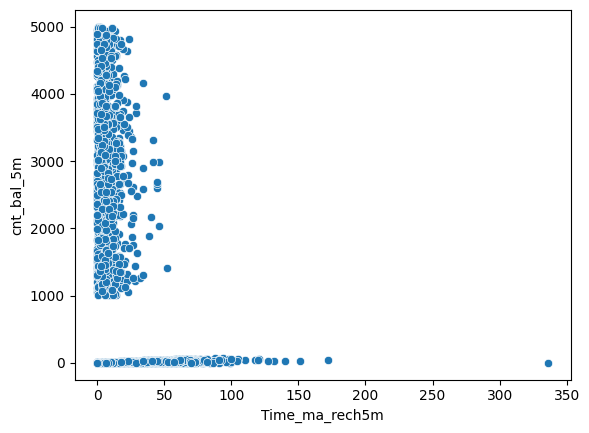

In [ ]:
       # scatter plot between two variables
# plt.scatter(CDR_data['Tot_ma_rech_1m'], CDR_data['Tot_ma_rech_5m'])
# plt.xlabel('Tot_ma_rech_1m')
# plt.ylabel('Tot_ma_rech_5m')
       # plot to show lines
 # plt.plot(CDR_data['Tot_ma_rech_1m'], CDR_data['Tot_ma_rech_5m'])
       # perfectly tune each chart using seaborn
sns.scatterplot(data=CDR_data, x='Time_ma_rech5m', y='cnt_bal_5m')


In [ ]:
 # Examine correlations among all columns in a dataset and plot them
#  sns.pairplot(data=CDR_data)

<Axes: >

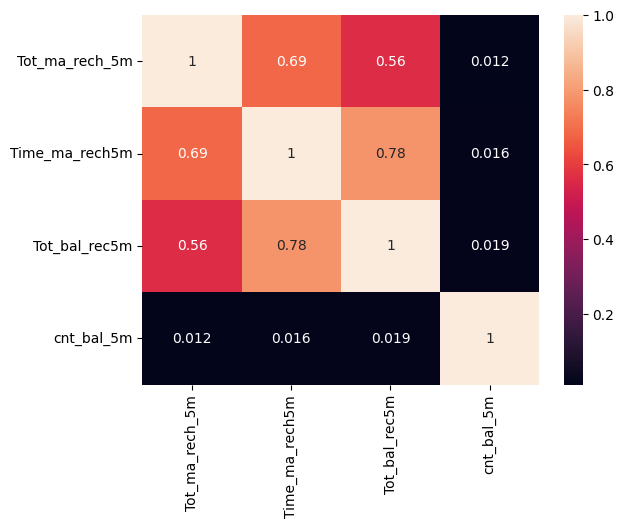

In [ ]:
  #Look at how all columns are correlated using Pearson
  sns.heatmap(CDR_data.corr(), annot=True)

<Axes: >

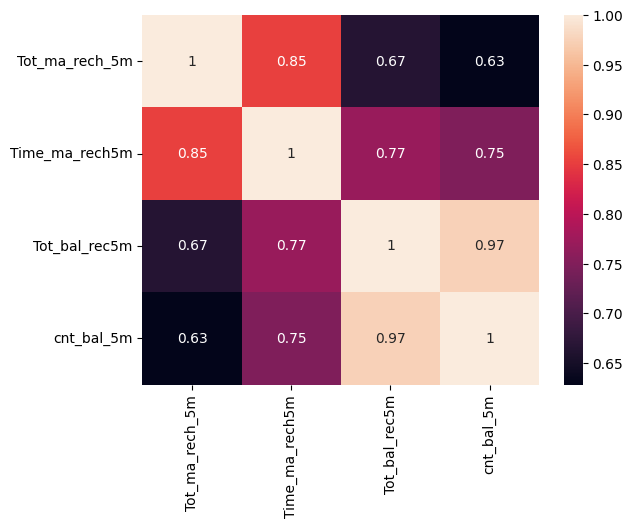

In [ ]:
   #use spearman and Kendall for non-linear relashionships
sns.heatmap(CDR_data.corr(method='spearman'), annot=True)

In [ ]:
# look at the summary statistics of the original data
with pd.option_context("display.max_columns", None, "display.max_rows", None):
  display(CDR_data_clean.describe())


,daily_spent_1m,daily_spent_5m,Avg_main_bal_1m,Avg_main_bal_5m,last_rech_date_ma,last_rech_amt_ma,Time_ma_rech_1m,Fr_ma_rech_1m,Tot_ma_rech_1m,med_amnt_ma_rech_1m,med_rech_rechprebal_1m,Time_ma_rech5m,Fr_ma_rech_5m,Tot_ma_rech_5m,med_amt_ma_rech_5m,med_amt_rechprebal5m,cnt_bal_rec_1m,Tot_bal_rec1m,cnt_bal_5m,Tot_bal_rec5m
count,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000,184625.000000
mean,4338.716481,4824.922080,2470.550964,3142.503893,3789.875054,2109.420333,3.442762,3780.771736,6854.928119,1857.223266,3931.560071,5.203320,8.321598,10618.237433,1920.852650,96.386089,2.332794,14.854424,17.691505,18.110234
std,7513.876551,8714.155417,4098.397239,5395.443017,54161.383856,2412.888294,3.339543,53988.247671,8855.276981,2123.486952,54605.201165,5.198432,13.039987,13920.270699,2135.542011,389.198606,1.725422,10.949201,225.051458,14.175359
min,-93.012667,-93.012667,-23737.140000,-24720.580000,-29.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-200.000000,0.000000,0.000000,0.000000,0.000000,-200.000000,0.000000,0.000000,0.000000,0.000000
25%,38.670000,38.925000,263.790000,293.400000,1.000000,770.000000,1.000000,0.000000,1540.000000,770.000000,11.000000,2.000000,0.000000,2312.000000,773.000000,14.730000,1.000000,6.000000,1.000000,6.000000
50%,1100.000000,1120.870000,974.600000,1188.470000,3.000000,1539.000000,3.000000,2.000000,4617.000000,1539.000000,35.000000,4.000000,3.000000,6480.000000,1539.000000,37.200000,2.000000,12.000000,2.000000,12.000000
75%,5852.000000,6243.000000,2967.040000,3694.660000,8.000000,2309.000000,5.000000,6.000000,8965.000000,1924.000000,85.300000,7.000000,9.000000,13852.000000,1924.000000,82.000000,3.000000,18.000000,4.000000,24.000000
max,212364.000000,217542.500000,198926.110000,200148.110000,997717.809600,55000.000000,203.000000,999606.368100,810096.000000,55000.000000,999479.419300,336.000000,88.000000,953036.000000,55000.000000,41456.500000,10.000000,60.000000,4997.517944,60.000000


In [ ]:
#Take part of the dataset which is more informative for clustering
# part_CDR_data = CDR_data[['Tot_ma_rech_5m','Time_ma_rech5m','Tot_bal_rec5m', 'cnt_bal_5m']]


array([[<Axes: title={'center': 'Tot_ma_rech_5m'}>,
        <Axes: title={'center': 'Time_ma_rech5m'}>],
       [<Axes: title={'center': 'Tot_bal_rec5m'}>,
        <Axes: title={'center': 'cnt_bal_5m'}>]], dtype=object)

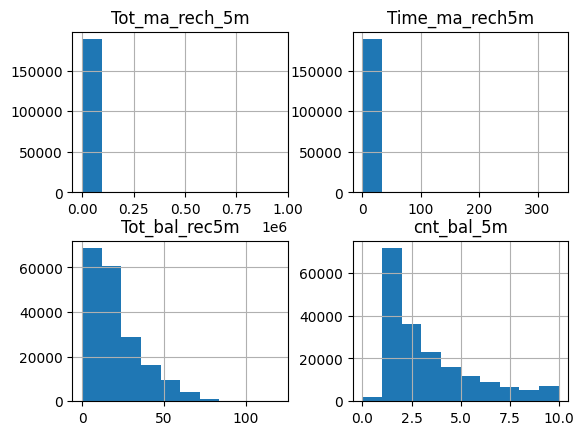

In [ ]:
# Visualize the data using histogram

CDR_data_clean.hist()

# plt.hist(part_CDR_data, bins = 50)
# plt.show()

# sns.histplot(part_CDR_data, bins = 200, kde = True)


In [ ]:
# Get all numeric features
numeric_features = CDR_data_clean.select_dtypes(include='number').columns

# Calculate and print the range for each numeric feature
for feature in numeric_features:
    min_value = CDR_data_clean[feature].min()
    max_value = CDR_data_clean[feature].max()
    print(f"Range of {feature}: {min_value} to {max_value}")


Range of daily_spent_1m: -93.01266667 to 212364.0
Range of daily_spent_5m: -93.01266667 to 217542.5
Range of Avg_main_bal_1m: -23737.14 to 198926.11
Range of Avg_main_bal_5m: -24720.58 to 200148.11
Range of last_rech_date_ma: -29.0 to 997717.8096
Range of last_rech_amt_ma: 0 to 55000
Range of Time_ma_rech_1m: 0 to 203
Range of Fr_ma_rech_1m: 0.0 to 999606.3681
Range of Tot_ma_rech_1m: 0 to 810096
Range of med_amnt_ma_rech_1m: 0.0 to 55000.0
Range of med_rech_rechprebal_1m: -200.0 to 999479.4193
Range of Time_ma_rech5m: 0 to 336
Range of Fr_ma_rech_5m: 0 to 88
Range of Tot_ma_rech_5m: 0 to 953036
Range of med_amt_ma_rech_5m: 0.0 to 55000.0
Range of med_amt_rechprebal5m: -200.0 to 41456.5
Range of cnt_bal_rec_1m: 0 to 10
Range of Tot_bal_rec1m: 0 to 60
Range of maxmnt_bal_rec1m: 0.0 to 99864.56086
Range of med_bal_rec1m: 0.0 to 3.0
Range of cnt_bal_5m: 0.0 to 4997.517944
Range of Tot_bal_rec5m: 0 to 60
Range of maxmnt_bal_rec5m: 0 to 12


In [ ]:
# with pd.option_context("display.max_columns", None, "display.max_rows", None):
#   display(part_CDR_data[part_CDR_data['Time_ma_rech5m'] > 100])

In [ ]:
# Define lower and upper percentiles
lower_percentile = 1
upper_percentile = 99

# Calculate the percentiles
lower_limit = np.percentile(CDR_data, lower_percentile)
upper_limit = np.percentile(CDR_data, upper_percentile)

# Keep only the middle 98% of the data
CDR_data_cleaned = CDR_data[(CDR_data >= lower_limit) & (CDR_data <= upper_limit)]



In [ ]:
missing_values = CDR_data_cleaned.isna().sum()
print(missing_values)

Tot_ma_rech_5m    8118
Time_ma_rech5m       0
Tot_bal_rec5m        0
cnt_bal_5m           0
dtype: int64


In [ ]:
CDR_data_cleaned = CDR_data_cleaned.dropna()

In [ ]:
missing_values = CDR_data_cleaned.isna().sum()
print(missing_values)

Tot_ma_rech_5m    6089
Time_ma_rech5m       0
Tot_bal_rec5m        0
dtype: int64


In [ ]:
CDR_data_cleaned_imputed = CDR_data_cleaned.fillna(CDR_data_cleaned.mean())

In [ ]:
CDR_data_cleaned_imputed.duplicated().sum()

119225

In [ ]:
CDR_data_cleaned_imputed=CDR_data_cleaned_imputed.drop_duplicates()

In [ ]:
len(CDR_data_cleaned_imputed.index)

202964

In [ ]:
# Check for NaN values in the cleaned DataFrame
print(CDR_data_cleaned_imputed.isnull().sum())

Tot_ma_rech_5m    0
Time_ma_rech5m    0
Tot_bal_rec5m     0
cnt_bal_5m        0
dtype: int64


In [ ]:
#Remove outliers
def remove_outliers(df, columns):
 df_no_outliers = CDR_data.copy()
 for col in columns:
     # Calculate the IQR for the column
      q1 = df[col].quantile(0.25)
      q3 = df[col].quantile(0.75)
      iqr = q3 - q1
      # Define the upper and lower bounds for outliers
      upper_boundary = q3 + 1.5 * iqr
      lower_boundary = q1 - 1.5 * iqr
      # Remove outliers from the column
      new_df = df_no_outliers.loc[(df_no_outliers[col] > lower_boundary) & \
              (df_no_outliers[col] < upper_boundary)]
 return new_df

columns_to_remove_outliers = ['Tot_ma_rech_5m','Time_ma_rech5m','Tot_bal_rec5m', 'cnt_bal_5m']
CDR_data_clean = remove_outliers(CDR_data, columns_to_remove_outliers)

In [ ]:
missing_values = CDR_data_clean.isna().sum()
print(missing_values)

Tot_ma_rech_5m    0
Time_ma_rech5m    0
Tot_bal_rec5m     0
cnt_bal_5m        0
dtype: int64


In [ ]:
len(CDR_data_clean.index)

197532

In [ ]:
 # Applying standardization
  # import libraries
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import MinMaxScaler

 # call standardizaiton/normalzation functions
minmax_scaler = MinMaxScaler()
std_scaler = StandardScaler()
rob_scaler = RobustScaler()

 # fit the the funcion with the dataset
normalized_CDR_data = minmax_scaler.fit_transform(CDR_data)




In [ ]:
pd_normalized_CDR_data = pd.DataFrame(normalized_CDR_data,
                                    columns=CDR_data.columns)

In [ ]:
pd_normalized_CDR_data.duplicated().sum()

0

In [ ]:
CDR_data_clean_num = CDR_data_clean.to_numpy()

In [ ]:
CDR_data_clean.max()

Tot_ma_rech_5m    57.478926
Time_ma_rech5m    48.778363
Tot_bal_rec5m     10.238267
cnt_bal_5m         5.840304
dtype: float64

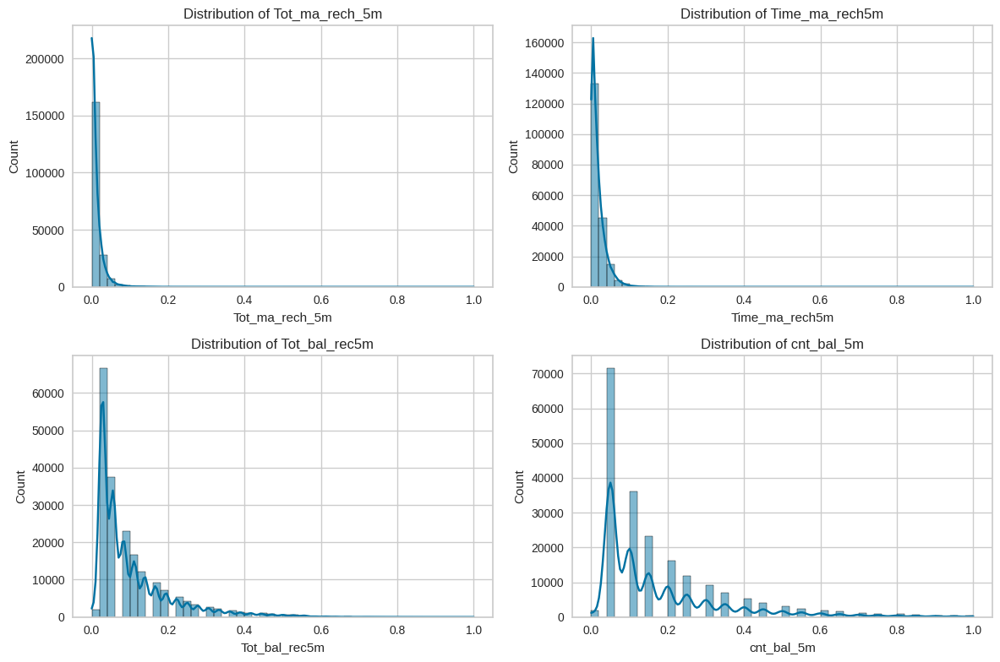

In [ ]:
 #Visualize the dataset
# sns.histplot(normalized_CDR_data[:, 0], bins=30, kde=True)

# Visualize individual feature distribution after transforamtion
pd_normalized_CDR_data = pd.DataFrame(normalized_CDR_data,  columns=CDR_data.columns)

# sns.histplot(normalized_CDR_data['Tot_bal_rec5m'], kde=True)

# plt.hist(normalized_CDR_data, bins = 500)
# plt.show()

# Visualize individual feature distributions in same figure
plt.figure(figsize=(12, 8))
for column in pd_normalized_CDR_data.columns:
    plt.subplot(2, int(np.ceil(len(pd_normalized_CDR_data.columns)/2)),
                list(pd_normalized_CDR_data.columns).index(column) + 1)
    sns.histplot(pd_normalized_CDR_data[column], bins = 50, kde=True)
    plt.title(f'Distribution of {column}')
plt.tight_layout()
plt.show()

array([[<Axes: title={'center': 'Tot_ma_rech_5m'}>,
        <Axes: title={'center': 'Time_ma_rech5m'}>],
       [<Axes: title={'center': 'Tot_bal_rec5m'}>,
        <Axes: title={'center': 'cnt_bal_5m'}>]], dtype=object)

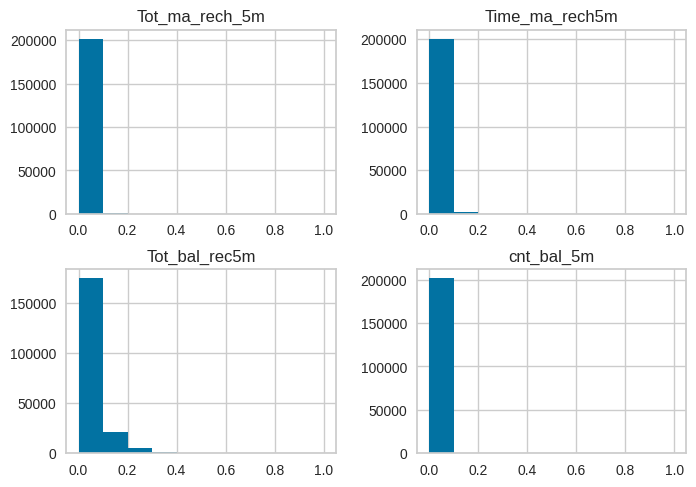

In [ ]:
pd_normalized_CDR_data = pd.DataFrame(normalized_CDR_data,
                                    columns=CDR_data.columns)
pd_normalized_CDR_data.hist()

In [ ]:
pd_normalized_CDR_data = pd.DataFrame(normalized_CDR_data,
                                    columns=CDR_data.columns)
(pd_normalized_CDR_data < 0).sum()

Tot_ma_rech_5m    101459
Time_ma_rech5m     90407
Tot_bal_rec5m      68930
cnt_bal_5m         73504
dtype: int64

In [ ]:

(pd_normalized_CDR_data > 0).sum()

Tot_ma_rech_5m    101405
Time_ma_rech5m     95754
Tot_bal_rec5m      96342
dtype: int64

In [ ]:
# Get all numeric features
pd_normalized_CDR_data = pd.DataFrame(normalized_CDR_data,
                                    columns=CDR_data.columns)
numeric_features = pd_normalized_CDR_data.select_dtypes(include='number').columns

# Calculate and print the range for each numeric feature after transformtion
for feature in numeric_features:
    min_value = pd_normalized_CDR_data[feature].min()
    max_value = pd_normalized_CDR_data[feature].max()
    print(f"Range of {feature}: {min_value} to {max_value}")

Range of daily_spent_1m: -0.589619947912853 to 27.694041485062815
Range of daily_spent_5m: -0.5641774697630977 to 24.41826293319502
Range of Avg_main_bal_1m: -6.395790265737126 to 47.94728383131091
Range of Avg_main_bal_5m: -5.165100226659705 to 36.52327440231827
Range of last_rech_date_ma: -0.0704827445457891 to 18.35830357705027
Range of last_rech_amt_ma: -0.8736472103843599 to 21.92275684109719
Range of Time_ma_rech_1m: -1.0301031703411196 to 59.755479120620336
Range of Fr_ma_rech_1m: -0.07000286509304955 to 18.452340054447113
Range of Tot_ma_rech_1m: -0.773637106534378 to 90.72237359954583
Range of med_amnt_ma_rech_1m: -0.8740268278960167 to 25.029202502586923
Range of med_rech_rechprebal_1m: -0.07563636664933648 to 18.238769368065263
Range of Time_ma_rech5m: -1.0001808432561485 to 63.63490801005992
Range of Fr_ma_rech_5m: -0.6378190740538761 to 6.112200000211316
Range of Tot_ma_rech_5m: -0.7623317743357189 to 67.71270488007897
Range of med_amt_ma_rech_5m: -0.8988533862111551 to 24

In [ ]:
#Look at the summary staticstics of the dataset after normalization
with pd.option_context("display.max_columns", None, "display.max_rows", None):
  display(pd_normalized_CDR_data.describe())

,daily_spent_1m,daily_spent_5m,Avg_main_bal_1m,Avg_main_bal_5m,last_rech_date_ma,last_rech_amt_ma,Time_ma_rech_1m,Fr_ma_rech_1m,Tot_ma_rech_1m,med_amnt_ma_rech_1m,med_rech_rechprebal_1m,Time_ma_rech5m,Fr_ma_rech_5m,Tot_ma_rech_5m,med_amt_ma_rech_5m,med_amt_rechprebal5m,cnt_bal_rec_1m,Tot_bal_rec1m,maxmnt_bal_rec1m,med_bal_rec1m,cnt_bal_5m,Tot_bal_rec5m,maxmnt_bal_rec5m
count,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05,1.847660e+05
mean,4.426327e-17,1.538254e-17,1.029861e-16,-1.249832e-16,-1.423847e-17,-6.041494e-17,7.814332e-17,-4.191743e-18,-2.595804e-18,2.234314e-17,-2.245851e-17,-6.445286e-17,-3.076509e-19,-1.269060e-17,-1.609399e-17,1.922818e-17,8.152748e-18,1.768992e-17,2.303536e-17,3.245717e-17,1.022939e-17,9.783297e-17,-2.075490e-16
std,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00
min,-5.896199e-01,-5.641775e-01,-6.395790e+00,-5.165100e+00,-7.048274e-02,-8.736472e-01,-1.030103e+00,-7.000287e-02,-7.736371e-01,-8.740268e-01,-7.563637e-02,-1.000181e+00,-6.378191e-01,-7.623318e-01,-8.988534e-01,-7.616151e-01,-1.351636e+00,-1.356366e+00,-6.580278e-02,-2.560955e-01,-7.858437e-02,-1.277177e+00,-3.328956e+00
25%,-5.720899e-01,-5.490336e-01,-5.384845e-01,-5.280503e-01,-6.992863e-02,-5.544976e-01,-7.306668e-01,-7.000287e-02,-5.997023e-01,-5.113816e-01,-7.177262e-02,-6.154482e-01,-6.378191e-01,-5.962160e-01,-5.368564e-01,-2.098466e-01,-7.719766e-01,-8.082845e-01,-6.441618e-02,-2.560955e-01,-7.413924e-02,-8.538467e-01,-2.923441e-01
50%,-4.307983e-01,-4.250473e-01,-3.651370e-01,-3.622209e-01,-6.989169e-02,-2.357624e-01,-1.317941e-01,-6.996581e-02,-2.521716e-01,-1.492074e-01,-7.133110e-02,-2.307155e-01,-4.077048e-01,-2.987596e-01,-1.781376e-01,-1.521946e-01,-1.923173e-01,-2.602028e-01,-6.441618e-02,-2.560955e-01,-6.969412e-02,-4.305159e-01,-2.923441e-01
75%,2.012888e-01,1.623250e-01,1.211509e-01,1.022224e-01,-6.979934e-02,8.338728e-02,4.670787e-01,-6.989169e-02,2.389117e-01,3.211523e-02,-7.041142e-02,3.463835e-01,5.252379e-02,2.328539e-01,2.158419e-03,-3.712179e-02,3.873420e-01,2.878789e-01,-6.441618e-02,-2.560955e-01,-6.080386e-02,4.161457e-01,-2.923441e-01
max,2.769404e+01,2.441826e+01,4.794728e+01,3.652327e+01,1.835830e+01,2.192276e+01,5.975548e+01,1.845234e+01,9.072237e+01,2.502920e+01,1.823877e+01,6.363491e+01,6.112200e+00,6.771270e+01,2.485772e+01,1.063085e+02,4.444957e+00,4.124451e+00,2.301280e+01,1.309416e+01,2.213602e+01,2.956130e+00,2.744268e+00


In [ ]:
 #look at the data skewness nummerically after standaridization
from scipy.stats import skew
data_skewness = skew(pd_normalized_CDR_data)
print(data_skewness)

[4.93797554 3.03138547 2.13493741 1.96065814]


<Axes: ylabel='Count'>

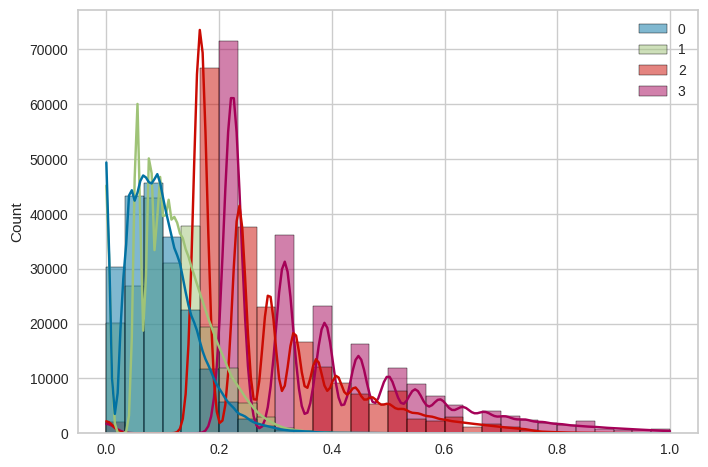

In [ ]:
  # apply transformaion to make Gaussian  distribution
# from sklearn.experimental import enable_iterative_imputer  # noqa
# from sklearn.impute import IterativeImputer

# normalized_CDR_data = normalized_CDR_data - normalized_CDR_data.min() + 1e-5  # Add a constant to make the data positive
sym_CDR_data = np.sqrt(normalized_CDR_data)



 # visualize the the data
sns.histplot(sym_CDR_data, bins=30, kde=True)


array([[<Axes: title={'center': 'Tot_ma_rech_5m'}>,
        <Axes: title={'center': 'Time_ma_rech5m'}>],
       [<Axes: title={'center': 'Tot_bal_rec5m'}>,
        <Axes: title={'center': 'cnt_bal_5m'}>]], dtype=object)

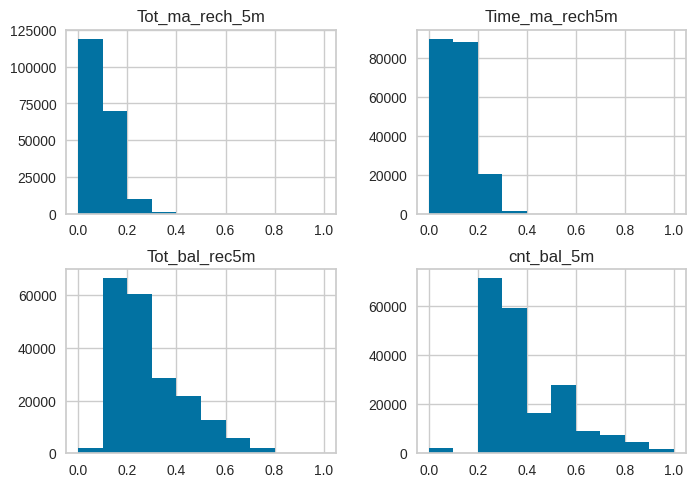

In [ ]:
df_sym_CDR_data = pd.DataFrame(sym_CDR_data,
                                    columns=CDR_data.columns)
df_sym_CDR_data.hist()
# df_sym_CDR_data = df_sym_CDR_data[df_sym_CDR_data[['Tot_ma_rech_5m',	'Time_ma_rech5m',	'Tot_bal_rec5m',	'cnt_bal_5m']] > 0]
# df_sym_CDR_data = df_sym_CDR_data.fillna(df_sym_CDR_data[['Tot_ma_rech_5m',	'Time_ma_rech5m',	'Tot_bal_rec5m',	'cnt_bal_5m']].median())
# df_sym_CDR_data.hist()


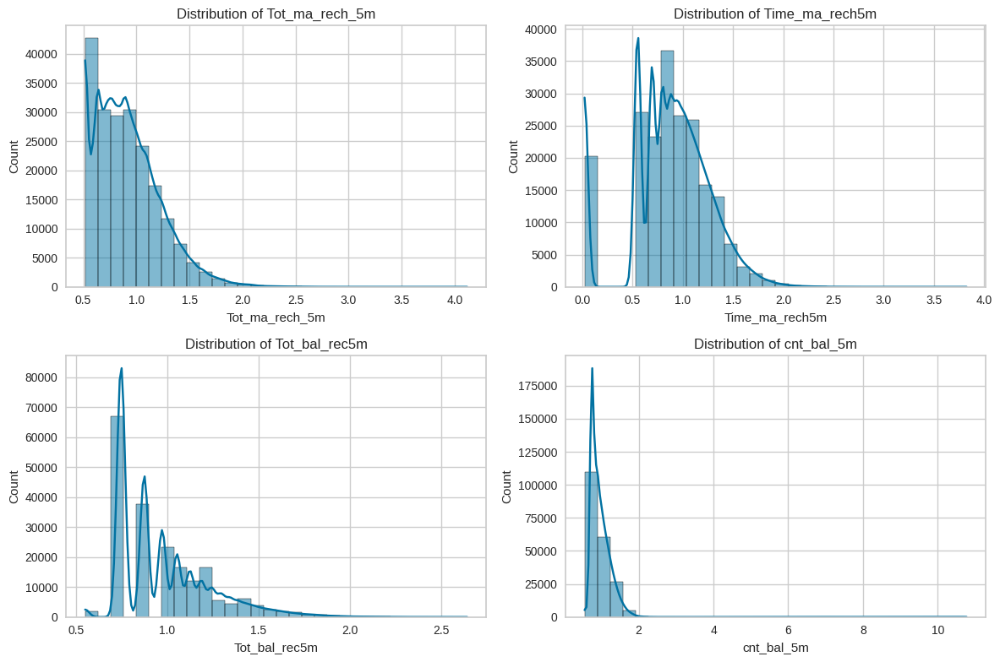

In [ ]:
 #Visualize the dataset
# sns.histplot(normalized_CDR_data[:, 0], bins=30, kde=True)

# Visualize individual feature distribution after cbrt transforamtion
pd_sym_CDR_data = pd.DataFrame(df_sym_CDR_data,  columns=CDR_data.columns)

# sns.histplot(normalized_CDR_data['Tot_bal_rec5m'], kde=True)

# plt.hist(normalized_CDR_data, bins = 500)
# plt.show()

# Visualize individual feature distributions in same figure
plt.figure(figsize=(12, 8))
for column in pd_sym_CDR_data.columns:
    plt.subplot(2, int(np.ceil(len(pd_sym_CDR_data.columns)/2)),
                list(pd_sym_CDR_data.columns).index(column) + 1)
    sns.histplot(pd_sym_CDR_data[column], bins = 30, kde=True)
    plt.title(f'Distribution of {column}')
plt.tight_layout()
plt.show()

<Axes: ylabel='Count'>

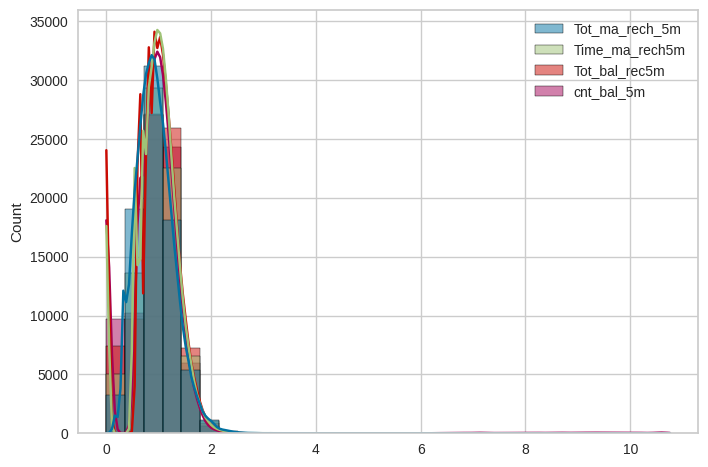

In [ ]:
pd_normalized_CDR_data = pd.DataFrame(sym_CDR_data,
                                    columns=part_CDR_data.columns)
  # get columns with value greater zan zero
filtered_CDR_data =pd_normalized_CDR_data [pd_normalized_CDR_data[['Tot_ma_rech_5m','Time_ma_rech5m','Tot_bal_rec5m','cnt_bal_5m']] >= 0]
 # drop any NaN values
filtered_CDR_data = filtered_CDR_data.dropna()
# with pd.option_context("display.max_columns", None, "display.max_rows", None):
#   display(filtered_CDR_data.head(2000))

sns.histplot(filtered_CDR_data, bins = 30,  kde = True)

In [ ]:
from scipy.stats import skew
data_skewness = skew(sym_CDR_data)
print(data_skewness)

[0.93737495 0.45846542 1.06027275 1.01096834]


In [ ]:
sym_CDR_data = pd.DataFrame(sym_CDR_data,  columns=CDR_data.columns)
with pd.option_context("display.max_columns", None, "display.max_rows", None):
  display(sym_CDR_data.head())


,Tot_ma_rech_5m,Time_ma_rech5m,Tot_bal_rec5m,cnt_bal_5m
0,0.410802,0.336479,0.587792,0.587792
1,0.559696,0.182330,0.587792,0.382999
2,0.315162,0.182330,0.382999,0.382999
3,0.275791,0.182330,0.587792,0.587792
4,1.203829,0.955515,1.243196,1.243196


In [ ]:
 # Drop featurs with high variance in thier mean and std
# sym_CDR_data = sym_CDR_data.drop(['last_rech_date_ma','incoming_call','Fr_ma_rech_1m',
#          'med_rech_rechprebal_1m','num_Times_smssent_1m','fr_incoming_call_1m', 'maxmnt_bal_rec5m','maxmnt_bal_rec1m' ], axis=1)
# with pd.option_context("display.max_columns", None, "display.max_rows", None):
#   display(sym_CDR_data.head(10))

In [ ]:
    # visualize after droping some features
# Visualize histograms for all numeric columns in the DataFrame
# sns.set(style="whitegrid")
# plt.figure(figsize=(12, 8))

# Iterate through each column in the DataFrame
# for column in sym_CDR_data.select_dtypes(include='number').columns:
#      sns.histplot(sym_CDR_data[column], kde=False, bins=20, label=column)

# plt.title('Histograms of Numeric Columns')
# plt.xlabel('Values')
# plt.ylabel('Frequency')
# plt.legend()
# plt.show()

In [ ]:
with pd.option_context("display.max_columns", None, "display.max_rows", None):
  display(sym_CDR_data.describe())



AttributeError: 'numpy.ndarray' object has no attribute 'describe'

In [ ]:
from scipy.stats import skew
data_skewness = skew(sym_CDR_data)
print(data_skewness)

[ 1.23651156  1.3373146   3.10601864  3.07753006 14.24910717 14.27082957
  0.80127007  0.36386455 14.25459325  0.81985882  0.63198143 14.08973545
  0.62007697  1.03805296  0.9862476   0.76804258  8.48027016 15.51852293
 14.19547686  8.19141242 19.75781293  1.07629628  1.15218091 15.45604105
  3.70129754 13.90760692  1.3466407  -0.90808517  4.03594658  1.92369448
  1.78407679]


In [ ]:
# Visualize individual feature distribution after applying symmetric
# sym_CDR_data = pd.DataFrame(sym_CDR_data,  columns=CDR_data.columns)
# sns.histplot(sym_CDR_data['Tot_bal_rec5m'], kde=True)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=3, random_state=42)

In [ ]:
 #Applying dimensionality reduction after normalization\
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

km = KMeans(3, random_state=42)
km.fit(normalized_CDR_data)
pca = PCA(random_state=42)
pca_CDR_data = pca.fit_transform(normalized_CDR_data)




# pca_CDR_data = pd.DataFrame(pca_CDR_data)
# pca_CDR_data.columns = ['P1', 'P2','P3']
# print(pca_CDR_data.head())


#look at the PCA components
# pca.components_

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Text(0, 0.5, 'PCA dimension 2')

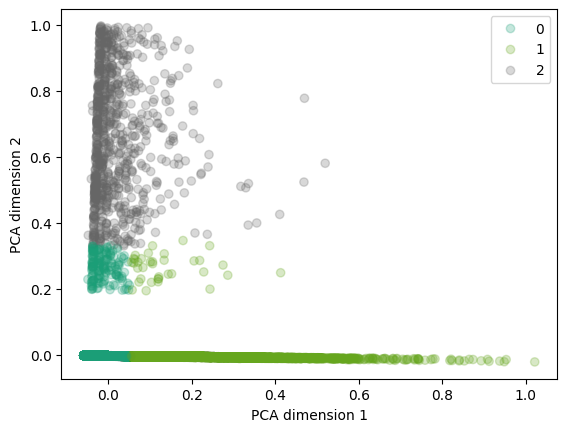

In [ ]:
 #Visualize the reduced data
scatter = plt.scatter(pca_CDR_data[:, 0],
 pca_CDR_data[:, 1],
 c=km.labels_,
 cmap='Dark2',
 alpha=0.25)
plt.legend(*scatter.legend_elements())
plt.xlabel('PCA dimension 1')
plt.ylabel('PCA dimension 2')


# plt.figure(figsize=(8, 6))
# plt.scatter(pca_CDR_data[:, 0], pca_CDR_data[:, 1], c='blue', edgecolor='k', s=50)
# plt.title('PCA-reduced Data')
# plt.xlabel('Principal Component 1')
# plt.ylabel('Principal Component 2')
# plt.grid(True)
# plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


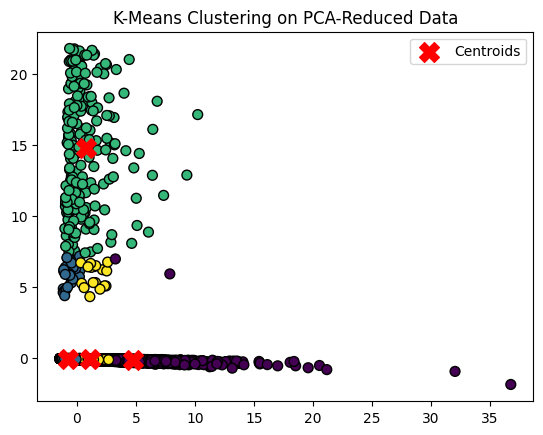

In [ ]:
# Apply K-Means clustering on the PCA-reduced data
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=4,  random_state=42)
kmeans_labels = kmeans.fit_predict(pca_CDR_data)

# Visualize the K-Means clusters on the PCA-reduced data
plt.scatter(pca_CDR_data[:, 0], pca_CDR_data[:, 1], c=kmeans_labels, cmap='viridis', edgecolor='k', s=50)
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], c='red', marker='X', s=200, label='Centroids')
plt.title('K-Means Clustering on PCA-Reduced Data')
plt.legend()
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

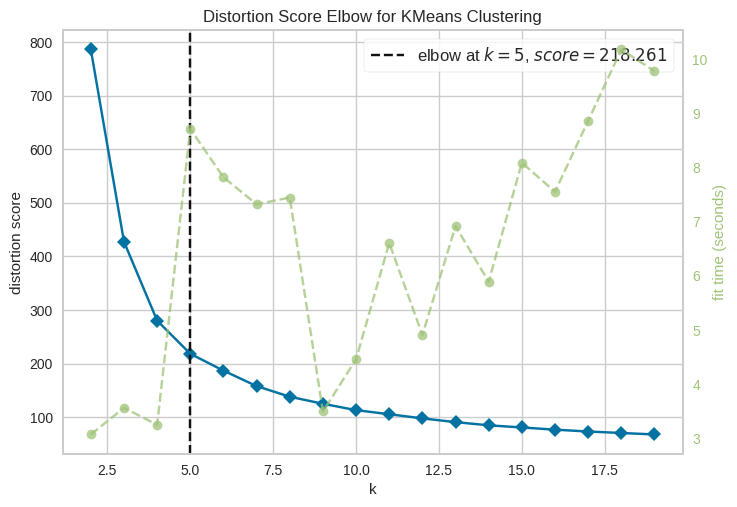

KElbowVisualizer(ax=<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>,
                 estimator=KMeans(n_clusters=19), k=(2, 20))

In [ ]:
from yellowbrick.cluster.elbow import kelbow_visualizer
from sklearn.cluster import KMeans
# # Apply KMeans to the symmetric  data
kelbow_visualizer(KMeans(), normalized_CDR_data , k=(2, 20), metric = 'distortion')
# kelbow_visualizer(KMeans(), normalized_CDR_data , k=(2, 20), metric ='silhouette')
# kelbow_visualizer(KMeans(), sym_CDR_data , k=(2, 20), metric='calinski_harabasz')

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


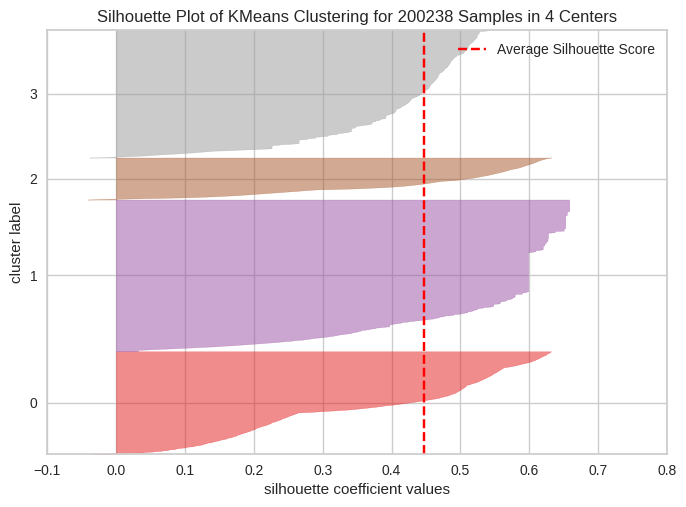

SilhouetteVisualizer(ax=<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 200238 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>,
                     estimator=KMeans(n_clusters=4))

In [ ]:
from yellowbrick.cluster import silhouette_visualizer
silhouette_visualizer(KMeans(4), sym_CDR_data)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_mds.py:299: FutureWarning: The default value of `normalized_stress` will change to `'auto'` in version 1.4. To suppress this warning, manually set the value of `normalized_stress`.
  warnings.warn(


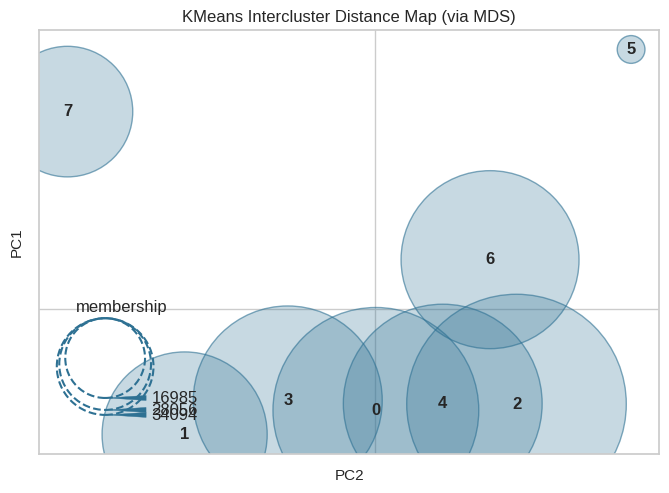

InterclusterDistance(ax=<Axes: title={'center': 'KMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>,
                     estimator=KMeans())

In [ ]:
# look at intercluster distance
from sklearn.cluster import KMeans
from yellowbrick.cluster import intercluster_distance
intercluster_distance(KMeans(), sym_CDR_data)

Load the data

In [ ]:
# CDR_data_new = CDR_data[['num_Times_smssent_1m','outgoing_call_5m']]
# CDR_data_new = CDR_data[['Tot_bal_rec5m','Tot_ma_rech_5m','Time_ma_rech5m']]

# CDR_data_new = CDR_data[['last_rech_amt_ma','Tot_ma_rech_5m','Avg_main_bal_5m']]
# CDR_data_new = CDR_data[[
#                           'cnt_bal_5m',
#                           'Time_ma_rech5m',
#                           'Tot_bal_rec5m',
#                           'Tot_ma_rech_5m',
#                              'daily_spent_5m',
#                              'Avg_main_bal_5m',
#                              'Fr_ma_rech_5m',
#                              'med_amt_ma_rech_5m',
#                               'avg_tra_bal_5m']]
# CDR_data_new = CDR_data_new[(CDR_data_new >= 0).all(axis=1)]
# with pd.option_context("display.max_columns", None, "display.max_rows", None):
#   display(CDR_data_new.head(50))

# CDR_data_new.skew()
# CDR_data_new.kurtosis()
# sns.distplot(CDR_data_new, hist = True)


daily_spent_1m          31.419343
daily_spent_5m          36.055322
Avg_main_bal_1m         59.771788
Avg_main_bal_5m         47.704750
Time_ma_rech_1m         42.046048
Fr_ma_rech_1m          223.485412
Tot_ma_rech_1m         228.789675
med_amnt_ma_rech_1m     33.448604
Time_ma_rech5m          39.889420
Fr_ma_rech_5m            5.149492
Tot_ma_rech_5m          81.593044
med_amt_ma_rech_5m      38.539686
cnt_bal_rec_1m          12.804693
Tot_bal_rec1m           16.020159
cnt_bal_5m             294.824535
Tot_bal_rec5m           16.711146
dtype: float64

Exploratory Data Analysis(EDA)

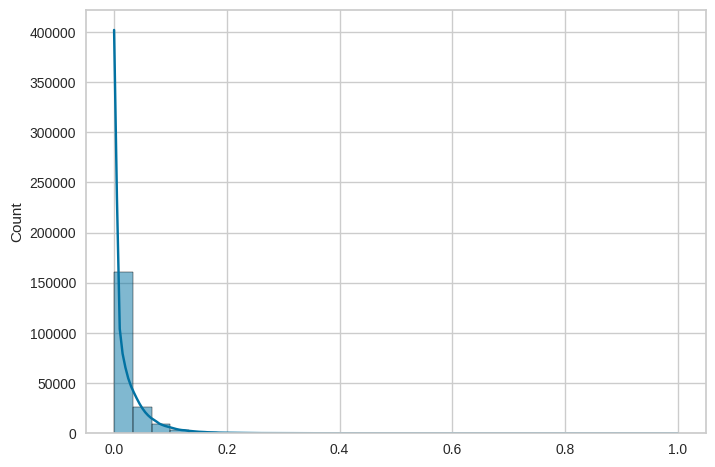

In [ ]:

from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import QuantileTransformer
from sklearn.preprocessing import normalize
from scipy.stats import yeojohnson
from sklearn.decomposition import PCA
from scipy.stats import skew
from sklearn.cluster import KMeans
from sklearn.experimental import enable_iterative_imputer  # noqa
from sklearn.impute import IterativeImputer
from sklearn.impute import SimpleImputer


rob_scaler = RobustScaler()
qunt_scaler = QuantileTransformer()
std_scaler = StandardScaler()
minmax_scaler = MinMaxScaler()

      # 1.first experiment with two highly separated clusters
# scaled_CDR_data = rob_scaler.fit_transform(CDR_data_new)
# scaled_CDR_data = np.cbrt(scaled_CDR_data)
      # 2. Second experiment (good plot but low Silhoutee)
# scaled_CDR_data = rob_scaler.fit_transform(CDR_data_new)
# scaled_CDR_data = np.log1p(scaled_CDR_data)
# imputer = IterativeImputer()
# scaled_CDR_data = imputer.fit_transform(scaled_CDR_data)
     # Third experiment(plot right skeweed but silhoute is 0.56 for k =2)
scaled_CDR_data = minmax_scaler.fit_transform(CDR_data_new)
sns.histplot(scaled_CDR_data[:, 0], bins=30, kde=True)
plt.show()
# scaled_CDR_data = minmax_scaler.fit_transform(CDR_data_new)
    # Fourth experiment
# scaled_CDR_data = np.cbrt(CDR_data_new)
# scaled_CDR_data = minmax_scaler.fit_transform(scaled_CDR_data)




# print("per-feature minimum before scaling:\n {}".format(CDR_data_new.min(axis=0)))
# print("per-feature maximum before scaling:\n {}".format(CDR_data_new.max(axis=0)))

# print("transformed shape: {}".format(scaled_CDR_data.shape))
# print("per-feature minimum after scaling:\n {}".format(
#  scaled_CDR_data.min(axis=0)))
# print("per-feature maximum after scaling:\n {}".format(
#  scaled_CDR_data.max(axis=0)))





 # Show the distribution of data
# sns.distplot(scaled_CDR_data, hist = True)



           # data imputation
# Assuming 'data' is your dataset with missing values
# imputer = IterativeImputer()
# imputer = SimpleImputer(missing_values=np.nan, strategy='mean')
# imputed_data = imputer.fit_transform(scaled_CDR_data)


# normalized_CDR_data = normalize(imputed_data)
# skewness = skew(CDR_data_new)
# print(skewness)
# sns.distplot(normalized_CDR_data, hist = True)



In [ ]:
pca = PCA(n_components = 3)
pca_CDR_data = pca.fit_transform(CDR_data_new)
pca_CDR_data = pd.DataFrame(pca_CDR_data)
pca_CDR_data.columns = ['P1', 'P2','P3']
print(pca_CDR_data.head())




            P1            P2            P3
0 -3697.144869 -11203.995787  -1304.680659
1 -3721.899574   -134.248821  -9548.813282
2 -3717.256118 -14083.946931  -1247.529729
3 -3716.583519 -16411.889291   -494.092776
4 -3724.033774   8105.834308  16454.867405


In [ ]:
km = KMeans(3, random_state=42)
km.fit(scaled_CDR_data)

In [ ]:

# pca = PCA(random_state=42)
# pca_CDR_data = pca.fit_transform(scaled_CDR_data)


In [ ]:
pca.components_

array([[ 1.85483907e-02,  1.86231701e-02,  1.30560656e-02,
         1.41331424e-02,  2.07801601e-02,  9.96615007e-01,
         2.35061689e-02,  1.91849811e-02,  2.35041530e-02,
         3.38565267e-02,  2.23477875e-02,  1.47149635e-02,
         2.01738832e-02,  2.13279736e-02,  2.35355988e-02,
         2.26844109e-02],
       [ 2.65972391e-01,  2.67930503e-01,  2.25069608e-01,
         2.35185253e-01,  2.98532765e-01, -7.58514474e-02,
         3.04296127e-01,  1.46656159e-01,  3.26634258e-01,
         5.72161493e-02,  3.17679783e-01,  1.22570849e-01,
         2.58019851e-01,  2.76206507e-01,  3.00075869e-01,
         2.89320923e-01],
       [ 1.12421374e-01,  1.13352648e-01,  7.63375783e-02,
         8.19239127e-02, -2.03038785e-01, -1.19418550e-02,
         1.28369600e-01,  5.60571242e-01, -1.58927909e-01,
         1.84872376e-01,  1.46500573e-01,  5.76450461e-01,
        -2.25661438e-01, -1.99686463e-01, -2.39256053e-01,
        -1.69271313e-01],
       [-3.00202292e-01, -3.05774191e

2. CLUSTERING

2.1 K-Means

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

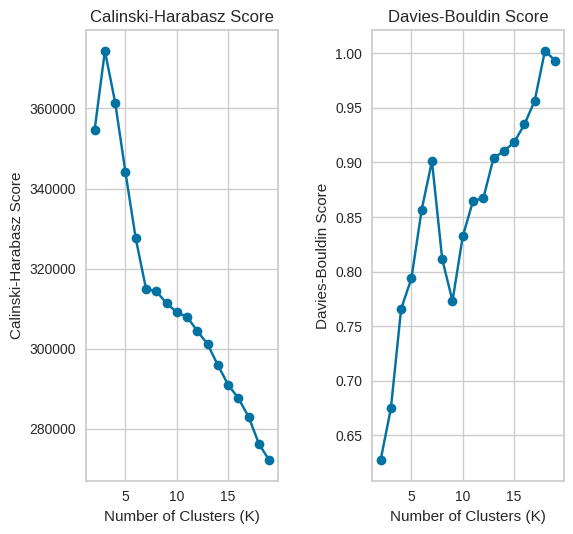

In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score,calinski_harabasz_score,davies_bouldin_score

k_values = range(2, 20)

silhouette_scores = []
calinski_harabasz_scores = []
davies_bouldin_scores = []


for k in k_values:
    # Fit a K-means clustering model
    kmeans = KMeans(n_clusters=k)
    cluster_labels = kmeans.fit_predict(sym_CDR_data)

       # Calculate silhouette score
    silhouette_scor = silhouette_score(normalized_CDR_data, cluster_labels)
    silhouette_scores.append(silhouette_scor)
    print(f"For K={k}, the silhouette score is {silhouette_scor:.4f}")

        # Calculate calinski_harabasz score
    calinski_harabasz = calinski_harabasz_score(sym_CDR_data, cluster_labels)
    calinski_harabasz_scores.append(calinski_harabasz)
    print(f"For K={k}, the calinski_harabasz score is {calinski_harabasz:.4f}")

        # Calculate davies_bouldin score
    davies_bouldin = davies_bouldin_score(sym_CDR_data, cluster_labels)
    davies_bouldin_scores.append(davies_bouldin)
    print(f"For K={k}, the davies_bouldin score is {davies_bouldin:.4f}")

Silhouette Score
plt.subplot(1, 3, 1)
plt.plot(k_values, silhouette_scores, marker='o')
plt.title('Silhouette Score')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Silhouette Score')

# Calinski-Harabasz Score
plt.subplot(1, 3, 2)
plt.plot(k_values, calinski_harabasz_scores, marker='o')
plt.title('Calinski-Harabasz Score')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Calinski-Harabasz Score')

# Davies-Bouldin Score
plt.subplot(1, 3, 3)
plt.plot(k_values, davies_bouldin_scores, marker='o')
plt.title('Davies-Bouldin Score')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Davies-Bouldin Score')

plt.tight_layout()
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


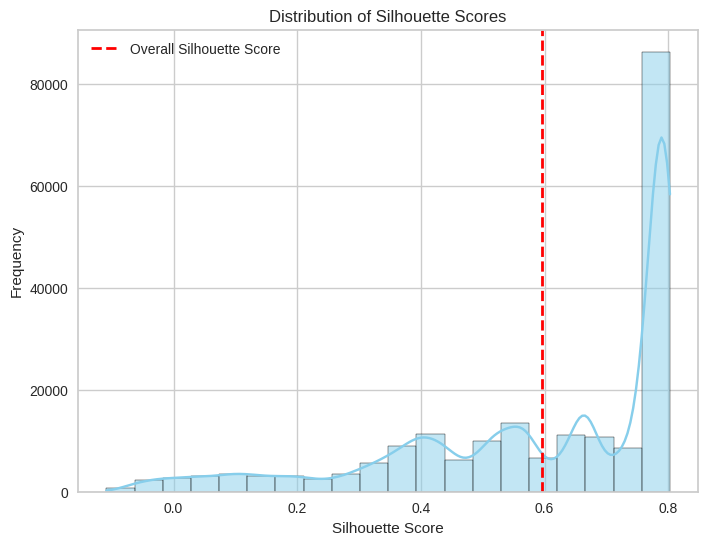

In [ ]:
from sklearn.metrics import silhouette_samples, silhouette_score


# Perform K-means clustering
n_clusters = 4
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
cluster_labels = kmeans.fit_predict(normalized_CDR_data)

# Compute Silhouette scores for each sample
silhouette_scores = silhouette_samples(normalized_CDR_data, cluster_labels)

# Compute the overall Silhouette score
overall_silhouette_score = silhouette_score(normalized_CDR_data, cluster_labels)

# Plot the distribution of Silhouette scores
plt.figure(figsize=(8, 6))
sns.histplot(silhouette_scores, bins=20, kde=True, color='skyblue', edgecolor='black')
plt.axvline(x=overall_silhouette_score, color='red', linestyle='--', linewidth=2, label='Overall Silhouette Score')
plt.title('Distribution of Silhouette Scores')
plt.xlabel('Silhouette Score')
plt.ylabel('Frequency')
plt.legend()
plt.show()

In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances_argmin_min
from sklearn.utils import shuffle

def compute_gap_statistic(data, k_max, n_bootstrap):
    """
    Compute the gap statistic for a range of cluster numbers.

    Parameters:
    - X: Input data (numpy array or pandas DataFrame).
    - k_max: Maximum number of clusters to consider.
    - n_bootstrap: Number of bootstrap samples for the null distribution.

    Returns:
    - gap_values: Gap statistic values for each cluster number.
    - error_bars: Standard deviations of gap statistic values.
    - optimal_k: Optimal number of clusters.
    """
    # Function to compute the within-cluster dispersion
    def compute_wcss(data, labels):
        wcss = 0
        for label in np.unique(labels):
            cluster_points = data[labels == label]
            centroid = np.mean(cluster_points, axis=0)
            wcss += np.sum((cluster_points - centroid) ** 2)
        return wcss

    # Calculate the within-cluster dispersion for the actual data
    wcss_actual = []
    for k in range(1, k_max + 1):
        kmeans = KMeans(n_clusters=k)
        kmeans.fit(data)
        wcss_actual.append(compute_wcss(data, kmeans.labels_))

    # Generate reference datasets and compute within-cluster dispersion
    wcss_ref = np.zeros((n_bootstrap, k_max))
    for i in range(n_bootstrap):
        data_bootstrap = shuffle(data, random_state=i)
        for k in range(1, k_max + 1):
            kmeans_ref = KMeans(n_clusters=k)
            kmeans_ref.fit(data_bootstrap)
            wcss_ref[i, k - 1] = compute_wcss(data_bootstrap, kmeans_ref.labels_)

    # Calculate the gap statistic and its standard deviation
    gap_values = np.log(wcss_ref.mean(axis=0)) - np.log(wcss_actual)
    error_bars = np.std(np.log(wcss_ref), axis=0) * np.sqrt(1 + 1 / n_bootstrap)

    # Find the optimal number of clusters
    optimal_k = np.argmax(gap_values) + 1

    return gap_values, error_bars, optimal_k


def plot_gap_statistic(gap_values, error_values, optimal_k):
    """
    Plot the Gap Statistic values with error bars and highlight the optimal number of clusters.

    Parameters:
    - gap_values: The Gap Statistic values for each number of clusters.
    - error_values: The standard errors for each number of clusters.
    - optimal_k: The optimal number of clusters based on the Gap Statistic.
    """
    plt.errorbar(range(1, len(gap_values) + 1), gap_values, yerr=error_values, marker='o', color='b', ecolor='gray', capsize=5)
    plt.xlabel('Number of Clusters (k)')
    plt.ylabel('Gap Statistic')
    plt.title('Gap Statistic for Optimal Number of Clusters')
    plt.axvline(x=optimal_k, color='r', linestyle='--', label=f'Optimal k = {optimal_k}')
    plt.legend()
    plt.show()




/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

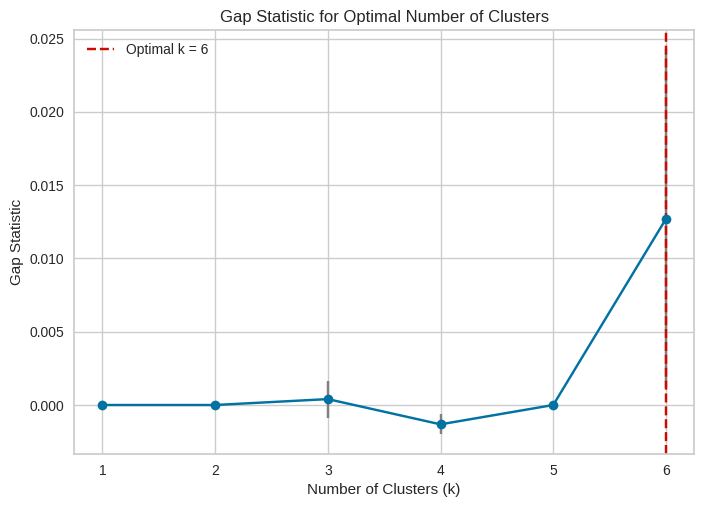

In [ ]:
gap_values, error_values, optimal_k = compute_gap_statistic(normalized_CDR_data, k_max = 6, n_bootstrap=10)
plot_gap_statistic(gap_values, error_values, optimal_k)

In [ ]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=3)
kmeans.fit(normalized_CDR_data)

centroids = kmeans.cluster_centers_
# centroids


centroid_df = pd.DataFrame(centroids, columns = list(normalized_CDR_data))



dataframe_labels = pd.DataFrame(kmeans.labels_ , columns = list(['labels']))

dataframe_labels['labels'] = dataframe_labels['labels'].astype('category')



dataframe_labeled = CDR_data.join(dataframe_labels)


dataframe_analysis = (dataframe_labeled.groupby(['labels'] , axis=0)).head(1234) # the groupby creates a groupeddataframe that needs
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
      display(dataframe_analysis.head(2000))


dataframe_labeled['labels'].value_counts()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


,Tot_ma_rech_5m,Time_ma_rech5m,Tot_bal_rec5m,cnt_bal_5m,labels
0,3078,2,12,2.000000,0
1,5787,1,12,1.000000,0
2,1539,1,6,1.000000,0
3,947,1,12,2.000000,0
4,23496,8,42,7.000000,0
5,11744,8,18,3.000000,0
6,5787,1,6,1.000000,0
7,26095,9,42,7.000000,0
8,6164,4,24,4.000000,0
9,773,1,6,1.000000,0


0    173624
2     28531
1       809
Name: labels, dtype: int64

In [ ]:
from sklearn.cluster import KMeans
km = KMeans(n_clusters=5, n_init = 20, init='random',
 max_iter=300,
 tol=1e-04,
 random_state=0)
y_km = km.fit_predict(normalized_CDR_data)

#within-cluster SSE
print(f'Distortion: {km.inertia_:.2f}')

# visualize

# plt.scatter(normalized_CDR_data[y_km == 0, 0],
#   normalized_CDR_data[y_km == 0, 1],
#   s=50, c='lightgreen',
#   marker='s', edgecolor='black',
#   label='Cluster 1')
# plt.scatter(normalized_CDR_data[y_km == 1, 0],
#   normalized_CDR_data[y_km == 1, 1],
#   s=50, c='orange',
#   marker='o', edgecolor='black',
#   label='Cluster 2')
# plt.scatter(normalized_CDR_data[y_km == 2, 0],
#   normalized_CDR_data[y_km == 2, 1],
#   s=50, c='lightblue',
#   marker='v', edgecolor='black',
#   label='Cluster 3')
# # plt.scatter(normalized_CDR_data[y_km == 3, 0],
# #   normalized_CDR_data[y_km == 3, 1],
# #   s=50, c='pink',
# #   marker='v', edgecolor='black',
# #   label='Cluster 4')
# # plt.scatter(normalized_CDR_data[y_km == 4, 0],
# #   normalized_CDR_data[y_km == 4, 1],
# #   s=50, c='Lime',
# #   marker='v', edgecolor='black',
# #   label='Cluster 5')
# plt.scatter(km.cluster_centers_[:, 0],
#   km.cluster_centers_[:, 1],
#   s=250, marker='*',
#   c='red', edgecolor='black',
#   label='Centroids')
# plt.xlabel('Feature 1')
# plt.ylabel('Feature 2')
# plt.legend(scatterpoints=1)
# plt.grid()
# plt.tight_layout()
# plt.show()

Distortion: 218.26


In [ ]:
distortions = []
for i in range(2, 20):
    km = KMeans(n_clusters=i,
    init='k-means++',
    n_init=10,
    max_iter=300,
    random_state=0)
    km.fit(normalized_CDR_data)
    distortions.append(km.inertia_)

plt.plot(range(1,20), distortions, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Distortion')
plt.tight_layout()
plt.show()


NameError: name 'KMeans' is not defined

In [ ]:
km = KMeans(n_clusters=3,
 init='k-means++',
 n_init=10,
 max_iter=300,
 tol=1e-04,
 random_state=0)
y_km = km.fit_predict(normalized_CDR_data)

from sklearn.metrics import silhouette_samples
from matplotlib import cm

cluster_labels = np.unique(y_km)
n_clusters = cluster_labels.shape[0]
silhouette_vals = silhouette_samples(
 normalized_CDR_data, y_km, metric='euclidean')
y_ax_lower, y_ax_upper = 0, 0
yticks = []
for i, c in enumerate(cluster_labels):
    c_silhouette_vals = silhouette_vals[y_km == c]
    c_silhouette_vals.sort()
    y_ax_upper += len(c_silhouette_vals)
    color = cp.jet(float(i) / n_clusters)
    plt.barh(range(y_ax_lower, y_ax_upper),
    c_silhouette_vals,
    height=1.0,
    edgecolor='none',
    color=color)
    yticks.append((y_ax_lower + y_ax_upper) / 2.)
    y_ax_lower += len(c_silhouette_vals)



silhouette_avg = np.mean(silhouette_vals)
plt.axvline(silhouette_avg,
 color="red",
linestyle="--")
plt.yticks(yticks, cluster_labels + 1)
plt.ylabel('Cluster')
plt.xlabel('Silhouette coefficient')
plt.tight_layout()
plt.show()

KeyboardInterrupt: 

2.2 Hierarchical Clustering

In [ ]:
pip install fastcluster

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.0/194.0 kB 3.2 MB/s eta 0:00:00


In [ ]:
normalized_CDR_data = pd.DataFrame(normalized_CDR_data,  columns=CDR_data.columns)

In [ ]:
import fastcluster
from scipy.cluster.hierarchy import fcluster
# from scipy.spatial.distance import pdist



linkage_matrix = fastcluster.linkage_vector(normalized_CDR_data, method = 'ward', metric='euclidean')
# Z_dataFrame = pd.DataFrame(data=linkage_matrix,
#  columns=['clusterOne','clusterTwo','distance','newClusterSize'])

distance_threshold = 20
clusters = fcluster(linkage_matrix, distance_threshold, criterion='distance')
CDR_data_train_hierClustered = \
   pd.DataFrame(data=clusters,index=normalized_CDR_data.index,columns=['cluster'])

print("Number of distinct clusters: ", \
len(CDR_data_train_hierClustered['cluster'].unique()))


Number of distinct clusters:  3


Text(0, 0.5, 'Davies-Bouldin Score')

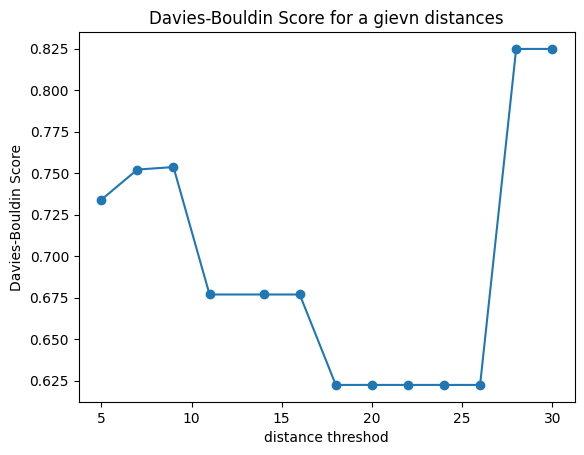

In [ ]:
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import fcluster
from sklearn.metrics import silhouette_score
from sklearn.metrics import davies_bouldin_score

distance_threshold = [5,7,9,11,14,16,18,20,22,24,26,28,30]
silhouette_scores = []
davies_bouldin_scores = []

for dist in distance_threshold:
      labels = fcluster(linkage_matrix, dist, criterion='distance')
      # Silhouette Score
      silhouette = silhouette_score(normalized_CDR_data, labels)
      silhouette_scores.append(silhouette)
      print(f'Silhouette Score: {silhouette:.4f}')

      # Davies-Bouldin Index
      davies_bouldin = davies_bouldin_score(normalized_CDR_data, labels)
      davies_bouldin_scores.append(davies_bouldin)
      print(f'Davies-Bouldin Index: {davies_bouldin:.4f}')




# Silhouette Score plot
# plt.subplot(1, 1, 1)
# plt.plot(distance_threshold, silhouette_scores, marker='o')
# plt.title('Silhouette Score for the given distances ')
# plt.xlabel('distance thresholds')
# plt.ylabel('Silhuette scores')

# Davies-Bouldin Score plot
# plt.subplot(1, 1, 1)
# plt.plot(distance_threshold, davies_bouldin_scores, marker='o')
# plt.title('Davies-Bouldin Score for a gievn distances')
# plt.xlabel('distance threshod')
# plt.ylabel('Davies-Bouldin Score')


 #Plot the dendrogram with the assigned labels
# plt.figure(figsize=(12, 6))
# dendrogram(linkage_matrix, truncate_mode='lastp', p=
#            len(CDR_data_train_hierClustered['cluster'].unique()))
# plt.title('Hierarchical Clustering Dendrogram')
# plt.show()

In [ ]:


cluster_df = pd.DataFrame({'Cluster': clusters})

# Concatenate the cluster assignments with the original data
result_df = pd.concat([pd.DataFrame(CDR_data), cluster_df], axis=1)

# Display the result
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
      display(result_df.head(2000))

result_df['Cluster'].value_counts()

,Tot_ma_rech_5m,Time_ma_rech5m,Tot_bal_rec5m,cnt_bal_5m,Cluster
0,3078,2,12,2.000000,1
1,5787,1,12,1.000000,1
2,1539,1,6,1.000000,1
3,947,1,12,2.000000,1
4,23496,8,42,7.000000,3
5,11744,8,18,3.000000,1
6,5787,1,6,1.000000,1
7,26095,9,42,7.000000,3
8,6164,4,24,4.000000,1
9,773,1,6,1.000000,1


1    159876
3     42085
2      1003
Name: Cluster, dtype: int64

In [ ]:
from scipy.cluster.hierarchy import linkage, cophenet, dendrogram
from scipy.spatial.distance import pdist
import fastcluster

# Function to compute CPCC for a batch
def compute_cpcc_for_batch(data_batch):
    linkage_matrix = linkage(data_batch, method='ward')
    coph_corr, _ = cophenet(linkage_matrix, pdist(data_batch))
    return coph_corr

# Batch processing parameters
batch_size =10000
num_batches = len(normalized_CDR_data) // batch_size

# Calculate CPCC for each batch
cpcc_values = []

for i in range(num_batches):
    start_idx = i * batch_size
    end_idx = (i + 1) * batch_size
    data_batch = normalized_CDR_data[start_idx:end_idx]

    cpcc_batch = compute_cpcc_for_batch(data_batch)
    cpcc_values.append(cpcc_batch)

# Aggregate results (for simplicity, just taking the mean here)
average_cpcc = np.mean(cpcc_values)

print(f"Average Cophenetic Correlation Coefficient: {average_cpcc}")






ModuleNotFoundError: No module named 'fastcluster'

In [ ]:

from sklearn.metrics import silhouette_score
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster


# Perform hierarchical clustering
# linkage_matrix = fastcluster.linkage_vector(normalized_CDR_data, method='ward')

# Choose the number of clusters (can be determined using methods like dendrogram or other criteria)
num_clusters = 4
labels = fcluster(linkage_matrix, num_clusters, criterion='maxclust')

# Calculate the silhouette score
# silhouette_avg = silhouette_score(normalized_CDR_data, labels)
# print(f"Silhouette Score: {silhouette_avg}")

 #Plot the dendrogram with the assigned clusters
# plt.figure(figsize=(12, 6))
# dendrogram(linkage_matrix, truncate_mode='lastp', p=num_clusters)
# plt.title('Hierarchical Clustering Dendrogram')
# plt.show()

cluster_df = pd.DataFrame({'Cluster': labels})

# Concatenate the cluster assignments with the original data
result_df = pd.concat([pd.DataFrame(CDR_data), cluster_df], axis=1)

# Display the result
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
      display(result_df.head(4000))

result_df['Cluster'].value_counts()

,Tot_ma_rech_5m,Time_ma_rech5m,Tot_bal_rec5m,cnt_bal_5m,Cluster
0,3078,2,12,2.000000,1
1,5787,1,12,1.000000,1
2,1539,1,6,1.000000,1
3,947,1,12,2.000000,1
4,23496,8,42,7.000000,3
5,11744,8,18,3.000000,1
6,5787,1,6,1.000000,1
7,26095,9,42,7.000000,3
8,6164,4,24,4.000000,1
9,773,1,6,1.000000,1


1    159876
3     29665
4     12420
2      1003
Name: Cluster, dtype: int64

2.3 DBSCAN


In [ ]:
from sklearn.cluster import DBSCAN
from statistics import mean
from sklearn.metrics import (silhouette_score,calinski_harabasz_score,
davies_bouldin_score)


batch_size = 30000

# Perform DBSCAN in batches
def batch_process():
  for i in range(0, len(normalized_CDR_data), batch_size):
        # call apply_DBSCAN method
          apply_DBSCAN(normalized_CDR_data[i:i+batch_size])

def apply_DBSCAN(batch_CDR_data):

    min_samples_values = [9,10,11,12,13,14,15]
    silhouette_scores = []
    calinski_harabasz_scores = []
    davies_bouldin_scores = []

    for min_samples in min_samples_values:
            dbscan = DBSCAN(eps=0.0169, min_samples=min_samples)
            labels = dbscan.fit_predict(batch_CDR_data)

             # Calculate Silhouette score
            silhouette_result = silhouette_score(batch_CDR_data, labels)
            silhouette_scores.append(silhouette_result)
            print(f"min_samples={min_samples}: Silhouette Score={silhouette_result}")

              # Calculate calinski_harabasz score
            calinski_harabasz = calinski_harabasz_score(batch_CDR_data, labels)
            calinski_harabasz_scores.append(calinski_harabasz)
            print(f"min_samples={min_samples}: calinski_harabasz score={calinski_harabasz:.4f}")

            # Calculate davies_bouldin score
            davies_bouldin = davies_bouldin_score(batch_CDR_data, labels)
            davies_bouldin_scores.append(davies_bouldin)
            print(f"min_samples={min_samples}: davies_bouldin_score={davies_bouldin:.4f}")

    # Silhouette Score plot
    # plt.subplot(1, 1, 1)
    # plt.plot(min_samples_values, silhouette_scores, marker='o')
    # plt.title('Silhouette score for a range of minimum sample ')
    # plt.xlabel('min_samples_values')
    # plt.ylabel('Silhuette scores')

  # calinski_harabasz score plot
    # plt.subplot(1, 1, 1)
    # plt.plot(min_samples_values, calinski_harabasz_scores_av, marker='o')
    # plt.title('calinski_harabasz score for a range of minimum samples')
    # plt.xlabel('min_samples_values')
    # plt.ylabel('calinski_harabasz score')

    # Davies-Bouldin Score plot
    # plt.subplot(1, 1, 1)
    # plt.plot(min_samples_values, davies_bouldin_scores, marker='o')
    # plt.title('Davies-Bouldin score for a range of minimum samples')
    # plt.xlabel('min_samples_values')
    # plt.ylabel('Davies-Bouldin Score')
# call the batch_process method
batch_process()


min_samples=9: calinski_harabasz score=2935.5599
min_samples=10: calinski_harabasz score=5850.6692
min_samples=11: calinski_harabasz score=5894.8000
min_samples=12: calinski_harabasz score=5945.6674
min_samples=14: calinski_harabasz score=6015.1664
min_samples=15: calinski_harabasz score=6044.7281
min_samples=9: calinski_harabasz score=2242.8443
min_samples=10: calinski_harabasz score=2216.1048
min_samples=11: calinski_harabasz score=3224.6139
min_samples=12: calinski_harabasz score=3180.3649
min_samples=13: calinski_harabasz score=6167.0802
min_samples=14: calinski_harabasz score=6191.3831
min_samples=15: calinski_harabasz score=6246.9559
min_samples=10: calinski_harabasz score=6254.8309
min_samples=11: calinski_harabasz score=3290.5035
min_samples=12: calinski_harabasz score=6427.4300
min_samples=13: calinski_harabasz score=6413.7964
min_samples=14: calinski_harabasz score=6475.2514
min_samples=15: calinski_harabasz score=6587.0103
min_samples=9: calinski_harabasz score=3352.4889
min

In [ ]:
from sklearn.cluster import DBSCAN
batch_size = 30000

# Perform DBSCAN in batches
def batch_process():
  for i in range(0, len(normalized_CDR_data), batch_size):
        # call apply_DBSCAN method
          apply_DBSCAN(normalized_CDR_data[i:i+batch_size])

labels = []
def apply_DBSCAN(batch_data):
  batch_labels = DBSCAN(eps=0.0169, min_samples=11).fit_predict(batch_data)
  labels = np.array(batch_labels)

batch_process()

In [ ]:
from sklearn.cluster import DBSCAN
# Define the batch size
batch_size = 30000
labels = []
# Perform DBSCAN in batches

for i in range(0, len(normalized_CDR_data), batch_size):
      batch_CDR_data= normalized_CDR_data[i:i+batch_size]

          # Create and fit DBSCAN model
      batch_labels = DBSCAN(eps=0.0169, min_samples=10).fit_predict(batch_CDR_data)

         # Combine batch labels
      labels.extend(batch_labels)

# Convert labels to numpy array
labels = np.array(labels)

In [ ]:
list(set(labels))

[0, 1, 2, -1]

In [ ]:
df = pd.DataFrame(normalized_CDR_data, columns=['Tot_ma_rech_5m',
                          'Time_ma_rech5m',
                          'Tot_bal_rec5m',
                          'cnt_bal_5m'])
# Create a DataFrame with the cluster assignments
cluster_df = pd.DataFrame({'Cluster': labels})

# Concatenate the cluster assignments with the original data
result_df = pd.concat([pd.DataFrame(CDR_data), cluster_df], axis=1)

# Display the result
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
      display(result_df.head(20000))

result_df['Cluster'].value_counts()


TypeError: cannot do positional indexing on RangeIndex with these indexers [        Tot_ma_rech_5m  Time_ma_rech5m  Tot_bal_rec5m   cnt_bal_5m  Cluster
0                 3078               2             12     2.000000        0
1                 5787               1             12     1.000000        0
2                 1539               1              6     1.000000        0
3                  947               1             12     2.000000        0
4                23496               8             42     7.000000        0
5                11744               8             18     3.000000        0
6                 5787               1              6     1.000000        0
7                26095               9             42     7.000000        0
8                 6164               4             24     4.000000        0
9                  773               1              6     1.000000        0
10                2312               2             12     2.000000        0
11                9065               2              6     1.000000        0
12               28979               7             24     4.000000        0
13                8649               7             30     5.000000        0
14               19185               8             42     7.000000        0
15                   0               0              6     1.000000        0
16                   0               0              6     1.000000        0
17                   0               0              6     1.000000        0
18                4618               3              6     1.000000        0
19                9539               2             12     2.000000        0
20               14380               8              6     1.000000        0
21                1546               2             12     2.000000        0
22                1543               2             12     2.000000        0
23                6164               4             24     4.000000        0
24                   0               0              6     1.000000        0
25               14566              19             30     5.000000        0
26                7114               9             30     5.000000        0
27                 770               1              6     1.000000        0
28               36489              10             48     8.000000        0
29                3086               2              6     1.000000        0
30                2666               3              6     1.000000        0
31                3855               4             18     3.000000        0
32                   0               0              6     1.000000        0
33               10781               7             12     2.000000        0
34                9636               6              6     1.000000        0
35                2320               2             12     2.000000        0
36               50839              20            108    15.000000        0
37               21009               6             30     4.000000        0
38                3078               2             12     2.000000        0
39                 773               1             12     2.000000        0
40                5148               9             36     6.000000        0
41               12048               2             12     2.000000        0
42                5576               4             24     4.000000        0
43               17503               9             48     8.000000        0
44               12413               6             30     4.000000        0
45               10020               9             24     4.000000        0
46                6158               6              6     1.000000        0
47                5606               2              6     1.000000        0
48               12144               3             12     1.000000        0
49               69993               9             12     2.000000        0
50                6557               2             18     2.000000        0
51               13861              11             60    10.000000        0
52                   0               0              6     1.000000        0
53                 173               1              6     1.000000        0
54               24632              16             18     2.000000        0
55               23089              15             78    13.000000        0
56                7893               9             18     3.000000        0
57                1546               2              6     1.000000        0
58                3086               2             18     3.000000        0
59               10312               3              6     1.000000        0
60               68309               9              6     1.000000        0
61                1924               1             12     2.000000        0
62                1539               1              6     1.000000        0
63                6156               4             24     4.000000        0
64               35647              11             54     6.000000        0
65                6356               2              6     1.000000        0
66               10009               9             36     6.000000        0
67               17545               8             60     8.000000        0
68               20500               2              6     1.000000        0
69               20976              16             78    13.000000        0
70               27086               5             48     5.000000        0
71                4040               2             12     2.000000        0
72                5387               3             12     2.000000        0
73                1539               1              6     1.000000        0
74                   0               0              6     1.000000        0
75                7307               3             18     3.000000        0
76                   0               0              6     1.000000        0
77                3178               1              6     1.000000        0
78                   0               0              6     1.000000        0
79               24267               7             48     6.000000        0
80                5594               3              6     1.000000        0
81                8478              10             18     3.000000        0
82                9635               3             12     2.000000        0
83                6163               5             18     3.000000        0
84               19463              18             12     2.000000        0
85                   0               0              6     1.000000        0
86               14816              18             60    10.000000        0
87               20093               5             18     3.000000        0
88                3086               4             24     4.000000        0
89                7110               6             42     7.000000        0
90               10789              14             42     7.000000        0
91                4617               3             18     3.000000        0
92               20708               8             54     9.000000        0
93               32466               7              6     1.000000        0
94                9430              10             24     4.000000        0
95                8570               7             12     2.000000        0
96                   0               0              6     1.000000        0
97               13272              13             72    12.000000        0
98                1539               1              6     1.000000        0
99               10496               5             24     4.000000        0
100               1547               1             12     2.000000        0
101               3112               4             12     2.000000        0
102              13682               4             30     5.000000        0
103              10967               5             24     4.000000        0
104               7711               2              6     1.000000        0
105               4621               3             18     3.000000        0
106                773               1              6     1.000000        0
107              36242               9             42     7.000000        0
108               8084               9             36     6.000000        0
109                  0               0              6     1.000000        0
110               4617               3              6     1.000000        0
111              11157              10             54     9.000000        0
112               6937               5             12     2.000000        0
113              12486               3             12     2.000000        0
114              44111              19             78    13.000000        0
115              10019              10             36     6.000000        0
116                  0               0             12     2.000000        0
117               2494               2             12     2.000000        0
118               3089               4             30     5.000000        0
119               4717               2             18     2.000000        0
120              13860              12             48     5.000000        0
121               8051               9             36  2340.280120       -1
122               1547               1              6     1.000000        0
123              15400               9             36     6.000000        0
124               6542               4             30     3.000000        0
125              25989              10             24     4.000000        0
126               3178               1             12     2.000000        0
127               2310               3              0     0.000000        0
128              10719               2              6     1.000000        0
129               6380               4              6     1.000000        0
130              81144              34            204    25.000000       -1
131              20998               6              6     1.000000        0
132                  0               0             12     1.000000        0
133                  0               0              6     1.000000        0
134               1539               1              6     1.000000        0
135              20992              19             30     4.000000        0
136              15822               8             30     5.000000        0
137               2309               1              6     1.000000        0
138               3079               3              6     1.000000        0
139               4821               2             12     2.000000        0
140               6161               6              6     1.000000        0
141              12530               9             30     5.000000        0
142              47710              30            162    20.000000        0
143               7907               3              6     1.000000        0
144              10951               7             36     6.000000        0
145               8658               6              6     1.000000        0
146              88845              17             48     8.000000        0
147              18774               8             60     8.000000        0
148               8000               1              6     1.000000        0
149                770               1              0     0.000000        0
150              41113              25             24     3.000000        0
151               7304              10             42     7.000000        0
152               1540               2             18     3.000000        0
153              37002              10              6     1.000000        0
154              10197               7             30     5.000000        0
155               3853               5             12     2.000000        0
156               4048               1             12     2.000000        0
157               2235               6             12     2.000000        0
158              11744               6             24     3.000000        0
159               9620               6             30     4.000000        0
160              39748               4             24     3.000000        0
161              17346               8              6     1.000000        0
162              14960               2             12     2.000000        0
163              11907              11             54     9.000000        0
164              36955              16             84    14.000000        0
165               2666               4             12     2.000000        0
166               1892               4              6     1.000000        0
167              65292              17             24     4.000000        0
168              11274               3              6     1.000000        0
169                  0               0              6     1.000000        0
170               2309               1              6     1.000000        0
171               1543               2             12     2.000000        0
172               2309               2             18     2.000000        0
173              27350               9             36     6.000000        0
174                  0               0              6     1.000000        0
175                  0               0             12     1.000000        0
176               7702               9             12     2.000000        0
177               7713               8             12     2.000000        0
178              59874               7             12     2.000000        0
179              24849              14             36     6.000000        0
180              14052               6             42     5.000000        0
181              18576              11             48     8.000000        0
182                  0               0              6     1.000000        0
183               6834               3             12     2.000000        0
184               1546               2              6     1.000000        0
185               3862               5             12     2.000000        0
186              11289               3             12     2.000000        0
187              19182               5              0     0.000000        0
188              15634               5             30     5.000000        0
189               9547               2              6     1.000000        0
190              10038               8             36     6.000000        0
191              12048               2              6     1.000000        0
192              16291               4             24     4.000000        0
193               5410               5             12     2.000000        0
194               5787               1              6     1.000000        0
195               2317               2             12     2.000000        0
196               3424               4             12     2.000000        0
197               1539               1              6     1.000000        0
198               3085               3             12     2.000000        0
199               3092               4             30     5.000000        0
200               3858               4             18     3.000000        0
201              65483              26            132    21.000000        0
202               2312               2              6     1.000000        0
203              16763               7              6     1.000000        0
204               9234               6             36     6.000000        0
205              20000               2             12     2.000000        0
206               8000               1              6     1.000000        0
207               1539               1              6     1.000000        0
208              74307              11             66     8.000000        0
209               3259               3             12     2.000000        0
210              67065              15             48     8.000000        0
211              27053              23             60     9.000000        0
212              40879               9              0     0.000000        0
213              68044              12             48     5.000000        0
214                  0               0              6     1.000000        0
215               5387               3             24     4.000000        0
216              31113              19             48     8.000000        0
217                770               1              6     1.000000        0
218              19625               7             42     5.000000        0
219               8669               7             24     4.000000        0
220              10033              12             48     8.000000        0
221                  0               0              6     1.000000        0
222              10200              11             30     5.000000        0
223               3256               3             18     3.000000        0
224               9448               6             18     3.000000        0
225               1720               1              6     1.000000        0
226               3086               2             30     5.000000        0
227               7904               6             12     2.000000        0
228                  0               0              6     1.000000        0
229               3083               4             12     2.000000        0
230               8000               1              6     1.000000        0
231               3087               3              6     1.000000        0
232               4625               3             12     2.000000        0
233                  0               0              6     1.000000        0
234              12128               5             30     3.000000        0
235               6173               7              6     1.000000        0
236                  0               0              6     1.000000        0
237               2593               1              6     1.000000        0
238               9717               3             18     3.000000        0
239              14659               5              6     1.000000        0
240                  0               0              6     1.000000        0
241                946               2              6     1.000000        0
242               2309               1              6     1.000000        0
243              10067               4              6     1.000000        0
244               2309               2             12     2.000000        0
245              13113               3             18     2.000000        0
246               9547               2              6     1.000000        0
247               3086               4             30     5.000000        0
248              10012               7             24     4.000000        0
249               5389               6              6     1.000000        0
250              14855              10             18     3.000000        0
251              14357               3              6     1.000000        0
252              11608               2             12     2.000000        0
253              28000               3             12     2.000000        0
254              14730               9             36     6.000000        0
255               6541               4             12     2.000000        0
256              93939              13             24     4.000000        0
257              17338              11             66    11.000000        0
258              27191              33             36     6.000000        0
259                  0               0              6     1.000000        0
260              10204               5              6     1.000000        0
261              10810              14             48     8.000000        0
262               6271               3              0     0.000000        0
263                  0               0              6     1.000000        0
264               1539               1              6     1.000000        0
265              22379               9             30     5.000000        0
266              24072              19             90    15.000000        0
267              59285               9             60     8.000000        0
268              12667               9             30     5.000000        0
269              10000               1              6     1.000000        0
270               3078               2             12     2.000000        0
271               6177               7             12     2.000000        0
272               7353               2              6     1.000000        0
273                  0               0              6     1.000000        0
274              26189              34             18     3.000000        0
275              15165              11             42     7.000000        0
276               7696               4              6     1.000000        0
277                770               1             12     2.000000        0
278               3852               4             12     2.000000        0
279              82238              30             48     8.000000       -1
280               9506               3              6     1.000000        0
281              12527               6             24     4.000000        0
282              22549               8             48     8.000000        0
283              26936              17             60    10.000000        0
284              45535               5              6     1.000000        0
285               3078               2             12     2.000000        0
286               6927               3             12     2.000000        0
287               7123               5             24     4.000000        0
288               3849               4             12     1.000000        0
289                  0               0              6     1.000000        0
290               9444               6             24     3.000000        0
291               5951               3             12     2.000000        0
292               5750               4             12     2.000000        0
293               1894               2              6     1.000000        0
294               3859               3             12     2.000000        0
295              22556              12             60     9.000000        0
296              10405               3             24     4.000000        0
297               7702               6             36     6.000000        0
298              11544               8             18     3.000000        0
299               1547               1              6     1.000000        0
300              15245               5              6     1.000000        0
301               4638               6             18     3.000000        0
302                770               1             12     1.000000        0
303               3086               2              6     1.000000        0
304               6157               4             18     2.000000        0
305                  0               0              6     1.000000        0
306               8307               3             18     3.000000        0
307               7709              10             42     7.000000        0
308                  0               0              6     1.000000        0
309              10309               3             12     1.000000        0
310                  0               0              6     1.000000        0
311              10309               2              6     1.000000        0
312              13952               9             36     5.000000        0
313                  0               0              6     1.000000        0
314               7734               6             18     2.000000        0
315              31956              13             60    10.000000        0
316               3851               3             18     3.000000        0
317              15738               3              6     1.000000        0
318               6338               3             24     4.000000        0
319              33801               3             12     2.000000        0
320               1540               2              6     1.000000        0
321              10405               3             18     3.000000        0
322                943               2              6     1.000000        0
323               2310               3             18     3.000000        0
324               2706               2              6     1.000000        0
325              19651              17             60    10.000000        0
326              20427               8             42     6.000000        0
327              12352              15             24     4.000000        0
328               7138               2              6     1.000000        0
329              12629               4              6     1.000000        0
330              27437              13             54     8.000000        0
331               6170               6             12     2.000000        0
332               8000               1              6     1.000000        0
333              28498              19             48     8.000000        0
334               4638               6              6     1.000000        0
335                770               1             12     2.000000        0
336               6934               5             12     2.000000        0
337               3089               4             30     5.000000        0
338               2493               3             12     2.000000        0
339                773               1              6     1.000000        0
340               6934               5              6     1.000000        0
341                  0               0              6     1.000000        0
342              10785               8             36     6.000000        0
343                  0               0              6     1.000000        0
344              13013               3             18     3.000000        0
345               5019               5             18     3.000000        0
346                  0               0              6     1.000000        0
347                  0               0              6     1.000000        0
348              10213              12             48     8.000000        0
349              46792              15             60     9.000000        0
350              57579              13             24     2.000000        0
351              26669              12             36     6.000000        0
352               3848               2             12     2.000000        0
353                  0               0              6     1.000000        0
354               7714               9             54     9.000000        0
355              13664               7             18     3.000000        0
356              34309               5             18     3.000000        0
357              11982               6             12     2.000000        0
358              35190               7             24     4.000000        0
359               8851               5             36     6.000000        0
360               3193               1              6     1.000000        0
361               1723               3              6     1.000000        0
362              14937               4             30     4.000000        0
363               3258               4             12     2.000000        0
364              12310               5             24     4.000000        0
365              10805              12             30     5.000000        0
366              34316              23             54     9.000000        0
367               5488               4              6     1.000000        0
368                  0               0              6     1.000000        0
369               2320               2             12     2.000000        0
370               3850               5             36     6.000000        0
371                  0               0              6     1.000000        0
372               8665               4             30     5.000000        0
373               1924               1             12     2.000000        0
374               7700              10             24     3.000000        0
375               1547               1              6     1.000000        0
376              16942               7             36     6.000000        0
377               3078               2             18     3.000000        0
378              15337               4             36     6.000000        0
379              11554               8              6     1.000000        0
380               9234               6             36     6.000000        0
381              24000               3              6     1.000000        0
382               2320               2              6     1.000000        0
383               2309               1              6     1.000000        0
384               1539               1             12     2.000000        0
385               2313               3             12     2.000000        0
386               1720               1              6     1.000000        0
387               2662               5             30     5.000000        0
388               4623               6              6     1.000000        0
389               9614               7             18     3.000000        0
390               7796               5              6     1.000000        0
391              43948               8             24     4.000000        0
392               7795               4             36     6.000000        0
393               9812               4             18     3.000000        0
394                  0               0              6     1.000000        0
395               1543               2              6     1.000000        0
396               4621               3             12     2.000000        0
397               1539               1              6     1.000000        0
398                  0               0              6     1.000000        0
399                  0               0              6     1.000000        0
400                  0               0              6     1.000000        0
401              11644               5             12     2.000000        0
402                  0               0             12     2.000000        0
403              10389               6             12     1.000000        0
404               6160               8             42     7.000000        0
405                  0               0              6     1.000000        0
406              16219              18             60     9.000000        0
407               6931               7             12     2.000000        0
408              37457              27             90    15.000000        0
409               5387               3             12     2.000000        0
410                947               1              6     1.000000        0
411              16758               8             30     5.000000        0
412                  0               0              6     1.000000        0
413              14631               8             12     2.000000        0
414               2313               3              6     1.000000        0
415               6258               5             18     2.000000        0
416              17032               7             48     8.000000        0
417               3267               2             12     2.000000        0
418               1546               2             12     2.000000        0
419               2319               3              6     1.000000        0
420               5387               3             12     2.000000        0
421              11078               3             18     3.000000        0
422              27000              25             36     6.000000        0
423              26282               7             30     5.000000        0
424              14630               8             54     9.000000        0
425              24000               3             30     4.000000        0
426                  0               0              6     1.000000        0
427                773               1              6     1.000000        0
428              10583               6             36     6.000000        0
429                  0               0              6     1.000000        0
430               4048               1             18     2.000000        0
431               8000               1              0     0.000000        0
432                770               1             12     2.000000        0
433              10975               7             36     6.000000        0
434               1546               2             18     3.000000        0
435              11570               8             18     3.000000        0
436               7704               6             48     6.000000        0
437               4818               2              6     1.000000        0
438              10020               9              6     1.000000        0
439              10013               6             30     5.000000        0
440               3866               4             30     5.000000        0
441              10787               9              0     0.000000        0
442              45617              23            102    12.000000        0
443              12427               7             18     3.000000        0
444               7289               5             24     4.000000        0
445                  0               0              6     1.000000        0
446              25797              22             66     7.000000        0
447               6164               4             12     2.000000        0
448               9620               5             24     4.000000        0
449               5388               5             18     3.000000        0
450               8000               1             18     3.000000        0
451               2489               4             12     2.000000        0
452               3848               3             12     2.000000        0
453               1540               2             12     2.000000        0
454                  0               0              6     1.000000        0
455              82870              70            300    50.000000       -1
456              43939               8             30     5.000000        0
457               3851               3             18     3.000000        0
458              13887               6              6     1.000000        0
459                  0               0              6     1.000000        0
460               3078               2             18     3.000000        0
461               5102               2              6     1.000000        0
462              26000               3              6     1.000000        0
463               3267               3             18     3.000000        0
464               1539               1              6     1.000000        0
465               8655              12             30     5.000000        0
466               5606               2              6     1.000000        0
467               6958               8             18     3.000000        0
468              10425               5              6     1.000000        0
469               6158               5             12     1.000000        0
470               7290               9             24     4.000000        0
471              11559               7             24     3.000000        0
472               6186               5             24     4.000000        0
473                947               1              6     1.000000        0
474              10885               6              6     1.000000        0
475               6926               4              0     0.000000        0
476               8000               1              6     1.000000        0
477               6350               5              6     1.000000        0
478               3859               2              6     1.000000        0
479              10204               5             30     5.000000        0
480              16757               8             36     6.000000        0
481               3078               2             12     2.000000        0
482              23048               5             30     3.000000        0
483              31052               4             24     4.000000        0
484               9620               5              6     1.000000        0
485              86000               9             54     9.000000        0
486              28617               9              6     1.000000        0
487              11874               1             12     2.000000        0
488              10405               4              0     0.000000        0
489              33270              14             90    13.000000        0
490              10774               6             48     8.000000        0
491              10951               8             48     8.000000        0
492               5399               3             12     2.000000        0
493               8565               5             12     1.000000        0
494               2313               3              6     1.000000        0
495              27669               5             18     3.000000        0
496               8299               2             12     2.000000        0
497              35075               3             30     4.000000        0
498                  0               0              6     1.000000        0
499               4917               1              6     1.000000        0
500               6927               3             18     3.000000        0
501                773               1             12     2.000000        0
502               7203               4             24     4.000000        0
503              19327               2              6     1.000000        0
504                770               1              6  3565.786503       -1
505              15136               6             24     4.000000        0
506                  0               0              6     1.000000        0
507              27415              34            138    23.000000        0
508              21308              17             66    11.000000        0
509              20417              14             60    10.000000        0
510              11058               7             12     2.000000        0
511              34283              17             78    13.000000        0
512               7299               8             24     4.000000        0
513                  0               0              6     1.000000        0
514               1719               3              6     1.000000        0
515              22414              11             36     6.000000        0
516               5414               4              6     1.000000        0
517                  0               0              6     1.000000        0
518               2320               2             18     3.000000        0
519               2694               2             12     2.000000        0
520              22088              14             36     6.000000        0
521               4806               3              6     1.000000        0
522              18775              10             24     4.000000        0
523              29502               9             48     5.000000        0
524                  0               0              6     1.000000        0
525               3079               3             18     3.000000        0
526                  0               0              6     1.000000        0
527               6360               3              6     1.000000        0
528              25125              10             12     1.000000        0
529              18923               5             18     3.000000        0
530              17252               8              6     1.000000        0
531              50000               5             12     1.000000        0
532                  0               0              6     1.000000        0
533               6936               6             18     3.000000        0
534              10777               7             36     6.000000        0
535                  0               0              6     1.000000        0
536              68811              40            132    19.000000        0
537               1547               1              6     1.000000        0
538               1539               1              6     1.000000        0
539              16530              22             84    14.000000        0
540               7700               5             30     5.000000        0
541               3251               3             12     2.000000        0
542              13110               8             42     6.000000        0
543                  0               0              6     1.000000        0
544               4048               1              6     1.000000        0
545               8219               5             12     2.000000        0
546               8085               5             36     6.000000        0
547              12854              12             36     6.000000        0
548              16173              11             54     9.000000        0
549                947               1             12     2.000000        0
550               1924               1             18     3.000000        0
551              25409              12             54     9.000000        0
552               4375               5             12     2.000000        0
553              10890               8             54     9.000000        0
554               3078               2              6     1.000000        0
555               1539               1              6     1.000000        0
556                770               1              6     1.000000        0
557              52166              12             36     6.000000        0
558              50847              21             30     3.000000        0
559                  0               0              6     1.000000        0
560                  0               0              6     1.000000        0
561              53764              22             18     2.000000        0
562              10304               4             24     4.000000        0
563              19871               8             12     2.000000        0
564              19234               6             24     4.000000        0
565              15789              17             42     7.000000        0
566               2312               2             12     2.000000        0
567              14174              11             36     6.000000        0
568               1546               2             12     2.000000        0
569               8666               3             12     2.000000        0
570             167526              17              0     0.000000       -1
571               1547               1             12     2.000000        0
572               3848               2             12     2.000000        0
573              14648              19              6     1.000000        0
574               1540               2              6     1.000000        0
575               1547               1              6     1.000000        0
576              17011              12             24     4.000000        0
577              22023              18              6     1.000000        0
578               8000               1              6     1.000000        0
579               4629               4             24     4.000000        0
580               2320               1             12     2.000000        0
581                  0               0             12     1.000000        0
582              30663               8             30     5.000000        0
583              17700              10             66    10.000000        0
584              17330               7             24     2.000000        0
585              17332               6             18     3.000000        0
586               1539               1             12     2.000000        0
587               3079               3             12     2.000000        0
588               6367               4             18     3.000000        0
589               2309               1              6     1.000000        0
590               6171               7              0     0.000000        0
591               3078               2              6     1.000000        0
592              15399              11             24     4.000000        0
593                770               1              6     1.000000        0
594              10010              10             54     9.000000        0
595                770               1              6     1.000000        0
596                  0               0              6     1.000000        0
597              19789              13             54     9.000000        0
598              22914               5              6     1.000000        0
599               6167               7             36     6.000000        0
600              32000               4              6     1.000000        0
601              13637              17            102    17.000000        0
602               9238               6             18     3.000000        0
603               1539               1              6     1.000000        0
604               6357               2             12     1.000000        0
605               6164               4             12     2.000000        0
606               9354               5             18     3.000000        0
607              13892              17             90    15.000000        0
608               1540               2             12     2.000000        0
609              13684               5             12     2.000000        0
610               5487               2             18     3.000000        0
611               4205               5             24     4.000000        0
612              13340               2              6     1.000000        0
613               1333               1             12     2.000000        0
614              18871              17             30     4.000000        0
615               3852               4             12     2.000000        0
616              22641               6             24     4.000000        0
617              22114              11             42     7.000000        0
618                  0               0              6     1.000000        0
619              14815              13             66    11.000000        0
620               8665               4             12     2.000000        0
621                  0               0              6     1.000000        0
622               7707               5             30     5.000000        0
623              18480              12             12     1.000000        0
624               2312               2              6     1.000000        0
625              26191               6             30     4.000000        0
626               8000               1              6     1.000000        0
627               3852               3              6     1.000000        0
628               8480               7             18     2.000000        0
629              13498               3             18     2.000000        0
630               1539               1              6     1.000000        0
631              15526               2             12     1.000000        0
632               7103               5             30     5.000000        0
633              21181               5             24     4.000000        0
634                  0               0              6     1.000000        0
635               7245               2             12     2.000000        0
636              12312               8             60    10.000000        0
637              16000               2             18     3.000000        0
638               7896               3              6     1.000000        0
639               4717               2              6     1.000000        0
640              21547              14             54     9.000000        0
641                770               1              6     1.000000        0
642              47887              15             78     8.000000        0
643               6181               8             30     5.000000        0
644                  0               0              6     1.000000        0
645              19267              17             30     5.000000        0
646               9250               6             18     3.000000        0
647               3086               2              6     1.000000        0
648               1539               1              6     1.000000        0
649              33400               4             12     2.000000        0
650               7695               5              6     1.000000        0
651               1924               1              6     1.000000        0
652              22270               9             18     3.000000        0
653               5405               5              6     1.000000        0
654               4987               4             18     3.000000        0
655              20059              14             36     6.000000        0
656              15037               4             18     3.000000        0
657              33178               4             30     3.000000        0
658               6156               4             24     4.000000        0
659              11661               7             18     3.000000        0
660              13498               3             12     2.000000        0
661                  0               0              6     1.000000        0
662              15893               9             48     8.000000        0
663              16284              10             60    10.000000        0
664               5403               6             42     7.000000        0
665               3085               3             18     3.000000        0
666              17182              13              6     1.000000        0
667               5754               6             30     4.000000        0
668               2309               2             24     4.000000        0
669              22424              21              6     1.000000        0
670              40452              14             24     4.000000        0
671               3079               2              6     1.000000        0
672               5606               2              6     1.000000        0
673               4740               2             12     2.000000        0
674              31874               3             24     4.000000        0
675               3093               3              6     1.000000        0
676               9072               3             24     4.000000        0
677              27181              10             12     2.000000        0
678               7710               6              6     1.000000        0
679               1539               1              6     1.000000        0
680               1539               1             12     2.000000        0
681               4718               3             18     3.000000        0
682               4638               6             24     4.000000        0
683              52180              17             84    14.000000        0
684               3079               3              6     1.000000        0
685                770               1              6     1.000000        0
686              17631               6             12     2.000000        0
687              56133              39            168    24.000000       -1
688                  0               0             12     1.000000        0
689               8566               5             36     6.000000        0
690              19127               3             12  2687.154150       -1
691               1924               1              6     1.000000        0
692              24061              30             42     7.000000        0
693               5568               7             12     2.000000        0
694               5387               4             24     4.000000        0
695               4025               3             18     3.000000        0
696               5495               3             12     2.000000        0
697               4796               5             12     2.000000        0
698                  0               0              6     1.000000        0
699               2320               1              6     1.000000        0
700               8054               7             30     5.000000        0
701               4622               5             30     5.000000        0
702               8947               2              6     1.000000        0
703              24000               3              6     1.000000        0
704               3262               5             30     5.000000        0
705                770               1              6     1.000000        0
706               9590               8             42     7.000000        0
707               3472               2              6     1.000000        0
708              26670              11             12     2.000000        0
709              10784               5             18     3.000000        0
710              13894               3              6     1.000000        0
711               7126               3             18     3.000000        0
712              12128               5             12     2.000000        0
713               6926               4             24     4.000000        0
714              14617               4             30     4.000000        0
715                  0               0              6     1.000000        0
716               8665               4              6     1.000000        0
717              15410              11             42     7.000000        0
718               1539               1              6     1.000000        0
719                  0               0              6     1.000000        0
720              18004              20             42     7.000000        0
721              56540              15             12     1.000000        0
722               3859               5             12     2.000000        0
723               1924               1              6     1.000000        0
724               4029               4             12     2.000000        0
725                  0               0              6     1.000000        0
726               3080               4             12     2.000000        0
727                770               1             12     2.000000        0
728               4033               3             24     4.000000        0
729                  0               0             12     2.000000        0
730               2310               3              6     1.000000        0
731               6926               4              6     1.000000        0
732               5398               3             18     3.000000        0
733              56296              20             72    12.000000        0
734              36283              22             84    14.000000        0
735               5396               7             30     5.000000        0
736              95757              12             48     6.000000        0
737                  0               0              6     1.000000        0
738               5394               4              6     1.000000        0
739               3255               3             12     2.000000        0
740              21000              24             72    12.000000        0
741                770               1              6     1.000000        0
742              15998               4              6     1.000000        0
743               5014               2              6     1.000000        0
744              10878               5              6     1.000000        0
745               7697               7             36     6.000000        0
746             134065              35             42     7.000000       -1
747               8473               5             18     3.000000        0
748              16096               3             12     2.000000        0
749               3082               3             12     1.000000        0
750              23745              15             60    10.000000        0
751                  0               0              6     1.000000        0
752              17880              13             66    11.000000        0
753              10773               7             30     5.000000        0
754               8822               7             30     5.000000        0
755               2309               1              6     1.000000        0
756               3082               3             18     3.000000        0
757               3642               2             12     2.000000        0
758                  0               0              6     1.000000        0
759               1547               1              6     1.000000        0
760               9455               7             30     5.000000        0
761                  0               0              6     1.000000        0
762              11574               2             12     2.000000        0
763               3856               2             12     2.000000        0
764              19865              14             66     9.000000        0
765              40000               5             12     2.000000        0
766             161746              28             36     6.000000       -1
767               6178               8              6     1.000000        0
768              20413               9             24     4.000000        0
769               3178               1              6     1.000000        0
770                  0               0              6     1.000000        0
771               1539               1             12     2.000000        0
772              28917               9             12     1.000000        0
773               4067               1              6     1.000000        0
774               1540               2             12     2.000000        0
775              78915              27            132    22.000000        0
776                  0               0              6     1.000000        0
777               3088               4             24     4.000000        0
778              23334               8             36     6.000000        0
779                946               2              6     1.000000        0
780               1539               1              6     1.000000        0
781               4031               5             18     3.000000        0
782               9249               7             24     4.000000        0
783               1546               2              6     1.000000        0
784              39653              21             72    12.000000        0
785               1539               1             12     2.000000        0
786             120254              19             96    16.000000       -1
787               2309               1             12     2.000000        0
788              12536               6              6     1.000000        0
789               5003               4             18     2.000000        0
790              27184              24             90    15.000000        0
791             133735              37            114    19.000000       -1
792               3862               5             12     1.000000        0
793               3856               5             24     4.000000        0
794               2310               3             12     2.000000        0
795              26301              10             12     1.000000        0
796              17047               7              6     1.000000        0
797               3467               1              6     1.000000        0
798               1540               2             12     2.000000        0
799              10482               4             12     2.000000        0
800               6545               3             12     2.000000        0
801              10012               3             30     5.000000        0
802               6157               5             24     4.000000        0
803               2320               2             18     3.000000        0
804               4979               5             24     4.000000        0
805               1539               1             12     2.000000        0
806               4795               6             24     4.000000        0
807              20839               3              6     1.000000        0
808                  0               0              6     1.000000        0
809                  0               0              6     1.000000        0
810               9252              12             60    10.000000        0
811               6164               4              6     1.000000        0
812               8778               8             30     5.000000        0
813              10785               7             12     2.000000        0
814               2317               2              6     1.000000        0
815               7888              11             42     7.000000        0
816                770               1             12     2.000000        0
817              15341               4             12     1.000000        0
818              15021              15             36     5.000000        0
819              45577              15             24     4.000000        0
820              12798               6             36     6.000000        0
821              19755               7             24     2.000000        0
822              13514              11             18     3.000000        0
823               4021               4             12     2.000000        0
824              24983              19             72    12.000000        0
825               1546               2              6     1.000000        0
826               5595               2              6     1.000000        0
827               1924               1             12     2.000000        0
828              32853              11             54     9.000000        0
829              54278               8             36     6.000000        0
830               2319               3              6     1.000000        0
831              48714              24             30     5.000000        0
832               3857               2             12     2.000000        0
833              10874               6             36     6.000000        0
834              29419              23             60     9.000000        0
835               2309               1              6     1.000000        0
836              31348               6             36     4.000000        0
837               1293               3             12     2.000000        0
838               3366               2              6     1.000000        0
839                  0               0              6     1.000000        0
840               1539               1             12  2277.924701       -1
841               1539               1              6  1962.123401       -1
842              47765               9             24     4.000000        0
843               4626               4             24     4.000000        0
844               1892               4             12     2.000000        0
845                  0               0              6     1.000000        0
846               1539               1              6     1.000000        0
847              24504               9             36     6.000000        0
848              19322              25              6     1.000000        0
849              17034              12             48     8.000000        0
850               3849               4             18     3.000000        0
851              28285              10             66    10.000000        0
852              11078               3             18     3.000000        0
853               6342               4             18     3.000000        0
854               6934               4             12     2.000000        0
855              27670              11             36     5.000000        0
856             113808              24            156    13.000000       -1
857              20371              17             66    11.000000        0
858               4994               3             12     2.000000        0
859                  0               0              6     1.000000        0
860              18100               8             12     2.000000        0
861              31564               6             24     4.000000        0
862               1540               2             12     2.000000        0
863              11725              13             42     7.000000        0
864               9628               6             36     6.000000        0
865               8504               7             42     7.000000        0
866                773               1             12     2.000000        0
867               1924               1              6     1.000000        0
868               7696               6             30     5.000000        0
869               2319               3              6     1.000000        0
870               6337               4             24     4.000000        0
871               6161               6             24     4.000000        0
872              21169              13             54     6.000000        0
873              41874               4             24     3.000000        0
874               4902               2             12     2.000000        0
875               4633               3              6     1.000000        0
876                  0               0              6     1.000000        0
877                773               1              6     1.000000        0
878               2309               1             12     2.000000        0
879              11550              15             30     5.000000        0
880                770               1              6     1.000000        0
881              26215               7             36     6.000000        0
882              18096               3              6     1.000000        0
883              13106              13             54     9.000000        0
884               9266               8             42     7.000000        0
885               3259               3             12     2.000000        0
886                947               1              6     1.000000        0
887              15615              17             42     7.000000        0
888                  0               0              6     1.000000        0
889              11874               1              6     1.000000        0
890              22916              10             12     1.000000        0
891               1543               2             12     2.000000        0
892                770               1              6     1.000000        0
893              11906               8             30     5.000000        0
894               9616               4             12     2.000000        0
895               8680               3              6     1.000000        0
896               3848               2             12     2.000000        0
897                770               1              6     1.000000        0
898              23095              13             78    12.000000        0
899               8565               5             18     3.000000        0
900               1539               1              6     1.000000        0
901               6172               6             12     2.000000        0
902              15215               7             24     4.000000        0
903               5395               5             12     2.000000        0
904                  0               0              6     1.000000        0
905               3848               3             18     3.000000        0
906               5787               1             12     2.000000        0
907                  0               0              6     1.000000        0
908              10758               8             30     5.000000        0
909              23286              18             90    15.000000        0
910               4968               7             18     3.000000        0
911               7701               8             30     5.000000        0
912              28961              13            120    14.000000        0
913              12531               8              6     1.000000        0
914              10803               9             42     7.000000        0
915                770               1             12     2.000000        0
916               6187               3             12     2.000000        0
917               5395               4             24     4.000000        0
918               8099               3             24     3.000000        0
919              27939              30             48     8.000000        0
920               6543               6             24     3.000000        0
921              20240              20            126    21.000000        0
922               7707               4             12     2.000000        0
923              14534               7             24     4.000000        0
924              19763               7             42     6.000000        0
925              18330               3             18     3.000000        0
926                  0               0              6     1.000000        0
927               3948               2             24     4.000000        0
928              34486              17             78    12.000000        0
929              23147              26             60    10.000000        0
930               5814               1              6     1.000000        0
931              36502              15             18     2.000000        0
932              23101              25             48     8.000000        0
933               6936               6             18     3.000000        0
934              10005               8             12     2.000000        0
935                  0               0              6     1.000000        0
936              16746               8             24     4.000000        0
937               7026               3              6     1.000000        0
938              44654              33            162    21.000000        0
939               7892               6             24     4.000000        0
940               5395               4             18     3.000000        0
941               7211               4              6     1.000000        0
942              11587              11             42     7.000000        0
943               3262               5             18     3.000000        0
944              16770               3              6     1.000000        0
945               8489               9             24     4.000000        0
946               6587               2             12     2.000000        0
947               3178               1              6     1.000000        0
948              18483              18             48     7.000000        0
949               4623               6             18     2.000000        0
950                  0               0              6     1.000000        0
951              10784               8             12     2.000000        0
952              47400               6             30     4.000000        0
953                  0               0              6     1.000000        0
954               6156               4              6     1.000000        0
955              21379              10             36     6.000000        0
956              19544               7             30     3.000000        0
957               5006               4             30     5.000000        0
958              38926              11             60     7.000000        0
959              18834              20             96    16.000000        0
960               2486               2              6     1.000000        0
961              19256              22             84    10.000000        0
962               3848               2             12     2.000000        0
963              10439               4              0     0.000000        0
964               1540               2              6     1.000000        0
965              10810              11              0     0.000000        0
966              30164               7             42     7.000000        0
967               4642               6              6     1.000000        0
968              48242              22             66    11.000000        0
969              19068               6             12     1.000000        0
970               1539               1              6     1.000000        0
971               1543               2             12     2.000000        0
972                  0               0              6     1.000000        0
973              20936              24             24     2.000000        0
974                770               1              6     1.000000        0
975                  0               0              6     1.000000        0
976             145709              19             60     8.000000       -1
977                770               1              6     1.000000        0
978              16000               1              0     0.000000        0
979              10971               7             30     5.000000        0
980              16100               6             18     3.000000        0
981               6343               6              6     1.000000        0
982              12617               4              6     1.000000        0
983               5587               2              0     0.000000        0
984                  0               0              6     1.000000        0
985               3078               2             12     2.000000        0
986                  0               0              6     1.000000        0
987              10779              10             60    10.000000        0
988              20046               6              6     1.000000        0
989               3178               1             12     2.000000        0
990               9438               5              6     1.000000        0
991               2310               3             30     4.000000        0
992              41061               7             12     2.000000        0
993               5010               5             30     5.000000        0
994               6938               8             18     3.000000        0
995               3432               4             18     3.000000        0
996               6164               4              6     1.000000        0
997               8770               2             18     3.000000        0
998               7705               9             12     2.000000        0
999              12498              11             66    11.000000        0
1000               947               1              6     1.000000        0
1001             95588              31             42     4.000000       -1
1002              2320               1              6     1.000000        0
1003              1547               1              6     1.000000        0
1004             17834               3              6     1.000000        0
1005             13771               3              6     1.000000        0
1006             19654              26            120    20.000000        0
1007             24896               8             30     5.000000        0
1008              5387               3             18     3.000000        0
1009              4805               5             18     3.000000        0
1010               770               1              6     1.000000        0
1011             20973              21             90    15.000000        0
1012              5768               3             12     2.000000        0
1013              2309               1              6     1.000000        0
1014             17537               8             30     5.000000        0
1015             27467               4             30     5.000000        0
1016             17795               5             30     4.000000        0
1017             12618              14             72    12.000000        0
1018             20048               3             18     2.000000        0
1019              3642               2             12     2.000000        0
1020              4048               1              6     1.000000        0
1021             11543               7             24     4.000000        0
1022              1539               1              6     1.000000        0
1023              1547               1              6     1.000000        0
1024               173               1             18     3.000000        0
1025              5744               6             18     3.000000        0
1026               770               1              6     1.000000        0
1027              7718               6              6     1.000000        0
1028                 0               0              6     1.000000        0
1029              9249              12             12     2.000000        0
1030              8082               6             12     2.000000        0
1031              1540               2             12     2.000000        0
1032             16230               4              6     1.000000        0
1033             22679              19             78    13.000000        0
1034              7904               3             24     3.000000        0
1035             24368              13             18     3.000000        0
1036              9253               6             18     3.000000        0
1037             15221               5             12     2.000000        0
1038              5498               2              6     1.000000        0
1039             17424               6             12     2.000000        0
1040             23925              13             18     3.000000        0
1041             39960              18             78     8.000000        0
1042              1539               1             12     2.000000        0
1043             13179               6             18     3.000000        0
1044               947               1             12     2.000000        0
1045              7326               2              6     1.000000        0
1046             34481              21             48     4.000000        0
1047             13865              10             42     4.000000        0
1048              8096               2             12     2.000000        0
1049              6301               4              6     1.000000        0
1050              2694               2              6     1.000000        0
1051             27778              24            138    17.000000        0
1052              9256               9             12     2.000000        0
1053                 0               0              6     1.000000        0
1054             88446              21             30     4.000000       -1
1055             15411              15             12     2.000000        0
1056              1719               3              6     1.000000        0
1057              4033               3             12     2.000000        0
1058              7695               5             18     3.000000        0
1059              3848               2              6     1.000000        0
1060             10774               6             24     4.000000        0
1061             14183               2              6     1.000000        0
1062              8687               6              6     1.000000        0
1063              6933               6             24     4.000000        0
1064              1539               1             18     2.000000        0
1065              3086               2             12     2.000000        0
1066                 0               0              6     1.000000        0
1067              8507               2             12     2.000000        0
1068              3082               3              6     1.000000        0
1069             26189              13             12     2.000000        0
1070             11744              13             48     8.000000        0
1071              2309               1             12     2.000000        0
1072              2309               1              6     1.000000        0
1073              2310               3              6     1.000000        0
1074             38652               7             12     2.000000        0
1075             12694               6             24     4.000000        0
1076              4618               3             18     3.000000        0
1077              8000               1             12     2.000000        0
1078             22455               8             18     3.000000        0
1079                 0               0             12     2.000000        0
1080                 0               0              6     1.000000        0
1081              5397               6             24     4.000000        0
1082             12328               8             18     2.000000        0
1083              7722               9              6     1.000000        0
1084             22548               8             42     7.000000        0
1085             16178              10             42     7.000000        0
1086             88512              16              6     1.000000       -1
1087             14810              11             18     2.000000        0
1088              3863               4             24     4.000000        0
1089             25860              16             24     4.000000        0
1090              1547               1              6     1.000000        0
1091              4629               2             12     2.000000        0
1092               773               1             12     2.000000        0
1093              1539               1              6     1.000000        0
1094              5568               4             24     4.000000        0
1095              3853               5             18     3.000000        0
1096             25987               4             12     2.000000        0
1097             33483              20             78    13.000000        0
1098              9242               6              6     1.000000        0
1099              4625               3             18     3.000000        0
1100              3853               5              6     1.000000        0
1101             10802              12             24     4.000000        0
1102              2486               2             18     3.000000        0
1103              2319               3             12     2.000000        0
1104              6437               4              6     1.000000        0
1105             72834              29             90    14.000000        0
1106             12721               6             36     4.000000        0
1107             13388               6             36     4.000000        0
1108               770               1              6     1.000000        0
1109             21598              11             30     5.000000        0
1110              3078               2              6     1.000000        0
1111              2309               2             24     2.000000        0
1112              4243               4             24     4.000000        0
1113              2320               2             12     2.000000        0
1114                 0               0              6     1.000000        0
1115              4067               1             12     2.000000        0
1116             10009               8             42     7.000000        0
1117             85693              27            144    20.000000       -1
1118             10430               7             18     3.000000        0
1119              1547               1              6     1.000000        0
1120             27796              18              6     1.000000        0
1121                 0               0              6     1.000000        0
1122              1539               1              6     1.000000        0
1123             28502              10             12     1.000000        0
1124              4048               1              6     1.000000        0
1125              7889               8             24     4.000000        0
1126              7400               1              6     1.000000        0
1127              7703               5             12     2.000000        0
1128              7695               5              6     1.000000        0
1129             10962               8             30     5.000000        0
1130              5390               4             12     2.000000        0
1131             12525              10             30     5.000000        0
1132              2320               2             18     3.000000        0
1133             11563               8             18     3.000000        0
1134              3848               3             36     6.000000        0
1135              7704               6             24     4.000000        0
1136              5395               4             18     3.000000        0
1137              5787               1             12     1.000000        0
1138              1547               1              6     1.000000        0
1139             32996               9             30     4.000000        0
1140              5390               4             12     2.000000        0
1141              7560               1              6     1.000000        0
1142             24358              15             12     1.000000        0
1143             13322               9             12     2.000000        0
1144              7887               9             12     2.000000        0
1145             22330              17             72    12.000000        0
1146             17336              13             18     3.000000        0
1147             48463              15             12     1.000000        0
1148             19874               2             12     2.000000        0
1149             20025              10             12     1.000000        0
1150             15221               5              6     1.000000        0
1151              5388               5             30     5.000000        0
1152                 0               0              6     1.000000        0
1153              8000               1              6     1.000000        0
1154             20240               5             24     2.000000        0
1155             11557              10             42     7.000000        0
1156             20270              11             36     6.000000        0
1157              7722               6             24     4.000000        0
1158             11467               2             12     2.000000        0
1159             13090               9             18     3.000000        0
1160             18673              14             54     9.000000        0
1161              1716               3             18     3.000000        0
1162              4619               5             36     6.000000        0
1163                 0               0              6     1.000000        0
1164             13875              13             66    10.000000        0
1165             59149              31            180    25.000000       -1
1166                 0               0              6     1.000000        0
1167              8908               3              6     1.000000        0
1168             50513              18             60    10.000000        0
1169            172000              18            102     9.000000       -1
1170             16230               4             12     2.000000        0
1171              8465               5              6     1.000000        0
1172               947               1              6     1.000000        0
1173              9253               8             42     7.000000        0
1174              2490               3             12     2.000000        0
1175              2494               2              6     1.000000        0
1176              4625               3              6     1.000000        0
1177             20968              16             66    11.000000        0
1178              3092               4             30     5.000000        0
1179             23593               9             36  4009.354995       -1
1180             23748               2              6     1.000000        0
1181              4023               6             36     6.000000        0
1182             10786              11             48     8.000000        0
1183             13117              17             60    10.000000        0
1184                 0               0              6     1.000000        0
1185              7142               3             18     3.000000        0
1186              9276               9             24     4.000000        0
1187             33973               8             30     3.000000        0
1188                 0               0              6     1.000000        0
1189               773               1              6     1.000000        0
1190              4625               3              6     1.000000        0
1191              1539               1              6  4770.509656       -1
1192             17707              11             72    10.000000        0
1193             13588               4             12     1.000000        0
1194             11843               4             12     2.000000        0
1195              7726               6             12     2.000000        0
1196             23052               3             18     2.000000        0
1197              6938               6             36     6.000000        0
1198             15741              11             30     5.000000        0
1199              1546               2              6     1.000000        0
1200              7101               8             24     4.000000        0
1201                 0               0              6     1.000000        0
1202             25218              14             54     6.000000        0
1203             28059               7             36     3.000000        0
1204             19481              18             78    13.000000        0
1205              3094               2             12     2.000000        0
1206             10775               9             36     6.000000        0
1207               770               1              6     1.000000        0
1208              1119               3             12     2.000000        0
1209               770               1              6     1.000000        0
1210              5930              10             36     6.000000        0
1211             17835               3             24     4.000000        0
1212              5409               7             48     8.000000        0
1213              1546               2              6     1.000000        0
1214             22149              10             48     8.000000        0
1215             10788              11             48     8.000000        0
1216             23425              17             72    12.000000        0
1217              6162               7             36     6.000000        0
1218             17135              12             66     8.000000        0
1219             14737              11             30     5.000000        0
1220             88720              25             84    12.000000       -1
1221                 0               0              6     1.000000        0
1222              3078               2              6     1.000000        0
1223             10016               7             30     4.000000        0
1224             14270               9             42     5.000000        0
1225             11724               9             30     5.000000        0
1226                 0               0              6     1.000000        0
1227              1539               1             12     1.000000        0
1228              3080               4             24     4.000000        0
1229              8000               1              6     1.000000        0
1230             13098               8             42     7.000000        0
1231                 0               0              6     1.000000        0
1232             10367               8             30     5.000000        0
1233              1540               2              6     1.000000        0
1234             25119              24             48     6.000000        0
1235              1540               2             12     2.000000        0
1236                 0               0              6     1.000000        0
1237             14216               8             30     5.000000        0
1238              1539               1             12     2.000000        0
1239                 0               0              6     1.000000        0
1240             16107               3              6     1.000000        0
1241              8662              10             48     8.000000        0
1242             33333              13             12     1.000000        0
1243               947               1             12     2.000000        0
1244             12702               6              6     1.000000        0
1245             16160              10             12     1.000000        0
1246              1546               2              6     1.000000        0
1247             14636              11             66    10.000000        0
1248             25630               5             18     3.000000        0
1249              3267               2              6     1.000000        0
1250             15041               4             18     3.000000        0
1251              1713               3              6     1.000000        0
1252             25617              20             18     3.000000        0
1253              6156               4              6     1.000000        0
1254               770               1              0     0.000000        0
1255             17896              17             30     5.000000        0
1256               773               1             12     2.000000        0
1257              7103               5             30     5.000000        0
1258             34308              16             48     8.000000        0
1259             20015              13              6     1.000000        0
1260             11337               7             48     7.000000        0
1261             12129               6             18     3.000000        0
1262             14283               8             30     5.000000        0
1263             22356              20              0     0.000000        0
1264              3464               3             24     4.000000        0
1265             15400               1              6     1.000000        0
1266             11874               1              6     1.000000        0
1267              3086               2              6     1.000000        0
1268                 0               0              6     1.000000        0
1269             10789               7             18     3.000000        0
1270              8057               7             30     5.000000        0
1271              2309               1              6     1.000000        0
1272             62915              15            102    15.000000        0
1273              6358               5             24     4.000000        0
1274              1546               2              6     1.000000        0
1275             13099              10             30     5.000000        0
1276             17033              13             42     7.000000        0
1277              4625               3             18     3.000000        0
1278              1539               1              6     1.000000        0
1279                 0               0              6     1.000000        0
1280             29808              10             12     2.000000        0
1281               773               1              6     1.000000        0
1282             24370               8             42     7.000000        0
1283             19470               5             36     3.000000        0
1284                 0               0              6     1.000000        0
1285             13115              14             24     4.000000        0
1286              1539               1              6     1.000000        0
1287             11566               8             12     2.000000        0
1288              3856               5             12     2.000000        0
1289              1933               1              6     1.000000        0
1290                 0               0              6     1.000000        0
1291              6535               5             18     3.000000        0
1292             58317               7             24     4.000000        0
1293              9635               4             24     4.000000        0
1294             74276               9             36     4.000000        0
1295              4067               1              6     1.000000        0
1296              9045               5             12     2.000000        0
1297             26954              12             48     8.000000        0
1298              9261               8             24     4.000000        0
1299             12347               3             18     3.000000        0
1300              6170               6              6     1.000000        0
1301             18838              15             72    10.000000        0
1302             32673               7             48     7.000000        0
1303             12312               8             42     7.000000        0
1304             26279              16             30     5.000000        0
1305               770               1              6     1.000000        0
1306             16380              13              6     1.000000        0
1307             18121               9             18     3.000000        0
1308              7896               4             18  4796.147224       -1
1309             53787               7             12     1.000000        0
1310              4031               5             24     4.000000        0
1311              3850               5             30     5.000000        0
1312              8577               5              6     1.000000        0
1313                 0               0              6     1.000000        0
1314             14156               5             24     4.000000        0
1315              1539               1             18     3.000000        0
1316              3193               1              6     1.000000        0
1317              8467               7             12     1.000000        0
1318             23289              15             42     7.000000        0
1319             11874               1             12     1.000000        0
1320              7715               8             18     3.000000        0
1321             36088              12             60    10.000000        0
1322              3266               4              6     1.000000        0
1323               946               2              6     1.000000        0
1324              6507               5             30     5.000000        0
1325              7719               5             30     5.000000        0
1326              1543               2             12     2.000000        0
1327              2493               3             12     2.000000        0
1328              3441               3             12     2.000000        0
1329             38378               6              6     1.000000        0
1330              3260               4             18     3.000000        0
1331             10604               3             18     3.000000        0
1332             14253               5             18     3.000000        0
1333              5396               3             18     3.000000        0
1334              1547               1             12     1.000000        0
1335                 0               0              6     1.000000        0
1336             35552              17             84    14.000000        0
1337              1547               1              6     1.000000        0
1338             15515               3             18     3.000000        0
1339              8665               4             36     6.000000        0
1340              8481              10             42     7.000000        0
1341              3078               2             24     2.000000        0
1342             30392              39            198    33.000000       -1
1343              7326               2             18     3.000000        0
1344              1547               1              6     1.000000        0
1345                 0               0              6     1.000000        0
1346             18091              14             24     4.000000        0
1347             24462              12             24     3.000000        0
1348             23229               7             48     8.000000        0
1349             19279              21             78    13.000000        0
1350             36999              31             60    10.000000        0
1351             31487              12             24     2.000000        0
1352             18885               7             18     3.000000        0
1353              7886               8             42     6.000000        0
1354             17704              14             78    13.000000        0
1355             11730               6             18     3.000000        0
1356              3079               2             12     2.000000        0
1357              7526               1             12     2.000000        0
1358              5113               2              6     1.000000        0
1359             17719              18             72    12.000000        0
1360              4621               4             12     2.000000        0
1361             23517              15             48     7.000000        0
1362              4799               7              6     1.000000        0
1363              5397               5             30     5.000000        0
1364              9262               2              6     1.000000        0
1365                 0               0              6     1.000000        0
1366              4067               1              6     1.000000        0
1367             17835              16             36     6.000000        0
1368              2659               5             24     4.000000        0
1369             23661               6             18     3.000000        0
1370             11543               8             36     6.000000        0
1371             32820               9             18     3.000000        0
1372               946               2              6     1.000000        0
1373              7106              10             30     5.000000        0
1374              5679               3             18     3.000000        0
1375              8000               1              6     1.000000        0
1376                 0               0              6     1.000000        0
1377             17132              10             72    12.000000        0
1378              5495               3             12     2.000000        0
1379               346               2             12     2.000000        0
1380              8000               1              6     1.000000        0
1381              6158               6              6     1.000000        0
1382             13090               9             60    10.000000        0
1383              6932               8             30     5.000000        0
1384             19670               4              6     1.000000        0
1385             14722               9             36     6.000000        0
1386             14822               9             30     4.000000        0
1387                 0               0              6     1.000000        0
1388              3178               1              6     1.000000        0
1389              1539               1              6     1.000000        0
1390             40031              35             12     1.000000        0
1391             14559               4             12     2.000000        0
1392             10889               6             12     1.000000        0
1393              7126               3             24     3.000000        0
1394              4067               1              6     1.000000        0
1395              5772               4             18     3.000000        0
1396              7711               5             18     3.000000        0
1397                 0               0              6     1.000000        0
1398             20618               4             30     5.000000        0
1399             14032               4             24     4.000000        0
1400             22060               8              0     0.000000        0
1401             41474               8             18     3.000000        0
1402             11728              12             42     7.000000        0
1403              3079               3             12     2.000000        0
1404             35455              13            102    11.000000        0
1405             19574               3             12     2.000000        0
1406             13952               7             30     3.000000        0
1407              1717               2             12     2.000000        0
1408             62960               8             24     3.000000        0
1409                 0               0              6     1.000000        0
1410              3865               5             18     3.000000        0
1411              7314               5             24     4.000000        0
1412             11073               5             24     4.000000        0
1413              1546               2              6     1.000000        0
1414             22960               3             12     2.000000        0
1415             25017              29             96    16.000000        0
1416              3193               1              6     1.000000        0
1417              3859               3             12     2.000000        0
1418             40060              43             18     3.000000       -1
1419               770               1              6     1.000000        0
1420             10781               7             18     3.000000        0
1421             16338              12             66     9.000000        0
1422             15221               5             30     5.000000        0
1423             16932              14             30     4.000000        0
1424              4628               4              6     1.000000        0
1425             18012               7              6     1.000000        0
1426             10038               3             18     3.000000        0
1427                 0               0              6     1.000000        0
1428              6164               4             24     4.000000        0
1429             38145              17             36     5.000000        0
1430              3256               2             12     2.000000        0
1431             35622               3             12     2.000000        0
1432                 0               0              6     1.000000        0
1433             13161               5             24     4.000000        0
1434                 0               0              6     1.000000        0
1435              3848               2              6     1.000000        0
1436              6357               3             12     2.000000        0
1437              4625               3             12     2.000000        0
1438             35253              17             96    16.000000        0
1439             10020               6              6     1.000000        0
1440             21001              12             48     8.000000        0
1441                 0               0              6     1.000000        0
1442              1924               1              6     1.000000        0
1443               770               1              6     1.000000        0
1444             17252               8             24     4.000000        0
1445             26046               7             24     3.000000        0
1446             15294               8             30     5.000000        0
1447              1716               3             12     2.000000        0
1448             19279              17             36     6.000000        0
1449             19970               3             18     3.000000        0
1450               770               1              6     1.000000        0
1451              2319               3              6     1.000000        0
1452             30687              10             24     4.000000        0
1453             20817              11             48     8.000000        0
1454              6927               3             18     3.000000        0
1455                 0               0              6     1.000000        0
1456                 0               0              6     1.000000        0
1457              1539               1             12     2.000000        0
1458             14359               7             42     7.000000        0
1459              2317               2             12     2.000000        0
1460             11565              15             36     6.000000        0
1461                 0               0              6     1.000000        0
1462              1539               1              6     1.000000        0
1463              2316               3              6     1.000000        0
1464              4132               2             12     2.000000        0
1465             10022              13             36     6.000000        0
1466               773               1              6     1.000000        0
1467             43944              31            120    20.000000        0
1468              4617               3             18     3.000000        0
1469              7045               4             24     4.000000        0
1470              4632               6             18     3.000000        0
1471             10105               7             24     4.000000        0
1472                 0               0              6     1.000000        0
1473              9250               6             18     3.000000        0
1474              9247               4             30     5.000000        0
1475             11732               7             30     5.000000        0
1476             20331              11             48     8.000000        0
1477             17292              12             78    13.000000        0
1478             22322              19            120    18.000000        0
1479              1547               1              6     1.000000        0
1480               770               1             12     2.000000        0
1481              7876               8             12     2.000000        0
1482             24087               7             72     8.000000        0
1483             10105               4             18     3.000000        0
1484              5401               6             36     6.000000        0
1485             17419              15             42     7.000000        0
1486             14633              10             12     2.000000        0
1487              6160               4             24     4.000000        0
1488             16000               2             12     2.000000        0
1489              4035               6             12     2.000000        0
1490              3848               3             12     2.000000        0
1491              4048               1              6     1.000000        0
1492              3467               3              6     1.000000        0
1493               773               1              6     1.000000        0
1494              7703               5             42     7.000000        0
1495              8075               5             30     5.000000        0
1496              1539               1              6     1.000000        0
1497             20440               6             18     3.000000        0
1498               773               1              6     1.000000        0
1499             19668               4             12     2.000000        0
1500                 0               0              6     1.000000        0
1501              2320               2             12     2.000000        0
1502              7903               3              6     1.000000        0
1503              4618               2             12     2.000000        0
1504              7696               4              6     1.000000        0
1505             13006               5             18     3.000000        0
1506              2309               1              6     1.000000        0
1507              8773               3             18     3.000000        0
1508              6547               7             36     6.000000        0
1509             31526              15              6     1.000000        0
1510              3848               3             12     2.000000        0
1511              6927               3              6     1.000000        0
1512             19954              16             48     8.000000        0
1513             35192               9             30     5.000000        0
1514              2309               1             12     2.000000        0
1515                 0               0             12     2.000000        0
1516             10000               1              6     1.000000        0
1517               173               1              6     1.000000        0
1518             15506               8             42     6.000000        0
1519              9253              10             66    11.000000        0
1520              9620               5             24     4.000000        0
1521               773               1              6     1.000000        0
1522             35834              15             60    10.000000        0
1523              7706               7             12     2.000000        0
1524             33467              11             30     4.000000        0
1525                 0               0              6     1.000000        0
1526              1546               2              6     1.000000        0
1527              9835               2              6     1.000000        0
1528             75868              35            138    23.000000       -1
1529              5400               5             18     3.000000        0
1530             32961              10             30     3.000000        0
1531              8489               6             18     3.000000        0
1532              5404               6             12     2.000000        0
1533             46309               6             12     2.000000        0
1534             34787               7             30     5.000000        0
1535               770               1              6     1.000000        0
1536             10982               5             24     4.000000        0
1537              9623               5              6     1.000000        0
1538              2320               2             12     2.000000        0
1539              3848               2             12     2.000000        0
1540             14453               5             24     3.000000        0
1541              1539               1              6     1.000000        0
1542              7803               6             24     3.000000        0
1543             12912               4             24     4.000000        0
1544             13119              16             54     9.000000        0
1545             14629              14             72    12.000000        0
1546              3083               4              6     1.000000        0
1547             12698               9             42     5.000000        0
1548             32656              19             36     4.000000        0
1549              1539               1              6     1.000000        0
1550             16931               9             54     7.000000        0
1551             37983              24            132    19.000000        0
1552              9735               3             12     2.000000        0
1553              3851               3             24     4.000000        0
1554                 0               0              6     1.000000        0
1555               773               1              6     1.000000        0
1556              1546               2              6     1.000000        0
1557              4048               1              6     1.000000        0
1558             28831              21            108    18.000000        0
1559              5787               1              6     1.000000        0
1560              7718               6             30     5.000000        0
1561              4618               3             12     2.000000        0
1562              3863               4              6     1.000000        0
1563             10119              14             54     9.000000        0
1564                 0               0              6     1.000000        0
1565               773               1              6     1.000000        0
1566              1720               2             12     2.000000        0
1567              1894               2             12     2.000000        0
1568              6178               8             12     2.000000        0
1569              7723               5             12     2.000000        0
1570             11928               8             36     6.000000        0
1571             15414               6             30     5.000000        0
1572              2486               4             12     2.000000        0
1573              7695               5             30     5.000000        0
1574             13406               5             30     5.000000        0
1575             14337               7             36     5.000000        0
1576              5787               1              6     1.000000        0
1577             21936              15             78    11.000000        0
1578              5576               6             24     4.000000        0
1579                 0               0              6     1.000000        0
1580               770               1              6     1.000000        0
1581              5972               2              6     1.000000        0
1582                 0               0              6     1.000000        0
1583             22526              22             96    13.000000        0
1584              1539               1              6     1.000000        0
1585             92548              11             48     8.000000        0
1586                 0               0              6     1.000000        0
1587              7526               1              6     1.000000        0
1588              7897               6             24     4.000000        0
1589              4620               6             36     5.000000        0
1590               773               1              6     1.000000        0
1591              7125               7             24     4.000000        0
1592              1924               1              0     0.000000        0
1593             19247              16             42     6.000000        0
1594             10105               4             18     2.000000        0
1595             16773               6             24     4.000000        0
1596              1539               1              6     1.000000        0
1597             10018              10             36     6.000000        0
1598             12144               3              6     1.000000        0
1599             26212               7             54     6.000000        0
1600             12335              11             36     6.000000        0
1601             10024              11             36     6.000000        0
1602              7112              10             42     7.000000        0
1603              5772               3             12     2.000000        0
1604                 0               0             12     2.000000        0
1605              3078               2             24     4.000000        0
1606             33898              17             66    11.000000        0
1607              6934               5              6     1.000000        0
1608              1539               1              6     1.000000        0
1609              6942               9             12     2.000000        0
1610             19954               4             30     5.000000        0
1611                 0               0              6     1.000000        0
1612              1540               2              6     1.000000        0
1613              8000               1              6     1.000000        0
1614             10022               8             36     6.000000        0
1615               770               1             12     2.000000        0
1616             50903               9             12     1.000000        0
1617             14638              14             66     7.000000        0
1618             10799               9             42     7.000000        0
1619             10781               7             36     6.000000        0
1620                 0               0             12     1.000000        0
1621                 0               0              6     1.000000        0
1622                 0               0              6     1.000000        0
1623              3265               5              6     1.000000        0
1624                 0               0              6     1.000000        0
1625              5390               4             18     3.000000        0
1626             28524              12             18     2.000000        0
1627                 0               0              6     1.000000        0
1628             30452               4             30     5.000000        0
1629              9444               7             42     7.000000        0
1630             35797              12             42     4.000000        0
1631               773               1              6     1.000000        0
1632                 0               0              6     1.000000        0
1633              3086               2              6     1.000000        0
1634             10797               7              6     1.000000        0
1635              6343               6             30     5.000000        0
1636              8468               8             24     4.000000        0
1637              3078               2             12     2.000000        0
1638                 0               0              6     1.000000        0
1639                 0               0              6     1.000000        0
1640             14986               3              6     1.000000        0
1641              2494               2              6     1.000000        0
1642             21505               8             24     2.000000        0
1643              6941               8             12     2.000000        0
1644             19069               8              6     1.000000        0
1645              4025               3             12     2.000000        0
1646               773               1              6     1.000000        0
1647             18896               9             24     4.000000        0
1648              4048               1              6     1.000000        0
1649             13718               4              6     1.000000        0
1650              3850               5             18     3.000000        0
1651             15764               9             54     9.000000        0
1652             10957              10             48     8.000000        0
1653             87952              29             48     5.000000       -1
1654              5572               4             12     2.000000        0
1655             45889               9             48     7.000000        0
1656             11136               8             42     7.000000        0
1657             32524              15             12     1.000000        0
1658             45514              20             36     3.000000        0
1659              6927               3             24     3.000000        0
1660             33515              14             90    10.000000        0
1661               947               1              6     1.000000        0
1662               947               1              6     1.000000        0
1663             14648              10              6     1.000000        0
1664             60045              40            138    19.000000        0
1665              8643               7             30     5.000000        0
1666              3866               4             12     2.000000        0
1667             47342              26             66    11.000000        0
1668              3086               2             12     2.000000        0
1669             21086               4             18     3.000000        0
1670              6479               2              6     1.000000        0
1671             33113              29             12     2.000000        0
1672              7898               9             24     4.000000        0
1673              1924               1             12     2.000000        0
1674             38104               5             36     5.000000        0
1675              2313               3              6     1.000000        0
1676             15396              13             48     8.000000        0
1677               773               1              6     1.000000        0
1678               946               2             12     2.000000        0
1679             24223              26            102    17.000000        0
1680              8048               8             18     3.000000        0
1681              4411               3             12     2.000000        0
1682             31003              14             72    12.000000        0
1683                 0               0             12     1.000000        0
1684              1719               3              6     1.000000        0
1685             38144              12             60    10.000000        0
1686             10405               3             18     3.000000        0
1687               173               1              6     1.000000        0
1688             53156               7             18     3.000000        0
1689             54703              20             72    12.000000        0
1690               947               1              6     1.000000        0
1691                 0               0              6     1.000000        0
1692             11974               5              6     1.000000        0
1693             23876              17            102    17.000000        0
1694             48926              13             24     4.000000        0
1695             13587               3             18     3.000000        0
1696             15584              12             60    10.000000        0
1697              8473               5             24     4.000000        0
1698             47153               7              6     1.000000        0
1699             22745               9             42     7.000000        0
1700               773               1              6     1.000000        0
1701               947               1              6     1.000000        0
1702              4029               2             18     3.000000        0
1703             12328              14             36     5.000000        0
1704              1543               2             18     3.000000        0
1705             23122              24             84    14.000000        0
1706              3178               1             12     1.000000        0
1707             81759              30             90    15.000000       -1
1708             25503              33             12     1.000000        0
1709                 0               0              6  4305.364225       -1
1710              9416               5             24     4.000000        0
1711             31774              33            126    21.000000        0
1712                 0               0              6     1.000000        0
1713             30211              18              6     1.000000        0
1714              5403               3              6     1.000000        0
1715              7400               1              6     1.000000        0
1716             49428              11             12     1.000000        0
1717              6166               6              6     1.000000        0
1718             10042              11             12     2.000000        0
1719                 0               0              6     1.000000        0
1720              1539               1              6     1.000000        0
1721             14807              13             66    11.000000        0
1722               773               1              6     1.000000        0
1723             10207              14             24     4.000000        0
1724              5502               2              6     1.000000        0
1725              9235               6              0     0.000000        0
1726                 0               0              6     1.000000        0
1727              7795               4             24     4.000000        0
1728              8104               3              6     1.000000        0
1729             13486               8             36     6.000000        0
1730             13082               8             54     9.000000        0
1731              3858               4             24     4.000000        0
1732             43596              30            114    16.000000        0
1733               770               1              6     1.000000        0
1734              5566               8             36     6.000000        0
1735             25335               8             36     4.000000        0
1736              3848               2             18     3.000000        0
1737               770               1              6     1.000000        0
1738              9413               5             12     2.000000        0
1739              3092               4             18     3.000000        0
1740             25534              16             54     9.000000        0
1741                 0               0              6     1.000000        0
1742              8000               1              6     1.000000        0
1743                 0               0              6     1.000000        0
1744             15387               4             24     4.000000        0
1745             24340               3              6     1.000000        0
1746              7126               3             18     3.000000        0
1747             38548              24            168    19.000000       -1
1748              8473               8             24     4.000000        0
1749             22747              13             66     8.000000        0
1750             16545               9             36     6.000000        0
1751                 0               0              6     1.000000        0
1752              6519               7             30     5.000000        0
1753              6369               6             24     4.000000        0
1754              8499               2              6     1.000000        0
1755              4798               4             18     3.000000        0
1756             15973               6             18     3.000000        0
1757             21943              13             42     7.000000        0
1758               773               1              6     1.000000        0
1759             18309               3              6     1.000000        0
1760             12498              11             18     3.000000        0
1761              6264               3             12     2.000000        0
1762              3078               2             12     2.000000        0
1763              3178               1             12     2.000000        0
1764             53432              15             36     6.000000        0
1765             10812               8             24     4.000000        0
1766              3086               4              6     1.000000        0
1767             15604               6             42     7.000000        0
1768                 0               0              6     1.000000        0
1769              9247              10             18     3.000000        0
1770              3093               3              6     1.000000        0
1771             13883               3              6     1.000000        0
1772              1712               2             12     2.000000        0
1773                 0               0              6     1.000000        0
1774               773               1              6     1.000000        0
1775             16959              18             66    11.000000        0
1776             17594               6             36     4.000000        0
1777              1539               1              6     1.000000        0
1778              3859               3             18     3.000000        0
1779               173               1              6     1.000000        0
1780             25728              18             36     6.000000        0
1781             36195              27             96    16.000000        0
1782             14839               9             18     3.000000        0
1783              4632               4              6     1.000000        0
1784             28860              18             66     7.000000        0
1785             63148               9             24     2.000000        0
1786              2494               2              6     1.000000        0
1787              9264               7             30     5.000000        0
1788              4994               3              6     1.000000        0
1789                 0               0             12     2.000000        0
1790              6618               4             12     2.000000        0
1791             21353              15            108    13.000000        0
1792             27130              34             90    15.000000        0
1793               346               2              6     1.000000        0
1794             30533              13             18     2.000000        0
1795              5787               1             12     2.000000        0
1796                 0               0              6     1.000000        0
1797              6168               3             12     2.000000        0
1798              4633               3             12     2.000000        0
1799              1547               1              6     1.000000        0
1800                 0               0              6     1.000000        0
1801               770               1              6     1.000000        0
1802             31526               4             30     5.000000        0
1803             67408              45            174    29.000000       -1
1804              5403               3              6     1.000000        0
1805             12513               7             30     5.000000        0
1806              8465               5             42     7.000000        0
1807             20331              10             54     8.000000        0
1808              9413              13             66    11.000000        0
1809              3078               2             12     2.000000        0
1810              6160               8             36     6.000000        0
1811              1546               2              6     1.000000        0
1812                 0               0              6     1.000000        0
1813             16195               5             12     1.000000        0
1814             11564              14             36     6.000000        0
1815             31782              39            108    18.000000        0
1816             30975              20             66    11.000000        0
1817              2312               2             12     2.000000        0
1818                 0               0             12     2.000000        0
1819             11354               8             30     5.000000        0
1820             10994               8             24     4.000000        0
1821              2486               4             12     2.000000        0
1822             13574               6             18     3.000000        0
1823             34303              13             30     5.000000        0
1824             42612              24            114    19.000000        0
1825              2316               3             12     2.000000        0
1826              2066               4              6     1.000000        0
1827             12717               3             12     2.000000        0
1828             11128               8             36     6.000000        0
1829             16953              20             54     9.000000        0
1830             52228              13             78     9.000000        0
1831               773               1              6     1.000000        0
1832             46884              24             72    11.000000        0
1833             38528              18             12     1.000000        0
1834             16557              11             48     8.000000        0
1835             39391              11              6     1.000000        0
1836             13859               9             24     3.000000        0
1837              9539               2             12     2.000000        0
1838             24000               3             18     2.000000        0
1839             28115               4              6     1.000000        0
1840              3078               2              6     1.000000        0
1841              7884               7             18     3.000000        0
1842              1539               1              6     1.000000        0
1843             35085              26             48     7.000000        0
1844              8676               3              0     0.000000        0
1845              1889               4             12     2.000000        0
1846              8820               6             30     5.000000        0
1847              8483               9             30     5.000000        0
1848              6164               4             12     2.000000        0
1849              7705               7             48     8.000000        0
1850             12525              10             12     2.000000        0
1851               773               1             12     2.000000        0
1852              9234               6             48     8.000000        0
1853              4625               3              6     1.000000        0
1854              7697               7             24     4.000000        0
1855              3855               4             24     4.000000        0
1856             17930              16             48     8.000000        0
1857             27874               3             12     2.000000        0
1858             42531              26            138    23.000000        0
1859              5490               3             12     2.000000        0
1860              1539               1              6     1.000000        0
1861             13313               2             12     1.000000        0
1862              6163               8             30     5.000000        0
1863              1546               2              6     1.000000        0
1864              9073               2             18     3.000000        0
1865               773               1              6     1.000000        0
1866              6507               6             30     5.000000        0
1867             48000               6              6     1.000000        0
1868              2309               1              6     1.000000        0
1869             10309               2             12     1.000000        0
1870             13295              11             12     2.000000        0
1871             15702               7             18     3.000000        0
1872              1543               2              6     1.000000        0
1873             14645               5             24     4.000000        0
1874              3086               4             30     5.000000        0
1875              6456               2              6     1.000000        0
1876              2309               2             12     2.000000        0
1877             44851              48            174    29.000000       -1
1878             10961               9             30     5.000000        0
1879             18848               9             18     2.000000        0
1880             12313               7             36     6.000000        0
1881             21664              26            120    20.000000        0
1882              7307               6             30     5.000000        0
1883             13108              15             18     3.000000        0
1884               773               1              0     0.000000        0
1885             11576              10             48     8.000000        0
1886              4633               3             18     3.000000        0
1887             27246              23            120    20.000000        0
1888              6173               4             24     4.000000        0
1889              4617               3             18     3.000000        0
1890              1539               1              6     1.000000        0
1891             22935               7             12     2.000000        0
1892             12134              11             60    10.000000        0
1893             13912              12              6     1.000000        0
1894             41205              16             60     9.000000        0
1895              6256               3             12     2.000000        0
1896             13213               4             12     2.000000        0
1897              7711               7             30     5.000000        0
1898              7714               7             24     4.000000        0
1899             30786               5             12     2.000000        0
1900                 0               0              6     1.000000        0
1901             11082               4             24     4.000000        0
1902                 0               0              6     1.000000        0
1903             17315              12             24     4.000000        0
1904              1333               1              6     1.000000        0
1905              7357               3             12     2.000000        0
1906              4618               2              6     1.000000        0
1907             14818               3             18     3.000000        0
1908             14632               5             30     5.000000        0
1909             10437               7             18     3.000000        0
1910             10031               7             18     3.000000        0
1911              3078               2              6     1.000000        0
1912             61014              33             12     2.000000        0
1913               773               1             12     2.000000        0
1914             19442              11             24     4.000000        0
1915                 0               0              6     1.000000        0
1916             76309               6             54     6.000000        0
1917             27157              16             78    11.000000        0
1918             42161               6             18     3.000000        0
1919             36661              16             54     5.000000        0
1920                 0               0              6     1.000000        0
1921              7699               5             18     3.000000        0
1922              2320               2              6     1.000000        0
1923              4617               3              6     1.000000        0
1924             17902               8             48     8.000000        0
1925              1539               1              6     1.000000        0
1926              8191               6             18     3.000000        0
1927              3078               2             18     3.000000        0
1928             16998              21             36     6.000000        0
1929             26831               7             36     6.000000        0
1930                 0               0              6     1.000000        0
1931             31804              12             30     3.000000        0
1932             30124              10             48     5.000000        0
1933             19708              14             72     9.000000        0
1934             13883               3             12     2.000000        0
1935              4623               6             24     4.000000        0
1936                 0               0              6     1.000000        0
1937              8646               6             42     4.000000        0
1938              7128               5             36     6.000000        0
1939              1547               1              6     1.000000        0
1940             43652              27             72    12.000000        0
1941             47890              14             42     5.000000        0
1942             15392               7             12     2.000000        0
1943             12173               3             12     2.000000        0
1944             10019              10             42     7.000000        0
1945              8465               5             12     2.000000        0
1946              1716               3             12     2.000000        0
1947              2309               2              6     1.000000        0
1948             14449               8             36     6.000000        0
1949              8658               4             18     3.000000        0
1950              1547               1              6     1.000000        0
1951              9543               3             18     3.000000        0
1952             36387              17             48     8.000000        0
1953             10389               4             18     3.000000        0
1954               773               1              6     1.000000        0
1955             12154               6             18     3.000000        0
1956             20000               2             12     2.000000        0
1957              8872               4             18     3.000000        0
1958              4811               7             36     6.000000        0
1959              3178               1             12     2.000000        0
1960              6950               5             24     4.000000        0
1961             21548              12             36     6.000000        0
1962              7153               3             12     2.000000        0
1963              1547               1              6     1.000000        0
1964             20528               7             36     4.000000        0
1965                 0               0              6     1.000000        0
1966             17346               5              6     1.000000        0
1967             51054              15             24     4.000000        0
1968              5945               4             18     3.000000        0
1969              7327               3             18     3.000000        0
1970              4629               2             12     2.000000        0
1971              2309               1              6     1.000000        0
1972             18000               2              0     0.000000        0
1973             10975               4             24     4.000000        0
1974             31194              30            132    22.000000        0
1975             21606              11             42     7.000000        0
1976              3193               1              6     1.000000        0
1977             29124               8             12     2.000000        0
1978              5564               4             12     2.000000        0
1979              4617               3             30     5.000000        0
1980              7710               6             12     2.000000        0
1981             14907              10             30     5.000000        0
1982             20048               3              6     1.000000        0
1983             26629              15             42     7.000000        0
1984              1546               2              6     1.000000        0
1985            107074              17             78    13.000000       -1
1986              9246               9             18     2.000000        0
1987              7707               7             18     3.000000        0
1988             10815              13             54     8.000000        0
1989             24935              11             36     6.000000        0
1990             15390              10             36     6.000000        0
1991              6175               8             30     5.000000        0
1992             11158               6             36     6.000000        0
1993              7123               9             24     4.000000        0
1994             12314               6             24     3.000000        0
1995              2320               2             12     2.000000        0
1996             60048               8             54     7.000000        0
1997             26388              12             48     8.000000        0
1998             18096              20             30     5.000000        0
1999             13859               9             54     9.000000        0
2000               770               1              6     1.000000        0
2001              3086               2             12     2.000000        0
2002              8591               5             18     3.000000        0
2003             17541               9             12     2.000000        0
2004             19181               5             12     2.000000        0
2005              7696               4             24     4.000000        0
2006             24134              18             30     5.000000        0
2007              2320               2              6     1.000000        0
2008              6344               6             24     4.000000        0
2009              5582               7             30     5.000000        0
2010               770               1             12     2.000000        0
2011              4195               6             36     6.000000        0
2012              4811               4              6     1.000000        0
2013               773               1              6     1.000000        0
2014                 0               0              6     1.000000        0
2015              3862               5              6     1.000000        0
2016             32195               7             36     4.000000        0
2017              1924               1              6     1.000000        0
2018              4618               4             18     3.000000        0
2019             11905               7             24     4.000000        0
2020             33835               5             30     4.000000        0
2021              3086               2              6     1.000000        0
2022              8081               4             12     1.000000        0
2023             12314               6             30     3.000000        0
2024                 0               0             12     2.000000        0
2025              1546               2              6     1.000000        0
2026              7119               5              6     1.000000        0
2027                 0               0              6     1.000000        0
2028             21683               5             30     5.000000        0
2029              8045               8             24     4.000000        0
2030             17433               6             12     2.000000        0
2031             41753              19             30     4.000000        0
2032                 0               0             12     2.000000        0
2033              8482               7             18     3.000000        0
2034              4383               6             24     4.000000        0
2035              7707               4             24     4.000000        0
2036                 0               0              6     1.000000        0
2037              1539               1              6     1.000000        0
2038              4618               4             30     4.000000        0
2039              4617               3              6     1.000000        0
2040              1539               1             12     2.000000        0
2041              5397               5             18     3.000000        0
2042             11552              10             48     8.000000        0
2043              1120               2              6     1.000000        0
2044              9247               4             18     3.000000        0
2045             15966              20             42     7.000000        0
2046             14934               5             18     2.000000        0
2047             10889               9             48     8.000000        0
2048              8057               7             30     5.000000        0
2049             27587               9             24     4.000000        0
2050              6541               4             12     2.000000        0
2051              2694               2              6     1.000000        0
2052              5934               4              6     1.000000        0
2053              7226               2              6     1.000000        0
2054              6165               3             18     3.000000        0
2055              2310               3             24     4.000000        0
2056              8490               3             12     2.000000        0
2057              3089               3              6     1.000000        0
2058                 0               0              6     1.000000        0
2059              8484               7             18     3.000000        0
2060             22933              10              6     1.000000        0
2061              6156               4             24     4.000000        0
2062              7041               3              6     1.000000        0
2063               770               1              6     1.000000        0
2064               773               1              6     1.000000        0
2065             17391               1              6     1.000000        0
2066              3263               4             30     5.000000        0
2067              8096               2             12     2.000000        0
2068              5389               6              6     1.000000        0
2069              2309               2             12     2.000000        0
2070             25705               8              6     1.000000        0
2071              3853               5             12     2.000000        0
2072              4625               3              6     1.000000        0
2073             10778               9             60    10.000000        0
2074              9734               5              6     1.000000        0
2075              6357               2              6     1.000000        0
2076             20791              11             24     4.000000        0
2077                 0               0              6     1.000000        0
2078             20965              17             96    15.000000        0
2079              4803               6             12     2.000000        0
2080              5562               7             24     4.000000        0
2081             16172              12             78    13.000000        0
2082              8134               2              6     1.000000        0
2083              5395               6              6     1.000000        0
2084               770               1              6     1.000000        0
2085             23683               4             12     2.000000        0
2086              6282               6             18  4280.010130       -1
2087              1546               2              6     1.000000        0
2088              5187               2              6     1.000000        0
2089              5760               6             12     2.000000        0
2090             13859               9             30     5.000000        0
2091             19439               9             48     8.000000        0
2092             65266              11             54     9.000000        0
2093              3848               2              6     1.000000        0
2094              1539               1             12     2.000000        0
2095              2310               3              6     1.000000        0
2096              7703               5             18     3.000000        0
2097               770               1             12     2.000000        0
2098              1547               1              6     1.000000        0
2099             13787               2              6     1.000000        0
2100             13498               3              6     1.000000        0
2101              3848               2              6     1.000000        0
2102              3083               4             12     2.000000        0
2103              3078               2             12     1.000000        0
2104              9635               3             18     3.000000        0
2105             10793               7              6     1.000000        0
2106             59252              11             72     9.000000        0
2107              4795               3             18     3.000000        0
2108              9516               9             60     9.000000        0
2109             24956              16             30     3.000000        0
2110              1894               2              6     1.000000        0
2111             21398               7             18     2.000000        0
2112              1540               2              6     1.000000        0
2113              4626               6             12     2.000000        0
2114              6357               3             24     4.000000        0
2115             20032              13             54     9.000000        0
2116              1547               1              6     1.000000        0
2117             31491              34             66    11.000000        0
2118              3178               1             12     1.000000        0
2119                 0               0              6     1.000000        0
2120              1543               2              6     1.000000        0
2121             55347              28             36     6.000000        0
2122              3852               4             18     3.000000        0
2123             29210               7             18     3.000000        0
2124              8665               7             18     3.000000        0
2125              6158               4             18     3.000000        0
2126             22504              22             18     3.000000        0
2127              8472               9             18     3.000000        0
2128              2319               3              6     1.000000        0
2129             28800               3             18     3.000000        0
2130              1543               2             12     2.000000        0
2131              2309               1              6     1.000000        0
2132              4628               5             12     2.000000        0
2133             11927               1              6     1.000000        0
2134              4618               2              6     1.000000        0
2135              1547               1              6     1.000000        0
2136              2486               2              6     1.000000        0
2137              9246               5             18     3.000000        0
2138             13120               4             18     3.000000        0
2139             26677               8             30     5.000000        0
2140              9335               4             18     3.000000        0
2141              2309               1              6     1.000000        0
2142              6165               7             24     4.000000        0
2143              1539               1              6     1.000000        0
2144             72509              63            144    24.000000       -1
2145                 0               0              6     1.000000        0
2146             20382              14             36     6.000000        0
2147              3078               2             12     2.000000        0
2148             21379               7             30     5.000000        0
2149              6936               6             18     3.000000        0
2150              2313               3             12     2.000000        0
2151              1719               3             12     2.000000        0
2152             25242               8             36     6.000000        0
2153              3848               3             18     3.000000        0
2154                 0               0              6     1.000000        0
2155              1539               1              6     1.000000        0
2156                 0               0              6     1.000000        0
2157              1547               1              6     1.000000        0
2158             23010              11             42     7.000000        0
2159                 0               0              6     1.000000        0
2160             16211               4             24     4.000000        0
2161             10567               9             48     8.000000        0
2162               947               1              6     1.000000        0
2163             49342              13             60     6.000000        0
2164              2309               1              6     1.000000        0
2165              2319               3             18     3.000000        0
2166             15030               6             36     6.000000        0
2167              5388               5             18     3.000000        0
2168               770               1              6     1.000000        0
2169              9543               3              0     0.000000        0
2170              1539               1              6     1.000000        0
2171              5388               3             18     3.000000        0
2172              9271               8             12     2.000000        0
2173                 0               0              6     1.000000        0
2174              5787               1              6     1.000000        0
2175              3463               2             24     3.000000        0
2176             37968              10             24     2.000000        0
2177              2487               3             12     2.000000        0
2178              7888               4             18     3.000000        0
2179             21157              23             48     8.000000        0
2180             10775               6             18     3.000000        0
2181              2320               1              6     1.000000        0
2182               773               1              6     1.000000        0
2183             44836              13             12     1.000000        0
2184              5161               5             18     3.000000        0
2185              1539               1              6     1.000000        0
2186              9346               8             18     3.000000        0
2187                 0               0              6     1.000000        0
2188              3865               5             24     4.000000        0
2189             13883              14             30     3.000000        0
2190             13501              10             24     4.000000        0
2191             18296               3             12     2.000000        0
2192              3848               2              6     1.000000        0
2193              2312               2             12     2.000000        0
2194             24228              12             42     6.000000        0
2195             54532              14             30     5.000000        0
2196             16746              10             42     5.000000        0
2197              1924               1              6     1.000000        0
2198             16487               8             12     2.000000        0
2199              1720               2              6     1.000000        0
2200              7526               1             12     2.000000        0
2201                 0               0             12     2.000000        0
2202             21998               5             30     5.000000        0
2203              1539               1             12     2.000000        0
2204              6358               4             24     4.000000        0
2205             10824               9             18     3.000000        0
2206              7711               2             12     2.000000        0
2207                 0               0              6     1.000000        0
2208              3094               2              6     1.000000        0
2209             30737              11             30     4.000000        0
2210              1546               2              6     1.000000        0
2211                 0               0              6     1.000000        0
2212             58124              42            162    27.000000       -1
2213              6168               7             12     2.000000        0
2214              2312               2              6     1.000000        0
2215             15424              14             30     5.000000        0
2216             17889              14             78    13.000000        0
2217              1293               3             12     2.000000        0
2218              2310               3             12     2.000000        0
2219              3178               1              0     0.000000        0
2220              5595               2              6     1.000000        0
2221             25228              16            108    18.000000        0
2222              4617               3             24     4.000000        0
2223              4894               4             24     4.000000        0
2224              1539               1             12     2.000000        0
2225              3463               2              6     1.000000        0
2226              2320               1             12     2.000000        0
2227              3093               3             12     2.000000        0
2228             92142              32            126    21.000000       -1
2229              1539               1             18     3.000000        0
2230                 0               0              6     1.000000        0
2231              6938               4             12     2.000000        0
2232              7103               5             24     4.000000        0
2233             56508              45             72    12.000000       -1
2234             18669              10             30     5.000000        0
2235             13491              11             60    10.000000        0
2236             14857              12             66    10.000000        0
2237             12917               2             12     2.000000        0
2238              3858               4             18     3.000000        0
2239              1924               1              6     1.000000        0
2240             15734               6             18     3.000000        0
2241              3856               5             30     5.000000        0
2242             21735              12             48     8.000000        0
2243             42309               6             54     6.000000        0
2244             19746               9             18     3.000000        0
2245             10784              12             54     9.000000        0
2246              8261               5             18     3.000000        0
2247             10993              10             60    10.000000        0
2248              5387               3              6     1.000000        0
2249              3078               2             12     2.000000        0
2250                 0               0             12     1.000000        0
2251              1539               1             12     2.000000        0
2252                 0               0              6     1.000000        0
2253              1540               2             12     2.000000        0
2254              6928               6              6     1.000000        0
2255             14850               9             30     4.000000        0
2256             22806              11              6     1.000000        0
2257             10320               3             18     3.000000        0
2258              9062               3             12     2.000000        0
2259              3079               3             24     4.000000        0
2260              1547               1              6     1.000000        0
2261                 0               0              6     1.000000        0
2262                 0               0              6     1.000000        0
2263                 0               0              6     1.000000        0
2264             23887              10             48     8.000000        0
2265              1719               3              6     1.000000        0
2266             11559               7             42     7.000000        0
2267               773               1              6     1.000000        0
2268             33886              20             60    10.000000        0
2269             13382               5             42     5.000000        0
2270             27057              25             78    10.000000        0
2271             11937              11             12     2.000000        0
2272              4740               2              6     1.000000        0
2273             12723               8             36     6.000000        0
2274              8000               1              6     1.000000        0
2275               947               1              6     1.000000        0
2276            157509              14             30     4.000000       -1
2277             26604              12             48     8.000000        0
2278              3090               3              6     1.000000        0
2279             10186               6             30     5.000000        0
2280             11332               6             18     3.000000        0
2281              6334               4             24     4.000000        0
2282              5011               3              6     1.000000        0
2283             15431              11             48     8.000000        0
2284              3859               5             18     3.000000        0
2285                 0               0              6     1.000000        0
2286              6534               6             18     3.000000        0
2287              1924               1             12     2.000000        0
2288             14603               9             42     6.000000        0
2289                 0               0              6     1.000000        0
2290              3080               4             12     2.000000        0
2291               770               1              6     1.000000        0
2292              1540               2             12     2.000000        0
2293              7704               8             42     7.000000        0
2294               173               1              6     1.000000        0
2295             71244               6             12     1.000000        0
2296              6532               7             12     2.000000        0
2297              3866               4             30     5.000000        0
2298             12326              13             54     9.000000        0
2299             20716               8             30     5.000000        0
2300             15896               4             36     6.000000        0
2301             17426              13             42     7.000000        0
2302              8650               6             42     7.000000        0
2303               773               1              6     1.000000        0
2304              6160               5             18     3.000000        0
2305              5387               3             12     2.000000        0
2306              7241               2              6     1.000000        0
2307              3178               1              6     1.000000        0
2308              2486               2             12     2.000000        0
2309              2319               3              0     0.000000        0
2310             57519               8             30     5.000000        0
2311                 0               0              6     1.000000        0
2312             44335              14             54     9.000000        0
2313             10007               7             12     2.000000        0
2314              4637               4             18     3.000000        0
2315              1924               1              6     1.000000        0
2316                 0               0              6     1.000000        0
2317              8866               3             18     3.000000        0
2318              3178               1             12     2.000000        0
2319              4618               2              6     1.000000        0
2320              8666               5             24     4.000000        0
2321                 0               0              6     1.000000        0
2322             10195              10             36     6.000000        0
2323                 0               0              6     1.000000        0
2324             40783               7             30     5.000000        0
2325              1539               1              6     1.000000        0
2326              6162               7             18     2.000000        0
2327             27859               5             12     2.000000        0
2328             35578               4             18     3.000000        0
2329             20965              25            120    20.000000        0
2330             17289              12             42     7.000000        0
2331              3079               3             12     2.000000        0
2332              5787               1              6     1.000000        0
2333             14046              17             78    13.000000        0
2334             12048               2             18     3.000000        0
2335             23733               4             12     1.000000        0
2336             21551              12             60    10.000000        0
2337             52046               9             42     5.000000        0
2338              2309               1              6     1.000000        0
2339             24000               3             24     2.000000        0
2340               947               1              6     1.000000        0
2341              5390               4              6     1.000000        0
2342             14025               4             18     3.000000        0
2343             10784              12              6     1.000000        0
2344                 0               0              6     1.000000        0
2345             24435              15             30     5.000000        0
2346             17138               9             42     7.000000        0
2347                 0               0              6     1.000000        0
2348             30839               4             12     1.000000        0
2349             74800              11             48     5.000000        0
2350                 0               0              6     1.000000        0
2351             11559               4             18     2.000000        0
2352             16744               8             42     6.000000        0
2353             13501               7             42     7.000000        0
2354              5787               1              6     1.000000        0
2355             36573              16             90    11.000000        0
2356              5007               5             18     3.000000        0
2357              1546               2             12     2.000000        0
2358             38157               9             36     4.000000        0
2359             12321              11             42     7.000000        0
2360             86123              25             78    12.000000       -1
2361             14641              12             12     2.000000        0
2362              5787               1             12     1.000000        0
2363             25065               4             18     3.000000        0
2364             17045               9             54     9.000000        0
2365              1539               1              6     1.000000        0
2366               946               2              6     1.000000        0
2367              6171               5              6     1.000000        0
2368             30015              17             78    13.000000        0
2369              4617               3              6     1.000000        0
2370                 0               0              6     1.000000        0
2371             21855              10             54     7.000000        0
2372             23087              16             66    10.000000        0
2373             25400               3              6     1.000000        0
2374              4821               2             12     2.000000        0
2375             10952               8             30     5.000000        0
2376              7311               5             42     7.000000        0
2377             31351               5             24     3.000000        0
2378             27315              22             90    15.000000        0
2379              2319               3             12     2.000000        0
2380              9446               4             12     2.000000        0
2381              7695               5             24     4.000000        0
2382             36336               8             42     4.000000        0
2383              4025               3              6     1.000000        0
2384              5399               5             18     3.000000        0
2385              1539               1             12     2.000000        0
2386              4917               1             12     1.000000        0
2387             22330              23             66     8.000000        0
2388             13082               8             12     2.000000        0
2389              3267               2             12     2.000000        0
2390              3078               2             12     2.000000        0
2391              3267               3              6     1.000000        0
2392              7515               2             12     2.000000        0
2393              2666               4             18     3.000000        0
2394              7702               9             30     5.000000        0
2395              6933               6             24     4.000000        0
2396             11559               8             12     2.000000        0
2397             13638               9             36     6.000000        0
2398                 0               0              6     1.000000        0
2399              2309               2              6     1.000000        0
2400              4033               3              6     1.000000        0
2401              4732               2             12     2.000000        0
2402              5391               4             24     4.000000        0
2403             26309               4             18     3.000000        0
2404              6171               6             36     6.000000        0
2405              4724               3             12     2.000000        0
2406             12337               6             18     3.000000        0
2407              1539               1              6     1.000000        0
2408              8467               8             48     8.000000        0
2409             11920               6             36     6.000000        0
2410              1539               1              6     1.000000        0
2411              3856               3              6     1.000000        0
2412              1547               1              6     1.000000        0
2413             26344               8             42     7.000000        0
2414              9243               5             30     5.000000        0
2415              7702               9              6     1.000000        0
2416             16000               2             12     2.000000        0
2417             23801               2              6     1.000000        0
2418             26854               6              6     1.000000        0
2419              7705               9             42     7.000000        0
2420             47400               6             24     2.000000        0
2421             25657               6             30     5.000000        0
2422              6945               5             30     5.000000        0
2423              6927               3             12     2.000000        0
2424             95497              36             18     3.000000       -1
2425             14652               4             18     2.000000        0
2426             20416              10             54     9.000000        0
2427              2487               3             12     2.000000        0
2428             10023               6             12     2.000000        0
2429                 0               0              6     1.000000        0
2430              7734               6             12     2.000000        0
2431              6942               9             12     2.000000        0
2432              7711               5             18     3.000000        0
2433              3855               4              6     1.000000        0
2434              7126               3             18     3.000000        0
2435               770               1              6     1.000000        0
2436               770               1              6     1.000000        0
2437             45529              24             72    12.000000        0
2438             31540               7             36     4.000000        0
2439             22960               3             12     2.000000        0
2440             10978              14             60    10.000000        0
2441              2309               2             12     2.000000        0
2442              9545               5             12     2.000000        0
2443             32000               4             30     5.000000        0
2444             11559              12             60    10.000000        0
2445              7707               8             18     3.000000        0
2446             25514               4              6     1.000000        0
2447             10023               7              6     1.000000        0
2448             69223              29             90    15.000000        0
2449              8469               5             12     2.000000        0
2450                 0               0              6     1.000000        0
2451              1539               1             12     1.000000        0
2452                 0               0              6     1.000000        0
2453               947               1              6     1.000000        0
2454              4618               3             12     2.000000        0
2455              1924               1              6     1.000000        0
2456             11551               7             36     6.000000        0
2457             12341              12             12     2.000000        0
2458             31099               9             30     4.000000        0
2459              5571               5             12     2.000000        0
2460             25065               4              6     1.000000        0
2461             10405               3             24     4.000000        0
2462              3078               2              6     1.000000        0
2463             35938              27             96    16.000000        0
2464              4617               3             18     3.000000        0
2465             13546               9              6     1.000000        0
2466             12675               9             24     4.000000        0
2467              3432               6             18     3.000000        0
2468             10022              13             12     2.000000        0
2469             30075               7             66     7.000000        0
2470                 0               0              6     1.000000        0
2471             10000               1              6     1.000000        0
2472             14306               9             42     7.000000        0
2473              7711               7              6     1.000000        0
2474                 0               0             12     2.000000        0
2475             20847              23             42     7.000000        0
2476              9422              13             42     7.000000        0
2477             18698               7             36     6.000000        0
2478                 0               0              6     1.000000        0
2479              7285               4             24     4.000000        0
2480                 0               0              6     1.000000        0
2481             12669              11             30     5.000000        0
2482             10317               3             24     4.000000        0
2483              1546               2             12     2.000000        0
2484               773               1              6     1.000000        0
2485             27183              18             48     8.000000        0
2486              2312               2             18     3.000000        0
2487              6167               5             24     4.000000        0
2488             15398              10             18     2.000000        0
2489               773               1              6     1.000000        0
2490             33078               5             12     1.000000        0
2491              6168               5             30     5.000000        0
2492              4029               4             24     4.000000        0
2493              2593               1              6     1.000000        0
2494              5741               5              6     1.000000        0
2495              2320               1              6     1.000000        0
2496             13587               3              6     1.000000        0
2497              4621               4              0     0.000000        0
2498                 0               0              6     1.000000        0
2499             20439               5              6     1.000000        0
2500             11300               2             12     2.000000        0
2501              1546               2             18     3.000000        0
2502              2312               2             12     2.000000        0
2503              4617               3              6     1.000000        0
2504             28617               6             48     5.000000        0
2505              7126               3              6     1.000000        0
2506              1540               2             12     2.000000        0
2507             29666              40             84    13.000000       -1
2508             56689              17             12     2.000000        0
2509             17116              13             72    11.000000        0
2510             14829               8             42     7.000000        0
2511             31172              21             78    13.000000        0
2512             48749              19             30     5.000000        0
2513             22541               6             36     5.000000        0
2514              9335               4             18     3.000000        0
2515              3094               2              6     1.000000        0
2516              6256               3             18     3.000000        0
2517              7904               4             24     4.000000        0
2518             61539               8             42     7.000000        0
2519              7717               8             24     4.000000        0
2520             13502               6             12     2.000000        0
2521              8000               1              6     1.000000        0
2522              4617               3             18     3.000000        0
2523             32120               7             30     5.000000        0
2524             14649              13              6     1.000000        0
2525              4029               6             12     2.000000        0
2526              6156               4             12     2.000000        0
2527              3082               3             18     3.000000        0
2528              3848               2              6     1.000000        0
2529              3848               2             12     2.000000        0
2530              5959               5             18     3.000000        0
2531              1539               1              6     1.000000        0
2532              3853               5             24     4.000000        0
2533              8477               7             36     6.000000        0
2534             10000               1              6     1.000000        0
2535               770               1              6     1.000000        0
2536              2666               4             12     2.000000        0
2537             34861              19             54     9.000000        0
2538             99864              12             18     3.000000        0
2539               770               1              6     1.000000        0
2540                 0               0              6     1.000000        0
2541               773               1              6     1.000000        0
2542              3848               2             12     2.000000        0
2543             29581               9             12     2.000000        0
2544               773               1              6     1.000000        0
2545              1547               1              6     1.000000        0
2546              4718               3             12     2.000000        0
2547              3859               2              6     1.000000        0
2548             18954              12             30     5.000000        0
2549                 0               0              6     1.000000        0
2550             10201               7             12     2.000000        0
2551               770               1             18     3.000000        0
2552             43254              16             54     9.000000        0
2553              6386               2              6     1.000000        0
2554              8077               3             18     3.000000        0
2555             20794              16             90    14.000000        0
2556              8466               7              6     1.000000        0
2557              3258               4             18     3.000000        0
2558              6927               6             36     6.000000        0
2559                 0               0              6     1.000000        0
2560             19245              17             42     7.000000        0
2561             23500              17             36     6.000000        0
2562             14621               9             48     8.000000        0
2563              2316               3             18     3.000000        0
2564             26338              12             36     6.000000        0
2565                 0               0              6     1.000000        0
2566             54183              17             12     2.000000        0
2567             57496               7             18  4662.894118       -1
2568             13660               6              6     1.000000        0
2569             18480              16             66     7.000000        0
2570              7695               5             18     3.000000        0
2571             25405              17             60    10.000000        0
2572             17238               5              6     1.000000        0
2573              8647               4             24     4.000000        0
2574              5395               3             18     3.000000        0
2575               770               1             12     2.000000        0
2576                 0               0              6     1.000000        0
2577              4632               6             30     5.000000        0
2578              5568               4             24     4.000000        0
2579              2317               2              6     1.000000        0
2580             34164              19            102    11.000000        0
2581              6169               6             18     3.000000        0
2582             13307              10             24     4.000000        0
2583              1546               2              6     1.000000        0
2584             13860               5             18     2.000000        0
2585             12350              10             36     6.000000        0
2586              1543               2              6     1.000000        0
2587             10309               2             24     3.000000        0
2588                 0               0              6     1.000000        0
2589             10020               7             24     4.000000        0
2590              5587               2             18     3.000000        0
2591               770               1              6     1.000000        0
2592              7910               6             24     4.000000        0
2593              9435               5             42     7.000000        0
2594             10789               6             36     4.000000        0
2595             16937              11             54     9.000000        0
2596             12173               3              6     1.000000        0
2597              3090               2              6     1.000000        0
2598              4048               1              6     1.000000        0
2599                 0               0              6     1.000000        0
2600              7896               6             30     5.000000        0
2601             86000               8             36     6.000000        0
2602             12144               3              6     1.000000        0
2603              3093               3             18     3.000000        0
2604              7697               7             42     7.000000        0
2605              3256               3              6     1.000000        0
2606             32445               7             18     3.000000        0
2607              6456               2              6     1.000000        0
2608             20799              15             72    12.000000        0
2609              6542               5             12     2.000000        0
2610            139259              19             60    10.000000       -1
2611               773               1             12     2.000000        0
2612              6157               5              6     1.000000        0
2613              6158               6             24     4.000000        0
2614              2486               2              6     1.000000        0
2615              4981               8             24     4.000000        0
2616             29603              16             84    14.000000        0
2617             10112               6             18     3.000000        0
2618              4040               4             12     2.000000        0
2619             24051               3              6     1.000000        0
2620              1546               2             18     3.000000        0
2621              3438               6              6     1.000000        0
2622                 0               0             12     1.000000        0
2623               770               1              6     1.000000        0
2624               773               1              6     1.000000        0
2625              3079               2             12     2.000000        0
2626              2309               2             12     2.000000        0
2627             24059              10             36     4.000000        0
2628             18677              11             54     9.000000        0
2629                 0               0              6     1.000000        0
2630             69639              15             78     8.000000        0
2631              1539               1              6     1.000000        0
2632             14622               8             42     7.000000        0
2633              3865               5              6     1.000000        0
2634              7903               5             30     5.000000        0
2635              1540               2              6     1.000000        0
2636              1546               2              6     1.000000        0
2637             14512              11             36     6.000000        0
2638              2320               2              6     1.000000        0
2639             10977               8             30     5.000000        0
2640             18111              14             60    10.000000        0
2641             12633               4              6     1.000000        0
2642             14672              16             72    12.000000        0
2643             53424              46            120    15.000000       -1
2644              8096               2              6     1.000000        0
2645               770               1              6     1.000000        0
2646              9069               3             18     3.000000        0
2647              6368               2              6     1.000000        0
2648              5787               1              6     1.000000        0
2649             11644               5             42     6.000000        0
2650             14430               6             36     6.000000        0
2651             15795               8             42     6.000000        0
2652              4639               5             12     2.000000        0
2653              8051               9             30     5.000000        0
2654              2319               3              6     1.000000        0
2655              4048               1              6     1.000000        0
2656              2316               3              6     1.000000        0
2657              3849               3             12     2.000000        0
2658              3079               3              6     1.000000        0
2659              7718               7             12     2.000000        0
2660             49635              39             96    16.000000       -1
2661                 0               0              6     1.000000        0
2662              7041               5             24     4.000000        0
2663             10189               7             18     3.000000        0
2664              5402               5             18     3.000000        0
2665             22525              14             36     6.000000        0
2666             11545               7             48     8.000000        0
2667               946               2             12     2.000000        0
2668              9539               6             30     5.000000        0
2669              3082               3             18     3.000000        0
2670             27035              14             60     9.000000        0
2671              1539               1             12     2.000000        0
2672              9638               4              6     1.000000        0
2673                 0               0              6     1.000000        0
2674               173               1              6     1.000000        0
2675                 0               0              6     1.000000        0
2676              4617               3              6     1.000000        0
2677              1924               1              6     1.000000        0
2678             33916               8             36     6.000000        0
2679               947               1              6     1.000000        0
2680              4029               4             24     4.000000        0
2681              4617               3             18     3.000000        0
2682                 0               0              6     1.000000        0
2683               173               1              6     1.000000        0
2684              1547               1              6     1.000000        0
2685             32424              25             60    10.000000        0
2686              1924               1             12     2.000000        0
2687             14926               6              6     1.000000        0
2688              4048               1             12     1.000000        0
2689             34019              13             54     9.000000        0
2690             15229               6             24     4.000000        0
2691             17718              16             72    12.000000        0
2692             30756              24             90    15.000000        0
2693             16661               8              6     1.000000        0
2694             18687              22             90    15.000000        0
2695              3178               1              6     1.000000        0
2696             19389               5             18     3.000000        0
2697                 0               0              6     1.000000        0
2698             13460               8             48     8.000000        0
2699                 0               0              6     1.000000        0
2700                 0               0              6     1.000000        0
2701              9254              11             30     5.000000        0
2702              4048               1              6     1.000000        0
2703             46356              10             18     3.000000        0
2704             55385               9             18     2.000000        0
2705              1539               1             12     2.000000        0
2706              3079               3              6     1.000000        0
2707              3263               4             12     2.000000        0
2708                 0               0              6     1.000000        0
2709                 0               0              6     1.000000        0
2710                 0               0              6     1.000000        0
2711             15223               5             24     4.000000        0
2712              1539               1              6     1.000000        0
2713              4621               4             18     3.000000        0
2714             37180              10             66     6.000000        0
2715             14643              17             48     8.000000        0
2716             12917               2              6     1.000000        0
2717              2665               5             24     4.000000        0
2718              4234               4             12     2.000000        0
2719              7698               8             12     2.000000        0
2720             15230               5             18  1572.076802       -1
2721                 0               0              6     1.000000        0
2722              3094               2              6     1.000000        0
2723             15726               6              6     1.000000        0
2724             24000               3              6     1.000000        0
2725              5405               4             18     3.000000        0
2726               773               1              6     1.000000        0
2727              7284               8             12     2.000000        0
2728              5587               2              6     1.000000        0
2729             11094               3              6     1.000000        0
2730              4625               3             24     4.000000        0
2731             20042               3              6     1.000000        0
2732             19448              13             54     6.000000        0
2733              1539               1             12     2.000000        0
2734              2309               1              6     1.000000        0
2735             20956              14             36     6.000000        0
2736             26208               9             18     3.000000        0
2737                 0               0              6     1.000000        0
2738             26974              19            102    17.000000        0
2739                 0               0              6     1.000000        0
2740              5571               5              6     1.000000        0
2741             45195              25             78    13.000000        0
2742              2492               4             30     5.000000        0
2743              7159               5              6     1.000000        0
2744              4808               7             18     3.000000        0
2745             98357              13             72     7.000000       -1
2746             21764              13             30     5.000000        0
2747             24727              16            120    16.000000        0
2748              2313               3              6     1.000000        0
2749               946               2             12     2.000000        0
2750               773               1              6     1.000000        0
2751              3266               3              6     1.000000        0
2752              4067               1              6     1.000000        0
2753              6941               7             48     8.000000        0
2754                 0               0              6     1.000000        0
2755               773               1             12     2.000000        0
2756             15408              12             78    12.000000        0
2757               773               1              6     1.000000        0
2758             82309               9             42     7.000000        0
2759              3951               2              6     1.000000        0
2760             34683              22             48     8.000000        0
2761             15400               2             12     2.000000        0
2762               770               1              6     1.000000        0
2763              6934               4             12     2.000000        0
2764              1540               2             12     2.000000        0
2765              7034               6             36     6.000000        0
2766              4033               3             18     3.000000        0
2767              6166               8             12     2.000000        0
2768                 0               0              6     1.000000        0
2769              3078               2             12     2.000000        0
2770              4821               2              6     1.000000        0
2771             10309               3             12     2.000000        0
2772             10781               7             24     4.000000        0
2773              8492               7             18     3.000000        0
2774             14048               2              6     1.000000        0
2775             12086              17             60    10.000000        0
2776             28590              14             36     6.000000        0
2777                 0               0             12     2.000000        0
2778               773               1             12     2.000000        0
2779              4048               1             12     1.000000        0
2780             14053               9             18     3.000000        0
2781                 0               0             12     2.000000        0
2782             13108              10             12     2.000000        0
2783              1539               1             12     2.000000        0
2784              2486               2             18     3.000000        0
2785              1893               3             18     3.000000        0
2786              8855               7             18     2.000000        0
2787             25406              12             18     2.000000        0
2788             14802              16             96    15.000000        0
2789               773               1              6     1.000000        0
2790             21859              10             12     1.000000        0
2791             16762               5             24     4.000000        0
2792             14823               6             42     7.000000        0
2793                 0               0              6     1.000000        0
2794                 0               0              6     1.000000        0
2795             25416              17             60     8.000000        0
2796                 0               0              6     1.000000        0
2797              3258               4             18     3.000000        0
2798             22922               7             30     5.000000        0
2799              2309               1             12     2.000000        0
2800             15326               3             12     2.000000        0
2801              8281               3             12  1223.729278       -1
2802             27866               4             24     4.000000        0
2803              6357               2              6     1.000000        0
2804              6934               5             12     2.000000        0
2805              1554               1              6     1.000000        0
2806              5404               6             12     2.000000        0
2807             37168              45            156    26.000000       -1
2808                 0               0              6     1.000000        0
2809             10778              10             60    10.000000        0
2810                 0               0             12     2.000000        0
2811               773               1             12     2.000000        0
2812             10204               5             18     3.000000        0
2813              5576               3             24     4.000000        0
2814              4629               2              6     1.000000        0
2815             21732               7             24     4.000000        0
2816             29458              13             72    11.000000        0
2817             20193              11             36     6.000000        0
2818              1719               3             12     2.000000        0
2819              2319               3             12     2.000000        0
2820              1539               1              6     1.000000        0
2821            116353              59             42     4.000000       -1
2822             16192               4             24     4.000000        0
2823              8494              11             12     2.000000        0
2824             49385              25             36     6.000000        0
2825             44964              26             72    10.000000        0
2826             31526               4             24     4.000000        0
2827              1539               1              6     1.000000        0
2828             11920               8             30     5.000000        0
2829               773               1              6     1.000000        0
2830               770               1              6     1.000000        0
2831             36186              27             78    13.000000        0
2832              5587               2              6     1.000000        0
2833              6357               2              6     1.000000        0
2834              7103               5             30     5.000000        0
2835             21959               9             42     7.000000        0
2836               773               1             18     3.000000        0
2837              2310               3             18     3.000000        0
2838             35078               6             36     5.000000        0
2839              6172               4             24     4.000000        0
2840              4240               2             12     2.000000        0
2841              1540               2              6     1.000000        0
2842             21740              10             36     5.000000        0
2843              9835               2              6     1.000000        0
2844              2309               2             18     2.000000        0
2845              8000               1             12     2.000000        0
2846              1539               1              6     1.000000        0
2847              9449               7             48     8.000000        0
2848              4038               6             24     4.000000        0
2849                 0               0              6     1.000000        0
2850              6558               5             18     3.000000        0
2851              9073               4              6     1.000000        0
2852              6937               6             24     4.000000        0
2853              4048               1              6     1.000000        0
2854             11553               9             42     7.000000        0
2855                 0               0              6     1.000000        0
2856              3848               2             12     2.000000        0
2857             11563               7             24     4.000000        0
2858             10047              12              6     1.000000        0
2859              7698               8             42     7.000000        0
2860                 0               0              6     1.000000        0
2861                 0               0              6     1.000000        0
2862             18770               9             24     4.000000        0
2863              7126               3              6     1.000000        0
2864                 0               0              6     1.000000        0
2865             13702               4              6     1.000000        0
2866              3471               2              6     1.000000        0
2867             61720              21             96    15.000000        0
2868               773               1              6     1.000000        0
2869              3086               2             12  4946.011919       -1
2870             10896               6              6     1.000000        0
2871              7803               6             18     3.000000        0
2872              3848               2             18     3.000000        0
2873             15991               7             24     4.000000        0
2874             15404              12             48     8.000000        0
2875               773               1              6     1.000000        0
2876                 0               0              6     1.000000        0
2877             37787              38             42     7.000000       -1
2878             23052               3              6     1.000000        0
2879              3471               2             12     2.000000        0
2880              4622               4             18     3.000000        0
2881             28504              28            126    21.000000        0
2882             12324              10             24     4.000000        0
2883              1720               2             12     2.000000        0
2884              7715              10             24     4.000000        0
2885              1720               1              6     1.000000        0
2886              9623               5             30     5.000000        0
2887             26603              14             30     4.000000        0
2888             10451               4              6     1.000000        0
2889              5389               6             18     3.000000        0
2890             10019              10             18     3.000000        0
2891                 0               0              6     1.000000        0
2892               770               1             12     2.000000        0
2893              8645               8             30     5.000000        0
2894              9073               2             12     2.000000        0
2895              2309               2              6     1.000000        0
2896                 0               0              6     1.000000        0
2897              1547               1              6     1.000000        0
2898             13861              16             18     3.000000        0
2899              7127               3             18     3.000000        0
2900              3848               2              6     1.000000        0
2901             50635              21             48     8.000000        0
2902              1539               1              6     1.000000        0
2903             11574               2              6     1.000000        0
2904              4625               3             12     2.000000        0
2905                 0               0              6     1.000000        0
2906              3256               3             12     2.000000        0
2907             10408              11             42     7.000000        0
2908             41835               6             18     2.000000        0
2909             11327               1             12     2.000000        0
2910              7560               1              6     1.000000        0
2911              3851               3             18     3.000000        0
2912              9435               4             30     5.000000        0
2913              1933               1              6     1.000000        0
2914             22929               8             36     4.000000        0
2915                 0               0              6     1.000000        0
2916               773               1              6     1.000000        0
2917                 0               0              6     1.000000        0
2918              9547               2              6     1.000000        0
2919             22930              19             48     8.000000        0
2920              3193               1              6     1.000000        0
2921              3082               3             24     4.000000        0
2922             20320               5             36     5.000000        0
2923              5402               7             30     5.000000        0
2924             15811              13             48     8.000000        0
2925               773               1              6     1.000000        0
2926              3085               3             12     2.000000        0
2927              4818               2             12     2.000000        0
2928                 0               0              6     1.000000        0
2929             20429              10             12     2.000000        0
2930              9635               3             12     2.000000        0
2931             18701               6             12     2.000000        0
2932             11574               2             12     2.000000        0
2933              2319               3              6     1.000000        0
2934               947               1              6     1.000000        0
2935              4617               3             12     2.000000        0
2936             13460               7             42     7.000000        0
2937              1539               1             12     2.000000        0
2938             13871              13             24     4.000000        0
2939              6165               3             24     4.000000        0
2940              6351               7             36     6.000000        0
2941             16173              16             84    14.000000        0
2942             20968              22            126    21.000000        0
2943              4724               3             12     2.000000        0
2944              3078               2             12     2.000000        0
2945             14456               5             24     4.000000        0
2946             22232              11             60    10.000000        0
2947              6486               3              6     1.000000        0
2948             10381               5             24     4.000000        0
2949              1539               1             12     2.000000        0
2950             25052               3              0     0.000000        0
2951              7285               5             18     3.000000        0
2952             28119              12             60     7.000000        0
2953              7026               3             18     3.000000        0
2954              3083               4              6     1.000000        0
2955              2694               2              6     1.000000        0
2956             13090               8              6     1.000000        0
2957             12617               4             24     4.000000        0
2958             25834               8             60     6.000000        0
2959             25554               5             12     2.000000        0
2960             36016              25             24     2.000000        0
2961             13095              10             12     2.000000        0
2962             13861              11             36     5.000000        0
2963              4039               5             12     2.000000        0
2964              3256               3             18     3.000000        0
2965               770               1              6     1.000000        0
2966                 0               0              6     1.000000        0
2967               770               1             12     2.000000        0
2968             14048               2             12     1.000000        0
2969             16333               3              6     1.000000        0
2970             21417               4             12     2.000000        0
2971                 0               0              6     1.000000        0
2972              8662              11             54     9.000000        0
2973             24802              16             84    14.000000        0
2974             35675               3             30     3.000000        0
2975             18260              16             66    11.000000        0
2976                 0               0              6     1.000000        0
2977              2320               1              6     1.000000        0
2978             26192              12             72    12.000000        0
2979               946               2              6     1.000000        0
2980              4633               3              6     1.000000        0
2981             15401               7             24     4.000000        0
2982              6156               4             30     5.000000        0
2983             51278               6             36     4.000000        0
2984              4233               3              6     1.000000        0
2985              2310               3             12     2.000000        0
2986                 0               0              6     1.000000        0
2987              7703               5              6     1.000000        0
2988             12155               3             12     2.000000        0
2989              3094               2              6     1.000000        0
2990             13127              11              6     1.000000        0
2991              8658              10             36     6.000000        0
2992              6158               6             18     3.000000        0
2993             15820               6              6     1.000000        0
2994              6926               4             12     2.000000        0
2995              1539               1              6     1.000000        0
2996             13494               5             12     2.000000        0
2997              3463               2              6     1.000000        0
2998              6928               7             30     5.000000        0
2999             11066               5             18     3.000000        0
3000                 0               0              6     1.000000        0
3001              3785               7             24     4.000000        0
3002              2494               2              6     1.000000        0
3003              3086               2             12     2.000000        0
3004             18900               4             12     2.000000        0
3005              1546               2              6     1.000000        0
3006               770               1              6     1.000000        0
3007             16000               2             18     2.000000        0
3008             25657              22             42     6.000000        0
3009             43748               4             12     1.000000        0
3010              7895               3             18     3.000000        0
3011              9442               4             12     2.000000        0
3012              9246               9             36     6.000000        0
3013               173               1              6     1.000000        0
3014              1540               2              6     1.000000        0
3015             25072              10             48     8.000000        0
3016                 0               0              6     1.000000        0
3017              4617               3             12     2.000000        0
3018               773               1              6     1.000000        0
3019             47691              23             96    16.000000        0
3020              1539               1             12     2.000000        0
3021             10781               7             36     6.000000        0
3022              2310               3             12     2.000000        0
3023              7128               5             24     3.000000        0
3024              6934               4             18     3.000000        0
3025             15507              12             12     1.000000        0
3026              3080               4             18     3.000000        0
3027             11051               7             12     2.000000        0
3028              1539               1              6     1.000000        0
3029             14675              12             60    10.000000        0
3030             10000               1             12     2.000000        0
3031              7040               6             24     4.000000        0
3032                 0               0              6     1.000000        0
3033             12315              11             48     8.000000        0
3034              9179               8             30     5.000000        0
3035              1540               2              6     1.000000        0
3036             13417               3             12     2.000000        0
3037                 0               0              6     1.000000        0
3038             10404               3             12     2.000000        0
3039             25640              34            156    25.000000        0
3040             17140              15             60    10.000000        0
3041             19128               8             42     7.000000        0
3042              8574              15             54     9.000000        0
3043               173               1              6     1.000000        0
3044             21990               6             18     3.000000        0
3045             28876              19             48     7.000000        0
3046              6185               7             24     4.000000        0
3047              1924               1             12     2.000000        0
3048              3080               4              6     1.000000        0
3049             49005              34            138    15.000000        0
3050             88772              45             90    10.000000       -1
3051             27174               6             18     2.000000        0
3052              6256               3             18     3.000000        0
3053              3862               5             18     3.000000        0
3054             19253               4             24     4.000000        0
3055              4048               1              6     1.000000        0
3056              1540               2              6     1.000000        0
3057              1539               1              6     1.000000        0
3058             22367              18             18     3.000000        0
3059              5787               1              6     1.000000        0
3060             15105               7             24     4.000000        0
3061               947               1              6     1.000000        0
3062              1539               1              6     1.000000        0
3063              8000               1              6     1.000000        0
3064              1539               1              6     1.000000        0
3065              1547               1              6     1.000000        0
3066             10000               1              6     1.000000        0
3067             13287               8             36     6.000000        0
3068              1539               1             12     2.000000        0
3069             17245              10             12     2.000000        0
3070               947               1              6     1.000000        0
3071              3859               5             36     6.000000        0
3072             21619              19            108    18.000000        0
3073             10420               4             24     4.000000        0
3074             27547               9             30     5.000000        0
3075              4637               4              6     1.000000        0
3076             15052               2              6     1.000000        0
3077              6934               4             30     5.000000        0
3078             11126              16             78    13.000000        0
3079              9446               4             30     5.000000        0
3080              9716               4             12     2.000000        0
3081             21787              29             42     7.000000        0
3082              3078               2             12     2.000000        0
3083              2486               2              6     1.000000        0
3084              9243               7             12     2.000000        0
3085              8770               2              6     1.000000        0
3086               946               2              6     1.000000        0
3087              4640               4             24     4.000000        0
3088             28736               7             24     2.000000        0
3089             10777              11             36     6.000000        0
3090              8470               6             42     7.000000        0
3091              3085               3             18     3.000000        0
3092              8115               2              6     1.000000        0
3093                 0               0              6     1.000000        0
3094             17720               3             12     2.000000        0
3095                 0               0              6     1.000000        0
3096              2483               4             12     2.000000        0
3097              5587               2              6     1.000000        0
3098             15591               9             42     7.000000        0
3099             35949              15             30     5.000000        0
3100              2313               3             12     1.000000        0
3101             11734              14             30     4.000000        0
3102              9546               4             12     2.000000        0
3103             10309               2              6     1.000000        0
3104              3849               4             24     4.000000        0
3105              8080               5             12     2.000000        0
3106             58230              15             18     3.000000        0
3107              9249               8             24     4.000000        0
3108              7902               4             18     3.000000        0
3109               773               1             12     2.000000        0
3110                 0               0              6     1.000000        0
3111              6162               7             36     4.000000        0
3112              1539               1              6     1.000000        0
3113             13084               6             48     6.000000        0
3114             34757              16             72     9.000000        0
3115              4806               3             12     2.000000        0
3116             12339              11             18     3.000000        0
3117                 0               0              6     1.000000        0
3118             39574              11             60    10.000000        0
3119              4621               4             12     2.000000        0
3120              2309               2              6     1.000000        0
3121               773               1             12     2.000000        0
3122              3848               3             18     3.000000        0
3123              9270              12             36     6.000000        0
3124             16823               7             12     1.000000        0
3125              5388               5             12     2.000000        0
3126             13855               9             36     6.000000        0
3127             10773               7             36     6.000000        0
3128              3086               4             18     3.000000        0
3129               773               1              6     1.000000        0
3130             37685              13             18     3.000000        0
3131              9018               7             24     4.000000        0
3132              4617               3             12     2.000000        0
3133             15189               7             54     6.000000        0
3134             15602              17             72    12.000000        0
3135               777               1             12     2.000000        0
3136              7718              10             48     8.000000        0
3137              1539               1              6     1.000000        0
3138             15023              10             60     7.000000        0
3139             92818              53            162    27.000000       -1
3140              2317               2             12     2.000000        0
3141                 0               0              6     1.000000        0
3142               770               1              6     1.000000        0
3143              9449              10             42     7.000000        0
3144             12590               8             42     7.000000        0
3145               773               1             12     2.000000        0
3146                 0               0              6     1.000000        0
3147              7041               3              6     1.000000        0
3148              8484               6             24     4.000000        0
3149              3085               3              6     1.000000        0
3150              9451              11             24     4.000000        0
3151               770               1              6     1.000000        0
3152              7708               9             30     5.000000        0
3153              7711               5             18     3.000000        0
3154              4617               3             18     3.000000        0
3155             27845              10             12     1.000000        0
3156              7705               9             18     3.000000        0
3157              5576               4             24     4.000000        0
3158             15891               7             30     5.000000        0
3159                 0               0              6     1.000000        0
3160             29642              14             24     3.000000        0
3161             15601              10             30     5.000000        0
3162              3856               3             24     4.000000        0
3163                 0               0              6     1.000000        0
3164             14631               7             54     8.000000        0
3165             16167              18             36     6.000000        0
3166             18081               7             12     2.000000        0
3167              8820               7             30     5.000000        0
3168             25842              10             24     4.000000        0
3169             12286               9             18     3.000000        0
3170              5102               2             12     2.000000        0
3171             10320               2             12     2.000000        0
3172                 0               0              6     1.000000        0
3173              5393               7             42     7.000000        0
3174             10189               7             18     3.000000        0
3175              2492               4             18     3.000000        0
3176             17728              18             66    10.000000        0
3177               770               1              6     1.000000        0
3178             10781               7             36     6.000000        0
3179             14631              14             72    12.000000        0
3180              3078               2             12     2.000000        0
3181             12774               8             42     7.000000        0
3182             19400               2             12     2.000000        0
3183              7697               7             12     2.000000        0
3184             10000               1             18     2.000000        0
3185              3848               2              6     1.000000        0
3186             76957              17             24     4.000000        0
3187             14061              10             30     5.000000        0
3188             18647              14            102    13.000000        0
3189              7696               4             12     2.000000        0
3190             14048               2              6     1.000000        0
3191              6931               7             18     3.000000        0
3192             19811              24            102    17.000000        0
3193              7695               5              6     1.000000        0
3194                 0               0              6     1.000000        0
3195             40000               5             30     4.000000        0
3196              8000               1              6     1.000000        0
3197              7695               5             18     3.000000        0
3198              3853               5             24     4.000000        0
3199              3078               2             12     2.000000        0
3200              9924               2             12     2.000000        0
3201              2494               2              6     1.000000        0
3202              2494               2              6     1.000000        0
3203              5772               3             24     4.000000        0
3204              8104               3              6     1.000000        0
3205              6172               4             18     3.000000        0
3206              3078               2             18     3.000000        0
3207              5587               2             12     2.000000        0
3208             12067               2             12     2.000000        0
3209              6559               5              6     1.000000        0
3210             35515               5              6     1.000000        0
3211                 0               0              6     1.000000        0
3212             13321              13             54     9.000000        0
3213             90606              17             60    10.000000        0
3214              5412               6             12     2.000000        0
3215                 0               0              6     1.000000        0
3216             59110              11             54     5.000000        0
3217             16939               3              6     1.000000        0
3218               770               1              6     1.000000        0
3219             11927               1              6     1.000000        0
3220             13863               9             42     7.000000        0
3221              5405               5             12     2.000000        0
3222              8858               5             18     3.000000        0
3223             24941              12             54     9.000000        0
3224               770               1             12     1.000000        0
3225             34663              17             42     7.000000        0
3226             51849              45             12     1.000000       -1
3227              5587               2             12     2.000000        0
3228              5783               6             36     6.000000        0
3229             22247               8             42     6.000000        0
3230             10236               5              0     0.000000        0
3231              3464               3             18     3.000000        0
3232             16207               5             12     2.000000        0
3233              7697               6             24     4.000000        0
3234              5396               5              6     1.000000        0
3235              8677               4             18     3.000000        0
3236                 0               0              6     1.000000        0
3237             12321               7             36     6.000000        0
3238              1547               1              6     1.000000        0
3239              2494               2              6     1.000000        0
3240             13188              14             36     6.000000        0
3241              2313               3             18     3.000000        0
3242             60409              24             30     4.000000        0
3243              3093               3             12     2.000000        0
3244              3092               4              6     1.000000        0
3245             11170               6             42     7.000000        0
3246             27319              15             84    14.000000        0
3247             10004               6              0     0.000000        0
3248              3855               4             18     3.000000        0
3249             28788              15             84    14.000000        0
3250              5495               3              6     1.000000        0
3251             20880              16             78    13.000000        0
3252              6158               6             30     4.000000        0
3253             10782               8             30     5.000000        0
3254              6933               6             24     3.000000        0
3255              3865               5              6     1.000000        0
3256             12501              12             54     9.000000        0
3257                 0               0              6     1.000000        0
3258              6172               4             12     2.000000        0
3259                 0               0              6     1.000000        0
3260              5330               7             30     5.000000        0
3261                 0               0              6     1.000000        0
3262              8829              10             42     7.000000        0
3263             10289               6             36     6.000000        0
3264             20227              15             54     9.000000        0
3265             23881              11             24     4.000000        0
3266              6516               7             24     4.000000        0
3267               770               1             12     2.000000        0
3268              2482               3             18     3.000000        0
3269                 0               0              6     1.000000        0
3270              3178               1              6     1.000000        0
3271              7721              10             24     3.000000        0
3272              7711               5             24     4.000000        0
3273             19257              23             24     4.000000        0
3274               773               1             18     3.000000        0
3275              4641               3             18     3.000000        0
3276             33031              13             54     8.000000        0
3277              6271               3              6     1.000000        0
3278              1539               1             12     2.000000        0
3279             10037              10             36     6.000000        0
3280             16158              10             24     4.000000        0
3281             11079               4             18     3.000000        0
3282              5393               7             30     5.000000        0
3283             30246               8             66     9.000000        0
3284               770               1              6     1.000000        0
3285             56250              20             78    13.000000        0
3286             10423               9             36     6.000000        0
3287               173               1             12     2.000000        0
3288              6928               7             18     3.000000        0
3289             24000               3              6     1.000000        0
3290             13284               5             30     5.000000        0
3291             23874              16             36     6.000000        0
3292               770               1             12     1.000000        0
3293             11576              10             18     3.000000        0
3294             42917               5             18     3.000000        0
3295              3078               2             12     2.000000        0
3296              3092               4             24     4.000000        0
3297             21576               8             24     4.000000        0
3298              3086               2              6     1.000000        0
3299             10775               5             30     5.000000        0
3300             31400               4             18     3.000000        0
3301              3857               4             12     2.000000        0
3302             68813              21             60    10.000000        0
3303             21132              11             66    11.000000        0
3304             16526              15             60    10.000000        0
3305             12530              11             18     3.000000        0
3306              7028               6              6     1.000000        0
3307              9843               3             18     2.000000        0
3308             99072              30            102    17.000000       -1
3309             16949              19             42     7.000000        0
3310              5572               4             18     3.000000        0
3311             21578              14             54     9.000000        0
3312             96000              10             36     5.000000        0
3313                 0               0              6     1.000000        0
3314             20196              14             84    11.000000        0
3315                 0               0              6     1.000000        0
3316                 0               0              6     1.000000        0
3317             14215               7             24     4.000000        0
3318              5488               4             18     3.000000        0
3319              7832               6             12     2.000000        0
3320               773               1              6     1.000000        0
3321               770               1              6     1.000000        0
3322             14052               7             30     5.000000        0
3323             62510              20             66     9.000000        0
3324              6960               1              6     1.000000        0
3325                 0               0              6     1.000000        0
3326             11086               5             42     7.000000        0
3327              3178               1              6     1.000000        0
3328              3850               5             36     6.000000        0
3329              5408               7              6     1.000000        0
3330              7873               5             24     4.000000        0
3331             13414               3             18     3.000000        0
3332              2327               3              6     1.000000        0
3333              2309               1              0     0.000000        0
3334              8000               1              6     1.000000        0
3335              5402               3              6     1.000000        0
3336              5606               2             12     2.000000        0
3337              9835               2             18     3.000000        0
3338             15394              11             48     8.000000        0
3339             13466               2              6     1.000000        0
3340              9539               2             12     2.000000        0
3341             25539               4              6     1.000000        0
3342              1543               2             18     3.000000        0
3343             25425              29            162    27.000000        0
3344              8471               9             42     7.000000        0
3345             23288               6             18     3.000000        0
3346             51874               6             42     5.000000        0
3347              4641               3              6     1.000000        0
3348             10777               8             12     1.000000        0
3349             27703              18             90    11.000000        0
3350               773               1             12     2.000000        0
3351               770               1             12     2.000000        0
3352             10006               9             24     4.000000        0
3353              3085               3              6     1.000000        0
3354             18471               9             54     9.000000        0
3355                 0               0              6     1.000000        0
3356             10773               2             12     2.000000        0
3357              4132               2              6     1.000000        0
3358              3078               2              6     1.000000        0
3359               770               1              6     1.000000        0
3360              5568               5             30     5.000000        0
3361             11709               2              6     1.000000        0
3362             45894              15             60    10.000000        0
3363              2312               2             12     2.000000        0
3364              8465               6             24     4.000000        0
3365              9259               7             12     2.000000        0
3366             12314               6             36     5.000000        0
3367             13629              12             42     7.000000        0
3368              7140               5             24     4.000000        0
3369              7708               9             30     5.000000        0
3370              3178               1              6     1.000000        0
3371              3078               2             18     3.000000        0
3372                 0               0             12     2.000000        0
3373             14638              11             42     7.000000        0
3374              3253               5             18     3.000000        0
3375              1543               2              6     1.000000        0
3376             55161              57            174    29.000000       -1
3377              1924               1              6     1.000000        0
3378             26797               7             30     3.000000        0
3379             14229              10             54     7.000000        0
3380                 0               0              6     1.000000        0
3381              8000               1              6     1.000000        0
3382              8577               4              6     1.000000        0
3383             83361              24            156    19.000000       -1
3384               173               1              6     1.000000        0
3385              4048               1             12     2.000000        0
3386                 0               0             12     1.000000        0
3387             12924               5             24     4.000000        0
3388              2309               2              6     1.000000        0
3389              8468               6             36     6.000000        0
3390              4821               2             12     2.000000        0
3391             19434              21             96    16.000000        0
3392            145367              14             66    10.000000       -1
3393             23528              13             54     8.000000        0
3394             20624               9             30     5.000000        0
3395              4628               5             12     2.000000        0
3396              3178               1              6     1.000000        0
3397              1540               2             18     3.000000        0
3398             22693              27             84    14.000000        0
3399              5787               1             12     2.000000        0
3400              2312               2             12     2.000000        0
3401             12535               6             12     2.000000        0
3402              2312               2             12     2.000000        0
3403              2310               3              6     1.000000        0
3404              8000               1              6     1.000000        0
3405              7028               6             12     2.000000        0
3406                 0               0              6     1.000000        0
3407              3859               3             24     4.000000        0
3408             38578               5             12     1.000000        0
3409             10493               3             12     2.000000        0
3410              6561               3             12     2.000000        0
3411              2486               2              6     1.000000        0
3412              4640               3              6     1.000000        0
3413              1924               1              6     1.000000        0
3414              6584               2              6     1.000000        0
3415                 0               0              6     1.000000        0
3416             13121              16             42     7.000000        0
3417             13582               7             48     8.000000        0
3418              3085               3             12     2.000000        0
3419              1539               1             12     2.000000        0
3420             26626               7             12     1.000000        0
3421              8666               3              6     1.000000        0
3422              6165               7             12     2.000000        0
3423              1540               2             12     2.000000        0
3424             12523               8             54     9.000000        0
3425             12698              10             36     6.000000        0
3426               947               1              6     1.000000        0
3427              6926               4             18     3.000000        0
3428              1924               1              6     1.000000        0
3429              1539               1              6     1.000000        0
3430              8164               7             30     5.000000        0
3431             16951               8             54     8.000000        0
3432              8002               4             18     2.000000        0
3433              1546               2              6     1.000000        0
3434             13841              13             36     6.000000        0
3435             38241              15             84    14.000000        0
3436              9337               8             30     5.000000        0
3437             13880              16             78    13.000000        0
3438              5160               5             18     3.000000        0
3439                 0               0              6     1.000000        0
3440              4625               3              6     1.000000        0
3441             58309               8             12     1.000000        0
3442              1539               1              6     1.000000        0
3443              1539               1              6     1.000000        0
3444             39000              10             48     8.000000        0
3445             10889               6              6     1.000000        0
3446              1892               4             24     4.000000        0
3447              3858               4              6     1.000000        0
3448              5395               6              6     1.000000        0
3449              3859               3              6     1.000000        0
3450               770               1             12     1.000000        0
3451              1466               4              6     1.000000        0
3452              1546               2              6     1.000000        0
3453             15413              18             30     5.000000        0
3454             10405               3              6     1.000000        0
3455              2309               2              0     0.000000        0
3456              3256               2             12     2.000000        0
3457             14163               9             18     3.000000        0
3458              8096               2              6     1.000000        0
3459              5565               7             30     5.000000        0
3460              2310               3             12     2.000000        0
3461             33604              13             42     7.000000        0
3462             36067               5             18     3.000000        0
3463              2483               4             30     5.000000        0
3464                 0               0              6     1.000000        0
3465                 0               0              6     1.000000        0
3466              6953               4              6     1.000000        0
3467              9835               2             12     2.000000        0
3468             20823               7             42     6.000000        0
3469              6357               3             18     3.000000        0
3470              9239               8             36     6.000000        0
3471              9018               7             36     6.000000        0
3472             14326              10             42     6.000000        0
3473              5755               8             12     2.000000        0
3474                 0               0              6     1.000000        0
3475                 0               0              6     1.000000        0
3476            107948              32            144    24.000000       -1
3477              1546               2              6     1.000000        0
3478               773               1              6     1.000000        0
3479              1539               1              6     1.000000        0
3480              3078               2              6     1.000000        0
3481             14066               7             24     4.000000        0
3482            179045              23             30     4.000000       -1
3483             10023               9              6     1.000000        0
3484             11722               9             42     7.000000        0
3485             37091              13             36     6.000000        0
3486              4618               2             12     2.000000        0
3487              7353               2              6     1.000000        0
3488              6942               9             36     6.000000        0
3489             14634              15             42     6.000000        0
3490                 0               0              6     1.000000        0
3491             47572              51            204    34.000000       -1
3492             64000               8             18     2.000000        0
3493              6938               3             18     3.000000        0
3494              4635               6              0     0.000000        0
3495             17536               7             30     5.000000        0
3496                 0               0              6     1.000000        0
3497             20105               7             12     2.000000        0
3498              1539               1             18     3.000000        0
3499              3867               3             12     2.000000        0
3500               346               2              6     1.000000        0
3501              1893               3             12     2.000000        0
3502              1539               1              6     1.000000        0
3503             21654              13             18     2.000000        0
3504              9247              10             24     4.000000        0
3505              4031               5             12     2.000000        0
3506             22058              11             18     3.000000        0
3507              5787               1              6     1.000000        0
3508              8642               6             24     4.000000        0
3509               947               1             12     2.000000        0
3510             39851              15             18     2.000000        0
3511               770               1              6     1.000000        0
3512             39310              29            162    26.000000        0
3513              1539               1              6     1.000000        0
3514             55000              22            102    17.000000        0
3515             27760              32              6     1.000000        0
3516              3085               3             18     3.000000        0
3517             97737              62             36     3.000000       -1
3518              3083               4             12     2.000000        0
3519             10947               2              6     1.000000        0
3520              3433               3             12     2.000000        0
3521             13861              11             36     6.000000        0
3522             26577              24             12     1.000000        0
3523              2309               1             12     2.000000        0
3524              6350               4             24     4.000000        0
3525             72067               8             36     4.000000        0
3526               773               1             12     2.000000        0
3527             26287              16             54     9.000000        0
3528                 0               0              6     1.000000        0
3529                 0               0              6     1.000000        0
3530              6930               9             42     7.000000        0
3531                 0               0              6     1.000000        0
3532              1539               1             12     2.000000        0
3533             18177              12             36     6.000000        0
3534             13681              10             18     3.000000        0
3535              1539               1              6     1.000000        0
3536             18000               2              6     1.000000        0
3537             28448              12             42     7.000000        0
3538             35761               9              6     1.000000        0
3539               773               1              6     1.000000        0
3540             15924              17             90    15.000000        0
3541             10704               2             18     2.000000        0
3542             26356               4             12     2.000000        0
3543              2312               2             12     2.000000        0
3544                 0               0              6     1.000000        0
3545             23032               8             42     6.000000        0
3546              5400               6              6     1.000000        0
3547             12499              17             66    11.000000        0
3548              5564               4             18     3.000000        0
3549              4806               4             12     2.000000        0
3550              4725               2              6     1.000000        0
3551              3090               3             18     3.000000        0
3552              3251               3             24     4.000000        0
3553             12594               9             48     8.000000        0
3554             12797               6             36     6.000000        0
3555             49856              21            120    12.000000        0
3556                 0               0              6     1.000000        0
3557             26481              11             60     6.000000        0
3558              2487               3             12     2.000000        0
3559              4025               3             24     4.000000        0
3560              1547               1              6     1.000000        0
3561               770               1              6     1.000000        0
3562             28048               8              6     1.000000        0
3563                 0               0              6     1.000000        0
3564              5391               5              6     1.000000        0
3565              2309               1              6     1.000000        0
3566                 0               0             12     1.000000        0
3567             84309              10             36     6.000000        0
3568              1543               2              6     1.000000        0
3569              7882               8             24     4.000000        0
3570             25710              13             48     8.000000        0
3571                 0               0              6     1.000000        0
3572             17316               9             72     9.000000        0
3573             18706              13             42     7.000000        0
3574              1546               2             12     2.000000        0
3575                 0               0              6     1.000000        0
3576              5671               3             18     3.000000        0
3577              4625               3              6     1.000000        0
3578              3848               3              6     1.000000        0
3579             28480              13             42     6.000000        0
3580             11927               1              6     1.000000        0
3581             10882               7             18     2.000000        0
3582             10963               6             24     4.000000        0
3583             13878              18             18     3.000000        0
3584             10582               7             24     4.000000        0
3585             45370              19             12     2.000000        0
3586             23767              11             48     8.000000        0
3587                 0               0              6     1.000000        0
3588             10004               6             12     1.000000        0
3589              6271               3              6     1.000000        0
3590               770               1             12     2.000000        0
3591               173               1              6     1.000000        0
3592              8289               3              6     1.000000        0
3593             77246              49            168    28.000000       -1
3594                 0               0              6     1.000000        0
3595             41581               8             24     4.000000        0
3596             10123              10             30     5.000000        0
3597             43298              28             24     4.000000        0
3598               770               1              6     1.000000        0
3599             16058               7             12     2.000000        0
3600             17518              10             42     7.000000        0
3601             11090               4             24     4.000000        0
3602              2489               4             12     2.000000        0
3603             13953               9              6     1.000000        0
3604             24623               8             48     8.000000        0
3605              1546               2             18     3.000000        0
3606             20630              10             30     5.000000        0
3607              7889               9             36     6.000000        0
3608              8472              10             36     6.000000        0
3609              2312               2             12     2.000000        0
3610              1720               1              6     1.000000        0
3611              6168               3             12     2.000000        0
3612             14033              10             84    12.000000        0
3613                 0               0              6     1.000000        0
3614                 0               0              6     1.000000        0
3615                 0               0              6     1.000000        0
3616              1543               2             12     2.000000        0
3617             16400              15             42     7.000000        0
3618             32708              28            114    19.000000        0
3619                 0               0              6     1.000000        0
3620             24747               9             42     6.000000        0
3621              7400               1              0     0.000000        0
3622                 0               0             12     1.000000        0
3623             72465              16             36     6.000000        0
3624              7903               4             24     4.000000        0
3625              5391               5             24     4.000000        0
3626             37512              12             54     9.000000        0
3627               770               1              6     1.000000        0
3628              7225               5              6     1.000000        0
3629             64822              58             30     4.000000       -1
3630                 0               0              6     1.000000        0
3631             19438              11             72    11.000000        0
3632              7287              10             36     6.000000        0
3633              7318               3             12     2.000000        0
3634               773               1              6     1.000000        0
3635             14083               8             24     3.000000        0
3636             13437              10             48     8.000000        0
3637             30125               6             18     3.000000        0
3638             15914               5             36     6.000000        0
3639              3857               4             12     2.000000        0
3640               770               1             12     2.000000        0
3641              6937               5             30     5.000000        0
3642              7711               2              6     1.000000        0
3643              3856               5             18     3.000000        0
3644              8678               5              6     1.000000        0
3645              6929               8             12     2.000000        0
3646                 0               0              6     1.000000        0
3647             25003              14             48     8.000000        0
3648             56040              32             60     5.000000        0
3649               773               1              6     1.000000        0
3650             11382               3             18     3.000000        0
3651              4625               5             24     3.000000        0
3652              4618               4             30     5.000000        0
3653               773               1              6     1.000000        0
3654             10959              15             54     9.000000        0
3655             11175               5             24     4.000000        0
3656             18608               4              6     1.000000        0
3657                 0               0              6     1.000000        0
3658                 0               0              6     1.000000        0
3659             10205               5             30     5.000000        0
3660             24461               7             30     5.000000        0
3661              1547               1              6     1.000000        0
3662             33073               5             18     3.000000        0
3663             43104              24            132    22.000000        0
3664              1540               2              6     1.000000        0
3665              3078               2             12     2.000000        0
3666             11874               1              6     1.000000        0
3667                 0               0              6     1.000000        0
3668             27179               9             42     5.000000        0
3669             38057              30             12     1.000000        0
3670              7712              10             12     2.000000        0
3671             10135              10             54     9.000000        0
3672              1543               2              6     1.000000        0
3673              8500              11             54     9.000000        0
3674             12499              10             48     8.000000        0
3675              2319               3             12     2.000000        0
3676             11844               4             30     4.000000        0
3677             10022              10             60    10.000000        0
3678                 0               0              6     1.000000        0
3679             13101              16             30     5.000000        0
3680             18516              24             72    11.000000        0
3681              2316               3             18     3.000000        0
3682              3848               2             12     2.000000        0
3683             10973               5             18     2.000000        0
3684             30755              11             30     5.000000        0
3685              1547               1              6     1.000000        0
3686              4048               1              6     1.000000        0
3687             88729              23             24     4.000000       -1
3688              2309               2             12     2.000000        0
3689             17304              15             60    10.000000        0
3690             27842              19             60     8.000000        0
3691              3078               2             12     2.000000        0
3692              7107               6             12     2.000000        0
3693             10032              11             30     5.000000        0
3694              5750               5             24     4.000000        0
3695             10023              11             72    12.000000        0
3696             12343              11              6     1.000000        0
3697             14652              16             78    13.000000        0
3698             10144              10             12     2.000000        0
3699             12621               5              6     1.000000        0
3700              7226               2             12     2.000000        0
3701             10789               4              6     1.000000        0
3702              6733               3             12     2.000000        0
3703              3083               4              6     1.000000        0
3704              5571               5             24     4.000000        0
3705              1539               1              6     1.000000        0
3706                 0               0              6     1.000000        0
3707             10775               5             18     3.000000        0
3708              1539               1              6     1.000000        0
3709             17400               2              6     1.000000        0
3710              2309               1              6     1.000000        0
3711              3082               2             12     2.000000        0
3712              1540               2              6     1.000000        0
3713             16969              17             42     7.000000        0
3714             55400               7             18     3.000000        0
3715              3848               2              6     1.000000        0
3716             97076              12             54     9.000000        0
3717              3848               2              6     1.000000        0
3718              2319               3              6     1.000000        0
3719             26000               3              6     1.000000        0
3720              1539               1              6     1.000000        0
3721              1546               2              6     1.000000        0
3722             18013               9             60    10.000000        0
3723             14080              17             48     8.000000        0
3724             69284              41            216    36.000000       -1
3725             55293              23            138    15.000000        0
3726             13606               3              6     1.000000        0
3727              7127               4             18     3.000000        0
3728              4724               3              6     1.000000        0
3729              3086               4              6     1.000000        0
3730                 0               0              6     1.000000        0
3731              5102               2             12  1616.158358       -1
3732             23093              15             18     3.000000        0
3733              7218               4             18     3.000000        0
3734             27114              18             90    15.000000        0
3735             34520              21            120    19.000000        0
3736              4031               5             12     2.000000        0
3737              9240               9             48     8.000000        0
3738              7714               9             42     7.000000        0
3739                 0               0              6     1.000000        0
3740             37388               7             30     5.000000        0
3741                 0               0              6     1.000000        0
3742              1546               2             18     3.000000        0
3743                 0               0              6     1.000000        0
3744              7704               5             30     5.000000        0
3745                 0               0              6     1.000000        0
3746                 0               0              6     1.000000        0
3747                 0               0              6     1.000000        0
3748             56090              18             60     6.000000        0
3749              6357               2             12     2.000000        0
3750             42016              36            174    29.000000       -1
3751              1546               2              6     1.000000        0
3752              6342               5             18     3.000000        0
3753                 0               0              6     1.000000        0
3754             12328              12             30     5.000000        0
3755             25446               6             42  2823.025309       -1
3756             34288              36             72    12.000000        0
3757              1540               2              6     1.000000        0
3758              9416               5             36     6.000000        0
3759             11344              14             48     8.000000        0
3760              3086               2              6     1.000000        0
3761                 0               0              6     1.000000        0
3762              3848               3             12     2.000000        0
3763              3470               3             12     2.000000        0
3764             89742              64            114    19.000000       -1
3765              2316               3             18     3.000000        0
3766             18784               9             30     5.000000        0
3767              2319               3             12     2.000000        0
3768              8000               1              6     1.000000        0
3769             25146              10             54     8.000000        0
3770              3848               3             18     3.000000        0
3771              6931               7             48     8.000000        0
3772             16987              13             36     6.000000        0
3773              3094               2              6     1.000000        0
3774              3253               5             12     2.000000        0
3775               770               1              6     1.000000        0
3776              8096               2             12     2.000000        0
3777             13089              16             12     2.000000        0
3778             14051               7             36     6.000000        0
3779              3093               2              6     1.000000        0
3780             65584              12             66     7.000000        0
3781             13296               9             36     6.000000        0
3782             20117              14             48     8.000000        0
3783            101880              20             72    12.000000       -1
3784              3859               5              6     1.000000        0
3785             22129              11             60     9.000000        0
3786              3948               2             12     2.000000        0
3787              1539               1              6     1.000000        0
3788             23526               3             24     3.000000        0
3789             28898              17             48     8.000000        0
3790                 0               0              6     1.000000        0
3791              7526               1              6     1.000000        0
3792             21259              10             66    11.000000        0
3793              3086               2             24     4.000000        0
3794              1539               1              6     1.000000        0
3795               773               1              6     1.000000        0
3796             16176              11             12     1.000000        0
3797              6560               2              6     1.000000        0
3798               947               1              6     1.000000        0
3799             37909              25             84    14.000000        0
3800              3848               2             12     2.000000        0
3801              1886               4             18     3.000000        0
3802              8000               1              6     1.000000        0
3803                 0               0              6     1.000000        0
3804              6931               7             36     6.000000        0
3805             45341              21             24     2.000000        0
3806              8090               9              6     1.000000        0
3807             17801               8             36     6.000000        0
3808              1539               1              6     1.000000        0
3809               773               1              6     1.000000        0
3810             14682              15             30     5.000000        0
3811              9894               3             12     2.000000        0
3812              8465               5             24     4.000000        0
3813             23587               4             24     3.000000        0
3814             23101              25             12     2.000000        0
3815             80186              20             78    12.000000       -1
3816             35619              20             72    12.000000        0
3817             32983               6             18     3.000000        0
3818             33848               5             18     3.000000        0
3819             19354               8             18     2.000000        0
3820             44665              11             12     1.000000        0
3821             25211              14             66    10.000000        0
3822              4048               1              6     1.000000        0
3823              8566               6             24     3.000000        0
3824              3078               2             12     2.000000        0
3825             21654              13             42     7.000000        0
3826             32192               6             66     7.000000        0
3827              3859               3             18     3.000000        0
3828                 0               0              6     1.000000        0
3829                 0               0             12     1.000000        0
3830             37136              10              6     1.000000        0
3831              1539               1              6     1.000000        0
3832              5772               3             12     2.000000        0
3833               770               1              6     1.000000        0
3834             20778              12             42     6.000000        0
3835              4631               5             18     3.000000        0
3836              8650               6             24     4.000000        0
3837                 0               0              6     1.000000        0
3838              2312               2             12     2.000000        0
3839             13189              12             54     8.000000        0
3840                 0               0              6     1.000000        0
3841             12354              15             18     3.000000        0
3842                 0               0              6     1.000000        0
3843              4618               2              6     1.000000        0
3844             26400               9             42     7.000000        0
3845             17731               9              6     1.000000        0
3846              1539               1             12     2.000000        0
3847                 0               0              6     1.000000        0
3848              5387               4             30     5.000000        0
3849              6927               6             18     3.000000        0
3850              3085               3              6     1.000000        0
3851               173               1              6     1.000000        0
3852             24048               3             18     3.000000        0
3853              4625               3              6     1.000000        0
3854             10496               6             24     4.000000        0
3855              5387               3             12     2.000000        0
3856              2320               2              6     1.000000        0
3857              1889               4             12     2.000000        0
3858              6157               5             24     4.000000        0
3859              4635               6             30     5.000000        0
3860              4625               3              6     1.000000        0
3861                 0               0             12     2.000000        0
3862              1539               1             12     2.000000        0
3863              6344               8             18     3.000000        0
3864              4623               6             12     2.000000        0
3865              3083               4             18     3.000000        0
3866              1547               1             12     2.000000        0
3867              4795               4             24     4.000000        0
3868             10007              10             12     2.000000        0
3869             69664              33            114    18.000000       -1
3870             13466               2             12     2.000000        0
3871               947               1              6     1.000000        0
3872               773               1              6     1.000000        0
3873             17246               9             24     4.000000        0
3874                 0               0              6     1.000000        0
3875              4940               1              6     1.000000        0
3876              2310               3             18     3.000000        0
3877              7697               6             24     4.000000        0
3878              7226               2             18     3.000000        0
3879                 0               0              6     1.000000        0
3880             12500               1              6     1.000000        0
3881             33353              10             24     2.000000        0
3882              2319               3              6     1.000000        0
3883             24165               5             12     1.000000        0
3884             42826              19            144    18.000000       -1
3885                 0               0              6     1.000000        0
3886               946               2              6     1.000000        0
3887                 0               0              6     1.000000        0
3888               773               1              6     1.000000        0
3889              8096               2              6     1.000000        0
3890              1539               1             18     3.000000        0
3891              7906               8             48     8.000000        0
3892             11569              11             12     2.000000        0
3893             17254               8              6     1.000000        0
3894             54578               7             12     1.000000        0
3895             45854              10             36     6.000000        0
3896             23869              30             54     9.000000        0
3897              6935               5             12     2.000000        0
3898              9539               2              6     1.000000        0
3899            153386              25            102    17.000000       -1
3900               773               1              6     1.000000        0
3901              4618               3             24     4.000000        0
3902              2667               3              6     1.000000        0
3903             30000               3              6     1.000000        0
3904                 0               0              6     1.000000        0
3905             68043              15             48     8.000000        0
3906             20015              17             96    15.000000        0
3907             13868              13             30     5.000000        0
3908              1547               1              6     1.000000        0
3909              5587               2             12     2.000000        0
3910             19456              12             54     8.000000        0
3911              1543               2             12     2.000000        0
3912             38621               9             48     8.000000        0
3913             37208               8             42     5.000000        0
3914               773               1              6     1.000000        0
3915               947               1              6     1.000000        0
3916              7895               6             30     5.000000        0
3917             17700               5              6     1.000000        0
3918              4048               1             12     2.000000        0
3919              5399               7             12     2.000000        0
3920                 0               0              6     1.000000        0
3921              6330               6             24     4.000000        0
3922              9446               5              6     1.000000        0
3923                 0               0              6     1.000000        0
3924                 0               0              6     1.000000        0
3925             11749               9             30     5.000000        0
3926             29380               8             72     8.000000        0
3927             22506              17             66    11.000000        0
3928             80680              37            120    20.000000       -1
3929             10184               9             36     6.000000        0
3930             25439               8             12     1.000000        0
3931              2320               2              6     1.000000        0
3932             17167              23            102    17.000000        0
3933             10019               8             36     6.000000        0
3934                 0               0              6     1.000000        0
3935              8472              10             36     6.000000        0
3936               773               1              6     1.000000        0
3937                 0               0              6     1.000000        0
3938              1546               2              6     1.000000        0
3939             24095               8             42     7.000000        0
3940               770               1              6     1.000000        0
3941                 0               0              6     1.000000        0
3942             20909               6             42     7.000000        0
3943              1543               2             18     3.000000        0
3944             10015              11             54     9.000000        0
3945              8851               5             18     3.000000        0
3946             45645              26             60     9.000000        0
3947             14044               9             36     6.000000        0
3948                 0               0              6     1.000000        0
3949             24761               7             72     7.000000        0
3950              1560               2             12     2.000000        0
3951              1539               1              6     1.000000        0
3952             63473              37            180    30.000000       -1
3953             26307              13             42     7.000000        0
3954              3865               5              6     1.000000        0
3955              4813               5             12     2.000000        0
3956              8281               4             18     3.000000        0
3957             33497              15             90    15.000000        0
3958              1547               1              6     1.000000        0
3959             13183               6             30     4.000000        0
3960              2494               2             12     2.000000        0
3961              7326               2             18     3.000000        0
3962               770               1              6     1.000000        0
3963              1539               1              6     1.000000        0
3964              4974               6             18     3.000000        0
3965             18471              11             54     9.000000        0
3966                 0               0              6     1.000000        0
3967             32414               5             18     2.000000        0
3968                 0               0              6     1.000000        0
3969              8099               9             36     6.000000        0
3970              4048               1              6     1.000000        0
3971              1292               4             18     3.000000        0
3972                 0               0              6     1.000000        0
3973              8100               4             12     2.000000        0
3974             12420               7             12     2.000000        0
3975              3080               4             12     2.000000        0
3976              5772               3             12     2.000000        0
3977              1546               2             12     2.000000        0
3978              3850               5             24     4.000000        0
3979              4622               5             36     6.000000        0
3980             10404               3             24     4.000000        0
3981             10030               8             42     7.000000        0
3982             23093              15             42     7.000000        0
3983              8000               1             12     2.000000        0
3984              6334               5             24     4.000000        0
3985                 0               0              6     1.000000        0
3986               773               1              6     1.000000        0
3987               773               1             12     2.000000        0
3988             26192               6             24     4.000000        0
3989             10204               5             24     4.000000        0
3990             11943               4             12     2.000000        0
3991             51874               6              6     1.000000        0
3992             20809               8             48     8.000000        0
3993             28650              20            120    20.000000        0
3994              1539               1             18     2.000000        0
3995             30534              26             54     9.000000        0
3996             19162              10             42     7.000000        0
3997             10951               8             24     3.000000        0
3998              4617               3             24     4.000000        0
3999             10986              15             42     7.000000        0
4000             10366              14             12     2.000000        0
4001             21587               4             18     3.000000        0
4002              5787               1              6     1.000000        0
4003              1539               1              6     1.000000        0
4004             18689               5             24     2.000000        0
4005              9250               3              6     1.000000        0
4006              7698               8             24     4.000000        0
4007             34317               4             30     5.000000        0
4008             23848               4             24     4.000000        0
4009                 0               0              6     1.000000        0
4010               773               1             12     2.000000        0
4011              3848               2              6     1.000000        0
4012              1893               3              6     1.000000        0
4013             30345              12              6     1.000000        0
4014             13483               5              6     1.000000        0
4015              9620               5             30     5.000000        0
4016                 0               0              6     1.000000        0
4017                 0               0              6     1.000000        0
4018               770               1              6     1.000000        0
4019              1924               1             12     1.000000        0
4020              3855               3             12     2.000000        0
4021              1539               1              6     1.000000        0
4022             15514              14             30     5.000000        0
4023              1540               2             18     3.000000        0
4024             28317              10             18     2.000000        0
4025                 0               0              6     1.000000        0
4026             26566              11              0     0.000000        0
4027              4132               2              6     1.000000        0
4028             17947              10             72    10.000000        0
4029              1546               2              6     1.000000        0
4030              4067               1              6     1.000000        0
4031              1719               3              6     1.000000        0
4032             11901               8             54     9.000000        0
4033             16171              19             18     3.000000        0
4034              4802               5             30     5.000000        0
4035             20203              15             96    13.000000        0
4036              7896               4              6     1.000000        0
4037              9254               5             30     5.000000        0
4038              7049               3              6     1.000000        0
4039              7384               5             12     2.000000        0
4040              2317               2             12     2.000000        0
4041             12714               4             30     5.000000        0
4042              2309               2              0     0.000000        0
4043              6931               7             24     2.000000        0
4044                 0               0              6     1.000000        0
4045              4617               3             30     3.000000        0
4046              3178               1             12     2.000000        0
4047             29607               9             36     6.000000        0
4048             11848               4              6     1.000000        0
4049              4625               3              6     1.000000        0
4050              2310               3             24     4.000000        0
4051             20000               2              6     1.000000        0
4052             14168               5             18     3.000000        0
4053               770               1              6     1.000000        0
4054              1546               2             18     3.000000        0
4055             10748               7             12     2.000000        0
4056              5405               5              6     1.000000        0
4057              5388               4             12     2.000000        0
4058             13851               9             24     4.000000        0
4059              7695               5             24     4.000000        0
4060              7721               8             18     3.000000        0
4061             24680               4             18     3.000000        0
4062              8665               4             12     2.000000        0
4063               773               1              6     1.000000        0
4064             38906              27            108    16.000000        0
4065               773               1              6     1.000000        0
4066              4641               3              6     1.000000        0
4067             24771              13             48     8.000000        0
4068                 0               0              6     1.000000        0
4069                 0               0              6     1.000000        0
4070              4619               5              6     1.000000        0
4071              6357               2             12     1.000000        0
4072              6343               6             36     6.000000        0
4073              3086               2              6     1.000000        0
4074               943               2              6     1.000000        0
4075              8484               5             12     2.000000        0
4076              2310               3              6     1.000000        0
4077                 0               0              6     1.000000        0
4078             12347               3             12     2.000000        0
4079              3848               2              6     1.000000        0
4080              3089               4             24     4.000000        0
4081              9420               3              6     1.000000        0
4082              1547               1              6     1.000000        0
4083              6929               8             24     4.000000        0
4084              1539               1             18     2.000000        0
4085              6510               6             24     4.000000        0
4086                 0               0              6     1.000000        0
4087             13869               9             18     3.000000        0
4088             13787               2              6     1.000000        0
4089             11743               6             24     4.000000        0
4090             48000               5             12     2.000000        0
4091             49594              12             24     4.000000        0
4092                 0               0              6     1.000000        0
4093             34807              21             66    11.000000        0
4094              1540               2              6     1.000000        0
4095             25076               7             24     4.000000        0
4096              6164               4             24     4.000000        0
4097              8096               2             12     2.000000        0
4098             41673              16            126    14.000000        0
4099              4631               5             12     2.000000        0
4100              7915               4              6     1.000000        0
4101             26218              23             30     5.000000        0
4102             77670               8             30     5.000000        0
4103              4618               2             12     2.000000        0
4104              9249               9              6     1.000000        0
4105             10384              14             72    12.000000        0
4106              3850               5             12     1.000000        0
4107              3078               2             18     3.000000        0
4108              3078               2             12     2.000000        0
4109              3463               2             18     3.000000        0
4110             56588              19              0     0.000000        0
4111             32773               5             24     4.000000        0
4112             16000               2             12     2.000000        0
4113              3856               3              6     1.000000        0
4114             18504               6             24     4.000000        0
4115             21659              15             18     3.000000        0
4116              5787               1              6     1.000000        0
4117              3438               6             36     6.000000        0
4118               947               1              6     1.000000        0
4119             18888               9              6     1.000000        0
4120              1540               2              6     1.000000        0
4121                 0               0              6     1.000000        0
4122             30845              21             42     7.000000        0
4123              8770               2             12     1.000000        0
4124             11552              14             36     6.000000        0
4125             11832               7             30     5.000000        0
4126              9547               2              6     1.000000        0
4127              2309               1              6     1.000000        0
4128             10490               6             12     1.000000        0
4129              7111               5             18     3.000000        0
4130             58939              23             78    13.000000        0
4131                 0               0              6     1.000000        0
4132                 0               0              6     1.000000        0
4133               770               1              0     0.000000        0
4134              4028               4              6     1.000000        0
4135              8829               9             36     6.000000        0
4136              3079               2              6     1.000000        0
4137             26338               6             24     4.000000        0
4138              9251              10             12     2.000000        0
4139                 0               0              6     1.000000        0
4140             22105              15             66    11.000000        0
4141              3470               3              6     1.000000        0
4142             24684               9              6     1.000000        0
4143              8665               4             24     4.000000        0
4144              8000               1             24     2.000000        0
4145              1890               3             18     3.000000        0
4146               946               2              6     1.000000        0
4147              3265               5             18     3.000000        0
4148             10493               3              6     1.000000        0
4149              3080               4             12     2.000000        0
4150             18675              16             84    14.000000        0
4151             44287               6             24     3.000000        0
4152                 0               0              6     1.000000        0
4153              7026               3             12     2.000000        0
4154              1539               1              6     1.000000        0
4155              6178               8              6     1.000000        0
4156              5412               7             48     8.000000        0
4157               770               1             12     1.000000        0
4158             11927               1              6     1.000000        0
4159              2309               2             12     2.000000        0
4160             30614              13             12     1.000000        0
4161              3848               2             12     2.000000        0
4162              2489               4             12     2.000000        0
4163                 0               0              6     1.000000        0
4164             11745              15             24     4.000000        0
4165              6166               8             48     8.000000        0
4166              4619               5             30     5.000000        0
4167                 0               0              6     1.000000        0
4168             22429               9             24     4.000000        0
4169             25065               7             48     6.000000        0
4170             17901               9             24     4.000000        0
4171             21042              19             54     9.000000        0
4172             44048               5             12     1.000000        0
4173             42952               6             24     4.000000        0
4174             32073              14             24     4.000000        0
4175             17116              15             60    10.000000        0
4176              2310               3             18     3.000000        0
4177             32655              27            114    19.000000        0
4178                 0               0              6     1.000000        0
4179                 0               0              6     1.000000        0
4180              4625               3              6     1.000000        0
4181             50043              13             12     1.000000        0
4182             67874               8             12     1.000000        0
4183             15436              18             36     6.000000        0
4184              7326               2             18     3.000000        0
4185               770               1              6     1.000000        0
4186             30002              15             48     7.000000        0
4187                 0               0              6     1.000000        0
4188              6335               8             48     8.000000        0
4189             13972               3             12     1.000000        0
4190             18877               9             48     8.000000        0
4191             20423              11             42     7.000000        0
4192              7315               3             12     2.000000        0
4193              6947               7             30     5.000000        0
4194              1717               2             18     3.000000        0
4195              4624               4              6     1.000000        0
4196             13267               9             30     5.000000        0
4197              7884               5             24     4.000000        0
4198             17236               5              6     1.000000        0
4199             10777               8             36     6.000000        0
4200               947               1             12     2.000000        0
4201              6934               6             18     3.000000        0
4202                 0               0              6     1.000000        0
4203              1924               1             12     2.000000        0
4204              1546               2             12     2.000000        0
4205              6386               2              6     1.000000        0
4206              6611               4             18     3.000000        0
4207              2310               3             18     3.000000        0
4208             28530               8             30     5.000000        0
4209                 0               0              6     1.000000        0
4210              7137               5             12     2.000000        0
4211             54684              23             90     9.000000        0
4212             10004               6             30     5.000000        0
4213              9341               6              6     1.000000        0
4214              3079               2             18     3.000000        0
4215              7130               3              6     1.000000        0
4216             30199              33            180    28.000000       -1
4217             12331              10             24     3.000000        0
4218               947               1              6     1.000000        0
4219             20816               8             48     6.000000        0
4220             29271              21             72    11.000000        0
4221              7526               1             12     2.000000        0
4222              6542               5             18     3.000000        0
4223             31653              20             96    15.000000        0
4224              8000               1              6     1.000000        0
4225              2492               4             12     2.000000        0
4226                 0               0              6     1.000000        0
4227             10994               4              6     1.000000        0
4228             16599               3              0     0.000000        0
4229              9250               6             12     2.000000        0
4230             13303              13             48     8.000000        0
4231             29480               7             36     6.000000        0
4232              6156               4             18     3.000000        0
4233              3256               3             18     3.000000        0
4234                 0               0              6     1.000000        0
4235               773               1              6     1.000000        0
4236               770               1              6     1.000000        0
4237              6927               6             24     4.000000        0
4238             10000               5             12     2.000000        0
4239             29538              20             60    10.000000        0
4240              1540               2              6     1.000000        0
4241              3859               5              6  4763.601966       -1
4242                 0               0              6     1.000000        0
4243              6947               7             18     3.000000        0
4244             21006               3              6     1.000000        0
4245              6161               2              6     1.000000        0
4246                 0               0              6     1.000000        0
4247             14156               5             36     6.000000        0
4248              1720               2              6     1.000000        0
4249                 0               0              6     1.000000        0
4250                 0               0              6     1.000000        0
4251             10404               4             18     3.000000        0
4252              5411               7              6     1.000000        0
4253              3849               4             18     3.000000        0
4254              8000               1              6     1.000000        0
4255              5915              10             42     7.000000        0
4256             18452              22             84    14.000000        0
4257             22638              16             30     5.000000        0
4258              5572               4             18     3.000000        0
4259             16192              16             24     4.000000        0
4260              1924               1              0     0.000000        0
4261              6360               3              6     1.000000        0
4262               770               1             12     2.000000        0
4263              2316               3              6     1.000000        0
4264                 0               0              6     1.000000        0
4265               943               2              6     1.000000        0
4266              1539               1              6     1.000000        0
4267             17322              14             60    10.000000        0
4268             11182               4             12     2.000000        0
4269              2309               1             12     2.000000        0
4270              2310               3             18     3.000000        0
4271              2309               2              6     1.000000        0
4272             10505               4             12     2.000000        0
4273             10949              11             42     7.000000        0
4274              1547               1              6     1.000000        0
4275              3078               2             36     3.000000        0
4276              5402               5              6     1.000000        0
4277              4717               2             12     1.000000        0
4278              3848               3             18     3.000000        0
4279             12926               9             24     4.000000        0
4280              3849               3             12     2.000000        0
4281              3078               2             18     3.000000        0
4282                 0               0              6     1.000000        0
4283             25635              22             78    13.000000        0
4284              1547               1              6     1.000000        0
4285              1543               2              6     1.000000        0
4286              3859               3             12     2.000000        0
4287              4632               4             12     2.000000        0
4288               773               1              6     1.000000        0
4289             12424               7             12     2.000000        0
4290             12253              12             48     8.000000        0
4291              5214               1              6     1.000000        0
4292             34743              28             72     7.000000        0
4293               770               1              6     1.000000        0
4294             15420              17             54     9.000000        0
4295              1539               1              6     1.000000        0
4296             38296              26             96    16.000000        0
4297             18831              13             66    10.000000        0
4298             26757              16             72    12.000000        0
4299                 0               0              6     1.000000        0
4300              3862               5              6     1.000000        0
4301              7711               7             24     4.000000        0
4302              3863               4              6     1.000000        0
4303              6256               3             24     4.000000        0
4304              1540               2              6     1.000000        0
4305              8484               8             30     5.000000        0
4306              2312               2              6     1.000000        0
4307              3256               2             12     2.000000        0
4308             66700              17            120    16.000000        0
4309             27724              25             60    10.000000        0
4310             10805               7              6     1.000000        0
4311               770               1              0     0.000000        0
4312                 0               0              6     1.000000        0
4313                 0               0              6     1.000000        0
4314              4733               3              6     1.000000        0
4315                 0               0              6     1.000000        0
4316              3611               7              6     1.000000        0
4317             10000               1              6     1.000000        0
4318             27138              15             24     4.000000        0
4319             46800               6             30     5.000000        0
4320             45824              41            192    25.000000       -1
4321              1924               1              6     1.000000        0
4322              6173               7             12     2.000000        0
4323              4618               4             30     5.000000        0
4324             13859               9             24     3.000000        0
4325             11297               7             24     4.000000        0
4326             12320               8              6     1.000000        0
4327             13878              11              6     1.000000        0
4328              1539               1              6     1.000000        0
4329              4622               5             12     2.000000        0
4330              2309               2             18     3.000000        0
4331              2309               2             12     2.000000        0
4332             45001              23            102    17.000000        0
4333             32414              11             42     6.000000        0
4334             16755              10             42     7.000000        0
4335             39901              13             72    12.000000        0
4336              8270               7             30     5.000000        0
4337              4732               2              6     1.000000        0
4338              7111               7             42     7.000000        0
4339             11643               7             36     6.000000        0
4340             21403              13             66    10.000000        0
4341              4636               5             12     2.000000        0
4342             23593               8             24     3.000000        0
4343                 0               0              6     1.000000        0
4344                 0               0              6     1.000000        0
4345             13874              10             36     6.000000        0
4346              8115               2             12     2.000000        0
4347              4625               3             12     2.000000        0
4348             14068               7             30     5.000000        0
4349               947               1              6     1.000000        0
4350              3471               2              6     1.000000        0
4351             37854               9             42     7.000000        0
4352              3266               4              6     1.000000        0
4353             57915               8             42     7.000000        0
4354               773               1              6     1.000000        0
4355             22047              12             12     2.000000        0
4356             14077              12             36     6.000000        0
4357             37941              13              6     1.000000        0
4358             15616              11             36     6.000000        0
4359              7703              10             18     3.000000        0
4360              8466               7             24     3.000000        0
4361             59645               8             36     6.000000        0
4362              6156               4             18     3.000000        0
4363              3467               1              6     1.000000        0
4364                 0               0              6     1.000000        0
4365              3865               5              6     1.000000        0
4366             20259               5             18     3.000000        0
4367             20987              15             48     8.000000        0
4368               173               1             12     2.000000        0
4369             38450              18             84    14.000000        0
4370             15061               5             12     2.000000        0
4371               173               1             18     3.000000        0
4372              9242              11             30     5.000000        0
4373              8484              10             24     4.000000        0
4374              1539               1              6     1.000000        0
4375              1539               1              6     1.000000        0
4376            122209              83            276    46.000000       -1
4377             85291              32             96    16.000000       -1
4378              1539               1              6     1.000000        0
4379              3853               5             18     3.000000        0
4380              8659               7             30     5.000000        0
4381              3441               3              6     1.000000        0
4382             13510               5             24     4.000000        0
4383              4813               3              6     1.000000        0
4384             15398              18             24     4.000000        0
4385              7277               9             42     7.000000        0
4386              2494               2             18     3.000000        0
4387              6172               8              6     1.000000        0
4388              3862               5             36     6.000000        0
4389             28785              13             54     7.000000        0
4390                 0               0              6     1.000000        0
4391                 0               0              6     1.000000        0
4392                 0               0              6     1.000000        0
4393              2482               3             24     4.000000        0
4394             82214              23            120    15.000000       -1
4395             18704               3             30     3.000000        0
4396                 0               0              6     1.000000        0
4397              8000               1              6     1.000000        0
4398              3848               2              6     1.000000        0
4399              8000               1              6     1.000000        0
4400              1539               1             18     3.000000        0
4401              9880               2              6     1.000000        0
4402             22343              19             72    12.000000        0
4403             21546              14             78    13.000000        0
4404             28969               8             48     8.000000        0
4405               519               3             12     2.000000        0
4406              3093               2             12     2.000000        0
4407              4621               3             12     2.000000        0
4408              3079               3             12     2.000000        0
4409              1540               2             12     2.000000        0
4410             44671              12             12     2.000000        0
4411             32772              11             24     4.000000        0
4412              1540               2             18     3.000000        0
4413                 0               0              6     1.000000        0
4414             16000               2             24     3.000000        0
4415              2319               3             24     4.000000        0
4416             26079              14             60    10.000000        0
4417             10443               3              6     1.000000        0
4418             13467               8             18     3.000000        0
4419              2493               3             12     2.000000        0
4420             30371              14             60     9.000000        0
4421              9721               7             18     2.000000        0
4422             11274               4             24     4.000000        0
4423              7134               3             24     4.000000        0
4424              4048               1              6     1.000000        0
4425             10397               6             30     5.000000        0
4426              4628               4             12     2.000000        0
4427             13399               4             18     3.000000        0
4428              3255               4             18     3.000000        0
4429             10786               5             30     4.000000        0
4430             10054               5              6     1.000000        0
4431              5671               3              6     1.000000        0
4432              6934               7             30     3.000000        0
4433              7695               5              6     1.000000        0
4434              2309               2             12     2.000000        0
4435                 0               0              6     1.000000        0
4436              5585               7             12     2.000000        0
4437             15193               5             18     3.000000        0
4438              2309               1              6     1.000000        0
4439             12021               5             18     3.000000        0
4440             12316              10             42     7.000000        0
4441             14969               9             36     6.000000        0
4442             31352              15             42     7.000000        0
4443             17735               6             36     5.000000        0
4444                 0               0              6     1.000000        0
4445              4617               3             18     3.000000        0
4446             26980              35             18     3.000000        0
4447             32752              11             60    10.000000        0
4448             35384               7             12     2.000000        0
4449              1539               1             12     1.000000        0
4450             26309               4             30     3.000000        0
4451              2312               2              6     1.000000        0
4452                 0               0              6     1.000000        0
4453             15610              11             30     5.000000        0
4454                 0               0             12     1.000000        0
4455             10029               9             12     2.000000        0
4456             15622               3             18     3.000000        0
4457             22523              22             72    12.000000        0
4458             10205               4             12     1.000000        0
4459                 0               0              6     1.000000        0
4460               770               1              6     1.000000        0
4461              3086               2             18     3.000000        0
4462             10612               3             18     3.000000        0
4463             13107               9             42     7.000000        0
4464             10719               2             12     2.000000        0
4465              8810               5              6     1.000000        0
4466             18085              10             42     7.000000        0
4467              4632               6              6     1.000000        0
4468             22247               3             18     3.000000        0
4469              8494              11             12     2.000000        0
4470             12299              10             30     5.000000        0
4471             12348              15             78    13.000000        0
4472             19615              16             84    13.000000        0
4473             14936               7              6     1.000000        0
4474             37290              24             48     8.000000        0
4475              6557               2              6     1.000000        0
4476              7697               6             12     2.000000        0
4477              6158               5              6     1.000000        0
4478              5395               3             12     2.000000        0
4479                 0               0              6     1.000000        0
4480             16506               3              6     1.000000        0
4481              1539               1              6     1.000000        0
4482                 0               0              6     1.000000        0
4483             17731               5             12     2.000000        0
4484                 0               0              6     1.000000        0
4485              3078               2             18     2.000000        0
4486             10010              13             54     9.000000        0
4487             38169              14             60    10.000000        0
4488             43927               5             12     1.000000        0
4489              3079               3              6     1.000000        0
4490              3079               2              6     1.000000        0
4491              3089               4              6     1.000000        0
4492                 0               0              6     1.000000        0
4493                 0               0              6     1.000000        0
4494              7803               6             18     3.000000        0
4495             27072              23             48     6.000000        0
4496             13953               6             36     5.000000        0
4497              4629               3             12     2.000000        0
4498              9539               2             12     2.000000        0
4499             20781              13             90    12.000000        0
4500              9235               5             18     3.000000        0
4501                 0               0              6     1.000000        0
4502              1539               1             12     1.000000        0
4503               773               1              6     1.000000        0
4504               773               1              6     1.000000        0
4505            104000              13             54     6.000000        0
4506             14752               3             30     3.000000        0
4507              5002               3             12     1.000000        0
4508             13302               3              6     1.000000        0
4509             13747               9             60    10.000000        0
4510             48352              23             96    10.000000        0
4511              6167               5              6     1.000000        0
4512              1546               2             12     2.000000        0
4513             32770               9              6     1.000000        0
4514              4025               3             18     3.000000        0
4515              4636               5              6  2090.659184       -1
4516             10787              10             60    10.000000        0
4517               173               1             12     2.000000        0
4518              6156               4             30     5.000000        0
4519             34450              25             78    13.000000        0
4520              2310               3             12     2.000000        0
4521             33824              19            102    17.000000        0
4522             20785              16             90    15.000000        0
4523             20825              24             60    10.000000        0
4524              1720               1              6     1.000000        0
4525             39299              35            120    20.000000        0
4526             13448              11             30     5.000000        0
4527              2309               1              6     1.000000        0
4528             22008               4             12     2.000000        0
4529             13866              13             12     2.000000        0
4530              4631               5             18     3.000000        0
4531             45748              12             54     9.000000        0
4532             11543               8             12     1.000000        0
4533              7900               6             18     3.000000        0
4534            106104              13             48     6.000000        0
4535              1539               1              6     1.000000        0
4536               947               1              6     1.000000        0
4537             37409               6              6     1.000000        0
4538             33974              21            108    13.000000        0
4539              4021               4             12     2.000000        0
4540               770               1             12     2.000000        0
4541             29400               3             12     2.000000        0
4542              1547               1              6     1.000000        0
4543                 0               0              6     1.000000        0
4544              3849               4             12     2.000000        0
4545              6050               3              6     1.000000        0
4546              6346               8             48     7.000000        0
4547             14437               6             18     3.000000        0
4548             22509              15             84    14.000000        0
4549              3086               2             12     2.000000        0
4550             16211               4             18     2.000000        0
4551             10786               9             24     4.000000        0
4552             34257               5              0     0.000000        0
4553               770               1              6     1.000000        0
4554              6357               2             12     2.000000        0
4555             10320               4             18     3.000000        0
4556                 0               0              6     1.000000        0
4557              4792               6             36     6.000000        0
4558              9426              11             54     9.000000        0
4559              9539               2              6     1.000000        0
4560              1539               1              6     1.000000        0
4561                 0               0              6     1.000000        0
4562              1539               1             12     2.000000        0
4563              3078               2              6     1.000000        0
4564              7711               9             12     2.000000        0
4565              3090               3              6     1.000000        0
4566             17720               9             36     6.000000        0
4567              3848               2             12     2.000000        0
4568             31065              19             96    16.000000        0
4569              5102               2              6     1.000000        0
4570             17750              17             42     7.000000        0
4571              6938               3             18     3.000000        0
4572             21883              21             54     9.000000        0
4573             31372              14            120    15.000000        0
4574             27165               9             36     6.000000        0
4575              1539               1              6     1.000000        0
4576             32770               5             18     2.000000        0
4577             13666               8             24     4.000000        0
4578             33235              35             66    11.000000        0
4579              5396               4             12     2.000000        0
4580              3849               4              0     0.000000        0
4581             15599              14             36     6.000000        0
4582             19178               3             24     4.000000        0
4583             11874               1              6     1.000000        0
4584             23825               5             12     2.000000        0
4585             46000               5             24     4.000000        0
4586              6944               7             12     2.000000        0
4587              1539               1             12     1.000000        0
4588             15799               8             24     4.000000        0
4589              5671               3             18     3.000000        0
4590              6175               8             48     8.000000        0
4591             27145              17             42     7.000000        0
4592              8791               4             18     3.000000        0
4593              6337               7             36     6.000000        0
4594               773               1              6     1.000000        0
4595              5585               6             30     5.000000        0
4596             15217              11             60     8.000000        0
4597              8565               5             42     7.000000        0
4598                 0               0              6     1.000000        0
4599             17343              22             72    12.000000        0
4600             10027               8              6     1.000000        0
4601                 0               0              6     1.000000        0
4602             41494              25             78  3353.027570       -1
4603              4802               7             36     6.000000        0
4604              6164               4             12     2.000000        0
4605             24725              14             24     4.000000        0
4606              1547               1             12     2.000000        0
4607             17654               4             12     2.000000        0
4608              3080               4              6     1.000000        0
4609              2317               2             12     2.000000        0
4610                 0               0              6     1.000000        0
4611              6165               5             12     2.000000        0
4612              6515              10             42     7.000000        0
4613              4023               6             18     3.000000        0
4614              7696               6             42     7.000000        0
4615              2310               3             18     3.000000        0
4616             11848               3             18     3.000000        0
4617              7326               2              6     1.000000        0
4618              2319               3             18     3.000000        0
4619              5002               3             18     3.000000        0
4620              7133               5             12     2.000000        0
4621              6933               6             30     5.000000        0
4622             20240               5              6     1.000000        0
4623             25787              17             84    14.000000        0
4624             17643               4              6     1.000000        0
4625              2319               3              6     1.000000        0
4626              4812               6             18     3.000000        0
4627             34842              24             72    12.000000        0
4628              6934               5              6     1.000000        0
4629              3852               3             18     3.000000        0
4630              4821               2             12     2.000000        0
4631             10989               3             12     1.000000        0
4632              3856               2             18     3.000000        0
4633              3094               2              6     1.000000        0
4634             14974              16             84    13.000000        0
4635               770               1              6     1.000000        0
4636             13787               2              6     1.000000        0
4637             10774               8             30     5.000000        0
4638              8677               3             12     2.000000        0
4639             21151              21             48     8.000000        0
4640             32037              19             90    15.000000        0
4641             31859              17             42     7.000000        0
4642             19178               8             42     7.000000        0
4643             35017              22             84    14.000000        0
4644              5408               7              6     1.000000        0
4645              4987               5             18     3.000000        0
4646              5922               8             42     5.000000        0
4647                 0               0             12     2.000000        0
4648              7526               1              6     1.000000        0
4649              1720               1              6     1.000000        0
4650              8465               5             24     4.000000        0
4651              9235               5             18     3.000000        0
4652              3078               2              6     1.000000        0
4653               173               1             12     2.000000        0
4654             11951               5              6     1.000000        0
4655                 0               0              6     1.000000        0
4656             62277               9             42     7.000000        0
4657                 0               0              6     1.000000        0
4658              1540               2              6     1.000000        0
4659              3850               5             12     2.000000        0
4660             12853              10             24     4.000000        0
4661             13275               9             42     7.000000        0
4662                 0               0              6     1.000000        0
4663               173               1              6     1.000000        0
4664             12509               8             42     7.000000        0
4665              3848               3             24     4.000000        0
4666             35253              20             42     5.000000        0
4667              1924               1              6     1.000000        0
4668             62867               6             18     3.000000        0
4669             12608               8             24     3.000000        0
4670                 0               0             12     1.000000        0
4671             12048               2             12     2.000000        0
4672              8049              12             54     9.000000        0
4673              1119               3             12     2.000000        0
4674                 0               0              6     1.000000        0
4675             16668               7              6     1.000000        0
4676              9516               4             30     5.000000        0
4677              2310               3              6     1.000000        0
4678             76686              41              6     1.000000       -1
4679             11543               8             48     8.000000        0
4680              6956               7              6     1.000000        0
4681              1924               1              6     1.000000        0
4682             21706              13              6     1.000000        0
4683                 0               0              6     1.000000        0
4684              9334               5             42     6.000000        0
4685               773               1              6     1.000000        0
4686               947               1              6     1.000000        0
4687              1547               1              6     1.000000        0
4688                 0               0              6     1.000000        0
4689              1333               1             12     2.000000        0
4690              7400               1              6     1.000000        0
4691             13265              12             54     9.000000        0
4692              5387               3              6     1.000000        0
4693             88898              14             36     6.000000        0
4694             58128               8             24     3.000000        0
4695             67010              13             72     7.000000        0
4696              7884               5             24     4.000000        0
4697              6337               7             30     5.000000        0
4698             10784              10             18     3.000000        0
4699              4624               4             30     4.000000        0
4700             88804              13             18     2.000000        0
4701             14052               7             24     3.000000        0
4702              6164               4             12     2.000000        0
4703             10976               7             24     4.000000        0
4704             37731               8             24     4.000000        0
4705             36175              24             84    14.000000        0
4706                 0               0              6     1.000000        0
4707             10776               8             36     6.000000        0
4708              6930               9              6     1.000000        0
4709             30827              30            132    22.000000        0
4710             13565               5             18     3.000000        0
4711                 0               0              6     1.000000        0
4712             10789               7             42     6.000000        0
4713             27167              10             18     3.000000        0
4714             42273              25            102    16.000000        0
4715               173               1              6     1.000000        0
4716             27997              10             24     3.000000        0
4717             19462               8             24     4.000000        0
4718              7142               3             18     3.000000        0
4719              5387               4             18     3.000000        0
4720             14812              18             60    10.000000        0
4721              4048               1             12     1.000000        0
4722             10208               5             12     2.000000        0
4723              8096               2             12     2.000000        0
4724             15509              13             84    12.000000        0
4725              6933               9             30     5.000000        0
4726             17670               4              6     1.000000        0
4727              8498               8             12     2.000000        0
4728              3079               3             12     2.000000        0
4729              4814               3              6     1.000000        0
4730              1539               1             12     2.000000        0
4731             39274              18            102    14.000000        0
4732             41256              13             30     5.000000        0
4733             36097               8             42     7.000000        0
4734                 0               0              6     1.000000        0
4735              3865               5             24     4.000000        0
4736               947               1              6  2332.222415       -1
4737             10207              10             30     5.000000        0
4738             56924              24            114    19.000000        0
4739             28020              12             84    12.000000        0
4740             15127               5             12     2.000000        0
4741                 0               0              6     1.000000        0
4742              8095               3             18     3.000000        0
4743                 0               0             12     1.000000        0
4744              6541               4             12     2.000000        0
4745              4067               1              6     1.000000        0
4746              8096               2              6     1.000000        0
4747             47596              36            150    23.000000        0
4748             10186               5             42     7.000000        0
4749             32293              10             54     7.000000        0
4750              8281               3             18     2.000000        0
4751             34841              21            120    20.000000        0
4752             13293               9             60    10.000000        0
4753              3431               5             24     4.000000        0
4754             22369              17             18     3.000000        0
4755              6162               6             24     4.000000        0
4756               773               1             18     3.000000        0
4757               173               1              6     1.000000        0
4758             21743               3             12     2.000000        0
4759             16000               2              6     1.000000        0
4760             11554               8             42     4.000000        0
4761             21582               6             18     3.000000        0
4762             21770              16             36     6.000000        0
4763             65698              15             42     7.000000        0
4764                 0               0              6     1.000000        0
4765              1924               1              6     1.000000        0
4766              5184               3             12     2.000000        0
4767                 0               0             12     1.000000        0
4768              4629               3              6     1.000000        0
4769              3258               4             18     3.000000        0
4770             19023              10             24     4.000000        0
4771             17914               5             12     2.000000        0
4772             15422               4             18     3.000000        0
4773             20794              14             36     6.000000        0
4774                 0               0              6     1.000000        0
4775              4626               6             12     2.000000        0
4776              6256               3              6     1.000000        0
4777             16198              16             18     3.000000        0
4778              2494               2             18     3.000000        0
4779              7695               5             18     3.000000        0
4780             14922               8             48     8.000000        0
4781             21010              18             18     3.000000        0
4782               773               1              6     1.000000        0
4783              7710               6             24     4.000000        0
4784             37845              13             42     7.000000        0
4785             16176              21             48     8.000000        0
4786              1924               1              6     1.000000        0
4787              7882              11             42     7.000000        0
4788              9242               6             12     2.000000        0
4789             54896               5             18     3.000000        0
4790                 0               0              6     1.000000        0
4791                 0               0              6     1.000000        0
4792             15556               5             24  2632.912943       -1
4793               770               1              6     1.000000        0
4794             41539               6             30     5.000000        0
4795                 0               0              6     1.000000        0
4796             23417              20             96    16.000000        0
4797             43215               7             12     1.000000        0
4798             37292              37             30     4.000000        0
4799               773               1              6     1.000000        0
4800                 0               0              6     1.000000        0
4801                 0               0              6     1.000000        0
4802              1546               2              6     1.000000        0
4803              3265               5              6     1.000000        0
4804              4035               6             18     3.000000        0
4805             26597               7             36     6.000000        0
4806             48000               6              6     1.000000        0
4807              2309               2              6     1.000000        0
4808              9335               4             24     3.000000        0
4809              2312               2              6     1.000000        0
4810             15389              10             12     2.000000        0
4811              4233               2             12     2.000000        0
4812             32384               5             18     3.000000        0
4813             10873               6             42     7.000000        0
4814                 0               0              6     1.000000        0
4815              7892               6             12     2.000000        0
4816              9424               5             30     5.000000        0
4817               173               1              6     1.000000        0
4818               770               1              6     1.000000        0
4819               173               1             12     2.000000        0
4820             11182               7             18     2.000000        0
4821              5587               3             12     2.000000        0
4822              8565               4             30     3.000000        0
4823             13475              11             30     5.000000        0
4824              1539               1              6     1.000000        0
4825             17037              10             60    10.000000        0
4826              3865               5              6     1.000000        0
4827             15052               2             12     2.000000        0
4828             12358              14             66    11.000000        0
4829             45787               6             18     3.000000        0
4830             46000               5             18     2.000000        0
4831              3467               1             12     2.000000        0
4832             12099              14             42     7.000000        0
4833               770               1              6     1.000000        0
4834              6175               5             12     2.000000        0
4835            107232              21             90    15.000000       -1
4836              8476               9             18     3.000000        0
4837             23052               3              6     1.000000        0
4838              4978               6             18     3.000000        0
4839              7807               4             18     3.000000        0
4840             15711               3             18     3.000000        0
4841              7897               4             24     4.000000        0
4842             38753               5             18     3.000000        0
4843              4635               6              6     1.000000        0
4844             12048               2             18     2.000000        0
4845             10946               8             36     6.000000        0
4846             21577              13             12     2.000000        0
4847                 0               0              6     1.000000        0
4848               773               1              6     1.000000        0
4849              7526               1             18     2.000000        0
4850               773               1              6     1.000000        0
4851             87455              23             66    11.000000       -1
4852                 0               0              6     1.000000        0
4853               770               1              6     1.000000        0
4854              1924               1              6     1.000000        0
4855              1539               1              6     1.000000        0
4856             16753              14             72    12.000000        0
4857              1547               1              6     1.000000        0
4858             12048               2             12     1.000000        0
4859             14300               9             18     3.000000        0
4860              4048               1             12     2.000000        0
4861                 0               0              6     1.000000        0
4862              3251               3             12     2.000000        0
4863                 0               0              6     1.000000        0
4864              4622               5             24     4.000000        0
4865              3094               2              6     1.000000        0
4866              4623               6              6     1.000000        0
4867              5495               3             24     4.000000        0
4868             14917               2              6     1.000000        0
4869                 0               0              6     1.000000        0
4870              4029               2              6     1.000000        0
4871             13086              13             54     9.000000        0
4872             17934              12             36     6.000000        0
4873             26504               5             12     2.000000        0
4874             30356               9             24     4.000000        0
4875              2319               3              6     1.000000        0
4876              1540               2              6     1.000000        0
4877              4067               1              6     1.000000        0
4878             37995              23             42     7.000000        0
4879              3649               4             24     4.000000        0
4880              4638               6             12     2.000000        0
4881              8677              10             18     3.000000        0
4882              3467               1              6     1.000000        0
4883                 0               0              6     1.000000        0
4884              1720               1              6     1.000000        0
4885             33472               8             36     6.000000        0
4886             16937              11             54     9.000000        0
4887             19945              11             30     5.000000        0
4888              1539               1              6     1.000000        0
4889             47020              13             60    10.000000        0
4890              8508               3              6     1.000000        0
4891              2313               3              6     1.000000        0
4892             16379               9             48     8.000000        0
4893             10215               5             36     6.000000        0
4894            156208              82            234    39.000000       -1
4895               770               1              6     1.000000        0
4896              6355               7             24     4.000000        0
4897               947               1              6     1.000000        0
4898             12418               9             60    10.000000        0
4899              6342               4             18     3.000000        0
4900                 0               0              6     1.000000        0
4901             16773               5             36     6.000000        0
4902             24836              24             42     7.000000        0
4903              6163               5             24     4.000000        0
4904             11651               7              0     0.000000        0
4905              3094               2             12     2.000000        0
4906             67935              25            102    17.000000        0
4907              2309               1             24     4.000000        0
4908             11081               4             18     3.000000        0
4909              1924               1              6     1.000000        0
4910             51022              24            102    12.000000        0
4911             10031              11             48     8.000000        0
4912              3849               4             24     3.000000        0
4913              9426               6             18     3.000000        0
4914              3848               2             18     3.000000        0
4915              7118               6             18     3.000000        0
4916              4032               6             36     6.000000        0
4917              3086               2             12     2.000000        0
4918              8673               4             24     4.000000        0
4919             16356              11             42     7.000000        0
4920              1924               1              6     1.000000        0
4921             12144               3             12     2.000000        0
4922               773               1              6     1.000000        0
4923               770               1              6     1.000000        0
4924              5773               5             18     3.000000        0
4925               773               1              6     1.000000        0
4926                 0               0              6     1.000000        0
4927              5387               4             24     4.000000        0
4928             12321               6             18     3.000000        0
4929              2320               1              6     1.000000        0
4930             20030               6             30     4.000000        0
4931              9242               6             12     2.000000        0
4932               770               1              6     1.000000        0
4933              4048               1              6     1.000000        0
4934             36371              18             84    14.000000        0
4935              1539               1              6     1.000000        0
4936              3085               3             12     2.000000        0
4937             40148              21             30     4.000000        0
4938             10612               3             30     4.000000        0
4939             11729               7             24     4.000000        0
4940                 0               0              6     1.000000        0
4941             12669               7             36     6.000000        0
4942              3472               2             12     2.000000        0
4943              4620               6             12     2.000000        0
4944                 0               0              6     1.000000        0
4945              2312               2              6     1.000000        0
4946              3086               2             12     2.000000        0
4947             11079               3             24     4.000000        0
4948              7526               1             18     3.000000        0
4949              7803               4             12     2.000000        0
4950               770               1              6     1.000000        0
4951              4622               5              6     1.000000        0
4952               946               2             12     2.000000        0
4953              1546               2              6     1.000000        0
4954             12492              11             36     6.000000        0
4955                 0               0              6     1.000000        0
4956                 0               0              6     1.000000        0
4957             10231               5             18     3.000000        0
4958             13854               6             18     3.000000        0
4959             68017              11             24     4.000000        0
4960              3078               2             12     2.000000        0
4961             24574               3             18     2.000000        0
4962             95288              10             54     5.000000        0
4963             16466               5             18     3.000000        0
4964                 0               0              6     1.000000        0
4965             25717               5             24     4.000000        0
4966              7127               3             12     2.000000        0
4967             18589               8             24     4.000000        0
4968              5395               4              6     1.000000        0
4969              4379               7             12     2.000000        0
4970             26278               9             48     7.000000        0
4971              9424               8             12     2.000000        0
4972              8482               9             24     4.000000        0
4973             14876               7             12     2.000000        0
4974             16954               3             18     3.000000        0
4975              4618               3             12     2.000000        0
4976              3855               4             18     3.000000        0
4977              7161               3              6     1.000000        0
4978             37169              13             72    12.000000        0
4979              5394               5             24     4.000000        0
4980              5388               4             24     4.000000        0
4981             11843               5              6     1.000000        0
4982                 0               0              6     1.000000        0
4983             18484              19             42     4.000000        0
4984              2593               1              6     1.000000        0
4985             13472               9             30     5.000000        0
4986             33547               5              0     0.000000        0
4987              6168               7             42     7.000000        0
4988              3079               3              6     1.000000        0
4989                 0               0              6     1.000000        0
4990             18015              10             18     3.000000        0
4991              1540               2              6     1.000000        0
4992             35436              12             12     2.000000        0
4993                 0               0              6     1.000000        0
4994              4621               4              6     1.000000        0
4995             14695              11             30     5.000000        0
4996              8865               3             18     2.000000        0
4997             17443              11             42     7.000000        0
4998               773               1              6     1.000000        0
4999             23834              15             60    10.000000        0
5000              1924               1              6     1.000000        0
5001             16192               4              6     1.000000        0
5002             16125              18             60    10.000000        0
5003              1933               1              6     1.000000        0
5004             13861               9             12     2.000000        0
5005              5408               7             12     2.000000        0
5006             18719               3              0     0.000000        0
5007              8846               5             24     4.000000        0
5008              5393               7              6     1.000000        0
5009              8477               5             30     5.000000        0
5010              1539               1              6     1.000000        0
5011              3079               3             18     3.000000        0
5012             25942               5             18     3.000000        0
5013              3178               1             12     2.000000        0
5014             39078               6             30     5.000000        0
5015             99907              16             12     1.000000       -1
5016             39377              36             24     2.000000        0
5017              7706              10             48     8.000000        0
5018              7900               6             30     5.000000        0
5019              2309               1             12     1.000000        0
5020              1547               1              6     1.000000        0
5021               770               1              6     1.000000        0
5022             12524               8             48     8.000000        0
5023              1539               1             12     2.000000        0
5024              1543               2             12     2.000000        0
5025             41536              22             48     4.000000        0
5026             40022              28             48     8.000000        0
5027               773               1             12     2.000000        0
5028               773               1              6     1.000000        0
5029              6552               6             24     4.000000        0
5030             22695               6             30     5.000000        0
5031             32770               5             24     4.000000        0
5032             11078               3              6     1.000000        0
5033                 0               0              6     1.000000        0
5034               770               1             12     2.000000        0
5035              5787               1              6     1.000000        0
5036                 0               0              6     1.000000        0
5037              5214               1              6     1.000000        0
5038             23187              10             66     7.000000        0
5039            114426              10             36  4824.158596       -1
5040              1924               1              6     1.000000        0
5041                 0               0              6     1.000000        0
5042             13413               2             18     3.000000        0
5043             84165              20             36     6.000000       -1
5044                 0               0              6     1.000000        0
5045              6171               5             12     2.000000        0
5046              4620               6             36     6.000000        0
5047                 0               0              6     1.000000        0
5048             20941              21             24     4.000000        0
5049              3193               1              6     1.000000        0
5050                 0               0              6     1.000000        0
5051              8770               2             18     3.000000        0
5052              4740               2              6     1.000000        0
5053              5111               2              6     1.000000        0
5054             13205               8             36     6.000000        0
5055               773               1             12     2.000000        0
5056              3963               2             12     2.000000        0
5057             59315              31            180    15.000000       -1
5058                 0               0              6     1.000000        0
5059              4618               3              6     1.000000        0
5060             18686              25             66    11.000000        0
5061                 0               0              6     1.000000        0
5062             12155               8             24     4.000000        0
5063             19251              11             42     7.000000        0
5064               773               1              6     1.000000        0
5065             12344               3              6     1.000000        0
5066              2313               3             18     3.000000        0
5067              7400               1              6     1.000000        0
5068             12612               5             24     3.000000        0
5069             21915              19             84    14.000000        0
5070             57515               7             36     3.000000        0
5071              3259               5             12     2.000000        0
5072             33158              10             36     6.000000        0
5073              2694               2             12     2.000000        0
5074              1543               2             12     2.000000        0
5075             12656               4             12     2.000000        0
5076              1543               2             12     2.000000        0
5077             35273               8             48     8.000000        0
5078              9258               6              6     1.000000        0
5079             18477               8             48     6.000000        0
5080             20121               6             36     6.000000        0
5081              3086               2              6     1.000000        0
5082              3848               2             12     2.000000        0
5083             28902              15            108    12.000000        0
5084                 0               0              6     1.000000        0
5085              8000               1              6     1.000000        0
5086             25934              18            102    17.000000        0
5087              1543               2             12     2.000000        0
5088              3467               1              6     1.000000        0
5089               770               1             12     2.000000        0
5090              1540               2              6     1.000000        0
5091              3866               4             18     3.000000        0
5092              1546               2              6     1.000000        0
5093              7287               7             24     4.000000        0
5094             43546              12             30     5.000000        0
5095              2309               2             12     2.000000        0
5096             14486               4              6     1.000000        0
5097             23493              12             42     7.000000        0
5098              7696               4             30     4.000000        0
5099             24000               3             12     2.000000        0
5100              9236               6             36     6.000000        0
5101             13191               7             24     4.000000        0
5102              3079               2             18     2.000000        0
5103             28650              32             12     2.000000        0
5104              9738               3             12     2.000000        0
5105              9613               6             36     6.000000        0
5106             12713               5              6     1.000000        0
5107              5399               5             12     2.000000        0
5108             12322               8             42     6.000000        0
5109              6930               9             18     3.000000        0
5110              6557               2             18     3.000000        0
5111             15407              11             48     8.000000        0
5112                 0               0              6     1.000000        0
5113             14754              13             18     3.000000        0
5114              2493               3             24     4.000000        0
5115             30573              15              6     1.000000        0
5116             30621              12             24     3.000000        0
5117             13483               5             24     4.000000        0
5118              9413               8             42     7.000000        0
5119             10115               6             18     2.000000        0
5120              6157               4              6     1.000000        0
5121             14661               9             42     6.000000        0
5122              1547               1              6     1.000000        0
5123                 0               0              6     1.000000        0
5124             22158               9             30     5.000000        0
5125             10774               8             18     3.000000        0
5126              5587               2             12     2.000000        0
5127              7704               6             18     3.000000        0
5128              5595               2              6     1.000000        0
5129              5787               1              6     1.000000        0
5130              2312               2             24     4.000000        0
5131             52048               4             30     4.000000        0
5132             20407              13             48     8.000000        0
5133              4617               3             18     3.000000        0
5134              4641               3             24     4.000000        0
5135               770               1              6     1.000000        0
5136              8115               2             12     2.000000        0
5137              3078               2             12     2.000000        0
5138             16673               7              6     1.000000        0
5139             17156              18             78    13.000000        0
5140             25787               3              6     1.000000        0
5141              8501              10             30     5.000000        0
5142              1543               2             12     2.000000        0
5143              1539               1             12     2.000000        0
5144              3439               5             18     3.000000        0
5145               773               1              6     1.000000        0
5146              1543               2             12     2.000000        0
5147             10775               7             42     6.000000        0
5148             12318              14             72    12.000000        0
5149             11174               4             30     3.000000        0
5150              4048               1              6     1.000000        0
5151              5580               6             30     5.000000        0
5152              1720               2             12     2.000000        0
5153              1924               1             12     1.000000        0
5154             35760              24             78    13.000000        0
5155                 0               0             12     1.000000        0
5156              5388               5             18     3.000000        0
5157                 0               0              6     1.000000        0
5158              9422               7             18     3.000000        0
5159             35215              15             72    12.000000        0
5160              3863               4             24     4.000000        0
5161              2310               3              0     0.000000        0
5162                 0               0              6     1.000000        0
5163             11547               7             18     3.000000        0
5164             41441              16             30     5.000000        0
5165              7891              11             36     6.000000        0
5166              2309               1              6     1.000000        0
5167              1539               1              6     1.000000        0
5168             13881              13             24     4.000000        0
5169             10819              14             54  1486.170436       -1
5170             31008              27             42     5.000000        0
5171             19254              21            108    18.000000        0
5172              6157               5             18     3.000000        0
5173                 0               0              6     1.000000        0
5174             25709              10             60     9.000000        0
5175             11558               9             42     7.000000        0
5176             10487               4             18     3.000000        0
5177             19258              18            114    12.000000        0
5178             20213              11             60    10.000000        0
5179             21617               7             30     5.000000        0
5180             24802              16             78    13.000000        0
5181              7903               3              6     1.000000        0
5182             15424              18             48     8.000000        0
5183              6157               4             18     3.000000        0
5184              4617               3             18     3.000000        0
5185                 0               0              6  2470.744970       -1
5186                 0               0              6     1.000000        0
5187             13271              12             60    10.000000        0
5188             10211               9             36     6.000000        0
5189              9564               3              6     1.000000        0
5190             12429               5             24     4.000000        0
5191             15393              12             42     7.000000        0
5192             17289              21             54     9.000000        0
5193              3078               2             18     3.000000        0
5194             26231              21             90    13.000000        0
5195             14317               8             36     6.000000        0
5196              6444               4             18     3.000000        0
5197              2320               1              6     1.000000        0
5198                 0               0              6     1.000000        0
5199             29525              18             54     9.000000        0
5200              3859               3             12     2.000000        0
5201             30204              31             78    13.000000        0
5202             13841               9             24     4.000000        0
5203             11974               4             12     2.000000        0
5204                 0               0              6     1.000000        0
5205              1540               2             12     2.000000        0
5206             11586              13             36     5.000000        0
5207             12431               9             54     9.000000        0
5208               773               1              6     1.000000        0
5209             13107              11              6     1.000000        0
5210              2310               3              6     1.000000        0
5211              1924               1             12     2.000000        0
5212             32151              16             90    15.000000        0
5213             33476              21            108    13.000000        0
5214              8173               2             18     3.000000        0
5215              3082               3             12     2.000000        0
5216             16365              15             48     8.000000        0
5217             20408              10             48     8.000000        0
5218             13886              13             30     3.000000        0
5219             15699              10              6     1.000000        0
5220             10960               6             12     2.000000        0
5221              4624               4             18     3.000000        0
5222             34193              22             18     2.000000        0
5223             16476               7             24     4.000000        0
5224              8507               2              6     1.000000        0
5225                 0               0              6     1.000000        0
5226             22365              28            120    20.000000        0
5227             17084              19             36     6.000000        0
5228              4067               1              6     1.000000        0
5229             24706              20             12     1.000000        0
5230             35708              13            108    12.000000        0
5231             26809              13             42     7.000000        0
5232               773               1              6     1.000000        0
5233             13089               9             30     5.000000        0
5234               773               1              6     1.000000        0
5235              1540               2             18     3.000000        0
5236              8096               2              6     1.000000        0
5237             11752               5             12     2.000000        0
5238               770               1             12     2.000000        0
5239             58494              11             30     5.000000        0
5240             21880               6             24     4.000000        0
5241              3852               4              6     1.000000        0
5242             16260               9             18     2.000000        0
5243              3082               2             12     2.000000        0
5244              7913               6             12     2.000000        0
5245              4617               3             12     2.000000        0
5246              4048               1              6     1.000000        0
5247             15499               8              6     1.000000        0
5248              9520               5             30     5.000000        0
5249              8473               6             12     2.000000        0
5250              8482               8             12     2.000000        0
5251              3852               4              6     1.000000        0
5252             14828              11             36     6.000000        0
5253              4040               4             24     4.000000        0
5254              2486               4             18     3.000000        0
5255              3859               2             12     2.000000        0
5256             12154               5             42     7.000000        0
5257              4795               6             36     6.000000        0
5258             16840               2              6     1.000000        0
5259              6260               4             30     5.000000        0
5260              5412               6             18     3.000000        0
5261                 0               0              6     1.000000        0
5262              2319               3             18     3.000000        0
5263              1546               2              6     1.000000        0
5264              4717               2             24     2.000000        0
5265               173               1              6     1.000000        0
5266              6164               6             18     3.000000        0
5267               770               1             12     2.000000        0
5268              3866               4             24     4.000000        0
5269              4963               5             18     3.000000        0
5270             10243               8             24     4.000000        0
5271              8123               2              6     1.000000        0
5272              2310               3              6     1.000000        0
5273             14052               7              6     1.000000        0
5274             16269              12             72    12.000000        0
5275              1543               2              6     1.000000        0
5276              9435               4             24     3.000000        0
5277            118089              67             12     2.000000       -1
5278              3951               2              6     1.000000        0
5279              1540               2              6     1.000000        0
5280              7418               3             18     3.000000        0
5281              4624               4             12     2.000000        0
5282              5398               3              6     1.000000        0
5283             67817              20            132    18.000000        0
5284              3853               5             30     5.000000        0
5285              3085               3              6     1.000000        0
5286             17319              18             90    13.000000        0
5287              8980               2             18     3.000000        0
5288              5405               7             30     5.000000        0
5289             11243               7             12     2.000000        0
5290               770               1              6     1.000000        0
5291             24726              14             66     8.000000        0
5292                 0               0              6     1.000000        0
5293               947               1              6     1.000000        0
5294             30018               5             30     3.000000        0
5295             14248              11             24     4.000000        0
5296              3089               4             18     3.000000        0
5297              1539               1              6     1.000000        0
5298              5412               6             12     2.000000        0
5299              2485               3             12     2.000000        0
5300             10208               9             12     2.000000        0
5301              5395               3              6     1.000000        0
5302             24295               9             18     2.000000        0
5303              4640               2             12     2.000000        0
5304             23103              19             84    10.000000        0
5305             35451              35             24     4.000000        0
5306             10974              12             48     8.000000        0
5307              5563               8             18     3.000000        0
5308              7526               1             18     2.000000        0
5309             37168              33            150    22.000000        0
5310              1539               1              6     1.000000        0
5311              9414              11             54     9.000000        0
5312              1546               2              6     1.000000        0
5313              2309               1             12     2.000000        0
5314              9400               1              6     1.000000        0
5315              8083               8             48     8.000000        0
5316             28131              22             66    11.000000        0
5317              1547               1              6     1.000000        0
5318             38350               8             30     4.000000        0
5319              3086               2              6     1.000000        0
5320              3193               1              6     1.000000        0
5321              4618               4             24     4.000000        0
5322              4619               5             18     3.000000        0
5323             13087              14             54     9.000000        0
5324             17802              13             54     9.000000        0
5325              8665               4             12     2.000000        0
5326             11322              16             72    12.000000        0
5327             20214              12             36     5.000000        0
5328               770               1              6     1.000000        0
5329              1924               1             12     2.000000        0
5330               773               1              6     1.000000        0
5331            109571              10             18     3.000000        0
5332              7696               6              6     1.000000        0
5333              4023               6             42     7.000000        0
5334             56284              30             30     5.000000        0
5335             70211              36            120    20.000000        0
5336             16955              10             48     7.000000        0
5337             25242               8             42     6.000000        0
5338             14729               8             30     4.000000        0
5339             10194              10             36     6.000000        0
5340               173               1              6     1.000000        0
5341             28045              28             72    12.000000        0
5342                 0               0              6     1.000000        0
5343              3086               4             18     3.000000        0
5344              6172               4             18     3.000000        0
5345              8076              12             54     9.000000        0
5346                 0               0              6     1.000000        0
5347             13014               3              6     1.000000        0
5348             22252               7             36     5.000000        0
5349              8946               3             12     2.000000        0
5350              1540               2              6     1.000000        0
5351              1894               2             12     2.000000        0
5352              6175               4             12     2.000000        0
5353             84186              18             66     7.000000        0
5354              3859               5              6     1.000000        0
5355              2319               3             18     3.000000        0
5356              2309               1              6     1.000000        0
5357              1924               1              6     1.000000        0
5358              4048               1             12     2.000000        0
5359              4040               3             12     2.000000        0
5360             37568              15             36     6.000000        0
5361              8583               8             18     3.000000        0
5362              7803               4             24     4.000000        0
5363             21108               5             24     4.000000        0
5364                 0               0              6     1.000000        0
5365              6927               6             30     5.000000        0
5366             35680               7             30     5.000000        0
5367             24265              14             30     5.000000        0
5368               947               1              6     1.000000        0
5369              7917               4             24     4.000000        0
5370             21859              10             18     3.000000        0
5371              3178               1              6     1.000000        0
5372              5408               7             12     2.000000        0
5373              8497               9             42     7.000000        0
5374               770               1              6     1.000000        0
5375                 0               0              6     1.000000        0
5376             21334              11             48     8.000000        0
5377             14859               8             24     4.000000        0
5378              3078               2              6     1.000000        0
5379              7703               5             18     2.000000        0
5380              8664              12             42     7.000000        0
5381             16647               5             24     4.000000        0
5382             17486              18             78    12.000000        0
5383             12048               2             18     3.000000        0
5384              5564               4             24     3.000000        0
5385              5399               7             12     2.000000        0
5386             30421              31            144    23.000000        0
5387             36204              14            102    12.000000        0
5388             22806              16             42     6.000000        0
5389             12798               6             12     1.000000        0
5390              3083               4             30     5.000000        0
5391              8947               2             12     2.000000        0
5392             20000               2              6     1.000000        0
5393             12323              10             54     9.000000        0
5394             11874               1              6     1.000000        0
5395              5387               4             12     2.000000        0
5396              4913               3             12     2.000000        0
5397              2493               3             18     3.000000        0
5398              3086               4             12     2.000000        0
5399             20015              15             42     7.000000        0
5400                 0               0              6     1.000000        0
5401              2320               1             12     2.000000        0
5402             10183               5             30     5.000000        0
5403              3184               8             30     5.000000        0
5404              8392               2              6     1.000000        0
5405              1547               1              6     1.000000        0
5406                 0               0              6     1.000000        0
5407              9242               6             30     5.000000        0
5408               947               1             12     2.000000        0
5409              3267               3              6     1.000000        0
5410             27948               5             18     2.000000        0
5411              2310               3             18     3.000000        0
5412             40330               6             12     2.000000        0
5413             10000               1              6     1.000000        0
5414              4629               6             24     4.000000        0
5415             14168              12             24     4.000000        0
5416              7903               4             24     4.000000        0
5417             28843              17             90    11.000000        0
5418             41539               6             12     1.000000        0
5419                 0               0              6     1.000000        0
5420              5772               3             18     3.000000        0
5421              2319               3             12     2.000000        0
5422              2312               2             12     2.000000        0
5423                 0               0              6     1.000000        0
5424              5787               1              6     1.000000        0
5425               773               1              6     1.000000        0
5426              5387               4             30     5.000000        0
5427              3851               3              6     1.000000        0
5428              5391               4             24     4.000000        0
5429               773               1             18     3.000000        0
5430              6106               6             12     2.000000        0
5431              1539               1             12     2.000000        0
5432              6936               9             24     4.000000        0
5433             27393               8             12     2.000000        0
5434              2312               2              6     1.000000        0
5435             14053               6             42     7.000000        0
5436             46743              28             48     8.000000        0
5437             23772              12             42     5.000000        0
5438              4526               2              6     1.000000        0
5439             24286               6             30     5.000000        0
5440                 0               0              6     1.000000        0
5441              3090               2              6     1.000000        0
5442              1543               2             12     2.000000        0
5443               773               1              6     1.000000        0
5444              5560               4             12     2.000000        0
5445             15034               5             12     1.000000        0
5446              1540               2              6     1.000000        0
5447             27374               5             30     5.000000        0
5448             10028              11             36     6.000000        0
5449             21387               5             48     6.000000        0
5450                 0               0              6     1.000000        0
5451             28923              15             48     7.000000        0
5452             30061              26             96    16.000000        0
5453                 0               0              6     1.000000        0
5454             13755               6              6     1.000000        0
5455              5787               1              6     1.000000        0
5456             40800               5             18     3.000000        0
5457             37182              16             42     7.000000        0
5458             56439              12             18     3.000000        0
5459             28872              12            102    12.000000        0
5460              3256               3             18     3.000000        0
5461              9600              12             60    10.000000        0
5462               773               1              6     1.000000        0
5463              4067               1              6     1.000000        0
5464              7211               4             18     3.000000        0
5465             88393              22             96    16.000000       -1
5466             15711               5              6     1.000000        0
5467             43518              25             72     9.000000        0
5468               770               1             18     3.000000        0
5469              4211               4             12     2.000000        0
5470              3848               2             12     2.000000        0
5471              3857               2              6     1.000000        0
5472              4818               2             12     2.000000        0
5473             84389              37            138    19.000000       -1
5474             14038               8             30     5.000000        0
5475                 0               0              6     1.000000        0
5476                 0               0             12     2.000000        0
5477              8470               7             36     6.000000        0
5478              9235               5             24     4.000000        0
5479               947               1              6     1.000000        0
5480             22762              20             78    13.000000        0
5481             18497              15             42     7.000000        0
5482              5402               7             30     5.000000        0
5483              6341               8             24     4.000000        0
5484             63575              40            102    17.000000       -1
5485             11539               2             12     2.000000        0
5486                 0               0              6     1.000000        0
5487              6356               2             24     4.000000        0
5488             25720              21             48     8.000000        0
5489              1712               2              6     1.000000        0
5490             10601               4             18     3.000000        0
5491              8860               4             18     3.000000        0
5492              3086               2             12     2.000000        0
5493              5395               4              6     1.000000        0
5494              2309               1              6     1.000000        0
5495              1540               2             12     2.000000        0
5496             12714               7              6     1.000000        0
5497              3853               5             24     4.000000        0
5498              4717               2             12     2.000000        0
5499              4617               3              6     1.000000        0
5500             48000               6             12     1.000000        0
5501                 0               0              6     1.000000        0
5502              6356               2             12     2.000000        0
5503              5387               4             24     4.000000        0
5504             34603              12             18     3.000000        0
5505              1540               2             12     1.000000        0
5506             40256              25             84    13.000000        0
5507             15757              12             54     9.000000        0
5508              2309               1             12     1.000000        0
5509               773               1             12     2.000000        0
5510              4626               6              6     1.000000        0
5511             21292               8             12     1.000000        0
5512             22384               9             42     7.000000        0
5513             25511              11             72     8.000000        0
5514             70016              25             96    11.000000        0
5515              1543               2             12     2.000000        0
5516               773               1              6     1.000000        0
5517             35033              18             72    11.000000        0
5518              2106               2              6     1.000000        0
5519                 0               0              6     1.000000        0
5520             10215               7             24     4.000000        0
5521              5771               2             12     2.000000        0
5522             17354               6             18     3.000000        0
5523             15992               7             54     6.000000        0
5524              1924               1              6     1.000000        0
5525             18000               2             12     2.000000        0
5526                 0               0              6     1.000000        0
5527              6256               3             18     3.000000        0
5528              5487               2              6     1.000000        0
5529              7697               7             48     5.000000        0
5530                 0               0              6     1.000000        0
5531             20416              10              0     0.000000        0
5532              9547               2             12     2.000000        0
5533                 0               0              6     1.000000        0
5534              1546               2              6  4394.546654       -1
5535              2697               2             12     2.000000        0
5536             11927               1              6     1.000000        0
5537             19584              10             24     4.000000        0
5538              2309               1              6     1.000000        0
5539             15398              10             42     7.000000        0
5540              4618               4             30     5.000000        0
5541                 0               0              6     1.000000        0
5542              5787               1             18     3.000000        0
5543             14457               7             24     4.000000        0
5544              4625               3              6     1.000000        0
5545             26423               6             24     4.000000        0
5546              5390               7             18     3.000000        0
5547             15995               7             36     5.000000        0
5548             64479              11             48     8.000000        0
5549             16200              21            108    18.000000        0
5550             17149              12             24     4.000000        0
5551             31063               7             24     4.000000        0
5552              1539               1              6     1.000000        0
5553             12337              10             24     3.000000        0
5554             58011              14              6     1.000000        0
5555             16273              12             12     1.000000        0
5556              3439               5             12     2.000000        0
5557             19327               2              6     1.000000        0
5558             17540               4              6     1.000000        0
5559             15226               3             24     3.000000        0
5560              1547               1              6     1.000000        0
5561              3078               2              6     1.000000        0
5562              7695               5             30     5.000000        0
5563             16929               9             48     7.000000        0
5564              4048               1              6     1.000000        0
5565             23595              10             54     7.000000        0
5566              1546               2             12     2.000000        0
5567              1540               2              6     1.000000        0
5568              3090               3             18     3.000000        0
5569              1539               1              6     1.000000        0
5570              5391               5             12     2.000000        0
5571             34335              36            114    19.000000        0
5572             10803              13             60    10.000000        0
5573             60257              29            138    22.000000        0
5574              8482               6             30     5.000000        0
5575             86301               7             30     5.000000        0
5576                 0               0              6     1.000000        0
5577                 0               0              6     1.000000        0
5578              1539               1              6     1.000000        0
5579             30664               8             12     1.000000        0
5580             11733              15             72    12.000000        0
5581             18049               8             42     7.000000        0
5582             11148               7             18     3.000000        0
5583             20000               2             18     3.000000        0
5584                 0               0              6     1.000000        0
5585              5393               7             24     4.000000        0
5586             11774               6             18     3.000000        0
5587              3850               5              6     1.000000        0
5588             34131               6             42     7.000000        0
5589              2309               1              6     1.000000        0
5590              7702               9             42     7.000000        0
5591             16950              15             18     3.000000        0
5592              9798               6             30     5.000000        0
5593              9247              10             42     7.000000        0
5594              8465               5             24     4.000000        0
5595                 0               0              6     1.000000        0
5596             25303              12             48     8.000000        0
5597              6160               5             12     2.000000        0
5598              6162               7              6     1.000000        0
5599              2492               4             12     2.000000        0
5600               947               1             18     3.000000        0
5601             16799               5             18     3.000000        0
5602             16446              10             18     3.000000        0
5603              8084               6             30     5.000000        0
5604              2309               1              6     1.000000        0
5605             10963              11             30     5.000000        0
5606             38334               9             54     9.000000        0
5607              2309               1              6     1.000000        0
5608              3090               2             12     2.000000        0
5609              5395               3              6     1.000000        0
5610                 0               0              6     1.000000        0
5611             33597              10             30     5.000000        0
5612               173               1              6     1.000000        0
5613              8096               2             12     2.000000        0
5614              8470               5             24     3.000000        0
5615              1720               2              6     1.000000        0
5616             13502               5              0     0.000000        0
5617                 0               0              6     1.000000        0
5618              2309               1              6     1.000000        0
5619             19839               8             42     6.000000        0
5620              3178               1              6     1.000000        0
5621                 0               0             12     2.000000        0
5622              9244              10             12     2.000000        0
5623              1546               2              6     1.000000        0
5624              6682               9             42     7.000000        0
5625             15407              16              6     1.000000        0
5626             11963               4              6     1.000000        0
5627              9611               6             24     4.000000        0
5628              5569               8             48     8.000000        0
5629               770               1              6     1.000000        0
5630              2312               2             12     2.000000        0
5631              4067               1              6     1.000000        0
5632              5851               5             18     3.000000        0
5633                 0               0              6     1.000000        0
5634              6156               4             12     2.000000        0
5635              8672               5             18     3.000000        0
5636                 0               0              6     1.000000        0
5637             17920               5             30     5.000000        0
5638              3086               4             24     4.000000        0
5639              4625               5             24     4.000000        0
5640                 0               0              6     1.000000        0
5641                 0               0              6     1.000000        0
5642             41414              14             30     5.000000        0
5643               770               1              6     1.000000        0
5644              8573               5             30     5.000000        0
5645             12722               6             24     4.000000        0
5646              5158               8             36     6.000000        0
5647              3850               5              6     1.000000        0
5648             85513              15             72    10.000000        0
5649               173               1              6     1.000000        0
5650              6936               9             24     3.000000        0
5651              4623               6              6     1.000000        0
5652              2489               4             12     2.000000        0
5653             11387               6             18     3.000000        0
5654              4621               3             12     2.000000        0
5655             20780              10             30     5.000000        0
5656              3078               2             18     3.000000        0
5657            125308              63            228    38.000000       -1
5658             26374              13             60     8.000000        0
5659              4617               3             12     1.000000        0
5660              7126               3              6     1.000000        0
5661             18627               5             30     4.000000        0
5662                 0               0              6     1.000000        0
5663              3849               3             12     2.000000        0
5664              7304               3             18     3.000000        0
5665              4618               2             12     2.000000        0
5666             20329               6             18     3.000000        0
5667             11745               8             36     6.000000        0
5668                 0               0              6     1.000000        0
5669             13114               4             12     1.000000        0
5670              8000               1              6     1.000000        0
5671              1539               1              6     1.000000        0
5672             27186              11             18     3.000000        0
5673             14855               8             30     5.000000        0
5674             22157              11             60     6.000000        0
5675              1546               2              6     1.000000        0
5676              2494               2             18     3.000000        0
5677              3848               3             12     2.000000        0
5678                 0               0              6     1.000000        0
5679             39388              14             42     6.000000        0
5680              8500               6             18     3.000000        0
5681              4617               3             18     3.000000        0
5682             14183               7             42     7.000000        0
5683             54026               7             24     4.000000        0
5684               946               2              6     1.000000        0
5685              3083               4             30     5.000000        0
5686              3086               2              6     1.000000        0
5687              6938               3             18     3.000000        0
5688              5406               4             24     4.000000        0
5689              3086               2             12     2.000000        0
5690               770               1              6     1.000000        0
5691             15126               4             30     5.000000        0
5692              3856               5             12     2.000000        0
5693              1547               1              6     1.000000        0
5694              8000               1              6     1.000000        0
5695              1540               2              6     1.000000        0
5696             47960              31             66     8.000000        0
5697             22924              12             60    10.000000        0
5698              3083               4             12     2.000000        0
5699              7720               6              6     1.000000        0
5700             28000               3              6     1.000000        0
5701             61940              15             54     9.000000        0
5702             13505               6             30     5.000000        0
5703              4617               3             18     3.000000        0
5704             13106               9             30     3.000000        0
5705             23621               6             24     4.000000        0
5706             38074               9             18     2.000000        0
5707              2309               2             18     3.000000        0
5708             12155               5             30     5.000000        0
5709                 0               0              6     1.000000        0
5710               947               1             12     2.000000        0
5711              6942               9             30     5.000000        0
5712             29744               7             30     5.000000        0
5713              6167               5              6     1.000000        0
5714                 0               0              6     1.000000        0
5715              1717               2              6     1.000000        0
5716             11174               4             12     2.000000        0
5717              4795               6             24     4.000000        0
5718             26218               9             36     6.000000        0
5719               770               1              6     1.000000        0
5720              3613               5             30     5.000000        0
5721             32863              22             12     1.000000        0
5722             11274               6             12     2.000000        0
5723                 0               0             12     1.000000        0
5724              4067               1              6     1.000000        0
5725             23106              22             48     6.000000        0
5726             12338              16             30     5.000000        0
5727             15353               3             12     2.000000        0
5728              3259               2             12     2.000000        0
5729              8677               3             18     3.000000        0
5730             31846              15             78    13.000000        0
5731             34963              10             12     2.000000        0
5732              1539               1              6     1.000000        0
5733             20108              12             72     9.000000        0
5734             28784              17             60     7.000000        0
5735                 0               0              6     1.000000        0
5736              9241               7             36     6.000000        0
5737             34293              26             30     3.000000        0
5738              1540               2              6     1.000000        0
5739             39869               9             84     9.000000        0
5740              3440               3              6     1.000000        0
5741              4638               6             12     2.000000        0
5742              4209               6             36     6.000000        0
5743                 0               0              6     1.000000        0
5744              4629               2              6     1.000000        0
5745             52862              20             42     7.000000        0
5746             15490               9             66     6.000000        0
5747             13290               9             48     7.000000        0
5748             14752               3             12     1.000000        0
5749             11549              11             60    10.000000        0
5750              5572               8             24     4.000000        0
5751              2309               2              6     1.000000        0
5752             19433              19            108    12.000000        0
5753             12313               8             36     6.000000        0
5754              1547               1             12     2.000000        0
5755             12325              15             54     9.000000        0
5756               947               1             12     2.000000        0
5757              9854               2             12     2.000000        0
5758             20028              20             60    10.000000        0
5759                 0               0              6     1.000000        0
5760              7210               5             18     3.000000        0
5761             11740              11             36     5.000000        0
5762              3471               2             18     3.000000        0
5763             10000               1              6     1.000000        0
5764             32657              11             42     7.000000        0
5765              1547               1             12     2.000000        0
5766             27141              22             84    13.000000        0
5767               173               1              6     1.000000        0
5768              6157               5              6     1.000000        0
5769              1546               2              6     1.000000        0
5770              3859               3             12     2.000000        0
5771              7703               7             42     7.000000        0
5772              3848               2             12     2.000000        0
5773             12420               7             42     7.000000        0
5774             17047              15             66    11.000000        0
5775              3464               3             12     1.000000        0
5776               946               2              6     1.000000        0
5777             11744               5             24     4.000000        0
5778             15507               6             18     3.000000        0
5779             48814               5              6     1.000000        0
5780                 0               0              6     1.000000        0
5781                 0               0              6     1.000000        0
5782              5014               2              6     1.000000        0
5783             16345              11             54     9.000000        0
5784              2312               2              6     1.000000        0
5785                 0               0              6     1.000000        0
5786             10197               5             30     5.000000        0
5787             10004               6             48     7.000000        0
5788              7703               5              6     1.000000        0
5789             12347              11             60    10.000000        0
5790             14060              12             24     4.000000        0
5791             16212              19             24     4.000000        0
5792              8965               2              0     0.000000        0
5793               770               1              6     1.000000        0
5794             13954               7             30     5.000000        0
5795              4625               5             30     5.000000        0
5796              7795               4             18     3.000000        0
5797              6161               6             12     2.000000        0
5798              2310               3             12     2.000000        0
5799              3089               4             18     3.000000        0
5800               773               1              6     1.000000        0
5801             15237               4             12     2.000000        0
5802                 0               0              6  4741.375578       -1
5803              5562               7             18     3.000000        0
5804             15390              10             12     1.000000        0
5805             21814               3             12     2.000000        0
5806              1547               1             18     3.000000        0
5807             13092              11             12     2.000000        0
5808              4026               4             12     2.000000        0
5809                 0               0              6     1.000000        0
5810             14487               6             12     2.000000        0
5811              6927               4             24     4.000000        0
5812              5395               3             12     2.000000        0
5813                 0               0             12     2.000000        0
5814             19670               4             24     4.000000        0
5815              5937               5             18     3.000000        0
5816             16168              16             48     8.000000        0
5817             28077              19             96    16.000000        0
5818             24957               9             12     1.000000        0
5819              8476               5             24     4.000000        0
5820              7411               3             12     1.000000        0
5821              3464               3             12     2.000000        0
5822              3948               2             18     3.000000        0
5823               770               1              6     1.000000        0
5824              3178               1             18     3.000000        0
5825              6338               6             18     3.000000        0
5826              7119               5             12     2.000000        0
5827             28488              23             72     8.000000        0
5828             25497              12             60    10.000000        0
5829             14836              14             42     7.000000        0
5830              4067               1              6     1.000000        0
5831             29509              18             66    11.000000        0
5832              3178               1              6     1.000000        0
5833              4717               2             18     3.000000        0
5834             46625              20            126    16.000000        0
5835             67960              15            126    13.000000       -1
5836                 0               0              6     1.000000        0
5837             37573              14              6     1.000000        0
5838              6173               7              6     1.000000        0
5839              2310               3              6     1.000000        0
5840              5775               4              6     1.000000        0
5841              2309               1             12     2.000000        0
5842                 0               0              6     1.000000        0
5843              3848               2              6     1.000000        0
5844             20990              17             60    10.000000        0
5845             14856              12             42     7.000000        0
5846                 0               0              6     1.000000        0
5847              9246               7             12     2.000000        0
5848             25597              12             42     7.000000        0
5849                 0               0              6     1.000000        0
5850              3078               2             12     2.000000        0
5851             28612              14             24     3.000000        0
5852             31526               4             18     2.000000        0
5853              9107               2              6     1.000000        0
5854                 0               0              6     1.000000        0
5855              8000               1              6     1.000000        0
5856                 0               0              6     1.000000        0
5857              1539               1             12     2.000000        0
5858              4048               1             12     2.000000        0
5859             30508              10             48     7.000000        0
5860              4717               2             18     3.000000        0
5861             21647              12             36     6.000000        0
5862             13087               9             36     6.000000        0
5863             80017              50            234    39.000000       -1
5864              6927               3             18     3.000000        0
5865             42301              31            138    23.000000        0
5866             58095              34             24     2.000000        0
5867              7903               3             18     3.000000        0
5868             22364              25             36     6.000000        0
5869              5787               1              6     1.000000        0
5870              5394               5             18     3.000000        0
5871            110304              29            192    22.000000       -1
5872               773               1              6     1.000000        0
5873             11162              11             36     6.000000        0
5874             10780              11             60    10.000000        0
5875             15792               7             36     6.000000        0
5876              7696               6             12     2.000000        0
5877              1540               2             24     4.000000        0
5878             24401              34            138    23.000000        0
5879              1716               3             18     3.000000        0
5880              8000               1              6     1.000000        0
5881              7400               1              6     1.000000        0
5882              3471               2              6     1.000000        0
5883             10005               8             36     6.000000        0
5884             30506              16             60    10.000000        0
5885             48687              34            126    21.000000        0
5886             23516              20             72    12.000000        0
5887             14964               6             24     4.000000        0
5888              3082               2              6     1.000000        0
5889                 0               0              6     1.000000        0
5890             29602              18             66    11.000000        0
5891               773               1              6     1.000000        0
5892             20320               3              6     1.000000        0
5893              4791               5             18     3.000000        0
5894              1539               1              6     1.000000        0
5895                 0               0              6     1.000000        0
5896             15393               8             66    11.000000        0
5897              3262               5             18     3.000000        0
5898                 0               0              6     1.000000        0
5899             16253              11             24     4.000000        0
5900             16296              15             24     4.000000        0
5901             15560               2             12     2.000000        0
5902               773               1              6     1.000000        0
5903             33091              14             12     1.000000        0
5904              2483               4             24     4.000000        0
5905             14263               6             24  1408.435199       -1
5906              5772               3             12     2.000000        0
5907              3092               4             24     4.000000        0
5908                 0               0              6     1.000000        0
5909             14817              16             66    11.000000        0
5910              3855               4             36     5.000000        0
5911             62041              14             36     4.000000        0
5912              3078               2             12     2.000000        0
5913              1720               2              6     1.000000        0
5914              4618               3             12     2.000000        0
5915              7717               7             12     2.000000        0
5916              7881               5             18     3.000000        0
5917             29193              19             36     6.000000        0
5918             14356               3              6     1.000000        0
5919             16514               3             18     2.000000        0
5920              3867               3              6     1.000000        0
5921              2309               1             12     1.000000        0
5922             23822               4             24     4.000000        0
5923              1543               2              6     1.000000        0
5924             47357              23            120    20.000000        0
5925                 0               0              6     1.000000        0
5926             35282              25             36     6.000000        0
5927             20785              13             54     9.000000        0
5928              5395               3              6     1.000000        0
5929             33330              10             30     3.000000        0
5930              4625               3             12     2.000000        0
5931              7202               5             18     3.000000        0
5932                 0               0              6     1.000000        0
5933                 0               0              6     1.000000        0
5934              3085               3             12     2.000000        0
5935                 0               0              6     1.000000        0
5936             14802               6              6     1.000000        0
5937             36983              35            138    23.000000        0
5938             59874               7             12     2.000000        0
5939              5394               5              6     1.000000        0
5940              4625               5              6     1.000000        0
5941                 0               0              6     1.000000        0
5942              9436              10             54     9.000000        0
5943                 0               0              6     1.000000        0
5944              5401               5             30     5.000000        0
5945              2313               3             18     3.000000        0
5946               773               1              6     1.000000        0
5947              1580               1              6     1.000000        0
5948             35032              16             42     6.000000        0
5949              8573               5             24     4.000000        0
5950             15418              15             78    13.000000        0
5951                 0               0              6     1.000000        0
5952              6334               5             24     4.000000        0
5953             12521              12              6     1.000000        0
5954                 0               0              6     1.000000        0
5955             19355               8             18     3.000000        0
5956             11743               6             24     4.000000        0
5957              9242               6             30     4.000000        0
5958              6273               2              6     1.000000        0
5959             47930              60            204    34.000000       -1
5960                 0               0             12     2.000000        0
5961              5579               7             42     7.000000        0
5962              8673               4             30     5.000000        0
5963                 0               0              6     1.000000        0
5964                 0               0              6     1.000000        0
5965              8642               6             30     5.000000        0
5966              2316               3             24     4.000000        0
5967              6940               6             18     3.000000        0
5968                 0               0              6     1.000000        0
5969              3252               4              6     1.000000        0
5970             37754              33            126    21.000000        0
5971              9437              11             42     7.000000        0
5972               770               1              6     1.000000        0
5973              1539               1              6     1.000000        0
5974               770               1              6     1.000000        0
5975             38435              28             84    13.000000        0
5976              1720               1              6     1.000000        0
5977             38697              15             18     3.000000        0
5978               946               2             12     2.000000        0
5979             36253               7              6     1.000000        0
5980             70767              19             72    12.000000        0
5981              7696               4             24     4.000000        0
5982             12610               8             30     5.000000        0
5983             24599               4             24     4.000000        0
5984              3078               2             18     3.000000        0
5985             23496              26            126    21.000000        0
5986              2320               1             12     2.000000        0
5987             11948               6             36     6.000000        0
5988             42133               7             30     5.000000        0
5989              8706               4              6     1.000000        0
5990             13876              12             18     2.000000        0
5991              5487               2              6     1.000000        0
5992             25539               4             18     3.000000        0
5993             33540               6             30     5.000000        0
5994              6342               9             42     7.000000        0
5995            160456              19             48     4.000000       -1
5996               773               1              6     1.000000        0
5997              6256               3             18     3.000000        0
5998               770               1              6     1.000000        0
5999              7704               8             12     2.000000        0
6000              3094               2             12     2.000000        0
6001               770               1             12     2.000000        0
6002                 0               0              6     1.000000        0
6003             12321               9             42     7.000000        0
6004              3093               3             18     3.000000        0
6005              2320               1              6     1.000000        0
6006              2317               2              6     1.000000        0
6007              3080               4             24     4.000000        0
6008             12435               7              6     1.000000        0
6009              7896               4             18     2.000000        0
6010             19416              12             66    11.000000        0
6011              3086               4              6     1.000000        0
6012             10000               1             12     1.000000        0
6013              9273              12             12     2.000000        0
6014              4625               3             30     5.000000        0
6015              4803               5             12     2.000000        0
6016              3089               4              6     1.000000        0
6017              1539               1              6     1.000000        0
6018             15208               6              6     1.000000        0
6019              5787               1             12     1.000000        0
6020              1716               3             42     7.000000        0
6021              9281               2              6     1.000000        0
6022             22048               3             12     2.000000        0
6023              8000               1              6     1.000000        0
6024             10010               9             42     7.000000        0
6025             39400               5             18     3.000000        0
6026                 0               0              6     1.000000        0
6027             10108               7             24     4.000000        0
6028              4048               1              6     1.000000        0
6029             26486               7             18     3.000000        0
6030             12347               3             12     2.000000        0
6031             28034              10             42     7.000000        0
6032             29465              24             72    12.000000        0
6033             53911              36            102    12.000000       -1
6034             10990               5              6     1.000000        0
6035              1540               2             12     2.000000        0
6036             18864               6             42     6.000000        0
6037              4622               5             18     3.000000        0
6038             20040               7             12     2.000000        0
6039             39598              11             24     2.000000        0
6040             21579               7             48     5.000000        0
6041              3259               5             30     5.000000        0
6042              2310               3              6     1.000000        0
6043             12917               5             18     3.000000        0
6044              1540               2              6     1.000000        0
6045              8497               9              6     1.000000        0
6046              9269               4              6     1.000000        0
6047             13221              14             12     1.000000        0
6048              3079               2             18     3.000000        0
6049             45846               9             30     5.000000        0
6050             19597              15             48     8.000000        0
6051              7896               3              6     1.000000        0
6052             23685               9              6     1.000000        0
6053             12748               5              6     1.000000        0
6054              2310               3             18     3.000000        0
6055             23295              13             60    10.000000        0
6056              1543               2             12     2.000000        0
6057             18481              17             96    15.000000        0
6058              4632               6             24     4.000000        0
6059             14637              17             72    11.000000        0
6060             15400               2              6     1.000000        0
6061             16369               8             12     2.000000        0
6062               943               2              6     1.000000        0
6063                 0               0              6     1.000000        0
6064              1546               2              6     1.000000        0
6065             13967               8             12     2.000000        0
6066                 0               0              6     1.000000        0
6067             37507              10             12     1.000000        0
6068              8665               4             18     2.000000        0
6069              6156               4             18     3.000000        0
6070              3467               3             24     4.000000        0
6071              2313               3              6     1.000000        0
6072                 0               0              6     1.000000        0
6073             11078               3              6     1.000000        0
6074              4633               3             18     3.000000        0
6075             12362              16             24     4.000000        0
6076             28876              12             78    11.000000        0
6077              7127              10              6     1.000000        0
6078             20617               5             12     1.000000        0
6079              6356               2              6     1.000000        0
6080              8485              11             30     5.000000        0
6081             23942              12             42     6.000000        0
6082               773               1              6     1.000000        0
6083              1713               3              6     1.000000        0
6084              7716               5             24     4.000000        0
6085              3078               2              6     1.000000        0
6086             18004               7             36     6.000000        0
6087              2485               3             12     2.000000        0
6088             20007              13             48     8.000000        0
6089              2320               2             12     2.000000        0
6090              1116               3             12     2.000000        0
6091              2493               3              6     1.000000        0
6092              4639               5             18     3.000000        0
6093              2316               3             12     2.000000        0
6094             18193               6             30     3.000000        0
6095             25402              18             54     9.000000        0
6096             13689               5             18     3.000000        0
6097              1547               1              6     1.000000        0
6098             24980              13             54     8.000000        0
6099              6168               4              6     1.000000        0
6100              4638               6              6     1.000000        0
6101              1539               1             12     2.000000        0
6102               173               1              6     1.000000        0
6103                 0               0              6     1.000000        0
6104               173               1              6     1.000000        0
6105              2309               2             12     2.000000        0
6106             18476              12             48     8.000000        0
6107             23175               4             12     2.000000        0
6108              3262               5             12     2.000000        0
6109              3080               4             24     4.000000        0
6110              1924               1             12     2.000000        0
6111             20048               3             12     1.000000        0
6112             16945              21            126    21.000000        0
6113              2310               3              6     1.000000        0
6114              1546               2              6     1.000000        0
6115             12618               5             18     3.000000        0
6116              2312               2             12     2.000000        0
6117              4048               1              6     1.000000        0
6118              2310               3              6     1.000000        0
6119             22750              11             42     4.000000        0
6120              9243               7             30     5.000000        0
6121              6157               3              0     0.000000        0
6122             25618              14             84     9.000000        0
6123             17999               4             12     2.000000        0
6124             35223              13             54     9.000000        0
6125              8696               3              6     1.000000        0
6126             10018               9             24     4.000000        0
6127              1539               1              6     1.000000        0
6128                 0               0              6     1.000000        0
6129              4792               5              0     0.000000        0
6130             17706              19            114    19.000000        0
6131              3078               2              6     1.000000        0
6132              1933               1              6     1.000000        0
6133             17908              20             24     4.000000        0
6134              3848               2              6     1.000000        0
6135              4048               1              6     1.000000        0
6136             13382               6              6     1.000000        0
6137              3178               1              6     1.000000        0
6138              1540               2             12     2.000000        0
6139              4618               4             12     2.000000        0
6140              5595               5             18     3.000000        0
6141              3193               1              6     1.000000        0
6142             60161              28            156    26.000000        0
6143              3093               3             12     2.000000        0
6144             30658              13             36     6.000000        0
6145              5399               7             24     4.000000        0
6146              1540               2              6     1.000000        0
6147                 0               0              6     1.000000        0
6148              8000               1             12     2.000000        0
6149             25672              17             90    15.000000        0
6150             11575               7             18     2.000000        0
6151             11545               9             42     7.000000        0
6152               773               1              6     1.000000        0
6153              8482               8             24     4.000000        0
6154              5742               9             36     6.000000        0
6155             18484              12              6     1.000000        0
6156              3463               2             18     3.000000        0
6157              4802               7             42     7.000000        0
6158              1539               1              6     1.000000        0
6159             14272              15             60    10.000000        0
6160               773               1              6     1.000000        0
6161             13383               5             30     5.000000        0
6162            352813              38            312    33.000000       -1
6163              4048               1              6     1.000000        0
6164              3848               3             18     3.000000        0
6165             27227              20             54     9.000000        0
6166              2310               3              6     1.000000        0
6167              1539               1              6     1.000000        0
6168             11775               8             12     2.000000        0
6169             20655              15             60    10.000000        0
6170              7126               3             18     3.000000        0
6171              1540               2              0     0.000000        0
6172             29551               9             42     7.000000        0
6173              8475               8             42     7.000000        0
6174              1720               1              6     1.000000        0
6175                 0               0              6     1.000000        0
6176             35680              10             66  1442.810616       -1
6177              7042               4             12     2.000000        0
6178              3082               3             12     2.000000        0
6179             20411              22             84    14.000000        0
6180              2309               2              6     1.000000        0
6181             10238               4              6     1.000000        0
6182             10816              12             54     9.000000        0
6183              7698               7             30     4.000000        0
6184              1547               1              6     1.000000        0
6185              1543               2              6     1.000000        0
6186              4048               1              6     1.000000        0
6187              7872              10             54     9.000000        0
6188                 0               0              6     1.000000        0
6189              2312               2             12     2.000000        0
6190             16988              22              6     1.000000        0
6191             36220              19            102    13.000000        0
6192             22352              18             12     2.000000        0
6193              1924               1             12     1.000000        0
6194                 0               0              6     1.000000        0
6195               770               1              6     1.000000        0
6196              1547               1              6     1.000000        0
6197              3079               3              6     1.000000        0
6198             10035              12             18     3.000000        0
6199              7301              10             36     6.000000        0
6200             16163              11             72    12.000000        0
6201              9243               8             24     4.000000        0
6202             15416              16             60    10.000000        0
6203              6943               6             18     3.000000        0
6204              3086               2             12     2.000000        0
6205              1333               1             12     2.000000        0
6206             14775               3             12     2.000000        0
6207              2312               2             12     2.000000        0
6208              3093               3              6     1.000000        0
6209              6156               4             18     3.000000        0
6210                 0               0              6     1.000000        0
6211             27792              36             36     6.000000        0
6212              3431               5             18     3.000000        0
6213              5413               5             12     2.000000        0
6214              2309               2              6     1.000000        0
6215              5577               7             42     7.000000        0
6216              1720               1              6     1.000000        0
6217              9619               6             24     3.000000        0
6218             26955              19             66    11.000000        0
6219             24091              10             30     5.000000        0
6220               773               1             12     2.000000        0
6221             20009              11             12     1.000000        0
6222             18016               8             18     3.000000        0
6223              2319               3              6     1.000000        0
6224             60740               7             54     7.000000        0
6225             11551               8             48     8.000000        0
6226             10021               8             12     2.000000        0
6227               770               1              6     1.000000        0
6228             13214               2             12     2.000000        0
6229              9829               8             30     5.000000        0
6230              1719               3             12     2.000000        0
6231                 0               0              6     1.000000        0
6232              6518               5             24     4.000000        0
6233              1540               2              6     1.000000        0
6234             22718               9             42     7.000000        0
6235                 0               0              6     1.000000        0
6236              2309               1             12     1.000000        0
6237              1539               1              6     1.000000        0
6238              6162               7             18     3.000000        0
6239              7400               1              6     1.000000        0
6240                 0               0              6     1.000000        0
6241               770               1              6     1.000000        0
6242               770               1              6     1.000000        0
6243             14621               9             60     9.000000        0
6244              6933               9             12     2.000000        0
6245              3848               2             12     2.000000        0
6246              1547               1              6     1.000000        0
6247              3848               2             12     2.000000        0
6248               773               1              6     1.000000        0
6249              5814               1              6     1.000000        0
6250             40000               5              6     1.000000        0
6251             80091              13             42     5.000000        0
6252              5776               5             12     2.000000        0
6253                 0               0             12     2.000000        0
6254             16190              17             60    10.000000        0
6255              2313               3             18     3.000000        0
6256              7300               6             12     2.000000        0
6257               770               1              6     1.000000        0
6258             32123               5             30     3.000000        0
6259             17430               8             18     2.000000        0
6260             16955              14             42     7.000000        0
6261              9249               7             36     5.000000        0
6262              4048               1              6     1.000000        0
6263              5587               2             12     2.000000        0
6264                 0               0              6     1.000000        0
6265              9606              13             66    11.000000        0
6266             18020               8             42     7.000000        0
6267             13082               9             30     5.000000        0
6268             23103              10             54     9.000000        0
6269                 0               0              6     1.000000        0
6270               773               1              6     1.000000        0
6271             26669               7              6     1.000000        0
6272              9050               4             36     4.000000        0
6273            115507              19             12     1.000000       -1
6274              3085               3              6     1.000000        0
6275             11144               8             42     7.000000        0
6276             72867              25            120    20.000000        0
6277              1539               1              6     1.000000        0
6278              5388               5             12     2.000000        0
6279             44678              25             54     7.000000        0
6280             16000               2             18     3.000000        0
6281             17707              12             30     5.000000        0
6282             16000               2             12     2.000000        0
6283             12326              13             60    10.000000        0
6284               773               1              6     1.000000        0
6285             23167              27            120    20.000000        0
6286               777               1              6     1.000000        0
6287              1539               1             12     1.000000        0
6288             51633              37            126    19.000000        0
6289             22548               8             36     5.000000        0
6290             14248              13             12     2.000000        0
6291             15030               8             36     6.000000        0
6292             33463              11             12     1.000000        0
6293              5772               3             18     3.000000        0
6294             10829               7              6     1.000000        0
6295              2489               4             12     2.000000        0
6296              4340               1              6     1.000000        0
6297             12320               8              6     1.000000        0
6298              1540               2             18     3.000000        0
6299             21678               7             36     6.000000        0
6300             86104              11             48     6.000000        0
6301             35635              16             66    11.000000        0
6302              6927               6             24     4.000000        0
6303              3078               2              6     1.000000        0
6304             18647              11             12     2.000000        0
6305              9673               3             18     2.000000        0
6306               770               1              6     1.000000        0
6307              7102               9             48     8.000000        0
6308              3865               5              6     1.000000        0
6309             73978              10             36     6.000000        0
6310              8472              10              6     1.000000        0
6311              3178               1              6     1.000000        0
6312              7333               3             24     4.000000        0
6313                 0               0              6     1.000000        0
6314               770               1             18     3.000000        0
6315              3258               4              6     1.000000        0
6316                 0               0              6     1.000000        0
6317             11174               4             24     3.000000        0
6318              6170               6             24     4.000000        0
6319              8480              10              6     1.000000        0
6320               946               2              6     1.000000        0
6321             36795              21             72    12.000000        0
6322              1546               2             12     2.000000        0
6323              5787               1              6     1.000000        0
6324                 0               0              6     1.000000        0
6325              6357               3             18     3.000000        0
6326              5390               7              6     1.000000        0
6327              3092               4              6     1.000000        0
6328             47745              39             54     9.000000       -1
6329             56538              39             84    14.000000       -1
6330              1924               1              6     1.000000        0
6331             10793              11              6     1.000000        0
6332              1543               2              6     1.000000        0
6333             15106               7             18     3.000000        0
6334              2320               1             12     2.000000        0
6335               770               1              6     1.000000        0
6336             32257              16             60    10.000000        0
6337              3848               2              6     1.000000        0
6338                 0               0              6     1.000000        0
6339              5388               4             18     3.000000        0
6340             14022               6             24     4.000000        0
6341               173               1              6     1.000000        0
6342              3966               2              6     1.000000        0
6343                 0               0              6     1.000000        0
6344            109413              14             78    11.000000       -1
6345             13897              15             24     4.000000        0
6346               770               1              6     1.000000        0
6347              2309               1              6     1.000000        0
6348              2309               2              6     1.000000        0
6349              3086               2              6     1.000000        0
6350              7211               4             12     2.000000        0
6351             67269              16             24     4.000000        0
6352             46541              33            132    13.000000        0
6353             15415              15             12     2.000000        0
6354             29034              10             30     5.000000        0
6355             11721               8             48     8.000000        0
6356              3086               2              6     1.000000        0
6357             20018               4             18     3.000000        0
6358             24843              19             96    16.000000        0
6359             10309               2             12     2.000000        0
6360             26280              18             48     8.000000        0
6361             32134               8             18     2.000000        0
6362             13790               4             18     3.000000        0
6363             16260               9             54     9.000000        0
6364               947               1              6     1.000000        0
6365              7400               1             12     2.000000        0
6366             11874               1             12     2.000000        0
6367              8000               1             18     3.000000        0
6368               773               1              6     1.000000        0
6369              3438               6             36     6.000000        0
6370              1547               1              6     1.000000        0
6371              6172               4             24     4.000000        0
6372             24651              20             24     2.000000        0
6373              3092               4              6     1.000000        0
6374              1546               2              6     1.000000        0
6375                 0               0              6     1.000000        0
6376              7313               6             12     2.000000        0
6377             21013              17             54     9.000000        0
6378                 0               0              6     1.000000        0
6379              3082               3              6     1.000000        0
6380             21401               4             18     3.000000        0
6381             15670               5             18     3.000000        0
6382              4233               2             12     2.000000        0
6383               947               1              6     1.000000        0
6384             17050               5             18     2.000000        0
6385             15425              18             72    12.000000        0
6386              3078               2             12     2.000000        0
6387             10393               6             30     5.000000        0
6388              1924               1             12     2.000000        0
6389              2658               4             12     2.000000        0
6390              9368               6              6     1.000000        0
6391             29487               9             60    10.000000        0
6392              5580               6             18     3.000000        0
6393              1924               1              6     1.000000        0
6394              4625               5             30     5.000000        0
6395              3082               3             18     3.000000        0
6396              2494               2              6     1.000000        0
6397             24735              13            120    12.000000        0
6398             16175              15             18     3.000000        0
6399              1539               1              6     1.000000        0
6400              3089               4             18     3.000000        0
6401              6168               3              6     1.000000        0
6402               770               1              6     1.000000        0
6403              4633               3              6     1.000000        0
6404             10216               5             24     4.000000        0
6405             20044              21             42     7.000000        0
6406             27435               5             24     4.000000        0
6407                 0               0              6     1.000000        0
6408             20083              24             42     6.000000        0
6409             22111              13             54     9.000000        0
6410              2310               3             24     4.000000        0
6411             14456               3             30     4.000000        0
6412             14630              12             66    11.000000        0
6413              1894               2              6     1.000000        0
6414                 0               0              6     1.000000        0
6415              1539               1             12     2.000000        0
6416             36869               6             42     5.000000        0
6417              3093               2              6     1.000000        0
6418              2309               1              6     1.000000        0
6419             12618               5             24     4.000000        0
6420             15772               8             54     8.000000        0
6421             53497              29            144    24.000000        0
6422              6268               4             24     4.000000        0
6423             11148              13             30     5.000000        0
6424              3080               4              6     1.000000        0
6425             10197               9             48     7.000000        0
6426              2312               2              6     1.000000        0
6427              1547               1              6     1.000000        0
6428              1539               1              6     1.000000        0
6429             49810              27             54     9.000000        0
6430              3082               3             18     3.000000        0
6431              1539               1             12     2.000000        0
6432                 0               0              6     1.000000        0
6433             14632              18             54     9.000000        0
6434              4048               1              6     1.000000        0
6435             11720               8             24     4.000000        0
6436              9419              11             42     7.000000        0
6437              3078               2              6     1.000000        0
6438             93243              47             90    10.000000       -1
6439             13860               9             30     3.000000        0
6440              1539               1              6     1.000000        0
6441             45836              11             24     4.000000        0
6442              6941               4             12     2.000000        0
6443             10105               4             12     2.000000        0
6444              8850               5             18     3.000000        0
6445              5959               3              6     1.000000        0
6446              1543               2             18     3.000000        0
6447              9398               5             18     3.000000        0
6448              6169               8             36     6.000000        0
6449             10007              10             42     7.000000        0
6450             13931              11             18     3.000000        0
6451             23526               7             12     1.000000        0
6452              1546               2             12     2.000000        0
6453                 0               0              6     1.000000        0
6454              1719               3             24     4.000000        0
6455             15571              11             60    10.000000        0
6456             16930              10             48     6.000000        0
6457              1547               1              6     1.000000        0
6458                 0               0              6     1.000000        0
6459             30967              14             42     5.000000        0
6460              1720               2              6     1.000000        0
6461              1546               2              6     1.000000        0
6462              2313               3             24     4.000000        0
6463              5388               5             12     1.000000        0
6464              4036               5             12     2.000000        0
6465             20618               4             18     2.000000        0
6466             41030              36            132    22.000000        0
6467             10118               8              6     1.000000        0
6468             17242              12             24     3.000000        0
6469             15398              10             54     7.000000        0
6470             20036              21             78    13.000000        0
6471             32567              16             78    13.000000        0
6472             10967               8              6     1.000000        0
6473             30861              28             42     7.000000        0
6474             29295              21             24     4.000000        0
6475              7127               4             18     2.000000        0
6476              4621               4             12     2.000000        0
6477             12336               9             42     6.000000        0
6478             11193               2             12     1.000000        0
6479              3078               2              6     1.000000        0
6480             15393              13             30     5.000000        0
6481             10021              10             36     6.000000        0
6482              5772               3              6     1.000000        0
6483              6157               3             24     4.000000        0
6484              6179               5              6     1.000000        0
6485             18512               5             30     5.000000        0
6486             16570               6             12     2.000000        0
6487              1547               1             12     2.000000        0
6488              6160               4             18     3.000000        0
6489                 0               0              6     1.000000        0
6490              4067               1              6     1.000000        0
6491              3178               1             12     2.000000        0
6492                 0               0              6     1.000000        0
6493              6931               7             12     2.000000        0
6494             10191              12             36     6.000000        0
6495             22708              22             42     7.000000        0
6496              6268               4              6     1.000000        0
6497               770               1              6     1.000000        0
6498              1539               1             12     2.000000        0
6499                 0               0              6     1.000000        0
6500             12312               8             42     4.000000        0
6501             29755              13             96    11.000000        0
6502              4629               3              6     1.000000        0
6503              4244               3             18     3.000000        0
6504              1547               1              6     1.000000        0
6505              9065               2             12     2.000000        0
6506             23265              12             36     6.000000        0
6507                 0               0              6     1.000000        0
6508              1539               1              6     1.000000        0
6509                 0               0              6     1.000000        0
6510             14533              11             30     5.000000        0
6511             28125               7             24     3.000000        0
6512             20593              13             24     4.000000        0
6513              2697               2              6     1.000000        0
6514             18476              12             54     9.000000        0
6515             18427               3             12     2.000000        0
6516             19624              12             72    10.000000        0
6517             16561               7             36     6.000000        0
6518             55056              34            120    15.000000        0
6519             34371              18             42     6.000000        0
6520              6172               6             18     3.000000        0
6521               173               1             12     2.000000        0
6522                 0               0              6     1.000000        0
6523             14926               2             12     2.000000        0
6524                 0               0              6     1.000000        0
6525             13119              13             18     3.000000        0
6526              7026               3             24     4.000000        0
6527              1540               2             18     3.000000        0
6528              4629               4             30     5.000000        0
6529             11274               3             24     4.000000        0
6530               773               1             12     2.000000        0
6531              4625               3             12  1376.091522       -1
6532             13865              16             30     5.000000        0
6533              6953               5             12     2.000000        0
6534              1539               1             12     2.000000        0
6535             32641               7             36     4.000000        0
6536             23092              17             24     4.000000        0
6537             21142              17             66    11.000000        0
6538              2319               3             12     2.000000        0
6539             49228              17             24     4.000000        0
6540              3848               2             12     2.000000        0
6541             17542               9             42     7.000000        0
6542              6946               8              6     1.000000        0
6543             23097              14             54     9.000000        0
6544             37899              14             42     6.000000        0
6545              3866               4              6     1.000000        0
6546              7457               9             18     3.000000        0
6547                 0               0              6     1.000000        0
6548             20048               3             18     2.000000        0
6549             31526               4             18     2.000000        0
6550             35412               8             48     8.000000        0
6551              1890               3             18     3.000000        0
6552             44290              37            114    19.000000        0
6553              6939               9             30     5.000000        0
6554             78425              43            108    16.000000       -1
6555              4629               6             30     5.000000        0
6556             13482               5             24     4.000000        0
6557              5391               5             18     3.000000        0
6558              3092               4             12     2.000000        0
6559                 0               0              6     1.000000        0
6560                 0               0              6     1.000000        0
6561             25141               5             12     2.000000        0
6562             19944               5             24     4.000000        0
6563              5387               3              6     1.000000        0
6564              3086               2             12     2.000000        0
6565             11666               6             12     2.000000        0
6566             21168               4             18     3.000000        0
6567              3178               1             18     3.000000        0
6568             22814               7             36     6.000000        0
6569             14225              18             84    14.000000        0
6570              9250               6              6     1.000000        0
6571             13111              12             54     9.000000        0
6572              1547               1              6     1.000000        0
6573              8674              11             36     6.000000        0
6574              9720               5              6     1.000000        0
6575                 0               0              6     1.000000        0
6576              2313               3             12     2.000000        0
6577              4624               4             30     5.000000        0
6578                 0               0              6     1.000000        0
6579              7699               5              6     1.000000        0
6580              1547               1              6     1.000000        0
6581              3858               4             18     3.000000        0
6582             28385              13             24     4.000000        0
6583             15226               3             30     4.000000        0
6584              3608               7             18  1557.843845       -1
6585              4791               5             12     2.000000        0
6586              8064               8             36     6.000000        0
6587              4040               2             12     2.000000        0
6588               773               1              6     1.000000        0
6589              9862               2              6     1.000000        0
6590             15714               7             36     6.000000        0
6591                 0               0              6     1.000000        0
6592              1924               1              6     1.000000        0
6593              1546               2             24     4.000000        0
6594              9237               9             42     7.000000        0
6595              7711               2             12     1.000000        0
6596              3078               2             12     2.000000        0
6597             14629               9             48     8.000000        0
6598                 0               0              6     1.000000        0
6599              6387               2              6     1.000000        0
6600             28000               3             24     3.000000        0
6601             61300              16              6     1.000000        0
6602             14937               5             36     5.000000        0
6603              4625               3              6     1.000000        0
6604              5606               2              6     1.000000        0
6605              9039               5             18     3.000000        0
6606             32160              13             66    11.000000        0
6607              3079               3             18     3.000000        0
6608             25569              19             30     5.000000        0
6609              4048               1              6     1.000000        0
6610             15757              10             48     8.000000        0
6611              4039               5             18     3.000000        0
6612              6169               4             12     2.000000        0
6613             27848               5             30     5.000000        0
6614              5387               3             12     2.000000        0
6615             23326               4             12     2.000000        0
6616               173               1              6     1.000000        0
6617              2309               2             18     3.000000        0
6618                 0               0              6     1.000000        0
6619              2312               2              6     1.000000        0
6620             40960              14             30     3.000000        0
6621              5387               3             24     3.000000        0
6622             22401               9             30     5.000000        0
6623            141154              21             54     6.000000       -1
6624              3093               3              6     1.000000        0
6625              5772               3             12     2.000000        0
6626             16491               3             18     2.000000        0
6627              5745               4             18     3.000000        0
6628             14071               7             36     5.000000        0
6629                 0               0              6     1.000000        0
6630             32924              13             78     8.000000        0
6631              1547               1             12     2.000000        0
6632              2320               1              6     1.000000        0
6633             10405               3             12     2.000000        0
6634              9241              10             18     3.000000        0
6635              3260               4              6     1.000000        0
6636                 0               0              6     1.000000        0
6637             11940               8             42     7.000000        0
6638             40439              23             60    10.000000        0
6639               773               1              6     1.000000        0
6640               947               1              6     1.000000        0
6641              3079               2             18     3.000000        0
6642              4025               3             12     2.000000        0
6643             23299              17             36     6.000000        0
6644             30080              34             36     6.000000        0
6645             12513               6             24     2.000000        0
6646             19239              12             36     4.000000        0
6647              2313               3             30     5.000000        0
6648             11733              10             48     8.000000        0
6649                 0               0              6     1.000000        0
6650              3948               2             18     3.000000        0
6651              6937               7             12     2.000000        0
6652              6160               4             12     2.000000        0
6653             31390              15             48     8.000000        0
6654              4795               5             24     4.000000        0
6655             14960               2              6     1.000000        0
6656             21083              11             48     8.000000        0
6657             18266              17             36     4.000000        0
6658             35078               6             18     2.000000        0
6659              3438               6             18     3.000000        0
6660              7307               6             24     4.000000        0
6661              2309               2             12     2.000000        0
6662                 0               0              6     1.000000        0
6663             14486               4              6     1.000000        0
6664              3463               2              6     1.000000        0
6665                 0               0              6     1.000000        0
6666              3086               2             12     2.000000        0
6667             10005               8             18     2.000000        0
6668              1547               1              6     1.000000        0
6669              2319               3             24     4.000000        0
6670              3265               5             18     3.000000        0
6671             11569               9             18     3.000000        0
6672              1924               1              6     1.000000        0
6673             16215              13             18     3.000000        0
6674             10985               4              6     1.000000        0
6675              1540               2             12     2.000000        0
6676              1539               1             12     2.000000        0
6677             21559              12             60    10.000000        0
6678              1546               2              6     1.000000        0
6679             48228              18             18     3.000000        0
6680             26888              12             48     8.000000        0
6681               773               1              6     1.000000        0
6682             39059              10             48     6.000000        0
6683              2309               2             12     2.000000        0
6684              2309               1              6     1.000000        0
6685              3078               2              6     1.000000        0
6686                 0               0              6     1.000000        0
6687             14645              16             96    15.000000        0
6688             20044              10             36     6.000000        0
6689             12333              14             48     8.000000        0
6690                 0               0              6     1.000000        0
6691             55874               6              0     0.000000        0
6692              2658               4             12     2.000000        0
6693              5787               1              6     1.000000        0
6694             10304               4             12     2.000000        0
6695             22495              17             78    13.000000        0
6696             20103              11             42     7.000000        0
6697               773               1             18     3.000000        0
6698                 0               0              6     1.000000        0
6699             24663              17             72    12.000000        0
6700             20073               7             36     5.000000        0
6701             15022               6             24     4.000000        0
6702                 0               0              6     1.000000        0
6703             17733              18             24     4.000000        0
6704              4640               4              6     1.000000        0
6705             16533               8             30     5.000000        0
6706             31391               6             24     4.000000        0
6707              5585               7             36     6.000000        0
6708             11720               8             48     8.000000        0
6709              4639               5             12     2.000000        0
6710             45835              34            144    24.000000        0
6711              4233               3              6     1.000000        0
6712             26403              23             78    13.000000        0
6713              2320               2              6     1.000000        0
6714              2320               1              6     1.000000        0
6715                 0               0              6     1.000000        0
6716             51931              57            192    32.000000       -1
6717             26186              28             12     1.000000        0
6718             16929              11             12     1.000000        0
6719              4048               1              6     1.000000        0
6720             34018              24              0     0.000000        0
6721             18776              14             72    12.000000        0
6722              6952               6             12     2.000000        0
6723             15991               7             30     5.000000        0
6724             18982               7             48     8.000000        0
6725              1539               1             12     2.000000        0
6726              1719               3             12     2.000000        0
6727              9242               6             24     3.000000        0
6728              2312               2              6     1.000000        0
6729              5390               4             30     5.000000        0
6730              7134               3             12     2.000000        0
6731              6945               7             36     6.000000        0
6732              1547               1              6     1.000000        0
6733             24897               6             18     3.000000        0
6734             10012              12             12     1.000000        0
6735              4620               6             24     4.000000        0
6736             39986              13             18     2.000000        0
6737             24573              11             24     4.000000        0
6738              1924               1              6     1.000000        0
6739              6345               5             24     4.000000        0
6740             39222              11             60    10.000000        0
6741             11293               3             18     3.000000        0
6742              5587               2             12     2.000000        0
6743              3086               4              6     1.000000        0
6744             10224               4             24     4.000000        0
6745              4806               3             12     2.000000        0
6746              3848               2             18     3.000000        0
6747             11135               9             24     4.000000        0
6748              3258               4             18     3.000000        0
6749             66596              32              0     0.000000       -1
6750              2320               2              6     1.000000        0
6751             17420               7             36     5.000000        0
6752              6941               6             30     5.000000        0
6753                 0               0              6     1.000000        0
6754             32455              20             90    15.000000        0
6755              8465               5              6     1.000000        0
6756               946               2              6     1.000000        0
6757              6156               4             24     4.000000        0
6758             12494               9             66    11.000000        0
6759               773               1              6     1.000000        0
6760             11163               8             48     6.000000        0
6761              3092               4             18     3.000000        0
6762              2309               1             18     3.000000        0
6763             11755               6             36     6.000000        0
6764              1539               1              6     1.000000        0
6765              8664              12             36     6.000000        0
6766             26200              18             24     4.000000        0
6767              2316               3             12     2.000000        0
6768              2309               1              6     1.000000        0
6769             20007              13             30     5.000000        0
6770              3440               4             12     2.000000        0
6771                 0               0              6     1.000000        0
6772                 0               0              6     1.000000        0
6773             16762               8             18     2.000000        0
6774             11874               1              6     1.000000        0
6775              6929               5             18     3.000000        0
6776              3855               3             18     3.000000        0
6777              1539               1              6     1.000000        0
6778             23916              28             72    11.000000        0
6779              5580               6              6     1.000000        0
6780              9400               1              6     1.000000        0
6781             27759               8             12     1.000000        0
6782              6948               7             12     2.000000        0
6783             24687               5             12     1.000000        0
6784             17573              11             60     9.000000        0
6785             10552              14             36     6.000000        0
6786              5573               7             12     2.000000        0
6787              7803               6              6     1.000000        0
6788              7134               3             18     3.000000        0
6789             15450              10              6     1.000000        0
6790              8080               5             30     4.000000        0
6791             25126              13             60     9.000000        0
6792              9234               6             12     2.000000        0
6793             16960              14             42     7.000000        0
6794              3266               4              6     1.000000        0
6795                 0               0              6     1.000000        0
6796              8477               4             12     2.000000        0
6797              7312               6              6     1.000000        0
6798                 0               0              6     1.000000        0
6799              1539               1              6     1.000000        0
6800              2309               1              6     1.000000        0
6801              8665               3             12     2.000000        0
6802              6357               2             12     2.000000        0
6803              3850               5             12     2.000000        0
6804             14049              15             84    14.000000        0
6805             32000               4             12     1.000000        0
6806              1885               3             12     2.000000        0
6807                 0               0              6     1.000000        0
6808                 0               0              6     1.000000        0
6809              4637               4             24     4.000000        0
6810              5571               5             24     4.000000        0
6811              9250               6             12     2.000000        0
6812              3467               1              6     1.000000        0
6813              1539               1              0     0.000000        0
6814              1924               1             12     2.000000        0
6815                 0               0              6     1.000000        0
6816              4794               4             30     5.000000        0
6817             12500              13             54     9.000000        0
6818              5403               6              6     1.000000        0
6819              3867               3             18     3.000000        0
6820               773               1              6     1.000000        0
6821              5768               3              6     1.000000        0
6822              1539               1              6     1.000000        0
6823              3640               4             12     2.000000        0
6824              1719               3              6     1.000000        0
6825              3851               3             18     3.000000        0
6826              5568               5             18     3.000000        0
6827              8965               2              6     1.000000        0
6828             11560              13             12     2.000000        0
6829              8482               9             42     7.000000        0
6830              3463               2              6     1.000000        0
6831              8485               6             24     4.000000        0
6832              7870               8             48     8.000000        0
6833              1719               3             18     3.000000        0
6834              3865               5             12     2.000000        0
6835              8096               2              6     1.000000        0
6836              7876               6             30     5.000000        0
6837                 0               0              6     1.000000        0
6838               773               1              6     1.000000        0
6839                 0               0              6     1.000000        0
6840              8478               5              6     1.000000        0
6841              3263               4              6     1.000000        0
6842              6957               9             12     2.000000        0
6843             20390              18             84    14.000000        0
6844             12413               6             30     5.000000        0
6845             14976              10             54     9.000000        0
6846              1540               2              0     0.000000        0
6847              6356               2             18     3.000000        0
6848             16491               4             18     3.000000        0
6849             40000               5             24     3.000000        0
6850              3090               3             18     3.000000        0
6851             18501               5              6     1.000000        0
6852             46294              12             60    10.000000        0
6853              7701               8             42     7.000000        0
6854             12335              14             78    13.000000        0
6855             26319              11             30     5.000000        0
6856              8465               6             30     5.000000        0
6857             11938              17             60    10.000000        0
6858             11765               8             60    10.000000        0
6859              9244               9             12     2.000000        0
6860              7127               3             12     2.000000        0
6861             67344               4              6     1.000000        0
6862              1924               1              6     1.000000        0
6863              8876               5             18     3.000000        0
6864             49185              24            126    21.000000        0
6865                 0               0             12     2.000000        0
6866             17172              12             66    11.000000        0
6867              4640               4              6     1.000000        0
6868             70000               7              0     0.000000        0
6869              4619               5             18     2.000000        0
6870               770               1             12     2.000000        0
6871              4038               6             30     5.000000        0
6872             39400               4              6     1.000000        0
6873              3079               3              6     1.000000        0
6874               773               1              6     1.000000        0
6875              7526               1              6     1.000000        0
6876              5594               3             18     3.000000        0
6877              7134               6             18     3.000000        0
6878              3078               2             12     2.000000        0
6879               947               1              6     1.000000        0
6880              1924               1             12     2.000000        0
6881               773               1             12     2.000000        0
6882               770               1              6     1.000000        0
6883                 0               0              6     1.000000        0
6884             15016              10             54     9.000000        0
6885               947               1              6     1.000000        0
6886             48770               7             24     3.000000        0
6887               947               1              6     1.000000        0
6888             10967              10             30     5.000000        0
6889               770               1              6     1.000000        0
6890              8476               5              6     1.000000        0
6891              1539               1              6     1.000000        0
6892              5398               4             18     3.000000        0
6893              2309               1              6     1.000000        0
6894              9271               7             12     1.000000        0
6895               770               1              6     1.000000        0
6896             97622               8             42     5.000000        0
6897              6256               3             18     3.000000        0
6898              8680               3             18     3.000000        0
6899               773               1             12     2.000000        0
6900             12669               7             36     6.000000        0
6901              9789               9             30     5.000000        0
6902             10309               2             12     2.000000        0
6903              5388               5             30     5.000000        0
6904              2487               3             12     2.000000        0
6905             26561               8             30     4.000000        0
6906             10809              11             30     5.000000        0
6907              3079               3             24     4.000000        0
6908                 0               0              6     1.000000        0
6909              7108               6             12     2.000000        0
6910              7706               7             24     4.000000        0
6911             21378               9             18     2.000000        0
6912              4814               4              6     1.000000        0
6913             21736              14             36     6.000000        0
6914             13097              15             72    12.000000        0
6915               770               1              0     0.000000        0
6916              6928               7             36     5.000000        0
6917                 0               0              6     1.000000        0
6918              4618               3              6     1.000000        0
6919             37448               4              6     1.000000        0
6920              5002               3             24     4.000000        0
6921                 0               0              6     1.000000        0
6922              4818               2             18     3.000000        0
6923              3092               4              6     1.000000        0
6924              2694               2             12     2.000000        0
6925             32534              18            168    18.000000       -1
6926              7715               8             36     6.000000        0
6927             26396              11             66     9.000000        0
6928             10800              11             18     3.000000        0
6929              1924               1              6     1.000000        0
6930             10000               1              6     1.000000        0
6931              4625               3             18     3.000000        0
6932                 0               0              6     1.000000        0
6933             12675              16             48     8.000000        0
6934             11073               4              6     1.000000        0
6935              5685               5              6     1.000000        0
6936             16000               2             18     3.000000        0
6937             18494               4             12     2.000000        0
6938              5397               5             18     3.000000        0
6939                 0               0              6     1.000000        0
6940             14261               6              6     1.000000        0
6941               770               1              6     1.000000        0
6942             59923              18             72    11.000000        0
6943               943               2              6     1.000000        0
6944             10364              12             48     8.000000        0
6945             17710               8             48     8.000000        0
6946                 0               0              6     1.000000        0
6947              3856               5             24     4.000000        0
6948             23422               5             18     3.000000        0
6949              3848               2             18     3.000000        0
6950              1924               1              6     1.000000        0
6951             17907              10             48     8.000000        0
6952             15393              13             60    10.000000        0
6953               770               1              6     1.000000        0
6954              3848               3             18     3.000000        0
6955              9424               5             24     4.000000        0
6956              2320               1              6     1.000000        0
6957             19277               7             30     4.000000        0
6958              9261              12              6     1.000000        0
6959              3865               5             24     4.000000        0
6960              1924               1             12     2.000000        0
6961             25587               5             36     4.000000        0
6962              2593               1              6     1.000000        0
6963              9437              10             30     5.000000        0
6964             43266              15             84    11.000000        0
6965             22458               7             36     6.000000        0
6966              3082               3             18     3.000000        0
6967             43274               7             18     3.000000        0
6968              7894              11             12     2.000000        0
6969              1540               2              6     1.000000        0
6970              1720               2              6     1.000000        0
6971              4626               6             36     6.000000        0
6972                 0               0              6     1.000000        0
6973             21775              18             30     4.000000        0
6974             25594              15             84    14.000000        0
6975             36676              15             90    15.000000        0
6976             19250              17             54     6.000000        0
6977              3848               2              6     1.000000        0
6978                 0               0              6     1.000000        0
6979                 0               0              6     1.000000        0
6980              1540               2              0     0.000000        0
6981              1547               1              6     1.000000        0
6982              1539               1              6     1.000000        0
6983              1119               3              6     1.000000        0
6984              8685               4             18     2.000000        0
6985                 0               0              6     1.000000        0
6986              5403               4             24     4.000000        0
6987             20098              26              6     1.000000        0
6988             82571               7             48     8.000000        0
6989              3094               2              6     1.000000        0
6990                 0               0              6     1.000000        0
6991             15632              16             48     8.000000        0
6992                 0               0              6     1.000000        0
6993              6164               4             24     4.000000        0
6994               770               1             12     2.000000        0
6995             24550              15             78    13.000000        0
6996              6165               3             18     3.000000        0
6997             16565              10             12     1.000000        0
6998             31584              22              6     1.000000        0
6999              4617               3             12     1.000000        0
7000             12309               3             18     2.000000        0
7001               773               1              6     1.000000        0
7002              6165               4             12     2.000000        0
7003                 0               0              6     1.000000        0
7004                 0               0              6     1.000000        0
7005              9069               4             12     2.000000        0
7006              6960               1              6     1.000000        0
7007              1539               1             12     2.000000        0
7008              6641               3             18     3.000000        0
7009             10130               9             42     7.000000        0
7010             23313               3              6     1.000000        0
7011              2494               2              6     1.000000        0
7012             14167               5             24     4.000000        0
7013              2319               3              6     1.000000        0
7014              3080               4             12     2.000000        0
7015              6164               4             24     4.000000        0
7016              1547               1              6     1.000000        0
7017              4618               4             30     5.000000        0
7018              4629               6             30     5.000000        0
7019             12513               5             24     4.000000        0
7020             11544               6             48     7.000000        0
7021               773               1              6     1.000000        0
7022              5390               4             18     3.000000        0
7023              7720               9             42     6.000000        0
7024              8650               6             12     2.000000        0
7025              6692              10             42     7.000000        0
7026             16937              11             30     5.000000        0
7027              3440               2              6     1.000000        0
7028             37785               7             48     8.000000        0
7029              7134               5             12     2.000000        0
7030              7711               9              6     1.000000        0
7031             16368               9             66     8.000000        0
7032               773               1              6     1.000000        0
7033             19639              11             48     8.000000        0
7034              2313               3             12     2.000000        0
7035             33734              12             18     2.000000        0
7036              6715               4             18     3.000000        0
7037              3856               3             18     3.000000        0
7038                 0               0              6     1.000000        0
7039              7696               4             12     1.000000        0
7040              4029               4             18     3.000000        0
7041              5491               4             24     4.000000        0
7042              3193               1              6     1.000000        0
7043             16947              10             12     2.000000        0
7044              6156               4             18     3.000000        0
7045              7711               2             12     2.000000        0
7046             12512               6             42     7.000000        0
7047             13853               7             30     5.000000        0
7048             11643               7             24     4.000000        0
7049             11874               1              6     1.000000        0
7050              2309               1             24     2.000000        0
7051              5408               7             36     6.000000        0
7052             13955               8             36     6.000000        0
7053              3256               5             12     2.000000        0
7054             17438               7             42     6.000000        0
7055            107508              59            192    21.000000       -1
7056              2309               1             12     2.000000        0
7057               770               1              6     1.000000        0
7058             47384              45             42     7.000000       -1
7059             14867              10             42     7.000000        0
7060              5577               7             30     5.000000        0
7061             25130              10              0     0.000000        0
7062                 0               0              6     1.000000        0
7063                 0               0              6     1.000000        0
7064             10774               8             48     7.000000        0
7065              3859               3              6     1.000000        0
7066              3092               4             12     2.000000        0
7067             10193              10              6     1.000000        0
7068              1539               1             12     2.000000        0
7069              4025               3             18     3.000000        0
7070             21769               9             12     2.000000        0
7071              6165               7             12     2.000000        0
7072              3085               3             12     2.000000        0
7073                 0               0              6     1.000000        0
7074              3078               2              6     1.000000        0
7075              9635               3              6     1.000000        0
7076              2320               1             12     2.000000        0
7077              7703               5             24     4.000000        0
7078              6386               2              6     1.000000        0
7079               773               1              6     1.000000        0
7080                 0               0              6     1.000000        0
7081             16000               2              6     1.000000        0
7082             52995              28            132    16.000000        0
7083             83327               9             12     1.000000        0
7084              7126               3             12     2.000000        0
7085             16262              11             42     7.000000        0
7086             68633              11             42     5.000000        0
7087              7312               5             24     2.000000        0
7088              2310               3              6     1.000000        0
7089              6357               3              6     1.000000        0
7090              2667               3             18     3.000000        0
7091             24763               8             66     6.000000        0
7092              4638               6             18     3.000000        0
7093             14800               8             30     5.000000        0
7094              8474               5             12     2.000000        0
7095               773               1              6     1.000000        0
7096             19266              18              6     1.000000        0
7097             25811              13             72     9.000000        0
7098             32372              12             60    10.000000        0
7099              3266               4             18     3.000000        0
7100             17733               9             60    10.000000        0
7101              4940               1              6     1.000000        0
7102              4733               3              6     1.000000        0
7103             11544               9             42     7.000000        0
7104              1539               1              6     1.000000        0
7105              4795               6             24     4.000000        0
7106                 0               0             12  4749.914492       -1
7107              8469               7             36     6.000000        0
7108             55400               7             42     6.000000        0
7109                 0               0              6     1.000000        0
7110              9242               6             24     4.000000        0
7111              9443               4             12     2.000000        0
7112               773               1              6     1.000000        0
7113               773               1             12     2.000000        0
7114             11553               9             54     7.000000        0
7115              7708               7             24     4.000000        0
7116              8828               6             42     7.000000        0
7117             15321               4             12     2.000000        0
7118              1546               2              6     1.000000        0
7119             24687               5             12     2.000000        0
7120             15398              10             60    10.000000        0
7121               770               1             12     2.000000        0
7122              8261               5             24     4.000000        0
7123                 0               0             12     2.000000        0
7124             67669              32            198    22.000000       -1
7125                 0               0              6     1.000000        0
7126              4032               6             24     4.000000        0
7127               770               1              6     1.000000        0
7128              3848               2              6     1.000000        0
7129             14866              11             24     4.000000        0
7130             18946              10             60     9.000000        0
7131                 0               0              6     1.000000        0
7132             35064              10             60    10.000000        0
7133                 0               0              6     1.000000        0
7134              8000               1              6     1.000000        0
7135             14751               3             24     2.000000        0
7136              1539               1              6     1.000000        0
7137              3441               3              6     1.000000        0
7138             15406              10             48     8.000000        0
7139             17543               4             12     2.000000        0
7140             46637              23             78    13.000000        0
7141             19255              10             42     5.000000        0
7142             13241               9              6     1.000000        0
7143              8000               1              6     1.000000        0
7144             11149              11             30     5.000000        0
7145             16958              22             42     7.000000        0
7146             14650              18             36     6.000000        0
7147              1539               1             12     2.000000        0
7148              1543               2             12     2.000000        0
7149              1539               1              6     1.000000        0
7150               773               1             12     1.000000        0
7151             15009              17             72    12.000000        0
7152             87337              31            120    19.000000       -1
7153             17483              15             60    10.000000        0
7154             23856              16            132    15.000000        0
7155                 0               0              6     1.000000        0
7156              7145               3              6     1.000000        0
7157              1893               3              6     1.000000        0
7158              1546               2             12     2.000000        0
7159             48000               6              6     1.000000        0
7160             11660               9             12     2.000000        0
7161              4234               4             24     4.000000        0
7162             12048               2             12     2.000000        0
7163             23587              12             18     3.000000        0
7164              4798               4             12     2.000000        0
7165             12712               4             30     5.000000        0
7166             32165               8             30     5.000000        0
7167               770               1             12     2.000000        0
7168              2493               2             12     2.000000        0
7169              5487               2              6     1.000000        0
7170             40645              19             78    13.000000        0
7171              6358               4             12     2.000000        0
7172              3086               2             12     2.000000        0
7173             83178              11             30     5.000000        0
7174             12898               5             24  3674.246934       -1
7175              8773               2              6     1.000000        0
7176                 0               0              6     1.000000        0
7177               770               1              6     1.000000        0
7178              7906               5             12     2.000000        0
7179              4818               2              6     1.000000        0
7180              6734               2             12     2.000000        0
7181             23345              25              6     1.000000        0
7182             16935              14             96    14.000000        0
7183              6156               4             12     2.000000        0
7184             10776               9             24     4.000000        0
7185             31052               4             18     2.000000        0
7186              6344               5             18     2.000000        0
7187             17332               6             18     3.000000        0
7188             26696               7              6     1.000000        0
7189             14264              12             30     5.000000        0
7190              4805               5             12     2.000000        0
7191              2317               2             12     2.000000        0
7192              6164               5             24     4.000000        0
7193             20995               4             36     4.000000        0
7194               770               1             12     2.000000        0
7195              1547               1              6     1.000000        0
7196              3079               2              6     1.000000        0
7197             15795              10             12     2.000000        0
7198               770               1              6     1.000000        0
7199              3470               3             12     2.000000        0
7200              6934               6             30     5.000000        0
7201              7894              11             24     4.000000        0
7202              2316               3             12     2.000000        0
7203                 0               0              6     1.000000        0
7204               946               2              6     1.000000        0
7205             15531              14              6     1.000000        0
7206             32442              20             30     5.000000        0
7207             39012              28            102    17.000000        0
7208              3848               2             18     3.000000        0
7209              5814               1              6     1.000000        0
7210              7707               8             12     2.000000        0
7211              7711               5             12     2.000000        0
7212             18704               3             18     3.000000        0
7213             12713               5             24     4.000000        0
7214             26387              13             30     5.000000        0
7215              9337               8             36     6.000000        0
7216              9249               6             36     6.000000        0
7217             30870              23             90    15.000000        0
7218             23609               9             36     3.000000        0
7219              7899               4             12     2.000000        0
7220             15103               6              6     1.000000        0
7221              2309               1             12     2.000000        0
7222             53357              18             84    14.000000        0
7223             21639              27            102    17.000000        0
7224             15576              11             48     8.000000        0
7225             25791              23             54     9.000000        0
7226              4631               5              6     1.000000        0
7227             16777               7             24     4.000000        0
7228                 0               0              6     1.000000        0
7229             15568              12             54     9.000000        0
7230              4633               3              6     1.000000        0
7231              7715               6             30     5.000000        0
7232              7703               5              6     1.000000        0
7233              8472              10             30     5.000000        0
7234              8083               8             48     7.000000        0
7235              5564               4             24     4.000000        0
7236             59757              46             84    14.000000       -1
7237                 0               0              6     1.000000        0
7238             11651               6             36     6.000000        0
7239              3078               2             18     3.000000        0
7240             52693              11             36     3.000000        0
7241             13882              12             24     4.000000        0
7242             31451               6             30     5.000000        0
7243              8475               8             42     7.000000        0
7244              7526               1             12     2.000000        0
7245              3193               1              6     1.000000        0
7246             11544               6             24     4.000000        0
7247             22511              16             78    13.000000        0
7248              8677              11             42     7.000000        0
7249              5004               5             24     3.000000        0
7250             45881              15             36     6.000000        0
7251              7699               9             54     9.000000        0
7252              1539               1              6     1.000000        0
7253              5387               3              6     1.000000        0
7254             40952              34             96    16.000000        0
7255             29271              16             78    13.000000        0
7256              5736               9             30     5.000000        0
7257             45470              11             36     6.000000        0
7258             13095               7             42     5.000000        0
7259              2312               2             12     2.000000        0
7260              8099               9              6     1.000000        0
7261             10287               8              6     1.000000        0
7262              4067               1              6     1.000000        0
7263              1539               1              6     1.000000        0
7264             10104               6             12     2.000000        0
7265              1547               1              6     1.000000        0
7266              8841              10             24     4.000000        0
7267              9651               4             18     3.000000        0
7268             66696              17             36     6.000000        0
7269              7876               6             42     7.000000        0
7270             16337              11             12     2.000000        0
7271             13606               3             18     3.000000        0
7272              8115               2              6     1.000000        0
7273              4622               4              6     1.000000        0
7274             30006               7             30     5.000000        0
7275                 0               0              6     1.000000        0
7276              9431              13             78    13.000000        0
7277             17065               3              6     1.000000        0
7278              7307               3             24     4.000000        0
7279             13491               5             12     2.000000        0
7280                 0               0              6     1.000000        0
7281              3078               2             12     2.000000        0
7282             11543               7             42     6.000000        0
7283             29185              12             48     7.000000        0
7284                 0               0              6     1.000000        0
7285             18913              15              6     1.000000        0
7286             11728               9             36     6.000000        0
7287              1539               1              6     1.000000        0
7288              8947               2              6     1.000000        0
7289             11159               7             18     3.000000        0
7290             29675              15             42     7.000000        0
7291             15526               2              6     1.000000        0
7292             21401               7             24     3.000000        0
7293             16364              15             72    12.000000        0
7294               773               1              6     1.000000        0
7295                 0               0              6     1.000000        0
7296             11747              16             42     7.000000        0
7297             10815              13             30     5.000000        0
7298             16163              14             18     3.000000        0
7299              3086               2             12     2.000000        0
7300              7707               8             36     6.000000        0
7301              6906               3              6     1.000000        0
7302             11724               8             48     8.000000        0
7303             18993              12             48     8.000000        0
7304              1547               1              6     1.000000        0
7305              9265               7             12     2.000000        0
7306             32954              10             48     6.000000        0
7307             21758               9             24     4.000000        0
7308              2310               3             12     2.000000        0
7309                 0               0             12     1.000000        0
7310              8646               7             30     5.000000        0
7311              7026               3             18     3.000000        0
7312              3851               3             12     2.000000        0
7313              8074               6             18     3.000000        0
7314              9543               3             12     2.000000        0
7315             10504               3              0     0.000000        0
7316              1289               4             12     2.000000        0
7317             29119               9             42     5.000000        0
7318              8470               7             30     5.000000        0
7319                 0               0              6     1.000000        0
7320                 0               0              6     1.000000        0
7321               773               1              6     1.000000        0
7322              1543               2              6     1.000000        0
7323              6172               4             12     2.000000        0
7324               773               1              6     1.000000        0
7325             34000               4             18     2.000000        0
7326             24060               8             18     3.000000        0
7327              3852               4             18     3.000000        0
7328             24073               6             30     5.000000        0
7329             15411              14             54     8.000000        0
7330             11474               3              6     1.000000        0
7331              3086               2              6     1.000000        0
7332             17534               4             12     2.000000        0
7333              1546               2             12     2.000000        0
7334              3086               4             30     5.000000        0
7335              3848               2             12     2.000000        0
7336             35145               6             12     2.000000        0
7337             27573              24             36     6.000000        0
7338               770               1              6     1.000000        0
7339              2313               3             18     3.000000        0
7340              1543               2              6     1.000000        0
7341                 0               0              6     1.000000        0
7342             41224              23            102    17.000000        0
7343              4244               3             12     2.000000        0
7344             59487              21            126    18.000000        0
7345             23093              16             66    11.000000        0
7346              7222               3              6     1.000000        0
7347             23284              21             78    13.000000        0
7348              6944               8             12     1.000000        0
7349             16000               1             12     1.000000        0
7350              6356               2              6     1.000000        0
7351             64048               7              0     0.000000        0
7352             29359              30             66    11.000000        0
7353             24387               6             12     1.000000        0
7354              4201               6             30     5.000000        0
7355              7321               6             24     4.000000        0
7356             22550              20             60    10.000000        0
7357              6929               5             24     4.000000        0
7358             24263              12             84     8.000000        0
7359             54048               7             18     3.000000        0
7360             11539               2             12     2.000000        0
7361             11265               6              6     1.000000        0
7362             40525               6             18     2.000000        0
7363             17035               4             18     3.000000        0
7364             18000               2              6     1.000000        0
7365             11176               6             24     4.000000        0
7366              3851               3             24     4.000000        0
7367               770               1              6     1.000000        0
7368             21162               6             12     2.000000        0
7369              1543               2             12     2.000000        0
7370              3853               5             24     4.000000        0
7371             25616              12             42     7.000000        0
7372              8056               8             24     4.000000        0
7373                 0               0             12     2.000000        0
7374              1924               1              6     1.000000        0
7375                 0               0              6     1.000000        0
7376               773               1              6     1.000000        0
7377              1540               2             12     2.000000        0
7378              5390               7              6     1.000000        0
7379              7126               3             24     4.000000        0
7380              1540               2              6     1.000000        0
7381              2309               2             12     2.000000        0
7382              3079               3             30     5.000000        0
7383              7319               7             12     1.000000        0
7384             15620              10             48     8.000000        0
7385               770               1             12     2.000000        0
7386              5776               2             12     2.000000        0
7387              4795               4             12     2.000000        0
7388                 0               0              6     1.000000        0
7389                 0               0              6     1.000000        0
7390             16377               8             12     2.000000        0
7391              4025               3             18     3.000000        0
7392             17052              12             30     5.000000        0
7393              5571               5             36     6.000000        0
7394             14025               4             24     4.000000        0
7395             27046               7             42     5.000000        0
7396              4717               2              6     1.000000        0
7397              6949               6             18     3.000000        0
7398             46966              49            120    20.000000       -1
7399             62578               8             36     6.000000        0
7400             44888              24             66    11.000000        0
7401              3078               2             24     4.000000        0
7402              6157               3             12     2.000000        0
7403              5580               4             18     3.000000        0
7404              6352               6             24     4.000000        0
7405             13483               5             30     4.000000        0
7406              1539               1              6     1.000000        0
7407             36411              21             60    10.000000        0
7408              5388               3             30     4.000000        0
7409              3089               4              6     1.000000        0
7410             29966               8             36     6.000000        0
7411             17896              15             42     7.000000        0
7412              1543               2             24     4.000000        0
7413                 0               0              6     1.000000        0
7414               770               1              6     1.000000        0
7415              1539               1              6     1.000000        0
7416             10783               7             48     8.000000        0
7417             50382              35             90    13.000000        0
7418             15137               5             24     3.000000        0
7419              6338               8             36     6.000000        0
7420              5750               4             18     3.000000        0
7421              5388               4             12     2.000000        0
7422               770               1             12     2.000000        0
7423             23209              18             24     3.000000        0
7424             27906              20             24     4.000000        0
7425              4818               2             18     3.000000        0
7426                 0               0              6     1.000000        0
7427              1543               2              6     1.000000        0
7428             73549               7             36     4.000000        0
7429              4031               5             24     4.000000        0
7430             11355              10             42     7.000000        0
7431             10974               4             36     5.000000        0
7432             11547               2             12     2.000000        0
7433              6156               4             24     4.000000        0
7434              6945               4              6     1.000000        0
7435               943               2              6     1.000000        0
7436             22942               7             24     4.000000        0
7437              6934               7             42     5.000000        0
7438             16960              21             60     9.000000        0
7439                 0               0             12     1.000000        0
7440             35211              29            114    19.000000        0
7441             54752              18             60     7.000000        0
7442              3255               4             18     3.000000        0
7443              4623               6              6     1.000000        0
7444              5214               1              6     1.000000        0
7445                 0               0              6     1.000000        0
7446             17926              18             78    11.000000        0
7447             11351               5             18     3.000000        0
7448             21063              14             66    11.000000        0
7449              7161               3             12     2.000000        0
7450             14722               8             36     6.000000        0
7451             27351               8             48     7.000000        0
7452              4048               1              6     1.000000        0
7453                 0               0              6     1.000000        0
7454             11874               1              6     1.000000        0
7455              2309               2             18     3.000000        0
7456             14452               4              0     0.000000        0
7457              1719               3             18     3.000000        0
7458             12618               3             18     3.000000        0
7459              5772               3             12  4105.372343       -1
7460              8796               3              6     1.000000        0
7461              5814               1              6     1.000000        0
7462              7903               5             18     3.000000        0
7463               773               1              6     1.000000        0
7464              3078               2             12     2.000000        0
7465              3082               3             12     2.000000        0
7466             31622               5             24     4.000000        0
7467              1547               1              6     1.000000        0
7468             10047              12             24     4.000000        0
7469              2494               2              6     1.000000        0
7470              1547               1              6     1.000000        0
7471             53668              14             48     8.000000        0
7472             11079               4             30     5.000000        0
7473             19020               5             30     4.000000        0
7474              4033               3             24     4.000000        0
7475               770               1              6     1.000000        0
7476             16392               5              0     0.000000        0
7477             30944               7             42     7.000000        0
7478            193485              39             54     9.000000       -1
7479              5587               2             12     2.000000        0
7480             13405               6              6     1.000000        0
7481              3078               2              6     1.000000        0
7482                 0               0              6     1.000000        0
7483              2320               2             12     2.000000        0
7484               947               1              6     1.000000        0
7485             22926               6             48     6.000000        0
7486             19379              17              6     1.000000        0
7487              3966               2              6     1.000000        0
7488                 0               0              6     1.000000        0
7489              7515               2             12     2.000000        0
7490             40251              15             78    13.000000        0
7491              7203               4             18     3.000000        0
7492               947               1              6     1.000000        0
7493              7711               5             18     3.000000        0
7494             10197               7             12     2.000000        0
7495             22330              16             84    13.000000        0
7496              1543               2             18     3.000000        0
7497             11731              15             72    12.000000        0
7498             11614               4             12     2.000000        0
7499              9246              10             24     4.000000        0
7500             11569              14              6     1.000000        0
7501             24292              17             42     7.000000        0
7502             19007              19             96    16.000000        0
7503              1539               1             12     2.000000        0
7504              3256               3              6     1.000000        0
7505             10027               5             18     3.000000        0
7506             13260               8             30     5.000000        0
7507              1924               1              6     1.000000        0
7508              5787               1              6     1.000000        0
7509             37482              18             96    16.000000        0
7510             18718              12              6     1.000000        0
7511              6172               4              6     1.000000        0
7512             14037              10             60    10.000000        0
7513             25573              19             54     9.000000        0
7514              6338               3             18     3.000000        0
7515              3259               5             36     6.000000        0
7516             10789               7             42     5.000000        0
7517                 0               0              6     1.000000        0
7518             12483               5             24     4.000000        0
7519              7887              10             12     2.000000        0
7520               946               2              6     1.000000        0
7521              6930               6             24     4.000000        0
7522             11178               2             12     2.000000        0
7523               773               1              6     1.000000        0
7524             24192               5             36     6.000000        0
7525              2843               5             18     3.000000        0
7526               946               2              6     1.000000        0
7527             41873               8             18     3.000000        0
7528              1543               2             18     3.000000        0
7529              4639               5             18     3.000000        0
7530             10004               6             48     6.000000        0
7531             55770               2             12     2.000000        0
7532             10774               6             18     3.000000        0
7533              3966               2              6     1.000000        0
7534              3086               2              6     1.000000        0
7535              3855               3              6     1.000000        0
7536              3856               5             30     5.000000        0
7537              3080               4             24     4.000000        0
7538              2309               2              6     1.000000        0
7539             14985              12             60    10.000000        0
7540             14833              10             42     7.000000        0
7541             48527              38             96    15.000000       -1
7542              8487               7             36     6.000000        0
7543             41258              33            222    32.000000       -1
7544             10030              12             42     7.000000        0
7545                 0               0              6     1.000000        0
7546                 0               0              6     1.000000        0
7547              8470               7             36     6.000000        0
7548              4629               6             36     6.000000        0
7549             11160               7             42     7.000000        0
7550              3865               5              6     1.000000        0
7551              4617               3              6     1.000000        0
7552                 0               0              6     1.000000        0
7553              3856               5             24     4.000000        0
7554              7730              10             30     5.000000        0
7555             25975               3              6     1.000000        0
7556             13474               2              6     1.000000        0
7557              6561               3              6     1.000000        0
7558              8000               1              6     1.000000        0
7559             64674              28             18     3.000000       -1
7560              6926               4             24     4.000000        0
7561              4025               3             12     2.000000        0
7562              3859               5             24     4.000000        0
7563             20961              10             42     7.000000        0
7564             11832               9             42     7.000000        0
7565              1546               2             12     2.000000        0
7566             27388               9             30     3.000000        0
7567             43026              10             18     3.000000        0
7568            111479              46            150    25.000000       -1
7569              4048               1              0     0.000000        0
7570                 0               0              6     1.000000        0
7571              8869               3             12     2.000000        0
7572             15796               4              6     1.000000        0
7573              8466               7             42     7.000000        0
7574              6523               4             12     2.000000        0
7575              1547               1              6     1.000000        0
7576              6175               5             12     2.000000        0
7577              9242               6             24     4.000000        0
7578             10185               7             30     5.000000        0
7579              2313               3              6     1.000000        0
7580              1539               1             12     2.000000        0
7581              3856               2              6     1.000000        0
7582             30733              13             48     7.000000        0
7583              5388               5             36     6.000000        0
7584              2703               2             12     2.000000        0
7585              3848               2              6     1.000000        0
7586             20170               3              6     1.000000        0
7587                 0               0              6     1.000000        0
7588              4818               2              6     1.000000        0
7589              2320               1              6     1.000000        0
7590              1119               3              6     1.000000        0
7591              8476               6             30     4.000000        0
7592              6164               4             18     3.000000        0
7593             16094               5             12     2.000000        0
7594             61114              13             12     2.000000        0
7595              4067               1              6     1.000000        0
7596             11074               4              6     1.000000        0
7597              1543               2              6     1.000000        0
7598             13261              14             72    12.000000        0
7599              7796               4              6     1.000000        0
7600             16339               9             54     9.000000        0
7601               773               1              6     1.000000        0
7602              5394               4              6     1.000000        0
7603             12373              15              6     1.000000        0
7604             11588              13             12     2.000000        0
7605               770               1              6     1.000000        0
7606                 0               0              6     1.000000        0
7607              6561               3              6     1.000000        0
7608             11555              11             12     2.000000        0
7609              3086               2             12     2.000000        0
7610              4813               5             24     4.000000        0
7611              1119               3              6     1.000000        0
7612             36048               5             30     5.000000        0
7613                 0               0              6     1.000000        0
7614              3079               2             18     3.000000        0
7615               773               1              6     1.000000        0
7616              5586               6             24     4.000000        0
7617              3086               2              6     1.000000        0
7618              4621               4             30     5.000000        0
7619              3078               2             12     1.000000        0
7620              1539               1             18     3.000000        0
7621              2309               2             12     2.000000        0
7622             38752              10             36     6.000000        0
7623             19559              10             24     4.000000        0
7624                 0               0              6     1.000000        0
7625               773               1              6     1.000000        0
7626              3256               2              6     1.000000        0
7627              6356               2              6     1.000000        0
7628              3259               3             12     2.000000        0
7629               770               1              6     1.000000        0
7630             42504              28             90    15.000000        0
7631             59983              36            150    25.000000        0
7632              6933               6             24     4.000000        0
7633              6256               3             12     2.000000        0
7634                 0               0              6     1.000000        0
7635              1893               3              6     1.000000        0
7636                 0               0             12     1.000000        0
7637                 0               0              6     1.000000        0
7638                 0               0              6     1.000000        0
7639             18501              21             36     6.000000        0
7640             13851               9             24     3.000000        0
7641             16053               8             12     2.000000        0
7642               770               1              6     1.000000        0
7643             21977              15             66    11.000000        0
7644              4029               2             24     4.000000        0
7645              2309               2              6     1.000000        0
7646                 0               0              6     1.000000        0
7647             17905               8             24     4.000000        0
7648              1547               1             12     2.000000        0
7649             10212               4              6     1.000000        0
7650             32541              17             60     6.000000        0
7651              4048               1              6     1.000000        0
7652              3948               2             12     2.000000        0
7653             12618               3             12     1.000000        0
7654              1924               1             12     1.000000        0
7655             16284               9             24     3.000000        0
7656              6700              11             24     4.000000        0
7657                 0               0             12     2.000000        0
7658             25527              14              6     1.000000        0
7659              3178               1              6     1.000000        0
7660              2867               3             12     2.000000        0
7661              3092               4              6     1.000000        0
7662              4388               4              6     1.000000        0
7663             41428              10             48     8.000000        0
7664             16931               9             54     9.000000        0
7665              1547               1              6  1460.085497       -1
7666             19670               4             12     2.000000        0
7667             13090               9             60    10.000000        0
7668             51507              12             48     8.000000        0
7669              7130               4             12     2.000000        0
7670             11259               5             30     5.000000        0
7671              5576               4             24     4.000000        0
7672             13094               3              6     1.000000        0
7673              1540               2              6     1.000000        0
7674             28250               8             48     7.000000        0
7675             62222              13            108    13.000000       -1
7676               770               1              0     0.000000        0
7677             16491               3              0     0.000000        0
7678             11874               1              6     1.000000        0
7679                 0               0              6     1.000000        0
7680              5401               6             30     5.000000        0
7681              5779               3             12     2.000000        0
7682              5564               4             24     4.000000        0
7683              9342               7              6     1.000000        0
7684             14805              11             48     8.000000        0
7685              1720               2              6     1.000000        0
7686             19574              13              6     1.000000        0
7687             11685               8             12     2.000000        0
7688              5814               1              6     1.000000        0
7689              6165               5              6     1.000000        0
7690             17722              10             36     5.000000        0
7691                 0               0              6     1.000000        0
7692             18679              11             30     5.000000        0
7693              5606               2              6     1.000000        0
7694                 0               0              6     1.000000        0
7695             54874               5             30     3.000000        0
7696             44853              15             36     6.000000        0
7697             22757              12             72    11.000000        0
7698                 0               0              6     1.000000        0
7699             13106              15             48     8.000000        0
7700             43979              17             18     2.000000        0
7701                 0               0              6     1.000000        0
7702              3856               3             24     4.000000        0
7703             14253               5             12     2.000000        0
7704             20517               9             42     6.000000        0
7705               770               1              6     1.000000        0
7706              4048               1              6     1.000000        0
7707            115200              14            102    13.000000       -1
7708              2312               2             12     2.000000        0
7709              6172               4              6     1.000000        0
7710              7488               5             30     5.000000        0
7711               773               1              6     1.000000        0
7712              8493              10             36     6.000000        0
7713             29873              11             24     2.000000        0
7714               770               1              6     1.000000        0
7715                 0               0              6     1.000000        0
7716              1539               1              6     1.000000        0
7717              6164               4             12     2.000000        0
7718              2309               1             12     2.000000        0
7719              4067               1              6     1.000000        0
7720             21748              10             60    10.000000        0
7721               770               1             12     2.000000        0
7722                 0               0              6     1.000000        0
7723              3862               5             18     2.000000        0
7724              1539               1             12     1.000000        0
7725             13278              10             24     4.000000        0
7726                 0               0              6     1.000000        0
7727             33251              11             12     1.000000        0
7728                 0               0              6     1.000000        0
7729             11736               8             12     2.000000        0
7730             23074               9             24     4.000000        0
7731             10000               1              6     1.000000        0
7732             15060              10             36     5.000000        0
7733             55408              30              6     1.000000       -1
7734             10794              11              6     1.000000        0
7735              2489               4             18     3.000000        0
7736              8115               2             12     2.000000        0
7737             17139              20             84    14.000000        0
7738              2320               1              6     1.000000        0
7739              1924               1              6     1.000000        0
7740             12332               9             36     6.000000        0
7741              3259               2             18     3.000000        0
7742              3848               3              6     1.000000        0
7743              8900               3              6     1.000000        0
7744             11565              12             48     7.000000        0
7745              4048               1              6     1.000000        0
7746             17814               6             30     4.000000        0
7747                 0               0              6     1.000000        0
7748              4802               5             12     2.000000        0
7749             23748               2             12     1.000000        0
7750             16095               3              6     1.000000        0
7751              7119               5             18     3.000000        0
7752             16961               6             18     3.000000        0
7753             20887              14             18     2.000000        0
7754             42798              16             60    10.000000        0
7755             15515               3             12  1733.265949       -1
7756              4236               3             18     3.000000        0
7757               946               2              6     1.000000        0
7758              8843               6             24     4.000000        0
7759               946               2              6     1.000000        0
7760              3856               3              6     1.000000        0
7761              1539               1              6     1.000000        0
7762              4033               3             12     2.000000        0
7763             10773               7             24     2.000000        0
7764             16000               2             18     3.000000        0
7765              9248              10             12     2.000000        0
7766              1924               1              0     0.000000        0
7767             13471              11             60    10.000000        0
7768             15052               2             12     2.000000        0
7769             22537              14             48     8.000000        0
7770             72220              36             36     6.000000       -1
7771             11765               8             30     4.000000        0
7772              2494               2             12     2.000000        0
7773             25932              22             48     6.000000        0
7774             12495              12             84    14.000000        0
7775             22701              12             48     8.000000        0
7776                 0               0              6     1.000000        0
7777               770               1              6     1.000000        0
7778              4025               3             18     3.000000        0
7779             16570              12             42     7.000000        0
7780              1539               1              6     1.000000        0
7781             10023               7             30     4.000000        0
7782                 0               0              6     1.000000        0
7783              7026               4             12     2.000000        0
7784              1539               1              6     1.000000        0
7785              5587               2             12     2.000000        0
7786             46105              21            204    23.000000       -1
7787             13255               4              6     1.000000        0
7788              2694               2             12     2.000000        0
7789              7730               2              6     1.000000        0
7790             12275               8              6     1.000000        0
7791               773               1             12     2.000000        0
7792             14511               8             18     3.000000        0
7793             11574               2              6     1.000000        0
7794             38108              17             60    10.000000        0
7795             37025              39             54     9.000000        0
7796              3263               3             12     2.000000        0
7797              8000               1             12     1.000000        0
7798              3178               1              6     1.000000        0
7799             13787               2              6     1.000000        0
7800             24073              18             48     7.000000        0
7801             25799              20             48     5.000000        0
7802             48144               7             12     1.000000        0
7803             63544              32            126    21.000000        0
7804              4622               4             12     2.000000        0
7805             15796               8             12     1.000000        0
7806              6629               6             18     3.000000        0
7807              9826               4              6     1.000000        0
7808              1539               1             12     2.000000        0
7809                 0               0              6     1.000000        0
7810              8965               2             12     2.000000        0
7811             38587              25            144    21.000000        0
7812             26782               8             36     6.000000        0
7813               770               1              6     1.000000        0
7814             11574               2             12     1.000000        0
7815             20048               3             12     2.000000        0
7816              5594               3             18     3.000000        0
7817              4633               3              6     1.000000        0
7818             22342              18             54     9.000000        0
7819              3092               4              6     1.000000        0
7820             18513              19             12     2.000000        0
7821              6158               5             18     3.000000        0
7822             11393               3             18     3.000000        0
7823              2310               3             12     2.000000        0
7824              2320               1             12     2.000000        0
7825             24745              18             72    12.000000        0
7826             36489              21            114    19.000000        0
7827              7134               3             18     3.000000        0
7828             18193              10             72    10.000000        0
7829                 0               0              6     1.000000        0
7830             42176              18             90    11.000000        0
7831             19085               9             60     9.000000        0
7832               773               1              6     1.000000        0
7833              2309               1              6     1.000000        0
7834              8000               1              6     1.000000        0
7835              8257               7             36     6.000000        0
7836             30105              27             60     5.000000        0
7837             23679              16             66    11.000000        0
7838             23856              14             66    11.000000        0
7839              1546               2             18     3.000000        0
7840             10983              15             60    10.000000        0
7841             10404               4             12     1.000000        0
7842             23122              19             54     9.000000        0
7843              6156               4             30     5.000000        0
7844             10004               7             42     7.000000        0
7845              9933               2              6     1.000000        0
7846              1547               1              6     1.000000        0
7847             14858               9             18     3.000000        0
7848              6955               8             24     4.000000        0
7849             18415               7              0     0.000000        0
7850               770               1              6     1.000000        0
7851              3848               3              6     1.000000        0
7852             20144               4             18     2.000000        0
7853               770               1             12     2.000000        0
7854             17539               3             12     2.000000        0
7855                 0               0              6     1.000000        0
7856             11546              10             30     5.000000        0
7857                 0               0             12     1.000000        0
7858              6934               5             18     3.000000        0
7859              7716               8             36     6.000000        0
7860             44019               8              6     1.000000        0
7861               773               1              6     1.000000        0
7862                 0               0              6     1.000000        0
7863             17530               7             24     4.000000        0
7864             13407               6             12     2.000000        0
7865             10951               7             42     6.000000        0
7866              6760               3             18     3.000000        0
7867              2309               2             12     2.000000        0
7868                 0               0              6     1.000000        0
7869              4382               7             24     4.000000        0
7870              5562               7             24     4.000000        0
7871             32867               4             12     2.000000        0
7872              3086               2              6     1.000000        0
7873              8000               1             18     3.000000        0
7874              1539               1              6     1.000000        0
7875             23864              14             54     9.000000        0
7876                 0               0              6     1.000000        0
7877             12345               9             18     3.000000        0
7878              7511               3             12     2.000000        0
7879              8000               1             12     2.000000        0
7880              4625               5             30     5.000000        0
7881              9635               3             12     2.000000        0
7882             15992               7             30     5.000000        0
7883             10775               5             36     5.000000        0
7884             42657              14             48     8.000000        0
7885                 0               0              6     1.000000        0
7886                 0               0              6     1.000000        0
7887              1540               2              6     1.000000        0
7888              9539               2             24     2.000000        0
7889             46432              17             60     6.000000        0
7890             31788              11             48     8.000000        0
7891              9612               5             24     4.000000        0
7892              4617               3             24     4.000000        0
7893              4795               4             24     4.000000        0
7894              1540               2              6     1.000000        0
7895              7903               5             24     4.000000        0
7896             14157               6              6     1.000000        0
7897             19601              26            102    17.000000        0
7898             12524              16             84    14.000000        0
7899              3086               2             18     3.000000        0
7900             21671              12             48     8.000000        0
7901             37242              20            108    18.000000        0
7902             87282              24             66     6.000000       -1
7903              6177               6              6     1.000000        0
7904              4313               2             12     2.000000        0
7905             39013               8             42     4.000000        0
7906             14633              11             48     8.000000        0
7907             12398               5             18     3.000000        0
7908              9539               2             12     2.000000        0
7909                 0               0              6     1.000000        0
7910             10020               9             30     5.000000        0
7911             21572              20             54     9.000000        0
7912             11559              15             30     5.000000        0
7913              1119               3              6     1.000000        0
7914              1539               1              6     1.000000        0
7915              6172               4              6     1.000000        0
7916              6260               4              6     1.000000        0
7917             11164              11             18     3.000000        0
7918             28347               5             24     4.000000        0
7919              1539               1              6     1.000000        0
7920             32333              21             42     7.000000        0
7921              4048               1              6     1.000000        0
7922              1539               1              6     1.000000        0
7923             41874               4              6     1.000000        0
7924              6859              10             48     8.000000        0
7925             20813               9             12     1.000000        0
7926              6934               5             30     5.000000        0
7927              3080               4              6     1.000000        0
7928              3851               3             18     3.000000        0
7929              2313               3              6     1.000000        0
7930              8685               5             30     5.000000        0
7931              6945               5             18     3.000000        0
7932              3856               5             18     3.000000        0
7933             66474              13             24     4.000000        0
7934            111165              90            384    63.000000       -1
7935             31400               4             30     4.000000        0
7936              8641              10             42     7.000000        0
7937             25930               5             18     3.000000        0
7938               773               1              6     1.000000        0
7939             14837              12             30     5.000000        0
7940              5404               6             12     2.000000        0
7941               773               1              6     1.000000        0
7942              9770               8             36     6.000000        0
7943             14356               3              0     0.000000        0
7944             13947               4              6     1.000000        0
7945             50374               5             18     2.000000        0
7946             26549              15             90    10.000000        0
7947              9269               7              6     1.000000        0
7948              1546               2             12     2.000000        0
7949                 0               0              6     1.000000        0
7950             11500              12             42     7.000000        0
7951             15079              10             54     9.000000        0
7952             55549               5             12     1.000000        0
7953              1539               1              6     1.000000        0
7954             10050              12             18     3.000000        0
7955              7906               5             30     5.000000        0
7956                 0               0             12     1.000000        0
7957                 0               0              6     1.000000        0
7958             10773               7              0     0.000000        0
7959              4618               2             36     3.000000        0
7960            287524              41             12     2.000000       -1
7961              5394               5             18     3.000000        0
7962              3101               3              6     1.000000        0
7963             15402               7             66     8.000000        0
7964              6942               9             12     2.000000        0
7965             17547               3             30     5.000000        0
7966              7034               3             18     3.000000        0
7967              8474               7             42     7.000000        0
7968              2494               2              6     1.000000        0
7969             16173               3             18     2.000000        0
7970             14025               4             12     2.000000        0
7971                 0               0             12     2.000000        0
7972              5949               4             12     2.000000        0
7973              3078               2              0     0.000000        0
7974              5584               8              6     1.000000        0
7975             40838               9             24     4.000000        0
7976              7907               4              6     1.000000        0
7977             23400               3              6     1.000000        0
7978              1933               1              6     1.000000        0
7979              6504               8             36     6.000000        0
7980             29209               6             18     3.000000        0
7981              4625               3              6     1.000000        0
7982             11348               8             42     7.000000        0
7983             12351              10             18     2.000000        0
7984              2312               2             12     2.000000        0
7985             11859               4             12     2.000000        0
7986               773               1              6     1.000000        0
7987              4794               4             24     4.000000        0
7988                 0               0              6     1.000000        0
7989             53049              32             24     3.000000        0
7990              6156               4             18     3.000000        0
7991              7713               7             18     3.000000        0
7992              9234               6             36     6.000000        0
7993             25607              13             72    12.000000        0
7994               770               1              6     1.000000        0
7995             19267               4             12     2.000000        0
7996               773               1              6     1.000000        0
7997              3867               2             12     2.000000        0
7998              8576               5              6     1.000000        0
7999             59441              13             54     9.000000        0
8000              6173               6             18     3.000000        0
8001              3265               5             12     2.000000        0
8002              5388               5             24     4.000000        0
8003               773               1              6     1.000000        0
8004                 0               0              6     1.000000        0
8005              3093               3             12     2.000000        0
8006             24000               3              6     1.000000        0
8007              3859               2              6     1.000000        0
8008              1546               2              6     1.000000        0
8009              5606               2             12     2.000000        0
8010              4132               2             12     2.000000        0
8011             10205               7             30     5.000000        0
8012              1543               2              6     1.000000        0
8013              2316               3              6     1.000000        0
8014              4618               3             18     3.000000        0
8015             60270              28            108    18.000000        0
8016             31703              10             18     3.000000        0
8017             18879              17             96    16.000000        0
8018              1539               1             12     2.000000        0
8019             39478              37             72    12.000000        0
8020              5687               2             18     3.000000        0
8021             23903              24              0     0.000000        0
8022             32536              22             36     6.000000        0
8023             48607               7             42     6.000000        0
8024             10406               5              6     1.000000        0
8025             10519               3             18     3.000000        0
8026                 0               0             12     2.000000        0
8027              7706              10             48     8.000000        0
8028              5391               5             12     2.000000        0
8029             19286              19             12     2.000000        0
8030             16000               2             12     1.000000        0
8031             17400               2              6     1.000000        0
8032              1539               1              6     1.000000        0
8033             92540              97            186    26.000000       -1
8034             19707              15             78    13.000000        0
8035              9662               3              6     1.000000        0
8036              3078               2             12     2.000000        0
8037             15526               2              6     1.000000        0
8038              4199               7             36     6.000000        0
8039              2309               2              6     1.000000        0
8040             39402               8             42     6.000000        0
8041             15630               4              6     1.000000        0
8042             13854               6             42     7.000000        0
8043             11561               9             12     2.000000        0
8044             11547               9             42     7.000000        0
8045              3865               5             12     2.000000        0
8046             12140               5             12     2.000000        0
8047             26662               8             30     5.000000        0
8048             44577               9             30     4.000000        0
8049             10419               3             12     2.000000        0
8050              2310               3              6     1.000000        0
8051              6180               6             24     4.000000        0
8052              8096               2              6     1.000000        0
8053              3085               3             12     2.000000        0
8054             15195               7             36     6.000000        0
8055              4638               6             30     5.000000        0
8056              2313               3             12     2.000000        0
8057             18594               9              6     1.000000        0
8058              1546               2              6     1.000000        0
8059              5391               3             18     3.000000        0
8060                 0               0              6     1.000000        0
8061                 0               0              6     1.000000        0
8062             23739               5             12     2.000000        0
8063                 0               0             12     2.000000        0
8064              8491              11             24     4.000000        0
8065              2319               3              6     1.000000        0
8066              7703               5             18     3.000000        0
8067             16997              20             54     6.000000        0
8068              2309               1              6     1.000000        0
8069              3867               3             12     2.000000        0
8070              1539               1             12     2.000000        0
8071             22913               5             36     5.000000        0
8072              4619               5             18     3.000000        0
8073             32629               7             24     4.000000        0
8074             20197              18             84    14.000000        0
8075             30328               8             12     2.000000        0
8076             19270              16             36     6.000000        0
8077               770               1              6     1.000000        0
8078              2309               2             12     2.000000        0
8079             18689              10             30     5.000000        0
8080             13083               7             30     5.000000        0
8081               946               2              6     1.000000        0
8082                 0               0              6     1.000000        0
8083              7108               9             48     8.000000        0
8084              1547               1              6     1.000000        0
8085                 0               0              6     1.000000        0
8086             48653              29             54     8.000000        0
8087             11078               3             12     2.000000        0
8088                 0               0              6     1.000000        0
8089              1547               1              6     1.000000        0
8090              9239              10             24     4.000000        0
8091             12322               8             24     4.000000        0
8092               773               1              6     1.000000        0
8093               773               1              0     0.000000        0
8094                 0               0              6     1.000000        0
8095              5387               3             24     4.000000        0
8096             28502              19             60    10.000000        0
8097             16194              12             66    11.000000        0
8098              6357               2             12     2.000000        0
8099              5388               4             12     2.000000        0
8100              4717               2             24     4.000000        0
8101              2312               2             12     2.000000        0
8102              6934               5             18     3.000000        0
8103              1924               1              6     1.000000        0
8104              5772               3              6     1.000000        0
8105             53727              15             42     7.000000        0
8106             13853               7             18     3.000000        0
8107             42652              16             48     8.000000        0
8108                 0               0              6     1.000000        0
8109             25695               7             48     7.000000        0
8110             19068               6             12     1.000000        0
8111              3078               2             12     2.000000        0
8112             62000               7             18     2.000000        0
8113             15599               8             36     5.000000        0
8114             11274               3             18     3.000000        0
8115             15946               5             24     4.000000        0
8116             12144               3             18     3.000000        0
8117              1547               1              6     1.000000        0
8118             13182               7             30     3.000000        0
8119              5412               6             12     2.000000        0
8120              6276               5              6     1.000000        0
8121              6165               7              6     1.000000        0
8122              1546               2             12     2.000000        0
8123              9444               5             24     3.000000        0
8124                 0               0              6     1.000000        0
8125              4025               3             12     2.000000        0
8126              4140               2             12     2.000000        0
8127             13483               5             18     3.000000        0
8128             51363              25            144    18.000000        0
8129              2316               3             12     2.000000        0
8130              8000               1              6     1.000000        0
8131               773               1              6     1.000000        0
8132              7333               3             12     2.000000        0
8133             45416              11             60     6.000000        0
8134             58844              41            174    16.000000       -1
8135             13113               4             18     3.000000        0
8136              2593               1              6     1.000000        0
8137              8173               2             12     2.000000        0
8138              5398               3             12     2.000000        0
8139              1547               1              6     1.000000        0
8140             16964              22             12     2.000000        0
8141              8465               5             24     4.000000        0
8142             22225               9             54     9.000000        0
8143            134607              26             24     4.000000       -1
8144              1547               1             12     2.000000        0
8145               773               1             12     2.000000        0
8146             43106               7             12     2.000000        0
8147               773               1              6     1.000000        0
8148              6952               7             24     4.000000        0
8149              5395               3              6     1.000000        0
8150              3086               2              6     1.000000        0
8151             12128               6             30     5.000000        0
8152             12048               2              6     1.000000        0
8153              8057               9             36     6.000000        0
8154              6927               3              6     1.000000        0
8155              2320               1              6     1.000000        0
8156              3848               3             24     3.000000        0
8157             37257              25              0     0.000000        0
8158             24436              19             72    12.000000        0
8159              1547               1              6     1.000000        0
8160             16372              21             78    13.000000        0
8161              8646               6             18     3.000000        0
8162              1720               2             18     3.000000        0
8163              4048               1             12     2.000000        0
8164             34000               7             24     4.000000        0
8165             42084               5              0     0.000000        0
8166              6171               5             24     3.000000        0
8167             36423              13             54     8.000000        0
8168              4048               1             12     2.000000        0
8169              3256               2             12     2.000000        0
8170             30643               8             48     6.000000        0
8171             16000               2             12     2.000000        0
8172             15107               7             30     3.000000        0
8173              1539               1             12     2.000000        0
8174             39526               5             24     2.000000        0
8175              1546               2              6     1.000000        0
8176             18471              12             30     5.000000        0
8177             14260               7             24     4.000000        0
8178             58588              16            120    13.000000        0
8179                 0               0              6     1.000000        0
8180             23052               3             12     1.000000        0
8181             22297               9             42     7.000000        0
8182              9735               3             12     1.000000        0
8183              3078               2             12     2.000000        0
8184              5388               5             12     2.000000        0
8185             19787               2              6     1.000000        0
8186              6357               2              6     1.000000        0
8187             29667              28            132    22.000000        0
8188            130074              17             42     6.000000       -1
8189              3467               3              6     1.000000        0
8190                 0               0              6     1.000000        0
8191             19400               2              6     1.000000        0
8192             14839              11             12     2.000000        0
8193              7312               5             18     2.000000        0
8194             90062              54            180    16.000000       -1
8195              5749               3             12     2.000000        0
8196              7560               1              6     1.000000        0
8197             11266               5             18     3.000000        0
8198              2494               2              6     1.000000        0
8199             16268              14             30     5.000000        0
8200                 0               0              6     1.000000        0
8201              9242               6             30     5.000000        0
8202              2320               1              6     1.000000        0
8203              3265               5             24     4.000000        0
8204              2309               1              6     1.000000        0
8205              1539               1              6     1.000000        0
8206              6339               7             18     3.000000        0
8207             38866               5             24     3.000000        0
8208              2324               2              6     1.000000        0
8209              1543               2              6     1.000000        0
8210              4794               4             12     2.000000        0
8211              9243               5             30     5.000000        0
8212               947               1              6     1.000000        0
8213              3859               5              6     1.000000        0
8214             21016               9             66     8.000000        0
8215             16000               2              6     1.000000        0
8216             11181               5             18     3.000000        0
8217             16161              11             48     8.000000        0
8218              3855               4             18     3.000000        0
8219                 0               0              6     1.000000        0
8220              3849               4             12     2.000000        0
8221              3864               3             12     2.000000        0
8222                 0               0              6     1.000000        0
8223             10976               7             36     6.000000        0
8224              1539               1             12     2.000000        0
8225                 0               0              6     1.000000        0
8226             32009               9              6     1.000000        0
8227             10323               4             24     3.000000        0
8228              7526               1             12     2.000000        0
8229              2316               3             12     2.000000        0
8230               943               2             12     2.000000        0
8231              9435               4              6     1.000000        0
8232                 0               0              6     1.000000        0
8233             12026               5             24     4.000000        0
8234             26297               8             30     3.000000        0
8235               770               1              6     1.000000        0
8236              4638               6             18     3.000000        0
8237                 0               0              6     1.000000        0
8238                 0               0              6     1.000000        0
8239                 0               0              6     1.000000        0
8240              2313               3             18     3.000000        0
8241             13490               9             54     9.000000        0
8242               173               1              6     1.000000        0
8243                 0               0              6     1.000000        0
8244             30073              22             54     8.000000        0
8245              8466               4             30     5.000000        0
8246              5399               3             12     2.000000        0
8247              1540               2              6     1.000000        0
8248             14630              11             12     1.000000        0
8249              1547               1             12     2.000000        0
8250              7334               2              6     1.000000        0
8251                 0               0              6     1.000000        0
8252             41739              27             60     8.000000        0
8253              6951               7             12     2.000000        0
8254                 0               0              6     1.000000        0
8255              5403               3              6     1.000000        0
8256              9413               8             36     6.000000        0
8257             16157               4             18     3.000000        0
8258              8000               1              6     1.000000        0
8259              2320               2              6     1.000000        0
8260             14252               6             36     6.000000        0
8261              3865               5             12  1215.836366       -1
8262             48000               6              6     1.000000        0
8263              3078               2             12     2.000000        0
8264              3082               3             12     2.000000        0
8265             12321              14             12     1.000000        0
8266             37905              49            144    24.000000       -1
8267                 0               0              6     1.000000        0
8268              2309               1              6     1.000000        0
8269              4048               1              6     1.000000        0
8270              9408               8             30     5.000000        0
8271             12714               4             42     5.000000        0
8272             23870              23            126    21.000000        0
8273             42000               2             12     1.000000        0
8274             16194              15             24     4.000000        0
8275             18323               8             24     3.000000        0
8276             10207               8             54     9.000000        0
8277             15891               6             36     6.000000        0
8278              3856               5             24     4.000000        0
8279             25425              23             78    13.000000        0
8280                 0               0              6     1.000000        0
8281             11193               4             24     3.000000        0
8282             48687              11             48     8.000000        0
8283             11561              11             24     4.000000        0
8284             22319               5             18     3.000000        0
8285             69048              34            120  4160.879019       -1
8286             17714               8             42     7.000000        0
8287              3093               3              6     1.000000        0
8288             64967              37              0     0.000000       -1
8289              1546               2             12     2.000000        0
8290              8246              13             60    10.000000        0
8291             16381               7              6     1.000000        0
8292             25802              14             60  2808.754812       -1
8293                 0               0              6     1.000000        0
8294               773               1              6     1.000000        0
8295              6934               5             42     7.000000        0
8296              5578               8             24     4.000000        0
8297                 0               0             18     3.000000        0
8298              3094               2             12     2.000000        0
8299             28620              32             90    15.000000        0
8300             26000               3              6     1.000000        0
8301                 0               0              6     1.000000        0
8302                 0               0              6     1.000000        0
8303             24640              11             42     7.000000        0
8304              7026               3              6     1.000000        0
8305              4633               3              6     1.000000        0
8306              4039               4             12     2.000000        0
8307              1543               2             12     2.000000        0
8308              2309               2             12     2.000000        0
8309             14926               6             30     5.000000        0
8310             23487              11              6     1.000000        0
8311             10181               7             18     3.000000        0
8312              3957               9             18     3.000000        0
8313              2313               3             12     2.000000        0
8314               947               1             12     2.000000        0
8315             12093              18             72    12.000000        0
8316              1540               2              6     1.000000        0
8317               773               1              6     1.000000        0
8318              8280               4              6     1.000000        0
8319              9650               7              6     1.000000        0
8320                 0               0              6     1.000000        0
8321              3085               3             12     2.000000        0
8322             10115               6             24     4.000000        0
8323              7881               5             24     4.000000        0
8324             84709              15             42     7.000000        0
8325             27928              23             30     5.000000        0
8326                 0               0              6     1.000000        0
8327              8472              10             30     5.000000        0
8328             13268               8             36     6.000000        0
8329              5013               3             12     2.000000        0
8330                 0               0              6     1.000000        0
8331             17000              12             24     4.000000        0
8332             12707               7             30     5.000000        0
8333             21103              12             24     4.000000        0
8334              4048               1             12     2.000000        0
8335               770               1              6  4067.266218       -1
8336              5391               5             18     3.000000        0
8337              4633               5             12     2.000000        0
8338                 0               0              6     1.000000        0
8339              5401               6             30     5.000000        0
8340                 0               0              6     1.000000        0
8341              1886               4              6     1.000000        0
8342              4617               3             12     2.000000        0
8343              9065               2             12     2.000000        0
8344              5406               4             24     4.000000        0
8345              3178               1              6     1.000000        0
8346              2310               3              6     1.000000        0
8347              1539               1              6     1.000000        0
8348                 0               0              6     1.000000        0
8349             15616               6             18     2.000000        0
8350               770               1             12     2.000000        0
8351             10014               7             54     9.000000        0
8352             19441              10             42     6.000000        0
8353             12332               7              6     1.000000        0
8354              1547               1             12     2.000000        0
8355              2492               4             12     2.000000        0
8356              3867               2              6     1.000000        0
8357             18469              14             66    11.000000        0
8358             34393              10             36     5.000000        0
8359              9540               3             18     3.000000        0
8360              1717               2             12     2.000000        0
8361             27415              13             36     6.000000        0
8362             39484              27             30     4.000000        0
8363             30835              27             60    10.000000        0
8364             20910              12             36     4.000000        0
8365               947               1             12     2.000000        0
8366              2312               2              6     1.000000        0
8367              3856               3             12     2.000000        0
8368              4622               5             24     4.000000        0
8369             27141              10             18     3.000000        0
8370                 0               0              6     1.000000        0
8371              4626               4             18     3.000000        0
8372              3463               2             18     3.000000        0
8373             16194              12             78    13.000000        0
8374              1546               2              6     1.000000        0
8375             44674              25             84     9.000000        0
8376              3079               3             12     2.000000        0
8377             43146              14            102    10.000000        0
8378                 0               0              6     1.000000        0
8379             23086               3             18     3.000000        0
8380             17301              17             54     9.000000        0
8381             48299              43            120    20.000000       -1
8382              8473               5             24     4.000000        0
8383                 0               0              6     1.000000        0
8384             26294              12             12     1.000000        0
8385              9626               5              6     1.000000        0
8386                 0               0             12     2.000000        0
8387              7696               5             24     4.000000        0
8388             26182              13             18     2.000000        0
8389             10000               1              6     1.000000        0
8390              1539               1              6     1.000000        0
8391              7118               6             24     4.000000        0
8392              6163               5             24     4.000000        0
8393              3078               2             12     2.000000        0
8394             62614              21             12     2.000000        0
8395              6937               5             18     2.000000        0
8396             16940              14             18     3.000000        0
8397             51944               9             30     4.000000        0
8398             32555              12             36     6.000000        0
8399             15592              10             42     7.000000        0
8400             46227              15             66     8.000000        0
8401               773               1              6     1.000000        0
8402             16665               4             36     5.000000        0
8403               773               1              6     1.000000        0
8404                 0               0              6     1.000000        0
8405             17331               7             36     5.000000        0
8406              4048               1             12     2.000000        0
8407                 0               0              6     1.000000        0
8408              5406               3             18     3.000000        0
8409             20915              16             36     3.000000        0
8410              5614               2             12     2.000000        0
8411             16690               8              6     1.000000        0
8412             23702               8             66     6.000000        0
8413             13858              10             24     4.000000        0
8414              4635               6              6     1.000000        0
8415             23748               2              6     1.000000        0
8416             14552               4             12     2.000000        0
8417             34650              39             72    12.000000        0
8418              6947               8             18     3.000000        0
8419              3849               4              6     1.000000        0
8420              1716               3             18     3.000000        0
8421             20000               2             18     3.000000        0
8422              4617               3              6     1.000000        0
8423               773               1              6     1.000000        0
8424              7400               1              6     1.000000        0
8425              3463               2              6     1.000000        0
8426              3087               3              6     1.000000        0
8427              1539               1              6     1.000000        0
8428              8654              10             24     4.000000        0
8429             11267               4             36     6.000000        0
8430              7459               7             30     5.000000        0
8431             12695               5             24     4.000000        0
8432             10391              11             12     2.000000        0
8433              2312               2             18     3.000000        0
8434             11719               9             42     7.000000        0
8435              1539               1              6     1.000000        0
8436             11574               2             12     2.000000        0
8437              5395               4             24     4.000000        0
8438              8580               6              6     1.000000        0
8439              7894               7             30     5.000000        0
8440             33838               6             12     2.000000        0
8441             18524              16             84    14.000000        0
8442             14631              12             54     9.000000        0
8443              3092               4             24     4.000000        0
8444              4623               6              6     1.000000        0
8445             20856              20              6     1.000000        0
8446              4732               2              6     1.000000        0
8447                 0               0              6     1.000000        0
8448              6560               4             12     2.000000        0
8449             13028               4             12     1.000000        0
8450                 0               0              6     1.000000        0
8451              3087               3             18     3.000000        0
8452              4795               3             18     3.000000        0
8453              6168               7             12     2.000000        0
8454                 0               0              6     1.000000        0
8455             10123               5             12     1.000000        0
8456             10293               5             12     2.000000        0
8457             13922               5             12     2.000000        0
8458             20394              16             96    10.000000        0
8459                 0               0              6     1.000000        0
8460             33667              36             84    14.000000        0
8461              3078               2             18     3.000000        0
8462              6953               7             18     3.000000        0
8463              8485               9             48     8.000000        0
8464             13682               4             12     2.000000        0
8465              1539               1              6     1.000000        0
8466             28948              24             72    12.000000        0
8467              7123               7             12     2.000000        0
8468              1547               1             12     2.000000        0
8469                 0               0              6     1.000000        0
8470             24670              25             60     9.000000        0
8471              9430               3             12     2.000000        0
8472             12713               5             24     4.000000        0
8473              6168               3             18     3.000000        0
8474              1539               1              6     1.000000        0
8475             13879              16             48     8.000000        0
8476             14256               4              6     1.000000        0
8477             28242               9             24     4.000000        0
8478              8115               2              6     1.000000        0
8479             13857              10             54     9.000000        0
8480              1539               1             12     2.000000        0
8481             20882              14             24     4.000000        0
8482             30213              21             90    15.000000        0
8483              3086               4             18     3.000000        0
8484              3267               3              6     1.000000        0
8485              8865               3             18     3.000000        0
8486              8300               3             12     2.000000        0
8487              4048               1             12     2.000000        0
8488             62866               8             42     7.000000        0
8489             20806              10             30     5.000000        0
8490              6157               4             12     2.000000        0
8491             10188               8             36     6.000000        0
8492                 0               0              6     1.000000        0
8493              1540               2             12     2.000000        0
8494              7104               6             30     5.000000        0
8495               773               1              6     1.000000        0
8496              3471               2             12     2.000000        0
8497             10390              11             30     5.000000        0
8498             17753               5             24     3.000000        0
8499              1539               1              6     1.000000        0
8500              5587               2             12     2.000000        0
8501               770               1              6     1.000000        0
8502             24000               3              6     1.000000        0
8503              4617               3             12     2.000000        0
8504              5102               2              6     1.000000        0
8505             60739              40             36     6.000000       -1
8506              3853               5             24     4.000000        0
8507             36011              11             12     2.000000        0
8508             21683               5             18     3.000000        0
8509             16615               5              6     1.000000        0
8510              3082               3             12     2.000000        0
8511             16342               9             18     3.000000        0
8512              6932               8             30     5.000000        0
8513             17153              10             66     8.000000        0
8514              9247               8             30     5.000000        0
8515                 0               0              6     1.000000        0
8516              6926               4             24     4.000000        0
8517             20599               9             18     3.000000        0
8518              6927               6             30     5.000000        0
8519             19396              17             66    11.000000        0
8520             43434               5              6     1.000000        0
8521             13787               2             18     2.000000        0
8522             26019              10             36     6.000000        0
8523              3855               4              6     1.000000        0
8524              3252               4             12     2.000000        0
8525             23637              16             78    13.000000        0
8526             32000               4             24     4.000000        0
8527             17703              16             66    10.000000        0
8528             12081              12             42     7.000000        0
8529                 0               0              6     1.000000        0
8530              5572               8             30     5.000000        0
8531                 0               0              6     1.000000        0
8532              5392               6             30     5.000000        0
8533              1540               2              6     1.000000        0
8534                 0               0              6     1.000000        0
8535             41435              40            180    26.000000       -1
8536             11364               6              6     1.000000        0
8537              2316               3              6     1.000000        0
8538                 0               0              6     1.000000        0
8539               773               1             12     2.000000        0
8540             25615              14             12     1.000000        0
8541              5814               1              6     1.000000        0
8542              6157               5             24     4.000000        0
8543              4233               3              0     0.000000        0
8544             17539               3              6     1.000000        0
8545                 0               0              6     1.000000        0
8546              1540               2             12     2.000000        0
8547                 0               0              6     1.000000        0
8548                 0               0              6     1.000000        0
8549             15791               7             18     3.000000        0
8550             13959               8             12     1.000000        0
8551                 0               0              6     1.000000        0
8552             12098               7             30     5.000000        0
8553              2593               1             12     2.000000        0
8554              3463               2             18     2.000000        0
8555             17361               3             12     1.000000        0
8556             14638              13             66    11.000000        0
8557             18797              19             66    11.000000        0
8558              5781               3              6     1.000000        0
8559              7033               5             24     4.000000        0
8560             27244              15             84    13.000000        0
8561             17029              10             48     8.000000        0
8562             16878               7             24     4.000000        0
8563             14207              11             36     6.000000        0
8564              2694               2             12     2.000000        0
8565              6164               4              6     1.000000        0
8566              1539               1             12     2.000000        0
8567              6356               2              0     0.000000        0
8568                 0               0              6     1.000000        0
8569               773               1              6     1.000000        0
8570               946               2             12     2.000000        0
8571               770               1              6     1.000000        0
8572                 0               0              6     1.000000        0
8573             17915              19             72    12.000000        0
8574              4977               7             30     5.000000        0
8575              4029               4              6     1.000000        0
8576              2309               1             12     2.000000        0
8577             14818               3             12     2.000000        0
8578              8000               1             12     2.000000        0
8579             17449               6             24     4.000000        0
8580                 0               0              6     1.000000        0
8581              1539               1              6     1.000000        0
8582             12313               9             54     9.000000        0
8583              1539               1              6     1.000000        0
8584              5396               7             18     3.000000        0
8585             83144              35            156    26.000000       -1
8586              3267               2             12     2.000000        0
8587             29475              14             48     6.000000        0
8588              5789               6             12     2.000000        0
8589              6926               5             30     5.000000        0
8590               770               1              6     1.000000        0
8591                 0               0              6     1.000000        0
8592              3178               1             12     2.000000        0
8593                 0               0              6     1.000000        0
8594             10808              12             18     3.000000        0
8595              2312               2             12     2.000000        0
8596             31526               4             30     4.000000        0
8597              1720               2              6     1.000000        0
8598              3859               2             12     2.000000        0
8599              9824               5             18     3.000000        0
8600              1539               1              6     1.000000        0
8601              5561               6             24     4.000000        0
8602             16134               3              6     1.000000        0
8603               946               2              6     1.000000        0
8604                 0               0              6     1.000000        0
8605             23860              13             66    11.000000        0
8606             47613              39            132    22.000000        0
8607             21709               4             12     2.000000        0
8608              3090               2              6     1.000000        0
8609                 0               0              6     1.000000        0
8610            103648              67             72    12.000000       -1
8611              9412              12             72    12.000000        0
8612              6176               3             12     2.000000        0
8613              6168               3              6     1.000000        0
8614             16763               8              6     1.000000        0
8615              7017               6             18     3.000000        0
8616              9412               6             24     4.000000        0
8617              2320               2              6  2218.225624       -1
8618              7698               8             30     5.000000        0
8619              1546               2              6     1.000000        0
8620             37405              12             60    10.000000        0
8621             27302              17             12     2.000000        0
8622              9234               6             30     5.000000        0
8623             39251              19             96    16.000000        0
8624             11874               1             12     2.000000        0
8625               770               1              6     1.000000        0
8626              1547               1              6     1.000000        0
8627             19280               3             12     2.000000        0
8628             19519              15             60    10.000000        0
8629             12140               6             30     5.000000        0
8630              5409               6             36     6.000000        0
8631             13879              12             30     4.000000        0
8632             14055              11              6     1.000000        0
8633              7492               4             18     3.000000        0
8634             27573               4             12     2.000000        0
8635             10189              10             48     8.000000        0
8636              9335               6             24     4.000000        0
8637             33868               9             30     5.000000        0
8638              3078               2              6     1.000000        0
8639              1547               1              6     1.000000        0
8640             26080              15             42     7.000000        0
8641              7126               3              6     1.000000        0
8642             64067               6             24     3.000000        0
8643             67261              43            144    24.000000       -1
8644                 0               0              6     1.000000        0
8645              6172               4             18     3.000000        0
8646              3089               4             18     3.000000        0
8647              5391               5             18     3.000000        0
8648             16953              11             36     6.000000        0
8649             51709              28            114    19.000000        0
8650              3085               3              6     1.000000        0
8651              8665               4             18     3.000000        0
8652             18022               9             36     6.000000        0
8653             14640              15             72    12.000000        0
8654               773               1              6     1.000000        0
8655             14649               3             12     2.000000        0
8656              8484               6              6     1.000000        0
8657              4622               5             24     4.000000        0
8658              1540               2             18     3.000000        0
8659                 0               0              6     1.000000        0
8660                 0               0              6     1.000000        0
8661             21387               6             18     3.000000        0
8662              3258               4             24  4914.884171       -1
8663              6929               7             42     7.000000        0
8664                 0               0              6     1.000000        0
8665                 0               0              6     1.000000        0
8666                 0               0              6     1.000000        0
8667             14640              13             42     7.000000        0
8668             10963               7             30     5.000000        0
8669              4038               6             30     5.000000        0
8670             16934              16             36     6.000000        0
8671                 0               0              6     1.000000        0
8672              8661               8              6     1.000000        0
8673             19423              13             78    12.000000        0
8674              6464               2             12     2.000000        0
8675              4048               1              6     1.000000        0
8676              2703               2             12     2.000000        0
8677             15409              15             48     8.000000        0
8678              6935               6             24     4.000000        0
8679              3078               2             18     3.000000        0
8680              3092               4             18     3.000000        0
8681              4633               5             12     2.000000        0
8682             44416               8             24     4.000000        0
8683              7915               3             24     4.000000        0
8684                 0               0              6     1.000000        0
8685             17717              18             96    16.000000        0
8686              2320               2              6     1.000000        0
8687             65793              51            144    24.000000       -1
8688                 0               0              6     1.000000        0
8689             29132              19             96    16.000000        0
8690                 0               0              6     1.000000        0
8691             17027               5             12     2.000000        0
8692              1539               1             12     2.000000        0
8693             31793              24             60     9.000000        0
8694             18312              17             84    13.000000        0
8695              2320               1             12     2.000000        0
8696              7279               8             12     2.000000        0
8697              1540               2              6     1.000000        0
8698             19453              15             72    10.000000        0
8699                 0               0              6     1.000000        0
8700             40329              18              6     1.000000        0
8701             29075              10             36     6.000000        0
8702                 0               0              6     1.000000        0
8703             33739              21            108    17.000000        0
8704              9236               4             18     3.000000        0
8705             12712              14             48     8.000000        0
8706             10383              15             36     6.000000        0
8707             19166               7             18     3.000000        0
8708              7126               3             30     5.000000        0
8709              7526               1              6     1.000000        0
8710              8180               4             24     4.000000        0
8711             18389               7             42     7.000000        0
8712             49448               6             24     4.000000        0
8713              7811               3              6     1.000000        0
8714             14260               6             12     1.000000        0
8715             17702               8             42     5.000000        0
8716              3089               4             18     2.000000        0
8717              5003               4             18     3.000000        0
8718             44678              23             48     8.000000        0
8719                 0               0              6     1.000000        0
8720             19839               9             36     6.000000        0
8721             14623               7             48     8.000000        0
8722             13491               6             18     3.000000        0
8723                 0               0              6     1.000000        0
8724             22340               3             12     2.000000        0
8725             20810               7             30     4.000000        0
8726                 0               0              6     1.000000        0
8727              3078               2             12     2.000000        0
8728               773               1              6     1.000000        0
8729              9424              10             60    10.000000        0
8730               773               1              6     1.000000        0
8731              5786               4             12     2.000000        0
8732              8841               9             30     5.000000        0
8733                 0               0              6     1.000000        0
8734                 0               0              6     1.000000        0
8735               773               1              6     1.000000        0
8736                 0               0              6     1.000000        0
8737             17630               5             18     3.000000        0
8738             10424               3             24     3.000000        0
8739              3086               2             12     2.000000        0
8740              4628               4             24     4.000000        0
8741              9619               6             42     6.000000        0
8742              4048               1             18     2.000000        0
8743             52858               4             12     2.000000        0
8744             44281              35             84    14.000000        0
8745              1540               2              6     1.000000        0
8746              1539               1              6     1.000000        0
8747               773               1              6     1.000000        0
8748             12933               4             18     3.000000        0
8749             92048              18             18     2.000000        0
8750             37854               9             36     6.000000        0
8751             10114               8             66     7.000000        0
8752              4806               3              6     1.000000        0
8753             11599              11             30     5.000000        0
8754              3178               1             12     2.000000        0
8755              8658               5             24     4.000000        0
8756             34496               9             48     8.000000        0
8757              2312               2             12     2.000000        0
8758              2309               2              6     1.000000        0
8759             49267              35            138    20.000000        0
8760               773               1              6     1.000000        0
8761              1539               1              6     1.000000        0
8762              2319               3              6     1.000000        0
8763              9236               4              6     1.000000        0
8764             15818               7             18     3.000000        0
8765             11574               2             12     2.000000        0
8766              3079               3             12     2.000000        0
8767              3848               2             12     2.000000        0
8768               773               1              6     1.000000        0
8769              4717               2              6     1.000000        0
8770             19821              12             54     9.000000        0
8771             85196              11             42     5.000000        0
8772                 0               0              6     1.000000        0
8773             15414              17             12     2.000000        0
8774                 0               0              6     1.000000        0
8775             13190               8             24     4.000000        0
8776             13668               7             36     6.000000        0
8777              9453               6             18     3.000000        0
8778              1543               2             24     4.000000        0
8779              3078               2             12     2.000000        0
8780              6182               7             30     5.000000        0
8781             17139               9             12     1.000000        0
8782             40770               6             18     2.000000        0
8783             23497              15             54     6.000000        0
8784              2486               2             12     2.000000        0
8785                 0               0              6     1.000000        0
8786             18604               4              6     1.000000        0
8787             42800              12             30     3.000000        0
8788              9587              12             54     9.000000        0
8789             26801               5              6     1.000000        0
8790              1546               2             12     2.000000        0
8791              7703               5             30     5.000000        0
8792             10685               3             18     3.000000        0
8793             12335               9             18     3.000000        0
8794             14645              12             60    10.000000        0
8795              3351               2              6     1.000000        0
8796              7891              11             24     4.000000        0
8797              7697               6             24     4.000000        0
8798             12342              13             66    10.000000        0
8799               947               1              6     1.000000        0
8800             10963               7             36     6.000000        0
8801                 0               0              6  3842.842986       -1
8802             45364              19             60    10.000000        0
8803             53476              13             66    11.000000        0
8804              4626               6             12     2.000000        0
8805              1546               2              6     1.000000        0
8806              1539               1              6     1.000000        0
8807              3078               2              6     1.000000        0
8808             35963               6             30     4.000000        0
8809             20828               5             12     1.000000        0
8810              2309               2              6     1.000000        0
8811              3865               5             36     6.000000        0
8812             18255              13             48     8.000000        0
8813             31004              22             42     4.000000        0
8814             11927               1              6     1.000000        0
8815              2309               1             12     1.000000        0
8816              5387               3             24     4.000000        0
8817               773               1             12     2.000000        0
8818             10779              13             36     6.000000        0
8819              3178               1              6     1.000000        0
8820              2317               2              6     1.000000        0
8821             11073               4             36     5.000000        0
8822                 0               0              6     1.000000        0
8823              2483               4             18     3.000000        0
8824              5214               1              6     1.000000        0
8825             15394               6             12     2.000000        0
8826                 0               0              6     1.000000        0
8827                 0               0              6     1.000000        0
8828              7883               7             18     3.000000        0
8829               773               1              6     1.000000        0
8830             18468              12             78    13.000000        0
8831              5390               4              6     1.000000        0
8832              3178               1             12     2.000000        0
8833             56250               8             18     2.000000        0
8834             24142              25            120    20.000000        0
8835             34738               5             30     5.000000        0
8836             20016              14             30     5.000000        0
8837              4632               6             24     4.000000        0
8838             36048               5             54     6.000000        0
8839             36889              16             72    12.000000        0
8840              1543               2              6     1.000000        0
8841              9540               3             12     2.000000        0
8842             47442              10             18     2.000000        0
8843                 0               0              6     1.000000        0
8844              4621               3             30     5.000000        0
8845             12045               6              6     1.000000        0
8846              4627               5             30     5.000000        0
8847              1539               1             12     2.000000        0
8848             12913               6             24     4.000000        0
8849              6960               6             30     5.000000        0
8850             16000               2              6     1.000000        0
8851             22737               5             30     3.000000        0
8852             19433              15             42     7.000000        0
8853               773               1              6     1.000000        0
8854             39249               6              6     1.000000        0
8855              7797               5             24     4.000000        0
8856             15452              16             54     9.000000        0
8857                 0               0              6     1.000000        0
8858              5408               7             18     3.000000        0
8859             12821               3              6     1.000000        0
8860              1720               1             18     3.000000        0
8861             12159               5             18     3.000000        0
8862              1539               1              6     1.000000        0
8863              6168               5              0     0.000000        0
8864              8773               2             12     2.000000        0
8865             59174              10             18     3.000000        0
8866                 0               0              6     1.000000        0
8867              8107               2             12     2.000000        0
8868              5568               3             12     2.000000        0
8869              4617               3             18     2.000000        0
8870                 0               0              6     1.000000        0
8871             48470              13             66  1888.224906       -1
8872             19482              19             12     2.000000        0
8873             15792              14             60    10.000000        0
8874               773               1              6     1.000000        0
8875             19079               4             18     3.000000        0
8876                 0               0              6     1.000000        0
8877                 0               0              6     1.000000        0
8878              2309               1             12     2.000000        0
8879              1924               1              6     1.000000        0
8880              2312               2             18     3.000000        0
8881              3078               2             24     4.000000        0
8882             10004               6             66     7.000000        0
8883             17708              10             12     2.000000        0
8884               770               1             12     1.000000        0
8885             10185               8             36     5.000000        0
8886             21477               8             18     2.000000        0
8887             14411              11             36     6.000000        0
8888             19246              12             18     3.000000        0
8889              7907               4             30     5.000000        0
8890             10755               5             12     2.000000        0
8891                 0               0             12     1.000000        0
8892              1933               1              6     1.000000        0
8893              7326               2             12     2.000000        0
8894             10004               7             36     6.000000        0
8895             20994              15             60    10.000000        0
8896              1539               1             12     2.000000        0
8897                 0               0              6     1.000000        0
8898              7877               4             18     3.000000        0
8899             13116              10             24     3.000000        0
8900              4048               1              6     1.000000        0
8901              6933               6             30     5.000000        0
8902              4048               1              6     1.000000        0
8903              1539               1              0     0.000000        0
8904               947               1              6     1.000000        0
8905              1539               1              6     1.000000        0
8906              4622               5             18     3.000000        0
8907              9589               7             42     7.000000        0
8908              4619               5             36     6.000000        0
8909             10019               7             24     4.000000        0
8910             26852               9             24     4.000000        0
8911             17539               3             24     4.000000        0
8912              5567               7             42     7.000000        0
8913              8484               6              6     1.000000        0
8914              5786               4             12     2.000000        0
8915              2319               3             12     2.000000        0
8916             16561               7             30     5.000000        0
8917              4717               2             24     4.000000        0
8918             36955              21             96    15.000000        0
8919              3094               2              6     1.000000        0
8920             10397               5             12     2.000000        0
8921              4125               2              6     1.000000        0
8922              8466               4              6     1.000000        0
8923              4986               6             24     4.000000        0
8924              4917               1              0     0.000000        0
8925             62617              10             24     2.000000        0
8926             15052               2             18     3.000000        0
8927             10042              12             18     3.000000        0
8928              8000               1             12     2.000000        0
8929              9342               5             18     3.000000        0
8930              1719               3              6     1.000000        0
8931              3078               2             12     2.000000        0
8932              7273               8             36     6.000000        0
8933             23499              10             24  3983.110081       -1
8934             17312              18             84    12.000000        0
8935                 0               0              6     1.000000        0
8936             10045              11             48     8.000000        0
8937             12144               3             24     4.000000        0
8938                 0               0              6     1.000000        0
8939              1539               1              6     1.000000        0
8940             18012               7             30     5.000000        0
8941             49048               7             18     2.000000        0
8942              5391               3              6     1.000000        0
8943              7896               3             18     3.000000        0
8944                 0               0              6     1.000000        0
8945             11574               2              6     1.000000        0
8946             21554              14              6     1.000000        0
8947             33041              12             36     6.000000        0
8948                 0               0              6     1.000000        0
8949             15576               9             42     7.000000        0
8950             11073               4             24     3.000000        0
8951             18474              14             36     6.000000        0
8952              6650               3             12     2.000000        0
8953              9270               7              6     1.000000        0
8954              4048               1              6     1.000000        0
8955              3463               2              6     1.000000        0
8956                 0               0              6     1.000000        0
8957              9241               7             24     4.000000        0
8958             31639              25             60     8.000000        0
8959             12486               8             42     7.000000        0
8960                 0               0              6     1.000000        0
8961              6933               9             48     8.000000        0
8962              3256               3             12     2.000000        0
8963                 0               0              6     1.000000        0
8964             14640              15             54     9.000000        0
8965              7695               5             18     3.000000        0
8966                 0               0              6     1.000000        0
8967              4636               4              6     1.000000        0
8968              5587               2             18     3.000000        0
8969              3867               3             12     2.000000        0
8970             23486              18             30     5.000000        0
8971             18000               8             12     1.000000        0
8972             17803              15             84    14.000000        0
8973             10961              12             72    12.000000        0
8974              6156               4             12     2.000000        0
8975              8000               1             12     2.000000        0
8976             14681              17             90    15.000000        0
8977             68917               7             48     5.000000        0
8978              1539               1              6     1.000000        0
8979              9234               6             30     5.000000        0
8980              2694               2             18     2.000000        0
8981              2486               2             12     2.000000        0
8982             99474              15             60    10.000000        0
8983             19545              13             24     3.000000        0
8984             34849               6             18     2.000000        0
8985              2694               2             12     2.000000        0
8986              3086               2              6     1.000000        0
8987             68570              14             18     3.000000        0
8988              5002               3             12     1.000000        0
8989              4067               1              6     1.000000        0
8990              9646               4             18     3.000000        0
8991              5583               6             18     3.000000        0
8992              4040               4             12     2.000000        0
8993              1540               2             12     2.000000        0
8994              5588               3              6     1.000000        0
8995               770               1              6     1.000000        0
8996              4619               5             18     3.000000        0
8997              4821               2             12     2.000000        0
8998              1546               2              6     1.000000        0
8999              1539               1              6     1.000000        0
9000                 0               0              6     1.000000        0
9001                 0               0             12     2.000000        0
9002             48000               6             24     3.000000        0
9003             15399               6             18     3.000000        0
9004              1540               2              6     1.000000        0
9005               770               1              6     1.000000        0
9006             49317              18             84    14.000000        0
9007             15171              13             42     7.000000        0
9008                 0               0              6     1.000000        0
9009             74469              12             12     1.000000        0
9010             31754               6             12     1.000000        0
9011              3079               3             12     2.000000        0
9012             13868              14             12     2.000000        0
9013              5387               4             18     3.000000        0
9014              5787               1              6     1.000000        0
9015             13153              10             54     9.000000        0
9016               770               1              6     1.000000        0
9017             18777              10             36     6.000000        0
9018              2309               1              6     1.000000        0
9019              5606               2              6     1.000000        0
9020              2320               2             12     2.000000        0
9021              1543               2             18     3.000000        0
9022              1547               1             12     2.000000        0
9023             17338              10             24     3.000000        0
9024             22705              18             84    14.000000        0
9025              7526               1              6     1.000000        0
9026             14461               8             36     6.000000        0
9027                 0               0             12     2.000000        0
9028             22339              16             24     4.000000        0
9029                 0               0              6     1.000000        0
9030             10107               6             24     4.000000        0
9031             13856              14             36     6.000000        0
9032             20786              17             72    12.000000        0
9033             66000               7             30     4.000000        0
9034             37245              16             54     5.000000        0
9035             11573              14             60    10.000000        0
9036             11005              10              6     1.000000        0
9037               770               1              6     1.000000        0
9038              4340               1              6     1.000000        0
9039              2492               4             24     4.000000        0
9040             16000               2              6     1.000000        0
9041              5564               4             18     3.000000        0
9042              5576               7             18     3.000000        0
9043              2319               3              6     1.000000        0
9044             60524              19             54     9.000000        0
9045             35621              17             30     5.000000        0
9046              4802               7             36     6.000000        0
9047              4625               3             24     4.000000        0
9048              6156               4              0     0.000000        0
9049             36220              32            138    23.000000        0
9050             10416               3             12     2.000000        0
9051             22717              13             60     9.000000        0
9052             11274               3             24     3.000000        0
9053             10009              12             48     8.000000        0
9054             22425              17             54     9.000000        0
9055             31877              20             60    10.000000        0
9056                 0               0              6     1.000000        0
9057              7153               3              6     1.000000        0
9058              7294              11             12     2.000000        0
9059              3848               3              6     1.000000        0
9060             18299               7             48     8.000000        0
9061                 0               0              6     1.000000        0
9062             27725              12             42     7.000000        0
9063              1924               1              6     1.000000        0
9064              9251               7             12     2.000000        0
9065              6697               8             36     6.000000        0
9066              7119               6             36     6.000000        0
9067              8466               4              6     1.000000        0
9068              3078               2             18     3.000000        0
9069              1539               1              6     1.000000        0
9070             40162               8             24     4.000000        0
9071              5502               2             12     2.000000        0
9072             10013               7             18     3.000000        0
9073              4736               3             12     2.000000        0
9074              5587               2             24     2.000000        0
9075             11855               4             18     3.000000        0
9076             12697               8             42     7.000000        0
9077             13388               4             30     4.000000        0
9078              6169               8             36     6.000000        0
9079                 0               0              6     1.000000        0
9080             37230              28             90    13.000000        0
9081             14034              10             30     5.000000        0
9082                 0               0              6     1.000000        0
9083             27539               3             18     3.000000        0
9084              3857               2              6     1.000000        0
9085              6945               5             12     2.000000        0
9086             23307              18              6     1.000000        0
9087             20183              16             54     9.000000        0
9088             20388              13             24     4.000000        0
9089              8476              11             18     3.000000        0
9090             52429              15              0     0.000000        0
9091              9719               5             48     8.000000        0
9092              7711               5             30     5.000000        0
9093             14253               5             36     6.000000        0
9094              3178               1              6     1.000000        0
9095             21479               8             30     4.000000        0
9096                 0               0              6     1.000000        0
9097             31775              19             72    12.000000        0
9098             10039               4             18     3.000000        0
9099             12048               2             18     3.000000        0
9100              1712               2             12     2.000000        0
9101              2490               3             12     2.000000        0
9102              2316               3              6     1.000000        0
9103             23573               4             12     2.000000        0
9104             30802              25             90    14.000000        0
9105              3094               2              6     1.000000        0
9106                 0               0              6     1.000000        0
9107             15164              22            102    17.000000        0
9108             10000               1              6     1.000000        0
9109             17337              10             48     7.000000        0
9110              6256               3             12     2.000000        0
9111                 0               0              6     1.000000        0
9112              2319               3              6     1.000000        0
9113             36000               4             24     4.000000        0
9114             18416               4              6     1.000000        0
9115             15422               4             24     3.000000        0
9116              8580               4             24     4.000000        0
9117             17155              11             42     7.000000        0
9118             19944              18             48     8.000000        0
9119              8096               2             12     2.000000        0
9120              1933               1              6     1.000000        0
9121             53883               8              0     0.000000        0
9122                 0               0              6     1.000000        0
9123              1924               1              6     1.000000        0
9124              6334               7             42     6.000000        0
9125              4622               5             30     5.000000        0
9126             38544              10             60     8.000000        0
9127              1924               1              6     1.000000        0
9128              9636               4             18     3.000000        0
9129             16276              14             18     2.000000        0
9130             49218              11             84     9.000000        0
9131             45626              42            240    40.000000       -1
9132             38870              20             72    12.000000        0
9133             13884              14             12     2.000000        0
9134              1547               1              6     1.000000        0
9135              4795               3             12     2.000000        0
9136              4739               3              6     1.000000        0
9137             19281              17             66    11.000000        0
9138              2313               3             12     2.000000        0
9139                 0               0              6     1.000000        0
9140              8665               4             18     3.000000        0
9141             28078              22             60     9.000000        0
9142              8000               1              6     1.000000        0
9143              2316               3              6     1.000000        0
9144             24496              17             30     5.000000        0
9145              1547               1              6     1.000000        0
9146             13852              10              0     0.000000        0
9147             18848              24            102    17.000000        0
9148             15526               2             18     2.000000        0
9149             35746              11             24     3.000000        0
9150             25903              14             48     8.000000        0
9151              4039               5             18     3.000000        0
9152             12714              11             12     2.000000        0
9153              8568               5             24     4.000000        0
9154             22326              16             24     4.000000        0
9155             18670               9             12     2.000000        0
9156              5414               3             12     2.000000        0
9157                 0               0              6     1.000000        0
9158              3859               3             18     2.000000        0
9159              2309               1             12     1.000000        0
9160              6933               4              6     1.000000        0
9161              3849               4             24     4.000000        0
9162             24664               6             18     3.000000        0
9163                 0               0              6     1.000000        0
9164              1543               2             12     2.000000        0
9165             10017              11             12     2.000000        0
9166              3087               3             30     5.000000        0
9167              7127               4             24     4.000000        0
9168             31580              33             54     9.000000        0
9169               773               1              6     1.000000        0
9170              5564               4             18     3.000000        0
9171             13881              13             12     2.000000        0
9172             18595              16             48     8.000000        0
9173              1547               1              6     1.000000        0
9174              2309               1              6     1.000000        0
9175             24791               3             30     5.000000        0
9176               946               2             18     3.000000        0
9177             13869              13             12     1.000000        0
9178              6158               6             12     2.000000        0
9179              1540               2             12     2.000000        0
9180             29967               5             12     2.000000        0
9181               770               1              6     1.000000        0
9182              1539               1              6     1.000000        0
9183             11948               6             18     3.000000        0
9184              1539               1             12     2.000000        0
9185             30061              34            126    21.000000        0
9186             41487               6             12     2.000000        0
9187              3859               2             12     2.000000        0
9188               773               1             18     3.000000        0
9189             58612              32            138    22.000000        0
9190              9780              11             60    10.000000        0
9191              7702               9             42     7.000000        0
9192              2313               3             12     2.000000        0
9193                 0               0              6     1.000000        0
9194                 0               0              6     1.000000        0
9195              1539               1              6     1.000000        0
9196              8465               5             12     2.000000        0
9197             26357              13             24     3.000000        0
9198              4200               6             12     2.000000        0
9199              2310               3             12     2.000000        0
9200                 0               0              6     1.000000        0
9201               773               1             12     2.000000        0
9202              3265               5             18     3.000000        0
9203             22608              13             60    10.000000        0
9204              6270               5             18     3.000000        0
9205             14622              11             36     5.000000        0
9206             42690               8             12     2.000000        0
9207              5387               3             30     5.000000        0
9208             17526               2             12     1.000000        0
9209              4917               1              6     1.000000        0
9210                 0               0              6     1.000000        0
9211               773               1              6     1.000000        0
9212              5488               4             18     3.000000        0
9213             27950              11             30     4.000000        0
9214              8939               2              6     1.000000        0
9215              4639               5              6     1.000000        0
9216              4029               6             24     4.000000        0
9217             13483               5             24     4.000000        0
9218             19415              13             60    10.000000        0
9219               773               1             12     2.000000        0
9220              4717               2             18     3.000000        0
9221             20716               7              6     1.000000        0
9222             33945              41            138    23.000000       -1
9223              2309               1              6     1.000000        0
9224             10782               8             18     3.000000        0
9225             19400               2             12     2.000000        0
9226              1539               1              6     1.000000        0
9227                 0               0              6     1.000000        0
9228             10309               2             12     2.000000        0
9229              5006               2              6     1.000000        0
9230              5787               1             12     2.000000        0
9231              4036               5             18     3.000000        0
9232              5387               3             12     2.000000        0
9233             12907               5             30     4.000000        0
9234              4794               4             18     3.000000        0
9235             18782               7             12     2.000000        0
9236             10774               6              6     1.000000        0
9237             16456               3             24     4.000000        0
9238              3849               4             30     4.000000        0
9239              7326               2              6     1.000000        0
9240             25998               9             24     3.000000        0
9241              7697               5             24     4.000000        0
9242               947               1              6     1.000000        0
9243              4917               1             12     2.000000        0
9244              3094               2             18     3.000000        0
9245             11559              15             90    15.000000        0
9246             14511              10             54     9.000000        0
9247                 0               0              6     1.000000        0
9248               773               1              6     1.000000        0
9249              4617               3             24     4.000000        0
9250                 0               0              6     1.000000        0
9251             44051              30            168    22.000000        0
9252             28517              26            144    24.000000        0
9253             11571              13             24     4.000000        0
9254                 0               0              6     1.000000        0
9255             82503              17             54     9.000000        0
9256              5387               3             18     3.000000        0
9257                 0               0              0     0.000000        0
9258             14058               8             18     3.000000        0
9259              5071               4              6     1.000000        0
9260              6163               5              6     1.000000        0
9261              1719               3              6     1.000000        0
9262              1547               1              6     1.000000        0
9263              7896               6             12     2.000000        0
9264             18267               9             36     6.000000        0
9265              2313               3              6     1.000000        0
9266              3082               3             12     2.000000        0
9267             21091               5             30     5.000000        0
9268              1546               2              6     1.000000        0
9269             16653               9             42     7.000000        0
9270             26745              25             60    10.000000        0
9271               947               1              6     1.000000        0
9272              3078               2              6     1.000000        0
9273             49861              26            162    19.000000        0
9274               173               1              6     1.000000        0
9275              6945               9             12     2.000000        0
9276             21733              13             48     5.000000        0
9277               946               2              6     1.000000        0
9278              1546               2              6     1.000000        0
9279              3078               2              6     1.000000        0
9280               773               1              6     1.000000        0
9281             21388               7             42     5.000000        0
9282                 0               0              6     1.000000        0
9283             20038              18             66    11.000000        0
9284              6941               5             12     2.000000        0
9285             15913              11             18     3.000000        0
9286             10974               6             24     4.000000        0
9287             37179              24             30     5.000000        0
9288              4821               2             18     2.000000        0
9289             20040               7             30     5.000000        0
9290             12860              19             90    15.000000        0
9291             24932               9             48  2229.736091       -1
9292               770               1              6     1.000000        0
9293             15606               8              6     1.000000        0
9294              5400               6             36     6.000000        0
9295             14488               8             42     7.000000        0
9296              1540               2             12     2.000000        0
9297              2319               3             12     2.000000        0
9298             12714               6             24     4.000000        0
9299             29280              30            150    25.000000        0
9300              7141               4             18     3.000000        0
9301             30926               4             24     3.000000        0
9302              5568               3             12     2.000000        0
9303             14737               8             36     6.000000        0
9304             11843               4             30     5.000000        0
9305              3093               3              6     1.000000        0
9306                 0               0              6     1.000000        0
9307             64188               7             24     2.000000        0
9308              1546               2              6     1.000000        0
9309             20797              12             12     2.000000        0
9310             10027               8              6     1.000000        0
9311              1547               1              6     1.000000        0
9312             12350              16             12     2.000000        0
9313              6587               2              6     1.000000        0
9314              8392               2             12     2.000000        0
9315              4629               2              6     1.000000        0
9316              9236               6             18     3.000000        0
9317             13263              10             36     6.000000        0
9318             10962               7             18     3.000000        0
9319              3092               4             24     4.000000        0
9320             16156               5             12     2.000000        0
9321              8000               1             12     2.000000        0
9322             80000               9             54     5.000000        0
9323             15641              15             54     9.000000        0
9324             14540              13             66    11.000000        0
9325              6160               8             36     6.000000        0
9326                 0               0              6     1.000000        0
9327             12348              13             18     3.000000        0
9328              8096               2              6     1.000000        0
9329              6179               4             18     3.000000        0
9330              8465               6             36     6.000000        0
9331              6157               5              6     1.000000        0
9332              7991               5             24     4.000000        0
9333              9254              11              6     1.000000        0
9334              5398               6             30     5.000000        0
9335              4625               5             18     3.000000        0
9336             14352               5              6     1.000000        0
9337              1543               2              6     1.000000        0
9338              3078               2              6     1.000000        0
9339             20810               6             36     4.000000        0
9340             11912              12             42     7.000000        0
9341              3094               2              6     1.000000        0
9342              3080               4              6     1.000000        0
9343              8874               6             36     6.000000        0
9344                 0               0             12     2.000000        0
9345             14029               9             66    11.000000        0
9346             35731               7             30     5.000000        0
9347              3178               1              6     1.000000        0
9348              6163               5             18     3.000000        0
9349              9244              10             48     8.000000        0
9350             13469              13             36     6.000000        0
9351             37413               5             42     5.000000        0
9352               773               1              6     1.000000        0
9353             12675               9             30     5.000000        0
9354              1543               2              6     1.000000        0
9355              5397               5             30     5.000000        0
9356             10026               8             36     6.000000        0
9357             11944               4              6     1.000000        0
9358             33161              40            114    19.000000        0
9359             15526               2              6     1.000000        0
9360              1924               1              6     1.000000        0
9361             13303               5              6     1.000000        0
9362              6356               2             12     2.000000        0
9363             15331              19             84    14.000000        0
9364             15891              18             60    10.000000        0
9365              3856               3              6     1.000000        0
9366              3260               4             24     4.000000        0
9367                 0               0              6     1.000000        0
9368                 0               0              6     1.000000        0
9369              4984               8             12     2.000000        0
9370              7326               8             36     6.000000        0
9371             37126               6             12     1.000000        0
9372             16584               9             36     6.000000        0
9373              2486               2             12     2.000000        0
9374              7695               5             12     2.000000        0
9375              2310               3             24     4.000000        0
9376              2309               1              6     1.000000        0
9377              3085               3             12     2.000000        0
9378                 0               0              6     1.000000        0
9379              9435               5             18     3.000000        0
9380             21752               8             36     5.000000        0
9381               773               1             12     2.000000        0
9382             16932              14             42     7.000000        0
9383              4619               5             36     6.000000        0
9384            109178              12             42     6.000000        0
9385              3086               4              6     1.000000        0
9386              4067               1              6     1.000000        0
9387             21848               4             12     2.000000        0
9388                 0               0              6     1.000000        0
9389               770               1              6     1.000000        0
9390             14244               7             36     6.000000        0
9391              8643               7             30     5.000000        0
9392              6159               6             18     2.000000        0
9393              1539               1             12     2.000000        0
9394              8466               6             30     5.000000        0
9395              3089               4             30     5.000000        0
9396             13491               6             48     8.000000        0
9397              2316               3             18     3.000000        0
9398              3267               2             12     2.000000        0
9399             17714              18             12     2.000000        0
9400             22053              15             30     4.000000        0
9401             11931               8             42     7.000000        0
9402              2494               2              6     1.000000        0
9403              1924               1             12     2.000000        0
9404             16473              12             36     6.000000        0
9405              8000               1              6     1.000000        0
9406              6168               3             18     3.000000        0
9407                 0               0              6     1.000000        0
9408             11763              12             48     8.000000        0
9409             20623               8              6     1.000000        0
9410             16000               2             12     1.000000        0
9411              5576               4             12     2.000000        0
9412              3079               3             12     2.000000        0
9413              9616              11             36     6.000000        0
9414             23052               3             24     4.000000        0
9415             16000               2              6     1.000000        0
9416             21647              13             78    11.000000        0
9417              3086               4              6     1.000000        0
9418              8490               8              6     1.000000        0
9419             29758              16            102    12.000000        0
9420             13501               8             36     6.000000        0
9421             42356              32             54     9.000000        0
9422              3867               3              6     1.000000        0
9423             23323              26            126    21.000000        0
9424               773               1              6     1.000000        0
9425             10781               7             36     6.000000        0
9426              5665               4             12     2.000000        0
9427             14183               2             12     1.000000        0
9428             19238              12             24     3.000000        0
9429              1543               2             12     2.000000        0
9430              5776               2              6     1.000000        0
9431             17716              14             12     2.000000        0
9432              3848               3             18     3.000000        0
9433              7707               8             36     6.000000        0
9434             13284               5              6     1.000000        0
9435             10012               7             36     6.000000        0
9436             23825               4              0     0.000000        0
9437              6177               7             12     2.000000        0
9438             12313               8             48     7.000000        0
9439              3078               2             18     3.000000        0
9440             30149              12             36     6.000000        0
9441              2309               2              6     1.000000        0
9442             22336               8             30     5.000000        0
9443             31035              16             72    12.000000        0
9444              4639               5             12     2.000000        0
9445             14315              10             42     7.000000        0
9446              7897               9             24     4.000000        0
9447              5214               1              6     1.000000        0
9448             12067               2              6     1.000000        0
9449              4717               2             18     3.000000        0
9450              3255               3             18     3.000000        0
9451             28872              34             36     6.000000        0
9452              4617               3             18     3.000000        0
9453              1720               2              6     1.000000        0
9454                 0               0              6     1.000000        0
9455              4048               1             12     2.000000        0
9456             13483               5             24     3.000000        0
9457              9235               7             36     6.000000        0
9458              2309               1              6     1.000000        0
9459             22934               7             12     2.000000        0
9460              2840               3             12     2.000000        0
9461             94917              10             18     3.000000        0
9462             14733               7             36     6.000000        0
9463              9446               5             24     4.000000        0
9464              4917               1              6     1.000000        0
9465             32654              10             30     4.000000        0
9466              2309               2             12     2.000000        0
9467                 0               0              6     1.000000        0
9468              3086               2              6     1.000000        0
9469                 0               0              6     1.000000        0
9470              8640               9             42     7.000000        0
9471              4629               3             12     2.000000        0
9472              2309               1              6     1.000000        0
9473             90542              20             54     5.000000        0
9474              8000               1              6     1.000000        0
9475             30664               8              6     1.000000        0
9476              5787               1             12     2.000000        0
9477              8466               5             30     5.000000        0
9478              7526               1             12     2.000000        0
9479                 0               0             12     1.000000        0
9480             54896              19             72    12.000000        0
9481              2312               2             12     2.000000        0
9482                 0               0              6     1.000000        0
9483                 0               0              6     1.000000        0
9484              7699               9              6     1.000000        0
9485               946               2             12     2.000000        0
9486             13852              10             36     6.000000        0
9487              2666               4             12     2.000000        0
9488             21158              13             96    10.000000        0
9489             16485               5              6     1.000000        0
9490             23526               3             12     1.000000        0
9491             35477               9             12     2.000000        0
9492              1924               1             12     2.000000        0
9493              5398               3             12     2.000000        0
9494             19791              20             96    16.000000        0
9495                 0               0              0     0.000000        0
9496             15423              16             90    15.000000        0
9497              8477              10             12     2.000000        0
9498             13383               5             30     5.000000        0
9499               773               1              6     1.000000        0
9500              4618               2             12     2.000000        0
9501             35593               5             30     5.000000        0
9502                 0               0             12     1.000000        0
9503              7226               4             12     2.000000        0
9504              4636               5              6     1.000000        0
9505               773               1             12     2.000000        0
9506              1547               1              6     1.000000        0
9507              1546               2             12     2.000000        0
9508              8333               2             18     3.000000        0
9509             16000               2             12     2.000000        0
9510               173               1              6     1.000000        0
9511              4242               2              6     1.000000        0
9512             38881              10             42     7.000000        0
9513             23099              13             36     6.000000        0
9514             19663              12             42     7.000000        0
9515              1547               1             12     2.000000        0
9516              3859               5             36     6.000000        0
9517             11467               2              6     1.000000        0
9518              1539               1             12     2.000000        0
9519              4798               4              6     1.000000        0
9520             17928              16             30     5.000000        0
9521             11174               4             18     3.000000        0
9522              4617               3             18     2.000000        0
9523              7226               2              6     1.000000        0
9524             15052               2             18     2.000000        0
9525              2486               2             12     2.000000        0
9526              6160               4              0     0.000000        0
9527               947               1             12     2.000000        0
9528             16178              17             30     5.000000        0
9529             23415              11             30     5.000000        0
9530                 0               0              6     1.000000        0
9531             11526               8             18     3.000000        0
9532             21758              15             36     5.000000        0
9533              5588               4             12     2.000000        0
9534              6548               5             30     5.000000        0
9535              9266               8             36     6.000000        0
9536              2312               2             18     3.000000        0
9537              1547               1              6     1.000000        0
9538              7723               9              6     1.000000        0
9539             62368              16             78    13.000000        0
9540             58082               4             12     1.000000        0
9541                 0               0              6     1.000000        0
9542              2492               4             18     3.000000        0
9543              9442              11             66    11.000000        0
9544             28914               6             12     1.000000        0
9545              4206               6              6     1.000000        0
9546             29349              18             12     1.000000        0
9547              7807               3             18     2.000000        0
9548               770               1             12     2.000000        0
9549             14157               4             24     4.000000        0
9550               770               1              6     1.000000        0
9551              7111               5             12     2.000000        0
9552               770               1             12     1.000000        0
9553             27712              13             54     9.000000        0
9554              4048               1              6     1.000000        0
9555              1719               3             12     2.000000        0
9556              3078               2             12     2.000000        0
9557             59070              12              0     0.000000        0
9558              6157               3             12     2.000000        0
9559               770               1              6     1.000000        0
9560             14059              17             42     7.000000        0
9561              9635               3             18     3.000000        0
9562             23414               6             24     3.000000        0
9563             16368               9             48     7.000000        0
9564             27269               8             60     7.000000        0
9565             14213              15             42     7.000000        0
9566             29395               6             30     4.000000        0
9567              4048               1              6     1.000000        0
9568             10790              10             30     5.000000        0
9569             11720               2              6     1.000000        0
9570             17361               3              6     1.000000        0
9571              9812               6             24     4.000000        0
9572              6263               4             12     2.000000        0
9573             21544               4             18     3.000000        0
9574             36994              32              6     1.000000        0
9575              6172               4             18     3.000000        0
9576              4617               3             24     4.000000        0
9577               773               1             24     4.000000        0
9578               773               1              6     1.000000        0
9579              9442               4             18     2.000000        0
9580             19438              11             54     9.000000        0
9581              2319               3              6     1.000000        0
9582                 0               0              6     1.000000        0
9583             15407               6             18     3.000000        0
9584              3078               2              6     1.000000        0
9585             40313              34            156    20.000000        0
9586               770               1              6     1.000000        0
9587              2493               3              6     1.000000        0
9588               773               1              6     1.000000        0
9589                 0               0              6     1.000000        0
9590              9635               3              6     1.000000        0
9591             24389              11             12     2.000000        0
9592                 0               0              6     1.000000        0
9593              8289               3              0     0.000000        0
9594              1546               2              6     1.000000        0
9595              9606              10             42     7.000000        0
9596              4618               2              0     0.000000        0
9597              3862               5             18     3.000000        0
9598              4626               6             30     5.000000        0
9599              5787               1              6     1.000000        0
9600             15095               6             48     8.000000        0
9601              8773               2             12     2.000000        0
9602               947               1              6     1.000000        0
9603              6164               4             24     4.000000        0
9604              9415               9             42     6.000000        0
9605              6957               9             48     8.000000        0
9606             16028              11             48     8.000000        0
9607             17756              14             60    10.000000        0
9608                 0               0              6     1.000000        0
9609              4809               6             30     5.000000        0
9610                 0               0              6     1.000000        0
9611             52358              15             54     9.000000        0
9612             11661               9             54     7.000000        0
9613             42529              35            120    20.000000        0
9614             19358              12              6     1.000000        0
9615                 0               0              6     1.000000        0
9616                 0               0              6     1.000000        0
9617               946               2             18     3.000000        0
9618             24638               5             18     3.000000        0
9619             17882              23             84    14.000000        0
9620              9534               3             12     1.000000        0
9621             11078               3              6     1.000000        0
9622              2492               4              6     1.000000        0
9623             28827              19            114    19.000000        0
9624              3178               1             12     2.000000        0
9625             11000               1              6     1.000000        0
9626               773               1              6     1.000000        0
9627             36500               4              6     1.000000        0
9628              7126               3              6     1.000000        0
9629             13951               8             18     2.000000        0
9630             20000               2              6     1.000000        0
9631              6357               3             18     3.000000        0
9632              1539               1             12     2.000000        0
9633             12335              11              6     1.000000        0
9634             17885              11             24     4.000000        0
9635             35863              11             42     7.000000        0
9636             18853              12             30     5.000000        0
9637              5564               4             30     5.000000        0
9638              8743               6             36     5.000000        0
9639              1547               1              6     1.000000        0
9640                 0               0              6     1.000000        0
9641               947               1              6     1.000000        0
9642              6156               4             30     5.000000        0
9643              7705               9              6     1.000000        0
9644              4048               1              6     1.000000        0
9645             24000               3              6     1.000000        0
9646              1924               1             12     2.000000        0
9647              3948               2             12     2.000000        0
9648             11134              10             42     7.000000        0
9649             50324              40            180    27.000000       -1
9650             13595               3              0     0.000000        0
9651             19848               4             24     3.000000        0
9652             13186               7             12     1.000000        0
9653                 0               0              6     1.000000        0
9654              7704               8             36     6.000000        0
9655              5394               4              6     1.000000        0
9656               770               1              6     1.000000        0
9657             20792              21            108    18.000000        0
9658              3078               2             12     2.000000        0
9659              4617               3              6     1.000000        0
9660             11467               4              6     1.000000        0
9661              5390               4              6     1.000000        0
9662             42545              40            102    16.000000       -1
9663              2316               3             18     3.000000        0
9664             10007              10             12     2.000000        0
9665              4717               2             12     2.000000        0
9666                 0               0              6     1.000000        0
9667             28026              21             60    10.000000        0
9668              1720               1              6     1.000000        0
9669             11128               8             30     5.000000        0
9670              1543               2              6     1.000000        0
9671              8588               5             12     2.000000        0
9672              1540               2              6     1.000000        0
9673             36375              22             30     3.000000        0
9674              1546               2              6     1.000000        0
9675             28579              18             96     9.000000        0
9676             25825              15             42     6.000000        0
9677                 0               0              6     1.000000        0
9678             21651               9             18     3.000000        0
9679             14821              11             42     7.000000        0
9680              3089               4              6     1.000000        0
9681              4624               4             18     3.000000        0
9682              3083               4             30     5.000000        0
9683             10000               1             12     2.000000        0
9684              3078               2             18     3.000000        0
9685                 0               0              6     1.000000        0
9686             21874               2              6     1.000000        0
9687             15603              12             12     2.000000        0
9688             24072               7             42     6.000000        0
9689                 0               0              6     1.000000        0
9690              2309               2              6     1.000000        0
9691                 0               0              6     1.000000        0
9692             10793              12             42     7.000000        0
9693              2320               2             12     2.000000        0
9694              3850               5             36     6.000000        0
9695             12325              13             42     6.000000        0
9696              2309               1              6     1.000000        0
9697                 0               0              6     1.000000        0
9698                 0               0              6     1.000000        0
9699              3079               3             12     2.000000        0
9700                 0               0              6     1.000000        0
9701              2310               3             18     3.000000        0
9702             57581              29            144    24.000000        0
9703              1924               1              6     1.000000        0
9704             16596               8             18     3.000000        0
9705              6942               7             18     3.000000        0
9706                 0               0              6     1.000000        0
9707              1717               2              6     1.000000        0
9708              2320               1              6     1.000000        0
9709             25414              31             30     5.000000        0
9710                 0               0              6     1.000000        0
9711              2309               1              6     1.000000        0
9712             12621               5             36     6.000000        0
9713                 0               0              6     1.000000        0
9714             10792              12             54     9.000000        0
9715              4618               2              6     1.000000        0
9716             28847              24             78    13.000000        0
9717              2320               2              6     1.000000        0
9718             58713              11             48     7.000000        0
9719              1539               1             12     2.000000        0
9720              1539               1              6     1.000000        0
9721              9254               5              6     1.000000        0
9722              1546               2              6     1.000000        0
9723              7874               6             48     7.000000        0
9724             11274               4             12     2.000000        0
9725             34008              13             36     6.000000        0
9726                 0               0              6     1.000000        0
9727              5567               7             18     3.000000        0
9728              6338               3             12     2.000000        0
9729             44143               8             54     5.000000        0
9730                 0               0              6     1.000000        0
9731              1539               1              6     1.000000        0
9732             10180               8             30     5.000000        0
9733               773               1              6     1.000000        0
9734              3867               2              6     1.000000        0
9735             36144               6              6     1.000000        0
9736              4617               3             12     2.000000        0
9737             18538              23             90    15.000000        0
9738              5390               7             18     3.000000        0
9739             39052               5             12     2.000000        0
9740               770               1              6     1.000000        0
9741              6956               7             18     3.000000        0
9742             12882              12             42     7.000000        0
9743             11566              10              6     1.000000        0
9744              8096               2              6     1.000000        0
9745              6529               3              6     1.000000        0
9746              7118               6             12     2.000000        0
9747               770               1             12     2.000000        0
9748             16958              16             48     8.000000        0
9749              4805               5              6     1.000000        0
9750             16929              11             30     5.000000        0
9751             23023              21            102    17.000000        0
9752             44417              30             54     9.000000        0
9753             19266              22              6     1.000000        0
9754             18840              17             72    12.000000        0
9755             10320               2              6     1.000000        0
9756             39946              20             78    13.000000        0
9757              5394               4             12     2.000000        0
9758             30813              12             60    10.000000        0
9759              6945               9             36     6.000000        0
9760              4032               6             24     4.000000        0
9761             13183               5             24     4.000000        0
9762             11078               3             12     2.000000        0
9763                 0               0              6     1.000000        0
9764             24000               3              6     1.000000        0
9765              9440               7             42     7.000000        0
9766                 0               0              6     1.000000        0
9767                 0               0              6     1.000000        0
9768              1539               1              6     1.000000        0
9769             36479               9             30     5.000000        0
9770                 0               0              6     1.000000        0
9771             35679              28             90    15.000000        0
9772             26367              30             48     8.000000        0
9773             10309               2             18     3.000000        0
9774             16952              13             42     6.000000        0
9775              8000               1              6     1.000000        0
9776              1543               2             12     2.000000        0
9777               173               1              6     1.000000        0
9778              9266               6             12     2.000000        0
9779            117490              17             12     2.000000       -1
9780             12774               2              6     1.000000        0
9781              5388               5              6     1.000000        0
9782                 0               0              6     1.000000        0
9783              3859               5             18     3.000000        0
9784             18393              12             60     9.000000        0
9785             20317              14             36     6.000000        0
9786              9244               6             18     2.000000        0
9787              4041               3             12     2.000000        0
9788                 0               0              6     1.000000        0
9789               770               1              6     1.000000        0
9790              2320               2              6     1.000000        0
9791                 0               0             12     1.000000        0
9792              9539               2              6     1.000000        0
9793              1547               1              6     1.000000        0
9794              3849               4             12     2.000000        0
9795                 0               0              6     1.000000        0
9796              5402               7             24     4.000000        0
9797             27205              23             84    14.000000        0
9798              9589               7             24     4.000000        0
9799              2309               1             12     1.000000        0
9800             15220               9             12     1.000000        0
9801             14752               6             12     2.000000        0
9802             23503              12             60     8.000000        0
9803             21141              14             60    10.000000        0
9804             15392               8             30     5.000000        0
9805             46398              31             12     1.000000        0
9806              8475              10             36     6.000000        0
9807              8468               6             18     3.000000        0
9808             16000               2              6     1.000000        0
9809             11564              10             48     8.000000        0
9810              4894               4             18     3.000000        0
9811              6172               8              6     1.000000        0
9812             24453              17             72    11.000000        0
9813                 0               0              6     1.000000        0
9814             23516              10             12     2.000000        0
9815             18811              10             24     4.000000        0
9816              9628               6             30     5.000000        0
9817                 0               0              6     1.000000        0
9818               173               1             12     2.000000        0
9819             29835               4             18     2.000000        0
9820              1924               1              6     1.000000        0
9821                 0               0             12     1.000000        0
9822              6256               3             12     2.000000        0
9823              3086               2             12     2.000000        0
9824             50455              18             48     8.000000        0
9825               773               1              6     1.000000        0
9826              7029               4             24     3.000000        0
9827              6172               6             18     3.000000        0
9828              1546               2             12     2.000000        0
9829              6949               5             18     3.000000        0
9830               773               1              6     1.000000        0
9831              7709               7             18     3.000000        0
9832              8645               9             36     5.000000        0
9833             13114              15             48     8.000000        0
9834              7696               6             42     7.000000        0
9835              4821               2             24     4.000000        0
9836              1539               1             48     8.000000        0
9837             14086               3              6     1.000000        0
9838              3078               2              6     1.000000        0
9839             10981              10             36     6.000000        0
9840              6957               6             18     3.000000        0
9841               947               1              6     1.000000        0
9842              5751               7             18     3.000000        0
9843             17429               6             54     5.000000        0
9844              1539               1             12     1.000000        0
9845              8096               2              6     1.000000        0
9846                 0               0              6     1.000000        0
9847             11874               1              0     0.000000        0
9848             38800               4             18     2.000000        0
9849              4625               3             12     2.000000        0
9850               770               1              6     1.000000        0
9851              1539               1              6     1.000000        0
9852              6160               5             12     2.000000        0
9853             18611              16             66    11.000000        0
9854              4940               1              6     1.000000        0
9855                 0               0              6     1.000000        0
9856              7711               2              6     1.000000        0
9857             13268               6             36     6.000000        0
9858                 0               0              6     1.000000        0
9859              5011               3              6     1.000000        0
9860             18252               9             36     6.000000        0
9861             32328              23             30     3.000000        0
9862             52967              14             48     8.000000        0
9863                 0               0              6     1.000000        0
9864             12517               5             24     4.000000        0
9865             18701              22             60    10.000000        0
9866              1540               2             12     2.000000        0
9867             75679               9             30     5.000000        0
9868               770               1              6     1.000000        0
9869             13257              12             66    11.000000        0
9870              6166               8             24     4.000000        0
9871              1720               1              6     1.000000        0
9872                 0               0              6     1.000000        0
9873                 0               0              6     1.000000        0
9874              9242               6              6     1.000000        0
9875              4623               6             36     6.000000        0
9876              7120               9             24     4.000000        0
9877              5502               2              6     1.000000        0
9878             11754               5             30     5.000000        0
9879               947               1              6     1.000000        0
9880             41834               8             36     6.000000        0
9881               947               1              6     1.000000        0
9882             21787               3             24     4.000000        0
9883             11571               9             48     8.000000        0
9884             31611              13             60    10.000000        0
9885              5387               3             30     4.000000        0
9886                 0               0              6     1.000000        0
9887                 0               0              6     1.000000        0
9888              1543               2             12     2.000000        0
9889             13448               9             48     8.000000        0
9890              7804               7             36     6.000000        0
9891              3264               3              6     1.000000        0
9892                 0               0              6     1.000000        0
9893             38808              35             12     2.000000        0
9894             19434              11             60     9.000000        0
9895              7698               8             30     4.000000        0
9896              4797               5             24     4.000000        0
9897              2309               2             12     2.000000        0
9898              6929               7             30  1316.012330       -1
9899              6949               8             48     8.000000        0
9900              1547               1              6     1.000000        0
9901              4022               5             12     2.000000        0
9902                 0               0              6     1.000000        0
9903              4620               6             24     4.000000        0
9904             11760              13             66    11.000000        0
9905              9416               5             18     3.000000        0
9906              3078               2             12     2.000000        0
9907               770               1             12     2.000000        0
9908              5614               2              6     1.000000        0
9909             19827               8             60     7.000000        0
9910              6334               4              6     1.000000        0
9911                 0               0              6     1.000000        0
9912              1539               1              6     1.000000        0
9913                 0               0              6     1.000000        0
9914             22343              18             30     5.000000        0
9915             22172               6             36     6.000000        0
9916              4632               3              6     1.000000        0
9917             43660              28             96    15.000000        0
9918              6171               5             30     5.000000        0
9919             21563              16             36     4.000000        0
9920              3078               2             24     2.000000        0
9921              1547               1              6     1.000000        0
9922              1547               1              6     1.000000        0
9923              8866               4             12     2.000000        0
9924              5405               5             12     2.000000        0
9925             17132               7             30     4.000000        0
9926                 0               0              6     1.000000        0
9927              1547               1              6     1.000000        0
9928             61358              17            102    15.000000        0
9929               946               2              6     1.000000        0
9930             19856               4             18     3.000000        0
9931             26997              32             54     9.000000        0
9932             10619               4             24     4.000000        0
9933              3178               1              6     1.000000        0
9934                 0               0              6     1.000000        0
9935              3255               3              6     1.000000        0
9936              5401               6             12     2.000000        0
9937              6936               9             30     5.000000        0
9938                 0               0              6     1.000000        0
9939              1539               1              6     1.000000        0
9940             13956               9              6     1.000000        0
9941             41887              13             42     7.000000        0
9942             53478              19             78    13.000000        0
9943             16352              16             24     4.000000        0
9944             23748               2              0     0.000000        0
9945              7117               7             18     3.000000        0
9946              1546               2              0     0.000000        0
9947              5403               4              6     1.000000        0
9948             26226               6             12     2.000000        0
9949                 0               0              6     1.000000        0
9950              6184               8             42     7.000000        0
9951              7703               5             30     5.000000        0
9952              2320               2             12     2.000000        0
9953              2312               2              6     1.000000        0
9954                 0               0              6     1.000000        0
9955             16000               2              6     1.000000        0
9956             42782              21            102    17.000000        0
9957              8134               2              6     1.000000        0
9958             21209              12             48     8.000000        0
9959              1539               1              6     1.000000        0
9960              4632               4              6     1.000000        0
9961             16342              16             72    12.000000        0
9962              6947               8             24     4.000000        0
9963              8484               6             18     3.000000        0
9964              2309               1              6     1.000000        0
9965             21208               5             48     5.000000        0
9966             18777               9             48     6.000000        0
9967             11827               7             18     3.000000        0
9968             16573               6             36     6.000000        0
9969              1540               2             12     2.000000        0
9970             43434              31            144    23.000000        0
9971              3079               3              6     1.000000        0
9972                 0               0              6     1.000000        0
9973              8467               8             12     2.000000        0
9974               770               1              6     1.000000        0
9975              4625               3             12     2.000000        0
9976             19271               8             30     5.000000        0
9977               773               1              6     1.000000        0
9978                 0               0              6     1.000000        0
9979              8089               4              6     1.000000        0
9980              3079               2             18     2.000000        0
9981              4625               3              6     1.000000        0
9982              1547               1             12     2.000000        0
9983             53483              10             24     3.000000        0
9984             20617               5             12     2.000000        0
9985              1539               1              6     1.000000        0
9986              5487               2             18     3.000000        0
9987             12033               4             24     4.000000        0
9988             58919              32            144    24.000000        0
9989               773               1             18     3.000000        0
9990                 0               0              6     1.000000        0
9991              5402               7             24     4.000000        0
9992             42000               5             24     4.000000        0
9993             50632              22             90    14.000000        0
9994             34654              11             54     7.000000        0
9995              9805               4             30     5.000000        0
9996             28505              12             36     6.000000        0
9997             10782              10             36     6.000000        0
9998             11931              13             72    12.000000        0
9999              5787               1             12     2.000000        0
10000             1712               2             12     2.000000        0
10001            33682              15            108    15.000000        0
10002             3080               4             12     2.000000        0
10003            13848               3             12     2.000000        0
10004             5409               6             18     3.000000        0
10005             3848               2              6     1.000000        0
10006             3851               3             12     2.000000        0
10007             9065               2              0     0.000000        0
10008              773               1              6     1.000000        0
10009            24877               7             30     5.000000        0
10010            14253               5             30     4.000000        0
10011             6926               4             18     3.000000        0
10012              173               1              6     1.000000        0
10013             8471               9             48     8.000000        0
10014                0               0              6     1.000000        0
10015            11756               7             24     4.000000        0
10016            31848              12             24     4.000000        0
10017            16096               3             24     2.000000        0
10018              770               1             12     2.000000        0
10019            46648              46            252    30.000000       -1
10020                0               0              6     1.000000        0
10021            54665              35            120    20.000000        0
10022             5390               7              6     1.000000        0
10023            47248              53              6     1.000000       -1
10024             6167               5             18     3.000000        0
10025             4617               3             12     2.000000        0
10026             4026               6             30     5.000000        0
10027             4798               6             12     2.000000        0
10028             4203               6             30     4.000000        0
10029            10874               5             24     4.000000        0
10030           138222              14             60     5.000000       -1
10031             6337               8             36     6.000000        0
10032             3473               3             18     3.000000        0
10033             4206               3             12     2.000000        0
10034            14629               9             30     4.000000        0
10035             5145               9             42     7.000000        0
10036            28336               7             18     2.000000        0
10037             5787               1              6     1.000000        0
10038             6559               5             18     3.000000        0
10039            10802              10             36     6.000000        0
10040             4048               1             12     2.000000        0
10041             2317               2             12     1.000000        0
10042            13147              11             18     3.000000        0
10043             2309               2              6     1.000000        0
10044             4048               1              6     1.000000        0
10045             8474               8             36     6.000000        0
10046            48412              10              6     1.000000        0
10047             1547               1             12     2.000000        0
10048            11944               5             24     4.000000        0
10049             8467               6             18     3.000000        0
10050            14653               4             24     4.000000        0
10051            24939               4             12     2.000000        0
10052            23748               2             12     2.000000        0
10053                0               0              6     1.000000        0
10054             7311               4             24     4.000000        0
10055             8481               5             12     1.000000        0
10056            29502               6             12     1.000000        0
10057            14396              15             54     9.000000        0
10058             4132               2              6     1.000000        0
10059             1539               1             12     2.000000        0
10060            11943               5              6     1.000000        0
10061             4048               1              6     1.000000        0
10062             1539               1             12     2.000000        0
10063            19724              10             36     6.000000        0
10064            39118              13             30     5.000000        0
10065                0               0              6     1.000000        0
10066             1539               1             18     3.000000        0
10067             3850               5              6     1.000000        0
10068             8000               1             12     2.000000        0
10069             3951               2             12     2.000000        0
10070             7708               8             18     3.000000        0
10071            27743              11             12     2.000000        0
10072             1539               1              6     1.000000        0
10073            18642              12             72    12.000000        0
10074             8473              11             12     2.000000        0
10075             3848               2             18     3.000000        0
10076            15361               3             18     3.000000        0
10077            22456               9             48     6.000000        0
10078             3257               4             18     3.000000        0
10079              773               1              6     1.000000        0
10080             3093               3             18     3.000000        0
10081            16000               2             12     1.000000        0
10082             3079               3              6     1.000000        0
10083            16530              15             66    10.000000        0
10084             3094               2              6     1.000000        0
10085            14696              10              6     1.000000        0
10086             7111               9             36     6.000000        0
10087                0               0              6     1.000000        0
10088             2316               3             12     2.000000        0
10089             2316               3             18     3.000000        0
10090            21754              17            102    14.000000        0
10091            37912              17             90    15.000000        0
10092             4198               5              6     1.000000        0
10093                0               0              6     1.000000        0
10094            17039               9             42     7.000000        0
10095            19954               6             12     2.000000        0
10096                0               0              6     1.000000        0
10097             5398               6             12     2.000000        0
10098           104000              13             60    10.000000        0
10099             8656               7             42     7.000000        0
10100            17969               4              6     1.000000        0
10101              773               1              6     1.000000        0
10102                0               0              6     1.000000        0
10103             1547               1              6     1.000000        0
10104            32480               9             18     3.000000        0
10105             3078               2             24     4.000000        0
10106            22151               7             60     6.000000        0
10107            16953              14             60    10.000000        0
10108            15711               6              6     1.000000        0
10109            10022              11             60    10.000000        0
10110              770               1              6     1.000000        0
10111             5394               5             18     3.000000        0
10112             9617              12             18     3.000000        0
10113            30855              20             84    14.000000        0
10114                0               0              6     1.000000        0
10115             1720               2              6     1.000000        0
10116             4984               8             36     6.000000        0
10117            11728               8             18     3.000000        0
10118             1539               1             12     1.000000        0
10119             9254              11             36     6.000000        0
10120              773               1             12     2.000000        0
10121             7795               4             18     3.000000        0
10122              770               1              6     1.000000        0
10123            24561               8             30     4.000000        0
10124             3079               2              6     1.000000        0
10125            10776              10             12     1.000000        0
10126            17739               5             18     3.000000        0
10127            14030               8             48     8.000000        0
10128            54115              10             24     4.000000        0
10129            16176              10             36     4.000000        0
10130            16551              22             54     9.000000        0
10131            26541              16             84    14.000000        0
10132                0               0              6     1.000000        0
10133            14452               5             24     4.000000        0
10134             1539               1              6     1.000000        0
10135            15404               7             24     3.000000        0
10136             4032               3             12     2.000000        0
10137              770               1              6     1.000000        0
10138             1539               1              6     1.000000        0
10139                0               0              6     1.000000        0
10140            16952              14             24     4.000000        0
10141             4790               4             18     3.000000        0
10142            17835               3             12     1.000000        0
10143            24762               6             12     1.000000        0
10144             4025               3              6     1.000000        0
10145             9246               5             18     3.000000        0
10146             7126               3             12     2.000000        0
10147             8000               1              6     1.000000        0
10148            30500               4             12     2.000000        0
10149             4641               3             12     2.000000        0
10150             1546               2              6     1.000000        0
10151             5403               6             12     2.000000        0
10152              770               1             12     2.000000        0
10153             4740               2              6     1.000000        0
10154                0               0              6     1.000000        0
10155             5588               3              6     1.000000        0
10156             7700               7             12     2.000000        0
10157             8827               8             18     3.000000        0
10158             5587               2             12     2.000000        0
10159            11089               4             36     6.000000        0
10160             6157               5             24     3.000000        0
10161             5571               7             24     4.000000        0
10162            16000               2             24     2.000000        0
10163            21636              15              6     1.000000        0
10164                0               0              6     1.000000        0
10165                0               0              6     1.000000        0
10166                0               0              6     1.000000        0
10167            51448               7             24     4.000000        0
10168            49124              14             66    11.000000        0
10169                0               0              6     1.000000        0
10170              773               1              6     1.000000        0
10171            11952               4             30     5.000000        0
10172             4629               2              6     1.000000        0
10173            13959              10             12     2.000000        0
10174              773               1              6     1.000000        0
10175            16373              11             54     9.000000        0
10176            13091               7             18     2.000000        0
10177           111874              22            132    16.000000       -1
10178            60000               6             12     2.000000        0
10179            16077               4              6     1.000000        0
10180            20963               7             30     5.000000        0
10181            16342               9             30     5.000000        0
10182             3851               3             18     3.000000        0
10183             3086               2              6     1.000000        0
10184            94026              14             78    11.000000       -1
10185                0               0              6     1.000000        0
10186             1543               2             18     3.000000        0
10187             4617               3              6     1.000000        0
10188            16347               9             36     6.000000        0
10189             6926               5             18     3.000000        0
10190              946               2              6     1.000000        0
10191                0               0              6     1.000000        0
10192                0               0              6     1.000000        0
10193            18304               5             42     7.000000        0
10194            38051              43            180    30.000000       -1
10195            21727              20             90    15.000000        0
10196            28514               9             36     6.000000        0
10197             4376               7             36     6.000000        0
10198            13879               3             12     2.000000        0
10199                0               0             12     2.000000        0
10200             2309               1             12     2.000000        0
10201            18501               5             24     4.000000        0
10202             5181               5             24     4.000000        0
10203             5395               5              6     1.000000        0
10204             4048               1              6     1.000000        0
10205             5572               4              6     1.000000        0
10206             9559               6             24     3.000000        0
10207             4640               2              6     1.000000        0
10208                0               0              6     1.000000        0
10209             3090               3             12     2.000000        0
10210            18154               3              6     1.000000        0
10211              770               1             12     2.000000        0
10212            15522               9             30     4.000000        0
10213                0               0              6     1.000000        0
10214            10129               7             30     5.000000        0
10215            51718               6             36     6.000000        0
10216                0               0              6     1.000000        0
10217            10802              12              6     1.000000        0
10218                0               0             12     1.000000        0
10219            16461               6              6     1.000000        0
10220             1547               1             12     2.000000        0
10221             3087               3              6     1.000000        0
10222            31603              17             66    10.000000        0
10223            34036              15             48     6.000000        0
10224            11743               6             36     6.000000        0
10225            39502              27             30     5.000000        0
10226            15607               8              6     1.000000        0
10227             1120               2              6     1.000000        0
10228             8000               1              6     1.000000        0
10229             6331               7             24     4.000000        0
10230             3193               1              6     1.000000        0
10231                0               0              6     1.000000        0
10232             5500              11             30     5.000000        0
10233            24817              13             66    10.000000        0
10234                0               0              6     1.000000        0
10235             2309               2             12     2.000000        0
10236             7703               5             24     4.000000        0
10237                0               0              6     1.000000        0
10238                0               0              6     1.000000        0
10239            13288              12             42     7.000000        0
10240              947               1              6     1.000000        0
10241             8000               1              6     1.000000        0
10242                0               0              6     1.000000        0
10243            25225              11             18     3.000000        0
10244            17087              18              6     1.000000        0
10245            37731              23            108    13.000000        0
10246             1540               2              6     1.000000        0
10247             5571               5             24     3.000000        0
10248            11754              13             24     4.000000        0
10249             1540               2              6     1.000000        0
10250             1546               2              6     1.000000        0
10251            19086               7             12     2.000000        0
10252             1540               2              6     1.000000        0
10253            10781               7             18     3.000000        0
10254            11128               8             24     4.000000        0
10255             9539               2             18     2.000000        0
10256            11745               6             12     1.000000        0
10257             7704               6             30     5.000000        0
10258             6157               5              0     0.000000        0
10259            10204               5              6     1.000000        0
10260            17539               3             12     2.000000        0
10261            11743              10             18     3.000000        0
10262            56712              44            144    24.000000       -1
10263             5400               6             24     4.000000        0
10264             1924               1              6     1.000000        0
10265            10197               7             12     2.000000        0
10266             9535               3             12     2.000000        0
10267              770               1              6     1.000000        0
10268             3089               4             18     3.000000        0
10269                0               0             18     3.000000        0
10270             4618               3             30     5.000000        0
10271            20047              26             72    12.000000        0
10272            19539               9             30     3.000000        0
10273             8000               1              6     1.000000        0
10274                0               0             12     2.000000        0
10275            22671              15             96    13.000000        0
10276             9240               9              6     1.000000        0
10277             3079               3             12     2.000000        0
10278              773               1              6     1.000000        0
10279            70048               8             36     3.000000        0
10280              773               1              6     1.000000        0
10281                0               0              6     1.000000        0
10282            17332               7             18     3.000000        0
10283                0               0              6     1.000000        0
10284              770               1              6     1.000000        0
10285            11552               9             48     8.000000        0
10286             4621               4             12     2.000000        0
10287             3178               1              6     1.000000        0
10288            52791               4             12     2.000000        0
10289            17540               4              6     1.000000        0
10290                0               0              6     1.000000        0
10291             7711               2             18     3.000000        0
10292             6526               6             18     3.000000        0
10293             8765               3             12     2.000000        0
10294            30837              18             18     3.000000        0
10295             1720               2              6     1.000000        0
10296             7027               4             12     2.000000        0
10297             2320               2              6     1.000000        0
10298            10000               1              6     1.000000        0
10299            23816              16             60    10.000000        0
10300             6161               6             36     6.000000        0
10301             3856               3              6     1.000000        0
10302            75124              19             60    10.000000        0
10303              773               1              6     1.000000        0
10304                0               0              6     1.000000        0
10305            29875               8             24     4.000000        0
10306            34926               7             54     6.000000        0
10307            27744              20             12     2.000000        0
10308             3093               2             12     2.000000        0
10309             7884               5             24     4.000000        0
10310            43839              11             54     9.000000        0
10311                0               0              6     1.000000        0
10312             5401               5             24     4.000000        0
10313            51238              28            102    17.000000        0
10314            33684              28            126    21.000000        0
10315            46479               7             12     2.000000        0
10316                0               0             12     2.000000        0
10317            18000               2             12     2.000000        0
10318                0               0              6     1.000000        0
10319             3078               2             12     2.000000        0
10320             1539               1              6     1.000000        0
10321                0               0              6     1.000000        0
10322             9459               2              6     1.000000        0
10323             2694               2             12     2.000000        0
10324             4625               5              6     1.000000        0
10325            14034               7             48     8.000000        0
10326            24887               4             48     5.000000        0
10327            30207              19            108    18.000000        0
10328            20740               4              6     1.000000        0
10329                0               0              6     1.000000        0
10330             4198               4             24     4.000000        0
10331             1539               1              6     1.000000        0
10332                0               0              6     1.000000        0
10333            13099              17             12     2.000000        0
10334             1539               1              6     1.000000        0
10335             1547               1             12     2.000000        0
10336             5753               5             18     3.000000        0
10337             8827               9             36     6.000000        0
10338             6927               3              6     1.000000        0
10339            13483               5             24     4.000000        0
10340             9268              10             12     2.000000        0
10341            24641              15             66    11.000000        0
10342              943               2              6     1.000000        0
10343             4629               6              6     1.000000        0
10344            16187              10              6     1.000000        0
10345             1547               1              6     1.000000        0
10346                0               0              6     1.000000        0
10347            28512              13             24     4.000000        0
10348             7695               5             18     3.000000        0
10349             8481               3              6     1.000000        0
10350            11843               5             36     5.000000        0
10351             5395               3              6     1.000000        0
10352             6342               4             12     2.000000        0
10353            30991              16             72    12.000000        0
10354                0               0              6     1.000000        0
10355             4802               4             18     3.000000        0
10356             2312               2              6     1.000000        0
10357             8957               4             18     3.000000        0
10358            36219              12             36     6.000000        0
10359             3078               2             12     2.000000        0
10360             3856               3             18     3.000000        0
10361             3852               4             12     2.000000        0
10362            26000               3              6     1.000000        0
10363            48918              29            108    18.000000        0
10364             3856               5              6     1.000000        0
10365            16191               4             18     3.000000        0
10366             1539               1              6     1.000000        0
10367             5787               2              6     1.000000        0
10368            11577              13              6     1.000000        0
10369             8674               8             24     4.000000        0
10370            12206              10             30     5.000000        0
10371             1539               1             12     2.000000        0
10372             9635               3             18     2.000000        0
10373             3080               4              6     1.000000        0
10374             4599               4             12     2.000000        0
10375             4625               3              6     1.000000        0
10376            71963              27            108    12.000000        0
10377            12428               6             24     3.000000        0
10378             9534               3              6     1.000000        0
10379             3086               2             18     3.000000        0
10380             1546               2             18     3.000000        0
10381            14156               5             30     5.000000        0
10382                0               0              6     1.000000        0
10383             9235               6             42     7.000000        0
10384            24272              22             36     6.000000        0
10385            14241              15             36     6.000000        0
10386             6165               7              6     1.000000        0
10387             9539               2             18     3.000000        0
10388                0               0              6     1.000000        0
10389             6331               7             30     5.000000        0
10390            24288               6             48     6.000000        0
10391             3948               2             12     2.000000        0
10392             1539               1              6     1.000000        0
10393                0               0              6     1.000000        0
10394             2316               3             12     2.000000        0
10395             3085               3             24     4.000000        0
10396            18485              13             18     3.000000        0
10397              770               1              6     1.000000        0
10398            28733              14             24     3.000000        0
10399            13849               5             24     4.000000        0
10400                0               0              6     1.000000        0
10401              947               1              6     1.000000        0
10402             3082               3             12     2.000000        0
10403             5389               6             36     6.000000        0
10404            40960              12              0     0.000000        0
10405             4632               3              6     1.000000        0
10406                0               0              6     1.000000        0
10407                0               0              6     1.000000        0
10408                0               0              6     1.000000        0
10409            14253               9              6     1.000000        0
10410             6527              10             42     7.000000        0
10411            29545              12             24     4.000000        0
10412            30527              12             78    11.000000        0
10413            13084              10             48     8.000000        0
10414             3078               2             12     2.000000        0
10415            20000               2              6     1.000000        0
10416            38824              35             72    10.000000        0
10417             6164               4             18     3.000000        0
10418            10803              12              6     1.000000        0
10419            14402              14             66    11.000000        0
10420             1540               2              6     1.000000        0
10421            50545              35             90     9.000000        0
10422             1546               2              6     1.000000        0
10423              173               1              6     1.000000        0
10424            28524              10             24     4.000000        0
10425              519               3              6     1.000000        0
10426             3436               5             24     4.000000        0
10427             6157               4             18     3.000000        0
10428            16187              18             42     7.000000        0
10429            12499              10             24     4.000000        0
10430             2309               1             12     2.000000        0
10431              770               1              6     1.000000        0
10432            11125              15             66    11.000000        0
10433             2486               2             12     2.000000        0
10434            17527               6             24     4.000000        0
10435            21548              12             72    12.000000        0
10436            41881              18            114    14.000000        0
10437             4618               4             18     3.000000        0
10438            31569              21             90    15.000000        0
10439            26619              10             18     3.000000        0
10440             4717               2              6     1.000000        0
10441            21879               8              6     1.000000        0
10442                0               0              6     1.000000        0
10443             1539               1              6     1.000000        0
10444             3848               2              6     1.000000        0
10445             9816               3              6     1.000000        0
10446             6156               4              6     1.000000        0
10447            37886              24            108    14.000000        0
10448             4067               1              6     1.000000        0
10449                0               0              6     1.000000        0
10450              943               2             12     2.000000        0
10451             4048               1             18     3.000000        0
10452             3078               2              6     1.000000        0
10453            24917               3             18     3.000000        0
10454             8490              10             48     8.000000        0
10455             9800               4             12     2.000000        0
10456             6358               4             30     5.000000        0
10457             8347               2             12     2.000000        0
10458             9681               3             12     2.000000        0
10459            10015               7             42     7.000000        0
10460             4618               2             12     2.000000        0
10461            19100               3             24     4.000000        0
10462             3848               2             18     3.000000        0
10463            19715              10             54     9.000000        0
10464            33314              17             90    15.000000        0
10465            13364               6             42     6.000000        0
10466             4067               1              6     1.000000        0
10467             2320               2              6     1.000000        0
10468                0               0              6     1.000000        0
10469            10394               4             24     4.000000        0
10470            18000               2              6     1.000000        0
10471             5577               7             12     2.000000        0
10472             3540               2              6     1.000000        0
10473            31594              23             36     6.000000        0
10474            55098              17             78    13.000000        0
10475            15590               8             24     4.000000        0
10476             3092               4              6     1.000000        0
10477             5490               3             24     4.000000        0
10478             4633               3             12     2.000000        0
10479             3078               2             12     2.000000        0
10480              773               1              6     1.000000        0
10481            14049              15             66    11.000000        0
10482            26183              20             12     1.000000        0
10483            77793              32             24     2.000000       -1
10484                0               0              6     1.000000        0
10485             1547               1             12     2.000000        0
10486            12427               7             48     8.000000        0
10487            63818              34             12     1.000000        0
10488            16096               3              6     1.000000        0
10489             3850               5             30     5.000000        0
10490             1924               1              0     0.000000        0
10491            20143               4             12     2.000000        0
10492            48386              54            240    40.000000       -1
10493             4630               5             12     2.000000        0
10494             3079               2             18     3.000000        0
10495             3848               3             24     3.000000        0
10496             2493               3              6     1.000000        0
10497             1539               1             12     2.000000        0
10498             5387               3             30     4.000000        0
10499             2309               1             12     2.000000        0
10500            15526               2             12     2.000000        0
10501            10404               3             12     2.000000        0
10502            11100               5             24     4.000000        0
10503             6336               6             30     5.000000        0
10504             1539               1              6     1.000000        0
10505             9435               4             12     2.000000        0
10506            19080               6             12     1.000000        0
10507            18013               6             30     4.000000        0
10508             1547               1              6     1.000000        0
10509             9239               7             42     7.000000        0
10510             6164               5             18     3.000000        0
10511             9662               4             18     3.000000        0
10512             4717               2              6     1.000000        0
10513                0               0              6     1.000000        0
10514             6936               9             12     2.000000        0
10515             7708               9              6     1.000000        0
10516             4617               3             12     2.000000        0
10517            15896               4              6     1.000000        0
10518             2316               3             24     4.000000        0
10519                0               0              6     1.000000        0
10520             9234               6             36     5.000000        0
10521            10020               9             54     9.000000        0
10522             3467               1              6     1.000000        0
10523            12917               6             12     2.000000        0
10524            11848               3              6     1.000000        0
10525            14621              10              6     1.000000        0
10526             2320               1              6     1.000000        0
10527             4414               4             12     2.000000        0
10528             3078               2              6     1.000000        0
10529             7122               9             30     5.000000        0
10530            11259               5             24     3.000000        0
10531             4618               2              6     1.000000        0
10532            10443               3              6     1.000000        0
10533             1924               1              6     1.000000        0
10534            24288               7             12     2.000000        0
10535                0               0              6     1.000000        0
10536            42936              27             42     5.000000        0
10537                0               0              6     1.000000        0
10538             7881              10             54     9.000000        0
10539            61803               9             30     4.000000        0
10540                0               0              6     1.000000        0
10541            17065               3             24     3.000000        0
10542                0               0              6     1.000000        0
10543                0               0             12     2.000000        0
10544             6560               2             12     2.000000        0
10545            14219              13             54     9.000000        0
10546             7526               1              6     1.000000        0
10547            32534              19             96     8.000000        0
10548            11874               1              6     1.000000        0
10549             2492               4              6     1.000000        0
10550            13864              11             12     2.000000        0
10551            21548              16             42     4.000000        0
10552            10000               1              6     1.000000        0
10553             1720               2              6     1.000000        0
10554            18131               8             24     3.000000        0
10555             2313               3             12     2.000000        0
10556            27574               4              0     0.000000        0
10557            27334              16             36     6.000000        0
10558             9255              12             30     5.000000        0
10559             5387               4             18     3.000000        0
10560             4029               6             24     4.000000        0
10561             3178               1             12     1.000000        0
10562             8668              11             54     9.000000        0
10563            11740              11             42     7.000000        0
10564            10536               8             18     3.000000        0
10565             3259               3             18     3.000000        0
10566            39836               7             12     2.000000        0
10567             8115               2              6     1.000000        0
10568             3856               3             18     3.000000        0
10569            12463              11             24     4.000000        0
10570            16371              13             90    13.000000        0
10571             1543               2              6     1.000000        0
10572            29254              14             24     2.000000        0
10573              773               1              6     1.000000        0
10574             1540               2              6     1.000000        0
10575             3848               3              6     1.000000        0
10576             7696               4             24     4.000000        0
10577             2309               2             24     4.000000        0
10578             4805               5             24     4.000000        0
10579             4633               3              6     1.000000        0
10580            21088              20             72    12.000000        0
10581            55000               1              6     1.000000        0
10582            15134               4             24     4.000000        0
10583                0               0              6     1.000000        0
10584             2312               2             12     2.000000        0
10585             3259               3             12     2.000000        0
10586            15005               9             48     8.000000        0
10587                0               0              6     1.000000        0
10588             3086               2             12     2.000000        0
10589            11925               8             30     5.000000        0
10590             3848               3             12     2.000000        0
10591            26173              16            156    16.000000       -1
10592                0               0              6     1.000000        0
10593            16973              19            102    17.000000        0
10594            15511              15             18     3.000000        0
10595            17341               6             24     4.000000        0
10596             7315               3             12     2.000000        0
10597            20364              18             84    14.000000        0
10598             4618               2              6     1.000000        0
10599            13486               9             36     6.000000        0
10600                0               0              6     1.000000        0
10601                0               0              6     1.000000        0
10602            65521              28             96    16.000000        0
10603             3480               2              6     1.000000        0
10604            14156               5             12     2.000000        0
10605              773               1              6     1.000000        0
10606             5779               5             30     5.000000        0
10607             3856               2             12     2.000000        0
10608             1539               1             12     2.000000        0
10609            27494              17            102    17.000000        0
10610             2490               3             18     3.000000        0
10611            12721               7             48     8.000000        0
10612             7696               4             24     3.000000        0
10613             7701               8             12     2.000000        0
10614             3256               2             12     2.000000        0
10615            31186              23            102    17.000000        0
10616             4635               6             12     2.000000        0
10617            14642               9             24     4.000000        0
10618                0               0              6     1.000000        0
10619            26294               9             24     4.000000        0
10620            71329              15             36     4.000000        0
10621             2320               2              6     1.000000        0
10622             6357               2             24     2.000000        0
10623             7719               5             12     2.000000        0
10624                0               0              6     1.000000        0
10625             9654               3             24     3.000000        0
10626            12335              16             78    13.000000        0
10627             8665               4              6     1.000000        0
10628             2486               2              6     1.000000        0
10629                0               0              6     1.000000        0
10630             6171               7             36     6.000000        0
10631              773               1             12     2.000000        0
10632             7326               6             30     5.000000        0
10633            37768               6             12     2.000000        0
10634             1539               1             12     2.000000        0
10635             9824               3              6     1.000000        0
10636             1933               1              6     1.000000        0
10637             6157               5             30     5.000000        0
10638              773               1              6     1.000000        0
10639             3083               4             12     2.000000        0
10640            13959               8             60    10.000000        0
10641                0               0              6     1.000000        0
10642             6180               4             18     2.000000        0
10643            17893              13             66    11.000000        0
10644             8652               8             12     2.000000        0
10645            28757              29             72    12.000000        0
10646            44056              23             90    14.000000        0
10647             1547               1              6     1.000000        0
10648                0               0             12     1.000000        0
10649             5389               6             24     4.000000        0
10650            18584              18             90     8.000000        0
10651             1539               1              6     1.000000        0
10652            28928              12             30     3.000000        0
10653            20000               2             12     2.000000        0
10654            20220              13             54     7.000000        0
10655            47526               6             36     3.000000        0
10656             1924               1              6     1.000000        0
10657             5564               4             12     2.000000        0
10658                0               0              6     1.000000        0
10659            15303               6             30     5.000000        0
10660             4812               6             12     2.000000        0
10661                0               0              6     1.000000        0
10662            77587              10             30     5.000000        0
10663            19853               7             12     1.000000        0
10664                0               0              6     1.000000        0
10665             1540               2             12     2.000000        0
10666                0               0             12     2.000000        0
10667            34277              23             72    12.000000        0
10668             7526               1             12     2.000000        0
10669              770               1              6     1.000000        0
10670            27874               3             18  3564.419570       -1
10671            17701               9             36     5.000000        0
10672                0               0              6     1.000000        0
10673            74219              19             66     7.000000        0
10674             9235               7             54     9.000000        0
10675            50809               7              6     1.000000        0
10676            38349              16             48     5.000000        0
10677             2667               3              6     1.000000        0
10678            51622               7             54     7.000000        0
10679             8077              10             12     2.000000        0
10680                0               0              6     1.000000        0
10681            42877              13             30     4.000000        0
10682            16374              14             48     8.000000        0
10683            13097              12             60    10.000000        0
10684            10823              13             36     6.000000        0
10685            16181               9             48     7.000000        0
10686            16260               9             36     6.000000        0
10687            11593               2             12     2.000000        0
10688             9242               6             30     5.000000        0
10689            35961               8             54     8.000000        0
10690             1547               1              6     1.000000        0
10691             2309               1              6     1.000000        0
10692            15987              15             48     8.000000        0
10693             1539               1              6     1.000000        0
10694             8491               9             24     4.000000        0
10695            25038              11             48     8.000000        0
10696             4048               1              6     1.000000        0
10697             1539               1             12     1.000000        0
10698             8000               1              6     1.000000        0
10699             5411               7              6     1.000000        0
10700                0               0              6     1.000000        0
10701            23303              12             72     9.000000        0
10702             9035               6             24     4.000000        0
10703            10593               4             18     3.000000        0
10704             9534               3             30     5.000000        0
10705             6156               4             18     3.000000        0
10706            23126               5             24     4.000000        0
10707            10205               4             24     4.000000        0
10708            96296              13             60     6.000000        0
10709             2666               4             18     3.000000        0
10710             1539               1              6     1.000000        0
10711             3082               2             18     3.000000        0
10712             3463               2             12     1.000000        0
10713            10000               1              6     1.000000        0
10714            21866              13             48     5.000000        0
10715            24956              10             36     6.000000        0
10716             8000               1             12     2.000000        0
10717             8000               1              6     1.000000        0
10718              773               1              6     1.000000        0
10719             2309               1             12     2.000000        0
10720                0               0              6     1.000000        0
10721            19659               5             30     5.000000        0
10722            11545               5             24     4.000000        0
10723            19271              17             60    10.000000        0
10724            64323              43             36     5.000000       -1
10725           112425              31            114    19.000000       -1
10726             3256               3             18     3.000000        0
10727            12813               4             24     3.000000        0
10728                0               0              6     1.000000        0
10729                0               0              6     1.000000        0
10730             2486               2             12     2.000000        0
10731                0               0              6     1.000000        0
10732             2309               1             12     2.000000        0
10733             1924               1              6     1.000000        0
10734             5180               3             12     2.000000        0
10735            11553              12             60    10.000000        0
10736            16000               2              6     1.000000        0
10737                0               0              6     1.000000        0
10738             3086               4             12     2.000000        0
10739             1539               1             12     2.000000        0
10740             1540               2             12     2.000000        0
10741             1547               1              6     1.000000        0
10742             5491               4             24     3.000000        0
10743                0               0              6     1.000000        0
10744            26407              19             30     5.000000        0
10745             6164               4             24     4.000000        0
10746             1540               2             12     2.000000        0
10747            11547               9             36     5.000000        0
10748             1539               1             12     2.000000        0
10749             4717               2             12     2.000000        0
10750            31419              20             48     8.000000        0
10751            24632              16             78    13.000000        0
10752            21546              14             12     2.000000        0
10753             9620               5             30     5.000000        0
10754            14667              16             12     2.000000        0
10755             6928               7             36     6.000000        0
10756                0               0              6     1.000000        0
10757              770               1              6     1.000000        0
10758            28495              28             66    11.000000        0
10759            10235               8             18     3.000000        0
10760                0               0              6     1.000000        0
10761              946               2              6  4393.960494       -1
10762                0               0              6     1.000000        0
10763                0               0              6     1.000000        0
10764             1547               1              6     1.000000        0
10765            37390               8             42     7.000000        0
10766            18271              14             66    11.000000        0
10767            33113              32            108    18.000000        0
10768             3850               5             18     3.000000        0
10769             2310               3              6     1.000000        0
10770            23930               9             54     6.000000        0
10771             6944               6             30     4.000000        0
10772            23526               3             12     2.000000        0
10773            27593               4              6     1.000000        0
10774             3859               3              6     1.000000        0
10775             2320               1              6     1.000000        0
10776                0               0             12     1.000000        0
10777            24237              25            120    20.000000        0
10778            24374               2             12     2.000000        0
10779            27448               4             12     2.000000        0
10780                0               0              6     1.000000        0
10781             2486               2             12     2.000000        0
10782            31485              14             54     9.000000        0
10783             6157               5              6     1.000000        0
10784             9343               4              6     1.000000        0
10785            20955              14             84    14.000000        0
10786             7695               5             30     5.000000        0
10787            14268               4             12     2.000000        0
10788             4638               6             30     5.000000        0
10789            39400               5             18     3.000000        0
10790            17033              12             54     9.000000        0
10791            10561               9             30     5.000000        0
10792            16189              15             54     9.000000        0
10793             5387               4             12     1.000000        0
10794             3096               4             18     3.000000        0
10795             6927               6             24     4.000000        0
10796             1547               1              6     1.000000        0
10797             4639               5             24     4.000000        0
10798              773               1              6     1.000000        0
10799            15403              11             54     9.000000        0
10800             3464               3             12     2.000000        0
10801            11575              12             24     3.000000        0
10802             6169               8             30     5.000000        0
10803              773               1              6     1.000000        0
10804            30997              19             48     8.000000        0
10805             6936               7             30     5.000000        0
10806            83448               9             24     4.000000        0
10807            39214              16             42     6.000000        0
10808            18320               3              6     1.000000        0
10809             2313               3             12     2.000000        0
10810             1543               2             12     2.000000        0
10811             1924               1              6     1.000000        0
10812             1719               3              6     1.000000        0
10813             5787               1             12     2.000000        0
10814             5664               3             18     3.000000        0
10815             3094               2              6     1.000000        0
10816            31243               7             42     5.000000        0
10817            16000               2             18     3.000000        0
10818            25442              10             36     4.000000        0
10819            40269               4             18     3.000000        0
10820            61583              13             36     6.000000        0
10821            16738               8             18     3.000000        0
10822            10694               3             24     4.000000        0
10823             3178               1              6     1.000000        0
10824              773               1              6     1.000000        0
10825              173               1              6     1.000000        0
10826             2317               2              6     1.000000        0
10827             2280               2              6     1.000000        0
10828             3853               5             18     3.000000        0
10829             2309               1             12     2.000000        0
10830            10000               1              6     1.000000        0
10831             4995               2             12     2.000000        0
10832                0               0              6     1.000000        0
10833                0               0              6     1.000000        0
10834             3433               3             12     2.000000        0
10835            16753               3             12     2.000000        0
10836              943               2              6     1.000000        0
10837            33976               7             18     3.000000        0
10838            49556              15             48     6.000000        0
10839            11166               7             48     8.000000        0
10840             7723               9              6     1.000000        0
10841             3178               1             18     2.000000        0
10842             5664               3             18     3.000000        0
10843             9250              10             24     4.000000        0
10844             8475               7             42     7.000000        0
10845            19380              27            108    18.000000        0
10846             9247               4              6     1.000000        0
10847            20638               8             18     3.000000        0
10848             6342               9             36     6.000000        0
10849            20041               5             18     3.000000        0
10850             9365              11             30     5.000000        0
10851            99515              15             48     6.000000        0
10852            10234               4              6     1.000000        0
10853              773               1              6     1.000000        0
10854             7724              10             18     3.000000        0
10855             1720               2              6     1.000000        0
10856             6726               5             36     6.000000        0
10857            14673              17             48     8.000000        0
10858             7879               8             24     4.000000        0
10859             3855               4             18     3.000000        0
10860                0               0              6     1.000000        0
10861             3078               2             12     2.000000        0
10862             6928               7             48     8.000000        0
10863             8965               2             12     2.000000        0
10864             2310               3             12     2.000000        0
10865             6932               8             18     3.000000        0
10866                0               0             12     2.000000        0
10867            22543              15             42     7.000000        0
10868             9234               6             12     1.000000        0
10869             7704               6             30     5.000000        0
10870            17038              16             72    12.000000        0
10871                0               0              6     1.000000        0
10872           122996              19             66     8.000000       -1
10873            25215              12             72    12.000000        0
10874             3858               4             12     2.000000        0
10875             7126               3             12     2.000000        0
10876            22609              14             72    11.000000        0
10877             2320               1              6     1.000000        0
10878            12679              15             60    10.000000        0
10879             3085               3             12     2.000000        0
10880             3078               2             18     3.000000        0
10881             7883               7             24     4.000000        0
10882            26396              28            126    21.000000        0
10883             5395               6             30     5.000000        0
10884             2312               2             12     2.000000        0
10885             1539               1              6     1.000000        0
10886             2312               2             12     2.000000        0
10887             1546               2              6     1.000000        0
10888             2319               3             12     2.000000        0
10889             6176               5             30     4.000000        0
10890             3083               4             12     2.000000        0
10891             2320               2             12  2848.527416       -1
10892             7526               1              6     1.000000        0
10893            31748               3             12     2.000000        0
10894            46577               6             12     2.000000        0
10895             7713               9              6     1.000000        0
10896            24000               3              6     1.000000        0
10897                0               0              6     1.000000        0
10898            21179              12             54     9.000000        0
10899            13090               9             36     6.000000        0
10900             1720               1              6     1.000000        0
10901            13889              17             12     1.000000        0
10902              773               1              6     1.000000        0
10903              770               1              6     1.000000        0
10904             5787               1             12     2.000000        0
10905             9451               4              6     1.000000        0
10906           109640              21             90     9.000000       -1
10907            31233               9             30     3.000000        0
10908             3858               4             12     2.000000        0
10909            14646              10             12     2.000000        0
10910             7696               5             30     5.000000        0
10911             1719               3              6     1.000000        0
10912             6934               2              6     1.000000        0
10913             1546               2             12     2.000000        0
10914            10011               8              6     1.000000        0
10915             1924               1              6     1.000000        0
10916              943               2              6     1.000000        0
10917             8862               5             24     4.000000        0
10918            18000               2             12     2.000000        0
10919            57583              38             84    10.000000       -1
10920             5398               3              6     1.000000        0
10921            30012               6              6     1.000000        0
10922            15399              16             60    10.000000        0
10923             7226               2             18     3.000000        0
10924             6357               2              6     1.000000        0
10925            23476              16             84    14.000000        0
10926             2312               2              6     1.000000        0
10927            23616              19             78    13.000000        0
10928            27281              21             24     4.000000        0
10929                0               0              6     1.000000        0
10930             1546               2              6     1.000000        0
10931            26382              10             78     9.000000        0
10932             1547               1             12     2.000000        0
10933                0               0              6     1.000000        0
10934            11574               2              6     1.000000        0
10935            10304               7             12     2.000000        0
10936             2320               1              6     1.000000        0
10937             3082               3             12     2.000000        0
10938            49528              35             12     2.000000        0
10939             2493               3             12     2.000000        0
10940             8773               2             12     2.000000        0
10941            11945               8             24     4.000000        0
10942             1546               2             12     2.000000        0
10943                0               0              6     1.000000        0
10944             4798               3             12     2.000000        0
10945              770               1              6     1.000000        0
10946             3089               4              6     1.000000        0
10947            25613              16             48     8.000000        0
10948                0               0              6     1.000000        0
10949                0               0              6     1.000000        0
10950             3078               2              6     1.000000        0
10951                0               0             12     2.000000        0
10952            24327               8             54     8.000000        0
10953             8471               9             30     5.000000        0
10954            25703               9             48     8.000000        0
10955              947               1              6     1.000000        0
10956                0               0              6     1.000000        0
10957            12316               8             36     6.000000        0
10958            13280              12             48     7.000000        0
10959            11728               8             24     4.000000        0
10960             7304               3              6     1.000000        0
10961            13142              16             12     2.000000        0
10962            14326               8             36     6.000000        0
10963            28475              19              6     1.000000        0
10964                0               0              6     1.000000        0
10965            25418              22            132    17.000000        0
10966                0               0              6     1.000000        0
10967            16943               6             24     3.000000        0
10968            14823              14             42     7.000000        0
10969                0               0              6     1.000000        0
10970             3086               4             12     2.000000        0
10971            12331               8             18     2.000000        0
10972             9547               2             12     2.000000        0
10973            12321               7              6     1.000000        0
10974            20509              11             30     5.000000        0
10975             1547               1              6     1.000000        0
10976             1543               2              6     1.000000        0
10977            33426              23             90    14.000000        0
10978            15615               8             18     2.000000        0
10979            12316               8             42     7.000000        0
10980                0               0              6     1.000000        0
10981             9712               4             24     4.000000        0
10982             7696               4             18     2.000000        0
10983            15395              12             18     2.000000        0
10984            11544               7             48     7.000000        0
10985              773               1             12     1.000000        0
10986             9250               6             12     2.000000        0
10987                0               0              6     1.000000        0
10988             4624               4              6     1.000000        0
10989                0               0              6     1.000000        0
10990             4048               1              6     1.000000        0
10991             3082               3             18     3.000000        0
10992             7795               4             24     4.000000        0
10993            10480               5             18     3.000000        0
10994             4621               3             12     2.000000        0
10995            10338               4             24     4.000000        0
10996            49781              15             66     7.000000        0
10997             1546               2              6     1.000000        0
10998            19264              24             42     7.000000        0
10999             6165               3             18     3.000000        0
11000            20019              16             18     2.000000        0
11001            16170              10             36     6.000000        0
11002            11181               5             12     2.000000        0
11003            16803               5             12     2.000000        0
11004             3078               2             12     2.000000        0
11005            26705               8              6     1.000000        0
11006             7698               7             36     6.000000        0
11007              773               1              6     1.000000        0
11008                0               0              6     1.000000        0
11009            12620               5             18     2.000000        0
11010             1547               1              6     1.000000        0
11011            16175              10             60    10.000000        0
11012              773               1              6     1.000000        0
11013                0               0              6     1.000000        0
11014             3865               5             12     2.000000        0
11015            22144              12             42     7.000000        0
11016            17126              16              6     1.000000        0
11017            66160              42             30     3.000000       -1
11018            13284               7             30     5.000000        0
11019             2312               2             12     2.000000        0
11020            41020              19            120    15.000000        0
11021             6936               9             18     2.000000        0
11022            16174              10             48     8.000000        0
11023             9459               2             12     2.000000        0
11024            12309               2             12     2.000000        0
11025            14836               7             30     5.000000        0
11026            22325              13             72    12.000000        0
11027             1540               2             12     2.000000        0
11028             5387               3             12     2.000000        0
11029            21159              10             48     8.000000        0
11030            30252              13             48     8.000000        0
11031             4025               3             18     3.000000        0
11032             7400               1              6     1.000000        0
11033             9519               7             36     6.000000        0
11034            13856               4              6     1.000000        0
11035             7705               9             42     7.000000        0
11036             7130               7             30     5.000000        0
11037             4626               6             18     3.000000        0
11038             5412               6             12     2.000000        0
11039             7046               6             24     4.000000        0
11040             3848               2              6     1.000000        0
11041            58192              11             36     6.000000        0
11042                0               0              0     0.000000        0
11043             7696               4             24     4.000000        0
11044            14476               7             24     4.000000        0
11045             9250               7             18     3.000000        0
11046             6167               5             12     2.000000        0
11047             2312               2              6     1.000000        0
11048             4041               3              6     1.000000        0
11049            74168              12             30     3.000000        0
11050             3852               3             12     2.000000        0
11051              770               1              6     1.000000        0
11052              773               1              6     1.000000        0
11053                0               0              0     0.000000        0
11054            17561               5             24     4.000000        0
11055            14180               6             18     3.000000        0
11056            14922              13             54     9.000000        0
11057              946               2              6     1.000000        0
11058             4619               4              6     1.000000        0
11059             1717               2             12     2.000000        0
11060             1924               1              6     1.000000        0
11061             9880               2             12     2.000000        0
11062            10404               3             18     3.000000        0
11063            29683               6             42     5.000000        0
11064             1547               1             12     2.000000        0
11065            51854              13             78     8.000000        0
11066            10994               4              6     1.000000        0
11067                0               0              6     1.000000        0
11068            24057              19             72    12.000000        0
11069            10190               7             30     5.000000        0
11070            53048              10             42     7.000000        0
11071              770               1             12     2.000000        0
11072            11586               5             18     3.000000        0
11073              947               1              6     1.000000        0
11074            10304               5              6     1.000000        0
11075             4039               5             18     3.000000        0
11076            11577               4             18     3.000000        0
11077             3255               4             18     3.000000        0
11078             3848               2              6     1.000000        0
11079             3083               4              6     1.000000        0
11080            23625               6              6     1.000000        0
11081                0               0              6     1.000000        0
11082            20057              19            108    18.000000        0
11083             2309               2             12     2.000000        0
11084             2835               6             18     3.000000        0
11085             7926               3             12     2.000000        0
11086                0               0              6     1.000000        0
11087            22156               9             36     6.000000        0
11088             2309               2              6     1.000000        0
11089             3253               5             36     6.000000        0
11090            32587               6             18     3.000000        0
11091            26006              11             24     4.000000        0
11092            77876              46            174    29.000000       -1
11093            18472               8             48     8.000000        0
11094            18471               9             42     4.000000        0
11095             3086               2              6     1.000000        0
11096             4985               7             12     2.000000        0
11097            14729               8             18     3.000000        0
11098             4985               7             42     7.000000        0
11099             1547               1              6     1.000000        0
11100            16376              18             90    15.000000        0
11101             1539               1             12     2.000000        0
11102             4619               5             24     4.000000        0
11103            15400               2             18     3.000000        0
11104            23526               3             18     3.000000        0
11105            17720               3             24     4.000000        0
11106            10027              10             12     2.000000        0
11107            18653              15             60    10.000000        0
11108            20819              19             54     9.000000        0
11109             1546               2              6     1.000000        0
11110            25421              11             24     4.000000        0
11111             1546               2             12     2.000000        0
11112              773               1              6     1.000000        0
11113            15506              11             36     5.000000        0
11114            40000               5             30     5.000000        0
11115            13314               5             30     5.000000        0
11116            23145               6             24     4.000000        0
11117             7696               5             24     4.000000        0
11118            15427              15             66    11.000000        0
11119                0               0              6     1.000000        0
11120             2319               3             18     3.000000        0
11121             5388               3             18     2.000000        0
11122            36332               9             30     3.000000        0
11123             8084               9             30     5.000000        0
11124             5405               5             24     4.000000        0
11125             8080               5             24     4.000000        0
11126            39748               3             18     3.000000        0
11127             6959               7             12     2.000000        0
11128             4624               4             24     4.000000        0
11129            13272              10             24     4.000000        0
11130            11721              14             66    11.000000        0
11131                0               0              6     1.000000        0
11132             1924               1              6     1.000000        0
11133            11175               5             30     5.000000        0
11134            10994               8              6     1.000000        0
11135            15001              12             60    10.000000        0
11136             9236               7             24     4.000000        0
11137             7161               3             24     4.000000        0
11138             2494               2             12     2.000000        0
11139            10886               9             12     2.000000        0
11140            20421              18             30     4.000000        0
11141             3856               3              6     1.000000        0
11142                0               0              6     1.000000        0
11143             2697               2              6     1.000000        0
11144             4622               4             18     3.000000        0
11145            18971              10             48     7.000000        0
11146            11645               9             48     7.000000        0
11147             4022               5             18     3.000000        0
11148             4638               6             12     2.000000        0
11149             8000               1              6     1.000000        0
11150            25913              18             78    11.000000        0
11151              770               1              6     1.000000        0
11152                0               0              6     1.000000        0
11153             6941               6             24     4.000000        0
11154            25316               9             60     8.000000        0
11155             8849              13             36     6.000000        0
11156            15012              14             48     8.000000        0
11157            10953              10             48     8.000000        0
11158            18993               3              6     1.000000        0
11159             3178               1             12     2.000000        0
11160             3078               2             24     4.000000        0
11161            10770               2              6     1.000000        0
11162              173               1              6     1.000000        0
11163              947               1              6     1.000000        0
11164             7120               8             18     3.000000        0
11165            15410              16             60     8.000000        0
11166             4617               3             24     4.000000        0
11167                0               0              6     1.000000        0
11168            36485              20             30     3.000000        0
11169            47915               7             36     6.000000        0
11170            80960              17            132    17.000000       -1
11171             3078               2             12     2.000000        0
11172             2766               2              6     1.000000        0
11173             3086               2              6     1.000000        0
11174             4048               1              6     1.000000        0
11175             4917               1              6     1.000000        0
11176             6932               8             12     2.000000        0
11177             9439               7             42     7.000000        0
11178                0               0              6     1.000000        0
11179             1924               1             12     2.000000        0
11180            18423               6             42     7.000000        0
11181              773               1             12     2.000000        0
11182             2309               1             12     1.000000        0
11183            11166               7             12     2.000000        0
11184             2309               1              6     1.000000        0
11185            20612              16             84    14.000000        0
11186             4617               3             24     4.000000        0
11187             6339               9             60    10.000000        0
11188            34863              15             60     8.000000        0
11189            12332               8             12     2.000000        0
11190             5584               8             24     4.000000        0
11191             3252               4             24     4.000000        0
11192             3193               1              6     1.000000        0
11193            27356              10             30     5.000000        0
11194            11178               2              6     1.000000        0
11195            10213              14             42     7.000000        0
11196                0               0              6     1.000000        0
11197                0               0              6     1.000000        0
11198                0               0              6     1.000000        0
11199             1120               2              6     1.000000        0
11200            10009              12             42     7.000000        0
11201            14252               6             18     2.000000        0
11202             4632               6              6     1.000000        0
11203             2316               3             12     2.000000        0
11204            71887              15             78    10.000000        0
11205            41514              23            120    16.000000        0
11206             4067               1              6     1.000000        0
11207            17438               7             54     6.000000        0
11208              770               1              6     1.000000        0
11209             9239              11             36     6.000000        0
11210            42544              24             84    14.000000        0
11211             1546               2             12     2.000000        0
11212                0               0              6     1.000000        0
11213            25403              16             78    12.000000        0
11214             8866               4             12     2.000000        0
11215            47067              19             66     8.000000        0
11216             7326               2             18     3.000000        0
11217                0               0              6     1.000000        0
11218                0               0              6     1.000000        0
11219             7703               5              6     1.000000        0
11220            20000               2              6     1.000000        0
11221             1720               2              6     1.000000        0
11222             1539               1             12     1.000000        0
11223              770               1             12     2.000000        0
11224             4638               6             24     4.000000        0
11225                0               0              6     1.000000        0
11226            34046              15             90    15.000000        0
11227            10427               4             18     3.000000        0
11228             9854               2              6     1.000000        0
11229            10027               5             24     4.000000        0
11230             9619               5             12     2.000000        0
11231             9250               5             18     3.000000        0
11232            20201              14             90    12.000000        0
11233             9439               6             36     5.000000        0
11234             3078               2             18     3.000000        0
11235             3848               2             12     2.000000        0
11236             1719               3             12     2.000000        0
11237             6341               8             24     4.000000        0
11238                0               0              6     1.000000        0
11239                0               0              6     1.000000        0
11240            13282               7             24     3.000000        0
11241            57579              13             42     5.000000        0
11242                0               0              0     0.000000        0
11243            23104              16             48     8.000000        0
11244            21748              18             60    10.000000        0
11245            24940              18             78    13.000000        0
11246             6257               4             24     4.000000        0
11247             3094               2             12     2.000000        0
11248            31532               9             30     4.000000        0
11249            61365              21             48     6.000000        0
11250             4370               6             30     5.000000        0
11251            43950              16              6     1.000000        0
11252             4617               3              6     1.000000        0
11253             4629               6             12     2.000000        0
11254             3086               4              6     1.000000        0
11255             3856               2              6     1.000000        0
11256            54894              29            108    12.000000        0
11257              770               1              6     1.000000        0
11258             1546               2              6     1.000000        0
11259             8576               4             24     4.000000        0
11260             3082               3             18     3.000000        0
11261             5772               3             18     3.000000        0
11262                0               0              6     1.000000        0
11263             1539               1              6     1.000000        0
11264            16189              17              6     1.000000        0
11265              770               1              6     1.000000        0
11266            28454               7             12     2.000000        0
11267             5002               3              6     1.000000        0
11268            18470              14             18     3.000000        0
11269             3178               1             12     2.000000        0
11270            42817              38            132    22.000000        0
11271            22333              16            102    17.000000        0
11272            23997               7             30     5.000000        0
11273             3079               2             12     1.000000        0
11274            10004               7             42     5.000000        0
11275            22505              15             54     9.000000        0
11276            46683              22             30     4.000000        0
11277            17835               3              6     1.000000        0
11278             9738               3             18     3.000000        0
11279            32513              25             42     7.000000        0
11280             6161               6             18     3.000000        0
11281             1539               1              6     1.000000        0
11282             1933               1              6     1.000000        0
11283             6170               6              6     1.000000        0
11284            17054              13             36     6.000000        0
11285            11785              11             12     1.000000        0
11286                0               0              6     1.000000        0
11287            13887              14             42     7.000000        0
11288                0               0              6     1.000000        0
11289              773               1              6     1.000000        0
11290              770               1             12     2.000000        0
11291             1547               1              6     1.000000        0
11292             6184               5             18     3.000000        0
11293             4617               3             12     2.000000        0
11294            48305              35            162    27.000000        0
11295            12547               7             42     6.000000        0
11296            15807               7             12     2.000000        0
11297                0               0              6     1.000000        0
11298            17332               6             42     6.000000        0
11299            10008              11             66    11.000000        0
11300            11552               6             18     3.000000        0
11301             3078               2              6     1.000000        0
11302             8651               8             30     5.000000        0
11303            47189               9             18     3.000000        0
11304             3178               1              6     1.000000        0
11305                0               0              6     1.000000        0
11306             3858               4             12     2.000000        0
11307             9706              10             36     6.000000        0
11308            65609              26            114    19.000000        0
11309             2312               2             18     3.000000        0
11310             3079               3             12     2.000000        0
11311             2309               2             12     2.000000        0
11312             2320               2              6     1.000000        0
11313             7290               8             24     4.000000        0
11314             6937               7             30     3.000000        0
11315              773               1              6     1.000000        0
11316            19848               4             12     2.000000        0
11317             3087               3             18     3.000000        0
11318             4814               3             12     2.000000        0
11319             4038               6             12     2.000000        0
11320             4035               6             18     3.000000        0
11321            10000               1             12     1.000000        0
11322             4025               3             24     4.000000        0
11323              773               1              6     1.000000        0
11324            15808              10             48     8.000000        0
11325            18476              12              6     1.000000        0
11326              773               1              6     1.000000        0
11327             8466               4             24     4.000000        0
11328             1720               1              6     1.000000        0
11329                0               0              6     1.000000        0
11330            86000               9             18     2.000000        0
11331                0               0              6     1.000000        0
11332                0               0              6     1.000000        0
11333             6938               3              6     1.000000        0
11334            30447              13             30     5.000000        0
11335             1933               1              6     1.000000        0
11336             8480               7             30     5.000000        0
11337            13787               2              6     1.000000        0
11338              947               1              6     1.000000        0
11339            13094              10             42     7.000000        0
11340                0               0              6     1.000000        0
11341            24648              16             60    10.000000        0
11342             5564               6             24     4.000000        0
11343            10119               9              6     1.000000        0
11344             6936               6             42     7.000000        0
11345                0               0              6     1.000000        0
11346            51486              35            156    26.000000        0
11347             3862               5             12     2.000000        0
11348             3850               5             12     2.000000        0
11349             5389               6             36     5.000000        0
11350            27713              20             48     8.000000        0
11351             2309               1              6     1.000000        0
11352             4025               3             18     3.000000        0
11353            11255               4             12     2.000000        0
11354            14729               8             42     7.000000        0
11355             9637              10             30     5.000000        0
11356            20335              10             30     5.000000        0
11357            51416              19            114    15.000000        0
11358             2312               2              6     1.000000        0
11359             1546               2              6     1.000000        0
11360             5387               3              6     1.000000        0
11361             9065               2              6     1.000000        0
11362             1539               1             12     2.000000        0
11363                0               0              6     1.000000        0
11364            19072              10             12     2.000000        0
11365            11559              12             18     3.000000        0
11366             1546               2              6     1.000000        0
11367             3078               2              6     1.000000        0
11368             3859               3             12     2.000000        0
11369             1720               1              6     1.000000        0
11370             1546               2             18     3.000000        0
11371            15032               8             54     8.000000        0
11372              770               1              6     1.000000        0
11373            12444              17             42     7.000000        0
11374             6945               5             30     3.000000        0
11375             7109              10             18     3.000000        0
11376             1924               1              6     1.000000        0
11377            12344              10             54     8.000000        0
11378            10185               6             36     6.000000        0
11379             5587               2             12     2.000000        0
11380             7749               7             12     2.000000        0
11381            11735               7             24     4.000000        0
11382             1539               1              6     1.000000        0
11383            25787               2              6     1.000000        0
11384              770               1              0     0.000000        0
11385             4897               4             12     2.000000        0
11386             8465               5             18     3.000000        0
11387            16085               4             18     3.000000        0
11388            10006               5             18     3.000000        0
11389             3080               4             12     2.000000        0
11390            12347               4             12     2.000000        0
11391            11654               7             30     5.000000        0
11392             7700              10              6     1.000000        0
11393             6340               7             24     4.000000        0
11394             5287               2              6     1.000000        0
11395            25627              17             48     7.000000        0
11396            28400              18             30     5.000000        0
11397             2313               3             12     2.000000        0
11398                0               0              6     1.000000        0
11399            15876               8             42     7.000000        0
11400             6285               5              6     1.000000        0
11401             1546               2              6     1.000000        0
11402                0               0             12     1.000000        0
11403             1546               2             12     2.000000        0
11404              770               1              6     1.000000        0
11405            11943              14             12     2.000000        0
11406             3082               2             18     3.000000        0
11407             6929               5             12     2.000000        0
11408             4813               5             18     3.000000        0
11409            13854               6             30     4.000000        0
11410             2494               2             18     3.000000        0
11411             7976               5             30     5.000000        0
11412                0               0              6     1.000000        0
11413            20140               9             36     6.000000        0
11414             9435               4             24     4.000000        0
11415             3086               4              6     1.000000        0
11416             5587               2              6     1.000000        0
11417            17707              16             72    12.000000        0
11418            23024               8             54     5.000000        0
11419            11151               5             30     5.000000        0
11420             1539               1              6     1.000000        0
11421            62104              56            114    18.000000       -1
11422            37709               5             24     4.000000        0
11423            22018               5             12     2.000000        0
11424            34065              23            120    12.000000        0
11425             1547               1              6     1.000000        0
11426             4617               3             36     4.000000        0
11427            35573              16             48     8.000000        0
11428             2320               1              6     1.000000        0
11429            10809               6             12     2.000000        0
11430             5002               3             18     3.000000        0
11431            11741              16             72    12.000000        0
11432            16474              10             24     4.000000        0
11433             2316               3              6     1.000000        0
11434            18030               5              6     1.000000        0
11435            13198              12             24     3.000000        0
11436            32346              24             96    16.000000        0
11437             2312               2             18     3.000000        0
11438             3090               3             18     3.000000        0
11439            21418               7             12     2.000000        0
11440                0               0              6     1.000000        0
11441             1539               1             18     3.000000        0
11442             3086               2             18     3.000000        0
11443            16000               2              6     1.000000        0
11444            15526               2              6     1.000000        0
11445                0               0              6     1.000000        0
11446             1540               2              6     1.000000        0
11447            32947               5             36     6.000000        0
11448             7560               1              6     1.000000        0
11449             5565               5             18     3.000000        0
11450            18004               7             12     1.000000        0
11451            20774               7             36     6.000000        0
11452             7112               6              6     1.000000        0
11453              770               1              6     1.000000        0
11454              947               1              6     1.000000        0
11455             3866               3             12     1.000000        0
11456                0               0              6     1.000000        0
11457             8471               9             42     6.000000        0
11458            10429               7             24     4.000000        0
11459             1540               2              6     1.000000        0
11460            13113               3              6     1.000000        0
11461            36163               6              6     1.000000        0
11462            52150              13              6     1.000000        0
11463             1924               1              6     1.000000        0
11464            37396              11             24     2.000000        0
11465                0               0              6     1.000000        0
11466             5387               3             12     2.000000        0
11467             6360               4              6     1.000000        0
11468                0               0              6     1.000000        0
11469             8472              10             30     5.000000        0
11470             4818               2              6     1.000000        0
11471            25807              13             66    11.000000        0
11472            15603               9             54     9.000000        0
11473             1543               2              6     1.000000        0
11474              773               1              6     1.000000        0
11475             9410               9             36     6.000000        0
11476              770               1              6     1.000000        0
11477             1539               1             12     2.000000        0
11478             9534               3              0     0.000000        0
11479            16115               3             18     2.000000        0
11480            27207               5             24     3.000000        0
11481             9635               3             18     3.000000        0
11482             5387               3             12     2.000000        0
11483            20993              10             36     4.000000        0
11484            14627              16             42     7.000000        0
11485             4048               1             12     1.000000        0
11486             3082               3             30     5.000000        0
11487            14646              13             66    11.000000        0
11488            11951               5             18     3.000000        0
11489           101535               9             36     6.000000        0
11490             6184               8             42     7.000000        0
11491             7717               9             12     1.000000        0
11492             3263               5             18     3.000000        0
11493            63322               9             54     5.000000        0
11494             9624               4             18     3.000000        0
11495             6172               4              6     1.000000        0
11496             6952               6             12     2.000000        0
11497            17304              11             48     8.000000        0
11498             2494               2              6     1.000000        0
11499                0               0              6     1.000000        0
11500             5393               7             12     2.000000        0
11501            12613               5             18     3.000000        0
11502            11579              13             24     4.000000        0
11503            73906              10             48     8.000000        0
11504             5389               6             42     7.000000        0
11505             7880               6             18     3.000000        0
11506            15023               5             36     5.000000        0
11507            20144               4             12     1.000000        0
11508             1540               2              6     1.000000        0
11509            15560               2             12     2.000000        0
11510             3078               2             18     3.000000        0
11511             4039               4             12     2.000000        0
11512             3867               3              6     1.000000        0
11513             1539               1             12     2.000000        0
11514                0               0              6     1.000000        0
11515                0               0              6     1.000000        0
11516                0               0              6     1.000000        0
11517            17900              12             48     8.000000        0
11518            13088              12             48     8.000000        0
11519                0               0              6     1.000000        0
11520            20807              26             54     9.000000        0
11521              770               1              6     1.000000        0
11522            23022              10             48     8.000000        0
11523             4038               6             12     2.000000        0
11524             2493               2              6     1.000000        0
11525            21683               5             30     4.000000        0
11526             3078               2              0     0.000000        0
11527            27586              22             96    16.000000        0
11528            25456              11             24     4.000000        0
11529            22700               6              6     1.000000        0
11530             9596               8             42     7.000000        0
11531             2309               1             18     3.000000        0
11532            46989              14             66    11.000000        0
11533            11735               6             24     4.000000        0
11534            24000               3             24     4.000000        0
11535             3464               3              6     1.000000        0
11536              946               2              6     1.000000        0
11537            18696              21             96    16.000000        0
11538              770               1             12     2.000000        0
11539                0               0              6     1.000000        0
11540            10036              11             24     4.000000        0
11541            13883               3              6     1.000000        0
11542             3851               3              6     1.000000        0
11543              770               1              6     1.000000        0
11544             1547               1              6     1.000000        0
11545             3865               5             18     3.000000        0
11546              173               1             12     2.000000        0
11547             8466               4             12     2.000000        0
11548            35773              32             18     3.000000        0
11549            10632               3             18     3.000000        0
11550             4629               4              6     1.000000        0
11551             5406               4              6     1.000000        0
11552             1539               1              6     1.000000        0
11553             1547               1              6     1.000000        0
11554            17611               9             24     4.000000        0
11555             5388               5             30     5.000000        0
11556                0               0              6     1.000000        0
11557            14624               7              6     1.000000        0
11558            23306              26             42     7.000000        0
11559            30632               9             18     3.000000        0
11560            23670               9             72    10.000000        0
11561            22115              12             60    10.000000        0
11562             6172               4              6     1.000000        0
11563            20058               5              6     1.000000        0
11564            14648               9             12     2.000000        0
11565            10975               4             12     2.000000        0
11566             1720               2              6     1.000000        0
11567            12145               5             12     2.000000        0
11568             2697               2              6     1.000000        0
11569            21572               6             54     7.000000        0
11570             8486              10             48     8.000000        0
11571            51788              10             42     7.000000        0
11572             8465               5             12     2.000000        0
11573            46760               8              6     1.000000        0
11574            11573              14             12     2.000000        0
11575            12855              15             90    15.000000        0
11576             6946               6             24     4.000000        0
11577             2319               3              6     1.000000        0
11578             1543               2              6     1.000000        0
11579            17719              13             18     3.000000        0
11580            18473              11             42     7.000000        0
11581            10961              11             42     7.000000        0
11582             6934               6              6     1.000000        0
11583            14249              16             36     4.000000        0
11584             3093               3              6     1.000000        0
11585            14666              19             96    16.000000        0
11586            32500              30            144    24.000000        0
11587            15914               7             18     2.000000        0
11588             7699               5             24     4.000000        0
11589             9234               6             18     2.000000        0
11590             2316               3              6     1.000000        0
11591             8469               6              0     0.000000        0
11592                0               0              6     1.000000        0
11593             6165               5             24     4.000000        0
11594            15116              12             48     8.000000        0
11595              947               1              6     1.000000        0
11596             9820               4             12     2.000000        0
11597            21726              11             42     7.000000        0
11598            23636              24            114    19.000000        0
11599            17107              11             72    12.000000        0
11600            11174               4             18     3.000000        0
11601            19605              12             54     9.000000        0
11602                0               0              6     1.000000        0
11603             3848               2             12     1.000000        0
11604            10981              14             54     9.000000        0
11605            59002              26            102    17.000000        0
11606             2320               2             12     2.000000        0
11607            15992               6             18     3.000000        0
11608                0               0              6     1.000000        0
11609             5404               6             18     3.000000        0
11610             9234               6             36     6.000000        0
11611            16365               4             18     3.000000        0
11612             2313               3             18     3.000000        0
11613            15560               2             18     3.000000        0
11614             5390               4             42     6.000000        0
11615            16156               5             36     4.000000        0
11616            27370              12             48     8.000000        0
11617             4818               2              6     1.000000        0
11618             8659               3             24     4.000000        0
11619            15799               7             30     5.000000        0
11620             5787               1             12     1.000000        0
11621             1924               1              6     1.000000        0
11622            25180              15             78    13.000000        0
11623            18484              12             66    11.000000        0
11624                0               0              6     1.000000        0
11625              173               1              6     1.000000        0
11626            34405               6             24     3.000000        0
11627             9235               5             12     2.000000        0
11628             4618               3              6     1.000000        0
11629             3080               4             24     4.000000        0
11630            28510              22             90    15.000000        0
11631            18056              10             42     7.000000        0
11632             8096               2             18     3.000000        0
11633             1546               2              6     1.000000        0
11634             1546               2              6     1.000000        0
11635             4979               4             18     3.000000        0
11636            11874               1              6     1.000000        0
11637            26931               8              6     1.000000        0
11638            10405               3             12     2.000000        0
11639           146696              19             60    10.000000       -1
11640             6357               3              6     1.000000        0
11641            11920              17             96    16.000000        0
11642             7119               5             24     4.000000        0
11643             2312               2              6     1.000000        0
11644            10593               2              6     1.000000        0
11645            35675               3             30     3.000000        0
11646            22000               2             18     2.000000        0
11647             8519               7             12     2.000000        0
11648             4625               5             18     3.000000        0
11649             2319               3              6     1.000000        0
11650            11574              11             12     2.000000        0
11651            17722              13             54     9.000000        0
11652            12725               5             36     6.000000        0
11653             4618               3             12     2.000000        0
11654             6161               6             42     7.000000        0
11655             2316               3              6     1.000000        0
11656             9635               3              6     1.000000        0
11657            11066               6             24     4.000000        0
11658            24541              15             84    14.000000        0
11659             6931               7             36     6.000000        0
11660             8474               9             36     6.000000        0
11661                0               0              6     1.000000        0
11662             2659               5              6     1.000000        0
11663             3078               2             18     3.000000        0
11664             8691               5              6     1.000000        0
11665             6173               7             36     6.000000        0
11666              770               1             12     2.000000        0
11667                0               0              6     1.000000        0
11668                0               0              6     1.000000        0
11669             5011               4             24     4.000000        0
11670             1539               1             18     3.000000        0
11671             6938               3             18     3.000000        0
11672             1717               2             12     2.000000        0
11673                0               0             12     2.000000        0
11674             8753               7             18     3.000000        0
11675            10992               5             18     3.000000        0
11676             7795               4             24     4.000000        0
11677                0               0              6     1.000000        0
11678                0               0              6     1.000000        0
11679             3086               2              6     1.000000        0
11680            12494               3              6     1.000000        0
11681             3193               1              6     1.000000        0
11682            27181              10             42     7.000000        0
11683             5159               7             24     4.000000        0
11684             2320               1              6     1.000000        0
11685                0               0              6     1.000000        0
11686             7104               8             24     4.000000        0
11687            42435               7             24     4.000000        0
11688            25155              25            120    20.000000        0
11689            25048               3              6     1.000000        0
11690             1333               1             12     2.000000        0
11691            20466              10             30     5.000000        0
11692            29870               6             18     3.000000        0
11693            10601               5             24     4.000000        0
11694             3086               2              6     1.000000        0
11695             8673               4             18     3.000000        0
11696             7129               3              6     1.000000        0
11697            17539               9             36     6.000000        0
11698             5787               1             12     2.000000        0
11699                0               0              6     1.000000        0
11700             4048               1              6     1.000000        0
11701             1547               1              6     1.000000        0
11702             4626               6             12     2.000000        0
11703            15052               2              6     1.000000        0
11704             1540               2              6     1.000000        0
11705             1539               1             12     2.000000        0
11706            12413               6             36     5.000000        0
11707                0               0              6     1.000000        0
11708             4618               2             12     2.000000        0
11709             4630               4              6     1.000000        0
11710            10779              10             42     7.000000        0
11711                0               0              6     1.000000        0
11712                0               0              6     1.000000        0
11713             4033               3             12     2.000000        0
11714             3078               2              6     1.000000        0
11715            14917              10             54     9.000000        0
11716            14809               2             18     3.000000        0
11717                0               0              6     1.000000        0
11718             6357               2              6     1.000000        0
11719             4625               3             18     3.000000        0
11720             4629               3             12     2.000000        0
11721                0               0              6     1.000000        0
11722             9441               9             48     8.000000        0
11723                0               0              6     1.000000        0
11724             2320               2              6  2341.087015       -1
11725            40154              14            132    13.000000        0
11726            16665               5             18     2.000000        0
11727                0               0              6     1.000000        0
11728              773               1              6     1.000000        0
11729             7696               4             18     2.000000        0
11730             6157               5             18     3.000000        0
11731             6157               5             24     4.000000        0
11732             3463               2             12     2.000000        0
11733             1543               2              6     1.000000        0
11734            13877              12             54     9.000000        0
11735            26000               2              6     1.000000        0
11736             4617               3             12     1.000000        0
11737            17980              10             48     7.000000        0
11738                0               0              6     1.000000        0
11739            20020              13             42     7.000000        0
11740             3463               2              6     1.000000        0
11741            24000               3             24     3.000000        0
11742                0               0              6     1.000000        0
11743             1539               1              6     1.000000        0
11744             5187               3             12     2.000000        0
11745            20714               5             12     1.000000        0
11746            41123              20              6     1.000000        0
11747             6156               4              6     1.000000        0
11748            11856               3              6     1.000000        0
11749                0               0              6     1.000000        0
11750             9236               4             48     5.000000        0
11751             5387               3              6     1.000000        0
11752            29847              21             60    10.000000        0
11753             6927               6             18     3.000000        0
11754            39696               8             36     5.000000        0
11755            11375               5              6     1.000000        0
11756             3083               4             24     4.000000        0
11757             3258               4             18     3.000000        0
11758             3078               2             18     3.000000        0
11759                0               0              6     1.000000        0
11760            26309               4              6     1.000000        0
11761            10881               6             18     3.000000        0
11762             7111               5             30     5.000000        0
11763            45858              45             90    15.000000       -1
11764            12144               3             18     2.000000        0
11765            13907              11             18     3.000000        0
11766            12329              11             30     5.000000        0
11767            19612               6             24     4.000000        0
11768            10781               8             48     8.000000        0
11769            15560               2              6     1.000000        0
11770            56302              20            108    17.000000        0
11771            17237               8             66     8.000000        0
11772            18000               2             18     3.000000        0
11773             4234               4              6     1.000000        0
11774                0               0              6     1.000000        0
11775             2320               2              6     1.000000        0
11776             5387               4             30     5.000000        0
11777            17539               3             12     1.000000        0
11778            19633              20             84    14.000000        0
11779                0               0              6     1.000000        0
11780                0               0              6     1.000000        0
11781            44048               5              6     1.000000        0
11782             5014               4              6     1.000000        0
11783             4032               6             12     2.000000        0
11784            40722              12              0     0.000000        0
11785             3092               4             24  4325.725472       -1
11786            10782               8             18     3.000000        0
11787             9512               6             30     5.000000        0
11788            75196              17             24     3.000000        0
11789             8000               1             12     2.000000        0
11790             9422              13             54     9.000000        0
11791            25081              18             60    10.000000        0
11792             3078               2             18     3.000000        0
11793             4617               3             18     3.000000        0
11794              770               1              6     1.000000        0
11795            34495              17             24     3.000000        0
11796            69641              35            132    22.000000        0
11797            51280              28             42     7.000000        0
11798             2320               2             18     3.000000        0
11799                0               0              6     1.000000        0
11800             4917               1             12     2.000000        0
11801             6934               4             30     5.000000        0
11802            22247               8             48     8.000000        0
11803             7700               4             30     5.000000        0
11804             4036               4              6     1.000000        0
11805             2317               2             12     2.000000        0
11806             3865               5             18     3.000000        0
11807              947               1              6     1.000000        0
11808            15222               5             24     4.000000        0
11809                0               0              6     1.000000        0
11810            12323              11             12     1.000000        0
11811            18973               8             24     4.000000        0
11812            11966               4              6     1.000000        0
11813             8850               5             24     4.000000        0
11814             3078               2              6     1.000000        0
11815             4638               6             18     3.000000        0
11816            14048               2              6     1.000000        0
11817             1539               1             12     2.000000        0
11818            14043              17             90    15.000000        0
11819                0               0              6     1.000000        0
11820                0               0              6     1.000000        0
11821            11559              11             48     8.000000        0
11822              770               1              6     1.000000        0
11823             3085               3              6     1.000000        0
11824             3848               2              6     1.000000        0
11825             9254               7             24     4.000000        0
11826             3265               5             24     4.000000        0
11827                0               0              6     1.000000        0
11828             8570               7             36     6.000000        0
11829                0               0              6     1.000000        0
11830            11750               7              0     0.000000        0
11831            44412              11             12     2.000000        0
11832            13082               8              6     1.000000        0
11833            16000               2             18     3.000000        0
11834                0               0              6     1.000000        0
11835             4909               4              6     1.000000        0
11836            21579              19             66    11.000000        0
11837             1540               2             12     2.000000        0
11838             5575               6             24     4.000000        0
11839             1546               2             12     2.000000        0
11840             3866               2              6     1.000000        0
11841            30274              16             72    12.000000        0
11842              773               1              6     1.000000        0
11843             1547               1             12     2.000000        0
11844             1547               1              6     1.000000        0
11845             4048               1              6     1.000000        0
11846            14049              15             84    14.000000        0
11847                0               0              6     1.000000        0
11848             3085               3             18     3.000000        0
11849             8483               9             42     7.000000        0
11850             1546               2             18     3.000000        0
11851            20022              22             90    14.000000        0
11852             5587               2             12     2.000000        0
11853             3078               2              6     1.000000        0
11854             2312               2              6     1.000000        0
11855            30564              20             66    11.000000        0
11856             2319               3             18     3.000000        0
11857            25045              17             78    11.000000        0
11858                0               0              6     1.000000        0
11859             5402               5              6     1.000000        0
11860             3083               4             24     4.000000        0
11861             1547               1             12     2.000000        0
11862             1712               2              6     1.000000        0
11863             8849               4             18     3.000000        0
11864                0               0              6     1.000000        0
11865             2310               3              6     1.000000        0
11866             3256               3              6     1.000000        0
11867            12414               5              0     0.000000        0
11868                0               0              6     1.000000        0
11869             1539               1             12     2.000000        0
11870                0               0              6     1.000000        0
11871            13303               7             12     2.000000        0
11872            11720               8             30     5.000000        0
11873            13199               9             48     8.000000        0
11874             8134               2             18     3.000000        0
11875             5497               4             12     2.000000        0
11876                0               0              6     1.000000        0
11877             4067               1              6     1.000000        0
11878                0               0              6     1.000000        0
11879             3463               2              6     1.000000        0
11880            33433              22             48     8.000000        0
11881            29236              12             66    11.000000        0
11882              770               1              6     1.000000        0
11883                0               0              6     1.000000        0
11884             3078               2              6     1.000000        0
11885             1547               1              6     1.000000        0
11886            30581               7             12     2.000000        0
11887             2320               2              6     1.000000        0
11888            40433              14             42     5.000000        0
11889              770               1              6     1.000000        0
11890             6164               4             18     3.000000        0
11891             5872               3             18     3.000000        0
11892                0               0              6     1.000000        0
11893            17473              12             78    13.000000        0
11894            14156               5             30     5.000000        0
11895             2317               2             12     2.000000        0
11896            13509               6             12     2.000000        0
11897             1539               1             24     4.000000        0
11898             8106               4             12     2.000000        0
11899             3858               4             18     3.000000        0
11900             1539               1              6     1.000000        0
11901             3848               2             12     2.000000        0
11902             8865               3             18     3.000000        0
11903             9008              13             60    10.000000        0
11904            11162               6             24     4.000000        0
11905             1539               1             18     3.000000        0
11906            14194               2              6     1.000000        0
11907            38626              17            108    13.000000        0
11908            25809              11             48     7.000000        0
11909             1540               2              6     1.000000        0
11910             3089               4             24     4.000000        0
11911             3080               4             18     3.000000        0
11912            13283               9             48     8.000000        0
11913             3086               2              6     1.000000        0
11914            10004               7             30     5.000000        0
11915            23696               4             18     3.000000        0
11916             4048               1              6     1.000000        0
11917            47611              33            108    18.000000        0
11918            17950               4             18     3.000000        0
11919             9234               6             30     5.000000        0
11920            12744              10             12     2.000000        0
11921            15322               4             18     3.000000        0
11922            11273               3             24     4.000000        0
11923            12635               7             30     5.000000        0
11924            18976               9             36     6.000000        0
11925            42000               2             12     1.000000        0
11926             3193               1              6     1.000000        0
11927            13882               3             18     2.000000        0
11928                0               0              6     1.000000        0
11929            21280              13             54     9.000000        0
11930            10204               5             48     5.000000        0
11931            21682               5             42     4.000000        0
11932             7030               5             18     3.000000        0
11933            71615              53             24     2.000000       -1
11934             9862               2              6     1.000000        0
11935                0               0              6     1.000000        0
11936             7715               6             24     4.000000        0
11937            11574               2              6     1.000000        0
11938            15696               7             42     7.000000        0
11939            39010              12             48     8.000000        0
11940            16000               2             12     2.000000        0
11941             2309               2              6     1.000000        0
11942                0               0              6     1.000000        0
11943            23111              11              6     1.000000        0
11944             9400               1              6     1.000000        0
11945            17535               4             12     1.000000        0
11946            30828              12             36     4.000000        0
11947            26582               9             36     6.000000        0
11948             8565               5             36     6.000000        0
11949            13002               4             18     3.000000        0
11950                0               0              6     1.000000        0
11951            23129              27            132    22.000000        0
11952                0               0              6     1.000000        0
11953             1543               2              6     1.000000        0
11954             9632               7             54     8.000000        0
11955             1547               1              6     1.000000        0
11956             3467               1              6     1.000000        0
11957             3086               2              6     1.000000        0
11958             8873               3             12     2.000000        0
11959            23267              19            102    17.000000        0
11960            19439              13             24     4.000000        0
11961            92836              33            120    18.000000       -1
11962             6926               4             30     4.000000        0
11963                0               0              6     1.000000        0
11964                0               0              6     1.000000        0
11965             3471               2             12     2.000000        0
11966             4972               6             36     6.000000        0
11967             3079               3             24     4.000000        0
11968            25612              13             54     6.000000        0
11969              946               2             12     2.000000        0
11970            28717              16             42     4.000000        0
11971            16179              10             42     7.000000        0
11972            16945              18             60     9.000000        0
11973            25641              18             30     5.000000        0
11974                0               0              6     1.000000        0
11975            21772              20             90    15.000000        0
11976            13899              11             24     3.000000        0
11977             3258               2              6     1.000000        0
11978              773               1             12     2.000000        0
11979            19552              10             18     3.000000        0
11980            17231               7             42     7.000000        0
11981              770               1             12     2.000000        0
11982            10027               5             18     3.000000        0
11983            90766              13             54     9.000000        0
11984             4048               1              6     1.000000        0
11985            18892               4              6     1.000000        0
11986             1547               1              6     1.000000        0
11987              773               1              6     1.000000        0
11988             4617               3             18     3.000000        0
11989            33539               5             18     2.000000        0
11990            19468               7             36     6.000000        0
11991            10966               9             54     9.000000        0
11992             6368               2             18     3.000000        0
11993            12047               5             30     3.000000        0
11994            21548              13            120    12.000000        0
11995             2309               1             12     2.000000        0
11996            11717               8             36     6.000000        0
11997            24000               3             12     2.000000        0
11998             1924               1              6     1.000000        0
11999             1539               1              6     1.000000        0
12000            13272               7             36     6.000000        0
12001             2697               2             12     2.000000        0
12002              946               2             24     4.000000        0
12003             1546               2              6     1.000000        0
12004             8871               8             42     7.000000        0
12005            32000               2              6     1.000000        0
12006             5560               5              6     1.000000        0
12007                0               0              6     1.000000        0
12008             1539               1             12     2.000000        0
12009            31215               9             72     6.000000        0
12010             4048               1              6     1.000000        0
12011             1539               1             12     2.000000        0
12012             3086               2             18     3.000000        0
12013           120144              14             12     1.000000       -1
12014            23892              26             84    12.000000        0
12015             4620               6             30     5.000000        0
12016            63417              73             42     7.000000       -1
12017            16959              15             54     9.000000        0
12018             9263              11             42     7.000000        0
12019                0               0              6     1.000000        0
12020            17731               5             36     6.000000        0
12021            85622               8             12     1.000000        0
12022            15592              15             66    11.000000        0
12023            27181               4              6     1.000000        0
12024            31526               4             18     2.000000        0
12025            12844               4             18     3.000000        0
12026            13884               8              6     1.000000        0
12027            16176              18             96    16.000000        0
12028            16943              14             42     6.000000        0
12029            19174              11             36     6.000000        0
12030            12435               7             12     2.000000        0
12031            14054              16             42     7.000000        0
12032             1924               1              6     1.000000        0
12033            17539               3              6     1.000000        0
12034                0               0              6     1.000000        0
12035                0               0              6     1.000000        0
12036            25065               4              6     1.000000        0
12037             2309               1             12     1.000000        0
12038            12542               9              6     1.000000        0
12039            35825               5             18     2.000000        0
12040            19421              21             96    16.000000        0
12041             7027               5             24     4.000000        0
12042            10537              15             30     5.000000        0
12043            13859              11             54     8.000000        0
12044            15132               9             54     9.000000        0
12045             8000               1              6     1.000000        0
12046              773               1              6     1.000000        0
12047            24291               7             36     6.000000        0
12048             1539               1             12     2.000000        0
12049            14453               4             24     4.000000        0
12050              770               1              6     1.000000        0
12051                0               0              6     1.000000        0
12052            24836              20             42     7.000000        0
12053            14833              12             60    10.000000        0
12054            17716              10             36     5.000000        0
12055            17108              11             36     6.000000        0
12056             6516               9              6     1.000000        0
12057             1539               1              6     1.000000        0
12058            24736              11             24     3.000000        0
12059            14260               6             24     4.000000        0
12060                0               0              6     1.000000        0
12061            10778               6             24     4.000000        0
12062             8465               5             24     4.000000        0
12063            55226               7             42     5.000000        0
12064             3078               2              6     1.000000        0
12065             4048               1              6     1.000000        0
12066             1539               1              6     1.000000        0
12067             4618               4              6     1.000000        0
12068              769               1              6     1.000000        0
12069             4025               3             18     3.000000        0
12070            16360               9             48     8.000000        0
12071            24679              26            114    17.000000        0
12072                0               0              6     1.000000        0
12073             2309               1             12     2.000000        0
12074           100234               9             24     4.000000        0
12075             5594               3              6     1.000000        0
12076            11874               1              6     1.000000        0
12077             6518               5             18     3.000000        0
12078                0               0             12     2.000000        0
12079             7465               6             24     4.000000        0
12080             1539               1             12     2.000000        0
12081             1924               1             12     2.000000        0
12082             6168               3              6     1.000000        0
12083                0               0              6     1.000000        0
12084             6519               5              6     1.000000        0
12085            10789               7             36     6.000000        0
12086             2485               3              6     1.000000        0
12087             5394               4              6     1.000000        0
12088            70628              39            162    23.000000       -1
12089             2312               2             12     2.000000        0
12090             6357               2              6     1.000000        0
12091                0               0              6     1.000000        0
12092             2486               4             12     2.000000        0
12093            25398              21             18     3.000000        0
12094            10818               6              6     1.000000        0
12095             3079               3             12     2.000000        0
12096                0               0              6     1.000000        0
12097              770               1              6     1.000000        0
12098                0               0              6     1.000000        0
12099            78980              42            150    17.000000       -1
12100            13859               9              6     1.000000        0
12101             3078               2             12     2.000000        0
12102            10777              11             42     7.000000        0
12103            16935               4             18     3.000000        0
12104                0               0              6     1.000000        0
12105            13190               8             30     4.000000        0
12106            20224              16             60     9.000000        0
12107              943               2             12     2.000000        0
12108             3086               2              6     1.000000        0
12109             9000               9             36     6.000000        0
12110            25256               7              6     1.000000        0
12111            34600              10             30     5.000000        0
12112             4632               4             12     2.000000        0
12113            28683              25             72    12.000000        0
12114             5571               5             18     3.000000        0
12115             4621               3              6     1.000000        0
12116             5003               4             24     4.000000        0
12117            57985              18             48     6.000000        0
12118            24336              21             84    14.000000        0
12119            14049               9             54     9.000000        0
12120                0               0              6     1.000000        0
12121            11720               8             48     8.000000        0
12122            10031              11             54     9.000000        0
12123             2066               4             12     2.000000        0
12124            23861              21             54     6.000000        0
12125            33468              22             96    16.000000        0
12126             5391               5              0     0.000000        0
12127                0               0              6     1.000000        0
12128             1547               1              6     1.000000        0
12129            13086               3              6     1.000000        0
12130             3862               5             18     3.000000        0
12131                0               0              6     1.000000        0
12132             3856               2              0     0.000000        0
12133             1547               1              6     1.000000        0
12134             1924               1              6     1.000000        0
12135            14734               9             48     8.000000        0
12136            26304               9             54     7.000000        0
12137                0               0              6     1.000000        0
12138            10890               9             48     7.000000        0
12139             8746               4             24     4.000000        0
12140            13126              13             18     3.000000        0
12141            26900               6             42     4.000000        0
12142            25170              11              6     1.000000        0
12143             4725               2             12     2.000000        0
12144             5584               8             12     2.000000        0
12145              947               1              6     1.000000        0
12146             1547               1              6     1.000000        0
12147            17920               6             12     2.000000        0
12148                0               0              6     1.000000        0
12149            19344              15             18     2.000000        0
12150                0               0              6     1.000000        0
12151                0               0              6     1.000000        0
12152             3078               2              6     1.000000        0
12153                0               0              6     1.000000        0
12154             9250               6              6     1.000000        0
12155            18584              11             36     4.000000        0
12156            49881               8             24     4.000000        0
12157             3853               5             24     4.000000        0
12158             2319               3             12     2.000000        0
12159             4038               6             18     3.000000        0
12160             1719               3              6     1.000000        0
12161             1546               2              6     1.000000        0
12162             4617               3              6  4514.852460       -1
12163             2697               2             12     2.000000        0
12164             1547               1              6     1.000000        0
12165                0               0              6     1.000000        0
12166             8807               3              6     1.000000        0
12167            64762              57            138    23.000000       -1
12168             1546               2              6     1.000000        0
12169            64928              49             60    10.000000       -1
12170                0               0             12     1.000000        0
12171             1546               2             12     2.000000        0
12172             3848               3             18     3.000000        0
12173            22693              18             72    12.000000        0
12174            38777              21             48     7.000000        0
12175              173               1              6     1.000000        0
12176              773               1              6     1.000000        0
12177            11544               9             42     7.000000        0
12178            15499               8             54     9.000000        0
12179             1547               1              6     1.000000        0
12180             2494               2             12     2.000000        0
12181            13224               8             42     7.000000        0
12182           101821              25             60    10.000000       -1
12183             8866               3              6     1.000000        0
12184            11382               4             12     2.000000        0
12185            26857               5              6     1.000000        0
12186             3252               4              6     1.000000        0
12187              770               1             12     2.000000        0
12188             7127               4             12     2.000000        0
12189             2309               2             12     2.000000        0
12190            18286              16             24     4.000000        0
12191             6927               6             18     3.000000        0
12192             9254               3              6     1.000000        0
12193            12521               7             36     6.000000        0
12194             6521               8             24     4.000000        0
12195             4205               7             24     4.000000        0
12196             7795               4             18     2.000000        0
12197             3193               1             12     2.000000        0
12198            12244               4             18     3.000000        0
12199             4048               1              6     1.000000        0
12200             9364               6             36     6.000000        0
12201             1546               2             18     3.000000        0
12202            18101               7             30     4.000000        0
12203             3082               3             12     2.000000        0
12204             5814               1              6     1.000000        0
12205             6938               5             30     5.000000        0
12206             2309               1             18     3.000000        0
12207            31858              18             96    14.000000        0
12208            36001              12              6     1.000000        0
12209            27369              29            156    23.000000        0
12210            12422               8             30     5.000000        0
12211            28673              18             78    13.000000        0
12212             3089               4              6     1.000000        0
12213            21191              17             60    10.000000        0
12214             4618               2              6     1.000000        0
12215             1924               1             12     1.000000        0
12216             5586               4              6     1.000000        0
12217            22178               5             30     4.000000        0
12218             5814               1              6     1.000000        0
12219             2320               2              6     1.000000        0
12220            67481              13             72    12.000000        0
12221             5587               2             12     1.000000        0
12222            21786              19             42     7.000000        0
12223            17835               3             12     2.000000        0
12224             1539               1              6     1.000000        0
12225             4048               1              6     1.000000        0
12226            12514               5             48     5.000000        0
12227                0               0              6     1.000000        0
12228            22346              14             18     2.000000        0
12229            17504              10             48     8.000000        0
12230            13101               9             24     4.000000        0
12231                0               0              6     1.000000        0
12232             4617               3             12     2.000000        0
12233             9243               6             36     6.000000        0
12234             4913               2              6     1.000000        0
12235             1543               2             12     2.000000        0
12236             1547               1              6     1.000000        0
12237             5390               4             24     4.000000        0
12238            22546              28            144    24.000000        0
12239             9334               5             24     4.000000        0
12240            43357              19            144    13.000000       -1
12241             2313               3             12     2.000000        0
12242             4617               3              6     1.000000        0
12243                0               0              6     1.000000        0
12244             2880               2              6     1.000000        0
12245            12251               3             18     3.000000        0
12246            37127              32            162    27.000000        0
12247             2309               1              6     1.000000        0
12248              947               1              6     1.000000        0
12249             2319               3              6     1.000000        0
12250            14495               7             24     4.000000        0
12251             6160               5             30     5.000000        0
12252             7046               8             12     2.000000        0
12253            48226              15             66    11.000000        0
12254             6331               7             18     3.000000        0
12255            26594              11              6     1.000000        0
12256             5564               4             36     6.000000        0
12257            13976               6             24     4.000000        0
12258             2313               3              6     1.000000        0
12259             5587               2              6     1.000000        0
12260                0               0              6     1.000000        0
12261             1539               1              6     1.000000        0
12262            29956              17             72    11.000000        0
12263            19133              15             42     7.000000        0
12264              946               2              6     1.000000        0
12265             5564               4             30     5.000000        0
12266            21579              10             36     6.000000        0
12267            29271              27             84    14.000000        0
12268             4039               5              6     1.000000        0
12269             2312               2              6     1.000000        0
12270            27310               5             24     3.000000        0
12271             4038               6             18     3.000000        0
12272            44000               5             12     2.000000        0
12273            27855               6             18     2.000000        0
12274             1547               1              6     1.000000        0
12275                0               0              6     1.000000        0
12276             1716               3             12     2.000000        0
12277             3089               4              6     1.000000        0
12278            43876              27             66     9.000000        0
12279             3078               2             18     2.000000        0
12280             2493               4             18     3.000000        0
12281            12515               6             54     7.000000        0
12282             9590               8             12     2.000000        0
12283             8823               7             30     5.000000        0
12284            10383              11             24     4.000000        0
12285            41183               9             42     5.000000        0
12286            70282              63            174    23.000000       -1
12287             3855               3             12     2.000000        0
12288            10038               8             36     6.000000        0
12289            34462              14             24     3.000000        0
12290             1539               1              6     1.000000        0
12291             8470               7             24     4.000000        0
12292            22578               3             18     3.000000        0
12293            23701              13             18     3.000000        0
12294             3848               2              6     1.000000        0
12295            23748               2             18     2.000000        0
12296             7026               3             12     2.000000        0
12297            33197               7             12     2.000000        0
12298            16343              16             24     4.000000        0
12299             6164               6             36     6.000000        0
12300             5391               5             12     2.000000        0
12301            20107              12             18     3.000000        0
12302            17711              13             48     8.000000        0
12303              770               1             12     2.000000        0
12304             8498              10             30     5.000000        0
12305            12512              12             30     5.000000        0
12306            20007              13             78    13.000000        0
12307             8000               1              6     1.000000        0
12308            25973              13             42     7.000000        0
12309            14814              14             60    10.000000        0
12310            10030               8             30     5.000000        0
12311            11178               2             12     2.000000        0
12312                0               0              6     1.000000        0
12313             6954               9              6     1.000000        0
12314             9099               2             12     2.000000        0
12315            15560               2              6     1.000000        0
12316             1547               1              6     1.000000        0
12317            17493               9             36     6.000000        0
12318            94135              28             42     5.000000       -1
12319             5495               3             12     2.000000        0
12320             2487               3              6     1.000000        0
12321            11933               5             24     4.000000        0
12322            23857              18             66     8.000000        0
12323            39846              22             84    14.000000        0
12324            16337              11             54     9.000000        0
12325             3078               2             18     3.000000        0
12326            89972              43            150    25.000000       -1
12327             7696               4             12     2.000000        0
12328            11155               6             42     7.000000        0
12329            12356              11             48     7.000000        0
12330             4205               5             18     3.000000        0
12331            13010               4             24     4.000000        0
12332            22306              15             42     7.000000        0
12333            12322              12             18     3.000000        0
12334             6926               4             12     2.000000        0
12335              770               1              6     1.000000        0
12336                0               0              6     1.000000        0
12337            21009               7             42     5.000000        0
12338                0               0              6     1.000000        0
12339             2697               2             18     3.000000        0
12340            37169               4              0     0.000000        0
12341             4796               5             12     2.000000        0
12342             4626               6             18     3.000000        0
12343             2309               1             12     2.000000        0
12344             1547               1              6     1.000000        0
12345             4620               6             18     3.000000        0
12346             3856               3              6     1.000000        0
12347             2058               4             12     2.000000        0
12348             1719               3              6     1.000000        0
12349             9065               2             18     3.000000        0
12350             4626               6             30     5.000000        0
12351            31588              14             54     9.000000        0
12352             6158               5             12     2.000000        0
12353             4618               3             24     4.000000        0
12354            15526               2              6     1.000000        0
12355             7879              11             42     7.000000        0
12356             5387               3             24     4.000000        0
12357            24018               5             12     2.000000        0
12358              173               1              6     1.000000        0
12359             4048               1              6     1.000000        0
12360             4427               3             12     2.000000        0
12361             8780               5             18     3.000000        0
12362            22624               9             48     5.000000        0
12363             1547               1             12     2.000000        0
12364             6185               7             18     3.000000        0
12365                0               0              6     1.000000        0
12366            32401              33            126    21.000000        0
12367             7033               4             12     2.000000        0
12368             7811               4             18     3.000000        0
12369             6163               8             24     4.000000        0
12370             2486               2             18     3.000000        0
12371                0               0              6     1.000000        0
12372             2319               3              6     1.000000        0
12373             7716               9             24     4.000000        0
12374             3863               4             18     3.000000        0
12375             4617               3             24     4.000000        0
12376            14431              10             54     9.000000        0
12377             6926               4             24     4.000000        0
12378            17139              10             72     9.000000        0
12379             3094               2             12     2.000000        0
12380            18669              19             60    10.000000        0
12381             3259               3              6     1.000000        0
12382            14028              10             48     8.000000        0
12383            22530              21             84    13.000000        0
12384            18424               4              6     1.000000        0
12385             1540               2             12     2.000000        0
12386             8565               4             18     3.000000        0
12387            17750               6             18     3.000000        0
12388            10205               4             18     2.000000        0
12389            22147              29             66    11.000000        0
12390             2309               2             18     2.000000        0
12391             8465               6             18     3.000000        0
12392             9966               9             30     5.000000        0
12393             5787               1             12     2.000000        0
12394            10309               2             12     2.000000        0
12395            23188              11             72     6.000000        0
12396                0               0              6     1.000000        0
12397            11584              10             18     3.000000        0
12398             4067               1              6     1.000000        0
12399             3259               2              6     1.000000        0
12400            15212              12             24     4.000000        0
12401            14202               9             12     2.000000        0
12402            14994              13             60    10.000000        0
12403            43434               5              6     1.000000        0
12404            15593              11             30     3.000000        0
12405            26704               4              6     1.000000        0
12406            10781               7             54     6.000000        0
12407             3079               3              6     1.000000        0
12408            25779              15             42     7.000000        0
12409            25611              22             48     8.000000        0
12410            20051              13             12     2.000000        0
12411             1547               1              6     1.000000        0
12412             9449              10             42     7.000000        0
12413             6161               6             12     2.000000        0
12414            13484               5             36     4.000000        0
12415             2309               2             12     2.000000        0
12416             4038               6             30     5.000000        0
12417            13087               6             30     5.000000        0
12418             1540               2             12     2.000000        0
12419             8486               9             42     7.000000        0
12420                0               0              6     1.000000        0
12421             3267               3             12     2.000000        0
12422             3860               4             18     3.000000        0
12423                0               0              6     1.000000        0
12424             1547               1              6     1.000000        0
12425            15526               2             18     2.000000        0
12426             9236               8             30     5.000000        0
12427             2492               4              6     1.000000        0
12428             4625               5             24     4.000000        0
12429            11361              14             60    10.000000        0
12430                0               0              6     1.000000        0
12431            25949              17             12     1.000000        0
12432             6934               4             24     4.000000        0
12433            24869               4             24     4.000000        0
12434             2309               2              6     1.000000        0
12435           126170              18             90    15.000000       -1
12436             9550               6             48     8.000000        0
12437            10197               9             42     7.000000        0
12438                0               0              6     1.000000        0
12439             2493               3              6     1.000000        0
12440            35248              27            138    19.000000        0
12441             4551               7              6     1.000000        0
12442             4243               4             18     3.000000        0
12443             7695               5             12     1.000000        0
12444             8499               8             12     2.000000        0
12445             5684               8             18     3.000000        0
12446                0               0              6     1.000000        0
12447                0               0              6     1.000000        0
12448            29279              30            126    21.000000        0
12449                0               0              6     1.000000        0
12450                0               0              6     1.000000        0
12451            12144               3             18     3.000000        0
12452            18487              20             90    15.000000        0
12453                0               0              6     1.000000        0
12454             2310               3             12     2.000000        0
12455                0               0              6     1.000000        0
12456            12514               6             30     5.000000        0
12457             2494               2              6     1.000000        0
12458             3850               5             18     3.000000        0
12459                0               0              6     1.000000        0
12460            10208               5             30     4.000000        0
12461             4811               7             18     3.000000        0
12462                0               0              6     1.000000        0
12463            51823              25            132    17.000000        0
12464            13287              16             96    16.000000        0
12465             4620               6             30     5.000000        0
12466             2319               3             18     3.000000        0
12467            10785               6              6     1.000000        0
12468             3866               4             12     2.000000        0
12469             1547               1              6     1.000000        0
12470                0               0              6     1.000000        0
12471             3849               4             24     4.000000        0
12472             6161               5             12     2.000000        0
12473              770               1              6     1.000000        0
12474             3086               2              6     1.000000        0
12475            79400               8             48     8.000000        0
12476              770               1             12     2.000000        0
12477            13182               7             48     8.000000        0
12478            10013              10             60    10.000000        0
12479            11570               7             24     4.000000        0
12480             1924               1              6     1.000000        0
12481              770               1              6     1.000000        0
12482                0               0             12     1.000000        0
12483             6557               2             12     2.000000        0
12484                0               0              6     1.000000        0
12485             3079               2              6     1.000000        0
12486             7710               6              6     1.000000        0
12487             6958               8             18     3.000000        0
12488            37085              26            132    22.000000        0
12489              770               1              6     1.000000        0
12490            16354              11             48     8.000000        0
12491             1547               1              6     1.000000        0
12492             5389               6             24     4.000000        0
12493                0               0              6     1.000000        0
12494             6164               5             24     4.000000        0
12495             4029               2             12     2.000000        0
12496            17568               7              6     1.000000        0
12497            38162               6             12     2.000000        0
12498            35856               6              6     1.000000        0
12499            19602              17             24     4.000000        0
12500             9242               6             24     4.000000        0
12501            19874               2              6     1.000000        0
12502            18244              12             42     7.000000        0
12503            59302              26             84    14.000000        0
12504            62028              14             12     2.000000        0
12505             6342               4             24     4.000000        0
12506             8114               3             18     3.000000        0
12507            23526               3             24     3.000000        0
12508             3259               3              6     1.000000        0
12509            10790              12             42     7.000000        0
12510            18482               9             48     8.000000        0
12511            18302               8             48     8.000000        0
12512            43622               4             18     2.000000        0
12513             8081               6             12     2.000000        0
12514            13096              12             30     4.000000        0
12515             5387               3             24     4.000000        0
12516              770               1              6     1.000000        0
12517                0               0              6     1.000000        0
12518            27339              13             66    11.000000        0
12519                0               0              6     1.000000        0
12520            19063               9             48     8.000000        0
12521             5387               3             12     2.000000        0
12522             1540               2              6     1.000000        0
12523            11856               6             12     1.000000        0
12524             2309               1             12     2.000000        0
12525             9611               8             30     5.000000        0
12526                0               0              6     1.000000        0
12527             7103              10             30     5.000000        0
12528            16000               2              6     1.000000        0
12529            21931              12             24     4.000000        0
12530             3850               5             24     4.000000        0
12531            10962              10             66    11.000000        0
12532              173               1              6     1.000000        0
12533            24421               5             12     1.000000        0
12534            12320               8             24     4.000000        0
12535              773               1              6     1.000000        0
12536            44447              14             60     7.000000        0
12537            23470              20            108    18.000000        0
12538             5498               2             12     2.000000        0
12539            21859              10             60     9.000000        0
12540            13091               7             36     6.000000        0
12541             3078               2             12     2.000000        0
12542             1539               1              0     0.000000        0
12543            33475              21            114    19.000000        0
12544            11160               7              6     1.000000        0
12545             1546               2              6     1.000000        0
12546             2319               3             18     3.000000        0
12547             2316               3             18     3.000000        0
12548            38533              18             96    16.000000        0
12549              773               1              6     1.000000        0
12550                0               0              6     1.000000        0
12551             6271               3             12     1.000000        0
12552             1540               2              6     1.000000        0
12553             4040               4             18     3.000000        0
12554                0               0              6     1.000000        0
12555            11175               5             30     5.000000        0
12556            24192               8             24     4.000000        0
12557             1546               2              6     1.000000        0
12558            40770               5             18     2.000000        0
12559             7712               8             30     5.000000        0
12560             3948               2              6     1.000000        0
12561            43851               8             24     3.000000        0
12562             1539               1              6     1.000000        0
12563            11735               9             18     3.000000        0
12564            15402              11             48     8.000000        0
12565            14810              13             54     9.000000        0
12566            13089               5             30     5.000000        0
12567              770               1              6     1.000000        0
12568              770               1             12     1.000000        0
12569                0               0              6     1.000000        0
12570            22318              12             60     7.000000        0
12571            16506               3             12     2.000000        0
12572             6959               7              6     1.000000        0
12573             3078               2             12     2.000000        0
12574            40838              22            120    17.000000        0
12575             8673               4              6     1.000000        0
12576            14616               7             24     4.000000        0
12577             4629               6              6     1.000000        0
12578            39626               8             36     6.000000        0
12579             3086               2              6     1.000000        0
12580              773               1             12     2.000000        0
12581            24000               3             18     3.000000        0
12582                0               0              6     1.000000        0
12583            65731              11             36  1432.881984       -1
12584            18000               2             12     2.000000        0
12585            20792               9             42     7.000000        0
12586            24000               3              6     1.000000        0
12587             4625               3             18     3.000000        0
12588             6161               6             24     4.000000        0
12589            15402               8             24     4.000000        0
12590            79118              11             42     7.000000        0
12591            10015              12             36     6.000000        0
12592            20962              14             30     5.000000        0
12593             3078               2             18     2.000000        0
12594             6336               6             18     3.000000        0
12595                0               0              6     1.000000        0
12596            40000               5             24     2.000000        0
12597             3086               2             18     3.000000        0
12598             7910               6             42     7.000000        0
12599            19581               5             18     3.000000        0
12600             5392               6             24     4.000000        0
12601            13484               6             30     5.000000        0
12602            11559               4             18     3.000000        0
12603             5403               3              6     1.000000        0
12604            42563              25             84    14.000000        0
12605             5786               2              6     1.000000        0
12606            57539               8              6     1.000000        0
12607             7695               5              6     1.000000        0
12608                0               0              6     1.000000        0
12609            91070              25             30     3.000000       -1
12610            14156               5             24     4.000000        0
12611            17731               5             24     4.000000        0
12612              947               1             12     2.000000        0
12613                0               0              6     1.000000        0
12614             2310               3             12     2.000000        0
12615            43848               7             36     3.000000        0
12616              773               1              6     1.000000        0
12617             5614               2              6     1.000000        0
12618            15925              21            108    18.000000        0
12619                0               0              6     1.000000        0
12620            97166              49            174    28.000000       -1
12621             3848               2             12     2.000000        0
12622             3193               1              6     1.000000        0
12623                0               0              6     1.000000        0
12624             7711               2             12     2.000000        0
12625                0               0              6     1.000000        0
12626                0               0              6     1.000000        0
12627            53915              40            114    16.000000        0
12628             3078               2             12     2.000000        0
12629            19460              21              6     1.000000        0
12630                0               0              6     1.000000        0
12631            35436              24             24     4.000000        0
12632            12728               4             12     2.000000        0
12633            20007              13             90    11.000000        0
12634             4626               6             36     6.000000        0
12635            41539               6              6     1.000000        0
12636            24364              13             54     7.000000        0
12637             8485              11             12     2.000000        0
12638             3093               3              6     1.000000        0
12639             4621               4             12     2.000000        0
12640            14497               5             12     2.000000        0
12641                0               0              6     1.000000        0
12642            16483              15             72    12.000000        0
12643            15964               8             24     4.000000        0
12644             1539               1             12     2.000000        0
12645             1540               2             18     3.000000        0
12646             7712              10             54     9.000000        0
12647                0               0              6     1.000000        0
12648             8965               2              6     1.000000        0
12649            10889              10              6     1.000000        0
12650            17034              10             72     8.000000        0
12651            26391              15             48     8.000000        0
12652            42513              16             96    10.000000        0
12653             6950               8             18     3.000000        0
12654             1547               1              6     1.000000        0
12655            13283               4             24     4.000000        0
12656            36018               8             48     7.000000        0
12657            18663              12             36     6.000000        0
12658             3862               5             24     4.000000        0
12659             8308               3             12     2.000000        0
12660            11578               9             48     8.000000        0
12661             1539               1             12     2.000000        0
12662             3085               3             24     3.000000        0
12663                0               0              6     1.000000        0
12664            10773               7             24     4.000000        0
12665             7114               7             30     5.000000        0
12666            42453              18             30     3.000000        0
12667            12143               3              6     1.000000        0
12668            10959               7             42     7.000000        0
12669            17108              10             48     8.000000        0
12670            10781               7             24     2.000000        0
12671             1547               1              6     1.000000        0
12672             2312               2             18     3.000000        0
12673            18320               3             18     3.000000        0
12674            13040               3             12     2.000000        0
12675             4233               2              6     1.000000        0
12676             7881               7             30     5.000000        0
12677             6156               4             24     4.000000        0
12678             3079               3             18     3.000000        0
12679            10204               5              6     1.000000        0
12680           319644             172            408    44.000000       -1
12681            12601               7             36     6.000000        0
12682                0               0              6     1.000000        0
12683            96170              25            144    17.000000       -1
12684             6060               2             12     2.000000        0
12685            40592              17             42     7.000000        0
12686                0               0             12     2.000000        0
12687             7895               3              6     1.000000        0
12688                0               0              6     1.000000        0
12689            13883               3             12     2.000000        0
12690             1539               1             12     2.000000        0
12691            10898               3             12     2.000000        0
12692            22989              13             36     6.000000        0
12693                0               0              6     1.000000        0
12694             5960               2             12     2.000000        0
12695             6156               4              6     1.000000        0
12696             6360               3             18     3.000000        0
12697            10008               8             30     5.000000        0
12698            27079               5             24     3.000000        0
12699            22528              18             78    12.000000        0
12700             5776               2             12     2.000000        0
12701                0               0             12     1.000000        0
12702            10121               7             18     3.000000        0
12703            14623               7             36     6.000000        0
12704             3083               4             18     3.000000        0
12705             7696               4             30     5.000000        0
12706                0               0              6     1.000000        0
12707            18208               7             12     2.000000        0
12708             1539               1              6     1.000000        0
12709            13902               3             24     4.000000        0
12710           103876              44            114    16.000000       -1
12711            10541              11             42     7.000000        0
12712            22458               7             24     4.000000        0
12713             6938               4             24     4.000000        0
12714                0               0              6     1.000000        0
12715             3848               2             12     2.000000        0
12716              947               1              6     1.000000        0
12717             7699               5             18     3.000000        0
12718           185664              24             72    12.000000       -1
12719                0               0              6     1.000000        0
12720             4640               2              6     1.000000        0
12721            19256               4             18     3.000000        0
12722            13265               6             24     4.000000        0
12723             3092               4             30     5.000000        0
12724            15696               7             24     4.000000        0
12725            27568              14             30     5.000000        0
12726             1543               2              6     1.000000        0
12727             5588               4              6     1.000000        0
12728            13078               3             24     4.000000        0
12729              773               1              6     1.000000        0
12730           104803              15             54     9.000000        0
12731             1539               1              6     1.000000        0
12732            20814              10             30     5.000000        0
12733             3086               2             12     2.000000        0
12734             4617               3             12     2.000000        0
12735             3849               3             12     2.000000        0
12736            18212               5              0     0.000000        0
12737            20810              15             36     6.000000        0
12738             6754               3             18     3.000000        0
12739             7699               6             36     6.000000        0
12740              770               1             12     2.000000        0
12741             8497               5             12     2.000000        0
12742             7819               4             12     2.000000        0
12743                0               0              6     1.000000        0
12744                0               0             12     2.000000        0
12745            14236              10             18     3.000000        0
12746            18301               6             24     3.000000        0
12747             7704               8             36     6.000000        0
12748             3259               5             12     2.000000        0
12749             1540               2             12     2.000000        0
12750            57406              74            288    48.000000       -1
12751                0               0              6     1.000000        0
12752             5814               1              6     1.000000        0
12753            20231              11             42     7.000000        0
12754            14221              18            102    17.000000        0
12755             1546               2              6     1.000000        0
12756              946               2             12     2.000000        0
12757            10204              14             42     7.000000        0
12758             6445               3             12     2.000000        0
12759            17922              11             24     4.000000        0
12760             4237               4             18     3.000000        0
12761            13282               6             36     6.000000        0
12762            14828              12             18     3.000000        0
12763             8566               6             18     3.000000        0
12764                0               0              6     1.000000        0
12765             4213               5              6     1.000000        0
12766            11094               5             12     2.000000        0
12767                0               0              6     1.000000        0
12768             1547               1              6     1.000000        0
12769            10033               9             18     3.000000        0
12770             1547               1              6     1.000000        0
12771            42182              29            162    25.000000        0
12772             4625               5             12     1.000000        0
12773             1120               2              6     1.000000        0
12774            22368               5              6     1.000000        0
12775            13089               9             30     5.000000        0
12776                0               0              6     1.000000        0
12777             9623               5              6     1.000000        0
12778            39856              15             72    12.000000        0
12779             5568               4             30     5.000000        0
12780             7713               7             18     3.000000        0
12781            61622               5             30     5.000000        0
12782             5159               7             18     3.000000        0
12783             4632               4             30     5.000000        0
12784             8087               9             18     3.000000        0
12785             1547               1              6     1.000000        0
12786            17107              12             72    12.000000        0
12787             8000               1              6     1.000000        0
12788             5397               5             24     4.000000        0
12789            20247              16             24     2.000000        0
12790             9539               2             12     1.000000        0
12791              770               1             12     2.000000        0
12792            59622               5             24     4.000000        0
12793            18660              17             30     5.000000        0
12794            21327               2              6     1.000000        0
12795             3859               5              6     1.000000        0
12796             5787               1              6     1.000000        0
12797            17215              10             48     8.000000        0
12798            85892              42             42     6.000000       -1
12799             8465               5             24     4.000000        0
12800            49720               7             18     3.000000        0
12801            70288              11             36     3.000000        0
12802             2666               4             12     2.000000        0
12803             9424               5             24     4.000000        0
12804            10512               3             12     2.000000        0
12805             8096               2             12     2.000000        0
12806            11539               2              6     1.000000        0
12807            35337              18             96    16.000000        0
12808             6279               3              6     1.000000        0
12809            16173              13             42     6.000000        0
12810                0               0              6     1.000000        0
12811              773               1              6     1.000000        0
12812             8473               6             36     6.000000        0
12813                0               0              6     1.000000        0
12814             3855               4             12     2.000000        0
12815             4629               3             18     3.000000        0
12816            30045              13             36     6.000000        0
12817             3079               2             12     2.000000        0
12818            12314               6             36     6.000000        0
12819             4048               1             12     2.000000        0
12820            17829              12             48     7.000000        0
12821            12171               3             12     2.000000        0
12822                0               0              6     1.000000        0
12823                0               0              6     1.000000        0
12824              773               1             12     2.000000        0
12825                0               0              6     1.000000        0
12826                0               0              6     1.000000        0
12827                0               0              6     1.000000        0
12828                0               0              6     1.000000        0
12829             2317               2              6     1.000000        0
12830            18476              12             18     2.000000        0
12831             1540               2              6     1.000000        0
12832            16185              14             24     3.000000        0
12833             2320               2              6     1.000000        0
12834            27665              18             30     5.000000        0
12835            13858              10              6     1.000000        0
12836            98033              18             60     6.000000        0
12837             9007               2             12     2.000000        0
12838             1924               1              6     1.000000        0
12839             5737               5             24     4.000000        0
12840             6159               7             18     3.000000        0
12841            14803               8             36     6.000000        0
12842             9435               4             24     4.000000        0
12843            88156              30             84    13.000000       -1
12844            43069              13            102    11.000000        0
12845                0               0              6     1.000000        0
12846            32247               4             18     3.000000        0
12847             6929               5             18     3.000000        0
12848            13834               8             36     6.000000        0
12849             9335               6             24     4.000000        0
12850            20787              16             36     5.000000        0
12851             7272               7             42     7.000000        0
12852             6926               5             24     3.000000        0
12853             7037               4              6     1.000000        0
12854            88335              12             30     3.000000        0
12855             1546               2              6     1.000000        0
12856            11768               8             18     3.000000        0
12857              770               1              6     1.000000        0
12858            34000               4             12     1.000000        0
12859                0               0              6     1.000000        0
12860             9547               2              6     1.000000        0
12861            10956               5             24     4.000000        0
12862             3193               1              6     1.000000        0
12863             6386               2              6     1.000000        0
12864              770               1              6     1.000000        0
12865             4618               2             36     3.000000        0
12866             6164               4             18     3.000000        0
12867            20631               8             12     2.000000        0
12868            10405               3             12     2.000000        0
12869            28653              19             96    16.000000        0
12870             1547               1              6     1.000000        0
12871            12514               5             24     4.000000        0
12872             7418               3             12     2.000000        0
12873            28891              11             48     8.000000        0
12874             3858               4             18     3.000000        0
12875             8481               8             30     5.000000        0
12876            35736              13              0     0.000000        0
12877             5387               4             12     2.000000        0
12878                0               0              6     1.000000        0
12879             4240               2              6     1.000000        0
12880            11085               4              6     1.000000        0
12881            13198               9             42     7.000000        0
12882              947               1              6     1.000000        0
12883            17835               3             24     4.000000        0
12884             8666               3             12     2.000000        0
12885            13115              15             78    13.000000        0
12886             8643               6             24     3.000000        0
12887            20977              12             42     7.000000        0
12888            62048               8             24     2.000000        0
12889            13099              14             78    13.000000        0
12890                0               0              6     1.000000        0
12891            32633               8             24     4.000000        0
12892            27312              18             54     9.000000        0
12893            11574               2              6     1.000000        0
12894            16361               7             66     6.000000        0
12895            26348              20             72    12.000000        0
12896            13292               9             54     9.000000        0
12897              773               1              6     1.000000        0
12898            16182              16             78    13.000000        0
12899             8503               7             36     6.000000        0
12900            22368               4             18     3.000000        0
12901            22649              15             78    12.000000        0
12902            25356               6             36     6.000000        0
12903             8692               4             18     3.000000        0
12904             1539               1              6     1.000000        0
12905                0               0              6     1.000000        0
12906            43274              11             42     4.000000        0
12907              770               1             12     2.000000        0
12908             8000               1              6     1.000000        0
12909            18476              12             60    10.000000        0
12910            16345              11             72    11.000000        0
12911             3079               3             18     3.000000        0
12912            88090              38            198    33.000000       -1
12913             1547               1              6     1.000000        0
12914            15761              11             48     8.000000        0
12915            24837              17             30     5.000000        0
12916            32969               8             42     7.000000        0
12917            24149               9             12     2.000000        0
12918              773               1             12     2.000000        0
12919             3078               2             12     2.000000        0
12920             2309               1              6     1.000000        0
12921             4633               3             12     2.000000        0
12922            19178               3             12     2.000000        0
12923            19433               7             24     4.000000        0
12924              773               1             12     2.000000        0
12925            10034               9             18     3.000000        0
12926             4635               6             24     4.000000        0
12927             7711               5             18     3.000000        0
12928            11720               8             42     7.000000        0
12929             8843               5             18     3.000000        0
12930            16188              18             42     7.000000        0
12931              770               1             12     2.000000        0
12932             1539               1             12     2.000000        0
12933             4805               7             24     4.000000        0
12934             8115               2             12     2.000000        0
12935              770               1              6     1.000000        0
12936             4025               3             12     2.000000        0
12937             6560               2             12     2.000000        0
12938              947               1             12     2.000000        0
12939            11578              12             54     9.000000        0
12940             3856               2             18     3.000000        0
12941            37523              12             48     8.000000        0
12942              770               1             12     2.000000        0
12943            13859               9              0     0.000000        0
12944            24824              14             48     4.000000        0
12945             5568               7             36     6.000000        0
12946             6935               8              6     1.000000        0
12947             6163               8             18     3.000000        0
12948            10478               3             24     4.000000        0
12949             8000               1              6     1.000000        0
12950                0               0              6     1.000000        0
12951             2486               2              6     1.000000        0
12952             4637               4             12     2.000000        0
12953            99336              40            192    32.000000       -1
12954            10004               7             12     2.000000        0
12955            10586               5             18     3.000000        0
12956                0               0              6     1.000000        0
12957            10196               7             30     5.000000        0
12958             6335               6             30     5.000000        0
12959             3093               3             12     2.000000        0
12960             2486               2             24     4.000000        0
12961             6164               6             12     2.000000        0
12962             7560               1              6     1.000000        0
12963                0               0              6     1.000000        0
12964            13387               4             12     2.000000        0
12965            10219               4             24     4.000000        0
12966             7711               5             24     4.000000        0
12967             6960               1              6     1.000000        0
12968              770               1              6     1.000000        0
12969             5391               5             24     4.000000        0
12970              773               1             12     2.000000        0
12971             3951               2              6     1.000000        0
12972             8965               2              6     1.000000        0
12973             9242               6             18     3.000000        0
12974              770               1              6     1.000000        0
12975            10794               5              6     1.000000        0
12976            15226               8             30     5.000000        0
12977            21254              11             42     7.000000        0
12978            21585              22             78    13.000000        0
12979             4796               5             18     3.000000        0
12980                0               0              6     1.000000        0
12981             5393               7             36     6.000000        0
12982                0               0              6     1.000000        0
12983                0               0              6     1.000000        0
12984             2309               2             12     2.000000        0
12985             7027               5             12     2.000000        0
12986            10955               6             24     4.000000        0
12987             9637               6             36     5.000000        0
12988                0               0              6     1.000000        0
12989             3848               2             12     2.000000        0
12990            18312               5             24     4.000000        0
12991            18320               6             18     2.000000        0
12992            15391               9             36     6.000000        0
12993             4624               4             18     3.000000        0
12994            14627              11             60     8.000000        0
12995            16511              13             48     8.000000        0
12996                0               0              6     1.000000        0
12997             9449               4             24     4.000000        0
12998             2309               1              6     1.000000        0
12999            12435               7              6     1.000000        0
13000            30364              15             48     7.000000        0
13001            12489               9             42     7.000000        0
13002            35339              10             42     7.000000        0
13003                0               0              6     1.000000        0
13004            26222              21            114    18.000000        0
13005            10790               5             18     3.000000        0
13006             4725               2              6     1.000000        0
13007             5753               4             18     3.000000        0
13008             1540               2             12     2.000000        0
13009             4617               3              6     1.000000        0
13010            13595               3              6     1.000000        0
13011            31667               9             42     7.000000        0
13012            22256              13             54     9.000000        0
13013            26589              15             12     2.000000        0
13014            48075              16             72    12.000000        0
13015            50944               9             36     6.000000        0
13016             3866               4             18     3.000000        0
13017            17703              16             60     8.000000        0
13018            10404               4              6     1.000000        0
13019            12320               8             42     7.000000        0
13020              773               1              6     1.000000        0
13021            14241               8             42     6.000000        0
13022              770               1              6     1.000000        0
13023             1539               1              6     1.000000        0
13024             2313               3             18     3.000000        0
13025            15014              13             66    11.000000        0
13026            38090              21             66    11.000000        0
13027             4198               4             12     2.000000        0
13028                0               0              6     1.000000        0
13029              770               1             12     2.000000        0
13030            25564              16             72    12.000000        0
13031            33683               6             24     2.000000        0
13032            18505              20             60    10.000000        0
13033             3257               2             12     2.000000        0
13034            15052               2             18     2.000000        0
13035              770               1             12     1.000000        0
13036            24661              25            114    12.000000        0
13037            14442               8             30     5.000000        0
13038             3856               5             24     4.000000        0
13039            22332              18            108    18.000000        0
13040            20975              19             90    15.000000        0
13041             9238               7             48     7.000000        0
13042                0               0              6     1.000000        0
13043            10028               7             30     5.000000        0
13044             4969               8             48     8.000000        0
13045            20223               6             36     5.000000        0
13046                0               0              6     1.000000        0
13047            36096              18             60    10.000000        0
13048            19274               4             24     3.000000        0
13049            41595              22             12     1.000000        0
13050             2486               2             12     2.000000        0
13051             6933               6              6     1.000000        0
13052                0               0              6     1.000000        0
13053                0               0              6     1.000000        0
13054            14048               2             24     3.000000        0
13055            10126               7             12     2.000000        0
13056              773               1              6     1.000000        0
13057                0               0              6     1.000000        0
13058            15000              10             42     7.000000        0
13059             3078               2             12     2.000000        0
13060             8000               1              6     1.000000        0
13061              773               1              6     1.000000        0
13062              770               1              6     1.000000        0
13063             3850               5             18     3.000000        0
13064                0               0              6     1.000000        0
13065             2309               1             12     2.000000        0
13066             7704               8             36     6.000000        0
13067             7897               5             24     4.000000        0
13068            23526               3              6     1.000000        0
13069                0               0              6     1.000000        0
13070             3859               5              6     1.000000        0
13071            11483               9             36     6.000000        0
13072              770               1              6     1.000000        0
13073             2486               4             18     3.000000        0
13074              773               1              6     1.000000        0
13075             9120               4             18     3.000000        0
13076            27243              19             24     3.000000        0
13077            12077               5             18     3.000000        0
13078            33460              28            162    27.000000        0
13079            13685               7             18     3.000000        0
13080                0               0             12     2.000000        0
13081             1924               1              6     1.000000        0
13082             2486               2              6     1.000000        0
13083             1546               2              6     1.000000        0
13084            22985              10             42     6.000000        0
13085            14584               3              6     1.000000        0
13086             6942               5             18     3.000000        0
13087                0               0              6     1.000000        0
13088             3850               5             24     4.000000        0
13089            30028              18             24     4.000000        0
13090            22825               7             36     6.000000        0
13091            13868              10             42     7.000000        0
13092            29153              13             48     8.000000        0
13093            26030               5             24     3.000000        0
13094            80627              23            216    23.000000       -1
13095             4798               3             12     2.000000        0
13096             6181               8             24     4.000000        0
13097             2493               3              6     1.000000        0
13098            77239              39            174    22.000000       -1
13099             7803               4             24     3.000000        0
13100            61581              16             48     4.000000        0
13101             1547               1             12     2.000000        0
13102            21921              21            114    19.000000        0
13103             8065               7             24     4.000000        0
13104            12205               6             24     4.000000        0
13105            30425              12             42     7.000000        0
13106            10205               7             18     3.000000        0
13107             3848               3             18     3.000000        0
13108                0               0             12     1.000000        0
13109            65384              25            102    12.000000        0
13110            22568               6             24     4.000000        0
13111             7461               8             18     3.000000        0
13112             7696               5             12     2.000000        0
13113             3865               5             18     3.000000        0
13114            18098              14             60     6.000000        0
13115            98764              12             18     3.000000        0
13116            11131              12             60    10.000000        0
13117             4740               2              6     1.000000        0
13118             8498              10             18     3.000000        0
13119             1717               2              6     1.000000        0
13120            20224              26            144    24.000000        0
13121             4618               2              6     1.000000        0
13122             8000               1              6     1.000000        0
13123             7700               7             24     4.000000        0
13124            37802               8             24     4.000000        0
13125             4840               2              6     1.000000        0
13126            21940              13             84    11.000000        0
13127             2309               1             18     3.000000        0
13128            37330              10             36     6.000000        0
13129             2309               2             12     2.000000        0
13130            11132               8             42     7.000000        0
13131            11176               6             30     5.000000        0
13132            28595              27             84    14.000000        0
13133             6889               4             12     2.000000        0
13134             7709              10             36     6.000000        0
13135             3855               4             12     2.000000        0
13136             1540               2             12     2.000000        0
13137             3848               3             12     2.000000        0
13138             1333               1              6     1.000000        0
13139             4618               3             18     3.000000        0
13140                0               0              6     1.000000        0
13141            14831               6             12     1.000000        0
13142            22578               3              6     1.000000        0
13143             2316               3              6     1.000000        0
13144              773               1              6     1.000000        0
13145            12937               6             30     5.000000        0
13146            10796              11             36     6.000000        0
13147            10188              12             60    10.000000        0
13148            10177               8             48     8.000000        0
13149             7881               8             54     9.000000        0
13150            18400               8             60     7.000000        0
13151             1547               1              6     1.000000        0
13152             6357               2              6     1.000000        0
13153             1543               2              6     1.000000        0
13154            10034              13             54     9.000000        0
13155            10024              11             12     2.000000        0
13156             4625               5             18     3.000000        0
13157             2319               3              6     1.000000        0
13158             1924               1              0     0.000000        0
13159            16288               4             12     2.000000        0
13160              773               1              6     1.000000        0
13161             2309               1             12     2.000000        0
13162            60150              14             18     3.000000        0
13163             5614               2             12     2.000000        0
13164             5387               3              6     1.000000        0
13165            11843               5             24     4.000000        0
13166             3094               2             12     2.000000        0
13167            32247               8             18     2.000000        0
13168                0               0              6     1.000000        0
13169             7330               3             24     4.000000        0
13170             6952               6             18     3.000000        0
13171            17919              10             30     5.000000        0
13172            23889              20             96    16.000000        0
13173            28309               4             18     2.000000        0
13174            29835               5              6     1.000000        0
13175             7697               7             12     2.000000        0
13176                0               0              6     1.000000        0
13177             3267               2             12     2.000000        0
13178             6158               5             18     3.000000        0
13179             1539               1              6     1.000000        0
13180             8115               2              6     1.000000        0
13181             4619               5             30     5.000000        0
13182             4626               6             36     6.000000        0
13183             6157               3             24     4.000000        0
13184            24628              12             12     1.000000        0
13185              773               1             12     2.000000        0
13186            38800               5             24     4.000000        0
13187             4802               5             30     5.000000        0
13188             3078               2              0     0.000000        0
13189             2486               2             18     3.000000        0
13190             7334               2              6     1.000000        0
13191            37691               7             30     5.000000        0
13192              947               1              6     1.000000        0
13193             3433               3              6     1.000000        0
13194            20259               5             24     4.000000        0
13195            16949              13             60     9.000000        0
13196                0               0              6     1.000000        0
13197            37012               8             30     5.000000        0
13198            24677              20             78    13.000000        0
13199                0               0              6     1.000000        0
13200            10405               4             24     4.000000        0
13201             1716               3             12     2.000000        0
13202            22196              12             18     3.000000        0
13203            15400              17             48     8.000000        0
13204            55935              21             48     8.000000        0
13205             7882               8             36     6.000000        0
13206             6165               4             12     2.000000        0
13207             2316               3             12     2.000000        0
13208            17530               7             36     6.000000        0
13209            20114              19             36     6.000000        0
13210            21380               7             24     4.000000        0
13211             1540               2             12     2.000000        0
13212             9772              14             36     6.000000        0
13213             5391               5             24     4.000000        0
13214            12309               2             12     2.000000        0
13215             1539               1              6     1.000000        0
13216             6156               4             30     4.000000        0
13217             2489               4             18     3.000000        0
13218             8770               2             12     2.000000        0
13219            28708              11             66    11.000000        0
13220             3094               2             12     2.000000        0
13221             7103               5             36     6.000000        0
13222             1539               1              6     1.000000        0
13223             5387               4             24     4.000000        0
13224            12343               9             30     5.000000        0
13225             9234               6             36     6.000000        0
13226            17135              15             54     9.000000        0
13227            11572              14             36     6.000000        0
13228             9720               2             12     2.000000        0
13229             7560               1              6     1.000000        0
13230            29277              31             18     3.000000        0
13231            13854               6             48     8.000000        0
13232             1539               1             12     2.000000        0
13233             7722               9             18     3.000000        0
13234            13487               3             12     2.000000        0
13235             9539               2              6     1.000000        0
13236             6256               3             24     4.000000        0
13237            18000               2              6     1.000000        0
13238             4805               5             36     6.000000        0
13239             7526               1              6     1.000000        0
13240            23527               9             36     5.000000        0
13241             4617               3              6     1.000000        0
13242            43368              17             60    10.000000        0
13243            15427              10             54     9.000000        0
13244             4617               3             18     3.000000        0
13245            12412               7             54     8.000000        0
13246            23949              20             42     6.000000        0
13247            13090              11             30     4.000000        0
13248            10416               3             12     2.000000        0
13249             2310               3              6     1.000000        0
13250             9539               2             12     2.000000        0
13251                0               0              6     1.000000        0
13252             5395               4             12     2.000000        0
13253                0               0              6     1.000000        0
13254             5387               4             24     4.000000        0
13255            30863               6             24     2.000000        0
13256            20023              23             60    10.000000        0
13257            15398               5             12     2.000000        0
13258            23051               6              6     1.000000        0
13259             8673               7             30     5.000000        0
13260            11267               4             30     5.000000        0
13261            28709              19             12     2.000000        0
13262             4048               1             12     2.000000        0
13263             3078               2             12     2.000000        0
13264             5772               3             12     1.000000        0
13265             6557               2              6     1.000000        0
13266             1539               1             12     1.000000        0
13267             1539               1             12     2.000000        0
13268             2310               3              6     1.000000        0
13269                0               0              6     1.000000        0
13270            13487               3             12     2.000000        0
13271                0               0             18     3.000000        0
13272             1546               2              6     1.000000        0
13273                0               0              6     1.000000        0
13274             6356               2             18     3.000000        0
13275            10008               8             42     7.000000        0
13276            12690               7             30     5.000000        0
13277             1539               1              6     1.000000        0
13278            26345              21            114    17.000000        0
13279             6946               6              6     1.000000        0
13280            16682              10             24     4.000000        0
13281             2313               3             18     3.000000        0
13282                0               0              6     1.000000        0
13283             1333               1              6     1.000000        0
13284            70624              14             72     7.000000        0
13285             5776               5             24     4.000000        0
13286                0               0             12     2.000000        0
13287            17773              23              6     1.000000        0
13288            22578               3             12     1.000000        0
13289             3855               4              6     1.000000        0
13290             2310               3             18     2.000000        0
13291             9430              10             48     8.000000        0
13292                0               0              6     1.000000        0
13293             8000               1              6     1.000000        0
13294            12805              12             12     2.000000        0
13295             3849               4             30     5.000000        0
13296             8465               5              6     1.000000        0
13297            13863              15             48     7.000000        0
13298             6357               3             18     3.000000        0
13299             1713               3              6     1.000000        0
13300            26339               4             12     2.000000        0
13301            36984              32            120    20.000000        0
13302             1539               1              6     1.000000        0
13303            21540               4              6     1.000000        0
13304             9250              10             42     7.000000        0
13305            38432              17             24     4.000000        0
13306             3078               2             18     3.000000        0
13307             5575               8             42     7.000000        0
13308            28336               7             24     4.000000        0
13309                0               0              6     1.000000        0
13310             8477               4             24  1443.653633       -1
13311             1539               1              6     1.000000        0
13312            20144               4             24     4.000000        0
13313            29268              19             24     3.000000        0
13314             1539               1              6     1.000000        0
13315                0               0              6     1.000000        0
13316              773               1              6     1.000000        0
13317             2310               3              6     1.000000        0
13318             8481               7             36     6.000000        0
13319            40299              19              6     1.000000        0
13320             2694               2             12     1.000000        0
13321             8492               6             24     4.000000        0
13322             9812               4             24     4.000000        0
13323             2320               2              6     1.000000        0
13324             1933               1              6     1.000000        0
13325             3178               1              6     1.000000        0
13326             8657               6             12     2.000000        0
13327                0               0             12     1.000000        0
13328            24950               9             12     2.000000        0
13329             1540               2             12     2.000000        0
13330             2320               2              6     1.000000        0
13331             8063               9             24     4.000000        0
13332            18832              14             60    10.000000        0
13333            14472               6             12     2.000000        0
13334            23496               4             18     3.000000        0
13335            24141              15             66    11.000000        0
13336             8980               2              6     1.000000        0
13337             2309               1             12     2.000000        0
13338            15052               2             12     2.000000        0
13339             1540               2             12     2.000000        0
13340             9236               8             42     7.000000        0
13341                0               0              6     1.000000        0
13342              773               1              6     1.000000        0
13343            21725              15             90    14.000000        0
13344            14732               3              6     1.000000        0
13345            21162              21             96    16.000000        0
13346            11601               2              6     1.000000        0
13347            17889               7             30     5.000000        0
13348            50213               8             42     7.000000        0
13349            16785               7             30     5.000000        0
13350             1546               2             12     2.000000        0
13351                0               0              6     1.000000        0
13352                0               0              6     1.000000        0
13353            20728               5              6     1.000000        0
13354              773               1             12     2.000000        0
13355             8857               6              6     1.000000        0
13356            12546              12             36     6.000000        0
13357             8646               7             24     4.000000        0
13358                0               0             12     1.000000        0
13359             6625               5             18     3.000000        0
13360             4629               2             12     2.000000        0
13361             3082               3              6     1.000000        0
13362             1719               3              6     1.000000        0
13363            36599              12             78     9.000000        0
13364              770               1              6     1.000000        0
13365            16211               4             12     1.000000        0
13366             6344               5             12     2.000000        0
13367                0               0              6     1.000000        0
13368             1924               1              6     1.000000        0
13369            11593               9             12     2.000000        0
13370            11267               6             24     4.000000        0
13371            16573              15              6     1.000000        0
13372             9235               6             36     6.000000        0
13373            12324               7             36     6.000000        0
13374            26419               5              6     1.000000        0
13375             2312               2              6     1.000000        0
13376             3850               5             18     3.000000        0
13377             6940               6              6     1.000000        0
13378             3078               2             12     2.000000        0
13379                0               0              6     1.000000        0
13380            32718               8             12     1.000000        0
13381              770               1              6     1.000000        0
13382             6376               2             12     2.000000        0
13383             6162               7             24     4.000000        0
13384             2309               2             18     3.000000        0
13385            14798              10             54     9.000000        0
13386            41707              10             72    12.000000        0
13387             6930               6             12     1.000000        0
13388            26637              19             18     3.000000        0
13389             6158               5             12     1.000000        0
13390             5581               8             12     2.000000        0
13391           126496              23             30     4.000000       -1
13392             5413               5              6     1.000000        0
13393            18309               3             12     2.000000        0
13394             6156               4             18     3.000000        0
13395            17037              10             24     4.000000        0
13396            20098              15             48     8.000000        0
13397            45816              19            132    17.000000        0
13398            35061               8              6     1.000000        0
13399                0               0              6     1.000000        0
13400             3086               4             12     2.000000        0
13401            12520               7              6     1.000000        0
13402            10182               8             42  2077.995732       -1
13403            19678               8             30     5.000000        0
13404             3083               4             12     2.000000        0
13405             1539               1             12     1.000000        0
13406            11543               7              6     1.000000        0
13407             3086               4             12     2.000000        0
13408             5884               3             12     2.000000        0
13409            12048               2             12     2.000000        0
13410            24644              21            162    19.000000       -1
13411            29001              13             12     2.000000        0
13412            21732              14             84    13.000000        0
13413             1539               1              6     1.000000        0
13414             6949               8              6     1.000000        0
13415            10439               4              6     1.000000        0
13416             6348               9             48     8.000000        0
13417             3178               1              6     1.000000        0
13418             5784               3              6     1.000000        0
13419            40831              14             66    11.000000        0
13420                0               0              6     1.000000        0
13421             7037               6             18     3.000000        0
13422            15052               2              6     1.000000        0
13423             1543               2              6     1.000000        0
13424             7026               3             12     2.000000        0
13425             7803               6             30     5.000000        0
13426             7420               4              6     1.000000        0
13427            43193               6             36     5.000000        0
13428             1547               1             12     2.000000        0
13429             6960               3             12     2.000000        0
13430                0               0              6     1.000000        0
13431            38730              17             54     9.000000        0
13432             4048               1              6     1.000000        0
13433                0               0              6     1.000000        0
13434             3463               2             18     3.000000        0
13435            12698              10             42     7.000000        0
13436            11402               5             12     2.000000        0
13437            16000               2              6     1.000000        0
13438             1539               1             12     2.000000        0
13439             4617               3             24     4.000000        0
13440             2313               3              6     1.000000        0
13441             5006               2              6     1.000000        0
13442             8433               8             24     4.000000        0
13443              773               1              6     1.000000        0
13444            21079              11             54     9.000000        0
13445            16407               3             12     2.000000        0
13446             2665               5             12     2.000000        0
13447                0               0              6     1.000000        0
13448             1333               1              6     1.000000        0
13449                0               0              6     1.000000        0
13450            25065               4             18     2.000000        0
13451                0               0              6     1.000000        0
13452            26486              11             54     9.000000        0
13453             5402               5             12     2.000000        0
13454            14858              11             18     2.000000        0
13455              773               1             12     2.000000        0
13456            25496              13             78     8.000000        0
13457            26237              22             48     6.000000        0
13458            14074              14             60    10.000000        0
13459             1540               2             12     2.000000        0
13460            44618               7             18     2.000000        0
13461            17544              11             18     3.000000        0
13462            18476              12              0     0.000000        0
13463                0               0              6     1.000000        0
13464             3079               3             12     2.000000        0
13465            11477              15             54     9.000000        0
13466             2486               2             18     3.000000        0
13467             1539               1              6     1.000000        0
13468              770               1              6     1.000000        0
13469            38144              10             18     2.000000        0
13470             5585               7             18     3.000000        0
13471                0               0              6     1.000000        0
13472             1540               2             18     3.000000        0
13473            10489               5             24     3.000000        0
13474             2320               1             12     2.000000        0
13475             6157               5             24     4.000000        0
13476            19246              13             54     9.000000        0
13477            60225              36            132    22.000000        0
13478             5388               4             30     5.000000        0
13479            47426               7             36     6.000000        0
13480            13401               8             24     4.000000        0
13481              173               1              6     1.000000        0
13482            21410               7             30     4.000000        0
13483            16134               3              6     1.000000        0
13484             2319               3             12     2.000000        0
13485            38051              20             72    12.000000        0
13486            46309               6             18     3.000000        0
13487             4803               4             12     2.000000        0
13488             4048               1              6     1.000000        0
13489             9235               5             30     5.000000        0
13490            15406              10             12     2.000000        0
13491              773               1              6     1.000000        0
13492             2309               1              6     1.000000        0
13493             2316               3              6     1.000000        0
13494             1547               1             12     2.000000        0
13495            17697               7             36     6.000000        0
13496             1539               1             12     2.000000        0
13497                0               0              6     1.000000        0
13498            12164               9             36     6.000000        0
13499            32000               4             36     5.000000        0
13500             4619               5             12     2.000000        0
13501            10498               5             24     4.000000        0
13502             7896               4             30     5.000000        0
13503             1547               1              6     1.000000        0
13504             3852               4             36     6.000000        0
13505             4635               6             12     2.000000        0
13506            25415              15             84    14.000000        0
13507            22696              18             90    15.000000        0
13508                0               0              6     1.000000        0
13509             4972               4             12     2.000000        0
13510            17530               6             18     3.000000        0
13511             9234               6             18     3.000000        0
13512             5787               1              6     1.000000        0
13513             3262               5             24     4.000000        0
13514             1547               1              6     1.000000        0
13515             1924               1              6     1.000000        0
13516             2312               2              6     1.000000        0
13517             9271               6             30     5.000000        0
13518            35848               4             12     1.000000        0
13519             9437               9             48     8.000000        0
13520                0               0              6     1.000000        0
13521                0               0              6     1.000000        0
13522             1924               1              6     1.000000        0
13523            11069              10             48     8.000000        0
13524             7795               4              6     1.000000        0
13525            16000               2             12     2.000000        0
13526             5141               6             18     3.000000        0
13527             5713               2              6     1.000000        0
13528             2320               2             12     2.000000        0
13529            52000               6             48     4.000000        0
13530            12712               4             24     3.000000        0
13531             8475               8             24     4.000000        0
13532             1546               2             12     2.000000        0
13533             4624               4             24     4.000000        0
13534             6360               3              6     1.000000        0
13535             1924               1              6     1.000000        0
13536                0               0              6     1.000000        0
13537             8081               6              6     1.000000        0
13538             3614               3              6     1.000000        0
13539             3848               2              0     0.000000        0
13540             4617               3             12     2.000000        0
13541                0               0              6     1.000000        0
13542             8275              10             30     5.000000        0
13543             9709               2              6     1.000000        0
13544             6337               4             24     4.000000        0
13545            19550              13             30     5.000000        0
13546             6951               9             18     3.000000        0
13547             2489               4             12     2.000000        0
13548            36926              20             60    10.000000        0
13549             3851               3              6     1.000000        0
13550            46931               9             12     2.000000        0
13551                0               0              6     1.000000        0
13552            87802              22             48     8.000000        0
13553                0               0              6     1.000000        0
13554             5440               5             18     3.000000        0
13555            57723               6             12     2.000000        0
13556                0               0              6     1.000000        0
13557             4632               6             30     5.000000        0
13558              773               1             12     2.000000        0
13559             7712              10              6     1.000000        0
13560            10120              10             12     2.000000        0
13561             1546               2              6     1.000000        0
13562            30993              17             60    10.000000        0
13563              947               1             12     2.000000        0
13564            30688              15             18     2.000000        0
13565                0               0              6     1.000000        0
13566            15783              14             54     9.000000        0
13567             2663               4             12     2.000000        0
13568            40000               4             30     4.000000        0
13569            10005               8             18     3.000000        0
13570            15719              10             24     4.000000        0
13571             5398               3             12     2.000000        0
13572             1539               1              6     1.000000        0
13573            15526               2             12     2.000000        0
13574             4048               1             12     2.000000        0
13575             1924               1              6     1.000000        0
13576             3089               4              6     1.000000        0
13577             8770               2             12     2.000000        0
13578             1539               1              6     1.000000        0
13579            41191              19              0     0.000000        0
13580             5771               2             12     2.000000        0
13581            40000               4             24     4.000000        0
13582             2486               2              6     1.000000        0
13583            32335              21             54     6.000000        0
13584             7110               6             24     4.000000        0
13585                0               0              6     1.000000        0
13586             5588               3             12     2.000000        0
13587                0               0              6     1.000000        0
13588             2316               3             18     3.000000        0
13589              770               1              6     1.000000        0
13590              770               1              6     1.000000        0
13591             1539               1              6     1.000000        0
13592             8685               5             30     5.000000        0
13593                0               0             12     1.000000        0
13594             3086               2             12     2.000000        0
13595            24000               3             12     2.000000        0
13596             3852               3              6     1.000000        0
13597             4622               5              6     1.000000        0
13598             3078               2             12     2.000000        0
13599            20029              11             66    11.000000        0
13600            15002              10             36     6.000000        0
13601             3092               4              6  2912.456284       -1
13602             2309               1              6     1.000000        0
13603              773               1             12     2.000000        0
13604            54362              16             90     8.000000        0
13605                0               0              6     1.000000        0
13606            18101              14              6     1.000000        0
13607            24096               4             12     2.000000        0
13608             5690               2              6     1.000000        0
13609             9539               2             12     1.000000        0
13610             1924               1              6     1.000000        0
13611            14629              10             12     2.000000        0
13612             3178               1             12     2.000000        0
13613             4617               3             18     3.000000        0
13614             3078               2              6     1.000000        0
13615             4994               3             12     2.000000        0
13616             1547               1              6     1.000000        0
13617            14628              13             66    11.000000        0
13618            10222              11             36     6.000000        0
13619                0               0              6     1.000000        0
13620            12322               8             42     6.000000        0
13621             2309               1              0     0.000000        0
13622            18823               4              6     1.000000        0
13623             2310               3              6     1.000000        0
13624             8096               2             18     3.000000        0
13625            22495              21             90    14.000000        0
13626             3463               2             18     3.000000        0
13627            10000               1              6     1.000000        0
13628             6173               5             24     4.000000        0
13629            11843               5             18     3.000000        0
13630             8663              11             42     7.000000        0
13631             3852               4             18     3.000000        0
13632            27745              31             60    10.000000        0
13633             3848               3             12     2.000000        0
13634            95367               9             36     6.000000        0
13635             3265               5              6     1.000000        0
13636            42245               8             24     4.000000        0
13637            23145               7             36     6.000000        0
13638             1719               3              6     1.000000        0
13639            18882               7             12  3449.625953       -1
13640             1546               2              6     1.000000        0
13641             2320               1              6     1.000000        0
13642             4626               6             18     3.000000        0
13643             1539               1             12  1607.301748       -1
13644             6175               6             24     4.000000        0
13645                0               0              6     1.000000        0
13646             5388               5              6     1.000000        0
13647            22960               3              6     1.000000        0
13648            11467               2             12     2.000000        0
13649             2879               3             12     2.000000        0
13650            27192               8             42     6.000000        0
13651             3082               2              6     1.000000        0
13652             3178               1             12     2.000000        0
13653             3078               2             12     2.000000        0
13654            10000               1              6     1.000000        0
13655            25311              13             24     4.000000        0
13656             7896               3             12     2.000000        0
13657            81359              16             48     5.000000        0
13658                0               0              6     1.000000        0
13659             4625               3             12     2.000000        0
13660             2309               1              6     1.000000        0
13661              773               1              6     1.000000        0
13662             6174               7              6     1.000000        0
13663            12530               8             48     8.000000        0
13664                0               0              6     1.000000        0
13665            11598              12              6     1.000000        0
13666           115914              18            102    12.000000       -1
13667            20972              12             72    12.000000        0
13668                0               0              6     1.000000        0
13669            28403              12             42     5.000000        0
13670             7888              11             54     9.000000        0
13671             6171               7             36     6.000000        0
13672            37002              10             36     5.000000        0
13673            78357              11             66    11.000000        0
13674                0               0              6     1.000000        0
13675            22761               4              6     1.000000        0
13676                0               0              6     1.000000        0
13677            14799               9             54     9.000000        0
13678             7526               1             12     1.000000        0
13679            35432              14             54     7.000000        0
13680              773               1             12     2.000000        0
13681             9043               3             18     3.000000        0
13682            14361               7             36     6.000000        0
13683             1540               2              6     1.000000        0
13684                0               0              6     1.000000        0
13685            24672               8             24     4.000000        0
13686             9073               2             18     3.000000        0
13687            10773               7             30     5.000000        0
13688            16362               7             12     2.000000        0
13689            18149              17             54     9.000000        0
13690                0               0              6     1.000000        0
13691            38491              25             30     5.000000        0
13692             6156               4             12     2.000000        0
13693             2309               1              6     1.000000        0
13694             4618               2              6     1.000000        0
13695                0               0              6     1.000000        0
13696             8665               4             24     3.000000        0
13697             7108               4             24     4.000000        0
13698             1933               1              6     1.000000        0
13699             9106               3             12     2.000000        0
13700                0               0              6     1.000000        0
13701             3089               4              6     1.000000        0
13702              770               1              6     1.000000        0
13703             6931               7             24     3.000000        0
13704             1546               2              6     1.000000        0
13705            10192              12              6     1.000000        0
13706            40147              16             30     3.000000        0
13707            27065               9             30     3.000000        0
13708            18855              11             42     7.000000        0
13709            20209              10             60     9.000000        0
13710            46708               5             30     3.000000        0
13711            28696              19             90    14.000000        0
13712             9346               4              6     1.000000        0
13713            32534               6             18     3.000000        0
13714             4048               1             12     2.000000        0
13715             7327               3              6     1.000000        0
13716            25426              11             12     2.000000        0
13717            17579               7             24     4.000000        0
13718             2312               2             12     2.000000        0
13719             1546               2              6     1.000000        0
13720            33792              26            126    21.000000        0
13721             9242               8             48     6.000000        0
13722           102807              26             84    14.000000       -1
13723            16861               5             30     5.000000        0
13724             4617               3             18     3.000000        0
13725             3866               4              6     1.000000        0
13726             6171               7              6     1.000000        0
13727            25133              11             72    10.000000        0
13728             5567               6             18     3.000000        0
13729            11164               9             24     4.000000        0
13730             6357               2              0     0.000000        0
13731            15208              10             54     9.000000        0
13732            11563               9             60     9.000000        0
13733             8587               5             12     2.000000        0
13734             7889               9             60    10.000000        0
13735            20220              16             96    11.000000        0
13736            27941              17             24  1235.575896       -1
13737            24129              20             90    15.000000        0
13738             6165               7             36     6.000000        0
13739             3865               5              6     1.000000        0
13740             3259               3             12     2.000000        0
13741                0               0              6     1.000000        0
13742            35797              34             24     4.000000        0
13743             6156               4             12     2.000000        0
13744            17905              15             66    11.000000        0
13745             4917               1             12     2.000000        0
13746            15607              11             72     9.000000        0
13747             1539               1              6     1.000000        0
13748             6180               6             30     5.000000        0
13749             5687               3              6     1.000000        0
13750             4732               2              6     1.000000        0
13751            13598               4              6     1.000000        0
13752            16781               5             30     5.000000        0
13753                0               0              6     1.000000        0
13754             5787               1              6     1.000000        0
13755            30463              17             84     9.000000        0
13756             7703              10             36     5.000000        0
13757            19659               5             36     6.000000        0
13758             4799               4             18     3.000000        0
13759             1546               2              6     1.000000        0
13760                0               0              6     1.000000        0
13761            60820              13             42     7.000000        0
13762             6935               8             18     3.000000        0
13763             7747               2              6  2459.716979       -1
13764            46823              10             24     2.000000        0
13765            16895               5             18     3.000000        0
13766             2309               1             12     2.000000        0
13767             2492               4             24     4.000000        0
13768                0               0              6     1.000000        0
13769             4028               4             12     2.000000        0
13770            14803               8             30     4.000000        0
13771            51008               8             24     4.000000        0
13772            26119               4             12     2.000000        0
13773            63600              46            234    28.000000       -1
13774             8473               2             12     2.000000        0
13775            17437               8             36     6.000000        0
13776                0               0              6     1.000000        0
13777             9005               7             30     5.000000        0
13778             7719               5             12     2.000000        0
13779             2313               3             12     2.000000        0
13780             4635               6              6     1.000000        0
13781            11562              13             24     4.000000        0
13782             4619               4             12     2.000000        0
13783             1120               2             18     3.000000        0
13784            44088              26            120    19.000000        0
13785                0               0              6     1.000000        0
13786            16211               8              6     1.000000        0
13787             1539               1              6     1.000000        0
13788            19517              14             72    12.000000        0
13789             9343               6             12     2.000000        0
13790             1539               1             12     2.000000        0
13791            10208              10             36     6.000000        0
13792              770               1              6     1.000000        0
13793            14648              12             36     6.000000        0
13794             4641               3             12     2.000000        0
13795             6927               3             18     3.000000        0
13796             2309               2             12     2.000000        0
13797                0               0              6     1.000000        0
13798            16292              15              6     1.000000        0
13799             1539               1              6     1.000000        0
13800                0               0              6     1.000000        0
13801             9470               5             12     2.000000        0
13802            28318               9             30     3.000000        0
13803                0               0              6     1.000000        0
13804            34259              23             60    10.000000        0
13805             5610               3              6     1.000000        0
13806             3862               5             12     2.000000        0
13807             2309               2              6     1.000000        0
13808            12005               9             30     5.000000        0
13809            80000              10             90    10.000000       -1
13810            27723              33            132    22.000000        0
13811            16457               4             12     1.000000        0
13812             9550               3             12     2.000000        0
13813            34134               8             36     4.000000        0
13814            28520               6             12     2.000000        0
13815                0               0              6     1.000000        0
13816            27159               9             54     9.000000        0
13817            12010               7             18     3.000000        0
13818              773               1             18     3.000000        0
13819             3848               3             24     4.000000        0
13820             3078               2             18     3.000000        0
13821             1546               2              6     1.000000        0
13822            16261               8             48     7.000000        0
13823            26879               9             54     7.000000        0
13824                0               0              6     1.000000        0
13825            20790              18             18     2.000000        0
13826             1539               1              6     1.000000        0
13827              773               1              6     1.000000        0
13828              773               1              6     1.000000        0
13829            16851              11             54     7.000000        0
13830             8000               1             12     1.000000        0
13831            20620               7             24     4.000000        0
13832             4802               7             18     3.000000        0
13833            16167              18            120    20.000000        0
13834              773               1              6     1.000000        0
13835             1539               1              6     1.000000        0
13836             3082               3             18     3.000000        0
13837            25018              23            108    18.000000        0
13838            31062              16             66    10.000000        0
13839                0               0              6     1.000000        0
13840            46017               8             42     7.000000        0
13841            11569              14             30     5.000000        0
13842                0               0             12     2.000000        0
13843            24965               4              6     1.000000        0
13844             8492               6             24     4.000000        0
13845             3259               3              6     1.000000        0
13846              770               1              6     1.000000        0
13847            11549              11             42     7.000000        0
13848                0               0              6     1.000000        0
13849             6156               4             24     4.000000        0
13850             8773               2              6     1.000000        0
13851             1539               1             12     2.000000        0
13852            33701              13             60    10.000000        0
13853             8000               1             12     2.000000        0
13854             1712               2              6     1.000000        0
13855            10952               6             36     6.000000        0
13856             1720               2              6     1.000000        0
13857            29443              25            108    18.000000        0
13858              770               1              6     1.000000        0
13859            12321               7             48     8.000000        0
13860            13867               9             24     4.000000        0
13861             4625               3             18     3.000000        0
13862             3078               2             12     2.000000        0
13863            35414               8             30     4.000000        0
13864            16666               6             24     4.000000        0
13865            13787               2             18     3.000000        0
13866             7698               8             48     8.000000        0
13867            40791               4             12     2.000000        0
13868             1924               1              6     1.000000        0
13869             5737               5             24     4.000000        0
13870                0               0              6     1.000000        0
13871            17429               6              6     1.000000        0
13872             1540               2             12     2.000000        0
13873            28981              16              6     1.000000        0
13874             6938               3              6     1.000000        0
13875            16182              21             30     5.000000        0
13876             9635               3             30     5.000000        0
13877            31775              22             24     3.000000        0
13878             6257               4             24     4.000000        0
13879             1540               2             12     2.000000        0
13880             3848               2             18     2.000000        0
13881             1547               1              6     1.000000        0
13882             3083               4             36     6.000000        0
13883                0               0              6     1.000000        0
13884             4798               4             24     4.000000        0
13885             3255               4             18     3.000000        0
13886             6927               6             18     2.000000        0
13887            38716              17             72     8.000000        0
13888                0               0              6     1.000000        0
13889            20810               9             42     6.000000        0
13890             1543               2             12     2.000000        0
13891                0               0             12     2.000000        0
13892            45945              19             48     8.000000        0
13893            30927               6             36     5.000000        0
13894            16183              15             60     9.000000        0
13895             1540               2              6     1.000000        0
13896             6543               6             42     7.000000        0
13897             2310               3             12     2.000000        0
13898            18498              24             42     7.000000        0
13899             7695               5             24     4.000000        0
13900             3086               4             12     2.000000        0
13901            18842               4              6     1.000000        0
13902            43952              20             90    15.000000        0
13903              773               1              6     1.000000        0
13904             8069               4             12     2.000000        0
13905             7125               9             42     7.000000        0
13906            33511              17             42     7.000000        0
13907            12428               4              6     1.000000        0
13908            10974              12             42     7.000000        0
13909             4617               3             18     3.000000        0
13910             2766               2              6     1.000000        0
13911            15793              11             72    12.000000        0
13912             4633               3             12     2.000000        0
13913            54800               7             18     3.000000        0
13914            31691              12             30     4.000000        0
13915                0               0              6     1.000000        0
13916            12728               5             24     4.000000        0
13917             1720               2              6     1.000000        0
13918             8065               6             24     4.000000        0
13919            19434               2             12     1.000000        0
13920             3178               1              6     1.000000        0
13921             1539               1              6     1.000000        0
13922            27802              12             24     2.000000        0
13923            14356               3              6     1.000000        0
13924             7499               3             12     2.000000        0
13925            14260               6             48     7.000000        0
13926            74643              47            210    35.000000       -1
13927             4205               4             12     2.000000        0
13928             8245               9             24     4.000000        0
13929             1119               3              6     1.000000        0
13930                0               0              6     1.000000        0
13931             2593               1             12     2.000000        0
13932                0               0              6     1.000000        0
13933             6168               3             12     2.000000        0
13934            49303              25            114    15.000000        0
13935            26443               8              6     1.000000        0
13936            10320               4             24     4.000000        0
13937            21402               9             30     5.000000        0
13938                0               0              6     1.000000        0
13939             8000               1             12     2.000000        0
13940            13924              10             24     4.000000        0
13941            11082               3             12     2.000000        0
13942            39663              21             90    15.000000        0
13943             3079               3             18     3.000000        0
13944             3948               9             42     7.000000        0
13945                0               0              6     1.000000        0
13946            29639              17             42     5.000000        0
13947                0               0              6     1.000000        0
13948             6511               9             36     6.000000        0
13949            18297               8             30     5.000000        0
13950             9636               5             30     5.000000        0
13951             2309               1             12     2.000000        0
13952            11546               9             42     6.000000        0
13953             5787               1              6     1.000000        0
13954             6179               7             48     8.000000        0
13955                0               0              6     1.000000        0
13956             7121              10             54     9.000000        0
13957             1539               1              6     1.000000        0
13958                0               0              6     1.000000        0
13959                0               0              6     1.000000        0
13960             5411               7              6     1.000000        0
13961             1539               1              6     1.000000        0
13962                0               0              6     1.000000        0
13963             2494               2              6     1.000000        0
13964            20212              18             84    14.000000        0
13965             4987               5              6     1.000000        0
13966             7723               9              6     1.000000        0
13967             3856               5             24     4.000000        0
13968                0               0              6     1.000000        0
13969            11178               4             18     3.000000        0
13970             3848               3             12     2.000000        0
13971             2593               1              6     1.000000        0
13972            10012               9             12     2.000000        0
13973            27194              12             66     9.000000        0
13974             5111               2             12     2.000000        0
13975            21570              14             30     3.000000        0
13976            26309               4             18     2.000000        0
13977            15746              19             72    12.000000        0
13978             1539               1              6     1.000000        0
13979                0               0              6     1.000000        0
13980            10239               5              6     1.000000        0
13981             1712               2              6     1.000000        0
13982             1720               2             12     2.000000        0
13983                0               0              6     1.000000        0
13984            10783               9             54     9.000000        0
13985            25065               4             12     1.000000        0
13986             9243               7              0     0.000000        0
13987             3085               3              6     1.000000        0
13988            11743               8             42     6.000000        0
13989                0               0              6     1.000000        0
13990            44539               7             18     2.000000        0
13991             5399               7             30     5.000000        0
13992             4626               6             42     7.000000        0
13993             1547               1              6     1.000000        0
13994             9234               6             36     6.000000        0
13995            19456               9              6     1.000000        0
13996            10795              12             30  4196.226932       -1
13997                0               0             12     1.000000        0
13998                0               0              6     1.000000        0
13999             3079               2              6     1.000000        0
14000            14800              10             42     7.000000        0
14001            10320               2             12     2.000000        0
14002            12717               3             18     3.000000        0
14003             2486               2             12     2.000000        0
14004             2320               2              6     1.000000        0
14005                0               0              6     1.000000        0
14006             3848               2              6     1.000000        0
14007            25796              12             72     9.000000        0
14008             2309               2             12     2.000000        0
14009             6165               6             24     4.000000        0
14010            20440               8             36     6.000000        0
14011                0               0              6     1.000000        0
14012            11173               4             30     5.000000        0
14013                0               0              6     1.000000        0
14014             6935               8             24     4.000000        0
14015             3078               2             12     2.000000        0
14016             3848               2             12     2.000000        0
14017             5396               5             12     2.000000        0
14018            20048               3             18     3.000000        0
14019            18316               9             12     2.000000        0
14020            23383              10             36     6.000000        0
14021           124939              14             84    13.000000       -1
14022             3259               2             12     2.000000        0
14023            39635               6             24     3.000000        0
14024             1539               1              6     1.000000        0
14025            24738              15             42     7.000000        0
14026             8500               7              6     1.000000        0
14027             7126               3             18     3.000000        0
14028                0               0              6     1.000000        0
14029             3859               5             24     4.000000        0
14030              773               1              6     1.000000        0
14031                0               0              6     1.000000        0
14032             3093               3              6     1.000000        0
14033                0               0              6     1.000000        0
14034                0               0              6     1.000000        0
14035            13082               3             18     3.000000        0
14036            10186               6             18     3.000000        0
14037            18777              10             24     3.000000        0
14038             6349               4             18     3.000000        0
14039            16292              12             12     2.000000        0
14040            22189              16             66     9.000000        0
14041            28335               7             18     2.000000        0
14042             2309               1              6     1.000000        0
14043            22619              15             30     4.000000        0
14044             6158               4              6     1.000000        0
14045             1539               1              6     1.000000        0
14046              173               1              6     1.000000        0
14047             7904               3              6     1.000000        0
14048                0               0             12     2.000000        0
14049              770               1              6     1.000000        0
14050             9243               7             18     3.000000        0
14051            61388               9             18     2.000000        0
14052                0               0              6     1.000000        0
14053             5772               3             12     1.000000        0
14054             7212               5             24     4.000000        0
14055              773               1              6     1.000000        0
14056            15560               2              6     1.000000        0
14057             8066              11             54     9.000000        0
14058                0               0              6     1.000000        0
14059            11950              12             18     3.000000        0
14060            10552               8             18     3.000000        0
14061             4211               7             36     6.000000        0
14062            46960               6             18     3.000000        0
14063            12366              15             12     2.000000        0
14064             1539               1              6     1.000000        0
14065             2320               2             12     2.000000        0
14066            33892              28            126    21.000000        0
14067             2309               1              6     1.000000        0
14068            13094               7              6     1.000000        0
14069            12798               6             24     4.000000        0
14070            74914              48             12     2.000000       -1
14071             4206               4             18     3.000000        0
14072            10034              11              6     1.000000        0
14073                0               0              6     1.000000        0
14074            12499               9             36     6.000000        0
14075            20235              27            150    25.000000        0
14076             2309               2              6     1.000000        0
14077             7479               9             36     6.000000        0
14078            14802               9             54     9.000000        0
14079            10805              12             48     8.000000        0
14080            42913              30             24     4.000000        0
14081             6357               2              6     1.000000        0
14082            13095              13             48     8.000000        0
14083            30305              18             96    13.000000        0
14084            10282               6             36     6.000000        0
14085                0               0              6     1.000000        0
14086                0               0              6     1.000000        0
14087             3193               1             12     2.000000        0
14088             3178               1             12     2.000000        0
14089                0               0              6     1.000000        0
14090            33184              21             90    12.000000        0
14091             1539               1             12     2.000000        0
14092            44467              23            114    16.000000        0
14093            15426               6             24     4.000000        0
14094             8472               7             30     5.000000        0
14095             4633               3             18     3.000000        0
14096             1924               1              6     1.000000        0
14097              173               1              6     1.000000        0
14098             2309               1              6     1.000000        0
14099            25715              12             42     7.000000        0
14100            12502               9             30     5.000000        0
14101            30791              11             60    10.000000        0
14102            14831               6             30     5.000000        0
14103             1539               1              6     1.000000        0
14104            20820               8             30     4.000000        0
14105                0               0              6     1.000000        0
14106             1540               2              6     1.000000        0
14107             4640               4             24     4.000000        0
14108            20282              17             48     8.000000        0
14109             8679               9             30     5.000000        0
14110            17897              20             72    12.000000        0
14111             5587               2             18     3.000000        0
14112             6937               8             48     8.000000        0
14113            16591               3             24     4.000000        0
14114             2309               2             18     3.000000        0
14115            18897              11             12     2.000000        0
14116             4038               6             18     3.000000        0
14117            14800               2              6     1.000000        0
14118             2309               2              6     1.000000        0
14119            10799              10             54     9.000000        0
14120                0               0             12     2.000000        0
14121            44504              10             24     4.000000        0
14122            21868              11             24     4.000000        0
14123             3865               5             12     2.000000        0
14124             2313               3             24     3.000000        0
14125             1924               1              6     1.000000        0
14126             9849               7             18     3.000000        0
14127            58309               8             24     4.000000        0
14128                0               0              6     1.000000        0
14129            69237              29            168    16.000000       -1
14130             9470               4             24     4.000000        0
14131            17339              10             54     9.000000        0
14132            16156               5             18     3.000000        0
14133            15799               7             30     3.000000        0
14134                0               0              6     1.000000        0
14135            15010              11             36     6.000000        0
14136             2309               2             12     2.000000        0
14137             3848               2             12     2.000000        0
14138             4795               4             12     2.000000        0
14139             6946               6             18     3.000000        0
14140             3094               2             24     4.000000        0
14141            71194              13             36     3.000000        0
14142             6172               4             24     4.000000        0
14143             4048               1             12     2.000000        0
14144            12218               3              6     1.000000        0
14145             2319               3              6     1.000000        0
14146              773               1              6     1.000000        0
14147             4629               2             12     2.000000        0
14148             4039               5             18     3.000000        0
14149            25524              13             72    11.000000        0
14150             2312               2              6     1.000000        0
14151            10787              12             60    10.000000        0
14152             6945               7              6     1.000000        0
14153            14048               2              6     1.000000        0
14154            23591               8             48  1473.230437       -1
14155                0               0              6     1.000000        0
14156            18401               6             18     2.000000        0
14157              770               1              6     1.000000        0
14158            44005              19             66    11.000000        0
14159              773               1              6     1.000000        0
14160             2309               2             12     2.000000        0
14161            22823               9             54     7.000000        0
14162                0               0              6     1.000000        0
14163            25235              15              6     1.000000        0
14164             6356               2              6     1.000000        0
14165             3079               3             18     3.000000        0
14166             9338               6             24     4.000000        0
14167            10990               8             36     6.000000        0
14168                0               0              6     1.000000        0
14169            20000               2              6     1.000000        0
14170             2486               2              6     1.000000        0
14171            13269              18             90    15.000000        0
14172             6164               4              6     1.000000        0
14173             9289               7             24     4.000000        0
14174             2309               1              6     1.000000        0
14175                0               0              6     1.000000        0
14176            19737              12             60    10.000000        0
14177              770               1             12     2.000000        0
14178            21137              12             90    11.000000        0
14179             4619               4             12     2.000000        0
14180            18468              12             42     7.000000        0
14181              947               1              6     1.000000        0
14182            13392               8             30     5.000000        0
14183                0               0              6     1.000000        0
14184             5399               7             12     2.000000        0
14185             6355               8              6     1.000000        0
14186                0               0              6     1.000000        0
14187            23975              18             48     7.000000        0
14188             6164               4             30     5.000000        0
14189             7704               8             30     5.000000        0
14190            16742               4              6     1.000000        0
14191             3860               4             12     2.000000        0
14192              773               1              6     1.000000        0
14193            27072              13             66    11.000000        0
14194            18523               6             24     4.000000        0
14195             5512               4              6     1.000000        0
14196                0               0              6     1.000000        0
14197             4048               1              6     1.000000        0
14198             3082               2             12     2.000000        0
14199              773               1              6     1.000000        0
14200            11160               7             12     2.000000        0
14201              770               1              6     1.000000        0
14202            14214              12             48     8.000000        0
14203                0               0              6     1.000000        0
14204            23862              22             60     8.000000        0
14205                0               0              6     1.000000        0
14206            17430               7             60     9.000000        0
14207             2309               2             12     1.000000        0
14208                0               0              6     1.000000        0
14209            13085              12             30     4.000000        0
14210             3086               4              6     1.000000        0
14211            15526               2             12     2.000000        0
14212            36194              21             36     5.000000        0
14213            18665              11             36     6.000000        0
14214             4048               1             12     1.000000        0
14215             7110               8             18     3.000000        0
14216             8950               4             24     4.000000        0
14217            16557               9             24     4.000000        0
14218            52230              16             12     2.000000        0
14219              947               1              6     1.000000        0
14220             1547               1              6     1.000000        0
14221                0               0              6     1.000000        0
14222            16376              20             72    12.000000        0
14223            24000               3              6     1.000000        0
14224             3463               2              6     1.000000        0
14225             3859               3              6     1.000000        0
14226             6256               3             12     2.000000        0
14227             6187               5             18     3.000000        0
14228             4717               2             12     2.000000        0
14229             3464               3              0     0.000000        0
14230            80240              48            144    21.000000       -1
14231            19847               6             24     4.000000        0
14232            10204               5             24     4.000000        0
14233             7699               5             36     6.000000        0
14234                0               0              6     1.000000        0
14235             4625               3             12     2.000000        0
14236             3966               2              6     1.000000        0
14237             3849               4             18     3.000000        0
14238             3086               4             12     2.000000        0
14239             4048               1              6     1.000000        0
14240            15526               2             18     3.000000        0
14241             5661               5             18     3.000000        0
14242            20274               6             12     2.000000        0
14243             3079               3              6     1.000000        0
14244             6464               2             18     3.000000        0
14245             1720               1              6     1.000000        0
14246            12322              12             24     4.000000        0
14247             1719               3             12     2.000000        0
14248                0               0              6     1.000000        0
14249            51589              32             84    14.000000        0
14250            13503               9             18     3.000000        0
14251             8677               3              6     1.000000        0
14252             1546               2              6     1.000000        0
14253             7696               6             12     2.000000        0
14254             3860               4             18     3.000000        0
14255             2319               3              6     1.000000        0
14256                0               0              6     1.000000        0
14257             6178               6             18     3.000000        0
14258            11327               1              6     1.000000        0
14259              773               1              6     1.000000        0
14260             1547               1              6     1.000000        0
14261            11549              14             48     8.000000        0
14262            10527               3              6     1.000000        0
14263             8481              10             60    10.000000        0
14264             7696               4             12     2.000000        0
14265             4617               3              6     1.000000        0
14266             5414               4             18     3.000000        0
14267                0               0              6     1.000000        0
14268             6935               5             24     4.000000        0
14269             3079               3              6     1.000000        0
14270            16770               3              6     1.000000        0
14271            12337              12             42     7.000000        0
14272             2494               2              6     1.000000        0
14273             3089               4              6     1.000000        0
14274            19609              14             78    13.000000        0
14275            15126               4             24     4.000000        0
14276             1546               2              6     1.000000        0
14277            66863              27             90    15.000000        0
14278            33258               8             24     4.000000        0
14279             4618               2             12     2.000000        0
14280             1539               1              6     1.000000        0
14281            12330              14             24     4.000000        0
14282            25045              11             18     3.000000        0
14283            24265              12             12     2.000000        0
14284             1539               1              6     1.000000        0
14285            12355              13             24     4.000000        0
14286            17720               3             12     2.000000        0
14287             3866               4             18     3.000000        0
14288             3090               3             18     3.000000        0
14289             3263               4             12     2.000000        0
14290            10800              13             42     7.000000        0
14291              947               1              6     1.000000        0
14292             6287               3             18     3.000000        0
14293            11321              14             78    13.000000        0
14294             6926               4              6     1.000000        0
14295            18968              11             54     9.000000        0
14296             4027               5              6     1.000000        0
14297             3262               5              6     1.000000        0
14298             2313               3              6     1.000000        0
14299             2317               2              6     1.000000        0
14300            12318              12             18     3.000000        0
14301              770               1             18     2.000000        0
14302             7718               6             12     2.000000        0
14303            40160               9             24     2.000000        0
14304             4818               2              6     1.000000        0
14305             1720               1              6     1.000000        0
14306             8658               4             18     3.000000        0
14307            51642              45             96    16.000000       -1
14308            10220               5             24     4.000000        0
14309            10792              14             48     8.000000        0
14310             2320               2              6     1.000000        0
14311            35877              17            132    17.000000        0
14312            32690              20             24     3.000000        0
14313            68237              10             36     6.000000        0
14314             7131               5             18     3.000000        0
14315            11551               7             48     8.000000        0
14316             4625               3             12     2.000000        0
14317              770               1             18     3.000000        0
14318            37587               6             18     2.000000        0
14319            14804              15             36     5.000000        0
14320             9720               2             12     2.000000        0
14321             5387               3             18     3.000000        0
14322             4626               6             24     4.000000        0
14323             8773               3             18     3.000000        0
14324            33213               7             36     6.000000        0
14325             9240               8             42     7.000000        0
14326            38695              32            162    21.000000        0
14327                0               0             12     1.000000        0
14328             7910               3             12     2.000000        0
14329              947               1             12     2.000000        0
14330             4048               1              6     1.000000        0
14331            11729               8             18     2.000000        0
14332            46802              12             90     9.000000        0
14333             6511               9             42     7.000000        0
14334             7123               4             12     2.000000        0
14335             2494               2              6     1.000000        0
14336             6264               5             12     2.000000        0
14337             3856               5             12     2.000000        0
14338             8472               6             30     5.000000        0
14339             6932               8             18     3.000000        0
14340            17145               9             18     3.000000        0
14341            19429              11             54     9.000000        0
14342            14329               7             30     4.000000        0
14343            81456              12             18     3.000000        0
14344             3178               1              6     1.000000        0
14345             7117               7             18     3.000000        0
14346             9241              10             30     5.000000        0
14347             1546               2              6     1.000000        0
14348             3866               4             12     2.000000        0
14349             2486               2             12     2.000000        0
14350                0               0              6     1.000000        0
14351              773               1              6     1.000000        0
14352            17299              11             42     7.000000        0
14353            41099               6             12     2.000000        0
14354                0               0             12     1.000000        0
14355            11868               6             12     2.000000        0
14356                0               0              6     1.000000        0
14357             6584               2              6     1.000000        0
14358             7125               8             18     3.000000        0
14359             7733               7             30     5.000000        0
14360             9415              12             54     9.000000        0
14361             8483               9             30     5.000000        0
14362             1539               1              6     1.000000        0
14363             1120               2              6     1.000000        0
14364            19085               7             30     5.000000        0
14365             4625               3              6     1.000000        0
14366            84854              33            174    17.000000       -1
14367            47310              15             54     9.000000        0
14368            13483               6             36     5.000000        0
14369             9255               9             36     6.000000        0
14370            26000               3             30     3.000000        0
14371             9199              10             18     3.000000        0
14372              773               1              6     1.000000        0
14373            24000               3             24     2.000000        0
14374             1540               2             12     2.000000        0
14375                0               0              6     1.000000        0
14376                0               0              6     1.000000        0
14377             1933               1              6     1.000000        0
14378            10419               4              6     1.000000        0
14379                0               0              6     1.000000        0
14380            96893              18            108    14.000000       -1
14381            13123              11             42     7.000000        0
14382             4048               1              6     1.000000        0
14383            23315              12             18     3.000000        0
14384            14998               8             36     6.000000        0
14385            17143              15             96    16.000000        0
14386             1539               1             12     2.000000        0
14387             5391               5             24     4.000000        0
14388             3094               2              6     1.000000        0
14389            12320               8             30     5.000000        0
14390                0               0              6     1.000000        0
14391            10998               9             30     5.000000        0
14392              173               1              6     1.000000        0
14393            12113               7             18     3.000000        0
14394             4795               3             18     3.000000        0
14395             3951               2             12     2.000000        0
14396             9539               2             12     2.000000        0
14397                0               0              6     1.000000        0
14398             4617               3              6     1.000000        0
14399            16189               8              6     1.000000        0
14400             7560               1              6     1.000000        0
14401            40148              31             24     4.000000        0
14402            29357              19             66    11.000000        0
14403             2493               3             12     2.000000        0
14404              946               2              6     1.000000        0
14405             8490              10             18     2.000000        0
14406            30045              11             24     2.000000        0
14407            17134              13             66    11.000000        0
14408            10016               9             48     8.000000        0
14409            69274               4             30     3.000000        0
14410             1716               3             12     2.000000        0
14411             2327               2              6     1.000000        0
14412            15722               3              6     1.000000        0
14413            12998               4             18     3.000000        0
14414             3078               2              6     1.000000        0
14415             3078               2              6     1.000000        0
14416             8467               7             30     4.000000        0
14417            23294              16             54     9.000000        0
14418            33759              10             36     4.000000        0
14419            27760               7             24     4.000000        0
14420             5787               1              6     1.000000        0
14421             1547               1             12     2.000000        0
14422            68016              16             12     2.000000        0
14423             5562               7             12     2.000000        0
14424             4048               1             12     1.000000        0
14425              770               1              6     1.000000        0
14426             3432               4              6     1.000000        0
14427             6513               6             30     4.000000        0
14428            34495               9             60    10.000000        0
14429             4638               6              6     1.000000        0
14430            15417              16             12     2.000000        0
14431                0               0             12     1.000000        0
14432             4795               6             24     4.000000        0
14433             2309               1              6     1.000000        0
14434             5814               1              6     1.000000        0
14435            27702              18              6     1.000000        0
14436            11539               2             12     2.000000        0
14437                0               0              6     1.000000        0
14438             4795               4             18     3.000000        0
14439             2309               2             12     2.000000        0
14440            78252              16             66    11.000000        0
14441                0               0              6     1.000000        0
14442            29576               7             36     6.000000        0
14443                0               0              6     1.000000        0
14444            17035               4             12     2.000000        0
14445             4617               3              6     1.000000        0
14446                0               0              6     1.000000        0
14447                0               0              6     1.000000        0
14448            66749              22            192    21.000000       -1
14449            63892               8             42     7.000000        0
14450             3251               3             12     2.000000        0
14451            27073               7             36     6.000000        0
14452            10780              11             42     7.000000        0
14453            33696               9             54     8.000000        0
14454             1540               2              6     1.000000        0
14455            17731               6             30     4.000000        0
14456            63148               9             24     2.000000        0
14457                0               0              6     1.000000        0
14458            27590              15             72    12.000000        0
14459             4618               2              0     0.000000        0
14460             4617               3              6     1.000000        0
14461                0               0              6     1.000000        0
14462            13263               8             42     5.000000        0
14463            10873               6             18     3.000000        0
14464             5570               6             30  4104.716239       -1
14465            10399              11              6     1.000000        0
14466             8176               7             24     4.000000        0
14467             1540               2             12     2.000000        0
14468             4033               5              6     1.000000        0
14469            12163               3              6     1.000000        0
14470             7326               2             12     2.000000        0
14471            21181              11             48     8.000000        0
14472            19255              24            126    21.000000        0
14473             5787               1              6     1.000000        0
14474            15397              11             60     9.000000        0
14475            10313               4             12     2.000000        0
14476            73183              27            108    15.000000        0
14477             6940               6             18     3.000000        0
14478            10967               7             30     5.000000        0
14479            14627              16             30     3.000000        0
14480            39148               6             24     4.000000        0
14481             4717               2             24     4.000000        0
14482            10191              11             42     7.000000        0
14483            11936              10             54     9.000000        0
14484            33260              14             18     3.000000        0
14485            16000               2             12     1.000000        0
14486            36203              31             60    10.000000        0
14487              773               1              6     1.000000        0
14488                0               0              0     0.000000        0
14489            24179              17             12     2.000000        0
14490            21933              15             54     9.000000        0
14491            41779              15             66     9.000000        0
14492                0               0              6     1.000000        0
14493            83927               6             18     3.000000        0
14494            25126              13             54     9.000000        0
14495             6156               4             24     4.000000        0
14496                0               0              6     1.000000        0
14497            11081               4             24     4.000000        0
14498             3429               6             18     3.000000        0
14499             9449              10             18     3.000000        0
14500             6156               4             30     5.000000        0
14501            10782               6             42     4.000000        0
14502             8654               6             24     4.000000        0
14503             8260               5             30     5.000000        0
14504             5391               5             36     6.000000        0
14505             1720               2             12     2.000000        0
14506             9250               6             24     4.000000        0
14507            35714              20            114    19.000000        0
14508            37342              38            150    25.000000        0
14509             4638               6              6     1.000000        0
14510             8466               4             30     4.000000        0
14511                0               0              6     1.000000        0
14512            10289               5             12     2.000000        0
14513             7889               5             24     4.000000        0
14514            45622               4             12     2.000000        0
14515            10789               7              6     1.000000        0
14516            27050              22             90    15.000000        0
14517             7526               1             12     2.000000        0
14518             2313               3             12     2.000000        0
14519             2319               3             12     2.000000        0
14520            24007               5             24     4.000000        0
14521                0               0              6     1.000000        0
14522            34000               4             30     4.000000        0
14523            16954               4             24     4.000000        0
14524            11174               4             24     4.000000        0
14525             2319               3             12     2.000000        0
14526            38503              26            144    24.000000        0
14527             3086               2              6     1.000000        0
14528                0               0              6     1.000000        0
14529             8000               1              6     1.000000        0
14530             1539               1              6     1.000000        0
14531            18135              10             12     2.000000        0
14532             6159               6             12     2.000000        0
14533             6188               4             12     1.000000        0
14534                0               0              6     1.000000        0
14535             8466               4             18     3.000000        0
14536              770               1             18     2.000000        0
14537                0               0              6     1.000000        0
14538                0               0              6     1.000000        0
14539             1539               1             12     2.000000        0
14540             3086               2              6     1.000000        0
14541             6937               5             30     5.000000        0
14542            22534              11             48     5.000000        0
14543            26672              14              6     1.000000        0
14544             3085               3              6     1.000000        0
14545            21277              10             48     8.000000        0
14546             6345               7             48     8.000000        0
14547             5574               6             18     3.000000        0
14548            14802              10             66     9.000000        0
14549             2665               5             24     4.000000        0
14550             4625               5             18     3.000000        0
14551                0               0             12     2.000000        0
14552              773               1              6     1.000000        0
14553            12312               8             48     8.000000        0
14554            17051              10             48     7.000000        0
14555            19562               7             12     2.000000        0
14556             3258               4              6     1.000000        0
14557             9235               5              6     1.000000        0
14558             8000               1             12     2.000000        0
14559             4625               4             24     4.000000        0
14560             7511               3             18     3.000000        0
14561             1547               1              6     1.000000        0
14562             1547               1              6     1.000000        0
14563            56117              13             72     6.000000        0
14564             2320               2              6     1.000000        0
14565            50000               6             18     2.000000        0
14566              770               1              6     1.000000        0
14567            28578              15             42     7.000000        0
14568             4725               2              6     1.000000        0
14569             3078               2             12     2.000000        0
14570             4618               2             12     2.000000        0
14571                0               0              6     1.000000        0
14572            17662               4             18     2.000000        0
14573            14260               7             18     3.000000        0
14574             8104               5             12     2.000000        0
14575             7881               6             24     4.000000        0
14576            13814               2              6     1.000000        0
14577             4033               3             12     2.000000        0
14578            14223              10             66    11.000000        0
14579             1720               1             12     2.000000        0
14580            21046               8             48     8.000000        0
14581            18476              12             42     7.000000        0
14582              770               1              6     1.000000        0
14583            15597              18             42     6.000000        0
14584             2320               2              6     1.000000        0
14585            30983              16             54     9.000000        0
14586            13123              17             30     5.000000        0
14587             3086               2              6     1.000000        0
14588             8495              10             12     2.000000        0
14589            13487               3             18     2.000000        0
14590             8000               1             12     2.000000        0
14591            16191               5             24     3.000000        0
14592                0               0              6     1.000000        0
14593            53830              18              0     0.000000        0
14594             7099               6             24     4.000000        0
14595            19596               6             18     2.000000        0
14596             9597               7             12     2.000000        0
14597            28080               5              6     1.000000        0
14598            14929               7             24     4.000000        0
14599             6156               4             18     3.000000        0
14600             3862               5              6     1.000000        0
14601             7689               3             12     2.000000        0
14602              770               1              6     1.000000        0
14603            10006               9             30     5.000000        0
14604              773               1              6     1.000000        0
14605             2667               3             18     3.000000        0
14606            25587               4             12     2.000000        0
14607                0               0              6     1.000000        0
14608             5427               5             12     2.000000        0
14609            38483              25             60     7.000000        0
14610             8773               2             12     2.000000        0
14611            53159              27            132    11.000000        0
14612             7128               5             12     2.000000        0
14613            15052               2             12     1.000000        0
14614            46122              12             54     9.000000        0
14615            30057               8             48     5.000000        0
14616            19645              14             18     3.000000        0
14617              947               1              6     1.000000        0
14618            26096               4             12     2.000000        0
14619             6948               7             36     6.000000        0
14620             4048               1              6     1.000000        0
14621             2309               2              6     1.000000        0
14622              346               2             12     2.000000        0
14623            10694               3              6     1.000000        0
14624            14652              12             12     2.000000        0
14625                0               0              6     1.000000        0
14626            13288              13             18     3.000000        0
14627            15522               4             18     2.000000        0
14628             1539               1              6     1.000000        0
14629             2309               1              6     1.000000        0
14630             8086               8             36     6.000000        0
14631            10798              14             90    15.000000        0
14632             1539               1             12     2.000000        0
14633             6937               5             30     4.000000        0
14634            11544               8             12     2.000000        0
14635                0               0              6     1.000000        0
14636             1539               1              6     1.000000        0
14637             7707               6             48     6.000000        0
14638            18508              23             18     3.000000        0
14639            73834              34            132    21.000000        0
14640             2667               2              6     1.000000        0
14641            41049              11            102    10.000000        0
14642             2485               3              6     1.000000        0
14643             4048               1              6     1.000000        0
14644              773               1              6     1.000000        0
14645                0               0              6     1.000000        0
14646            13086              13             36     6.000000        0
14647            17164              11             48     8.000000        0
14648            14833              16             18     3.000000        0
14649            10004               6             30     5.000000        0
14650                0               0              6     1.000000        0
14651            25065               4             42     5.000000        0
14652             3855               4             12     2.000000        0
14653             3849               3             18     3.000000        0
14654            14055               8             36     6.000000        0
14655             7029               4             18     2.000000        0
14656              773               1              6     1.000000        0
14657             1539               1             12     2.000000        0
14658            14152              10             72    12.000000        0
14659             7896               3             24     4.000000        0
14660             3080               4             12     2.000000        0
14661            12714               4              6     1.000000        0
14662            14829               8             18     3.000000        0
14663             2309               1              6     1.000000        0
14664            10015               9             42     7.000000        0
14665            12544               5             12     2.000000        0
14666              943               2              6     1.000000        0
14667            12325              15             18     3.000000        0
14668             4640               3             12     2.000000        0
14669              773               1              6     1.000000        0
14670            14056               7             24     4.000000        0
14671             1547               1             18     3.000000        0
14672             6157               3             12     2.000000        0
14673             6367               4             18     3.000000        0
14674             3857               2             12     2.000000        0
14675            62704              10             60    10.000000        0
14676            10004               6             36     6.000000        0
14677             4818               2              6     1.000000        0
14678             1539               1             12     2.000000        0
14679            43738              17             60     7.000000        0
14680             6267               4             12     2.000000        0
14681             4240               2             18     3.000000        0
14682              773               1              6     1.000000        0
14683                0               0              6     1.000000        0
14684            49592               8             30     5.000000        0
14685             8673               4             18     3.000000        0
14686            11545               5             30     5.000000        0
14687             6168               7             24     4.000000        0
14688            28540              22             66    11.000000        0
14689              773               1              6     1.000000        0
14690             1539               1              6     1.000000        0
14691            22924              16            120    14.000000        0
14692            10380              10             24     4.000000        0
14693              773               1             12     2.000000        0
14694            33037              18            102    17.000000        0
14695             2309               2              0     0.000000        0
14696             6515               4             18     3.000000        0
14697            13869              10             36     6.000000        0
14698            17902              14             54     9.000000        0
14699             2309               1              6     1.000000        0
14700                0               0              6     1.000000        0
14701             8481               5             24     4.000000        0
14702             8854               4             24     4.000000        0
14703             6934               7             36     6.000000        0
14704            11545               5              6     1.000000        0
14705                0               0              6     1.000000        0
14706             4972               8             24     4.000000        0
14707            80000              10             12     1.000000        0
14708                0               0              6     1.000000        0
14709            11175               4             18     3.000000        0
14710             2309               1              6     1.000000        0
14711             1546               2              6     1.000000        0
14712            15052               2              0     0.000000        0
14713                0               0             12     1.000000        0
14714            22052              13             30     5.000000        0
14715             5787               1              6     1.000000        0
14716            17038              11             24     4.000000        0
14717            10439               4              6     1.000000        0
14718             2312               2             12     2.000000        0
14719             6057               4             12     2.000000        0
14720             2309               2             12     2.000000        0
14721            39868              28            114    19.000000        0
14722             5398               4             18     3.000000        0
14723             6542               3             24     4.000000        0
14724            20402              11             42     7.000000        0
14725             6174               7             30     5.000000        0
14726             7696               4             24     4.000000        0
14727                0               0              6     1.000000        0
14728             4617               3             24     4.000000        0
14729             1539               1              6     1.000000        0
14730            59264              26             66    10.000000        0
14731            46386              21            114    16.000000        0
14732             6350               8              6     1.000000        0
14733             4619               5             12     2.000000        0
14734             2320               2             12     2.000000        0
14735             8000               1              6     1.000000        0
14736             9338               6             18     3.000000        0
14737            28125              10             36     6.000000        0
14738             6156               4             30     5.000000        0
14739            10116               3              6     1.000000        0
14740             3255               3              6     1.000000        0
14741             6165               5              6     1.000000        0
14742                0               0             12     1.000000        0
14743                0               0              6     1.000000        0
14744             1539               1              6     1.000000        0
14745            62357               9             36     4.000000        0
14746             2312               2             12     2.000000        0
14747             5405               5             24     4.000000        0
14748            15799               7              0     0.000000        0
14749             3078               2             18     3.000000        0
14750             7712               6              6     1.000000        0
14751            36377              21             72     6.000000        0
14752             2309               1              6     1.000000        0
14753             3853               5             18     3.000000        0
14754              946               2              6     1.000000        0
14755             4039               4             12     2.000000        0
14756            11601               2              6     1.000000        0
14757             4048               1              6     1.000000        0
14758             3078               2              6     1.000000        0
14759            52635              10             12     2.000000        0
14760              346               2              6     1.000000        0
14761            10004               6             36     6.000000        0
14762            21566              22             18     3.000000        0
14763            34032               8             42     6.000000        0
14764             1539               1              6     1.000000        0
14765            23881              23             42     7.000000        0
14766             8000               1              6     1.000000        0
14767             6933               6             30     5.000000        0
14768             8473               6             18     3.000000        0
14769            16000               2             12     2.000000        0
14770            18309               3             12     1.000000        0
14771             3259               2             12     2.000000        0
14772             1539               1              6     1.000000        0
14773            14947               9             24     4.000000        0
14774             3860               4             18     3.000000        0
14775             9242               6              6     1.000000        0
14776                0               0              6     1.000000        0
14777              773               1              6     1.000000        0
14778            67997              38             78     8.000000       -1
14779             1924               1              6     1.000000        0
14780              773               1              6     1.000000        0
14781            27969              13             66     6.000000        0
14782                0               0              6     1.000000        0
14783             5587               2              6     1.000000        0
14784            23147              26             78    12.000000        0
14785            25602              22             78    13.000000        0
14786            11906               6             36     6.000000        0
14787            47961              45             72    11.000000       -1
14788             7134               3              6     1.000000        0
14789                0               0              6     1.000000        0
14790             1540               2              6     1.000000        0
14791            29588              25             30     4.000000        0
14792            48621              17             60     7.000000        0
14793            20992              16             30     5.000000        0
14794             3856               5              6     1.000000        0
14795              947               1              6     1.000000        0
14796             3851               3             12     2.000000        0
14797            26686              14             72     8.000000        0
14798              770               1              6     1.000000        0
14799             7725               9             48     8.000000        0
14800            21111              14             36     5.000000        0
14801             9255              10             48     8.000000        0
14802            20193              13             54     9.000000        0
14803             8873               3             12     2.000000        0
14804             2317               2             12     2.000000        0
14805             9243               6             12     2.000000        0
14806                0               0              6     1.000000        0
14807            16096               3             24     3.000000        0
14808             8579               7             30     5.000000        0
14809             3848               2             12     2.000000        0
14810             8646               8             18     3.000000        0
14811            45190              12             42     7.000000        0
14812                0               0              6     1.000000        0
14813             8059              11             36     6.000000        0
14814              770               1              6     1.000000        0
14815             3086               4             18     3.000000        0
14816             7400               1              6     1.000000        0
14817             1540               2              6     1.000000        0
14818            14464               4             18     3.000000        0
14819             9550               3             18     3.000000        0
14820             1540               2              6     1.000000        0
14821            11744               6             30     5.000000        0
14822            17492               5             24     4.000000        0
14823             6172               4             12     2.000000        0
14824            21198               6             36     6.000000        0
14825             6927               3             30     5.000000        0
14826            36354              10             36     6.000000        0
14827            11574               2             24     3.000000        0
14828             6534               3             18     3.000000        0
14829             3848               3             30     5.000000        0
14830             1924               1             12     1.000000        0
14831             3092               4             30     5.000000        0
14832             2331               3             12     2.000000        0
14833            10971              13             36     6.000000        0
14834             3863               4             18     3.000000        0
14835             2493               3              6     1.000000        0
14836                0               0              6     1.000000        0
14837             1539               1             12     2.000000        0
14838                0               0              6     1.000000        0
14839             4814               3              6     1.000000        0
14840                0               0              6     1.000000        0
14841             6560               2              0     0.000000        0
14842             6188               4              6     1.000000        0
14843                0               0              6     1.000000        0
14844             1543               2              0     0.000000        0
14845             1543               2              6     1.000000        0
14846             2316               3              6     1.000000        0
14847              773               1              6     1.000000        0
14848             3609               6              6     1.000000        0
14849            14859              10              6     1.000000        0
14850            28521              12             72     8.000000        0
14851            24872               8             12     2.000000        0
14852              770               1             12     2.000000        0
14853            44899              12             18     3.000000        0
14854              770               1             12     2.000000        0
14855             1547               1              6     1.000000        0
14856             1547               1              6     1.000000        0
14857            14254               7             24     4.000000        0
14858             4634               4             12     2.000000        0
14859            15245               5             24     4.000000        0
14860             1547               1              6     1.000000        0
14861             8107               3             12     2.000000        0
14862            20572              20             90    15.000000        0
14863             7134               3             12     2.000000        0
14864             4620               6             42     7.000000        0
14865              770               1              6     1.000000        0
14866             7897               5             30     5.000000        0
14867            14653              15             36     6.000000        0
14868                0               0             12     2.000000        0
14869            12914               5             24     3.000000        0
14870            26192               5             24     4.000000        0
14871             1539               1              6     1.000000        0
14872             3848               2              6     1.000000        0
14873             6684               8             42     7.000000        0
14874            11266               4             12     2.000000        0
14875            12332              16             12     2.000000        0
14876              770               1              6     1.000000        0
14877             6957               9             12     2.000000        0
14878             7700               7              6     1.000000        0
14879            10011               8             18     3.000000        0
14880            16975               5             18     3.000000        0
14881            15423              19              0     0.000000        0
14882            20088              16            102    13.000000        0
14883            26318              17             96    16.000000        0
14884              173               1             12     2.000000        0
14885              773               1             12     1.000000        0
14886             8481               6              6     1.000000        0
14887            25953               5             18     3.000000        0
14888                0               0              6     1.000000        0
14889            36747              13             60    10.000000        0
14890              773               1              6     1.000000        0
14891            10203              13             42     7.000000        0
14892            11544               6             42     6.000000        0
14893            14630               9             36     6.000000        0
14894            65237              30             96    16.000000        0
14895             6156               4             18     3.000000        0
14896             1546               2              6     1.000000        0
14897              773               1              6     1.000000        0
14898             7708               9             54     9.000000        0
14899            48562              16             36     6.000000        0
14900                0               0              6     1.000000        0
14901            15400               2             12     2.000000        0
14902             7710               6             30     5.000000        0
14903             2309               1             12     2.000000        0
14904            13091              15             72    12.000000        0
14905            29682               6              6     1.000000        0
14906            58638              56            144    24.000000       -1
14907            58888              13             18     3.000000        0
14908             5411               7             12     2.000000        0
14909                0               0              6     1.000000        0
14910            28638              18             66    11.000000        0
14911                0               0              6     1.000000        0
14912            57443              10             30     4.000000        0
14913             3853               5             24     4.000000        0
14914            18490               7             30     5.000000        0
14915            11286               6             18     3.000000        0
14916              773               1             12     2.000000        0
14917            13084              11             36     6.000000        0
14918            21560              11              6     1.000000        0
14919            11951              13             36     6.000000        0
14920             8648               9             24     4.000000        0
14921            14991               4             24     4.000000        0
14922            44449              26             78    13.000000        0
14923             3079               3             12     1.000000        0
14924              773               1             12     2.000000        0
14925            25108              12             30     4.000000        0
14926             1539               1              6     1.000000        0
14927             8477               4             12     1.000000        0
14928             2319               3             12     2.000000        0
14929            10000               1              6     1.000000        0
14930            13375              14             54     9.000000        0
14931             7110               8             12     2.000000        0
14932             3948               2              6     1.000000        0
14933            81726               9             30     3.000000        0
14934            10204               7             18     3.000000        0
14935            64000               8             18     3.000000        0
14936            48933               8             12     1.000000        0
14937            25439               7             18     3.000000        0
14938            14050              12             48     8.000000        0
14939             2310               3             12  4662.468468       -1
14940            86656              71            222    37.000000       -1
14941             4632               4              6     1.000000        0
14942             3259               3             12     2.000000        0
14943                0               0              6     1.000000        0
14944             2312               2              6     1.000000        0
14945             5961               3              6     1.000000        0
14946            24102              16             78    13.000000        0
14947             3853               5              6     1.000000        0
14948             3267               2             12     2.000000        0
14949             1540               2             12     2.000000        0
14950             3085               3              6     1.000000        0
14951                0               0              6     1.000000        0
14952             4798               4              6     1.000000        0
14953             4917               1             12     2.000000        0
14954             6930               9             42     7.000000        0
14955             6345               7             36     6.000000        0
14956             2319               3             12     2.000000        0
14957                0               0              6     1.000000        0
14958            14821               7             36     6.000000        0
14959             3078               2             12     2.000000        0
14960                0               0              6     1.000000        0
14961                0               0              6     1.000000        0
14962             4626               6              6     1.000000        0
14963            15505               9             18     2.000000        0
14964            29536               8              6     1.000000        0
14965            25072               5             18     3.000000        0
14966             2309               1              6     1.000000        0
14967            33287               4             36     6.000000        0
14968            68602              30             60    10.000000       -1
14969             6947               8             24     4.000000        0
14970             5564               4             18     2.000000        0
14971            13851               9             36     6.000000        0
14972             1546               2             18     3.000000        0
14973             9247              10             42     7.000000        0
14974            36310              20             72     9.000000        0
14975            10186               5             24     4.000000        0
14976             6355               8             24     4.000000        0
14977            12714               5             18     3.000000        0
14978            23230              16             30     5.000000        0
14979            26171              22             78    13.000000        0
14980             7695               5             18     3.000000        0
14981                0               0              6     1.000000        0
14982             2312               2              6     1.000000        0
14983             2312               2              6     1.000000        0
14984             5594               3             12     2.000000        0
14985             7126               3             18     3.000000        0
14986            10780              14             60    10.000000        0
14987            22902              13             42     5.000000        0
14988            72251              78            126    21.000000       -1
14989             2309               1             12     1.000000        0
14990             8573               5              6     1.000000        0
14991             8688               5             18     3.000000        0
14992                0               0              6     1.000000        0
14993            25696              14             78    11.000000        0
14994                0               0              6     1.000000        0
14995              773               1              6  3525.352062       -1
14996            31943              20            114    17.000000        0
14997            13702               4             18     3.000000        0
14998             8658               6             24     4.000000        0
14999             2319               3              6     1.000000        0
15000            28862               6             12     2.000000        0
15001             1924               1              6     1.000000        0
15002                0               0              6     1.000000        0
15003            19420              12             60    10.000000        0
15004             3094               2              6     1.000000        0
15005            22328              13             72     9.000000        0
15006             8096               2             18     3.000000        0
15007                0               0              6     1.000000        0
15008            14048               2              6     1.000000        0
15009            14291               6              6     1.000000        0
15010             8946               3              6     1.000000        0
15011            12320               8              6     1.000000        0
15012              947               1              6     1.000000        0
15013            14217              12             48     8.000000        0
15014             4617               3             18     3.000000        0
15015              770               1             12     2.000000        0
15016             3086               4             36     6.000000        0
15017             5391               5             18     3.000000        0
15018             1539               1              6     1.000000        0
15019            39061              25             30     5.000000        0
15020            12528               7             30     5.000000        0
15021             4626               4             12     2.000000        0
15022             2309               2             30     3.000000        0
15023            24673               9             24     4.000000        0
15024            16000               2             12     2.000000        0
15025            28576              13             66    11.000000        0
15026            13507               9             18     3.000000        0
15027                0               0              6     1.000000        0
15028             1720               2              6     1.000000        0
15029            13885              12             24     3.000000        0
15030            11866               2              6     1.000000        0
15031             8115               2             12     2.000000        0
15032              773               1              6     1.000000        0
15033             1540               2              6     1.000000        0
15034            13193               7             42     7.000000        0
15035             1543               2              6     1.000000        0
15036             1547               1             12     2.000000        0
15037             7411               3              6     1.000000        0
15038             4629               3             18     3.000000        0
15039             5395               4             18     3.000000        0
15040            12501               9             30     5.000000        0
15041            15241               5             30     5.000000        0
15042            11742              10             42     7.000000        0
15043             8106               4              6     1.000000        0
15044                0               0              6     1.000000        0
15045             1539               1              6     1.000000        0
15046             3080               4             24     4.000000        0
15047             3859               2              6     1.000000        0
15048            13411               8             24     4.000000        0
15049            25276               6             24     4.000000        0
15050             6511               5             18     3.000000        0
15051              770               1              6     1.000000        0
15052             9435               5              6     1.000000        0
15053                0               0              6     1.000000        0
15054            27909              14             78    12.000000        0
15055             2486               2              6     1.000000        0
15056             8750               6             12     2.000000        0
15057                0               0              6     1.000000        0
15058             1539               1              6     1.000000        0
15059             4033               5             24     4.000000        0
15060             4618               4             24     4.000000        0
15061            10773               7             24     4.000000        0
15062              770               1              6     1.000000        0
15063                0               0              6     1.000000        0
15064           100798              18             42     4.000000        0
15065             3849               4             18     3.000000        0
15066             6156               4             30     4.000000        0
15067            36385              26             42     7.000000        0
15068            28278              17             78    13.000000        0
15069            28454               5             18     3.000000        0
15070            19362               9             18     3.000000        0
15071            33233              17             18     3.000000        0
15072             3862               5              6     1.000000        0
15073                0               0              6     1.000000        0
15074             1547               1              0     0.000000        0
15075            32127               9             12     2.000000        0
15076            16931              11             60    10.000000        0
15077             6357               2             18     2.000000        0
15078             7281               6             24     4.000000        0
15079             6926               4             36     5.000000        0
15080              773               1              6     1.000000        0
15081             6160               8              6     1.000000        0
15082            28443               4             18     3.000000        0
15083              770               1              6     1.000000        0
15084             5771               2              6     1.000000        0
15085            21096              15            102    13.000000        0
15086                0               0              6     1.000000        0
15087             1546               2             12     2.000000        0
15088             4067               1              6     1.000000        0
15089                0               0              6     1.000000        0
15090            15394              10             18     3.000000        0
15091             4806               3             12     2.000000        0
15092             3848               2              6     1.000000        0
15093            13873              11             18     3.000000        0
15094             2312               2              6     1.000000        0
15095                0               0              6     1.000000        0
15096            29587              10             36     6.000000        0
15097            10783               9             36     6.000000        0
15098                0               0              6     1.000000        0
15099             4040               4             24     4.000000        0
15100             7311               4             18     3.000000        0
15101            15634               8             24     4.000000        0
15102                0               0              6     1.000000        0
15103             1543               2              6     1.000000        0
15104             1539               1              6     1.000000        0
15105              773               1              6     1.000000        0
15106            23295              19             90    12.000000        0
15107            10897               7              6     1.000000        0
15108                0               0              6     1.000000        0
15109             7326               3             18     3.000000        0
15110             3848               2             18     3.000000        0
15111             5402               7             18     3.000000        0
15112             1539               1              6     1.000000        0
15113             3849               4              6     1.000000        0
15114             8000               1             12     2.000000        0
15115            27961              14             18     2.000000        0
15116             3853               5             18     3.000000        0
15117             6157               3              6     1.000000        0
15118             1539               1              6     1.000000        0
15119            17539               3             12     2.000000        0
15120                0               0              6     1.000000        0
15121             7705               8             30     5.000000        0
15122            16548               2              6     1.000000        0
15123            13860               8             36     6.000000        0
15124            34625              19             78    13.000000        0
15125             3178               1              6     1.000000        0
15126             5399               7             12     2.000000        0
15127             3867               3              6     1.000000        0
15128              943               2             12     2.000000        0
15129            13283               5             24     4.000000        0
15130             2697               2             12     2.000000        0
15131            12721               6             24     4.000000        0
15132            15784               9             48     8.000000        0
15133             5390               4             18     3.000000        0
15134             4617               3             12     2.000000        0
15135             3860               4             24     4.000000        0
15136            11843               5             18     3.000000        0
15137             3436               5             12     2.000000        0
15138             3086               2             12     2.000000        0
15139             5571               7              6     1.000000        0
15140                0               0              6     1.000000        0
15141             4812               6             36     6.000000        0
15142                0               0              6     1.000000        0
15143            17544              10             48     8.000000        0
15144             6934               5             18     3.000000        0
15145             3094               2             24     4.000000        0
15146                0               0              6     1.000000        0
15147             3866               4              6     1.000000        0
15148             7902               4              6     1.000000        0
15149             6115               4              6     1.000000        0
15150            80940               9             30     4.000000        0
15151             5411               7             30     5.000000        0
15152             2320               2             12     2.000000        0
15153             2320               1              6     1.000000        0
15154             3193               1              6     1.000000        0
15155            17799              11             72    12.000000        0
15156                0               0              6     1.000000        0
15157            23560               3             24     3.000000        0
15158             4621               4             12     2.000000        0
15159              770               1              6     1.000000        0
15160             7706              10             54     9.000000        0
15161             7896               6             24     4.000000        0
15162            48591               7             12     1.000000        0
15163             6271               3              6     1.000000        0
15164            35054              16             36     6.000000        0
15165             2309               2             12     2.000000        0
15166            10189               7             24     4.000000        0
15167            15698               7              6     1.000000        0
15168            11139               8             36     6.000000        0
15169             7889               9             24     4.000000        0
15170                0               0              6     1.000000        0
15171             4627               5             30     5.000000        0
15172             3848               2             12     1.000000        0
15173            11539               2             12     2.000000        0
15174            10404               4             12     2.000000        0
15175            17943              15             54     8.000000        0
15176             5395               4             24     4.000000        0
15177             4625               3             18     3.000000        0
15178             1539               1              6     1.000000        0
15179                0               0              6     1.000000        0
15180             3092               4             30     5.000000        0
15181            21971              13             36     6.000000        0
15182             4632               3             18     3.000000        0
15183            20227              14             36     6.000000        0
15184            42501               8             36     6.000000        0
15185            15668              10             54     9.000000        0
15186            33539               5             24     3.000000        0
15187             5587               2             12     2.000000        0
15188             4626               6             30     5.000000        0
15189            33914              17             78    13.000000        0
15190            22539              18             42     6.000000        0
15191            21874               2              6     1.000000        0
15192             4988               4             12     2.000000        0
15193             4620               6              6     1.000000        0
15194             1540               2             18     3.000000        0
15195             1547               1             12     2.000000        0
15196            10208               5             18     3.000000        0
15197            19863               5             24     4.000000        0
15198             9998               5             12     2.000000        0
15199             1539               1              6     1.000000        0
15200             4625               3              6     1.000000        0
15201             7106               8             42     7.000000        0
15202             3093               2              6     1.000000        0
15203             1924               1              0     0.000000        0
15204             7999               3             12     2.000000        0
15205             7892               8             42     7.000000        0
15206            18483              15             84    14.000000        0
15207                0               0              6     1.000000        0
15208             1540               2             12     2.000000        0
15209            20000               2             18     3.000000        0
15210            10006               8             36     6.000000        0
15211            17361               3             12     1.000000        0
15212           103157              14             72     7.000000       -1
15213            21557               8             36     6.000000        0
15214             5768               2             18     3.000000        0
15215                0               0              6     1.000000        0
15216            49301              18             90    13.000000        0
15217             3078               2              6     1.000000        0
15218             8483              10             48     8.000000        0
15219            19570              10             24     2.000000        0
15220             9820               4              6     1.000000        0
15221             9262               5             12     2.000000        0
15222                0               0              6     1.000000        0
15223             5972               2              6     1.000000        0
15224            80418              41             54     9.000000       -1
15225            25053              13             42     5.000000        0
15226            10799              10              6     1.000000        0
15227             3853               5              6     1.000000        0
15228                0               0              6     1.000000        0
15229            41547               5              6     1.000000        0
15230             2309               1              6     1.000000        0
15231                0               0              6     1.000000        0
15232            18955              14             66    11.000000        0
15233             3094               2              6     1.000000        0
15234              773               1              6     1.000000        0
15235            29008              24             60    10.000000        0
15236                0               0             12     1.000000        0
15237                0               0              6     1.000000        0
15238             6158               5             18     3.000000        0
15239             3085               3              6     1.000000        0
15240            52317               5             24     4.000000        0
15241            10220               5             18     3.000000        0
15242             5403               3              6     1.000000        0
15243             4035               6             12     2.000000        0
15244            21394               8             18     3.000000        0
15245              947               1              6     1.000000        0
15246            18050               7             24     4.000000        0
15247            18494               4             18     3.000000        0
15248            30210              35             54     9.000000        0
15249             4628               4              6     1.000000        0
15250            12621               5             36     4.000000        0
15251             8296               2             12     2.000000        0
15252            17243               6             36     6.000000        0
15253             3473               3             12     2.000000        0
15254            14157               4             24     4.000000        0
15255             3867               3             18     3.000000        0
15256             3848               3             12     2.000000        0
15257             2320               2             12     2.000000        0
15258            23250              12             54     8.000000        0
15259             8473               5             24     4.000000        0
15260            19077               7             30     5.000000        0
15261             3852               4             24     4.000000        0
15262            13691               4             18     3.000000        0
15263             3094               2             12     2.000000        0
15264             1539               1              6     1.000000        0
15265            13567               7             36     6.000000        0
15266            40735              15             60    10.000000        0
15267            16978               8             36     6.000000        0
15268            22501              10             42     7.000000        0
15269              770               1              6     1.000000        0
15270            10977               6             30     5.000000        0
15271             8467               8             12     2.000000        0
15272             6260               3             12     2.000000        0
15273            12330              14             48     8.000000        0
15274             5563               5              6     1.000000        0
15275            13864               7              6     1.000000        0
15276             1547               1              6     1.000000        0
15277              773               1             12     2.000000        0
15278              770               1              6     1.000000        0
15279            71899              26             30     4.000000       -1
15280             3848               3              6     1.000000        0
15281             6927               5             12     2.000000        0
15282             1540               2              6     1.000000        0
15283            11849               5             18     3.000000        0
15284            20977              12              6     1.000000        0
15285            13089              10             66     8.000000        0
15286             8582               6             18     3.000000        0
15287             1539               1              6     1.000000        0
15288             2310               3              6     1.000000        0
15289             4203               6             24     4.000000        0
15290             6939               9              6     1.000000        0
15291                0               0              6     1.000000        0
15292             4638               6              6     1.000000        0
15293             1893               3             18     3.000000        0
15294            10789               7             24     4.000000        0
15295                0               0              6     1.000000        0
15296            20010              10             48     8.000000        0
15297            49413               6             18     3.000000        0
15298             9434               4             24     4.000000        0
15299            10208               5             18     2.000000        0
15300                0               0             12     1.000000        0
15301             3865               5             12     2.000000        0
15302            16973              11             48     8.000000        0
15303             4625               3             18     3.000000        0
15304             1539               1              6     1.000000        0
15305             7703               5             24     4.000000        0
15306                0               0             12     1.000000        0
15307                0               0              6     1.000000        0
15308            39042               8             36     4.000000        0
15309            12312               8             24     4.000000        0
15310            42992               9             48     6.000000        0
15311            20596               3             12     2.000000        0
15312                0               0              6     1.000000        0
15313             3082               3             18     3.000000        0
15314            47496               4             12     2.000000        0
15315            12523              11             36     6.000000        0
15316            12159               4             18     3.000000        0
15317            30029               5             24     4.000000        0
15318             5787               1             12     2.000000        0
15319                0               0              6     1.000000        0
15320            16869               5             24     4.000000        0
15321            23921              26             18     2.000000        0
15322             9243               5             36     6.000000        0
15323            10022              11             18     3.000000        0
15324             1539               1              6     1.000000        0
15325             3078               2              6     1.000000        0
15326                0               0              6     1.000000        0
15327            20208              17             24     4.000000        0
15328             1719               3             12     2.000000        0
15329            23130               5             30     5.000000        0
15330             1539               1              6     1.000000        0
15331            37848               7              0     0.000000        0
15332             3849               4             18     3.000000        0
15333             9247               7             24     4.000000        0
15334             5587               2              6     1.000000        0
15335             6641               3             18     3.000000        0
15336            16096               3             12     2.000000        0
15337            30019              19              6     1.000000        0
15338             7127               4             12     2.000000        0
15339              770               1              6     1.000000        0
15340             8468               6             18     3.000000        0
15341            34206              12             24     4.000000        0
15342                0               0              6     1.000000        0
15343            30133              24              0     0.000000        0
15344             3086               2             12     2.000000        0
15345             3079               2              6     1.000000        0
15346            48551              14             48     8.000000        0
15347             1924               1             12     2.000000        0
15348            13875              11             48     8.000000        0
15349            11561              14             42     7.000000        0
15350                0               0              6     1.000000        0
15351            29327              26             72    12.000000        0
15352             7704               5             24     4.000000        0
15353             3078               2             12     2.000000        0
15354             1547               1              6     1.000000        0
15355            12320               8             18     3.000000        0
15356            19443              11             60    10.000000        0
15357            17495              14             54     9.000000        0
15358              943               2             12     2.000000        0
15359             6158               6             30     5.000000        0
15360                0               0              6     1.000000        0
15361             3078               2              6     1.000000        0
15362            10204               4             24     4.000000        0
15363             7411               4             18     3.000000        0
15364                0               0              6     1.000000        0
15365            45482              14             30     5.000000        0
15366                0               0              6     1.000000        0
15367            12314               7             54     8.000000        0
15368            14050              13             42     7.000000        0
15369             2313               3             12     2.000000        0
15370            11726               9             54     6.000000        0
15371            21761              14             24     4.000000        0
15372                0               0              6     1.000000        0
15373             8115               2              6     1.000000        0
15374            28172              18            102    13.000000        0
15375             1539               1              6     1.000000        0
15376            41922              34            180    30.000000       -1
15377            31526               4             12     2.000000        0
15378            24469              12             66     8.000000        0
15379             8173               2             12     2.000000        0
15380             4814               3             12     2.000000        0
15381             4617               3             24     4.000000        0
15382            38048               5             12     1.000000        0
15383             7696               4             18     3.000000        0
15384            26415               8             66     8.000000        0
15385            31055              34             60    10.000000        0
15386             5398               3             18     3.000000        0
15387             6334               4             24     4.000000        0
15388              773               1             12     2.000000        0
15389                0               0              6     1.000000        0
15390            12330              10              6     1.000000        0
15391            43026               8             12     1.000000        0
15392             6161               6             36     4.000000        0
15393             8750               4             18     3.000000        0
15394             8851               6              6     1.000000        0
15395             7695               5             12     2.000000        0
15396            34647              13             72    12.000000        0
15397            22730              11             36     6.000000        0
15398                0               0              6     1.000000        0
15399            46819              15             96    10.000000        0
15400            32357               4             12     2.000000        0
15401             6946               8             36     6.000000        0
15402            12386               8             30     5.000000        0
15403                0               0              6     1.000000        0
15404                0               0              6     1.000000        0
15405            21020               6             18     3.000000        0
15406            21562              21             48     8.000000        0
15407             7711               2              6     1.000000        0
15408            10038              12             30     5.000000        0
15409                0               0              6     1.000000        0
15410            54997              42            180    30.000000       -1
15411            13101              16             18     3.000000        0
15412            17504              10             12     2.000000        0
15413            43758              11             54     8.000000        0
15414            14164               5             12     2.000000        0
15415            20183              16             90    15.000000        0
15416            32045              25             12     2.000000        0
15417             9631               8             12     2.000000        0
15418                0               0             12     2.000000        0
15419            11543               7             48     8.000000        0
15420             3078               2             12     2.000000        0
15421             6159               7             12     2.000000        0
15422              773               1              6     1.000000        0
15423             9234               6             24     4.000000        0
15424             5396               5              6     1.000000        0
15425                0               0              6     1.000000        0
15426                0               0              6     1.000000        0
15427             1540               2             18     3.000000        0
15428              773               1              6     1.000000        0
15429            23406               8             30     5.000000        0
15430            36705              12             48     8.000000        0
15431                0               0              6     1.000000        0
15432             8058               6             36     6.000000        0
15433                0               0              6     1.000000        0
15434            12321              13             12     1.000000        0
15435                0               0              6     1.000000        0
15436            31059              13             48     8.000000        0
15437             6345               4              6     1.000000        0
15438             4140               2              6     1.000000        0
15439                0               0              6     1.000000        0
15440            13487               6              6     1.000000        0
15441             7303               3              6     1.000000        0
15442            21554              14            114    12.000000        0
15443             4041               3             12     2.000000        0
15444             5562               6             30     5.000000        0
15445            20107              12             12     2.000000        0
15446            27341              13             60    10.000000        0
15447            13887              12             24     2.000000        0
15448             6351               7             18     3.000000        0
15449            41895              15             72    12.000000        0
15450             3086               4              6     1.000000        0
15451             1546               2             18     3.000000        0
15452              770               1             12     2.000000        0
15453                0               0             12     1.000000        0
15454            28015              14             12     1.000000        0
15455            26192               5              6     1.000000        0
15456            35384              11             30     5.000000        0
15457            17120              16             78    13.000000        0
15458                0               0              6     1.000000        0
15459            12676               6             36     6.000000        0
15460             4633               3             12     2.000000        0
15461             3267               2              6     1.000000        0
15462             7334               2             12     2.000000        0
15463             6926               5             24     4.000000        0
15464            10977               7             30     5.000000        0
15465            13914              10             12     2.000000        0
15466             1539               1             12     1.000000        0
15467            16009               6              6     1.000000        0
15468             3266               4             18     3.000000        0
15469             7400               1              6     1.000000        0
15470            18985               9             12     1.000000        0
15471             7897               5              6     1.000000        0
15472            20192               9             54     9.000000        0
15473            28890              16             24     4.000000        0
15474            25394              16             42     7.000000        0
15475            30952              19              6     1.000000        0
15476            16987               6              6     1.000000        0
15477              770               1              6     1.000000        0
15478             8000               1              6     1.000000        0
15479            14250              15             90    15.000000        0
15480            25786              12             72    11.000000        0
15481            13592               6              6     1.000000        0
15482            11551               7             36     6.000000        0
15483            18774               8             30     4.000000        0
15484            54340              26             48     8.000000        0
15485            16817              14             78    12.000000        0
15486            10797              12             36     5.000000        0
15487                0               0              6     1.000000        0
15488             2483               4             18     3.000000        0
15489            15023               5             12     2.000000        0
15490            13491               9             12     2.000000        0
15491             2486               2             12     2.000000        0
15492             4972               4             12     2.000000        0
15493            14940               4             18     2.000000        0
15494                0               0              6     1.000000        0
15495            24633              17            114    13.000000        0
15496             6164               4             12     2.000000        0
15497            34893              52            216    36.000000       -1
15498             3467               1              6     1.000000        0
15499             9720               2             12     2.000000        0
15500              773               1              6     1.000000        0
15501             4048               1             12     2.000000        0
15502            11666               6              6     1.000000        0
15503            10916               7              6     1.000000        0
15504             6941               5             42     7.000000        0
15505             9251               4             18     3.000000        0
15506             4617               3             18     2.000000        0
15507             7896               3             12     2.000000        0
15508            41803              15             54     8.000000        0
15509                0               0              6     1.000000        0
15510             6180               6             24     4.000000        0
15511            17699              11             42     7.000000        0
15512             9243               8             18     3.000000        0
15513             4624               4              6     1.000000        0
15514            11756              14             18     3.000000        0
15515             5772               3              6     1.000000        0
15516             1719               3              6     1.000000        0
15517              773               1              6     1.000000        0
15518            28935               5             24     2.000000        0
15519            36836               6             12     2.000000        0
15520              947               1             12     2.000000        0
15521             7026               3             24     4.000000        0
15522            12320               8             24     4.000000        0
15523             1546               2              6     1.000000        0
15524             9539               2             12     2.000000        0
15525            15023               5             48     7.000000        0
15526             4617               3             18     3.000000        0
15527             8000               1              6     1.000000        0
15528            36400              15             42     7.000000        0
15529              770               1              6     1.000000        0
15530             6165               5              0     0.000000        0
15531             2697               2             12     2.000000        0
15532            28877              17             90    15.000000        0
15533              773               1              6     1.000000        0
15534            11651               8             72     9.000000        0
15535                0               0              6     1.000000        0
15536             1563               2              6     1.000000        0
15537             2317               2             12     2.000000        0
15538            10773               7             48     8.000000        0
15539             1547               1              6     1.000000        0
15540              773               1              6     1.000000        0
15541            30712              14             48     8.000000        0
15542              770               1              6     1.000000        0
15543             2313               3              6     1.000000        0
15544            13475               8             36     6.000000        0
15545             6946               8             24     4.000000        0
15546            33894              13             72    11.000000        0
15547             5011               4             18     3.000000        0
15548                0               0              6     1.000000        0
15549            27669               6             42     7.000000        0
15550             1539               1              6     1.000000        0
15551             8471               9             48     8.000000        0
15552             3083               4             12     1.000000        0
15553             3856               3             18     3.000000        0
15554             6157               5             30     5.000000        0
15555            11559               6             24     4.000000        0
15556            30974              16             72    12.000000        0
15557             3853               5             24     4.000000        0
15558            19584               5             18     2.000000        0
15559            41835               6             30     5.000000        0
15560            17704              18             30     5.000000        0
15561            10790               6             24     4.000000        0
15562             6156               4             24     4.000000        0
15563            14029              10             60     8.000000        0
15564              773               1              6     1.000000        0
15565             5787               1              6     1.000000        0
15566             4736               3              6     1.000000        0
15567            18780              15             18     2.000000        0
15568             1539               1              6     1.000000        0
15569             4626               4             12     2.000000        0
15570             3085               3              6     1.000000        0
15571             4024               4             18     3.000000        0
15572             1539               1              6     1.000000        0
15573                0               0              6     1.000000        0
15574            18309               3             18     2.000000        0
15575             3078               2             12     1.000000        0
15576             7696               4             18     3.000000        0
15577              946               2              6     1.000000        0
15578            11853               6              6     1.000000        0
15579             1720               2              6     1.000000        0
15580            10985               6             36     6.000000        0
15581             2312               2             12     1.000000        0
15582            10984              10             48     8.000000        0
15583                0               0              6     1.000000        0
15584                0               0              6     1.000000        0
15585             1543               2              6     1.000000        0
15586            10005               8             30     4.000000        0
15587            31494              13             72    12.000000        0
15588                0               0              6     1.000000        0
15589            19471              26             90    15.000000        0
15590            12330               8             18     2.000000        0
15591            51608              12             78     9.000000        0
15592             3866               4             12     2.000000        0
15593             7814               6              6     1.000000        0
15594            12124              13             42     7.000000        0
15595             6156               4             12     2.000000        0
15596             7717               7             36     6.000000        0
15597                0               0             12     1.000000        0
15598             7719               5              6     1.000000        0
15599             7704               7              6     1.000000        0
15600                0               0              6     1.000000        0
15601            19103               5             18     3.000000        0
15602            32599               5             24     2.000000        0
15603             3470               3             12     2.000000        0
15604            46372              26             18     3.000000        0
15605                0               0              6     1.000000        0
15606             9635               3             24     4.000000        0
15607            23873               4             18     3.000000        0
15608            19069               8             12     2.000000        0
15609             3848               2              6     1.000000        0
15610            10008              10             24     4.000000        0
15611             3264               3             24     4.000000        0
15612            17805               9             18     2.000000        0
15613            18284               9              6     1.000000        0
15614             3082               3             12     2.000000        0
15615            16471               8              6     1.000000        0
15616            12320               8             48     8.000000        0
15617             4048               1              6     1.000000        0
15618             7900               5              6     1.000000        0
15619             8078              10             42     7.000000        0
15620            10405               4              6     1.000000        0
15621             6156               4             18     3.000000        0
15622            18309               3              6     1.000000        0
15623            38715              16             42     4.000000        0
15624             7711               5              6     1.000000        0
15625             7734               6             24     4.000000        0
15626            21653               6             42     7.000000        0
15627             1546               2              6     1.000000        0
15628             8481               6             24     4.000000        0
15629            10000               1             12     1.000000        0
15630              770               1              6     1.000000        0
15631            33523              10             54     9.000000        0
15632            53606               7             36     4.000000        0
15633            84043              17            102    12.000000       -1
15634             1539               1              6     1.000000        0
15635            16232              14             90    13.000000        0
15636             3178               1              6     1.000000        0
15637            20617               5             24     4.000000        0
15638             1539               1             12     2.000000        0
15639             9244               8             30     5.000000        0
15640             6958               5             18     3.000000        0
15641                0               0              6     1.000000        0
15642             1539               1              6     1.000000        0
15643             1924               1              6     1.000000        0
15644                0               0              6     1.000000        0
15645            33912               7             18     3.000000        0
15646            24228               7              6     1.000000        0
15647            33730              11             60    10.000000        0
15648            38185              16             30     5.000000        0
15649             5787               3             12     2.000000        0
15650            48112              33             12     2.000000        0
15651              770               1             12     2.000000        0
15652            16771               8             36     6.000000        0
15653           173745             118            300    45.000000       -1
15654            19811              15             84    13.000000        0
15655                0               0              6     1.000000        0
15656             6532               8              6     1.000000        0
15657             3867               2              6     1.000000        0
15658             2309               2             12     2.000000        0
15659             7283               9             42     7.000000        0
15660             8666               4             12     2.000000        0
15661            18940               4             12     1.000000        0
15662              773               1              6     1.000000        0
15663             3867               2              6     1.000000        0
15664             2309               2              6     1.000000        0
15665            16291               4             24     3.000000        0
15666             1547               1              6     1.000000        0
15667            15795              12             48     8.000000        0
15668            18501               6             36     6.000000        0
15669            37630               5             18     3.000000        0
15670            89386              36             72     6.000000       -1
15671            67256              26             36     6.000000       -1
15672             3086               2              6     1.000000        0
15673              773               1             12     2.000000        0
15674                0               0              6     1.000000        0
15675            10988              14             30     5.000000        0
15676             3178               1              6     1.000000        0
15677            16680               4             18     3.000000        0
15678             5398               6             30     5.000000        0
15679             2309               2             12     2.000000        0
15680            32201               8             36     6.000000        0
15681             7315               4              6     1.000000        0
15682             1539               1              6     1.000000        0
15683            28946              18             18     3.000000        0
15684              770               1              6     1.000000        0
15685             3259               2              6     1.000000        0
15686            16773               3             18     3.000000        0
15687             9727               4             18     3.000000        0
15688            18000               2              6     1.000000        0
15689            11759               3             12     2.000000        0
15690            19846               6             24     3.000000        0
15691             6930               9             36     6.000000        0
15692            10431               4             18     3.000000        0
15693             2320               1              6     1.000000        0
15694             4636               5             18     3.000000        0
15695            12324               5             24     4.000000        0
15696            11908              10             36     6.000000        0
15697            10712               4             12     2.000000        0
15698             1539               1              6     1.000000        0
15699              770               1             12     2.000000        0
15700             2486               2             12     2.000000        0
15701             7226               2              6     1.000000        0
15702             1546               2             18     3.000000        0
15703             2309               1             12     2.000000        0
15704            42405               7             42     6.000000        0
15705             3867               3              6     1.000000        0
15706             3086               2             12     2.000000        0
15707            12779              10             36     6.000000        0
15708           112462              27             60    10.000000       -1
15709             2310               3             30     5.000000        0
15710            27784               9             42     7.000000        0
15711            64920              16             42     7.000000        0
15712             8668              11             18     3.000000        0
15713            35622               3             12     1.000000        0
15714            21493               7             12     2.000000        0
15715            17361               3             12     2.000000        0
15716             1924               1              6     1.000000        0
15717             4798               4             18     3.000000        0
15718            12690              13             42     7.000000        0
15719             9252              12             36     6.000000        0
15720            10781               9             30     5.000000        0
15721            20034              19             30     5.000000        0
15722            21575              15              6     1.000000        0
15723             6934               4             18     3.000000        0
15724             3079               3              6     1.000000        0
15725                0               0              6     1.000000        0
15726            10415               5             24     4.000000        0
15727             7810               4              6     1.000000        0
15728            15896               4             30     4.000000        0
15729            18505               5             12     1.000000        0
15730            25508              21             36     6.000000        0
15731             9539               2              6     1.000000        0
15732            27713              23            114    19.000000        0
15733            21766              18             90    15.000000        0
15734            35941              25             54     9.000000        0
15735             1547               1              6     1.000000        0
15736             4725               2              6     1.000000        0
15737             8658               6             12     2.000000        0
15738            38441              11             54     9.000000        0
15739            10197               9             42     7.000000        0
15740             1539               1              6     1.000000        0
15741                0               0              6     1.000000        0
15742                0               0              6     1.000000        0
15743            12331              10             18     3.000000        0
15744            14165               6             24     3.000000        0
15745             3101               2             18     2.000000        0
15746             7026               4             18     3.000000        0
15747             3178               1              6     1.000000        0
15748           110644              12             36     6.000000        0
15749              773               1              6     1.000000        0
15750             4618               4             12     2.000000        0
15751            10009              12             30     5.000000        0
15752            48716              20             66     9.000000        0
15753             6164               4             24     4.000000        0
15754            16206               3             12     2.000000        0
15755             5387               3             18     3.000000        0
15756             1539               1             12     2.000000        0
15757             3089               4             18     3.000000        0
15758            24049              12             30     5.000000        0
15759             7699               9             30     5.000000        0
15760             5787               1              0     0.000000        0
15761             6960               1              6     1.000000        0
15762            13280              12             24     4.000000        0
15763             7112               8             42     7.000000        0
15764            19247              11             60    10.000000        0
15765            38470              12             24     3.000000        0
15766            16663               9             12     1.000000        0
15767            14925              12             24     4.000000        0
15768             4617               3             18     3.000000        0
15769             6456               2              6     1.000000        0
15770            14623              12             66    11.000000        0
15771            17699              12             66    10.000000        0
15772             4617               3              6     1.000000        0
15773                0               0              6     1.000000        0
15774            58521               6             36     6.000000        0
15775             5787               2              6     1.000000        0
15776             8000               1             12     2.000000        0
15777             2316               3              6     1.000000        0
15778              773               1             12     2.000000        0
15779            23859              12             36     6.000000        0
15780             7695               5             30     5.000000        0
15781                0               0              6     1.000000        0
15782            70269              19              6     1.000000        0
15783             3855               3              6     1.000000        0
15784             4026               4             24     4.000000        0
15785            13084               6             24     4.000000        0
15786             2309               2             12     2.000000        0
15787            39635               7             48     7.000000        0
15788            29981               8             30     4.000000        0
15789             3078               2             12     2.000000        0
15790             1539               1             12     2.000000        0
15791            27105               8             24     4.000000        0
15792             9438               8             24     4.000000        0
15793             5389               6             42     6.000000        0
15794             4048               1             12     2.000000        0
15795                0               0              6     1.000000        0
15796             8000               1              6     1.000000        0
15797             2313               3             12     2.000000        0
15798            14201              15             66    11.000000        0
15799             6156               4             24     4.000000        0
15800            26343              17             66    11.000000        0
15801            12453              11              6     1.000000        0
15802             1539               1             12     1.000000        0
15803            13956              10             36     6.000000        0
15804                0               0              6     1.000000        0
15805            32922              15             54     9.000000        0
15806            14667               5              6     1.000000        0
15807             3089               4             24     4.000000        0
15808            38456              13             42     6.000000        0
15809                0               0              6     1.000000        0
15810             7706               7             18     3.000000        0
15811                0               0              6     1.000000        0
15812             8674               5             30     5.000000        0
15813             6334               5             30     5.000000        0
15814             4618               4             36     6.000000        0
15815             6279               5              6     1.000000        0
15816             4821               2             12     2.000000        0
15817             1546               2             18     3.000000        0
15818            66951              52            132    16.000000       -1
15819            14272               9              6     1.000000        0
15820             7702               9             42     7.000000        0
15821            21924              16             66    11.000000        0
15822            17512               4             18     3.000000        0
15823                0               0              6     1.000000        0
15824            17710              14             48     8.000000        0
15825            29445              16             42     6.000000        0
15826             3086               2              6     1.000000        0
15827            29481              21            102    17.000000        0
15828            89210              27             24     3.000000       -1
15829             4801               6             24     4.000000        0
15830            15403              17             18     3.000000        0
15831              947               1              6     1.000000        0
15832                0               0              6     1.000000        0
15833                0               0              6     1.000000        0
15834             8465               5             24     4.000000        0
15835            12255               4             12     2.000000        0
15836             2309               1             18     3.000000        0
15837            62917              40            138    21.000000        0
15838             3253               5             30     5.000000        0
15839             9243               7             30     5.000000        0
15840            31489              10             48     8.000000        0
15841             5671               4              6     1.000000        0
15842                0               0              6     1.000000        0
15843             7695               5             36     5.000000        0
15844             4048               1             12     1.000000        0
15845             9750               3             18     3.000000        0
15846             5388               5              6     1.000000        0
15847            40272              24             84    13.000000        0
15848            10978               8             42     7.000000        0
15849            10881               8             30     5.000000        0
15850              773               1              6     1.000000        0
15851            11874               1              6     1.000000        0
15852            69939              10             12     2.000000        0
15853            11661               7             12     1.000000        0
15854             4040               3              6     1.000000        0
15855                0               0              6     1.000000        0
15856            13483               5             12     1.000000        0
15857             7880               7             36     6.000000        0
15858             4898               2              6     1.000000        0
15859            29164              12             48     8.000000        0
15860                0               0              6     1.000000        0
15861            17139              16            102    17.000000        0
15862             4617               3             12     2.000000        0
15863             3252               4             18     3.000000        0
15864             1720               1              6     1.000000        0
15865             6164               4             12     2.000000        0
15866            14151               6             24     4.000000        0
15867            21382               9             54     7.000000        0
15868            10982               7             30     5.000000        0
15869              770               1             12     2.000000        0
15870            24277              15             54     9.000000        0
15871            34826               5             18     3.000000        0
15872                0               0              6     1.000000        0
15873                0               0              6     1.000000        0
15874            20808              14             24     3.000000        0
15875            35574               5             18     3.000000        0
15876            20229               7             42     6.000000        0
15877             3178               1             12     2.000000        0
15878             2319               3             12     2.000000        0
15879             7702               9             12     2.000000        0
15880             7126               3             18     3.000000        0
15881                0               0              6     1.000000        0
15882                0               0              6     1.000000        0
15883             2309               2             18     2.000000        0
15884            13361              22             60    10.000000        0
15885                0               0              6     1.000000        0
15886            18872              16             84    14.000000        0
15887                0               0              6     1.000000        0
15888              770               1              6     1.000000        0
15889            23649              16             48     8.000000        0
15890            17161              14              6     1.000000        0
15891             3848               2             12     2.000000        0
15892            36711               8             18     2.000000        0
15893            12516               7             42     7.000000        0
15894             2309               2              6     1.000000        0
15895             1539               1              6     1.000000        0
15896             5387               3              6     1.000000        0
15897              947               1              6     1.000000        0
15898             8980               2             12     2.000000        0
15899            13183               6             36     5.000000        0
15900             3078               2              6     1.000000        0
15901             2320               1              6     1.000000        0
15902             9242               6              6     1.000000        0
15903            29879              11              6     1.000000        0
15904                0               0              6     1.000000        0
15905             6437               3             18     3.000000        0
15906            19467               3              6     1.000000        0
15907                0               0              6     1.000000        0
15908             3849               4             12     2.000000        0
15909             7041               3             12     1.000000        0
15910             9535               3             24     4.000000        0
15911                0               0              6     1.000000        0
15912            18788               9             30     5.000000        0
15913             8259               9             18     3.000000        0
15914             7106               6             30     5.000000        0
15915                0               0              6     1.000000        0
15916            20131               7             24     4.000000        0
15917             2310               3             12     2.000000        0
15918                0               0              6     1.000000        0
15919             7985               7             24     4.000000        0
15920                0               0              6     1.000000        0
15921            18488              10             42     7.000000        0
15922            57604              29            114    18.000000        0
15923                0               0             12     1.000000        0
15924             6160               8             54     9.000000        0
15925             4638               6              6     1.000000        0
15926            10219               9             18     3.000000        0
15927             1540               2              6     1.000000        0
15928            12312               8             48     8.000000        0
15929            31564              23             24     3.000000        0
15930            16000               2             18     3.000000        0
15931             4618               2              6     1.000000        0
15932            32591               5             24     4.000000        0
15933                0               0              6     1.000000        0
15934             4791               5             24     4.000000        0
15935             5787               1              6     1.000000        0
15936             5388               4             18     3.000000        0
15937            42384              32             48     8.000000        0
15938              773               1              6     1.000000        0
15939             1539               1              6     1.000000        0
15940            20215              19             66    10.000000        0
15941            11978               5             12     2.000000        0
15942              770               1             12     2.000000        0
15943            11569               9             48     6.000000        0
15944             1924               1              6     1.000000        0
15945            17112              17             84    14.000000        0
15946              773               1              6     1.000000        0
15947             2316               3              6     1.000000        0
15948             2320               2              6     1.000000        0
15949              773               1              6     1.000000        0
15950            20405               4             36     4.000000        0
15951                0               0              6     1.000000        0
15952             4631               5              6     1.000000        0
15953            13190               8             18     2.000000        0
15954             8096               2             18     3.000000        0
15955            13958              15              6     1.000000        0
15956             1924               1              6     1.000000        0
15957            30415               7             24     4.000000        0
15958                0               0              6     1.000000        0
15959             1890               3             18     3.000000        0
15960            13114              14             18     3.000000        0
15961             3178               1              6     1.000000        0
15962            13683               4             18     2.000000        0
15963             3848               2             18     3.000000        0
15964             6960               6              6     1.000000        0
15965            26601              11             54     9.000000        0
15966             7708               5             12     2.000000        0
15967            12048               2             24     3.000000        0
15968                0               0              6     1.000000        0
15969            26000               3              6     1.000000        0
15970            13853               9             30     5.000000        0
15971            39023              11             18     2.000000        0
15972            32599               5             24     3.000000        0
15973             7119               5              6     1.000000        0
15974                0               0              6     1.000000        0
15975            19678              13             30     5.000000        0
15976            15126               4              6     1.000000        0
15977            14926               5             30     5.000000        0
15978                0               0              6     1.000000        0
15979             5570               6             24     4.000000        0
15980            54697              23            114    17.000000        0
15981                0               0              6     1.000000        0
15982             8059               8             30     5.000000        0
15983                0               0              6     1.000000        0
15984            33502              19            162    18.000000       -1
15985             1546               2              6     1.000000        0
15986             2310               3              6     1.000000        0
15987            12692              13             78    11.000000        0
15988            14641               5             24     4.000000        0
15989             7512               4             24     3.000000        0
15990            11078               3              6     1.000000        0
15991             3080               4              6     1.000000        0
15992                0               0              6     1.000000        0
15993            10802              13             60    10.000000        0
15994            10896               6             18     3.000000        0
15995             4621               4              6     1.000000        0
15996            37905              31             72     7.000000        0
15997             1547               1              6     1.000000        0
15998            22830               8             18     3.000000        0
15999            10010              10             36     6.000000        0
16000             1539               1             12  3589.023191       -1
16001              773               1              6     1.000000        0
16002             7722               5             24     4.000000        0
16003             7884               6             30     5.000000        0
16004             5388               5             24     4.000000        0
16005             3090               3              6     1.000000        0
16006                0               0              6     1.000000        0
16007            13109               8             12     2.000000        0
16008            13256               3              6     1.000000        0
16009             8650               6             42     7.000000        0
16010            10782               9             42     7.000000        0
16011             3193               1              6     1.000000        0
16012            59544               6             24     2.000000        0
16013            54817              16             42     7.000000        0
16014            24000               3             24     4.000000        0
16015             3079               3              6     1.000000        0
16016             9430              10             42     7.000000        0
16017            12328               8             30     5.000000        0
16018            12328              13              6     1.000000        0
16019             6357               2             12     2.000000        0
16020                0               0              6     1.000000        0
16021            25410              11             60     8.000000        0
16022            10774               5             24     4.000000        0
16023            18320               4             24     4.000000        0
16024             7902               4             30     5.000000        0
16025            22959              15             36     6.000000        0
16026                0               0              6     1.000000        0
16027             1547               1              6     1.000000        0
16028            44360              12             54     9.000000        0
16029             3092               4             12     2.000000        0
16030             3848               3             18     3.000000        0
16031                0               0              6     1.000000        0
16032             3085               3             24     4.000000        0
16033             6359               7             12     2.000000        0
16034            29360              36             24     4.000000        0
16035            13859              14             48     6.000000        0
16036            13854               6             24     4.000000        0
16037            33895              16             72     8.000000        0
16038             3866               4             18     3.000000        0
16039             9262               2             12     2.000000        0
16040            28037              10             24     3.000000        0
16041                0               0              6     1.000000        0
16042             7709              10             48     8.000000        0
16043            13895               9             48     8.000000        0
16044            22356               8             42     7.000000        0
16045            16686              10             30     5.000000        0
16046            18243               7             12     2.000000        0
16047            11547               2              6     1.000000        0
16048             1539               1             12     2.000000        0
16049            13213               3              0     0.000000        0
16050             3848               2             24     4.000000        0
16051            45709              10             12     1.000000        0
16052            12321               8             30     4.000000        0
16053             1894               2             12     2.000000        0
16054             1924               1              6     1.000000        0
16055             5503               4             12     2.000000        0
16056             2313               3             18     3.000000        0
16057             1547               1              6     1.000000        0
16058            16773              10              6     1.000000        0
16059                0               0              6     1.000000        0
16060            22619              15             42     7.000000        0
16061              773               1             12     2.000000        0
16062            12048               2             18     2.000000        0
16063            32887               5              0     0.000000        0
16064             1120               2             12     2.000000        0
16065              773               1              6     1.000000        0
16066            47034               9             42     7.000000        0
16067             2494               2              6     1.000000        0
16068             4629               6             36     6.000000        0
16069             9246              12             60    10.000000        0
16070             1539               1              6     1.000000        0
16071                0               0              6     1.000000        0
16072             3089               4             12     2.000000        0
16073             2492               4             18     3.000000        0
16074            35300               4             12     2.000000        0
16075              947               1              6     1.000000        0
16076             2694               2              6     1.000000        0
16077            32325              25            150    20.000000        0
16078             4623               6             24     4.000000        0
16079            14636              10             48     8.000000        0
16080             3078               2              6     1.000000        0
16081            19241              13             36     6.000000        0
16082             6258               5             36     6.000000        0
16083             1712               2             12     2.000000        0
16084             7697               4             30     4.000000        0
16085             3259               2             12     2.000000        0
16086             4048               1              6     1.000000        0
16087            17326               3             12     1.000000        0
16088             1539               1              6     1.000000        0
16089            37392               9             36     6.000000        0
16090             1924               1              6     1.000000        0
16091             7327               3             18     3.000000        0
16092             3351               2              6     1.000000        0
16093             8667               6             12     2.000000        0
16094            27710              23             12     1.000000        0
16095            47526               6             12     1.000000        0
16096            17361               3              6     1.000000        0
16097            11644               8             42     7.000000        0
16098             6542               4             12     1.000000        0
16099            23104              19             78    13.000000        0
16100            33720               2              6     1.000000        0
16101            14829               8             54     9.000000        0
16102             8096               2              6     1.000000        0
16103              773               1              6     1.000000        0
16104            20654               6             12     1.000000        0
16105            39798               8             12     2.000000        0
16106             3266               3              6     1.000000        0
16107             3086               4             18     3.000000        0
16108            11572              13              6     1.000000        0
16109            15008              12             42     6.000000        0
16110                0               0              6     1.000000        0
16111             3848               2             12     2.000000        0
16112             4025               3              6     1.000000        0
16113             7704               6              6     1.000000        0
16114            13474               2             12     2.000000        0
16115           100193              69            216    30.000000       -1
16116             3086               2              6     1.000000        0
16117             2486               4             24     4.000000        0
16118             1924               1              6     1.000000        0
16119             5399               7             36     6.000000        0
16120             3256               2             12     2.000000        0
16121            66125              11             12     1.000000        0
16122              773               1              6     1.000000        0
16123                0               0             30     5.000000        0
16124            10404               4             24     4.000000        0
16125             4617               3              0     0.000000        0
16126            26705              11              6     1.000000        0
16127            23725              15             66    11.000000        0
16128             3193               1              6     1.000000        0
16129             9248              10             54     9.000000        0
16130             8485               7             24     4.000000        0
16131             1546               2             12     2.000000        0
16132            10113               7             12     1.000000        0
16133              770               1              6     1.000000        0
16134             9597               5             24     4.000000        0
16135            29367              20             48     6.000000        0
16136            11915              13             18     3.000000        0
16137              770               1             12     2.000000        0
16138            28742              29             30     5.000000        0
16139                0               0             12     1.000000        0
16140             1893               2              6     1.000000        0
16141                0               0              6     1.000000        0
16142            27646              10             54     9.000000        0
16143            16298              16             66    11.000000        0
16144              946               2             12     2.000000        0
16145                0               0             12     1.000000        0
16146              173               1              6     1.000000        0
16147              770               1              6     1.000000        0
16148             1719               3             12     2.000000        0
16149             9658               4             18     3.000000        0
16150            36550              11             60    10.000000        0
16151             5487               2              6     1.000000        0
16152             6357               2              6     1.000000        0
16153             6172               4             18     3.000000        0
16154             8123               2             12     2.000000        0
16155             1540               2             18     3.000000        0
16156            14067              17             42     7.000000        0
16157            23115              10             12     2.000000        0
16158                0               0              6     1.000000        0
16159           104874              19             42     7.000000        0
16160            19442              14             78    10.000000        0
16161            59177              22             12     1.000000        0
16162            36947              28             12     1.000000        0
16163             8481               8             12     2.000000        0
16164             2313               3             24     4.000000        0
16165            25406              15             54     9.000000        0
16166             2320               2              6     1.000000        0
16167            10775               5             12     2.000000        0
16168            13493              11             54     9.000000        0
16169                0               0              6     1.000000        0
16170            13013               3             12     1.000000        0
16171             2316               3             12     2.000000        0
16172            71630              16             30     5.000000        0
16173            24000               3             24     4.000000        0
16174             3080               4             18     3.000000        0
16175            10395               9             18     3.000000        0
16176             3256               2             18     3.000000        0
16177             8477               4              6     1.000000        0
16178              946               2              6     1.000000        0
16179             2486               2             12     2.000000        0
16180             6164               6             24     4.000000        0
16181             7923               3             24     4.000000        0
16182             4633               3             18     3.000000        0
16183            10000               1              6     1.000000        0
16184            76929              13             48     8.000000        0
16185            24725              14             12     1.000000        0
16186            14741              10             18     3.000000        0
16187             5413               3              6     1.000000        0
16188             9596              13             72    12.000000        0
16189             1539               1              6     1.000000        0
16190            47331              10              0     0.000000        0
16191             9539               2             18     3.000000        0
16192            13300               7             42     7.000000        0
16193            17307               9             66     6.000000        0
16194            27543              12             48     8.000000        0
16195             1892               4              6     1.000000        0
16196             8000               1              6     1.000000        0
16197                0               0              6     1.000000        0
16198             2309               1             12     2.000000        0
16199                0               0              6     1.000000        0
16200            26793               8             48     7.000000        0
16201              947               1              6     1.000000        0
16202             1539               1             18     3.000000        0
16203             4048               1              6     1.000000        0
16204             3079               3             12     2.000000        0
16205                0               0              6     1.000000        0
16206             3463               2             12     2.000000        0
16207                0               0              6     1.000000        0
16208             4973               7             18     3.000000        0
16209            18494              15             66    11.000000        0
16210             8075               8             30     5.000000        0
16211             8473               6              6     1.000000        0
16212             1539               1              6     1.000000        0
16213             8847               5             12     2.000000        0
16214                0               0              6     1.000000        0
16215              773               1              6     1.000000        0
16216            13373              11             54     9.000000        0
16217            24694               8             30     5.000000        0
16218            41857              13             12     1.000000        0
16219             7711               5             18     3.000000        0
16220                0               0              6     1.000000        0
16221                0               0              6     1.000000        0
16222            11182               4              0     0.000000        0
16223             1539               1              6     1.000000        0
16224            14636              14             42     7.000000        0
16225                0               0              6     1.000000        0
16226             6270               5             24     4.000000        0
16227            33156              19             60    10.000000        0
16228             5396               7             36     6.000000        0
16229                0               0              6     1.000000        0
16230            37364              22              0     0.000000        0
16231            20877              13             18     3.000000        0
16232             1546               2              6     1.000000        0
16233             3086               2              6     1.000000        0
16234             8567               7             18     3.000000        0
16235            14926               5             30     5.000000        0
16236            20917               3             24     4.000000        0
16237            13267               3             12     2.000000        0
16238            37976              10             48     8.000000        0
16239            30926               4             18     3.000000        0
16240             1892               4             18     3.000000        0
16241              773               1             12     2.000000        0
16242             3083               4             18     3.000000        0
16243              773               1              6     1.000000        0
16244                0               0              6     1.000000        0
16245             8838               8             18     3.000000        0
16246             5019               5              6     1.000000        0
16247            23125               9             30     4.000000        0
16248             2309               2             12     2.000000        0
16249                0               0              6     1.000000        0
16250            14626               8             42     7.000000        0
16251                0               0              6     1.000000        0
16252            21753              10             42     7.000000        0
16253             6357               3             24     4.000000        0
16254             1546               2             24     4.000000        0
16255                0               0              6     1.000000        0
16256             1539               1              6     1.000000        0
16257            10980              13             60    10.000000        0
16258             2309               1             12     2.000000        0
16259             4799               5             24     4.000000        0
16260            15318               6             30     5.000000        0
16261            37129              19             96    16.000000        0
16262             1547               1              6     1.000000        0
16263             1893               3             18     3.000000        0
16264            10021               7             30     5.000000        0
16265             5587               2             18     3.000000        0
16266             6156               4              6     1.000000        0
16267             5398               3              6     1.000000        0
16268             3086               2              6     1.000000        0
16269             4025               5             30     5.000000        0
16270             6954               9              6     1.000000        0
16271             2694               2             12     2.000000        0
16272             6545               4             12     2.000000        0
16273            16279               7             12     2.000000        0
16274            23705               8             36     6.000000        0
16275             1539               1             24     2.000000        0
16276             1539               1             12     2.000000        0
16277            71709              44             72     7.000000       -1
16278            12144               7             36     6.000000        0
16279             5406               3              6     1.000000        0
16280            58096               7             48     8.000000        0
16281            24270               9              6     1.000000        0
16282             9234               6             18     3.000000        0
16283             1539               1             18     3.000000        0
16284             1539               1              6     1.000000        0
16285             1540               2             12     2.000000        0
16286             1546               2              6     1.000000        0
16287             5591               3             24     4.000000        0
16288            56000               6             48     7.000000        0
16289            12712              12             48     8.000000        0
16290             6930               3             12     2.000000        0
16291             3852               4             30     5.000000        0
16292            13205               9              6     1.000000        0
16293             6386               4             12     2.000000        0
16294             4033               3             24     4.000000        0
16295                0               0              6     1.000000        0
16296              346               2              6     1.000000        0
16297            17141              16             60    10.000000        0
16298            14642               8             48     8.000000        0
16299            23887              19             78    13.000000        0
16300            21743              14             54     9.000000        0
16301             5388               5             30     5.000000        0
16302             6175               8             18     3.000000        0
16303                0               0              6     1.000000        0
16304             2312               2              6     1.000000        0
16305             4033               3             12     2.000000        0
16306                0               0              6     1.000000        0
16307                0               0              6     1.000000        0
16308            12320              13             36     6.000000        0
16309            46525              10             48     8.000000        0
16310             5398               4             30     5.000000        0
16311            67738              33            156    26.000000       -1
16312             6161               4             12     2.000000        0
16313                0               0              0     0.000000        0
16314             3265               5             12     2.000000        0
16315            10782               8             18     3.000000        0
16316              770               1              6     1.000000        0
16317             4795               3             12     2.000000        0
16318             1540               2             12     2.000000        0
16319             3086               2             18     3.000000        0
16320             3464               3             18     3.000000        0
16321             6164               6             24     3.000000        0
16322             3867               2              6     1.000000        0
16323             6441               4             24     4.000000        0
16324             4717               2              6     1.000000        0
16325             5406               4             12     2.000000        0
16326            35093               8             36     6.000000        0
16327             2703               2              6     1.000000        0
16328             6331               7             30     4.000000        0
16329            10309               2             18     2.000000        0
16330                0               0              6     1.000000        0
16331            64682               7             54     7.000000        0
16332             8565               4              6     1.000000        0
16333            11771               5             18     3.000000        0
16334            16666               6              6     1.000000        0
16335             2310               3              6     1.000000        0
16336             1924               1              6     1.000000        0
16337             1539               1              6     1.000000        0
16338             4617               3              0     0.000000        0
16339                0               0             12     2.000000        0
16340             6946               8             24     4.000000        0
16341            18014               9             60     8.000000        0
16342             1539               1              6     1.000000        0
16343             9259               9             42     7.000000        0
16344             6942               9             12     2.000000        0
16345            16185              16             66    11.000000        0
16346            24735              24             90    15.000000        0
16347            10010              13             30     5.000000        0
16348            17515              15             78    13.000000        0
16349             9901               6              6     1.000000        0
16350             1720               2             12     2.000000        0
16351            10108               6             30     5.000000        0
16352             8666               4             18     3.000000        0
16353             4619               5             42     6.000000        0
16354             4617               3              6     1.000000        0
16355            14621               9             12     2.000000        0
16356            36277              22             84    14.000000        0
16357            25415              24             66    11.000000        0
16358                0               0              6     1.000000        0
16359            20500               2             12     2.000000        0
16360             3848               2             12     2.000000        0
16361             5588               3             12     2.000000        0
16362            26101               7             42     7.000000        0
16363             2309               1              6     1.000000        0
16364             1547               1              6     1.000000        0
16365             5949               4             18     3.000000        0
16366             7711               5             18     3.000000        0
16367            15526               2              6     1.000000        0
16368             7712               4             18     3.000000        0
16369             3848               2             12     2.000000        0
16370             4040               4             24     4.000000        0
16371              947               1              6     1.000000        0
16372            24392              12             48     8.000000        0
16373                0               0              6     1.000000        0
16374             2493               3             12     2.000000        0
16375             8474               7             24     4.000000        0
16376            40071              18             72    12.000000        0
16377            16937              11             24     3.000000        0
16378            26503              13             12     2.000000        0
16379            10804              14             18     3.000000        0
16380            24603               9             42     7.000000        0
16381            13853               8             42     7.000000        0
16382             3262               5              6     1.000000        0
16383             1546               2              6     1.000000        0
16384            22501              15             42     7.000000        0
16385            22519               9             36     6.000000        0
16386             2593               1              6     1.000000        0
16387            13265               6             36     6.000000        0
16388            40306              22            114    19.000000        0
16389             1539               1              6     1.000000        0
16390            49642              22             96    16.000000        0
16391                0               0              6     1.000000        0
16392             2309               1              6     1.000000        0
16393            50965               4             12     2.000000        0
16394             2319               3             12     2.000000        0
16395            30726               8             42     5.000000        0
16396             3852               4             12     2.000000        0
16397             7711               2             12     2.000000        0
16398            57731              13             78     7.000000        0
16399             3862               5             18     3.000000        0
16400             3078               2             12     2.000000        0
16401            19242              17             84    14.000000        0
16402             4203               4             18     3.000000        0
16403             9238              10             54     9.000000        0
16404             3078               2              6     1.000000        0
16405             8742               5             18     3.000000        0
16406            10790              10              6     1.000000        0
16407             9238               9             12     2.000000        0
16408            13858              10             66    11.000000        0
16409            15392              11             24     4.000000        0
16410            13802               5             18     3.000000        0
16411             4626               6             24     4.000000        0
16412            14660               3              6     1.000000        0
16413             8473               6             30     5.000000        0
16414             7700              10              0     0.000000        0
16415             8471               9             24     4.000000        0
16416            11720               2              6     1.000000        0
16417             7886               8             30     5.000000        0
16418                0               0              6     1.000000        0
16419             6356               2             12     2.000000        0
16420             6934               4             18     3.000000        0
16421             5396               3             12     2.000000        0
16422             6368               2             12     2.000000        0
16423                0               0              6     1.000000        0
16424                0               0              0     0.000000        0
16425             1924               1             12     2.000000        0
16426              773               1              6     1.000000        0
16427                0               0              6     1.000000        0
16428            12513               7             24     4.000000        0
16429             1539               1             18     3.000000        0
16430            20384              10             48     8.000000        0
16431             1465               5              6     1.000000        0
16432             5072               3             18  3973.423204       -1
16433            23898              24             54     6.000000        0
16434                0               0              6     1.000000        0
16435            71185              50            102    17.000000       -1
16436             3085               3             12     2.000000        0
16437            30920              14             66    11.000000        0
16438            61618              38             96    12.000000       -1
16439             1547               1              6     1.000000        0
16440             4620               6             12     2.000000        0
16441             8565               4             24     4.000000        0
16442            22333              16             66     8.000000        0
16443             1539               1             12     2.000000        0
16444            10016               6             18     3.000000        0
16445                0               0              6     1.000000        0
16446            26557              16             42     7.000000        0
16447            12521               9             36     6.000000        0
16448            34490              10             24     2.000000        0
16449            56259               9             48     4.000000        0
16450            23526               3             30     4.000000        0
16451             9250               8             12     2.000000        0
16452             2309               1             12     2.000000        0
16453                0               0              6     1.000000        0
16454            12593               9             24     4.000000        0
16455             4717               2             18     3.000000        0
16456                0               0              6     1.000000        0
16457             1546               2             12     2.000000        0
16458            22276               9              6     1.000000        0
16459                0               0              6     1.000000        0
16460             4987               5              6     1.000000        0
16461            15013              12             66    11.000000        0
16462            18057              14             48     8.000000        0
16463            40497              10             18     3.000000        0
16464             4821               2              6     1.000000        0
16465            21209               5             36     5.000000        0
16466             3848               2             18     3.000000        0
16467             5588               3              6     1.000000        0
16468            11757               8             24     4.000000        0
16469            19023              12             42     7.000000        0
16470             8496               7             24     4.000000        0
16471                0               0              6     1.000000        0
16472             2694               2             12     2.000000        0
16473            12787               4             18     3.000000        0
16474              770               1             12     2.000000        0
16475            15980               8             24     4.000000        0
16476             6156               4              6     1.000000        0
16477             1539               1             12     1.000000        0
16478             4808               7             42     7.000000        0
16479                0               0              6     1.000000        0
16480             3086               2              6     1.000000        0
16481              947               1             12     2.000000        0
16482                0               0              6     1.000000        0
16483             8649               7             30     5.000000        0
16484            25902              14             24     4.000000        0
16485             2309               1              6     1.000000        0
16486             1924               1              6     1.000000        0
16487             2312               2              6     1.000000        0
16488            17373              12             12     1.000000        0
16489             2310               3             12     1.000000        0
16490            13265               6             36     6.000000        0
16491             2320               2             12     2.000000        0
16492             1543               2              6     1.000000        0
16493            43718              15             36     6.000000        0
16494             4029               4             18     3.000000        0
16495                0               0              6     1.000000        0
16496             3866               2              6     1.000000        0
16497                0               0              6     1.000000        0
16498             7127               3              6     1.000000        0
16499             2309               2             12     2.000000        0
16500             3094               2              6     1.000000        0
16501            16499               3              6     1.000000        0
16502            22697              28            120    20.000000        0
16503             8477               7             24     4.000000        0
16504            48000               6             24     4.000000        0
16505             3078               2              6     1.000000        0
16506                0               0              6     1.000000        0
16507             5787               1              6     1.000000        0
16508             5760               6             12     2.000000        0
16509            24739              21            102    17.000000        0
16510             5595               2              6     1.000000        0
16511                0               0              6     1.000000        0
16512            43355              10             36     5.000000        0
16513             3079               3             18     3.000000        0
16514            24000               3             24     4.000000        0
16515            24068              16             54     7.000000        0
16516             1547               1              6     1.000000        0
16517              770               1              6     1.000000        0
16518                0               0              6     1.000000        0
16519            26086              10             66     7.000000        0
16520            16947               8             18     3.000000        0
16521             8000               1              6     1.000000        0
16522            12341              10             18     3.000000        0
16523            30799              19             48     8.000000        0
16524            15526               2             12     2.000000        0
16525            15641               3             24     3.000000        0
16526            21778              12             12     1.000000        0
16527             2312               2             12     2.000000        0
16528                0               0             12     1.000000        0
16529            21147              13             78    13.000000        0
16530            10190              10             42     7.000000        0
16531             7326               2              0     0.000000        0
16532            15030               9             30     5.000000        0
16533            17717              13             96    12.000000        0
16534            54199              10             36     6.000000        0
16535              773               1              6     1.000000        0
16536             8670               6             18     3.000000        0
16537             1546               2              6     1.000000        0
16538             3255               3             12     2.000000        0
16539            12917               2             12     2.000000        0
16540            15602               7             12     1.000000        0
16541            22988              19             78     8.000000        0
16542             9635               3             18     2.000000        0
16543                0               0             12     2.000000        0
16544            10009               5             12     2.000000        0
16545             5775               4             18     3.000000        0
16546             1543               2             18     3.000000        0
16547            19250              12             30     5.000000        0
16548             3856               2             18     3.000000        0
16549            18908              15             72    12.000000        0
16550             6524               7             12     2.000000        0
16551             5576               7             36     6.000000        0
16552                0               0              6     1.000000        0
16553            73004              28             66    10.000000        0
16554                0               0              6     1.000000        0
16555                0               0              6     1.000000        0
16556             9251               6             18     3.000000        0
16557             1539               1             12     2.000000        0
16558             3085               3             12     2.000000        0
16559             9466               6             36     6.000000        0
16560             2316               3             18     3.000000        0
16561            36147               7             42     7.000000        0
16562             1543               2              6     1.000000        0
16563            10486               3             12     2.000000        0
16564             6188               4             36     6.000000        0
16565            18493              20             78    13.000000        0
16566            17330               8             24     3.000000        0
16567             9054               3             12     2.000000        0
16568            34214              24            138    23.000000        0
16569            10975               7             24     4.000000        0
16570            12327              12             12     2.000000        0
16571             3467               1              6     1.000000        0
16572             2486               2              6     1.000000        0
16573             1539               1              6     1.000000        0
16574              770               1             12     2.000000        0
16575             3848               3             36     4.000000        0
16576            10007               9             42     7.000000        0
16577             2309               2             18     3.000000        0
16578             3079               2              6     1.000000        0
16579             4623               6              0     0.000000        0
16580             1539               1              0     0.000000        0
16581            27703               7             42     6.000000        0
16582            21565              15             12     2.000000        0
16583             7701               8             18     3.000000        0
16584            17247               8             18     3.000000        0
16585              773               1              6     1.000000        0
16586            15832              10             42     7.000000        0
16587           117441              21             24     4.000000       -1
16588             5389               6             12     2.000000        0
16589             7526               1             18     3.000000        0
16590             5572               4             18     3.000000        0
16591            48164              31            156    26.000000        0
16592                0               0              6     1.000000        0
16593             5399               5             12     2.000000        0
16594             1539               1              6     1.000000        0
16595             8471               9             48     8.000000        0
16596             4995               2             12     2.000000        0
16597            29264              22             36     5.000000        0
16598             1924               1              0     0.000000        0
16599            10015               7             30     5.000000        0
16600              946               2              6     1.000000        0
16601             4340               1              6     1.000000        0
16602             1547               1              6     1.000000        0
16603            18775               6             42     5.000000        0
16604             7699               5             24     4.000000        0
16605            24048               3              6     1.000000        0
16606            28332               7             24     4.000000        0
16607             3259               5             12     2.000000        0
16608            26386              26            102    17.000000        0
16609             2319               3              6     1.000000        0
16610             2310               3             12     2.000000        0
16611            16573              12             30     5.000000        0
16612             6934               5             18     3.000000        0
16613                0               0              6     1.000000        0
16614                0               0              6     1.000000        0
16615             8000               1              6     1.000000        0
16616             4625               3              6     1.000000        0
16617             3851               3              6     1.000000        0
16618             8000               1             12     2.000000        0
16619              770               1              6     1.000000        0
16620            12320               8             12     1.000000        0
16621             1540               2             12     2.000000        0
16622              173               1              6     1.000000        0
16623            20402              11             36     5.000000        0
16624             1539               1              6     1.000000        0
16625             2313               3             12     2.000000        0
16626             1546               2              6     1.000000        0
16627            17710              15             66    11.000000        0
16628              770               1              6     1.000000        0
16629             3078               2             24     4.000000        0
16630            27142               5             18     3.000000        0
16631             1547               1              6     1.000000        0
16632             9234               6              6     1.000000        0
16633             9369              12             18     3.000000        0
16634             7721              10             12     2.000000        0
16635             3078               2             18     3.000000        0
16636             4625               3             18     3.000000        0
16637             1539               1              6     1.000000        0
16638            20405               4             30     4.000000        0
16639             4638               6              6     1.000000        0
16640             9547               2              6     1.000000        0
16641            14934              11             18     3.000000        0
16642             8947               2              6     1.000000        0
16643                0               0              6     1.000000        0
16644                0               0              6     1.000000        0
16645             2310               3             18     3.000000        0
16646             1924               1              6     1.000000        0
16647            15490               9             42     7.000000        0
16648                0               0              6     1.000000        0
16649                0               0              6     1.000000        0
16650             8965               2             12     2.000000        0
16651             1546               2              6     1.000000        0
16652             6172               4              6     1.000000        0
16653             6162               7              6     1.000000        0
16654            16134               3              6     1.000000        0
16655            42296              14             42     4.000000        0
16656                0               0              6     1.000000        0
16657            12048               2             18     3.000000        0
16658            25414              15             96    14.000000        0
16659             6937               4             12     2.000000        0
16660                0               0              6     1.000000        0
16661            18921              14             24     4.000000        0
16662            12509               8             36     6.000000        0
16663              773               1              6     1.000000        0
16664            16163              11             24     4.000000        0
16665             2309               1             12     2.000000        0
16666                0               0              6     1.000000        0
16667            24802              16             54     9.000000        0
16668             2310               3              6     1.000000        0
16669             1546               2             12     2.000000        0
16670             3193               1              6     1.000000        0
16671            39444              24             96    11.000000        0
16672              770               1              6     1.000000        0
16673             1539               1             12     2.000000        0
16674                0               0              6     1.000000        0
16675            11646              10             36     6.000000        0
16676             4621               4              6     1.000000        0
16677            17709              14             36     6.000000        0
16678             2320               1             12     2.000000        0
16679            34480              11             54     7.000000        0
16680                0               0              6     1.000000        0
16681            25503              33             48     7.000000        0
16682             8473               8             12     2.000000        0
16683            16465               6             18     3.000000        0
16684             1539               1              6     1.000000        0
16685             3441               3             12     2.000000        0
16686             2316               3             12     2.000000        0
16687             9589               7             30     5.000000        0
16688             4618               2             18     3.000000        0
16689            17718              12             24     4.000000        0
16690              773               1              6     1.000000        0
16691             4632               4             18     3.000000        0
16692            15202              10             60    10.000000        0
16693             4240               2             12     2.000000        0
16694             2309               1              6     1.000000        0
16695            57185              18             36     6.000000        0
16696             8532               9             36     6.000000        0
16697            15403               9             30     4.000000        0
16698                0               0              6     1.000000        0
16699            10789              14             36     6.000000        0
16700             9454               5             36     6.000000        0
16701           230496              54            306    26.000000       -1
16702              773               1              6     1.000000        0
16703            15669               4             12     2.000000        0
16704             5388               4             12     2.000000        0
16705             9620               5             18  4689.341608       -1
16706             6942               5             30     5.000000        0
16707             7400               1             18     3.000000        0
16708             6926               4             30     5.000000        0
16709             6179               7             18     3.000000        0
16710            27600               5              6     1.000000        0
16711             6332               8             30     5.000000        0
16712            48000               6             12     2.000000        0
16713                0               0              6     1.000000        0
16714             7734               6             30     5.000000        0
16715             7026               3              0     0.000000        0
16716            16560               3             12     2.000000        0
16717             1546               2              6     1.000000        0
16718            11180               9             12     2.000000        0
16719            19643               5             18     3.000000        0
16720             5776               5             24     4.000000        0
16721            37105              12             60    10.000000        0
16722             1933               1              6     1.000000        0
16723                0               0              6     1.000000        0
16724            33515              14             72    10.000000        0
16725             7984               6             30     5.000000        0
16726            28028               7             18     3.000000        0
16727            36405              22            108    18.000000        0
16728             4033               3             12  4661.913424       -1
16729                0               0              6     1.000000        0
16730             2313               3              6     1.000000        0
16731             4026               6             24     4.000000        0
16732             3078               2             18     3.000000        0
16733            30915              22            102    16.000000        0
16734            23488              13             42     7.000000        0
16735            24140              15             72    12.000000        0
16736             4040               4             24     4.000000        0
16737                0               0              6     1.000000        0
16738           216069              31            132    13.000000       -1
16739             1539               1              6     1.000000        0
16740                0               0              6     1.000000        0
16741            18469              13             66    11.000000        0
16742                0               0              6     1.000000        0
16743             5767               4              6     1.000000        0
16744             4638               6             12     2.000000        0
16745             5411               4             24     4.000000        0
16746             4940               1              6     1.000000        0
16747             9613               4             18     3.000000        0
16748             8491              11             48     8.000000        0
16749             4048               1              6     1.000000        0
16750             7722               9              6     1.000000        0
16751              773               1              6     1.000000        0
16752             2309               1             12     2.000000        0
16753             2694               2              6     1.000000        0
16754             4917               1             12     1.000000        0
16755                0               0              6     1.000000        0
16756             8096               2              6     1.000000        0
16757              770               1              6     1.000000        0
16758            13102               9             36     6.000000        0
16759                0               0              6     1.000000        0
16760             6930               6             18     3.000000        0
16761            13118              16             66    11.000000        0
16762            87805              10             42     5.000000        0
16763                0               0              6     1.000000        0
16764             3433               3             18     3.000000        0
16765                0               0              6     1.000000        0
16766             5392               5             30     5.000000        0
16767            22701              13             30     5.000000        0
16768            11163               6             18     3.000000        0
16769             5747               7             24     4.000000        0
16770             1543               2              6     1.000000        0
16771             9234               6             36     6.000000        0
16772             6169               8              6     1.000000        0
16773             8665               3              6     1.000000        0
16774            12508              17             36     6.000000        0
16775            10789               4             12     2.000000        0
16776             1539               1             12     2.000000        0
16777            10028              11             36     6.000000        0
16778            16934               7             42     7.000000        0
16779            11158               7             18     3.000000        0
16780             8485               5             18     3.000000        0
16781            22960               3             12     2.000000        0
16782            14287               3              6     1.000000        0
16783                0               0              6     1.000000        0
16784              173               1             12     2.000000        0
16785             3862               5             24     4.000000        0
16786             8658               8             42     7.000000        0
16787            34956               8             42     6.000000        0
16788                0               0              6     1.000000        0
16789             4040               2             12     2.000000        0
16790             1539               1             12     2.000000        0
16791             4809               6             30     5.000000        0
16792            10016               5             12     2.000000        0
16793             2309               1              6     1.000000        0
16794           106000              13             54     8.000000        0
16795             5086               4             12     2.000000        0
16796             6542               4              6     1.000000        0
16797            16468               8             42     7.000000        0
16798             2309               2              6     1.000000        0
16799            18881              18             60     8.000000        0
16800              173               1              6     1.000000        0
16801                0               0              6     1.000000        0
16802            21318              16             78    13.000000        0
16803            10962              10             12     2.000000        0
16804             2312               2             12     1.000000        0
16805             6357               2             18     3.000000        0
16806            17103               4              6     1.000000        0
16807            18096               6             18     3.000000        0
16808             5396               4              6     1.000000        0
16809            20234              21              6     1.000000        0
16810             8000               1              6     1.000000        0
16811             1546               2              6     1.000000        0
16812             6525               7             18     3.000000        0
16813            16929              11              6     1.000000        0
16814             5754               6             18     3.000000        0
16815             8865               3             18     3.000000        0
16816             6931               6             24     4.000000        0
16817            45455              26             96    16.000000        0
16818             3865               5              6     1.000000        0
16819             9253              10             18     3.000000        0
16820             2310               3              6     1.000000        0
16821             1546               2              6     1.000000        0
16822             4234               4             18     3.000000        0
16823            53560              23             96    16.000000        0
16824            42794              10             84     9.000000        0
16825            26179              25            132    22.000000        0
16826             8308               3              6     1.000000        0
16827            34217              22             84    14.000000        0
16828            22128              17             54     9.000000        0
16829             6172               6             30     5.000000        0
16830             5387               3             18     3.000000        0
16831             5390               4              6     1.000000        0
16832             1546               2             18     3.000000        0
16833             8666               6             30     5.000000        0
16834             6545               3             18     3.000000        0
16835            91989              57            216    35.000000       -1
16836             6934               5              6     1.000000        0
16837             3848               2              6     1.000000        0
16838              773               1              6     1.000000        0
16839             7041               3             12     2.000000        0
16840             8669               4             12     2.000000        0
16841              773               1              6     1.000000        0
16842            33860               6             30     5.000000        0
16843            18476              12             30     4.000000        0
16844                0               0              6     1.000000        0
16845            16439               6             18     3.000000        0
16846            18592              11             36     6.000000        0
16847            29620               9             30     5.000000        0
16848             4619               5             12     2.000000        0
16849             7882               7             18     3.000000        0
16850            21588              19             24     2.000000        0
16851             2320               1              6     1.000000        0
16852            49317              18             18     2.000000        0
16853            18486               4             18     3.000000        0
16854              770               1              6     1.000000        0
16855                0               0              6     1.000000        0
16856              770               1              6     1.000000        0
16857             7041               4              0     0.000000        0
16858             7526               1              6     1.000000        0
16859              773               1              6     1.000000        0
16860             1546               2              6     1.000000        0
16861             4718               3              6     1.000000        0
16862             6261               5             18     3.000000        0
16863             4617               3             12     2.000000        0
16864             3178               1              6     1.000000        0
16865            25452              30             60    10.000000        0
16866                0               0              6     1.000000        0
16867            78196              64            312    51.000000       -1
16868             4025               3             12     2.000000        0
16869             6358               8             12     2.000000        0
16870            26378               9             54     9.000000        0
16871             6168               7              6     1.000000        0
16872              773               1              6     1.000000        0
16873             3086               4              6     1.000000        0
16874             1539               1              6     1.000000        0
16875             1546               2              6     1.000000        0
16876             5388               4             12     2.000000        0
16877             1539               1             12     2.000000        0
16878                0               0              6     1.000000        0
16879             4048               1              6     1.000000        0
16880                0               0              6     1.000000        0
16881            12676              10             54     9.000000        0
16882                0               0              6     1.000000        0
16883             8087               6             36     6.000000        0
16884             6960               1              6     1.000000        0
16885            38418              10             60     7.000000        0
16886             5002               3             18     3.000000        0
16887            11550               9             30     5.000000        0
16888             5392               5             24     4.000000        0
16889             2309               1              6     1.000000        0
16890             1540               2             12     2.000000        0
16891                0               0              6     1.000000        0
16892            42274               9             48     8.000000        0
16893                0               0              6     1.000000        0
16894            33684               9             42     7.000000        0
16895             5772               4              6     1.000000        0
16896             4625               3             12     2.000000        0
16897             7922               5             18     3.000000        0
16898            16591               3             18     2.000000        0
16899             2309               1              6     1.000000        0
16900             8468               6              6     1.000000        0
16901             9643               3             18     3.000000        0
16902             6926               4             24     3.000000        0
16903             2309               1              0     0.000000        0
16904              770               1              6     1.000000        0
16905             5772               4             24     4.000000        0
16906             5713               2             12     2.000000        0
16907                0               0              6     1.000000        0
16908             3082               3              6     1.000000        0
16909             2486               2             12     2.000000        0
16910            14240               9             36     6.000000        0
16911            45719              20             78    13.000000        0
16912            46254              12             12     1.000000        0
16913            42722               7             36     5.000000        0
16914            37334              24            138    23.000000        0
16915             5395               6             24     4.000000        0
16916             7108               7             18     3.000000        0
16917            21554              14             66    11.000000        0
16918             7313               7             24     4.000000        0
16919            18870              10             42     7.000000        0
16920                0               0              6     1.000000        0
16921             7703               5             30     5.000000        0
16922            17928               6             24     4.000000        0
16923             2309               1              6     1.000000        0
16924            15599              12             30     5.000000        0
16925            24357              13            108    14.000000        0
16926            11332               7             24     4.000000        0
16927             5387               3             18     3.000000        0
16928             7715               5             24     4.000000        0
16929             1893               2              6     1.000000        0
16930            14906               9             30     5.000000        0
16931             6734               2             12     2.000000        0
16932             4625               3             12     2.000000        0
16933                0               0              6     1.000000        0
16934             7140               5             12     2.000000        0
16935                0               0              6     1.000000        0
16936            39482              18             90    15.000000        0
16937             6184               8              6     1.000000        0
16938             3086               2              6     1.000000        0
16939             6157               4             24     4.000000        0
16940            22562               6             36     6.000000        0
16941             3086               2             12     2.000000        0
16942            17531              14             54     9.000000        0
16943             3082               3             12     2.000000        0
16944             5927               5             18     3.000000        0
16945             1547               1              0     0.000000        0
16946             1717               2             12     2.000000        0
16947            10192               8             36     6.000000        0
16948             6342               7             42     7.000000        0
16949             4640               2              6     1.000000        0
16950            17134              13             54     6.000000        0
16951              770               1              6     1.000000        0
16952             3429               3             18     3.000000        0
16953                0               0              6     1.000000        0
16954            21557               7             12     2.000000        0
16955             3866               4             12     2.000000        0
16956            39560               5             18     3.000000        0
16957             3178               1              6     1.000000        0
16958             6933               6              6     1.000000        0
16959            20041              26             90    15.000000        0
16960              947               1              6     1.000000        0
16961             2694               2              6     1.000000        0
16962                0               0              6     1.000000        0
16963             1546               2              6     1.000000        0
16964             6368               2             18     3.000000        0
16965             1539               1              6     1.000000        0
16966            20967              13             66    10.000000        0
16967            18100               8             42     7.000000        0
16968             4048               1              6     1.000000        0
16969             1539               1              6     1.000000        0
16970            22624              14             12     2.000000        0
16971             6357               6             24     4.000000        0
16972             4221               2              6     1.000000        0
16973             2665               5              6     1.000000        0
16974             6926               4             24     2.000000        0
16975            38526               7             18     3.000000        0
16976              773               1              6     1.000000        0
16977             4617               3             12     2.000000        0
16978            12627               5             12     2.000000        0
16979                0               0              6     1.000000        0
16980             2310               3             18     3.000000        0
16981             1539               1             12     2.000000        0
16982              770               1              6     1.000000        0
16983            20827               8             12     1.000000        0
16984            10004               6             24     4.000000        0
16985            22890              30            102    17.000000        0
16986                0               0              6     1.000000        0
16987             3178               1              6     1.000000        0
16988                0               0              6     1.000000        0
16989            23175               4             18     3.000000        0
16990            53541              12              0     0.000000        0
16991             1933               1              6     1.000000        0
16992           236808              68            312    37.000000       -1
16993            34474              16             24     3.000000        0
16994             8472               7              6     1.000000        0
16995             5007               5              0     0.000000        0
16996             1546               2             18     3.000000        0
16997            25445               8             24     4.000000        0
16998                0               0              6     1.000000        0
16999            10123               5             18     3.000000        0
17000            18827               5             12     2.000000        0
17001              773               1             12     2.000000        0
17002             8488              11              6     1.000000        0
17003            18008               8             60     9.000000        0
17004            16296               3             18     2.000000        0
17005             2319               3             12     2.000000        0
17006             4840               2              6     1.000000        0
17007            19423              18             36     6.000000        0
17008            26947               9             36     5.000000        0
17009             1539               1              6     1.000000        0
17010              770               1              6     1.000000        0
17011             1539               1             12     2.000000        0
17012            11157              12             12     2.000000        0
17013              773               1              6     1.000000        0
17014            12314               9             30     5.000000        0
17015                0               0              6     1.000000        0
17016            13734              15             60    10.000000        0
17017            11661               8             30     5.000000        0
17018             5787               1             12     1.000000        0
17019                0               0              6     1.000000        0
17020              770               1             12     2.000000        0
17021            40000               4             12     2.000000        0
17022             1539               1              6     1.000000        0
17023             6157               5             30     4.000000        0
17024              770               1              6     1.000000        0
17025             7123               5             24     4.000000        0
17026             1894               2             12     2.000000        0
17027                0               0              6     1.000000        0
17028            24716              24             24     4.000000        0
17029              773               1              6     1.000000        0
17030            25510              15             78    13.000000        0
17031             1540               2             12     2.000000        0
17032            11657              12              0     0.000000        0
17033            26750              15             90    14.000000        0
17034                0               0              6     1.000000        0
17035             4638               6             24     4.000000        0
17036             7710               6             24     4.000000        0
17037             7126               3             30     5.000000        0
17038                0               0              6     1.000000        0
17039           109831              33            102    16.000000       -1
17040            32000               4              6     1.000000        0
17041             4803               4             18     3.000000        0
17042            50789              10              0     0.000000        0
17043            19251              13             60     9.000000        0
17044             6160               4             30     5.000000        0
17045             1539               1              6     1.000000        0
17046            19267              24             24     4.000000        0
17047             2310               3             12     2.000000        0
17048             1539               1              6     1.000000        0
17049             9535               3              6     1.000000        0
17050              773               1             12     2.000000        0
17051             9252               9             18     3.000000        0
17052            10020              11             24     4.000000        0
17053            25235               7             30     5.000000        0
17054             3463               2             12     2.000000        0
17055            20041               7             18     3.000000        0
17056            32380               7             24     4.000000        0
17057             4818               2             12     2.000000        0
17058                0               0              6     1.000000        0
17059            14049              11             36     6.000000        0
17060            26976              26            102    13.000000        0
17061            28724              17             12     2.000000        0
17062             8485               4             18     3.000000        0
17063              770               1             12     2.000000        0
17064            15699               7             36     6.000000        0
17065            15599               9             36     5.000000        0
17066            12908               9             18     3.000000        0
17067                0               0              6     1.000000        0
17068            15390              10             36     6.000000        0
17069            12328               8              6     1.000000        0
17070             6926               4             12     2.000000        0
17071            29642              15             42     7.000000        0
17072              773               1              6     1.000000        0
17073             2483               4             12     2.000000        0
17074            35422              18             96    14.000000        0
17075            14442               5             30     5.000000        0
17076            13315              17             48     8.000000        0
17077              770               1             12     2.000000        0
17078            35318               5             36     4.000000        0
17079            10212               5             12     2.000000        0
17080             5395               3             18  1822.190679       -1
17081            17066               4             18     3.000000        0
17082              773               1              6     1.000000        0
17083              173               1              6     1.000000        0
17084                0               0              6     1.000000        0
17085            22800               3             24     3.000000        0
17086            23121               9             24     2.000000        0
17087            29456              11             54     9.000000        0
17088             3078               2              6     1.000000        0
17089            11762              11             30     5.000000        0
17090            20020              20             18     3.000000        0
17091            12342              12              6     1.000000        0
17092            39681               6             12     2.000000        0
17093             4725               2              6     1.000000        0
17094            51986              27             36     6.000000        0
17095            13786               2             18     2.000000        0
17096             4814               3             12     2.000000        0
17097             2319               3             12     2.000000        0
17098            11174               4             24     2.000000        0
17099             1547               1              6     1.000000        0
17100            23211               5             18     3.000000        0
17101             7526               1             12     2.000000        0
17102                0               0              6     1.000000        0
17103             8573               4              6     1.000000        0
17104            15594              17             96    16.000000        0
17105                0               0              6     1.000000        0
17106             1539               1              6     1.000000        0
17107                0               0              6     1.000000        0
17108              773               1              6     1.000000        0
17109            21479              10             24     2.000000        0
17110            14657              13             36     6.000000        0
17111             7795               4              6     1.000000        0
17112             5397               5              6     1.000000        0
17113             3855               4              6     1.000000        0
17114                0               0              6     1.000000        0
17115                0               0              6     1.000000        0
17116            17887              15             30     5.000000        0
17117            18614              21             12     1.000000        0
17118            18000               2              6     1.000000        0
17119            35455              33             30     3.000000        0
17120             7883              10             48     8.000000        0
17121            10793               4             12     2.000000        0
17122             5564               4             18     3.000000        0
17123                0               0              6     1.000000        0
17124             2493               3             12     2.000000        0
17125             8115               2              6     1.000000        0
17126             3848               2              6     1.000000        0
17127             3865               5             30     5.000000        0
17128                0               0              6     1.000000        0
17129            15000              14             84    12.000000        0
17130                0               0              6     1.000000        0
17131             6934               7             12     2.000000        0
17132            37366              22             60     5.000000        0
17133            13589               7             12     1.000000        0
17134             4917               1              6     1.000000        0
17135             2309               1              6     1.000000        0
17136             1716               3             12     2.000000        0
17137             9263              11             42     7.000000        0
17138                0               0             18     3.000000        0
17139             7795               4             30     3.000000        0
17140             6936               6              6     1.000000        0
17141             1547               1              6     1.000000        0
17142              773               1              6     1.000000        0
17143            23526               3             12     1.000000        0
17144             1547               1              6     1.000000        0
17145             3082               3              6     1.000000        0
17146            13392               7             24     4.000000        0
17147            34697               3              6     1.000000        0
17148             5010               3             12     2.000000        0
17149                0               0              6     1.000000        0
17150            10370               7             42     6.000000        0
17151            32751               5             36     3.000000        0
17152                0               0              6     1.000000        0
17153                0               0              6     1.000000        0
17154                0               0              6     1.000000        0
17155            22324              17             18     3.000000        0
17156            27796               3              6     1.000000        0
17157             3092               4             12     2.000000        0
17158             3463               2              6     1.000000        0
17159             5745               4              6     1.000000        0
17160            15403              17             24     4.000000        0
17161             3178               1              6     1.000000        0
17162            16740              14             42     7.000000        0
17163             1546               2              6     1.000000        0
17164              773               1              6     1.000000        0
17165            31921               7             36     4.000000        0
17166             3849               4             24     4.000000        0
17167            84892              10             24     3.000000        0
17168            11643               7             24     4.000000        0
17169             1719               3              6     1.000000        0
17170             1540               2             12     1.000000        0
17171             1547               1              6     1.000000        0
17172            21172              16             60    10.000000        0
17173            17923              10             18     2.000000        0
17174             3086               4             18     3.000000        0
17175             1933               1              6     1.000000        0
17176             6165               7             30     5.000000        0
17177             1720               2              6     1.000000        0
17178            15400               2             12     2.000000        0
17179            22048               3              6     1.000000        0
17180            11471               3              6     1.000000        0
17181             8479               9             18     3.000000        0
17182            12811               8             48     8.000000        0
17183                0               0              6  3445.224098       -1
17184                0               0              6     1.000000        0
17185            98281              27            108    14.000000       -1
17186             3867               3              6     1.000000        0
17187            10788              11             18     2.000000        0
17188             7315               3             12     2.000000        0
17189             3438               6             18     3.000000        0
17190             9635               3             30     4.000000        0
17191             4032               3             18     3.000000        0
17192            29571              19             72    11.000000        0
17193             1539               1              6     1.000000        0
17194            16360               9             36     6.000000        0
17195            10900               7             18     3.000000        0
17196             6157               4             24     4.000000        0
17197             7027               5             18     3.000000        0
17198             4732               2              6     1.000000        0
17199             1539               1             12     2.000000        0
17200            12528               4             12     2.000000        0
17201            17412              13             54     9.000000        0
17202                0               0              6     1.000000        0
17203             3082               3             18     3.000000        0
17204             3093               3              6     1.000000        0
17205             3093               3              6     1.000000        0
17206            26908               5             12     1.000000        0
17207             5102               2              0     0.000000        0
17208            28405               5             12     1.000000        0
17209              773               1              6     1.000000        0
17210              770               1             12     2.000000        0
17211             3078               2              6     1.000000        0
17212            10773               7             24     4.000000        0
17213             7226               2              6     1.000000        0
17214            25446               7             36     6.000000        0
17215             2317               2             12     2.000000        0
17216                0               0              6     1.000000        0
17217            27545              12             42     7.000000        0
17218            15890               5             24     4.000000        0
17219            10982               5             18     2.000000        0
17220            64000               2              6     1.000000        0
17221            13461              13             48     8.000000        0
17222            17838               5             12     2.000000        0
17223            21577              18             42     7.000000        0
17224             3856               3             18     3.000000        0
17225            60088              57             78    10.000000       -1
17226             4621               3              6     1.000000        0
17227            12353              12             66    11.000000        0
17228              773               1              6     1.000000        0
17229              773               1             12     2.000000        0
17230             1539               1              6     1.000000        0
17231            29808               7             30     5.000000        0
17232                0               0              6     1.000000        0
17233                0               0              6     1.000000        0
17234             4717               2             12     2.000000        0
17235                0               0              6     1.000000        0
17236            18681               6             30     5.000000        0
17237             8000               1              6     1.000000        0
17238             6353               4             12     2.000000        0
17239            20051              20             60    10.000000        0
17240             2665               5              6     1.000000        0
17241             1539               1             12     2.000000        0
17242            31970              18              6     1.000000        0
17243             2486               2             12     2.000000        0
17244            19244              15             12     2.000000        0
17245                0               0              6     1.000000        0
17246            11539               2             18     3.000000        0
17247                0               0              6     1.000000        0
17248            16000               2              6     1.000000        0
17249             2309               1              6     1.000000        0
17250            12315               9             60     8.000000        0
17251            56387              10             30     3.000000        0
17252            15411              14             12     2.000000        0
17253            11174               4              6     1.000000        0
17254            50405               8             24     4.000000        0
17255             2493               3             12     2.000000        0
17256             4625               5             18     3.000000        0
17257            10770               2             12     1.000000        0
17258             1539               1              6     1.000000        0
17259              173               1              6     1.000000        0
17260            15022               6              6     1.000000        0
17261            16574               7             12     1.000000        0
17262                0               0              6     1.000000        0
17263                0               0              6     1.000000        0
17264            10020               3             18     3.000000        0
17265             8465               5             24     4.000000        0
17266            38468              15             24     4.000000        0
17267            10034               8             42     5.000000        0
17268            13283               7             12     2.000000        0
17269             1924               1             18     3.000000        0
17270             3859               2             18     3.000000        0
17271              173               1              6     1.000000        0
17272              173               1             12     2.000000        0
17273            10007               7             18     3.000000        0
17274            16366               8             54     6.000000        0
17275                0               0              6     1.000000        0
17276            15390              10             12     2.000000        0
17277            50122              15             54     7.000000        0
17278             1547               1              6     1.000000        0
17279             3079               3             12     2.000000        0
17280            14057              19             90    15.000000        0
17281            23274              16             78    11.000000        0
17282            12518              12             42     7.000000        0
17283             3614               4              6     1.000000        0
17284                0               0              6     1.000000        0
17285             2309               1             12     2.000000        0
17286              773               1              6     1.000000        0
17287             7709               7             18     3.000000        0
17288             7145               3             18     3.000000        0
17289            15021               5              6     1.000000        0
17290                0               0              6     1.000000        0
17291            77782              10             30     5.000000        0
17292            14915               5             12     2.000000        0
17293             4121               3             30     5.000000        0
17294            20431               6             30     5.000000        0
17295             3257               4             18  2507.729100       -1
17296            77590              14             60     9.000000        0
17297             6945               5              6     1.000000        0
17298            18067              11             36     6.000000        0
17299            19422              22             72  3872.892013       -1
17300            12627               5             12     2.000000        0
17301            12889              10             48     8.000000        0
17302             4626               4             24     4.000000        0
17303              773               1              6     1.000000        0
17304            11566               9             24     4.000000        0
17305            35264              13              6     1.000000        0
17306             3851               3              6     1.000000        0
17307            10242               5              6     1.000000        0
17308             9434               4             18     3.000000        0
17309            19668               4             30     3.000000        0
17310            10104               5             12     2.000000        0
17311            19609              26            144    24.000000        0
17312             2694               2             24     2.000000        0
17313            25181              27            114    19.000000        0
17314             4033               3              6     1.000000        0
17315            17950              11              6     1.000000        0
17316            10381               5             12     2.000000        0
17317            10006               9             42     7.000000        0
17318             3086               4              6     1.000000        0
17319             8000               1              6     1.000000        0
17320            12497               9             36     6.000000        0
17321             1924               1              6     1.000000        0
17322            59955              12             42     5.000000        0
17323             1546               2              6     1.000000        0
17324            11943               5             24     3.000000        0
17325            14067              16             30     5.000000        0
17326            48538              23             96    15.000000        0
17327             7695               5             24     4.000000        0
17328            62935              11             48     8.000000        0
17329             4618               4             12     2.000000        0
17330             8665               4              6     1.000000        0
17331                0               0              0     0.000000        0
17332            14296              10              6     1.000000        0
17333             3079               3              6     1.000000        0
17334                0               0              6     1.000000        0
17335                0               0              6     1.000000        0
17336            13403               7             12     2.000000        0
17337             9435               5             24     4.000000        0
17338             1540               2              0     0.000000        0
17339            11859               4             30     5.000000        0
17340             8466               4              6     1.000000        0
17341              947               1              6     1.000000        0
17342             6156               4             12     2.000000        0
17343            20039               6             12     1.000000        0
17344            23865              15             72    10.000000        0
17345             4618               4             18     3.000000        0
17346            41470              31             84    14.000000        0
17347             1539               1              6     1.000000        0
17348             1539               1              6     1.000000        0
17349            10318               6              6     1.000000        0
17350             6156               4             30     5.000000        0
17351             1933               1             12     2.000000        0
17352            16943              13             30     5.000000        0
17353            55773               2              6     1.000000        0
17354              773               1              6     1.000000        0
17355             4048               1              6     1.000000        0
17356             5787               2              6     1.000000        0
17357              770               1              6     1.000000        0
17358             3082               3             12     2.000000        0
17359            15492               7             36     6.000000        0
17360            10213               8             18     3.000000        0
17361             6276               5             12     2.000000        0
17362             9031               5             24     4.000000        0
17363             1539               1             18     3.000000        0
17364            10625               8             24     4.000000        0
17365            18309               3              0     0.000000        0
17366             3078               2             12     2.000000        0
17367            21883               4             18     2.000000        0
17368             9236               7             36     6.000000        0
17369             8865               3             18     3.000000        0
17370             6943               7             48     8.000000        0
17371             6156               4              6     1.000000        0
17372            25401              17             66    11.000000        0
17373              770               1             12     2.000000        0
17374             1539               1             12     2.000000        0
17375            10039              11             12     2.000000        0
17376                0               0              6     1.000000        0
17377                0               0              6     1.000000        0
17378            18145               4              6     1.000000        0
17379             1539               1              6     1.000000        0
17380                0               0              6     1.000000        0
17381             2312               2              6     1.000000        0
17382            17007               8             36     6.000000        0
17383            17007               3              6     1.000000        0
17384             1539               1              6     1.000000        0
17385            29555              14             66    11.000000        0
17386            76396              11             36     4.000000        0
17387            20797              25             60    10.000000        0
17388             2492               4             24     4.000000        0
17389            27400               3              0     0.000000        0
17390             4797               5             18     3.000000        0
17391             7730              10             30     5.000000        0
17392            23222               8             42     7.000000        0
17393            40048               5             18     2.000000        0
17394             1539               1              6     1.000000        0
17395             9243               9             66    11.000000        0
17396            11567               7             42     7.000000        0
17397             9065               2             12     2.000000        0
17398            66587              18             42     7.000000        0
17399             1539               1              0     0.000000        0
17400             6934               7             18     3.000000        0
17401             8818              12             66    11.000000        0
17402             1539               1              6     1.000000        0
17403             3078               2             12     1.000000        0
17404            11248               3              6     1.000000        0
17405             6690               8             24     4.000000        0
17406             7973               4             12     2.000000        0
17407            10113               6             24     4.000000        0
17408             6928               6             42     6.000000        0
17409             1539               1              6     1.000000        0
17410                0               0              6     1.000000        0
17411                0               0             12     1.000000        0
17412             3178               1              6     1.000000        0
17413            12043               4             24     4.000000        0
17414                0               0              6     1.000000        0
17415            22445               6             36     5.000000        0
17416            21164               4             12     2.000000        0
17417             7995               3             12     2.000000        0
17418             7877               5              6     1.000000        0
17419             8076              12             48     8.000000        0
17420             3094               2              6     1.000000        0
17421             4635               6             24     4.000000        0
17422            18578              18             72    12.000000        0
17423             6934               4             12     2.000000        0
17424             6156               4             36     6.000000        0
17425             7874               6             18     3.000000        0
17426             8492               5             24     4.000000        0
17427             9038               6             36     6.000000        0
17428            21750              15             54     9.000000        0
17429             3085               3             24     4.000000        0
17430            24000               3             24     3.000000        0
17431             9236               5             12     2.000000        0
17432             7580               4             12     2.000000        0
17433                0               0              6     1.000000        0
17434             6156               4             30     5.000000        0
17435            37350              20            114    13.000000        0
17436             4837               2             12     2.000000        0
17437            10575               8             42     7.000000        0
17438            29063              14             54     9.000000        0
17439             1546               2              6     1.000000        0
17440            11555              10             42     7.000000        0
17441            18954              10             42     4.000000        0
17442            23400               3              6     1.000000        0
17443             3078               2             12     2.000000        0
17444             2492               4              6     1.000000        0
17445            11874               1             12     2.000000        0
17446             8765               3             18     3.000000        0
17447             1539               1              6     1.000000        0
17448             6926               4             24     4.000000        0
17449            43651              15             54     8.000000        0
17450             4625               5             24     4.000000        0
17451             3855               4             18     3.000000        0
17452             7126               3             30     5.000000        0
17453                0               0             12     1.000000        0
17454             3079               3              6     1.000000        0
17455            31920              31            120    20.000000        0
17456             9534               3             24     4.000000        0
17457             9835               2             24     4.000000        0
17458             7807               5             30     5.000000        0
17459             2097               2             12     2.000000        0
17460             7226               2             12     2.000000        0
17461            23201              14             42     4.000000        0
17462            31400               4              6     1.000000        0
17463            18000               2             18     3.000000        0
17464             5390               7             18     3.000000        0
17465            11570               8             42     5.000000        0
17466             4067               1              6     1.000000        0
17467             4048               1              6     1.000000        0
17468           170000               6             24     4.000000       -1
17469            10911              13             42     7.000000        0
17470             5569               5             12     2.000000        0
17471            14826              17             60     9.000000        0
17472             4617               3              6     1.000000        0
17473            15581               8             48     8.000000        0
17474                0               0              6     1.000000        0
17475             3086               2              6     1.000000        0
17476             1547               1              6     1.000000        0
17477             6157               3              0     0.000000        0
17478            20100               3             12     2.000000        0
17479             8671               9             24     4.000000        0
17480             7035               5             30     5.000000        0
17481            14166               8              6     1.000000        0
17482            34848              14            108    13.000000        0
17483             6953               5             24     4.000000        0
17484            43743               9             36     4.000000        0
17485             8665               5              6     1.000000        0
17486             6357               2             12     2.000000        0
17487             2316               3             12     2.000000        0
17488             6958               5             12     2.000000        0
17489            25540               8             12     2.000000        0
17490             5388               5             18     3.000000        0
17491             3079               2              6     1.000000        0
17492             4635               6              6     1.000000        0
17493             6958               5             30     5.000000        0
17494             2494               2             12     2.000000        0
17495            25936              18             72    12.000000        0
17496                0               0              6     1.000000        0
17497             3859               5             18     3.000000        0
17498            15999               7             30     5.000000        0
17499             6927               5             24     4.000000        0
17500                0               0              6     1.000000        0
17501            59344              44             72     9.000000       -1
17502                0               0              6     1.000000        0
17503             1540               2             12     2.000000        0
17504              770               1             12     2.000000        0
17505             5568               3             12     2.000000        0
17506            40395              18             42     7.000000        0
17507             4625               3             12     2.000000        0
17508             5571               6             24     4.000000        0
17509            11458               4             18     3.000000        0
17510                0               0              6     1.000000        0
17511             2309               1              6     1.000000        0
17512             2320               1             12     2.000000        0
17513             3850               5             12     2.000000        0
17514              773               1              6     1.000000        0
17515             3851               3             24     4.000000        0
17516            15913              10              6     1.000000        0
17517            31939              16             78    13.000000        0
17518                0               0             12     1.000000        0
17519            10039               7             24     4.000000        0
17520             3092               4              6     1.000000        0
17521              773               1             12     2.000000        0
17522             6926               4             30     5.000000        0
17523            13385              15             78    13.000000        0
17524            10504               3             18     2.000000        0
17525            18491              23            114    19.000000        0
17526             8465               6              6     1.000000        0
17527             7526               1              6     1.000000        0
17528            21255              33            138    23.000000        0
17529            45292              28            108    18.000000        0
17530             1539               1              6     1.000000        0
17531            58022               9              6     1.000000        0
17532             3079               3             12     2.000000        0
17533             4621               4             24     4.000000        0
17534             3178               1              6     1.000000        0
17535            15026              14             42     7.000000        0
17536            16000               2             12     2.000000        0
17537            38253               7             12     2.000000        0
17538             6360               3             18     3.000000        0
17539             7111               5             24     4.000000        0
17540            19606              17             66    11.000000        0
17541             9435               5              6     1.000000        0
17542            33886               6             48     5.000000        0
17543             1547               1              6     1.000000        0
17544            26273              20             48     8.000000        0
17545            11722              12             60    10.000000        0
17546            11552              14             78    13.000000        0
17547            16000               2             12     2.000000        0
17548             1539               1              6     1.000000        0
17549            13093              10             72     8.000000        0
17550             2320               2             18     3.000000        0
17551            43596               7             30     3.000000        0
17552             8576               7              6     1.000000        0
17553           100563              10             24     3.000000        0
17554            90011              14             60    10.000000        0
17555            10809               9             24     4.000000        0
17556             7665               4              6     1.000000        0
17557            20504               4              6     1.000000        0
17558             5389               6             12     2.000000        0
17559             1547               1              6     1.000000        0
17560                0               0              6     1.000000        0
17561             2310               3             12     2.000000        0
17562             5502               3             12     2.000000        0
17563             4048               1              6     1.000000        0
17564             5400               2              6     1.000000        0
17565             3087               3              6     1.000000        0
17566             1924               1              6     1.000000        0
17567            10005               8             48     8.000000        0
17568            82743              21             24     4.000000       -1
17569             6329               5             30     5.000000        0
17570            12437              11             36     6.000000        0
17571             7822              14             30     5.000000        0
17572             4917               1              6     1.000000        0
17573             8853               9             18     3.000000        0
17574             4628               5              6     1.000000        0
17575            46918              15             48  2893.258858       -1
17576            45661               9              6     1.000000        0
17577            16000               2             12     2.000000        0
17578             3079               2             12     2.000000        0
17579            24165              10             18     3.000000        0
17580            15406              10             24     4.000000        0
17581             3089               4             12     2.000000        0
17582             2312               2             12     2.000000        0
17583            36775              12             72  1185.509944       -1
17584             7720               2              6     1.000000        0
17585             1924               1              6     1.000000        0
17586            13851               9             60    10.000000        0
17587             4617               3             12     2.000000        0
17588             3078               2             18     3.000000        0
17589             5672               4             12     2.000000        0
17590             1539               1             18     3.000000        0
17591             2312               2              6     1.000000        0
17592             4029               2              6     1.000000        0
17593             6165               5             18     3.000000        0
17594            94240              30             12     1.000000       -1
17595             9662               3              6     1.000000        0
17596            26096               4             12     2.000000        0
17597             3085               3             24     4.000000        0
17598             9260               9             24     4.000000        0
17599                0               0              6     1.000000        0
17600            11545               9             36     6.000000        0
17601             3848               2              6     1.000000        0
17602             8476               8             48     8.000000        0
17603             3078               2             36     3.000000        0
17604              770               1              6     1.000000        0
17605            65787              15             54     9.000000        0
17606                0               0              6     1.000000        0
17607             4625               5             18     3.000000        0
17608             3856               3             24     4.000000        0
17609            15107               6             36     6.000000        0
17610            24829              27            144    24.000000        0
17611            20386              23             72    10.000000        0
17612            10887              14             48     8.000000        0
17613             1924               1              6     1.000000        0
17614            10193               7             18     3.000000        0
17615            19958               7             30     5.000000        0
17616             5389               5             24     3.000000        0
17617            94050              73            354    59.000000       -1
17618                0               0              6     1.000000        0
17619             7284               8             30     5.000000        0
17620             1924               1              6     1.000000        0
17621            30151              32             48     7.000000        0
17622            13881              14             66    11.000000        0
17623             6160               5             18     3.000000        0
17624            18011               4             12     2.000000        0
17625            13082               9             24     4.000000        0
17626            19856               4             18     3.000000        0
17627                0               0              6     1.000000        0
17628             3092               4             18     3.000000        0
17629             2317               2              6     1.000000        0
17630            27187               8             36     6.000000        0
17631            23775              12             90    11.000000        0
17632             7995               6             18     3.000000        0
17633             7709               8             12     2.000000        0
17634            53665              41            258    32.000000       -1
17635             9590              10             60    10.000000        0
17636            12048               2             18     3.000000        0
17637                0               0              6     1.000000        0
17638            10451               4              6     1.000000        0
17639            13859               9             84    10.000000        0
17640            16000               2              6     1.000000        0
17641            14048               2              6     1.000000        0
17642                0               0             12     1.000000        0
17643             2309               1              0     0.000000        0
17644            31160               7             30     5.000000        0
17645            12048               2             24     3.000000        0
17646            26988              12             36     3.000000        0
17647              770               1              6     1.000000        0
17648            22575              20             12     2.000000        0
17649            39526               5              6     1.000000        0
17650             4048               1             12     2.000000        0
17651             1719               3              6     1.000000        0
17652            12340               2             12     2.000000        0
17653            18000               2             12     2.000000        0
17654             5395               3             12     2.000000        0
17655            10224               4              6     1.000000        0
17656             6180               4              6     1.000000        0
17657             5751               9             30     5.000000        0
17658             7127               4             12     2.000000        0
17659            10957              11             42     7.000000        0
17660             2309               1             12     2.000000        0
17661            10017               6             12     2.000000        0
17662            34186              12             18     3.000000        0
17663                0               0              6     1.000000        0
17664            22634              20             78    13.000000        0
17665                0               0              6     1.000000        0
17666            12344               8              6     1.000000        0
17667            25148              12             24     4.000000        0
17668            17133               9             42     6.000000        0
17669            16000               2              6     1.000000        0
17670            14647              14             66    11.000000        0
17671             9246              12              6     1.000000        0
17672             2320               1              6     1.000000        0
17673             9654               3             12     2.000000        0
17674            10189               8             42     7.000000        0
17675             6159               7             30     5.000000        0
17676             5787               1              6     1.000000        0
17677            38253               8             18     2.000000        0
17678            25317               9             60     7.000000        0
17679             1539               1              6     1.000000        0
17680             4917               1              6     1.000000        0
17681             9539               2             12     1.000000        0
17682             7881               8             24     4.000000        0
17683            11553              15             12     2.000000        0
17684            10227               9             30     5.000000        0
17685            11735               9             48     8.000000        0
17686             6180               6             30     5.000000        0
17687            26602              16             36     6.000000        0
17688            17124               8             60     8.000000        0
17689              770               1              6     1.000000        0
17690            49157              13             84     8.000000        0
17691             4633               3             12     2.000000        0
17692            17322              24            102    17.000000        0
17693              173               1              6     1.000000        0
17694                0               0             12     2.000000        0
17695             1717               2              6     1.000000        0
17696             6931               7             18     3.000000        0
17697            16167              12             60    10.000000        0
17698             7711               2             24     4.000000        0
17699             1547               1              6     1.000000        0
17700                0               0              6     1.000000        0
17701                0               0              6     1.000000        0
17702             8647               4             12     2.000000        0
17703             7113               7             12     2.000000        0
17704             4624               4              6     1.000000        0
17705            22052               7             36     6.000000        0
17706             5565               5             12     2.000000        0
17707             7400               1              6     1.000000        0
17708                0               0              6     1.000000        0
17709                0               0              6     1.000000        0
17710                0               0              6     1.000000        0
17711            10017              11             54     9.000000        0
17712             5587               2              6     1.000000        0
17713            37077               6             12     2.000000        0
17714             3086               2              6     1.000000        0
17715            14639              10             30     4.000000        0
17716             3848               2             12     2.000000        0
17717            14165               4             24     2.000000        0
17718            13190               7             24     4.000000        0
17719             2310               3             24     4.000000        0
17720                0               0              6     1.000000        0
17721            10313               4              6     1.000000        0
17722            23126               5             24  2325.078034       -1
17723                0               0              6     1.000000        0
17724             6186               6             18     3.000000        0
17725                0               0              6     1.000000        0
17726             3440               4              6     1.000000        0
17727            14078              13             48     8.000000        0
17728            36115               5             24     3.000000        0
17729            17710              12             12     1.000000        0
17730              773               1              6     1.000000        0
17731            55425               9             42     7.000000        0
17732             2490               3             12     2.000000        0
17733            10304               6             30     5.000000        0
17734            39303               8             36     6.000000        0
17735             6931               7             12     2.000000        0
17736             3085               3             18     3.000000        0
17737             3850               5             12     2.000000        0
17738            10008               7             30     5.000000        0
17739            14156               5             42     7.000000        0
17740             1539               1              6     1.000000        0
17741             6357               2              6     1.000000        0
17742            39290              31            120    20.000000        0
17743                0               0              6     1.000000        0
17744             2487               3             24     4.000000        0
17745             7806               5              6     1.000000        0
17746             1539               1              0     0.000000        0
17747             1539               1              6     1.000000        0
17748             4545               9             24     4.000000        0
17749                0               0              6     1.000000        0
17750             7714               9             12     2.000000        0
17751             7803               4             12     2.000000        0
17752                0               0              6     1.000000        0
17753             4617               3             12     2.000000        0
17754            11549              10             48     8.000000        0
17755            11828               7             30     5.000000        0
17756             1547               1              6     1.000000        0
17757            25026              12             36     6.000000        0
17758                0               0              6     1.000000        0
17759            47400               6             24     4.000000        0
17760             6280               4              6     1.000000        0
17761            18789               5             30     5.000000        0
17762             4622               4             24     4.000000        0
17763            72621              13             42     5.000000        0
17764             1543               2              0     0.000000        0
17765             5387               4             42     5.000000        0
17766            11374               3             12     1.000000        0
17767             5950               4             12     2.000000        0
17768             3848               2             12     2.000000        0
17769            17702               9             42     6.000000        0
17770            21700               4             12     2.000000        0
17771             9243               7             36  1212.768231       -1
17772            19509              12             60    10.000000        0
17773            15799               7             42     7.000000        0
17774             5587               2              6     1.000000        0
17775            14856               4             12     2.000000        0
17776            12940               2              6     1.000000        0
17777             3848               2              6     1.000000        0
17778             3078               2             12     2.000000        0
17779             7795               4             12     2.000000        0
17780                0               0              6     1.000000        0
17781            10295               7             24     4.000000        0
17782             1547               1              6     1.000000        0
17783                0               0              6     1.000000        0
17784             1539               1              6     1.000000        0
17785             2309               1              6     1.000000        0
17786             2487               3             12     2.000000        0
17787             1539               1              6     1.000000        0
17788            16162               9             30     5.000000        0
17789             5408               7             12     2.000000        0
17790                0               0              6     1.000000        0
17791            12517               8             36     6.000000        0
17792              770               1              6     1.000000        0
17793            19731              14             48     8.000000        0
17794                0               0              6  2758.862781       -1
17795             6161               7             24     4.000000        0
17796              770               1              0     0.000000        0
17797             7711               2             12     2.000000        0
17798             2309               2              6     1.000000        0
17799            14945               7              6     1.000000        0
17800             2319               3             18     3.000000        0
17801              770               1              6     1.000000        0
17802            15799               8             54     7.000000        0
17803             3086               2             18     3.000000        0
17804            22429              18             54     9.000000        0
17805                0               0              6     1.000000        0
17806             8483               9             48     8.000000        0
17807            16000               2             18     3.000000        0
17808            10000               1              6     1.000000        0
17809             5487               2             12     2.000000        0
17810             1539               1             12     2.000000        0
17811            11078               3              6     1.000000        0
17812            87711              57            252    40.000000       -1
17813             4617               3             24     2.000000        0
17814             5393               7             36     6.000000        0
17815                0               0              6     1.000000        0
17816             2493               3             12     2.000000        0
17817            22723              15             48     8.000000        0
17818            30023               4              6     1.000000        0
17819             3193               1              6     1.000000        0
17820             8000               1             12     2.000000        0
17821             1539               1             12     2.000000        0
17822             4620               6             18     3.000000        0
17823                0               0              6     1.000000        0
17824             7908               5              6     1.000000        0
17825             2593               1              6     1.000000        0
17826                0               0              6     1.000000        0
17827              770               1              6     1.000000        0
17828            15868               7             24     4.000000        0
17829            20708               8             18     3.000000        0
17830            21192              11             18     2.000000        0
17831            11921               7             24     4.000000        0
17832            21603              21             66    11.000000        0
17833            47325              14             66    11.000000        0
17834             1539               1             12     2.000000        0
17835             1547               1              6     1.000000        0
17836                0               0              6     1.000000        0
17837             3251               3             24     4.000000        0
17838            21727              18             84    14.000000        0
17839             3085               3             18     3.000000        0
17840            14360               2              6     1.000000        0
17841             1539               1              6     1.000000        0
17842             3082               2             12     2.000000        0
17843            28101              23             72    11.000000        0
17844            47400               6             18     2.000000        0
17845            10367               8             36     6.000000        0
17846            23102              14             66     8.000000        0
17847            25656               5             18     3.000000        0
17848                0               0              6     1.000000        0
17849                0               0              6     1.000000        0
17850             3859               3             12     2.000000        0
17851                0               0              6     1.000000        0
17852             2833               5             18     3.000000        0
17853             1546               2              6     1.000000        0
17854             7889              10             48     8.000000        0
17855            10604               3              6     1.000000        0
17856             3856               3              6     1.000000        0
17857           115615              15             48     8.000000        0
17858            19279               7             30     5.000000        0
17859            28526              28             36     5.000000        0
17860            40666               7             48     8.000000        0
17861            14636              11             48     8.000000        0
17862             8654              11             48  4875.842066       -1
17863             5578               6             30     5.000000        0
17864                0               0              6     1.000000        0
17865             5388               4              6     1.000000        0
17866            13082               8             24     3.000000        0
17867            35784              23            168    20.000000       -1
17868            34351              11             66    10.000000        0
17869            22048               3             18     2.000000        0
17870             1539               1             12     2.000000        0
17871             7126               3              6     1.000000        0
17872            18000               2             18     3.000000        0
17873             7130              10             54     9.000000        0
17874            44314               6             18     3.000000        0
17875             1539               1             12     2.000000        0
17876            28048               4             18     2.000000        0
17877             7353               2              6     1.000000        0
17878            14768              12             42     7.000000        0
17879            13672               4             12     2.000000        0
17880             6357               2             12     2.000000        0
17881            10309               2              0     0.000000        0
17882             6961               4             30     5.000000        0
17883             1540               2             12     1.000000        0
17884             6938               8             18     3.000000        0
17885             7041               3             18     3.000000        0
17886             2319               3             12     2.000000        0
17887            11587              10             18     3.000000        0
17888            23023               6             36     4.000000        0
17889            94928              29            108    11.000000       -1
17890             9240               9             54     9.000000        0
17891            54960               7             12     2.000000        0
17892             2694               2              6     1.000000        0
17893             1547               1             12     2.000000        0
17894             9423               7             30     5.000000        0
17895            22161               8             18     2.000000        0
17896              773               1             12     2.000000        0
17897                0               0              6     1.000000        0
17898            18661              14             48     8.000000        0
17899             2316               3             18     3.000000        0
17900             9509               7             24     4.000000        0
17901            13488               8             36     6.000000        0
17902            18057              13             48     8.000000        0
17903             1720               2              6     1.000000        0
17904             3848               2              0     0.000000        0
17905            11667               6             36     6.000000        0
17906            93039              43             60    10.000000       -1
17907             5787               1             12     1.000000        0
17908             4625               3              6     1.000000        0
17909            12314               8              0     0.000000        0
17910             3079               3             12     2.000000        0
17911             2309               2             18     3.000000        0
17912             1543               2             24     4.000000        0
17913            13866              10             48     8.000000        0
17914             6527              10             30     5.000000        0
17915                0               0             12     1.000000        0
17916            13294              17             90    15.000000        0
17917             6164               4             18     3.000000        0
17918              770               1              6     1.000000        0
17919            13487               3             12     1.000000        0
17920             2316               3             18     3.000000        0
17921            28089              18             48     8.000000        0
17922                0               0              6     1.000000        0
17923                0               0              6     1.000000        0
17924           224132              34             48     8.000000       -1
17925             6156               4             12     2.000000        0
17926             4632               6             24     4.000000        0
17927             2309               1              6     1.000000        0
17928             5685               5              6     1.000000        0
17929            13283               5             18     2.000000        0
17930              773               1              6     1.000000        0
17931             3086               2             12     2.000000        0
17932             7285               5             12     2.000000        0
17933            41803               9             30     5.000000        0
17934                0               0              6     1.000000        0
17935             9547               2             12     2.000000        0
17936             3092               4              6     1.000000        0
17937             2313               3             12     2.000000        0
17938            37900               4             24     4.000000        0
17939             1547               1              6     1.000000        0
17940            15700               8             24     4.000000        0
17941             2666               3              6     1.000000        0
17942             4028               4             12     2.000000        0
17943             9451              11             78    13.000000        0
17944             3848               2             12     2.000000        0
17945             3856               2             18     3.000000        0
17946                0               0             12     1.000000        0
17947             2485               3             12     2.000000        0
17948            10974               6             30     5.000000        0
17949             4040               2              6     1.000000        0
17950            20378               4             24     2.000000        0
17951             6356               2              6     1.000000        0
17952            38137              46            240  2987.597119       -1
17953             6942               9              6     1.000000        0
17954             7880               5             36     6.000000        0
17955            23466              11             12     1.000000        0
17956                0               0              6     1.000000        0
17957            12716               6             12     1.000000        0
17958            17141              10             30     5.000000        0
17959            10000               1              6     1.000000        0
17960            10023               9             18     3.000000        0
17961            37148              20             90    15.000000        0
17962             3862               5             18     3.000000        0
17963            31052               4             12     1.000000        0
17964             5387               3             12     2.000000        0
17965             2316               3             18     3.000000        0
17966             3086               4             12     2.000000        0
17967             2317               2             12     2.000000        0
17968              173               1              6     1.000000        0
17969             4629               2              6     1.000000        0
17970             4048               1              6     1.000000        0
17971             7697               7              6     1.000000        0
17972            14744              15             30     5.000000        0
17973             3848               2              6     1.000000        0
17974                0               0              6     1.000000        0
17975             5576               7             42     7.000000        0
17976             6368               2             12     2.000000        0
17977             6185               7              6     1.000000        0
17978             3467               1              6     1.000000        0
17979                0               0              6     1.000000        0
17980            83992              26             60    10.000000       -1
17981            38772              13             66    11.000000        0
17982             1547               1              6     1.000000        0
17983            20788              13             48     8.000000        0
17984             1539               1              6     1.000000        0
17985              773               1              6     1.000000        0
17986            10309               3             24     3.000000        0
17987             2312               2             12     2.000000        0
17988            13108              13             36     6.000000        0
17989            17822              21             72    12.000000        0
17990            18504               7             30     5.000000        0
17991            10774               6             24     4.000000        0
17992              773               1              6     1.000000        0
17993             5396               7             24     4.000000        0
17994             3086               4              6     1.000000        0
17995            19839               8             36     6.000000        0
17996             6927               6              0     0.000000        0
17997             4638               6             12     2.000000        0
17998             2309               2             12     2.000000        0
17999             8465               6             18     3.000000        0
18000             9588               8             42     7.000000        0
18001             4030               5             18     3.000000        0
18002            19427              15             60    10.000000        0
18003             9250               6             18     3.000000        0
18004             3082               2             12     2.000000        0
18005            13300               9             18     3.000000        0
18006             2493               3             12     2.000000        0
18007             7241               2             12     2.000000        0
18008            25605              17             66    11.000000        0
18009            23203              23             66    11.000000        0
18010            21044              16             18     3.000000        0
18011                0               0              6     1.000000        0
18012            24152              21             72     8.000000        0
18013             6540               5              6     1.000000        0
18014            24558               8             12     1.000000        0
18015             9637               6             12     2.000000        0
18016              770               1              0     0.000000        0
18017             1539               1              6     1.000000        0
18018             9539               2             24     3.000000        0
18019                0               0              6     1.000000        0
18020             7711               7             30     5.000000        0
18021            13868               8              6     1.000000        0
18022             4636               5              6     1.000000        0
18023            10000               1             12     1.000000        0
18024            16966              12             18     2.000000        0
18025             7695               5             18     3.000000        0
18026             7802               5             12     2.000000        0
18027              773               1              6     1.000000        0
18028            27525              25             96    16.000000        0
18029             5787               1             24     4.000000        0
18030            19554              10             60    10.000000        0
18031             1539               1             18     3.000000        0
18032             4732               2              6     1.000000        0
18033             6930               4             18     3.000000        0
18034            32692              18             84    14.000000        0
18035            13873              14             12     2.000000        0
18036            20392              18             24     4.000000        0
18037                0               0              6     1.000000        0
18038             4032               3             12  2867.341114       -1
18039                0               0              6     1.000000        0
18040             9269              11             18     2.000000        0
18041            22538               4              6     1.000000        0
18042             2667               3              6     1.000000        0
18043           111505              43            180    29.000000       -1
18044            24472               5             18     3.000000        0
18045                0               0              6     1.000000        0
18046             2316               3             12     2.000000        0
18047            24073               7             42     7.000000        0
18048             4991               3             18     3.000000        0
18049             8865               3             12     2.000000        0
18050            74009              43            114    19.000000       -1
18051             1539               1              6     1.000000        0
18052            20207              11              6     1.000000        0
18053            14671              16             18     3.000000        0
18054              770               1             12     2.000000        0
18055             7896               4              6     1.000000        0
18056            25834               3              6     1.000000        0
18057             5568               3             18     3.000000        0
18058            10589               5             30     5.000000        0
18059            10000               1              6     1.000000        0
18060              173               1              6     1.000000        0
18061             4635               6             18     3.000000        0
18062             6156               4             30     5.000000        0
18063            24000               3             12     2.000000        0
18064            30459              15             12     2.000000        0
18065           136822              11             30     5.000000       -1
18066              770               1              6     1.000000        0
18067                0               0              6     1.000000        0
18068             2319               3             12     2.000000        0
18069             4048               1              0     0.000000        0
18070            10773               7             24     4.000000        0
18071             3855               4             24     4.000000        0
18072             4622               4             12     1.000000        0
18073             4048               1              6     1.000000        0
18074             3848               2             12     2.000000        0
18075                0               0              6     1.000000        0
18076            39725              11             12     2.000000        0
18077             1546               2              6     1.000000        0
18078            50013              27             78    13.000000        0
18079             2310               3             18     3.000000        0
18080             9435               4             24     4.000000        0
18081                0               0              6     1.000000        0
18082             4791               3             12     2.000000        0
18083            36799              31            150    25.000000        0
18084             9243               5             36     6.000000        0
18085            42552               7             48     6.000000        0
18086            20000               2              6     1.000000        0
18087             8103               4             12     2.000000        0
18088            11566               9             12     2.000000        0
18089             1720               1              6     1.000000        0
18090             7526               1              6     1.000000        0
18091            22324              14              6     1.000000        0
18092            13072               5             24     3.000000        0
18093            47387              19            114    15.000000        0
18094             4798               3              6     1.000000        0
18095                0               0              6     1.000000        0
18096            13099               7             12     2.000000        0
18097            18000               2              6     1.000000        0
18098             2312               2              6     1.000000        0
18099             1539               1              6     1.000000        0
18100             7730              10             48     8.000000        0
18101             1540               2              6     1.000000        0
18102            17141              22            126    21.000000        0
18103            22360               5             30     4.000000        0
18104             2492               4             24     4.000000        0
18105            12316              11             18     3.000000        0
18106                0               0              6     1.000000        0
18107             7130               3             18     3.000000        0
18108             1546               2              6     1.000000        0
18109              773               1              6     1.000000        0
18110             3178               1              6     1.000000        0
18111            21740              15             84    12.000000        0
18112             6458               6             24     4.000000        0
18113            32469              38             12     2.000000        0
18114             7719               5             30     5.000000        0
18115              773               1             12     2.000000        0
18116            10783              10             12     1.000000        0
18117             2316               3              6     1.000000        0
18118              770               1             12     2.000000        0
18119             6941               6             30     5.000000        0
18120                0               0              6     1.000000        0
18121            14723               9             36     6.000000        0
18122              947               1             12     2.000000        0
18123            29554              14             54     9.000000        0
18124                0               0              6     1.000000        0
18125              770               1              6     1.000000        0
18126             4252               4             18     3.000000        0
18127             1539               1             12     2.000000        0
18128           120047              15              6     1.000000       -1
18129             2316               3             12     2.000000        0
18130            16171              13             24     4.000000        0
18131             6958               8              6     1.000000        0
18132            12312               8             54     9.000000        0
18133             3078               2             18     2.000000        0
18134            10309               2              6     1.000000        0
18135            33490              19            120    11.000000        0
18136            10400               7             24     4.000000        0
18137            11544               6             24     4.000000        0
18138            17066               4              6     1.000000        0
18139                0               0              6     1.000000        0
18140             4022               5             18     3.000000        0
18141            20978              17             72    12.000000        0
18142                0               0              6     1.000000        0
18143            18984              17             48     8.000000        0
18144              773               1              6     1.000000        0
18145            10000               1              6     1.000000        0
18146             2492               4             12     2.000000        0
18147            23908              21             24     4.000000        0
18148             3093               2              6     1.000000        0
18149             1924               1             12     2.000000        0
18150             7127               3             18     3.000000        0
18151             5787               1             12     2.000000        0
18152            20569              18             96    15.000000        0
18153             6650               3             12     2.000000        0
18154             7027               4             18     3.000000        0
18155            11743               6             42     6.000000        0
18156            16268               5             24     4.000000        0
18157             1547               1              6     1.000000        0
18158            15622               3              6     1.000000        0
18159             1539               1             18     2.000000        0
18160                0               0              6     1.000000        0
18161            32528              19             36     4.000000        0
18162             6174               7             12     2.000000        0
18163             4799               5             30     5.000000        0
18164            14275               7             12     2.000000        0
18165            23215              10             30     5.000000        0
18166              773               1              6     1.000000        0
18167             7454               9             30     5.000000        0
18168             8864               6             30     5.000000        0
18169            23090              10             48     6.000000        0
18170             7326               2              6     1.000000        0
18171            95622              27             96    13.000000       -1
18172             1539               1             12     2.000000        0
18173             3948               2             12     2.000000        0
18174            21102               5             48     5.000000        0
18175            14071               9              6     1.000000        0
18176                0               0              6     1.000000        0
18177             5572               6             36     6.000000        0
18178            15576              10             48     8.000000        0
18179            18520              12             12     2.000000        0
18180             6352               6             12     2.000000        0
18181            36972               8             24     4.000000        0
18182            15492               7             30     5.000000        0
18183            16192               4             18     3.000000        0
18184            11421              12             48     8.000000        0
18185             6157               3             18     3.000000        0
18186            11760               5             12     2.000000        0
18187            11086               3             12     2.000000        0
18188            16360              13             78    10.000000        0
18189             6511               9             30     5.000000        0
18190             1547               1              6     1.000000        0
18191            16000               2              6     1.000000        0
18192              770               1              6     1.000000        0
18193            57331              13             36     6.000000        0
18194             1720               2             12     2.000000        0
18195            24845              18             18     2.000000        0
18196             2316               3             12     2.000000        0
18197             2312               2             12     2.000000        0
18198             1894               2              6     1.000000        0
18199            27242               8             36     6.000000        0
18200             1540               2              6     1.000000        0
18201            13894               4              6     1.000000        0
18202            42135              20            102    17.000000        0
18203            13667               6             36     6.000000        0
18204            19074               5             30     5.000000        0
18205            79377              46            174    29.000000       -1
18206             4617               3             18     3.000000        0
18207            11874               1             12     1.000000        0
18208            41995              19            144    21.000000       -1
18209            10184              12             30     5.000000        0
18210             9242               6             36     6.000000        0
18211            19629              15             60    10.000000        0
18212              770               1              6     1.000000        0
18213            11362               7             18     3.000000        0
18214             8468               6             12     2.000000        0
18215              773               1              6     1.000000        0
18216                0               0              6     1.000000        0
18217             3086               4             18     3.000000        0
18218            10004               6             12     2.000000        0
18219            17598              15             66    10.000000        0
18220             3085               3             12     2.000000        0
18221                0               0              6     1.000000        0
18222             2666               4             12     2.000000        0
18223            35906              19             60    10.000000        0
18224                0               0             12     2.000000        0
18225            17634               6             24     4.000000        0
18226             4631               5             18     3.000000        0
18227            14879               3             18     2.000000        0
18228            15208              17             72    12.000000        0
18229            16958               8             18     3.000000        0
18230             1720               1              6     1.000000        0
18231             1547               1              6     1.000000        0
18232             4626               4              6     1.000000        0
18233             8468               6             42     6.000000        0
18234            16000               2             18     3.000000        0
18235             8489               7             12     2.000000        0
18236            10781               9             48     8.000000        0
18237             1540               2             18     3.000000        0
18238             2873               3             12     2.000000        0
18239            54833              13             72    12.000000        0
18240             1547               1              6     1.000000        0
18241            30914              12            102    13.000000        0
18242            20011              14            108    14.000000        0
18243            11573              14             12     2.000000        0
18244             4618               2             12     2.000000        0
18245             5387               3             12     2.000000        0
18246            17731               5             18     3.000000        0
18247             4617               3             18     3.000000        0
18248              770               1              6     1.000000        0
18249            10773               7             18     3.000000        0
18250             9236               4              6     1.000000        0
18251             3079               3             18     3.000000        0
18252            15776              11             18     3.000000        0
18253            13097              15             78    13.000000        0
18254             3078               2              6     1.000000        0
18255            17898               6             24     4.000000        0
18256                0               0              6     1.000000        0
18257             8469               5             24     4.000000        0
18258            42725              23             78    13.000000        0
18259             1539               1              6     1.000000        0
18260            10424               3             18     3.000000        0
18261                0               0              6     1.000000        0
18262             5787               1              6     1.000000        0
18263            11821               6             12     2.000000        0
18264             1333               1             12     2.000000        0
18265            13498               5             18     3.000000        0
18266             7810               4             24     4.000000        0
18267             2312               2              6     1.000000        0
18268              770               1              6     1.000000        0
18269                0               0              6     1.000000        0
18270             3093               3              6     1.000000        0
18271            19985              13             48     8.000000        0
18272             9719               5             18     2.000000        0
18273             4618               3              6     1.000000        0
18274             4917               1              6     1.000000        0
18275             6263               4             24     4.000000        0
18276             8096               2             12     1.000000        0
18277            28048               4             12     2.000000        0
18278             4625               3             12     2.000000        0
18279            12342              10             36     5.000000        0
18280                0               0              6     1.000000        0
18281            15508              10             72    11.000000        0
18282                0               0              6     1.000000        0
18283            27927               3              6     1.000000        0
18284             8680               7             18     3.000000        0
18285             3078               2             12     2.000000        0
18286              770               1              6     1.000000        0
18287             9835               3             42     5.000000        0
18288            12087               9             36     6.000000        0
18289             7121              10             54     9.000000        0
18290             4632               6             18     3.000000        0
18291            18000               2             12     2.000000        0
18292                0               0              6     1.000000        0
18293            19470               5             12     1.000000        0
18294             7115               8             30     5.000000        0
18295                0               0              6  2077.122913       -1
18296                0               0              6     1.000000        0
18297            24200              14             90    10.000000        0
18298            17539               3              0     0.000000        0
18299            98785              60            234    39.000000       -1
18300            73111              32              0     0.000000       -1
18301             1933               1              6     1.000000        0
18302             1546               2              6     1.000000        0
18303            27097               6             36     6.000000        0
18304             1547               1              6     1.000000        0
18305            36459              24             78    13.000000        0
18306             2309               1              6     1.000000        0
18307             4623               6             30     5.000000        0
18308            34161              18             48     7.000000        0
18309                0               0              6     1.000000        0
18310            16691              13             60     9.000000        0
18311             4617               3             12     2.000000        0
18312            28466               6             12     1.000000        0
18313                0               0              6     1.000000        0
18314            10608               4             18     3.000000        0
18315             1539               1              6     1.000000        0
18316             5587               6              6     1.000000        0
18317                0               0              6     1.000000        0
18318                0               0              6     1.000000        0
18319            11736              14             90    15.000000        0
18320            23610              10             18     3.000000        0
18321             3855               4             18     3.000000        0
18322             7326               2             12     1.000000        0
18323            12321              13             30     5.000000        0
18324            11586              10             36     6.000000        0
18325             5587               2              6     1.000000        0
18326             1539               1              6     1.000000        0
18327                0               0              6     1.000000        0
18328                0               0              6     1.000000        0
18329            11720               8             48     8.000000        0
18330                0               0              6     1.000000        0
18331             7281               8             12     2.000000        0
18332             8852               8             12     1.000000        0
18333             9250               3              0     0.000000        0
18334            13687               6             18     3.000000        0
18335              770               1              6     1.000000        0
18336            13814               2              6     1.000000        0
18337             5972               2             12     1.000000        0
18338             2310               3              6     1.000000        0
18339             6927               4             24     4.000000        0
18340                0               0              6     1.000000        0
18341                0               0              6     1.000000        0
18342                0               0              6     1.000000        0
18343            18266              11             60    10.000000        0
18344            16362              11             48     7.000000        0
18345             3079               3             12     2.000000        0
18346             8000               1             18     3.000000        0
18347            16682               6             36     4.000000        0
18348            11951               4             18     3.000000        0
18349             8499               2              6     1.000000        0
18350            98620              14             42     7.000000        0
18351            13889               9             12     1.000000        0
18352             2309               1              6     1.000000        0
18353             8504              10             54     7.000000        0
18354             6357               3             18     3.000000        0
18355             8418              10             24     4.000000        0
18356            55803              18             60    10.000000        0
18357                0               0              6     1.000000        0
18358             4629               2              6     1.000000        0
18359             8672               5             12     2.000000        0
18360             3086               4             18     3.000000        0
18361             8063               8             12     2.000000        0
18362             3856               3             12     2.000000        0
18363             8765               3              6     1.000000        0
18364             4048               1             18     3.000000        0
18365                0               0              6     1.000000        0
18366             3252               4             18     3.000000        0
18367             1540               2             12     2.000000        0
18368             5759               5             18     3.000000        0
18369             6931               7             18     3.000000        0
18370              173               1              6     1.000000        0
18371             7795               4             36     4.000000        0
18372              770               1             12     2.000000        0
18373            12329              11             42     7.000000        0
18374             2313               3             12     2.000000        0
18375            21558              23             24     4.000000        0
18376            22745              13             18     3.000000        0
18377             7526               1              6     1.000000        0
18378            21673              21             54     8.000000        0
18379             5389               6             18     3.000000        0
18380             8486               9             24     3.000000        0
18381             1539               1              6     1.000000        0
18382                0               0             12     2.000000        0
18383             4048               1             12     2.000000        0
18384            13676               6             30     4.000000        0
18385             1924               1              6     1.000000        0
18386              773               1              6     1.000000        0
18387            25515               4             18     3.000000        0
18388            15400               2             12     2.000000        0
18389             2320               1              6     1.000000        0
18390            12003              10             36     6.000000        0
18391             6930               4              6     1.000000        0
18392              947               1              6     1.000000        0
18393            15718               5              6     1.000000        0
18394             3089               4             18     3.000000        0
18395             7311               4             18     3.000000        0
18396             5787               1              6     1.000000        0
18397             3863               4              6     1.000000        0
18398             8486               9             36     6.000000        0
18399             5402               4             18     3.000000        0
18400             3092               4              6     1.000000        0
18401             5403               3              6     1.000000        0
18402             4618               4             18     3.000000        0
18403             4618               4             18     2.000000        0
18404             9645               9             36     6.000000        0
18405             7715               8             12     2.000000        0
18406             4639               5             12     2.000000        0
18407                0               0              6     1.000000        0
18408             6945               9             36     6.000000        0
18409            17919              13             24     4.000000        0
18410            12686              12             48     8.000000        0
18411             8479               7             18     3.000000        0
18412                0               0              6     1.000000        0
18413            41789              16             90     9.000000        0
18414             5113               2              6     1.000000        0
18415            12329              12              6     1.000000        0
18416            11745               6             36     6.000000        0
18417            49384              61             72    12.000000       -1
18418             7716               9             18     3.000000        0
18419             1547               1              6     1.000000        0
18420            12329               5             36     6.000000        0
18421             2312               2              6     1.000000        0
18422             3259               3             12     2.000000        0
18423            19429              15             84    12.000000        0
18424            10544               8             36     6.000000        0
18425              946               2              6     1.000000        0
18426             4617               3             24     4.000000        0
18427            27950              24            108    18.000000        0
18428            10800              10             42     7.000000        0
18429            12340              15             96    16.000000        0
18430             5587               2             12     2.000000        0
18431            15761              11             36     6.000000        0
18432             6156               4             36     6.000000        0
18433            12979              10             36     6.000000        0
18434            20362              15             18     3.000000        0
18435             4724               3             18     3.000000        0
18436              773               1             12     2.000000        0
18437             4625               3             12     2.000000        0
18438             3852               4             18     3.000000        0
18439            37935              29             78     7.000000        0
18440            24576               6             12     2.000000        0
18441             2485               3              6     1.000000        0
18442            26513              22            108    18.000000        0
18443             9635               3             24     4.000000        0
18444                0               0              6     1.000000        0
18445            33791              13             54     5.000000        0
18446            19848               4             18     2.000000        0
18447             3259               3             12     2.000000        0
18448            39376              21             72    12.000000        0
18449            12163               3              6     1.000000        0
18450            14624              13             18     3.000000        0
18451             1539               1              6     1.000000        0
18452            59526               7             36     6.000000        0
18453            23526               3             12     1.000000        0
18454                0               0              6     1.000000        0
18455             5390               4              6     1.000000        0
18456             3867               3             18     3.000000        0
18457            44612              19             78    13.000000        0
18458             5789               6             18     3.000000        0
18459                0               0              6     1.000000        0
18460                0               0              6     1.000000        0
18461             7130               3             18     3.000000        0
18462             1540               2             12     2.000000        0
18463            21150              13             90    11.000000        0
18464             2319               3             24     4.000000        0
18465             6156               4             24     4.000000        0
18466             7914               5             12     2.000000        0
18467             9447               5             18     3.000000        0
18468            16000               2             18     3.000000        0
18469            69581              55            228    31.000000       -1
18470             8488               7             24     4.000000        0
18471            33274              22            108    18.000000        0
18472             8000               1              6     1.000000        0
18473             4717               2             12     2.000000        0
18474             6357               2             18     3.000000        0
18475             1539               1              6     1.000000        0
18476             6360               6             12     2.000000        0
18477            21181              11             54     6.000000        0
18478            15132               7              6     1.000000        0
18479            12048               2             12     2.000000        0
18480             3092               4             18     3.000000        0
18481                0               0              6     1.000000        0
18482            15402              11             12     2.000000        0
18483            51045              12             48     6.000000        0
18484             8854               6             12     2.000000        0
18485            21386               6             30     5.000000        0
18486             1546               2             12     2.000000        0
18487             5780               4              6     1.000000        0
18488            18990               8              0     0.000000        0
18489            31979              24             60     9.000000        0
18490             3089               4             12     2.000000        0
18491            20015              21             30     4.000000        0
18492              773               1             12     2.000000        0
18493             3086               4             24     4.000000        0
18494            10975              11             42     7.000000        0
18495             5392               6              6     1.000000        0
18496             2309               1              6     1.000000        0
18497             2319               3             18     3.000000        0
18498            22637               5             12     2.000000        0
18499            12917               4             30     4.000000        0
18500             4312               4              6     1.000000        0
18501            15911               6             30     5.000000        0
18502            13772               4             18     2.000000        0
18503             3086               4             12     2.000000        0
18504             3078               2             18     3.000000        0
18505                0               0              6     1.000000        0
18506            13094               8             24     4.000000        0
18507             8576               6              6     1.000000        0
18508             3849               3             12  4754.550654       -1
18509             1547               1              6     1.000000        0
18510            36078               9             12     2.000000        0
18511              946               2              6     1.000000        0
18512             3467               1              6     1.000000        0
18513             3193               1              6     1.000000        0
18514            12018               3             18     3.000000        0
18515             3086               4             12     2.000000        0
18516            10024               9             42     7.000000        0
18517            18061              14             72    12.000000        0
18518             3082               2              6     1.000000        0
18519             3092               4             12     2.000000        0
18520             4624               4              6     1.000000        0
18521             8653              10             42     7.000000        0
18522                0               0              6     1.000000        0
18523             6156               4             24     4.000000        0
18524            18485              11             18     3.000000        0
18525             1540               2             12     2.000000        0
18526            11649              10             12     2.000000        0
18527            10000               1             12     2.000000        0
18528             6161               6              6     1.000000        0
18529            57725              42            162    27.000000       -1
18530                0               0              6     1.000000        0
18531            10042              12             12     2.000000        0
18532             4617               3              6     1.000000        0
18533                0               0             12     1.000000        0
18534              770               1             12     2.000000        0
18535             6934               4             12     2.000000        0
18536             8478               8             30     5.000000        0
18537             3086               2              6     1.000000        0
18538             6957               6              6     1.000000        0
18539            16928               6             36     6.000000        0
18540            11162               6             30     5.000000        0
18541             8647               8             30     5.000000        0
18542             5018               3             12     2.000000        0
18543             2320               2              6     1.000000        0
18544             2320               2              6     1.000000        0
18545                0               0              6     1.000000        0
18546             9812               5             24     4.000000        0
18547             3848               2             12     2.000000        0
18548            29655              19             72    12.000000        0
18549             1547               1              6     1.000000        0
18550             4617               3              0     0.000000        0
18551             6930               9              6     1.000000        0
18552            16000               2             12     2.000000        0
18553            71694              33             48     7.000000       -1
18554            26988               9             24     4.000000        0
18555            41029              15             90    15.000000        0
18556                0               0              6     1.000000        0
18557            11396               3              6     1.000000        0
18558            16378              21             60    10.000000        0
18559             3267               2              6     1.000000        0
18560            28928               8             18     2.000000        0
18561            13964              15             72    12.000000        0
18562             3083               4              6     1.000000        0
18563            88132              13             54     9.000000        0
18564             1547               1              6     1.000000        0
18565            35036              16             90    15.000000        0
18566            10309               2             30     5.000000        0
18567            12674               9             42     7.000000        0
18568             6271               3              6     1.000000        0
18569            47463              13             24     4.000000        0
18570             2309               1              6     1.000000        0
18571            55304              13              6     1.000000        0
18572             6157               4             24     4.000000        0
18573                0               0              6     1.000000        0
18574            12413               6             12     1.000000        0
18575             1546               2              6     1.000000        0
18576             9239               4             18     3.000000        0
18577            13899               9             48     8.000000        0
18578             9242               6             12     2.000000        0
18579            14029              10             36     6.000000        0
18580                0               0              6     1.000000        0
18581            43079               8             30     5.000000        0
18582            13195               6             12     1.000000        0
18583             6926               4             24     3.000000        0
18584              773               1              6     1.000000        0
18585            10783               5             12     1.000000        0
18586            12539               2              6     1.000000        0
18587             3863               4             12     2.000000        0
18588            16739               8             42     7.000000        0
18589            21379               8             24     4.000000        0
18590            20989              27            108    15.000000        0
18591            25153              10             30     5.000000        0
18592              773               1              6     1.000000        0
18593             9266               6             12     2.000000        0
18594                0               0             12     1.000000        0
18595            18677               9             18     3.000000        0
18596                0               0              6     1.000000        0
18597            23504               2              6     1.000000        0
18598                0               0              6     1.000000        0
18599             7400               1              6     1.000000        0
18600             8000               1              6     1.000000        0
18601            50309               6              6     1.000000        0
18602            17727              10             12     2.000000        0
18603             5387               4             24     4.000000        0
18604            46643              13             36     3.000000        0
18605                0               0              6     1.000000        0
18606            26781               9             30     5.000000        0
18607            11927               6             36     6.000000        0
18608              773               1             12     2.000000        0
18609             5403               3             18     3.000000        0
18610            19259              20             90    15.000000        0
18611             8492               6             36     6.000000        0
18612             5405               5             18     3.000000        0
18613             6941               6             30     5.000000        0
18614            47149              13             42     7.000000        0
18615             7720               2             12     2.000000        0
18616             2694               2              6     1.000000        0
18617            51276              22            126    19.000000        0
18618            25156               8             42     6.000000        0
18619             1539               1             12     2.000000        0
18620             3848               3             24     2.000000        0
18621             3852               4             18     3.000000        0
18622            12312               8             42     7.000000        0
18623            11154              12             42     7.000000        0
18624             3078               2             18     3.000000        0
18625            20203               9             24     3.000000        0
18626             9539               2              6     1.000000        0
18627                0               0              6     1.000000        0
18628                0               0              6     1.000000        0
18629            11544               6             12     2.000000        0
18630            46286              11             42     4.000000        0
18631             4795               3              6     1.000000        0
18632            36400              35            108    14.000000        0
18633            21743               7             36     5.000000        0
18634                0               0              6     1.000000        0
18635            27888              21            102    17.000000        0
18636             3078               2              6     1.000000        0
18637             2312               2             24     4.000000        0
18638            58867              12             42     7.000000        0
18639            10189               7             24     4.000000        0
18640             3094               2              6     1.000000        0
18641             7295              10             54     9.000000        0
18642            12720              10              6     1.000000        0
18643              943               2              6     1.000000        0
18644             6156               4             30     5.000000        0
18645            10011               8             36     6.000000        0
18646            25167              22             72    12.000000        0
18647            20824              26             60    10.000000        0
18648             1546               2             12     2.000000        0
18649             8854               4             24     4.000000        0
18650             4617               3             12     2.000000        0
18651            16966              19             60     9.000000        0
18652             1543               2              6     1.000000        0
18653             5432               6             18     3.000000        0
18654                0               0              6     1.000000        0
18655             4617               3             12     2.000000        0
18656            25581              19             96    16.000000        0
18657            12312               8             18     2.000000        0
18658            10985               5             12     2.000000        0
18659            15427              16            102    17.000000        0
18660            31619              37             18     3.000000        0
18661             3078               2             18     3.000000        0
18662              773               1             12     2.000000        0
18663            11554               8             36     6.000000        0
18664            40484               8             24     4.000000        0
18665              773               1              6     1.000000        0
18666            51874               6             18     2.000000        0
18667             9435               4             42     5.000000        0
18668             3078               2              6     1.000000        0
18669            10013               8             24     4.000000        0
18670            18846              16             84    14.000000        0
18671             3078               2             12     2.000000        0
18672            11906              11             42     7.000000        0
18673             3848               2             24     4.000000        0
18674             1924               1              6     1.000000        0
18675              770               1              6     1.000000        0
18676             8670               6             12     2.000000        0
18677             5390               4              6     1.000000        0
18678             2309               1              6     1.000000        0
18679             1716               3             18     3.000000        0
18680            10411               5             12     2.000000        0
18681             5487               3             12     1.000000        0
18682             4619               5              6     1.000000        0
18683            29249              19            102    17.000000        0
18684             5814               1              6     1.000000        0
18685            31599              11             18     2.000000        0
18686            29560              11             12     2.000000        0
18687            61335              17             60    10.000000        0
18688            13259               9             36     6.000000        0
18689              773               1             12     2.000000        0
18690             5564               4              6     1.000000        0
18691             7134               3             12     2.000000        0
18692             2320               2              6     1.000000        0
18693             3859               5              6     1.000000        0
18694            33911              17              6     1.000000        0
18695             1933               1              6     1.000000        0
18696            27913              26            126    21.000000        0
18697            24000               3              0     0.000000        0
18698             1539               1             12     2.000000        0
18699            16206              21            120    20.000000        0
18700            15791               6             42     5.000000        0
18701            11554               8             18     3.000000        0
18702                0               0              6     1.000000        0
18703            32582               8             24     4.000000        0
18704            12144               3             30     4.000000        0
18705            27992               4             12     2.000000        0
18706            35609              20            102    16.000000        0
18707             8849               4             18     3.000000        0
18708            10967               7             30     5.000000        0
18709              773               1              6     1.000000        0
18710            12674              12             42     7.000000        0
18711             6271               3             12     2.000000        0
18712            13860              10             12     1.000000        0
18713            53864              39            108    14.000000       -1
18714            39029              10             54     9.000000        0
18715                0               0              6     1.000000        0
18716             6256               3              6     1.000000        0
18717            56567              22            114    19.000000        0
18718                0               0              6     1.000000        0
18719            15716               9              6     1.000000        0
18720             7905               9              6     1.000000        0
18721                0               0              6     1.000000        0
18722             8773               2              6     1.000000        0
18723             3251               3             18     3.000000        0
18724            20023               3             12     2.000000        0
18725                0               0              6     1.000000        0
18726            14799              10             54     8.000000        0
18727             1547               1              6     1.000000        0
18728            10309               2              6     1.000000        0
18729             1546               2              6     1.000000        0
18730            17255              17            102    17.000000        0
18731             3862               5              6     1.000000        0
18732            15036               6             30     5.000000        0
18733                0               0              6     1.000000        0
18734            10012              12             36     6.000000        0
18735            23265              14             12     2.000000        0
18736                0               0              6     1.000000        0
18737            76059              13             78     9.000000        0
18738            21510               5              6     1.000000        0
18739            10804               8             18     3.000000        0
18740            12320               8             24     4.000000        0
18741             3193               1              6     1.000000        0
18742                0               0             12     2.000000        0
18743            14271              10             42     7.000000        0
18744             2694               2             12     2.000000        0
18745             9238               7             36     6.000000        0
18746            14404              20             90    15.000000        0
18747             2309               1              6     1.000000        0
18748                0               0              6     1.000000        0
18749             3086               4             24     4.000000        0
18750                0               0              6     1.000000        0
18751             1539               1              6     1.000000        0
18752             4626               4              6     1.000000        0
18753                0               0              6     1.000000        0
18754            62200               8             30     5.000000        0
18755                0               0              6     1.000000        0
18756            14387              12             30     5.000000        0
18757                0               0              6     1.000000        0
18758            24939               4             30     4.000000        0
18759            25587              24            132    22.000000        0
18760            11951               5              6     1.000000        0
18761            29874               3             12     2.000000        0
18762            43032               6              6     1.000000        0
18763            39526               5              0     0.000000        0
18764             4212               6             18     3.000000        0
18765             1539               1             18     3.000000        0
18766            41341              12             54     9.000000        0
18767            12737               8             18     3.000000        0
18768            23718              10             12     1.000000        0
18769             3856               5             12     2.000000        0
18770             1546               2              6     1.000000        0
18771             3086               2             12     2.000000        0
18772            26309               4             12     2.000000        0
18773              773               1              6     1.000000        0
18774            25608              14             42     7.000000        0
18775             3090               2             12     2.000000        0
18776             8650               6             24     4.000000        0
18777             7123               5             12     2.000000        0
18778             8000               1              6     1.000000        0
18779             3856               3              6     1.000000        0
18780             3092               4              6     1.000000        0
18781            52166              22            138    12.000000        0
18782             6936               6             24     4.000000        0
18783             5411               7              6     1.000000        0
18784             1539               1              6     1.000000        0
18785            11720              10             48     8.000000        0
18786            64376               7             18     2.000000        0
18787             8695               5             18     3.000000        0
18788             3078               2             12     2.000000        0
18789             2319               3              6     1.000000        0
18790            14156               5             36     5.000000        0
18791             1540               2             12     2.000000        0
18792            42578               6             30     5.000000        0
18793            12771               8             12     2.000000        0
18794            57142              36            276    33.000000       -1
18795            16929              11             24     4.000000        0
18796            15963              11             30     5.000000        0
18797             3865               5             36     6.000000        0
18798             3087               3             12     2.000000        0
18799             5387               3             18     3.000000        0
18800            10008               8             36     6.000000        0
18801            27086               5             18     3.000000        0
18802            40348              16             96    16.000000        0
18803            10020              11             60    10.000000        0
18804            10000               1              6     1.000000        0
18805             7695               5              6     1.000000        0
18806            26958              24             90    15.000000        0
18807            29094              30            120    20.000000        0
18808            14168               5             24     4.000000        0
18809              770               1              6     1.000000        0
18810             3078               2             12     2.000000        0
18811            17531               7             24     4.000000        0
18812             8465               6             36     6.000000        0
18813            17807               7             12     2.000000        0
18814                0               0              6     1.000000        0
18815            52015              11             48     8.000000        0
18816             2309               1             12     1.000000        0
18817           142309              17             78    12.000000       -1
18818            21964              12             60    10.000000        0
18819            37330              26             48     8.000000        0
18820            56491               8             30     5.000000        0
18821             9419              13             66    11.000000        0
18822             1543               2              6     1.000000        0
18823            12498              11             30     5.000000        0
18824            11199               9             24     4.000000        0
18825             2309               1             18     3.000000        0
18826             1547               1              6     1.000000        0
18827            23991               8             18     3.000000        0
18828            30020              28             42     5.000000        0
18829             1539               1             12     2.000000        0
18830             8096               2             18     3.000000        0
18831             2313               3              6     1.000000        0
18832            37796              29             66    11.000000        0
18833             5388               3             18     3.000000        0
18834             8567               7              6     1.000000        0
18835             1547               1             12     2.000000        0
18836             4617               3             12     2.000000        0
18837            13096               7             24     4.000000        0
18838             1547               1              6     1.000000        0
18839             2312               2              6     1.000000        0
18840             8484              10              6     1.000000        0
18841             5332               8             24     4.000000        0
18842            11054               6             18     2.000000        0
18843             8097               4              6     1.000000        0
18844             5412               5              6     1.000000        0
18845             2316               3             12     2.000000        0
18846            16273              14              6     1.000000        0
18847             2320               2              6     1.000000        0
18848              947               1             12     2.000000        0
18849            12163               3             12     2.000000        0
18850             4617               3             24     4.000000        0
18851            20018               4             24     4.000000        0
18852            14806              10             42     7.000000        0
18853            56950              14             48     8.000000        0
18854            49429              18            102    12.000000        0
18855             4048               1              6     1.000000        0
18856             9236               8             24     4.000000        0
18857             1924               1              0     0.000000        0
18858            19279              20            108    18.000000        0
18859            10797               8             12     2.000000        0
18860             4025               3              6     1.000000        0
18861             2593               1              6     1.000000        0
18862            13310               3              6     1.000000        0
18863            39426              27            114    19.000000        0
18864                0               0              6     1.000000        0
18865             3852               3             12     2.000000        0
18866              770               1              6     1.000000        0
18867                0               0              6     1.000000        0
18868                0               0              6     1.000000        0
18869             6256               3             12     1.000000        0
18870             2317               2             12     2.000000        0
18871            20016              13             30     5.000000        0
18872             2871               2             12     2.000000        0
18873            19418              11             36     6.000000        0
18874                0               0              6     1.000000        0
18875             3089               4             18     3.000000        0
18876             2312               2             12     2.000000        0
18877             1539               1              6     1.000000        0
18878            11546              11             54     9.000000        0
18879             1543               2              6     1.000000        0
18880             7117               8             12     2.000000        0
18881             5408               7             18     3.000000        0
18882             8473               5             24     3.000000        0
18883            17903              12             54     9.000000        0
18884            42017               7             12     2.000000        0
18885            24477               6             18     3.000000        0
18886             1546               2              6     1.000000        0
18887             9250              10             30     5.000000        0
18888            19173               6             12     2.000000        0
18889                0               0              6     1.000000        0
18890             9547               2             24     3.000000        0
18891              770               1              6     1.000000        0
18892             4625               3              6     1.000000        0
18893            13853               7             30     5.000000        0
18894             1539               1              6     1.000000        0
18895             4917               1              6     1.000000        0
18896             2492               4             18     3.000000        0
18897             4641               3             18     3.000000        0
18898                0               0              6     1.000000        0
18899            11927               1              6     1.000000        0
18900             7697               7              6     1.000000        0
18901             3087               3             24     4.000000        0
18902            20015              13             36     6.000000        0
18903             6174               7             36     6.000000        0
18904            40327              13             78    11.000000        0
18905             4234               4             12     2.000000        0
18906             4632               4             12     2.000000        0
18907            18516              12             48     8.000000        0
18908             4627               5             30     5.000000        0
18909             1539               1              6     1.000000        0
18910            23598              17             72    12.000000        0
18911             3080               4             12     2.000000        0
18912            25576              22            138    17.000000        0
18913             9643               3              6     1.000000        0
18914            30076              34            102    17.000000        0
18915            37226               5             18     3.000000        0
18916             2309               2             12     1.000000        0
18917             3267               2              6     1.000000        0
18918             3078               2             12     2.000000        0
18919             4617               3             12     2.000000        0
18920            18503               7             18     2.000000        0
18921             1539               1              6     1.000000        0
18922                0               0              6     1.000000        0
18923             2493               3             12     2.000000        0
18924            18319               7             12     2.000000        0
18925             3855               3             12     2.000000        0
18926             2309               1             12     1.000000        0
18927            31241               7             12     1.000000        0
18928                0               0              6     1.000000        0
18929             4618               4             24     3.000000        0
18930             6535               5             12     2.000000        0
18931            17462              12             60    10.000000        0
18932             8466               7             36     5.000000        0
18933             7895               3             12     1.000000        0
18934             2319               3              6     1.000000        0
18935             1547               1             12     2.000000        0
18936            10719               2              6     1.000000        0
18937             1720               1              6     1.000000        0
18938             9635               3             12     1.000000        0
18939            12525               5             12     2.000000        0
18940            14948               6             24     4.000000        0
18941             4972               4             18     3.000000        0
18942             6950               8              6     1.000000        0
18943             6933               6             24     4.000000        0
18944           113526              14             36     6.000000       -1
18945            10000               1             12     2.000000        0
18946            17751              19             84    14.000000        0
18947            18312               4             30     4.000000        0
18948           207400              26            114    19.000000       -1
18949                0               0              6     1.000000        0
18950             4623               6              6     1.000000        0
18951            17113              11             78    10.000000        0
18952              773               1              6     1.000000        0
18953            68576              14             72    12.000000        0
18954            17038               9             24     4.000000        0
18955             3078               2             12     2.000000        0
18956             9421              10             30     5.000000        0
18957            14066              13             72    12.000000        0
18958            16214              13             42     7.000000        0
18959            14802              10             30     5.000000        0
18960                0               0              6     1.000000        0
18961            15868              11             24     3.000000        0
18962            18669               6             18     3.000000        0
18963            25764              14             18     3.000000        0
18964             1547               1              6     1.000000        0
18965             2309               1             12     2.000000        0
18966              770               1             12     2.000000        0
18967            16932               9             48     8.000000        0
18968             5586               6             24     4.000000        0
18969             3851               3             12     2.000000        0
18970            12329               4             18     2.000000        0
18971            33774              15             72    12.000000        0
18972            13082              10             24     3.000000        0
18973             6960               1              6     1.000000        0
18974             3080               4             30     5.000000        0
18975            17338               8             54     5.000000        0
18976             6184               8              6     1.000000        0
18977            33740              22            102    16.000000        0
18978            12032               5             18     3.000000        0
18979             4625               3              6     1.000000        0
18980             6929               5             18     3.000000        0
18981             4632               6             30     4.000000        0
18982             1720               2              6     1.000000        0
18983            24000               3             18     3.000000        0
18984            41081              26            108    18.000000        0
18985             1546               2             12     2.000000        0
18986              773               1              6     1.000000        0
18987             8665               4             24     4.000000        0
18988             7326               2              6     1.000000        0
18989             3857               4             12     2.000000        0
18990                0               0              6     1.000000        0
18991             9238               6             30     5.000000        0
18992             6947               8             42     7.000000        0
18993             1539               1             12     2.000000        0
18994            14874              12             18     3.000000        0
18995             2309               1             12     1.000000        0
18996             4619               5             18     3.000000        0
18997                0               0              6     1.000000        0
18998                0               0              6     1.000000        0
18999                0               0              6     1.000000        0
19000             6935               5             24     4.000000        0
19001            14582              22             84    14.000000        0
19002              773               1              6     1.000000        0
19003            55565              24            102    16.000000        0
19004                0               0              6     1.000000        0
19005             4048               1              6     1.000000        0
19006             7889               6             24     4.000000        0
19007            19302              23             24     4.000000        0
19008             6264               3             18     3.000000        0
19009            47902              14             30     4.000000        0
19010             5333               6             18     3.000000        0
19011             3078               2             18     3.000000        0
19012              773               1              6     1.000000        0
19013             5411               4             12     2.000000        0
19014              173               1              6     1.000000        0
19015            12795               5             36     6.000000        0
19016                0               0              6     1.000000        0
19017            41333              12             54     8.000000        0
19018             2309               1             12     2.000000        0
19019            20047               7             12     2.000000        0
19020            17318              12             18     3.000000        0
19021            13099               8             30     4.000000        0
19022             7896              10             24     4.000000        0
19023            29587               5              6     1.000000        0
19024             1543               2              6     1.000000        0
19025                0               0              6     1.000000        0
19026            28004              14             78    12.000000        0
19027             1539               1             12     2.000000        0
19028            10004               6              6     1.000000        0
19029             3263               3             12     2.000000        0
19030             6174               6             12     2.000000        0
19031              770               1              6     1.000000        0
19032             3848               2             12     2.000000        0
19033             1539               1             12     2.000000        0
19034             5390               7              6     1.000000        0
19035             1539               1             12     2.000000        0
19036            13329               7             36     6.000000        0
19037                0               0              6     1.000000        0
19038            24185              10             42     6.000000        0
19039             4037               4             12     2.000000        0
19040             4410               5             36     6.000000        0
19041             3078               2             18     3.000000        0
19042            21647              13             36     5.000000        0
19043             5387               3              0     0.000000        0
19044             8875               6             18     3.000000        0
19045            16942              15             66    10.000000        0
19046            20779              14             66    11.000000        0
19047             1719               3              6     1.000000        0
19048            68788              22             42     6.000000        0
19049            23279              22            108    18.000000        0
19050            20836              10             42     7.000000        0
19051              770               1              6     1.000000        0
19052             3079               3              6     1.000000        0
19053            29204               7             60     9.000000        0
19054             2494               4             18     3.000000        0
19055            30755               8             12     2.000000        0
19056            18876              16             66     8.000000        0
19057            14641              13             60    10.000000        0
19058            24288               6             12     2.000000        0
19059             9788              14             36     6.000000        0
19060                0               0              6     1.000000        0
19061            12500               1              6     1.000000        0
19062            15409              20             78    13.000000        0
19063             4632               4             18     3.000000        0
19064             4617               3              6     1.000000        0
19065            16953              11              6     1.000000        0
19066            38802              17             36     6.000000        0
19067                0               0              6     1.000000        0
19068             4790               4             36     6.000000        0
19069             9234               6             30     5.000000        0
19070             9270              12             12     2.000000        0
19071            27288               5              6     1.000000        0
19072            25631              21             30     3.000000        0
19073            17738               8             30     5.000000        0
19074              773               1              6     1.000000        0
19075             1719               3             12     2.000000        0
19076            21847              12             66    10.000000        0
19077            14071               7             30     5.000000        0
19078            14357               3             18     3.000000        0
19079           110710              30            180    17.000000       -1
19080            24057              12             54     8.000000        0
19081             1720               1             12     2.000000        0
19082             4622               5             30     5.000000        0
19083            17904              24             42     7.000000        0
19084            45230              34            270    31.000000       -1
19085            38882              28            120    20.000000        0
19086             4625               3             12     2.000000        0
19087             9539               2             12     2.000000        0
19088             8078               5             24     4.000000        0
19089            12347               3             30     4.000000        0
19090             6160               4             24     4.000000        0
19091            67575              35              0     0.000000       -1
19092             3193               1              6     1.000000        0
19093            18782               4              6     1.000000        0
19094             4624               4             12     2.000000        0
19095             4048               1              6     1.000000        0
19096             1539               1              6     1.000000        0
19097             3265               5              6     1.000000        0
19098             9435               4             12     2.000000        0
19099            39730               6             42     5.000000        0
19100            17539               3              0     0.000000        0
19101            21853               9             48     8.000000        0
19102            97297               9             48     5.000000        0
19103            13094               8             42     7.000000        0
19104             7037               4             18     3.000000        0
19105                0               0              6     1.000000        0
19106             7689               3             18     3.000000        0
19107            45929              16             60     7.000000        0
19108            39052               5             42     6.000000        0
19109             1539               1             12     2.000000        0
19110            11927               1              6     1.000000        0
19111            54644              48             36     4.000000       -1
19112             4617               3             18     3.000000        0
19113            13723               9             36     6.000000        0
19114              773               1             12     2.000000        0
19115             6946               8             30     5.000000        0
19116             2310               3              6     1.000000        0
19117             5744               6             18     3.000000        0
19118             2309               2             12     2.000000        0
19119            24000               3             24     4.000000        0
19120            13972               6             36     6.000000        0
19121             3251               3             30     5.000000        0
19122            18947               3              6     1.000000        0
19123            34096              31            120    18.000000        0
19124                0               0              6     1.000000        0
19125            15615               8              6     1.000000        0
19126            10208               5             36     6.000000        0
19127            17540               4              6     1.000000        0
19128             2309               2             18     3.000000        0
19129             6521               8              6     1.000000        0
19130             6953               4              6     1.000000        0
19131             3086               2             12     2.000000        0
19132             3848               3             12     2.000000        0
19133             1924               1             12     2.000000        0
19134                0               0              6     1.000000        0
19135                0               0              6     1.000000        0
19136             7126               3             18     2.000000        0
19137            39002              17             54     9.000000        0
19138             3090               3              6     1.000000        0
19139                0               0              6     1.000000        0
19140             1539               1              6     1.000000        0
19141             2309               1              6     1.000000        0
19142             3859               5             18     3.000000        0
19143            27273               9             48     5.000000        0
19144            22521              11             66    11.000000        0
19145             4025               3             12     2.000000        0
19146            28218              14             24     2.000000        0
19147             7703               7             12     2.000000        0
19148            13854              10             48     8.000000        0
19149             3848               2              6     1.000000        0
19150            20981              12             72     8.000000        0
19151             1933               1              6     1.000000        0
19152            19457              14             12     2.000000        0
19153                0               0              6     1.000000        0
19154            44230              11             24     4.000000        0
19155            15392               8             12     1.000000        0
19156             3866               3             12     2.000000        0
19157             7896               9             18     2.000000        0
19158                0               0              6     1.000000        0
19159            22796              12             12     1.000000        0
19160            18604               4             24     4.000000        0
19161             9264              12             54     9.000000        0
19162            10112               6             18     2.000000        0
19163                0               0              6     1.000000        0
19164                0               0              6     1.000000        0
19165                0               0              6     1.000000        0
19166             8051               5              6     1.000000        0
19167            16685               4             36     5.000000        0
19168             8831               6             24     4.000000        0
19169             3865               5              6     1.000000        0
19170             1547               1              6     1.000000        0
19171            10309               3             24     3.000000        0
19172                0               0              6     1.000000        0
19173            20034               8             12     2.000000        0
19174             3092               4             18     3.000000        0
19175                0               0              6     1.000000        0
19176            36806              17             60    10.000000        0
19177            11188               6             24     3.000000        0
19178            11385               3             12     2.000000        0
19179            30005              14             66    11.000000        0
19180              773               1              6     1.000000        0
19181            23332              14              6     1.000000        0
19182             4026               6             12     2.000000        0
19183             8947               2              6     1.000000        0
19184             3848               3             12     2.000000        0
19185                0               0              6     1.000000        0
19186            23744               5             12  4856.599310       -1
19187                0               0              6     1.000000        0
19188             1547               1              6     1.000000        0
19189              770               1              6     1.000000        0
19190             3093               3             24     4.000000        0
19191             4023               6             30     5.000000        0
19192             3083               4              6     1.000000        0
19193            31684              13             30     3.000000        0
19194                0               0              6     1.000000        0
19195            14052               7             30     5.000000        0
19196             7226               2              6     1.000000        0
19197            16529              14             66     9.000000        0
19198            19416              14             36     6.000000        0
19199             8649              10             36     6.000000        0
19200                0               0              6     1.000000        0
19201              770               1             12     2.000000        0
19202             6932               8             48     8.000000        0
19203             8249               7             18     3.000000        0
19204            25248              15             36     6.000000        0
19205             3086               2             12     2.000000        0
19206              773               1              6     1.000000        0
19207             7885               9             24     4.000000        0
19208            22719              10             36     6.000000        0
19209                0               0              6     1.000000        0
19210             2494               2              6     1.000000        0
19211                0               0              6     1.000000        0
19212             1539               1             12     2.000000        0
19213           125078              27             78    13.000000       -1
19214             7716               7             30     5.000000        0
19215             4617               3             24     4.000000        0
19216            21516              11              0     0.000000        0
19217             1539               1              6     1.000000        0
19218             9099               2             12     2.000000        0
19219            14064               6             24     4.000000        0
19220            16000               2             12  1462.910083       -1
19221             1539               1             12     2.000000        0
19222             2319               3             12     2.000000        0
19223             8780               3              6     1.000000        0
19224             5606               2             18     3.000000        0
19225             5960               3              6     1.000000        0
19226            38322              10             24     4.000000        0
19227              773               1              6     1.000000        0
19228             5587               2             12     2.000000        0
19229            19782              13             42     7.000000        0
19230            12331              11             36     4.000000        0
19231            65485              28            120    20.000000        0
19232            29046               9             36     5.000000        0
19233             4635               6             30     4.000000        0
19234            12182               4             12     2.000000        0
19235              770               1             12     2.000000        0
19236            24171              12             12     1.000000        0
19237            22367               8             12     2.000000        0
19238              773               1              6     1.000000        0
19239             1539               1              6     1.000000        0
19240              173               1              6     1.000000        0
19241            10773               2              6     1.000000        0
19242             7310               3             12     2.000000        0
19243            11543               7             48     8.000000        0
19244                0               0              6     1.000000        0
19245                0               0              6     1.000000        0
19246             4995               2             12     2.000000        0
19247             4048               1             12     2.000000        0
19248            18000               2              6     1.000000        0
19249             5787               1              6     1.000000        0
19250            15327               4             18     3.000000        0
19251              773               1              6     1.000000        0
19252            12621              11             30     5.000000        0
19253             1924               1              6     1.000000        0
19254             9443               5              6     1.000000        0
19255            10320               2              6     1.000000        0
19256              770               1              6     1.000000        0
19257            32353              25             42     7.000000        0
19258            18184              10             48     8.000000        0
19259            26172              12             66    11.000000        0
19260             7915               4             30     4.000000        0
19261             5389               6              6     1.000000        0
19262            17306              14             66    11.000000        0
19263            55991              34            144    23.000000        0
19264            37201              10            102    10.000000        0
19265             3951               2              6     1.000000        0
19266            30030              20             18     3.000000        0
19267             1719               3             18     3.000000        0
19268             1713               3             12     2.000000        0
19269             2310               3              6     1.000000        0
19270            55300              20             12     1.000000        0
19271            36694              22             84    11.000000        0
19272            18759              15             72    12.000000        0
19273            24917               3              6     1.000000        0
19274            18477              14             54     9.000000        0
19275            11843               5             30     5.000000        0
19276             8773               3             12     2.000000        0
19277             3464               3              6     1.000000        0
19278            10775               6             30     5.000000        0
19279            39052               5             36     6.000000        0
19280                0               0              6     1.000000        0
19281            10310               4             12     2.000000        0
19282              770               1             12     2.000000        0
19283             7896               3             12     2.000000        0
19284            24386               6             24     3.000000        0
19285             1540               2             12     2.000000        0
19286              773               1             12     2.000000        0
19287             5564               4             30     5.000000        0
19288            36890              19             36     6.000000        0
19289            19759               7             12     2.000000        0
19290            26025               6             12     2.000000        0
19291            27628              13             42     6.000000        0
19292             1547               1              6     1.000000        0
19293             1539               1             12     2.000000        0
19294             3867               3              6     1.000000        0
19295            10309               2              6     1.000000        0
19296             7126               3              6     1.000000        0
19297              770               1             12     2.000000        0
19298             3079               3             12     2.000000        0
19299             3848               2              6     1.000000        0
19300             8573               7             12     2.000000        0
19301                0               0              6     1.000000        0
19302            38578               5             36     5.000000        0
19303                0               0              6     1.000000        0
19304             3849               4              6     1.000000        0
19305            13100              16             72    10.000000        0
19306                0               0              0     0.000000        0
19307                0               0              6     1.000000        0
19308            31762              34            144    24.000000        0
19309            11546               8             42     7.000000        0
19310            15390              10             24     4.000000        0
19311                0               0             12     1.000000        0
19312            10207               8             24     4.000000        0
19313            24746               4             24     3.000000        0
19314             3093               2              6     1.000000        0
19315            13683               4             12     2.000000        0
19316             9242               6              6     1.000000        0
19317             6171               5             12     2.000000        0
19318                0               0              6     1.000000        0
19319             2673               4              6     1.000000        0
19320            18517              22            114    17.000000        0
19321            70472              17            102    14.000000        0
19322             9437              13             18     3.000000        0
19323                0               0              6     1.000000        0
19324             1547               1              6     1.000000        0
19325             1539               1              6     1.000000        0
19326            18089              15             30     5.000000        0
19327            11729               9             54     9.000000        0
19328             6507               8             48     8.000000        0
19329             9434               4             18     3.000000        0
19330            19063               7             30     5.000000        0
19331            11193               2              6     1.000000        0
19332             1924               1             24     2.000000        0
19333            20631              13             42     7.000000        0
19334            31753              22             66    11.000000        0
19335            16173               8             42     7.000000        0
19336             1540               2              6     1.000000        0
19337             2487               3             12     2.000000        0
19338            13582               5             36     5.000000        0
19339            25780              16             60     8.000000        0
19340             8700               4             12     2.000000        0
19341             5411               7             12     2.000000        0
19342            35409              24             72    12.000000        0
19343            21773              17             84    13.000000        0
19344            82645              11             36     6.000000        0
19345             4067               1              6     1.000000        0
19346            44000               5             18     3.000000        0
19347             7029               4             18     3.000000        0
19348                0               0              6     1.000000        0
19349            20785              13             42     7.000000        0
19350             1540               2              6     1.000000        0
19351            17916               6              6     1.000000        0
19352                0               0              6     1.000000        0
19353            13967               8             24     3.000000        0
19354             1539               1              6     1.000000        0
19355            51682              27             12     2.000000        0
19356             8000               1             12     2.000000        0
19357             3464               3              6     1.000000        0
19358            16166              14              6     1.000000        0
19359             8052               6             24     4.000000        0
19360                0               0              6     1.000000        0
19361             1539               1              6     1.000000        0
19362                0               0              6     1.000000        0
19363             4631               5             24     4.000000        0
19364                0               0              6     1.000000        0
19365            20000               2              6     1.000000        0
19366            34818              27             96    16.000000        0
19367             1933               1              6     1.000000        0
19368            12312               8             18     3.000000        0
19369             8658               6             30     5.000000        0
19370             3085               3             12     1.000000        0
19371             2320               1             12     2.000000        0
19372            44340               6             54     6.000000        0
19373             6357               2             24     2.000000        0
19374             3467               1              6     1.000000        0
19375            12510               8             24     4.000000        0
19376             7354               3             12     2.000000        0
19377            13394               7             24     4.000000        0
19378                0               0              6     1.000000        0
19379              770               1             12     2.000000        0
19380             1333               1              6     1.000000        0
19381             6164               4             24     4.000000        0
19382            11921               6             24     4.000000        0
19383             1539               1              6     1.000000        0
19384             2492               4             12     2.000000        0
19385            11567              11              6     1.000000        0
19386              770               1              6     1.000000        0
19387                0               0              6     1.000000        0
19388            20000               2              6     1.000000        0
19389            11222              11             42     7.000000        0
19390             1547               1              6     1.000000        0
19391             5772               3              0     0.000000        0
19392                0               0              6     1.000000        0
19393             1539               1             12     2.000000        0
19394                0               0              6     1.000000        0
19395            13483               7             48     8.000000        0
19396            10837               5              6     1.000000        0
19397             9243               9             48     8.000000        0
19398            10021               8             18     3.000000        0
19399            24835              26             30     5.000000        0
19400            16952              19             12     2.000000        0
19401             1539               1              6     1.000000        0
19402            59976               8             42     7.000000        0
19403            20224              12             30     5.000000        0
19404            21943              13             36     6.000000        0
19405             7697               7             24     3.000000        0
19406             3079               3             24     4.000000        0
19407            25403              20              0     0.000000        0
19408             2694               2              0     0.000000        0
19409             3078               2              6     1.000000        0
19410             7709              10             36     6.000000        0
19411              770               1              6     1.000000        0
19412             8000               1              6     1.000000        0
19413            15103               6             36     6.000000        0
19414             3866               4              6     1.000000        0
19415             7884               5             12     2.000000        0
19416            30132              31             78     9.000000        0
19417            10189              14             48     8.000000        0
19418              773               1              6     1.000000        0
19419             1547               1              6     1.000000        0
19420             3080               4             18     3.000000        0
19421             8688               3             12     2.000000        0
19422            21776              27             78    13.000000        0
19423             2320               1              6     1.000000        0
19424             8665               4             30     5.000000        0
19425             7026               3             24     4.000000        0
19426                0               0              6     1.000000        0
19427             1539               1              6     1.000000        0
19428            40000               4             12     1.000000        0
19429             2309               1              6     1.000000        0
19430             6350               8             36     6.000000        0
19431                0               0              6     1.000000        0
19432            40695               6             30     5.000000        0
19433            21817              20             60    10.000000        0
19434             1539               1              6     1.000000        0
19435                0               0              6     1.000000        0
19436             4809               6             24     4.000000        0
19437                0               0              6     1.000000        0
19438                0               0              6     1.000000        0
19439            24095              27             84    14.000000        0
19440            25809              19             12     2.000000        0
19441             4545               7             30     5.000000        0
19442             1543               2             12     2.000000        0
19443             8677               3             18     3.000000        0
19444            11079               4             18     2.000000        0
19445             3470               3             12     2.000000        0
19446                0               0              6     1.000000        0
19447            71656              10              0     0.000000        0
19448             3849               4              6     1.000000        0
19449            14453               4             18     3.000000        0
19450             1924               1              6     1.000000        0
19451            25697              15             54     9.000000        0
19452             7400               1              6     1.000000        0
19453                0               0              6     1.000000        0
19454             4837               2             12     2.000000        0
19455             1539               1             12     2.000000        0
19456             4617               3             18     3.000000        0
19457            31032              23             12     1.000000        0
19458             4632               4             18     3.000000        0
19459              770               1              6     1.000000        0
19460            33824              18             60     9.000000        0
19461             3078               2             18     3.000000        0
19462             9351               7             24     4.000000        0
19463             7703               5             36     6.000000        0
19464            11739              10             18     3.000000        0
19465             3853               5             24     4.000000        0
19466            31400               4              6     1.000000        0
19467             4630               5             30     4.000000        0
19468            18679              13             36     6.000000        0
19469             4624               4             24     4.000000        0
19470             4048               1              6     1.000000        0
19471             5579               5             18     3.000000        0
19472            13387               5              0     0.000000        0
19473             7700               7             30     5.000000        0
19474            76255              36             12     1.000000       -1
19475             4629               6             18     3.000000        0
19476             1540               2             12     2.000000        0
19477                0               0              6     1.000000        0
19478            10746              11             48     8.000000        0
19479            10773               7             24     4.000000        0
19480             1539               1              6     1.000000        0
19481             1924               1              6     1.000000        0
19482                0               0              6     1.000000        0
19483             2312               2              6     1.000000        0
19484              770               1              6     1.000000        0
19485            76965              10             42     6.000000        0
19486              773               1             12     2.000000        0
19487             4625               3             18     3.000000        0
19488            15941               2              6     1.000000        0
19489             4140               2              6     1.000000        0
19490            16380               5             24     4.000000        0
19491             1547               1              6     1.000000        0
19492            17095               6             36     5.000000        0
19493             1539               1             18     3.000000        0
19494            60029               9             54     9.000000        0
19495            43528              19             18     2.000000        0
19496                0               0              6     1.000000        0
19497             3086               4             18     3.000000        0
19498                0               0              6     1.000000        0
19499             5498               2              6     1.000000        0
19500            14755              12             60    10.000000        0
19501             2309               2             12     2.000000        0
19502             7285              11             24     4.000000        0
19503            27130              24             24     4.000000        0
19504            13980              21             72    12.000000        0
19505             7526               1             12     2.000000        0
19506             2319               3             24     4.000000        0
19507            11874               1              6  4603.238282       -1
19508            11555              11             42     6.000000        0
19509            10214              13             30     5.000000        0
19510            24466               6             30     5.000000        0
19511                0               0              6     1.000000        0
19512                0               0              6     1.000000        0
19513            55308               6             42     4.000000        0
19514             2494               2              6     1.000000        0
19515             1539               1              6     1.000000        0
19516             8773               2             12     2.000000        0
19517            23226               4             18     2.000000        0
19518             5927               5             18     3.000000        0
19519            33876              15             60    10.000000        0
19520             7700               7             42     7.000000        0
19521             2486               2             12     2.000000        0
19522                0               0              6     1.000000        0
19523            21571              24             42     7.000000        0
19524            45069              21             72    11.000000        0
19525             1539               1              6     1.000000        0
19526            12420               7             12     2.000000        0
19527             3078               2             12     1.000000        0
19528            13276               9             36     6.000000        0
19529             1716               3             18     3.000000        0
19530             3848               2             18     2.000000        0
19531            11927               1              6     1.000000        0
19532             3258               4             24     4.000000        0
19533             3853               5             18     3.000000        0
19534             2309               1             18     3.000000        0
19535                0               0              6     1.000000        0
19536             4624               4             18     3.000000        0
19537            52744              24             90    15.000000        0
19538              773               1              6     1.000000        0
19539              773               1              6     1.000000        0
19540              773               1              6     1.000000        0
19541           136115              15             30     4.000000       -1
19542             1924               1              6     1.000000        0
19543             6929               8             48     8.000000        0
19544             8115               2              6     1.000000        0
19545             2312               2             12     2.000000        0
19546              770               1              6     1.000000        0
19547             9835               2             12     1.000000        0
19548            31311              13             42     7.000000        0
19549              770               1              6     1.000000        0
19550              947               1             12     2.000000        0
19551             2694               2             12     2.000000        0
19552             1119               3              6     1.000000        0
19553            15500               7             18     3.000000        0
19554            13283               6             18     3.000000        0
19555             1924               1              6     1.000000        0
19556            21070              12             54     9.000000        0
19557             9237               9             24     3.000000        0
19558              773               1              6     1.000000        0
19559             6515               6             36  2232.587958       -1
19560             3178               1             12     2.000000        0
19561                0               0              6     1.000000        0
19562                0               0              6     1.000000        0
19563            15130               5             24     3.000000        0
19564             8000               1              6     1.000000        0
19565             7306               8             36     6.000000        0
19566             8466               4             30     4.000000        0
19567             8173               2              6     1.000000        0
19568             7126               3             12     2.000000        0
19569           107243              92            108    18.000000       -1
19570            76550              12             36     6.000000        0
19571           174647              17              6     1.000000       -1
19572             8656               8             18     3.000000        0
19573            26518              18             84    14.000000        0
19574            18989               6             12     2.000000        0
19575            19238              12            102    13.000000        0
19576             2319               3             12     2.000000        0
19577             6944               7             12     2.000000        0
19578             7696               4             12     2.000000        0
19579             2313               3             24     4.000000        0
19580             8770               2             18     3.000000        0
19581             7159               3             12     2.000000        0
19582            10782              10             42     7.000000        0
19583            26171              17             30     3.000000        0
19584            33930               6             12     1.000000        0
19585            15326               3             12     2.000000        0
19586            11731              15             72    12.000000        0
19587            25123              20            120    17.000000        0
19588                0               0              6     1.000000        0
19589             2494               2              6     1.000000        0
19590             1543               2             12     2.000000        0
19591             3082               3             12     2.000000        0
19592            16000               2             18     2.000000        0
19593            44287              10              6     1.000000        0
19594             9597               7             18     3.000000        0
19595            27364               8             48     7.000000        0
19596             4972               4             12     2.000000        0
19597             4618               4              6     1.000000        0
19598            15022              11             60    10.000000        0
19599            11174               4             30     5.000000        0
19600             1720               1              6     1.000000        0
19601             1547               1             12     2.000000        0
19602            34408              42            162    27.000000       -1
19603            25835               7              6     1.000000        0
19604              773               1             12     2.000000        0
19605             5787               1              6     1.000000        0
19606             8867               5              6     1.000000        0
19607             2593               1              6     1.000000        0
19608            23052               3              6     1.000000        0
19609             2310               3             18     3.000000        0
19610             2309               2             12     1.000000        0
19611                0               0              6     1.000000        0
19612            15030               7             36     5.000000        0
19613            14368              10             12     1.000000        0
19614             5787               1             18     3.000000        0
19615              770               1              6     1.000000        0
19616             9244              10             36     6.000000        0
19617             3178               1             12     2.000000        0
19618            24733              15            102    15.000000        0
19619                0               0              6     1.000000        0
19620             1543               2             12     2.000000        0
19621                0               0              6     1.000000        0
19622                0               0              6     1.000000        0
19623             2312               2             12     2.000000        0
19624            34564              15             78    13.000000        0
19625             1543               2             12     2.000000        0
19626            20917               5             24     4.000000        0
19627            12048               2             18     2.000000        0
19628             9436               4             12     1.000000        0
19629              773               1              6     1.000000        0
19630             2319               3              6     1.000000        0
19631            11393               3             18     3.000000        0
19632             8865               6             30     5.000000        0
19633            53683               9             30     4.000000        0
19634            33150              21             12     1.000000        0
19635            13095              15             42     7.000000        0
19636            18080              10             48     8.000000        0
19637             7312               5              6     1.000000        0
19638             7876               6             24     4.000000        0
19639            25504              15             60    10.000000        0
19640            20773               3              6     1.000000        0
19641                0               0              6     1.000000        0
19642             6157               4              6     1.000000        0
19643             4628               5              6     1.000000        0
19644                0               0              6     1.000000        0
19645             4617               3             18     3.000000        0
19646             3852               4             18     3.000000        0
19647             4067               1              6     1.000000        0
19648            12509              14             78    13.000000        0
19649            20780              14             60     9.000000        0
19650             2486               2             12     2.000000        0
19651                0               0              6     1.000000        0
19652              770               1              6     1.000000        0
19653             8476               6             18     3.000000        0
19654             9257               4              6     1.000000        0
19655                0               0              6     1.000000        0
19656             6367               4             18     3.000000        0
19657            20010              16             72     9.000000        0
19658            10206               6              0     0.000000        0
19659                0               0              6     1.000000        0
19660            60742              10             30     5.000000        0
19661            13868              12             66    11.000000        0
19662             5587               2              6     1.000000        0
19663            12714               4             18     3.000000        0
19664             4818               2             12     2.000000        0
19665            13094               9             18     3.000000        0
19666            15121               6             30     4.000000        0
19667             8089               6             30     5.000000        0
19668            12331               8              6     1.000000        0
19669            26926               3             12     1.000000        0
19670              773               1              6     1.000000        0
19671            11255               5             30     5.000000        0
19672             6343               7              6     1.000000        0
19673                0               0              6     1.000000        0
19674             4023               6             30     5.000000        0
19675             1120               2              6     1.000000        0
19676                0               0              6     1.000000        0
19677             3850               5              6     1.000000        0
19678             8063               9             24     4.000000        0
19679            13609              20             78    13.000000        0
19680             2319               3              6     1.000000        0
19681            19441               8             42     7.000000        0
19682             9444               6             36     6.000000        0
19683             5111               2             12     2.000000        0
19684            19455               8             48     8.000000        0
19685            32096               5             42     7.000000        0
19686              773               1              6     1.000000        0
19687             7896               9             18     3.000000        0
19688             5587               2             12     2.000000        0
19689            31214              22             42     4.000000        0
19690            23695              10             42     6.000000        0
19691                0               0              6     1.000000        0
19692            10773               2              6     1.000000        0
19693             5399               7             24     4.000000        0
19694                0               0              6     1.000000        0
19695             4809               6             18     3.000000        0
19696             1539               1              6     1.000000        0
19697                0               0              6     1.000000        0
19698                0               0              6     1.000000        0
19699              773               1              6     1.000000        0
19700            36639               8             24     2.000000        0
19701            12327              13             48     7.000000        0
19702            13182               8             30     5.000000        0
19703            12321               9             36     5.000000        0
19704             3855               4             24     4.000000        0
19705            14166               7             30     4.000000        0
19706             5010               3             18     3.000000        0
19707                0               0              6     1.000000        0
19708             4240               2             18     3.000000        0
19709             3643               4             12     2.000000        0
19710             9869               2             12     2.000000        0
19711                0               0              6     1.000000        0
19712            47950              46             36     6.000000       -1
19713            21904              20             96    16.000000        0
19714             3079               3             12     2.000000        0
19715             3855               4             36     6.000000        0
19716            10297               5             18     3.000000        0
19717             1539               1             18     3.000000        0
19718            14243              17             18     3.000000        0
19719             3093               3             12     2.000000        0
19720            15618              10             18     3.000000        0
19721             3267               3             12     2.000000        0
19722            30417              28            108    18.000000        0
19723             8665               4             18     3.000000        0
19724             7874               4             12     2.000000        0
19725            21094               4             24     4.000000        0
19726             1539               1             12     2.000000        0
19727             7904               3             18     3.000000        0
19728             9263               9             36  4124.459227       -1
19729             5595               2              6     1.000000        0
19730            11581              14             66    11.000000        0
19731            12130               9             24     4.000000        0
19732             5614               2              6     1.000000        0
19733             8000               1              0     0.000000        0
19734              773               1              6     1.000000        0
19735             3437               4             12     2.000000        0
19736            47104               9             36     6.000000        0
19737             2313               3              6     1.000000        0
19738            13090               9             24     4.000000        0
19739            14447              11             54     9.000000        0
19740            14629               3             18     3.000000        0
19741             1540               2             12     2.000000        0
19742             8665               4             12     2.000000        0
19743            14160               6              6     1.000000        0
19744             1540               2             18     3.000000        0
19745             4620               6             30     5.000000        0
19746            96000              12             36     5.000000        0
19747             5391               5             12     2.000000        0
19748             6156               4             18     2.000000        0
19749             8643               9             72     8.000000        0
19750            20117              10             54     9.000000        0
19751             8583               6             18     2.000000        0
19752            10804              14             54     9.000000        0
19753                0               0              6     1.000000        0
19754            18493              19            102    17.000000        0
19755            14815               9             42     7.000000        0
19756            10007               7              6     1.000000        0
19757            13899              16             24     4.000000        0
19758            18539              23            144    24.000000        0
19759            10505               4             24     3.000000        0
19760            17249               8             18     2.000000        0
19761            41546              10             18     3.000000        0
19762                0               0              6     1.000000        0
19763            42885              21             36     3.000000        0
19764            13953              10             24     4.000000        0
19765             4617               3             24     3.000000        0
19766            12326              11             18     3.000000        0
19767            33966              21             72    12.000000        0
19768             1546               2             12     2.000000        0
19769             6164               6             12     2.000000        0
19770            11553              12             24     4.000000        0
19771             4067               1              6     1.000000        0
19772             2317               2              6     1.000000        0
19773            12929               4              6     1.000000        0
19774            12144               3             12     2.000000        0
19775             8670               5             24     4.000000        0
19776            26066              23             24     3.000000        0
19777            33426              11             36     5.000000        0
19778             1546               2              6     1.000000        0
19779                0               0              6     1.000000        0
19780                0               0             12     1.000000        0
19781             4036               5             18     3.000000        0
19782            40000               5             12     1.000000        0
19783            14361               6             24     4.000000        0
19784            12695              15             78    13.000000        0
19785             3083               4             12     2.000000        0
19786             1539               1             18     3.000000        0
19787            11549              11             66     9.000000        0
19788             4902               2              6     1.000000        0
19789            15217              10             36     6.000000        0
19790             5410               5             24     4.000000        0
19791            30163              19             84    12.000000        0
19792             6928               7             36     6.000000        0
19793             6542               3             12     2.000000        0
19794             2319               3             12     2.000000        0
19795            28986              12             12     2.000000        0
19796             1539               1             12     2.000000        0
19797                0               0              6     1.000000        0
19798             4805               5             30     5.000000        0
19799             1546               2             12     2.000000        0
19800            15030               6             12     2.000000        0
19801           123187              11             36     6.000000       -1
19802             6342               4             30     5.000000        0
19803            11655               6             36     6.000000        0
19804                0               0              0     0.000000        0
19805            11645               9             18     2.000000        0
19806             3856               5             12     2.000000        0
19807            21763              16            144    12.000000       -1
19808             5390               4              6     1.000000        0
19809            13655              19             66    11.000000        0
19810             6335               6             18     3.000000        0
19811                0               0              6     1.000000        0
19812             8000               1              6  1826.761976       -1
19813             5002               3              6     1.000000        0
19814            17717              22             84    13.000000        0
19815            14416              18             36     6.000000        0
19816            62456               9             24     3.000000        0
19817                0               0              6     1.000000        0
19818             3083               4             24     4.000000        0
19819            15026              12             42     7.000000        0
19820             3471               2              6     1.000000        0
19821                0               0              6  2556.661462       -1
19822             6179               7             36     6.000000        0
19823            32931              11             48     7.000000        0
19824            19921               4             18     3.000000        0
19825            16254               8             36     6.000000        0
19826                0               0              6     1.000000        0
19827             2320               1              6     1.000000        0
19828             3848               2              6     1.000000        0
19829             1546               2              6     1.000000        0
19830                0               0              6     1.000000        0
19831             3178               1              6     1.000000        0
19832            36235              18             36     6.000000        0
19833             7716               8             18     3.000000        0
19834            44321              14             54     6.000000        0
19835             4621               4             18     3.000000        0
19836             3853               5             36     6.000000        0
19837             6356               2             18     2.000000        0
19838            11728               8             24     4.000000        0
19839            11556              12             48     8.000000        0
19840            66968              46             18     3.000000       -1
19841             2493               2             12     2.000000        0
19842            14638              11             60    10.000000        0
19843             2309               1              6     1.000000        0
19844             7891              11             54  1716.070606       -1
19845                0               0              6     1.000000        0
19846             3848               2             24     4.000000        0
19847             6544               7             24     4.000000        0
19848            21971              15             42     6.000000        0
19849            23105              14             36     3.000000        0
19850             1539               1              6     1.000000        0
19851            21556              21             12     2.000000        0
19852             1539               1             18     3.000000        0
19853            13398               6             18     3.000000        0
19854             3078               2             12     2.000000        0
19855            16956              13             24     4.000000        0
19856            10000               1             12     2.000000        0
19857             9252               8             30     5.000000        0
19858                0               0              6     1.000000        0
19859            19539               3             12     2.000000        0
19860             4988               4             12     2.000000        0
19861            23748               2              6     1.000000        0
19862             1546               2              6     1.000000        0
19863             5564               4             30     5.000000        0
19864             5387               4             18     3.000000        0
19865             1540               2             12     2.000000        0
19866             2309               2             18     3.000000        0
19867             4233               2             12     2.000000        0
19868             3848               2              6     1.000000        0
19869             4029               4             24     4.000000        0
19870             3178               1              6     1.000000        0
19871            10536               8             30     5.000000        0
19872            11544               7             30     5.000000        0
19873             3078               2             12     2.000000        0
19874              770               1             18     2.000000        0
19875             2319               3             18     3.000000        0
19876             6173               5             12     2.000000        0
19877             8580               5             18     3.000000        0
19878            65481              36            126    21.000000        0
19879                0               0              6     1.000000        0
19880             4618               2             12     2.000000        0
19881             1539               1              6     1.000000        0
19882            12372              16             18     3.000000        0
19883            11852               5             18     3.000000        0
19884                0               0              6     1.000000        0
19885                0               0              6     1.000000        0
19886             3078               2              6     1.000000        0
19887            13306              13              6     1.000000        0
19888            10974               4             18     3.000000        0
19889            59648              18            114    14.000000        0
19890                0               0              6     1.000000        0
19891             5787               3             12     2.000000        0
19892            31090              17             84    14.000000        0
19893              173               1              6     1.000000        0
19894            19459              16             30     5.000000        0
19895             6929               5             30     5.000000        0
19896            48359              23             54     9.000000        0
19897                0               0              6     1.000000        0
19898             5772               3              6     1.000000        0
19899             4620               6             30     5.000000        0
19900                0               0              6     1.000000        0
19901             4630               5             12     2.000000        0
19902            15882               9             36     6.000000        0
19903             1933               1              6     1.000000        0
19904            11162              11             48     8.000000        0
19905             5575               6             18     3.000000        0
19906            14621               9             42     5.000000        0
19907            20622              11             42     7.000000        0
19908                0               0              6     1.000000        0
19909             2319               3              6     1.000000        0
19910             3080               4             12     2.000000        0
19911             7226               2             12     2.000000        0
19912             2312               2             18     3.000000        0
19913            29502               6             36     6.000000        0
19914            36202               4             12     2.000000        0
19915             3086               4             18     3.000000        0
19916                0               0              6     1.000000        0
19917             7915               4             18     3.000000        0
19918            18473              15             30     5.000000        0
19919                0               0              6     1.000000        0
19920              770               1              6     1.000000        0
19921            16660               7             18     3.000000        0
19922            17720               3             12     2.000000        0
19923            37978               8             48     8.000000        0
19924             1539               1              6     1.000000        0
19925             9250               6             24     4.000000        0
19926             3080               4             24     4.000000        0
19927             5814               1              6     1.000000        0
19928             4618               3             18     3.000000        0
19929              773               1              6     1.000000        0
19930            60017              22            120    20.000000        0
19931             3085               3             18     3.000000        0
19932              943               2             18     3.000000        0
19933            10601               5              6     1.000000        0
19934             7130               3              6     1.000000        0
19935             1546               2              6     1.000000        0
19936            34205               7             42     7.000000        0
19937             3262               5             24     4.000000        0
19938            11559              15             42     7.000000        0
19939              770               1              6     1.000000        0
19940            21778               6             18     2.000000        0
19941            24656              16             42     7.000000        0
19942             3092               4              6     1.000000        0
19943             2490               3              6     1.000000        0
19944             2482               2             18     2.000000        0
19945            20833              11             30     5.000000        0
19946                0               0              6     1.000000        0
19947            40128              38            126    18.000000        0
19948                0               0              6     1.000000        0
19949             8873               3              6     1.000000        0
19950            17539               8             42     7.000000        0
19951             1546               2             12     2.000000        0
19952             3079               3             18     3.000000        0
19953            13083               9             54     9.000000        0
19954            10000               1              6     1.000000        0
19955              770               1             12     2.000000        0
19956            30309               4              6     1.000000        0
19957            21932               8             36     6.000000        0
19958             4625               3             24     4.000000        0
19959            11720               8             36     6.000000        0
19960             2312               2             12     2.000000        0
19961              773               1              6     1.000000        0
19962            19269               6             18     3.000000        0
19963             4640               4             30     5.000000        0
19964              773               1             12     2.000000        0
19965            47526               6             30     5.000000        0
19966                0               0              6     1.000000        0
19967             1547               1              6     1.000000        0
19968             5587               2             12     2.000000        0
19969            10042              11             24     4.000000        0
19970             3079               3             18     3.000000        0
19971              173               1              6     1.000000        0
19972            18668              10             78    10.000000        0
19973             6345               5             24     4.000000        0
19974            58215              42            132    22.000000        0
19975             1720               2              6     1.000000        0
19976             1539               1              6     1.000000        0
19977                0               0              6     1.000000        0
19978              773               1              6     1.000000        0
19979            32490               9             30     3.000000        0
19980             3086               2              6     1.000000        0
19981                0               0              6     1.000000        0
19982            11544               7             48     6.000000        0
19983             6175               5             12     2.000000        0
19984             4626               4             30     5.000000        0
19985            18493              18             90    10.000000        0
19986            10205               4             12     2.000000        0
19987             7795               4             18     3.000000        0
19988             2317               2              6     1.000000        0
19989                0               0              6     1.000000        0
19990            32372              10             30     5.000000        0
19991            28712              16             78     8.000000        0
19992             7026               3             12     2.000000        0
19993            22815              11             48     7.000000        0
19994             2493               2             12     2.000000        0
19995             1885               3             12     2.000000        0
19996             4067               1              6     1.000000        0
19997            55905              10             48     7.000000        0
19998             2312               2              6     1.000000        0
19999            40902               6             24     4.000000        0
20000            10907               7             18     3.000000        0
20001             2313               3              6     1.000000        0
20002             1539               1              6     1.000000        0
20003            12336              12             54  3808.234136       -1
20004             8083               8             36     6.000000        0
20005             5396               7             36     6.000000        0
20006                0               0              6     1.000000        0
20007                0               0              6     1.000000        0
20008            11558              11             48     8.000000        0
20009            16087               7             30     5.000000        0
20010              943               2              6     1.000000        0
20011            50996               9             24     2.000000        0
20012            11730              11             36     6.000000        0
20013                0               0              6     1.000000        0
20014            22516              13             78    11.000000        0
20015            10309               2             12     2.000000        0
20016             6164               4             24     4.000000        0
20017                0               0              6     1.000000        0
20018            10199              11             54     9.000000        0
20019            12514               8             36     6.000000        0
20020             9624               7             36     5.000000        0
20021            17430               8             42     7.000000        0
20022             2319               3             12     2.000000        0
20023            10204               4             12     2.000000        0
20024            33459              24             96    16.000000        0
20025             1924               1             12     2.000000        0
20026             2319               3             18     3.000000        0
20027                0               0              6     1.000000        0
20028              770               1             12     2.000000        0
20029            40331              13             18     3.000000        0
20030            36000               4             12     1.000000        0
20031             5587               2             12     2.000000        0
20032             5782               5             42     7.000000        0
20033            16395               9             24     4.000000        0
20034             1546               2              6     1.000000        0
20035              947               1              6     1.000000        0
20036             8586               8             36     6.000000        0
20037             8647               4              6     1.000000        0
20038             3463               2              6     1.000000        0
20039             1547               1              6     1.000000        0
20040            20773               3             18     3.000000        0
20041             8000               1             12     2.000000        0
20042             3851               3              6     1.000000        0
20043             6172               6             30     5.000000        0
20044            12713               4             24     4.000000        0
20045            13090               8             48     8.000000        0
20046              770               1              6     1.000000        0
20047                0               0              6     1.000000        0
20048             3856               2              6     1.000000        0
20049             9252               9             36     6.000000        0
20050             5569               8             48     8.000000        0
20051            15401               7             54     9.000000        0
20052                0               0              6     1.000000        0
20053            27596               4             36     6.000000        0
20054              770               1              6     1.000000        0
20055                0               0              6     1.000000        0
20056                0               0              6     1.000000        0
20057              173               1              6     1.000000        0
20058             3078               2             12     2.000000        0
20059                0               0              6     1.000000        0
20060              947               1             12     2.000000        0
20061             3856               2             12     2.000000        0
20062            11577              13             30     4.000000        0
20063             9236               7              6     1.000000        0
20064            27079               6             18     3.000000        0
20065             5736               6             24     4.000000        0
20066             4029               6             12     2.000000        0
20067              770               1             12     1.000000        0
20068             3848               2              6     1.000000        0
20069                0               0              6     1.000000        0
20070            37762              25             60    10.000000        0
20071            13868              14             42     6.000000        0
20072                0               0              6     1.000000        0
20073                0               0              6     1.000000        0
20074             7334               2              6     1.000000        0
20075            15326               3             12     1.000000        0
20076             3848               3              6     1.000000        0
20077             3178               1             12     2.000000        0
20078             1539               1             12     1.000000        0
20079              770               1              0     0.000000        0
20080             8783               5             24     4.000000        0
20081            21013               4             12     1.000000        0
20082                0               0             12     2.000000        0
20083             2309               1              6     1.000000        0
20084             1924               1              6     1.000000        0
20085             6928               5             30     5.000000        0
20086                0               0              6     1.000000        0
20087            12490               8             24     4.000000        0
20088            14629               3             12     2.000000        0
20089                0               0             12     2.000000        0
20090            12699               9             30     5.000000        0
20091             1712               2             12     2.000000        0
20092             4890               3             24     4.000000        0
20093                0               0             12     1.000000        0
20094                0               0              6     1.000000        0
20095                0               0              6     1.000000        0
20096            29439              13             72    12.000000        0
20097            57348              12             54     8.000000        0
20098            10913               9              6     1.000000        0
20099            26605               6             30     5.000000        0
20100            20021              15             24     4.000000        0
20101             2312               2             18     3.000000        0
20102            13814               2              6     1.000000        0
20103             3848               2              6     1.000000        0
20104             7703               5              6     1.000000        0
20105             3614               4             12     2.000000        0
20106              777               1              6     1.000000        0
20107                0               0              6     1.000000        0
20108             5387               3              6     1.000000        0
20109            28482              17             78  3220.676533       -1
20110            13482              10             30     5.000000        0
20111            21034              11              6     1.000000        0
20112             1539               1              6     1.000000        0
20113            10788               9             54     9.000000        0
20114            17294               4             12     2.000000        0
20115             3086               4             12     2.000000        0
20116             1546               2             12     2.000000        0
20117             3086               2              6     1.000000        0
20118             9334               5             12     2.000000        0
20119            24654              12             66    11.000000        0
20120             7400               1              6     1.000000        0
20121            11593               9             30     5.000000        0
20122             4818               2              6     1.000000        0
20123            22328              14             36     3.000000        0
20124                0               0              6     1.000000        0
20125             3082               3             12     2.000000        0
20126            22617              12             60    10.000000        0
20127            35539               5             48     5.000000        0
20128            12490               9             42     7.000000        0
20129                0               0              6     1.000000        0
20130             8000               1              6     1.000000        0
20131             1893               2              6     1.000000        0
20132             1720               2              6     1.000000        0
20133            49796              20            114    13.000000        0
20134                0               0              6     1.000000        0
20135             2310               3             24     2.000000        0
20136             6380               4              6     1.000000        0
20137            56000               6             12     2.000000        0
20138             1540               2              6     1.000000        0
20139             4617               3             12     2.000000        0
20140             1547               1              6     1.000000        0
20141            17736              22            108    17.000000        0
20142             8573               7             24     4.000000        0
20143             2486               2             12     2.000000        0
20144            20048               3             24     4.000000        0
20145             2309               2             12     2.000000        0
20146             5387               4             24     4.000000        0
20147            16591               3             18     3.000000        0
20148             7717               9             36     6.000000        0
20149             3078               2              6     1.000000        0
20150            11075               5             24     4.000000        0
20151                0               0              6     1.000000        0
20152             9247               4             24     4.000000        0
20153              773               1              6     1.000000        0
20154            12693               7             30     5.000000        0
20155            20795              15             60    10.000000        0
20156            13861              10             30     5.000000        0
20157            29677               9             36     6.000000        0
20158            17741              17             78    13.000000        0
20159            18096               3             12     2.000000        0
20160             1547               1              6     1.000000        0
20161             3086               2              6     1.000000        0
20162             5394               4             12     2.000000        0
20163            12317              10             18     3.000000        0
20164             7696               4             18     3.000000        0
20165              770               1             12     2.000000        0
20166             7807               2             12     2.000000        0
20167             6157               3             12     2.000000        0
20168             7696               4              6     1.000000        0
20169              773               1              6     1.000000        0
20170              770               1              6     1.000000        0
20171            10882               9             18     3.000000        0
20172             2319               3              6     1.000000        0
20173            17727              14             60    10.000000        0
20174            13193              10             18     3.000000        0
20175            13443              14             66    11.000000        0
20176             3078               2              6     1.000000        0
20177             1546               2              6     1.000000        0
20178            31738              18            102    17.000000        0
20179             6160               5             18     3.000000        0
20180              173               1             12     2.000000        0
20181            15052               2              6  1533.684921       -1
20182                0               0              6     1.000000        0
20183             4067               1              6     1.000000        0
20184             6349               3             18     3.000000        0
20185             5588               4             12     2.000000        0
20186             1543               2             12     2.000000        0
20187            18568              11             60    10.000000        0
20188            10781               7             30     5.000000        0
20189            55903              10             24     4.000000        0
20190                0               0              6     1.000000        0
20191            10005               6             54     9.000000        0
20192            38309              20             24     4.000000        0
20193             4732               2              6     1.000000        0
20194             4618               2             24     4.000000        0
20195             4621               4             36     6.000000        0
20196             1540               2              6     1.000000        0
20197            14181               6             12     2.000000        0
20198             9537               7             12     2.000000        0
20199              947               1              6     1.000000        0
20200            10185               6             30     4.000000        0
20201            11556              12             12     2.000000        0
20202            10015              12             24     4.000000        0
20203            42982              15             30     4.000000        0
20204            44322              22             84    14.000000        0
20205            21031              14             48     6.000000        0
20206             4026               6             36     6.000000        0
20207             3848               2             12     2.000000        0
20208             2706               2             12     2.000000        0
20209              947               1              6     1.000000        0
20210             4798               3             18     2.000000        0
20211             1539               1              6     1.000000        0
20212            15454              10             24     4.000000        0
20213            11837               9             18     3.000000        0
20214                0               0              6     1.000000        0
20215             7699               6             12     2.000000        0
20216             3078               2             12     2.000000        0
20217             2309               1              6     1.000000        0
20218            72283              20             48     6.000000        0
20219            12495              14             48     8.000000        0
20220             7117               6             24     4.000000        0
20221             7812               5             24     4.000000        0
20222             4917               1              6     1.000000        0
20223                0               0              6     1.000000        0
20224              770               1              6     1.000000        0
20225             7334               2              6     1.000000        0
20226              773               1              6     1.000000        0
20227            13870              14             36     6.000000        0
20228             5400               6             36     6.000000        0
20229            11539               2              6     1.000000        0
20230            20163               4             12     1.000000        0
20231             3086               4             18     3.000000        0
20232            33539               5              6     1.000000        0
20233            14738               9             12     2.000000        0
20234            38500               4             24     3.000000        0
20235            18015               8             24     4.000000        0
20236            15677              11             36     6.000000        0
20237             6387               3              6     1.000000        0
20238             3078               2             24     3.000000        0
20239             7795               4             30     5.000000        0
20240            16000               2             12     2.000000        0
20241             4067               1              6     1.000000        0
20242             1719               3              6     1.000000        0
20243            44096              10             24     4.000000        0
20244            20901              17             30     5.000000        0
20245            27669               5             24     3.000000        0
20246             2494               2              6     1.000000        0
20247            17358               7             42     6.000000        0
20248            14630              16             48     6.000000        0
20249             2309               1              6     1.000000        0
20250             9337               8             12     2.000000        0
20251             4048               1              6     1.000000        0
20252            12490               8             36     6.000000        0
20253             7330               4              6     1.000000        0
20254            30613              14            102    11.000000        0
20255             2309               2             12     2.000000        0
20256             7701               8             48     8.000000        0
20257            12493               9             30     5.000000        0
20258                0               0              6     1.000000        0
20259              770               1              6     1.000000        0
20260             6357               2              6     1.000000        0
20261            39306              13             48     7.000000        0
20262            10000               1              6     1.000000        0
20263             6156               4             12     2.000000        0
20264             7695               5             12     2.000000        0
20265            32348               9             30     4.000000        0
20266             4995               2             12     2.000000        0
20267             8476               7             30     5.000000        0
20268             3089               4             18     3.000000        0
20269             3079               3             12     2.000000        0
20270             9786              15             48     8.000000        0
20271            10781              11             12     2.000000        0
20272             2316               3             12     2.000000        0
20273             4025               3             12     2.000000        0
20274             8947               2              6     1.000000        0
20275             4806               6             12     2.000000        0
20276             6257               3             18     3.000000        0
20277             6524               8             24     4.000000        0
20278             4029               2              6     1.000000        0
20279            38030              21             24     3.000000        0
20280             2319               3              6     1.000000        0
20281            20409              11             12     2.000000        0
20282            48665               8             12     2.000000        0
20283            18000               2              6     1.000000        0
20284            19289               6             12     1.000000        0
20285             3463               2             12     2.000000        0
20286             6160               5             24     4.000000        0
20287            15703               6             24     4.000000        0
20288                0               0              6     1.000000        0
20289            25066               5             18     3.000000        0
20290            38683              38            126    21.000000        0
20291            21762              15             12     2.000000        0
20292            13283               6             36     6.000000        0
20293             3848               2             12     2.000000        0
20294             6181               8             24     4.000000        0
20295             1546               2              6     1.000000        0
20296                0               0              6     1.000000        0
20297            23337               8             30     5.000000        0
20298            10184              12             36     6.000000        0
20299            15392              11             48     8.000000        0
20300                0               0              6     1.000000        0
20301            20618               6             24     4.000000        0
20302            16000               2              6     1.000000        0
20303            26194              21             48     8.000000        0
20304             1540               2              6     1.000000        0
20305                0               0             12     1.000000        0
20306             8836              10             24     4.000000        0
20307                0               0              6     1.000000        0
20308            32412              13             24     4.000000        0
20309             3856               5              6     1.000000        0
20310             2309               1              6     1.000000        0
20311             6172               4             12     2.000000        0
20312                0               0              6     1.000000        0
20313             3848               2             12     1.000000        0
20314             7711               5             24     4.000000        0
20315                0               0              6     1.000000        0
20316            13956               7             24     4.000000        0
20317            40945              13             30     5.000000        0
20318            42650              33             66    10.000000        0
20319            29643               8             42     4.000000        0
20320                0               0              6     1.000000        0
20321             2309               1              6     1.000000        0
20322            10131               8             48     8.000000        0
20323            24264               7             30     3.000000        0
20324            10970              14             84    14.000000        0
20325             3078               2              6     1.000000        0
20326              773               1              6     1.000000        0
20327            18269               4              6     1.000000        0
20328             3083               4             18     3.000000        0
20329             5744               6             12     2.000000        0
20330             1547               1              6     1.000000        0
20331             2320               1              6     1.000000        0
20332            21555              15             24     4.000000        0
20333            20947               3             24     4.000000        0
20334            18483               6              6     1.000000        0
20335            17243               6             18     3.000000        0
20336             8476               6             12     2.000000        0
20337             1539               1              6     1.000000        0
20338            29299              15             42     7.000000        0
20339             5787               2              6     1.000000        0
20340             8474               4             12     2.000000        0
20341                0               0              6     1.000000        0
20342             3463               2             12     2.000000        0
20343            58659              54            162    27.000000       -1
20344             5772               3             18     3.000000        0
20345             4240               4             18     3.000000        0
20346            89736              23            102    16.000000       -1
20347            12359               8             12     2.000000        0
20348            12708              12             36     6.000000        0
20349              770               1              6     1.000000        0
20350             5390               4             12     2.000000        0
20351                0               0             12     2.000000        0
20352                0               0              6     1.000000        0
20353             1720               2              6     1.000000        0
20354            16969              11             54     9.000000        0
20355             7126               3             18     3.000000        0
20356             3082               3             12     2.000000        0
20357            26556              19             84    14.000000        0
20358            49930               8             12     1.000000        0
20359              173               1             12     2.000000        0
20360            16705              17             54     9.000000        0
20361            36529               9             66     6.000000        0
20362                0               0              6     1.000000        0
20363             7316               7              6     1.000000        0
20364             1724               2              6     1.000000        0
20365            48411              19             48     8.000000        0
20366                0               0              6     1.000000        0
20367            31883              13             12     1.000000        0
20368             5787               1              6     1.000000        0
20369             6156               4             18     3.000000        0
20370             2486               2             12     2.000000        0
20371             1540               2              0     0.000000        0
20372            15993               7             24     4.000000        0
20373                0               0              6     1.000000        0
20374                0               0              6     1.000000        0
20375            20314               7             54     6.000000        0
20376            28151               6              6     1.000000        0
20377             5411               7             12     2.000000        0
20378            19477              23             60    10.000000        0
20379             3848               2              6     1.000000        0
20380             9335               6             30     5.000000        0
20381             7526               1             12     2.000000        0
20382             3848               3             18     3.000000        0
20383             1539               1             12     2.000000        0
20384                0               0              6     1.000000        0
20385             2487               3             12     2.000000        0
20386            39424              10             54     8.000000        0
20387             1539               1              6     1.000000        0
20388            13084               6             30     5.000000        0
20389            16768               6             72     7.000000        0
20390             3178               1              6     1.000000        0
20391            15622               3             12     2.000000        0
20392            10000               1              6     1.000000        0
20393            12335              12              6     1.000000        0
20394             3086               4              6     1.000000        0
20395             3082               3             24     4.000000        0
20396            13587               3             12     1.000000        0
20397             6171               7             12     2.000000        0
20398             4048               1             12     2.000000        0
20399             3093               3              6     1.000000        0
20400            36714               7              6     1.000000        0
20401             4625               3              6     1.000000        0
20402             7711               2              6     1.000000        0
20403                0               0              6     1.000000        0
20404            10953              10             12     2.000000        0
20405             4198               4             24     4.000000        0
20406             5671               3             18     3.000000        0
20407            35834               7             42     7.000000        0
20408              770               1             12     2.000000        0
20409                0               0              6     1.000000        0
20410            39730              17             42     7.000000        0
20411            13182               7             30     5.000000        0
20412              770               1              6     1.000000        0
20413            12313               9             42     7.000000        0
20414            14470              12             42     7.000000        0
20415             3079               3              6     1.000000        0
20416            26967              25             72    12.000000        0
20417             5587               2             18     2.000000        0
20418            21195              10             36     5.000000        0
20419             6352               8             30     5.000000        0
20420             9239               8             30     5.000000        0
20421             8000               1              6     1.000000        0
20422                0               0              6     1.000000        0
20423             4048               1              6     1.000000        0
20424            24306               8             24     4.000000        0
20425             7822               3              6     1.000000        0
20426                0               0              6     1.000000        0
20427            63544              42              6     1.000000       -1
20428              770               1              6     1.000000        0
20429            47682              34            144    24.000000        0
20430            57181              25            126    21.000000        0
20431             5664               3             18     3.000000        0
20432            11738               8             36     6.000000        0
20433             5749               3             12     2.000000        0
20434            14852               3             24     3.000000        0
20435             4818               2             12     2.000000        0
20436            17731               5             24     3.000000        0
20437                0               0              6     1.000000        0
20438            17141              13             66    11.000000        0
20439             9241               8             36     6.000000        0
20440             1540               2             12     2.000000        0
20441             8096               2              6     1.000000        0
20442             1547               1              6     1.000000        0
20443             5787               1              6     1.000000        0
20444             8468               6             24     4.000000        0
20445            17538              13             60    10.000000        0
20446            26368              32             48     8.000000        0
20447             1719               3              6     1.000000        0
20448            14637               6             18     3.000000        0
20449             6165               7             24     4.000000        0
20450             3078               2             12     2.000000        0
20451             3086               2              6     1.000000        0
20452            16969              16             42     7.000000        0
20453            13294               8             54     9.000000        0
20454            14164               5             18     3.000000        0
20455             2309               2              6     1.000000        0
20456            92891              28              6     1.000000       -1
20457             1539               1             12     2.000000        0
20458                0               0              6     1.000000        0
20459            10189               7             18     3.000000        0
20460             5487               3             12     2.000000        0
20461             1539               1              6     1.000000        0
20462              770               1              6     1.000000        0
20463            57037              17             78    13.000000        0
20464             1539               1              6     1.000000        0
20465                0               0              6     1.000000        0
20466             1539               1              6     1.000000        0
20467            19070               8             42     7.000000        0
20468             5665               4             24     4.000000        0
20469             9278              10             12     2.000000        0
20470             7730              10              6     1.000000        0
20471                0               0              6     1.000000        0
20472             5564               4             18  3754.944525       -1
20473             2317               2             12     2.000000        0
20474            11593               9             30     5.000000        0
20475             6359               6             12     2.000000        0
20476                0               0              0     0.000000        0
20477            19074               9             24     3.000000        0
20478            10023               9             12     2.000000        0
20479            12328               8             12     2.000000        0
20480             3856               5             18     2.000000        0
20481             8467               8             36     6.000000        0
20482            29770               6              6     1.000000        0
20483            15414              10             12     2.000000        0
20484            11667              11             42     7.000000        0
20485            31448               4             24     3.000000        0
20486             5388               3             18     3.000000        0
20487            29692              22            102    16.000000        0
20488                0               0              6     1.000000        0
20489            10778              12             54     7.000000        0
20490            13782               4             12     1.000000        0
20491             4798               6             18     3.000000        0
20492             6335               5             24     4.000000        0
20493            51805              22            108    12.000000        0
20494             1547               1              6     1.000000        0
20495            14159               7             24     4.000000        0
20496             5564               4             30     5.000000        0
20497             1547               1              6     1.000000        0
20498             2319               3              6     1.000000        0
20499            14088               9             18     3.000000        0
20500                0               0              6     1.000000        0
20501            27876               8             30     5.000000        0
20502             3251               3             12     2.000000        0
20503             3086               2              6     1.000000        0
20504              946               2              6     1.000000        0
20505            30154              13             24     4.000000        0
20506             3266               4             12     2.000000        0
20507                0               0              6     1.000000        0
20508            19435               5             18     2.000000        0
20509            25318               7             36     6.000000        0
20510            16176              10              0     0.000000        0
20511             1539               1             12     2.000000        0
20512             3859               5             18     3.000000        0
20513            13102              10             12     2.000000        0
20514             3848               2             12     2.000000        0
20515             1539               1              6     1.000000        0
20516            22744              12             54     9.000000        0
20517             7811               4             18     3.000000        0
20518             2312               2              6     1.000000        0
20519                0               0              6     1.000000        0
20520             7724               8             18     3.000000        0
20521                0               0              6     1.000000        0
20522             3851               3             12     2.000000        0
20523            23110              22            114    19.000000        0
20524             5399               7              6     1.000000        0
20525            13814               2              6     1.000000        0
20526            27604               5             18     3.000000        0
20527            29956              11             42     5.000000        0
20528                0               0             12     1.000000        0
20529            18901               7             18     3.000000        0
20530                0               0              6     1.000000        0
20531            10309               2              6     1.000000        0
20532            20009              11             42     7.000000        0
20533            10775               5             30     4.000000        0
20534             1547               1              6     1.000000        0
20535             3464               3             12     2.000000        0
20536            28033              14             48     8.000000        0
20537             1924               1              6     1.000000        0
20538             1539               1              6     1.000000        0
20539             5776               2              6     1.000000        0
20540             8666               5              6     1.000000        0
20541            10181               7             36     6.000000        0
20542            46368              13             12     1.000000        0
20543             3464               3              6     1.000000        0
20544                0               0             12     1.000000        0
20545             2320               1              6     1.000000        0
20546            30277               7             18     3.000000        0
20547             1540               2              6     1.000000        0
20548                0               0             12     1.000000        0
20549             8870               5             12     2.000000        0
20550             2309               1              6     1.000000        0
20551             8469               7             12     2.000000        0
20552             9267               9              6     1.000000        0
20553             9663               5             30     5.000000        0
20554             3092               4             12     2.000000        0
20555             4617               3             30     5.000000        0
20556             2316               3             18     3.000000        0
20557             3082               3             24     4.000000        0
20558            14150              11             54     9.000000        0
20559            12722               8             24     4.000000        0
20560             4033               3              6     1.000000        0
20561            22927               8             24     4.000000        0
20562            11855               4             18     3.000000        0
20563              770               1              6     1.000000        0
20564             5391               3             12     2.000000        0
20565             3720               3              6     1.000000        0
20566             3848               2              6     1.000000        0
20567            12029               6             18     3.000000        0
20568             7873               8             12     2.000000        0
20569             1539               1              6     1.000000        0
20570                0               0              6     1.000000        0
20571            14857               7             18     3.000000        0
20572             5587               2              6     1.000000        0
20573                0               0              6     1.000000        0
20574                0               0              6     1.000000        0
20575             2316               3             12     2.000000        0
20576             1893               3              6     1.000000        0
20577            86218              75            192    32.000000       -1
20578            11582               3             18     3.000000        0
20579                0               0              6     1.000000        0
20580            16383              14             24     4.000000        0
20581                0               0              6     1.000000        0
20582                0               0              6     1.000000        0
20583            15423               6             18     3.000000        0
20584             9467               7             12     2.000000        0
20585             1546               2              6     1.000000        0
20586             9620               6             30     5.000000        0
20587             3857               4             12     2.000000        0
20588            18518              21             12     2.000000        0
20589              770               1             12     2.000000        0
20590            12443               2             12     1.000000        0
20591             7903               4             18     3.000000        0
20592             6164               4             18     2.000000        0
20593            47818              31            234    30.000000       -1
20594            27856               6             36     6.000000        0
20595             1546               2              6     1.000000        0
20596            10773               7             42     7.000000        0
20597                0               0              6     1.000000        0
20598            15418              14             60     7.000000        0
20599            15591               9             30     5.000000        0
20600             6944               6             12     2.000000        0
20601             1546               2              6     1.000000        0
20602             9276              12             36     6.000000        0
20603             1540               2             12     2.000000        0
20604            10950               9             42     7.000000        0
20605           160925              11             36     5.000000       -1
20606             3859               5             12     2.000000        0
20607            20528               8             24     4.000000        0
20608             6256               3             12     2.000000        0
20609            12502              12             30     5.000000        0
20610            17909              22            126    21.000000        0
20611            10109               8             48     8.000000        0
20612             4624               4             18     3.000000        0
20613            11545               5             12     1.000000        0
20614            26519              19            108    18.000000        0
20615                0               0              6     1.000000        0
20616             1539               1             12     2.000000        0
20617            43920              17             78    12.000000        0
20618              947               1             12     2.000000        0
20619            33113              19             48     6.000000        0
20620             6645               4              6     1.000000        0
20621                0               0              6     1.000000        0
20622            33327              26            114    19.000000        0
20623             1539               1              6     1.000000        0
20624             4233               3             18     3.000000        0
20625                0               0              6     1.000000        0
20626             3085               3              6     1.000000        0
20627             4621               3             24     4.000000        0
20628             1547               1              6     1.000000        0
20629            14453               4             36     5.000000        0
20630             5575               8             36     6.000000        0
20631                0               0             12     2.000000        0
20632            13464               7             42     7.000000        0
20633             5781               3             18     3.000000        0
20634                0               0              6     1.000000        0
20635             9435               4             12     2.000000        0
20636              773               1              6     1.000000        0
20637             4629               6             24     4.000000        0
20638             4032               3             18     3.000000        0
20639             8000               1             12     2.000000        0
20640             1546               2              6     1.000000        0
20641                0               0              6     1.000000        0
20642            19423              15             60    10.000000        0
20643             7311               4             18     3.000000        0
20644             3266               4             18     3.000000        0
20645             2309               1              6     1.000000        0
20646              773               1              6     1.000000        0
20647             7795               4             12     2.000000        0
20648            16356               9             24     4.000000        0
20649             3093               3              6     1.000000        0
20650            26893              10              6     1.000000        0
20651            20712               5             24     2.000000        0
20652            19278              18             84    14.000000        0
20653             9535               3             12     2.000000        0
20654             8047               8             12     2.000000        0
20655             9727               4             24     4.000000        0
20656             5404               5              6     1.000000        0
20657             9234               6             24     4.000000        0
20658            21749              15             18     2.000000        0
20659             3262               5             18     3.000000        0
20660                0               0              6     1.000000        0
20661            13006               5             24     4.000000        0
20662            35348              20             78    13.000000        0
20663            16941              10             30     5.000000        0
20664                0               0              6     1.000000        0
20665             9619               6             12     2.000000        0
20666             6928               7             54     9.000000        0
20667             5786               4             12     2.000000        0
20668            21607              21             36     6.000000        0
20669            25738              12             36     6.000000        0
20670             5606               2             12     2.000000        0
20671             1547               1             12     2.000000        0
20672            20067               3             12     2.000000        0
20673             1546               2              6     1.000000        0
20674            13084               6             24     4.000000        0
20675             6185               7              6     1.000000        0
20676             1539               1              6     1.000000        0
20677            36048               5             30     3.000000        0
20678              773               1             12     2.000000        0
20679             2309               1             12     2.000000        0
20680            28327              28            138    23.000000        0
20681             7058               6              6     1.000000        0
20682              773               1              6     1.000000        0
20683             8475              10             30     4.000000        0
20684             7711               5             12     2.000000        0
20685            17435               5             12     2.000000        0
20686             7689               3              6     1.000000        0
20687            33708               8             60     8.000000        0
20688             1539               1              6     1.000000        0
20689             9620               5              6     1.000000        0
20690            16571               9             72    10.000000        0
20691             6927               3             30     4.000000        0
20692                0               0              6     1.000000        0
20693             1720               2              6     1.000000        0
20694             3078               2             24     4.000000        0
20695             6342               9             42     7.000000        0
20696            18185               9             42     7.000000        0
20697            10000               1              6     1.000000        0
20698             8073               4             18     3.000000        0
20699            28208              15             48     8.000000        0
20700             2309               1              6     1.000000        0
20701                0               0              6     1.000000        0
20702             9635               3              6     1.000000        0
20703            11174               7              6     1.000000        0
20704             6337               4             36     5.000000        0
20705            41127              17             36     6.000000        0
20706           181704              28            126    11.000000       -1
20707            44660              22            120    13.000000        0
20708             9462               4             12     2.000000        0
20709            15411              11             30     4.000000        0
20710            24834              12             42     6.000000        0
20711            10781               7             12     2.000000        0
20712            52308              22             96    11.000000        0
20713             8000               1              0     0.000000        0
20714             9729               6              6     1.000000        0
20715            10775               5             24     4.000000        0
20716                0               0              6     1.000000        0
20717             9433               9             18     3.000000        0
20718            10054               8             36     6.000000        0
20719            10309               2              6     1.000000        0
20720             4618               4             30     4.000000        0
20721              770               1              6     1.000000        0
20722            20460              13             12     2.000000        0
20723            10120               8              6     1.000000        0
20724             6165               7             24     4.000000        0
20725             3267               2             12     2.000000        0
20726             5391               5             30     5.000000        0
20727             1543               2             12     2.000000        0
20728            28899              17             96    16.000000        0
20729             8668              11             42     7.000000        0
20730             3087               3             12     2.000000        0
20731              770               1             12     2.000000        0
20732             9435               5              6     1.000000        0
20733            21947               9             18     2.000000        0
20734             6927               3             24     3.000000        0
20735             1540               2              6     1.000000        0
20736            19553              12             36     6.000000        0
20737             4067               1              6     1.000000        0
20738            18936              11             54     9.000000        0
20739            24570              17             42     7.000000        0
20740             1546               2              6     1.000000        0
20741            31400               4             18     3.000000        0
20742             7898               8             12     2.000000        0
20743             3086               4             12     2.000000        0
20744            20144               4             42     6.000000        0
20745            19769               9             12     1.000000        0
20746             2313               3             12     2.000000        0
20747             3470               3             30     5.000000        0
20748             3082               3             18     3.000000        0
20749             8484               8             12     2.000000        0
20750            25246               8             42     7.000000        0
20751              773               1              6     1.000000        0
20752                0               0              6  3936.779533       -1
20753             5014               2             12     2.000000        0
20754             9247               4             18     3.000000        0
20755             4805               5              6     1.000000        0
20756             6456               2             12     1.000000        0
20757            27930               5             12     1.000000        0
20758             7700              10             24     4.000000        0
20759                0               0              6     1.000000        0
20760            81859              34            114    19.000000       -1
20761            17707              12             42     5.000000        0
20762            47004              12             60     9.000000        0
20763            10789               9             18     3.000000        0
20764             4140               2              6     1.000000        0
20765            10028              11              6     1.000000        0
20766             1539               1              6     1.000000        0
20767             4617               3              6     1.000000        0
20768              770               1              6     1.000000        0
20769            16000               2             12     2.000000        0
20770             8581               5             12     2.000000        0
20771             3856               5             12     2.000000        0
20772            10788              10             18     3.000000        0
20773            11544               7             30     5.000000        0
20774              773               1              6     1.000000        0
20775             1547               1              6     1.000000        0
20776            13478              14             18     3.000000        0
20777            18323               7             12     2.000000        0
20778           104947              17             84     9.000000       -1
20779              770               1              6     1.000000        0
20780            10982               5             42     4.000000        0
20781            11725              12             54     9.000000        0
20782             6933               6             30     5.000000        0
20783             3078               2              6     1.000000        0
20784                0               0              6     1.000000        0
20785              773               1              6     1.000000        0
20786            22960               3             12     2.000000        0
20787                0               0              6     1.000000        0
20788             4633               3             12     2.000000        0
20789             2694               2              6     1.000000        0
20790                0               0              6     1.000000        0
20791            13279              13             30     5.000000        0
20792             3090               2              6     1.000000        0
20793             3850               5             12     2.000000        0
20794             1539               1             18     2.000000        0
20795             9267              12             12     2.000000        0
20796            13587               3             12     2.000000        0
20797             1924               1              6     1.000000        0
20798            25030               5             24     4.000000        0
20799            15006               7             36     6.000000        0
20800             6337               7             24     4.000000        0
20801             8000               1              6     1.000000        0
20802                0               0              6     1.000000        0
20803             8096               2             18     3.000000        0
20804             7591               6             12     2.000000        0
20805             5814               1             12     1.000000        0
20806             4048               1              6     1.000000        0
20807             6164               4             12     2.000000        0
20808            64107              37            132    22.000000        0
20809             3078               2             12     2.000000        0
20810             4632               6             12     2.000000        0
20811            11554              11             24  2660.575525       -1
20812            81995              31            108    18.000000       -1
20813            28323              14             84    14.000000        0
20814              773               1              6     1.000000        0
20815             8773               2              6     1.000000        0
20816            23339              15             18     2.000000        0
20817            44466               6             12     2.000000        0
20818            12070               4             18     3.000000        0
20819            15400               8             18     3.000000        0
20820            25919              10             48     8.000000        0
20821             5395               3              6     1.000000        0
20822             3848               3             24     2.000000        0
20823            27273               9             54     7.000000        0
20824            10229               6             24     4.000000        0
20825            12426               9             48     8.000000        0
20826             6156               4             24     4.000000        0
20827             3083               4             24     4.000000        0
20828            10867               2              6     1.000000        0
20829             5564               4             18     3.000000        0
20830             8843               4             30     5.000000        0
20831                0               0              6     1.000000        0
20832            11554               8             30     5.000000        0
20833             6550               7              6     1.000000        0
20834             4618               2              6     1.000000        0
20835            10795              14             24     3.000000        0
20836           125922              14             72    12.000000       -1
20837              770               1              6     1.000000        0
20838            24243              15             48     8.000000        0
20839            14976              10             54     9.000000        0
20840            17032              11             54     6.000000        0
20841             5387               4              6     1.000000        0
20842            14649              11             24     4.000000        0
20843             3078               2             12     1.000000        0
20844            17911              11             60     5.000000        0
20845                0               0              6     1.000000        0
20846             4821               2              6     1.000000        0
20847             4625               4             12     2.000000        0
20848             8750               5             18     3.000000        0
20849                0               0              6     1.000000        0
20850            14807               9             30     5.000000        0
20851           124962              36            168    28.000000       -1
20852             2486               2             12     2.000000        0
20853            12354              14             36     6.000000        0
20854            27314              14             42     7.000000        0
20855            15898              13             36     5.000000        0
20856            45019              12              6     1.000000        0
20857            34073               8             42     5.000000        0
20858              770               1              6     1.000000        0
20859            77994              52            396    38.000000       -1
20860             1539               1              6     1.000000        0
20861            19646              16             42     7.000000        0
20862             2316               3             12     2.000000        0
20863            13867              13             42     7.000000        0
20864                0               0              6     1.000000        0
20865             2309               1             12     2.000000        0
20866           132084              30             30     5.000000       -1
20867                0               0              6     1.000000        0
20868            20811               6             36     6.000000        0
20869                0               0              6     1.000000        0
20870             4617               3             24     4.000000        0
20871             8154               6             24     4.000000        0
20872              770               1              6     1.000000        0
20873            16000               1              0     0.000000        0
20874             8773               2             12     2.000000        0
20875            11909              13             54     8.000000        0
20876             7730              10             60    10.000000        0
20877            20067               3             18     3.000000        0
20878            16943               4             18     3.000000        0
20879            12144               3             12     2.000000        0
20880                0               0              6     1.000000        0
20881             3080               4             12     2.000000        0
20882             3852               4             30     5.000000        0
20883             4732               2              6     1.000000        0
20884             8499               9             30     5.000000        0
20885             3193               1             12     2.000000        0
20886            11559               4              6     1.000000        0
20887            44819              18             30     5.000000        0
20888             9412               6             18     3.000000        0
20889                0               0              6     1.000000        0
20890             1539               1              6     1.000000        0
20891                0               0              6     1.000000        0
20892            40192               7             36     6.000000        0
20893             3082               3             24     3.000000        0
20894            16224              15             18     3.000000        0
20895             4067               1              6     1.000000        0
20896             1894               2              6     1.000000        0
20897                0               0              6     1.000000        0
20898            62128              49            228    38.000000       -1
20899            11728              15             54     9.000000        0
20900              947               1              6     1.000000        0
20901            15579               6             30     5.000000        0
20902            35132              35            126    21.000000        0
20903             2309               1             12     1.000000        0
20904            13682               4              6     1.000000        0
20905             4797               5             12     2.000000        0
20906             3178               1              6     1.000000        0
20907            73893              12             78    10.000000        0
20908                0               0              6     1.000000        0
20909            26004              10             48     8.000000        0
20910             8497               5             12     2.000000        0
20911             6156               4             30     5.000000        0
20912             9334               5             36     5.000000        0
20913            55400               7             30     3.000000        0
20914             4237               2              6     1.000000        0
20915             1547               1             12     2.000000        0
20916             5387               4              6     1.000000        0
20917                0               0              6     1.000000        0
20918              173               1              6     1.000000        0
20919            27078               5             18     3.000000        0
20920             9547               2              6     1.000000        0
20921             1543               2              6     1.000000        0
20922            11274               3             18     3.000000        0
20923             5564               4             18     3.000000        0
20924            33226               5             24     3.000000        0
20925                0               0              6     1.000000        0
20926            34766               7             24     4.000000        0
20927            14805              11             66    11.000000        0
20928             4312               4             12     2.000000        0
20929            11560              14             18     3.000000        0
20930             7747               2              6     1.000000        0
20931            19200               6             30     5.000000        0
20932             6175               5             24     4.000000        0
20933             4638               6             12     2.000000        0
20934            28726              17             60    10.000000        0
20935             8081               6             30     5.000000        0
20936             9237               9             18     3.000000        0
20937            21174               5             12     2.000000        0
20938             6170               6             18     3.000000        0
20939            12485               9             42     7.000000        0
20940            16174               7             12     1.000000        0
20941             9824               3              6     1.000000        0
20942             7908               5             12     2.000000        0
20943            23111              15             84    14.000000        0
20944              773               1              6     1.000000        0
20945                0               0              6     1.000000        0
20946            16945              11             18     3.000000        0
20947            11363               4             12     2.000000        0
20948                0               0              6     1.000000        0
20949            23870              11             54     9.000000        0
20950            65369              17             30     4.000000        0
20951                0               0              6     1.000000        0
20952            13133              16              6  2424.420291       -1
20953             1539               1              6     1.000000        0
20954             1539               1              0     0.000000        0
20955            41315              14             48     4.000000        0
20956             5580               4             12     2.000000        0
20957            14906               8             48     8.000000        0
20958            18501               5             36     4.000000        0
20959             5487               3             18     3.000000        0
20960            19434               2              6     1.000000        0
20961              773               1              6     1.000000        0
20962                0               0              6     1.000000        0
20963            19452               8             30     5.000000        0
20964             1546               2              6     1.000000        0
20965            40243              27            150    20.000000        0
20966             6356               2              6     1.000000        0
20967             2309               2             12     2.000000        0
20968              946               2             12     2.000000        0
20969            33079               5             12     1.000000        0
20970            10381               8             30     5.000000        0
20971             8307               3              6     1.000000        0
20972             6357               2              6     1.000000        0
20973             1546               2              6     1.000000        0
20974             6929               8             24     4.000000        0
20975            29497               9             48     7.000000        0
20976            14829              13             30     5.000000        0
20977             2320               1              6     1.000000        0
20978             6357               2             12     2.000000        0
20979             2309               2              6     1.000000        0
20980             6185               6             24     4.000000        0
20981             1539               1              6     1.000000        0
20982             9236               6             18     3.000000        0
20983              773               1              6     1.000000        0
20984             4617               3             12     2.000000        0
20985              770               1             12     2.000000        0
20986             1543               2              6     1.000000        0
20987             1540               2              6     1.000000        0
20988            30391              16            114    18.000000        0
20989            12943               4              6     1.000000        0
20990             3178               1              6     1.000000        0
20991             4618               4              6     1.000000        0
20992                0               0              6     1.000000        0
20993             5014               2             12     2.000000        0
20994                0               0              6     1.000000        0
20995             1540               2              6     1.000000        0
20996            10186               7             24     4.000000        0
20997            22278               4             12     2.000000        0
20998            24847               8             24     4.000000        0
20999             6158               4             12     2.000000        0
21000            31008              25             78    11.000000        0
21001             9617               7             36     6.000000        0
21002             3086               2              6     1.000000        0
21003             8583               5              6     1.000000        0
21004             2493               3             12     2.000000        0
21005                0               0              6     1.000000        0
21006             3085               3              6     1.000000        0
21007                0               0              6     1.000000        0
21008             3079               3              6     1.000000        0
21009            15687              13             54     7.000000        0
21010             4625               3             12     2.000000        0
21011            44334              28            120    17.000000        0
21012            10605               3             18     2.000000        0
21013                0               0             12     1.000000        0
21014            23506               8             30     5.000000        0
21015                0               0              6     1.000000        0
21016            49327              15             42     4.000000        0
21017            20016              22            120    17.000000        0
21018             2309               2             12     2.000000        0
21019              770               1              6     1.000000        0
21020                0               0              6     1.000000        0
21021             8950               4             18     3.000000        0
21022             4413               3              6     1.000000        0
21023              770               1             12     2.000000        0
21024             8489               9             42     7.000000        0
21025             8466               4             24     4.000000        0
21026            10052               7             24     4.000000        0
21027            17709              14             60    10.000000        0
21028            18472              16             36     3.000000        0
21029                0               0             12     2.000000        0
21030            19848               5             30     4.000000        0
21031             4620               6             24     4.000000        0
21032             7698               8             18     3.000000        0
21033            24952               4             18     2.000000        0
21034             6164               4             24     4.000000        0
21035            23106              10             66     9.000000        0
21036            21613              22             24     3.000000        0
21037            12151               4             12     2.000000        0
21038             3849               3             24     4.000000        0
21039            14732              11             18     3.000000        0
21040             6944               6             18     3.000000        0
21041             4233               3             12     1.000000        0
21042             6512               8             48     8.000000        0
21043             6518               6             18     3.000000        0
21044             4032               4             24     4.000000        0
21045             6937               4             18     3.000000        0
21046             5387               3             18     3.000000        0
21047             7995               3             24     4.000000        0
21048             3848               2             12     2.000000        0
21049             8478              10             54     8.000000        0
21050            20724               5              6     1.000000        0
21051             4717               2             12     1.000000        0
21052              773               1              6     1.000000        0
21053            40826              28             54     7.000000        0
21054                0               0              6     1.000000        0
21055             3860               4             12     2.000000        0
21056            12347               3             18     3.000000        0
21057             5402               5             18     3.000000        0
21058             1716               3             12     2.000000        0
21059              773               1              6     1.000000        0
21060            23121              14             24     3.000000        0
21061             1546               2              6     1.000000        0
21062            10598               4             12     2.000000        0
21063            36121              13             96    13.000000        0
21064                0               0              6     1.000000        0
21065             8576               5             12     2.000000        0
21066                0               0              6     1.000000        0
21067                0               0              6     1.000000        0
21068                0               0              6     1.000000        0
21069             3079               3              6     1.000000        0
21070             4618               2             24     3.000000        0
21071                0               0              6     1.000000        0
21072             1546               2              6     1.000000        0
21073            10785               7             30     5.000000        0
21074             8992               2              6     1.000000        0
21075             4625               3             12     2.000000        0
21076             3849               3              6     1.000000        0
21077             8667               8             24     4.000000        0
21078             2310               3              6     1.000000        0
21079             4618               3             24     4.000000        0
21080             1540               2              6     1.000000        0
21081                0               0              6     1.000000        0
21082             5487               2             18     3.000000        0
21083            29449              22            102    15.000000        0
21084             9004               8             24     4.000000        0
21085            13594               4             12     2.000000        0
21086             8000               1             18     3.000000        0
21087             1539               1              6     1.000000        0
21088             8658               8             18     3.000000        0
21089             1539               1              6     1.000000        0
21090            19848               5             18     2.000000        0
21091                0               0              6     1.000000        0
21092             6386               2              6     1.000000        0
21093            45869              20             24     4.000000        0
21094             4386               6              6     1.000000        0
21095                0               0              6     1.000000        0
21096            31896               6             12     2.000000        0
21097            15203               6             36     6.000000        0
21098              947               1              6     1.000000        0
21099            18090              16             54     9.000000        0
21100             2482               3             12     2.000000        0
21101                0               0              6     1.000000        0
21102            67127              34            156    16.000000        0
21103            12629               3             12     2.000000        0
21104            16534              11             48     8.000000        0
21105             5003               4             12     2.000000        0
21106            65907              16             60    10.000000        0
21107            32447              28            120    20.000000        0
21108                0               0              6     1.000000        0
21109             5595               2             12     2.000000        0
21110            14632              12             60    10.000000        0
21111             4625               3             12     2.000000        0
21112             8504              10              6     1.000000        0
21113             5395               3             18     3.000000        0
21114            23526               3              6     1.000000        0
21115            13860              12             42     7.000000        0
21116            13603              12             24     4.000000        0
21117             6336               6             36     6.000000        0
21118             3848               2             12     2.000000        0
21119              773               1              6     1.000000        0
21120             4384               5             18     3.000000        0
21121             2313               3              6     1.000000        0
21122            16573               8             42     7.000000        0
21123            14419               7             18     3.000000        0
21124            19549               4              6     1.000000        0
21125             2316               3             24     4.000000        0
21126            19569               5              6     1.000000        0
21127             6556               7             30     5.000000        0
21128             6928               6             18     3.000000        0
21129             6927               5             30     5.000000        0
21130             4029               6             18     3.000000        0
21131            14165               5             18     3.000000        0
21132            15571              11             66    10.000000        0
21133                0               0              6     1.000000        0
21134            54265              26             78    13.000000        0
21135            70395              24             12     1.000000        0
21136            10781               7             12     1.000000        0
21137            28830              14             18     3.000000        0
21138             3086               2              6     1.000000        0
21139             4840               2              6     1.000000        0
21140            30416               5             12     2.000000        0
21141             1539               1              6     1.000000        0
21142             1539               1             12     2.000000        0
21143                0               0             12     2.000000        0
21144            14627               9             24     4.000000        0
21145            10000               1              6     1.000000        0
21146            22316              14             72  2395.656243       -1
21147             1720               2             12     2.000000        0
21148             1547               1              6     1.000000        0
21149                0               0              6     1.000000        0
21150            56762              11             48     8.000000        0
21151            14737               8             12     2.000000        0
21152            10796              13             24     3.000000        0
21153             3082               3             12     2.000000        0
21154            23254               2              6     1.000000        0
21155            77931              21             78    13.000000        0
21156             6160               5             12     2.000000        0
21157            33670               8             30     5.000000        0
21158             1543               2              6     1.000000        0
21159            19055               9             42     7.000000        0
21160             6165               7             12     2.000000        0
21161                0               0              6     1.000000        0
21162             8050               6             36     6.000000        0
21163            24314              11             12     2.000000        0
21164             3441               3             12     2.000000        0
21165            12328              15              6     1.000000        0
21166                0               0              6     1.000000        0
21167            14332               7             30     5.000000        0
21168              947               1              6     1.000000        0
21169            42115              19             36     6.000000        0
21170            16968               6             18     2.000000        0
21171            36927               8             12     2.000000        0
21172             8477               7             12     1.000000        0
21173                0               0              6     1.000000        0
21174            28227              15             96    15.000000        0
21175             2309               1              6     1.000000        0
21176             3078               2              6     1.000000        0
21177            10032               7             12     2.000000        0
21178             8134               2              6     1.000000        0
21179            39684              19             78    13.000000        0
21180             4025               5             18     3.000000        0
21181            22194              19             72    12.000000        0
21182             5487               2             18     3.000000        0
21183             2312               2              6     1.000000        0
21184                0               0              6     1.000000        0
21185            20617               5             12     2.000000        0
21186             2309               2              6     1.000000        0
21187                0               0              6     1.000000        0
21188            18568              11             84     8.000000        0
21189            56555              15             36     6.000000        0
21190            15107               7             12     2.000000        0
21191             3848               3              6     1.000000        0
21192            12320               8              6     1.000000        0
21193                0               0              6     1.000000        0
21194             6928               7             18     3.000000        0
21195                0               0              6     1.000000        0
21196             9264               8             42     7.000000        0
21197            44783              15             78    12.000000        0
21198            12326              11             36     6.000000        0
21199            25429              18             42     7.000000        0
21200             1543               2              6     1.000000        0
21201             1539               1              6     1.000000        0
21202             4206               4              6     1.000000        0
21203             3848               2             18     3.000000        0
21204            44851              19             96    16.000000        0
21205            10391               9             12     2.000000        0
21206             8687               5             30     5.000000        0
21207             3085               3              6     1.000000        0
21208             4617               3             12     2.000000        0
21209             3266               4              6     1.000000        0
21210             4732               2              6     1.000000        0
21211                0               0              6     1.000000        0
21212            16012               6              6     1.000000        0
21213             3259               5             18     3.000000        0
21214            28679              22            102    17.000000        0
21215            13996              12              6     1.000000        0
21216            11574               2              6     1.000000        0
21217             6360               5             18     3.000000        0
21218            23896              21            132    20.000000        0
21219             6171               7              6     1.000000        0
21220             2310               3              6     1.000000        0
21221            41953               6              0     0.000000        0
21222             4618               2             18     3.000000        0
21223                0               0              6     1.000000        0
21224            13115              11             48     7.000000        0
21225                0               0              6     1.000000        0
21226                0               0              6     1.000000        0
21227             6438               4             18     3.000000        0
21228            22941               8             18     3.000000        0
21229              770               1              6     1.000000        0
21230             7203               4             24     4.000000        0
21231             4394               3              6     1.000000        0
21232             1546               2             18     3.000000        0
21233                0               0              6     1.000000        0
21234                0               0              6     1.000000        0
21235             8665               4             42     5.000000        0
21236             8050               6             30     5.000000        0
21237             4977               7             24     4.000000        0
21238             3848               2              6     1.000000        0
21239             2665               5             24     4.000000        0
21240             4626               3             12     2.000000        0
21241             2310               3             18     3.000000        0
21242            50048               6             18     3.000000        0
21243             3859               3              6     1.000000        0
21244              770               1              6     1.000000        0
21245             4795               3             12     2.000000        0
21246            37167              24             54     9.000000        0
21247            12566               6              6     1.000000        0
21248            36204               5             12     2.000000        0
21249             4633               5             30     5.000000        0
21250             2313               3             18     3.000000        0
21251            14221              17             66     8.000000        0
21252            27721              29             90    15.000000        0
21253             1546               2              6     1.000000        0
21254              773               1              6     1.000000        0
21255            15052               2             12     2.000000        0
21256            10960               9             48     8.000000        0
21257             3866               4             18     3.000000        0
21258             1924               1             12     2.000000        0
21259             7400               1              6     1.000000        0
21260            11645               8             30     5.000000        0
21261            28143              11             18     3.000000        0
21262            18676              10             42     5.000000        0
21263             7026               4             24     4.000000        0
21264            11147              16             66    11.000000        0
21265            17131               8              6     1.000000        0
21266            27745              25            120    20.000000        0
21267             9242               6             42     7.000000        0
21268            16791               2             18     2.000000        0
21269             4625               3             12     2.000000        0
21270             8566               5             18     3.000000        0
21271             7796               4             12     2.000000        0
21272            30512               8             30     3.000000        0
21273             5405               5             30     5.000000        0
21274            10000               1              6     1.000000        0
21275             6930               5             12     2.000000        0
21276             4625               3             18     3.000000        0
21277                0               0              6     1.000000        0
21278            10008               7             30     5.000000        0
21279             5814               1              6     1.000000        0
21280             3178               1              6     1.000000        0
21281            19840               7             30     5.000000        0
21282            24196               7             42     7.000000        0
21283            33235               5              6     1.000000        0
21284            16166              13             72    11.000000        0
21285            13113               3             18     3.000000        0
21286             2310               3             12     2.000000        0
21287             2319               3             12     2.000000        0
21288             1543               2             12     2.000000        0
21289            18000               2              6     1.000000        0
21290             1543               2              6     1.000000        0
21291             3083               4              6     1.000000        0
21292            20885              13             66    11.000000        0
21293            12370              14             12     2.000000        0
21294            23337               7              6     1.000000        0
21295             9243               9             12     2.000000        0
21296            12547              10             18     3.000000        0
21297             7029               4             36     6.000000        0
21298             8481              10             48     8.000000        0
21299            10792              12             48     8.000000        0
21300             4030               3             24     4.000000        0
21301            12147               4             24     4.000000        0
21302             4717               2             24     4.000000        0
21303             1539               1             12     2.000000        0
21304            35393              10             24     3.000000        0
21305             5495               3             18     3.000000        0
21306            15021              13             66    11.000000        0
21307             5787               1              6     1.000000        0
21308            37512              13             30     4.000000        0
21309                0               0              6     1.000000        0
21310             2310               3              6  4925.789801       -1
21311            10977               6             18     3.000000        0
21312            86513              21             90    14.000000       -1
21313             1924               1              6     1.000000        0
21314            12067               2              6     1.000000        0
21315             8503               8             42  3344.139736       -1
21316            23560               3              6     1.000000        0
21317            19078               4             24     4.000000        0
21318             8964               3             12     2.000000        0
21319            12144               3             36     5.000000        0
21320            69949              19              6     1.000000        0
21321            14721               8             42     7.000000        0
21322            10790               7             30     5.000000        0
21323            26844              15             48     8.000000        0
21324              773               1              6     1.000000        0
21325              773               1              6     1.000000        0
21326            19874               2             12     2.000000        0
21327             6943               6             24     4.000000        0
21328           125874              14             42     4.000000       -1
21329             7711               9             42     7.000000        0
21330             8465               6             36     6.000000        0
21331             6349               3              6     1.000000        0
21332            27144              20             96    16.000000        0
21333            36506              13             12     1.000000        0
21334             5772               3              6     1.000000        0
21335             1890               3             12     2.000000        0
21336             3848               3              6     1.000000        0
21337                0               0              6     1.000000        0
21338             5079               3             12     2.000000        0
21339             1539               1              6     1.000000        0
21340            27507               8             18     3.000000        0
21341             4032               4             18     3.000000        0
21342            14155               9             42     7.000000        0
21343             7696               4             12     1.000000        0
21344            27735               9             42     7.000000        0
21345             1539               1              6     1.000000        0
21346             8770               2              6     1.000000        0
21347             2879               3              6     1.000000        0
21348             1539               1              6     1.000000        0
21349             9250              10             18     3.000000        0
21350            11265               6             12     2.000000        0
21351                0               0              6     1.000000        0
21352            24134              14             48     6.000000        0
21353             4806               6             30     5.000000        0
21354            12359               9             48     8.000000        0
21355            27074               7             24     4.000000        0
21356                0               0              6     1.000000        0
21357            16199              15             42     6.000000        0
21358             4619               5              6     1.000000        0
21359            10805               5             12     2.000000        0
21360                0               0              6     1.000000        0
21361             1539               1              6     1.000000        0
21362                0               0              6     1.000000        0
21363                0               0              6     1.000000        0
21364             5395               3             12     2.000000        0
21365             3092               4              6     1.000000        0
21366            18027               6             30     5.000000        0
21367             1719               3              6     1.000000        0
21368             1539               1             12     2.000000        0
21369            18738               3             12     2.000000        0
21370            12413               7             30     4.000000        0
21371             4625               5             24     4.000000        0
21372                0               0              6     1.000000        0
21373                0               0              6     1.000000        0
21374            13390               6             42     7.000000        0
21375              770               1              6     1.000000        0
21376                0               0              6     1.000000        0
21377            17892              12             66    10.000000        0
21378            19659               8             12     2.000000        0
21379             2309               2             12     1.000000        0
21380             5394               5             18     3.000000        0
21381             5563               8             60    10.000000        0
21382             2487               3              6     1.000000        0
21383             3078               2             24     4.000000        0
21384             1547               1              6     1.000000        0
21385            26568              15             84    14.000000        0
21386            13636               2              6     1.000000        0
21387            26490              19            114    18.000000        0
21388            46747               9             18     2.000000        0
21389            28672              26             48     8.000000        0
21390             1546               2              6     1.000000        0
21391                0               0              6     1.000000        0
21392            10119               2              6     1.000000        0
21393            21044              28             24     4.000000        0
21394             4617               3             24     4.000000        0
21395           133439              10             12     1.000000       -1
21396             7695               5             24     4.000000        0
21397             2309               2             12     2.000000        0
21398            18480              15             30     5.000000        0
21399            59717              26             78     8.000000        0
21400                0               0              6     1.000000        0
21401             9585              10             42     7.000000        0
21402            19193               5             30     5.000000        0
21403              773               1              6     1.000000        0
21404                0               0              6     1.000000        0
21405             2309               1             12     2.000000        0
21406            10020               9             12     2.000000        0
21407             2312               2             12     2.000000        0
21408             9247               4             24     4.000000        0
21409             5388               5             24     4.000000        0
21410             3078               2             18     2.000000        0
21411             1543               2             12     2.000000        0
21412            10011               8             36     6.000000        0
21413             7707               4              6     1.000000        0
21414            22751              14             42     4.000000        0
21415                0               0              6     1.000000        0
21416            15413              11             24     4.000000        0
21417            16526              14             24     4.000000        0
21418             1540               2              6     1.000000        0
21419             6938               6             24     4.000000        0
21420             2494               2              6     1.000000        0
21421             1539               1             12     2.000000        0
21422            60751              14             54     5.000000        0
21423             3863               4             18     3.000000        0
21424            16869               4             12     2.000000        0
21425            22160               8             30  3228.755270       -1
21426              770               1             12     2.000000        0
21427             4633               3              6     1.000000        0
21428                0               0              6     1.000000        0
21429                0               0              6     1.000000        0
21430                0               0              6     1.000000        0
21431             8000               1             12     2.000000        0
21432             1539               1             18     3.000000        0
21433           138798              32             24     2.000000       -1
21434              770               1              6     1.000000        0
21435             4617               3             18     3.000000        0
21436             1547               1              6     1.000000        0
21437                0               0              6     1.000000        0
21438                0               0              6     1.000000        0
21439             2316               3             12     2.000000        0
21440             2486               2             12     2.000000        0
21441            18005               6             24     3.000000        0
21442            34658              17             66    11.000000        0
21443            19754               8             24     4.000000        0
21444             5587               2              6     1.000000        0
21445             4976               3             12     2.000000        0
21446             4626               6             24     4.000000        0
21447            16937              11             42     5.000000        0
21448             4198               4             18     3.000000        0
21449             1540               2              6     1.000000        0
21450             6560               2              6     1.000000        0
21451            21197              10             30     5.000000        0
21452             1924               1              6     1.000000        0
21453            20993              10             48     5.000000        0
21454            22351              29             12     2.000000        0
21455                0               0              6     1.000000        0
21456            15417              19             18     3.000000        0
21457            20808              16             36     5.000000        0
21458             4622               5             12     2.000000        0
21459             1546               2              6     1.000000        0
21460             3259               5             24     4.000000        0
21461             3263               3              6     1.000000        0
21462            39400               5             30     5.000000        0
21463            12713               5             12     1.000000        0
21464            11543               8             48     8.000000        0
21465            55000               1              6     1.000000        0
21466            37178               5             12     1.000000        0
21467            15603               6             18     3.000000        0
21468            21388              13             66    11.000000        0
21469            23282              19             48     6.000000        0
21470            20009              11             66     7.000000        0
21471            10014               9             18     3.000000        0
21472            14034               7             36     6.000000        0
21473             6357               2             18     3.000000        0
21474                0               0              6     1.000000        0
21475             2320               2             12     2.000000        0
21476            14214              12             66    11.000000        0
21477            13868              14              0     0.000000        0
21478            37274               3              6     1.000000        0
21479            46252              44             48     7.000000       -1
21480             5405               5              6     1.000000        0
21481             8092               4             18     3.000000        0
21482             8947               2             12     2.000000        0
21483            10399              11             30     5.000000        0
21484            28166              16             12     2.000000        0
21485             7226               2              6     1.000000        0
21486            11550              12             42     7.000000        0
21487                0               0              6     1.000000        0
21488             3439               5             18     3.000000        0
21489             4234               4             12     2.000000        0
21490                0               0              6     1.000000        0
21491             3848               3             18     3.000000        0
21492             7915               3             18     3.000000        0
21493             5006               2              6     1.000000        0
21494             8665               3             12     2.000000        0
21495                0               0              6     1.000000        0
21496             1547               1              6     1.000000        0
21497            12328               8             42     7.000000        0
21498             2486               2             12     2.000000        0
21499            68818              23             66    11.000000        0
21500              770               1              6     1.000000        0
21501             6256               3             18     3.000000        0
21502            48722              34            108    17.000000        0
21503            20320               9             12     1.000000        0
21504             9247              11              6     1.000000        0
21505            58987              53            156    26.000000       -1
21506             8481               6             30     5.000000        0
21507            16465               6             24     4.000000        0
21508             2319               3              6     1.000000        0
21509                0               0              6     1.000000        0
21510             6935               8             36     6.000000        0
21511             2309               1             12     2.000000        0
21512            36618               8             24     4.000000        0
21513            20917               3             18     2.000000        0
21514            25032               8             48     8.000000        0
21515                0               0              6     1.000000        0
21516            23400               3              6     1.000000        0
21517             5214               1              6     1.000000        0
21518            36771              16             54     5.000000        0
21519            27154              21            114    17.000000        0
21520            18181               8             18     3.000000        0
21521                0               0              6     1.000000        0
21522             4039               5             24     4.000000        0
21523            50655              17             66    11.000000        0
21524             9263              10             30     5.000000        0
21525                0               0              6     1.000000        0
21526            36944              16             78    13.000000        0
21527            19260              17             54     8.000000        0
21528             2309               1             12     2.000000        0
21529            11574               2             18     2.000000        0
21530             3848               3             12     2.000000        0
21531            22183               3             18     2.000000        0
21532             1547               1              6     1.000000        0
21533             9352               8             18     3.000000        0
21534            16213              19             60    10.000000        0
21535                0               0              6     1.000000        0
21536             3078               2             12     2.000000        0
21537                0               0              6     1.000000        0
21538            32180              20             30     5.000000        0
21539             2310               3              6     1.000000        0
21540             4793               7             36     6.000000        0
21541            27603              25            108    18.000000        0
21542                0               0              6     1.000000        0
21543             5745               5             18     3.000000        0
21544              173               1              6     1.000000        0
21545             7696               4             30     5.000000        0
21546              773               1              6     1.000000        0
21547                0               0              6     1.000000        0
21548            16939               3             18     3.000000        0
21549            19618              17             84    14.000000        0
21550             6162               7             42     7.000000        0
21551                0               0             12     2.000000        0
21552            16962               5              6     1.000000        0
21553            56614              42             90    15.000000       -1
21554            31299              17              6     1.000000        0
21555             8865               3             12     2.000000        0
21556             2319               3             12     2.000000        0
21557             6928               7             24     4.000000        0
21558            20954              14             72    12.000000        0
21559                0               0              6     1.000000        0
21560             9238               7              6     1.000000        0
21561                0               0              6     1.000000        0
21562             8869               3             12     2.000000        0
21563             7810               4             18     3.000000        0
21564             1546               2              6     1.000000        0
21565             4987               5              6     1.000000        0
21566            37377               6             18     3.000000        0
21567             7030               5             30     5.000000        0
21568             3078               2             18     3.000000        0
21569              946               2             12     2.000000        0
21570                0               0              6     1.000000        0
21571                0               0              6     1.000000        0
21572            16470              18             90    15.000000        0
21573             6933               6             36     6.000000        0
21574             1717               2             12     2.000000        0
21575            21558              12             54     9.000000        0
21576             1720               2             12     2.000000        0
21577             8096               2              6     1.000000        0
21578             5772               4             24     4.000000        0
21579            31097              37             78    13.000000        0
21580             1924               1              6     1.000000        0
21581             1547               1              6     1.000000        0
21582             8680               7             30     5.000000        0
21583            11951               5             36     6.000000        0
21584            17547               3              6     1.000000        0
21585             4028               5             24     4.000000        0
21586             7043               6             12     2.000000        0
21587             9257              10             66    11.000000        0
21588             3086               4             12     2.000000        0
21589             7707               7             30     5.000000        0
21590            36999              27            102    13.000000        0
21591             5390               7             36     6.000000        0
21592            11747              14             42     7.000000        0
21593             6542               4             24     4.000000        0
21594             7333               3              6     1.000000        0
21595             1543               2             12     2.000000        0
21596             6927               4             24     4.000000        0
21597            20887               7             30     5.000000        0
21598            12509              10             48     8.000000        0
21599             3848               2             12     1.000000        0
21600            13284               5             36     6.000000        0
21601             9240               9             30     5.000000        0
21602            17153              10             42     7.000000        0
21603             2319               3             18     3.000000        0
21604                0               0              6     1.000000        0
21605            47409              18             66     7.000000        0
21606             9266               8             24     4.000000        0
21607            12675               9             54     9.000000        0
21608             6163               5             24     4.000000        0
21609                0               0              6  1115.761752       -1
21610             5393               7             12     2.000000        0
21611              773               1             12     2.000000        0
21612            23569              11             36     6.000000        0
21613            19271               6              0     0.000000        0
21614                0               0              6     1.000000        0
21615            16477              10             48     8.000000        0
21616             8686               7             12     2.000000        0
21617             3078               2              6     1.000000        0
21618                0               0              6     1.000000        0
21619            10712               3             18     3.000000        0
21620            74965              26             48     8.000000       -1
21621            20991              24            138    23.000000        0
21622             6928               7             18     3.000000        0
21623            20263              22             90    15.000000        0
21624             1540               2             12     2.000000        0
21625            14768               9             66    11.000000        0
21626             5396               7             24     4.000000        0
21627             1539               1             12     2.000000        0
21628             3849               3             18     3.000000        0
21629             3859               2              6     1.000000        0
21630            22347              14             12     1.000000        0
21631             9235               5              6     1.000000        0
21632            16155              10             30     4.000000        0
21633             8000               1              6     1.000000        0
21634             8468               6             12     2.000000        0
21635              947               1              6     1.000000        0
21636             1540               2             24     4.000000        0
21637             8296               2              6     1.000000        0
21638            24652              32              6     1.000000        0
21639             8850               6             18     3.000000        0
21640             3849               4              6     1.000000        0
21641                0               0              6     1.000000        0
21642             2309               2              6     1.000000        0
21643            27539               4             30     4.000000        0
21644            22338              19             54     9.000000        0
21645            32004              10             36     6.000000        0
21646                0               0              6     1.000000        0
21647            14048               2             12     2.000000        0
21648            12412               7              6     1.000000        0
21649             1543               2             12     2.000000        0
21650            20588              17             78    13.000000        0
21651            12327              14             36     6.000000        0
21652             4560               4              6     1.000000        0
21653             1720               2              6     1.000000        0
21654             2320               1              6     1.000000        0
21655            30945              31             48     8.000000        0
21656            21562              14             42     7.000000        0
21657             3094               2              6     1.000000        0
21658            67940              44            144    24.000000       -1
21659             1540               2              6     1.000000        0
21660            12726               7             12     2.000000        0
21661            24831               7             30     3.000000        0
21662            18000               2              6     1.000000        0
21663            13090               9             18     3.000000        0
21664            20407              16             48     8.000000        0
21665                0               0              6     1.000000        0
21666             8658               8             36     6.000000        0
21667             5488               4             18     3.000000        0
21668            13848               3             18     3.000000        0
21669             1547               1              6     1.000000        0
21670                0               0              6     1.000000        0
21671             4635               6             12     2.000000        0
21672             5397               5             30     5.000000        0
21673            17331              18             60    10.000000        0
21674            13713               3             12     2.000000        0
21675                0               0              6     1.000000        0
21676             6073               3              6     1.000000        0
21677             2309               1              6     1.000000        0
21678            10793               8             12     2.000000        0
21679             3856               3              6     1.000000        0
21680             1924               1              6     1.000000        0
21681             7733               2              6     1.000000        0
21682            12144               5             18     3.000000        0
21683            48218              16             18     2.000000        0
21684            14926              12             24     4.000000        0
21685             1546               2             12     2.000000        0
21686            30748              13             66     9.000000        0
21687             2593               1             12     2.000000        0
21688             1547               1              6     1.000000        0
21689             9246               9             36     6.000000        0
21690              770               1              6     1.000000        0
21691             3855               4             18     3.000000        0
21692             4048               1             12     1.000000        0
21693             9250               6             36     6.000000        0
21694            28540              11             24     4.000000        0
21695             1539               1             12     2.000000        0
21696             2310               3              6  3193.491573       -1
21697                0               0              6     1.000000        0
21698            11919              10             30     5.000000        0
21699            18435               4             18     3.000000        0
21700             3092               4             12     2.000000        0
21701             8477               7             36     6.000000        0
21702                0               0              6     1.000000        0
21703             8467               8             12     2.000000        0
21704            49240              15             54     7.000000        0
21705            37562              43             96    16.000000       -1
21706                0               0              6     1.000000        0
21707            11545               5              6     1.000000        0
21708            17113              14             42     7.000000        0
21709            46491              26            120    12.000000        0
21710            23400               3             18     3.000000        0
21711             3855               4              6     1.000000        0
21712             5787               1              6     1.000000        0
21713             9635               3              6     1.000000        0
21714             3848               3              6     1.000000        0
21715            33610              14            108    13.000000        0
21716             8000               1              6     1.000000        0
21717                0               0              6     1.000000        0
21718             9251              11             18     3.000000        0
21719            79017              20            120    14.000000       -1
21720             7695               5             18     2.000000        0
21721            39559              27             78    13.000000        0
21722            11944               5              6     1.000000        0
21723              773               1              6     1.000000        0
21724             8093               9             48     7.000000        0
21725            26274              14             72    12.000000        0
21726            65161              10             48     8.000000        0
21727             2319               3             12     2.000000        0
21728             2487               3             12     2.000000        0
21729           109592              74            246    41.000000       -1
21730             7888               4             18     3.000000        0
21731            10028              13             42     7.000000        0
21732             2486               2             12     2.000000        0
21733             5587               5             18     3.000000        0
21734            10781               7             18     3.000000        0
21735             1717               2              6     1.000000        0
21736              770               1             72    11.000000       -1
21737             2319               3              6     1.000000        0
21738             1539               1              6     1.000000        0
21739             4039               5             24     4.000000        0
21740             3085               3             12     2.000000        0
21741             3463               2             12     2.000000        0
21742            14230              14             60    10.000000        0
21743              773               1              6     1.000000        0
21744             9282               6             30     5.000000        0
21745            31126               6             30     5.000000        0
21746            16344              18             54     9.000000        0
21747             2310               3             12     2.000000        0
21748            42412              12             66    11.000000        0
21749            34665              28            120    14.000000        0
21750            36300               9             30     5.000000        0
21751            17231               7             42     7.000000        0
21752            10788               8             12     2.000000        0
21753              773               1              6     1.000000        0
21754            16542               8             54     9.000000        0
21755             3085               3             12     2.000000        0
21756            19938               7             30     4.000000        0
21757             1539               1             12     2.000000        0
21758             1540               2              0     0.000000        0
21759                0               0              6     1.000000        0
21760            33607              23             90    15.000000        0
21761             2320               2             12     2.000000        0
21762            13587               3             18     2.000000        0
21763            13883              13             18     3.000000        0
21764            26504               7              6     1.000000        0
21765            49913               6             18     3.000000        0
21766             4617               3             12     2.000000        0
21767            16000               2              6     1.000000        0
21768                0               0              6     1.000000        0
21769            17894               8             36     6.000000        0
21770            16569               9             24     4.000000        0
21771            71767              27              0     0.000000       -1
21772            23052               3             30     3.000000        0
21773                0               0              6     1.000000        0
21774                0               0              6     1.000000        0
21775             6926               4             12     2.000000        0
21776             9243               7             18     3.000000        0
21777            36453              22             90    15.000000        0
21778             7703               5             24     4.000000        0
21779            25547               4             12     2.000000        0
21780             2310               3              6     1.000000        0
21781             9250               8             18     3.000000        0
21782             2309               2             18     3.000000        0
21783            12524              12             30     5.000000        0
21784             4619               5             18     3.000000        0
21785            13985              15              0     0.000000        0
21786            12498              11             18     3.000000        0
21787             4033               3             12     2.000000        0
21788             4625               5             12     2.000000        0
21789                0               0              0     0.000000        0
21790            32547              28             96    16.000000        0
21791            20785              15             42     7.000000        0
21792             8467               8             30     5.000000        0
21793             1539               1             12     1.000000        0
21794            18769               8             12     2.000000        0
21795              773               1              6     1.000000        0
21796            28096               4              6     1.000000        0
21797            17931               7              6     1.000000        0
21798             4811               7             24     4.000000        0
21799            32800               4             18     3.000000        0
21800            10005               7              0     0.000000        0
21801             6256               3             12     2.000000        0
21802             1539               1              6     1.000000        0
21803             3193               1              6     1.000000        0
21804                0               0             12     2.000000        0
21805            16000               2             18     3.000000        0
21806             2663               3              6     1.000000        0
21807             3092               4              6     1.000000        0
21808             1540               2             18     3.000000        0
21809            11730              10             48     8.000000        0
21810             1543               2             12     2.000000        0
21811             8466               4              6     1.000000        0
21812            27925              13             66     9.000000        0
21813            29107              17             54     7.000000        0
21814             4048               1              6     1.000000        0
21815             9835               2              6     1.000000        0
21816            30740              18             72    12.000000        0
21817             2309               1              6     1.000000        0
21818                0               0              6     1.000000        0
21819             3089               4             18     2.000000        0
21820             3267               3              6     1.000000        0
21821             9432               5             30     5.000000        0
21822             1547               1             18     3.000000        0
21823             7885              11             36     6.000000        0
21824            17334              12             12     2.000000        0
21825            54163               8             42     4.000000        0
21826            10322               4             18     3.000000        0
21827            16164              11             30     5.000000        0
21828             2309               1              6     1.000000        0
21829             1539               1             12     2.000000        0
21830              770               1              6     1.000000        0
21831            11851               4             30     5.000000        0
21832             4617               3             18     3.000000        0
21833              773               1              6     1.000000        0
21834            19856               4              6     1.000000        0
21835             6157               3              6     1.000000        0
21836            11746               6             18     3.000000        0
21837             5572               4             24     4.000000        0
21838             2316               3             12     2.000000        0
21839             3078               2              6     1.000000        0
21840             1539               1             24     2.000000        0
21841                0               0              6     1.000000        0
21842            37657              20            108    16.000000        0
21843             4623               6             36     6.000000        0
21844             7695               5              6     1.000000        0
21845            87813              19             42     7.000000        0
21846             2309               2             12     2.000000        0
21847              773               1              6     1.000000        0
21848            48000               5             12     2.000000        0
21849             5398               6             24     4.000000        0
21850             4618               2              6     1.000000        0
21851            31836              26            120  1874.977374       -1
21852            11578              10             18     3.000000        0
21853            11721               8             18     3.000000        0
21854             8677               3             12     2.000000        0
21855                0               0              6     1.000000        0
21856            30801              20             54     9.000000        0
21857             4033               3              6     1.000000        0
21858             9434               4             12     2.000000        0
21859                0               0              6     1.000000        0
21860             2312               2              6     1.000000        0
21861            10034              13              6     1.000000        0
21862             3848               3              6     1.000000        0
21863            22566              14             60    10.000000        0
21864            25422               5             24     4.000000        0
21865            16600               6             24     4.000000        0
21866             7890               7             30     5.000000        0
21867             3851               3             18     3.000000        0
21868             6164               4              6     1.000000        0
21869                0               0              6     1.000000        0
21870                0               0              6     1.000000        0
21871            16939               7             36     6.000000        0
21872                0               0              6     1.000000        0
21873            31814               7             24     4.000000        0
21874             1546               2              6     1.000000        0
21875             7700               6             36     6.000000        0
21876                0               0              6     1.000000        0
21877             4025               3             24     4.000000        0
21878                0               0              6     1.000000        0
21879             4625               3             12     2.000000        0
21880                0               0              6     1.000000        0
21881           119387              45            204    24.000000       -1
21882            18500              23             18     2.000000        0
21883             9547               2             18     3.000000        0
21884            28879              35            132    22.000000        0
21885            21172              15             42     6.000000        0
21886            29998               6              6     1.000000        0
21887             4724               3             12     2.000000        0
21888            28651               7             18     3.000000        0
21889             3860               4              6     1.000000        0
21890             2486               4             18     3.000000        0
21891             3259               5             24     4.000000        0
21892             6946               7             18     3.000000        0
21893             4629               3              6     1.000000        0
21894                0               0              6     1.000000        0
21895              773               1              6     1.000000        0
21896             8472               7             48     8.000000        0
21897             4917               1              6     1.000000        0
21898                0               0              6     1.000000        0
21899              770               1              6     1.000000        0
21900            20016              12             96    11.000000        0
21901             9234               6              6     1.000000        0
21902              770               1              6     1.000000        0
21903             7130               4             12     2.000000        0
21904            18205               5             12     2.000000        0
21905            15591              16             66    10.000000        0
21906             6270               5             12     2.000000        0
21907            45798              23             90    11.000000        0
21908             3178               1              6     1.000000        0
21909             3848               2              6     1.000000        0
21910             7111               5              6     1.000000        0
21911             8000               1              0     0.000000        0
21912                0               0              6     1.000000        0
21913             2310               3             12     2.000000        0
21914             5572               4             18     3.000000        0
21915            78791              12             24     2.000000        0
21916            16473               3              6     1.000000        0
21917            18670               8             54     9.000000        0
21918             9242               6             12     2.000000        0
21919                0               0              6     1.000000        0
21920            12516               7              6     1.000000        0
21921             6156               4              6     1.000000        0
21922            43476              11             54     8.000000        0
21923            11136               6             30     5.000000        0
21924            10806              10             54     9.000000        0
21925                0               0              6     1.000000        0
21926                0               0              0     0.000000        0
21927             1539               1              6     1.000000        0
21928             1554               2              6     1.000000        0
21929             4634               4             18     3.000000        0
21930            18563               6             18     3.000000        0
21931            17594               6             30     5.000000        0
21932                0               0              6     1.000000        0
21933            20028              20             90    15.000000        0
21934            10042              11             30     5.000000        0
21935             5392               6             12     2.000000        0
21936            22593               3             18     3.000000        0
21937             6285               5             12     2.000000        0
21938              770               1              6     1.000000        0
21939             4717               2             18     3.000000        0
21940            10000               1              0     0.000000        0
21941             4988               4              6     1.000000        0
21942            18644              16             96    16.000000        0
21943                0               0             12     1.000000        0
21944                0               0              6     1.000000        0
21945            10952               9             36     6.000000        0
21946             9422               9             24     4.000000        0
21947             9242               6              0     0.000000        0
21948             2694               2              6     1.000000        0
21949             9249               7             12     2.000000        0
21950             8096               2              6     1.000000        0
21951            10114              10             30     5.000000        0
21952             5775               4             24     4.000000        0
21953                0               0              6     1.000000        0
21954             3433               3             18     3.000000        0
21955            15631              13             42     6.000000        0
21956             4800               6             24     3.000000        0
21957             7710               8             30     5.000000        0
21958                0               0              6     1.000000        0
21959            26403              11             96    11.000000        0
21960            14025               4             18     3.000000        0
21961            15419              13             30     5.000000        0
21962            24512              12             54     9.000000        0
21963            21751              18             84    14.000000        0
21964                0               0              6     1.000000        0
21965             1539               1              6     1.000000        0
21966            14207               9             48     8.000000        0
21967             7103               5             18     3.000000        0
21968            33894              16             90    14.000000        0
21969             3193               1              6     1.000000        0
21970            23501               7             36     6.000000        0
21971            26868              13             72    12.000000        0
21972            20308              14             60     8.000000        0
21973            24884               5             42     5.000000        0
21974             7869               7             36     6.000000        0
21975             6927               6             30     5.000000        0
21976            10000               1              6     1.000000        0
21977             4026               4             18     3.000000        0
21978             6156               4             30     5.000000        0
21979            21769              10             54     7.000000        0
21980             4617               3             18     3.000000        0
21981            13285               8             48     8.000000        0
21982              770               1              6     1.000000        0
21983             1543               2              6     1.000000        0
21984            67851              11             18     3.000000        0
21985            11399               7             12     2.000000        0
21986            14338               6             24     4.000000        0
21987             5401               6             12     2.000000        0
21988            54365              10             24     4.000000        0
21989             9251              11              6     1.000000        0
21990            32650              26             72     9.000000        0
21991            11544               8             36     6.000000        0
21992             1539               1              6     1.000000        0
21993             1547               1             12     2.000000        0
21994             5392               6             24     4.000000        0
21995            23394              12             66    11.000000        0
21996             3078               2             12  3875.418241       -1
21997                0               0              6     1.000000        0
21998             9527               4              6     1.000000        0
21999            31200              11             72    11.000000        0
22000                0               0             12     1.000000        0
22001             3849               4             24     4.000000        0
22002              770               1              6     1.000000        0
22003            13583               5             18     3.000000        0
22004            15598               8             36     6.000000        0
22005             4213               5             18     3.000000        0
22006             3851               3             18     3.000000        0
22007             7704               8             60    10.000000        0
22008            22332              25             96    14.000000        0
22009            23419              10             36     6.000000        0
22010                0               0              6     1.000000        0
22011            16403              13             12     2.000000        0
22012            12521               6             24     4.000000        0
22013            12418               7             12     2.000000        0
22014             3259               2             12     2.000000        0
22015            18975               8             48     6.000000        0
22016             9435              10             42     7.000000        0
22017            22067               8             24     4.000000        0
22018            17129              21            126    21.000000        0
22019             7714               7             24     4.000000        0
22020            13855              13             60    10.000000        0
22021            49540               8             30     5.000000        0
22022                0               0              6     1.000000        0
22023            12329              14             12     2.000000        0
22024              773               1              6     1.000000        0
22025            20262              24             48     8.000000        0
22026            16739               8             30     5.000000        0
22027             2310               3             12     2.000000        0
22028            11001               3             12     2.000000        0
22029             4048               1              6     1.000000        0
22030             5614               2              6     1.000000        0
22031            51867              11             48     8.000000        0
22032             1546               2             12     2.000000        0
22033             3078               2             18     3.000000        0
22034            32612               4              6     1.000000        0
22035            20259               5             48     6.000000        0
22036             6163               5             18     3.000000        0
22037             7134               3             18     3.000000        0
22038            25137              10             36     6.000000        0
22039             2486               2              6     1.000000        0
22040             2312               2              6     1.000000        0
22041             6156               4              6     1.000000        0
22042             4618               4             24     4.000000        0
22043             6256               3             12     2.000000        0
22044             6548               5              6     1.000000        0
22045            24345              12             78    10.000000        0
22046             3010               5             12     2.000000        0
22047             6256               3              6     1.000000        0
22048             7696               6             48     8.000000        0
22049            17700              10             24     4.000000        0
22050                0               0              6     1.000000        0
22051             1924               1              6     1.000000        0
22052            10000               1              6     1.000000        0
22053            39269              19            108    18.000000        0
22054              770               1              6     1.000000        0
22055             7353               2              6     1.000000        0
22056             9546               3              6     1.000000        0
22057            11582               3              6     1.000000        0
22058            14252               6             18     3.000000        0
22059             4625               3              6     1.000000        0
22060                0               0             18     3.000000        0
22061            18768              10             60    10.000000        0
22062            16351              14             54     9.000000        0
22063             7111               9             24     4.000000        0
22064            27256              20             60    10.000000        0
22065                0               0              6     1.000000        0
22066            19271              19              0     0.000000        0
22067            11381               3              6     1.000000        0
22068             3083               4             12     2.000000        0
22069                0               0              6     1.000000        0
22070            12320               8              6     1.000000        0
22071                0               0              6     1.000000        0
22072             2309               1              0     0.000000        0
22073             9534               3              6     1.000000        0
22074             8770               2             12     1.000000        0
22075            11565              11             12     2.000000        0
22076             4048               1              6     1.000000        0
22077             2319               3             12     2.000000        0
22078              773               1             12     2.000000        0
22079            18872              13             90    11.000000        0
22080             1547               1              6     1.000000        0
22081                0               0             12     2.000000        0
22082            11539               2              6     1.000000        0
22083            23146              13             30     5.000000        0
22084             6161               6             36     6.000000        0
22085            10394               7             30     5.000000        0
22086             3438               6             18     3.000000        0
22087            23911               5             24     4.000000        0
22088            12240               5             30     5.000000        0
22089                0               0              6     1.000000        0
22090             4048               1             12     1.000000        0
22091            16169               9              6     1.000000        0
22092            24099               7             24     4.000000        0
22093             3092               4              6     1.000000        0
22094             3078               2             12     2.000000        0
22095                0               0              6     1.000000        0
22096            15703               6             36     5.000000        0
22097                0               0              6     1.000000        0
22098             1924               1              6     1.000000        0
22099              947               1              6     1.000000        0
22100              173               1             12     2.000000        0
22101            12441               9             24     4.000000        0
22102            13854              12             60    10.000000        0
22103             9236               6             12     2.000000        0
22104             2309               1             12     2.000000        0
22105            52048               7             42     6.000000        0
22106            20314               7             30     5.000000        0
22107            81304              20             30     3.000000        0
22108             7134               6             18     3.000000        0
22109             5814               1              6     1.000000        0
22110            14418              12             60    10.000000        0
22111            17715              10             36     6.000000        0
22112             4204               6             24     4.000000        0
22113             5387               3             24     4.000000        0
22114             9412               6             30     5.000000        0
22115            20917               3             12     2.000000        0
22116             1547               1              6     1.000000        0
22117            11853               6              6     1.000000        0
22118            15915               6             48     7.000000        0
22119             2320               1              6     1.000000        0
22120            28871              12             36     6.000000        0
22121            28513              11             24     4.000000        0
22122            27433              16             78    13.000000        0
22123             6165               3             12     2.000000        0
22124            44686              19             60     8.000000        0
22125            20517               8             24     4.000000        0
22126             9712               4             18     2.000000        0
22127             4806               3              6     1.000000        0
22128              770               1              6     1.000000        0
22129             3849               4             30     5.000000        0
22130            13274              10             48     8.000000        0
22131                0               0              6     1.000000        0
22132              773               1              6     1.000000        0
22133            15395              11              6     1.000000        0
22134             8490              10             36     6.000000        0
22135            11559               4             18     3.000000        0
22136             2658               4              6     1.000000        0
22137             3087               3              6     1.000000        0
22138            10213               5             12     2.000000        0
22139             5687               2             18     3.000000        0
22140            16000               1              6     1.000000        0
22141             5390               4             24     4.000000        0
22142             7799               4             24     4.000000        0
22143            21233              14             36     4.000000        0
22144            23400               3             12     2.000000        0
22145            27448               4             18     3.000000        0
22146             3079               3             12     2.000000        0
22147            16361              12             54     9.000000        0
22148             3078               2              6     1.000000        0
22149            19279               8             30     3.000000        0
22150            54687              22             78    10.000000        0
22151             3848               3             12     2.000000        0
22152            15442               5             18     3.000000        0
22153              773               1              6     1.000000        0
22154            26025              12             24     3.000000        0
22155            39801               4              6     1.000000        0
22156            13181               4             30     4.000000        0
22157             3433               5             18     3.000000        0
22158            30829              34              6     1.000000        0
22159             7735               5              6     1.000000        0
22160             4628               5             24     4.000000        0
22161                0               0              6     1.000000        0
22162            17729              13             48     8.000000        0
22163             7701               7             42     7.000000        0
22164             4618               4             12     2.000000        0
22165             3078               2             12     1.000000        0
22166             3464               3              6     1.000000        0
22167             5387               4             18     3.000000        0
22168            11721               9             60    10.000000        0
22169            13283               8             24     4.000000        0
22170             2486               2              6     1.000000        0
22171             3080               4              6     1.000000        0
22172             7697               6             30     5.000000        0
22173             1892               4             12  2988.712262       -1
22174             9464               5             12     2.000000        0
22175             8474               7             12     2.000000        0
22176             7795               4             12     2.000000        0
22177            11943               5             12     2.000000        0
22178            42455              30             18     3.000000        0
22179                0               0              6     1.000000        0
22180             7719               5              0     0.000000        0
22181             1539               1              6     1.000000        0
22182            17331               8             36     6.000000        0
22183             2694               2             12     2.000000        0
22184             6349               5             18     3.000000        0
22185            24664              10             30     5.000000        0
22186            24658               8             30     5.000000        0
22187             8000               1              6     1.000000        0
22188             4623               6             18     3.000000        0
22189             5787               1              6     1.000000        0
22190            26342              24            126    21.000000        0
22191            56847              15             78    10.000000        0
22192            15052               2             12     2.000000        0
22193            33484              19             48     8.000000        0
22194                0               0              6     1.000000        0
22195             6360               3             12     2.000000        0
22196             3855               4             12     2.000000        0
22197            36024              20             42     7.000000        0
22198                0               0              6     1.000000        0
22199             8062               7             18     3.000000        0
22200             4030               5             36     6.000000        0
22201            16730              11             36     6.000000        0
22202             4633               3             12     2.000000        0
22203            10791               9             18     3.000000        0
22204                0               0             12     1.000000        0
22205             5664               3             12     2.000000        0
22206                0               0              6     1.000000        0
22207            17137              10             54     6.000000        0
22208            10026              10             36     6.000000        0
22209             5787               1              6     1.000000        0
22210             2667               3             12     2.000000        0
22211            51075               4             12     2.000000        0
22212            17723              11             66    11.000000        0
22213             5764               4             18     3.000000        0
22214            15053               5             12     2.000000        0
22215            29248              25             42     7.000000        0
22216            21594              16             90    15.000000        0
22217            14642              12             24     3.000000        0
22218            37354              25             96    15.000000        0
22219             2320               2              6     1.000000        0
22220             4617               3             12  1353.669834       -1
22221             4048               1              6     1.000000        0
22222             2309               1              6     1.000000        0
22223            14798              10             60    10.000000        0
22224             5773               4              6     1.000000        0
22225             5584               5              6     1.000000        0
22226             4620               6             30     5.000000        0
22227           100561              28            150    19.000000       -1
22228                0               0              6     1.000000        0
22229            14834              19             72    12.000000        0
22230            13904              12             24     4.000000        0
22231             1333               1              6     1.000000        0
22232             1539               1              6     1.000000        0
22233             1547               1              6     1.000000        0
22234                0               0             12     2.000000        0
22235             5787               1             12     2.000000        0
22236                0               0              6     1.000000        0
22237                0               0              6     1.000000        0
22238                0               0             12     1.000000        0
22239             9235               5             24     4.000000        0
22240            30481               8             30     5.000000        0
22241            17169              16             18     2.000000        0
22242                0               0              6     1.000000        0
22243            10004               6             12     2.000000        0
22244              943               2             18     3.000000        0
22245             1924               1              6     1.000000        0
22246             3082               3             18     3.000000        0
22247            25726               7             30     5.000000        0
22248                0               0              6     1.000000        0
22249              770               1              6     1.000000        0
22250            13732               8             24     4.000000        0
22251            13464               6             30     5.000000        0
22252             3848               3             12     2.000000        0
22253             9073               2             18     3.000000        0
22254             1539               1             12     2.000000        0
22255            10896               7             18     3.000000        0
22256            23041               8             12     1.000000        0
22257             7133               4             30     5.000000        0
22258             5587               2             18     2.000000        0
22259            10416               4              6     1.000000        0
22260             6338               3             12     2.000000        0
22261            13355               9             42     7.000000        0
22262             3848               3              0     0.000000        0
22263                0               0             12     1.000000        0
22264             1539               1              6     1.000000        0
22265                0               0             12     2.000000        0
22266             5787               1             12     2.000000        0
22267             1539               1              6     1.000000        0
22268             1539               1              6     1.000000        0
22269             5490               3             12     2.000000        0
22270            16291              17             48     8.000000        0
22271             9242               6             18     3.000000        0
22272             9415              10             42     7.000000        0
22273             4048               1             18     2.000000        0
22274            11927               1              6     1.000000        0
22275                0               0              6     1.000000        0
22276                0               0             12     1.000000        0
22277              773               1              6     1.000000        0
22278             1924               1              6     1.000000        0
22279             8115               2              6     1.000000        0
22280                0               0              6     1.000000        0
22281            60136              12             54     8.000000        0
22282             8000               1              6     1.000000        0
22283            34048               4             12     1.000000        0
22284            54289              30             84    14.000000        0
22285              770               1             12     2.000000        0
22286            14341               6             24     4.000000        0
22287            10778              12             54     9.000000        0
22288             8492              10              0     0.000000        0
22289            13277              10             36     6.000000        0
22290             3078               2              6     1.000000        0
22291            16965              15             18     2.000000        0
22292            39226               6             42     4.000000        0
22293            11566              10             48     5.000000        0
22294             5387               3              6     1.000000        0
22295            44290              37            150    25.000000        0
22296            49375              10             12     2.000000        0
22297             4617               3              6     1.000000        0
22298             3862               5              6     1.000000        0
22299             4048               1              6     1.000000        0
22300             5782               5             24     4.000000        0
22301            10773               2              6     1.000000        0
22302            16170              11             24     4.000000        0
22303             6556               7             18     3.000000        0
22304             1924               1              6     1.000000        0
22305            24636               6             30     5.000000        0
22306            15807               4             24     4.000000        0
22307             6164               4             12     1.000000        0
22308            26319               7             36     6.000000        0
22309             1539               1              6     1.000000        0
22310             6950               8             30     5.000000        0
22311              770               1             18     3.000000        0
22312             3855               4             24     4.000000        0
22313            32530              31             72    12.000000        0
22314            10409               5              6     1.000000        0
22315             3649               4             18     3.000000        0
22316             3859               5             24     4.000000        0
22317              773               1              6     1.000000        0
22318             7041               4             24     4.000000        0
22319                0               0              6     1.000000        0
22320             7526               1              6     1.000000        0
22321             9341               6              6     1.000000        0
22322            34066              20            108    15.000000        0
22323             1547               1              6     1.000000        0
22324            10779              13             66    11.000000        0
22325            57317               3             12     1.000000        0
22326            23880              15             60    10.000000        0
22327             1543               2              6     1.000000        0
22328            10009               9             54     9.000000        0
22329             2310               3             24     4.000000        0
22330                0               0              6     1.000000        0
22331             8000               1              6     1.000000        0
22332             4048               1             12     2.000000        0
22333            27327               3             24     3.000000        0
22334            18562              14             30     5.000000        0
22335            15604               6             12     2.000000        0
22336            12136               7             24     4.000000        0
22337             3856               5             18     3.000000        0
22338             5396               7             18     3.000000        0
22339             2313               3             12     2.000000        0
22340            31822               5              6     1.000000        0
22341             8000               1              6     1.000000        0
22342             3101               3             18     3.000000        0
22343             1720               2             12     2.000000        0
22344             2313               3              6     1.000000        0
22345            13467               2              6     1.000000        0
22346                0               0              6     1.000000        0
22347             5564               4             12     2.000000        0
22348             7704               6             30     5.000000        0
22349            23121              13             42     7.000000        0
22350              773               1              6     1.000000        0
22351             3435               6             30     5.000000        0
22352             3086               2             18     3.000000        0
22353            12618               4             30     5.000000        0
22354                0               0              6     1.000000        0
22355             4799               5             24     4.000000        0
22356             1924               1             12     1.000000        0
22357            30936              12             36     6.000000        0
22358             5402               4             12     2.000000        0
22359            10007               7             18     3.000000        0
22360             4618               4             12     2.000000        0
22361             1540               2              6     1.000000        0
22362             5402               3             12     2.000000        0
22363            23078               4             18     3.000000        0
22364             3078               2             12     2.000000        0
22365             3085               3             18     3.000000        0
22366             8489               5             18     3.000000        0
22367            71526               9             36     4.000000        0
22368            27630              17             60     7.000000        0
22369             7727              10             36     6.000000        0
22370             8656               8             24     4.000000        0
22371            13085              11             24     4.000000        0
22372             4902               2              6     1.000000        0
22373            83935              25            132    14.000000       -1
22374             1546               2              6     1.000000        0
22375             2317               2             12     2.000000        0
22376             9274              11             54     9.000000        0
22377            21032               6             12     1.000000        0
22378             2309               1              6     1.000000        0
22379             7107               8             30     5.000000        0
22380            12917               2             12     2.000000        0
22381             1539               1              6     1.000000        0
22382           142151              19            114    17.000000       -1
22383             5408               7             42     7.000000        0
22384            92881              17             18     3.000000        0
22385                0               0              6     1.000000        0
22386            10204               5             30     5.000000        0
22387            21920               6              6     1.000000        0
22388             1546               2              6     1.000000        0
22389             6157               3             18     2.000000        0
22390             6166               8             48     8.000000        0
22391            19078               4              6     1.000000        0
22392             1333               1              6     1.000000        0
22393             3079               3             18     3.000000        0
22394                0               0              6     1.000000        0
22395            10962              12             54     8.000000        0
22396                0               0             18     3.000000        0
22397             2320               2              6     1.000000        0
22398            18064              17             96    16.000000        0
22399                0               0              6     1.000000        0
22400             8858               5             30     5.000000        0
22401            70033               8             30     5.000000        0
22402            10773               7             24     3.000000        0
22403             6184               8              6     1.000000        0
22404                0               0              6     1.000000        0
22405            11744               5             18     3.000000        0
22406             6263               4             24     4.000000        0
22407             2840               4             12     2.000000        0
22408            12503              13             66    11.000000        0
22409              773               1              6     1.000000        0
22410             4029               6             36     6.000000        0
22411              943               2             12     2.000000        0
22412            26481              12             36     5.000000        0
22413             6165               5             30     5.000000        0
22414             1720               1             12     2.000000        0
22415             7711               2             12     2.000000        0
22416                0               0              6     1.000000        0
22417            19278               7             30     5.000000        0
22418             3856               2              6     1.000000        0
22419             3865               5             12     2.000000        0
22420             4048               1             12     2.000000        0
22421                0               0              6     1.000000        0
22422             1539               1              6     1.000000        0
22423            17715              13             30     5.000000        0
22424            15393              12             60    10.000000        0
22425            16477               8             18     2.000000        0
22426                0               0              6     1.000000        0
22427            14629               9             30     5.000000        0
22428             7712              10             42     7.000000        0
22429             1547               1              6     1.000000        0
22430             9623               5             24     4.000000        0
22431            64215              12             48     8.000000        0
22432                0               0              6     1.000000        0
22433              770               1              6     1.000000        0
22434             3090               3             12     2.000000        0
22435            61593              14             66    10.000000        0
22436             6934               4             18     3.000000        0
22437              773               1             18     3.000000        0
22438              773               1              6     1.000000        0
22439            33169              27             30     5.000000        0
22440             8747               7             36     5.000000        0
22441             6186               6             12     2.000000        0
22442              770               1              6     1.000000        0
22443             6096               9             30     5.000000        0
22444            47046              16             48     6.000000        0
22445            15979              15             84    14.000000        0
22446            19236               9             36     6.000000        0
22447            13853               8             30     5.000000        0
22448                0               0              6     1.000000        0
22449             1546               2              6     1.000000        0
22450            48664              32            186    30.000000       -1
22451            16272              13             42     7.000000        0
22452             2317               2             12     2.000000        0
22453             4902               2             12     2.000000        0
22454             7884               5             18     3.000000        0
22455            22368              23             12     2.000000        0
22456            31987               5             24     3.000000        0
22457             3178               1              6     1.000000        0
22458             5671               3             18     3.000000        0
22459            16180              19             18     3.000000        0
22460                0               0              6     1.000000        0
22461             7128               5             36     6.000000        0
22462            23526               3             12     2.000000        0
22463            25395              16             60     7.000000        0
22464            10309               2             18     3.000000        0
22465            27927               2             12     2.000000        0
22466             2309               2             12     2.000000        0
22467              773               1              6     1.000000        0
22468             7711               2              6     1.000000        0
22469             4940               1              6     1.000000        0
22470             1540               2              6     1.000000        0
22471             9242               6             24     4.000000        0
22472              770               1              6     1.000000        0
22473             5400               6             24     4.000000        0
22474            15560               2              6     1.000000        0
22475             6942               5              6     1.000000        0
22476             4205               7             24     4.000000        0
22477            10197               7             36     6.000000        0
22478            59951              19             12     1.000000        0
22479              773               1              6     1.000000        0
22480             5587               2             18     3.000000        0
22481            49037              11             36     6.000000        0
22482             8642               6             18     3.000000        0
22483                0               0              6     1.000000        0
22484            25396              16             24     3.000000        0
22485             3086               2              6     1.000000        0
22486            11163               5             12     2.000000        0
22487            11560               6             12     2.000000        0
22488             4033               3             18     3.000000        0
22489            19762              10             36     6.000000        0
22490            19443              10             48     6.000000        0
22491             2309               1              6     1.000000        0
22492             3463               2             12     1.000000        0
22493             5395               6             18     3.000000        0
22494            10005               7             24     4.000000        0
22495             3867               2              6     1.000000        0
22496             3193               1              6     1.000000        0
22497             7727               5             12     2.000000        0
22498             5399               7             24     4.000000        0
22499            17934              10             36     6.000000        0
22500           204415              18              6     1.000000       -1
22501             2667               2              6     1.000000        0
22502            19360              14             54     9.000000        0
22503                0               0              6     1.000000        0
22504            28717              15             18     2.000000        0
22505            24809              18             96    14.000000        0
22506            16392              19             42     7.000000        0
22507             8664               8             30     5.000000        0
22508             1539               1             12     1.000000        0
22509            17662               4              6     1.000000        0
22510            75292               7             24     4.000000        0
22511            61098              15            102    13.000000        0
22512            48696              11             24     4.000000        0
22513             3178               1              6     1.000000        0
22514            15546               9             36     6.000000        0
22515             2309               1             12     2.000000        0
22516            72614              29             84    12.000000        0
22517            10041              12             36     6.000000        0
22518                0               0             12     1.000000        0
22519            10194               9             48     8.000000        0
22520                0               0              6     1.000000        0
22521            18924               5             12     2.000000        0
22522             2309               1              6     1.000000        0
22523            15233               8             36     6.000000        0
22524             8873               3             18     3.000000        0
22525             2312               2             12     2.000000        0
22526             3856               2             12     2.000000        0
22527            23066              14             18     3.000000        0
22528             9269              11             12     2.000000        0
22529            20996              10             60    10.000000        0
22530             4626               6             24     4.000000        0
22531            28863              18             66    11.000000        0
22532             7696               4             24     4.000000        0
22533            32195               8             36     6.000000        0
22534             8500               8             12  3588.954273       -1
22535              773               1              6     1.000000        0
22536            12152               4             12     2.000000        0
22537             6531               9             24     4.000000        0
22538            31748               3              6     1.000000        0
22539             7880              10             48     8.000000        0
22540            13078               3             18     3.000000        0
22541            25059              20             96    16.000000        0
22542            15408              10             48     8.000000        0
22543             5387               3             12     2.000000        0
22544             4629               4             12     2.000000        0
22545            12333               8             18     3.000000        0
22546             6386               4              6     1.000000        0
22547             3078               2              6     1.000000        0
22548            44426               6             12     2.000000        0
22549             2316               3             12     2.000000        0
22550            14030              10             24     4.000000        0
22551            13768               4              6     1.000000        0
22552            33099               5             30     4.000000        0
22553            15900               8             24     3.000000        0
22554                0               0              6     1.000000        0
22555            31096              10             30     5.000000        0
22556             1547               1              6     1.000000        0
22557            12624               8             24     4.000000        0
22558             1547               1              6     1.000000        0
22559            35041               5             12     2.000000        0
22560             2309               2              6     1.000000        0
22561           196978              27            108    10.000000       -1
22562             9549               3              6     1.000000        0
22563            10012               6             30     5.000000        0
22564             2310               3             24     3.000000        0
22565                0               0              6     1.000000        0
22566             1539               1             12     2.000000        0
22567                0               0              6     1.000000        0
22568             3467               3             12     2.000000        0
22569             4617               3             12     2.000000        0
22570            10014               8             36     6.000000        0
22571             7502               9             42     7.000000        0
22572            40770               6             12     2.000000        0
22573              947               1              6     1.000000        0
22574             7104               7             42     5.000000        0
22575             4048               1              6     1.000000        0
22576            10782               9             12     2.000000        0
22577             1543               2              6     1.000000        0
22578            11259               4             24     4.000000        0
22579             1543               2              6     1.000000        0
22580             3078               2             12     2.000000        0
22581                0               0              6     1.000000        0
22582            11824               7             30     5.000000        0
22583             3079               3              6     1.000000        0
22584            10205               6             24     3.000000        0
22585            17750               5             12     2.000000        0
22586            24844              23             84    11.000000        0
22587             9247               4             24     4.000000        0
22588             3848               2             18     3.000000        0
22589             4818               2              6     1.000000        0
22590                0               0              6     1.000000        0
22591             7715               6             24     4.000000        0
22592             5777               6             36     6.000000        0
22593            46786              33             84    14.000000        0
22594            13860               8             12     2.000000        0
22595             4626               4              6     1.000000        0
22596            12508              17             90    15.000000        0
22597             8488               7             36     6.000000        0
22598              943               2             12     2.000000        0
22599                0               0              6     1.000000        0
22600            15400               2              6     1.000000        0
22601            12536              14             24     4.000000        0
22602                0               0              6     1.000000        0
22603            33748               3             12     1.000000        0
22604             9242              10             36     6.000000        0
22605                0               0              6     1.000000        0
22606             7131               9             36     6.000000        0
22607             6186               6             18     3.000000        0
22608            10006               5             24     4.000000        0
22609            47104               9             42     7.000000        0
22610            12024               8             12     2.000000        0
22611             9436               4             12     2.000000        0
22612            14817              15             78    13.000000        0
22613            14621               9             36     6.000000        0
22614            50590              14             54     8.000000        0
22615             3086               4              6     1.000000        0
22616                0               0              6     1.000000        0
22617             1539               1              6     1.000000        0
22618             2309               2             24     3.000000        0
22619            13876              11             36     6.000000        0
22620            10504               3             12     2.000000        0
22621             9243               5             18     3.000000        0
22622            14352               5             30     5.000000        0
22623                0               0              6     1.000000        0
22624             7710               9             66    11.000000        0
22625            53314               8              6     1.000000        0
22626             4837               2              6     1.000000        0
22627            10997               5             12     2.000000        0
22628            81413               8             12     1.000000        0
22629            22323              15             36     5.000000        0
22630             6165               4             18     3.000000        0
22631            18283              13             66    11.000000        0
22632            37598               9             36     5.000000        0
22633            20821               3             12     2.000000        0
22634            17130               9              6     1.000000        0
22635            43592               7             30     5.000000        0
22636            32000               4             30     3.000000        0
22637            16944              12             72    12.000000        0
22638             1720               2             18     3.000000        0
22639             3079               3              6     1.000000        0
22640             7703               5              6     1.000000        0
22641            10020               9             42     7.000000        0
22642             8980               2              6     1.000000        0
22643            31973              16             66     8.000000        0
22644             6333               5             18     3.000000        0
22645             7133               4             24     4.000000        0
22646            14042              12             54  2452.256889       -1
22647             3860               4              6     1.000000        0
22648                0               0              6     1.000000        0
22649             9264              12             36     6.000000        0
22650            25810              28             90    15.000000        0
22651            19779              15             66    11.000000        0
22652                0               0              6     1.000000        0
22653            34831              15             78    13.000000        0
22654            16199              14             12     1.000000        0
22655             8480               5             18     3.000000        0
22656             1539               1              6     1.000000        0
22657             6560               2             12     2.000000        0
22658                0               0              6     1.000000        0
22659            30996              38            138    23.000000        0
22660             5958               4             18     3.000000        0
22661             7500               4             12     2.000000        0
22662            22840               4             18     3.000000        0
22663             5396               7             42     7.000000        0
22664           147139              14             18     2.000000       -1
22665            10782               7             42     7.000000        0
22666            32038              18             60    10.000000        0
22667             8605               7             12     2.000000        0
22668                0               0              6     1.000000        0
22669                0               0              6     1.000000        0
22670             2319               3             18     3.000000        0
22671             5753               5             18     3.000000        0
22672              773               1              6     1.000000        0
22673            40939               6             24     3.000000        0
22674            12678              12             48     8.000000        0
22675             2493               3              6     1.000000        0
22676            16000               2             18     2.000000        0
22677             2309               1              6     1.000000        0
22678            27422              16             84    10.000000        0
22679                0               0              6     1.000000        0
22680                0               0              6     1.000000        0
22681            43488              32            120    20.000000        0
22682              770               1              6     1.000000        0
22683             7910               3             12     2.000000        0
22684            59934              19             66    11.000000        0
22685            13846               8             36     6.000000        0
22686             8577               6             30     5.000000        0
22687             7711               2             18     2.000000        0
22688             1539               1              6     1.000000        0
22689             6165               5             12     2.000000        0
22690             3080               4             18     3.000000        0
22691             2310               3              6     1.000000        0
22692            20594               5             24     4.000000        0
22693           141007              50             24     2.000000       -1
22694            13090               9             36     6.000000        0
22695            22761              19             66    10.000000        0
22696             3865               5              6     1.000000        0
22697            32000               4              6     1.000000        0
22698             1539               1             12     2.000000        0
22699             5189               6             18     3.000000        0
22700              770               1              6     1.000000        0
22701            40807              22             78    13.000000        0
22702            18655              12             72    11.000000        0
22703             2317               2             18     3.000000        0
22704            12528               6              6     1.000000        0
22705            13476               7             30     5.000000        0
22706             1546               2              6     1.000000        0
22707                0               0              6     1.000000        0
22708                0               0             12     1.000000        0
22709             3860               4              6     1.000000        0
22710             9436               5             24     4.000000        0
22711            41909              27            138    23.000000        0
22712              770               1              6     1.000000        0
22713                0               0              6     1.000000        0
22714            37220              32             60    10.000000        0
22715              943               2              6     1.000000        0
22716             3850               5             30     5.000000        0
22717             4633               3             12     2.000000        0
22718            20239               5             36     4.000000        0
22719            20250              16             72    12.000000        0
22720            26168              12             60     9.000000        0
22721            29979               6             54     5.000000        0
22722             6357               2             12     2.000000        0
22723                0               0              6     1.000000        0
22724            38042              27            102    15.000000        0
22725             3092               4              6     1.000000        0
22726             5783               6             30     5.000000        0
22727             2316               3              6     1.000000        0
22728              773               1              6     1.000000        0
22729            14840               8             30     5.000000        0
22730                0               0             12     2.000000        0
22731            33277              10              0     0.000000        0
22732           111527              50             48     4.000000       -1
22733            20768              26            132    22.000000        0
22734                0               0              6     1.000000        0
22735              770               1              6     1.000000        0
22736             4625               5             24     4.000000        0
22737            51021              36            138    23.000000        0
22738            18669              10             42     5.000000        0
22739                0               0              6     1.000000        0
22740             3851               3             24     4.000000        0
22741            11874               1              6     1.000000        0
22742            28408               7             42     4.000000        0
22743             1539               1             12     2.000000        0
22744            23364               5              6     1.000000        0
22745             3262               5              6     1.000000        0
22746             6549               4             30     5.000000        0
22747            13343               9             24     4.000000        0
22748             6371               2             12     2.000000        0
22749            24890               9              6     1.000000        0
22750                0               0              6     1.000000        0
22751            19297              21             24     4.000000        0
22752            11080               5             24     4.000000        0
22753            21399               7             42     7.000000        0
22754             4617               3             18     3.000000        0
22755            11574               2             18     3.000000        0
22756             3078               2             12     2.000000        0
22757             4717               2             30     5.000000        0
22758                0               0              6     1.000000        0
22759            13083               8             48     8.000000        0
22760            13110              16             60    10.000000        0
22761            10797               7             12     2.000000        0
22762             3251               3             12     2.000000        0
22763             1539               1              6     1.000000        0
22764              773               1              6     1.000000        0
22765             4617               3              6     1.000000        0
22766              947               1              6     1.000000        0
22767              773               1              6     1.000000        0
22768              773               1              6     1.000000        0
22769                0               0              6     1.000000        0
22770                0               0              6     1.000000        0
22771            20068              18             24     4.000000        0
22772            26975              27             60    10.000000        0
22773                0               0              6     1.000000        0
22774            22342              17             18     3.000000        0
22775            13587               3             18     3.000000        0
22776             6156               4             18     3.000000        0
22777             1539               1              6     1.000000        0
22778            14335              16             36     6.000000        0
22779             3433               3             12     2.000000        0
22780            17526               2              0     0.000000        0
22781            40239              16             78    13.000000        0
22782             1924               1              6     1.000000        0
22783             6163               8             24     4.000000        0
22784             1539               1             12     2.000000        0
22785            13121               3             12     2.000000        0
22786             1933               1              6     1.000000        0
22787             1539               1              6     1.000000        0
22788            25420               9             30     5.000000        0
22789             5394               5              6     1.000000        0
22790              947               1              6     1.000000        0
22791            33540               6             18     3.000000        0
22792             6168               7             36     6.000000        0
22793            68668              13              0     0.000000        0
22794             1540               2              6     1.000000        0
22795                0               0              6     1.000000        0
22796             4629               3             18     3.000000        0
22797             3856               3             18     3.000000        0
22798             2313               3             30     5.000000        0
22799                0               0              6     1.000000        0
22800                0               0              6     1.000000        0
22801            13091              12             48     8.000000        0
22802                0               0              6     1.000000        0
22803             3848               3              6     1.000000        0
22804            17250               6             18     3.000000        0
22805             1546               2              6     1.000000        0
22806             3082               3              6     1.000000        0
22807            41061              17             24     3.000000        0
22808            13860               8             24     4.000000        0
22809            10019               8             24     4.000000        0
22810            10005               8             24     3.000000        0
22811            11546               3             12     2.000000        0
22812             6686               8             30     5.000000        0
22813             4803               4              6     1.000000        0
22814            24303               9             12     2.000000        0
22815                0               0              6     1.000000        0
22816             7037               3              6     1.000000        0
22817            10777               8             36     6.000000        0
22818             3267               2             12     2.000000        0
22819             5387               3              6     1.000000        0
22820             2312               2              6     1.000000        0
22821            13104              14             12     2.000000        0
22822             4972               8             42     7.000000        0
22823             7695               5             12     2.000000        0
22824              947               1              6     1.000000        0
22825                0               0              6     1.000000        0
22826             7907               6             24     4.000000        0
22827             9237               9             24     4.000000        0
22828             2313               3             18     3.000000        0
22829             4794               5             24     4.000000        0
22830            27633              17             66    11.000000        0
22831            16519              10             66     9.000000        0
22832             3086               2              6     1.000000        0
22833            10550              14             60    10.000000        0
22834                0               0              6     1.000000        0
22835                0               0             12     2.000000        0
22836             3267               2              6     1.000000        0
22837             9246               7             12     2.000000        0
22838            24589              18             90    15.000000        0
22839             3266               4              6     1.000000        0
22840            32912              15             78    13.000000        0
22841            13267               9             54     9.000000        0
22842                0               0              6     1.000000        0
22843             3079               3              6     1.000000        0
22844            45075              26             96    14.000000        0
22845             7126               3              6     1.000000        0
22846                0               0              6     1.000000        0
22847             6732               6             18     3.000000        0
22848            37580               8             24     4.000000        0
22849             7703               5             24     4.000000        0
22850            10205               6             18     3.000000        0
22851             6524               8             30     5.000000        0
22852            10104               5             12     2.000000        0
22853             4617               3             24     4.000000        0
22854            16752              10             18     3.000000        0
22855                0               0              6     1.000000        0
22856             6387               2              6     1.000000        0
22857              770               1             18     3.000000        0
22858             7228               7             36     6.000000        0
22859             4048               1              6     1.000000        0
22860            10808               9             30     5.000000        0
22861              773               1             12     2.000000        0
22862            19647               8             54     9.000000        0
22863            16060               9             48     8.000000        0
22864                0               0              6     1.000000        0
22865             5931               9             12  3295.229429       -1
22866            13978               9             42     7.000000        0
22867            35675               3              6     1.000000        0
22868                0               0              6     1.000000        0
22869            42638               7             42     7.000000        0
22870             8489               8             36     6.000000        0
22871             1924               1              6     1.000000        0
22872            14860               7             18     3.000000        0
22873            16661               6             12     2.000000        0
22874            17814               6             18     2.000000        0
22875             1539               1             12     2.000000        0
22876             4340               1              6     1.000000        0
22877             4821               2              6     1.000000        0
22878            22752               4             12     1.000000        0
22879                0               0              6     1.000000        0
22880            10974               5             18     3.000000        0
22881            19070               6             24     4.000000        0
22882             3848               2             24     4.000000        0
22883             2312               2              6     1.000000        0
22884            17422               3              6     1.000000        0
22885             4040               2              6     1.000000        0
22886            16553              15             48     8.000000        0
22887             6553               3             18     3.000000        0
22888             3078               2              6     1.000000        0
22889              773               1              6     1.000000        0
22890             7110               6             12     2.000000        0
22891            13144              16              6     1.000000        0
22892             7107               6             30     5.000000        0
22893             3086               4             12     2.000000        0
22894             7400               1              6     1.000000        0
22895             6175               8             30     5.000000        0
22896             3855               3             12     2.000000        0
22897            14052               8             48     8.000000        0
22898             6261               5              6     1.000000        0
22899            29336               5             18     3.000000        0
22900             3078               2             12     2.000000        0
22901             8650               6             30  1643.692190       -1
22902              773               1              6     1.000000        0
22903            25512              17             54     9.000000        0
22904             5401               6              6     1.000000        0
22905            85944              29             30     5.000000       -1
22906             3859               5             30     5.000000        0
22907            11848               3              6     1.000000        0
22908            37012              41             24     4.000000        0
22909             3078               2             18     3.000000        0
22910            15030               6             24     4.000000        0
22911            15529               9             36     5.000000        0
22912             3848               2             12     1.000000        0
22913             4618               2              6     1.000000        0
22914            39211              10             42     7.000000        0
22915              773               1              6     1.000000        0
22916            23410               7             54     6.000000        0
22917             8096               2             18     3.000000        0
22918            10599               6              6     1.000000        0
22919            48762               6             12     1.000000        0
22920             3848               2              6     1.000000        0
22921            33636              25            162    20.000000        0
22922             4025               3             12     2.000000        0
22923            26167              21            114    17.000000        0
22924            11564              14             42     7.000000        0
22925            11159               7             66     8.000000        0
22926            77765              31             96    16.000000        0
22927             3433               3             12     2.000000        0
22928             8465               5             24     4.000000        0
22929            26118              11             30     3.000000        0
22930            14985              12             42     7.000000        0
22931             3094               2             12     2.000000        0
22932            13953               4             18     3.000000        0
22933              773               1             12     2.000000        0
22934              773               1             12     2.000000        0
22935             1924               1              6     1.000000        0
22936                0               0              6     1.000000        0
22937             1933               1              6     1.000000        0
22938            18599              16             60     9.000000        0
22939             2309               1             12     2.000000        0
22940             7701               8             42     7.000000        0
22941             1540               2              6     1.000000        0
22942            32025               6             30     5.000000        0
22943             6353               7             18     3.000000        0
22944             4617               3             18     3.000000        0
22945             4029               4             18     3.000000        0
22946            24816              24            126    21.000000        0
22947             8000               1              6     1.000000        0
22948             5398               4              6     1.000000        0
22949              770               1             12     1.000000        0
22950             7815              13             30     5.000000        0
22951            10189               7             18     3.000000        0
22952            19467               3             18     3.000000        0
22953                0               0              6     1.000000        0
22954              773               1              6     1.000000        0
22955                0               0              6     1.000000        0
22956             3092               4             30     5.000000        0
22957            14552               4             24     4.000000        0
22958            10478               3             12     2.000000        0
22959            10798               8             30     5.000000        0
22960             9547               2              6     1.000000        0
22961             2309               1              6     1.000000        0
22962             3849               3              6     1.000000        0
22963             4626               6             24     4.000000        0
22964             1540               2             12     2.000000        0
22965             1547               1              6     1.000000        0
22966             5568               3             12     2.000000        0
22967                0               0              6     1.000000        0
22968             2319               3             18     3.000000        0
22969             5787               1              6     1.000000        0
22970            14466              10             12     2.000000        0
22971                0               0              6     1.000000        0
22972            15034              10             60    10.000000        0
22973             3079               3             12     2.000000        0
22974            21587              10             78     9.000000        0
22975                0               0              6     1.000000        0
22976             9249               8             36     6.000000        0
22977            26486              14             30     5.000000        0
22978            36751              14             84    14.000000        0
22979            23410              12             24     4.000000        0
22980             2485               3             12     2.000000        0
22981             4040               4             24     4.000000        0
22982             7334               2             18     3.000000        0
22983             3951               2              6     1.000000        0
22984            34794              16             30     5.000000        0
22985             6158               6             18     3.000000        0
22986             4795               4              6     1.000000        0
22987             5010               5             18     3.000000        0
22988            16176              10             36     6.000000        0
22989             5387               4             18     3.000000        0
22990            31574              30             78    13.000000        0
22991            33560               4              6     1.000000        0
22992            11927               1              6     1.000000        0
22993            14655              15             24     4.000000        0
22994            16173               3              6     1.000000        0
22995             1547               1              6     1.000000        0
22996            20794              12             12     2.000000        0
22997             4909               4             18     3.000000        0
22998            15052               2             12     2.000000        0
22999             4618               4             12     2.000000        0
23000            16185              13             66    11.000000        0
23001              173               1             12     2.000000        0
23002            25001              22             78    13.000000        0
23003            69102              16             84    10.000000        0
23004             5768               2             12     2.000000        0
23005             6165               5             24     4.000000        0
23006                0               0              6     1.000000        0
23007             3086               2              6     1.000000        0
23008             4633               5             12     2.000000        0
23009            26363               9             24     4.000000        0
23010             7326               2              6     1.000000        0
23011             8478               8             42     7.000000        0
23012            21901              15             72    12.000000        0
23013             1540               2              6     1.000000        0
23014            13466               2              6     1.000000        0
23015             3866               4             12     2.000000        0
23016            10801              12             24     4.000000        0
23017            26000               3              0     0.000000        0
23018             3086               2              6     1.000000        0
23019             1540               2             12     2.000000        0
23020             1547               1              6     1.000000        0
23021             5787               1              6     1.000000        0
23022             7803               4              6     1.000000        0
23023            19460               8             30     5.000000        0
23024             3849               4             24     4.000000        0
23025            15162              14             66    11.000000        0
23026                0               0              6     1.000000        0
23027             9236               4             18     3.000000        0
23028             2309               1             12     2.000000        0
23029             4067               1             18     3.000000        0
23030                0               0              6     1.000000        0
23031            11580              11             42     6.000000        0
23032             3078               2             12     2.000000        0
23033             1543               2             12     2.000000        0
23034             6345               5             18     3.000000        0
23035              773               1              6     1.000000        0
23036             9452               5              6     1.000000        0
23037                0               0              6     1.000000        0
23038                0               0              6     1.000000        0
23039            79855              44             12     1.000000       -1
23040            10185               6             36     6.000000        0
23041             4630               5             18     3.000000        0
23042             4622               4             24     4.000000        0
23043            18000              13             24     4.000000        0
23044             8103               6             18     3.000000        0
23045            63183               9             12     2.000000        0
23046             3078               2              6     1.000000        0
23047             6931               7             24     4.000000        0
23048            23452              20            102    17.000000        0
23049                0               0              6     1.000000        0
23050                0               0              6     1.000000        0
23051            11568               9             48     8.000000        0
23052             3092               4             12     2.000000        0
23053             3848               2             18     2.000000        0
23054              773               1              6     1.000000        0
23055            26770              26             84    14.000000        0
23056             4025               3             12     2.000000        0
23057            48966              29             96    13.000000        0
23058              770               1             12     2.000000        0
23059             1539               1             12     2.000000        0
23060            21377              10             42     6.000000        0
23061            10309               2             12     2.000000        0
23062             2310               3             24     4.000000        0
23063             2317               2              6     1.000000        0
23064             1539               1             12     2.000000        0
23065            14048               2              6     1.000000        0
23066            20035              20             78    13.000000        0
23067            20969              13             54     9.000000        0
23068            14065              11             48     8.000000        0
23069             7903               3             18     3.000000        0
23070             6334               5             18     3.000000        0
23071             2662               5             12     2.000000        0
23072             6172               4             18     3.000000        0
23073            28671               9             30     5.000000        0
23074             1547               1              6     1.000000        0
23075              770               1             12     2.000000        0
23076             3093               3              6  3476.674841       -1
23077             8482              11             12     2.000000        0
23078            10021               8              6     1.000000        0
23079              770               1              6     1.000000        0
23080             1539               1             12     2.000000        0
23081            19078               4             30     5.000000        0
23082            10005               5             30     4.000000        0
23083             1547               1             18     3.000000        0
23084             3078               2              6     1.000000        0
23085                0               0              6     1.000000        0
23086                0               0              6     1.000000        0
23087                0               0              6     1.000000        0
23088             3079               2             12     2.000000        0
23089            60360              11             48     8.000000        0
23090            35848               6             12     2.000000        0
23091             7895               3              6     1.000000        0
23092             8000               1              6     1.000000        0
23093                0               0              6     1.000000        0
23094            11939               7             30     5.000000        0
23095             2309               1             12     2.000000        0
23096             3078               2             12     2.000000        0
23097            37546              13             84    10.000000        0
23098            24852              22             72    12.000000        0
23099             3859               5             12     2.000000        0
23100              947               1              6     1.000000        0
23101            35758               9             30     4.000000        0
23102             1546               2              6     1.000000        0
23103            13867               9              6     1.000000        0
23104            36837               9             72     9.000000        0
23105             2659               3             12     2.000000        0
23106             3078               2             12     2.000000        0
23107              946               1              6     1.000000        0
23108            23992              10             30     5.000000        0
23109                0               0              6     1.000000        0
23110            26626               4              0     0.000000        0
23111            11576              12             66    11.000000        0
23112            20792              18             60    10.000000        0
23113             1539               1              6     1.000000        0
23114             2703               2              6     1.000000        0
23115             1540               2             12     2.000000        0
23116              770               1              6     1.000000        0
23117             1539               1              6  2402.546269       -1
23118             3848               2             18     2.000000        0
23119             8666               4             24     4.000000        0
23120             3865               5             12     2.000000        0
23121             4631               5             18     3.000000        0
23122             2310               3              6     1.000000        0
23123             2316               3             18     3.000000        0
23124             3078               2             12     1.000000        0
23125           119535              12              6     1.000000       -1
23126            42953               7              6     1.000000        0
23127            11902              13             72    12.000000        0
23128            75327               9             42     6.000000        0
23129                0               0              6     1.000000        0
23130            11544               9             60     8.000000        0
23131            23866              13             60     8.000000        0
23132             1539               1             12     2.000000        0
23133            13875               7             24     4.000000        0
23134              173               1              6     1.000000        0
23135                0               0              6     1.000000        0
23136             6166               6              6     1.000000        0
23137            58540              38            180    28.000000       -1
23138             1546               2             12     2.000000        0
23139                0               0              6  2428.467426       -1
23140             7702               6             36     6.000000        0
23141             1539               1              6     1.000000        0
23142            18250              12             48     8.000000        0
23143             3178               1             12     2.000000        0
23144            10881               6             36     6.000000        0
23145            11174               4              6     1.000000        0
23146            37582               8             66     7.000000        0
23147             3078               2             12     1.000000        0
23148             4631               5             12     2.000000        0
23149             2320               2              6     1.000000        0
23150              773               1              6     1.000000        0
23151            16161              11             24     4.000000        0
23152            12500               1              6     1.000000        0
23153            34803               9             42     5.000000        0
23154             6944               7             30     5.000000        0
23155             1546               2              6     1.000000        0
23156            32338              23            126    21.000000        0
23157             3865               5             24     4.000000        0
23158             1924               1              6     1.000000        0
23159              770               1             12     2.000000        0
23160             1546               2              6     1.000000        0
23161            20031              13             12     2.000000        0
23162            21546              14             66    11.000000        0
23163             8484               5             24     4.000000        0
23164             3472               2             12     2.000000        0
23165             4802               5             18     3.000000        0
23166                0               0              6     1.000000        0
23167              773               1              6     1.000000        0
23168            10789               4             24     4.000000        0
23169            12604               9             18  1541.108317       -1
23170            24087               8              6     1.000000        0
23171                0               0             12     2.000000        0
23172            12618               5             12     1.000000        0
23173            10949              11             54     9.000000        0
23174            18472              13              0     0.000000        0
23175            35907              13             30     3.000000        0
23176            10784              10             30     5.000000        0
23177            13759              16             60    10.000000        0
23178            11178               2             24     3.000000        0
23179             4620               6             24     4.000000        0
23180            18004               7             42     7.000000        0
23181                0               0              6     1.000000        0
23182             5002               3              6     1.000000        0
23183             6938               3             18     3.000000        0
23184                0               0              6     1.000000        0
23185                0               0              6     1.000000        0
23186             1539               1              6     1.000000        0
23187             1540               2              6     1.000000        0
23188            14760              10             54     9.000000        0
23189            14168               4             18     2.000000        0
23190            10947               2              6     1.000000        0
23191            10016              13             12     2.000000        0
23192             7103               5             18     3.000000        0
23193             3086               3             18     3.000000        0
23194            15239               7             30     3.000000        0
23195                0               0              6     1.000000        0
23196            10005               5             30     5.000000        0
23197             1539               1              6     1.000000        0
23198            35496               5             42     5.000000        0
23199             3852               4             12     2.000000        0
23200             5987               2             12     2.000000        0
23201            34288               7             36     3.000000        0
23202             8188               3              6     1.000000        0
23203             5413               6              6     1.000000        0
23204             3867               3              6     1.000000        0
23205              770               1              6     1.000000        0
23206             1546               2              6     1.000000        0
23207             6958               8              6     1.000000        0
23208             1547               1              6     1.000000        0
23209              770               1              6     1.000000        0
23210            12731              15             30     5.000000        0
23211             7726               8              6     1.000000        0
23212             2494               2             18     3.000000        0
23213            17901              12             72    11.000000        0
23214             7118              10             48     8.000000        0
23215             4796               5             12     2.000000        0
23216             3866               4              6     1.000000        0
23217                0               0              6     1.000000        0
23218             3259               3             12     2.000000        0
23219             4067               1              6     1.000000        0
23220             2482               3             12     2.000000        0
23221            15052               2             12     2.000000        0
23222             1540               2             18     3.000000        0
23223             6343               6             24     4.000000        0
23224                0               0              6     1.000000        0
23225            52062              13             48     7.000000        0
23226             8468               8             42     6.000000        0
23227             3858               4             24     4.000000        0
23228             2309               2             12     2.000000        0
23229            39409              15             90    10.000000        0
23230             8473               5              6     1.000000        0
23231                0               0              6     1.000000        0
23232            10782               8             18     3.000000        0
23233             8465               5             12     2.000000        0
23234            59652              11             66    10.000000        0
23235            14359               7              6     1.000000        0
23236             8476               5              6     1.000000        0
23237             3863               4             12     2.000000        0
23238              773               1             12     2.000000        0
23239            41650              25            102    13.000000        0
23240             3078               2             18     3.000000        0
23241             3262               5             24     4.000000        0
23242             8965               2             12     2.000000        0
23243            17106              12             54     9.000000        0
23244            14454               7             30     5.000000        0
23245             1539               1              6     1.000000        0
23246             2309               1             18     3.000000        0
23247             5402               5             12     2.000000        0
23248            77048              49            342    37.000000       -1
23249              773               1             12     2.000000        0
23250                0               0              6     1.000000        0
23251             1539               1             12     2.000000        0
23252                0               0              6     1.000000        0
23253                0               0              6     1.000000        0
23254            18706              17             72    12.000000        0
23255             6157               3              0     0.000000        0
23256                0               0              6     1.000000        0
23257             7103               5             12     2.000000        0
23258             4048               1             12     2.000000        0
23259                0               0              6     1.000000        0
23260             1547               1              6     1.000000        0
23261            34621               6              6     1.000000        0
23262            67889              22            126    16.000000        0
23263             8476               8             24     4.000000        0
23264             4409               4             18     3.000000        0
23265            14813              11             18     3.000000        0
23266            40109              53            234    39.000000       -1
23267            59899              10             30     5.000000        0
23268           100392              82            138    23.000000       -1
23269             4625               3              6     1.000000        0
23270            24673              32            168    28.000000       -1
23271            16773               7             18     3.000000        0
23272             2309               2             12     1.000000        0
23273                0               0              6     1.000000        0
23274                0               0              6     1.000000        0
23275                0               0              6     1.000000        0
23276              770               1              6     1.000000        0
23277            37815               9             36     6.000000        0
23278            28186              32            108    18.000000        0
23279                0               0             30     5.000000        0
23280             4204               6             18     3.000000        0
23281              770               1              6     1.000000        0
23282             6271               4              6     1.000000        0
23283            20035              16             72    12.000000        0
23284            18568              11             48     8.000000        0
23285            10790               9             12     2.000000        0
23286             7303              11             36     6.000000        0
23287            21747              13             54     9.000000        0
23288            15691               6             24     4.000000        0
23289            51283               7             48     6.000000        0
23290             1546               2              6     1.000000        0
23291            14938               5             30     5.000000        0
23292            16951              14             72    12.000000        0
23293             3086               4             24     4.000000        0
23294            24471               7             18     3.000000        0
23295             5396               7             24     4.000000        0
23296             8770               2             12     2.000000        0
23297                0               0              6     1.000000        0
23298            29440              23            102    17.000000        0
23299            16960              15             42     6.000000        0
23300             1924               1              6     1.000000        0
23301            29501              16             84    14.000000        0
23302                0               0              6     1.000000        0
23303            16000               2              6     1.000000        0
23304             4968               5             12     2.000000        0
23305            15224               8             48     8.000000        0
23306             1539               1              6     1.000000        0
23307              946               2              6     1.000000        0
23308            50000               6             12     1.000000        0
23309            35191              17             66     9.000000        0
23310             5403               4              6     1.000000        0
23311             1539               1              6     1.000000        0
23312             3263               3             12     2.000000        0
23313            24096               3             12     1.000000        0
23314            15208               6             36     5.000000        0
23315            32164               7             18     3.000000        0
23316             8000               1              6     1.000000        0
23317             2667               2             18     3.000000        0
23318             3092               4              6     1.000000        0
23319            11743               6             36     6.000000        0
23320             6257               4             12     1.000000        0
23321              773               1              6     1.000000        0
23322           418133              45            264    28.000000       -1
23323            33955              31            126    16.000000        0
23324                0               0             12     2.000000        0
23325                0               0              6     1.000000        0
23326             8685               3             18     3.000000        0
23327                0               0              6     1.000000        0
23328             3078               2             12     1.000000        0
23329             9423               7             30     5.000000        0
23330             7126               3             12     2.000000        0
23331             7717               7              6     1.000000        0
23332            13875              10             24     4.000000        0
23333             4980               4             12     2.000000        0
23334            27019              30            108    18.000000        0
23335            13882               3              6     1.000000        0
23336             8480               7             18     3.000000        0
23337            36089              15             36     6.000000        0
23338             2316               3             18     3.000000        0
23339             4793               7             30     5.000000        0
23340            25465              28             12     1.000000        0
23341             9246               7             24     4.000000        0
23342                0               0              6     1.000000        0
23343            13862              11             66    10.000000        0
23344             1539               1              6     1.000000        0
23345             8000               1             12     2.000000        0
23346            45296              46            138    23.000000       -1
23347            27718              18            108    18.000000        0
23348             5159               7              6     1.000000        0
23349                0               0              6     1.000000        0
23350            21084               6             18     3.000000        0
23351            10024               5             30     5.000000        0
23352            10404               9             36     6.000000        0
23353            31561              17            132    13.000000        0
23354             4629               6             18     3.000000        0
23355             5587               2              6     1.000000        0
23356             3078               2             24     3.000000        0
23357             9264              12             30     5.000000        0
23358            21595               4             48     7.000000        0
23359            15504              14             78    13.000000        0
23360            11562              15              6     1.000000        0
23361             9719               4             12     2.000000        0
23362             2319               3             18     3.000000        0
23363            40491               6             18     2.000000        0
23364             4029               3              6     1.000000        0
23365             9239               8             24     4.000000        0
23366             4205               5             12     2.000000        0
23367             1546               2             12     2.000000        0
23368            10014              11             48     8.000000        0
23369            11867               4              6     1.000000        0
23370             2309               2             12     2.000000        0
23371            93418              19             96    16.000000       -1
23372            12048               2             18     3.000000        0
23373              770               1              6     1.000000        0
23374             1539               1              6     1.000000        0
23375             6178               6             18     3.000000        0
23376                0               0              6     1.000000        0
23377                0               0              6     1.000000        0
23378            10303               8             18     3.000000        0
23379             5406               4             18     3.000000        0
23380             4048               1             12     2.000000        0
23381             3086               2              6     1.000000        0
23382             1924               1             12     2.000000        0
23383                0               0              6     1.000000        0
23384             4987               3             12     2.000000        0
23385             2309               1             12     2.000000        0
23386            12518               9             30     5.000000        0
23387             3256               5             24     4.000000        0
23388             7324               5             12     2.000000        0
23389             1712               2              6     1.000000        0
23390            27773              15             18     3.000000        0
23391             5578               5             30     5.000000        0
23392             6357               2             12     2.000000        0
23393            13867              17              6     1.000000        0
23394            47297               9             24     4.000000        0
23395            32831              16             12     1.000000        0
23396             8680               5             18     3.000000        0
23397            19574               3             24     3.000000        0
23398            22681              18             96    16.000000        0
23399             1539               1             12     2.000000        0
23400            12163               3             18     3.000000        0
23401             5787               1              6     1.000000        0
23402             9534               3              6     1.000000        0
23403            20145              20             12     1.000000        0
23404             6947               7             24     4.000000        0
23405           184116              29             60     7.000000       -1
23406            46952              19             72    11.000000        0
23407             3101               2              6     1.000000        0
23408             3852               4             12     2.000000        0
23409            34501               7             30     3.000000        0
23410            68000               7             48     5.000000        0
23411             1539               1              6     1.000000        0
23412            13114              17             78    13.000000        0
23413            39284              30             54     9.000000        0
23414             2316               3             12     2.000000        0
23415             9539               2             12     2.000000        0
23416            40621               9              6     1.000000        0
23417              773               1              6     1.000000        0
23418            20621               8             24     4.000000        0
23419             2309               1              6     1.000000        0
23420            11162              10             18     3.000000        0
23421              770               1             12     2.000000        0
23422            11914               9             36     6.000000        0
23423            11339              11             24     4.000000        0
23424             6175               6             30     5.000000        0
23425             7740               8             36     6.000000        0
23426             1547               1              6     1.000000        0
23427             3259               3             12  3409.511415       -1
23428             1546               2              6     1.000000        0
23429             3090               3              6     1.000000        0
23430             2494               2             12     2.000000        0
23431            28543               7             30     4.000000        0
23432            12322              10             36     6.000000        0
23433                0               0              6     1.000000        0
23434            57120               9             54     9.000000        0
23435            13078               3              6     1.000000        0
23436            15525              14             12     2.000000        0
23437            26335               8             12     2.000000        0
23438                0               0              6     1.000000        0
23439             3848               2             18     3.000000        0
23440             3078               2             12     2.000000        0
23441             2309               1             12     2.000000        0
23442            27874               3              6     1.000000        0
23443            12355              13             18     3.000000        0
23444             1547               1              6     1.000000        0
23445            14262              18             54     9.000000        0
23446            19567               6              6     1.000000        0
23447            38099              34            150    25.000000        0
23448             9252              12             54     9.000000        0
23449             1540               2              6     1.000000        0
23450                0               0              6     1.000000        0
23451            33233              14             54     6.000000        0
23452            21214               3             12     2.000000        0
23453            17145               6             12     1.000000        0
23454            10013               5              6     1.000000        0
23455            18843               6             24     4.000000        0
23456            20028              25             30     4.000000        0
23457             4025               3             24     4.000000        0
23458                0               0              6     1.000000        0
23459             3471               2             12     2.000000        0
23460            14066              16             54     9.000000        0
23461             8090               4             18     3.000000        0
23462             5679               3             12     2.000000        0
23463             4805               5             24     4.000000        0
23464            10020               7             30     5.000000        0
23465            17747              15             24     4.000000        0
23466                0               0              6     1.000000        0
23467             1546               2              6     1.000000        0
23468            19083               8             36     6.000000        0
23469            15409              14             18     3.000000        0
23470             3087               3             18     3.000000        0
23471              773               1              6     1.000000        0
23472            15221               6             36     6.000000        0
23473            18939               3             18     3.000000        0
23474             3849               3             12     2.000000        0
23475            54129              11             48     8.000000        0
23476             3849               3              6     1.000000        0
23477             9450               8             30     5.000000        0
23478             3848               2             12     2.000000        0
23479             7703               5             24     4.000000        0
23480             5406               4              6     1.000000        0
23481             1924               1              6     1.000000        0
23482                0               0              6     1.000000        0
23483            35146               8             30     4.000000        0
23484            21580              19             12     2.000000        0
23485             4631               5             36     6.000000        0
23486             6927               3             24     4.000000        0
23487            16000               2              6     1.000000        0
23488            72000               9             30     4.000000        0
23489            25072               5             12     2.000000        0
23490             2486               2              6     1.000000        0
23491            25404              15             24     4.000000        0
23492            15568              11             42     7.000000        0
23493             2309               2             12     2.000000        0
23494              946               2              6     1.000000        0
23495            16192               5             18     3.000000        0
23496             1543               2              6     1.000000        0
23497             9547               2             24     4.000000        0
23498            18592              10              6     1.000000        0
23499            35437              14             54     7.000000        0
23500             3366               2             12     2.000000        0
23501             8573               5             48     8.000000        0
23502             8467               8             30     4.000000        0
23503             2239               5             12     2.000000        0
23504            12710               9             36     6.000000        0
23505            34503              20             18     3.000000        0
23506             5614               2              6     1.000000        0
23507             1539               1              6     1.000000        0
23508             9681               3             12     2.000000        0
23509            48000               6             12     2.000000        0
23510                0               0              6     1.000000        0
23511             8652              12             60    10.000000        0
23512              770               1              6     1.000000        0
23513            16000               2             12     2.000000        0
23514                0               0              6     1.000000        0
23515                0               0              6     1.000000        0
23516                0               0              6     1.000000        0
23517            14033              11             48     8.000000        0
23518             1539               1              6     1.000000        0
23519             1543               2              6     1.000000        0
23520            12512              16             48     8.000000        0
23521            14156               5             42     6.000000        0
23522             6175               6              6     1.000000        0
23523             4981               8             12     2.000000        0
23524             1546               2             18     3.000000        0
23525            11943               5             18     3.000000        0
23526            15121              11             36     5.000000        0
23527             7323               8             42     7.000000        0
23528             3848               3             24     4.000000        0
23529             3859               3             18     3.000000        0
23530                0               0              6     1.000000        0
23531            18680              25            120    20.000000        0
23532             3848               2             12     2.000000        0
23533              773               1              6     1.000000        0
23534              773               1              6     1.000000        0
23535                0               0             12     2.000000        0
23536             3086               4             12     2.000000        0
23537             3078               2              6     1.000000        0
23538            10873               6             18     3.000000        0
23539             4818               2             18     3.000000        0
23540             6168               4             18     3.000000        0
23541             6387               2             12     2.000000        0
23542            28240               8             18     3.000000        0
23543             5391               5             18     3.000000        0
23544            11937              13             66    11.000000        0
23545            24000               3              6     1.000000        0
23546             2494               2              6     1.000000        0
23547             8773               2             12     2.000000        0
23548            21607              12             24     4.000000        0
23549            23398               7             30     5.000000        0
23550           106344              32            132    21.000000       -1
23551             6360               3              6     1.000000        0
23552              770               1             12     2.000000        0
23553            66280              18             60     9.000000        0
23554             3080               4             24     4.000000        0
23555            36067               5             24     4.000000        0
23556            11555              10             36     6.000000        0
23557            36393              14             60     7.000000        0
23558            23191              20             48     7.000000        0
23559                0               0             12     1.000000        0
23560            14220               6              6     1.000000        0
23561             4917               1             12     2.000000        0
23562             8280               3             18     3.000000        0
23563            10005               5             30     5.000000        0
23564            20033               7             30     5.000000        0
23565            14798              10             42     7.000000        0
23566                0               0              6     1.000000        0
23567            10000               1              6     1.000000        0
23568            10807              14             12     2.000000        0
23569            15664              10             48     8.000000        0
23570             8492               6             12     2.000000        0
23571            11592              10             42     7.000000        0
23572                0               0              6     1.000000        0
23573             3085               3             18     3.000000        0
23574             2309               1             12     1.000000        0
23575            10191               9             42     7.000000        0
23576             3093               3              6     1.000000        0
23577             2309               2             12     2.000000        0
23578                0               0              6     1.000000        0
23579            25718              14             48     7.000000        0
23580             9862               2              6     1.000000        0
23581             8653               5             12  2992.458928       -1
23582             1713               3             12     2.000000        0
23583             2658               4              6     1.000000        0
23584                0               0              6     1.000000        0
23585                0               0             12     1.000000        0
23586                0               0              6     1.000000        0
23587            10599               6             30     5.000000        0
23588             4979               5             12     2.000000        0
23589              770               1             12     2.000000        0
23590             2312               2             12     2.000000        0
23591            19270               6             30     5.000000        0
23592            27755              26             18     2.000000        0
23593            28135              19             90    15.000000        0
23594            20309               3             18     3.000000        0
23595             2316               3             12     2.000000        0
23596            19839               8              6     1.000000        0
23597             8096               2              6     1.000000        0
23598           114974              17              0     0.000000       -1
23599                0               0              6     1.000000        0
23600             3848               3             12     2.000000        0
23601             6357               2             12     1.000000        0
23602             6945               7             36     6.000000        0
23603             3078               2              6     1.000000        0
23604              947               1             12     2.000000        0
23605            35548               6             54     7.000000        0
23606            11570               8             48     7.000000        0
23607            19691              13             36     6.000000        0
23608                0               0              6     1.000000        0
23609             6930               4             30     3.000000        0
23610            20052              17             36     6.000000        0
23611            21573              15             60    10.000000        0
23612             3078               2             18     3.000000        0
23613             1539               1             12     2.000000        0
23614             1540               2              6     1.000000        0
23615             4806               4             24     4.000000        0
23616            40944              11             18     2.000000        0
23617            27594              16             66    11.000000        0
23618            32000               4              6     1.000000        0
23619            21198               6             30     5.000000        0
23620             8292               3              6     1.000000        0
23621            37409               6             36     4.000000        0
23622              947               1              6     1.000000        0
23623             2493               3              6     1.000000        0
23624            16465               6             24     4.000000        0
23625             4048               1             12     2.000000        0
23626            16368               9              0     0.000000        0
23627             3856               5             18     3.000000        0
23628             2313               3             12     2.000000        0
23629            36048               5             18     2.000000        0
23630            21579               7             36     5.000000        0
23631             1540               2             12     2.000000        0
23632             8992               2             12     2.000000        0
23633                0               0              6     1.000000        0
23634            91052              10             30     3.000000        0
23635            26174              14             24     3.000000        0
23636                0               0              6     1.000000        0
23637             3848               2             12     2.000000        0
23638             8000               1              6     1.000000        0
23639             3849               4             18     3.000000        0
23640            13860              10             18     3.000000        0
23641             6937               4              6     1.000000        0
23642            17919              11             54     8.000000        0
23643            35677              18             78    11.000000        0
23644             7233               4             12     2.000000        0
23645            24000               3              6     1.000000        0
23646            13094               7             24     4.000000        0
23647            17339               7             18     3.000000        0
23648            49539               7             24     2.000000        0
23649              947               1              6     1.000000        0
23650              770               1              6     1.000000        0
23651            22744              11              6     1.000000        0
23652             2312               2              6     1.000000        0
23653             1539               1              6     1.000000        0
23654             4048               1             12     2.000000        0
23655            18479              15             66    11.000000        0
23656             8654               5             24     4.000000        0
23657            14642              16             42     6.000000        0
23658            15495              13             12     2.000000        0
23659            34494              10             30     4.000000        0
23660            16975              13             42     7.000000        0
23661            21661              19              6     1.000000        0
23662                0               0              6     1.000000        0
23663              773               1              6     1.000000        0
23664                0               0              6     1.000000        0
23665             3082               3             12     2.000000        0
23666             7695               5             18     3.000000        0
23667             7879              11             48     8.000000        0
23668             4818               2              6     1.000000        0
23669             7896               3             12     2.000000        0
23670             9720               3              6     1.000000        0
23671            90380              38            216    26.000000       -1
23672            33546              10             48     7.000000        0
23673             4717               2              6     1.000000        0
23674             4973               5             18     3.000000        0
23675             8000               1              6     1.000000        0
23676             4618               2             18     3.000000        0
23677            14823              10             54     5.000000        0
23678            58848               8             36     6.000000        0
23679             4033               5             12     2.000000        0
23680             4067               1              6     1.000000        0
23681            25433              24             84    12.000000        0
23682             2309               1             12     2.000000        0
23683             5742               6             18     3.000000        0
23684            23034               8              6     1.000000        0
23685             2309               2              0     0.000000        0
23686            17435               5             30     5.000000        0
23687             2320               2             12     2.000000        0
23688            12420               7             30     4.000000        0
23689             2310               3              6     1.000000        0
23690            17247               5             30     5.000000        0
23691            13490               6             30     4.000000        0
23692              770               1              6     1.000000        0
23693                0               0              6     1.000000        0
23694            32000               1              6     1.000000        0
23695            11002              10             12     2.000000        0
23696             1539               1              6     1.000000        0
23697             3086               4             18     3.000000        0
23698             5564               4             24     4.000000        0
23699             1539               1              6     1.000000        0
23700            13395               4             24     4.000000        0
23701            20048               3             24     4.000000        0
23702            35747              13             60     9.000000        0
23703            35256               6             24     4.000000        0
23704             4048               1             12     2.000000        0
23705             4618               4             12     2.000000        0
23706            17701              13             60     8.000000        0
23707            17508               9             30     5.000000        0
23708           154252              27            114    19.000000       -1
23709            22177              10             42     7.000000        0
23710            13083               7             36     4.000000        0
23711             6357               2              0     0.000000        0
23712             4067               1              6     1.000000        0
23713            20125              14             60    10.000000        0
23714             7698               8             48     8.000000        0
23715            15880               7             12     2.000000        0
23716             9243               5             24     4.000000        0
23717             1539               1              0     0.000000        0
23718            16346              12             60    10.000000        0
23719            30578              28             90    15.000000        0
23720             4625               3             12     2.000000        0
23721            14244              11             60    10.000000        0
23722            16210              20             24     4.000000        0
23723             9236               4             12     2.000000        0
23724            23563              26             90    15.000000        0
23725            38866              36            108    18.000000        0
23726            20057              17              6     1.000000        0
23727             3862               5             18     3.000000        0
23728            13287              16             36     6.000000        0
23729             8347               2              6     1.000000        0
23730            13084               9             24     2.000000        0
23731            26378              14             72    11.000000        0
23732             1120               2             12     2.000000        0
23733            17109              19             90    14.000000        0
23734             7803               4             30     4.000000        0
23735            16243              17             48     8.000000        0
23736             5487               3             18     3.000000        0
23737             2320               1              6     1.000000        0
23738            14821               8             48     8.000000        0
23739             9720               4             18     3.000000        0
23740            11941              17             54     9.000000        0
23741            20527              17             66    11.000000        0
23742             1720               2              6     1.000000        0
23743            17721              10             36     6.000000        0
23744             1712               2             12     2.000000        0
23745                0               0              6     1.000000        0
23746            16293              13             12     1.000000        0
23747             4795               3              6     1.000000        0
23748             1539               1             12     2.000000        0
23749            16773               3             12     2.000000        0
23750             1539               1             12     2.000000        0
23751                0               0              6     1.000000        0
23752                0               0              6     1.000000        0
23753             3865               5             24     4.000000        0
23754             9336               7             24     2.000000        0
23755            37978              25             66    11.000000        0
23756             9635               3              6     1.000000        0
23757            10943               3             12     2.000000        0
23758             7102               6             30     5.000000        0
23759             5587               2              6     1.000000        0
23760            49272              12             36     6.000000        0
23761            13294               9             18     2.000000        0
23762             9547               2              6     1.000000        0
23763            30615              12             78    13.000000        0
23764             2312               2             12     2.000000        0
23765            73245              67             24     4.000000       -1
23766              770               1              6     1.000000        0
23767             1540               2              6     1.000000        0
23768                0               0              6     1.000000        0
23769            20844              23             84    14.000000        0
23770                0               0              6     1.000000        0
23771             5396               7             30     5.000000        0
23772             8850               5             12     2.000000        0
23773                0               0              6     1.000000        0
23774             4976               5             30     5.000000        0
23775            18318               9              6     1.000000        0
23776             8469               7             12     2.000000        0
23777            18654              12             48     8.000000        0
23778             5394               5             18     3.000000        0
23779             7111               5             24     4.000000        0
23780                0               0              6     1.000000        0
23781            20030              21              6  2724.931072       -1
23782             3464               3             12     2.000000        0
23783              773               1             12     2.000000        0
23784            18000               2              6     1.000000        0
23785             4632               3             12     2.000000        0
23786            19472              23             60    10.000000        0
23787             5606               2              6     1.000000        0
23788            18000               2              6     1.000000        0
23789                0               0              6     1.000000        0
23790            39325              37             12     1.000000        0
23791             4625               3             24     4.000000        0
23792             1539               1             12     2.000000        0
23793            23567              13             60    10.000000        0
23794            23221               7             48     7.000000        0
23795            15476              12             42     7.000000        0
23796            25964              27            150    24.000000        0
23797             2317               2             18     3.000000        0
23798              770               1              6     1.000000        0
23799            10775               8             12     2.000000        0
23800                0               0             12     1.000000        0
23801            82439              80            108    18.000000       -1
23802             7237               2              6     1.000000        0
23803            35545               7             18     3.000000        0
23804                0               0              6     1.000000        0
23805             3256               2             18     3.000000        0
23806            10785              10             12     2.000000        0
23807             1539               1             12     2.000000        0
23808            34904              13             36     6.000000        0
23809             2310               3             12     2.000000        0
23810              773               1              6     1.000000        0
23811             1539               1              6     1.000000        0
23812            16185              12             48     8.000000        0
23813             5787               1             12     2.000000        0
23814            34578               5             24     4.000000        0
23815            30856              32            102    11.000000        0
23816                0               0              6     1.000000        0
23817            57539               7             60     8.000000        0
23818            22332               9             30     4.000000        0
23819             5390               4             18     3.000000        0
23820             1543               2             18     3.000000        0
23821                0               0              6     1.000000        0
23822            21960              11             30     3.000000        0
23823             3078               2             12     2.000000        0
23824            28134               9             72     8.000000        0
23825             3463               2             12     2.000000        0
23826            31051              24            120    20.000000        0
23827             2486               2             12     2.000000        0
23828            12678              11             36     6.000000        0
23829             3086               2              6     1.000000        0
23830            17027               5             18     3.000000        0
23831                0               0              6     1.000000        0
23832            58000               6             18     3.000000        0
23833                0               0              6     1.000000        0
23834            19241              13             36     6.000000        0
23835            10882               5             30     5.000000        0
23836             1543               2              0     0.000000        0
23837             1539               1              6     1.000000        0
23838             1540               2             18     2.000000        0
23839            24086              15             66     7.000000        0
23840            37157               6             18     3.000000        0
23841            11161               9             24     4.000000        0
23842            10973               5              6     1.000000        0
23843            32770               2              6     1.000000        0
23844              770               1              6     1.000000        0
23845            20789              18             96    15.000000        0
23846            28917               4             24     4.000000        0
23847             6949               4              6     1.000000        0
23848              773               1              6     1.000000        0
23849            26167              16             54     9.000000        0
23850                0               0              6     1.000000        0
23851             1540               2              6     1.000000        0
23852                0               0              6     1.000000        0
23853            16379              11             54     9.000000        0
23854            23892              22             18     3.000000        0
23855             5588               4             18     3.000000        0
23856            27921              19             60    10.000000        0
23857                0               0             12     2.000000        0
23858            10719               2              6     1.000000        0
23859             2309               2             12     2.000000        0
23860                0               0              6     1.000000        0
23861            26637               6             18     3.000000        0
23862              946               2             12     2.000000        0
23863                0               0              6     1.000000        0
23864            55560               7             30     3.000000        0
23865             2697               2              0     0.000000        0
23866            15579              15             36     6.000000        0
23867             6761               3             12     2.000000        0
23868             9836               4             12     2.000000        0
23869                0               0              6     1.000000        0
23870             2490               3              6     1.000000        0
23871                0               0              6     1.000000        0
23872             1539               1             12     1.000000        0
23873            26144              17             84    14.000000        0
23874            31585              15             60    10.000000        0
23875            57018              22            150    19.000000       -1
23876             4619               4             18     3.000000        0
23877             4802               7              6     1.000000        0
23878            15403               8             24     2.000000        0
23879             7104               6             18     3.000000        0
23880            31420              11             18     2.000000        0
23881             4021               3             12     2.000000        0
23882            39604              13             60     8.000000        0
23883            31393               9             48     6.000000        0
23884            40839              16             54     9.000000        0
23885              947               1              6     1.000000        0
23886              947               1              6     1.000000        0
23887             8665               4              6     1.000000        0
23888             8476               6              6     1.000000        0
23889             1543               2             12     2.000000        0
23890             1712               2              6     1.000000        0
23891            39621              18             66    11.000000        0
23892             4626               6             18     3.000000        0
23893             4717               2             24     3.000000        0
23894              770               1             12     2.000000        0
23895            17730               6             18     3.000000        0
23896             1539               1              6     1.000000        0
23897             7462               9             42     7.000000        0
23898            41622              41            162    27.000000       -1
23899             7719               5             12     2.000000        0
23900             3951               2              6     1.000000        0
23901            23785              13             60    10.000000        0
23902              773               1              6     1.000000        0
23903             1539               1              6     1.000000        0
23904            56770              12             36     6.000000        0
23905            15744               7             24     4.000000        0
23906             4797               5             18     3.000000        0
23907                0               0              6     1.000000        0
23908             2319               3              6     1.000000        0
23909            19645              13             12     2.000000        0
23910             5010               5             12     2.000000        0
23911             8000               1              6     1.000000        0
23912             8842               4             18     3.000000        0
23913             4617               3             18     3.000000        0
23914            23121              28            138    23.000000        0
23915             4631               5             18     3.000000        0
23916            10404               3             12     2.000000        0
23917            20030              18             90  2925.453118       -1
23918            11078               3             12     2.000000        0
23919              173               1              6     1.000000        0
23920                0               0              6     1.000000        0
23921            39061              11             24     4.000000        0
23922            13092               5             18     3.000000        0
23923              770               1              6     1.000000        0
23924            10755              14             66    11.000000        0
23925            10000               1             12     2.000000        0
23926             8134               2              6     1.000000        0
23927            10107               6             18     3.000000        0
23928             1119               3              6     1.000000        0
23929                0               0              6     1.000000        0
23930            32493              19             24     4.000000        0
23931             4632               6             18     3.000000        0
23932             3850               5             18     3.000000        0
23933             1547               1              6     1.000000        0
23934            34852              21             84    14.000000        0
23935            14394              12             60    10.000000        0
23936             7695               5             30     5.000000        0
23937            25495              14             42     7.000000        0
23938             6926               4             24     4.000000        0
23939             1547               1             12     2.000000        0
23940            13552               7             24     4.000000        0
23941             3086               2              6     1.000000        0
23942             4618               2              6     1.000000        0
23943             1539               1              6     1.000000        0
23944                0               0              6     1.000000        0
23945            23203              17             30  1504.365263       -1
23946            10409               6             12     2.000000        0
23947            55022              37            126    21.000000        0
23948            14638              12             24     4.000000        0
23949            56201              13              6     1.000000        0
23950            10018              10              6     1.000000        0
23951            36566               5              6     1.000000        0
23952             3227               3              6     1.000000        0
23953            50007              21             96    16.000000        0
23954             3866               4             18     3.000000        0
23955             9435               5             18     3.000000        0
23956            14048               2              6  2381.251164       -1
23957                0               0              6     1.000000        0
23958             4802               5             18     3.000000        0
23959             4624               4             18     3.000000        0
23960            17332               7             30     5.000000        0
23961             4041               3              6     1.000000        0
23962            63768              21            132    22.000000        0
23963                0               0              6     1.000000        0
23964            13648              10             30     5.000000        0
23965                0               0              6     1.000000        0
23966             4067               1              6     1.000000        0
23967             5406               3             12     2.000000        0
23968             5406               3             12     2.000000        0
23969            18874               6             18     2.000000        0
23970             4214               3             18     3.000000        0
23971              770               1             12     2.000000        0
23972             8074               6             18     3.000000        0
23973             4621               3             12     2.000000        0
23974             9244               8             30     5.000000        0
23975             5772               3             18     3.000000        0
23976             3849               4             18     3.000000        0
23977            10032              11             42     7.000000        0
23978            19703              17             48     8.000000        0
23979             5587               2             12     2.000000        0
23980            15237               5             18     3.000000        0
23981                0               0              6     1.000000        0
23982             7141               4              6     1.000000        0
23983             9182              12             48     8.000000        0
23984             1543               2             12     2.000000        0
23985                0               0              6     1.000000        0
23986                0               0              6     1.000000        0
23987            21576               5             18     3.000000        0
23988                0               0              6     1.000000        0
23989             2485               3             12     2.000000        0
23990             1543               2             12     2.000000        0
23991                0               0              6     1.000000        0
23992              173               1              6     1.000000        0
23993             5326               8             24     4.000000        0
23994                0               0              6     1.000000        0
23995            26597               7             36     6.000000        0
23996            11859               4             12     2.000000        0
23997             9239              11             54     9.000000        0
23998              770               1              6     1.000000        0
23999             9242               6              6     1.000000        0
24000             7400               1              6     1.000000        0
24001                0               0              6     1.000000        0
24002            39740              19            162    19.000000       -1
24003            11000               1              6     1.000000        0
24004            51184              15             12     2.000000        0
24005             1540               2              6     1.000000        0
24006           111070              44             48     8.000000       -1
24007            57429              15             78     7.000000        0
24008            17139              12             60    10.000000        0
24009             2309               2             18     2.000000        0
24010            12735              12             18     3.000000        0
24011             9253               3              6     1.000000        0
24012             3086               2             12     2.000000        0
24013             6257               4             18     3.000000        0
24014             6168               3             24     4.000000        0
24015            13275               9             24     4.000000        0
24016             4625               3              6     1.000000        0
24017             5490               3             18     3.000000        0
24018            13439               2              6     1.000000        0
24019             1924               1             12     2.000000        0
24020             6560               2              6     1.000000        0
24021            26598               8             42     5.000000        0
24022                0               0              6     1.000000        0
24023            14052               8             18     3.000000        0
24024                0               0              6     1.000000        0
24025             3078               2              6     1.000000        0
24026             5591               3              6     1.000000        0
24027             1720               1              6     1.000000        0
24028             4799               4             30     5.000000        0
24029             8231               7             12     2.000000        0
24030              773               1              6     1.000000        0
24031            22977              21             84    14.000000        0
24032                0               0              6     1.000000        0
24033             3079               3             12     2.000000        0
24034             1540               2              6     1.000000        0
24035            67474              23            102    14.000000        0
24036              773               1              6     1.000000        0
24037                0               0             12     2.000000        0
24038             1539               1             12     2.000000        0
24039            41048               5              6     1.000000        0
24040            10032              10              6     1.000000        0
24041             2320               2              6     1.000000        0
24042             5391               5             18     3.000000        0
24043            23449              23             90    15.000000        0
24044             3848               2              6     1.000000        0
24045             3464               3             12     2.000000        0
24046            24549              10             24     4.000000        0
24047              770               1              6     1.000000        0
24048            13304              11             30     5.000000        0
24049             7734               6             24     4.000000        0
24050             8466               4             30     4.000000        0
24051            12728              11             30     5.000000        0
24052            14640              17             96    13.000000        0
24053             1892               4             12     2.000000        0
24054              773               1              6     1.000000        0
24055            43107              21             84    14.000000        0
24056            47093              18             60    10.000000        0
24057             1547               1              6     1.000000        0
24058                0               0              6     1.000000        0
24059            19859               8             24     4.000000        0
24060             5397               5             18     3.000000        0
24061            11493              12             54     9.000000        0
24062            42000               5             36     4.000000        0
24063             5984               2             12     2.000000        0
24064                0               0              6     1.000000        0
24065             2309               1             12     2.000000        0
24066             2309               1             12     1.000000        0
24067             6455               6              6     1.000000        0
24068            22695              23             90    15.000000        0
24069             7526               1             12     1.000000        0
24070             4821               2             12     2.000000        0
24071            34712              26             90    15.000000        0
24072              770               1              6     1.000000        0
24073            29474              11             48     8.000000        0
24074                0               0             12     2.000000        0
24075             1713               3             18     3.000000        0
24076             5398               4             18     3.000000        0
24077              943               2             12     2.000000        0
24078             1539               1             12     2.000000        0
24079             4048               1              6     1.000000        0
24080                0               0              6     1.000000        0
24081             1546               2             18     3.000000        0
24082             5006               2              6     1.000000        0
24083            11904              16             54     9.000000        0
24084            25622              12             42     7.000000        0
24085            79842              13              6     1.000000        0
24086             1924               1              6     1.000000        0
24087            34224              16             48     8.000000        0
24088                0               0              6     1.000000        0
24089            16187               6             18     2.000000        0
24090             3856               2             12     2.000000        0
24091            13082               8             48     8.000000        0
24092                0               0              6     1.000000        0
24093             1546               2             12     2.000000        0
24094            17715              19             78    13.000000        0
24095            16559              13             12     2.000000        0
24096                0               0              6     1.000000        0
24097              770               1              6     1.000000        0
24098             8687               6             18     3.000000        0
24099            16945              11             30     5.000000        0
24100            13079               4             18     2.000000        0
24101            16211               4             18     3.000000        0
24102            21799               7             42     6.000000        0
24103            17539               3             12     2.000000        0
24104             4214               3             12     2.000000        0
24105              770               1              6     1.000000        0
24106             8068               9             42     7.000000        0
24107             9589               7             36     6.000000        0
24108            46519              13             72    11.000000        0
24109             1546               2              6     1.000000        0
24110            12818               3             24     3.000000        0
24111             3851               3             24     4.000000        0
24112            11721               9             54     8.000000        0
24113            47373              27             30     5.000000        0
24114            25125              12             60     9.000000        0
24115            44088               5             12     1.000000        0
24116            16000               2             18     2.000000        0
24117            38620              15             78    13.000000        0
24118             4617               3             12     2.000000        0
24119            17593              10             12     1.000000        0
24120             9417               9             36     6.000000        0
24121                0               0              6     1.000000        0
24122              770               1             12     2.000000        0
24123                0               0              6     1.000000        0
24124             2309               2              6     1.000000        0
24125             3094               3             12     2.000000        0
24126            18438              25            114    19.000000        0
24127                0               0             12     1.000000        0
24128              770               1             12     2.000000        0
24129             2493               3              6     1.000000        0
24130            58938              11             54     8.000000        0
24131             3948               2              6     1.000000        0
24132             8493               9              6     1.000000        0
24133             3256               3             12     2.000000        0
24134            19441              14             66    11.000000        0
24135            20000               2              6     1.000000        0
24136            16932               8             36     6.000000        0
24137                0               0             12     2.000000        0
24138             7833               5             12     2.000000        0
24139            15884               6             12     2.000000        0
24140            26309               4             18     3.000000        0
24141             6367               4             12     2.000000        0
24142             7560               1              6     1.000000        0
24143             3848               2              6     1.000000        0
24144             4622               5             30     5.000000        0
24145             9019               8             30     5.000000        0
24146             6960               6              6     1.000000        0
24147            15569              14             66    11.000000        0
24148             6371               2             12     2.000000        0
24149             6549               6             36     6.000000        0
24150             4619               5             18     3.000000        0
24151            35625              12             66    11.000000        0
24152            21567              11             36     6.000000        0
24153            11929              17             36     6.000000        0
24154             8000               1              6     1.000000        0
24155            16000               2              6     1.000000        0
24156             5564               4             24     4.000000        0
24157            11062               6             24     4.000000        0
24158              770               1             18     2.000000        0
24159             4626               4              6     1.000000        0
24160             7280               7             30     5.000000        0
24161             6181               8              6     1.000000        0
24162             1539               1              6     1.000000        0
24163            11856               4              6     1.000000        0
24164             1540               2              6     1.000000        0
24165                0               0              6     1.000000        0
24166             3082               3             12     2.000000        0
24167            51892              22             72    12.000000        0
24168            18000               2             12     2.000000        0
24169             5011               3             12     2.000000        0
24170            12508              15             66    11.000000        0
24171             3256               5             24     4.000000        0
24172            27078               5              6     1.000000        0
24173                0               0              6     1.000000        0
24174                0               0              6     1.000000        0
24175            14823               6             66     8.000000        0
24176             7704               8             42     7.000000        0
24177            18655              24            102    17.000000        0
24178             5772               3             18     3.000000        0
24179                0               0              6     1.000000        0
24180             6371               2             12     1.000000        0
24181                0               0              6     1.000000        0
24182            16648              10             54     9.000000        0
24183            63154              23            138    19.000000        0
24184             1539               1              6     1.000000        0
24185              773               1              6     1.000000        0
24186             1716               3             12     2.000000        0
24187            13960              11             60     9.000000        0
24188             5585               7             42     7.000000        0
24189            16766               9             18     2.000000        0
24190            10412               4              6     1.000000        0
24191             8846               8             24     4.000000        0
24192             9723               6             12     2.000000        0
24193            40610              29            150    20.000000        0
24194            14381              15             78    13.000000        0
24195             4979               5             18     3.000000        0
24196             4621               4             24     4.000000        0
24197                0               0              6     1.000000        0
24198             3078               2             12     2.000000        0
24199             4625               4             12     2.000000        0
24200            39554              17             72    12.000000        0
24201            10127               5              6     1.000000        0
24202             3440               2              6     1.000000        0
24203            10797               7              6     1.000000        0
24204             4640               2             12     2.000000        0
24205             3178               1              6     1.000000        0
24206            37975              11             42     7.000000        0
24207              773               1              6     1.000000        0
24208            30000               3              6     1.000000        0
24209             5788               4             12     2.000000        0
24210             7101               8             48     8.000000        0
24211            11820               7             30     5.000000        0
24212            49939              26             96    15.000000        0
24213                0               0              6     1.000000        0
24214             7903               5              6     1.000000        0
24215              773               1              6     1.000000        0
24216             3082               3             18     2.000000        0
24217             4617               3             24     4.000000        0
24218            24627              13             84    14.000000        0
24219             9450               6             18     3.000000        0
24220            26341              17            108    16.000000        0
24221             3856               5             30     5.000000        0
24222            10782              10             48     6.000000        0
24223            11686              11             12     2.000000        0
24224            25394              16             60     7.000000        0
24225             3848               2             24     3.000000        0
24226            15145               4              6     1.000000        0
24227             4640               4             12     2.000000        0
24228            12309               2              6     1.000000        0
24229            13098               8              6     1.000000        0
24230             3089               4             18     3.000000        0
24231            16188              10             42     7.000000        0
24232                0               0              6     1.000000        0
24233              947               1              6     1.000000        0
24234             4203               3             18     3.000000        0
24235            33195              11             30     5.000000        0
24236             4630               4             18     3.000000        0
24237             2316               3              6     1.000000        0
24238            33583               4             24     2.000000        0
24239             5396               7             24     4.000000        0
24240             6934               5             12     2.000000        0
24241              770               1             12     2.000000        0
24242            40213              24             90    15.000000        0
24243                0               0              6     1.000000        0
24244            22348               8             24     3.000000        0
24245             1539               1              6     1.000000        0
24246             3848               3              6     1.000000        0
24247            22605              14             36     6.000000        0
24248             3858               4             12     2.000000        0
24249            13197               8             24     4.000000        0
24250             1924               1             12     2.000000        0
24251             3857               4             12     2.000000        0
24252              773               1              6     1.000000        0
24253            11545               5             36     5.000000        0
24254              770               1             12     2.000000        0
24255              770               1              6     1.000000        0
24256             2316               3             18     2.000000        0
24257            10009              12             36     6.000000        0
24258            15414              10             66    11.000000        0
24259            12313               9             42     7.000000        0
24260              770               1              6     1.000000        0
24261             4023               6             36     6.000000        0
24262            12687               8             36     6.000000        0
24263            19300              15             60    10.000000        0
24264            22556              11             48     5.000000        0
24265            26777               9             84     9.000000        0
24266              773               1             12     2.000000        0
24267            18470              11             66    11.000000        0
24268             1924               1              6     1.000000        0
24269             1547               1              6     1.000000        0
24270             1539               1              6     1.000000        0
24271             3848               3             12     2.000000        0
24272            17899               9             30     5.000000        0
24273                0               0              6     1.000000        0
24274             1924               1              6     1.000000        0
24275             5591               3             12     2.000000        0
24276            10986              15             48     8.000000        0
24277            33922              40             12     1.000000        0
24278            16672               9             30     5.000000        0
24279             5569               6             30     5.000000        0
24280            37901              21             78    13.000000        0
24281             5561               6             30     5.000000        0
24282             3078               2              6     1.000000        0
24283             5587               2             12     1.000000        0
24284                0               0             12     2.000000        0
24285             4795               3             12     2.000000        0
24286             3086               4             12     2.000000        0
24287              946               2             12     2.000000        0
24288              173               1              6     1.000000        0
24289                0               0              6     1.000000        0
24290             7103               7              6     1.000000        0
24291              770               1              6     1.000000        0
24292            10189              14             84    14.000000        0
24293            28472              18             48     8.000000        0
24294             3853               5             24     4.000000        0
24295            24000               3              6     1.000000        0
24296             3083               4             18     3.000000        0
24297            23082               5             18     2.000000        0
24298                0               0              6     1.000000        0
24299            17724              14            102    15.000000        0
24300            70500               7              0     0.000000        0
24301            37862              15             12     1.000000        0
24302             4233               3             12     2.000000        0
24303             6932               8             42     7.000000        0
24304              773               1              6     1.000000        0
24305            19874               2             18     3.000000        0
24306            25700              17             60     6.000000        0
24307             5564               4             12     2.000000        0
24308             1539               1              6     1.000000        0
24309              943               2              6     1.000000        0
24310             3078               2             12     2.000000        0
24311            13464               6             18     3.000000        0
24312            24048               3             12     2.000000        0
24313             5387               3             24     4.000000        0
24314            29832              15             48     8.000000        0
24315            38526              15             54     9.000000        0
24316             1924               1              6     1.000000        0
24317            33986              18             12     1.000000        0
24318            51441              12             48     8.000000        0
24319            14854               9             42     7.000000        0
24320             5487               2             12     2.000000        0
24321             2312               2             12     2.000000        0
24322            41361               6             18     3.000000        0
24323            17160               4              6     1.000000        0
24324             5398               3             12     2.000000        0
24325             6521              10             36     6.000000        0
24326            30204              20             78    13.000000        0
24327                0               0              6     1.000000        0
24328             4625               3              6     1.000000        0
24329             3087               3             24     4.000000        0
24330             4624               4             24     4.000000        0
24331            22426               5             24     4.000000        0
24332             2309               2             12     2.000000        0
24333            13960               3             12     2.000000        0
24334             1539               1              6     1.000000        0
24335                0               0              6     1.000000        0
24336                0               0              6     1.000000        0
24337             6534               3              6     1.000000        0
24338            21494               6             30     5.000000        0
24339             1543               2             12     2.000000        0
24340              770               1              6     1.000000        0
24341             8347               2             12     2.000000        0
24342             3092               4             18     3.000000        0
24343             1543               2             12     2.000000        0
24344             2694               2             12     2.000000        0
24345             6930               9             24     4.000000        0
24346            13872              11             42     7.000000        0
24347            20247              25             90    15.000000        0
24348            26967               9             36     6.000000        0
24349             1539               1             12     2.000000        0
24350            17341               6             36     6.000000        0
24351             6546               6             18     3.000000        0
24352             1547               1              6     1.000000        0
24353             9796              11             42     7.000000        0
24354             6933               6             30     5.000000        0
24355            21294               5              6     1.000000        0
24356                0               0              6     1.000000        0
24357                0               0              6     1.000000        0
24358             4023               6             24     4.000000        0
24359            13626              15             66    11.000000        0
24360             6164               6              6     1.000000        0
24361            12795               5             18     3.000000        0
24362            17115              12             24     4.000000        0
24363            10404               4             24     4.000000        0
24364             2310               3              6     1.000000        0
24365             6185               7             12     1.000000        0
24366            28105              13             30     5.000000        0
24367             3078               2             24     2.000000        0
24368            38301               9             36     3.000000        0
24369             3858               4              6     1.000000        0
24370            19828              25            138    23.000000        0
24371             6156               4             12     2.000000        0
24372            18096              21             78    13.000000        0
24373            11540               3             18     2.000000        0
24374              947               1              6     1.000000        0
24375             3089               4             30     5.000000        0
24376            42777               9             48     8.000000        0
24377             9244               7             30     5.000000        0
24378                0               0              6     1.000000        0
24379                0               0              6     1.000000        0
24380            24000               3             18     3.000000        0
24381            14271               6             30     5.000000        0
24382             7326               2             12     2.000000        0
24383             1539               1              6     1.000000        0
24384            88765              13             36     5.000000        0
24385            34748              13             72    12.000000        0
24386            14243              14             42     7.000000        0
24387            33870              28             12     2.000000        0
24388            33547               5              6     1.000000        0
24389            11201               4             18     3.000000        0
24390              770               1              6     1.000000        0
24391            25539               4             24     4.000000        0
24392             4633               5             30     5.000000        0
24393             8000               1              6     1.000000        0
24394             3089               4              6     1.000000        0
24395            18232              12             30     5.000000        0
24396            12318              10             24     4.000000        0
24397             1933               1              6     1.000000        0
24398            15825               3              6     1.000000        0
24399            19368              17             72  1184.738182       -1
24400            17054              12             48     8.000000        0
24401            43547              15             84    10.000000        0
24402             9423              11             60    10.000000        0
24403             9589               7             24     4.000000        0
24404             7711               5             12     2.000000        0
24405            19574               3              6     1.000000        0
24406            40784              26            144    24.000000        0
24407            39577              28             96     9.000000        0
24408            11744               5             18     2.000000        0
24409            23100              16              6     1.000000        0
24410             3856               5              0     0.000000        0
24411             3178               1             12     2.000000        0
24412            26501               6             42     4.000000        0
24413              773               1              6     1.000000        0
24414             9266               7             12     2.000000        0
24415             4625               3             12     2.000000        0
24416              773               1              6     1.000000        0
24417             8773               2             12     2.000000        0
24418             6156               4             12     2.000000        0
24419             3848               3             18     3.000000        0
24420             7103               5             24     4.000000        0
24421            26170              13             48     8.000000        0
24422             1540               2              6     1.000000        0
24423             1889               4             12     2.000000        0
24424             2487               3             18     3.000000        0
24425            23442              15             78    11.000000        0
24426             3087               3              6     1.000000        0
24427            29443              18             72    12.000000        0
24428             1539               1             12     2.000000        0
24429            53950              18             78     9.000000        0
24430              773               1              6     1.000000        0
24431            13278              16             84    14.000000        0
24432            24749              13             60    10.000000        0
24433             2309               1              6     1.000000        0
24434             4617               3             24     4.000000        0
24435            12933               5             24     4.000000        0
24436            11539               2             12     2.000000        0
24437             9539               2             18     3.000000        0
24438            25726               8             42  1006.314797       -1
24439              773               1              6     1.000000        0
24440            16931              13             30     5.000000        0
24441            24060              12             18     2.000000        0
24442            10489               5             12     2.000000        0
24443             5614               2             12     2.000000        0
24444            13086              10             30     5.000000        0
24445             4618               4             18     3.000000        0
24446             1924               1              6     1.000000        0
24447            18589              12             60     9.000000        0
24448              946               2              6     1.000000        0
24449              770               1              6     1.000000        0
24450             4717               2              6     1.000000        0
24451             2313               3             18     3.000000        0
24452             5561               6             24     4.000000        0
24453            16192               4              6     1.000000        0
24454             9635               3             18     3.000000        0
24455            50892              20             96    16.000000        0
24456             4048               1              6     1.000000        0
24457            20000               2              6     1.000000        0
24458             6279               3              6     1.000000        0
24459                0               0              6     1.000000        0
24460             9437               7             36     6.000000        0
24461             3080               4             18     3.000000        0
24462            42004              43            120    20.000000       -1
24463             6338               3             24     4.000000        0
24464             3256               2             12     2.000000        0
24465                0               0              6     1.000000        0
24466            21870               7             36     6.000000        0
24467            34471              12             36     6.000000        0
24468             7126               3             24     4.000000        0
24469            20482               8             18     3.000000        0
24470                0               0              6     1.000000        0
24471             8867               5              6     1.000000        0
24472             3078               2              6     1.000000        0
24473            17246               3             12     2.000000        0
24474            12343               9              6     1.000000        0
24475            24011               5             30     5.000000        0
24476             2309               1             12     2.000000        0
24477                0               0              6     1.000000        0
24478              770               1             12     2.000000        0
24479             8115               2              6     1.000000        0
24480             4032               6             48     8.000000        0
24481            10309               2              6     1.000000        0
24482             9643               3              6  3201.477602       -1
24483             4621               4             24     4.000000        0
24484             3856               5             12     1.000000        0
24485             6330               6              6     1.000000        0
24486            31052               4             18     2.000000        0
24487            27369              23             90    15.000000        0
24488             8476              11             24     4.000000        0
24489            12437              10             36     6.000000        0
24490             2309               2              6     1.000000        0
24491                0               0              6     1.000000        0
24492            16357               4             30     5.000000        0
24493                0               0              6     1.000000        0
24494            13283               8             18     3.000000        0
24495            29514              20             42     7.000000        0
24496            29460              20             60    10.000000        0
24497             3848               3             18     3.000000        0
24498             1546               2             12     2.000000        0
24499             6838               4             12     2.000000        0
24500             4619               4             24     2.000000        0
24501             3178               1             12     2.000000        0
24502            98405              53            156    26.000000       -1
24503            36336               8             30     3.000000        0
24504             4618               4             24     3.000000        0
24505             8000               1             12     2.000000        0
24506             4624               4             18     3.000000        0
24507                0               0              6     1.000000        0
24508            19100               3             18     3.000000        0
24509             9539               2             18     3.000000        0
24510             5403               6             18     3.000000        0
24511             3089               4             24     4.000000        0
24512             5572               4             18     3.000000        0
24513             5841               5             12     2.000000        0
24514              947               1              6     1.000000        0
24515            10782               8             48     8.000000        0
24516             3850               5             18     3.000000        0
24517              770               1              6     1.000000        0
24518                0               0              6     1.000000        0
24519            25688              13             42     6.000000        0
24520            39676              16             60    10.000000        0
24521            14630              11             30     4.000000        0
24522            24387               6              6     1.000000        0
24523            37341              11             30     5.000000        0
24524            24207               7             30     5.000000        0
24525                0               0              6     1.000000        0
24526             3256               3              6     1.000000        0
24527             1540               2             12     1.000000        0
24528             1546               2             18     3.000000        0
24529            20640               6              6     1.000000        0
24530             4984               8             12     2.000000        0
24531                0               0              6     1.000000        0
24532            24000               3             12     1.000000        0
24533            14640              10              6     1.000000        0
24534             2489               4             12     2.000000        0
24535            11570              10             18     3.000000        0
24536            16946              12              6     1.000000        0
24537            56002              11             36     4.000000        0
24538            12512               6             24     4.000000        0
24539            36000               4              6     1.000000        0
24540             7696               4              6     1.000000        0
24541             3078               2             12     2.000000        0
24542             1539               1             12     2.000000        0
24543                0               0              6     1.000000        0
24544            16368               8             12     2.000000        0
24545                0               0              6     1.000000        0
24546            28198              16             84    13.000000        0
24547            16930              10             36     6.000000        0
24548            37164              11             42     6.000000        0
24549             3086               2              6     1.000000        0
24550                0               0             12     1.000000        0
24551            15400               2              6     1.000000        0
24552             3851               3             12     2.000000        0
24553                0               0              6     1.000000        0
24554             6935               6              6     1.000000        0
24555             2309               1              6     1.000000        0
24556            14800              10             48     8.000000        0
24557            23386              10             24     4.000000        0
24558                0               0              6     1.000000        0
24559             1543               2             12     2.000000        0
24560             1546               2              6     1.000000        0
24561             1547               1              6     1.000000        0
24562             9242               6              6     1.000000        0
24563             6957               9              0     0.000000        0
24564            40842              10             36     6.000000        0
24565             4048               1             12     2.000000        0
24566            10000               1              6     1.000000        0
24567                0               0              6     1.000000        0
24568            49065               7              6     1.000000        0
24569             8507               7             18     3.000000        0
24570            25038              12             12     1.000000        0
24571             2697               2              6     1.000000        0
24572             6177               7             42  3495.008540       -1
24573             1539               1              6     1.000000        0
24574             5759               7             24     4.000000        0
24575            12334              11             30     5.000000        0
24576            15433               7             24     4.000000        0
24577             2493               3             12     2.000000        0
24578            10792               8             42     7.000000        0
24579             1713               3             18     3.000000        0
24580             4617               3             12     2.000000        0
24581            12513               6             18     3.000000        0
24582             6542               4             12     2.000000        0
24583                0               0             12     1.000000        0
24584             1716               3              6     1.000000        0
24585             5614               2              6     1.000000        0
24586             3078               2             18     3.000000        0
24587            23056               4             18     3.000000        0
24588             4617               3             12     2.000000        0
24589             6164               6             30     5.000000        0
24590             7714               9             36     6.000000        0
24591            11193               2              6     1.000000        0
24592            25578              13             66    11.000000        0
24593             5387               4             12     2.000000        0
24594            17709               4             12     2.000000        0
24595              770               1              6     1.000000        0
24596             3178               1              6     1.000000        0
24597            22424              14             42     6.000000        0
24598             3966               2              6     1.000000        0
24599            18519               7             18     3.000000        0
24600            15141               5             18     3.000000        0
24601                0               0              6     1.000000        0
24602             7807               3             18     3.000000        0
24603             4812               6             30     5.000000        0
24604             1539               1             12     2.000000        0
24605              773               1              6     1.000000        0
24606            14767               3             12     2.000000        0
24607             8134               2              6     1.000000        0
24608            14926               2             12     2.000000        0
24609             1547               1              6     1.000000        0
24610            14055              13             48     8.000000        0
24611             1717               2              6     1.000000        0
24612            17992              11             54     9.000000        0
24613             7695               5             18     3.000000        0
24614             7104               6             24     4.000000        0
24615            92222              28            156    19.000000       -1
24616                0               0              6     1.000000        0
24617             3849               4             12     2.000000        0
24618                0               0              6     1.000000        0
24619             7103               5             30     5.000000        0
24620             2319               3              6     1.000000        0
24621             2593               1              6     1.000000        0
24622             5565               3             18     3.000000        0
24623             8481               8             12     2.000000        0
24624             6156               4             18     3.000000        0
24625             1547               1              6     1.000000        0
24626                0               0              6     1.000000        0
24627             2593               1              6     1.000000        0
24628             2319               3             12     2.000000        0
24629             3472               2              6     1.000000        0
24630            13106              13             12     2.000000        0
24631            12714               7             36     6.000000        0
24632             3086               2              6     1.000000        0
24633             5579               5             12     2.000000        0
24634            10000               1              6     1.000000        0
24635            10210              11             30     5.000000        0
24636             5787               1             12     2.000000        0
24637                0               0              6     1.000000        0
24638            61419              29            126    21.000000        0
24639             8577               6             12     2.000000        0
24640             5934               6             24     4.000000        0
24641            23699              12             30     5.000000        0
24642            22150              10             54     9.000000        0
24643             4974               7             24     4.000000        0
24644            26891              12             36     6.000000        0
24645            14967               8             30     5.000000        0
24646            40965               6             30     4.000000        0
24647                0               0              6     1.000000        0
24648            10023               7             36     6.000000        0
24649             4029               6             30     5.000000        0
24650             8000               1             18     3.000000        0
24651            28027              17            120    15.000000        0
24652              770               1              6     1.000000        0
24653            12070               4              6     1.000000        0
24654            18096               3              6     1.000000        0
24655                0               0              6     1.000000        0
24656                0               0             12     1.000000        0
24657              770               1             12     2.000000        0
24658            15052               2             12     2.000000        0
24659            37796               5             24     3.000000        0
24660            20065              17             12     2.000000        0
24661            10006               5             30     3.000000        0
24662             3085               3             12     2.000000        0
24663             5502               2             12     2.000000        0
24664            10389               6             36     6.000000        0
24665            10005               8             24     4.000000        0
24666             9356               9             42     7.000000        0
24667             2486               2              6     1.000000        0
24668            34089              37             96    15.000000       -1
24669            13873               8             12     2.000000        0
24670            10127               6             30     5.000000        0
24671             3848               2              6     1.000000        0
24672                0               0              6     1.000000        0
24673              770               1             18     3.000000        0
24674             4619               5              6     1.000000        0
24675            33888               9             18     3.000000        0
24676             9547               2              6     1.000000        0
24677             4640               4             24     4.000000        0
24678           211498              23             78    13.000000       -1
24679            49968              30             36     6.000000        0
24680             1539               1              6     1.000000        0
24681            13880              14             36     6.000000        0
24682             6357               2              6     1.000000        0
24683             2309               2             12     2.000000        0
24684                0               0              6     1.000000        0
24685             5388               5             18     3.000000        0
24686             6166               8             36     6.000000        0
24687            38662               9              6     1.000000        0
24688                0               0              6     1.000000        0
24689             1540               2             12     2.000000        0
24690             9243               5             24     4.000000        0
24691             6164               4             12     2.000000        0
24692             3848               3             12     2.000000        0
24693             3094               2              6     1.000000        0
24694             6177               6             18     2.000000        0
24695             3086               2              6     1.000000        0
24696            10881               6             30     5.000000        0
24697             4234               4             12     2.000000        0
24698             8000               1              6     1.000000        0
24699             2319               3              6     1.000000        0
24700             9412               6             36     6.000000        0
24701            40000               5              6     1.000000        0
24702            14623               9             30     5.000000        0
24703             6161               5             18     3.000000        0
24704              770               1              6     1.000000        0
24705            13601               5              0     0.000000        0
24706            43440              18             36     3.000000        0
24707            14639              13             78    13.000000        0
24708            12143               3              6     1.000000        0
24709            12420               7             42     7.000000        0
24710            12058               5             30     5.000000        0
24711              773               1              6     1.000000        0
24712             6559               7             18     3.000000        0
24713             5814               1              6     1.000000        0
24714             8096               2             18     2.000000        0
24715             3848               2             24     4.000000        0
24716             8096               2              6     1.000000        0
24717            33878              30             36     3.000000        0
24718             7127               4              6     1.000000        0
24719             2309               2             12     2.000000        0
24720            35749              18             30     3.000000        0
24721             9434               4             18     3.000000        0
24722             4040               4             18     3.000000        0
24723             6927               3             24     3.000000        0
24724            19473              14             60     9.000000        0
24725             7526               1              6     1.000000        0
24726             6334               5             24     4.000000        0
24727            14960               2              6     1.000000        0
24728             1924               1              6     1.000000        0
24729             3848               2              6     1.000000        0
24730            25245              12             66     7.000000        0
24731            10206              13             66    11.000000        0
24732            22753              22             42     7.000000        0
24733             3855               4             12     2.000000        0
24734             4622               5             18     3.000000        0
24735                0               0              6     1.000000        0
24736             9431               5             24     4.000000        0
24737             1933               1              6     1.000000        0
24738              770               1              6     1.000000        0
24739             8000               1              6     1.000000        0
24740            20016              14             72    10.000000        0
24741                0               0              6     1.000000        0
24742            23988               7             12     2.000000        0
24743             5787               1             12     2.000000        0
24744             3852               4              6     1.000000        0
24745              947               1             12     2.000000        0
24746             4526               2              6     1.000000        0
24747             9043               3             12     2.000000        0
24748            10312               3             12     2.000000        0
24749             1539               1              6     1.000000        0
24750             7907               4              6     1.000000        0
24751            34091              13             24     4.000000        0
24752            27844               8             48     6.000000        0
24753            11385               5             30     5.000000        0
24754            10881               6             24     4.000000        0
24755             4633               3             18     3.000000        0
24756            56130              29             54     9.000000        0
24757            17462               4              6     1.000000        0
24758             3193               1             12     2.000000        0
24759                0               0              6     1.000000        0
24760            37540              10             48     6.000000        0
24761                0               0              6     1.000000        0
24762            10023              12             18     3.000000        0
24763            19773               8             18     3.000000        0
24764             8588               7             18     3.000000        0
24765            44056               9             42     4.000000        0
24766                0               0              6     1.000000        0
24767             8643               5             24     4.000000        0
24768             4048               1              6     1.000000        0
24769            17065               8             18     3.000000        0
24770            20641               5             12     2.000000        0
24771            15800               8             30     5.000000        0
24772            15111               6              6     1.000000        0
24773             7526               1             12     2.000000        0
24774            13693               5             18     3.000000        0
24775             1547               1              6  3573.338374       -1
24776             4410               3             12     2.000000        0
24777            10025              13             12     2.000000        0
24778             3078               2              6     1.000000        0
24779            13101               9             24     4.000000        0
24780            10021              10             42     7.000000        0
24781                0               0              6     1.000000        0
24782            37760               7             36     6.000000        0
24783            49494              13             42     6.000000        0
24784             7111               5             18     3.000000        0
24785            13282               7             48     8.000000        0
24786            10408               4             12     2.000000        0
24787             4022               5             12     2.000000        0
24788            15410              12             54     8.000000        0
24789             1539               1              6     1.000000        0
24790             1543               2              6     1.000000        0
24791                0               0              6     1.000000        0
24792             8000               1              6     1.000000        0
24793             4980               4             18     3.000000        0
24794             8773               2              6     1.000000        0
24795            10108               7             30     5.000000        0
24796            17883              13             48     8.000000        0
24797            10016              13             36     6.000000        0
24798             9639               8              0     0.000000        0
24799            41935              12              6     1.000000        0
24800             6187               3              6     1.000000        0
24801            19092               4             12     2.000000        0
24802             7873               8             12     2.000000        0
24803             6160               8             24     3.000000        0
24804            10405               3             24     4.000000        0
24805             4048               1             12     2.000000        0
24806             1539               1              6     1.000000        0
24807             5560               5             36     6.000000        0
24808             6356               2             18     3.000000        0
24809             9243               6             24     4.000000        0
24810             9429              11             48     8.000000        0
24811              173               1              6     1.000000        0
24812            12331              12             36     6.000000        0
24813             4617               3             24     4.000000        0
24814             4025               3             18     3.000000        0
24815            17158              11              6     1.000000        0
24816            17258               7             36     6.000000        0
24817             8476               8             36     6.000000        0
24818             3853               5             36     6.000000        0
24819             1546               2             12     2.000000        0
24820             6164               4             18     3.000000        0
24821            29884              13             12     2.000000        0
24822            32927              11             36     6.000000        0
24823             4240               4              6     1.000000        0
24824            45100               8             18     3.000000        0
24825             5568               5             30     5.000000        0
24826             1539               1             12     1.000000        0
24827                0               0              6     1.000000        0
24828            19652              11             24     4.000000        0
24829            14557               3             12     2.000000        0
24830             1547               1              6     1.000000        0
24831            14822               7             24     4.000000        0
24832             5388               4              6     1.000000        0
24833             8483               9             24     4.000000        0
24834             3859               5             18     3.000000        0
24835             6169               8              6     1.000000        0
24836             6278               4             18     3.000000        0
24837            16554               6             24     4.000000        0
24838             3193               1              6     1.000000        0
24839            21664              11             12     2.000000        0
24840            77161               7             42     4.000000        0
24841             8499               5              6     1.000000        0
24842            16933              11              0     0.000000        0
24843            54073              10             24     2.000000        0
24844             3078               2             12     2.000000        0
24845            48045              23            132    16.000000        0
24846             1547               1              6     1.000000        0
24847             2319               3              6     1.000000        0
24848            68664              20             84    13.000000        0
24849            33867              23             24     4.000000        0
24850            15906               6              6     1.000000        0
24851             6156               4              6     1.000000        0
24852              770               1             12     2.000000        0
24853            14637              16             24     4.000000        0
24854             1547               1              6     1.000000        0
24855            17707              11             12     2.000000        0
24856            40944               8             12     2.000000        0
24857             1719               3              6     1.000000        0
24858             2309               2             12     2.000000        0
24859             4638               6             42     7.000000        0
24860            11577              13              6     1.000000        0
24861            16188              14             36     6.000000        0
24862            18588              12             48     5.000000        0
24863              770               1              6     1.000000        0
24864            11544               6             24     4.000000        0
24865             4038               6              6     1.000000        0
24866             7311               4             12     2.000000        0
24867             7332               8             30     5.000000        0
24868            23319              17             48     7.000000        0
24869             1720               2             18     3.000000        0
24870            12021               6             18     3.000000        0
24871            10205               4             30     5.000000        0
24872                0               0              6     1.000000        0
24873            55052               7             12     2.000000        0
24874                0               0              6     1.000000        0
24875                0               0              6     1.000000        0
24876            10790              12              6     1.000000        0
24877             7723               6             12     2.000000        0
24878             3256               2              6     1.000000        0
24879            33900               5             12     2.000000        0
24880            33464              20             66    11.000000        0
24881             1540               2             12     2.000000        0
24882            29498               8             48     4.000000        0
24883            21400              14             42     7.000000        0
24884             7695               5              6     1.000000        0
24885            19358               7             48     6.000000        0
24886             3267               2              6     1.000000        0
24887            28935               5             18     2.000000        0
24888            20511              10             24     4.000000        0
24889             7884               5             18     3.000000        0
24890            34084              29             96    16.000000        0
24891             7885              11             48     8.000000        0
24892                0               0              6     1.000000        0
24893             9061               4             12     2.000000        0
24894            25499              18             54     9.000000        0
24895             5781               3             12     2.000000        0
24896              770               1              6     1.000000        0
24897            12334              15              6     1.000000        0
24898            29329              35             18     3.000000        0
24899              947               1              6     1.000000        0
24900              773               1             12     2.000000        0
24901                0               0              6     1.000000        0
24902            22318              13             72    12.000000        0
24903             6949               4              6     1.000000        0
24904            16748              12             72    12.000000        0
24905             1546               2              6     1.000000        0
24906                0               0              6     1.000000        0
24907             3078               2              6     1.000000        0
24908            10193              12             60    10.000000        0
24909            14843              15             36     6.000000        0
24910             1539               1              6     1.000000        0
24911            28928              11             66     8.000000        0
24912            19271              20             66    11.000000        0
24913            35241              22            102    17.000000        0
24914             6959               7             18     3.000000        0
24915           120000              12             24     2.000000       -1
24916            15388               6             18     2.000000        0
24917            22641               8             36     6.000000        0
24918            18494               8             36     6.000000        0
24919             3424               4             12     2.000000        0
24920                0               0              6     1.000000        0
24921                0               0              6     1.000000        0
24922             4206               3             12     2.000000        0
24923             9546               3             18     3.000000        0
24924             3856               2             12     2.000000        0
24925             6927               3              6     1.000000        0
24926             7307               3             18     3.000000        0
24927             2316               3             18     3.000000        0
24928            20000               2              6     1.000000        0
24929            24192               5             42     6.000000        0
24930             7717               9             12     2.000000        0
24931            10964              14             42     7.000000        0
24932             5395               3             12     2.000000        0
24933             7890               9             30     5.000000        0
24934             6164               4              6     1.000000        0
24935             1539               1             12     1.000000        0
24936             3256               5             12     2.000000        0
24937              773               1             12     2.000000        0
24938                0               0              6     1.000000        0
24939             1546               2             18     3.000000        0
24940            20000               2             12     2.000000        0
24941            15604               6             12     2.000000        0
24942             1546               2              6     1.000000        0
24943             3848               2              6     1.000000        0
24944            20917               3             30     4.000000        0
24945            22444              12             48     8.000000        0
24946                0               0              6     1.000000        0
24947                0               0              6     1.000000        0
24948            27708              19             54     9.000000        0
24949              773               1              6     1.000000        0
24950                0               0              6     1.000000        0
24951             5398               4             18     3.000000        0
24952             7704               6             24     3.000000        0
24953              947               1              6     1.000000        0
24954              773               1              6     1.000000        0
24955             6169               6             48     8.000000        0
24956                0               0              6     1.000000        0
24957             1539               1             12     2.000000        0
24958                0               0              6     1.000000        0
24959              773               1              6     1.000000        0
24960                0               0              6     1.000000        0
24961            16527              10             30     5.000000        0
24962             2319               3             24     4.000000        0
24963                0               0             12     1.000000        0
24964             3865               5              6     1.000000        0
24965             5004               5             12     2.000000        0
24966             1547               1              6     1.000000        0
24967            10000               1              6     1.000000        0
24968             2492               4              6     1.000000        0
24969            19968               6             30     5.000000        0
24970             1539               1              6     1.000000        0
24971            39713               8             36     5.000000        0
24972                0               0              6     1.000000        0
24973            22801              12             36     6.000000        0
24974             4029               2             18     3.000000        0
24975            15414              10             30     5.000000        0
24976             4625               3              6     1.000000        0
24977              770               1             12     2.000000        0
24978                0               0              6     1.000000        0
24979             1539               1              0     0.000000        0
24980            18576               6             36     6.000000        0
24981             5004               5             18     3.000000        0
24982            16666               4             12     2.000000        0
24983             4717               2             12     2.000000        0
24984             5772               4             24     4.000000        0
24985             4639               5             24     4.000000        0
24986            13085               9             42     7.000000        0
24987             2240               4             12     2.000000        0
24988                0               0              6     1.000000        0
24989             3855               4             12     2.000000        0
24990              770               1              6     1.000000        0
24991            21014              10             24     4.000000        0
24992             1540               2              6     1.000000        0
24993            10590               6             30     4.000000        0
24994            32283               9              0     0.000000        0
24995             5568               3             24     4.000000        0
24996              770               1              6     1.000000        0
24997             5391               5             18     3.000000        0
24998                0               0              6     1.000000        0
24999            37346              16             54     7.000000        0
25000             4632               6             36     6.000000        0
25001            18678              10             18     3.000000        0
25002             6172               4             18     3.000000        0
25003             8476               6             24     4.000000        0
25004             2310               3             18     3.000000        0
25005             5397               5             30     4.000000        0
25006                0               0              6     1.000000        0
25007             4632               6             36     6.000000        0
25008            18299               3              6     1.000000        0
25009             7043               6             24     4.000000        0
25010             5387               3              6     1.000000        0
25011            59716              77            300    50.000000       -1
25012             3858               4             24     4.000000        0
25013             9534               3             12     2.000000        0
25014              346               2             24     4.000000        0
25015             3082               3             18     3.000000        0
25016            10115               7              6     1.000000        0
25017            52818               8             12     1.000000        0
25018             1892               4             12     2.000000        0
25019            10793              13             24     4.000000        0
25020             4721               3             18     3.000000        0
25021             3089               4             24     4.000000        0
25022            10412               5             24     4.000000        0
25023            10006               8             30     5.000000        0
25024             3855               3              6     1.000000        0
25025             9249               7             24     4.000000        0
25026              943               2              6     1.000000        0
25027            17715              11              6     1.000000        0
25028              770               1              6     1.000000        0
25029             5404               6              6     1.000000        0
25030             4717               2              6     1.000000        0
25031            55157              19            108    14.000000        0
25032             3849               4              6     1.000000        0
25033            29487              20             66    10.000000        0
25034             5578               5              6     1.000000        0
25035             6338               8             24     4.000000        0
25036            14071              10             42     6.000000        0
25037                0               0              6     1.000000        0
25038            17608               7             36     6.000000        0
25039            41893              14            108    14.000000        0
25040              947               1              6     1.000000        0
25041                0               0              6     1.000000        0
25042             9013              11             42     7.000000        0
25043             1547               1             12     2.000000        0
25044              770               1              6     1.000000        0
25045            13967               9             48     6.000000        0
25046             3851               3             18     3.000000        0
25047             3867               2              0     0.000000        0
25048             2103               2              6     1.000000        0
25049             5387               4             12     2.000000        0
25050             1539               1             18     3.000000        0
25051             7103               5             18     3.000000        0
25052              947               1              6     1.000000        0
25053                0               0              6     1.000000        0
25054             4619               5             24     3.000000        0
25055            69306              42            240    26.000000       -1
25056             2309               2              6     1.000000        0
25057            19938               6             12     1.000000        0
25058            24940              13             54     9.000000        0
25059            38816               8             30     5.000000        0
25060            16737               9             48     8.000000        0
25061             2494               2              6     1.000000        0
25062              770               1              6     1.000000        0
25063            12519              12             54     9.000000        0
25064             4618               4             24     4.000000        0
25065            20031              13             42     6.000000        0
25066             4033               3             12     2.000000        0
25067             1924               1              6     1.000000        0
25068            16400              20             84    14.000000        0
25069             8773               2              6     1.000000        0
25070             2316               3              6     1.000000        0
25071             9635               3             12     2.000000        0
25072            22178               5              6     1.000000        0
25073             4633               3             18     3.000000        0
25074            28336               7             54     6.000000        0
25075            21414               6              6     1.000000        0
25076             2829               6             12     2.000000        0
25077             1720               2             12     2.000000        0
25078            34992              10             24     3.000000        0
25079            31543               9             48     5.000000        0
25080             1547               1              6     1.000000        0
25081              773               1              6     1.000000        0
25082             4030               5             24     4.000000        0
25083             9353               9             36     6.000000        0
25084            13852               8             12     2.000000        0
25085            63998              14             18     3.000000        0
25086            20866               3             12     2.000000        0
25087            14647              13             24     4.000000        0
25088             7704               6             30     5.000000        0
25089             6185               7             30     5.000000        0
25090             6545               3             18     3.000000        0
25091             7816               7             18     3.000000        0
25092            14801              11             84    11.000000        0
25093            11911              12             48     8.000000        0
25094             6542               4             12     2.000000        0
25095            71714              19            114    16.000000        0
25096             2593               1              6     1.000000        0
25097             1539               1              6     1.000000        0
25098             8658               4             18     3.000000        0
25099            26878              23             72    12.000000        0
25100             8465               5             30     5.000000        0
25101            15405              17             30     4.000000        0
25102             1924               1             12     2.000000        0
25103            31221               8             24     4.000000        0
25104             5578               8             24     4.000000        0
25105             8939               2             12     2.000000        0
25106             1539               1              6     1.000000        0
25107             8080               5              6     1.000000        0
25108             3083               4             18     3.000000        0
25109            21731              10             72    12.000000        0
25110             4048               1              6     1.000000        0
25111             2320               1              6     1.000000        0
25112            16000               2             18     3.000000        0
25113             4040               4             18     3.000000        0
25114                0               0              6     1.000000        0
25115                0               0              6     1.000000        0
25116             3079               3             18     3.000000        0
25117             3853               5             18     3.000000        0
25118            16334              13             60    10.000000        0
25119            33906              22             96    16.000000        0
25120             1539               1              6     1.000000        0
25121            19098               6             36     5.000000        0
25122             9050               4             18     3.000000        0
25123             4619               5             12     2.000000        0
25124            20220              19             42     7.000000        0
25125             9043               3             12     2.000000        0
25126              770               1              6     1.000000        0
25127            10309               2             12     2.000000        0
25128                0               0              6     1.000000        0
25129             8644               7             36     4.000000        0
25130            17312               7             24     4.000000        0
25131             2697               2              6     1.000000        0
25132             3093               2              6     1.000000        0
25133             3856               5             12     2.000000        0
25134            18131               9             30     5.000000        0
25135            40000               5             18     3.000000        0
25136             7706               7             24     3.000000        0
25137            61853              12             12     2.000000        0
25138            18581              10              6     1.000000        0
25139            82856              16             54     5.000000        0
25140             1539               1              6     1.000000        0
25141                0               0              6     1.000000        0
25142             4625               3             12     2.000000        0
25143            10012               7              6     1.000000        0
25144             5404               5              6     1.000000        0
25145             5390               4              6     1.000000        0
25146            42871              10             12     1.000000        0
25147            25806              13             60     9.000000        0
25148            20411              15             54     9.000000        0
25149             3860               4              6     1.000000        0
25150             7695               5             30     5.000000        0
25151            32194              21             66    11.000000        0
25152             3440               4             18     3.000000        0
25153            26982              12             72    10.000000        0
25154              773               1              6     1.000000        0
25155             4029               3             12     2.000000        0
25156             4818               2             12     1.000000        0
25157                0               0              6     1.000000        0
25158             4621               4             36     6.000000        0
25159             1539               1             12     2.000000        0
25160            10395               9             30     5.000000        0
25161            16000               2             12     2.000000        0
25162            11943               4             12     1.000000        0
25163              770               1              6     1.000000        0
25164            10790              10             60     8.000000        0
25165             1539               1              6     1.000000        0
25166            14038               8             42     7.000000        0
25167            14541               6             36     6.000000        0
25168             4048               1             12     2.000000        0
25169             7117               9             42     7.000000        0
25170            16162               8             48     8.000000        0
25171            30926               7             36     4.000000        0
25172            17884              20             90    15.000000        0
25173             1547               1             12     2.000000        0
25174             6951               7             18     3.000000        0
25175            12067               2              6     1.000000        0
25176             2319               3              6     1.000000        0
25177             4618               2             18     3.000000        0
25178             2316               3             12     2.000000        0
25179             4618               2              6     1.000000        0
25180             8473               6             12     2.000000        0
25181             3848               2              6     1.000000        0
25182            10192               8             42     7.000000        0
25183                0               0              6     1.000000        0
25184             9234               6             18     3.000000        0
25185             1539               1             12     1.000000        0
25186             6174               6             24     4.000000        0
25187            18311               6             48     6.000000        0
25188             7882               8             24     4.000000        0
25189             8980               2              6     1.000000        0
25190            14256              10             36     6.000000        0
25191             8497               6             36     6.000000        0
25192             3078               2              6     1.000000        0
25193            16937              11             36     6.000000        0
25194             2309               1              6     1.000000        0
25195             7400               1              6     1.000000        0
25196            19440               9             36     6.000000        0
25197             5187               2              6     1.000000        0
25198            20146              12             36     6.000000        0
25199             7289               6             24     4.000000        0
25200             3178               1             12     1.000000        0
25201             4625               4             12     2.000000        0
25202             3078               2             18     3.000000        0
25203            16000               2             24     3.000000        0
25204             3867               3              6     1.000000        0
25205                0               0              6     1.000000        0
25206             3867               2             12     2.000000        0
25207            18310               5             18     3.000000        0
25208             6165               3             12     2.000000        0
25209             9435               4             24     4.000000        0
25210             4048               1             18     2.000000        0
25211            21575              18             42     7.000000        0
25212            14338               4             18     3.000000        0
25213                0               0             12     1.000000        0
25214            40340              21             42     7.000000        0
25215             7300              11             24     4.000000        0
25216            20617               5             12     1.000000        0
25217            13445               9             42     7.000000        0
25218            30989              33            156    25.000000        0
25219             2309               1              6     1.000000        0
25220            11757               9             24     4.000000        0
25221            11743               9             36     6.000000        0
25222            22316              15             54     9.000000        0
25223             7361               2             12     2.000000        0
25224                0               0              6     1.000000        0
25225              946               2              6     1.000000        0
25226             8876               5              6     1.000000        0
25227             2313               3              6     1.000000        0
25228                0               0              6     1.000000        0
25229            10974               6             18     3.000000        0
25230            14852               3             18     3.000000        0
25231             5783               4             18     3.000000        0
25232             4067               1              6     1.000000        0
25233             1719               3             18     3.000000        0
25234             7120               8             48     8.000000        0
25235             2309               2             12     2.000000        0
25236             1539               1              6     1.000000        0
25237                0               0              6     1.000000        0
25238            31872              12             54     8.000000        0
25239            11743               6             12     2.000000        0
25240                0               0              6     1.000000        0
25241             6174               7             12     2.000000        0
25242            12712               9             42     7.000000        0
25243             1540               2              6     1.000000        0
25244             9835               2             24     3.000000        0
25245             1720               2              6     1.000000        0
25246            21807               7             30     5.000000        0
25247             6335               8             24     4.000000        0
25248             8888               3              6     1.000000        0
25249            38707              16            102    11.000000        0
25250                0               0              6     1.000000        0
25251            31199              15             72    12.000000        0
25252            25633              18             54     9.000000        0
25253             3852               4             12     2.000000        0
25254            11668               9             30     5.000000        0
25255            20408              10              0     0.000000        0
25256             5564               4             30     5.000000        0
25257             6926               4             18     3.000000        0
25258            17858              19              6     1.000000        0
25259              770               1             12     2.000000        0
25260                0               0              6     1.000000        0
25261            30609              20            120    18.000000        0
25262             1547               1              6     1.000000        0
25263             3078               2             18     3.000000        0
25264            15713              12             36     6.000000        0
25265            15394              11             18     3.000000        0
25266            13013               4             24     4.000000        0
25267             2319               3              6     1.000000        0
25268             9612               8             42     7.000000        0
25269            18769              16             78    13.000000        0
25270            39249              21            120    19.000000        0
25271             3085               3             18     3.000000        0
25272              770               1              6     1.000000        0
25273             6934               4             24     4.000000        0
25274            19415              15             60    10.000000        0
25275            21598               8             18     3.000000        0
25276             8661              12             60  2075.088310       -1
25277             9266               9             24     4.000000        0
25278             4032               4             12     2.000000        0
25279             1539               1              6     1.000000        0
25280             9709               3             18     3.000000        0
25281             6167               7             18     3.000000        0
25282             4617               3             24     4.000000        0
25283             1546               2              6     1.000000        0
25284             2312               2              6     1.000000        0
25285                0               0              6     1.000000        0
25286             4621               3             18     3.000000        0
25287             1924               1              6     1.000000        0
25288             3262               5             12     2.000000        0
25289             7701               7             24     4.000000        0
25290                0               0              6     1.000000        0
25291             1540               2             12     2.000000        0
25292            10010              13             36     6.000000        0
25293            69370               6             48     4.000000        0
25294            13099               9             72     8.000000        0
25295             4618               2             24     3.000000        0
25296             4733               3              6     1.000000        0
25297            22277               8             18     3.000000        0
25298             4617               3             18     3.000000        0
25299            47804              11             36     5.000000        0
25300            12513               6             36     6.000000        0
25301             3082               3             30     5.000000        0
25302            12486               3             18     3.000000        0
25303             1547               1              6     1.000000        0
25304            13189              10             36     6.000000        0
25305             4625               5              6     1.000000        0
25306             2486               2             12     2.000000        0
25307             7400               1             12     2.000000        0
25308            18970               8             48     8.000000        0
25309            33580              22            114    19.000000        0
25310            10802              11             18     3.000000        0
25311            31118               9             12     2.000000        0
25312             7703               5             12     2.000000        0
25313            22901              14             18     3.000000        0
25314            27086               5             12     2.000000        0
25315             6351               6             24     4.000000        0
25316            19743               8             18     3.000000        0
25317             3086               4             24     4.000000        0
25318             3859               5              6     1.000000        0
25319            22528              24            102    17.000000        0
25320             3863               4             18     3.000000        0
25321             7335               8             24     4.000000        0
25322            18476              17             54     7.000000        0
25323             7526               1              6     1.000000        0
25324            16361              22             48     8.000000        0
25325                0               0              6     1.000000        0
25326              773               1             18     3.000000        0
25327             5664               3             24     4.000000        0
25328            41953              11             30     5.000000        0
25329            11986               5             18     3.000000        0
25330            18030               4             36     4.000000        0
25331             5587               2              6     1.000000        0
25332                0               0              6     1.000000        0
25333             2310               3             12     2.000000        0
25334             3178               1              6     1.000000        0
25335             2310               3             24     4.000000        0
25336             9013               7             30     5.000000        0
25337            22456               4             12     2.000000        0
25338            30000               3             36     5.000000        0
25339             2310               3             18     3.000000        0
25340            13289               8             30     5.000000        0
25341             6165               3             24     4.000000        0
25342            21803              27            102    15.000000        0
25343            22370              24             30     4.000000        0
25344                0               0              6     1.000000        0
25345              773               1              6     1.000000        0
25346            22094              15             60     8.000000        0
25347            13862              17            120    19.000000        0
25348            24773               4             12     2.000000        0
25349                0               0              6     1.000000        0
25350             1540               2             18     3.000000        0
25351             7311               4             24     4.000000        0
25352            14076               9             12     1.000000        0
25353             9365               5             24     4.000000        0
25354              770               1              6     1.000000        0
25355            36681              27            114    12.000000        0
25356             1540               2              6     1.000000        0
25357            12613               5             18     2.000000        0
25358              946               2             12     2.000000        0
25359            18873               9              6     1.000000        0
25360            14073              14             60    10.000000        0
25361                0               0              6     1.000000        0
25362            18793               7             30     5.000000        0
25363                0               0              6     1.000000        0
25364            12788              11             30     5.000000        0
25365             4048               1             12     2.000000        0
25366             4040               2             12     2.000000        0
25367            10820               8             30     5.000000        0
25368            14252               6             36     6.000000        0
25369             1539               1             12     2.000000        0
25370             5003               4             24     3.000000        0
25371              770               1              6     1.000000        0
25372              770               1              6     1.000000        0
25373             1547               1              6     1.000000        0
25374                0               0              6     1.000000        0
25375             6936               6             36     6.000000        0
25376                0               0              6     1.000000        0
25377            18489              17             54     9.000000        0
25378              946               2              6     1.000000        0
25379                0               0              6     1.000000        0
25380             6169               6             12     2.000000        0
25381            36466               5              6     1.000000        0
25382             2492               4              6     1.000000        0
25383            29249              19              6     1.000000        0
25384              773               1             18     3.000000        0
25385             6172               4             18     3.000000        0
25386            32606               7             42     4.000000        0
25387            18533              22             36     6.000000        0
25388            17903              14             24     4.000000        0
25389             6157               4             12     2.000000        0
25390             8062               7             36     6.000000        0
25391            13489               6             42     6.000000        0
25392                0               0              6     1.000000        0
25393             3848               2              6     1.000000        0
25394             4813               5             24     4.000000        0
25395             7391               5             18     3.000000        0
25396             3433               3             12     2.000000        0
25397            38704              22             54     9.000000        0
25398                0               0              6     1.000000        0
25399                0               0              6     1.000000        0
25400                0               0              6     1.000000        0
25401             7482               5             30     5.000000        0
25402            11544               6             24     4.000000        0
25403             6340               7             60    10.000000        0
25404             6939               7             18     3.000000        0
25405             8000               1              6     1.000000        0
25406             1539               1             12     2.000000        0
25407             3078               2             12     2.000000        0
25408            13640               3              6     1.000000        0
25409            12381               3              6     1.000000        0
25410            10113               9             12     2.000000        0
25411              770               1             12     1.000000        0
25412            14814               9             18     3.000000        0
25413             2312               2             24     4.000000        0
25414            17715              11             24     4.000000        0
25415             4233               3              6     1.000000        0
25416                0               0              6     1.000000        0
25417            11749               9             54     8.000000        0
25418            24192               5             24     4.000000        0
25419                0               0              6     1.000000        0
25420            48724              10             30     5.000000        0
25421              770               1              6     1.000000        0
25422             1540               2              6     1.000000        0
25423            10025              11             18     3.000000        0
25424            13307               9             12     2.000000        0
25425            13422               8             30     5.000000        0
25426                0               0              6     1.000000        0
25427            16000               2              6     1.000000        0
25428            14560               4              6     1.000000        0
25429             3464               3             12     2.000000        0
25430            18103              12             42     7.000000        0
25431             6509               8             36     6.000000        0
25432            24512              14             24     4.000000        0
25433                0               0              6     1.000000        0
25434             3078               2              6     1.000000        0
25435            50853              12             42     7.000000        0
25436            25509               8             42     6.000000        0
25437             4619               5             18     3.000000        0
25438                0               0              6     1.000000        0
25439            15131              10             48     8.000000        0
25440             4385               7             30     5.000000        0
25441            23279              14             84    14.000000        0
25442             2309               2              6     1.000000        0
25443            11560               6             36     6.000000        0
25444             8000               1              6     1.000000        0
25445            34357               5             36     4.000000        0
25446                0               0              6     1.000000        0
25447             1543               2              6     1.000000        0
25448             1539               1             12     2.000000        0
25449              773               1              6     1.000000        0
25450             5587               2              6     1.000000        0
25451             6949               8             18     3.000000        0
25452            28916              18             72    11.000000        0
25453            17147              14             48     8.000000        0
25454            18485              11             18     3.000000        0
25455             5397               5             12     2.000000        0
25456             1893               3             12     2.000000        0
25457             3850               5             24     4.000000        0
25458             6157               3              6     1.000000        0
25459             2310               3              6     1.000000        0
25460            24000               3             24     2.000000        0
25461             2309               1             12     2.000000        0
25462             5412               6             24     4.000000        0
25463             3858               4             12     2.000000        0
25464             2829               6             18     3.000000        0
25465            24828              23             72    10.000000        0
25466            20029               7             48     8.000000        0
25467            13136              14              6     1.000000        0
25468             1543               2             18     3.000000        0
25469             4234               4             18     3.000000        0
25470                0               0              6     1.000000        0
25471             5387               3             18     3.000000        0
25472            21735              14             54     9.000000        0
25473              770               1              6     1.000000        0
25474             4048               1             12     2.000000        0
25475             1539               1             12     2.000000        0
25476            18495              15             54     9.000000        0
25477             6927               6             24     4.000000        0
25478            23030              10             30     5.000000        0
25479             4033               3             12     2.000000        0
25480            11770               6             24     4.000000        0
25481             1720               1              6     1.000000        0
25482                0               0              6     1.000000        0
25483             6936               9             48     8.000000        0
25484              773               1              6     1.000000        0
25485            61155              26             96    14.000000        0
25486            15783              13             48     8.000000        0
25487            16697              22             66    11.000000        0
25488            54749              64             72    12.000000       -1
25489            34088               8             60     6.000000        0
25490                0               0              6     1.000000        0
25491            15700               4             12     2.000000        0
25492            45735              35            138    22.000000        0
25493            12330              10             24     4.000000        0
25494            16643               6             18     3.000000        0
25495             9731               5             12     2.000000        0
25496             9235               7             36     6.000000        0
25497             1546               2              6     1.000000        0
25498             3087               3             12     2.000000        0
25499             3856               5             12     2.000000        0
25500            31973              22             90    15.000000        0
25501             3948               2             12     2.000000        0
25502             3079               2             12     2.000000        0
25503             3848               2             12     2.000000        0
25504             2697               2             12     2.000000        0
25505             1546               2              6     1.000000        0
25506            10319               4              6     1.000000        0
25507                0               0              6     1.000000        0
25508            14629              10             30     5.000000        0
25509            16000               2              6     1.000000        0
25510             9334               5             12     2.000000        0
25511             1719               3             12     2.000000        0
25512             3433               3              6     1.000000        0
25513           115802              45            138    23.000000       -1
25514             8477               4             18     3.000000        0
25515                0               0              6     1.000000        0
25516             2494               2              6     1.000000        0
25517            15390              10             72    12.000000        0
25518             9607              14             54     9.000000        0
25519            28640               7             42     5.000000        0
25520             4410               3             12     2.000000        0
25521             3849               4             18     3.000000        0
25522             7280               9             54     9.000000        0
25523                0               0              6     1.000000        0
25524             6256               3              6     1.000000        0
25525              946               2             12     2.000000        0
25526            92336              14             72     6.000000       -1
25527             8491               6             30     5.000000        0
25528                0               0              6     1.000000        0
25529            14032              15             96    15.000000        0
25530            10013               7             36     6.000000        0
25531             1539               1              6     1.000000        0
25532             2309               1              6     1.000000        0
25533             6256               3             12     2.000000        0
25534            28069               6             42     6.000000        0
25535            13098              11             36     6.000000        0
25536            24762              10             42     5.000000        0
25537              770               1              6     1.000000        0
25538            17335               7             30     4.000000        0
25539            13384               8             42     7.000000        0
25540             7226               2             12     2.000000        0
25541            14472               5             12     2.000000        0
25542            21903              13             66    11.000000        0
25543             7989               5             18     2.000000        0
25544            11078               7             36     6.000000        0
25545             5568               5             24     4.000000        0
25546            14152               7             24     4.000000        0
25547            20921              20             48     8.000000        0
25548            30508               9             54     9.000000        0
25549             1539               1             18     3.000000        0
25550            18834               4             24     3.000000        0
25551                0               0              6     1.000000        0
25552              173               1              6     1.000000        0
25553            12542               9             30     5.000000        0
25554                0               0              6     1.000000        0
25555            13911              18             24     4.000000        0
25556             5498               3             12     2.000000        0
25557            12332               7             24     4.000000        0
25558             3086               2              6     1.000000        0
25559                0               0              6     1.000000        0
25560            13671               6             24     4.000000        0
25561            44665               4             12     1.000000        0
25562                0               0              6     1.000000        0
25563             6156               4             30     5.000000        0
25564             1546               2              6     1.000000        0
25565             2492               4             24     4.000000        0
25566            13883               3             18     3.000000        0
25567            10519               3             24     3.000000        0
25568            13117              11              6     1.000000        0
25569            38102              21            126    17.000000        0
25570            11725              11             18     3.000000        0
25571             4617               3              6     1.000000        0
25572             8827               8             18     3.000000        0
25573                0               0              6     1.000000        0
25574              946               2              6     1.000000        0
25575             2309               1             18     3.000000        0
25576             1539               1             12     1.000000        0
25577            26472              14             60    10.000000        0
25578             7715               5             24     4.000000        0
25579           192063              24             36     4.000000       -1
25580            13858              12             84  4709.585524       -1
25581                0               0              6     1.000000        0
25582                0               0              6     1.000000        0
25583             5387               3             36     4.000000        0
25584             4917               1              6     1.000000        0
25585              773               1              6     1.000000        0
25586             6519               7             18     3.000000        0
25587             1333               1              6     1.000000        0
25588            25466              22             12     2.000000        0
25589             1547               1              6     1.000000        0
25590             6960               1              6     1.000000        0
25591            23692               7             48     5.000000        0
25592            40114              16             48     6.000000        0
25593                0               0              6     1.000000        0
25594            10191               7             30     5.000000        0
25595                0               0              6     1.000000        0
25596                0               0              6     1.000000        0
25597            78836              18             24     3.000000        0
25598            14508              10             18     3.000000        0
25599                0               0              6     1.000000        0
25600            36214               8             24     4.000000        0
25601                0               0              6     1.000000        0
25602              770               1              0     0.000000        0
25603              773               1             12     2.000000        0
25604             7319               5             24     4.000000        0
25605            13121               3             18     3.000000        0
25606             8000               1             12     2.000000        0
25607             5575               6             18     3.000000        0
25608             6181               8              6     1.000000        0
25609                0               0              6     1.000000        0
25610             7732               8              6     1.000000        0
25611            36263              34             78     9.000000        0
25612            16156               5              6     1.000000        0
25613             1119               3             12     2.000000        0
25614            28292              17             78    13.000000        0
25615            13848               4             24     4.000000        0
25616            11544               9             48     8.000000        0
25617                0               0              6     1.000000        0
25618             9424               5             36     6.000000        0
25619                0               0              6     1.000000        0
25620             7695               5             18     3.000000        0
25621            17703               6             36     5.000000        0
25622            21164              11             24     4.000000        0
25623             2309               2             12     2.000000        0
25624             4626               6             30     5.000000        0
25625             7876               8             48     8.000000        0
25626             1539               1              6     1.000000        0
25627             8000               1             12     2.000000        0
25628             1546               2              6     1.000000        0
25629            32965               5             30     5.000000        0
25630             2320               2              6     1.000000        0
25631             2494               2             12     2.000000        0
25632            40000               5              6     1.000000        0
25633            10774               6             48     5.000000        0
25634             9252               9             30     5.000000        0
25635             4798               4             12     2.000000        0
25636             1546               2             12     2.000000        0
25637             4623               6             12     2.000000        0
25638             6540               5             30     5.000000        0
25639             3082               3             12     2.000000        0
25640            27772              17             36     6.000000        0
25641             1540               2             12     2.000000        0
25642            29852              16             48     6.000000        0
25643                0               0              6     1.000000        0
25644             8696               7              6     1.000000        0
25645            49400               6             12     2.000000        0
25646            85814              13             42     7.000000        0
25647             3080               4             30     5.000000        0
25648            18134               4             12     2.000000        0
25649            25593               7             18     2.000000        0
25650            25409              32            114    19.000000        0
25651             2486               2             12     2.000000        0
25652              946               2             12     2.000000        0
25653             8651               6             12     2.000000        0
25654            11741               9             36     6.000000        0
25655                0               0              6     1.000000        0
25656            12341              16             30     5.000000        0
25657             7711               2              6     1.000000        0
25658            32000               4             30     4.000000        0
25659              773               1             12     2.000000        0
25660             6334               5             36     5.000000        0
25661            15677              13             60    10.000000        0
25662             3464               3              6     1.000000        0
25663             3848               3              6     1.000000        0
25664             8468               6             36     6.000000        0
25665             9593               7             30     5.000000        0
25666                0               0              6     1.000000        0
25667             3086               2             12     2.000000        0
25668            11567               5              6     1.000000        0
25669            56624              13             36     6.000000        0
25670              770               1              6     1.000000        0
25671            52434              11              6     1.000000        0
25672             5564               6             18     3.000000        0
25673             6357               3              6     1.000000        0
25674            16842               5             24     4.000000        0
25675             3848               2             18     3.000000        0
25676            17731               5             48     5.000000        0
25677             6957               5             18     3.000000        0
25678                0               0              6     1.000000        0
25679            28682              17             36     6.000000        0
25680                0               0              6     1.000000        0
25681            15674              15             30     5.000000        0
25682             4626               6             24     4.000000        0
25683            11748              11             30     5.000000        0
25684            28107              14             66     8.000000        0
25685            12540               6              6     1.000000        0
25686             1924               1              6     1.000000        0
25687             1546               2              6     1.000000        0
25688                0               0              6     1.000000        0
25689                0               0              6     1.000000        0
25690            12329              16             72    12.000000        0
25691             4633               3              6     1.000000        0
25692             7913               6             30     5.000000        0
25693             2309               2              6     1.000000        0
25694             1924               1              6     1.000000        0
25695             1539               1             12     2.000000        0
25696              770               1              6     1.000000        0
25697             3851               3              6     1.000000        0
25698             5390               7             12     2.000000        0
25699             2309               1             18     3.000000        0
25700             1924               1              6     1.000000        0
25701             1712               2             12     2.000000        0
25702             4805               7             24     4.000000        0
25703            21630               5              6     1.000000        0
25704            30036              15             72    12.000000        0
25705             4629               2             12     2.000000        0
25706            18037               9             48     8.000000        0
25707             8000               1              6     1.000000        0
25708             4067               1              6     1.000000        0
25709             6934               5             24     4.000000        0
25710            13952               8             42     7.000000        0
25711            26784              13             48     8.000000        0
25712            32154              25             72    12.000000        0
25713            44828              10             54     9.000000        0
25714            10016              11             12     1.000000        0
25715             4237               4             24     4.000000        0
25716            52989              14             48     8.000000        0
25717              773               1             12     2.000000        0
25718              773               1              6     1.000000        0
25719            17896               4             24     4.000000        0
25720             4813               5             12     2.000000        0
25721             3848               3              6     1.000000        0
25722            16549               9             48     8.000000        0
25723            13676               6             24     4.000000        0
25724                0               0              6     1.000000        0
25725            37875               7             18     3.000000        0
25726             7700              10             18     3.000000        0
25727            26187              17             72     8.000000        0
25728            10309               2             12     2.000000        0
25729             3079               3             12     2.000000        0
25730                0               0              6     1.000000        0
25731             1720               1             12     2.000000        0
25732            15409              14             12     2.000000        0
25733             3865               5              6     1.000000        0
25734                0               0             12     2.000000        0
25735              773               1              6     1.000000        0
25736            20771              23            120    20.000000        0
25737                0               0              6     1.000000        0
25738             2316               3             12     2.000000        0
25739             1924               1              6     1.000000        0
25740             3078               2             18     2.000000        0
25741                0               0              6     1.000000        0
25742             1546               2             12     2.000000        0
25743             8481               5             36     5.000000        0
25744                0               0              6     1.000000        0
25745            15411              19             30     5.000000        0
25746             1539               1              6     1.000000        0
25747             8880               4             24     4.000000        0
25748                0               0              6     1.000000        0
25749            10020               3             12     2.000000        0
25750             4630               5             12     2.000000        0
25751            21979               6             48     5.000000        0
25752             9254               5             18     3.000000        0
25753            34294              10             12     2.000000        0
25754            10019               8             36     6.000000        0
25755            40822              35             18     2.000000        0
25756             7703               5             12     2.000000        0
25757            27536              11             54     9.000000        0
25758                0               0              6     1.000000        0
25759                0               0              6     1.000000        0
25760                0               0              6     1.000000        0
25761             8665               4              6     1.000000        0
25762            10977               6             30     5.000000        0
25763             8642               6             24     3.000000        0
25764             2309               1             12     1.000000        0
25765             1539               1             12     2.000000        0
25766                0               0              6     1.000000        0
25767            23865              16            102    17.000000        0
25768                0               0              6     1.000000        0
25769             6164               4             30     4.000000        0
25770             1539               1              6     1.000000        0
25771             4623               6              6     1.000000        0
25772                0               0              6     1.000000        0
25773             3079               2             18     2.000000        0
25774             6162               7              6     1.000000        0
25775            42320               6             18     2.000000        0
25776             4067               1              6     1.000000        0
25777             3252               4             12     2.000000        0
25778             6358               8             30     5.000000        0
25779            36405              38            174    29.000000       -1
25780             3092               4             12     2.000000        0
25781             1540               2             18     3.000000        0
25782             1539               1              6     1.000000        0
25783            35462              10             24     4.000000        0
25784            37524              10             54     7.000000        0
25785             3078               2             12     2.000000        0
25786            14166               6             12     1.000000        0
25787            30937               7             30     5.000000        0
25788            32000               4              6     1.000000        0
25789             8000               1             12     2.000000        0
25790            30363               6             36     5.000000        0
25791              943               2             12     2.000000        0
25792             8479              11              6     1.000000        0
25793             4732               2              6     1.000000        0
25794                0               0              6     1.000000        0
25795                0               0              6     1.000000        0
25796                0               0              6     1.000000        0
25797             1924               1              6     1.000000        0
25798             5935               5             12     2.000000        0
25799            29720               4             12     2.000000        0
25800                0               0              6     1.000000        0
25801            42671              24             60    10.000000        0
25802            73057              39            150    13.000000       -1
25803            35509              45             54  2601.516088       -1
25804            15052               2             12     1.000000        0
25805            32561              26            120    19.000000        0
25806             1543               2              6     1.000000        0
25807              943               2             12     2.000000        0
25808            17722               7             30     5.000000        0
25809            31599               7             24     3.000000        0
25810             4624               4             30     5.000000        0
25811             2694               2              0     0.000000        0
25812             5387               4             36     6.000000        0
25813            15415              11             72    11.000000        0
25814             6930               5             36     6.000000        0
25815            22552              24            138    23.000000        0
25816             4995               2              6     1.000000        0
25817             2694               2             12     2.000000        0
25818             7799               4             24     4.000000        0
25819            15593              16             60    10.000000        0
25820             9234               6             42     6.000000        0
25821            10197               6             42     7.000000        0
25822            38381               9             78     8.000000        0
25823             6960               1              6     1.000000        0
25824             7695               5             24     4.000000        0
25825            30026              23             90    15.000000        0
25826            17951              17             24     4.000000        0
25827             5397               6             24     4.000000        0
25828              947               1              6     1.000000        0
25829            13568              10             42     7.000000        0
25830            19173               8             36     6.000000        0
25831             3093               3              6     1.000000        0
25832            34664              12             72    10.000000        0
25833            10035              11             48     8.000000        0
25834            15217               7             24     4.000000        0
25835            10000               1              6     1.000000        0
25836             4721               3              6     1.000000        0
25837            13474               8             48     8.000000        0
25838             7326               2              6     1.000000        0
25839             5006               3              6     1.000000        0
25840            13085              10             30     5.000000        0
25841            10392              10             54     9.000000        0
25842            20845               8             36     6.000000        0
25843            27443              19             36     5.000000        0
25844            12466               8             18     3.000000        0
25845             1540               2              6     1.000000        0
25846            18472              10             42     7.000000        0
25847            11922               5             18     3.000000        0
25848            22487               4              6     1.000000        0
25849            17724              14             60    10.000000        0
25850            38909              21            132    14.000000        0
25851                0               0              6     1.000000        0
25852             1539               1              6     1.000000        0
25853             2312               2             12     2.000000        0
25854            51502              11             72    12.000000        0
25855             5773               4             12     2.000000        0
25856              773               1              6     1.000000        0
25857                0               0              6     1.000000        0
25858             4618               3             18     3.000000        0
25859             7526               1              6     1.000000        0
25860             3856               5              6     1.000000        0
25861             1547               1              6     1.000000        0
25862            15806               7             12     2.000000        0
25863            14065              16             42     7.000000        0
25864              770               1              6     1.000000        0
25865            13080               5              6     1.000000        0
25866            10794               6             18     3.000000        0
25867             9254              11             72    12.000000        0
25868             2320               1              6     1.000000        0
25869            24459              10             60    10.000000        0
25870             9450               8             24     4.000000        0
25871             2494               2             12     2.000000        0
25872             6168               5              6     1.000000        0
25873            40167              13             90    10.000000        0
25874            18471               9             60    10.000000        0
25875            17329               7             36     6.000000        0
25876             6933               5             12     2.000000        0
25877             4038               6             12     2.000000        0
25878             6162               7              6     1.000000        0
25879            12413               8             24     4.000000        0
25880            10382               6             30     5.000000        0
25881             5772               3              6     1.000000        0
25882            15977               9             60     6.000000        0
25883            11132               8             30     5.000000        0
25884             7697               6              6     1.000000        0
25885            50792              12             78     9.000000        0
25886             4029               2             12     2.000000        0
25887            25139              15             66    11.000000        0
25888             4790               4             24     4.000000        0
25889            15186              14             48     8.000000        0
25890                0               0              0     0.000000        0
25891            49244               6             18     3.000000        0
25892                0               0              6     1.000000        0
25893                0               0              6     1.000000        0
25894             8866               8              6     1.000000        0
25895             9243               7             30     4.000000        0
25896              770               1              6     1.000000        0
25897             1712               2             12     2.000000        0
25898             4617               3             12     2.000000        0
25899            32920              15             72    11.000000        0
25900             1539               1              6     1.000000        0
25901              770               1              6     1.000000        0
25902            24000               3             18     2.000000        0
25903            11951               3             12     2.000000        0
25904                0               0              6     1.000000        0
25905             5396               5             18     3.000000        0
25906             4035               6             18     3.000000        0
25907            11755               4             12     2.000000        0
25908             5772               3              6     1.000000        0
25909             2870               3             18     3.000000        0
25910              773               1              6     1.000000        0
25911             6938               6             12     2.000000        0
25912            13084              10             48     8.000000        0
25913             3863               4              6     1.000000        0
25914              770               1              6     1.000000        0
25915             7334               2              6     1.000000        0
25916             8946               3             12     2.000000        0
25917            10976              10             30     5.000000        0
25918            17720               3             18     3.000000        0
25919                0               0              6     1.000000        0
25920            27668               9             36     6.000000        0
25921              773               1              6     1.000000        0
25922           110535              47            240    27.000000       -1
25923             6157               5             18     3.000000        0
25924            10974               5             18     2.000000        0
25925            21502              18             78    13.000000        0
25926            10939               2              6     1.000000        0
25927             2320               2              6     1.000000        0
25928             1547               1              6     1.000000        0
25929            38626              11             36     6.000000        0
25930             2310               3              6     1.000000        0
25931             1924               1              6     1.000000        0
25932            17171              19             18     3.000000        0
25933             6542               4             24     4.000000        0
25934              773               1              6     1.000000        0
25935            20000               2             12     2.000000        0
25936                0               0              6     1.000000        0
25937            17117              14             72    12.000000        0
25938            39313               9             30     5.000000        0
25939            20786              15             12     1.000000        0
25940            27750               6             36     5.000000        0
25941                0               0              6     1.000000        0
25942             5787               1              6     1.000000        0
25943             6941               6              6     1.000000        0
25944            11755               5             18     3.000000        0
25945                0               0              6     1.000000        0
25946            17377               4             12     2.000000        0
25947                0               0              6     1.000000        0
25948                0               0              6     1.000000        0
25949            11004               7             12     2.000000        0
25950            27179              31            138    23.000000        0
25951             4648               3              6     1.000000        0
25952             5787               1              6     1.000000        0
25953             4025               3             12     2.000000        0
25954                0               0              6     1.000000        0
25955                0               0              6     1.000000        0
25956            14463               7             42     7.000000        0
25957             1543               2             18     3.000000        0
25958             5768               2              6     1.000000        0
25959              947               1             12     2.000000        0
25960            39471               7             24     3.000000        0
25961             1713               3             12     2.000000        0
25962             4297               4             12     2.000000        0
25963            20305              12             60    10.000000        0
25964             1546               2             18     3.000000        0
25965             4975               8             24     4.000000        0
25966            22350              10             12     2.000000        0
25967             2486               2             12     2.000000        0
25968                0               0              6     1.000000        0
25969             8484               8             18     3.000000        0
25970            21651              18            120    14.000000        0
25971                0               0              6     1.000000        0
25972            53422              47            198    33.000000       -1
25973             4619               5             12     2.000000        0
25974             3087               3             18     3.000000        0
25975            10775               9             36     6.000000        0
25976             4025               3             18     3.000000        0
25977             3856               2              6     1.000000        0
25978            16161              11             48     8.000000        0
25979            13668               6              6     1.000000        0
25980            12120               9             42     7.000000        0
25981            10780              11             54     9.000000        0
25982             7033               4             18     3.000000        0
25983            37560               4             12     1.000000        0
25984             1546               2              6     1.000000        0
25985             3078               2             12     2.000000        0
25986            14460               5             24     4.000000        0
25987              773               1             12     2.000000        0
25988            36917               5             30     5.000000        0
25989            41951              11             48     5.000000        0
25990             1540               2              6     1.000000        0
25991                0               0              6     1.000000        0
25992            26947               4             12     2.000000        0
25993            10813               9             42     6.000000        0
25994            46326               5             30     3.000000        0
25995             8992               2              6     1.000000        0
25996            10027               8             36     6.000000        0
25997            40000               5             24     2.000000        0
25998              770               1              6     1.000000        0
25999             7703              10             30     5.000000        0
26000            19859               7              0     0.000000        0
26001            34033               9             54     7.000000        0
26002            11574               2              6     1.000000        0
26003             5399               7             30     5.000000        0
26004                0               0              6     1.000000        0
26005            35063              11             18     2.000000        0
26006            42000               5             12     2.000000        0
26007            35101              11             30     5.000000        0
26008            10024               5             30     5.000000        0
26009             3855               4              6     1.000000        0
26010             1546               2              6     1.000000        0
26011             5399               7             24     4.000000        0
26012             6175               8             30     5.000000        0
26013                0               0              6     1.000000        0
26014            29957              10             12     1.000000        0
26015                0               0              6     1.000000        0
26016                0               0              6     1.000000        0
26017             4048               1              6     1.000000        0
26018             4717               2             12     2.000000        0
26019            13458              13             54     8.000000        0
26020            55400               7             30     5.000000        0
26021             1547               1              6     1.000000        0
26022                0               0              6     1.000000        0
26023             3851               3             18     3.000000        0
26024            19535               4             18     3.000000        0
26025            16096               3             24     3.000000        0
26026            10029               9             24     4.000000        0
26027             2694               2             24     4.000000        0
26028            10555              13             30     5.000000        0
26029             3848               2             12     2.000000        0
26030             4140               2             12     2.000000        0
26031            11549              10             24     4.000000        0
26032             4618               4             30     5.000000        0
26033            14938               4             12     2.000000        0
26034            21121               4             36     5.000000        0
26035            22247               9             48     8.000000        0
26036             3082               2              6     1.000000        0
26037            11687              12             60    10.000000        0
26038             3078               2             12     2.000000        0
26039             2313               3             18     3.000000        0
26040                0               0              6     1.000000        0
26041            53274               3             18     2.000000        0
26042             4812               6             24     4.000000        0
26043             6338               5             18     3.000000        0
26044             8840               6             24     4.000000        0
26045             6961               5              6     1.000000        0
26046             1543               2             12     2.000000        0
26047              770               1              6     1.000000        0
26048            11668               9             12     2.000000        0
26049             4625               3             12     2.000000        0
26050             2320               1              6     1.000000        0
26051            17507               9             48     8.000000        0
26052             9234               6             12     2.000000        0
26053            10213               7             48     8.000000        0
26054             2309               2              6     1.000000        0
26055            13103               8             18     2.000000        0
26056             1539               1             12     2.000000        0
26057              773               1              6     1.000000        0
26058             6364               4             18     3.000000        0
26059             5395               3             12     1.000000        0
26060            24767              13             66    11.000000        0
26061            10735               7             42     7.000000        0
26062             7999               3             12     2.000000        0
26063                0               0              6     1.000000        0
26064             6512               8             36     6.000000        0
26065             3863               4             12     2.000000        0
26066             4624               4             12     2.000000        0
26067             7896               3             18     3.000000        0
26068             4732               2              6     1.000000        0
26069            24449              10             12     2.000000        0
26070                0               0              6     1.000000        0
26071             4740               2              6     1.000000        0
26072             9635               8             18     3.000000        0
26073                0               0              6     1.000000        0
26074             5388               4             18     3.000000        0
26075            13952               9             54     9.000000        0
26076            13852               8             24     4.000000        0
26077            76596              10             54     9.000000        0
26078                0               0              6     1.000000        0
26079            11550               8             42     7.000000        0
26080             6934               5             12     2.000000        0
26081             3078               2              6     1.000000        0
26082              346               2              6     1.000000        0
26083             8273               3             12     2.000000        0
26084                0               0              6     1.000000        0
26085             8280               3              6     1.000000        0
26086             6156               4             12     2.000000        0
26087             1539               1              6     1.000000        0
26088            13264              14             66    11.000000        0
26089                0               0              6     1.000000        0
26090            39832              16             78    13.000000        0
26091             6926               5             18     3.000000        0
26092             3078               2              6     1.000000        0
26093             4620               6             18     3.000000        0
26094            10793              12             24     4.000000        0
26095            19331               4             12     2.000000        0
26096            23622               4              6     1.000000        0
26097             9516               9             24     4.000000        0
26098            13098              11             18     3.000000        0
26099             5786               6              6     1.000000        0
26100             1547               1              6     1.000000        0
26101            11178               2             12     2.000000        0
26102             1713               3             24     4.000000        0
26103            17655              22             54     9.000000        0
26104            16207              14             30     4.000000        0
26105            10185               8             24     4.000000        0
26106             1720               2              6     1.000000        0
26107             8844              10             30     4.000000        0
26108            10120               6             36     6.000000        0
26109            21933              18             90    15.000000        0
26110            55387               9             48     8.000000        0
26111            11175               4             24     4.000000        0
26112             3859               3              6     1.000000        0
26113                0               0             18     3.000000        0
26114            27901              18             60     9.000000        0
26115             6935               8              0     0.000000        0
26116             1924               1              0     0.000000        0
26117            16307               5              0     0.000000        0
26118             2320               1              6     1.000000        0
26119           125622              16             78    13.000000       -1
26120             5014               4             12     2.000000        0
26121             6511               5             24     4.000000        0
26122             7708               6             24     4.000000        0
26123                0               0              6     1.000000        0
26124            38751               6             30     5.000000        0
26125             5579               5             24     4.000000        0
26126             7122               6             18     3.000000        0
26127             6926               5             30     5.000000        0
26128             7311               4             12     2.000000        0
26129            15088              16             72    12.000000        0
26130             5498               3              6     1.000000        0
26131             7711               5             18     3.000000        0
26132            15153              11             48     8.000000        0
26133            22056              12             36     6.000000        0
26134            17311              17             66    11.000000        0
26135            14455               5             36     6.000000        0
26136              173               1              6     1.000000        0
26137             8765               3              6     1.000000        0
26138            11178               2             12     2.000000        0
26139             3259               2             18     3.000000        0
26140                0               0              6     1.000000        0
26141             4625               4             12     2.000000        0
26142                0               0              6     1.000000        0
26143              773               1              6     1.000000        0
26144                0               0              6     1.000000        0
26145             1547               1              6     1.000000        0
26146             4641               3             30     5.000000        0
26147             8000               1              6     1.000000        0
26148             6329               5             18     3.000000        0
26149             6179               4              6     1.000000        0
26150             1547               1              6     1.000000        0
26151              773               1              6     1.000000        0
26152                0               0              6     1.000000        0
26153             9251               6             18     3.000000        0
26154            34014              16             48     8.000000        0
26155             1547               1              6     1.000000        0
26156            19858               8             18     2.000000        0
26157            17218              14             60    10.000000        0
26158            53400               6              6     1.000000        0
26159                0               0              6     1.000000        0
26160             2312               2             12     2.000000        0
26161             3085               3             18     3.000000        0
26162             1539               1             12     2.000000        0
26163            32554              28            120    20.000000        0
26164             5595               2             12     2.000000        0
26165            18800               4             12     2.000000        0
26166             3096               4              6     1.000000        0
26167            14808               8             30     5.000000        0
26168            61122              11             24     4.000000        0
26169             9249               7             30     5.000000        0
26170             3079               3             12     2.000000        0
26171            23103              13             24     3.000000        0
26172             4717               2              6     1.000000        0
26173            64587              14             18     3.000000        0
26174            30074               7             48     5.000000        0
26175             2312               2             12     2.000000        0
26176                0               0              6     1.000000        0
26177              770               1              6     1.000000        0
26178             8467               7              6     1.000000        0
26179            38692              25             84    14.000000        0
26180            21748              10             24     4.000000        0
26181            19185              13             54     9.000000        0
26182            17750              16             84    14.000000        0
26183             6541               4             24     4.000000        0
26184            10007               7              6     1.000000        0
26185                0               0              6     1.000000        0
26186            14048               2             18     3.000000        0
26187             7126               3             18     3.000000        0
26188            24657              11             48     8.000000        0
26189            19269              14             60     7.000000        0
26190            36646               7             36     5.000000        0
26191             3850               5             18     3.000000        0
26192             2319               3              6     1.000000        0
26193                0               0              6     1.000000        0
26194            48060              33            132    22.000000        0
26195            14863              11             48     8.000000        0
26196             5002               3              6     1.000000        0
26197             1720               1              6     1.000000        0
26198                0               0              6     1.000000        0
26199             6173               4             18     3.000000        0
26200              519               3             12     2.000000        0
26201            10403               3              6     1.000000        0
26202             1539               1             12     2.000000        0
26203             1539               1              6     1.000000        0
26204             4627               5             30     5.000000        0
26205             1547               1              6     1.000000        0
26206             2309               1              6     1.000000        0
26207            32715              24             90    14.000000        0
26208            18659              10             30     5.000000        0
26209             3078               2             24     4.000000        0
26210             1712               2             18     3.000000        0
26211             1716               3             18     3.000000        0
26212            34065              29            114    19.000000        0
26213             1540               2              6     1.000000        0
26214            15325               8             30     5.000000        0
26215            30251               7             24     3.000000        0
26216            20025              11             54     9.000000        0
26217            45868              29            126    21.000000        0
26218              770               1              6     1.000000        0
26219            14206              10             54     9.000000        0
26220            20521               7             36     6.000000        0
26221            16931               9             60    10.000000        0
26222             3258               4              6     1.000000        0
26223            29679               8             42     4.000000        0
26224            19747              10              0     0.000000        0
26225             5779               3              6     1.000000        0
26226             2838               6             42     7.000000        0
26227             8965               2             12     2.000000        0
26228             2312               2             12     2.000000        0
26229            13550              15             78    13.000000        0
26230             4806               4             18     3.000000        0
26231             9258               6              6  4506.782263       -1
26232            26213              23             78    13.000000        0
26233           147202              21             78     8.000000       -1
26234             1543               2             12     2.000000        0
26235             4633               3             12     2.000000        0
26236             4905               3             18     3.000000        0
26237             7120               2             12     2.000000        0
26238            10975               7             42     7.000000        0
26239             5786               4             18     3.000000        0
26240             8673               6              6     1.000000        0
26241            13090               9             18     3.000000        0
26242                0               0              6     1.000000        0
26243            86210              20              6     1.000000       -1
26244             9442               4             18     3.000000        0
26245            30782              18             90    10.000000        0
26246             8773               2              6     1.000000        0
26247            30236              18              6     1.000000        0
26248             1547               1              6     1.000000        0
26249             6156               4             24     4.000000        0
26250             6158               5             18     2.000000        0
26251                0               0              6     1.000000        0
26252            11867               3             24     4.000000        0
26253             6528               9             42     7.000000        0
26254             2492               4             24     4.000000        0
26255             4305               3             12     2.000000        0
26256            14456               3              6     1.000000        0
26257             5787               1              6     1.000000        0
26258            21280              14             48     8.000000        0
26259             5214               1              6     1.000000        0
26260             3094               2             12     2.000000        0
26261            28915               8             30     5.000000        0
26262             9585               8             42     7.000000        0
26263                0               0              6     1.000000        0
26264             4625               3              6     1.000000        0
26265                0               0              6     1.000000        0
26266            30621              13            102    12.000000        0
26267            38241              18             72    12.000000        0
26268            16195              10             12     2.000000        0
26269             7112               6             24     4.000000        0
26270            19543               5              0     0.000000        0
26271             2766               2             12     2.000000        0
26272                0               0              6     1.000000        0
26273                0               0              0     0.000000        0
26274            17284              17            162    20.000000       -1
26275             1539               1             12     2.000000        0
26276             3080               4             12     1.000000        0
26277             4026               3             30     5.000000        0
26278            34705              12             54     6.000000        0
26279              773               1              6     1.000000        0
26280                0               0              6     1.000000        0
26281            21679               7             54     8.000000        0
26282                0               0              6     1.000000        0
26283              773               1              6     1.000000        0
26284           124312              16             12     2.000000       -1
26285                0               0              6     1.000000        0
26286             9835               2             12     2.000000        0
26287            31570              16             90    15.000000        0
26288             2319               3             18     3.000000        0
26289            14830               7              6     1.000000        0
26290            14822               8             24     4.000000        0
26291             9539               2             12     2.000000        0
26292            11556               5             18     3.000000        0
26293             7897               4             12     1.000000        0
26294            46926               6             24     4.000000        0
26295             3863               3             12     2.000000        0
26296            10783              11              6     1.000000        0
26297                0               0              6     1.000000        0
26298             3094               2              6     1.000000        0
26299             2309               2              6     1.000000        0
26300            30560               6             36     5.000000        0
26301                0               0             12     1.000000        0
26302            10000               1              6     1.000000        0
26303            18011               8             12     2.000000        0
26304             9426               8             24     4.000000        0
26305            10018              12              0     0.000000        0
26306                0               0              6     1.000000        0
26307            32048               4             12     2.000000        0
26308             6722               4             12     2.000000        0
26309            10488               8             36     6.000000        0
26310                0               0              6     1.000000        0
26311             6960               1              6     1.000000        0
26312            17259               8             42  4101.050901       -1
26313             7696               5             24     4.000000        0
26314             1539               1              6     1.000000        0
26315             9435               5             18     3.000000        0
26316             3865               5             24     4.000000        0
26317             3078               2             12     2.000000        0
26318            12918               5              6     1.000000        0
26319            10012               6              6     1.000000        0
26320             1547               1              6     1.000000        0
26321             9244               8             24     4.000000        0
26322             3078               2             12     2.000000        0
26323             2313               3             12     2.000000        0
26324                0               0              6     1.000000        0
26325              947               1             12     2.000000        0
26326             1547               1             12     2.000000        0
26327            16000               2             18     3.000000        0
26328             4620               6              6     1.000000        0
26329            11561              12             42     7.000000        0
26330             4617               3             12     2.000000        0
26331            14586               5              6     1.000000        0
26332            31343               6             42     5.000000        0
26333             3087               3             18     3.000000        0
26334            22329              22            108    18.000000        0
26335             1546               2             12     2.000000        0
26336           133768              17             30     5.000000       -1
26337             3078               2              6     1.000000        0
26338            24984              19             42     7.000000        0
26339                0               0              6     1.000000        0
26340            16954              20             18     3.000000        0
26341             5387               4              6     1.000000        0
26342            40431              26            102    17.000000        0
26343                0               0              6     1.000000        0
26344                0               0              6     1.000000        0
26345            19267               5              6     1.000000        0
26346            11173               4             12     2.000000        0
26347             2486               2              6     1.000000        0
26348            19577               9             18     3.000000        0
26349              770               1             12     2.000000        0
26350             9234               6             30     5.000000        0
26351             7360               3              6     1.000000        0
26352              770               1              6     1.000000        0
26353            21547              13             96    12.000000        0
26354            31601              14             84    13.000000        0
26355            12673              13             66    11.000000        0
26356            26437              10              6     1.000000        0
26357            11600              12             36     6.000000        0
26358            12493               9             30     5.000000        0
26359            13307               9             42     7.000000        0
26360             2309               2             24     4.000000        0
26361            26749              26             72    12.000000        0
26362            11127              11             54     9.000000        0
26363             6546               3             18     3.000000        0
26364             4629               6             42     7.000000        0
26365            17853              14              6     1.000000        0
26366            20309              10             48     7.000000        0
26367                0               0              6     1.000000        0
26368                0               0              6     1.000000        0
26369            40656              10              6     1.000000        0
26370                0               0              6     1.000000        0
26371             9242               6             12     2.000000        0
26372             2312               2             12     2.000000        0
26373             3948               2             12     2.000000        0
26374             3086               2              6     1.000000        0
26375            11574               2              6     1.000000        0
26376             1539               1             12     2.000000        0
26377             7400               1              6     1.000000        0
26378            40472              20             66    10.000000        0
26379            19270               6             54     6.000000        0
26380             1120               2             12     2.000000        0
26381            18704               8             24     4.000000        0
26382             5394               4             30     5.000000        0
26383            15526               2              6     1.000000        0
26384            51670               8             12     2.000000        0
26385             9862               2              6     1.000000        0
26386             3855               4             24     4.000000        0
26387            15941              12             48     8.000000        0
26388             6164               6             24     4.000000        0
26389             9250               3              6     1.000000        0
26390            45353              16            102    11.000000        0
26391            21954              10              6     1.000000        0
26392             5388               3             18     3.000000        0
26393             3642               2              6     1.000000        0
26394             5814               1              6     1.000000        0
26395            41049              13              0     0.000000        0
26396            16770               3             24     4.000000        0
26397             3848               2              6     1.000000        0
26398             7873               5             30     5.000000        0
26399            11723              13             84    13.000000        0
26400             9235               5             36     6.000000        0
26401             5391               3             18     3.000000        0
26402             4969               8             42     7.000000        0
26403            20801              24             90    15.000000        0
26404            24030              26             18     3.000000        0
26405                0               0              6     1.000000        0
26406             3092               4             12     2.000000        0
26407            49967              45            168    28.000000       -1
26408            21754              15             90    13.000000        0
26409              770               1              6     1.000000        0
26410                0               0              6     1.000000        0
26411             5016               5             12     2.000000        0
26412                0               0              6     1.000000        0
26413             8650               6              6     1.000000        0
26414            16192               4             36     5.000000        0
26415            21949               9             78     8.000000        0
26416             5614               2              6     1.000000        0
26417            20190              19             90    10.000000        0
26418             8000               1              6     1.000000        0
26419             2486               4             18     3.000000        0
26420             2320               2              6     1.000000        0
26421            18671               9             42     6.000000        0
26422             7703               5             24     4.000000        0
26423             1543               2             12     2.000000        0
26424             3848               2             12     2.000000        0
26425             1539               1              6     1.000000        0
26426            18451              10             30     5.000000        0
26427              770               1              6     1.000000        0
26428            31199              23             78     7.000000        0
26429            11374               4             24     2.000000        0
26430           123763              21             96    11.000000       -1
26431             3856               5             12     2.000000        0
26432            14430              14             66  4562.425571       -1
26433                0               0              6     1.000000        0
26434                0               0              6     1.000000        0
26435                0               0              6     1.000000        0
26436              770               1              6     1.000000        0
26437            18649              18             42     7.000000        0
26438             8666               6             18     3.000000        0
26439            28618               5             24     4.000000        0
26440             1720               2              6     1.000000        0
26441            21948              11             66    11.000000        0
26442            21664              22             72    12.000000        0
26443            19632              16             60    10.000000        0
26444             3087               3              6     1.000000        0
26445            42320               5             48     5.000000        0
26446             8469              10             42     7.000000        0
26447             1539               1             12     2.000000        0
26448            12717               6             36     6.000000        0
26449             2316               3              6     1.000000        0
26450              173               1              6     1.000000        0
26451             7855               5             18     3.000000        0
26452             1546               2              6     1.000000        0
26453           168342              22             72     6.000000       -1
26454            11550               9             60    10.000000        0
26455             3784               8             42     7.000000        0
26456             5398               5              6     1.000000        0
26457            39831              28            120    18.000000        0
26458            37511              27             96    15.000000        0
26459            11561              14             78    13.000000        0
26460             2870               3              6     1.000000        0
26461            13083               7             30     5.000000        0
26462            16338              10             66    10.000000        0
26463             2324               2             12     2.000000        0
26464            14822               8             30     5.000000        0
26465             6932               8             48     8.000000        0
26466             8758               5             18     3.000000        0
26467             7041               3             12     2.000000        0
26468           953036              99              6     1.000000       -1
26469             8647               4             24     4.000000        0
26470                0               0              6     1.000000        0
26471            24808              20             84     9.000000        0
26472             9237               6             42     7.000000        0
26473             7900               4             12     2.000000        0
26474             8644              10             54     9.000000        0
26475            10789               7             24     4.000000        0
26476             2492               4             12     2.000000        0
26477            77606              19             90    12.000000       -1
26478            18309               3             18     3.000000        0
26479             4025               3              6     1.000000        0
26480             3178               1              6     1.000000        0
26481            28618               5             48     6.000000        0
26482             6357               2             12     2.000000        0
26483            32352              24             66    11.000000        0
26484            12521               6             48     8.000000        0
26485            10704               2             12     2.000000        0
26486            21099               8             42     7.000000        0
26487            10975               6             36     6.000000        0
26488            32524              15             84    12.000000        0
26489            10454               3              6     1.000000        0
26490             3848               3             12     1.000000        0
26491            30967              14             30     4.000000        0
26492              773               1              6     1.000000        0
26493             1719               3              6     1.000000        0
26494             8465               5              6     1.000000        0
26495            10112               5             18     3.000000        0
26496             9609               8             36     6.000000        0
26497                0               0              6     1.000000        0
26498             8081               4             18     3.000000        0
26499            10776               9             36     6.000000        0
26500                0               0              6     1.000000        0
26501            19828              18             30     5.000000        0
26502              770               1              6     1.000000        0
26503             1539               1              6     1.000000        0
26504              947               1              6     1.000000        0
26505            28987              12             36     6.000000        0
26506              770               1             12     2.000000        0
26507            11927               1              6     1.000000        0
26508             8850               5             30     4.000000        0
26509             6938               3              6     1.000000        0
26510            69181              52            174    29.000000       -1
26511             9257               9             18     3.000000        0
26512                0               0              6     1.000000        0
26513                0               0              6     1.000000        0
26514             2309               1             12     1.000000        0
26515            20055              13             36     6.000000        0
26516             7825               4             12     2.000000        0
26517             1539               1             12     1.000000        0
26518            37343               9             18     3.000000        0
26519             9540               3             12     2.000000        0
26520             2320               2              6     1.000000        0
26521             9247              10             36     6.000000        0
26522             6165               4             18     2.000000        0
26523            28048               4             24     3.000000        0
26524            11747              16             36     6.000000        0
26525            43117              27            114    19.000000        0
26526                0               0              6     1.000000        0
26527             5406               4             18  1947.486049       -1
26528            13499               5             30     5.000000        0
26529            10397               4             36     6.000000        0
26530            34181              10             48     8.000000        0
26531            29836              28             78    13.000000        0
26532            10012               7             42     7.000000        0
26533             1539               1             12     2.000000        0
26534            60917               6             12     1.000000        0
26535             6172               4             18     3.000000        0
26536                0               0              6     1.000000        0
26537             8476               6              6     1.000000        0
26538             4902               2             18     3.000000        0
26539             7293               6             12     2.000000        0
26540            13798               2              0     0.000000        0
26541             4025               3             12     2.000000        0
26542             3086               2             18     3.000000        0
26543             1720               1              6     1.000000        0
26544            14829               8             30     4.000000        0
26545                0               0              6     1.000000        0
26546            18486              16             36     6.000000        0
26547             4048               1              6     1.000000        0
26548            26977              29            120    19.000000        0
26549             4629               4             12     2.000000        0
26550             4626               6             18     3.000000        0
26551             7700              10              6     1.000000        0
26552            32643              33             72    12.000000        0
26553             4048               1              6     1.000000        0
26554             2316               3              0     0.000000        0
26555            37908              14             90     8.000000        0
26556                0               0              6     1.000000        0
26557             2309               2              6     1.000000        0
26558             8096               2             18     3.000000        0
26559            10004               7              6     1.000000        0
26560             1539               1              6     1.000000        0
26561             6939               9             42     7.000000        0
26562             3849               4             12     2.000000        0
26563            11944               5             12     1.000000        0
26564            10007              10             48     8.000000        0
26565                0               0              6     1.000000        0
26566            13261              11             66    11.000000        0
26567            86917              11             54     5.000000        0
26568             8650              10             48     8.000000        0
26569                0               0              6     1.000000        0
26570            11248               4             18     3.000000        0
26571            11159               6             48     8.000000        0
26572             2665               5              6     1.000000        0
26573             7326               2             12     2.000000        0
26574            16291               4             30     4.000000        0
26575            15327               4             18     3.000000        0
26576            34842              26             48     8.000000        0
26577             2320               2             12     2.000000        0
26578             1539               1              6     1.000000        0
26579            36500               4             42     4.000000        0
26580            23361              10             42     7.000000        0
26581             6171               5              6     1.000000        0
26582             8481               6             24     4.000000        0
26583            37096              19             84    14.000000        0
26584            15560               2              6     1.000000        0
26585             4790               4             12     2.000000        0
26586             2313               3             18     3.000000        0
26587             9261              12             72    12.000000        0
26588            28013               7             36     3.000000        0
26589            17150              11             36     6.000000        0
26590            14651              17            102    17.000000        0
26591                0               0              6     1.000000        0
26592            14040               9             48     8.000000        0
26593             1539               1             12     2.000000        0
26594             7288               4             12     2.000000        0
26595                0               0              6     1.000000        0
26596                0               0              6     1.000000        0
26597            19239              11             66    11.000000        0
26598             2667               3             12     2.000000        0
26599            49283              20             78     8.000000        0
26600                0               0              6     1.000000        0
26601            41587              20            102     9.000000        0
26602            14073              14             30     5.000000        0
26603              173               1              6     1.000000        0
26604             2312               2             12     2.000000        0
26605            10794               5             30     5.000000        0
26606             5411               4              6     1.000000        0
26607             7714               8              6     1.000000        0
26608             3259               2             12     2.000000        0
26609             4968               7             30     5.000000        0
26610             3858               4              6     1.000000        0
26611            11570              12             30     5.000000        0
26612            12625               4              6     1.000000        0
26613            44048               6             36     6.000000        0
26614            16873               4              6     1.000000        0
26615                0               0              6     1.000000        0
26616            14041               4             18     3.000000        0
26617            34642               7             30     5.000000        0
26618                0               0              6     1.000000        0
26619              770               1              6     1.000000        0
26620             8646              12             42     7.000000        0
26621            11085               4              6     1.000000        0
26622                0               0              6     1.000000        0
26623            15974              14             12     2.000000        0
26624             6545               4             24     4.000000        0
26625             5396               7             36     6.000000        0
26626             6271               3             18     3.000000        0
26627                0               0              6     1.000000        0
26628              770               1             12     2.000000        0
26629             3078               2              6     1.000000        0
26630             4025               5             12     2.000000        0
26631             5399               5             12     2.000000        0
26632            17735              15             42     7.000000        0
26633             4048               1              6     1.000000        0
26634              770               1              6     1.000000        0
26635            13491               9             24     4.000000        0
26636                0               0              6     1.000000        0
26637            15706              14             24     4.000000        0
26638            16000               6             24     3.000000        0
26639            34192               6             24     4.000000        0
26640            14420              10             60    10.000000        0
26641             6268               3             12     2.000000        0
26642            20000               2              6     1.000000        0
26643                0               0              6     1.000000        0
26644            10205               6             30     5.000000        0
26645             5772               3             12     2.000000        0
26646             2319               3             30     5.000000        0
26647             7126               3              6     1.000000        0
26648                0               0              6     1.000000        0
26649             8238              10             24     4.000000        0
26650                0               0              6     1.000000        0
26651            28988               4              6     1.000000        0
26652            14726              11             42     7.000000        0
26653            24000               3              6     1.000000        0
26654             7710               8              6     1.000000        0
26655            57353              15             42     7.000000        0
26656             5392               6             24     4.000000        0
26657                0               0              6     1.000000        0
26658             1720               2             12     2.000000        0
26659              943               2              6     1.000000        0
26660            10309               2             18     3.000000        0
26661            14825              13             42     7.000000        0
26662             7795               4             30     5.000000        0
26663             3867               3             30     5.000000        0
26664            20956              12             54     9.000000        0
26665            30269              34             78    13.000000        0
26666             3849               3              6     1.000000        0
26667            35783              22             96    16.000000        0
26668             3089               4             18     3.000000        0
26669             3865               5              6     1.000000        0
26670             9709               2              6     1.000000        0
26671             6177               7             18     3.000000        0
26672                0               0              6     1.000000        0
26673              770               1             12     2.000000        0
26674             1539               1              6     1.000000        0
26675             6164               4             18     3.000000        0
26676             4630               5             12     2.000000        0
26677             7361               2              6     1.000000        0
26678             1546               2              6     1.000000        0
26679                0               0              6     1.000000        0
26680             5390               7             30     5.000000        0
26681            11567               6             12     2.000000        0
26682            16000               2             18     2.000000        0
26683            43622               4             18     3.000000        0
26684             6926               4             12     2.000000        0
26685             3259               5             12     2.000000        0
26686            12025               4             12     2.000000        0
26687             3086               2              6     1.000000        0
26688            13484               8             30     3.000000        0
26689             5394               4              6     1.000000        0
26690             7803               4             12     2.000000        0
26691            16381              11             24     4.000000        0
26692            19900               2              6     1.000000        0
26693              770               1              6     1.000000        0
26694             3865               5             24     4.000000        0
26695                0               0              6     1.000000        0
26696             1894               2             12     2.000000        0
26697            23748               2             18     3.000000        0
26698            11574               2              6     1.000000        0
26699             6163               5             24     4.000000        0
26700            23797               5             48     6.000000        0
26701            10110               9             42     7.000000        0
26702             4033               3             12     2.000000        0
26703            20063              12             30     3.000000        0
26704             6341               6             24     4.000000        0
26705            13313               2             12     2.000000        0
26706            11146              13             54     9.000000        0
26707                0               0             42  1272.059623       -1
26708            42800               8             24     3.000000        0
26709             3267               3              6     1.000000        0
26710             7696               5             18     3.000000        0
26711                0               0              6     1.000000        0
26712            39400               5             24     3.000000        0
26713             1924               1              0     0.000000        0
26714             5787               1              6     1.000000        0
26715             8465               5             30     5.000000        0
26716                0               0              6     1.000000        0
26717             8000               1              6     1.000000        0
26718             8299               2              6     1.000000        0
26719            12313               7             36     6.000000        0
26720            10813              14             66    11.000000        0
26721            10000               1              6     1.000000        0
26722            47182              21             78     9.000000        0
26723             4312               4             18     3.000000        0
26724             7811               3             12     2.000000        0
26725            10798               9              6     1.000000        0
26726            50060               7             12     2.000000        0
26727             6930               5             36     6.000000        0
26728             3848               3             24     4.000000        0
26729            15127               4             24     3.000000        0
26730            18084              11             48     7.000000        0
26731            15410               9              6     1.000000        0
26732             3094               2              6     1.000000        0
26733             5735               7             24     4.000000        0
26734                0               0              6     1.000000        0
26735            13124              15             84    14.000000        0
26736            63798               7             30     4.000000        0
26737             1546               2             12     2.000000        0
26738            21332              13             42     7.000000        0
26739             1539               1              6     1.000000        0
26740             6549               6             12     2.000000        0
26741             8472              10             30     5.000000        0
26742            66582              28            132    22.000000        0
26743             6445               3             18     3.000000        0
26744           120067              30            138    23.000000       -1
26745             1720               2              6     1.000000        0
26746                0               0              6     1.000000        0
26747             5387               4             18     3.000000        0
26748            63910              11             12     2.000000        0
26749            23858               6              6     1.000000        0
26750            11762               7             12     2.000000        0
26751            40559               9             18     3.000000        0
26752                0               0             12     1.000000        0
26753             2313               3              0     0.000000        0
26754             2313               3              6     1.000000        0
26755                0               0              6     1.000000        0
26756            12520               8             36     6.000000        0
26757             3092               4             24     4.000000        0
26758             8079               6             18     3.000000        0
26759             3079               3              6     1.000000        0
26760              773               1              6     1.000000        0
26761             9357              11             36     6.000000        0
26762             3259               5             18     3.000000        0
26763                0               0              6     1.000000        0
26764             9348               7             18     3.000000        0
26765             5002               3             12     2.000000        0
26766            24085              11             12     1.000000        0
26767            13113               3             12     2.000000        0
26768             1924               1             12  4502.915509       -1
26769                0               0              6     1.000000        0
26770                0               0              6     1.000000        0
26771             4625               3              6     1.000000        0
26772            24826              13             54     9.000000        0
26773                0               0              6     1.000000        0
26774             8465               6             12     2.000000        0
26775            20023              13             30     3.000000        0
26776            16085               8             24     4.000000        0
26777                0               0             12     1.000000        0
26778            30996              14             78    13.000000        0
26779             3078               2              6     1.000000        0
26780             2316               3              6     1.000000        0
26781             8289               3             18     3.000000        0
26782            15411              15             60    10.000000        0
26783             3078               2              6     1.000000        0
26784             2320               2             12     2.000000        0
26785            20353               6              6     1.000000        0
26786            34767              22             60     8.000000        0
26787             1539               1              6     1.000000        0
26788             1539               1             12     2.000000        0
26789            31400               4              6     1.000000        0
26790             7714               7             36     6.000000        0
26791             6336               9             30     5.000000        0
26792             2319               3             12     2.000000        0
26793                0               0              6     1.000000        0
26794            23052               3             12     1.000000        0
26795                0               0             12     1.000000        0
26796             4799               5             24     4.000000        0
26797             3463               2             18     3.000000        0
26798                0               0              6     1.000000        0
26799             2490               3             18     3.000000        0
26800            13182               7             12     2.000000        0
26801              773               1              6     1.000000        0
26802             2309               1             12     1.000000        0
26803             4617               3             12     2.000000        0
26804             3086               4              6     1.000000        0
26805            14075               9             30     5.000000        0
26806             1924               1              6     1.000000        0
26807            81434              17             96    11.000000       -1
26808              770               1              6     1.000000        0
26809                0               0              6     1.000000        0
26810             6927               3             18     3.000000        0
26811                0               0              6     1.000000        0
26812            42873              12             42     7.000000        0
26813             3425               5             30     5.000000        0
26814                0               0              6     1.000000        0
26815            39270              17             78    11.000000        0
26816            14621               9             60    10.000000        0
26817             5787               1              6     1.000000        0
26818            18078              12             54     8.000000        0
26819                0               0              6     1.000000        0
26820            20986              10             30     5.000000        0
26821            14645              10             30     4.000000        0
26822             1539               1             12     1.000000        0
26823             1539               1             12     2.000000        0
26824            17177              12              6     1.000000        0
26825             9245               7             36     6.000000        0
26826              773               1              6     1.000000        0
26827                0               0              6     1.000000        0
26828             3178               1             12     2.000000        0
26829             3086               2              6     1.000000        0
26830            16368              20            102    17.000000        0
26831             1539               1              6     1.000000        0
26832             2880               2              6     1.000000        0
26833              770               1              0     0.000000        0
26834            13340               2              0     0.000000        0
26835             8275               8             18     3.000000        0
26836             2319               3              6     1.000000        0
26837            30806              18             48     8.000000        0
26838             2309               2              6     1.000000        0
26839            55696              29             78    13.000000        0
26840            21587               4             18     3.000000        0
26841            27256              16             18     3.000000        0
26842            33866              22            126    21.000000        0
26843            26574              12             60     8.000000        0
26844             1543               2              6     1.000000        0
26845             8102               7             18     3.000000        0
26846             6928               6             12     2.000000        0
26847            42529              22             78    13.000000        0
26848             7873               5             30     5.000000        0
26849                0               0              6     1.000000        0
26850              173               1             12     2.000000        0
26851                0               0              6     1.000000        0
26852             9415               6             30     5.000000        0
26853            16000               2              6     1.000000        0
26854             4388               4             18     3.000000        0
26855             4626               4             18     2.000000        0
26856            17333              20             30     5.000000        0
26857            38390              22            150    19.000000        0
26858              947               1              6     1.000000        0
26859            10049              13              6     1.000000        0
26860            22496               6             18     3.000000        0
26861            28068              25             72    12.000000        0
26862             1717               2              6     1.000000        0
26863             1540               2             12     2.000000        0
26864            11078               3             18     3.000000        0
26865            28000               3              6     1.000000        0
26866              770               1             12     2.000000        0
26867             8000               1             12     2.000000        0
26868             3267               2             18     3.000000        0
26869            28804               9             54     6.000000        0
26870             7897               4             24     4.000000        0
26871            51770              23             60    10.000000        0
26872             3092               4             24     4.000000        0
26873            11202              11             24     3.000000        0
26874             6171               5             24     4.000000        0
26875            10034               9             30     5.000000        0
26876             4618               4             24     3.000000        0
26877            14053              16             54     9.000000        0
26878             7874               4             18     3.000000        0
26879              946               2             18     3.000000        0
26880            10190               7             18     3.000000        0
26881            22144               4             36     5.000000        0
26882            10584               6             24     4.000000        0
26883              773               1             12     2.000000        0
26884             8000               1             12     2.000000        0
26885             5401               6             12     2.000000        0
26886             2309               1              6     1.000000        0
26887            52587              24            102    17.000000        0
26888             3193               1              6     1.000000        0
26889             1539               1             12     2.000000        0
26890             6256               3             12     2.000000        0
26891                0               0              6     1.000000        0
26892            14824               8             66    10.000000        0
26893                0               0             12     1.000000        0
26894                0               0              6     1.000000        0
26895            25820              10             24  4858.319991       -1
26896             2486               2             12     2.000000        0
26897             4917               1             12     2.000000        0
26898            30788              20              6     1.000000        0
26899             6163               8             42     7.000000        0
26900            10004               6             24     4.000000        0
26901            33162              25             84    14.000000        0
26902             8484               6             30     5.000000        0
26903             1293               3              6     1.000000        0
26904            17492              19             84    14.000000        0
26905             7056               5              6     1.000000        0
26906              773               1              6     1.000000        0
26907            50098              17             48     8.000000        0
26908            24376               4              6     1.000000        0
26909            13854               6             36     6.000000        0
26910             9862               2             12     2.000000        0
26911            11574               2              6     1.000000        0
26912            17332               6             12     1.000000        0
26913            21706               6             30     4.000000        0
26914            10012               6             24     3.000000        0
26915            11077               5             18     3.000000        0
26916             9065               2             18     3.000000        0
26917            11425               5             12     2.000000        0
26918                0               0              6     1.000000        0
26919            14925               8             30     5.000000        0
26920              770               1              6     1.000000        0
26921             1120               2              6     1.000000        0
26922            22071               8              6     1.000000        0
26923            15678              10             48     8.000000        0
26924             8051               5             18     3.000000        0
26925            26476              15             72    12.000000        0
26926             7896               3             12     1.000000        0
26927             3848               3             18     3.000000        0
26928            28297               6             12     2.000000        0
26929             4048               1             18     3.000000        0
26930            10773               7              0     0.000000        0
26931                0               0              6     1.000000        0
26932             2310               3              6     1.000000        0
26933            14623              12            102    11.000000        0
26934                0               0              6     1.000000        0
26935            14832              11             66    11.000000        0
26936            54760              22            126    18.000000        0
26937                0               0              6     1.000000        0
26938                0               0              6     1.000000        0
26939            16000               2             12     1.000000        0
26940           147580              97            126    21.000000       -1
26941            12490               9             42     6.000000        0
26942             8000               1              6     1.000000        0
26943            14246              12             60     9.000000        0
26944             3857               4             18     3.000000        0
26945            26668              23             60    10.000000        0
26946             2312               2              6     1.000000        0
26947             1719               3             12     2.000000        0
26948             1539               1              6     1.000000        0
26949             7715               7             12     2.000000        0
26950            11927               1             12     2.000000        0
26951            22337              25            114    19.000000        0
26952                0               0              6     1.000000        0
26953             9719               4             12     2.000000        0
26954            13863               8             24     4.000000        0
26955            16360               9             12     2.000000        0
26956             3848               2             12     2.000000        0
26957            32764              12             66     7.000000        0
26958            10055               7             12     2.000000        0
26959            44528              12             24     2.000000        0
26960             1719               3             12     2.000000        0
26961            14218              10             54     9.000000        0
26962            65539               9             60     7.000000        0
26963             3857               4             12     2.000000        0
26964            32383               9             12     1.000000        0
26965                0               0              6     1.000000        0
26966            22224               9             18     3.000000        0
26967            21794               5             24     4.000000        0
26968            52048               7             66     7.000000        0
26969             4725               2              6     1.000000        0
26970             2838               6             24     4.000000        0
26971                0               0              6     1.000000        0
26972            27169              10             54     9.000000        0
26973           219035              21             54     8.000000       -1
26974                0               0              6     1.000000        0
26975             4618               4             24     4.000000        0
26976            14048               2              6     1.000000        0
26977            13268              12             60    10.000000        0
26978            32117               5             24     4.000000        0
26979            60973              16             90     9.000000        0
26980            25312              11             42     7.000000        0
26981            51184              12              6     1.000000        0
26982             6940               6              6     1.000000        0
26983            33144               5              6     1.000000        0
26984            16390              15             66    11.000000        0
26985            44836              30            150    25.000000        0
26986            27980              23             66    11.000000        0
26987             5972               2             18     3.000000        0
26988            13557               4             24     4.000000        0
26989             4024               4             18     3.000000        0
26990             1539               1              6     1.000000        0
26991             2317               2              6     1.000000        0
26992             4633               3              6     1.000000        0
26993            10968              13             30     4.000000        0
26994             2313               3             18     2.000000        0
26995            13960              14             66    11.000000        0
26996             4237               4              6     1.000000        0
26997                0               0              6     1.000000        0
26998             2310               3             12     1.000000        0
26999             1539               1              6     1.000000        0
27000                0               0              6     1.000000        0
27001            17534               3             12     2.000000        0
27002                0               0              6     1.000000        0
27003             1539               1              6     1.000000        0
27004             8591               5             18     3.000000        0
27005            12425               9             48     8.000000        0
27006             9470               4             12     2.000000        0
27007             1547               1              6     1.000000        0
27008             3850               5             12     2.000000        0
27009                0               0              6     1.000000        0
27010                0               0              6     1.000000        0
27011                0               0              6     1.000000        0
27012            10304               4             24     4.000000        0
27013             4048               1              6     1.000000        0
27014             1539               1             12     2.000000        0
27015            26606              10             36     6.000000        0
27016            67434              32            126    21.000000        0
27017             3092               4              6     1.000000        0
27018            10486               3              6     1.000000        0
27019             2320               2             12     2.000000        0
27020             3089               4             18     3.000000        0
27021            33387              37             30     4.000000        0
27022             1719               3              6     1.000000        0
27023            17118              14             18     3.000000        0
27024             9539               2             18     2.000000        0
27025            69157               5             18     2.000000        0
27026            10990               6             42     5.000000        0
27027            12727               9             12     2.000000        0
27028              770               1             12     2.000000        0
27029              770               1              6     1.000000        0
27030             1539               1             12     2.000000        0
27031                0               0              6     1.000000        0
27032            14154              22             78    13.000000        0
27033                0               0              6     1.000000        0
27034             2309               1              6     1.000000        0
27035              770               1              6     1.000000        0
27036             1539               1              6     1.000000        0
27037            24939              10             42     7.000000        0
27038                0               0              6     1.000000        0
27039            89603              22            114    17.000000       -1
27040             4617               3             24     4.000000        0
27041            19245              17             30     5.000000        0
27042             1547               1              6     1.000000        0
27043            52144               7             42     5.000000        0
27044            13202              10             42     7.000000        0
27045            16958              19             12     1.000000        0
27046             4623               6             30     5.000000        0
27047            20115              12             90     9.000000        0
27048            35329               9              6     1.000000        0
27049             4617               3             18     3.000000        0
27050             4048               1             12     2.000000        0
27051            38825              11             48     8.000000        0
27052             8000               1              6     1.000000        0
27053            10008              10             48     8.000000        0
27054            47631              31             24     4.000000        0
27055            33848               5              6     1.000000        0
27056             1540               2             12     2.000000        0
27057             1720               2              6     1.000000        0
27058                0               0              6     1.000000        0
27059            17065               5             24     4.000000        0
27060            24742               8             54     9.000000        0
27061                0               0              6     1.000000        0
27062            12618               3             30     4.000000        0
27063             1547               1              6     1.000000        0
27064             1547               1              6     1.000000        0
27065              773               1              6     1.000000        0
27066            11895               7             30     5.000000        0
27067            11743               6             12     2.000000        0
27068            10015              11             36     6.000000        0
27069              773               1              6     1.000000        0
27070             3086               2             12     2.000000        0
27071             4036               5             18     3.000000        0
27072             3080               4             18     3.000000        0
27073            22152              12            108    14.000000        0
27074             3086               2              6     1.000000        0
27075            10012               6             18     3.000000        0
27076            25625              16             42     7.000000        0
27077             2317               2             12     2.000000        0
27078            13673               7             18     3.000000        0
27079            48336               9             42     7.000000        0
27080                0               0              6     1.000000        0
27081                0               0              6     1.000000        0
27082            15751              16             48     8.000000        0
27083             1546               2              6     1.000000        0
27084             3178               1             12     2.000000        0
27085             8642               6             24     4.000000        0
27086             5406               4              6     1.000000        0
27087            16194               8             24     4.000000        0
27088             4625               3             18     3.000000        0
27089            46500               5             12     1.000000        0
27090            26341              18            108    18.000000        0
27091            18843               6             12     2.000000        0
27092             7711               5             12     2.000000        0
27093            43881              30             24     4.000000        0
27094             9540               3             12     2.000000        0
27095             1543               2              6     1.000000        0
27096             5776               2             12     2.000000        0
27097             6938               8             42     7.000000        0
27098            15410              11             30     5.000000        0
27099             6173               5             18     3.000000        0
27100             9634               9             12     2.000000        0
27101                0               0              6     1.000000        0
27102             1539               1              0     0.000000        0
27103            16000               2              6     1.000000        0
27104             4740               2              6     1.000000        0
27105                0               0              6     1.000000        0
27106             5006               2             12     2.000000        0
27107             2655               4             18     3.000000        0
27108            10593               5             24     4.000000        0
27109            13874               9             12     2.000000        0
27110            27118              23             90    15.000000        0
27111             3178               1              6     1.000000        0
27112                0               0              6     1.000000        0
27113             4791               5             30     5.000000        0
27114             3078               2             12     2.000000        0
27115            15892               5             30     5.000000        0
27116             1546               2             12     2.000000        0
27117            72000               9             36     6.000000        0
27118             3865               5              6     1.000000        0
27119            60618              35             24     4.000000       -1
27120              946               2              6     1.000000        0
27121              947               1              6     1.000000        0
27122             9065               2             12     2.000000        0
27123             5392               5             18     3.000000        0
27124             2494               2              6     1.000000        0
27125                0               0             24     4.000000        0
27126             2320               1              6     1.000000        0
27127            25132               8             18     3.000000        0
27128             7115               4             18     3.000000        0
27129             6157               4             12     2.000000        0
27130            11562              12             24     4.000000        0
27131             6156               4             24     4.000000        0
27132             4620               6             30     5.000000        0
27133             7705               5             12     2.000000        0
27134             2309               1             12     2.000000        0
27135            16403              13             24     4.000000        0
27136            14090              11              6     1.000000        0
27137              770               1              6     1.000000        0
27138            15968               8             54     9.000000        0
27139             5587               2              6     1.000000        0
27140             4625               3             18     3.000000        0
27141            15526               2             12     1.000000        0
27142             8472              10             30     5.000000        0
27143            21656              12             24     4.000000        0
27144             4628               5             12     2.000000        0
27145            65327               7             18     3.000000        0
27146             9635               3             12     2.000000        0
27147             1539               1              6     1.000000        0
27148             4632               6              6     1.000000        0
27149             3848               2             12     2.000000        0
27150            53212              11             24     3.000000        0
27151             5388               5             18     3.000000        0
27152                0               0              6     1.000000        0
27153            17328              14             36     6.000000        0
27154            10405               3             12     2.000000        0
27155            14240               9             54     7.000000        0
27156             2317               2             18     3.000000        0
27157             1539               1             12     2.000000        0
27158             6927               3              6     1.000000        0
27159            12309               2              6     1.000000        0
27160            17397              15             66    11.000000        0
27161             1547               1              6     1.000000        0
27162            20015              12             18     3.000000        0
27163            10781               9             18     3.000000        0
27164             6349               3             12     2.000000        0
27165            21208              14             54     9.000000        0
27166                0               0              6     1.000000        0
27167             6376               2             18     3.000000        0
27168            34697              15             30     5.000000        0
27169            19878               5              6     1.000000        0
27170             3256               3             12     2.000000        0
27171            21547               3              6     1.000000        0
27172             4618               2              6     1.000000        0
27173            30424              11             42     7.000000        0
27174            58592              21             84    12.000000        0
27175             6157               3              6     1.000000        0
27176             2309               2              6     1.000000        0
27177             1924               1              6     1.000000        0
27178            24518               3             12     1.000000        0
27179              773               1             12     2.000000        0
27180             6157               5             12     2.000000        0
27181            10966              10             24     4.000000        0
27182             1539               1              6     1.000000        0
27183             6158               5              6     1.000000        0
27184            32743              44            150    25.000000       -1
27185            59783              25             78    13.000000        0
27186            13868              12             12     2.000000        0
27187             2486               4             12     2.000000        0
27188              773               1              6     1.000000        0
27189             1546               2             12     2.000000        0
27190             3094               2              6     1.000000        0
27191            49100              22             66     6.000000        0
27192            55709               7             66     8.000000        0
27193             3078               2             12     2.000000        0
27194             3255               3             12     2.000000        0
27195            22818              12             60    10.000000        0
27196             3193               1              6     1.000000        0
27197            69541              12             48     8.000000        0
27198             6930               5             36     5.000000        0
27199            20017              23             84    14.000000        0
27200            17908              14             18     3.000000        0
27201             7526               1              6     1.000000        0
27202             3859               2              6     1.000000        0
27203             5002               3             18     2.000000        0
27204             5002               3             12     2.000000        0
27205             2309               1              6     1.000000        0
27206              773               1              6     1.000000        0
27207              773               1             12     2.000000        0
27208            11545               9             66     8.000000        0
27209             6157               4             24     4.000000        0
27210            17019               9             42     6.000000        0
27211            11551               8             30     5.000000        0
27212            12336               8             12     2.000000        0
27213             4048               1              0     0.000000        0
27214            16937              13             72    11.000000        0
27215            14153               5             24     4.000000        0
27216             1720               1              6     1.000000        0
27217                0               0              6     1.000000        0
27218             3865               5             12     2.000000        0
27219             1720               1              6     1.000000        0
27220              173               1              6     1.000000        0
27221            39560               5             24     2.000000        0
27222            11556               5              6     1.000000        0
27223             3467               1              6     1.000000        0
27224             1547               1             12     2.000000        0
27225             4618               2             18     3.000000        0
27226            13488               5             18     3.000000        0
27227             1539               1              6     1.000000        0
27228              770               1             18     3.000000        0
27229                0               0              6     1.000000        0
27230             4214               4              6     1.000000        0
27231             1540               2             12     1.000000        0
27232            11720               8             42     7.000000        0
27233             1924               1              0     0.000000        0
27234             5186               4             12     2.000000        0
27235            12514               8             54     9.000000        0
27236            15411               6             18     3.000000        0
27237             3178               1             12     2.000000        0
27238             2309               1              6     1.000000        0
27239             1924               1              0     0.000000        0
27240            17539              11             30     5.000000        0
27241             8815               7             12     2.000000        0
27242            13907               9              6     1.000000        0
27243            78255              19             12     1.000000        0
27244            45241              22             96    12.000000        0
27245            20213              10             36     6.000000        0
27246             7103               5             24     4.000000        0
27247              770               1             12     1.000000        0
27248            12143               3              6     1.000000        0
27249             3865               5             12     2.000000        0
27250            14445               7             12     2.000000        0
27251            12342               9             24     4.000000        0
27252            16373              14             66    11.000000        0
27253             5576               3              6     1.000000        0
27254              770               1              6     1.000000        0
27255            16000               2              6     1.000000        0
27256             6520               8             36     6.000000        0
27257            21768              20            102    17.000000        0
27258             1892               4              6     1.000000        0
27259            13485               5             30     5.000000        0
27260            55480              54            264    40.000000       -1
27261             1539               1              6     1.000000        0
27262            16204              16              6     1.000000        0
27263            24000               3             12     2.000000        0
27264            11898               8             42     7.000000        0
27265             7721              10              6     1.000000        0
27266             5397               5             24     4.000000        0
27267             4717               2             12     2.000000        0
27268             3640               4             18     3.000000        0
27269             4619               5             24     4.000000        0
27270            18885               6             12     1.000000        0
27271           166264              65             48     8.000000       -1
27272             3078               2             18     3.000000        0
27273             4617               3             12     2.000000        0
27274            20123              12             36     5.000000        0
27275             3853               5             18     3.000000        0
27276            29917              16             30     5.000000        0
27277             3078               2             12     2.000000        0
27278             4040               4              6     1.000000        0
27279            12537               6             24     3.000000        0
27280             6156               4             30     5.000000        0
27281             6179               5             18     3.000000        0
27282             1539               1             12     2.000000        0
27283            14627              13             24     4.000000        0
27284             7713               6             18     3.000000        0
27285                0               0              6     1.000000        0
27286             6168               7              6     1.000000        0
27287            10389               7             18     3.000000        0
27288            13374               2             12     2.000000        0
27289             6156               4             18     3.000000        0
27290            12144               3             18     3.000000        0
27291            16357               3             24     4.000000        0
27292             4620               6             30     4.000000        0
27293            10000               1              6     1.000000        0
27294            27620              17            132    15.000000        0
27295             1894               2             12     2.000000        0
27296             6257               4             12     2.000000        0
27297                0               0              6     1.000000        0
27298            10000               1              6     1.000000        0
27299             7113               9             42     7.000000        0
27300            41406              17             96    16.000000        0
27301             8485               7             54     8.000000        0
27302                0               0              6     1.000000        0
27303             5400               6             12     2.000000        0
27304            15398              10             18     3.000000        0
27305            12416               8             36     6.000000        0
27306            24069              14             42     7.000000        0
27307            10022              13             48     8.000000        0
27308                0               0              6     1.000000        0
27309             2309               1             12     2.000000        0
27310             3078               2             18     2.000000        0
27311            13873              11             18     3.000000        0
27312             5396               7             18     3.000000        0
27313            24124              25             78    13.000000        0
27314            32291               6             24     4.000000        0
27315             5102               2             12     2.000000        0
27316            11570               8             42     7.000000        0
27317                0               0              6     1.000000        0
27318            15391               9             12     1.000000        0
27319             1924               1              6     1.000000        0
27320             8854               5             24     4.000000        0
27321             3859               5              6     1.000000        0
27322            19840               8             30     3.000000        0
27323              773               1              6     1.000000        0
27324            21569              13             36     6.000000        0
27325            77786              21             12     2.000000        0
27326                0               0             12     1.000000        0
27327             5568               4             18     3.000000        0
27328             8096               3              6     1.000000        0
27329            16969               5             12     1.000000        0
27330                0               0              6     1.000000        0
27331            10774               6             36     6.000000        0
27332            11578               8             36     6.000000        0
27333             1539               1             12     2.000000        0
27334            26350              18             84    12.000000        0
27335            99196              24            156    18.000000       -1
27336            16627               9             36     6.000000        0
27337             7402               7             12     2.000000        0
27338             8467               6             42     5.000000        0
27339             4048               1              6     1.000000        0
27340             8494               9             18     2.000000        0
27341             4617               3              6     1.000000        0
27342             7714               6              6     1.000000        0
27343                0               0              6     1.000000        0
27344             3178               1             12     2.000000        0
27345             8822              10             42     7.000000        0
27346            11745               6             12     2.000000        0
27347             3094               2              6     1.000000        0
27348                0               0              6     1.000000        0
27349            14829              10             36     5.000000        0
27350                0               0              6     1.000000        0
27351            23723              16             12     2.000000        0
27352             5664               3             12     2.000000        0
27353            14221               3             18     3.000000        0
27354             4647               3              6     1.000000        0
27355             6357               2              6     1.000000        0
27356             5606               2              6     1.000000        0
27357             1543               2              6     1.000000        0
27358            17714              13             66    11.000000        0
27359            28110              12             30     4.000000        0
27360            17436               7             18     2.000000        0
27361                0               0             12     1.000000        0
27362             1546               2             12     2.000000        0
27363            30818               5             30     5.000000        0
27364            23902               7             36     4.000000        0
27365            24000               3             30     3.000000        0
27366             3082               3             18     3.000000        0
27367            21555              22             36     5.000000        0
27368            10050              12             48     8.000000        0
27369            13285              10             18     3.000000        0
27370            11549               8             18     3.000000        0
27371            17334               6             24     4.000000        0
27372             2482               2              6     1.000000        0
27373            69395              12             36     6.000000        0
27374             4038               6             12     2.000000        0
27375                0               0             12     2.000000        0
27376             2313               3              6     1.000000        0
27377              770               1              6     1.000000        0
27378             9616               4             12     2.000000        0
27379             9335               5             18     2.000000        0
27380            17502              12             54     9.000000        0
27381             3463               2              6     1.000000        0
27382              773               1              6     1.000000        0
27383            17711              12             90    13.000000        0
27384              947               1              6     1.000000        0
27385            32000               4              6     1.000000        0
27386            48002              12             24     4.000000        0
27387            15411              11             36     4.000000        0
27388             6507               6             24     4.000000        0
27389            11936              10             24     4.000000        0
27390             7114               7             18     3.000000        0
27391            11419               6             12     2.000000        0
27392             3256               2             24     4.000000        0
27393                0               0              6     1.000000        0
27394             8197               4             12     2.000000        0
27395            10012               7             42     6.000000        0
27396                0               0              6     1.000000        0
27397             7311               4             12     2.000000        0
27398            35832              12             72     8.000000        0
27399            34800               7             24     2.000000        0
27400             2697               2              6     1.000000        0
27401             6360               6             24     4.000000        0
27402             8466               6             60     8.000000        0
27403                0               0             12     2.000000        0
27404            26766              10             72     9.000000        0
27405            11944               4             12     2.000000        0
27406             1543               2              6     1.000000        0
27407            48000               6              6     1.000000        0
27408             9620               5             24     4.000000        0
27409             7110               9             36     6.000000        0
27410             4641               3             30     5.000000        0
27411             8696               3              6     1.000000        0
27412            82470              26            144    20.000000       -1
27413                0               0              6     1.000000        0
27414            15526               2              6     1.000000        0
27415             6551               4             12     2.000000        0
27416                0               0              6     1.000000        0
27417            29400               3             18     3.000000        0
27418            13586               5             24     3.000000        0
27419             8064               8             48     8.000000        0
27420              773               1             12     2.000000        0
27421            43934              12             36     4.000000        0
27422            22326              14             42     7.000000        0
27423             4617               3             12     2.000000        0
27424             4718               3             30     5.000000        0
27425            18012               8             12     2.000000        0
27426             2309               1             24     4.000000        0
27427            27461               4              6     1.000000        0
27428                0               0              6     1.000000        0
27429            65607              39             60    10.000000       -1
27430             5391               3              6     1.000000        0
27431             5571               5             24     4.000000        0
27432            11547              12             42     7.000000        0
27433            79663              24             12     1.000000       -1
27434             5102               2              6     1.000000        0
27435            12350              16             72    12.000000        0
27436           183148              18             72    12.000000       -1
27437             3093               2             12     2.000000        0
27438            27447              15             54     7.000000        0
27439             3256               3             18     3.000000        0
27440            16769               6             18     3.000000        0
27441             5399               5             42     7.000000        0
27442             2310               3              6     1.000000        0
27443             1892               4              6     1.000000        0
27444             3258               4             24     4.000000        0
27445            12048               2             18     3.000000        0
27446            10774               6             24     4.000000        0
27447            16175              14             66    11.000000        0
27448             3471               2             12     2.000000        0
27449            40694              26            102    17.000000        0
27450             9236               4             18     3.000000        0
27451             2316               3              6     1.000000        0
27452             1539               1             12     1.000000        0
27453             7689               3             12     2.000000        0
27454            13105              14             60     9.000000        0
27455             7026               4             18     3.000000        0
27456              773               1              6     1.000000        0
27457                0               0              6     1.000000        0
27458            21856              11             24     4.000000        0
27459            16546              19             84    14.000000        0
27460                0               0              6     1.000000        0
27461            11544               6              6     1.000000        0
27462            22180               6              6     1.000000        0
27463             4641               3              6     1.000000        0
27464            13082               8             36     6.000000        0
27465             5502               2             12     2.000000        0
27466             7881              10             54     9.000000        0
27467             5587               2             12     2.000000        0
27468            36385              15            150    15.000000       -1
27469            11567              11             42     7.000000        0
27470                0               0              6     1.000000        0
27471            22997              16             66    11.000000        0
27472            14629               9             12     2.000000        0
27473             4125               2              6     1.000000        0
27474             2319               3              6     1.000000        0
27475             4625               5             24     4.000000        0
27476             8000               1              6     1.000000        0
27477             8947               2              6     1.000000        0
27478            24639              17             66    11.000000        0
27479             5390               4             30     4.000000        0
27480            79249              20            150    14.000000       -1
27481             3078               2             18     3.000000        0
27482            22647               8             24     4.000000        0
27483             3078               2              6     1.000000        0
27484             1546               2              6     1.000000        0
27485            84727              46            150    25.000000       -1
27486                0               0              6     1.000000        0
27487              770               1              0     0.000000        0
27488            28906              15             78    11.000000        0
27489            11720               8             24     4.000000        0
27490            10875               5             18     2.000000        0
27491             8488               9             12     2.000000        0
27492                0               0              6     1.000000        0
27493            11051               6             36     6.000000        0
27494             2310               3             12     2.000000        0
27495             6170               6             12     2.000000        0
27496              773               1              6     1.000000        0
27497                0               0              6     1.000000        0
27498            24000               2              6     1.000000        0
27499            27615              13             54     9.000000        0
27500             8000               1              6     1.000000        0
27501            11655               9              6     1.000000        0
27502                0               0              6     1.000000        0
27503             3086               4             18     3.000000        0
27504             8762               9             18     3.000000        0
27505            16835               7             12     2.000000        0
27506            13087              10             36     6.000000        0
27507            10020               7             24     4.000000        0
27508             1547               1              6     1.000000        0
27509            16380              10             30     5.000000        0
27510            10981               5             18     3.000000        0
27511            16203              19              6     1.000000        0
27512                0               0              6     1.000000        0
27513             3092               4             12     2.000000        0
27514             3178               1             18     3.000000        0
27515            26483               7             30     4.000000        0
27516            14542               4             12     2.000000        0
27517            23176              21              6     1.000000        0
27518            55870              17             78     7.000000        0
27519                0               0              6     1.000000        0
27520            12890               7             36     6.000000        0
27521              773               1              6     1.000000        0
27522             2486               2             12     2.000000        0
27523             4725               2             12     2.000000        0
27524             7904              10              6     1.000000        0
27525           110473              19             24     2.000000       -1
27526             8818              10             48     8.000000        0
27527              773               1             12     2.000000        0
27528             7819               7             12     2.000000        0
27529            42653               5             24     4.000000        0
27530             3259               2              6     1.000000        0
27531            11491               9             42     7.000000        0
27532            37711               8             24     3.000000        0
27533            12135               7             18     3.000000        0
27534             5772               3             12     2.000000        0
27535             8000               1              6     1.000000        0
27536              173               1              6     1.000000        0
27537             1547               1              6     1.000000        0
27538            23707               6             18     3.000000        0
27539                0               0              6     1.000000        0
27540            16591              11             42     6.000000        0
27541             3089               4             24     4.000000        0
27542            23266              16             78    13.000000        0
27543             8058              12             36     6.000000        0
27544             5411               7             12     2.000000        0
27545             2309               2              6     1.000000        0
27546              770               1             12     2.000000        0
27547             3085               3              6     1.000000        0
27548                0               0              6     1.000000        0
27549            16990              10             24     4.000000        0
27550             6943               6             18  4400.564345       -1
27551            32369              34             12     1.000000        0
27552            12855               4              6     1.000000        0
27553            26000               3             18     3.000000        0
27554              770               1             12     1.000000        0
27555             2309               1              6     1.000000        0
27556            10232               9              6     1.000000        0
27557             5772               3             12     1.000000        0
27558             2309               1              6     1.000000        0
27559             6548               5              6     1.000000        0
27560             3082               3             12     2.000000        0
27561                0               0              6     1.000000        0
27562                0               0              6     1.000000        0
27563             6949               8             24     4.000000        0
27564             5412               6             18     3.000000        0
27565             6650               3             12     2.000000        0
27566             1547               1             12     2.000000        0
27567           243490              34            150    23.000000       -1
27568             3094               2              6     1.000000        0
27569             3093               2              6     1.000000        0
27570            59084              20             90    15.000000        0
27571              773               1              6     1.000000        0
27572             3078               2             18     3.000000        0
27573            10795               9             24     4.000000        0
27574             9535               3             24     4.000000        0
27575            13438              18            108    18.000000        0
27576                0               0              6     1.000000        0
27577             7323               3             24     4.000000        0
27578           202796              36             36     3.000000       -1
27579             3848               3             18     2.000000        0
27580             1933               1              6     1.000000        0
27581             8476              11             48     8.000000        0
27582             2828               5             12     2.000000        0
27583            10007              10             42     7.000000        0
27584             2310               3             12     2.000000        0
27585             2841               3             12     2.000000        0
27586                0               0              6     1.000000        0
27587             4792               6             30     5.000000        0
27588              770               1              6     1.000000        0
27589            15332               5              6     1.000000        0
27590             5587               2              6     1.000000        0
27591              173               1              6     1.000000        0
27592            24591               4             36     4.000000        0
27593            13382               5              0     0.000000        0
27594             1540               2              6     1.000000        0
27595             2312               2              6     1.000000        0
27596             7400               1              6     1.000000        0
27597            12447               3             12     2.000000        0
27598            24000               3             24     4.000000        0
27599              173               1              6     1.000000        0
27600            17030              11             60    10.000000        0
27601             3848               2             12     2.000000        0
27602             7707               4             30     4.000000        0
27603            30916              31             36     6.000000        0
27604            10000               1             12     2.000000        0
27605            12324              14             60     9.000000        0
27606             7448               8             24     4.000000        0
27607             2309               1              6     1.000000        0
27608            68546              15              6     1.000000        0
27609                0               0              6     1.000000        0
27610            34292              11             60    10.000000        0
27611             7497               5             30     5.000000        0
27612             1539               1              6     1.000000        0
27613            11363               4             24     4.000000        0
27614              346               2              6     1.000000        0
27615            58593              10             24     4.000000        0
27616              770               1              6     1.000000        0
27617             5935               5             12     2.000000        0
27618             8080               5             24     4.000000        0
27619            17899               9             60     8.000000        0
27620                0               0              6     1.000000        0
27621             9539               2             12     1.000000        0
27622                0               0              6     1.000000        0
27623            14453               6             18     2.000000        0
27624             2483               4              6     1.000000        0
27625            21179               9             36     6.000000        0
27626             5394               4             18     3.000000        0
27627             3079               2              6     1.000000        0
27628            27725              24             84    14.000000        0
27629              770               1             12     2.000000        0
27630             5487               2             24     2.000000        0
27631             7709              10             30     5.000000        0
27632                0               0              6     1.000000        0
27633           125265              14             12     1.000000       -1
27634             8646               5             12     2.000000        0
27635             3086               2              6     1.000000        0
27636            24830              23            108    17.000000        0
27637                0               0              6     1.000000        0
27638                0               0              6  1056.631786       -1
27639             5410               5             18     3.000000        0
27640             1712               2              6     1.000000        0
27641            11952               4             24     4.000000        0
27642            14032              10             42     7.000000        0
27643             5387               4              6     1.000000        0
27644            10205               4             18     2.000000        0
27645              773               1             12     2.000000        0
27646             2493               3             12     2.000000        0
27647            31381              15             60    10.000000        0
27648            12312               8             30     5.000000        0
27649            21992               8             18     3.000000        0
27650              773               1              6     1.000000        0
27651            32000               1              6     1.000000        0
27652            11732              10             30     4.000000        0
27653            12629               3             12     2.000000        0
27654            33902               9             66     8.000000        0
27655                0               0              6     1.000000        0
27656              773               1              6     1.000000        0
27657            63590              15             72    12.000000        0
27658             2320               2              6     1.000000        0
27659             5787               1             12     1.000000        0
27660            33907              29            138    23.000000        0
27661             2313               3              6     1.000000        0
27662             8577               6             24     3.000000        0
27663             1539               1              6     1.000000        0
27664            12310               4             12     1.000000        0
27665                0               0              6     1.000000        0
27666             7795               4             24     3.000000        0
27667                0               0              6     1.000000        0
27668            12632               7              6     1.000000        0
27669            20443               3             18     2.000000        0
27670            18316               8              6     1.000000        0
27671             4048               1              6     1.000000        0
27672             4370               6             24     4.000000        0
27673            18495              12             36     5.000000        0
27674            10012               6             36     6.000000        0
27675             6934               7             18     3.000000        0
27676            26291               5             12     2.000000        0
27677             9258               8             30     5.000000        0
27678             4812               6             24     4.000000        0
27679             1894               2              6     1.000000        0
27680             6933               9             12     2.000000        0
27681             2490               2             12     2.000000        0
27682             1539               1              6     1.000000        0
27683             2316               3              6     1.000000        0
27684            20990              22            108    18.000000        0
27685            32640              13             24     4.000000        0
27686            13395               8             30     5.000000        0
27687             2309               2              6     1.000000        0
27688             4029               6             18     3.000000        0
27689             3078               2              6     1.000000        0
27690              770               1              6     1.000000        0
27691              773               1              6     1.000000        0
27692             6942               7             18     3.000000        0
27693            15390               5             36     5.000000        0
27694             3086               4             24     4.000000        0
27695            11898               8             36     6.000000        0
27696            14082               9             30     5.000000        0
27697             6171               4              6     1.000000        0
27698            34005              11             48     6.000000        0
27699            16827              12             48  3494.633633       -1
27700           103445              30            102    14.000000       -1
27701             2317               2             12     2.000000        0
27702            14926               2              6     1.000000        0
27703            20828               7             24     3.000000        0
27704             8938               5             24     4.000000        0
27705            12714               4             12     2.000000        0
27706            15511              14             84    14.000000        0
27707             8980               2              6     1.000000        0
27708            17404               7             42     7.000000        0
27709             3085               3             12     2.000000        0
27710            28983              20             54     9.000000        0
27711             6164               4              6     1.000000        0
27712            36084              10             54     9.000000        0
27713              773               1             12     2.000000        0
27714             1546               2              6     1.000000        0
27715             2310               3             12     2.000000        0
27716             3085               3             12     2.000000        0
27717             1540               2              6     1.000000        0
27718             9647              10             12     2.000000        0
27719              770               1             12     2.000000        0
27720             2312               2             12     2.000000        0
27721            12863              13              6     1.000000        0
27722            15283               9             24     4.000000        0
27723                0               0              6     1.000000        0
27724            10181              12             48     8.000000        0
27725            18682              13             54     9.000000        0
27726            42949              23             90    15.000000        0
27727            17915              18             78    13.000000        0
27728            18502              14             18     3.000000        0
27729             2312               2              6     1.000000        0
27730             5387               3             12     2.000000        0
27731                0               0              6     1.000000        0
27732             4633               3              6     1.000000        0
27733            16782               9             24  4186.891884       -1
27734             5390               4             24     4.000000        0
27735             5395               3             18     3.000000        0
27736             3178               1             12     2.000000        0
27737            30271               6             24     4.000000        0
27738            22334              19             54     9.000000        0
27739           104950              44            144    24.000000       -1
27740            14182               4              6     1.000000        0
27741            19074               5             24     4.000000        0
27742            15409              11             30     5.000000        0
27743            18325              10             30     5.000000        0
27744             6954               6             24     3.000000        0
27745            32000               4             12     1.000000        0
27746              770               1              6     1.000000        0
27747             2494               2              6     1.000000        0
27748              946               2             12     2.000000        0
27749            27078               5             18     3.000000        0
27750              773               1              6     1.000000        0
27751            27178               4             12     1.000000        0
27752            13014               3             18     3.000000        0
27753            30303              36             36     6.000000        0
27754             6947               7             30     5.000000        0
27755                0               0              6     1.000000        0
27756             1540               2              6     1.000000        0
27757             1543               2              6     1.000000        0
27758            21732              15             30     5.000000        0
27759            59018               7             42     4.000000        0
27760             5787               1              6     1.000000        0
27761             3258               4             18     3.000000        0
27762             3848               3              6     1.000000        0
27763            10021               9             18     3.000000        0
27764            48834               9             48     7.000000        0
27765              770               1              6     1.000000        0
27766             3856               3             12     2.000000        0
27767                0               0              6     1.000000        0
27768             4048               1             12     2.000000        0
27769            13399               8             36     6.000000        0
27770                0               0              0     0.000000        0
27771            32632               7             12     2.000000        0
27772            15332               9             60    10.000000        0
27773            21563              20            102    17.000000        0
27774                0               0              6     1.000000        0
27775             2312               2             12     2.000000        0
27776            12315               9             48     7.000000        0
27777             3265               5              6     1.000000        0
27778            18280              12             42     7.000000        0
27779            22746               9             36     6.000000        0
27780            19573               8             24     4.000000        0
27781              770               1              6     1.000000        0
27782            46800               6             36     6.000000        0
27783             6168               7             24     4.000000        0
27784            22464               5             30     4.000000        0
27785             4619               5             12     2.000000        0
27786             1543               2             12     2.000000        0
27787             9446              13             72    12.000000        0
27788            32102              12             36     4.000000        0
27789             6933               9             42     7.000000        0
27790             9589               9             30     5.000000        0
27791             7876               6             30     5.000000        0
27792             3094               2              6     1.000000        0
27793            24809              20            102    17.000000        0
27794            25530              24             24     2.000000        0
27795              943               2             12     2.000000        0
27796            61798              35            132    22.000000        0
27797                0               0              6     1.000000        0
27798            12048               2             18     3.000000        0
27799            15400               2              6     1.000000        0
27800             1539               1              6     1.000000        0
27801             2697               2             18     3.000000        0
27802             4048               1              6     1.000000        0
27803            10973               5              6     1.000000        0
27804             4625               3             12     2.000000        0
27805             6947               8              6     1.000000        0
27806            10000               1              6     1.000000        0
27807            13204              11             12     2.000000        0
27808            19642              10             54     9.000000        0
27809                0               0              6     1.000000        0
27810             5395               3             12     2.000000        0
27811             3078               2              6     1.000000        0
27812             4617               3             12     1.000000        0
27813                0               0              6     1.000000        0
27814            26395               9             24     4.000000        0
27815                0               0              6     1.000000        0
27816             4206               3             12     2.000000        0
27817            12359              14             54     9.000000        0
27818             9239              11             24     4.000000        0
27819                0               0              6     1.000000        0
27820             3848               2              6     1.000000        0
27821            16269               4             12     2.000000        0
27822                0               0              6     1.000000        0
27823             3467               1              6     1.000000        0
27824            24052              20             54     9.000000        0
27825            35193               5             12     2.000000        0
27826            19065               9             54     7.000000        0
27827                0               0              6     1.000000        0
27828                0               0              6     1.000000        0
27829            38947               5             30     5.000000        0
27830             5002               3             12     2.000000        0
27831            20023              13             42     6.000000        0
27832             5402               7             24     4.000000        0
27833            16562               9              6     1.000000        0
27834             6357               2             12     1.000000        0
27835            26477               9             48     8.000000        0
27836             2309               1             12     2.000000        0
27837              770               1              6     1.000000        0
27838                0               0              6     1.000000        0
27839                0               0              6     1.000000        0
27840            15783              10             54     9.000000        0
27841             7703               5             18     3.000000        0
27842             6948               7              6     1.000000        0
27843             4067               1              6     1.000000        0
27844                0               0              6     1.000000        0
27845                0               0              6     1.000000        0
27846             4808               7             24     4.000000        0
27847             4048               1              6     1.000000        0
27848             7526               1              6     1.000000        0
27849            46192              30              0     0.000000       -1
27850                0               0             12     2.000000        0
27851            12617               4             36     4.000000        0
27852            45957              22             96    16.000000        0
27853              770               1             18     3.000000        0
27854             5399               7             36     6.000000        0
27855             3093               2             12     2.000000        0
27856             6935               8              6     1.000000        0
27857            36901              11             42     6.000000        0
27858              773               1             18     3.000000        0
27859             1546               2              6     1.000000        0
27860             1539               1              6     1.000000        0
27861                0               0              6     1.000000        0
27862             3178               1             12     2.000000        0
27863            22770              12             12     2.000000        0
27864             3640               4             12     2.000000        0
27865             6169               5             12     2.000000        0
27866             1539               1              6     1.000000        0
27867                0               0              6     1.000000        0
27868             3859               3             12     2.000000        0
27869             9835               2              6     1.000000        0
27870             6256               3             12     2.000000        0
27871             2312               2              6     1.000000        0
27872             2309               2             18     3.000000        0
27873             5411               7             48     8.000000        0
27874            13468               7             18     3.000000        0
27875            10000               1              6     1.000000        0
27876            26605              26            120    20.000000        0
27877                0               0              6     1.000000        0
27878             1539               1              6     1.000000        0
27879            48951              28             66    11.000000        0
27880             1547               1              6     1.000000        0
27881                0               0              6     1.000000        0
27882                0               0              6     1.000000        0
27883                0               0              6     1.000000        0
27884             7122               7             30     5.000000        0
27885             8000               1              6     1.000000        0
27886                0               0              6     1.000000        0
27887            22624              11             24     4.000000        0
27888            20048              20             24     4.000000        0
27889            20125               6             18     3.000000        0
27890             4243               4              6     1.000000        0
27891             6939               6              6     1.000000        0
27892             8106               4             24     4.000000        0
27893            19547               3             18     3.000000        0
27894             4048               1              6     1.000000        0
27895             8000               1              6     1.000000        0
27896              173               1              6     1.000000        0
27897            11544               7             36     4.000000        0
27898             9454               4             18     3.000000        0
27899            12618               3             18     3.000000        0
27900             4628               5             18     3.000000        0
27901              770               1              6     1.000000        0
27902             2309               1              6     1.000000        0
27903            23888              12             36     6.000000        0
27904             6178               8             54     9.000000        0
27905            32501              17            102    17.000000        0
27906            45483              41             24     4.000000        0
27907             3865               5             12     2.000000        0
27908             1543               2              6     1.000000        0
27909                0               0              6     1.000000        0
27910             1924               1              6     1.000000        0
27911            23875              17             96     9.000000        0
27912             3178               1             12     1.000000        0
27913            13093               9             18     3.000000        0
27914                0               0              6     1.000000        0
27915                0               0              6     1.000000        0
27916            13002               4             24     4.000000        0
27917             4234               4             18     2.000000        0
27918            12813               4             12     2.000000        0
27919             3426               6             24     4.000000        0
27920             4625               3              6     1.000000        0
27921             6958               8             24     4.000000        0
27922             7796               3             24     3.000000        0
27923              770               1              6     1.000000        0
27924             3083               4             30     5.000000        0
27925             6926               5             30     5.000000        0
27926             8473               7             36     6.000000        0
27927                0               0              6     1.000000        0
27928            13675               6             30     5.000000        0
27929            19431              13             60    10.000000        0
27930             6165               7             30     5.000000        0
27931            24000               3             12     2.000000        0
27932            23953               8             30     5.000000        0
27933            12182               3              6     1.000000        0
27934            11561               9             12     1.000000        0
27935            11821               6             24     4.000000        0
27936             1539               1              6     1.000000        0
27937             7719               9              6     1.000000        0
27938             9623               5             18     3.000000        0
27939             2486               2              6     1.000000        0
27940                0               0              6     1.000000        0
27941             8096               2              6     1.000000        0
27942             1892               4             18     3.000000        0
27943             1543               2             12     2.000000        0
27944             3078               2             18     3.000000        0
27945             7703               5             30     5.000000        0
27946             7711               5             30     5.000000        0
27947            43732               9             48     8.000000        0
27948            34186               5             24     3.000000        0
27949             9235               6             24     4.000000        0
27950            31563              23             78    13.000000        0
27951             7715              10             30     5.000000        0
27952            11953               9             12     1.000000        0
27953             5576               4             18     3.000000        0
27954            20980               9             36     6.000000        0
27955             8506               8              6     1.000000        0
27956            23822               4              0     0.000000        0
27957            29310              22             84    14.000000        0
27958            10786               9             48     8.000000        0
27959            29151              16             90    12.000000        0
27960            10982               7             42     7.000000        0
27961            44150               9             42     5.000000        0
27962                0               0              6     1.000000        0
27963            16000               2              6     1.000000        0
27964            12714               4             12     2.000000        0
27965             2238               6              6     1.000000        0
27966             1539               1              6     1.000000        0
27967            39400               5             30     4.000000        0
27968             8063               9             24     4.000000        0
27969              770               1             12     1.000000        0
27970            19467               3             12     2.000000        0
27971                0               0              6     1.000000        0
27972            24637              26            114    18.000000        0
27973            16276              12             66     8.000000        0
27974             2319               3             12     2.000000        0
27975             7711               5             12     2.000000        0
27976             2319               3             24     4.000000        0
27977            74356              22             36     3.000000       -1
27978             9758               9             48     8.000000        0
27979                0               0              6     1.000000        0
27980             3860               3             12     2.000000        0
27981            17392               9             36     6.000000        0
27982                0               0              6     1.000000        0
27983            37766              12             42     5.000000        0
27984             6452               3             24     4.000000        0
27985             3863               4             18     3.000000        0
27986                0               0              6     1.000000        0
27987            13082               8             48     7.000000        0
27988             8474               9             30     5.000000        0
27989             9234               6             42     6.000000        0
27990             7818               4             18     3.000000        0
27991            79505              11             60     5.000000        0
27992             8100               4              6     1.000000        0
27993             2485               3             18     3.000000        0
27994             4813               5             24     4.000000        0
27995            14809               2             18     3.000000        0
27996                0               0              6     1.000000        0
27997             3856               3             12     1.000000        0
27998             4630               5              6     1.000000        0
27999            10000               1             12     1.000000        0
28000                0               0              6     1.000000        0
28001                0               0              6     1.000000        0
28002             6171               5              6     1.000000        0
28003             1539               1             12     2.000000        0
28004             8950               5             12     1.000000        0
28005             4986               6             30     5.000000        0
28006             1546               2              6     1.000000        0
28007                0               0             12     2.000000        0
28008            15819               6             24     4.000000        0
28009             3448               4             12     2.000000        0
28010            10012               6             18     2.000000        0
28011             3267               3             12     2.000000        0
28012                0               0              6     1.000000        0
28013              770               1              0     0.000000        0
28014              770               1             12     1.000000        0
28015            13264              10             30     5.000000        0
28016             5398               6             30     5.000000        0
28017            14642              15             42     7.000000        0
28018            26294              22             66  4639.911557       -1
28019            18000               2             12     1.000000        0
28020             8000               1              6     1.000000        0
28021             6357               3              6     1.000000        0
28022                0               0              6     1.000000        0
28023             1547               1              6     1.000000        0
28024            17055              13             36     6.000000        0
28025             7696               4             18     3.000000        0
28026             1539               1              6     1.000000        0
28027             3862               5             12     2.000000        0
28028            32579               8             24     3.000000        0
28029             7675               7             36     6.000000        0
28030             9601               8             12     2.000000        0
28031             1539               1              6     1.000000        0
28032            34920              27             42     7.000000        0
28033            17753               6             24     3.000000        0
28034            40497              25             96    16.000000        0
28035             9796               4              6     1.000000        0
28036            15026               9             12     2.000000        0
28037                0               0              6     1.000000        0
28038            12706               7             30     5.000000        0
28039             1547               1              6     1.000000        0
28040              770               1              6     1.000000        0
28041            15747               3              6     1.000000        0
28042            22735              15              6     1.000000        0
28043            53564              13             66     7.000000        0
28044             8946               3              6     1.000000        0
28045             5397               5             18     3.000000        0
28046             2486               4             12     2.000000        0
28047             1539               1              6     1.000000        0
28048             6165               7             36     6.000000        0
28049             7117               8             18     3.000000        0
28050            26342              13             60    10.000000        0
28051            19241              11             60     8.000000        0
28052            36348              23            132    20.000000        0
28053             3856               5             18     3.000000        0
28054            12436              10             30     5.000000        0
28055             2309               1              6     1.000000        0
28056            14622              11             60    10.000000        0
28057             4028               4             24     4.000000        0
28058             3178               1              6     1.000000        0
28059             9236               5             30     3.000000        0
28060            13095              13             30     5.000000        0
28061            49869               7             30     5.000000        0
28062                0               0              6     1.000000        0
28063             6954               9             42     7.000000        0
28064            14266              12              6     1.000000        0
28065             2486               2              6     1.000000        0
28066             1546               2             12     2.000000        0
28067            23683               5             36     6.000000        0
28068             2320               2              6     1.000000        0
28069             2320               1              6     1.000000        0
28070            38028              12             48     7.000000        0
28071                0               0              6     1.000000        0
28072             3258               4             12     2.000000        0
28073            10466              16             42     7.000000        0
28074             6937               7             36     6.000000        0
28075             4626               4             18     2.000000        0
28076             1924               1              6     1.000000        0
28077            19301               7             30     5.000000        0
28078            49690              22             90    13.000000        0
28079             3852               4             12     2.000000        0
28080             7294               8             24     4.000000        0
28081             7695               5             18     3.000000        0
28082             3267               3             18     3.000000        0
28083             8000               1              6     1.000000        0
28084            88096              10             42     6.000000        0
28085             4040               4             30     5.000000        0
28086              773               1              6     1.000000        0
28087                0               0              6     1.000000        0
28088            18501               9             18     3.000000        0
28089             1720               1              6     1.000000        0
28090             4794               4             18     3.000000        0
28091             7126               3              6     1.000000        0
28092                0               0              6     1.000000        0
28093                0               0              6     1.000000        0
28094            38484              24            180    20.000000       -1
28095                0               0             12     2.000000        0
28096            22268               6             18     3.000000        0
28097                0               0              6     1.000000        0
28098            16476               7              6     1.000000        0
28099             5488               4             18     3.000000        0
28100            40641              15             24     3.000000        0
28101             2493               3             12     2.000000        0
28102                0               0              6     1.000000        0
28103            16000               2             12     2.000000        0
28104             3848               2              6     1.000000        0
28105                0               0              6     1.000000        0
28106             5394               5             18     3.000000        0
28107             4641               3              6     1.000000        0
28108             7712               6             12     2.000000        0
28109                0               0              6     1.000000        0
28110             3093               2             12     2.000000        0
28111             8572               5             12     2.000000        0
28112             3255               4             18     3.000000        0
28113              770               1              6     1.000000        0
28114            12640               5              6     1.000000        0
28115             4410               3             18     3.000000        0
28116            29075              12             12     1.000000        0
28117             1547               1              6     1.000000        0
28118                0               0              6     1.000000        0
28119             2313               3             18     3.000000        0
28120            11382               3              6     1.000000        0
28121            16936              12             36     6.000000        0
28122            21761              25             84    14.000000        0
28123             3256               5              0     0.000000        0
28124            19276              11             30     4.000000        0
28125             9243               5             30     5.000000        0
28126                0               0              6     1.000000        0
28127             7896               3             12     2.000000        0
28128            22525              18            102    15.000000        0
28129            30485               4             12     2.000000        0
28130            38413              27            120    19.000000        0
28131             7102               6             18     3.000000        0
28132             3093               3             24     4.000000        0
28133            12351               8             12     2.000000        0
28134            10107               6             24     4.000000        0
28135            10209              13             72    12.000000        0
28136            15892               5             24     4.000000        0
28137            13108              11             42     7.000000        0
28138            45373              30            126    17.000000        0
28139             9738               3              6     1.000000        0
28140             4032               4             12     2.000000        0
28141                0               0              6     1.000000        0
28142            16367              13             54     9.000000        0
28143            27088              15             18     2.000000        0
28144            20995              11             54     9.000000        0
28145             1539               1             12     2.000000        0
28146            14053               7             36     6.000000        0
28147             1292               4              6     1.000000        0
28148                0               0              6     1.000000        0
28149            15455              17             66    11.000000        0
28150             6544               7             18     3.000000        0
28151             7695               5             18     3.000000        0
28152             1719               3             12     2.000000        0
28153             3078               2             18     3.000000        0
28154             2492               4              6     1.000000        0
28155            38818              19             54     9.000000        0
28156            28781              16             18     3.000000        0
28157             4048               1             12     1.000000        0
28158            38764              15             12     2.000000        0
28159             8642               6             30     5.000000        0
28160            21735              14             96    15.000000        0
28161            32000              13              6     1.000000        0
28162            23560               5              6     1.000000        0
28163             4732               8             18     3.000000        0
28164             6929               7             24     4.000000        0
28165            12511              12             60    10.000000        0
28166             9260              11             18     3.000000        0
28167            33480              24             90    15.000000        0
28168              943               2             12     2.000000        0
28169                0               0              6     1.000000        0
28170             3092               4             18     3.000000        0
28171            13568               6             30     5.000000        0
28172                0               0              6     1.000000        0
28173                0               0              6     1.000000        0
28174             1539               1              6     1.000000        0
28175             1546               2              6     1.000000        0
28176             7200               6             24     4.000000        0
28177             1540               2             12     2.000000        0
28178            12336              12             66    10.000000        0
28179            32000               4             12     2.000000        0
28180             4629               2              6     1.000000        0
28181             6942               5             24     4.000000        0
28182             4621               3             12     2.000000        0
28183             4724               3             18     3.000000        0
28184             9241               7             12     2.000000        0
28185             6954               9             18     3.000000        0
28186             3859               5              6     1.000000        0
28187            18619               5              6     1.000000        0
28188              773               1              6     1.000000        0
28189            32646              11             24     3.000000        0
28190            12144               3             18     3.000000        0
28191                0               0              6     1.000000        0
28192            16162              12             30     5.000000        0
28193            33332              11             36     6.000000        0
28194             7134               3              6     1.000000        0
28195             2320               1              6     1.000000        0
28196            49942              11             72    11.000000        0
28197            21731              16             18     3.000000        0
28198             1924               1              6     1.000000        0
28199            21084              15             30     5.000000        0
28200            17114              13             36     6.000000        0
28201            63307              19             96    15.000000        0
28202             6179               5             12     2.000000        0
28203             4025               5             30     5.000000        0
28204            17145               6             30     5.000000        0
28205             7699               6             30     5.000000        0
28206             6933               6             18     3.000000        0
28207            26409               8             12     1.000000        0
28208            47582              30             90    15.000000        0
28209                0               0              6     1.000000        0
28210             1546               2              6     1.000000        0
28211            21561              21            120    17.000000        0
28212            60196              70             12     1.000000       -1
28213             6942               7             30     5.000000        0
28214            11962               7             24     4.000000        0
28215             7900               4              6     1.000000        0
28216            28357              26            120    20.000000        0
28217            10006               9              0     0.000000        0
28218                0               0              6     1.000000        0
28219            10006               8             30     5.000000        0
28220             5390               4             12     2.000000        0
28221            22822               6             18     3.000000        0
28222             5411               7             12     2.000000        0
28223             4625               5             18     3.000000        0
28224             4972               4             24     4.000000        0
28225             2309               1              6     1.000000        0
28226             9436              10             42     7.000000        0
28227             4972               4             18     3.000000        0
28228             8096               3              6     1.000000        0
28229            27152              16             60     8.000000        0
28230            24775               9             18     3.000000        0
28231             4617               3             18     3.000000        0
28232             8473               6             12     2.000000        0
28233              773               1              6     1.000000        0
28234             2309               2             18     3.000000        0
28235            19256              14            102    14.000000        0
28236            71822              16             54     8.000000        0
28237             4812               5             12     2.000000        0
28238            14080              18             96    16.000000        0
28239             4633               3             12     2.000000        0
28240                0               0              6     1.000000        0
28241             9242               6             30     5.000000        0
28242             6172               8             12     2.000000        0
28243              770               1              6     1.000000        0
28244            26984               6             42     7.000000        0
28245             3094               2              6     1.000000        0
28246            18468              12             54     9.000000        0
28247             7288               6             24     4.000000        0
28248             3859               5              6     1.000000        0
28249             1543               2              6     1.000000        0
28250            10783               8             18     3.000000        0
28251            17721              17             72     9.000000        0
28252             3092               4             12     2.000000        0
28253                0               0              6     1.000000        0
28254            32770               5              6     1.000000        0
28255             9770               8             18     3.000000        0
28256            13108              17             72    12.000000        0
28257             7715              10             36     6.000000        0
28258             9242              11             42     7.000000        0
28259             2312               2             12     2.000000        0
28260             5787               1              6     1.000000        0
28261             1894               2             18     3.000000        0
28262            74067               9             12     1.000000        0
28263            18285               9             60     6.000000        0
28264             6159               7             30     5.000000        0
28265            15006               3              6     1.000000        0
28266            14044              11             24     4.000000        0
28267            12163               3              6     1.000000        0
28268            33444              16             66    11.000000        0
28269            62645              16             30     5.000000        0
28270            14623               9             60    10.000000        0
28271             8000               1              6     1.000000        0
28272              773               1             12     2.000000        0
28273            20794               9             24     4.000000        0
28274            13861              11             30     5.000000        0
28275             6927               6             18     3.000000        0
28276            22906              29            138    23.000000        0
28277             1540               2              6     1.000000        0
28278            11856               3             12     2.000000        0
28279             1540               2             12     2.000000        0
28280                0               0              6     1.000000        0
28281            13093               9             30     5.000000        0
28282             3193               1              6     1.000000        0
28283             9234               6             36     5.000000        0
28284            10443               3              6     1.000000        0
28285                0               0              6     1.000000        0
28286                0               0              6     1.000000        0
28287            15492               7             30     5.000000        0
28288            40618               5             18     2.000000        0
28289             4638               6              6     1.000000        0
28290             6926               4             24     3.000000        0
28291            51236              30             60    10.000000        0
28292            24677              28             24     4.000000        0
28293           124526              15             84    13.000000       -1
28294             4791               5             30     5.000000        0
28295            17908              11             60     8.000000        0
28296            12110               8             42     7.000000        0
28297                0               0              6     1.000000        0
28298             6168               4             18     3.000000        0
28299                0               0              6     1.000000        0
28300             3085               3             24     4.000000        0
28301             8939               2             12     2.000000        0
28302            13889              11             36     5.000000        0
28303             8059              10             48     8.000000        0
28304                0               0              6     1.000000        0
28305            16553              10             30     5.000000        0
28306            13490              14             42     7.000000        0
28307             6928               5             18     3.000000        0
28308            15441               4              6     1.000000        0
28309             5392               6             24     4.000000        0
28310            14823               6             30     5.000000        0
28311             3094               2              6     1.000000        0
28312                0               0              6     1.000000        0
28313            16591               3             18     3.000000        0
28314             4718               3             30     5.000000        0
28315             7120               6             18     3.000000        0
28316             3848               2              0     0.000000        0
28317            19848               4             18     3.000000        0
28318             3848               2             12     2.000000        0
28319             8465               5             24     4.000000        0
28320             8502               9              6     1.000000        0
28321            21779              10             48     8.000000        0
28322             6156               4             12     2.000000        0
28323                0               0              6     1.000000        0
28324             6167               6              6     1.000000        0
28325             3078               2              6     1.000000        0
28326            11550              12             36     3.000000        0
28327                0               0              6     1.000000        0
28328             8467               6             24     4.000000        0
28329            14645              10              6     1.000000        0
28330             6932               8             18     3.000000        0
28331            11551               7             24     4.000000        0
28332            12412               7             30     5.000000        0
28333            30883              34            174    26.000000       -1
28334           166800              21            144    18.000000       -1
28335            96427              13             12     1.000000        0
28336            12737               6             18     3.000000        0
28337            18482               6             30     3.000000        0
28338             3178               1              6     1.000000        0
28339                0               0              6     1.000000        0
28340            39275              19             60    10.000000        0
28341            26581              15             36     3.000000        0
28342            11824               6             24     4.000000        0
28343            17467              20             30     5.000000        0
28344            34840              23             54     8.000000        0
28345             1539               1              6     1.000000        0
28346             2310               3             12     2.000000        0
28347            13099              11             18     3.000000        0
28348             8000               1             12     2.000000        0
28349            38124              15             54     9.000000        0
28350             4067               1              6     1.000000        0
28351              770               1              6     1.000000        0
28352            10794               5             30     5.000000        0
28353            38104               5             48     6.000000        0
28354            16945              16             72    11.000000        0
28355            17169               5             18     3.000000        0
28356            17756              11             48     8.000000        0
28357             5396               3             18     3.000000        0
28358             3848               2              6     1.000000        0
28359             8765               3             12     1.000000        0
28360             1539               1             12     2.000000        0
28361             7803               4             24     4.000000        0
28362             2319               3             18     3.000000        0
28363            24695               5             24     4.000000        0
28364            14818               7             18     3.000000        0
28365                0               0              6     1.000000        0
28366            18691              17             72    12.000000        0
28367            51430              13             36     6.000000        0
28368            30745              11              6     1.000000        0
28369            34926               4             36     4.000000        0
28370             9251               9             12     2.000000        0
28371             7101               7             36     6.000000        0
28372             8491               7              6     1.000000        0
28373             3094               2              6     1.000000        0
28374                0               0              6     1.000000        0
28375            18669              10             48     8.000000        0
28376           136000              16             78    12.000000       -1
28377             3083               4             24     4.000000        0
28378            42866              27             60     8.000000        0
28379             4718               3             12     2.000000        0
28380            24000               3             12     1.000000        0
28381            18415               4             12     2.000000        0
28382                0               0              6     1.000000        0
28383             6177               7             42     7.000000        0
28384             5579               5             24     4.000000        0
28385                0               0              6     1.000000        0
28386             5195               6             12     2.000000        0
28387            60965               8             24     4.000000        0
28388              173               1             18     3.000000        0
28389             4048               1              6     1.000000        0
28390             1547               1              6     1.000000        0
28391             5573               7             24     4.000000        0
28392             7045               4             18     3.000000        0
28393            14091              12             42     7.000000        0
28394             3848               2              6     1.000000        0
28395            44048               6             36     5.000000        0
28396            11920               6             24     4.000000        0
28397             8481               6             36     6.000000        0
28398            10117               8              6     1.000000        0
28399            34653              16             48     8.000000        0
28400            32474              17             72    12.000000        0
28401                0               0              6     1.000000        0
28402            10032               9             18     3.000000        0
28403             8000               1              6     1.000000        0
28404                0               0              6     1.000000        0
28405             4635               6              6     1.000000        0
28406             3086               2              6     1.000000        0
28407             3082               2             12     2.000000        0
28408              770               1              6     1.000000        0
28409            10882               9              0     0.000000        0
28410            15793               8             42     7.000000        0
28411             8965               2             12     2.000000        0
28412            10186               6             30     5.000000        0
28413            34767              23            132    20.000000        0
28414             7698               8             18     3.000000        0
28415                0               0              6     1.000000        0
28416            53465              15             48     8.000000        0
28417            21752              15             66     8.000000        0
28418              173               1             12     2.000000        0
28419            34152               9             48     8.000000        0
28420             1540               2              6     1.000000        0
28421             1546               2              6     1.000000        0
28422             3848               3             12     2.000000        0
28423            19622               8             54     9.000000        0
28424            18842              18             72    12.000000        0
28425                0               0              6     1.000000        0
28426            16789               7             24     4.000000        0
28427            15688               9             30     5.000000        0
28428             4633               5             18     3.000000        0
28429             4617               3             18     3.000000        0
28430            13863              10             42     5.000000        0
28431            17530               6             42     6.000000        0
28432             4048               1             18     3.000000        0
28433             1539               1             18     3.000000        0
28434             3079               3             12     2.000000        0
28435             4048               1             12     2.000000        0
28436             9175              13             72    12.000000        0
28437             1924               1              0     0.000000        0
28438                0               0              6     1.000000        0
28439            12585               8             42     7.000000        0
28440            13583               5              6     1.000000        0
28441            11898               8             42     7.000000        0
28442            13871               8              6     1.000000        0
28443            13105              17             36     6.000000        0
28444             8666               3             18     3.000000        0
28445            35159              17            108    17.000000        0
28446             5740               6             30     5.000000        0
28447            15982              11             54     8.000000        0
28448             5391               3             24     4.000000        0
28449                0               0             12     2.000000        0
28450             7879              11             66    11.000000        0
28451             8096               2             12     2.000000        0
28452             2309               2             12     2.000000        0
28453            11574               2             24     4.000000        0
28454             1924               1              6     1.000000        0
28455             7876               6             18     3.000000        0
28456              773               1             12     2.000000        0
28457             1539               1              6     1.000000        0
28458             3082               3             12     2.000000        0
28459              773               1              6     1.000000        0
28460                0               0              6     1.000000        0
28461            42500               8             36     6.000000        0
28462             8097               7             24     3.000000        0
28463            58987              17             78     9.000000        0
28464            83676              19             90     8.000000       -1
28465             5568               5             24     4.000000        0
28466             8650               8             36     6.000000        0
28467            50315               9             36     6.000000        0
28468            54326               7             18     3.000000        0
28469            10985               4             36     5.000000        0
28470             7145               3              6     1.000000        0
28471            27760              15              6     1.000000        0
28472             1543               2             12     2.000000        0
28473             9239               7             36     5.000000        0
28474             8480               9             12     2.000000        0
28475             2310               3             18     3.000000        0
28476            18524               7             30     5.000000        0
28477            24218               8             24     4.000000        0
28478             3864               3             12     2.000000        0
28479             9654               3             12     2.000000        0
28480             2667               3              6     1.000000        0
28481            23908              20             78    13.000000        0
28482                0               0              6     1.000000        0
28483             2313               3             12     2.000000        0
28484            23138               7             30     4.000000        0
28485            13470              10              6     1.000000        0
28486             1547               1              6     1.000000        0
28487             4237               4             18     3.000000        0
28488            48586               8             24     4.000000        0
28489            36204              16             30     4.000000        0
28490             3859               3             12     2.000000        0
28491             5564               4             24     4.000000        0
28492             3178               1              6     1.000000        0
28493             9530               5             18     3.000000        0
28494            47526               6              0     0.000000        0
28495            10005               5             48     6.000000        0
28496             7882               7             18     3.000000        0
28497            29991              24             96    13.000000        0
28498            10412               4             12     2.000000        0
28499             5664               3             12     2.000000        0
28500            10485               8             18     3.000000        0
28501             4629               6             30     5.000000        0
28502             5399               7             18     3.000000        0
28503            36030               7             30     3.000000        0
28504            10023               6             18     3.000000        0
28505             9234               6             30     4.000000        0
28506             8454               3             18     3.000000        0
28507             3859               3              6     1.000000        0
28508             6187               5             12     2.000000        0
28509            11551               7             30     3.000000        0
28510            19258               9              6     1.000000        0
28511            19280              20             84    14.000000        0
28512             6353               4             18     3.000000        0
28513             8900               3             18     3.000000        0
28514             9547               2             12     2.000000        0
28515              770               1             12     2.000000        0
28516            18185              18             72    12.000000        0
28517              947               1              6     1.000000        0
28518                0               0              6     1.000000        0
28519             1539               1              6     1.000000        0
28520             7701               8              6     1.000000        0
28521            36237              31             90    15.000000        0
28522            17256              10              6     1.000000        0
28523            12486               3             12     2.000000        0
28524                0               0              6     1.000000        0
28525            18663              14             48     7.000000        0
28526            11557              10             24     4.000000        0
28527              773               1              6     1.000000        0
28528             2486               2              6     1.000000        0
28529             4630               5             42     6.000000        0
28530             7128               9             24     4.000000        0
28531             7111               5             18     3.000000        0
28532            81722              23            108    12.000000       -1
28533             6172               8              6     1.000000        0
28534                0               0              6     1.000000        0
28535            11759               8             12     2.000000        0
28536            23839              17             60    10.000000        0
28537             5401               5             18     3.000000        0
28538            60881              23             60     5.000000        0
28539             8107               2             12     2.000000        0
28540            12509               9             36     6.000000        0
28541           104507              14             30     4.000000       -1
28542            25510              16             42     7.000000        0
28543            12312               8             48     7.000000        0
28544            36618               8             36     4.000000        0
28545            16000               2             12     2.000000        0
28546            18206               6             30     5.000000        0
28547            16000               2             12     2.000000        0
28548             1539               1             12     2.000000        0
28549             7152               4             18     3.000000        0
28550             9431               7             18     3.000000        0
28551             4233               3             18     2.000000        0
28552             2494               2             12     2.000000        0
28553            19415              13             54     9.000000        0
28554              770               1              6     1.000000        0
28555            31820               9             12     2.000000        0
28556            50509               8              6     1.000000        0
28557            16267              11             30     5.000000        0
28558             1547               1              6     1.000000        0
28559             3850               5             30     5.000000        0
28560             1720               1              6     1.000000        0
28561            10032               8             12     2.000000        0
28562            15393              13             54     9.000000        0
28563             1924               1              6     1.000000        0
28564            26491               5              6     1.000000        0
28565              770               1              6     1.000000        0
28566            10016               5             12     2.000000        0
28567            18977               9             24     3.000000        0
28568             9635               3             18     2.000000        0
28569             4618               2              6     1.000000        0
28570            12319              12             12     2.000000        0
28571            12712               4             24     4.000000        0
28572             4628               5             18     3.000000        0
28573             4639               5             18     3.000000        0
28574             6256               3             42     6.000000        0
28575              773               1              6     1.000000        0
28576              946               2             12     2.000000        0
28577             3079               2              0     0.000000        0
28578            13863              13             24     3.000000        0
28579             3848               3              6     1.000000        0
28580                0               0              6     1.000000        0
28581            16210               4             30     5.000000        0
28582             9238              10             24     4.000000        0
28583            12440              10             24     4.000000        0
28584             1539               1              6     1.000000        0
28585             4067               1              6     1.000000        0
28586            43388              12             78    11.000000        0
28587             1539               1              6     1.000000        0
28588            10204               4             18     2.000000        0
28589            94956              13             66    11.000000        0
28590                0               0              6     1.000000        0
28591             8582               7             12     2.000000        0
28592                0               0              6     1.000000        0
28593                0               0              6     1.000000        0
28594             4639               5             18     3.000000        0
28595              946               2              6     1.000000        0
28596                0               0              6     1.000000        0
28597             1892               4             18     3.000000        0
28598            59216              40             66    11.000000       -1
28599            32517              31            144    24.000000        0
28600            60048               8             12     1.000000        0
28601            15112               6             36     4.000000        0
28602            15030               6             24     4.000000        0
28603             5390               7             42     7.000000        0
28604             3094               2              6     1.000000        0
28605            30342              20             84    14.000000        0
28606             2486               2              6     1.000000        0
28607             4617               3              6     1.000000        0
28608            28340               3             18     3.000000        0
28609             1546               2              6     1.000000        0
28610            10405               3             12     2.000000        0
28611             6342               5             12     2.000000        0
28612              773               1              6     1.000000        0
28613             6958               8             30     5.000000        0
28614             9347               9             12     2.000000        0
28615             1540               2              6     1.000000        0
28616            11358               6             12     2.000000        0
28617            56000               6             12     1.000000        0
28618            28035               8             12     2.000000        0
28619            10000               1              6     1.000000        0
28620            44989              28             54     9.000000        0
28621              770               1              6     1.000000        0
28622             6168               6              6     1.000000        0
28623            14518               9             18     3.000000        0
28624                0               0              6     1.000000        0
28625             7734               6             24     4.000000        0
28626             1539               1              6     1.000000        0
28627             4806               3             12     2.000000        0
28628             3853               5             24     4.000000        0
28629            15526               2             18     3.000000        0
28630            12088              17             54     9.000000        0
28631             7695               5             36     4.000000        0
28632            26172              16             96    16.000000        0
28633             7730              10              6     1.000000        0
28634            28917               4             12     2.000000        0
28635            15778              13             54     9.000000        0
28636            23493              23             48     8.000000        0
28637            40000               5             48     6.000000        0
28638            10022               8             24     4.000000        0
28639            57628              39             72     8.000000       -1
28640             4797               6             36     6.000000        0
28641             3193               1              6     1.000000        0
28642             1547               1              6     1.000000        0
28643            13083               7             36     6.000000        0
28644              770               1              6     1.000000        0
28645            11556               5             24     4.000000        0
28646            21588              16             18     3.000000        0
28647             7112               8             48     8.000000        0
28648             6456               2             12     2.000000        0
28649             1539               1             12     2.000000        0
28650             1547               1              6     1.000000        0
28651            33161              28             24     3.000000        0
28652            10007              10             66    11.000000        0
28653            14629               9             24     3.000000        0
28654             3256               3             18     3.000000        0
28655            21835              12             42     7.000000        0
28656             8474               7             36     5.000000        0
28657            50960               6             12     2.000000        0
28658             2320               1              6     1.000000        0
28659             6169               8             54     9.000000        0
28660             7100               7             18     3.000000        0
28661            11751               8             30     5.000000        0
28662                0               0              6     1.000000        0
28663             5498               2             12     2.000000        0
28664             7226               2             12     2.000000        0
28665             5399               7             18     3.000000        0
28666             1539               1              6     1.000000        0
28667             4617               3             18     3.000000        0
28668            21090               9             30     5.000000        0
28669                0               0              6     1.000000        0
28670            29668              17            150    16.000000       -1
28671             5787               1              6     1.000000        0
28672            28917               4             30     4.000000        0
28673             3178               1              6     1.000000        0
28674             7284               5             30     5.000000        0
28675              773               1              6     1.000000        0
28676            20115              11              6     1.000000        0
28677                0               0              6     1.000000        0
28678             6157               4             18     3.000000        0
28679            10182               6             30     5.000000        0
28680             9429              10             30     5.000000        0
28681            10000               1              6     1.000000        0
28682             6156               4             12     2.000000        0
28683             2494               2             18     3.000000        0
28684            15160               5             24     4.000000        0
28685            12913               4             18     3.000000        0
28686             8495               6              6     1.000000        0
28687            17127               4             12     1.000000        0
28688            21874               2             12     2.000000        0
28689            28785              16             78     7.000000        0
28690             5672               3             12     2.000000        0
28691             5773               4             24     4.000000        0
28692            23095              14              6     1.000000        0
28693            58762              10             24     4.000000        0
28694                0               0              6     1.000000        0
28695            11078               3             12     2.000000        0
28696            38224              16             90    10.000000        0
28697             9835               2              6     1.000000        0
28698             4025               3              6     1.000000        0
28699             4717               2             12     2.000000        0
28700                0               0              6     1.000000        0
28701            50831              36            156    26.000000        0
28702            10793              12             30     5.000000        0
28703             9235               7             18     3.000000        0
28704             2316               3             12     2.000000        0
28705             1539               1              6     1.000000        0
28706             1539               1              6     1.000000        0
28707                0               0              6     1.000000        0
28708            14988               9             30     5.000000        0
28709             4388               4             12     2.000000        0
28710            58874              20            114    13.000000        0
28711                0               0              6     1.000000        0
28712                0               0              6     1.000000        0
28713             5413               4             12     2.000000        0
28714            12618               3             12     2.000000        0
28715             2309               2             12     2.000000        0
28716             8281               3             12     2.000000        0
28717             9236               4             30     5.000000        0
28718            51874               5             36     3.000000        0
28719             1546               2              6     1.000000        0
28720             4814               4             24     4.000000        0
28721             6357               2              6     1.000000        0
28722                0               0              6     1.000000        0
28723             1539               1              6     1.000000        0
28724             6945               5             30     5.000000        0
28725             3267               3             12     2.000000        0
28726                0               0              6     1.000000        0
28727             3463               2              6     1.000000        0
28728            25975               3             18     3.000000        0
28729             4840               2              6     1.000000        0
28730            12715               8             48     8.000000        0
28731            17318              12             24     4.000000        0
28732                0               0              6     1.000000        0
28733             7400               1              6     1.000000        0
28734            16470              12             18     2.000000        0
28735            10770               2             12     2.000000        0
28736             5395               3             12     2.000000        0
28737             2316               3              6     1.000000        0
28738            57726              10             36     6.000000        0
28739             6156               4              6     1.000000        0
28740            14944              10             48     8.000000        0
28741                0               0              6     1.000000        0
28742             4340               1              6     1.000000        0
28743            41822               9             12     2.000000        0
28744             8865               3             18     2.000000        0
28745             3078               2              6     1.000000        0
28746             4048               1             12     2.000000        0
28747            18510              15             96    16.000000        0
28748            11074               4             18     3.000000        0
28749            10006               7             24     4.000000        0
28750            31341               6             30     5.000000        0
28751             3259               2             12     2.000000        0
28752             3464               3             12     2.000000        0
28753            19147               9             18     3.000000        0
28754             4632               3              6     1.000000        0
28755            16183              12             66    11.000000        0
28756                0               0              6     1.000000        0
28757             1539               1              6     1.000000        0
28758             8947               2             12     2.000000        0
28759              770               1              6     1.000000        0
28760             1539               1              6     1.000000        0
28761             6927               6              6     1.000000        0
28762             3848               3             12     1.000000        0
28763                0               0              6     1.000000        0
28764             2309               1              6     1.000000        0
28765             8656               8             18     3.000000        0
28766            16539              11             36     6.000000        0
28767            39769              19            126    17.000000        0
28768                0               0              6     1.000000        0
28769                0               0              6     1.000000        0
28770             2309               1              6     1.000000        0
28771             8754               6             42     7.000000        0
28772            23135              19             66     9.000000        0
28773             5214               1              6     1.000000        0
28774            19244              14            102    13.000000        0
28775             4029               6             30     5.000000        0
28776            10447               6             12     2.000000        0
28777            22578               3             24     4.000000        0
28778           106196              38             78     7.000000       -1
28779                0               0              6     1.000000        0
28780             7877               4              6     1.000000        0
28781            20011               9             18     3.000000        0
28782            11746               8             42     7.000000        0
28783            33757               5             36     5.000000        0
28784                0               0              6     1.000000        0
28785             4811               7             36     6.000000        0
28786             3848               2             12     1.000000        0
28787            27468              15             18     3.000000        0
28788            54620               9             42     7.000000        0
28789             2313               3             12     2.000000        0
28790            18096               3             12     2.000000        0
28791             8661              10             12     2.000000        0
28792             5594               3              6     1.000000        0
28793             5150               6             12     2.000000        0
28794              770               1              6     1.000000        0
28795             6163               8             36     6.000000        0
28796            20777              14             60    10.000000        0
28797            10800              10             12     2.000000        0
28798             1539               1              6     1.000000        0
28799             2316               3             12     2.000000        0
28800            12862              11             42     7.000000        0
28801             6357               3             18     3.000000        0
28802             2312               2             12     2.000000        0
28803            18581              16             78    13.000000        0
28804            42704               6             24     4.000000        0
28805             1540               2             24     4.000000        0
28806             3849               4             18     3.000000        0
28807             3848               3             24     4.000000        0
28808             5388               5             30     5.000000        0
28809              773               1              6     1.000000        0
28810             5581               8             30     5.000000        0
28811             3078               2             24     2.000000        0
28812            12340              14             30     5.000000        0
28813             8847               7             24     4.000000        0
28814            13867               9             66    11.000000        0
28815            48135              24            114    12.000000        0
28816             3859               5             18     3.000000        0
28817             1546               2              6     1.000000        0
28818                0               0              6     1.000000        0
28819             6145               7             12     2.000000        0
28820             4048               1             12     1.000000        0
28821                0               0              6     1.000000        0
28822            16000               2              6     1.000000        0
28823             7926               3             12     2.000000        0
28824                0               0              6     1.000000        0
28825            23052               3             18     3.000000        0
28826            17931               4             12     2.000000        0
28827            34408               5             30     4.000000        0
28828             2309               1              6     1.000000        0
28829            10821               7             36     6.000000        0
28830                0               0              6     1.000000        0
28831            12331              13             24     4.000000        0
28832             3440               4             12     2.000000        0
28833            14255               9             42     7.000000        0
28834                0               0              6     1.000000        0
28835            13963              11             42     7.000000        0
28836             2310               3             12     2.000000        0
28837            17035              13             42     5.000000        0
28838             3092               4              6     1.000000        0
28839              770               1              6     1.000000        0
28840             3078               2             18     3.000000        0
28841             2494               2             12     2.000000        0
28842              770               1             12     2.000000        0
28843            10821               7             24     4.000000        0
28844             4029               4             18     3.000000        0
28845             4717               2             12     2.000000        0
28846            12626               5             30     5.000000        0
28847            13855               9             42     7.000000        0
28848              770               1             12     2.000000        0
28849             4624               4             18     3.000000        0
28850              770               1              6     1.000000        0
28851                0               0              6     1.000000        0
28852            20523              12             36     5.000000        0
28853             7058               6             18     2.000000        0
28854            25412              17             72    10.000000        0
28855             8477               5             24     4.000000        0
28856            47696              11             30     5.000000        0
28857             3853               5              0     0.000000        0
28858             3083               4             18     3.000000        0
28859            29457              24            120    20.000000        0
28860             9881               2              6     1.000000        0
28861            20503               8             24     3.000000        0
28862            12417              12             42     7.000000        0
28863            19101               6              6     1.000000        0
28864             1547               1             12     2.000000        0
28865             6934               7             36     6.000000        0
28866           137618              13             18     2.000000       -1
28867             7678              10             48     8.000000        0
28868             9269              11             12     2.000000        0
28869             3078               2              6     1.000000        0
28870             7818               4             18     3.000000        0
28871             4067               1              6     1.000000        0
28872            11000               1             12     2.000000        0
28873            72804               7             24     4.000000        0
28874             1539               1              6     1.000000        0
28875            17709               9             30     5.000000        0
28876             2310               3             12     2.000000        0
28877             5790               5             18     3.000000        0
28878             6356               2              6     1.000000        0
28879             4034               4             18     3.000000        0
28880            17319              14             84    12.000000        0
28881                0               0              6     1.000000        0
28882            12647               2              6     1.000000        0
28883             7715              10             18     3.000000        0
28884             2309               2              6     1.000000        0
28885            14633               4              6     1.000000        0
28886             1547               1              6     1.000000        0
28887             1543               2              6     1.000000        0
28888             5572               4             30     5.000000        0
28889             1546               2              6     1.000000        0
28890             7695               5             36     6.000000        0
28891             5783               6             24     4.000000        0
28892             5572               4              6     1.000000        0
28893             2309               1              6     1.000000        0
28894            22291               7             12     2.000000        0
28895             1543               2             12     2.000000        0
28896             2319               3              6     1.000000        0
28897             7712              10             12     2.000000        0
28898             9624               7             12     2.000000        0
28899             2309               2             18     3.000000        0
28900            10227               6             36     6.000000        0
28901            38492              26            102    17.000000        0
28902            10786              14             24     4.000000        0
28903                0               0              6     1.000000        0
28904             2486               2             12     2.000000        0
28905              770               1              6     1.000000        0
28906             6177               7              6     1.000000        0
28907            11552               7             18     3.000000        0
28908             6164               6             12     2.000000        0
28909             3856               2             12     2.000000        0
28910             5587               2              0     0.000000        0
28911             2310               3             24     3.000000        0
28912            14283               8             30     4.000000        0
28913            17704              10             24     3.000000        0
28914             9415               6             24     4.000000        0
28915             1539               1              6     1.000000        0
28916            17323              10             42     7.000000        0
28917                0               0              6     1.000000        0
28918             3086               2             18     3.000000        0
28919             1547               1             12     2.000000        0
28920             2486               2             12     2.000000        0
28921                0               0              6     1.000000        0
28922            16869               4             24     4.000000        0
28923             2310               3             12     2.000000        0
28924             7109               8             48     8.000000        0
28925                0               0              6     1.000000        0
28926             4619               5             30     5.000000        0
28927             8000               1             12     2.000000        0
28928             5561               5             30     5.000000        0
28929             5387               3             18     3.000000        0
28930            31108               9             72     8.000000        0
28931            57004              48             72    12.000000       -1
28932              946               2             12     2.000000        0
28933             8000               1             24     4.000000        0
28934            13864               4             24     4.000000        0
28935             7708               9             12     2.000000        0
28936            21948              14             54     9.000000        0
28937             8000               1             12     1.000000        0
28938             2309               1              6     1.000000        0
28939             9645              11             60    10.000000        0
28940             9441               5              6     1.000000        0
28941            11551               8             30     5.000000        0
28942             2309               1             12     1.000000        0
28943             1712               2              6     1.000000        0
28944             4626               6             30     5.000000        0
28945            10012               6             12     2.000000        0
28946             1539               1             12     2.000000        0
28947            13015               8             12     2.000000        0
28948             1547               1              6     1.000000        0
28949             1539               1              6     1.000000        0
28950              773               1              0     0.000000        0
28951            53434              20             90    15.000000        0
28952             1539               1              6     1.000000        0
28953            17107              12             60    10.000000        0
28954            17080              14             36     6.000000        0
28955            10874               5              6     1.000000        0
28956            14845               8             42     7.000000        0
28957            13385               6              6     1.000000        0
28958             2309               2              6     1.000000        0
28959            10952               9             48     8.000000        0
28960             4048               1              6     1.000000        0
28961            16340               8             36     6.000000        0
28962                0               0              6     1.000000        0
28963                0               0              6     1.000000        0
28964                0               0              6     1.000000        0
28965            23514               8             42     7.000000        0
28966             4618               2             18     3.000000        0
28967                0               0             12     2.000000        0
28968            10782               9             24     3.000000        0
28969            24058              11             36     4.000000        0
28970             7891               9              6     1.000000        0
28971                0               0             12     1.000000        0
28972             9622               9             54     9.000000        0
28973                0               0              6     1.000000        0
28974                0               0              6     1.000000        0
28975            15714              12             42     7.000000        0
28976                0               0              6     1.000000        0
28977             4048               1              6     1.000000        0
28978              173               1              6     1.000000        0
28979              947               1              6     1.000000        0
28980             7126               3              6     1.000000        0
28981            31007              24             66    10.000000        0
28982            34263              23             30     3.000000        0
28983             3078               2              6     1.000000        0
28984              773               1              6     1.000000        0
28985             2667               3             12     2.000000        0
28986             9704               6             24     4.000000        0
28987            27755              35             78    13.000000        0
28988            45836              35            114    14.000000        0
28989            12443               2              6     1.000000        0
28990             4625               3              6     1.000000        0
28991                0               0              6     1.000000        0
28992             2309               1              6     1.000000        0
28993             9805               7             18     3.000000        0
28994                0               0              6     1.000000        0
28995             4633               3              6     1.000000        0
28996            11557              11             48     8.000000        0
28997              773               1             12     2.000000        0
28998             6176               5             12     2.000000        0
28999              773               1              6     1.000000        0
29000            16299               4              6     1.000000        0
29001            84591              10             30     3.000000        0
29002             9242               6             18     3.000000        0
29003             4048               1              6     1.000000        0
29004             2312               2              6     1.000000        0
29005             4067               1              6     1.000000        0
29006            14825               9             24     4.000000        0
29007            16561               7             48     7.000000        0
29008             4617               3             24     4.000000        0
29009            23260               4              6     1.000000        0
29010             4048               1              6     1.000000        0
29011            32191               7             30     3.000000        0
29012            14154               9             42     7.000000        0
29013            10015              12             60    10.000000        0
29014             6360               3              6     1.000000        0
29015             7118               6             24     4.000000        0
29016            21313               3             18     2.000000        0
29017             5772               3              6     1.000000        0
29018            10115               5             12     1.000000        0
29019                0               0              6     1.000000        0
29020             2309               2             12     2.000000        0
29021            42960              12             30     4.000000        0
29022             3470               3             18     3.000000        0
29023              773               1              6     1.000000        0
29024             8866               3              6     1.000000        0
29025             3178               1              6     1.000000        0
29026            18100              10             60    10.000000        0
29027             5387               3             30     5.000000        0
29028            32190               8             24     4.000000        0
29029            12520               6             24     4.000000        0
29030            17916               9             48     8.000000        0
29031            30040              17            114    11.000000        0
29032            11724               7             30     5.000000        0
29033            13283              15             78    13.000000        0
29034            49284              20             66    11.000000        0
29035             3262               5             18     3.000000        0
29036            68989              38             60    10.000000       -1
29037             8669               5              6     1.000000        0
29038                0               0             12     2.000000        0
29039             2067               3              6     1.000000        0
29040             4040               2              6     1.000000        0
29041              773               1              6     1.000000        0
29042             1539               1              6     1.000000        0
29043                0               0              6     1.000000        0
29044             9375               8             30     5.000000        0
29045             6560               2              6     1.000000        0
29046            11100               4             24     4.000000        0
29047            12879              10             18     3.000000        0
29048                0               0             12     1.000000        0
29049             2310               3              6     1.000000        0
29050             8669               4             18  2387.790553       -1
29051                0               0             12     1.000000        0
29052            21564              26            126    21.000000        0
29053             1540               2             12     2.000000        0
29054             4617               3              6     1.000000        0
29055            30821               5             12     2.000000        0
29056             8084               4             18     3.000000        0
29057            41215              14            120    11.000000        0
29058                0               0              6     1.000000        0
29059             7695               5             18     3.000000        0
29060             4048               1              6     1.000000        0
29061             9243               5             18     3.000000        0
29062            20787              15            102    14.000000        0
29063             5594               3             12     2.000000        0
29064            26095               9             36     5.000000        0
29065                0               0              6     1.000000        0
29066                0               0              6     1.000000        0
29067            13103              16             24     4.000000        0
29068            32507               5              6     1.000000        0
29069             9099               2              6     1.000000        0
29070             6932               8             18     3.000000        0
29071             6157               3             12     2.000000        0
29072             1540               2             12     2.000000        0
29073             1539               1             12     2.000000        0
29074             1540               2             24     4.000000        0
29075             4617               3             18     3.000000        0
29076             5787               1              6     1.000000        0
29077             3259               2             12     2.000000        0
29078            47861              56             42     4.000000       -1
29079           145648              49            378    41.000000       -1
29080            23247              11             30     4.000000        0
29081            11721               9             48     8.000000        0
29082             5664               3             12     2.000000        0
29083            22621              11             78     9.000000        0
29084                0               0              6     1.000000        0
29085             2309               1              6     1.000000        0
29086             3079               3              6     1.000000        0
29087             6610               5             36     6.000000        0
29088              773               1              6     1.000000        0
29089                0               0              6     1.000000        0
29090            10185              13             54     9.000000        0
29091            27128              30            138    23.000000        0
29092             2316               3             12     2.000000        0
29093                0               0              6     1.000000        0
29094            10009               8              0     0.000000        0
29095            63801              14             66    11.000000        0
29096              773               1              6     1.000000        0
29097            17635               4              6     1.000000        0
29098             2309               2              6     1.000000        0
29099             8000               1             12     2.000000        0
29100             5413               5              6     1.000000        0
29101            14239              11             36     4.000000        0
29102            21195              11             54     9.000000        0
29103            28318              14             12     1.000000        0
29104             8485               9             24     4.000000        0
29105            10009               9             12     1.000000        0
29106             6342               6             12     2.000000        0
29107             1539               1              6     1.000000        0
29108            17107              11             60    10.000000        0
29109            34376              19             54     9.000000        0
29110                0               0              6     1.000000        0
29111            17731              17              6     1.000000        0
29112            16546              18            114    17.000000        0
29113            15394               5             12     2.000000        0
29114                0               0              6     1.000000        0
29115             1539               1              6     1.000000        0
29116             8499               2              6     1.000000        0
29117             6926               5             18     3.000000        0
29118            16491               3             18     3.000000        0
29119             9408               8             36     6.000000        0
29120                0               0              6     1.000000        0
29121             2320               2              6     1.000000        0
29122            15514               9             36  4932.880472       -1
29123            21963              12             36     5.000000        0
29124              770               1              6     1.000000        0
29125            20982              11             42     7.000000        0
29126             1540               2              6     1.000000        0
29127             4633               5             36     6.000000        0
29128             3083               4             30     5.000000        0
29129             5772               3             12     2.000000        0
29130            14953               8             36     6.000000        0
29131              773               1              6     1.000000        0
29132            11738              11             66    11.000000        0
29133                0               0              6     1.000000        0
29134              770               1              6     1.000000        0
29135              173               1              6     1.000000        0
29136             8650               6              6     1.000000        0
29137            36818              28            108    18.000000        0
29138                0               0             12     1.000000        0
29139              770               1              6     1.000000        0
29140                0               0              6     1.000000        0
29141             3848               3             18     3.000000        0
29142              773               1              6     1.000000        0
29143             1543               2              6     1.000000        0
29144             5498               2             12     2.000000        0
29145            11467               2              6     1.000000        0
29146            11129               7             30     5.000000        0
29147             4818               2              6     1.000000        0
29148             2309               2             12     2.000000        0
29149            15226               3              6     1.000000        0
29150             1539               1              6     1.000000        0
29151            15593              13             72    12.000000        0
29152            56465               8             24     4.000000        0
29153            23999               7             36     3.000000        0
29154             9243               5              6     1.000000        0
29155                0               0              6     1.000000        0
29156            13247               4             24     4.000000        0
29157            16948              11             48     8.000000        0
29158            62525              16             12     1.000000        0
29159             1539               1             12     2.000000        0
29160            16529              14             72    12.000000        0
29161            17261               5             24     4.000000        0
29162             6548               5              6     1.000000        0
29163            40000               5             24     4.000000        0
29164            28732              11             36     6.000000        0
29165              773               1              6     1.000000        0
29166              770               1              6     1.000000        0
29167            15526               2             12     2.000000        0
29168            10773               7             42     7.000000        0
29169             5564               4             24     4.000000        0
29170                0               0             12     1.000000        0
29171            10004               6             12     2.000000        0
29172             2312               2              6     1.000000        0
29173             4625               3              6     1.000000        0
29174            10018              12             72    12.000000        0
29175             4641               3              6     1.000000        0
29176                0               0              6     1.000000        0
29177              773               1             12     2.000000        0
29178            14677              13             30     5.000000        0
29179             9444              10             24     4.000000        0
29180             4618               4             18     3.000000        0
29181            29728              19             66    11.000000        0
29182             1539               1              6     1.000000        0
29183             4048               1              6     1.000000        0
29184            10891              10             42     7.000000        0
29185                0               0              6     1.000000        0
29186             3848               3             18     3.000000        0
29187            26822              10             42     6.000000        0
29188             6184               5             12     2.000000        0
29189                0               0              6     1.000000        0
29190             6660               2              6     1.000000        0
29191            20204               6             42     6.000000        0
29192             7695               5             12     1.000000        0
29193             2309               1              6     1.000000        0
29194            10904               6             18     3.000000        0
29195             3178               1              6     1.000000        0
29196             5395               4             12     2.000000        0
29197             5395               6             12     2.000000        0
29198            14843              12             66    11.000000        0
29199            31866              28             72    12.000000        0
29200             8666              10             30     5.000000        0
29201                0               0              6     1.000000        0
29202            20223               9             42     5.000000        0
29203            46642               6             24     3.000000        0
29204             1720               1              6     1.000000        0
29205             7896               3             24     4.000000        0
29206             6164               5             18     3.000000        0
29207           143241              15             54     9.000000       -1
29208             6157               3              6     1.000000        0
29209             7145               3              6     1.000000        0
29210           156704              20             30     4.000000       -1
29211            13291              11             48     8.000000        0
29212            18486               4             18     3.000000        0
29213            11902               7             24     4.000000        0
29214             1539               1              6     1.000000        0
29215                0               0              6     1.000000        0
29216                0               0              6     1.000000        0
29217             4617               3             24     4.000000        0
29218             6349               6             24     4.000000        0
29219             6693               9             48     8.000000        0
29220             2313               3              6     1.000000        0
29221            36317              26             84    14.000000        0
29222            17898              14             48     8.000000        0
29223            17729              14             60    10.000000        0
29224            28135              14             60    10.000000        0
29225             5396               7              6     1.000000        0
29226                0               0              6     1.000000        0
29227                0               0              6     1.000000        0
29228             4022               5             18     3.000000        0
29229            23584               6              6     1.000000        0
29230            18479              17             30     5.000000        0
29231             2310               3             12     2.000000        0
29232             7704               6             12     2.000000        0
29233            40621              18             12     1.000000        0
29234             1720               1              6     1.000000        0
29235            12915               6             30     5.000000        0
29236             3266               4              6     1.000000        0
29237             6164               4              6     1.000000        0
29238            33235               5             24     4.000000        0
29239                0               0              6     1.000000        0
29240            15598               8             12     2.000000        0
29241                0               0              6     1.000000        0
29242             7126               3             18     3.000000        0
29243             5771               2             12     2.000000        0
29244            21487               4             30     5.000000        0
29245             3858               4             12     2.000000        0
29246              770               1              6     1.000000        0
29247           117113              16             66    10.000000       -1
29248            19874               2             12     2.000000        0
29249             4025               3             18     3.000000        0
29250             5787               1              6     1.000000        0
29251            24765              11             60     7.000000        0
29252            10186               8             36     6.000000        0
29253             1539               1             12     2.000000        0
29254             2310               3              0     0.000000        0
29255             5399               5             42     7.000000        0
29256                0               0             18     2.000000        0
29257             8115               2             12     2.000000        0
29258             6657               4              6     1.000000        0
29259            20829              21             12     2.000000        0
29260            12441              10              0     0.000000        0
29261             4629               6             30     5.000000        0
29262             1539               1             12     1.000000        0
29263                0               0              6     1.000000        0
29264            13272              13             30     5.000000        0
29265             8488               9             36     6.000000        0
29266                0               0              6     1.000000        0
29267            10033              12             18     3.000000        0
29268             1546               2              6     1.000000        0
29269              770               1             12     2.000000        0
29270             5570               7             30     5.000000        0
29271            22146               8             30     3.000000        0
29272            34814              27             96    16.000000        0
29273             4617               3             24     4.000000        0
29274            14630              12             48     8.000000        0
29275            28081              16             96    16.000000        0
29276            40000               5             18     2.000000        0
29277            12522               8             30     5.000000        0
29278             1924               1              6     1.000000        0
29279             2309               1              6     1.000000        0
29280            11590              14             12     2.000000        0
29281                0               0              6     1.000000        0
29282              770               1              6     1.000000        0
29283            36907              11             42     7.000000        0
29284             8000               1              6     1.000000        0
29285             1543               2             12     2.000000        0
29286             1539               1              6     1.000000        0
29287                0               0              6     1.000000        0
29288                0               0              6     1.000000        0
29289                0               0              6     1.000000        0
29290            16762               5             24     4.000000        0
29291            15996               5             12     2.000000        0
29292            49218              10             30     4.000000        0
29293             5564               4              6     1.000000        0
29294             7822               3             12     2.000000        0
29295             8880               4             12     1.000000        0
29296                0               0              6     1.000000        0
29297             1546               2              6     1.000000        0
29298            14945               5             18     3.000000        0
29299             3848               2              6     1.000000        0
29300                0               0              6     1.000000        0
29301            21553               6             30     5.000000        0
29302            11600               4              6     1.000000        0
29303              773               1             12     2.000000        0
29304             1539               1             12     2.000000        0
29305                0               0              6     1.000000        0
29306                0               0              6     1.000000        0
29307            62264              13             54     8.000000        0
29308             5972               2             12     2.000000        0
29309            12152               4             12     2.000000        0
29310                0               0              6     1.000000        0
29311             6541               4             18     2.000000        0
29312            22364              11             30     5.000000        0
29313             5102               2              6     1.000000        0
29314             1547               1              6     1.000000        0
29315            30437               6             30     5.000000        0
29316             3178               1              6     1.000000        0
29317            12346              10             30     5.000000        0
29318            48965               7             72     9.000000        0
29319             2482               2              6     1.000000        0
29320            32960               4             12     2.000000        0
29321             9547               2              6     1.000000        0
29322             5587               4             24     4.000000        0
29323             3094               2              6     1.000000        0
29324            12313               7             18     2.000000        0
29325             8658               6             18     3.000000        0
29326                0               0              6     1.000000        0
29327             3848               2              6     1.000000        0
29328            49061               7             18     2.000000        0
29329            15456               4             24     4.000000        0
29330             1543               2              6     1.000000        0
29331             6190               5             30  2613.064847       -1
29332            11627               2              6     1.000000        0
29333             1720               2              6     1.000000        0
29334             6927               3              6     1.000000        0
29335            11467               2             12     2.000000        0
29336             2309               2             18     3.000000        0
29337             5572               6             30     5.000000        0
29338              777               1              6     1.000000        0
29339             4917               1              6     1.000000        0
29340             6170               7             30     5.000000        0
29341                0               0              6     1.000000        0
29342            10773               7              6     1.000000        0
29343             7734               6             12     2.000000        0
29344              770               1              6     1.000000        0
29345            26134               4              6     1.000000        0
29346                0               0              6     1.000000        0
29347              947               1              6     1.000000        0
29348            11874               1              6     1.000000        0
29349             9838               3             12     2.000000        0
29350            10789               7             36     6.000000        0
29351                0               0              6     1.000000        0
29352            26388              25             42     5.000000        0
29353             4618               3              6     1.000000        0
29354            47637              24            114    15.000000        0
29355            24187               8             60     8.000000        0
29356             4032               4             18     3.000000        0
29357            14283              11             48     5.000000        0
29358             6928               6             12     2.000000        0
29359             2316               3              0     0.000000        0
29360             4618               2             12     2.000000        0
29361            24872               6             24     3.000000        0
29362                0               0              6     1.000000        0
29363             1720               2              6     1.000000        0
29364             1539               1              6     1.000000        0
29365            93587              30             84    14.000000       -1
29366             4617               3              6     1.000000        0
29367            27078               5             24     4.000000        0
29368             2312               2             12     2.000000        0
29369             4409               4             18     3.000000        0
29370             9835               2              6     1.000000        0
29371             1720               2             12     2.000000        0
29372             3079               3             30     5.000000        0
29373                0               0              6     1.000000        0
29374             9531               5             18     3.000000        0
29375            10309               3             24     3.000000        0
29376             5588               3              6     1.000000        0
29377             3850               5             36     6.000000        0
29378              770               1              6     1.000000        0
29379            29475              13             48     8.000000        0
29380            10000               1             18     3.000000        0
29381             5390               7             18     3.000000        0
29382            14291              11             30     5.000000        0
29383                0               0              6     1.000000        0
29384            24273               8             30     5.000000        0
29385             6927               4             18     2.000000        0
29386             3859               3             18     3.000000        0
29387                0               0              6     1.000000        0
29388             8081               5             24     4.000000        0
29389             8760               6             18     3.000000        0
29390           141139              25             66    11.000000       -1
29391             5002               3              6     1.000000        0
29392            38000               4              6     1.000000        0
29393            38518              14             42     7.000000        0
29394              773               1              6     1.000000        0
29395            10890               8             48     8.000000        0
29396             5772               3             18     3.000000        0
29397             2493               3             18     3.000000        0
29398             3848               2             12     1.000000        0
29399            32000               4             18     3.000000        0
29400            32592              19             18     3.000000        0
29401              770               1              6     1.000000        0
29402            28805              23            102    15.000000        0
29403            12495               8             42     7.000000        0
29404                0               0              6     1.000000        0
29405             3440               3             12     2.000000        0
29406            19246              13             60     9.000000        0
29407            13190               8             48     8.000000        0
29408            23136               9             12     1.000000        0
29409            35653              20             24     4.000000        0
29410            42189              14             36     6.000000        0
29411             6330               4             12     2.000000        0
29412            27938              23             42     7.000000        0
29413             4618               2             12     2.000000        0
29414             3864               3             24     4.000000        0
29415             2694               2              6     1.000000        0
29416             1539               1              6     1.000000        0
29417            24930              13             24     4.000000        0
29418            28207              22             66    11.000000        0
29419             9453               6             12     2.000000        0
29420            16096               3             18     3.000000        0
29421            42992               9             12     1.000000        0
29422             8492               6             24     4.000000        0
29423                0               0             12     2.000000        0
29424                0               0              6     1.000000        0
29425             1539               1             12     2.000000        0
29426                0               0              6     1.000000        0
29427             3078               2             12     2.000000        0
29428                0               0              6     1.000000        0
29429            20386              13             36     6.000000        0
29430             6181               8              6     1.000000        0
29431              773               1              6     1.000000        0
29432            33149              19             84    11.000000        0
29433             1539               1              6     1.000000        0
29434             3441               3              6     1.000000        0
29435             5394               4             18     3.000000        0
29436             6441               5              6     1.000000        0
29437            31030               8             30     4.000000        0
29438             8918               7             30     5.000000        0
29439             4067               1              6     1.000000        0
29440              947               1             12     2.000000        0
29441            12936               4             12     2.000000        0
29442                0               0              6     1.000000        0
29443            13082               8             48     7.000000        0
29444            19470               5             36     5.000000        0
29445             3093               3              6     1.000000        0
29446             4625               5             24     4.000000        0
29447            11563               7             18     3.000000        0
29448             8685               4             18     3.000000        0
29449             2492               4             12     2.000000        0
29450             7796               4              6     1.000000        0
29451            10213               6             18     2.000000        0
29452            14664              17             12     2.000000        0
29453            28622              26             60     8.000000        0
29454            48559              21             24     3.000000        0
29455            27290              13             24     4.000000        0
29456                0               0              6     1.000000        0
29457             6157               5             30     5.000000        0
29458            14633              11             42     7.000000        0
29459             9249               7             12     2.000000        0
29460            13910               3              0     0.000000        0
29461            13114              10              6     1.000000        0
29462            57061               9             18     2.000000        0
29463                0               0              6     1.000000        0
29464            13873               8             18     3.000000        0
29465            21568               9             42     5.000000        0
29466            40850              12             36     6.000000        0
29467             4617               3             12     2.000000        0
29468            21583              23             30     5.000000        0
29469                0               0              6     1.000000        0
29470             6156               4             24     4.000000        0
29471             1547               1              6     1.000000        0
29472             8684               6             12     2.000000        0
29473             1547               1              6     1.000000        0
29474            11760               9             36     6.000000        0
29475             5411               7             12     2.000000        0
29476            17531               6             42     6.000000        0
29477            10803              11             42     7.000000        0
29478                0               0              6     1.000000        0
29479             9252              12             12     2.000000        0
29480              770               1              6     1.000000        0
29481             2310               3             18     3.000000        0
29482            24000               3             24     4.000000        0
29483            18005               6             18     3.000000        0
29484             8000               1              6     1.000000        0
29485                0               0              6     1.000000        0
29486            16185               7             30     5.000000        0
29487            15696               5             12     1.000000        0
29488            15398               4             24     3.000000        0
29489                0               0              6     1.000000        0
29490              773               1              6     1.000000        0
29491             6185               7             18     2.000000        0
29492             3848               3             12     2.000000        0
29493             6172               6             36     6.000000        0
29494            13282               7              6     1.000000        0
29495            31609              16             66    11.000000        0
29496             3852               4             18     3.000000        0
29497            35457              36             54     9.000000        0
29498             2694               2              6     1.000000        0
29499             3850               5             18     2.000000        0
29500             1924               1              6     1.000000        0
29501            11354               6              6     1.000000        0
29502            14630              13             48     8.000000        0
29503            15400               2             12     2.000000        0
29504             5411               7             12     2.000000        0
29505             7697               7             24     4.000000        0
29506            10976               8             18     3.000000        0
29507            24770               4             18     3.000000        0
29508             1547               1              6     1.000000        0
29509              773               1              6     1.000000        0
29510             8819               7             24     4.000000        0
29511             6156               4             36     5.000000        0
29512                0               0              6     1.000000        0
29513                0               0             12     1.000000        0
29514             4632               4             12     2.000000        0
29515            26213              21             66     8.000000        0
29516             6459               5             12     2.000000        0
29517             3086               2             12     2.000000        0
29518             8096               2             12     2.000000        0
29519             3435               6             24     4.000000        0
29520            10781               7              6     1.000000        0
29521            26992              10             54     8.000000        0
29522              947               1              6     1.000000        0
29523            23345              22             48     8.000000        0
29524             6929               8             30     5.000000        0
29525           169883              20             60     5.000000       -1
29526             4033               5             18     3.000000        0
29527             6342               4             12     2.000000        0
29528                0               0             12     1.000000        0
29529            12337              11             36     6.000000        0
29530            19246              13             48     8.000000        0
29531            22745              26             90    15.000000        0
29532            17129              16             66    11.000000        0
29533             8248               6             30     5.000000        0
29534            10889               5             18     3.000000        0
29535             1720               1             18     3.000000        0
29536            27659               6             24     3.000000        0
29537             1924               1              6     1.000000        0
29538             9635               6             12     2.000000        0
29539            10784              10              6     1.000000        0
29540            11561              10              6     1.000000        0
29541             8667              12             42     7.000000        0
29542             7040               6              6     1.000000        0
29543            36292              26             60    10.000000        0
29544                0               0              6     1.000000        0
29545                0               0              6     1.000000        0
29546            24653              21             12     2.000000        0
29547              770               1             18     3.000000        0
29548                0               0              6     1.000000        0
29549             8816              13             12     2.000000        0
29550             4617               3              6     1.000000        0
29551             2494               2             12     2.000000        0
29552             5567               6             18     3.000000        0
29553            11539               2             12     2.000000        0
29554                0               0              6     1.000000        0
29555             3259               2              6     1.000000        0
29556             6941               8             24     4.000000        0
29557             5391               4             30     5.000000        0
29558              773               1             12     2.000000        0
29559            13390               5              6     1.000000        0
29560             4717               2             12     2.000000        0
29561                0               0              6     1.000000        0
29562            24184               9             42     4.000000        0
29563            28675              14             24     4.000000        0
29564             9831               5             18     2.000000        0
29565             9280               8             12     2.000000        0
29566             3463               2             18     2.000000        0
29567            28915              17             12     2.000000        0
29568             7104               4             12     2.000000        0
29569                0               0              6     1.000000        0
29570             4622               4             18     3.000000        0
29571              947               1              6     1.000000        0
29572             4029               2             12     2.000000        0
29573             8068              11             18     3.000000        0
29574            11898               9             48     7.000000        0
29575             1720               2             12     2.000000        0
29576            40096               5             30     4.000000        0
29577            22840              18             78    13.000000        0
29578            77013               7             42     4.000000        0
29579            38079              45            156  2656.448903       -1
29580            14238              16             60    10.000000        0
29581            11880               7             12     2.000000        0
29582             7888               4             12     2.000000        0
29583            47883               8              6     1.000000        0
29584             7810               4             30     5.000000        0
29585            11906               8             36     6.000000        0
29586            50059              26            156    17.000000        0
29587             4624               4             24     4.000000        0
29588             7111               5             24     4.000000        0
29589            21083              10              6     1.000000        0
29590            13306               5             18     2.000000        0
29591             6926               5             36     6.000000        0
29592            30224              24             24     3.000000        0
29593             5388               4             12     2.000000        0
29594             1539               1              6     1.000000        0
29595            13275              12             54     9.000000        0
29596            11795               9             24     4.000000        0
29597            58229              42             12     1.000000       -1
29598            13094              13             18     3.000000        0
29599             3178               1             12     2.000000        0
29600                0               0              6     1.000000        0
29601             7103               5             18     3.000000        0
29602            76820              13             90     9.000000       -1
29603                0               0              6     1.000000        0
29604            13309               9             30     5.000000        0
29605             8642               6             42     7.000000        0
29606            17876              12             66    11.000000        0
29607            10004               6             42     6.000000        0
29608              773               1              6     1.000000        0
29609            91922               9              0     0.000000       -1
29610            59557              10             12     1.000000        0
29611             8000               1              6     1.000000        0
29612            11258               6             18     3.000000        0
29613             4637               4             12     2.000000        0
29614             6933               9             36     6.000000        0
29615              770               1              6     1.000000        0
29616             2309               1              6     1.000000        0
29617             4617               3             12     2.000000        0
29618            36778              18             48     8.000000        0
29619            13901              16             12     2.000000        0
29620            10389               6              6     1.000000        0
29621                0               0              6     1.000000        0
29622             7879               9             36     6.000000        0
29623             3855               4             18     3.000000        0
29624            12718               6             12     2.000000        0
29625             9643               3             18     3.000000        0
29626              770               1              6     1.000000        0
29627            13088              10             60    10.000000        0
29628            15592               7             42     6.000000        0
29629            42008              12             48     7.000000        0
29630              173               1              6     1.000000        0
29631            18084              12             60     9.000000        0
29632            33125              43            120    20.000000       -1
29633              173               1              6     1.000000        0
29634             6636               4             18     3.000000        0
29635             7704               8             24     4.000000        0
29636                0               0              6     1.000000        0
29637            18000               2             12     2.000000        0
29638             6927               3             18     3.000000        0
29639             3086               2              6     1.000000        0
29640            14733              10             18     2.000000        0
29641            37124              14             84    12.000000        0
29642            13276               6             42     6.000000        0
29643                0               0              6     1.000000        0
29644            17512               8             24     4.000000        0
29645             3086               2              0     0.000000        0
29646                0               0              6     1.000000        0
29647             7041               3              6     1.000000        0
29648            12713               4             18     2.000000        0
29649             3092               4              6     1.000000        0
29650            13787               2             12     2.000000        0
29651                0               0              6     1.000000        0
29652             8000               1              6     1.000000        0
29653             8965               2             12     2.000000        0
29654            15405              16             60    10.000000        0
29655            15791               8             42     7.000000        0
29656             1894               2             12     2.000000        0
29657            30244              18             42     7.000000        0
29658             3856               2             12     2.000000        0
29659             3848               2             12     2.000000        0
29660             1924               1              6     1.000000        0
29661            12345              11             36     6.000000        0
29662            13184               8             30     3.000000        0
29663             2486               2              6     1.000000        0
29664                0               0             12     2.000000        0
29665            27929              10             42     6.000000        0
29666             9262               6             12     2.000000        0
29667            19268              17             48     8.000000        0
29668                0               0              6     1.000000        0
29669            12429               6             12     2.000000        0
29670            20500               2              6     1.000000        0
29671            12512               6             18     3.000000        0
29672             4618               4              0     0.000000        0
29673             2310               3             18     3.000000        0
29674            14780              12              6     1.000000        0
29675             7126               3             18     3.000000        0
29676            14146              11             30     5.000000        0
29677            21747              11             66     9.000000        0
29678             3849               4             24     4.000000        0
29679            11167               8             12     2.000000        0
29680              773               1              6     1.000000        0
29681             6185               7             24     4.000000        0
29682                0               0              6     1.000000        0
29683             8477               9             24     4.000000        0
29684                0               0              6     1.000000        0
29685              773               1              6     1.000000        0
29686             9435               7             36     6.000000        0
29687            23888              25             48     8.000000        0
29688             8676              12             54     9.000000        0
29689            24207              14              6     1.000000        0
29690             6938               8              6     1.000000        0
29691            12612               5             30     5.000000        0
29692             7876               6             24     4.000000        0
29693             8939               2              6     1.000000        0
29694            36445              10             24     4.000000        0
29695              770               1             12     2.000000        0
29696             4808               7             30     5.000000        0
29697                0               0              6     1.000000        0
29698             4025               5             30     5.000000        0
29699            11547              11             30     5.000000        0
29700             5405               7             12     2.000000        0
29701            10613               5             18     3.000000        0
29702             7874               4             18     3.000000        0
29703            16945              11             24     3.000000        0
29704            11370              14             48     8.000000        0
29705             5960               4              6     1.000000        0
29706             1539               1             12     2.000000        0
29707             3086               4              6     1.000000        0
29708             9421               8             30     5.000000        0
29709             6584               2              6     1.000000        0
29710             5773               5             18     3.000000        0
29711             2309               1             12     2.000000        0
29712             7118               8             36     6.000000        0
29713             1717               2             12     2.000000        0
29714            10014               9             30     5.000000        0
29715                0               0              6     1.000000        0
29716            20799               7             18     3.000000        0
29717            24666               8             42     5.000000        0
29718            21150              25            132    21.000000        0
29719             5387               3             12     2.000000        0
29720              173               1              6     1.000000        0
29721            13875               9             12     2.000000        0
29722                0               0              6     1.000000        0
29723            27386              12             36     6.000000        0
29724            21742               5             30     4.000000        0
29725             7699               9             66    11.000000        0
29726              773               1              6     1.000000        0
29727             5572               4             18     3.000000        0
29728                0               0              6     1.000000        0
29729             5396               5             18     3.000000        0
29730             4029               3              6     1.000000        0
29731             2309               1              6     1.000000        0
29732             3862               5             30     5.000000        0
29733             1539               1              6     1.000000        0
29734            12692              14             48     8.000000        0
29735             3849               3             12     2.000000        0
29736             2316               3             24     4.000000        0
29737                0               0              6     1.000000        0
29738            49987              18             60    10.000000        0
29739            27382              27            102    17.000000        0
29740             8583               6             12     2.000000        0
29741            27385               5              6     1.000000        0
29742             2310               3             18     3.000000        0
29743                0               0              6     1.000000        0
29744              773               1              6     1.000000        0
29745             3093               3             12     2.000000        0
29746            10197               5             42     7.000000        0
29747            14159               8             42     7.000000        0
29748                0               0              6     1.000000        0
29749            37587              32            156    26.000000        0
29750            20834              26             30     5.000000        0
29751                0               0              6     1.000000        0
29752            25219              15             42     7.000000        0
29753             3086               2              6     1.000000        0
29754             7734               4              6     1.000000        0
29755             7699               5             24     4.000000        0
29756            18000               8             48     6.000000        0
29757             8472              10             36     6.000000        0
29758                0               0              6     1.000000        0
29759            29867               8             30     3.000000        0
29760            16948              21            120    20.000000        0
29761             9240               8             36     6.000000        0
29762            11175               5             24     4.000000        0
29763            16000               2              6     1.000000        0
29764             1539               1              6     1.000000        0
29765            28024               8             18     3.000000        0
29766            32371              29             42     7.000000        0
29767                0               0              6     1.000000        0
29768            11078               3              6     1.000000        0
29769            47973              12             78    13.000000        0
29770             7932               6             18     3.000000        0
29771             6371               2              6     1.000000        0
29772              773               1              6     1.000000        0
29773             5396               4             12     2.000000        0
29774            20717               4             12     2.000000        0
29775             3865               5             24     4.000000        0
29776             1539               1             12     2.000000        0
29777            62800               6             24     4.000000        0
29778              773               1              6     1.000000        0
29779                0               0              6     1.000000        0
29780            22726              13             24     4.000000        0
29781             9462               4              6     1.000000        0
29782             3851               3              6     1.000000        0
29783            34286              19             42     7.000000        0
29784             7103               5             24     4.000000        0
29785             3086               4             18     3.000000        0
29786            14386               3             12     2.000000        0
29787             5102               2              6     1.000000        0
29788            20080               8             18     3.000000        0
29789            36917               9             12     2.000000        0
29790            10181               9             18     3.000000        0
29791            33510              37            114    19.000000        0
29792            14638              13             90    15.000000        0
29793            10037              13             24     4.000000        0
29794             5002               3             12     1.000000        0
29795             4067               1              6     1.000000        0
29796            32817              14             30     5.000000        0
29797              770               1             12     2.000000        0
29798            14453               5             18     3.000000        0
29799            51807              21            126    18.000000        0
29800             3086               2              6     1.000000        0
29801             3078               2             18     3.000000        0
29802             3265               5             48     8.000000        0
29803             2492               4              6     1.000000        0
29804              947               1              6     1.000000        0
29805             7224               6             24     4.000000        0
29806             7700               7             24     4.000000        0
29807            20085              22             30     5.000000        0
29808            32107               8             24     3.000000        0
29809             3472               2             12     2.000000        0
29810             1539               1              6     1.000000        0
29811            35069              13             48     4.000000        0
29812                0               0              6     1.000000        0
29813             4618               4             36     5.000000        0
29814              770               1              6     1.000000        0
29815            16542               7             36     6.000000        0
29816             3078               2             18     3.000000        0
29817             1540               2             12     2.000000        0
29818             3267               2              6     1.000000        0
29819             4618               2             12     2.000000        0
29820             8865               3             24     4.000000        0
29821             7400               1              6     1.000000        0
29822                0               0              6     1.000000        0
29823            27255              23             42     7.000000        0
29824            38514              20             54     9.000000        0
29825             7796               4             12     2.000000        0
29826             5849               4             12     2.000000        0
29827             7709               7             24     4.000000        0
29828             9412               6              6     1.000000        0
29829             5389               6              6     1.000000        0
29830            17884              12             30     5.000000        0
29831            30823              10             48     7.000000        0
29832                0               0              6     1.000000        0
29833           128733              24             72     8.000000       -1
29834            10783              11             72    12.000000        0
29835             3948               2              6     1.000000        0
29836                0               0              6     1.000000        0
29837             8000               1              6     1.000000        0
29838             8000               1              6     1.000000        0
29839                0               0              6     1.000000        0
29840             3078               2              6     1.000000        0
29841             1539               1              6     1.000000        0
29842            22329              17            126    16.000000        0
29843                0               0             18     3.000000        0
29844            13089               5             48     5.000000        0
29845            34192               6             18     3.000000        0
29846             6167               6             36     6.000000        0
29847                0               0              6     1.000000        0
29848             2835               6             12     2.000000        0
29849            22355               8             12     2.000000        0
29850            19545              11             66    10.000000        0
29851             6257               4             12     2.000000        0
29852             7511               3             12     2.000000        0
29853            20240               5             30     5.000000        0
29854                0               0              6     1.000000        0
29855             7560               1              6     1.000000        0
29856            32117               5             36     6.000000        0
29857            14629              10             30     4.000000        0
29858                0               0              6     1.000000        0
29859            14624              11             60    10.000000        0
29860            13859               9             24     4.000000        0
29861           111984               9             18     2.000000        0
29862            12525               8             24     4.000000        0
29863                0               0              6     1.000000        0
29864             3848               3             18     3.000000        0
29865            10000               1             12     1.000000        0
29866             9234               6             42     7.000000        0
29867            10015               7             24     4.000000        0
29868                0               0              6     1.000000        0
29869            16874              19             78    13.000000        0
29870            21732              15            108    16.000000        0
29871             6160               5             18     3.000000        0
29872                0               0              6     1.000000        0
29873             3848               2              6     1.000000        0
29874             7222               3              6     1.000000        0
29875             9435               5             18     3.000000        0
29876             1333               1              6     1.000000        0
29877             8503              11             48     8.000000        0
29878             4804               6             18     3.000000        0
29879             6337               5             18     3.000000        0
29880            40865               9             36     6.000000        0
29881            17039              12             30     4.000000        0
29882             3852               4             12     2.000000        0
29883            50098              14             12     1.000000        0
29884            25421              16             60    10.000000        0
29885            13084              10             24     4.000000        0
29886             9339               7             36     6.000000        0
29887             8501              10              6     1.000000        0
29888            28830              16             42     7.000000        0
29889            21574               3             12     2.000000        0
29890             1539               1             12     2.000000        0
29891                0               0              6     1.000000        0
29892             4199               7             30     5.000000        0
29893             7704               6              6     1.000000        0
29894             4048               1              6     1.000000        0
29895                0               0              6     1.000000        0
29896            13534               3             12     2.000000        0
29897            29955               9             12     2.000000        0
29898            20308              10             36     5.000000        0
29899            10201              14             30     5.000000        0
29900            31846              19             78    11.000000        0
29901                0               0              6     1.000000        0
29902             6157               3             12     2.000000        0
29903            30465              31             78    13.000000        0
29904            11174               4             24     4.000000        0
29905             6164               6             24     4.000000        0
29906                0               0              6     1.000000        0
29907                0               0              6     1.000000        0
29908            19539               9             48     6.000000        0
29909             3849               4             18     3.000000        0
29910                0               0              6     1.000000        0
29911             4624               4              6     1.000000        0
29912             2309               1             12     2.000000        0
29913            21157              18             30     5.000000        0
29914             4629               6             24     4.000000        0
29915            18122               8              6     1.000000        0
29916             2317               2              6     1.000000        0
29917             3083               4              6     1.000000        0
29918                0               0              6     1.000000        0
29919            43748               4             36     5.000000        0
29920                0               0              6     1.000000        0
29921            42771              39            120    20.000000        0
29922                0               0              6  3855.444809       -1
29923             6156               4             18     3.000000        0
29924                0               0              6     1.000000        0
29925                0               0              6     1.000000        0
29926             7142               3              6     1.000000        0
29927            10020               3             12     2.000000        0
29928             5391               5              6     1.000000        0
29929             1539               1              6     1.000000        0
29930             1716               3              6     1.000000        0
29931            16338              11             60    10.000000        0
29932            21167              12             30     5.000000        0
29933                0               0              6     1.000000        0
29934             1539               1              6     1.000000        0
29935            24550              14             66    11.000000        0
29936             9239              11             30     5.000000        0
29937            47363              23            132    17.000000        0
29938             8673               4             18     3.000000        0
29939             7116               7             24     4.000000        0
29940             9534               3              6     1.000000        0
29941             4629               3              6     1.000000        0
29942            24000               3             18     2.000000        0
29943             6942               7             18     3.000000        0
29944            27969              10             42     7.000000        0
29945             6357               2             12     2.000000        0
29946            14823               6             30     4.000000        0
29947                0               0              6     1.000000        0
29948             4725               2             12     2.000000        0
29949             6157               3              6     1.000000        0
29950             7203               4             18     3.000000        0
29951            13883               3             12     2.000000        0
29952            63874               7             12     2.000000        0
29953             2486               2             18     3.000000        0
29954            19545               6             48     5.000000        0
29955            13956              12              6     1.000000        0
29956             8642               6             24     4.000000        0
29957            25635              14             18     2.000000        0
29958             3093               3              6     1.000000        0
29959             3093               3              6     1.000000        0
29960             1540               2             12     2.000000        0
29961            20055              20             12     1.000000        0
29962            15490               9             48     8.000000        0
29963             8235              11             36     6.000000        0
29964                0               0              6     1.000000        0
29965             2312               2              6     1.000000        0
29966                0               0              6     1.000000        0
29967                0               0              6     1.000000        0
29968            18000               2              6     1.000000        0
29969             5396               5             12     2.000000        0
29970            30611              15            102    15.000000        0
29971             1539               1              6     1.000000        0
29972                0               0              6     1.000000        0
29973             3078               2             18     3.000000        0
29974                0               0              6     1.000000        0
29975             2493               3             12     2.000000        0
29976            10302              11             18     3.000000        0
29977             6951               7             24     4.000000        0
29978            21558              20              0     0.000000        0
29979            10113               5             24     4.000000        0
29980           207748              15             18     2.000000       -1
29981             1539               1             12     2.000000        0
29982            21313              14             36     6.000000        0
29983             4033               3             12     2.000000        0
29984              773               1              6     1.000000        0
29985             2309               1              6     1.000000        0
29986             9054               3             18     3.000000        0
29987            15041               6             24     4.000000        0
29988             8096               2              6     1.000000        0
29989                0               0              6     1.000000        0
29990            31400               4             18     3.000000        0
29991             2492               4             12     2.000000        0
29992            11544               7             48     8.000000        0
29993            10216               4             12     2.000000        0
29994             4625               3             24     2.000000        0
29995                0               0              6     1.000000        0
29996              773               1             12  3724.415977       -1
29997            15398              10             30     4.000000        0
29998            19374               4             18     3.000000        0
29999             7732               8             36     6.000000        0
30000             9348               7             42     7.000000        0
30001             7700              10             42     7.000000        0
30002            30847              31              0     0.000000       -1
30003             8680               3             12     2.000000        0
30004            33817               6             18     3.000000        0
30005             1547               1              6     1.000000        0
30006            46096               9             60    10.000000        0
30007             8469              10             24     4.000000        0
30008                0               0              6     1.000000        0
30009            26201              20             96    15.000000        0
30010             1543               2              6     1.000000        0
30011            15016              18             72    12.000000        0
30012             2486               2             24     4.000000        0
30013            33617               9             36     6.000000        0
30014             5576               7             24     4.000000        0
30015            24979               7             24     4.000000        0
30016             1933               1              6     1.000000        0
30017             3086               2             12     2.000000        0
30018            38499               8             12     1.000000        0
30019            44688               5             24     3.000000        0
30020            14831              10             30     5.000000        0
30021             2486               2              6     1.000000        0
30022                0               0              6     1.000000        0
30023            26975               9              6     1.000000        0
30024             5494               4             12     2.000000        0
30025             5814               1              6     1.000000        0
30026            21097              13             54     9.000000        0
30027            14808              12             48     8.000000        0
30028             6180               4              6     1.000000        0
30029             6172               4              6     1.000000        0
30030            25420              23             42     7.000000        0
30031             3853               5             18     3.000000        0
30032            12335              16             18     3.000000        0
30033             2313               3              0     0.000000        0
30034              173               1              6     1.000000        0
30035             9626               7             24     4.000000        0
30036                0               0              6     1.000000        0
30037            10363               8             30     5.000000        0
30038             1539               1              0     0.000000        0
30039            16096               3              6     1.000000        0
30040            13282               7             48     8.000000        0
30041              947               1              6     1.000000        0
30042            27128              22            114    19.000000        0
30043            37352              45            156    26.000000       -1
30044             2839               5             18     3.000000        0
30045             6927               3             30     5.000000        0
30046             4422               5             30     5.000000        0
30047             4618               3             12     2.000000        0
30048             2492               4             30     5.000000        0
30049                0               0             12     2.000000        0
30050             3853               5             18     3.000000        0
30051            21182              12             24     2.000000        0
30052             1720               1              6     1.000000        0
30053                0               0              6     1.000000        0
30054            18078              17             84    14.000000        0
30055                0               0              6     1.000000        0
30056             8000               1              6     1.000000        0
30057             4040               2              6     1.000000        0
30058              770               1              6     1.000000        0
30059            26365              20            108    13.000000        0
30060                0               0              6     1.000000        0
30061            33342               9             48     8.000000        0
30062             6365               3             18     3.000000        0
30063            99636              33             42     4.000000       -1
30064             4589               4             18     3.000000        0
30065              773               1              6     1.000000        0
30066             3853               5             18     3.000000        0
30067            15574              11             24     4.000000        0
30068             9240               9             54     9.000000        0
30069                0               0              6     1.000000        0
30070             1894               2              6     1.000000        0
30071             4623               6             18     3.000000        0
30072             8000               1             12     1.000000        0
30073            33598              17             78    13.000000        0
30074             8000               1              6     1.000000        0
30075             2697               2              6     1.000000        0
30076            12513               6              0     0.000000        0
30077             1539               1              6     1.000000        0
30078             7141               3              6     1.000000        0
30079            64384              33            186    19.000000       -1
30080            23210              13             36     6.000000        0
30081            34482               6             36     4.000000        0
30082             6934               5             18     3.000000        0
30083             4717               2             12     2.000000        0
30084                0               0              6     1.000000        0
30085              773               1              6     1.000000        0
30086            86774              12             72    10.000000        0
30087             1547               1             12     2.000000        0
30088             5411               7             12     2.000000        0
30089             2320               2              6     1.000000        0
30090             8061              10             30     5.000000        0
30091                0               0              6     1.000000        0
30092            17646               5             18     3.000000        0
30093            13856               9             12     2.000000        0
30094             7972               6             42     7.000000        0
30095            15050               6             42     7.000000        0
30096             8908               3              6     1.000000        0
30097            83545              29            126    15.000000       -1
30098            21824              13             60    10.000000        0
30099              770               1             12     2.000000        0
30100            10044               9             30     5.000000        0
30101             3086               4             18     2.000000        0
30102             1924               1              6     1.000000        0
30103             1539               1             12     2.000000        0
30104            13772               4              6     1.000000        0
30105            15700              11             36     6.000000        0
30106             3086               2              6     1.000000        0
30107            17132               7             36     6.000000        0
30108             6943               7              6     1.000000        0
30109            18096               3              6     1.000000        0
30110            11756               7             36     5.000000        0
30111              770               1              6     1.000000        0
30112             8465               5             36     6.000000        0
30113            40347              17             60     9.000000        0
30114             2490               3              6     1.000000        0
30115             3078               2              6     1.000000        0
30116             4038               6             42     7.000000        0
30117             2309               1             12     2.000000        0
30118            23230              14             48     8.000000        0
30119             6949               4              6     1.000000        0
30120            23687              10             66     9.000000        0
30121            23526               3             12     2.000000        0
30122             3078               2             12     2.000000        0
30123             3852               4             18     3.000000        0
30124             5487               2              6     1.000000        0
30125             8876               6             12     2.000000        0
30126                0               0              6     1.000000        0
30127            14156               5             30     5.000000        0
30128             4233               2             12     2.000000        0
30129            57897              33             84    14.000000        0
30130            27141              15             72    11.000000        0
30131             1540               2             12     2.000000        0
30132             1540               2              6     1.000000        0
30133            13882               3             18     2.000000        0
30134             2309               1              6     1.000000        0
30135              947               1              6     1.000000        0
30136                0               0              6     1.000000        0
30137             6345               4              6     1.000000        0
30138            20609               8             36     4.000000        0
30139            13265              14             66    10.000000        0
30140            14980              12             48     8.000000        0
30141             5394               5             12     2.000000        0
30142             1540               2              6     1.000000        0
30143             6357               2             18     3.000000        0
30144             2310               3             18     3.000000        0
30145                0               0              6     1.000000        0
30146            18096               3             18     2.000000        0
30147            21587               4             24     4.000000        0
30148             1924               1             12     1.000000        0
30149             8494              11             12     2.000000        0
30150            18055              12             42     7.000000        0
30151             4036               5             30     5.000000        0
30152            14628               5             12     2.000000        0
30153            56000               7             18     3.000000        0
30154                0               0             12     1.000000        0
30155                0               0              6     1.000000        0
30156            80431              18             54     8.000000        0
30157             6929               5              6     1.000000        0
30158            60664              11             60    10.000000        0
30159            11086               3             18     3.000000        0
30160             7708               6             18     3.000000        0
30161            44630              22             24     4.000000        0
30162             9234               6              6     1.000000        0
30163             4201               6             30     5.000000        0
30164             4718               3              6     1.000000        0
30165             5141               8             42     7.000000        0
30166             6949               8              6     1.000000        0
30167            12491               9             42     7.000000        0
30168            39639              12             54     7.000000        0
30169            34653              33            120    20.000000        0
30170                0               0              6     1.000000        0
30171            10413               5              6     1.000000        0
30172                0               0              6     1.000000        0
30173             6160               4             24     4.000000        0
30174             2312               2             12     2.000000        0
30175                0               0              6     1.000000        0
30176            19455              12             84    10.000000        0
30177            30035              10             24     4.000000        0
30178            11674              11             18     3.000000        0
30179             4048               1              6     1.000000        0
30180                0               0              6     1.000000        0
30181             1924               1             12     2.000000        0
30182             2312               2             24     4.000000        0
30183             3078               2             12     1.000000        0
30184            60906              38            198    23.000000       -1
30185             4067               1              6     1.000000        0
30186             2309               2              6     1.000000        0
30187            22326              22            120    19.000000        0
30188             8751               6             24     4.000000        0
30189             1546               2              6     1.000000        0
30190            17539               3             12     2.000000        0
30191                0               0              6     1.000000        0
30192              770               1             12     2.000000        0
30193            13084               7             18     3.000000        0
30194            22818              12             54     9.000000        0
30195                0               0              6     1.000000        0
30196             7312               5             18     3.000000        0
30197             8573               5             12     2.000000        0
30198            86373              17            102    16.000000       -1
30199             4025               3             18     3.000000        0
30200            42122              12             48     8.000000        0
30201             8580               5              6     1.000000        0
30202            31175              13             66     9.000000        0
30203            10547              14             72    12.000000        0
30204            39254              21            120    20.000000        0
30205            10787              13             36     6.000000        0
30206                0               0              6     1.000000        0
30207             6173               7             30     5.000000        0
30208            13185               8             42     6.000000        0
30209             1547               1             12     2.000000        0
30210             4617               3             18     3.000000        0
30211                0               0              6     1.000000        0
30212            26965              12             30     5.000000        0
30213            36235              14             12     2.000000        0
30214             6515               4             12     2.000000        0
30215             6256               3              6     1.000000        0
30216             1885               3             12     2.000000        0
30217             6289               5             18     3.000000        0
30218            22599              10             42     7.000000        0
30219              773               1              6     1.000000        0
30220            10565              11             42     7.000000        0
30221            13858              13             48     8.000000        0
30222             2310               3             12     2.000000        0
30223              773               1             12     1.000000        0
30224            24480              14             60    10.000000        0
30225            28523              29             60     8.000000        0
30226                0               0              6     1.000000        0
30227             1712               2             18     3.000000        0
30228            10236               5             30     5.000000        0
30229             4725               2              6     1.000000        0
30230                0               0              6     1.000000        0
30231            20000               2             12     2.000000        0
30232             5564               4             18     3.000000        0
30233             4617               3              6     1.000000        0
30234                0               0              6     1.000000        0
30235             9785              14             42     7.000000        0
30236             7896               3             12     2.000000        0
30237            14753              13             30     5.000000        0
30238             3848               2             18     3.000000        0
30239            18667               7             18     3.000000        0
30240                0               0              6     1.000000        0
30241             7716               9              0     0.000000        0
30242            11374               3             24     4.000000        0
30243             8000               1             12     2.000000        0
30244             4628               5             36     6.000000        0
30245            51539               6             18     3.000000        0
30246             7708               7              6     1.000000        0
30247            12028               5             18     3.000000        0
30248             3086               2              6     1.000000        0
30249            26028               8             36     6.000000        0
30250             3848               2             30     4.000000        0
30251            14977              17             60    10.000000        0
30252             5753               5              6     1.000000        0
30253            93000              10             36     5.000000        0
30254              773               1              6     1.000000        0
30255             1892               4             12     2.000000        0
30256            15134               4             12     2.000000        0
30257            15407              11             54     9.000000        0
30258            13079               3             12     2.000000        0
30259            14729              12              6     1.000000        0
30260            16000               2              6     1.000000        0
30261            58898              40            108    18.000000       -1
30262             4024               4             18     3.000000        0
30263             8473               6             36     6.000000        0
30264            52303              22             24     2.000000        0
30265            10775               6             24     4.000000        0
30266            96000              12             12     1.000000        0
30267             7400               1              6     1.000000        0
30268             4048               1              6     1.000000        0
30269            13837               7             12     2.000000        0
30270              946               2              6     1.000000        0
30271             6354               6             24     4.000000        0
30272             1546               2              6     1.000000        0
30273                0               0              6     1.000000        0
30274             9242               6             42     7.000000        0
30275              173               1             12     2.000000        0
30276             3079               3              6     1.000000        0
30277            11155               5             24     4.000000        0
30278             1539               1              6     1.000000        0
30279            15333               4             12     1.000000        0
30280             3856               2              6     1.000000        0
30281             5759               7             18     3.000000        0
30282             2309               1             24     2.000000        0
30283            16588               8             24     3.000000        0
30284            41248              12             84     8.000000        0
30285              773               1             12     2.000000        0
30286            15192               9             24     4.000000        0
30287            23379              20            114    19.000000        0
30288              773               1              6     1.000000        0
30289            13126               9              6     1.000000        0
30290            14927               5             18     3.000000        0
30291             3851               3             12     2.000000        0
30292             8477               4              6     1.000000        0
30293            25632               8             36     4.000000        0
30294            24085              13             12     1.000000        0
30295             2309               2             12     2.000000        0
30296             2319               3              6     1.000000        0
30297             8158               5             12     2.000000        0
30298                0               0              6     1.000000        0
30299              770               1              6     1.000000        0
30300            18864              13             36     6.000000        0
30301            38233              18            102    13.000000        0
30302             7698               6             42     7.000000        0
30303             3858               4              6     1.000000        0
30304                0               0              6     1.000000        0
30305            14452               4              6     1.000000        0
30306             2494               2             12     2.000000        0
30307             9234               6             30     5.000000        0
30308            21785              20             90    15.000000        0
30309             6611               6             18     3.000000        0
30310            14268               6             12     1.000000        0
30311            16349              11             36     6.000000        0
30312             8056               9             30     5.000000        0
30313             9254               9             18     2.000000        0
30314             1539               1              6  1087.266875       -1
30315             3086               4             18     3.000000        0
30316             7127               4             30     5.000000        0
30317             4795               3             24     4.000000        0
30318            19678              15             30     5.000000        0
30319            10018              12             12     2.000000        0
30320            55413               6             18     2.000000        0
30321             3948               2              6     1.000000        0
30322             9608               6             24     4.000000        0
30323            10886               5             12     2.000000        0
30324             1539               1              6     1.000000        0
30325              770               1             12     2.000000        0
30326             1720               2              6     1.000000        0
30327            14553               6             12     2.000000        0
30328            20609               8             42     7.000000        0
30329             2312               2              6     1.000000        0
30330             6161               5             18     3.000000        0
30331                0               0              6     1.000000        0
30332             3849               4             18     3.000000        0
30333             6173               4              6     1.000000        0
30334             5391               5             36     6.000000        0
30335            10951               8             30     5.000000        0
30336            25834               4             18     2.000000        0
30337             1547               1              6     1.000000        0
30338                0               0              6     1.000000        0
30339            19276              22             42     7.000000        0
30340             6930               6              6     1.000000        0
30341             8000               1             12     2.000000        0
30342             4818               2             18     3.000000        0
30343             3850               5             18     3.000000        0
30344            66199              29            114    19.000000        0
30345             1543               2              6     1.000000        0
30346             8579               7             30     5.000000        0
30347              773               1              6     1.000000        0
30348                0               0             12     2.000000        0
30349             4032               6             12     2.000000        0
30350             8000               1             24     3.000000        0
30351             7697               4             30     3.000000        0
30352            16181               7             24     3.000000        0
30353             6927               3             12     2.000000        0
30354              770               1              6     1.000000        0
30355              770               1              6     1.000000        0
30356                0               0              6     1.000000        0
30357                0               0              6     1.000000        0
30358            72626              11             60     9.000000        0
30359             4048               1             12     1.000000        0
30360             4619               4             24     4.000000        0
30361            20813              20             30     5.000000        0
30362            12320               8             42     7.000000        0
30363             8507               7             18     3.000000        0
30364            42381              19             78    11.000000        0
30365            18481              16             30     5.000000        0
30366             2309               1              6     1.000000        0
30367            13327              10              6     1.000000        0
30368            48655              29            126    20.000000        0
30369             4717               2              6     1.000000        0
30370             9250               3             18     2.000000        0
30371            48351              24             96    16.000000        0
30372            21824              19            132    17.000000        0
30373             3078               2             18     3.000000        0
30374            12727               4              6     1.000000        0
30375             2494               2             12     2.000000        0
30376                0               0              6     1.000000        0
30377                0               0              6     1.000000        0
30378            59423               5             24     2.000000        0
30379             8081               4              6     1.000000        0
30380            13899              13             60    10.000000        0
30381            32000               1              6     1.000000        0
30382                0               0              6     1.000000        0
30383            94864              30            108    14.000000       -1
30384             5572               4             24     4.000000        0
30385             4048               1              6     1.000000        0
30386            18674              13             24     4.000000        0
30387             5405               7             12     2.000000        0
30388            15400              20             54     9.000000        0
30389                0               0              6     1.000000        0
30390            10786               9              6     1.000000        0
30391              773               1              6     1.000000        0
30392            33706              17              6     1.000000        0
30393                0               0              6     1.000000        0
30394             7869               6             18     3.000000        0
30395             3078               2             12     2.000000        0
30396             6168               4             24     4.000000        0
30397            24862               7             12     2.000000        0
30398            38525              27            114    19.000000        0
30399            22053              15             60    10.000000        0
30400            30811               9             60     7.000000        0
30401            34113              21            114    19.000000        0
30402            17737              16             84     7.000000        0
30403             9237               9             36     6.000000        0
30404             3086               2             18  3998.111634       -1
30405            10021              12             60    10.000000        0
30406             3850               5             12     2.000000        0
30407              773               1              6     1.000000        0
30408             3085               3              6     1.000000        0
30409            11333               2              6     1.000000        0
30410                0               0              6     1.000000        0
30411             9835               2              6     1.000000        0
30412             1539               1              6     1.000000        0
30413             3433               3             12     2.000000        0
30414             5772               4              6     1.000000        0
30415              946               2              6     1.000000        0
30416            31526               4             24     3.000000        0
30417             3078               2             12     2.000000        0
30418             1547               1              6     1.000000        0
30419            23032              14             24     4.000000        0
30420            17519               9             30     5.000000        0
30421            10780               8              6     1.000000        0
30422            11743               6             24     4.000000        0
30423             3849               3             12     2.000000        0
30424                0               0              6     1.000000        0
30425             1540               2             12     2.000000        0
30426              770               1              6     1.000000        0
30427                0               0              6     1.000000        0
30428            40300               6             24     2.000000        0
30429            11553              15             66    11.000000        0
30430            15796               6             30     5.000000        0
30431             4625               3             12     2.000000        0
30432                0               0              6     1.000000        0
30433             4629               3             12     2.000000        0
30434             8669               5             30     5.000000        0
30435                0               0              6     1.000000        0
30436            18946              12             42     7.000000        0
30437             1546               2             18     3.000000        0
30438            60800               7             36     6.000000        0
30439            17149              14             60    10.000000        0
30440                0               0              6     1.000000        0
30441            10874               7             48     8.000000        0
30442            13090               6             36     6.000000        0
30443             6874              11             42     7.000000        0
30444             3848               2             18     3.000000        0
30445            20917               3              6     1.000000        0
30446                0               0              6     1.000000        0
30447            61829              42            186    31.000000       -1
30448             1546               2              6     1.000000        0
30449            21703               6             18     3.000000        0
30450            22632              15             60    10.000000        0
30451             7698               6             24     4.000000        0
30452             4631               5             12     2.000000        0
30453             1540               2             12     2.000000        0
30454            15221               5              6     1.000000        0
30455             8676               3             18     3.000000        0
30456             9081               3              6     1.000000        0
30457             6343               8             30     5.000000        0
30458            30520              17             54     9.000000        0
30459                0               0              6     1.000000        0
30460            11173               7             12     2.000000        0
30461             3265               5             12     2.000000        0
30462             6958               8              6     1.000000        0
30463             1543               2              6     1.000000        0
30464             4717               2             24     3.000000        0
30465             3252               4             18     3.000000        0
30466            57551              14             54     6.000000        0
30467             8666               5             18     3.000000        0
30468             9623               5             18     3.000000        0
30469             1719               3             12     2.000000        0
30470            35520              22             60     6.000000        0
30471             8273               3             24     4.000000        0
30472                0               0              6     1.000000        0
30473            28479              20             12     2.000000        0
30474            11151              11             36     6.000000        0
30475             3848               2             12     2.000000        0
30476            34493               4              6     1.000000        0
30477            15400               2             12     2.000000        0
30478             2593               1              6     1.000000        0
30479            11645               9             42     7.000000        0
30480             1546               2             12     2.000000        0
30481              770               1              6     1.000000        0
30482            20000               2              6     1.000000        0
30483             8667               5             36     6.000000        0
30484                0               0              6     1.000000        0
30485             7896               3              6     1.000000        0
30486            22549               6              6     1.000000        0
30487            10385               5             12     2.000000        0
30488                0               0              6     1.000000        0
30489            21387              10             30     5.000000        0
30490             2830               5             24     4.000000        0
30491            33760              19             72     9.000000        0
30492             6559               5             12     2.000000        0
30493             3859               3             12     2.000000        0
30494           116233              24             36     4.000000       -1
30495            36692              18             66    11.000000        0
30496             2320               1              6     1.000000        0
30497             4617               3             12     2.000000        0
30498            22739              18             84    14.000000        0
30499             4618               3              6     1.000000        0
30500            20128               7             12     2.000000        0
30501             1546               2              6     1.000000        0
30502             1539               1              6     1.000000        0
30503                0               0              6     1.000000        0
30504            23467               3              6     1.000000        0
30505            11552              11             66    11.000000        0
30506             2317               2             12     2.000000        0
30507                0               0              6     1.000000        0
30508                0               0              6     1.000000        0
30509            63471              25             96     9.000000        0
30510             4638               6             42     7.000000        0
30511             4066               1              6     1.000000        0
30512             3859               3             12     2.000000        0
30513            86233              32             96    16.000000       -1
30514             6906               4              6     1.000000        0
30515             8484              10              6     1.000000        0
30516                0               0              6     1.000000        0
30517            10107               9             18     3.000000        0
30518            13269              16             42     7.000000        0
30519            10402              11             24     3.000000        0
30520            15902               5              6     1.000000        0
30521            11540               3             42     7.000000        0
30522            52697              20            144    15.000000        0
30523            11174               4              6     1.000000        0
30524             4617               3              6     1.000000        0
30525             5003               3             12     2.000000        0
30526            11174               4             12     2.000000        0
30527            10390               5             18     3.000000        0
30528             6931               6             18     3.000000        0
30529             3856               5             18     3.000000        0
30530             2320               2              6     1.000000        0
30531                0               0              6     1.000000        0
30532                0               0              6     1.000000        0
30533             8980               2              6     1.000000        0
30534            25539               4             18     3.000000        0
30535            10319               4             24     4.000000        0
30536             2494               2              6     1.000000        0
30537             7326               2             12     2.000000        0
30538                0               0              6     1.000000        0
30539             1539               1             12     2.000000        0
30540            13115              15             42     7.000000        0
30541             3866               4              6     1.000000        0
30542             3859               5             24     4.000000        0
30543            17713              17             90    14.000000        0
30544            14175               6             30     5.000000        0
30545            23026              10             36     6.000000        0
30546            63968              27            108    18.000000        0
30547            34048               4             18     2.000000        0
30548            11763               7              6     1.000000        0
30549            39717              41             72    10.000000       -1
30550            40571               5             18     3.000000        0
30551             1539               1              6     1.000000        0
30552             3948               2              6     1.000000        0
30553             8475               7             18     3.000000        0
30554             8853               9              6     1.000000        0
30555                0               0              6     1.000000        0
30556                0               0              6     1.000000        0
30557             2312               2              6     1.000000        0
30558                0               0              6     1.000000        0
30559            26228              14             30     5.000000        0
30560            12476               6             12     2.000000        0
30561            19473               6             18     3.000000        0
30562             1539               1              6     1.000000        0
30563            22970               5             36     5.000000        0
30564             1547               1              6     1.000000        0
30565             1933               1              6     1.000000        0
30566             6164               4              6     1.000000        0
30567            22157               5              6     1.000000        0
30568                0               0             12     2.000000        0
30569            11572              14             24     4.000000        0
30570             4025               3              6     1.000000        0
30571            16381              14             54     9.000000        0
30572            25661              26            102    16.000000        0
30573             4635               6              6     1.000000        0
30574             1539               1              6     1.000000        0
30575                0               0              6     1.000000        0
30576             3093               3             12     2.000000        0
30577            10951               8             48     8.000000        0
30578            25331               8             66     7.000000        0
30579             6553               3             12     2.000000        0
30580            51078               8             42     7.000000        0
30581             7712              10              6     1.000000        0
30582             1547               1              6     1.000000        0
30583             3078               2              6     1.000000        0
30584                0               0              6     1.000000        0
30585             1539               1              6     1.000000        0
30586             5572               4             12     2.000000        0
30587             8481              10             66    11.000000        0
30588             2309               1              6     1.000000        0
30589             8467               8             36     6.000000        0
30590             4378               6             12     2.000000        0
30591            16179              18             96    16.000000        0
30592            57361               8             12     2.000000        0
30593              770               1              6     1.000000        0
30594             3853               5             18     3.000000        0
30595            10187               9             36     6.000000        0
30596            10987               7             24     4.000000        0
30597            16115               3             18     3.000000        0
30598             3266               4              6     1.000000        0
30599            13868               8             18     2.000000        0
30600             9639               7             30     5.000000        0
30601            14798              12             48     8.000000        0
30602            46752               7             24     3.000000        0
30603             3265               5             18     3.000000        0
30604            25415              11             54     9.000000        0
30605             1547               1              6     1.000000        0
30606             8480               6             30     5.000000        0
30607                0               0              6     1.000000        0
30608             6951               6             12     2.000000        0
30609            12617               4             12     2.000000        0
30610            10204               5              6     1.000000        0
30611             4032               4             12     2.000000        0
30612            30860              23             36     6.000000        0
30613              946               2              6     1.000000        0
30614            25264              10             18     3.000000        0
30615            20974              15             66    11.000000        0
30616             2309               1              6     1.000000        0
30617             4732               2             18     3.000000        0
30618             3078               2              6     1.000000        0
30619             9274               6              6     1.000000        0
30620              770               1              6     1.000000        0
30621            34697              30             36     6.000000        0
30622             4233               3             18     3.000000        0
30623             5614               2             12     2.000000        0
30624             3078               2             12     2.000000        0
30625                0               0             12     1.000000        0
30626             1120               2             12     2.000000        0
30627            15787              11             18     3.000000        0
30628            10204               4             30     5.000000        0
30629            61969               8             24     4.000000        0
30630            38994              14             18     3.000000        0
30631            13498               3             12     2.000000        0
30632             1539               1              6     1.000000        0
30633            18501              19            102    17.000000        0
30634            17877              12             66    11.000000        0
30635            10785               6              6     1.000000        0
30636             9613               6             24     4.000000        0
30637             6164               6             36     4.000000        0
30638             7995               3             12     1.000000        0
30639             8471               9             42     7.000000        0
30640            30716              18             54     8.000000        0
30641                0               0             12     1.000000        0
30642             7326               2              6     1.000000        0
30643            31560               4              6     1.000000        0
30644             3848               2             12     2.000000        0
30645             3086               2              6     1.000000        0
30646             4790               4             24     4.000000        0
30647            27046               9             30     4.000000        0
30648             3429               6             24     4.000000        0
30649            17807               7             42     6.000000        0
30650              770               1              6     1.000000        0
30651            13668               6             30     4.000000        0
30652             7526               1              6     1.000000        0
30653             9625               8             12     2.000000        0
30654             4048               1             12     1.000000        0
30655             5584               8             12     2.000000        0
30656             1540               2              6     1.000000        0
30657            14926               6             36     6.000000        0
30658            18777               9             84     9.000000        0
30659             1546               2              6     1.000000        0
30660                0               0              6     1.000000        0
30661                0               0              6     1.000000        0
30662            17441              12             48     7.000000        0
30663            15430              14             24     4.000000        0
30664            12698               7             42     7.000000        0
30665             7526               1              6     1.000000        0
30666            50658              12             72     9.000000        0
30667             3083               4             24     4.000000        0
30668             5399               7             30     5.000000        0
30669             3430               5             30     4.000000        0
30670             7131               5              6     1.000000        0
30671                0               0              6     1.000000        0
30672             1539               1              6     1.000000        0
30673            25808               7              6     1.000000        0
30674            14927               4             18     3.000000        0
30675            43499              13             66    10.000000        0
30676            22651              14             18     3.000000        0
30677             1539               1              6     1.000000        0
30678             1889               4             12     2.000000        0
30679             2312               2              6     1.000000        0
30680            29805               5             24     4.000000        0
30681             2309               1             12     2.000000        0
30682             4623               6             30     5.000000        0
30683            20522              13             66    11.000000        0
30684             3080               4             18     3.000000        0
30685                0               0              6     1.000000        0
30686             8000               1              6     1.000000        0
30687             3859               2             18     3.000000        0
30688            61671              70             72     6.000000       -1
30689            10211              13             60    10.000000        0
30690             4909               4             24     4.000000        0
30691            41665              27            150    22.000000        0
30692             3860               4             18     3.000000        0
30693                0               0              6     1.000000        0
30694            10338               4             18     3.000000        0
30695             3848               2             12     2.000000        0
30696                0               0              6     1.000000        0
30697             7712               8             42     7.000000        0
30698              770               1              6     1.000000        0
30699             4806               6             18     3.000000        0
30700             5387               3             30     4.000000        0
30701              943               2             12     2.000000        0
30702            17004              12             54     9.000000        0
30703                0               0              6     1.000000        0
30704             6340               7             42     7.000000        0
30705             4617               3             24     3.000000        0
30706             4022               5             24     4.000000        0
30707            21742              14             60    10.000000        0
30708            57916              11             42     7.000000        0
30709            11563               6             18     2.000000        0
30710            11644               6             42     6.000000        0
30711             3093               3             18     3.000000        0
30712            21574               3             12     2.000000        0
30713            10213               9             42     7.000000        0
30714             9762               8             18     3.000000        0
30715            18670              12             30     5.000000        0
30716            17715              11              6     1.000000        0
30717            43848               7             18     3.000000        0
30718             4625               3             18     3.000000        0
30719            21179               9             42     7.000000        0
30720            13110              16             72    12.000000        0
30721                0               0              6     1.000000        0
30722            20763              14             66    11.000000        0
30723             2320               2              6     1.000000        0
30724            10799               9             36     6.000000        0
30725              943               2              6     1.000000        0
30726            12067               2             12     2.000000        0
30727             1546               2              6     1.000000        0
30728            10951               7             42     7.000000        0
30729              770               1              0     0.000000        0
30730             9365               6              6     1.000000        0
30731             6169               8              6     1.000000        0
30732             1539               1              6     1.000000        0
30733             1539               1             12     2.000000        0
30734             9819               4              6     1.000000        0
30735            10281               6             24     4.000000        0
30736             4067               1              6     1.000000        0
30737             6165               5              6     1.000000        0
30738             6340               7             30     5.000000        0
30739             3085               3             18     3.000000        0
30740            16929              11             66    11.000000        0
30741             7703               5             30     5.000000        0
30742             5389               5             12     2.000000        0
30743              770               1              6     1.000000        0
30744             6929               7             18     3.000000        0
30745            17331               9             72    10.000000        0
30746            36199              22             90    15.000000        0
30747              947               1              6     1.000000        0
30748             3078               2              6     1.000000        0
30749            11270               9             54     9.000000        0
30750            11193               4             12     2.000000        0
30751            13952               7             36     6.000000        0
30752            23526               3             18     3.000000        0
30753            14052               7             18     3.000000        0
30754             3178               1              6     1.000000        0
30755            18433              26             54     9.000000        0
30756            20877              12             42     5.000000        0
30757             3086               4              6     1.000000        0
30758            24603              26             60    10.000000        0
30759             4048               1              6     1.000000        0
30760             1546               2             12     2.000000        0
30761             1719               3             12     2.000000        0
30762             3080               4              6     1.000000        0
30763            15341               5              6     1.000000        0
30764                0               0              6     1.000000        0
30765              773               1              6     1.000000        0
30766             3849               3             12     2.000000        0
30767             2316               3             12     2.000000        0
30768              773               1              6     1.000000        0
30769             4048               1              6     1.000000        0
30770            11751               6             24  3372.431504       -1
30771             6934               4              6     1.000000        0
30772             4821               2             12     2.000000        0
30773             3080               4             12     2.000000        0
30774            10405               3             18     3.000000        0
30775            19515              12             84    14.000000        0
30776            34570              20             96    16.000000        0
30777             8950               4              6     1.000000        0
30778            17975              12             42     7.000000        0
30779            11079               4             30     5.000000        0
30780             8473               5             24     3.000000        0
30781                0               0              6     1.000000        0
30782            12895              14             36     6.000000        0
30783            23201               2             12     2.000000        0
30784             6365               6             30     5.000000        0
30785            46609              24            108    18.000000        0
30786             1924               1              6     1.000000        0
30787                0               0             12     2.000000        0
30788             6926               4             12     2.000000        0
30789             9234               6              6     1.000000        0
30790             4620               6             12     2.000000        0
30791           151337              20             24     2.000000       -1
30792            28527              10             42     7.000000        0
30793                0               0              6     1.000000        0
30794            29400               3             24     4.000000        0
30795             8478              10              6     1.000000        0
30796            11274               4              6     1.000000        0
30797             2310               3             12     2.000000        0
30798             2309               2              6     1.000000        0
30799            10792              11             66    11.000000        0
30800            15584              10             66    11.000000        0
30801             1539               1              6     1.000000        0
30802              946               2              6     1.000000        0
30803             3848               2              6     1.000000        0
30804             8569               6              6     1.000000        0
30805             1547               1             12     2.000000        0
30806             3463               2             12     2.000000        0
30807            10988               5             12     2.000000        0
30808             1539               1             12     2.000000        0
30809                0               0              6     1.000000        0
30810             9242               6             36     6.000000        0
30811              773               1              6     1.000000        0
30812            16000               2              6     1.000000        0
30813            32373               9             18     3.000000        0
30814            26042              11             12     1.000000        0
30815                0               0              6     1.000000        0
30816            34275              22            114    17.000000        0
30817             5396               5             12     2.000000        0
30818            44890               7             12     2.000000        0
30819             1720               1             12     2.000000        0
30820            10827               4             12     2.000000        0
30821            16385              22             96    16.000000        0
30822              773               1              6     1.000000        0
30823            23187              12             24     4.000000        0
30824             4617               3             24     4.000000        0
30825             6633               3              6     1.000000        0
30826             6934               4             18     3.000000        0
30827            11571              15             30     5.000000        0
30828             7795               4             24     4.000000        0
30829            15673               7             36     6.000000        0
30830            12553              10             36     6.000000        0
30831             8642               6             24     4.000000        0
30832             3439               5             24     4.000000        0
30833             2309               1             12     2.000000        0
30834             4635               6             42     6.000000        0
30835             3848               2             12     2.000000        0
30836            13105              15             96    16.000000        0
30837             3078               2             12     2.000000        0
30838            17293              20             96    16.000000        0
30839             1546               2              6     1.000000        0
30840             1713               3             24     4.000000        0
30841                0               0              6     1.000000        0
30842             1924               1              6     1.000000        0
30843             7707               5             18     3.000000        0
30844            38056              27            120    20.000000        0
30845             5113               2              6     1.000000        0
30846            14811              12             72    12.000000        0
30847            19316              18             24     4.000000        0
30848                0               0              6     1.000000        0
30849            26638               5              6     1.000000        0
30850            18727               3              6     1.000000        0
30851            12001               9             30     5.000000        0
30852            18482              15             30     5.000000        0
30853            24000               3             24     4.000000        0
30854             3852               4              6     1.000000        0
30855             1894               2             12     2.000000        0
30856              770               1              6     1.000000        0
30857              770               1              6     1.000000        0
30858             3089               4             12     2.000000        0
30859            14638              16              6     1.000000        0
30860             9249              12              6     1.000000        0
30861            12312               8             24     4.000000        0
30862             5568               4             12     2.000000        0
30863                0               0              6     1.000000        0
30864            21163               7             18     2.000000        0
30865            23116              18            102    17.000000        0
30866             6335               8             36     6.000000        0
30867             9342               5             12     2.000000        0
30868                0               0              6     1.000000        0
30869            16237              14             90    15.000000        0
30870             8476               8             30     5.000000        0
30871            15615              15             36     6.000000        0
30872             8000               1             12     2.000000        0
30873            39400               5             18     3.000000        0
30874            15111               5             36     6.000000        0
30875             3267               2             24     4.000000        0
30876             6927               3              6     1.000000        0
30877            38420              18             54     9.000000        0
30878            10875               8              6     1.000000        0
30879            26975              26             30     5.000000        0
30880             1547               1              6     1.000000        0
30881             1539               1             12     2.000000        0
30882             5565               5             12     2.000000        0
30883            20012              14             18     3.000000        0
30884            25408              17             90    14.000000        0
30885             8083               8             36     6.000000        0
30886            15107               8             30     4.000000        0
30887            57353              15             36     6.000000        0
30888            12323              11             54     9.000000        0
30889                0               0              6     1.000000        0
30890            11848               4             24     4.000000        0
30891             8475               7             36     6.000000        0
30892             3259               5             12     2.000000        0
30893            10000               1              6     1.000000        0
30894             2316               3             12     2.000000        0
30895            25646               9              6     1.000000        0
30896            10000               1              6     1.000000        0
30897            16569               4             18     3.000000        0
30898            25988              14             66    11.000000        0
30899            16000               2             30     3.000000        0
30900             6938               3             18     3.000000        0
30901            13291               8             48     8.000000        0
30902            19748               7             12     2.000000        0
30903                0               0              6     1.000000        0
30904             9534               4             12     2.000000        0
30905              770               1             12     1.000000        0
30906            55972               7             12     2.000000        0
30907            31580              34             60    10.000000        0
30908             6945               5             24     3.000000        0
30909            21128              14             72    12.000000        0
30910                0               0              6     1.000000        0
30911             7526               1              6     1.000000        0
30912                0               0              6     1.000000        0
30913             5390               4             24     4.000000        0
30914                0               0             12     1.000000        0
30915             1547               1              6     1.000000        0
30916             9436               5             30     3.000000        0
30917              773               1             12     2.000000        0
30918             2867               3             18     3.000000        0
30919            12722               6             12     2.000000        0
30920             2494               2             18     3.000000        0
30921             1547               1              6     1.000000        0
30922             4618               3             12     2.000000        0
30923            16546               9             36     6.000000        0
30924            25495              17             30     5.000000        0
30925            52909              12             60     7.000000        0
30926            32558              37            132    22.000000        0
30927            49926              19             42     7.000000        0
30928            14653              16             78    13.000000        0
30929            33892              20             18     3.000000        0
30930             3850               5             30     5.000000        0
30931             3951               2              6     1.000000        0
30932            17648              13             42     7.000000        0
30933             7705               5             24     4.000000        0
30934            27901              19            102    17.000000        0
30935            14637              10             60     8.000000        0
30936             1547               1              6     1.000000        0
30937                0               0              6     1.000000        0
30938            79388              17             42     7.000000        0
30939             6935               5             30     5.000000        0
30940            11566               8             42     7.000000        0
30941             7699               6             42     7.000000        0
30942             3078               2              6     1.000000        0
30943                0               0              6     1.000000        0
30944            30253              11             66     7.000000        0
30945            29848               5             42     4.000000        0
30946           110048               8             30     4.000000        0
30947            17716              13             18     3.000000        0
30948            27436              11             36     6.000000        0
30949             3848               2             12     2.000000        0
30950             4618               4              6     1.000000        0
30951             8465               5             18     3.000000        0
30952             2320               2              6     1.000000        0
30953            25587               4             12     2.000000        0
30954                0               0              6     1.000000        0
30955             8496               7             36     6.000000        0
30956            18429              12             72    12.000000        0
30957             8576               5             18     3.000000        0
30958             3848               2             12     2.000000        0
30959             7695               5             36     6.000000        0
30960            10792              14              0     0.000000        0
30961              773               1              6     1.000000        0
30962             1924               1              6     1.000000        0
30963              770               1              6     1.000000        0
30964             5779               5             18     3.000000        0
30965             8096               2             12     2.000000        0
30966            38500               3              6     1.000000        0
30967            53522              21             84    14.000000        0
30968            16178              20            102    17.000000        0
30969             1539               1              6     1.000000        0
30970             9254               2             12     2.000000        0
30971            14592               9             48     8.000000        0
30972             5111               2              6     1.000000        0
30973            11728               8             18     3.000000        0
30974              770               1              6     1.000000        0
30975             1546               2              6     1.000000        0
30976             5409               6             12     2.000000        0
30977            10382               5             18     3.000000        0
30978            38411              31            156    26.000000        1
30979            14943               9             36     6.000000        0
30980             3866               3             12     2.000000        0
30981             7720               6             18     3.000000        0
30982             4622               5             18     3.000000        0
30983            12108              12             42     7.000000        0
30984              770               1             12     2.000000        0
30985             3178               1              6     1.000000        0
30986            19670              11             48     7.000000        0
30987            37005               9             48     8.000000        0
30988            13447              11             42     7.000000        0
30989             3848               3             24     4.000000        0
30990            18504              14             60     8.000000        0
30991            16192               5             36     6.000000        0
30992             5387               4             24     4.000000        0
30993            36181               7             48     6.000000        0
30994             7037               4              6     1.000000        0
30995            32548               4              6     1.000000        0
30996             6368               2              6     1.000000        0
30997                0               0              6     1.000000        0
30998             6950               8             36     6.000000        0
30999             9423               7             36     6.000000        0
31000            42527              29            120    19.000000        0
31001             1539               1              6     1.000000        0
31002            16476               8             24     3.000000        0
31003                0               0              6     1.000000        0
31004             2316               3             12     2.000000        0
31005             3086               2              6     1.000000        0
31006             5390               7             54     9.000000        0
31007             6256               3             12     2.000000        0
31008            10986               5              6     1.000000        0
31009             7526               1             12     2.000000        0
31010            18014               8             48     6.000000        0
31011             1539               1              6     1.000000        0
31012            10205               4             30     4.000000        0
31013            38497              30            102    15.000000        0
31014              770               1              6     1.000000        0
31015                0               0              6     1.000000        0
31016                0               0              6     1.000000        0
31017             5513               2              6     1.000000        0
31018             2593               1              6     1.000000        0
31019             7356               5             30     5.000000        0
31020             3092               4             12     2.000000        0
31021             8773               2             12     2.000000        0
31022             9623               5             30     5.000000        0
31023            28397              17             24     4.000000        0
31024                0               0              6     1.000000        0
31025             3078               2              6     1.000000        0
31026             8000               1             12     2.000000        0
31027            14813              11             36     6.000000        0
31028             3079               3             12     2.000000        0
31029            11899              10             36     6.000000        0
31030                0               0              6     1.000000        0
31031             7135               5             18     3.000000        0
31032            23922               3              6     1.000000        0
31033            57668              19             60    10.000000        0
31034            22552               7             18     3.000000        0
31035            10974               6             36     5.000000        0
31036             8479               8             18     3.000000        0
31037                0               0              6     1.000000        0
31038             1540               2              6     1.000000        0
31039            11562              15              6     1.000000        0
31040             5390               7              6     1.000000        0
31041              773               1              6     1.000000        0
31042            11733               6             30     5.000000        0
31043             1543               2             12     2.000000        0
31044              770               1              6     1.000000        0
31045             4625               3             18     3.000000        0
31046            11874               1              6     1.000000        0
31047            23294              10             42     7.000000        0
31048             1546               2              6     1.000000        0
31049             6188               4             18     3.000000        0
31050              773               1              6     1.000000        0
31051             3859               5             24     4.000000        0
31052                0               0              6     1.000000        0
31053             8280               3              6     1.000000        0
31054            14819              18             30     5.000000        0
31055            11209               4             24     4.000000        0
31056            34767              13             36     6.000000        0
31057             7104               5             18     3.000000        0
31058            14437               9             18     3.000000        0
31059                0               0              6     1.000000        0
31060            15399              16             96    16.000000        0
31061             1539               1              6     1.000000        0
31062                0               0              6     1.000000        0
31063                0               0              6     1.000000        0
31064             3472               2             12     2.000000        0
31065             2493               3              6     1.000000        0
31066            17044              16             78    13.000000        0
31067              770               1             12     2.000000        0
31068             4041               3              6     1.000000        0
31069                0               0              6     1.000000        0
31070             5391               5             18     3.000000        0
31071             6329               5             30     5.000000        0
31072             1539               1              6     1.000000        0
31073                0               0              6     1.000000        0
31074                0               0              6     1.000000        0
31075             9343               6             12     2.000000        0
31076              773               1             12     2.000000        0
31077             4717               2             12     2.000000        0
31078             5588               3              6     1.000000        0
31079             4237               4             30     4.000000        0
31080            58483              20             12     1.000000        0
31081            17330               6             42     7.000000        0
31082            21662              13             12     2.000000        0
31083              773               1             12     2.000000        0
31084            16473               6             24     4.000000        0
31085             3467               3             12     2.000000        0
31086            19670               5             30     5.000000        0
31087             1539               1              6     1.000000        0
31088             6946               7              6     1.000000        0
31089            10005               5             12     2.000000        0
31090            11182               6             12     2.000000        0
31091             5787               1             12     2.000000        0
31092           137901              18             42     7.000000       -1
31093             7828               7             18     3.000000        0
31094             6166               8             30     5.000000        0
31095              770               1             18     3.000000        0
31096            14334               8             24     4.000000        0
31097             3855               4             12     2.000000        0
31098             9269               7             36     6.000000        0
31099             6163               8             24     4.000000        0
31100            24660              11             72     9.000000        0
31101             3078               2              6     1.000000        0
31102             6162               7             36     6.000000        0
31103            50870              17            102    16.000000        0
31104             3260               3             18     3.000000        0
31105            10774               6             42     7.000000        0
31106                0               0              6     1.000000        0
31107              173               1              6     1.000000        0
31108            11560               8             42     7.000000        0
31109             6364               4             12     2.000000        0
31110             8480               9             36     6.000000        0
31111              947               1              6     1.000000        0
31112             3092               4              6     1.000000        0
31113             4622               5             18     3.000000        0
31114              773               1              6     1.000000        0
31115             5750               7             36     6.000000        0
31116             3086               2             12     2.000000        0
31117                0               0              6     1.000000        0
31118            13083              10             18     3.000000        0
31119             4029               6              6     1.000000        0
31120            16770               2             18     3.000000        0
31121             7795               4              6     1.000000        0
31122             1547               1              6     1.000000        0
31123              770               1             12     2.000000        0
31124            32856              10             12     2.000000        0
31125            24091               6             24     4.000000        0
31126             1717               2             12     2.000000        0
31127            12347              11             42     7.000000        0
31128             8649               9             36     6.000000        0
31129             5102               2             24     3.000000        0
31130            56443              14              6     1.000000        0
31131            10104               6             12     2.000000        0
31132             1924               1             12     1.000000        0
31133             5400               6             18     3.000000        0
31134                0               0              6     1.000000        0
31135             1539               1              6     1.000000        0
31136            27866               4             12     1.000000        0
31137             4995               2              6     1.000000        0
31138             7026               3             12     2.000000        0
31139             3078               2             18     2.000000        0
31140            11938              12             54     9.000000        0
31141            13090               8              6     1.000000        0
31142            16000               2              0     0.000000        0
31143             6926               5             42     7.000000        0
31144            22340              23             90    15.000000        0
31145             5487               2             18     3.000000        0
31146             5126               2              6     1.000000        0
31147            11939               8             30     5.000000        0
31148            36505              12             90    13.000000        0
31149                0               0             12     2.000000        0
31150            17710              13             48     8.000000        0
31151            26004              12             66    11.000000        0
31152             4626               4             12     2.000000        0
31153              947               1              6     1.000000        0
31154            24457              12             60     7.000000        0
31155             1539               1              6     1.000000        0
31156             4717               2             12     2.000000        0
31157             6950               4             12     2.000000        0
31158             4240               2              6     1.000000        0
31159             1546               2              6     1.000000        0
31160            17142              11             66    11.000000        0
31161             1547               1              6     1.000000        0
31162             2310               3             12     2.000000        0
31163             2320               1              6     1.000000        0
31164             1720               2             12     2.000000        0
31165             1547               1              6     1.000000        0
31166             2694               2              6     1.000000        0
31167                0               0              6     1.000000        0
31168             2320               1              6     1.000000        0
31169                0               0              6     1.000000        0
31170            12364              14             30     5.000000        0
31171                0               0              6     1.000000        0
31172            28531               6             18     3.000000        0
31173             5787               1              6     1.000000        0
31174            16000               2             18     3.000000        0
31175             4625               5             30     5.000000        0
31176                0               0              6     1.000000        0
31177             1540               2             12     2.000000        0
31178             7361               2              6     1.000000        0
31179                0               0              6     1.000000        0
31180            10405               3             18     3.000000        0
31181            11570              10             36     6.000000        0
31182            26563              13             84    11.000000        0
31183            18675              17             90    14.000000        0
31184                0               0              6     1.000000        0
31185             4027               5             12     2.000000        0
31186            75483              27            102    17.000000        0
31187                0               0              6     1.000000        0
31188            37414              27            144    24.000000        0
31189             7720               9              6     1.000000        0
31190            23120              12             36     6.000000        0
31191             1543               2             12     2.000000        0
31192             2319               3             18     3.000000        0
31193            18766              10             42     7.000000        0
31194             3078               2             18     3.000000        0
31195                0               0              6     1.000000        0
31196             4629               4             18     3.000000        0
31197            13279              13             66    11.000000        0
31198             1543               2             12     2.000000        0
31199             2309               2              6     1.000000        0
31200             3851               3             18     3.000000        0
31201             1546               2              6     1.000000        0
31202              773               1             12     2.000000        0
31203             2320               2             18     3.000000        0
31204             4799               5             12     2.000000        0
31205                0               0              6     1.000000        0
31206            19459              23            114    19.000000        0
31207             8477              10             42     7.000000        0
31208             7699               5             30     5.000000        0
31209            26415               8             30     5.000000        0
31210             1539               1             12     2.000000        0
31211             5787               1              6     1.000000        0
31212              770               1             12     2.000000        0
31213             8407               2              6     1.000000        0
31214            10015               9              6     1.000000        0
31215            10304               4             42     7.000000        0
31216            20444              19             78    13.000000        0
31217                0               0              6     1.000000        0
31218             7037               4             24     4.000000        0
31219             2309               2             18     3.000000        0
31220             3082               2              6     1.000000        0
31221              770               1              6     1.000000        0
31222            18685              18            102    15.000000        0
31223            21539               3             12     2.000000        0
31224             5392               5             24     4.000000        0
31225             1540               2             18     3.000000        0
31226            31221              14             42     7.000000        0
31227            28617               6             42     7.000000        0
31228             8477               9             42     7.000000        0
31229            15796               4              6     1.000000        0
31230                0               0              6     1.000000        0
31231            58310              20             66     6.000000        0
31232            36613              12             42     7.000000        0
31233            15795               5             24     3.000000        0
31234            11552              11             24     4.000000        0
31235             6560               2             12     2.000000        0
31236             2494               2             12     2.000000        0
31237              770               1              6     1.000000        0
31238             9835               3              6     1.000000        0
31239            41011              25            132    22.000000        0
31240                0               0              6     1.000000        0
31241            11720               8             18     3.000000        0
31242             6358               4             18     3.000000        0
31243                0               0              6     1.000000        0
31244             6060               2              6     1.000000        0
31245                0               0              6     1.000000        0
31246             4633               3              6     1.000000        0
31247             3080               4             18     3.000000        0
31248            13484               7             12     2.000000        0
31249             9534               3             18     3.000000        0
31250             7707               8             36     6.000000        0
31251             9670               4              6     1.000000        0
31252             8485               9             36     6.000000        0
31253             8480               9             54  2165.800272       -1
31254            32359              21             78    13.000000        0
31255            12527               7              6     1.000000        0
31256            19084               7             18     3.000000        0
31257            14536               9             36     6.000000        0
31258             7708               7             48     8.000000        0
31259            22763              19             66    11.000000        0
31260             9334               5             30     5.000000        0
31261            25420              18             66    11.000000        0
31262             2309               1             12     2.000000        0
31263            50629              21             96    14.000000        0
31264            43441              18             18     3.000000        0
31265            20725               7             36     6.000000        0
31266             1539               1             12     2.000000        0
31267            21763               6              6     1.000000        0
31268             3259               2             12     2.000000        0
31269            36048               5             24     3.000000        0
31270                0               0              6     1.000000        0
31271             3078               2              6     1.000000        0
31272                0               0              6     1.000000        0
31273            13883               4             12     2.000000        0
31274              773               1              6     1.000000        0
31275                0               0              6     1.000000        0
31276                0               0              6     1.000000        0
31277             1539               1              6     1.000000        0
31278            11578               8             12     2.000000        0
31279                0               0              6     1.000000        0
31280             8650               6             30     5.000000        0
31281            52645              10             24     3.000000        0
31282             2317               2              6     1.000000        0
31283            26000               3             12     2.000000        0
31284             3078               2              6     1.000000        0
31285                0               0              6     1.000000        0
31286            13712               9             48     8.000000        0
31287                0               0              6     1.000000        0
31288             7985               6             36     6.000000        0
31289            50448              17             24     4.000000        0
31290             6181               8             24     4.000000        0
31291            37859              31             72    12.000000        0
31292            26642              14             72     9.000000        0
31293             4617               3             18     3.000000        0
31294            10200              13             30     5.000000        0
31295            25399              11            102    14.000000        0
31296             5117               2             12     2.000000        0
31297            12312               8             12     2.000000        0
31298             6160               4             18     3.000000        0
31299            16011               5             18     2.000000        0
31300              770               1             12     2.000000        0
31301             1720               2             12     2.000000        0
31302             1547               1              6     1.000000        0
31303             1539               1             12     2.000000        0
31304             5930               6             18     3.000000        0
31305            54423              26             90    10.000000        0
31306            11593               2              6     1.000000        0
31307             3848               3              6     1.000000        0
31308            15904               9             24     4.000000        0
31309             4631               5              6     1.000000        0
31310             3079               2             12     2.000000        0
31311            15400               2             12     2.000000        0
31312            10026              10              6     1.000000        0
31313             7696               4             30     4.000000        0
31314            33970              42             72     9.000000       -1
31315             8107               3              6     1.000000        0
31316             4626               6             18     3.000000        0
31317             4640               4             12     2.000000        0
31318            57539               8             42     4.000000        0
31319             6157               4             30     5.000000        0
31320             3092               4             36     6.000000        0
31321            14803               8             42  4196.985277       -1
31322            29726              19             72    12.000000        0
31323             1720               1             12     2.000000        0
31324            11582              13             18     3.000000        0
31325            34081              15             84    14.000000        0
31326             9335               4             12     2.000000        0
31327             8468               7             30     5.000000        0
31328              770               1              6     1.000000        0
31329            10026              10              6     1.000000        0
31330                0               0              6     1.000000        0
31331            11900               1              6     1.000000        0
31332             7327               3             24     3.000000        0
31333             7891              11             36     6.000000        0
31334             2319               3             18     3.000000        0
31335             5957               3              6     1.000000        0
31336              773               1             12     2.000000        0
31337              773               1              6     1.000000        0
31338            17306              15             48     8.000000        0
31339             2872               2             12     2.000000        0
31340             4978               8             24     4.000000        0
31341                0               0              6     1.000000        0
31342             9539               2             18     2.000000        0
31343             8666               3             24     4.000000        0
31344             5772               3             12     2.000000        0
31345            36216              38            180    30.000000       -1
31346             1547               1              6     1.000000        0
31347             2310               3              6     1.000000        0
31348            13450              18             30     5.000000        0
31349            35105              13             42     7.000000        0
31350            10043              13             12     2.000000        0
31351                0               0              6     1.000000        0
31352            14737               6             30     3.000000        0
31353             3178               1              6     1.000000        0
31354            13787               2              6     1.000000        0
31355            25547               4             18     3.000000        0
31356                0               0              6     1.000000        0
31357             4622               5             18     3.000000        0
31358            10197              13             24     4.000000        0
31359            18486               4              6     1.000000        0
31360             8465               5             30     5.000000        0
31361             3601               6             18     3.000000        0
31362             5564               4              6     1.000000        0
31363            16115               3             12     2.000000        0
31364            17127              11             54     9.000000        0
31365             3848               3             12     2.000000        0
31366            92917              12             72    10.000000        0
31367            15433              15             78    11.000000        0
31368            11749              11             48     8.000000        0
31369             8000               1             12     2.000000        0
31370            16189              16             18     3.000000        0
31371             6338               6             18     3.000000        0
31372             8965               2             18     2.000000        0
31373                0               0             12     1.000000        0
31374             5787               1              6     1.000000        0
31375            10781               7             30     5.000000        0
31376             8465               5             30     4.000000        0
31377             4626               4              6     1.000000        0
31378             2320               2             12     2.000000        0
31379              773               1              6     1.000000        0
31380                0               0              6     1.000000        0
31381            14627              14             60     7.000000        0
31382             2310               3             12     2.000000        0
31383            24627              16             66    11.000000        0
31384            14452               5             18     3.000000        0
31385             3078               2             18     3.000000        0
31386            24271              14             60    10.000000        0
31387              770               1             12  1104.427638       -1
31388             2490               3              6     1.000000        0
31389            10193               7             24     4.000000        0
31390              773               1              6     1.000000        0
31391             8492               6             12     2.000000        0
31392             1924               1             12     1.000000        0
31393              770               1              6     1.000000        0
31394            23106              12             48     8.000000        0
31395                0               0              6     1.000000        0
31396            72380              54            162    27.000000       -1
31397             8770               2              6     1.000000        0
31398             1547               1              6     1.000000        0
31399             5387               4             30     5.000000        0
31400             3855               4             24     4.000000        0
31401            16418               4             18     2.000000        0
31402            19079               4             18     3.000000        0
31403            14149               8             42     6.000000        0
31404            30433              16             42     7.000000        0
31405                0               0              6     1.000000        0
31406              773               1              6     1.000000        0
31407             1540               2              6     1.000000        0
31408             6168               5             12     2.000000        0
31409            15810              12             48     8.000000        0
31410              773               1              6     1.000000        0
31411             1543               2             12     2.000000        0
31412                0               0              6     1.000000        0
31413                0               0              6     1.000000        0
31414            16936              15             72    12.000000        0
31415             5787               1              6     1.000000        0
31416                0               0              6     1.000000        0
31417            34660              27            138    20.000000        0
31418                0               0              6     1.000000        0
31419            10504               5             30     5.000000        0
31420             3086               4             12     2.000000        0
31421            18708              11             24     4.000000        0
31422             5614               2              6     1.000000        0
31423            83113              17            102    14.000000        0
31424             9264               8             24     4.000000        0
31425            10879               8              6     1.000000        0
31426            38209              39             96    11.000000        0
31427             3079               3             12     1.000000        0
31428                0               0              6     1.000000        0
31429            28520              22             66    11.000000        0
31430            31965              20             24     4.000000        0
31431             7316               7             24     4.000000        0
31432            15710               7             18     3.000000        0
31433            44672               7             24     2.000000        0
31434             2310               3             18     3.000000        0
31435            32617               5             24     3.000000        0
31436              346               2             18     3.000000        0
31437             1547               1              6     1.000000        0
31438             6942               7             12     2.000000        0
31439            15770              19             36     6.000000        0
31440            13568              14             42     7.000000        0
31441                0               0              6     1.000000        0
31442            27681              20             18     3.000000        0
31443            12618               4             18     3.000000        0
31444             8000               1              6     1.000000        0
31445             7334               2              6     1.000000        0
31446            53957              18            108    10.000000        0
31447            17061               5             24     2.000000        0
31448            18668              10             48     8.000000        0
31449             3078               2             18     3.000000        0
31450             9534               3             12     1.000000        0
31451            19937               8             12     2.000000        0
31452                0               0              6     1.000000        0
31453            39910               9             60     7.000000        0
31454             8470              11             36     6.000000        0
31455             9625               9             36     5.000000        0
31456            12321              11             30     5.000000        0
31457                0               0             12     1.000000        0
31458            18104              10             24     4.000000        0
31459                0               0              6     1.000000        0
31460              770               1              6     1.000000        0
31461            15412              17             48     8.000000        0
31462             2319               3             18     3.000000        0
31463            16523              11             42     7.000000        0
31464             8680               3              6     1.000000        0
31465            25902              12             84    11.000000        0
31466            13668               6             12     2.000000        0
31467            13319              10              6     1.000000        0
31468             1539               1             12     2.000000        0
31469            23888               8             60     6.000000        0
31470            53083               9             60     9.000000        0
31471             1546               2             12     2.000000        0
31472             6159               7             30     5.000000        0
31473             2313               3             12     2.000000        0
31474            11547               4             24     4.000000        0
31475              173               1              6     1.000000        0
31476             1924               1              6     1.000000        0
31477            23113              20             78    13.000000        0
31478                0               0              6  3677.756866       -1
31479             5606               2             12     2.000000        0
31480            11858               4             24     4.000000        0
31481            60003              31             72    12.000000        0
31482             1720               1              6     1.000000        0
31483             1720               2              6     1.000000        0
31484            40025               7             30     5.000000        0
31485            16953              16             78    13.000000        0
31486             8494              11             30     5.000000        0
31487            20193              13             60    10.000000        0
31488            10776               9             42     7.000000        0
31489            40974               5             24     2.000000        0
31490            16979              20             42     7.000000        0
31491            29413               4             18     2.000000        0
31492             3259               3             18     3.000000        0
31493            10415               5             12     2.000000        0
31494             5490               3             12     2.000000        0
31495             5396               5             18     3.000000        0
31496            25127               9             36     6.000000        0
31497                0               0              6     1.000000        0
31498                0               0              6     1.000000        0
31499                0               0              6     1.000000        0
31500            14051              15             54     9.000000        0
31501                0               0              6     1.000000        0
31502                0               0              6     1.000000        0
31503                0               0              6     1.000000        0
31504             9435               4             24     4.000000        0
31505             3480               2              6     1.000000        0
31506             8481               6              6     1.000000        0
31507             4629               2             12     2.000000        0
31508            37835               8             60     7.000000        0
31509            23322               5             24     2.000000        0
31510             4981               8             24     4.000000        0
31511             1539               1              6     1.000000        0
31512            18566               6             12     2.000000        0
31513              770               1              6     1.000000        0
31514            23503              11             48     6.000000        0
31515             4940               1             12     2.000000        0
31516            13854              11             36     6.000000        0
31517                0               0              6     1.000000        0
31518            30658               8             30     5.000000        0
31519              770               1              6     1.000000        0
31520             4917               1              6     1.000000        0
31521             4048               1              6     1.000000        0
31522             1539               1              6     1.000000        0
31523            13852              10             54     7.000000        0
31524            10024               8             12     2.000000        0
31525             7324               7             18     3.000000        0
31526             1924               1              6     1.000000        0
31527            13297              10             24     4.000000        0
31528            10867               4             12     2.000000        0
31529            23526               3             18     3.000000        0
31530             3259               3             12     2.000000        0
31531             3178               1              6     1.000000        0
31532            25107               4              6     1.000000        0
31533            12318              11             60    10.000000        0
31534                0               0              6     1.000000        0
31535            11097               4             12     2.000000        0
31536             9539               2              6     1.000000        0
31537             6940               8             42     7.000000        0
31538            28040               7             30     4.000000        0
31539             2309               2              6     1.000000        0
31540            16368              14             54     9.000000        0
31541                0               0              6     1.000000        0
31542             7036               5             12     2.000000        0
31543            10704               2             12     1.000000        0
31544              943               2              6     1.000000        0
31545             3948               2             12     2.000000        0
31546            21528               4             42     5.000000        0
31547                0               0              6     1.000000        0
31548             4618               4             12     2.000000        0
31549             5737               5             24     4.000000        0
31550            21746              12             60     7.000000        0
31551             1547               1              6     1.000000        0
31552             8096               2             12     1.000000        0
31553             1543               2             12     2.000000        0
31554             7904               3              6     1.000000        0
31555             3848               3              6     1.000000        0
31556             9237               9             18     3.000000        0
31557             5487               3              0     0.000000        0
31558             1540               2              6     1.000000        0
31559              773               1              6     1.000000        0
31560            13340               8             24     4.000000        0
31561             4233               3             12     2.000000        0
31562             1547               1              6     1.000000        0
31563                0               0              6     1.000000        0
31564             3848               3             24     4.000000        0
31565            17104               6             30     4.000000        0
31566             2316               3             12     2.000000        0
31567              773               1              6     1.000000        0
31568             3078               2             12     2.000000        0
31569            15772               7             42     7.000000        0
31570            19303               6             24     4.000000        0
31571            13680               7             12     2.000000        0
31572            71052               8              6     1.000000        0
31573            14246               5             30     5.000000        0
31574             4725               2             12     2.000000        0
31575             1712               2             12     2.000000        0
31576              773               1              6  3420.073053       -1
31577             1539               1              6  4559.181913       -1
31578             5564               4             18     3.000000        0
31579           132068              38            126    21.000000       -1
31580            24096               4             18     2.000000        0
31581              770               1              6     1.000000        0
31582                0               0              6     1.000000        0
31583             1540               2              6     1.000000        0
31584             6169               8             12     2.000000        0
31585            20379              14             48     8.000000        0
31586            13864               7             12     2.000000        0
31587             6164               6             24     4.000000        0
31588             3092               4              6     1.000000        0
31589             1547               1             12     2.000000        0
31590            63352              68            240    40.000000       -1
31591            20015              13             18     3.000000        0
31592              770               1              6     1.000000        0
31593              773               1              6     1.000000        0
31594            22234              10             24     4.000000        0
31595            56117               8             48     8.000000        0
31596            18585              17             30     4.000000        0
31597             3856               3             12     2.000000        0
31598              773               1              6     1.000000        0
31599             9254               9             24     4.000000        0
31600            20314               9             54     7.000000        0
31601            15428               6             30     3.000000        0
31602            28656              21             54     9.000000        0
31603            16173              10             30     5.000000        0
31604            17888              17             90    15.000000        0
31605            15592              10             30     5.000000        0
31606             1547               1              6     1.000000        0
31607             1924               1              6     1.000000        0
31608             7218               3             12     2.000000        0
31609            14072               8             36     6.000000        0
31610            20339               5             42     4.000000        0
31611            30014              21             48     8.000000        0
31612            30304              19             78     9.000000        0
31613                0               0              6     1.000000        0
31614            24641              15             18     3.000000        0
31615             7315               3             18     3.000000        0
31616             9602              10             60    10.000000        0
31617             7915               4             18     3.000000        0
31618            17895               4             30     5.000000        0
31619              773               1              6     1.000000        0
31620             6641               3              6     1.000000        0
31621                0               0              6     1.000000        0
31622                0               0              6     1.000000        0
31623              773               1              6     1.000000        0
31624             7126               3             12     2.000000        0
31625             2316               3             12     2.000000        0
31626              770               1              6     1.000000        0
31627             5395               3             18     3.000000        0
31628                0               0              6     1.000000        0
31629            19130               1              6     1.000000        0
31630             6545               5             42     7.000000        0
31631             1540               2             18     3.000000        0
31632            49021              15             60     6.000000        0
31633            40231              19             72    12.000000        0
31634             8865               9              6     1.000000        0
31635             9335               6             24     4.000000        0
31636            10875               5             24     4.000000        0
31637             9234               6             30     5.000000        0
31638            12490               9             54     9.000000        0
31639            82309              10             48     6.000000        0
31640                0               0              6     1.000000        0
31641            16000               2              6     1.000000        0
31642             6927               5             12     2.000000        0
31643             3850               5             24     3.000000        0
31644             7704               4              6     1.000000        0
31645             4617               3              6     1.000000        0
31646             1539               1              6     1.000000        0
31647            25042              12             42     7.000000        0
31648             2319               3              0     0.000000        0
31649            16560               6             24     4.000000        0
31650             8469               7             42     7.000000        0
31651             3178               1             12     2.000000        0
31652             8115               2             12     2.000000        0
31653            12043               4             18     3.000000        0
31654            11554               8             18     3.000000        0
31655            17121              17             66    11.000000        0
31656             4618               2             12     2.000000        0
31657            12644               2             12     1.000000        0
31658            25015              14             66    11.000000        0
31659            57009              22             84    14.000000        0
31660             3264               3              6     1.000000        0
31661             3263               4              6     1.000000        0
31662             6930               6             30     5.000000        0
31663             2309               1              6     1.000000        0
31664             6156               4             12     2.000000        0
31665             2309               1             12     2.000000        0
31666             1539               1              6     1.000000        0
31667             7715              10             30     5.000000        0
31668            10389               6             24     4.000000        0
31669             5787               2              6     1.000000        0
31670             1547               1              6     1.000000        0
31671             5395               3             12     2.000000        0
31672             3855               4             24     4.000000        0
31673             5814               1              6     1.000000        0
31674                0               0             12     1.000000        0
31675                0               0              6     1.000000        0
31676            16542               4             24     4.000000        0
31677            10212               8             42     7.000000        0
31678            10000               1              6     1.000000        0
31679            31959              22             84    14.000000        0
31680              773               1              6     1.000000        0
31681            10309               2             18     2.000000        0
31682             4039               5             12     2.000000        0
31683            17161               8             36     6.000000        0
31684             4717               2             12     2.000000        0
31685             6188               4             12     2.000000        0
31686                0               0              6     1.000000        0
31687             3193               1             12     2.000000        0
31688             3092               4             18     3.000000        0
31689            24000               3             18     2.000000        0
31690             1933               1              6     1.000000        0
31691            13905              15             30     5.000000        0
31692            47750              49             36     6.000000       -1
31693            12917               2             12     2.000000        0
31694             5751               9             24     4.000000        0
31695             7292               5             18     3.000000        0
31696            10582               4             18     3.000000        0
31697             7479               6             12     2.000000        0
31698            15052               2             12     1.000000        0
31699             9234               6             12     2.000000        0
31700             3855               3              6     1.000000        0
31701                0               0              6     1.000000        0
31702            14053               6             36     6.000000        0
31703             1543               2              6     1.000000        0
31704             5787               1              6     1.000000        0
31705            33676              16             84    12.000000        0
31706                0               0              6     1.000000        0
31707             4636               5             30     5.000000        0
31708             4617               3              6     1.000000        0
31709             1539               1              6     1.000000        0
31710            18826              17             30     5.000000        0
31711            14472               5             18     3.000000        0
31712            27085              13             60    10.000000        0
31713             7696               6             36     6.000000        0
31714             6344               5             30     5.000000        0
31715            14834               7             30     5.000000        0
31716             4048               1              6     1.000000        0
31717            17114              15             36     6.000000        0
31718            14921               7             24     4.000000        0
31719            20513              15             60     8.000000        0
31720             2879               3             12     2.000000        0
31721             1720               1              6     1.000000        0
31722             6947               7              6     1.000000        0
31723             4625               3             12     2.000000        0
31724             3079               3             12     2.000000        0
31725                0               0             12     1.000000        0
31726             4626               4             12     2.000000        0
31727            18480              21             12     2.000000        0
31728             7299               4              6     1.000000        0
31729            21178              10             12     1.000000        0
31730             3078               2              6     1.000000        0
31731              770               1              6     1.000000        0
31732             1539               1             12     2.000000        0
31733              947               1             12     2.000000        0
31734            10804              11             42     7.000000        0
31735             8466               7             18     2.000000        0
31736            33052               4             18     3.000000        0
31737            13086              13             54     9.000000        0
31738             6368               2             12     2.000000        0
31739                0               0             12     2.000000        0
31740             7560               1              6     1.000000        0
31741            13278              18             30     5.000000        0
31742             4635               6             24     4.000000        0
31743              773               1             12     2.000000        0
31744            28210              16             54     9.000000        0
31745             8466               4             24     4.000000        0
31746            38835              23             90    12.000000        0
31747             4625               3             18     3.000000        0
31748             4067               1              6     1.000000        0
31749             3078               2              6     1.000000        0
31750             5402               7             36     6.000000        0
31751           108180              20              6     1.000000       -1
31752             1540               2             12     2.000000        0
31753             6164               6             12     2.000000        0
31754                0               0              6     1.000000        0
31755            26025              12             12     1.000000        0
31756             3078               2              6     1.000000        0
31757             7049               3             12     2.000000        0
31758             7718               6             24     4.000000        0
31759             3082               2              6     1.000000        0
31760             3267               2              6     1.000000        0
31761             4029               2             12     2.000000        0
31762            13857              12             48     7.000000        0
31763              947               1             12     2.000000        0
31764            74500               8              6     1.000000        0
31765             9550               3              6     1.000000        0
31766            29081              14             72    12.000000        0
31767             1924               1              6     1.000000        0
31768            26754              16             54     9.000000        0
31769             4038               6             12     2.000000        0
31770             7327               3              0     0.000000        0
31771            35989               5             24     3.000000        0
31772             6156               4              6     1.000000        0
31773             3083               4              6     1.000000        0
31774             3856               2              6     1.000000        0
31775            13683               6             30     5.000000        0
31776                0               0              6     1.000000        0
31777             1719               3             30     5.000000        0
31778             7126               3             18     3.000000        0
31779                0               0              6     1.000000        0
31780                0               0             12     1.000000        0
31781            11849               5             36     6.000000        0
31782             9609               7             30     5.000000        0
31783            10026               9             48     8.000000        0
31784             4029               6             18     3.000000        0
31785            35479              27             84    14.000000        0
31786             6257               4             18     3.000000        0
31787             4048               1              6     1.000000        0
31788            16364               9             54     9.000000        0
31789            13132              13             60     9.000000        0
31790             9835               2             12     2.000000        0
31791             2309               2             18     3.000000        0
31792            11848               3             12     1.000000        0
31793            29234               9             12     1.000000        0
31794             1539               1             12     2.000000        0
31795            15007               8             42     7.000000        0
31796             4025               3             12     2.000000        0
31797            20417              11             78     9.000000        0
31798            18637              20             12     2.000000        0
31799            84801              33            168    28.000000       -1
31800             3849               3             12     2.000000        0
31801            12048               2             18     3.000000        0
31802            25579              17            102    14.000000        0
31803             4639               4              6     1.000000        0
31804            17841              16             18     2.000000        0
31805                0               0              6     1.000000        0
31806            15194              22             66    11.000000        0
31807             5395               3             18     3.000000        0
31808             8000               1             18     3.000000        0
31809                0               0              6     1.000000        0
31810             4637               4             12     2.000000        0
31811            21309               9             30     5.000000        0
31812            10405               3              6     1.000000        0
31813             1547               1              6     1.000000        0
31814                0               0              6     1.000000        0
31815             7704               4             30     4.000000        0
31816                0               0              6     1.000000        0
31817             4917               1             12     2.000000        0
31818            26000               3              6     1.000000        0
31819            18287               2              6     1.000000        0
31820                0               0              6     1.000000        0
31821             4617               3             12     2.000000        0
31822             3092               4             12     2.000000        0
31823              770               1              6     1.000000        0
31824            76617              12             12     1.000000        0
31825              770               1             18     3.000000        0
31826            28134               9             42     6.000000        0
31827             9635               3             18     2.000000        0
31828                0               0              6     1.000000        0
31829             4048               1              6     1.000000        0
31830             8835               6              6     1.000000        0
31831            24813              18             84    14.000000        0
31832            18096               3              6     1.000000        0
31833             3848               2             12     2.000000        0
31834             3259               2              6     1.000000        0
31835            47526               6             36     6.000000        0
31836            15375               2             12     2.000000        0
31837                0               0              6     1.000000        0
31838                0               0             12     1.000000        0
31839                0               0              6     1.000000        0
31840            10605               3             12     1.000000        0
31841            21747              11             18     3.000000        0
31842             6938               6             30     5.000000        0
31843             9609              12              6     1.000000        0
31844             1539               1              6     1.000000        0
31845             2313               3             12     2.000000        0
31846             8965               2             12     1.000000        0
31847            26343              21             48     8.000000        0
31848            10582               4             24     4.000000        0
31849             3848               3             18     3.000000        0
31850            21773              24             78    12.000000        0
31851             8000               1             12     2.000000        0
31852            94350              45            150    25.000000       -1
31853            31748               3             18     3.000000        0
31854             3612               6             12     2.000000        0
31855                0               0              6     1.000000        0
31856             1547               1              6     1.000000        0
31857             7711               5             24     4.000000        0
31858             3463               2              0     0.000000        0
31859             9254              11             24     4.000000        0
31860             7881               6             24     4.000000        0
31861             3848               3             12     2.000000        0
31862             3859               5             18     3.000000        0
31863             1547               1              6     1.000000        0
31864            12702               7             24     4.000000        0
31865              773               1              6     1.000000        0
31866            10205               4             12     2.000000        0
31867            33320              30            138    23.000000        0
31868             8327               5             12     2.000000        0
31869             6349               3             12     2.000000        0
31870             6519               5             12     2.000000        0
31871            22834               7             18     3.000000        0
31872                0               0              6     1.000000        0
31873           115514              18             60    10.000000       -1
31874             7026               3             18     3.000000        0
31875            20801              26             96    15.000000        0
31876            19369               6             42     7.000000        0
31877            35399              21             42     7.000000        0
31878             3078               2             18     3.000000        0
31879             8648               9             42     7.000000        0
31880            65156              39             90    15.000000       -1
31881            10785              13             30     5.000000        0
31882            14741              11             42     6.000000        0
31883            22553              16             42     7.000000        0
31884            16361              11             12     2.000000        0
31885            11561               9             30     5.000000        0
31886              770               1             18     3.000000        0
31887             9635               3              6     1.000000        0
31888             3078               2              6     1.000000        0
31889            17518              20             42     7.000000        0
31890             4025               3             12     2.000000        0
31891            24616               5              6     1.000000        0
31892            33531               8             36     6.000000        0
31893            11293               5             24     4.000000        0
31894             1547               1              6     1.000000        0
31895            13089               9             30     5.000000        0
31896            34662              14             60  4186.413401       -1
31897            10780               8             48     8.000000        0
31898             5578               6             12     2.000000        0
31899             4632               4             12     2.000000        0
31900            53784              23            180    18.000000       -1
31901             8592               8              6     1.000000        0
31902             1933               1              6     1.000000        0
31903             1543               2             18     3.000000        0
31904             9601              12             66    11.000000        0
31905             4221               2             12     2.000000        0
31906             6938               5             24     4.000000        0
31907            22158               7             18     3.000000        0
31908             4048               1             12     2.000000        0
31909            13564               5             30     5.000000        0
31910             9240               7             30     5.000000        0
31911             7109               8             30     5.000000        0
31912            19078               7             42     6.000000        0
31913             1547               1             12     2.000000        0
31914            10207              14             60    10.000000        0
31915             5595               2              6     1.000000        0
31916              773               1              6     1.000000        0
31917             1547               1              6     1.000000        0
31918             5006               4              6     1.000000        0
31919             1547               1              6     1.000000        0
31920             4626               4             24     4.000000        0
31921             3080               4             18     3.000000        0
31922            14929               6             12     2.000000        0
31923            11316              16             66    11.000000        0
31924            29100               4              6     1.000000        0
31925            16000               2              6     1.000000        0
31926             6545               3             18     3.000000        0
31927            17711              18             96    16.000000        0
31928              773               1              6     1.000000        0
31929             4639               5             24     4.000000        0
31930            16923              11             30     5.000000        0
31931            30885              14             36     5.000000        0
31932            15777               8             30     4.000000        0
31933            34770               5              6     1.000000        0
31934            27172              12             54     7.000000        0
31935            13966               8             18     3.000000        0
31936             3086               4             18     3.000000        0
31937            20914              25            108    16.000000        0
31938            13952               8             42     7.000000        0
31939            32335              18             18     3.000000        0
31940            26253              22              6     1.000000        0
31941             1539               1             12     2.000000        0
31942            21551               9             42     7.000000        0
31943                0               0              6     1.000000        0
31944             5011               4             18     3.000000        0
31945             6257               4              6     1.000000        0
31946            11326              15             42     7.000000        0
31947             3859               2             12     2.000000        0
31948            11544               6             36     5.000000        0
31949              946               2             12     2.000000        0
31950             6157               5             42     7.000000        0
31951            16000               1              6     1.000000        0
31952                0               0              6     1.000000        0
31953                0               0              6     1.000000        0
31954                0               0              6     1.000000        0
31955            25945               9             18     3.000000        0
31956            25588              19             30     5.000000        0
31957            23570               9             60     9.000000        0
31958            24337              14             54     7.000000        0
31959              770               1              6     1.000000        0
31960             3086               2             12     2.000000        0
31961             6734               2              6     1.000000        0
31962            31336              10             36     5.000000        0
31963            10974               9             36     6.000000        0
31964              773               1              6     1.000000        0
31965             1924               1              6     1.000000        0
31966            18417              13             54     9.000000        0
31967              773               1              6     1.000000        0
31968             2309               1              6     1.000000        0
31969            12414               6             36     6.000000        0
31970             6519               5             24     4.000000        0
31971              773               1              6     1.000000        0
31972                0               0              6     1.000000        0
31973              773               1             12     2.000000        0
31974                0               0              6     1.000000        0
31975             3080               4             12     2.000000        0
31976            62048               8              6     1.000000        0
31977            16947               3             12     2.000000        0
31978             7696               6             12     2.000000        0
31979            23089              16             30     3.000000        0
31980            16170               7             30     5.000000        0
31981                0               0              6     1.000000        0
31982            81894              24             60    10.000000       -1
31983             3178               1              6     1.000000        0
31984                0               0              6     1.000000        0
31985            33130              18             96    10.000000        0
31986            18132              13             42     7.000000        0
31987                0               0              6     1.000000        0
31988            48664              32            174    29.000000        2
31989            12639               5             18     3.000000        0
31990             4640               3              6     1.000000        0
31991                0               0              6     1.000000        0
31992            44924              13             66     8.000000        0
31993             9835               2             18     3.000000        0
31994            15306               6             24     4.000000        0
31995            11555               9             12     1.000000        0
31996            18919               4              6     1.000000        0
31997             3178               1             12     2.000000        0
31998             3431               5              6     1.000000        0
31999            19438              20             54     9.000000        0
32000             2320               2              6     1.000000        0
32001            10026              12             48     8.000000        0
32002            39622               6             12     1.000000        0
32003            18658              24             96    16.000000        0
32004             3267               3             18     3.000000        0
32005                0               0              6     1.000000        0
32006             4048               1             12     1.000000        0
32007             6926               4              6     1.000000        0
32008             5787               1              6     1.000000        0
32009                0               0              6     1.000000        0
32010            13867               9             12     2.000000        0
32011            16466               7              6     1.000000        0
32012                0               0              6     1.000000        0
32013             7699               6             24     4.000000        0
32014             3267               3              6     1.000000        0
32015            12799               8             18     3.000000        0
32016              773               1              0     0.000000        0
32017            12036               6             18     3.000000        0
32018            29265              24             12     1.000000        0
32019                0               0              6     1.000000        0
32020            10194               9             36     6.000000        0
32021            11274               3              6     1.000000        0
32022             4940               1              6     1.000000        0
32023             6172               4             12     2.000000        0
32024             1539               1              6     1.000000        0
32025              947               1              6     1.000000        0
32026            14164               5              6     1.000000        0
32027             8765               4             12     2.000000        0
32028             3256               2              6     1.000000        0
32029            15426               5             36     6.000000        0
32030            10785              13             60    10.000000        0
32031            23894              15             66    11.000000        0
32032            43848               7             24     4.000000        0
32033             4033               3             24     4.000000        0
32034             3851               3              6     1.000000        0
32035             6518               6             18     3.000000        0
32036            11563              13             36     6.000000        0
32037            21587              24            120    20.000000        0
32038             9234               6             36     4.000000        0
32039             7226               2              6     1.000000        0
32040            53748               5              6     1.000000        0
32041             5587               5              6     1.000000        0
32042             3079               3              6     1.000000        0
32043                0               0              6     1.000000        0
32044             3083               4             24     4.000000        0
32045             1546               2             18     3.000000        0
32046             3085               3             18     3.000000        0
32047                0               0              6     1.000000        0
32048            30169              12             24     3.000000        0
32049             1924               1              6     1.000000        0
32050             8939               2              6     1.000000        0
32051              773               1              6     1.000000        0
32052            13534               3             12     2.000000        0
32053             3078               2              6     1.000000        0
32054             9420               6             30     5.000000        0
32055            14952               3             18     3.000000        0
32056             1712               2             12     2.000000        0
32057            13085               4              6     1.000000        0
32058            30031              15             78    13.000000        0
32059            14756               9             36     6.000000        0
32060            22548               6             18     3.000000        0
32061            23093              15             84    14.000000        0
32062            22575               8             48     7.000000        0
32063                0               0              6     1.000000        0
32064            10000               1              6  1713.965771       -1
32065                0               0              6     1.000000        0
32066            50044              54            228    38.000000       -1
32067            59103              15             54     6.000000        0
32068            12313               9             18     3.000000        0
32069            16362              18             78    13.000000        0
32070            13862              12             36     6.000000        0
32071             9869               3             12     2.000000        0
32072              770               1             12     2.000000        0
32073            24548              13             42     7.000000        0
32074            22237               9             84     8.000000        0
32075            31145               6              6     1.000000        0
32076            11854               4             18     3.000000        0
32077            10035              10             54     8.000000        0
32078            12446               9             48     8.000000        0
32079             7727               5             24     4.000000        0
32080             3078               2              6     1.000000        0
32081             3093               2              6     1.000000        0
32082             7361               2              6     1.000000        0
32083            60883              11             42     7.000000        0
32084             4048               1             12     2.000000        0
32085            12333              11             30     5.000000        0
32086             5584               8             30     5.000000        0
32087             1543               2             18     3.000000        0
32088            27116              21            150    20.000000        0
32089             5787               1              6     1.000000        0
32090            27813              18             66    11.000000        0
32091             7696               5             30     5.000000        0
32092            16936              18             18     2.000000        0
32093             9247              11             30     5.000000        0
32094            16937              11             90    12.000000        0
32095              770               1             18     3.000000        0
32096              946               2              6     1.000000        0
32097                0               0              6     1.000000        0
32098            15814               2              6     1.000000        0
32099             3078               2             12     2.000000        0
32100                0               0              6     1.000000        0
32101            27100               4              6     1.000000        0
32102             7874               9             36     6.000000        0
32103             1539               1              6     1.000000        0
32104            19348              19             90    15.000000        0
32105            14757              12             12     2.000000        0
32106             5587               2             18     2.000000        0
32107             4724               3             12     2.000000        0
32108            14052               7             12     2.000000        0
32109             8096               2             18     3.000000        0
32110             5586               6              6     1.000000        0
32111            10404               3             18     3.000000        0
32112            15441               4             18     2.000000        0
32113            18985               7             12     2.000000        0
32114            18530              23             42     6.000000        0
32115            17131               9             42     4.000000        0
32116             1546               2              6     1.000000        0
32117             4048               1              6     1.000000        0
32118                0               0              6     1.000000        0
32119             2309               2             24     3.000000        0
32120             1924               1              6     1.000000        0
32121             6345               7             30     5.000000        0
32122            27176              16             12     2.000000        0
32123             5787               1             12     2.000000        0
32124            10799              11             54     9.000000        0
32125            48000               5              6     1.000000        0
32126            11539               2             24     3.000000        0
32127            20038               6             42     6.000000        0
32128             1539               1              6     1.000000        0
32129             3082               2             12     2.000000        0
32130            10981               5             24     4.000000        0
32131             3849               4             24     4.000000        0
32132             4048               1              6     1.000000        0
32133            23341               3             12     2.000000        0
32134             1924               1              6     1.000000        0
32135             3851               3             18     3.000000        0
32136             7882               9             24     4.000000        0
32137            19611              11             24     4.000000        0
32138             7126               3             18     3.000000        0
32139             6165               4             18     3.000000        0
32140             2312               2             12     2.000000        0
32141             3086               4             18     3.000000        0
32142            14367               5              6     1.000000        0
32143            13260              10             48     8.000000        0
32144             4641               3             12  3885.381593       -1
32145             5577               7             18     3.000000        0
32146             5564               6             30     5.000000        0
32147             1924               1              6     1.000000        0
32148             4033               3              6     1.000000        0
32149            31984              10             42     5.000000        0
32150              773               1              6     1.000000        0
32151                0               0              6     1.000000        0
32152            17361               3             12     2.000000        0
32153             8476               9             12     2.000000        0
32154             4206               4             18     3.000000        0
32155             9236               4             30     5.000000        0
32156             2309               2             12     2.000000        0
32157              770               1              6     1.000000        0
32158             7727              10             12     1.000000        0
32159            20219              23             78    13.000000        0
32160             1543               2              6     1.000000        0
32161                0               0              6     1.000000        0
32162            17735               6             18     2.000000        0
32163             1546               2              6     1.000000        0
32164                0               0              6     1.000000        0
32165             4795               4             18     3.000000        0
32166              773               1             12     2.000000        0
32167                0               0              6     1.000000        0
32168                0               0              6     1.000000        0
32169            10204               4             18     2.000000        0
32170             2320               1              6     1.000000        0
32171            10012               8             36     4.000000        0
32172             1547               1             12     2.000000        0
32173             3178               1              6     1.000000        0
32174            16622              12             72    11.000000        0
32175            11581              13             18     3.000000        0
32176             8650               6             36     6.000000        0
32177             3867               3              6     1.000000        0
32178                0               0             12     2.000000        0
32179            44163               7             12     1.000000        0
32180             3259               5             12     2.000000        0
32181            25708              12              0     0.000000        0
32182             9620               5             12     2.000000        0
32183             2486               2             12     2.000000        0
32184             1539               1              6     1.000000        0
32185            36544              11             24     3.000000        0
32186             1540               2              6     1.000000        0
32187             9433              10             24     4.000000        0
32188            29756              14             36     4.000000        0
32189            10895               8             18     3.000000        0
32190             6517               8             30     5.000000        0
32191            12498               9             54     9.000000        0
32192             4632               4             24     4.000000        0
32193           105189              18             90     8.000000       -1
32194             4985               7             30     5.000000        0
32195            15989              11             60     9.000000        0
32196             2494               2              6     1.000000        0
32197            19353               6             18     3.000000        0
32198              773               1              6     1.000000        0
32199            21203              11             48     7.000000        0
32200             1539               1             12     2.000000        0
32201              773               1              6     1.000000        0
32202             8170               2             12     2.000000        0
32203                0               0              6     1.000000        0
32204             1539               1             12     2.000000        0
32205            16168              11              6     1.000000        0
32206             8000               1              6     1.000000        0
32207             1539               1              0     0.000000        0
32208            37673              10             42     5.000000        0
32209             1546               2              6     1.000000        0
32210                0               0              6     1.000000        0
32211            33205              20             90    15.000000        0
32212            39449              10             48     7.000000        0
32213            13923               9             24     4.000000        0
32214             9249              12              6     1.000000        0
32215             8465               5             24     4.000000        0
32216             5679               3             12     2.000000        0
32217            10602               4             12     2.000000        0
32218                0               0              6     1.000000        0
32219                0               0              6     1.000000        0
32220            20324               8             36     6.000000        0
32221              770               1              6     1.000000        0
32222             9250               3              6     1.000000        0
32223            15013              14             18     2.000000        0
32224             4617               3             24     4.000000        0
32225            22633              15             30     3.000000        0
32226            26214              21            108    13.000000        0
32227             3856               2              6     1.000000        0
32228              773               1              6     1.000000        0
32229              773               1              6     1.000000        0
32230            14821               8             48     8.000000        0
32231             8467               6             18     3.000000        0
32232            14737              13             24     3.000000        0
32233             1539               1             12     2.000000        0
32234            36518               5             24     4.000000        0
32235             3085               3             12     2.000000        0
32236            32773               5              6     1.000000        0
32237             5388               4              6     1.000000        0
32238            42938              17             66    11.000000        0
32239             6335               8             42     7.000000        0
32240                0               0              6     1.000000        0
32241             2486               4             12     2.000000        0
32242             3078               2             18     3.000000        0
32243                0               0              6     1.000000        0
32244            29483              13             12     1.000000        0
32245           113358              15             90    12.000000       -1
32246             4618               4             18     3.000000        0
32247                0               0              6     1.000000        0
32248                0               0              6     1.000000        0
32249              773               1             12     2.000000        0
32250            14633              13             72    12.000000        0
32251             9343               6             24     4.000000        0
32252            15321               4             18     3.000000        0
32253             4623               6             12     2.000000        0
32254             3013               5              6     1.000000        0
32255              770               1             12     2.000000        0
32256            24161              10             54     9.000000        0
32257             4725               2              6     1.000000        0
32258             5393               7             30     5.000000        0
32259            10320               2              6     1.000000        0
32260             8855               6             30     5.000000        0
32261             7700               7             36     6.000000        0
32262            19000               2             12     2.000000        0
32263             4386               6             18     3.000000        0
32264             6517               9             36     6.000000        0
32265             3094               2             12     2.000000        0
32266            24684              16             84    14.000000        0
32267             5010               3             18     3.000000        0
32268             3859               2              6     1.000000        0
32269             6157               5             12     1.000000        0
32270             2309               2              6     1.000000        0
32271            26697               5             24     4.000000        0
32272             4033               3             12     2.000000        0
32273             1546               2              6     1.000000        0
32274            11973               6             12     2.000000        0
32275             6172               8             30     5.000000        0
32276                0               0              6     1.000000        0
32277             6357               2             24     4.000000        0
32278            16207               3             12     2.000000        0
32279             3851               3             24     4.000000        0
32280            26171              22            144    20.000000        0
32281                0               0              6     1.000000        0
32282             6357               2             12     2.000000        0
32283                0               0              6     1.000000        0
32284            44511              27              6     1.000000        0
32285             1540               2              6     1.000000        0
32286            10028               6             30     4.000000        0
32287             5587               2             12     2.000000        0
32288            28050              10             72     8.000000        0
32289             2492               4             12     2.000000        0
32290            21397              12             24     3.000000        0
32291            18879              11             42     7.000000        0
32292            10404               3              6     1.000000        0
32293             5388               4             24     3.000000        0
32294             3848               2             18     3.000000        0
32295            11581              13             36     6.000000        0
32296            18400               7             36     6.000000        0
32297                0               0              6     1.000000        0
32298             1547               1              6     1.000000        0
32299             5787               3              6     1.000000        0
32300            45364              20             90    13.000000        0
32301             5587               2              6     1.000000        0
32302             3085               3             18     3.000000        0
32303            40480               8             36     6.000000        0
32304             4617               3             18     3.000000        0
32305             3087               3             12     2.000000        0
32306             1540               2             18     3.000000        0
32307            11951               5             18     3.000000        0
32308            14804              12             24     4.000000        0
32309             5845               3             18     3.000000        0
32310             6929               8             12     2.000000        0
32311             3178               1              6     1.000000        0
32312            17748              13             36     6.000000        0
32313            37747               5              6     1.000000        0
32314                0               0              6     1.000000        0
32315            30056              17             48     6.000000        0
32316            45686              29            180    23.000000        2
32317             6541               4             12     2.000000        0
32318            16928               7              6     1.000000        0
32319             6165               7             12     2.000000        0
32320             3859               3             12     2.000000        0
32321            27707               7             42     6.000000        0
32322             4617               3             12     1.000000        0
32323            16693              17             72    12.000000        0
32324             6352               6             36     6.000000        0
32325             4023               6             18     3.000000        0
32326             1924               1              6     1.000000        0
32327            23138              23             66    11.000000        0
32328            38977              16             54     8.000000        0
32329              773               1              6     1.000000        0
32330             5567               6             12     2.000000        0
32331            28118              19            114    19.000000        0
32332             1546               2             18     3.000000        0
32333            16391              15             48     8.000000        0
32334            12821               4             24     4.000000        0
32335             1893               3             12     2.000000        0
32336                0               0             12     1.000000        0
32337            44270              16             66    11.000000        0
32338            16562               8             18     3.000000        0
32339             2309               2             12     2.000000        0
32340             1539               1              6     1.000000        0
32341             4067               1             12     2.000000        0
32342            30582              12             18     3.000000        0
32343             2320               1              6     1.000000        0
32344                0               0              6     1.000000        0
32345            14345               6              6     1.000000        0
32346             8642               6             24     4.000000        0
32347             1720               1              6     1.000000        0
32348             8842               6             12     2.000000        0
32349              773               1             12     2.000000        0
32350            75020              16             66    11.000000        0
32351             5749               8             36     6.000000        0
32352             5787               1              6     1.000000        0
32353            26184              17             18     3.000000        0
32354             8096               2              6     1.000000        0
32355                0               0              6     1.000000        0
32356             7881               5             24     4.000000        0
32357            13101               9             48     7.000000        0
32358            20501              11             78    12.000000        0
32359                0               0              6     1.000000        0
32360             1540               2             18     3.000000        0
32361                0               0              6     1.000000        0
32362             7526               1              6     1.000000        0
32363             3463               2              6     1.000000        0
32364             4717               2             18     3.000000        0
32365             3178               1              6     1.000000        0
32366             7874               9             36     6.000000        0
32367             5387               4             18     3.000000        0
32368             6171               4             24     3.000000        0
32369            49780              23             78    13.000000        0
32370             2312               2              6     1.000000        0
32371             1924               1              6     1.000000        0
32372            10560               8             12     2.000000        0
32373            21726               8             30     5.000000        0
32374             8077               5             18     3.000000        0
32375            11467               2              6     1.000000        0
32376            27822              22             60    10.000000        0
32377            20809               7             12     2.000000        0
32378             2482               3             12     2.000000        0
32379             3856               5             18     3.000000        0
32380            13463              19             90    15.000000        0
32381             5572               4             18     3.000000        0
32382             9250               6              6     1.000000        0
32383             7539               3             12     2.000000        0
32384             4030               5             24     4.000000        0
32385             1540               2              6     1.000000        0
32386             6173               7             36     6.000000        0
32387            23392               6             30     5.000000        0
32388             3850               5             12     2.000000        0
32389             3467               1              6     1.000000        0
32390            31959              22             60     6.000000        0
32391            52617               9             42     5.000000        0
32392             4625               3              6     1.000000        0
32393             3083               4             18     3.000000        0
32394                0               0              6     1.000000        0
32395            10005               5             30     5.000000        0
32396             5414               4             18     3.000000        0
32397             1546               2             12     2.000000        0
32398             2313               3             12     2.000000        0
32399            20802              20             24     4.000000        0
32400             3078               2             18     2.000000        0
32401            24000               3              6     1.000000        0
32402            10578               2             12     2.000000        0
32403             4638               6             30     4.000000        0
32404            15602               9             30     4.000000        0
32405                0               0              6     1.000000        0
32406             5157               9             12     2.000000        0
32407            27678               6             24     4.000000        0
32408            10016               6             18     2.000000        0
32409            13100              16             12     2.000000        0
32410            41222               8             72     8.000000        0
32411             8483               7             18     3.000000        0
32412             2310               3             24     4.000000        0
32413             9235               6              0     0.000000        0
32414             1539               1              6     1.000000        0
32415             9254               3              6     1.000000        0
32416              773               1              6     1.000000        0
32417            51870              28             24     4.000000        0
32418             1539               1             12     2.000000        0
32419            24656              18             24     4.000000        0
32420            19275              17             24     2.000000        0
32421            24640              20             36     6.000000        0
32422            28168              27             84    14.000000        0
32423             4029               6             18     3.000000        0
32424             7111               5             18     3.000000        0
32425            11763              15             42     7.000000        0
32426              773               1              6     1.000000        0
32427                0               0              6     1.000000        0
32428              773               1              6     1.000000        0
32429            11543               8             48     7.000000        0
32430            11745               8             48     8.000000        0
32431             8854               7             36     6.000000        0
32432             3467               3             18     3.000000        0
32433            46882               8             24     2.000000        0
32434           145831              17             24     4.000000       -1
32435             5102               2              6     1.000000        0
32436            32290              10             24     3.000000        0
32437            24833               5             24     4.000000        0
32438            11927               1              6     1.000000        0
32439             1539               1              6     1.000000        0
32440            53621              12             18     3.000000        0
32441             7033               4              6     1.000000        0
32442            14175              15             30     5.000000        0
32443             6164               4             24     4.000000        0
32444            34819               8             42     7.000000        0
32445              773               1              6     1.000000        0
32446            12715               8             36     6.000000        0
32447            15761              11             30     5.000000        0
32448             6172               4              6     1.000000        0
32449             3257               4             18     3.000000        0
32450             2482               3             12     2.000000        0
32451            20012              10             48     5.000000        0
32452            24048               3             12     1.000000        0
32453             1546               2              6     1.000000        0
32454             1543               2             18     3.000000        0
32455             6926               5             12     2.000000        0
32456            17801              11             42     7.000000        0
32457             2593               1              6     1.000000        0
32458            10186               5             24     4.000000        0
32459            29679               7             18     3.000000        0
32460            29189              17             66     8.000000        0
32461            10138               2              6     1.000000        0
32462             7703               6             30     5.000000        0
32463            10881               6             18     2.000000        0
32464            79881               9              6     1.000000        0
32465                0               0              6     1.000000        0
32466            33920               7             42     7.000000        0
32467              943               2             18     3.000000        0
32468                0               0              6     1.000000        0
32469            18023               7             30     5.000000        0
32470             5787               1              6     1.000000        0
32471            21290              17             18     3.000000        0
32472             3089               4             24     4.000000        0
32473            10792              11             36     6.000000        0
32474             5787               1             12     2.000000        0
32475            18733               5              6     1.000000        0
32476             3083               4             30     5.000000        0
32477            32973              11             12     2.000000        0
32478             9735               6             12     2.000000        0
32479            37068              24            114    19.000000        0
32480                0               0              6     1.000000        0
32481             7712               8             18     3.000000        0
32482            14934               8             30     5.000000        0
32483             4048               1             18     3.000000        0
32484            18523              14             84    14.000000        0
32485             3080               4              6     1.000000        0
32486                0               0              6     1.000000        0
32487            24498              16             48     7.000000        0
32488             3090               3             12     2.000000        0
32489             9236               5             24     4.000000        0
32490             2309               1             12     1.000000        0
32491                0               0              6     1.000000        0
32492             1540               2              6     1.000000        0
32493            44378              25            108    18.000000        0
32494            31962              15             18     3.000000        0
32495            13094              10              6     1.000000        0
32496            20991              10             84    10.000000        0
32497             7326               2              6     1.000000        0
32498            23498              11             42     7.000000        0
32499            23588               9             30     5.000000        0
32500             1539               1              6     1.000000        0
32501             3856               5             18     3.000000        0
32502             2309               2              6     1.000000        0
32503              773               1              6     1.000000        0
32504            17238               8             72     8.000000        0
32505                0               0              6     1.000000        0
32506                0               0              6     1.000000        0
32507             9412               7             30     5.000000        0
32508              773               1             12     2.000000        0
32509            13472               9             54     9.000000        0
32510             3853               5              6     1.000000        0
32511             8000               1              6     1.000000        0
32512            43885              21             60    10.000000        0
32513            15750              13             78    11.000000        0
32514             5403               6              6     1.000000        0
32515            51496               7             24     4.000000        0
32516             7699               9             30     5.000000        0
32517             5102               2             12     2.000000        0
32518             2317               2              6     1.000000        0
32519             8773               3              6     1.000000        0
32520             1540               2              6     1.000000        0
32521             3079               3             12     1.000000        0
32522             3963               2             12     2.000000        0
32523             5814               1              6     1.000000        0
32524             5387               3             30     4.000000        0
32525             7711               5             30     5.000000        0
32526            18160              11             18     3.000000        0
32527             6753               2              6     1.000000        0
32528             3086               2              6     1.000000        0
32529             8000               1              6     1.000000        0
32530            10773               7             42     7.000000        0
32531            12506              13             54     9.000000        0
32532            17306              11             42     7.000000        0
32533            11657               9              0     0.000000        0
32534            17733               6             18     3.000000        0
32535                0               0              6     1.000000        0
32536             3079               2             12     1.000000        0
32537            23856              14             84    14.000000        0
32538             7125               7             12     2.000000        0
32539            10397               6             36     6.000000        0
32540            39855              24             78    11.000000        0
32541             3193               1              6     1.000000        0
32542              773               1              6     1.000000        0
32543             2489               4              6     1.000000        0
32544            11567               8             12     2.000000        0
32545             1546               2              6     1.000000        0
32546            50604               8             54     9.000000        0
32547             2310               3             24     4.000000        0
32548              773               1              6     1.000000        0
32549             8869               5             18     3.000000        0
32550            20032               6             12     2.000000        0
32551             6258               5             12     2.000000        0
32552                0               0             12     1.000000        0
32553            17710              13             48     8.000000        0
32554            15036              11             30     5.000000        0
32555             5588               3             12     2.000000        0
32556              773               1              6     1.000000        0
32557             3848               3             18     3.000000        0
32558              773               1             12     2.000000        0
32559              773               1              6     1.000000        0
32560            25630               5             12     2.000000        0
32561             9526               8             18     3.000000        0
32562             6168               7             30     5.000000        0
32563            35145              19             48     8.000000        0
32564            18701              25             42     7.000000        0
32565            26382              11             60    10.000000        0
32566            23526               3             12     2.000000        0
32567            12675               9             42     7.000000        0
32568            14814              12             60    10.000000        0
32569             2320               2              6     1.000000        0
32570             1546               2              6     1.000000        0
32571            11540               3             12     2.000000        0
32572            12331              15             84    12.000000        0
32573             4891               4             18     3.000000        0
32574              943               2             12     2.000000        0
32575             6157               5             24     3.000000        0
32576             3093               3              6     1.000000        0
32577                0               0              6     1.000000        0
32578                0               0              6     1.000000        0
32579             8646               9             18     3.000000        0
32580                0               0              6     1.000000        0
32581             6179               5              6     1.000000        0
32582            10000               1              6     1.000000        0
32583              770               1              6     1.000000        0
32584             4067               1              6     1.000000        0
32585             9099               2              6     1.000000        0
32586             9547               2             12     2.000000        0
32587            19078               4              6     1.000000        0
32588             1546               2             18     3.000000        0
32589            33499              17             78    13.000000        0
32590              947               1              6     1.000000        0
32591                0               0              6     1.000000        0
32592            24261              14             18     2.000000        0
32593             3866               2              6     1.000000        0
32594             2493               3              6     1.000000        0
32595            17116              12             42     7.000000        0
32596            47456              18            114    14.000000        0
32597             3178               1             12     2.000000        0
32598            54969              12             36     6.000000        0
32599            17555               4             36     4.000000        0
32600            16563               7             54     9.000000        0
32601             2312               2              6     1.000000        0
32602           129425              43            180    30.000000       -1
32603            26369               8             36     6.000000        0
32604             9243               9             60    10.000000        0
32605             6947               8             42     7.000000        0
32606            10809              11             18     3.000000        0
32607             4617               3              6     1.000000        0
32608            16194              12             36     6.000000        0
32609            17230               7             30     5.000000        0
32610            51528              14             36     6.000000        0
32611                0               0              6     1.000000        0
32612             1120               2              6     1.000000        0
32613             6180               4             12     2.000000        0
32614            10782               6             36     6.000000        0
32615            10578               6             30     5.000000        0
32616            26666               5              6     1.000000        0
32617             3852               4             24     4.000000        0
32618            35215              23             66    11.000000        0
32619              947               1              6     1.000000        0
32620            17467              10             36     6.000000        0
32621            10190               7             12     2.000000        0
32622             6157               3             24     4.000000        0
32623            14898               9             42     7.000000        0
32624            13282               8              6     1.000000        0
32625                0               0              6     1.000000        0
32626            14163               3             24     4.000000        0
32627             8866               4              0     0.000000        0
32628            57701              26            162    22.000000       -1
32629             9252               6             36     6.000000        0
32630            38157               7             36     5.000000        0
32631             1540               2              6     1.000000        0
32632            32438              24             12     2.000000        0
32633              770               1              6     1.000000        0
32634                0               0              6     1.000000        0
32635              173               1              6     1.000000        0
32636             2309               1             12     1.000000        0
32637             9418              10             48     8.000000        0
32638            15558               5             36     5.000000        0
32639            41772              18             48     8.000000        0
32640            29826              16             66    11.000000        0
32641            16479               9             36     6.000000        0
32642             3256               3              6     1.000000        0
32643             8096               3             30     5.000000        0
32644             7115               4             12     2.000000        0
32645            16175              10             48     8.000000        0
32646            26495               8             48     6.000000        0
32647             7707               5             30     5.000000        0
32648              773               1              6     1.000000        0
32649             6368               3             18     3.000000        0
32650             7724               8             30     5.000000        0
32651             1720               1             12     2.000000        0
32652             8494               9             24     4.000000        0
32653             7705               7             48     8.000000        0
32654            49661              31            150    25.000000        0
32655             3078               2             12     2.000000        0
32656             7897               5              0     0.000000        0
32657            21901              15             84    14.000000        0
32658            15999               6             30     5.000000        0
32659                0               0              6     1.000000        0
32660             1546               2              6     1.000000        0
32661             3086               2              6     1.000000        0
32662                0               0              6     1.000000        0
32663             1539               1             12     2.000000        0
32664             6928               6             36     6.000000        0
32665            11545              10             24     4.000000        0
32666                0               0              6     1.000000        0
32667             5587               2              6     1.000000        0
32668            15501              11             66    11.000000        0
32669            10309               2              6     1.000000        0
32670            22731              23             72    12.000000        0
32671             6260               4             24     4.000000        0
32672             3078               2              6     1.000000        0
32673             3080               4             12     2.000000        0
32674             8189               4             18     3.000000        0
32675                0               0              6     1.000000        0
32676             3089               4             18     3.000000        0
32677            10009              12              6     1.000000        0
32678              773               1              6     1.000000        0
32679            14830              15             42     7.000000        0
32680            10128              16             60    10.000000        0
32681            10799              10             48     8.000000        0
32682            29774               9             48     5.000000        0
32683            11565              12             54     9.000000        0
32684             5567               6             18     3.000000        0
32685            38735              20             84    14.000000        0
32686            16477               5              6     1.000000        0
32687            13565               8             30     5.000000        0
32688             4625               3             18     3.000000        0
32689             1539               1              6     1.000000        0
32690            17391               1              6     1.000000        0
32691                0               0              6     1.000000        0
32692                0               0             12     2.000000        0
32693             3193               1              6     1.000000        0
32694              773               1              6     1.000000        0
32695            15610               8             12     2.000000        0
32696            24941              13             12     2.000000        0
32697            24000               3             36     3.000000        0
32698             7334               2              6     1.000000        0
32699            13588               4             18     2.000000        0
32700            89400               9             54     9.000000        0
32701            32958              12             18     3.000000        0
32702             1720               2              6     1.000000        0
32703            20793              14              6     1.000000        0
32704             7796               4              6     1.000000        0
32705            10804              12              6     1.000000        0
32706             7709               8             42     7.000000        0
32707              773               1              6     1.000000        0
32708            17716              12             54     9.000000        0
32709             1539               1              6     1.000000        0
32710                0               0              6     1.000000        0
32711              773               1              6     1.000000        0
32712             6632               5             12     2.000000        0
32713             7300               8             42     7.000000        0
32714                0               0              6     1.000000        0
32715            21210               9             42     7.000000        0
32716             4067               1              6     1.000000        0
32717            24633              17             48     6.000000        0
32718            23106              19             66    10.000000        0
32719             4040               4              6     1.000000        0
32720             1546               2              6     1.000000        0
32721            23968              12             42     4.000000        0
32722             6360               3             12     2.000000        0
32723            11568              10             72     9.000000        0
32724             4028               5             12     2.000000        0
32725            10005               8             48     8.000000        0
32726             7226               2             12     2.000000        0
32727             3265               5             24     4.000000        0
32728            13498               3             24     4.000000        0
32729            31526               4             30     4.000000        0
32730            10207               9             48     8.000000        0
32731             1539               1              6     1.000000        0
32732            20625               5             18     3.000000        0
32733             1712               2             12     2.000000        0
32734             6168               3             24     4.000000        0
32735             3267               2             12     2.000000        0
32736            16965              19             66    11.000000        0
32737             3467               3             12     2.000000        0
32738             2317               2              6     1.000000        0
32739             4733               3             12     2.000000        0
32740            35416              20             84    14.000000        0
32741             8000               1              6     1.000000        0
32742             7878              10             30     5.000000        0
32743                0               0              6     1.000000        0
32744             1540               2              6     1.000000        0
32745             1540               2              6     1.000000        0
32746             7112               8             12     2.000000        0
32747            13363               8             42     7.000000        0
32748            77205              13             24     4.000000        0
32749            29651              17             36     6.000000        0
32750            14233              11             36     6.000000        0
32751            15408              12             72    12.000000        0
32752                0               0              6     1.000000        0
32753             9638               6             18     3.000000        0
32754            60558              26            102    17.000000        0
32755                0               0              6     1.000000        0
32756            16171              13             36     6.000000        0
32757            25651              10              6     1.000000        0
32758             3078               2             24     2.000000        0
32759             1540               2             18     3.000000        0
32760            61909              28            102     9.000000        0
32761            17294              12             60    10.000000        0
32762            33461              12             36     6.000000        0
32763             1547               1              6     1.000000        0
32764            42380              21             30     5.000000        0
32765            10797               8             12     2.000000        0
32766            10791              10             36     6.000000        0
32767             3092               4             30     5.000000        0
32768            14848               6             24     4.000000        0
32769            11117               6             12     2.000000        0
32770            35533              22             72    12.000000        0
32771             8000               1             12     2.000000        0
32772            22156               9             12     1.000000        0
32773            19949               8              6     1.000000        0
32774            22525              16             12     1.000000        0
32775             6944               5             30     5.000000        0
32776            13116              16             66    11.000000        0
32777             7034               4              6     1.000000        0
32778            15802               9             42     7.000000        0
32779             2486               2             24     4.000000        0
32780            18069              12             48     8.000000        0
32781             7026               3              6     1.000000        0
32782             2492               4              6     1.000000        0
32783             1539               1              6     1.000000        0
32784            16010               7             24     4.000000        0
32785             2662               5             18     3.000000        0
32786              773               1             12     2.000000        0
32787             3078               2              6     1.000000        0
32788             6357               2              6     1.000000        0
32789            22940               3              6     1.000000        0
32790             5787               1             12     2.000000        0
32791             5394               4             18     3.000000        0
32792             1546               2              6     1.000000        0
32793             5404               6             24     4.000000        0
32794                0               0              6     1.000000        0
32795             9251               4             12     2.000000        0
32796            13178               2             12     2.000000        0
32797            11001               6             24     4.000000        0
32798             1892               4             18     3.000000        0
32799             1540               2              6     1.000000        0
32800                0               0              6     1.000000        0
32801            18105               8              6     1.000000        0
32802            24264              19             90    15.000000        0
32803            34561              27             96    16.000000        0
32804                0               0              6     1.000000        0
32805            12913               4             30     5.000000        0
32806             1540               2             12     2.000000        0
32807            17259              11             18     3.000000        0
32808             2319               3             12     2.000000        0
32809            18086              12             24     4.000000        0
32810             3848               3              6     1.000000        0
32811             8857              10             18     3.000000        0
32812            35637              21             60     9.000000        0
32813            42277              15             42     6.000000        0
32814             1547               1              6     1.000000        0
32815            20762              10             42     7.000000        0
32816             5006               2              6     1.000000        0
32817            10346               3              6     1.000000        0
32818                0               0              6     1.000000        0
32819            10582               4             18     3.000000        0
32820            13595               7             30     5.000000        0
32821             7308               4             12     2.000000        0
32822                0               0              6     1.000000        0
32823            14552               4             12     2.000000        0
32824             5411               4              6     1.000000        0
32825             1539               1              6     1.000000        0
32826             1547               1              6  1006.197384       -1
32827             1547               1              6     1.000000        0
32828            13104              12             12     2.000000        0
32829             6167               6             18     3.000000        0
32830             3092               4              6     1.000000        0
32831             1924               1              6     1.000000        0
32832            17728              14             66    11.000000        0
32833            43988              29            126    21.000000        0
32834            30223              11             72    10.000000        0
32835             1546               2             12     2.000000        0
32836                0               0              6     1.000000        0
32837            70974              34            138    15.000000       -1
32838            10988              13             30     5.000000        0
32839            10573               8             30     5.000000        0
32840            56760              18             66    11.000000        0
32841            76238              12             18     3.000000        0
32842             8476              11             36     6.000000        0
32843             9338               6             36     6.000000        0
32844            18663              15             84    14.000000        0
32845             1540               2              6     1.000000        0
32846            14734               4              6     1.000000        0
32847                0               0              6     1.000000        0
32848             1539               1              6     1.000000        0
32849             7703               5             24     4.000000        0
32850             6157               3             12     2.000000        0
32851            35711               8             12     1.000000        0
32852                0               0              6     1.000000        0
32853             3078               2              6     1.000000        0
32854             4641               3             12     2.000000        0
32855             1924               1              6     1.000000        0
32856            12514               5             18     2.000000        0
32857            23653               6             18     3.000000        0
32858            11736              13             30     5.000000        0
32859             2309               2             12     2.000000        0
32860             7526               1              6     1.000000        0
32861              770               1              6     1.000000        0
32862              770               1              6     1.000000        0
32863             2309               1              6     1.000000        0
32864            14848               8             12     2.000000        0
32865            14244               7             36     6.000000        0
32866            35665              22             36     3.000000        0
32867            14207              11             60    10.000000        0
32868              770               1              6     1.000000        0
32869             8466               5             24     4.000000        0
32870            17702               8             36     6.000000        0
32871             9428               7             54     8.000000        0
32872             7526               1              6     1.000000        0
32873             1539               1              6     1.000000        0
32874             2316               3             18     3.000000        0
32875             4964               6             30     5.000000        0
32876             5564               4             18     3.000000        0
32877             5389               6              6     1.000000        0
32878            40768              12              6     1.000000        0
32879             5403               6              6     1.000000        0
32880             3078               2             18     3.000000        0
32881             7989               8             30     5.000000        0
32882            14048               2             18     3.000000        0
32883             9248               9             18     3.000000        0
32884            16342               9             42     7.000000        0
32885                0               0             12     1.000000        0
32886            27848              12             48     8.000000        0
32887             4038               6             18     3.000000        0
32888                0               0              6     1.000000        0
32889             2493               3             12     2.000000        0
32890            11765              10              6     1.000000        0
32891            35011              14             54     9.000000        0
32892             4718               3              6     1.000000        0
32893           124808              41             96     9.000000       -1
32894                0               0              6     1.000000        0
32895            18717              13             12     1.000000        0
32896             8642               6             36     5.000000        0
32897             1543               2              6     1.000000        0
32898             3855               4             24     4.000000        0
32899              770               1             12     2.000000        0
32900            20040               6             24     2.000000        0
32901             2309               2             18     3.000000        0
32902            66000               8             30     4.000000        0
32903             4638               6             36     6.000000        0
32904             5814               1              6     1.000000        0
32905             1547               1              6     1.000000        0
32906             4795               4             18     3.000000        0
32907                0               0              6     1.000000        0
32908              770               1             12     2.000000        0
32909            18693               4             18     3.000000        0
32910            28100               9             18     3.000000        0
32911             3866               3             12     2.000000        0
32912             4620               6             24     4.000000        0
32913             8658               4             12     2.000000        0
32914            10364               6             30  2267.863966       -1
32915             1540               2              6     1.000000        0
32916            10013               8             30     5.000000        0
32917            30444              11             60    10.000000        0
32918             3079               3             18     3.000000        0
32919             4025               3             18     3.000000        0
32920            22150              10             72     9.000000        0
32921             4028               5             18     3.000000        0
32922            26611               7             18     2.000000        0
32923            43801               4             12     2.000000        0
32924                0               0              6     1.000000        0
32925             5214               1              6     1.000000        0
32926            40405               6             30     5.000000        0
32927             2486               2             12     2.000000        0
32928            58483              19             66     7.000000        0
32929                0               0              6     1.000000        0
32930                0               0              6     1.000000        0
32931            61275              35             84    11.000000        0
32932            36309               5             18     3.000000        0
32933            24636              13             66     7.000000        0
32934            25578              19             72    12.000000        0
32935             6164               4             18     3.000000        0
32936             6164               6             24     4.000000        0
32937            13202               6             24     3.000000        0
32938            11753              10             12     2.000000        0
32939            10006               8             48     8.000000        0
32940             3089               4              6     1.000000        0
32941             2309               1             12     2.000000        0
32942            71971              37            174    29.000000       -1
32943            24000               3             12     2.000000        0
32944            18094              10             12  4381.382725       -1
32945             3092               4              6     1.000000        0
32946             4631               5             30     5.000000        0
32947             1539               1              6     1.000000        0
32948             3086               2              6     1.000000        0
32949            26020              11             30     5.000000        0
32950             4717               2              6     1.000000        0
32951                0               0              6     1.000000        0
32952             7704               6              6     1.000000        0
32953             6949               6             30     5.000000        0
32954            19436               8             12     2.000000        0
32955                0               0              6     1.000000        0
32956             2483               4             18     3.000000        0
32957              770               1              6     1.000000        0
32958            71592              12             30     5.000000        0
32959            24192               5             42     4.000000        0
32960             7711               5             12     2.000000        0
32961             9246              12              6     1.000000        0
32962            21084              10             30     5.000000        0
32963            10199              11             66    11.000000        0
32964            14156               5             12     1.000000        0
32965             9251               9             18     3.000000        0
32966             1717               2             12     2.000000        0
32967            11567              12             54     8.000000        0
32968              770               1              6     1.000000        0
32969            10909              10             24     4.000000        0
32970            10404               3             18     3.000000        0
32971            32000               4             24     3.000000        0
32972             9234               6             12     2.000000        0
32973            22429              12             42     7.000000        0
32974             4025               3             12     2.000000        0
32975            27626              15             60    10.000000        0
32976             2489               4              6     1.000000        0
32977             5408               7             18     3.000000        0
32978             6160               8             24     4.000000        0
32979             8654              11             54     9.000000        0
32980            10006               7              6  2478.631379       -1
32981            16165              13             66    11.000000        0
32982             4048               1             12     2.000000        0
32983            26317               5             30     4.000000        0
32984             4625               3              6     1.000000        0
32985            16343              14             72    12.000000        0
32986              946               2             18     3.000000        0
32987             1539               1             12     2.000000        0
32988             6926               4             18     3.000000        0
32989                0               0              6     1.000000        0
32990            13147               3              6     1.000000        0
32991            30790              22             48     8.000000        0
32992            25806              11             18     2.000000        0
32993             7526               1              6     1.000000        0
32994            25410              21             36     6.000000        0
32995            10430              13             42     7.000000        0
32996             5408               7             30     5.000000        0
32997            23975               3             30     3.000000        0
32998            22144               4              6     1.000000        0
32999                0               0              6     1.000000        0
33000             9429              12             66    11.000000        0
33001            16384              10             30     3.000000        0
33002             7119               7             24     4.000000        0
33003            25422              33             12     2.000000        0
33004                0               0              6     1.000000        0
33005             5587               2             12     2.000000        0
33006            12365              16             78    13.000000        0
33007            11274               3             12     2.000000        0
33008             5498              10             42     7.000000        0
33009            23406              18             72    12.000000        0
33010             9627               4             18     3.000000        0
33011             5495               3             12     2.000000        0
33012             6156               4             12     2.000000        0
33013            17079               5             12     2.000000        0
33014            13860              15             18     3.000000        0
33015            16004               9             42     7.000000        0
33016            31718               6              6     1.000000        0
33017             9347               7             36     6.000000        0
33018            25662              22             90    15.000000        0
33019             7811               6              6     1.000000        0
33020             2309               1              6     1.000000        0
33021            18304               8             30     5.000000        0
33022                0               0              6     1.000000        0
33023            14635              15             66    11.000000        0
33024            16476               8             18     3.000000        0
33025             1540               2             18     3.000000        0
33026             1924               1             12     2.000000        0
33027                0               0              6     1.000000        0
33028            10327               7             12     2.000000        0
33029             7414               3              6     1.000000        0
33030            28644              10             24     4.000000        0
33031                0               0              6     1.000000        0
33032            44010               7              6     1.000000        0
33033             2319               3             12     2.000000        0
33034            19161              11             36     6.000000        0
33035             6952               8             18     3.000000        0
33036            15413              18             66    11.000000        0
33037                0               0              6     1.000000        0
33038             4036               5             18     3.000000        0
33039             6357               9             36     6.000000        0
33040            12701              14             54     9.000000        0
33041            14806              10             42     7.000000        0
33042            16180               6             30     5.000000        0
33043             7526               1             12     2.000000        0
33044             2319               3              6     1.000000        0
33045            28485              27            108    18.000000        0
33046            10010               9             48     8.000000        0
33047             8050               6             36     6.000000        0
33048             7026               3              6     1.000000        0
33049             4625               3             12     2.000000        0
33050             6177               6             12     2.000000        0
33051            12886              14             30     5.000000        0
33052              773               1              6     1.000000        0
33053            23038               8             12     1.000000        0
33054                0               0              6     1.000000        0
33055                0               0              6     1.000000        0
33056             6348               9             42     7.000000        0
33057            58488              17             66    10.000000        0
33058             7695               5             30     5.000000        0
33059            14821               7             12     2.000000        0
33060                0               0              6     1.000000        0
33061            10290               5             12     2.000000        0
33062            14051              12             84    12.000000        0
33063                0               0              6     1.000000        0
33064            11851               5             12     2.000000        0
33065           164568              46            192    32.000000       -1
33066            14830               7             36     6.000000        0
33067             1547               1              6     1.000000        0
33068            18853              12             78    10.000000        0
33069             5014               2              6     1.000000        0
33070              770               1              6     1.000000        0
33071             6754               3              6     1.000000        0
33072                0               0              6     1.000000        0
33073            26307              14             54     9.000000        0
33074             1546               2              6     1.000000        0
33075                0               0              6     1.000000        0
33076             4618               4             12     2.000000        0
33077             3431               5             18     3.000000        0
33078             4625               3             12     2.000000        0
33079            25198              14             72    12.000000        0
33080             3078               2              6     1.000000        0
33081            14268              10             12     1.000000        0
33082             1539               1             12     2.000000        0
33083             4029               4             24     4.000000        0
33084             1547               1              6     1.000000        0
33085            34037              26            180    22.000000       -1
33086            20048               3             18     3.000000        0
33087            42827               6             24     3.000000        0
33088             8834               9             24     4.000000        0
33089            19441               9             42     7.000000        0
33090             6545               3             18     3.000000        0
33091                0               0              6     1.000000        0
33092             5390               7             12     2.000000        0
33093             6926               4              6     1.000000        0
33094            10309               2             12     2.000000        0
33095             3852               4             18     3.000000        0
33096             1546               2             12     2.000000        0
33097                0               0              6     1.000000        0
33098            14906               8             24     4.000000        0
33099            69550              24            210    22.000000       -1
33100             5402               7              6     1.000000        0
33101             6164               4             18     3.000000        0
33102            10010               9             24     4.000000        0
33103                0               0              6     1.000000        0
33104            14580              19             84    14.000000        0
33105                0               0              6     1.000000        0
33106            17918              10             36     5.000000        0
33107             2489               4             24     4.000000        0
33108             3848               3             12     2.000000        0
33109            22575              17             18     3.000000        0
33110            15439              20             72    12.000000        0
33111             1546               2              6     1.000000        0
33112            22046               9             48     8.000000        0
33113            15526               2             12     2.000000        0
33114                0               0              6     1.000000        0
33115             6945               5             18     3.000000        0
33116             5391               3             18     3.000000        0
33117                0               0              6     1.000000        0
33118              770               1             12     2.000000        0
33119                0               0              6     1.000000        0
33120            18972              10             18     3.000000        0
33121             1547               1             12     2.000000        0
33122             3093               2              6     1.000000        0
33123             6515               4             18     3.000000        0
33124            16270              14             54     9.000000        0
33125             8000               1              6     1.000000        0
33126            17539               3             24     4.000000        0
33127            12317               9             30     4.000000        0
33128                0               0              6     1.000000        0
33129            18665              21             84    13.000000        0
33130             8000               1             12     2.000000        0
33131            11896              10              6     1.000000        0
33132             5387               4             18     3.000000        0
33133             2320               1              6     1.000000        0
33134            14632               9             30     5.000000        0
33135             1539               1              6     1.000000        0
33136                0               0              6     1.000000        0
33137            41073               6             30     5.000000        0
33138            12801               6             18     3.000000        0
33139            24773               4             12     2.000000        0
33140             4618               4             36     5.000000        0
33141            32525              15             48     7.000000        0
33142              773               1              6     1.000000        0
33143             4971               5             24     4.000000        0
33144             3078               2             12     2.000000        0
33145             4039               4              6     1.000000        0
33146             4628               5              6     1.000000        0
33147            14151               6              6     1.000000        0
33148            24344               7             12     2.000000        0
33149             3877               5             36     6.000000        0
33150             1539               1              6     1.000000        0
33151             3078               2              6     1.000000        0
33152             1539               1              6     1.000000        0
33153            76628              12             66    11.000000        0
33154            22279               4             18     3.000000        0
33155            13287               9             36     6.000000        0
33156            45512              22             72    12.000000        0
33157            10518               6             18     3.000000        0
33158             2493               3             18     3.000000        0
33159             4625               3             18     2.000000        0
33160            37511               8             12     2.000000        0
33161             8046               7             30     5.000000        0
33162             4048               1              6     1.000000        0
33163                0               0              6     1.000000        0
33164              947               1              6     1.000000        0
33165             1720               2              6     1.000000        0
33166             3085               3              6     1.000000        0
33167             1539               1              6     1.000000        0
33168            22622              19             84    14.000000        0
33169             9635               3             18     3.000000        0
33170              773               1              6     1.000000        0
33171            13812               5             30     5.000000        0
33172            52360              34             84    14.000000        0
33173             5396               7             12     2.000000        0
33174            11874               1              6     1.000000        0
33175             8000               1              6     1.000000        0
33176             7108               7             36     6.000000        0
33177            39529              11             36     5.000000        0
33178             6157               3              6     1.000000        0
33179             3848               2              6     1.000000        0
33180                0               0              6     1.000000        0
33181                0               0              6     1.000000        0
33182              770               1              6     1.000000        0
33183             5587               2             12     2.000000        0
33184             9435               4             12     2.000000        0
33185                0               0              6     1.000000        0
33186             5591               3             12     2.000000        0
33187             2312               2             18     3.000000        0
33188            32282              13             30     3.000000        0
33189             9428              10             36     6.000000        0
33190            47970               6             12     2.000000        0
33191             8947               2              6     1.000000        0
33192             3850               5             24     4.000000        0
33193            15126               4             18     3.000000        0
33194             2697               2              6     1.000000        0
33195            35377              22             24     4.000000        0
33196            27363              25             48     6.000000        0
33197             8486               9             54     9.000000        0
33198             9837               7              6     1.000000        0
33199              947               1              6     1.000000        0
33200            10032               6             12     2.000000        0
33201            17800              10             24     3.000000        0
33202             7290               9             30     5.000000        0
33203             2316               3             12     2.000000        0
33204             8519               4              6     1.000000        0
33205             1546               2              6     1.000000        0
33206             1540               2              6     1.000000        0
33207            15518              12             30     5.000000        0
33208            21948              13             48     7.000000        0
33209                0               0              6     1.000000        0
33210             5787               1              6     1.000000        0
33211             4623               6             12     2.000000        0
33212            12625               4             36     5.000000        0
33213             4622               5             24     4.000000        0
33214             6157               3              6     1.000000        0
33215             4033               3              6     1.000000        0
33216             7526               1             12     1.000000        0
33217            41138              12             42     6.000000        0
33218             1539               1             12     2.000000        0
33219            11088               4             18     3.000000        0
33220             1547               1              6     1.000000        0
33221            17132              13             60    10.000000        0
33222            19643              17             90    15.000000        0
33223                0               0              6     1.000000        0
33224             8000               1              6     1.000000        0
33225             1547               1             12     2.000000        0
33226             8666               3             24     4.000000        0
33227            12048               2             12     2.000000        0
33228            13841              10             18     3.000000        0
33229            10204               5             24     4.000000        0
33230             1547               1              6     1.000000        0
33231                0               0             12     2.000000        0
33232                0               0              6     1.000000        0
33233             7118               4             18     3.000000        0
33234            12315              11             48     8.000000        0
33235            16557              12             24     4.000000        0
33236              947               1              6     1.000000        0
33237            11927               1              6     1.000000        0
33238            11865               6             48     8.000000        0
33239             1539               1             12     2.000000        0
33240             1539               1              6     1.000000        0
33241             5395               6             12     2.000000        0
33242             6542               5              6     1.000000        0
33243             1719               3              6     1.000000        0
33244             2320               1              6     1.000000        0
33245             2309               2              6     1.000000        0
33246            10202              11             18     3.000000        0
33247             1546               2             12     2.000000        0
33248             7696               5             24     3.000000        0
33249              770               1              6     1.000000        0
33250             3862               5              6     1.000000        0
33251             2309               1              6     1.000000        0
33252             2310               3             12     2.000000        0
33253            33513              22             90    15.000000        0
33254             3470               3             12     2.000000        0
33255              773               1             12     2.000000        0
33256                0               0             12     2.000000        0
33257             9440              11             36     6.000000        0
33258              773               1             12     2.000000        0
33259                0               0              6     1.000000        0
33260                0               0              6     1.000000        0
33261             2313               3              6     1.000000        0
33262            14068               5             18     3.000000        0
33263             6946               6             24     4.000000        0
33264              773               1              6     1.000000        0
33265             5783               6             36     6.000000        0
33266             5787               1              6     1.000000        0
33267             6206               5             18     3.000000        0
33268             6546               4             18     3.000000        0
33269            12921               4             30     5.000000        0
33270            34885               8              0     0.000000        0
33271                0               0              6     1.000000        0
33272            32872               8             24     4.000000        0
33273             1539               1              6     1.000000        0
33274             3463               2              6     1.000000        0
33275            14999               9             18     3.000000        0
33276            23400               3              6     1.000000        0
33277            43483               8              6     1.000000        0
33278                0               0              6     1.000000        0
33279             3093               3             12     2.000000        0
33280            19440               9             12     1.000000        0
33281            17501               8             30     5.000000        0
33282              773               1              6     1.000000        0
33283             1539               1              6     1.000000        0
33284             6349               5             12     2.000000        0
33285            10985               5             24     4.000000        0
33286             7314               8              6     1.000000        0
33287            12319               9              6     1.000000        0
33288            45013              26             48     8.000000        0
33289             5610               3             18     3.000000        0
33290             1547               1              6     1.000000        0
33291            14937               6              6     1.000000        0
33292             8843               5             30     5.000000        0
33293              773               1              6     1.000000        0
33294             3856               5              6     1.000000        0
33295            19249              13             60    10.000000        0
33296             8907               3              6     1.000000        0
33297                0               0              6     1.000000        0
33298             4813               5             24     4.000000        0
33299                0               0             12     1.000000        0
33300             8465               5             24     4.000000        0
33301             2320               2              6     1.000000        0
33302             1720               1              6     1.000000        0
33303             5502               2              6     1.000000        0
33304            25640              24            114    19.000000        0
33305            56835              23             24     3.000000        0
33306                0               0              6     1.000000        0
33307            10009               9             30     5.000000        0
33308             1539               1              6     1.000000        0
33309             1546               2             12     2.000000        0
33310             5584               5             30     5.000000        0
33311             6357               2              6     1.000000        0
33312             1924               1              6     1.000000        0
33313             4511               2             12     2.000000        0
33314            15311               5              6     1.000000        0
33315                0               0              6     1.000000        0
33316            74861              12             36     6.000000        0
33317             3086               4             24  2653.419845       -1
33318            25588              16             48     8.000000        0
33319            19450              18             60     8.000000        0
33320             3849               4             12     2.000000        0
33321            13205               8             12     2.000000        0
33322                0               0              6     1.000000        0
33323             3078               2             12     2.000000        0
33324            26666               5              6     1.000000        0
33325            21825              18             78    13.000000        0
33326             3856               5             18     3.000000        0
33327                0               0              6     1.000000        0
33328            13213               7             18     3.000000        0
33329             4629               4             36     5.000000        0
33330            16397               7             24     3.000000        0
33331            79324              30            114    19.000000        0
33332            18012               4             24     4.000000        0
33333             6162               7             24     4.000000        0
33334                0               0              6     1.000000        0
33335            40008              22             96    16.000000        0
33336                0               0              6     1.000000        0
33337            13483              12             18     3.000000        0
33338             7130               3             18     3.000000        0
33339             8489               5             12     2.000000        0
33340             8873               3             24     3.000000        0
33341             1540               2             18     3.000000        0
33342            11155               6             24     4.000000        0
33343            27987              28             66    11.000000        0
33344             9244               6             12     2.000000        0
33345            15399              15             78    13.000000        0
33346            10392               7              6     1.000000        0
33347            14449               6             12     2.000000        0
33348             5402               7              6     1.000000        0
33349             3850               5             36     6.000000        0
33350             6511               7             30     5.000000        0
33351             6926               5             24     4.000000        0
33352            66163               9             18     3.000000        0
33353            29622               6             12     2.000000        0
33354                0               0              6     1.000000        0
33355             1539               1              6     1.000000        0
33356            29804               5             30     4.000000        0
33357             3856               2             12     2.000000        0
33358            10577               5             30     5.000000        0
33359             1539               1              6     1.000000        0
33360            21560              16             42     7.000000        0
33361            28118               3              6     1.000000        0
33362                0               0              6     1.000000        0
33363             2694               2             12     2.000000        0
33364                0               0              6     1.000000        0
33365             5387               3             24     4.000000        0
33366            14451               4             30     5.000000        0
33367                0               0              6     1.000000        0
33368            12512               6             12     1.000000        0
33369             4048               1              6     1.000000        0
33370             4622               5             24     4.000000        0
33371             4633               3             12     2.000000        0
33372             2486               4             12     2.000000        0
33373             1720               2             12     2.000000        0
33374             9635               3             18     3.000000        0
33375             4635               6             18     3.000000        0
33376             4033               5             12     2.000000        0
33377             1540               2              6     1.000000        0
33378             5710               2             12     2.000000        0
33379            12412               7             24     2.000000        0
33380                0               0              6     1.000000        0
33381             5406               4              6     1.000000        0
33382             8096               2             24     4.000000        0
33383             8115               2             12     2.000000        0
33384             7111               6             18     3.000000        0
33385             9436               6             12     2.000000        0
33386            33094              11             54     9.000000        0
33387                0               0              6     1.000000        0
33388            13876              12             48     8.000000        0
33389                0               0              6     1.000000        0
33390                0               0              6     1.000000        0
33391            16192               5              6     1.000000        0
33392            10806              12             36     5.000000        0
33393            24360              10             24     2.000000        0
33394            11858               5             24     4.000000        0
33395            34294              35            210    35.000000       -1
33396             3082               2             18     3.000000        0
33397             5387               3             18     3.000000        0
33398             9355               8              6     1.000000        0
33399             9606              10             36     6.000000        0
33400                0               0              6     1.000000        0
33401             5776               2             18     2.000000        0
33402            16291               4             30     5.000000        0
33403             6935               6             12     2.000000        0
33404            36353              25            132    22.000000        0
33405             1539               1             12     1.000000        0
33406                0               0              6     1.000000        0
33407              947               1              6     1.000000        0
33408                0               0              6     1.000000        0
33409             1719               3             18     3.000000        0
33410            11725               6             24     4.000000        0
33411             3848               2             12     2.000000        0
33412            32575              11             18     3.000000        0
33413            32000               4              6     1.000000        0
33414            25013              17             48     8.000000        0
33415             4048               1              6     1.000000        0
33416                0               0              6     1.000000        0
33417             9244              10             48     8.000000        0
33418                0               0              6     1.000000        0
33419            15705              10             12     2.000000        0
33420             6172               8             24     4.000000        0
33421             1539               1              6     1.000000        0
33422            39430              29            126    20.000000        0
33423             4646               5             24     4.000000        0
33424             6949               8             12     2.000000        0
33425             4233               2             12     2.000000        0
33426            18588              19             24     2.000000        0
33427             8764               7             30     5.000000        0
33428                0               0              6     1.000000        0
33429            19467              12             12     2.000000        0
33430            10225               7             12     2.000000        0
33431            46328              38            144    24.000000        0
33432             1719               3              6     1.000000        0
33433             6545               4              6     1.000000        0
33434                0               0              6     1.000000        0
33435             3078               2             12     2.000000        0
33436            31560              28            132    21.000000        0
33437            13091              12             24     4.000000        0
33438            12067               2             12     2.000000        0
33439             1546               2              6     1.000000        0
33440            12048               2             18     3.000000        0
33441            28685              12             60    10.000000        0
33442             5403               4             12     2.000000        0
33443            27464               7             48     5.000000        0
33444             1924               1              6     1.000000        0
33445            10775               9             36     5.000000        0
33446             1539               1              6     1.000000        0
33447            33121               6             30     4.000000        0
33448            19254              12             12     1.000000        0
33449            15560               2              6     1.000000        0
33450            28488              18             54     6.000000        0
33451                0               0             12     2.000000        0
33452             6163               8             18     3.000000        0
33453                0               0              6     1.000000        0
33454             4048               1             18     2.000000        0
33455              770               1              6     1.000000        0
33456             3086               4              6     1.000000        0
33457                0               0              6     1.000000        0
33458              773               1              6     1.000000        0
33459                0               0              6     1.000000        0
33460            31400               4             18     3.000000        0
33461             3082               3             12     2.000000        0
33462             3078               2             12     2.000000        0
33463             5787               1              6     1.000000        0
33464                0               0              6     1.000000        0
33465                0               0              6     1.000000        0
33466            16929              11             60    10.000000        0
33467            35277               8             24     4.000000        0
33468             1539               1              6     1.000000        0
33469            14053               9             30     5.000000        0
33470            13121              13             36     6.000000        0
33471             1717               2             12     2.000000        0
33472             6351               7             24     4.000000        0
33473             6157               3              6     1.000000        0
33474             4033               5             12     2.000000        0
33475            28048               4             12     2.000000        0
33476            11983               7              6     1.000000        0
33477            24633              25             78    11.000000        0
33478            19855               8             36     6.000000        0
33479            63243              26             42     6.000000        0
33480            11848               3             12     2.000000        0
33481             2494               2              6     1.000000        0
33482            11661              10             42     7.000000        0
33483            69749              40            198    33.000000       -1
33484             3267               3              6     1.000000        0
33485                0               0              6     1.000000        0
33486             1720               2             12     2.000000        0
33487             1539               1             12     2.000000        0
33488             2310               3              6     1.000000        0
33489              773               1              6     1.000000        0
33490            10591               7             24     4.000000        0
33491              773               1              6     1.000000        0
33492            10210              12             42     7.000000        0
33493            13399               8             24     4.000000        0
33494             7699               5             30     4.000000        0
33495            12313               8             48     7.000000        0
33496             7111               7             30     4.000000        0
33497             6157               5              6     1.000000        0
33498             5787               1             12     1.000000        0
33499                0               0              6     1.000000        0
33500             3193               1              6     1.000000        0
33501            13090               8             42     6.000000        0
33502             1539               1              6     1.000000        0
33503            15403               6             24     4.000000        0
33504                0               0              6     1.000000        0
33505            11856               6             30     5.000000        0
33506             3267               2              6     1.000000        0
33507             2320               2              6     1.000000        0
33508             1546               2              6     1.000000        0
33509                0               0              6     1.000000        0
33510            23695              14             30     5.000000        0
33511             1539               1              6     1.000000        0
33512            19539               3              6     1.000000        0
33513            15399               9             24     4.000000        0
33514             1716               3             12     2.000000        0
33515             4195               6             18     3.000000        0
33516             4717               2             12     2.000000        0
33517              773               1              6     1.000000        0
33518             1547               1             18     2.000000        0
33519                0               0             12     2.000000        0
33520             1546               2             12     2.000000        0
33521                0               0              6     1.000000        0
33522             6169               6              6     1.000000        0
33523             9539               2              6     1.000000        0
33524             1546               2              6     1.000000        0
33525             8684               6             30     5.000000        0
33526            19060              15             36     6.000000        0
33527             6177               7             12     2.000000        0
33528            11555               7             42     7.000000        0
33529             4898               2              6     1.000000        0
33530            29469              18             78    13.000000        0
33531                0               0              6     1.000000        0
33532              770               1              6     1.000000        0
33533             2665               5             18     3.000000        0
33534            75429              16             54     5.000000        0
33535             7897               5             24     4.000000        0
33536                0               0              6     1.000000        0
33537            15419               5             12     2.000000        0
33538            12534              13             12     2.000000        0
33539             3437               3             18     3.000000        0
33540             4625               3              6     1.000000        0
33541                0               0             12     1.000000        0
33542                0               0              6     1.000000        0
33543             9605               7             30     5.000000        0
33544             7699               6             18     3.000000        0
33545             7479               9             18     3.000000        0
33546            13315               9             18     3.000000        0
33547                0               0             12     2.000000        0
33548            10953              12             18     3.000000        0
33549             4206               4             18     3.000000        0
33550            40000               5             18     3.000000        0
33551             9617              11             48     8.000000        0
33552            28163               5             12     2.000000        0
33553                0               0              6     1.000000        0
33554            17913              21             54     9.000000        0
33555             1547               1              6     1.000000        0
33556            28551              34             84    11.000000        0
33557             2309               1              6     1.000000        0
33558             3366               2              6     1.000000        0
33559             9258               6             30     5.000000        0
33560            12796               9             48     8.000000        0
33561            10983               7             24     4.000000        0
33562             5192               4             18     3.000000        0
33563            10889               6             12     2.000000        0
33564            53802              14             60     9.000000        0
33565             5387               3             18     3.000000        0
33566            11027               2              6     1.000000        0
33567             2320               2             12     2.000000        0
33568             2485               3             12     2.000000        0
33569            27329              32            132    22.000000        0
33570             9239               8              6     1.000000        0
33571             6184               8             18     3.000000        0
33572             3432               6             24     4.000000        0
33573                0               0              6     1.000000        0
33574             8842              11             48     8.000000        0
33575             1543               2             12     2.000000        0
33576            33475              15             60    10.000000        0
33577            23578              19             72    12.000000        0
33578            16392              19             36     6.000000        0
33579             5399               5             30     5.000000        0
33580                0               0              6     1.000000        0
33581             4048               1              6     1.000000        0
33582            10889               3             18     3.000000        0
33583            49459              24            102    15.000000        0
33584             1540               2              6     1.000000        0
33585             8076              12             36     6.000000        0
33586             8569               4             24     4.000000        0
33587             5614               2              6     1.000000        0
33588                0               0              6     1.000000        0
33589            14244              13             30     5.000000        0
33590             1539               1             12     2.000000        0
33591            11083               5             12     2.000000        0
33592             8486              10             18     2.000000        0
33593             3078               2             12     2.000000        0
33594            19120              22             84    14.000000        0
33595            10564               9             30     5.000000        0
33596                0               0              6     1.000000        0
33597             9842               4             12     2.000000        0
33598            13986               9             48     7.000000        0
33599             5787               1              6     1.000000        0
33600            38484              26            174    18.000000       -1
33601            13064               6              6     1.000000        0
33602             4724               3             12     2.000000        0
33603             4617               3              6     1.000000        0
33604             7285               7             30     5.000000        0
33605            57400               7             30     3.000000        0
33606            11463               3              6     1.000000        0
33607             1894               2             12     2.000000        0
33608                0               0              6     1.000000        0
33609             3848               2             12     1.000000        0
33610             3093               2             12     2.000000        0
33611            12312               8             42     7.000000        0
33612            16948               8             30     5.000000        0
33613            13085               9             42     7.000000        0
33614                0               0              6     1.000000        0
33615            15857              10             42     7.000000        0
33616             1539               1              6     1.000000        0
33617            20143              14             54     9.000000        0
33618              947               1              6     1.000000        0
33619             1539               1             12     2.000000        0
33620             5560               5             18     3.000000        0
33621             1547               1              6     1.000000        0
33622            15397              17             84    14.000000        0
33623            16942               7             24     4.000000        0
33624            20207              21            114    19.000000        0
33625                0               0              6     1.000000        0
33626             6163               8             12     2.000000        0
33627             3093               3              6     1.000000        0
33628             3082               3             18     3.000000        0
33629                0               0              6     1.000000        0
33630            14806              10             48     8.000000        0
33631             1539               1             12     2.000000        0
33632             9349              13             18     3.000000        0
33633                0               0              6     1.000000        0
33634            10398               6              6     1.000000        0
33635              773               1             12     2.000000        0
33636            11873               6             18     3.000000        0
33637             2493               3              6     1.000000        0
33638             2694               2             18     2.000000        0
33639             9417               9             36     6.000000        0
33640             6160               5             30     5.000000        0
33641            24928              23             90    15.000000        0
33642            43625              34            138    23.000000        0
33643                0               0             12     2.000000        0
33644            23312               6             12     2.000000        0
33645            14730              12             54     9.000000        0
33646            11529               6             24     4.000000        0
33647             7708               7             18     3.000000        0
33648             4995               2             12     2.000000        0
33649             3848               2             18     3.000000        0
33650             7900              11             12     2.000000        0
33651            18870               9             66     9.000000        0
33652                0               0              6     1.000000        0
33653             1719               3             12     2.000000        0
33654            12914               6             18     2.000000        0
33655             3078               2              6     1.000000        0
33656            18207               8             12     2.000000        0
33657            83127              13             48     7.000000        0
33658             8223               9             36     6.000000        0
33659            12715               7             30     5.000000        0
33660            35315              16             66    11.000000        0
33661             2316               3             12     2.000000        0
33662             3078               2             12     2.000000        0
33663             7698               8             48     6.000000        0
33664              773               1              6     1.000000        0
33665             2312               2              6     1.000000        0
33666             3079               3              6     1.000000        0
33667             7400               1             12     2.000000        0
33668             1539               1              6     1.000000        0
33669             6928               7             24     4.000000        0
33670            23693              14             36     6.000000        0
33671             5387               4             24     4.000000        0
33672              773               1              6     1.000000        0
33673            23795               9             48     7.000000        0
33674             7026               3             12     2.000000        0
33675             2319               3             12     2.000000        0
33676              773               1              6     1.000000        0
33677                0               0              6     1.000000        0
33678           119400              15             72    12.000000       -1
33679             2319               3              6     1.000000        0
33680            44662               8              6     1.000000        0
33681            13187               9             54     9.000000        0
33682             3848               2              6     1.000000        0
33683            48020              11             12     2.000000        0
33684            17921              15             72    12.000000        0
33685            11193               4             18     3.000000        0
33686            10008               8             36     6.000000        0
33687             9435               4             12     2.000000        0
33688             3865               5              6     1.000000        0
33689                0               0              6     1.000000        0
33690            13711               7             30     4.000000        0
33691                0               0              6     1.000000        0
33692            25154              16             48     8.000000        0
33693              773               1              6     1.000000        0
33694            26200               8             36     6.000000        0
33695             3079               3             18     3.000000        0
33696             5787               1              6     1.000000        0
33697             7241               2             12     2.000000        0
33698             3856               3             18     3.000000        0
33699            40934              13             30     5.000000        0
33700             9252              12             78    13.000000        0
33701             4791               4             24     3.000000        0
33702             1924               1             12     2.000000        0
33703                0               0              6     1.000000        0
33704             3479               3              6     1.000000        0
33705             1547               1              6     1.000000        0
33706            16354              12             42     7.000000        0
33707             8484               6             12     2.000000        0
33708              770               1              6     1.000000        0
33709             3441               3             12     2.000000        0
33710            41742              25            120    19.000000        0
33711             3859               3             12     2.000000        0
33712             8106               4              6     1.000000        0
33713             1543               2             12     2.000000        0
33714             4617               3             18     3.000000        0
33715             8946               3              6     1.000000        0
33716             4627               5             30     5.000000        0
33717             1539               1             12     2.000000        0
33718            16173              21            108    18.000000        0
33719            13295               5             12     2.000000        0
33720             7310               3             12     2.000000        0
33721            12313               7             12     1.000000        0
33722            10188              13             36     6.000000        0
33723                0               0              6     1.000000        0
33724             3193               1              6     1.000000        0
33725            15391               9             60     9.000000        0
33726            24460              12             30     5.000000        0
33727             4048               1              6     1.000000        0
33728            20107              12             48     8.000000        0
33729             7700               6             24     4.000000        0
33730              770               1              6     1.000000        0
33731                0               0              6     1.000000        0
33732            38630              18            138    15.000000        0
33733              770               1              6     1.000000        0
33734                0               0              6     1.000000        0
33735            14622               8             18     3.000000        0
33736            10023               7              6     1.000000        0
33737             9649               6             24     4.000000        0
33738                0               0              6     1.000000        0
33739             3848               2              6     1.000000        0
33740            21728              18             84    14.000000        0
33741            26663               7             54     9.000000        0
33742             9334               5             30     5.000000        0
33743             2667               3             12     2.000000        0
33744            16167               3              6     1.000000        0
33745            18592              15             18     2.000000        0
33746            10181               7             30     5.000000        0
33747            34632              27             90    15.000000        0
33748             2486               4              6     1.000000        0
33749             1540               2              6     1.000000        0
33750             3079               3             12     2.000000        0
33751            41276              27            162    24.000000        1
33752             2486               2             12     2.000000        0
33753            20010              10             42     6.000000        0
33754             3850               5             12     2.000000        0
33755             8000               1              6     1.000000        0
33756             7119               7             18     3.000000        0
33757             6160               5             12     2.000000        0
33758            20144               5             18  4397.461658       -1
33759             1539               1              6     1.000000        0
33760             9635               3              6     1.000000        0
33761              770               1              6     1.000000        0
33762                0               0              6     1.000000        0
33763            27867               7             24     3.000000        0
33764            21113               4             30     5.000000        0
33765             4818               2             12     2.000000        0
33766            32773               2              6     1.000000        0
33767            46562               9             30     4.000000        0
33768            15078              12             54     9.000000        0
33769             6720               5             18     3.000000        0
33770             6941               8             24     4.000000        0
33771             1547               1              6     1.000000        0
33772                0               0              6     1.000000        0
33773             3086               2              6     1.000000        0
33774            45957              12             54     5.000000        0
33775           132287              17             66    11.000000       -1
33776            20951               7             12     2.000000        0
33777            10958               9             24     4.000000        0
33778                0               0              6     1.000000        0
33779            11723               9             60     9.000000        0
33780                0               0              6     1.000000        0
33781             2313               3              6     1.000000        0
33782             6164               6             24     4.000000        0
33783                0               0              6     1.000000        0
33784             6945               5             30     5.000000        0
33785             1546               2              6     1.000000        0
33786             7292               5             18     3.000000        0
33787            25779              20             78    13.000000        0
33788            18112              16             42     7.000000        0
33789                0               0              6     1.000000        0
33790             1540               2             12     2.000000        0
33791            11962               6             24     4.000000        0
33792            13088              12             36     6.000000        0
33793             3080               4             24     4.000000        0
33794            14342               6             24     4.000000        0
33795             8347               2             12     2.000000        0
33796             3856               3             18     3.000000        0
33797            21765              16             60     6.000000        0
33798            13860               5              0     0.000000        0
33799            14326               6             24     4.000000        0
33800             2319               3              6     1.000000        0
33801                0               0              6     1.000000        0
33802            17161               4             12     2.000000        0
33803             3078               2             12     2.000000        0
33804             2309               1              6     1.000000        0
33805             7892               6             30     5.000000        0
33806            18827              19            114    19.000000        0
33807            27714              17            114    19.000000        0
33808            21874               2              6     1.000000        0
33809            49142              10             54     7.000000        0
33810            95680              14             36     5.000000        0
33811            14141               8             24     4.000000        0
33812             6156               4              6     1.000000        0
33813             4796               7             30     5.000000        0
33814            11644               8             18     3.000000        0
33815            27641               8             42     7.000000        0
33816             1539               1              6     1.000000        0
33817            10791               8             36     6.000000        0
33818             9539               2              6     1.000000        0
33819            36003              28            108    18.000000        0
33820             6934               5             30     5.000000        0
33821            15052               2             12     2.000000        0
33822            34073              20             84    14.000000        0
33823            20893              11             54     8.000000        0
33824             2310               3             18     3.000000        0
33825            31240               7             18     3.000000        0
33826             7131               5             12  4197.705642       -1
33827             8500               6             30     5.000000        0
33828            18788              12             18     3.000000        0
33829            10396               9             36     6.000000        0
33830            25839              22             78    13.000000        0
33831             7226               2             18     3.000000        0
33832            26000               3             24     4.000000        0
33833                0               0              6     1.000000        0
33834             4725               2             18     3.000000        0
33835             1540               2             12     2.000000        0
33836             1713               3             24     4.000000        0
33837            20216              11             54     9.000000        0
33838            30437              10             66  1130.593169       -1
33839             2309               1              6     1.000000        0
33840            22945              10             48     8.000000        0
33841                0               0              6     1.000000        0
33842                0               0              6     1.000000        0
33843            49514              11             42     4.000000        0
33844             1539               1              6     1.000000        0
33845             8487              10             24     4.000000        0
33846            51575              14             30     5.000000        0
33847            12491               8             36     6.000000        0
33848             6943               7             12     2.000000        0
33849             1546               2             18     3.000000        0
33850              773               1              6     1.000000        0
33851             4620               6             12     2.000000        0
33852             3859               3              6     1.000000        0
33853             1539               1              6     1.000000        0
33854                0               0              6     1.000000        0
33855             7707               6             12     2.000000        0
33856             6434               3             12     2.000000        0
33857              773               1              6     1.000000        0
33858            10106               8             18     3.000000        0
33859                0               0              6     1.000000        0
33860            36506              46             12     2.000000       -1
33861             2310               3             18     3.000000        0
33862            25015              18             66     9.000000        0
33863            38493              20             42     7.000000        0
33864             3178               1              6     1.000000        0
33865             5387               4             12     2.000000        0
33866             5391               4             18     3.000000        0
33867             8096               2             18     3.000000        0
33868              770               1              6     1.000000        0
33869             7731               9              6     1.000000        0
33870            25778               5             36     5.000000        0
33871             8477               4             24     4.000000        0
33872                0               0              6     1.000000        0
33873            13098               8             18     3.000000        0
33874            26188              16             18     3.000000        0
33875            18597               5             24     3.000000        0
33876              770               1              6     1.000000        0
33877            10415               5             24     4.000000        0
33878            16184              13             42     6.000000        0
33879            24839              13             36     6.000000        0
33880             8096               2             12     2.000000        0
33881             7719               5             36     6.000000        0
33882            67586              24            102    17.000000        0
33883                0               0              6     1.000000        0
33884            17747              19             12     2.000000        0
33885             7881               5              6     1.000000        0
33886             3859               3             18     3.000000        0
33887             2494               2              6     1.000000        0
33888             2313               3             18     3.000000        0
33889             9234               6             12     2.000000        0
33890                0               0              6     1.000000        0
33891            42668              10             24     2.000000        0
33892                0               0              6     1.000000        0
33893             7708               9              6     1.000000        0
33894            21484              11             42     7.000000        0
33895            13054              18             48     8.000000        0
33896             8490               9              6     1.000000        0
33897            13390               8             36     6.000000        0
33898              773               1              6     1.000000        0
33899             4625               3             12     2.000000        0
33900            19831               9             24     4.000000        0
33901             7703               5              6     1.000000        0
33902             3094               2              6  3019.204412       -1
33903             6165               7             36     6.000000        0
33904              943               2              6     1.000000        0
33905                0               0              6     1.000000        0
33906             2103               2              6     1.000000        0
33907            40634              18             66    11.000000        0
33908             3086               2              6     1.000000        0
33909            12732               4              6     1.000000        0
33910             3866               4             12     2.000000        0
33911            13298               6             42     6.000000        0
33912             5398               6             42     7.000000        0
33913             4618               4             24     4.000000        0
33914              773               1              6     1.000000        0
33915            55971              25             78    13.000000        0
33916            24137              17             54     9.000000        0
33917             3256               3              6     1.000000        0
33918             2313               3             18     3.000000        0
33919            27820              12             42     6.000000        0
33920                0               0              6     1.000000        0
33921            15250               7             12     2.000000        0
33922             4618               4             12     2.000000        0
33923             8638               7             18     3.000000        0
33924            42640              22            138    15.000000        0
33925            17701              12             54     9.000000        0
33926             4622               5             30     5.000000        0
33927             8000               1              6     1.000000        0
33928            13492              16             18     3.000000        0
33929             5393               7             18     3.000000        0
33930            12343               7             24     4.000000        0
33931             2309               2             12     2.000000        0
33932             8181               5             12     2.000000        0
33933            38483              10             42     7.000000        0
33934              770               1             12     2.000000        0
33935             8300               3              6     1.000000        0
33936            13848               3             12     2.000000        0
33937             8865               3             24     4.000000        0
33938                0               0              6     1.000000        0
33939                0               0              6     1.000000        0
33940            11556              10             18     3.000000        0
33941             2312               2              6     1.000000        0
33942             3858               4             18     3.000000        0
33943             8000               1             12  4348.678377       -1
33944            18581              16             48     6.000000        0
33945            37181              13             60     6.000000        0
33946             1543               2              6     1.000000        0
33947            11088              11             24     4.000000        0
33948            19260              16             72    12.000000        0
33949             2666               4              6     1.000000        0
33950             9236               7              0     0.000000        0
33951             9418              10             42     7.000000        0
33952            10524               9             30     5.000000        0
33953             6939               9             24     4.000000        0
33954             1539               1              6     1.000000        0
33955            26030               6             36     6.000000        0
33956             3463               2             12     1.000000        0
33957                0               0              6     1.000000        0
33958             1720               1             12     2.000000        0
33959             1547               1              6     1.000000        0
33960             4827               6             24     4.000000        0
33961             3078               2             12     2.000000        0
33962                0               0              6     1.000000        0
33963            10775               5             30     5.000000        0
33964            42500               4             30     5.000000        0
33965            53240               5              6     1.000000        0
33966                0               0              6     1.000000        0
33967             1933               1              6     1.000000        0
33968             6173               7             24     4.000000        0
33969             3865               5             24     4.000000        0
33970             6927               3             18     3.000000        0
33971             9443               5             12     2.000000        0
33972             3856               2             12     2.000000        0
33973            20208              11              0     0.000000        0
33974              946               2              6     1.000000        0
33975            15656               3             12     2.000000        0
33976            12898               6             30     5.000000        0
33977            10354              10             30     5.000000        0
33978             6344               6             42     7.000000        0
33979             8773               2              6     1.000000        0
33980            33838               6             30     5.000000        0
33981            25539               4             18     2.000000        0
33982             1539               1              6     1.000000        0
33983             2319               3             12     2.000000        0
33984             3264               3              6     1.000000        0
33985            10007              10             42     7.000000        0
33986              770               1              6     1.000000        0
33987            51085               9             42     7.000000        0
33988             3090               3              6     1.000000        0
33989             3963               2             12     2.000000        0
33990            26195              21             48     8.000000        0
33991            13090               9              6     1.000000        0
33992             2316               3              6     1.000000        0
33993            14594              11             48     8.000000        0
33994                0               0             12     1.000000        0
33995            93993              14             42     5.000000        0
33996             1546               2              6     1.000000        0
33997            22550               8             24     4.000000        0
33998            17912               8             36     6.000000        0
33999             6926               4              6     1.000000        0
34000            13016               7             30     5.000000        0
34001                0               0              6     1.000000        0
34002            18482              18             30     4.000000        0
34003             7104               4             12     2.000000        0
34004            14622               8             30     5.000000        0
34005            17405               9             48     8.000000        0
34006             6657               3              6     1.000000        0
34007              773               1              6     1.000000        0
34008             6357               9             30     5.000000        0
34009             4048               1              6     1.000000        0
34010            39638              24            120    20.000000        0
34011            26124               6             36     6.000000        0
34012                0               0              6     1.000000        0
34013            16170              21             12     2.000000        0
34014             2309               1              6     1.000000        0
34015            33894              25             12     1.000000        0
34016            19250              15             72    11.000000        0
34017             4632               4             12     2.000000        0
34018             4725               2              6     1.000000        0
34019            14626              11             36     4.000000        0
34020            18894              11             24     4.000000        0
34021            41333              12             18     3.000000        0
34022                0               0              6     1.000000        0
34023            84311              43             84    11.000000       -1
34024             3848               2              6     1.000000        0
34025             1543               2              6     1.000000        0
34026            20048               3              6     1.000000        0
34027             1924               1              0     0.000000        0
34028             3464               3              6     1.000000        0
34029             6947               8             24     4.000000        0
34030                0               0              6     1.000000        0
34031            16988               6             12     2.000000        0
34032             3441               3             12     2.000000        0
34033             2309               2             18     3.000000        0
34034             4821               2             18     3.000000        0
34035            15784               8             18     3.000000        0
34036                0               0              6     1.000000        0
34037            10031               9             30     5.000000        0
34038                0               0              6     1.000000        0
34039             3856               2              6     1.000000        0
34040             1546               2             12     2.000000        0
34041            13851               9             12     2.000000        0
34042            13283               5             42     5.000000        0
34043            15052               2             18     3.000000        0
34044            62652              16            108    15.000000        0
34045            35941              25             84    14.000000        0
34046            10188              13             66    11.000000        0
34047            12313               9             60    10.000000        0
34048             1540               2              6     1.000000        0
34049            72190               9             24     4.000000        0
34050             9592              10             54     9.000000        0
34051            17529              11             36     6.000000        0
34052             5387               3              6     1.000000        0
34053            37511              15             72    12.000000        0
34054            10016               4             12     2.000000        0
34055             8665              11             30     5.000000        0
34056             3470               3             18     3.000000        0
34057            15107              10             36     6.000000        0
34058             9547               2              6     1.000000        0
34059                0               0              6     1.000000        0
34060             9813               4             12     2.000000        0
34061            11827               8             24     4.000000        0
34062             6734               2             12     2.000000        0
34063           166291              24             60    10.000000       -1
34064             6357               2             18     3.000000        0
34065              770               1              6     1.000000        0
34066            13311              18             48     8.000000        0
34067            11567              12             12     2.000000        0
34068                0               0              6     1.000000        0
34069            52101              13             78     9.000000        0
34070             1539               1              6     1.000000        0
34071             3849               4             18     2.000000        0
34072              947               1              6     1.000000        0
34073            26822               5             24     3.000000        0
34074             2659               3              6     1.000000        0
34075             9649               7              6     1.000000        0
34076              770               1              6     1.000000        0
34077             4048               1              6     1.000000        0
34078             5814               1             12     2.000000        0
34079                0               0              6     1.000000        0
34080             3266               4             12     2.000000        0
34081            15446              19             30     5.000000        0
34082            15392              10             24     4.000000        0
34083            16962              15             12     2.000000        0
34084            11144              12             42     7.000000        0
34085             2486               2              6     1.000000        0
34086            37670              14             24     4.000000        0
34087             4029               2             18     3.000000        0
34088             7103               5             24     4.000000        0
34089             3851               3              6     1.000000        0
34090            78249              14             78    13.000000        0
34091            40740               5             12     2.000000        0
34092            11544               6              6     1.000000        0
34093            24000               3              6     1.000000        0
34094            21171              11             36     6.000000        0
34095             7697               7             36     6.000000        0
34096            25539               4              6     1.000000        0
34097             3850               5             24     4.000000        0
34098            19071              10             24     3.000000        0
34099             1540               2              6     1.000000        0
34100            14841               7              6     1.000000        0
34101             3859               5             18     3.000000        0
34102            10011               7             36     6.000000        0
34103                0               0              6     1.000000        0
34104             2483               4             18     3.000000        0
34105            12331              10             54     9.000000        0
34106            29264              12             12     1.000000        0
34107             2309               1             12     2.000000        0
34108                0               0              6     1.000000        0
34109              770               1             12     2.000000        0
34110             1892               4             18     3.000000        0
34111            20797              22             54     9.000000        0
34112             5398               5             18     3.000000        0
34113             7145               3              6     1.000000        0
34114                0               0              6     1.000000        0
34115            14168               4             12     2.000000        0
34116              173               1              6     1.000000        0
34117            17999               9             36     3.000000        0
34118             3080               4              6     1.000000        0
34119              770               1             12     2.000000        0
34120             5387               3             12     2.000000        0
34121             4840               2             12     2.000000        0
34122             4632               4              6     1.000000        0
34123            19722              11             54     6.000000        0
34124             3255               4              6     1.000000        0
34125             9235               7             18     3.000000        0
34126            22363              27             78    13.000000        0
34127            28429               9             12     2.000000        0
34128             3083               4              6     1.000000        0
34129             8965               3              6     1.000000        0
34130             4618               2              6     1.000000        0
34131             6949               6             30     5.000000        0
34132            10989               6             36     6.000000        0
34133             1539               1              6     1.000000        0
34134             6176               5             12     2.000000        0
34135             1547               1              6     1.000000        0
34136             8650               6             18     3.000000        0
34137             1547               1              6     1.000000        0
34138             3078               2             12     2.000000        0
34139             7320               8             30     4.000000        0
34140             3951               2              6     1.000000        0
34141            16930              11             18     3.000000        0
34142            23801               2             12     2.000000        0
34143             1547               1              6     1.000000        0
34144            20124              10             36     6.000000        0
34145            28734              28            114    19.000000        0
34146             6157               3             24     4.000000        0
34147            23086              14             66    10.000000        0
34148             7894               8             42     7.000000        0
34149             2309               2             12     2.000000        0
34150                0               0              6     1.000000        0
34151             3082               3             18     3.000000        0
34152             4240               2             12     2.000000        0
34153              773               1              6     1.000000        0
34154             7904               3              6     1.000000        0
34155            19246              12             54     5.000000        0
34156            13641              17             60    10.000000        0
34157            43969               6             36     3.000000        0
34158           110818              22             96    12.000000       -1
34159             4618               2             12     2.000000        0
34160             2316               3             12     2.000000        0
34161            27280              13             30     5.000000        0
34162            14640              17             48     8.000000        0
34163            17061               4             24     4.000000        0
34164             6940               7             18     3.000000        0
34165             3079               3             18     3.000000        0
34166            19650              14             36     6.000000        0
34167             8834               7             24     4.000000        0
34168            25668              18             24     4.000000        0
34169                0               0              6     1.000000        0
34170             4717               2             12     1.000000        0
34171            12514              17             72    12.000000        0
34172            14860               5             24     4.000000        0
34173                0               0              6     1.000000        0
34174             9635               3             12     2.000000        0
34175             4617               3             18     3.000000        0
34176                0               0              6     1.000000        0
34177            22796              17             72    12.000000        0
34178            32685              29            162    27.000000        1
34179            13412               7              6     1.000000        0
34180             1543               2             12     2.000000        0
34181            42611              16             66     8.000000        0
34182            42800               7             18     3.000000        0
34183             1924               1             12     2.000000        0
34184             2493               3              6     1.000000        0
34185             1539               1              6     1.000000        0
34186                0               0              6     1.000000        0
34187             6164               4             30     5.000000        0
34188             4619               5             12     2.000000        0
34189            16000               2              6     1.000000        0
34190             1924               1             12     2.000000        0
34191             7696               4              6     1.000000        0
34192             4806               3             12     2.000000        0
34193              173               1             12     2.000000        0
34194             6940               6             18     3.000000        0
34195             1539               1             12     2.000000        0
34196             6160               8             42     7.000000        0
34197             1539               1             12     2.000000        0
34198             6357               2              6     1.000000        0
34199            21178               6             36     3.000000        0
34200             2320               1              6     1.000000        0
34201             4632               4             18     3.000000        0
34202             4629               4              6     1.000000        0
34203            21108               5             42     7.000000        0
34204            45843              37            132    18.000000        0
34205            20012              18             36     6.000000        0
34206              773               1              6     1.000000        0
34207            15698               9             12     2.000000        0
34208            20423              16             60    10.000000        0
34209             4617               3             12     1.000000        0
34210            10947               2              6     1.000000        0
34211             1894               2              6     1.000000        0
34212             2486               2             12     2.000000        0
34213                0               0              6     1.000000        0
34214             3094               2              6     1.000000        0
34215             6158               6             24     4.000000        0
34216            20801              26             36     6.000000        0
34217            31444               6             42     6.000000        0
34218            37114              30            162    27.000000        1
34219             1539               1             12     2.000000        0
34220            19518              14             72    12.000000        0
34221                0               0              6     1.000000        0
34222             6344               5             24     4.000000        0
34223            24169              19             42     7.000000        0
34224            12318              13             72    12.000000        0
34225            22239              14             66     9.000000        0
34226            18328               6             36     6.000000        0
34227            17952              13             24     3.000000        0
34228                0               0              6     1.000000        0
34229                0               0              6     1.000000        0
34230            17529               9             42     6.000000        0
34231             3259               5             12     2.000000        0
34232             1547               1              6     1.000000        0
34233             5572               4             12     2.000000        0
34234            10049              13             24     4.000000        0
34235            10006               7             18     3.000000        0
34236              346               2             12     2.000000        0
34237             1547               1              6     1.000000        0
34238            34961              13             42     7.000000        0
34239            16944              18             24     4.000000        0
34240             5772               3             12     2.000000        0
34241             1543               2             18     3.000000        0
34242             4234               4             12     2.000000        0
34243            28672              14             36     5.000000        0
34244            13989               9              6     1.000000        0
34245             6753               2             12     2.000000        0
34246            16461               8             48     8.000000        0
34247                0               0              6     1.000000        0
34248            12617               3             12     2.000000        0
34249            15587               3              6     1.000000        0
34250             3856               5             36     6.000000        0
34251            30264              22             60     9.000000        0
34252            13517               4              6     1.000000        0
34253            25468               5             24     3.000000        0
34254             5406               4             18     3.000000        0
34255            29681              12             66     8.000000        0
34256            10973               5             18     3.000000        0
34257            57129              57             12     1.000000       -1
34258            10000               1              6     1.000000        0
34259             3078               2             12     2.000000        0
34260                0               0              6     1.000000        0
34261            29313               8             60     9.000000        0
34262             3086               2              6     1.000000        0
34263             7721              10              6     1.000000        0
34264            25713              16             54     8.000000        0
34265             6156               4             30     5.000000        0
34266             7311               4              6     1.000000        0
34267                0               0              6     1.000000        0
34268            34405               5              6     1.000000        0
34269             4048               1              6     1.000000        0
34270             4618               2             12     2.000000        0
34271             6185               7             12     2.000000        0
34272            15133               6             18     3.000000        0
34273             7903               3              6     1.000000        0
34274            11577              12             54     9.000000        0
34275             5387               3             18     3.000000        0
34276             1120               2             12     2.000000        0
34277            18953              13             66    11.000000        0
34278                0               0              6     1.000000        0
34279             7720               9             36     6.000000        0
34280             7695               5             12     2.000000        0
34281            18671              12             30     5.000000        0
34282             2310               3              6     1.000000        0
34283             9539               2             18     3.000000        0
34284            11574               2              6     1.000000        0
34285             1539               1              0     0.000000        0
34286             3089               4             18     3.000000        0
34287            13470               8             36     6.000000        0
34288              773               1              6     1.000000        0
34289            46412              17             48     8.000000        0
34290            18512               5             24     4.000000        0
34291             8173               2              6     1.000000        0
34292              770               1              6     1.000000        0
34293            10015               7              6     1.000000        0
34294             3251               3             18     3.000000        0
34295                0               0              6     1.000000        0
34296                0               0              6     1.000000        0
34297             3092               4             12     2.000000        0
34298            57361               8             12     1.000000        0
34299             9435               4              0     0.000000        0
34300            10381               5             18     3.000000        0
34301             3086               4             12     2.000000        0
34302             9185               9             36     6.000000        0
34303            25219              11             60    10.000000        0
34304            35619              18             42     7.000000        0
34305              773               1              6     1.000000        0
34306            11255               4             12     2.000000        0
34307             4039               5             12     2.000000        0
34308              770               1              6     1.000000        0
34309                0               0              6     1.000000        0
34310             4732               2              6     1.000000        0
34311             9235               5             30     4.000000        0
34312             3856               3             12     2.000000        0
34313            20780              10             66    11.000000        0
34314            11544               8             12     2.000000        0
34315             8465               5             30     5.000000        0
34316            13093               9             30     5.000000        0
34317             1924               1             12     2.000000        0
34318             5772               3             12     2.000000        0
34319             7711               9             18     3.000000        0
34320             3856               3             12     2.000000        0
34321            20081               8             42     7.000000        0
34322            17337               7             30     4.000000        0
34323                0               0              6     1.000000        0
34324            10216               4             18     3.000000        0
34325            10000               1              6     1.000000        0
34326              770               1              6     1.000000        0
34327              770               1              6     1.000000        0
34328             4048               1              6     1.000000        0
34329            16939               3             12     2.000000        0
34330             8642               6             30     5.000000        0
34331                0               0              6     1.000000        0
34332             4625               5             42     7.000000        0
34333            33301              12             42     7.000000        0
34334             3266               4              6     1.000000        0
34335             6334               5             24     4.000000        0
34336            21757               4             24     4.000000        0
34337            23822              14             18     3.000000        0
34338             3086               2             18     3.000000        0
34339            68903              28            138    22.000000        0
34340             3078               2             18     3.000000        0
34341             1719               3              6     1.000000        0
34342             4795               4             18     3.000000        0
34343             4067               1              6     1.000000        0
34344                0               0              6     1.000000        0
34345            65205              28             90    15.000000        0
34346             7876              11             54     9.000000        0
34347                0               0              6     1.000000        0
34348             3849               4             24     4.000000        0
34349             3849               4             24     4.000000        0
34350             3089               4              6     1.000000        0
34351            20311              12             48     8.000000        0
34352             2666               4             12     2.000000        0
34353             2309               1              6     1.000000        0
34354             6263               4             12     2.000000        0
34355            16192               4             12     2.000000        0
34356                0               0              6     1.000000        0
34357             6175               8              6     1.000000        0
34358             3086               2              6     1.000000        0
34359            23526               3              6     1.000000        0
34360                0               0              6     1.000000        0
34361             4621               4             24     4.000000        0
34362             7203               4             24     4.000000        0
34363             2310               3              6     1.000000        0
34364             5487               2             12     2.000000        0
34365            16175              20             30     5.000000        0
34366                0               0              6     1.000000        0
34367             5395               3              6     1.000000        0
34368             4813               5             24     4.000000        0
34369            10808              13             24     4.000000        0
34370              770               1              6     1.000000        0
34371             6164               4              0     0.000000        0
34372             3848               3             30     4.000000        0
34373            27874               3              6     1.000000        0
34374            11758              14             72    12.000000        0
34375             7715               4              6     1.000000        0
34376             4972               6             24     4.000000        0
34377                0               0              6     1.000000        0
34378            13108              11             72    12.000000        0
34379            28227              21             36     5.000000        0
34380             7126               3              0     0.000000        0
34381            23274              16             78    13.000000        0
34382             9834               2              6     1.000000        0
34383             9835               3             12     2.000000        0
34384             7695               5             24     4.000000        0
34385            13095               9              6     1.000000        0
34386             2494               2             12     2.000000        0
34387              773               1              6     1.000000        0
34388             6928               7             12     2.000000        0
34389              773               1              6     1.000000        0
34390            26788              22             72    12.000000        0
34391             7696               4             18     3.000000        0
34392             2320               1              6     1.000000        0
34393             5406               3             18     3.000000        0
34394              173               1             12     2.000000        0
34395            17372               3             18     2.000000        0
34396            40868              31             18     2.000000        0
34397             6934               7             36     6.000000        0
34398              770               1              6     1.000000        0
34399             6257               4              6     1.000000        0
34400             1539               1              6     1.000000        0
34401            23901               8             18     3.000000        0
34402            31180              18             60     8.000000        0
34403             4795               3             18     3.000000        0
34404             1716               3             12     2.000000        0
34405            11570              14             66    11.000000        0
34406             1539               1              6     1.000000        0
34407            22261               7             36     6.000000        0
34408             5003               4             18     3.000000        0
34409            12314               6             24     4.000000        0
34410            21686               7             48     6.000000        0
34411            12501              14             42     7.000000        0
34412            22320              10             60    10.000000        0
34413            16765               5             18     3.000000        0
34414            22325              13             54     9.000000        0
34415            19639               7             36     5.000000        0
34416             8000               1              6     1.000000        0
34417                0               0              6     1.000000        0
34418                0               0             12     1.000000        0
34419             1539               1              6     1.000000        0
34420            35641              11             66    11.000000        0
34421             7720               6             24     4.000000        0
34422             2319               3             12     2.000000        0
34423             2320               1              6     1.000000        0
34424            24070              10             24     4.000000        0
34425            14048               2              6     1.000000        0
34426             8466               4             18     3.000000        0
34427                0               0              6     1.000000        0
34428            31806              23             24     4.000000        0
34429             7112              10             42     7.000000        0
34430            14156               5             12     2.000000        0
34431             7702               9              6     1.000000        0
34432            11559              12             36     6.000000        0
34433            14110               3             12     2.000000        0
34434                0               0              6     1.000000        0
34435            14648              19            120    20.000000        0
34436             3848               3             12     2.000000        0
34437             2482               3             18     3.000000        0
34438                0               0              6     1.000000        0
34439            18281              11             12     2.000000        0
34440            31863              18             72    12.000000        0
34441             7127              10             48     8.000000        0
34442             3849               3              6     1.000000        0
34443            17113              19             66    11.000000        0
34444             1540               2             12     2.000000        0
34445                0               0              6     1.000000        0
34446            41263              34            102    17.000000        0
34447            33873              26            126    21.000000        0
34448             1924               1              6     1.000000        0
34449             1547               1              6     1.000000        0
34450                0               0              6     1.000000        0
34451             4717               2             12     2.000000        0
34452             4626               3             18     3.000000        0
34453             9835               2             12     2.000000        0
34454              773               1             12     2.000000        0
34455              770               1              6     1.000000        0
34456            15601              18             60    10.000000        0
34457            15799               7             36     6.000000        0
34458            34768              14             12     2.000000        0
34459            11562              10             54     8.000000        0
34460            34405               6             36     6.000000        0
34461             8643               5              6     1.000000        0
34462             6331               7             30     5.000000        0
34463            12625               4             36     6.000000        0
34464             3848               2              6     1.000000        0
34465             8673               4              6     1.000000        0
34466             1539               1             18     3.000000        0
34467              770               1              6     1.000000        0
34468             7703               5             12     2.000000        0
34469            32000               4             30     5.000000        0
34470            26968              19             48     5.000000        0
34471             1543               2             24     4.000000        0
34472            37069              13             48     8.000000        0
34473            24071              29            114    18.000000        0
34474             3094               2             12     2.000000        0
34475                0               0              6     1.000000        0
34476             4940               1              6     1.000000        0
34477             9252               7             30     5.000000        0
34478             9434               4             30     4.000000        0
34479            16929              11             54     9.000000        0
34480             9245              11              6     1.000000        0
34481             1539               1             12     2.000000        0
34482            11874               1              6     1.000000        0
34483             3848               3             24     4.000000        0
34484            49523              18             12     1.000000        0
34485             4032               3             12     2.000000        0
34486            14058              10             36     6.000000        0
34487            16965              17             96    15.000000        0
34488            15400               2              6     1.000000        0
34489                0               0              6     1.000000        0
34490             7890               8             30     5.000000        0
34491            23461              16             48     8.000000        0
34492              770               1              0     0.000000        0
34493             2317               2             12     2.000000        0
34494            10787               9             30     5.000000        0
34495             5776               2             12     2.000000        0
34496             3078               2             12     2.000000        0
34497            25800              23             42     6.000000        0
34498            17707              11             72     8.000000        0
34499              947               1              6     1.000000        0
34500            21087               5              6     1.000000        0
34501            14677               9             36     6.000000        0
34502             1119               3             12     2.000000        0
34503            11578               5             12     2.000000        0
34504             1539               1              6     1.000000        0
34505            10000               1             18     3.000000        0
34506             3093               2              6     1.000000        0
34507             6356               2              6     1.000000        0
34508             1540               2             12     2.000000        0
34509            16161              11             36     4.000000        0
34510            74834              10             60     8.000000        0
34511             1547               1              6     1.000000        0
34512             4798               4             18     3.000000        0
34513             4067               1              6     1.000000        0
34514             2309               2              6     1.000000        0
34515            24051              23            102    17.000000        0
34516            23125              20             48     8.000000        0
34517             4618               4             30     5.000000        0
34518             9645               5             24     3.000000        0
34519             9258               4             12     2.000000        0
34520             8491              11             24     4.000000        0
34521             9350               5             12     2.000000        0
34522            17425              10             24     4.000000        0
34523             4620               6              6     1.000000        0
34524            65913              20             84    13.000000        0
34525            10006               6             18     3.000000        0
34526              773               1              6     1.000000        0
34527            14102              13             30     5.000000        0
34528            20213              14            102    12.000000        0
34529                0               0              6     1.000000        0
34530            54112              12             36     4.000000        0
34531            23497              13              6     1.000000        0
34532             8766               5             24     4.000000        0
34533             7695               5              6     1.000000        0
34534             2320               1              6     1.000000        0
34535             2310               3             18     3.000000        0
34536            14056               9             42     6.000000        0
34537             1539               1              6     1.000000        0
34538                0               0              6     1.000000        0
34539              773               1             12     2.000000        0
34540            17997              13             30     5.000000        0
34541             1540               2             12     2.000000        0
34542           100444              46             36     6.000000       -1
34543             8467               8             24     4.000000        0
34544            11725               7             18     3.000000        0
34545             4625               3             18     3.000000        0
34546             5950               4             24     4.000000        0
34547             4048               1              6     1.000000        0
34548            69395              51             84    14.000000       -1
34549              947               1              6     1.000000        0
34550            10405               3              6     1.000000        0
34551             3851               3             12     2.000000        0
34552             6170               6             12     2.000000        0
34553             6156               4             30     5.000000        0
34554            13914              24             90    15.000000        0
34555             9247               6             24     4.000000        0
34556                0               0              6     1.000000        0
34557             2319               3             12     2.000000        0
34558             6942               4              6     1.000000        0
34559             2310               3             24     4.000000        0
34560             3257               4             30     5.000000        0
34561             5398               3             12     2.000000        0
34562            26191              13             24     4.000000        0
34563                0               0              6     1.000000        0
34564            12313               7             18     2.000000        0
34565                0               0              6     1.000000        0
34566            19704               8             12     2.000000        0
34567                0               0              6     1.000000        0
34568             5774               6             12     1.000000        0
34569              773               1             12     2.000000        0
34570             9439               4             24     4.000000        0
34571            48666              13             60     8.000000        0
34572             6164               4              6     1.000000        0
34573                0               0              6     1.000000        0
34574            25805              10             42     7.000000        0
34575            30119              24             36     6.000000        0
34576                0               0              6     1.000000        0
34577             5402               7             30     5.000000        0
34578             6553               3              6     1.000000        0
34579            35448               5             30     3.000000        0
34580             2486               2             12     2.000000        0
34581            14626              15             36     6.000000        0
34582             4048               1             12     2.000000        0
34583            17509               7             36     6.000000        0
34584             3867               3              6     1.000000        0
34585             2320               2              6     1.000000        0
34586             3078               2             24     3.000000        0
34587            23865              13             72    12.000000        0
34588                0               0              6     1.000000        0
34589             8657               5             18     3.000000        0
34590             8466               4             24     4.000000        0
34591             1924               1              6     1.000000        0
34592            60247              14             72    12.000000        0
34593             2319               3             18     3.000000        0
34594            10006               7             24     4.000000        0
34595            29491              10             30     5.000000        0
34596            45613              21             96    16.000000        0
34597                0               0              6     1.000000        0
34598             2309               2             12     2.000000        0
34599            44559              30             72    12.000000        0
34600              773               1              6     1.000000        0
34601            10565              10             54     9.000000        0
34602             9539               2             12     2.000000        0
34603                0               0              6     1.000000        0
34604             6930               4             18     3.000000        0
34605             6926               5             18     3.000000        0
34606             7112               8             24     4.000000        0
34607            41628              35             30     5.000000        0
34608            14253               5              6     1.000000        0
34609             1547               1              6     1.000000        0
34610             2309               2              6     1.000000        0
34611             2697               2              6     1.000000        0
34612             8485              11              6     1.000000        0
34613             3079               3             24     4.000000        0
34614            20531               4             12     2.000000        0
34615             1540               2              6     1.000000        0
34616              770               1             12     2.000000        0
34617             9835               2              6     1.000000        0
34618             5387               3             18     3.000000        0
34619             3178               1              6     1.000000        0
34620             3083               4             24     4.000000        0
34621            20821               3             12     2.000000        0
34622             8237              13             36     6.000000        0
34623             5594               3              6     1.000000        0
34624             2312               2             12     2.000000        0
34625             1540               2              6     1.000000        0
34626              947               1              6     1.000000        0
34627             1892               4              6     1.000000        0
34628             2310               3             18     3.000000        0
34629            15490               9              0     0.000000        0
34630             6161               5             18     3.000000        0
34631            16920               8             36     6.000000        0
34632             6256               3             12     2.000000        0
34633                0               0              6     1.000000        0
34634             7327               3              6     1.000000        0
34635             8465               6             18     2.000000        0
34636            13090              10             42     7.000000        0
34637                0               0              6     1.000000        0
34638             1543               2             12     2.000000        0
34639            73175              17            126    13.000000       -1
34640            23169              15              6     1.000000        0
34641             4639               5             12     2.000000        0
34642                0               0              6     1.000000        0
34643             4625               3             12     2.000000        0
34644             6172               6             30     5.000000        0
34645            49649              27            144    24.000000        0
34646            36436              24             72    12.000000        0
34647            28696              17              6     1.000000        0
34648            26393               6             18     3.000000        0
34649            57000               6             30     3.000000        0
34650             7707               4             18     3.000000        0
34651           119777              21             42     7.000000       -1
34652            15585              21             60    10.000000        0
34653                0               0              6     1.000000        0
34654            11382               3             12     2.000000        0
34655             6934               5              6     1.000000        0
34656            14633              16            108    18.000000        0
34657            17141               9             18     3.000000        0
34658             7526               1             18     3.000000        0
34659            63250              45             42     7.000000       -1
34660             9237               9             42     7.000000        0
34661            14645               9             18     2.000000        0
34662             1543               2              6     1.000000        0
34663             6927               6             24     4.000000        0
34664             6942               9             54     9.000000        0
34665             5395               6             36     6.000000        0
34666            24820              25            138    23.000000        0
34667            31397              14             78    11.000000        0
34668             3079               3              6     1.000000        0
34669             3079               2              6     1.000000        0
34670             2316               3              6     1.000000        0
34671            19428              15             54     8.000000        0
34672            32927              15             48     6.000000        0
34673             2320               1              6     1.000000        0
34674             2309               1              6     1.000000        0
34675            16000               2             24     3.000000        0
34676            19338              11             54     8.000000        0
34677                0               0              6     1.000000        0
34678            12115               9             42     7.000000        0
34679             5787               1              6     1.000000        0
34680                0               0              6     1.000000        0
34681                0               0              6     1.000000        0
34682              770               1              6     1.000000        0
34683             9539               2             18  2204.973376       -1
34684            14437               7             18     3.000000        0
34685                0               0              6     1.000000        0
34686            33121              29             42     6.000000        0
34687            11567              10             12     2.000000        0
34688            22922               7             24     4.000000        0
34689            26432              16             90    15.000000        0
34690             3085               3             12     2.000000        0
34691                0               0              6     1.000000        0
34692            25921               9             24     4.000000        0
34693                0               0              6     1.000000        0
34694             2309               1             12     2.000000        0
34695             1539               1             18     3.000000        0
34696             4740               2              6     1.000000        0
34697            11767              11             24     4.000000        0
34698            10224               9             36     6.000000        0
34699            22575              12             72    12.000000        0
34700              777               1              6     1.000000        0
34701             8831               7             30     5.000000        0
34702            17169               5             30     4.000000        0
34703             3856               2             12     2.000000        0
34704                0               0              6     1.000000        0
34705            21413               3              6     1.000000        0
34706             3078               2              6     1.000000        0
34707                0               0              6     1.000000        0
34708            11738              14             42     7.000000        0
34709             4637               3              6     1.000000        0
34710             5772               3             12     2.000000        0
34711            23470              11             60    10.000000        0
34712            45630              22             66    11.000000        0
34713            43777              11             36     6.000000        0
34714                0               0              6     1.000000        0
34715             3859               2              6     1.000000        0
34716            13800              10             42     7.000000        0
34717            48113              28             12     2.000000        0
34718                0               0              6     1.000000        0
34719             1547               1              6     1.000000        0
34720             4633               3              6     1.000000        0
34721             7711               9             24     4.000000        0
34722            20007              13             78    12.000000        0
34723             1547               1              6     1.000000        0
34724             1547               1              6     1.000000        0
34725             5402               7             12     2.000000        0
34726             1539               1              6     1.000000        0
34727                0               0              6     1.000000        0
34728             6930               9             24     4.000000        0
34729            26096              10             78     7.000000        0
34730             7699               5             30     5.000000        0
34731             4067               1              6     1.000000        0
34732            15876               8             18     3.000000        0
34733             7703               5             18     2.000000        0
34734             1547               1              6     1.000000        0
34735            11274               3              0     0.000000        0
34736             3848               3             18     3.000000        0
34737             3848               2             18     3.000000        0
34738             1539               1              6     1.000000        0
34739            30360               9             30     5.000000        0
34740            70153              19            126    11.000000       -1
34741            16000               2             12     1.000000        0
34742            14253               5             24     4.000000        0
34743             1546               2              6     1.000000        0
34744              773               1              6     1.000000        0
34745            19289              15             36     6.000000        0
34746                0               0              6     1.000000        0
34747                0               0              6     1.000000        0
34748             4414               2              6     1.000000        0
34749            10781               7             24     4.000000        0
34750            12312               8             42     7.000000        0
34751              770               1              6     1.000000        0
34752             4048               1             18     3.000000        0
34753             8000               1              6     1.000000        0
34754             1924               1              6     1.000000        0
34755            27440              10             42     7.000000        0
34756              770               1             12     2.000000        0
34757            14149               6             12     2.000000        0
34758            34077              13             60    10.000000        0
34759              770               1              6     1.000000        0
34760            20809               8              6     1.000000        0
34761            16731              12             48     8.000000        0
34762            43138              34             42     4.000000        0
34763             1539               1              6     1.000000        0
34764             1547               1              6     1.000000        0
34765             1546               2              6     1.000000        0
34766            15622               3             18     3.000000        0
34767              770               1             12     2.000000        0
34768            10974               6             12     1.000000        0
34769            40306              33             60    10.000000        0
34770             5565               5             18     3.000000        0
34771              773               1              6     1.000000        0
34772            64267              47            180    29.000000       -1
34773             6179               5             24     4.000000        0
34774                0               0              6     1.000000        0
34775            48906              15             54     9.000000        0
34776             1546               2             12     2.000000        0
34777             9434               4             24     3.000000        0
34778             8488               9              6     1.000000        0
34779            20785               9             54     9.000000        0
34780             6356               2             18     3.000000        0
34781             4617               3             18     3.000000        0
34782             4048               1             12     2.000000        0
34783            18484              18             36     6.000000        0
34784             3867               3             12     2.000000        0
34785             6350               4             18     3.000000        0
34786            30821              18             54     9.000000        0
34787             3094               2              6     1.000000        0
34788            46929              12             54     9.000000        0
34789                0               0             12     2.000000        0
34790            10006               7             30     4.000000        0
34791            59933              20             48     8.000000        0
34792              773               1              6     1.000000        0
34793            21221               8             48     7.000000        0
34794            11759               6             24     4.000000        0
34795                0               0              6     1.000000        0
34796             4619               5             18     3.000000        0
34797             3078               2              6     1.000000        0
34798            30875              23             54     9.000000        0
34799             3178               1              6     1.000000        0
34800                0               0              6     1.000000        0
34801                0               0              6     1.000000        0
34802            11608               2             12     2.000000        0
34803            18490              19              0     0.000000        0
34804             4791               4             18     3.000000        0
34805            18985               5             12     2.000000        0
34806             3251               3             12     2.000000        0
34807            18116               5             48     5.000000        0
34808             4987               5              6     1.000000        0
34809             3078               2             12     2.000000        0
34810             8665               4             30     5.000000        0
34811            15002               8             30     5.000000        0
34812            31191              11             42     7.000000        0
34813              770               1              6  1793.969868       -1
34814             1720               2             12     2.000000        0
34815             4619               4             12     2.000000        0
34816             4029               4             12     2.000000        0
34817            54413               7             12     2.000000        0
34818             5761               4              6     1.000000        0
34819              946               2              6     1.000000        0
34820            61978               8             24     3.000000        0
34821            21575              19            102    17.000000        0
34822              770               1              6     1.000000        0
34823              947               1              6     1.000000        0
34824             1539               1              6     1.000000        0
34825             7700               7             12     2.000000        0
34826            15526               2              6     1.000000        0
34827             3079               3             18     3.000000        0
34828                0               0              6     1.000000        0
34829              773               1              6     1.000000        0
34830                0               0              6     1.000000        0
34831            18015               7             18     3.000000        0
34832              770               1             12     2.000000        0
34833             1540               2              6     1.000000        0
34834            25236               6             24     4.000000        0
34835                0               0              6     1.000000        0
34836            36347              21            102    17.000000        0
34837             5397               6             18     3.000000        0
34838            25827               7             48     6.000000        0
34839                0               0              6     1.000000        0
34840             9416               7             36     5.000000        0
34841             4039               5             12     2.000000        0
34842             7699               9             66    11.000000        0
34843            18000               2              6     1.000000        0
34844             6935               7             18     2.000000        0
34845            10781               8              6     1.000000        0
34846              773               1              6     1.000000        0
34847                0               0              6     1.000000        0
34848                0               0              6     1.000000        0
34849             2309               2             12     2.000000        0
34850            23165              15             54     9.000000        0
34851            24669               9             48     7.000000        0
34852            54909              37             84    14.000000        0
34853            31743              21            144    18.000000        0
34854              770               1              6     1.000000        0
34855             6168               3             12     2.000000        0
34856                0               0              6     1.000000        0
34857            12814               5             48     8.000000        0
34858            16568               7             30     4.000000        0
34859              770               1             12     1.000000        0
34860            15560               2              6     1.000000        0
34861             4048               1              6     1.000000        0
34862             2309               2             12     2.000000        0
34863            10399               8             30     5.000000        0
34864             5154               6             12     2.000000        0
34865             5583               6             24     4.000000        0
34866             8490               8             12     2.000000        0
34867             3094               2              6     1.000000        0
34868            51593              22             72    12.000000        0
34869            10601               4             18     3.000000        0
34870             7130               4             24     4.000000        0
34871             2309               1              6     1.000000        0
34872             8115               2              6     1.000000        0
34873            17142              18             96    14.000000        0
34874            21642              16             84    14.000000        0
34875            30850              24              6     1.000000        0
34876             1924               1              6     1.000000        0
34877             7700               7             24     4.000000        0
34878             9246               7              6     1.000000        0
34879           108501              14             48     4.000000        0
34880            17703              16             48     8.000000        0
34881             2312               2              6     1.000000        0
34882             5787               1              6     1.000000        0
34883            16372              10             42     7.000000        0
34884              773               1             12     2.000000        0
34885            10493               4             12     2.000000        0
34886             2309               2             18     3.000000        0
34887             3079               3              6     1.000000        0
34888            10225               8             24     4.000000        0
34889            41998               7             18     3.000000        0
34890            18124               6             24     2.000000        0
34891             3079               2              6     1.000000        0
34892            28306              35            132    21.000000        0
34893            25332               5             18     3.000000        0
34894             4067               1              6     1.000000        0
34895            41944               9             30     5.000000        0
34896             4795               4             12     2.000000        0
34897            11956               5             18     3.000000        0
34898             3080               4             12     2.000000        0
34899             3078               2             24     4.000000        0
34900             6456               2             18     3.000000        0
34901             1547               1              6     1.000000        0
34902             1539               1              6     1.000000        0
34903             1293               3              6     1.000000        0
34904            22733              14             54     9.000000        0
34905             3848               2             18     2.000000        0
34906            11547               2              6     1.000000        0
34907                0               0              6     1.000000        0
34908             5587               2             12     2.000000        0
34909             3078               2              6     1.000000        0
34910             5387               3             18     3.000000        0
34911            27085               9             30     4.000000        0
34912                0               0              6     1.000000        0
34913            10390               5             36     3.000000        0
34914            16860               5             24     4.000000        0
34915                0               0              6     1.000000        0
34916                0               0              6     1.000000        0
34917             1539               1              6     1.000000        0
34918             8770               2             18     3.000000        0
34919              773               1              6     1.000000        0
34920                0               0              6     1.000000        0
34921             7885              11             48     8.000000        0
34922             7698               8             12     2.000000        0
34923             7719               5              6     1.000000        0
34924             3092               4             12     2.000000        0
34925             7123               4             18     3.000000        0
34926             3082               2             18     3.000000        0
34927            10975               4             12     2.000000        0
34928            12633               4             12     1.000000        0
34929             3178               1             18     3.000000        0
34930             5079               3             12     2.000000        0
34931             8115               2             12     2.000000        0
34932            13494               6             24     3.000000        0
34933             4624               4             12     2.000000        0
34934            31921              15             48     8.000000        0
34935                0               0              6     1.000000        0
34936            28924               9             18     2.000000        0
34937            58710              27            138    23.000000        0
34938             4631               5              6     1.000000        0
34939            10182               8             54     6.000000        0
34940             8096               3             18     3.000000        0
34941            17126               4             18     2.000000        0
34942                0               0              6     1.000000        0
34943            18765               4             18     2.000000        0
34944             4798               3             12     2.000000        0
34945             2320               2              6     1.000000        0
34946            28884              17             90    14.000000        0
34947             9350               5             30     5.000000        0
34948             4618               3             18     3.000000        0
34949            50974               7             24     4.000000        0
34950            37257              12             48     7.000000        0
34951             7427               5             12     2.000000        0
34952             9434               4             18     3.000000        0
34953            31119               8             24     4.000000        0
34954             8407               2              6     1.000000        0
34955            16192              11             36     5.000000        0
34956             4803               3             18     3.000000        0
34957                0               0              6     1.000000        0
34958             5411               7              6     1.000000        0
34959             2320               1              6     1.000000        0
34960             6158               5             24     4.000000        0
34961            10000               1              6     1.000000        0
34962                0               0              6     1.000000        0
34963                0               0             12     1.000000        0
34964            20229              25            126    17.000000        0
34965            13097              10             54     9.000000        0
34966             8000               1              6     1.000000        0
34967            61378               7             18     2.000000        0
34968             5814               1              6     1.000000        0
34969            19467               3             12     2.000000        0
34970             1546               2              6     1.000000        0
34971             3867               3              6     1.000000        0
34972                0               0              6     1.000000        0
34973             5387               3              6     1.000000        0
34974             2485               3             12     2.000000        0
34975            16000               2             12     2.000000        0
34976             5396               7             12     2.000000        0
34977             6164               4              6     1.000000        0
34978            23592               5             24     4.000000        0
34979            13468              10             36     6.000000        0
34980            50278              22             90    15.000000        0
34981            10104               5             36     6.000000        0
34982             8789               5              6     1.000000        0
34983            13184               7             42     7.000000        0
34984                0               0              6     1.000000        0
34985            28681              21            144    17.000000        0
34986             3079               2              6     1.000000        0
34987             1539               1             12     2.000000        0
34988             7121               7             18     3.000000        0
34989            10032               5             30     5.000000        0
34990                0               0              6     1.000000        0
34991            27065               6             30     5.000000        0
34992            18509               7             24     4.000000        0
34993            16263              10             60     8.000000        0
34994            10964              12             60    10.000000        0
34995            17329               7             30     5.000000        0
34996             1540               2             12     2.000000        0
34997             1546               2              6     1.000000        0
34998            10000               1             12     2.000000        0
34999            38023              19             90    15.000000        0
35000             7698               8             36     6.000000        0
35001            44839               6              6     1.000000        0
35002            12058               4             30     5.000000        0
35003            20709               9             24     4.000000        0
35004                0               0              6     1.000000        0
35005             8062               5             12     2.000000        0
35006            19540               4              6     1.000000        0
35007             3082               3             18     3.000000        0
35008            58425              32            120    19.000000        0
35009            33043               6             48     6.000000        0
35010             3853               5              6  2903.183616       -1
35011             6160               8             24     4.000000        0
35012            43968              26             18     2.000000        0
35013             9258              12             66    11.000000        0
35014            55281              13             24     3.000000        0
35015             1539               1              6     1.000000        0
35016                0               0              6     1.000000        0
35017             8474               7             30     5.000000        0
35018            10000               1              6     1.000000        0
35019             6926               4             30  3955.285579       -1
35020            13095               8             42     7.000000        0
35021            17156              13             36     6.000000        0
35022             1712               2              6     1.000000        0
35023            27078               5             24     2.000000        0
35024                0               0             12     1.000000        0
35025             8473               8             18     3.000000        0
35026             7113               8             54     9.000000        0
35027            28528               8             30     5.000000        0
35028            28906               8             48     6.000000        0
35029             6357               2              6     1.000000        0
35030             7796               4             24     4.000000        0
35031             1924               1              6     1.000000        0
35032             2319               3              6     1.000000        0
35033            25539               4             18     2.000000        0
35034             3865               5             18     3.000000        0
35035            48562              18             90    15.000000        0
35036              773               1             12     2.000000        0
35037            12713               5             36     5.000000        0
35038             8662               9             30     5.000000        0
35039                0               0              6  1394.363686       -1
35040             8484               5             24     4.000000        0
35041            13094               3             12     2.000000        0
35042            36240               7             54     5.000000        0
35043             4625               3             18     3.000000        0
35044             5487               2             18     3.000000        0
35045             4622               4             24     4.000000        0
35046             1539               1              6     1.000000        0
35047            17116              20             60    10.000000        0
35048            12917               2             18     3.000000        0
35049            12048               2              6     1.000000        0
35050             6158               6             18     3.000000        0
35051             7249               2              6     1.000000        0
35052              770               1              6     1.000000        0
35053            15749              13             60    10.000000        0
35054            35432              14            102    12.000000        0
35055            41073               6             24     3.000000        0
35056             8054               7             36     6.000000        0
35057            13533               6             30     5.000000        0
35058             4233               2             12     2.000000        0
35059            19875              10             18     2.000000        0
35060              943               2              6     1.000000        0
35061            29287              13             60    10.000000        0
35062             7121              10             12     2.000000        0
35063             1546               2             12     2.000000        0
35064            28934               5             42     4.000000        0
35065             4241               3             24     4.000000        0
35066             1539               1              6     1.000000        0
35067             3851               3              6     1.000000        0
35068             9591              13             66    11.000000        0
35069            10781               9             36     6.000000        0
35070             2697               2              6     1.000000        0
35071            47052               6             24     4.000000        0
35072            13853              11             24     3.000000        0
35073            11659              11             12     2.000000        0
35074             5214               1              6     1.000000        0
35075             3178               1              6     1.000000        0
35076             1539               1              6     1.000000        0
35077              773               1              6     1.000000        0
35078             4804               6             30     5.000000        0
35079             2309               1              6     1.000000        0
35080            10214               9             36     6.000000        0
35081                0               0              6     1.000000        0
35082             4617               3              6     1.000000        0
35083             3193               1              6     1.000000        0
35084             5746               6             24     4.000000        0
35085             1539               1              6     1.000000        0
35086              770               1              6     1.000000        0
35087             4048               1             12     2.000000        0
35088             1546               2              6     1.000000        0
35089                0               0              6     1.000000        0
35090             2489               4              6     1.000000        0
35091            23320              16             18     2.000000        0
35092             4617               3             24     3.000000        0
35093            16666               4             18     2.000000        0
35094            10023              11             12     2.000000        0
35095              770               1             12     2.000000        0
35096             1539               1              6     1.000000        0
35097             6942               9             48     8.000000        0
35098             1539               1              6     1.000000        0
35099            27137              30             90    15.000000        0
35100             1539               1              6     1.000000        0
35101            19271              23             24     4.000000        0
35102             1540               2             12     2.000000        0
35103            10390               6             30     5.000000        0
35104                0               0              6     1.000000        0
35105             3078               2             12     2.000000        0
35106             4638               6             12     2.000000        0
35107                0               0              6     1.000000        0
35108             3259               2             18     3.000000        0
35109             6944               8             24     4.000000        0
35110             1543               2              6     1.000000        0
35111            25455              18             96    15.000000        0
35112            10209               7             24     4.000000        0
35113             2493               3              6     1.000000        0
35114                0               0              6     1.000000        0
35115            16168               6             18     3.000000        0
35116            22116              15             54     9.000000        0
35117             6531               9             36     6.000000        0
35118            11552               6             30     5.000000        0
35119                0               0              6     1.000000        0
35120                0               0              6     1.000000        0
35121             3859               2             18     3.000000        0
35122              770               1              6     1.000000        0
35123             8850               5             24     3.000000        0
35124             3848               3             24     4.000000        0
35125                0               0              6     1.000000        0
35126             8465               6             12     1.000000        0
35127            29399              10             36     3.000000        0
35128             7400               1              6     1.000000        0
35129             6464               2             12     2.000000        0
35130            15043              11             48     8.000000        0
35131              946               2              6     1.000000        0
35132            70696              51            210  3965.394666       -1
35133                0               0             36     6.000000        0
35134            28515              22             54     9.000000        0
35135            11763               5             18     3.000000        0
35136             5772               3             12     2.000000        0
35137            15777               7             36     6.000000        0
35138             5391               5             36     6.000000        0
35139             5787               1              6     1.000000        0
35140             9620               5             24     4.000000        0
35141             6348               9             24     4.000000        0
35142              773               1              6     1.000000        0
35143             3848               2              6     1.000000        0
35144                0               0              6     1.000000        0
35145           119400              15             60    10.000000       -1
35146            28416              11             48     8.000000        0
35147                0               0              6     1.000000        0
35148            18513              17             18     3.000000        0
35149            47874               5             12     1.000000        0
35150             6184               8              6     1.000000        0
35151                0               0              6     1.000000        0
35152            30224              26            126    21.000000        0
35153            20240               5             12     2.000000        0
35154                0               0              6     1.000000        0
35155             5588               3              6     1.000000        0
35156            15400               2              6     1.000000        0
35157                0               0              6     1.000000        0
35158             5398               6             18     3.000000        0
35159            17245               9             42     7.000000        0
35160                0               0              6     1.000000        0
35161             8000               1              6     1.000000        0
35162             2309               1              6     1.000000        0
35163             7515               2              6     1.000000        0
35164              773               1              6     1.000000        0
35165            46638              48            198    32.000000       -1
35166             9635               3              6     1.000000        0
35167            11767               6             12     2.000000        0
35168             1543               2              6     1.000000        0
35169            24710              10             60     8.000000        0
35170             1546               2             12     2.000000        0
35171                0               0              6     1.000000        0
35172            47932              21             90    15.000000        0
35173           115317              22             12     2.000000       -1
35174                0               0              6     1.000000        0
35175            33546               6             12     2.000000        0
35176                0               0              6     1.000000        0
35177             3257               4             12     2.000000        0
35178             4048               1             12     2.000000        0
35179             4039               4             12     2.000000        0
35180                0               0              6     1.000000        0
35181             6356               2              6     1.000000        0
35182                0               0              6     1.000000        0
35183            46578               6             12     2.000000        0
35184            26680              24            138    22.000000        0
35185             6584               2              6     1.000000        0
35186             1720               2             12     2.000000        0
35187              943               2             12     2.000000        0
35188             8860               8             24     4.000000        0
35189            12421               8             48     8.000000        0
35190            24096               4             12     2.000000        0
35191             3259               3             24     4.000000        0
35192             3083               4             12     2.000000        0
35193                0               0              6     1.000000        0
35194             2493               3              6     1.000000        0
35195             4800               5             12     2.000000        0
35196             5394               5             30     5.000000        0
35197             1924               1              6     1.000000        0
35198            19635               4             12     2.000000        0
35199                0               0              6     1.000000        0
35200                0               0              6     1.000000        0
35201            36112              21             12     1.000000        0
35202             6157               3             18     3.000000        0
35203             9235               5             36  2909.992415       -1
35204             3082               2             12     2.000000        0
35205            17931               6             12     2.000000        0
35206            51781              28             12     2.000000        0
35207            45653              26             72    12.000000        0
35208            17906               9             24     4.000000        0
35209             4617               3             18     3.000000        0
35210             7715               8             48     8.000000        0
35211            70705              18             84    14.000000        0
35212                0               0              6     1.000000        0
35213             3848               2             12     2.000000        0
35214            17531               8             24     3.000000        0
35215             3082               3              6     1.000000        0
35216             1546               2              6     1.000000        0
35217            72849              33            126    21.000000       -1
35218                0               0              6     1.000000        0
35219             7695               5             12     1.000000        0
35220            26507              17             54     9.000000        0
35221             7304              10             42     7.000000        0
35222                0               0              6     1.000000        0
35223             3078               2             18     3.000000        0
35224            26104              11             24     4.000000        0
35225             9243               8             54     9.000000        0
35226                0               0              6     1.000000        0
35227            40436              28            102    17.000000        0
35228                0               0              6     1.000000        0
35229             6172               8             18     3.000000        0
35230             3178               1             12     2.000000        0
35231             6522               9             30     5.000000        0
35232             1540               2             12     2.000000        0
35233            17317              12             48     8.000000        0
35234                0               0              6     1.000000        0
35235             7896               4             18     3.000000        0
35236             3078               2             18     3.000000        0
35237             1547               1              6     1.000000        0
35238            11574               2              6     1.000000        0
35239            16165              12             66    11.000000        0
35240             4617               3              6     1.000000        0
35241             4206               6             24     4.000000        0
35242            11902               7             24     4.000000        0
35243                0               0              6     1.000000        0
35244            39111               9             12     1.000000        0
35245            15126               4             36     5.000000        0
35246             8662               9             24     4.000000        0
35247             5392               5             36     6.000000        0
35248            10784               9             24     4.000000        0
35249             3079               3              6     1.000000        0
35250             3087               3             12     2.000000        0
35251             4021               3              6     1.000000        0
35252             3086               2             12     2.000000        0
35253            29271              32            174    29.000000       -1
35254                0               0              6     1.000000        0
35255            14059               7             12     1.000000        0
35256            14270              10             12     2.000000        0
35257             8048               9             54     9.000000        0
35258             8570               7              6     1.000000        0
35259             2319               3             18     3.000000        0
35260            12067               2              6     1.000000        0
35261             1539               1             18     3.000000        0
35262             1539               1              6     1.000000        0
35263             6926               5             24     4.000000        0
35264            15649               4             12     2.000000        0
35265             5787               1              6     1.000000        0
35266             1720               2             12     2.000000        0
35267             8647               4             12     2.000000        0
35268            27400               3             12     2.000000        0
35269            14030              10             30     4.000000        0
35270            55347              29            156    26.000000       -1
35271             3079               3             12     2.000000        0
35272             7104               6             36     6.000000        0
35273                0               0              6     1.000000        0
35274             6157               4              6     1.000000        0
35275             1540               2             18     3.000000        0
35276            25255               9             42     6.000000        0
35277             4628               5              6     1.000000        0
35278            14622              11             36     6.000000        0
35279             9243               7             36     6.000000        0
35280                0               0              6     1.000000        0
35281             4617               3             12     2.000000        0
35282             2309               1              6     1.000000        0
35283            65706              21             78    13.000000        0
35284            16313               4             24     4.000000        0
35285            37372              28            126    21.000000        0
35286              773               1             12     2.000000        0
35287            32000               4             24     3.000000        0
35288             8666               4             24     4.000000        0
35289                0               0              6     1.000000        0
35290             1539               1             12     2.000000        0
35291                0               0              6     1.000000        0
35292            24000               3             12     2.000000        0
35293            16211               4             18     3.000000        0
35294             1543               2             12     2.000000        0
35295            37184              13             36     3.000000        0
35296              770               1              6     1.000000        0
35297                0               0              6     1.000000        0
35298                0               0              6     1.000000        0
35299             1539               1             12     2.000000        0
35300             1543               2             12     2.000000        0
35301            29194              12             30     5.000000        0
35302            27699               4             18  4856.380101       -1
35303              946               2             12     2.000000        0
35304             9016               5             24     4.000000        0
35305             6330               4             18     3.000000        0
35306            14629              10             66    11.000000        0
35307             3092               4             30     5.000000        0
35308             5564               4             18     3.000000        0
35309             3193               1              6     1.000000        0
35310                0               0              6     1.000000        0
35311             2309               1             12     2.000000        0
35312             4632               6             30     5.000000        0
35313             3092               4             30     5.000000        0
35314              770               1              6     1.000000        0
35315                0               0              6     1.000000        0
35316             2319               3              6     1.000000        0
35317             3852               3             12     2.000000        0
35318             7130               3             24     4.000000        0
35319                0               0              6     1.000000        0
35320            12324               9             54     9.000000        0
35321            16347               3              6     1.000000        0
35322            20370              14             78    13.000000        0
35323            10386               8             24     4.000000        0
35324             3082               3              6     1.000000        0
35325            30982              13             36     6.000000        0
35326              947               1             12     2.000000        0
35327              770               1             12     2.000000        0
35328            14218              18             66    11.000000        0
35329             1539               1             12     2.000000        0
35330            26349              17            102    17.000000        0
35331            10792               9             36  1144.552527       -1
35332             6927               3              6     1.000000        0
35333            20123              12             42     6.000000        0
35334             4802               7             24     4.000000        0
35335             1540               2             24     4.000000        0
35336             1539               1             12     2.000000        0
35337            10288               7             24     4.000000        0
35338            10186               6              6     1.000000        0
35339            24473               8             42     6.000000        0
35340            20788              17             48     8.000000        0
35341             8414              11             54     9.000000        0
35342            10023              12             72    12.000000        0
35343             3267               3             12     2.000000        0
35344             6160               8              6     1.000000        0
35345            13851               9             54     9.000000        0
35346            28160              20             90    15.000000        0
35347              770               1             12     2.000000        0
35348            27123              16             72    12.000000        0
35349            27903              20             72    12.000000        0
35350            22715              20             36     4.000000        0
35351             1539               1              6     1.000000        0
35352             2880               2              6     1.000000        0
35353             4643               5              6     1.000000        0
35354             8683               7             12     2.000000        0
35355           101370              14             36     6.000000        0
35356             9350               7             24     4.000000        0
35357             7026               3             24     3.000000        0
35358            17159              18             54     9.000000        0
35359             2320               1              6     1.000000        0
35360            13488               7             42     6.000000        0
35361            15499              12             24     4.000000        0
35362            15027               6             12     2.000000        0
35363              770               1              6     1.000000        0
35364           107109              39            168    18.000000       -1
35365            35994              20             96    16.000000        0
35366            18002              10             42     7.000000        0
35367             7117               9             36     6.000000        0
35368            18093              22             72    12.000000        0
35369            13313               2              6     1.000000        0
35370             3078               2             12     2.000000        0
35371             4629               2              6     1.000000        0
35372            14460               3             12     2.000000        0
35373             3089               4             12     2.000000        0
35374            21104              16             18     2.000000        0
35375              770               1             12  1614.473077       -1
35376            12731               7             30     5.000000        0
35377            48473              29            102    17.000000        0
35378                0               0              6     1.000000        0
35379             2313               3             12     2.000000        0
35380             8469               5             18     3.000000        0
35381             7889              10              6     1.000000        0
35382             1539               1              6     1.000000        0
35383             3849               3             18     3.000000        0
35384                0               0              6     1.000000        0
35385            12431               8             36     6.000000        0
35386            17361              12             54     7.000000        0
35387             4618               4             24     4.000000        0
35388             1924               1              6     1.000000        0
35389            15398              10              6     1.000000        0
35390             7711               2             12     2.000000        0
35391             6160               4             12     2.000000        0
35392                0               0              6     1.000000        0
35393             6165               4             24     4.000000        0
35394             6156               4             12     2.000000        0
35395            22347              25             66    11.000000        0
35396             1547               1              6     1.000000        0
35397            16395               4             18     3.000000        0
35398             1547               1              6     1.000000        0
35399             9446               5             36     6.000000        0
35400                0               0              6     1.000000        0
35401            19416               6             30     5.000000        0
35402            14326               5             24     4.000000        0
35403            10405               3             18     3.000000        0
35404            20219              12              6     1.000000        0
35405            33056              17             78    13.000000        0
35406            44145              10             72  3469.789932       -1
35407             8475              10              0     0.000000        0
35408             8479               8             12     2.000000        0
35409             4067               1              6     1.000000        0
35410            25065               4              6     1.000000        0
35411             4041               3              6     1.000000        0
35412                0               0              6     1.000000        0
35413              947               1              6     1.000000        0
35414             4805               4             30     5.000000        0
35415             4988               4              6     1.000000        0
35416            23683               5             12     1.000000        0
35417             1720               1              6     1.000000        0
35418            28039               7             24     3.000000        0
35419             6335               5             12     2.000000        0
35420              946               2             12     2.000000        0
35421            12349              15            102    17.000000        0
35422              773               1              6     1.000000        0
35423             4617               3             18     3.000000        0
35424             1539               1              6     1.000000        0
35425             2840               4             12     2.000000        0
35426             8765               4             18     3.000000        0
35427             5391               5             12     2.000000        0
35428            10016               8             12     2.000000        0
35429             8123               2             12     2.000000        0
35430             9276              12             24     4.000000        0
35431            17835               3              6     1.000000        0
35432             4626               6             18     3.000000        0
35433            25910              16             12     1.000000        0
35434              773               1             12     2.000000        0
35435             6164               4             12     2.000000        0
35436                0               0              6     1.000000        0
35437              773               1              6     1.000000        0
35438             3856               3             18     3.000000        0
35439            17539               3             18     3.000000        0
35440             4629               2             12     2.000000        0
35441             2486               2              6     1.000000        0
35442            53435              23             36     3.000000        0
35443            30717               9             30     5.000000        0
35444            12313               7             30     5.000000        0
35445            51204              19            120  3082.423469       -1
35446                0               0              6     1.000000        0
35447            31424              29             78    13.000000        0
35448            19912              15             24     4.000000        0
35449            16931               8             36     6.000000        0
35450            14822               9             48     8.000000        0
35451             7907               7             24     4.000000        0
35452            13487               3              6     1.000000        0
35453            42309               6             18     2.000000        0
35454            35206              11             24     4.000000        0
35455             2320               1              6     1.000000        0
35456            14821               7             30     5.000000        0
35457             5787               1              6     1.000000        0
35458             4048               1             12     2.000000        0
35459            19363               7             24     4.000000        0
35460             4202               7             30     5.000000        0
35461            16934              11             42     6.000000        0
35462            25619              15             36     5.000000        0
35463                0               0              6     1.000000        0
35464             7695               5             18     2.000000        0
35465                0               0              6     1.000000        0
35466             9264               8             18     3.000000        0
35467            66415               9             36     3.000000        0
35468             4617               3             12     2.000000        0
35469            31939              16             96    16.000000        0
35470            10792              11             36     6.000000        0
35471            50944               8             18     3.000000        0
35472            15790               6             24     4.000000        0
35473             5410               5             12     2.000000        0
35474              943               2              6     1.000000        0
35475            15613               4              6     1.000000        0
35476                0               0              6     1.000000        0
35477            28981              13             42     7.000000        0
35478            10773               7             24     4.000000        0
35479            85310              33            132    22.000000       -1
35480             5773               5             24     4.000000        0
35481             7695               5             12     2.000000        0
35482             3086               2              6     1.000000        0
35483            20524               6             12     2.000000        0
35484            14179               5             12     2.000000        0
35485              173               1              6     1.000000        0
35486             3859               3              6     1.000000        0
35487             7134               3             18     3.000000        0
35488            13100              12             60     9.000000        0
35489             6926               4             30     3.000000        0
35490            15622               3             12     2.000000        0
35491            42733              21            120    20.000000        0
35492             3848               2             12     2.000000        0
35493            12355              15             72    12.000000        0
35494             3079               3              6     1.000000        0
35495            29220              10             48     6.000000        0
35496             4617               3             18     3.000000        0
35497                0               0             12     2.000000        0
35498              773               1              6     1.000000        0
35499             7885               4             24     4.000000        0
35500              773               1              6     1.000000        0
35501             9069               3              6     1.000000        0
35502             4724               3              6     1.000000        0
35503            19735              17             84    14.000000        0
35504            16168              10             54     9.000000        0
35505             2319               3             18     3.000000        0
35506            15026               4             12     2.000000        0
35507              770               1              6     1.000000        0
35508             5787               1              6     1.000000        0
35509             2317               2             12     2.000000        0
35510            18128              10             54     8.000000        0
35511            66229              18             72    12.000000        0
35512             3093               3             12     2.000000        0
35513            74624              37             24     2.000000       -1
35514                0               0              6     1.000000        0
35515             2309               2             24     2.000000        0
35516             3086               4             24     4.000000        0
35517            27010              29             42     7.000000        0
35518             3090               3              6     1.000000        0
35519            10774               6             48     4.000000        0
35520             2310               3              6     1.000000        0
35521            11191               7             18     3.000000        0
35522             4617               3              6     1.000000        0
35523             8330               2              6     1.000000        0
35524             9334               5             42     7.000000        0
35525            10000               1              6     1.000000        0
35526             7526               1              6     1.000000        0
35527             5587               2             12     1.000000        0
35528             5567               6             24     4.000000        0
35529            12627               7              6     1.000000        0
35530                0               0              6     1.000000        0
35531             2319               3             12     2.000000        0
35532             1292               4             12     2.000000        0
35533            10029              11             30     5.000000        0
35534                0               0              6     1.000000        0
35535            14270               9             18     3.000000        0
35536                0               0              6     1.000000        0
35537            11086               9             12     2.000000        0
35538             8000               1              6     1.000000        0
35539             8472              10             54     9.000000        0
35540           156932              27             12     1.000000       -1
35541             3850               5             24     4.000000        0
35542            15415               6             30     4.000000        0
35543             1543               2             24     4.000000        0
35544             5402               5             24     4.000000        0
35545             4618               2              6     1.000000        0
35546             7803               4             30     5.000000        0
35547              770               1              6     1.000000        0
35548             5391               5             18     3.000000        0
35549             4802               5             24     4.000000        0
35550             1539               1             12     2.000000        0
35551              947               1              6     1.000000        0
35552             3085               3             12     2.000000        0
35553                0               0              6     1.000000        0
35554            22318              12             48     8.000000        0
35555            15969               8             24     4.000000        0
35556            29253              25             36     6.000000        0
35557            11548              12             12     1.000000        0
35558             6927               3             18     3.000000        0
35559            46852               8             36     5.000000        0
35560            14048              13             60    10.000000        0
35561            19642              21             18     3.000000        0
35562             5399               5             18     3.000000        0
35563            48465              13             12     1.000000        0
35564                0               0              6     1.000000        0
35565             6256               3             18     3.000000        0
35566             6926               5             18     3.000000        0
35567            58043              13             30     5.000000        0
35568             4897               4             12     2.000000        0
35569            28624               7             48     6.000000        0
35570            16000               2              6     1.000000        0
35571             4632               3             12     2.000000        0
35572            13289               8             30     5.000000        0
35573            10431               4             24     4.000000        0
35574            13860              10             60    10.000000        0
35575             2320               2             12     1.000000        0
35576             3848               2             12     2.000000        0
35577             3086               4             12     2.000000        0
35578             2494               2              6     1.000000        0
35579            31000              21             96    12.000000        0
35580            23405              11             18     3.000000        0
35581            23308              18             72    11.000000        0
35582             7111               5             18     3.000000        0
35583             3862               5             18     3.000000        0
35584             7799               5             36     6.000000        0
35585            31945               7              0     0.000000        0
35586             2320               2             12     2.000000        0
35587             4048               1              6     1.000000        0
35588            21664               8             30     5.000000        0
35589            14625              11             54     9.000000        0
35590            18061              23             90    15.000000        0
35591             3078               2              6     1.000000        0
35592                0               0              6     1.000000        0
35593             6176               7             42     7.000000        0
35594             7211               4             24     4.000000        0
35595                0               0              6     1.000000        0
35596             3086               2             12     2.000000        0
35597             5572               4             18     3.000000        0
35598             7026               3             18     2.000000        0
35599                0               0              6     1.000000        0
35600             8115               2              6     1.000000        0
35601             1539               1              6     1.000000        0
35602             9547               2              6     1.000000        0
35603                0               0              6     1.000000        0
35604            48564              24             30     5.000000        0
35605             2694               2             12     2.000000        0
35606             7883               7             18     3.000000        0
35607            13861              11              6     1.000000        0
35608             2593               1              6     1.000000        0
35609             1540               2              6     1.000000        0
35610            14634              11             36     6.000000        0
35611            14652              16             24     4.000000        0
35612                0               0              6     1.000000        0
35613             8000               1              6     1.000000        0
35614            12144               3             12     2.000000        0
35615             8497               9              6     1.000000        0
35616             7695               5             24     4.000000        0
35617             4623               6              0     0.000000        0
35618             1539               1              6     1.000000        0
35619            17730              16             42     7.000000        0
35620            13854               6             24     4.000000        0
35621            34048              18             90    15.000000        0
35622             6165               3              6     1.000000        0
35623                0               0             12     1.000000        0
35624             5571               7             30     5.000000        0
35625            19264              21             66    11.000000        0
35626            33152              40            114    19.000000       -1
35627             4233               2              6     1.000000        0
35628            88000              11             36     3.000000        0
35629            19321               7             36     6.000000        0
35630             1540               2              6     1.000000        0
35631             2482               3             12     2.000000        0
35632             6156               4              6     1.000000        0
35633            10189               7             36     6.000000        0
35634             7711               2             12     1.000000        0
35635            30076               9              6     1.000000        0
35636             8000               1              6     1.000000        0
35637             8652              10             54     9.000000        0
35638                0               0              6     1.000000        0
35639            13887              18             12     2.000000        0
35640            21787               3             12     2.000000        0
35641             8863              10             42     7.000000        0
35642             7130              10             12     2.000000        0
35643            23901              24            120    20.000000        0
35644                0               0              6     1.000000        0
35645             4631               5             12     2.000000        0
35646              773               1              6     1.000000        0
35647                0               0              6     1.000000        0
35648            15222               7             42     6.000000        0
35649            13391               8             42     7.000000        0
35650             2309               1              6     1.000000        0
35651             8479               9             54     7.000000        0
35652             3078               2             12     2.000000        0
35653            11927               1              6     1.000000        0
35654            28498              23             48     8.000000        0
35655             1546               2              6     1.000000        0
35656             6156               4              6     1.000000        0
35657             3078               2              6     1.000000        0
35658             2493               3             12     2.000000        0
35659            18704               3             12     1.000000        0
35660            15390              10             90    12.000000        0
35661             1546               2              6     1.000000        0
35662             2312               2             18     3.000000        0
35663             2309               2             18     3.000000        0
35664             4629               2              6     1.000000        0
35665             4617               3              6     1.000000        0
35666             6689               6             12     2.000000        0
35667             7526               1             12     2.000000        0
35668            14825              13             72    12.000000        0
35669                0               0              6     1.000000        0
35670            12312               8             42     7.000000        0
35671             5402               7              6     1.000000        0
35672            14818               3              6     1.000000        0
35673            10204               4             12     2.000000        0
35674            19256              13             12     1.000000        0
35675             8247               9             24     4.000000        0
35676             3463               2              6     1.000000        0
35677              173               1              6     1.000000        0
35678             1543               2             12     2.000000        0
35679             2320               2              6     1.000000        0
35680            10987              12             42     7.000000        0
35681            13265              12             42     7.000000        0
35682            11740              10             42     7.000000        0
35683            80309               7             12     1.000000        0
35684                0               0             12     1.000000        0
35685            46940               6              6     1.000000        0
35686             3866               4              6     1.000000        0
35687            29410               8             12     2.000000        0
35688             1539               1             12     2.000000        0
35689            11584              10             36     5.000000        0
35690             4048               1              6     1.000000        0
35691            41957              22             72    12.000000        0
35692            11174               4              6     1.000000        0
35693            19805              16              6     1.000000        0
35694             1546               2              6     1.000000        0
35695             6158               5             12     1.000000        0
35696             1540               2              6     1.000000        0
35697             7703               5              0     0.000000        0
35698             9535               3             18     2.000000        0
35699             1719               3              6     1.000000        0
35700             3094               2             12     2.000000        0
35701            20228              15             54     9.000000        0
35702             1547               1              6     1.000000        0
35703             3193               1              6     1.000000        0
35704            15042               5             24     3.000000        0
35705                0               0              6     1.000000        0
35706              770               1              6     1.000000        0
35707             6935               6             18     3.000000        0
35708             7918               4             18     3.000000        0
35709             7896              10             48     8.000000        0
35710            11562               8             24     4.000000        0
35711             8862               7             18     3.000000        0
35712            14829               8             30     5.000000        0
35713             6164               4             18     3.000000        0
35714             6932               8              6     1.000000        0
35715             3092               4             24     3.000000        0
35716             4048               1             12     1.000000        0
35717             5966               4             12     2.000000        0
35718             6928               6             12     2.000000        0
35719             6162               7             42     7.000000        0
35720            33897              33            162    27.000000        1
35721             8643               5             24     4.000000        0
35722             9335               4             36     4.000000        0
35723            16219              11             18     2.000000        0
35724             5587               2             12     2.000000        0
35725                0               0              6     1.000000        0
35726             1719               3              6     1.000000        0
35727                0               0              6     1.000000        0
35728             2487               3             12     2.000000        0
35729                0               0              6     1.000000        0
35730             6168               7             36     6.000000        0
35731             1539               1             12     1.000000        0
35732            13961               9             54     9.000000        0
35733                0               0              6     1.000000        0
35734             2312               2             18     3.000000        0
35735             1539               1              0     0.000000        0
35736             7730              10              6     1.000000        0
35737             1539               1             12     2.000000        0
35738            11758              10             48     8.000000        0
35739             2320               2              6     1.000000        0
35740            10394               7             36     6.000000        0
35741            13260               8             48     7.000000        0
35742            15052               2             12     2.000000        0
35743             5787               1              6     1.000000        0
35744            14238              11             18     3.000000        0
35745             1547               1             12     2.000000        0
35746            11667               7             30     5.000000        0
35747            10004               6             30     5.000000        0
35748            12323               6             18     3.000000        0
35749            26948              13             60    10.000000        0
35750                0               0              6     1.000000        0
35751             8285               3             12     2.000000        0
35752            19120               6             12     1.000000        0
35753            49796              15             96    16.000000        0
35754             1543               2             24     4.000000        0
35755             9007               2              6     1.000000        0
35756              770               1              6     1.000000        0
35757                0               0              6     1.000000        0
35758            12513              16             78    13.000000        0
35759            13393               9             18     3.000000        0
35760                0               0              6     1.000000        0
35761            21383              10             30     4.000000        0
35762             3078               2             18     3.000000        0
35763             1539               1              6     1.000000        0
35764             5565               4             24     4.000000        0
35765             5387               3             12     2.000000        0
35766            14930              10             36     6.000000        0
35767            20210              11             54     8.000000        0
35768             3086               2              6     1.000000        0
35769                0               0              6     1.000000        0
35770             5214               1              6     1.000000        0
35771              770               1              6     1.000000        0
35772             2310               3             18     3.000000        0
35773                0               0             12     1.000000        0
35774             5487               2              6     1.000000        0
35775             7874               7             42     7.000000        0
35776             9342               5             18     3.000000        0
35777             7400               1              6     1.000000        0
35778            22288              23             78    13.000000        0
35779                0               0              6     1.000000        0
35780            62995               9             24     4.000000        0
35781            36774               6             30     5.000000        0
35782             1543               2             12     2.000000        0
35783             5002               3             18     2.000000        0
35784             3193               1              6     1.000000        0
35785            13287               3             12     2.000000        0
35786              770               1              6     1.000000        0
35787             1924               1              6     1.000000        0
35788              773               1              6     1.000000        0
35789            44000               4             18     3.000000        0
35790             4635               6             18     3.000000        0
35791            29503              16             12     1.000000        0
35792             9241               7              6     1.000000        0
35793             7873               6             30     5.000000        0
35794                0               0              6     1.000000        0
35795             1539               1             12     2.000000        0
35796            34309               5             36     4.000000        0
35797             3078               2             18     3.000000        0
35798             2310               3             18     3.000000        0
35799            14833              20             72    12.000000        0
35800            11547               7             30     5.000000        0
35801             7104               4             24     4.000000        0
35802             3093               3             18     3.000000        0
35803            36735               7             48     5.000000        0
35804             2316               3              6     1.000000        0
35805            11548               5             18     3.000000        0
35806             6943               7             12     2.000000        0
35807            25993               7             24     4.000000        0
35808             5390               4             18     3.000000        0
35809            10704               2              6     1.000000        0
35810                0               0              6     1.000000        0
35811             6161               4              6     1.000000        0
35812            16190              20              6     1.000000        0
35813             6553               7             24     4.000000        0
35814            19640               8             30     5.000000        0
35815             2593               1              6     1.000000        0
35816            29175              15             66    11.000000        0
35817             6166               8             30     5.000000        0
35818             4067               1              6     1.000000        0
35819              773               1              6     1.000000        0
35820            33024              13             24     2.000000        0
35821              773               1              6     1.000000        0
35822                0               0              6     1.000000        0
35823                0               0             12     2.000000        0
35824            44886              10             36     6.000000        0
35825            11856               4              6     1.000000        0
35826            32698               7              6     1.000000        0
35827            21404              11             30     5.000000        0
35828             2320               1              6     1.000000        0
35829            10004               6             24     2.000000        0
35830             7128               5              6     1.000000        0
35831             1546               2             12     2.000000        0
35832            11174               4             24     4.000000        0
35833             7811               5              6     1.000000        0
35834            26309               4             36     5.000000        0
35835             9831               4             18     3.000000        0
35836             2839               5             12     2.000000        0
35837             5587               2              6     1.000000        0
35838            58849              21              0     0.000000        0
35839            24084              23             84    14.000000        0
35840             6937               5             24     4.000000        0
35841             1540               2              6     1.000000        0
35842            11975               8              6     1.000000        0
35843            10890              11             42     6.000000        0
35844             4821               2              6     1.000000        0
35845              773               1              6     1.000000        0
35846            12529              10             12     1.000000        0
35847            13413               2             12     2.000000        0
35848            39189               7             42     7.000000        0
35849             7315               3              6     1.000000        0
35850             5742               9             12     2.000000        0
35851            21933              12             36     6.000000        0
35852             1539               1              6     1.000000        0
35853            18214               7             12     2.000000        0
35854             4617               3              6     1.000000        0
35855             7034               6              6     1.000000        0
35856             7698               8             30     5.000000        0
35857             3863               4             12     2.000000        0
35858            39737              10             72     9.000000        0
35859             3178               1              6     1.000000        0
35860             6534               3             12     2.000000        0
35861             3855               4             12     2.000000        0
35862            18897               8             42     6.000000        0
35863              770               1              6     1.000000        0
35864             1539               1             12     1.000000        0
35865            51622               4              0     0.000000        0
35866             5389               6              6     1.000000        0
35867             6927               3              6     1.000000        0
35868             3086               4             24     4.000000        0
35869            11162               6             12     2.000000        0
35870             3856               3              6     1.000000        0
35871            32371              26             42     6.000000        0
35872             1539               1              0     0.000000        0
35873            15603               7             42     6.000000        0
35874             9259               9             18     3.000000        0
35875            37894               6              6     1.000000        0
35876                0               0              6     1.000000        0
35877            21853              10             54     9.000000        0
35878                0               0              6     1.000000        0
35879             6351               9             42     7.000000        0
35880             8880               4             18     2.000000        0
35881             1539               1              6     1.000000        0
35882            10018              12             48     8.000000        0
35883                0               0              0     0.000000        0
35884             3848               3             18     3.000000        0
35885                0               0              6     1.000000        0
35886             1539               1             12     2.000000        0
35887            21207               5             12     2.000000        0
35888                0               0              6     1.000000        0
35889            32357               5              0     0.000000        0
35890            13276               6             24     4.000000        0
35891            14795              11             54     9.000000        0
35892            28656              15             66    11.000000        0
35893            10888               6              6     1.000000        0
35894             4638               6              6     1.000000        0
35895             6511               5             18     3.000000        0
35896            30116               4             24     4.000000        0
35897             1539               1              6     1.000000        0
35898             5395               3             24     4.000000        0
35899              947               1              6     1.000000        0
35900             4638               6              6     1.000000        0
35901             8850               5             24     4.000000        0
35902             6335               8             30     5.000000        0
35903             2312               2              6     1.000000        0
35904             1540               2              6     1.000000        0
35905            25429              30             78    11.000000        0
35906            33137              16             72    12.000000        0
35907              773               1              6     1.000000        0
35908             5396               7             48     8.000000        0
35909            11574               2              6     1.000000        0
35910            18115              14             12     2.000000        0
35911                0               0              6     1.000000        0
35912             4617               3             30     5.000000        0
35913             1539               1             12     1.000000        0
35914            51761              15             72    12.000000        0
35915             9241               7              6     1.000000        0
35916                0               0              6     1.000000        0
35917                0               0              6     1.000000        0
35918            30194               4             18     3.000000        0
35919             3479               3             12     2.000000        0
35920             2320               1              6     1.000000        0
35921                0               0              6     1.000000        0
35922              770               1              6     1.000000        0
35923             1719               3              6     1.000000        0
35924                0               0              6     1.000000        0
35925                0               0              6     1.000000        0
35926              770               1             12     2.000000        0
35927             6371               2              6     1.000000        0
35928             8656               8             48     8.000000        0
35929             2838               6             24     4.000000        0
35930             6927               3             12     2.000000        0
35931            11228               9             48     8.000000        0
35932             1539               1             12     2.000000        0
35933             8465               6              0     0.000000        0
35934             4048               1              6     1.000000        0
35935              773               1             12     2.000000        0
35936             2486               2             18     3.000000        0
35937             6371               2              6     1.000000        0
35938            13093              11             60    10.000000        0
35939             2310               3             18     3.000000        0
35940            26476              13             84    14.000000        0
35941             9828               4             18     3.000000        0
35942            27066              14             18     3.000000        0
35943             2694               2              6     1.000000        0
35944            33313              25             96    16.000000        0
35945             2492               4              6     1.000000        0
35946              773               1              6     1.000000        0
35947            11643               6             24     4.000000        0
35948            36531              13             60    10.000000        0
35949                0               0              6     1.000000        0
35950             3850               5             24     4.000000        0
35951                0               0              6     1.000000        0
35952              770               1              6     1.000000        0
35953             3852               4             18     3.000000        0
35954             4624               4             24     4.000000        0
35955             8000               1             12     2.000000        0
35956             1540               2              6     1.000000        0
35957              773               1              6     1.000000        0
35958             9252               8             30     5.000000        0
35959             5787               1              0     0.000000        0
35960            14717               3             12     1.000000        0
35961            19989               3             18     2.000000        0
35962             3856               2             12     2.000000        0
35963             2067               3             12     2.000000        0
35964           121807              37             90    15.000000       -1
35965             3089               4              6     1.000000        0
35966             1539               1              6     1.000000        0
35967            28827               7             12     1.000000        0
35968             4631               5              6     1.000000        0
35969            20786              12             30     4.000000        0
35970             3851               3             12     2.000000        0
35971                0               0              6     1.000000        0
35972             9066               3             24     4.000000        0
35973             5388               5             12     2.000000        0
35974             5614               2              6     1.000000        0
35975             2319               3              6     1.000000        0
35976            12331              10             18     3.000000        0
35977             2309               2              6     1.000000        0
35978            25400               3             24     4.000000        0
35979             4617               3             12     2.000000        0
35980            48874              28             42     5.000000        0
35981             5787               1              6     1.000000        0
35982             7695               5             12     2.000000        0
35983             3178               1              6     1.000000        0
35984             4795               6             24     4.000000        0
35985             1540               2             12     1.000000        0
35986            19275              10             36     5.000000        0
35987             7292              10             24     4.000000        0
35988            11944               4             30     5.000000        0
35989            46180              32            174    28.000000        2
35990            11721               9             48     8.000000        0
35991             3951               2             12     2.000000        0
35992             4625               3             12     2.000000        0
35993             2320               1              6     1.000000        0
35994            10792              12             24     4.000000        0
35995            21583               5             36     4.000000        0
35996            10041               9             12     2.000000        0
35997                0               0              6     1.000000        0
35998            20390              17             84    14.000000        0
35999             5570               6             36     6.000000        0
36000             7207               7             36     6.000000        0
36001             7026               3              6     1.000000        0
36002             7698               8             24     4.000000        0
36003             1539               1              6     1.000000        0
36004                0               0              6     1.000000        0
36005             5398               6              6     1.000000        0
36006            33852               6             18     3.000000        0
36007            11732              11             36     6.000000        0
36008             7241               2              6     1.000000        0
36009            29803               8             12     2.000000        0
36010            30674               5             24     4.000000        0
36011              773               1              6     1.000000        0
36012                0               0              6     1.000000        0
36013             4626               4             24     4.000000        0
36014             3078               2             12     2.000000        0
36015                0               0              6     1.000000        0
36016             3471               2              6     1.000000        0
36017             1546               2             12     2.000000        0
36018             2482               3             12     2.000000        0
36019             1543               2             12     2.000000        0
36020            20011               9             36     5.000000        0
36021            32632              21             72    12.000000        0
36022             7881               5              6     1.000000        0
36023              173               1              6     1.000000        0
36024            70845              43            252    27.000000       -1
36025             8066               6             24     4.000000        0
36026             4048               1              6     1.000000        0
36027            14821              12             66     9.000000        0
36028                0               0              6     1.000000        0
36029                0               0              6     1.000000        0
36030             3480               2              6     1.000000        0
36031            31006              25            132    22.000000        0
36032                0               0              6     1.000000        0
36033             9249               7             12     2.000000        0
36034            25786              11             48     8.000000        0
36035                0               0              6     1.000000        0
36036             5565               4             12     2.000000        0
36037             3086               2             18     3.000000        0
36038            19271              21             12     2.000000        0
36039             1539               1              6     1.000000        0
36040             3848               2             12     2.000000        0
36041            20228              13             54     9.000000        0
36042             4818               2             12     2.000000        0
36043             6178               8             18     3.000000        0
36044             3078               2              6     1.000000        0
36045            54719              14             36     6.000000        0
36046            16161               9             42     7.000000        0
36047             1720               2             12     2.000000        0
36048             9336               7             54     9.000000        0
36049            46960               6             18     3.000000        0
36050            12412               7             30     4.000000        0
36051            78858              30             18     2.000000       -1
36052                0               0              6     1.000000        0
36053            35541               8             12     2.000000        0
36054            22365              24             12     1.000000        0
36055            16347               3             12     2.000000        0
36056             5395               3              6     1.000000        0
36057             7910               6             12     2.000000        0
36058            14060              15             78    13.000000        0
36059             4618               2              6     1.000000        0
36060            16180              18            102    15.000000        0
36061             3441               3              6     1.000000        0
36062            52474              16             48     8.000000        0
36063                0               0              6     1.000000        0
36064                0               0              6     1.000000        0
36065             8238              10             36     6.000000        0
36066             7048               4              6     1.000000        0
36067            15575              17             66    11.000000        0
36068             7703               5              6     1.000000        0
36069             5572               4             18     3.000000        0
36070             3862               5              6     1.000000        0
36071              773               1             12     2.000000        0
36072                0               0              6     1.000000        0
36073             3078               2             12     2.000000        0
36074             6356               2             12     2.000000        0
36075             3865               5             18     3.000000        0
36076            15694              14             24     4.000000        0
36077            57901               9             54     8.000000        0
36078              770               1              6     1.000000        0
36079             3079               3              6     1.000000        0
36080            21817              17              0     0.000000        0
36081            16172              14             78    13.000000        0
36082             1933               1              6     1.000000        0
36083            14822               8             24     4.000000        0
36084            15593               7             30     5.000000        0
36085             4048               1              6     1.000000        0
36086             9249              12             48     8.000000        0
36087             4048               1             12     2.000000        0
36088            10006               9              0     0.000000        0
36089             4811               7             36     6.000000        0
36090             7111               5             24     4.000000        0
36091             5757               9             54     9.000000        0
36092            10419               3             24     4.000000        0
36093             5387               3              6     1.000000        0
36094                0               0              6     1.000000        0
36095              773               1              6     1.000000        0
36096             1539               1              6     1.000000        0
36097             1539               1              6     1.000000        0
36098              173               1             12     2.000000        0
36099            10327               4              6     1.000000        0
36100             3078               2             18     3.000000        0
36101             5214               1              6     1.000000        0
36102             8081               5             24     3.000000        0
36103            61386              19             96    11.000000        0
36104            31613              17             42     4.000000        0
36105             8824               8             36     6.000000        0
36106             9334               5              6     1.000000        0
36107             6440               6              6     1.000000        0
36108                0               0              6     1.000000        0
36109            32333              24             78    13.000000        0
36110             3086               2             18     3.000000        0
36111                0               0              6     1.000000        0
36112            21998               5             30     3.000000        0
36113            43327              18            102    13.000000        0
36114             1539               1              6     1.000000        0
36115             3083               4             24     4.000000        0
36116             2309               2              6     1.000000        0
36117                0               0              6     1.000000        0
36118             6179               5              6     1.000000        0
36119             1546               2             12     2.000000        0
36120            15390              10             60    10.000000        0
36121             2494               2             12     2.000000        0
36122                0               0              6     1.000000        0
36123            14029              10             36     6.000000        0
36124            12916               4             18     3.000000        0
36125            12910               6             12     2.000000        0
36126            19072               6             24     4.000000        0
36127            24481              14             42     6.000000        0
36128             8281               4             24     4.000000        0
36129             7885               7             18     3.000000        0
36130            11665               7             24     4.000000        0
36131                0               0             12     1.000000        0
36132             6344               6             30     5.000000        0
36133              943               2             12     2.000000        0
36134            13215              11             24     4.000000        0
36135            25402              16             48     6.000000        0
36136             7803               4              6     1.000000        0
36137            14637              17             66    11.000000        0
36138            21078              14             66    11.000000        0
36139             5387               3             12     2.000000        0
36140             1720               2              6     1.000000        0
36141             6958               8             48     8.000000        0
36142             7112               7             48     8.000000        0
36143            37485              25            126    18.000000        0
36144              770               1              6     1.000000        0
36145            12697               9             36     6.000000        0
36146              770               1              6     1.000000        0
36147            11940               6             12     2.000000        0
36148             3086               2              6     1.000000        0
36149             4625               3              6     1.000000        0
36150            10000               1              6     1.000000        0
36151            12463              13             48     8.000000        0
36152            36340              26             60     9.000000        0
36153             1547               1              6     1.000000        0
36154             3086               4             12     2.000000        0
36155            10189               7             42     6.000000        0
36156             3848               3              6     1.000000        0
36157             4632               4              6     1.000000        0
36158            20053              15             78    13.000000        0
36159            21805               4              6     1.000000        0
36160             8684               4             24     4.000000        0
36161             1547               1              6     1.000000        0
36162            18896              12             24     4.000000        0
36163             2316               3             12     2.000000        0
36164             2486               2             12     2.000000        0
36165             2310               3             18     3.000000        0
36166            71645              15             12     1.000000        0
36167             7696               4             12     2.000000        0
36168            36048               5             36     6.000000        0
36169             1547               1              6     1.000000        0
36170             5781               3             18     3.000000        0
36171             1539               1             12     2.000000        0
36172            11743               5              6     1.000000        0
36173              773               1              6     1.000000        0
36174             6169               6             18     3.000000        0
36175             2312               2             12     2.000000        0
36176             2316               3              6     1.000000        0
36177            20510               8             54     9.000000        0
36178                0               0              6     1.000000        0
36179            14621              10             60    10.000000        0
36180             1539               1              6     1.000000        0
36181                0               0              6     1.000000        0
36182            30849              28             78    13.000000        0
36183            38339               8             30     5.000000        0
36184            26179              13             12     2.000000        0
36185             9253              10             30     5.000000        0
36186             5587               2             18     2.000000        0
36187             7696               5             30     5.000000        0
36188           106821              63            144    24.000000       -1
36189            10962               8             24     4.000000        0
36190            25842              13             12     2.000000        0
36191            11159               6             24     4.000000        0
36192             1539               1              6     1.000000        0
36193             3178               1              6     1.000000        0
36194                0               0              6     1.000000        0
36195                0               0              6     1.000000        0
36196            39195              22             66    11.000000        0
36197             5595               2             12     2.000000        0
36198            28115              15             54     9.000000        0
36199             2872               2              6     1.000000        0
36200            23572              14             72     9.000000        0
36201             3193               1              6     1.000000        0
36202            39694              28             72    11.000000        0
36203            26549              32            126    21.000000        0
36204             7341               8             30     5.000000        0
36205             7117               9             36     6.000000        0
36206                0               0              6     1.000000        0
36207                0               0              6     1.000000        0
36208            28355               7              6     1.000000        0
36209             1539               1              6     1.000000        0
36210             7326               2             12     2.000000        0
36211             1933               1              6     1.000000        0
36212             5387               4              6     1.000000        0
36213            15873               6             36     6.000000        0
36214             4048               1              6     1.000000        0
36215            13092              13             36     6.000000        0
36216            70150               6             24     4.000000        0
36217            70879              43            162    27.000000       -1
36218             4917               1              6     1.000000        0
36219             4717               2              6     1.000000        0
36220             8107               3             24     4.000000        0
36221             4629               2              6     1.000000        0
36222             8469               5             18     3.000000        0
36223            11911              13             24     4.000000        0
36224            39175              13             24     4.000000        0
36225             9835               2              6     1.000000        0
36226             3251               3             18     3.000000        0
36227             4618               2             12     2.000000        0
36228            10012              12             24     4.000000        0
36229             1719               3             12     2.000000        0
36230             3093               3              6     1.000000        0
36231            19400               2              6     1.000000        0
36232            13113               3             24     3.000000        0
36233            10779              13             42     7.000000        0
36234             1894               2              6     1.000000        0
36235             1539               1              6     1.000000        0
36236             1539               1             18     3.000000        0
36237             7899               4             18     3.000000        0
36238             1924               1              6     1.000000        0
36239            12345              11             24     4.000000        0
36240              773               1              6     1.000000        0
36241             4048               1              6     1.000000        0
36242            11572              12             30     5.000000        0
36243            12048               2             12     1.000000        0
36244             2312               2             18     3.000000        0
36245              773               1             12     2.000000        0
36246             5405               5             12     2.000000        0
36247            20800               7             36     6.000000        0
36248            22341               6             42     7.000000        0
36249            10014              11             60     8.000000        0
36250             1540               2             12     2.000000        0
36251             4917               1              6     1.000000        0
36252             5787               1              6     1.000000        0
36253            13100              10             42     7.000000        0
36254            22358              27            120    20.000000        0
36255             1539               1              6     1.000000        0
36256                0               0              6     1.000000        0
36257            32761               8             42     5.000000        0
36258              770               1             12     2.000000        0
36259            49332              10             60    10.000000        0
36260            75184              25            114    16.000000        0
36261             5564               4             18     3.000000        0
36262            16386              19             66    11.000000        0
36263             3093               2              6     1.000000        0
36264            11848               3             18     3.000000        0
36265             9251              11             24     4.000000        0
36266             4635               6             30     5.000000        0
36267             3426               6             18     3.000000        0
36268            21751               7             12     2.000000        0
36269            10137               8             42     7.000000        0
36270             4624               4             12     2.000000        0
36271            23488              10             30     4.000000        0
36272            20998               7             36     6.000000        0
36273            14828              12             24     4.000000        0
36274             4619               5             30     5.000000        0
36275            10987              10             60    10.000000        0
36276            13263               4             12     2.000000        0
36277             4067               1              6     1.000000        0
36278            16666               4             24     4.000000        0
36279            10104               5             24     4.000000        0
36280            12712               4              0     0.000000        0
36281                0               0              6     1.000000        0
36282             1717               2             12     2.000000        0
36283             9539               2              6     1.000000        0
36284            29187              10             42     7.000000        0
36285            19789              12             54     9.000000        0
36286            10015              12             36     6.000000        0
36287             7735               5             30     5.000000        0
36288            20298              10             48     8.000000        0
36289             6957               5             48     6.000000        0
36290              770               1              6     1.000000        0
36291             7526               1             12     1.000000        0
36292            22926               3             24     3.000000        0
36293              773               1              6     1.000000        0
36294             9857               2             12     2.000000        0
36295            18715              16             30     5.000000        0
36296            11161              15             60    10.000000        0
36297             9635               3             24     4.000000        0
36298            17549               4              6     1.000000        0
36299            20513               7             24     4.000000        0
36300             1924               1              6     1.000000        0
36301             4212               5             18     3.000000        0
36302                0               0              6     1.000000        0
36303             4025               3             18     3.000000        0
36304             5387               3             18     3.000000        0
36305                0               0              6     1.000000        0
36306            55770               2             12     2.000000        0
36307             1924               1             18     3.000000        0
36308            10873               6             36     6.000000        0
36309            12546               7              6     1.000000        0
36310             4640               4              6     1.000000        0
36311             8000               1             12     2.000000        0
36312             7348               6             12     2.000000        0
36313             8466               7             18     3.000000        0
36314             6941               5             24     4.000000        0
36315             7412               5             24     4.000000        0
36316             3086               2              6     1.000000        0
36317             1540               2             12     2.000000        0
36318             1547               1              0     0.000000        0
36319             4033               3              6     1.000000        0
36320             2319               3             12     2.000000        0
36321             6610               7             12     2.000000        0
36322            27273              16             48     4.000000        0
36323            10015               7              6     1.000000        0
36324            17709              14              6     1.000000        0
36325             8644               8             48     8.000000        0
36326             7127               7             24     4.000000        0
36327             5395               4             18     3.000000        0
36328             1540               2             12     2.000000        0
36329             6942               7             12     2.000000        0
36330             5413               5             30     5.000000        0
36331             5398               6             24     4.000000        0
36332             2319               3              6     1.000000        0
36333             6357               2              6     1.000000        0
36334            11544               7             18     3.000000        0
36335             8000               1              6     1.000000        0
36336            10817              10             36     6.000000        0
36337              770               1             12     2.000000        0
36338            13391               5             18     3.000000        0
36339             6158               4             24     4.000000        0
36340             2313               3              6     1.000000        0
36341             8090               4              6     1.000000        0
36342             3951               2             18     2.000000        0
36343              946               2              6     1.000000        0
36344             1546               2              6     1.000000        0
36345            19254              17             54     9.000000        0
36346            16000               2             12     2.000000        0
36347            14084              10             24     4.000000        0
36348             1539               1              6     1.000000        0
36349            23414               9             36     6.000000        0
36350             4048               1              6     1.000000        0
36351            17358               4             12     2.000000        0
36352              947               1              6     1.000000        0
36353             2316               3             18     3.000000        0
36354            15126               4             12     2.000000        0
36355                0               0              6     1.000000        0
36356             8465               5             24     4.000000        0
36357             3078               2              6     1.000000        0
36358              773               1              6     1.000000        0
36359             2320               2              6     1.000000        0
36360             9009               6              6     1.000000        0
36361            20115              14             24     2.000000        0
36362             8466               6              0     0.000000        0
36363            19423              13             66    11.000000        0
36364            15012               6             36     6.000000        0
36365            11562              10             60    10.000000        0
36366            15587               3             30     3.000000        0
36367              773               1             12     2.000000        0
36368             5387               3             24     4.000000        0
36369             2309               2              6     1.000000        0
36370             1546               2             12     2.000000        0
36371            11745              12             18     3.000000        0
36372             3253               5             24     4.000000        0
36373             6926               5             18     3.000000        0
36374             2309               1              6     1.000000        0
36375                0               0              6     1.000000        0
36376                0               0             12     1.000000        0
36377             4622               5             12     2.000000        0
36378                0               0              6     1.000000        0
36379            57981              10             66     7.000000        0
36380            11574               2              0     0.000000        0
36381            11944               4             18     3.000000        0
36382             1924               1              6     1.000000        0
36383            12325              12             48     7.000000        0
36384            22719              13             78    13.000000        0
36385             4995               2              6     1.000000        0
36386            12144               3             30     4.000000        0
36387             8676              12             42     7.000000        0
36388              173               1             96    15.000000       -1
36389            24570              10             30     5.000000        0
36390             4617               3             12     2.000000        0
36391             7701               7             30     5.000000        0
36392            68434              19             24     2.000000        0
36393            29009               7             24     4.000000        0
36394             1539               1             12     1.000000        0
36395            16865              11             54     9.000000        0
36396             1546               2             12     2.000000        0
36397            10011              10             36     6.000000        0
36398            30225              12             42     7.000000        0
36399             3256               3             18     3.000000        0
36400             3078               2              6     1.000000        0
36401            46201               9             42     7.000000        0
36402             3078               2             18     3.000000        0
36403              770               1              6     1.000000        0
36404              770               1              6     1.000000        0
36405           113695              20             84    14.000000       -1
36406             1546               2              6     1.000000        0
36407             3862               5              6     1.000000        0
36408            24192               5              6     1.000000        0
36409                0               0              6     1.000000        0
36410                0               0              6     1.000000        0
36411              770               1              6     1.000000        0
36412             5395               4             12     2.000000        0
36413            36303              26             24     4.000000        0
36414             3464               3             18     3.000000        0
36415            14833              15             72    12.000000        0
36416              946               2              6     1.000000        0
36417              773               1              6     1.000000        0
36418             1924               1              6     1.000000        0
36419             4638               6              6     1.000000        0
36420            42751              12             36     6.000000        0
36421             8507               4              6     1.000000        0
36422             7128               5              6     1.000000        0
36423            47522               9              6     1.000000        0
36424            56000               7             42     6.000000        0
36425             9273               7             18     3.000000        0
36426            77104              68            186    31.000000       -1
36427             4206               4             18     3.000000        0
36428             2310               3             12     2.000000        0
36429            27561              23             36     6.000000        0
36430              773               1              6     1.000000        0
36431             5568               7             24     4.000000        0
36432             6164               4              6     1.000000        0
36433            11721               9             48     8.000000        0
36434            10000               1             12     2.000000        0
36435             8665               4              6     1.000000        0
36436             1546               2              6     1.000000        0
36437                0               0              6     1.000000        0
36438            25236              10             48     8.000000        0
36439            34309               5             48     5.000000        0
36440             5587               2              6     1.000000        0
36441                0               0             12     2.000000        0
36442             7912               4             18     3.000000        0
36443             2317               2             12     2.000000        0
36444                0               0              6     1.000000        0
36445             1713               3             12     2.000000        0
36446             6342               6             24     4.000000        0
36447             1540               2              6     1.000000        0
36448             2309               2              0     0.000000        0
36449            19371               7              6     1.000000        0
36450                0               0              6     1.000000        0
36451            13927              13             42     7.000000        0
36452             3848               3             24     4.000000        0
36453             6753               2             18     3.000000        0
36454             5564               4             18     3.000000        0
36455            10786               9             36     5.000000        0
36456             2486               4             12     2.000000        0
36457            26119               6             30     5.000000        0
36458            92874              12             24     4.000000        0
36459             1720               1              6     1.000000        0
36460             9823              11             42     7.000000        0
36461             4725               2             18     3.000000        0
36462             7695               5             12     2.000000        0
36463            21962              13             36     4.000000        0
36464            19249              13            120    14.000000        0
36465                0               0              6     1.000000        0
36466             4618               4             18     3.000000        0
36467                0               0              6     1.000000        0
36468            15402              14             42     6.000000        0
36469             3079               3             12     2.000000        0
36470                0               0              6     1.000000        0
36471             8050               6             36     6.000000        0
36472                0               0              6     1.000000        0
36473             4625               3             12     2.000000        0
36474            21744              21            102    17.000000        0
36475                0               0             12     2.000000        0
36476            30357               5              6     1.000000        0
36477             5760               6             12     2.000000        0
36478             7400               1              6     1.000000        0
36479            39977              18             66    10.000000        0
36480              947               1              6     1.000000        0
36481            85895              10             12     1.000000        0
36482            26177              21              6     1.000000        0
36483            15273               7             36     6.000000        0
36484            34276              13             48     7.000000        0
36485             2316               3             18     3.000000        0
36486             3079               3             24     4.000000        0
36487            12523              10             42     7.000000        0
36488            22524              12             60     7.000000        0
36489             3078               2             18     3.000000        0
36490            15414              10             12     1.000000        0
36491            13883               3             12     2.000000        0
36492             1539               1             12     2.000000        0
36493            24288               6             18     2.000000        0
36494            10000               1              6     1.000000        0
36495             1539               1              6     1.000000        0
36496             9241              10             36     6.000000        0
36497                0               0              6     1.000000        0
36498            18701               7             18     3.000000        0
36499            33557              22             60    10.000000        0
36500             5579               7             30     5.000000        0
36501            32541              22            108    18.000000        0
36502             1547               1              6     1.000000        0
36503             1539               1             12     2.000000        0
36504            18370               9             36     6.000000        0
36505             2486               2             12     2.000000        0
36506            19440               9             12     2.000000        0
36507             4196               7             24     4.000000        0
36508            21960               6              6     1.000000        0
36509            13640              18             60    10.000000        0
36510            27240              11             48     8.000000        0
36511            21472               9             36     6.000000        0
36512            22450               7             12     1.000000        0
36513            28899              11              6     1.000000        0
36514            51256              16             54     9.000000        0
36515            27101               8             30     5.000000        0
36516                0               0              6     1.000000        0
36517            19545               6             36     6.000000        0
36518             6258               5             24     4.000000        0
36519             9413              13             60    10.000000        0
36520             4039               5             18     3.000000        0
36521            74122              40            162    21.000000       -1
36522                0               0             12     2.000000        0
36523             4803               4             18     3.000000        0
36524             1539               1              6     1.000000        0
36525            37874               4              6     1.000000        0
36526             9450              11             48     8.000000        0
36527             7721              10              0     0.000000        0
36528            13265               6             24     4.000000        0
36529            10014               8              6     1.000000        0
36530             8472              10             42     7.000000        0
36531                0               0              6     1.000000        0
36532            10036              10             36     6.000000        0
36533            12521               3             12     2.000000        0
36534             4640               4              6     1.000000        0
36535             3178               1             12     2.000000        0
36536            11924               2              6     1.000000        0
36537            33098              17             54     9.000000        0
36538             7115               5             30     5.000000        0
36539             1543               2             12     2.000000        0
36540            18727               3              6     1.000000        0
36541             3851               3             12     2.000000        0
36542                0               0              6     1.000000        0
36543            26271              16              6     1.000000        0
36544             1720               1              6     1.000000        0
36545             1889               4             12     2.000000        0
36546            10977               9             18     3.000000        0
36547             1539               1              6     1.000000        0
36548             1539               1             12     2.000000        0
36549                0               0              6     1.000000        0
36550            15032              18              6     1.000000        0
36551            11259               6             12     2.000000        0
36552            33439               9             18     2.000000        0
36553            36081              16             78    13.000000        0
36554            56996              56            156    13.000000       -1
36555             7711               5             18     3.000000        0
36556             4032               4              6     1.000000        0
36557            32968               8             12     2.000000        0
36558                0               0              6     1.000000        0
36559             3086               2              6     1.000000        0
36560            14628              12             48     8.000000        0
36561            48608               6             24     2.000000        0
36562             4800               6             36     6.000000        0
36563             4617               3             24     4.000000        0
36564            18118               7             12     2.000000        0
36565            11745               8             36     6.000000        0
36566             3085               3              6     1.000000        0
36567             4048               1              6     1.000000        0
36568             7811               3             12     2.000000        0
36569             7119               7             30     5.000000        0
36570             1543               2              6     1.000000        0
36571             1547               1              6     1.000000        0
36572             1546               2              6     1.000000        0
36573            26246              17             18     2.000000        0
36574             6158               6              6     1.000000        0
36575            14352               5             36     6.000000        0
36576             6188               4             12     2.000000        0
36577                0               0              6     1.000000        0
36578            15620              15             72    12.000000        0
36579                0               0              6     1.000000        0
36580             7807               7             24     4.000000        0
36581            77546              23             48     8.000000       -1
36582             6164               6             18     3.000000        0
36583            10951               7             36     6.000000        0
36584             1547               1             12     2.000000        0
36585             5787               1             12     2.000000        0
36586                0               0              6     1.000000        0
36587             6542               5             30     5.000000        0
36588            28413              25             84    14.000000        0
36589            14642              14             54     9.000000        0
36590             3859               3             12     2.000000        0
36591            25771              15             78    13.000000        0
36592            24211               5             12     2.000000        0
36593            59640              32            138    15.000000        0
36594            33388              16             66    11.000000        0
36595                0               0              6     1.000000        0
36596            15401              18             60    10.000000        0
36597             1539               1              6     1.000000        0
36598            15018               8             48     6.000000        0
36599            16781               5              6     1.000000        0
36600            34644              23             24     4.000000        0
36601            33325              13             66    11.000000        0
36602                0               0             12     1.000000        0
36603            11096               4             12     2.000000        0
36604             3267               2             12     2.000000        0
36605            30034              30             78    11.000000        0
36606            14216              12             72    12.000000        0
36607             1540               2             42     7.000000        0
36608             4625               3              6     1.000000        0
36609            12332               9             24     4.000000        0
36610             1543               2              6     1.000000        0
36611            10982               6             18  4035.991012       -1
36612             1546               2              6     1.000000        0
36613            42519               6             12     2.000000        0
36614                0               0              6     1.000000        0
36615             3540               2              6     1.000000        0
36616            13122              11             60    10.000000        0
36617             7327               3              6     1.000000        0
36618            10793               5             30     5.000000        0
36619            12345              15             12     1.000000        0
36620             6156               4             18     3.000000        0
36621            22514              24            120    20.000000        0
36622             4048               1             12     2.000000        0
36623             1546               2              6     1.000000        0
36624             3848               2             12     2.000000        0
36625             9442               4             24     4.000000        0
36626            50000               5             30     5.000000        0
36627                0               0              6     1.000000        0
36628            15404              13             42     7.000000        0
36629            16365              17             72    12.000000        0
36630            13479               7             30     5.000000        0
36631                0               0              6     1.000000        0
36632              770               1              6     1.000000        0
36633              770               1              6     1.000000        0
36634            11175               5             24     4.000000        0
36635             6341               8             30     5.000000        0
36636            12312               8             54     9.000000        0
36637            15221               5             30     5.000000        0
36638             8482               5             30     5.000000        0
36639            29913               5              6     1.000000        0
36640            25724               8             54     9.000000        0
36641             7526               1              6     1.000000        0
36642            12500               1              6     1.000000        0
36643                0               0              6     1.000000        0
36644             4036               5             12     2.000000        0
36645                0               0              6     1.000000        0
36646                0               0              6     1.000000        0
36647             2486               2              6     1.000000        0
36648             6164               6             12     2.000000        0
36649             1546               2             18     2.000000        0
36650            24720              12             66    10.000000        0
36651            57591               8             24     4.000000        0
36652             9635               3             18     2.000000        0
36653            26993              20              6     1.000000        0
36654              947               1              6     1.000000        0
36655             4032               6             18     3.000000        0
36656            72874              35             12     2.000000       -1
36657             1540               2              6     1.000000        0
36658            11717              10             48     8.000000        0
36659            11547               9             18     3.000000        0
36660            16209              11             18     3.000000        0
36661              770               1             12     2.000000        0
36662            17733              17             30     5.000000        0
36663            17712              14             18     3.000000        0
36664              770               1             12     2.000000        0
36665             5390               4             36     6.000000        0
36666            13100              11             66    11.000000        0
36667             9635               3             12     2.000000        0
36668            11947               5              6     1.000000        0
36669                0               0              6     1.000000        0
36670            34631              23            132    18.000000        0
36671             1539               1             12     2.000000        0
36672             6958               9             24     4.000000        0
36673             3078               2             18     3.000000        0
36674            68163               9             12     1.000000        0
36675             8500               6              6     1.000000        0
36676            27392               7             30     3.000000        0
36677             4940               1              6     1.000000        0
36678              770               1              6     1.000000        0
36679             8095               8             42     7.000000        0
36680             7526               1             12     2.000000        0
36681            10386               9             42     7.000000        0
36682                0               0              6     1.000000        0
36683            12897               7             36     6.000000        0
36684             1540               2              6     1.000000        0
36685                0               0              6     1.000000        0
36686             1539               1              6     1.000000        0
36687             7709              10             66    11.000000        0
36688            29592              14             42     7.000000        0
36689             7560               1              6     1.000000        0
36690             1539               1             12     2.000000        0
36691            23560               3             54     9.000000        0
36692             3178               1             12     2.000000        0
36693             6270               5             12     2.000000        0
36694            88000              11             42     7.000000        0
36695             8000               1             12     2.000000        0
36696            13096              12             30     5.000000        0
36697              943               2             12     2.000000        0
36698            92821              15             72     9.000000        0
36699             2694               2              6     1.000000        0
36700             9547               2              6     1.000000        0
36701             8473               8             24     4.000000        0
36702                0               0              6     1.000000        0
36703            12816               5             24     4.000000        0
36704             3467               1              6     1.000000        0
36705             3848               3              6     1.000000        0
36706             6928               6              6     1.000000        0
36707             4620               6             30     5.000000        0
36708            19551               5             30     5.000000        0
36709            11136               8              6     1.000000        0
36710             3078               2             12     2.000000        0
36711            10346               3              6     1.000000        0
36712             2309               1              6     1.000000        0
36713            14461               5             12     2.000000        0
36714            15344               9             12     2.000000        0
36715            43438              23              0     0.000000        0
36716             5404               6             36     6.000000        0
36717            11556               5              6     1.000000        0
36718            14037              10             60    10.000000        0
36719             2486               2             18     3.000000        0
36720            60898              15            132    12.000000       -1
36721            40030              26             90     9.000000        0
36722            15402              14             36     6.000000        0
36723            24036              22            156    19.000000        0
36724            10604               3             18     3.000000        0
36725            13225              13             30     5.000000        0
36726                0               0              6     1.000000        0
36727             3848               2              6     1.000000        0
36728             5389               6             18     2.000000        0
36729            15599               8             30     5.000000        0
36730            20882              16             18     3.000000        0
36731            15127               5             18     2.000000        0
36732             2316               3             18     3.000000        0
36733             2316               3              6     1.000000        0
36734             3079               2             18     3.000000        0
36735             1539               1              6     1.000000        0
36736             1539               1              6     1.000000        0
36737                0               0              6     1.000000        0
36738              947               1              6     1.000000        0
36739             7560               1              6     1.000000        0
36740             1539               1              6     1.000000        0
36741            10703               5              6     1.000000        0
36742             7904               3             12     2.000000        0
36743             3257               4             18     3.000000        0
36744             7696               6              6     1.000000        0
36745             1539               1              6     1.000000        0
36746            27638              14             60    10.000000        0
36747                0               0             12     2.000000        0
36748            12519              14             84    14.000000        0
36749             6337               5             18     3.000000        0
36750             4629               6              6     1.000000        0
36751             4987               5             12     2.000000        0
36752             3256               2             18     3.000000        0
36753            12712               4             24     3.000000        0
36754            10789               7             12     2.000000        0
36755                0               0              6     1.000000        0
36756            34479               5              6     1.000000        0
36757            27843              14             48     7.000000        0
36758              947               1              6     1.000000        0
36759             5406               4              6     1.000000        0
36760                0               0              6     1.000000        0
36761            20886              11             36     5.000000        0
36762           165443              23             72    11.000000       -1
36763             2494               2              6     1.000000        0
36764             6350               4             12     2.000000        0
36765             1539               1              6     1.000000        0
36766             2319               3              6     1.000000        0
36767             4033               3             12     2.000000        0
36768            27742              20             42     7.000000        0
36769              770               1              6     1.000000        0
36770             3082               3             12     2.000000        0
36771             8642               6             30     5.000000        0
36772            28722              30             12     2.000000        0
36773             3092               4              6     1.000000        0
36774            15791               6             18     3.000000        0
36775             6511               5             24     4.000000        0
36776             3078               2             12     2.000000        0
36777            15956               3              6     1.000000        0
36778            29650              10             12     2.000000        0
36779            22173              12             72     9.000000        0
36780            22025              15             72    12.000000        0
36781            13702               4             24     4.000000        0
36782             8099               3             18     2.000000        0
36783            42162              33            144    21.000000        0
36784             8673               5             18     3.000000        0
36785             6164               4              6     1.000000        0
36786            20797               9              0     0.000000        0
36787            43713              20             78    13.000000        0
36788                0               0              6     1.000000        0
36789            21660              11             48     8.000000        0
36790             7314               5             18     3.000000        0
36791             1924               1              6     1.000000        0
36792            15599               8             30     5.000000        0
36793             6927               3             12     2.000000        0
36794             3859               3             12     2.000000        0
36795            29682               7             36     6.000000        0
36796              773               1              6     1.000000        0
36797             2483               4             12     2.000000        0
36798            16174              14             96    14.000000        0
36799            10974               5             36     6.000000        0
36800            20777              13             84    14.000000        0
36801                0               0              6     1.000000        0
36802            19961              12             54     9.000000        0
36803            16961               5             30     4.000000        0
36804            15422              13             36     6.000000        0
36805             4639               5             12     2.000000        0
36806              770               1              6     1.000000        0
36807            20889              16              6     1.000000        0
36808             5772               3             18     3.000000        0
36809             3848               2             12     2.000000        0
36810                0               0              6     1.000000        0
36811             5413               4             12     2.000000        0
36812             6371               2              6     1.000000        0
36813             4617               3             18     2.000000        0
36814            32500               3             30     4.000000        0
36815             8583               5             12     2.000000        0
36816            38319              13             90    10.000000        0
36817            23399               3             18     2.000000        0
36818             3079               3             18     3.000000        0
36819            18765              20             78    13.000000        0
36820             4048               1             12     2.000000        0
36821             8000               1             24     2.000000        0
36822             9251               7              6     1.000000        0
36823            71124              22             24     3.000000        0
36824            17146              19             96    16.000000        0
36825             1546               2              6     1.000000        0
36826              773               1              6     1.000000        0
36827             9242               6             12     2.000000        0
36828            26115               4              6     1.000000        0
36829            15526               2             12     2.000000        0
36830             8475              10             18     3.000000        0
36831              173               1              6     1.000000        0
36832             6927               4             12     2.000000        0
36833             8480               5             18     3.000000        0
36834              173               1              6     1.000000        0
36835             2494               2              6     1.000000        0
36836             4021               4             18     3.000000        0
36837            11557              12             42     7.000000        0
36838             7400               1              6     1.000000        0
36839            21780               8             12     1.000000        0
36840             1539               1              6     1.000000        0
36841            10213               5             18     3.000000        0
36842             3852               4             18     3.000000        0
36843              773               1              6     1.000000        0
36844            11730              14             42     7.000000        0
36845            30907              11             54     9.000000        0
36846             3859               3              6     1.000000        0
36847             3078               2              6     1.000000        0
36848             4237               4             12     2.000000        0
36849            16478               9             24     4.000000        0
36850            10808              10             12     2.000000        0
36851            17186              15             36     6.000000        0
36852            15787               2             12     2.000000        0
36853             2312               2             12     2.000000        0
36854            15799               7             36     6.000000        0
36855             4802               5             24     4.000000        0
36856             1543               2              6     1.000000        0
36857            21008              15             72    12.000000        0
36858            11545               9             24     4.000000        0
36859            32761              11             48     8.000000        0
36860           125680              14             12     1.000000       -1
36861             4048               1             12     2.000000        0
36862             3866               4             30     5.000000        0
36863              770               1              6     1.000000        0
36864             5402               7             30     5.000000        0
36865            23279              11             54     9.000000        0
36866             4980               4             12     2.000000        0
36867             6933               6             18     3.000000        0
36868             1540               2              6     1.000000        0
36869            43704               8             30     5.000000        0
36870            25450              23             48     8.000000        0
36871            14088              14              0     0.000000        0
36872             8642               6             24     4.000000        0
36873             7479               8             24     4.000000        0
36874             3193               1             12     2.000000        0
36875                0               0              6     1.000000        0
36876            21702               6             24     4.000000        0
36877            16000               2             12     2.000000        0
36878            39400               4             12     2.000000        0
36879             5391               5             24     4.000000        0
36880             6157               3             12     2.000000        0
36881             3849               3             12     2.000000        0
36882                0               0              6     1.000000        0
36883             2310               3             12     2.000000        0
36884             7121               7             30     5.000000        0
36885            13267              13             60    10.000000        0
36886            20337              12             54     9.000000        0
36887             9400               1             12     2.000000        0
36888             9460               7             12     2.000000        0
36889            30182               7              0     0.000000        0
36890            15473              13             66    11.000000        0
36891            32314               9             48     8.000000        0
36892              173               1             12     2.000000        0
36893             4802               5             18     3.000000        0
36894            74000               9             36     4.000000        0
36895                0               0              6     1.000000        0
36896              770               1              6     1.000000        0
36897              770               1              6     1.000000        0
36898            14335               7             24     4.000000        0
36899            12329               7             12     2.000000        0
36900             6951               9             18     3.000000        0
36901             3859               5             24     4.000000        0
36902            30026              24             66    11.000000        0
36903              773               1              6     1.000000        0
36904            52500               6             12     2.000000        0
36905             5581               8             36     6.000000        0
36906            15491               8              6     1.000000        0
36907             1547               1              6     1.000000        0
36908             9247               4              6     1.000000        0
36909                0               0              6     1.000000        0
36910            13113               3              6     1.000000        0
36911            10212               5             18     3.000000        0
36912             6728               5             24     4.000000        0
36913             3851               3             24     4.000000        0
36914             2309               1              6     1.000000        0
36915              770               1              6     1.000000        0
36916             4418               4             12     2.000000        0
36917             3086               2              6     1.000000        0
36918             6175               6              6     1.000000        0
36919                0               0              6     1.000000        0
36920            11174               4             18     3.000000        0
36921            13855              13             54     6.000000        0
36922             1547               1             18     3.000000        0
36923            18128              12             30     4.000000        0
36924            19078               9             18     3.000000        0
36925             2324               2             12     2.000000        0
36926            21327               2             12     2.000000        0
36927                0               0              6     1.000000        0
36928             8173               2             12     2.000000        0
36929             7312               6             24     4.000000        0
36930            29094              22             96    16.000000        0
36931             4940               1              6     1.000000        0
36932            18815              10             54     8.000000        0
36933            11746               6             36     6.000000        0
36934            12340              12             24     4.000000        0
36935             4033               3             12     2.000000        0
36936            23100              30            162    27.000000        1
36937              770               1              6     1.000000        0
36938            22890              29             84    14.000000        0
36939             6172               4             12     2.000000        0
36940             8000               1              6     1.000000        0
36941             5387               3              6     1.000000        0
36942              770               1              6     1.000000        0
36943             3178               1              6     1.000000        0
36944            24088               9             60     6.000000        0
36945            35874               4             18     3.000000        0
36946             1547               1              6     1.000000        0
36947                0               0              6     1.000000        0
36948             1547               1              6     1.000000        0
36949                0               0              6     1.000000        0
36950            10312               3              6     1.000000        0
36951                0               0              6     1.000000        0
36952             9429              12             60    10.000000        0
36953             6264               3             18     3.000000        0
36954              773               1             12     2.000000        0
36955            15398              10             18     2.000000        0
36956             1720               1             12     2.000000        0
36957            17035              15             24     4.000000        0
36958             5587               2              6     1.000000        0
36959             6946               6             18     3.000000        0
36960             5396               7             42     7.000000        0
36961            21004              11             54     9.000000        0
36962            30314              14             72    12.000000        0
36963            30022              13             66     7.000000        0
36964              947               1              6     1.000000        0
36965           122916              37            132    14.000000       -1
36966            15067               2              6     1.000000        0
36967             7037               3             18     3.000000        0
36968             5587               2             12     2.000000        0
36969             6264               3              6     1.000000        0
36970             1893               3             12     2.000000        0
36971            23922               6             36     5.000000        0
36972             2316               3              6     1.000000        0
36973            15565              12             42     7.000000        0
36974             3086               4             18     3.000000        0
36975            30527              16            120    13.000000        0
36976            10575               9             18     3.000000        0
36977            16769               6             30     5.000000        0
36978             4617               3              6     1.000000        0
36979            12511              12             12     2.000000        0
36980            11874               1              6     1.000000        0
36981            13275              15             66    11.000000        0
36982             4622               5              6     1.000000        0
36983             5398               3             18     3.000000        0
36984             3850               5              6     1.000000        0
36985            13583               5             24     4.000000        0
36986            24067               3              6     1.000000        0
36987             7026               3             18     3.000000        0
36988             3093               3             12     2.000000        0
36989            18493               5             30     5.000000        0
36990             1546               2             12     2.000000        0
36991                0               0             12     1.000000        0
36992              946               2              6     1.000000        0
36993             9720               2             18     3.000000        0
36994            63134              10             42     5.000000        0
36995             3613               5              6     1.000000        0
36996            57172              13             18     2.000000        0
36997              773               1             12     2.000000        0
36998            32000               4             12     1.000000        0
36999             6542               4             24     4.000000        0
37000            30800               4             18     3.000000        0
37001             5571               5             18     3.000000        0
37002              173               1              6     1.000000        0
37003            28521              30             90    15.000000        0
37004             7108               9             42     7.000000        0
37005             6960               1              6     1.000000        0
37006            15187               9             54     9.000000        0
37007             6927               4             18     2.000000        0
37008            24862              23             72    12.000000        0
37009             8481               3             12     2.000000        0
37010             1546               2              6     1.000000        0
37011            26128              17             72    12.000000        0
37012             7695               5             18     3.000000        0
37013            18493              18             18     3.000000        0
37014            10192              12             36     5.000000        0
37015            43085              23            108    17.000000        0
37016            23153              26             60    10.000000        0
37017            15622               3             12     1.000000        0
37018             6172               4              6     1.000000        0
37019            49981              16             60    10.000000        0
37020            63166              47             90    15.000000       -1
37021             3092               4              6     1.000000        0
37022            28113              11             54     9.000000        0
37023              946               2              6     1.000000        0
37024             9622               4             12     2.000000        0
37025             1539               1              6     1.000000        0
37026            10309               2             12     2.000000        0
37027                0               0              6     1.000000        0
37028             9640               6             24     4.000000        0
37029            11559               4             18     2.000000        0
37030             1547               1              6     1.000000        0
37031             7106              10             60    10.000000        0
37032             4619               5             42     7.000000        0
37033             3463               2             12     2.000000        0
37034            24187              14             42     7.000000        0
37035             3267               2             18     3.000000        0
37036                0               0              6     1.000000        0
37037              770               1              6     1.000000        0
37038             1924               1              6     1.000000        0
37039            21624              23             66    11.000000        0
37040             2319               3             12     2.000000        0
37041            12144               3             12     2.000000        0
37042            23329               8             54     9.000000        0
37043                0               0              6     1.000000        0
37044             3078               2             12     2.000000        0
37045             4798               4              6     1.000000        0
37046             3948               2             12     2.000000        0
37047             4032               4             18     3.000000        0
37048             9420               7             48     8.000000        0
37049             1539               1              6     1.000000        0
37050            10309               2             18     3.000000        0
37051             6357               2              6     1.000000        0
37052            40096               3              6     1.000000        0
37053            11551               7             18     3.000000        0
37054            50933              17             96    16.000000        0
37055             3851               3             24     4.000000        0
37056            14822               9             30     5.000000        0
37057             3078               2             12     2.000000        0
37058            34698              17             42     7.000000        0
37059              943               2             12     2.000000        0
37060             7526               1              6     1.000000        0
37061                0               0              6     1.000000        0
37062             1546               2              6     1.000000        0
37063              770               1              6     1.000000        0
37064            38772              25            102    17.000000        0
37065             4791               3             18     3.000000        0
37066            24733              16             42     6.000000        0
37067             3265               5             24     4.000000        0
37068            11742               9             42     7.000000        0
37069                0               0              6     1.000000        0
37070             3848               2             18     3.000000        0
37071            50000               5             12     2.000000        0
37072                0               0              6     1.000000        0
37073            10962               7             30     5.000000        0
37074             3849               4             18     3.000000        0
37075             3094               2             24     4.000000        0
37076                0               0              6     1.000000        0
37077            10193               8             30     5.000000        0
37078            26425              15             66    11.000000        0
37079             6157               5             12     2.000000        0
37080              770               1              6     1.000000        0
37081             5389               6              6     1.000000        0
37082              773               1              6     1.000000        0
37083              773               1              6     1.000000        0
37084             6350               4             18     3.000000        0
37085             6158               4             18     3.000000        0
37086             7713               8             12     2.000000        0
37087                0               0              6     1.000000        0
37088                0               0              6     1.000000        0
37089             7709               8             12     2.000000        0
37090             5397               6             12     2.000000        0
37091             2310               3             12     2.000000        0
37092            30300              30            126    21.000000        0
37093             1539               1              6     1.000000        0
37094             9539               2             24     3.000000        0
37095             1539               1              6     1.000000        0
37096            20268              18             66    11.000000        0
37097              773               1              6     1.000000        0
37098             3849               4             24     4.000000        0
37099            10782               8             36     6.000000        0
37100             1894               2             12     2.000000        0
37101             8568               5             30     5.000000        0
37102             2313               3             18     3.000000        0
37103            30441              20             36     6.000000        0
37104            19639               9             18     3.000000        0
37105             5487               3             24     3.000000        0
37106            15256               6             24     4.000000        0
37107             2320               1              6     1.000000        0
37108             3858               4             12     2.000000        0
37109             7027               5              6     1.000000        0
37110            14026              12             72    12.000000        0
37111              770               1             12     2.000000        0
37112            16635              27            108    18.000000        0
37113                0               0              6     1.000000        0
37114            14053               6             24     4.000000        0
37115             4617               3             30     4.000000        0
37116             9357               5              6     1.000000        0
37117             1547               1              6     1.000000        0
37118                0               0              6     1.000000        0
37119            23387              22            108    18.000000        0
37120            34016              18             66    11.000000        0
37121            25238              24            108    18.000000        0
37122             8639               8             36     6.000000        0
37123            28666              35            192    32.000000       -1
37124             9794               8             36     6.000000        0
37125                0               0             12     2.000000        0
37126            15592              10             30     5.000000        0
37127            12881              14             42     7.000000        0
37128            28489              19             84    14.000000        0
37129             5390               4             18     3.000000        0
37130            14034              12             42     7.000000        0
37131            11583              12             12     1.000000        0
37132             6935               6              6     1.000000        0
37133             3078               2              6     1.000000        0
37134            30926               7             48     7.000000        0
37135                0               0              6     1.000000        0
37136            14690              13             18     3.000000        0
37137             2493               3              6     1.000000        0
37138             5019               3             18     3.000000        0
37139            19278               6             30     3.000000        0
37140            35838              25             72    12.000000        0
37141                0               0              6     1.000000        0
37142              770               1             18     3.000000        0
37143             5391               4              6     1.000000        0
37144            38132              21             12     2.000000        0
37145            10952               6             24     4.000000        0
37146            35999              16             84    14.000000        0
37147             7127               4              6     1.000000        0
37148             5787               1              6     1.000000        0
37149            15962               8             30     5.000000        0
37150            14852               3             12     1.000000        0
37151             7029               4              6     1.000000        0
37152             2316               3              6     1.000000        0
37153           114972              29             36     3.000000       -1
37154             1546               2             12     2.000000        0
37155            25040              14             24     4.000000        0
37156            97674              11             30     5.000000        0
37157             7721              10             66    11.000000        0
37158             2309               2              6     1.000000        0
37159                0               0              6     1.000000        0
37160            12539              11             48     8.000000        0
37161            22287              17             72    12.000000        0
37162            12033               4             18     3.000000        0
37163            14352               5             42     7.000000        0
37164            27342              31             72    12.000000        0
37165            12625               4             12     2.000000        0
37166             6943               8             24     4.000000        0
37167             2310               3             12     2.000000        0
37168            19844               9             42     7.000000        0
37169             5405               7             48     8.000000        0
37170             3178               1              6     1.000000        0
37171             1539               1              6     1.000000        0
37172            12498               8             12     2.000000        0
37173             2320               2             12     2.000000        0
37174            36023              14              6     1.000000        0
37175            14168               6             30     5.000000        0
37176             9341               6              6     1.000000        0
37177             7707               6             18     3.000000        0
37178            21174               5             12     1.000000        0
37179            33933              10             42     7.000000        0
37180            12319              10             12     2.000000        0
37181             2316               3             24     4.000000        0
37182            14831               7             36     6.000000        0
37183             4240               2              6     1.000000        0
37184              770               1              6     1.000000        0
37185             8000               1              6     1.000000        0
37186            48000               6             12     2.000000        0
37187           111874              11             66     7.000000       -1
37188             5772               3             18     3.000000        0
37189            16158               7             36     6.000000        0
37190             8085               4             18     3.000000        0
37191             7826               4              6     1.000000        0
37192            18495              17             54     9.000000        0
37193                0               0              6     1.000000        0
37194             1540               2             12     2.000000        0
37195             5772               3             12     2.000000        0
37196            24060              19            108    16.000000        0
37197            26900               8             36     6.000000        0
37198             4617               3             18     3.000000        0
37199             3178               1              6     1.000000        0
37200             6157               3             24     4.000000        0
37201             5402               5             12     2.000000        0
37202             3860               4             18     3.000000        0
37203            39642              30            126    21.000000        0
37204             7707               8             30     5.000000        0
37205            10022               8             36     6.000000        0
37206            12713               4              6     1.000000        0
37207            16200              15             54     6.000000        0
37208            17708              10             60    10.000000        0
37209            25911               7             30     5.000000        0
37210             8672               5             30     5.000000        0
37211            14064               6             36     6.000000        0
37212             3848               2             12     2.000000        0
37213             1894               2              6     1.000000        0
37214            11359               5             36     4.000000        0
37215            24081              16             48     8.000000        0
37216            19740               8              0     0.000000        0
37217            16939               3             12     2.000000        0
37218            23122              18             78     8.000000        0
37219            71143              18             30     5.000000        0
37220             2483               4             24     4.000000        0
37221            14945               8             30     5.000000        0
37222              770               1             12     1.000000        0
37223                0               0              6     1.000000        0
37224             3078               2              6     1.000000        0
37225            22658               6             12     2.000000        0
37226                0               0              6     1.000000        0
37227             4618               3             12     1.000000        0
37228             1539               1              6     1.000000        0
37229            34846              22            102    17.000000        0
37230             2320               2             12     2.000000        0
37231             7026               3             24     4.000000        0
37232             4621               3              6     1.000000        0
37233              770               1              6     1.000000        0
37234              773               1              6  3964.773052       -1
37235             1892               4             24     4.000000        0
37236             6927               5             18     3.000000        0
37237            37874               4             42     5.000000        0
37238             6261               5             12     2.000000        0
37239            13878              13              6  2389.852598       -1
37240            40764              25            102    17.000000        0
37241             2312               2             18     3.000000        0
37242            51670               8             30     4.000000        0
37243                0               0              6     1.000000        0
37244             6930               4             24     4.000000        0
37245            17230               8             36     6.000000        0
37246            15992               7             36     6.000000        0
37247             7707               5              6     1.000000        0
37248             1539               1              6     1.000000        0
37249            32096               5             24     4.000000        0
37250             4048               1              6     1.000000        0
37251                0               0              6     1.000000        0
37252            35675               3              6     1.000000        0
37253             7897               4              0     0.000000        0
37254             2319               3              6     1.000000        0
37255                0               0              6     1.000000        0
37256             2320               2              6     1.000000        0
37257             1719               3             12     2.000000        0
37258            19451               9             42     7.000000        0
37259             2313               3              6     1.000000        0
37260            12931               9             12     2.000000        0
37261              947               1              6     1.000000        0
37262             6956               6             18     3.000000        0
37263             1539               1              6     1.000000        0
37264             2312               2              6     1.000000        0
37265             4629               2              6     1.000000        0
37266             1924               1              6     1.000000        0
37267            10974               5             30     4.000000        0
37268             6345               9             36     6.000000        0
37269             6941               5             30     5.000000        0
37270              773               1              6     1.000000        0
37271             6938               7              0     0.000000        0
37272            14641              14             36     4.000000        0
37273            10605               4             12     2.000000        0
37274            16056               7             36     6.000000        0
37275                0               0              6     1.000000        0
37276            60721               7              6     1.000000        0
37277             3858               4             12     2.000000        0
37278             9416               8             24     4.000000        0
37279              947               1              6     1.000000        0
37280             5772               3             18     3.000000        0
37281             8567               7              0     0.000000        0
37282              173               1             12     2.000000        0
37283            23176               9             48     8.000000        0
37284            28000               3             18     3.000000        0
37285             5766               7             36     6.000000        0
37286             6341               8             54     9.000000        0
37287             1539               1             12     2.000000        0
37288             1539               1              6     1.000000        0
37289             8488              11             78    12.000000        0
37290            11075               6             30     5.000000        0
37291           124035              21             60    10.000000       -1
37292             1539               1             12     1.000000        0
37293             5388               5             24     4.000000        0
37294              773               1              6     1.000000        0
37295             9242              11             66    11.000000        0
37296             3085               3             12     2.000000        0
37297             7285               7             30     5.000000        0
37298             4618               3              6     1.000000        0
37299             5180               4             12     2.000000        0
37300             5787               1              6     1.000000        0
37301             1539               1             12     1.000000        0
37302             9436              12             30     5.000000        0
37303            34376               7             24     4.000000        0
37304           111312              30              0     0.000000       -1
37305            13636              17             36     6.000000        0
37306                0               0             12     1.000000        0
37307            32106               6             18     3.000000        0
37308             6345               5             18     3.000000        0
37309             4618               2             12     2.000000        0
37310                0               0              6     1.000000        0
37311            29503              20             78     9.000000        0
37312            48035              26             60    10.000000        0
37313            25526               3              6     1.000000        0
37314             3080               4              6     1.000000        0
37315             8270               5             24     4.000000        0
37316             5389               6             12     2.000000        0
37317                0               0             12     1.000000        0
37318                0               0              6     1.000000        0
37319             2312               2             12     2.000000        0
37320              773               1             12     2.000000        0
37321            20456              16             36     6.000000        0
37322             2487               3              6     1.000000        0
37323              770               1              6     1.000000        0
37324                0               0              6     1.000000        0
37325             3259               3             24     4.000000        0
37326                0               0              6     1.000000        0
37327             6177               7             24     4.000000        0
37328             7126               3             12     2.000000        0
37329             3851               3             18     3.000000        0
37330             2316               3              6     1.000000        0
37331             4048               1              6     1.000000        0
37332             1539               1              6     1.000000        0
37333             4048               1             12     2.000000        0
37334                0               0              6     1.000000        0
37335            14814               8             42     7.000000        0
37336              773               1              6     1.000000        0
37337            17800              12             66     8.000000        0
37338             3078               2             18     2.000000        0
37339             1543               2             12     2.000000        0
37340            10205               4             24     4.000000        0
37341            14652              13             66    11.000000        0
37342            48013              10             36     6.000000        0
37343              947               1              6     1.000000        0
37344            20257              14             24     2.000000        0
37345            18897              10             36     6.000000        0
37346            19382               4             18     3.000000        0
37347            13861              13             54     8.000000        0
37348             4800               2              6     1.000000        0
37349            13851               9             18     3.000000        0
37350                0               0              6     1.000000        0
37351             2309               2              6     1.000000        0
37352                0               0              6     1.000000        0
37353            55795              28            156    26.000000       -1
37354             4214               3              6     1.000000        0
37355            16160              11             48     8.000000        0
37356             3851               3              6     1.000000        0
37357             1539               1              6     1.000000        0
37358             5789               4             30     4.000000        0
37359             7883               8             42     7.000000        0
37360             2309               1              6     1.000000        0
37361             1547               1              6     1.000000        0
37362            10021               5              6     1.000000        0
37363             7869               7             18     3.000000        0
37364             8650               6             18     3.000000        0
37365                0               0              6     1.000000        0
37366            40774               9             48     7.000000        0
37367            31026               6             30     5.000000        0
37368            10389               6             18     3.000000        0
37369            88940              21              0     0.000000       -1
37370             7100               7             36     6.000000        0
37371             1547               1             12     2.000000        0
37372            59870              28            120    20.000000        0
37373            25586              18             36     6.000000        0
37374            27141              12             30     5.000000        0
37375            21190              12             30     5.000000        0
37376             5408               7             30     5.000000        0
37377            22646              16             30     5.000000        0
37378            12840               3              6     1.000000        0
37379            20033              16             24     4.000000        0
37380            26626               7             18     3.000000        0
37381            14206              10             30     5.000000        0
37382             2309               1             12     1.000000        0
37383                0               0              6     1.000000        0
37384             1547               1              6     1.000000        0
37385             5595               2             18     2.000000        0
37386             3086               2             12     2.000000        0
37387            11951              12             18     3.000000        0
37388                0               0              6     1.000000        0
37389            12626               7              6     1.000000        0
37390            13853               9             66    11.000000        0
37391            34713              14             48     8.000000        0
37392                0               0              6     1.000000        0
37393            43539               6             18     3.000000        0
37394             2309               1             12     2.000000        0
37395            23136              20             84    14.000000        0
37396            71709              16             90    15.000000        0
37397             7307               3             24     4.000000        0
37398            13267               9             54     8.000000        0
37399                0               0              6     1.000000        0
37400            39681              15             66    11.000000        0
37401            17530               6             12     2.000000        0
37402              773               1              6     1.000000        0
37403            22902              11             30     5.000000        0
37404             9256               8             24     4.000000        0
37405             3857               4             12     2.000000        0
37406             9595               9             30     5.000000        0
37407            36803               8             36     6.000000        0
37408            13725               9             30     5.000000        0
37409             3094               2              6     1.000000        0
37410             4641               3             12     2.000000        0
37411            46949              21            138    13.000000        0
37412                0               0              6     1.000000        0
37413             1712               2              6     1.000000        0
37414            16946              16             54     8.000000        0
37415             8465               6             18     3.000000        0
37416            19743              10             24     4.000000        0
37417             7907               6             24     4.000000        0
37418             6937               5             12     2.000000        0
37419            23722               6             18     3.000000        0
37420                0               0              6     1.000000        0
37421             1539               1              6     1.000000        0
37422            25550               9              0     0.000000        0
37423            21379               9             54     8.000000        0
37424             3267               3              6     1.000000        0
37425            48404              13             54     9.000000        0
37426             1540               2              6     1.000000        0
37427            10000               1              6     1.000000        0
37428             1539               1              6     1.000000        0
37429             4721               3              6     1.000000        0
37430             6927               3             18     3.000000        0
37431            14632               9             54     9.000000        0
37432             3855               4             24     4.000000        0
37433              770               1              6     1.000000        0
37434            13879              10             30     5.000000        0
37435             6165               5              6     1.000000        0
37436            18974               5             18     2.000000        0
37437             8473               6              6     1.000000        0
37438             9912               3             12     2.000000        0
37439                0               0              6     1.000000        0
37440             3078               2             18     3.000000        0
37441              773               1              6     1.000000        0
37442            14164               5             30     5.000000        0
37443            25474              11             60    10.000000        0
37444             1539               1              6     1.000000        0
37445            12428               7             30     5.000000        0
37446              773               1              6     1.000000        0
37447              773               1              6     1.000000        0
37448             8979               3              6     1.000000        0
37449             7031               6              6     1.000000        0
37450                0               0             12     1.000000        0
37451             3086               2              6     1.000000        0
37452            43070              13             84    13.000000        0
37453             2309               1              6     1.000000        0
37454            18068              10             18     3.000000        0
37455            33229              15             84     8.000000        0
37456            42959              14             12     2.000000        0
37457                0               0              6     1.000000        0
37458             3178               1             12     2.000000        0
37459                0               0              6     1.000000        0
37460             4031               5             18     3.000000        0
37461             3253               5             12     2.000000        0
37462            11338               6             36     5.000000        0
37463             1546               2              6     1.000000        0
37464              773               1              6     1.000000        0
37465             2310               3             24     4.000000        0
37466            17597               8             24     4.000000        0
37467             7700              10             60    10.000000        0
37468            19246              18              0     0.000000        0
37469             8000               1              6     1.000000        0
37470            14394              21             84    14.000000        0
37471             3848               2              6     1.000000        0
37472             1712               2             12     2.000000        0
37473             1543               2             12     2.000000        0
37474            44270              18             72    12.000000        0
37475                0               0              6     1.000000        0
37476            28336               7             30     5.000000        0
37477             4132               2             12     2.000000        0
37478              773               1              6     1.000000        0
37479             3440               4             12     2.000000        0
37480            59230               9             36     4.000000        0
37481                0               0              6     1.000000        0
37482             3253               5             30     5.000000        0
37483            19778              20             60    10.000000        0
37484                0               0              6     1.000000        0
37485                0               0              6     1.000000        0
37486            15673              17             84    14.000000        0
37487                0               0              6     1.000000        0
37488             1539               1              6     1.000000        0
37489            20309               4             12     1.000000        0
37490             6944               4              6     1.000000        0
37491            10196              10             48  2188.041102       -1
37492                0               0              6     1.000000        0
37493             9655               5             24     4.000000        0
37494            21555              17             48     8.000000        0
37495            26449              16             78    13.000000        0
37496            10974               6             30     5.000000        0
37497             8096               2              6     1.000000        0
37498            19950               6             18     2.000000        0
37499                0               0              6     1.000000        0
37500             9435               4             12     2.000000        0
37501             4618               2              6     1.000000        0
37502              773               1             12     2.000000        0
37503            34415              12             48     8.000000        0
37504                0               0              6     1.000000        0
37505            36960              20             18     3.000000        0
37506            15414              14             60    10.000000        0
37507              773               1              6     1.000000        0
37508             5067               5             12     2.000000        0
37509             4630               5             24     4.000000        0
37510             5395               4             18     3.000000        0
37511              770               1              6     1.000000        0
37512            16931               9             12     1.000000        0
37513             8000               1              6     1.000000        0
37514                0               0              6     1.000000        0
37515            55690              10             30     3.000000        0
37516            61734              55            180    30.000000       -1
37517            13863              10             24     4.000000        0
37518             3193               1              6     1.000000        0
37519             4623               6             18     3.000000        0
37520            40505              21             54     9.000000        0
37521                0               0              6     1.000000        0
37522             4725               2              0     0.000000        0
37523                0               0              6     1.000000        0
37524             7115               6             30     5.000000        0
37525             4617               3             12     2.000000        0
37526            10990              14             54     9.000000        0
37527             3093               3             18     3.000000        0
37528             5587               2             18     3.000000        0
37529            40000               5              6     1.000000        0
37530            27448               4             18     3.000000        0
37531             5587               2             12     1.000000        0
37532            24756              13             54     9.000000        0
37533              770               1              6     1.000000        0
37534            36634              48            168    28.000000       -1
37535             1546               2             12     2.000000        0
37536                0               0              6     1.000000        0
37537             6957               9              6     1.000000        0
37538             8965               2             12     2.000000        0
37539            11963               4             24     4.000000        0
37540             1546               2              6  2378.885031       -1
37541             1547               1              6     1.000000        0
37542            82309              11             30     4.000000        0
37543                0               0              6     1.000000        0
37544             7907               4              6     1.000000        0
37545            27792               4             12     1.000000        0
37546             5102               2             12     2.000000        0
37547             9256               9             30     4.000000        0
37548             8020               5              6     1.000000        0
37549              773               1             12     2.000000        0
37550             2310               3             18     3.000000        0
37551             2310               3              6     1.000000        0
37552            28111              17             30     5.000000        0
37553            18306               8             48     7.000000        0
37554             3078               2              6     1.000000        0
37555            11930              12             36     6.000000        0
37556             9431               7             12     2.000000        0
37557            10363               7             24     4.000000        0
37558             1539               1              6     1.000000        0
37559            21580              22             18     2.000000        0
37560            21094              11             42     6.000000        0
37561             6156               4             36     6.000000        0
37562            13110              14             18     3.000000        0
37563                0               0              6     1.000000        0
37564            11377               4             24     4.000000        0
37565            15295               6             42     7.000000        0
37566             8467               7             30     5.000000        0
37567             4048               1              6     1.000000        0
37568                0               0              6     1.000000        0
37569            43103              29            168    27.000000        1
37570             1539               1             18     3.000000        0
37571             3429               3             12     2.000000        0
37572             3948               2             18     3.000000        0
37573             8485              11             66    11.000000        0
37574            13879               5             18     3.000000        0
37575             5395               4             12     2.000000        0
37576            64902              42             84  2979.490567       -1
37577             2309               1              6     1.000000        0
37578            46442              30            102    17.000000        0
37579            12939               4             12     2.000000        0
37580             4618               4             18     3.000000        0
37581            21724              15             84    14.000000        0
37582             6936               9             18     3.000000        0
37583             3259               5             24     4.000000        0
37584             4048               1              6     1.000000        0
37585             1540               2              6     1.000000        0
37586             4628               5             30     5.000000        0
37587             3848               3             24     4.000000        0
37588            41649              26            126    15.000000        0
37589             3852               4             24     4.000000        0
37590            16192               4             24     4.000000        0
37591             5387               4             18     2.000000        0
37592            12626               7              6     1.000000        0
37593            26299              11             42     7.000000        0
37594                0               0             12     2.000000        0
37595             3094               2              6     1.000000        0
37596            38182              32            102    17.000000        0
37597             7696               6             18     3.000000        0
37598            11737               7             30     5.000000        0
37599            22316              15             12     2.000000        0
37600             6167               6              6     1.000000        0
37601             2309               2             12     2.000000        0
37602            10795               9             54     9.000000        0
37603                0               0              6     1.000000        0
37604            62134               8             24     4.000000        0
37605             6961               5              6     1.000000        0
37606             1540               2             12     2.000000        0
37607             6157               5             36     5.000000        0
37608            11548              13              0     0.000000        0
37609            10211               6             18     3.000000        0
37610             3086               2             12     2.000000        0
37611             4840               2              6     1.000000        0
37612             3850               5             30     5.000000        0
37613             1543               2             12     2.000000        0
37614            28480              18             12     2.000000        0
37615              947               1              6     1.000000        0
37616              770               1              6     1.000000        0
37617             1547               1              6     1.000000        0
37618             4067               1              6     1.000000        0
37619            24152              10             42     7.000000        0
37620             4048               1              0     0.000000        0
37621             3251               3             18     3.000000        0
37622                0               0              6     1.000000        0
37623             3079               3             24     4.000000        0
37624            43602              24              6     1.000000        0
37625             5587               2             12     2.000000        0
37626             6337               7             48     8.000000        0
37627            16966              15             30     5.000000        0
37628             4511               2             12     2.000000        0
37629            33378              29             90    15.000000        0
37630            19783              27             90    15.000000        0
37631             5002               3             12     2.000000        0
37632             5787               1              6     1.000000        0
37633            44973              32            150    24.000000        0
37634                0               0              6     1.000000        0
37635            10908               6              6     1.000000        0
37636            40353               8             24     3.000000        0
37637             9835               3              6     1.000000        0
37638            39314              33             48     7.000000        0
37639             7700               7             30     5.000000        0
37640             5006               3             18     3.000000        0
37641            45997              12             18     3.000000        0
37642             4979               6             18     3.000000        0
37643              773               1              6     1.000000        0
37644            52000               6             30     5.000000        0
37645                0               0              6     1.000000        0
37646                0               0              6     1.000000        0
37647            18679              21             36     6.000000        0
37648            11183               9             12     2.000000        0
37649            16000               2             18     3.000000        0
37650            70808              14             54     5.000000        0
37651            51848               8             36     5.000000        0
37652             8852               7             42     7.000000        0
37653            33423              11             12     2.000000        0
37654            26302               9             36     6.000000        0
37655            26616               7             36     5.000000        0
37656            37848               6             30     4.000000        0
37657             6165               3             24     4.000000        0
37658            12328               8             42     7.000000        0
37659             6937               4              6     1.000000        0
37660            18501               5             42     6.000000        0
37661                0               0              6     1.000000        0
37662            15428              12             42     7.000000        0
37663                0               0              6     1.000000        0
37664                0               0              6     1.000000        0
37665             3089               4             24     4.000000        0
37666            19548              12             60     9.000000        0
37667              770               1             12     2.000000        0
37668                0               0             12     1.000000        0
37669             3256               2              6     1.000000        0
37670                0               0              6     1.000000        0
37671            12633               8             36     6.000000        0
37672            10805               7             42     5.000000        0
37673             2309               1             12     1.000000        0
37674            21855              10             48     8.000000        0
37675             4632               4              6     1.000000        0
37676             7798               7             24     4.000000        0
37677             2494               2             12     2.000000        0
37678             7106              10             42     7.000000        0
37679                0               0              6     1.000000        0
37680            68174              42            156    22.000000       -1
37681            10797               9             54     9.000000        0
37682            12617               4             36     5.000000        0
37683             7311               4             30     5.000000        0
37684            18320               3              6     1.000000        0
37685             6048               4              6     1.000000        0
37686            33913              19             18     3.000000        0
37687             6156               4              6     1.000000        0
37688             4028               5             36     6.000000        0
37689                0               0              6     1.000000        0
37690             2593               1              6     1.000000        0
37691            86396              15             60    10.000000        0
37692            10204               5             36     6.000000        0
37693            18320               6             30     5.000000        0
37694             7400               1              6     1.000000        0
37695             4792               5             12     2.000000        0
37696            16170              12             72    12.000000        0
37697             1546               2             12     2.000000        0
37698             8096               2              6     1.000000        0
37699            12513               5             30     4.000000        0
37700                0               0              6     1.000000        0
37701             8058               6             30     5.000000        0
37702             6256               3             24     3.000000        0
37703              770               1              6     1.000000        0
37704            21649              10             48     6.000000        0
37705             2319               3             12     2.000000        0
37706             4067               1              6     1.000000        0
37707            24285              24             90    15.000000        0
37708                0               0             12     2.000000        0
37709             6167               6             18     3.000000        0
37710             3193               1              6     1.000000        0
37711             2486               2             18     3.000000        0
37712             3259               2             12     2.000000        0
37713            18095               3             12     1.000000        0
37714             3089               4              6     1.000000        0
37715             2486               2             18     3.000000        0
37716                0               0              6     1.000000        0
37717             4048               1             12     2.000000        0
37718             4621               4             30     5.000000        0
37719             9235               6             12     2.000000        0
37720            17361               3              6     1.000000        0
37721            23526               3             12     2.000000        0
37722             3079               3             12     2.000000        0
37723              947               1              6     1.000000        0
37724             6263               4             12     2.000000        0
37725            11743               6             48     8.000000        0
37726             8881               3              6     1.000000        0
37727            23783              13             48     8.000000        0
37728            40457              11             42     7.000000        0
37729            11727               9             42     7.000000        0
37730            25546               5             18     3.000000        0
37731                0               0              6     1.000000        0
37732             5773               5              6     1.000000        0
37733           165277              24            102    12.000000       -1
37734            24641               9             30     5.000000        0
37735             4635               6             18     3.000000        0
37736             5796               5              6     1.000000        0
37737            16953              12             48     8.000000        0
37738             9242               6             36     6.000000        0
37739            11558              14             48     8.000000        0
37740              770               1              6     1.000000        0
37741            39748               3             12     1.000000        0
37742             3082               2             18     3.000000        0
37743            56410              15             12     2.000000        0
37744             3644               3              6     1.000000        0
37745            22710              30            114    19.000000        0
37746            14823              13             72    12.000000        0
37747             6168               3              6     1.000000        0
37748            19558               6             42     7.000000        0
37749             5406               3              6     1.000000        0
37750              773               1              6     1.000000        0
37751            17417              10             42     7.000000        0
37752             3080               4             24     4.000000        0
37753             1543               2              6     1.000000        0
37754                0               0              6     1.000000        0
37755                0               0              6     1.000000        0
37756             3078               2             12     2.000000        0
37757             6938               4             18     3.000000        0
37758            11142              14             48     8.000000        0
37759                0               0             12     2.000000        0
37760             2309               1              6     1.000000        0
37761             6930               9             18     3.000000        0
37762                0               0              6     1.000000        0
37763             6334               4             12     2.000000        0
37764             3079               3              6     1.000000        0
37765             9244               8             30     5.000000        0
37766             6952               8             30     5.000000        0
37767             4617               3             12     2.000000        0
37768            14156               5             12     2.000000        0
37769             6164               6             42     7.000000        0
37770                0               0              6     1.000000        0
37771            16462              11             36     6.000000        0
37772            20962              14             60    10.000000        0
37773            35505              25            126    17.000000        0
37774            30661              18              6     1.000000        0
37775             9235               5             24     2.000000        0
37776            21932              20             66    11.000000        0
37777            39510              35            162    27.000000        1
37778             3259               3             24     4.000000        0
37779            16000               2             18     3.000000        0
37780             4802               5              6     1.000000        0
37781             4641               3             18     3.000000        0
37782             1547               1              6     1.000000        0
37783            11925               5             18     3.000000        0
37784            16900              11             66    11.000000        0
37785             6926               4             24     4.000000        0
37786            10405               4             18     3.000000        0
37787            10006               8             12     2.000000        0
37788             8771               6             12     2.000000        0
37789             6957               9              6     1.000000        0
37790                0               0              6     1.000000        0
37791             4048               1              6     1.000000        0
37792             1719               3             18     3.000000        0
37793            49338              62             24     4.000000       -1
37794             4025               3              6     1.000000        0
37795                0               0              6     1.000000        0
37796             4619               5              6     1.000000        0
37797            15877              10             18     2.000000        0
37798            55000               1              6     1.000000        0
37799            31383              15             66    11.000000        0
37800             8665               4             12     2.000000        0
37801             9336               6             12     1.000000        0
37802            35607              17             24     4.000000        0
37803            20007              11             12     2.000000        0
37804            25609              13             54     8.000000        0
37805            18665              13             60    10.000000        0
37806             1547               1              6     1.000000        0
37807              946               2             12     2.000000        0
37808             8056              10             36     6.000000        0
37809            11643               6             36     6.000000        0
37810            26607               9             30     5.000000        0
37811             6167               7             30     5.000000        0
37812            10781               8             66     6.000000        0
37813            10815               9              6     1.000000        0
37814             1546               2             12     2.000000        0
37815             4626               6             18     3.000000        0
37816            27556              16             36     6.000000        0
37817             8907               3              6     1.000000        0
37818           101539              31            132    14.000000       -1
37819              770               1              6     1.000000        0
37820            13395               7             30     5.000000        0
37821             3848               3             18     3.000000        0
37822            34241              42            108    18.000000       -1
37823             8591               4              6     1.000000        0
37824            20940               3             12     2.000000        0
37825             2313               3             12     2.000000        0
37826            13676               6             24     4.000000        0
37827             2310               3             12     2.000000        0
37828            19261              14             90    13.000000        0
37829             2486               2              6     1.000000        0
37830                0               0              6     1.000000        0
37831            25599              21             96    16.000000        0
37832            13283               9             24     4.000000        0
37833             1539               1              6     1.000000        0
37834             2766               2              6     1.000000        0
37835             8825              11             48     8.000000        0
37836              773               1             24     4.000000        0
37837            19556               9             42     7.000000        0
37838            13916              10             36     6.000000        0
37839             7122               5             12     2.000000        0
37840            57470              10              0     0.000000        0
37841            25627               8             12     2.000000        0
37842              947               1              6     1.000000        0
37843             1716               3             12     2.000000        0
37844            23855              15             48     5.000000        0
37845            16284               9             30     5.000000        0
37846             5010               3             12     2.000000        0
37847             1539               1              6     1.000000        0
37848             9243               6              6     1.000000        0
37849            13048              10             36     6.000000        0
37850                0               0              6     1.000000        0
37851             4029               2             18     3.000000        0
37852            16481               6              6     1.000000        0
37853             3850               5             18     3.000000        0
37854                0               0              6     1.000000        0
37855             1539               1              6     1.000000        0
37856             3086               2             18     3.000000        0
37857             3848               2             12     2.000000        0
37858             2319               3             12     2.000000        0
37859                0               0              6     1.000000        0
37860            89539              10             18     3.000000        0
37861                0               0              6     1.000000        0
37862                0               0              6     1.000000        0
37863             8939               2             12     2.000000        0
37864            12677              14             24     4.000000        0
37865            19840               7             18     3.000000        0
37866             7299               4             12     2.000000        0
37867             7716               9             48     8.000000        0
37868                0               0              6     1.000000        0
37869            12413               6             24     4.000000        0
37870            12675               8             36     6.000000        0
37871            15526               2              6     1.000000        0
37872                0               0              6     1.000000        0
37873            32254              12             48     6.000000        0
37874            73181              15             18     2.000000        0
37875            34928               9             12     2.000000        0
37876             2310               3             30     5.000000        0
37877            12721               7             30     5.000000        0
37878            42638              20             72     6.000000        0
37879                0               0              6     1.000000        0
37880            47400               6             12     2.000000        0
37881             3848               3              6     1.000000        0
37882             3848               2             12     2.000000        0
37883             9530               6              6     1.000000        0
37884             3093               3              6     1.000000        0
37885            42974              15             24     4.000000        0
37886            11560               8             18     3.000000        0
37887             8742               5             30     5.000000        0
37888                0               0              6     1.000000        0
37889            52789              23             36     6.000000        0
37890             9677               5             12     2.000000        0
37891                0               0              6     1.000000        0
37892             3856               5             18     3.000000        0
37893           109007              60             96    16.000000       -1
37894            37201              18             12     2.000000        0
37895             3467               1              6     1.000000        0
37896            10816               5             12     2.000000        0
37897             4803               4             12     2.000000        0
37898            18065              12             54     9.000000        0
37899                0               0              6     1.000000        0
37900                0               0              6     1.000000        0
37901             4617               3             12     2.000000        0
37902                0               0              6     1.000000        0
37903            25505              12             90    12.000000        0
37904            47366              10             60     8.000000        0
37905             5396               5              6     1.000000        0
37906            12048               2              6     1.000000        0
37907             5787               1              6     1.000000        0
37908            13874              13             54     9.000000        0
37909             6934               4             24     3.000000        0
37910              173               1              6     1.000000        0
37911             2694               2             18     3.000000        0
37912             6641               2             12     2.000000        0
37913             1543               2             12     2.000000        0
37914              773               1              6     1.000000        0
37915             3094               2             12     2.000000        0
37916             3093               3              6     1.000000        0
37917             9073               2             12     2.000000        0
37918             3848               2             18     3.000000        0
37919             6164               4             30     5.000000        0
37920            12444              11             30     5.000000        0
37921              773               1              6     1.000000        0
37922             8000               1              6     1.000000        0
37923            15117               8             42     7.000000        0
37924             3258               4              6     1.000000        0
37925            21729              17             54     9.000000        0
37926                0               0              6     1.000000        0
37927            18974               8             30     5.000000        0
37928             2316               3              6     1.000000        0
37929             6357               2             12     2.000000        0
37930            32110               7             36     5.000000        0
37931            13267               3             12     2.000000        0
37932            10789               7             12     2.000000        0
37933             1539               1              6     1.000000        0
37934             5214               1              6     1.000000        0
37935                0               0             12     2.000000        0
37936            20011               9             30  3658.528141       -1
37937             7811               4             12     1.000000        0
37938            11010               7             12     2.000000        0
37939            21572               7             18     3.000000        0
37940             6156               4             12     2.000000        0
37941             7112              10             18     3.000000        0
37942             4032               3             18     3.000000        0
37943            11743               6             30     5.000000        0
37944             8758               6             36     6.000000        0
37945             4025               3             18     3.000000        0
37946             4233               2             12     2.000000        0
37947             7111               9             42     7.000000        0
37948            63071              11             54     5.000000        0
37949            12617               4             18     3.000000        0
37950            39021              20             78    13.000000        0
37951              773               1              6     1.000000        0
37952            23398              13             42     4.000000        0
37953            18688              10             66     9.000000        0
37954             8671               7              0     0.000000        0
37955             7491               7             12     2.000000        0
37956            16272              10             60    10.000000        0
37957            20980               9             54     9.000000        0
37958            14626               5             12     2.000000        0
37959            17127              16             36     6.000000        0
37960             8569               5             24     4.000000        0
37961            28816              18             48     5.000000        0
37962            95622              13             66    10.000000        0
37963            22144               4             12     2.000000        0
37964            16351              15             72    12.000000        0
37965              947               1              6     1.000000        0
37966            14057              17            102    17.000000        0
37967                0               0              6     1.000000        0
37968             7026               3             24     4.000000        0
37969                0               0              6     1.000000        0
37970            14218              17             72    12.000000        0
37971             9435               4             24     4.000000        0
37972            11062               7             42     7.000000        0
37973             7695               5             18     3.000000        0
37974              773               1              6     1.000000        0
37975             1546               2              6     1.000000        0
37976             7696               6             18     3.000000        0
37977            20610              12             30     5.000000        0
37978             5568               3             12     2.000000        0
37979             3859               3              6     1.000000        0
37980             6337               7             36     5.000000        0
37981                0               0              6     1.000000        0
37982             9820               6             18     3.000000        0
37983                0               0              6     1.000000        0
37984             8081               5             30     5.000000        0
37985            27638              14            114    13.000000        0
37986            14257               9             60     8.000000        0
37987            10000               1             12     1.000000        0
37988             1924               1              6     1.000000        0
37989            10403              12             42     7.000000        0
37990             1547               1              6     1.000000        0
37991             5787               1              6     1.000000        0
37992            16000               2             12     2.000000        0
37993            13263              10             54     8.000000        0
37994             9250               7             24     4.000000        0
37995            20019              14             18     3.000000        0
37996            10004               6             30     5.000000        0
37997            32690              19             72    12.000000        0
37998             8468               6             36     6.000000        0
37999             9266               6             12     2.000000        0
38000            15428              15              6     1.000000        0
38001            15461              16              6     1.000000        0
38002            14829               8             12     2.000000        0
38003             4792               6             24     4.000000        0
38004            20978              14             54     9.000000        0
38005            25835               5             24     4.000000        0
38006             5397               5             12     2.000000        0
38007            28355               7              6     1.000000        0
38008            55000               1              6     1.000000        0
38009             3078               2              6     1.000000        0
38010             3859               5             12     2.000000        0
38011             5398               4             18     3.000000        0
38012                0               0              6     1.000000        0
38013            12325               6             36     6.000000        0
38014            15321               4              6     1.000000        0
38015             1546               2              6     1.000000        0
38016             2310               3              6     1.000000        0
38017            10954              10             36     6.000000        0
38018            11574               2             18     3.000000        0
38019             3433               3              6     1.000000        0
38020            13104              12             12     2.000000        0
38021              173               1             12     2.000000        0
38022            24000               3             18     3.000000        0
38023                0               0              6     1.000000        0
38024             3637               4             30     5.000000        0
38025            15526               2              6     1.000000        0
38026            25227               9             42     5.000000        0
38027             5565               5             18     3.000000        0
38028           131767              22             36     5.000000       -1
38029             8475               9             24     4.000000        0
38030                0               0              6     1.000000        0
38031            12800               5             24     4.000000        0
38032            41833              20             84  4268.908433       -1
38033            24000               3             18     3.000000        0
38034             1543               2             12     2.000000        0
38035            21358              14             42     7.000000        0
38036             5396               7             30     5.000000        0
38037             5787               1              6     1.000000        0
38038             1539               1             12     2.000000        0
38039            32629              12             18     2.000000        0
38040            12542              12             12     2.000000        0
38041             7526               1             12     2.000000        0
38042            10205               6             24     4.000000        0
38043            10785              10             42     7.000000        0
38044             6549               4             18     3.000000        0
38045            15526               2             12     2.000000        0
38046             8666               3             12     2.000000        0
38047                0               0             12     2.000000        0
38048            27917              11             60     9.000000        0
38049             6333               6             24     4.000000        0
38050            33487              23             84    10.000000        0
38051             1540               2             12     2.000000        0
38052             4617               3             24     4.000000        0
38053            21733              13             66    11.000000        0
38054            57976              29             72    12.000000        0
38055                0               0              6     1.000000        0
38056            31064              24             30     5.000000        0
38057              770               1             12     2.000000        0
38058             5771               2             12     2.000000        0
38059            16655              13             12     2.000000        0
38060            13318               8             24     4.000000        0
38061             9637               6             42     7.000000        0
38062             7111               5             24     4.000000        0
38063            44917               6             42     5.000000        0
38064                0               0              6     1.000000        0
38065             6178               6              6     1.000000        0
38066                0               0              6     1.000000        0
38067            19369               6             12     1.000000        0
38068            31059               9             12     1.000000        0
38069              773               1              6     1.000000        0
38070             3178               1              6     1.000000        0
38071              773               1              6     1.000000        0
38072             5002               3             12     2.000000        0
38073            43435              20             30     5.000000        0
38074            20958              14             60    10.000000        0
38075             8000               1              6     1.000000        0
38076             6538               4             24     4.000000        0
38077            83425              17             24     4.000000        0
38078             4806               6             36     6.000000        0
38079            99400              10             24     4.000000        0
38080             8950               4             12     2.000000        0
38081                0               0              6     1.000000        0
38082             5772               3             12     2.000000        0
38083             7696               4              6     1.000000        0
38084              773               1              6     1.000000        0
38085                0               0              6     1.000000        0
38086             3178               1              6     1.000000        0
38087            33138              12             30     5.000000        0
38088              770               1              6     1.000000        0
38089             3253               5             18     3.000000        0
38090                0               0              6     1.000000        0
38091            16564              14             66    11.000000        0
38092              173               1              6     1.000000        0
38093            10392              11             24     3.000000        0
38094             5387               3             12     2.000000        0
38095            30426               7             12     2.000000        0
38096             6173               5             24     4.000000        0
38097             3867               3             12     2.000000        0
38098            52478              31            120    16.000000        0
38099            34995               7             42     5.000000        0
38100            40821              16             24     2.000000        0
38101            18653              16             78  3896.661064       -1
38102            61852               7             72     7.000000        0
38103             3860               4             12     2.000000        0
38104             3848               2             12     1.000000        0
38105             4236               3             18     3.000000        0
38106            11768              16             60    10.000000        0
38107                0               0              6     1.000000        0
38108            12498               9             54     9.000000        0
38109            22544               9             54     8.000000        0
38110            23526               3             18     2.000000        0
38111            33242               9             54     9.000000        0
38112             5408               7             24     4.000000        0
38113            11098               6             12     2.000000        0
38114                0               0              6     1.000000        0
38115                0               0              6     1.000000        0
38116             6176               7             18     2.000000        0
38117                0               0              6     1.000000        0
38118            41162              25             18     3.000000        0
38119            10392              12             66    11.000000        0
38120            10012               7              6     1.000000        0
38121            18958               8             42     7.000000        0
38122                0               0              6     1.000000        0
38123             9443               4             18     3.000000        0
38124             9835               2              6     1.000000        0
38125              947               1              6     1.000000        0
38126             8070               6             12     2.000000        0
38127             2309               2             12     1.000000        0
38128            13483               7             36     6.000000        0
38129             1539               1              6     1.000000        0
38130             6339               6             12     2.000000        0
38131             4718               3             12     2.000000        0
38132            19670               4             18     3.000000        0
38133            25394              14             78    13.000000        0
38134            21874              10             42     7.000000        0
38135             6941               6             18     3.000000        0
38136            12799               8             30     5.000000        0
38137             9880               2              6     1.000000        0
38138                0               0              6     1.000000        0
38139              773               1             12     2.000000        0
38140             3259               2              6     1.000000        0
38141            13887               7              6     1.000000        0
38142              943               2             12     2.000000        0
38143            17230               7             24     4.000000        0
38144             1543               2             18     3.000000        0
38145             8000               1             12     2.000000        0
38146            15390              10             36     6.000000        0
38147              346               2              6     1.000000        0
38148             2309               1             12     2.000000        0
38149            30758              10             18     2.000000        0
38150            12991               4             30     5.000000        0
38151             8770               2             12     2.000000        0
38152             9430              10             30     5.000000        0
38153            29459              17             66    11.000000        0
38154             7900               4             24     4.000000        0
38155             2316               3              6     1.000000        0
38156            62915              15             54     9.000000        0
38157             3086               2             12     2.000000        0
38158            13875               9             24     4.000000        0
38159             3859               5             12     2.000000        0
38160            10778              12             18     2.000000        0
38161            25601              14             18     3.000000        0
38162             8000               1              6     1.000000        0
38163                0               0              6     1.000000        0
38164              770               1              6     1.000000        0
38165             3079               3             18     3.000000        0
38166                0               0              6     1.000000        0
38167            14053               6             18     3.000000        0
38168             7137               5             36     6.000000        0
38169            12029               3             12     2.000000        0
38170              946               2              6     1.000000        0
38171            13960               8              6     1.000000        0
38172             1924               1              6     1.000000        0
38173            10000               1              6     1.000000        0
38174                0               0              6     1.000000        0
38175            34373              11             42     7.000000        0
38176            30046              10             60     9.000000        0
38177             9236               4             24     4.000000        0
38178            13980               9             42     7.000000        0
38179            16937              11             24     4.000000        0
38180             8292               3             12     2.000000        0
38181             9357               6             48     7.000000        0
38182             7889               9             36     6.000000        0
38183                0               0             12     1.000000        0
38184             3078               2             12     2.000000        0
38185             3178               1             12     1.000000        0
38186              947               1              6     1.000000        0
38187             4898               2              6     1.000000        0
38188            35439              12             78  1566.733156       -1
38189            17997              19             36     6.000000        0
38190            16050               7             24     4.000000        0
38191            32952              23             90    15.000000        0
38192             3086               2              6     1.000000        0
38193            10004               6             30     5.000000        0
38194            75365              16             36     4.000000        0
38195            16973              20            102    17.000000        0
38196             1547               1              6     1.000000        0
38197             2062               5             24     4.000000        0
38198             2492               4              6     1.000000        0
38199                0               0              6     1.000000        0
38200             3851               3             18     3.000000        0
38201            39099              14             66    11.000000        0
38202            16933              11             36     6.000000        0
38203                0               0              6     1.000000        0
38204                0               0              6     1.000000        0
38205            19961               8             42     7.000000        0
38206                0               0              6     1.000000        0
38207             7696               6             30     5.000000        0
38208            19648              12             48     8.000000        0
38209            10775               8             36     5.000000        0
38210              773               1              6     1.000000        0
38211                0               0              6     1.000000        0
38212             6268               3              6     1.000000        0
38213                0               0              6     1.000000        0
38214             6164               6             12     2.000000        0
38215            10428               5              0     0.000000        0
38216            25580              10             42     7.000000        0
38217            24453              13             60    10.000000        0
38218              770               1              6     1.000000        0
38219            15574               7             36     6.000000        0
38220            14626              11             18     3.000000        0
38221            15398              10             18     3.000000        0
38222             5510               3              6     1.000000        0
38223              773               1              6     1.000000        0
38224             4732               2             12     2.000000        0
38225             4625               5             30     5.000000        0
38226             1539               1             12     1.000000        0
38227             1539               1             12     2.000000        0
38228            11545              10             54     9.000000        0
38229             4048               1             12     2.000000        0
38230            10951               7             30     5.000000        0
38231            16351               8             42     7.000000        0
38232            29846              11             24     3.000000        0
38233            40770               6             30     5.000000        0
38234            32181               9             12     1.000000        0
38235             4617               3             24     4.000000        0
38236                0               0              6     1.000000        0
38237             9424               5             24     4.000000        0
38238            16173              13             24     4.000000        0
38239             8854               6             12     2.000000        0
38240             7892               5             12     2.000000        0
38241             1924               1              6     1.000000        0
38242             7697               7             36     6.000000        0
38243             9130               7             30     5.000000        0
38244             1924               1             12     1.000000        0
38245            16349              11             30     5.000000        0
38246             3848               3              6     1.000000        0
38247             1924               1              6     1.000000        0
38248             1547               1              6     1.000000        0
38249            37174              19             90    15.000000        0
38250                0               0              6     1.000000        0
38251           102939              37             30     5.000000       -1
38252                0               0              6     1.000000        0
38253            10997               5             30     4.000000        0
38254             4814               3             12     2.000000        0
38255              770               1              6     1.000000        0
38256            43275              13             54     9.000000        0
38257             4814               3             18     3.000000        0
38258            15490               9             18     3.000000        0
38259             7129               3             12     2.000000        0
38260            19034               5             18     3.000000        0
38261            15400               2             12     2.000000        0
38262             3085               3             18     3.000000        0
38263                0               0              6     1.000000        0
38264            13083              10             24     4.000000        0
38265            43833              28            120    20.000000        0
38266             3086               2             12     2.000000        0
38267              773               1              6     1.000000        0
38268            18323               7             54     9.000000        0
38269            18323              13             48     8.000000        0
38270            32630              14             96    10.000000        0
38271                0               0              6     1.000000        0
38272                0               0              6     1.000000        0
38273            10207               8             12     2.000000        0
38274            18476               7             12     2.000000        0
38275             6942               9             12     2.000000        0
38276                0               0              6     1.000000        0
38277            23018               8             42     5.000000        0
38278            56417              33             42     7.000000        0
38279             1546               2             12     2.000000        0
38280            13313               2             12     1.000000        0
38281            15775               8             24     4.000000        0
38282              773               1             12     2.000000        0
38283             1539               1              6     1.000000        0
38284             4623               6             12     2.000000        0
38285             3266               4             24     4.000000        0
38286                0               0              6     1.000000        0
38287                0               0              6     1.000000        0
38288            49335              20             36     5.000000        0
38289            15981               6              6     1.000000        0
38290             4625               5             18     3.000000        0
38291             7560               1              6     1.000000        0
38292              770               1             12     2.000000        0
38293             2309               1             12     2.000000        0
38294             8482               7             30     5.000000        0
38295             1539               1              6     1.000000        0
38296             3178               1             18     3.000000        0
38297              770               1              6     1.000000        0
38298              773               1              6     1.000000        0
38299             6926               4             12     2.000000        0
38300             4629               6             30     5.000000        0
38301                0               0              6     1.000000        0
38302             1924               1              6     1.000000        0
38303                0               0              6     1.000000        0
38304            24260              13            114    12.000000        0
38305             4617               3             18     3.000000        0
38306             5406               4              6     1.000000        0
38307            22437               8             18     3.000000        0
38308            30000               3              6     1.000000        0
38309             3108               2              6     1.000000        0
38310                0               0              6     1.000000        0
38311            13709               5              6     1.000000        0
38312                0               0              6  2500.449837       -1
38313            27753              10             24     4.000000        0
38314             5387               3              6     1.000000        0
38315             4619               5             24     4.000000        0
38316            12080              17             78    13.000000        0
38317              173               1              6     1.000000        0
38318                0               0              6     1.000000        0
38319            26736              13             78    12.000000        0
38320            29547               4             24     4.000000        0
38321             6156               4             12     2.000000        0
38322            27942              26             48     7.000000        0
38323            13498               3              6     1.000000        0
38324            42872              17             66    11.000000        0
38325                0               0              6     1.000000        0
38326             4048               1             12     1.000000        0
38327            22368               4             24     4.000000        0
38328            10216              12             30     5.000000        0
38329            33748               3              6     1.000000        0
38330              770               1              6     1.000000        0
38331             8499               8             18     2.000000        0
38332            19769               8             12     1.000000        0
38333             5387               4             24     4.000000        0
38334            54931              24            132    17.000000        0
38335            40643              27             12     2.000000        0
38336            18000               2             12     2.000000        0
38337             3848               2             12     2.000000        0
38338              773               1              6     1.000000        0
38339             2319               3             24     4.000000        0
38340            17492              15             66    11.000000        0
38341             8650               6             30     5.000000        0
38342             1539               1              6     1.000000        0
38343                0               0              6     1.000000        0
38344            43215              29             96    16.000000        0
38345             6927               6             42     7.000000        0
38346             5387               3             18     3.000000        0
38347             1539               1             12     2.000000        0
38348            24000               3             18     3.000000        0
38349            35911               7             42  4022.654697       -1
38350            40000               4             24     3.000000        0
38351                0               0              6     1.000000        0
38352            34071              28            138    18.000000        0
38353              947               1              6     1.000000        0
38354            26764              12             24     4.000000        0
38355             9280               2              6     1.000000        0
38356                0               0              6     1.000000        0
38357             3078               2              6     1.000000        0
38358                0               0              6     1.000000        0
38359             1547               1              6     1.000000        0
38360             3848               2              6     1.000000        0
38361            14634              12             48     8.000000        0
38362            22840              10             66     9.000000        0
38363            39490              20            108    14.000000        0
38364            15526               2             12     2.000000        0
38365            12335              11             18     3.000000        0
38366             1540               2              6     1.000000        0
38367             7742               5             18     3.000000        0
38368             4039               5             18     3.000000        0
38369            27054              10             36     6.000000        0
38370             7700              10             60    10.000000        0
38371            15284               9             48     8.000000        0
38372            26466              13             30     5.000000        0
38373             4236               3             12     2.000000        0
38374             7704               6             18     3.000000        0
38375            36617               7             30     5.000000        0
38376            37971              10             24     3.000000        0
38377              773               1              6     1.000000        0
38378             3086               2             12     2.000000        0
38379             6341               8             18     3.000000        0
38380             8473               5             18     3.000000        0
38381             9594               6             24     4.000000        0
38382             3852               3             18     3.000000        0
38383            14158              10             18     3.000000        0
38384            78788              18            108    12.000000        0
38385             6165               5             36     6.000000        0
38386             8000               1             12     2.000000        0
38387            18053               4             12     2.000000        0
38388             4618               2             24     4.000000        0
38389            22941               8             42     7.000000        0
38390            17461               3              6     1.000000        0
38391            43549              10             24     4.000000        0
38392            14643              13             30     5.000000        0
38393             2310               3              6     1.000000        0
38394             1539               1              6     1.000000        0
38395            20964              13             60    10.000000        0
38396                0               0              6     1.000000        0
38397            14629              12             42     7.000000        0
38398                0               0              6     1.000000        0
38399             3848               2             12     2.000000        0
38400            23056               6              6     1.000000        0
38401             7696               6             36     6.000000        0
38402             4821               2              6     1.000000        0
38403            13883               3              6     1.000000        0
38404             5391               4             18     3.000000        0
38405             9245               8             42     7.000000        0
38406             4622               5             24     4.000000        0
38407            64038              79             48     8.000000       -1
38408             4946               6             18     3.000000        0
38409              770               1              6     1.000000        0
38410             3078               2              6     1.000000        0
38411             1540               2             12     2.000000        0
38412             1924               1              6     1.000000        0
38413             2317               2              6     1.000000        0
38414              770               1              6     1.000000        0
38415                0               0              6     1.000000        0
38416             3848               2             12     2.000000        0
38417             1540               2              6     1.000000        0
38418              770               1              6     1.000000        0
38419            13867               5             30     5.000000        0
38420                0               0              6     1.000000        0
38421            12698               6             24     4.000000        0
38422             4038               6             30     5.000000        0
38423             1539               1              6     1.000000        0
38424             2493               3             18     3.000000        0
38425            19178               3              6     1.000000        0
38426            20125              18             66    10.000000        0
38427            10489               5             12     1.000000        0
38428            10309               2             12     2.000000        0
38429            13024               4              6     1.000000        0
38430             4798               4             24     4.000000        0
38431           121874              12             36     5.000000       -1
38432            10962              11              6     1.000000        0
38433            17883               8             30     5.000000        0
38434            43036               9             30     5.000000        0
38435             3848               2              6     1.000000        0
38436             5686               4             12     2.000000        0
38437             3193               1              6     1.000000        0
38438            37864               7             18     2.000000        0
38439            11931              11             12     1.000000        0
38440                0               0              6     1.000000        0
38441             7818               6             24     4.000000        0
38442             2309               1             12     2.000000        0
38443            29554              18             60    10.000000        0
38444            26195               4             24     3.000000        0
38445             2310               3              6     1.000000        0
38446            28618               7             18     3.000000        0
38447             1539               1              6     1.000000        0
38448                0               0             12     1.000000        0
38449             4629               3             24     4.000000        0
38450            14053               7             18     3.000000        0
38451              773               1              6     1.000000        0
38452             6951               9             18     3.000000        0
38453             1717               2             12     2.000000        0
38454             5014               2             18     3.000000        0
38455             4624               4             12     2.000000        0
38456             5787               1              6     1.000000        0
38457             2316               3             12     2.000000        0
38458             1539               1             12     2.000000        0
38459              773               1             12     2.000000        0
38460             8820               9             24     4.000000        0
38461            10820              13             48     8.000000        0
38462              770               1              6     1.000000        0
38463                0               0              6     1.000000        0
38464             4798               4             18  4045.133127       -1
38465                0               0              6     1.000000        0
38466             7112               8             12     2.000000        0
38467             4917               1              6     1.000000        0
38468           117750              21             66    11.000000       -1
38469             5587               2             24     4.000000        0
38470             5569               6             30     5.000000        0
38471             6279               3             12     2.000000        0
38472             3185               7              6     1.000000        0
38473            36810               8             30     5.000000        0
38474                0               0              0     0.000000        0
38475             4623               6             36     6.000000        0
38476             5584               8             36     6.000000        0
38477            25607              12             24     3.000000        0
38478             2492               4             12     2.000000        0
38479            20214              22             12     2.000000        0
38480            11670               6              0     0.000000        0
38481            14621              10             12     2.000000        0
38482                0               0              6     1.000000        0
38483            39201              21             72    12.000000        0
38484            13279              16             66    11.000000        0
38485             3089               4              6     1.000000        0
38486            16953              17            102    16.000000        0
38487             6171               5             30     5.000000        0
38488            11732              11             12     2.000000        0
38489             8664               8             36     6.000000        0
38490            15821              11             60    10.000000        0
38491              943               2              6     1.000000        0
38492            15230               5             18     3.000000        0
38493            10007               7             12     2.000000        0
38494            16465               6             30     4.000000        0
38495             3086               4             18     3.000000        0
38496             1539               1             12     2.000000        0
38497            14230               7              6     1.000000        0
38498            25426              10             72    10.000000        0
38499            18481              19             12     2.000000        0
38500             3193               1              6     1.000000        0
38501             3078               2              6     1.000000        0
38502            14340               7             24     4.000000        0
38503            13078               3              6     1.000000        0
38504            11844               5             18     2.000000        0
38505             3086               2              6     1.000000        0
38506            54110              21             66    11.000000        0
38507             1933               1              6     1.000000        0
38508                0               0              6     1.000000        0
38509             7203               4             24     4.000000        0
38510                0               0              6     1.000000        0
38511            23628              12             18     3.000000        0
38512                0               0              6     1.000000        0
38513             1539               1              6     1.000000        0
38514             9550               7             42     6.000000        0
38515             6166               6             18     3.000000        0
38516             6183               6             48     8.000000        0
38517             4617               3             12     2.000000        0
38518            23052               3              6     1.000000        0
38519            30580              34            138    21.000000        0
38520            24284               8             24     4.000000        0
38521             1539               1              6     1.000000        0
38522             1539               1              6     1.000000        0
38523            14829               8             36     6.000000        0
38524             7126               3             18     3.000000        0
38525            69787               7             18     2.000000        0
38526             1546               2              6     1.000000        0
38527            50190              14             42     5.000000        0
38528            34515               7             42     6.000000        0
38529            33866              23             36     3.000000        0
38530            25011              22             96    16.000000        0
38531             5006               4             30     5.000000        0
38532            37553              12             48     8.000000        0
38533            41749              27            144    24.000000        0
38534            18305               8             42     7.000000        0
38535             5961               3             12     2.000000        0
38536             1546               2             12     2.000000        0
38537            15853              12             54     9.000000        0
38538             4025               3              6     1.000000        0
38539             6171               4             18     3.000000        0
38540            20194              20            114    14.000000        0
38541             6928               5             12     1.000000        0
38542             7695               5             24     4.000000        0
38543            23956              16            138    13.000000        0
38544            35656               5             12     1.000000        0
38545           126490              19             12     1.000000       -1
38546            15034               5             30     5.000000        0
38547            15315               4             12     2.000000        0
38548            35022               5             42     5.000000        0
38549              770               1              6     1.000000        0
38550             2492               4             30     5.000000        0
38551              173               1              6     1.000000        0
38552            24414              15             48     8.000000        0
38553            10204               5             12     2.000000        0
38554            73066              39            198    26.000000       -1
38555             7720               9             42     7.000000        0
38556             8773               2              6     1.000000        0
38557            11832               9             30     5.000000        0
38558                0               0              6     1.000000        0
38559            17046               9             12     2.000000        0
38560              770               1              6     1.000000        0
38561             6338               8             24     4.000000        0
38562             2665               5             30     5.000000        0
38563            13295               5             12     1.000000        0
38564            48688              13             30     4.000000        0
38565              773               1              6     1.000000        0
38566                0               0              6     1.000000        0
38567             8491               9             12     2.000000        0
38568             5565               4             18     3.000000        0
38569             8668               4              6     1.000000        0
38570            16660               6             30     3.000000        0
38571             4213               5             12     2.000000        0
38572            22837               6             18     3.000000        0
38573            83278              29            102    16.000000       -1
38574            14529               8             36     6.000000        0
38575            14260               7             12     2.000000        0
38576            18304               5             72     7.000000        0
38577            28625               7             12     2.000000        0
38578             7872               7             24     4.000000        0
38579             5387               3             12     2.000000        0
38580                0               0              6     1.000000        0
38581            13588               4             12     2.000000        0
38582             8000               1              6     1.000000        0
38583            18693               4             12     2.000000        0
38584            35169              23            102    17.000000        0
38585             2593               1              6     1.000000        0
38586             5387               3             12     2.000000        0
38587             1547               1              6     1.000000        0
38588                0               0              6     1.000000        0
38589            13084              11             48     8.000000        0
38590            17060              10             18     3.000000        0
38591            35137              11             42     7.000000        0
38592                0               0              6     1.000000        0
38593            23526               3              0     0.000000        0
38594             7400               1              6     1.000000        0
38595                0               0              6     1.000000        0
38596             7711               2             18     3.000000        0
38597                0               0              6     1.000000        0
38598            30176              16             78    13.000000        0
38599            23103              25             72    12.000000        0
38600                0               0              6     1.000000        0
38601            10775               7             36     4.000000        0
38602              770               1              6     1.000000        0
38603            13092              11             24     4.000000        0
38604            15891               6             24     4.000000        0
38605            24803              13             54     9.000000        0
38606             8476               9             42     7.000000        0
38607             2310               3              6     1.000000        0
38608             6376               3             12     1.000000        0
38609                0               0              6     1.000000        0
38610                0               0             18     3.000000        0
38611            26008               9             36     5.000000        0
38612                0               0              6     1.000000        0
38613             3079               3             12     2.000000        0
38614                0               0              6     1.000000        0
38615             3092               4             24     4.000000        0
38616                0               0              6     1.000000        0
38617              770               1             12     2.000000        0
38618            24291               7             12     2.000000        0
38619            14352               5             24     2.000000        0
38620             4811               4             18     3.000000        0
38621            25011              16             54     9.000000        0
38622            56000               5             12     1.000000        0
38623            39762               7             18     3.000000        0
38624            63801              23             60     7.000000        0
38625             8770               2              0     0.000000        0
38626             3850               5             24     4.000000        0
38627            37890              12             42     7.000000        0
38628              773               1              6     1.000000        0
38629             4626               6             36     6.000000        0
38630            12333              11             48     8.000000        0
38631                0               0              6     1.000000        0
38632             7400               1              6     1.000000        0
38633            10774               6             12     2.000000        0
38634            14723               6             18     3.000000        0
38635            12048               2              6     1.000000        0
38636            13893              12             12     1.000000        0
38637                0               0              6     1.000000        0
38638            47539              12             24     2.000000        0
38639                0               0              6     1.000000        0
38640             3257               4             12     2.000000        0
38641            18958              12             36     6.000000        0
38642             7717               7             24     4.000000        0
38643             2320               2              6     1.000000        0
38644            16181              19             18     3.000000        0
38645            31174              20            132    17.000000        0
38646            28048               4             24     2.000000        0
38647             3859               2              6     1.000000        0
38648             5399               7              6     1.000000        0
38649             1547               1             12     2.000000        0
38650            21006               4             12     2.000000        0
38651            26549              12             72    12.000000        0
38652             2313               3             18     3.000000        0
38653            19264              18              6     1.000000        0
38654             4618               2              6     1.000000        0
38655            11274               3             18     3.000000        0
38656             2309               2              6     1.000000        0
38657             4618               4             18     3.000000        0
38658              773               1              6     1.000000        0
38659             7707               8              0     0.000000        0
38660                0               0              6     1.000000        0
38661            13566               6             24     4.000000        0
38662             1894               2             12     2.000000        0
38663            22375              20            102    10.000000        0
38664             4985               7             18     3.000000        0
38665             2310               3              6     1.000000        0
38666             3867               3              6     1.000000        0
38667                0               0              6     1.000000        0
38668             9835               2             12     2.000000        0
38669            20327              16              0     0.000000        0
38670             1546               2              6     1.000000        0
38671                0               0              6     1.000000        0
38672                0               0              6     1.000000        0
38673                0               0             12     1.000000        0
38674             1539               1              6     1.000000        0
38675            18124               7             24     4.000000        0
38676             4631               5             12     2.000000        0
38677                0               0              6     1.000000        0
38678             4913               2              6     1.000000        0
38679             5387               4             12     2.000000        0
38680             4048               1              6     1.000000        0
38681            55818              40            120    19.000000       -1
38682             9268              11             66    11.000000        0
38683            18077              10             66    11.000000        0
38684             3866               2             12     2.000000        0
38685            37952              21             42     7.000000        0
38686                0               0              6     1.000000        0
38687             7889              10             60    10.000000        0
38688              773               1              6     1.000000        0
38689            17716              15             78    13.000000        0
38690             3079               3             12     2.000000        0
38691            29886               8             54     8.000000        0
38692             6691               7             24     4.000000        0
38693            10191              10             48     8.000000        0
38694                0               0              6     1.000000        0
38695            27254              18             66    11.000000        0
38696             3252               4             18     3.000000        0
38697             6158               6             30     5.000000        0
38698             1543               2             12     2.000000        0
38699             5006               2             12     2.000000        0
38700            19438              11             36     5.000000        0
38701            10027              12             42     7.000000        0
38702             3859               3              6     1.000000        0
38703                0               0              6     1.000000        0
38704             8000               1              6     1.000000        0
38705            14263               7             36     6.000000        0
38706            18893              12             12     2.000000        0
38707             2320               1              6     1.000000        0
38708             6172               5             12     2.000000        0
38709            19147               9             30     5.000000        0
38710            24000               3             24     3.000000        0
38711             2411               7             24     4.000000        0
38712            14898               9             66     9.000000        0
38713              773               1              6     1.000000        0
38714             6349               3              6     1.000000        0
38715            13122              12             48     8.000000        0
38716            34122               8             36     6.000000        0
38717            10995               6              6     1.000000        0
38718            38000               4              6     1.000000        0
38719            14048               2             24     4.000000        0
38720            20029              16             78    12.000000        0
38721             5394               5              6     1.000000        0
38722            27005              33            150    25.000000        0
38723              773               1              6     1.000000        0
38724             6157               3             12     2.000000        0
38725             6165               5             18     3.000000        0
38726             4618               2             12     2.000000        0
38727            11847               5             36     6.000000        0
38728                0               0              6     1.000000        0
38729                0               0              6     1.000000        0
38730            25782              17             42     7.000000        0
38731             7703               5             12     2.000000        0
38732                0               0             12     2.000000        0
38733             9547               2              6     1.000000        0
38734                0               0              6     1.000000        0
38735            31761              31            108    18.000000        0
38736             3089               4             12     2.000000        0
38737             1546               2              6     1.000000        0
38738             6179               5             18     3.000000        0
38739            13882              16             42     7.000000        0
38740             4067               1              6     1.000000        0
38741            29446              12              0     0.000000        0
38742            14357               4             18     2.000000        0
38743                0               0              6     1.000000        0
38744            10212              13             78    13.000000        0
38745            31201               3              6     1.000000        0
38746             3092               4             24     4.000000        0
38747            15400               2             12     2.000000        0
38748                0               0              6     1.000000        0
38749             7897               4             18     3.000000        0
38750                0               0              6     1.000000        0
38751              773               1              6     1.000000        0
38752             2309               1              6     1.000000        0
38753             3259               3              6     1.000000        0
38754             7414               4             30     5.000000        0
38755             4214               3              6     1.000000        0
38756            22368               7             30     4.000000        0
38757             8658               3             18     3.000000        0
38758             3078               2             18     3.000000        0
38759              946               2              6     1.000000        0
38760            23288              14             72    12.000000        0
38761             1924               1             12     2.000000        0
38762             2309               1              6     1.000000        0
38763             7526               1              6     1.000000        0
38764             4623               6             12     2.000000        0
38765             5388               3              6     1.000000        0
38766             3867               3             12     2.000000        0
38767                0               0             12     2.000000        0
38768              947               1              6     1.000000        0
38769             2309               2              6     1.000000        0
38770             1546               2              6     1.000000        0
38771            17991              12             60    10.000000        0
38772             3859               2              6     1.000000        0
38773             8115               2              6     1.000000        0
38774             8465               5             12     2.000000        0
38775            47871              30            144    24.000000        0
38776             9258               6             18     3.000000        0
38777             3851               3              6     1.000000        0
38778             3850               5             30     5.000000        0
38779            15873               7             24     4.000000        0
38780            11828               7             24     4.000000        0
38781              773               1             12     2.000000        0
38782             9243               3             12     2.000000        0
38783             1539               1              6     1.000000        0
38784            45642              41            168    28.000000       -1
38785             2493               3             12  2855.593853       -1
38786            35234              13             90    10.000000        0
38787             5102               2             12     2.000000        0
38788                0               0              6     1.000000        0
38789             7488               6             36     6.000000        0
38790            25639               6             12     2.000000        0
38791            29874               3              6     1.000000        0
38792             1539               1              6     1.000000        0
38793             3178               1              6     1.000000        0
38794             3086               2             12     2.000000        0
38795            20143              15             48     7.000000        0
38796            10020               6             18     3.000000        0
38797             4422               5             24     4.000000        0
38798            10685               3             18     3.000000        0
38799              773               1              6     1.000000        0
38800             3856               2             12     2.000000        0
38801            65504               8             24     2.000000        0
38802            20913               5             18     2.000000        0
38803             4798               3              6     1.000000        0
38804            50478               7             42     7.000000        0
38805             3252               4             18     3.000000        0
38806            16379               9             36     6.000000        0
38807             2313               3             12     2.000000        0
38808             4040               4             18     3.000000        0
38809             6951               7             24     4.000000        0
38810            28647               9             12     2.000000        0
38811             6564               5             18     3.000000        0
38812            18000               2             18     2.000000        0
38813             8473               6             36     6.000000        0
38814            14152               6             30     5.000000        0
38815            13083               9             48     5.000000        0
38816             2309               1             12     2.000000        0
38817             1933               1              6     1.000000        0
38818             2846               5             30     5.000000        0
38819           171091              20             54     9.000000       -1
38820             7896              10             54     9.000000        0
38821              770               1              6     1.000000        0
38822                0               0              6     1.000000        0
38823            17720              19             42     7.000000        0
38824            13483               5             30     5.000000        0
38825             2309               2              6     1.000000        0
38826             6650               3             12     2.000000        0
38827             1540               2              0     0.000000        0
38828             4625               3             30     5.000000        0
38829             2320               2             12     2.000000        0
38830            37140              28             72    12.000000        0
38831             7492               4             18     3.000000        0
38832            13094               7             24     4.000000        0
38833             3078               2              6     1.000000        0
38834             8465               5             12     2.000000        0
38835             3079               3              6     1.000000        0
38836             1539               1              6     1.000000        0
38837            11578               5              6     1.000000        0
38838                0               0              6     1.000000        0
38839             8652              12             54     9.000000        0
38840             2665               5             30     5.000000        0
38841              173               1              6     1.000000        0
38842             8473               6             36     6.000000        0
38843             9249               7             30     5.000000        0
38844            94308               5              6     1.000000        0
38845            44513              10             24     4.000000        0
38846            20130              14             72    12.000000        0
38847            11317              12             54     9.000000        0
38848             4617               3             18     3.000000        0
38849            11874               1             12     2.000000        0
38850                0               0              6     1.000000        0
38851             1539               1             12     1.000000        0
38852            23788               9             30     5.000000        0
38853                0               0              6     1.000000        0
38854            64255              44            264    32.000000       -1
38855            11723              10             24     3.000000        0
38856             1543               2             12     2.000000        0
38857             1546               2             12     2.000000        0
38858                0               0              6     1.000000        0
38859            20988               9             48     8.000000        0
38860             4048               1             12     2.000000        0
38861            17033              14             30     4.000000        0
38862           115596              25             60    10.000000       -1
38863            23404              11             24     4.000000        0
38864              947               1              6     1.000000        0
38865             4984               8             12     2.000000        0
38866             6176               7             12     2.000000        0
38867            14737               9             12     2.000000        0
38868             5594               3             24     4.000000        0
38869            90706              58            198    22.000000       -1
38870             9065               2             18     2.000000        0
38871              947               1              6     1.000000        0
38872              946               2              6     1.000000        0
38873            12309               2             30     4.000000        0
38874             7713               8             30     5.000000        0
38875            25678              16             84    14.000000        0
38876             8082               7             42     7.000000        0
38877            23595               4             12     1.000000        0
38878             2309               2             18     3.000000        0
38879             2312               2             18     3.000000        0
38880             3078               2              6     1.000000        0
38881            10024               7             18     3.000000        0
38882                0               0              6     1.000000        0
38883            32030              19             96    14.000000        0
38884             1547               1              6     1.000000        0
38885             9240              12              6     1.000000        0
38886            13158               8             12     2.000000        0
38887            14913              10             42     7.000000        0
38888             6158               4              6     1.000000        0
38889            32499              24            150    20.000000        0
38890             1539               1              6     1.000000        0
38891                0               0              6     1.000000        0
38892            27496               4             18     2.000000        0
38893            43574               6              6     1.000000        0
38894            47367              32            132    22.000000        0
38895            14332               9             30     5.000000        0
38896             1539               1              6     1.000000        0
38897            30578               4              6     1.000000        0
38898             5916               7             18     3.000000        0
38899                0               0              6     1.000000        0
38900             1924               1             12     2.000000        0
38901            14660               4             36     5.000000        0
38902            61015              34            270    30.000000       -1
38903            58666               9             48     8.000000        0
38904            15616              11             54     8.000000        0
38905                0               0              6  1419.481810       -1
38906             3865               5              6     1.000000        0
38907              773               1              6     1.000000        0
38908             5919               5             18     3.000000        0
38909            12359               4             12     2.000000        0
38910             7526               1              6     1.000000        0
38911             1547               1              6     1.000000        0
38912             3865               5             36     6.000000        0
38913             2316               3             24     4.000000        0
38914                0               0              6     1.000000        0
38915             6166               8             30     5.000000        0
38916            30597              12             54     9.000000        0
38917            11129               9             54     9.000000        0
38918                0               0              6     1.000000        0
38919            44000               5             24     3.000000        0
38920                0               0             12     2.000000        0
38921             1547               1             12     2.000000        0
38922             6169               8             24     4.000000        0
38923                0               0              6     1.000000        0
38924             6348               7             24     4.000000        0
38925             6944               8             12     2.000000        0
38926            13917               3              6     1.000000        0
38927             9442               5              6     1.000000        0
38928             9443               8             12     2.000000        0
38929            16168               7             30     5.000000        0
38930             3078               2              6     1.000000        0
38931             3079               3             12     2.000000        0
38932                0               0              6     1.000000        0
38933            10551              15             54     9.000000        0
38934             3082               2              6     1.000000        0
38935            23191              20             30     5.000000        0
38936              770               1              6     1.000000        0
38937             8000               1              6     1.000000        0
38938             6159               7             18     3.000000        0
38939             1539               1             12     1.000000        0
38940             8468               6             30     5.000000        0
38941                0               0              6     1.000000        0
38942             6927               6             12     2.000000        0
38943             2309               1              6     1.000000        0
38944            15398              10             12     2.000000        0
38945            75675               7              6     1.000000        0
38946              770               1              6     1.000000        0
38947             9248               9             60    10.000000        0
38948            22926               3              6     1.000000        0
38949            10181               7             36     6.000000        0
38950             6357               2             12     2.000000        0
38951             8104               3             18     3.000000        0
38952             3259               3             12     2.000000        0
38953             1539               1              6     1.000000        0
38954             7104               6             18     3.000000        0
38955                0               0              6     1.000000        0
38956            85513              37            126    20.000000       -1
38957             1539               1             24     4.000000        0
38958            15216              12             36     6.000000        0
38959            35872              27             12     1.000000        0
38960            11274               5             18     3.000000        0
38961            11543               8             18     3.000000        0
38962            29308              11             30     5.000000        0
38963            11901               8             42     7.000000        0
38964             1333               1              6     1.000000        0
38965             1546               2             12     2.000000        0
38966             2309               1              6     1.000000        0
38967             2310               3              6     1.000000        0
38968            22693              14             72    12.000000        0
38969            26586              18             60     6.000000        0
38970             3851               3             18     3.000000        0
38971                0               0              6     1.000000        0
38972            14851              10              6     1.000000        0
38973            29258              18             24     4.000000        0
38974              773               1             12     2.000000        0
38975             3086               2             12     2.000000        0
38976             1546               2             12     2.000000        0
38977             9642               4              6     1.000000        0
38978             5678               9             18     3.000000        0
38979             6926               4             24     3.000000        0
38980                0               0              6     1.000000        0
38981             2660               4             24     4.000000        0
38982            17662               4              6     1.000000        0
38983            22045               7             36     6.000000        0
38984             4890               3             18     3.000000        0
38985            25499               6              6     1.000000        0
38986             5772               3             30     3.000000        0
38987             4029               6             42     7.000000        0
38988            14128              10             48     8.000000        0
38989                0               0              6     1.000000        0
38990                0               0              6     1.000000        0
38991             9470               5             30     5.000000        0
38992                0               0              6     1.000000        0
38993             6930               5             18     3.000000        0
38994             7720               9             30     5.000000        0
38995             3078               2              6     1.000000        0
38996             2309               1              6     1.000000        0
38997             1539               1             12     2.000000        0
38998            32363              38             12     2.000000       -1
38999             1546               2             12     2.000000        0
39000             2493               3              6     1.000000        0
39001            10000               1              6     1.000000        0
39002             6157               5             24     4.000000        0
39003            12514               5             24     4.000000        0
39004             1540               2             12     2.000000        0
39005            10817              11             12     2.000000        0
39006            32048               4             18     3.000000        0
39007                0               0              6     1.000000        0
39008             3848               2              6     1.000000        0
39009             3849               3             24     4.000000        0
39010             1539               1              6     1.000000        0
39011             8000               1              6     1.000000        0
39012             2319               3             18     3.000000        0
39013                0               0              6     1.000000        0
39014            16742               8             30     5.000000        0
39015            14825               9             48     8.000000        0
39016             3094               2              6     1.000000        0
39017            14000              15             36     6.000000        0
39018            15526               2             12     1.000000        0
39019            16759               6             18     3.000000        0
39020            26309               4             12     1.000000        0
39021             8665               3              6     1.000000        0
39022            14938               7             36     6.000000        0
39023            11941               7             12     2.000000        0
39024              770               1              6     1.000000        0
39025             8866               3             18     3.000000        0
39026             8674               6             12     2.000000        0
39027             1543               2              6     1.000000        0
39028             6175               5             18     3.000000        0
39029             2317               2             12     1.000000        0
39030                0               0              6     1.000000        0
39031                0               0             12     1.000000        0
39032             6178               6             18     3.000000        0
39033             7696               6             24     4.000000        0
39034             6163               8             18     3.000000        0
39035             4233               2             12     2.000000        0
39036              770               1              6     1.000000        0
39037             2309               1              6     1.000000        0
39038             1539               1              6     1.000000        0
39039                0               0              6     1.000000        0
39040                0               0              6     1.000000        0
39041           153582              35             36     6.000000       -1
39042            11548               9             42     7.000000        0
39043            17338              12             72    12.000000        0
39044             4618               2             12     2.000000        0
39045             4048               1              6     1.000000        0
39046            16929               6             12     2.000000        0
39047           102422              24            174    20.000000       -1
39048            10504               3              6     1.000000        0
39049                0               0              6     1.000000        0
39050             3849               4             18     3.000000        0
39051            55568              15             96    16.000000        0
39052             3093               3             12     2.000000        0
39053             9422               8             18     3.000000        0
39054                0               0              6     1.000000        0
39055            23603              18             78    13.000000        0
39056            10784              10             60    10.000000        0
39057            25428               9             36     6.000000        0
39058             3266               4              6     1.000000        0
39059             7695               5             36     6.000000        0
39060            17961               6             18     3.000000        0
39061            54648              41              6     1.000000       -1
39062             3080               4              6     1.000000        0
39063            11578              12             12     2.000000        0
39064            18719               3              6     1.000000        0
39065             3079               3             12     2.000000        0
39066             3078               2             12     1.000000        0
39067            15622               3             18     3.000000        0
39068            10408               4             12     2.000000        0
39069             1924               1              6     1.000000        0
39070             8849              13             60    10.000000        0
39071             8289               3              6     1.000000        0
39072              770               1              6     1.000000        0
39073            29331               8             30     5.000000        0
39074             6356               2             12     1.000000        0
39075             6954               9             42     7.000000        0
39076            23087              17            102    15.000000        0
39077             1540               2             12     2.000000        0
39078             4025               3              6     1.000000        0
39079             3078               2             24     2.000000        0
39080            40388               6             18     3.000000        0
39081             6161               6              6     1.000000        0
39082             1539               1              6     1.000000        0
39083            15022               6             30     4.000000        0
39084             3859               5             18     3.000000        0
39085             7035               5              6     1.000000        0
39086                0               0              6     1.000000        0
39087            22710              15             66    11.000000        0
39088             3480               2              6     1.000000        0
39089            13284               5             24     4.000000        0
39090             1546               2             12     2.000000        0
39091              773               1              6     1.000000        0
39092            10719               2              6     1.000000        0
39093                0               0              6     1.000000        0
39094             6944               8             12     2.000000        0
39095             1539               1             12     2.000000        0
39096             1894               2              6     1.000000        0
39097             4032               6             24     4.000000        0
39098            13190               5             12     2.000000        0
39099             8096               2              6     1.000000        0
39100            61348              44            162    26.000000       -1
39101            15907               8             30     5.000000        0
39102             6338               5             24     4.000000        0
39103              773               1              6     1.000000        0
39104            20109               8             30     5.000000        0
39105             1540               2              6     1.000000        0
39106             6929               5             36     6.000000        0
39107            12713               5             30     4.000000        0
39108            93483              15             48     8.000000        0
39109             3086               2              6     1.000000        0
39110            11820               7             18     3.000000        0
39111            10309               2             12     2.000000        0
39112             4618               4             18     3.000000        0
39113             4048               1              6     1.000000        0
39114            41589              18             84    14.000000        0
39115            18491              16             72    12.000000        0
39116             1720               2             12     2.000000        0
39117            12099              16             60    10.000000        0
39118                0               0              6     1.000000        0
39119            13268              10             24     4.000000        0
39120             4625               3             30     5.000000        0
39121            17073               3             12     2.000000        0
39122             8477               4             12     2.000000        0
39123             6649               2              6     1.000000        0
39124             5749               5             12     2.000000        0
39125            20340               3             12     2.000000        0
39126             2309               2              6     1.000000        0
39127             5395               5             12     2.000000        0
39128            11546               9             30     5.000000        0
39129             1547               1              6     1.000000        0
39130            10497               5              6     1.000000        0
39131             6935               6             12     2.000000        0
39132            10789              14              0     0.000000        0
39133             3258               4              6     1.000000        0
39134            12932               4             12     2.000000        0
39135             9343              13             42     7.000000        0
39136            13443              13             36     6.000000        0
39137             2313               3              6     1.000000        0
39138             6511               5             24     4.000000        0
39139            18958              12             42     7.000000        0
39140              173               1              6     1.000000        0
39141                0               0              6     1.000000        0
39142             5398               6             12     2.000000        0
39143             9425               9             24     4.000000        0
39144            10789               7             30     5.000000        0
39145              947               1              6     1.000000        0
39146             3086               2              6     1.000000        0
39147              773               1              6     1.000000        0
39148            14816              12             54     9.000000        0
39149             2309               1              6     1.000000        0
39150                0               0             12     1.000000        0
39151             7706               8             36     6.000000        0
39152            14636              11             48     8.000000        0
39153             1540               2             12     2.000000        0
39154             1543               2             18     3.000000        0
39155             6157               4             12     1.000000        0
39156             2694               2             12     2.000000        0
39157            26867               4             18     3.000000        0
39158             6172               6             24     4.000000        0
39159             1546               2              6     1.000000        0
39160             3079               2              6     1.000000        0
39161                0               0              6     1.000000        0
39162             3086               2             12     2.000000        0
39163             2486               2             18     3.000000        0
39164            14636              19            102    17.000000        0
39165            16862               7             18     3.000000        0
39166            21163              12             66    11.000000        0
39167             1543               2             12     2.000000        0
39168              773               1              6     1.000000        0
39169                0               0              6     1.000000        0
39170             4048               1              6     1.000000        0
39171            10882               5             36     6.000000        0
39172             5814               1             12     1.000000        0
39173                0               0              6     1.000000        0
39174            48000               6             12     1.000000        0
39175             4048               1             12     2.000000        0
39176             7796               3             24     4.000000        0
39177            12713               5             18     3.000000        0
39178            38730              22             12     2.000000        0
39179            20508               8             72    10.000000        0
39180                0               0              6     1.000000        0
39181             1543               2             12     2.000000        0
39182             6535               5              6     1.000000        0
39183             3092               4              6     1.000000        0
39184             6377               4              6     1.000000        0
39185             5587               2             12     1.000000        0
39186             5399               5             18     3.000000        0
39187                0               0              6     1.000000        0
39188            32490              11             54     8.000000        0
39189             5743               6             18     3.000000        0
39190             8565               4             12     2.000000        0
39191             2317               2             12     2.000000        0
39192             3094               2             12     2.000000        0
39193             4625               3             18     3.000000        0
39194             5401               6             30     5.000000        0
39195             8483               8             12     2.000000        0
39196             2309               1             18     3.000000        0
39197             2313               3              6     1.000000        0
39198            19100               3             24     3.000000        0
39199                0               0              6     1.000000        0
39200             2309               1              6     1.000000        0
39201             9250               3              6     1.000000        0
39202              770               1              6     1.000000        0
39203             3852               4             18     3.000000        0
39204            13394              10             48     8.000000        0
39205            26454               5             24     4.000000        0
39206                0               0              6     1.000000        0
39207                0               0              6     1.000000        0
39208              773               1              6     1.000000        0
39209            17739              17             18     3.000000        0
39210            15508              12             24     4.000000        0
39211            27256               6             36     6.000000        0
39212             6172               4              6     1.000000        0
39213                0               0              6     1.000000        0
39214             4802               7             42     7.000000        0
39215             3858               4              6     1.000000        0
39216            12690               7             30     5.000000        0
39217            28510              12             30     5.000000        0
39218            10000               1              6  2109.625039       -1
39219            17042               5             18     3.000000        0
39220            10790               6             12     2.000000        0
39221            11736              12             54     9.000000        0
39222            16773               3             18     3.000000        0
39223            33526               4             12     2.000000        0
39224                0               0              6     1.000000        0
39225             2317               2             18     3.000000        0
39226            40849               7              6     1.000000        0
39227            31840              11             72    12.000000        0
39228            48000               5             12     2.000000        0
39229            31722              14             72    10.000000        0
39230            15613               9             30     5.000000        0
39231                0               0              6     1.000000        0
39232             6939               9             60    10.000000        0
39233             8000               1             12     2.000000        0
39234            17835               3              6     1.000000        0
39235            24960               3             12     2.000000        0
39236            13259               3             18     3.000000        0
39237             4025               3              6     1.000000        0
39238             1539               1              6     1.000000        0
39239            15052               2              6     1.000000        0
39240             2320               1              6     1.000000        0
39241             1539               1             12     2.000000        0
39242             9597               7             30     5.000000        0
39243            32765               6             42     4.000000        0
39244                0               0              6     1.000000        0
39245             8607               4              6     1.000000        0
39246                0               0              6     1.000000        0
39247            21343              15             30     5.000000        0
39248            25335               6             12     1.000000        0
39249            10609               5             12     1.000000        0
39250             1924               1              6     1.000000        0
39251            10017              11              6     1.000000        0
39252            10791              10             30     5.000000        0
39253                0               0              6     1.000000        0
39254            24679               7              6     1.000000        0
39255            12831               5             30     4.000000        0
39256            10974               6             24     4.000000        0
39257              773               1              6     1.000000        0
39258             5585               6             12     2.000000        0
39259            33930               6             42     5.000000        0
39260             6156               4             12     2.000000        0
39261             4025               3             12     2.000000        0
39262             2694               2             12     2.000000        0
39263            10307               4             24     4.000000        0
39264             6157               5             12     2.000000        0
39265            24000               3             24     3.000000        0
39266            13199              10             48     8.000000        0
39267             2309               1              6     1.000000        0
39268            28212              15             36  1780.207004       -1
39269            31550              21             36     5.000000        0
39270             6946               6             12     2.000000        0
39271             9238              10             24     4.000000        0
39272             8207               3             12     2.000000        0
39273            55311              10              6     1.000000        0
39274            12625               6             36     6.000000        0
39275            10416               3              6     1.000000        0
39276            70492              54            132    22.000000       -1
39277             1547               1              6     1.000000        0
39278            11086               3             18     3.000000        0
39279             8000               1              6     1.000000        0
39280             1546               2              6     1.000000        0
39281             2482               3             18     3.000000        0
39282             1547               1             12     2.000000        0
39283                0               0              6     1.000000        0
39284            24402               6             18     3.000000        0
39285            13962              11             18     2.000000        0
39286            11088               7             12     2.000000        0
39287             4038               6             18     3.000000        0
39288              770               1              6     1.000000        0
39289             2319               3              6     1.000000        0
39290            30000               3              6     1.000000        0
39291            37238              37             72    12.000000        0
39292            17127              22             96    16.000000        0
39293                0               0              6     1.000000        0
39294                0               0              6     1.000000        0
39295             6161               6             30     5.000000        0
39296             3852               4             12     2.000000        0
39297                0               0              6     1.000000        0
39298                0               0              6     1.000000        0
39299            12696              13             36     6.000000        0
39300            19448               3             24     4.000000        0
39301                0               0              6     1.000000        0
39302             4618               2             12     2.000000        0
39303                0               0              6     1.000000        0
39304            12326               9             30     5.000000        0
39305                0               0              6     1.000000        0
39306            27302              18             78    13.000000        0
39307            48962              18             72     8.000000        0
39308            19279              19             30     3.000000        0
39309             1924               1              6     1.000000        0
39310            12321               9             12     2.000000        0
39311             4632               6             24     4.000000        0
39312            30031              33             18     3.000000        0
39313            31922               3             24     3.000000        0
39314            27126              23             84    14.000000        0
39315                0               0              6     1.000000        0
39316             9265              11             42     7.000000        0
39317             6164               4             24     4.000000        0
39318                0               0              6     1.000000        0
39319             9350               5             30     5.000000        0
39320             4618               4             12     1.000000        0
39321            21647              14             78    13.000000        0
39322            34869              23             78    13.000000        0
39323             8483               9             12     2.000000        0
39324            37229              16            102    15.000000        0
39325            33400               4             18     3.000000        0
39326             1547               1              6     1.000000        0
39327             9236               7             18     2.000000        0
39328            13259               9             48     8.000000        0
39329            37787               5             30     5.000000        0
39330             3848               2             18     3.000000        0
39331             4233               2             12     1.000000        0
39332             1546               2              6     1.000000        0
39333             4628               5              6     1.000000        0
39334             5787               2              6     1.000000        0
39335            21493               7             42     6.000000        0
39336             6357               2              6     1.000000        0
39337            13265               6             36     6.000000        0
39338            13032               3             12     2.000000        0
39339            10043              10              6     1.000000        0
39340             2309               1              6     1.000000        0
39341             4812               6             12     2.000000        0
39342                0               0              6     1.000000        0
39343             9242               6             12     2.000000        0
39344            42872              13             36     6.000000        0
39345             6518              10             42     7.000000        0
39346             5787               1              6     1.000000        0
39347             7526               1              6     1.000000        0
39348            15585              13             42     7.000000        0
39349             5389               6             12     2.000000        0
39350            10204               5             30     5.000000        0
39351                0               0             12     1.000000        0
39352             4972               6             18     3.000000        0
39353            16000               2             12     2.000000        0
39354            30357               5             36     4.000000        0
39355            18469              12             30     3.000000        0
39356              770               1              6     1.000000        0
39357             4041               3             24     4.000000        0
39358             4621               3             12     2.000000        0
39359             2309               1             12     2.000000        0
39360             6156               4             24     4.000000        0
39361            23503              16             18     3.000000        0
39362                0               0              6     1.000000        0
39363            17726               7             30     4.000000        0
39364            17161              23             84    14.000000        0
39365            36185              39             36     5.000000       -1
39366             6952               8              6     1.000000        0
39367             2492               4             24     4.000000        0
39368                0               0              6     1.000000        0
39369            12144               3              6     1.000000        0
39370            11748              11             18     3.000000        0
39371             5774               6             24     4.000000        0
39372            17065               3             24     2.000000        0
39373              947               1              6     1.000000        0
39374            17126               4             24     4.000000        0
39375             5391               4             24     4.000000        0
39376                0               0              6     1.000000        0
39377                0               0              6     1.000000        0
39378             5502               2              6     1.000000        0
39379              773               1             12     2.000000        0
39380             1547               1              6     1.000000        0
39381            18643              15             24     4.000000        0
39382             6260               4             12     2.000000        0
39383              770               1              6     1.000000        0
39384             5772               3              6     1.000000        0
39385             8000               1              6     1.000000        0
39386             4340               1             12     2.000000        0
39387                0               0              6     1.000000        0
39388             3849               4             12     2.000000        0
39389             4622               5             24     4.000000        0
39390            10777              11             24     4.000000        0
39391             1539               1              6     1.000000        0
39392             6560               2             12     2.000000        0
39393            26174              20              0     0.000000        0
39394            27923              14             72    12.000000        0
39395            22651              14             60  4728.261039       -1
39396            11079               4             18     3.000000        0
39397             6935               8             30     5.000000        0
39398             2489               4             18     3.000000        0
39399             1539               1              6     1.000000        0
39400             8666               6             30     5.000000        0
39401             1550               2              6     1.000000        0
39402             9620               6             24     4.000000        0
39403             4025               3              6     1.000000        0
39404            11000               5             18     3.000000        0
39405              773               1              6     1.000000        0
39406             3856               5              6     1.000000        0
39407             8000               1             12     2.000000        0
39408            14067               9             60    10.000000        0
39409             4791               5             24     4.000000        0
39410            10704               2              6     1.000000        0
39411             1547               1              6     1.000000        0
39412             9254              11             24     4.000000        0
39413            11937               6             24     4.000000        0
39414             4617               3             24     4.000000        0
39415            17211               9             48     8.000000        0
39416            13480              11             48     8.000000        0
39417                0               0              6     1.000000        0
39418             4032               6             24     4.000000        0
39419                0               0              6     1.000000        0
39420             6927               3              6     1.000000        0
39421            45277              16             36     5.000000        0
39422            20201              14             24     4.000000        0
39423             7720               2             18     3.000000        0
39424             3086               4              6     1.000000        0
39425            14825               5             30     3.000000        0
39426             4622               5             18     2.000000        0
39427             2316               3             12     2.000000        0
39428             6926               4             24     4.000000        0
39429             8652               9             12     2.000000        0
39430             7696               5             42     6.000000        0
39431                0               0              6     1.000000        0
39432             4041               3              6     1.000000        0
39433            11874               1              6     1.000000        0
39434                0               0              6     1.000000        0
39435            11843               5             24     2.000000        0
39436             5742               9             36     6.000000        0
39437             9252              12             12     1.000000        0
39438            21692               6             12     2.000000        0
39439                0               0              6     1.000000        0
39440             3078               2             18     3.000000        0
39441             3078               2             12     2.000000        0
39442            25546               5             18     3.000000        0
39443            21180               8             66     7.000000        0
39444            29080              22             60    10.000000        0
39445                0               0              6     1.000000        0
39446             8477              10             30     5.000000        0
39447            23642              18             78    13.000000        0
39448            24893               9             24     3.000000        0
39449             1540               2             18     3.000000        0
39450             2309               1              6     1.000000        0
39451            19162               7             30     5.000000        0
39452             4623               6             18     3.000000        0
39453                0               0              6     1.000000        0
39454             9540               3              0     0.000000        0
39455             7400               1             12     2.000000        0
39456            10774               4             12     2.000000        0
39457            15112              11             18     3.000000        0
39458                0               0              6     1.000000        0
39459            32000               4              6     1.000000        0
39460             7873               8             30     5.000000        0
39461             1539               1              6     1.000000        0
39462             8000               1              6     1.000000        0
39463            30770              23            102    17.000000        0
39464             6164               4             18     3.000000        0
39465            52370              52            102    17.000000       -1
39466            32773               5              6     1.000000        0
39467             7734               6             18     3.000000        0
39468             1539               1              6     1.000000        0
39469             8474               9             24     4.000000        0
39470            16176              18             42     7.000000        0
39471             2316               3             12     2.000000        0
39472              173               1              6     1.000000        0
39473             2312               2             12     2.000000        0
39474             4029               2             12     2.000000        0
39475             3951               2              6     1.000000        0
39476              770               1             12     2.000000        0
39477            11441               4             18     3.000000        0
39478            17706              12             36     6.000000        0
39479             9249              12              6     1.000000        0
39480            21594              26             48     5.000000        0
39481                0               0              6     1.000000        0
39482             6928               6             36     6.000000        0
39483              770               1              6     1.000000        0
39484             3267               2              6     1.000000        0
39485            13873              15             78    13.000000        0
39486                0               0              6     1.000000        0
39487             4632               6              6     1.000000        0
39488             2317               2              6     1.000000        0
39489             4629               4             18     3.000000        0
39490                0               0              6     1.000000        0
39491             5772               3             12     1.000000        0
39492            20205               5             54     6.000000        0
39493            12733               4             30     3.000000        0
39494             3856               2              6  4749.396324       -1
39495             5393               7             30     5.000000        0
39496             7810               5             30     5.000000        0
39497             3463               2             12     2.000000        0
39498              773               1              6     1.000000        0
39499              173               1              6     1.000000        0
39500             4620               6              6     1.000000        0
39501                0               0              6     1.000000        0
39502             4618               3             24     4.000000        0
39503             1924               1              6     1.000000        0
39504            17304              18             66    11.000000        0
39505            33742               8             18     2.000000        0
39506             3078               2              6     1.000000        0
39507             7695               5             12     2.000000        0
39508            22549               7             24     4.000000        0
39509             3092               4             24     4.000000        0
39510            21189              17             48     8.000000        0
39511             2482               2             18     3.000000        0
39512             5563               8             30     5.000000        0
39513             3178               1             12     2.000000        0
39514             4234               4             18     3.000000        0
39515            26172              18             84    11.000000        0
39516            13299              10              6     1.000000        0
39517            17909              13             30     3.000000        0
39518                0               0             12     2.000000        0
39519            12270              11             30     5.000000        0
39520            34223              24             24     4.000000        0
39521            21948              10             72     9.000000        0
39522             6156               4             12     2.000000        0
39523              773               1              6     1.000000        0
39524            33458               9             30     5.000000        0
39525             2313               3              6     1.000000        0
39526            29874               3              6     1.000000        0
39527             1539               1              6     1.000000        0
39528            13082               8             48     8.000000        0
39529             8473              11             12     2.000000        0
39530            53314              29             60    10.000000        0
39531             5787               1              6     1.000000        0
39532            17141               9             12     2.000000        0
39533            17423              11             12     2.000000        0
39534             6938               8             12     2.000000        0
39535              770               1             12     2.000000        0
39536            17697               8             24     4.000000        0
39537             4617               3             24     4.000000        0
39538             4639               5             24     4.000000        0
39539            13106               8             18     3.000000        0
39540              773               1              6     1.000000        0
39541             6332               8             24     4.000000        0
39542            33591               6             30     3.000000        0
39543            20337              12             30     5.000000        0
39544             5571               5             12     2.000000        0
39545             4632               4              6     1.000000        0
39546             4619               5             12     2.000000        0
39547            14560               3             24     4.000000        0
39548             4617               3             18     3.000000        0
39549             1539               1              6     1.000000        0
39550            11856               3             12     2.000000        0
39551             9538               4              6     1.000000        0
39552            36379               7             18     3.000000        0
39553              773               1             12     2.000000        0
39554            14642              12             18     3.000000        0
39555             4625               3             12     2.000000        0
39556             6697              11             42     7.000000        0
39557             6356               2              6     1.000000        0
39558             2694               2              6     1.000000        0
39559            51800              42            210    35.000000       -1
39560             3092               4             12     2.000000        0
39561              770               1              6     1.000000        0
39562             5390               7             18     3.000000        0
39563            11174               4              0     0.000000        0
39564            27245              16             96    15.000000        0
39565            93008              22             84    14.000000       -1
39566             3082               2             12     2.000000        0
39567             1539               1              6     1.000000        0
39568             8173               2              6     1.000000        0
39569            10604               3             18     3.000000        0
39570             5576               4             24     4.000000        0
39571                0               0              6     1.000000        0
39572                0               0              6     1.000000        0
39573             1716               3             12     2.000000        0
39574            13857              15             90    15.000000        0
39575             3851               3             18     3.000000        0
39576            32180              16             96    13.000000        0
39577             6161               6              6     1.000000        0
39578             5019               3              6     1.000000        0
39579            20032              20              6     1.000000        0
39580             4617               3             12     2.000000        0
39581            10973               5             24     4.000000        0
39582             1539               1              6     1.000000        0
39583            11598               9             48     8.000000        0
39584                0               0              6     1.000000        0
39585            78043               6             18     3.000000        0
39586             2309               1              6     1.000000        0
39587            11201               4              6     1.000000        0
39588                0               0              6     1.000000        0
39589            31146              14              0     0.000000        0
39590                0               0              6     1.000000        0
39591             3079               3              6     1.000000        0
39592            17539               3             12     2.000000        0
39593            28295              18             78    13.000000        0
39594             7161               3              6     1.000000        0
39595            24392              12             18     3.000000        0
39596             3644               2              6     1.000000        0
39597             7305               6             30     5.000000        0
39598              773               1              6     1.000000        0
39599             1539               1              6     1.000000        0
39600            21299              12             48     8.000000        0
39601             1924               1              6     1.000000        0
39602             3849               4             18     3.000000        0
39603            19110              10             36     5.000000        0
39604             1540               2             12     2.000000        0
39605            15526               2             12     2.000000        0
39606            40281              26             96    14.000000        0
39607            25885              19             48     8.000000        0
39608            12734               8             18     3.000000        0
39609            17727              19             54     9.000000        0
39610            27883              19            120    18.000000        0
39611            20010              15             42     7.000000        0
39612             3092               4             12     2.000000        0
39613            37717              25            114    19.000000        0
39614             9400               1              6     1.000000        0
39615            18309               3             18     3.000000        0
39616            23153              21             24     4.000000        0
39617            19400               2              6     1.000000        0
39618             2309               1              6     1.000000        0
39619             1539               1              6     1.000000        0
39620            20914               8             30     5.000000        0
39621            22278               4             24     3.000000        0
39622             1539               1              6     1.000000        0
39623            18120               9             30     4.000000        0
39624             3848               3             24     4.000000        0
39625             4797               5             18     3.000000        0
39626                0               0              6     1.000000        0
39627            11745               8             18     3.000000        0
39628              770               1              6     1.000000        0
39629              773               1             12     2.000000        0
39630            43132              33             48     8.000000        0
39631             8240              13             54     9.000000        0
39632            27559              10             54     9.000000        0
39633            33361               5             30     3.000000        0
39634            12720               6             24     3.000000        0
39635            17279              14             60    10.000000        0
39636             7710               6             18     3.000000        0
39637                0               0              6     1.000000        0
39638            13207               2             12     2.000000        0
39639            37065              32             48     8.000000        0
39640             4624               4             24     4.000000        0
39641              173               1              6     1.000000        0
39642            13671               6             24     4.000000        0
39643             5393               7             18     3.000000        0
39644             6164               6              6     1.000000        0
39645             1539               1              6     1.000000        0
39646             6368               2             12     2.000000        0
39647                0               0             12     1.000000        0
39648            27100               4             36     4.000000        0
39649            26171              17             96    14.000000        0
39650             5387               4              6     1.000000        0
39651            26000               2             18     2.000000        0
39652            10205               4              0     0.000000        0
39653            40896              10             24     4.000000        0
39654            15594               4              6     1.000000        0
39655             6157               4             18     3.000000        0
39656            56384              40            132    22.000000        0
39657             3078               2             12     2.000000        0
39658            41850              20             72    12.000000        0
39659             7226               2             18     2.000000        0
39660             7700              10             42     7.000000        0
39661                0               0              6     1.000000        0
39662            25035               5             24     4.000000        0
39663            20396              14             60    10.000000        0
39664                0               0             36     6.000000        0
39665             3078               2              6     1.000000        0
39666            24684              23             54     9.000000        0
39667             2319               3             18     3.000000        0
39668             5567               5              6     1.000000        0
39669            19848               4             24     4.000000        0
39670            30155               6              6     1.000000        0
39671              773               1              6     1.000000        0
39672            41492              18             18     3.000000        0
39673             5487               2             18     3.000000        0
39674             5595               2              6     1.000000        0
39675                0               0              6     1.000000        0
39676            18061              16             48     8.000000        0
39677             3078               2              6     1.000000        0
39678                0               0              6     1.000000        0
39679             5391               5             18     3.000000        0
39680            23967              15             60     9.000000        0
39681             3079               3              6     1.000000        0
39682                0               0              6     1.000000        0
39683             7719               5             24     4.000000        0
39684            25346              17             24     4.000000        0
39685             1547               1              6     1.000000        0
39686            10778               8             30     5.000000        0
39687            15605              17             48     8.000000        0
39688             3859               3             18     3.000000        0
39689             8965               2             12     2.000000        0
39690            12725               7             18     3.000000        0
39691             1543               2             12     2.000000        0
39692            10016               6              6     1.000000        0
39693            91828              14             66     7.000000        0
39694            16569               7             12     2.000000        0
39695             3859               3             18     3.000000        0
39696              773               1              6     1.000000        0
39697             2312               2              6     1.000000        0
39698           107112              50             18     2.000000       -1
39699             2486               2              6     1.000000        0
39700              173               1             12     2.000000        0
39701            27715              19             24     3.000000        0
39702             7111               5             12     2.000000        0
39703             1546               2              6     1.000000        0
39704                0               0              6     1.000000        0
39705            20412              13             42     7.000000        0
39706             8307               3              6     1.000000        0
39707            10773               7             18     3.000000        0
39708              770               1              6     1.000000        0
39709            59413              10             36     6.000000        0
39710             4618               4             24     4.000000        0
39711             1547               1              6     1.000000        0
39712            36360              33             36     6.000000        0
39713            16506               3              6     1.000000        0
39714             2493               3             18     3.000000        0
39715            22518              11             54     9.000000        0
39716             2065               5             12     2.000000        0
39717             1720               2             12     2.000000        0
39718             3848               2              6     1.000000        0
39719            36225              13             12     1.000000        0
39720             3851               3             24     4.000000        0
39721                0               0              6     1.000000        0
39722            28624               8             42     7.000000        0
39723             3078               2             12     2.000000        0
39724                0               0              6     1.000000        0
39725            17612               6             24     4.000000        0
39726             6926               5             36     5.000000        0
39727                0               0              6     1.000000        0
39728                0               0              6     1.000000        0
39729            29293              35              6     1.000000       -1
39730             3083               4             12     2.000000        0
39731             6176               3             24     4.000000        0
39732             5961               3              6     1.000000        0
39733            23730              12             30     5.000000        0
39734             6256               3              6     1.000000        0
39735            16865               6             12     1.000000        0
39736             4252               4              6     1.000000        0
39737                0               0              6     1.000000        0
39738            42385              14             66    11.000000        0
39739             8472               7             18     3.000000        0
39740                0               0              6     1.000000        0
39741            12617               9             48     8.000000        0
39742             8096               2              6     1.000000        0
39743            23612              20             72    12.000000        0
39744             6516               9             18     3.000000        0
39745            10783               5             18     3.000000        0
39746                0               0              6     1.000000        0
39747            29309               4             18     2.000000        0
39748             3193               1              6     1.000000        0
39749             4617               3             12     2.000000        0
39750            13916              16             24     4.000000        0
39751             4617               3             24     3.000000        0
39752              770               1              6     1.000000        0
39753            32000               4              6     1.000000        0
39754             9016               6             12     2.000000        0
39755            12498               8             48     8.000000        0
39756            12309               2             24     3.000000        0
39757            33052               4             24     2.000000        0
39758             6368               2             12     2.000000        0
39759             4625               3             18     3.000000        0
39760            30040               7             36     6.000000        0
39761            18707              10             24     4.000000        0
39762            22922               8             30     5.000000        0
39763                0               0              6     1.000000        0
39764             2660               4              6     1.000000        0
39765             9255               8             18     3.000000        0
39766            29658              18             36     5.000000        0
39767             5953               3              6     1.000000        0
39768             3090               3             12     2.000000        0
39769            50871              13             12     1.000000        0
39770            12352               8              6     1.000000        0
39771             2492               4             12     2.000000        0
39772             7700              10             30     5.000000        0
39773             7873               5             24     4.000000        0
39774            52157              30             54     9.000000        0
39775            15396               8             30     5.000000        0
39776                0               0              6     1.000000        0
39777            33850              22             78    13.000000        0
39778             8491               7             12     2.000000        0
39779             5587               2             12     2.000000        0
39780             4794               4             24     4.000000        0
39781            41835               6             36     3.000000        0
39782              947               1              6     1.000000        0
39783             2316               3             24     4.000000        0
39784             1547               1              6     1.000000        0
39785            27016              25            102    17.000000        0
39786            11925               5             24     4.000000        0
39787            13155               3              6     1.000000        0
39788            13113               3             12     2.000000        0
39789              770               1              6     1.000000        0
39790            16000               2             18     3.000000        0
39791             7897               5             12     2.000000        0
39792             1547               1              6     1.000000        0
39793            25720               4             18     3.000000        0
39794            10005               6              6     1.000000        0
39795             3078               2              6     1.000000        0
39796            24636              15             54     9.000000        0
39797            51281              42            198    33.000000       -1
39798             3092               4             30     5.000000        0
39799             9235               5             30     5.000000        0
39800             5571               5              6     1.000000        0
39801             3078               2             12     2.000000        0
39802            11378               4              6     1.000000        0
39803             2316               3             12     2.000000        0
39804            10004               6             30     5.000000        0
39805                0               0              6     1.000000        0
39806            23677              25             84    14.000000        0
39807            35448              31             96    16.000000        0
39808             8082               7             24     2.000000        0
39809            89046              14             12     2.000000        0
39810             8000               1             12     2.000000        0
39811             7326               2             12     2.000000        0
39812              770               1              6     1.000000        0
39813                0               0             12     2.000000        0
39814             7153               3              6     1.000000        0
39815            15400               9             54     9.000000        0
39816             6174               7             36     6.000000        0
39817            23260               4             24     4.000000        0
39818            13024               3             18     3.000000        0
39819             2486               4             18     3.000000        0
39820            34230               5              6     1.000000        0
39821             7106               7             30     5.000000        0
39822            22825               9              6     1.000000        0
39823             2312               2              6     1.000000        0
39824            47784              28             60     8.000000        0
39825            10025              13             30     5.000000        0
39826             5409               6              6     1.000000        0
39827             3863               3              6     1.000000        0
39828            19844               7             12     2.000000        0
39829            34520              11             48     8.000000        0
39830             4620               6             42     7.000000        0
39831             5396               5              6     1.000000        0
39832             3082               3              6     1.000000        0
39833             2310               3             30  1939.209278       -1
39834             6745               3             18     2.000000        0
39835            12551               9             12     2.000000        0
39836            36917               5             18     3.000000        0
39837             6368               3              6     1.000000        0
39838            18600               5              0     0.000000        0
39839            21347               3              6     1.000000        0
39840             3856               2              6     1.000000        0
39841            24007              16             60    10.000000        0
39842                0               0              6     1.000000        0
39843             7703               5             24     4.000000        0
39844             1712               2             18     3.000000        0
39845              773               1              6     1.000000        0
39846            16370              11             36     6.000000        0
39847             7903               3              6     1.000000        0
39848            29267              17             12     2.000000        0
39849             2320               2              6     1.000000        0
39850            10777              11             30     5.000000        0
39851             3094               2              6     1.000000        0
39852             7160               4             12     2.000000        0
39853             9441              10             60    10.000000        0
39854             8565               4             30     4.000000        0
39855            23390              11             54     5.000000        0
39856             3078               2              6     1.000000        0
39857            17133              21             60    10.000000        0
39858            43574               6             12     1.000000        0
39859             8667              12             78    13.000000        0
39860             9242               6             24     4.000000        0
39861             4638               6              6     1.000000        0
39862                0               0              6     1.000000        0
39863            36578               9             48     8.000000        0
39864            24628               7             42     7.000000        0
39865            16520              18             66    11.000000        0
39866             8197               4             18     3.000000        0
39867             8466               6             24     2.000000        0
39868             4622               5              6     1.000000        0
39869            81787               8             42     6.000000        0
39870            12323              10             54     9.000000        0
39871             9539               2              6     1.000000        0
39872                0               0             12     1.000000        0
39873                0               0             12     2.000000        0
39874             9635               3             12     2.000000        0
39875            13078               3             12     2.000000        0
39876             3859               3             12     2.000000        0
39877            40627              46            174    25.000000       -1
39878             8000               1              6     1.000000        0
39879                0               0              6     1.000000        0
39880            13859              17             48     8.000000        0
39881             7311               4             12     2.000000        0
39882             5487               2              6     1.000000        0
39883            24268              19             18     3.000000        0
39884             8642               6             30     5.000000        0
39885             4795               3             12     2.000000        0
39886             3253               5             12     2.000000        0
39887             9728               5             36     6.000000        0
39888             1539               1              6     1.000000        0
39889             3866               4             12     2.000000        0
39890            31752               6             24     3.000000        0
39891             1539               1              6     1.000000        0
39892             8126               3             12     2.000000        0
39893            23052               3              6     1.000000        0
39894             9271               9              6     1.000000        0
39895             7703              10             48     8.000000        0
39896            10197              13             30     5.000000        0
39897             4733               3             12     2.000000        0
39898             4633               4             12     2.000000        0
39899            15576              19             60    10.000000        0
39900             5760               5              6     1.000000        0
39901            21467               7             30     5.000000        0
39902              773               1              6     1.000000        0
39903              770               1              6     1.000000        0
39904             7526               1             12     1.000000        0
39905            14054               8             18     2.000000        0
39906            11936               7             24     4.000000        0
39907            32191               7             30     5.000000        0
39908                0               0              6     1.000000        0
39909            10975               6             36     6.000000        0
39910            21178              10             48     8.000000        0
39911            32752              27            108    18.000000        0
39912            19574               3             12     1.000000        0
39913            19250              25             12     2.000000        0
39914             5396               5             24     4.000000        0
39915             1547               1              6     1.000000        0
39916            21591              14             72    11.000000        0
39917             2317               2              6     1.000000        0
39918             2309               1             12     2.000000        0
39919             2316               3             18     3.000000        0
39920              173               1              6     1.000000        0
39921            16000               2             18     3.000000        0
39922            12511              12             12     2.000000        0
39923             2486               2             30     5.000000        0
39924            13405               7             18     3.000000        0
39925                0               0              6     1.000000        0
39926            34883              19             90    12.000000        0
39927            11073               4             12     1.000000        0
39928            11155               9             30     5.000000        0
39929             2309               2             12     2.000000        0
39930             1547               1              6     1.000000        0
39931             2320               1              6     1.000000        0
39932             3079               3             12     2.000000        0
39933             7526               1              6     1.000000        0
39934             5394               5             12     2.000000        0
39935             7718               5              6     1.000000        0
39936                0               0              6     1.000000        0
39937                0               0              6     1.000000        0
39938                0               0              6     1.000000        0
39939             7710               8             42     7.000000        0
39940              770               1              6     1.000000        0
39941            16079              10             12     2.000000        0
39942             1539               1              6     1.000000        0
39943             6934               6             24     4.000000        0
39944             5387               3             18     3.000000        0
39945             6553               3             12     2.000000        0
39946            23874              24            120    20.000000        0
39947            13122              13             30     5.000000        0
39948            16561               8             36     6.000000        0
39949            14668              17             18     3.000000        0
39950             8273               4              6     1.000000        0
39951            24661               7             36     6.000000        0
39952            39290              18             18     2.000000        0
39953            29442              27            150    25.000000        0
39954            36097              14             84     9.000000        0
39955            14053               6             36     6.000000        0
39956             7715              10             42     7.000000        0
39957            37487              13             36     6.000000        0
39958            16943              14             60     9.000000        0
39959             4621               3             18     3.000000        0
39960            37309               7             36     6.000000        0
39961                0               0              6     1.000000        0
39962            33834               9             18     3.000000        0
39963             1540               2             12     2.000000        0
39964             9236               7             24     4.000000        0
39965            48000               6             18     3.000000        0
39966            11178               2             18     3.000000        0
39967            38082               8             36     5.000000        0
39968             9428              11             42     7.000000        0
39969            12332              16              6     1.000000        0
39970            17534               4              6     1.000000        0
39971                0               0              6     1.000000        0
39972             9234               6             24     2.000000        0
39973             5613               3              6     1.000000        0
39974                0               0              6     1.000000        0
39975             7891               9             42     7.000000        0
39976            16342              18             90    15.000000        0
39977            16011               5             12     2.000000        0
39978            11483               9             42     7.000000        0
39979            26176              13             60     8.000000        0
39980             3085               3             12     2.000000        0
39981            20917               3              6     1.000000        0
39982             6660               2              6     1.000000        0
39983            14571               9             36     6.000000        0
39984            33192              17            132    13.000000        0
39985            12342              14             48     8.000000        0
39986              773               1              6  3786.342422       -1
39987                0               0              6     1.000000        0
39988            15202               8             48     6.000000        0
39989             8000               1             12     2.000000        0
39990             7803               4             24     4.000000        0
39991            10204               4             12     2.000000        0
39992            29485               7             24     3.000000        0
39993             5111               2              6     1.000000        0
39994             3472               2              6     1.000000        0
39995            21978               6             18     3.000000        0
39996            17712               6             42     6.000000        0
39997             2319               3             12     2.000000        0
39998             6457               4             24     3.000000        0
39999            26009              10             66    11.000000        0
40000            11552               8             48     7.000000        0
40001             9277               8              6     1.000000        0
40002             4624               4              6     1.000000        0
40003             3865               5              6     1.000000        0
40004              770               1              6     1.000000        0
40005             1924               1             12     1.000000        0
40006             6163               8             54     9.000000        0
40007             1547               1              6     1.000000        0
40008            10033              11             42     7.000000        0
40009                0               0              6     1.000000        0
40010            59084              14             66    11.000000        0
40011                0               0             12     1.000000        0
40012             3086               4             12     2.000000        0
40013             8742               5             30     5.000000        0
40014            22737              10             24     4.000000        0
40015             4623               6             24     3.000000        0
40016                0               0              6     1.000000        0
40017            14632               7             30     5.000000        0
40018              770               1             12     2.000000        0
40019             1540               2             12     2.000000        0
40020             4620               6             30     5.000000        0
40021             4617               3              0     0.000000        0
40022             1546               2             18     3.000000        0
40023                0               0              6     1.000000        0
40024             1120               2             12     2.000000        0
40025            10909              10             30     5.000000        0
40026            10023              10             30     5.000000        0
40027             7455              12             42     7.000000        0
40028             3078               2             18     3.000000        0
40029            13290              15             36     6.000000        0
40030             1893               3              6     1.000000        0
40031                0               0              6     1.000000        0
40032             2319               3             12     2.000000        0
40033             2666               4             18     3.000000        0
40034             6546               6             24     4.000000        0
40035            10046              13             48     8.000000        0
40036             3083               4             12     2.000000        0
40037            15807              12             72    12.000000        0
40038             6256               3             12     2.000000        0
40039            27173              10             12     2.000000        0
40040                0               0              6     1.000000        0
40041              770               1              6     1.000000        0
40042             6172               4             18     3.000000        0
40043              947               1              6     1.000000        0
40044            16168              10             66    11.000000        0
40045            31757              14             48     8.000000        0
40046            22350              23             84    14.000000        0
40047             1546               2              6     1.000000        0
40048            22694              13             66     8.000000        0
40049            17539               3             30     4.000000        0
40050            12525              11             12     2.000000        0
40051            25514               5              6     1.000000        0
40052             1539               1             12     2.000000        0
40053             3852               3             18     3.000000        0
40054            11744               7             24     4.000000        0
40055             3092               4              6     1.000000        0
40056            21286               9             30     5.000000        0
40057            73468              11             36     3.000000        0
40058             6345               4             30     5.000000        0
40059             8000               1              6     1.000000        0
40060             1540               2              6     1.000000        0
40061              946               2             12     2.000000        0
40062            58000               6             18     2.000000        0
40063            15599               9             18     3.000000        0
40064            14067               7             30     5.000000        0
40065            60500               7             36     5.000000        0
40066             8473               5             24     4.000000        0
40067            11448               2             12     2.000000        0
40068             1720               2              6     1.000000        0
40069             1547               1              6     1.000000        0
40070             5743               7             30     5.000000        0
40071             2309               1             12     2.000000        0
40072            11927               1              6     1.000000        0
40073            78357              11             60     6.000000        0
40074             9636               5             18     3.000000        0
40075            23919              15             12     1.000000        0
40076             3086               2              6     1.000000        0
40077            54024              20            108    18.000000        0
40078             8289               3             12     2.000000        0
40079            40864              17             54     7.000000        0
40080             6338               4             24     4.000000        0
40081            13183               6             24     3.000000        0
40082            16937              11             90     9.000000        0
40083            14972              14             66    11.000000        0
40084             3092               4             24     4.000000        0
40085             7526               1              6     1.000000        0
40086            17242               7             12     2.000000        0
40087            18515               5             24     3.000000        0
40088            14623               7             36     6.000000        0
40089                0               0              6     1.000000        0
40090            39697              17             36     3.000000        0
40091              943               2             12     2.000000        0
40092             6157               5             30     5.000000        0
40093            21980              14             48     8.000000        0
40094             2312               2              6     1.000000        0
40095                0               0              6     1.000000        0
40096              770               1              6     1.000000        0
40097             4717               2             12     2.000000        0
40098            10228               5             12     2.000000        0
40099            27367              16             42     4.000000        0
40100            23088              16             66    11.000000        0
40101             6158               6             12     2.000000        0
40102            37235               5             18     2.000000        0
40103             6926               4             18     3.000000        0
40104            14633              14             48     6.000000        0
40105              770               1             12     2.000000        0
40106            33351              10             30     5.000000        0
40107             1546               2              6     1.000000        0
40108              770               1              0     0.000000        0
40109             1539               1              6     1.000000        0
40110            14039               2             12     2.000000        0
40111            31806              13             36     6.000000        0
40112            14728              10             30     5.000000        0
40113             9443               4             24     4.000000        0
40114                0               0              6     1.000000        0
40115                0               0              6     1.000000        0
40116             9539               2             12     2.000000        0
40117             4618               3             12     2.000000        0
40118            14635              18             72    11.000000        0
40119            10000               1              6     1.000000        0
40120            17539               3              6     1.000000        0
40121             6187               5             18     3.000000        0
40122            62699              18             84    14.000000        0
40123             6156               4             24     3.000000        0
40124             5787               1              6     1.000000        0
40125            33299              19             30     5.000000        0
40126                0               0              6     1.000000        0
40127            42139               8             48     5.000000        0
40128            11552              11             12     2.000000        0
40129                0               0             12     2.000000        0
40130             6926               4             12     2.000000        0
40131             5002               3             18     3.000000        0
40132                0               0              6     1.000000        0
40133             8487               8              6     1.000000        0
40134            19047               9             42     7.000000        0
40135            18201              10             60     9.000000        0
40136             1539               1             12     2.000000        0
40137            11544               9             36     6.000000        0
40138            10774               8             24     4.000000        0
40139            10808              12             12     2.000000        0
40140            36891              18             90    15.000000        0
40141             4617               3             12     2.000000        0
40142             3856               3              6     1.000000        0
40143             6511               5             24     4.000000        0
40144             3848               3             18     3.000000        0
40145            30724               4              6     1.000000        0
40146             6942               9             18     3.000000        0
40147            14798              10             54     9.000000        0
40148            13190              13             48     8.000000        0
40149             6168               7             12     2.000000        0
40150            37587               6             24     2.000000        0
40151            17465              17             66    11.000000        0
40152            24087               9             42     6.000000        0
40153             6961               4             12     2.000000        0
40154                0               0              6     1.000000        0
40155            27322              16             66    11.000000        0
40156              773               1              6     1.000000        0
40157             7412               5             12     2.000000        0
40158            16166              17             78    13.000000        0
40159             3856               3              6     1.000000        0
40160                0               0              6     1.000000        0
40161             5787               1              6     1.000000        0
40162             8491              11              6     1.000000        0
40163            18500              19             66     8.000000        0
40164             3260               4              6     1.000000        0
40165             4048               1              6     1.000000        0
40166            13670               8             24     4.000000        0
40167            10202              13             66    11.000000        0
40168              773               1              6     1.000000        0
40169            12312               8             42     7.000000        0
40170            14787               4             30     5.000000        0
40171            27332              19             84    14.000000        0
40172              773               1              6     1.000000        0
40173                0               0              6     1.000000        0
40174             4618               2             18     3.000000        0
40175            21408               4             18     3.000000        0
40176            21502              17             54     9.000000        0
40177            33718              18            108    16.000000        0
40178             7703               7             24     4.000000        0
40179            18013               9             18     3.000000        0
40180             5387               4             18     3.000000        0
40181            12635              13             54     9.000000        0
40182            18327               9             30     5.000000        0
40183             4038               6             30     5.000000        0
40184             6926               4             18     3.000000        0
40185            12266               3             18     2.000000        0
40186                0               0              6     1.000000        0
40187             9439               5             18     3.000000        0
40188             1547               1              6     1.000000        0
40189             1546               2              6     1.000000        0
40190             2309               1              6     1.000000        0
40191             3089               4             12     2.000000        0
40192             8850               6             30     5.000000        0
40193            15704               5             12     1.000000        0
40194             9443               5             24     4.000000        0
40195            29694              36             48     4.000000        0
40196             3867               3             12     2.000000        0
40197             7292               5             12     2.000000        0
40198             5746               6             30     5.000000        0
40199            85774              28             66    11.000000       -1
40200            26775               7             54     6.000000        0
40201             1546               2              6     1.000000        0
40202             6158               5             18     3.000000        0
40203            10008              10             12     1.000000        0
40204            10956               6             42     7.000000        0
40205                0               0              6     1.000000        0
40206            44240               8             30     4.000000        0
40207             3859               3             18     3.000000        0
40208            15723               9             48     7.000000        0
40209            46578               6             12     1.000000        0
40210             2319               3              6     1.000000        0
40211            17535               4              6     1.000000        0
40212             7526               1              6     1.000000        0
40213            20891               9             96    13.000000        0
40214             3094               2              6     1.000000        0
40215             1539               1             12     1.000000        0
40216             6357               2              6     1.000000        0
40217            17320              16             24     4.000000        0
40218            20029               5              6     1.000000        0
40219             4618               4             18     3.000000        0
40220             5587               2              6     1.000000        0
40221            14921               7             18     3.000000        0
40222            10458               7             36     6.000000        0
40223            32720              16             66     6.000000        0
40224                0               0              6     1.000000        0
40225             3078               2             18     3.000000        0
40226              947               1              6     1.000000        0
40227            52504              35            174    26.000000        2
40228             3471               2             18     3.000000        0
40229              773               1              6     1.000000        0
40230             1546               2             18     3.000000        0
40231            44403              15            114    13.000000        0
40232            11848               3             24     3.000000        0
40233             4890               3              6     1.000000        0
40234            30990              20             78    10.000000        0
40235             2313               3             18     3.000000        0
40236            17154              16             24     3.000000        0
40237             4618               2              6     1.000000        0
40238             1539               1              6     1.000000        0
40239            11752               5             18     3.000000        0
40240            21837              17             90    15.000000        0
40241            11567              14             12     2.000000        0
40242            31724              11             36     6.000000        0
40243            12144               3             24     4.000000        0
40244             3441               3              6     1.000000        0
40245            30578               4             36     5.000000        0
40246             3078               2             12     1.000000        0
40247             7314               5              6     1.000000        0
40248            46319              20             90    15.000000        0
40249            75535              10             72     7.000000        0
40250            10112               5              6     1.000000        0
40251             4717               2             18     3.000000        0
40252             2310               3              6     1.000000        0
40253             6157               3              6     1.000000        0
40254             3862               5              6     1.000000        0
40255            12313               7             36     6.000000        0
40256            16949              22             24     4.000000        0
40257            10977               6             12     2.000000        0
40258             3441               3              0     0.000000        0
40259             1539               1             12     2.000000        0
40260            11135              11             36     6.000000        0
40261             7878               6             24     4.000000        0
40262             7307               7             18     3.000000        0
40263            27872              10             18     3.000000        0
40264             4628               4             12     2.000000        0
40265            20798              11             12     1.000000        0
40266             7799               5              6     1.000000        0
40267                0               0             12     2.000000        0
40268            31526               4             24     4.000000        0
40269             5587               5              6     1.000000        0
40270             2309               2             12     2.000000        0
40271            11314               9             36  1699.826553       -1
40272             3848               2              6     1.000000        0
40273            20517               9             36     6.000000        0
40274                0               0              6     1.000000        0
40275             4132               2             12     2.000000        0
40276             2309               1              6     1.000000        0
40277             7127               4             12     2.000000        0
40278             4798               6             36     6.000000        0
40279                0               0              6     1.000000        0
40280            18472               8             54     9.000000        0
40281             3078               2             24     4.000000        0
40282              770               1             12     1.000000        0
40283                0               0              6     1.000000        0
40284            21047               3             12     2.000000        0
40285             8479               9             12     2.000000        0
40286             9335               4             12     1.000000        0
40287             3178               1             12     2.000000        0
40288            25450              12             54     7.000000        0
40289             9535               5             24     4.000000        0
40290            15508              13             42     6.000000        0
40291             7695               5              6     1.000000        0
40292             4048               1             12     2.000000        0
40293             5413               4             12     2.000000        0
40294             3441               3              6     1.000000        0
40295                0               0              6     1.000000        0
40296            12144               3             12     2.000000        0
40297             8666               3             18     3.000000        0
40298            82393              11             36     6.000000        0
40299             8784               3             18     3.000000        0
40300                0               0              6     1.000000        0
40301             1539               1              6     1.000000        0
40302             5595               2              6     1.000000        0
40303             7711               2              6     1.000000        0
40304              773               1              6     1.000000        0
40305            24000               3             18     3.000000        0
40306             4618               4             18     3.000000        0
40307            10227               4             18     3.000000        0
40308                0               0              6     1.000000        0
40309            14739              12             24     4.000000        0
40310           123656              33            102    17.000000       -1
40311            34761              20             78    12.000000        0
40312             2313               3             12     2.000000        0
40313              773               1              6     1.000000        0
40314             4640               4              6     1.000000        0
40315             4626               4             12     2.000000        0
40316             3464               3             12     2.000000        0
40317           132977              35            144    24.000000       -1
40318             8665               4              6     1.000000        0
40319            16978               8             30     5.000000        0
40320             1546               2              6     1.000000        0
40321            19267              15             30     5.000000        0
40322            52327              15             24     4.000000        0
40323            30116              24             42     7.000000        0
40324            15653              13             30     4.000000        0
40325             8568               5             54     7.000000        0
40326             1547               1              6     1.000000        0
40327            71941              78             48     4.000000       -1
40328             3078               2             12     2.000000        0
40329             1539               1              6     1.000000        0
40330             1539               1              0     0.000000        0
40331            44405               7              6     1.000000        0
40332            14829              13             18     3.000000        0
40333             3082               2              6     1.000000        0
40334             1543               2             12     2.000000        0
40335             1539               1             12     2.000000        0
40336            32821              12             42     6.000000        0
40337             1924               1              6     1.000000        0
40338             3850               5              6     1.000000        0
40339            17151              22            108    18.000000        0
40340             1539               1              6     1.000000        0
40341            14947               8             42     7.000000        0
40342            22010              15             66    11.000000        0
40343            11927               1              6     1.000000        0
40344            49539               7             36     6.000000        0
40345             3086               2             12     2.000000        0
40346              770               1             12     2.000000        0
40347             7215               6             30     5.000000        0
40348           108282              37            120    20.000000       -1
40349             6029               6              6     1.000000        0
40350             7878              10             54     9.000000        0
40351            20008              12             72    12.000000        0
40352             1893               3             18     3.000000        0
40353            10222              14             54     9.000000        0
40354                0               0             12     2.000000        0
40355            90041              28            210    21.000000       -1
40356                0               0             12     1.000000        0
40357                0               0              6     1.000000        0
40358             3086               2             12     1.000000        0
40359            55502               9             30     4.000000        0
40360                0               0              6     1.000000        0
40361            10800              11             36     6.000000        0
40362              773               1              6     1.000000        0
40363             4240               4             12     2.000000        0
40364             1547               1              6     1.000000        0
40365            28208               6             18     3.000000        0
40366            14294               4              6     1.000000        0
40367            36787               7             36     6.000000        0
40368             5399               5              6     1.000000        0
40369            49196              15              6     1.000000        0
40370                0               0              6     1.000000        0
40371            24886              22             18     2.000000        0
40372            39995              30             96    16.000000        0
40373             4626               3             12     2.000000        0
40374             7400               1              6     1.000000        0
40375             2483               4             18     3.000000        0
40376                0               0              6     1.000000        0
40377             5395               4              6     1.000000        0
40378             3855               4              6     1.000000        0
40379            48310               8             42     6.000000        0
40380            16000               2              6     1.000000        0
40381             3467               3             12     2.000000        0
40382             2309               2             12     2.000000        0
40383             1539               1              6     1.000000        0
40384             1543               2              6     1.000000        0
40385            17460              14             42     7.000000        0
40386             4641               3             24     4.000000        0
40387             1539               1              6     1.000000        0
40388             4032               4             18     3.000000        0
40389              773               1              6     1.000000        0
40390             2312               2             12     2.000000        0
40391             3178               1              6     1.000000        0
40392             6957               6             24     4.000000        0
40393            22048               9             30     4.000000        0
40394             8085               6             12     2.000000        0
40395             4048               1             18     3.000000        0
40396                0               0             12     1.000000        0
40397                0               0              6     1.000000        0
40398             7496               3             18     3.000000        0
40399                0               0              6     1.000000        0
40400              173               1              6     1.000000        0
40401             2494               2             12     2.000000        0
40402            13340               2              6     1.000000        0
40403             7301               7             30     5.000000        0
40404                0               0              6     1.000000        0
40405             1539               1              6     1.000000        0
40406            20144               4             18     2.000000        0
40407                0               0              6     1.000000        0
40408                0               0              6     1.000000        0
40409             3078               2              6     1.000000        0
40410            15496              12             66    11.000000        0
40411             7121               8             30     5.000000        0
40412             9835               2              6     1.000000        0
40413             7284               6             24     4.000000        0
40414             3086               2             12     2.000000        0
40415            23140              17              0     0.000000        0
40416             3464               3             18     3.000000        0
40417                0               0              6     1.000000        0
40418             3178               1              6     1.000000        0
40419            10391               8             54     7.000000        0
40420             2320               1              6     1.000000        0
40421            11959               5             30     5.000000        0
40422              770               1             12     2.000000        0
40423            18719              25             54     9.000000        0
40424            19837               9             48     8.000000        0
40425            15999               6             36     6.000000        0
40426             8656               9             30     5.000000        0
40427             5387               3             12     2.000000        0
40428                0               0              6     1.000000        0
40429             3642               2              6     1.000000        0
40430             3430               5             18     3.000000        0
40431            56088              11             60     9.000000        0
40432             3855               3             12     2.000000        0
40433            10973               5             24     4.000000        0
40434             5786               6             30     5.000000        0
40435            34309               6             12     1.000000        0
40436                0               0              6     1.000000        0
40437            28797               6             24     4.000000        0
40438            20313               9             30     5.000000        0
40439             9243               5             18     3.000000        0
40440             3089               4              6     1.000000        0
40441              773               1              6     1.000000        0
40442             5787               1             12     2.000000        0
40443            48268              16             36     6.000000        0
40444             3266               4             12     2.000000        0
40445             2309               2             12     2.000000        0
40446             8484               6             18     3.000000        0
40447             2309               2             18     3.000000        0
40448            24201               7              6     1.000000        0
40449            15023               7             18     2.000000        0
40450                0               0              6     1.000000        0
40451             1539               1              6     1.000000        0
40452             8707               5              6     1.000000        0
40453             7106              10             48     8.000000        0
40454             7130               4             12     2.000000        0
40455             4806               6             12     2.000000        0
40456            12488              10             60     9.000000        0
40457            13871              14             96    14.000000        0
40458            37229              26             36     5.000000        0
40459            18005               6             48     6.000000        0
40460             8947               2              6     1.000000        0
40461            10388               9             36     6.000000        0
40462                0               0              6     1.000000        0
40463            11843               4             12     1.000000        0
40464            22340              20            108    15.000000        0
40465             2309               1             12     2.000000        0
40466            24636              12             54     8.000000        0
40467             9242               6              0     0.000000        0
40468             3256               5             24     4.000000        0
40469            16931              11             48     8.000000        0
40470             9257               2              6     1.000000        0
40471             6376               3             12     2.000000        0
40472             9234               6             24     4.000000        0
40473             3078               2             12     2.000000        0
40474            20917               3             18     3.000000        0
40475             1547               1              6     1.000000        0
40476            33888               9             12     2.000000        0
40477             6338               6             18     3.000000        0
40478             7128               5              6     1.000000        0
40479              770               1              6     1.000000        0
40480             3866               4             30     5.000000        0
40481             1539               1              6     1.000000        0
40482             1546               2              6     1.000000        0
40483             4132               2             18     3.000000        0
40484            43436              15             72    12.000000        0
40485            37288              21             54     9.000000        0
40486             6164               4             24     4.000000        0
40487             5387               3             12     2.000000        0
40488             4626               6             18     3.000000        0
40489             1546               2             18     3.000000        0
40490            15006               9             18     2.000000        0
40491             5738               8             18     3.000000        0
40492             3851               3             12     2.000000        0
40493            16951               7             12     2.000000        0
40494            31263               6             18     2.000000        0
40495            27542               8             30     5.000000        0
40496            43892               8             72     8.000000        0
40497            13453               7             24     4.000000        0
40498             6172               4             18     3.000000        0
40499              773               1             12     2.000000        0
40500             9242               6             12     2.000000        0
40501              770               1              6     1.000000        0
40502            21604               9              6     1.000000        0
40503            13583               4             42     4.000000        0
40504             3848               2             24     4.000000        0
40505             8650               6             36     6.000000        0
40506             2486               2             12     2.000000        0
40507             7327               3             18     3.000000        0
40508             6943               8             18     3.000000        0
40509             2494               2             12     2.000000        0
40510            26696              14             12     1.000000        0
40511             3252               4             18     3.000000        0
40512             7704               4              6     1.000000        0
40513            13486               6             36     6.000000        0
40514            26276              16             60    10.000000        0
40515            25236               6             42     7.000000        0
40516                0               0              6     1.000000        0
40517             4031               5             18     3.000000        0
40518                0               0              6     1.000000        0
40519             6156               4             12     2.000000        0
40520              947               1              6     1.000000        0
40521                0               0              6     1.000000        0
40522            54713              65             84    13.000000       -1
40523             2312               2             12     2.000000        0
40524              946               2             12     2.000000        0
40525             6386               4              6     1.000000        0
40526             1539               1              6     1.000000        0
40527              946               2             12     2.000000        0
40528            10000               1             12     2.000000        0
40529             2310               3             12     2.000000        0
40530                0               0              6     1.000000        0
40531             5774               6             42     7.000000        0
40532             3266               4             18     3.000000        0
40533            21554              14             24     4.000000        0
40534             1924               1              6     1.000000        0
40535             9780              15             48     8.000000        0
40536             5772               3              6     1.000000        0
40537            10020               9             42     7.000000        0
40538            13201              10             12     2.000000        0
40539             6176               5             12     2.000000        0
40540             4140               2             18     3.000000        0
40541            14474               5             12     2.000000        0
40542            24646               9             36     6.000000        0
40543            10000               1              6     1.000000        0
40544                0               0              6     1.000000        0
40545             5404               5             12     2.000000        0
40546            16185              13             60    10.000000        0
40547            11136              12             48     8.000000        0
40548             1543               2              6     1.000000        0
40549             2492               4              6     1.000000        0
40550                0               0              6     1.000000        0
40551             6547               7             12     2.000000        0
40552            16852               7             30     4.000000        0
40553             1720               2             12     2.000000        0
40554                0               0              6     1.000000        0
40555             3080               4             12     1.000000        0
40556            40043              49             96    16.000000       -1
40557            20891               9             54     9.000000        0
40558            11758              11             36     6.000000        0
40559            12144               3              0     0.000000        0
40560            20791              25             36     6.000000        0
40561            39709               5             12     2.000000        0
40562            13684               6             36     6.000000        0
40563             5786               6              6     1.000000        0
40564             9416              10             42     6.000000        0
40565             3078               2             12     2.000000        0
40566             4805               7             18     3.000000        0
40567            19537              11             54     9.000000        0
40568             5406               6              6     1.000000        0
40569             9652               6             12     2.000000        0
40570             5394               5             24     4.000000        0
40571            16000               2             12     2.000000        0
40572            18009              12             12     1.000000        0
40573             3085               3              6     1.000000        0
40574             2316               3             12     2.000000        0
40575            19940               6              6     1.000000        0
40576             2310               3             18     3.000000        0
40577            24691               8             42     4.000000        0
40578             3193               1              6     1.000000        0
40579              773               1              6     1.000000        0
40580            53695              18             84    11.000000        0
40581             1546               2              6     1.000000        0
40582            20513               7             12     2.000000        0
40583             1539               1              6     1.000000        0
40584             4623               6             36     6.000000        0
40585            13291               7             30     5.000000        0
40586            13867              16             42  3342.383331       -1
40587             4628               5             24     4.000000        0
40588            26192               5              6     1.000000        0
40589                0               0              6     1.000000        0
40590              947               1              6     1.000000        0
40591             4635               6              6     1.000000        0
40592            44556               8             18     2.000000        0
40593             4048               1             12     2.000000        0
40594             8000               1              6     1.000000        0
40595            16360              21            132    22.000000        0
40596            37352              37            114    19.000000       -1
40597            25720               4              6     1.000000        0
40598            12502               9             36     6.000000        0
40599             1539               1              6     1.000000        0
40600             6929               5              6     1.000000        0
40601             6934               7             18     3.000000        0
40602             3086               2             12     2.000000        0
40603            31412              21             48     8.000000        0
40604             6361               5             24     4.000000        0
40605                0               0              6     1.000000        0
40606                0               0              6     1.000000        0
40607            16988               6              6     1.000000        0
40608             6345               5             18     3.000000        0
40609            77655              26             78     8.000000        0
40610            17763              14              0     0.000000        0
40611             3083               4             24     4.000000        0
40612                0               0              6     1.000000        0
40613                0               0              6     1.000000        0
40614             1539               1              6     1.000000        0
40615             6160               5             18     3.000000        0
40616            13387               5             24     4.000000        0
40617             3848               2             18  2545.668294       -1
40618            34811               9             24     4.000000        0
40619              773               1             12     2.000000        0
40620             6546               6             36     5.000000        0
40621             7696               6             24     4.000000        0
40622             3848               3             12     2.000000        0
40623             8000               1              6     1.000000        0
40624                0               0              6     1.000000        0
40625             4025               3             18     3.000000        0
40626            50375               9             42     7.000000        0
40627             6931               7             36     6.000000        0
40628                0               0              6     1.000000        0
40629              943               2             12     2.000000        0
40630            19370               6             30     5.000000        0
40631             3848               2             12     2.000000        0
40632            32000               4             12     2.000000        0
40633            18309               3             12     2.000000        0
40634             1546               2             18     3.000000        0
40635            14161               3             12     2.000000        0
40636            12325              13             66    11.000000        0
40637             6945               9              6     1.000000        0
40638                0               0              6     1.000000        0
40639             7526               1              6     1.000000        0
40640             7704               8             12     2.000000        0
40641             2310               3             12     2.000000        0
40642             4241               3             24     4.000000        0
40643            20833              24             96    16.000000        0
40644              773               1             12     2.000000        0
40645                0               0              6     1.000000        0
40646             7718               6              6     1.000000        0
40647            20617               5              6     1.000000        0
40648            22929               9             24     4.000000        0
40649             5390               4             18     3.000000        0
40650            80229              12             60    10.000000        0
40651            20266               3             12     2.000000        0
40652             5787               1              6     1.000000        0
40653            29969              17             60     9.000000        0
40654            17704              14             42     7.000000        0
40655            19823              15             36     6.000000        0
40656             7103               5             18     3.000000        0
40657             4633               3              6     1.000000        0
40658            17884              14             24     4.000000        0
40659            18501               5             24     4.000000        0
40660             6926               4             24     4.000000        0
40661             3078               2              6     1.000000        0
40662             5398               4              6     1.000000        0
40663            74754              38             84    14.000000       -1
40664            33519              23            102    17.000000        0
40665             6029               6             12     2.000000        0
40666            15757              13             54     9.000000        0
40667             4979               7             12     2.000000        0
40668             8222              10             24     4.000000        0
40669            28528              10             36     6.000000        0
40670            13083               9             18     3.000000        0
40671             5487               3             24     4.000000        0
40672             7104               6             24     4.000000        0
40673            24071              16             12     1.000000        0
40674             6545               3             12     2.000000        0
40675             3867               2              6     1.000000        0
40676            17099               3              6     1.000000        0
40677             3467               1             12     2.000000        0
40678                0               0              6     1.000000        0
40679            10774               6             18     3.000000        0
40680             4629               4             18     3.000000        0
40681              773               1              6     1.000000        0
40682            51165              12             90     9.000000        0
40683            11154               8             24     4.000000        0
40684                0               0              6     1.000000        0
40685             9235               6             24     4.000000        0
40686            11874               1             12     2.000000        0
40687             5787               1              6     1.000000        0
40688            15920               5              6     1.000000        0
40689            33165              31             60    10.000000        0
40690             6256               3             12     2.000000        0
40691            12828               4              6     1.000000        0
40692             3078               2             18     3.000000        0
40693             2697               2              6     1.000000        0
40694            21583               7             24     4.000000        0
40695             4621               3             12     2.000000        0
40696            10959               7             36     6.000000        0
40697             7118               4             18     3.000000        0
40698             7904               3             12     2.000000        0
40699             9539               2             12     2.000000        0
40700                0               0              6     1.000000        0
40701              947               1             12     2.000000        0
40702            10397               4             24     4.000000        0
40703                0               0              6     1.000000        0
40704            23152               6             30     5.000000        0
40705                0               0              6     1.000000        0
40706            11737              12              6     1.000000        0
40707             3852               4              6     1.000000        0
40708                0               0              6     1.000000        0
40709             3857               4              6     1.000000        0
40710             5387               3              6     1.000000        0
40711            15041               3             18     3.000000        0
40712             3848               3             18     3.000000        0
40713             8965               2             12     1.000000        0
40714            50031               8             36     6.000000        0
40715             1539               1              6     1.000000        0
40716                0               0              6     1.000000        0
40717              770               1             12     2.000000        0
40718             1539               1             12     2.000000        0
40719             1546               2              6     1.000000        0
40720            10783              11             24     4.000000        0
40721              773               1              6     1.000000        0
40722              770               1              6     1.000000        0
40723            10478               3             12     2.000000        0
40724                0               0             18     3.000000        0
40725            50744              21            126    18.000000        0
40726            22438              19             12     2.000000        0
40727             7923               3              6     1.000000        0
40728            17540               3             24     4.000000        0
40729            13317               3             12     2.000000        0
40730             4618               4             24     4.000000        0
40731                0               0              6     1.000000        0
40732             7802               5             24     4.000000        0
40733            20566               4             18     2.000000        0
40734             1539               1             12     2.000000        0
40735             5014               2              6     1.000000        0
40736            22575              12             66    11.000000        0
40737            15192               9             48     8.000000        0
40738             7698               7              6     1.000000        0
40739            13598               4             24     4.000000        0
40740            28244              20             42     7.000000        0
40741            63297              21             90    15.000000        0
40742            10963               9             12     1.000000        0
40743                0               0              6     1.000000        0
40744             8650               7             36     6.000000        0
40745             3078               2             18     3.000000        0
40746                0               0              6     1.000000        0
40747             8096               2              6     1.000000        0
40748             3079               2             12     2.000000        0
40749            13862              14             72    12.000000        0
40750             8665               4             24     4.000000        0
40751             2309               1              6     1.000000        0
40752            25834               9             42     7.000000        0
40753                0               0              6     1.000000        0
40754             4617               3              6     1.000000        0
40755             8574               6             36     6.000000        0
40756              770               1             12     2.000000        0
40757            58457              40            156    19.000000       -1
40758             2320               2             18     3.000000        0
40759             6927               3             18     3.000000        0
40760            11750               6             36     5.000000        0
40761            35640              24            114    19.000000        0
40762            30136              21             78    13.000000        0
40763            39076              15             18     3.000000        0
40764            30339              17              6     1.000000        0
40765            21768              11             24     4.000000        0
40766                0               0              6     1.000000        0
40767              770               1              6     1.000000        0
40768            19234               7             12     2.000000        0
40769            47747              31             24     3.000000        0
40770                0               0              6     1.000000        0
40771             3848               2              6     1.000000        0
40772             3078               2             12     2.000000        0
40773             6552               6             18     3.000000        0
40774             2106               2              6     1.000000        0
40775             4801               5             12     2.000000        0
40776                0               0              6     1.000000        0
40777             4910               3             12     2.000000        0
40778                0               0              6     1.000000        0
40779                0               0              6     1.000000        0
40780             4641               3              6     1.000000        0
40781             9952               8             18     3.000000        0
40782             6157               5             30     5.000000        0
40783             9264               7              6     1.000000        0
40784            45010              28            120    20.000000        0
40785            12042               9             36     6.000000        0
40786             2319               3              6     1.000000        0
40787            10030               8             24     4.000000        0
40788            11136               8             18     3.000000        0
40789             3866               4             12     2.000000        0
40790            13510               7             12     2.000000        0
40791             4623               6             30     5.000000        0
40792             6534               3              6     1.000000        0
40793                0               0              6     1.000000        0
40794              770               1              6     1.000000        0
40795            61082              10             24     4.000000        0
40796             1539               1             12     2.000000        0
40797              773               1              6     1.000000        0
40798             3848               3              6     1.000000        0
40799            28781              11             66    11.000000        0
40800            17246               6             30     5.000000        0
40801            25450              29             36     6.000000        0
40802                0               0              6     1.000000        0
40803             5562               7             12     2.000000        0
40804                0               0             12     2.000000        0
40805             9438               5              6     1.000000        0
40806            16811              17             78    13.000000        0
40807             3082               2             12     2.000000        0
40808             3078               2             18  1333.904745       -1
40809            46303              22             48     5.000000        0
40810            33242              15             36     6.000000        0
40811            31565              16             90    14.000000        0
40812             1547               1              6     1.000000        0
40813             4629               2              6     1.000000        0
40814             4617               3             24     4.000000        0
40815             3848               2              6     1.000000        0
40816                0               0              6     1.000000        0
40817             6926               4             18     3.000000        0
40818            21182              10             12     2.000000        0
40819             2320               1              6     1.000000        0
40820             1543               2              6     1.000000        0
40821            15171              16             42     7.000000        0
40822             3078               2              6     1.000000        0
40823             9617               5             18     3.000000        0
40824             1543               2              6     1.000000        0
40825             1539               1             24     2.000000        0
40826             1712               2              0     0.000000        0
40827             7889               9             36     6.000000        0
40828            94035              13             78     7.000000        0
40829             2316               3              6     1.000000        0
40830              770               1              6     1.000000        0
40831            67273              21             24     4.000000        0
40832            16163              12             54     9.000000        0
40833                0               0              6     1.000000        0
40834                0               0              6     1.000000        0
40835             6742               3             18     2.000000        0
40836             4033               3             12     2.000000        0
40837             2313               3             18     3.000000        0
40838             3086               2             12     2.000000        0
40839            19901              10             42     7.000000        0
40840            81301              94            426    71.000000       -1
40841            20107              12             24     4.000000        0
40842                0               0              6     1.000000        0
40843                0               0              6     1.000000        0
40844             3090               3              6     1.000000        0
40845             4618               3             18     3.000000        0
40846              773               1              6     1.000000        0
40847              773               1              6     1.000000        0
40848             8270               5             24     4.000000        0
40849             1924               1              6     1.000000        0
40850            10885               7             36     6.000000        0
40851            15606               5              6     1.000000        0
40852             3083               4             18     3.000000        0
40853             8056               8             42     7.000000        0
40854             9424               7             30     5.000000        0
40855            14668               4             24     3.000000        0
40856             1893               3              6     1.000000        0
40857            10894               9             18     3.000000        0
40858            19780              18             72    12.000000        0
40859             3849               4              6     1.000000        0
40860            10545              16             54     9.000000        0
40861             6343               8              6     1.000000        0
40862            21570              19             60     9.000000        0
40863             2309               2             12     2.000000        0
40864                0               0              6     1.000000        0
40865                0               0              6     1.000000        0
40866            11955               6             12     2.000000        0
40867             1539               1              6     1.000000        0
40868                0               0              6     1.000000        0
40869            28563              35             60     9.000000        0
40870             8939               2              6     1.000000        0
40871            42333              16             48     8.000000        0
40872             3078               2             12     2.000000        0
40873            10195              14             42     7.000000        0
40874                0               0              6     1.000000        0
40875                0               0              6     1.000000        0
40876                0               0             12     1.000000        0
40877                0               0              6     1.000000        0
40878            47895              13             78    13.000000        0
40879            10216               5             30     5.000000        0
40880            10390               6             36     5.000000        0
40881              773               1              6     1.000000        0
40882            14453               5             18     3.000000        0
40883             7868               6             18     3.000000        0
40884            20014              16             54     9.000000        0
40885            16373               7             12     2.000000        0
40886             2309               2              6     1.000000        0
40887             5745               6             12     2.000000        0
40888             4617               3             30     5.000000        0
40889             8465               6             30     5.000000        0
40890             1539               1              6     1.000000        0
40891                0               0              6     1.000000        0
40892             7315               5             24     4.000000        0
40893            76061              22             96    16.000000        0
40894            15205               7             12     2.000000        0
40895             5566               8             42     7.000000        0
40896            19429               4             18     3.000000        0
40897            12727               4              6     1.000000        0
40898            82595              24              6     1.000000       -1
40899             1719               3             12     2.000000        0
40900             6942               6             18     3.000000        0
40901             1924               1              6     1.000000        0
40902            65301              18             48     8.000000        0
40903            10216               4             24     4.000000        0
40904             3859               3             18     3.000000        0
40905            14038              13             72    12.000000        0
40906            17908               9             36     6.000000        0
40907            27526               3             12     1.000000        0
40908              773               1              6     1.000000        0
40909            17710              12             12     2.000000        0
40910             4791               5             12     2.000000        0
40911             7723               8             36     6.000000        0
40912             2309               1             12     2.000000        0
40913             4040               2              6     1.000000        0
40914            17247               5              6     1.000000        0
40915             9246               7             12     2.000000        0
40916            18977              11             42     7.000000        0
40917             2320               1              6     1.000000        0
40918            33629              12             48     7.000000        0
40919                0               0              6     1.000000        0
40920             4029               2              6     1.000000        0
40921             1539               1             12     2.000000        0
40922             4717               2             24     4.000000        0
40923              770               1              6     1.000000        0
40924            10787              13             24     4.000000        0
40925                0               0              6     1.000000        0
40926              173               1              6     1.000000        0
40927              770               1              6     1.000000        0
40928            27640               3              6     1.000000        0
40929            13256               3             18     3.000000        0
40930             3094               2              6     1.000000        0
40931             2320               2              6     1.000000        0
40932             2319               3             12     2.000000        0
40933                0               0              6     1.000000        0
40934             2319               3             18     3.000000        0
40935                0               0             12     2.000000        0
40936             2319               3             24     4.000000        0
40937             9054               3             12     2.000000        0
40938             5395               3              6     1.000000        0
40939            15412               7             24     4.000000        0
40940              770               1              6     1.000000        0
40941              173               1              6     1.000000        0
40942            32648              19             72     8.000000        0
40943             2309               1             12     2.000000        0
40944             6959               6             36     6.000000        0
40945             3094               2             12     2.000000        0
40946            19186              14             54     9.000000        0
40947                0               0              6     1.000000        0
40948             6934               4             12     2.000000        0
40949             5787               1              6     1.000000        0
40950             9550               3              6     1.000000        0
40951             5395               6             18     3.000000        0
40952            23901              23            102    17.000000        0
40953            41592              10             36     6.000000        0
40954            14452               4              6     1.000000        0
40955            66405              10             12     1.000000        0
40956             2309               2              6     1.000000        0
40957             6931               7             12     2.000000        0
40958             1719               3             12     2.000000        0
40959            49630               9             42     7.000000        0
40960             6938               8             30     5.000000        0
40961             9412               6             18     3.000000        0
40962            21975              13             12     2.000000        0
40963            13116              15             42     7.000000        0
40964             9539               2             12     2.000000        0
40965                0               0             12     2.000000        0
40966            14048               2              6     1.000000        0
40967            10371              10             24     4.000000        0
40968            12612               5             12     2.000000        0
40969            41906              13             72     7.000000        0
40970             1547               1              6     1.000000        0
40971             7696               4             18     3.000000        0
40972             4913               2              6     1.000000        0
40973                0               0              6     1.000000        0
40974                0               0              6     1.000000        0
40975                0               0              6     1.000000        0
40976             3082               3              6     1.000000        0
40977                0               0              6     1.000000        0
40978             3078               2             12     2.000000        0
40979                0               0              6     1.000000        0
40980             6164               4             24     4.000000        0
40981             3856               5             30     5.000000        0
40982             8049              12             42     7.000000        0
40983            10975               4             12     1.000000        0
40984                0               0              6     1.000000        0
40985                0               0              6     1.000000        0
40986             3079               2             12     2.000000        0
40987             3086               4             12     2.000000        0
40988                0               0              6     1.000000        0
40989             6178               6             36     6.000000        0
40990             4717               2             12     2.000000        0
40991             7696               4             12     2.000000        0
40992            15596              11             60    10.000000        0
40993             8000               1              6     1.000000        0
40994             2309               1              6     1.000000        0
40995            11141              10             30     5.000000        0
40996            12713               5             30     5.000000        0
40997                0               0              6     1.000000        0
40998            25815               8             48     5.000000        0
40999                0               0              6     1.000000        0
41000              773               1              6     1.000000        0
41001             9234               6             48     7.000000        0
41002              770               1              6     1.000000        0
41003              773               1              6     1.000000        0
41004            16176              18             12     2.000000        0
41005              947               1              6     1.000000        0
41006             2312               2              6     1.000000        0
41007             4618               2             12     2.000000        0
41008                0               0              6     1.000000        0
41009            34304              12             42     7.000000        0
41010             2319               3              6     1.000000        0
41011                0               0              6     1.000000        0
41012             5387               3              6     1.000000        0
41013            40858              13             36     6.000000        0
41014                0               0              6     1.000000        0
41015             3849               4              6     1.000000        0
41016            13191               9             24     3.000000        0
41017            10953               9             42     7.000000        0
41018            12725               3             18     3.000000        0
41019            30800               3              6     1.000000        0
41020                0               0              6     1.000000        0
41021             4792               6             24     4.000000        0
41022             6356               2             12     2.000000        0
41023                0               0              6     1.000000        0
41024            11285               4              6     1.000000        0
41025            25972              19             60    10.000000        0
41026             4725               2             18     3.000000        0
41027            10790               6              0     0.000000        0
41028             7702               6             24     4.000000        0
41029             5787               1              6     1.000000        0
41030             5399               5             18     3.000000        0
41031             2494               2              6     1.000000        0
41032            32565               9             36     6.000000        0
41033            12365              11             36     6.000000        0
41034             7708               9             18     3.000000        0
41035             1540               2              6     1.000000        0
41036             4618               2             12     2.000000        0
41037            31424              20            102    17.000000        0
41038             4213               4             18     3.000000        0
41039            72800              19             66    10.000000        0
41040            13100              11             36     6.000000        0
41041             3178               1             12     2.000000        0
41042             3259               2              6     1.000000        0
41043            21101              12             30     5.000000        0
41044            23899               9             24     4.000000        0
41045             5487               2             18     3.000000        0
41046            30956               8             36     5.000000        0
41047            23956              13             72    11.000000        0
41048            16445              10             24     4.000000        0
41049            23784              15             48     8.000000        0
41050             7896               4             24     4.000000        0
41051             3436               5             18     3.000000        0
41052              773               1             12     2.000000        0
41053              773               1              6     1.000000        0
41054            22716              22             48     8.000000        0
41055            13870              12             36     6.000000        0
41056             5399               3             18     3.000000        0
41057            42767              31             18     3.000000        0
41058                0               0              6     1.000000        0
41059            23877              21             36     6.000000        0
41060                0               0              6     1.000000        0
41061            10107               6             30     5.000000        0
41062             3078               2             12     2.000000        0
41063            21752              25            120    19.000000        0
41064             4048               1              6     1.000000        0
41065              770               1              6     1.000000        0
41066             1539               1              6     1.000000        0
41067            11076               7             18     3.000000        0
41068                0               0             12     1.000000        0
41069             6156               4             12     2.000000        0
41070                0               0              6     1.000000        0
41071            74000               9             48  2014.873256       -1
41072             3441               3              6     1.000000        0
41073             7706              10             24     4.000000        0
41074            37874               4             18     2.000000        0
41075             3078               2              6     1.000000        0
41076                0               0             12     1.000000        0
41077             3859               3             18     3.000000        0
41078              773               1             18     3.000000        0
41079            13702               4              6     1.000000        0
41080                0               0              6     1.000000        0
41081             3866               4             18     3.000000        0
41082            15626               5             24     3.000000        0
41083                0               0              6     1.000000        0
41084             3080               4              6     1.000000        0
41085            16935              13             72    12.000000        0
41086             9534               3              6     1.000000        0
41087            11576              10             36     6.000000        0
41088             3193               1              6     1.000000        0
41089             3966               2              6     1.000000        0
41090             4640               4             12     2.000000        0
41091             3086               2              6     1.000000        0
41092             4048               1              6     1.000000        0
41093                0               0             12     2.000000        0
41094            53875               9             30     5.000000        0
41095             1547               1              6     1.000000        0
41096            30652               8             30     5.000000        0
41097             4617               3             24     4.000000        0
41098             8000               1             12     2.000000        0
41099             3855               3             24     4.000000        0
41100             4048               1              6     1.000000        0
41101            15032              19             42     7.000000        0
41102            15787               2             12     1.000000        0
41103             5787               1              6     1.000000        0
41104            11657              12             24     4.000000        0
41105             4634               4              6     1.000000        0
41106                0               0              6     1.000000        0
41107             7797               5             12     2.000000        0
41108            26599              13             18     3.000000        0
41109             1924               1              6     1.000000        0
41110             6938               8             24     4.000000        0
41111            22252               7             36     6.000000        0
41112             5387               3             30     4.000000        0
41113             6367               4              6     1.000000        0
41114             4630               5              6     1.000000        0
41115             4039               5             12     2.000000        0
41116             9618               9             30     5.000000        0
41117              770               1             12     2.000000        0
41118             2313               3              6     1.000000        0
41119             6930               5             30     5.000000        0
41120             1924               1              6     1.000000        0
41121             9435               4              6     1.000000        0
41122                0               0             12     1.000000        0
41123            36971              16             66    11.000000        0
41124                0               0              6     1.000000        0
41125            23656               4             12     2.000000        0
41126            21554              14             12     2.000000        0
41127                0               0              6     1.000000        0
41128            20015              13              6     1.000000        0
41129             4242               3              6     1.000000        0
41130            57900               6             24     4.000000        0
41131                0               0              6     1.000000        0
41132            35622               3             18     3.000000        0
41133             3438               6             24     4.000000        0
41134            15052               2              6     1.000000        0
41135            14640               5             12     2.000000        0
41136             5388               4             12     2.000000        0
41137             3643               4             12     2.000000        0
41138             8770               2             12     2.000000        0
41139             5565               7             30     5.000000        0
41140            22150               9             12     2.000000        0
41141             5953               4             24     4.000000        0
41142            19652               9             42     6.000000        0
41143            13896              11             12     1.000000        0
41144            17742              12             36     6.000000        0
41145             1547               1              6     1.000000        0
41146             4619               5             12     1.000000        0
41147                0               0              6     1.000000        0
41148            18102               7             36     6.000000        0
41149             1540               2              6     1.000000        0
41150             3078               2              6     1.000000        0
41151             1539               1             12     1.000000        0
41152             4048               1             12     2.000000        0
41153            29354              31             84    14.000000        0
41154             1539               1              6     1.000000        0
41155            23087              13             72    12.000000        0
41156             1539               1              6     1.000000        0
41157             5595               2              6     1.000000        0
41158             1924               1              6     1.000000        0
41159                0               0              6     1.000000        0
41160            11178               2              0     0.000000        0
41161                0               0              6     1.000000        0
41162             1547               1              6     1.000000        0
41163             1546               2             12     2.000000        0
41164            14457               6             24     4.000000        0
41165            12312               8              0     0.000000        0
41166             6927               6             36     6.000000        0
41167              770               1              6     1.000000        0
41168             9242               8             18     3.000000        0
41169             1547               1              6     1.000000        0
41170            10773               7             60     9.000000        0
41171            11947               5             12     1.000000        0
41172             8078              10             30     5.000000        0
41173            14047               2             12     2.000000        0
41174             1546               2              6     1.000000        0
41175                0               0             12     2.000000        0
41176            17214               4             12     2.000000        0
41177            10971              11             24     4.000000        0
41178             4039               5             12     2.000000        0
41179                0               0              6     1.000000        0
41180             1539               1              6     1.000000        0
41181             2317               2              6     1.000000        0
41182            74130              11             30     3.000000        0
41183            53181              40             54  2171.142974       -1
41184              770               1              6     1.000000        0
41185             4633               5             18     3.000000        0
41186            34771               9             78    12.000000        0
41187                0               0              6     1.000000        0
41188              773               1              6     1.000000        0
41189                0               0              6     1.000000        0
41190                0               0              6     1.000000        0
41191                0               0              6     1.000000        0
41192             6941               8             30     5.000000        0
41193             4617               3             18     3.000000        0
41194                0               0              6     1.000000        0
41195            35842               7             12     2.000000        0
41196             6945               5             12     2.000000        0
41197             5403               4             24     4.000000        0
41198             4725               2              6     1.000000        0
41199             1719               3              6     1.000000        0
41200             1540               2             18     3.000000        0
41201              773               1              6     1.000000        0
41202            19415              13             78    13.000000        0
41203                0               0              6     1.000000        0
41204             7703              10             18     3.000000        0
41205            15406              10              6     1.000000        0
41206            41863               7             60     6.000000        0
41207             5588               3             18     2.000000        0
41208            29400               3             18     2.000000        0
41209            12335               9             12     2.000000        0
41210             1539               1              6     1.000000        0
41211            14930               7             18     3.000000        0
41212             5395               4             24     4.000000        0
41213            15422              15             48     6.000000        0
41214             4048               1              6     1.000000        0
41215             9419               9             36     6.000000        0
41216                0               0              6     1.000000        0
41217             1547               1              6     1.000000        0
41218             8992               2             12     2.000000        0
41219            24572               8             36     6.000000        0
41220             9247               9             18     3.000000        0
41221             3848               3             18     3.000000        0
41222                0               0              6     1.000000        0
41223            45193              30             66    11.000000        0
41224             6376               2              6     1.000000        0
41225             1539               1              6     1.000000        0
41226             4618               4             18     3.000000        0
41227            35922               4             12     2.000000        0
41228            57486               9             30     3.000000        0
41229            10191              13             54     9.000000        0
41230                0               0              6     1.000000        0
41231             2320               2             12     2.000000        0
41232              773               1              6     1.000000        0
41233                0               0             12     1.000000        0
41234            12706               9             12     2.000000        0
41235             9534               3             30     5.000000        0
41236             8475              10              6     1.000000        0
41237            12128               5             18     3.000000        0
41238            10004               6              6     1.000000        0
41239             1543               2              6     1.000000        0
41240             9443              10             30     5.000000        0
41241            23999               3             18     3.000000        0
41242             3855               3             12     2.000000        0
41243            16000               2             12     2.000000        0
41244             6939               7             18     3.000000        0
41245            20138              17             24     4.000000        0
41246                0               0              6     1.000000        0
41247             4792               6             30     5.000000        0
41248            19439               9             66     9.000000        0
41249             4802               5             18     3.000000        0
41250             5399               7             18     3.000000        0
41251            12094              15             42     7.000000        0
41252                0               0              6     1.000000        0
41253             4632               4             12     2.000000        0
41254             9400               1              6     1.000000        0
41255            23890              30             48     8.000000        0
41256            18859              15             60     9.000000        0
41257            15905               5              6     1.000000        0
41258            30798              12             66    11.000000        0
41259            11552               4             18     3.000000        0
41260            64018               8             24     2.000000        0
41261            13282               6             36     4.000000        0
41262             2309               1             12     2.000000        0
41263            37893               7             30     5.000000        0
41264            17322              11             66    10.000000        0
41265            12365              16             90    14.000000        0
41266            13312              11             30     5.000000        0
41267            14453               6             42     7.000000        0
41268             1539               1             12     1.000000        0
41269            17120               9             60    10.000000        0
41270            40121              17             72    12.000000        0
41271                0               0              6     1.000000        0
41272            25450              20             66    11.000000        0
41273             9268               8             36     6.000000        0
41274             8307               4              6     1.000000        0
41275             3848               2              6     1.000000        0
41276            15496               3             18     3.000000        0
41277             2309               1              6     1.000000        0
41278             8866               3             18     3.000000        0
41279            18782               7             30     5.000000        0
41280            10485               4              6     1.000000        0
41281                0               0              6     1.000000        0
41282            17473              12             60    10.000000        0
41283             1720               2              6     1.000000        0
41284             2312               2              6     1.000000        0
41285             7334               3              6     1.000000        0
41286             2313               3              6     1.000000        0
41287             3178               1             12     2.000000        0
41288            13122              13              6     1.000000        0
41289            10974               6             24     4.000000        0
41290             5814               1              6     1.000000        0
41291            11720               8             24     4.000000        0
41292             6511               6             18     3.000000        0
41293             9635               3              6     1.000000        0
41294             1713               3             12     2.000000        0
41295            15497              13             54     9.000000        0
41296            15445               6              6     1.000000        0
41297                0               0              6     1.000000        0
41298            16372               8             60     9.000000        0
41299             9420               7             36     6.000000        0
41300             5564               4             18     3.000000        0
41301            12669               9             48     8.000000        0
41302             2312               2              6     1.000000        0
41303            19086               4             24     3.000000        0
41304            13882              12             54     9.000000        0
41305             8232              12             54     9.000000        0
41306             9247               8             24     4.000000        0
41307              173               1              6     1.000000        0
41308            12365              11              6     1.000000        0
41309             7903               4              6     1.000000        0
41310            39457              24              6     1.000000        0
41311            14432               6             42     6.000000        0
41312            42678              22             60    10.000000        0
41313             1539               1             12     2.000000        0
41314            13871               8             42     7.000000        0
41315            10983               9              6     1.000000        0
41316            24627              15             12     2.000000        0
41317            17880              13             66    11.000000        0
41318            33924               2              6     1.000000        0
41319             6926               5             24     2.000000        0
41320             3951               2              6     1.000000        0
41321             8835               5             24     4.000000        0
41322             6159               7             30     5.000000        0
41323             3862               5             18     3.000000        0
41324                0               0              6     1.000000        0
41325             8473               6             24     4.000000        0
41326                0               0              6     1.000000        0
41327             4025               3             18     3.000000        0
41328              770               1             12     2.000000        0
41329             7103               5             30     5.000000        0
41330             6565               5             12     2.000000        0
41331             8474               9             48     8.000000        0
41332            15228               6             42     7.000000        0
41333              770               1              6     1.000000        0
41334              773               1              6     1.000000        0
41335            20120               9             36     6.000000        0
41336             4805               5             24     4.000000        0
41337            17318              10             36     6.000000        0
41338            11543               8             42     7.000000        0
41339                0               0             12     1.000000        0
41340            12491               7             12     2.000000        0
41341            17526               2              6     1.000000        0
41342             5395               6             24     4.000000        0
41343              947               1              6     1.000000        0
41344                0               0              6     1.000000        0
41345             4026               6             30     5.000000        0
41346             6164               6             24     3.000000        0
41347             3178               1              6     1.000000        0
41348            10012               6              6     1.000000        0
41349             1540               2              6     1.000000        0
41350            17908              10             36     6.000000        0
41351             1539               1              6     1.000000        0
41352             7705               9             30     5.000000        0
41353             3848               3             12     2.000000        0
41354           152329              29             12     1.000000       -1
41355             7703               5              6     1.000000        0
41356             7400               1              6     1.000000        0
41357             9341               6             24     4.000000        0
41358             3079               2             12     2.000000        0
41359             9431              10             42     7.000000        0
41360             6287               3              6     1.000000        0
41361            33886              33            108    18.000000        0
41362                0               0              6     1.000000        0
41363            25631               6             30     4.000000        0
41364             4625               3             18     3.000000        0
41365            16000               1              6     1.000000        0
41366             4620               6             36     6.000000        0
41367                0               0              6     1.000000        0
41368                0               0              6     1.000000        0
41369            11544               6             42     4.000000        0
41370            39246              24             54     5.000000        0
41371                0               0              6     1.000000        0
41372            38701              11             12     2.000000        0
41373            15587               3              6     1.000000        0
41374             1539               1             12     2.000000        0
41375             4621               4             30     5.000000        0
41376             6166               8              6     1.000000        0
41377             2316               3             18     3.000000        0
41378            11547               2              6     1.000000        0
41379             3853               5             12     2.000000        0
41380             5397               5             12     2.000000        0
41381             2310               3             18     3.000000        0
41382             1546               2             12     2.000000        0
41383             8466               5             12     2.000000        0
41384                0               0              6     1.000000        0
41385             1539               1              6     1.000000        0
41386             1539               1              6     1.000000        0
41387             8096               2              6     1.000000        0
41388                0               0              6     1.000000        0
41389                0               0              6     1.000000        0
41390             1716               3              6     1.000000        0
41391             5010               3             18     3.000000        0
41392            11744               5             12     2.000000        0
41393             6549               6             30     5.000000        0
41394                0               0              6     1.000000        0
41395             6158               6             24     4.000000        0
41396             1539               1             12     2.000000        0
41397             3092               4              6     1.000000        0
41398             7714               6             24     4.000000        0
41399            36917               5             30     3.000000        0
41400             3080               4              6     1.000000        0
41401            81937              13             54     9.000000        0
41402            28606              12             48     6.000000        0
41403             4048               1              6     1.000000        0
41404           223496              29            126    16.000000       -1
41405            10389               6             30     5.000000        0
41406             4791               5             18     3.000000        0
41407            10309               3              6     1.000000        0
41408            35393               6             48     6.000000        0
41409             8668               7             36     6.000000        0
41410            10955              14             60    10.000000        0
41411             5388               4             18     3.000000        0
41412             3087               3             12     1.000000        0
41413             9242               6             42     7.000000        0
41414            14734               6             36     6.000000        0
41415             5787               1              6     1.000000        0
41416             7507               3             12     2.000000        0
41417            20953              18             72    12.000000        0
41418            32453              12             36     5.000000        0
41419             2319               3             12     2.000000        0
41420            10008               6             24     4.000000        0
41421             3086               4              6     1.000000        0
41422             7026               4             24     3.000000        0
41423                0               0              6     1.000000        0
41424             2486               4             12     2.000000        0
41425             4029               2              6     1.000000        0
41426              773               1              6     1.000000        0
41427             1540               2             12     1.000000        0
41428             1933               1              6     1.000000        0
41429            10878               7             18     3.000000        0
41430             2320               1              6     1.000000        0
41431             8482               8             30     5.000000        0
41432            13997              15             72    12.000000        0
41433             9235               7              6     1.000000        0
41434             6157               5             30     5.000000        0
41435            25395              17             12     2.000000        0
41436             4629               6             18     3.000000        0
41437             7812               5             12     2.000000        0
41438             9236               8             24     4.000000        0
41439             2313               3             18     3.000000        0
41440             8654               5             12     2.000000        0
41441             3851               3             12     2.000000        0
41442            14374               7             24     4.000000        0
41443                0               0              6     1.000000        0
41444             4630               5             12     2.000000        0
41445             7995               3             12     2.000000        0
41446                0               0              6     1.000000        0
41447             2494               2             18     3.000000        0
41448            21948              18             60    10.000000        0
41449            94067              10             36     6.000000        0
41450             8466               7             24     4.000000        0
41451            21579              11             24     4.000000        0
41452             6180               4             18     3.000000        0
41453             9540               3              6     1.000000        0
41454             8824               5             18     3.000000        0
41455             2694               2              6     1.000000        0
41456            15394              11             12     2.000000        0
41457            10669               7             30     5.000000        0
41458            20249               7             48     8.000000        0
41459             5498               2             12     2.000000        0
41460             3467               1              6     1.000000        0
41461             5564               4             18     3.000000        0
41462             1539               1              6     1.000000        0
41463             1547               1              6     1.000000        0
41464             1539               1             12     2.000000        0
41465             8000               1             12     2.000000        0
41466            21880               9             48     8.000000        0
41467             3226               4             24     4.000000        0
41468            48000               6             18     3.000000        0
41469             2667               3              6     1.000000        0
41470                0               0              6     1.000000        0
41471            13367              12             42     7.000000        0
41472                0               0              6     1.000000        0
41473            15398              10              0     0.000000        0
41474             1924               1              6     1.000000        0
41475             3093               3              6     1.000000        0
41476            66945              29             66    11.000000       -1
41477             3256               5             24     4.000000        0
41478            15515               3              6     1.000000        0
41479             9881               2              6     1.000000        0
41480             3079               3              6     1.000000        0
41481             3856               5             24     4.000000        0
41482             4198               4             12     2.000000        0
41483             8496              10             12     2.000000        0
41484             4048               1              6     1.000000        0
41485             3263               4             12     2.000000        0
41486            47979               8             36     3.000000        0
41487              773               1              6     1.000000        0
41488                0               0              6     1.000000        0
41489            19005               5             18     3.000000        0
41490            17392               5              6     1.000000        0
41491            21340               3             12     2.000000        0
41492             2312               2             12     2.000000        0
41493             3086               4             12     2.000000        0
41494              773               1              6     1.000000        0
41495            43122              25            132    14.000000        0
41496             4626               4             24     4.000000        0
41497              770               1              6     1.000000        0
41498                0               0              6     1.000000        0
41499            79191              18             36     6.000000        0
41500            24048               3              6     1.000000        0
41501             1547               1              6     1.000000        0
41502            11567               4             18     3.000000        0
41503            11944               5             12     2.000000        0
41504            34048               4             12     2.000000        0
41505             6930               6             36     6.000000        0
41506             1543               2             12     2.000000        0
41507            44421              11             36     6.000000        0
41508             1539               1              6     1.000000        0
41509            21551               8             36     6.000000        0
41510                0               0              6     1.000000        0
41511            27882              18             48     8.000000        0
41512            46972              33            120    12.000000        0
41513            19878               5              6     1.000000        0
41514             1719               3             12     2.000000        0
41515            14215               7             42     7.000000        0
41516             4804               6             24     4.000000        0
41517             3857               4             30     5.000000        0
41518             5751               9             42     7.000000        0
41519            11555               6              6  2820.424514       -1
41520            16279              10             66    11.000000        0
41521            43329              24             60    10.000000        0
41522            18405               4             42     5.000000        0
41523            18130               4             12     2.000000        0
41524                0               0              6     1.000000        0
41525                0               0              6     1.000000        0
41526              773               1             12     2.000000        0
41527             2309               1              6     1.000000        0
41528             7701               8             36     6.000000        0
41529                0               0              6     1.000000        0
41530             5391               5              6     1.000000        0
41531             5569               6             18     3.000000        0
41532             1713               3             18     3.000000        0
41533                0               0              6     1.000000        0
41534            23868              20            114    14.000000        0
41535             2309               1              6     1.000000        0
41536             4067               1              6     1.000000        0
41537             2659               5             24     4.000000        0
41538                0               0              6     1.000000        0
41539            31712              15             30     5.000000        0
41540             5564               4             24     4.000000        0
41541             1716               3             18     3.000000        0
41542             4972               8             24     4.000000        0
41543            16344               9             48     8.000000        0
41544            26356               4              6     1.000000        0
41545                0               0              6     1.000000        0
41546            10955               7             36     6.000000        0
41547             4798               3             12     2.000000        0
41548             7123               9             54     9.000000        0
41549             8467               8             30     5.000000        0
41550             6268               4             12     2.000000        0
41551             5601               5              6     1.000000        0
41552            30183               5              6     1.000000        0
41553            56000               7             12     1.000000        0
41554             5396               5             12     2.000000        0
41555            11145              14             48     8.000000        0
41556            17708              10             36     6.000000        0
41557            36000               4             12     1.000000        0
41558             2309               1             12     2.000000        0
41559             2310               3             18     3.000000        0
41560             6650               3              6     1.000000        0
41561            43327              17             78    13.000000        0
41562            10186              12             30     5.000000        0
41563            18693               6             30     5.000000        0
41564              770               1              6     1.000000        0
41565            17736              22             90    15.000000        0
41566             1924               1              6     1.000000        0
41567             5564               4             24     4.000000        0
41568            19639               9             12     2.000000        0
41569            21765              10             60     9.000000        0
41570             7699               6             42     7.000000        0
41571            33956              39             60    10.000000        0
41572             7126               3             12     2.000000        0
41573            19399               7             24     4.000000        0
41574            22523              21            120    18.000000        0
41575            11170              14             36     6.000000        0
41576             7706               7              6     1.000000        0
41577            17127               5             12     1.000000        0
41578             7700               4              6     1.000000        0
41579            10812              13              6     1.000000        0
41580            18665              12             18     3.000000        0
41581                0               0              6     1.000000        0
41582             6544               7             36     6.000000        0
41583            36813               7              6     1.000000        0
41584            11074               6             30     5.000000        0
41585            24343              26             72    11.000000        0
41586             5759               6             24     4.000000        0
41587            39016              22             36     5.000000        0
41588              773               1              6     1.000000        0
41589                0               0              6     1.000000        0
41590             9812               4             24     4.000000        0
41591                0               0              6     1.000000        0
41592            24762               6             12     1.000000        0
41593             8573               5             18     3.000000        0
41594             6945               9             42     7.000000        0
41595            23322               7             36     6.000000        0
41596             5787               1              6     1.000000        0
41597             2312               2             12     2.000000        0
41598            47263              31            114    19.000000        0
41599             7400               1              6     1.000000        0
41600             7803               6             36     6.000000        0
41601            25059              15              6     1.000000        0
41602            67380              12             66    11.000000        0
41603             1924               1             12     2.000000        0
41604                0               0             12     2.000000        0
41605             7711               5              6     1.000000        0
41606            24716              10             54     9.000000        0
41607            14237              10             36     6.000000        0
41608            23100              11              0     0.000000        0
41609              773               1              6     1.000000        0
41610                0               0              6     1.000000        0
41611            38570               8             24     2.000000        0
41612            20832              24             36     6.000000        0
41613            61882               9             30     5.000000        0
41614             6927               5              6     1.000000        0
41615             2320               1              6     1.000000        0
41616             1547               1              6     1.000000        0
41617             7895               3              6     1.000000        0
41618             2309               2             12     2.000000        0
41619            15030               9             48     8.000000        0
41620              770               1             12     2.000000        0
41621             7706              10             30     5.000000        0
41622            62152              14             72    11.000000        0
41623            18096              10             42     7.000000        0
41624            11744               5             30     3.000000        0
41625            29431              17             96    16.000000        0
41626            13257               8             30     5.000000        0
41627             2309               2             12     2.000000        0
41628             3089               4             12     2.000000        0
41629                0               0              6     1.000000        0
41630            10778               9             48     8.000000        0
41631            10778              12             24     3.000000        0
41632            18651              10             72    11.000000        0
41633            16938               6             24     4.000000        0
41634             1712               2             12     2.000000        0
41635            12178               4              6     1.000000        0
41636            40039               5             12     1.000000        0
41637                0               0              6     1.000000        0
41638            26351              20             78    11.000000        0
41639             8758               5             18     3.000000        0
41640             4620               6             42     7.000000        0
41641            19079               5             18     2.000000        0
41642            68309              17             78    12.000000        0
41643            11951               6             42     7.000000        0
41644                0               0              6     1.000000        0
41645             3078               2             18     3.000000        0
41646            19436              24            114    19.000000        0
41647            23114              15             18     3.000000        0
41648            10781               7             24     4.000000        0
41649            12336               8             12     2.000000        0
41650             6156               4              6     1.000000        0
41651            10773               7             48     8.000000        0
41652            19805              10             36     6.000000        0
41653            37257              29             90    15.000000        0
41654             1539               1              6     1.000000        0
41655            41079               7             30     5.000000        0
41656                0               0              6     1.000000        0
41657            18830              14             72    12.000000        0
41658            57501              21             18     2.000000        0
41659            18704               3              6     1.000000        0
41660             7526               1             12     1.000000        0
41661             5772               3             12     2.000000        0
41662             6929               5             12     2.000000        0
41663            13438               8             30     5.000000        0
41664              773               1             12     2.000000        0
41665             4617               3             24     4.000000        0
41666             1546               2              6     1.000000        0
41667             3848               3             18     3.000000        0
41668             1543               2              6     1.000000        0
41669                0               0              6     1.000000        0
41670            36446               8             48     8.000000        0
41671             5772               3             18     3.000000        0
41672            39485              29             36     6.000000        0
41673                0               0              6     1.000000        0
41674              773               1              6     1.000000        0
41675            12312               8             24     4.000000        0
41676            10799              12             54     9.000000        0
41677                0               0              6     1.000000        0
41678            31047              10             30     5.000000        0
41679             9412               6             36     6.000000        0
41680            30154              18             48     8.000000        0
41681             2319               3             18     3.000000        0
41682             3079               2              6     1.000000        0
41683            27005              18            108    14.000000        0
41684             9244               8             30     4.000000        0
41685            27990              12             54     6.000000        0
41686             6164               4             18     3.000000        0
41687             3850               5             30     5.000000        0
41688                0               0              6     1.000000        0
41689             3078               2             18     3.000000        0
41690             6960               1              6     1.000000        0
41691             5391               5             18     3.000000        0
41692            10207               7             36     6.000000        0
41693            28881              16             72    12.000000        0
41694            17716              13             30     5.000000        0
41695             3178               1              6     1.000000        0
41696             5498               2              6     1.000000        0
41697            12617               4             12     1.000000        0
41698             5399               4             12     2.000000        0
41699              947               1              6     1.000000        0
41700            12513               6             36     6.000000        0
41701            10104               5             18     3.000000        0
41702             1540               2             12     1.000000        0
41703            24000               3             12     2.000000        0
41704            16960              16             54     9.000000        0
41705            14446              10              6     1.000000        0
41706            18466               6              6     1.000000        0
41707             6434               3              6     1.000000        0
41708            22173              11             24     4.000000        0
41709            10789              11              6     1.000000        0
41710            30668               7             12     1.000000        0
41711            10566               8              6     1.000000        0
41712             5564               4             18  2011.549741       -1
41713             5972               2              6     1.000000        0
41714            13116               9             18     3.000000        0
41715            20987              14             60    10.000000        0
41716            10778              12             42     7.000000        0
41717             8482              11             30     4.000000        0
41718             5587               5             12     2.000000        0
41719            28739              22             42     7.000000        0
41720             1717               2             12     2.000000        0
41721            12829               5             30     5.000000        0
41722              947               1              6     1.000000        0
41723             1543               2              6     1.000000        0
41724             1539               1              6     1.000000        0
41725            67883               8             24     3.000000        0
41726            12312               8             24     4.000000        0
41727                0               0              6     1.000000        0
41728             3086               2              6     1.000000        0
41729             6271               3             12     2.000000        0
41730                0               0              6     1.000000        0
41731            23528              13             66    10.000000        0
41732             9539               2              6     1.000000        0
41733            22322              21             96    16.000000        0
41734                0               0              6     1.000000        0
41735            36948              16             60    10.000000        0
41736            13282               6             24     2.000000        0
41737            42899              19             72     9.000000        0
41738            29379               9             36     6.000000        0
41739             8281               3             12     2.000000        0
41740             6336               9             48     8.000000        0
41741             4028               5             12     2.000000        0
41742                0               0              6     1.000000        0
41743             4617               3             18     3.000000        0
41744            26316              24             42     6.000000        0
41745            23649               5              6     1.000000        0
41746            15568              10             24     4.000000        0
41747            14054               8              6     1.000000        0
41748             1547               1              6     1.000000        0
41749             4617               3              6     1.000000        0
41750            16772               6             18     3.000000        0
41751            17068              19             90    15.000000        0
41752            11275               5             12     2.000000        0
41753            30827              26            138    19.000000        0
41754            21395               8             42     7.000000        0
41755             6927               5             30     5.000000        0
41756            64000               8             36     5.000000        0
41757             2482               2             12     2.000000        0
41758             5406               6             24     4.000000        0
41759             8465               6             54     7.000000        0
41760                0               0              6     1.000000        0
41761             6168               7             42     7.000000        0
41762             9514               8             24     4.000000        0
41763             8490               8              6     1.000000        0
41764                0               0              6     1.000000        0
41765            24273              11             60    10.000000        0
41766            23324               8             42     4.000000        0
41767            85789              18             48     4.000000        0
41768            16000               2             18     3.000000        0
41769              770               1             12     2.000000        0
41770            30243              25            132    22.000000        0
41771            40826              31            108    18.000000        0
41772                0               0             12     2.000000        0
41773            11759               6             12     1.000000        0
41774             1539               1             24     2.000000        0
41775             1539               1              6     1.000000        0
41776             1120               2              6     1.000000        0
41777              773               1              6     1.000000        0
41778            33129              34             72    12.000000        0
41779            41616              37             78    13.000000       -1
41780            22816               9             30     5.000000        0
41781             8000               1             12     2.000000        0
41782                0               0              6     1.000000        0
41783            13900              17              6     1.000000        0
41784             4048               1              6     1.000000        0
41785             7284               7             24     4.000000        0
41786            25616              21             90    15.000000        0
41787            19263              20             54     9.000000        0
41788             9793               6             18     3.000000        0
41789             1719               3             24     4.000000        0
41790             9246               7             36     6.000000        0
41791            10020               6             12     2.000000        0
41792             5102               2             24     3.000000        0
41793            18704               3             24     3.000000        0
41794            15568              10             72    12.000000        0
41795             9238               6             30     5.000000        0
41796             6162               7              6     1.000000        0
41797            20141              19             36     6.000000        0
41798            22703              20            120    20.000000        0
41799            29235               4             12     1.000000        0
41800             3851               3             12     2.000000        0
41801             4802               7             24     4.000000        0
41802             3848               2              6     1.000000        0
41803            72790              37             30     3.000000       -1
41804             3087               3             12     2.000000        0
41805            23392               9             24     2.000000        0
41806            11545               8             48     6.000000        0
41807            10610               5             12     2.000000        0
41808            10247               5             18     3.000000        0
41809            13364               7             18     3.000000        0
41810             1539               1              6     1.000000        0
41811            11543               4             18     3.000000        0
41812             7493               9             18     3.000000        0
41813             3467               1              6     1.000000        0
41814            94807              41            126    21.000000       -1
41815            11722               7             42     7.000000        0
41816                0               0              6     1.000000        0
41817            22347               8             54     8.000000        0
41818            40148              30             60    10.000000        0
41819            42178              28            138    23.000000        0
41820             3866               4              6     1.000000        0
41821             2492               4             24     4.000000        0
41822            10022               8             42     7.000000        0
41823            71180              12             48     8.000000        0
41824            29444              15             42     7.000000        0
41825             3078               2              6     1.000000        0
41826                0               0              6     1.000000        0
41827                0               0              6     1.000000        0
41828             3080               4              6     1.000000        0
41829            26037              10             30     5.000000        0
41830             6172               4              6     1.000000        0
41831             4617               3              6     1.000000        0
41832            10958              12             24     4.000000        0
41833                0               0              6     1.000000        0
41834            34626               5             18     3.000000        0
41835                0               0              6     1.000000        0
41836             3078               2             12     2.000000        0
41837                0               0              6     1.000000        0
41838             7712              10             18     3.000000        0
41839            10004               7             18     3.000000        0
41840                0               0              6     1.000000        0
41841             7326               2              6  3774.800409       -1
41842             3848               3             12     2.000000        0
41843             1543               2             12     2.000000        0
41844                0               0              6     1.000000        0
41845            22520              17             60    10.000000        0
41846              773               1              6     1.000000        0
41847                0               0             12     1.000000        0
41848            50453              58            294    49.000000       -1
41849             5392               6             42     7.000000        0
41850            15400              14             66    11.000000        0
41851             8572               5             24     4.000000        0
41852            12322              10             48     8.000000        0
41853            11545              10             30     5.000000        0
41854              773               1              6     1.000000        0
41855              770               1              6     1.000000        0
41856             9540               3             18     3.000000        0
41857              773               1              6     1.000000        0
41858            18484              19             18     2.000000        0
41859            23715              14             12     1.000000        0
41860                0               0              6     1.000000        0
41861             4641               3              6     1.000000        0
41862                0               0              6     1.000000        0
41863             2319               3             18     3.000000        0
41864            69635              25            138    23.000000        0
41865              773               1              6     1.000000        0
41866             2486               2             18     3.000000        0
41867             9249               9              0     0.000000        0
41868                0               0              6     1.000000        0
41869            80435              15             66     8.000000        0
41870              173               1             12     2.000000        0
41871            42310               8             36     3.000000        0
41872             8642               8             24     4.000000        0
41873             9719               4             30     5.000000        0
41874            48789              19             48     8.000000        0
41875             7702               6             12     2.000000        0
41876             2486               2              6     1.000000        0
41877             1547               1              6     1.000000        0
41878            14048               2              6     1.000000        0
41879             3178               1              6     1.000000        0
41880             5401               6             24     4.000000        0
41881             3848               3             12     2.000000        0
41882             3848               2              6     1.000000        0
41883            10415               5             12     2.000000        0
41884            34656              13             60    10.000000        0
41885             9443               4             12     2.000000        0
41886             5585               7             12     2.000000        0
41887             1547               1             12     2.000000        0
41888                0               0              6     1.000000        0
41889             7708               8             36     6.000000        0
41890             1539               1             12     2.000000        0
41891                0               0              6     1.000000        0
41892            28880              19            102    17.000000        0
41893             1539               1              6     1.000000        0
41894             7526               1             12     2.000000        0
41895             2309               2             12     2.000000        0
41896             9629               7             12     2.000000        0
41897            24257              22             84    14.000000        0
41898             5389               6             18     3.000000        0
41899            11543               7             30     4.000000        0
41900             2309               1              6     1.000000        0
41901           104633              32             66    11.000000       -1
41902            28000               3             18     3.000000        0
41903             5411               7              0     0.000000        0
41904             7796               3              6     1.000000        0
41905              770               1             12     2.000000        0
41906             4048               1             12     2.000000        0
41907            10131               7              6     1.000000        0
41908             1547               1              6     1.000000        0
41909            37853              10             42     6.000000        0
41910            20408              11             72    12.000000        0
41911            18697              11              6     1.000000        0
41912             4029               6             12     2.000000        0
41913             6167               5             12     2.000000        0
41914            16471               6              6     1.000000        0
41915            12329              10             30     5.000000        0
41916             7118               6             30     5.000000        0
41917            16966              15              6     1.000000        0
41918            12338              10             36     6.000000        0
41919            15521               9             36     6.000000        0
41920             1539               1              6  1345.655262       -1
41921                0               0              6     1.000000        0
41922            12412               7              6     1.000000        0
41923             3849               4             24     4.000000        0
41924                0               0              6     1.000000        0
41925            36297               9             42     7.000000        0
41926             4067               1              6     1.000000        0
41927            12320               8              6     1.000000        0
41928             1540               2              6     1.000000        0
41929             2320               2             12     2.000000        0
41930             7211               5             18     3.000000        0
41931             2319               3              6     1.000000        0
41932            13161               6             18     3.000000        0
41933            10802              10             30     5.000000        0
41934            68636              13             54     9.000000        0
41935            16161              11             54     8.000000        0
41936              770               1             12     2.000000        0
41937            10782               8             36     6.000000        0
41938            29290              12             54     8.000000        0
41939            32747              16             42     7.000000        0
41940            16160              11             48     8.000000        0
41941             4245               3              6     1.000000        0
41942             4026               4             30     5.000000        0
41943                0               0             12     2.000000        0
41944             8000               1             12     2.000000        0
41945            14636              11             54     9.000000        0
41946            11559               4             12     2.000000        0
41947             7711               2             12     2.000000        0
41948             9244               8              6     1.000000        0
41949              770               1              6     1.000000        0
41950            22537              19             78    12.000000        0
41951              773               1              6     1.000000        0
41952                0               0              6     1.000000        0
41953            10404               4             30     5.000000        0
41954                0               0              6     1.000000        0
41955             7526               1              6     1.000000        0
41956            11088               4              6     1.000000        0
41957             3848               3             24     2.000000        0
41958            24150              22             90    15.000000        0
41959                0               0             12     2.000000        0
41960            15127               5             36     4.000000        0
41961             8472               6             18     3.000000        0
41962             8081               4             30     4.000000        0
41963            10785               6             36     6.000000        0
41964             7700               4             18     3.000000        0
41965            11601               2             12     2.000000        0
41966             6342               6             24     4.000000        0
41967                0               0              6     1.000000        0
41968             6961               5             42     7.000000        0
41969            18672              11             48     8.000000        0
41970            62501              52            126  1414.289604       -1
41971             1924               1             12     2.000000        0
41972            12836               8             30     5.000000        0
41973             2310               3              6     1.000000        0
41974            20493              10             84    10.000000        0
41975            15399              16             72    12.000000        0
41976            38204               5             30     5.000000        0
41977             4984               8             24     4.000000        0
41978             8465               5              6     1.000000        0
41979              773               1              6     1.000000        0
41980            10008               8             42     7.000000        0
41981             3078               2             12     2.000000        0
41982            27115              14             48     8.000000        0
41983             6936               9             48     8.000000        0
41984             6157               3             12     1.000000        0
41985            11966               3              6     1.000000        0
41986             3849               4              6     1.000000        0
41987             7892               5             18     3.000000        0
41988             2310               3             12     2.000000        0
41989                0               0              6     1.000000        0
41990             8000               1              6     1.000000        0
41991                0               0              6     1.000000        0
41992             3857               4             18     3.000000        0
41993                0               0              6     1.000000        0
41994                0               0             12     1.000000        0
41995              770               1              6     1.000000        0
41996             9442               4             12     2.000000        0
41997            11720               8             48     7.000000        0
41998                0               0              6     1.000000        0
41999            23052               3              6     1.000000        0
42000             7326               2              6     1.000000        0
42001            23207              17             60     8.000000        0
42002            19379               7             30     5.000000        0
42003             2320               2             18     3.000000        0
42004             6271               3             18     3.000000        0
42005             7400               1             12     2.000000        0
42006            22682              16             78    13.000000        0
42007             2486               2              6     1.000000        0
42008            10000               1              6     1.000000        0
42009             5408               7             30     5.000000        0
42010             1547               1              6     1.000000        0
42011             2309               1             12     2.000000        0
42012            31584              21             48     8.000000        0
42013             8472              10             12     2.000000        0
42014                0               0             12     2.000000        0
42015             6256               3              6     1.000000        0
42016            18405               5             18     2.000000        0
42017            78747               4              6     1.000000        0
42018             6559               5             12     2.000000        0
42019            19242              12             72    12.000000        0
42020             2309               1              0     0.000000        0
42021            11134              10             36     6.000000        0
42022             4617               3             12     2.000000        0
42023             1539               1              6     1.000000        0
42024             8466               4             24     4.000000        0
42025             4622               5             24     4.000000        0
42026             7526               1              6     1.000000        0
42027             9635               3             12     2.000000        0
42028             4236               3              6     1.000000        0
42029             7812               5             18     3.000000        0
42030             2310               3             18     3.000000        0
42031            16961              13             42     7.000000        0
42032             7353               2             12     2.000000        0
42033            23748               2              6     1.000000        0
42034             5399               7             36     6.000000        0
42035                0               0              6     1.000000        0
42036            10896               8             12     2.000000        0
42037             1924               1             12     1.000000        0
42038             3856               3             12     2.000000        0
42039            15814               4             24     2.000000        0
42040            37739              20            150    18.000000        0
42041            36714              13              6     1.000000        0
42042            18484               6             24     3.000000        0
42043            54748               8             12     2.000000        0
42044            43138              24             30     5.000000        0
42045             4632               6             30     5.000000        0
42046                0               0              6     1.000000        0
42047            34447               7              6     1.000000        0
42048            32346              27             48     8.000000        0
42049             8000               1              6     1.000000        0
42050              773               1              6     1.000000        0
42051             5387               4             30     5.000000        0
42052             2309               1              6     1.000000        0
42053            15400               2              6     1.000000        0
42054            11066              10             48     8.000000        0
42055                0               0              6     1.000000        0
42056              943               2              6     1.000000        0
42057             5595               2             12     2.000000        0
42058             7717               9             12     2.000000        0
42059            22165               5             18     3.000000        0
42060            14775               3             18     3.000000        0
42061             3083               4             12     2.000000        0
42062             1539               1              6     1.000000        0
42063             4617               3             18     3.000000        0
42064             5287               2              6     1.000000        0
42065            19243              11             24     4.000000        0
42066             7717               9              6     1.000000        0
42067             7696               4             36     6.000000        0
42068             3859               5             24     4.000000        0
42069            12414               5             30     5.000000        0
42070             2313               3             12     2.000000        0
42071                0               0              6     1.000000        0
42072             3178               1             18     2.000000        0
42073            15337               4             12     1.000000        0
42074            32000               4             12     2.000000        0
42075            19850               7             24     4.000000        0
42076             5587               2             12     1.000000        0
42077            17531               7             48     8.000000        0
42078              773               1              6     1.000000        0
42079            14732              14             72    12.000000        0
42080             7730               7             18     3.000000        0
42081            13112              16             48     8.000000        0
42082             2310               3             18     3.000000        0
42083            10799              12             60    10.000000        0
42084                0               0              6     1.000000        0
42085            29291               3             30     4.000000        0
42086              773               1              6     1.000000        0
42087            22248               8             30     4.000000        0
42088             1539               1              6     1.000000        0
42089            26982              27             78    13.000000        0
42090             4048               1             12     2.000000        0
42091             8466               4             18     3.000000        0
42092             2309               1             24     2.000000        0
42093             8481               3             18     3.000000        0
42094            14453               4             24     3.000000        0
42095            13282               7             36     6.000000        0
42096            57792              30             48     8.000000        0
42097            11858               5             12     2.000000        0
42098                0               0              6     1.000000        0
42099             4617               3             12     2.000000        0
42100            16361               8             42     7.000000        0
42101            59085              34            120    19.000000        0
42102            35970              14             72    10.000000        0
42103             1539               1             12     2.000000        0
42104             2309               1             12     2.000000        0
42105              773               1              6     1.000000        0
42106             1539               1              6     1.000000        0
42107            31123               9             18     2.000000        0
42108            18531              16             12     2.000000        0
42109             3086               2             12     2.000000        0
42110             6761               2              6     1.000000        0
42111             8493              10             18     3.000000        0
42112            36171              25             84    14.000000        0
42113                0               0              6     1.000000        0
42114             3256               3              6     1.000000        0
42115             3850               5             36     6.000000        0
42116            40741              21             12     1.000000        0
42117                0               0             12     1.000000        0
42118             9234               6             30     5.000000        0
42119             7113               9             30     5.000000        0
42120                0               0              6     1.000000        0
42121             3082               2              6     1.000000        0
42122            23998               5              6     1.000000        0
42123             3438               6             30     5.000000        0
42124            13467               2             12     2.000000        0
42125             3193               1              6     1.000000        0
42126            13814               2             12     1.000000        0
42127            58704               8             12     1.000000        0
42128            13089              10             60    10.000000        0
42129             2319               3             24     4.000000        0
42130             3851               3             12     2.000000        0
42131            14368               5             24     4.000000        0
42132             4233               2             12     2.000000        0
42133            36978              19             72     8.000000        0
42134             3178               1              6     1.000000        0
42135                0               0              6     1.000000        0
42136            22938               8             48     7.000000        0
42137            80432              22             96    16.000000        0
42138            28477              23            138    23.000000        0
42139            53166              20             42     7.000000        0
42140             2492               4             18     3.000000        0
42141                0               0             12     1.000000        0
42142            12048               2             18     3.000000        0
42143            10781               7             54     9.000000        0
42144              770               1              6     1.000000        0
42145            49482              22             42     6.000000        0
42146             2320               1              6     1.000000        0
42147            16868               6             12     1.000000        0
42148                0               0              6     1.000000        0
42149            55600              34            174    29.000000        2
42150             3464               3             12     1.000000        0
42151                0               0              6     1.000000        0
42152            17042               5             12     2.000000        0
42153            11052               5             30     5.000000        0
42154                0               0              6     1.000000        0
42155             8644               7             36     6.000000        0
42156                0               0              6     1.000000        0
42157            72530              10             72     7.000000        0
42158             4810               5             24     4.000000        0
42159             5390               7             24     4.000000        0
42160             1546               2             12     2.000000        0
42161             7126               3             12     2.000000        0
42162                0               0              6     1.000000        0
42163            15526               2              6     1.000000        0
42164             1712               2              6     1.000000        0
42165             9235               7             24     4.000000        0
42166             6733               3             12     1.000000        0
42167                0               0              6     1.000000        0
42168            10968               8             12     2.000000        0
42169             7712              10             18     3.000000        0
42170            20900               9             42     7.000000        0
42171            24000               3              6     1.000000        0
42172            21006               6             24     4.000000        0
42173            11094               3             12     2.000000        0
42174             6344               6             24     4.000000        0
42175                0               0              6     1.000000        0
42176             7245               2             12     2.000000        0
42177              773               1             12     2.000000        0
42178                0               0             12     1.000000        0
42179            23115              22             90    15.000000        0
42180            44717               7             18     3.000000        0
42181            54989              14             42     7.000000        0
42182                0               0              6     1.000000        0
42183             6329               5             12     2.000000        0
42184             2312               2              6     1.000000        0
42185             8665               4              6     1.000000        0
42186             2666               4             12     2.000000        0
42187              947               1              6     1.000000        0
42188             1539               1              6     1.000000        0
42189             6160               8             30     5.000000        0
42190             4633               3             18     3.000000        0
42191            80238              35            156    25.000000       -1
42192            23972              16             66     9.000000        0
42193             1539               1             12     2.000000        0
42194            14053               8             72    10.000000        0
42195            22543              12             30     5.000000        0
42196            22437               9             60    10.000000        0
42197             1924               1              6     1.000000        0
42198            21217               9              6     1.000000        0
42199            43660              23             18     3.000000        0
42200             4139               3             12     2.000000        0
42201            16000               1             12     2.000000        0
42202            22183               8             42     7.000000        0
42203             2310               3             18     3.000000        0
42204             4618               2             24     4.000000        0
42205             8490               6             18     3.000000        0
42206            13125               9             36     6.000000        0
42207             3259               5             12     2.000000        0
42208            17907              19             60    10.000000        0
42209             8489               6             12     2.000000        0
42210                0               0              6     1.000000        0
42211            16000               2              6     1.000000        0
42212            11175               5             24     4.000000        0
42213             3435               6              6     1.000000        0
42214            14838               8             12     1.000000        0
42215            14560               3             12     2.000000        0
42216             4125               2              6     1.000000        0
42217             9073               2              6     1.000000        0
42218                0               0              6     1.000000        0
42219            33959              11             48     8.000000        0
42220            26261              13             54     9.000000        0
42221            31379              16             90    12.000000        0
42222             3848               2             18     3.000000        0
42223            13082               8              6     1.000000        0
42224             3856               2             12     2.000000        0
42225            31365              29             72    10.000000        0
42226            10030              12             66    11.000000        0
42227            13183               8             24     4.000000        0
42228            40836              19            102    10.000000        0
42229             7526               1             18     3.000000        0
42230            11563              14             24     4.000000        0
42231            20956              12             48     8.000000        0
42232            44214              14             30     3.000000        0
42233             3078               2             18     2.000000        0
42234             6376               2             18     3.000000        0
42235             6650               3              6     1.000000        0
42236            10104               6             24     4.000000        0
42237             6164               4              6     1.000000        0
42238            16168              11             66     9.000000        0
42239            24000               3              6     1.000000        0
42240            14338               4             24     4.000000        0
42241            11548               6             24     4.000000        0
42242            30744              11             12     2.000000        0
42243            27903              17             90    15.000000        0
42244             7113               8             12     2.000000        0
42245            13964               7             18     3.000000        0
42246                0               0              6     1.000000        0
42247            18307               8             60     7.000000        0
42248             5387               3             12     2.000000        0
42249                0               0              6     1.000000        0
42250                0               0              6     1.000000        0
42251            12412               7             36     6.000000        0
42252             5395               4             18     3.000000        0
42253             8643               5             36     6.000000        0
42254             2310               3             18     3.000000        0
42255                0               0              6     1.000000        0
42256            27650              15             90    15.000000        0
42257              773               1              6     1.000000        0
42258            18687              13             60     9.000000        0
42259            10780              14             84    14.000000        0
42260            15052               2             24     3.000000        0
42261             6961               5              6     1.000000        0
42262            15413              16             36     6.000000        0
42263            15016              13             24     3.000000        0
42264            17703              13             42     7.000000        0
42265            33690               9             78    10.000000        0
42266            29084              12             36     6.000000        0
42267             1720               2              6     1.000000        0
42268             2313               3             12     2.000000        0
42269             1540               2              6     1.000000        0
42270             6165               4             18     3.000000        0
42271              770               1             12     2.000000        0
42272            63487               8             24     3.000000        0
42273             7902               4             12     2.000000        0
42274            27436              16             72     7.000000        0
42275             3078               2             12     2.000000        0
42276             3251               3             12     2.000000        0
42277                0               0              6     1.000000        0
42278             3083               4             24     4.000000        0
42279            12309               2             12     1.000000        0
42280                0               0              6     1.000000        0
42281            11721               9             42     7.000000        0
42282            20216              13             36     5.000000        0
42283            75569              14             42     7.000000        0
42284             7696               4             24     4.000000        0
42285            14272               4             12     1.000000        0
42286            14926               5             18     3.000000        0
42287                0               0              6     1.000000        0
42288            33388              25             60    10.000000        0
42289             4619               5             36     6.000000        0
42290            11544               9             12     2.000000        0
42291             7400               1              6     1.000000        0
42292             7284               6             12     2.000000        0
42293             6357               2             12     2.000000        0
42294             6168               5              6     1.000000        0
42295             9248               9             18     3.000000        0
42296             3078               2             12     2.000000        0
42297            10785              11             54     9.000000        0
42298            61931               7             48     7.000000        0
42299            23853              12             24     4.000000        0
42300             9543               3             18     3.000000        0
42301            10800              11             36     6.000000        0
42302            14565               9             12     2.000000        0
42303            34871              14             36     5.000000        0
42304             2697               2             12     2.000000        0
42305            24487              12             72    12.000000        0
42306            21571              11             48     8.000000        0
42307             2494               2             12     2.000000        0
42308            48000               6              6     1.000000        0
42309            16161               9             36     5.000000        0
42310            40266              29             66    10.000000        0
42311            11822               9             42     7.000000        0
42312             6541               4             12     2.000000        0
42313             4618               2              6     1.000000        0
42314             3089               4             18     3.000000        0
42315             8415               7             24     4.000000        0
42316             8490              10             18     3.000000        0
42317             9236               7             30     5.000000        0
42318             4625               3             18     2.000000        0
42319             1539               1              6     1.000000        0
42320            14223              15             30     5.000000        0
42321             4791               5             36     6.000000        0
42322             5392               6             24     4.000000        0
42323            18570              10             18     3.000000        0
42324             1546               2             18     3.000000        0
42325             3857               4              6     1.000000        0
42326             4894               4             18     3.000000        0
42327             8096               2              6     1.000000        0
42328            13269              13             72    12.000000        0
42329            54928              13             60     8.000000        0
42330             1546               2              6     1.000000        0
42331             3853               5              6     1.000000        0
42332            40947               6             18     3.000000        0
42333             9902               5             30     5.000000        0
42334             5587               2             12     2.000000        0
42335            22056               9             24     4.000000        0
42336             4048               1              6     1.000000        0
42337            10504               9             36     6.000000        0
42338                0               0             12     2.000000        0
42339             4234               4             12     2.000000        0
42340            30735              12             30     5.000000        0
42341             7904              10             36     6.000000        0
42342              773               1             12     2.000000        0
42343             7884               6             18     3.000000        0
42344             3472               2             12     2.000000        0
42345             3092               4             24     4.000000        0
42346             3080               4             18     3.000000        0
42347             4641               3             18     3.000000        0
42348            23611               5             24     4.000000        0
42349            78933              17             12     2.000000        0
42350            57125              18            114    11.000000        0
42351                0               0              6     1.000000        0
42352             6156               4              6     1.000000        0
42353             6157               4              0     0.000000        0
42354             5388               5             18     3.000000        0
42355            26965              17             54     9.000000        0
42356             3862               5             12     2.000000        0
42357             3848               3             12     2.000000        0
42358            17139              10             60    10.000000        0
42359            31769              21             24     2.000000        0
42360              773               1              6     1.000000        0
42361             5606               2             12     2.000000        0
42362             7711               5             12     2.000000        0
42363            34516               8             30     5.000000        0
42364             8096               2             18     3.000000        0
42365             7884               5             18     3.000000        0
42366              773               1              6     1.000000        0
42367             3848               3             24     4.000000        0
42368            25418              12             60     6.000000        0
42369             3079               3             24     3.000000        0
42370                0               0              6     1.000000        0
42371             1924               1             12     2.000000        0
42372             5402               3              6     1.000000        0
42373            26182              13             72    12.000000        0
42374             1540               2              6     1.000000        0
42375             4048               1             12     2.000000        0
42376             5787               1              6     1.000000        0
42377             6166               8             24     4.000000        0
42378            15423               5             24     4.000000        0
42379              773               1              6     1.000000        0
42380             9235               5             42     5.000000        0
42381            14815              20            108    18.000000        0
42382                0               0              6     1.000000        0
42383             3859               3             12     2.000000        0
42384             8089               4             12     2.000000        0
42385             2493               3             18     3.000000        0
42386            14664              11              6     1.000000        0
42387            36000               4              6     1.000000        0
42388            17448              10             30     5.000000        0
42389            30812              22             54     9.000000        0
42390                0               0              6     1.000000        0
42391              770               1              6     1.000000        0
42392            18473              14             42     7.000000        0
42393            32334              24            138    23.000000        0
42394            29566               9             42     7.000000        0
42395             6538               4             18     3.000000        0
42396              947               1              6     1.000000        0
42397             8846               4              6     1.000000        0
42398             1539               1              6     1.000000        0
42399             1539               1              6     1.000000        0
42400             3862               5              6     1.000000        0
42401                0               0              6     1.000000        0
42402            28786              10             66    10.000000        0
42403                0               0              6     1.000000        0
42404           100048              13             12     1.000000        0
42405            22549              15             54     9.000000        0
42406            11840              11             66    11.000000        0
42407             6334               4             24     4.000000        0
42408             7904               3             12     2.000000        0
42409             3852               4             12     2.000000        0
42410                0               0              6     1.000000        0
42411                0               0              6     1.000000        0
42412            12732               7             30     5.000000        0
42413                0               0              6     1.000000        0
42414                0               0              6     1.000000        0
42415             8643               7             36     6.000000        0
42416             3463               2              6     1.000000        0
42417             4622               5             30     5.000000        0
42418             3859               5             30     5.000000        0
42419            24116              29             60    10.000000        0
42420            36618               6             24     3.000000        0
42421            28144               5             24     2.000000        0
42422             3863               4              6     1.000000        0
42423             4048               1              6     1.000000        0
42424             4617               3             18     2.000000        0
42425                0               0             24     4.000000        0
42426            70009              21            144    20.000000       -1
42427             4583               4              6     1.000000        0
42428             6937               5             24     4.000000        0
42429                0               0              6     1.000000        0
42430            25043              13             48     8.000000        0
42431            23907              16             42     7.000000        0
42432            17167              19             72    12.000000        0
42433             3265               5             12     2.000000        0
42434             7896               3             12     1.000000        0
42435             2309               2             12     2.000000        0
42436             3480               2              6     1.000000        0
42437                0               0             12     1.000000        0
42438            38237              19             78    12.000000        0
42439                0               0              6     1.000000        0
42440             8084               9             36     6.000000        0
42441            46397              30            222    24.000000       -1
42442              773               1              6     1.000000        0
42443             2309               2             12     2.000000        0
42444             1539               1             12     2.000000        0
42445            12709               7             24     4.000000        0
42446             5572               4             18     3.000000        0
42447              777               1              6     1.000000        0
42448            48020              11             66    10.000000        0
42449              770               1             12     2.000000        0
42450            10191              13             72    12.000000        0
42451            21214               3             12     2.000000        0
42452            16208              18             42     7.000000        0
42453             3094               2             12     2.000000        0
42454             2482               2             12     2.000000        0
42455            14835              13             66    11.000000        0
42456            13126              17             30     5.000000        0
42457             1546               2              6     1.000000        0
42458            24192               5             12     2.000000        0
42459            11581              14             30     5.000000        0
42460            26042              19             42     7.000000        0
42461            31456               9             24  3971.063346       -1
42462            13289               8             30     5.000000        0
42463             3848               3             12     2.000000        0
42464              773               1             12     2.000000        0
42465            10959               7             36     6.000000        0
42466            21754              23             84    13.000000        0
42467            12902               5             24     4.000000        0
42468             6160               5             18     3.000000        0
42469              773               1              6     1.000000        0
42470             1120               2             12     2.000000        0
42471             7703               5              6     1.000000        0
42472            26962              13             54     9.000000        0
42473            23954              11             30     4.000000        0
42474            10199               4             18     3.000000        0
42475             4617               3             18     3.000000        0
42476             1547               1              6     1.000000        0
42477             3086               2             12     2.000000        0
42478            40000               5             30     5.000000        0
42479             3850               5             42     6.000000        0
42480            16231              20             30     5.000000        0
42481              947               1              6     1.000000        0
42482            10982               6             24     4.000000        0
42483             1720               2             12     2.000000        0
42484             1539               1              6     1.000000        0
42485            57961              11             24     3.000000        0
42486             1540               2             12     2.000000        0
42487             5399               7             30     5.000000        0
42488             4526               2             12     2.000000        0
42489             3848               2             12     2.000000        0
42490            28234              10             30     5.000000        0
42491             3086               4             12     2.000000        0
42492              173               1             12     2.000000        0
42493             6164               6              6     1.000000        0
42494             8466               6             24     4.000000        0
42495             1547               1              6     1.000000        0
42496             2706               2              6     1.000000        0
42497             3094               2              6     1.000000        0
42498                0               0             12     2.000000        0
42499            45727               9             18     3.000000        0
42500             2309               1              6     1.000000        0
42501            13917              12             48     8.000000        0
42502             3078               2             18     2.000000        0
42503            15400               2              6     1.000000        0
42504             2494               2             12     2.000000        0
42505              770               1             12     2.000000        0
42506                0               0              6     1.000000        0
42507            31185              14             72    12.000000        0
42508            15164              22             84    14.000000        0
42509            13442              12             30     5.000000        0
42510            16338              11             18     3.000000        0
42511             2309               2             12     2.000000        0
42512                0               0              6     1.000000        0
42513            32558              37             96    16.000000        0
42514              519               3              6     1.000000        0
42515             8866               4             12     1.000000        0
42516             1547               1             12     2.000000        0
42517            46574              14             42     7.000000        0
42518                0               0              6     1.000000        0
42519             6934               4             12     2.000000        0
42520             1720               2              6     1.000000        0
42521            55978              43            138    23.000000       -1
42522            72171              22             24     2.000000        0
42523            12598               9             48     8.000000        0
42524            19632              23             78    13.000000        0
42525             4048               1              6     1.000000        0
42526             1924               1              6     1.000000        0
42527             9439               4              6     1.000000        0
42528             2494               2             18     3.000000        0
42529            26468              14             84    11.000000        0
42530             6157               3             12     2.000000        0
42531                0               0              6     1.000000        0
42532             5587               2              6     1.000000        0
42533            14438               6             42     7.000000        0
42534             4717               2             12     2.000000        0
42535            24048               3              0     0.000000        0
42536             1546               2              6     1.000000        0
42537             5398               6             36     6.000000        0
42538             1540               2              6     1.000000        0
42539            37239              10              6     1.000000        0
42540                0               0             12     1.000000        0
42541             6944               8              6     1.000000        0
42542                0               0              6     1.000000        0
42543            37113              18             36     6.000000        0
42544            13967               4             18     3.000000        0
42545             1546               2             12     2.000000        0
42546            15526               2              6     1.000000        0
42547            42733               9             36     6.000000        0
42548             4039               5              6     1.000000        0
42549             9243               5             30     5.000000        0
42550            22309               4             12     1.000000        0
42551            15414              12             48     8.000000        0
42552             5398               6             24     4.000000        0
42553            66202              48             30     5.000000       -1
42554             1539               1              6     1.000000        0
42555             5787               1             12     2.000000        0
42556             2313               3              6     1.000000        0
42557             9543               3              6     1.000000        0
42558            24501              18             54     9.000000        0
42559             7304              10              6     1.000000        0
42560                0               0              6     1.000000        0
42561            15270              16             84    14.000000        0
42562            48645              10             60     8.000000        0
42563             3849               3             24     4.000000        0
42564              770               1              6     1.000000        0
42565            34275              30             66    11.000000        0
42566            16755              11             12     2.000000        0
42567                0               0              6     1.000000        0
42568             4995               2              6     1.000000        0
42569             7526               1             12     1.000000        0
42570            40000               5             30     4.000000        0
42571             1540               2             18     3.000000        0
42572                0               0              6     1.000000        0
42573             8642               6             30     5.000000        0
42574             7709               8             36     6.000000        0
42575             1539               1              6     1.000000        0
42576            11573              12             12     2.000000        0
42577            32730              18             90    13.000000        0
42578                0               0              6     1.000000        0
42579            32335              21             84    14.000000        0
42580             1539               1              6     1.000000        0
42581            11848               3             12     2.000000        0
42582             8000               1              6     1.000000        0
42583            18673              18             84    14.000000        0
42584            16961               5             18  3096.002080       -1
42585            40201              27            120    20.000000        0
42586             7887              10             60    10.000000        0
42587            16180              16             90    15.000000        0
42588             8865               3             24     3.000000        0
42589            11973               9             18     3.000000        0
42590             6944               7              6     1.000000        0
42591                0               0              6     1.000000        0
42592             6552               6             36     6.000000        0
42593             8484               6             24     4.000000        0
42594             4638               6             24     4.000000        0
42595             7996               4             18     3.000000        0
42596                0               0              6     1.000000        0
42597            15022               7             12     2.000000        0
42598              770               1             12     2.000000        0
42599            11145              12             30     5.000000        0
42600             6358               4             18     3.000000        0
42601            15052               2             18     2.000000        0
42602                0               0              6     1.000000        0
42603             7111               4             12     2.000000        0
42604            10015               7             54     9.000000        0
42605             1539               1              0     0.000000        0
42606             1539               1              6     1.000000        0
42607            18600               5              6  3386.114425       -1
42608             1546               2             12     2.000000        0
42609             3090               2             12     2.000000        0
42610            34245               5             24     4.000000        0
42611            48791               6             18     2.000000        0
42612            19561              10             36     6.000000        0
42613            32617              21             66    11.000000        0
42614            19032              13             36     6.000000        0
42615            13301              10             18     3.000000        0
42616             5398               6             36     6.000000        0
42617             8483              10             18     3.000000        0
42618            16193              13             42     7.000000        0
42619              770               1              6     1.000000        0
42620             9271               8             24     4.000000        0
42621             1539               1              6     1.000000        0
42622             1546               2              6     1.000000        0
42623             5387               3             12     2.000000        0
42624           114671              17            126    15.000000       -1
42625             6161               6              6     1.000000        0
42626            29632              23             54     9.000000        0
42627            71639              51            252    42.000000       -1
42628             4203               6             12     2.000000        0
42629             6166               6             18     3.000000        0
42630            12132               3             24     3.000000        0
42631             7026               3             24     4.000000        0
42632             4021               3             18     3.000000        0
42633            11551               8             30     5.000000        0
42634             3092               4             24     4.000000        0
42635             6926               4              6     1.000000        0
42636            17719              19             42     7.000000        0
42637             9234               6             18     2.000000        0
42638             6163               5             18     3.000000        0
42639            66382              23             54     8.000000        0
42640                0               0              6     1.000000        0
42641             5402               5             30     5.000000        0
42642             7875               9             36     5.000000        0
42643             6429               4             12     2.000000        0
42644            68903              13             36     3.000000        0
42645            10026               8             36     6.000000        0
42646            31122              12             54     5.000000        0
42647             2310               3              6     1.000000        0
42648             3086               2             18     3.000000        0
42649            63188              35            180    22.000000        2
42650                0               0              6     1.000000        0
42651             1539               1             12     2.000000        0
42652            41400               5             24     4.000000        0
42653             1546               2              6     1.000000        0
42654             4633               3              6     1.000000        0
42655            10486               3             18     3.000000        0
42656             7103               5              6     1.000000        0
42657            11327               1              6     1.000000        0
42658                0               0              6     1.000000        0
42659             7712              10             36     6.000000        0
42660            53256              50             84    11.000000       -1
42661            62895              12             48     8.000000        0
42662             5399               5              6     1.000000        0
42663            18870               7             18     3.000000        0
42664            17922              14             18     2.000000        0
42665            36133              16             54     7.000000        0
42666             4622               5             24     4.000000        0
42667            16373              13             42     7.000000        0
42668             3094               2              6     1.000000        0
42669             3848               2             18     3.000000        0
42670             4025               3             12     2.000000        0
42671              773               1              6     1.000000        0
42672            13098               8             30     5.000000        0
42673             7424               5             12     2.000000        0
42674            10508               4              6     1.000000        0
42675             1540               2              6     1.000000        0
42676            27670               5             42     5.000000        0
42677            16568              19             12     2.000000        0
42678             7315               3             12     2.000000        0
42679              770               1              6     1.000000        0
42680            52265              20             90    15.000000        0
42681             9893               4              6     1.000000        0
42682             4840               2              6     1.000000        0
42683            19669               8             18     3.000000        0
42684             5588               4             12     2.000000        0
42685            43234              10             54     9.000000        0
42686             5404               6             12     2.000000        0
42687            52452              12             42     7.000000        0
42688                0               0              6     1.000000        0
42689             5787               1              6     1.000000        0
42690             9775              14             48     8.000000        0
42691                0               0              6     1.000000        0
42692            51738              18             48     8.000000        0
42693             9561               4             12     2.000000        0
42694              770               1              6     1.000000        0
42695             1543               2              6     1.000000        0
42696             8863               6             18     3.000000        0
42697            47561               6             24     4.000000        0
42698             3848               2             12     1.000000        0
42699             7707               4             18     3.000000        0
42700            25455               5             42     7.000000        0
42701              773               1              6     1.000000        0
42702             7718               8             12     2.000000        0
42703             3078               2              6     1.000000        0
42704            31437               5             24     4.000000        0
42705             2320               1              6     1.000000        0
42706            18888              17             60    10.000000        0
42707            13874              17             60    10.000000        0
42708            58938              16             78    12.000000        0
42709             8466               4             24     4.000000        0
42710              946               2             12     2.000000        0
42711                0               0              6     1.000000        0
42712            54160              24             30     5.000000        0
42713            13395               4             24     4.000000        0
42714            18194               9             36     6.000000        0
42715            18072              14             30     5.000000        0
42716            25924               7             12     2.000000        0
42717            14452               5             12     1.000000        0
42718             4028               5             24     4.000000        0
42719            20240               5             24     3.000000        0
42720             9643               4              6     1.000000        0
42721                0               0              6     1.000000        0
42722             6951               9             12     2.000000        0
42723            45259              23             96    16.000000        0
42724                0               0              6     1.000000        0
42725             6937               4             18     3.000000        0
42726             4799               4             24     4.000000        0
42727            47400               5             12     2.000000        0
42728            15692               6             18     3.000000        0
42729             6160               8             42     7.000000        0
42730             3260               4              6     1.000000        0
42731            10878               5             12     1.000000        0
42732             5580               4             12     2.000000        0
42733            13013               3             12     2.000000        0
42734            12334              15             48     8.000000        0
42735             6931               5             36     6.000000        0
42736            14254               9             30     5.000000        0
42737             1924               1              6     1.000000        0
42738            19100               3              6     1.000000        0
42739             3858               4             12     2.000000        0
42740             7707               8             12     2.000000        0
42741              770               1              6     1.000000        0
42742            10009               9             42     7.000000        0
42743            22394              25            114    19.000000        0
42744             5388               4             24     4.000000        0
42745             9989               5             18     3.000000        0
42746            20827              15             36     6.000000        0
42747             2309               2              6     1.000000        0
42748              773               1              6     1.000000        0
42749             1539               1             12     2.000000        0
42750             1539               1              6     1.000000        0
42751             3092               4             30     5.000000        0
42752             1539               1              6     1.000000        0
42753             7711               2              6     1.000000        0
42754             5564               4             24     4.000000        0
42755                0               0              6     1.000000        0
42756             7226               3             12     1.000000        0
42757             1539               1              6     1.000000        0
42758             6172               4             18     3.000000        0
42759            18489              19             36     6.000000        0
42760            33095              14             72    12.000000        0
42761             1540               2             12     2.000000        0
42762            63087              12             12     1.000000        0
42763             8923              10             18     3.000000        0
42764            12412               7             24     2.000000        0
42765            16570               7             24     4.000000        0
42766             5397               6             18     3.000000        0
42767              770               1              6     1.000000        0
42768             3642               3             18     3.000000        0
42769             7142               3             12     1.000000        0
42770            12720               6             42     6.000000        0
42771            16971              20             12     2.000000        0
42772             3858               4             30     5.000000        0
42773            10000               1             12     2.000000        0
42774            25287               3             18     3.000000        0
42775                0               0              6     1.000000        0
42776             3078               2              6     1.000000        0
42777            17336              11             66    11.000000        0
42778             4048               1              6     1.000000        0
42779             3848               3             24     4.000000        0
42780                0               0              6     1.000000        0
42781             9258               6             24     4.000000        0
42782            19000               2             12     2.000000        0
42783            12421              13             48     8.000000        0
42784              773               1              6     1.000000        0
42785             1543               2              6     1.000000        0
42786            71857              26             72     6.000000        0
42787            18021               9             18     3.000000        0
42788            34522               7             30     5.000000        0
42789            20987              14             84    14.000000        0
42790             4625               3             12     2.000000        0
42791             2485               3             18     3.000000        0
42792            11929               6              0     0.000000        0
42793             7711               2              6     1.000000        0
42794            18704               3              6     1.000000        0
42795             1717               2              6     1.000000        0
42796             5405               7             30     5.000000        0
42797            17138              15             60    10.000000        0
42798                0               0              6     1.000000        0
42799             4240               2             12     2.000000        0
42800            20801               7             30     5.000000        0
42801            12314               6             36     6.000000        0
42802             7710               6             18     3.000000        0
42803             4048               1              6     1.000000        0
42804            21358               9             48     8.000000        0
42805            10704               2              6     1.000000        0
42806             6926               5             24     4.000000        0
42807             3078               2             18     2.000000        0
42808             4619               5             12     2.000000        0
42809             1547               1              6     1.000000        0
42810            12770              15             48     8.000000        0
42811             9247               4             24     4.000000        0
42812             3849               3             12     2.000000        0
42813            16000               2              6     1.000000        0
42814             3863               4              6     1.000000        0
42815             6176               3              6     1.000000        0
42816             3085               3             12     2.000000        0
42817            17740              20             78    13.000000        0
42818            23308              13             30     3.000000        0
42819            21189               9             42     7.000000        0
42820            24114              11             18     2.000000        0
42821             9259               7             36     6.000000        0
42822            16537              15             48     8.000000        0
42823            25252              19             84    12.000000        0
42824            47570              13             78     8.000000        0
42825             1543               2             12     2.000000        0
42826             3086               4             30     4.000000        0
42827            37728              18             66    11.000000        0
42828            17238               7              6     1.000000        0
42829             5399               4              6     1.000000        0
42830             6156               4             18     3.000000        0
42831             3078               2              6     1.000000        0
42832            21974               8             30     5.000000        0
42833              947               1             12     2.000000        0
42834                0               0              6     1.000000        0
42835            12678              12             54     9.000000        0
42836             4625               3             12     2.000000        0
42837             9774              13             54     9.000000        0
42838             1539               1              6     1.000000        0
42839            22948               5              0     0.000000        0
42840             3266               4             12     2.000000        0
42841              770               1              6     1.000000        0
42842             7696               6             24     4.000000        0
42843            10005               5             24     4.000000        0
42844            11992               7             12     2.000000        0
42845             1543               2             12     2.000000        0
42846             4629               4             18     3.000000        0
42847            21859              10              0     0.000000        0
42848             7871               8             42     7.000000        0
42849             6164               6              6     1.000000        0
42850            20284              10             30     5.000000        0
42851             1546               2             12     2.000000        0
42852            19940               4             12     2.000000        0
42853                0               0              6     1.000000        0
42854            21078               4              6     1.000000        0
42855            10186               9             54     9.000000        0
42856             4072               5             18     3.000000        0
42857             2486               2              6     1.000000        0
42858            12772              10             36     6.000000        0
42859             8642               6             36     6.000000        0
42860            16195              19             60  3901.852951       -1
42861             2309               1              6     1.000000        0
42862            10026              11             30     5.000000        0
42863             4806               4             12     2.000000        0
42864            64835              11             42     7.000000        0
42865             3848               2             12     2.000000        0
42866            41128              23             78    13.000000        0
42867              947               1              6     1.000000        0
42868            10006               5             30     5.000000        0
42869             3848               3             12     2.000000        0
42870             4624               4              6     1.000000        0
42871                0               0              6     1.000000        0
42872             1893               3              6     1.000000        0
42873            15498               9             18     2.000000        0
42874             1539               1              6     1.000000        0
42875            29362              23             66    11.000000        0
42876             9235               7             48     7.000000        0
42877             3078               2              6     1.000000        0
42878              770               1              6     1.000000        0
42879             6164               4             30     5.000000        0
42880             7715              10              6     1.000000        0
42881             6534               6             12     2.000000        0
42882            15163              14             66    11.000000        0
42883            25165              11             24     3.000000        0
42884             4917               1             12     2.000000        0
42885             7711               2              6     1.000000        0
42886             4620               6              6     1.000000        0
42887             4806               3             18     3.000000        0
42888             6932               8             24     4.000000        0
42889            15390              10              6     1.000000        0
42890            11855               5              6     1.000000        0
42891            50889              26             18     3.000000        0
42892             9242               6             12     1.000000        0
42893                0               0              6     1.000000        0
42894             6930               9             24     4.000000        0
42895             4033               3             12     2.000000        0
42896            11123               4             18     3.000000        0
42897             3857               4             12     2.000000        0
42898             3178               1              6     1.000000        0
42899            18658              11             30     5.000000        0
42900            10201              10             48     8.000000        0
42901                0               0              6     1.000000        0
42902              770               1              6     1.000000        0
42903            33653              10             12     2.000000        0
42904            14995               9             36     6.000000        0
42905             1546               2              6     1.000000        0
42906             3080               4             12     1.000000        0
42907             7696               6             18     3.000000        0
42908            18501              22            114    16.000000        0
42909              773               1              6     1.000000        0
42910             3849               4              6     1.000000        0
42911              773               1              6     1.000000        0
42912             1539               1              6     1.000000        0
42913            24257              11             24     2.000000        0
42914             3859               5             12     2.000000        0
42915            47147              25            108    14.000000        0
42916            30414              14             42     5.000000        0
42917             7696               4             12     2.000000        0
42918             3858               4             18     3.000000        0
42919            13088              12             18     3.000000        0
42920             1539               1             12     1.000000        0
42921                0               0              6     1.000000        0
42922                0               0              6     1.000000        0
42923            12312               8             36     6.000000        0
42924             6959               7              6     1.000000        0
42925             2316               3             12     2.000000        0
42926             3859               3             12     2.000000        0
42927             9619               6             18     3.000000        0
42928                0               0              6     1.000000        0
42929            28135               6             24     4.000000        0
42930             2662               5             18     3.000000        0
42931            56187               9             30     5.000000        0
42932             9335               4             12     2.000000        0
42933            21947              17            114    14.000000        0
42934            12855               4             18     3.000000        0
42935            23560               3              6     1.000000        0
42936            12667               9             42     7.000000        0
42937            10009               7             18     3.000000        0
42938             3080               4             18     3.000000        0
42939            23922               5             12     2.000000        0
42940             5401               5              6     1.000000        0
42941            27046              18             66     8.000000        0
42942             5390               7             18     3.000000        0
42943            12913               4             18     3.000000        0
42944            29278              28             60     8.000000        0
42945            20617               5             24     4.000000        0
42946             2694               2              6     1.000000        0
42947            42059               7             24     2.000000        0
42948            14044              11              6     1.000000        0
42949            10974               6             24     4.000000        0
42950             8280               3             24     3.000000        0
42951             4622               5              6     1.000000        0
42952            10005               6             30     5.000000        0
42953             7127               4             18     3.000000        0
42954              770               1             12     2.000000        0
42955                0               0              6     1.000000        0
42956            13392               6              6     1.000000        0
42957            24032              16             36     6.000000        0
42958            22067               6             24     4.000000        0
42959             8642               6             24     4.000000        0
42960              770               1              6     1.000000        0
42961            14166               6             18     3.000000        0
42962             9238              10              6     1.000000        0
42963             8180               4             24     3.000000        0
42964             7874               6             24     4.000000        0
42965            21760              16             66    11.000000        0
42966            70913              63             60    10.000000       -1
42967              773               1              6     1.000000        0
42968                0               0              6     1.000000        0
42969             1543               2              6     1.000000        0
42970             2312               2              6     1.000000        0
42971             4739               3             12     2.000000        0
42972            14633              16             54     9.000000        0
42973             2310               3              6     1.000000        0
42974                0               0              6     1.000000        0
42975            11721              11             36     6.000000        0
42976                0               0              6     1.000000        0
42977             1547               1              6     1.000000        0
42978             3848               2              6     1.000000        0
42979            25361               4             12     2.000000        0
42980            19236               5             18     2.000000        0
42981             9247               4              6     1.000000        0
42982            10781               7             42     7.000000        0
42983            10404               3             24     4.000000        0
42984             3080               4             30     5.000000        0
42985            14350              10             54     9.000000        0
42986            19370              15             48     7.000000        0
42987             1539               1              0     0.000000        0
42988            10665               6             24     4.000000        0
42989            55471              25             24     2.000000        0
42990            53728              40            168    28.000000       -1
42991            32792              24             54     9.000000        0
42992             3082               3             18     3.000000        0
42993             9026              10             24     4.000000        0
42994            26378              17             72    12.000000        0
42995             4048               1             12     2.000000        0
42996            50000               6             12     1.000000        0
42997             1539               1              6     1.000000        0
42998            15121               5             24     4.000000        0
42999             1547               1              6     1.000000        0
43000            10404               4             42     7.000000        0
43001            11927               1              6     1.000000        0
43002            25608               7              6     1.000000        0
43003             2312               2              6     1.000000        0
43004            10775               6              6     1.000000        0
43005             5487               3             24     4.000000        0
43006            26535              17             72    12.000000        0
43007            35103               6             18     2.000000        0
43008            16365              11             12     1.000000        0
43009              773               1              6     1.000000        0
43010             4132               2             12     2.000000        0
43011             1546               2              6     1.000000        0
43012                0               0              6     1.000000        0
43013             1539               1             12     2.000000        0
43014             2697               2              6     1.000000        0
43015            96000              12             42     6.000000        0
43016             1539               1             12     2.000000        0
43017            36398              15             78     9.000000        0
43018             4894               4             12     2.000000        0
43019             2319               3             12     2.000000        0
43020             6941               6             18     3.000000        0
43021             1547               1              6     1.000000        0
43022             5405               5             36     6.000000        0
43023             1924               1              6     1.000000        0
43024             5003               4             12     2.000000        0
43025                0               0              6     1.000000        0
43026              773               1              6     1.000000        0
43027            25539               4              6     1.000000        0
43028            10815              13             54     9.000000        0
43029             6949               7             18     3.000000        0
43030            21787               3             24     3.000000        0
43031            14629               5             24     4.000000        0
43032             4821               2              6     1.000000        0
43033                0               0              6     1.000000        0
43034            14618               7             42     7.000000        0
43035            87844              11             54     8.000000        0
43036             6338               8             42     7.000000        0
43037            10304               4              6     1.000000        0
43038            20400              13             42     7.000000        0
43039            13095               8             30     5.000000        0
43040                0               0              6     1.000000        0
43041             5780               4             18     3.000000        0
43042            32800               4             12     2.000000        0
43043            27385               5             12     1.000000        0
43044            22501              17             96    16.000000        0
43045             6160               4             18     3.000000        0
43046             1539               1             12     1.000000        0
43047            17141              10             48     8.000000        0
43048            13471               9             24     4.000000        0
43049            23807               5             18     2.000000        0
43050             8118               2             12     2.000000        0
43051            11020               5             12     2.000000        0
43052            12522              12             12     2.000000        0
43053            15781              11             54     9.000000        0
43054            10297               8             30     5.000000        0
43055            30834              11             42     6.000000        0
43056             6158               5             18     3.000000        0
43057             1539               1              6     1.000000        0
43058             7695               5             12     2.000000        0
43059             4618               2              6     1.000000        0
43060            11933               5             18     3.000000        0
43061                0               0             12     1.000000        0
43062             6937               5             24     4.000000        0
43063            91651              14             48     4.000000        0
43064            12083               9             42     7.000000        0
43065                0               0              6     1.000000        0
43066            25253              10             36     6.000000        0
43067             5414               4              6     1.000000        0
43068            17838               4             12     1.000000        0
43069             7526               1              6     1.000000        0
43070             3178               1              6     1.000000        0
43071             1720               1             12     2.000000        0
43072            14075              11             42     7.000000        0
43073             3078               2             12     2.000000        0
43074             6357               2             12     2.000000        0
43075            15203               5             24     4.000000        0
43076             3178               1              6     1.000000        0
43077             5397               6             36     6.000000        0
43078             5576               3             12     2.000000        0
43079             4621               3             18     3.000000        0
43080                0               0              6     1.000000        0
43081            34481              16             12     1.000000        0
43082                0               0              6     1.000000        0
43083            10032               8             48     8.000000        0
43084            10519               3              6     1.000000        0
43085             5401               6             18     3.000000        0
43086             4025               3             18     3.000000        0
43087             7400               1              6     1.000000        0
43088             5408               7             12     2.000000        0
43089             2310               3             12     2.000000        0
43090             5148               7             24     4.000000        0
43091             6368               2             12     2.000000        0
43092             3864               3              6     1.000000        0
43093            14358               9              0     0.000000        0
43094                0               0             12     2.000000        0
43095             3078               2              6     1.000000        0
43096             6938               8              6     1.000000        0
43097             5411               7             24     4.000000        0
43098             1546               2             18     2.000000        0
43099                0               0              6     1.000000        0
43100                0               0             12     2.000000        0
43101            34700              39             78    13.000000       -1
43102             5564               4             18     3.000000        0
43103            13862              12             24     4.000000        0
43104             4617               3             24     4.000000        0
43105                0               0              6     1.000000        0
43106             7303              11             30     5.000000        0
43107             1547               1              6     1.000000        0
43108                0               0             12     1.000000        0
43109            22955              16             12     2.000000        0
43110            18773               8             54     5.000000        0
43111             9422               8             30     5.000000        0
43112            17350               7             24     3.000000        0
43113            16654               8             54     9.000000        0
43114            11598               8             24     4.000000        0
43115             3463               2             12     2.000000        0
43116             5404               6             18     3.000000        0
43117            10881               6             24     4.000000        0
43118            33604              20            108    16.000000        0
43119                0               0              6     1.000000        0
43120            12316              12             30     5.000000        0
43121             1924               1              6     1.000000        0
43122             1924               1              0     0.000000        0
43123             6157               5             36     6.000000        0
43124            16362              20             24     3.000000        0
43125             9697               7             18     3.000000        0
43126             4917               1             12     2.000000        0
43127            37312              11             18     2.000000        0
43128            18592              13             36     6.000000        0
43129            23086              11             42     7.000000        0
43130             3848               2             18     3.000000        0
43131            11728               8             48     8.000000        0
43132            11274               6             18     3.000000        0
43133            53871              12             24     4.000000        0
43134            14644              12             42     7.000000        0
43135             3094               2              6     1.000000        0
43136              773               1              6     1.000000        0
43137             8489              10             24     4.000000        0
43138             6542               4             18     3.000000        0
43139             4617               3             12     2.000000        0
43140             3094               2              6     1.000000        0
43141            10789               7             24     4.000000        0
43142             3265               5             24     4.000000        0
43143            33130              16             96    13.000000        0
43144             6171               7             18     3.000000        0
43145            59819              14             36     6.000000        0
43146            10951               8             48     8.000000        0
43147            18144              15             24     4.000000        0
43148             6341               5             18     3.000000        0
43149             1539               1             12     2.000000        0
43150             1539               1             12     2.000000        0
43151            26000               3             24     3.000000        0
43152            42613               7             24     2.000000        0
43153            11558              11             66    11.000000        0
43154                0               0              6     1.000000        0
43155            25217              23            126    21.000000        0
43156             6160               8              6     1.000000        0
43157            13862              11             60    10.000000        0
43158             2319               3             12     2.000000        0
43159             9443               4             24     4.000000        0
43160             2313               3              6     1.000000        0
43161            42250              29             66    11.000000        0
43162             8770               2             18     3.000000        0
43163             2313               3             12     2.000000        0
43164             2313               3             18     3.000000        0
43165            19921               7             30     5.000000        0
43166             9073               2              6     1.000000        0
43167                0               0              6     1.000000        0
43168            56867              11             12     2.000000        0
43169            51386              22             84    14.000000        0
43170            24000               3             12     1.000000        0
43171             4385               7             24     4.000000        0
43172                0               0              6     1.000000        0
43173            14262              11             54     9.000000        0
43174            10719               2             12     2.000000        0
43175            25510              20             30     3.000000        0
43176            44237               9             36     5.000000        0
43177             3085               3              6     1.000000        0
43178             7876               6             12     2.000000        0
43179             6168               7             18     3.000000        0
43180             1547               2             18     3.000000        0
43181            28503              25             42     6.000000        0
43182             2665               5             18     3.000000        0
43183            25044              10              6     1.000000        0
43184             6172               4             12     2.000000        0
43185             7639              11             30     5.000000        0
43186             5606               2             12     2.000000        0
43187            10408               4             12     2.000000        0
43188                0               0              6     1.000000        0
43189             5588               3             12     2.000000        0
43190             1547               1              6     1.000000        0
43191            10020               3              6     1.000000        0
43192             4032               4             12     2.000000        0
43193             3259               2              6     1.000000        0
43194            49466              26            120    20.000000        0
43195             2309               1              6     1.000000        0
43196             7305               8             12     2.000000        0
43197             5587               2              6     1.000000        0
43198             1546               2              6     1.000000        0
43199            62167               9             42     7.000000        0
43200                0               0              6     1.000000        0
43201            26490               7             24     4.000000        0
43202            20539               4             12     1.000000        0
43203             4620               6             18     3.000000        0
43204             9244               9             12     2.000000        0
43205             4618               2             12     1.000000        0
43206            48934               7             30     5.000000        0
43207             9236               4             18     3.000000        0
43208                0               0              6     1.000000        0
43209            38940              34             96    16.000000        0
43210             2697               2             12     2.000000        0
43211             3094               2             12     2.000000        0
43212             1539               1             12     2.000000        0
43213             1924               1              6     1.000000        0
43214                0               0              6     1.000000        0
43215            21120               5             24     4.000000        0
43216            13222              13              6     1.000000        0
43217             1539               1              6     1.000000        0
43218            14822               9             42     7.000000        0
43219            17526               2             12     2.000000        0
43220            20914               5             24     4.000000        0
43221            12323              12             72    10.000000        0
43222            20320              17             54     9.000000        0
43223             3848               3             12     2.000000        0
43224             4029               4             24     4.000000        0
43225            12556              10             24     4.000000        0
43226            23858              19             78    13.000000        0
43227            30617              15             18     2.000000        0
43228             6926               5             24     4.000000        0
43229            21005               8             24     4.000000        0
43230             3852               4             18     3.000000        0
43231            31400               4              6     1.000000        0
43232            27915              21             78    13.000000        0
43233            10559               9             24     4.000000        0
43234            19635               4             24     4.000000        0
43235              770               1              6     1.000000        0
43236             2312               2             12     2.000000        0
43237                0               0              6     1.000000        0
43238            18889               4             12     1.000000        0
43239             4981               8             12     2.000000        0
43240              770               1              6     1.000000        0
43241             2313               3             18     2.000000        0
43242                0               0              6     1.000000        0
43243             6168               3             12     2.000000        0
43244             4619               5             30     5.000000        0
43245             3193               1             12     2.000000        0
43246             7507               4             18     3.000000        0
43247            15039              13             36     6.000000        0
43248                0               0              6     1.000000        0
43249             4029               4              6     1.000000        0
43250            30457               6             12     2.000000        0
43251             5395               3             18     3.000000        0
43252            18854              24             84    14.000000        0
43253             5402               3              6     1.000000        0
43254            23093              15             84    13.000000        0
43255            36226              21             24     3.000000        0
43256             1547               1              6     1.000000        0
43257             3086               2             12     2.000000        0
43258             7115               8             60     8.000000        0
43259             9647               5             12     2.000000        0
43260             5402               7             12     2.000000        0
43261            19613              19             96    16.000000        0
43262            10878               7             24     4.000000        0
43263            42152               6             24     4.000000        0
43264             6160               4              6     1.000000        0
43265                0               0              6     1.000000        0
43266              947               1             12     2.000000        0
43267             3848               2             18     3.000000        0
43268             3865               5             18     3.000000        0
43269            72869              11             42     4.000000        0
43270             6172               6             36     6.000000        0
43271            12547               3             24     4.000000        0
43272            62326              11             72     9.000000        0
43273             8000               1              6     1.000000        0
43274            15129               7             24     3.000000        0
43275            14630               9             36     6.000000        0
43276             1540               2              6     1.000000        0
43277                0               0              6     1.000000        0
43278             2319               3              6     1.000000        0
43279             4618               2             12     2.000000        0
43280            47996              23             12     1.000000        0
43281             9251               5             18     3.000000        0
43282             7705               8             48     8.000000        0
43283             4067               1              6     1.000000        0
43284             7233               3              6     1.000000        0
43285             4036               5             24     4.000000        0
43286            32465               8             18     3.000000        0
43287             3078               2             12     2.000000        0
43288            18490               6             12     2.000000        0
43289             3865               5              6     1.000000        0
43290            35567              11             66  3539.908128       -1
43291            71654              10             60     8.000000        0
43292            34388              14             54     9.000000        0
43293            44800               5             12     2.000000        0
43294              773               1              6     1.000000        0
43295             5981               2              6     1.000000        0
43296            31400               4             18     2.000000        0
43297             4048               1              6     1.000000        0
43298             1539               1              6     1.000000        0
43299             2486               2             12     2.000000        0
43300            16022               5             12     2.000000        0
43301              773               1              6     1.000000        0
43302             4617               3             12     1.000000        0
43303             2310               3             24     4.000000        0
43304             4621               3             24     2.000000        0
43305            15695               6             18     3.000000        0
43306             7884              10             18     3.000000        0
43307            23507              12             54     8.000000        0
43308            23138              21             78     7.000000        0
43309             7226               2             12     2.000000        0
43310              770               1              6     1.000000        0
43311             6356               2              6     1.000000        0
43312             1720               2             12     2.000000        0
43313            10399               5             24     4.000000        0
43314            10407               7             36     6.000000        0
43315             6161               5             18     3.000000        0
43316              773               1             12     2.000000        0
43317             7704               6              6     1.000000        0
43318             6936               9             18     3.000000        0
43319             4202               5             12     2.000000        0
43320             6161               6             18     3.000000        0
43321             4812               6              6     1.000000        0
43322            30021              24             42     7.000000        0
43323                0               0              6     1.000000        0
43324            19257              12             72    12.000000        0
43325             6926               4              6     1.000000        0
43326            10289               7             42     7.000000        0
43327              773               1              6     1.000000        0
43328             2494               2              6     1.000000        0
43329            18675              15             48     8.000000        0
43330            19868               7             24     3.000000        0
43331             2309               1             12     2.000000        0
43332             3856               2             12     2.000000        0
43333            12492              13             66    10.000000        0
43334                0               0              6     1.000000        0
43335             6948               6             18     3.000000        0
43336             4636               5             36     6.000000        0
43337             3851               3             12     2.000000        0
43338            26096               4             30     4.000000        0
43339            32049              18             78    13.000000        0
43340                0               0              6     1.000000        0
43341             2316               3             12     2.000000        0
43342           140040              21             30     5.000000       -1
43343             4617               3             24     4.000000        0
43344             5953               3             12     2.000000        0
43345              946               2              6     1.000000        0
43346                0               0              6     1.000000        0
43347                0               0             12     1.000000        0
43348            11557              10             48     8.000000        0
43349                0               0              6     1.000000        0
43350             3078               2             18     3.000000        0
43351             1539               1             12     2.000000        0
43352             3093               3             18     3.000000        0
43353                0               0              6     1.000000        0
43354           100531              17            102    12.000000       -1
43355            15400               2             18     3.000000        0
43356            42774              15             60    10.000000        0
43357             4032               4              6     1.000000        0
43358            38427              38            126    21.000000        0
43359             8000               1              6     1.000000        0
43360            20035               7             18     3.000000        0
43361            21005               8             30     4.000000        0
43362            25579              17            108    13.000000        0
43363             3858               4             12     2.000000        0
43364             3078               2              6     1.000000        0
43365            26218              18             48     8.000000        0
43366            21763              22            108    17.000000        0
43367              943               2             12     2.000000        0
43368              770               1              6     1.000000        0
43369             8000               1             12     2.000000        0
43370             3078               2             18     3.000000        0
43371                0               0              6     1.000000        0
43372             6158               6             18     3.000000        0
43373            15339              11             30     5.000000        0
43374             6158               6             36     6.000000        0
43375             6445               5             12     1.000000        0
43376             3086               2             12     2.000000        0
43377             3856               2             12     2.000000        0
43378                0               0              6     1.000000        0
43379             3851               3             18     3.000000        0
43380              770               1              6     1.000000        0
43381            11555              12             72    12.000000        0
43382             3856               2             18     3.000000        0
43383                0               0              6     1.000000        0
43384            11960               5              6     1.000000        0
43385            17703              15             66    11.000000        0
43386             4617               3             12     2.000000        0
43387             7714               9             30     5.000000        0
43388             6942               9             24     4.000000        0
43389            50440              12             96    11.000000        0
43390             4917               1             12     2.000000        0
43391            11698              10             18     3.000000        0
43392             4619               4             18     3.000000        0
43393             5772               4             12     1.000000        0
43394            11760               6             24     4.000000        0
43395            32770               5             12     2.000000        0
43396            13268              10             12     2.000000        0
43397            13092              12             72    11.000000        0
43398            17704              13             24     4.000000        0
43399                0               0             12     1.000000        0
43400                0               0              6     1.000000        0
43401                0               0              6     1.000000        0
43402             2310               3             12     2.000000        0
43403                0               0              6     1.000000        0
43404             3078               2              6     1.000000        0
43405             8000               1              6     1.000000        0
43406            26576              15             30     5.000000        0
43407            64989              11             42     5.000000        0
43408            13148              10             30     5.000000        0
43409             6938               5              6     1.000000        0
43410             4621               3             12     2.000000        0
43411             9445              11             60    10.000000        0
43412                0               0              6     1.000000        0
43413            10388               6             24     4.000000        0
43414            10010              10             60    10.000000        0
43415             3948               2             12     2.000000        0
43416            42322               4             18     3.000000        0
43417            16937              12             84    12.000000        0
43418            10006               9             30     5.000000        0
43419             4629               2              6     1.000000        0
43420             3848               3             18     3.000000        0
43421            41556              10             24     3.000000        0
43422             7710               6             42     7.000000        0
43423             6158               6             30     5.000000        0
43424            11549              10             42     7.000000        0
43425             3079               3              6     1.000000        0
43426             6728               7              6     1.000000        0
43427              773               1              6     1.000000        0
43428             5006               3             12     2.000000        0
43429            15400               2             12     2.000000        0
43430              773               1              6     1.000000        0
43431            40299               6             24     2.000000        0
43432            50651              19            126    16.000000        0
43433            15086               2             12     2.000000        0
43434              770               1              6     1.000000        0
43435            10013               8             36     6.000000        0
43436              773               1              6     1.000000        0
43437            23399              17             90    15.000000        0
43438             5390               4             30     5.000000        0
43439             1539               1             12     2.000000        0
43440                0               0              6     1.000000        0
43441             4040               4             18     3.000000        0
43442            15043               9              6     1.000000        0
43443             8770               2             18     2.000000        0
43444            10773               7             60     7.000000        0
43445             8000               1             12     2.000000        0
43446             3856               2              6     1.000000        0
43447            28697              11             60    10.000000        0
43448             2309               1              6     1.000000        0
43449             4048               1              6     1.000000        0
43450             4619               5             18     3.000000        0
43451            38859              21             78    13.000000        0
43452            17353               8             12     1.000000        0
43453            12518              11             18     2.000000        0
43454                0               0              6     1.000000        0
43455             5768               3             12     2.000000        0
43456             4625               3             12     2.000000        0
43457             6932               8             42     7.000000        0
43458            18871              17             60    10.000000        0
43459              770               1             12     2.000000        0
43460              770               1              6     1.000000        0
43461             8490               9              6     1.000000        0
43462            10183               5             30     5.000000        0
43463            30543               9             24     4.000000        0
43464            18499               5             18     3.000000        0
43465            10200               5              6     1.000000        0
43466             4631               5             30     5.000000        0
43467             1540               2             12     2.000000        0
43468             1539               1              6     1.000000        0
43469             6337               4             18     3.000000        0
43470            15592               8             24     4.000000        0
43471            18512               5             36     6.000000        0
43472             1543               2              6     1.000000        0
43473             1539               1             18     3.000000        0
43474            18227               7             30     5.000000        0
43475                0               0              6     1.000000        0
43476             7887               8             18     3.000000        0
43477            27241              15             96    14.000000        0
43478              946               2              6     1.000000        0
43479                0               0              6     1.000000        0
43480            12330               8             36     6.000000        0
43481             6935               7             42     6.000000        0
43482             4625               3             12     2.000000        0
43483             3079               3              6     1.000000        0
43484             7896               3             18     3.000000        0
43485             9272               8             12     2.000000        0
43486                0               0              6     1.000000        0
43487             4025               3             18     3.000000        0
43488            10381               5             30     5.000000        0
43489              773               1              6     1.000000        0
43490             9790               6             24     4.000000        0
43491             1540               2             18     3.000000        0
43492            17734              11             12     2.000000        0
43493            44239              27             84    12.000000        0
43494             3078               2             12     2.000000        0
43495             1539               1              6     1.000000        0
43496             1893               3             12     2.000000        0
43497                0               0              6     1.000000        0
43498             6160               8             42     7.000000        0
43499             7711               5              6     1.000000        0
43500            16653               7             36     4.000000        0
43501            10216               6             12     1.000000        0
43502            10959              10             42     7.000000        0
43503            16762               7             48     6.000000        0
43504                0               0              6     1.000000        0
43505             6944               6             24     4.000000        0
43506             5397               5              6     1.000000        0
43507             4641               3             12     2.000000        0
43508            16573               5             30     5.000000        0
43509             5148               6             24     4.000000        0
43510             7725               7             30     5.000000        0
43511            12420               7             30     5.000000        0
43512             4631               5             18     3.000000        0
43513             9597               7             36     6.000000        0
43514            12456              10             36     6.000000        0
43515            14984              15             42     7.000000        0
43516             7699               9             54     9.000000        0
43517                0               0              6     1.000000        0
43518             2309               1              6     1.000000        0
43519             8474               7             36     6.000000        0
43520            12139               4              6     1.000000        0
43521            18690              16             12     1.000000        0
43522             2486               2             12     2.000000        0
43523             5389               6             30     5.000000        0
43524            13190               8             12     1.000000        0
43525             7891              11             54     9.000000        0
43526            47133              12             48     8.000000        0
43527             6512               8             12     2.000000        0
43528            12420               7             12     2.000000        0
43529             8645               7             24     4.000000        0
43530            13883               4             18     2.000000        0
43531            37547               5              6     1.000000        0
43532             4376               5             18     3.000000        0
43533             3860               3              6     1.000000        0
43534            11370               5             12     2.000000        0
43535            12436              13             66    11.000000        0
43536            14056              12             30     5.000000        0
43537            14921              12             54     9.000000        0
43538                0               0              6     1.000000        0
43539             4621               3             12     2.000000        0
43540             4033               3             12     2.000000        0
43541             4628               5              6     1.000000        0
43542            71301               6              6     1.000000        0
43543            16000               1              6     1.000000        0
43544             6170               6             18     3.000000        0
43545            10969               9             12     1.000000        0
43546              773               1              6     1.000000        0
43547            42415              29             60     5.000000        0
43548            20919              15             48     8.000000        0
43549             7526               1             12     1.000000        0
43550                0               0              6     1.000000        0
43551            26168               6             24     4.000000        0
43552            30978              22            102    17.000000        0
43553            18000               2             24     3.000000        0
43554              773               1              6     1.000000        0
43555             8465               6             24     4.000000        0
43556              947               1              6     1.000000        0
43557             7726               6             24     4.000000        0
43558            20629               7             18     3.000000        0
43559             3193               1              6     1.000000        0
43560             1539               1              6     1.000000        0
43561             9835               2              6     1.000000        0
43562             5787               1             12     2.000000        0
43563             6256               3             12     2.000000        0
43564             3267               2              6     1.000000        0
43565             1539               1              6     1.000000        0
43566            15526               2              6     1.000000        0
43567             3848               2             12     2.000000        0
43568             4625               3              6     1.000000        0
43569             3851               3             12     2.000000        0
43570             4619               5             24     4.000000        0
43571            20048               3             36     4.000000        0
43572            13090              11             90    11.000000        0
43573             2317               2             12     2.000000        0
43574            12721               5              6     1.000000        0
43575             3851               3             18     3.000000        0
43576             9274              11              6     1.000000        0
43577                0               0              6     1.000000        0
43578            20982               6             42     4.000000        0
43579                0               0              6     1.000000        0
43580            17122              15             72    12.000000        0
43581             4641               3             18     2.000000        0
43582            29428               8             30     5.000000        0
43583            16281              13             42     6.000000        0
43584            12354              15             30     5.000000        0
43585             4625               3             12     2.000000        0
43586                0               0              6     1.000000        0
43587            19443              15             60    10.000000        0
43588             4639               5             18     3.000000        0
43589             6960               1              6     1.000000        0
43590             3848               3             12     2.000000        0
43591              173               1              6     1.000000        0
43592             1540               2              6     1.000000        0
43593             1811               7             18     3.000000        0
43594            61241              23             78     9.000000        0
43595            28725               6             12     2.000000        0
43596             3848               3             24     4.000000        0
43597              770               1              6     1.000000        0
43598             4632               4             12     2.000000        0
43599                0               0              0     0.000000        0
43600             6546               3             18     3.000000        0
43601            17539               3             18     3.000000        0
43602             3078               2              6     1.000000        0
43603             4618               4             24     4.000000        0
43604            11643               7             54     8.000000        0
43605            10117               7             36     6.000000        0
43606             5586               5             12     2.000000        0
43607             8770               2             12     2.000000        0
43608            30032              15             42     7.000000        0
43609             2312               2             12     2.000000        0
43610                0               0              6     1.000000        0
43611            37177              12             48     8.000000        0
43612             6164               4             18     3.000000        0
43613             3258               4             18     3.000000        0
43614                0               0              6     1.000000        0
43615              770               1             12     2.000000        0
43616             7904               9             12     2.000000        0
43617             4067               1              6     1.000000        0
43618            24630               6             12     2.000000        0
43619             6940               6             30     5.000000        0
43620            13303               5             18     3.000000        0
43621             7480               4             18     3.000000        0
43622             6161               6             24     4.000000        0
43623            13387               5             30     5.000000        0
43624            26952              11             42     6.000000        0
43625            17854               3             12     1.000000        0
43626             4031               5              6     1.000000        0
43627            98842              13             42     7.000000        0
43628             3857               2             12     2.000000        0
43629            33343              10             42     5.000000        0
43630            16472               6              6     1.000000        0
43631                0               0              6     1.000000        0
43632             9400               1              6     1.000000        0
43633              770               1             12     2.000000        0
43634             3092               4             12     2.000000        0
43635             8673               4             18     3.000000        0
43636            40523              37            126    20.000000        0
43637                0               0              6     1.000000        0
43638             5497               4             12     2.000000        0
43639             1539               1              6     1.000000        0
43640             5388               3             24     4.000000        0
43641             3611               7             24     4.000000        0
43642              947               1             12     2.000000        0
43643                0               0              6     1.000000        0
43644            12324              14              6     1.000000        0
43645             5192               4             12     2.000000        0
43646            16622              11             48     8.000000        0
43647            19086              11              6     1.000000        0
43648            10019              10             36     6.000000        0
43649            27167               8             24     2.000000        0
43650             6156               4              6     1.000000        0
43651            43489              15             78    12.000000        0
43652             8965               2             18     3.000000        0
43653            15615               8              6     1.000000        0
43654             3092               4              6     1.000000        0
43655            20259               5             24     2.000000        0
43656            39660              26            126    21.000000        0
43657             7711               5              6     1.000000        0
43658             3089               4             12     2.000000        0
43659             8000               1             12     1.000000        0
43660             2309               1             12     1.000000        0
43661            10409               6              0     0.000000        0
43662            28114              19             48     8.000000        0
43663             3867               2              6     1.000000        0
43664            17711              13             60    10.000000        0
43665             1547               1              6     1.000000        0
43666                0               0              6     1.000000        0
43667            29787               4             12     2.000000        0
43668            19635              15             72    12.000000        0
43669             4048               1              6     1.000000        0
43670             2319               3             24     4.000000        0
43671                0               0              6     1.000000        0
43672            89787               7             18     2.000000        0
43673            56000               6             66     7.000000        0
43674              770               1              6     1.000000        0
43675                0               0             12     1.000000        0
43676            26982               9             24     4.000000        0
43677             4639               5             24     4.000000        0
43678            30578               4             18     3.000000        0
43679             9652               7             12     2.000000        0
43680             1933               1              6     1.000000        0
43681             2310               3             12     2.000000        0
43682             3865               5              6     1.000000        0
43683            13083               7             24     4.000000        0
43684             9229               4             12     2.000000        0
43685             3078               2              6     1.000000        0
43686             1539               1             12     2.000000        0
43687             4717               2              6     1.000000        0
43688             4635               6             18     3.000000        0
43689            13103              13             72    12.000000        0
43690             3193               1              6     1.000000        0
43691             8470              11              6     1.000000        0
43692             5117               2             12     2.000000        0
43693            20066              20             66    11.000000        0
43694             3479               3             18     3.000000        0
43695             1547               1              6     1.000000        0
43696            54952               7             36     5.000000        0
43697            33883              25            108    18.000000        0
43698             5395               3              6     1.000000        0
43699             4048               1             12     1.000000        0
43700             6157               3              6     1.000000        0
43701            23281              18             78    13.000000        0
43702              770               1             12     2.000000        0
43703             9062               4             18     3.000000        0
43704            10188              13             66    10.000000        0
43705             4618               2              6     1.000000        0
43706             6342               9             30     5.000000        0
43707            15402              11             24     4.000000        0
43708                0               0              6     1.000000        0
43709            10427               4              6     1.000000        0
43710             5587               2              6     1.000000        0
43711             3848               2              6     1.000000        0
43712                0               0              6     1.000000        0
43713                0               0              6     1.000000        0
43714            56000               7             12     2.000000        0
43715             9420               5             30     5.000000        0
43716            27392               4             18     3.000000        0
43717             8000               1              6     1.000000        0
43718            23123              14             54     9.000000        0
43719             4048               1              6     1.000000        0
43720              773               1              6     1.000000        0
43721             8846               5             24     4.000000        0
43722             4978               6             12     2.000000        0
43723            14033              10             60    10.000000        0
43724            23464              30            126    16.000000        0
43725            59635              27            108    18.000000        0
43726             2317               2              6     1.000000        0
43727            20980              17             96    16.000000        0
43728             7711               2              6     1.000000        0
43729            12503              15             84    14.000000        0
43730             6168               3             12     2.000000        0
43731                0               0              6     1.000000        0
43732            78248               9             12     2.000000        0
43733                0               0              6     1.000000        0
43734            10204               5              6     1.000000        0
43735              773               1             12     2.000000        0
43736             2320               1              6     1.000000        0
43737            11546               7             30     4.000000        0
43738            21564              10             42     4.000000        0
43739             1539               1             12     2.000000        0
43740             5079               3             12     2.000000        0
43741              947               1              6     1.000000        0
43742            24272               9             60     7.000000        0
43743                0               0              6     1.000000        0
43744              770               1              6     1.000000        0
43745            28810               7             12     2.000000        0
43746             7285               8             36     6.000000        0
43747             6927               3              6     1.000000        0
43748             4626               3             18     3.000000        0
43749             1546               2              6     1.000000        0
43750                0               0              6     1.000000        0
43751            18473              11             42     7.000000        0
43752            38428              28             90    15.000000        0
43753             3094               2              6     1.000000        0
43754             7112              10             24     4.000000        0
43755                0               0              6     1.000000        0
43756             8000               1              6     1.000000        0
43757             9438               8              6     1.000000        0
43758            14831              10             66    11.000000        0
43759             6168               4             24     4.000000        0
43760              173               1              6     1.000000        0
43761            12502               8             24     4.000000        0
43762                0               0              6     1.000000        0
43763              770               1              6     1.000000        0
43764            57581              23             96     8.000000        0
43765            10189               7             36     6.000000        0
43766            19071               6             36     4.000000        0
43767            15891               5             24     2.000000        0
43768            15872               6             36     5.000000        0
43769            13852               8             42     7.000000        0
43770            10773               7             18     3.000000        0
43771             3266               4             18     3.000000        0
43772                0               0              6     1.000000        0
43773             3866               4              6     1.000000        0
43774            18486              11              6     1.000000        0
43775            37588               7             36     4.000000        0
43776             8965               2              6     1.000000        0
43777            10004               6             36     6.000000        0
43778             5562               7             30     5.000000        0
43779             8467               8             24     4.000000        0
43780                0               0              6     1.000000        0
43781             5387               3             18     3.000000        0
43782             5588               3              6     1.000000        0
43783             5399               7             18     3.000000        0
43784             1539               1              6     1.000000        0
43785            34959               7             24     4.000000        0
43786            10781              12             12     2.000000        0
43787              773               1              6     1.000000        0
43788             6163               8             12     2.000000        0
43789             1539               1              6     1.000000        0
43790             4617               3             18     3.000000        0
43791            17431               6             30     5.000000        0
43792            11359               5             12     2.000000        0
43793            13855              12             24     4.000000        0
43794            27985               6             24     4.000000        0
43795             1924               1              6     1.000000        0
43796            60500               4             18     3.000000        0
43797             1924               1              6     1.000000        0
43798            11393               4             18     3.000000        0
43799            37450               6             36     6.000000        0
43800            28873              15            114    15.000000        0
43801             7400               1              6     1.000000        0
43802             3856               5             24     4.000000        0
43803             5387               3              6     1.000000        0
43804            21979               5             18     2.000000        0
43805             4641               3              6     1.000000        0
43806             3178               1              6     1.000000        0
43807             2486               4             24     4.000000        0
43808             4132               2             12     2.000000        0
43809            21085              11             42     6.000000        0
43810            12991               8             42     7.000000        0
43811             4618               4             24     4.000000        0
43812            23391              12             48     6.000000        0
43813             1539               1              6     1.000000        0
43814            20796               9             42     6.000000        0
43815            19495              13             72    12.000000        0
43816              173               1              6     1.000000        0
43817            12048               2             18     2.000000        0
43818             8480               9             18     3.000000        0
43819            53152              14             42     7.000000        0
43820            14062               9             42     7.000000        0
43821            26945              27            108    17.000000        0
43822             3853               5             18     3.000000        0
43823            14452               4              6     1.000000        0
43824            13854               6             42     7.000000        0
43825            30991              16             66    11.000000        0
43826             6168               3             12     2.000000        0
43827              770               1              6     1.000000        0
43828             2494               2              6     1.000000        0
43829             6169               8             30     5.000000        0
43830             3851               3              6     1.000000        0
43831            18505              22             30     5.000000        0
43832             4048               1              6     1.000000        0
43833              947               1              6     1.000000        0
43834             6157               3             12     2.000000        0
43835             1543               2             12     2.000000        0
43836             4617               3             18     3.000000        0
43837             8000               1              6     1.000000        0
43838            11543               3              6     1.000000        0
43839             3078               2             12     2.000000        0
43840             6164               4             18     3.000000        0
43841             3193               1              6     1.000000        0
43842             1924               1              6     1.000000        0
43843             1546               2              6     1.000000        0
43844            28636               6             24     4.000000        0
43845             8484               6             18     3.000000        0
43846                0               0              6     1.000000        0
43847             9341               6             18     3.000000        0
43848             3848               2              6     1.000000        0
43849            29814               4             18     3.000000        0
43850             2490               3             12     2.000000        0
43851            41688              11             54  3355.853911       -1
43852             7896               4              6     1.000000        0
43853            61466              11             30     3.000000        0
43854             4214               3              6     1.000000        0
43855            11844               4             24     3.000000        0
43856            77159              12             24     2.000000        0
43857            34831               7             24     3.000000        0
43858             3948               2             18     3.000000        0
43859            58596              12             36     3.000000        0
43860            26665              12             72    11.000000        0
43861             5800               4              6     1.000000        0
43862             2320               2             24     4.000000        0
43863             4048               1             12     1.000000        0
43864            29587               8             42     5.000000        0
43865             6521              10             30     5.000000        0
43866             2310               3             24     4.000000        0
43867            19517              14             48     8.000000        0
43868            15052               2             18     3.000000        0
43869              777               1              6     1.000000        0
43870                0               0              6     1.000000        0
43871            14652               4             24     4.000000        0
43872             1719               3             12     2.000000        0
43873             5571               4              6     1.000000        0
43874            35034              24             96    16.000000        0
43875            31400               4             18     3.000000        0
43876             5772               3             18     2.000000        0
43877             2309               1             18     3.000000        0
43878                0               0              6     1.000000        0
43879            17051              12             12     2.000000        0
43880            25119              14             90    13.000000        0
43881             4805               7             24     4.000000        0
43882            22373              21             30     4.000000        0
43883            25715              21             96    16.000000        0
43884             6341               8             42     7.000000        0
43885            17727               6             36     6.000000        0
43886             9270               6             18     3.000000        0
43887            28475              21             72    12.000000        0
43888             8476               7             30     5.000000        0
43889             4820               6             18     3.000000        0
43890             9414               9             36     5.000000        0
43891             7696               5             12     2.000000        0
43892            18508              18              6     1.000000        0
43893             4618               4             18     3.000000        0
43894             5487               2              6     1.000000        0
43895             1539               1             12     2.000000        0
43896            12315              11             48     8.000000        0
43897            21552              17             48     8.000000        0
43898              773               1              6     1.000000        0
43899            11722               8             54     7.000000        0
43900              770               1              6     1.000000        0
43901            17669              12             48     8.000000        0
43902            10000               1              6     1.000000        0
43903              770               1              0     0.000000        0
43904            23126              16             78    13.000000        0
43905            49293              30             18  1627.041350       -1
43906             7720               9              6     1.000000        0
43907            40000               5             18     3.000000        0
43908                0               0              6     1.000000        0
43909            14084              19             72    12.000000        0
43910             7696               4             24     4.000000        0
43911             7702               8             30     5.000000        0
43912            16849               8             48     7.000000        0
43913            11078               3             30     4.000000        0
43914             3951               2             12     2.000000        0
43915             9635               3              6     1.000000        0
43916             9636              11             60    10.000000        0
43917            20678              16             54     9.000000        0
43918            24466               6             18     3.000000        0
43919             3078               2             18     3.000000        0
43920             1539               1              6     1.000000        0
43921            19239              14             66    10.000000        0
43922            34407               8             36     5.000000        0
43923            17717              13             24     4.000000        0
43924            13094              15             12     2.000000        0
43925             4640               4              6     1.000000        0
43926              773               1              6     1.000000        0
43927            15792               6             36     6.000000        0
43928            18491              16             60    10.000000        0
43929             3093               3             24     4.000000        0
43930              773               1              6     1.000000        0
43931            33250              15             12     2.000000        0
43932             3089               4              6     1.000000        0
43933            16357              17             96    16.000000        0
43934            18656              17             72    12.000000        0
43935             5572               5             24     4.000000        0
43936              770               1             12     2.000000        0
43937                0               0              6     1.000000        0
43938            10851               6             18     3.000000        0
43939             6179               5             18     3.000000        0
43940            22719              17             72    12.000000        0
43941             3848               2              6     1.000000        0
43942             3078               2             12     2.000000        0
43943             3848               2              6     1.000000        0
43944            21105               9              6     1.000000        0
43945            11734              15             72    12.000000        0
43946            16211              11              6     1.000000        0
43947             4620               6              6     1.000000        0
43948             7707               6             30     5.000000        0
43949                0               0              6     1.000000        0
43950            16168              10             60     8.000000        0
43951            15052               2              6     1.000000        0
43952             4795               3             30     5.000000        0
43953              946               2             12     2.000000        0
43954             5564               4             24     4.000000        0
43955            21389               8             36     6.000000        0
43956             2309               2             12     2.000000        0
43957             2319               3              6     1.000000        0
43958            16010               5             12     2.000000        0
43959            26926               3              6     1.000000        0
43960             4025               3             24     4.000000        0
43961            33248              11              6     1.000000        0
43962            44822              29             18     2.000000        0
43963             5390               7             30     5.000000        0
43964             5568               3              6     1.000000        0
43965            44600              19             60    10.000000        0
43966             1539               1             12     2.000000        0
43967            21874               2              6     1.000000        0
43968            10204               4              6     1.000000        0
43969            17780              22             78    13.000000        0
43970             2666               4             24     4.000000        0
43971            26194              18             84    13.000000        0
43972             2486               2              6     1.000000        0
43973            11874               1              6     1.000000        0
43974            16163               7             36     6.000000        0
43975            24456              11             60    10.000000        0
43976              770               1             12     2.000000        0
43977            49168               9             24     3.000000        0
43978            68267               9             30     5.000000        0
43979             4132               2             12     2.000000        0
43980            13293               8              6     1.000000        0
43981             6930               9             18     3.000000        0
43982            40087              12             18     3.000000        0
43983            22539              14             66    11.000000        0
43984             5387               4             18     3.000000        0
43985             1539               1              6     1.000000        0
43986            12712              11              6     1.000000        0
43987             8000               1              6     1.000000        0
43988                0               0              6     1.000000        0
43989                0               0              6     1.000000        0
43990            26438              19            108    12.000000        0
43991             8481               5             24     4.000000        0
43992                0               0              6     1.000000        0
43993             6929               8              6     1.000000        0
43994            22617               5              0     0.000000        0
43995             8650              10             24     4.000000        0
43996             3079               3             12     2.000000        0
43997            17065               3             12     2.000000        0
43998            10406               9             30     5.000000        0
43999            11669              12             36     6.000000        0
44000                0               0             12     1.000000        0
44001                0               0              6     1.000000        0
44002             6946               8             60    10.000000        0
44003              770               1              6     1.000000        0
44004            10806              13             78    13.000000        0
44005             8002               7              6     1.000000        0
44006             7055               6             18     3.000000        0
44007             1547               1              6     1.000000        0
44008             1539               1              6     1.000000        0
44009             2309               2             18     3.000000        0
44010                0               0              6     1.000000        0
44011              770               1              6     1.000000        0
44012            42912              10             36     4.000000        0
44013             1539               1              6     1.000000        0
44014            20067               3             12     1.000000        0
44015            20924               5              0     0.000000        0
44016            28630              31             72    11.000000        0
44017             9342               5              6     1.000000        0
44018                0               0              6     1.000000        0
44019            11178               2             12     2.000000        0
44020            10011              11             60    10.000000        0
44021            16162              11             66    11.000000        0
44022            14244              13             72    12.000000        0
44023              770               1             12     1.000000        0
44024             3078               2              6     1.000000        0
44025            13889              11             48     7.000000        0
44026            29049              14             42     7.000000        0
44027             1547               1             12     2.000000        0
44028            25444              29            108    16.000000        0
44029             2666               4             12     2.000000        0
44030             8468               9             42     7.000000        0
44031            17722              16             84    14.000000        0
44032              947               1              6     1.000000        0
44033            11309              11             30     5.000000        0
44034            24756               8             12     2.000000        0
44035                0               0              6     1.000000        0
44036            24883              18             42     7.000000        0
44037            14033               9             48     8.000000        0
44038             2490               3             12     2.000000        0
44039             1539               1              6     1.000000        0
44040            30640              33            132    22.000000        0
44041            11078               5             36     6.000000        0
44042             5006               3             12     2.000000        0
44043             6334               4             12     2.000000        0
44044             6360               3             24     4.000000        0
44045             3086               4             12     2.000000        0
44046             5772               3              6     1.000000        0
44047             4633               3              6     1.000000        0
44048            11729              11             60    10.000000        0
44049            93327              28              6     1.000000       -1
44050             2309               2             12     2.000000        0
44051             2490               3             12     2.000000        0
44052            17419               9             42     7.000000        0
44053            17531               6             30     5.000000        0
44054            22510              24             54     9.000000        0
44055            10951               8             72     9.000000        0
44056             5487               2              6     1.000000        0
44057            30000               3              6     1.000000        0
44058            15023               8             48     7.000000        0
44059            23310              21             66    11.000000        0
44060            20066              15             48     8.000000        0
44061            16503              12              6     1.000000        0
44062             3086               2              6     1.000000        0
44063             8666               3             60     5.000000        0
44064             6156               4             18     2.000000        0
44065                0               0              6     1.000000        0
44066              770               1              6     1.000000        0
44067            55299              21             12     2.000000        0
44068            15026               5             18     2.000000        0
44069             5563               5             12     2.000000        0
44070             1539               1             18     2.000000        0
44071             5787               1              6     1.000000        0
44072             1720               2             12     2.000000        0
44073            22730               9             48     5.000000        0
44074             1892               4             18     3.000000        0
44075                0               0              6     1.000000        0
44076             4381               8             24     4.000000        0
44077             2313               3             12     1.000000        0
44078            15713               9             60     9.000000        0
44079             3470               3              6     1.000000        0
44080            65259              14             72     9.000000        0
44081                0               0              6     1.000000        0
44082             4551               9             36     6.000000        0
44083            14433               7             18     3.000000        0
44084                0               0              6     1.000000        0
44085             7526               1             12     2.000000        0
44086                0               0              6     1.000000        0
44087             3079               3             18     3.000000        0
44088             7703               5             18  2009.840332       -1
44089             2313               3             18     3.000000        0
44090            10795              10             60    10.000000        0
44091             1546               2             12     2.000000        0
44092             2309               1              6     1.000000        0
44093                0               0              6     1.000000        0
44094            14085               6             12     2.000000        0
44095             4618               3             12     2.000000        0
44096            10309               2             12     2.000000        0
44097             5571               7             24     4.000000        0
44098            16000               2             12     1.000000        0
44099            10046               8             18     3.000000        0
44100            16556              10             42     7.000000        0
44101             7560               7             24     4.000000        0
44102            21708              16             60    10.000000        0
44103             4629               4             24     4.000000        0
44104            18663               9             48     8.000000        0
44105            10004               7             36     6.000000        0
44106            18470              10             18     3.000000        0
44107                0               0              6     1.000000        0
44108             4617               3              6     1.000000        0
44109            53079              11             24     4.000000        0
44110            18501               5             18     2.000000        0
44111             1539               1              6     1.000000        0
44112            17717               9             24     4.000000        0
44113            35116              16             48     7.000000        0
44114            22601              15             60    10.000000        0
44115             8665               4             12     2.000000        0
44116            32095               8             30     5.000000        0
44117             8642               6             24     4.000000        0
44118             7895               3              6     1.000000        0
44119              773               1              6     1.000000        0
44120              770               1              6     1.000000        0
44121            13852               8             12     2.000000        0
44122            16374              19             24  1232.207203       -1
44123            10004               7             42     7.000000        0
44124                0               0              6     1.000000        0
44125                0               0              6     1.000000        0
44126             5783               4              6     1.000000        0
44127            43740              19             42     7.000000        0
44128            31874               3             12     2.000000        0
44129             1933               1              6     1.000000        0
44130            57466              14             54     5.000000        0
44131            14438               9             48     8.000000        0
44132             4041               3             12     2.000000        0
44133            14834               9             36     5.000000        0
44134             2331               3              6     1.000000        0
44135             1539               1              0     0.000000        0
44136             1546               2             18     3.000000        0
44137             2309               2             18     3.000000        0
44138                0               0              6     1.000000        0
44139            12143               9              6     1.000000        0
44140             3079               3              6     1.000000        0
44141             6176               3             12     2.000000        0
44142             7710               8             12     2.000000        0
44143            10666               5             24     4.000000        0
44144             3094               2              6     1.000000        0
44145            12917               2             12     2.000000        0
44146             2317               2             12     2.000000        0
44147                0               0              6     1.000000        0
44148            13101              14             54     9.000000        0
44149             3860               4             12     2.000000        0
44150             5387               4             18     3.000000        0
44151             3082               2             12     2.000000        0
44152             3087               3             18     3.000000        0
44153             3848               3             12     2.000000        0
44154            16344              15             18     3.000000        0
44155             1924               1              6     1.000000        0
44156            11567              12             48     8.000000        0
44157             6938               5             30     5.000000        0
44158             2316               3             12     2.000000        0
44159             9720               2              6     1.000000        0
44160            11643               6             24     4.000000        0
44161             7128               5             18     3.000000        0
44162            27100               4             24     4.000000        0
44163             7874               9             18     3.000000        0
44164            24119               8             48     5.000000        0
44165             2879               3             18     3.000000        0
44166            11722              10             66     8.000000        0
44167            27205              31             60     6.000000        0
44168             4031               5             18     3.000000        0
44169            26570              20            108    18.000000        0
44170            11551               8             48     8.000000        0
44171             2309               2              6     1.000000        0
44172            11068               8             18     3.000000        0
44173            21745              26            102    16.000000        0
44174             2313               3             18     3.000000        0
44175             2489               4             24     4.000000        0
44176             6156               4             30     5.000000        0
44177             4623               6             24     4.000000        0
44178                0               0              6     1.000000        0
44179             4940               1              6     1.000000        0
44180            33870              22              6     1.000000        0
44181             3266               4             12     2.000000        0
44182             7722               6             36     6.000000        0
44183             4233               2              6     1.000000        0
44184             3849               4             24     4.000000        0
44185             1543               2              6     1.000000        0
44186                0               0             12     1.000000        0
44187            82964              38             24     3.000000       -1
44188            18870               9             42     5.000000        0
44189            41100               7              0     0.000000        0
44190             7891               7             30     5.000000        0
44191             1539               1              6     1.000000        0
44192           100102              36             72     6.000000       -1
44193            12917               2              6     1.000000        0
44194            28656              21             90    15.000000        0
44195             1539               1              6     1.000000        0
44196            20917               3             18     3.000000        0
44197            12316               8             54     9.000000        0
44198            15106               9             18     3.000000        0
44199                0               0              6     1.000000        0
44200           187450              20             66    11.000000       -1
44201             3472               2             12     2.000000        0
44202             6174               6             12     2.000000        0
44203            26781               9             42     7.000000        0
44204             4625               3              6     1.000000        0
44205             1547               1              6     1.000000        0
44206            11545              10             30     5.000000        0
44207                0               0              6     1.000000        0
44208            36939               5             24     3.000000        0
44209            23239              22             30     4.000000        0
44210             6361               5             36     6.000000        0
44211             2831               5             18     3.000000        0
44212             2313               3             18     3.000000        0
44213            23141               7              6     1.000000        0
44214            42739              16             42     7.000000        0
44215             6351               6             18     3.000000        0
44216            20708               8             30     5.000000        0
44217             3849               4              6     1.000000        0
44218             6164               4             12     2.000000        0
44219            25149              11             30     5.000000        0
44220             4798               3             24     4.000000        0
44221            30822               9             36     4.000000        0
44222            64206              16             42     7.000000        0
44223            18828              14             66    11.000000        0
44224             7807               3             12     2.000000        0
44225             8000               1              6     1.000000        0
44226            24466               9             48     8.000000        0
44227             2309               2             18     3.000000        0
44228            39873               9             60    10.000000        0
44229             8653              10             54     9.000000        0
44230            40600              19             72    12.000000        0
44231             4233               2             12     2.000000        0
44232             4621               3             12     2.000000        0
44233            24896               7             12     2.000000        0
44234            11178               2              6     1.000000        0
44235             5391               5             30     5.000000        0
44236              770               1              6     1.000000        0
44237             6157               3             12     2.000000        0
44238            12617               4              6     1.000000        0
44239            10204               6             30     5.000000        0
44240                0               0              6     1.000000        0
44241            13282               6              6     1.000000        0
44242             8000               1              6     1.000000        0
44243            12348              12             24     4.000000        0
44244                0               0              6     1.000000        0
44245             3256               5              6     1.000000        0
44246                0               0             12     2.000000        0
44247              770               1              6     1.000000        0
44248            10354               9             48     8.000000        0
44249            10028               8             36     6.000000        0
44250             1547               1              6     1.000000        0
44251            18668              10             84     9.000000        0
44252             3865               5             12     2.000000        0
44253            15891               6             30     4.000000        0
44254                0               0              6     1.000000        0
44255             1547               1              6     1.000000        0
44256            32278              13             54     9.000000        0
44257            25181              10             12     2.000000        0
44258             4625               3             12     2.000000        0
44259             7662               4             12     2.000000        0
44260            15624               9             24     4.000000        0
44261             1539               1              6     1.000000        0
44262             4617               3             18     3.000000        0
44263             3464               3             24     4.000000        0
44264             3094               2              6     1.000000        0
44265              773               1              6     1.000000        0
44266             6357               2             12     2.000000        0
44267            12341              13             30     5.000000        0
44268             4030               5             18     3.000000        0
44269             1720               1              6     1.000000        0
44270             4986               6             24     4.000000        0
44271            32414               5             30     5.000000        0
44272             6334               5             24     4.000000        0
44273              770               1              6     1.000000        0
44274             4805               4             18     3.000000        0
44275            13848               3             18     3.000000        0
44276              770               1              6     1.000000        0
44277            21856               7             48     8.000000        0
44278            15607               7             42     7.000000        0
44279             8469               7             36     6.000000        0
44280            13852               9             54     9.000000        0
44281             1547               1              6     1.000000        0
44282                0               0              6     1.000000        0
44283                0               0              6     1.000000        0
44284            10479               4              6     1.000000        0
44285            12265               4             18     3.000000        0
44286            25530              28             84    11.000000        0
44287            25135               9             42     5.000000        0
44288            24469              12             12     2.000000        0
44289             6172               4             12     2.000000        0
44290                0               0              6     1.000000        0
44291            33748               3              0     0.000000        0
44292              773               1              6     1.000000        0
44293            25964               5             12     2.000000        0
44294            14061              16             90    15.000000        0
44295             5587               2              6     1.000000        0
44296              770               1             12     2.000000        0
44297             3079               3              6     1.000000        0
44298            70998              26             12     1.000000        0
44299            60178               7             12     2.000000        0
44300            11174               5             30     5.000000        0
44301            19416              14             66    10.000000        0
44302            21651               7             30     5.000000        0
44303              773               1              6     1.000000        0
44304             6178               8             24     4.000000        0
44305                0               0              6     1.000000        0
44306            32800               4             18     3.000000        0
44307            19555              10             42     6.000000        0
44308            39960              15              0     0.000000        0
44309            20119              16             78    13.000000        0
44310              773               1              6     1.000000        0
44311            10000               1              6     1.000000        0
44312             2309               1             12     2.000000        0
44313              770               1              6     1.000000        0
44314            12712               4             24     4.000000        0
44315            83079              16             54     8.000000        0
44316            16363               9             36     6.000000        0
44317            11500               2              6     1.000000        0
44318            25130              15             54     9.000000        0
44319                0               0              6     1.000000        0
44320             9400               1              6     1.000000        0
44321                0               0              6     1.000000        0
44322              770               1              6     1.000000        0
44323            10787              12             36     6.000000        0
44324            26024               7             42     7.000000        0
44325             8465               5             12     1.000000        0
44326             3864               3              6     1.000000        0
44327             6168               3             12     2.000000        0
44328                0               0              6     1.000000        0
44329             7493               9             30     5.000000        0
44330                0               0              6     1.000000        0
44331             3094               2              6     1.000000        0
44332            30216              28            114    14.000000        0
44333            13617               4             12     2.000000        0
44334            12688              15             78    13.000000        0
44335             3849               4             18     3.000000        0
44336            16961               5             30     3.000000        0
44337            10120               5             18     3.000000        0
44338             2593               1              6     1.000000        0
44339            12358              15             18     3.000000        0
44340             7526               1              6     1.000000        0
44341            22433              10             36     4.000000        0
44342             4237               4             12     2.000000        0
44343             8238              10             24     4.000000        0
44344            21583               5             24     4.000000        0
44345             7226               2             18     3.000000        0
44346            16791               2              0     0.000000        0
44347             3082               3             12     2.000000        0
44348            11178               2             18     3.000000        0
44349             2309               2             12     2.000000        0
44350            47230               5             12     2.000000        0
44351             1540               2              6     1.000000        0
44352             9709               3              6     1.000000        0
44353             4626               4             18     3.000000        0
44354                0               0              6     1.000000        0
44355              773               1              6     1.000000        0
44356            11027               2             12     2.000000        0
44357             1546               2              6     1.000000        0
44358            15975              12             60    10.000000        0
44359            10789               7              6     1.000000        0
44360             1543               2              6     1.000000        0
44361                0               0              6     1.000000        0
44362             8000               1             12     2.000000        0
44363             1716               3              6     1.000000        0
44364             4634               4             18     3.000000        0
44365            10309               2             12     2.000000        0
44366            14203              12             42     7.000000        0
44367             3848               2             12     1.000000        0
44368             5768               3              6     1.000000        0
44369            20015              15             72    12.000000        0
44370                0               0              6     1.000000        0
44371             9254              11             30     5.000000        0
44372                0               0              6     1.000000        0
44373            14160               7             24     4.000000        0
44374             3078               2             18     3.000000        0
44375            25796              15             90    15.000000        0
44376            18028               7             18     3.000000        0
44377                0               0              6     1.000000        0
44378             2667               3             24     4.000000        0
44379            15447              15             12     2.000000        0
44380             4214               4             12     2.000000        0
44381             1539               1             12     2.000000        0
44382            12334              15             66    11.000000        0
44383            13757              10             30     5.000000        0
44384            16228              14             42     7.000000        0
44385              773               1              6     1.000000        0
44386             5787               1              6     1.000000        0
44387            19242              17             90    15.000000        0
44388             1540               2             12     2.000000        0
44389            10213               4             12     2.000000        0
44390                0               0              6     1.000000        0
44391            27574               4             30     5.000000        0
44392                0               0              6     1.000000        0
44393                0               0             12     1.000000        0
44394             3078               2             12     2.000000        0
44395              773               1              6     1.000000        0
44396                0               0              6     1.000000        0
44397             3079               2             12     2.000000        0
44398            60648              14             72     9.000000        0
44399             6936               9             30     5.000000        0
44400             7718               6             36     6.000000        0
44401            47771              49            186    19.000000       -1
44402                0               0              6     1.000000        0
44403             5401               5             18     2.000000        0
44404            63321              27            138    23.000000        0
44405            31942              21             30     5.000000        0
44406                0               0              6     1.000000        0
44407            19252              19            102    17.000000        0
44408            13105              10              6     1.000000        0
44409             1539               1              0     0.000000        0
44410             8850               5             18     3.000000        0
44411                0               0              6     1.000000        0
44412            22826               9             30     3.000000        0
44413             5495               3             18     3.000000        0
44414             8481               8             18     3.000000        0
44415            23526               3             18     3.000000        0
44416             3441               3             12     2.000000        0
44417             5918               8             18     3.000000        0
44418             3856               5             12     2.000000        0
44419            17491               4              6     1.000000        0
44420            83950              58             72    12.000000       -1
44421             7307               4              6     1.000000        0
44422             1539               1              6     1.000000        0
44423             4617               3             36     6.000000        0
44424            21639              14             36     6.000000        0
44425            33614              30            144    24.000000        0
44426             8093               6             24     4.000000        0
44427             6938               4              6     1.000000        0
44428             6449               4             12     2.000000        0
44429             3078               2             18     3.000000        0
44430            11906               6             24     4.000000        0
44431             5587               2              6     1.000000        0
44432              770               1             12     2.000000        0
44433            23518               6             18     3.000000        0
44434             5968               7             18     3.000000        0
44435                0               0              6     1.000000        0
44436             4048               1             12     2.000000        0
44437             6159               7             42     7.000000        0
44438             8196               3              6     1.000000        0
44439             1539               1             12     2.000000        0
44440            14253               7             42     6.000000        0
44441             1539               1              6     1.000000        0
44442                0               0              6     1.000000        0
44443                0               0             12     2.000000        0
44444             3255               4             12     2.000000        0
44445            23295              12             18     3.000000        0
44446             8663               8             42     7.000000        0
44447            12327               9             18     3.000000        0
44448            19069               6             48     7.000000        0
44449            36665               5             12     2.000000        0
44450            16351              13             36     6.000000        0
44451             7697               7             30     5.000000        0
44452             2309               1             12     2.000000        0
44453            17539               6             12     2.000000        0
44454             4202               5             18     3.000000        0
44455             3849               3             18     3.000000        0
44456                0               0              6     1.000000        0
44457            10783              10             36     6.000000        0
44458             4977               7             24     4.000000        0
44459             4631               5             30     5.000000        0
44460             4626               6             36     6.000000        0
44461            59178               8             60    10.000000        0
44462            12613               5             30     5.000000        0
44463            35242              16             66    11.000000        0
44464                0               0              6     1.000000        0
44465                0               0              6     1.000000        0
44466            32992               9             24     2.000000        0
44467             4048               1              6     1.000000        0
44468             1547               1              6     1.000000        0
44469             7108               6             30     5.000000        0
44470                0               0              6     1.000000        0
44471            14174               3              6     1.000000        0
44472            59608              12             18     2.000000        0
44473             7133               4              6     1.000000        0
44474            14642              16             54     9.000000        0
44475            20415               8             24     4.000000        0
44476            20974              12             36     6.000000        0
44477            31645               7             30     5.000000        0
44478             8465               5             30     5.000000        0
44479             5576               3             18     3.000000        0
44480             8681               4             24     4.000000        0
44481             2312               2             12     2.000000        0
44482             6356               2              6     1.000000        0
44483             4048               1             18     2.000000        0
44484              770               1              6     1.000000        0
44485             5391               5             24     4.000000        0
44486                0               0              6     1.000000        0
44487            38000               4             12     2.000000        0
44488            17942               4             24     4.000000        0
44489             7897               8             30     5.000000        0
44490             8000               1              6     1.000000        0
44491             1720               1              6     1.000000        0
44492            29582              12             48     8.000000        0
44493             8847               8             30     5.000000        0
44494           105494              32             78    10.000000       -1
44495            10309               2             12     2.000000        0
44496            14152               5             42     7.000000        0
44497            19740               7             30     5.000000        0
44498            17061               4             18     2.000000        0
44499            11082               3              6     1.000000        0
44500             9356               7             30     5.000000        0
44501             6283               3             12     2.000000        0
44502             3082               3              6     1.000000        0
44503            15226               3             12     2.000000        0
44504            34605               6             18     3.000000        0
44505            11552               9             36     6.000000        0
44506            19243               8             42     7.000000        0
44507              770               1             12     2.000000        0
44508             3086               2              6     1.000000        0
44509             4625               3              6     1.000000        0
44510             1539               1             12     2.000000        0
44511             5396               7             18     3.000000        0
44512             5487               2             24     2.000000        0
44513            16938              10             60    10.000000        0
44514             1543               2              6     1.000000        0
44515                0               0              6     1.000000        0
44516            14151               6              0     0.000000        0
44517            57956              18             12     2.000000        0
44518            19432               6             30     5.000000        0
44519             4617               3             18     3.000000        0
44520             3860               4             18     3.000000        0
44521             2310               3             24     4.000000        0
44522             8831               6             24     4.000000        0
44523             7226               2             12     2.000000        0
44524            57284              49            168    19.000000       -1
44525             1924               1             12     2.000000        0
44526            17993              12             54     9.000000        0
44527             6157               3             18     3.000000        0
44528            20213              10             24     4.000000        0
44529             3848               2             12     1.000000        0
44530             2494               2              6     1.000000        0
44531                0               0              6     1.000000        0
44532                0               0              6     1.000000        0
44533             1539               1             12     2.000000        0
44534                0               0              6     1.000000        0
44535              773               1              6     1.000000        0
44536            33906              27            138    18.000000        0
44537             3265               5             30     5.000000        0
44538                0               0             12     2.000000        0
44539                0               0              6     1.000000        0
44540            13865               6             42     7.000000        0
44541             4048               1             18     2.000000        0
44542             3540               2              6     1.000000        0
44543             5487               2             12     2.000000        0
44544             6929               8             36     6.000000        0
44545            19041              17             48     8.000000        0
44546             2319               3              6     1.000000        0
44547             1543               2              6     1.000000        0
44548             5402               5              6     1.000000        0
44549             3863               4             12     2.000000        0
44550              173               1             18     3.000000        0
44551             6624               6             12     2.000000        0
44552             8467               8             48     8.000000        0
44553            15400               2              6     1.000000        0
44554            17099               3             12     2.000000        0
44555             9834               2             12     2.000000        0
44556            14039              17             96    15.000000        0
44557             2309               1              6     1.000000        0
44558             3856               3              6     1.000000        0
44559            11145              12             18     3.000000        0
44560            12690               7             36     6.000000        0
44561             4717               2             18     2.000000        0
44562            10000               1              6     1.000000        0
44563            23249               6             42     4.000000        0
44564            45232               9             30     4.000000        0
44565            26572              19             18     3.000000        0
44566             8000               1             12     2.000000        0
44567            42816               7             42     4.000000        0
44568             1546               2              6     1.000000        0
44569                0               0              6     1.000000        0
44570            10788               8             30     5.000000        0
44571            10198              11             42     7.000000        0
44572            29654              15             60    10.000000        0
44573             1924               1              6     1.000000        0
44574             7109              10             54     9.000000        0
44575            10497               6             24     4.000000        0
44576             1539               1              6     1.000000        0
44577             9235               7              6     1.000000        0
44578             8666               3             12     1.000000        0
44579              947               1              6     1.000000        0
44580             4638               6              6     1.000000        0
44581             6165               5              6     1.000000        0
44582            16000               2             18     3.000000        0
44583             1540               2              6     1.000000        0
44584            18000               2              6     1.000000        0
44585            28650              20            120    14.000000        0
44586             3093               3              6     1.000000        0
44587             5327               5              6     1.000000        0
44588              947               1              6     1.000000        0
44589             8089               5             36     6.000000        0
44590             7307               4             24     4.000000        0
44591            28580              18             54     8.000000        0
44592             7695               5             30     5.000000        0
44593             3093               3              6     1.000000        0
44594            11175               5             36     5.000000        0
44595             4617               3              6     1.000000        0
44596             3078               2              6     1.000000        0
44597            14775               3              6     1.000000        0
44598            22559              17             48     8.000000        0
44599             7400               1              6     1.000000        0
44600             3092               4             18     3.000000        0
44601             2485               3             18     3.000000        0
44602            38526              23            114    19.000000        0
44603             2662               5             12     2.000000        0
44604             1539               1              6     1.000000        0
44605             1924               1              6     1.000000        0
44606              770               1              6     1.000000        0
44607             1546               2             12     2.000000        0
44608            33353               8             42     4.000000        0
44609            49435               9             36     5.000000        0
44610                0               0              6     1.000000        0
44611             2316               3             24     4.000000        0
44612            10605               6             30     5.000000        0
44613             8058               4             12     2.000000        0
44614            34309               5             36     6.000000        0
44615             2309               1             12     1.000000        0
44616            12353              16             60    10.000000        0
44617            10224               6             12     2.000000        0
44618            19481              13             18     3.000000        0
44619            21289              16             60    10.000000        0
44620             4619               5              6     1.000000        0
44621                0               0              6     1.000000        0
44622             2316               3             12     2.000000        0
44623             6927               4             24     4.000000        0
44624             7606               4             12     2.000000        0
44625             3085               3             30     5.000000        0
44626             3086               2             12     2.000000        0
44627            18970              10             48     8.000000        0
44628             3079               3             12     2.000000        0
44629            14634              17             12     2.000000        0
44630             4048               1              6     1.000000        0
44631            34244              15             54     9.000000        0
44632             2310               3             18     2.000000        0
44633            10873               6             12     2.000000        0
44634             2482               3             18     3.000000        0
44635             3083               4              6     1.000000        0
44636             9420               9             30     5.000000        0
44637             5016               5             18     3.000000        0
44638            14043              17             90    15.000000        0
44639             1119               3             18     3.000000        0
44640             2319               3             12     2.000000        0
44641            11844               4             30     5.000000        0
44642             6168               4             18     2.000000        0
44643            10974               5             24     4.000000        0
44644                0               0              6     1.000000        0
44645             2312               2             18     3.000000        0
44646             9824               3             18     3.000000        0
44647            75942              20             36     6.000000        0
44648             5917               7             18     3.000000        0
44649             3848               2              6     1.000000        0
44650                0               0              6     1.000000        0
44651            82144              10             24     4.000000        0
44652                0               0              6     1.000000        0
44653              773               1              6     1.000000        0
44654             4618               3             12     2.000000        0
44655            34309               5             18     2.000000        0
44656            63226               9             12     1.000000        0
44657             3078               2              6     1.000000        0
44658             4625               3              6     1.000000        0
44659                0               0              6     1.000000        0
44660             8000               1              6     1.000000        0
44661             5413               5             18     3.000000        0
44662             4132               2             12     2.000000        0
44663             1539               1              6     1.000000        0
44664             1539               1             12     2.000000        0
44665             4617               3              6     1.000000        0
44666             1547               1              6     1.000000        0
44667             2310               3              6     1.000000        0
44668                0               0              6     1.000000        0
44669              173               1              6     1.000000        0
44670                0               0              6     1.000000        0
44671             2310               3              6     1.000000        0
44672                0               0             12     2.000000        0
44673             2309               2             18     3.000000        0
44674            15787               2              6     1.000000        0
44675           108437              17             54     8.000000       -1
44676             9357               7             36     6.000000        0
44677             9336               7             24     4.000000        0
44678            13340               2              6     1.000000        0
44679             1547               1             12     2.000000        0
44680             2309               1              6     1.000000        0
44681            21572              16             72    11.000000        0
44682            15598              16             54     9.000000        0
44683            13214               2              6     1.000000        0
44684             9593               9             18     3.000000        0
44685            26997              17             42     7.000000        0
44686             7304               3              6     1.000000        0
44687                0               0              6     1.000000        0
44688             3086               4             12     2.000000        0
44689              770               1              6     1.000000        0
44690             7873               6             36     6.000000        0
44691              773               1              6     1.000000        0
44692                0               0              6     1.000000        0
44693             7696               4             18     3.000000        0
44694            13872              11             42     7.000000        0
44695            10209               7             24     4.000000        0
44696             3078               2             12     2.000000        0
44697            20067               3             12     2.000000        0
44698            18722              19             36     6.000000        0
44699             4801               6             18     3.000000        0
44700             3094               2              6     1.000000        0
44701             2659               3              6     1.000000        0
44702             6960               6             24     4.000000        0
44703             3079               3              6     1.000000        0
44704              947               1              6     1.000000        0
44705            24141              24             66    11.000000        0
44706              770               1             12     2.000000        0
44707             3086               2              6     1.000000        0
44708                0               0              6     1.000000        0
44709            42051              13             60    10.000000        0
44710             7099               6             30     5.000000        0
44711             9418              12             24     4.000000        0
44712             4821               2             12     2.000000        0
44713             3079               3             18     3.000000        0
44714             7696               4             12     2.000000        0
44715                0               0              6     1.000000        0
44716            10013              10             30     5.000000        0
44717            40000               5             30     4.000000        0
44718            35504              10             36     5.000000        0
44719             2310               3             12     2.000000        0
44720            26958              15             72    11.000000        0
44721            18706              14             42     7.000000        0
44722            26197              17             42     7.000000        0
44723            26309               4             36     4.000000        0
44724             7711               8             42     7.000000        0
44725             1540               2             12     2.000000        0
44726              947               1              6     1.000000        0
44727            17161               4             12     2.000000        0
44728                0               0              6     1.000000        0
44729             6160               5              6     1.000000        0
44730            12143               4             18     2.000000        0
44731             5012               3             12     2.000000        0
44732             9716               4             12     2.000000        0
44733            13085               9             54     9.000000        0
44734             5391               5             12     2.000000        0
44735             1547               1              6     1.000000        0
44736             2309               1              6     1.000000        0
44737             8865               3             18     3.000000        0
44738            23560               3              6     1.000000        0
44739            19259              22              6     1.000000        0
44740            37636              11             78    11.000000        0
44741             7142               3              6     1.000000        0
44742             8000               1              6     1.000000        0
44743            22340              15             12     2.000000        0
44744                0               0              6     1.000000        0
44745             4632               3             12     2.000000        0
44746            20713               6             24     4.000000        0
44747                0               0              6     1.000000        0
44748            12067               2             12     2.000000        0
44749             4025               3             18     3.000000        0
44750             7702               8             30     5.000000        0
44751            11913              10             48     8.000000        0
44752             6156               4             18     3.000000        0
44753            23825               5              6     1.000000        0
44754            12322              10             54     9.000000        0
44755             9239              11             18     3.000000        0
44756              770               1             12     2.000000        0
44757             5394               5             18     3.000000        0
44758            24000               3             18     3.000000        0
44759            13103               8             48     7.000000        0
44760             5494               4             18     3.000000        0
44761             4917               1              6     1.000000        0
44762             3848               2             12     2.000000        0
44763             2319               3             12     2.000000        0
44764             1539               1              6     1.000000        0
44765            18576              11             36     6.000000        0
44766             1540               2             12     2.000000        0
44767             1546               2              6     1.000000        0
44768                0               0              6     1.000000        0
44769            14149              11             42     7.000000        0
44770            15994               9             54     8.000000        0
44771             7126               3             12     2.000000        0
44772            11582               3             18     3.000000        0
44773                0               0              6     1.000000        0
44774             3086               2             18     3.000000        0
44775             6557               2             12     2.000000        0
44776             5774               6             24     4.000000        0
44777            16361              11             30     5.000000        0
44778            19338              12             30     4.000000        0
44779             4617               3             18     3.000000        0
44780                0               0              6     1.000000        0
44781            18000               2             18     2.000000        0
44782              773               1              6     1.000000        0
44783             1539               1              6     1.000000        0
44784             1539               1              6     1.000000        0
44785            18788              10             24     2.000000        0
44786            21292              11             54     8.000000        0
44787            17805               4             24     4.000000        0
44788            10613               4             12     2.000000        0
44789                0               0              6     1.000000        0
44790            27537              10             54     6.000000        0
44791            19628              11             66    11.000000        0
44792                0               0              6     1.000000        0
44793                0               0              6     1.000000        0
44794              773               1              6     1.000000        0
44795             8642               6             42     7.000000        0
44796            18507              22             96    14.000000        0
44797            46480              18             42     7.000000        0
44798            65635               9              6     1.000000        0
44799            37385              12             18     3.000000        0
44800            18585               7              6     1.000000        0
44801           107947              50              0     0.000000       -1
44802            11574               2              6     1.000000        0
44803             2655               4              6     1.000000        0
44804            11062               8             36     6.000000        0
44805             7716               9             30     5.000000        0
44806              947               1              6     1.000000        0
44807            11743               6             18     2.000000        0
44808             6341               5              6     1.000000        0
44809             2309               1              6     1.000000        0
44810            18680              11             36     6.000000        0
44811             3094               2             12     2.000000        0
44812             2316               3             24     4.000000        0
44813             6183               6             18     3.000000        0
44814                0               0              6     1.000000        0
44815           122968              20             96    11.000000       -1
44816              773               1              6     1.000000        0
44817            10204               5             30     5.000000        0
44818             3848               3             18     3.000000        0
44819            16939              21             90    15.000000        0
44820            15390              10             36     5.000000        0
44821             3092               4             12     2.000000        0
44822             1712               2             12     2.000000        0
44823            11562               7             36     5.000000        0
44824            15526               2              6     1.000000        0
44825            24338              13            102    13.000000        0
44826            53251              17            102    16.000000        0
44827             9258               6             30     5.000000        0
44828            10776               9             30     5.000000        0
44829            23593              13             24     3.000000        0
44830                0               0             12     2.000000        0
44831             3086               2              6     1.000000        0
44832            16353              15             60    10.000000        0
44833            14898              11             66    11.000000        0
44834             8465               5             12     2.000000        0
44835            24170               4             30     5.000000        0
44836             6164               4              6     1.000000        0
44837              773               1              6     1.000000        0
44838            23964              10             42     7.000000        0
44839            10493               4             18     3.000000        0
44840             7876               5             24  4674.372390       -1
44841             9036               7             30     5.000000        0
44842             8000               1              6     1.000000        0
44843             1547               1              6     1.000000        0
44844             9547               2              6     1.000000        0
44845                0               0              6     1.000000        0
44846             4821               2             18     3.000000        0
44847             2313               3             18     3.000000        0
44848            11643               7             48     7.000000        0
44849                0               0              6     1.000000        0
44850             3078               2             12     2.000000        0
44851            13190              13             24     4.000000        0
44852            26060               7             42     6.000000        0
44853                0               0              6     1.000000        0
44854            12897               5             12     2.000000        0
44855             3083               4             24     4.000000        0
44856            18121               9             18     3.000000        0
44857            10405               3             30     5.000000        0
44858              173               1              6     1.000000        0
44859            10034              11             24     4.000000        0
44860                0               0              6     1.000000        0
44861             5390               4             24     4.000000        0
44862            11069              12             42     7.000000        0
44863              770               1              6     1.000000        0
44864             8780               3             12     2.000000        0
44865            24000               3             12     2.000000        0
44866            20618               6              6     1.000000        0
44867            31502              13             54     9.000000        0
44868            14800               2              6     1.000000        0
44869                0               0              6     1.000000        0
44870             1539               1              6     1.000000        0
44871            57343              22             42     7.000000        0
44872             7872              10             48     8.000000        0
44873             3079               3             18     3.000000        0
44874                0               0             12     1.000000        0
44875            11001               8             24     4.000000        0
44876            56384              14             78    13.000000        0
44877             1924               1              6     1.000000        0
44878            14051              16             48     8.000000        0
44879             9250               6             18     3.000000        0
44880             1539               1              6     1.000000        0
44881             3178               1              0     0.000000        0
44882             3078               2             12     2.000000        0
44883            42504              28            102    12.000000        0
44884            21854               8             18     3.000000        0
44885                0               0              6     1.000000        0
44886                0               0              6     1.000000        0
44887                0               0              6     1.000000        0
44888             1933               1              6     1.000000        0
44889             1543               2             12     2.000000        0
44890             6947               8              6     1.000000        0
44891             1539               1              6     1.000000        0
44892            10519               3              6     1.000000        0
44893             8080               3             12     2.000000        0
44894             1546               2             12     2.000000        0
44895             7727              10             24     4.000000        0
44896             8708               4              6     1.000000        0
44897            12182               3             12     2.000000        0
44898            16256               4             30     4.000000        0
44899              947               1              6     1.000000        0
44900                0               0              6     1.000000        0
44901             4617               3              6     1.000000        0
44902             6557               2              6     1.000000        0
44903            17127               4              6     1.000000        0
44904            18121              15             30     5.000000        0
44905             3256               3             24     4.000000        0
44906              773               1              6     1.000000        0
44907            12494               9             48     7.000000        0
44908            10362              12             48  1533.696141       -1
44909            11744               6             36     6.000000        0
44910                0               0              6     1.000000        0
44911             2319               3              6     1.000000        0
44912            41180               8             24     3.000000        0
44913             3079               2             18     3.000000        0
44914             4718               3             18     3.000000        0
44915             4030               4             12     2.000000        0
44916            11551               8             36     6.000000        0
44917            15406              15             18     2.000000        0
44918            12702               6             18     3.000000        0
44919             2316               3             18     3.000000        0
44920            12330              11             12     2.000000        0
44921            16157               6             48     8.000000        0
44922            16218              19             12     1.000000        0
44923             9236               8              6     1.000000        0
44924             3867               2              6     1.000000        0
44925             3866               3             18     3.000000        0
44926             3083               4              6     1.000000        0
44927             1546               2              6     1.000000        0
44928            10366              12             60    10.000000        0
44929             3078               2              6     1.000000        0
44930             3849               4             18     3.000000        0
44931             1539               1             12     2.000000        0
44932             7704               6             30     5.000000        0
44933             6163               8              6     1.000000        0
44934             6164               6             30     5.000000        0
44935             7326               2             12     2.000000        0
44936             4617               3             18     3.000000        0
44937            33299              14              6     1.000000        0
44938            31721              11             12     2.000000        0
44939            55792               7             24     4.000000        0
44940            42794              56            192    32.000000       -1
44941            10020               6             36     5.000000        0
44942            11085               4             18     3.000000        0
44943             1539               1             12     2.000000        0
44944            21371              19             66    11.000000        0
44945            13556               5             18     3.000000        0
44946             6728               4             12     2.000000        0
44947            29779               7             12     1.000000        0
44948            12717               5              6     1.000000        0
44949            15400               8             54     9.000000        0
44950            22314              14             54     9.000000        0
44951            10949              11             54     9.000000        0
44952                0               0              6     1.000000        0
44953             8000               1              6     1.000000        0
44954             8488               6             12     2.000000        0
44955             6514               7             36     6.000000        0
44956            26314               3              6     1.000000        0
44957             5395               4             12     2.000000        0
44958             8642               6             30     5.000000        0
44959             2313               3              6     1.000000        0
44960            23848               4             24     4.000000        0
44961             1540               2             12     2.000000        0
44962             1539               1             12     2.000000        0
44963             8947               2              6     1.000000        0
44964            12324              14             66    11.000000        0
44965             9235               6             30     5.000000        0
44966             3963               2             12     2.000000        0
44967            13483               5             12     1.000000        0
44968            21960              13             66    11.000000        0
44969            13121              13             30     5.000000        0
44970            13876              16             60    10.000000        0
44971             4048               1             12     2.000000        0
44972            20963              17             54     9.000000        0
44973             2494               2              6     1.000000        0
44974            11381               4             12     2.000000        0
44975             4625               3             18     3.000000        0
44976            10234               7             30     5.000000        0
44977              943               2              6     1.000000        0
44978             7801               7             12     2.000000        0
44979                0               0              6     1.000000        0
44980            16000               2              6     1.000000        0
44981            29776              22             18     2.000000        0
44982             7796               4             12     1.000000        0
44983            22500               2              6     1.000000        0
44984             4025               5             24     4.000000        0
44985             2494               2             12     2.000000        0
44986             2309               1              6     1.000000        0
44987             6387               2              6     1.000000        0
44988            15706              11             54     9.000000        0
44989             4633               5             12     2.000000        0
44990             3178               1              6     1.000000        0
44991             2486               2              6     1.000000        0
44992            12320               8              6     1.000000        0
44993            29864               5             24     4.000000        0
44994              773               1              6     1.000000        0
44995            13381              12             18     3.000000        0
44996                0               0              6     1.000000        0
44997            10409               5             24     4.000000        0
44998             3078               2             12     2.000000        0
44999             1539               1              6     1.000000        0
45000             1539               1              6     1.000000        0
45001             3855               3             12     2.000000        0
45002             4618               2             12     2.000000        0
45003             5395               4              6     1.000000        0
45004             7110               6             42     7.000000        0
45005             1543               2              6     1.000000        0
45006             7910               3              0     0.000000        0
45007            17908              11             12     1.000000        0
45008             1547               1             12     2.000000        0
45009             1540               2             18     3.000000        0
45010             9250               6             24     4.000000        0
45011            13395               4             12     2.000000        0
45012             1546               2             12     2.000000        0
45013            56081               8             12     2.000000        0
45014            28866               4             18     3.000000        0
45015            11589              15             30     5.000000        0
45016             6164               4              6  4010.229035       -1
45017             6937               4             24     4.000000        0
45018             7027               5             18     3.000000        0
45019             1543               2              6     1.000000        0
45020            10799               9             48     8.000000        0
45021             9420               6             24     4.000000        0
45022                0               0              6     1.000000        0
45023             3867               3             18     3.000000        0
45024            39313              47             18     3.000000       -1
45025            18774               9             54     8.000000        0
45026             7797               6              6     1.000000        0
45027            16000               1              6     1.000000        0
45028             1539               1              6     1.000000        0
45029            10779               8             42     4.000000        0
45030            31425               9             30     5.000000        0
45031             1546               2              6     1.000000        0
45032             3850               5              6     1.000000        0
45033            30811              24            108    18.000000        0
45034            12323              11             18     3.000000        0
45035             6927               3             12     2.000000        0
45036             3093               3              6     1.000000        0
45037             5564               6             24     4.000000        0
45038             9235               7             30     5.000000        0
45039            14026               7             12     2.000000        0
45040            15793               8             30     5.000000        0
45041             1893               3             18     3.000000        0
45042            50960              13              6     1.000000        0
45043             3856               5              6     1.000000        0
45044             2310               3              0     0.000000        0
45045              770               1             24     2.000000        0
45046             8474               9             48     8.000000        0
45047                0               0              6     1.000000        0
45048             1716               3              6     1.000000        0
45049              770               1              6     1.000000        0
45050            20011              14             72     8.000000        0
45051             5772               3             12     2.000000        0
45052            15405              12             60     7.000000        0
45053             5398               3             18     3.000000        0
45054             7884               8             24     4.000000        0
45055             5387               4             12     2.000000        0
45056            30453               6             18     2.000000        0
45057            77504              10              6     1.000000        0
45058                0               0              6     1.000000        0
45059             4039               4             24     4.000000        0
45060            11432               6             24     4.000000        0
45061            24000               3             12     1.000000        0
45062            10008              11             12     1.000000        0
45063            24640              11             60     9.000000        0
45064            61498               9             36     6.000000        0
45065             7888               9              6     1.000000        0
45066            15600               5             18     3.000000        0
45067             1924               1             12     2.000000        0
45068                0               0              6     1.000000        0
45069             6512              10             30     5.000000        0
45070            75302              30            198    22.000000       -1
45071             3256               3             18     3.000000        0
45072            20139              12              6     1.000000        0
45073             5746               6             18     3.000000        0
45074             1924               1              6     1.000000        0
45075             5572               4             18     3.000000        0
45076             7028               6             18     2.000000        0
45077                0               0              6     1.000000        0
45078             9070               6             24     4.000000        0
45079            17365               6             24     4.000000        0
45080             7818               5             24     4.000000        0
45081             3848               3             18     3.000000        0
45082             6934               5             12     2.000000        0
45083             3848               3             18     3.000000        0
45084             8061              12             54     9.000000        0
45085            17126               4             24     3.000000        0
45086             2486               2              6     1.000000        0
45087              773               1              6     1.000000        0
45088            10319               4             12     2.000000        0
45089                0               0              6     1.000000        0
45090             2319               3             12     2.000000        0
45091            19874               2             12     1.000000        0
45092             3855               4             30     5.000000        0
45093             2312               2             12     2.000000        0
45094            26150               8             30     5.000000        0
45095            52646              29            126    20.000000        0
45096             3859               5             18     3.000000        0
45097            11285               4             12     2.000000        0
45098              770               1             12     2.000000        0
45099             5395               3             12     2.000000        0
45100            10553              13             42     7.000000        0
45101                0               0              6     1.000000        0
45102             4048               1              6     1.000000        0
45103             1539               1              6  2495.883452       -1
45104            11829               8             36     6.000000        0
45105             5586               6             12     2.000000        0
45106            13479              13             36     6.000000        0
45107             5772               3             12     2.000000        0
45108             1547               1              6     1.000000        0
45109            24581              10             36     6.000000        0
45110            14629              18             48     8.000000        0
45111            12128               7             24     4.000000        0
45112             4806               4             18     3.000000        0
45113             7715               4             12     2.000000        0
45114             1540               2             18     3.000000        0
45115             1539               1              6     1.000000        0
45116            19652              26             36     6.000000        0
45117             8081               6             18     3.000000        0
45118             6357               2             12     2.000000        0
45119            10789               7              6     1.000000        0
45120                0               0              6     1.000000        0
45121            10007               7             42     7.000000        0
45122             2494               2             12     2.000000        0
45123             1547               1              6     1.000000        0
45124                0               0              6     1.000000        0
45125             8652              10             54     9.000000        0
45126                0               0              6     1.000000        0
45127            59107              23            108    18.000000        0
45128            25595              19            102    17.000000        0
45129             1539               1              6     1.000000        0
45130            12490               9             60     7.000000        0
45131              773               1              6     1.000000        0
45132             9620               7             24     3.000000        0
45133                0               0              6     1.000000        0
45134             9835               3             12     2.000000        0
45135            33413               4             24     4.000000        0
45136            12343              14             54     9.000000        0
45137            10000               1             12     2.000000        0
45138            10770               2             12     2.000000        0
45139            35792              18             84    14.000000        0
45140            10019               7             42     7.000000        0
45141             2310               3             12     2.000000        0
45142            26772              12             48     8.000000        0
45143             8862               9             36     6.000000        0
45144            11553              11             24     3.000000        0
45145              773               1              6     1.000000        0
45146            17336              15             42     7.000000        0
45147            16376               9             18     2.000000        0
45148            34399              23             96    16.000000        0
45149                0               0             12     2.000000        0
45150             1539               1              0     0.000000        0
45151             2694               2             12     2.000000        0
45152            33537              17             24     4.000000        0
45153             5398               3              6     1.000000        0
45154            10775               5             36     6.000000        0
45155            22652               7             30     5.000000        0
45156             3094               2              6     1.000000        0
45157             6526               8             24     4.000000        0
45158            10963               6             30     5.000000        0
45159             5573               5             18     3.000000        0
45160             8096               2              6     1.000000        0
45161             6946               6              6     1.000000        0
45162             3255               4             18     3.000000        0
45163             7870               8             18     3.000000        0
45164             3086               4             24     4.000000        0
45165                0               0              6  2570.493768       -1
45166                0               0              6     1.000000        0
45167            27466               7              6     1.000000        0
45168            26071              17             48     8.000000        0
45169             6165               5              6     1.000000        0
45170                0               0              6     1.000000        0
45171             2485               3             12     2.000000        0
45172            41014              12             24     4.000000        0
45173            23768              10             30     5.000000        0
45174            10015               7             18     3.000000        0
45175             2492               4             12     2.000000        0
45176             7710               6             12     2.000000        0
45177             8475              10             42     7.000000        0
45178             3850               5             12     2.000000        0
45179            11559              13             48     8.000000        0
45180            23400               3              6     1.000000        0
45181              773               1              6     1.000000        0
45182            24700              15             12     2.000000        0
45183            76984              13             54     9.000000        0
45184             1539               1              6     1.000000        0
45185             8000               1              6     1.000000        0
45186             1547               1              6     1.000000        0
45187            15903               6             42     7.000000        0
45188             7286              10             54     9.000000        0
45189            15398              10             54     8.000000        0
45190             6356               2             12     2.000000        0
45191                0               0              6     1.000000        0
45192             6833               3             12     2.000000        0
45193            24361               6             18     3.000000        0
45194            15760              19             60    10.000000        0
45195             3078               2              6     1.000000        0
45196             5565               4             30     5.000000        0
45197              770               1             18     3.000000        0
45198             5572               8             18     3.000000        0
45199             1547               1              6     1.000000        0
45200             2486               2              6     1.000000        0
45201            11374               3              6     1.000000        0
45202             1543               2              6     1.000000        0
45203                0               0              6     1.000000        0
45204            12412               7             48     8.000000        0
45205             5683               4             18     3.000000        0
45206             1546               2             24     4.000000        0
45207            14646              11              6     1.000000        0
45208            10359               7             30     5.000000        0
45209            23644              17            114    14.000000        0
45210             7304               4             18     3.000000        0
45211                0               0              6     1.000000        0
45212            15621               8             24     4.000000        0
45213             3083               4             12     2.000000        0
45214                0               0              6     1.000000        0
45215                0               0              6     1.000000        0
45216             1546               2             12     2.000000        0
45217             5411               7             12     2.000000        0
45218             3078               2             12     2.000000        0
45219             1539               1             12     2.000000        0
45220             9249              10             18     3.000000        0
45221            12422               9             48     6.000000        0
45222             8846               5             18     3.000000        0
45223             3086               2             18     3.000000        0
45224             1543               2              6     1.000000        0
45225              773               1              6     1.000000        0
45226              770               1             12     2.000000        0
45227             6937               5             12     2.000000        0
45228            15222               5             36     6.000000        0
45229           125061              17             30     3.000000       -1
45230             6553               3             24     4.000000        0
45231            29082              14             12     2.000000        0
45232             1716               3             12     2.000000        0
45233            12546               5             18     3.000000        0
45234             5010               3              6     1.000000        0
45235                0               0              6     1.000000        0
45236                0               0              6     1.000000        0
45237             9442               4              6     1.000000        0
45238              346               2              6     1.000000        0
45239             1539               1             18     3.000000        0
45240            12352              14             12     1.000000        0
45241            42817              16             18     3.000000        0
45242            36381              14             78    13.000000        0
45243             8115               2              6     1.000000        0
45244              773               1              6     1.000000        0
45245             1547               1              6     1.000000        0
45246                0               0              6     1.000000        0
45247            32180              11             66    11.000000        0
45248            31987              13             24     2.000000        0
45249            34681               8             24     4.000000        0
45250             9336               7             24     3.000000        0
45251            11928               7             12     2.000000        0
45252            10220               5             30     4.000000        0
45253             1543               2             12     2.000000        0
45254             5783               4             12     2.000000        0
45255            34461              16             36     5.000000        0
45256              773               1              6     1.000000        0
45257            10000               1              6     1.000000        0
45258                0               0              6     1.000000        0
45259             4623               6              6     1.000000        0
45260             2309               2              6     1.000000        0
45261            10785               8              6     1.000000        0
45262             3853               5             24     4.000000        0
45263             5780               4             12     2.000000        0
45264             3178               1             12     2.000000        0
45265            25016              15             72    12.000000        0
45266             3859               5             24     4.000000        0
45267             3094               2              6     1.000000        0
45268             2309               1              6     1.000000        0
45269                0               0              6     1.000000        0
45270            12530               9             42     7.000000        0
45271              770               1             12     2.000000        0
45272             6177               7             12     2.000000        0
45273            37515              24            144    20.000000        0
45274             5392               6             12     2.000000        0
45275                0               0              6     1.000000        0
45276            16922               5              6     1.000000        0
45277            19370               5             24     4.000000        0
45278            10405               3              6     1.000000        0
45279             8069               8             42     7.000000        0
45280             9643               3              6     1.000000        0
45281                0               0              6     1.000000        0
45282            32646              12             36     6.000000        0
45283            12668              14             60    10.000000        0
45284             8000               1              6     1.000000        0
45285                0               0              6     1.000000        0
45286            20000               2              6     1.000000        0
45287             9249               7             12     2.000000        0
45288            10026               7             24     4.000000        0
45289             9835               2              6     1.000000        0
45290             6357               2             12     2.000000        0
45291             6164               4             18     3.000000        0
45292            13860              10             60    10.000000        0
45293                0               0             12     2.000000        0
45294            15423               5             12     2.000000        0
45295            11732               8             24     4.000000        0
45296             1547               1              6     1.000000        0
45297             3087               3             12     2.000000        0
45298             6932               8             24     4.000000        0
45299             1924               1              6     1.000000        0
45300            27714              15             48     4.000000        0
45301             6451               5              6     1.000000        0
45302             6161               6             18     3.000000        0
45303            38548              39            186    28.000000       -1
45304             2593               1              6     1.000000        0
45305            29288               5             24     4.000000        0
45306             3083               4              6     1.000000        0
45307            21188              10             36     6.000000        0
45308            15041              11             48     8.000000        0
45309            10022               8             24     4.000000        0
45310             5397               6             36     6.000000        0
45311             7726               8             24     2.000000        0
45312             2310               3             12     1.000000        0
45313              770               1             12     2.000000        0
45314             6949               6             36     5.000000        0
45315             8000               1              6     1.000000        0
45316            14634               7             18     3.000000        0
45317            19821              16             36     6.000000        0
45318            33737              18            108    13.000000        0
45319             6158               5             30     5.000000        0
45320             3264               3             18     3.000000        0
45321            11175               4             36     4.000000        0
45322            25060              18             36     6.000000        0
45323             3080               4             30     5.000000        0
45324            23226               4             18     3.000000        0
45325            22194               3              6     1.000000        0
45326            30441              14             42     7.000000        0
45327            24096               4             36     6.000000        0
45328             8000               1              6     1.000000        0
45329            18969               9             42     7.000000        0
45330                0               0              6     1.000000        0
45331             3085               3             30     5.000000        0
45332            30808              28             36     6.000000        0
45333              773               1              6     1.000000        0
45334            50995              24             18     2.000000        0
45335            16166              14              6     1.000000        0
45336                0               0              6     1.000000        0
45337            13121               4             18     3.000000        0
45338             5814               1              6     1.000000        0
45339            21655              12             48     8.000000        0
45340            91924              10             30     5.000000        0
45341            10022              10             24     4.000000        0
45342             8652               8              6     1.000000        0
45343             6933               5             36     5.000000        0
45344            64048               7             36     6.000000        0
45345            27001               8              6     1.000000        0
45346             7560               1              6     1.000000        0
45347             3078               2              6     1.000000        0
45348            32946              20              0     0.000000        0
45349             2309               1             12     2.000000        0
45350            32827              30             54     9.000000        0
45351            18105              10             18     3.000000        0
45352            61981              26            144    16.000000        0
45353            13190               7             18     3.000000        0
45354              770               1             12     2.000000        0
45355             1539               1             18     2.000000        0
45356                0               0              6     1.000000        0
45357             4994               3              6     1.000000        0
45358             3082               2             18     3.000000        0
45359              770               1              6     1.000000        0
45360              773               1             12     2.000000        0
45361            15593              17             72    12.000000        0
45362            26348              20             12     2.000000        0
45363            17032               7             42     5.000000        0
45364             1924               1              6     1.000000        0
45365             6926               4             18     3.000000        0
45366             4798               3              6     1.000000        0
45367             4048               1              6     1.000000        0
45368                0               0              6     1.000000        0
45369             4898               2              6     1.000000        0
45370            11547               2              6     1.000000        0
45371             8939               2             12     2.000000        0
45372                0               0              6     1.000000        0
45373            17709               3             18     3.000000        0
45374             2310               3             24     4.000000        0
45375             6165               5             30     5.000000        0
45376            14635              15             72    11.000000        0
45377            45819              25             54     9.000000        0
45378            17531              11             12     1.000000        0
45379            45240              29            132    22.000000        0
45380            48740              34            168    21.000000        2
45381            38196              19             60    10.000000        0
45382             7887              10             48     8.000000        0
45383             8497              11             12     1.000000        0
45384            46195              49            204    34.000000       -1
45385            79437              17             24     3.000000        0
45386            13387               8              6     1.000000        0
45387            15896               5             18     3.000000        0
45388             3866               4             18     3.000000        0
45389            17542               7             18     3.000000        0
45390            14804               7             36     6.000000        0
45391             3611               7             12     2.000000        0
45392             5787               1              6     1.000000        0
45393             2313               3              6     1.000000        0
45394             6181               5             12     2.000000        0
45395            33413               4             12     2.000000        0
45396             3855               3             12     2.000000        0
45397            19251              12             42     7.000000        0
45398            26707               5              6     1.000000        0
45399             3263               3             18     3.000000        0
45400              773               1              6     1.000000        0
45401            14075              13             42     7.000000        0
45402            13597               4             24     4.000000        0
45403             6181               8              6     1.000000        0
45404             1546               2             12     2.000000        0
45405                0               0              6     1.000000        0
45406            17139              11             30     5.000000        0
45407            16179              18             66    11.000000        0
45408            10774               6             30     3.000000        0
45409             8650               6             18     3.000000        0
45410                0               0              6     1.000000        0
45411             6361               4             12     2.000000        0
45412            32605              19             30     5.000000        0
45413              770               1             12     1.000000        0
45414             3464               3              6     1.000000        0
45415            13892              16             48     8.000000        0
45416            16937              11             60    10.000000        0
45417            43661              11             12     2.000000        0
45418            10000               1              6     1.000000        0
45419              773               1              6     1.000000        0
45420             3101               2              6     1.000000        0
45421            16000               2              6     1.000000        0
45422             4617               3             24     4.000000        0
45423             5569               5             30     5.000000        0
45424             9539               2              6     1.000000        0
45425            16956              17             66    11.000000        0
45426            20801              16             12     1.000000        0
45427            50000               6             42     5.000000        0
45428            11736               7             36     6.000000        0
45429             7707               4             18     3.000000        0
45430            19249              16             18     3.000000        0
45431              770               1              6     1.000000        0
45432             3178               1             12     2.000000        0
45433            20777              14             78    13.000000        0
45434             3086               2             12     2.000000        0
45435             3848               2              6     1.000000        0
45436             3086               2              6     1.000000        0
45437                0               0             12     2.000000        0
45438             8906               5              6     1.000000        0
45439            28489              25             12     1.000000        0
45440             6933               9             18     3.000000        0
45441             7695               5             42     7.000000        0
45442            13325               5              6     1.000000        0
45443            31744              23             84    14.000000        0
45444            69091              29             72     6.000000        0
45445             3266               4              6     1.000000        0
45446             1540               2              6     1.000000        0
45447            42530              18             96    16.000000        0
45448             2310               3              6     1.000000        0
45449                0               0              6     1.000000        0
45450             5594               3             12     2.000000        0
45451            51877              43             54     9.000000       -1
45452             6946               8             24     4.000000        0
45453            18649              16             54     9.000000        0
45454            16192               4             24     4.000000        0
45455            11848               4              6     1.000000        0
45456                0               0              6     1.000000        0
45457            14621              10             60    10.000000        0
45458             3865               5             36     6.000000        0
45459            12033               7             24     4.000000        0
45460             5787               1              6  3043.099370       -1
45461            11719               9             54     9.000000        0
45462             7026               3             12     2.000000        0
45463             4629               6             42     7.000000        0
45464             7707               4             18     3.000000        0
45465             6164               6             18     3.000000        0
45466             3251               3             12     2.000000        0
45467            23526               3             12     2.000000        0
45468            19848               4             18     3.000000        0
45469                0               0              6     1.000000        0
45470                0               0             12     1.000000        0
45471            15585              10             36     6.000000        0
45472             4067               1              6     1.000000        0
45473            26572              14             72    10.000000        0
45474             5587               2             12     2.000000        0
45475                0               0              6     1.000000        0
45476            34355              17             18     2.000000        0
45477             3255               4             24     4.000000        0
45478             5007               5             12     1.000000        0
45479                0               0              6     1.000000        0
45480              946               2              6     1.000000        0
45481            19830               8             48     7.000000        0
45482             1712               2             12     2.000000        0
45483            45466               3             12     2.000000        0
45484            31022               5             18     2.000000        0
45485            42519               9             66     7.000000        0
45486             1539               1              6     1.000000        0
45487             3086               4             18     3.000000        0
45488             1924               1              6     1.000000        0
45489            19453              10              6     1.000000        0
45490            36372              17            108    15.000000        0
45491             1543               2              6     1.000000        0
45492             2309               1              6     1.000000        0
45493            16939              13             66    11.000000        0
45494            28788               5             18     3.000000        0
45495             4625               3             18     3.000000        0
45496                0               0              6     1.000000        0
45497             1547               1              6     1.000000        0
45498             5497               4              6     1.000000        0
45499            13964               9             42     6.000000        0
45500            30317               4             12     2.000000        0
45501                0               0              6     1.000000        0
45502              773               1              6     1.000000        0
45503            17876              12             72    12.000000        0
45504             3078               2              6     1.000000        0
45505            17248              10             24     2.000000        0
45506            12847               4             12     2.000000        0
45507            18482               4             24     4.000000        0
45508            14821               8             48     8.000000        0
45509             2494               2              6     1.000000        0
45510             5922               4             24     4.000000        0
45511             4795               4              6     1.000000        0
45512             1719               3              6     1.000000        0
45513             6928               5              6     1.000000        0
45514             1546               2              6     1.000000        0
45515            13103              11             12     2.000000        0
45516            42000               5             18     3.000000        0
45517             1539               1              6     1.000000        0
45518            31587               4              6     1.000000        0
45519             3260               4             24     4.000000        0
45520             7588               5             12     2.000000        0
45521             1894               2              6     1.000000        0
45522             9265               7             18     3.000000        0
45523             3078               2              6     1.000000        0
45524             2309               2              6     1.000000        0
45525             3078               2              6     1.000000        0
45526            11721               9             24     4.000000        0
45527             2309               2             12     2.000000        0
45528             4625               3              6     1.000000        0
45529             3078               2              6     1.000000        0
45530            12368               8             48     6.000000        0
45531                0               0              6     1.000000        0
45532            34908              23            120    20.000000        0
45533             4048               1             12     2.000000        0
45534           148626              24            120    13.000000       -1
45535            10180              10             30     5.000000        0
45536            13863              12             18     3.000000        0
45537             9276               7             24     4.000000        0
45538             3078               2             18     3.000000        0
45539            10017               9             36     6.000000        0
45540            20221               7             18     3.000000        0
45541             6342               5             24     4.000000        0
45542              773               1              6     1.000000        0
45543            14645              16             36     5.000000        0
45544            24104              30             72    12.000000        0
45545            23418               6             48     5.000000        0
45546             6934               6              6     1.000000        0
45547                0               0              6     1.000000        0
45548             6159               7             36     6.000000        0
45549                0               0              6     1.000000        0
45550            21178              10             12     2.000000        0
45551             7695               5              6     1.000000        0
45552             7400               1              6     1.000000        0
45553             7711               5             12     2.000000        0
45554             9242               6             18     3.000000        0
45555             6187               4             12     2.000000        0
45556             3851               3             18     3.000000        0
45557             6946               5             24     4.000000        0
45558             1539               1              6     1.000000        0
45559             7898               6             18     3.000000        0
45560             1933               1              6     1.000000        0
45561              770               1             12     2.000000        0
45562             3862               5              0     0.000000        0
45563            74334              14             30     5.000000        0
45564            18512               5             24     4.000000        0
45565             4048               1              6     1.000000        0
45566             3251               3             18     3.000000        0
45567             5757               9             36     6.000000        0
45568            50785              12             12     1.000000        0
45569             1547               1              6     1.000000        0
45570            15200               6             24     4.000000        0
45571              770               1              6     1.000000        0
45572             3094               2             12     2.000000        0
45573              770               1              6     1.000000        0
45574            10012               6             30     5.000000        0
45575            12618               3             24     4.000000        0
45576            15518              13             18     2.000000        0
45577            11554               8             42     7.000000        0
45578            10219               8             30     5.000000        0
45579             1543               2             12     2.000000        0
45580            23476              16             30     3.000000        0
45581            31710              11             66     6.000000        0
45582                0               0              6     1.000000        0
45583            13090              14             42     7.000000        0
45584            26562              20             36     6.000000        0
45585             4968               7             36     6.000000        0
45586            11551               7             12     2.000000        0
45587            48521              23             96     8.000000        0
45588             1540               2             18     3.000000        0
45589            16044               9             36     6.000000        0
45590             1924               1              6     1.000000        0
45591             9242               6             24     4.000000        0
45592            12017               4             36     6.000000        0
45593             5237               6             24     4.000000        0
45594             1547               1              6     1.000000        0
45595            85267              27             84     9.000000       -1
45596             6356               2              6     1.000000        0
45597            10654               3              6     1.000000        0
45598             3428               5             18     3.000000        0
45599                0               0              6     1.000000        0
45600             2309               1             12     2.000000        0
45601            24272              10             18     3.000000        0
45602            11658               8              0     0.000000        0
45603             2320               1              6     1.000000        0
45604             1543               2              6     1.000000        0
45605             7896               4             24     4.000000        0
45606                0               0              6     1.000000        0
45607                0               0             12     2.000000        0
45608            23345              26            144    19.000000        0
45609             6534               3             12     2.000000        0
45610            24876               8             12     2.000000        0
45611            10797               7             30     5.000000        0
45612             3848               3             18     3.000000        0
45613             1924               1              6     1.000000        0
45614                0               0              6     1.000000        0
45615             5387               3             12     2.000000        0
45616             9240               6             24     4.000000        0
45617            61114              17             96    16.000000        0
45618             8082               7              0     0.000000        0
45619           100316              18             72    12.000000        0
45620              946               2              6     1.000000        0
45621            26191              23             66    11.000000        0
45622             6282               5             12     2.000000        0
45623                0               0              6     1.000000        0
45624              770               1              6     1.000000        0
45625            14644              11             24     4.000000        0
45626              773               1              6     1.000000        0
45627             5814               1              6     1.000000        0
45628            10783              14             48     8.000000        0
45629             4818               2             18     3.000000        0
45630            25435               6             30     3.000000        0
45631              770               1              6     1.000000        0
45632             3267               2             12     2.000000        0
45633             5014               2             12     2.000000        0
45634                0               0              6     1.000000        0
45635            19204               7             18     3.000000        0
45636             9350               5             24     4.000000        0
45637             3429               6             12     2.000000        0
45638            31078               5             36  1481.808394       -1
45639              173               1              6     1.000000        0
45640             5607               3             18     3.000000        0
45641             3848               2             18     2.000000        0
45642            15787              11             54     9.000000        0
45643             6157               3             18     3.000000        0
45644              770               1              6     1.000000        0
45645            19911              14             54     8.000000        0
45646            19442               9             54     8.000000        0
45647            12626               5             30     4.000000        0
45648             8000               1             12     2.000000        0
45649             1543               2             18     3.000000        0
45650            29787               4             36     6.000000        0
45651            28509              18             84    14.000000        0
45652            18514               5             18     3.000000        0
45653             3078               2              6  2685.542438       -1
45654             8507               2             12     2.000000        0
45655            16161              10             36     6.000000        0
45656            24658               8             18     3.000000        0
45657            19643               9             36     5.000000        0
45658             4818               2             12     2.000000        0
45659            17420              19             96    16.000000        0
45660             3078               2              6     1.000000        0
45661             2312               2             12     2.000000        0
45662            12513               9             18     3.000000        0
45663             4640               4              6     1.000000        0
45664            11553              11             48     8.000000        0
45665            26942              12             18     3.000000        0
45666            31520              10             48     8.000000        0
45667            10000               1              6     1.000000        0
45668             2312               2             18     3.000000        0
45669            84503              38            216    26.000000       -1
45670             5398               4             24     4.000000        0
45671             5389               6             18     2.000000        0
45672            21756              11             36     3.000000        0
45673            10804              12             60    10.000000        0
45674            25234              11             54     9.000000        0
45675            32848               6             54     7.000000        0
45676             1924               1              6     1.000000        0
45677                0               0              6     1.000000        0
45678             6334               4             24     4.000000        0
45679            10054               3             12     2.000000        0
45680             8000               1             12     2.000000        0
45681              773               1             12     2.000000        0
45682             6956               7              6     1.000000        0
45683            16947               9             48     8.000000        0
45684             6157               5             24     4.000000        0
45685            31983              11             78    13.000000        0
45686            16174               7             36     5.000000        0
45687             8000               1              6     1.000000        0
45688            22331              10             12     1.000000        0
45689             3855               4             18     3.000000        0
45690              770               1              6     1.000000        0
45691             1539               1              6     1.000000        0
45692                0               0              6     1.000000        0
45693            26672              12             18     3.000000        0
45694                0               0              6     1.000000        0
45695            37868              32             72    11.000000        0
45696             8000               1              6     1.000000        0
45697                0               0              6     1.000000        0
45698            82604              12             36     6.000000        0
45699              946               2             18     3.000000        0
45700             7140               5             12     2.000000        0
45701            55757              28            102     9.000000        0
45702            13103              12             36     6.000000        0
45703             8669               8             24     4.000000        0
45704             7137               5             12     2.000000        0
45705            17924               3             30     3.000000        0
45706            54896               5             18     2.000000        0
45707            15526               2              6     1.000000        0
45708            17799               9             18     2.000000        0
45709            14633              14             66    11.000000        0
45710            10359               7             42     7.000000        0
45711             1119               3             12     2.000000        0
45712             8000               1              6     1.000000        0
45713             1539               1              6     1.000000        0
45714            36111              10             36     6.000000        0
45715            69770               8             12     1.000000        0
45716            20032              18              6     1.000000        0
45717             2320               2              6     1.000000        0
45718             4048               1             12     2.000000        0
45719             5566               6             12     2.000000        0
45720                0               0             12     2.000000        0
45721            17916               6             24     2.000000        0
45722            55835              25            138    16.000000        0
45723            22664               4             12     1.000000        0
45724            45919              21            186    20.000000       -1
45725             8473              11              6     1.000000        0
45726             4619               5              6     1.000000        0
45727                0               0              6     1.000000        0
45728            10247               5              6     1.000000        0
45729             1539               1             12     2.000000        0
45730             4628               4              6     1.000000        0
45731             9335               5             24     3.000000        0
45732              946               2              6     1.000000        0
45733             3867               3              6     1.000000        0
45734             9448              11             36     6.000000        0
45735            32507              22             60    10.000000        0
45736            15515               3              6     1.000000        0
45737             3094               2              6     1.000000        0
45738            16302              11             30     5.000000        0
45739           100543              13             24     3.000000        0
45740            29343              10             48     8.000000        0
45741                0               0              6     1.000000        0
45742                0               0             12     2.000000        0
45743                0               0              6     1.000000        0
45744                0               0             12     2.000000        0
45745             3848               3             18     3.000000        0
45746             8269               3              6     1.000000        0
45747             3078               2             18     3.000000        0
45748             3086               4             18     3.000000        0
45749            43642              18             54     9.000000        0
45750            12412               7             42     7.000000        0
45751            14656              18             12     2.000000        0
45752             4025               3             18     3.000000        0
45753             3094               2              6     1.000000        0
45754            37186              20            108    18.000000        0
45755            17054               7             18     3.000000        0
45756              773               1              6     1.000000        0
45757             2482               2              6     1.000000        0
45758            28499              18             90    15.000000        0
45759                0               0              6     1.000000        0
45760             6524              10             42     7.000000        0
45761             7526               1             12     2.000000        0
45762            18680              12             18     3.000000        0
45763            10020              10             48     8.000000        0
45764             2494               2              6     1.000000        0
45765            11658               7             42     7.000000        0
45766            25865               7             30     5.000000        0
45767             3089               4             18     3.000000        0
45768             9235               5             36     6.000000        0
45769                0               0              6     1.000000        0
45770             3862               4             18     3.000000        0
45771              773               1             12     2.000000        0
45772            21554              19             78    13.000000        0
45773            20970              14             78    13.000000        0
45774              770               1              6     1.000000        0
45775             8651              11             48     8.000000        0
45776             9422               8             30     5.000000        0
45777                0               0              6     1.000000        0
45778             1924               1              6     1.000000        0
45779             3080               4             12     2.000000        0
45780             6165               5             24     4.000000        0
45781            22501              15             72    11.000000        0
45782             2309               1             12     2.000000        0
45783              946               2             12     2.000000        0
45784            24830              10              6     1.000000        0
45785                0               0              6     1.000000        0
45786            20007              13             42     7.000000        0
45787             4808               7             18     3.000000        0
45788                0               0              6     1.000000        0
45789             6387               2              6     1.000000        0
45790             5564               4             12     2.000000        0
45791              770               1             12     2.000000        0
45792             7696               6             36     6.000000        0
45793             7713               9             48     8.000000        0
45794            23223               9             48     5.000000        0
45795             2309               1             12     2.000000        0
45796            30618               5             12     2.000000        0
45797            25812               9             36     6.000000        0
45798            19540              12             48     6.000000        0
45799                0               0              6     1.000000        0
45800             7696               4             18     3.000000        0
45801             5487               3              6     1.000000        0
45802            28983               6             30     5.000000        0
45803            25725              14             36     6.000000        0
45804            23919               9              6     1.000000        0
45805             2309               2              6     1.000000        0
45806             6926               4             12     2.000000        0
45807             2486               2              6     1.000000        0
45808             7803               4             12     2.000000        0
45809             2309               2             12     2.000000        0
45810                0               0              6     1.000000        0
45811            12327               9              6     1.000000        0
45812            57117              59            192    27.000000       -1
45813             6164               4             12     2.000000        0
45814                0               0             12     1.000000        0
45815            38458              18             90    15.000000        0
45816             9247               4              6     1.000000        0
45817             7125               9             36     6.000000        0
45818             8923               6             24     4.000000        0
45819             4618               2              6     1.000000        0
45820             2312               2              6     1.000000        0
45821             6951               6             36     6.000000        0
45822            31400               4              6     1.000000        0
45823             8500               5             12     2.000000        0
45824            10571               5             18     3.000000        0
45825           116092              16              6     1.000000       -1
45826            24656              24             24     3.000000        0
45827             4620               6             18     3.000000        0
45828                0               0              6     1.000000        0
45829                0               0              6     1.000000        0
45830             3850               5             30     5.000000        0
45831             7696               4             24     4.000000        0
45832              947               1              6     1.000000        0
45833             4618               4             24     4.000000        0
45834             5392               5             24     4.000000        0
45835             4030               5              6     1.000000        0
45836             3848               2              6     1.000000        0
45837            18470              11             48     5.000000        0
45838              770               1              6     1.000000        0
45839             3267               2              6     1.000000        0
45840              773               1             12     2.000000        0
45841             5398               5              6     1.000000        0
45842             2313               3             12     2.000000        0
45843            41709               6             30     5.000000        0
45844            10482               3             18     3.000000        0
45845                0               0              6     1.000000        0
45846             9250               3              6     1.000000        0
45847            11923              13             54     9.000000        0
45848             1720               1              6     1.000000        0
45849             9246               7             12     2.000000        0
45850            12036               6             30     5.000000        0
45851            11559               8              6     1.000000        0
45852             1539               1              6     1.000000        0
45853             3464               3              6     1.000000        0
45854                0               0              6     1.000000        0
45855             1539               1              6     1.000000        0
45856             4620               6              6     1.000000        0
45857            10975               5              6     1.000000        0
45858             4048               1              6     1.000000        0
45859           110578              14             66    11.000000        0
45860             4625               4             18     3.000000        0
45861             5567               6             18     3.000000        0
45862             8947               2              6     1.000000        0
45863            18301               9             48     8.000000        0
45864           223713              60            252    42.000000       -1
45865            61312              39             24     2.000000       -1
45866             5395               3              6     1.000000        0
45867                0               0              6     1.000000        0
45868            59730              18             72    12.000000        0
45869            20890               7             42     7.000000        0
45870              770               1              0     0.000000        0
45871            42789              11             72     6.000000        0
45872             1539               1              6     1.000000        0
45873            13974               8             36     6.000000        0
45874             5395               3              6     1.000000        0
45875             1924               1             12     2.000000        0
45876            52297              19             24     2.000000        0
45877                0               0              6     1.000000        0
45878                0               0              6     1.000000        0
45879                0               0              6     1.000000        0
45880             5395               3              6     1.000000        0
45881             7711               2              6     1.000000        0
45882                0               0              6     1.000000        0
45883            10046               3             12     2.000000        0
45884            20194              13             54     9.000000        0
45885            21428               7             12     2.000000        0
45886             8654               6             36     6.000000        0
45887             8000               1             12     2.000000        0
45888             1539               1              6     1.000000        0
45889            17039              10             24     4.000000        0
45890             9738               3              6     1.000000        0
45891            26541              10             24     4.000000        0
45892             3078               2             12     2.000000        0
45893            41030              36            108    18.000000        0
45894             3086               2             12     2.000000        0
45895            12451               3              6     1.000000        0
45896            36727              19             90    15.000000        0
45897             3470               3             24     4.000000        0
45898             7704               6             24     4.000000        0
45899             7109               8             42     7.000000        0
45900            12495               6             36     6.000000        0
45901             2316               3             18     3.000000        0
45902            42802              26             96    16.000000        0
45903             1546               2              6     1.000000        0
45904             4033               3              6     1.000000        0
45905             4622               5             36     6.000000        0
45906            30820              20             18     3.000000        0
45907            16478               9             24     3.000000        0
45908             1547               1              6     1.000000        0
45909             3852               4              6     1.000000        0
45910            13387               5             24     4.000000        0
45911            29235               7             24     4.000000        0
45912            14085              14             24     4.000000        0
45913                0               0              6     1.000000        0
45914             6156               4             30     5.000000        0
45915             1546               2              6     1.000000        0
45916             1119               3              6     1.000000        0
45917             1539               1              6     1.000000        0
45918            25132              10             48     8.000000        0
45919             2309               2             12     2.000000        0
45920            32000               4             24     3.000000        0
45921            10434               3              6     1.000000        0
45922             4617               3             12     1.000000        0
45923             2317               2              6     1.000000        0
45924             2486               2              6     1.000000        0
45925             2309               2              6     1.000000        0
45926             3078               2             12     2.000000        0
45927             7526               1              6     1.000000        0
45928             8474               9             18     3.000000        0
45929             8499               7              6     1.000000        0
45930              946               2              6     1.000000        0
45931             9242               6             36     6.000000        0
45932             3259               3             18     3.000000        0
45933             1924               1              6     1.000000        0
45934           343348              43             12     2.000000       -1
45935            10005               7             36     5.000000        0
45936            16929              11             18     3.000000        0
45937            11924               9             30     5.000000        0
45938                0               0              6     1.000000        0
45939                0               0              6     1.000000        0
45940             1539               1              6     1.000000        0
45941            10361               9             54     9.000000        0
45942            16211               4             30     4.000000        0
45943             8417               9             18     3.000000        0
45944            99370               8             30     5.000000        0
45945            31085              16             60    10.000000        0
45946                0               0              6     1.000000        0
45947            17999               9             54     9.000000        0
45948            18039              10             18     3.000000        0
45949             6160               5             24     4.000000        0
45950            28499              26            108    18.000000        0
45951             4626               6              6     1.000000        0
45952                0               0              6     1.000000        0
45953                0               0              6     1.000000        0
45954            30213              18             84    13.000000        0
45955             5402               5              6     1.000000        0
45956            12354              11             24     4.000000        0
45957                0               0              6     1.000000        0
45958            32048               4             18     3.000000        0
45959             9439               7             48     8.000000        0
45960             8092               4             24     4.000000        0
45961              773               1             12     2.000000        0
45962            31414              10             24     3.000000        0
45963            10036              10             54     9.000000        0
45964             5509               4              6     1.000000        0
45965             8980               2              6     1.000000        0
45966                0               0              6     1.000000        0
45967             4048               1              6     1.000000        0
45968             3083               4             18     3.000000        0
45969             2309               1             12     2.000000        0
45970             6564               4             18     3.000000        0
45971             5568               5             24     4.000000        0
45972            16646               8             42     7.000000        0
45973             8465               5             30     5.000000        0
45974                0               0              6     1.000000        0
45975              773               1              6     1.000000        0
45976            63712              11             78    10.000000        0
45977            23487              11             84    12.000000        0
45978            36000              20             36     4.000000        0
45979             5411               7              6     1.000000        0
45980             5398               5             12     2.000000        0
45981             3086               4             12     2.000000        0
45982             5388               5             18     3.000000        0
45983            33220              13            144    15.000000       -1
45984              770               1             12     2.000000        0
45985            13814               2              6     1.000000        0
45986            16286               4             12     2.000000        0
45987             2486               2             12     2.000000        0
45988            38223              12             42     7.000000        0
45989            11563              13             72    12.000000        0
45990             2667               2              6     1.000000        0
45991             4626               4             12     2.000000        0
45992             3858               4             18     2.000000        0
45993             6256               3             18     3.000000        0
45994             1546               2             12     2.000000        0
45995                0               0              0     0.000000        0
45996            32574               8             30     5.000000        0
45997                0               0              6     1.000000        0
45998            29019              22             84    14.000000        0
45999            20717               6              6     1.000000        0
46000             5394               4             18     3.000000        0
46001             1924               1              6     1.000000        0
46002             7803               5             18     3.000000        0
46003             8469              10             42     7.000000        0
46004            13859               9             36     6.000000        0
46005            10006               9             36     6.000000        0
46006            10785              13             72    12.000000        0
46007             4625               3             12     2.000000        0
46008             1539               1              6     1.000000        0
46009             2593               1              6     1.000000        0
46010                0               0              6     1.000000        0
46011            15114               7             30     5.000000        0
46012                0               0              6     1.000000        0
46013              770               1              6     1.000000        0
46014             5572               4             18     3.000000        0
46015             3079               3              0     0.000000        0
46016             7110               6             12     2.000000        0
46017            31758              24            108    18.000000        0
46018            16338              12             42     7.000000        0
46019             3078               2             12     2.000000        0
46020            10190               9             54     7.000000        0
46021             3951               2             12     2.000000        0
46022             4622               5             24     4.000000        0
46023             2309               1             12     2.000000        0
46024             9843               3             12     2.000000        0
46025            10957              10             42     6.000000        0
46026             1539               1              6     1.000000        0
46027                0               0              6     1.000000        0
46028                0               0              6     1.000000        0
46029            26221              21             12     1.000000        0
46030            27400               3             12     2.000000        0
46031             6256               3             18     3.000000        0
46032             3085               2              6     1.000000        0
46033             1540               2              6     1.000000        0
46034            41430              22             36     6.000000        0
46035                0               0              6     1.000000        0
46036            20906              14             30     5.000000        0
46037              947               1              6     1.000000        0
46038             3078               2             18     3.000000        0
46039              770               1             12     2.000000        0
46040                0               0              6     1.000000        0
46041             8082               6             24     4.000000        0
46042             7704               6             42     7.000000        0
46043                0               0              6     1.000000        0
46044             4806               4             18     3.000000        0
46045             1540               2             12     2.000000        0
46046             3078               2             24     4.000000        0
46047             8047              10             48     8.000000        0
46048             4237               4             12     2.000000        0
46049            28255              28             66    11.000000        0
46050             4048               1             12     1.000000        0
46051            12182               6              6     1.000000        0
46052             5668               3             18     3.000000        0
46053             7710               6             12     2.000000        0
46054                0               0              6     1.000000        0
46055            11579              14             54     9.000000        0
46056            26195               9             12     2.000000        0
46057             9428              13             36     6.000000        0
46058            13113               3             12     2.000000        0
46059            36022              14             54     7.000000        0
46060            23210              17             36     6.000000        0
46061            10812              13             12     2.000000        0
46062            12329              16             90    15.000000        0
46063            21743               7             30     5.000000        0
46064             7133               4             24     4.000000        0
46065            27861              11             54     9.000000        0
46066            22361              18             84    14.000000        0
46067            13121               3             12     2.000000        0
46068             7881               5             30     5.000000        0
46069                0               0              6     1.000000        0
46070            13121               3             12     2.000000        0
46071            12501               9             12     2.000000        0
46072            14426              13             36     6.000000        0
46073           114107              16             78    13.000000       -1
46074             9335               5              6     1.000000        0
46075             6931               7             24     4.000000        0
46076             1546               2              6     1.000000        0
46077             3078               2              0     0.000000        0
46078             4795               3             18     3.000000        0
46079             1720               2             12     2.000000        0
46080            22933              10             48     8.000000        0
46081             1546               2             12     2.000000        0
46082            15991               5             12     1.000000        0
46083             8992               2              6     1.000000        0
46084             6178               6             12     2.000000        0
46085            19344              15              6     1.000000        0
46086             4625               3             12     2.000000        0
46087             7126               3             24     2.000000        0
46088            23052               3             30     4.000000        0
46089            24000               3              6     1.000000        0
46090            10317               3             12     2.000000        0
46091             1539               1              0     0.000000        0
46092                0               0              6     1.000000        0
46093            39181              15             42     7.000000        0
46094                0               0              6     1.000000        0
46095              770               1              6     1.000000        0
46096             2313               3              6  2063.527348       -1
46097             2319               3             12     2.000000        0
46098             1539               1              6     1.000000        0
46099            11552              11             48     5.000000        0
46100             8832              10             18     3.000000        0
46101            15523              12             60     5.000000        0
46102            11086               3              6     1.000000        0
46103            24048               3             12     2.000000        0
46104            23130               5             18     2.000000        0
46105            16846               6             18     3.000000        0
46106            15400               2             12     2.000000        0
46107             8958               3             18     3.000000        0
46108                0               0              6     1.000000        0
46109             9234               6             24     4.000000        0
46110            32661              11             24     4.000000        0
46111             8000               1              6     1.000000        0
46112                0               0             12     1.000000        0
46113            65845              27            108    13.000000        0
46114            13757               3             18     3.000000        0
46115            36004              42             72  3316.077077       -1
46116            58492              40            108    18.000000       -1
46117             9454               4             18     3.000000        0
46118             2489               4             12  4769.222034       -1
46119            18100               8             54     9.000000        0
46120             9536               6             12     2.000000        0
46121             1924               1              6     1.000000        0
46122             7696               4             24     4.000000        0
46123             6166               8             36     6.000000        0
46124             7703               7             24     4.000000        0
46125            11874               1             12     1.000000        0
46126            33539               5              6     1.000000        0
46127             4618               2              6     1.000000        0
46128            23345               7             18     3.000000        0
46129            28365               4              6     1.000000        0
46130             6927               3             12     2.000000        0
46131             1539               1              6     1.000000        0
46132             1719               3              6     1.000000        0
46133             9351               7             48     8.000000        0
46134             8490               6             18     3.000000        0
46135             3251               3             18     3.000000        0
46136            14837               5             36     4.000000        0
46137             3848               3              6     1.000000        0
46138             6164               4             18     3.000000        0
46139            13363               8             48     7.000000        0
46140             5663               4             12     2.000000        0
46141             8000               1              6     1.000000        0
46142            17938               6             24     4.000000        0
46143             5787               1              6     1.000000        0
46144                0               0             24     4.000000        0
46145                0               0              6     1.000000        0
46146            29498               5             18     3.000000        0
46147             1546               2             12     2.000000        0
46148              773               1              6     1.000000        0
46149                0               0             12     1.000000        0
46150             6174               7             24     4.000000        0
46151                0               0              6     1.000000        0
46152             3086               2              6     1.000000        0
46153                0               0              6     1.000000        0
46154             8103               4             12     2.000000        0
46155             2312               2              6     1.000000        0
46156            10012               7             48     8.000000        0
46157            21264              12             36     6.000000        0
46158             2312               2              6     1.000000        0
46159             2309               2              6     1.000000        0
46160             1543               2              6     1.000000        0
46161             3079               3              6     1.000000        0
46162            36306              32             42     7.000000        0
46163             1546               2              6     1.000000        0
46164                0               0              6     1.000000        0
46165             6332               8             30     5.000000        0
46166              773               1              6     1.000000        0
46167                0               0              6     1.000000        0
46168             7124              10              6     1.000000        0
46169              773               1              6     1.000000        0
46170            33842               8             30     5.000000        0
46171             8472              10             18     3.000000        0
46172            13278              11             36     6.000000        0
46173             8489              10             42     7.000000        0
46174             6157               4              6     1.000000        0
46175             1540               2              6     1.000000        0
46176            61161              22             96    16.000000        0
46177            13284               5             12     2.000000        0
46178            13284               5             24     4.000000        0
46179             6944               8             30     5.000000        0
46180            28991              12             24  3083.929347       -1
46181              770               1              6     1.000000        0
46182             6357               2             12     2.000000        0
46183            34932              15             60     9.000000        0
46184             1924               1             12     2.000000        0
46185             4622               5             18     3.000000        0
46186             4725               2              6     1.000000        0
46187                0               0              6     1.000000        0
46188            15598              12             30     5.000000        0
46189                0               0              6     1.000000        0
46190             9235               6             30     5.000000        0
46191                0               0              6     1.000000        0
46192            41483               8             18     3.000000        0
46193            15392               8             36     6.000000        0
46194            15560               2              6     1.000000        0
46195             4033               3              6     1.000000        0
46196             2486               2             12     2.000000        0
46197             4626               6             42     7.000000        0
46198            37173              20             42     7.000000        0
46199             9234               6             24     4.000000        0
46200              770               1              6     1.000000        0
46201            18850              11             60    10.000000        0
46202            52324              14             90     8.000000        0
46203             3853               5             18     3.000000        0
46204             6941               6             18     3.000000        0
46205                0               0              6     1.000000        0
46206            68806              79             24     4.000000       -1
46207             4048               1              6     1.000000        0
46208             4618               4             24     4.000000        0
46209             3086               2             12     2.000000        0
46210            22493              15             66    10.000000        0
46211            11670               9             60    10.000000        0
46212                0               0              6     1.000000        0
46213             6553               3             18     3.000000        0
46214             3862               5             30     5.000000        0
46215            12331              12             66    11.000000        0
46216            10778               6             30     5.000000        0
46217                0               0              6     1.000000        0
46218             4237               4             24     3.000000        0
46219            25354               9             54     5.000000        0
46220            49307              34             90    11.000000        0
46221                0               0              6     1.000000        0
46222             4965               7             36     6.000000        0
46223             7103               5             18     3.000000        0
46224            16000               2              6     1.000000        0
46225            23875               9             54     9.000000        0
46226             3085               3              6     1.000000        0
46227            18662              19             72    12.000000        0
46228             6934               4             18     3.000000        0
46229            10589               4              6     1.000000        0
46230            25612              24             84    14.000000        0
46231            40099              10             36     6.000000        0
46232             6949               4             12     2.000000        0
46233             3852               4             18     3.000000        0
46234            17416               7             18     3.000000        0
46235             1547               1              6     1.000000        0
46236             1539               1              6     1.000000        0
46237             2492               4             12     2.000000        0
46238             5591               3             12     2.000000        0
46239            17184              18             48     8.000000        0
46240            10821              12             48     8.000000        0
46241            38220              21             72    11.000000        0
46242             1546               2              6     1.000000        0
46243                0               0              6     1.000000        0
46244             1540               2              6     1.000000        0
46245             1539               1              6     1.000000        0
46246            30428              23             18     3.000000        0
46247             2313               3              6     1.000000        0
46248            21068              18             78    13.000000        0
46249             4620               6             12     2.000000        0
46250            18309               3              6     1.000000        0
46251             5587               2             18     3.000000        0
46252             6943               7             18     3.000000        0
46253             5787               1             12     2.000000        0
46254                0               0              6     1.000000        0
46255                0               0              6     1.000000        0
46256            31526               4              0     0.000000        0
46257            10978               5              6     1.000000        0
46258                0               0              6     1.000000        0
46259            95142              24             66    11.000000       -1
46260             2320               1              6     1.000000        0
46261             7241               2             12     2.000000        0
46262            13683               4              6     1.000000        0
46263             6942               7             24     4.000000        0
46264            17920               8             12     2.000000        0
46265             7027               5             12     1.000000        0
46266                0               0              6     1.000000        0
46267             3849               3              6     1.000000        0
46268             3078               2              6     1.000000        0
46269             6164               4             12     2.000000        0
46270             6927               5              6     1.000000        0
46271                0               0              6     1.000000        0
46272             4814               4             12     2.000000        0
46273            13960               8             60     6.000000        0
46274             2309               2              6     1.000000        0
46275                0               0              6     1.000000        0
46276                0               0              6     1.000000        0
46277             1539               1              6     1.000000        0
46278            10220               5             18     2.000000        0
46279                0               0              6     1.000000        0
46280            12340              15             12     2.000000        0
46281            25317               9             72     7.000000        0
46282             4821               2             12     2.000000        0
46283            31486              20             78     7.000000        0
46284            10395               7             24     4.000000        0
46285             1924               1             12     2.000000        0
46286                0               0             12     1.000000        0
46287             4732               2              6     1.000000        0
46288             5760               3             12     2.000000        0
46289            23866              18             66    11.000000        0
46290             5406               3             12     2.000000        0
46291            16833               7             18     2.000000        0
46292            10494               3              6     1.000000        0
46293             9539               2             12     2.000000        0
46294             4048               1              6     1.000000        0
46295            12861              10             18     3.000000        0
46296                0               0              6     1.000000        0
46297            10405               6             18     3.000000        0
46298            23302              27             48     8.000000        0
46299             1924               1             12     1.000000        0
46300            12353              16              6     1.000000        0
46301              773               1              6     1.000000        0
46302            26174              20             60    10.000000        0
46303              173               1              6     1.000000        0
46304            27994               8             24     4.000000        0
46305             8000               1             12     2.000000        0
46306            16192               4             24     4.000000        0
46307             4054               4             18     3.000000        0
46308             3078               2             12     2.000000        0
46309            32637              20             30     3.000000        0
46310             1539               1              6     1.000000        0
46311             8073               4             12     2.000000        0
46312             3253               5             12     2.000000        0
46313            32728              13             42     7.000000        0
46314            10309               2             12     2.000000        0
46315            30087               8             30     5.000000        0
46316             4032               4             12     2.000000        0
46317            21010              11             42     7.000000        0
46318            24287               7             36     6.000000        0
46319            44301              10             54     7.000000        0
46320             1540               2              6     1.000000        0
46321             4617               3             24     4.000000        0
46322             8000               1              0     0.000000        0
46323             4618               3             12     2.000000        0
46324             1547               1             18     3.000000        0
46325             6164               6             12     2.000000        0
46326             3080               4             12     1.000000        0
46327             5772               3             18     2.000000        0
46328             9244               8             48     8.000000        0
46329              773               1              6     1.000000        0
46330             7703               5             24     4.000000        0
46331             1543               2              6     1.000000        0
46332             7034               3             24     4.000000        0
46333            71764              65             18     2.000000       -1
46334            81128              20             60     9.000000        0
46335            19006               2              6     1.000000        0
46336            12331              14             36     5.000000        0
46337             1924               1             12     2.000000        0
46338             6339               9             48     8.000000        0
46339            11582              12             12     2.000000        0
46340              773               1             12     2.000000        0
46341            34985              30            210    26.000000       -1
46342             8000               1             12     2.000000        0
46343            17116              15             66    11.000000        0
46344             8092               5             18     3.000000        0
46345              947               1              6     1.000000        0
46346              346               2             12     2.000000        0
46347             9762              15             78    13.000000        0
46348            14058               9             30     5.000000        0
46349            30476              23             84    12.000000        0
46350            13856               9             30     5.000000        0
46351            11743               6              6     1.000000        0
46352            32569              10             48     8.000000        0
46353             6285               5              6     1.000000        0
46354            26773               6             30     4.000000        0
46355             8672               8             30     5.000000        0
46356            17108              12             60    10.000000        0
46357              773               1              6     1.000000        0
46358            35853               9             36     6.000000        0
46359            18108               8             48     6.000000        0
46360             3085               3             12     2.000000        0
46361                0               0              6     1.000000        0
46362             2319               3              6     1.000000        0
46363            34261              33             66     7.000000        0
46364              773               1              6     1.000000        0
46365            56761               9             12     1.000000        0
46366             1547               1              6     1.000000        0
46367              770               1              6     1.000000        0
46368            15900              10             36     6.000000        0
46369            30782              19            102    17.000000        0
46370             4810               5             24     4.000000        0
46371             8950               4             24     4.000000        0
46372            34444               6             12     2.000000        0
46373             4818               2             12     2.000000        0
46374             2313               3             18     3.000000        0
46375             9623               6             12     2.000000        0
46376            10309               2             18     3.000000        0
46377             4621               4             30     4.000000        0
46378             9249              10             24     4.000000        0
46379            14935               7              6     1.000000        0
46380            38336               8             24     4.000000        0
46381             1539               1              6     1.000000        0
46382             3085               3             18     3.000000        0
46383             9646               6             36     5.000000        0
46384                0               0              6     1.000000        0
46385            19609              12             54     9.000000        0
46386            22705              14             66    11.000000        0
46387            27226               5             30     5.000000        0
46388            15205               9             42     7.000000        0
46389             1924               1             12     2.000000        0
46390             2309               2              6     1.000000        0
46391            16547              15             36     6.000000        0
46392            13100              11             42     4.000000        0
46393             5403               6             24     4.000000        0
46394            47496               4              6     1.000000        0
46395             5761               4             12     2.000000        0
46396            68699              18             12     1.000000        0
46397             2312               2              6     1.000000        0
46398             5573               4             12     2.000000        0
46399            12741               6             30     4.000000        0
46400                0               0              6     1.000000        0
46401             7285               7             36     5.000000        0
46402            12535              15             66    11.000000        0
46403                0               0              6     1.000000        0
46404            72383              49            120    13.000000       -1
46405             9239               8              6     1.000000        0
46406            22338              14             24     4.000000        0
46407            12494              13             72    12.000000        0
46408             1539               1             12     2.000000        0
46409            12320               8             30     5.000000        0
46410            48867              49            252    37.000000       -1
46411             7720               8             24     4.000000        0
46412            50171              12             72    12.000000        0
46413             7695               5             18     3.000000        0
46414            14801               7              6     1.000000        0
46415             1543               2              6     1.000000        0
46416             9235               7             36     6.000000        0
46417             8495               8             60    10.000000        0
46418           138773              19             54     8.000000       -1
46419            26987              26             66     9.000000        0
46420            10790              13              6     1.000000        0
46421            16000               1              6     1.000000        0
46422            17700              10             48     8.000000        0
46423            23087              17             42     7.000000        0
46424                0               0              6     1.000000        0
46425            10582               5             24     4.000000        0
46426            21167              17             60    10.000000        0
46427            20128              13             36     6.000000        0
46428            24000               3              6     1.000000        0
46429            41432              25            174  2062.146428       -1
46430            13259               9             42     7.000000        0
46431            13083               7             42     6.000000        0
46432             2320               1             12     2.000000        0
46433            11467               2             12     2.000000        0
46434            47858              32             90    10.000000        0
46435            16000               2             18     3.000000        0
46436                0               0              6     1.000000        0
46437              947               1             12     2.000000        0
46438            14560               3              6     1.000000        0
46439            56547              24             12     1.000000        0
46440             9469               8             30     5.000000        0
46441             6156               4             18     3.000000        0
46442             1119               3              6     1.000000        0
46443              943               2              6     1.000000        0
46444            51866               7             12     2.000000        0
46445             1539               1              6     1.000000        0
46446             2309               1              6     1.000000        0
46447             3866               4             24     4.000000        0
46448                0               0             12     2.000000        0
46449             1546               2              6     1.000000        0
46450                0               0              6     1.000000        0
46451             6164               4             12     2.000000        0
46452             3078               2             12     2.000000        0
46453             1539               1              6     1.000000        0
46454             8093               4              6     1.000000        0
46455             4033               3             12     2.000000        0
46456             4236               3             18     3.000000        0
46457              770               1              6     1.000000        0
46458              770               1              6     1.000000        0
46459              770               1              6     1.000000        0
46460            19196               9             54     8.000000        0
46461             5405               7             18     3.000000        0
46462             5737               5             30     5.000000        0
46463            18501               5             42     4.000000        0
46464             7704               6             30     5.000000        0
46465             5759               6             24     4.000000        0
46466            16932              10             48     8.000000        0
46467             1892               4             18     3.000000        0
46468            46434               9             36     6.000000        0
46469             5388               3             12     2.000000        0
46470            47688               9             24     4.000000        0
46471            13195              12             54     9.000000        0
46472             7996               3              0     0.000000        0
46473             1547               1             12     2.000000        0
46474              770               1             12     2.000000        0
46475            10108               6             12     1.000000        0
46476             5753               4             12     2.000000        0
46477             6156               4             12     2.000000        0
46478              773               1              6     1.000000        0
46479            21731              18            102    17.000000        0
46480            16368               9             60     9.000000        0
46481             1539               1             12     2.000000        0
46482             4619               5             30     5.000000        0
46483            13482               6             12     1.000000        0
46484            48377              14             54     7.000000        0
46485            48148               4             12     2.000000        0
46486            10740              15             48     8.000000        0
46487            92717              57            156    26.000000       -1
46488            23887               8             24     3.000000        0
46489            11856               4              6     1.000000        0
46490            11574               8              6     1.000000        0
46491            17543               6             30     5.000000        0
46492                0               0              6     1.000000        0
46493             2312               2              6     1.000000        0
46494            18770               3             12     2.000000        0
46495            17361               3              6     1.000000        0
46496             8483               8             24     4.000000        0
46497                0               0              6     1.000000        0
46498            38597              36             72     9.000000        0
46499             3852               4              6     1.000000        0
46500             1546               2              6     1.000000        0
46501             2316               3             12     2.000000        0
46502            15403               4              6     1.000000        0
46503            41563               7             42     6.000000        0
46504            40940               5             12     1.000000        0
46505            25099               4             30     5.000000        0
46506                0               0              6     1.000000        0
46507            11729              13             30     5.000000        0
46508                0               0              6     1.000000        0
46509             2319               3             18     3.000000        0
46510            18322              11             24     4.000000        0
46511                0               0              6     1.000000        0
46512            10312               3             18     3.000000        0
46513             5748               7             18     3.000000        0
46514             8643               9             30     5.000000        0
46515             6376               2             12     2.000000        0
46516             6367               4             12     2.000000        0
46517             9612               5             36     6.000000        0
46518            27159              12             54     8.000000        0
46519             6542               4             12     1.000000        0
46520            17150               5             30     4.000000        0
46521             6156               4             36     3.000000        0
46522              346               2              6     1.000000        0
46523             5391               5             12     2.000000        0
46524             1924               1              6     1.000000        0
46525             1539               1              6     1.000000        0
46526             1924               1              6     1.000000        0
46527             7400               1             12     2.000000        0
46528            13283               6             18     3.000000        0
46529             6169               8             12     2.000000        0
46530             4617               3              6     1.000000        0
46531             5149               6             18     3.000000        0
46532            30211              18            108    17.000000        0
46533            10000               1             12     2.000000        0
46534             4618               2              6     1.000000        0
46535             1539               1              6     1.000000        0
46536            48141              12             60    10.000000        0
46537              770               1              6     1.000000        0
46538                0               0              6     1.000000        0
46539            25541              11             60     7.000000        0
46540             1720               2             12     2.000000        0
46541             6156               4             18     3.000000        0
46542             1543               2             66    11.000000        0
46543             5768               5              6     1.000000        0
46544                0               0              6     1.000000        0
46545            16171              11             30     4.000000        0
46546                0               0              6     1.000000        0
46547             5569               4             18     3.000000        0
46548            15288              10             36     6.000000        0
46549             3093               2              6     1.000000        0
46550            61746              41            192    32.000000       -1
46551            28869              17             60    10.000000        0
46552            19634              20             72    12.000000        0
46553            14852               3             12     2.000000        0
46554             3078               2             12     2.000000        0
46555             7702               6              6     1.000000        0
46556             4618               4             18     3.000000        0
46557            25225              10             48     4.000000        0
46558            19100               3             18     3.000000        0
46559             8000               1              6     1.000000        0
46560            12018               3             12     2.000000        0
46561              773               1             12     2.000000        0
46562            17931               5              6     1.000000        0
46563            15027               6             24     4.000000        0
46564            10000               1              6     1.000000        0
46565             6377               4              6     1.000000        0
46566             1539               1              6     1.000000        0
46567             9635               6             30     5.000000        0
46568            20980              17             72    12.000000        0
46569             8073               4              6     1.000000        0
46570             2485               3              6     1.000000        0
46571            51375               9              0     0.000000        0
46572             8185               4             18     3.000000        0
46573              773               1             12     2.000000        0
46574            11575              10             30     5.000000        0
46575            17141              19             48     8.000000        0
46576             8481               9             24     4.000000        0
46577             3078               2              6     1.000000        0
46578             4717               2             12     2.000000        0
46579              770               1             12     2.000000        0
46580             5413               5              6     1.000000        0
46581             1547               1              6     1.000000        0
46582             6171               7             24     4.000000        0
46583                0               0             12     1.000000        0
46584            23413              12              6     1.000000        0
46585            19171               8             42     7.000000        0
46586                0               0              6     1.000000        0
46587             8000               1              0     0.000000        0
46588             2309               1             12     2.000000        0
46589              773               1              6     1.000000        0
46590             9263              11              6     1.000000        0
46591             1546               2              6     1.000000        0
46592             7526               1              6     1.000000        0
46593             3266               4             24     4.000000        0
46594            10016              13             12     1.000000        0
46595             1547               1              6     1.000000        0
46596            13848               3             24     4.000000        0
46597             6172               8             36     6.000000        0
46598             2324               2              6     1.000000        0
46599             4641               3              6     1.000000        0
46600            24169              10              6     1.000000        0
46601            21569              18             18     3.000000        0
46602             1539               1             12     2.000000        0
46603                0               0             12     1.000000        0
46604            12973               4              6     1.000000        0
46605             1539               1              6     1.000000        0
46606              773               1              6     1.000000        0
46607                0               0              6     1.000000        0
46608            34145              29            102    17.000000        0
46609            10423               3              6     1.000000        0
46610             5572               4             18     3.000000        0
46611             5578               6             24     4.000000        0
46612            74481              12             54     9.000000        0
46613             7218               3             24     4.000000        0
46614            19452              16             72     9.000000        0
46615            25616              10             54     9.000000        0
46616            58141              15             36     6.000000        0
46617                0               0              6     1.000000        0
46618             4048               1             12     1.000000        0
46619            11855               4             12     2.000000        0
46620            41694              19             90    15.000000        0
46621            11274               3             18     3.000000        0
46622              773               1              6     1.000000        0
46623             6931               6              6     1.000000        0
46624            16957              12             24     4.000000        0
46625            16279              15              0     0.000000        0
46626             6349               6             24     4.000000        0
46627             1547               1              6     1.000000        0
46628             1720               1             12     2.000000        0
46629            37398              17             18     3.000000        0
46630            30146              10             18     2.000000        0
46631             4803               4             18     3.000000        0
46632             1539               1              6     1.000000        0
46633             3862               5             36     5.000000        0
46634                0               0              6     1.000000        0
46635            18497              12             48     8.000000        0
46636            24939               4             24     4.000000        0
46637             9771              15             72    12.000000        0
46638            18904              10             18     3.000000        0
46639            27055              25             78    13.000000        0
46640             5390               4             18     3.000000        0
46641             6273               5             12     2.000000        0
46642            51972              35             90    15.000000        0
46643                0               0              6     1.000000        0
46644                0               0              6     1.000000        0
46645             3085               3             24     4.000000        0
46646            28870              20             78    13.000000        0
46647             4621               4             12     2.000000        0
46648            16484               9             18     3.000000        0
46649                0               0              6     1.000000        0
46650             9235               5             18     3.000000        0
46651            16929              11             78    10.000000        0
46652            15625               4             18     3.000000        0
46653            36048               5             24     2.000000        0
46654             5745               7             24     4.000000        0
46655             3083               4              6     1.000000        0
46656                0               0             12     2.000000        0
46657            16168              10             72    12.000000        0
46658            41792              36            126    21.000000        0
46659            10215               6             30     5.000000        0
46660             3463               2              6     1.000000        0
46661              773               1             12     2.000000        0
46662             2492               4             18     3.000000        0
46663            13859               9              6     1.000000        0
46664              770               1              6     1.000000        0
46665            19939               6             24     3.000000        0
46666              773               1              6     1.000000        0
46667            50821              35            174    20.000000        2
46668                0               0              6     1.000000        0
46669             3080               4              0     0.000000        0
46670            20637               6             30     5.000000        0
46671             6555               6             18     3.000000        0
46672             4629               6             30     5.000000        0
46673            13090              17             48     8.000000        0
46674              770               1              6     1.000000        0
46675              770               1             12     2.000000        0
46676            27033              17            132    14.000000        0
46677            16156               5             18     3.000000        0
46678             1540               2              6     1.000000        0
46679            22333              13             30     5.000000        0
46680             7897               4             18     3.000000        0
46681             4618               2              6     1.000000        0
46682             8033               4             36     6.000000        0
46683             2312               2             12     2.000000        0
46684             6256               3              6     1.000000        0
46685            14621              10             42     6.000000        0
46686            17894              14             84    11.000000        0
46687             3259               3             12     2.000000        0
46688             9450               5             18     3.000000        0
46689            25411              14              6     1.000000        0
46690             3424               4             12     2.000000        0
46691            68117              10             54     9.000000        0
46692            22063              10              6     1.000000        0
46693            27319              17             54     9.000000        0
46694             2316               3              6     1.000000        0
46695            14270               7             36     6.000000        0
46696             1465               5             12     2.000000        0
46697            10774               6             30     5.000000        0
46698                0               0              6     1.000000        0
46699            12425              10             54     9.000000        0
46700            13096              11             42     7.000000        0
46701            34452               4              6     1.000000        0
46702             1543               2             12     2.000000        0
46703            49287               6             24     4.000000        0
46704            12048               2             12     2.000000        0
46705             3865               5              6     1.000000        0
46706            11078               3             24     4.000000        0
46707             5412               6             36     6.000000        0
46708            57246              24             48     8.000000        0
46709            30416              17             54     9.000000        0
46710            27263              18             78    13.000000        0
46711              773               1             18     3.000000        0
46712             8483               7             42     7.000000        0
46713            18669              11            108    14.000000        0
46714            15014              10             30     5.000000        0
46715             1540               2             12     2.000000        0
46716            15052               2             12     2.000000        0
46717                0               0              6     1.000000        0
46718             4791               4             24     4.000000        0
46719            10415               5              6     1.000000        0
46720            80405               8              6     1.000000        0
46721             2312               2             12     2.000000        0
46722            23893              30             84    14.000000        0
46723                0               0              6     1.000000        0
46724             7707               5             36     6.000000        0
46725            45391              10             36     6.000000        0
46726             5151               9             18     3.000000        0
46727            12317               7             24     4.000000        0
46728             4640               2              6     1.000000        0
46729             5401               6             30     5.000000        0
46730            13867               4              6     1.000000        0
46731             3865               5             24     4.000000        0
46732              770               1              6     1.000000        0
46733             5756               7             24     4.000000        0
46734             1540               2             12     2.000000        0
46735            30021              17            108    12.000000        0
46736            79052              10             18     2.000000        0
46737             6557               2              6     1.000000        0
46738                0               0              6     1.000000        0
46739            18272              14             54     9.000000        0
46740             5214               1              6     1.000000        0
46741             8503              11              6     1.000000        0
46742             3078               2             18     3.000000        0
46743            10188              11             42     7.000000        0
46744            23267              17             96    16.000000        0
46745            17916               9             12     2.000000        0
46746             8465               5             30     5.000000        0
46747              773               1              6     1.000000        0
46748             2309               2              6     1.000000        0
46749             2694               2              6     1.000000        0
46750            10396              11             24     3.000000        0
46751             3085               3             12     2.000000        0
46752                0               0              6     1.000000        0
46753             4048               1              6     1.000000        0
46754             2309               1              6     1.000000        0
46755            16730              13             54     9.000000        0
46756             2694               2              6     1.000000        0
46757                0               0              6     1.000000        0
46758            55443              37             54     9.000000       -1
46759             2312               2              6     1.000000        0
46760             3093               3             18     3.000000        0
46761            28608               8             18     3.000000        0
46762             5745               4             12     2.000000        0
46763             9255              12              6     1.000000        0
46764                0               0              6     1.000000        0
46765             9539               2             18     3.000000        0
46766             2492               4             12     2.000000        0
46767            26599              12             48     7.000000        0
46768                0               0              6     1.000000        0
46769              770               1              0     0.000000        0
46770            10000               1              6     1.000000        0
46771            74958              13             42     5.000000        0
46772             3855               3             12     2.000000        0
46773            17741               9             12     2.000000        0
46774             1543               2              6     1.000000        0
46775             6257               3             18     2.000000        0
46776            16291               4             18     2.000000        0
46777             1539               1              6     1.000000        0
46778             6941               7             36     6.000000        0
46779             6927               3             12     2.000000        0
46780             1539               1              6     1.000000        0
46781            10309               2              6     1.000000        0
46782            21733              13             54     9.000000        0
46783              770               1             12     2.000000        0
46784                0               0              6     1.000000        0
46785             4625               3             12     2.000000        0
46786              770               1              6     1.000000        0
46787                0               0              6     1.000000        0
46788            41598              22             84    13.000000        0
46789             6171               7             24     4.000000        0
46790             2317               2              6     1.000000        0
46791              770               1              6     1.000000        0
46792            10311               5             24     4.000000        0
46793            16551              12             60    10.000000        0
46794            11075               9             18     3.000000        0
46795            17057              10             42     7.000000        0
46796             5395               6             30     5.000000        0
46797                0               0              6     1.000000        0
46798                0               0              6     1.000000        0
46799             3178               1              6     1.000000        0
46800             4031               5             12     2.000000        0
46801             4811               7             30     5.000000        0
46802             4635               6             24     4.000000        0
46803            14926               6             36     6.000000        0
46804            24037               4             18     3.000000        0
46805            22707              11             36     6.000000        0
46806            15587               3              6     1.000000        0
46807            23287              17             90    15.000000        0
46808             1546               2              6     1.000000        0
46809                0               0              6     1.000000        0
46810             3078               2              6     1.000000        0
46811           133389              18             12     1.000000       -1
46812            28675              17             24     2.000000        0
46813              773               1              6     1.000000        0
46814                0               0              6     1.000000        0
46815            11437               7             30     5.000000        0
46816            10782               6             30     5.000000        0
46817            19296              23             12     1.000000        0
46818             8687               5              6     1.000000        0
46819                0               0              6     1.000000        0
46820            12627               8             36     6.000000        0
46821                0               0             12     1.000000        0
46822            12288               7             18     3.000000        0
46823                0               0              6     1.000000        0
46824             2319               3              6     1.000000        0
46825              770               1              6     1.000000        0
46826             1539               1              6     1.000000        0
46827             3850               5              6     1.000000        0
46828             3267               3              6     1.000000        0
46829             1716               3             12     2.000000        0
46830             3009               6             18     3.000000        0
46831             5513               2              6     1.000000        0
46832             4636               5              6     1.000000        0
46833            13191               9             36     6.000000        0
46834             1720               2              6     1.000000        0
46835             5572               4             12     2.000000        0
46836             9342               5              6     1.000000        0
46837                0               0              6     1.000000        0
46838                0               0              6     1.000000        0
46839            11927              14             24     4.000000        0
46840            17118              17             48     8.000000        0
46841             9835               2             12     2.000000        0
46842             3852               3             12     2.000000        0
46843              770               1             12     2.000000        0
46844             1546               2             12     2.000000        0
46845            28336               7             42     5.000000        0
46846            16482              19             96    16.000000        0
46847            16452              11              6     1.000000        0
46848                0               0              6     1.000000        0
46849             2309               1              6     1.000000        0
46850            12144               5             12     2.000000        0
46851            17754               8              6     1.000000        0
46852            23103               7             18     3.000000        0
46853            35675               3              6     1.000000        0
46854             8000               1              6     1.000000        0
46855            10208               6             12     2.000000        0
46856             6961               5             12     2.000000        0
46857             5396               7             18     3.000000        0
46858            12501              10             54     9.000000        0
46859            21090               9             42     7.000000        0
46860              770               1              6     1.000000        0
46861             6944               8              6     1.000000        0
46862             4208               7             30     5.000000        0
46863                0               0             12     2.000000        0
46864             8481               5             18     3.000000        0
46865             4340               1              6     1.000000        0
46866             6350               5             12     2.000000        0
46867            40000               5             18     2.000000        0
46868            16058               4             12     2.000000        0
46869             6866               6             24     4.000000        0
46870             7704               6             30     5.000000        0
46871            26503               7             42     7.000000        0
46872            12617               4             12     1.000000        0
46873            25653               6             24     4.000000        0
46874            18974               7              6     1.000000        0
46875            36398              11             30     5.000000        0
46876                0               0              6     1.000000        0
46877             4033               3             12     2.000000        0
46878             1546               2              6     1.000000        0
46879            21969              17             60    10.000000        0
46880            13095              16             54     9.000000        0
46881              770               1             12     1.000000        0
46882            13082               8             36     6.000000        0
46883             4625               3             12     2.000000        0
46884             4632               6              6     1.000000        0
46885                0               0              6     1.000000        0
46886                0               0              6     1.000000        0
46887                0               0              6     1.000000        0
46888            61932              25             78    13.000000        0
46889             6360               3             12     2.000000        0
46890            17130              16             84    14.000000        0
46891             6929               5             30     5.000000        0
46892             3078               2             12     2.000000        0
46893             2309               1              6     1.000000        0
46894             7796               3             18     3.000000        0
46895            15907               5             12     2.000000        0
46896            12326              11             12     2.000000        0
46897             3078               2             12     2.000000        0
46898            18309               3             12     2.000000        0
46899            25787              14             72    12.000000        0
46900            38463              12             24     4.000000        0
46901             5737               5             24     4.000000        0
46902             2316               3             12     2.000000        0
46903             4067               1              6     1.000000        0
46904             9023               7             12     2.000000        0
46905            18084              11             12     2.000000        0
46906             1539               1              6     1.000000        0
46907             4640               2             12     2.000000        0
46908             6356               2             12     2.000000        0
46909             3087               3             12     2.000000        0
46910            11546               3             12     2.000000        0
46911             1924               1              6     1.000000        0
46912             7911               5             30     5.000000        0
46913            16766               5             18     3.000000        0
46914                0               0             12     1.000000        0
46915            20041              23             60    10.000000        0
46916            12312               8              6     1.000000        0
46917                0               0              6     1.000000        0
46918             8580               4             12     2.000000        0
46919            10000               1              6     1.000000        0
46920            11078               3              6     1.000000        0
46921            23426               4              6     1.000000        0
46922            19813               7             24     4.000000        0
46923             5490               3             18     3.000000        0
46924            33851              11             24     4.000000        0
46925             4194               5             24     4.000000        0
46926            19440               9             60     9.000000        0
46927            56652               7             48     7.000000        0
46928              946               2             12     2.000000        0
46929            12890               6             36     6.000000        0
46930            17126               4             12     2.000000        0
46931             6926               4             18     3.000000        0
46932             2486               2             12     2.000000        0
46933            22708              15             42     7.000000        0
46934             6347               8             24     4.000000        0
46935            18484              13             60    10.000000        0
46936            31684              21             90    15.000000        0
46937             6361               4             18     3.000000        0
46938             3092               4              6     1.000000        0
46939            13885              16             84    13.000000        0
46940             4067               1              6     1.000000        0
46941            11544               6             18     2.000000        0
46942            40048               5             30     5.000000        0
46943            12705              13             30     5.000000        0
46944             3078               2             18     3.000000        0
46945            11374               3             12     2.000000        0
46946             1543               2             12     2.000000        0
46947              943               2              6     1.000000        0
46948            24000               3             18     2.000000        0
46949                0               0              6     1.000000        0
46950             7534               2              6     1.000000        0
46951             3094               2             12     2.000000        0
46952             9234               6             42     7.000000        0
46953              770               1              6     1.000000        0
46954            54945              16             60    10.000000        0
46955             3078               2             18     3.000000        0
46956             3267               3              6     1.000000        0
46957             3471               2              6     1.000000        0
46958            15524              12             24     4.000000        0
46959             7703               5             30     5.000000        0
46960             7988               6             18     3.000000        0
46961             4721               3             12     2.000000        0
46962             2482               3             18     3.000000        0
46963                0               0              6     1.000000        0
46964             2310               3              6     1.000000        0
46965            22530              14             60     9.000000        0
46966            13683               4             12     2.000000        0
46967             3859               3              6     1.000000        0
46968             4635               6              6     1.000000        0
46969            37064              17             48     8.000000        0
46970             2312               2              6     1.000000        0
46971                0               0              6     1.000000        0
46972            13679               6             18     3.000000        0
46973            28761              10             72    10.000000        0
46974             6169               8              6     1.000000        0
46975                0               0              6     1.000000        0
46976            18681               9             66     8.000000        0
46977             5335               5             18     3.000000        0
46978            23138              21             90    13.000000        0
46979            11073               4              6     1.000000        0
46980            16770               3             12     2.000000        0
46981            12638               7             36     6.000000        0
46982              770               1              6     1.000000        0
46983             4033               3              6     1.000000        0
46984             7697               4             30     5.000000        0
46985            21647              12             48     7.000000        0
46986             8089               6             24     4.000000        0
46987            10047              12             24     4.000000        0
46988             1540               2              6     1.000000        0
46989             1540               2              6     1.000000        0
46990             3848               2             12     2.000000        0
46991            11747              16             54     9.000000        0
46992            70530              24            174    22.000000       -1
46993             3467               1              6     1.000000        0
46994             8467               8              6     1.000000        0
46995            29082               8             42     4.000000        0
46996            12328               8             12     2.000000        0
46997                0               0              6     1.000000        0
46998                0               0              6     1.000000        0
46999            23418               5             24     2.000000        0
47000            26611               6             12     2.000000        0
47001            25258               9              6     1.000000        0
47002             4622               4             24     4.000000        0
47003              773               1              6     1.000000        0
47004            37057              28             54     9.000000        0
47005             8664               8             12     2.000000        0
47006            27386              13             42     7.000000        0
47007            19625              14             66    11.000000        0
47008                0               0              6     1.000000        0
47009            45786              54            210    35.000000       -1
47010             1546               2             12     2.000000        0
47011             1539               1              6     1.000000        0
47012             2320               2              6     1.000000        0
47013              773               1              6     1.000000        0
47014             3079               3             18     3.000000        0
47015                0               0              6     1.000000        0
47016             8666               4             24     4.000000        0
47017            23241               8             12     2.000000        0
47018            25958               5             18     2.000000        0
47019            10727               2             12     2.000000        0
47020              770               1             12     2.000000        0
47021             3082               2              6     1.000000        0
47022             3267               2              6     1.000000        0
47023            20787              14             78    13.000000        0
47024             8658               4             12     2.000000        0
47025            11574               2              6     1.000000        0
47026            11748               8             24     3.000000        0
47027              946               2              6     1.000000        0
47028             1539               1              6     1.000000        0
47029             1547               1              6     1.000000        0
47030             4040               2              6     1.000000        0
47031            19664              14             72    12.000000        0
47032             3848               2             18     3.000000        0
47033             1924               1              6     1.000000        0
47034             1894               2             12     2.000000        0
47035             3086               4              6     1.000000        0
47036             2310               3              6     1.000000        0
47037            10204               5             24     4.000000        0
47038             4048               1             12     2.000000        0
47039            10021               7             24     4.000000        0
47040             3255               3             12     2.000000        0
47041            14653               4             12     2.000000        0
47042            18476              12             18     3.000000        0
47043                0               0              6     1.000000        0
47044            10008              11             18     3.000000        0
47045            10455               4             18     3.000000        0
47046             9635               3             12     2.000000        0
47047              773               1              6     1.000000        0
47048             1539               1              6     1.000000        0
47049            30962              28             72    12.000000        0
47050            21994               6             24     4.000000        0
47051             3256               2             12     2.000000        0
47052            11758               7             24     4.000000        0
47053             8950               4             30     4.000000        0
47054             7725               7             30     5.000000        0
47055                0               0              6     1.000000        0
47056             7930               4             12     2.000000        0
47057             6163               8             24     4.000000        0
47058            24919              16            108    15.000000        0
47059            17322               8             48     8.000000        0
47060             4620               6             30     5.000000        0
47061             2309               1              6     1.000000        0
47062            13967              11             48     8.000000        0
47063             8000               1             18     3.000000        0
47064             1465               5             12     2.000000        0
47065             7400               1              6     1.000000        0
47066             3850               5             18     3.000000        0
47067            26623              35            108    18.000000        0
47068             3078               2              6     1.000000        0
47069             9924               2             18     2.000000        0
47070            15126               4             24     4.000000        0
47071            19446               9             54     7.000000        0
47072             7026               4              6     1.000000        0
47073            11166               7             30     4.000000        0
47074             1539               1             12     2.000000        0
47075            23591               8             18     3.000000        0
47076             9420               9             48     8.000000        0
47077             6180               4              6     1.000000        0
47078             1924               1              6     1.000000        0
47079             3463               2              6     1.000000        0
47080            13298               9             42     7.000000        0
47081            10217              13             60    10.000000        0
47082             1539               1             12     2.000000        0
47083             6928               5              6     1.000000        0
47084             9249               9             30     5.000000        0
47085             8869               3             12     2.000000        0
47086            83740              26            132    12.000000       -1
47087            24926              12             72     6.000000        0
47088            10005               7             18     3.000000        0
47089              773               1              6     1.000000        0
47090             3464               3              6  1143.839422       -1
47091             3265               5              6     1.000000        0
47092             6516               9             54     9.000000        0
47093             4632               6             24     4.000000        0
47094             5564               4             30     5.000000        0
47095              773               1              6     1.000000        0
47096              770               1              6     1.000000        0
47097             2312               2             12     2.000000        0
47098             6513               8             42     7.000000        0
47099            25826              15             72    12.000000        0
47100             1539               1              6     1.000000        0
47101            19618              23             96    14.000000        0
47102            17134              21             30     5.000000        0
47103             5003               4              6     1.000000        0
47104             5387               3             12     2.000000        0
47105             6927               5             12     2.000000        0
47106            27670               9             12     2.000000        0
47107            11945               5             30     5.000000        0
47108            33714              11             54     7.000000        0
47109            10389               6             36     6.000000        0
47110             6256               3             18     3.000000        0
47111              770               1             12     2.000000        0
47112             9062               4              6     1.000000        0
47113             3464               3             24     4.000000        0
47114           150645              24            102    17.000000       -1
47115            62204              22            114    19.000000        0
47116             4972               8             24     4.000000        0
47117            12717               3             12     1.000000        0
47118             3079               2             24     4.000000        0
47119             1539               1              6     1.000000        0
47120            12713               5             18     3.000000        0
47121            12312               8             18     3.000000        0
47122             2319               3             12     2.000000        0
47123                0               0              6     1.000000        0
47124                0               0              6     1.000000        0
47125              770               1              6     1.000000        0
47126              770               1              6     1.000000        0
47127             5581               8             24     4.000000        0
47128             4802               5             18     3.000000        0
47129             2320               2              6     1.000000        0
47130            31400               4             24     3.000000        0
47131             7697               4             12     2.000000        0
47132            12110              11             30     5.000000        0
47133             1712               2              6     1.000000        0
47134              773               1             12     2.000000        0
47135            23217               8             36     6.000000        0
47136                0               0              6     1.000000        0
47137            49835               8             48     5.000000        0
47138            13095              16              6     1.000000        0
47139            12900              10             30     5.000000        0
47140            13972               8             36     6.000000        0
47141            27631               6             36     4.000000        0
47142            11662               9             18     3.000000        0
47143            20603              11             54     9.000000        0
47144             9247               4             12     2.000000        0
47145            27159               8             24     4.000000        0
47146            51653              10             30     5.000000        0
47147            38938              29            132    22.000000        0
47148            13872              18             18     3.000000        0
47149                0               0              6     1.000000        0
47150             6174               7             12     2.000000        0
47151             1543               2             12     2.000000        0
47152              947               1              6     1.000000        0
47153             1719               3             12     2.000000        0
47154             2494               2              6     1.000000        0
47155           278780              34             60     5.000000       -1
47156             7318               3             12     2.000000        0
47157             2694               2             12     2.000000        0
47158            11535               6             12     2.000000        0
47159            16185               9             60    10.000000        0
47160            10004               7             30     4.000000        0
47161             6953               7             24     4.000000        0
47162              946               2             12     2.000000        0
47163            14207              10             48     8.000000        0
47164            18000               2              6     1.000000        0
47165            11648               9             60    10.000000        0
47166             2316               3             24     4.000000        0
47167            22319              18             78    13.000000        0
47168             8481              10             12     2.000000        0
47169             5567               5             12     2.000000        0
47170             3178               1             12     2.000000        0
47171                0               0              6     1.000000        0
47172            11574               2             12     2.000000        0
47173             4814               4              6     1.000000        0
47174             9237               9             24     4.000000        0
47175            21443              18             78    13.000000        0
47176             9454               4             36     5.000000        0
47177            27574               4             18     3.000000        0
47178                0               0              6     1.000000        0
47179            17715              19             60    10.000000        0
47180            27466              11             42     7.000000        0
47181             1540               2              6     1.000000        0
47182            14959               4              6     1.000000        0
47183            78955              25            102    17.000000        0
47184              773               1              6     1.000000        0
47185            13187              10             30     5.000000        0
47186            47681              18             24     4.000000        0
47187             7111               5             24     4.000000        0
47188             1543               2             12     2.000000        0
47189            16441               5             12     2.000000        0
47190              770               1              6     1.000000        0
47191                0               0              6     1.000000        0
47192             2309               1              6     1.000000        0
47193                0               0              6     1.000000        0
47194                0               0             12     1.000000        0
47195                0               0              6     1.000000        0
47196             5387               3             12     2.000000        0
47197             1539               1              6     1.000000        0
47198             4627               5             24     4.000000        0
47199            11299               5             18     3.000000        0
47200            45766              14             48     8.000000        0
47201             3078               2              6     1.000000        0
47202             1543               2              6     1.000000        0
47203             4233               2              6     1.000000        0
47204              773               1              6     1.000000        0
47205             3080               4              6     1.000000        0
47206            70121              26             78    12.000000        0
47207            10773               2              6     1.000000        0
47208            15407              12             48     8.000000        0
47209            12332              16             18     3.000000        0
47210            12320              16             12     1.000000        0
47211             1539               1             12     2.000000        0
47212            18593               3              6     1.000000        0
47213            10240               8             30     5.000000        0
47214             4624               4              6     1.000000        0
47215             2319               3              6     1.000000        0
47216             1547               1              6     1.000000        0
47217            13290               7             42     6.000000        0
47218            17143              14             30     5.000000        0
47219            25407               7             30     5.000000        0
47220            12144               3              6     1.000000        0
47221                0               0              6     1.000000        0
47222              773               1              6     1.000000        0
47223              770               1             12     2.000000        0
47224             6937               4              6     1.000000        0
47225             1546               2              6     1.000000        0
47226             3856               5             24     4.000000        0
47227             2316               3             12     2.000000        0
47228            11743               6             30     5.000000        0
47229             6090              10             36     6.000000        0
47230             7903               3             12     2.000000        0
47231            17088               2              6     1.000000        0
47232             9616               4             18     3.000000        0
47233            12503               6             42     7.000000        0
47234            13606               3              6     1.000000        0
47235              946               2              6     1.000000        0
47236            19178               3              6     1.000000        0
47237            31779               7             30     4.000000        0
47238            45294              12             48     5.000000        0
47239             6943               8              6     1.000000        0
47240             7703               6             30     3.000000        0
47241             3086               2              6     1.000000        0
47242            21569              25             84    14.000000        0
47243             1924               1              6     1.000000        0
47244             8000               1              6     1.000000        0
47245            16888               4             12     2.000000        0
47246             7129               3             18     3.000000        0
47247                0               0              6     1.000000        0
47248             5787               1              6     1.000000        0
47249            19400               2             12     2.000000        0
47250             5563               5             12     2.000000        0
47251            20564              14             66    11.000000        0
47252             3085               3             12     2.000000        0
47253              770               1              6     1.000000        0
47254            10308               5             24     4.000000        0
47255             2309               2              6     1.000000        0
47256             3850               5             12     2.000000        0
47257              773               1              6     1.000000        0
47258             9890               3              6     1.000000        0
47259            16766               7              6     1.000000        0
47260             1547               1             12     2.000000        0
47261             3262               5             12     2.000000        0
47262             4625               3             18     3.000000        0
47263            15429              13             66    11.000000        0
47264              773               1              6     1.000000        0
47265            32343              11             30     5.000000        0
47266                0               0              6     1.000000        0
47267            16353              11             48     8.000000        0
47268            13113               3              6     1.000000        0
47269             3011               7             18     3.000000        0
47270                0               0              6     1.000000        0
47271             1546               2             12     2.000000        0
47272             9539               2              0     0.000000        0
47273             1120               2              6     1.000000        0
47274             6158               5             24     4.000000        0
47275            10773               7             42     7.000000        0
47276            24867              25             48     8.000000        0
47277            17821              14             60    10.000000        0
47278             5388               4              6     1.000000        0
47279            23448              18             78    13.000000        0
47280            17517              13             66     9.000000        0
47281             3085               3             12     2.000000        0
47282             4617               3              6     1.000000        0
47283             4124               3             12     2.000000        0
47284             1539               1              6     1.000000        0
47285             2309               1             12     2.000000        0
47286            39792              12             36     6.000000        0
47287             7705               7             30     5.000000        0
47288             1540               2             18     3.000000        0
47289            11740               9             12     2.000000        0
47290            48326               9             48     8.000000        0
47291             6307               5             12     2.000000        0
47292            12351               8              6     1.000000        0
47293             3086               2             12     2.000000        0
47294              773               1              6     1.000000        0
47295            30981              18            120    16.000000        0
47296             3463               2             12     2.000000        0
47297            14832              12             42     7.000000        0
47298             4975               8             36     6.000000        0
47299            15926               5             24     4.000000        0
47300            14159               6             24     4.000000        0
47301             1540               2             18     3.000000        0
47302                0               0              6     1.000000        0
47303            50073               8             48     8.000000        0
47304            19574               3             24     3.000000        0
47305                0               0              6     1.000000        0
47306             7696               4              0     0.000000        0
47307                0               0              6     1.000000        0
47308             5787               1              6     1.000000        0
47309                0               0              6     1.000000        0
47310            37016              26             96    16.000000        0
47311             6936               9             42     7.000000        0
47312            22714               5             36     6.000000        0
47313             4813               5             18     3.000000        0
47314             7110               8             24     4.000000        0
47315             8674               5             30     5.000000        0
47316             4618               4             24     4.000000        0
47317             7703               5             18     3.000000        0
47318             1546               2             12     2.000000        0
47319            28779              12             36     5.000000        0
47320            15163              17             48     8.000000        0
47321            23950              19             30     5.000000        0
47322              773               1              6     1.000000        0
47323             2310               3              6     1.000000        0
47324            17569               6             18     3.000000        0
47325             7113               9             54     9.000000        0
47326            67574               9             24     2.000000        0
47327            10000               1              6     1.000000        0
47328             5407               5              6     1.000000        0
47329            35766              12             18     3.000000        0
47330             7875               7             24     4.000000        0
47331            20846              23             18     3.000000        0
47332            18892              10              6     1.000000        0
47333            67097               3              6     1.000000        0
47334             8655               8             42     7.000000        0
47335             2319               3             12     2.000000        0
47336            97734              55            258    43.000000       -1
47337            20574               5             30     4.000000        0
47338            27369              23             84    14.000000        0
47339             6511               5             24     4.000000        0
47340             2486               2              6     1.000000        0
47341             9646               4             18     3.000000        0
47342             8859               6              6     1.000000        0
47343            24072              18              6     1.000000        0
47344            69712              11             78     9.000000        0
47345            18539              21             36     5.000000        0
47346             3093               3              6     1.000000        0
47347            32000               4             12     1.000000        0
47348             3256               3              6     1.000000        0
47349            28500               3              6     1.000000        0
47350            11550              12             30     5.000000        0
47351            11175               5             18     3.000000        0
47352              770               1             12     2.000000        0
47353                0               0              6     1.000000        0
47354                0               0              6     1.000000        0
47355             4618               2             12     2.000000        0
47356             7695               5              6     1.000000        0
47357             3848               2             12     2.000000        0
47358            17054              15             24     4.000000        0
47359             7708               9              6     1.000000        0
47360             2309               1              6     1.000000        0
47361             8854               5             18     3.000000        0
47362             3864               3              6     1.000000        0
47363             3085               3              6     1.000000        0
47364             8773               3             18     3.000000        0
47365            14472               4             12     2.000000        0
47366             6952               6             12     2.000000        0
47367            20240               5             24     4.000000        0
47368            30038              25             36     4.000000        0
47369            75863              32             12     1.000000       -1
47370             1924               1              6     1.000000        0
47371             1543               2              6     1.000000        0
47372             8061              12             42     7.000000        0
47373            25675              16             48     7.000000        0
47374             8580               5             12     2.000000        0
47375            23421               3             30     5.000000        0
47376             4988               4              6     1.000000        0
47377              770               1             12     2.000000        0
47378             8869               3             18     2.000000        0
47379             2493               3             12     2.000000        0
47380            33748               3             12     2.000000        0
47381            37242              19             30     4.000000        0
47382             3078               2             12     2.000000        0
47383             1539               1             12     2.000000        0
47384            12048               2              6     1.000000        0
47385             2309               1             12     2.000000        0
47386                0               0              6     1.000000        0
47387             7400               1              6     1.000000        0
47388            19239              13             60     9.000000        0
47389             2492               4              6     1.000000        0
47390             1540               2              6     1.000000        0
47391             3853               5             18     3.000000        0
47392            13787               2              6     1.000000        0
47393             6157               3             12     2.000000        0
47394             4252               4             12     2.000000        0
47395            19906              15             66    11.000000        0
47396            10797               7             30     5.000000        0
47397             1546               2             12     2.000000        0
47398            22932              10             78     9.000000        0
47399             7526               1             12     2.000000        0
47400             5392               6             36     6.000000        0
47401            28552              34             66    11.000000        0
47402             8858               6             24     4.000000        0
47403            12327               8             18     3.000000        0
47404            38191              17             42     7.000000        0
47405                0               0              6     1.000000        0
47406             6157               4             18     3.000000        0
47407             8481              10              6     1.000000        0
47408             4618               4              6     1.000000        0
47409             4633               3              6     1.000000        0
47410             3859               2             12     2.000000        0
47411            27856               6             36     3.000000        0
47412            23525               8             42     7.000000        0
47413             3433               5             12     2.000000        0
47414            14334               3             12     2.000000        0
47415             6167               6             18     3.000000        0
47416                0               0              6     1.000000        0
47417             9007               2              6     1.000000        0
47418             4797               5             24     4.000000        0
47419            14357               3             24     4.000000        0
47420             5772               3             12     2.000000        0
47421            14089              17             42     7.000000        0
47422             3086               4             18     3.000000        0
47423             7330               3             18     3.000000        0
47424                0               0              6     1.000000        0
47425             4617               3             12     2.000000        0
47426             6156               4             30     5.000000        0
47427            33684              19             90    15.000000        0
47428            24933              14             78    10.000000        0
47429            33352               9             12     1.000000        0
47430            16479               8             12     2.000000        0
47431             4039               5             18     3.000000        0
47432                0               0              6     1.000000        0
47433            20308               9              6  2797.644856       -1
47434             6935               8             12     2.000000        0
47435             3094               2              6     1.000000        0
47436             4625               3             12     2.000000        0
47437             2482               3             18     3.000000        0
47438              770               1              6     1.000000        0
47439             7715               9             36     6.000000        0
47440            19340              14              6     1.000000        0
47441             5584               8             30     5.000000        0
47442            25747              10             30     4.000000        0
47443              770               1             12     2.000000        0
47444             9437              13             54     9.000000        0
47445            29874               3             18     3.000000        0
47446             3256               5             12     2.000000        0
47447             4632               4              6     1.000000        0
47448             9356               6             18     3.000000        0
47449                0               0              6     1.000000        0
47450            11856               3             24     4.000000        0
47451            11635              10              6     1.000000        0
47452             4211               7             30     5.000000        0
47453                0               0              6     1.000000        0
47454            38840              21             48     8.000000        0
47455            15749              12             60    10.000000        0
47456             1719               3              6     1.000000        0
47457            21799              29             48     8.000000        0
47458                0               0              6     1.000000        0
47459            11752               9             12     2.000000        0
47460            10004               7             42     7.000000        0
47461            60693               8              6     1.000000        0
47462            27318              19             12     2.000000        0
47463             2313               3             18     3.000000        0
47464            11544               9             48     8.000000        0
47465              770               1              6     1.000000        0
47466             3089               4             18     3.000000        0
47467                0               0              6     1.000000        0
47468             4617               3             12     2.000000        0
47469                0               0              6     1.000000        0
47470            17701              14             78    13.000000        0
47471                0               0              6     1.000000        0
47472            26875              10             24     4.000000        0
47473             4940               1              6     1.000000        0
47474                0               0              6     1.000000        0
47475             1539               1              6     1.000000        0
47476            38845               8             36     6.000000        0
47477             2319               3             12     2.000000        0
47478            14452               5             24     3.000000        0
47479            41983              16             18     3.000000        0
47480            12031              10             30     5.000000        0
47481             8000               1              6     1.000000        0
47482            15321               4             12     1.000000        0
47483             3094               2              6     1.000000        0
47484            17332               6             36     6.000000        0
47485            31153               7             30     5.000000        0
47486                0               0              6     1.000000        0
47487             5405               5             12     2.000000        0
47488                0               0              6     1.000000        0
47489                0               0              6     1.000000        0
47490                0               0              6     1.000000        0
47491            15892               5             36     5.000000        0
47492             1540               2             12     2.000000        0
47493             9250               8             12     1.000000        0
47494            10967              12             48     8.000000        0
47495            56191               9             60     7.000000        0
47496             4724               3             12     2.000000        0
47497             6938               3             12     2.000000        0
47498             2309               1              6     1.000000        0
47499             6162               7             12     2.000000        0
47500              773               1              6     1.000000        0
47501                0               0              6     1.000000        0
47502            11574               2             12     2.000000        0
47503            11903              15             78    13.000000        0
47504            15768               8             36     6.000000        0
47505             9269               8             42     7.000000        0
47506             7703              10             30     5.000000        0
47507                0               0              6     1.000000        0
47508            93903              36             12     1.000000       -1
47509                0               0              6     1.000000        0
47510             4618               4             12     2.000000        0
47511            20144               4             24     4.000000        0
47512             3851               3              6     1.000000        0
47513            10205               4             24     4.000000        0
47514            32323              17             24     4.000000        0
47515            57500              13             30     5.000000        0
47516              770               1              6     1.000000        0
47517              946               2              6     1.000000        0
47518             9937              15             54     9.000000        0
47519             2316               3             24     4.000000        0
47520            12713               5             18     3.000000        0
47521                0               0              6     1.000000        0
47522             4978               6              6     1.000000        0
47523                0               0              6     1.000000        0
47524             1547               1              6     1.000000        0
47525             4633               3              6     1.000000        0
47526             4629               2              6     1.000000        0
47527             7132               8             24     4.000000        0
47528            11075               5             24     4.000000        0
47529             3856               2             12     2.000000        0
47530              770               1              6     1.000000        0
47531             4618               3             18     3.000000        0
47532             3078               2              6     1.000000        0
47533            15588               4             18     2.000000        0
47534            11909              15             60    10.000000        0
47535             1546               2              6     1.000000        0
47536             8569               6             12     2.000000        0
47537            15403               8             36     6.000000        0
47538            12350              12             24     4.000000        0
47539             3178               1              6     1.000000        0
47540             4617               3              6     1.000000        0
47541                0               0              6     1.000000        0
47542                0               0              6     1.000000        0
47543            11162              13             36     6.000000        0
47544            18112              12             30     4.000000        0
47545            26271              20             54     9.000000        0
47546            11545               5             18     3.000000        0
47547            40567               5             30     4.000000        0
47548                0               0              6     1.000000        0
47549                0               0              6     1.000000        0
47550             4821               2             12     2.000000        0
47551            20000               2             12     2.000000        0
47552            69413               9             36     6.000000        0
47553            13886              10             18     3.000000        0
47554             2320               2              6     1.000000        0
47555            11652              10             18     3.000000        0
47556            15492               7             48     5.000000        0
47557             8096               2              6     1.000000        0
47558             1546               2              6     1.000000        0
47559              773               1             12     2.000000        0
47560             3085               3             18     3.000000        0
47561             7703               5             18     3.000000        0
47562            16825               7             12     2.000000        0
47563                0               0              6     1.000000        0
47564             6553               5             12     2.000000        0
47565             1539               1              6     1.000000        0
47566                0               0              6     1.000000        0
47567            25146               7             42     6.000000        0
47568                0               0              6     1.000000        0
47569                0               0              6     1.000000        0
47570             8642               6             36     6.000000        0
47571            14843              13             60    10.000000        0
47572                0               0              6     1.000000        0
47573            13189               8             42     6.000000        0
47574                0               0             24     4.000000        0
47575             8643               6             24     4.000000        0
47576             8412               8             30     5.000000        0
47577            19246              13             42     7.000000        0
47578             9265               5             42     4.000000        0
47579             3086               2              6     1.000000        0
47580            18889               9             18     3.000000        0
47581             2309               1              6     1.000000        0
47582            17031              11             48     7.000000        0
47583             3093               3             18     3.000000        0
47584            50033              32            186    31.000000       -1
47585             1547               1              6     1.000000        0
47586             5614               2              6     1.000000        0
47587            66269              63             12     1.000000       -1
47588            46209              20             66    11.000000        0
47589                0               0             12     1.000000        0
47590            15441               4             18     2.000000        0
47591             3849               4             24     4.000000        0
47592              773               1             12     2.000000        0
47593            18110              12             30     3.000000        0
47594             6168               3             12     2.000000        0
47595              173               1             12     2.000000        0
47596            11546              11             48     8.000000        0
47597            39247              14             30     3.000000        0
47598            40309               8             12     2.000000        0
47599             1540               2             18     3.000000        0
47600             3086               2             18     3.000000        0
47601            12048               2             18     3.000000        0
47602             8855               7             18     3.000000        0
47603            17072               4             18     3.000000        0
47604             2319               3             12     2.000000        0
47605             2313               3             18     3.000000        0
47606            35043              17             36     6.000000        0
47607             3086               2              6     1.000000        0
47608            14800               8             24     4.000000        0
47609             8467               8             42     7.000000        0
47610             5390               4             30     5.000000        0
47611            20213               7             42     4.000000        0
47612                0               0              6     1.000000        0
47613            13490               6              6     1.000000        0
47614            13891               4             12     2.000000        0
47615            18038               6             18     3.000000        0
47616            22009              18            114    13.000000        0
47617            10309               2              6     1.000000        0
47618             5388               3             18     3.000000        0
47619                0               0              6     1.000000        0
47620            71288              27            108    10.000000        0
47621             3093               2             12     2.000000        0
47622              773               1             12     2.000000        0
47623             4048               1              6     1.000000        0
47624            20309               9             54     9.000000        0
47625             9626               9             24     4.000000        0
47626            13851               9             48     8.000000        0
47627                0               0              6     1.000000        0
47628            11163               5             24     4.000000        0
47629             3441               3             18     3.000000        0
47630                0               0              6     1.000000        0
47631             3853               5             24     4.000000        0
47632             3080               4             30     5.000000        0
47633             3859               3             12     2.000000        0
47634            25326              20             78    13.000000        0
47635             2486               2             12     2.000000        0
47636             2486               2             18     3.000000        0
47637             1539               1              6     1.000000        0
47638                0               0              6     1.000000        0
47639            14641              18             84    14.000000        0
47640                0               0              6     1.000000        0
47641             4048               1              6     1.000000        0
47642                0               0             12     1.000000        0
47643            13306               5             24     4.000000        0
47644             7560               1              6     1.000000        0
47645            15401              13             48     8.000000        0
47646            27151              17             66    11.000000        0
47647                0               0              6     1.000000        0
47648            26039              10             42     7.000000        0
47649            10104               6              6     1.000000        0
47650            21177              11             60     8.000000        0
47651             4629               2              6     1.000000        0
47652              770               1              6     1.000000        0
47653            21874               2             12     2.000000        0
47654            15021               5             30     4.000000        0
47655            52180              42            180    30.000000       -1
47656             1924               1              6     1.000000        0
47657            11747              10             54     9.000000        0
47658             4039               4             12     2.000000        0
47659             1719               3             12     2.000000        0
47660             1539               1              6     1.000000        0
47661             4621               3              6     1.000000        0
47662             6187               5             24     4.000000        0
47663             3860               3             18     3.000000        0
47664             7303              11             18     3.000000        0
47665             3849               4             18     2.000000        0
47666            42000               5             12     2.000000        0
47667            46260              46             42     4.000000       -1
47668                0               0              6     1.000000        0
47669             1554               1              6     1.000000        0
47670                0               0              6     1.000000        0
47671             5406               4             12     2.000000        0
47672             3265               5             12     2.000000        0
47673             4807               5             30     5.000000        0
47674             7711               9             24     3.000000        0
47675            13113               3             24     4.000000        0
47676                0               0              6     1.000000        0
47677            19747               9             84     8.000000        0
47678            16380              10             24     4.000000        0
47679             5405               7             12     2.000000        0
47680              773               1             12     2.000000        0
47681             3086               2              6     1.000000        0
47682             2492               4              6     1.000000        0
47683             1539               1              6     1.000000        0
47684             6944               8             42     7.000000        0
47685            19400               2              6     1.000000        0
47686                0               0              6     1.000000        0
47687             4039               5             12     2.000000        0
47688            25263              11             54     9.000000        0
47689                0               0              6     1.000000        0
47690                0               0              6     1.000000        0
47691             7140               5             24     4.000000        0
47692             2319               3             18     3.000000        0
47693                0               0              6     1.000000        0
47694            68570              12             24     2.000000        0
47695             5760               6             18     3.000000        0
47696            11586               8             18     3.000000        0
47697             3087               3             12     2.000000        0
47698             3078               2             18     3.000000        0
47699            20810               6             18     3.000000        0
47700                0               0              6     1.000000        0
47701            12628               3              6     1.000000        0
47702            23140              23             84    14.000000        0
47703             5760               6             18     3.000000        0
47704            12315              11             36     6.000000        0
47705            11381               6              6     1.000000        0
47706            15978               6              6     1.000000        0
47707            19241              13             18     3.000000        0
47708             3435               6             18     3.000000        0
47709              773               1              6     1.000000        0
47710            23526               3             18     3.000000        0
47711             6164               4             18     3.000000        0
47712             1547               1             12     2.000000        0
47713                0               0              6     1.000000        0
47714             7029               4             24     4.000000        0
47715             5567               6             24     4.000000        0
47716             8000               1              6     1.000000        0
47717            29075              15             36     6.000000        0
47718            26168              20             48     8.000000        0
47719             7896              10             24     3.000000        0
47720            18709              14             12     2.000000        0
47721             7899               9             18     3.000000        0
47722            22343               8             48     8.000000        0
47723             8000               1              6     1.000000        0
47724             6936               6              6     1.000000        0
47725            17362               8             36     6.000000        0
47726            11570              10             24     4.000000        0
47727            14065              14             60    10.000000        0
47728                0               0              0     0.000000        0
47729             4048               1              6     1.000000        0
47730                0               0              6     1.000000        0
47731             1539               1              6     1.000000        0
47732             3859               3              6     1.000000        0
47733             1546               2              6     1.000000        0
47734             6452               4             12     2.000000        0
47735            13283               6             12     1.000000        0
47736             8649               9             30     5.000000        0
47737            10381               5             18     3.000000        0
47738             8093               5             24     4.000000        0
47739            28940               4             12     2.000000        0
47740            29846              13             36     5.000000        0
47741             3473               3             12     2.000000        0
47742            12313               7              6     1.000000        0
47743             1539               1              6     1.000000        0
47744            12521               7             12     2.000000        0
47745           129661              14             30     3.000000       -1
47746            10000               1              6     1.000000        0
47747            12037               6             12     2.000000        0
47748             5387               3             18     3.000000        0
47749             1539               1              6     1.000000        0
47750             7700               7             30     4.000000        0
47751            10120               4              6     1.000000        0
47752            10394               6             36     6.000000        0
47753            12312               8             42     7.000000        0
47754              946               2              6     1.000000        0
47755            24708               6              6     1.000000        0
47756             9054               6             12     2.000000        0
47757             8484               5             24     4.000000        0
47758            18470              14             66    11.000000        0
47759                0               0              6     1.000000        0
47760            11720               8             36     6.000000        0
47761            37391               3             18     2.000000        0
47762            14650              11             12     2.000000        0
47763            36019              33            120    20.000000        0
47764            15690              14             42     7.000000        0
47765             7698               8              6     1.000000        0
47766             1547               1              6     1.000000        0
47767                0               0              6     1.000000        0
47768             5572               4             18     3.000000        0
47769            16528               9             18     3.000000        0
47770                0               0              6     1.000000        0
47771             7703               7             12     2.000000        0
47772             8061               7             12     2.000000        0
47773            28492              20             66     9.000000        0
47774            14632              10             42     7.000000        0
47775             5587               2              6     1.000000        0
47776            33846               5             24     4.000000        0
47777             4639               5             12     2.000000        0
47778            25156               6             30     5.000000        0
47779              770               1              6     1.000000        0
47780             1540               2             12     2.000000        0
47781            50309               7             18     3.000000        0
47782             4048               1              6     1.000000        0
47783             2486               2             12     2.000000        0
47784                0               0              6     1.000000        0
47785                0               0              6  4949.191906       -1
47786            24355              11              6     1.000000        0
47787             8484               5             30     5.000000        0
47788             6273               5             12     2.000000        0
47789            12443               2             18     3.000000        0
47790            32103               9              6     1.000000        0
47791             4796               7              6     1.000000        0
47792             3086               2              6     1.000000        0
47793            11568              15              6     1.000000        0
47794             4620               6             36     6.000000        0
47795            32170               5             24     4.000000        0
47796              770               1             12     2.000000        0
47797            70227              25             72    11.000000        0
47798             5586               6             18     3.000000        0
47799             4617               3             12     2.000000        0
47800             3859               5             18     3.000000        0
47801             3090               3              6     1.000000        0
47802                0               0              6     1.000000        0
47803              773               1              6     1.000000        0
47804             1539               1              6     1.000000        0
47805             5568               6             12     2.000000        0
47806              773               1              6     1.000000        0
47807             1720               2             18     3.000000        0
47808            15573              12             60     9.000000        0
47809              773               1              6     1.000000        0
47810             1540               2              6     1.000000        0
47811            25027              11             42     7.000000        0
47812                0               0              6     1.000000        0
47813             8474               4             12     2.000000        0
47814            11563              12             24     4.000000        0
47815             6164               6             36     6.000000        0
47816            12315              11             36     6.000000        0
47817             1539               1             12     1.000000        0
47818             8470              11             42     7.000000        0
47819            31138               8              6     1.000000        0
47820             6950               8             48     8.000000        0
47821            17684              12             48     8.000000        0
47822             4416               5             30     5.000000        0
47823            19517              10             60    10.000000        0
47824              773               1              6     1.000000        0
47825            37661               7             12     2.000000        0
47826             4242               3             12     2.000000        0
47827            19428              25            132    21.000000        0
47828            32294              16             36     6.000000        0
47829             5787               1             12     2.000000        0
47830             1924               1              6     1.000000        0
47831             1720               2             12     2.000000        0
47832             1540               2              6     1.000000        0
47833             7287               8             30     5.000000        0
47834             7704               5             12     2.000000        0
47835             2485               3              6     1.000000        0
47836             9635               3             12     2.000000        0
47837             4806               3             18     3.000000        0
47838             5395               3             18     3.000000        0
47839             1547               1              6     1.000000        0
47840                0               0              6     1.000000        0
47841                0               0              6     1.000000        0
47842                0               0              6     1.000000        0
47843            24240              14             60    10.000000        0
47844             1547               1             12     2.000000        0
47845                0               0              6     1.000000        0
47846             5588               3             12     2.000000        0
47847            20229               6             36     6.000000        0
47848                0               0              6     1.000000        0
47849              773               1              6     1.000000        0
47850            31975              33            126    21.000000        0
47851             3089               4             24     4.000000        0
47852             4635               6             12     2.000000        0
47853             3848               2             12     2.000000        0
47854                0               0              6     1.000000        0
47855             3865               5              6     1.000000        0
47856             4625               5             24     4.000000        0
47857             2309               2             18     3.000000        0
47858            11823               9             48     8.000000        0
47859             1540               2             12     2.000000        0
47860            10004               7             18     3.000000        0
47861            15033               6             30     5.000000        0
47862            42003               8             30     5.000000        0
47863             4048               1              6     1.000000        0
47864            26000               3             12     1.000000        0
47865            11925               7             30     5.000000        0
47866             6165               5             30     5.000000        0
47867             2492               4             18     3.000000        0
47868             6761               2              6     1.000000        0
47869            24301               6             18     2.000000        0
47870            31185              25            132    17.000000        0
47871             5783               6             18     3.000000        0
47872            24650              30            120    17.000000        0
47873            17139              11             36     4.000000        0
47874            61096              16             36     5.000000        0
47875            19551               9             48     8.000000        0
47876            26225              22             24     4.000000        0
47877             2313               3             12     2.000000        0
47878            26197              12              6     1.000000        0
47879             6157               5              6     1.000000        0
47880                0               0              6     1.000000        0
47881            28227               9             30     5.000000        0
47882                0               0              0     0.000000        0
47883             4967               6             24     4.000000        0
47884            10376              12             42     7.000000        0
47885             6164               4             12     2.000000        0
47886            15678               2             12     1.000000        0
47887            12617               4             30     5.000000        0
47888             7319               4             12     2.000000        0
47889             1543               2             12     2.000000        0
47890             4623               6             42     6.000000        0
47891                0               0              6     1.000000        0
47892            11944               5              0     0.000000        0
47893             7695               5             24     4.000000        0
47894            34029              11             60     7.000000        0
47895             5411               7             12     2.000000        0
47896             4048               1              6     1.000000        0
47897            12309               2             18     3.000000        0
47898            16168              11             54     9.000000        0
47899              773               1              6     1.000000        0
47900             6257               4             24     4.000000        0
47901             8473              11             24  3692.675536       -1
47902            15415              17             48     8.000000        0
47903             9266              10             24     4.000000        0
47904                0               0              6     1.000000        0
47905            12512               6             36     6.000000        0
47906            20008              12             42     7.000000        0
47907           103066              17             60     9.000000        0
47908            40342              23             36     6.000000        0
47909            77965              33            108    18.000000       -1
47910            56898              17             24     3.000000        0
47911                0               0              6     1.000000        0
47912            21779               6             12     2.000000        0
47913             3078               2              6     1.000000        0
47914            64246              39            180    23.000000       -1
47915            10029               8             18     3.000000        0
47916             1547               1             12     1.000000        0
47917                0               0              6     1.000000        0
47918            15526               2             12     1.000000        0
47919            22730               9             54     9.000000        0
47920             1546               2             24     4.000000        0
47921             2320               2              6     1.000000        0
47922             4978               8             36     6.000000        0
47923             2309               1              6     1.000000        0
47924             1546               2              6     1.000000        0
47925            10226               6             36     6.000000        0
47926                0               0              6     1.000000        0
47927             3864               3             12     2.000000        0
47928             8489               5             24     4.000000        0
47929            36026              25             78    11.000000        0
47930                0               0              6     1.000000        0
47931             7126               3             18     3.000000        0
47932             3436               5             18     3.000000        0
47933            13482               7             36     5.000000        0
47934             8500              11             12     2.000000        0
47935            17260               7             18     3.000000        0
47936            40761               9              6     1.000000        0
47937             9652               6             18     3.000000        0
47938             2490               2             12     2.000000        0
47939             5781               3             18     2.000000        0
47940             1547               1              6     1.000000        0
47941             3848               3             18     3.000000        0
47942             6926               4             12     2.000000        0
47943            10218               7             30     5.000000        0
47944             2319               3             12     2.000000        0
47945            13466               2              6     1.000000        0
47946            13263               8             48     8.000000        0
47947             8965               2             12     2.000000        0
47948             1539               1             12     2.000000        0
47949             4622               5             30     5.000000        0
47950             4917               1              6     1.000000        0
47951              947               1              6     1.000000        0
47952            15753              11             48     8.000000        0
47953             1546               2              6     1.000000        0
47954            13626              14             54     9.000000        0
47955             9235               7             30     4.000000        0
47956            21935               6             18     3.000000        0
47957             1539               1              6     1.000000        0
47958            18112              10             42     7.000000        0
47959            20132              11             48     6.000000        0
47960             3079               3             12     2.000000        0
47961            52387              17             72    10.000000        0
47962             1546               2             12     2.000000        0
47963            11947               5             12     1.000000        0
47964             6927               6             24     4.000000        0
47965             5387               3             18     3.000000        0
47966            17918              17             96    16.000000        0
47967            10023              10             30     4.000000        0
47968            39745              17             90    15.000000        0
47969            31755              25             84    14.000000        0
47970                0               0              6     1.000000        0
47971             2309               1              6     1.000000        0
47972             6357               9             54     9.000000        0
47973            20540              15             60    10.000000        0
47974             8000               1              6     1.000000        0
47975            25892               7              6     1.000000        0
47976             1539               1             12     1.000000        0
47977            29409               5             18     3.000000        0
47978            32048               4              6     1.000000        0
47979             1543               2             12     2.000000        0
47980             3432               4             18     3.000000        0
47981            74000               9             24     4.000000        0
47982              773               1              6     1.000000        0
47983             2309               1             12     2.000000        0
47984            20405               4             12     2.000000        0
47985            10000               1              0     0.000000        0
47986            17031               8             36     6.000000        0
47987             2486               2              6     1.000000        0
47988              773               1              6     1.000000        0
47989            10813               7             12     2.000000        0
47990            16274              12             30     5.000000        0
47991             8000               1              6     1.000000        0
47992             7119               5             24     4.000000        0
47993             8869               4              0     0.000000        0
47994             3848               3             24     4.000000        0
47995            11916              14             36     6.000000        0
47996            33813              22             30     5.000000        0
47997             8000               1              6     1.000000        0
47998             2319               3             12     2.000000        0
47999             2309               2             12     2.000000        0
48000            21379              10              6     1.000000        0
48001             1712               2             12     2.000000        0
48002             9235               7             54     8.000000        0
48003             6953               7              6     1.000000        0
48004             3092               4             12     2.000000        0
48005            24896               7             12     1.000000        0
48006            15400               2             12     2.000000        0
48007             1924               1              6     1.000000        0
48008             3079               3             12     2.000000        0
48009              773               1              6     1.000000        0
48010             2320               1              6     1.000000        0
48011            17316               9             12     2.000000        0
48012            16189              14             36     6.000000        0
48013            20515               8             54     7.000000        0
48014             4617               3             12     2.000000        0
48015            30330               9             12     2.000000        0
48016            50309              21             72    12.000000        0
48017                0               0              6     1.000000        0
48018             1924               1              6     1.000000        0
48019             3257               4             24     4.000000        0
48020             2320               1             12     2.000000        0
48021                0               0              6     1.000000        0
48022             8000               1              6     1.000000        0
48023                0               0              6     1.000000        0
48024                0               0              6     1.000000        0
48025             1540               2             12     2.000000        0
48026            25806              10             12     1.000000        0
48027                0               0              6     1.000000        0
48028             3086               4             12     2.000000        0
48029            46245              41            138    17.000000       -1
48030            26605               5             24     4.000000        0
48031             1539               1              6     1.000000        0
48032             1546               2              6     1.000000        0
48033            10978               7             30     5.000000        0
48034            24596               6             24     4.000000        0
48035                0               0              6     1.000000        0
48036                0               0              0     0.000000        0
48037             2493               3             12     2.000000        0
48038            15588              13             60     9.000000        0
48039             6926               4              6     1.000000        0
48040            24307               6             12     1.000000        0
48041             8000               1             12     2.000000        0
48042            16161              10             18     2.000000        0
48043            70935              12             48     8.000000        0
48044             4067               1              6     1.000000        0
48045             5407               5              6     1.000000        0
48046            22730              10             48     8.000000        0
48047             3893               4              6     1.000000        0
48048            10690               5             18     3.000000        0
48049            15560               2              6     1.000000        0
48050             8965               2             12     2.000000        0
48051             7710               6              6     1.000000        0
48052            10773               7             18  2506.096902       -1
48053             3255               4             18     3.000000        0
48054            11660              12             72    11.000000        0
48055             3086               4             24     4.000000        0
48056                0               0              6     1.000000        0
48057             3078               2              6     1.000000        0
48058             3848               2              6     1.000000        0
48059            10208               5             30     5.000000        0
48060             4025               3              6     1.000000        0
48061             2319               3              6     1.000000        0
48062            10205               5             24     4.000000        0
48063            11874               1              6     1.000000        0
48064            18678              17             72    12.000000        0
48065             3079               2              0     0.000000        0
48066             6157               3              6     1.000000        0
48067            31180              27            114    19.000000        0
48068             8508               6              6     1.000000        0
48069            11004               6              6     1.000000        0
48070             7903               3             12     2.000000        0
48071            14926               2              6     1.000000        0
48072                0               0              6     1.000000        0
48073            13863              18             72    12.000000        0
48074             2664               3             12     2.000000        0
48075             3266               4             12     2.000000        0
48076             1547               1             12     2.000000        0
48077            12313               9             36     6.000000        0
48078            21009              13             72     8.000000        0
48079             7904               3              6     1.000000        0
48080             4796               4             12     2.000000        0
48081             9239               8             48     8.000000        0
48082            21548              12             72    10.000000        0
48083            28972              17             84    14.000000        0
48084             5398               4              6     1.000000        0
48085             6931               7             30     5.000000        0
48086             3094               2              6     1.000000        0
48087            23100              25             12     1.000000        0
48088            24938               8             42     6.000000        0
48089            12506               9             30     5.000000        0
48090             2493               3             18     3.000000        0
48091            18472               8             54     6.000000        0
48092             2310               3              6     1.000000        0
48093            30804              30            144    24.000000        0
48094            23795               6             24     4.000000        0
48095             5586               6              6     1.000000        0
48096             3092               4             12     2.000000        0
48097             2319               3              6     1.000000        0
48098                0               0              6     1.000000        0
48099            23871              17             78    13.000000        0
48100             4619               4             24     4.000000        0
48101             3078               2             12     2.000000        0
48102             6163               5             18     3.000000        0
48103             2316               3             24     4.000000        0
48104              770               1              6     1.000000        0
48105             5587               2              6     1.000000        0
48106             1547               1              6     1.000000        0
48107            10186               5             24     4.000000        0
48108             4633               3              6     1.000000        0
48109            12347              10             30     5.000000        0
48110            14468               5             12     2.000000        0
48111             3078               2              6     1.000000        0
48112            27143              13             30     3.000000        0
48113            19574               3             24     3.000000        0
48114            12320               8             36     5.000000        0
48115            23879              15             42     7.000000        0
48116             3862               5              6     1.000000        0
48117                0               0              6     1.000000        0
48118                0               0              6     1.000000        0
48119             6953               5             12     2.000000        0
48120            20193              13             66    11.000000        0
48121             1539               1              6     1.000000        0
48122              773               1              6     1.000000        0
48123             1539               1              6     1.000000        0
48124            10216               4             24     4.000000        0
48125            13761               5             30     4.000000        0
48126             3089               4             12     2.000000        0
48127            27736              10             42     7.000000        0
48128            29633              20             78    13.000000        0
48129             7704               6             12     2.000000        0
48130            18475              16             72    12.000000        0
48131            12628               6              6     1.000000        0
48132            30299              19              6     1.000000        0
48133            13981              12             48     8.000000        0
48134             1543               2             12     2.000000        0
48135             8673               4              6     1.000000        0
48136                0               0              6     1.000000        0
48137            62360              13             18     3.000000        0
48138           102801              51             84     8.000000       -1
48139            26289              25            108    15.000000        0
48140             1539               1             12     2.000000        0
48141            13113               8             12     2.000000        0
48142             3852               4             24     4.000000        0
48143             3178               1              6     1.000000        0
48144             9662               3             12     2.000000        0
48145             3267               2             12     2.000000        0
48146             6166               8             30     5.000000        0
48147             4625               3              6     1.000000        0
48148             6275               3              6     1.000000        0
48149            38851              19             24     2.000000        0
48150            11354               6             18     3.000000        0
48151             2492               4              6     1.000000        0
48152            10874               6             30     5.000000        0
48153             1924               1              6     1.000000        0
48154            11745              11             60    10.000000        0
48155             3079               3             12     2.000000        0
48156              770               1              6     1.000000        0
48157            18823               9             54     8.000000        0
48158            18649              10             54     9.000000        0
48159             4725               2              6     1.000000        0
48160                0               0              6     1.000000        0
48161            72136              26             24     2.000000        0
48162                0               0              6     1.000000        0
48163             1924               1              6     1.000000        0
48164             3867               3             12     2.000000        0
48165             5388               4             18     2.000000        0
48166            19693              16             78    13.000000        0
48167             2317               2             18     3.000000        0
48168             2312               2              6     1.000000        0
48169              773               1              6     1.000000        0
48170             7117               7             30     5.000000        0
48171             2312               2             12     2.000000        0
48172             7721               7              6     1.000000        0
48173            32593               4             30     4.000000        0
48174                0               0              6     1.000000        0
48175             5814               1              6     1.000000        0
48176            24696               5             36     4.000000        0
48177            16339              12             78    13.000000        0
48178            16768               6             18     2.000000        0
48179                0               0              6     1.000000        0
48180             9252              10             24     4.000000        0
48181            37362              23             66    11.000000        0
48182              173               1              6     1.000000        0
48183                0               0              6     1.000000        0
48184            28126              21             60    10.000000        0
48185             4621               4             12     2.000000        0
48186              173               1              6     1.000000        0
48187             1547               1             12     2.000000        0
48188             4804               6             24     4.000000        0
48189             6926               4              6     1.000000        0
48190            16013               8             18     3.000000        0
48191             2309               1             12     2.000000        0
48192            12328               5             18     3.000000        0
48193             1546               2              6     1.000000        0
48194            11426               7             24     4.000000        0
48195            78827              14             18     3.000000        0
48196            12667               9             54     9.000000        0
48197             4048               1             18     3.000000        0
48198                0               0              6     1.000000        0
48199            25078              13             72    12.000000        0
48200            25073               4             24     4.000000        0
48201             5402               7             12     2.000000        0
48202            17437               8             36     6.000000        0
48203             3862               5             18     3.000000        0
48204            19900               2              6     1.000000        0
48205             2494               2              6     1.000000        0
48206             5408               7             12     2.000000        0
48207             6170               6             12     2.000000        0
48208                0               0              6     1.000000        0
48209             4025               3             24     4.000000        0
48210                0               0             12     1.000000        0
48211            28839              18            156    18.000000        0
48212            44748              43             36     3.000000       -1
48213             5387               3             18     3.000000        0
48214           125106              72             66     6.000000       -1
48215                0               0              6     1.000000        0
48216             5587               4             18     3.000000        0
48217                0               0              6     1.000000        0
48218            14721               8             18     2.000000        0
48219             5387               3              6     1.000000        0
48220            16773               3              6     1.000000        0
48221             8682               6             12     2.000000        0
48222             4629               4              6     1.000000        0
48223            60814               9             60     9.000000        0
48224             7703               7             30     5.000000        0
48225                0               0              6     1.000000        0
48226            23883              24            108    18.000000        0
48227             8576               7             36     6.000000        0
48228            10029              12             12     2.000000        0
48229                0               0              6     1.000000        0
48230             3267               2              6     1.000000        0
48231             9234               6             18     3.000000        0
48232            19844               5             30     5.000000        0
48233           171603              55            150    25.000000       -1
48234             8000               1             12     2.000000        0
48235                0               0              6     1.000000        0
48236             3866               4              6     1.000000        0
48237             3850               5             36     5.000000        0
48238                0               0              6     1.000000        0
48239             6338               6             24     4.000000        0
48240            30912              23             24     4.000000        0
48241             2317               2              6     1.000000        0
48242             8096               2             30     3.000000        0
48243             5564               4             24     4.000000        0
48244            24840              14             30     5.000000        0
48245             4799               5             18     3.000000        0
48246              770               1              6     1.000000        0
48247            15052               2              6  4581.128347       -1
48248             7699               6             36     6.000000        0
48249            18507               6             18     3.000000        0
48250              770               1              6     1.000000        0
48251            28317              13             18     3.000000        0
48252             5394               5             12     2.000000        0
48253             1539               1              6     1.000000        0
48254            18509              18             48     7.000000        0
48255            40282              10             84    10.000000        0
48256              947               1              6     1.000000        0
48257             3855               3             24     4.000000        0
48258             6156               4             24     4.000000        0
48259            15586              11             42     7.000000        0
48260            25116              19             48     7.000000        0
48261              773               1              6     1.000000        0
48262            18578              15             78    13.000000        0
48263            12903               7             42     7.000000        0
48264             5814               1              6     1.000000        0
48265              770               1              6     1.000000        0
48266             3848               3             12     2.000000        0
48267            23493              19             84    14.000000        0
48268             1924               1              6     1.000000        0
48269             7146               4             24     4.000000        0
48270             4048               1              6     1.000000        0
48271            10781               7              6     1.000000        0
48272             3849               4             12     2.000000        0
48273            25413              20             48     8.000000        0
48274            23791               8             36     6.000000        0
48275             6331               7             24     4.000000        0
48276            23409               9             18     3.000000        0
48277            21787               6             30     3.000000        0
48278            73214              18             66     7.000000        0
48279            12725               5             12     2.000000        0
48280             1540               2             12     2.000000        0
48281             5954               5             24     4.000000        0
48282              773               1              6     1.000000        0
48283              773               1              6     1.000000        0
48284            37305              22             60    10.000000        0
48285             4621               3             12     2.000000        0
48286                0               0              0     0.000000        0
48287             6166               8             42     7.000000        0
48288            10504               3             18     2.000000        0
48289            17553               7             18     2.000000        0
48290             1543               2              6     1.000000        0
48291             8000               1              6     1.000000        0
48292            28784              22             60     7.000000        0
48293            11156              11             30     5.000000        0
48294             3267               3             24     4.000000        0
48295                0               0              6     1.000000        0
48296            30633              10             60    10.000000        0
48297             3472               2              6     1.000000        0
48298            19361               8             30     5.000000        0
48299             1540               2              6     1.000000        0
48300             6933               9             12     1.000000        0
48301            13105              10              6     1.000000        0
48302             1547               1              6     1.000000        0
48303            25455               8              6     1.000000        0
48304            34800              11             48     5.000000        0
48305             4821               2             12     2.000000        0
48306             1924               1             12     1.000000        0
48307             4029               2              6     1.000000        0
48308            43472              12             24     4.000000        0
48309             7704               6             30     5.000000        0
48310            20240              12             54     9.000000        0
48311            10197               7             18     3.000000        0
48312            30850              22             78    13.000000        0
48313             1539               1              6     1.000000        0
48314             8106               4              6     1.000000        0
48315             1933               1              6     1.000000        0
48316            10198              10             30     5.000000        0
48317             6162               7              0     0.000000        0
48318                0               0              6     1.000000        0
48319            13078               3             12     1.000000        0
48320            13089               9             30     5.000000        0
48321             5814               1              6     1.000000        0
48322                0               0              6     1.000000        0
48323            16000               1              6     1.000000        0
48324            28180              16             60    10.000000        0
48325            19458              15             54     9.000000        0
48326            14472               4             18     2.000000        0
48327             2317               2              6     1.000000        0
48328             6164               4              6     1.000000        0
48329             1539               1              6     1.000000        0
48330             7526               1              6     1.000000        0
48331            16476              10             42     6.000000        0
48332             1539               1             12     2.000000        0
48333             8780               3             18     3.000000        0
48334            82524              12             72     9.000000        0
48335            29287              25            120    20.000000        0
48336            10008              11             60    10.000000        0
48337            22486               3              6     1.000000        0
48338             7145               3             12     2.000000        0
48339              943               2             12     2.000000        0
48340                0               0              6     1.000000        0
48341             4987               5             12     2.000000        0
48342             6157               4             30     5.000000        0
48343            20048              12             60     9.000000        0
48344                0               0              6     1.000000        0
48345            42993              13             42     7.000000        0
48346             2486               4             12     2.000000        0
48347             6342               4             18     3.000000        0
48348             1539               1              6     1.000000        0
48349             8465               6             30     5.000000        0
48350              773               1             12     2.000000        0
48351             2486               2              6     1.000000        0
48352                0               0             12     2.000000        0
48353            37399               6             18     3.000000        0
48354              770               1              6     1.000000        0
48355            16163              11             12     2.000000        0
48356            28263              31            120    17.000000        0
48357             4048               1              6     1.000000        0
48358            20324              12             60    10.000000        0
48359             1539               1             12     2.000000        0
48360             6926               5             36     6.000000        0
48361            10228               5             24     4.000000        0
48362            11653               9             48     8.000000        0
48363             3848               2             12     2.000000        0
48364             5396               7             18     3.000000        0
48365            10802               7             12     2.000000        0
48366                0               0              6     1.000000        0
48367            11727               9             36     6.000000        0
48368            15390              10             54     9.000000        0
48369             3094               2              6     1.000000        0
48370            11874               1             12     2.000000        0
48371              770               1              6     1.000000        0
48372                0               0              6     1.000000        0
48373            23529               8             48     8.000000        0
48374            30000               3              6     1.000000        0
48375            29202              11             24     4.000000        0
48376            15693              13             42     7.000000        0
48377                0               0              6     1.000000        0
48378            20885              12             66     7.000000        0
48379            28428              12             12     2.000000        0
48380             2312               2              6     1.000000        0
48381            40049              15             54     9.000000        0
48382             2309               1              6     1.000000        0
48383                0               0              6     1.000000        0
48384             3437               4             18     3.000000        0
48385             2313               3             12     2.000000        0
48386             1546               2              6     1.000000        0
48387            21159              12             36     6.000000        0
48388             3251               3             18     3.000000        0
48389             8000               1              6     1.000000        0
48390              773               1              6     1.000000        0
48391             1546               2              6     1.000000        0
48392            14634              17             36     6.000000        0
48393            61560               3             12     1.000000        0
48394             9610               9              6     1.000000        0
48395             1540               2              6     1.000000        0
48396            17337               7             42     6.000000        0
48397                0               0              6     1.000000        0
48398             4048               1              6     1.000000        0
48399            13483               5             24     2.000000        0
48400             7115               8             30     5.000000        0
48401              770               1              6     1.000000        0
48402             1540               2             12     2.000000        0
48403             7506               6             12     2.000000        0
48404             6541               4              6     1.000000        0
48405            26308              10             30     4.000000        0
48406             6356               2              6     1.000000        0
48407            42591              15             72     8.000000        0
48408             3078               2              6     1.000000        0
48409             6336               9             36     6.000000        0
48410            15587               3             18     2.000000        0
48411                0               0              6     1.000000        0
48412            26957              12             42     7.000000        0
48413            11550               9             60     9.000000        0
48414             2320               1              6     1.000000        0
48415             3870               4              6     1.000000        0
48416             1720               2              6     1.000000        0
48417             5400               6             24     4.000000        0
48418            12179               6             24     4.000000        0
48419             8475               7             18     3.000000        0
48420            24657              16             42     7.000000        0
48421            21883               4              6     1.000000        0
48422            39885              23             54     9.000000        0
48423              773               1              6     1.000000        0
48424             9998               4             18     3.000000        0
48425             6942               5             12     2.000000        0
48426            32570              16             54     9.000000        0
48427            25453              11             42     7.000000        0
48428             3438               6             18     3.000000        0
48429            16531               6             12     2.000000        0
48430             1539               1              6     1.000000        0
48431             3079               3             18     3.000000        0
48432             6931               6             18     3.000000        0
48433             8080               5              6     1.000000        0
48434            16931               9             36     6.000000        0
48435            17073               3             12     2.000000        0
48436             8000               1             12     2.000000        0
48437             7126               8             30     5.000000        0
48438              773               1              6     1.000000        0
48439             5002               3             12     2.000000        0
48440             1547               1              6     1.000000        0
48441             4067               1              6     1.000000        0
48442             2309               1             18     2.000000        0
48443            26803              21             66    11.000000        0
48444             8133               2              6     1.000000        0
48445            10791               9             54     9.000000        0
48446            19863               5             30     5.000000        0
48447             8657              11             60    10.000000        0
48448             4204               6             12     2.000000        0
48449            24292               8             24     4.000000        0
48450             1546               2             18     3.000000        0
48451             7695               5             24     4.000000        0
48452                0               0              6     1.000000        0
48453             5399               3              6     1.000000        0
48454            15914               6             12     2.000000        0
48455            10763               7             24     4.000000        0
48456             1720               2             12     2.000000        0
48457             9443               5             24     4.000000        0
48458            29951               5             24     4.000000        0
48459             2316               3             12     2.000000        0
48460            12917               2              6     1.000000        0
48461             4624               4             24     4.000000        0
48462            15152               6             12     1.000000        0
48463            53047               8             12     1.000000        0
48464            17296              18             66    10.000000        0
48465                0               0              6     1.000000        0
48466             2593               1              6     1.000000        0
48467            19525              11             48     8.000000        0
48468            38156               8             48     7.000000        0
48469             8384               2             12     2.000000        0
48470            31940              12             78    11.000000        0
48471             9412               7             30     5.000000        0
48472             5513               2              6     1.000000        0
48473             6170               6             18     3.000000        0
48474             6184               5              6     1.000000        0
48475             4625               3              6     1.000000        0
48476            19238              12             66    11.000000        0
48477            19315               2             12     2.000000        0
48478             1539               1             12     2.000000        0
48479             3086               2             18     3.000000        0
48480            13317              14             72    12.000000        0
48481            17721              10             42     7.000000        0
48482            11763               5             42     7.000000        0
48483            31888              21             36     6.000000        0
48484             6926               4             18     3.000000        0
48485            17930               4             24     4.000000        0
48486             1540               2              6     1.000000        0
48487             8231               9             36     6.000000        0
48488             5396               7             18     3.000000        0
48489                0               0              6     1.000000        0
48490             3440               3              6     1.000000        0
48491            11653               8              6     1.000000        0
48492                0               0             12     1.000000        0
48493             7719               9             18     2.000000        0
48494             4617               3             12     2.000000        0
48495                0               0              6     1.000000        0
48496             2313               3             12     2.000000        0
48497             8474               7             12     1.000000        0
48498            24630              21             90    15.000000        0
48499            12339              14             24     4.000000        0
48500             4798               3             18     3.000000        0
48501            22805               4             18     3.000000        0
48502                0               0             12     1.000000        0
48503             8000               1              6     1.000000        0
48504            36800               4             12     2.000000        0
48505            17439              10             54     9.000000        0
48506             8086               5             24     4.000000        0
48507                0               0              6     1.000000        0
48508             5606               2              6     1.000000        0
48509                0               0              6     1.000000        0
48510             3848               2             12     2.000000        0
48511             4626               4             24     3.000000        0
48512             4732               2             12     2.000000        0
48513            28443               4             36     4.000000        0
48514                0               0              6     1.000000        0
48515            22877               6             24     4.000000        0
48516           153193              21             66    11.000000       -1
48517             5388               5             12     2.000000        0
48518            14377               8             12     2.000000        0
48519             7028               6             12     2.000000        0
48520                0               0              6     1.000000        0
48521             5388               5             36     6.000000        0
48522             4633               5             12     2.000000        0
48523            14651              14             36     6.000000        0
48524            12313               7             36     5.000000        0
48525            12313               7             18     3.000000        0
48526            11178               2              6     1.000000        0
48527            42970              34            162    19.000000        1
48528            15983               8             30     5.000000        0
48529             1889               4             18     3.000000        0
48530            46424              10             54     9.000000        0
48531              770               1              6     1.000000        0
48532              947               1              6     1.000000        0
48533             1543               2              6     1.000000        0
48534            18570               9             54     9.000000        0
48535                0               0              6     1.000000        0
48536                0               0             12     1.000000        0
48537            23899              21             18     3.000000        0
48538            62239              22             36     4.000000        0
48539             3463               2             24     3.000000        0
48540            82387              12             42     7.000000        0
48541             1539               1              6     1.000000        0
48542             3856               5             30     5.000000        0
48543            58940               7             12     1.000000        0
48544             2320               1              6     1.000000        0
48545            38030               7             12     1.000000        0
48546            25700              11             60    10.000000        0
48547             3082               3              6     1.000000        0
48548            11079               4             30     5.000000        0
48549            14728              13             60     9.000000        0
48550             3259               3             24     4.000000        0
48551             3079               3              6     1.000000        0
48552            12435              12             42     7.000000        0
48553             1924               1              6     1.000000        0
48554             9854               2              6     1.000000        0
48555                0               0              6     1.000000        0
48556                0               0              6     1.000000        0
48557                0               0              6     1.000000        0
48558            17054               9             48     7.000000        0
48559             3848               3             24     4.000000        0
48560            52473              10             54     8.000000        0
48561             1539               1              6     1.000000        0
48562              773               1              6     1.000000        0
48563             5749               3             18     3.000000        0
48564             5398               6             18     2.000000        0
48565            14840              18             30     3.000000        0
48566            12320               8             42     7.000000        0
48567            23394               5             12     2.000000        0
48568            42872              11             18     2.000000        0
48569             7695               5             18     3.000000        0
48570             8666               3             18     3.000000        0
48571             3093               2              6     1.000000        0
48572             5959               5              6     1.000000        0
48573              773               1              6     1.000000        0
48574            58000               5             30     3.000000        0
48575                0               0              6     1.000000        0
48576             7897               5             24     4.000000        0
48577                0               0              6     1.000000        0
48578             4025               3             24     4.000000        0
48579            23097              14             60     9.000000        0
48580            10776              10             60    10.000000        0
48581                0               0              6     1.000000        0
48582             9258              10             12     2.000000        0
48583             3860               4             12     2.000000        0
48584                0               0              6     1.000000        0
48585             2309               2             18     3.000000        0
48586            24000               3              6     1.000000        0
48587             4796               4             18     3.000000        0
48588            51277              36            240    26.000000       -1
48589            57048              18             66    11.000000        0
48590             9516               4             18     3.000000        0
48591             7489               4              6     1.000000        0
48592             3431               5             18     3.000000        0
48593             7896               4             18     3.000000        0
48594             1547               1              6     1.000000        0
48595                0               0              6     1.000000        0
48596            26370              15             54     9.000000        0
48597              770               1              6     1.000000        0
48598            48533              28            108    18.000000        0
48599            18983               7              6     1.000000        0
48600            41844              11             42     7.000000        0
48601            37708               6             12     2.000000        0
48602            27292              23             78    13.000000        0
48603            18675               8             36     4.000000        0
48604            17272               5             12     2.000000        0
48605             7241               2             12     2.000000        0
48606            10042               8             12     2.000000        0
48607            14266               9             54     8.000000        0
48608            26351              17             84    14.000000        0
48609                0               0              6     1.000000        0
48610            10973               5             24     4.000000        0
48611             5259               4             12     2.000000        0
48612            37587               6             18     3.000000        0
48613            12131               8             24     4.000000        0
48614             3860               4             12     2.000000        0
48615            24209               7             30     4.000000        0
48616             6178               8             12     2.000000        0
48617              773               1              6     1.000000        0
48618            10787              10              6     1.000000        0
48619            36659              21             96    16.000000        0
48620            11857               5             18     3.000000        0
48621             2309               1              6     1.000000        0
48622             5399               7              6     1.000000        0
48623             6936               7             48     8.000000        0
48624                0               0              6     1.000000        0
48625              773               1              6     1.000000        0
48626             1539               1              6     1.000000        0
48627             4618               2             12     1.000000        0
48628             5595               2              6     1.000000        0
48629             8869               4             24     4.000000        0
48630             1539               1             12     2.000000        0
48631            24656              10             36     6.000000        0
48632            41874               4             24     4.000000        0
48633            10380              15             78    13.000000        0
48634            29981              11             12     2.000000        0
48635             8118               2             12     2.000000        0
48636             5387               3             12     2.000000        0
48637            23494               8             54     7.000000        0
48638             8000               1              6     1.000000        0
48639            16870              17             72    12.000000        0
48640            23687              13             78    12.000000        0
48641             1547               1              6     1.000000        0
48642            15037               5             12     2.000000        0
48643            10789               7             18     2.000000        0
48644            11545               7             30     5.000000        0
48645            48000               6             24     3.000000        0
48646            12315              11             18     3.000000        0
48647            37159              17             54     9.000000        0
48648            22901              13             84    11.000000        0
48649             1539               1             24     2.000000        0
48650            15526               2              6     1.000000        0
48651                0               0              6     1.000000        0
48652            14066              10             36     6.000000        0
48653             8965               2             12     2.000000        0
48654            42517              27            126    17.000000        0
48655             2312               2             12     2.000000        0
48656             4629               6              6     1.000000        0
48657            36103              18             48     8.000000        0
48658             6927               5             30     5.000000        0
48659            12917               2              6     1.000000        0
48660            54048               6             12     1.000000        0
48661                0               0              6     1.000000        0
48662             2494               2             12     2.000000        0
48663            10215              10             54     9.000000        0
48664             6368               3             18     3.000000        0
48665             6345               7             30     5.000000        0
48666             3866               3             12     2.000000        0
48667            37852              12             48     6.000000        0
48668            11989               5              6     1.000000        0
48669            36633               7             12     1.000000        0
48670              770               1              6     1.000000        0
48671             1924               1              6     1.000000        0
48672             8965               2             12     2.000000        0
48673            33437               8             54     9.000000        0
48674             5002               3              6     1.000000        0
48675            10969               9             36     6.000000        0
48676             4048               1              6     1.000000        0
48677            17358              15             84    14.000000        0
48678            12524              14             42  4584.730157       -1
48679            13484               7             24     4.000000        0
48680                0               0              6     1.000000        0
48681            18569              11             48     5.000000        0
48682             4632               4             18     3.000000        0
48683             7129               8              6     1.000000        0
48684             3078               2             12     2.000000        0
48685             5406               6             30     5.000000        0
48686            11730              14             36     6.000000        0
48687                0               0              6     1.000000        0
48688            11944               5             18     3.000000        0
48689                0               0              6     1.000000        0
48690            16965               3             12     2.000000        0
48691            16207               5             18     2.000000        0
48692              946               2              6     1.000000        0
48693                0               0              6     1.000000        0
48694            15447              19             12     2.000000        0
48695            22756              21             30     4.000000        0
48696              773               1              6     1.000000        0
48697            18493              11             48     7.000000        0
48698                0               0              6     1.000000        0
48699             5187               2              6     1.000000        0
48700             9335               6             42     6.000000        0
48701             2313               3             24     4.000000        0
48702            11551               8             24     4.000000        0
48703                0               0              6     1.000000        0
48704            16762               5             12     1.000000        0
48705                0               0              6     1.000000        0
48706            17110              17             48     8.000000        0
48707            15798               6             12     1.000000        0
48708            10000               1             12     2.000000        0
48709            22504              12             72    12.000000        0
48710             5403               3              6     1.000000        0
48711            25714              17             24     2.000000        0
48712            17048              14             72    12.000000        0
48713             1540               2             18     3.000000        0
48714             2309               2              6     1.000000        0
48715            21105               5             24     4.000000        0
48716             3865               5              6     1.000000        0
48717             3193               1              6     1.000000        0
48718            56133              31             84    10.000000        0
48719            30128               5             24     4.000000        0
48720             2309               1             24     2.000000        0
48721              947               1              6     1.000000        0
48722            18561              15             66    11.000000        0
48723             2316               3             12     2.000000        0
48724            44799               5              0     0.000000        0
48725             1924               1             18     2.000000        0
48726             7689               3             12     2.000000        0
48727             2309               2              6     1.000000        0
48728            12714               4             18     3.000000        0
48729             5568               5             24     4.000000        0
48730            11554               8             42     7.000000        0
48731            18468              12             96    12.000000        0
48732                0               0              6     1.000000        0
48733            10039              10             30     5.000000        0
48734                0               0              6     1.000000        0
48735             1539               1             12     1.000000        0
48736            17893              22            102    16.000000        0
48737             9239               7              6     1.000000        0
48738            28498              28             24     3.000000        0
48739              773               1              6     1.000000        0
48740             4618               2             12     2.000000        0
48741              946               2              6     1.000000        0
48742                0               0              6     1.000000        0
48743            12707               9             12     2.000000        0
48744             1546               2              6     1.000000        0
48745              770               1             12     2.000000        0
48746             4618               2             18     3.000000        0
48747             3438               6             24     4.000000        0
48748            13888              12             42     7.000000        0
48749                0               0              6     1.000000        0
48750            20128              18             66    10.000000        0
48751                0               0              6     1.000000        0
48752            48000               5             18     2.000000        0
48753              770               1              6     1.000000        0
48754            39265              40            168    28.000000       -1
48755             4244               3             12     2.000000        0
48756            37109               7             30     4.000000        0
48757            30549               7             30     4.000000        0
48758             7526               1             12     2.000000        0
48759            12940               2              6     1.000000        0
48760                0               0              6     1.000000        0
48761            16376               6             36     4.000000        0
48762            11169               7             30     5.000000        0
48763            30248              17             42     4.000000        0
48764                0               0              6     1.000000        0
48765             1546               2             12     2.000000        0
48766             6634               4             12     2.000000        0
48767             8476               8             30     5.000000        0
48768                0               0              6     1.000000        0
48769             1539               1             18     3.000000        0
48770                0               0              6     1.000000        0
48771            11185               5             12     2.000000        0
48772            13482               5             12     2.000000        0
48773             8000               1              6     1.000000        0
48774             1539               1              6     1.000000        0
48775            44048               6             30     3.000000        0
48776            10793               9             36     6.000000        0
48777            15589               9             12     2.000000        0
48778            25432              28             72    12.000000        0
48779              773               1              6     1.000000        0
48780             3856               3             12     2.000000        0
48781             8000               1              0     0.000000        0
48782            18887              11             30     5.000000        0
48783             7703               5             12     2.000000        0
48784             9236               4             12     2.000000        0
48785             4798               4             30     5.000000        0
48786             1539               1              6     1.000000        0
48787            14621              10             54     9.000000        0
48788                0               0              6     1.000000        0
48789            24372              10             66    11.000000        0
48790            12255               4             18     3.000000        0
48791            10783              11             12     2.000000        0
48792                0               0              6     1.000000        0
48793                0               0              6     1.000000        0
48794            64000               8             24     3.000000        0
48795            21684               6             36     5.000000        0
48796              773               1              6     1.000000        0
48797             7703               7             12     1.000000        0
48798            23933               3             18     2.000000        0
48799            27830              17             66    10.000000        0
48800             7879               8             42     6.000000        0
48801                0               0             12     1.000000        0
48802              773               1              6     1.000000        0
48803             3086               4             12     2.000000        0
48804            16805               9             48     8.000000        0
48805             5387               3             18     3.000000        0
48806                0               0              6     1.000000        0
48807            14927               4             24     4.000000        0
48808            16977               6             12     2.000000        0
48809             4633               3             18     3.000000        0
48810             1540               2             12     2.000000        0
48811             1547               1              6     1.000000        0
48812             7326               2             18     3.000000        0
48813            11092               8             24     4.000000        0
48814             3086               4             18     3.000000        0
48815             5102               2              6     1.000000        0
48816              773               1              6     1.000000        0
48817             4624               4             12     2.000000        0
48818             7710               8             30     4.000000        0
48819            20443               3             24     3.000000        0
48820             1539               1              6     1.000000        0
48821             5776               2             12     2.000000        0
48822             7526               1              6     1.000000        0
48823            40656              15             72    10.000000        0
48824             6934               4             18     3.000000        0
48825             9631               5             18     3.000000        0
48826            53249              37            132    22.000000        0
48827            14445               7             12     1.000000        0
48828            13271              12             60     8.000000        0
48829             9618               7             24     3.000000        0
48830             9251              11             18     2.000000        0
48831             8472               6             12     2.000000        0
48832             8780               3              6     1.000000        0
48833            23251               7             24     2.000000        0
48834            16019               8             18     3.000000        0
48835                0               0              6     1.000000        0
48836                0               0             12     2.000000        0
48837             3085               3             12     2.000000        0
48838            38527              20             66    11.000000        0
48839                0               0              6     1.000000        0
48840             6926               5             36     6.000000        0
48841             2320               2              6     1.000000        0
48842            16782               9             24     4.000000        0
48843             1546               2              6     1.000000        0
48844             3267               3             18     3.000000        0
48845             2320               2              6     1.000000        0
48846              770               1              6     1.000000        0
48847            12339              13             18     3.000000        0
48848             6938               3              6     1.000000        0
48849            16962               5             12     2.000000        0
48850            20957              11             18     3.000000        0
48851            39703               9             72     7.000000        0
48852             6157               5             24     4.000000        0
48853            13967               5             12     1.000000        0
48854             7711               5              6     1.000000        0
48855                0               0              6     1.000000        0
48856                0               0              6     1.000000        0
48857             4718               3              6     1.000000        0
48858             6926               4             30     5.000000        0
48859            10123               5             24     4.000000        0
48860              770               1              6     1.000000        0
48861            18472               8             48     7.000000        0
48862             1540               2              6     1.000000        0
48863             7915               3             12     2.000000        0
48864            25037              19             96    15.000000        0
48865             8478               9             12     2.000000        0
48866            18800               4             12     1.000000        0
48867            23340               3              6     1.000000        0
48868                0               0              6     1.000000        0
48869             5573               5             12     2.000000        0
48870             9635               3              6     1.000000        0
48871             1543               2             12     1.000000        0
48872            27470              14             18     3.000000        0
48873            23983              10             30     5.000000        0
48874            12144               3              6     1.000000        0
48875             8480               7             18     3.000000        0
48876             6158               6             24     4.000000        0
48877            24303              15             24     4.000000        0
48878                0               0              6     1.000000        0
48879             8492               6             24     4.000000        0
48880            26616               7              0     0.000000        0
48881            23293              27            126    21.000000        0
48882             2309               1              6     1.000000        0
48883             6177               7              6     1.000000        0
48884             4048               1              0     0.000000        0
48885            23126              14             12     1.000000        0
48886            44284              27            126    12.000000        0
48887                0               0              6     1.000000        0
48888             7895               3             24     3.000000        0
48889             3251               3              6     1.000000        0
48890            14268              10             36     6.000000        0
48891            16208              18             12     2.000000        0
48892            15579              10             36     6.000000        0
48893            16191              16             12     2.000000        0
48894             1539               1              6     1.000000        0
48895            12149               7              6     1.000000        0
48896            14648              15             54     9.000000        0
48897           150422              20             60     7.000000       -1
48898            15419              13             24     4.000000        0
48899             5563               8             24     4.000000        0
48900            56096               8             18     3.000000        0
48901              947               1              6     1.000000        0
48902             7698               8             42     7.000000        0
48903            20825               6              6     1.000000        0
48904            53126              36             60    10.000000        0
48905             6177               7             30     5.000000        0
48906            15052               2             12     1.000000        0
48907             1547               1             12     2.000000        0
48908            33804              14              6     1.000000        0
48909             1540               2             12     2.000000        0
48910             3082               3              6     1.000000        0
48911             7411               3             18     3.000000        0
48912            12493               9             48     8.000000        0
48913            22357              16             54     7.000000        0
48914            18715               8             12     2.000000        0
48915             2310               3             12     2.000000        0
48916            13313               2             12     2.000000        0
48917             3476               3             18     3.000000        0
48918             2486               2             18     3.000000        0
48919             6156               4             18     3.000000        0
48920            27293              21             78    13.000000        0
48921             5396               7             24     4.000000        0
48922            12818               7             30     5.000000        0
48923                0               0              6     1.000000        0
48924            42012              16             60     6.000000        0
48925             3855               3             12     2.000000        0
48926            25803              19             48     7.000000        0
48927             6940               7             30     5.000000        0
48928             3094               2              6     1.000000        0
48929            14634              12             54     9.000000        0
48930             2312               2              6     1.000000        0
48931            10773               7             42     7.000000        0
48932                0               0              6     1.000000        0
48933             2316               3             18     3.000000        0
48934             6170               6              6     1.000000        0
48935             9234               6             12     2.000000        0
48936             4205               4             18     3.000000        0
48937            10405               3             12     2.000000        0
48938             9613               5             18     3.000000        0
48939             1540               2             12     2.000000        0
48940            18775               6             36     6.000000        0
48941            31874               3             12     2.000000        0
48942            16176              10             24     4.000000        0
48943            23286              15            120    16.000000        0
48944            15203               6             30     5.000000        0
48945                0               0              6     1.000000        0
48946             8565               4             30     5.000000        0
48947            10004               6             12     2.000000        0
48948           108591              14             84    14.000000       -1
48949                0               0              6     1.000000        0
48950              773               1              6     1.000000        0
48951            11963               4             18     3.000000        0
48952             7530               3              6     1.000000        0
48953             4632               4             12     2.000000        0
48954            14243              15             78    13.000000        0
48955             7128               9             36     6.000000        0
48956             1547               1              6     1.000000        0
48957            25526               3              6     1.000000        0
48958             5760               3             12     2.000000        0
48959            11559               4             24     4.000000        0
48960            20048               3             24     2.000000        0
48961            26175              16            126    15.000000        0
48962             4640               4              6     1.000000        0
48963            21556               6             12     2.000000        0
48964             3078               2              6     1.000000        0
48965             5491               4              6     1.000000        0
48966             3256               3             18     3.000000        0
48967             5387               3              6     1.000000        0
48968             3078               2              6     1.000000        0
48969           129834              35            126    21.000000       -1
48970             3856               5             24     4.000000        0
48971             1546               2             12     2.000000        0
48972             8495              10             12     2.000000        0
48973             7400               1              6     1.000000        0
48974             5776               5             18     3.000000        0
48975             1539               1              6     1.000000        0
48976            16562               6             12     2.000000        0
48977             6268               4             18     3.000000        0
48978             3853               5             30     5.000000        0
48979             8000               1              6     1.000000        0
48980                0               0              6     1.000000        0
48981            12414               9             18     3.000000        0
48982            71596              22             72    12.000000        0
48983            34982              34             24     3.000000        0
48984             7712              10             18     3.000000        0
48985            13888              15             42     7.000000        0
48986             3463               2              6     1.000000        0
48987             7695               5             12     2.000000        0
48988             2309               1              6     1.000000        0
48989             1540               2             18     3.000000        0
48990             5214               1              6     1.000000        0
48991            22634              13             12     1.000000        0
48992            67556              15             54     6.000000        0
48993             3083               4             24     4.000000        0
48994                0               0              6     1.000000        0
48995                0               0              6     1.000000        0
48996            45883               7             30     5.000000        0
48997            39913               8             48     6.000000        0
48998            11080               5              6     1.000000        0
48999             6950               5             30     5.000000        0
49000             9245               6             18     3.000000        0
49001             2312               2              6     1.000000        0
49002                0               0              6     1.000000        0
49003             7711               9             18     3.000000        0
49004             6159               6             18     3.000000        0
49005            48390              20             60     6.000000        0
49006             2309               2             12     1.000000        0
49007            19354              10             42     7.000000        0
49008             3849               4             12     2.000000        0
49009             6158               6             12     2.000000        0
49010             3850               5              6     1.000000        0
49011             1720               1              6     1.000000        0
49012                0               0              6     1.000000        0
49013             7999               7             24     4.000000        0
49014            28336               7             12     2.000000        0
49015             1539               1              6     1.000000        0
49016             3265               5             24     4.000000        0
49017            25770              22            102    17.000000        0
49018            12619               6             12     2.000000        0
49019             6954               6             30     5.000000        0
49020            12317               2              6     1.000000        0
49021                0               0              6     1.000000        0
49022              770               1              6     1.000000        0
49023             7730               7             12     2.000000        0
49024             2309               2             12     2.000000        0
49025            17908              11             18     2.000000        0
49026            24754              10             42     7.000000        0
49027             4386               6             24     4.000000        0
49028             5580               4             12     2.000000        0
49029             9242               6             18     2.000000        0
49030            10797               7             48     8.000000        0
49031              947               1              6     1.000000        0
49032             1546               2             12     2.000000        0
49033             2487               3             12     2.000000        0
49034            15515               3              6     1.000000        0
49035            13078               3             18     3.000000        0
49036            13265               6             24     4.000000        0
49037             3086               2              6     1.000000        0
49038            44146              10             66    11.000000        0
49039             4717               2             12     2.000000        0
49040             2494               2              6     1.000000        0
49041            15526               2             18     2.000000        0
49042             5412               6             12     2.000000        0
49043             4048               1             12     2.000000        0
49044             1924               1              6     1.000000        0
49045             5395               6             24     4.000000        0
49046             2312               2              6     1.000000        0
49047             6938               6             12     2.000000        0
49048            11192               8             12     2.000000        0
49049             2320               1              6     1.000000        0
49050             1547               1             12     1.000000        0
49051             8000               1             12     2.000000        0
49052             8000               1              6     1.000000        0
49053            14653               6             30     5.000000        0
49054                0               0              6     1.000000        0
49055                0               0              6     1.000000        0
49056             1924               1              6     1.000000        0
49057            56078              18             66    11.000000        0
49058                0               0              6     1.000000        0
49059            23208               9             18     3.000000        0
49060             4618               2             12     2.000000        0
49061            11584              13             18     3.000000        0
49062            15393              13             24     4.000000        0
49063             4622               5             18     3.000000        0
49064             1547               1              6     1.000000        0
49065            11874               1             12     2.000000        0
49066            12621               5             12     2.000000        0
49067             9534               3             18     2.000000        0
49068            10312               3              6     1.000000        0
49069            52457              54            108    12.000000       -1
49070            33893              24             48  3441.218784       -1
49071            50991               8             18     3.000000        0
49072             1546               2             12     2.000000        0
49073             8000               1              6     1.000000        0
49074             8000               1              6     1.000000        0
49075             8866               3             12     1.000000        0
49076                0               0              6     1.000000        0
49077             9249               8             24     4.000000        0
49078              773               1              6     1.000000        0
49079            41114              12             54     7.000000        0
49080            10775               5              6     1.000000        0
49081             8862               4             12     2.000000        0
49082            36352              24             18     3.000000        0
49083             2310               3              6     1.000000        0
49084             3178               1             12     2.000000        0
49085             4240               2              6     1.000000        0
49086            37567              23             90    11.000000        0
49087             5774               6             12     2.000000        0
49088            51941              34            198    26.000000       -1
49089            12520               8             12     2.000000        0
49090            20224              17             60    10.000000        0
49091             1546               2             12     2.000000        0
49092            16377               5             42     5.000000        0
49093            19169               6             36     5.000000        0
49094            27972               7             42     6.000000        0
49095             1539               1              6     1.000000        0
49096                0               0              6     1.000000        0
49097                0               0              6     1.000000        0
49098            13363               9             48     8.000000        0
49099             8000               1             12     2.000000        0
49100             2313               3             12     2.000000        0
49101            11780               9             36     6.000000        0
49102             6184               8             18     3.000000        0
49103            23052               3              6     1.000000        0
49104             1116               3             12     2.000000        0
49105            10309               2             12     1.000000        0
49106            32780              23             96    16.000000        0
49107             6356               2             12     2.000000        0
49108             5772               4              6     1.000000        0
49109             5144               6             18     3.000000        0
49110             1546               2              6     1.000000        0
49111             7560               1              6     1.000000        0
49112            13872               4             12     2.000000        0
49113                0               0              6     1.000000        0
49114                0               0              6     1.000000        0
49115             8980               2              6     1.000000        0
49116             7812               5              6     1.000000        0
49117                0               0              6     1.000000        0
49118             3852               4              6     1.000000        0
49119             3260               4             18     3.000000        0
49120             5772               3             12     2.000000        0
49121            27400               3             12     1.000000        0
49122             3079               3             12     1.000000        0
49123             3848               3              6     1.000000        0
49124            57050              14             90    12.000000        0
49125            18654              12             18     3.000000        0
49126            12367               9             30     5.000000        0
49127            11544               9             48     8.000000        0
49128            23836              14             66    11.000000        0
49129             5571               5             30     5.000000        0
49130            18268              20             96    16.000000        0
49131            12625               4              6     1.000000        0
49132                0               0              6     1.000000        0
49133             1543               2             12     2.000000        0
49134             1924               1             12     2.000000        0
49135             7465               7             12     2.000000        0
49136            78025              28             30     3.000000       -1
49137                0               0              6     1.000000        0
49138                0               0              6     1.000000        0
49139            17706              13             72    12.000000        0
49140                0               0              6     1.000000        0
49141             3078               2             12     1.000000        0
49142             5392               6             24     4.000000        0
49143            12340              11             48     7.000000        0
49144            12048               2             12     1.000000        0
49145             8651               7             30     5.000000        0
49146              946               2             12     2.000000        0
49147             7706              10             24     4.000000        0
49148                0               0              6     1.000000        0
49149            24896               7             24     3.000000        0
49150            10008               7             30     5.000000        0
49151            10411               5             24     4.000000        0
49152                0               0              6     1.000000        0
49153             4626               4              6     1.000000        0
49154             6265               4             18     3.000000        0
49155             6156               4             18     3.000000        0
49156            27279               9             42     7.000000        0
49157            69802              19             96    16.000000        0
49158              173               1             12     2.000000        0
49159            16000               2              6     1.000000        0
49160            13507               3             12     2.000000        0
49161              946               2              6     1.000000        0
49162             4617               3             18     3.000000        0
49163            15896               4             18     3.000000        0
49164             3080               4             12     2.000000        0
49165            96144              12             42     4.000000        0
49166            28721              21              6     1.000000        0
49167            11552               8             18     3.000000        0
49168            26579              12             72     9.000000        0
49169             6512               4             30     5.000000        0
49170            19519              12             42     7.000000        0
49171             1547               1              6     1.000000        0
49172             9242               6             18     3.000000        0
49173            16208              20             72    12.000000        0
49174              773               1              6     1.000000        0
49175             3539               3              6     1.000000        0
49176             6157               4             18     3.000000        0
49177            17069               4             12     1.000000        0
49178              773               1              6     1.000000        0
49179                0               0              6     1.000000        0
49180             4633               3              6     1.000000        0
49181            22354              16             48     6.000000        0
49182              770               1              6     1.000000        0
49183            23899              22             36     6.000000        0
49184              770               1              6     1.000000        0
49185            69581              19            102    17.000000        0
49186             4724               3              6     1.000000        0
49187             5572               4             24     4.000000        0
49188             6173               7             18     3.000000        0
49189            15699               7             42  3507.680572       -1
49190             1712               2              6     1.000000        0
49191             4048               1             12     2.000000        0
49192             1539               1              6     1.000000        0
49193             1546               2             12     2.000000        0
49194            51022              11             42     6.000000        0
49195                0               0              6     1.000000        0
49196              773               1              6     1.000000        0
49197                0               0              6     1.000000        0
49198                0               0              6     1.000000        0
49199             4067               1              6     1.000000        0
49200             1924               1              6     1.000000        0
49201             5925               9             24     4.000000        0
49202             3085               3              6     1.000000        0
49203             8096               2             12     2.000000        0
49204             4034               4             18     3.000000        0
49205             9812               5             24     4.000000        0
49206             8096               2             42     5.000000        0
49207             4048               1              6     1.000000        0
49208             1539               1              6     1.000000        0
49209             9531               4             12     2.000000        0
49210            19940               7             30     5.000000        0
49211            17367               7              6     1.000000        0
49212            32988              11             54     7.000000        0
49213             5398               4             18     3.000000        0
49214             2697               2             12     2.000000        0
49215             2490               2              6     1.000000        0
49216             3813               3              6     1.000000        0
49217            20018               4             12     2.000000        0
49218            10412               4             12     2.000000        0
49219             9457               5             12     2.000000        0
49220             4795               3             12     2.000000        0
49221                0               0              6     1.000000        0
49222            20741              20             54     9.000000        0
49223                0               0              6     1.000000        0
49224                0               0              6     1.000000        0
49225             4625               3             18     3.000000        0
49226            43898              18             90    15.000000        0
49227            36617               7             18     3.000000        0
49228            12439               9             18     3.000000        0
49229             2320               2             12     2.000000        0
49230             8472              10             24     4.000000        0
49231            10612               4             12     2.000000        0
49232            21581               8              6     1.000000        0
49233            33748               3             12     1.000000        0
49234              770               1             12     2.000000        0
49235              773               1              6     1.000000        0
49236             2309               2             12     2.000000        0
49237                0               0              6     1.000000        0
49238             3865               5             18     3.000000        0
49239             2486               2              6     1.000000        0
49240             9237               9             54     9.000000        0
49241             3966               2              6     1.000000        0
49242             4629               6             24     4.000000        0
49243            10404               4              6     1.000000        0
49244             6158               6             18     3.000000        0
49245            36067               5             18     3.000000        0
49246             1547               1              6     1.000000        0
49247             2309               1             12     2.000000        0
49248             1540               2             12     2.000000        0
49249            14652               4             42     5.000000        0
49250            14268              10             42     7.000000        0
49251                0               0              6     1.000000        0
49252            13881              18             24     4.000000        0
49253             1547               1              6     1.000000        0
49254                0               0              6     1.000000        0
49255            14247              10             42     7.000000        0
49256            29341              13             12     2.000000        0
49257                0               0              6     1.000000        0
49258             3856               2             12     2.000000        0
49259            12048               2             12     2.000000        0
49260            10585               4             24     4.000000        0
49261            35021              24             42     7.000000        0
49262             3259               3             18     3.000000        0
49263              770               1              6     1.000000        0
49264            11086               5             18     3.000000        0
49265             5502               3             12     2.000000        0
49266                0               0              6     1.000000        0
49267             3178               1              6     1.000000        0
49268             5396               5              6     1.000000        0
49269            21574              13             54     9.000000        0
49270            27436              11             48     8.000000        0
49271              773               1             12     2.000000        0
49272             7884               6             18     3.000000        0
49273             3083               4             12     2.000000        0
49274             1540               2              6     1.000000        0
49275            12512               6              6     1.000000        0
49276                0               0              6     1.000000        0
49277            17897              13             48     8.000000        0
49278                0               0              6     1.000000        0
49279             1716               3              6     1.000000        0
49280            11741              14             54     9.000000        0
49281            20000               2             12     2.000000        0
49282             3848               3             24     4.000000        0
49283             5787               1              0     0.000000        0
49284             1547               1             12     2.000000        0
49285            15710               6             12     2.000000        0
49286             7318               4             12     2.000000        0
49287            13102               9             72    12.000000        0
49288             1540               2              6     1.000000        0
49289            14342              11             60    10.000000        0
49290             5412               6             30     5.000000        0
49291             4795               6              6     1.000000        0
49292            28612              11             54     9.000000        0
49293             1924               1              6     1.000000        0
49294              947               1              6     1.000000        0
49295                0               0              6     1.000000        0
49296            15402               9             30     5.000000        0
49297             6367               4             18     3.000000        0
49298            12140               5             36     6.000000        0
49299            43932               7             18     3.000000        0
49300             5405               7             18     3.000000        0
49301            16392              13             48     8.000000        0
49302            17294               4              6     1.000000        0
49303             9259              10             36     6.000000        0
49304             6356               2             18     3.000000        0
49305             5487               2              6     1.000000        0
49306            12048               2              6     1.000000        0
49307            22517              15             18     3.000000        0
49308             7129               3             30     4.000000        0
49309             3613               5             18     3.000000        0
49310             2309               1             12     2.000000        0
49311             9243               6             36     4.000000        0
49312             4625               5             24     2.000000        0
49313             8678              10             18     3.000000        0
49314              773               1              6     1.000000        0
49315                0               0              6     1.000000        0
49316              773               1             12     2.000000        0
49317             8466               6             24     4.000000        0
49318             7108               5             24     4.000000        0
49319            16096               3             18     3.000000        0
49320            14925               8             54     7.000000        0
49321            29780               8             36     6.000000        0
49322            47564              11             54     8.000000        0
49323              770               1              6     1.000000        0
49324            24346              10             24     4.000000        0
49325            10408               4             12     2.000000        0
49326            23393              12             78    13.000000        0
49327             7560               1              6     1.000000        0
49328            29382              28              0     0.000000        0
49329             2309               2              6     1.000000        0
49330            32657              31             78     8.000000        0
49331            40949               8             12     2.000000        0
49332            26345              19             48     8.000000        0
49333            25057               7             12     2.000000        0
49334            12428               3              6     1.000000        0
49335             9428              13             42     6.000000        0
49336             3082               2             12     2.000000        0
49337                0               0              6     1.000000        0
49338             7795               4             18     3.000000        0
49339             9228               6             12     2.000000        0
49340             3080               4             18     3.000000        0
49341            14836              11              6     1.000000        0
49342             4639               5              6     1.000000        0
49343             1540               2             18     3.000000        0
49344            11654               7             36     6.000000        0
49345             8096               2             18     3.000000        0
49346             2309               2             18     3.000000        0
49347             4732               2             12     2.000000        0
49348            24738              20             24     4.000000        0
49349             3266               4             24     4.000000        0
49350            16172              12             24     4.000000        0
49351             6937               5             24     4.000000        0
49352             7876               5             30     5.000000        0
49353             4638               6             30     5.000000        0
49354            13278              16             42     7.000000        0
49355             6926               5             36     6.000000        0
49356            37796               4             30     5.000000        0
49357                0               0              6     1.000000        0
49358             3078               2             12     2.000000        0
49359            25425              17             72    12.000000        0
49360            15793               7             48     7.000000        0
49361             8096               2             12     2.000000        0
49362                0               0              6     1.000000        0
49363            17350              10             36     6.000000        0
49364              773               1              6     1.000000        0
49365                0               0              6     1.000000        0
49366            17626              11             30     4.000000        0
49367             3078               2             12     2.000000        0
49368             9625               8              6     1.000000        0
49369            12048               2             12     1.000000        0
49370             5741               8             36     6.000000        0
49371            14631              10             30     5.000000        0
49372             6157               3             18     3.000000        0
49373            14164               5              6     1.000000        0
49374             6445               4             18     3.000000        0
49375            13640              18             66    11.000000        0
49376             3178               1              6     1.000000        0
49377             4633               3             12     2.000000        0
49378             5395               3              6     1.000000        0
49379             4250               3             12     2.000000        0
49380           114800              14             66    10.000000       -1
49381             8855               6             12     2.000000        0
49382            14641              15             12     2.000000        0
49383             4625               3             24     4.000000        0
49384             2319               3              6     1.000000        0
49385             1539               1              6     1.000000        0
49386            22334              12             18     3.000000        0
49387             6938               5             12     2.000000        0
49388             8671               7              0     0.000000        0
49389            41391              16             54     9.000000        0
49390            17709              19             96    15.000000        0
49391             8496              10              6     1.000000        0
49392             3257               4             18     3.000000        0
49393              770               1              6     1.000000        0
49394                0               0             12     1.000000        0
49395             1720               1              6     1.000000        0
49396             5746               8             24     4.000000        0
49397             6178               6             18     3.000000        0
49398             4633               3             18     3.000000        0
49399            40000               4              6     1.000000        0
49400             1547               1              6     1.000000        0
49401             4625               5              6     1.000000        0
49402            11856               3              6     1.000000        0
49403             7526               1             12     2.000000        0
49404             7705               7             12     2.000000        0
49405            14563               4              6     1.000000        0
49406             6980               7             18     3.000000        0
49407            72704               9             42     7.000000        0
49408             6164               4             24     4.000000        0
49409             3078               2             12     2.000000        0
49410            19752               8             72     9.000000        0
49411             5687               2             12     2.000000        0
49412             6356               2             12     2.000000        0
49413           123658              20             60    10.000000       -1
49414                0               0              6     1.000000        0
49415             6334               7             36     6.000000        0
49416            25694              14             18     2.000000        0
49417             4036               5              6     1.000000        0
49418            16539               9             42     7.000000        0
49419             6958               8             24     4.000000        0
49420            11849               5             12     2.000000        0
49421            21142              11             66    11.000000        0
49422             3086               2              6     1.000000        0
49423             6349               3              6     1.000000        0
49424             4617               3             18     3.000000        0
49425            22487               6             24     4.000000        0
49426             3850               5             18     3.000000        0
49427             6961               5             30     5.000000        0
49428            60000               6             12     1.000000        0
49429             7711               5             24     4.000000        0
49430            16192              11             24     4.000000        0
49431             1539               1              6     1.000000        0
49432              773               1              6     1.000000        0
49433            10204               5             12     2.000000        0
49434             5774               6             12     2.000000        0
49435            21000              14             84     8.000000        0
49436             4196               7             30     5.000000        0
49437             1539               1              6     1.000000        0
49438             9419               8             30     5.000000        0
49439             2319               3              6     1.000000        0
49440             2312               2             18     3.000000        0
49441            13538              14             54     9.000000        0
49442             6532               7             36     6.000000        0
49443             6181               8              6     1.000000        0
49444             4617               3             12     2.000000        0
49445             4976               5             24     4.000000        0
49446             2312               2              6     1.000000        0
49447            42751               9             42     6.000000        0
49448            58501              10             24     2.000000        0
49449            32000               4              6     1.000000        0
49450            14623               8             48     8.000000        0
49451             1540               2              6     1.000000        0
49452              947               1              6     1.000000        0
49453                0               0              6     1.000000        0
49454              773               1              6     1.000000        0
49455             5387               4             12     2.000000        0
49456             2319               3             24     4.000000        0
49457             8067              12             36     6.000000        0
49458             2656               5             30     5.000000        0
49459             3866               4             12     2.000000        0
49460             7282               5             36     6.000000        0
49461              773               1              6     1.000000        0
49462                0               0              6     1.000000        0
49463            12874              13             36     6.000000        0
49464             3852               4             12     2.000000        0
49465             2482               2              6     1.000000        0
49466            18982               7             66     8.000000        0
49467             3856               3             18     3.000000        0
49468             8000               1              6     1.000000        0
49469            53165              46            114    18.000000       -1
49470            10116               9             36     6.000000        0
49471              773               1              6     1.000000        0
49472            12525               6             12     2.000000        0
49473            17700              12             18     3.000000        0
49474            10404               4             18     3.000000        0
49475            16265              12             48     8.000000        0
49476             8000               1              6     1.000000        0
49477                0               0              6     1.000000        0
49478            14180               5             30     4.000000        0
49479              173               1              6     1.000000        0
49480            12936               4              6     1.000000        0
49481             9242               6             12     2.000000        0
49482                0               0              6     1.000000        0
49483            11544               6             24     4.000000        0
49484            83005              43            126    21.000000       -1
49485            16000               2             12     2.000000        0
49486             7873               5             12     2.000000        0
49487            10004               6              6     1.000000        0
49488            16325               6             30     5.000000        0
49489             3093               3              6     1.000000        0
49490            16569              13             42     5.000000        0
49491             2880               2              6     1.000000        0
49492             7796               3             18     3.000000        0
49493             4621               4             18     3.000000        0
49494              770               1              6     1.000000        0
49495             1547               1              6     1.000000        0
49496            31586              12             54     5.000000        0
49497             3866               3              6     1.000000        0
49498            14845              14             30     5.000000        0
49499            16076               7             36     6.000000        0
49500                0               0              6     1.000000        0
49501            22726              12             72     8.000000        0
49502             8865               3             12     2.000000        0
49503             6456               2              6     1.000000        0
49504            53306              19             42  3462.973001       -1
49505           232039              30             36     6.000000       -1
49506            32973              10             30     5.000000        0
49507            31526               4              6     1.000000        0
49508             6156               4              6     1.000000        0
49509            16360              14             36     6.000000        0
49510             8475              10             30     5.000000        0
49511                0               0              6     1.000000        0
49512             3856               5             36     6.000000        0
49513                0               0              6     1.000000        0
49514             5402               5             24     4.000000        0
49515             3085               3             18     3.000000        0
49516             9719               4             30     5.000000        0
49517              773               1              6     1.000000        0
49518            16770               3             12     2.000000        0
49519            11752               8             24     4.000000        0
49520             8000               1              6     1.000000        0
49521             6170               6             30     5.000000        0
49522             5405               7              6     1.000000        0
49523             2312               2              6     1.000000        0
49524            23086               3             12     1.000000        0
49525             6933               9             54     9.000000        0
49526             1540               2              6     1.000000        0
49527                0               0              6     1.000000        0
49528            12044               4             24     4.000000        0
49529            28852              19             84    14.000000        0
49530             3438               6             18     3.000000        0
49531            13867               3             12     2.000000        0
49532            17703              13             12     2.000000        0
49533             5405               5              6     1.000000        0
49534             4067               1              6     1.000000        0
49535            27100               4             30     4.000000        0
49536            22914               5             12     2.000000        0
49537             2309               1              6     1.000000        0
49538              346               2              6     1.000000        0
49539                0               0              6     1.000000        0
49540             1893               3              6     1.000000        0
49541             6165               4             12     2.000000        0
49542            45427              22             84     9.000000        0
49543             7699               9             12     2.000000        0
49544             3467               3              6     1.000000        0
49545             1546               2             12     2.000000        0
49546             6165               7             30     5.000000        0
49547             5610               3              6     1.000000        0
49548             5071               4             18     3.000000        0
49549            55435               9             30     4.000000        0
49550            22538              16             36     5.000000        0
49551             7125               6             18     3.000000        0
49552             4240               4             24     4.000000        0
49553            13095               6             30     5.000000        0
49554             3467               1              6     1.000000        0
49555             9539               2             12     2.000000        0
49556            26719               4             12     1.000000        0
49557             1539               1             12     2.000000        0
49558             3852               3             18     3.000000        0
49559             1547               1              6     1.000000        0
49560             1933               1              6     1.000000        0
49561            53574               7             42     4.000000        0
49562            23052               3             12     2.000000        0
49563            10019               8             24  4562.991927       -1
49564             7107               4             30     5.000000        0
49565             6349               6             12     2.000000        0
49566            12336               9             24     4.000000        0
49567            12327              11             24     4.000000        0
49568             3086               4             18     3.000000        0
49569            20248              22             48     8.000000        0
49570            15002               4             12     2.000000        0
49571            12732               5             24     4.000000        0
49572             6164               4              6     1.000000        0
49573             4617               3             18     3.000000        0
49574                0               0              6     1.000000        0
49575             8896               3             18     3.000000        0
49576            21597               8             24     4.000000        0
49577              946               2             12     2.000000        0
49578             3079               2             12     2.000000        0
49579            10785              13             48     8.000000        0
49580                0               0              6     1.000000        0
49581            28706              10             54     9.000000        0
49582             3464               3             24     4.000000        0
49583            14367               5             18     3.000000        0
49584            13595               3             30     3.000000        0
49585              943               2              6     1.000000        0
49586            14056              14             60    10.000000        0
49587                0               0              6     1.000000        0
49588             1539               1              6     1.000000        0
49589            18680              18             30     5.000000        0
49590             3849               4             24     4.000000        0
49591             8059               5             24     4.000000        0
49592            16453              12             24     4.000000        0
49593            14630               9             30     5.000000        0
49594            17150               6             24     4.000000        0
49595             6515               6             18     3.000000        0
49596             6186               6             12     2.000000        0
49597            14077              11             42     7.000000        0
49598             3083               4             12     1.000000        0
49599            16291               4             30     5.000000        0
49600                0               0              6     1.000000        0
49601             4026               4             18     3.000000        0
49602            15731              10             18     3.000000        0
49603             1546               2             12     2.000000        0
49604            13951               8             54     9.000000        0
49605             4640               4             24     4.000000        0
49606            25981              15             72    12.000000        0
49607              773               1              6     1.000000        0
49608             3467               1              6     1.000000        0
49609             6927               5             24     4.000000        0
49610             1547               1              6     1.000000        0
49611             2494               2             12     2.000000        0
49612              773               1              6     1.000000        0
49613            13856              14             48     8.000000        0
49614                0               0              6     1.000000        0
49615             1539               1              6     1.000000        0
49616            25400               3             18     3.000000        0
49617             3850               5             24     4.000000        0
49618            12317              11             36     5.000000        0
49619             1539               1              6     1.000000        0
49620             5398               3             12     2.000000        0
49621                0               0              6     1.000000        0
49622             8096               2              6     1.000000        0
49623            22347               7             36     6.000000        0
49624            12325               6              6     1.000000        0
49625             2312               2              6     1.000000        0
49626             8665               4             24     4.000000        0
49627             2309               2              6     1.000000        0
49628            17142               8             30     4.000000        0
49629            57949              25            114    19.000000        0
49630             7315               5             24     4.000000        0
49631            34406              22            132    19.000000        0
49632             8466               4             36     5.000000        0
49633             3078               2             18     3.000000        0
49634             3094               2             12     2.000000        0
49635             9820               4             12     2.000000        0
49636            21567               9             36     6.000000        0
49637             7699               9             24     4.000000        0
49638            14602               8             42     7.000000        0
49639             3094               2              6     1.000000        0
49640             3429               6              6     1.000000        0
49641            25588               5             18     3.000000        0
49642             3086               2             12     2.000000        0
49643             6547               7             24     4.000000        0
49644            14494               5             12     2.000000        0
49645             8074               6             12     2.000000        0
49646            10000               1              6     1.000000        0
49647             2310               3              6     1.000000        0
49648             3082               3             18     3.000000        0
49649              946               2             12     2.000000        0
49650             7885               6             24     4.000000        0
49651             7735               5              6     1.000000        0
49652             3078               2             18     3.000000        0
49653            11293               3             12     2.000000        0
49654             6360               3             12     2.000000        0
49655            68146              23             60     5.000000        0
49656              173               1              6     1.000000        0
49657              947               1              6     1.000000        0
49658            10974               5             30     4.000000        0
49659            19900               2             12     2.000000        0
49660            26685              16             54     9.000000        0
49661             5787               1              6     1.000000        0
49662             7104               6             30     5.000000        0
49663            11551               8             24     3.000000        0
49664             9424               8             48     8.000000        0
49665             9061               4             12     2.000000        0
49666                0               0              6     1.000000        0
49667             8951               6             24     3.000000        0
49668            14821               8             36     5.000000        0
49669            18014               9             30     5.000000        0
49670            11172              12             30     5.000000        0
49671              773               1              6     1.000000        0
49672            18256              19             96    14.000000        0
49673             4626               4              6     1.000000        0
49674            38251               8             36     3.000000        0
49675                0               0              6     1.000000        0
49676            61582              18             42     7.000000        0
49677            56786              37             90    15.000000        0
49678             1539               1             12     2.000000        0
49679             3086               2              6     1.000000        0
49680            13914              18             90    15.000000        0
49681             6544               7             24     4.000000        0
49682            19517              14             18     2.000000        0
49683            28639              24             90    15.000000        0
49684             8080               5             18     3.000000        0
49685              773               1              6     1.000000        0
49686            10788              13              6     1.000000        0
49687             7704               5             12     2.000000        0
49688            77728              16             78    11.000000        0
49689             4806               3             12     2.000000        0
49690             8498               8              6     1.000000        0
49691             8675               5             36     5.000000        0
49692           110718              29             66  3721.008769       -1
49693                0               0              6     1.000000        0
49694             3078               2             12     2.000000        0
49695             4629               2             12     2.000000        0
49696            61874               6             36     3.000000        0
49697            32918               9             18     2.000000        0
49698             5675               3             12     2.000000        0
49699             6353               5             30     5.000000        0
49700            16773               9             42     7.000000        0
49701             4026               4              6     1.000000        0
49702             6161               6             18     3.000000        0
49703             4617               3             18     2.000000        0
49704            16978              19             18     3.000000        0
49705            14337               6             12     2.000000        0
49706             4618               2              6     1.000000        0
49707            34287               4             30     3.000000        0
49708            13963              12             54     9.000000        0
49709             1543               2              6     1.000000        0
49710                0               0              6     1.000000        0
49711            13677               7             18     3.000000        0
49712            24630              14             54     9.000000        0
49713            10405               4              6     1.000000        0
49714            16187              15             60    10.000000        0
49715            23400               3              6     1.000000        0
49716            11732               8             54     9.000000        0
49717              770               1              6     1.000000        0
49718                0               0              6     1.000000        0
49719             4048               1              6  3265.441222       -1
49720                0               0              6     1.000000        0
49721             9120               4             18     3.000000        0
49722             1539               1              6     1.000000        0
49723                0               0              6     1.000000        0
49724             6175               8             42     7.000000        0
49725             7526               1             12     2.000000        0
49726            21848              12             60    10.000000        0
49727             2320               1              6     1.000000        0
49728            14951               7             18     3.000000        0
49729            10790              11             42     7.000000        0
49730             7523               2             12     2.000000        0
49731            18785               8              6     1.000000        0
49732            24814              15             42     7.000000        0
49733            10105               6             24     4.000000        0
49734              773               1              6     1.000000        0
49735                0               0              6     1.000000        0
49736            22719              18             72    12.000000        0
49737            18000               2              6     1.000000        0
49738                0               0              6     1.000000        0
49739             5852               3             12     2.000000        0
49740            20508               9             12     1.000000        0
49741                0               0              6     1.000000        0
49742             6157               3             24     4.000000        0
49743             1539               1              6     1.000000        0
49744            16000               2              6     1.000000        0
49745              773               1             12     1.000000        0
49746            23318               6             18     3.000000        0
49747             6937               7             18     3.000000        0
49748            28589              21             90    14.000000        0
49749            33539               5             36     6.000000        0
49750             2309               1              6     1.000000        0
49751                0               0              6     1.000000        0
49752             7101               8             42     7.000000        0
49753              773               1              6     1.000000        0
49754                0               0              6     1.000000        0
49755            42658              10             36     6.000000        0
49756             3078               2              6     1.000000        0
49757            12144               4             18     2.000000        0
49758             1547               1              6     1.000000        0
49759            49444               9             54     7.000000        0
49760            10000               1              6     1.000000        0
49761             1540               2              6     1.000000        0
49762            17415              10             36     6.000000        0
49763            78376              11             54     9.000000        0
49764            11553              10             30     5.000000        0
49765            37941              15             48     4.000000        0
49766            10774               6             36     6.000000        0
49767             6168               5             12     2.000000        0
49768              770               1              6     1.000000        0
49769                0               0              0     0.000000        0
49770            23876              22             12     2.000000        0
49771            28690               9             60     8.000000        0
49772             2319               3             12     2.000000        0
49773             9635               3             12     2.000000        0
49774             6560               4             12     2.000000        0
49775             7703               5              6     1.000000        0
49776             7833               3             12     2.000000        0
49777             3848               2              6     1.000000        0
49778             3094               2             12     2.000000        0
49779             8047               8             18     3.000000        0
49780             7477              11             48     8.000000        0
49781             2319               3             12     2.000000        0
49782             1539               1              6     1.000000        0
49783             2486               2              6     1.000000        0
49784            45782               8             48     5.000000        0
49785             1540               2              6     1.000000        0
49786             5864               2              6     1.000000        0
49787             3862               5             24     4.000000        0
49788             9264               8             24     3.000000        0
49789            23791              11             54     9.000000        0
49790            22499              12             48     8.000000        0
49791            16514              15             48     8.000000        0
49792                0               0              6     1.000000        0
49793             9636               4             18     3.000000        0
49794             8468               6              0     0.000000        0
49795            43874               5             12     2.000000        0
49796            30333              19             72    12.000000        0
49797                0               0              6     1.000000        0
49798            14668              15              6     1.000000        0
49799             9431               6             30     5.000000        0
49800             1539               1             12     2.000000        0
49801            59424              15             24     4.000000        0
49802            18476              12             66    11.000000        0
49803            34808              20             96    16.000000        0
49804            32000               4             36     5.000000        0
49805            18473              12             42     6.000000        0
49806             1540               2             12     2.000000        0
49807            16540              12             60    10.000000        0
49808             4629               3             30     5.000000        0
49809             2319               3              6     1.000000        0
49810            30283              13             60    10.000000        0
49811            34976              12             66     7.000000        0
49812              773               1              6     1.000000        0
49813            12232               4             24     4.000000        0
49814             2317               2             18     3.000000        0
49815             1539               1              6     1.000000        0
49816            10614               7              6     1.000000        0
49817            13287               8             48     8.000000        0
49818             2697               2              6     1.000000        0
49819             7241               2             18     3.000000        0
49820            13483               5              6     1.000000        0
49821             4025               3             18     3.000000        0
49822            17892              12             42     7.000000        0
49823                0               0              6     1.000000        0
49824             2313               3             24     4.000000        0
49825            28067               4             18     2.000000        0
49826             1539               1              6     1.000000        0
49827            42977              12              6     1.000000        0
49828             1547               1              6     1.000000        0
49829                0               0              6     1.000000        0
49830            15186              12             60    10.000000        0
49831             4048               1              6     1.000000        0
49832            13862              12             54     6.000000        0
49833             6545               3             12     2.000000        0
49834             1924               1              6     1.000000        0
49835             2309               1              6     1.000000        0
49836           119709              14             84    11.000000       -1
49837             4617               3              6     1.000000        0
49838            15963              14             48     7.000000        0
49839                0               0              6     1.000000        0
49840             2310               3              6     1.000000        0
49841            12047               4              6     1.000000        0
49842             4628               4             24     4.000000        0
49843            27966               7             36     6.000000        0
49844             9334               5             48     6.000000        0
49845            21679               6             48     4.000000        0
49846                0               0              6     1.000000        0
49847             9260              11             24     4.000000        0
49848            24997              21            102    17.000000        0
49849             2312               2              6     1.000000        0
49850             1539               1              6     1.000000        0
49851             9456               8             12     2.000000        0
49852            12924               9             42     7.000000        0
49853            11551               8              6     1.000000        0
49854             8476               8             60    10.000000        0
49855             3856               3             18     3.000000        0
49856              773               1              6     1.000000        0
49857            46357               7             24     4.000000        0
49858             6486               3              6     1.000000        0
49859            32608              32             42     7.000000        0
49860            65922               7             12     1.000000        0
49861             7703               5             12     2.000000        0
49862            25410              12             48     8.000000        0
49863             6952               6             18     3.000000        0
49864            14995               3             24     4.000000        0
49865            12144               3             12     2.000000        0
49866             3083               4             12     2.000000        0
49867                0               0              6     1.000000        0
49868             4631               5             12     2.000000        0
49869            40299               6             30     4.000000        0
49870             1543               2              6     1.000000        0
49871             1539               1              6     1.000000        0
49872            21766              12             78    13.000000        0
49873             1539               1             12     2.000000        0
49874              770               1              6     1.000000        0
49875                0               0              6     1.000000        0
49876             2494               2             12     2.000000        0
49877             1540               2             12     2.000000        0
49878            10504               3             24     3.000000        0
49879             1546               2              6     1.000000        0
49880             7526               1              6     1.000000        0
49881            13883               3             24     3.000000        0
49882             8000               1             12     2.000000        0
49883             2316               3             12     2.000000        0
49884             6715               6             12     2.000000        0
49885            50440              23             30     3.000000        0
49886            24000               3             24     4.000000        0
49887             3078               2              6     1.000000        0
49888             3859               3              6     1.000000        0
49889             7893               6             18     3.000000        0
49890            20983               5             24     4.000000        0
49891             6357               3             18     3.000000        0
49892             3078               2             12     2.000000        0
49893            26285              10             24     4.000000        0
49894            14650              13             18     2.000000        0
49895            16930              10             48     8.000000        0
49896            11655               8             42     6.000000        0
49897             2320               2              6     1.000000        0
49898             3852               4             24     4.000000        0
49899            33727               7             24     4.000000        0
49900             3078               2              6     1.000000        0
49901            25702              10             84    11.000000        0
49902             6159               7             24     4.000000        0
49903             9236               8             48     8.000000        0
49904            93398              14             60    10.000000        0
49905              770               1              6     1.000000        0
49906             1539               1             12     2.000000        0
49907             7895               6             18     3.000000        0
49908             3086               2             12     1.000000        0
49909                0               0             12     2.000000        0
49910            16000               2             18     3.000000        0
49911            11136               8             30     5.000000        0
49912            20439               8             18     3.000000        0
49913            16464               8             60     8.000000        0
49914             2310               3             12     2.000000        0
49915            20232              14             96    16.000000        0
49916             5389               6             24     4.000000        0
49917            27380               7             42     6.000000        0
49918            90285              12             36     5.000000        0
49919                0               0              6     1.000000        0
49920            15991               6             42     5.000000        0
49921            33531              15             54     9.000000        0
49922            12059               4             24     4.000000        0
49923            13289              15             84    13.000000        0
49924             5413               5             24     4.000000        0
49925             4618               2             12     2.000000        0
49926             3858               4             18     3.000000        0
49927             6927               3             18     2.000000        0
49928            21087               9             72     9.000000        0
49929             2312               2             12     2.000000        0
49930            13289              11             18     3.000000        0
49931             7713               9              6     1.000000        0
49932            10416               3             12     2.000000        0
49933            12336               9             24     4.000000        0
49934            10994               6             30     5.000000        0
49935            39189              14             66    11.000000        0
49936             1894               2              6     1.000000        0
49937                0               0              6     1.000000        0
49938             3848               3             24     4.000000        0
49939            34555              22             54     9.000000        0
49940             6560               2              6     1.000000        0
49941             3092               4              6     1.000000        0
49942             2494               2              6     1.000000        0
49943            12360              15             36     6.000000        0
49944            10017              11             24     4.000000        0
49945            18599              14             48     8.000000        0
49946            11256               3             18     3.000000        0
49947            20793              22            120    20.000000        0
49948            14633              11             12     2.000000        0
49949             6160               8              6     1.000000        0
49950            23126               5             30     4.000000        0
49951             3850               5             24     4.000000        0
49952            49038              21             66     8.000000        0
49953            26166              15             78    13.000000        0
49954            31044               7             12     1.000000        0
49955            13852               9             48     8.000000        0
49956            10009               7              6     1.000000        0
49957            66620              16            102    13.000000        0
49958             2319               3             12     2.000000        0
49959            18871               7             24     2.000000        0
49960            22490               5             24     4.000000        0
49961             7705               7             30     4.000000        0
49962            22201              13             48     8.000000        0
49963             3467               1             12     2.000000        0
49964            32333              16             42     5.000000        0
49965            11743              11             24     4.000000        0
49966             7126               3             12     2.000000        0
49967             7121              10             36     6.000000        0
49968                0               0              6     1.000000        0
49969            10204               4              0     0.000000        0
49970             5393               7             12     2.000000        0
49971             7890               7             30     5.000000        0
49972                0               0             12     2.000000        0
49973             1539               1              6     1.000000        0
49974             6730               3             12     2.000000        0
49975             8879               5             12     2.000000        0
49976             3085               3             12     2.000000        0
49977             7704               8             30     5.000000        0
49978            37343               9             42     6.000000        0
49979            31627              20             66    11.000000        0
49980            11744               6              0     0.000000        0
49981             4725               2              6     1.000000        0
49982            11070               7             30     5.000000        0
49983            13413               2              6     1.000000        0
49984             7896               3             18     3.000000        0
49985            17530               7             42     7.000000        0
49986             1546               2              6     1.000000        0
49987            12143               3             12     2.000000        0
49988             9435               4             18     3.000000        0
49989             2312               2             12     2.000000        0
49990            24000               2              6     1.000000        0
49991            13463               7             48     8.000000        0
49992             5398               4             24     4.000000        0
49993              773               1              6     1.000000        0
49994             6456               2              6     1.000000        0
49995             9257               9             12     1.000000        0
49996            13851               9             54     8.000000        0
49997            24965               4             12     2.000000        0
49998            25236              10             36     5.000000        0
49999            54655              36             48     8.000000        0
50000             1547               1             12     2.000000        0
50001                0               0             12     2.000000        0
50002             8059              11              6     1.000000        0
50003             5158               8             30     5.000000        0
50004                0               0              6     1.000000        0
50005             4629               6             48     7.000000        0
50006             4617               3              6     1.000000        0
50007             8269               3             12     2.000000        0
50008            20745              22             96    16.000000        0
50009            11175               5             18     3.000000        0
50010             7695               5             12     2.000000        0
50011            59274               9             24     2.000000        0
50012            33974              21            114    19.000000        0
50013             3092               4             12     2.000000        0
50014            26941              18             96    16.000000        0
50015             9425              11             60    10.000000        0
50016            21217               5             18     2.000000        0
50017             2309               2              6     1.000000        0
50018             3093               3             12     2.000000        0
50019             2310               3              6     1.000000        0
50020             3867               2              6     1.000000        0
50021            16000               2             12     2.000000        0
50022            45401              10             24     3.000000        0
50023             5406               4             18     3.000000        0
50024             2320               2              6     1.000000        0
50025                0               0              6     1.000000        0
50026            44164              31            132    22.000000        0
50027             9248              11             42     7.000000        0
50028             7465               7             36     6.000000        0
50029             8469               7              6     1.000000        0
50030             2313               3              6     1.000000        0
50031             3252               4             12     2.000000        0
50032            10209              11             36     6.000000        0
50033            16353              20             84    14.000000        0
50034            16000               2              6     1.000000        0
50035            24752               6             30     5.000000        0
50036            44068              22             84    14.000000        0
50037             7334               2              6     1.000000        0
50038             5002               3              0     0.000000        0
50039            73685              17             48     8.000000        0
50040            32115               5              6     1.000000        0
50041             3108               2             18     3.000000        0
50042            23695               9             60     7.000000        0
50043             6165               3             24     4.000000        0
50044             5387               4             12     2.000000        0
50045             3083               4             12     2.000000        0
50046              773               1              6     1.000000        0
50047             1539               1             12     2.000000        0
50048             1717               2              6     1.000000        0
50049            16762               5             18     3.000000        0
50050                0               0              6     1.000000        0
50051            63917              16             72    12.000000        0
50052             1539               1              6     1.000000        0
50053             3178               1             12     2.000000        0
50054            14229               8             36     6.000000        0
50055             7700              10             36     6.000000        0
50056            23813              14             12     2.000000        0
50057             6357               2             18     3.000000        0
50058            40000               5             18     3.000000        0
50059            35569              20             78    13.000000        0
50060             3867               3              6     1.000000        0
50061                0               0              6     1.000000        0
50062             2485               3             12     2.000000        0
50063            73401              25             42     5.000000        0
50064             3193               1              6     1.000000        0
50065             5387               3             18     3.000000        0
50066            18000               2             24     3.000000        0
50067             7400               1              6     1.000000        0
50068             7810               4             30     5.000000        0
50069             8000               1             12     2.000000        0
50070             6157               3             12     2.000000        0
50071             5759               7             12     2.000000        0
50072             8467               8             48     8.000000        0
50073            12144               3              6     1.000000        0
50074             2317               2              6     1.000000        0
50075                0               0              6     1.000000        0
50076             9244              10             48     8.000000        0
50077            15686               6             30     5.000000        0
50078             1543               2              6     1.000000        0
50079             5757               9             48     8.000000        0
50080             6520               9             24     4.000000        0
50081              773               1              6     1.000000        0
50082            37082              23            102    17.000000        0
50083                0               0              6     1.000000        0
50084            22452               3             12     2.000000        0
50085             1547               1              6     1.000000        0
50086             2309               2             18     3.000000        0
50087            19866               8             18     2.000000        0
50088                0               0              6     1.000000        0
50089            47859              26             36     4.000000        0
50090            51006              25             96    13.000000        0
50091             4639               5              6     1.000000        0
50092             4618               2              6     1.000000        0
50093            11553              15             24     4.000000        0
50094             7703               5             30     5.000000        0
50095             8049              12             42     7.000000        0
50096             4237               2              6     1.000000        0
50097             2317               2             12     2.000000        0
50098             7874               7             36     6.000000        0
50099            21791               8             18     3.000000        0
50100            28725              10             30     5.000000        0
50101                0               0              6     1.000000        0
50102            11744               5             30     5.000000        0
50103              770               1             12     1.000000        0
50104            28779              15            108    12.000000        0
50105             8000               1              6     1.000000        0
50106             3256               2             18     3.000000        0
50107             2486               2              6     1.000000        0
50108              770               1              6     1.000000        0
50109             1539               1              6     1.000000        0
50110                0               0              6     1.000000        0
50111                0               0              6     1.000000        0
50112              773               1              6     1.000000        0
50113            16298              11              6     1.000000        0
50114             1547               1              6     1.000000        0
50115            12356              16             18     3.000000        0
50116            16196               6             30     4.000000        0
50117            20444               8             30     5.000000        0
50118             7137               5             30     5.000000        0
50119             7874               7             30     5.000000        0
50120                0               0              6     1.000000        0
50121             1546               2             12     2.000000        0
50122             1539               1             12     2.000000        0
50123             1539               1              6     1.000000        0
50124             8087               9             30     5.000000        0
50125              773               1              6     1.000000        0
50126             1924               1              6     1.000000        0
50127            18023              17             84    14.000000        0
50128            77226               9             18     2.000000        0
50129            19082               5              6     1.000000        0
50130            19259              15             60    10.000000        0
50131             2316               3             12     2.000000        0
50132                0               0              6     1.000000        0
50133            70362              16              6     1.000000        0
50134             1540               2              6     1.000000        0
50135             2839               5              6     1.000000        0
50136            24140              17             66    10.000000        0
50137                0               0              6     1.000000        0
50138                0               0              6     1.000000        0
50139                0               0              6     1.000000        0
50140              946               2              6     1.000000        0
50141             4026               6             18     3.000000        0
50142             5389               6             30     3.000000        0
50143             1543               2              6     1.000000        0
50144            11744               6             30     4.000000        0
50145                0               0              6     1.000000        0
50146            16075               6             30     5.000000        0
50147            17134               9             24     4.000000        0
50148            10022              13             48     8.000000        0
50149            16269              16             66    11.000000        0
50150             1543               2              6  4729.373728       -1
50151            19721               8             48     8.000000        0
50152            53951              17             84    13.000000        0
50153            19639               6             18     3.000000        0
50154             4618               2             12  1484.618845       -1
50155            33949              21             66     9.000000        0
50156            29384              28             36     6.000000        0
50157             1539               1              6     1.000000        0
50158                0               0              6     1.000000        0
50159             1540               2              6     1.000000        0
50160            18494              13             30     5.000000        0
50161             4048               1              6     1.000000        0
50162             1720               2             12     2.000000        0
50163            20798              10             60    10.000000        0
50164            27769               7              0     0.000000        0
50165            11550              15             18     3.000000        0
50166            19089               7             12     2.000000        0
50167              773               1              6     1.000000        0
50168            10404               8             30     5.000000        0
50169            24632              21             24     2.000000        0
50170             7728               9             24     4.000000        0
50171             5787               1             12     2.000000        0
50172            13486              12             18     3.000000        0
50173            11073               4              6     1.000000        0
50174              770               1             12     2.000000        0
50175            13264              16            102    16.000000        0
50176              770               1             12     2.000000        0
50177                0               0              6     1.000000        0
50178            25025              21             78    13.000000        0
50179             9235               7             42     7.000000        0
50180             9589               7             18     3.000000        0
50181             2666               4             24     4.000000        0
50182            15027               9             24     4.000000        0
50183             6164               4             24     4.000000        0
50184             4048               1              6     1.000000        0
50185            22541              16             12     2.000000        0
50186             7896               4             36     3.000000        0
50187                0               0              6     1.000000        0
50188                0               0              6     1.000000        0
50189                0               0              6     1.000000        0
50190            12317               3              6     1.000000        0
50191            46000               5             42     6.000000        0
50192             7876              11             84    14.000000        0
50193             7799               5             30     5.000000        0
50194             8000               1              6     1.000000        0
50195             4629               6             18     3.000000        0
50196             1719               3             12     2.000000        0
50197             1539               1             12     2.000000        0
50198             9436               6             18     3.000000        0
50199             8467               8             24     4.000000        0
50200             8469               7             30     5.000000        0
50201             5023               4              6     1.000000        0
50202                0               0              6     1.000000        0
50203              773               1              6     1.000000        0
50204             2494               2             18     3.000000        0
50205            11182               7             18     3.000000        0
50206             2309               2              6     1.000000        0
50207             7126               3             18     3.000000        0
50208              773               1              6     1.000000        0
50209            22360               3              6  3902.193103       -1
50210             1539               1              6     1.000000        0
50211             7795               4             24     4.000000        0
50212            24845              13             18     3.000000        0
50213            13084               7              0     0.000000        0
50214             5576               7             24     4.000000        0
50215            17893              13             66    11.000000        0
50216            17935              19             42     7.000000        0
50217            22165               5             24     4.000000        0
50218              773               1              6     1.000000        0
50219             2309               1              6  3584.866051       -1
50220             8773               3             12     2.000000        0
50221             3859               5             18     3.000000        0
50222             3265               5             36     6.000000        0
50223            14774               3             12     2.000000        0
50224            14960               2             12     2.000000        0
50225                0               0              6     1.000000        0
50226                0               0              6     1.000000        0
50227             8469               7             42     7.000000        0
50228             3080               4              6     1.000000        0
50229                0               0              6     1.000000        0
50230            20936               5             18     3.000000        0
50231             8880               4             18     3.000000        0
50232            15526               2             12     2.000000        0
50233            15518              13             36     6.000000        0
50234            17884              19             96    16.000000        0
50235             2310               3             12     2.000000        0
50236                0               0              6     1.000000        0
50237            25228              24             66     9.000000        0
50238             8096               2             12     2.000000        0
50239             4804               5             30     5.000000        0
50240            11940               7             30     5.000000        0
50241             4733               3              6     1.000000        0
50242            17307              10             54     9.000000        0
50243             4617               3              6     1.000000        0
50244             7711               5              6     1.000000        0
50245            18800               4             12     2.000000        0
50246              770               1             12     2.000000        0
50247             3267               3              6     1.000000        0
50248            17720              11             42     7.000000        0
50249            14145              10             30     5.000000        0
50250            18688              19             66    11.000000        0
50251            86182              12             18     3.000000        0
50252             4202               5             18     3.000000        0
50253              947               1              6     1.000000        0
50254             3083               4             24     4.000000        0
50255                0               0              6     1.000000        0
50256            32000               4             24     4.000000        0
50257             1540               2              6     1.000000        0
50258             9535               3             24     4.000000        0
50259            33934              34             42     7.000000        0
50260            37875               9             42     7.000000        0
50261              770               1             12     2.000000        0
50262            24880              13             36     6.000000        0
50263             6156               4              6     1.000000        0
50264             3086               2              6     1.000000        0
50265             8096               2              0     0.000000        0
50266            23973               7             36     6.000000        0
50267             1546               2              6     1.000000        0
50268            16461              15             42     7.000000        0
50269            10799              10              6     1.000000        0
50270             7461               8             36     6.000000        0
50271             5406               4             36     6.000000        0
50272            31439              14             36     6.000000        0
50273             6356               7             24     4.000000        0
50274                0               0              6     1.000000        0
50275            16033               8             24     4.000000        0
50276            29798              17             96    16.000000        0
50277             4626               3             12     2.000000        0
50278            17110              14             48     8.000000        0
50279             1720               2             12     2.000000        0
50280                0               0              6     1.000000        0
50281            12450               9             12     2.000000        0
50282                0               0              6     1.000000        0
50283             8965               2             12     2.000000        0
50284            16164              10             18     3.000000        0
50285             6927               3              6     1.000000        0
50286             2486               4             12     2.000000        0
50287              770               1             12     2.000000        0
50288             1547               1             12     2.000000        0
50289            10424               4             18     2.000000        0
50290            13102              17              6     1.000000        0
50291                0               0              6     1.000000        0
50292            21787              10             66     9.000000        0
50293            17361               3              0     0.000000        0
50294            37579              11             30     5.000000        0
50295            31614               8             36     6.000000        0
50296            12851              14             30     5.000000        0
50297             1547               1              6     1.000000        0
50298            15134               4             18     3.000000        0
50299            10413               5             12     2.000000        0
50300             9251               5             24     4.000000        0
50301              173               1              6     1.000000        0
50302            11654               9             30     5.000000        0
50303            19981              19             84    14.000000        0
50304            11078               3             24     4.000000        0
50305             1539               1              6     1.000000        0
50306            47572              12            120    14.000000       -1
50307            11139               9             42     7.000000        0
50308            36028              13             96     9.000000        0
50309                0               0              6     1.000000        0
50310             1539               1              6     1.000000        0
50311             1720               1             12     2.000000        0
50312              773               1             12     2.000000        0
50313             2665               5             24     4.000000        0
50314            24870               7              6     1.000000        0
50315             1547               1              6     1.000000        0
50316            16157               4             24     4.000000        0
50317             1712               2             12     2.000000        0
50318            43271              10             36     6.000000        0
50319             2323               3              6     1.000000        0
50320            13951               8             42     7.000000        0
50321            15414              14             18     3.000000        0
50322             4625               3             12     2.000000        0
50323            16548              12             48     8.000000        0
50324             6164               4             30     5.000000        0
50325                0               0              6     1.000000        0
50326            11720               8             60     8.000000        0
50327            41947               8             54     6.000000        0
50328             7399               3             18     3.000000        0
50329            37798              12             12     2.000000        0
50330            39348               6             42     7.000000        0
50331            20834              14             18     3.000000        0
50332              947               1              6     1.000000        0
50333             2492               4             12     2.000000        0
50334            10193               7             30     4.000000        0
50335            13097              16             48     7.000000        0
50336             3078               2             24     4.000000        0
50337            20000               2             12     2.000000        0
50338              770               1              6     1.000000        0
50339            42460              11             36     5.000000        0
50340            27448               4             12     2.000000        0
50341            26424               5              6     1.000000        0
50342             1539               1              6     1.000000        0
50343            54478              29            120    20.000000        0
50344                0               0              6     1.000000        0
50345                0               0              6     1.000000        0
50346             4625               3             24     4.000000        0
50347            11574              11             24     4.000000        0
50348             4792               6             18     3.000000        0
50349             3083               4              6     1.000000        0
50350            29446              13             60    10.000000        0
50351             4048               1              6     1.000000        0
50352             4818               2              6     1.000000        0
50353                0               0              6     1.000000        0
50354            19262              13             36     6.000000        0
50355             9334               5             18     3.000000        0
50356             3848               2             12     2.000000        0
50357             1539               1             12     2.000000        0
50358            20024              12             24     4.000000        0
50359            13850               6             12     2.000000        0
50360            12329              11             48     8.000000        0
50361            26365               5             18     2.000000        0
50362            21695              13             48     8.000000        0
50363            30053               6             12     1.000000        0
50364             3178               1              6     1.000000        0
50365             8115               2              6     1.000000        0
50366                0               0              6     1.000000        0
50367             1547               1             12     2.000000        0
50368             5387               4             12     2.000000        0
50369              947               1              6     1.000000        0
50370             8980               2             12     2.000000        0
50371             4622               5              6     1.000000        0
50372             4048               1              6     1.000000        0
50373             3178               1              6     1.000000        0
50374            15390              10             12     2.000000        0
50375             1546               2              6     1.000000        0
50376             4025               3             24     4.000000        0
50377                0               0              6     1.000000        0
50378             4025               3             12     2.000000        0
50379             5814               1              6     1.000000        0
50380             3078               2             12     2.000000        0
50381             8577               5              6     1.000000        0
50382             1547               1              6     1.000000        0
50383                0               0             12     1.000000        0
50384            35610              22            120    19.000000        0
50385            24732               7             42     6.000000        0
50386             6168               7             36     6.000000        0
50387                0               0              6     1.000000        0
50388             7719               5             12     2.000000        0
50389                0               0              6     1.000000        0
50390             4618               2              6     1.000000        0
50391             1539               1              6     1.000000        0
50392            12216               5             24     4.000000        0
50393            10974               5             36     5.000000        0
50394                0               0              6     1.000000        0
50395                0               0              6     1.000000        0
50396             3429               4             24     4.000000        0
50397            55560               7             36     3.000000        0
50398             4024               4             24     4.000000        0
50399             1720               2              6     1.000000        0
50400             2320               2              6     1.000000        0
50401                0               0              6     1.000000        0
50402             2309               2             12     2.000000        0
50403            21895              14             12     2.000000        0
50404             7816               7             18     3.000000        0
50405                0               0              6     1.000000        0
50406             1543               2              6     1.000000        0
50407             7699               6              6     1.000000        0
50408                0               0              6     1.000000        0
50409            17699              11             36     6.000000        0
50410             9636               4             18     3.000000        0
50411            23881              23             18     2.000000        0
50412             1540               2              6     1.000000        0
50413            16562               8             54     9.000000        0
50414             5776               5             12     2.000000        0
50415             1539               1              6     1.000000        0
50416            35603              40            162    23.000000        1
50417             3078               2             12     2.000000        0
50418            16460              17             66     9.000000        0
50419              773               1              6     1.000000        0
50420              773               1              6     1.000000        0
50421             7893               7              6     1.000000        0
50422            13094               7             60     7.000000        0
50423             5571               5             18     3.000000        0
50424            16000               2             12     1.000000        0
50425            14807              10             42     7.000000        0
50426                0               0              0     0.000000        0
50427            25539               4             24     4.000000        0
50428             8096               2             12     2.000000        0
50429                0               0              6     1.000000        0
50430             8665               4             12     2.000000        0
50431             4635               6             24     4.000000        0
50432            29555               7             18     3.000000        0
50433              173               1              6  2474.489975       -1
50434             7287              10             42     7.000000        0
50435              773               1              6     1.000000        0
50436             1539               1              6     1.000000        0
50437              770               1             12     2.000000        0
50438             6947               8              6     1.000000        0
50439             5587               2             12     2.000000        0
50440             2312               2             24     4.000000        0
50441             8173               2             18     3.000000        0
50442             3440               4              6     1.000000        0
50443            13087              10             12     2.000000        0
50444            11545               5             42     7.000000        0
50445             5787               1             12     2.000000        0
50446             5004               5             12     2.000000        0
50447              773               1              6     1.000000        0
50448            14168               4             12     2.000000        0
50449             6960               1              6     1.000000        0
50450             5787               1             18     3.000000        0
50451                0               0              6     1.000000        0
50452            10047               8             36     6.000000        0
50453                0               0              6     1.000000        0
50454             1539               1              6     1.000000        0
50455             9241              10             66    11.000000        0
50456             7285               4             12     2.000000        0
50457             3256               2             12     2.000000        0
50458             6184               8             18     3.000000        0
50459             9350               5              6     1.000000        0
50460              773               1              6     1.000000        0
50461            13710               5             12     2.000000        0
50462             5572               4             12     2.000000        0
50463            31015              10             48     4.000000        0
50464             7896               4             24     4.000000        0
50465                0               0              6     1.000000        0
50466            16165               4             24     4.000000        0
50467                0               0              6     1.000000        0
50468            18100               9             42     7.000000        0
50469             4025               3             24     4.000000        0
50470                0               0              6     1.000000        0
50471            16173               3             24     4.000000        0
50472             3439               5             18     3.000000        0
50473            46137              13             36     5.000000        0
50474             7711               2             12     2.000000        0
50475             5787               1              6     1.000000        0
50476             7795               4             18     3.000000        0
50477             9246               5             12     2.000000        0
50478             1540               2             12     2.000000        0
50479             1924               1              0  1823.464022       -1
50480            27722              21             72     8.000000        0
50481            31890              31            162    27.000000        1
50482             2320               1              6     1.000000        0
50483             5388               4             18     3.000000        0
50484             2309               2              6     1.000000        0
50485            22350               7             30     5.000000        0
50486             8665               3             12     2.000000        0
50487            18646              13             78    13.000000        0
50488             7526               1              6     1.000000        0
50489                0               0              6     1.000000        0
50490            20524               5             18     3.000000        0
50491             1539               1             12     2.000000        0
50492            19463               4             12     2.000000        0
50493            16260               9             24     3.000000        0
50494            13198              13             60    10.000000        0
50495             5787               1              6     1.000000        0
50496             7059               5             12     2.000000        0
50497             8000               1              6     1.000000        0
50498             3078               2              6     1.000000        0
50499            10004               7             18     3.000000        0
50500            15892               8             18     2.000000        0
50501             8000               1              6     1.000000        0
50502            10427               6              6     1.000000        0
50503             5568               3             12     2.000000        0
50504            54706              15             60    10.000000        0
50505            25227              11             18     3.000000        0
50506             5774               6             12     2.000000        0
50507                0               0              6     1.000000        0
50508             7110               6             24     4.000000        0
50509             6952               8             36     6.000000        0
50510            40399              20            102    15.000000        0
50511            12671              17             72    12.000000        0
50512              773               1              6     1.000000        0
50513             6257               3             12     1.000000        0
50514             6557               2              6     1.000000        0
50515            19774               7              6     1.000000        0
50516              770               1              6     1.000000        0
50517             6157               4              6     1.000000        0
50518             1539               1              6     1.000000        0
50519             6930               9             54     9.000000        0
50520             6160               8             36     6.000000        0
50521             9794               6             24     4.000000        0
50522            30798              29             48     8.000000        0
50523            17346               6             18     3.000000        0
50524                0               0              6     1.000000        0
50525            29012              21             48     8.000000        0
50526              770               1             12     2.000000        0
50527             3848               3             18     2.000000        0
50528                0               0             12     1.000000        0
50529            18604               4             18     2.000000        0
50530              773               1              6     1.000000        0
50531            11600               5             24     4.000000        0
50532            23096              12             18     2.000000        0
50533            20816              15             54     9.000000        0
50534            13107              16             54     9.000000        0
50535            18892               9             36     5.000000        0
50536             6357               2             12     1.000000        0
50537                0               0              6     1.000000        0
50538             7560               1              6     1.000000        0
50539            13368               6             18     3.000000        0
50540             2659               5             18     3.000000        0
50541             8770               2              6     1.000000        0
50542            33128              12             54     9.000000        0
50543            15526               2             12     2.000000        0
50544             9400               1              6     1.000000        0
50545                0               0              6     1.000000        0
50546            16765               4             18     3.000000        0
50547            18472              10             42     7.000000        0
50548             1543               2             12     2.000000        0
50549            24185              14             42     7.000000        0
50550             6928               7             30     5.000000        0
50551            13953               6             24     4.000000        0
50552            17725              15             54     9.000000        0
50553             4631               5             12     2.000000        0
50554             7388               5             18     3.000000        0
50555            19841              13             24     4.000000        0
50556                0               0              6     1.000000        0
50557            19446              11             36     5.000000        0
50558             4620               6             18     3.000000        0
50559             8467               8             24     4.000000        0
50560             1539               1             12     2.000000        0
50561             4621               4             30     5.000000        0
50562           110229              16             12     2.000000       -1
50563             1546               2              6     1.000000        0
50564            17161               4             18     2.000000        0
50565             1540               2             12     2.000000        0
50566             1543               2              6     1.000000        0
50567             2487               3             18     3.000000        0
50568            12313               9             30     5.000000        0
50569            25234              13             66    10.000000        0
50570             1547               1             12     2.000000        0
50571             3089               4             12     1.000000        0
50572             1547               1              6     1.000000        0
50573            13856              15             48     8.000000        0
50574              773               1             30     5.000000        0
50575                0               0              6     1.000000        0
50576             2319               3              6     1.000000        0
50577             1546               2              6     1.000000        0
50578                0               0              6     1.000000        0
50579            42173              26            168    18.000000        1
50580             4048               1             12     2.000000        0
50581                0               0              6     1.000000        0
50582             9720               3             12     2.000000        0
50583            30486               4             24     3.000000        0
50584             1547               1             12     2.000000        0
50585            11270               4             24     4.000000        0
50586            16000               2              6     1.000000        0
50587                0               0              6     1.000000        0
50588            17127               9             42     5.000000        0
50589              943               2             12     2.000000        0
50590                0               0              6     1.000000        0
50591             5401               6              6     1.000000        0
50592            88244              21             24     4.000000        0
50593             9054               3             18     3.000000        0
50594                0               0              6     1.000000        0
50595              773               1              6     1.000000        0
50596             4621               3             18     3.000000        0
50597             6937               5             30     5.000000        0
50598             1547               1             12     2.000000        0
50599             2309               2             18     3.000000        0
50600            54033              17             54     5.000000        0
50601             9254               8             24     4.000000        0
50602                0               0              6     1.000000        0
50603             1546               2              6     1.000000        0
50604            13312              17             66    11.000000        0
50605             6156               4              0     0.000000        0
50606             4792               6             30     5.000000        0
50607            43664              14             30     5.000000        0
50608             3086               2             18     3.000000        0
50609           112010              56            252    42.000000       -1
50610            15526               2              0     0.000000        0
50611             5395               4             12     2.000000        0
50612             6180               4             12     2.000000        0
50613            12514               8             36     6.000000        0
50614             1539               1             12     2.000000        0
50615             9240               9             18     3.000000        0
50616             8680               5             24     4.000000        0
50617             4621               4             12     2.000000        0
50618             6338               8             42     7.000000        0
50619            16685              11             12     2.000000        0
50620              773               1              6     1.000000        0
50621            14225               8             48     8.000000        0
50622             7153               3             24     4.000000        0
50623             6171               5             24     4.000000        0
50624            27536              13             78     7.000000        0
50625             7560               1              6     1.000000        0
50626             7026               4             18     3.000000        0
50627                0               0              6     1.000000        0
50628             9250               6             18     3.000000        0
50629                0               0              6     1.000000        0
50630             4207               5             12     2.000000        0
50631             1539               1             12     2.000000        0
50632            34917               4              6     1.000000        0
50633             1540               2              0     0.000000        0
50634             2485               3             24     4.000000        0
50635                0               0              6     1.000000        0
50636            49050              11             24     2.000000        0
50637                0               0              6     1.000000        0
50638             3463               2              6     1.000000        0
50639             8773               2              6     1.000000        0
50640             1547               1              6     1.000000        0
50641             1547               1              6     1.000000        0
50642                0               0              6     1.000000        0
50643            13384              13             24     3.000000        0
50644              770               1              6     1.000000        0
50645             3086               4             12     2.000000        0
50646            28856              18             24     4.000000        0
50647             4620               6             36     6.000000        0
50648             2659               5             30     5.000000        0
50649            10784              10             18     3.000000        0
50650            73025              12             30     5.000000        0
50651             3480               2              6     1.000000        0
50652            11944               4             18     3.000000        0
50653             3266               3             12     2.000000        0
50654             2319               3             12     2.000000        0
50655             2320               1              6     1.000000        0
50656             2320               2             18     3.000000        0
50657            16000               2              6     1.000000        0
50658             5743               8             24     4.000000        0
50659            24812               4              6     1.000000        0
50660             8000               1              6     1.000000        0
50661             1539               1              6     1.000000        0
50662             3259               5             18     3.000000        0
50663             1539               1              6     1.000000        0
50664            22530              18             78    13.000000        0
50665            11943               5             12     1.000000        0
50666            23077              12             54     9.000000        0
50667             6933               9             24     4.000000        0
50668            14047              15             90    15.000000        0
50669                0               0              6     1.000000        0
50670                0               0              6     1.000000        0
50671            18477              13             78    13.000000        0
50672                0               0              6     1.000000        0
50673             4048               1             12     2.000000        0
50674                0               0              6     1.000000        0
50675             8498              10             54     9.000000        0
50676             3867               3              6     1.000000        0
50677             5395               3             18     3.000000        0
50678             2309               2             12     2.000000        0
50679             9335               5             24     4.000000        0
50680             7560               1              6     1.000000        0
50681             2694               2              6     1.000000        0
50682                0               0              6     1.000000        0
50683             5487               3             24     4.000000        0
50684             6164               6             12     2.000000        0
50685            10039              11             24     4.000000        0
50686             1333               1             12     2.000000        0
50687                0               0              6     1.000000        0
50688             3082               2              6     1.000000        0
50689             1546               2             12     2.000000        0
50690            26170              23            102    17.000000        0
50691             3848               2              6     1.000000        0
50692              770               1              6     1.000000        0
50693             4625               3              6     1.000000        0
50694              173               1              6     1.000000        0
50695             3082               3             18     3.000000        0
50696            12502              12             60    10.000000        0
50697            12995               3             12     2.000000        0
50698            32879              29             78    13.000000        0
50699             7303               3             18     3.000000        0
50700            23662              17             78    13.000000        0
50701             8096               2             12     2.000000        0
50702                0               0             12     1.000000        0
50703            22426              24              6     1.000000        0
50704                0               0              6     1.000000        0
50705            10405               5             12     1.000000        0
50706            30895              15             90    12.000000        0
50707             4617               3             12     2.000000        0
50708             3848               2             12     2.000000        0
50709            11728               8             42     7.000000        0
50710            14334               6             18     3.000000        0
50711             5412               6              6     1.000000        0
50712            17561               7              6     1.000000        0
50713             1540               2             12     2.000000        0
50714            52404              37             54     9.000000       -1
50715                0               0              6     1.000000        0
50716             1547               1              6     1.000000        0
50717             5595               2             12     2.000000        0
50718             1539               1              6     1.000000        0
50719            10289               6              6     1.000000        0
50720                0               0              6     1.000000        0
50721                0               0              0     0.000000        0
50722             6256               3             18     2.000000        0
50723             1539               1              6     1.000000        0
50724            14620              10             42     7.000000        0
50725                0               0             12     2.000000        0
50726            48799              26             78    13.000000        0
50727            25672               5             12     2.000000        0
50728            17585               9             54     8.000000        0
50729             8477               6             12     2.000000        0
50730                0               0              6     1.000000        0
50731             1892               4             12     2.000000        0
50732             6167               5             12     2.000000        0
50733                0               0              6     1.000000        0
50734            23748               2              6     1.000000        0
50735            12429               6             12     1.000000        0
50736             3078               2             12     2.000000        0
50737             1540               2             24     4.000000        0
50738            10004               6             18     3.000000        0
50739             9779              11             18     3.000000        0
50740             9597               7             12     2.000000        0
50741              773               1              6     1.000000        0
50742                0               0              6     1.000000        0
50743             3860               4              6     1.000000        0
50744            14152               7             12     2.000000        0
50745             1543               2             12     2.000000        0
50746                0               0              6     1.000000        0
50747             4972               6             30     5.000000        0
50748             5588               3             12     2.000000        0
50749            18289               9             42     7.000000        0
50750             9839               4             24     4.000000        0
50751             3251               3             12     2.000000        0
50752            16773               3             18     2.000000        0
50753            10289               6             30     5.000000        0
50754             6929               5             12     2.000000        0
50755             3430               5             12     2.000000        0
50756              770               1              6     1.000000        0
50757                0               0             12     1.000000        0
50758            15818               4             12     2.000000        0
50759             2694               2              6     1.000000        0
50760             9635               3              6     1.000000        0
50761             1540               2             12     1.000000        0
50762             8651              11             42     7.000000        0
50763            10773               7              6     1.000000        0
50764            16371              12             30     5.000000        0
50765            10000               1              6     1.000000        0
50766             8483              10             30     5.000000        0
50767             3432               4              6     1.000000        0
50768            16363              18            108    18.000000        0
50769              770               1              6     1.000000        0
50770             3082               3              6     1.000000        0
50771            19738               9              6     1.000000        0
50772            24477               7             30     5.000000        0
50773            15391              10             12     2.000000        0
50774                0               0              6     1.000000        0
50775             7705               6             18     3.000000        0
50776            17705              15             24     3.000000        0
50777             3848               2             12     2.000000        0
50778            13896               9              6     1.000000        0
50779            17700              11             78    12.000000        0
50780            47760              43            162    25.000000       -1
50781            15976               8             12     1.000000        0
50782            11579              14             48     8.000000        0
50783             8642               6             24     4.000000        0
50784             3094               2             12     2.000000        0
50785                0               0              6     1.000000        0
50786             4717               2              6     1.000000        0
50787              770               1              0     0.000000        0
50788             6368               3             12     2.000000        0
50789            52260              18             84    14.000000        0
50790             9535               3             24     4.000000        0
50791             6874               6             12     2.000000        0
50792             3178               1             12     2.000000        0
50793             7899               4             12     2.000000        0
50794             7515               2              6     1.000000        0
50795             4626               6             12     2.000000        0
50796             7705               6             12     2.000000        0
50797             4618               2             12     2.000000        0
50798             4617               3             12     2.000000        0
50799            31555               8             18     3.000000        0
50800            68922              10             12     1.000000        0
50801             7049               3              6     1.000000        0
50802                0               0              6     1.000000        0
50803            13142              16              6     1.000000        0
50804            16000               2             12     2.000000        0
50805            24961               9             48     8.000000        0
50806                0               0              6     1.000000        0
50807              770               1             12     2.000000        0
50808            43291              12              0     0.000000        0
50809             7914               2              6     1.000000        0
50810            15416               6             30     5.000000        0
50811                0               0              6     1.000000        0
50812            10605               4              6     1.000000        0
50813             2316               3             18     3.000000        0
50814             2310               3             12     2.000000        0
50815             1547               1              6     1.000000        0
50816              770               1             12     2.000000        0
50817             8465               5             36     6.000000        0
50818             7704               5             48     8.000000        0
50819            23499               9             48     8.000000        0
50820            12717               3             18     3.000000        0
50821             3086               2              6     1.000000        0
50822             7719               8             12     2.000000        0
50823             8233               9             36     6.000000        0
50824                0               0              6     1.000000        0
50825            11736              10             30     5.000000        0
50826                0               0              6     1.000000        0
50827            30263               9             36     6.000000        0
50828                0               0             12     1.000000        0
50829             8865               3             18     3.000000        0
50830            10023               6              6     1.000000        0
50831            65984              23             36     5.000000        0
50832             4040               4              6     1.000000        0
50833            21201               9             30     3.000000        0
50834             3092               4              6     1.000000        0
50835             3867               2              6     1.000000        0
50836             7121               7             30     5.000000        0
50837             3862               5             30     5.000000        0
50838            16203               5             18     3.000000        0
50839            20798              23             90    15.000000        0
50840            17615               7             18     3.000000        0
50841             9242               6              6     1.000000        0
50842             3948               2             12     2.000000        0
50843            15222               5             30     4.000000        0
50844             2316               3              6     1.000000        0
50845                0               0              6     1.000000        0
50846                0               0              6     1.000000        0
50847            19101              10             30     5.000000        0
50848            15585               7             30     5.000000        0
50849            10951               8             36     6.000000        0
50850             2312               2             12     2.000000        0
50851                0               0              6     1.000000        0
50852             2482               3             18     3.000000        0
50853            53477              18             96    16.000000        0
50854             1547               1              6     1.000000        0
50855            19638              10             30     4.000000        0
50856            18066               5             24     4.000000        0
50857            11653               8             12     2.000000        0
50858             3857               4             18     2.000000        0
50859            10024              10             12     2.000000        0
50860             6952               6             12     2.000000        0
50861             4040               3             12     2.000000        0
50862             7870               8             36     6.000000        0
50863             7560               1              6     1.000000        0
50864            34292               7             18     3.000000        0
50865                0               0             12     1.000000        0
50866            12714               7             30     5.000000        0
50867             8673               4             12     2.000000        0
50868             2694               2              6     1.000000        0
50869             7879              11             36     6.000000        0
50870            74926               9             60     7.000000        0
50871            14635              15             30     5.000000        0
50872            18658              22             78    13.000000        0
50873                0               0              6     1.000000        0
50874            17635               4             30     5.000000        0
50875             9436               6             30     4.000000        0
50876             6523               9             30     5.000000        0
50877             2319               3              6     1.000000        0
50878                0               0              6     1.000000        0
50879             3855               3              6     1.000000        0
50880            16538               8             42     6.000000        0
50881            13097              15             60    10.000000        0
50882             8262               5             18  4076.671030       -1
50883             6343               8             36     6.000000        0
50884             9242               6              6     1.000000        0
50885            47356              32            114    19.000000        0
50886             3859               2             12     2.000000        0
50887             4048               1             12     2.000000        0
50888             2309               2             12     2.000000        0
50889              173               1             12     2.000000        0
50890              773               1              6     1.000000        0
50891             4821               2              6     1.000000        0
50892             9343               5             12     2.000000        0
50893            14645              17             66    11.000000        0
50894             8642               6             36     6.000000        0
50895            20000               2             18     2.000000        0
50896            27465               8             24     4.000000        0
50897             3178               1              6     1.000000        0
50898            14251              17             66    11.000000        0
50899                0               0              6     1.000000        0
50900             3079               2              6     1.000000        0
50901            18585              12             24     4.000000        0
50902                0               0              6     1.000000        0
50903             6479               2             12     2.000000        0
50904            82030              20            114    18.000000       -1
50905            12638               9             36     6.000000        0
50906            13859               9             42     6.000000        0
50907                0               0              6     1.000000        0
50908                0               0              6     1.000000        0
50909             3079               3              6     1.000000        0
50910             1539               1              6     1.000000        0
50911           143095              17             54     5.000000       -1
50912            34996               9             48     5.000000        0
50913             9269               8             30     5.000000        0
50914             1539               1              6     1.000000        0
50915            17052              15             78    13.000000        0
50916             4067               1              6     1.000000        0
50917             2309               2              6     1.000000        0
50918             5399               7             12     2.000000        0
50919             2694               2              6     1.000000        0
50920             2658               4              6     1.000000        0
50921             8000               1              6     1.000000        0
50922            11874               1              6     1.000000        0
50923            11565              12             54     8.000000        0
50924             1543               2              6     1.000000        0
50925            23032               8             54     7.000000        0
50926             1546               2              6     1.000000        0
50927            26770               4             30     4.000000        0
50928            24088              10             18     3.000000        0
50929            25409              13             18     2.000000        0
50930            10043              11             30     5.000000        0
50931             2309               2             12     2.000000        0
50932            12713               5             30     4.000000        0
50933              946               2             12     2.000000        0
50934             4804               6             18     3.000000        0
50935                0               0              6     1.000000        0
50936             3085               3              6     1.000000        0
50937              947               1              6     1.000000        0
50938            39709               5             24     4.000000        0
50939            15783               8             30     5.000000        0
50940             1716               3             12     2.000000        0
50941                0               0              6     1.000000        0
50942             7115               6             24     4.000000        0
50943             3266               3             12     2.000000        0
50944             7696               6             12     2.000000        0
50945            38067              10             24     4.000000        0
50946             5406               4              6     1.000000        0
50947                0               0              6     1.000000        0
50948            16561               6             42     7.000000        0
50949                0               0              6     1.000000        0
50950            21716               6             18     3.000000        0
50951                0               0              6     1.000000        0
50952             2312               2             18  1091.645420       -1
50953              943               2             12     2.000000        0
50954             5387               3              6     1.000000        0
50955             2309               1              6     1.000000        0
50956             9234               6              0     0.000000        0
50957            50179              13            126    12.000000       -1
50958            11274               3             24     4.000000        0
50959            12687              16             78    13.000000        0
50960             3078               2             12     2.000000        0
50961            16643               6             12     2.000000        0
50962            16000               2              0     0.000000        0
50963            18801              12             30     5.000000        0
50964             1539               1              6     1.000000        0
50965            12498               8             30     5.000000        0
50966              770               1              6     1.000000        0
50967             9235               5             48     6.000000        0
50968                0               0              6     1.000000        0
50969             5749               6             18     3.000000        0
50970                0               0              6     1.000000        0
50971                0               0              6     1.000000        0
50972              947               1              6     1.000000        0
50973             4617               3             18     3.000000        0
50974            19288               4             18     2.000000        0
50975            20916              13             24     3.000000        0
50976             2663               4             12     2.000000        0
50977            17717              14              6     1.000000        0
50978             2313               3              6     1.000000        0
50979                0               0              6     1.000000        0
50980             8659               9             48     8.000000        0
50981            31800              11             60    10.000000        0
50982             1543               2              6     1.000000        0
50983             6186               6             12     2.000000        0
50984            17073               3              6     1.000000        0
50985            10113               7             36     6.000000        0
50986            11952               4             18     3.000000        0
50987             9632               7             30     5.000000        0
50988             5102               2             12     1.000000        0
50989                0               0              6     1.000000        0
50990            25291              14             66     8.000000        0
50991            59874               5             12     1.000000        0
50992             3079               3              6     1.000000        0
50993                0               0              6     1.000000        0
50994             1539               1             12     1.000000        0
50995            68761              10             54     5.000000        0
50996            20854              20             42     7.000000        0
50997            22355              18             36     4.000000        0
50998              773               1              6     1.000000        0
50999             4813               3              6     1.000000        0
51000            20240              14             36     5.000000        0
51001             3094               2              6     1.000000        0
51002             3078               2             12     2.000000        0
51003            22347              24             12     2.000000        0
51004            34673              33             48     7.000000        0
51005                0               0              6     1.000000        0
51006             2666               3             12     2.000000        0
51007            22319              11             36     6.000000        0
51008             6660               2              6     1.000000        0
51009             1924               1              6     1.000000        0
51010            15317               6              0     0.000000        0
51011                0               0              6     1.000000        0
51012            18975               6             18     2.000000        0
51013             8096               2             12     2.000000        0
51014             5214               1              6     1.000000        0
51015             4025               3             18     3.000000        0
51016                0               0              6     1.000000        0
51017            19219               7             12     1.000000        0
51018             3178               1              6     1.000000        0
51019             6169               8             30     5.000000        0
51020            15892               5             54     7.000000        0
51021            14829               8             18     3.000000        0
51022              773               1              6     1.000000        0
51023             4795               3             12     2.000000        0
51024            55873               6              6     1.000000        0
51025             4641               3             12     2.000000        0
51026                0               0              6     1.000000        0
51027             4048               1              6     1.000000        0
51028            14721               8             24     4.000000        0
51029            36329               9             24     4.000000        0
51030                0               0              6     1.000000        0
51031            10019              13             54     9.000000        0
51032             2309               2              6     1.000000        0
51033                0               0              6     1.000000        0
51034             9251               7             24     4.000000        0
51035            14926               2             12     2.000000        0
51036             3966               2              6     1.000000        0
51037             3441               3              6     1.000000        0
51038            37627              19            162    15.000000       -1
51039            10120               4             18     3.000000        0
51040             6158               6             30     5.000000        0
51041             3178               1             12     2.000000        0
51042            10015               7             24     4.000000        0
51043            13761               5             24     4.000000        0
51044            10955               8             42     7.000000        0
51045                0               0              6     1.000000        0
51046            13979               6             24     4.000000        0
51047             4618               2             12     2.000000        0
51048            12547               8             18     3.000000        0
51049             6341               8             24     4.000000        0
51050            28475              20             54     9.000000        0
51051            34109              31             42     7.000000        0
51052                0               0             12     1.000000        0
51053                0               0              6     1.000000        0
51054            20211              15             42     7.000000        0
51055            16299               3             30     5.000000        0
51056             9635               4             18     3.000000        0
51057                0               0              6     1.000000        0
51058             9240               8             12     2.000000        0
51059             3089               4             18     3.000000        0
51060            10862               6             24     4.000000        0
51061                0               0              6     1.000000        0
51062              773               1              6     1.000000        0
51063                0               0             12     2.000000        0
51064           131898              18             84    12.000000       -1
51065             5398               6             36     6.000000        0
51066            10789              14             42     7.000000        0
51067            39127              31             24     2.000000        0
51068                0               0              6     1.000000        0
51069                0               0              6     1.000000        0
51070            25023               7             36     6.000000        0
51071             5395               6             42     7.000000        0
51072             2667               2              6     1.000000        0
51073             3848               2              6     1.000000        0
51074            20138              16             72    12.000000        0
51075             5568               3             18     3.000000        0
51076            20921               8              6     1.000000        0
51077             9547               2              6     1.000000        0
51078            13284              15             60    10.000000        0
51079            13463              11             36     6.000000        0
51080             1540               2             24     4.000000        0
51081             6168               3              6     1.000000        0
51082            13471               7             24     4.000000        0
51083             3464               3             12     2.000000        0
51084             9724               7             18     3.000000        0
51085            14464               5             18     3.000000        0
51086             4629               4             30     5.000000        0
51087            57184              19             90    11.000000        0
51088             5787               1             12     2.000000        0
51089                0               0              6     1.000000        0
51090            20028              19             36     6.000000        0
51091             3082               2             12     2.000000        0
51092            20835              23            102    17.000000        0
51093             8666               5             24     4.000000        0
51094             2317               2             12     2.000000        0
51095             3078               2              0     0.000000        0
51096            12717              14             72    12.000000        0
51097              770               1             12     2.000000        0
51098            65466              11             24     3.000000        0
51099             3079               2             12     2.000000        0
51100             7700               6             30     4.000000        0
51101            16162              13             72    12.000000        0
51102           167806              20             12     1.000000       -1
51103            19043              18             84    14.000000        0
51104            24951              17             36     6.000000        0
51105            16000               2             12     1.000000        0
51106             1539               1             12     2.000000        0
51107                0               0              6     1.000000        0
51108            20369              15             66    11.000000        0
51109            66512              11             84    14.000000        0
51110            20408              18             60    10.000000        0
51111             5111               2              6     1.000000        0
51112             7715               5              6     1.000000        0
51113             4619               5             24     4.000000        0
51114            10753               2              6     1.000000        0
51115             7527               4             18     3.000000        0
51116             6173               4             18     3.000000        0
51117              770               1              6     1.000000        0
51118            12698               6             18     3.000000        0
51119                0               0              6     1.000000        0
51120            14032               9             30     5.000000        0
51121            48174              11             36     5.000000        0
51122             3951               2             12     2.000000        0
51123            12491              14             54     9.000000        0
51124            12490               9             48     8.000000        0
51125             3090               3             18     3.000000        0
51126            11078               3              6     1.000000        0
51127             1924               1             12     2.000000        0
51128             3086               2              6     1.000000        0
51129            55745              33            132    22.000000        0
51130             2309               2             18     3.000000        0
51131             4725               2              6     1.000000        0
51132             8000               1             12     1.000000        0
51133             1924               1              6     1.000000        0
51134                0               0              6     1.000000        0
51135             2489               4              6     1.000000        0
51136            31327               3             12     2.000000        0
51137                0               0              6     1.000000        0
51138            26766              11             18     2.000000        0
51139                0               0              6     1.000000        0
51140             9236               4             30     5.000000        0
51141              173               1              6     1.000000        0
51142            64646              51            114    19.000000       -1
51143            50047              26             96    16.000000        0
51144                0               0              6     1.000000        0
51145              770               1             12     2.000000        0
51146                0               0              6     1.000000        0
51147            33500              15             48     8.000000        0
51148                0               0              6     1.000000        0
51149             7245               2              6     1.000000        0
51150                0               0              6     1.000000        0
51151            22744              19             54     9.000000        0
51152                0               0              6     1.000000        0
51153             8653               8             36     6.000000        0
51154            49139              19             78    13.000000        0
51155             1539               1              6     1.000000        0
51156            43147              25            180    23.000000       -1
51157            39910               9             36     6.000000        0
51158            79765              23            120    18.000000       -1
51159             9236               4             18     3.000000        0
51160                0               0              6     1.000000        0
51161                0               0              6     1.000000        0
51162            15686              14             66    11.000000        0
51163             1547               1              6     1.000000        0
51164             3463               2             12     2.000000        0
51165              770               1              6     1.000000        0
51166             5569               6             30     5.000000        0
51167             3259               2              6     1.000000        0
51168             7560               1              6     1.000000        0
51169            12144               3             36     5.000000        0
51170                0               0              6     1.000000        0
51171             4048               1             12     2.000000        0
51172             1546               2             18     3.000000        0
51173             1889               4             18     3.000000        0
51174             9234               6             12     2.000000        0
51175                0               0              6     1.000000        0
51176            36957              18             30     3.000000        0
51177                0               0              6     1.000000        0
51178           150614              71             78     7.000000       -1
51179             4067               1              6     1.000000        0
51180                0               0              6     1.000000        0
51181             1543               2              6     1.000000        0
51182             8479              11             48     8.000000        0
51183             4619               5              6     1.000000        0
51184             1547               1              6     1.000000        0
51185             4035               6             24     4.000000        0
51186                0               0              6     1.000000        0
51187            26167              16             60    10.000000        0
51188            20411               8             18     2.000000        0
51189             6180               6             24     4.000000        0
51190            42762              18             42     6.000000        0
51191                0               0              6     1.000000        0
51192            20214              12             18     3.000000        0
51193             5390               4              6     1.000000        0
51194             2316               3              6     1.000000        0
51195                0               0              6     1.000000        0
51196             5928               8             30     5.000000        0
51197             6337               5             24     4.000000        0
51198             3859               5              6     1.000000        0
51199                0               0              6     1.000000        0
51200                0               0              6     1.000000        0
51201             1924               1              6     1.000000        0
51202            11554              10             54     9.000000        0
51203                0               0              6     1.000000        0
51204             8375               6             18     3.000000        0
51205                0               0             12     2.000000        0
51206            10184               9             36     6.000000        0
51207            22845               7             24     4.000000        0
51208              770               1              6     1.000000        0
51209            13852               6             42     7.000000        0
51210            14744               9              6     1.000000        0
51211            72152              19             72    12.000000        0
51212            32203               9              0     0.000000        0
51213             7798               7             54     8.000000        0
51214            10038               8             24     4.000000        0
51215                0               0              6     1.000000        0
51216            24321              18             78    13.000000        0
51217             4625               3              6     1.000000        0
51218                0               0              6     1.000000        0
51219            41608              13             42     4.000000        0
51220            11539               2              6     1.000000        0
51221             1543               2              6     1.000000        0
51222             6514               6             18     3.000000        0
51223            52197              23            174    22.000000       -1
51224            20311               6             24     4.000000        0
51225            27735              11              0     0.000000        0
51226             1547               1              6     1.000000        0
51227             7877               7             36     6.000000        0
51228             3086               2              6     1.000000        0
51229                0               0              6     1.000000        0
51230             1539               1             12     2.000000        0
51231                0               0              6     1.000000        0
51232            28065              19            144    17.000000        0
51233             1539               1             12     2.000000        0
51234            11553               9             18     3.000000        0
51235            10773               7              6     1.000000        0
51236            36644              31              6     1.000000        0
51237            23216              13             30     5.000000        0
51238             4025               3              6     1.000000        0
51239             7326               2              6     1.000000        0
51240             8000               1              6     1.000000        0
51241            10773               7             24     4.000000        0
51242             9234               6             30     5.000000        0
51243            15022               6             42     4.000000        0
51244             2309               1              6     1.000000        0
51245            14956               4             18     3.000000        0
51246             2486               4             12     2.000000        0
51247             1924               1              6     1.000000        0
51248            77004              21             66    11.000000        0
51249             8000               1             18     3.000000        0
51250             4717               2              6     1.000000        0
51251             3089               4             12     2.000000        0
51252            34109              10             24     4.000000        0
51253            24856              25             36     4.000000        0
51254             4632               4             24     4.000000        0
51255             1540               2              6     1.000000        0
51256            19200               6             12     2.000000        0
51257             2493               3              6     1.000000        0
51258              946               2              6     1.000000        0
51259            10014               8             42     7.000000        0
51260             9254               2              6     1.000000        0
51261            11954               7              6     1.000000        0
51262             6337               5              6     1.000000        0
51263             8000               1             18     3.000000        0
51264            11569              12             36     6.000000        0
51265             2319               3              6     1.000000        0
51266             8642               6             36     6.000000        0
51267             6157               5             18     3.000000        0
51268            40000               4              6     1.000000        0
51269              773               1              6     1.000000        0
51270            20980               9             78     9.000000        0
51271             1547               1             12     2.000000        0
51272                0               0              6     1.000000        0
51273                0               0              6     1.000000        0
51274             4618               4             18     3.000000        0
51275             3850               5              6     1.000000        0
51276             1292               4             18     3.000000        0
51277            19078               4             18     2.000000        0
51278             2309               2              6     1.000000        0
51279            10789               7             18     3.000000        0
51280            49322              20             24     3.000000        0
51281            13463               8             30     5.000000        0
51282            10822              14             30     5.000000        0
51283            20336              10             36     5.000000        0
51284            28040               7             36     6.000000        0
51285            28704               4             12     2.000000        0
51286           190063              27             72    11.000000       -1
51287            10797               5             12     2.000000        0
51288                0               0              6     1.000000        0
51289             7727              10             54     9.000000        0
51290              770               1             12     2.000000        0
51291             1546               2             12     2.000000        0
51292             3085               3             12     2.000000        0
51293              770               1              6     1.000000        0
51294            11729              10             54     9.000000        0
51295                0               0              6     1.000000        0
51296                0               0              6     1.000000        0
51297            23036               6             30     5.000000        0
51298             3848               2             18     3.000000        0
51299            14628              14              6     1.000000        0
51300             1547               1             12     2.000000        0
51301             1539               1             12     2.000000        0
51302            17750               5             30     5.000000        0
51303             8474               9             36     6.000000        0
51304             3083               4              6     1.000000        0
51305                0               0             12     1.000000        0
51306            10783               9             12     2.000000        0
51307             4802               3              6     1.000000        0
51308            25515              11             42     7.000000        0
51309            11579              14             36     6.000000        0
51310            13285              12             36     6.000000        0
51311             3078               2             18     3.000000        0
51312             7702               9             42     7.000000        0
51313            36378              26            114    16.000000        0
51314             3848               2             18     3.000000        0
51315             2320               1              6     1.000000        0
51316                0               0              6     1.000000        0
51317             4236               3             12     2.000000        0
51318             4048               1              6     1.000000        0
51319                0               0              6     1.000000        0
51320                0               0              6     1.000000        0
51321             3948               2             12     2.000000        0
51322             5773               5             12     2.000000        0
51323             3849               4             18     3.000000        0
51324            19652               7             36     6.000000        0
51325             7904               3              6     1.000000        0
51326                0               0              6     1.000000        0
51327              773               1              6     1.000000        0
51328             6164               4             12     2.000000        0
51329             3848               2             24     4.000000        0
51330             6330               6             36     6.000000        0
51331            16192              19             54     9.000000        0
51332             6928               7              0     0.000000        0
51333                0               0              6     1.000000        0
51334                0               0              6     1.000000        0
51335            26947              29             54     8.000000        0
51336             2320               2              6     1.000000        0
51337             4807               5             12     2.000000        0
51338                0               0              6     1.000000        0
51339                0               0              6     1.000000        0
51340             3078               2             12     2.000000        0
51341             4617               3              0     0.000000        0
51342            39222               8             30     5.000000        0
51343            10006               7             36     5.000000        0
51344            16349              12             30     5.000000        0
51345             4048               1              6     1.000000        0
51346                0               0              6     1.000000        0
51347            14137               8             36     6.000000        0
51348           113315              10             12     2.000000       -1
51349            10667               7             12     2.000000        0
51350            15513               4              6     1.000000        0
51351            22371               4              6     1.000000        0
51352            45282              11             18     3.000000        0
51353              770               1             12     2.000000        0
51354            20144               6             18     3.000000        0
51355             6261               5              6     1.000000        0
51356            24835              22             84    13.000000        0
51357                0               0              6     1.000000        0
51358                0               0              6     1.000000        0
51359             2486               2              6     1.000000        0
51360             4038               6             24     4.000000        0
51361                0               0              6     1.000000        0
51362            40665               8             36     6.000000        0
51363             5587               2              6     1.000000        0
51364            10005               6              6     1.000000        0
51365            19078               4              6     1.000000        0
51366            17093              10             12     2.000000        0
51367             3476               3              6     1.000000        0
51368            64000               6             30     4.000000        0
51369            36519              14             18     2.000000        0
51370             8648               9             54     9.000000        0
51371            16184              10              6     1.000000        0
51372             5852               6             18     3.000000        0
51373            23397              15             60    10.000000        0
51374                0               0             12     2.000000        0
51375             3178               1             12     2.000000        0
51376            51262              11             36     6.000000        0
51377                0               0              6     1.000000        0
51378           118185              74            162    22.000000       -1
51379                0               0              6     1.000000        0
51380            22459              10             42     7.000000        0
51381                0               0              6     1.000000        0
51382            37841              13             12     2.000000        0
51383             7714               9             54  1923.763415       -1
51384            19423              13             42     7.000000        0
51385            20786              23             48     6.000000        0
51386             8965               2              6     1.000000        0
51387            11147              10             60    10.000000        0
51388                0               0              6     1.000000        0
51389             7695               5             36     6.000000        0
51390             1543               2              6     1.000000        0
51391            20240               5             48     6.000000        0
51392             1543               2              6     1.000000        0
51393             6931               5             30     5.000000        0
51394             5400               6              6     1.000000        0
51395            10000               1              6     1.000000        0
51396             9412               6             30     5.000000        0
51397             7817               5             18     3.000000        0
51398             1716               3             12     2.000000        0
51399            21463              13             42     7.000000        0
51400             2313               3             12     2.000000        0
51401                0               0              6     1.000000        0
51402             9235               6              0     0.000000        0
51403            28935               5             24     2.000000        0
51404             2316               3             12     2.000000        0
51405             7903              11             12     2.000000        0
51406            13087              11             48     8.000000        0
51407             8497               9             24     4.000000        0
51408             5412               6             30     5.000000        0
51409             3089               4              6     1.000000        0
51410            10205               5             12     2.000000        0
51411                0               0              6     1.000000        0
51412             7799               5             30     5.000000        0
51413            18085              13             48     8.000000        0
51414             8686               7              6     1.000000        0
51415             5406               4             12     2.000000        0
51416             1547               1              6     1.000000        0
51417             1719               3              6     1.000000        0
51418            12492               6             24     4.000000        0
51419                0               0              6     1.000000        0
51420             1543               2              6     1.000000        0
51421            10190               7             30     5.000000        0
51422            29354              16             36     4.000000        0
51423            33290              32             48     8.000000        0
51424                0               0              6     1.000000        0
51425             1547               1             12     2.000000        0
51426            12940               2              6     1.000000        0
51427            18407               6             12     2.000000        0
51428             9252              10             42     7.000000        0
51429             3851               3              6     1.000000        0
51430            15668               8             18     3.000000        0
51431             3849               4             18     3.000000        0
51432                0               0              6     1.000000        0
51433             9635               3              6     1.000000        0
51434            55149              20            120    13.000000        0
51435            16192               4             24     3.000000        0
51436             8473               6             24     4.000000        0
51437            57596               8             18     2.000000        0
51438             2486               2              6     1.000000        0
51439            31526               4             24     3.000000        0
51440                0               0              6     1.000000        0
51441             4972               4             12     2.000000        0
51442             9446               5             36     6.000000        0
51443            41411              18             12     1.000000        0
51444             9547               2             12     2.000000        0
51445             1540               2              6     1.000000        0
51446             3178               1              6     1.000000        0
51447            21749              10             36     6.000000        0
51448            19844               5             30     5.000000        0
51449            19170               8             24     4.000000        0
51450            15777               5             18     3.000000        0
51451             1539               1              6     1.000000        0
51452            27274              24              0     0.000000        0
51453             6163               5             36     6.000000        0
51454             9660               4              6     1.000000        0
51455             2320               2              6     1.000000        0
51456             3866               2              6     1.000000        0
51457             3852               4             24     4.000000        0
51458             7881               5             12     2.000000        0
51459            24834               6             18     2.000000        0
51460            25932              16             66     8.000000        0
51461             7733               7              6     1.000000        0
51462            18662              11             66    11.000000        0
51463            91675              25            108    17.000000       -1
51464             2697               2              6     1.000000        0
51465            13088              11             96     9.000000        0
51466            19080               8             36     6.000000        0
51467             4236               3             12     2.000000        0
51468            31083              11             48     8.000000        0
51469            22513               7              6     1.000000        0
51470            34444              10             54     6.000000        0
51471             6264               3              6     1.000000        0
51472             8476               6             24     4.000000        0
51473            37814               5             18     3.000000        0
51474            14091              11              6     1.000000        0
51475             6334               7             48     8.000000        0
51476                0               0              6     1.000000        0
51477            41853              19              6     1.000000        0
51478            18500               6             24     4.000000        0
51479             8002               4             12     2.000000        0
51480            14972              12             60    10.000000        0
51481            18593              21             12     2.000000        0
51482            35588              13             60    10.000000        0
51483             9597               7             18     3.000000        0
51484             2066               4              6     1.000000        0
51485             9242               6             36     6.000000        0
51486            10469               7             24     4.000000        0
51487             5398               6             12     2.000000        0
51488             1540               2             12     2.000000        0
51489             1716               3             18     3.000000        0
51490            19078               4             12     2.000000        0
51491             1539               1              6     1.000000        0
51492             6959               7             12     2.000000        0
51493            10954               7             42     7.000000        0
51494            10495               5             18     3.000000        0
51495             4040               4             24     4.000000        0
51496            13502               3              6     1.000000        0
51497              770               1              6     1.000000        0
51498             1540               2              6     1.000000        0
51499             9459               2             12     2.000000        0
51500             4717               2             12     2.000000        0
51501             4617               3              6     1.000000        0
51502            14622              11             42     7.000000        0
51503             7695               5             36     6.000000        0
51504             8682               5             24     4.000000        0
51505             6935               8             18     3.000000        0
51506             6942               7             24     4.000000        0
51507                0               0              6     1.000000        0
51508             4718               3             24     4.000000        0
51509             3086               2              6     1.000000        0
51510            10104               6             18     3.000000        0
51511                0               0              6     1.000000        0
51512            33267              23            126  1046.319751       -1
51513             9539               2             12     2.000000        0
51514            12512               6             12     2.000000        0
51515             1924               1              6     1.000000        0
51516            33154               9             24     3.000000        0
51517              770               1             12     1.000000        0
51518             9539               2              6     1.000000        0
51519            36216              15             66    11.000000        0
51520                0               0              6     1.000000        0
51521            19385               6             30     5.000000        0
51522             4618               4             42     5.000000        0
51523             1540               2             12     2.000000        0
51524             6942               5             12     2.000000        0
51525                0               0              6     1.000000        0
51526            21580               7             18     3.000000        0
51527              770               1              6     1.000000        0
51528            10792              12             18     2.000000        0
51529                0               0              6     1.000000        0
51530                0               0              6     1.000000        0
51531                0               0              6  4647.968750       -1
51532            35113              29             78    13.000000        0
51533             8770               2             12     1.000000        0
51534             1546               2              6     1.000000        0
51535             3848               2              6     1.000000        0
51536            22637               7             36     6.000000        0
51537            30459               8             30     5.000000        0
51538            16096               3             24     3.000000        0
51539           101564              16             36     6.000000        0
51540             9435               4             18     3.000000        0
51541            20714              11             48     8.000000        0
51542              773               1              6     1.000000        0
51543            10427               5             36     6.000000        0
51544            11673              11             42     7.000000        0
51545            17241               9              6     1.000000        0
51546            33531               7             18     3.000000        0
51547             5388               4             18     3.000000        0
51548            31091               6             18     3.000000        0
51549             8872               4             12     2.000000        0
51550             1719               3             12     2.000000        0
51551            13082               9             54     8.000000        0
51552             3078               2             18     3.000000        0
51553             6901               6             18     3.000000        0
51554            10375              10             54     9.000000        0
51555            27608               4             12     2.000000        0
51556             1924               1              6     1.000000        0
51557                0               0              6     1.000000        0
51558             4617               3             12     2.000000        0
51559             3080               4             18     3.000000        0
51560             4623               6              6     1.000000        0
51561            98355              22             12     1.000000       -1
51562                0               0              6     1.000000        0
51563            22330              13             54     9.000000        0
51564            12508              14             72    12.000000        0
51565             9643               3             18     3.000000        0
51566             9535               4              0     0.000000        0
51567            34669              12             30     5.000000        0
51568            18489              18             84    14.000000        0
51569           181203              61            126    20.000000       -1
51570                0               0              6     1.000000        0
51571             4913               2              6     1.000000        0
51572                0               0              6     1.000000        0
51573             5587               2             12     2.000000        0
51574              770               1             12     2.000000        0
51575            11562               9             42     7.000000        0
51576            13312              11             36     6.000000        0
51577             7134               3              6     1.000000        0
51578            28185              11             42     7.000000        0
51579            30419              13             54     9.000000        0
51580             3848               2              6     1.000000        0
51581             7460              10             42     7.000000        0
51582            40134               8             60     7.000000        0
51583            13273              11             42     7.000000        0
51584             6927               3             18     3.000000        0
51585            23294              12              0     0.000000        0
51586            16357              11             30     5.000000        0
51587            19276              21             90    15.000000        0
51588            14145               5             24     4.000000        0
51589             5393               7             24     4.000000        0
51590              773               1              6     1.000000        0
51591            30044               4             18     3.000000        0
51592            15749              13             66    11.000000        0
51593            13190               7             18     3.000000        0
51594            23116               8              6     1.000000        0
51595             6950               8              6     1.000000        0
51596            15575              14             12  1336.128058       -1
51597            20780              16             66    11.000000        0
51598            13388               4             18     3.000000        0
51599            20026              15            108    13.000000        0
51600             1543               2              6     1.000000        0
51601             3859               5             18     3.000000        0
51602             1547               1             12     2.000000        0
51603            18005               9             42     6.000000        0
51604            86775              23             12     1.000000        0
51605            22647               8             36     6.000000        0
51606                0               0              6     1.000000        0
51607              773               1              6     1.000000        0
51608             8484              10             24     4.000000        0
51609            17134              12             30     5.000000        0
51610             3848               3             12     2.000000        0
51611             8000               1              6     1.000000        0
51612                0               0              6     1.000000        0
51613            37560               4             12     1.000000        0
51614            16396               8             24     4.000000        0
51615             7904               3             12     2.000000        0
51616             4617               3              6     1.000000        0
51617            31561              17            156    18.000000       -1
51618            18344              11             12     2.000000        0
51619             6938               6             30     5.000000        0
51620            12612               5             36     6.000000        0
51621             1539               1              6     1.000000        0
51622            11753              16             48     8.000000        0
51623            10000               1              6     1.000000        0
51624             8485               5              6     1.000000        0
51625             8084               4             24     4.000000        0
51626            10309               2              6     1.000000        0
51627             3079               3             18     3.000000        0
51628            47651              27            114    18.000000        0
51629             3848               2              6     1.000000        0
51630            10803               9             42     7.000000        0
51631             5392               6             12     2.000000        0
51632            15013               8             30     5.000000        0
51633             4206               4             12     2.000000        0
51634             8000               1              6     1.000000        0
51635                0               0              6     1.000000        0
51636             2309               1              6     1.000000        0
51637             3086               4             18     3.000000        0
51638             4205               5             24     4.000000        0
51639             5565               3             12     2.000000        0
51640             9434               7             12     2.000000        0
51641             1720               2              6     1.000000        0
51642            10359               9             42     7.000000        0
51643                0               0              6     1.000000        0
51644             8096               3             12     2.000000        0
51645             1540               2             24     4.000000        0
51646             5787               1             12     2.000000        0
51647            21309              15             78    13.000000        0
51648            18823              13             66    11.000000        0
51649            10204               5             30     4.000000        0
51650              773               1              6     1.000000        0
51651             4982               7             18     3.000000        0
51652             7720               9             24     4.000000        0
51653             4625               3             18     3.000000        0
51654             2313               3             12     2.000000        0
51655            25242               8             18     2.000000        0
51656             7891               8             36     6.000000        0
51657             1543               2              6     1.000000        0
51658             4792               6             30     5.000000        0
51659             2312               2             18     3.000000        0
51660            19270               6             36     4.000000        0
51661             8484              10             54     9.000000        0
51662              773               1              6     1.000000        0
51663             1713               3             18     3.000000        0
51664             4641               3             24     4.000000        0
51665            16172              12             42     6.000000        0
51666             5405               5             18     3.000000        0
51667            34108              12             42     4.000000        0
51668             7698               8             54     9.000000        0
51669            11352               8             36     6.000000        0
51670            39813               8             18     2.000000        0
51671            46603              17             36     6.000000        0
51672            11740              11             48     8.000000        0
51673             1539               1              6     1.000000        0
51674                0               0              6     1.000000        0
51675             3089               4              6     1.000000        0
51676             3849               4             18     3.000000        0
51677                0               0              6     1.000000        0
51678            16161               9             18     3.000000        0
51679             2309               1             12     1.000000        0
51680            14996              13             54     9.000000        0
51681            16791               2             12     2.000000        0
51682            11957               7             18     3.000000        0
51683            12339              12             12     1.000000        0
51684            20379              15             36     6.000000        0
51685             6356               2             12     1.000000        0
51686            13287               8             54     9.000000        0
51687             4798               4             12     2.000000        0
51688                0               0              6     1.000000        0
51689             1546               2              6     1.000000        0
51690            22767               4              6     1.000000        0
51691             3849               4             18     3.000000        0
51692                0               0              6     1.000000        0
51693             1539               1             12     2.000000        0
51694             3086               2             12     2.000000        0
51695             6942               4             12     2.000000        0
51696                0               0              6     1.000000        0
51697             1539               1              6     1.000000        0
51698             3864               3              6     1.000000        0
51699                0               0              6     1.000000        0
51700            20422              19             30     5.000000        0
51701                0               0             12     2.000000        0
51702             3078               2              6     1.000000        0
51703            23135              15             24     2.000000        0
51704             3082               3              6     1.000000        0
51705            32609               6             18     2.000000        0
51706             5392               6             36     6.000000        0
51707             5768               2             18     3.000000        0
51708             1539               1              6     1.000000        0
51709             4618               3             12     2.000000        0
51710            30443              17             36     6.000000        0
51711            41413               9             36     6.000000        0
51712             3082               3              6     1.000000        0
51713            14431              10             42     7.000000        0
51714            20296              16             90    15.000000        0
51715            63476              19            108    16.000000        0
51716             5564               4             12     2.000000        0
51717             3864               3             12     2.000000        0
51718             2320               1              6     1.000000        0
51719             1539               1              6     1.000000        0
51720             1539               1              6     1.000000        0
51721            10782              10             24     4.000000        0
51722            10408               4             12     2.000000        0
51723             1924               1             12     2.000000        0
51724            12498               8             48     8.000000        0
51725            27894              27             78    13.000000        0
51726            22534               5             18     3.000000        0
51727            13263               4             12     2.000000        0
51728             9450              12             24     4.000000        0
51729                0               0              6     1.000000        0
51730             8290               3             12     2.000000        0
51731             4067               1              6     1.000000        0
51732            10013               8             24     4.000000        0
51733             6158               4             18     3.000000        0
51734             7142               3             12     2.000000        0
51735                0               0              6     1.000000        0
51736             8465               5             18     3.000000        0
51737            21297              12             18     3.000000        0
51738            18846              10             60    10.000000        0
51739            13321               4              6     1.000000        0
51740             7314               8              6     1.000000        0
51741            39472              32             30     4.000000        0
51742            10031              11             54     9.000000        0
51743             7730              10              6     1.000000        0
51744            12494              15             54     9.000000        0
51745             4048               1              6     1.000000        0
51746             1539               1             12     2.000000        0
51747             1539               1              6     1.000000        0
51748                0               0              6     1.000000        0
51749             2667               3              6     1.000000        0
51750            34603              11             48     7.000000        0
51751             1547               1              6     1.000000        0
51752            26276              11             30     5.000000        0
51753            23667              12             24     4.000000        0
51754             3080               4             18     2.000000        0
51755            39462              19             60     9.000000        0
51756             1540               2             12     2.000000        0
51757            12067               2              6     1.000000        0
51758            15526               2             12     2.000000        0
51759            11768               8             24     4.000000        0
51760             3858               4             18     3.000000        0
51761              946               2              6     1.000000        0
51762              773               1              6     1.000000        0
51763             6257               4              6     1.000000        0
51764            17142               4              6     1.000000        0
51765             6930               9              6     1.000000        0
51766            14625              11             12     2.000000        0
51767            22343              18             18     3.000000        0
51768             1539               1             12     2.000000        0
51769            17522              13             54     9.000000        0
51770            12932               4              6     1.000000        0
51771             7526               1              6     1.000000        0
51772            56899              11             48     6.000000        0
51773                0               0              6     1.000000        0
51774            23926              22             96    15.000000        0
51775             5395               3              6     1.000000        0
51776             5568               5             30     5.000000        0
51777             6928               6              6     1.000000        0
51778             3256               2              6     1.000000        0
51779                0               0              6     1.000000        0
51780            11874               1              6     1.000000        0
51781                0               0              6     1.000000        0
51782             8773               2             12     1.000000        0
51783             9247               7             30     5.000000        0
51784                0               0              6     1.000000        0
51785             5749               6             42     7.000000        0
51786             3848               3             18     3.000000        0
51787              770               1             12     2.000000        0
51788            12509              11             66    10.000000        0
51789            15052               2              6     1.000000        0
51790             2490               3             12     2.000000        0
51791            13313               2              0     0.000000        0
51792             7908               5             24     4.000000        0
51793            19358              16              6     1.000000        0
51794            30000               3             18     3.000000        0
51795            11467               2             12     2.000000        0
51796            12422              11              6     1.000000        0
51797             3266               4             18     3.000000        0
51798             7055               6             12     2.000000        0
51799            18487              14             30     5.000000        0
51800             4625               3              6     1.000000        0
51801            23313               3             30     3.000000        0
51802                0               0              6     1.000000        0
51803             8000               1             12     1.000000        0
51804            41834               6             60     6.000000        0
51805             3086               2              6     1.000000        0
51806             7276               6             24     4.000000        0
51807            33603              15             30     5.000000        0
51808             1539               1              6     1.000000        0
51809             3849               4             24     4.000000        0
51810             4048               1              6     1.000000        0
51811            14737               7             12     1.000000        0
51812              947               1              6     1.000000        0
51813                0               0              6     1.000000        0
51814            10000               1              6     1.000000        0
51815             1539               1              6     1.000000        0
51816              770               1              6     1.000000        0
51817             4625               3              6     1.000000        0
51818            50194              10             36     6.000000        0
51819             1719               3             18     3.000000        0
51820             4798               4              6     1.000000        0
51821             1543               2              6     1.000000        0
51822             6927               3             12     2.000000        0
51823                0               0              6     1.000000        0
51824             2486               2              6     1.000000        0
51825            22821               9             60    10.000000        0
51826            13463              11             36     6.000000        0
51827             7127               4             24     4.000000        0
51828            66909              39             24     2.000000       -1
51829             3079               3             18     3.000000        0
51830            38137              26             12     2.000000        0
51831             7111               4              6     1.000000        0
51832            60585              27            108    18.000000        0
51833                0               0              6     1.000000        0
51834            47794               8             24     3.000000        0
51835            11076               8             18     3.000000        0
51836            70211              29             90    15.000000       -1
51837             8647               8             24     4.000000        0
51838             7388               5             24     4.000000        0
51839                0               0              6     1.000000        0
51840            18685              11             36     6.000000        0
51841             4032               3             12     2.000000        0
51842            40747              14             60     7.000000        0
51843              773               1              6     1.000000        0
51844             3848               3             12     2.000000        0
51845             5399               7              6     1.000000        0
51846                0               0              6     1.000000        0
51847            13848               3             18     3.000000        0
51848             1539               1              6     1.000000        0
51849             7115               7             36     6.000000        0
51850            21730              12             84     8.000000        0
51851             7111               5              6     1.000000        0
51852                0               0              6     1.000000        0
51853              770               1              6     1.000000        0
51854             4233               2              6     1.000000        0
51855             4987               5             12     2.000000        0
51856            32627              14             60    10.000000        0
51857             6172               4             18     3.000000        0
51858             6164               4             24     4.000000        0
51859             4236               3              6     1.000000        0
51860             9539               2             18     3.000000        0
51861                0               0              6     1.000000        0
51862            24629              13             54     5.000000        0
51863             4638               6             18     3.000000        0
51864             4041               3             18     3.000000        0
51865             8643               7             30     5.000000        0
51866             8000               1              6     1.000000        0
51867            17418              13             24     4.000000        0
51868            23759              13             36     6.000000        0
51869             6341               6             30     5.000000        0
51870             7700              10             30     5.000000        0
51871             3849               4             18     3.000000        0
51872             4626               6             24     4.000000        0
51873                0               0              6     1.000000        0
51874             2694               2              6     1.000000        0
51875            12812               7             30     5.000000        0
51876              773               1             12     2.000000        0
51877             2489               4             12     2.000000        0
51878            12814               5              6     1.000000        0
51879             4617               3             18     3.000000        0
51880            13085              10             48     8.000000        0
51881            12325              10             48     8.000000        0
51882                0               0              6     1.000000        0
51883            10992               7             24     4.000000        0
51884            12513               7             42     6.000000        0
51885             4979               6             12     2.000000        0
51886             6180               4             12     2.000000        0
51887             4620               6             24     4.000000        0
51888             8084               5             30     5.000000        0
51889             3093               3             12     2.000000        0
51890            11176              13              6     1.000000        0
51891             5387               4             18     3.000000        0
51892             3856               3              6     1.000000        0
51893            22336              14             78    13.000000        0
51894            15618              17             48     7.000000        0
51895             2310               3             12     2.000000        0
51896            17130              10             66    11.000000        0
51897             4213               5              6     1.000000        0
51898            15014              13             48     8.000000        0
51899             3848               2             24     3.000000        0
51900             5387               3              6     1.000000        0
51901            27663              11             18     3.000000        0
51902             2832               6             36     6.000000        0
51903             2310               3              6  3092.066894       -1
51904             3848               2              6     1.000000        0
51905            23022               8             42     6.000000        0
51906                0               0              6     1.000000        0
51907             2320               2              6     1.000000        0
51908            10777               8             12     1.000000        0
51909            13963               8             42     7.000000        0
51910            16000               2             12     2.000000        0
51911            11724              11             30     5.000000        0
51912            16968              21             60    10.000000        0
51913              770               1              6     1.000000        0
51914            20048               3             30     5.000000        0
51915            22578               3             18     3.000000        0
51916            40258              17             24     4.000000        0
51917             3078               2              6     1.000000        0
51918                0               0              6     1.000000        0
51919            14225              12             36     6.000000        0
51920             1547               1              6     1.000000        0
51921             4621               3             30     5.000000        0
51922            28856              24            108    18.000000        0
51923                0               0              6     1.000000        0
51924             3082               3             18     3.000000        0
51925            85098              19             18     2.000000        0
51926            11388               8             18     3.000000        0
51927             2486               2             12     2.000000        0
51928            26870               8             36     6.000000        0
51929            13667               6             30     5.000000        0
51930              773               1              6     1.000000        0
51931             1713               3             12     2.000000        0
51932              773               1              6     1.000000        0
51933                0               0              6     1.000000        0
51934            10197               9             48     8.000000        0
51935             5663               4             12     2.000000        0
51936             7696               4             24     4.000000        0
51937            15221               5             36     6.000000        0
51938            24011               6             12     2.000000        0
51939            15400               2              6     1.000000        0
51940             8482               7             30     5.000000        0
51941                0               0             12     1.000000        0
51942            22670              12             42     6.000000        0
51943           143949              19             48     7.000000       -1
51944             4717               2             18     3.000000        0
51945              173               1              6     1.000000        0
51946                0               0              6     1.000000        0
51947             3078               2              6     1.000000        0
51948             7104               5             36     6.000000        0
51949              946               2              6     1.000000        0
51950             5402               4             18     3.000000        0
51951            11158              10             18     3.000000        0
51952             7288               7             36     6.000000        0
51953             6357               2             24     2.000000        0
51954              773               1              6     1.000000        0
51955            10186               5             30     5.000000        0
51956             1547               1              6     1.000000        0
51957             6926               4             24     4.000000        0
51958            15410              13              6     1.000000        0
51959            13682               4             48     6.000000        0
51960             6271               4             12     2.000000        0
51961                0               0              6     1.000000        0
51962            42362              27             12     2.000000        0
51963             2312               2             12     2.000000        0
51964             7714               6             24     4.000000        0
51965             2492               4             24     4.000000        0
51966            10282               6             30     5.000000        0
51967             1546               2              6     1.000000        0
51968            11918               8             24     4.000000        0
51969             2320               1              6     1.000000        0
51970             3087               3             12     2.000000        0
51971              770               1             12     2.000000        0
51972             4048               1              6     1.000000        0
51973             6157               4             18     3.000000        0
51974              773               1             12     2.000000        0
51975             5402               4              6     1.000000        0
51976              173               1              6     1.000000        0
51977             3255               4             24     4.000000        0
51978            19178               3             12     1.000000        0
51979             2320               1              6     1.000000        0
51980             2320               1              6     1.000000        0
51981             6948               6             30     5.000000        0
51982             7107               6             30     5.000000        0
51983             1543               2             12     2.000000        0
51984            26383              20             90    13.000000        0
51985            33254              16             36     6.000000        0
51986             3078               2             12     2.000000        0
51987            17332               9             42     7.000000        0
51988            10962               5              6     1.000000        0
51989                0               0              6     1.000000        0
51990            13313               2             12     1.000000        0
51991            11256               4             24     3.000000        0
51992             4025               3             12     2.000000        0
51993              946               2              6     1.000000        0
51994             1546               2             12     2.000000        0
51995             1540               2              6     1.000000        0
51996            22922               8             24     4.000000        0
51997             1712               2             12     2.000000        0
51998            33508              28            120    20.000000        0
51999             2309               2             12     2.000000        0
52000             3092               4             24     4.000000        0
52001             3086               2             12     2.000000        0
52002                0               0              6     1.000000        0
52003            15420              12             36     6.000000        0
52004             3193               1              6     1.000000        0
52005             3429               6             48     8.000000        0
52006            28306              26             48     8.000000        0
52007            11736              12             12     2.000000        0
52008             1539               1              6     1.000000        0
52009             9400               1              6     1.000000        0
52010            12110               6             18     3.000000        0
52011                0               0             12     2.000000        0
52012              770               1              6     1.000000        0
52013            16461              10             24     4.000000        0
52014             8773               3             24     4.000000        0
52015             1543               2              6     1.000000        0
52016            19631              14             54     9.000000        0
52017              947               1              6     1.000000        0
52018                0               0              6     1.000000        0
52019                0               0              6     1.000000        0
52020            10000               1             12     1.000000        0
52021            31940              23             78    13.000000        0
52022            72000               9             30     5.000000        0
52023                0               0              6     1.000000        0
52024             5747               7              6     1.000000        0
52025            47126               7             18     3.000000        0
52026            18513              21             36     6.000000        0
52027             4638               6             30     5.000000        0
52028             4617               3             24     4.000000        0
52029            24018               4             18     2.000000        0
52030            21199               8             18     3.000000        0
52031                0               0              6     1.000000        0
52032                0               0              6     1.000000        0
52033            45409              46            210    35.000000       -1
52034             3078               2             24     4.000000        0
52035             2319               3              6     1.000000        0
52036             1539               1              6     1.000000        0
52037             3082               3             12     2.000000        0
52038            19744               6             12     1.000000        0
52039             1924               1             18     2.000000        0
52040            17465              15             66    11.000000        0
52041            21387               5             24     4.000000        0
52042             1924               1             12     1.000000        0
52043            17908              16             42     7.000000        0
52044             5787               2              6     1.000000        0
52045                0               0              6     1.000000        0
52046             2493               3              6     1.000000        0
52047              770               1              6     1.000000        0
52048            33729              31            114    19.000000        0
52049             8756               6             24     4.000000        0
52050             3085               3             12     2.000000        0
52051                0               0              6     1.000000        0
52052             9443               5             36     6.000000        0
52053             3852               4             18     3.000000        0
52054             1712               2             12     2.000000        0
52055            68481              10             30     3.000000        0
52056              947               1              6     1.000000        0
52057             6341               4             12     2.000000        0
52058             3848               2             12     2.000000        0
52059                0               0              6     1.000000        0
52060            15390               5              6     1.000000        0
52061             1539               1              6     1.000000        0
52062            13087              14             42     7.000000        0
52063             7298               8             24     4.000000        0
52064             9589               7             42     7.000000        0
52065            12316              11             48     8.000000        0
52066             3078               2              6     1.000000        0
52067             2316               3              6     1.000000        0
52068            29633              15             66     9.000000        0
52069             5413               5             12     2.000000        0
52070             1539               1              6     1.000000        0
52071             4617               3             12     2.000000        0
52072             8668               4              6     1.000000        0
52073             4621               3              6     1.000000        0
52074             5587               2              6     1.000000        0
52075            43274               5             30     5.000000        0
52076            24191               6             30     5.000000        0
52077             4048               1              6     1.000000        0
52078                0               0              6     1.000000        0
52079             3848               3             12     2.000000        0
52080             1539               1              6     1.000000        0
52081             6509               7             24     4.000000        0
52082            46867               9             54     5.000000        0
52083            34241              29            114    19.000000        0
52084             5787               1             12     2.000000        0
52085            19100               3             24     4.000000        0
52086            42082              39            174    29.000000        2
52087            10777               8             54     9.000000        0
52088            30960               4             12     2.000000        0
52089                0               0              6     1.000000        0
52090             6166               8             30     5.000000        0
52091             4037               4              6     1.000000        0
52092            21577              15             84    14.000000        0
52093             8865               3             12     2.000000        0
52094              773               1              6     1.000000        0
52095             3858               4             24     4.000000        0
52096                0               0             48     8.000000        0
52097            47496               4             12     1.000000        0
52098            54693               8             12     1.000000        0
52099             9254              11              6     1.000000        0
52100            48000               6             48     5.000000        0
52101            31364              18             72    12.000000        0
52102            12105               8             36     6.000000        0
52103             3848               2             12     2.000000        0
52104            11647              11             24  4024.703150       -1
52105            28688              23              6     1.000000        0
52106             9235               6             24     4.000000        0
52107             4632               4              6     1.000000        0
52108            14156               6             18     3.000000        0
52109            18080              11             72     8.000000        0
52110                0               0              6     1.000000        0
52111                0               0              6     1.000000        0
52112             5566               8             36     6.000000        0
52113             1546               2              6     1.000000        0
52114            17727              10             18     3.000000        0
52115                0               0              6     1.000000        0
52116            20977              12              6     1.000000        0
52117             1540               2             12     2.000000        0
52118                0               0              6     1.000000        0
52119                0               0              6     1.000000        0
52120                0               0              6     1.000000        0
52121             1539               1             12     2.000000        0
52122            18494              17             42     7.000000        0
52123             4067               1              6     1.000000        0
52124                0               0              6     1.000000        0
52125              947               1              6     1.000000        0
52126                0               0              6     1.000000        0
52127            35079               6             36     4.000000        0
52128             8656               9             18     3.000000        0
52129             1547               1             12     2.000000        0
52130              773               1              6     1.000000        0
52131            20116              13             18     3.000000        0
52132             3863               4             24     4.000000        0
52133            19435              22             66    11.000000        0
52134             3467               3              6     1.000000        0
52135             3865               5             12     2.000000        0
52136            10781              12             66    11.000000        0
52137             3078               2             18     3.000000        0
52138            24280              10             24     4.000000        0
52139              773               1              6     1.000000        0
52140                0               0              6     1.000000        0
52141            34230               5             36     6.000000        0
52142            21777              18             18     2.000000        0
52143                0               0              6     1.000000        0
52144                0               0              6     1.000000        0
52145            11734              15             72    12.000000        0
52146                0               0              6     1.000000        0
52147             3079               2              6     1.000000        0
52148             6855              12             42     7.000000        0
52149              773               1              6     1.000000        0
52150             7896               3             12     2.000000        0
52151             9423               7             24     4.000000        0
52152             5395               3              0     0.000000        0
52153            26494               9             18     3.000000        0
52154             3078               2              6     1.000000        0
52155             5387               4             24     4.000000        0
52156            32469              34             96    16.000000        0
52157             4618               3              6     1.000000        0
52158             1924               1              6     1.000000        0
52159            38645               9             30     5.000000        0
52160            25654               9             30     5.000000        0
52161             5388               5             18     3.000000        0
52162            10961               9             30     5.000000        0
52163             5189               6             30     5.000000        0
52164            11179               7             24     4.000000        0
52165             7140               5             18     3.000000        0
52166             4033               3             12     2.000000        0
52167            16183              12             30     5.000000        0
52168            12498               8             48     8.000000        0
52169             8686               7             42     7.000000        0
52170            10787               9             24     4.000000        0
52171            33125              26             66    11.000000        0
52172            15022               7             48     8.000000        0
52173             3078               2             12     2.000000        0
52174            14239              12             18     3.000000        0
52175                0               0              6     1.000000        0
52176            10186              11             36     6.000000        0
52177             9547               2              6     1.000000        0
52178                0               0              6     1.000000        0
52179                0               0              6     1.000000        0
52180              173               1              6     1.000000        0
52181            26212              25             24     4.000000        0
52182            16562               6             18     3.000000        0
52183             3848               2             12     2.000000        0
52184            16173               8              6     1.000000        0
52185            16242              12             36     4.000000        0
52186            16337              11             72    12.000000        0
52187             4040               4             12     2.000000        0
52188              947               1              6     1.000000        0
52189             1539               1             12     2.000000        0
52190            19270               6             24     4.000000        0
52191            11952               5              6     1.000000        0
52192            36970              41            198    33.000000       -1
52193                0               0              6     1.000000        0
52194             3086               2             12     2.000000        0
52195             1539               1             12     2.000000        0
52196             7884               9             24     4.000000        0
52197            61885              15             18     3.000000        0
52198             7695               5             18     3.000000        0
52199            44319              19             90    10.000000        0
52200             4036               5             18     3.000000        0
52201            11730               9             54     9.000000        0
52202              770               1              6     1.000000        0
52203            23982              15              6     1.000000        0
52204              773               1              6     1.000000        0
52205            19642              10             36     5.000000        0
52206                0               0              6     1.000000        0
52207             7703               5             12     2.000000        0
52208            40917              12             42     7.000000        0
52209             2313               3             12     1.000000        0
52210             9260              11             42     7.000000        0
52211             1539               1              6     1.000000        0
52212             9044               6             18     3.000000        0
52213            20395              14             48     8.000000        0
52214             3255               3             18     3.000000        0
52215             6271               3             18     3.000000        0
52216             4791               5             30     5.000000        0
52217             6157               5             12     2.000000        0
52218             3086               2              6     1.000000        0
52219                0               0              6     1.000000        0
52220             1539               1              6     1.000000        0
52221            12520              14             30     5.000000        0
52222              773               1             12     2.000000        0
52223             9770               8             42     7.000000        0
52224            12733               4             24     4.000000        0
52225              173               1              6     1.000000        0
52226             6926               4             12     2.000000        0
52227            20226               9              6     1.000000        0
52228            39085              20            132    11.000000        0
52229            11545               5             36     6.000000        0
52230            26950              17             36     4.000000        0
52231            20139              19             96    15.000000        0
52232             3078               2              6     1.000000        0
52233             7103               5             30     5.000000        0
52234            11351               5              6     1.000000        0
52235            11564              10             36     6.000000        0
52236                0               0              6     1.000000        0
52237             3852               4             18     3.000000        0
52238              773               1              6     1.000000        0
52239            13090               8             30     5.000000        0
52240             8000               1             12     2.000000        0
52241            10939               2              6     1.000000        0
52242             8479              11              6     1.000000        0
52243            47655               4              6     1.000000        0
52244                0               0              6     1.000000        0
52245            15405              19             66    11.000000        0
52246             1539               1             12     2.000000        0
52247            21561              20             36     6.000000        0
52248             8472               7             30     5.000000        0
52249            17155               8             36     6.000000        0
52250            14999              20             60    10.000000        0
52251             1546               2              6     1.000000        0
52252            17435               6             36     6.000000        0
52253             5388               5              6     1.000000        0
52254             1547               1              6     1.000000        0
52255            16293              15             54     9.000000        0
52256           171859              26             60  2965.652705       -1
52257            13848               4             18     2.000000        0
52258             4617               3              6     1.000000        0
52259             7226               2              6     1.000000        0
52260            12320               8             42     7.000000        0
52261            40000               5             18     2.000000        0
52262            26226              12             30     5.000000        0
52263             6165               5             12     2.000000        0
52264            26951               9             42     6.000000        0
52265            20617               7             24     4.000000        0
52266            13106              13              6     1.000000        0
52267             6944               8              6     1.000000        0
52268             7026               3              6     1.000000        0
52269             3079               3              6     1.000000        0
52270           156259              25             96     8.000000       -1
52271            15023               9             30     5.000000        0
52272            17879               8             30     5.000000        0
52273            14806              10             48     8.000000        0
52274              773               1             12     2.000000        0
52275            16376               3             12     1.000000        0
52276            30928              14             12     1.000000        0
52277              770               1             12     2.000000        0
52278             3252               4             12     2.000000        0
52279                0               0              6     1.000000        0
52280             7122               9             48     8.000000        0
52281             5387               3             24     4.000000        0
52282            11948               3              6     1.000000        0
52283           101734              24             90    15.000000       -1
52284            15052               2              6     1.000000        0
52285            21435               8             54     7.000000        0
52286             8481               6             30     4.000000        0
52287            26171              18             96    10.000000        0
52288            11158               7             24     4.000000        0
52289             1893               3              6     1.000000        0
52290            10881               6             36     6.000000        0
52291            16446               9             48     8.000000        0
52292             3078               2              6     1.000000        0
52293            25432              25             72    12.000000        0
52294            20039              13             30     4.000000        0
52295            23984              20            120    16.000000        0
52296             7702               6              6     1.000000        0
52297            14043              11             48     8.000000        0
52298             7508               4             12     2.000000        0
52299             2312               2             12     2.000000        0
52300            16939               3             18     3.000000        0
52301                0               0              6     1.000000        0
52302            16183              19             24     4.000000        0
52303             7995               8             42     7.000000        0
52304             1539               1              6     1.000000        0
52305             9535               3             12     2.000000        0
52306            19129               7             30     5.000000        0
52307             3464               3             18     2.000000        0
52308             3853               5             12     2.000000        0
52309             1546               2             12     2.000000        0
52310             1539               1              6     1.000000        0
52311                0               0              6     1.000000        0
52312                0               0              6     1.000000        0
52313            10204               4              6     1.000000        0
52314            19604              21             84    13.000000        0
52315              173               1              6     1.000000        0
52316             7710               8             48     8.000000        0
52317             8843               4             24     3.000000        0
52318            14829               8             48     7.000000        0
52319            21083              10             12     2.000000        0
52320            30026               9             12     2.000000        0
52321            15802               8             42     7.000000        0
52322             1540               2              6     1.000000        0
52323            38375               7             30     5.000000        0
52324            18364               5             18     3.000000        0
52325                0               0             12     2.000000        0
52326            12495              11             48     8.000000        0
52327                0               0              6     1.000000        0
52328             9635               3             24     4.000000        0
52329             6929               8             36     6.000000        0
52330             4618               2             12     1.000000        0
52331             3858               4              6     1.000000        0
52332             6159               7             30     5.000000        0
52333             1539               1             12     2.000000        0
52334            12310               4              6     1.000000        0
52335             7128               9             12     2.000000        0
52336            10781               7             24     4.000000        0
52337             7126               3             18     3.000000        0
52338                0               0              6     1.000000        0
52339             6519               5             12     2.000000        0
52340            16339              13             78    13.000000        0
52341             1886               4             18     3.000000        0
52342             2312               2             12     2.000000        0
52343             1546               2              6     1.000000        0
52344             3480               2              6     1.000000        0
52345             2486               2             12     2.000000        0
52346             3080               4              6     1.000000        0
52347            21228              14             24     3.000000        0
52348            54943              33             66     8.000000        0
52349             4048               1             12     2.000000        0
52350             7696               4             12     2.000000        0
52351             7695               5             18     3.000000        0
52352             2485               3             12     2.000000        0
52353            13311               8             12     2.000000        0
52354             7697               4             24     4.000000        0
52355            31130               8             18     2.000000        0
52356             6927               6             42     7.000000        0
52357             5406               4             24     3.000000        0
52358            10107               6             36     6.000000        0
52359              770               1              6     1.000000        0
52360            95518               6             30     3.000000        0
52361            17709               3              6     1.000000        0
52362                0               0              6     1.000000        0
52363            18498              16             54     9.000000        0
52364             1539               1             12     2.000000        0
52365             3855               4              6     1.000000        0
52366              773               1              6     1.000000        0
52367            16000               2             12     2.000000        0
52368             4048               1              6     1.000000        0
52369             5574               6             36     6.000000        0
52370             1547               1              6     1.000000        0
52371            14653              10             18     2.000000        0
52372            34209              28             90    15.000000        0
52373             1539               1             12     2.000000        0
52374            16000               2             12     2.000000        0
52375             8475              10             54     9.000000        0
52376            16000               2             12     2.000000        0
52377                0               0             12     2.000000        0
52378             3265               5             24     4.000000        0
52379            15947              23             78    12.000000        0
52380                0               0              6     1.000000        0
52381             1546               2             12     2.000000        0
52382             2309               1             12     2.000000        0
52383                0               0              6     1.000000        0
52384            32577              31              6     1.000000        0
52385            14472               4             18     2.000000        0
52386                0               0              6     1.000000        0
52387            24733              16             48     8.000000        0
52388            48183              23            102    17.000000        0
52389             1543               2              6     1.000000        0
52390             2319               3              6     1.000000        0
52391            14534               8             36     6.000000        0
52392            16346              16             72    12.000000        0
52393           159000              18             36     6.000000       -1
52394            23118               8             48     8.000000        0
52395             2309               1              6     1.000000        0
52396             5587               2              6     1.000000        0
52397              770               1             12     1.000000        0
52398            49988               8             24     3.000000        0
52399                0               0              6     1.000000        0
52400            13075               6              6     1.000000        0
52401             3178               1              6     1.000000        0
52402             1539               1             12     2.000000        0
52403            13982               3              6     1.000000        0
52404             7288              11             24     4.000000        0
52405            23863              24             90    14.000000        0
52406            23526               3             30     3.000000        0
52407            27774               7             42     5.000000        0
52408             3086               4              6     1.000000        0
52409            10781              12             30     5.000000        0
52410            12525              15             42     7.000000        0
52411             1539               1              6     1.000000        0
52412            38881              16             96    12.000000        0
52413             1539               1              6     1.000000        0
52414             1546               2             12     2.000000        0
52415            12500               1             18     3.000000        0
52416                0               0              6     1.000000        0
52417             4618               3             24     4.000000        0
52418            34350              23            120    20.000000        0
52419             5387               3             12     2.000000        0
52420             8666               3             24     3.000000        0
52421             7734               6             12     2.000000        0
52422             3850               5             18     3.000000        0
52423            11744               6              6     1.000000        0
52424            20982              19             78    13.000000        0
52425                0               0              6     1.000000        0
52426            25849              12             54     9.000000        0
52427            29291              15             84    13.000000        0
52428                0               0              6     1.000000        0
52429            59651              32            168    28.000000        2
52430            28081              16            102    17.000000        0
52431             4635               6             24     4.000000        0
52432            26108              14              6     1.000000        0
52433             7703               7             12     2.000000        0
52434             5568               4             12     2.000000        0
52435             7714               7             42     7.000000        0
52436                0               0              6     1.000000        0
52437              773               1              6     1.000000        0
52438             6345               4             24     4.000000        0
52439             2313               3             18     3.000000        0
52440             5003               3              6     1.000000        0
52441             5737               5             30     5.000000        0
52442             3855               4             12     2.000000        0
52443             1539               1              6     1.000000        0
52444             5787               1              6     1.000000        0
52445            28087              19            114    17.000000        0
52446             3078               2              6     1.000000        0
52447             3092               4             12     2.000000        0
52448             6926               4             12     2.000000        0
52449              773               1              6     1.000000        0
52450             7104               5             24     4.000000        0
52451             4212               6             18     3.000000        0
52452            29271              28             72    12.000000        0
52453                0               0              6     1.000000        0
52454            14473              10             42     7.000000        0
52455            16100               5             36     5.000000        0
52456             3857               4             12     2.000000        0
52457                0               0             12     1.000000        0
52458            13683               6             36     6.000000        0
52459            19053              15             60    10.000000        0
52460                0               0              6     1.000000        0
52461             5571               5             18     3.000000        0
52462            18099               9             54     9.000000        0
52463            11756               8             36     6.000000        0
52464             8000               1             12     2.000000        0
52465            62672              35             12     2.000000       -1
52466             8466               7             30     5.000000        0
52467             5814               1              6     1.000000        0
52468            21121               4             12     1.000000        0
52469              773               1              6     1.000000        0
52470             3079               3             12     2.000000        0
52471              773               1             12     2.000000        0
52472             5393               7             12     2.000000        0
52473             6179               5             24     4.000000        0
52474            18983              13             48     8.000000        0
52475            16660               3              6     1.000000        0
52476            16524              22             72    12.000000        0
52477             8965               2             18     2.000000        0
52478                0               0              6     1.000000        0
52479                0               0              6     1.000000        0
52480             5572               4             12     2.000000        0
52481             5406               4              6     1.000000        0
52482            47556              17             66    11.000000        0
52483            30974              22             48     4.000000        0
52484            13787               2             12     2.000000        0
52485                0               0              6     1.000000        0
52486              173               1              6     1.000000        0
52487             7336               7             36     6.000000        0
52488              773               1              6     1.000000        0
52489            10575              10             42     7.000000        0
52490            10776               8             48     7.000000        0
52491            16949              22            120    20.000000        0
52492             4618               2              6     1.000000        0
52493            15590               8             54     7.000000        0
52494             5388               5             24     4.000000        0
52495            14627              11             42     4.000000        0
52496             3078               2             18     2.000000        0
52497            21409               4             36     6.000000        0
52498             7699               5             12     1.000000        0
52499             6650               3              6     1.000000        0
52500             3082               3             24     4.000000        0
52501             4617               3             12     2.000000        0
52502             8469              10             42     7.000000        0
52503             1540               2             18     3.000000        0
52504            12333               7             12     2.000000        0
52505                0               0              6     1.000000        0
52506             4618               4             12     2.000000        0
52507            26966              10             30     5.000000        0
52508             1543               2             18     3.000000        0
52509            14560               3              6     1.000000        0
52510            11555               9             42     7.000000        0
52511             3859               5             12     2.000000        0
52512             8000               1              6     1.000000        0
52513            13682               4              6     1.000000        0
52514             1539               1              6     1.000000        0
52515              773               1             12     2.000000        0
52516             4978               6             30     5.000000        0
52517             1540               2             12     2.000000        0
52518             2494               2              6     1.000000        0
52519             7326               2             18     3.000000        0
52520            65534              26             48     7.000000        0
52521             1540               2             12     2.000000        0
52522             1924               1              6     1.000000        0
52523            27153              20             36     5.000000        0
52524            30503               8             42     7.000000        0
52525            20587              12             60    10.000000        0
52526            16271              11              6     1.000000        0
52527            13887               9              6     1.000000        0
52528             4629               6             18     3.000000        0
52529             5513               2             18     3.000000        0
52530             2494               2              6     1.000000        0
52531            27944               6             48     8.000000        0
52532             9539               2              6     1.000000        0
52533            10563              15             30     5.000000        0
52534            83769              36             66     8.000000       -1
52535             7883              10             54     9.000000        0
52536             5572               4             24     4.000000        0
52537             2492               4             18     3.000000        0
52538             2489               4             18     3.000000        0
52539            32000               4             12     1.000000        0
52540            47491              26             78    12.000000        0
52541             9054               4              6     1.000000        0
52542                0               0              6     1.000000        0
52543             2313               3             12     2.000000        0
52544                0               0              6     1.000000        0
52545            17415              11             54     9.000000        0
52546             8084               9             36     6.000000        0
52547             9539               2              6     1.000000        0
52548            27265              16             30     5.000000        0
52549             2309               1              6     1.000000        0
52550            18558              11             30  1209.748518       -1
52551             8854               4             12     2.000000        0
52552             8669              11             54     9.000000        0
52553             1539               1              6     1.000000        0
52554             5960               2             12     2.000000        0
52555            19609              15             60    10.000000        0
52556             2486               4             18     3.000000        0
52557            18482               6              6     1.000000        0
52558            16260               9             30     5.000000        0
52559             3085               3             12     2.000000        0
52560             2316               3              6     1.000000        0
52561            67427              14             66     8.000000        0
52562             1539               1              6     1.000000        0
52563            15400               2             12     2.000000        0
52564                0               0              6     1.000000        0
52565             9549               3              6     1.000000        0
52566             3085               3              6     1.000000        0
52567             5981               2             12     2.000000        0
52568            22694              12             24     4.000000        0
52569            16946              14             60    10.000000        0
52570             9065               2             12     1.000000        0
52571             9723               5             18     3.000000        0
52572             8000               1             12     2.000000        0
52573             9400               1              6     1.000000        0
52574            24000               3             12     1.000000        0
52575             2312               2              6     1.000000        0
52576             1543               2             12     2.000000        0
52577             6357               2              6     1.000000        0
52578            11561              10             54     9.000000        0
52579            30761               5             12     2.000000        0
52580              773               1              6     1.000000        0
52581                0               0              6     1.000000        0
52582            33307              12             60     9.000000        0
52583             7218               5             12     2.000000        0
52584            17727              19             84    14.000000        0
52585            12143               4             30     3.000000        0
52586             2316               3             30     5.000000        0
52587             2320               2             12     2.000000        0
52588            24059              10             42     7.000000        0
52589             9643               3             12     2.000000        0
52590            24080               8             48     6.000000        0
52591            42474              15            120    15.000000        0
52592            22355              15             72    12.000000        0
52593            34055              30            108    18.000000        0
52594             1540               2              6     1.000000        0
52595             9264              12             66    11.000000        0
52596             1720               1             12     2.000000        0
52597             1546               2              6     1.000000        0
52598                0               0              6     1.000000        0
52599           129211              35            240    22.000000       -1
52600              773               1             12     2.000000        0
52601              770               1              6     1.000000        0
52602            14238               9             42     5.000000        0
52603            12625               4              6     1.000000        0
52604            51598              25            162    22.000000        1
52605             2486               2             12     2.000000        0
52606            23748               2             18     3.000000        0
52607             1539               1             12     2.000000        0
52608                0               0              6     1.000000        0
52609            11544               8             66    10.000000        0
52610             1546               2              6     1.000000        0
52611              773               1             12     2.000000        0
52612             2310               3              6     1.000000        0
52613             1547               1             12     2.000000        0
52614              173               1              6     1.000000        0
52615            24646              10             60     8.000000        0
52616             8488               9             36     5.000000        0
52617             3852               4             12     2.000000        0
52618            43053              21             18  1507.047607       -1
52619             1924               1              6     1.000000        0
52620             4725               2             12     2.000000        0
52621            30147              11             36     6.000000        0
52622            13952               7             30     4.000000        0
52623            16941               9             48     7.000000        0
52624            13859               9             12     1.000000        0
52625             5498               3              6     1.000000        0
52626             4617               3             12     2.000000        0
52627             4625               4             24     4.000000        0
52628            12774              14             90    15.000000        0
52629            13967               5             18     3.000000        0
52630            15398              10             24     3.000000        0
52631            19305               6             30     5.000000        0
52632            21759              11             24     3.000000        0
52633             1539               1              6     1.000000        0
52634             5014               2              6     1.000000        0
52635             1713               3              6     1.000000        0
52636             2703               2             12     2.000000        0
52637             1539               1             12     1.000000        0
52638            29068              24             54     8.000000        0
52639              770               1              6     1.000000        0
52640            30340              10             42     7.000000        0
52641             1893               3             12     2.000000        0
52642             2310               3              6     1.000000        0
52643              770               1             12     2.000000        0
52644             1547               1              6     1.000000        0
52645             3855               4             12     2.000000        0
52646            17915              13             72    12.000000        0
52647            10205               5             36     4.000000        0
52648                0               0              6     1.000000        0
52649            24115               4             24     4.000000        0
52650             5512               4             12     2.000000        0
52651             3467               1              6     1.000000        0
52652            11564              14             30     5.000000        0
52653             2706               2              6     1.000000        0
52654                0               0              6     1.000000        0
52655            27930              22             84    14.000000        0
52656                0               0              6     1.000000        0
52657             4025               3             18     3.000000        0
52658             7700               4             18     3.000000        0
52659             9636               4             18     3.000000        0
52660                0               0              6     1.000000        0
52661            16192               4              6     1.000000        0
52662             7730              10              6     1.000000        0
52663             6287               3             12     2.000000        0
52664            10786              11             48     8.000000        0
52665             3266               4              6     1.000000        0
52666              947               1              6     1.000000        0
52667            59143              11             48     6.000000        0
52668                0               0              6     1.000000        0
52669            13082               8             12     2.000000        0
52670             3848               2             18     2.000000        0
52671             9535               4             18     3.000000        0
52672            25813              14             12     1.000000        0
52673             5580               6             18     3.000000        0
52674             1539               1              6     1.000000        0
52675            37174              19             66    11.000000        0
52676             1539               1             12     2.000000        0
52677              770               1              6     1.000000        0
52678            15913               7             12     2.000000        0
52679            31976              11             84    10.000000        0
52680             3078               2             18     3.000000        0
52681                0               0              6     1.000000        0
52682            43369               6             24     4.000000        0
52683             3848               2              6     1.000000        0
52684             4818               2             12     2.000000        0
52685             1539               1             12     2.000000        0
52686            77755              11             48     5.000000        0
52687             8250               5             12     2.000000        0
52688            10188               8             54     9.000000        0
52689            10775               5             30     5.000000        0
52690             1539               1              6     1.000000        0
52691            32179              12              6     1.000000        0
52692            29067              16             48     7.000000        0
52693                0               0              6     1.000000        0
52694             1717               2              6     1.000000        0
52695             8858               5             18     3.000000        0
52696             6935               7             18     3.000000        0
52697             1924               1              6     1.000000        0
52698            10309               2              6     1.000000        0
52699             4025               3             18     3.000000        0
52700            22595              15             60     9.000000        0
52701                0               0              6     1.000000        0
52702              770               1             12     2.000000        0
52703            15067               2              6     1.000000        0
52704              947               1             12     2.000000        0
52705             2310               3              6     1.000000        0
52706                0               0              6     1.000000        0
52707            14815              10             54     9.000000        0
52708              770               1              6     1.000000        0
52709            37290              28             42     7.000000        0
52710            25042               9              6     1.000000        0
52711             7696               4             24     4.000000        0
52712             9429              11             60    10.000000        0
52713             2309               2             12     2.000000        0
52714                0               0              6     1.000000        0
52715            27274               2             12     2.000000        0
52716            26309               4             42     6.000000        0
52717             3094               2              6     1.000000        0
52718            64000               7             18     2.000000        0
52719             3087               3              6     1.000000        0
52720            15651              15             30     5.000000        0
52721                0               0              6     1.000000        0
52722                0               0              6     1.000000        0
52723              773               1              6     1.000000        0
52724              773               1              6     1.000000        0
52725            18858              10             66    11.000000        0
52726             7526               1             12     2.000000        0
52727            12344               3             12     1.000000        0
52728                0               0              6     1.000000        0
52729             7226               2              6     1.000000        0
52730            27910              15            108    14.000000        0
52731            16160              10             54     9.000000        0
52732            12114              12             42     7.000000        0
52733                0               0             12     2.000000        0
52734            18783              10             54     8.000000        0
52735            67495              15             48     8.000000        0
52736             6507               5             30     5.000000        0
52737             4617               3             18     3.000000        0
52738            11136               8             36     6.000000        0
52739             5575               8             36     6.000000        0
52740             3083               4             12     2.000000        0
52741                0               0              6     1.000000        0
52742                0               0              6     1.000000        0
52743            13089               9             24     4.000000        0
52744             7030               5             18     3.000000        0
52745            29952              13             18     3.000000        0
52746                0               0              6     1.000000        0
52747            18490              11             66    11.000000        0
52748            10797              12             12     2.000000        0
52749             1547               1             18     3.000000        0
52750             1924               1              0     0.000000        0
52751            39454              24            132    22.000000        0
52752             1539               1             12     2.000000        0
52753             4048               1             12     2.000000        0
52754             6947               8             42     7.000000        0
52755             3086               2              6     1.000000        0
52756             9644               5              6     1.000000        0
52757             3086               4              6     1.000000        0
52758             2309               1             12     2.000000        0
52759             2486               2              6     1.000000        0
52760             6172               4              6     1.000000        0
52761            10967               5             18     3.000000        0
52762            30797              23             78    13.000000        0
52763             2312               2             18     3.000000        0
52764             7721               8             24     4.000000        0
52765             2697               2              6     1.000000        0
52766             4840               2              6     1.000000        0
52767            22630              10             24     4.000000        0
52768                0               0              6     1.000000        0
52769             2309               2              6     1.000000        0
52770             8853               9              0     0.000000        0
52771            34262              15             84    14.000000        0
52772             6618               3             12     2.000000        0
52773            43550              15             66    10.000000        0
52774            34312               4             18     3.000000        0
52775            10019              13             54     9.000000        0
52776             3853               5             12     2.000000        0
52777             7703               5             12     2.000000        0
52778            10115               5             24     4.000000        0
52779            16934              10             54     9.000000        0
52780                0               0              6     1.000000        0
52781                0               0              6     1.000000        0
52782             4795               4             12     2.000000        0
52783             5331               9             18     3.000000        0
52784                0               0              6     1.000000        0
52785            52334               6             30     4.000000        0
52786            28876              12             30     3.000000        0
52787            10416               3             12     2.000000        0
52788            11725              10             48     8.000000        0
52789             5390               4              6     1.000000        0
52790            12097               9             30     5.000000        0
52791             6163               5             12     2.000000        0
52792             1539               1              6     1.000000        0
52793            14829              11             42     7.000000        0
52794             9255              12             36     6.000000        0
52795            28597              11             30     3.000000        0
52796             9839               4             18     3.000000        0
52797            14648               9             42     7.000000        0
52798            13082               9             12     2.000000        0
52799            47150              34            114  2894.932252       -1
52800                0               0              6     1.000000        0
52801            13284               5             18     3.000000        0
52802            16202              16             66    11.000000        0
52803             5002               3             12     2.000000        0
52804                0               0              6     1.000000        0
52805            14041              11             60    10.000000        0
52806             8466               4             18     3.000000        0
52807            12416               8             18     2.000000        0
52808            82386              34             24     4.000000       -1
52809            43156              22             36     4.000000        0
52810            40725              14             72    12.000000        0
52811            30706              12             60    10.000000        0
52812             3078               2              6     1.000000        0
52813                0               0             12     2.000000        0
52814             1546               2              6     1.000000        0
52815             5396               5             24     4.000000        0
52816            64030              28              0     0.000000       -1
52817             2312               2              6     1.000000        0
52818            36626              24             66    11.000000        0
52819             2309               2             12     2.000000        0
52820             4632               4             12     2.000000        0
52821            21257               8             42     7.000000        0
52822             8477               9             18     2.000000        0
52823            13865               6             24     4.000000        0
52824            22078               5             36     4.000000        0
52825             5287               2              6     1.000000        0
52826             1546               2              6     1.000000        0
52827             4623               6             36     6.000000        0
52828            23302              18            102    16.000000        0
52829                0               0              6     1.000000        0
52830            16954              12             42     7.000000        0
52831                0               0              6     1.000000        0
52832             8077               3             12     2.000000        0
52833             1720               2             12     2.000000        0
52834                0               0              6     1.000000        0
52835              770               1              6     1.000000        0
52836             5402               7             24     4.000000        0
52837             2309               1              6     1.000000        0
52838            17361               3             12     1.000000        0
52839             3093               3             18     3.000000        0
52840             9280               8              6     1.000000        0
52841           193409              20             78    13.000000       -1
52842                0               0             12     2.000000        0
52843            49269               9             12     1.000000        0
52844            17165               9             66     7.000000        0
52845             3086               4              6     1.000000        0
52846                0               0              6     1.000000        0
52847                0               0              6     1.000000        0
52848            10881               6             36     6.000000        0
52849             1539               1             18     3.000000        0
52850             7304              10             24     4.000000        0
52851           165340              39            108    18.000000       -1
52852                0               0              6     1.000000        0
52853              947               1              6     1.000000        0
52854            49961              11             30     4.000000        0
52855             7118               6             30     5.000000        0
52856            16438               9             66     8.000000        0
52857            16561               8             48     8.000000        0
52858           104161              54            144    16.000000       -1
52859             2309               1              6     1.000000        0
52860            44320               6             30     5.000000        0
52861             3853               5             18  2327.045978       -1
52862             5387               3              6     1.000000        0
52863              947               1              6     1.000000        0
52864            36451               9             30     4.000000        0
52865             1539               1             12     2.000000        0
52866            10045              11             60    10.000000        0
52867            31089              23             60    10.000000        0
52868             7695               5             24     3.000000        0
52869             4617               3             30     5.000000        0
52870             7738               6              6     1.000000        0
52871             5753               5             18     3.000000        0
52872             4725               2              6     1.000000        0
52873            85345              14             42     7.000000        0
52874            96344              22             24     3.000000       -1
52875            11932               6             18     3.000000        0
52876            79495              11             60     7.000000        0
52877            16762               8              6     1.000000        0
52878            24171               7             42     6.000000        0
52879             8469               7             24     4.000000        0
52880             8000               1             12     1.000000        0
52881             1546               2              6     1.000000        0
52882              773               1              6     1.000000        0
52883            48904               8             30     4.000000        0
52884             1547               1              6     1.000000        0
52885             4205               7             30     5.000000        0
52886             3093               3              6     1.000000        0
52887             6172               4             12     2.000000        0
52888             2316               3             24     4.000000        0
52889            14628               6             30     5.000000        0
52890            58127              46            216    36.000000       -1
52891            38479              24            228    24.000000       -1
52892             3867               2              6     1.000000        0
52893             3851               3             18     3.000000        0
52894             6907               3             12     2.000000        0
52895                0               0              6     1.000000        0
52896            29256              21             12     1.000000        0
52897            10977               9             18     3.000000        0
52898             3467               1              6     1.000000        0
52899             2313               3             24     4.000000        0
52900            16939              13             18     2.000000        0
52901             1924               1              6     1.000000        0
52902             5390               4             30     5.000000        0
52903             8096               2              6     1.000000        0
52904             7103               5             30     5.000000        0
52905            11552              14             36     6.000000        0
52906             7126               3             18     3.000000        0
52907             3433               3             18     3.000000        0
52908                0               0             12     2.000000        0
52909            22048               3             12     2.000000        0
52910             3856               5             24     4.000000        0
52911             9765              15             66    11.000000        0
52912             1539               1             18     3.000000        0
52913             6165               5             36     6.000000        0
52914            26908              15             66    11.000000        0
52915             4048               1              6     1.000000        0
52916            32187              15             54     9.000000        0
52917             6938               3              6     1.000000        0
52918            10793               9              6     1.000000        0
52919            24858               7             12     2.000000        0
52920            14767               3             12     2.000000        0
52921             3078               2              6     1.000000        0
52922            10993               5              6     1.000000        0
52923            13283               6             48     5.000000        0
52924             4617               3             12     2.000000        0
52925                0               0              6     1.000000        0
52926            27843               7             18     2.000000        0
52927            16000               2              6     1.000000        0
52928             1547               1              6     1.000000        0
52929             3082               3             18     3.000000        0
52930             4618               4             12     2.000000        0
52931            12312               8             42     7.000000        0
52932              770               1              6     1.000000        0
52933            15325               4             12     2.000000        0
52934            10019               7             30     5.000000        0
52935             8071               8             30     5.000000        0
52936            11158               7             24     4.000000        0
52937            10970              10             36     6.000000        0
52938              770               1              6     1.000000        0
52939             3079               3             18     3.000000        0
52940            10184               5             18     3.000000        0
52941            10788               8             24     4.000000        0
52942            39035              19             90    15.000000        0
52943             9262               7             18     2.000000        0
52944             3086               2              6     1.000000        0
52945            25575              18             48     8.000000        0
52946             5564               4             24     4.000000        0
52947             6344               6             36     6.000000        0
52948            11409               3              6     1.000000        0
52949             6346               6             24     3.000000        0
52950            24650              30             72    12.000000        0
52951             3178               1             18     3.000000        0
52952            24624              16             78    13.000000        0
52953             5565               5             36     6.000000        0
52954             7326               2             18     3.000000        0
52955            58974              47            174    29.000000       -1
52956            26383              15             78    12.000000        0
52957                0               0              6     1.000000        0
52958             2316               3             12     2.000000        0
52959            24000               3             18     2.000000        0
52960            35445              13             66    11.000000        0
52961            16937              11             60     7.000000        0
52962            25923              11              6     1.000000        0
52963            13868               9             30     5.000000        0
52964             1546               2              6     1.000000        0
52965             2486               4             12     2.000000        0
52966             8477               9              6     1.000000        0
52967              773               1              6     1.000000        0
52968            13084              11             24     4.000000        0
52969             8000               1             12     2.000000        0
52970             6935               4             12     2.000000        0
52971             9593               7             24     4.000000        0
52972              773               1              6     1.000000        0
52973            17894               8             42     6.000000        0
52974             1543               2             12     2.000000        0
52975             1546               2              6     1.000000        0
52976                0               0             12     2.000000        0
52977            13860               9             36     6.000000        0
52978             2310               3              6     1.000000        0
52979            39246              18             96    16.000000        0
52980            10775               5             30     5.000000        0
52981             7727               5              6     1.000000        0
52982            10813               7             30     5.000000        0
52983             3860               4             12     2.000000        0
52984             3432               4             18     3.000000        0
52985            13691               4             18     3.000000        0
52986             7915               3             12     2.000000        0
52987            34330              12             18     3.000000        0
52988            19400               2              6     1.000000        0
52989              773               1              6     1.000000        0
52990              770               1              6     1.000000        0
52991            15522               4              6     1.000000        0
52992            11539               2             24     3.000000        0
52993             4621               3             18     3.000000        0
52994            32824              18              6     1.000000        0
52995             3848               2              6     1.000000        0
52996            25611              10              6     1.000000        0
52997             9174               8             24     4.000000        0
52998              770               1             12     2.000000        0
52999            17338               8             12     1.000000        0
53000            13669               7             36     6.000000        0
53001            55067              20             90     8.000000        0
53002             1543               2              6     1.000000        0
53003            17243               6             36     6.000000        0
53004            22578               3             18     3.000000        0
53005             9242               6             24     4.000000        0
53006            24099               6             12     1.000000        0
53007             1539               1              6     1.000000        0
53008                0               0              6     1.000000        0
53009            15802              10             12     2.000000        0
53010             6157               3             24     4.000000        0
53011             2309               2              6     1.000000        0
53012             3078               2             18     3.000000        0
53013            43894              18             90    11.000000        0
53014            18847              12             78    10.000000        0
53015            15410              18             42     7.000000        0
53016            46865               9             30     4.000000        0
53017                0               0              6     1.000000        0
53018             1539               1             18     3.000000        0
53019             4021               3             18  1319.859942       -1
53020            19249              13             78    10.000000        0
53021             2319               3             24     4.000000        0
53022            27713              21             54     9.000000        0
53023             1543               2              6     1.000000        0
53024              947               1              6     1.000000        0
53025                0               0              6     1.000000        0
53026             3092               4              6     1.000000        0
53027            51809              24             96    12.000000        0
53028            22551              20             72    12.000000        0
53029              773               1             12     2.000000        0
53030             9564               3              6     1.000000        0
53031             1547               1             12     2.000000        0
53032            18500               6             42     6.000000        0
53033                0               0              6     1.000000        0
53034            11736               8             24     4.000000        0
53035              946               2              6     1.000000        0
53036             4717               2              6     1.000000        0
53037             3085               3              6     1.000000        0
53038             4208               7             42     7.000000        0
53039             8488               7             36     6.000000        0
53040             7119               5             18     3.000000        0
53041            12931               7             42     7.000000        0
53042            14265              10              0     0.000000        0
53043            11643               6             30     5.000000        0
53044             3848               2              6     1.000000        0
53045             6356               2             12     2.000000        0
53046             6545               5             18     3.000000        0
53047             1712               2             12     2.000000        0
53048             4620               6              6     1.000000        0
53049            12494               3             12     2.000000        0
53050            95531              17             78    13.000000        0
53051            12048               2             12     2.000000        0
53052             1720               1              6     1.000000        0
53053            22144               4             12     2.000000        0
53054             2309               1              6     1.000000        0
53055             3855               4             18     3.000000        0
53056                0               0              6     1.000000        0
53057             3078               2              6     1.000000        0
53058             3856               3             18     3.000000        0
53059             7315               5             12     2.000000        0
53060            22327              15             66    11.000000        0
53061             5395               3              6     1.000000        0
53062             6545               3             18     3.000000        0
53063            20633               7             18     3.000000        0
53064            11749              13             84    14.000000        0
53065                0               0              6     1.000000        0
53066             5587               2              6     1.000000        0
53067                0               0              6     1.000000        0
53068                0               0              6     1.000000        0
53069             6929               8             24     4.000000        0
53070             7896               3             18     3.000000        0
53071            22480               6             12     1.000000        0
53072            15873              15             36     6.000000        0
53073            79727              61            210    35.000000       -1
53074             1893               3             12     2.000000        0
53075            10207               7             30     5.000000        0
53076             8184               4              6     1.000000        0
53077             2320               2              6     1.000000        0
53078            15630               4             12     2.000000        0
53079                0               0              6     1.000000        0
53080             5872               3             18     3.000000        0
53081             2317               2             18     3.000000        0
53082             7704               8              6     1.000000        0
53083            13787               2             12     2.000000        0
53084             7317               8             18     3.000000        0
53085             7560               1              6     1.000000        0
53086            11726               9             36     6.000000        0
53087             4618               3              6     1.000000        0
53088             1547               1              6     1.000000        0
53089             4995               2              6     1.000000        0
53090            22517              12             60    10.000000        0
53091                0               0              6     1.000000        0
53092            20886              11             42     7.000000        0
53093            13182               7             18     2.000000        0
53094            51433              24             60    10.000000        0
53095                0               0              6     1.000000        0
53096                0               0              6     1.000000        0
53097            33274              22            180    24.000000       -1
53098             5772               4             18     3.000000        0
53099            30162              26             72    11.000000        0
53100             1539               1              6     1.000000        0
53101             1539               1              6     1.000000        0
53102            21603              18             54     8.000000        0
53103                0               0              6     1.000000        0
53104             5789               6             24     4.000000        0
53105             3086               4             12     2.000000        0
53106             7719               6             12     2.000000        0
53107             7795               4             18     3.000000        0
53108             2312               2             24     4.000000        0
53109              773               1             12     2.000000        0
53110                0               0              6     1.000000        0
53111            20008              14             78    13.000000        0
53112                0               0              6     1.000000        0
53113            38013               8             24     2.000000        0
53114            10023               4             24     4.000000        0
53115            27154              30            108    18.000000        0
53116            39178              21            114    18.000000        0
53117             2309               1             12     2.000000        0
53118             3078               2             12     2.000000        0
53119             6164               4             18     3.000000        0
53120            10967               8             18     3.000000        0
53121            16352              12             42     7.000000        0
53122             3848               2             18     3.000000        0
53123            32889              17             84    14.000000        0
53124             7895               3              6     1.000000        0
53125            15398              10             60     9.000000        0
53126            24502               6             30     5.000000        0
53127            25719              26             90    15.000000        0
53128            12699               8             18     3.000000        0
53129             9235               5             18     3.000000        0
53130            18817              14             42     7.000000        0
53131            14653              18             84    14.000000        0
53132            28000               3             12     2.000000        0
53133             7798               7             36     6.000000        0
53134            27363              12             42     6.000000        0
53135             1539               1              6     1.000000        0
53136            13106               9              0     0.000000        0
53137            20004               7             18     3.000000        0
53138            16163               7             30     4.000000        0
53139             6340               7             24     4.000000        0
53140                0               0              6     1.000000        0
53141                0               0              6     1.000000        0
53142            19439              13             66    11.000000        0
53143             2494               2              6     1.000000        0
53144            35248               7             24     4.000000        0
53145             4622               5             12     2.000000        0
53146             1539               1              6     1.000000        0
53147             9236               4             12     2.000000        0
53148            40588              16             54     9.000000        0
53149             3078               2              6     1.000000        0
53150             9435               5             30     5.000000        0
53151            23494              18             36     6.000000        0
53152            20828              21             84    14.000000        0
53153             5495               3             18     3.000000        0
53154                0               0              6     1.000000        0
53155             8481               3             12     1.000000        0
53156            13286              11             36     6.000000        0
53157             8851               4             30     5.000000        0
53158             2666               4             18     3.000000        0
53159            10022              13              6     1.000000        0
53160             3855               4             12     2.000000        0
53161             2320               1              6     1.000000        0
53162                0               0             12     2.000000        0
53163             8000               1              6     1.000000        0
53164             4029               6             30     5.000000        0
53165            59762              48            150    22.000000       -1
53166                0               0              6     1.000000        0
53167             4806               3             12     2.000000        0
53168             4048               1              6     1.000000        0
53169              773               1              6     1.000000        0
53170            11651              12             54     8.000000        0
53171            15388               8             36     6.000000        0
53172             7526               1              6     1.000000        0
53173             8566               4              6     1.000000        0
53174             6929               7             42     7.000000        0
53175            11651               6             24     4.000000        0
53176            13092              11             48     8.000000        0
53177             4029               4             18     3.000000        0
53178            15461              19             96    16.000000        0
53179            11197               5              6     1.000000        0
53180             1719               3              6     1.000000        0
53181             7558               5             12     2.000000        0
53182             3258               4             18     3.000000        0
53183            29338              29             60    10.000000        0
53184             3848               2             12     2.000000        0
53185            38146              12             66    10.000000        0
53186            56960              39            198    33.000000       -1
53187            18979               9             36     5.000000        0
53188             9242               6              6     1.000000        0
53189             4630               5              6     1.000000        0
53190              770               1              6     1.000000        0
53191            15526               2              6     1.000000        0
53192            13083               7             12     1.000000        0
53193             4625               3             12     2.000000        0
53194             1539               1              6     1.000000        0
53195            27412              16             12     2.000000        0
53196            14060              10             48     8.000000        0
53197            16193              20             60    10.000000        0
53198             4617               3             30     5.000000        0
53199             1546               2             18     3.000000        0
53200            18658              19             54     9.000000        0
53201             7696               4             18     3.000000        0
53202            10592               5             30     5.000000        0
53203            14728              12             60     9.000000        0
53204            20019              13             30     5.000000        0
53205                0               0              6     1.000000        0
53206            16000               2              6     1.000000        0
53207             3848               3             24     4.000000        0
53208            17822              12             24     3.000000        0
53209             8773               2             12     2.000000        0
53210             6356               2             12     2.000000        0
53211             6157               4             12     2.000000        0
53212            24624              16             90    14.000000        0
53213             8665               4             12     2.000000        0
53214             5741               5              6     1.000000        0
53215             5388               5             12     2.000000        0
53216                0               0              6     1.000000        0
53217             4617               3             18     3.000000        0
53218             4626               4              6     1.000000        0
53219             4640               4             12     2.000000        0
53220              773               1              6     1.000000        0
53221             5779               5             30     5.000000        0
53222             9264              12              6     1.000000        0
53223             3078               2              6     1.000000        0
53224             6168               3             18     3.000000        0
53225              770               1              6     1.000000        0
53226             1540               2             12     2.000000        0
53227            19235               6             18     2.000000        0
53228            19554              12             72    12.000000        0
53229             8873               5              6     1.000000        0
53230             9245               9             30     5.000000        0
53231             3178               1              6     1.000000        0
53232                0               0             12     1.000000        0
53233             1924               1              6     1.000000        0
53234            15416              11             54     9.000000        0
53235            15037               4              6     1.000000        0
53236             6349               3             18     3.000000        0
53237            27705              17            138    15.000000        0
53238                0               0              6     1.000000        0
53239            14645              10              0     0.000000        0
53240            21399               9              6     1.000000        0
53241             6168               7             12     2.000000        0
53242            57472              23            126    19.000000       -1
53243            18505               8             36     6.000000        0
53244            51356               9             18     3.000000        0
53245             4791               5             12     2.000000        0
53246              770               1              6     1.000000        0
53247            11563               3             12     2.000000        0
53248             4629               6             30     5.000000        0
53249             4205               5              6     1.000000        0
53250            44040               9             48     4.000000        0
53251             4617               3              6     1.000000        0
53252            24198               8              6     1.000000        0
53253             9239               8             36     6.000000        0
53254            20048               3             24     3.000000        0
53255             3094               2              6     1.000000        0
53256             5396               7             12     2.000000        0
53257             3865               5              6     1.000000        0
53258            17129              15             60     8.000000        0
53259             3083               4             24     4.000000        0
53260                0               0              6     1.000000        0
53261                0               0              6     1.000000        0
53262            13502               5             12     2.000000        0
53263            15038               6             36     6.000000        0
53264            10025               9             36     6.000000        0
53265             5587               2             12     2.000000        0
53266             9244               8             24     4.000000        0
53267             7327               3              6     1.000000        0
53268             9835               2             12     2.000000        0
53269             8595               4              6     1.000000        0
53270            21657              11             42     7.000000        0
53271            40460              19             24     4.000000        0
53272             2312               2             18     3.000000        0
53273            19257              13             66    11.000000        0
53274              773               1              6     1.000000        0
53275            18257               3             12     2.000000        0
53276            16255              13             12     2.000000        0
53277            11066               8             18     3.000000        0
53278             8773               2              6     1.000000        0
53279            14607               7             12     2.000000        0
53280             6186               6             24     4.000000        0
53281             8072               5             18     3.000000        0
53282            13787               2              0     0.000000        0
53283            18580              14             24     4.000000        0
53284             1539               1             12     2.000000        0
53285             1543               2              6     1.000000        0
53286            11551               8             18     3.000000        0
53287            19760               6             36     6.000000        0
53288            16000               2             12     1.000000        0
53289            11743               6              6     1.000000        0
53290             7111               9             36     6.000000        0
53291                0               0             12     1.000000        0
53292             3078               2             18     3.000000        0
53293            37431              22            126    19.000000        0
53294             1540               2              6     1.000000        0
53295            33061               6             24     4.000000        0
53296                0               0              6     1.000000        0
53297             1720               1              6     1.000000        0
53298             2309               2             18     2.000000        0
53299             6156               4             12     2.000000        0
53300            46790              13             24     4.000000        0
53301             7727               5             12     2.000000        0
53302             7712               5             24     4.000000        0
53303             5401               6             18     3.000000        0
53304                0               0              6     1.000000        0
53305            19432              12             54     9.000000        0
53306             1547               1              6     1.000000        0
53307             2309               2             12     2.000000        0
53308             8965               2             18     3.000000        0
53309                0               0              6     1.000000        0
53310             7696               6             30     5.000000        0
53311            14827              14             30     5.000000        0
53312                0               0              6     1.000000        0
53313             5387               3             12     2.000000        0
53314            18000               2              6     1.000000        0
53315             7526               1              6     1.000000        0
53316            21909              15             48     8.000000        0
53317             1924               1             12     2.000000        0
53318            34000               3             12     2.000000        0
53319            10963              14             18     3.000000        0
53320            11657               9             48     8.000000        0
53321            20000               2             18     3.000000        0
53322             6926               5              6     1.000000        0
53323             6345               5             12     2.000000        0
53324             4617               3             12     2.000000        0
53325            31215               9             60     5.000000        0
53326            11757              11             54     9.000000        0
53327            16484              10              6     1.000000        0
53328             1539               1              6     1.000000        0
53329            45942              42            156    26.000000       -1
53330            42286              27            138    23.000000        0
53331            23318               7             18     3.000000        0
53332             4799               4             18     3.000000        0
53333            17539               3             18     3.000000        0
53334              947               1              6     1.000000        0
53335            10359               8             48     8.000000        0
53336            17099               3              6     1.000000        0
53337            24667              11             36     6.000000        0
53338             1539               1              6     1.000000        0
53339            34676              37            162    27.000000        1
53340             9234               6             30     5.000000        0
53341             9258               4             12     2.000000        0
53342             6944               6             24     4.000000        0
53343            30646              16             60    10.000000        0
53344            32628              14             90    15.000000        0
53345             1543               2             12     2.000000        0
53346                0               0              6     1.000000        0
53347             7695               5             18     3.000000        0
53348             5387               4             30     5.000000        0
53349             7708               6             18     3.000000        0
53350             5402               5             12     2.000000        0
53351            18911               5              6     1.000000        0
53352            34858              19             18     3.000000        0
53353             6949               5             24     4.000000        0
53354                0               0              6     1.000000        0
53355             6343               4             18     3.000000        0
53356             7695               5             12     1.000000        0
53357            18385              10             42     7.000000        0
53358              770               1             12     1.000000        0
53359             5387               3             24     4.000000        0
53360             4840               2              6     1.000000        0
53361                0               0              6     1.000000        0
53362             3086               2             12     2.000000        0
53363            11552               9             36     6.000000        0
53364             3441               3              6     1.000000        0
53365            56926               7             66     6.000000        0
53366            33873              21             18     2.000000        0
53367            25573              18             72    12.000000        0
53368             2486               2             18     3.000000        0
53369            42641              15             72    12.000000        0
53370             3860               4             18     3.000000        0
53371            10397               4             30     5.000000        0
53372            12362              14             30     5.000000        0
53373                0               0             18     3.000000        0
53374                0               0              6     1.000000        0
53375             3080               4             24     4.000000        0
53376                0               0              6     1.000000        0
53377            74865              59            294    49.000000       -1
53378             1539               1              6     1.000000        0
53379             5395               5             12     2.000000        0
53380            26360              18            132    16.000000        0
53381            15412              17             48     8.000000        0
53382            21946              10              6     1.000000        0
53383             2493               3              6     1.000000        0
53384             7526               1             18     2.000000        0
53385             3078               2              6     1.000000        0
53386            15576              18             84    14.000000        0
53387             9539               2             12     2.000000        0
53388            22927              12             48     8.000000        0
53389            13854               7             42     7.000000        0
53390             3860               4             12     2.000000        0
53391            29143               6             30     4.000000        0
53392                0               0              6     1.000000        0
53393             6951               9             12     2.000000        0
53394             1539               1              6     1.000000        0
53395             3089               4             12     2.000000        0
53396            19012              14             48     8.000000        0
53397            23778              12             60     9.000000        0
53398             5749               8             36     6.000000        0
53399             5319               9             30     5.000000        0
53400             6935               6              0     0.000000        0
53401             1547               1              6     1.000000        0
53402            33922               4             24     4.000000        0
53403             4067               1              6     1.000000        0
53404             5587               2              6     1.000000        0
53405           107337              57             30     5.000000       -1
53406            21506              14             78    13.000000        0
53407             5787               2             12     2.000000        0
53408            41965              29            114    18.000000        0
53409            15397              16             60    10.000000        0
53410             7034               3             18     3.000000        0
53411             1539               1             12     2.000000        0
53412             6357               2             18     3.000000        0
53413            19260              16             84    14.000000        0
53414              770               1             12     2.000000        0
53415            14737               5             12     1.000000        0
53416             7317               8             54     9.000000        0
53417            13003               5              6     1.000000        0
53418            38365              13             24     4.000000        0
53419                0               0              6     1.000000        0
53420             1540               2             12     2.000000        0
53421             9620               5             24     3.000000        0
53422             3865               5              6     1.000000        0
53423             6929               8              6     1.000000        0
53424            10309               2              6     1.000000        0
53425            16771              11             30     5.000000        0
53426             7719               5             36     6.000000        0
53427            17900              10             36     6.000000        0
53428            14151               6             36     6.000000        0
53429            23992               6             12     2.000000        0
53430             8107               2             12     2.000000        0
53431            20709              10             48     6.000000        0
53432            76608              35            114    11.000000       -1
53433             4048               1              6     1.000000        0
53434             4985               7             12     2.000000        0
53435             7903              11             30     5.000000        0
53436            24288              10             24     3.000000        0
53437             8130               4              6     1.000000        0
53438            12666               4              6     1.000000        0
53439             9236               8             54     9.000000        0
53440            13867              11             48     8.000000        0
53441              770               1              6     1.000000        0
53442            25353               8             36     6.000000        0
53443                0               0              6     1.000000        0
53444            31472              12             24     2.000000        0
53445            33941               4              6     1.000000        0
53446             1543               2             12     2.000000        0
53447             4619               5             24     4.000000        0
53448            13486               9             30     5.000000        0
53449            15502              10             48     7.000000        0
53450            62738              24             96    16.000000        0
53451             4725               2              6     1.000000        0
53452             6156               4             24     3.000000        0
53453            13263              10             24     4.000000        0
53454            30696              21             54     9.000000        0
53455            13263              11             48     8.000000        0
53456             2310               3              6     1.000000        0
53457             2494               2              6     1.000000        0
53458             8000               1              6     1.000000        0
53459            15969               7             24     4.000000        0
53460              770               1              6     1.000000        0
53461              770               1              6     1.000000        0
53462                0               0              6     1.000000        0
53463            17539               3              6     1.000000        0
53464             6510               8             36     6.000000        0
53465             6941               8             48     8.000000        0
53466             4622               5             42     7.000000        0
53467                0               0              6     1.000000        0
53468                0               0              6     1.000000        0
53469             2312               2              6     1.000000        0
53470            22753               4              6     1.000000        0
53471             8484              10             12     1.000000        0
53472            36941              12             48     5.000000        0
53473            12515              10             60     8.000000        0
53474             4617               3             12     2.000000        0
53475              773               1             12     2.000000        0
53476            40000               5             12     2.000000        0
53477             3078               2              6     1.000000        0
53478            17700              11             42     7.000000        0
53479            20151               6             18     3.000000        0
53480            21571              12             54     9.000000        0
53481            16577              10             54     9.000000        0
53482            15026               4             12     2.000000        0
53483             6181               8             30     5.000000        0
53484             6156               4             24     4.000000        0
53485             4626               4             12     2.000000        0
53486            10787              12             24     4.000000        0
53487            28721              31            120    20.000000        0
53488             3859               5             18     3.000000        0
53489             3078               2              6     1.000000        0
53490            21479              31             60    10.000000        0
53491              777               1             12     2.000000        0
53492             5767               4             24     4.000000        0
53493             4629               6             18     3.000000        0
53494             5402               7             18     3.000000        0
53495             2659               3             12     2.000000        0
53496             3864               3             24     4.000000        0
53497             3259               3             12     2.000000        0
53498                0               0              6     1.000000        0
53499            19528              14             60    10.000000        0
53500              770               1              6     1.000000        0
53501             3850               5             36     6.000000        0
53502            15023               9             18     3.000000        0
53503            12317               7             24     4.000000        0
53504             5787               1              6     1.000000        0
53505             4814               3              6     1.000000        0
53506             9620               5             18     3.000000        0
53507            11743               6             24     2.000000        0
53508            12497              13             66    10.000000        0
53509            23104              16             78    13.000000        0
53510             8474               9             60     8.000000        0
53511                0               0              6     1.000000        0
53512                0               0              6     1.000000        0
53513             6926               4             18     2.000000        0
53514            24457              10              6     1.000000        0
53515             9254              11             72    12.000000        0
53516            14936               6             18     3.000000        0
53517             4213               5             24     4.000000        0
53518             1547               1             12     1.000000        0
53519            32000               4             30     4.000000        0
53520             1540               2             18     3.000000        0
53521             2320               2             12     1.000000        0
53522             1539               1             12     2.000000        0
53523            10975               7              6     1.000000        0
53524            16353              11             60    10.000000        0
53525            10378               5             30     5.000000        0
53526            30064               8             36     6.000000        0
53527                0               0              6     1.000000        0
53528              773               1             12     2.000000        0
53529            15399              12              6     1.000000        0
53530                0               0              6     1.000000        0
53531             3082               2             12     2.000000        0
53532             1547               1              6     1.000000        0
53533                0               0              6     1.000000        0
53534             4618               2              6     1.000000        0
53535            13413               2             12     1.000000        0
53536                0               0              6     1.000000        0
53537            13867               9             18     3.000000        0
53538             4037               4             18     3.000000        0
53539            68681              15             12     1.000000        0
53540            17749              20             12     2.000000        0
53541             3092               4             24     4.000000        0
53542             2320               1              6     1.000000        0
53543             6927               3             30     5.000000        0
53544                0               0              6     1.000000        0
53545             5387               4             30     5.000000        0
53546             1539               1              6     1.000000        0
53547            32096               5             12     2.000000        0
53548            15595               3             18     3.000000        0
53549             2489               4             18     3.000000        0
53550            38578               5             18     3.000000        0
53551             3856               5              6     1.000000        0
53552             4067               1              6     1.000000        0
53553            13259               9             48     8.000000        0
53554             5776               2              6     1.000000        0
53555              770               1             12     2.000000        0
53556             2319               3             12     2.000000        0
53557                0               0             12     1.000000        0
53558             1547               1              6     1.000000        0
53559            77683              12             36     5.000000        0
53560             1720               1              6     1.000000        0
53561            54800               6             42     5.000000        0
53562            25721              14             60    10.000000        0
53563            11192               4             18     3.000000        0
53564            23491              15             24     2.000000        0
53565            55717              63             18     3.000000       -1
53566             7526               1              6     1.000000        0
53567             3093               3             24     4.000000        0
53568            14826              10             18     2.000000        0
53569             3850               5             18     3.000000        0
53570            34032              11             48     8.000000        0
53571             9420              10             60    10.000000        0
53572             9236               8             12     2.000000        0
53573            15593              11             54     9.000000        0
53574             1543               2              6     1.000000        0
53575             8598               6              6     1.000000        0
53576            13109              15             18     3.000000        0
53577                0               0              6     1.000000        0
53578            35642              20             96    16.000000        0
53579             9628               5             30     5.000000        0
53580                0               0              6     1.000000        0
53581            33208              18             84    14.000000        0
53582             4626               6             12     2.000000        0
53583            22722               7             36     5.000000        0
53584             4026               4             18     3.000000        0
53585            17539               3             18     3.000000        0
53586                0               0              6     1.000000        0
53587             4240               2              6     1.000000        0
53588                0               0              6     1.000000        0
53589            14730               5             24     4.000000        0
53590                0               0              6     1.000000        0
53591              770               1              6     1.000000        0
53592            15392               8             24     4.000000        0
53593            21228               5             30     5.000000        0
53594             9258               6             18     2.000000        0
53595             3262               5             24     4.000000        0
53596              773               1              6     1.000000        0
53597            39776              20             90    13.000000        0
53598             6934               4             12     1.000000        0
53599             2317               2             12     2.000000        0
53600             9335               4             12     2.000000        0
53601             8565               5             24     4.000000        0
53602            12312               8             48     7.000000        0
53603            13209               9             18     3.000000        0
53604              770               1             12     2.000000        0
53605             5564               4             12     2.000000        0
53606             4638               6              6     1.000000        0
53607             6178               8              0     0.000000        0
53608            17546               7             12     2.000000        0
53609            29848               5             30     5.000000        0
53610            10791               9             24     4.000000        0
53611            13082               8             24     4.000000        0
53612            14137               7              6     1.000000        0
53613            18117              11             60     7.000000        0
53614             1547               1              6     1.000000        0
53615            25235               4              6     1.000000        0
53616            10015               6             36     6.000000        0
53617                0               0              6     1.000000        0
53618             1540               2             12     2.000000        0
53619             7326               2             12     2.000000        0
53620             9456               6             12     2.000000        0
53621                0               0              6     1.000000        0
53622             9256               8             18     3.000000        0
53623            13848               4             30     4.000000        0
53624             6927               5             24     4.000000        0
53625            25542               7             12     1.000000        0
53626             5413               3             12     2.000000        0
53627             7526               1              6     1.000000        0
53628             5564               4             18     3.000000        0
53629             3848               2             12     2.000000        0
53630             3848               3             24     2.000000        0
53631            10975               6             18     3.000000        0
53632                0               0              6     1.000000        0
53633              943               2              6     1.000000        0
53634             8068              11             30     5.000000        0
53635             7107               4             18     3.000000        0
53636             2593               1              6     1.000000        0
53637                0               0              6     1.000000        0
53638                0               0              6     1.000000        0
53639            11159               6             36     6.000000        0
53640              173               1             12     2.000000        0
53641             4840               2             12     2.000000        0
53642                0               0             12     2.000000        0
53643             3092               4              6     1.000000        0
53644             8483               7             24     4.000000        0
53645                0               0              6     1.000000        0
53646            30025              16            114    16.000000        0
53647             6341               6             30     5.000000        0
53648                0               0              6     1.000000        0
53649                0               0             12     1.000000        0
53650            24000               3             12     2.000000        0
53651            18000               2              0     0.000000        0
53652            29874               3             12  2652.232313       -1
53653             6156               4             12     2.000000        0
53654              770               1              6     1.000000        0
53655            15245               3              6     1.000000        0
53656             2312               2              6     1.000000        0
53657             1894               2              6     1.000000        0
53658             5497               4             30     5.000000        0
53659            33638               8             84     9.000000        0
53660              773               1             12     2.000000        0
53661             9809               6             36     6.000000        0
53662            96593              20             48     8.000000        0
53663             5406               4             12     2.000000        0
53664             8988               8             24     4.000000        0
53665            29574               4             24     4.000000        0
53666             3078               2             12     2.000000        0
53667            81161              12             42     7.000000        0
53668            10205               4             18     2.000000        0
53669            17109              12             60    10.000000        0
53670            10107               6             18     3.000000        0
53671             9245              11             30     5.000000        0
53672            70797              15             66     9.000000        0
53673             7400               1              6     1.000000        0
53674             4032               4             18     3.000000        0
53675                0               0              6     1.000000        0
53676                0               0              6     1.000000        0
53677            14989              19             48     8.000000        0
53678            93156              12             18     3.000000        0
53679            19546               9             36     6.000000        0
53680             3078               2              6     1.000000        0
53681            11742               9             36     6.000000        0
53682             8780               3             12     2.000000        0
53683            16993              11             54     9.000000        0
53684             5772               3             18     3.000000        0
53685             1539               1             12     1.000000        0
53686             6156               4              6     1.000000        0
53687            41343               7             78     7.000000        0
53688            61301              16             90     9.000000        0
53689                0               0             12     1.000000        0
53690             1539               1             12     2.000000        0
53691                0               0              6     1.000000        0
53692            21105               9             12     2.000000        0
53693                0               0              6     1.000000        0
53694             9350               6             18     3.000000        0
53695            14144              10             48     8.000000        0
53696             3178               1              6     1.000000        0
53697            48434              54            204    34.000000       -1
53698             4048               1             12     2.000000        0
53699            39308               4             12     2.000000        0
53700             8488               7              6     1.000000        0
53701             8080               4             12     2.000000        0
53702                0               0              6     1.000000        0
53703             3256               2             12     2.000000        0
53704                0               0              6     1.000000        0
53705                0               0              6     1.000000        0
53706            11175               6              6     1.000000        0
53707             7881               5             24     4.000000        0
53708             3079               3             12     2.000000        0
53709            38420              19             30     5.000000        0
53710            12541               8             42     7.000000        0
53711                0               0              6     1.000000        0
53712            19276              17             36     6.000000        0
53713             1539               1             12     2.000000        0
53714             8770               2             18     3.000000        0
53715            20462              13             84    14.000000        0
53716             5398               3             18     3.000000        0
53717             2316               3             24     4.000000        0
53718             1543               2              0     0.000000        0
53719             4032               4             12     2.000000        0
53720             4618               2             18     3.000000        0
53721             2320               2              6     1.000000        0
53722             1719               3              6     1.000000        0
53723             4201               6             24     4.000000        0
53724            17547               3             12     2.000000        0
53725            21959              10             48     7.000000        0
53726             1924               1              6     1.000000        0
53727            32417              39             36     5.000000       -1
53728             4802               7             42     7.000000        0
53729                0               0              6     1.000000        0
53730            14165              11             42     7.000000        0
53731            21633              25             54     8.000000        0
53732            20259               5             18     3.000000        0
53733            18688              10             12     2.000000        0
53734             2319               3             12     2.000000        0
53735            12944               5             36     4.000000        0
53736             3263               4             12     2.000000        0
53737             1539               1              6     1.000000        0
53738            16123               3             24     3.000000        0
53739            29831              15             84    14.000000        0
53740             1539               1             12     2.000000        0
53741             8465               5              6     1.000000        0
53742             3865               5             12     2.000000        0
53743            14687              19             48     7.000000        0
53744             5772               3             12     2.000000        0
53745             6936               6             24     3.000000        0
53746            27930              16              6     1.000000        0
53747                0               0              6     1.000000        0
53748                0               0              6     1.000000        0
53749                0               0              6     1.000000        0
53750             3193               1              6     1.000000        0
53751            10000               1              6     1.000000        0
53752            19838               8             24     4.000000        0
53753             1539               1             12     1.000000        0
53754             7110               6             18     3.000000        0
53755            18116              12              6     1.000000        0
53756             4067               1              6     1.000000        0
53757            51612              48             18     3.000000       -1
53758             4641               3             12     2.000000        0
53759             2879               3             18     3.000000        0
53760             1540               2              6     1.000000        0
53761            27539               4              0     0.000000        0
53762             2319               3              6     1.000000        0
53763             2309               1              6     1.000000        0
53764              773               1              6     1.000000        0
53765            13093               9             18     3.000000        0
53766            14276               6              6     1.000000        0
53767             1924               1              6     1.000000        0
53768              947               1              6     1.000000        0
53769            22694              12             48     8.000000        0
53770             9240               9             54     9.000000        0
53771            15515              12             24     3.000000        0
53772             3086               2             12     2.000000        0
53773            13092              11              0     0.000000        0
53774            15103               6             36     5.000000        0
53775             4725               2             12     2.000000        0
53776             1893               3             12     2.000000        0
53777             5406               6             24     4.000000        0
53778             9539               2             12     2.000000        0
53779            10028              13             30     5.000000        0
53780            30320              16             78    13.000000        0
53781             5387               4             24     3.000000        0
53782            11078               3             18     2.000000        0
53783             3092               4             12     2.000000        0
53784             4812               5             12     2.000000        0
53785                0               0              6     1.000000        0
53786             8770               2              6     1.000000        0
53787              770               1              6     1.000000        0
53788                0               0              6     1.000000        0
53789                0               0              6     1.000000        0
53790                0               0              6     1.000000        0
53791                0               0              6     1.000000        0
53792             2097               2              6     1.000000        0
53793             9250              10              6     1.000000        0
53794             9599              13             60    10.000000        0
53795             2310               3             12     2.000000        0
53796            21202               8             30     3.000000        0
53797              770               1             12     1.000000        0
53798            27293               9             30     5.000000        0
53799             6165               7             18     3.000000        0
53800             4625               5             42     7.000000        0
53801             9635               3             12     2.000000        0
53802                0               0              6     1.000000        0
53803            15992              14             48     8.000000        0
53804             1546               2             18     3.000000        0
53805             3866               3              6     1.000000        0
53806             4029               6             24     4.000000        0
53807             5773               5             12     2.000000        0
53808             3094               2              6     1.000000        0
53809            11482               4             12     2.000000        0
53810              773               1              6     1.000000        0
53811             4617               3              6     1.000000        0
53812             2309               2             12     2.000000        0
53813                0               0              6     1.000000        0
53814            33835               5              6     1.000000        0
53815            13682               5             36     5.000000        0
53816            92579              20            108    13.000000       -1
53817            10814              10              6     1.000000        0
53818            30000               3             18     3.000000        0
53819            22529               9             18     3.000000        0
53820             8680               7             24     4.000000        0
53821             1716               3             12     2.000000        0
53822             1539               1             12     2.000000        0
53823            28500               3              6     1.000000        0
53824             6541               4             24     3.000000        0
53825            12420               7             30     4.000000        0
53826            24000               3              6     1.000000        0
53827                0               0              6     1.000000        0
53828            10000               1              6     1.000000        0
53829             8881               3             18     3.000000        0
53830                0               0              6     1.000000        0
53831                0               0              6     1.000000        0
53832             4795               4             24     4.000000        0
53833             5566               8             18     3.000000        0
53834             3094               2             12     2.000000        0
53835             1924               1              6     1.000000        0
53836            33031               7             24     4.000000        0
53837             1539               1              6     1.000000        0
53838             6156               4             18     3.000000        0
53839             1539               1              6     1.000000        0
53840            26408               9             12     1.000000        0
53841            26639              12             48     8.000000        0
53842                0               0              6     1.000000        0
53843            14494              12             42     7.000000        0
53844             3078               2             12     2.000000        0
53845            17329               7             24     4.000000        0
53846            46149              15             66    11.000000        0
53847            31321               6             12     1.000000        0
53848            11944               4             24     3.000000        0
53849                0               0             12     2.000000        0
53850            18862              18             30     5.000000        0
53851             3864               3             18     3.000000        0
53852                0               0              6     1.000000        0
53853             3086               4              6     1.000000        0
53854             9335               6             30     5.000000        0
53855             1539               1             12     2.000000        0
53856            32945              16             36     6.000000        0
53857             4048               1             12     2.000000        0
53858             9343               4              6     1.000000        0
53859             7711               5              6     1.000000        0
53860            23610              10             60    10.000000        0
53861             8466               7             18     3.000000        0
53862             8000               1             12     2.000000        0
53863            10182               6             24     4.000000        0
53864            11574               2              6     1.000000        0
53865             9263               8             18     3.000000        0
53866            11210               5             18     3.000000        0
53867             4048               1              6     1.000000        0
53868            47359               9             42     4.000000        0
53869              773               1              6     1.000000        0
53870             6356               2              6     1.000000        0
53871             1539               1              6     1.000000        0
53872                0               0              6     1.000000        0
53873             3848               2              6     1.000000        0
53874             3078               2             18     3.000000        0
53875             3865               5              6     1.000000        0
53876                0               0              6     1.000000        0
53877            25738               9             18     3.000000        0
53878            30034              37             12     1.000000       -1
53879            13863               8             30     5.000000        0
53880            54440               9             24     4.000000        0
53881             7703               5             24     4.000000        0
53882                0               0              6     1.000000        0
53883                0               0              6     1.000000        0
53884                0               0              6     1.000000        0
53885             9779              14             48  2536.264909       -1
53886            17821              13             84    12.000000        0
53887            23891              31             18     3.000000        0
53888            11078               3             18     3.000000        0
53889             1539               1             12     2.000000        0
53890            29851              24             60     9.000000        0
53891            26079               7              6     1.000000        0
53892            15441               4              6     1.000000        0
53893             7711               2              6     1.000000        0
53894             2694               2             12     2.000000        0
53895             4025               3              6     1.000000        0
53896            58018               8             72     8.000000        0
53897             8753               6             12     2.000000        0
53898             2312               2              6     1.000000        0
53899             4025               3             18     3.000000        0
53900             8096               2             18     3.000000        0
53901            18095               3             12     2.000000        0
53902             4030               5             30     5.000000        0
53903             7704               8             18     3.000000        0
53904                0               0              6     1.000000        0
53905             8506               8             30     5.000000        0
53906             4206               4             18     3.000000        0
53907            24274              12             66    11.000000        0
53908            17331              13             24     4.000000        0
53909             3078               2              6     1.000000        0
53910             2494               2              6     1.000000        0
53911            13141              17             66    11.000000        0
53912                0               0              6     1.000000        0
53913             1540               2              6     1.000000        0
53914             2309               1             12     2.000000        0
53915            22752              16             30     5.000000        0
53916            17724              18             30     5.000000        0
53917            16971              12             36     6.000000        0
53918             8673               4             18     3.000000        0
53919             8478               5             36     5.000000        0
53920             1540               2              6     1.000000        0
53921             4025               3             12     2.000000        0
53922             5406               4              6     1.000000        0
53923            18682              19             18     3.000000        0
53924             6542               4             12     2.000000        0
53925            21395               9              6     1.000000        0
53926            76313              19             18     3.000000        0
53927             3083               4             18     3.000000        0
53928            23675               4             12     2.000000        0
53929             2316               2             12     2.000000        0
53930             3079               2             12     2.000000        0
53931             4638               6             36     6.000000        0
53932             1539               1              6     1.000000        0
53933            46000               5             18     3.000000        0
53934            12801               7             18     3.000000        0
53935             3848               2             12     2.000000        0
53936             5411               7             18     3.000000        0
53937            25295               3              6     1.000000        0
53938             3849               4             12     2.000000        0
53939            15616               5             36     5.000000        0
53940                0               0              6     1.000000        0
53941             3078               2              6     1.000000        0
53942                0               0              6     1.000000        0
53943              173               1              6     1.000000        0
53944                0               0              6     1.000000        0
53945             4026               6             30     5.000000        0
53946            19443              15             72    12.000000        0
53947                0               0              6     1.000000        0
53948            22823              24             96    16.000000        0
53949            15922               2             12     1.000000        0
53950                0               0              6     1.000000        0
53951                0               0              6     1.000000        0
53952            33107              24             12     1.000000        0
53953            18870               8             12     1.000000        0
53954             9048              11             60    10.000000        0
53955                0               0              6     1.000000        0
53956             1539               1             12     2.000000        0
53957            13084              11             72    11.000000        0
53958             8000               1              6     1.000000        0
53959            17611              16             60    10.000000        0
53960             8096               2              6     1.000000        0
53961            43537              27             66     9.000000        0
53962            47623              30             96    16.000000        0
53963             3851               3             12     2.000000        0
53964              770               1             12     2.000000        0
53965             5404               6              6     1.000000        0
53966            19562              10             42     7.000000        0
53967            12328              15             72    12.000000        0
53968                0               0              6     1.000000        0
53969              770               1             12     2.000000        0
53970             8654               5             18     3.000000        0
53971            15400               2              6     1.000000        0
53972             3078               2              6     1.000000        0
53973             9639               4              6     1.000000        0
53974            10018               9             24     4.000000        0
53975            26374              13            102    12.000000        0
53976             2320               2              6     1.000000        0
53977             1119               3             18     3.000000        0
53978            84897              13             24     3.000000        0
53979            56610              11             48     8.000000        0
53980            11675               7             36     6.000000        0
53981            17756              19             42     7.000000        0
53982             5578               6             12     2.000000        0
53983             7696               6             24     4.000000        0
53984                0               0              6     1.000000        0
53985            34692              42            102    16.000000       -1
53986            12440               5             12     2.000000        0
53987            23727              18              6     1.000000        0
53988             1933               1              6     1.000000        0
53989            11377               9             24     4.000000        0
53990             3090               3              6     1.000000        0
53991            54096              40            150    25.000000       -1
53992             2313               3              6     1.000000        0
53993            11155               6             24     3.000000        0
53994                0               0              6     1.000000        0
53995                0               0              6     1.000000        0
53996             2317               2             12     2.000000        0
53997             1720               2              6     1.000000        0
53998             3853               5             18     3.000000        0
53999             5391               5              6     1.000000        0
54000             4798               4             12     2.000000        0
54001              770               1              6     1.000000        0
54002            14357               3             24     4.000000        0
54003             1539               1              6     1.000000        0
54004            16772               3             12     2.000000        0
54005             3862               5             24     4.000000        0
54006             3086               4             24     4.000000        0
54007            13465               9             24     4.000000        0
54008             7034               4             18     3.000000        0
54009             6926               5             30     5.000000        0
54010            26866              12             60    10.000000        0
54011                0               0              6     1.000000        0
54012            18477              13             42     7.000000        0
54013             4048               1              6     1.000000        0
54014            51174               9             48     5.000000        0
54015            14103              10             30     5.000000        0
54016             5387               4              6     1.000000        0
54017             1546               2             12     2.000000        0
54018             6934               4             24     4.000000        0
54019            10004               6             36     6.000000        0
54020                0               0              6     1.000000        0
54021            13098               8             24     4.000000        0
54022            17410               9             18     3.000000        0
54023             4628               5             30     5.000000        0
54024             3850               5             18     3.000000        0
54025            11948               7             30     5.000000        0
54026             9258               4             12     2.000000        0
54027             7796               3             12     2.000000        0
54028            13893              15             30     5.000000        0
54029                0               0              6     1.000000        0
54030                0               0              6     1.000000        0
54031             4625               3             18     3.000000        0
54032            20105               5             12     2.000000        0
54033            44231               6              6     1.000000        0
54034             3860               4              6     1.000000        0
54035             8844              12             48     8.000000        0
54036            39857              20            108    18.000000        0
54037             1543               2             18     3.000000        0
54038              770               1              6     1.000000        0
54039             3850               5             24     4.000000        0
54040             3079               3              6     1.000000        0
54041                0               0              6     1.000000        0
54042            31614              10             48     8.000000        0
54043             2309               1              6     1.000000        0
54044            25427              12              6     1.000000        0
54045             5787               1              6     1.000000        0
54046             1540               2              6     1.000000        0
54047            12625               6             30     5.000000        0
54048             4067               1              6     1.000000        0
54049                0               0              6     1.000000        0
54050            10775               6             12     2.000000        0
54051             9516               6             36     6.000000        0
54052            22083               4              6     1.000000        0
54053                0               0              6     1.000000        0
54054            16704               7             18     3.000000        0
54055                0               0              6     1.000000        0
54056             9072               3              6     1.000000        0
54057             2667               3              6     1.000000        0
54058             4795               3             12     2.000000        0
54059             3090               3             18     3.000000        0
54060                0               0              6     1.000000        0
54061             3086               4             12     2.000000        0
54062            91995              16             66    11.000000        0
54063            18218              12              6     1.000000        0
54064             4048               1              6     1.000000        0
54065            18498              15             36     3.000000        0
54066              346               2              6     1.000000        0
54067             4790               4             12     2.000000        0
54068             7332               6             12     2.000000        0
54069                0               0              6     1.000000        0
54070            44067               6             18     3.000000        0
54071             1546               2             18     3.000000        0
54072            14873              12             30     4.000000        0
54073            25727               8             36     3.000000        0
54074            10775               9             24     4.000000        0
54075             6933               5             12     2.000000        0
54076             3086               2              6     1.000000        0
54077             3079               3             18     3.000000        0
54078            17731              17             36  2531.687022       -1
54079             1547               1              6     1.000000        0
54080                0               0             12     2.000000        0
54081                0               0             12     1.000000        0
54082             6650               3             12     2.000000        0
54083                0               0              6     1.000000        0
54084             5872               3              6     1.000000        0
54085             4638               6             24     4.000000        0
54086             4029               2             18     3.000000        0
54087            25992              11             30     4.000000        0
54088             3092               4             18     3.000000        0
54089            18000               2             12     2.000000        0
54090             1539               1             12     2.000000        0
54091             1539               1             12     2.000000        0
54092            15787               4             18     3.000000        0
54093            12333              10              6  2949.541408       -1
54094             6357               2              6     1.000000        0
54095             2309               2             12     2.000000        0
54096             1717               2              6     1.000000        0
54097             1540               2             12     2.000000        0
54098            10381               5             18     3.000000        0
54099            10390               5              6     1.000000        0
54100            27008               4             18     3.000000        0
54101            10796              12             36     6.000000        0
54102            19467               3             12     2.000000        0
54103             7126               3              6     1.000000        0
54104             5488               4              6     1.000000        0
54105             4621               4             24     4.000000        0
54106                0               0              6     1.000000        0
54107             4641               3             12     2.000000        0
54108            46995              25            120    18.000000        0
54109                0               0              6     1.000000        0
54110            18612               4             18     3.000000        0
54111             6952               6             12     2.000000        0
54112             1120               2              6     1.000000        0
54113             1546               2              6     1.000000        0
54114            18395               9             42     7.000000        0
54115            14037              11             48     8.000000        0
54116                0               0              6     1.000000        0
54117             8827              10             54     9.000000        0
54118            13290               7             36     5.000000        0
54119             2486               2              6     1.000000        0
54120            11554               8             18     3.000000        0
54121              773               1              6     1.000000        0
54122            20921               5             12     2.000000        0
54123             8565               4             30     5.000000        0
54124             4618               4             18     3.000000        0
54125            16666              11             30     5.000000        0
54126            11574               2             18     2.000000        0
54127             2694               2              6     1.000000        0
54128                0               0              6     1.000000        0
54129            24326               6             18     3.000000        0
54130            17107               3             18     3.000000        0
54131                0               0              6     1.000000        0
54132             1539               1              6     1.000000        0
54133             4025               3             18     3.000000        0
54134             7896               3             18     3.000000        0
54135             2310               3             12     2.000000        0
54136             1547               1              6     1.000000        0
54137             3963               2             12     2.000000        0
54138                0               0              6     1.000000        0
54139             4617               3             18     2.000000        0
54140             6930               4             12     2.000000        0
54141             7695               5             18     3.000000        0
54142                0               0              6     1.000000        0
54143            42103              30             60     9.000000        0
54144            18115              17             66    11.000000        0
54145                0               0              6     1.000000        0
54146            17911              10             66    11.000000        0
54147            11770               6             12     2.000000        0
54148                0               0              6     1.000000        0
54149            18494              16             42     7.000000        0
54150            12322              10             48     8.000000        0
54151             9436               6              6     1.000000        0
54152             2310               3             12     2.000000        0
54153             3078               2             12     2.000000        0
54154            22525              17             30     5.000000        0
54155            28089              10             48     6.000000        0
54156            17697              11             66    11.000000        0
54157             2664               3             12     2.000000        0
54158            33093              17             72    10.000000        0
54159            17361               3             12     2.000000        0
54160            24851              12             12     2.000000        0
54161             1924               1             12     2.000000        0
54162            29080              12             30     4.000000        0
54163             8567               7             18     3.000000        0
54164                0               0              6     1.000000        0
54165                0               0              6     1.000000        0
54166            37036               6             42     6.000000        0
54167             5389               6              6     1.000000        0
54168                0               0              6     1.000000        0
54169           102883              31            132    22.000000       -1
54170           117600              18             12     1.000000       -1
54171             9661               4              6     1.000000        0
54172            11916               7             18     3.000000        0
54173             7874               7             30     5.000000        0
54174             1539               1             12     2.000000        0
54175            18671               8             48     8.000000        0
54176            17400               2             12     2.000000        0
54177             1539               1              6     1.000000        0
54178             9709               2             12     2.000000        0
54179                0               0              6     1.000000        0
54180             7906               5             18     3.000000        0
54181             4628               5              6     1.000000        0
54182             5389               6             12     2.000000        0
54183            36987               9             54     9.000000        0
54184             4388               4              6     1.000000        0
54185             1546               2              6     1.000000        0
54186             6930               6             36     4.000000        0
54187                0               0              6     1.000000        0
54188            33709               5             36     4.000000        0
54189                0               0              6     1.000000        0
54190             5392               6             12     2.000000        0
54191             6926               4             42     5.000000        0
54192            80429              46            216    26.000000       -1
54193             9414               9             54     9.000000        0
54194            26616               7             30     4.000000        0
54195             3078               2              6     1.000000        0
54196             4802               5             24     4.000000        0
54197             7899               7             18     3.000000        0
54198             3086               2              6     1.000000        0
54199            11082               3              6     1.000000        0
54200            22109              24            144    23.000000        0
54201                0               0              6     1.000000        0
54202             3467               1              6     1.000000        0
54203              773               1             12     2.000000        0
54204                0               0             12     1.000000        0
54205             7100               5             24     4.000000        0
54206             2313               3              6     1.000000        0
54207                0               0              6     1.000000        0
54208             1539               1              0     0.000000        0
54209             1292               4             18     3.000000        0
54210             1717               2              6     1.000000        0
54211                0               0              6     1.000000        0
54212            13587               3              6     1.000000        0
54213             2320               2             12     2.000000        0
54214            30252               8             12     1.000000        0
54215            15174              13             42     7.000000        0
54216            10604               3             18     3.000000        0
54217             2313               3             18     3.000000        0
54218             5387               3             24     4.000000        0
54219                0               0              6     1.000000        0
54220                0               0              6     1.000000        0
54221             3093               2              6     1.000000        0
54222            27662              23            102    17.000000        0
54223             3085               3              6     1.000000        0
54224             3080               4             18     3.000000        0
54225                0               0              6     1.000000        0
54226             1546               2             12     2.000000        0
54227             6346               8             36     6.000000        0
54228                0               0              6     1.000000        0
54229              770               1              6     1.000000        0
54230            11539               2             18     2.000000        0
54231            17045              12             60    10.000000        0
54232             9643               6             18     3.000000        0
54233            40000               5             24     3.000000        0
54234            16665               4             18     3.000000        0
54235                0               0              6     1.000000        0
54236             7703               7             36     5.000000        0
54237            20792              18             60    10.000000        0
54238                0               0             12     1.000000        0
54239             3859               3              6     1.000000        0
54240             1924               1             12     1.000000        0
54241            19177               9             18     3.000000        0
54242              770               1              6     1.000000        0
54243            21420               4             24     4.000000        0
54244            23702               8             36     6.000000        0
54245             1539               1             12     2.000000        0
54246              773               1              6     1.000000        0
54247            10424               3             12     2.000000        0
54248                0               0              6     1.000000        0
54249             1539               1              6     1.000000        0
54250            10189               7             24     4.000000        0
54251            28412              19             84    14.000000        0
54252             6271               3             12     2.000000        0
54253            16660               7             30     5.000000        0
54254             1540               2              6     1.000000        0
54255            20995              10              6     1.000000        0
54256            31719               6              6     1.000000        0
54257            12067               2             12     1.000000        0
54258            19635               4             18     3.000000        0
54259             6357               2             12     2.000000        0
54260             1540               2              6     1.000000        0
54261            15515               3             18     3.000000        0
54262                0               0              6     1.000000        0
54263            10200               8             24     4.000000        0
54264              946               2              6     1.000000        0
54265            38327               7             18     3.000000        0
54266             8480               8             12     2.000000        0
54267             7114               5             36     6.000000        0
54268            19197               8             42     7.000000        0
54269             5387               3             12     2.000000        0
54270            31785              10             18     2.000000        0
54271              773               1              6     1.000000        0
54272             8475              10             18     3.000000        0
54273            20020              26             72    12.000000        0
54274            28332              16             12     2.000000        0
54275              773               1              6     1.000000        0
54276             2320               1              6  4397.411049       -1
54277             2320               1              6     1.000000        0
54278             4048               1              6     1.000000        0
54279             8654               5             36     6.000000        0
54280                0               0              6     1.000000        0
54281             7712              10             18     3.000000        0
54282             8843               4             18     3.000000        0
54283            35555               6             18     3.000000        0
54284            68782              47            132    11.000000       -1
54285             7526               1              6  4987.330418       -1
54286             3867               2              6     1.000000        0
54287            24713              28            120    20.000000        0
54288            10954               8             42     7.000000        0
54289             5388               5             18     3.000000        0
54290                0               0              6     1.000000        0
54291             1540               2              6     1.000000        0
54292             6162               7             24     4.000000        0
54293             2312               2              6     1.000000        0
54294            11552               9             30     5.000000        0
54295             4799               4             18     3.000000        0
54296             5137               7             24     4.000000        0
54297            23167              22              6     1.000000        0
54298            12344              13             54     9.000000        0
54299             1539               1              6     1.000000        0
54300              947               1             12     2.000000        0
54301            52348              31            102    16.000000        0
54302            11567               7             66     9.000000        0
54303             7888               6             18     3.000000        0
54304             5573               7             24     4.000000        0
54305              770               1             12     2.000000        0
54306             1547               1              0     0.000000        0
54307             3866               2              6     1.000000        0
54308            22053               7             30     5.000000        0
54309            13476               7             42     7.000000        0
54310                0               0              6     1.000000        0
54311             1547               1              6     1.000000        0
54312            36027               8             18     3.000000        0
54313              770               1              6     1.000000        0
54314            42045              27              6     1.000000        0
54315             1546               2              6     1.000000        0
54316             1892               4              6     1.000000        0
54317             4641               3              6     1.000000        0
54318             4625               5             18     3.000000        0
54319             8820               8             30     5.000000        0
54320            75193              10             12     1.000000        0
54321             6358               4             36     6.000000        0
54322           112713              10             24     4.000000        0
54323            20908              10             36     6.000000        0
54324             1539               1              6     1.000000        0
54325             2309               2             12     2.000000        0
54326            13857              10             54     9.000000        0
54327            37979               7             24     3.000000        0
54328            22328              14             36     6.000000        0
54329             3078               2              6     1.000000        0
54330            30157               6             24     4.000000        0
54331             4625               5             24     4.000000        0
54332             1539               1              6     1.000000        0
54333            10005               7             18     3.000000        0
54334            20144               4             18     3.000000        0
54335             2310               3             12     2.000000        0
54336            14921               6             24     4.000000        0
54337             5505               3              6     1.000000        0
54338                0               0              6     1.000000        0
54339             1539               1              6     1.000000        0
54340             1539               1              6     1.000000        0
54341             7520               3              6     1.000000        0
54342             2486               2              6     1.000000        0
54343            29414               5             18     3.000000        0
54344              770               1              6     1.000000        0
54345            11944               4             18     3.000000        0
54346            13312              12             60    10.000000        0
54347                0               0              6     1.000000        0
54348             7708               3              6     1.000000        0
54349             4809               6             12     2.000000        0
54350             6542               4             18     2.000000        0
54351            26347              15             72    12.000000        0
54352            46622              16             66    11.000000        0
54353             2313               3             30     5.000000        0
54354                0               0              6     1.000000        0
54355             7400               1              6     1.000000        0
54356             1539               1              6     1.000000        0
54357            12313               7             60    10.000000        0
54358             1547               1              6     1.000000        0
54359            10190               8             36     6.000000        0
54360            15037               7              6     1.000000        0
54361                0               0              6     1.000000        0
54362                0               0              6     1.000000        0
54363            15102              17             96    16.000000        0
54364            20416              11             36     6.000000        0
54365            32000               4             12     1.000000        0
54366             1719               3             12     2.000000        0
54367            19456              15             48     8.000000        0
54368              773               1             12     2.000000        0
54369            16000               2              6     1.000000        0
54370             6175               4              6     1.000000        0
54371            12321               9             60    10.000000        0
54372              770               1             12     2.000000        0
54373             1924               1              6     1.000000        0
54374           113429              27             48     4.000000       -1
54375            33457              27            126    21.000000        0
54376                0               0              6     1.000000        0
54377                0               0              6     1.000000        0
54378            19874               2             12     1.000000        0
54379             6926               5             30     5.000000        0
54380             3078               2              6     1.000000        0
54381            31683               5              6     1.000000        0
54382            55773               2              6     1.000000        0
54383             4621               4             30     5.000000        0
54384            25539              24             90    15.000000        0
54385            29313               7             42     7.000000        0
54386              770               1              6     1.000000        0
54387              773               1              6     1.000000        0
54388            16185              21             78    13.000000        0
54389            20022              14             18     3.000000        0
54390            23302              26            132    22.000000        0
54391             1547               1              6     1.000000        0
54392             5814               1              6     1.000000        0
54393             9444              12              6     1.000000        0
54394             1546               2              6     1.000000        0
54395            21447              17             24     3.000000        0
54396            14076              13             48     8.000000        0
54397             6164               4             18     3.000000        0
54398            32713               4             24     4.000000        0
54399             2313               3             12     2.000000        0
54400                0               0              6     1.000000        0
54401             1539               1              6     1.000000        0
54402            21286              10             30     5.000000        0
54403            10897              11             42     7.000000        0
54404            16577               6             30     5.000000        0
54405                0               0              6     1.000000        0
54406            48305              10             42     7.000000        0
54407            10012               9             12     1.000000        0
54408            14054              10             66    11.000000        0
54409            18769               9             30     5.000000        0
54410             6157               5             24     4.000000        0
54411            32385              12             36     4.000000        0
54412            21079               9             66     7.000000        0
54413            25752              20             78    13.000000        0
54414            24857               7             36     6.000000        0
54415                0               0              6     1.000000        0
54416            41141              37            174    29.000000        2
54417                0               0              6     1.000000        0
54418            12647               2              6     1.000000        0
54419             3848               2              6     1.000000        0
54420            16650               9             48     8.000000        0
54421            18795               9             30     5.000000        0
54422            16260              10             54     8.000000        0
54423            10004               7             18     3.000000        0
54424             3086               4             24     4.000000        0
54425             7723               9             36     6.000000        0
54426             3464               3             24     3.000000        0
54427            15910               7             36     6.000000        0
54428              946               2              6     1.000000        0
54429            23193              20             48     8.000000        0
54430                0               0              6     1.000000        0
54431             3178               1              6     1.000000        0
54432            20294              13             60    10.000000        0
54433            11000               6             12     2.000000        0
54434             3089               4              6     1.000000        0
54435            25419              22             54     9.000000        0
54436             9451               4             30     5.000000        0
54437             3085               3              6     1.000000        0
54438             1547               1              6     1.000000        0
54439             8000               1              0     0.000000        0
54440            22549               9             30     5.000000        0
54441            27874               3              6     1.000000        0
54442             5787               1              6     1.000000        0
54443              173               1              6     1.000000        0
54444            14050              18             66    11.000000        0
54445            15399              11             60    10.000000        0
54446             4029               2              6     1.000000        0
54447            26652              12             78    13.000000        0
54448             8839               7             24     4.000000        0
54449             4233               2              6     1.000000        0
54450             6156               4             18     3.000000        0
54451              773               1              6     1.000000        0
54452            34416              10             66     7.000000        0
54453            20575              14             36     6.000000        0
54454             6929               5             24     3.000000        0
54455                0               0              6     1.000000        0
54456            16666               4              6     1.000000        0
54457             2309               1              6     1.000000        0
54458            16766              10             36     6.000000        0
54459             1543               2              6     1.000000        0
54460            78560              11             66     7.000000        0
54461             9251               7             18     3.000000        0
54462            35833              11             78    11.000000        0
54463             6688               7             24     4.000000        0
54464            11559               4             18     2.000000        0
54465             3440               2              6     1.000000        0
54466             7877               4             24     4.000000        0
54467             3093               2              6     1.000000        0
54468            34553               6             24     4.000000        0
54469            13864               9             42     5.000000        0
54470            31176              19             18     3.000000        0
54471            10968              15             78    13.000000        0
54472            14917               2             24     3.000000        0
54473             4048               1             12     2.000000        0
54474             8643               6             24     4.000000        0
54475            28717              27             60    10.000000        0
54476                0               0              6     1.000000        0
54477              773               1              6     1.000000        0
54478                0               0              6     1.000000        0
54479            10792              14              6     1.000000        0
54480                0               0              6     1.000000        0
54481            64557              18             84    14.000000        0
54482            18815              14              6     1.000000        0
54483            15434              14              0     0.000000        0
54484             5013               3              6     1.000000        0
54485             4026               4             24     4.000000        0
54486             7712               8             18     3.000000        0
54487             3539               3             18     3.000000        0
54488             3094               2             12     2.000000        0
54489             6344               6             24     4.000000        0
54490             6357               2             18     3.000000        0
54491             1547               1              6     1.000000        0
54492             3848               3             18     3.000000        0
54493            23696               6             18     3.000000        0
54494             3094               2              6     1.000000        0
54495            12718               4             18     3.000000        0
54496            62700              23            102    17.000000        0
54497             1539               1             12     1.000000        0
54498             5787               2              6     1.000000        0
54499                0               0              6     1.000000        0
54500             3093               3             30     5.000000        0
54501            15706               7             30     5.000000        0
54502            17719              23             54     9.000000        0
54503                0               0              6     1.000000        0
54504                0               0              6     1.000000        0
54505            21428               4             18     3.000000        0
54506             4618               2             18     3.000000        0
54507              770               1              6     1.000000        0
54508              770               1             12     2.000000        0
54509             3851               3              6     1.000000        0
54510            59913              12             84    11.000000        0
54511            10377               9             48     8.000000        0
54512            11568              13             24     4.000000        0
54513            74315              14              6     1.000000        0
54514             1547               1              6     1.000000        0
54515            11545               5             18     3.000000        0
54516            32922              15             90    15.000000        0
54517             6637               2             18     3.000000        0
54518             2313               3             18     3.000000        0
54519            13287              18             42     7.000000        0
54520              770               1              6     1.000000        0
54521             2494               2              6     1.000000        0
54522            20143               4             12     2.000000        0
54523            11591               6             24     4.000000        0
54524            56954              12             36     6.000000        0
54525             1539               1              6     1.000000        0
54526            24087               9             24     3.000000        0
54527            20009              15             48     8.000000        0
54528             4795               3              6     1.000000        0
54529             1539               1              6     1.000000        0
54530              773               1              6     1.000000        0
54531                0               0              6     1.000000        0
54532            10031               8             18     3.000000        0
54533            63409              23             72    12.000000        0
54534              770               1             12     1.000000        0
54535            10116               9             30     5.000000        0
54536             6338               3             12     2.000000        0
54537            27874               3             12     2.000000        0
54538             2309               2              6     1.000000        0
54539             8000               1             12     2.000000        0
54540            14453               4             24     3.000000        0
54541             7311               4             30     5.000000        0
54542            29251              14             54     9.000000        0
54543                0               0              6     1.000000        0
54544                0               0              6     1.000000        0
54545             8000               1              6     1.000000        0
54546             7727              10             18     3.000000        0
54547             1539               1              6     1.000000        0
54548             3848               2             12     2.000000        0
54549            40067               5             18     3.000000        0
54550             1717               2             12     2.000000        0
54551                0               0              6     1.000000        0
54552             8466               5             18     3.000000        0
54553            10874               5             12     2.000000        0
54554             3086               4              6     1.000000        0
54555             2309               2              6     1.000000        0
54556            13120               4             12     1.000000        0
54557            15237               3             18     2.000000        0
54558                0               0              6     1.000000        0
54559             5395               6             18     3.000000        0
54560             6944               6             24     4.000000        0
54561            17899              10             54     9.000000        0
54562              773               1              6     1.000000        0
54563             2492               4             12     2.000000        0
54564            15052               2              6     1.000000        0
54565             2312               2             12     2.000000        0
54566            16190               8             18     3.000000        0
54567             9440               6             24     4.000000        0
54568            17788              14             24     4.000000        0
54569              946               2              6     1.000000        0
54570             2483               4             12     2.000000        0
54571            48800               7             24     4.000000        0
54572             2312               2              6     1.000000        0
54573             3078               2             12     2.000000        0
54574             3086               2             24     4.000000        0
54575            53577              16             66    10.000000        0
54576            13787               2             18     3.000000        0
54577             6934               4             18     3.000000        0
54578            14672              15             84    14.000000        0
54579             5787               1             12     2.000000        0
54580            16342              12             54     9.000000        0
54581             2309               1             12     2.000000        0
54582            17892              24            114    19.000000        0
54583            50219              13             30     5.000000        0
54584             5924               7             18     3.000000        0
54585                0               0              6     1.000000        0
54586             1547               1              6     1.000000        0
54587            44639              29             12     1.000000        0
54588            19424              18             78    13.000000        0
54589            19543               9             54     9.000000        0
54590             9434              11             12     2.000000        0
54591             1539               1              6     1.000000        0
54592             4025               3              6     1.000000        0
54593            15407              10             54     9.000000        0
54594            12333              14             42     7.000000        0
54595            10320               2              6     1.000000        0
54596            13587               3             12     1.000000        0
54597             1543               2              6     1.000000        0
54598             9195              15             54     9.000000        0
54599            17547               3             12     2.000000        0
54600             1539               1              6     1.000000        0
54601             4617               3             36     6.000000        0
54602            10197              11             30     5.000000        0
54603             4806               4             18     3.000000        0
54604             1540               2              6     1.000000        0
54605                0               0              6     1.000000        0
54606             2316               3             12     2.000000        0
54607              773               1              6     1.000000        0
54608             1539               1              6     1.000000        0
54609             7127               3              6     1.000000        0
54610             5671               3             12     2.000000        0
54611            12144               3             12     2.000000        0
54612             5387               4              6     1.000000        0
54613            49734              13             12     2.000000        0
54614             9342               5             12     2.000000        0
54615            23114              20             42     7.000000        0
54616                0               0              6     1.000000        0
54617            15413              11             36     4.000000        0
54618            19551               8             54     9.000000        0
54619            16935              14             66    11.000000        0
54620            14028              10             42     7.000000        0
54621             2309               1              6     1.000000        0
54622             3078               2             12     2.000000        0
54623             1539               1             24     2.000000        0
54624            13398               6             24     3.000000        0
54625             2319               3              6     1.000000        0
54626             1924               1              6     1.000000        0
54627            24356               4             24     3.000000        0
54628             3178               1              6     1.000000        0
54629                0               0              6     1.000000        0
54630            11628               2              6     1.000000        0
54631             6163               5             30     5.000000        0
54632             6942               4             12  4341.348542       -1
54633            16942               9             42     7.000000        0
54634            27129              13             72    12.000000        0
54635             1924               1              6     1.000000        0
54636             4048               1              6     1.000000        0
54637             1540               2              0     0.000000        0
54638                0               0              6     1.000000        0
54639                0               0             12     2.000000        0
54640                0               0              6     1.000000        0
54641             1547               1              6     1.000000        0
54642             3082               3             18     3.000000        0
54643             9235               6             24     4.000000        0
54644            27122               6             36     6.000000        0
54645            18359              14             12     2.000000        0
54646             6172               4             12     2.000000        0
54647             5750               7             30  2840.691769       -1
54648            13324               3             12     2.000000        0
54649            69964              18             96    13.000000        0
54650            12699               8             12     2.000000        0
54651             2309               1              6     1.000000        0
54652                0               0              6     1.000000        0
54653             5391               5             12     2.000000        0
54654             4033               3              6     1.000000        0
54655             3078               2              6     1.000000        0
54656            16377              10             42     7.000000        0
54657             3859               3             12     2.000000        0
54658                0               0              6     1.000000        0
54659            12133               6             30     5.000000        0
54660             9020               5             30     5.000000        0
54661             7323               8             12     2.000000        0
54662             3948               2              6     1.000000        0
54663             4619               5             12     2.000000        0
54664             3849               4              6     1.000000        0
54665                0               0              6     1.000000        0
54666            12831               5             30     4.000000        0
54667             6161               6              6     1.000000        0
54668             7526               1              6     1.000000        0
54669            13104              13             60    10.000000        0
54670             5580               6             30     5.000000        0
54671             2312               2             12     1.000000        0
54672                0               0              6     1.000000        0
54673            16299               4             12     2.000000        0
54674            22512              12             48     8.000000        0
54675              770               1              6     1.000000        0
54676              770               1              6     1.000000        0
54677             8000               1              6     1.000000        0
54678            22262               6             36     6.000000        0
54679                0               0              6     1.000000        0
54680             1539               1             12     2.000000        0
54681                0               0              6     1.000000        0
54682            44286              21             96    16.000000        0
54683             2320               1              6     1.000000        0
54684             3858               4             12     2.000000        0
54685            20408              10             48     8.000000        0
54686             2320               2             12     2.000000        0
54687             1539               1              6     1.000000        0
54688             9512               5             48     6.000000        0
54689             1539               1              6     1.000000        0
54690             2309               2              6     1.000000        0
54691            28136              10             66     8.000000        0
54692             5387               3             12     2.000000        0
54693            17131              10             42     7.000000        0
54694             7526               1              6     1.000000        0
54695             4812               6              6     1.000000        0
54696            68292              17             18     3.000000        0
54697             1539               1             12     2.000000        0
54698             2310               3             12     2.000000        0
54699             2309               2              6     1.000000        0
54700             3848               2             24     4.000000        0
54701            47815              25             84    14.000000        0
54702                0               0              6     1.000000        0
54703             7326               8             30     5.000000        0
54704             8498               8              6     1.000000        0
54705             7526               1              6     1.000000        0
54706            13851               9             36     6.000000        0
54707            10504               3             18     3.000000        0
54708                0               0              6     1.000000        0
54709            30500               3             18     3.000000        0
54710                0               0              6     1.000000        0
54711            19089               4             12     2.000000        0
54712            17422               9             30     5.000000        0
54713             8654               9             42     7.000000        0
54714             9446               5             18     3.000000        0
54715             2486               2             12     2.000000        0
54716             8466               6             42     7.000000        0
54717             2319               3              6     1.000000        0
54718            12320               8             18     3.000000        0
54719             5393               7             24     4.000000        0
54720             2694               2              6     1.000000        0
54721             3467               1              6     1.000000        0
54722            39521              19             12     1.000000        0
54723             3082               2             12     2.000000        0
54724             2309               1             18     2.000000        0
54725            18405               4             48     5.000000        0
54726              770               1              6     1.000000        0
54727            14048               2             12     2.000000        0
54728             2482               3             18     3.000000        0
54729             8873               3             18     3.000000        0
54730             7026               3             30     4.000000        0
54731             3852               3              6     1.000000        0
54732             2593               1              6     1.000000        0
54733            31860               7             12     2.000000        0
54734             4640               4             12     2.000000        0
54735            28675              14             72    12.000000        0
54736             2313               3             18     3.000000        0
54737            13702               4             12     1.000000        0
54738            23392              11             60    10.000000        0
54739             2309               2              6     1.000000        0
54740            10965              12             24     4.000000        0
54741             1539               1              6     1.000000        0
54742             2320               1              6     1.000000        0
54743                0               0             12     1.000000        0
54744             9243               3             18     3.000000        0
54745            14985              18             84    14.000000        0
54746            25399              16             54     8.000000        0
54747            32315              13             30     5.000000        0
54748            17641               5             30     5.000000        0
54749            17245               9             48     8.000000        0
54750            20633               5             24     3.000000        0
54751             2320               1              6     1.000000        0
54752             6928               5              6     1.000000        0
54753            10000               1              6     1.000000        0
54754           130099              66            210    35.000000       -1
54755             5408               7             24     4.000000        0
54756             5772               3              6     1.000000        0
54757            13690               5              6     1.000000        0
54758             5387               3             12     2.000000        0
54759              770               1              6     1.000000        0
54760             3178               1              6     1.000000        0
54761            20411              10             54     6.000000        0
54762            18471              12             48     5.000000        0
54763             3086               2              6     1.000000        0
54764                0               0              6     1.000000        0
54765             6947               7             18     3.000000        0
54766            14724              12             24     2.000000        0
54767            18670               9             12     1.000000        0
54768            10049              13             90    15.000000        0
54769             1539               1             12     1.000000        0
54770            99783              28            102    17.000000       -1
54771             4624               4             12     2.000000        0
54772             2493               3             12     2.000000        0
54773                0               0              6     1.000000        0
54774             2320               1              6     1.000000        0
54775             4625               5              6     1.000000        0
54776                0               0              6     1.000000        0
54777                0               0              6     1.000000        0
54778                0               0              6     1.000000        0
54779              946               2              6     1.000000        0
54780                0               0              6     1.000000        0
54781             6344               8             30     5.000000        0
54782             2309               1             12     2.000000        0
54783             6267               5             18     3.000000        0
54784             2309               1              6     1.000000        0
54785             3094               2             12     2.000000        0
54786                0               0             12     1.000000        0
54787                0               0              6     1.000000        0
54788            30597              31            108    18.000000        0
54789            10000               1              6     1.000000        0
54790            20208              12            102    12.000000        0
54791             1543               2             12     2.000000        0
54792             1539               1              6     1.000000        0
54793            60466               8             24     4.000000        0
54794            10371               9             30     5.000000        0
54795             8103               4              6     1.000000        0
54796             5487               2              6     1.000000        0
54797            18675               6             12     2.000000        0
54798             2319               3              6     1.000000        0
54799             6933               5             36     6.000000        0
54800                0               0              6     1.000000        0
54801             3858               4              6     1.000000        0
54802                0               0              6     1.000000        0
54803            14047               2             18     3.000000        0
54804            36274               4             12     2.000000        0
54805              947               1              6     1.000000        0
54806             2694               2              6     1.000000        0
54807            17636               5             24     4.000000        0
54808             2490               2             18     3.000000        0
54809            14454               8             30     4.000000        0
54810            11334              11             36     6.000000        0
54811             2319               3              6     1.000000        0
54812             9448              11             30     5.000000        0
54813            57822              20             78    13.000000        0
54814            23795               8             24     4.000000        0
54815             3463               2              6     1.000000        0
54816                0               0              6     1.000000        0
54817             1547               1             12     2.000000        0
54818             2309               2             18     3.000000        0
54819            16586              14             18     3.000000        0
54820            13028               3              6     1.000000        0
54821             7720               9             36     6.000000        0
54822             6174               7              6     1.000000        0
54823             3086               2              6     1.000000        0
54824            10204               4             30     5.000000        0
54825                0               0             12     1.000000        0
54826             2483               4             12     2.000000        0
54827            19248              12             12     1.000000        0
54828            17729              16             54     9.000000        0
54829             3080               4             12     2.000000        0
54830                0               0              0     0.000000        0
54831            84395              10             30     5.000000        0
54832             3859               3             18     3.000000        0
54833                0               0              6     1.000000        0
54834            14749               6             12     2.000000        0
54835            28660              21             84    14.000000        0
54836              773               1              6     1.000000        0
54837             4640               2              6     1.000000        0
54838             5390               4             30     3.000000        0
54839            60271              20             78     8.000000        0
54840                0               0              6     1.000000        0
54841             8476               6             12     2.000000        0
54842             1539               1              6     1.000000        0
54843             1546               2             12     2.000000        0
54844              773               1             12     2.000000        0
54845             6386               4              6     1.000000        0
54846            24247              11             42     7.000000        0
54847             6256               3              0     0.000000        0
54848            30528              16            108    18.000000        0
54849                0               0              6     1.000000        0
54850             4048               1             12     2.000000        0
54851             5111               2              6     1.000000        0
54852             1713               3              6     1.000000        0
54853             1720               2             12     2.000000        0
54854            15899               6             30     5.000000        0
54855            10881               6              0     0.000000        0
54856             3853               5              6     1.000000        0
54857             5792               4             12     2.000000        0
54858            54000               6             12     1.000000        0
54859            27882              20            120    17.000000        0
54860             7293               9             12     2.000000        0
54861             5506               4             12     2.000000        0
54862            15433              17             12     2.000000        0
54863            10028              10             30     5.000000        0
54864             3848               3              6     1.000000        0
54865            64456               8             36     3.000000        0
54866            12374               4             12     2.000000        0
54867            22173              28            126    21.000000        0
54868             1546               2             12     2.000000        0
54869            30648               7             30     5.000000        0
54870            43334              12              6     1.000000        0
54871            20708               8             60     6.000000        0
54872            10996               6             36     6.000000        0
54873             4631               5              6     1.000000        0
54874            24678              23             96    16.000000        0
54875            27336              26             90    15.000000        0
54876             2309               1              6     1.000000        0
54877            54582              29             78    13.000000        0
54878            21547              13             18     3.000000        0
54879             3463               2             12     2.000000        0
54880             4639               5              6     1.000000        0
54881             9065               2              6     1.000000        0
54882            22156              11             12     2.000000        0
54883             1539               1              6     1.000000        0
54884             2486               2             18     3.000000        0
54885             2312               2              6     1.000000        0
54886             6157               4             12     2.000000        0
54887             3085               3              6     1.000000        0
54888                0               0              6     1.000000        0
54889             3078               2             18     3.000000        0
54890            44870              40             96     9.000000       -1
54891             8653               8             18     3.000000        0
54892            46034              26            144    24.000000        0
54893             3849               4             24     4.000000        0
54894            12243               3             24     4.000000        0
54895             6954               9             24     4.000000        0
54896             9343               6             42     6.000000        0
54897            58426               9             54     7.000000        0
54898            59854              28             30     3.000000        0
54899             1119               3              6     1.000000        0
54900            12548              15             42     7.000000        0
54901            11547               9             54     8.000000        0
54902            10004               7             24     3.000000        0
54903            37919              45             66    10.000000       -1
54904             4048               1              6     1.000000        0
54905            20398              18             78    13.000000        0
54906            10032               3             12     2.000000        0
54907             2483               4             24     4.000000        0
54908             2309               2             12     2.000000        0
54909             3849               4             30     5.000000        0
54910             2313               3             18     3.000000        0
54911             3256               2             18     3.000000        0
54912             1539               1             12     2.000000        0
54913            37603              25            126    20.000000        0
54914             7803               5             24     4.000000        0
54915            17526               2              6     1.000000        0
54916             3086               2              6     1.000000        0
54917            19264              19             12     2.000000        0
54918            63611              17             12     1.000000        0
54919                0               0              6     1.000000        0
54920            42334              29             84    14.000000        0
54921              773               1              6     1.000000        0
54922                0               0              6     1.000000        0
54923             6927               6              6     1.000000        0
54924             9239               6             42     7.000000        0
54925            26565              28            138    23.000000        0
54926                0               0              6     1.000000        0
54927             5787               1              6     1.000000        0
54928             5787               1             12     2.000000        0
54929             3848               3              6     1.000000        0
54930             7722               9             30     5.000000        0
54931            44000               4             24     4.000000        0
54932            13883               3             24     3.000000        0
54933            13684               5             24     3.000000        0
54934             5580               4             12     2.000000        0
54935             3178               1              6     1.000000        0
54936            14668              14             12     2.000000        0
54937            15526               2             12     2.000000        0
54938                0               0             12     1.000000        0
54939                0               0              6     1.000000        0
54940             1539               1              6     1.000000        0
54941             7734               6             12     2.000000        0
54942                0               0              6     1.000000        0
54943                0               0              6     1.000000        0
54944             3856               3              6     1.000000        0
54945            46390              32             24     3.000000        0
54946            19078               4             36     5.000000        0
54947            17829              11             42     6.000000        0
54948            16657              16             42     7.000000        0
54949             5006               2             12     2.000000        0
54950            25712              10             60    10.000000        0
54951            43446              14             42     7.000000        0
54952            18104               7             24     4.000000        0
54953            25895              11              6     1.000000        0
54954              173               1              6     1.000000        0
54955            35835               5             24     3.000000        0
54956             6516               9             30     5.000000        0
54957             9258              10             48     8.000000        0
54958             1539               1              6     1.000000        0
54959             9400               1              6     1.000000        0
54960              770               1              6     1.000000        0
54961             6514               7             18     3.000000        0
54962                0               0              6     1.000000        0
54963             3849               4             30     5.000000        0
54964            14048               2             12     2.000000        0
54965            10889               3              6     1.000000        0
54966            20590              21             96    16.000000        0
54967            11724               7             54     9.000000        0
54968            29114              14             42     6.000000        0
54969            35955              25            108    17.000000        0
54970            15392              12             42     7.000000        0
54971             2486               2             12     2.000000        0
54972            11874               1              6     1.000000        0
54973             8492               8              6     1.000000        0
54974             5787               1             12     2.000000        0
54975            43458              19             42     7.000000        0
54976             2316               3              6     1.000000        0
54977                0               0              6     1.000000        0
54978             5513               3              6     1.000000        0
54979            16394              15             48     8.000000        0
54980             4025               3             18     3.000000        0
54981            10111               6             48     8.000000        0
54982             8470              11             54     8.000000        0
54983            17236               6             48     6.000000        0
54984                0               0              6     1.000000        0
54985            13887              16             30     5.000000        0
54986             3849               4             18     3.000000        0
54987             3079               2             12     2.000000        0
54988            11558              12             24     3.000000        0
54989            10379               8             36     6.000000        0
54990             3267               3             12     2.000000        0
54991             8300               3              6     1.000000        0
54992            22522              19             90    14.000000        0
54993                0               0              6     1.000000        0
54994            34452               4             24     2.000000        0
54995             1539               1             12     2.000000        0
54996            11556               5             24     4.000000        0
54997            19446              11             18     3.000000        0
54998            22448              17             12     2.000000        0
54999            38261               9             48     8.000000        0
55000                0               0              6     1.000000        0
55001             8647               8             36     6.000000        0
55002                0               0              6     1.000000        0
55003            65065              43             96    16.000000       -1
55004            11565               9             36     5.000000        0
55005             8082               7             18     3.000000        0
55006            16000               2              6     1.000000        0
55007                0               0              6     1.000000        0
55008            26000               3              6     1.000000        0
55009             1547               1              6     1.000000        0
55010            11197               6             12     2.000000        0
55011            26438               9             42     7.000000        0
55012             2593               1              6     1.000000        0
55013            10000               1              6     1.000000        0
55014            21502               5             24     4.000000        0
55015            15052               2              6     1.000000        0
55016            19362               5             30     5.000000        0
55017             4641               3             18     3.000000        0
55018             7104               6             30     5.000000        0
55019             9069               4              6     1.000000        0
55020            26784              11              6     1.000000        0
55021             3859               2             12     2.000000        0
55022             2319               3              6     1.000000        0
55023            10386               5             30     5.000000        0
55024             3178               1              6     1.000000        0
55025             5591               3              6     1.000000        0
55026             1543               2              6     1.000000        0
55027             9420               6             30     5.000000        0
55028                0               0              6     1.000000        0
55029                0               0              6     1.000000        0
55030              773               1              6     1.000000        0
55031             3435               6             18     3.000000        0
55032             2062               5             12     2.000000        0
55033            27134              20            108    18.000000        0
55034             8092               5              6     1.000000        0
55035            32384               8              0     0.000000        0
55036            17902               7             48     8.000000        0
55037             3867               2              6     1.000000        0
55038             2320               2             24     4.000000        0
55039            11159               8             18     3.000000        0
55040             5984               2              6     1.000000        0
55041             1539               1             12     2.000000        0
55042            28469               8              6     1.000000        0
55043            35557              19             60    10.000000        0
55044             1547               1              6     1.000000        0
55045            10319               7             24     4.000000        0
55046             8665               4             30     5.000000        0
55047            17547               3             24     4.000000        0
55048            15406              10             42     7.000000        0
55049            53158              52             18     3.000000       -1
55050             7029               4             18     3.000000        0
55051             4622               5             18     3.000000        0
55052            11762               6             12     2.000000        0
55053            10770               2             12     2.000000        0
55054             1933               1             12     2.000000        0
55055            15760              16             72    11.000000        0
55056                0               0              6     1.000000        0
55057            27112               6             30     4.000000        0
55058             5772               3             18     3.000000        0
55059            36235               9             48     8.000000        0
55060                0               0              6     1.000000        0
55061            20641               5              6     1.000000        0
55062                0               0              6     1.000000        0
55063             5388               5             12     2.000000        0
55064            28965               4             12     1.000000        0
55065             6174               7             24     4.000000        0
55066            19443               7             42     5.000000        0
55067            11774               9             18     3.000000        0
55068            22949              11             54     8.000000        0
55069            26285              24             36     3.000000        0
55070              773               1              6     1.000000        0
55071             4629               2             36     6.000000        0
55072             6275               4              6     1.000000        0
55073             3265               5             18     3.000000        0
55074            21903              19            102    17.000000        0
55075             7832               6              6     1.000000        0
55076            16473               8             24     4.000000        0
55077            15406              10             36     6.000000        0
55078             8837               9             30     5.000000        0
55079             1717               2             12     2.000000        0
55080                0               0              6     1.000000        0
55081            20513               6             36     6.000000        0
55082                0               0              6     1.000000        0
55083            38562              13             78    10.000000        0
55084            48650              21              0     0.000000        0
55085             4414               2              6     1.000000        0
55086              770               1              6     1.000000        0
55087            60901              35             66    11.000000       -1
55088                0               0              6     1.000000        0
55089             2486               2             12     2.000000        0
55090            16295              10             54     8.000000        0
55091            29684              12             24     4.000000        0
55092              770               1             12     2.000000        0
55093             2309               2             24     4.000000        0
55094             1546               2             12     2.000000        0
55095            20043               5             24     4.000000        0
55096            56816              10             24     2.000000        0
55097            10882               9             30     5.000000        0
55098            36069               9             18     3.000000        0
55099             5565               7             48     8.000000        0
55100                0               0              6     1.000000        0
55101                0               0              6     1.000000        0
55102            16057              10             48     6.000000        0
55103                0               0              6     1.000000        0
55104             4410               5             30     5.000000        0
55105                0               0              6     1.000000        0
55106              773               1              6     1.000000        0
55107             3848               2             12     2.000000        0
55108              773               1              6     1.000000        0
55109             2317               2              6     1.000000        0
55110             6164               4             30     5.000000        0
55111            11993               5             12     2.000000        0
55112            31308               3             18     3.000000        0
55113                0               0              6     1.000000        0
55114             4795               4             12     2.000000        0
55115            16587               7             18     3.000000        0
55116             4717               2             30     3.000000        0
55117             4898               2              6     1.000000        0
55118             9235               7             24     4.000000        0
55119            34506              18             30     5.000000        0
55120            11944               4              6     1.000000        0
55121            16068               7             24     4.000000        0
55122             9118              10             18     3.000000        0
55123                0               0             12     1.000000        0
55124             6510               8             24     4.000000        0
55125            14221              16             54     9.000000        0
55126             9334               5             24     4.000000        0
55127             2312               2             12     2.000000        0
55128             8490               3             12     2.000000        0
55129             4617               3             24     4.000000        0
55130                0               0              6     1.000000        0
55131             8000               1              6     1.000000        0
55132             7810               7             18     3.000000        0
55133             2312               2              6     1.000000        0
55134            13091              10             48     8.000000        0
55135                0               0              6     1.000000        0
55136             7993               7             24     4.000000        0
55137            31661              13             66    11.000000        0
55138             5743               7             24     4.000000        0
55139                0               0              6     1.000000        0
55140            19739               8             24     2.000000        0
55141            48935               8             12     1.000000        0
55142             2320               2              6     1.000000        0
55143            49824               6              0     0.000000        0
55144                0               0              6     1.000000        0
55145            20268              18             84    14.000000        0
55146            11178               4             24     4.000000        0
55147            11277               6             36     6.000000        0
55148            58951              18             48     4.000000        0
55149            31656               5             18     3.000000        0
55150            15128               7             60     7.000000        0
55151             3078               2              6     1.000000        0
55152            14804              15             60    10.000000        0
55153            20509               8             24     3.000000        0
55154            12412               7             24     3.000000        0
55155             6945               9             48     8.000000        0
55156             3848               2             18     3.000000        0
55157            27117              22            108    15.000000        0
55158            18088              11             36     5.000000        0
55159            21975               5             12     2.000000        0
55160                0               0              6     1.000000        0
55161              773               1             12     2.000000        0
55162                0               0              6     1.000000        0
55163             1547               1              6     1.000000        0
55164                0               0              6     1.000000        0
55165            14163               5             12     2.000000        0
55166             6157               5             18     3.000000        0
55167             7733               7              6     1.000000        0
55168             7996               4             18     3.000000        0
55169             2316               3              6     1.000000        0
55170            12425               6             30     5.000000        0
55171            24288               6             48     5.000000        0
55172             5395               6             18     3.000000        0
55173             9234               6             12     1.000000        0
55174            10281               6             18     3.000000        0
55175             1547               1              6     1.000000        0
55176            10773               2              6     1.000000        0
55177            68780              22              6     1.000000       -1
55178                0               0              6     1.000000        0
55179             1540               2             12     2.000000        0
55180                0               0              6     1.000000        0
55181                0               0              6     1.000000        0
55182            21582               5             12     1.000000        0
55183             2309               1              6     1.000000        0
55184             3178               1              6     1.000000        0
55185             2319               3              6     1.000000        0
55186             1546               2             12     2.000000        0
55187             2309               2             12     2.000000        0
55188             3480               2              6     1.000000        0
55189            29288               4              6     1.000000        0
55190              770               1              0     0.000000        0
55191            10796               8             12     2.000000        0
55192            28905               9             24     4.000000        0
55193             8472               6             42     6.000000        0
55194            13863              12             66    11.000000        0
55195             7110               6             12     2.000000        0
55196            26781              17             78    13.000000        0
55197                0               0              6     1.000000        0
55198             3862               5             18     3.000000        0
55199                0               0              6     1.000000        0
55200             3849               4              6     1.000000        0
55201            47591              39             96    16.000000       -1
55202             7326               2             24     4.000000        0
55203                0               0              6     1.000000        0
55204            28054               8             18     3.000000        0
55205             6177               7             36     6.000000        0
55206             1539               1              6     1.000000        0
55207             4618               2             12     2.000000        0
55208            10786               5             18     3.000000        0
55209                0               0              6     1.000000        0
55210                0               0              6     1.000000        0
55211             9635               3              6     1.000000        0
55212             5742               7             24     4.000000        0
55213             1543               2             12     2.000000        0
55214            29280              12             60    10.000000        0
55215            16439               8             60     7.000000        0
55216             4033               3             18     3.000000        0
55217           166922              42            114    19.000000       -1
55218            31612              14             12     1.000000        0
55219                0               0              6     1.000000        0
55220             2313               3             12     2.000000        0
55221            54276              32            174    29.000000        2
55222                0               0              6     1.000000        0
55223             1539               1              6     1.000000        0
55224            19553              11             42     7.000000        0
55225             3078               2             18     3.000000        0
55226            18468              12             54     9.000000        0
55227             7800               6             24     2.000000        0
55228            12910              10             30     5.000000        0
55229             7795               4             18     3.000000        0
55230             6172               4              6     1.000000        0
55231             6358               8             30     5.000000        0
55232             6334               5             30     5.000000        0
55233            22499              18             60    10.000000        0
55234             1539               1             24     2.000000        0
55235            11574              11             30     5.000000        0
55236             3862               5             30     5.000000        0
55237                0               0             12     1.000000        0
55238            16524              12             72    10.000000        0
55239             3086               2              6     1.000000        0
55240            10189               8             48     8.000000        0
55241             8347               2             12     2.000000        0
55242            48849              14             96    15.000000        0
55243             1539               1              6     1.000000        0
55244            22761              11             42     7.000000        0
55245             9235               5              6     1.000000        0
55246            22266              13             18     3.000000        0
55247             3085               3             18     3.000000        0
55248             2316               3              6     1.000000        0
55249             8470               8             18     3.000000        0
55250             8654               4              6     1.000000        0
55251             6157               3             24     2.000000        0
55252            18526              18             60    10.000000        0
55253            12522               5             18     3.000000        0
55254            21583               8             30     5.000000        0
55255             2309               1              6     1.000000        0
55256            25233              18            138    17.000000        0
55257            32769               8             24     4.000000        0
55258                0               0              6     1.000000        0
55259            15037               4              6     1.000000        0
55260             9443               5             12     2.000000        0
55261             8000               1              6     1.000000        0
55262            47340               6             60     6.000000        0
55263             8505               9             12     2.000000        0
55264             2312               2              6     1.000000        0
55265                0               0              6     1.000000        0
55266             1547               1              6     1.000000        0
55267            15403              12             18     3.000000        0
55268             2313               3              6     1.000000        0
55269             7117               7             24     4.000000        0
55270             5406               4             12     2.000000        0
55271            25757               7             18     3.000000        0
55272             8096               2             12     1.000000        0
55273             3078               2              6     1.000000        0
55274            24822              24            120    20.000000        0
55275             2313               3             18     3.000000        0
55276            16981               5             24     4.000000        0
55277             5572               4             18     3.000000        0
55278             4618               3             24     4.000000        0
55279             8058               6             30     5.000000        0
55280            10228               3              6     1.000000        0
55281            21864               5             24     4.000000        0
55282                0               0              6     1.000000        0
55283             8493               3             12     2.000000        0
55284             5719               7             24     4.000000        0
55285                0               0             12     1.000000        0
55286                0               0              6     1.000000        0
55287             3848               2             12     2.000000        0
55288                0               0             12     2.000000        0
55289            12341               4             24     4.000000        0
55290             3849               3             12     2.000000        0
55291            10891               9             12     2.000000        0
55292            18891               9             30     5.000000        0
55293                0               0              6     1.000000        0
55294             2309               1             12     2.000000        0
55295            86104               8             54     6.000000        0
55296            34022               9             30     4.000000        0
55297            22555               8             42     7.000000        0
55298            13891               9             36     6.000000        0
55299            26101              12             54     6.000000        0
55300             1546               2             12     2.000000        0
55301             1546               2             18     3.000000        0
55302             8666               4             42     5.000000        0
55303            38698              22            126    17.000000        0
55304            14637              11             42     7.000000        0
55305             8468               9             54     8.000000        0
55306            31432              20             96    16.000000        0
55307              773               1              6     1.000000        0
55308             4628               5              6     1.000000        0
55309             9735               3             12     2.000000        0
55310             7733               6             12     2.000000        0
55311             8064              12             54     9.000000        0
55312             1539               1              6     1.000000        0
55313             9353               7             24     4.000000        0
55314             4635               6              6     1.000000        0
55315            85790              14             12     1.000000        0
55316             3086               2              6     1.000000        0
55317             8646               6             30     5.000000        0
55318             7897               9             24     4.000000        0
55319            12321               9              6     1.000000        0
55320             3086               2              6     1.000000        0
55321             3178               1              6     1.000000        0
55322             1547               1              6     1.000000        0
55323            13109              13             66    11.000000        0
55324             5387               3             18     3.000000        0
55325            13858              13             54     9.000000        0
55326              947               1              6     1.000000        0
55327            30492               7             36     6.000000        0
55328            35226              15             48     8.000000        0
55329            12528               7             24     4.000000        0
55330            12316               9             24     4.000000        0
55331                0               0              6     1.000000        0
55332                0               0              6     1.000000        0
55333             1547               1             12     2.000000        0
55334            31589              15             60    10.000000        0
55335            17925              24            144    24.000000        0
55336             9700               5             18     3.000000        0
55337             4717               2             24     4.000000        0
55338            30844               8             60     7.000000        0
55339             9236               6             12     2.000000        0
55340             6941               8             12     2.000000        0
55341            10773               7             60    10.000000        0
55342            30318              15             60    10.000000        0
55343                0               0              6     1.000000        0
55344              773               1              6     1.000000        0
55345            17002              18             48     8.000000        0
55346             8296               2             12     2.000000        0
55347                0               0              6     1.000000        0
55348             3256               3             12     2.000000        0
55349             6157               3             24     4.000000        0
55350             8866               3              6     1.000000        0
55351            16346               4             12     2.000000        0
55352                0               0              6     1.000000        0
55353             5396               7              6     1.000000        0
55354            10963               6             30     5.000000        0
55355             1540               2              6     1.000000        0
55356             3086               2             18     3.000000        0
55357             7210               5             18     3.000000        0
55358            16527              11             42     7.000000        0
55359            14254               8             18     3.000000        0
55360            54533              27             96    16.000000        0
55361             3848               2             12     2.000000        0
55362            18223               8             24     4.000000        0
55363             6256               3             12     1.000000        0
55364            15526               2             12     2.000000        0
55365            29246              22             12     1.000000        0
55366                0               0              6     1.000000        0
55367            35654              23             84    14.000000        0
55368                0               0             18     3.000000        0
55369             5663               4             24     4.000000        0
55370            11374               3             18     3.000000        0
55371                0               0              6     1.000000        0
55372             2483               4             24     4.000000        0
55373             8869               3             18     2.000000        0
55374              770               1              6     1.000000        0
55375             4618               3             12     2.000000        0
55376             1547               1              6     1.000000        0
55377             7400               1              6     1.000000        0
55378             6622               4             18     3.000000        0
55379            14271               6             18     3.000000        0
55380             3178               1              6     1.000000        0
55381             6459               5             12     2.000000        0
55382            31215               9             18     3.000000        0
55383             5405               5             12     2.000000        0
55384            14706               7             36     5.000000        0
55385             8597               7             12     2.000000        0
55386            10204               5             18     3.000000        0
55387             4617               3              6     1.000000        0
55388            31613               9             36     6.000000        0
55389             5564               4             18     3.000000        0
55390             7695               5             18     3.000000        0
55391            15026               4             24     4.000000        0
55392             9539               2             18     2.000000        0
55393            13107              16             42     6.000000        0
55394            17835               3             18     3.000000        0
55395             1547               1              6     1.000000        0
55396             4978               5              6     1.000000        0
55397             1539               1              6     1.000000        0
55398            18913               9             12     2.000000        0
55399             4621               3             18     3.000000        0
55400             4048               1              6     1.000000        0
55401             5587               2             12     2.000000        0
55402            19050               9             30     3.000000        0
55403                0               0              6     1.000000        0
55404                0               0              6     1.000000        0
55405             1539               1             12     2.000000        0
55406             4802               7             30     5.000000        0
55407            22157               5             24     4.000000        0
55408            11555               6             42     7.000000        0
55409            25225              13             18     3.000000        0
55410            17904              13             72    11.000000        0
55411                0               0              6     1.000000        0
55412                0               0              6     1.000000        0
55413             3178               1             12     2.000000        0
55414             5395               6             30     5.000000        0
55415            11537               7             24     4.000000        0
55416            21578              25             24     4.000000        0
55417             4625               3             12     2.000000        0
55418             9253               8              6     1.000000        0
55419            36749              18             96    12.000000        0
55420                0               0              6     1.000000        0
55421             6170               6              6     1.000000        0
55422             8839               4             18     3.000000        0
55423             7307               7             12     2.000000        0
55424            16168              10             42     7.000000        0
55425             3178               1              6     1.000000        0
55426             7300               4             12     2.000000        0
55427             8081               5             18     3.000000        0
55428            13086              12             72    11.000000        0
55429            19735              15             54     9.000000        0
55430            15568              10             42     7.000000        0
55431            15416              12             54     9.000000        0
55432             5587               2             18     3.000000        0
55433            28618               6             18     3.000000        0
55434             4626               4             12     2.000000        0
55435             7060               4             12     2.000000        0
55436              773               1              6     1.000000        0
55437             5595               2              6     1.000000        0
55438             1546               2              6     1.000000        0
55439             1546               2              6     1.000000        0
55440                0               0             12     2.000000        0
55441             8465               5             30     4.000000        0
55442             9236               4             24     4.000000        0
55443                0               0              6     1.000000        0
55444            18076              24             42     7.000000        0
55445             4241               3             18     3.000000        0
55446             4814               3              6     1.000000        0
55447            12845               9             36     6.000000        0
55448            25326              11             18     2.000000        0
55449            17557               5             24     4.000000        0
55450             8467               8             30     5.000000        0
55451             8644               8             42     7.000000        0
55452             1539               1              6     1.000000        0
55453             1539               1              6     1.000000        0
55454             7873               7             24     4.000000        0
55455            29632              18             72    12.000000        0
55456            17547               3              6     1.000000        0
55457            20017              15             72    11.000000        0
55458            14048               2              6     1.000000        0
55459             9735               3              6     1.000000        0
55460                0               0              6     1.000000        0
55461             4625               3             24     4.000000        0
55462            12674              15             48     8.000000        0
55463            54772              14             78    12.000000        0
55464            10494               3              6     1.000000        0
55465             1540               2             18     3.000000        0
55466                0               0              6     1.000000        0
55467             1539               1              6     1.000000        0
55468             1540               2              6     1.000000        0
55469            83637              10             36     6.000000        0
55470            13587               3             18     2.000000        0
55471            15983               9             36     6.000000        0
55472            32000               4             12     2.000000        0
55473              770               1              6     1.000000        0
55474                0               0              6     1.000000        0
55475           135318              25             54     9.000000       -1
55476            12144               3              6     1.000000        0
55477            77635              12             30     5.000000        0
55478             1543               2              6     1.000000        0
55479            10777              11             30     5.000000        0
55480            11994               9             54     9.000000        0
55481             7708               7             48     8.000000        0
55482            16938              11              6     1.000000        0
55483             4629               3             24     4.000000        0
55484             5513               3              6     1.000000        0
55485            18988               3             18     3.000000        0
55486             6927               4              6     1.000000        0
55487            15890               5              0     0.000000        0
55488            12494              12             54     9.000000        0
55489             1546               2             12     2.000000        0
55490             3859               3             18     3.000000        0
55491             3865               5             30     5.000000        0
55492            10775               6             24     4.000000        0
55493            61003              38             90    12.000000        0
55494             6175               8             24     4.000000        0
55495                0               0              6     1.000000        0
55496            10785              13             78    13.000000        0
55497             5387               3             24     3.000000        0
55498             6350               8             42     7.000000        0
55499            15690               7             42     6.000000        0
55500            21383              11             36     6.000000        0
55501            69944              18             96    15.000000        0
55502             8096               2              6     1.000000        0
55503             4717               2              6     1.000000        0
55504             4628               5              6     1.000000        0
55505            10000               1             12     1.000000        0
55506            12125               4             24     4.000000        0
55507            12995               6             12     2.000000        0
55508             9924               2             12     2.000000        0
55509             7498               7              6     1.000000        0
55510             4048               1             12     2.000000        0
55511            55657              18             78    13.000000        0
55512             2065               5             12     2.000000        0
55513            10611               6             36     6.000000        0
55514             4617               3             18     3.000000        0
55515             2312               2              6     1.000000        0
55516             3963               2              6     1.000000        0
55517             6170               7             24     4.000000        0
55518             1892               4             24     4.000000        0
55519            24317               3             18     2.000000        0
55520            10181               7             24     4.000000        0
55521            33895              17             60    10.000000        0
55522            16096               3              6     1.000000        0
55523             5571               5             24     4.000000        0
55524            23321              18             84    14.000000        0
55525            30950               5             18     3.000000        0
55526             5572               4             24     4.000000        0
55527             1539               1             12     2.000000        0
55528              947               1             12     2.000000        0
55529             1539               1             12     2.000000        0
55530             3082               2             18     3.000000        0
55531            19644              15             18     2.000000        0
55532             2493               3              6     1.000000        0
55533            31566              21             12     1.000000        0
55534            34636              25             90    15.000000        0
55535             2319               3             12     2.000000        0
55536             3851               3              6     1.000000        0
55537            78036              47            216    33.000000       -1
55538             6176               5             12     2.000000        0
55539             8784               3             18     3.000000        0
55540             2309               2              6     1.000000        0
55541            20607               7             48     8.000000        0
55542             7286              10             30     5.000000        0
55543            13097              15             84    14.000000        0
55544            11563               3              6     1.000000        0
55545            12733               6              6     1.000000        0
55546            14253               5             24     4.000000        0
55547             7796               4              6     1.000000        0
55548                0               0              6     1.000000        0
55549             4628               5             12     2.000000        0
55550             1543               2             12     2.000000        0
55551              946               2              6     1.000000        0
55552             4041               3             12     2.000000        0
55553             4048               1             12     2.000000        0
55554                0               0              6     1.000000        0
55555             7706              10             24     4.000000        0
55556             8477               7             18     3.000000        0
55557             2317               2             12     2.000000        0
55558            12521              14             30     5.000000        0
55559            12505               9             30     5.000000        0
55560            20129              19             60    10.000000        0
55561            10016              13             18     3.000000        0
55562            19574               3             24     4.000000        0
55563            23118               7             42     7.000000        0
55564            16961               5             30     4.000000        0
55565             2317               2              6     1.000000        0
55566            32473               9             30     5.000000        0
55567                0               0              6     1.000000        0
55568             6357               2              6     1.000000        0
55569             4037               3             12     2.000000        0
55570            15052               2             18     2.000000        0
55571            15421               4             12     2.000000        0
55572             1539               1             12     2.000000        0
55573             8904               4              6     1.000000        0
55574            10182              10             60    10.000000        0
55575             1547               1              6     1.000000        0
55576             3859               5             18     3.000000        0
55577             8919               6             18     3.000000        0
55578            27382              12             54     8.000000        0
55579             2310               3              6     1.000000        0
55580            21672              15             12     1.000000        0
55581            17561               8             24     3.000000        0
55582            36649               7             18     3.000000        0
55583             8000               1             12     2.000000        0
55584            36000               4             12     2.000000        0
55585            12320              13             30     5.000000        0
55586            61375              24             48  3661.484026       -1
55587             9334               5             12     1.000000        0
55588                0               0              6     1.000000        0
55589            68805              14             24     3.000000        0
55590             6186               5              6     1.000000        0
55591             8000               1              6     1.000000        0
55592             1547               1              6     1.000000        0
55593                0               0              6     1.000000        0
55594             3085               3              6     1.000000        0
55595                0               0              6     1.000000        0
55596            53232              10             24     2.000000        0
55597            32477              12             60    10.000000        0
55598            24846              28              6     1.000000        0
55599            13983               7             24     4.000000        0
55600                0               0              6     1.000000        0
55601              773               1             12     2.000000        0
55602            31229               7             24     2.000000        0
55603             9058               4              6     1.000000        0
55604            24665               6              6     1.000000        0
55605            12322               9             18     3.000000        0
55606                0               0              6     1.000000        0
55607             2482               3             12     2.000000        0
55608             7695               5             36     6.000000        0
55609            16957               7             30     5.000000        0
55610             1539               1              6     1.000000        0
55611            18873              12             18     3.000000        0
55612                0               0              6     1.000000        0
55613            14814               5             12     2.000000        0
55614             5395               4             30     5.000000        0
55615            26823              10             60     7.000000        0
55616            10569              12             42     7.000000        0
55617              946               2              6     1.000000        0
55618                0               0              6     1.000000        0
55619            15393              12             84    12.000000        0
55620            38119              24            120    20.000000        0
55621            58251              23             54     5.000000        0
55622             2310               3             12     2.000000        0
55623             9418              10             54     9.000000        0
55624            14809              12             36     6.000000        0
55625             2312               2             24     4.000000        0
55626             2313               3              6     1.000000        0
55627             2493               3              6     1.000000        0
55628             8000               1             12     1.000000        0
55629            14741               9              6     1.000000        0
55630                0               0              6     1.000000        0
55631            13487               3             12     2.000000        0
55632             1720               1              6     1.000000        0
55633            20578              11             48     7.000000        0
55634            20000               2             12     2.000000        0
55635             6177               7             36     6.000000        0
55636            11544               7             36     6.000000        0
55637             2316               3              6     1.000000        0
55638                0               0              6     1.000000        0
55639             3867               3              6     1.000000        0
55640                0               0              6     1.000000        0
55641             1713               3              6     1.000000        0
55642             3078               2              6     1.000000        0
55643             9601              10             30     5.000000        0
55644             4721               3              6     1.000000        0
55645            21363              14             18     3.000000        0
55646             9400               1              6     1.000000        0
55647             1539               1             12     2.000000        0
55648            32050              16            150    15.000000        0
55649                0               0              6     1.000000        0
55650            17902               7             30     5.000000        0
55651             1539               1             12     2.000000        0
55652            24761               7             42     7.000000        0
55653             7115              10             24     3.000000        0
55654             4626               4              6     1.000000        0
55655            31052               4              6     1.000000        0
55656            10207              10             30     5.000000        0
55657            13378               9             48     8.000000        0
55658            13587               3              6     1.000000        0
55659             1539               1             12     1.000000        0
55660             7896               3              6     1.000000        0
55661            38529              17             66    11.000000        0
55662             3865               5             24     3.000000        0
55663             5587               2              6     1.000000        0
55664             3856               5             12     2.000000        0
55665            29965              18             72    12.000000        0
55666                0               0              6     1.000000        0
55667             1720               1              6     1.000000        0
55668            12555               7             18     3.000000        0
55669             1924               1              6     1.000000        0
55670             3852               4             12     2.000000        0
55671            30312              25             90    14.000000        0
55672            15004              18             66    11.000000        0
55673             2309               1              6     1.000000        0
55674             5562               7             30     5.000000        0
55675             5572               4             18     3.000000        0
55676             4902               2             12     2.000000        0
55677              946               2             12     2.000000        0
55678             3851               3             12     2.000000        0
55679             3079               3              6     1.000000        0
55680            31818               6             18     3.000000        0
55681            10783              11              6     1.000000        0
55682             8666               5             24     4.000000        0
55683            14852               3             12     2.000000        0
55684             1546               2             12     2.000000        0
55685             9608               9             12     2.000000        0
55686            18532              11             30     5.000000        0
55687             5387               3             12     1.000000        0
55688                0               0              6     1.000000        0
55689             6371               2              6     1.000000        0
55690            18016               8             30     5.000000        0
55691             1924               1              6     1.000000        0
55692            10965              13             60    10.000000        0
55693            14990              18             72    11.000000        0
55694            25060               5             12     1.000000        0
55695             1546               2              6     1.000000        0
55696            71644              39            144    24.000000       -1
55697            23509              16             42     7.000000        0
55698             2316               3             24     4.000000        0
55699             4800               6             18     3.000000        0
55700             3093               3             12     2.000000        0
55701                0               0              6     1.000000        0
55702             6158               6             24     4.000000        0
55703             4067               1              6     1.000000        0
55704            20708               8             48     6.000000        0
55705             1547               1             12     2.000000        0
55706                0               0              6     1.000000        0
55707             4797               6             48     8.000000        0
55708             8860              10             12     2.000000        0
55709             3078               2             12     2.000000        0
55710            12525               8             30     5.000000        0
55711                0               0              6     1.000000        0
55712            11956               6             12     2.000000        0
55713             2309               2             18     3.000000        0
55714             2319               3             18     3.000000        0
55715              946               2             24     4.000000        0
55716             4233               3              6     1.000000        0
55717             9539               2             12     2.000000        0
55718             4798               3              6     1.000000        0
55719                0               0              6     1.000000        0
55720             9241               7             12     2.000000        0
55721             4721               3             12     2.000000        0
55722             5391               5             36     6.000000        0
55723            31526               4             12     1.000000        0
55724             5387               3              6     1.000000        0
55725             9424               7             30     5.000000        0
55726             1539               1              6     1.000000        0
55727            15398              10             36     6.000000        0
55728             7877               4             18     3.000000        0
55729            30990              13             60     9.000000        0
55730            65803              26            132    22.000000        0
55731             3078               2              6     1.000000        0
55732             1547               1             12     2.000000        0
55733             4810               4             24     4.000000        0
55734            18874               7             54     8.000000        0
55735            11228               7             42     7.000000        0
55736            31084               9             24     4.000000        0
55737                0               0              6     1.000000        0
55738             3433               3             12     2.000000        0
55739                0               0              6     1.000000        0
55740             8467               8             30     4.000000        0
55741            21585              15             12     2.000000        0
55742                0               0              6     1.000000        0
55743            12325               9             36     6.000000        0
55744            20714               8             36     5.000000        0
55745            18074              17             24     3.000000        0
55746             4717               2             18     3.000000        0
55747                0               0              6     1.000000        0
55748             5392               6             24     4.000000        0
55749           109013              14             24     4.000000        0
55750             1539               1              6     1.000000        0
55751            66121              24             72    11.000000        0
55752            13883               3              6     1.000000        0
55753            29978              20             42     4.000000        0
55754            22641               6             24     4.000000        0
55755            10536               8             24     4.000000        0
55756             4618               2             18     3.000000        0
55757            19978              13             54     9.000000        0
55758             2312               2             12     2.000000        0
55759              773               1              6     1.000000        0
55760                0               0              6     1.000000        0
55761             9051               4             24     4.000000        0
55762            14053               7             48     8.000000        0
55763            10358               7             24     4.000000        0
55764            65998              14             48     6.000000        0
55765            14938               7             36     6.000000        0
55766             2312               2             12     2.000000        0
55767            36509              27             18     2.000000        0
55768            50341               6             24     4.000000        0
55769                0               0              6     1.000000        0
55770             1547               1              6     1.000000        0
55771            19874               2              6     1.000000        0
55772              773               1              6     1.000000        0
55773            23480              15             54     9.000000        0
55774            16000               2             12     2.000000        0
55775             8096               2              6     1.000000        0
55776              770               1             12     2.000000        0
55777            14641               3             24     4.000000        0
55778            35240              12             42     7.000000        0
55779             4717               2             18     3.000000        0
55780            39706              14             54     9.000000        0
55781            55587              10             66     7.000000        0
55782             2313               3              6     1.000000        0
55783             8466               5              6     1.000000        0
55784              770               1              6     1.000000        0
55785             5399               5              6     1.000000        0
55786             5595               2              6     1.000000        0
55787            10955              14             42     7.000000        0
55788            10026               8             36     6.000000        0
55789            48000               3             18     2.000000        0
55790            53303              13             12     1.000000        0
55791             6188               4             18     3.000000        0
55792            17045              15             24     4.000000        0
55793             3848               3             12     2.000000        0
55794             1720               2              6     1.000000        0
55795             9335               4             24     4.000000        0
55796            13710               4             24     4.000000        0
55797              770               1              6     1.000000        0
55798            10809               7             36     6.000000        0
55799            10773               7             36     6.000000        0
55800            36494              10             24     3.000000        0
55801            21767              10             24     4.000000        0
55802             5395               4             24     4.000000        0
55803           106022              13             66    10.000000        0
55804              770               1             12     2.000000        0
55805             4625               3              6     1.000000        0
55806             6174               7              6     1.000000        0
55807            51280               7             36     6.000000        0
55808                0               0              6     1.000000        0
55809            13241               7             30     5.000000        0
55810             2486               2              6     1.000000        0
55811            10020               6             24     4.000000        0
55812                0               0              6     1.000000        0
55813            29174              13             12     2.000000        0
55814                0               0              6     1.000000        0
55815             6926               5              6     1.000000        0
55816            10777               8             24     4.000000        0
55817              173               1             18     3.000000        0
55818                0               0              6     1.000000        0
55819            22124              22             90    15.000000        0
55820              770               1             12     2.000000        0
55821             6542               5             24     4.000000        0
55822              947               1              6     1.000000        0
55823            13903              13              6     1.000000        0
55824            19431              13             72    10.000000        0
55825              947               1              6     1.000000        0
55826             7876               6             24     4.000000        0
55827             2593               1              6     1.000000        0
55828             5606               2             18     3.000000        0
55829             4620               6              6     1.000000        0
55830                0               0              6     1.000000        0
55831            12500               1              6     1.000000        0
55832              770               1              6     1.000000        0
55833             5391               5             18     3.000000        0
55834             6160               5             18     3.000000        0
55835             3848               3             18     3.000000        0
55836             7903               4              6     1.000000        0
55837             2309               2              6     1.000000        0
55838            27569              16             66    11.000000        0
55839            10970               8             24     4.000000        0
55840             1547               1              6     1.000000        0
55841            10000               1              6     1.000000        0
55842             9252               9             24     4.000000        0
55843            33974              23            114    15.000000        0
55844            43902              28             66  1215.406416       -1
55845             6930               6             18     3.000000        0
55846             5573               7             30     5.000000        0
55847             1713               3              6     1.000000        0
55848            24682              11             12     1.000000        0
55849             6961               5             30     5.000000        0
55850             8484              10             24     4.000000        0
55851             7889               5             18     3.000000        0
55852            12713               5             18     2.000000        0
55853             2309               1             12     2.000000        0
55854             5398               6             18     3.000000        0
55855            14371               7             66     9.000000        0
55856              770               1             12     2.000000        0
55857                0               0             12     1.000000        0
55858                0               0              6     1.000000        0
55859            13587               4             12     2.000000        0
55860             8296               2              6     1.000000        0
55861                0               0              6     1.000000        0
55862            10290               5             24     3.000000        0
55863            12155               5              6     1.000000        0
55864             1933               1              6     1.000000        0
55865              770               1             12     2.000000        0
55866            11545               6             24     4.000000        0
55867             3856               5              6     1.000000        0
55868            35874               4             18     2.000000        0
55869            14051               7             18     3.000000        0
55870             6339               9             54     9.000000        0
55871             1540               2             12     2.000000        0
55872             3853               5              6     1.000000        0
55873            69931              51            168    21.000000       -1
55874                0               0              6     1.000000        0
55875             7871               9             48     8.000000        0
55876                0               0              6     1.000000        0
55877            16937              13             54     9.000000        0
55878             5772               3             12     2.000000        0
55879             1546               2              6     1.000000        0
55880            10867               2              6     1.000000        0
55881            11686               4              6     1.000000        0
55882             4617               3             12     2.000000        0
55883            21564               9             36     6.000000        0
55884             3090               3              6     1.000000        0
55885             1543               2              6     1.000000        0
55886            17362              11             48     7.000000        0
55887              770               1             12     2.000000        0
55888             2486               2              6     1.000000        0
55889            20154               7             12     2.000000        0
55890              773               1              6     1.000000        0
55891             9242               6             36     6.000000        0
55892              773               1              6     1.000000        0
55893            22054               9             54     6.000000        0
55894            15526               2              6     1.000000        0
55895            24697              23             90    15.000000        0
55896             6927               3             12     2.000000        0
55897            15526               2             12     1.000000        0
55898                0               0              6     1.000000        0
55899             3857               4             18  4523.117474       -1
55900             1719               3              6     1.000000        0
55901            22845               9             24     4.000000        0
55902             1720               2              6     1.000000        0
55903            10000               1              6     1.000000        0
55904             4025               3              6     1.000000        0
55905              773               1              6     1.000000        0
55906             9777              11             48     8.000000        0
55907                0               0              6     1.000000        0
55908            16000               2             12     2.000000        0
55909                0               0              6     1.000000        0
55910            14682              19             12     2.000000        0
55911             5387               3             12     2.000000        0
55912            11651               9             12     2.000000        0
55913             7884               6             18     3.000000        0
55914            16208              15              0     0.000000        0
55915                0               0              6     1.000000        0
55916                0               0              6     1.000000        0
55917             1540               2              6     1.000000        0
55918             1539               1              6     1.000000        0
55919              770               1              6     1.000000        0
55920             7315               3             12     2.000000        0
55921                0               0              6     1.000000        0
55922             3193               1              6     1.000000        0
55923             6165               3             12     1.000000        0
55924             3265               5              6     1.000000        0
55925              773               1              6     1.000000        0
55926                0               0              6     1.000000        0
55927             4048               1             18     2.000000        0
55928             8662               9             24     4.000000        0
55929                0               0              6     1.000000        0
55930                0               0             12     1.000000        0
55931            19378              18             48     8.000000        0
55932             1539               1             12     2.000000        0
55933             6175               6             12     2.000000        0
55934            26426               6             24     4.000000        0
55935             9789              13             66    11.000000        0
55936            23748               2             18     3.000000        0
55937             9246               6             30     4.000000        0
55938             4067               1              6  2508.179038       -1
55939             4629               4             18     3.000000        0
55940            10411               7             24     4.000000        0
55941            11545               5             30     5.000000        0
55942             1716               3             12     2.000000        0
55943             4987               3             18     3.000000        0
55944             2320               2              6     1.000000        0
55945            10786              11              6     1.000000        0
55946             2320               2              6     1.000000        0
55947            48405               9             36     6.000000        0
55948             4414               4             18     3.000000        0
55949             1547               1             36     6.000000        0
55950             1546               2             18     3.000000        0
55951             8000               1             18     2.000000        0
55952                0               0              6     1.000000        0
55953            18193               7             36     6.000000        0
55954            22115              11             66    11.000000        0
55955             9235               5             12     2.000000        0
55956             3848               3             24     4.000000        0
55957             3086               2             12     2.000000        0
55958            23464              16             66    11.000000        0
55959            47400               6             24     4.000000        0
55960            23117              23             84    14.000000        0
55961             6180               4              6     1.000000        0
55962             1719               3             18     3.000000        0
55963            51091              10             42     7.000000        0
55964            39771              14            102    12.000000        0
55965            11822               7             30     5.000000        0
55966                0               0              6     1.000000        0
55967             7126               5             24     4.000000        0
55968             8950               4             12     2.000000        0
55969             2310               3              0     0.000000        0
55970            22887              21             90    15.000000        0
55971             6534               3              6     1.000000        0
55972            25413              22             30     3.000000        0
55973                0               0              6     1.000000        0
55974             2317               2              6     1.000000        0
55975            10004               6             30     5.000000        0
55976            10204               4             30     5.000000        0
55977            26727              20             66    11.000000        0
55978             3848               3             30     5.000000        0
55979            11159               8             36     6.000000        0
55980             1539               1              6     1.000000        0
55981             3092               4              6     1.000000        0
55982             5102               2              6     1.000000        0
55983            11898               8             42     7.000000        0
55984            39353              24            162    21.000000        1
55985            39697              11             18     3.000000        0
55986            10786               8             60    10.000000        0
55987            14456               3             18     3.000000        0
55988             1539               1              6     1.000000        0
55989            12210               8             36     6.000000        0
55990             4791               5             24     4.000000        0
55991            26926               3             18     2.000000        0
55992            31695               8             24     4.000000        0
55993            11748               5             30     4.000000        0
55994            37385              10             42     7.000000        0
55995             3852               4             18     3.000000        0
55996             1539               1             12     2.000000        0
55997             9872               3              6     1.000000        0
55998             3082               3             18     3.000000        0
55999             3092               4             18     3.000000        0
56000                0               0              6     1.000000        0
56001             1543               2             18     3.000000        0
56002            37236              23            186    21.000000       -1
56003            32020              20             90    15.000000        0
56004            12856              12             54     9.000000        0
56005              773               1              6     1.000000        0
56006            16183               7             12     1.000000        0
56007            22059              10             24     4.000000        0
56008            10874               7              6     1.000000        0
56009             3085               3              0     0.000000        0
56010            24000               3             18     3.000000        0
56011             7210               4             12     2.000000        0
56012                0               0             12     1.000000        0
56013            12514               7             30     4.000000        0
56014                0               0              6     1.000000        0
56015            16435               6              6     1.000000        0
56016            11126              10             30     5.000000        0
56017             3078               2             18     3.000000        0
56018            38800               4             24     2.000000        0
56019            16949              19             72    12.000000        0
56020            32000               4             24     4.000000        0
56021            11944               4             18     3.000000        0
56022            13878              18             84    14.000000        0
56023            23234               6             42     6.000000        0
56024            14631               7             24     4.000000        0
56025              773               1             12     2.000000        0
56026            51577              26            120    20.000000        0
56027             4790               4             12     2.000000        0
56028                0               0              6     1.000000        0
56029            18074              14             72    12.000000        0
56030            17400               2              6     1.000000        0
56031            18656               4             12     2.000000        0
56032            12243               3              6     1.000000        0
56033            20824               6             24     3.000000        0
56034             4624               4             24     4.000000        0
56035            12414               5             30     5.000000        0
56036             1539               1              6     1.000000        0
56037             2316               3              6     1.000000        0
56038             3094               2              6     1.000000        0
56039            19085               7             18     3.000000        0
56040              770               1             12     1.000000        0
56041            11028               2              6     1.000000        0
56042            26348              21             66    11.000000        0
56043             3251               3              6     1.000000        0
56044             5564               4             24     4.000000        0
56045            14798              10             60    10.000000        0
56046            12545               8             18  4705.407975       -1
56047             2309               2              6     1.000000        0
56048                0               0              6     1.000000        0
56049             4031               5             24     4.000000        0
56050             9835               2             12     2.000000        0
56051             1546               2              6     1.000000        0
56052             4206               3              6     1.000000        0
56053             6357               2              6     1.000000        0
56054              770               1             12     1.000000        0
56055            13568               9             30     5.000000        0
56056                0               0              6     1.000000        0
56057             1539               1              6     1.000000        0
56058             9539               2             12     2.000000        0
56059            33890              22             18     3.000000        0
56060             6160               4             12     2.000000        0
56061             4821               2             12     2.000000        0
56062             2494               2              6     1.000000        0
56063             1547               1              6     1.000000        0
56064              770               1              6     1.000000        0
56065              770               1             12     2.000000        0
56066            27533              12             36     6.000000        0
56067                0               0              6     1.000000        0
56068             1540               2              6     1.000000        0
56069            10205               4             24     4.000000        0
56070            14776              18             54     9.000000        0
56071            19831              11             72    11.000000        0
56072             3862               5             18     3.000000        0
56073             3082               2             12     2.000000        0
56074           115856              13             30     5.000000       -1
56075             3848               2             12     2.000000        0
56076             6683               9             30     5.000000        0
56077            23296               8             78    11.000000        0
56078             8673               6             12     2.000000        0
56079             6511               5             30     5.000000        0
56080                0               0              6     1.000000        0
56081            12509              15             78    13.000000        0
56082             3092               4              6     1.000000        0
56083              770               1              6     1.000000        0
56084             3193               1              6     1.000000        0
56085            13717               6             12     2.000000        0
56086            13853              10             36     5.000000        0
56087              773               1              6     1.000000        0
56088             1539               1              6     1.000000        0
56089            24060              15             96    11.000000        0
56090                0               0              6     1.000000        0
56091             8000               1              6     1.000000        0
56092             1546               2             12     1.000000        0
56093            19418              10             42     7.000000        0
56094             3856               3              6     1.000000        0
56095             2312               2              6     1.000000        0
56096            17717              14             54     9.000000        0
56097             1539               1             12     2.000000        0
56098                0               0              6     1.000000        0
56099              773               1              6     1.000000        0
56100            14048               2             18     3.000000        0
56101             1547               1              6     1.000000        0
56102              770               1              6     1.000000        0
56103            16284               9             18     2.000000        0
56104                0               0              6     1.000000        0
56105            32204              14             18     3.000000        0
56106            11563               3             18     3.000000        0
56107            12022               6             36     5.000000        0
56108             5414               3              6     1.000000        0
56109            19338              12             78     7.000000        0
56110             8000               1              6     1.000000        0
56111             7526               1             12     1.000000        0
56112            83448              11             54     9.000000        0
56113            13867               9             30     5.000000        0
56114             4638               6              0     0.000000        0
56115             2486               2             12     2.000000        0
56116                0               0              6     1.000000        0
56117             7873              11             30     5.000000        0
56118            15400               2              6     1.000000        0
56119             2494               2              6     1.000000        0
56120            16923               9             30     5.000000        0
56121            21180              11             54     6.000000        0
56122             1539               1             18     3.000000        0
56123             6171               6             36     6.000000        0
56124             7526               1             12     2.000000        0
56125             9242               6             30     5.000000        0
56126            42717              28             60    10.000000        0
56127             3256               2              6     1.000000        0
56128             9242               6             30     5.000000        0
56129             5565               5             24     4.000000        0
56130            13282               7             18     3.000000        0
56131             8892               3              6     1.000000        0
56132             1546               2              6     1.000000        0
56133             5606               2             12     2.000000        0
56134             8347               2              6     1.000000        0
56135             9272               8             48     8.000000        0
56136                0               0              6     1.000000        0
56137              773               1              6     1.000000        0
56138             2593               1              6     1.000000        0
56139             7889               8             30     5.000000        0
56140            13098               5             12     1.000000        0
56141             2486               2             12     2.000000        0
56142            23482              21             48     7.000000        0
56143             3463               2              6     1.000000        0
56144                0               0              6     1.000000        0
56145             1540               2              6     1.000000        0
56146            13861              16             72    12.000000        0
56147             7695               5             24     4.000000        0
56148             1547               1             12     2.000000        0
56149             8676               3             12     2.000000        0
56150                0               0              6     1.000000        0
56151             6542               3             24     3.000000        0
56152                0               0              6     1.000000        0
56153            24770               9             30     5.000000        0
56154            15412              14             60    10.000000        0
56155             3079               3             18     3.000000        0
56156            55364              24             48     8.000000        0
56157             4795               4             24     4.000000        0
56158            12513               6             30     4.000000        0
56159            13894              13             36     6.000000        0
56160            44500               3             18     3.000000        0
56161             5575               5             24     4.000000        0
56162            23526               3             12     2.000000        0
56163             4625               5              6     1.000000        0
56164             7704               6             24     4.000000        0
56165            13787               2             12     2.000000        0
56166            11570               7             12     1.000000        0
56167            25479              33             18     3.000000        0
56168            23855              15             12     1.000000        0
56169            13300              10             24     4.000000        0
56170                0               0              6     1.000000        0
56171            11791              12             72    12.000000        0
56172            38565              20             78    13.000000        0
56173             1539               1             12     2.000000        0
56174             3865               5             24     4.000000        0
56175            16176              10             60    10.000000        0
56176             4806               4             12     2.000000        0
56177           122888              80             90    15.000000       -1
56178            15029               9             30     5.000000        0
56179            10973               5             12     2.000000        0
56180            20624               6              6     1.000000        0
56181             5918              10             42     7.000000        0
56182            12048               2             24     4.000000        0
56183            17901              21             90    14.000000        0
56184             5394               5              6     1.000000        0
56185                0               0              6     1.000000        0
56186             7874               7             24     4.000000        0
56187            36240              38            162    27.000000        1
56188                0               0              6     1.000000        0
56189            10021               5             24     4.000000        0
56190             5987               2              6     1.000000        0
56191            18146               4              6     1.000000        0
56192             3859               2             12     2.000000        0
56193             1543               2              6     1.000000        0
56194             1333               1              6     1.000000        0
56195             6479               2             12     2.000000        0
56196            13867               9              6     1.000000        0
56197            31526               4             12     2.000000        0
56198                0               0              6     1.000000        0
56199             8465               6             36     6.000000        0
56200            67153              30            156    26.000000       -1
56201             1539               1              6     1.000000        0
56202            10813              11             48     8.000000        0
56203            10043               5             24     4.000000        0
56204            14357               3             12     2.000000        0
56205                0               0              6     1.000000        0
56206             8465               5             18     3.000000        0
56207            13645              12             48     8.000000        0
56208            30989              19             72    11.000000        0
56209                0               0              6     1.000000        0
56210             2316               3             18  4747.068734       -1
56211             3851               3             24     4.000000        0
56212            15595              13             60    10.000000        0
56213             4243               4             12     2.000000        0
56214              173               1              6     1.000000        0
56215             2319               3              6     1.000000        0
56216             5387               4             18     2.000000        0
56217             6161               6             12     2.000000        0
56218            23879              16             30     5.000000        0
56219             8478              10             48     8.000000        0
56220                0               0              6     1.000000        0
56221            24951              17             54     9.000000        0
56222             1539               1              6     1.000000        0
56223            16746               5             18     3.000000        0
56224             4617               3             30     5.000000        0
56225             6161               5             30     5.000000        0
56226             7703               5              6     1.000000        0
56227            30245              12             72    12.000000        0
56228            11552              11             42     6.000000        0
56229                0               0              6     1.000000        0
56230            20936               5             12     2.000000        0
56231             4040               3              6     1.000000        0
56232              770               1              6     1.000000        0
56233            55002              14             54     9.000000        0
56234             2319               3             18     3.000000        0
56235             1539               1              6     1.000000        0
56236            33730              14             48     8.000000        0
56237             1546               2              6     1.000000        0
56238             3080               4             18     3.000000        0
56239             6927               3              0     0.000000        0
56240             9342               5             12     2.000000        0
56241             7026               3             18     2.000000        0
56242            10704               2              6     1.000000        0
56243            15022               6             30     5.000000        0
56244             1547               1             12     2.000000        0
56245             3856               5             24     4.000000        0
56246            61105              10             12     2.000000        0
56247              770               1              6     1.000000        0
56248            12908               9             36     6.000000        0
56249            16949              22             12     2.000000        0
56250                0               0              6     1.000000        0
56251             4048               1             12     2.000000        0
56252              773               1              6     1.000000        0
56253            11078               3             36     5.000000        0
56254            10309               2             12     2.000000        0
56255              947               1              6     1.000000        0
56256             2312               2             12     2.000000        0
56257              773               1              6     1.000000        0
56258             4794               5             12     2.000000        0
56259             7127               7             36     6.000000        0
56260             6156               4             30     5.000000        0
56261            20824              18             54     5.000000        0
56262            25000              25             42     6.000000        0
56263            18470              14              6     1.000000        0
56264             4625               3             12     2.000000        0
56265             4617               3             18     3.000000        0
56266             8197               4             18     3.000000        0
56267             9258              10             60    10.000000        0
56268            42102              28             84    14.000000        0
56269             1543               2             12     2.000000        0
56270                0               0              6     1.000000        0
56271             5564               4             24     4.000000        0
56272             9449               7             30     5.000000        0
56273             1539               1             12     2.000000        0
56274            10782               8             24     3.000000        0
56275             3089               4              6     1.000000        0
56276             7703               7             36     6.000000        0
56277            16186              14             18     3.000000        0
56278             6511               7             36     6.000000        0
56279             8692               4              6     1.000000        0
56280            67966              31             96    16.000000       -1
56281             8680               3              6     1.000000        0
56282            10009              12             18     3.000000        0
56283             1546               2             18     3.000000        0
56284            10012               6             42     7.000000        0
56285             9645               5              6     1.000000        0
56286            10118               8             12     2.000000        0
56287             3085               3             18     3.000000        0
56288            20714               8             42     6.000000        0
56289            16197              21              6     1.000000        0
56290             1720               2              6     1.000000        0
56291             8485               7             42     7.000000        0
56292            13115              12             12     2.000000        0
56293            10996               7             36     6.000000        0
56294            32939               8             30     5.000000        0
56295              770               1             12     2.000000        0
56296                0               0              6     1.000000        0
56297            12720              13             12     2.000000        0
56298            10005               7             24     4.000000        0
56299             2309               1              6     1.000000        0
56300            28954              20             90    15.000000        0
56301           125135              54             18     2.000000       -1
56302            11567               7             30     5.000000        0
56303                0               0              6     1.000000        0
56304             7282               9             42     7.000000        0
56305             6337               5             18     3.000000        0
56306             2483               4             24     4.000000        0
56307            16773               3             12     2.000000        0
56308             2667               2              6     1.000000        0
56309            16000               2              0     0.000000        0
56310            34202              32             24     3.000000        0
56311           101733              17             60    10.000000        0
56312             3178               1              6     1.000000        0
56313             6341               8             42     7.000000        0
56314            16599               3              6     1.000000        0
56315            17913               7             36     6.000000        0
56316             5953               5             42     5.000000        0
56317             7703               7             18     3.000000        0
56318            15038               5             18     3.000000        0
56319             1546               2              6     1.000000        0
56320             4048               1              6     1.000000        0
56321             3086               4             12     2.000000        0
56322             1543               2              6     1.000000        0
56323            17976              11             60    10.000000        0
56324            23528               8             12     2.000000        0
56325            14043              11             60     9.000000        0
56326             8658              12             72    12.000000        0
56327             3078               2             12     2.000000        0
56328              770               1              6     1.000000        0
56329             6157               4             18     2.000000        0
56330                0               0             12     1.000000        0
56331            16361               9             18     3.000000        0
56332            15696               7              6     1.000000        0
56333            26696               8             12     1.000000        0
56334             3259               3              6     1.000000        0
56335             3078               2             12     2.000000        0
56336             6456               2             12     2.000000        0
56337             4632               4              6     1.000000        0
56338                0               0              6     1.000000        0
56339             3256               2              6     1.000000        0
56340                0               0              6     1.000000        0
56341            30345               9             24     4.000000        0
56342             8568               5             30     5.000000        0
56343              770               1              6     1.000000        0
56344             8099               3              6     1.000000        0
56345            10000               1              6     1.000000        0
56346            31053              15             18     3.000000        0
56347                0               0              6     1.000000        0
56348                0               0              6     1.000000        0
56349             1547               1             12     2.000000        0
56350             2313               3             24     4.000000        0
56351            23474               5             24     3.000000        0
56352              946               2              6     1.000000        0
56353                0               0              6     1.000000        0
56354            17531               6             24     4.000000        0
56355            34768               6             18     2.000000        0
56356            13013               3             24     4.000000        0
56357            11087               8             12     2.000000        0
56358             7884               6             24     4.000000        0
56359            11927               1              6     1.000000        0
56360            31958              19             90    15.000000        0
56361            24360              10              0     0.000000        0
56362                0               0              6     1.000000        0
56363            65398              19             78    11.000000        0
56364             3856               5             36     6.000000        0
56365             6159               7              6     1.000000        0
56366                0               0              6     1.000000        0
56367           140294              19             60     6.000000       -1
56368             4794               5             24     4.000000        0
56369            18486              15             54     9.000000        0
56370             3178               1              6     1.000000        0
56371           141696              18             72    11.000000       -1
56372             1539               1             12     2.000000        0
56373             8666               3             24     4.000000        0
56374             1924               1              6     1.000000        0
56375             3078               2              6     1.000000        0
56376            17490              12             42     7.000000        0
56377             8865               4             18     3.000000        0
56378             2320               2              6     1.000000        0
56379             2309               2              6     1.000000        0
56380             8468               6             42     7.000000        0
56381             4617               3             24     4.000000        0
56382                0               0              6     1.000000        0
56383             4795               6             24     4.000000        0
56384             2486               2              6     1.000000        0
56385             6542               4             12     2.000000        0
56386             7534               2             18     3.000000        0
56387                0               0              6     1.000000        0
56388             7133               4              6     1.000000        0
56389             1546               2             12     2.000000        0
56390            16192               4             12     2.000000        0
56391             1543               2             12     2.000000        0
56392             3086               2              6     1.000000        0
56393             4634               4             12     2.000000        0
56394            12495               8             42     7.000000        0
56395             5414               3              6     1.000000        0
56396            18533              18             12     1.000000        0
56397             7873               6             18     3.000000        0
56398             8082               7             18     3.000000        0
56399             8289               3             18     3.000000        0
56400             3852               4             18     3.000000        0
56401             1717               2             12     2.000000        0
56402            12414               7             36     5.000000        0
56403            10302               9             18     3.000000        0
56404             5487               2             18     3.000000        0
56405              773               1              6     1.000000        0
56406             9435               5             36     6.000000        0
56407             9662               3             12     2.000000        0
56408             1547               1              6     1.000000        0
56409           106358              18             72    12.000000        0
56410             4641               3             18     3.000000        0
56411             4511               2              6     1.000000        0
56412              770               1              6     1.000000        0
56413             9838               3             12     2.000000        0
56414            63438              29            120    20.000000        0
56415             4626               6             24     4.000000        0
56416             3851               3             12     2.000000        0
56417            17722              20             66    11.000000        0
56418           100898              21             24     2.000000       -1
56419            20803              10             60     8.000000        0
56420            29572              24             60     9.000000        0
56421            10798              12             30     5.000000        0
56422                0               0              6     1.000000        0
56423             2313               3             12     2.000000        0
56424             4629               4              6     1.000000        0
56425                0               0              6     1.000000        0
56426             4725               2             12     2.000000        0
56427             9635               3             18     2.000000        0
56428             7133               7             42     7.000000        0
56429             4618               3             12     2.000000        0
56430            15700               7             36     5.000000        0
56431            37312              13             96    16.000000        0
56432             3083               4             18     3.000000        0
56433            17314              15             72    11.000000        0
56434              773               1              6     1.000000        0
56435             1924               1             12     2.000000        0
56436             1543               2             12     2.000000        0
56437            25740               9             12     1.000000        0
56438            18309               8             42     7.000000        0
56439            12231               9             36     6.000000        0
56440             5398               3             18     3.000000        0
56441            47052               6             12     2.000000        0
56442             2494               2             12     2.000000        0
56443            20240               5             24     3.000000        0
56444             6339               7             24     4.000000        0
56445            18970              12             30     5.000000        0
56446            15705              10             30     5.000000        0
56447             3092               4             12     2.000000        0
56448             2309               2             24     4.000000        0
56449            27703              17             12     1.000000        0
56450                0               0              6     1.000000        0
56451             1540               2             12     2.000000        0
56452              773               1             12     2.000000        0
56453             9620               5             12     1.000000        0
56454             2312               2             18     3.000000        0
56455                0               0              6     1.000000        0
56456              173               1              6     1.000000        0
56457             1547               1             12     2.000000        0
56458            37748              21             66    11.000000        0
56459            17554               8             12     2.000000        0
56460             1539               1              6     1.000000        0
56461             5396               4             36     6.000000        0
56462            13115              12             48     8.000000        0
56463            42190              19             18     3.000000        0
56464            20998               6             12     2.000000        0
56465             5397               6             24     4.000000        0
56466                0               0              6     1.000000        0
56467                0               0              6     1.000000        0
56468            38711               6             18     3.000000        0
56469            15699               9             36     6.000000        0
56470             1539               1             12     2.000000        0
56471            26177              21             42     7.000000        0
56472            16115               3              6     1.000000        0
56473            14053               8             42     7.000000        0
56474                0               0              6     1.000000        0
56475             6167               7             24     3.000000        0
56476                0               0              6     1.000000        0
56477             5387               4             24     4.000000        0
56478             6156               4              6     1.000000        0
56479             1539               1              6     1.000000        0
56480            14940               2              6     1.000000        0
56481             3078               2             12     1.000000        0
56482            21591               5             24     4.000000        0
56483             2319               3              6     1.000000        0
56484            10000               1              6     1.000000        0
56485             2313               3             12     2.000000        0
56486             3849               4             12     2.000000        0
56487             5578               6             24     4.000000        0
56488            10774               7             36     6.000000        0
56489            31190              16             90    15.000000        0
56490                0               0              6     1.000000        0
56491             1539               1              6     1.000000        0
56492             4617               3             30     5.000000        0
56493            23613               5             18     3.000000        0
56494            30952               8             42     7.000000        0
56495             3078               2             12     2.000000        0
56496            34463              18             96    12.000000        0
56497             9635               3              6     1.000000        0
56498             1546               2              6     1.000000        0
56499            18427               4             30     4.000000        0
56500            25701              15             24     2.000000        0
56501                0               0              6     1.000000        0
56502                0               0              6     1.000000        0
56503             7127               5             18     3.000000        0
56504             9580               3             12     2.000000        0
56505             4632               6             12     2.000000        0
56506             8965               2             12     2.000000        0
56507            12906               6             18     3.000000        0
56508                0               0              6     1.000000        0
56509             2309               2             24     4.000000        0
56510             9441               5             30     5.000000        0
56511              770               1              6     1.000000        0
56512                0               0              6     1.000000        0
56513             6449               4             18     3.000000        0
56514             3080               4             12     2.000000        0
56515             1546               2             12     2.000000        0
56516             1539               1              6     1.000000        0
56517             1539               1             12     2.000000        0
56518             7560               1              6     1.000000        0
56519                0               0              6     1.000000        0
56520             6256               3             18     3.000000        0
56521              770               1              6     1.000000        0
56522             3079               3             30     4.000000        0
56523            63782              22             66    11.000000        0
56524            30296              16             72    12.000000        0
56525            88336              13             54     6.000000        0
56526              773               1              6     1.000000        0
56527            13487               6             24     4.000000        0
56528            15865               9             30     5.000000        0
56529             8854               5              6     1.000000        0
56530             9234               6             18     2.000000        0
56531             8468               6              6     1.000000        0
56532             3078               2             18     3.000000        0
56533            26574              14             30     5.000000        0
56534            12466               2              6     1.000000        0
56535            15595               3              6     1.000000        0
56536             1547               1              6     1.000000        0
56537             8565               4             12     2.000000        0
56538            13485              13             48     8.000000        0
56539             6939               9             24     4.000000        0
56540            12317               7             24     4.000000        0
56541            35374               6             30     3.000000        0
56542             2317               2              6     1.000000        0
56543            25099               4             24     3.000000        0
56544             8069              11             42     7.000000        0
56545             3078               2              6     1.000000        0
56546             1543               2              6     1.000000        0
56547            17539               3             12     2.000000        0
56548                0               0              6     1.000000        0
56549              770               1              6     1.000000        0
56550                0               0              6     1.000000        0
56551             4617               3             18     3.000000        0
56552            39718              19              6     1.000000        0
56553            14926               5             12     1.000000        0
56554            20139               6             18     3.000000        0
56555             9835               2             12  2436.259840       -1
56556            10004               6              6     1.000000        0
56557             5587               2             18     3.000000        0
56558              770               1             12     2.000000        0
56559            23108              20             24     4.000000        0
56560            23748               2              6     1.000000        0
56561             1546               2              6     1.000000        0
56562            21078              10             54     9.000000        0
56563             6172               4             24     4.000000        0
56564            33448               4             24     4.000000        0
56565            11933               6             30     5.000000        0
56566             8482               9             12     2.000000        0
56567            13264              11             48     8.000000        0
56568            68456              35            174    29.000000        2
56569             1539               1              6     1.000000        0
56570            20419              10             24     3.000000        0
56571            16176              10             24     4.000000        0
56572            10000               1              6     1.000000        0
56573             7715               4             18     3.000000        0
56574              773               1              6     1.000000        0
56575             4623               6             24     4.000000        0
56576             7026               3             12     2.000000        0
56577             6926               4             18     3.000000        0
56578             1547               1              6     1.000000        0
56579            33547               5             54     8.000000        0
56580             4621               4             18     3.000000        0
56581             2593               1              6     1.000000        0
56582             5168               3             24     4.000000        0
56583            10494               3             12     2.000000        0
56584             1539               1             12     2.000000        0
56585              773               1              6     1.000000        0
56586              770               1              6     1.000000        0
56587             1539               1             12     2.000000        0
56588             5391               5             24     4.000000        0
56589              773               1             12     2.000000        0
56590             4814               3             12     2.000000        0
56591              946               2             12     2.000000        0
56592             6934               4             12     1.000000        0
56593             8270               8             36     6.000000        0
56594            24827              14            102    11.000000        0
56595             8000               1              6     1.000000        0
56596             1547               1              6     1.000000        0
56597             3092               4             12     2.000000        0
56598            22697              14             30     5.000000        0
56599            33857               9             24     4.000000        0
56600             5772               3             18     3.000000        0
56601             6256               3             18     2.000000        0
56602             2316               3             18     3.000000        0
56603            13876               8             12     2.000000        0
56604             3078               2             18     3.000000        0
56605             5972               2             12  1821.073322       -1
56606             9262               6             36     6.000000        0
56607             3439               5             12     2.000000        0
56608            10028              13             30     5.000000        0
56609            19440              11              6     1.000000        0
56610             2319               3             24     4.000000        0
56611             9248               8             24     4.000000        0
56612            40000               5             12     1.000000        0
56613            24385              13              0     0.000000        0
56614            13387              11             12     2.000000        0
56615             1547               1             12     2.000000        0
56616             7895               3             18     2.000000        0
56617            17738               6             30     5.000000        0
56618                0               0             12     2.000000        0
56619             9242               6              6     1.000000        0
56620              770               1              6     1.000000        0
56621            26574              12             72     9.000000        0
56622            18469              13             96    13.000000        0
56623                0               0             12     1.000000        0
56624            30301               5             36     4.000000        0
56625                0               0              6     1.000000        0
56626            20190              21            108    18.000000        0
56627            13865              14             78    13.000000        0
56628            12067               2             12     2.000000        0
56629            15881               7             24     4.000000        0
56630             1539               1              6     1.000000        0
56631             5772               3             24     3.000000        0
56632                0               0              6     1.000000        0
56633            12144               3             18     3.000000        0
56634             1547               1              6     1.000000        0
56635            13088              15             84    14.000000        0
56636            10181              12             30     5.000000        0
56637             7703               5             12     2.000000        0
56638            10212               8             12     2.000000        0
56639            31330               8             42     7.000000        0
56640            27539              11             18     3.000000        0
56641              173               1              6     1.000000        0
56642             7703               5             30     5.000000        0
56643             5406               4              6     1.000000        0
56644             2310               3             18     3.000000        0
56645             8000               1              6     1.000000        0
56646             1720               1              6     1.000000        0
56647            20811              12             60    10.000000        0
56648             3178               1              6     1.000000        0
56649              773               1             12     2.000000        0
56650             1543               2              6     1.000000        0
56651             3470               3              6     1.000000        0
56652             1924               1              6     1.000000        0
56653             3867               3             12     2.000000        0
56654            15399              10             42     6.000000        0
56655                0               0              6     1.000000        0
56656            22325              13             48     8.000000        0
56657                0               0              6     1.000000        0
56658             6182               7              6     1.000000        0
56659            24064              18            114    15.000000        0
56660              773               1              6     1.000000        0
56661            16000               2              6     1.000000        0
56662             5388               5              6     1.000000        0
56663             8640               9             42     6.000000        0
56664             1720               2              6     1.000000        0
56665            22917              12             66    11.000000        0
56666             5787               1              6     1.000000        0
56667            22183               3             12     2.000000        0
56668             7702               6             12     2.000000        0
56669            20030              17             12     2.000000        0
56670            42000               5             12     1.000000        0
56671            17815              10             42     6.000000        0
56672             3267               2             12     2.000000        0
56673            17234               7             18     3.000000        0
56674             1333               1              6     1.000000        0
56675             8640               7             36     6.000000        0
56676             1540               2             12     2.000000        0
56677                0               0              6     1.000000        0
56678            11583               9             12     2.000000        0
56679              773               1              6     1.000000        0
56680             9465               4              6     1.000000        0
56681                0               0              6     1.000000        0
56682             5768               2              6     1.000000        0
56683             1547               1             12     2.000000        0
56684             9248              11             36     6.000000        0
56685            15595               9             12     2.000000        0
56686            32588              11             42     5.000000        0
56687            34323              13             12     1.000000        0
56688            10773               7              6     1.000000        0
56689            19240              14             96    16.000000        0
56690                0               0              6     1.000000        0
56691            11193               2              6     1.000000        0
56692            25695              15             24     4.000000        0
56693             7810               4             30     5.000000        0
56694             4025               3             18     3.000000        0
56695            12428               9             24     4.000000        0
56696            11763               5             18     3.000000        0
56697                0               0              6     1.000000        0
56698            15023               7              6     1.000000        0
56699             4995               2             12     2.000000        0
56700                0               0              6     1.000000        0
56701            23322               3             18     2.000000        0
56702            10182               8             48     8.000000        0
56703                0               0              6     1.000000        0
56704             1554               1              0     0.000000        0
56705             1539               1             12     1.000000        0
56706            43115              45            192    32.000000       -1
56707            60208              28             36     6.000000        0
56708             3086               4             12     2.000000        0
56709             4639               5             18     3.000000        0
56710             1539               1              6     1.000000        0
56711             6557               2              6     1.000000        0
56712            40000               5             18     3.000000        0
56713            15407              11             48     8.000000        0
56714            10000               1             12     1.000000        0
56715             8000               1             12     2.000000        0
56716            29549              32            138    23.000000        0
56717             1539               1             24     2.000000        0
56718             3078               2             12     2.000000        0
56719            44391               9             18     3.000000        0
56720            11874               1              6     1.000000        0
56721            14157               4              6     1.000000        0
56722            17831              10             48     8.000000        0
56723              770               1              6     1.000000        0
56724             5392               6             12     2.000000        0
56725             9120               2             12     2.000000        0
56726            23659              20             90    14.000000        0
56727            38598              18             12     2.000000        0
56728                0               0              6     1.000000        0
56729             6345               5             18     3.000000        0
56730             4632               6             24     4.000000        0
56731            14856               8             36     6.000000        0
56732            37965              11             12     1.000000        0
56733           110825              73             84    14.000000       -1
56734             1539               1              6     1.000000        0
56735             3094               2              6     1.000000        0
56736             6263               4             24     4.000000        0
56737             8468               6             24     4.000000        0
56738            30990              13             24     4.000000        0
56739             8000               1             12     2.000000        0
56740             6551               5             18     3.000000        0
56741            27892              22             84    12.000000        0
56742             2309               1             12     2.000000        0
56743                0               0              6     1.000000        0
56744            14790               5             24     4.000000        0
56745            30144              11             66    11.000000        0
56746            22501              15             48     8.000000        0
56747            30243              23             60    10.000000        0
56748              770               1              6     1.000000        0
56749            23471              14             54     9.000000        0
56750            26479              14              6     1.000000        0
56751              173               1              6     1.000000        0
56752             7707               5              6     1.000000        0
56753             2309               1              6     1.000000        0
56754              773               1              6     1.000000        0
56755             1539               1              6     1.000000        0
56756            17317               9             24     4.000000        0
56757            24762               6             42     6.000000        0
56758                0               0              6     1.000000        0
56759             7895               3             36     4.000000        0
56760            12560               8              6     1.000000        0
56761             4814               4             24     4.000000        0
56762            12544               8              6     1.000000        0
56763            39691              16             48     8.000000        0
56764             5765               3             18     3.000000        0
56765            26192               5             12     2.000000        0
56766             6166               8             48     8.000000        0
56767             7475              10             12     2.000000        0
56768             4625               3              6     1.000000        0
56769             1547               1              6     1.000000        0
56770             4048               1             12     2.000000        0
56771            14068              13             12     2.000000        0
56772            10777              10              6     1.000000        0
56773            11728               8             30     5.000000        0
56774              770               1              6     1.000000        0
56775             4067               1              6     1.000000        0
56776            48664              32            150    25.000000        0
56777                0               0              6     1.000000        0
56778            15152              12             54     8.000000        0
56779             6931               7             24     4.000000        0
56780              770               1             12     2.000000        0
56781                0               0              6     1.000000        0
56782                0               0              6     1.000000        0
56783             3086               4             12     2.000000        0
56784            16289              11             18     3.000000        0
56785            28675              19            108    18.000000        0
56786            22195              13             30     4.000000        0
56787             1546               2              6     1.000000        0
56788              770               1              6     1.000000        0
56789            22190              14             78    13.000000        0
56790                0               0              6     1.000000        0
56791             2316               3             12     2.000000        0
56792             3078               2              6     1.000000        0
56793              173               1              6     1.000000        0
56794             3852               4             24     4.000000        0
56795            69587              10             72     8.000000        0
56796             5002               3              6     1.000000        0
56797            28720              38            162    26.000000        1
56798             2310               3              6     1.000000        0
56799            58236              22             18     3.000000        0
56800             8814              11             48     8.000000        0
56801            21169               9             42     5.000000        0
56802             3966               2             12     2.000000        0
56803             6514               7             18     3.000000        0
56804             9246               5              6     1.000000        0
56805             2309               1             12     2.000000        0
56806            21113               4             18     2.000000        0
56807            10773               7             30     5.000000        0
56808             3653               2              6     1.000000        0
56809             5587               2             30     4.000000        0
56810              770               1              6     1.000000        0
56811            21413               3             18     3.000000        0
56812            40000               5             30     5.000000        0
56813             4619               5             24     4.000000        0
56814             7711               5             30     5.000000        0
56815            12921               4             24     3.000000        0
56816            22368               5              6     1.000000        0
56817             1547               1              6     1.000000        0
56818             2312               2             12     2.000000        0
56819            22048               3             24     3.000000        0
56820             1546               2              6     1.000000        0
56821             3086               4              6     1.000000        0
56822             6164               4             24     4.000000        0
56823                0               0              6     1.000000        0
56824             4806               3             12     2.000000        0
56825                0               0              6     1.000000        0
56826             7873               6             36     6.000000        0
56827             4623               6              6     1.000000        0
56828            11650              11             36     6.000000        0
56829             1924               1              6     1.000000        0
56830             1546               2              6     1.000000        0
56831            40243              11             66     8.000000        0
56832            17526               2             18     3.000000        0
56833            14427               7             30     5.000000        0
56834             8480               5             30     5.000000        0
56835             4725               2              6     1.000000        0
56836            12320              10             36     6.000000        0
56837                0               0              6     1.000000        0
56838                0               0              6     1.000000        0
56839             5742               5             30     5.000000        0
56840            20864               8             12     2.000000        0
56841            39809              21             54     9.000000        0
56842            21395               5             30     5.000000        0
56843            49592              25             24     4.000000        0
56844            15046               5             18     3.000000        0
56845            10028              13             18     3.000000        0
56846             3849               4             18     3.000000        0
56847                0               0              6     1.000000        0
56848             6166               8             24     4.000000        0
56849            20777              13             90    11.000000        0
56850             6160               8             30     5.000000        0
56851             1120               2             12     2.000000        0
56852                0               0              6     1.000000        0
56853             7234               4             12     2.000000        0
56854             1539               1             12     2.000000        0
56855             3078               2             18     3.000000        0
56856             5390               4             30     5.000000        0
56857                0               0              6     1.000000        0
56858            11073               4             12     2.000000        0
56859             2312               2             12     2.000000        0
56860            18819               4             48     5.000000        0
56861            14256               4              6     1.000000        0
56862                0               0              6     1.000000        0
56863                0               0             12     2.000000        0
56864           161161              22             18     2.000000       -1
56865              943               2             12     2.000000        0
56866              947               1              6     1.000000        0
56867            10046               7             18     3.000000        0
56868            26574               9             42     7.000000        0
56869              773               1             12     2.000000        0
56870              947               1              6     1.000000        0
56871            26456              16             54     9.000000        0
56872            12335               9             24     3.000000        0
56873             9235               7             36     6.000000        0
56874            22327              15             84    14.000000        0
56875            28867              19             66    10.000000        0
56876             4067               1              6     1.000000        0
56877                0               0              6     1.000000        0
56878             1546               2             12     2.000000        0
56879            25240              15             66     7.000000        0
56880             3089               4              6     1.000000        0
56881             2310               3             18     3.000000        0
56882             7711               5             24     4.000000        0
56883            25827               7             48     8.000000        0
56884             1540               2             18     3.000000        0
56885            22806               6             42     6.000000        0
56886              773               1              6     1.000000        0
56887             6342               5             42     7.000000        0
56888            10025              11             24     4.000000        0
56889             8565               5             12     2.000000        0
56890             3848               2             18     3.000000        0
56891                0               0              6     1.000000        0
56892             5388               5             24     4.000000        0
56893            49016              41            126    21.000000       -1
56894             3464               3             18     3.000000        0
56895             6939               9             24     4.000000        0
56896             4619               5             24     4.000000        0
56897             1539               1             12     2.000000        0
56898            10123               8             30     5.000000        0
56899            20029              16             48     6.000000        0
56900                0               0              6     1.000000        0
56901             1539               1              6     1.000000        0
56902            10015               7             48     8.000000        0
56903             8665               7             36     6.000000        0
56904             1892               4              6     1.000000        0
56905            24632              15             60    10.000000        0
56906             2319               3              6     1.000000        0
56907             3860               3              6     1.000000        0
56908             4370               6             24     4.000000        0
56909            30145              10             48     5.000000        0
56910                0               0              6     1.000000        0
56911             3079               3              6     1.000000        0
56912             1539               1              6     1.000000        0
56913            37908              24             96    16.000000        0
56914             7873               5             36     6.000000        0
56915             8197               4             18     3.000000        0
56916             3251               3              6     1.000000        0
56917             1539               1              6     1.000000        0
56918             3078               2              6     1.000000        0
56919             3086               2              6     1.000000        0
56920             3263               4             24     4.000000        0
56921             2316               3             18     3.000000        0
56922            11574               2              6     1.000000        0
56923            16595               7              6     1.000000        0
56924             5387               3             18     3.000000        0
56925                0               0              6     1.000000        0
56926            59321              15             48     8.000000        0
56927            21574               3             24     4.000000        0
56928            14739               4             12     2.000000        0
56929             3178               1              6     1.000000        0
56930            10024              10             42     6.000000        0
56931             5399               7              6     1.000000        0
56932             3432               4             24     4.000000        0
56933            74324               3              6     1.000000        0
56934             2317               2              6     1.000000        0
56935             2492               4             18     3.000000        0
56936            43944               7             42     6.000000        0
56937            13897               3             12     2.000000        0
56938             2317               2             12     2.000000        0
56939            10119               7             48     8.000000        0
56940            21482               7             48     6.000000        0
56941                0               0              6     1.000000        0
56942             8473               6             12     2.000000        0
56943             9251               4             12     2.000000        0
56944            18300               7             24     4.000000        0
56945            19297               4             30     5.000000        0
56946            33194              35            102    17.000000        0
56947              773               1              6     1.000000        0
56948            13082               8             60     6.000000        0
56949            14929               7              6     1.000000        0
56950            13860               8             18     3.000000        0
56951             6166               8              6     1.000000        0
56952                0               0              6     1.000000        0
56953             3078               2             18     3.000000        0
56954             3090               3              6     1.000000        0
56955            15407              15             78    13.000000        0
56956             4618               2             12     2.000000        0
56957             6160               4             18     3.000000        0
56958             3085               3             12     2.000000        0
56959              773               1              6     1.000000        0
56960             1924               1              6     1.000000        0
56961             4620               6             42     7.000000        0
56962             6541               4             24     4.000000        0
56963             7300              11             18     3.000000        0
56964            10032              11             12     2.000000        0
56965                0               0              6     1.000000        0
56966              770               1             12     2.000000        0
56967             4641               3              6     1.000000        0
56968             6158               6             24     4.000000        0
56969             7707               4              6     1.000000        0
56970            23269              12             78    13.000000        0
56971                0               0              6     1.000000        0
56972            17539               3             18     2.000000        0
56973            35293              11             60    10.000000        0
56974             1539               1             12     2.000000        0
56975            13951               8             18     3.000000        0
56976             8642               6             24     4.000000        0
56977            63400               8             42     7.000000        0
56978                0               0              6     1.000000        0
56979                0               0              6     1.000000        0
56980             2309               2             12     2.000000        0
56981              773               1              6     1.000000        0
56982             6531               9             42     7.000000        0
56983             8650               6             24     4.000000        0
56984            20023              13              6     1.000000        0
56985                0               0              6     1.000000        0
56986                0               0              6     1.000000        0
56987             4625               3             12     2.000000        0
56988            20770              11             48     7.000000        0
56989            10205               4             36     6.000000        0
56990             8000               1              6     1.000000        0
56991             3848               2              6     1.000000        0
56992             5571               4             18     3.000000        0
56993            31373              14             36     5.000000        0
56994                0               0              6     1.000000        0
56995             4625               3             24     4.000000        0
56996             1543               2              6     1.000000        0
56997             7877               4             18     3.000000        0
56998            15018               9             42     7.000000        0
56999            13624              18             84    14.000000        0
57000             7710               6             30     5.000000        0
57001             1543               2              6     1.000000        0
57002                0               0              6     1.000000        0
57003             1540               2              6     1.000000        0
57004                0               0              6     1.000000        0
57005             4048               1              6     1.000000        0
57006             1539               1              6     1.000000        0
57007             3079               3             18     3.000000        0
57008            13853               7             30     4.000000        0
57009            72553              39            162    27.000000       -1
57010             1546               2              6     1.000000        0
57011            13872               7             12     1.000000        0
57012             4621               4             12     2.000000        0
57013            10019               8             12     2.000000        0
57014            59116              12             54     9.000000        0
57015             3092               4             12     2.000000        0
57016            26373              13             42     6.000000        0
57017            21109               5             36     6.000000        0
57018            16929              11             18     3.000000        0
57019             7720               5              6     1.000000        0
57020                0               0              6     1.000000        0
57021             1539               1              6     1.000000        0
57022            21387               5             24     4.000000        0
57023            29597               9             54     9.000000        0
57024            15424              12             36     6.000000        0
57025            11129               7             30     5.000000        0
57026            18489              18            126    18.000000        0
57027            19744               6             24     4.000000        0
57028            15226               3             30     3.000000        0
57029            44270              27             48     8.000000        0
57030            12917               2             12     2.000000        0
57031            33277              29             78    11.000000        0
57032             2309               2              6     1.000000        0
57033            20043              13             42     7.000000        0
57034             8746               5             24     4.000000        0
57035             6278               4             18     3.000000        0
57036              943               2              6     1.000000        0
57037             6641               3             24     2.000000        0
57038              773               1              6     1.000000        0
57039             6179               3             12     2.000000        0
57040                0               0              6     1.000000        0
57041            65108              15             30     5.000000        0
57042            16466               7             18     3.000000        0
57043             1547               1              6     1.000000        0
57044            25296               5             18     2.000000        0
57045             5487               2              6     1.000000        0
57046                0               0              6     1.000000        0
57047            13498               3             12     1.000000        0
57048             6950               4             18     3.000000        0
57049                0               0              6     1.000000        0
57050             4817               2             18     3.000000        0
57051            42345              25            162    19.000000        1
57052            10007               7             18     3.000000        0
57053             6904               5             12     2.000000        0
57054             6948               6             12     2.000000        0
57055                0               0             12     1.000000        0
57056            51873              26            108    15.000000        0
57057             6156               4             12     1.000000        0
57058             8096               2             18     3.000000        0
57059             3078               2             12     2.000000        0
57060                0               0              6     1.000000        0
57061                0               0             12     1.000000        0
57062             3848               2             24     4.000000        0
57063            11768               6             18     3.000000        0
57064            12093              10             36     6.000000        0
57065             4620               6             12     2.000000        0
57066            25615              12             12     1.000000        0
57067             6350               5              6     1.000000        0
57068            10000               1              6     1.000000        0
57069            27504              19             78    13.000000        0
57070            24096               4             24     4.000000        0
57071              947               1              6     1.000000        0
57072             9644               5             12     2.000000        0
57073             2319               3              6     1.000000        0
57074            16000               2             12     2.000000        0
57075             4340               1              6     1.000000        0
57076              773               1              6     1.000000        0
57077                0               0              6     1.000000        0
57078             6172               5             30     5.000000        0
57079            60886              27             36     6.000000        0
57080             4035               6             12     2.000000        0
57081             1924               1             12     2.000000        0
57082             2309               2             12     2.000000        0
57083                0               0              6     1.000000        0
57084             3852               4             36     6.000000        0
57085             6165               5             12     2.000000        0
57086             5577               7             36     6.000000        0
57087            13790               4             12     2.000000        0
57088            11477               3             24     3.000000        0
57089            41239              24             24     2.000000        0
57090            12335              10             60    10.000000        0
57091             5742               4             18     3.000000        0
57092            29944               6             24     3.000000        0
57093             4717               2             12     2.000000        0
57094             6387               2             12     2.000000        0
57095            12932               4             12     2.000000        0
57096             7703               7             42     6.000000        0
57097            32730              14             66    11.000000        0
57098            16181              17             66    11.000000        0
57099             6195               4             18     3.000000        0
57100             9620               5             12     2.000000        0
57101             4067               1              6     1.000000        0
57102            11159               6             18     3.000000        0
57103                0               0              6     1.000000        0
57104              770               1              6     1.000000        0
57105            18862              18             54     9.000000        0
57106             9539               2             12     2.000000        0
57107            13915               9             12     2.000000        0
57108            11539               2              6     1.000000        0
57109             5923               8             24     4.000000        0
57110            12765               7             30     5.000000        0
57111            33635              11             42     7.000000        0
57112            66493              40            168    28.000000       -1
57113            17547               3             12     2.000000        0
57114            24827              17             42     7.000000        0
57115             9238               6             30     5.000000        0
57116                0               0              6     1.000000        0
57117             8749               5             12     2.000000        0
57118             4617               3             18     3.000000        0
57119                0               0              6     1.000000        0
57120            18309               4             12     2.000000        0
57121            10982               3             12     2.000000        0
57122             4812               5              6     1.000000        0
57123            28477              14             60    10.000000        0
57124            13374               8             30     5.000000        0
57125             1894               2             12     2.000000        0
57126            12425              11              6     1.000000        0
57127            17835               3             30     5.000000        0
57128            17710              12             24     3.000000        0
57129             7026               3              6     1.000000        0
57130            81236              13             30     5.000000        0
57131            15800              15             66    10.000000        0
57132            10781              12             24     4.000000        0
57133             6927               3             18     3.000000        0
57134                0               0              6     1.000000        0
57135             1539               1              6     1.000000        0
57136            33197              28            126    21.000000        0
57137            10788              11             72    12.000000        0
57138            21191              13             66    11.000000        0
57139            11596              14             36     6.000000        0
57140            11743               6             30     5.000000        0
57141            16936               6             12     2.000000        0
57142                0               0              6     1.000000        0
57143             5387               3              6     1.000000        0
57144            16376               3             12     2.000000        0
57145              773               1             18     3.000000        0
57146             1539               1              6     1.000000        0
57147            23886              17             42     5.000000        0
57148            17131               5             12     2.000000        0
57149            19071               6             24     4.000000        0
57150            12048               2             12     2.000000        0
57151            10974               5             24     4.000000        0
57152            13852              10             24     4.000000        0
57153            11080               5             30     5.000000        0
57154             6371               2              6     1.000000        0
57155            27971               9             24     2.000000        0
57156            21786              11             18     3.000000        0
57157            39280              14             72    12.000000        0
57158            10789               4             24     2.000000        0
57159            39340               8              6     1.000000        0
57160            16570               6             30     5.000000        0
57161             6728               6             18     3.000000        0
57162            40695               6             30     3.000000        0
57163             2494               2              6     1.000000        0
57164             8466               7             24     4.000000        0
57165            25350              16             78    13.000000        0
57166            31526               4             30     5.000000        0
57167            13961               6             54     7.000000        0
57168            11874               1              0     0.000000        0
57169             2319               3              6     1.000000        0
57170             9539               2              6     1.000000        0
57171             2489               4             18     3.000000        0
57172             1719               3             18     3.000000        0
57173             1539               1              6     1.000000        0
57174                0               0              6     1.000000        0
57175              773               1              6     1.000000        0
57176                0               0              6     1.000000        0
57177                0               0              6     1.000000        0
57178             5787               1             12     2.000000        0
57179            17901               8             36     6.000000        0
57180             7876               6             24     4.000000        0
57181            16589              12             18     3.000000        0
57182            27150              14             24     4.000000        0
57183              770               1              6     1.000000        0
57184            17381              10             60    10.000000        0
57185             9238              10              6     1.000000        0
57186             3251               3              6     1.000000        0
57187             1539               1              6     1.000000        0
57188            13615              11             60    10.000000        0
57189            10204               4             12     2.000000        0
57190            17885              11             54     9.000000        0
57191             8480               8             30     5.000000        0
57192             1546               2              6     1.000000        0
57193            27891              21            108    18.000000        0
57194            37094              19             60     7.000000        0
57195             5006               2              6     1.000000        0
57196             9434               4             18     3.000000        0
57197            22336              21            108    18.000000        0
57198            16952              16             36     6.000000        0
57199             9239               8             60     8.000000        0
57200                0               0              6     1.000000        0
57201             5387               3             18     3.000000        0
57202            20034              21             36     4.000000        0
57203                0               0              6     1.000000        0
57204             1720               2              6     1.000000        0
57205             2309               2             12     2.000000        0
57206             5814               1              6     1.000000        0
57207            22094               6             36     6.000000        0
57208             7699               5             36     6.000000        0
57209             6523               4              6     1.000000        0
57210                0               0              6     1.000000        0
57211             3849               4             24     4.000000        0
57212             1540               2             12     2.000000        0
57213             3476               3             12     2.000000        0
57214             3087               3             18     3.000000        0
57215             6931               7             18     3.000000        0
57216             9855               4             12     2.000000        0
57217            48000               6             36     6.000000        0
57218            20196              17            114    13.000000        0
57219            13891              13             12     2.000000        0
57220            47878              38            102    13.000000        0
57221            12895               5              6     1.000000        0
57222             9369              15             18     3.000000        0
57223            48000               6             30     3.000000        0
57224             2593               1              6     1.000000        0
57225             8465               5              6     1.000000        0
57226            22388              28            108    18.000000        0
57227             1119               3             12     2.000000        0
57228             5395               4             24     4.000000        0
57229             7897               4              6     1.000000        0
57230             1539               1              0     0.000000        0
57231            15796              13             42     7.000000        0
57232             2310               3              6     1.000000        0
57233             3441               3             12     2.000000        0
57234             2309               2              6     1.000000        0
57235            22982              14             72    12.000000        0
57236                0               0              6     1.000000        0
57237             4796               5             24     4.000000        0
57238                0               0              6     1.000000        0
57239            18775               7             12     2.000000        0
57240             7526               1              6     1.000000        0
57241             1539               1              6     1.000000        0
57242                0               0              6     1.000000        0
57243            15592               9             24     4.000000        0
57244             7875              10             54     9.000000        0
57245            26265              14            138    14.000000        0
57246             3086               4              6     1.000000        0
57247              770               1              6     1.000000        0
57248            24000               3             18     3.000000        0
57249                0               0              6     1.000000        0
57250                0               0              6     1.000000        0
57251            43856              26            138    20.000000        0
57252            10038               3             18     3.000000        0
57253             1719               3              6     1.000000        0
57254             5395               4             12     1.000000        0
57255             5787               1             12     2.000000        0
57256            17050               5             30     5.000000        0
57257             3079               3             24     4.000000        0
57258             1547               1              6     1.000000        0
57259             7721              10             12     2.000000        0
57260            13471               7             18     3.000000        0
57261             6158               6             42     7.000000        0
57262             4048               1              6     1.000000        0
57263                0               0              6     1.000000        0
57264             5587               2              6     1.000000        0
57265            21636              13             36     6.000000        0
57266             3079               3              6     1.000000        0
57267             3856               3             18     3.000000        0
57268             4639               5             30     5.000000        0
57269            18247              11             42     7.000000        0
57270            23099              22             96    10.000000        0
57271           106892               9             24     3.000000        0
57272             1933               1              6     1.000000        0
57273             3086               2             12     2.000000        0
57274            93818              11             12     2.000000        0
57275            16562               6             24     4.000000        0
57276             5399               7             18     3.000000        0
57277             1540               2              6     1.000000        0
57278             4025               3             18     3.000000        0
57279            19154               3             12  3202.742417       -1
57280             1547               1              6     1.000000        0
57281             7134               3              6     1.000000        0
57282            11947               5             18     3.000000        0
57283             2309               1             12     2.000000        0
57284            20007              13             36     4.000000        0
57285             2312               2              6     1.000000        0
57286            12048               2             24     4.000000        0
57287             1546               2              6     1.000000        0
57288            14832              15             30     5.000000        0
57289                0               0             12     1.000000        0
57290            19236               5             24     3.000000        0
57291             7126               3             12     2.000000        0
57292             5587               2             12     2.000000        0
57293             3850               5              6     1.000000        0
57294            10775               7             18     3.000000        0
57295            92080              15             60    10.000000        0
57296                0               0             12     2.000000        0
57297             1547               1             24     2.000000        0
57298             1893               3              6     1.000000        0
57299             6172               4             24     4.000000        0
57300            21787               3             18     3.000000        0
57301             5787               1              6     1.000000        0
57302             7697               6             24     4.000000        0
57303             1547               1              6     1.000000        0
57304            22645               7             24     4.000000        0
57305            15505              15              6     1.000000        0
57306            23526               3              6     1.000000        0
57307             4026               6             30     5.000000        0
57308             6927               4             42     7.000000        0
57309             2310               3              6     1.000000        0
57310            15031              11             48     7.000000        0
57311             8477               7             42     7.000000        0
57312             4618               3              6     1.000000        0
57313             6939               7             30     5.000000        0
57314              773               1              6     1.000000        0
57315              770               1              6     1.000000        0
57316             4048               1              6     1.000000        0
57317             3093               2              6     1.000000        0
57318            22796              23             96    16.000000        0
57319             6927               6             30     5.000000        0
57320            13870              11             18     3.000000        0
57321            10961               7             36     6.000000        0
57322             7695               5             12     2.000000        0
57323             3078               2              6     1.000000        0
57324              773               1              6     1.000000        0
57325            19253              22             84    14.000000        0
57326             9338               5             30     5.000000        0
57327            24498              11             36     6.000000        0
57328            13861               9             30     5.000000        0
57329            14456               5             12     2.000000        0
57330            19359               9             36     5.000000        0
57331             4725               2             12     2.000000        0
57332             7705               7             30     5.000000        0
57333            11751               9             12     2.000000        0
57334            42567               6              0     0.000000        0
57335             1539               1              6     1.000000        0
57336                0               0              6     1.000000        0
57337             2872               2              6     1.000000        0
57338             4806               4             18     3.000000        0
57339                0               0              6     1.000000        0
57340                0               0              6     1.000000        0
57341                0               0             12     2.000000        0
57342            15250               6              6     1.000000        0
57343            13287              15             24     4.000000        0
57344            11762              16             24     4.000000        0
57345            16665               4              6     1.000000        0
57346                0               0              6     1.000000        0
57347            54629               9             66     7.000000        0
57348             6542               4             18     3.000000        0
57349            19624              15             66    11.000000        0
57350            14826              16             72    12.000000        0
57351            33065               5             18     3.000000        0
57352            43105              24            108    17.000000        0
57353             8255               6             18     3.000000        0
57354                0               0              6     1.000000        0
57355            12714               4             12     1.000000        0
57356            26604               5             36     5.000000        0
57357            23894              24             60    10.000000        0
57358            15064               5             18     3.000000        0
57359            71289              18             42     6.000000        0
57360                0               0              6     1.000000        0
57361             7710               6             18     3.000000        0
57362            11753               8             36     6.000000        0
57363            10187              12             54     9.000000        0
57364              773               1             12     2.000000        0
57365             8000               1              6     1.000000        0
57366             1120               2             12     2.000000        0
57367             7126               8             30     5.000000        0
57368              946               2              6     1.000000        0
57369             3849               3             24     4.000000        0
57370             1546               2              6     1.000000        0
57371            12110               8             30     5.000000        0
57372             1547               1              6     1.000000        0
57373                0               0              6     1.000000        0
57374             5772               3             12     2.000000        0
57375                0               0              6     1.000000        0
57376            57148              17             36     6.000000        0
57377             2065               5              6     1.000000        0
57378             3472               2              6     1.000000        0
57379             6157               5             30     5.000000        0
57380            21564              10             36     6.000000        0
57381            13390               7             18     3.000000        0
57382              943               2             12     2.000000        0
57383            26960              20             30     4.000000        0
57384             3848               3             18     3.000000        0
57385             3859               3             18     3.000000        0
57386            13487               3              6     1.000000        0
57387            13115              14             90    14.000000        0
57388            10015               8             42     7.000000        0
57389            15400               2             12     2.000000        0
57390                0               0             12     1.000000        0
57391            14259               5             24     4.000000        0
57392            18869               9              0     0.000000        0
57393                0               0              6     1.000000        0
57394            19072               9              6     1.000000        0
57395            17192              13             72    11.000000        0
57396            40898               9             54     9.000000        0
57397             3089               4             24     4.000000        0
57398             5405               7             18     3.000000        0
57399            16539               7             36     6.000000        0
57400             6940               7             18     3.000000        0
57401            33106              30             78    10.000000        0
57402             1539               1             18     3.000000        0
57403             3078               2              6     1.000000        0
57404            20979              11             66     9.000000        0
57405              770               1              6     1.000000        0
57406                0               0              6     1.000000        0
57407             3849               4             18     3.000000        0
57408            31400               4              6     1.000000        0
57409            29655              14             48     8.000000        0
57410            20204              19             60     8.000000        0
57411             2309               2              6     1.000000        0
57412            17038               9             30     5.000000        0
57413             3652               4             18     3.000000        0
57414            18499               5             12     1.000000        0
57415            27434               3             12     2.000000        0
57416            30056              11             24     4.000000        0
57417             6160               5             12     2.000000        0
57418            15579              11             36     6.000000        0
57419            20613              11             42     5.000000        0
57420                0               0             12     1.000000        0
57421            10647               4              6     1.000000        0
57422             6360               3              6     1.000000        0
57423             7400               1              6     1.000000        0
57424                0               0              6     1.000000        0
57425                0               0              6     1.000000        0
57426             1547               1             12     2.000000        0
57427              773               1             12     2.000000        0
57428             7699               5             24     3.000000        0
57429            38770               9             24     3.000000        0
57430             5390               7             24     4.000000        0
57431            15413              13             30     5.000000        0
57432            11724               8             36     6.000000        0
57433              773               1              6     1.000000        0
57434             9242               6              6     1.000000        0
57435             1539               1              6     1.000000        0
57436            26046               7              6     1.000000        0
57437             7711               5              6     1.000000        0
57438             8670              12             66    11.000000        0
57439                0               0              6     1.000000        0
57440             2309               1              6     1.000000        0
57441             4048               1              6     1.000000        0
57442            17723              13             30     5.000000        0
57443            58609              16            126    13.000000       -1
57444             3852               4             30     5.000000        0
57445             5409               6             24     4.000000        0
57446                0               0              6     1.000000        0
57447             8951               6             12     2.000000        0
57448             9592               9             54     9.000000        0
57449            27179              17             36     5.000000        0
57450            41804              15             72    11.000000        0
57451            25445              10             30     5.000000        0
57452             3079               3             12     2.000000        0
57453              947               1              6     1.000000        0
57454             7325               3             12     2.000000        0
57455            29247              19            108    12.000000        0
57456             8666               5             18     3.000000        0
57457              770               1              6     1.000000        0
57458            12425              11             24     4.000000        0
57459             5006               2              6     1.000000        0
57460             2486               2             18     3.000000        0
57461            35072              14             36     5.000000        0
57462            11575              10             12     2.000000        0
57463             2494               2             12     2.000000        0
57464             3086               2              6     1.000000        0
57465            11930              10             12     2.000000        0
57466            96303              24            198    20.000000       -1
57467             1539               1             12     2.000000        0
57468            34658              21            102    15.000000        0
57469             6333               9             30     5.000000        0
57470            23126               5             42     6.000000        0
57471              943               2             12     2.000000        0
57472             8096               2             12     2.000000        0
57473            38523              18             42     7.000000        0
57474             7111               9             30     5.000000        0
57475            16946              11             24     4.000000        0
57476            13879              10             54     9.000000        0
57477            14352               5             36     4.000000        0
57478              770               1              6     1.000000        0
57479            29077              11              6     1.000000        0
57480             3178               1              6     1.000000        0
57481            16000               2              6     1.000000        0
57482             3092               4             18     3.000000        0
57483            11132               9             30     5.000000        0
57484            11431               6             18     3.000000        0
57485            30807              21             30     3.000000        0
57486             2309               2             12     2.000000        0
57487            12140               3             12     2.000000        0
57488            12320               8             42     7.000000        0
57489              770               1             12     2.000000        0
57490             1540               2              6     1.000000        0
57491             6160               5             18     2.000000        0
57492            18671              11             36     6.000000        0
57493            23258               8             54     7.000000        0
57494             5587               2              6     1.000000        0
57495            35078               6             36     3.000000        0
57496             7326               2             12     2.000000        0
57497             3431               5             18     3.000000        0
57498            27382               5             12     2.000000        0
57499            10773               7              6     1.000000        0
57500             6537               5             24     4.000000        0
57501            18669              21             78    12.000000        0
57502             2492               4              6     1.000000        0
57503             4617               3              6     1.000000        0
57504            12918               6             42     7.000000        0
57505            20644              10             30     5.000000        0
57506            16188              14             36     5.000000        0
57507             1547               1              6     1.000000        0
57508             5490               3             18     3.000000        0
57509             7710               6             42     7.000000        0
57510             1539               1              6     1.000000        0
57511             6943               8              6     1.000000        0
57512            16181               4             18     2.000000        0
57513            10881               6             18     2.000000        0
57514                0               0              6     1.000000        0
57515             3467               1              6     1.000000        0
57516             9248               8             12     2.000000        0
57517             6952               6             18     3.000000        0
57518            31067               4             12     2.000000        0
57519            39968               8              6     1.000000        0
57520            21959               8             42     4.000000        0
57521             6348               9             18     3.000000        0
57522             2486               2             12     2.000000        0
57523             3085               3             24     4.000000        0
57524            16263              10             24     4.000000        0
57525            12286               9             42     7.000000        0
57526             6879               8             24     4.000000        0
57527             4048               1              6     1.000000        0
57528                0               0             12     1.000000        0
57529            20799              11             48     8.000000        0
57530             7133               4             18     3.000000        0
57531             6926               4             18     3.000000        0
57532             1539               1              6     1.000000        0
57533            10222              14             54     9.000000        0
57534            93912              24            114    19.000000       -1
57535             4818               2             24     3.000000        0
57536             2316               3              6     1.000000        0
57537            10044               7             18     3.000000        0
57538             2316               3              6     1.000000        0
57539             6927               5             30     5.000000        0
57540                0               0              6     1.000000        0
57541              943               2             12     2.000000        0
57542             5403               6             36     6.000000        0
57543             1539               1             12     1.000000        0
57544            11543               8             30     5.000000        0
57545             8657               5             30     5.000000        0
57546              770               1              6     1.000000        0
57547                0               0              6     1.000000        0
57548                0               0              6     1.000000        0
57549            17731               5             30     5.000000        0
57550            25496               4             24     2.000000        0
57551             7696               4              6     1.000000        0
57552             3612               6             18     3.000000        0
57553             9257               7             24     4.000000        0
57554             4025               5             24     4.000000        0
57555            13107              12             42     7.000000        0
57556             9654               5             12     2.000000        0
57557                0               0              6     1.000000        0
57558             1543               2              6     1.000000        0
57559             3850               5             18     2.000000        0
57560            21526               4              6     1.000000        0
57561             4048               1              6     1.000000        0
57562             1539               1             12     2.000000        0
57563            35727               8             54     9.000000        0
57564             1547               1              6     1.000000        0
57565             1539               1              6     1.000000        0
57566             4725               2             12     2.000000        0
57567            10803               9             24     4.000000        0
57568              770               1              6     1.000000        0
57569                0               0              6     1.000000        0
57570             3849               4             12     2.000000        0
57571             1539               1              6     1.000000        0
57572            23863              16             66    11.000000        0
57573            13642               6             12     2.000000        0
57574             6158               6             30     5.000000        0
57575             9236               5             24     3.000000        0
57576            10219               4             24     4.000000        0
57577                0               0              6     1.000000        0
57578            13393               6             24     3.000000        0
57579             3867               3              6     1.000000        0
57580            14456               3              6     1.000000        0
57581                0               0              6     1.000000        0
57582            35622               3             12     1.000000        0
57583              946               2             18     3.000000        0
57584            49547               7              6     1.000000        0
57585            28410              15             42     7.000000        0
57586              773               1              6     1.000000        0
57587              773               1              6     1.000000        0
57588              773               1              6     1.000000        0
57589            16353              11             30     5.000000        0
57590            24836              14             66    11.000000        0
57591             6926               4             24     4.000000        0
57592             3178               1              6     1.000000        0
57593             7326               2             18     3.000000        0
57594           142635              19             36     3.000000       -1
57595              773               1              6     1.000000        0
57596            18385              10             24     4.000000        0
57597             7704               4              6     1.000000        0
57598            67120              10             18     3.000000        0
57599                0               0             12     1.000000        0
57600             1539               1              6     1.000000        0
57601            32468               9             36     6.000000        0
57602             6164               6             24     4.000000        0
57603             5388               5             36     3.000000        0
57604            24000               3             12     2.000000        0
57605            23413               3              6     1.000000        0
57606            11175               4             12     1.000000        0
57607            22350              19             48     8.000000        0
57608            20913               5             30     5.000000        0
57609             4617               3             12     2.000000        0
57610             3351               9             24     4.000000        0
57611             7038               5             24     4.000000        0
57612                0               0              6     1.000000        0
57613            14800              12             54     9.000000        0
57614             6172               8             18     3.000000        0
57615              943               2             12     2.000000        0
57616                0               0              6     1.000000        0
57617             4626               6             18     3.000000        0
57618             2313               3             18     3.000000        0
57619             8058               6             36     6.000000        0
57620            11848               4             12     1.000000        0
57621             7299               6             12     2.000000        0
57622              770               1             12     2.000000        0
57623            10105               4             12     2.000000        0
57624             7723               8             42     7.000000        0
57625             9824               3             18     3.000000        0
57626            19434               2             12     2.000000        0
57627             2320               1              6     1.000000        0
57628             3078               2              6     1.000000        0
57629            16942               7             18     3.000000        0
57630             5787               1              6     1.000000        0
57631            11848               3             18     3.000000        0
57632             3855               4              6     1.000000        0
57633            29759               5             18     3.000000        0
57634                0               0              6     1.000000        0
57635            80185              21             72     7.000000        0
57636                0               0              6     1.000000        0
57637            14133               7             18     3.000000        0
57638             4629               3              6     1.000000        0
57639             9439               4              6     1.000000        0
57640             7695               5             12     1.000000        0
57641             6357               3             12     2.000000        0
57642            14637               9             18     3.000000        0
57643            10797               9             24     4.000000        0
57644             5390               7              6     1.000000        0
57645             2312               2             12     2.000000        0
57646             2310               3             24     4.000000        0
57647             5400               6             12     2.000000        0
57648            22144               4             18     2.000000        0
57649             3093               3             12     2.000000        0
57650             6696              10             54     9.000000        0
57651             6939               9             42     7.000000        0
57652             3078               2             24     4.000000        0
57653             6157               4             12     2.000000        0
57654             2838               6             12     2.000000        0
57655            14845              12             66    11.000000        0
57656             1546               2              6     1.000000        0
57657             4033               3             12     2.000000        0
57658            11061               8             36     6.000000        0
57659            49375              20             36     6.000000        0
57660              770               1              6     1.000000        0
57661             4036               4             12     2.000000        0
57662            29249              19             72    12.000000        0
57663             9956              12             30     5.000000        0
57664                0               0              6     1.000000        0
57665             7140               5              6     1.000000        0
57666              346               2              6     1.000000        0
57667             2667               2              6     1.000000        0
57668            77278              19             12     2.000000        0
57669             9410              10             42     7.000000        0
57670            50404               7             72     7.000000        0
57671             6941               8             12     2.000000        0
57672                0               0              6     1.000000        0
57673            10027               5             24     4.000000        0
57674            27003               7             24     3.000000        0
57675             3087               3              0     0.000000        0
57676            26088              14             54     9.000000        0
57677             6946               8             24     4.000000        0
57678             6940               7              6     1.000000        0
57679             1543               2             12     2.000000        0
57680            11371               4             12     2.000000        0
57681            15521              13             42  1740.319992       -1
57682            11173               7             30     5.000000        0
57683             1539               1             12     2.000000        0
57684             3082               2              6     1.000000        0
57685              770               1             12     2.000000        0
57686             6174               7             36     6.000000        0
57687             3862               5             24     4.000000        0
57688                0               0              6     1.000000        0
57689            11146              15             66    11.000000        0
57690             5396               7             12     2.000000        0
57691            33539               5              6     1.000000        0
57692              770               1              6     1.000000        0
57693             7709               8             12     2.000000        0
57694                0               0              6     1.000000        0
57695             8565               4             18     2.000000        0
57696            10878               8             36     6.000000        0
57697            25450              31            144    24.000000        0
57698             7112               4             24     4.000000        0
57699            11563               3             12     2.000000        0
57700                0               0              6     1.000000        0
57701             4799               7             48     8.000000        0
57702             3252               4             12     2.000000        0
57703            21910              14             66    11.000000        0
57704             6507               8             30     5.000000        0
57705            13849               4             18     3.000000        0
57706            16000               2              0     0.000000        0
57707            42309               6             30     4.000000        0
57708             1539               1              6     1.000000        0
57709            36327              11             30     5.000000        0
57710            12509               9             42     7.000000        0
57711             3864               3             12     2.000000        0
57712            29458              18             24     4.000000        0
57713             1543               2              6     1.000000        0
57714             6534               3             18     3.000000        0
57715            11547              12             54     9.000000        0
57716             6360               6             12     2.000000        0
57717             8646               5             24     4.000000        0
57718             7800               5             18     3.000000        0
57719            13483               6             18     3.000000        0
57720                0               0              6     1.000000        0
57721             2309               1              6     1.000000        0
57722            26523              18             90    15.000000        0
57723            17362               6             24     4.000000        0
57724             3267               3             12     2.000000        0
57725            27999               9             36     4.000000        0
57726             4630               5              6     1.000000        0
57727            54239               9             18     3.000000        0
57728            16000               2              6     1.000000        0
57729                0               0              6     1.000000        0
57730             7719               5             12     2.000000        0
57731             1547               1              6     1.000000        0
57732              173               1              6     1.000000        0
57733            10784              10             48     8.000000        0
57734                0               0              6     1.000000        0
57735                0               0             12     2.000000        0
57736             1546               2             12     2.000000        0
57737            13851               9             60    10.000000        0
57738             6157               5             36     6.000000        0
57739             3463               2              6     1.000000        0
57740             9424              12             66    11.000000        0
57741                0               0              6     1.000000        0
57742             8106               4             24     4.000000        0
57743             8488               9             36     6.000000        0
57744             9234               6             12     2.000000        0
57745            14630              11             54     9.000000        0
57746                0               0              6     1.000000        0
57747            16942               8             12     2.000000        0
57748              946               2             12     2.000000        0
57749             2309               1              6     1.000000        0
57750                0               0              6     1.000000        0
57751                0               0              6     1.000000        0
57752             4798               4             24     4.000000        0
57753              773               1              6     1.000000        0
57754             5394               5             12     2.000000        0
57755            22747               7             18     3.000000        0
57756                0               0              6     1.000000        0
57757            32211              18            126    14.000000        0
57758            17698              20             42     7.000000        0
57759            11575              11             24     4.000000        0
57760             4623               6             36     6.000000        0
57761             8491               7             30     5.000000        0
57762            21139              12             84     9.000000        0
57763            17721              12            102    10.000000        0
57764             4026               6             24     4.000000        0
57765             5393               7             36     6.000000        0
57766            31787               4             18     3.000000        0
57767             4021               3             12     2.000000        0
57768             6168               3             18     3.000000        0
57769            13309               7             36     6.000000        0
57770            21931               4             12     2.000000        0
57771            21732              15             30     4.000000        0
57772             1717               2              6     1.000000        0
57773             3085               3             18     3.000000        0
57774            21747              13             30     5.000000        0
57775            47825              25            144    24.000000        0
57776             1539               1              6     1.000000        0
57777            32003              13             24     4.000000        0
57778            50056              12             48     8.000000        0
57779             2316               3              6     1.000000        0
57780             6169               8             24     4.000000        0
57781             8773               2             12     2.000000        0
57782             9539               2             18     3.000000        0
57783            10212               7             18     3.000000        0
57784             2486               2             12     2.000000        0
57785             7803               4              0     0.000000        0
57786            18476              14             30     5.000000        0
57787            10009              12              6     1.000000        0
57788             5014               2              6     1.000000        0
57789             1924               1              6     1.000000        0
57790             2309               1             12     2.000000        0
57791            27743              33             90    15.000000        0
57792                0               0              6     1.000000        0
57793            10981               5             12     2.000000        0
57794            16678              10             48     8.000000        0
57795             6359               7             24     4.000000        0
57796            21743              18            108    18.000000        0
57797             2319               3             12     2.000000        0
57798            28703              26             78    13.000000        0
57799            21124              16             24     2.000000        0
57800            16160              11             72    12.000000        0
57801              773               1              6     1.000000        0
57802            11761               9             42     7.000000        0
57803             9244               8             42     6.000000        0
57804             8000               1             12     1.000000        0
57805            17923              21            108    18.000000        0
57806            26115              10             12     1.000000        0
57807             1924               1             12     2.000000        0
57808             8649              10             36     6.000000        0
57809            10774               8              6     1.000000        0
57810            13090              17             12     2.000000        0
57811            19419              14             84    12.000000        0
57812             3082               2             12     2.000000        0
57813             5672               3             18     3.000000        0
57814              173               1              6     1.000000        0
57815             7893              10             54     9.000000        0
57816             5399               7             18     3.000000        0
57817             9835               2              0     0.000000        0
57818            23498              10             18     3.000000        0
57819             7721              10              6     1.000000        0
57820             8643               6             36     6.000000        0
57821            14651              10             36     5.000000        0
57822             4633               3              6     1.000000        0
57823             6256               3              6     1.000000        0
57824            11132               9             36     6.000000        0
57825             3078               2              6     1.000000        0
57826             4639               5             12     2.000000        0
57827             4993               6             18     3.000000        0
57828             5738               6             30     5.000000        0
57829             1539               1             12     2.000000        0
57830            10220              13             30     5.000000        0
57831             5930              10             36     6.000000        0
57832             5404               6              6     1.000000        0
57833            12697              10             36     6.000000        0
57834            11526               8             30     5.000000        0
57835                0               0              6     1.000000        0
57836            17039              17             72    12.000000        0
57837                0               0              6     1.000000        0
57838             2309               2             12     2.000000        0
57839             5671               4             18     3.000000        0
57840            16947               3             18     3.000000        0
57841             1539               1              6     1.000000        0
57842             3078               2              6     1.000000        0
57843             7506               3             12     2.000000        0
57844            18624              11             60    10.000000        0
57845                0               0              6     1.000000        0
57846            19824              10             66    10.000000        0
57847                0               0              6     1.000000        0
57848            25401              15             42     7.000000        0
57849             9120               2              6     1.000000        0
57850            99515              15             48     6.000000        0
57851                0               0              6     1.000000        0
57852             1540               2             12     2.000000        0
57853            15829               6             18     2.000000        0
57854             3849               4             36     5.000000        0
57855              770               1             12     2.000000        0
57856                0               0              6     1.000000        0
57857            15225               6             42     6.000000        0
57858             2697               2              6     1.000000        0
57859            34197              19             12     1.000000        0
57860             6336               6             24     4.000000        0
57861             7711               5             12     1.000000        0
57862            33397              11             54     9.000000        0
57863              946               2             12     2.000000        0
57864                0               0              6     1.000000        0
57865            10789               7             24     4.000000        0
57866             3089               4              6     1.000000        0
57867             4632               4              6     1.000000        0
57868                0               0              6     1.000000        0
57869            20127              11             42     5.000000        0
57870             5389               6              0     0.000000        0
57871                0               0              6     1.000000        0
57872            22837               8             30     3.000000        0
57873             1539               1              6     1.000000        0
57874             6934               5             18     3.000000        0
57875            21094               8             36     6.000000        0
57876             4717               2             12     2.000000        0
57877            10128               6             36     6.000000        0
57878             3858               4              6     1.000000        0
57879             1890               3             12     2.000000        0
57880             4048               1              6     1.000000        0
57881             8873               3             24     3.000000        0
57882            48757              32            114    19.000000        0
57883            16438              16             42     6.000000        0
57884            37387               7             18     3.000000        0
57885            61142              61            216    36.000000       -1
57886            12510              13             42     7.000000        0
57887            89175              71            132    22.000000       -1
57888              773               1              6     1.000000        0
57889             4625               3             12     2.000000        0
57890             3439               5             18     3.000000        0
57891             4620               6             36     6.000000        0
57892             3086               2              6     1.000000        0
57893             1924               1              6     1.000000        0
57894             6930               6             42     7.000000        0
57895            80500               8             12     2.000000        0
57896              770               1              6     1.000000        0
57897            16573               5             12     2.000000        0
57898            11374               3             24     4.000000        0
57899             4632               4             12     2.000000        0
57900             2319               3              6     1.000000        0
57901            39052               4             24     4.000000        0
57902             8467               8             54     9.000000        0
57903            34683              12             36     5.000000        0
57904              947               1             12     2.000000        0
57905             3865               5             24     4.000000        0
57906                0               0              6     1.000000        0
57907            14848               8             12     2.000000        0
57908             8000               1             12     2.000000        0
57909              773               1              6     1.000000        0
57910             3178               1             12     2.000000        0
57911             7128               5             30     5.000000        0
57912             4625               3             12     2.000000        0
57913             3951               2              6     1.000000        0
57914            21208              11             12     2.000000        0
57915            31005              40            132    22.000000        0
57916            10386               4             18     3.000000        0
57917            27940               8             30     5.000000        0
57918                0               0              6     1.000000        0
57919            42600              12             48     8.000000        0
57920             1547               1             12     2.000000        0
57921            12043               4             12     2.000000        0
57922             2697               2              6     1.000000        0
57923            13106              15             66    11.000000        0
57924             5395               3             18     3.000000        0
57925            58309               8             54     9.000000        0
57926            23030               7             48     8.000000        0
57927            31559              19            120    10.000000        0
57928             7146               4             12     2.000000        0
57929            10774               7             18     2.000000        0
57930            10106               7             48     7.000000        0
57931            10974               4             24     4.000000        0
57932             4617               3             18     3.000000        0
57933            12496              12             30     5.000000        0
57934             2313               3             30     5.000000        0
57935             3848               2              6     1.000000        0
57936            20602               8             36     5.000000        0
57937            64478              12             72     9.000000        0
57938             3858               4             24     4.000000        0
57939            18474              11              6     1.000000        0
57940            14590              14             42     5.000000        0
57941             9270               7             12     2.000000        0
57942             9242               6             36     6.000000        0
57943                0               0              6     1.000000        0
57944             2493               3              6     1.000000        0
57945             5392               6             24     4.000000        0
57946            19447              17              6     1.000000        0
57947             8000               1             12     2.000000        0
57948             1546               2              6     1.000000        0
57949            30045              12             36     6.000000        0
57950             6160               4              6     1.000000        0
57951             5398               6             36     6.000000        0
57952            20603              10             18     3.000000        0
57953            13307              10              6     1.000000        0
57954            10794              11             48     8.000000        0
57955             3856               5              6     1.000000        0
57956            11778               5             12     2.000000        0
57957             2486               2             12     2.000000        0
57958            25803              14             42     7.000000        0
57959              947               1              6     1.000000        0
57960              773               1              6     1.000000        0
57961             1540               2             18     3.000000        0
57962             1892               4             18     3.000000        0
57963                0               0              6     1.000000        0
57964             5411               7              6     1.000000        0
57965            13491               5             30     5.000000        0
57966            10006               5              6     1.000000        0
57967             4625               3              6     1.000000        0
57968             7879               9             48     8.000000        0
57969            16664              11             36     6.000000        0
57970             6541               4             30     5.000000        0
57971            36057               4             12     2.000000        0
57972            20244              17             66     9.000000        0
57973            18785              11             54     7.000000        0
57974             6156               4              6     1.000000        0
57975            11735              12             48     8.000000        0
57976             3951               2             12     2.000000        0
57977             3093               3              6     1.000000        0
57978            19835              21             84    14.000000        0
57979             3079               3             12     2.000000        0
57980             4802               4             12     2.000000        0
57981            23896               8             24     4.000000        0
57982            15603               5             30     5.000000        0
57983            17332               6             42     7.000000        0
57984             5568               7             54     9.000000        0
57985            16168              11             54     9.000000        0
57986             3086               2             12     2.000000        0
57987             7714               7             48     8.000000        0
57988                0               0              6     1.000000        0
57989            13387               4             18     3.000000        0
57990            19244              10             48     8.000000        0
57991                0               0              6     1.000000        0
57992            13284               8             30     3.000000        0
57993            12375               9             30     5.000000        0
57994                0               0              6     1.000000        0
57995            12320               8             30     5.000000        0
57996             2694               2              6     1.000000        0
57997             1892               4              6     1.000000        0
57998             4806               3              6     1.000000        0
57999             4621               4             18     3.000000        0
58000                0               0              6     1.000000        0
58001            15585              12             30     5.000000        0
58002            20970              14             72    10.000000        0
58003             3851               3             18     3.000000        0
58004             3078               2             12     2.000000        0
58005              773               1              6     1.000000        0
58006             3085               3              6     1.000000        0
58007             3080               4              6     1.000000        0
58008             3259               3             18     3.000000        0
58009            28609              11             36     6.000000        0
58010            46840              39            144    24.000000       -1
58011            17343              12             48     8.000000        0
58012              770               1              6     1.000000        0
58013             2320               2             18     3.000000        0
58014            16465               6             36     5.000000        0
58015            14660              15             60    10.000000        0
58016            24192               5             42     6.000000        0
58017                0               0              6     1.000000        0
58018            11544               6             42     7.000000        0
58019            20441              10             30     5.000000        0
58020             2309               1             12     2.000000        0
58021            20227              11             24     4.000000        0
58022             7697               6             36     6.000000        0
58023             4048               1              6     1.000000        0
58024             2494               2              6     1.000000        0
58025                0               0              6     1.000000        0
58026             8680               4             12     2.000000        0
58027             3083               4             12     2.000000        0
58028            41846              27             90    15.000000        0
58029             4732               2             12     2.000000        0
58030              770               1              6     1.000000        0
58031             2310               3              6     1.000000        0
58032             6360               3              6     1.000000        0
58033                0               0              6     1.000000        0
58034            68309               8             24     2.000000        0
58035            13872              13             30     5.000000        0
58036             8480               7             18     3.000000        0
58037            10774               4             18     3.000000        0
58038             8827               7             12     2.000000        0
58039             3080               4             18     3.000000        0
58040             6337               8             48     8.000000        0
58041             8487               9              6     1.000000        0
58042             2310               3             12     2.000000        0
58043            13298               4             24     4.000000        0
58044            13894               3              6     1.000000        0
58045            36810               8             36     6.000000        0
58046             4721               3             18     3.000000        0
58047            10309               3             12     2.000000        0
58048                0               0              6     1.000000        0
58049             3086               2              6     1.000000        0
58050             3467               1              6     1.000000        0
58051                0               0              6     1.000000        0
58052             7273               8             48     8.000000        0
58053            13283               6             24     4.000000        0
58054            14072              10             24     4.000000        0
58055            17332              10             48     6.000000        0
58056             1720               1              6     1.000000        0
58057                0               0              6     1.000000        0
58058            25528              10             48     7.000000        0
58059            37852              14             60     9.000000        0
58060             2309               1              6     1.000000        0
58061            17710              15             66    11.000000        0
58062                0               0              6     1.000000        0
58063            11728               7             24     4.000000        0
58064            11560              11             18     3.000000        0
58065             3083               4              6     1.000000        0
58066            36950              25            114    15.000000        0
58067             2313               3              6     1.000000        0
58068             6934               4             30     5.000000        0
58069             1547               1              6     1.000000        0
58070                0               0              6     1.000000        0
58071             5563               5             24     4.000000        0
58072             4806               3             12     2.000000        0
58073             5396               5             30     5.000000        0
58074             5671               3             12     2.000000        0
58075            14806              11             42     7.000000        0
58076             2486               2              6     1.000000        0
58077                0               0              6     1.000000        0
58078             7495               5             12     2.000000        0
58079            16307               9             12     2.000000        0
58080             2319               3             18     3.000000        0
58081             1539               1              6     1.000000        0
58082            13848               4             18     3.000000        0
58083            21571              17             54     9.000000        0
58084             5390               4             24     4.000000        0
58085            13469               8              0     0.000000        0
58086             1924               1              6     1.000000        0
58087            25014              32            204    33.000000       -1
58088            25417              11             36     6.000000        0
58089            45670               7             60     6.000000        0
58090             7796               5             12     2.000000        0
58091             6952               8             18     3.000000        0
58092             3082               2             12     2.000000        0
58093            14360               4             12     2.000000        0
58094            10197               7             36     6.000000        0
58095             4794               4             24     4.000000        0
58096             1539               1              6     1.000000        0
58097             8000               1              6     1.000000        0
58098             8471               9             36     6.000000        0
58099            24226               5             12     2.000000        0
58100             2486               2             12     2.000000        0
58101             9438               5             30     4.000000        0
58102             3463               2             24     3.000000        0
58103             9635               4             36     5.000000        0
58104            18869               9             48     8.000000        0
58105            13967              11              6     1.000000        0
58106             6934               4             12     2.000000        0
58107            20810              26             54     9.000000        0
58108             6256               3             24     4.000000        0
58109             1540               2             12     2.000000        0
58110                0               0              6     1.000000        0
58111             8481               6             12     2.000000        0
58112             9228               4             12     2.000000        0
58113             4618               3             18     3.000000        0
58114                0               0              6     1.000000        0
58115                0               0              6     1.000000        0
58116            14368               5             18     3.000000        0
58117             6271               4              6     1.000000        0
58118             4625               3              6     1.000000        0
58119            10819               9             54     8.000000        0
58120             4639               5             18     3.000000        0
58121             4236               3             12     2.000000        0
58122             7895               8              6     1.000000        0
58123            41542              24             12     2.000000        0
58124            41491              10             48     8.000000        0
58125            10405               3              6     1.000000        0
58126            14671               9              6     1.000000        0
58127            30411              16             78    13.000000        0
58128             4048               1             12     1.000000        0
58129                0               0              6     1.000000        0
58130             9590               7             30     5.000000        0
58131             6929               8             24     4.000000        0
58132             1547               1              6     1.000000        0
58133            91136              14             60    10.000000        0
58134             1539               1              6     1.000000        0
58135             6177               7             12     2.000000        0
58136              947               1              6     1.000000        0
58137             1543               2              6     1.000000        0
58138             1547               1              6     1.000000        0
58139             1539               1             12     2.000000        0
58140             1546               2              6     1.000000        0
58141              770               1              6     1.000000        0
58142            23156               5             18     3.000000        0
58143             6460               3             12     2.000000        0
58144                0               0             12     2.000000        0
58145            37502              30            108    18.000000        0
58146             1539               1              6     1.000000        0
58147            13114              14             48     8.000000        0
58148             6950               8              6     1.000000        0
58149            11743               5              6     1.000000        0
58150             6549               4             18     3.000000        0
58151            20213              11             72    10.000000        0
58152             5745               6             24     4.000000        0
58153             8498              10             36     6.000000        0
58154            19941               9             30     5.000000        0
58155            20444               9             24     4.000000        0
58156              773               1              6     1.000000        0
58157                0               0              6     1.000000        0
58158             9246              10             12     2.000000        0
58159             2063               4             18     3.000000        0
58160             6158               6              0     0.000000        0
58161            20437               8             24     4.000000        0
58162            13480               9             42     7.000000        0
58163             3866               4             12     2.000000        0
58164             8000               1              6     1.000000        0
58165            27239              12             90    11.000000        0
58166             4791               5             18     3.000000        0
58167             7723               6              6     1.000000        0
58168             1717               2              6     1.000000        0
58169                0               0              6     1.000000        0
58170             6345               9             18     3.000000        0
58171             1546               2              6     1.000000        0
58172             2319               3             24     4.000000        0
58173             3863               4             18     3.000000        0
58174            21308              13             72    12.000000        0
58175            20032              10             66    11.000000        0
58176            10963               7             30     5.000000        0
58177            41299              13             36     6.000000        0
58178             7526               1             12     1.000000        0
58179             3178               1              6  4429.563811       -1
58180                0               0              6     1.000000        0
58181            13539              15             54     9.000000        0
58182            17454              11             30     5.000000        0
58183            30104               4             12     1.000000        0
58184            13082               8              6     1.000000        0
58185            20185              14             78    13.000000        0
58186            42471               7             42     5.000000        0
58187             2309               1              6     1.000000        0
58188             5745               5             24     4.000000        0
58189            12441              11             12     2.000000        0
58190             3848               2              6  2706.572819       -1
58191            10000               1              6     1.000000        0
58192                0               0              6     1.000000        0
58193             9415              10             42     7.000000        0
58194              773               1             12     2.000000        0
58195            10997               5             30     5.000000        0
58196             8476               5              6     1.000000        0
58197             3612               6              6     1.000000        0
58198                0               0             12     2.000000        0
58199              773               1              6     1.000000        0
58200             4617               3              6     1.000000        0
58201            16929              11             72    12.000000        0
58202             6905               6             30     5.000000        0
58203             3849               4             12     2.000000        0
58204            15322               4              6     1.000000        0
58205                0               0              6     1.000000        0
58206             8654              10             30     5.000000        0
58207             9635               4              6     1.000000        0
58208             3856               2              6     1.000000        0
58209             3092               4              6     1.000000        0
58210             6156               4             18     3.000000        0
58211             1540               2              6     1.000000        0
58212             3078               2              6     1.000000        0
58213            10136               8             30     5.000000        0
58214             3086               2             18     2.000000        0
58215            12683               9             54     9.000000        0
58216             9066               3              0     0.000000        0
58217                0               0              6     1.000000        0
58218             1540               2             12     2.000000        0
58219            85250              13             54     6.000000        0
58220            12455               6              6     1.000000        0
58221              773               1              6     1.000000        0
58222             3858               4             12     2.000000        0
58223            14453               5             30     4.000000        0
58224             3078               2             12     2.000000        0
58225             3178               1              6     1.000000        0
58226             4025               3              6     1.000000        0
58227             4617               3             12     1.000000        0
58228            10320               4             18     3.000000        0
58229            32821              16             18     2.000000        0
58230            10143               5             24     4.000000        0
58231             3855               4              6     1.000000        0
58232            48805              12             42     5.000000        0
58233             9534               3              6     1.000000        0
58234             3852               4             18     3.000000        0
58235                0               0              6     1.000000        0
58236            31241              20              6     1.000000        0
58237            22558              18             48     8.000000        0
58238             7695               5              6     1.000000        0
58239            12206               6             18     3.000000        0
58240             3079               3             18     3.000000        0
58241             2309               1              6     1.000000        0
58242            48127              32            210    22.000000       -1
58243            56387              36             48     6.000000        0
58244             9250               6             66     7.000000        0
58245             1539               1             12     2.000000        0
58246            36994              30             60    10.000000        0
58247             4618               2              6     1.000000        0
58248             6161               6              6     1.000000        0
58249            24540              24             72    12.000000        0
58250             3850               5             24     4.000000        0
58251            11374               3             30     4.000000        0
58252            18604               4              6     1.000000        0
58253            18081               9             36     6.000000        0
58254              770               1              6     1.000000        0
58255            17005               8              6     1.000000        0
58256            27811              12             42     5.000000        0
58257            12498               8             48     8.000000        0
58258             4623               6             36     6.000000        0
58259            21151              29            150    25.000000        0
58260            18489              15             54     9.000000        0
58261            22524              18             48     4.000000        0
58262            15052               2             12     2.000000        0
58263            11756               7             18     3.000000        0
58264             2309               1              6     1.000000        0
58265             1546               2             18     3.000000        0
58266                0               0              6     1.000000        0
58267            12326              13             42     7.000000        0
58268                0               0             18     3.000000        0
58269            10104               5             12     2.000000        0
58270            18697              17             78    13.000000        0
58271            17539               3             12     2.000000        0
58272            11570               8              6     1.000000        0
58273             1540               2             12     2.000000        0
58274             7708               9             30     5.000000        0
58275             3251               3             12     2.000000        0
58276             3079               3             18     3.000000        0
58277             4048               1              6     1.000000        0
58278             8293               4             24     4.000000        0
58279            27744               7             42     7.000000        0
58280             9413               5             30     5.000000        0
58281             1547               1              6     1.000000        0
58282            11914               9             18     3.000000        0
58283             8000               1              6     1.000000        0
58284            35021               5             12     2.000000        0
58285            12320               8             36     6.000000        0
58286            28240              13             84    11.000000        0
58287             4032               4             18     3.000000        0
58288                0               0              6     1.000000        0
58289            27185              32            192    32.000000       -1
58290             3082               3             12     2.000000        0
58291             1539               1             12     2.000000        0
58292             9836               4              6     1.000000        0
58293             9735               3              6     1.000000        0
58294             5772               3             12     2.000000        0
58295            24000               3             18     3.000000        0
58296            10775               9             12     2.000000        0
58297             5387               3             18     3.000000        0
58298            28441              12             48     8.000000        0
58299                0               0              6     1.000000        0
58300             2312               2              6     1.000000        0
58301             8465               5             24     4.000000        0
58302            40807              15             66    11.000000        0
58303            10010              10             36     6.000000        0
58304              773               1              6     1.000000        0
58305             9534               3             18     3.000000        0
58306              770               1             12     2.000000        0
58307              770               1              6     1.000000        0
58308            20790              14             54     9.000000        0
58309                0               0              6     1.000000        0
58310             6157               4             18     3.000000        0
58311            68000               7             30     3.000000        0
58312             6953               4             18     3.000000        0
58313             8000               1             12     2.000000        0
58314            13482               6             54     8.000000        0
58315             6945               5             24     4.000000        0
58316            12323              10             12     2.000000        0
58317              770               1              6     1.000000        0
58318             4026               4             12     2.000000        0
58319            49372              22            108    18.000000        0
58320             3852               4              6     1.000000        0
58321                0               0             12     2.000000        0
58322             4803               3              6     1.000000        0
58323            16000               2             12     2.000000        0
58324                0               0              6     1.000000        0
58325             9234               6             30     5.000000        0
58326             2320               1             12     2.000000        0
58327             6157               3             24     4.000000        0
58328             2319               3             24     4.000000        0
58329                0               0              6     1.000000        0
58330             4617               3             18     3.000000        0
58331            12720              10              0     0.000000        0
58332            19870               8             12     2.000000        0
58333             7695               5             18     3.000000        0
58334             1539               1              6     1.000000        0
58335             5390               7              6     1.000000        0
58336             3090               3              6     1.000000        0
58337            14632              11             48     8.000000        0
58338             9240               9              0     0.000000        0
58339            26374              27             84    13.000000        0
58340            24258              12             30     5.000000        0
58341             6357               3              0     0.000000        0
58342            15457              20             30     5.000000        0
58343            35580               9             18     2.000000        0
58344             8668               9             24     4.000000        0
58345             7695               5             36     6.000000        0
58346             6172               4              6     1.000000        0
58347            11772               8              6     1.000000        0
58348             4803               3             18     3.000000        0
58349            19257              14             60    10.000000        0
58350            65500              39            192    30.000000       -1
58351            20904              15             24     2.000000        0
58352            19547              15             84    14.000000        0
58353            27539               4             36     4.000000        0
58354                0               0              6     1.000000        0
58355            15049               7             36     6.000000        0
58356            24000               3             18     2.000000        0
58357             7814               5              6     1.000000        0
58358            11565              12             66    11.000000        0
58359             4628               4              6     1.000000        0
58360            13373              13             60    10.000000        0
58361            46263               9              0     0.000000        0
58362             2667               2              6     1.000000        0
58363             5487               2             18  4208.262631       -1
58364            42573              18             60     5.000000        0
58365             1540               2              6     1.000000        0
58366             9534               3             18     3.000000        0
58367             6168               5             18     3.000000        0
58368             8765               3             12     1.000000        0
58369             4211               7             30     5.000000        0
58370            13290               7             18     3.000000        0
58371            16574               8             18     2.000000        0
58372              947               1              6     1.000000        0
58373             9637               6              6     1.000000        0
58374            19458              11             12     2.000000        0
58375            27635              10             72    12.000000        0
58376             6172               6             12     2.000000        0
58377            21083               5             24     4.000000        0
58378            23513              12             30     3.000000        0
58379            30371              10              6     1.000000        0
58380            11874               1             18     3.000000        0
58381             5787               1              6     1.000000        0
58382             3086               2              6     1.000000        0
58383             3853               5              6     1.000000        0
58384            28637              13             90    12.000000        0
58385             8947               2              6     1.000000        0
58386             7718              10             12     2.000000        0
58387             3848               3             12     2.000000        0
58388            25487               5             12     2.000000        0
58389            10004               6             24     4.000000        0
58390             9449               5             12     1.000000        0
58391             5587               2             12     2.000000        0
58392             6932               8             18     2.000000        0
58393            33557              12             12     1.000000        0
58394              773               1              6     1.000000        0
58395             1546               2              6     1.000000        0
58396            13563               9             24     4.000000        0
58397              773               1              6     1.000000        0
58398             8866              10             30     5.000000        0
58399             3260               4             18     3.000000        0
58400            17431               6             36     6.000000        0
58401             9589               7             36     6.000000        0
58402             1924               1              6     1.000000        0
58403            13205               4             18     3.000000        0
58404            56576              25            150    15.000000        0
58405             6176               7             12     2.000000        0
58406                0               0              6     1.000000        0
58407            14160               9              6     1.000000        0
58408             4617               3             18     3.000000        0
58409             3078               2             12     2.000000        0
58410             1539               1              6     1.000000        0
58411                0               0             12     1.000000        0
58412             2663               4             12     2.000000        0
58413             6942               4              6  4575.510533       -1
58414            15938              17             42     7.000000        0
58415             2310               3             18     3.000000        0
58416                0               0              6     1.000000        0
58417             5390               7              6     1.000000        0
58418            12627               5             18     2.000000        0
58419            41199              14             36     6.000000        0
58420            21083              11             36     6.000000        0
58421            46300               7             30     5.000000        0
58422            17626               6             24     4.000000        0
58423            14733               8             42     6.000000        0
58424            12534              10             12     2.000000        0
58425              773               1              6     1.000000        0
58426            30911              10             66    11.000000        0
58427             1539               1              6     1.000000        0
58428             9263               9              6     1.000000        0
58429             1540               2              6     1.000000        0
58430            24476               9             12     2.000000        0
58431             1543               2              6     1.000000        0
58432            33628               4             12     2.000000        0
58433             9241               7             24     4.000000        0
58434             4973               7             12     2.000000        0
58435            34109              14             24     3.000000        0
58436             3078               2              6     1.000000        0
58437             4639               4              6     1.000000        0
58438             6156               4              6     1.000000        0
58439            20843              18              0     0.000000        0
58440            50357               7             12     1.000000        0
58441             1546               2              6     1.000000        0
58442             6172               4             12     2.000000        0
58443             3858               4             12     2.000000        0
58444             6341               5             18     3.000000        0
58445             7716               8             42     7.000000        0
58446             5564               4             12     2.000000        0
58447                0               0              6     1.000000        0
58448             2593               1              6     1.000000        0
58449              770               1              6     1.000000        0
58450             8104               5              6     1.000000        0
58451             9007               2             12     2.000000        0
58452            19451              13             12     2.000000        0
58453             2694               2              6     1.000000        0
58454            12681              18             72    12.000000        0
58455             3848               2              6     1.000000        0
58456             8660              10             48     8.000000        0
58457             9423               7             12     2.000000        0
58458             5787               1              6     1.000000        0
58459             5614               2              6     1.000000        0
58460            25404              17            108    14.000000        0
58461            21554              14             12     1.000000        0
58462            18009               9             18     3.000000        0
58463            34838              15             36     3.000000        0
58464             6557               5              6     1.000000        0
58465             3853               5             30     5.000000        0
58466            70357               9             54     6.000000        0
58467            18131               4             24     3.000000        0
58468            17158              12             18     3.000000        0
58469             8947               2             12     2.000000        0
58470             6172               4             12     2.000000        0
58471            20117               8             24     3.000000        0
58472             3470               3             24     3.000000        0
58473            14464               5             24     4.000000        0
58474            17120              14             66  3645.582206       -1
58475             1546               2              6     1.000000        0
58476                0               0              6     1.000000        0
58477            67849              14             30     5.000000        0
58478            28058               9             12     2.000000        0
58479            86649              22             54     9.000000        0
58480             8862               4             18     3.000000        0
58481            11820               7             48     8.000000        0
58482           100880              47            246    41.000000       -1
58483            31526               4              6     1.000000        0
58484             7699               9             12     2.000000        0
58485             6160               4             30     4.000000        0
58486            23602              18             78    13.000000        0
58487             2319               3             18     3.000000        0
58488            16666               4             12     2.000000        0
58489            10773               7             54     9.000000        0
58490             1540               2              0     0.000000        0
58491            18855              11             30     4.000000        0
58492            14643              14             66    11.000000        0
58493             6156               4             18     3.000000        0
58494             6503               6             24     4.000000        0
58495             1540               2             18     3.000000        0
58496            10974               6              6     1.000000        0
58497              947               1              6     1.000000        0
58498             7312               5             18     3.000000        0
58499             2494               2             12     2.000000        0
58500            17361               3             42     5.000000        0
58501              773               1              6     1.000000        0
58502            21584              15             54     9.000000        0
58503           101482              60            162    27.000000       -1
58504             7526               1              6     1.000000        0
58505             9449               5             18     3.000000        0
58506             6164               4              6     1.000000        0
58507            44901              30             66    11.000000        0
58508            29223              32             84    14.000000        0
58509            14262              10             36     6.000000        0
58510                0               0              6     1.000000        0
58511            39953              23            114    19.000000        0
58512            15415              16             36     4.000000        0
58513             9251               9             54     9.000000        0
58514            24068              15             36     3.000000        0
58515             3092               4             18     3.000000        0
58516             3948               2              6     1.000000        0
58517            15703               6             36     6.000000        0
58518            13095              14             66    11.000000        0
58519            27910              16             84    14.000000        0
58520            10006               9             42     7.000000        0
58521             1543               2              6     1.000000        0
58522             4213               4             18     3.000000        0
58523            13972              11             54     9.000000        0
58524             8480               7             24     4.000000        0
58525            16177              11             30     5.000000        0
58526             1540               2              0     0.000000        0
58527            15041               7             30     5.000000        0
58528            11721               7             18     3.000000        0
58529             2309               2              6     1.000000        0
58530            11263               7             18     3.000000        0
58531             6934               5             12     2.000000        0
58532                0               0              6     1.000000        0
58533            25587              21             66    11.000000        0
58534              773               1              6     1.000000        0
58535            10784              12              6     1.000000        0
58536            13085               9             42     6.000000        0
58537             6271               4             24     4.000000        0
58538            13521               6              6     1.000000        0
58539             5391               3              6     1.000000        0
58540             4637               5             12     2.000000        0
58541            20708               8             42     7.000000        0
58542             7705               9             18     3.000000        0
58543            32257              31             60    10.000000        0
58544            13116              12             36     6.000000        0
58545            30449              32            138    20.000000        0
58546            19254              20             72    12.000000        0
58547             7127               4             18     3.000000        0
58548            16161               9             60    10.000000        0
58549             9247              10             48     8.000000        0
58550             9439              12             30     5.000000        0
58551            16000               2              6     1.000000        0
58552            37003              18            102    13.000000        0
58553             3082               3             18     3.000000        0
58554            18232               5             12     2.000000        0
58555             4212               6             24     4.000000        0
58556            16180              15             66    11.000000        0
58557             8000               1             12     2.000000        0
58558             6360               5             12     2.000000        0
58559             6172               8             42     7.000000        0
58560                0               0              6     1.000000        0
58561             7719               5             12     2.000000        0
58562                0               0             12     2.000000        0
58563             5737               7             12     2.000000        0
58564            36263               8             42     7.000000        0
58565            14079               7             12     2.000000        0
58566             1547               1              6     1.000000        0
58567             1539               1              6     1.000000        0
58568                0               0              6     1.000000        0
58569            19100               3             12     1.000000        0
58570             9416               8             48     7.000000        0
58571             7334               2              6     1.000000        0
58572             2309               1             12     2.000000        0
58573            45963              23             72     8.000000        0
58574              773               1              6     1.000000        0
58575             2316               3             18     2.000000        0
58576                0               0              6     1.000000        0
58577            20618               4             12     2.000000        0
58578             5395               3             18     2.000000        0
58579             1547               1              6     1.000000        0
58580                0               0              6     1.000000        0
58581            29272              25             24     4.000000        0
58582            20259               5             12     2.000000        0
58583                0               0              6     1.000000        0
58584              773               1              6     1.000000        0
58585            41540               7              6     1.000000        0
58586            10032               8             24     4.000000        0
58587            46170              14             60    10.000000        0
58588            48327              54             96    16.000000       -1
58589              773               1             12     2.000000        0
58590             9417              11             60    10.000000        0
58591                0               0              6     1.000000        0
58592             1539               1              6     1.000000        0
58593             5942               3             18     3.000000        0
58594             6172               8             42     7.000000        0
58595             7515               2             12     2.000000        0
58596             3092               4              6     1.000000        0
58597             7896               3             24     4.000000        0
58598             3433               3             12     2.000000        0
58599            18000               2              6     1.000000        0
58600                0               0              6     1.000000        0
58601             4027               5             36     6.000000        0
58602             7310               3             12     2.000000        0
58603             7712               6              6     1.000000        0
58604                0               0              6     1.000000        0
58605             5587               2             18     3.000000        0
58606             1547               1              6     1.000000        0
58607             9242               6             30     5.000000        0
58608            24104               9             30     5.000000        0
58609            10771               9             36     6.000000        0
58610            25397              12             24     2.000000        0
58611            16627              13             48     8.000000        0
58612             4618               2              6     1.000000        0
58613             1543               2              6     1.000000        0
58614             5787               1              6     1.000000        0
58615            47120              28            132    22.000000        0
58616             1543               2             18     3.000000        0
58617            25957              22             48     8.000000        0
58618                0               0              6     1.000000        0
58619            74935              15             24     2.000000        0
58620             9539               2             12     2.000000        0
58621             2486               2              6     1.000000        0
58622            30268              10             42     5.000000        0
58623             3853               5             18     3.000000        0
58624             1539               1              6     1.000000        0
58625                0               0              6     1.000000        0
58626             4032               4             24     4.000000        0
58627            11178               4             24     3.000000        0
58628             8000               1              6     1.000000        0
58629                0               0              6     1.000000        0
58630             4039               5              6     1.000000        0
58631            12329              16             48     8.000000        0
58632            31141               7              6     1.000000        0
58633             3093               3              6     1.000000        0
58634             7334               2             12     2.000000        0
58635                0               0              6     1.000000        0
58636             4641               3              6     1.000000        0
58637             3862               5             24     4.000000        0
58638             3611               7             18     3.000000        0
58639             8096               2              6     1.000000        0
58640                0               0              6     1.000000        0
58641            36000               4             24     3.000000        0
58642            40821               9             12     1.000000        0
58643                0               0              6     1.000000        0
58644            31634              25             18     2.000000        0
58645             7980               4             18     3.000000        0
58646             6560               2             12     2.000000        0
58647            35587               5             18     3.000000        0
58648            19990              22            114    19.000000        0
58649             1547               1             12     2.000000        0
58650            11724               9             48     8.000000        0
58651             3856               5             18     3.000000        0
58652            11856               3             18     3.000000        0
58653             2494               2             12     2.000000        0
58654             9420              11             24     4.000000        0
58655            11548              13             60    10.000000        0
58656            23713              10             24     4.000000        0
58657            63171              27             18     3.000000        0
58658             3078               2             12     2.000000        0
58659             3467               1              6     1.000000        0
58660             2313               3              6     1.000000        0
58661             2312               2              6     1.000000        0
58662             1924               1              6     1.000000        0
58663             2309               1              6     1.000000        0
58664                0               0              6     1.000000        0
58665             3267               2              6     1.000000        0
58666             7718              10             12     2.000000        0
58667             7303               3             18     3.000000        0
58668             1924               1              6     1.000000        0
58669            11743               6             30     4.000000        0
58670            14627              16             54     9.000000        0
58671            46356               7             18     3.000000        0
58672            10000               1              6     1.000000        0
58673             3849               4             18     3.000000        0
58674             6335               6             30     5.000000        0
58675             4371               7             24     4.000000        0
58676             4717               2             12     2.000000        0
58677            20004               8             12     1.000000        0
58678            23802              10             18     3.000000        0
58679            33900              14             90    11.000000        0
58680            34609               7             18     2.000000        0
58681            16260              10             48     6.000000        0
58682             4618               2             12     2.000000        0
58683            11282               4             18     3.000000        0
58684            27448              12             12     1.000000        0
58685            10004               7              6     1.000000        0
58686             1543               2             12     2.000000        0
58687              770               1              6     1.000000        0
58688            58316              16             30     5.000000        0
58689            11759               3             18     3.000000        0
58690            15814               2              6     1.000000        0
58691            32890               8             30     4.000000        0
58692                0               0              6     1.000000        0
58693             6345               4             18     3.000000        0
58694              770               1             12     2.000000        0
58695            35948               4             24     4.000000        0
58696             3085               3             18     3.000000        0
58697             8815               7             30     5.000000        0
58698            11874               1              6     1.000000        0
58699             2319               3              6     1.000000        0
58700             7526               1              6     1.000000        0
58701            32633               7             42     7.000000        0
58702             1720               2             12     2.000000        0
58703             8677              11             48     8.000000        0
58704            15568              10             60     9.000000        0
58705             2320               2              6     1.000000        0
58706             6181               5             18     3.000000        0
58707            28036              23             42     7.000000        0
58708                0               0              0     0.000000        0
58709            31672              20             96    16.000000        0
58710             4974               6             18     3.000000        0
58711             1539               1             12     2.000000        0
58712             4917               1              6     1.000000        0
58713                0               0              6     1.000000        0
58714             4236               3             18     3.000000        0
58715             8090               9              6     1.000000        0
58716             2309               2             18     3.000000        0
58717             8740               7             12     2.000000        0
58718            32374               3             12     2.000000        0
58719                0               0              6     1.000000        0
58720            23102              19             48     7.000000        0
58721             6256               3             12     2.000000        0
58722            32743              16             66    11.000000        0
58723            35150              12             18     3.000000        0
58724            28193               6             24     4.000000        0
58725              777               1              6     1.000000        0
58726             3085               3              6     1.000000        0
58727             5814               1              6     1.000000        0
58728             5405               7             24     4.000000        0
58729             5394               4              6     1.000000        0
58730            29526              22             24     4.000000        0
58731              946               2             12     2.000000        0
58732             9257               2              6     1.000000        0
58733            19267              10             36     6.000000        0
58734            10236               7              6     1.000000        0
58735            16191               5             36     4.000000        0
58736             7881               6             24     4.000000        0
58737            11006               9             18     3.000000        0
58738            26097              10             36     6.000000        0
58739                0               0              6     1.000000        0
58740                0               0              6     1.000000        0
58741            11936               6             36     6.000000        0
58742                0               0              6     1.000000        0
58743             6165               7             24     4.000000        0
58744            23254               2              6     1.000000        0
58745             4040               4             36     5.000000        0
58746            15422               4              6     1.000000        0
58747            14248               8             48     8.000000        0
58748             6168               5             30     5.000000        0
58749             9244              10             24     4.000000        0
58750             1539               1              6     1.000000        0
58751            11566               8             36     6.000000        0
58752             1539               1              6     1.000000        0
58753             3078               2             12     2.000000        0
58754            23656               7             42     5.000000        0
58755             3078               2             18     3.000000        0
58756            24455               6             18     3.000000        0
58757                0               0             12     2.000000        0
58758             4204               6             24     4.000000        0
58759             3078               2             18     3.000000        0
58760             5411               7             36     6.000000        0
58761             4617               3             18     3.000000        0
58762            10901              10             12     2.000000        0
58763            10604               3              6     1.000000        0
58764             1539               1              6     1.000000        0
58765            14060               5             18     3.000000        0
58766                0               0              6     1.000000        0
58767            12354              15             54     9.000000        0
58768            14087              19              6     1.000000        0
58769             8566               6             12     2.000000        0
58770            10026               8             36     6.000000        0
58771             2489               4             18     3.000000        0
58772             3867               3              6     1.000000        0
58773             1539               1              6     1.000000        0
58774                0               0              6     1.000000        0
58775            17357               9             60    10.000000        0
58776             1539               1             12     2.000000        0
58777            16184              11             42     7.000000        0
58778             2694               2              6     1.000000        0
58779            31839              16             90    15.000000        0
58780             8053              10             60    10.000000        0
58781            10204              14             60    10.000000        0
58782            24476              15             54     9.000000        0
58783             6376               2              6     1.000000        0
58784            25240              12             60     6.000000        0
58785            11082               3             12     2.000000        0
58786            27079               6             36     4.000000        0
58787             4233               2              6     1.000000        0
58788            29085              12             42     7.000000        0
58789            20189              18             36     6.000000        0
58790             3848               2             18     3.000000        0
58791            14236               9             66     8.000000        0
58792             9267              12             48     8.000000        0
58793             1712               2              6     1.000000        0
58794             1547               1             18     3.000000        0
58795            20646              15             60     9.000000        0
58796             8000               1              6     1.000000        0
58797                0               0              6     1.000000        0
58798             7126               3             24     4.000000        0
58799             3089               4             18     3.000000        0
58800                0               0              6     1.000000        0
58801             3078               2             12     2.000000        0
58802            32103               9             48     8.000000        0
58803             4617               3             12     2.000000        0
58804            26873              11             48     8.000000        0
58805                0               0              6     1.000000        0
58806             6938               8             24     4.000000        0
58807            20233               4             18     3.000000        0
58808                0               0             12     1.000000        0
58809             4029               6             30     5.000000        0
58810             6938               3             24     4.000000        0
58811              946               2              6     1.000000        0
58812             1539               1              6     1.000000        0
58813             8655              12             60    10.000000        0
58814                0               0              6     1.000000        0
58815             3079               3             12     2.000000        0
58816            19470               5             18     3.000000        0
58817             3090               3             12     2.000000        0
58818            10873               6             36     3.000000        0
58819             3852               3              6     1.000000        0
58820             6357               3             18     3.000000        0
58821            13260              10             42     7.000000        0
58822            44144               7             48     6.000000        0
58823                0               0              6     1.000000        0
58824            16938              10             42     7.000000        0
58825              770               1              6     1.000000        0
58826            38218              16             84    14.000000        0
58827            10015               7              0     0.000000        0
58828            11547               9             12     2.000000        0
58829            13587               3             12     1.000000        0
58830            13992              11              6     1.000000        0
58831             7796               3              6     1.000000        0
58832             6156               4             30     5.000000        0
58833            10360              10             54     9.000000        0
58834            12048               2             12     1.000000        0
58835            16344              15             78    13.000000        0
58836            11539               2             18     3.000000        0
58837              773               1              6     1.000000        0
58838             7801               7             18     3.000000        0
58839            13865               6             18     3.000000        0
58840            24377              21            114    17.000000        0
58841            10780               8             30     4.000000        0
58842             3848               2             12     2.000000        0
58843             1539               1              6     1.000000        0
58844            15408              12             18     2.000000        0
58845             4624               4              6     1.000000        0
58846             7703               5             18     3.000000        0
58847             6170               7             42     7.000000        0
58848             1539               1              6     1.000000        0
58849             4048               1              6     1.000000        0
58850             1546               2              6     1.000000        0
58851            17835               3             36     5.000000        0
58852             3085               3             12     2.000000        0
58853            40661              25             42     7.000000        0
58854             5774               6             12     2.000000        0
58855             2493               2              6     1.000000        0
58856              770               1             12     2.000000        0
58857            13870              12             42     6.000000        0
58858            18231               6             30     5.000000        0
58859             3093               2              6     1.000000        0
58860              947               1             12     2.000000        0
58861            11576              14             18     2.000000        0
58862             1539               1              6     1.000000        0
58863            17236               7             42     6.000000        0
58864             1539               1              6     1.000000        0
58865                0               0              6     1.000000        0
58866             5395               5             36     6.000000        0
58867             6932               7             36     6.000000        0
58868             3467               3             12     2.000000        0
58869             6357               2             12     2.000000        0
58870            23318               5             12     2.000000        0
58871           111467              12             30     4.000000        0
58872             5568               7             12     2.000000        0
58873                0               0              6     1.000000        0
58874             1894               2              6     1.000000        0
58875            26458              16             78    13.000000        0
58876            17654               6              6     1.000000        0
58877            14826              19             54     9.000000        0
58878                0               0              6     1.000000        0
58879            23052               3              6     1.000000        0
58880             2489               4             12     2.000000        0
58881            11545              10             36     6.000000        0
58882             4717               2             12     2.000000        0
58883            18178               9             54     8.000000        0
58884             4620               6             24     4.000000        0
58885            25332               7              6     1.000000        0
58886            25158               6             30     5.000000        0
58887             7878              10             30     5.000000        0
58888             3089               4              6     1.000000        0
58889            60000               6             12     1.000000        0
58890                0               0              6     1.000000        0
58891            16565              12             24     4.000000        0
58892             1539               1             12     2.000000        0
58893             7313               7             30     3.000000        0
58894             3086               2              6     1.000000        0
58895             4798               6             12     2.000000        0
58896             4995               2             12     2.000000        0
58897             6179               5              6     1.000000        0
58898             4640               2              6     1.000000        0
58899             3078               2             18     3.000000        0
58900              773               1              6     1.000000        0
58901             3255               4             24     4.000000        0
58902             3848               2              6     1.000000        0
58903             1539               1              6     1.000000        0
58904             5389               6             24     4.000000        0
58905             9719               4             18     3.000000        0
58906            10952               6             30     5.000000        0
58907             1716               3             12     2.000000        0
58908            42713              31            138    23.000000        0
58909             1540               2             12     2.000000        0
58910            24813              24             90    15.000000        0
58911              773               1              6     1.000000        0
58912             3089               4             18     3.000000        0
58913             4618               2              6     1.000000        0
58914            54513              12             54     6.000000        0
58915            19959               6             18     2.000000        0
58916             3464               3             18     3.000000        0
58917            50452               6              6     1.000000        0
58918            24827              18             78    13.000000        0
58919             4629               6             30     5.000000        0
58920             7526               1             12     2.000000        0
58921            10786               9             12     1.000000        0
58922             4031               5             18     3.000000        0
58923            11094               3             12     2.000000        0
58924            80000              10             24     4.000000        0
58925            60092              30            162    22.000000       -1
58926              173               1             12     2.000000        0
58927             1546               2              6     1.000000        0
58928             3086               4             30     5.000000        0
58929            26942              18             54     9.000000        0
58930             2489               4             12     2.000000        0
58931             3440               4             12     2.000000        0
58932             1547               1              6     1.000000        0
58933             2319               3              6     1.000000        0
58934             4717               2             12     2.000000        0
58935             7707               6             12     2.000000        0
58936            19587              15             48     8.000000        0
58937            11262               5             30     5.000000        0
58938            16480               7             36     5.000000        0
58939             4818               2              6     1.000000        0
58940             6954               9             54     8.000000        0
58941                0               0              6     1.000000        0
58942             8500              11              6     1.000000        0
58943             1539               1              6     1.000000        0
58944            15896               4             24     2.000000        0
58945            24721              30             48     8.000000        0
58946             4629               2              6     1.000000        0
58947             1539               1              6     1.000000        0
58948                0               0              6     1.000000        0
58949             7696               4              6     1.000000        0
58950            16591               3             18     3.000000        0
58951             3092               4              6     1.000000        0
58952             3265               5             12     2.000000        0
58953            31892               7             18     3.000000        0
58954                0               0              6     1.000000        0
58955            16939               7             24     4.000000        0
58956            16204              11             12     2.000000        0
58957                0               0              6     1.000000        0
58958            60917               8             36     6.000000        0
58959            27928              17             36     4.000000        0
58960             9643               3              6     1.000000        0
58961             1546               2              6     1.000000        0
58962              770               1             12     2.000000        0
58963                0               0              6     1.000000        0
58964            11558              14             60    10.000000        0
58965            42637              31            132    22.000000        0
58966            22531              26            144    24.000000        0
58967             9539               2              6     1.000000        0
58968                0               0              6     1.000000        0
58969            11086               3             18     3.000000        0
58970              770               1              6     1.000000        0
58971                0               0              6     1.000000        0
58972                0               0              6     1.000000        0
58973             1539               1             12     2.000000        0
58974            11769              12             54     9.000000        0
58975             3092               4              6     1.000000        0
58976             2309               1             12     2.000000        0
58977             6944               6             30     5.000000        0
58978             3080               4             30     4.000000        0
58979            18221               8              6     1.000000        0
58980             5395               3             18     3.000000        0
58981            18844              18             54     8.000000        0
58982             7702               6             24     4.000000        0
58983             7315               4             24     4.000000        0
58984             1539               1              6     1.000000        0
58985              773               1              6     1.000000        0
58986             3859               3             12     2.000000        0
58987             3080               4             12     2.000000        0
58988             2483               4             12     2.000000        0
58989                0               0              6     1.000000        0
58990             1539               1              6     1.000000        0
58991             6869               8             30     5.000000        0
58992            19645              14             54     8.000000        0
58993             1546               2              6     1.000000        0
58994             3851               3             18     3.000000        0
58995            25033              13             54     9.000000        0
58996             9248               8             42     7.000000        0
58997             3178               1              6     1.000000        0
58998             3082               3             18     3.000000        0
58999             6164               4              6     1.000000        0
59000             8000               1              6     1.000000        0
59001             4033               5             24     4.000000        0
59002             6184               8              6     1.000000        0
59003            20413              13             60    10.000000        0
59004            13856               9             24     4.000000        0
59005             1713               3             18     3.000000        0
59006            29475              14             72    12.000000        0
59007                0               0              6     1.000000        0
59008                0               0              6     1.000000        0
59009             4795               3             12     2.000000        0
59010            12785              11             42     7.000000        0
59011             6357               3             24     4.000000        0
59012             1713               3             12     2.000000        0
59013             4818               2             12     2.000000        0
59014            11735              11             48     8.000000        0
59015              773               1              6     1.000000        0
59016             4814               4              6     1.000000        0
59017              770               1              6     1.000000        0
59018            29405              25             60    10.000000        0
59019             7334               3             12     2.000000        0
59020             6937               4             18     3.000000        0
59021            57326              28             60    10.000000        0
59022           106000               9             36     5.000000        0
59023            16973               9              6     1.000000        0
59024            24740              19             54     7.000000        0
59025            12313               7             42     7.000000        0
59026             9589               7             48     8.000000        0
59027             7037               6              6     1.000000        0
59028             2694               2              6     1.000000        0
59029            10781               7             36     6.000000        0
59030              770               1              6     1.000000        0
59031            36155               9             18     3.000000        0
59032             3858               4             24     4.000000        0
59033            11943               4              6     1.000000        0
59034            15784               9             42     7.000000        0
59035            12532               4              6     1.000000        0
59036                0               0              6     1.000000        0
59037             5568               3             12     2.000000        0
59038            21762              18             78    10.000000        0
59039             5390               4             24     4.000000        0
59040            31524               9             30     5.000000        0
59041            10976              11             48     8.000000        0
59042            29783              10             24     4.000000        0
59043             5512               4             12     2.000000        0
59044             6156               4             30     5.000000        0
59045            10005               5             24     4.000000        0
59046             3467               3              6     1.000000        0
59047                0               0              6     1.000000        0
59048                0               0              6     1.000000        0
59049            13300               7              6     1.000000        0
59050             7873               6             30     5.000000        0
59051             3083               4             12     2.000000        0
59052                0               0              6     1.000000        0
59053             1546               2              6     1.000000        0
59054             3094               2              6     1.000000        0
59055             4625               5             30     4.000000        0
59056             1539               1              6     1.000000        0
59057             6164               4             30  1069.219793       -1
59058           144763              63              6     1.000000       -1
59059             3086               4             18     3.000000        0
59060             6157               4             24     4.000000        0
59061             2494               2              6     1.000000        0
59062             3463               2              6     1.000000        0
59063            18693              15             36     5.000000        0
59064             8678               6             24     4.000000        0
59065             3086               2              6     1.000000        0
59066            14310               7              6     1.000000        0
59067             4617               3             24     4.000000        0
59068            23865              13             48     8.000000        0
59069            11074               4             12     1.000000        0
59070            34307               7              0     0.000000        0
59071             3078               2             12  1708.401510       -1
59072             5690               2              6     1.000000        0
59073             1713               3              6     1.000000        0
59074            41888              15             72     6.000000        0
59075             2839               5              6     1.000000        0
59076                0               0              6     1.000000        0
59077             4617               3             18     3.000000        0
59078             8695               6             12     2.000000        0
59079             9626               8             24     4.000000        0
59080            41031              19             84    14.000000        0
59081                0               0              6     1.000000        0
59082             2323               3              6     1.000000        0
59083            64999              16             78    13.000000        0
59084            11955               4             12     2.000000        0
59085            50387               9             18     2.000000        0
59086              770               1              6     1.000000        0
59087             1539               1              6     1.000000        0
59088            14673               7             12     2.000000        0
59089                0               0              6     1.000000        0
59090            83095              21             18     3.000000        0
59091             7717               7             36     6.000000        0
59092             4617               3             18     3.000000        0
59093            36375              19             24     3.000000        0
59094             3083               4             30     5.000000        0
59095             3092               4             30     5.000000        0
59096            15587              13             60    10.000000        0
59097                0               0              6     1.000000        0
59098                0               0              6     1.000000        0
59099            17712              18             54     9.000000        0
59100              773               1              6     1.000000        0
59101             4029               6             42     7.000000        0
59102            25638              15             24     4.000000        0
59103            35034              37            156    26.000000        1
59104             7906               5              6     1.000000        0
59105            43970              21            102    16.000000        0
59106                0               0              6     1.000000        0
59107             1716               3             12     2.000000        0
59108             5387               3             12     2.000000        0
59109            11560              11             42  2157.912178       -1
59110             1933               1              6     1.000000        0
59111            34777              14             54     8.000000        0
59112            25547               4             12     2.000000        0
59113                0               0              6     1.000000        0
59114             1543               2              6     1.000000        0
59115            32217              21             12     2.000000        0
59116             3078               2              6     1.000000        0
59117            14621               9             18     3.000000        0
59118            16191               4             36     6.000000        0
59119             1924               1              6     1.000000        0
59120             6930               4             18     3.000000        0
59121             4618               4             18     3.000000        0
59122            13082               8             36     6.000000        0
59123             9060               5             36     4.000000        0
59124              773               1              6     1.000000        0
59125             1547               1              6     1.000000        0
59126            67707              29             84    13.000000        0
59127                0               0              6     1.000000        0
59128              947               1              6     1.000000        0
59129              770               1              6     1.000000        0
59130            13296               9             48     8.000000        0
59131            55930              14             84    10.000000        0
59132            45538              21             66     7.000000        0
59133             7126               3             30     4.000000        0
59134             3848               2             18     3.000000        0
59135            26000               3              6     1.000000        0
59136             3193               1              6     1.000000        0
59137            20116              18             54     9.000000        0
59138            43792              19             24     4.000000        0
59139            10385               4             12     2.000000        0
59140            16096               3             30     4.000000        0
59141             3086               2             18     3.000000        0
59142                0               0              6     1.000000        0
59143             6926               4             30     5.000000        0
59144             2486               2             12     2.000000        0
59145            14250              10             54     9.000000        0
59146            14839              14             66    11.000000        0
59147             5391               5             36     6.000000        0
59148            33091               9             18     3.000000        0
59149             6333               5             24     4.000000        0
59150            13094               9             30     5.000000        0
59151             5757               9             42     7.000000        0
59152                0               0              6     1.000000        0
59153             1719               3             12     2.000000        0
59154             2492               4             18     3.000000        0
59155             9854               2              6     1.000000        0
59156              770               1              6     1.000000        0
59157             8642               6             36     6.000000        0
59158             4033               3             12     2.000000        0
59159            12156               7              6     1.000000        0
59160            30048               4             18     3.000000        0
59161             8488               7              6     1.000000        0
59162             2309               2             12     2.000000        0
59163             9464               4              6     1.000000        0
59164             3086               2             12     2.000000        0
59165              770               1             12     1.000000        0
59166            40181              10             60     9.000000        0
59167             3860               4             18     3.000000        0
59168             3090               3              6     1.000000        0
59169            12613               6              6     1.000000        0
59170            52309               8             12     2.000000        0
59171             5387               3             24     2.000000        0
59172            11151               8             48     8.000000        0
59173              773               1              6     1.000000        0
59174                0               0              6     1.000000        0
59175             4048               1              6     1.000000        0
59176            29859              11             36     6.000000        0
59177                0               0              6     1.000000        0
59178              770               1             12     2.000000        0
59179            33806              31            120    20.000000        0
59180              770               1              6     1.000000        0
59181             4618               4             18     3.000000        0
59182             1539               1             12     2.000000        0
59183             5405               7             18     3.000000        0
59184             7400               1              6     1.000000        0
59185              773               1              6     1.000000        0
59186             2486               2              6     1.000000        0
59187            13094              10             48     8.000000        0
59188              770               1              6     1.000000        0
59189             3079               3             12     2.000000        0
59190            27736              10             30     5.000000        0
59191             5587               2             12     2.000000        0
59192            38000               4             18     3.000000        0
59193             3849               4              6     1.000000        0
59194             1543               2              6     1.000000        0
59195           100080              16             72    12.000000        0
59196             3251               3             18     3.000000        0
59197           105260              22            114    17.000000       -1
59198            13980              14             54     9.000000        0
59199             3848               3             18     3.000000        0
59200              770               1              6     1.000000        0
59201             8965               2              6     1.000000        0
59202            13082               9             18     3.000000        0
59203            10323               4             18     3.000000        0
59204                0               0              6     1.000000        0
59205             6172               4             12     2.000000        0
59206             6168               7             18     2.000000        0
59207           221448              23             12     1.000000       -1
59208             6932               8             30     5.000000        0
59209             2309               2              6     1.000000        0
59210            75015              11             96    11.000000       -1
59211             6329               5             30     5.000000        0
59212            21490               8              6     1.000000        0
59213            28668              18             90    15.000000        0
59214           102196              10             42     7.000000        0
59215             2319               3              6     1.000000        0
59216            40249              29            144    24.000000        0
59217            18028               8              6     1.000000        0
59218            50183              31             78    11.000000        0
59219            25786              17             96    16.000000        0
59220            10123               6             18     3.000000        0
59221             3860               4             12     2.000000        0
59222            14741              14              6     1.000000        0
59223                0               0              6     1.000000        0
59224             2309               1              6     1.000000        0
59225            66636              11             54     7.000000        0
59226            10008               8             42     7.000000        0
59227                0               0              6     1.000000        0
59228                0               0              6     1.000000        0
59229            15428              13             18     3.000000        0
59230                0               0              6     1.000000        0
59231            12511               8             36     6.000000        0
59232            11848               3             24     2.000000        0
59233            39540               6             36     6.000000        0
59234            32457              33            156    17.000000        1
59235             4027               5             30     5.000000        0
59236                0               0              6     1.000000        0
59237             3848               2             12     2.000000        0
59238             3082               3              6     1.000000        0
59239             2313               3             24     4.000000        0
59240            13564               5             24     4.000000        0
59241             4048               1              6     1.000000        0
59242            31597               6              6     1.000000        0
59243             1719               3              6     1.000000        0
59244             4618               2             12     2.000000        0
59245             7696               5             12     2.000000        0
59246                0               0              6     1.000000        0
59247            18672              14             36     6.000000        0
59248             4617               3             24     4.000000        0
59249             3078               2              6     1.000000        0
59250              770               1              6     1.000000        0
59251            25715               9             24     4.000000        0
59252             2309               2             18     3.000000        0
59253             7033               5              6     1.000000        0
59254              947               1              6     1.000000        0
59255             8096               2             12     1.000000        0
59256                0               0              6     1.000000        0
59257            31318              27             66    11.000000        0
59258            60237               9             30     5.000000        0
59259           109031              40            210    27.000000       -1
59260                0               0              6     1.000000        0
59261             6176               3              6     1.000000        0
59262            56984              22             84    12.000000        0
59263             7130               3             18     3.000000        0
59264             5564               4             12     2.000000        0
59265            11571              15              6     1.000000        0
59266            72000               9             18     2.000000        0
59267             3256               2              6     1.000000        0
59268            17332               6             54     7.000000        0
59269             1539               1              6     1.000000        0
59270             2320               2              6     1.000000        0
59271             4385               7             42     7.000000        0
59272            11382               3              0     0.000000        0
59273             1543               2              6     1.000000        0
59274            13668               6              6     1.000000        0
59275             9242               6             24     4.000000        0
59276             5392               6             30     5.000000        0
59277            26378              16             18     2.000000        0
59278             4618               3             12     2.000000        0
59279             5560               4              6     1.000000        0
59280             5740               6             18     3.000000        0
59281             7715               6             30     5.000000        0
59282             2486               2              6     1.000000        0
59283             5579               5             18     3.000000        0
59284             5587               2             12     2.000000        0
59285             1894               2              6     1.000000        0
59286             7811               4             30     5.000000        0
59287            30033              21             36     6.000000        0
59288            41539               3             18     2.000000        0
59289            22800               3             12     2.000000        0
59290             3078               2             12     2.000000        0
59291            11738              16             60     9.000000        0
59292            35435              13             78    10.000000        0
59293             7714               7             36     6.000000        0
59294             3092               4             18     3.000000        0
59295            43196               7             54     9.000000        0
59296            11737              12             42     7.000000        0
59297            19441              13             12     1.000000        0
59298            14631               8             30     5.000000        0
59299             2312               2              6     1.000000        0
59300            12891               7             36     6.000000        0
59301             4617               3              6     1.000000        0
59302            22522              11             48     7.000000        0
59303            48875              16             18     2.000000        0
59304            59362              17             42     7.000000        0
59305           112507              15             42     5.000000        0
59306             6387               2              6     1.000000        0
59307             6160               5             18     3.000000        0
59308            23603               7             30     5.000000        0
59309            13848               3             12     2.000000        0
59310            39789              14             72     9.000000        0
59311                0               0              6     1.000000        0
59312            28549              22             48     8.000000        0
59313            27065               4             24     4.000000        0
59314             4545               9             18     3.000000        0
59315             1924               1              6     1.000000        0
59316            10033              10             18     3.000000        0
59317             6650               3             24     3.000000        0
59318             4048               1             12     2.000000        0
59319              773               1              6     1.000000        0
59320             7126               3              6     1.000000        0
59321                0               0              6     1.000000        0
59322             2309               2             18     3.000000        0
59323             7703               5             24     4.000000        0
59324            58501              22             48     6.000000        0
59325             6156               4             12     1.000000        0
59326             1546               2             12     2.000000        0
59327             6258               5             12     2.000000        0
59328                0               0              6     1.000000        0
59329             3267               2              6     1.000000        0
59330            13666               7             24     4.000000        0
59331             8115               2             12     2.000000        0
59332            20513               4             30     5.000000        0
59333             6273               5             12     2.000000        0
59334             2309               2              6     1.000000        0
59335             7526               1             12     2.000000        0
59336             2309               1              6     1.000000        0
59337             2320               2              6     1.000000        0
59338             8665              11             60    10.000000        0
59339            10051               8              6     1.000000        0
59340                0               0              6     1.000000        0
59341             3855               3             12     2.000000        0
59342             3078               2             24     4.000000        0
59343             3862               5              6     1.000000        0
59344            36811              12             54     8.000000        0
59345              173               1              6     1.000000        0
59346             1547               1              6     1.000000        0
59347            51837              20              6     1.000000        0
59348             5787               1              6     1.000000        0
59349            24624              16             54     9.000000        0
59350            37400               4             12     2.000000        0
59351            38630              14             78    10.000000        0
59352            28222              12              0     0.000000        0
59353                0               0              6     1.000000        0
59354            16000               1              6     1.000000        0
59355            13078               3             30     4.000000        0
59356            16000               2             18     2.000000        0
59357            31845              18             96    16.000000        0
59358            23186              13             12     2.000000        0
59359             7118               6             24     4.000000        0
59360                0               0              6     1.000000        0
59361            11574               2             18     3.000000        0
59362             1293               3              6     1.000000        0
59363             1547               1              6     1.000000        0
59364            21649              10             84     8.000000        0
59365             3855               4             12     2.000000        0
59366             1547               1             12     2.000000        0
59367            13115              12             66    11.000000        0
59368            29431              21             60    10.000000        0
59369            10209               6             24     4.000000        0
59370            10777               7             36     6.000000        0
59371            20893              12             12     1.000000        0
59372             1539               1             12     2.000000        0
59373             1539               1             12     2.000000        0
59374                0               0              6     1.000000        0
59375            10958               9             36     6.000000        0
59376            21188              20             84    14.000000        0
59377            35328              10             60    10.000000        0
59378             2319               3             12     2.000000        0
59379            21922              14             60    10.000000        0
59380             9235               5             18     3.000000        0
59381            19443              11             48     8.000000        0
59382            13283               7             12     2.000000        0
59383             2309               1              6     1.000000        0
59384            16754              11             42     7.000000        0
59385            10789               7             24     4.000000        0
59386             6933               9             30     5.000000        0
59387                0               0              6     1.000000        0
59388             3090               3              6     1.000000        0
59389             5498               3              6     1.000000        0
59390             7497               5             18     3.000000        0
59391              773               1             18     3.000000        0
59392             6957               9             24     4.000000        0
59393                0               0              6     1.000000        0
59394             4640               4             12     2.000000        0
59395             1539               1              6     1.000000        0
59396            18751               6             18     3.000000        0
59397            46510               7             12     2.000000        0
59398             1539               1             12     2.000000        0
59399             4233               3             18     3.000000        0
59400              773               1              6     1.000000        0
59401                0               0             12     1.000000        0
59402             8749               5             18     3.000000        0
59403             1539               1             12     1.000000        0
59404             2309               1             12     2.000000        0
59405             9256               9             30     5.000000        0
59406             4234               4             12     2.000000        0
59407            15375               2             12     2.000000        0
59408             7131               8             24     4.000000        0
59409            10991               6             30     5.000000        0
59410             1719               3             18     3.000000        0
59411             2487               3             12     2.000000        0
59412             4233               2             12     2.000000        0
59413            20048               3             12     2.000000        0
59414             2309               2             12     2.000000        0
59415                0               0              6     1.000000        0
59416            25424               8              6     1.000000        0
59417            10000               1              6     1.000000        0
59418             4625               5             18     3.000000        0
59419            20800              18            102    17.000000        0
59420             3178               1              6     1.000000        0
59421                0               0              6     1.000000        0
59422            50993              22            108    13.000000        0
59423             8862               4             12     2.000000        0
59424             3850               5             12     2.000000        0
59425                0               0              6     1.000000        0
59426                0               0              6     1.000000        0
59427            12044               4             36     5.000000        0
59428            60987              32            264    30.000000       -1
59429              773               1              6     1.000000        0
59430                0               0              6     1.000000        0
59431             3083               4              6     1.000000        0
59432                0               0              6     1.000000        0
59433              770               1              6     1.000000        0
59434                0               0              6     1.000000        0
59435             9543               3              6     1.000000        0
59436             6937               4             24     4.000000        0
59437             3432               6             24     4.000000        0
59438             6156               4             18     3.000000        0
59439             3852               3             12     2.000000        0
59440            25589              31            156    26.000000        1
59441                0               0              6     1.000000        0
59442            10329               6             24     4.000000        0
59443             6354               9             30     5.000000        0
59444             5591               3              6     1.000000        0
59445             8000               1             12     2.000000        0
59446             2309               1             12     2.000000        0
59447            15406              10             30     5.000000        0
59448             1539               1             12     2.000000        0
59449             6159               7             12     2.000000        0
59450             1720               2             12     2.000000        0
59451             7127               3              6     1.000000        0
59452                0               0              6     1.000000        0
59453            42671              16             36     6.000000        0
59454            12422               7             54     9.000000        0
59455             8579               7             12     2.000000        0
59456             9766              10             36     6.000000        0
59457                0               0              6     1.000000        0
59458             7299               4             30     5.000000        0
59459            46646              18             42     4.000000        0
59460            10015              10             48     8.000000        0
59461             1539               1              6     1.000000        0
59462            12312               8             24     4.000000        0
59463            15984              16             36     6.000000        0
59464            34071              25            114    19.000000        0
59465             1120               2             12     2.000000        0
59466                0               0              6     1.000000        0
59467            12144               3             30     4.000000        0
59468              173               1              6     1.000000        0
59469            16547              19             72    12.000000        0
59470             4621               4             24     4.000000        0
59471            16474               5             18     3.000000        0
59472             9407               7             30     5.000000        0
59473             1539               1             12     2.000000        0
59474              773               1              6     1.000000        0
59475            11159               6             30     5.000000        0
59476            10210               8             42     5.000000        0
59477             1539               1             18     3.000000        0
59478                0               0              6     1.000000        0
59479              173               1              6     1.000000        0
59480            20024               6             18     3.000000        0
59481            20210              14             84    11.000000        0
59482            17699              12             36     6.000000        0
59483            24766              11             72     9.000000        0
59484             6256               3             12     2.000000        0
59485             5571               4             18     3.000000        0
59486             2309               1              6     1.000000        0
59487            13278              11             66    11.000000        0
59488            12406               5             24     4.000000        0
59489            16641               8             12     2.000000        0
59490             3082               3             24     4.000000        0
59491            55428              36              0     0.000000       -1
59492                0               0              6     1.000000        0
59493            20516               5             18     3.000000        0
59494             2486               2             12     2.000000        0
59495             1540               2              6     1.000000        0
59496             9423               7             18     3.000000        0
59497             7203               4             18     3.000000        0
59498                0               0              6     1.000000        0
59499            22898               9             48     8.000000        0
59500            20266               6             30     4.000000        0
59501             3083               4             12     2.000000        0
59502            10005               8             18     3.000000        0
59503             2319               3              6     1.000000        0
59504                0               0              6     1.000000        0
59505             2310               3             18     3.000000        0
59506                0               0              6     1.000000        0
59507             3848               2              6     1.000000        0
59508             1924               1             12     1.000000        0
59509            13032               7             24     4.000000        0
59510             2309               1              6     1.000000        0
59511             3951               2              6     1.000000        0
59512             6169               6             24     4.000000        0
59513             6387               2              6     1.000000        0
59514            11078               3              6     1.000000        0
59515             9590               6             30     5.000000        0
59516            12497              10             36     6.000000        0
59517              173               1              6     1.000000        0
59518            10186               5              6     1.000000        0
59519             4622               5             30     5.000000        0
59520            17830               5             30     4.000000        0
59521            39451               7             48     6.000000        0
59522                0               0              6     1.000000        0
59523            11874               1              0     0.000000        0
59524            14922               6              0     0.000000        0
59525             3848               2              6     1.000000        0
59526            17457               4             12     2.000000        0
59527            37992               8             42     7.000000        0
59528             3078               2              6     1.000000        0
59529            12673              10             48     8.000000        0
59530             7327               3             12     2.000000        0
59531             8473               8              6     1.000000        0
59532            32900               3             12     2.000000        0
59533             3267               2             12     2.000000        0
59534             6156               4             18     3.000000        0
59535             5403               4              6     1.000000        0
59536             4618               2             12     2.000000        0
59537             9250               6             12     2.000000        0
59538             7718               6             12     2.000000        0
59539             1720               2             12     2.000000        0
59540            22525              19             72    12.000000        0
59541                0               0              6     1.000000        0
59542            15825               3              6     1.000000        0
59543             8755               8             30     5.000000        0
59544             8846               4             24     4.000000        0
59545             4026               4             18     3.000000        0
59546             2309               1              6     1.000000        0
59547            21764              10             48     7.000000        0
59548            13197               4             18     3.000000        0
59549             8565               4             30     5.000000        0
59550            22715              15             24     4.000000        0
59551                0               0              6     1.000000        0
59552                0               0              6     1.000000        0
59553             4626               4             18     3.000000        0
59554              773               1              6     1.000000        0
59555                0               0              6     1.000000        0
59556             4641               3             18     3.000000        0
59557            18504               6             18     3.000000        0
59558            28472               9             48     8.000000        0
59559            55823              10             36     4.000000        0
59560            10787              10             42     7.000000        0
59561            64332              14             18     3.000000        0
59562             1546               2             12     2.000000        0
59563              773               1              6     1.000000        0
59564             5787               1              6     1.000000        0
59565             6161               4             24     3.000000        0
59566             7896               3             18     3.000000        0
59567              773               1              6     1.000000        0
59568            11285               4             24     4.000000        0
59569                0               0              6     1.000000        0
59570             3082               2              6     1.000000        0
59571              770               1             12     2.000000        0
59572             2320               2              6     1.000000        0
59573             8484               8              6     1.000000        0
59574              770               1             12     2.000000        0
59575             4125               2              6     1.000000        0
59576            13123              13             12     2.000000        0
59577             1924               1              6     1.000000        0
59578             7226               2              6     1.000000        0
59579            21733              23             96    16.000000        0
59580             9828               4             24     4.000000        0
59581              770               1              6     1.000000        0
59582            41765              34             90    15.000000        0
59583             7705               9             30     5.000000        0
59584             8189               4             12     2.000000        0
59585             3094               2              6     1.000000        0
59586            12332              11              6     1.000000        0
59587            12354              15             36     6.000000        0
59588            35927               4             12     2.000000        0
59589            17880              15             48     8.000000        0
59590             9353               7              6     1.000000        0
59591             4626               6              6     1.000000        0
59592                0               0             12     1.000000        0
59593            17388               3             12     2.000000        0
59594            28682              15              0     0.000000        0
59595            53764              23            114    19.000000        0
59596             1539               1              6     1.000000        0
59597             8648               8             42     7.000000        0
59598            17124              10             36     6.000000        0
59599                0               0              6     1.000000        0
59600             1540               2              6     1.000000        0
59601                0               0             12     1.000000        0
59602            11574               2             12     2.000000        0
59603            12508              12             60    10.000000        0
59604              770               1             12     2.000000        0
59605            22766               6             30     4.000000        0
59606                0               0             12     1.000000        0
59607             6930               6             60     6.000000        0
59608            22714               7             42     7.000000        0
59609                0               0              6     1.000000        0
59610             9750               3             12     2.000000        0
59611            16562              15             60    10.000000        0
59612            14048               2             12     2.000000        0
59613            10896               6             24     4.000000        0
59614             2312               2              6     1.000000        0
59615             4619               5             12     2.000000        0
59616                0               0              6     1.000000        0
59617             5401               6             12     2.000000        0
59618            11334               9             36     6.000000        0
59619            26175               7             18     2.000000        0
59620                0               0              6     1.000000        0
59621            19254               8             36     6.000000        0
59622            16930              11             18     2.000000        0
59623             1547               1              6     1.000000        0
59624             8096               2             12     2.000000        0
59625             4623               6             24     4.000000        0
59626            49402              17              0     0.000000        0
59627            65695              39            138    22.000000       -1
59628            22926               7             18     3.000000        0
59629             3094               2              6     1.000000        0
59630                0               0              6     1.000000        0
59631             3193               1              6     1.000000        0
59632             6164               4              6     1.000000        0
59633             1539               1             12     1.000000        0
59634            20393              12             30     5.000000        0
59635             3085               3             12     2.000000        0
59636                0               0              6     1.000000        0
59637            10031               9             24     4.000000        0
59638            16442               5             18     3.000000        0
59639             3078               2              6     1.000000        0
59640            18484              12             48     8.000000        0
59641             1540               2              6     1.000000        0
59642                0               0              6     1.000000        0
59643             6185               7             12     2.000000        0
59644            18570              11             18     3.000000        0
59645            10000               1              0     0.000000        0
59646             1720               2             12     2.000000        0
59647            20619               7             24     2.000000        0
59648            16337              11             60    10.000000        0
59649             5587               2             12     2.000000        0
59650            29814               4              6     1.000000        0
59651                0               0              6     1.000000        0
59652             5398               3              6     1.000000        0
59653             7702               6             30     5.000000        0
59654             5570               7             42     7.000000        0
59655            13115              12             48     8.000000        0
59656             1539               1              6     1.000000        0
59657            12316               9             66    11.000000        0
59658            25379              14             54     9.000000        0
59659             9065               2             12     2.000000        0
59660            11335              11             30     5.000000        0
59661             8566               6             30     5.000000        0
59662              770               1              6     1.000000        0
59663            17414              12             48     8.000000        0
59664             3079               3             12     2.000000        0
59665             2320               2             12     2.000000        0
59666            13013               3             12     2.000000        0
59667             2320               1              6     1.000000        0
59668             5392               6             30     5.000000        0
59669            14434              10             36     6.000000        0
59670            26398              11             36     5.000000        0
59671              947               1              6     1.000000        0
59672             2309               2              6     1.000000        0
59673            88388              33             90    15.000000       -1
59674             1547               1              6     1.000000        0
59675             7700              10             30     4.000000        0
59676             4791               5             24     4.000000        0
59677             8474               4              6     1.000000        0
59678            11551               7             66     8.000000        0
59679            21848              14             18     3.000000        0
59680            20025              15             78     9.000000        0
59681                0               0              6     1.000000        0
59682             4386               6             12     2.000000        0
59683             2493               3              6     1.000000        0
59684             2313               3             30     5.000000        0
59685            10889              10             30     5.000000        0
59686             1719               3             12     2.000000        0
59687            16471               8              6     1.000000        0
59688            14633               8             24     4.000000        0
59689            14739              12             60    10.000000        0
59690            16000               2              6     1.000000        0
59691            21558              15             42     7.000000        0
59692             4048               1              6     1.000000        0
59693            12048               2             12     1.000000        0
59694            41558              26             78    11.000000        0
59695            16376               9             48     8.000000        0
59696             8947               2              6     1.000000        0
59697             5395               5              6     1.000000        0
59698             3262               5             12     2.000000        0
59699             2309               1              6     1.000000        0
59700            11073               4             12     2.000000        0
59701            27794              18             18     3.000000        0
59702                0               0              6     1.000000        0
59703             1547               1              6     1.000000        0
59704            55696              22             36     3.000000        0
59705             5930              10             30     5.000000        0
59706                0               0              6     1.000000        0
59707                0               0              6     1.000000        0
59708                0               0             12     2.000000        0
59709             2310               3              6     1.000000        0
59710              770               1             12     2.000000        0
59711              770               1              6     1.000000        0
59712             5787               1              6     1.000000        0
59713            39148              23             48     4.000000        0
59714            13291               6              6  3752.871236       -1
59715              946               2              6     1.000000        0
59716                0               0              6     1.000000        0
59717             6264               5              6     1.000000        0
59718             1539               1              6     1.000000        0
59719             3258               4             18     3.000000        0
59720             1120               2              6     1.000000        0
59721             6167               6             30     5.000000        0
59722            22353              28             18     2.000000        0
59723             2319               3              6     1.000000        0
59724            29902               5             12     2.000000        0
59725             7326               2             12     2.000000        0
59726            10005               8             30     5.000000        0
59727                0               0             12     1.000000        0
59728            58662              14            114    13.000000        0
59729             9635               3              0     0.000000        0
59730             6550               4             30     4.000000        0
59731            24000               3             18     3.000000        0
59732            34081              20             48     8.000000        0
59733            26236              10             12     2.000000        0
59734            12319               9             42     7.000000        0
59735            19303              21             90    15.000000        0
59736            20571              16             60    10.000000        0
59737             5394               4             12     2.000000        0
59738                0               0              6     1.000000        0
59739                0               0              6     1.000000        0
59740             1540               2             12     2.000000        0
59741             2309               1              6     1.000000        0
59742             3859               5              6     1.000000        0
59743                0               0              6     1.000000        0
59744             2309               1             12     2.000000        0
59745            19999              10             54     9.000000        0
59746                0               0              6     1.000000        0
59747            20022               9             54     9.000000        0
59748            10489               6             18     3.000000        0
59749                0               0              6     1.000000        0
59750             3078               2             12     1.000000        0
59751            12855               4             24     4.000000        0
59752            10719               2              6     1.000000        0
59753             6930               6             24     2.000000        0
59754             8965               2             18     3.000000        0
59755             3080               4             30     5.000000        0
59756            13859               9             54     9.000000        0
59757            11568              15              6     1.000000        0
59758            13874              13             30     5.000000        0
59759            33099               5             42     5.000000        0
59760              773               1              6     1.000000        0
59761             4808               7             24     4.000000        0
59762            28883              13             72     8.000000        0
59763            44048               6             36  3210.617945       -1
59764                0               0              6     1.000000        0
59765            17869               3              0     0.000000        0
59766             3086               2              6     1.000000        0
59767                0               0              6     1.000000        0
59768             6158               6             36     6.000000        0
59769            13861              10             30     5.000000        0
59770            11255               4             18     3.000000        0
59771                0               0              6     1.000000        0
59772             5387               4              6     1.000000        0
59773                0               0              6     1.000000        0
59774            29335               4             18     2.000000        0
59775             4048               1              6     1.000000        0
59776             6552               6             12     2.000000        0
59777             6926               4             12     2.000000        0
59778            14617               4             18     3.000000        0
59779             1539               1              6     1.000000        0
59780            55679              14             42     7.000000        0
59781             9637               6             12     2.000000        0
59782            28224              12             30     5.000000        0
59783                0               0              6     1.000000        0
59784            19055               9             18     3.000000        0
59785            15408              16              6     1.000000        0
59786             9249               9             18     2.000000        0
59787            39111              12             72    12.000000        0
59788            11720               9             30     5.000000        0
59789            12697               8             30     5.000000        0
59790                0               0              6     1.000000        0
59791            51340              13             42     7.000000        0
59792             4985               7              6     1.000000        0
59793             2494               2              6     1.000000        0
59794                0               0              6     1.000000        0
59795            23515               4             12     1.000000        0
59796             1547               1             12     2.000000        0
59797            17900               9             54     9.000000        0
59798             2486               2              6     1.000000        0
59799             7878               8             30     5.000000        0
59800            30037              27            156    21.000000        0
59801             3094               2              6     1.000000        0
59802            12618               3             12     2.000000        0
59803             3859               2              6     1.000000        0
59804             8643               7             36     6.000000        0
59805             5408               7             12     2.000000        0
59806            54063              12              6     1.000000        0
59807            36728              24            102    17.000000        0
59808                0               0              6     1.000000        0
59809            55058              38            138    23.000000       -1
59810            15792               6             42     6.000000        0
59811            56057               8             60     6.000000        0
59812             4633               3              6     1.000000        0
59813              773               1              6     1.000000        0
59814            12748               5             12     2.000000        0
59815             3085               3             12     2.000000        0
59816             8579               6             18     3.000000        0
59817             3092               4              6     1.000000        0
59818            12032               5             36     6.000000        0
59819            16339               3             12     2.000000        0
59820             3080               4              6     1.000000        0
59821                0               0              6     1.000000        0
59822            14206              10             30     5.000000        0
59823            24000               3             18     3.000000        0
59824             3848               2             12     2.000000        0
59825            21963              11             30     5.000000        0
59826              770               1             12     2.000000        0
59827             7742               5              6     1.000000        0
59828             5587               2             12     2.000000        0
59829            16749               8             48     4.000000        0
59830             2309               1             12     2.000000        0
59831             3086               4             18     3.000000        0
59832             4641               3             24     3.000000        0
59833            27175               8             12     2.000000        0
59834             3082               2             18     2.000000        0
59835             7712               6              6     1.000000        0
59836            24176              12             72    12.000000        0
59837                0               0              6     1.000000        0
59838             4631               5             18     3.000000        0
59839             5564               4             12     2.000000        0
59840             1924               1             12     2.000000        0
59841                0               0              6     1.000000        0
59842            19254              15             18     3.000000        0
59843            13875               7             12     2.000000        0
59844            17141              16             84    14.000000        0
59845             6279               3              6     1.000000        0
59846             4626               6             24     4.000000        0
59847             6511               5             24     4.000000        0
59848            19574               3             12     1.000000        0
59849            16000               2             12     2.000000        0
59850             9065               2              6     1.000000        0
59851            14633               9             24     4.000000        0
59852             8503              11             30     5.000000        0
59853            16021              10             24     4.000000        0
59854             1539               1             12     2.000000        0
59855             3251               3             12     2.000000        0
59856             8476               5             18     3.000000        0
59857              770               1              6     1.000000        0
59858            40171              11             18     2.000000        0
59859            64251              72             12     2.000000       -1
59860            14828               9             36     6.000000        0
59861            28443               4              6     1.000000        0
59862            19621               7             18     3.000000        0
59863                0               0              6     1.000000        0
59864             3264               3             18     3.000000        0
59865            19062              18             18     3.000000        0
59866            30000               3              6     1.000000        0
59867            32000               2             12     1.000000        0
59868            12361              15             12     2.000000        0
59869             2309               2              6     1.000000        0
59870            16970               6              6     1.000000        0
59871             5392               6             12     2.000000        0
59872            17718              13             12     2.000000        0
59873            17906              14             72    12.000000        0
59874            28735              10             60     6.000000        0
59875                0               0              6     1.000000        0
59876            10983               7             18     3.000000        0
59877                0               0              6     1.000000        0
59878            57395              12             54     6.000000        0
59879                0               0              6     1.000000        0
59880             7210               4             24     4.000000        0
59881             5510               3              6     1.000000        0
59882             7712               5             24     4.000000        0
59883             4979               5             18     3.000000        0
59884             6560               2              6     1.000000        0
59885             6357               2             12     2.000000        0
59886             1540               2             18     3.000000        0
59887             6942               4             12     2.000000        0
59888             9623              12             30     5.000000        0
59889                0               0              6     1.000000        0
59890             5776               4             24     4.000000        0
59891              173               1              6     1.000000        0
59892            26426               5              6     1.000000        0
59893            18830              22             78    13.000000        0
59894            11543               8             24     4.000000        0
59895             5787               1              6     1.000000        0
59896              946               2              6     1.000000        0
59897            20012              13             66    10.000000        0
59898             6958               8             18     3.000000        0
59899            11185              13             48     8.000000        0
59900             4039               5              6     1.000000        0
59901             6160               4              6     1.000000        0
59902            26326               5             12     2.000000        0
59903                0               0              6     1.000000        0
59904            57534              15             66    11.000000        0
59905             3260               4             12     2.000000        0
59906             7873               5             36     6.000000        0
59907             4626               6             12     2.000000        0
59908             6928               7             30     5.000000        0
59909             8750               5             24     4.000000        0
59910             9546               3              6     1.000000        0
59911            14800              11             54     9.000000        0
59912             3078               2             12     2.000000        0
59913                0               0              6     1.000000        0
59914                0               0              6     1.000000        0
59915             4621               3             18     3.000000        0
59916             4795               4             18     3.000000        0
59917             4048               1              6     1.000000        0
59918            16939              14             54     9.000000        0
59919             2493               3             12     2.000000        0
59920            31659              32            102    17.000000        0
59921                0               0              6     1.000000        0
59922            14393              16             30     5.000000        0
59923              770               1             12     2.000000        0
59924             7126               3             36     5.000000        0
59925                0               0              6     1.000000        0
59926            58000               6             24     4.000000        0
59927             3267               2              6     1.000000        0
59928            15992               5             30     5.000000        0
59929             8465               6              6     1.000000        0
59930                0               0              6     1.000000        0
59931            49751              28            156    19.000000        0
59932             3848               2             18     3.000000        0
59933             2312               2              6     1.000000        0
59934            18502              10             30     5.000000        0
59935             1547               1              6     1.000000        0
59936             3078               2             12     2.000000        0
59937             9643               3             18     3.000000        0
59938            12314               6             30     4.000000        0
59939                0               0              6     1.000000        0
59940             3080               4             18     3.000000        0
59941            19170              15             36     6.000000        0
59942            34326               7             18     3.000000        0
59943             6354               9             30     5.000000        0
59944            14060               8             18     3.000000        0
59945            20035              19             66    11.000000        0
59946            10205               5             12     2.000000        0
59947            13899              15              6     1.000000        0
59948             8476              11             18     3.000000        0
59949             6157               3              6     1.000000        0
59950            12334              13             48     8.000000        0
59951            13117               7              6     1.000000        0
59952             2309               1             12     2.000000        0
59953             8585               6             30     4.000000        0
59954            11744               6              6     1.000000        0
59955            22673              15             42     7.000000        0
59956             3086               2             18     3.000000        0
59957             1924               1              6     1.000000        0
59958             8687               5             30     5.000000        0
59959                0               0              6     1.000000        0
59960                0               0             12     1.000000        0
59961             3078               2              6     1.000000        0
59962            10416               3             24     3.000000        0
59963            20027              12             54     9.000000        0
59964            10814              13             24     4.000000        0
59965              773               1              6     1.000000        0
59966             3193               1              6     1.000000        0
59967            22317              14             36     6.000000        0
59968            18529              23             84    13.000000        0
59969            22500              11             48     8.000000        0
59970              770               1             12     2.000000        0
59971            18000               2              6     1.000000        0
59972              947               1             12     2.000000        0
59973              770               1              6     1.000000        0
59974             3178               1              6     1.000000        0
59975           104048              11             42     7.000000        0
59976            16363              13             78    13.000000        0
59977             7711               5             18     3.000000        0
59978            14927               4             12     2.000000        0
59979             8000               1              6     1.000000        0
59980            76500               9             60     6.000000        0
59981             2312               2             24     4.000000        0
59982            58101              42             84    14.000000       -1
59983             1720               2              6     1.000000        0
59984             4048               1              6     1.000000        0
59985            22377              17             36     6.000000        0
59986            15796               4             18     3.000000        0
59987             5614               2              6     1.000000        0
59988            13433               4             18     3.000000        0
59989                0               0              6     1.000000        0
59990             2593               1              6     1.000000        0
59991            15230               5             24     3.000000        0
59992            11094               3              6     1.000000        0
59993             6160               8             18     3.000000        0
59994                0               0              6     1.000000        0
59995             7133               4             18     3.000000        0
59996            30618              13             60     9.000000        0
59997            14059              12             42     7.000000        0
59998                0               0              6     1.000000        0
59999            26685              11             30     3.000000        0
60000             4029               2             12     2.000000        0
60001             9839               4             12     2.000000        0
60002            10612               3              6     1.000000        0
60003             5394               4             18     3.000000        0
60004           141175              13             42     4.000000       -1
60005            32373              20             18     3.000000        0
60006           116048              13             18     2.000000       -1
60007             1546               2             18  4345.994699       -1
60008            37002              10             12     1.000000        0
60009             7560               1              6     1.000000        0
60010            13265               6             30     5.000000        0
60011            12309               2              6     1.000000        0
60012           102192              13             12     2.000000        0
60013                0               0              6     1.000000        0
60014             1890               3             18     3.000000        0
60015             1924               1              6     1.000000        0
60016              770               1             12     2.000000        0
60017            13682               4             24     4.000000        0
60018            11561              14             60    10.000000        0
60019            16792               6             12     2.000000        0
60020            11341              12             18     3.000000        0
60021            41171              40            168    28.000000       -1
60022             6941               6             12     2.000000        0
60023             1543               2             12     2.000000        0
60024              773               1              6     1.000000        0
60025            46235              15             60     8.000000        0
60026            14636              11             36     4.000000        0
60027             9547               2              6     1.000000        0
60028              947               1              6     1.000000        0
60029            54442              17             96    14.000000        0
60030            16000               1              6     1.000000        0
60031             3848               2             12     2.000000        0
60032                0               0              6     1.000000        0
60033             2494               2             12     2.000000        0
60034            89163              28            150    18.000000       -1
60035             6156               4             18     3.000000        0
60036            12550               9             24     3.000000        0
60037             6930               9             54     9.000000        0
60038             2319               3             18     3.000000        0
60039             3862               5             18     3.000000        0
60040             2317               2              6     1.000000        0
60041             8498              10              6     1.000000        0
60042             4622               5             36     6.000000        0
60043            11874               1             12     1.000000        0
60044            29394              14             30     5.000000        0
60045             3259               3              6     1.000000        0
60046             8476               8             42     7.000000        0
60047             2319               3              6     1.000000        0
60048            18262              14             48     8.000000        0
60049             4792               6             24     4.000000        0
60050             4631               5             36     5.000000        0
60051              346               2             12     2.000000        0
60052             4622               5             42     7.000000        0
60053                0               0              6     1.000000        0
60054                0               0              6     1.000000        0
60055             2310               3              6     1.000000        0
60056                0               0              6     1.000000        0
60057             1539               1              6     1.000000        0
60058            15419              19             72    12.000000        0
60059            40635              17             96    11.000000        0
60060             6945               9             24     4.000000        0
60061            25912              11             30     5.000000        0
60062             6928               6             24     4.000000        0
60063            27909               9              6     1.000000        0
60064             4617               3              6     1.000000        0
60065            22549               7             24     3.000000        0
60066             3850               5             36     6.000000        0
60067            11944               5             24     4.000000        0
60068             3082               3             18     3.000000        0
60069            11559               4             42     5.000000        0
60070            16561               4             18     3.000000        0
60071             1539               1             12     2.000000        0
60072            58782               9              6     1.000000        0
60073            10974               5             12     1.000000        0
60074             1546               2              6     1.000000        0
60075            17235              11             36     6.000000        0
60076             1543               2             18     3.000000        0
60077             3078               2              6     1.000000        0
60078                0               0              6     1.000000        0
60079            17203              16             96    16.000000        0
60080            46806              47            144    24.000000       -1
60081            26000               3              6     1.000000        0
60082            15534               3             18     3.000000        0
60083             3078               2             24     4.000000        0
60084             1539               1             12     2.000000        0
60085              770               1              6     1.000000        0
60086             7877               7             36     6.000000        0
60087             4803               4             18     3.000000        0
60088            25033              16             24     4.000000        0
60089             3853               5             24     4.000000        0
60090            23052               3              0     0.000000        0
60091             9424               6             18     3.000000        0
60092              773               1              6     1.000000        0
60093             4048               1              6     1.000000        0
60094            60134              24             66    11.000000        0
60095            13095               7              6     1.000000        0
60096            12321              13             66    11.000000        0
60097             3848               2             12     2.000000        0
60098             1539               1             12     2.000000        0
60099             5814               1              6     1.000000        0
60100             4048               1             12     1.000000        0
60101             8669               5             18     3.000000        0
60102             4799               7             24     4.000000        0
60103             4631               5              6     1.000000        0
60104              947               1              6     1.000000        0
60105             3259               3             12     2.000000        0
60106                0               0              6     1.000000        0
60107             1713               3             18     3.000000        0
60108             3089               4             12     2.000000        0
60109             8496               6             12     2.000000        0
60110             3078               2             12     2.000000        0
60111             1539               1              6     1.000000        0
60112            11171               8             30     5.000000        0
60113              773               1              6     1.000000        0
60114            10000               1             12     2.000000        0
60115             6952               8             12     2.000000        0
60116             1539               1             24     2.000000        0
60117             7710               6             36     6.000000        0
60118            18770               8             42     5.000000        0
60119                0               0              6     1.000000        0
60120            22912              15             60     9.000000        0
60121              773               1              6     1.000000        0
60122             3848               2             18     2.000000        0
60123            18878              11             36     6.000000        0
60124            64000               8             36     5.000000        0
60125            29675              17             42     5.000000        0
60126                0               0              6     1.000000        0
60127            11751               6             12     2.000000        0
60128            13309              13              6     1.000000        0
60129            25216              21             90    15.000000        0
60130            17519               8             42     5.000000        0
60131              773               1              6     1.000000        0
60132            37394               8             42     7.000000        0
60133            14528              10             42     7.000000        0
60134             8646              12             36     6.000000        0
60135             5390               4             30     5.000000        0
60136            15589              10             30     5.000000        0
60137            33522              10             12     1.000000        0
60138             7400               1              6     1.000000        0
60139             4067               1             12     2.000000        0
60140             3259               2             12     2.000000        0
60141            12122               8             12     2.000000        0
60142            13857               8             12     2.000000        0
60143             2486               2             12     2.000000        0
60144                0               0              6     1.000000        0
60145            13986               7              6     1.000000        0
60146                0               0              6     1.000000        0
60147             3078               2             12     2.000000        0
60148            22504              13             42     7.000000        0
60149             9241              10             42     7.000000        0
60150            10010              10             18     3.000000        0
60151             2316               3             24     4.000000        0
60152            18183               6             36     5.000000        0
60153            37779              30            144    24.000000        0
60154                0               0              6     1.000000        0
60155            24264              16            102    17.000000        0
60156             2666               3             18     3.000000        0
60157                0               0             12     1.000000        0
60158             4621               4             18     3.000000        0
60159                0               0              6     1.000000        0
60160                0               0              6     1.000000        0
60161            33134              13             66    11.000000        0
60162             1933               1              6     1.000000        0
60163            10993               5             24     4.000000        0
60164             2486               2              6     1.000000        0
60165            25625               9             36     3.000000        0
60166             5408               7             24     4.000000        0
60167            42775              19             54     9.000000        0
60168                0               0              6     1.000000        0
60169             2309               1              6     1.000000        0
60170             8665               4             24     4.000000        0
60171             6158               6             36     6.000000        0
60172            17831               5             24     4.000000        0
60173            10004               6             12     2.000000        0
60174            24052              17             84     9.000000        0
60175             9512               6             42     7.000000        0
60176             2319               3             12     2.000000        0
60177             7119               9             18     3.000000        0
60178             1539               1              6     1.000000        0
60179            12503              11             48     8.000000        0
60180             1540               2             18     3.000000        0
60181            10875               7             42     7.000000        0
60182             8573               5              6     1.000000        0
60183             3078               2             12     2.000000        0
60184            55592               8             42     7.000000        0
60185             2319               3              6     1.000000        0
60186             1924               1              6     1.000000        0
60187             1547               1              6     1.000000        0
60188             3085               3              6     1.000000        0
60189             7299               6             12     2.000000        0
60190              773               1             12     2.000000        0
60191            11735               9             54     7.000000        0
60192             5614               2              6     1.000000        0
60193              773               1             12     2.000000        0
60194            13132              17             18     3.000000        0
60195                0               0             12  2357.701658       -1
60196             3266               4             12     2.000000        0
60197                0               0              6     1.000000        0
60198             4633               3              6     1.000000        0
60199                0               0              6     1.000000        0
60200                0               0              6     1.000000        0
60201            29477              28             96    15.000000        0
60202            23859              13             66     9.000000        0
60203            13867               9             42     7.000000        0
60204             7900               6             18     3.000000        0
60205             6159               6             18     3.000000        0
60206             6164               6              6     1.000000        0
60207             2694               2              6     1.000000        0
60208             1539               1              6     1.000000        0
60209             5934               6             12     2.000000        0
60210            32564              20             84    12.000000        0
60211            17334               3              6     1.000000        0
60212                0               0              6     1.000000        0
60213            33884              26             84    14.000000        0
60214            17801               9             24     3.000000        0
60215            15617              20             90    15.000000        0
60216             3866               4             18     3.000000        0
60217             2486               2             12     2.000000        0
60218             2312               2             12     2.000000        0
60219              770               1              6     1.000000        0
60220            14998              19             84    14.000000        0
60221             1546               2             12     2.000000        0
60222                0               0              6     1.000000        0
60223             2486               2             12     2.000000        0
60224                0               0              6     1.000000        0
60225             7103               5             18     3.000000        0
60226             7037               3             12     2.000000        0
60227            14751              13             12     2.000000        0
60228            23773              17             24     3.000000        0
60229            74104              46            258    35.000000       -1
60230            10317               3             12     1.000000        0
60231            89563               9              6     1.000000        0
60232            14157               4             12     1.000000        0
60233              773               1              6     1.000000        0
60234            23905              25             60    10.000000        0
60235                0               0              6     1.000000        0
60236             3463               2             24     2.000000        0
60237             4033               3             18     3.000000        0
60238            39778               8             42     7.000000        0
60239            25399              22            114    19.000000        0
60240                0               0              6     1.000000        0
60241             8750               5             18     3.000000        0
60242             3094               2              6     1.000000        0
60243             6441               4              6     1.000000        0
60244            10309               2             12     2.000000        0
60245             4818               2              6     1.000000        0
60246            15571              11             54     9.000000        0
60247              770               1              6     1.000000        0
60248             1547               1              6     1.000000        0
60249            15398              10              6     1.000000        0
60250                0               0              6     1.000000        0
60251             1539               1             12     2.000000        0
60252             7119               5              6     1.000000        0
60253                0               0              6     1.000000        0
60254                0               0              6     1.000000        0
60255             3178               1              6     1.000000        0
60256            36089               8             24     4.000000        0
60257             4617               3             36     5.000000        0
60258                0               0              6     1.000000        0
60259             5408               7              6     1.000000        0
60260             1719               3             12     2.000000        0
60261            27507              23             78    13.000000        0
60262                0               0              6     1.000000        0
60263             4894               4             18     3.000000        0
60264             3848               2             12     1.000000        0
60265             6927               3             12     2.000000        0
60266              770               1             12     2.000000        0
60267            27266               8             30     3.000000        0
60268             3089               4             12     2.000000        0
60269              773               1              6     1.000000        0
60270             4618               2              6     1.000000        0
60271             2309               2              6     1.000000        0
60272                0               0              6     1.000000        0
60273             7043               6              6     1.000000        0
60274            26338               8             30     5.000000        0
60275             1546               2             18     3.000000        0
60276            26875              20             84    14.000000        0
60277                0               0              6     1.000000        0
60278                0               0              6     1.000000        0
60279             4617               3             12     2.000000        0
60280             3078               2             18     3.000000        0
60281            10016              10             24     4.000000        0
60282             3093               3              6     1.000000        0
60283              773               1              6     1.000000        0
60284              773               1              6     1.000000        0
60285             5010               3             24     4.000000        0
60286             1539               1              6     1.000000        0
60287             9334               5              6     1.000000        0
60288             3432               4              6     1.000000        0
60289             4805               7             24     4.000000        0
60290             3848               2              6     1.000000        0
60291            17940              13             36     6.000000        0
60292             3079               3             18     3.000000        0
60293            42251              15             36     6.000000        0
60294             7400               1              6     1.000000        0
60295             9639               5             18     3.000000        0
60296                0               0              6     1.000000        0
60297            33328              16            102    12.000000        0
60298             7036               5             18     3.000000        0
60299             3079               3             24     4.000000        0
60300            17706              19             30     5.000000        0
60301            18765              18             12     2.000000        0
60302             4037               3             18     3.000000        0
60303              770               1              6     1.000000        0
60304            10004               6             18     3.000000        0
60305            32388              37            120    20.000000        0
60306             9264              10             54     9.000000        0
60307             3078               2              6     1.000000        0
60308             8000               1              6     1.000000        0
60309             4067               1              6     1.000000        0
60310            11174               5              6     1.000000        0
60311            16184              18             36     6.000000        0
60312             2309               2             12     2.000000        0
60313            11459               4             18     3.000000        0
60314              947               1              6     1.000000        0
60315                0               0              6     1.000000        0
60316            32501              21            132    22.000000        0
60317             4917               1              6     1.000000        0
60318            37732              30             78    12.000000        0
60319                0               0              6     1.000000        0
60320             6937               7             24     4.000000        0
60321             7907               4              6     1.000000        0
60322            20396              13             66    11.000000        0
60323                0               0              6     1.000000        0
60324                0               0              6     1.000000        0
60325             8045              11             30     5.000000        0
60326             8466               4             12     2.000000        0
60327            20009              13             12     2.000000        0
60328            11175               4             12     2.000000        0
60329            19261              14             36     6.000000        0
60330            10405               5              0     0.000000        0
60331            14033              11             36     6.000000        0
60332            36742              17             30     5.000000        0
60333             7709              10             24     4.000000        0
60334            13894              14              6     1.000000        0
60335             1893               3             18     3.000000        0
60336            10775               5              6     1.000000        0
60337            18478              11             42     6.000000        0
60338             4040               2              6     1.000000        0
60339            17550               6             12     2.000000        0
60340                0               0              6     1.000000        0
60341             7795               4             30     4.000000        0
60342             3178               1              6     1.000000        0
60343             2309               1              6     1.000000        0
60344             6156               4             24     4.000000        0
60345                0               0              6     1.000000        0
60346            36239               8             48     7.000000        0
60347            10770               2              6     1.000000        0
60348                0               0              6     1.000000        0
60349            26154               9             36     6.000000        0
60350             6926               4             30     5.000000        0
60351             5397               5              6     1.000000        0
60352            12516              12             54     9.000000        0
60353             8865               3             18     3.000000        0
60354                0               0              6     1.000000        0
60355             5588               3              6     1.000000        0
60356             8773               2             12     2.000000        0
60357             2309               1              6     1.000000        0
60358             8000               1              6     1.000000        0
60359             7711               5             30     5.000000        0
60360            13481              10             54     7.000000        0
60361            33440              12             30     4.000000        0
60362             1546               2              6     1.000000        0
60363                0               0              6     1.000000        0
60364            11562              12             12     1.000000        0
60365             1547               1             18     3.000000        0
60366            22009              14             78    13.000000        0
60367            20107              12             54     9.000000        0
60368            48307              29            114    16.000000        0
60369            23525              13             54     9.000000        0
60370             2310               3             12     2.000000        0
60371             6938               4             24     4.000000        0
60372            16174               8             12     2.000000        0
60373             7798               7             18     3.000000        0
60374             1539               1              6     1.000000        0
60375             7708               4             18     3.000000        0
60376            15495               6             24     4.000000        0
60377             4821               2              6     1.000000        0
60378              943               2             18     3.000000        0
60379              770               1              6     1.000000        0
60380             9422              10             42     7.000000        0
60381            13275               9             12     2.000000        0
60382             7118               4             18     3.000000        0
60383              947               1              6     1.000000        0
60384                0               0              6     1.000000        0
60385             3078               2              6     1.000000        0
60386             1540               2             18     3.000000        0
60387             1546               2              6     1.000000        0
60388                0               0              6     1.000000        0
60389             5750               8             18     3.000000        0
60390            22578               3             12     2.000000        0
60391            14629               9             42     7.000000        0
60392             3849               4             12     2.000000        0
60393             2312               2              6     1.000000        0
60394            32923              16             48     7.000000        0
60395                0               0              6     1.000000        0
60396              773               1              6     1.000000        0
60397             8000               1              6     1.000000        0
60398            10773               7             42     7.000000        0
60399             9835               2             12     2.000000        0
60400             5595               2             12     2.000000        0
60401            21550              15             54     9.000000        0
60402                0               0              6     1.000000        0
60403             8469               7              6     1.000000        0
60404            18786               9             48     8.000000        0
60405            14061              15             36     6.000000        0
60406             4790               4             24     4.000000        0
60407             8865               3             12     2.000000        0
60408            15600               7             12  4753.911220       -1
60409             1539               1             12     2.000000        0
60410                0               0              6  2951.066177       -1
60411            17120              13             66    11.000000        0
60412             8084               6              6     1.000000        0
60413             3094               2             12     2.000000        0
60414             3089               4             18     3.000000        0
60415            18517              11             54     9.000000        0
60416             2486               4             48     6.000000        0
60417              947               1              6     1.000000        0
60418             3082               3             18     3.000000        0
60419            14628              14             48     8.000000        0
60420            11136              14             60    10.000000        0
60421                0               0              6     1.000000        0
60422             7111               5             24     4.000000        0
60423             6549               3             12     2.000000        0
60424             3865               5              6     1.000000        0
60425             8485              11             42     7.000000        0
60426             1539               1             12     2.000000        0
60427            42174              20             36     4.000000        0
60428            18200              10             60     9.000000        0
60429             7526               1              6     1.000000        0
60430                0               0              6     1.000000        0
60431             9835               2              6     1.000000        0
60432                0               0              6     1.000000        0
60433            16762               5             18     2.000000        0
60434            25818              17             84     9.000000        0
60435            20048               3             12     2.000000        0
60436            19460               8             24     3.000000        0
60437             6944               7              6     1.000000        0
60438            28155               8             18     3.000000        0
60439            28686              14             54     6.000000        0
60440            70723              10             42     7.000000        0
60441            18689              11             18     3.000000        0
60442                0               0              6     1.000000        0
60443             9835               2             12     2.000000        0
60444            19169               6             42     5.000000        0
60445            23081              26            132    22.000000        0
60446            13092               5              6     1.000000        0
60447              773               1              6     1.000000        0
60448            11719              10             12     2.000000        0
60449            15010               9             42     7.000000        0
60450             5394               5              6     1.000000        0
60451            12436              13             42     7.000000        0
60452                0               0              6     1.000000        0
60453             1713               3             18     3.000000        0
60454            45300              13             36     3.000000        0
60455             9708               5             18     3.000000        0
60456            10309               2              6     1.000000        0
60457                0               0              6     1.000000        0
60458            16395               4             18     3.000000        0
60459            13095              15             66    11.000000        0
60460              770               1              6     1.000000        0
60461             2309               1             12     2.000000        0
60462             8096               3             18     3.000000        0
60463                0               0              6     1.000000        0
60464             3078               2             18     3.000000        0
60465             9234               6             18     3.000000        0
60466             1547               1              6     1.000000        0
60467             4618               4              0     0.000000        0
60468            11001               4              6     1.000000        0
60469             1120               2              6     1.000000        0
60470            24816              21             60     9.000000        0
60471                0               0              6     1.000000        0
60472            24666              12             84    12.000000        0
60473                0               0              6     1.000000        0
60474                0               0              6     1.000000        0
60475            25771              12             54     9.000000        0
60476             4048               1              6     1.000000        0
60477            12501               9             48     8.000000        0
60478            21461               7             24     4.000000        0
60479            17315               8             54     6.000000        0
60480            15570              18             72    12.000000        0
60481             6367               4             24     4.000000        0
60482             7719               5             24     4.000000        0
60483             3080               4             12     2.000000        0
60484            40816              30            132    22.000000        0
60485              946               2              6     1.000000        0
60486            27335              12             84    11.000000        0
60487             3078               2             12     2.000000        0
60488            10773               7             66     8.000000        0
60489             1539               1             12     2.000000        0
60490                0               0              6     1.000000        0
60491                0               0              6     1.000000        0
60492            19100               8             18     3.000000        0
60493             2310               3              6     1.000000        0
60494             3848               3              6     1.000000        0
60495             1924               1             12     2.000000        0
60496             4981               8             30     5.000000        0
60497                0               0              0     0.000000        0
60498              773               1              6     1.000000        0
60499             7695               5             42     7.000000        0
60500             6933               6              6     1.000000        0
60501             2319               3              6     1.000000        0
60502            16163              14             42     7.000000        0
60503                0               0              6     1.000000        0
60504             2320               2             12     2.000000        0
60505            18484              12             72    12.000000        0
60506            14635              15             12     2.000000        0
60507             3083               4             12     2.000000        0
60508            11564              10             54     9.000000        0
60509             1924               1             12     1.000000        0
60510             1720               2              6     1.000000        0
60511            13862              14             66    11.000000        0
60512            11848               3             18     3.000000        0
60513            29178              12             18     3.000000        0
60514            19158              12             36     6.000000        0
60515             6541               4             12     2.000000        0
60516                0               0              6     1.000000        0
60517             7523               2             12     2.000000        0
60518            10292               7             36     5.000000        0
60519            12144               3             18     3.000000        0
60520             3089               4             18     3.000000        0
60521            10958               9             36     6.000000        0
60522            26095               9             24     4.000000        0
60523              947               1             12     2.000000        0
60524            32855              17             66    11.000000        0
60525            34853              21             36     4.000000        0
60526              770               1             18     3.000000        0
60527            70368               9             30     5.000000        0
60528             3089               4             18     3.000000        0
60529             6926               4             12     1.000000        0
60530            20048               3             18     3.000000        0
60531            18470              10             54     7.000000        0
60532              173               1              6     1.000000        0
60533             5387               4              6     1.000000        0
60534            55591              13             48     7.000000        0
60535             9250               6             12     2.000000        0
60536             7854               4              6     1.000000        0
60537             8096               2             18     3.000000        0
60538             4618               2              6     1.000000        0
60539             8473              11              6     1.000000        0
60540            60000               6              6     1.000000        0
60541             5777               6             30     5.000000        0
60542             7695               5             18     3.000000        0
60543            24000               2              6     1.000000        0
60544            17730              12             54     9.000000        0
60545                0               0              6     1.000000        0
60546              773               1             12     2.000000        0
60547             5606               2              6     1.000000        0
60548            26051              23             24     4.000000        0
60549             2312               2              6     1.000000        0
60550              173               1              6     1.000000        0
60551             4632               4             18     3.000000        0
60552             7995               3             12     2.000000        0
60553             3852               4             18     3.000000        0
60554             3848               2             18     3.000000        0
60555            18662              19             72    12.000000        0
60556             3860               4             12     2.000000        0
60557            33597              17             36     6.000000        0
60558           122996              19             60     7.000000       -1
60559                0               0              6     1.000000        0
60560             1539               1              6     1.000000        0
60561                0               0              6     1.000000        0
60562            25539               4             12     1.000000        0
60563             3963               2              6     1.000000        0
60564              770               1             12     2.000000        0
60565            84305              19             84    11.000000        0
60566            24688              19             42     7.000000        0
60567            24307               6             18     3.000000        0
60568                0               0              6     1.000000        0
60569             7226               2             18     3.000000        0
60570             3193               1              6     1.000000        0
60571             2309               1             12     2.000000        0
60572             1547               1              6     1.000000        0
60573             1539               1              6     1.000000        0
60574             4067               1              6     1.000000        0
60575            20062              26             66    11.000000        0
60576             6267               5             12     2.000000        0
60577            14626              13             18     3.000000        0
60578              770               1              6     1.000000        0
60579            20203               9             54     9.000000        0
60580              770               1              6     1.000000        0
60581              773               1              6     1.000000        0
60582              773               1              6     1.000000        0
60583            18473               6             18     3.000000        0
60584            24358               6             48     6.000000        0
60585              773               1              6     1.000000        0
60586            19078               4             18     3.000000        0
60587             3848               2             12     2.000000        0
60588            19246              13             90    12.000000        0
60589            15414              10             18     3.000000        0
60590              770               1              6     1.000000        0
60591                0               0              6     1.000000        0
60592             1547               1              6     1.000000        0
60593                0               0              6     1.000000        0
60594             5918               8             18     3.000000        0
60595             4619               5             42     7.000000        0
60596                0               0              6     1.000000        0
60597            28617               5             12     2.000000        0
60598            10996              10             48     8.000000        0
60599                0               0             12     2.000000        0
60600             3093               3             12     2.000000        0
60601             3086               2             18     3.000000        0
60602            12867              10             12     2.000000        0
60603             3078               2             12     2.000000        0
60604             4067               1              6     1.000000        0
60605            54311              22             66    11.000000        0
60606            27022              19             90    14.000000        0
60607            19928               8             78     9.000000        0
60608             5387               4             18     3.000000        0
60609             5399               5             18     3.000000        0
60610           117772              17             54     6.000000       -1
60611            10012               7             18     2.000000        0
60612             2316               3              6     1.000000        0
60613             9534               3             18     3.000000        0
60614              773               1             12     2.000000        0
60615             3078               2             12     2.000000        0
60616             1924               1              6     1.000000        0
60617             9251               5             30     5.000000        0
60618             9662               3              6     1.000000        0
60619            24485              13             18     2.000000        0
60620             6534               3              6     1.000000        0
60621            36803              13             60    10.000000        0
60622             7716               7             24     4.000000        0
60623                0               0             12     2.000000        0
60624            51667              37            162    27.000000       -1
60625             6519               5             12     2.000000        0
60626             3848               2              0     0.000000        0
60627            26933              17             78    12.000000        0
60628            14068               4             24     4.000000        0
60629              770               1             12     2.000000        0
60630             8666               4              6     1.000000        0
60631             2319               3             12     2.000000        0
60632             4618               4             18     2.000000        0
60633             3480               2              6     1.000000        0
60634                0               0              6     1.000000        0
60635            25602              15             42     5.000000        0
60636            31167              15             12     2.000000        0
60637                0               0              6     1.000000        0
60638             2490               3             12     2.000000        0
60639            12317               2             18     3.000000        0
60640            15781              15             66     7.000000        0
60641            16456               3             24     3.000000        0
60642            15772              15             54     9.000000        0
60643              770               1              6     1.000000        0
60644           107331              13             42     7.000000        0
60645             5587               2              6     1.000000        0
60646            15569              12             54     9.000000        0
60647             8465               5             36     4.000000        0
60648             3079               2              6     1.000000        0
60649             1333               1             12     2.000000        0
60650             4048               1              6     1.000000        0
60651            10194              11             42     7.000000        0
60652            10419               5              6     1.000000        0
60653            16510               3             18     2.000000        0
60654            22047               3              6     1.000000        0
60655            15390              10            120  1476.953342       -1
60656             3865               5              6     1.000000        0
60657             6942               9             18     3.000000        0
60658            38656              40             96    14.000000        0
60659            10418               6             30     4.000000        0
60660            47471              14             72     7.000000        0
60661            29621               5             24     4.000000        0
60662                0               0              6     1.000000        0
60663             3078               2             12     2.000000        0
60664             6557               2             12     2.000000        0
60665             8642               6             42     7.000000        0
60666             5581               5             18     3.000000        0
60667            56742              69            264    44.000000       -1
60668            10789              11             60    10.000000        0
60669            21148              13             42     7.000000        0
60670            14743              11              6     1.000000        0
60671             6383               4             12     2.000000        0
60672            18476              17            102    15.000000        0
60673            44840               7             18     3.000000        0
60674            24624              16            108    18.000000        0
60675            13198               8             30     5.000000        0
60676             2320               2              6     1.000000        0
60677            33335              12              6     1.000000        0
60678            66227               5              6     1.000000        0
60679             6545               3             18     3.000000        0
60680            12918               5             30     3.000000        0
60681            12321               7             30     5.000000        0
60682           133905              18             72    12.000000       -1
60683            31713               9             42     7.000000        0
60684              770               1             12     2.000000        0
60685             8666               5             30     5.000000        0
60686             3078               2             18     3.000000        0
60687            31581              35             78    13.000000        0
60688             1713               3             12     2.000000        0
60689                0               0              6     1.000000        0
60690            18476              12             36     3.000000        0
60691             3856               3             18     3.000000        0
60692                0               0              6     1.000000        0
60693            15215              10             30     5.000000        0
60694             2320               2             12     2.000000        0
60695              773               1              6     1.000000        0
60696            34800               4              6     1.000000        0
60697            18500              20             36     6.000000        0
60698            10005               5             24     4.000000        0
60699                0               0              6     1.000000        0
60700            10962              10             54     9.000000        0
60701             5773               5             12     1.000000        0
60702            10979               9              6     1.000000        0
60703             5777               6             30     5.000000        0
60704             2492               4             12     2.000000        0
60705            18487              15             18     2.000000        0
60706            66024              25             66     9.000000        0
60707            19345              13             72    12.000000        0
60708             5950               7             30     5.000000        0
60709             4619               5             24     4.000000        0
60710             9412               9             12     2.000000        0
60711             1547               1              6     1.000000        0
60712             5572               4             12     2.000000        0
60713            17900              10             54     9.000000        0
60714             3440               4             18     3.000000        0
60715                0               0              6     1.000000        0
60716                0               0              6     1.000000        0
60717             2665               5             12     2.000000        0
60718            20785              13             42     7.000000        0
60719             3078               2              0     0.000000        0
60720             4029               2              6     1.000000        0
60721             2316               3              6     1.000000        0
60722            13557              14             60    10.000000        0
60723             1547               1              6     1.000000        0
60724            16191               4             24     4.000000        0
60725             3078               2             12     2.000000        0
60726             3851               3             18     3.000000        0
60727             6156               4             30     5.000000        0
60728            13083               7             12     2.000000        0
60729            55999              23             78    13.000000        0
60730             3086               4              6     1.000000        0
60731             8466               5             18     2.000000        0
60732              346               2              6     1.000000        0
60733            11177               6             18     3.000000        0
60734            15992              12             48     8.000000        0
60735             4821               2              6     1.000000        0
60736             6179               4             18     3.000000        0
60737            10790               9             42     7.000000        0
60738             3085               3             12     2.000000        0
60739             2309               2             12     2.000000        0
60740            12328              10             36     6.000000        0
60741            15400               2             12     2.000000        0
60742              773               1             12     2.000000        0
60743             4033               3              6     1.000000        0
60744            16589               8             36     6.000000        0
60745            33582               4              6     1.000000        0
60746            11267               4             30     5.000000        0
60747            34900               6             24     2.000000        0
60748             1539               1              6     1.000000        0
60749            11916               6             18     3.000000        0
60750             1539               1              6     1.000000        0
60751            11559              10             54     9.000000        0
60752            11943               4             30     5.000000        0
60753            12347               3             12     1.000000        0
60754            19253               7             18     3.000000        0
60755                0               0             12     2.000000        0
60756             1547               1              6     1.000000        0
60757             2309               2              6     1.000000        0
60758             2493               3             12     2.000000        0
60759             6172               5             12     2.000000        0
60760            18047              11             48     8.000000        0
60761             1720               2             12     2.000000        0
60762             1546               2              6     1.000000        0
60763                0               0              6     1.000000        0
60764             3079               3              6     1.000000        0
60765             9436               6             30     5.000000        0
60766             2313               3              6     1.000000        0
60767                0               0              6     1.000000        0
60768             4048               1              6     1.000000        0
60769             2494               2             12     2.000000        0
60770            21379               8             24     3.000000        0
60771             1539               1             18     3.000000        0
60772                0               0              6     1.000000        0
60773             8000               1             12     2.000000        0
60774             4617               3             12     1.000000        0
60775                0               0              6     1.000000        0
60776             6523               5             18     3.000000        0
60777            15938              15             66    11.000000        0
60778                0               0              6     1.000000        0
60779             6163               5             18     2.000000        0
60780             9264              10             24     4.000000        0
60781             5390               4              6     1.000000        0
60782              773               1              6     1.000000        0
60783            26989              24            102    17.000000        0
60784            22437              12             18     2.000000        0
60785             2312               2              6     1.000000        0
60786             6358               4             18     3.000000        0
60787                0               0              6     1.000000        0
60788                0               0              6     1.000000        0
60789             2312               2              6     1.000000        0
60790             3078               2             12     2.000000        0
60791             5411               7              6     1.000000        0
60792             9369               6             24     3.000000        0
60793            12477               2             12     2.000000        0
60794                0               0              6     1.000000        0
60795             2317               2              6     1.000000        0
60796            11743               6             42     7.000000        0
60797            30578               4             18     2.000000        0
60798             1539               1              6     1.000000        0
60799            20015              13             60    10.000000        0
60800            78053              20             30     5.000000        0
60801             1539               1             12     2.000000        0
60802              770               1              6     1.000000        0
60803             4048               1              6     1.000000        0
60804                0               0              6     1.000000        0
60805             5387               3              6     1.000000        0
60806             6942               5             18     3.000000        0
60807              773               1              6     1.000000        0
60808                0               0              6     1.000000        0
60809            11949               9             54     9.000000        0
60810             6165               5             18     3.000000        0
60811            18511              13             54     9.000000        0
60812                0               0              6     1.000000        0
60813            14638              16             48     8.000000        0
60814                0               0              6     1.000000        0
60815             1539               1              6     1.000000        0
60816             4724               3             18     3.000000        0
60817             1546               2              6     1.000000        0
60818             8645               7             36     6.000000        0
60819             2312               2             12     2.000000        0
60820            24933              12             66    11.000000        0
60821             2319               3              6     1.000000        0
60822            22509              11              6     1.000000        0
60823             3848               3             30     5.000000        0
60824                0               0              6     1.000000        0
60825            20047              18             72    12.000000        0
60826             1924               1              6     1.000000        0
60827            22732              12             84    11.000000        0
60828             4626               3             18     3.000000        0
60829             4632               4             18     3.000000        0
60830             4618               3             18     3.000000        0
60831             2309               2              6     1.000000        0
60832            18099               9             48     8.000000        0
60833            16669              10              6     1.000000        0
60834             3092               4              6     1.000000        0
60835              947               1              6     1.000000        0
60836              773               1              6     1.000000        0
60837            20178               6             24     4.000000        0
60838             9985              10             54     9.000000        0
60839             1539               1              0     0.000000        0
60840            19548              13             30     5.000000        0
60841                0               0              6     1.000000        0
60842             4620               6              6     1.000000        0
60843             8499               8             18     3.000000        0
60844             3078               2              6     1.000000        0
60845            10173               2              6     1.000000        0
60846                0               0              6     1.000000        0
60847             2309               2             18     3.000000        0
60848             5751               9             24     4.000000        0
60849             6542               4             12     1.000000        0
60850            26360              25            102    17.000000        0
60851             3094               2              6     1.000000        0
60852             3848               2              6     1.000000        0
60853             2485               3             24     4.000000        0
60854            43182               4             12     2.000000        0
60855             2697               2             12     2.000000        0
60856            37722              19             60    10.000000        0
60857             8672               5             18     3.000000        0
60858            13130              13             36     6.000000        0
60859            25564              36            132    22.000000        0
60860             2312               2              6     1.000000        0
60861             9635               3             18     3.000000        0
60862            34305              13             96     9.000000        0
60863            10954               8              6     1.000000        0
60864                0               0              6     1.000000        0
60865             9812               7             48     5.000000        0
60866            23543               7              6     1.000000        0
60867            16946               7             30     3.000000        0
60868             1540               2              6     1.000000        0
60869             5396               7             36     6.000000        0
60870            29288              12             54     7.000000        0
60871             7881               5             24     4.000000        0
60872             1720               2              6     1.000000        0
60873             3853               5             30     5.000000        0
60874             6165               7             18     3.000000        0
60875            16168               8             36     6.000000        0
60876             3092               4             18     3.000000        0
60877                0               0              6     1.000000        0
60878            14636              16             66    10.000000        0
60879             6359               7             30     5.000000        0
60880            18413               5              6     1.000000        0
60881            13090               9             48     8.000000        0
60882            22380              20            102    12.000000        0
60883            18578              13             48     8.000000        0
60884             3089               4             12     2.000000        0
60885             6279               3             12     2.000000        0
60886            11545               9             12     2.000000        0
60887                0               0              6     1.000000        0
60888             1333               1             12     2.000000        0
60889             3856               5             24     4.000000        0
60890             8857              10             48     8.000000        0
60891                0               0              6     1.000000        0
60892             9539               2              6     1.000000        0
60893            23191               9             42     7.000000        0
60894            28597              14             78    10.000000        0
60895             5787               1              6     1.000000        0
60896            10881               6             48     6.000000        0
60897            10212               5             24     4.000000        0
60898             7560               1              6     1.000000        0
60899            10774               7             36     6.000000        0
60900            13864              11             12     2.000000        0
60901             9334               5             30     5.000000        0
60902            10803              10             12     2.000000        0
60903            60319               9             18     2.000000        0
60904            24261              13             48     8.000000        0
60905             7122               9             30     5.000000        0
60906             8073               9             48     8.000000        0
60907            24624              16             72    12.000000        0
60908             5572               4              6     1.000000        0
60909                0               0              6     1.000000        0
60910             1546               2              6     1.000000        0
60911            20798              15             78    13.000000        0
60912             1540               2              0     0.000000        0
60913            12644               2             12     1.000000        0
60914            11743               9             24     4.000000        0
60915            11744               7             18     2.000000        0
60916                0               0              6     1.000000        0
60917            37762              18             24     4.000000        0
60918             1543               2             18     3.000000        0
60919             3086               2             18     3.000000        0
60920            10374               9             24     4.000000        0
60921            15398              10             18     3.000000        0
60922            14268               5             12     2.000000        0
60923             3178               1             12     2.000000        0
60924             1539               1              6     1.000000        0
60925             1539               1             12     1.000000        0
60926            30948               6             18     3.000000        0
60927             1539               1              6     1.000000        0
60928            11931              10             18     3.000000        0
60929            42100              11             60     7.000000        0
60930                0               0              6     1.000000        0
60931            45040              18             60     7.000000        0
60932             4940               1              6     1.000000        0
60933             2494               2              6     1.000000        0
60934            16724               9             42     5.000000        0
60935             7057               4              6     1.000000        0
60936            27180              27            102    13.000000        0
60937             5488               4             36     6.000000        0
60938                0               0              6     1.000000        0
60939             1720               1              6     1.000000        0
60940             4798               6             12     2.000000        0
60941             2312               2              6     1.000000        0
60942             6179               5              6     1.000000        0
60943            30534              13             42     6.000000        0
60944              770               1             12     2.000000        0
60945            13470              10             36     6.000000        0
60946             3856               3              6     1.000000        0
60947             3440               2              6     1.000000        0
60948            24569               7             42     7.000000        0
60949             7704               6             30     5.000000        0
60950              773               1              6     1.000000        0
60951             7526               1              6     1.000000        0
60952            65129              54            270    45.000000       -1
60953             3850               5             18     3.000000        0
60954             5003               4             18     3.000000        0
60955             9962              10             42     7.000000        0
60956             1547               1              6     1.000000        0
60957             4628               5             30     5.000000        0
60958             8480               7             30     5.000000        0
60959             6961               5             30     5.000000        0
60960             4048               1              6     1.000000        0
60961                0               0              6     1.000000        0
60962            17061               4             30     3.000000        0
60963            52742              10             12     1.000000        0
60964            15034              16             48     8.000000        0
60965             5560               5             24     4.000000        0
60966             1539               1             12     2.000000        0
60967            20905              11             48     8.000000        0
60968             7699               9             60    10.000000        0
60969             4803               6             24     4.000000        0
60970             3260               4             18     3.000000        0
60971                0               0              6     1.000000        0
60972                0               0              6     1.000000        0
60973             3178               1             12     2.000000        0
60974              770               1              6     1.000000        0
60975             1924               1              6     1.000000        0
60976            19355              13             12     1.000000        0
60977                0               0              6     1.000000        0
60978            10883               7             42     7.000000        0
60979             2320               1              6     1.000000        0
60980             4026               4             30     5.000000        0
60981            11740               8             30     5.000000        0
60982             7112              10             24     4.000000        0
60983                0               0             12     1.000000        0
60984            23527              14             60    10.000000        0
60985            11752               8             42     7.000000        0
60986             3078               2             12     2.000000        0
60987            38441              15             42     4.000000        0
60988             7526               1              6     1.000000        0
60989            27343              16             48     8.000000        0
60990            13528              20             96    16.000000        0
60991            10604               3             18     2.000000        0
60992             5779               3             12     2.000000        0
60993            10973               5             24     3.000000        0
60994            26432               6             36     5.000000        0
60995                0               0             12     1.000000        0
60996             3092               4             30  3059.695204       -1
60997            13126              12             24     4.000000        0
60998             1546               2              6     1.000000        0
60999            57886              10             18     3.000000        0
61000             4526               2              6     1.000000        0
61001            11367               5             24     4.000000        0
61002            23713               9              0     0.000000        0
61003                0               0              6     1.000000        0
61004             8308               3             12     2.000000        0
61005             6942               9             18     3.000000        0
61006            11555              11             42     7.000000        0
61007            16160              11              0     0.000000        0
61008            48591               7             30     4.000000        0
61009           149302              72            252    21.000000       -1
61010            31917               6             24     3.000000        0
61011                0               0              6     1.000000        0
61012             1543               2              6     1.000000        0
61013             1540               2             12     2.000000        0
61014            25939               9             48     8.000000        0
61015                0               0              6     1.000000        0
61016            49310              27            132    22.000000        0
61017              773               1              6     1.000000        0
61018            50622              27             78    12.000000        0
61019            40962              16             42     6.000000        0
61020            55604              15             36     6.000000        0
61021            19378               6             18     3.000000        0
61022             3089               4             18     3.000000        0
61023              770               1              6     1.000000        0
61024             4617               3              6     1.000000        0
61025             7695               5             12     2.000000        0
61026             5387               3             24     4.000000        0
61027             8473               6             24     4.000000        0
61028            11574               2             18     3.000000        0
61029                0               0              6     1.000000        0
61030            13487               6             30     5.000000        0
61031            21117              15             60    10.000000        0
61032            26491              13             12     1.000000        0
61033             9234               6             12     2.000000        0
61034             7125               9             36     6.000000        0
61035             3471               2             18     2.000000        0
61036            12155               3             12     1.000000        0
61037             4984               8             18     3.000000        0
61038            10009               7             12     2.000000        0
61039            52689              34             42     7.000000        0
61040             2666               4             12     2.000000        0
61041             3266               4              6     1.000000        0
61042             3082               3             12     2.000000        0
61043             5411               7              6     1.000000        0
61044             2319               3              6     1.000000        0
61045              773               1              6     1.000000        0
61046             6479               2              6     1.000000        0
61047             1924               1              6     1.000000        0
61048             3429               4             18     3.000000        0
61049            24561               8             30     5.000000        0
61050              773               1              6     1.000000        0
61051                0               0              6     1.000000        0
61052            10981               5             42     6.000000        0
61053             1539               1              6     1.000000        0
61054            13382               6             12     1.000000        0
61055             9612               5             12     2.000000        0
61056           101019              28            120    17.000000       -1
61057             3086               4             12     2.000000        0
61058            11959               6              6     1.000000        0
61059             2313               3             12     2.000000        0
61060                0               0              6     1.000000        0
61061             3178               1              6     1.000000        0
61062             3432               4             12     2.000000        0
61063             3866               4             12     2.000000        0
61064             3092               4             18     3.000000        0
61065             6368               2             12     2.000000        0
61066             1539               1              6     1.000000        0
61067            32000               4             12     1.000000        0
61068                0               0              6     1.000000        0
61069             2309               2             18     3.000000        0
61070              773               1              6     1.000000        0
61071             4048               1              6     1.000000        0
61072             4631               5             24     4.000000        0
61073           120000              15             24     4.000000       -1
61074            14795              12             54     9.000000        0
61075             1546               2              6     1.000000        0
61076             1540               2              6     1.000000        0
61077                0               0              6     1.000000        0
61078             4725               2             12     2.000000        0
61079            16176              19             18     3.000000        0
61080             3266               4             18     3.000000        0
61081             2313               3             18     3.000000        0
61082            23133               6             54     6.000000        0
61083            74309              10             66    10.000000        0
61084             7989               8             24     4.000000        0
61085            41695              12             30     3.000000        0
61086            24663              24             66     8.000000        0
61087             9776              10             24     4.000000        0
61088              773               1              6     1.000000        0
61089             6164               4             24     4.000000        0
61090             1539               1             12     1.000000        0
61091            15626              20             30     5.000000        0
61092             2316               3              6     1.000000        0
61093                0               0              6     1.000000        0
61094                0               0              6     1.000000        0
61095             9039               5             12     2.000000        0
61096             4717               2             18     3.000000        0
61097            13121               3             12     2.000000        0
61098                0               0              6     1.000000        0
61099             1547               1              6     1.000000        0
61100             4940               1              6     1.000000        0
61101            11558              14             48     8.000000        0
61102             4624               4             30     5.000000        0
61103             3078               2              6     1.000000        0
61104            15113               7             24     4.000000        0
61105                0               0              6     1.000000        0
61106             4811               7             12     2.000000        0
61107                0               0             12     1.000000        0
61108            13894               4             24     4.000000        0
61109             9535               3              6     1.000000        0
61110                0               0              6     1.000000        0
61111             7873               5             36     6.000000        0
61112             7315               4             24     4.000000        0
61113                0               0              6     1.000000        0
61114            15031              10             30     5.000000        0
61115             2320               1              6     1.000000        0
61116            10186              10             42     7.000000        0
61117            28672              17             30     5.000000        0
61118             2309               1              6     1.000000        0
61119            68392              20             90    13.000000        0
61120             3078               2             18     3.000000        0
61121            19455               7             36     6.000000        0
61122             7121              10             42     7.000000        0
61123            16173               3              6     1.000000        0
61124             3851               3             12     2.000000        0
61125            14271               4             12     2.000000        0
61126             1539               1              6     1.000000        0
61127             1539               1             12     2.000000        0
61128             3464               3             12     2.000000        0
61129            12141              10             12     2.000000        0
61130             3867               3              6     1.000000        0
61131             4621               4             18     3.000000        0
61132            11559               8             42     7.000000        0
61133            23088              12             60    10.000000        0
61134             9636               4              0     0.000000        0
61135            15868              10             24     4.000000        0
61136                0               0              6     1.000000        0
61137                0               0              6     1.000000        0
61138            20394              13             12     2.000000        0
61139            11966               3             12     2.000000        0
61140             5406               4              6     1.000000        0
61141             7655               6             18     3.000000        0
61142                0               0              6     1.000000        0
61143             8096               2             12     2.000000        0
61144             3862               5             24     4.000000        0
61145            92542              23            126    21.000000       -1
61146            31274               3             18     2.000000        0
61147            12817               6             42     4.000000        0
61148             4632               6             42     7.000000        0
61149              770               1             12     2.000000        0
61150             6172               4              6     1.000000        0
61151             7119               6             30     5.000000        0
61152            42409              15             42  4133.160016       -1
61153             6168               7              6     1.000000        0
61154             2309               1             12     2.000000        0
61155                0               0              6     1.000000        0
61156             6285               5              6     1.000000        0
61157            16777               2             18     3.000000        0
61158                0               0              6     1.000000        0
61159             3078               2             12     2.000000        0
61160             3853               5              6     1.000000        0
61161           102801              31             66    11.000000       -1
61162            13859              17             72  1141.113870       -1
61163             2309               1             12     2.000000        0
61164            15611               4             30     5.000000        0
61165                0               0              6     1.000000        0
61166            11556              10             18     2.000000        0
61167             6185               7             24     4.000000        0
61168             5408               7              6     1.000000        0
61169            12540               7             30     5.000000        0
61170            14680               9             42     7.000000        0
61171             1924               1              6     1.000000        0
61172             3078               2             18     3.000000        0
61173             8492               6              6     1.000000        0
61174                0               0              6     1.000000        0
61175             9599              11             36     6.000000        0
61176             9358               5             24     4.000000        0
61177            29945              13             72    12.000000        0
61178            24632              18              6     1.000000        0
61179            14074              12             36     6.000000        0
61180             3086               2             12     2.000000        0
61181           120813              15             72     6.000000       -1
61182            14040               7             24     4.000000        0
61183            40000               4              6     1.000000        0
61184            20048              12             36     6.000000        0
61185            10209               7             30     5.000000        0
61186              773               1              6     1.000000        0
61187             4629               3             12     2.000000        0
61188             7489               5             12     2.000000        0
61189            26701              17             66    11.000000        0
61190            24845              13             36     6.000000        0
61191             1116               3              6     1.000000        0
61192           102015              21             66    11.000000       -1
61193             8078              10             48     8.000000        0
61194            12048               2             18     3.000000        0
61195             5396               7              6     1.000000        0
61196              770               1              6     1.000000        0
61197                0               0              6     1.000000        0
61198             8475               8             24     3.000000        0
61199            41660               9             24     4.000000        0
61200            13865               7             30     5.000000        0
61201             5587               2              6     1.000000        0
61202             1547               1              6     1.000000        0
61203            12821               3             12     2.000000        0
61204                0               0              6     1.000000        0
61205             7695               5             30     5.000000        0
61206              770               1              6     1.000000        0
61207             1546               2              6     1.000000        0
61208             7506               4             36     5.000000        0
61209            16596              14             66    10.000000        0
61210             3078               2              6     1.000000        0
61211             3866               4             12     2.000000        0
61212            21619              28            120    20.000000        0
61213                0               0              6     1.000000        0
61214             1924               1              0     0.000000        0
61215             6945               7              6     1.000000        0
61216             2494               2              6     1.000000        0
61217             4233               2             12     2.000000        0
61218             7707               8             12     2.000000        0
61219                0               0              6     1.000000        0
61220                0               0              6     1.000000        0
61221             8000               1             18     3.000000        0
61222             4810               5             24     4.000000        0
61223            17123              12             36     6.000000        0
61224             4636               5             12     2.000000        0
61225            22732              12             54     5.000000        0
61226             3178               1             12     2.000000        0
61227             7560               1              6     1.000000        0
61228             3178               1              6     1.000000        0
61229                0               0              6     1.000000        0
61230             7695               5             36     6.000000        0
61231             5564               4             18  2774.583565       -1
61232                0               0              6     1.000000        0
61233             6164               4             18     3.000000        0
61234            15392               8             12     2.000000        0
61235             7314               4             12     2.000000        0
61236            22664              12             36     6.000000        0
61237            20206               6             18     3.000000        0
61238            18468              12             30     3.000000        0
61239                0               0              6     1.000000        0
61240             1119               3              6     1.000000        0
61241            51705              24             78     7.000000        0
61242             8465               5             30     3.000000        0
61243            14452               5             36     6.000000        0
61244             8470              11             30     5.000000        0
61245             9635               3              6     1.000000        0
61246            16000               2              6     1.000000        0
61247                0               0              6     1.000000        0
61248             8000               1              6     1.000000        0
61249                0               0              6     1.000000        0
61250            11547              12              0     0.000000        0
61251             7896               4             24     3.000000        0
61252             3086               2              6     1.000000        0
61253            18671               8             48     8.000000        0
61254             1547               1              6     1.000000        0
61255            10975              10             36     6.000000        0
61256                0               0              6     1.000000        0
61257            43587               9             24     4.000000        0
61258                0               0              6     1.000000        0
61259            59964              27            126    18.000000        0
61260            59497              12             84    12.000000        0
61261             3849               3             18     3.000000        0
61262             3078               2             18     3.000000        0
61263             1924               1              6     1.000000        0
61264             2309               1             12     2.000000        0
61265             5405               7              6     1.000000        0
61266             5387               3             18     3.000000        0
61267             3859               3             12     2.000000        0
61268                0               0              6     1.000000        0
61269            16929              11             90    12.000000        0
61270             4233               2              6     1.000000        0
61271            13490               6             30     5.000000        0
61272             9236               5             18     3.000000        0
61273              173               1              6     1.000000        0
61274             7695               5             18     3.000000        0
61275             1720               2             12     2.000000        0
61276             7293              10             30     5.000000        0
61277            15018              15             30     5.000000        0
61278            53700              24             24     4.000000        0
61279             4021               4             24     4.000000        0
61280             2320               2             12     2.000000        0
61281                0               0              6     1.000000        0
61282            16572              10             24     4.000000        0
61283             2309               2              6     1.000000        0
61284            15796               4             24     3.000000        0
61285             9336               7             24     4.000000        0
61286             7873               6             18     3.000000        0
61287             3086               4              6     1.000000        0
61288             2316               3              6     1.000000        0
61289            22252               6             66     7.000000        0
61290                0               0              6     1.000000        0
61291            20039              13              6     1.000000        0
61292             3193               1             18     2.000000        0
61293            10604               3             24     4.000000        0
61294            14060              10             42     7.000000        0
61295             3089               4             12     2.000000        0
61296             1539               1             12     2.000000        0
61297             6552               6             18     3.000000        0
61298            21852              18             72    12.000000        0
61299              773               1             12     2.000000        0
61300            14626              13             48     8.000000        0
61301             4717               2             12     2.000000        0
61302            18460              14             54     9.000000        0
61303             2316               3              6     1.000000        0
61304            11551               7             24     4.000000        0
61305            19374               4             24     3.000000        0
61306             8000               1             12     2.000000        0
61307            57759              12             60    10.000000        0
61308            15787               2              6     1.000000        0
61309            19824              10             66    11.000000        0
61310            10504               3             18     2.000000        0
61311            17704               5             12     2.000000        0
61312                0               0              6     1.000000        0
61313             2694               2             12     2.000000        0
61314            22915              13             60    10.000000        0
61315             8673               4             18     3.000000        0
61316             4624               4             12     2.000000        0
61317            15627              14             42     5.000000        0
61318            16185              12             24     4.000000        0
61319             8000               1              6  4118.854777       -1
61320            14926               5              6     1.000000        0
61321                0               0              6     1.000000        0
61322             5502               2             18     3.000000        0
61323             2667               2              6     1.000000        0
61324                0               0              6     1.000000        0
61325             6280               4              6     1.000000        0
61326            10543              10             42     7.000000        0
61327            86335              21            108    15.000000       -1
61328             2309               1              6     1.000000        0
61329            10205               4             12     2.000000        0
61330             1540               2             24     4.000000        0
61331            11758              10             30     5.000000        0
61332             1933               1              6     1.000000        0
61333             5588               3             12     2.000000        0
61334                0               0              6     1.000000        0
61335             3852               3             12     2.000000        0
61336              773               1             12     2.000000        0
61337             3078               2             12     2.000000        0
61338             6934               4             30     5.000000        0
61339             1547               1              6     1.000000        0
61340            10173               2             12     2.000000        0
61341             1546               2              6     1.000000        0
61342             8650               7             36     6.000000        0
61343                0               0              6     1.000000        0
61344            29442              17             84    11.000000        0
61345             1924               1              6     1.000000        0
61346             5403               6             24     4.000000        0
61347              954               1              6     1.000000        0
61348             1539               1             12     2.000000        0
61349            42908               7             12     1.000000        0
61350             3178               1              6     1.000000        0
61351             4636               5             18     3.000000        0
61352            11163               6             12     2.000000        0
61353             7695               5             24     4.000000        0
61354             8688               5             12     2.000000        0
61355             7117               9             18     3.000000        0
61356            10612               3              6     1.000000        0
61357             3193               1              6     1.000000        0
61358                0               0              6     1.000000        0
61359             3866               4              6     1.000000        0
61360             6349               5             30     5.000000        0
61361            19175               6             12     1.000000        0
61362            20336               9              6     1.000000        0
61363            12320               8             42     7.000000        0
61364            74478              11             42     7.000000        0
61365            40109               9             24     4.000000        0
61366            19574               3             12     1.000000        0
61367              773               1              6     1.000000        0
61368             5387               4             12     2.000000        0
61369             3850               5             12     1.000000        0
61370                0               0              6     1.000000        0
61371            13856              11             48     8.000000        0
61372            53633              34            132    22.000000        0
61373             1546               2             12     2.000000        0
61374            23871              12             42     7.000000        0
61375            14048               2             12     2.000000        0
61376            20985              15             48     8.000000        0
61377                0               0              6     1.000000        0
61378            32000               4             30     3.000000        0
61379            16365              11             54     9.000000        0
61380             6520               9             54     9.000000        0
61381            60580              14             30     5.000000        0
61382             6156               4             24     4.000000        0
61383             6934               4             30     4.000000        0
61384                0               0              6     1.000000        0
61385             1547               1              6     1.000000        0
61386            18654              12             48     8.000000        0
61387             3262               5              6     1.000000        0
61388            18786              14             42     7.000000        0
61389            29430              26             78    13.000000        0
61390            13530               8             12     2.000000        0
61391             6176               3              6     1.000000        0
61392             2309               1              6     1.000000        0
61393              947               1              6     1.000000        0
61394             4617               3             18     3.000000        0
61395                0               0              6     1.000000        0
61396            44048               6             12     1.000000        0
61397                0               0              6     1.000000        0
61398            13214               7             36     6.000000        0
61399            29071               9             48     8.000000        0
61400            14938               4             18     2.000000        0
61401            13964               6             12     2.000000        0
61402            19015              19             78    13.000000        0
61403             1539               1              6     1.000000        0
61404            23510              12             24     4.000000        0
61405             4821               2              6     1.000000        0
61406            13268              16             24     4.000000        0
61407              346               2              6     1.000000        0
61408            20625               6             36     4.000000        0
61409            13101               9             12     1.000000        0
61410             4048               1              6     1.000000        0
61411             6943               5             30     5.000000        0
61412             1924               1             18     2.000000        0
61413                0               0              6     1.000000        0
61414              946               2              6     1.000000        0
61415                0               0              6     1.000000        0
61416             4802               5             12     2.000000        0
61417             1924               1              6     1.000000        0
61418             3256               3              6     1.000000        0
61419            50000               5             24     3.000000        0
61420             3094               2             18     3.000000        0
61421             5395               4             18     3.000000        0
61422             7123               4             24     4.000000        0
61423            11078               3              6     1.000000        0
61424             1540               2             12     2.000000        0
61425            18800              19             42     7.000000        0
61426            22929              10             24     3.000000        0
61427             1539               1              6     1.000000        0
61428             9263              10             24     4.000000        0
61429            20186              12             72    12.000000        0
61430            13387               7              6     1.000000        0
61431             1539               1             12     2.000000        0
61432                0               0              6     1.000000        0
61433            25168              12             18     3.000000        0
61434                0               0              6     1.000000        0
61435            10881               6             24     2.000000        0
61436            11553              15             24     3.000000        0
61437             1547               1              6     1.000000        0
61438             3866               4              6     1.000000        0
61439            16967              19              6     1.000000        0
61440            10789               7             30     5.000000        0
61441            13868               8             42     7.000000        0
61442             4818               2             12     2.000000        0
61443             3078               2              6     1.000000        0
61444            14929               7             36     6.000000        0
61445              773               1              6     1.000000        0
61446             9234               6              6     1.000000        0
61447             3963               2              6     1.000000        0
61448             3078               2              6     1.000000        0
61449                0               0              6     1.000000        0
61450            14269               9             18     2.000000        0
61451             3080               4             24     4.000000        0
61452            30405              34            168    23.000000        0
61453             2309               2             24     4.000000        0
61454            11770              14             36     6.000000        0
61455             3078               2             12     2.000000        0
61456             8649              12             36     6.000000        0
61457            18695              22             66    11.000000        0
61458            13851               9             54     8.000000        0
61459             1716               3             18     3.000000        0
61460             1716               3              6     1.000000        0
61461             5571               5             18     3.000000        0
61462             2313               3             18     3.000000        0
61463            33750               7             30     4.000000        0
61464            25580              18             54     9.000000        0
61465            15507              10             60     8.000000        0
61466             1543               2             12     2.000000        0
61467             4033               3             12     2.000000        0
61468            14655              19             72    12.000000        0
61469             7515               2             12     2.000000        0
61470             7279               7             42     7.000000        0
61471             5581               8             24     4.000000        0
61472             8645               8             12     2.000000        0
61473            10033              12             54     9.000000        0
61474              773               1              6     1.000000        0
61475             7897               4              6     1.000000        0
61476            11898               9             54     8.000000        0
61477            16192               4             18     2.000000        0
61478                0               0              6     1.000000        0
61479            14645              13             72    12.000000        0
61480                0               0              6     1.000000        0
61481             4621               3              6     1.000000        0
61482            35817              14             36     6.000000        0
61483             8507               7             36     6.000000        0
61484             9427              10             30     5.000000        0
61485             9454               4             12     2.000000        0
61486             2489               4             18     3.000000        0
61487                0               0              6     1.000000        0
61488             3078               2              6     1.000000        0
61489             5405               7             48     8.000000        0
61490              770               1             18     3.000000        0
61491             4639               5             12     2.000000        0
61492            18404               5             12     2.000000        0
61493             3078               2              6     1.000000        0
61494             8666               3             18     3.000000        0
61495             8000               1              6     1.000000        0
61496                0               0             12     1.000000        0
61497              770               1              6     1.000000        0
61498             5395               6             24     4.000000        0
61499             3078               2             24     4.000000        0
61500            18606              11             42     7.000000        0
61501            11078               3             18  1707.273278       -1
61502             1547               1              6     1.000000        0
61503            10790              13             42     7.000000        0
61504             6158               6             18     3.000000        0
61505                0               0              6     1.000000        0
61506              773               1              6     1.000000        0
61507            19278               6             30     5.000000        0
61508             4630               5             24     4.000000        0
61509              773               1              6     1.000000        0
61510            20224              17             24     3.000000        0
61511             1546               2              6     1.000000        0
61512                0               0              6     1.000000        0
61513                0               0              6     1.000000        0
61514             1543               2             12     2.000000        0
61515             1540               2             24     4.000000        0
61516            43266              20             84     8.000000        0
61517            23526               3              6     1.000000        0
61518             3433               3             12     2.000000        0
61519            10212               5             24     4.000000        0
61520            17214              14             66     9.000000        0
61521            16562               6             12     1.000000        0
61522            31103               9             36     6.000000        0
61523            14438               9             18     3.000000        0
61524             4031               5             12     2.000000        0
61525                0               0              6     1.000000        0
61526            15408              15             54     9.000000        0
61527                0               0             12     1.000000        0
61528             1539               1              6     1.000000        0
61529             3852               3             18     3.000000        0
61530             6928               6             24     4.000000        0
61531                0               0             12     2.000000        0
61532            19451              13             60    10.000000        0
61533             4799               5             18     3.000000        0
61534            10812               8             24     4.000000        0
61535              770               1              6     1.000000        0
61536            11585              13              6     1.000000        0
61537             7881               6             24     4.000000        0
61538             4388               4             12     2.000000        0
61539            50224              32             78  1265.672393       -1
61540             3080               4             18     3.000000        0
61541            12628               6             30     5.000000        0
61542                0               0              6     1.000000        0
61543            16180              16             36     6.000000        0
61544             4202               5             24     4.000000        0
61545            19396               5             12     1.000000        0
61546            33392              10             36     3.000000        0
61547            21298               8             12     2.000000        0
61548            12751               6             12     2.000000        0
61549             5787               1             12     2.000000        0
61550            14563               4             18     3.000000        0
61551             3856               2              6     1.000000        0
61552             6334               4             12     2.000000        0
61553             2486               4              6     1.000000        0
61554             5594               3              6     1.000000        0
61555             1546               2              6     1.000000        0
61556            18600               5             18     3.000000        0
61557            18488              17            114    15.000000        0
61558             9235               5             24     4.000000        0
61559            17640               7             24     2.000000        0
61560            43703               9             24     4.000000        0
61561            15321               4             18     3.000000        0
61562            70745              39            132    22.000000       -1
61563            37929              19            114    19.000000        0
61564              946               2              6     1.000000        0
61565                0               0              6     1.000000        0
61566             1546               2              6     1.000000        0
61567             4025               3              6     1.000000        0
61568             5814               1              6     1.000000        0
61569              946               2              6     1.000000        0
61570            14652              10             12     2.000000        0
61571             4724               3             12     2.000000        0
61572             1924               1              6     1.000000        0
61573             9416               7             36     6.000000        0
61574            30473               6              0     0.000000        0
61575             8650              11             54     9.000000        0
61576                0               0              6     1.000000        0
61577            40809              24             36     6.000000        0
61578             6161               6             18     3.000000        0
61579             9455               6             24     4.000000        0
61580             8473               5              6     1.000000        0
61581            16276               9             36     6.000000        0
61582            32917               4             12     2.000000        0
61583            28312               5             12     2.000000        0
61584             3178               1              6     1.000000        0
61585            23400               3              6     1.000000        0
61586             2320               1              6     1.000000        0
61587             5787               1              6     1.000000        0
61588              770               1              6     1.000000        0
61589             6939               9             12     2.000000        0
61590            23896               5             30     5.000000        0
61591            38614              10             24     4.000000        0
61592            12360               8             30     5.000000        0
61593            44913              12             42     7.000000        0
61594            21223               9             24     4.000000        0
61595             4626               6             48     7.000000        0
61596             1539               1              6     1.000000        0
61597             9539               2              6     1.000000        0
61598             4617               3             18     3.000000        0
61599              770               1              6     1.000000        0
61600             1719               3              6     1.000000        0
61601              770               1              6     1.000000        0
61602             2310               3              6     1.000000        0
61603            12312               8             18     3.000000        0
61604             8466               4              6     1.000000        0
61605            10782               8             24     4.000000        0
61606                0               0              6     1.000000        0
61607            15029               7             42     7.000000        0
61608            16000               2             30     3.000000        0
61609              770               1              6     1.000000        0
61610             1546               2              6     1.000000        0
61611            14222              12             60    10.000000        0
61612             3178               1              6     1.000000        0
61613             1540               2             12     2.000000        0
61614            19029              14             54     9.000000        0
61615             1539               1              6     1.000000        0
61616             5406               3             18     3.000000        0
61617            23526               3             12     2.000000        0
61618            24638              15             36     3.000000        0
61619            18477              11             60    10.000000        0
61620              773               1              6     1.000000        0
61621              773               1              6     1.000000        0
61622            10004               6             42     7.000000        0
61623             6157               3              6     1.000000        0
61624             8770               2             12     1.000000        0
61625              773               1              6     1.000000        0
61626                0               0              6     1.000000        0
61627             7696               6             24     4.000000        0
61628                0               0              6     1.000000        0
61629            10008               7             18     3.000000        0
61630                0               0              6     1.000000        0
61631            32035              13             60    10.000000        0
61632             8081               5             18     3.000000        0
61633            47085              44             24     2.000000       -1
61634             8852              10             60    10.000000        0
61635             7719               5             18     3.000000        0
61636             3079               2              6     1.000000        0
61637            24933              14             66     8.000000        0
61638             8000               1              6     1.000000        0
61639            28004              14             24     4.000000        0
61640             9437               9             36     6.000000        0
61641             1539               1              6     1.000000        0
61642             7226               2              6     1.000000        0
61643             6168               4              6     1.000000        0
61644            15401              16             48     8.000000        0
61645            13887              13              6     1.000000        0
61646             2310               3             18     3.000000        0
61647            29664              17             72    12.000000        0
61648             2313               3              6     1.000000        0
61649            48618              20            102    14.000000        0
61650             3862               5             18     3.000000        0
61651            11730              12             36     6.000000        0
61652            42378              23             54     9.000000        0
61653            13298               7             30     5.000000        0
61654            33707              13             18     2.000000        0
61655                0               0              6     1.000000        0
61656             4048               1              6     1.000000        0
61657             4067               1              6     1.000000        0
61658             6167               6             12     2.000000        0
61659             9236               5             30     5.000000        0
61660             6542               4             18     3.000000        0
61661              773               1             12     2.000000        0
61662            49404              33            102    14.000000        0
61663            51545              10             12     1.000000        0
61664            21878              11             66    11.000000        0
61665              770               1              6     1.000000        0
61666             3867               3              6     1.000000        0
61667           236681              25             48     5.000000       -1
61668             1547               1              6     1.000000        0
61669             3852               4              6     1.000000        0
61670             3078               2             12     2.000000        0
61671                0               0              6     1.000000        0
61672             4617               3             24     4.000000        0
61673             1547               1              6     1.000000        0
61674             6158               6              6     1.000000        0
61675             1546               2             12     2.000000        0
61676                0               0              6     1.000000        0
61677            46685              16             12     2.000000        0
61678             3078               2             12     2.000000        0
61679                0               0              6     1.000000        0
61680             3867               2              6     1.000000        0
61681                0               0             12     2.000000        0
61682            11374               3             12     2.000000        0
61683            22440               6             12     2.000000        0
61684             4801               6             24     4.000000        0
61685            20378              14             72    12.000000        0
61686                0               0              6     1.000000        0
61687             3080               4             18     3.000000        0
61688            15103               6             24     4.000000        0
61689            18989               8             12     1.000000        0
61690                0               0              6     1.000000        0
61691             9282               6             24     4.000000        0
61692             3848               2             18     3.000000        0
61693             8103               4              6     1.000000        0
61694            17931              15             54     9.000000        0
61695                0               0              0     0.000000        0
61696                0               0              6     1.000000        0
61697              773               1              6     1.000000        0
61698             3086               2             12     2.000000        0
61699             7716               9             42     7.000000        0
61700            19449              14             60     9.000000        0
61701            21668               7             42     5.000000        0
61702                0               0              6     1.000000        0
61703            29270              24             36     5.000000        0
61704             1539               1              6     1.000000        0
61705             1120               2             12     2.000000        0
61706            26979               3             24     4.000000        0
61707            22529              15             72    11.000000        0
61708                0               0              6     1.000000        0
61709             1539               1              6     1.000000        0
61710            10773               7             18     3.000000        0
61711            15258               7              6     1.000000        0
61712             1546               2              6     1.000000        0
61713             1539               1              6     1.000000        0
61714             9242               6             30     5.000000        0
61715                0               0              6     1.000000        0
61716            32845              20             72    12.000000        0
61717            40240              30             30     3.000000        0
61718             5414               5             24     4.000000        0
61719            38328              15             18     3.000000        0
61720            23095              10             48     6.000000        0
61721             4626               6             30     5.000000        0
61722            12361              12             18     3.000000        0
61723            30196              20            108    18.000000        0
61724            11900              10             48     7.000000        0
61725             8666               6             24     3.000000        0
61726            15419              18             30     5.000000        0
61727            11160               7             30     4.000000        0
61728            27898               9             36     6.000000        0
61729              947               1              6     1.000000        0
61730            19285               4             18     3.000000        0
61731                0               0             12     1.000000        0
61732             6960               6             18     3.000000        0
61733             5126               2              6     1.000000        0
61734            15772              10             30     5.000000        0
61735             1546               2              6     1.000000        0
61736             6337               5             30     5.000000        0
61737           129052              14             90     8.000000       -1
61738            22345               9             42     7.000000        0
61739            12309               2             12     1.000000        0
61740            13879              15             24     4.000000        0
61741             4617               3             18     3.000000        0
61742             4632               4             12     1.000000        0
61743             9243              12             18     2.000000        0
61744            34072              15             48     8.000000        0
61745            22246              15             66    10.000000        0
61746            14194               2              6     1.000000        0
61747             2309               1              6     1.000000        0
61748            39250               8             18     2.000000        0
61749             5863               3             18     3.000000        0
61750             4132               2              6     1.000000        0
61751                0               0              6     1.000000        0
61752             3082               3             24     3.000000        0
61753             3082               3             12     2.000000        0
61754            42958              15             66     7.000000        0
61755                0               0              6     1.000000        0
61756            13259               9             54     9.000000        0
61757             9234               6             42     7.000000        0
61758             7720               9             18     3.000000        0
61759             3851               3              6     1.000000        0
61760            18529              15             18     2.000000        0
61761             7876               6             18     3.000000        0
61762             9238               6             36     6.000000        0
61763             8100               4              6     1.000000        0
61764             7926               3             12     2.000000        0
61765             2320               2              6     1.000000        0
61766                0               0              6     1.000000        0
61767             7721               8             42     7.000000        0
61768             4625               5             12     2.000000        0
61769            17151              16             48     8.000000        0
61770                0               0              6     1.000000        0
61771            17246              11             24     3.000000        0
61772             1546               2              6     1.000000        0
61773            38665               4             18     3.000000        0
61774             6933               6             18     3.000000        0
61775              173               1             12     2.000000        0
61776            15795               5              6     1.000000        0
61777             4211               7             30     5.000000        0
61778            13315              11             48     8.000000        0
61779            11134              13             66    11.000000        0
61780            16345              11             30     5.000000        0
61781            27958              20             48     8.000000        0
61782            19266              13             18     2.000000        0
61783             3848               2             12     1.000000        0
61784            24654              18              6     1.000000        0
61785                0               0              6     1.000000        0
61786             5395               4             30     5.000000        0
61787             7696               4             24     2.000000        0
61788            10005               7             42     7.000000        0
61789            11771               5              6     1.000000        0
61790             2490               4             18     3.000000        0
61791             3078               2             12     2.000000        0
61792            35256               6             24     4.000000        0
61793            74122              13              6     1.000000        0
61794             2694               2             12     2.000000        0
61795            13105              17             54     9.000000        0
61796                0               0              6     1.000000        0
61797             4638               6             12     2.000000        0
61798            31737              32            126    21.000000        0
61799            20222              12             42     7.000000        0
61800             7127               3             18     2.000000        0
61801            17739               5              6     1.000000        0
61802            10282               6             48     8.000000        0
61803             6557               2             12     1.000000        0
61804            11591              11             48     8.000000        0
61805            16203               4             24     4.000000        0
61806             6927               3             24     4.000000        0
61807             6167               6             12     2.000000        0
61808                0               0             12     2.000000        0
61809            44688              21              6     1.000000        0
61810                0               0              6     1.000000        0
61811                0               0              6     1.000000        0
61812            14999               8             30     5.000000        0
61813             4067               1              6     1.000000        0
61814             2694               2              6     1.000000        0
61815             5568               4             18     2.000000        0
61816             6934               7             12     2.000000        0
61817            52381              43             84    13.000000       -1
61818             1546               2              6     1.000000        0
61819             5758               8             36     6.000000        0
61820              173               1              6     1.000000        0
61821             2310               3             12     2.000000        0
61822             1547               1             18     3.000000        0
61823            20909               6             30     3.000000        0
61824                0               0              6     1.000000        0
61825                0               0              6     1.000000        0
61826            10773               7             42     7.000000        0
61827             5814               1              6     1.000000        0
61828             3080               4              6     1.000000        0
61829             8242              12             18     3.000000        0
61830            16370              11             48     8.000000        0
61831            35816              20             18     2.000000        0
61832             9839               4             12     2.000000        0
61833            12309               2             18     2.000000        0
61834              770               1              6     1.000000        0
61835             6939               7             42     7.000000        0
61836              946               2              6     1.000000        0
61837             5395               6             24     4.000000        0
61838            15745              11             54     9.000000        0
61839             6945               7             36     6.000000        0
61840                0               0              6     1.000000        0
61841              773               1              6     1.000000        0
61842            20789              20             36     4.000000        0
61843            47638              27             90    15.000000        0
61844             6937               5              0     0.000000        0
61845            16000               2              6     1.000000        0
61846             4048               1             12     2.000000        0
61847             3086               2             18     3.000000        0
61848            24561               5             30     5.000000        0
61849            15399              13             24     3.000000        0
61850             4024               4             18     3.000000        0
61851             4023               6             18     3.000000        0
61852             7103               5             30     5.000000        0
61853            13085              12             18     3.000000        0
61854            17127              22             90    15.000000        0
61855             7311               4              6     1.000000        0
61856            10776              10             36     6.000000        0
61857              773               1             12     2.000000        0
61858            30524              13             48     8.000000        0
61859            17710              12             78    10.000000        0
61860             3080               4             18     3.000000        0
61861             1720               2              6     1.000000        0
61862            10537              14             42     7.000000        0
61863             1539               1             12     2.000000        0
61864             4632               6             24     4.000000        0
61865             4029               2             12     2.000000        0
61866            11088               9             36     6.000000        0
61867             9143               5             18     3.000000        0
61868             8468               9             60    10.000000        0
61869             7103               5             24     4.000000        0
61870            24255              13             48     8.000000        0
61871             9265               7             30     5.000000        0
61872             3079               2             18     3.000000        0
61873            43148               9             54     8.000000        0
61874             1546               2              6     1.000000        0
61875            10773               7             24     4.000000        0
61876             7711               2              6     1.000000        0
61877             1539               1              6     1.000000        0
61878            18245               3             12     2.000000        0
61879            28539               5              6     1.000000        0
61880             3094               2              6     1.000000        0
61881                0               0              6     1.000000        0
61882             8484               8             48     8.000000        0
61883             8477              10             24     4.000000        0
61884                0               0              6     1.000000        0
61885            15690               7             12     2.000000        0
61886           108724              26            156    21.000000       -1
61887            11757              11             42     7.000000        0
61888            12494               9             12     2.000000        0
61889            43712              26             72    11.000000        0
61890            10807              14             12     2.000000        0
61891            11856               4             12     2.000000        0
61892            16966              20             12     2.000000        0
61893            10000               1              6     1.000000        0
61894             7710               8             24     4.000000        0
61895            18774               7             36     5.000000        0
61896            13407               6             30     4.000000        0
61897             6163               8             42     7.000000        0
61898             4618               2             12     2.000000        0
61899             1719               3              6     1.000000        0
61900             2316               3              6     1.000000        0
61901            21615              16             36     6.000000        0
61902            48653              10             48     8.000000        0
61903             6166               6             30     5.000000        0
61904            11539               2              6     1.000000        0
61905            39655              23            156    22.000000       -1
61906            11927               1              6     1.000000        0
61907            11771               6             18     3.000000        0
61908            18586               9             24     4.000000        0
61909                0               0              6     1.000000        0
61910             8280               3             18     3.000000        0
61911             1539               1             12     2.000000        0
61912             1546               2             12     2.000000        0
61913            15998              10             36     6.000000        0
61914             2309               1              6     1.000000        0
61915             1546               2              6     1.000000        0
61916             7974               6              6     1.000000        0
61917                0               0              6     1.000000        0
61918                0               0              6     1.000000        0
61919            13359              10             18     3.000000        0
61920             8480               9             18     3.000000        0
61921              770               1              6     1.000000        0
61922            11943               5             30     4.000000        0
61923             7695               5             18     3.000000        0
61924             7896               3             12     2.000000        0
61925             3850               5             24     4.000000        0
61926             6174               7             36     6.000000        0
61927            23886              17             42     4.000000        0
61928             6172               8              6     1.000000        0
61929                0               0              6     1.000000        0
61930             5405               4              6     1.000000        0
61931                0               0              6     1.000000        0
61932            27527              14             60    10.000000        0
61933            15702               7              6     1.000000        0
61934             4624               4             12     2.000000        0
61935            15029              18             78    13.000000        0
61936             7284              10             42     7.000000        0
61937            19651               7             30     4.000000        0
61938            25638              10             36     4.000000        0
61939            16691              17             66    11.000000        0
61940            34230              25             84    14.000000        0
61941             4067               1              6     1.000000        0
61942             1540               2              6     1.000000        0
61943                0               0              6     1.000000        0
61944             3865               5              6     1.000000        0
61945             2313               3             12     2.000000        0
61946             4633               3             12     2.000000        0
61947             4740               2             12     2.000000        0
61948            20781              18             54     8.000000        0
61949             9235               5             18     3.000000        0
61950             3078               2             12     2.000000        0
61951             8750               4             18     3.000000        0
61952            24562              16             60    10.000000        0
61953                0               0             12     2.000000        0
61954            13567               7             30     5.000000        0
61955            10198              12             30     5.000000        0
61956             4725               2             18     3.000000        0
61957                0               0              6     1.000000        0
61958                0               0              6     1.000000        0
61959            11553              11             24     3.000000        0
61960            17110              11             42     7.000000        0
61961             2309               2              6     1.000000        0
61962             3094               2              6     1.000000        0
61963             8192               3             18     3.000000        0
61964             4796               7             12     2.000000        0
61965             3848               2              6     1.000000        0
61966             1717               2             12     2.000000        0
61967             5402               3             18     3.000000        0
61968             7226               2              6     1.000000        0
61969             4039               4              6     1.000000        0
61970             8072               5             24     4.000000        0
61971            31682              13             60     6.000000        0
61972             7333               3              6     1.000000        0
61973              773               1              6     1.000000        0
61974             6949               6             36     6.000000        0
61975            26603               9             54     9.000000        0
61976             4025               3             24     3.000000        0
61977            13272               7             24     4.000000        0
61978            10796               8             12     2.000000        0
61979            14636              10             18     3.000000        0
61980            16768               7             18     3.000000        0
61981             5787               1              6     1.000000        0
61982           101857              21             66    11.000000       -1
61983            20107              17             18     3.000000        0
61984             1539               1              6     1.000000        0
61985                0               0              6     1.000000        0
61986            19247              11             66     8.000000        0
61987             5587               2             12     2.000000        0
61988             5011               3             18     3.000000        0
61989             3441               3              6     1.000000        0
61990                0               0              6     1.000000        0
61991            20313               8             42     7.000000        0
61992             1892               4             18     3.000000        0
61993             8568               5             18     3.000000        0
61994             6156               4             12     2.000000        0
61995            16931              13             54     9.000000        0
61996             5401               5             12     2.000000        0
61997            14736              12             42     7.000000        0
61998            13090               8             18     3.000000        0
61999            12498               8             30     5.000000        0
62000            16773               3              6     1.000000        0
62001                0               0              6     1.000000        0
62002             5960               4              6     1.000000        0
62003             1924               1             12     2.000000        0
62004             7126               3             12     2.000000        0
62005             3857               4             24     4.000000        0
62006            14646              15             60     5.000000        0
62007            29032               8             42     5.000000        0
62008                0               0              6     1.000000        0
62009             2309               1              6     1.000000        0
62010             3178               1              6     1.000000        0
62011            29274              14             66     7.000000        0
62012            15641              14             54     9.000000        0
62013             3092               4              6     1.000000        0
62014             2317               2              6     1.000000        0
62015             4617               3             30     4.000000        0
62016             1539               1              6     1.000000        0
62017             4617               3             18     3.000000        0
62018             2309               2             12     2.000000        0
62019            74794              15             66    11.000000        0
62020            19270               6             30     4.000000        0
62021                0               0              6     1.000000        0
62022                0               0              6     1.000000        0
62023                0               0              6     1.000000        0
62024             8188               3             18     3.000000        0
62025            29911               9             18     3.000000        0
62026            13870              11             48     8.000000        0
62027                0               0              6     1.000000        0
62028             3857               4             12     2.000000        0
62029            48000               6             18     3.000000        0
62030            19422              14             66    11.000000        0
62031             7303               3              6     1.000000        0
62032            25427              11             30     5.000000        0
62033             3853               5              6     1.000000        0
62034              946               2              6     1.000000        0
62035            66917               8             30     3.000000        0
62036            15066              10              6     1.000000        0
62037            29595               5             12     2.000000        0
62038             9720               2              6     1.000000        0
62039                0               0              6     1.000000        0
62040            12321               7              6     1.000000        0
62041            55455              24             96    11.000000        0
62042             3255               3             18     3.000000        0
62043                0               0              6     1.000000        0
62044            30400              15             90    15.000000        0
62045             1924               1              6     1.000000        0
62046            15585               7             36     6.000000        0
62047            25226              11             30     4.000000        0
62048             2316               3             12     2.000000        0
62049                0               0              6     1.000000        0
62050             2309               1             12     2.000000        0
62051            34879              30             30     5.000000        0
62052            13682               5              6     1.000000        0
62053              773               1             12     2.000000        0
62054             3085               3             12     2.000000        0
62055            13880              16             96    16.000000        0
62056                0               0              6     1.000000        0
62057             3078               2             18     2.000000        0
62058             4821               2             12     2.000000        0
62059            16672              11             36     5.000000        0
62060             4252               4              6     1.000000        0
62061             1539               1              0     0.000000        0
62062              943               2             18     3.000000        0
62063            25903              20             48     8.000000        0
62064            16664               8             18     2.000000        0
62065             2309               1              0     0.000000        0
62066            11744               6             36     5.000000        0
62067            16940              13             30     5.000000        0
62068             8831               7             24     4.000000        0
62069             2312               2              6     1.000000        0
62070            10874               6             18     3.000000        0
62071            12535              10             54     9.000000        0
62072            16937              19             60    10.000000        0
62073             4048               1              6     1.000000        0
62074            13860               8             42     7.000000        0
62075            14053               6             30     5.000000        0
62076             3178               1              6     1.000000        0
62077            11946              10             18     3.000000        0
62078                0               0              6     1.000000        0
62079            16192               4             24     4.000000        0
62080            37736              24             60    10.000000        0
62081            26203              22             30     3.000000        0
62082            13267              13             66    11.000000        0
62083            20184              15             54     9.000000        0
62084             1539               1             12     2.000000        0
62085            10000               1              6     1.000000        0
62086             8765               5             30     5.000000        0
62087            33457              15             48     8.000000        0
62088                0               0              6     1.000000        0
62089             5388               5             12     2.000000        0
62090            10775               8             42     7.000000        0
62091            12720               6             42     5.000000        0
62092            22319              18            102    17.000000        0
62093             3429               4              6     1.000000        0
62094            10878               5             12     2.000000        0
62095             2309               1              6     1.000000        0
62096             8940               7             24     4.000000        0
62097            55126               9              6     1.000000        0
62098            33741               8              0     0.000000        0
62099                0               0              6     1.000000        0
62100             2312               2              6     1.000000        0
62101                0               0              6     1.000000        0
62102             4618               3             12     2.000000        0
62103             4622               4             18     2.000000        0
62104             3078               2              6     1.000000        0
62105             5395               3             12     2.000000        0
62106            40770               6             36     6.000000        0
62107              946               2             12     2.000000        0
62108             1539               1              6     1.000000        0
62109            49196              14             42     4.000000        0
62110             2309               1             18     3.000000        0
62111             7400               1              6     1.000000        0
62112            28601              20             36     5.000000        0
62113             3259               3             18     3.000000        0
62114             8940               3             12     2.000000        0
62115            15422               4             12     2.000000        0
62116            10778               6             30     5.000000        0
62117                0               0              6     1.000000        0
62118             3092               4             12     2.000000        0
62119             7033               4              0     0.000000        0
62120            17075              16             12     2.000000        0
62121             1924               1              6     1.000000        0
62122            11733              12             72    12.000000        0
62123            20479              14             12     2.000000        0
62124            20132               9              6     1.000000        0
62125             1539               1              6     1.000000        0
62126             6387               3              6     1.000000        0
62127             2309               2              6     1.000000        0
62128            37730              24             54     9.000000        0
62129             4618               2             12     2.000000        0
62130            27832              17             24     4.000000        0
62131             5787               1              6     1.000000        0
62132            17063              15             66    11.000000        0
62133             6157               3             30     5.000000        0
62134            21380              10             12     1.000000        0
62135            33539               5              0     0.000000        0
62136            29955              13             84     8.000000        0
62137            45776              12             30     5.000000        0
62138            16565              10             48     8.000000        0
62139             7697               5             30     5.000000        0
62140             9336               5             24     4.000000        0
62141              173               1              6     1.000000        0
62142             6156               4             12     1.000000        0
62143             4033               3              6     1.000000        0
62144            22343              19             72     8.000000        0
62145             5595               2             12     2.000000        0
62146             2106               2              6     1.000000        0
62147             3856               5             12     2.000000        0
62148             2309               1              6     1.000000        0
62149            12717               3              6     1.000000        0
62150             9435               7             24     4.000000        0
62151             1540               2             12     2.000000        0
62152              770               1              6     1.000000        0
62153              773               1              6     1.000000        0
62154            22898               9             24     4.000000        0
62155            28381               4              6     1.000000        0
62156              773               1              6     1.000000        0
62157             7111               5             24     4.000000        0
62158             1539               1              6     1.000000        0
62159            30433              18             60    10.000000        0
62160             6180               4             12     2.000000        0
62161             5787               1              6     1.000000        0
62162             8096               2             12     2.000000        0
62163             8473               6             54     7.000000        0
62164            12519              13             54     8.000000        0
62165            21584               7             18     2.000000        0
62166            15401              13             48     8.000000        0
62167                0               0              6     1.000000        0
62168            16969              21             72    12.000000        0
62169            18800               2             12     2.000000        0
62170            35178               5             42     5.000000        0
62171             1539               1              6     1.000000        0
62172              773               1              6     1.000000        0
62173             5394               5             24     2.000000        0
62174             5395               4             12     2.000000        0
62175             1539               1              6     1.000000        0
62176            41886               7             30     5.000000        0
62177            29888              14             30     5.000000        0
62178             7704               6             12     2.000000        0
62179             6156               4              6     1.000000        0
62180             1543               2              6     1.000000        0
62181            21739              16             54     9.000000        0
62182            31526               4             24     4.000000        0
62183                0               0              6     1.000000        0
62184            15398              10             78     9.000000        0
62185            22899              25            102    16.000000        0
62186             2309               1              6     1.000000        0
62187            22466               7             12     1.000000        0
62188            30909              14             72    12.000000        0
62189             1539               1              6     1.000000        0
62190              773               1             12     2.000000        0
62191            56371              25            114    19.000000        0
62192             7704               6              6     1.000000        0
62193            10229               6              6     1.000000        0
62194            10399               7             42     7.000000        0
62195             2310               3             18     3.000000        0
62196            42354              29             90    15.000000        0
62197             1893               2              6     1.000000        0
62198            35430              16             60    10.000000        0
62199             3472               2             12     2.000000        0
62200                0               0              6     1.000000        0
62201                0               0              6     1.000000        0
62202             6952               8             12     2.000000        0
62203            30067               4             18     2.000000        0
62204             2313               3             12     2.000000        0
62205             1546               2              6     1.000000        0
62206             1547               1              6     1.000000        0
62207             7303               3             12     2.000000        0
62208            11569              13             60    10.000000        0
62209            14268               4             30     4.000000        0
62210            14883              15             30     5.000000        0
62211                0               0              6     1.000000        0
62212             4048               1             12     2.000000        0
62213            61522              17             42     7.000000        0
62214             8475              10             36     6.000000        0
62215            13851               9             24     2.000000        0
62216            12154               5             12     2.000000        0
62217             4125               2             12     2.000000        0
62218            53289              10             36     3.000000        0
62219            35621              17             30     5.000000        0
62220            13387               4             30     5.000000        0
62221             3467               1              6     1.000000        0
62222            39914              15             78    11.000000        0
62223            22126              13             66    11.000000        0
62224            15223               5             24     4.000000        0
62225             1539               1              6     1.000000        0
62226                0               0              6     1.000000        0
62227            30242              13             30     3.000000        0
62228             2320               1              6     1.000000        0
62229             3849               4             24     3.000000        0
62230             7899               4             12     2.000000        0
62231              770               1             12     2.000000        0
62232            83587               8             42     4.000000        0
62233            28115               4             18     2.000000        0
62234             5003               4             24     3.000000        0
62235            14673              14             18     3.000000        0
62236             9239               8             12     2.000000        0
62237             4340               1              6     1.000000        0
62238                0               0              6     1.000000        0
62239                0               0              6     1.000000        0
62240            27342              28             60    10.000000        0
62241             1539               1              6     1.000000        0
62242            29856              17            102    14.000000        0
62243             2312               2              6     1.000000        0
62244            34399              13             18     2.000000        0
62245            19068               6             12     1.000000        0
62246             7876               6             18     3.000000        0
62247             4620               6             12     2.000000        0
62248             6157               4             18     3.000000        0
62249            10418               6             36     5.000000        0
62250                0               0              6     1.000000        0
62251            15351               4              6     1.000000        0
62252            19421              11             60     6.000000        0
62253             9462               4              6     1.000000        0
62254             8765               3             12     2.000000        0
62255            17392               9             42     5.000000        0
62256             9046               4             18     3.000000        0
62257             3867               2             12     2.000000        0
62258            16000               2              6     1.000000        0
62259                0               0              6     1.000000        0
62260             6170               7             12     2.000000        0
62261                0               0              6     1.000000        0
62262             1539               1              6     1.000000        0
62263                0               0              6     1.000000        0
62264                0               0              6     1.000000        0
62265             8465               6             24     4.000000        0
62266            23468              14             96    13.000000        0
62267            10033              12              6     1.000000        0
62268             5575               8             36     6.000000        0
62269             5584               8              6     1.000000        0
62270             1546               2              6     1.000000        0
62271             2319               3             12     2.000000        0
62272                0               0              6     1.000000        0
62273             9429              12             42     7.000000        0
62274            39400               5             18     3.000000        0
62275             2319               3             12     2.000000        0
62276                0               0             54     9.000000       -1
62277                0               0              6     1.000000        0
62278            42524              25             66    10.000000        0
62279            22856              13             66    11.000000        0
62280            28065               5             24     4.000000        0
62281             3078               2             12     1.000000        0
62282             5663               4             24     4.000000        0
62283            10219               6             18     3.000000        0
62284             1539               1             12     2.000000        0
62285            20617               5             24     3.000000        0
62286            10008               6             36     6.000000        0
62287              770               1              6     1.000000        0
62288                0               0              6     1.000000        0
62289            10704               2             18     3.000000        0
62290             8505               9             12     2.000000        0
62291            65349              18             72    11.000000        0
62292            10177               8             30     5.000000        0
62293                0               0              6     1.000000        0
62294            14069              12             66    11.000000        0
62295            19263              17             60     9.000000        0
62296                0               0              6     1.000000        0
62297            63916              37            204    28.000000       -1
62298             9644               3             18     2.000000        0
62299            10018              10             12     2.000000        0
62300             1540               2              6     1.000000        0
62301            18000               2              6     1.000000        0
62302            27074               6             36     6.000000        0
62303            16566               7             66     9.000000        0
62304            19446              18             78    13.000000        0
62305            21837              18             48     8.000000        0
62306             8158               5             24     4.000000        0
62307             1547               1              6     1.000000        0
62308            12891               5             24     4.000000        0
62309            27073               6             18     3.000000        0
62310            59713              19             60     5.000000        0
62311            10496               5             24     4.000000        0
62312                0               0              6     1.000000        0
62313             7895               3             18     3.000000        0
62314             5787               1              6     1.000000        0
62315             8486              10              0     0.000000        0
62316             4625               5             24     4.000000        0
62317            14148               7             36     6.000000        0
62318              770               1              6     1.000000        0
62319            51233              16             66    11.000000        0
62320            15612               9             42     7.000000        0
62321            30539              25            102    17.000000        0
62322            27911              17             18     2.000000        0
62323              947               1              6     1.000000        0
62324             1539               1              6     1.000000        0
62325            18020               7              6     1.000000        0
62326            15399               9             18     3.000000        0
62327                0               0              6     1.000000        0
62328            34099              26            120    20.000000        0
62329             2492               4              6     1.000000        0
62330             7103               5             24     4.000000        0
62331             6261               5             18     2.000000        0
62332             7526               1              6     1.000000        0
62333            16000               2             18     3.000000        0
62334            26222              20             90    14.000000        0
62335             4033               3             24     4.000000        0
62336            64466               7             30     4.000000        0
62337             1547               1              6     1.000000        0
62338             3090               3             18     3.000000        0
62339             7118               7             36     6.000000        0
62340             4040               3             12     2.000000        0
62341             7326               2             18     3.000000        0
62342            10889              10              6     1.000000        0
62343            12313               9             30     5.000000        0
62344            14811              16             72    12.000000        0
62345                0               0              6     1.000000        0
62346            13093              11             42     7.000000        0
62347            47431              10             48     5.000000        0
62348            42807              11             48     8.000000        0
62349            13502              11             24     4.000000        0
62350                0               0             12     1.000000        0
62351             3855               4              6     1.000000        0
62352            10477               5             18     3.000000        0
62353            13313               7             30     5.000000        0
62354                0               0              6     1.000000        0
62355            13441              11             48     7.000000        0
62356             7107               4             30     5.000000        0
62357                0               0              6     1.000000        0
62358            31631               8             18     3.000000        0
62359             5183               6             24     4.000000        0
62360             2492               4              6     1.000000        0
62361                0               0              6     1.000000        0
62362            10015              12             78    10.000000        0
62363             1547               1             18     3.000000        0
62364            18309               3              6     1.000000        0
62365             1539               1             12     2.000000        0
62366            10005               7             12     2.000000        0
62367            17709              13             66    10.000000        0
62368             8000               1             18     3.000000        0
62369            44234              13             42     4.000000        0
62370            15896               4              6     1.000000        0
62371              770               1             12     2.000000        0
62372             5387               4             24     4.000000        0
62373            15406              10             42     7.000000        0
62374            20011               9             24     3.000000        0
62375            11543               7             36     4.000000        0
62376             2489               4             18     3.000000        0
62377             3086               2              6     1.000000        0
62378             3078               2              6     1.000000        0
62379                0               0              6     1.000000        0
62380            10000               1             12     2.000000        0
62381                0               0             12     1.000000        0
62382           105873              32             42     7.000000       -1
62383             5773               5              0     0.000000        0
62384             4618               4             12     2.000000        0
62385                0               0              6     1.000000        0
62386             2694               2              6     1.000000        0
62387             6158               5              6     1.000000        0
62388            11729              11             42     7.000000        0
62389            11745               8             36     6.000000        0
62390            24118               8              6     1.000000        0
62391                0               0             12     1.000000        0
62392             6511               5             18     3.000000        0
62393            17234               7             18     3.000000        0
62394             5814               1              6     1.000000        0
62395             5395               4             24     4.000000        0
62396            23178               3             24     4.000000        0
62397            17842              10             30     4.000000        0
62398            47858              13             66    10.000000        0
62399             4717               2             18     3.000000        0
62400             3259               3             24     4.000000        0
62401                0               0              6     1.000000        0
62402            33148               9             18     3.000000        0
62403             4640               2              6     1.000000        0
62404             1546               2              6     1.000000        0
62405            23042              14             54     9.000000        0
62406             1540               2             12     2.000000        0
62407             9413               5             30     4.000000        0
62408             8077               3             24     4.000000        0
62409            75501              22             96    14.000000        0
62410             3856               5             24     4.000000        0
62411             3092               4              6     1.000000        0
62412            28865              14             66     9.000000        0
62413                0               0              6     1.000000        0
62414            18653              16             24     4.000000        0
62415             1539               1              6     1.000000        0
62416            13955               8             48     8.000000        0
62417            11562              12             12     2.000000        0
62418             7695               5             30     4.000000        0
62419                0               0              6     1.000000        0
62420                0               0             12     1.000000        0
62421            17298              21             90    13.000000        0
62422                0               0              6     1.000000        0
62423            20450              13             36     3.000000        0
62424                0               0              6     1.000000        0
62425             5403               6             12     2.000000        0
62426             1539               1              6     1.000000        0
62427             1540               2              6     1.000000        0
62428             4795               4             18     3.000000        0
62429             6256               3             12     2.000000        0
62430            10028               9             18     3.000000        0
62431             2319               3             12     2.000000        0
62432             1539               1             12     2.000000        0
62433             4021               4             12     2.000000        0
62434             1716               3              6     1.000000        0
62435             4620               6             24     4.000000        0
62436            29889               7             30     5.000000        0
62437            45785              28             72    12.000000        0
62438             1547               1              6     1.000000        0
62439              770               1             12     1.000000        0
62440           120817              36            150    14.000000       -1
62441             3787               5             18     3.000000        0
62442            52312               6             48     6.000000        0
62443             1720               2             24     4.000000        0
62444             7226               2              6     1.000000        0
62445            40449              15             48     4.000000        0
62446             1547               1              6     1.000000        0
62447            24819               7             12     2.000000        0
62448             4048               1              6     1.000000        0
62449            15029               7              6     1.000000        0
62450            16959              19             48     8.000000        0
62451            30445               9             54     8.000000        0
62452            13517              11              6     1.000000        0
62453             8484               6             30     5.000000        0
62454             1539               1             12     2.000000        0
62455           102788              65            264    44.000000       -1
62456            16192               4             30     4.000000        0
62457             6641               2              6  3067.335827       -1
62458             8000               1              6     1.000000        0
62459            21009              20            108    18.000000        0
62460              773               1              6     1.000000        0
62461                0               0              6     1.000000        0
62462             8691               3              6     1.000000        0
62463             3078               2              6     1.000000        0
62464             4025               3             24     4.000000        0
62465            22211              16             66    11.000000        0
62466            37850              12             78     9.000000        0
62467             1539               1             12     2.000000        0
62468             5564               4             24     4.000000        0
62469             4040               3              6     1.000000        0
62470             6156               4             18     3.000000        0
62471             6953               7             42     6.000000        0
62472            25226              10             18     3.000000        0
62473            20983               8             36     6.000000        0
62474             2667               2             12     2.000000        0
62475             3078               2             12     2.000000        0
62476            47997              21            120    17.000000        0
62477            79236              20             78    13.000000        0
62478             9234               6             18     3.000000        0
62479            14942               7             30     5.000000        0
62480            58701              10             42     7.000000        0
62481            30414              31            144    24.000000        0
62482             3092               4              6     1.000000        0
62483             7307               3             12     2.000000        0
62484             5395               6             18     3.000000        0
62485             5588               4              6     1.000000        0
62486             7711               2              6     1.000000        0
62487             5387               3             12     2.000000        0
62488            10146               7             12     2.000000        0
62489              773               1              6     1.000000        0
62490            35546               7             18     3.000000        0
62491              770               1              6     1.000000        0
62492             3848               2             12     2.000000        0
62493                0               0              6     1.000000        0
62494            12332              12             36     6.000000        0
62495            20845              26             42     7.000000        0
62496             9246               6              0     0.000000        0
62497             6166               6             24     4.000000        0
62498             6942               7             42     7.000000        0
62499            11551              10             48     8.000000        0
62500             3858               4             30     5.000000        0
62501             3080               4              6     1.000000        0
62502                0               0              6     1.000000        0
62503            10278               8             24     4.000000        0
62504             6934               5             30     5.000000        0
62505            30323              18            102    12.000000        0
62506             3859               5              6     1.000000        0
62507             5571               5             12     2.000000        0
62508             1543               2             12     2.000000        0
62509            14465              12             24     4.000000        0
62510            10974               4              6     1.000000        0
62511              770               1              6  1582.474108       -1
62512              770               1              6     1.000000        0
62513            35464              17             90    12.000000        0
62514             9824               4             42     7.000000        0
62515            35386              19             60    10.000000        0
62516             7112               6             30     5.000000        0
62517            14367               9              6     1.000000        0
62518             6937               5             12     2.000000        0
62519             2312               2             12     2.000000        0
62520             3082               2             12     2.000000        0
62521             7324               7              0     0.000000        0
62522            45586              21             24     4.000000        0
62523             3086               4              6     1.000000        0
62524            21654              13             72    12.000000        0
62525            43448              12             36     5.000000        0
62526             1720               1              6     1.000000        0
62527             6343               7             36     6.000000        0
62528                0               0              6     1.000000        0
62529              770               1              6     1.000000        0
62530            17112              10             54     8.000000        0
62531            18500               7              6     1.000000        0
62532             2309               1              6     1.000000        0
62533              946               2             12     2.000000        0
62534            30868              34            132    21.000000        0
62535            12556               6              6     1.000000        0
62536              770               1              6     1.000000        0
62537             2309               2              6     1.000000        0
62538            31711               8             30     5.000000        0
62539            56122               5             54     7.000000        0
62540            19231               9             18     3.000000        0
62541            11181               5             36     6.000000        0
62542            71011              17             30     4.000000        0
62543             8855               7             36     6.000000        0
62544                0               0              6     1.000000        0
62545              947               1              6     1.000000        0
62546             4618               4             18     3.000000        0
62547             4813               5             18     3.000000        0
62548             1539               1             12     2.000000        0
62549            11075               5             24     3.000000        0
62550             5388               4             36     6.000000        0
62551             2319               3              6     1.000000        0
62552             1546               2              6     1.000000        0
62553             3853               5             36     6.000000        0
62554            14430               6             30     4.000000        0
62555            12698               9             42     4.000000        0
62556            13274              17             90    15.000000        0
62557                0               0              6     1.000000        0
62558             1547               1              6     1.000000        0
62559            15406              10             18     3.000000        0
62560             1539               1              6     1.000000        0
62561            14245               7             30     5.000000        0
62562             9020               8             24     4.000000        0
62563            19285               4             18     3.000000        0
62564                0               0              6     1.000000        0
62565             4625               3             18     3.000000        0
62566             8000               1              6     1.000000        0
62567             2316               3              6     1.000000        0
62568            12818               3             30     4.000000        0
62569             4972               4             24     4.000000        0
62570             6176               3              6     1.000000        0
62571            11467               2              6     1.000000        0
62572            34000               4              6     1.000000        0
62573             2309               2             12     2.000000        0
62574             5572               4             12     2.000000        0
62575            10405               4             24     4.000000        0
62576             8096               2             12     2.000000        0
62577             4340               1              6     1.000000        0
62578            10044               6             42     7.000000        0
62579             4202               5             18     3.000000        0
62580             9246               3             12     2.000000        0
62581             2309               1              6     1.000000        0
62582                0               0              6     1.000000        0
62583              173               1              6     1.000000        0
62584            12133               4             24     4.000000        0
62585            14452               8             42     7.000000        0
62586            43622              22              0     0.000000        0
62587                0               0              6     1.000000        0
62588             1539               1              6     1.000000        0
62589              946               2              6     1.000000        0
62590            13871              15              6     1.000000        0
62591             3078               2              6     1.000000        0
62592            47496               4             24     3.000000        0
62593                0               0              6     1.000000        0
62594            23531              18             42     6.000000        0
62595             5387               3              6     1.000000        0
62596             7326               2             18     2.000000        0
62597             6942               4             18     3.000000        0
62598             5586               6             18     3.000000        0
62599            18681              12             18     3.000000        0
62600                0               0              6     1.000000        0
62601            18487              14             42     7.000000        0
62602                0               0             12     1.000000        0
62603             7400               1              6     1.000000        0
62604             8947               2              6     1.000000        0
62605             1547               1              6     1.000000        0
62606            18503              15             66    11.000000        0
62607            12667               9             36     6.000000        0
62608             9412               7             42     7.000000        0
62609             4618               2             18     3.000000        0
62610            15611               4             12     2.000000        0
62611             7724               7             12     2.000000        0
62612             3848               2              6     1.000000        0
62613             3467               1              6     1.000000        0
62614            40209              24             90    15.000000        0
62615            23844              14             48     8.000000        0
62616            24277              20            114    19.000000        0
62617             8058               6             30     5.000000        0
62618            19276               8              6     1.000000        0
62619            13853              10             18     3.000000        0
62620            32480              21             72    12.000000        0
62621             1539               1             12     2.000000        0
62622             1924               1              6     1.000000        0
62623             8469               6             30     5.000000        0
62624            24179              14             36     6.000000        0
62625            13082               9             30     5.000000        0
62626             1547               1              6     1.000000        0
62627            37729              36             72    12.000000        0
62628                0               0              6     1.000000        0
62629             4048               1              6  3918.990230       -1
62630             3087               3              6     1.000000        0
62631            13290               7             48     8.000000        0
62632              773               1              6     1.000000        0
62633            27366               8             12     2.000000        0
62634             1539               1              6     1.000000        0
62635             6160               5             24     4.000000        0
62636            17330               7             42     5.000000        0
62637            16681               5             18     3.000000        0
62638             9828               4              6     1.000000        0
62639                0               0              6     1.000000        0
62640                0               0              6     1.000000        0
62641             7226               2             12     2.000000        0
62642             3083               4             18     3.000000        0
62643            28117              14             12     2.000000        0
62644            14811              15             66    11.000000        0
62645            10974               6             24     4.000000        0
62646             4627               5              6     1.000000        0
62647            14841               4             12     2.000000        0
62648            14902               9             54     8.000000        0
62649             2309               2             18     3.000000        0
62650            12329              11              6     1.000000        0
62651            33480              37             90    15.000000        0
62652                0               0              6     1.000000        0
62653            19779              13             66     8.000000        0
62654             2313               3             12     2.000000        0
62655             2312               2              6     1.000000        0
62656            44008              16             12     1.000000        0
62657             7711               5             30     5.000000        0
62658            40181              11              6     1.000000        0
62659             1539               1              6     1.000000        0
62660            11555               7             30     3.000000        0
62661             2312               2              6     1.000000        0
62662             1539               1              6     1.000000        0
62663             3266               4              6     1.000000        0
62664             3085               3              6     1.000000        0
62665             8050               7             12     2.000000        0
62666                0               0              6     1.000000        0
62667            68119              23            108    11.000000        0
62668             3092               4              6  4559.895172       -1
62669            57028              25             36     6.000000        0
62670             1547               1              6     1.000000        0
62671             1539               1             12     2.000000        0
62672             1539               1              6     1.000000        0
62673              947               1              6     1.000000        0
62674            22387              19             12     2.000000        0
62675            11735              16             30     5.000000        0
62676            11176               6              6     1.000000        0
62677             2871               2             12     2.000000        0
62678             5396               7             18     3.000000        0
62679            23092              15             42     7.000000        0
62680             3852               3             12     2.000000        0
62681            13857              10             36     6.000000        0
62682                0               0              6     1.000000        0
62683             4029               2             12     2.000000        0
62684             1924               1              6     1.000000        0
62685             1924               1              6     1.000000        0
62686             9420              11             12     2.000000        0
62687             4048               1              6     1.000000        0
62688            18307               5             18  2425.523117       -1
62689             5576               3              6     1.000000        0
62690            10211               6              6     1.000000        0
62691                0               0              6     1.000000        0
62692            12316               9             42     7.000000        0
62693            12321              11             24     3.000000        0
62694             1539               1             12     2.000000        0
62695             5574               8             12     2.000000        0
62696             4622               5              6     1.000000        0
62697            32008              22              0     0.000000        0
62698             1924               1              6     1.000000        0
62699             8077               4             12     2.000000        0
62700              777               1              6     1.000000        0
62701             5587               2             12     2.000000        0
62702            55946               3              6     1.000000        0
62703              773               1              6     1.000000        0
62704             2832               6             24     4.000000        0
62705             9620               5              6     1.000000        0
62706             4617               3             18  1199.942920       -1
62707             3265               5             24     4.000000        0
62708            36052              33            144    24.000000        0
62709            21359              17             36     6.000000        0
62710            18082               9             48     8.000000        0
62711            19639              15             54     9.000000        0
62712                0               0              6     1.000000        0
62713            46542              32            138    23.000000        0
62714             4617               3              0     0.000000        0
62715             1539               1              6     1.000000        0
62716            27045              18             30     4.000000        0
62717             7306               8             18     3.000000        0
62718            15788               7             54     9.000000        0
62719            21087              12             42     6.000000        0
62720              773               1              6     1.000000        0
62721                0               0              6     1.000000        0
62722            32000               4             30     3.000000        0
62723            43448               6             36     5.000000        0
62724             7130               3             12     2.000000        0
62725            11182               4             18     2.000000        0
62726            11874               1             12     2.000000        0
62727            20240               5             12     2.000000        0
62728            36791              24             60     5.000000        0
62729             3848               2             24     4.000000        0
62730             6941               8              6     1.000000        0
62731              770               1              6     1.000000        0
62732                0               0              6     1.000000        0
62733            20783              18             36     6.000000        0
62734           124974              16             48     6.000000       -1
62735             5361               3             12     2.000000        0
62736             1546               2              6     1.000000        0
62737             3849               4             12     2.000000        0
62738            27547               4              6     1.000000        0
62739             2309               2             24     4.000000        0
62740            13108              11             66    10.000000        0
62741            13083               7             24     4.000000        0
62742             6160               8             42     7.000000        0
62743            14824              11             36     6.000000        0
62744                0               0              6     1.000000        0
62745             1547               1             12     2.000000        0
62746             1539               1             12     2.000000        0
62747             4717               2             12     2.000000        0
62748             3848               3             24     4.000000        0
62749            10009              12             30     4.000000        0
62750            27646               9             48     8.000000        0
62751            10792              14             66     8.000000        0
62752                0               0              6     1.000000        0
62753             4028               5             18     3.000000        0
62754             1539               1              6     1.000000        0
62755            10809               4             24     4.000000        0
62756             7708               9             42     7.000000        0
62757             6175               8             42     7.000000        0
62758            21399               8             24     4.000000        0
62759             1539               1              6     1.000000        0
62760             4622               5             18     3.000000        0
62761             9259              11             24     4.000000        0
62762            10971              10             54     9.000000        0
62763             9247               4              6     1.000000        0
62764            11543               8             18     3.000000        0
62765              770               1              6     1.000000        0
62766             4048               1             12     2.000000        0
62767             5787               1              6     1.000000        0
62768            26372              14             48     8.000000        0
62769            47151              26             96    10.000000        0
62770                0               0              6     1.000000        0
62771            11119               4              6     1.000000        0
62772                0               0              6     1.000000        0
62773            16270              12             54     8.000000        0
62774             8000               1              6     1.000000        0
62775             3078               2             18     2.000000        0
62776              773               1              6     1.000000        0
62777            95548               9             18     2.000000        0
62778            19271               9             18     3.000000        0
62779            27851              27             96    16.000000        0
62780             1539               1              6     1.000000        0
62781            10962               8             30     5.000000        0
62782             3848               2             12     2.000000        0
62783             3078               2             12     2.000000        0
62784             1539               1             12     2.000000        0
62785            10000               1             12     2.000000        0
62786             5387               3             12     2.000000        0
62787             2309               1             12     2.000000        0
62788             8606               5              6     1.000000        0
62789             3848               2             12     2.000000        0
62790             3848               2             12     2.000000        0
62791            20417              22            108    18.000000        0
62792             7226               2              6     1.000000        0
62793            11750               7             24     4.000000        0
62794             8652               9             42     7.000000        0
62795              773               1              6     1.000000        0
62796             3435               6             18     3.000000        0
62797             5400               6             18     3.000000        0
62798            20004              16             54     9.000000        0
62799            16080               6             18     3.000000        0
62800            11193               2             12     2.000000        0
62801                0               0             42     7.000000        0
62802             4718               3             12     1.000000        0
62803            12824               5             12     2.000000        0
62804            17130              13             54     9.000000        0
62805                0               0              6     1.000000        0
62806            12048               2             24     3.000000        0
62807             5186               6             12     2.000000        0
62808             7904               4              6     1.000000        0
62809             2319               3              6     1.000000        0
62810            13514               8             42     7.000000        0
62811             6928               7             30     5.000000        0
62812             5387               4              6     1.000000        0
62813            19539               3             24     4.000000        0
62814                0               0              6     1.000000        0
62815            18326               6              6     1.000000        0
62816                0               0              6     1.000000        0
62817             4625               3             18     3.000000        0
62818                0               0              6     1.000000        0
62819            11755               8             36     6.000000        0
62820                0               0              6     1.000000        0
62821             1547               1             12     2.000000        0
62822             8673               4             12     2.000000        0
62823             2309               1              6     1.000000        0
62824            26934              16             42     7.000000        0
62825             9236               4             24     4.000000        0
62826             4725               2              6     1.000000        0
62827             6165               3             12     2.000000        0
62828            18671              11             30     5.000000        0
62829            13093              11             36     6.000000        0
62830            25638              11             66    10.000000        0
62831            12818               3             24     3.000000        0
62832            37872              45             24     4.000000       -1
62833             5393               7             24     4.000000        0
62834             2310               3             12     2.000000        0
62835            28320              12             60     6.000000        0
62836              773               1              6     1.000000        0
62837             6542               3             18     3.000000        0
62838             4048               1              6     1.000000        0
62839            27684              17             60    10.000000        0
62840            10204              10             42     7.000000        0
62841             8474               7             12     1.000000        0
62842             7701               8             42     7.000000        0
62843             4048               1             12     2.000000        0
62844            10244               8              6     1.000000        0
62845             6157               3             24     3.000000        0
62846            95495              17             36     4.000000        0
62847             5587               2              6     1.000000        0
62848             3784               8             18     3.000000        0
62849             1539               1              6     1.000000        0
62850             3259               3             12     2.000000        0
62851             8993               8             30     5.000000        0
62852            26977              11             42     5.000000        0
62853             4813               5             12     2.000000        0
62854            10013               8             12     2.000000        0
62855            10204               8             30     5.000000        0
62856            19145              10             48     8.000000        0
62857             6156               4              6     1.000000        0
62858            24253               7             24     3.000000        0
62859            11753              10             36     6.000000        0
62860            12917               2             12     2.000000        0
62861             3265               5             12     2.000000        0
62862             4626               4             12     2.000000        0
62863             2494               2             18     3.000000        0
62864             3467               1              6     1.000000        0
62865                0               0              6     1.000000        0
62866            15400               2             18     3.000000        0
62867             3464               3              6     1.000000        0
62868            22806              11             48     8.000000        0
62869             8664              12             42     7.000000        0
62870            96470              12             78    10.000000       -1
62871             1539               1             12     2.000000        0
62872             8000               1              6     1.000000        0
62873            11374               3             18     3.000000        0
62874             6157               5             30     5.000000        0
62875            20948               5              6     1.000000        0
62876                0               0              6     1.000000        0
62877              773               1             12     2.000000        0
62878                0               0              6     1.000000        0
62879            38629              17             72    12.000000        0
62880            13487               9             18     3.000000        0
62881             3087               3             24     4.000000        0
62882             4632               6             30     5.000000        0
62883            23756               6             30     5.000000        0
62884              773               1              6     1.000000        0
62885            17673              24             84    14.000000        0
62886            22735              11             12     2.000000        0
62887                0               0              6     1.000000        0
62888            16000               2             18     3.000000        0
62889             4067               1              6     1.000000        0
62890             5587               2             18     2.000000        0
62891            28505              12             48     5.000000        0
62892            12317              13             30     5.000000        0
62893             1924               1              6     1.000000        0
62894            21540               4             18     3.000000        0
62895            18507              19             24     4.000000        0
62896             7711               5             18     3.000000        0
62897             3851               3             18     3.000000        0
62898            11085               4              6     1.000000        0
62899             5562               7             48     8.000000        0
62900                0               0              6     1.000000        0
62901                0               0              6     1.000000        0
62902             3094               2              6     1.000000        0
62903            23390              11             72    12.000000        0
62904             6285               5              6     1.000000        0
62905             1539               1              6     1.000000        0
62906             8642               6             18     3.000000        0
62907              173               1              6     1.000000        0
62908             6530               3             24     4.000000        0
62909            39635               6             36     6.000000        0
62910              947               1              6     1.000000        0
62911            22644              19             36     6.000000        0
62912              770               1              6     1.000000        0
62913             4214               4              6     1.000000        0
62914            16000               2             12     2.000000        0
62915             3848               2             12     2.000000        0
62916                0               0              6     1.000000        0
62917             6950               7             36     6.000000        0
62918            17490              14             60    10.000000        0
62919             7796               3             24     4.000000        0
62920             5572               4             18     3.000000        0
62921            16761               6             36     5.000000        0
62922             8677               7             30     5.000000        0
62923             8228               9             30     5.000000        0
62924             7027               5              6     1.000000        0
62925             6164               4             18     3.000000        0
62926            33290              16             78    13.000000        0
62927             1720               1              6     1.000000        0
62928             2593               1              6     1.000000        0
62929             4617               3              6     1.000000        0
62930            68927              11             72     8.000000        0
62931             2309               2             18     2.000000        0
62932             3082               3             18     3.000000        0
62933             4234               4             24     3.000000        0
62934             5102               2              6     1.000000        0
62935                0               0              6     1.000000        0
62936                0               0              6     1.000000        0
62937              773               1              6     1.000000        0
62938            19516               5             12     2.000000        0
62939             3082               3             12     2.000000        0
62940            46762              15             54  2543.137265       -1
62941             1546               2              6     1.000000        0
62942             2312               2             12     2.000000        0
62943             6329               5             18     3.000000        0
62944              773               1              6     1.000000        0
62945             4717               2              6     1.000000        0
62946            73463              27             78    13.000000        0
62947             4625               5              6     1.000000        0
62948             6157               5             18     2.000000        0
62949             8465               6             24     3.000000        0
62950            15412              13             48     8.000000        0
62951             2665               5             18     3.000000        0
62952             5490               3             18     3.000000        0
62953                0               0              6     1.000000        0
62954            21058              14            108    12.000000        0
62955              770               1             12     2.000000        0
62956             4206               4             18     3.000000        0
62957            15407              13             36     6.000000        0
62958             3848               2             12     2.000000        0
62959             1543               2             12     2.000000        0
62960             6160               8             60    10.000000        0
62961            28540              27              6     1.000000        0
62962             3079               3             18     2.000000        0
62963             8965               2             24     3.000000        0
62964            15835              19             54     9.000000        0
62965             9447               7             12     2.000000        0
62966             8244              10             30     5.000000        0
62967             3193               1              6     1.000000        0
62968            16191               4             54     6.000000        0
62969            12940               2             18     3.000000        0
62970            22353               8             30     5.000000        0
62971             1933               1              6     1.000000        0
62972             4718               3             12     2.000000        0
62973             2320               2              6     1.000000        0
62974             3079               3             18     3.000000        0
62975            20413               8             24     4.000000        0
62976              770               1             12     2.000000        0
62977             3080               4             24     4.000000        0
62978            15499               9             24     4.000000        0
62979             4233               2              6     1.000000        0
62980            85035              11             48     8.000000        0
62981             7211               3              6     1.000000        0
62982             7703               5             30     5.000000        0
62983             1720               1              6     1.000000        0
62984            23424               8             24     4.000000        0
62985                0               0              6     1.000000        0
62986             9234               6             36     6.000000        0
62987             4624               4             18     3.000000        0
62988             3855               4             24     4.000000        0
62989            49749              22             78    13.000000        0
62990             2324               2             12     2.000000        0
62991             1539               1              6     1.000000        0
62992            34101              35             54     9.000000        0
62993            10312               3              6     1.000000        0
62994             1543               2              6     1.000000        0
62995             8000               1              6     1.000000        0
62996            43113              22             96    14.000000        0
62997             2694               2              6     1.000000        0
62998            21585              15             18     3.000000        0
62999            12498               8             48     8.000000        0
63000                0               0              6     1.000000        0
63001             4968               4              6     1.000000        0
63002            20805              19             42     7.000000        0
63003             1546               2              6     1.000000        0
63004            22972               9             48     8.000000        0
63005             6158               6             30     5.000000        0
63006             4621               3              6     1.000000        0
63007            19242              17             48     8.000000        0
63008            53178               6             18     3.000000        0
63009             5490               3              6     1.000000        0
63010            17322              12             18     3.000000        0
63011           147448              19            108    14.000000       -1
63012              770               1              6     1.000000        0
63013             3855               4             24     4.000000        0
63014             1546               2              6     1.000000        0
63015              770               1             12     2.000000        0
63016             4617               3             18     3.000000        0
63017            38943               9             54     6.000000        0
63018             7700              10              6     1.000000        0
63019                0               0              6     1.000000        0
63020             8473               5             24     4.000000        0
63021             9635               3             18     3.000000        0
63022             5572               8              6     1.000000        0
63023            13184               9             48     8.000000        0
63024              770               1             12     2.000000        0
63025            58054              14             60    10.000000        0
63026             8479               9             48     8.000000        0
63027            32092               8             36     4.000000        0
63028             3082               3             12     2.000000        0
63029             2309               2              0     0.000000        0
63030            20330              13              6     1.000000        0
63031             7700              10             66    11.000000        0
63032             1546               2              6     1.000000        0
63033                0               0              6     1.000000        0
63034                0               0              6     1.000000        0
63035                0               0              6     1.000000        0
63036             1540               2             12     2.000000        0
63037                0               0              6     1.000000        0
63038              173               1              6     1.000000        0
63039            24881               8             42     5.000000        0
63040             1539               1             12     2.000000        0
63041             7703               5             24     4.000000        0
63042            14048               2             12     2.000000        0
63043            14356               3             12     2.000000        0
63044             6264               3              6     1.000000        0
63045             4624               4             18     3.000000        0
63046             9452               7              6     1.000000        0
63047            24000               3              0     0.000000        0
63048             3963               2              6     1.000000        0
63049              773               1              6     1.000000        0
63050                0               0              6     1.000000        0
63051              773               1              6     1.000000        0
63052             9540               3             24     4.000000        0
63053             1539               1              6     1.000000        0
63054             2312               2             12     2.000000        0
63055             7026               3              6     1.000000        0
63056            25637              28             66    11.000000        0
63057                0               0              6     1.000000        0
63058             3441               3              6     1.000000        0
63059                0               0              6     1.000000        0
63060             1539               1             12     1.000000        0
63061            12691               9             42     7.000000        0
63062            21577              27             66    11.000000        0
63063             9438               5             18     3.000000        0
63064             5387               3             12     2.000000        0
63065            11327               7             24     4.000000        0
63066                0               0              6     1.000000        0
63067             8115               2              6     1.000000        0
63068             6175               8              6     1.000000        0
63069                0               0              6     1.000000        0
63070             6926               4             18     3.000000        0
63071             3852               4             24     4.000000        0
63072             1713               3              6     1.000000        0
63073             3178               1             12     2.000000        0
63074             8026               5             24     4.000000        0
63075            20837              18             42     7.000000        0
63076             3865               5             12     2.000000        0
63077            64507              15             36     5.000000        0
63078             7889               8             24     4.000000        0
63079                0               0             12     2.000000        0
63080             1540               2             12     2.000000        0
63081             6156               4             24     4.000000        0
63082             1547               1              6     1.000000        0
63083             8173               2              6     1.000000        0
63084            26965              13             36     3.000000        0
63085             8866               3             18     3.000000        0
63086             7903               3             24     4.000000        0
63087            14637               9              6     1.000000        0
63088            15404              16             72    12.000000        0
63089              770               1              6     1.000000        0
63090             1546               2              6     1.000000        0
63091             7713               9             54     9.000000        0
63092            13261              13             36     6.000000        0
63093            75078              11             18     3.000000        0
63094            13303               5             24     4.000000        0
63095            18106              24            132    22.000000        0
63096            47714              13             60     7.000000        0
63097            20792              13             48     8.000000        0
63098             1539               1              6     1.000000        0
63099            12320              16             48     8.000000        0
63100            16233              21             90    15.000000        0
63101              943               2             12     2.000000        0
63102             6934               4             24     4.000000        0
63103             8666               3             12     2.000000        0
63104              770               1              6     1.000000        0
63105            25480               5             18     2.000000        0
63106            16395              18             54     9.000000        0
63107                0               0              6     1.000000        0
63108            15226               7             18     3.000000        0
63109            20520               7             30     5.000000        0
63110                0               0              6     1.000000        0
63111              773               1              6     1.000000        0
63112            19373              12              6     1.000000        0
63113            87881              12             54     8.000000        0
63114            28335               7             36     5.000000        0
63115            17297              18             18     3.000000        0
63116             3848               2             12     2.000000        0
63117            12067               2              6     1.000000        0
63118                0               0              6     1.000000        0
63119                0               0              6     1.000000        0
63120              946               2              6     1.000000        0
63121              773               1              6     1.000000        0
63122                0               0              6     1.000000        0
63123             4796               5             30     5.000000        0
63124            23621               4             18     3.000000        0
63125            12767               8             36     6.000000        0
63126             2309               1              6     1.000000        0
63127             3479               3              6     1.000000        0
63128            18878              12             72    12.000000        0
63129            43650               7             24     4.000000        0
63130             1539               1              6     1.000000        0
63131             6941               6             18     3.000000        0
63132             8089               5             24     4.000000        0
63133             6180               6             12     2.000000        0
63134            21988               9             30     4.000000        0
63135            15710               8             12     2.000000        0
63136             1540               2              6     1.000000        0
63137              773               1              6     1.000000        0
63138             6935               8             36     6.000000        0
63139             5387               4             12     2.000000        0
63140              946               2              6     1.000000        0
63141             4629               6             36     6.000000        0
63142             2309               2             12     2.000000        0
63143                0               0              6     1.000000        0
63144                0               0              6     1.000000        0
63145            31748               3             24     3.000000        0
63146             3086               2              6     1.000000        0
63147            30733               7             24     4.000000        0
63148             4821               2             12     2.000000        0
63149            13879              17             84    14.000000        0
63150             1543               2              6     1.000000        0
63151           135344              39            144    24.000000       -1
63152            37464              30             96    16.000000        0
63153            72010              18             60    10.000000        0
63154             9257               5             18     3.000000        0
63155             2309               2             12     1.000000        0
63156            12330              12             18     3.000000        0
63157             3848               3              6     1.000000        0
63158             5399               3             18     3.000000        0
63159             5594               3              6     1.000000        0
63160             4995               2             12     2.000000        0
63161            36924              11             48     8.000000        0
63162            16773               3             18     3.000000        0
63163            10000               1              6     1.000000        0
63164             8665               4             18     3.000000        0
63165            13501               5             18  1330.546117       -1
63166            41448               5             48     4.000000        0
63167             4048               1              0     0.000000        0
63168            29078               5             12     2.000000        0
63169            12940               2              6     1.000000        0
63170             4940               1              6     1.000000        0
63171            28309              12             30     3.000000        0
63172                0               0              6  4876.239599       -1
63173            10682               6             30     5.000000        0
63174             4618               3             18     3.000000        0
63175             2489               4             12     2.000000        0
63176             6930               6             18     3.000000        0
63177             2486               2             12     2.000000        0
63178             8988               2             12     2.000000        0
63179            80209              13             60    10.000000        0
63180            11544               9             18     3.000000        0
63181              770               1              6     1.000000        0
63182             4024               4              6     1.000000        0
63183                0               0              6     1.000000        0
63184            15400               2             12     2.000000        0
63185             7465               7             24     4.000000        0
63186            25145              21            108    17.000000        0
63187             6260               3             18     3.000000        0
63188            20048               3             12     2.000000        0
63189            20695              11             54     8.000000        0
63190             4033               3             24     4.000000        0
63191             8669               8             36     6.000000        0
63192            10976               8             42     7.000000        0
63193              773               1             12     1.000000        0
63194            26064              20             24     4.000000        0
63195            25608              12             72    12.000000        0
63196            10225               7             24     4.000000        0
63197              770               1              6     1.000000        0
63198            11728               8             54     9.000000        0
63199             3078               2              6     1.000000        0
63200             4195               5             12     2.000000        0
63201            30460               7             36     6.000000        0
63202            25340               3             18     3.000000        0
63203            10395              15             72    12.000000        0
63204            18666               9             42     7.000000        0
63205            28500              10             36     5.000000        0
63206            22348               8             18     2.000000        0
63207                0               0              6     1.000000        0
63208              947               1              6     1.000000        0
63209            20139               6             42     7.000000        0
63210            10419               3              6     1.000000        0
63211             8950               4             12     2.000000        0
63212            10979              14             42     7.000000        0
63213            10309               2             18     3.000000        0
63214             7400               1              6     1.000000        0
63215            28801              20             96    15.000000        0
63216             7284               6             36     6.000000        0
63217                0               0              6     1.000000        0
63218             7481               6             18     3.000000        0
63219            15030               7             18     3.000000        0
63220                0               0              6     1.000000        0
63221            11552              11              0     0.000000        0
63222             2310               3             24     4.000000        0
63223             1540               2              6     1.000000        0
63224             9240               9             48     8.000000        0
63225             3472               2             12     2.000000        0
63226             5664               3             12     2.000000        0
63227            14155               7             30     5.000000        0
63228             3856               3              6     1.000000        0
63229            37936              43            114    19.000000       -1
63230            15999               6              0     0.000000        0
63231             4048               1             12     2.000000        0
63232             1539               1              6     1.000000        0
63233            39638              30            102    17.000000        0
63234             5153               5             18     3.000000        0
63235             7727               7             12     2.000000        0
63236            26935              15             30     4.000000        0
63237             7326               2             12     2.000000        0
63238             1543               2              6     1.000000        0
63239             4067               1              6     1.000000        0
63240            15499               6             24     4.000000        0
63241             9258              12             42     7.000000        0
63242                0               0             12     1.000000        0
63243            14667              11             30     5.000000        0
63244                0               0              6     1.000000        0
63245            29627              18             72    12.000000        0
63246             3865               5              6     1.000000        0
63247            17138               9             48     8.000000        0
63248              773               1             12     2.000000        0
63249             8065              10             42     7.000000        0
63250             3080               4             18     3.000000        0
63251             1543               2              6     1.000000        0
63252                0               0              6     1.000000        0
63253            13886              11             54     9.000000        0
63254            16357               4             12     2.000000        0
63255             4618               2              6     1.000000        0
63256            18448              20             72    12.000000        0
63257             5392               6             24     4.000000        0
63258             6156               4             30     5.000000        0
63259             5587               2             12     1.000000        0
63260             2310               3             12     2.000000        0
63261            17069               4             12     2.000000        0
63262            20015              13             78    13.000000        0
63263            28513              17              6     1.000000        0
63264             5814               1              6     1.000000        0
63265             4940               1              6     1.000000        0
63266             6522               7             18     3.000000        0
63267                0               0              6     1.000000        0
63268            13182               8             12     2.000000        0
63269             3178               1              6     1.000000        0
63270             2309               2             12     2.000000        0
63271             5398               6             24     4.000000        0
63272            16929              11              6     1.000000        0
63273            35228              18             72    12.000000        0
63274            12328               8             12     2.000000        0
63275            10504               3             24     3.000000        0
63276             4625               3             30     5.000000        0
63277                0               0             12     1.000000        0
63278             6364               4              6     1.000000        0
63279              173               1              6     1.000000        0
63280                0               0              6     1.000000        0
63281            20980              12             60    10.000000        0
63282              770               1              6     1.000000        0
63283            15417              19             18     3.000000        0
63284             3440               4             18     3.000000        0
63285             1924               1             12     2.000000        0
63286                0               0              6     1.000000        0
63287            12139               5              6     1.000000        0
63288            10020               4             18     3.000000        0
63289             7893               3             12     2.000000        0
63290            10785              11             24     4.000000        0
63291            10982               6             24     4.000000        0
63292            16954              13             42     7.000000        0
63293            10223               5             24     4.000000        0
63294             3193               1              6     1.000000        0
63295              770               1              6     1.000000        0
63296             3178               1              6     1.000000        0
63297            35717               6             18     3.000000        0
63298            27811              17             84    14.000000        0
63299            13483               5             24     4.000000        0
63300             3092               4             24     4.000000        0
63301             4067               1              6     1.000000        0
63302             8684               4             18     3.000000        0
63303             2309               1             12     2.000000        0
63304            15896               9             54     9.000000        0
63305            17361               3              6     1.000000        0
63306            10309               2             18     2.000000        0
63307            33539               5             24     4.000000        0
63308             8465               5             30     5.000000        0
63309                0               0              6     1.000000        0
63310            10309               2             12     2.000000        0
63311            23587               4             18     2.000000        0
63312            14960               2             12     2.000000        0
63313             7226               2              6     1.000000        0
63314                0               0              6     1.000000        0
63315             3867               3             24     4.000000        0
63316              770               1             12     2.000000        0
63317             3848               2              0     0.000000        0
63318             6437               4             18     3.000000        0
63319            13483               5             18     2.000000        0
63320             4233               3             24     4.000000        0
63321            49227              17             90    15.000000        0
63322            32499              18             48     8.000000        0
63323             4798               4             24     4.000000        0
63324             1539               1              6     1.000000        0
63325            12913               5             18     3.000000        0
63326             8497              11              6     1.000000        0
63327                0               0              6     1.000000        0
63328            18492              14              6     1.000000        0
63329            32543              33             42     5.000000        0
63330            27162              16             48     8.000000        0
63331             9267               9             36     6.000000        0
63332            28098              19             84    14.000000        0
63333             8866               3             12     2.000000        0
63334             6357               2              6     1.000000        0
63335            17001              18             48     8.000000        0
63336                0               0              6     1.000000        0
63337             2316               3              6     1.000000        0
63338            38333              17             72    12.000000        0
63339            14067              14             18     3.000000        0
63340            10781               7             24     4.000000        0
63341             6356               2              6     1.000000        0
63342            29450              10             24     2.000000        0
63343            25539               4             24     4.000000        0
63344            13267               9              6     1.000000        0
63345            58173              17             42  2188.425329       -1
63346            11182               6             36     6.000000        0
63347            23857              15             66    11.000000        0
63348            48951              17             66    11.000000        0
63349                0               0             12     2.000000        0
63350            13113               3             24     4.000000        0
63351             2319               3             12     2.000000        0
63352            50915              42             30     5.000000       -1
63353             1546               2             12     2.000000        0
63354            11568              15             42     7.000000        0
63355            12422              11             60    10.000000        0
63356            18465               7             36     6.000000        0
63357            14909              11             66    10.000000        0
63358             3178               1              6     1.000000        0
63359            18773               8             12     2.000000        0
63360            27507              17             72    12.000000        0
63361             1924               1             12     2.000000        0
63362             8850               5             12     2.000000        0
63363             3086               2             12     2.000000        0
63364             4617               3              0     0.000000        0
63365                0               0              6     1.000000        0
63366            23020               9             54     9.000000        0
63367                0               0              6     1.000000        0
63368             4625               3             12     2.000000        0
63369              773               1              6     1.000000        0
63370             6164               4              6     1.000000        0
63371            24947               4             24     4.000000        0
63372            18470              10             60    10.000000        0
63373              770               1              6     1.000000        0
63374            99188              23            108     9.000000       -1
63375             4025               3             12     2.000000        0
63376            10873               6             18     3.000000        0
63377                0               0              6     1.000000        0
63378             1506               2              6     1.000000        0
63379            51916              30            216    25.000000       -1
63380            31400               4             18     3.000000        0
63381             4805               4             12     2.000000        0
63382                0               0              6     1.000000        0
63383            39616              27             84    14.000000        0
63384            12314               6             12     1.000000        0
63385             3858               4             12     2.000000        0
63386             1539               1              6     1.000000        0
63387            98016              15             84    11.000000       -1
63388                0               0              6     1.000000        0
63389            26228              26             12     2.000000        0
63390             5567               5             30     5.000000        0
63391             3859               2             12     2.000000        0
63392            16000               2             12     2.000000        0
63393            31748               3             18     2.000000        0
63394             6507               7             30     5.000000        0
63395            10874               5             18     3.000000        0
63396             7705               7             18     3.000000        0
63397            16192               6             30     5.000000        0
63398             1547               1              6     1.000000        0
63399            12417               7             42     7.000000        0
63400             4022               5             12     2.000000        0
63401             4067               1              6     1.000000        0
63402              773               1              6     1.000000        0
63403                0               0              6     1.000000        0
63404             3463               2             12     2.000000        0
63405             1924               1             12     2.000000        0
63406             7817               5             12     2.000000        0
63407              770               1              6     1.000000        0
63408              946               2              6     1.000000        0
63409             1539               1             12     2.000000        0
63410             4618               2              6     1.000000        0
63411             2319               3              6     1.000000        0
63412             4724               3              6     1.000000        0
63413            10213               5             12     2.000000        0
63414             3252               4             18     3.000000        0
63415             6175               8             12     2.000000        0
63416                0               0              6     1.000000        0
63417            37513              13             18     3.000000        0
63418            13120              15             12     2.000000        0
63419                0               0              6     1.000000        0
63420             3089               4             18     3.000000        0
63421                0               0              6     1.000000        0
63422             6550               7             30     5.000000        0
63423            34690              43             72    12.000000       -1
63424              947               1              6     1.000000        0
63425             8773               2             12     2.000000        0
63426            35440              16             24     2.000000        0
63427             1539               1              6     1.000000        0
63428            28000               3             12     1.000000        0
63429            11755               8             12     1.000000        0
63430             4818               2             12     2.000000        0
63431            16162              13             24     4.000000        0
63432            32747              15             36     6.000000        0
63433                0               0              6     1.000000        0
63434           110757              14             12     1.000000       -1
63435             1539               1              6     1.000000        0
63436            17411              10             42     7.000000        0
63437              773               1              6     1.000000        0
63438             8000               1              6     1.000000        0
63439             3859               5              6     1.000000        0
63440             6945               5              6     1.000000        0
63441            12521               6             24     4.000000        0
63442             7916               4              6     1.000000        0
63443             1539               1              6     1.000000        0
63444            22199               5             18     3.000000        0
63445            11178               2              6     1.000000        0
63446            14357               3             30     5.000000        0
63447            24000               3             18     3.000000        0
63448             4632               4              6     1.000000        0
63449             3094               2              6     1.000000        0
63450            12502              14             72    12.000000        0
63451            64286              15             42     4.000000        0
63452             5395               3              6     1.000000        0
63453                0               0              6     1.000000        0
63454            10031              13             18     3.000000        0
63455             4640               2              6     1.000000        0
63456             3948               2              6     1.000000        0
63457             3086               2             12     2.000000        0
63458            24000               3             12     1.000000        0
63459            32770               5             18     3.000000        0
63460              770               1             12     2.000000        0
63461              773               1              6     1.000000        0
63462            19438              10             30     4.000000        0
63463             9248               8             42     6.000000        0
63464             1546               2             12     2.000000        0
63465             9237               9             42     7.000000        0
63466             4620               6             30     5.000000        0
63467             5402               7             12     2.000000        0
63468             4803               4             12     2.000000        0
63469             8000               1             12     1.000000        0
63470            18483               8             48     7.000000        0
63471             4803               4             24     4.000000        0
63472             9614               8             36     6.000000        0
63473             1924               1              6     1.000000        0
63474             7227               5             24     4.000000        0
63475            13491               5             24     4.000000        0
63476                0               0             12     1.000000        0
63477            38853               4              6     1.000000        0
63478            10908              11              6     1.000000        0
63479            10019               9             30     5.000000        0
63480            10493               4             12     2.000000        0
63481             6159               6             42     7.000000        0
63482                0               0              6     1.000000        0
63483            10391               8             24     3.000000        0
63484            40964              11             42     7.000000        0
63485             8000               1              6     1.000000        0
63486             1539               1             12     2.000000        0
63487            29535               3              6     1.000000        0
63488             1539               1              6     1.000000        0
63489             7226               2             18     3.000000        0
63490             1720               2             12     2.000000        0
63491           104837              15             48     8.000000        0
63492             2309               2              6     1.000000        0
63493             9291               8             18     3.000000        0
63494             2309               1             12     2.000000        0
63495             5411               7             12     2.000000        0
63496            16182              14             18     2.000000        0
63497             1547               1              6     1.000000        0
63498            24096               7             12     2.000000        0
63499            25747              11             54     9.000000        0
63500            46425              34             24     2.000000        0
63501              770               1             12     2.000000        0
63502                0               0              6     1.000000        0
63503             9260               9              6     1.000000        0
63504             8000               1             12     2.000000        0
63505             4807               4             24     4.000000        0
63506            22726              10             12     2.000000        0
63507             5787               1              6     1.000000        0
63508            34146              22            114    14.000000        0
63509             1546               2              6     1.000000        0
63510                0               0              6     1.000000        0
63511              770               1             12     2.000000        0
63512             2309               2             18     2.000000        0
63513            14623               8             36     6.000000        0
63514             3086               2             12     2.000000        0
63515             3859               3             12     2.000000        0
63516             4917               1              6  4576.386262       -1
63517            18800               2              6     1.000000        0
63518            18869               5             12     1.000000        0
63519             8465               5             24     4.000000        0
63520             1539               1              6     1.000000        0
63521             6333               6             18     3.000000        0
63522             3856               2              6     1.000000        0
63523            23809               6             30     5.000000        0
63524            26949              17             72    12.000000        0
63525             5571               5             24     4.000000        0
63526                0               0              6     1.000000        0
63527             7703               5             30     5.000000        0
63528              947               1             12     2.000000        0
63529              773               1              6     1.000000        0
63530                0               0             12     2.000000        0
63531            33816              12             36     4.000000        0
63532            20804              26             72    12.000000        0
63533             1540               2              6     1.000000        0
63534             1539               1              6     1.000000        0
63535             4618               3             12     2.000000        0
63536             2694               2             18     3.000000        0
63537             7560               1              6     1.000000        0
63538             1539               1              6     1.000000        0
63539             3086               2              6     1.000000        0
63540                0               0              6     1.000000        0
63541                0               0              6     1.000000        0
63542             4640               4              6     1.000000        0
63543             5387               3             24     4.000000        0
63544              773               1              6     1.000000        0
63545             3855               4             12     2.000000        0
63546             4621               3             12     2.000000        0
63547             4617               3             24     4.000000        0
63548            67659              10             18     3.000000        0
63549            10025               8             24     2.000000        0
63550            86279              32            144    24.000000       -1
63551            24633              10             48     8.000000        0
63552             7703               5             24     4.000000        0
63553             3848               2              6     1.000000        0
63554             5587               2             12     2.000000        0
63555            23041               4              6     1.000000        0
63556             3432               6             18     3.000000        0
63557            10309               2              6     1.000000        0
63558              770               1              6     1.000000        0
63559             3853               5             12     2.000000        0
63560             1539               1             12     2.000000        0
63561            12321              14             78    13.000000        0
63562             1539               1              6     1.000000        0
63563             1547               1              6     1.000000        0
63564             5781               3             12     2.000000        0
63565             1546               2              6     1.000000        0
63566             9262              11             36     6.000000        0
63567             6165               5             36     5.000000        0
63568             5397               5             18     3.000000        0
63569             3865               5             30     5.000000        0
63570                0               0              6     1.000000        0
63571            13290               7             12     1.000000        0
63572             5023               4              6     1.000000        0
63573             5934               4             12     2.000000        0
63574             3470               3              6     1.000000        0
63575            24939              11             30     5.000000        0
63576             1543               2              6     1.000000        0
63577                0               0              6     1.000000        0
63578             9263              11              6     1.000000        0
63579              773               1              6     1.000000        0
63580                0               0              6     1.000000        0
63581              770               1              6     1.000000        0
63582             4027               5             12     2.000000        0
63583            27954              11             36     6.000000        0
63584            24804              14             84    14.000000        0
63585             7884               5             24     4.000000        0
63586            24265              10             48     8.000000        0
63587              770               1             12     2.000000        0
63588              943               2              6     1.000000        0
63589            22331              21            102    16.000000        0
63590             6156               4             24     4.000000        0
63591            39947              14             66    11.000000        0
63592                0               0              6     1.000000        0
63593            19674               8             30     5.000000        0
63594             8296               2             18     2.000000        0
63595             9255               7             24     4.000000        0
63596            21317              15             78    13.000000        0
63597             5571               5             36     6.000000        0
63598            10773               7             42     6.000000        0
63599              947               1              6     1.000000        0
63600             4035               6             24     4.000000        0
63601             1540               2              6     1.000000        0
63602            20422              10             12     2.000000        0
63603              773               1             18     3.000000        0
63604             9255              10             18     3.000000        0
63605            73832              15             78    11.000000        0
63606            18789               8             30     5.000000        0
63607              947               1              6     1.000000        0
63608            15029               6              6     1.000000        0
63609             7710               8             36     6.000000        0
63610                0               0              6     1.000000        0
63611             4618               2             12     2.000000        0
63612             1546               2              6     1.000000        0
63613             3848               2              6     1.000000        0
63614            10213               4             12     2.000000        0
63615            33715              11             30     5.000000        0
63616                0               0              6     1.000000        0
63617            14636              14             60     9.000000        0
63618            10186               5             18     3.000000        0
63619            49276              10             42     7.000000        0
63620            13983              14              0     0.000000        0
63621             4633               3             18     3.000000        0
63622             5614               2              6     1.000000        0
63623             1539               1             12     2.000000        0
63624            15406              10             42     7.000000        0
63625            24083               9             36     4.000000        0
63626             7130              10             24     4.000000        0
63627            14823               8             36     6.000000        0
63628                0               0             12     1.000000        0
63629             8573               7             24  3847.122949       -1
63630             5565               3             18     3.000000        0
63631            29672              20             72    11.000000        0
63632            50472              16            102    10.000000        0
63633            13863              11             42     7.000000        0
63634            16181              14             30     5.000000        0
63635                0               0             12     2.000000        0
63636             2494               2             12     2.000000        0
63637             3078               2             12     2.000000        0
63638             1894               2              6     1.000000        0
63639             8486               8             48     8.000000        0
63640            13882               3              6     1.000000        0
63641             4620               6              6     1.000000        0
63642              770               1              6     1.000000        0
63643             3079               3             12     2.000000        0
63644            25061               5             24     4.000000        0
63645             4639               4              6     1.000000        0
63646            13866               5             24     4.000000        0
63647             2667               2             12     2.000000        0
63648            83259              23            108  2797.658336       -1
63649             8096               2             18     3.000000        0
63650              773               1              6     1.000000        0
63651              773               1              6     1.000000        0
63652            33052              22             84    14.000000        0
63653            15015              12             24     4.000000        0
63654             3267               3             12     2.000000        0
63655                0               0              6     1.000000        0
63656             6163               8             42     7.000000        0
63657                0               0              6     1.000000        0
63658             8092               4             12     2.000000        0
63659              773               1              6     1.000000        0
63660            23268              15             90    13.000000        0
63661             6930               6             18     3.000000        0
63662             4048               1              6     1.000000        0
63663             4617               3             18     3.000000        0
63664              773               1              6     1.000000        0
63665            37171              29            102    17.000000        0
63666                0               0             12     2.000000        0
63667            23492              10             48     8.000000        0
63668             7796               3             12     1.000000        0
63669            16198              13              6     1.000000        0
63670            11749               8             48     8.000000        0
63671                0               0              6     1.000000        0
63672              770               1              6     1.000000        0
63673            17138              13             48     8.000000        0
63674             2312               2              6     1.000000        0
63675            14643              15             24     4.000000        0
63676            12043               4             18     2.000000        0
63677            25808              16             72    12.000000        0
63678            20584              17             84    14.000000        0
63679            36432               9             42     7.000000        0
63680                0               0              6     1.000000        0
63681                0               0              6     1.000000        0
63682             3178               1             12     2.000000        0
63683            14807              16             90    15.000000        0
63684            23733               4             18     3.000000        0
63685             2312               2             12     2.000000        0
63686             7803               6             24     4.000000        0
63687            12025               4             18     3.000000        0
63688             7400               1              6     1.000000        0
63689            25539               4             12     2.000000        0
63690             6944               8             24     4.000000        0
63691              773               1              6     1.000000        0
63692            27400               3             12     2.000000        0
63693             8565               5             30     5.000000        0
63694             2309               1              6     1.000000        0
63695              773               1              6     1.000000        0
63696            11543               3              6     1.000000        0
63697            17338              15             60     8.000000        0
63698             2320               2              6     1.000000        0
63699             7703               5              6     1.000000        0
63700            38528              12             66     8.000000        0
63701             3079               3             12     2.000000        0
63702            14934              11             24     4.000000        0
63703             7698               8             66    10.000000        0
63704              770               1              6     1.000000        0
63705             4808               7              6     1.000000        0
63706            27506               7              6     1.000000        0
63707            21484               6             18     3.000000        0
63708            20063               5              6     1.000000        0
63709            24000               3             18     3.000000        0
63710            31471               9             12     2.000000        0
63711             8469               7             36     6.000000        0
63712            25236               6             24     3.000000        0
63713             4048               1              6     1.000000        0
63714             1539               1              6     1.000000        0
63715             2313               3              0     0.000000        0
63716             5387               3             12     2.000000        0
63717             8000               1              6     1.000000        0
63718            31612              24             84    14.000000        0
63719            33550               7             24     4.000000        0
63720             2320               2             12     2.000000        0
63721            32687               6             30     5.000000        0
63722                0               0              6     1.000000        0
63723             5505               3              6     1.000000        0
63724             3092               4             12     2.000000        0
63725            12345              13             36     5.000000        0
63726             1547               1              6     1.000000        0
63727            20617               5             30     5.000000        0
63728                0               0              6     1.000000        0
63729                0               0              6     1.000000        0
63730                0               0              6     1.000000        0
63731             4625               5             18     3.000000        0
63732             1539               1             12     2.000000        0
63733             9239               7             48     8.000000        0
63734             8473               6             24     4.000000        0
63735             7697               7             12     1.000000        0
63736             8447               5             18     3.000000        0
63737                0               0              6     1.000000        0
63738             3256               3             24     4.000000        0
63739             7914               5             12     2.000000        0
63740            10371              15             72    12.000000        0
63741                0               0              6     1.000000        0
63742             5102               2              0     0.000000        0
63743            20633               9             42     7.000000        0
63744            41539               6             18     3.000000        0
63745              773               1             12     2.000000        0
63746             7695               5             36     6.000000        0
63747                0               0              6     1.000000        0
63748            12514               8              6     1.000000        0
63749             4790               4             18     3.000000        0
63750             1924               1              6     1.000000        0
63751             3848               3              6     1.000000        0
63752             1546               2             12     2.000000        0
63753             2494               2              6     1.000000        0
63754             1719               3              6     1.000000        0
63755            14914               9             24     4.000000        0
63756             4048               1              6     1.000000        0
63757             8465               6             42     6.000000        0
63758             3086               2             12     2.000000        0
63759            52163               7              6     1.000000        0
63760                0               0              6     1.000000        0
63761             2309               1              6     1.000000        0
63762             9243              12             36     6.000000        0
63763            14834              15             18     3.000000        0
63764            10309               2             12     2.000000        0
63765            71115              11             36     5.000000        0
63766            32170              17             12     2.000000        0
63767             2316               2             12     2.000000        0
63768              947               1             12     2.000000        0
63769            16366              21            102    17.000000        0
63770             1539               1              6     1.000000        0
63771             9002              13             60    10.000000        0
63772             4625               3              6     1.000000        0
63773             3853               5              6     1.000000        0
63774             3078               2             12     2.000000        0
63775             3078               2              6     1.000000        0
63776            16085               4             12     2.000000        0
63777            24643              20             66    11.000000        0
63778            10205               9             36     6.000000        0
63779            20979              14             60    10.000000        0
63780            10000               1             30     5.000000        0
63781             5579               4             12     2.000000        0
63782            19257              14            114    12.000000        0
63783            32599               5             24     4.000000        0
63784             7696               4             24     2.000000        0
63785            14578              10             12     2.000000        0
63786            31191              37            144    24.000000        0
63787            10209               7             18     3.000000        0
63788            13084               6             18     3.000000        0
63789            41001              19            102    17.000000        0
63790             1539               1             12     2.000000        0
63791            16480               7              6     1.000000        0
63792            10022              11             18     3.000000        0
63793            10401               6             12     2.000000        0
63794             9065               2              6     1.000000        0
63795            33767              16             84    14.000000        0
63796              770               1              6     1.000000        0
63797            13289               4             12     2.000000        0
63798             6257               4             30     5.000000        0
63799            23748               2              6     1.000000        0
63800             6181               5             18     3.000000        0
63801             7712               6             12     2.000000        0
63802            17368              12             48     8.000000        0
63803            21808              22             60    10.000000        0
63804                0               0              6     1.000000        0
63805            29400               3             12     2.000000        0
63806             2841               3             12     2.000000        0
63807             1539               1              6     1.000000        0
63808            18669               6             48     8.000000        0
63809             8000               1              6     1.000000        0
63810             3079               2              6     1.000000        0
63811             7711               5             12     2.000000        0
63812             2309               1              6     1.000000        0
63813             3848               2              6     1.000000        0
63814             1539               1              6     1.000000        0
63815            15526               2              6     1.000000        0
63816            36048               5             36     4.000000        0
63817            32066              12             42     7.000000        0
63818             3467               1              6     1.000000        0
63819            39916              12             60     8.000000        0
63820             1539               1              6     1.000000        0
63821                0               0              6     1.000000        0
63822             1892               4             12     2.000000        0
63823            21000               2              6     1.000000        0
63824            47175              26             66     7.000000        0
63825            11086               3             12     2.000000        0
63826             8831               9             54     9.000000        0
63827            32353              12            114    12.000000        0
63828                0               0              6     1.000000        0
63829            10309               2              6     1.000000        0
63830             6163               5             18     3.000000        0
63831            12995               3              6     1.000000        0
63832                0               0              6     1.000000        0
63833              773               1             12     2.000000        0
63834            10667               4             24     4.000000        0
63835            20000               2              6     1.000000        0
63836            16488               8             36     6.000000        0
63837                0               0              6     1.000000        0
63838            23226               8             30     4.000000        0
63839             5405               5             12     2.000000        0
63840             8660              10             30     5.000000        0
63841            23611               5             24     4.000000        0
63842            16369              11             54     9.000000        0
63843             4912               4             12     2.000000        0
63844            23483               6             18     2.000000        0
63845            30458              28            108    18.000000        0
63846            14818              18             18     3.000000        0
63847             4895               3             12     2.000000        0
63848              773               1              6     1.000000        0
63849            13383               6             18     3.000000        0
63850            10033               8             54     9.000000        0
63851            13957              11             36     6.000000        0
63852            20052               8             24     2.000000        0
63853             7099               6             36     6.000000        0
63854            14056               8             42     7.000000        0
63855             8267               5             18     3.000000        0
63856             5571               7             30     5.000000        0
63857              770               1              6     1.000000        0
63858            17324               7             36     6.000000        0
63859             1539               1              6     1.000000        0
63860              346               2              6     1.000000        0
63861            20902               6             24     4.000000        0
63862             6939               5             36     5.000000        0
63863             3859               3              6     1.000000        0
63864              773               1             12     2.000000        0
63865            16981              17              6     1.000000        0
63866             5487               2             12     2.000000        0
63867            22357               4             12     2.000000        0
63868            14451              13             18     2.000000        0
63869            13183               9             42     7.000000        0
63870             1543               2              6     1.000000        0
63871             5414               4              6     1.000000        0
63872             1539               1              6     1.000000        0
63873            71696              10             30     5.000000        0
63874             4618               4              6     1.000000        0
63875            10800              11             18     3.000000        0
63876            18323               7             42     7.000000        0
63877            31793              18             60     8.000000        0
63878             9243               6             36     6.000000        0
63879            39517              13             36     6.000000        0
63880            24897              21             48     8.000000        0
63881             3078               2             12     2.000000        0
63882             6942               7             18     3.000000        0
63883            28048               4             30     5.000000        0
63884             2316               3             12     2.000000        0
63885             6186               6             18     3.000000        0
63886                0               0              6     1.000000        0
63887             4618               3             18     3.000000        0
63888             9441               5             24     4.000000        0
63889             6156               4             12     2.000000        0
63890             2058               4             12     2.000000        0
63891                0               0              6     1.000000        0
63892             9601              11             36     6.000000        0
63893             2309               1             24     2.000000        0
63894                0               0              6     1.000000        0
63895             6874              11             42     7.000000        0
63896            13500              10             36  2924.399095       -1
63897              770               1              6     1.000000        0
63898             6692               6             18     3.000000        0
63899             8681               4             18     3.000000        0
63900            11078               3             18     3.000000        0
63901             1719               3              6     1.000000        0
63902            19276              15             66    11.000000        0
63903             3866               4             12     2.000000        0
63904            23170              19             84    14.000000        0
63905             6508               9             36     6.000000        0
63906                0               0              6     1.000000        0
63907                0               0              6     1.000000        0
63908             9547               2             12     2.000000        0
63909            36944              24             96    16.000000        0
63910             2320               2             12     2.000000        0
63911             5387               3              6     1.000000        0
63912            36048              18             30     5.000000        0
63913             7526               1              6     1.000000        0
63914              770               1              6     1.000000        0
63915              770               1              6     1.000000        0
63916             1539               1              6     1.000000        0
63917            13613              15             54     8.000000        0
63918             4802               4             12     2.000000        0
63919              773               1             12     2.000000        0
63920            38524              21             66    11.000000        0
63921              770               1              6     1.000000        0
63922                0               0              6     1.000000        0
63923             4805               5             18     3.000000        0
63924             3467               1              6     1.000000        0
63925            11176               8             24     4.000000        0
63926            21192              16             24     4.000000        0
63927             6171               5              6     1.000000        0
63928             3251               3              6     1.000000        0
63929             7208               6             18     3.000000        0
63930            10313               6             24     4.000000        0
63931             4621               3             12     2.000000        0
63932            47670               5             18     2.000000        0
63933             5405               5             18     3.000000        0
63934              773               1              6     1.000000        0
63935            15498              11             12     2.000000        0
63936             3092               4              6     1.000000        0
63937              946               2              6     1.000000        0
63938             3856               5             24     4.000000        0
63939             2317               2             12     2.000000        0
63940            11543               8             36     6.000000        0
63941              946               2             12     2.000000        0
63942            11174               5             24     4.000000        0
63943                0               0              6     1.000000        0
63944             8847               6             36     6.000000        0
63945                0               0              6     1.000000        0
63946             3855               4             18     3.000000        0
63947             5396               5             24     4.000000        0
63948            13110              12              0     0.000000        0
63949             5404               6             36     6.000000        0
63950             2411               7             12     2.000000        0
63951            16456               3              6     1.000000        0
63952            35545              27            114    19.000000        0
63953             6357               2             18     3.000000        0
63954            60000               6             30     5.000000        0
63955             8000               1              6     1.000000        0
63956             3079               3             18     3.000000        0
63957             5587               2              6     1.000000        0
63958             3856               3             18     3.000000        0
63959            57731              54            150    25.000000       -1
63960                0               0              6     1.000000        0
63961                0               0             12     1.000000        0
63962            19263               8             60     7.000000        0
63963             2319               3             18     3.000000        0
63964             1539               1              6     1.000000        0
63965                0               0              6     1.000000        0
63966             5606               2              6     1.000000        0
63967             7699               6             24     4.000000        0
63968            36000               4             48     5.000000        0
63969             7400               1              6     1.000000        0
63970            76876               7              6     1.000000        0
63971             9439              12             12  3217.429964       -1
63972             4625               3             12     2.000000        0
63973             3255               4             18     3.000000        0
63974            10013               5              6     1.000000        0
63975            19446              10             12     1.000000        0
63976             6533               7             18     3.000000        0
63977            31441              30            132    22.000000        0
63978            23854               2              6     1.000000        0
63979             6935               8             48     8.000000        0
63980             9334               5             30     5.000000        0
63981            13095              11             24     4.000000        0
63982             3851               3              6     1.000000        0
63983             6164               4             24     4.000000        0
63984             4048               1              6     1.000000        0
63985             3078               2              6     1.000000        0
63986                0               0              6     1.000000        0
63987            72769              40            222    37.000000       -1
63988            14048               2              6     1.000000        0
63989                0               0              6     1.000000        0
63990            28487              22             84    14.000000        0
63991             5111               2              6     1.000000        0
63992             2486               2             18     3.000000        0
63993            11051               8             24     4.000000        0
63994            27142               5             18     3.000000        0
63995             3078               2              6  1627.612624       -1
63996             7034               3              6     1.000000        0
63997             1547               1              6     1.000000        0
63998            25678              20             96    16.000000        0
63999            24067               3              6     1.000000        0
64000             3850               5             30     5.000000        0
64001             8742               5             30     5.000000        0
64002                0               0              6     1.000000        0
64003            67660              14             66    11.000000        0
64004            31843              18             12     1.000000        0
64005             8922               9             36     6.000000        0
64006            10320               2             12     2.000000        0
64007             2319               3             18     3.000000        0
64008            16517              13             54     9.000000        0
64009              770               1              6     1.000000        0
64010            17116              13             36     6.000000        0
64011             6172               8             48     8.000000        0
64012             6941               8             30     5.000000        0
64013                0               0              6     1.000000        0
64014            18868               8             54     7.000000        0
64015            14936               7             42     7.000000        0
64016             2317               2              6     1.000000        0
64017             7711               5             18     3.000000        0
64018                0               0              6     1.000000        0
64019             6934               5             12     2.000000        0
64020             1539               1              6     1.000000        0
64021           129489              18             84    14.000000       -1
64022             4617               3             12     2.000000        0
64023             7889               5             18     3.000000        0
64024             6164               4              6     1.000000        0
64025             8866               3              0     0.000000        0
64026            20315              10             54     9.000000        0
64027            11077               5             24     3.000000        0
64028            13894               5             18     3.000000        0
64029             7703               5              6     1.000000        0
64030            12326              10             36     6.000000        0
64031              773               1              6     1.000000        0
64032            13537              13             24     4.000000        0
64033                0               0              6     1.000000        0
64034             8673               6             30     4.000000        0
64035             7333               3             12     2.000000        0
64036             1547               1              6     1.000000        0
64037             6933               6             18     3.000000        0
64038             4940               1              6  4949.929322       -1
64039            21682               6             18     3.000000        0
64040            14946               5             24     4.000000        0
64041                0               0              6     1.000000        0
64042            15528              10             30     5.000000        0
64043            49547               6             30     4.000000        0
64044            12343              13             36     6.000000        0
64045             3859               3             18     2.000000        0
64046           136021              93            120    20.000000       -1
64047             7719               7             24     4.000000        0
64048            30686              21             30     4.000000        0
64049             9246               7             18     3.000000        0
64050              770               1              6     1.000000        0
64051           119170              16             36     6.000000       -1
64052             3858               4             18     3.000000        0
64053                0               0              6     1.000000        0
64054            27712              16             60    10.000000        0
64055              770               1             12     2.000000        0
64056             4618               4             18     3.000000        0
64057             1539               1              6     1.000000        0
64058             1539               1              6     1.000000        0
64059             1539               1             12     2.000000        0
64060             5406               3             12     2.000000        0
64061             9053               5             18     3.000000        0
64062             1543               2              6     1.000000        0
64063             6163               5              6     1.000000        0
64064             4025               3             12     2.000000        0
64065             2320               1              6     1.000000        0
64066            10781               7             24     4.000000        0
64067             6931               6             12     2.000000        0
64068            14357               9             66    11.000000        0
64069             4048               1             12     2.000000        0
64070                0               0              6     1.000000        0
64071             4725               2              6     1.000000        0
64072             4794               4              6     1.000000        0
64073             6929               8             36     6.000000        0
64074             1924               1             12     2.000000        0
64075            37787               4             24     3.000000        0
64076             6953               5             18     3.000000        0
64077           136933              21             96    12.000000       -1
64078            10104               6             18     3.000000        0
64079                0               0              6     1.000000        0
64080            10282               5             24     4.000000        0
64081                0               0              6     1.000000        0
64082                0               0              6     1.000000        0
64083             8656               8             18     3.000000        0
64084              770               1              6     1.000000        0
64085            25554               8             24     4.000000        0
64086             8472              10              6     1.000000        0
64087            15406              10             48     8.000000        0
64088            25877              12             12  4365.964345       -1
64089             1540               2             12     2.000000        0
64090             4617               3             12     2.000000        0
64091             1924               1             12     2.000000        0
64092             1539               1              6     1.000000        0
64093            29348              16             54     6.000000        0
64094             6172               6             36     6.000000        0
64095             2489               4             18     3.000000        0
64096             1539               1             12     1.000000        0
64097             3093               3             12     2.000000        0
64098            13664              10             42     7.000000        0
64099            16000               2             12     2.000000        0
64100             6156               4              6     1.000000        0
64101            17535               6             12     2.000000        0
64102             3079               3             12     1.000000        0
64103             2310               3             24     4.000000        0
64104             1720               1             12     2.000000        0
64105            19882               9             36     6.000000        0
64106            11567               7             24     2.000000        0
64107            11551               8             36     6.000000        0
64108             1720               2             12     2.000000        0
64109                0               0              6     1.000000        0
64110                0               0              6     1.000000        0
64111                0               0              6     1.000000        0
64112             4067               1              6     1.000000        0
64113             3848               3             12     2.000000        0
64114             1540               2             12     2.000000        0
64115             8000               1              6     1.000000        0
64116            37746              37             12     2.000000       -1
64117            13702               4             12     2.000000        0
64118            17539               3             18     3.000000        0
64119                0               0              6     1.000000        0
64120             6934               5              6     1.000000        0
64121            29696              24             78    10.000000        0
64122            28048               4             18     2.000000        0
64123                0               0              6     1.000000        0
64124            20982               6             18     2.000000        0
64125            15123               7              0     0.000000        0
64126            18200               9             42     7.000000        0
64127            35134              11             48     6.000000        0
64128            19855              12             30     5.000000        0
64129             3848               2              6     1.000000        0
64130            12182               3              6     1.000000        0
64131             1547               1              6     1.000000        0
64132            23748               2              6     1.000000        0
64133             4617               3             12     2.000000        0
64134             5487               3              6     1.000000        0
64135              770               1              6     1.000000        0
64136                0               0              6     1.000000        0
64137            83777              31             48     8.000000       -1
64138             3079               3              6     1.000000        0
64139                0               0              6     1.000000        0
64140            12448               5             12     2.000000        0
64141             2309               2             12     2.000000        0
64142            16363              13             24     4.000000        0
64143             4799               5             24     4.000000        0
64144             6927               3             12     1.000000        0
64145            16485               5             12     2.000000        0
64146             6929               8             54     8.000000        0
64147             6265               4             12     2.000000        0
64148             6511               5             24     4.000000        0
64149                0               0              6     1.000000        0
64150             6171               4              6     1.000000        0
64151             3082               3             18     3.000000        0
64152              770               1             12     1.000000        0
64153             1546               2              6     1.000000        0
64154             6928               7              6     1.000000        0
64155            15511               7              6     1.000000        0
64156             1540               2             12     2.000000        0
64157             1539               1              6     1.000000        0
64158                0               0              6     1.000000        0
64159            13275               7             18     3.000000        0
64160            28048               4             24     2.000000        0
64161             2492               4             12     2.000000        0
64162             5006               2             12     2.000000        0
64163            50870              17            108    17.000000        0
64164            10392               9             12     1.000000        0
64165            58977              31             96    16.000000        0
64166             3856               3              0     0.000000        0
64167             2309               1              6     1.000000        0
64168            28316               6             30     5.000000        0
64169            28048               4             18     2.000000        0
64170            25634              10             42     7.000000        0
64171             7730               2              6     1.000000        0
64172            15498              10             24     4.000000        0
64173             7796               4             24     4.000000        0
64174            19078               4             30     5.000000        0
64175             5787               1             12     1.000000        0
64176            11484              18             54     9.000000        0
64177             6695               7             30     5.000000        0
64178             1894               2              6     1.000000        0
64179             7734               4             18     3.000000        0
64180             4821               2              6     1.000000        0
64181            23052               3             12     1.000000        0
64182             1539               1              6     1.000000        0
64183             8000               1              6     1.000000        0
64184            31397               8             42     7.000000        0
64185                0               0              6     1.000000        0
64186            14039              15             66    11.000000        0
64187             6260               3              6     1.000000        0
64188            33546               3              6     1.000000        0
64189            41573              22             84    14.000000        0
64190                0               0             12     1.000000        0
64191             6444               4             24     4.000000        0
64192             9235               5             18     3.000000        0
64193             5403               3              6     1.000000        0
64194            10006               9             30     5.000000        0
64195             1539               1              6     1.000000        0
64196             4795               3             18     3.000000        0
64197            34261              21            108    13.000000        0
64198             4821               2             12     2.000000        0
64199            60144              16             54     9.000000        0
64200            35539               4             18     3.000000        0
64201                0               0              6     1.000000        0
64202            55400               6             30     5.000000        0
64203             3251               3             12     2.000000        0
64204             8081               4             12     2.000000        0
64205             8000               1             12     2.000000        0
64206             9596              10             36     5.000000        0
64207            21564               6             36     6.000000        0
64208            19437              16             78    13.000000        0
64209                0               0              6     1.000000        0
64210             6942               5              6     1.000000        0
64211            19078               4             30     5.000000        0
64212             5595               2             12     2.000000        0
64213             6927               3             12     2.000000        0
64214             8466               7             36     6.000000        0
64215             6652               3              6     1.000000        0
64216            15006              13             42     7.000000        0
64217            14596              16             48     8.000000        0
64218             9247               7             36     6.000000        0
64219                0               0              6     1.000000        0
64220            50448              13             24     3.000000        0
64221             7134               5             12     2.000000        0
64222             3848               2              6     1.000000        0
64223                0               0              6     1.000000        0
64224            22403               7             24     4.000000        0
64225             3078               2             18     3.000000        0
64226                0               0              6     1.000000        0
64227              773               1             12     2.000000        0
64228            33979              36            102    11.000000        0
64229             5583               6             12     2.000000        0
64230                0               0              6     1.000000        0
64231             1333               1              6     1.000000        0
64232             7703               5             12     2.000000        0
64233            13862              17             18     2.000000        0
64234            15584               6             24     4.000000        0
64235                0               0              6     1.000000        0
64236            24000               3              0     0.000000        0
64237             2312               2              6     1.000000        0
64238             8850               5             18     3.000000        0
64239            10004               6              6     1.000000        0
64240             5159               7              6     1.000000        0
64241            12712               4              6     1.000000        0
64242             4795               4              6     1.000000        0
64243            18683               9             30     5.000000        0
64244            22155              13             30     5.000000        0
64245             4629               2             12     2.000000        0
64246             4617               3              6     1.000000        0
64247             2320               1              6     1.000000        0
64248              773               1              6     1.000000        0
64249             1894               2              6     1.000000        0
64250             3857               4              6     1.000000        0
64251             4821               2              6     1.000000        0
64252             8000               1              6     1.000000        0
64253             5387               3             18     3.000000        0
64254            23491              25             78    13.000000        0
64255             6156               4              6     1.000000        0
64256            38207              20             90    15.000000        0
64257             8477               4             18     3.000000        0
64258            10227               7             24     4.000000        0
64259             1717               2              6     1.000000        0
64260             3865               5              6     1.000000        0
64261             5389               6             12     1.000000        0
64262            10309               3             12     2.000000        0
64263            21464               6             12     2.000000        0
64264             2320               2              6     1.000000        0
64265           133502              32            114    19.000000       -1
64266            29961               4             24     3.000000        0
64267            22107              13             18     3.000000        0
64268            10190               6             18     3.000000        0
64269             3086               4             18     3.000000        0
64270            17139              14              6     1.000000        0
64271            13787               2              6     1.000000        0
64272             8000               1             18     2.000000        0
64273             3078               2              6     1.000000        0
64274             3267               3             12     2.000000        0
64275             2486               2              6     1.000000        0
64276           135500               9             24     3.000000       -1
64277            18861              20             60    10.000000        0
64278            31031              28             66    11.000000        0
64279                0               0              6     1.000000        0
64280             1720               1              6     1.000000        0
64281            20894               8             30     5.000000        0
64282            10309               2             12     2.000000        0
64283             1543               2              6     1.000000        0
64284            30228              17             66    11.000000        0
64285                0               0              6     1.000000        0
64286            10589               5             24     4.000000        0
64287             7145               3              6     1.000000        0
64288            11593               2             12     2.000000        0
64289             8506               8             18     3.000000        0
64290                0               0              6     1.000000        0
64291             7126               3              6     1.000000        0
64292            13884               4             12     2.000000        0
64293             9349               5             30     5.000000        0
64294            31825              34            114    14.000000        0
64295             4031               5             12     2.000000        0
64296             2316               3              6     1.000000        0
64297                0               0              6     1.000000        0
64298            20980              10             36     6.000000        0
64299            10005               8             42     7.000000        0
64300            13787               4             12     2.000000        0
64301             1720               2             12     2.000000        0
64302             3264               3             12     2.000000        0
64303            16000               2              6     1.000000        0
64304            10013              13             24     4.000000        0
64305            13309               7              6     1.000000        0
64306            11293               3              6     1.000000        0
64307             5588               3             24     4.000000        0
64308             4620               6              6     1.000000        0
64309             1539               1              0     0.000000        0
64310            38733               5             12     2.000000        0
64311             3948               2             12     2.000000        0
64312             3637               4             12     2.000000        0
64313             7699               6             30     5.000000        0
64314                0               0              6     1.000000        0
64315            20773               3              6     1.000000        0
64316            14640              12             42     7.000000        0
64317           156993              83            186    31.000000       -1
64318                0               0              6     1.000000        0
64319             4988               4             12     2.000000        0
64320            12314               9             42     7.000000        0
64321             5414               4             24     4.000000        0
64322             2309               1              6     1.000000        0
64323            78533              42              6     1.000000       -1
64324             4636               5              6     1.000000        0
64325                0               0              6     1.000000        0
64326              773               1              6     1.000000        0
64327             8654               7             30     5.000000        0
64328                0               0              6     1.000000        0
64329            20720               7             36     5.000000        0
64330             3078               2             12     2.000000        0
64331                0               0             12     1.000000        0
64332             8574               6              6     1.000000        0
64333                0               0              6     1.000000        0
64334             3085               3             18     3.000000        0
64335             6156               4             12     2.000000        0
64336                0               0              6     1.000000        0
64337             8473               6              6     1.000000        0
64338            27270               6             24     4.000000        0
64339            14266              10             60     9.000000        0
64340             1719               3             18     3.000000        0
64341             4025               3             18     3.000000        0
64342             7704               4             30     5.000000        0
64343            34325              17             96    16.000000        0
64344            41437              13             60     9.000000        0
64345             3086               2              6     1.000000        0
64346             9007               2              6     1.000000        0
64347            19847              11             54     9.000000        0
64348            15595               7              6     1.000000        0
64349             1547               1              6     1.000000        0
64350            10773               7             18     3.000000        0
64351            45802              36             48     7.000000        0
64352             3078               2             12     2.000000        0
64353                0               0             12     1.000000        0
64354            36784              14             24     2.000000        0
64355            10957              11             54     9.000000        0
64356             5393               7              6     1.000000        0
64357                0               0              6     1.000000        0
64358             6164               4             12     2.000000        0
64359            35620              13             42     7.000000        0
64360             1540               2              6     1.000000        0
64361            11759               6             30     5.000000        0
64362             4806               4             12     2.000000        0
64363             3848               3             18     3.000000        0
64364            13476               9             30     5.000000        0
64365            21209               5             24     3.000000        0
64366             7695               5             36     6.000000        0
64367            22452               3             24     4.000000        0
64368             5391               4             24     4.000000        0
64369              773               1              6     1.000000        0
64370             6934               7             42     6.000000        0
64371             1539               1              6     1.000000        0
64372                0               0              6     1.000000        0
64373              770               1              6     1.000000        0
64374            11643               6             36     6.000000        0
64375             4234               4             30     3.000000        0
64376                0               0              6     1.000000        0
64377             1540               2              6     1.000000        0
64378            85399              19             42     7.000000        0
64379            29047               7             24     3.000000        0
64380             6164               4             24     4.000000        0
64381            13287              18             60    10.000000        0
64382            23888              12             12     2.000000        0
64383             1547               1              6     1.000000        0
64384             4806               4              6     1.000000        0
64385             5571               4             18     3.000000        0
64386             9605               7             36     6.000000        0
64387            13129              10             12     2.000000        0
64388             6347               8             30     5.000000        0
64389            13951               8             42     7.000000        0
64390                0               0              6     1.000000        0
64391             5387               3             18     3.000000        0
64392            22384               9             48     8.000000        0
64393             8000               1              6     1.000000        0
64394              773               1              6     1.000000        0
64395             9252              10             42     7.000000        0
64396            16192               4             24     3.000000        0
64397                0               0              6     1.000000        0
64398            22801              13             72    12.000000        0
64399             6164               5             30     3.000000        0
64400            23892              30             90    15.000000        0
64401            37864              13             54     9.000000        0
64402            11746               9             12     2.000000        0
64403            13013               3              6     1.000000        0
64404             2320               2              6     1.000000        0
64405             8000               1              6  3169.218352       -1
64406              947               1              6     1.000000        0
64407            31991               5             30     5.000000        0
64408                0               0              6     1.000000        0
64409             4732               2             12     2.000000        0
64410                0               0              6     1.000000        0
64411            16448              11             42     7.000000        0
64412             4799               3             24     4.000000        0
64413             8481              10              6     1.000000        0
64414            34682              10             42     7.000000        0
64415             3852               3              6     1.000000        0
64416             9643               3             18     3.000000        0
64417             2309               1              6     1.000000        0
64418            15420              19            102    17.000000        0
64419             1540               2              6     1.000000        0
64420                0               0              6     1.000000        0
64421            21296              10             36     6.000000        0
64422             8465               6             30     5.000000        0
64423            26175              18             60    10.000000        0
64424                0               0              6     1.000000        0
64425            28418               9             42     7.000000        0
64426            74984               9             24     2.000000        0
64427             4638               6             30     5.000000        0
64428            35086               6             12     2.000000        0
64429             4795               3             12     2.000000        0
64430            18869               8             42     5.000000        0
64431                0               0              6     1.000000        0
64432            12329               9             42     7.000000        0
64433             3856               5             30     5.000000        0
64434             6727               6             12     2.000000        0
64435             1547               1             12     2.000000        0
64436             7699               5             24     4.000000        0
64437            16345              11             60     9.000000        0
64438             4621               4             18     3.000000        0
64439             2309               2             12     2.000000        0
64440                0               0              6     1.000000        0
64441            28784              11             36     6.000000        0
64442            17711              14             36     6.000000        0
64443             6165               5             12     2.000000        0
64444             9066               3             12     2.000000        0
64445            37116              10             54     5.000000        0
64446             8467               7             24     4.000000        0
64447             3086               2              6     1.000000        0
64448             1547               1              6     1.000000        0
64449                0               0              6     1.000000        0
64450            20618               6             36     6.000000        0
64451             8000               1              6     1.000000        0
64452            10205               4             12     2.000000        0
64453            21082               9             54     9.000000        0
64454            17539               3              6     1.000000        0
64455            14048               9             48     8.000000        0
64456              770               1             12     2.000000        0
64457             5395               3             24     4.000000        0
64458             3086               2             12     2.000000        0
64459             6357               2             12     2.000000        0
64460             5390               4             24     4.000000        0
64461                0               0              6     1.000000        0
64462            10007               7             36     6.000000        0
64463            18185               9             60     7.000000        0
64464              770               1              6     1.000000        0
64465             7334               2              6     1.000000        0
64466            16341              12             36     6.000000        0
64467             7226               3             18     3.000000        0
64468            21216              12             54     9.000000        0
64469              773               1              6     1.000000        0
64470                0               0              6     1.000000        0
64471             3858               4              6     1.000000        0
64472             3860               4              6     1.000000        0
64473             1539               1              6     1.000000        0
64474            10773               7             30     5.000000        0
64475            13876              12             42     7.000000        0
64476             9247               4             18     3.000000        0
64477            39204              17             42     4.000000        0
64478              173               1              6     1.000000        0
64479                0               0              6     1.000000        0
64480             3085               3             18     3.000000        0
64481                0               0              6     1.000000        0
64482            14636              11             42     5.000000        0
64483            30067               4              6     1.000000        0
64484            12341              16             48     8.000000        0
64485              773               1              6     1.000000        0
64486             1540               2              6     1.000000        0
64487            14376               3             18     3.000000        0
64488             3863               3              6     1.000000        0
64489            15400              17             18     2.000000        0
64490             6164               4             18     3.000000        0
64491            11544               8             36     6.000000        0
64492            14667               7             30     5.000000        0
64493             2309               1              6  3147.691103       -1
64494             6941               8             12     2.000000        0
64495             5772               3              6     1.000000        0
64496             4048               1              6     1.000000        0
64497             1540               2             12     2.000000        0
64498            15404              12             24     4.000000        0
64499             3083               4              6     1.000000        0
64500             9832               5             24     4.000000        0
64501             5411               7             48     8.000000        0
64502            36481              35             66    10.000000        0
64503             7807               4              6     1.000000        0
64504             1546               2             12     2.000000        0
64505             8096               2             18     3.000000        0
64506            10194              13             78    13.000000        0
64507            12317              10             48     8.000000        0
64508            10005               6             30     5.000000        0
64509            11567              11             48     6.000000        0
64510             1720               2              6     1.000000        0
64511            21008               6             24     4.000000        0
64512              770               1              6     1.000000        0
64513             6156               4             30     5.000000        0
64514            32076              16             18     3.000000        0
64515             4048               1              6     1.000000        0
64516             5571               5             18     3.000000        0
64517            10014               9              6     1.000000        0
64518            12048               2             18     3.000000        0
64519             6170               7             12     2.000000        0
64520            10754               2              6     1.000000        0
64521              770               1             18     2.000000        0
64522            34838              25             60     6.000000        0
64523            10778               5             24     4.000000        0
64524                0               0              6     1.000000        0
64525             2312               2             18     3.000000        0
64526                0               0              6     1.000000        0
64527                0               0              6     1.000000        0
64528             3078               2              6     1.000000        0
64529            23486              13             24     4.000000        0
64530              773               1             12     2.000000        0
64531             6160               5             24     4.000000        0
64532             1547               1              6     1.000000        0
64533                0               0              6     1.000000        0
64534            35601              18             90    15.000000        0
64535             9422               8             30     5.000000        0
64536             2871               2              6     1.000000        0
64537             2309               2              6     1.000000        0
64538            57234               9             30     4.000000        0
64539            36424              12             30     5.000000        0
64540                0               0              6     1.000000        0
64541             6456               2             12     2.000000        0
64542                0               0              6     1.000000        0
64543            21539               3              6     1.000000        0
64544              773               1              6     1.000000        0
64545             6534               5             36     6.000000        0
64546            18877               9             24     4.000000        0
64547             7695               5             24     4.000000        0
64548              770               1              6     1.000000        0
64549            15422              12             12     2.000000        0
64550                0               0              6     1.000000        0
64551             3083               4              6     1.000000        0
64552                0               0             12     1.000000        0
64553              770               1              6     1.000000        0
64554            10123               5             24     3.000000        0
64555            27712              16             78    12.000000        0
64556            16168              11             12     2.000000        0
64557             9065               2              6     1.000000        0
64558                0               0              6     1.000000        0
64559            10979              13             72    12.000000        0
64560            11151              13             42     7.000000        0
64561            19784               9             12     1.000000        0
64562             1539               1             12     2.000000        0
64563             1924               1              6     1.000000        0
64564            13865              12             60    10.000000        0
64565             2309               1              6     1.000000        0
64566              773               1              6     1.000000        0
64567             1540               2             12     2.000000        0
64568            17745              18             12     2.000000        0
64569            28740              10              6     1.000000        0
64570             4132               2              6     1.000000        0
64571             1539               1             12     2.000000        0
64572             7700              10             24     4.000000        0
64573             3266               3              6     1.000000        0
64574             7284               6             30     5.000000        0
64575             6927               4             30     5.000000        0
64576             3079               3             18     3.000000        0
64577              770               1              6     1.000000        0
64578            47801               5             12     1.000000        0
64579             4724               3             24     4.000000        0
64580            17739              22            132    22.000000        0
64581            11027               2              6     1.000000        0
64582             7896               3             18     3.000000        0
64583             3849               4              6     1.000000        0
64584            49045              30             84    14.000000        0
64585             2879               3             12     2.000000        0
64586             2319               3              6     1.000000        0
64587             9241              10             60    10.000000        0
64588             4632               4             12     2.000000        0
64589            13858              10             54     7.000000        0
64590            13582               5             18     3.000000        0
64591            30577              18            108    18.000000        0
64592              770               1              6     1.000000        0
64593             1543               2             18     3.000000        0
64594             7326               2             12     1.000000        0
64595            51450               6              6     1.000000        0
64596             4730              10             36     6.000000        0
64597            10205               4             24     4.000000        0
64598            13959               8             18     3.000000        0
64599            20041               4             18     3.000000        0
64600             1547               1              6     1.000000        0
64601              947               1              6     1.000000        0
64602             3078               2              6     1.000000        0
64603            19181               6             54     6.000000        0
64604            13408               8             30     5.000000        0
64605              773               1              6     1.000000        0
64606            15029               9             30     5.000000        0
64607              770               1              6     1.000000        0
64608                0               0              6     1.000000        0
64609              773               1             18     3.000000        0
64610            10000               1              6     1.000000        0
64611                0               0              6     1.000000        0
64612             2490               3             18     3.000000        0
64613             1546               2             12     2.000000        0
64614            39622              10             54     9.000000        0
64615             3086               2              6     1.000000        0
64616             7149               4             18     3.000000        0
64617            12144               3             12     2.000000        0
64618            17710              14             36     5.000000        0
64619            39922               4             24     3.000000        0
64620            11729              11             24     4.000000        0
64621             2492               4             30     5.000000        0
64622             2310               3             24     3.000000        0
64623            10019               9             24     4.000000        0
64624            18679               8             12     1.000000        0
64625             4638               6             12     2.000000        0
64626             2309               1             12     2.000000        0
64627             2316               3             12     2.000000        0
64628            20787              16             72    12.000000        0
64629             5392               5             30     5.000000        0
64630             3078               2             12     2.000000        0
64631            28888              15             36     3.000000        0
64632            10798              12             24     4.000000        0
64633            16168               6             24     4.000000        0
64634             1539               1             12     2.000000        0
64635            22522              19             24     3.000000        0
64636                0               0             12     2.000000        0
64637             8479              11             12     2.000000        0
64638              770               1              6     1.000000        0
64639            24068              12             48     8.000000        0
64640             7126               3             12     2.000000        0
64641             1540               2             12     2.000000        0
64642                0               0              6     1.000000        0
64643             3851               3             12     2.000000        0
64644             4626               6             42     7.000000        0
64645             4620               6              6     1.000000        0
64646            16161              12             12     2.000000        0
64647              773               1              6     1.000000        0
64648            27149              33             96    16.000000        0
64649            14622              11             48     8.000000        0
64650            57754              10              0     0.000000        0
64651                0               0              6     1.000000        0
64652            32897              16             48     8.000000        0
64653             9236               6             24     4.000000        0
64654            20000               2              6     1.000000        0
64655             7899               4             18     3.000000        0
64656            15057               6             12     2.000000        0
64657             6176               4             12     1.000000        0
64658            11821               6             24     4.000000        0
64659                0               0              6     1.000000        0
64660             7709               8             48     8.000000        0
64661            14240              14             24     4.000000        0
64662             3087               3             12     2.000000        0
64663             3092               4              6     1.000000        0
64664                0               0              6     1.000000        0
64665            15041               3              6     1.000000        0
64666             6721               5             30     5.000000        0
64667                0               0              6     1.000000        0
64668            10021               6              6     1.000000        0
64669            29365              18             72    12.000000        0
64670            16738               7             36     6.000000        0
64671             7701               8             48     8.000000        0
64672             1546               2             12     2.000000        0
64673                0               0             12     2.000000        0
64674                0               0             12     2.000000        0
64675            15418              11             30     5.000000        0
64676                0               0             12     2.000000        0
64677             6168               4             12     2.000000        0
64678            10020              11             42     7.000000        0
64679             6164               6             24     4.000000        0
64680             9235               6             42     7.000000        0
64681             3859               3             18     3.000000        0
64682                0               0              6     1.000000        0
64683             1539               1             12     2.000000        0
64684             4033               3             24     4.000000        0
64685                0               0              6     1.000000        0
64686             5614               2              6     1.000000        0
64687             4022               5             18     3.000000        0
64688                0               0              6     1.000000        0
64689            13857              15             78    13.000000        0
64690            13089              13              6     1.000000        0
64691            14164               8             24     4.000000        0
64692            28404              12             30     5.000000        0
64693            20785               8             30     5.000000        0
64694             6933               9             18     3.000000        0
64695             3259               2             12     2.000000        0
64696             7526               1              6     1.000000        0
64697             1547               1             12     2.000000        0
64698             3252               4             30     5.000000        0
64699             2494               2             12     2.000000        0
64700             2666               4             12     2.000000        0
64701             1543               2              6     1.000000        0
64702             5003               4             12     2.000000        0
64703             2494               2             12     2.000000        0
64704            10964               9             48     8.000000        0
64705            16364              13             54     9.000000        0
64706            77130              12             36     6.000000        0
64707             8946               3              6     1.000000        0
64708             7914               4             18     3.000000        0
64709           112629              30            102    15.000000       -1
64710             5742               7             18     3.000000        0
64711             7334               2              6     1.000000        0
64712            76571              31            120    20.000000       -1
64713            40499              10             18     3.000000        0
64714             1540               2              6     1.000000        0
64715             4802               4             12     2.000000        0
64716             5102               2             18     3.000000        0
64717            22104              12             36     6.000000        0
64718              946               2              6     1.000000        0
64719             4633               3              6     1.000000        0
64720            13869              10             24     4.000000        0
64721            12732               5             12     2.000000        0
64722            10000               1              6     1.000000        0
64723                0               0              6     1.000000        0
64724            18477              13             48     8.000000        0
64725             7103               5             18     3.000000        0
64726              773               1             12     2.000000        0
64727             1539               1              6     1.000000        0
64728                0               0              6     1.000000        0
64729            24242              27            126    21.000000        0
64730                0               0              6     1.000000        0
64731             1546               2              6     1.000000        0
64732            47708              17             18     3.000000        0
64733                0               0              6     1.000000        0
64734             7887               7             30     5.000000        0
64735             2310               3              0     0.000000        0
64736             7126               3             24     4.000000        0
64737             1543               2             18     3.000000        0
64738                0               0              6     1.000000        0
64739             6361               4             24     4.000000        0
64740             8000               1             12     2.000000        0
64741                0               0              6     1.000000        0
64742            25627               9              6     1.000000        0
64743            62326               9              0     0.000000        0
64744            16973              20             54     9.000000        0
64745                0               0              6     1.000000        0
64746            19486              19              6     1.000000        0
64747             8000               1             12     2.000000        0
64748            14930               5             18     2.000000        0
64749            19539               3              6     1.000000        0
64750           102837              19             36     3.000000       -1
64751             3178               1              6     1.000000        0
64752            16000               2              6     1.000000        0
64753            16586              10             36     6.000000        0
64754            18877               9             42     5.000000        0
64755             6557               6             12     2.000000        0
64756             1546               2             12     2.000000        0
64757            23296              11             42     7.000000        0
64758             8465               6             18     3.000000        0
64759            12674              17             60    10.000000        0
64760            10881               8             30     5.000000        0
64761             6343               7             12     2.000000        0
64762            60518              11             30     5.000000        0
64763             2316               3              6     1.000000        0
64764             2320               1              6     1.000000        0
64765            15436              12             54     9.000000        0
64766             3178               1             24     2.000000        0
64767             3857               4             24     4.000000        0
64768              770               1              6     1.000000        0
64769             9334               5             24     3.000000        0
64770             5004               5             18     3.000000        0
64771              773               1              6     1.000000        0
64772              773               1              6     1.000000        0
64773             6158               6             42     7.000000        0
64774                0               0              6     1.000000        0
64775            28536              35             54     7.000000        0
64776            17919              15             78    13.000000        0
64777             6456               2             18     3.000000        0
64778            24694              24            114    19.000000        0
64779             8000               1              6     1.000000        0
64780            26215              33             42     6.000000        0
64781            12332              16              6     1.000000        0
64782             2309               1             12     2.000000        0
64783            17878              10             36     6.000000        0
64784             5409               6             24     4.000000        0
64785            14824               9             42     7.000000        0
64786            45507              24             66     6.000000        0
64787            16192               4             18     3.000000        0
64788            14633              11             54     9.000000        0
64789            17065               3             18     3.000000        0
64790            11755              12             48     8.000000        0
64791            29206              23            138    22.000000        0
64792             4048               1             12     2.000000        0
64793             9616               4             12     2.000000        0
64794            10008              11             60    10.000000        0
64795                0               0              6     1.000000        0
64796                0               0              6     1.000000        0
64797             1539               1              6     1.000000        0
64798                0               0              6     1.000000        0
64799             3082               3              6     1.000000        0
64800             3463               2              6     1.000000        0
64801             3441               3              6     1.000000        0
64802             4625               3             18     3.000000        0
64803                0               0             12     1.000000        0
64804             1539               1              6     1.000000        0
64805            15758              22             96    16.000000        0
64806            26120              16             66    11.000000        0
64807            12338              14             90    13.000000        0
64808            43467               6              6     1.000000        0
64809            17442              14             48     8.000000        0
64810             3858               4              6     1.000000        0
64811            17141              13             36     6.000000        0
64812                0               0             12     1.000000        0
64813             4818               2             12     2.000000        0
64814            17156              18              6     1.000000        0
64815             7361               2             12     2.000000        0
64816                0               0              6     1.000000        0
64817             7327               3             12     2.000000        0
64818            14037               9             42     7.000000        0
64819            27544               5             12     2.000000        0
64820            18000               2             12     2.000000        0
64821            38578               5             18     3.000000        0
64822             4617               3             18     3.000000        0
64823             3256               2             12     2.000000        0
64824            12344              14             18     3.000000        0
64825             4718               3             12     2.000000        0
64826            15602               9             30     4.000000        0
64827            13879              15              6     1.000000        0
64828             7127               3             18     2.000000        0
64829            22894              13             66    11.000000        0
64830              947               1             12     2.000000        0
64831             5389               6             24     4.000000        0
64832                0               0              6     1.000000        0
64833            28023              14             18     2.000000        0
64834            27131              22             90    15.000000        0
64835            44048               6             24     2.000000        0
64836             1543               2              6     1.000000        0
64837                0               0              6     1.000000        0
64838             3856               2             12     2.000000        0
64839             7704               8              6     1.000000        0
64840             8064              12             48     8.000000        0
64841                0               0              6     1.000000        0
64842            17741               7             12     2.000000        0
64843            39705               7             54     6.000000        0
64844            30028              13             78     9.000000        0
64845            34297              16             72    12.000000        0
64846             6930               6             48     8.000000        0
64847             4617               3             12     2.000000        0
64848              770               1              6     1.000000        0
64849             9349               5              6     1.000000        0
64850            21398               8             30     5.000000        0
64851             3251               3             18     3.000000        0
64852             1543               2              6     1.000000        0
64853             8665               4             24     3.000000        0
64854            91711              49             72     6.000000       -1
64855             4036               5             30     5.000000        0
64856            10115               5              6     1.000000        0
64857             1333               1              6     1.000000        0
64858            15696               6             24     4.000000        0
64859             7708               7             12     2.000000        0
64860            14467               4             12     2.000000        0
64861            14927               4             24     4.000000        0
64862                0               0              6     1.000000        0
64863             2312               2             18     3.000000        0
64864            15124               9             30     5.000000        0
64865             3092               4             18     3.000000        0
64866            29705              17             90    15.000000        0
64867            26747               7             24  2015.945468       -1
64868                0               0              6     1.000000        0
64869             3082               2             18     3.000000        0
64870             9435               4             12     2.000000        0
64871            22821               9             66    10.000000        0
64872             2492               4              6     1.000000        0
64873             4639               4              6     1.000000        0
64874             4033               3             24     4.000000        0
64875            22006               9             24     4.000000        0
64876             3092               4              6     1.000000        0
64877             6182               7              6     1.000000        0
64878             9247              10             24     4.000000        0
64879            19273              19             78    12.000000        0
64880            19289              22             54     9.000000        0
64881             6157               5             24     4.000000        0
64882            16954              18             60    10.000000        0
64883             8950               4             12     2.000000        0
64884             7290               8             48     8.000000        0
64885                0               0              6     1.000000        0
64886             5187               4             12     2.000000        0
64887             1720               1              6     1.000000        0
64888                0               0              6     1.000000        0
64889            10019               6             30     5.000000        0
64890              773               1              6     1.000000        0
64891                0               0              6     1.000000        0
64892            16263               7             42     7.000000        0
64893            34094              12             30     5.000000        0
64894            12317              13             12     2.000000        0
64895                0               0              6     1.000000        0
64896            39874               4             30     5.000000        0
64897             6591               2              6     1.000000        0
64898            12521               6             24     4.000000        0
64899            11078               7             30     5.000000        0
64900            47354               6             30     3.000000        0
64901            19842               9             36     4.000000        0
64902             3092               4             18     3.000000        0
64903             4623               6             18     3.000000        0
64904            34944              15             42     5.000000        0
64905            21939              18             78    13.000000        0
64906            23526               3             12     1.000000        0
64907            12330              12             48     8.000000        0
64908              770               1              6     1.000000        0
64909              770               1              6     1.000000        0
64910             1933               1              6     1.000000        0
64911             3853               5             36     6.000000        0
64912             6256               3             24     2.000000        0
64913             6163               5             30     5.000000        0
64914            23148               7             18     3.000000        0
64915                0               0              6     1.000000        0
64916             6176               5             24     4.000000        0
64917             6173               7             30     5.000000        0
64918            16795               8             36     6.000000        0
64919              773               1              6     1.000000        0
64920              773               1              6     1.000000        0
64921              946               2              6     1.000000        0
64922            11749               9             36     6.000000        0
64923             3078               2              6     1.000000        0
64924             1547               1              6     1.000000        0
64925            13267              10             54     9.000000        0
64926             2310               3              6     1.000000        0
64927            15900               4             18     3.000000        0
64928             2492               4             24     4.000000        0
64929            21565              13             36     6.000000        0
64930             9065               2             18     3.000000        0
64931            17274               7             48     6.000000        0
64932            20775               8             18     3.000000        0
64933              946               2              6     1.000000        0
64934             4629               3             12     2.000000        0
64935            41824               7             48     8.000000        0
64936            80833              27             96     8.000000        0
64937            66720              23            162    23.000000       -1
64938            16941              12             66     9.000000        0
64939            21792              18              6     1.000000        0
64940             4617               3             12     2.000000        0
64941             8465               5             30     5.000000        0
64942             8465               5             24     4.000000        0
64943                0               0              6     1.000000        0
64944            53730              60            156    23.000000       -1
64945            16949              10             12     2.000000        0
64946             9636               5             24     4.000000        0
64947             3267               3             24     4.000000        0
64948             8666               3             12     1.000000        0
64949             5487               2             12     2.000000        0
64950              773               1              6     1.000000        0
64951             1924               1              6     1.000000        0
64952             1717               2              6     1.000000        0
64953                0               0              6     1.000000        0
64954            22318              13             54     9.000000        0
64955             3436               5             30     5.000000        0
64956             6174               6             42     7.000000        0
64957                0               0              6     1.000000        0
64958            40000               5             36     6.000000        0
64959             8569               6             12     2.000000        0
64960            12346              13             36     6.000000        0
64961                0               0              6     1.000000        0
64962            12525               9             36     6.000000        0
64963             8658               4             12     2.000000        0
64964            28611              11              6     1.000000        0
64965             7041               5             12     2.000000        0
64966            13859               9             54     9.000000        0
64967             2319               3             18     3.000000        0
64968             6560               3             18     3.000000        0
64969            58514              33            126    21.000000        0
64970            10775               8             48     8.000000        0
64971             7896               3             18     3.000000        0
64972             9243               6             18     3.000000        0
64973             5388               5             36     6.000000        0
64974             6937               5             18     3.000000        0
64975            12132               8             36     6.000000        0
64976            23963              14             18     3.000000        0
64977             2310               3             12     2.000000        0
64978            11574               2             12     2.000000        0
64979             4818               2              6     1.000000        0
64980            10189               7             30     5.000000        0
64981                0               0              6     1.000000        0
64982            24000               3             18     2.000000        0
64983            16765               9             42     7.000000        0
64984            26309               4             18     2.000000        0
64985              773               1              6     1.000000        0
64986             3078               2             12     2.000000        0
64987            27184              24             36     6.000000        0
64988            10952               8             36     5.000000        0
64989             9646               6             18     3.000000        0
64990             2319               3              6     1.000000        0
64991            25708              25             84    12.000000        0
64992            10782               6             12     2.000000        0
64993             3440               3             12     2.000000        0
64994                0               0              6     1.000000        0
64995             2319               3             12     2.000000        0
64996             3851               3             12     2.000000        0
64997             6533               4             18     3.000000        0
64998                0               0              6     1.000000        0
64999             1120               2              6     1.000000        0
65000            10492               7             24     4.000000        0
65001            11762               7             24     3.000000        0
65002             4811               4             12     2.000000        0
65003            21950              13             30     5.000000        0
65004           208000              26             84     7.000000       -1
65005             2310               3              6     1.000000        0
65006            24858               7             36     6.000000        0
65007            12355              15             48     8.000000        0
65008             2309               1              6     1.000000        0
65009            18749              12             66    11.000000        0
65010            12517               6             18     3.000000        0
65011            33242               7             18     3.000000        0
65012            14212               7             36     6.000000        0
65013             7400               1              6     1.000000        0
65014             8051               6             30  3186.747071       -1
65015            37299              32              6     1.000000        0
65016             2309               2             12     2.000000        0
65017             7121              10             36     6.000000        0
65018            28971              16             78    13.000000        0
65019            10959              10             60    10.000000        0
65020            15400               2             12     2.000000        0
65021            16942              12             72    11.000000        0
65022             5402               5             30     5.000000        0
65023             3862               5             24     4.000000        0
65024             6939               9             12     2.000000        0
65025            10327               7             24     4.000000        0
65026              773               1              6     1.000000        0
65027                0               0              6     1.000000        0
65028            14670              18             48     8.000000        0
65029            12321               9             18     3.000000        0
65030            64048               7              6     1.000000        0
65031             8662               7             42  3613.223449       -1
65032            37008              37            144    24.000000        0
65033             1539               1              6     1.000000        0
65034            21804               7              6     1.000000        0
65035             4048               1             12     2.000000        0
65036             3267               2             12     2.000000        0
65037             4618               3              6     1.000000        0
65038            12134               6             24     4.000000        0
65039                0               0              6     1.000000        0
65040             3094               2              6     1.000000        0
65041            19639               9             48     8.000000        0
65042                0               0              6     1.000000        0
65043                0               0              6     1.000000        0
65044             6852              12             30     5.000000        0
65045            16000               2             12     2.000000        0
65046            25620              19             36     5.000000        0
65047                0               0              6     1.000000        0
65048             7910               3             12     2.000000        0
65049            26611              21             30     5.000000        0
65050            13314               5              6     1.000000        0
65051            30843              19             96  4670.468444       -1
65052            26408              10             18     3.000000        0
65053             7333               3             12     2.000000        0
65054            13100              10             24     4.000000        0
65055            18862              11             48     8.000000        0
65056                0               0              6     1.000000        0
65057            22822               9             24     4.000000        0
65058              770               1              6  3205.129918       -1
65059             3259               5              6     1.000000        0
65060            38626               6             24     4.000000        0
65061             2309               1             12     2.000000        0
65062             2694               2              6     1.000000        0
65063            10749               8             24     4.000000        0
65064             2310               3             12     2.000000        0
65065             6160               4              6     1.000000        0
65066             1546               2              6     1.000000        0
65067             6156               4             12     2.000000        0
65068             1539               1              6     1.000000        0
65069            28585              25             18     3.000000        0
65070             7705               9             12     2.000000        0
65071                0               0              6     1.000000        0
65072             3463               2              6     1.000000        0
65073            11259               3             18     3.000000        0
65074             6181               8              6     1.000000        0
65075            10689               3             18     3.000000        0
65076             8092               4             24     4.000000        0
65077             9412               7             12     2.000000        0
65078             2316               3             18     2.000000        0
65079            18089              19             36     6.000000        0
65080                0               0              6     1.000000        0
65081             3086               2              6     1.000000        0
65082            34309               5             12     1.000000        0
65083            60157              21             18     3.000000        0
65084            26189               9             48     8.000000        0
65085            27566               7             30     5.000000        0
65086            15604               7              6     1.000000        0
65087             6165               5             12     2.000000        0
65088            20778              13              0     0.000000        0
65089            10973               9             42     7.000000        0
65090             7703               5             30     5.000000        0
65091             3463               2             18     2.000000        0
65092            11416              10             48     8.000000        0
65093             5387               3             18     3.000000        0
65094             6357               2             24     2.000000        0
65095             6158               6             24     4.000000        0
65096             4041               3              6     1.000000        0
65097            24642              14             60    10.000000        0
65098            25905              11             72     9.000000        0
65099             3467               1             12     2.000000        0
65100                0               0              6     1.000000        0
65101             7796               3             18     2.000000        0
65102             2319               3             24     4.000000        0
65103                0               0              6     1.000000        0
65104            20219              17             90    15.000000        0
65105                0               0             12     2.000000        0
65106            12327              14             66    11.000000        0
65107            23586              16             84    14.000000        0
65108            12798               4             18     2.000000        0
65109            10199               9             36     6.000000        0
65110            13622              10             42     7.000000        0
65111                0               0              6     1.000000        0
65112             8622               7             30     5.000000        0
65113                0               0              6     1.000000        0
65114            57604              11             30     5.000000        0
65115            11724               8             24     3.000000        0
65116            23855              16            126    15.000000        0
65117              173               1              6     1.000000        0
65118            26397               9             12     2.000000        0
65119                0               0              6     1.000000        0
65120              947               1              6     1.000000        0
65121             1543               2             12     2.000000        0
65122            19253              16             78    13.000000        0
65123             3079               2             18     2.000000        0
65124            36219              14             24     4.000000        0
65125            52589              17             72    10.000000        0
65126             7526               1              6     1.000000        0
65127            12258              15             42     7.000000        0
65128             7723               8             30     5.000000        0
65129             2309               2             12     2.000000        0
65130             4617               3             12     2.000000        0
65131            16197              18             24     4.000000        0
65132            11565              10             48     8.000000        0
65133            10639               3              6     1.000000        0
65134            13951               8             12     2.000000        0
65135            18605               5             30     5.000000        0
65136                0               0              6     1.000000        0
65137             8665               4             12     2.000000        0
65138             8468               9             18     3.000000        0
65139             1924               1             12     2.000000        0
65140             4048               1              6     1.000000        0
65141                0               0              6     1.000000        0
65142             1719               3             18     3.000000        0
65143              773               1              6     1.000000        0
65144             4797               5             24     4.000000        0
65145            16000               2              6     1.000000        0
65146            17145               4             12     2.000000        0
65147            16661               6             18     2.000000        0
65148             1539               1              6     1.000000        0
65149             1546               2             12     2.000000        0
65150             4619               5             12     2.000000        0
65151            14922               6             12     2.000000        0
65152            27474              18             96    16.000000        0
65153             2593               1              6     1.000000        0
65154                0               0              6     1.000000        0
65155             9346               4              6     1.000000        0
65156            39433              24            114    18.000000        0
65157            23135               9             48     8.000000        0
65158                0               0              6     1.000000        0
65159            49113              25             78     9.000000        0
65160                0               0              6     1.000000        0
65161            46720              36            156    26.000000        0
65162            23442              18             72    11.000000        0
65163             9539               2             12     2.000000        0
65164             4803               3             18     3.000000        0
65165             1539               1             12     2.000000        0
65166             2319               3              6     1.000000        0
65167             1547               1             12     2.000000        0
65168             2309               1             12     2.000000        0
65169            15409              12             54     9.000000        0
65170             6933               9             48     8.000000        0
65171            16172              12             48     8.000000        0
65172             4623               6              6     1.000000        0
65173            21755              12             48     8.000000        0
65174            31215              17             60    10.000000        0
65175            11743               5             30     4.000000        0
65176            30847               6             30     5.000000        0
65177             7795               4             42     5.000000        0
65178             3178               1              6     1.000000        0
65179            24059              15             48     8.000000        0
65180                0               0              6     1.000000        0
65181             7701               8              6     1.000000        0
65182            22302              12             66    11.000000        0
65183            17932              14             60    10.000000        0
65184                0               0              6     1.000000        0
65185             3867               3              6     1.000000        0
65186             2313               3             12     2.000000        0
65187             8743               6             30     5.000000        0
65188            33099               5              6     1.000000        0
65189            17705              18             30     5.000000        0
65190            11581              10             18     3.000000        0
65191            15052               2             12     2.000000        0
65192            29205              37            114    19.000000        0
65193              770               1              6     1.000000        0
65194             4619               4             18     3.000000        0
65195            16535              12             36     6.000000        0
65196                0               0              6     1.000000        0
65197            18449               7             18     3.000000        0
65198                0               0              6     1.000000        0
65199            23748               2             12     2.000000        0
65200            11150              12             54     9.000000        0
65201            43691               7             24     4.000000        0
65202             5388               5             30     5.000000        0
65203             6942               7             36     6.000000        0
65204                0               0              6     1.000000        0
65205              770               1              6     1.000000        0
65206             1333               1              6     1.000000        0
65207             2309               1              0     0.000000        0
65208             5564               4             30     5.000000        0
65209              773               1              6     1.000000        0
65210            45046              23            114    19.000000        0
65211            71932              27            132    22.000000        0
65212            37392              19             42     7.000000        0
65213             2317               2             12     2.000000        0
65214             4629               2             18     2.000000        0
65215                0               0              6     1.000000        0
65216            10018               9             30     5.000000        0
65217            26501               6             12     2.000000        0
65218             7700               6             30     5.000000        0
65219            18658              13              0     0.000000        0
65220             8115               2              6     1.000000        0
65221             4622               5             12     2.000000        0
65222             4205               7             36     6.000000        0
65223             8469               7             36     6.000000        0
65224                0               0              6     1.000000        0
65225             8480               8             36     6.000000        0
65226            11281               7             18     3.000000        0
65227            26192              19             48     8.000000        0
65228            15206               6             30     4.000000        0
65229             8865               3             12     2.000000        0
65230            17819               6             18     3.000000        0
65231            23130               7             60    10.000000        0
65232            20835              21             18     2.000000        0
65233             3856               2              6     1.000000        0
65234             1539               1             18     3.000000        0
65235            37183              12             42     7.000000        0
65236            15753              11             60    10.000000        0
65237             2309               2              6     1.000000        0
65238            10191              11             42     7.000000        0
65239             8000               1             12     2.000000        0
65240             9628               9             30     5.000000        0
65241            25882              20             60    10.000000        0
65242            17725              14             48     8.000000        0
65243            25926              18             84    14.000000        0
65244            21013               4             30     5.000000        0
65245            16588               4             12     2.000000        0
65246             8000               1             12     2.000000        0
65247            10189              10             30     5.000000        0
65248             9738               5             18     3.000000        0
65249            12714               6             54     6.000000        0
65250            12325               6             24     3.000000        0
65251             4211               7              6     1.000000        0
65252             1924               1              6     1.000000        0
65253                0               0              6     1.000000        0
65254            22316              15             60    10.000000        0
65255            11728               8             24     4.000000        0
65256             3178               1             12     2.000000        0
65257                0               0              6     1.000000        0
65258             6939               7             36     6.000000        0
65259             4803               3              6     1.000000        0
65260           105062              16             30     5.000000       -1
65261            13085              10             36     6.000000        0
65262             2492               4              6     1.000000        0
65263             4639               5              6     1.000000        0
65264            13313               2             12     2.000000        0
65265             6164               6             12     2.000000        0
65266             5580               4             12     2.000000        0
65267              770               1              6     1.000000        0
65268             4624               4             12     2.000000        0
65269            17728              12             36     6.000000        0
65270                0               0              6     1.000000        0
65271             6951               7              6     1.000000        0
65272             7103               5             30     4.000000        0
65273             3848               2             12     2.000000        0
65274             6936               6             36     6.000000        0
65275            40852              47             42     5.000000       -1
65276            32906              10             48     6.000000        0
65277             1546               2             18     3.000000        0
65278            23100              20             66    10.000000        0
65279             9635               3             24     4.000000        0
65280             8000               1              6     1.000000        0
65281             6157               3             12     2.000000        0
65282            23870               7             30     5.000000        0
65283            11563               8             30     5.000000        0
65284            19754              10             42     5.000000        0
65285             2309               2             18     3.000000        0
65286            11760               8             36     6.000000        0
65287             7400               1              6     1.000000        0
65288            11266               4             18     3.000000        0
65289             3848               2              6     1.000000        0
65290             2309               2              6     1.000000        0
65291            24941              12             24     4.000000        0
65292             7720               8             12     2.000000        0
65293            15400               2             12     2.000000        0
65294                0               0             12  3725.400669       -1
65295              947               1              6     1.000000        0
65296              773               1             12     2.000000        0
65297             1539               1              6     1.000000        0
65298            10955               9              6     1.000000        0
65299             6173               4             18     3.000000        0
65300            16960               2             12     2.000000        0
65301             5149               6             18     3.000000        0
65302            18965               3             12     1.000000        0
65303            12443              11              6     1.000000        0
65304            15036               5             18     2.000000        0
65305             1546               2             12     2.000000        0
65306            59057               6             12     2.000000        0
65307             3863               3              6     1.000000        0
65308             6168               7             18     3.000000        0
65309            11574               2             12     1.000000        0
65310                0               0              6     1.000000        0
65311            21547               3              6     1.000000        0
65312                0               0              6     1.000000        0
65313            72254              16             48     4.000000        0
65314             1716               3             18     3.000000        0
65315             4617               3             24     4.000000        0
65316             5013               5             30     5.000000        0
65317             6184               8              6     1.000000        0
65318            28324              11             18     2.000000        0
65319             6160               4             24     4.000000        0
65320                0               0              6     1.000000        0
65321             4796               7             18     3.000000        0
65322            10004               7             42     7.000000        0
65323                0               0              6     1.000000        0
65324            23095              14             12     1.000000        0
65325             2309               1             12     2.000000        0
65326                0               0              6     1.000000        0
65327            17130               9             12     1.000000        0
65328            15569               8             30     5.000000        0
65329             4625               3              0     0.000000        0
65330                0               0              6     1.000000        0
65331                0               0              6     1.000000        0
65332             6928               7             42     7.000000        0
65333             5772               3             12  2962.981242       -1
65334            64277              18             78    13.000000        0
65335             7040               6              6     1.000000        0
65336                0               0             12     2.000000        0
65337            10027               8             36     6.000000        0
65338            10774               8             30     5.000000        0
65339             3193               1              6     1.000000        0
65340            10790               8             30     5.000000        0
65341              947               1              6     1.000000        0
65342            27355              15             30     5.000000        0
65343            13273              16             54     9.000000        0
65344             9744              12              6     1.000000        0
65345             3086               4             12     2.000000        0
65346             2309               2             12     2.000000        0
65347                0               0              6     1.000000        0
65348              770               1             12     2.000000        0
65349             1546               2              6     1.000000        0
65350             8641               9             24     4.000000        0
65351             1539               1             12     2.000000        0
65352             3848               2              6     1.000000        0
65353            50772              13             18     3.000000        0
65354             3262               5              6     1.000000        0
65355             7876               6             18     3.000000        0
65356            39587              16            132    13.000000        0
65357              173               1              6     1.000000        0
65358             2312               2              6     1.000000        0
65359             7526               1              6     1.000000        0
65360                0               0              6     1.000000        0
65361            23252              23             48     8.000000        0
65362            12679               8             24     4.000000        0
65363             5487               2             12     2.000000        0
65364             5772               3              6     1.000000        0
65365            17464              19            102    17.000000        0
65366             4979               7             24     4.000000        0
65367            17548              14             84    14.000000        0
65368            15523              12             30     5.000000        0
65369              770               1              6     1.000000        0
65370            21333               8             30     5.000000        0
65371            14265              10             18     3.000000        0
65372             6936               9             24     4.000000        0
65373              770               1              6     1.000000        0
65374             8738               5             24     4.000000        0
65375            11289               3             12     2.000000        0
65376             6264               3             12     2.000000        0
65377             2309               1              6     1.000000        0
65378             4718               3             12     2.000000        0
65379             4618               4             24     4.000000        0
65380             9434              13             42     7.000000        0
65381             8672               8             24     4.000000        0
65382             2320               1              6     1.000000        0
65383             7897               5              6     1.000000        0
65384            10881               6             24     4.000000        0
65385             6184               5             12     2.000000        0
65386             1547               1              6     1.000000        0
65387             8492               6              6     1.000000        0
65388             2493               2             18     3.000000        0
65389             4622               5             18     2.000000        0
65390              770               1              6     1.000000        0
65391             3080               4             30     5.000000        0
65392             3948               2              6     1.000000        0
65393                0               0              6     1.000000        0
65394             1539               1              6     1.000000        0
65395             4067               1              6  1881.805886       -1
65396             4048               1             12     2.000000        0
65397             4387               5             18     3.000000        0
65398            10185              10             24     4.000000        0
65399            13369              10             48     8.000000        0
65400                0               0              6     1.000000        0
65401             5577               7              6     1.000000        0
65402             9362               7             42     4.000000        0
65403            12497              13             30     5.000000        0
65404            21794              18             78    13.000000        0
65405                0               0              6     1.000000        0
65406            13955               9             54     9.000000        0
65407            15221               5             24     4.000000        0
65408            11738              13             48     8.000000        0
65409             5814               1              6     1.000000        0
65410            14657               6             12     2.000000        0
65411                0               0              6     1.000000        0
65412            26306              13             54     9.000000        0
65413            29651              13             30     5.000000        0
65414             1540               2              0     0.000000        0
65415            31653              30             42     7.000000        0
65416            22371              18             18     3.000000        0
65417             5392               6             30     5.000000        0
65418             9246               5             24     4.000000        0
65419            45917               7             24     3.000000        0
65420            18497              14             54     9.000000        0
65421             8088               5             24     4.000000        0
65422                0               0              6     1.000000        0
65423            10027              12             24     4.000000        0
65424             3080               4             12     2.000000        0
65425             6357               2             12     2.000000        0
65426             4808               7             18     3.000000        0
65427             7026               3             18     3.000000        0
65428            16940              14             42     7.000000        0
65429             5572               4             12     2.000000        0
65430              770               1              6     1.000000        0
65431             1539               1              6     1.000000        0
65432            23872              24             12     1.000000        0
65433             6164               4              6     1.000000        0
65434             4634               4              6     1.000000        0
65435            12612               5             12     2.000000        0
65436             9246               5             18     3.000000        0
65437            25580              17             90    15.000000        0
65438            13883               5             30     5.000000        0
65439            33297              27             72    11.000000        0
65440            15101              15             42     7.000000        0
65441             4048               1              6     1.000000        0
65442            21554              14             36     5.000000        0
65443            28336               7             54     7.000000        0
65444            12320               8             48     8.000000        0
65445             6934               3              6     1.000000        0
65446            13108              17             30     5.000000        0
65447             7711               6             18     3.000000        0
65448            38901              16             60     8.000000        0
65449                0               0              6     1.000000        0
65450            33726              19             54     6.000000        0
65451             1924               1              6     1.000000        0
65452             8500              11              6     1.000000        0
65453             4979               5             24     4.000000        0
65454            45246              31             78    13.000000        0
65455             4793               7             30     5.000000        0
65456            35058              10             30     5.000000        0
65457             3089               4              6     1.000000        0
65458             8500               6             24     3.000000        0
65459            15950              11             42     7.000000        0
65460             3266               4             12     2.000000        0
65461             1546               2              6     1.000000        0
65462             3933               3             18     3.000000        0
65463            15971              14             66    11.000000        0
65464            10012              12             24     4.000000        0
65465             8665               7             18     3.000000        0
65466             9619               6             30     4.000000        0
65467             6429               4             12     2.000000        0
65468            17326              10             66    11.000000        0
65469             7126               3              6     1.000000        0
65470             6927               3             18     3.000000        0
65471            10125               9             42     7.000000        0
65472            26533              17             60    10.000000        0
65473             8773               2              6     1.000000        0
65474            13595               3             18     2.000000        0
65475            28513              25             90    15.000000        0
65476             7695               5             42     7.000000        0
65477             7326               2             12     2.000000        0
65478             2694               2             12     2.000000        0
65479            83228              14             12     2.000000        0
65480                0               0              6     1.000000        0
65481             3606               4              6     1.000000        0
65482             1539               1              6     1.000000        0
65483             3463               2             12     2.000000        0
65484            11601               2             12     2.000000        0
65485             2483               4             18     3.000000        0
65486            22732               9              6     1.000000        0
65487             4617               3             12     2.000000        0
65488            43656              14             96    13.000000        0
65489            14039              16             48     8.000000        0
65490             2694               2              6     1.000000        0
65491           171365              27             84    14.000000       -1
65492            41635               7             30     5.000000        0
65493            32518              14             30     5.000000        0
65494             6942               9             30     5.000000        0
65495              770               1              6     1.000000        0
65496            20804              21             24     3.000000        0
65497                0               0             12     1.000000        0
65498            16181              20             18     3.000000        0
65499            14067               2              6     1.000000        0
65500            19545               6              0     0.000000        0
65501             1539               1              6     1.000000        0
65502                0               0              6     1.000000        0
65503             2312               2             12     2.000000        0
65504             5392               6              0     0.000000        0
65505            15107               5             24     4.000000        0
65506             9780               3             12     2.000000        0
65507            32653              24             42     5.000000        0
65508            51543              12             42     7.000000        0
65509            24196               8             30     5.000000        0
65510            34320               5             12     2.000000        0
65511             8479              11             36     6.000000        0
65512            14152               5             18     3.000000        0
65513             8749               5             30     4.000000        0
65514            24000               3             12     2.000000        0
65515            20818              16              6     1.000000        0
65516            16533              17             96    16.000000        0
65517            24188               9             30     4.000000        0
65518            36207              36            120    19.000000        0
65519                0               0             12     1.000000        0
65520            19897              19             90    15.000000        0
65521             8288               3             12     2.000000        0
65522            16353              12             18     3.000000        0
65523            25335               9             18     2.000000        0
65524             1539               1              6     1.000000        0
65525             5402               3             12     2.000000        0
65526             4739               3              6     1.000000        0
65527             5487               2              6     1.000000        0
65528            28588              19            102    11.000000        0
65529            22345              12             60    10.000000        0
65530              173               1              6     1.000000        0
65531            10000               1             12     2.000000        0
65532             8471               9             66    10.000000        0
65533            13883               3              6     1.000000        0
65534            11178               5              6     1.000000        0
65535            24839              25            102    15.000000        0
65536            33622              19             54     8.000000        0
65537            58733              12             54     7.000000        0
65538              770               1             12     2.000000        0
65539            11922               7             30     5.000000        0
65540                0               0              6     1.000000        0
65541            49169              14             36     3.000000        0
65542            17713               5             18     3.000000        0
65543            73825              28             30     5.000000       -1
65544            38246              13             84    10.000000        0
65545            21576               6             12     2.000000        0
65546             1546               2             12     2.000000        0
65547            29489               9             42     5.000000        0
65548            16676              17             12     2.000000        0
65549             6934               7             24     4.000000        0
65550            10405               4             12     2.000000        0
65551             1539               1              6     1.000000        0
65552             1543               2              6     1.000000        0
65553            18877               6             18     3.000000        0
65554            23852               9              6     1.000000        0
65555            67883              17            108    14.000000        0
65556             2309               1              6     1.000000        0
65557            14068               8             24     4.000000        0
65558                0               0              6     1.000000        0
65559             6156               4             24     4.000000        0
65560             5587               2             12     2.000000        0
65561            11001               3             12     2.000000        0
65562             8947               2             18     3.000000        0
65563            14866               8             36     6.000000        0
65564            16000               2             12     2.000000        0
65565                0               0              6     1.000000        0
65566             7560               1              6     1.000000        0
65567            11544               7             30     3.000000        0
65568             1546               2              6     1.000000        0
65569             9255               7             42     7.000000        0
65570            17616              16             72    10.000000        0
65571             4818               2             12     2.000000        0
65572            13863              10             42     6.000000        0
65573            11848               3             24     3.000000        0
65574             8000               1              6     1.000000        0
65575             8961               7             30     5.000000        0
65576            27102               9             36     6.000000        0
65577             1539               1              6     1.000000        0
65578            11955               4             36     4.000000        0
65579             2319               3              6     1.000000        0
65580            10975               4             24     3.000000        0
65581            13471              10             42     7.000000        0
65582            12494              13             42     7.000000        0
65583            12514               6             12     1.000000        0
65584             6928               7             48     8.000000        0
65585             1539               1             12     2.000000        0
65586            13078               3             18     3.000000        0
65587             9365               4              6     1.000000        0
65588            26000               3             12     2.000000        0
65589             9235               6             24     4.000000        0
65590             1543               2             12     2.000000        0
65591             7711               5             12     2.000000        0
65592            22170               9             18     3.000000        0
65593            18781               4             18     3.000000        0
65594             3085               3              6     1.000000        0
65595             4618               3             18     3.000000        0
65596             1546               2              6     1.000000        0
65597            21606               4             12     2.000000        0
65598            13805               4              6     1.000000        0
65599             1539               1             12     2.000000        0
65600            14069               9              0     0.000000        0
65601            13690               5             18     3.000000        0
65602            14818              10             42     6.000000        0
65603             4625               3             12     2.000000        0
65604            13887              14              6     1.000000        0
65605            13214               2             12     2.000000        0
65606            12669              18             60    10.000000        0
65607             1540               2             12     2.000000        0
65608             8173               2             12     2.000000        0
65609                0               0              6     1.000000        0
65610                0               0              6     1.000000        0
65611             1546               2              6     1.000000        0
65612             8000               1              6     1.000000        0
65613            26658              15            102    14.000000        0
65614              947               1              6     1.000000        0
65615            19855              11             66    11.000000        0
65616             3082               3              6     1.000000        0
65617             2694               2              6     1.000000        0
65618            25573              20             48     8.000000        0
65619                0               0              6     1.000000        0
65620            17858              16             30     5.000000        0
65621              770               1             12     2.000000        0
65622             7889               5             24     4.000000        0
65623            17124              13             42     7.000000        0
65624             3193               1              6     1.000000        0
65625             3078               2              6     1.000000        0
65626            12620               5              6     1.000000        0
65627             8477               5             24     4.000000        0
65628             1546               2             12     2.000000        0
65629             8000               1              6     1.000000        0
65630                0               0              6     1.000000        0
65631             3859               2             12     2.000000        0
65632                0               0              6     1.000000        0
65633             1539               1              6     1.000000        0
65634             1540               2             12     1.000000        0
65635            14233              20            102    17.000000        0
65636             5487               2              6     1.000000        0
65637             6926               4             12     1.000000        0
65638              946               2              6     1.000000        0
65639             4621               4             18     3.000000        0
65640             1547               1              6     1.000000        0
65641             2309               2             12     2.000000        0
65642            37530              33            132    22.000000        0
65643             9963              13             42     7.000000        0
65644                0               0              6     1.000000        0
65645             2309               1              6     1.000000        0
65646             8965               2              6     1.000000        0
65647             2309               2             12     2.000000        0
65648             6449               6             12     2.000000        0
65649             4048               1             12     1.000000        0
65650            12887               7             48     8.000000        0
65651             6928               6             30     5.000000        0
65652            47070              13             36     6.000000        0
65653            10967               9             24     4.000000        0
65654            10313               4             24     4.000000        0
65655                0               0              6     1.000000        0
65656                0               0              6     1.000000        0
65657            16944              15             30     5.000000        0
65658             9424              10             54     9.000000        0
65659             7695               5             30     5.000000        0
65660            33822              15             30  3301.021479       -1
65661            13111              11             42     7.000000        0
65662             1539               1              6     1.000000        0
65663            75060              13             72     9.000000        0
65664             6342               9             42     7.000000        0
65665            10008               6             24     3.000000        0
65666             4617               3              6     1.000000        0
65667             8666               3             18     3.000000        0
65668            22545               9             42     7.000000        0
65669            12619               6             42     7.000000        0
65670            10000               1              6     1.000000        0
65671             7107               4             18     3.000000        0
65672                0               0              6     1.000000        0
65673            23295              12             42     6.000000        0
65674             4619               5             18     3.000000        0
65675            20048               3              6     1.000000        0
65676            17745              19             96    16.000000        0
65677             1713               3             18     3.000000        0
65678             8481               3              6     1.000000        0
65679              770               1              6     1.000000        0
65680             3467               1              6     1.000000        0
65681            10776               9             48     7.000000        0
65682             3078               2             12     2.000000        0
65683            23606              11             66    10.000000        0
65684            18076              18             78    13.000000        0
65685            23334               7             30     3.000000        0
65686             9043               3             18     3.000000        0
65687             1539               1              6     1.000000        0
65688                0               0              6     1.000000        0
65689            10955              14             60    10.000000        0
65690            13267               9             48     8.000000        0
65691             2313               3              0     0.000000        0
65692             3078               2             12     2.000000        0
65693            21616              16             54     8.000000        0
65694            21389               7             36     6.000000        0
65695             9531               4             18     3.000000        0
65696              773               1              6     1.000000        0
65697             5387               3              6     1.000000        0
65698             3086               2             12     2.000000        0
65699            42300               9             42     7.000000        0
65700             9446               7              0     0.000000        0
65701            23456              16             78    13.000000        0
65702             4618               2              6     1.000000        0
65703           107070              11             36     6.000000        0
65704              773               1              6     1.000000        0
65705              770               1             12     2.000000        0
65706            30928               7             12     1.000000        0
65707            16546              10             18     2.000000        0
65708             4021               3             12     2.000000        0
65709              770               1              6     1.000000        0
65710             8000               1             18     3.000000        0
65711              773               1              6     1.000000        0
65712             3848               3             18     2.000000        0
65713            11178               2             18     2.000000        0
65714             9242              11              6     1.000000        0
65715             3848               3             18     3.000000        0
65716              773               1              6     1.000000        0
65717             2492               4             18     3.000000        0
65718             4617               3             12     2.000000        0
65719             2483               4             24     4.000000        0
65720            25406              18             78    13.000000        0
65721            10692              10             48     8.000000        0
65722            11579              13             12     2.000000        0
65723            13270               2             12     2.000000        0
65724             6157               3             12     2.000000        0
65725             9266              11             12     2.000000        0
65726             9237               9             48     8.000000        0
65727             4635               6             30     5.000000        0
65728            10978               7             18     3.000000        0
65729              770               1              6     1.000000        0
65730             1539               1             12     1.000000        0
65731            24000               3             18     3.000000        0
65732             7878               8             42     7.000000        0
65733                0               0              6     1.000000        0
65734            53755              14              6     1.000000        0
65735            17723              10             24     4.000000        0
65736             8473               2             12     2.000000        0
65737             1539               1             12     1.000000        0
65738              947               1             12     2.000000        0
65739             5397               6             18     3.000000        0
65740             7700               5             24     4.000000        0
65741              947               1              6     1.000000        0
65742            20240               5             24     4.000000        0
65743             8853               9             36     6.000000        0
65744             5578               8              6     1.000000        0
65745            17714              13             84     9.000000        0
65746                0               0              6     1.000000        0
65747                0               0              6     1.000000        0
65748            31560               4             12     2.000000        0
65749              770               1              6     1.000000        0
65750             9835               2             12     2.000000        0
65751             8473               8             18     3.000000        0
65752             2309               2             12     2.000000        0
65753             8074              11             24     4.000000        0
65754             1547               1              6     1.000000        0
65755            23122               6             30     5.000000        0
65756             3848               2             12     2.000000        0
65757                0               0              6     1.000000        0
65758                0               0              6     1.000000        0
65759            14675              16             12     1.000000        0
65760            52327              33            186    22.000000       -1
65761             1924               1             12     2.000000        0
65762            15491               8             42     7.000000        0
65763             7706              10             42     6.000000        0
65764             9597               7             42     7.000000        0
65765             4026               4             18     3.000000        0
65766                0               0              6     1.000000        0
65767                0               0              6     1.000000        0
65768            25503              11             42     7.000000        0
65769                0               0              6     1.000000        0
65770             1539               1              6     1.000000        0
65771             3259               3             12     2.000000        0
65772             4140               2             12     2.000000        0
65773             3433               3             12     2.000000        0
65774              770               1              6     1.000000        0
65775             7526               1             12     2.000000        0
65776             3178               1              6     1.000000        0
65777             9534               3             24     3.000000        0
65778             4040               3             12     2.000000        0
65779            23196              12             12     2.000000        0
65780             7219               5              6     1.000000        0
65781             8658               6             42     7.000000        0
65782             3464               3              6     1.000000        0
65783             1719               3              6     1.000000        0
65784            37464              27             96    15.000000        0
65785             3862               5             30     5.000000        0
65786             3078               2              6     1.000000        0
65787             3856               3              6     1.000000        0
65788                0               0              6     1.000000        0
65789             1712               2             12     2.000000        0
65790             7526               1              6     1.000000        0
65791             4818               2              6     1.000000        0
65792            15416              14             18     2.000000        0
65793             3086               2              6     1.000000        0
65794                0               0              6     1.000000        0
65795             3860               4              6     1.000000        0
65796             5772               3             18     3.000000        0
65797                0               0             12     1.000000        0
65798             3957               9             36     6.000000        0
65799                0               0              6     1.000000        0
65800             8000               1              6     1.000000        0
65801            17704               5             30     5.000000        0
65802            56656              35            186    22.000000       -1
65803             1539               1              6     1.000000        0
65804            92856              36            114    15.000000       -1
65805            15926              15             78    13.000000        0
65806             5772               3             18     2.000000        0
65807            23495              13             24     3.000000        0
65808                0               0              6     1.000000        0
65809             8000               1              6     1.000000        0
65810                0               0              6     1.000000        0
65811             3850               5             12     2.000000        0
65812                0               0              6     1.000000        0
65813             3078               2             12     2.000000        0
65814             3848               2             12     2.000000        0
65815             8000               1              0     0.000000        0
65816             5390               7              6     1.000000        0
65817             6949               5              6     1.000000        0
65818            19256              14             24     4.000000        0
65819            17846              19             30     5.000000        0
65820            29401              11             36     6.000000        0
65821             2319               3             18     3.000000        0
65822             7124               8              6     1.000000        0
65823            16029               5              6     1.000000        0
65824             3441               3              6     1.000000        0
65825              773               1             12     1.000000        0
65826              773               1             12     2.000000        0
65827            11545               5              6     1.000000        0
65828             1539               1              6     1.000000        0
65829             7700              10              6     1.000000        0
65830             1546               2             12     2.000000        0
65831            27874               3             12     2.000000        0
65832             1540               2             12     2.000000        0
65833             3093               3             18     3.000000        0
65834            10773               7              6     1.000000        0
65835             4812               4             24     4.000000        0
65836            21549              12             54     9.000000        0
65837            33780              18             96    16.000000        0
65838             1719               3             18     3.000000        0
65839             3078               2              6     1.000000        0
65840            12163               3             18     3.000000        0
65841             3867               2             12     2.000000        0
65842             5772               3              6     1.000000        0
65843            11158              14             36     6.000000        0
65844             4048               1             12     2.000000        0
65845                0               0              6     1.000000        0
65846             1547               1              6     1.000000        0
65847            23675               4              6     1.000000        0
65848            10000               1             12     2.000000        0
65849             4617               3             24     4.000000        0
65850            12818               3             18     3.000000        0
65851            43816              13             42     7.000000        0
65852             4718               3             18     3.000000        0
65853            35022               8             18     2.000000        0
65854                0               0              6     1.000000        0
65855              946               2              6     1.000000        0
65856                0               0              6     1.000000        0
65857             6184               8             18     3.000000        0
65858            16743              11             36     5.000000        0
65859            14898               9             42     7.000000        0
65860            67996               6             12     1.000000        0
65861             8758               5              6     1.000000        0
65862             1547               1              6     1.000000        0
65863             6172               8             54     9.000000        0
65864             2486               4             12     2.000000        0
65865            10874               7             30     5.000000        0
65866           106426              15             18     3.000000        0
65867             6936               7              6     1.000000        0
65868            17342              12             42     5.000000        0
65869              770               1              6     1.000000        0
65870            45889              20             48     8.000000        0
65871            33874              22             42     7.000000        0
65872             1543               2             12     2.000000        0
65873              773               1              6     1.000000        0
65874             1543               2              6     1.000000        0
65875            16096               3             12     2.000000        0
65876             2309               1              6     1.000000        0
65877            19637              12             78    11.000000        0
65878             7897               4             18     3.000000        0
65879            12214               7             30     5.000000        0
65880            15421              17             48     8.000000        0
65881            32000               4             24     2.000000        0
65882            11555               9             54     9.000000        0
65883            43985              31            102    17.000000        0
65884            11670               9             30     5.000000        0
65885            35548              14             24     3.000000        0
65886             3265               5             18     3.000000        0
65887             3086               2              6     1.000000        0
65888            18309               3             24     3.000000        0
65889                0               0              6     1.000000        0
65890           122827              16             12     1.000000       -1
65891             5387               4             24     4.000000        0
65892             6158               6             30     4.000000        0
65893             7710               7             12     2.000000        0
65894            10873               6             24     4.000000        0
65895             2312               2              6     1.000000        0
65896             3080               4             30  2723.440412       -1
65897             8000               1             12     2.000000        0
65898             6350               4             24     4.000000        0
65899                0               0              6     1.000000        0
65900             2309               2             12     2.000000        0
65901             3086               2             12     2.000000        0
65902            40405               6             24     3.000000        0
65903             9261              10             54     9.000000        0
65904                0               0              6     1.000000        0
65905            23691              12             84    12.000000        0
65906              773               1              6     1.000000        0
65907             3966               2              6     1.000000        0
65908             2309               1              6     1.000000        0
65909             6357               2             18     3.000000        0
65910            12316               8             24     4.000000        0
65911             7703               5             30     5.000000        0
65912             3267               3             12     2.000000        0
65913             9662               3             12     2.000000        0
65914             7722               6             18     3.000000        0
65915            19269               7             24     4.000000        0
65916            12114               7             18     3.000000        0
65917            22692              29            132    22.000000        0
65918             1933               1              6     1.000000        0
65919            80583              14            126    13.000000       -1
65920            10774               8             48     8.000000        0
65921             4617               3             18     3.000000        0
65922            30430              10             36     6.000000        0
65923           152745              42             18     3.000000       -1
65924                0               0              6     1.000000        0
65925             6753               2             12     2.000000        0
65926             3080               4             24     4.000000        0
65927             9246               8             18     3.000000        0
65928             1540               2             12     2.000000        0
65929             1543               2             12     2.000000        0
65930             5565               5             18     3.000000        0
65931            19961              12             42     7.000000        0
65932             6256               3             12     2.000000        0
65933             5003               3             18     3.000000        0
65934            76352              12             54     8.000000        0
65935            93686              17            138    17.000000       -1
65936            19670               4              6     1.000000        0
65937              773               1              6     1.000000        0
65938             5011               3              6     1.000000        0
65939            26503               9             12     2.000000        0
65940             2313               3              6     1.000000        0
65941             4624               4             24     4.000000        0
65942             8869               4              6     1.000000        0
65943            81214               9             36     6.000000        0
65944             5102               2             12     2.000000        0
65945             9547               2             12     2.000000        0
65946             7526               1             12     2.000000        0
65947            40679              10             60    10.000000        0
65948             8467               7             30     5.000000        0
65949            12443               2             12     2.000000        0
65950             3951               2              6     1.000000        0
65951            19635               4              6     1.000000        0
65952            13282              11             54     8.000000        0
65953            32972              10             24     4.000000        0
65954             6161               6             30     5.000000        0
65955            24058              11             54     9.000000        0
65956             4618               2             12     2.000000        0
65957             6164               5             24     4.000000        0
65958             7697               4             18     3.000000        0
65959              947               1              6     1.000000        0
65960            26564              15             54     9.000000        0
65961            34080              21             84    14.000000        0
65962            15052               2             18     2.000000        0
65963            27110              18            102    17.000000        0
65964             4033               3             12     2.000000        0
65965            47395               8             42     7.000000        0
65966            76770               9              6     1.000000        0
65967             8481               8             42     7.000000        0
65968                0               0              6     1.000000        0
65969            64773               9             36     6.000000        0
65970            14287               7              6     1.000000        0
65971            63802              15             60     6.000000        0
65972            54192               8             12     2.000000        0
65973                0               0              6     1.000000        0
65974             3856               5             12     2.000000        0
65975             6926               5             18     3.000000        0
65976            10789               7              6     1.000000        0
65977            13084              11             54     9.000000        0
65978             3255               4             18     3.000000        0
65979            14915               6             36     6.000000        0
65980             8299               4             18     3.000000        0
65981             9464               4             12     2.000000        0
65982             5214               1              6     1.000000        0
65983            22170              12             30     5.000000        0
65984            31126               6              6     1.000000        0
65985             7126               3              6     1.000000        0
65986             2309               2              6     1.000000        0
65987             9652              10             30     5.000000        0
65988             2313               3             18     2.000000        0
65989            10493               4             30     4.000000        0
65990             3849               3              6     1.000000        0
65991            17661               2              6     1.000000        0
65992            14046              17             96    16.000000        0
65993             5572               4             18     3.000000        0
65994             6157               3             24     2.000000        0
65995            10770               5             18     3.000000        0
65996            16718              11             54     9.000000        0
65997            23815               8             12     1.000000        0
65998             7704               6             12     2.000000        0
65999            12917               2             12     2.000000        0
66000            30288              32             66    11.000000        0
66001             9246               7             36     6.000000        0
66002            16096               3             12     1.000000        0
66003            61466              11             30     3.000000        0
66004             3848               2              6     1.000000        0
66005             6927               3             12     2.000000        0
66006                0               0              6     1.000000        0
66007            17893               9             36     6.000000        0
66008             1924               1              6     1.000000        0
66009             9276              12             12     2.000000        0
66010             8000               1              6     1.000000        0
66011                0               0              6     1.000000        0
66012             3078               2             18     3.000000        0
66013             3086               2              6     1.000000        0
66014            11743               6             24     4.000000        0
66015             5776               2             12     2.000000        0
66016              770               1              6     1.000000        0
66017              770               1              6     1.000000        0
66018             4617               3             12     2.000000        0
66019             4032               6             18     3.000000        0
66020            84500              10             36     4.000000        0
66021            16002               5             18     2.000000        0
66022             4617               3             12     2.000000        0
66023             9250               6             18     3.000000        0
66024             2313               3             12     2.000000        0
66025             3178               1              6     1.000000        0
66026             3866               4             12     2.000000        0
66027             3856               5              6     1.000000        0
66028            13295               5             18     2.000000        0
66029             8673               4             24     3.000000        0
66030             3848               2             12     2.000000        0
66031            27415              13             84    13.000000        0
66032            16000               2             18     3.000000        0
66033              770               1              6     1.000000        0
66034            30072               7             48     6.000000        0
66035            12320               8             30     5.000000        0
66036             7711               5              6     1.000000        0
66037            29245              19             96    14.000000        0
66038            12325              11             12     2.000000        0
66039             5572               4             12     2.000000        0
66040             4233               3              6     1.000000        0
66041             6335               6             30     5.000000        0
66042             5388               5             30     5.000000        0
66043            11550              15            102    17.000000        0
66044             1924               1              6     1.000000        0
66045             3086               2             12     2.000000        0
66046             3856               5             12     2.000000        0
66047             4048               1              6     1.000000        0
66048            11759              13             30  2176.890198       -1
66049             1539               1              6     1.000000        0
66050            37012               6             24     2.000000        0
66051             1894               2              6     1.000000        0
66052             4625               5              6     1.000000        0
66053             6166               8             48     8.000000        0
66054             4125               2             12     2.000000        0
66055            19259               7             30     5.000000        0
66056             3856               2             12     2.000000        0
66057            19585               8             30     5.000000        0
66058              770               1             12     2.000000        0
66059             4038               6             30     5.000000        0
66060             5745               6             24     4.000000        0
66061             1539               1              6     1.000000        0
66062             5787               1              6     1.000000        0
66063             8644               8             36     6.000000        0
66064             3848               3              6     1.000000        0
66065            25613              15             48     7.000000        0
66066            21729              15             48     6.000000        0
66067              773               1              6     1.000000        0
66068            46992              26            132    17.000000        0
66069            15697               6             36     6.000000        0
66070            36162               7             30     4.000000        0
66071              773               1             12     2.000000        0
66072            10000               1              6     1.000000        0
66073              770               1              6     1.000000        0
66074             7326               2              6     1.000000        0
66075             8849              13             60    10.000000        0
66076             8479               8              6     1.000000        0
66077            40909              22            132    15.000000        0
66078             1539               1             18     3.000000        0
66079            11182               4             12     2.000000        0
66080            27360               4              6     1.000000        0
66081            13179               5             18     3.000000        0
66082             4633               3             12     2.000000        0
66083            29254              14             36     6.000000        0
66084             3078               2              6     1.000000        0
66085             5564               4              6     1.000000        0
66086             1547               1              6     1.000000        0
66087            39685              19             72    12.000000        0
66088            30872              19             42     7.000000        0
66089            13539              10             54     9.000000        0
66090            27339               9             42     7.000000        0
66091             6959               7             12     2.000000        0
66092                0               0              6     1.000000        0
66093            16656               9             12     2.000000        0
66094            15491               8             18     3.000000        0
66095             6175               8             36     6.000000        0
66096             3178               1             18     3.000000        0
66097            15184              10             24     4.000000        0
66098             3860               4             12     2.000000        0
66099            15306               6             12     1.000000        0
66100            10775               6             36     6.000000        0
66101              770               1              6     1.000000        0
66102            14645              10             42     7.000000        0
66103            14366               5             36     6.000000        0
66104             2309               1              6     1.000000        0
66105            18586               9             12     1.000000        0
66106            12917               2             18     2.000000        0
66107            70145              32            126    21.000000        0
66108             5487               2             12     2.000000        0
66109             3266               4             12     2.000000        0
66110            12314               8             24     4.000000        0
66111             4640               4              6     1.000000        0
66112             6357               2             18     2.000000        0
66113             2309               2              6     1.000000        0
66114             1539               1              6     1.000000        0
66115             3856               5             18     3.000000        0
66116                0               0              6     1.000000        0
66117            23115              25             30     4.000000        0
66118             3862               5              6     1.000000        0
66119             1543               2              6     1.000000        0
66120             1539               1             12     1.000000        0
66121                0               0              6     1.000000        0
66122            16699              14             54     7.000000        0
66123             3193               1              6     1.000000        0
66124            20144               4             36     5.000000        0
66125            24857               8             42     7.000000        0
66126                0               0              6     1.000000        0
66127            38578               5             36     5.000000        0
66128                0               0              6     1.000000        0
66129             3083               4             24     4.000000        0
66130            15425              12             48     8.000000        0
66131            27766               7             30     5.000000        0
66132             3848               3             12     1.000000        0
66133             1546               2              6     1.000000        0
66134             1547               1              6     1.000000        0
66135                0               0             12     2.000000        0
66136              946               2              6     1.000000        0
66137             5102               2             12     2.000000        0
66138            12334              13             36     6.000000        0
66139            43751              15             60     7.000000        0
66140              947               1             12     2.000000        0
66141             7103               5             12     2.000000        0
66142            18022              13             18     3.000000        0
66143                0               0              6     1.000000        0
66144             9277              11             60    10.000000        0
66145            30542              10             42     7.000000        0
66146            16768               7             24     4.000000        0
66147             4031               5             12     2.000000        0
66148            14845               6             42     6.000000        0
66149            10007               9             24     4.000000        0
66150                0               0              6     1.000000        0
66151             4617               3             12     2.000000        0
66152             4029               3             12     2.000000        0
66153             7726               8              6     1.000000        0
66154             9857               2             12     2.000000        0
66155             9423               6             18     3.000000        0
66156             6162               7             12     2.000000        0
66157            27549              14             42     7.000000        0
66158             9427               7             12     2.000000        0
66159            48513              36             24     4.000000        0
66160             4617               3             12     2.000000        0
66161             6526               6             18     3.000000        0
66162            10781               7              6     1.000000        0
66163                0               0              6     1.000000        0
66164             8947               2              6     1.000000        0
66165                0               0              6     1.000000        0
66166             6641               3              6     1.000000        0
66167            15564              12             48     8.000000        0
66168             3178               1             12     2.000000        0
66169             1894               2              6     1.000000        0
66170              770               1             12     2.000000        0
66171             1539               1             18     3.000000        0
66172            10786              11             30     5.000000        0
66173             9239              11             12     2.000000        0
66174             1547               1              6     1.000000        0
66175             3852               4             12     2.000000        0
66176            29256              15             48     8.000000        0
66177            15706               4             24     3.000000        0
66178             6347               8             54     9.000000        0
66179            13085              11             24     4.000000        0
66180             2313               3             12     2.000000        0
66181             2313               3             12     2.000000        0
66182            20828              18             42     4.000000        0
66183                0               0              6  4118.778353       -1
66184            16571               8             12     2.000000        0
66185            31296               6             18     3.000000        0
66186             6336               7             18     3.000000        0
66187            11766               7             18     2.000000        0
66188            11562               9             12     2.000000        0
66189             7034               3             18     3.000000        0
66190            17718              12             60     7.000000        0
66191             8838               6             30     5.000000        0
66192             4799               5             24     4.000000        0
66193             6157               3             18     2.000000        0
66194                0               0              6     1.000000        0
66195             7877               4             24     4.000000        0
66196            59844               7             24     2.000000        0
66197             1539               1              6     1.000000        0
66198            13584               9             36     6.000000        0
66199            30790              18             48     8.000000        0
66200             9238              10             12     2.000000        0
66201            27767              11             54     9.000000        0
66202                0               0              6     1.000000        0
66203             3086               4             18     3.000000        0
66204             8947               2              6     1.000000        0
66205             4039               4             18     3.000000        0
66206            17738               6             12     1.000000        0
66207             4972               4             24     4.000000        0
66208            41264              29            150    25.000000        0
66209            11185               4             12     2.000000        0
66210                0               0             12     1.000000        0
66211             4625               3             12     2.000000        0
66212            14045               9             42     7.000000        0
66213            12518              12             42     7.000000        0
66214            11600              10             30     5.000000        0
66215             2486               2             18     3.000000        0
66216              773               1              6     1.000000        0
66217            47582              14             12     1.000000        0
66218            26178              14             48     8.000000        0
66219            16197              21             12     2.000000        0
66220             4140               2             12     2.000000        0
66221            28881              22            108    18.000000        0
66222            17712              19            102    17.000000        0
66223             3848               2             12     2.000000        0
66224             5498               3             12     2.000000        0
66225            11275               5             12     2.000000        0
66226             9257               9             36     6.000000        0
66227            10000               1             12     2.000000        0
66228             9431               9             36     6.000000        0
66229                0               0              6     1.000000        0
66230              773               1              6     1.000000        0
66231            14151               6             30     5.000000        0
66232            16000               2              0     0.000000        0
66233            31593              25            114    15.000000        0
66234            10450               8             30     5.000000        0
66235             7560               1              6     1.000000        0
66236                0               0              6     1.000000        0
66237            19349              12             18     2.000000        0
66238            43101              27             48     8.000000        0
66239            15543              17             54  2233.573610       -1
66240             4048               1              6     1.000000        0
66241            28144               5             30     5.000000        0
66242            23322               7             30     3.000000        0
66243            11152               5             36     6.000000        0
66244            20267               5             30     4.000000        0
66245                0               0              6     1.000000        0
66246             3848               3             24     4.000000        0
66247            11574              10              6     1.000000        0
66248             3079               3             12     2.000000        0
66249             8465               5             36     6.000000        0
66250            11930               9             24     4.000000        0
66251            72266               9             18     2.000000        0
66252            22753              14             42     5.000000        0
66253             8000               1              0     0.000000        0
66254             8099               3             24     4.000000        0
66255            16184              15             36     5.000000        0
66256             3853               5              6     1.000000        0
66257                0               0              6     1.000000        0
66258             1539               1              6     1.000000        0
66259             1539               1              6     1.000000        0
66260            13110               7             24     4.000000        0
66261                0               0              6     1.000000        0
66262           193073              21             36     3.000000       -1
66263            41902              35             96    16.000000        0
66264             7695               5             30     5.000000        0
66265            47126               8             30     5.000000        0
66266             5613               3              6     1.000000        0
66267            80983              12             54     9.000000        0
66268             8470               8             18     2.000000        0
66269            14157               4             54     6.000000        0
66270                0               0              6     1.000000        0
66271            37927              22             96    16.000000        0
66272             9835               2              6     1.000000        0
66273                0               0              6     1.000000        0
66274             6170               6              6     1.000000        0
66275             7526               1              6     1.000000        0
66276            10482               4             18     3.000000        0
66277             5388               4             30     3.000000        0
66278             1720               1              6     1.000000        0
66279            14668              11             36     6.000000        0
66280            43108              28            186    22.000000       -1
66281              773               1              6     1.000000        0
66282            18090              14             72    12.000000        0
66283             4629               2             12     2.000000        0
66284              773               1              6     1.000000        0
66285             5387               3             18     3.000000        0
66286            17105              15             84    13.000000        0
66287            17573               4             18     3.000000        0
66288            11551               7             18     3.000000        0
66289             7702               6             24     4.000000        0
66290            10795              14             72    12.000000        0
66291             3865               5             30     5.000000        0
66292            20610               7             36     6.000000        0
66293             7697               4             24     4.000000        0
66294            19077               7             18     2.000000        0
66295            19068               6             30     5.000000        0
66296                0               0             12     1.000000        0
66297             6926               4             12     2.000000        0
66298             4048               1              6     1.000000        0
66299             3082               3              6     1.000000        0
66300             9534               3             24     3.000000        0
66301             2319               3              6     1.000000        0
66302            10010              10              6     1.000000        0
66303             3086               2             12     2.000000        0
66304             3848               2              6     1.000000        0
66305             5002               3             30     5.000000        0
66306             7127               4              6     1.000000        0
66307             6929               5             24     4.000000        0
66308             6156               4             18     3.000000        0
66309             4740               2              6     1.000000        0
66310             7699               6              6     1.000000        0
66311             7999               3             12     2.000000        0
66312             8939               2             12     2.000000        0
66313             3849               3             18     3.000000        0
66314             4617               3             18     3.000000        0
66315            75225              19             48     5.000000        0
66316            15695               6             18     3.000000        0
66317             1546               2              6     1.000000        0
66318             9080               2              6     1.000000        0
66319            17918              23            114    19.000000        0
66320            10788              11             12     2.000000        0
66321             9099               2             12     2.000000        0
66322             7411               3              6     1.000000        0
66323             5572               4             24     4.000000        0
66324            22340              27            120    20.000000        0
66325                0               0              6     1.000000        0
66326             7721               7             36     6.000000        0
66327            13964              11             42     7.000000        0
66328             7511               3             12     2.000000        0
66329            19254              12             84    14.000000        0
66330             9635               3             12     2.000000        0
66331             7696               4             24     4.000000        0
66332                0               0              6     1.000000        0
66333             7723               4             24     4.000000        0
66334            32324              17             66    11.000000        0
66335                0               0              6     1.000000        0
66336            12312               8             12     2.000000        0
66337             1933               1              6     1.000000        0
66338             6931               7             30     5.000000        0
66339            11291               8             24     4.000000        0
66340            11974               4              6     1.000000        0
66341              773               1              6     1.000000        0
66342                0               0              6     1.000000        0
66343             4140               2              6     1.000000        0
66344             5787               1              6     1.000000        0
66345            26526               5             30     5.000000        0
66346            76357              10             42     6.000000        0
66347             3256               5             12     2.000000        0
66348             1546               2              6     1.000000        0
66349             5934               6             18     3.000000        0
66350            10808               9             12     1.000000        0
66351              773               1              6     1.000000        0
66352            15584              15             54     9.000000        0
66353            25435              12             54     9.000000        0
66354            39318               9             42     7.000000        0
66355             9343               6             12     2.000000        0
66356             9819               3             18     3.000000        0
66357            11728               8             36     6.000000        0
66358            13876              14             18     3.000000        0
66359             6156               4             18     3.000000        0
66360            53608               7             18     2.000000        0
66361              770               1              6     1.000000        0
66362            32521               6             12     2.000000        0
66363             3087               4             18     3.000000        0
66364            20403              11             42     6.000000        0
66365             6165               6              6     1.000000        0
66366             2486               2             12     2.000000        0
66367             2319               3              6     1.000000        0
66368            10211               6              0     0.000000        0
66369            19270               6             18     2.000000        0
66370              773               1              6     1.000000        0
66371                0               0              6     1.000000        0
66372             1717               2             12     2.000000        0
66373             2309               1             12     2.000000        0
66374             6356               5             18     3.000000        0
66375             5391               5              6     1.000000        0
66376              770               1              6     1.000000        0
66377             9242               6             24     4.000000        0
66378                0               0              6     1.000000        0
66379            25539               4             18     3.000000        0
66380                0               0              6     1.000000        0
66381            38674               6             36     5.000000        0
66382             3850               5             12     2.000000        0
66383                0               0              6     1.000000        0
66384             5787               1              6     1.000000        0
66385             2317               2             12     2.000000        0
66386             4638               6             18     3.000000        0
66387            22549               6             30     3.000000        0
66388                0               0              6     1.000000        0
66389             7810               4              6     1.000000        0
66390            21532              18             84    14.000000        0
66391              773               1              6     1.000000        0
66392             3849               4             18     3.000000        0
66393            21652               6             24     4.000000        0
66394            97911              24             66    11.000000       -1
66395             4721               3             12     2.000000        0
66396            13113               3              6     1.000000        0
66397             1547               1              6     1.000000        0
66398             7126               3              6     1.000000        0
66399            14960               2             18     3.000000        0
66400            19343              10             36     6.000000        0
66401             3614               4             18     3.000000        0
66402            14483               4              6     1.000000        0
66403             2486               2              6     1.000000        0
66404             3866               4             18     3.000000        0
66405            13089              10             36     6.000000        0
66406            30168               9             54     5.000000        0
66407            36665              12              6     1.000000        0
66408              773               1              6     1.000000        0
66409             6159               7             36     6.000000        0
66410            27425              13             60    10.000000        0
66411             4067               1              6     1.000000        0
66412              173               1             12     2.000000        0
66413                0               0              6     1.000000        0
66414             7907               7             24     4.000000        0
66415             3859               2             12     2.000000        0
66416             3948               2              6     1.000000        0
66417            27523               4             12     2.000000        0
66418            11556              10             42     7.000000        0
66419             7799               5             30     5.000000        0
66420            13387               5             36     6.000000        0
66421            24264              11             30     5.000000        0
66422             3463               2             18     2.000000        0
66423            10213               4              6     1.000000        0
66424              773               1              6     1.000000        0
66425              770               1              6     1.000000        0
66426             1546               2             12     2.000000        0
66427            16575               7              0     0.000000        0
66428             2316               3             18     3.000000        0
66429            16581              20             96    15.000000        0
66430             1539               1              6     1.000000        0
66431            10189               7             24     4.000000        0
66432             4048               1              6     1.000000        0
66433             7159               5              6     1.000000        0
66434            76116              38             12     1.000000       -1
66435             3093               2             12     2.000000        0
66436            27925              13             72    12.000000        0
66437            29514              17             72     7.000000        0
66438            30974               4             18     3.000000        0
66439            45073              11             24     4.000000        0
66440             8104               5             12     2.000000        0
66441            12725               5             24     4.000000        0
66442            28298              15             84    10.000000        0
66443            23858              15             72    12.000000        0
66444             5401               5             18     3.000000        0
66445            16000               2              6     1.000000        0
66446            13883               3              6     1.000000        0
66447            17455               9             30     5.000000        0
66448             3464               3             12     1.000000        0
66449            19436              11             36     6.000000        0
66450                0               0              6     1.000000        0
66451             3089               4             12     2.000000        0
66452             6732               4             12     2.000000        0
66453            10005               6             24     4.000000        0
66454             3865               5              6     1.000000        0
66455             4799               7              6     1.000000        0
66456             3848               3             24     4.000000        0
66457             3865               5              6     1.000000        0
66458             3092               4             18     3.000000        0
66459             8080               5             30     5.000000        0
66460             8481              10              6     1.000000        0
66461             3078               2              6     1.000000        0
66462                0               0              6     1.000000        0
66463             4032               4             18     3.000000        0
66464            12632               5             18     3.000000        0
66465            11571              12             18     3.000000        0
66466             6518              10             42     7.000000        0
66467            26304               9             48     8.000000        0
66468             4425               5              6     1.000000        0
66469             3193               1              6     1.000000        0
66470            16569               8             48     8.000000        0
66471             3193               1              6     1.000000        0
66472            12312               8             12     2.000000        0
66473            22018               4             18     2.000000        0
66474             7882               8             24     4.000000        0
66475             7913               6              6     1.000000        0
66476            17925              18             66    11.000000        0
66477             2312               2              6     1.000000        0
66478            31705               8             30     4.000000        0
66479            46762              28             66    11.000000        0
66480            40773              28            102    17.000000        0
66481              770               1              6     1.000000        0
66482            11651               8             12     2.000000        0
66483             2485               3              6     1.000000        0
66484             3092               4             18     3.000000        0
66485            37850              14             72    12.000000        0
66486             6161               5             18     2.000000        0
66487            11256               3             12     2.000000        0
66488            54639              10             36     6.000000        0
66489             3848               2              6     1.000000        0
66490                0               0              6     1.000000        0
66491              773               1              6     1.000000        0
66492             8484               6             30     5.000000        0
66493            30945               8             30     4.000000        0
66494             2312               2             18     2.000000        0
66495                0               0              6     1.000000        0
66496                0               0              6     1.000000        0
66497            21190              14             48     8.000000        0
66498              770               1              6     1.000000        0
66499             4378               8             36     6.000000        0
66500            35789              10             18     2.000000        0
66501            13111              11              6     1.000000        0
66502            16761               6             18     3.000000        0
66503             8866               3              6     1.000000        0
66504              173               1              6     1.000000        0
66505             8496               7             36     6.000000        0
66506            13856              10             42     7.000000        0
66507             6160               4             12     2.000000        0
66508            24082              18             36     6.000000        0
66509            10778               7             12     2.000000        0
66510                0               0              6     1.000000        0
66511             6931               7             12     2.000000        0
66512             4032               4             12     2.000000        0
66513            10946               8             30     5.000000        0
66514            11467               2              6     1.000000        0
66515             2312               2             12     2.000000        0
66516             3078               2              6     1.000000        0
66517            25335               9             30     4.000000        0
66518            14641              11             30     5.000000        0
66519            51630              19             42     7.000000        0
66520             4048               1              6     1.000000        0
66521             8000               1              6     1.000000        0
66522             6256               3             12     2.000000        0
66523            16957              14             24     4.000000        0
66524            28878              22             78    13.000000        0
66525                0               0              6     1.000000        0
66526                0               0              6     1.000000        0
66527                0               0              6     1.000000        0
66528             7702               6             30     5.000000        0
66529             6161               6              6     1.000000        0
66530            10013               7             24     4.000000        0
66531            22545              12             42     7.000000        0
66532             3848               3             18     3.000000        0
66533            29073              15             60    10.000000        0
66534            45977              15             54     5.000000        0
66535             1543               2              6     1.000000        0
66536             7703               5             12     2.000000        0
66537                0               0              6     1.000000        0
66538              773               1             12     2.000000        0
66539             4626               6             18     3.000000        0
66540              773               1              6     1.000000        0
66541             2320               2             12     2.000000        0
66542             6353               7             36     6.000000        0
66543            12713               6             12     2.000000        0
66544             5395               4              6     1.000000        0
66545            13917               3             18     3.000000        0
66546                0               0              0     0.000000        0
66547            70669              32             84    14.000000       -1
66548                0               0              6     1.000000        0
66549             8466               5             30     5.000000        0
66550            12316               4             18     2.000000        0
66551            11566              12             42     7.000000        0
66552            49691              45             90    15.000000       -1
66553             3435               6             12     2.000000        0
66554             8107               3              6     1.000000        0
66555                0               0              6     1.000000        0
66556             1539               1              6     1.000000        0
66557            24503               8             12     2.000000        0
66558             5607               3             18     3.000000        0
66559            26000               3              6     1.000000        0
66560                0               0              6     1.000000        0
66561                0               0              6     1.000000        0
66562             9421               9             42     7.000000        0
66563              173               1              6     1.000000        0
66564              947               1              6     1.000000        0
66565             2320               1              6     1.000000        0
66566                0               0              6     1.000000        0
66567             3090               3             12     2.000000        0
66568                0               0              6     1.000000        0
66569             9439               6             12     1.000000        0
66570            11574               2              6     1.000000        0
66571            10775               9             24     3.000000        0
66572             8470               8             36     5.000000        0
66573            11186               6             30     5.000000        0
66574             8484               3             18     3.000000        0
66575             1924               1              6     1.000000        0
66576             1546               2              6     1.000000        0
66577                0               0              6     1.000000        0
66578             6178               6             12     2.000000        0
66579            19954               4             18     3.000000        0
66580                0               0              6     1.000000        0
66581            12143               4             18     3.000000        0
66582            16195              18             60    10.000000        0
66583            34774              13              6     1.000000        0
66584            17881              13             42     6.000000        0
66585             5411               7              6     1.000000        0
66586              773               1              6     1.000000        0
66587            47780              50             30     5.000000       -1
66588            22317              16             36     6.000000        0
66589            39503              13             54     9.000000        0
66590             6157               3             12     2.000000        0
66591                0               0              6     1.000000        0
66592            12515              11             48     8.000000        0
66593             6164               5             12     2.000000        0
66594             1547               1              6     1.000000        0
66595            67693               8             12     2.000000        0
66596            10363               9             42     7.000000        0
66597            24237              23             90    15.000000        0
66598             7716               8             42     7.000000        0
66599            46797              11              6     1.000000        0
66600             7696               4             30     4.000000        0
66601             4038               6             24     4.000000        0
66602             6927               3             30     5.000000        0
66603            27906              16             78    13.000000        0
66604              770               1              6     1.000000        0
66605             3086               2             18     3.000000        0
66606            31018              31             96    16.000000        0
66607             5018               3              6     1.000000        0
66608            73696              20            108    18.000000        0
66609             4618               4              6     1.000000        0
66610            17139               8             48     6.000000        0
66611              947               1             12     2.000000        0
66612            10960               6             36     6.000000        0
66613            17876               7             30     5.000000        0
66614                0               0              6     1.000000        0
66615            16582              13             30     5.000000        0
66616             1539               1             12     2.000000        0
66617             4617               3              6     1.000000        0
66618             7400               1              6     1.000000        0
66619              770               1             12     2.000000        0
66620             2320               2              6     1.000000        0
66621             2320               1              6     1.000000        0
66622            26217              12             54     9.000000        0
66623             1540               2             12     2.000000        0
66624            13107              11             18     2.000000        0
66625            17919              18             72    10.000000        0
66626           172017              70            276    46.000000       -1
66627            37153              14            108    16.000000        0
66628             4039               5              6     1.000000        0
66629            29798              11             24     3.000000        0
66630             1540               2              6     1.000000        0
66631             5751               7             24     4.000000        0
66632             3178               1              6     1.000000        0
66633            11586              11              6     1.000000        0
66634              773               1              6     1.000000        0
66635            15025               7             30     5.000000        0
66636            10006               7             48     8.000000        0
66637            15017              14             66    11.000000        0
66638             3274               2              6     1.000000        0
66639             2492               4              6     1.000000        0
66640             8668               7             18     3.000000        0
66641             3078               2              6     1.000000        0
66642             2309               1              6     1.000000        0
66643             1547               1              6     1.000000        0
66644             2320               2              6     1.000000        0
66645             6926               4             42     6.000000        0
66646             5570               7             18     3.000000        0
66647              770               1              6     1.000000        0
66648             8947               2              6     1.000000        0
66649            38099              23            114    19.000000        0
66650              173               1              6     1.000000        0
66651            42275              11             60    10.000000        0
66652             3858               4             12     2.000000        0
66653            23825               4              0     0.000000        0
66654             6164               4              6     1.000000        0
66655             6185               6              6     1.000000        0
66656             6156               4              6     1.000000        0
66657             3193               1              6     1.000000        0
66658                0               0              6     1.000000        0
66659                0               0              6     1.000000        0
66660            13113               3             18     3.000000        0
66661                0               0              6     1.000000        0
66662             7560               1              6     1.000000        0
66663            25549               9             48     6.000000        0
66664             6157               3             18     3.000000        0
66665                0               0             12     2.000000        0
66666              946               2              6     1.000000        0
66667                0               0              6     1.000000        0
66668            11945               7             48     8.000000        0
66669             4798               4              6     1.000000        0
66670             1539               1             12     2.000000        0
66671            11555              14             78    13.000000        0
66672             1540               2             18     3.000000        0
66673                0               0              6     1.000000        0
66674            29650              11             30     5.000000        0
66675            44067               9             60     9.000000        0
66676            10781               7             12     1.000000        0
66677             1539               1             12     1.000000        0
66678            28077               9             18     2.000000        0
66679             8465               6             24     4.000000        0
66680            84312              22             78    13.000000        0
66681             9720               6             18     3.000000        0
66682            68072              34            180    30.000000       -1
66683            10320               3              6     1.000000        0
66684            10190              12             48     8.000000        0
66685                0               0              6     1.000000        0
66686            10775               5              6     1.000000        0
66687            10775               8             30     5.000000        0
66688             7717               9             48     8.000000        0
66689            82860              38            180    30.000000       -1
66690            36432               9             48     8.000000        0
66691            12332               9             12     2.000000        0
66692                0               0              6     1.000000        0
66693             6349               3              6     1.000000        0
66694            22718              10             18     2.000000        0
66695             7142               3              6     1.000000        0
66696            14246              10             30     4.000000        0
66697            20729               4             24     3.000000        0
66698             4814               4             18     3.000000        0
66699                0               0              6     1.000000        0
66700            11173               4             24     4.000000        0
66701            13110               9              0     0.000000        0
66702            45712               8             42     7.000000        0
66703            14088              10             42     7.000000        0
66704              770               1              6     1.000000        0
66705             8470               8             48     8.000000        0
66706                0               0              6     1.000000        0
66707                0               0              0     0.000000        0
66708             7700               5             18     3.000000        0
66709             4618               2             12     2.000000        0
66710                0               0              6     1.000000        0
66711              770               1              6     1.000000        0
66712             8465               5             12     2.000000        0
66713             8476               6             18     3.000000        0
66714             3053               3              6     1.000000        0
66715            16177              16             30     5.000000        0
66716             5409               6             12     2.000000        0
66717              173               1              6     1.000000        0
66718            28392               4             24     4.000000        0
66719             4740               2              6     1.000000        0
66720             2313               3             18     3.000000        0
66721             2310               3             12     2.000000        0
66722            18663              19             36     5.000000        0
66723            12051               6             24     4.000000        0
66724             4048               1             12     2.000000        0
66725             9234               6              6     1.000000        0
66726                0               0              6     1.000000        0
66727            10000               1              6     1.000000        0
66728            23300              21             48     8.000000        0
66729            20434              17             84  4795.618468       -1
66730            25421              18             48     7.000000        0
66731            31828              25             84    14.000000        0
66732             1539               1              6     1.000000        0
66733                0               0             12     2.000000        0
66734              773               1              6     1.000000        0
66735            14622               9             48     8.000000        0
66736             7705               7             36     6.000000        0
66737             4618               2              6     1.000000        0
66738             3193               1              6     1.000000        0
66739             8875               6              6     1.000000        0
66740             3859               5             18     3.000000        0
66741            10492               5              6     1.000000        0
66742             4618               3             12     2.000000        0
66743             4978               6             24     4.000000        0
66744            13661               8             30     5.000000        0
66745             4617               3             12     2.000000        0
66746            13101              11             30     3.000000        0
66747             6173               7             24     4.000000        0
66748             1539               1              6     1.000000        0
66749            28203              14             72    10.000000        0
66750            16011               7             30     5.000000        0
66751            22757              18             60    10.000000        0
66752             7727              10             12     2.000000        0
66753                0               0              6     1.000000        0
66754            74064              10             30     5.000000        0
66755             7100               6             36     6.000000        0
66756             1539               1              6     1.000000        0
66757             9261              12             66    11.000000        0
66758            17039              14             66    10.000000        0
66759             3089               4             12     2.000000        0
66760            33150               8             12     2.000000        0
66761             1712               2              6     1.000000        0
66762             7697               7             30     5.000000        0
66763                0               0              6     1.000000        0
66764             9073               2              6     1.000000        0
66765                0               0              6     1.000000        0
66766             3089               4             36     6.000000        0
66767                0               0              6     1.000000        0
66768             1547               1              6     1.000000        0
66769            99434              12             18     2.000000        0
66770            20785              14             60    10.000000        0
66771            24770               4             12     2.000000        0
66772            13582               5             30     5.000000        0
66773                0               0              6     1.000000        0
66774             7526               1              6  2476.421017       -1
66775            10959               7             48     8.000000        0
66776            20981              12             78    10.000000        0
66777            16257               4             12     2.000000        0
66778             4041               3              6     1.000000        0
66779            21109               6             12     1.000000        0
66780             8855               5             12     2.000000        0
66781             5564               4             30     5.000000        0
66782             1924               1              6     1.000000        0
66783            10009               8             36     4.000000        0
66784             1539               1              6     1.000000        0
66785             6339               7             36     6.000000        0
66786             6357               2             12     1.000000        0
66787                0               0              6     1.000000        0
66788             3467               1              6     1.000000        0
66789             6171               5             12     2.000000        0
66790            10000               1              6     1.000000        0
66791            35388              15             66    11.000000        0
66792             1539               1              6     1.000000        0
66793             5387               3             24     4.000000        0
66794            21008               7             24     4.000000        0
66795             7795               4             24     4.000000        0
66796            12144               3             18     3.000000        0
66797             9507               6             36     4.000000        0
66798              947               1              6     1.000000        0
66799             5388               4             24     4.000000        0
66800             8000               1              6     1.000000        0
66801            18112              16             54     9.000000        0
66802            11201               5             12     2.000000        0
66803                0               0              6     1.000000        0
66804            60912              16             60    10.000000        0
66805                0               0              6     1.000000        0
66806            31795              17             54     9.000000        0
66807            11568              10             48     8.000000        0
66808             7126               3             18     3.000000        0
66809             7332               8              6     1.000000        0
66810             6172               8             42     7.000000        0
66811            16571              19             24     4.000000        0
66812                0               0             12     1.000000        0
66813            13873              16             42     7.000000        0
66814             4983               6             24     4.000000        0
66815                0               0              6     1.000000        0
66816             7981               5             30     5.000000        0
66817             5595               2             18     2.000000        0
66818            24000               3             18     3.000000        0
66819             1539               1              6     1.000000        0
66820            14462               9             12     1.000000        0
66821             6941               6             30     3.000000        0
66822             7727               5             24     4.000000        0
66823            13306              17             42     7.000000        0
66824             1539               1             12     2.000000        0
66825             2310               3             18     3.000000        0
66826             9547               2              6     1.000000        0
66827            12324              11             36     6.000000        0
66828            30415              14             66    10.000000        0
66829             5387               3             12     2.000000        0
66830             8000               1              6     1.000000        0
66831             5588               3              6  4866.284770       -1
66832            16000               2             24     3.000000        0
66833              946               2             12     2.000000        0
66834            13467               8             30     5.000000        0
66835            10874               5             24     4.000000        0
66836            27887              17             36     4.000000        0
66837            10042               8             18     3.000000        0
66838             1543               2             12     2.000000        0
66839             9438               5             18     3.000000        0
66840             3267               2              6     1.000000        0
66841             7695               5             30     4.000000        0
66842            27963              12             30     3.000000        0
66843           122551              33             66    11.000000       -1
66844             4801               6             24     4.000000        0
66845            14636               6             24     3.000000        0
66846            13340               2              6     1.000000        0
66847            16169               9             12     2.000000        0
66848             3865               5              6     1.000000        0
66849             6156               4              6     1.000000        0
66850            12065              11              6     1.000000        0
66851             4037               4             12     2.000000        0
66852            35293              13             54     9.000000        0
66853             4632               6             24     4.000000        0
66854                0               0              6     1.000000        0
66855              346               2             12     2.000000        0
66856             8480               8             30     5.000000        0
66857            13103              13             12     2.000000        0
66858             3178               1             12     2.000000        0
66859             3085               3             12     2.000000        0
66860            10006               9             18     2.000000        0
66861            17799              11             66     9.000000        0
66862            35874               4             12     2.000000        0
66863             4623               6              6     1.000000        0
66864             4632               6             12     1.000000        0
66865                0               0              6     1.000000        0
66866                0               0              0     0.000000        0
66867            21018              22             84    14.000000        0
66868            45996              15             66    10.000000        0
66869             2309               1             12     2.000000        0
66870             6357               2             12     2.000000        0
66871            11729               7             36     6.000000        0
66872             7879              11             54     9.000000        0
66873            15693               8             30     5.000000        0
66874             7127               5             18     3.000000        0
66875             6337               5             30     5.000000        0
66876                0               0              6     1.000000        0
66877            43569              23             54     9.000000        0
66878             3080               4             18     3.000000        0
66879            11562              10             36     6.000000        0
66880            24417              23             72    12.000000        0
66881            14434               5             24     4.000000        0
66882             9535               3              6     1.000000        0
66883            22060              16             48     8.000000        0
66884             8000               1              6     1.000000        0
66885            10000               1              6     1.000000        0
66886             5398               4             30     5.000000        0
66887             5387               3             24     4.000000        0
66888             1539               1              6     1.000000        0
66889                0               0              6     1.000000        0
66890            44084              52            174    29.000000       -1
66891            11085               8             36     6.000000        0
66892              770               1              6     1.000000        0
66893            65539               9             18     3.000000        0
66894            13421               5             24     4.000000        0
66895             7315               5             30     5.000000        0
66896            66527              15             54     5.000000        0
66897             7127               4             12     2.000000        0
66898            82191              15             60     7.000000        0
66899            31283              14              6     1.000000        0
66900             3849               4             24     4.000000        0
66901             4617               3             18     3.000000        0
66902            13115              12             36     6.000000        0
66903             7990               7             30     5.000000        0
66904            10007              10             12     2.000000        0
66905             7983               8             18     3.000000        0
66906             5814               1              6     1.000000        0
66907             5395               4             12     2.000000        0
66908             2317               2             24     4.000000        0
66909            21562              14             60     8.000000        0
66910                0               0              6     1.000000        0
66911              946               2              6     1.000000        0
66912             3078               2             12     2.000000        0
66913                0               0              6     1.000000        0
66914            13479               7             18     3.000000        0
66915            53119              10             24     2.000000        0
66916             4968               7             36     6.000000        0
66917             6170               6             18     3.000000        0
66918            12321               7             18     3.000000        0
66919                0               0              6     1.000000        0
66920            10791               7             30     5.000000        0
66921            23509              14             66    11.000000        0
66922             4038               6             24     4.000000        0
66923            12309               2             18     3.000000        0
66924            20610               7             36     6.000000        0
66925                0               0              6     1.000000        0
66926            16000               2             12     2.000000        0
66927            10189               7             24     4.000000        0
66928             9342               5              6     1.000000        0
66929            33862               5              6     1.000000        0
66930            35932              11             24     4.000000        0
66931            15017              17             72    12.000000        0
66932             1539               1              6     1.000000        0
66933                0               0              6     1.000000        0
66934            17731               5             24     3.000000        0
66935             3093               3              6     1.000000        0
66936                0               0              6     1.000000        0
66937            12329               9             36     6.000000        0
66938            12048               2             12     2.000000        0
66939             6164               4             24     4.000000        0
66940            12341              16             54     8.000000        0
66941              773               1              6     1.000000        0
66942             4618               4             18     3.000000        0
66943             2316               3             18     3.000000        0
66944             3966               2              6     1.000000        0
66945            13094               8             12     2.000000        0
66946            82547              41            198    33.000000       -1
66947             3855               3              6     1.000000        0
66948            44117              20             90    15.000000        0
66949             2486               2              6     1.000000        0
66950            10205               6             12     2.000000        0
66951             4628               5             12     2.000000        0
66952            16184              13             66    11.000000        0
66953            18204               6             24     3.000000        0
66954            11874               1             12     2.000000        0
66955            28906               9             18     3.000000        0
66956            10612               5             36     6.000000        0
66957                0               0              6     1.000000        0
66958            10389               6             18     2.000000        0
66959            15871              10             30     5.000000        0
66960             2310               3             18     3.000000        0
66961             4039               5             18     3.000000        0
66962             4623               6              0     0.000000        0
66963            27687              10             36     6.000000        0
66964                0               0             12     2.000000        0
66965            13383               7             24     4.000000        0
66966             3078               2             12     2.000000        0
66967            10192               9             42     7.000000        0
66968             7406               5              6     1.000000        0
66969              770               1              6     1.000000        0
66970            40837              13              6     1.000000        0
66971                0               0             12     2.000000        0
66972             6947               8             30     5.000000        0
66973              173               1              6     1.000000        0
66974             3086               4              6     1.000000        0
66975            30195              18             54     9.000000        0
66976            13441              10             48     8.000000        0
66977            36320              18             30     4.000000        0
66978                0               0              6     1.000000        0
66979            11544               6             24     4.000000        0
66980            12914               4             36     3.000000        0
66981             4620               6             24     4.000000        0
66982            25607              12             54     8.000000        0
66983            14607               7             36     6.000000        0
66984             9613               5             18     3.000000        0
66985            17447               5             24     4.000000        0
66986             1540               2             12     2.000000        0
66987              773               1             18     3.000000        0
66988             5961               3              6     1.000000        0
66989              770               1              6     1.000000        0
66990             1924               1              6     1.000000        0
66991            23501               8             12     2.000000        0
66992             3093               2             18     3.000000        0
66993                0               0              6     1.000000        0
66994            13098               5             36     4.000000        0
66995                0               0              6     1.000000        0
66996              946               2              6     1.000000        0
66997             1547               1              6     1.000000        0
66998                0               0              6     1.000000        0
66999             3267               2              6     1.000000        0
67000            43991               9             24     3.000000        0
67001            18787              13             42     7.000000        0
67002            10798               4              6     1.000000        0
67003             5579               5             24     4.000000        0
67004            15336               4              6     1.000000        0
67005             3086               2             18     2.000000        0
67006             1894               2             12     2.000000        0
67007             3467               1              6     1.000000        0
67008             1539               1             12     2.000000        0
67009            17597               8             18     3.000000        0
67010             7902               4             24     3.000000        0
67011             3078               2              6     1.000000        0
67012            13594               4              6     1.000000        0
67013            13101               8             30     5.000000        0
67014            60810              13             42     6.000000        0
67015            18113               9             30     5.000000        0
67016            15833              14             42     7.000000        0
67017            13295              14             48     8.000000        0
67018             2665               5             12     2.000000        0
67019            12618               3             18     3.000000        0
67020             6945               5             18     3.000000        0
67021            28704              24            162    21.000000       -1
67022             2486               2             12     2.000000        0
67023              770               1             12     2.000000        0
67024            26194               8             24     4.000000        0
67025            11928               7             24     3.000000        0
67026             2313               3              6     1.000000        0
67027            13367               8             54     9.000000        0
67028             3086               2             12     2.000000        0
67029             1719               3              6     1.000000        0
67030             3086               2             12     2.000000        0
67031              770               1             12     2.000000        0
67032             1539               1             12     2.000000        0
67033             6955               8             18     3.000000        0
67034                0               0              6     1.000000        0
67035            44000               5             12     1.000000        0
67036              773               1              6     1.000000        0
67037                0               0              6     1.000000        0
67038             6338               6             36     6.000000        0
67039             5575               6             12     2.000000        0
67040             8491              11              6     1.000000        0
67041            21636               4             24     3.000000        0
67042                0               0              6     1.000000        0
67043             5398               4             24     4.000000        0
67044             4021               4             24     4.000000        0
67045            10359              13             54     9.000000        0
67046            27545              18             78    10.000000        0
67047                0               0              6     1.000000        0
67048            35796               4             12     2.000000        0
67049            37694              12             24     3.000000        0
67050             6162               7             30     5.000000        0
67051             7307               3             18     3.000000        0
67052             3078               2             12     1.000000        0
67053                0               0              6     1.000000        0
67054            58619              11             12     2.000000        0
67055             2593               1              6     1.000000        0
67056             1546               2              6     1.000000        0
67057            14159               6             24     4.000000        0
67058             1539               1              6     1.000000        0
67059             4638               6             24     4.000000        0
67060             1719               3              6     1.000000        0
67061             1540               2              6     1.000000        0
67062            18485               5             18     3.000000        0
67063             3856               5              6     1.000000        0
67064             1539               1             12     2.000000        0
67065            13104              11             18     3.000000        0
67066            26245               4             12     1.000000        0
67067            19564              14             54     9.000000        0
67068             5408               7             24     4.000000        0
67069            12519               8             36     6.000000        0
67070             6939               9             30     5.000000        0
67071            17805               5             18     3.000000        0
67072            11944               5             30     4.000000        0
67073             1540               2              6     1.000000        0
67074             3851               3             36     4.000000        0
67075            15588              11             36     6.000000        0
67076            11448               2              6     1.000000        0
67077             2839               5              6     1.000000        0
67078            28291              13             48     8.000000        0
67079             6264               3             24     4.000000        0
67080            26416               9             24     4.000000        0
67081            63431              12             72     7.000000        0
67082              773               1              6     1.000000        0
67083            10786              11             12     2.000000        0
67084                0               0              6     1.000000        0
67085                0               0              6     1.000000        0
67086            17429               6             36     6.000000        0
67087             1547               1              6     1.000000        0
67088             4717               2             12     2.000000        0
67089                0               0              6     1.000000        0
67090             8469              10             54     9.000000        0
67091            28005              13             66     7.000000        0
67092            13510               5             30     5.000000        0
67093            13470              11             30     3.000000        0
67094            16176              10             18     3.000000        0
67095             4024               4             18     3.000000        0
67096             4033               4              6     1.000000        0
67097             8647               8             42     7.000000        0
67098             4618               3             12     2.000000        0
67099            12320               8             48     8.000000        0
67100            18864              18             30     5.000000        0
67101             1546               2             12     2.000000        0
67102            53449              33            168    22.000000       -1
67103             1543               2              6     1.000000        0
67104             2492               4             18     3.000000        0
67105             7703              10             18     3.000000        0
67106             4617               3             24     4.000000        0
67107             6961               5             12     2.000000        0
67108             3464               3             12     2.000000        0
67109             1933               1              6     1.000000        0
67110             3848               2             18     2.000000        0
67111            25931               5             12     2.000000        0
67112             3078               2              6     1.000000        0
67113             2309               1              6     1.000000        0
67114             2486               2             12     2.000000        0
67115             1886               4             12     2.000000        0
67116            15791               7              6     1.000000        0
67117             4625               5             30     5.000000        0
67118            59399              10             36     6.000000        0
67119             3266               4             12     2.000000        0
67120            11966               3              6     1.000000        0
67121                0               0              6     1.000000        0
67122              773               1              6     1.000000        0
67123                0               0              6     1.000000        0
67124             4641               3              6     1.000000        0
67125                0               0              6     1.000000        0
67126             5395               3             18     3.000000        0
67127            15799               7             72     9.000000        0
67128            51570              35            138    23.000000        0
67129             8000               1             12     2.000000        0
67130            25835               4              6     1.000000        0
67131              773               1              6     1.000000        0
67132             3463               2              6     1.000000        0
67133            13306               6             24     4.000000        0
67134            13096              14             24     4.000000        0
67135             7526               1              6     1.000000        0
67136             6175               8             12     2.000000        0
67137            16337              11             60    10.000000        0
67138            10964              10             48     8.000000        0
67139             9243               7             30     5.000000        0
67140            27819              28             30     5.000000        0
67141             1539               1              6     1.000000        0
67142            11950               6              6     1.000000        0
67143            39801               4             24     4.000000        0
67144             1540               2              6     1.000000        0
67145             4621               3             18     3.000000        0
67146                0               0              6     1.000000        0
67147            20947               5             12     2.000000        0
67148            15199              11             30     5.000000        0
67149             4048               1              6     1.000000        0
67150             5410               5             12     2.000000        0
67151             3851               3              6     1.000000        0
67152             3463               2             12     2.000000        0
67153            26951              15            102    12.000000        0
67154             8569               6             42     6.000000        0
67155            14039              16             78    13.000000        0
67156             4041               3              6     1.000000        0
67157                0               0              6     1.000000        0
67158            23575              13             36     6.000000        0
67159            13087              11             24     4.000000        0
67160             1547               1              6     1.000000        0
67161             8581               7             12     2.000000        0
67162             2309               1              6     1.000000        0
67163            21191              10             12     1.000000        0
67164             4025               3             12     2.000000        0
67165            10051              11             42     7.000000        0
67166             1539               1              6     1.000000        0
67167             4387               5             12     2.000000        0
67168             3848               3              6     1.000000        0
67169                0               0              6     1.000000        0
67170            14049              14             66    11.000000        0
67171            30649               5             18     3.000000        0
67172             6165               5             18     3.000000        0
67173                0               0              6     1.000000        0
67174              770               1              6     1.000000        0
67175             7703               5             18     3.000000        0
67176            27010              33             78    13.000000        0
67177            24048               3             18     3.000000        0
67178            16931              12             66    11.000000        0
67179            20608               8             54     9.000000        0
67180                0               0              6     1.000000        0
67181                0               0              6     1.000000        0
67182             4617               3             30     4.000000        0
67183             8000               1              6     1.000000        0
67184             1546               2             24     4.000000        0
67185             2310               3             24     3.000000        0
67186            18423               4              6     1.000000        0
67187             3859               2              6     1.000000        0
67188            12500               1              6     1.000000        0
67189             6460               4             12     2.000000        0
67190            23889               8             30     5.000000        0
67191            25039              12             24     2.000000        0
67192             3472               2             12     2.000000        0
67193             7523               2             12     2.000000        0
67194             3086               4             12     2.000000        0
67195             7971              15             30     5.000000        0
67196             2320               2              6     1.000000        0
67197                0               0              6     1.000000        0
67198            67985              33            228    26.000000       -1
67199             6357               2              6     1.000000        0
67200             3267               2              6     1.000000        0
67201             5399               7             18     3.000000        0
67202             9622               9             36     6.000000        0
67203                0               0              6     1.000000        0
67204             6629               3              6     1.000000        0
67205             8000               1             12     2.000000        0
67206            20803               9             18     3.000000        0
67207             3092               4              6     1.000000        0
67208            14457               6              6     1.000000        0
67209            28866               4             12     2.000000        0
67210            15606               7             54     7.000000        0
67211             8481               6             12     2.000000        0
67212                0               0              6     1.000000        0
67213            12330              14             66    11.000000        0
67214              773               1              6     1.000000        0
67215            11967               6             18     3.000000        0
67216            13483               5             24     3.000000        0
67217            31052               4             24     3.000000        0
67218                0               0              6     1.000000        0
67219            15037               4             12     2.000000        0
67220             2489               4             12     2.000000        0
67221            19145              15             48     8.000000        0
67222             1539               1              6     1.000000        0
67223              770               1              6     1.000000        0
67224             1547               1              6     1.000000        0
67225             3849               4              6     1.000000        0
67226            16099               4             12     2.000000        0
67227            38456               5             30     5.000000        0
67228            31508              23             78    13.000000        0
67229            15049               3              6     1.000000        0
67230                0               0              6     1.000000        0
67231            35382               7             30     4.000000        0
67232                0               0              6     1.000000        0
67233            17549               6             12     2.000000        0
67234             3078               2              6     1.000000        0
67235              947               1              6     1.000000        0
67236            10787              12             90    13.000000        0
67237            26441               6             12     2.000000        0
67238              947               1              6     1.000000        0
67239            45994              27            156    21.000000        0
67240             1546               2              6     1.000000        0
67241                0               0              6     1.000000        0
67242              770               1              6     1.000000        0
67243                0               0              6     1.000000        0
67244             9346               6             12     2.000000        0
67245            20889              17              6     1.000000        0
67246            26956              32            138    23.000000        0
67247            10211               9             42     7.000000        0
67248                0               0              6     1.000000        0
67249            29185              19             54     7.000000        0
67250             2493               3              6     1.000000        0
67251             3085               3             12     2.000000        0
67252            20539               4              0     0.000000        0
67253              773               1              6     1.000000        0
67254             3086               2              6     1.000000        0
67255            13094               8             48     8.000000        0
67256             7898               8             18     3.000000        0
67257             4067               1             12     2.000000        0
67258             1540               2              6     1.000000        0
67259             3849               4              6     1.000000        0
67260            13095               6             36     6.000000        0
67261            11574               2             12     1.000000        0
67262             4629               6             12     2.000000        0
67263            12713               5             18     3.000000        0
67264                0               0              6     1.000000        0
67265                0               0              6     1.000000        0
67266              770               1              6     1.000000        0
67267             4625               5             12     2.000000        0
67268             8000               1              6     1.000000        0
67269             4029               4              6     1.000000        0
67270             3266               4              6     1.000000        0
67271             8888               3             12     2.000000        0
67272             6926               4             30     5.000000        0
67273             1547               1              6     1.000000        0
67274             6934               4             30     5.000000        0
67275             8466               4              6     1.000000        0
67276             7900               6             24     4.000000        0
67277             8643               6             36     6.000000        0
67278            15019              10             36     6.000000        0
67279             4813               4              6     1.000000        0
67280            24307               6             18     3.000000        0
67281            16518               3             12     2.000000        0
67282            24288               4              6     1.000000        0
67283            10000               1             12     2.000000        0
67284                0               0              6     1.000000        0
67285            10181               7             36     6.000000        0
67286            12329               7             48     8.000000        0
67287            12327              12             48     7.000000        0
67288             3078               2              6     1.000000        0
67289             1543               2             12     2.000000        0
67290              773               1              6     1.000000        0
67291                0               0              6     1.000000        0
67292             1539               1              6     1.000000        0
67293              773               1             12     2.000000        0
67294             7932               6             12     2.000000        0
67295            24450              14             42     7.000000        0
67296                0               0              6     1.000000        0
67297             4636               5             18     3.000000        0
67298            30929               8             24     4.000000        0
67299             2494               2             12     2.000000        0
67300            37928              38            168    28.000000        0
67301                0               0              6     1.000000        0
67302             5393               7             18     3.000000        0
67303              770               1              6     1.000000        0
67304            18469              11             24     3.000000        0
67305              773               1             12     2.000000        0
67306              773               1              6     1.000000        0
67307            11732              14             66    10.000000        0
67308            15019              10             66    10.000000        0
67309            27848              11             66    11.000000        0
67310             6188               4             18     3.000000        0
67311            29272              23            102  3395.104651       -1
67312             7705               4             18     3.000000        0
67313                0               0              6     1.000000        0
67314             4067               1              6     1.000000        0
67315             4917               1              6     1.000000        0
67316            84153              13             12     2.000000        0
67317                0               0              6     1.000000        0
67318             1539               1              6     1.000000        0
67319             3433               3              6     1.000000        0
67320                0               0              6     1.000000        0
67321             9234               6             18     2.000000        0
67322             8466               6             30     5.000000        0
67323            12332               8             30     5.000000        0
67324                0               0              6     1.000000        0
67325            14968               3             30     4.000000        0
67326             8497              11             12     2.000000        0
67327             9349               6              6     1.000000        0
67328             8846               5             18     3.000000        0
67329            16377               9             30     5.000000        0
67330             4818               2             12     2.000000        0
67331             1539               1              6  2724.435794       -1
67332             1539               1              6     1.000000        0
67333                0               0             12     1.000000        0
67334             1539               1              6     1.000000        0
67335                0               0              6     1.000000        0
67336              773               1              6     1.000000        0
67337             4025               3             18     3.000000        0
67338            11258               6             12     2.000000        0
67339             2309               1             12     2.000000        0
67340             5401               6             12     2.000000        0
67341                0               0              6     1.000000        0
67342             8673               4              6     1.000000        0
67343            34162              16             36     6.000000        0
67344             1547               1              6     1.000000        0
67345             4626               6             24     4.000000        0
67346            19086               4             18     3.000000        0
67347                0               0              6     1.000000        0
67348             7869               6             30     5.000000        0
67349                0               0              6  2127.850525       -1
67350             5744               8             36     6.000000        0
67351            18535              16             96    14.000000        0
67352            33694              13             48     8.000000        0
67353             6514               6             30     5.000000        0
67354            22167              10             36     6.000000        0
67355             4040               4             18     3.000000        0
67356            14645              19             96    16.000000        0
67357                0               0              6     1.000000        0
67358             9237               7              6     1.000000        0
67359             3086               2             12     2.000000        0
67360                0               0              6     1.000000        0
67361             4617               3             12     2.000000        0
67362             5392               6             12     2.000000        0
67363            20032              18            102    17.000000        0
67364             3867               2              6     1.000000        0
67365             1547               1              6     1.000000        0
67366             4411               3             12     2.000000        0
67367              173               1              6     1.000000        0
67368            22156              15             66    11.000000        0
67369             4812               6             30     5.000000        0
67370                0               0              6     1.000000        0
67371            16437              10             60     8.000000        0
67372            11559              10             42     7.000000        0
67373            16450               9             42     5.000000        0
67374              773               1             12     2.000000        0
67375            29276              16             72    12.000000        0
67376                0               0              6     1.000000        0
67377             1547               1             12     2.000000        0
67378             5753               5             18     3.000000        0
67379                0               0              6     1.000000        0
67380            29761              16             72    12.000000        0
67381             1547               1              6     1.000000        0
67382             9257               5             42     7.000000        0
67383            31328              14             54     9.000000        0
67384            15579              10             48     8.000000        0
67385             8478               7             36     6.000000        0
67386            10317               3             24     4.000000        0
67387             2309               2             12     2.000000        0
67388                0               0              6     1.000000        0
67389             4048               1             12     2.000000        0
67390             2494               2              6     1.000000        0
67391             4067               1              6     1.000000        0
67392            29277              23             12     2.000000        0
67393             4626               4             18     3.000000        0
67394             9043               3              6     1.000000        0
67395             8000               1              6     1.000000        0
67396            10393               5             12     2.000000        0
67397            16002               6             12     2.000000        0
67398             3082               3              6     1.000000        0
67399             7709              10             54     9.000000        0
67400            19927               2              6     1.000000        0
67401            15178               7             12     2.000000        0
67402            10016              10             36     6.000000        0
67403             6492               8             30     5.000000        0
67404             7526               1              0     0.000000        0
67405             3078               2             12     2.000000        0
67406                0               0              6     1.000000        0
67407                0               0             12     2.000000        0
67408             6953               5              6     1.000000        0
67409             1713               3             12     2.000000        0
67410             3086               2              6     1.000000        0
67411             1539               1             18     2.000000        0
67412            21755               8             24     4.000000        0
67413             6158               5             42     5.000000        0
67414            13656               6             24     4.000000        0
67415              770               1              0     0.000000        0
67416             2309               2             12     2.000000        0
67417             4617               3             12     2.000000        0
67418            42359              39             78    11.000000        0
67419              773               1             12     2.000000        0
67420                0               0              6     1.000000        0
67421             9835               2              6     1.000000        0
67422             1539               1              6     1.000000        0
67423                0               0              6     1.000000        0
67424            57499              19             78    12.000000        0
67425             1120               2              6     1.000000        0
67426             8665               4              6     1.000000        0
67427             3178               1              6     1.000000        0
67428             2309               2             12     2.000000        0
67429                0               0             12     2.000000        0
67430                0               0              6     1.000000        0
67431             5387               4             30     5.000000        0
67432                0               0              6     1.000000        0
67433             1539               1             18     3.000000        0
67434            46702              18             30     3.000000        0
67435             9442               5             12     2.000000        0
67436             9262               2             12     2.000000        0
67437            10774               7             12     2.000000        0
67438             4909               4             12     2.000000        0
67439                0               0             12     1.000000        0
67440             1720               1              6     1.000000        0
67441             5579               4             18     3.000000        0
67442             2312               2              6     1.000000        0
67443             1539               1              6     1.000000        0
67444            10070               3              6     1.000000        0
67445             4617               3             24     4.000000        0
67446            15068               6             24     4.000000        0
67447             2319               3              0     0.000000        0
67448            16195              15             24     4.000000        0
67449                0               0              6     1.000000        0
67450            36043              10             30     5.000000        0
67451            36888              13             66    11.000000        0
67452             1546               2              6  3957.470384       -1
67453             7803               4             24     4.000000        0
67454             9450               8             42     7.000000        0
67455              770               1              6     1.000000        0
67456            34662              28            114    13.000000        0
67457             5491               4             24     4.000000        0
67458             8873               3             18     3.000000        0
67459             4638               6              6     1.000000        0
67460            21736              14             12     2.000000        0
67461             7130               7             18     3.000000        0
67462           128374              15             48     5.000000       -1
67463              770               1              6     1.000000        0
67464            28789               9             30     5.000000        0
67465            38616              14              0     0.000000        0
67466              770               1              6     1.000000        0
67467                0               0              6     1.000000        0
67468            11543               7             24     4.000000        0
67469            11725              15             84    13.000000        0
67470                0               0              6     1.000000        0
67471                0               0              6     1.000000        0
67472             6357               9             30     5.000000        0
67473            19635              12             72    10.000000        0
67474            22553               8             24     4.000000        0
67475             1924               1             18     3.000000        0
67476            13740               8             12     2.000000        0
67477                0               0              6     1.000000        0
67478            33377              31             90    15.000000        0
67479             5387               3              6     1.000000        0
67480             9258               6              6     1.000000        0
67481            14048               2              6     1.000000        0
67482            87526              11             60     7.000000        0
67483                0               0              6     1.000000        0
67484             6929               5             12     2.000000        0
67485                0               0              6     1.000000        0
67486             8479              11             36     6.000000        0
67487            21592               8             24     3.000000        0
67488             2313               3             12     2.000000        0
67489             1546               2              6     1.000000        0
67490                0               0              6     1.000000        0
67491            10010              10             60    10.000000        0
67492             4717               2             12     2.000000        0
67493             3858               4             12     2.000000        0
67494             4640               4             12     2.000000        0
67495            12336               8             18     3.000000        0
67496             3086               2             12     2.000000        0
67497                0               0              6     1.000000        0
67498             4067               1              6     1.000000        0
67499                0               0             12     1.000000        0
67500             4617               3             18     3.000000        0
67501             9635               4             12     2.000000        0
67502                0               0              6     1.000000        0
67503             2309               1             12     2.000000        0
67504             6938               3             12     2.000000        0
67505            23456              10             36     6.000000        0
67506             1539               1             12     2.000000        0
67507            13694               4              6     1.000000        0
67508            15000               8             48     6.000000        0
67509                0               0              6     1.000000        0
67510             3080               4              6     1.000000        0
67511             3178               1              6     1.000000        0
67512                0               0              6     1.000000        0
67513            14952               3             24     4.000000        0
67514             4625               3             12     2.000000        0
67515             1540               2              6     1.000000        0
67516             2309               2              6     1.000000        0
67517            66925              32            150    22.000000        0
67518             3866               4              6     1.000000        0
67519                0               0              6     1.000000        0
67520             3078               2              6     1.000000        0
67521                0               0              6     1.000000        0
67522            12898               4             12     2.000000        0
67523             9427              10             48     8.000000        0
67524            12594               8             24     4.000000        0
67525             1933               1              6     1.000000        0
67526             7711               5             18     3.000000        0
67527             1547               1              6     1.000000        0
67528                0               0              6     1.000000        0
67529            14367               5             18     2.000000        0
67530            17334              14             36     6.000000        0
67531             2309               2             12     2.000000        0
67532            32000               4             30     4.000000        0
67533             6937               4             12     2.000000        0
67534            23791               8             36     3.000000        0
67535            13851               9             24     3.000000        0
67536            33914              19             24     3.000000        0
67537            11644               8             18     2.000000        0
67538                0               0              6     1.000000        0
67539            18510              14             12     2.000000        0
67540            12714               5             24     4.000000        0
67541            23121              22             96    10.000000        0
67542            20220              27             72    12.000000        0
67543            45975               5             12     2.000000        0
67544            11309              11             48     8.000000        0
67545            45301              12             66     9.000000        0
67546             8088               6             12     2.000000        0
67547             3859               5             12     2.000000        0
67548             1539               1             18     2.000000        0
67549            59079              27            138    23.000000        0
67550             5014               2              6     1.000000        0
67551             4629               6             30     5.000000        0
67552            14630              13             24     4.000000        0
67553            26386               9             42     7.000000        0
67554            21942              18             72    12.000000        0
67555             3856               2             12     2.000000        0
67556            59723              16             24     4.000000        0
67557            23399              10             30     5.000000        0
67558            43995              35            156    26.000000        0
67559            10028              13             54     9.000000        0
67560             7128               9             42     7.000000        0
67561            35400               4             12     2.000000        0
67562            14066               7             42     7.000000        0
67563             9547               2              6     1.000000        0
67564              770               1              6     1.000000        0
67565            15526               2              6     1.000000        0
67566             2313               3             12     2.000000        0
67567            13421               2              6     1.000000        0
67568                0               0              6     1.000000        0
67569             7316               4             12     2.000000        0
67570            23148               4             24     4.000000        0
67571             6169               8             48     8.000000        0
67572             6156               4             24     4.000000        0
67573             8493              10             18     3.000000        0
67574                0               0              6     1.000000        0
67575            17065               3             24     3.000000        0
67576             1539               1              6     1.000000        0
67577             4799               5             24     4.000000        0
67578            17330              20             78    13.000000        0
67579            11748               8             30     5.000000        0
67580             3855               4             12     2.000000        0
67581            12599              11             18     3.000000        0
67582            22930               8             42     6.000000        0
67583            15791               7              6     1.000000        0
67584              770               1              6     1.000000        0
67585            28770               4              6     1.000000        0
67586            10320               2              6     1.000000        0
67587                0               0              6     1.000000        0
67588             3856               3             18     3.000000        0
67589                0               0              6     1.000000        0
67590             4025               3             30     5.000000        0
67591             6342               9             60    10.000000        0
67592            12514               6             36     6.000000        0
67593            55895              15             36     6.000000        0
67594              773               1              6     1.000000        0
67595             9335               6             24     4.000000        0
67596              770               1              6     1.000000        0
67597              773               1              6     1.000000        0
67598            25657              23             12     2.000000        0
67599             3083               4             18     3.000000        0
67600             2279               3             12     2.000000        0
67601             9458               4              6     1.000000        0
67602              946               2             18     3.000000        0
67603             3856               5              6     1.000000        0
67604             7141               4             18     3.000000        0
67605             1546               2             12     2.000000        0
67606                0               0              6     1.000000        0
67607            12144               3             24     4.000000        0
67608             1924               1              6     1.000000        0
67609             1547               1              6     1.000000        0
67610            21586               9             48     8.000000        0
67611             2309               1              6     1.000000        0
67612            40419               6             12     1.000000        0
67613            26947               4             24     2.000000        0
67614             7698               7             54     8.000000        0
67615             3251               3             18     3.000000        0
67616             4717               2              6     1.000000        0
67617            14835              19             96    16.000000        0
67618            16197              14             66    11.000000        0
67619            20146              14             30     5.000000        0
67620            42401              28             24     3.000000        0
67621             2309               1              6     1.000000        0
67622             7711               2             12     2.000000        0
67623             5013               3              6     1.000000        0
67624             4067               1              6     1.000000        0
67625             4619               5              0     0.000000        0
67626                0               0              6     1.000000        0
67627             3642               2             18     3.000000        0
67628                0               0              6     1.000000        0
67629             4624               4              6     1.000000        0
67630                0               0              6     1.000000        0
67631            12320               2              6     1.000000        0
67632             4039               5             36     6.000000        0
67633             2319               3              6     1.000000        0
67634            14338               4             18     3.000000        0
67635            31363               6             42     7.000000        0
67636             2494               2              6     1.000000        0
67637             4048               1              6     1.000000        0
67638            39266              17             18     3.000000        0
67639            33729              25             72    12.000000        0
67640            20233              17             84    14.000000        0
67641            12336              15             36     5.000000        0
67642            26566              12              6     1.000000        0
67643             6551               5             18     3.000000        0
67644            11559               4              6     1.000000        0
67645             6156               4             18     3.000000        0
67646            22338               5             30     4.000000        0
67647             7799               4             12     2.000000        0
67648            26957              33             24     3.000000        0
67649                0               0              6     1.000000        0
67650            13132              12             36     6.000000        0
67651            16186              12             24     4.000000        0
67652              770               1              6     1.000000        0
67653             1720               1              6     1.000000        0
67654            34000               4              0     0.000000        0
67655             4623               6             12     2.000000        0
67656            27161               5             12     1.000000        0
67657             9336               7             24     4.000000        0
67658             4629               6             18     3.000000        0
67659              946               2             12     2.000000        0
67660            43146              12             84     8.000000        0
67661            15221               6             36     5.000000        0
67662             9346               4             30     4.000000        0
67663             8000               1              6     1.000000        0
67664            14927               5             36     4.000000        0
67665                0               0              6     1.000000        0
67666             8947               2              6     1.000000        0
67667             2309               1              6     1.000000        0
67668             8467               7             24     4.000000        0
67669            37102              21             96    11.000000        0
67670            21579               7             30     5.000000        0
67671                0               0              6     1.000000        0
67672             4974               7             12     2.000000        0
67673             1539               1              6     1.000000        0
67674            25014              15             78    13.000000        0
67675            10031              13             24     4.000000        0
67676             3851               3              6     1.000000        0
67677                0               0              6     1.000000        0
67678             5010               3             18     2.000000        0
67679            14467               8             30     5.000000        0
67680            23279              17             18     3.000000        0
67681                0               0             12     2.000000        0
67682             3082               3             12     2.000000        0
67683            18424               4              6     1.000000        0
67684             1547               1              6     1.000000        0
67685             1543               2             12     2.000000        0
67686              773               1             12     2.000000        0
67687            36362              24             66     8.000000        0
67688             7719               5             18     3.000000        0
67689             3852               4             24     4.000000        0
67690            16386              20             84    14.000000        0
67691            12348               5             30     5.000000        0
67692            15026               7             30     5.000000        0
67693             3078               2             12     2.000000        0
67694             3093               3              6     1.000000        0
67695            12048               2             12     2.000000        0
67696                0               0              6     1.000000        0
67697             2309               1             12     2.000000        0
67698             6560               2              6     1.000000        0
67699             6557               2             18     3.000000        0
67700            21686               7             30     5.000000        0
67701             4618               2             18     2.000000        0
67702             9264               9             12     1.000000        0
67703             3262               5             24     4.000000        0
67704             6156               4             30     5.000000        0
67705            25725              14             60    10.000000        0
67706            31213               9             18     2.000000        0
67707                0               0              6     1.000000        0
67708              770               1              6     1.000000        0
67709                0               0              6     1.000000        0
67710             1116               3              6     1.000000        0
67711             3086               2             24     4.000000        0
67712            10997              13             72    12.000000        0
67713             1540               2              6     1.000000        0
67714            21909              20             66    11.000000        0
67715             1539               1              6     1.000000        0
67716                0               0              6     1.000000        0
67717            19270              12             36     6.000000        0
67718            23306              20             96    16.000000        0
67719            41690              15            114    13.000000        0
67720              770               1              6     1.000000        0
67721              773               1              6     1.000000        0
67722             1543               2             18     3.000000        0
67723             5786               6             18     3.000000        0
67724             8000               1              6     1.000000        0
67725            15019              15             24     4.000000        0
67726             2486               4             24     4.000000        0
67727            23432              14             48     8.000000        0
67728            11182               4             12     2.000000        0
67729             4628               5             24     4.000000        0
67730            15021               6              6     1.000000        0
67731                0               0              6     1.000000        0
67732             1539               1              6     1.000000        0
67733             8000               1             12     2.000000        0
67734            46086               8             42     5.000000        0
67735             5403               4              6     1.000000        0
67736             9635               3             12     2.000000        0
67737             9258               9             24     4.000000        0
67738             4048               1              6     1.000000        0
67739             1924               1              6     1.000000        0
67740             9353               9             42     7.000000        0
67741            30224              19             90    12.000000        0
67742             4639               5              6     1.000000        0
67743              770               1              6     1.000000        0
67744            10019              10             18     3.000000        0
67745             5394               4             18     3.000000        0
67746            15398              10             78     9.000000        0
67747            19246              18             24     2.000000        0
67748             1540               2             18     3.000000        0
67749            13105              14             18     3.000000        0
67750             7714               4             24     4.000000        0
67751            12917               4              6     1.000000        0
67752                0               0              6     1.000000        0
67753             3856               2              6     1.000000        0
67754            25797               8              6     1.000000        0
67755              346               2              6     1.000000        0
67756             9600               9             42     7.000000        0
67757            49899              20             60     5.000000        0
67758              770               1              6     1.000000        0
67759             1720               2              6     1.000000        0
67760            93447              21            102    17.000000       -1
67761            23401               9             12     2.000000        0
67762             5787               1              6     1.000000        0
67763             2309               1              6     1.000000        0
67764             6927               5             18     3.000000        0
67765            10182               6             42     7.000000        0
67766             6181               8              6     1.000000        0
67767             5401               6              6     1.000000        0
67768              773               1              6     1.000000        0
67769            36355               8             24     4.000000        0
67770             9242               6             12     2.000000        0
67771                0               0              6     1.000000        0
67772              773               1              6     1.000000        0
67773                0               0              6     1.000000        0
67774            17341               6             24     4.000000        0
67775            19640               8             30     4.000000        0
67776            21477              11             54     9.000000        0
67777            12328              10             48     8.000000        0
67778             3257               4              6     1.000000        0
67779            16418               4             12     2.000000        0
67780            24400              15             66    11.000000        0
67781             2309               2             12     2.000000        0
67782            10782               8             24     4.000000        0
67783              770               1              6     1.000000        0
67784             4067               1              6     1.000000        0
67785            21579               7             18     3.000000        0
67786             8965               2              6     1.000000        0
67787             2309               2             18     3.000000        0
67788                0               0              6     1.000000        0
67789             1539               1              6     1.000000        0
67790           118800              15             24     4.000000       -1
67791            12702              12             12     1.000000        0
67792            19848               4             24     4.000000        0
67793             9237               9             48     8.000000        0
67794            10781               7             42     5.000000        0
67795             4632               4              6     1.000000        0
67796             5399               5             12     2.000000        0
67797            17715              11             48     6.000000        0
67798                0               0              6     1.000000        0
67799            14830              17             66    11.000000        0
67800              773               1              6     1.000000        0
67801            27607              18             12     2.000000        0
67802            17750              21             12     2.000000        0
67803             4067               1              6     1.000000        0
67804            15034               4             18     2.000000        0
67805             1924               1             12     2.000000        0
67806             2309               2             18     3.000000        0
67807             8115               2              6     1.000000        0
67808             4626               3              6     1.000000        0
67809             6356               2             12     2.000000        0
67810            11848               4              6     1.000000        0
67811                0               0              6     1.000000        0
67812             6545               3             12     2.000000        0
67813             1547               1              6     1.000000        0
67814                0               0              6     1.000000        0
67815             9242               6             24     4.000000        0
67816             8073               4             18     3.000000        0
67817                0               0              6     1.000000        0
67818             3259               5             12     2.000000        0
67819             9538               5             30     5.000000        0
67820            59423               5             12     1.000000        0
67821             2319               3              6     1.000000        0
67822             4237               4             12     2.000000        0
67823            25981              14             66    11.000000        0
67824                0               0              6     1.000000        0
67825             5389               5             24     4.000000        0
67826             7026               3             24     3.000000        0
67827                0               0              0     0.000000        0
67828                0               0              6     1.000000        0
67829              947               1              6     1.000000        0
67830            10576              10             54     9.000000        0
67831             4526               2              6     1.000000        0
67832             3093               3              6     1.000000        0
67833             1546               2              6     1.000000        0
67834             8000               1              6     1.000000        0
67835             3086               2             12     2.000000        0
67836            20889              16             60    10.000000        0
67837            63585              32             90    15.000000       -1
67838             6927               4             18     3.000000        0
67839             1547               1              6     1.000000        0
67840                0               0             12     2.000000        0
67841             3848               2             12     2.000000        0
67842              770               1             12     2.000000        0
67843            32000               4              6     1.000000        0
67844             2487               3              6     1.000000        0
67845             6352               6             12     2.000000        0
67846            28601              13             60    10.000000        0
67847             4034               4             12     2.000000        0
67848             3467               3             18     3.000000        0
67849            17890              20             90    15.000000        0
67850             1547               1              6     1.000000        0
67851            10017               5              6     1.000000        0
67852             4410               3              6     1.000000        0
67853            37077              16             78    11.000000        0
67854            18605               5             24     4.000000        0
67855              773               1              6     1.000000        0
67856              770               1              6     1.000000        0
67857            50702              13             48     8.000000        0
67858            29678               6             12  1116.005830       -1
67859            18153               4             18     3.000000        0
67860            15068               7              6     1.000000        0
67861             7711               2              6     1.000000        0
67862                0               0              6     1.000000        0
67863                0               0              6     1.000000        0
67864             1547               1              6     1.000000        0
67865            15029               9             18     3.000000        0
67866             5571               5             24     4.000000        0
67867            44949              33            126    21.000000        0
67868             9242               6             30     5.000000        0
67869             2319               3              6     1.000000        0
67870            17350              12             24     4.000000        0
67871             9240              12             54     9.000000        0
67872             6948               7              6     1.000000        0
67873             4526               2              6     1.000000        0
67874            33390              26             84    11.000000        0
67875             1540               2             18     3.000000        0
67876            33863              17             12     1.000000        0
67877             2319               3             12     2.000000        0
67878             1539               1              6     1.000000        0
67879            12688               8             36     6.000000        0
67880             1547               1              6     1.000000        0
67881             1539               1              6     1.000000        0
67882             8000               1             12     1.000000        0
67883            12320               8             48     8.000000        0
67884            28709              15              6     1.000000        0
67885             1717               2             12     2.000000        0
67886              773               1             12     2.000000        0
67887                0               0             12     1.000000        0
67888                0               0              6     1.000000        0
67889                0               0              6     1.000000        0
67890            13254              13             30     5.000000        0
67891                0               0              6     1.000000        0
67892            67144               5             24     3.000000        0
67893           109709              14             30     5.000000       -1
67894            12706               8              6     1.000000        0
67895            14060              16             42     7.000000        0
67896             3083               4             18     3.000000        0
67897            26963              22             24     4.000000        0
67898            13880              17             66    11.000000        0
67899             1547               1             18     3.000000        0
67900             2313               3              6     1.000000        0
67901            15591               8             18     3.000000        0
67902            30437              14             78     8.000000        0
67903             6761               2              6     1.000000        0
67904            12323              13             54     9.000000        0
67905             3078               2             12     2.000000        0
67906             7695               5             30     5.000000        0
67907                0               0              6     1.000000        0
67908             9265               9             42     7.000000        0
67909             7226               2             18     2.000000        0
67910            54603              20             60     5.000000        0
67911             2320               2              6     1.000000        0
67912             7326               2             12     2.000000        0
67913            16373              12             78    12.000000        0
67914                0               0              6     1.000000        0
67915             1546               2             12     2.000000        0
67916            24362               9             48     7.000000        0
67917             7560               1             12     2.000000        0
67918            15003              11             42     7.000000        0
67919            20401              18             36     6.000000        0
67920            39699              28             24     4.000000        0
67921             7706               7             12     2.000000        0
67922            29596              20             90    12.000000        0
67923             1546               2             12     2.000000        0
67924             4638               6              6     1.000000        0
67925            13484               7              0     0.000000        0
67926             3948               2              6     1.000000        0
67927             5406               4             18     3.000000        0
67928                0               0              6     1.000000        0
67929             3858               4              6     1.000000        0
67930            21569              10             24     4.000000        0
67931             3855               4              6     1.000000        0
67932              173               1              6     1.000000        0
67933             3078               2              6     1.000000        0
67934              770               1              6     1.000000        0
67935             1539               1              6     1.000000        0
67936             6157               3             12     2.000000        0
67937            21808               3              6     1.000000        0
67938            49012              23             48     8.000000        0
67939            16949              10              6     1.000000        0
67940             1539               1              6     1.000000        0
67941             3848               2              0     0.000000        0
67942             4638               6             12     2.000000        0
67943             1924               1              6     1.000000        0
67944             5417               3             24     4.000000        0
67945            13098              16             30     5.000000        0
67946            13110              14             36     5.000000        0
67947             5845               4              6     1.000000        0
67948             7526               1             12     2.000000        0
67949              770               1              6     1.000000        0
67950             6948               7             18     3.000000        0
67951             5772               3             12     1.000000        0
67952             3858               4             36     6.000000        0
67953            21787               3             18     2.000000        0
67954             8583               6             42     7.000000        0
67955            10778               7             12     2.000000        0
67956             4632               6             36     6.000000        0
67957                0               0              6     1.000000        0
67958            13852              10             60    10.000000        0
67959                0               0              6     1.000000        0
67960             1540               2              6     1.000000        0
67961             1540               2              6     1.000000        0
67962             3089               4             12     2.000000        0
67963            67622               7             42     7.000000        0
67964              773               1              6     1.000000        0
67965            13126              17            102    17.000000        0
67966             2309               2             12     2.000000        0
67967             4625               3             12     2.000000        0
67968            19266               5             18     3.000000        0
67969             2486               2              6     1.000000        0
67970            16192              13             12     2.000000        0
67971            18119               7              0     0.000000        0
67972            39387               7             72     7.000000        0
67973             8000               1             12     2.000000        0
67974            41796              20             96    16.000000        0
67975             4638               6             36     6.000000        0
67976             2312               2             12     2.000000        0
67977            19874               2              6     1.000000        0
67978             1894               2             12     2.000000        0
67979             3259               3             12     2.000000        0
67980            29487               5              0     0.000000        0
67981             1539               1              6     1.000000        0
67982            31901              15             24     2.000000        0
67983             4237               4             18     3.000000        0
67984             1716               3             12     2.000000        0
67985             7711               7             36     6.000000        0
67986             9246               6             24     4.000000        0
67987             1547               1              6     1.000000        0
67988            21902               4              6     1.000000        0
67989            18009               6             24     4.000000        0
67990                0               0              6     1.000000        0
67991             4721               3             18     3.000000        0
67992            12334              11             30     5.000000        0
67993                0               0              6     1.000000        0
67994            11556               5             30     5.000000        0
67995                0               0              6     1.000000        0
67996            12323              13             54     9.000000        0
67997              773               1              6     1.000000        0
67998            13483               6             24     4.000000        0
67999             2320               1              6  4795.034881       -1
68000             6949               8             12     2.000000        0
68001             3089               4             18     3.000000        0
68002             4048               1              6     1.000000        0
68003            39430              12             24     3.000000        0
68004             6524              10             48     8.000000        0
68005                0               0              6     1.000000        0
68006                0               0              6     1.000000        0
68007            15172              17             42     7.000000        0
68008             6176               7              6     1.000000        0
68009            16524              14             72    11.000000        0
68010                0               0              6     1.000000        0
68011             4638               6             30     5.000000        0
68012            15390              10             24     2.000000        0
68013             4025               3             18     3.000000        0
68014             3853               5             12     2.000000        0
68015              770               1              6     1.000000        0
68016             5563               8             42     7.000000        0
68017             3859               2             18     2.000000        0
68018             7608               5             24     4.000000        0
68019             3078               2              6     1.000000        0
68020             3856               3             12     2.000000        0
68021                0               0              6     1.000000        0
68022             4629               6              6     1.000000        0
68023             4625               3             12     2.000000        0
68024            10792              12             60    10.000000        0
68025            13105              10             36     6.000000        0
68026                0               0              6     1.000000        0
68027              773               1              6     1.000000        0
68028             3178               1             12     2.000000        0
68029            15414              19             84    13.000000        0
68030            32762               7             36     6.000000        0
68031             4048               1              6     1.000000        0
68032             6526               6             30     5.000000        0
68033            20310              13             60    10.000000        0
68034             9433              10             60    10.000000        0
68035            26990              11             54     9.000000        0
68036              773               1              6     1.000000        0
68037             5388               5             24     4.000000        0
68038            59448               8             48     8.000000        0
68039             3264               3             12     2.000000        0
68040             6337               5             30     5.000000        0
68041             5513               3              6     1.000000        0
68042                0               0              6     1.000000        0
68043           208345              38            150    25.000000       -1
68044             6179               3              6     1.000000        0
68045            16369               6             30     5.000000        0
68046             1546               2              6     1.000000        0
68047            10589               4             18     3.000000        0
68048            17947              21             72    10.000000        0
68049                0               0              6     1.000000        0
68050             7314               8             12     2.000000        0
68051            13259               9             36     6.000000        0
68052              770               1              6     1.000000        0
68053              770               1              6     1.000000        0
68054             5607               3             12     2.000000        0
68055             1539               1              6     1.000000        0
68056             2312               2             12     2.000000        0
68057            10405               4             30     5.000000        0
68058             8488               9             24     4.000000        0
68059             1547               1              6     1.000000        0
68060            11078               3             18     3.000000        0
68061            35065              36            138    23.000000        0
68062             5502               2              6     1.000000        0
68063            31506              10             30     4.000000        0
68064             4067               1              6     1.000000        0
68065            15400               2              6     1.000000        0
68066                0               0              6     1.000000        0
68067            18681              11             12     2.000000        0
68068             9250               9             36     6.000000        0
68069            24699              27             30     5.000000        0
68070              773               1             12     2.000000        0
68071            18500               7             42     7.000000        0
68072                0               0              6     1.000000        0
68073             4048               1              6     1.000000        0
68074            20725               4              6     1.000000        0
68075             3848               2              6     1.000000        0
68076            26011               8             48     4.000000        0
68077            27259              14             18     3.000000        0
68078             3078               2             12     2.000000        0
68079             1720               1              6     1.000000        0
68080             1543               2              6     1.000000        0
68081                0               0              6     1.000000        0
68082            17250               4             12     2.000000        0
68083             2492               4              6     1.000000        0
68084             7725               7             36     6.000000        0
68085             8658               8             36     6.000000        0
68086             9439               6              6     1.000000        0
68087             4237               4              0     0.000000        0
68088            12705              11             24     4.000000        0
68089             3848               2             12     2.000000        0
68090            15587              14             30     5.000000        0
68091             6060               2              6     1.000000        0
68092             1539               1              6     1.000000        0
68093            14926               2             12     2.000000        0
68094             6159               7              6     1.000000        0
68095            10812              10             48     8.000000        0
68096             1539               1              6     1.000000        0
68097            10784              12             54     9.000000        0
68098            10719               2             18     3.000000        0
68099            25818              16              6     1.000000        0
68100            15560               2             12     2.000000        0
68101            18404               5             24     3.000000        0
68102            15180              12             36     6.000000        0
68103             1539               1              6     1.000000        0
68104            16185              21             48     8.000000        0
68105             7041               3             12     2.000000        0
68106             2309               2             12     2.000000        0
68107            18863              24             66    11.000000        0
68108             3087               3             24     4.000000        0
68109            19303              20             84    14.000000        0
68110              946               2              6     1.000000        0
68111            35740               5             12     2.000000        0
68112              947               1              6     1.000000        0
68113            11248               4             24     4.000000        0
68114            39526               5             12     1.000000        0
68115            12312               8              6     1.000000        0
68116             6180               4             18     3.000000        0
68117            19282              11             12     1.000000        0
68118             3856               3             18     3.000000        0
68119            18679               8              0     0.000000        0
68120           107914              15             48     8.000000        0
68121            56924              20             90    12.000000        0
68122             7896               3             12     2.000000        0
68123             8000               1             12     2.000000        0
68124            17232              17             42     7.000000        0
68125            21979               6             18     3.000000        0
68126             4233               3             18     3.000000        0
68127            17742               7              6     1.000000        0
68128             1539               1             12     2.000000        0
68129            10913               3              6     1.000000        0
68130            50000               6             12     1.000000        0
68131             2309               2             12     2.000000        0
68132              770               1              6     1.000000        0
68133            20028              12             42     7.000000        0
68134             2319               3             12     2.000000        0
68135            11898              10             42     7.000000        0
68136            24625               5              6     1.000000        0
68137                0               0              6     1.000000        0
68138             2309               1              6     1.000000        0
68139            24632              16             84    14.000000        0
68140             1120               2             12     2.000000        0
68141             4625               3             12     2.000000        0
68142                0               0              6     1.000000        0
68143             3848               2              6     1.000000        0
68144            17350              10             12     2.000000        0
68145             8757               7             30     5.000000        0
68146             6941               8             24     4.000000        0
68147            43086               7             12     2.000000        0
68148            29886               6             12     1.000000        0
68149             6610               7             30     5.000000        0
68150             4039               5              6     1.000000        0
68151             5487               2              6     1.000000        0
68152            15560               2             12     2.000000        0
68153            34194              19             72     9.000000        0
68154             4640               4              6     1.000000        0
68155             7700               5             30     5.000000        0
68156                0               0              6     1.000000        0
68157             7730              10             24     3.000000        0
68158             6175               6             42     7.000000        0
68159             4795               6             24     4.000000        0
68160             8000               1              6     1.000000        0
68161                0               0              6     1.000000        0
68162            95178              22             54     9.000000       -1
68163             7883               7             30     5.000000        0
68164            27540               5             18  1473.979588       -1
68165                0               0              6     1.000000        0
68166             1547               1              6     1.000000        0
68167            12163               3              6     1.000000        0
68168                0               0              6     1.000000        0
68169             5771               2             12     2.000000        0
68170             1547               1              6     1.000000        0
68171            24558               8             24     2.000000        0
68172             3467               1             12     2.000000        0
68173            16216              11             12     1.000000        0
68174                0               0              6     1.000000        0
68175             1720               1              6     1.000000        0
68176            14812               8             24     4.000000        0
68177            18979               7             30     5.000000        0
68178            71282              21             42     7.000000        0
68179                0               0              6     1.000000        0
68180             4635               6             24     4.000000        0
68181             3855               4             12     2.000000        0
68182            17709              22             60    10.000000        0
68183             8000               1              6     1.000000        0
68184              773               1             12     2.000000        0
68185             2319               3             18     3.000000        0
68186            12328              15             48     8.000000        0
68187             9434               4             24     4.000000        0
68188            32325              22            156    15.000000       -1
68189             8488               7             42     7.000000        0
68190                0               0              6     1.000000        0
68191             1539               1              6     1.000000        0
68192            25630               5              6     1.000000        0
68193                0               0              6     1.000000        0
68194            36950              49            162    27.000000       -1
68195                0               0              6     1.000000        0
68196            12144               3              6     1.000000        0
68197             1539               1              6     1.000000        0
68198            36618               6             18     2.000000        0
68199             9589               7             42     7.000000        0
68200                0               0              6     1.000000        0
68201             3855               4             12     2.000000        0
68202            11574               2             12     2.000000        0
68203             8281               3             18     3.000000        0
68204            32000               4              6     1.000000        0
68205            12309               2             12     2.000000        0
68206             6157               4             18     3.000000        0
68207             6928               6             24     4.000000        0
68208             1539               1             12     2.000000        0
68209            17089              24             60    10.000000        0
68210                0               0              6     1.000000        0
68211             6365               3             18     3.000000        0
68212            19355              13             60    10.000000        0
68213                0               0              6     1.000000        0
68214             9262               2             12     2.000000        0
68215             3849               4             12     2.000000        0
68216            15703               6             36     6.000000        0
68217             7034               3             24     3.000000        0
68218              773               1              6     1.000000        0
68219             6178               8             30     5.000000        0
68220            15928              14             36     6.000000        0
68221             7696               6             30     5.000000        0
68222            13455              12             54     9.000000        0
68223             4618               4             12     2.000000        0
68224             6156               4             24     4.000000        0
68225                0               0              6     1.000000        0
68226             3089               4             12     2.000000        0
68227            23613               5             18     3.000000        0
68228             4717               2             12     2.000000        0
68229              946               2              6     1.000000        0
68230             7710               6             24     4.000000        0
68231             3259               2             12     2.000000        0
68232                0               0              6     1.000000        0
68233            80287               8             42     7.000000        0
68234            22725               9             66     8.000000        0
68235            18903               8             18     2.000000        0
68236             8096               2             12     2.000000        0
68237                0               0              6     1.000000        0
68238             5587               2              6     1.000000        0
68239             5398               3             12     2.000000        0
68240            35843               9             36     3.000000        0
68241             4617               3             12     2.000000        0
68242            54733              15             84    12.000000        0
68243            18751               7             18     3.000000        0
68244             6169               8             48     8.000000        0
68245            23294              10             30     5.000000        0
68246             5412               5             12     2.000000        0
68247             8000               1              6     1.000000        0
68248            10015               9             24     4.000000        0
68249             3078               2             24     3.000000        0
68250             2312               2             18     3.000000        0
68251            11836               6             12     2.000000        0
68252             4025               5             18     3.000000        0
68253             1547               1              6     1.000000        0
68254            10004               6             18     3.000000        0
68255             3265               5             12     2.000000        0
68256            24316               6             30     4.000000        0
68257             9357               5              6     1.000000        0
68258            16665               4             12     2.000000        0
68259            11732               5             12     2.000000        0
68260             2317               2              6     1.000000        0
68261             8000               1              6     1.000000        0
68262            28985              19             48     8.000000        0
68263                0               0              6     1.000000        0
68264             1539               1             12     2.000000        0
68265                0               0             12     2.000000        0
68266            12798               7             42     5.000000        0
68267            28077               9             48     8.000000        0
68268              770               1              6     1.000000        0
68269            13104              11             42     7.000000        0
68270                0               0              6     1.000000        0
68271                0               0              6  4480.574887       -1
68272            16333               3             12     2.000000        0
68273            21547              13             66    11.000000        0
68274            15052               2             12     2.000000        0
68275            31875              16             72    12.000000        0
68276            12965               5             30     5.000000        0
68277              946               2              6     1.000000        0
68278            18377               9             42     7.000000        0
68279             6163               5              6     1.000000        0
68280            10953              12             66    11.000000        0
68281             6164               4             24     4.000000        0
68282            49103              23             48     8.000000        0
68283            17065               3             12     1.000000        0
68284             8974               4              6     1.000000        0
68285              173               1              6     1.000000        0
68286             6723               8             24     4.000000        0
68287             8077               3             12     2.000000        0
68288             2317               2             12     2.000000        0
68289             6158               5              0     0.000000        0
68290                0               0             12     2.000000        0
68291            11835              10             42     7.000000        0
68292             7127               4             12     2.000000        0
68293            25598              12             54     9.000000        0
68294             4795               6             30     5.000000        0
68295            10795              14             60    10.000000        0
68296                0               0              6     1.000000        0
68297            17834               5             24     4.000000        0
68298             2593               1              6     1.000000        0
68299            56000               7              6     1.000000        0
68300            20217              10             12     1.000000        0
68301            12613               6             18     3.000000        0
68302             8647              10             42     7.000000        0
68303             3092               4              6     1.000000        0
68304             8000               1              6     1.000000        0
68305             5393               7             30     5.000000        0
68306                0               0              6     1.000000        0
68307                0               0              6     1.000000        0
68308                0               0             12     2.000000        0
68309             4795               3              6     1.000000        0
68310             2486               2             12     2.000000        0
68311                0               0              6     1.000000        0
68312             4208               7             12     2.000000        0
68313             5595               2             12     2.000000        0
68314              773               1              6     1.000000        0
68315             3464               3             12     1.000000        0
68316              773               1              6     1.000000        0
68317             3094               2              6     1.000000        0
68318             3078               2             12     2.000000        0
68319            10412               4             12     2.000000        0
68320            11078               3             12     2.000000        0
68321             4032               4              6     1.000000        0
68322             1894               2              6     1.000000        0
68323            10704               2             12     2.000000        0
68324            16772               5             12  3940.313295       -1
68325            12331              10              0     0.000000        0
68326            10000               1              6     1.000000        0
68327             1547               1              6     1.000000        0
68328             9927               3             18     3.000000        0
68329             7111               5             12     2.000000        0
68330             2312               2              6     1.000000        0
68331                0               0              0     0.000000        0
68332            27743               8             36     5.000000        0
68333             7290               8             36     6.000000        0
68334             5875               3             12     2.000000        0
68335             8000               1              6     1.000000        0
68336            35081               9             24     4.000000        0
68337            36969              15             66    11.000000        0
68338            10780               8             60     8.000000        0
68339            14032              13             72    12.000000        0
68340            35078               6             18     3.000000        0
68341            16376               6             30     5.000000        0
68342                0               0              6     1.000000        0
68343             1539               1              6     1.000000        0
68344                0               0              6     1.000000        0
68345            22348              17             24     4.000000        0
68346            10204               5             18     3.000000        0
68347             8123               2             12     2.000000        0
68348            11539               2             12     2.000000        0
68349             2485               3              6     1.000000        0
68350             9250               6              6     1.000000        0
68351             1933               1             12     2.000000        0
68352            10785               6              6     1.000000        0
68353            13204              10             36  2547.650840       -1
68354                0               0              6     1.000000        0
68355             5787               1              6     1.000000        0
68356             4048               1             12     2.000000        0
68357             6937               7             30     5.000000        0
68358                0               0              6     1.000000        0
68359             8000               1              6     1.000000        0
68360            10021              12             18     3.000000        0
68361            40000               5              6     1.000000        0
68362            96140              24             30     5.000000       -1
68363              773               1              6     1.000000        0
68364                0               0              6     1.000000        0
68365              773               1             12     2.000000        0
68366            12325              10             48     8.000000        0
68367             4617               3              6     1.000000        0
68368                0               0              6     1.000000        0
68369              773               1              6     1.000000        0
68370             5787               1              6     1.000000        0
68371            20301              12             54     9.000000        0
68372            15923              14             66    10.000000        0
68373             1539               1              6     1.000000        0
68374             5587               2             12     2.000000        0
68375            27649              12             30     4.000000        0
68376            51221              24             54     5.000000        0
68377             5579               4             18     3.000000        0
68378            14842               6             30     5.000000        0
68379             3079               2             12     2.000000        0
68380              770               1             12     2.000000        0
68381             9349               6             36     6.000000        0
68382            10012               8             42     7.000000        0
68383             3951               2             12     2.000000        0
68384             6929               5             24     4.000000        0
68385             2662               5             12     2.000000        0
68386                0               0              6     1.000000        0
68387             2310               3             24     4.000000        0
68388             7292               6             24     4.000000        0
68389             9547               2              6     1.000000        0
68390            10205               4             12     2.000000        0
68391             7419               4             18     2.000000        0
68392                0               0              6     1.000000        0
68393            18589              15             24     4.000000        0
68394             8653               9             36     6.000000        0
68395            17060               4             24     2.000000        0
68396            30218              29            168    28.000000        0
68397             2319               3              6     1.000000        0
68398             7696               6             48     6.000000        0
68399             3858               4             18     3.000000        0
68400            25361               4             12     1.000000        0
68401            17285              13             84    11.000000        0
68402             4048               1              6     1.000000        0
68403            13091              10             60     9.000000        0
68404             6256               3             12     2.000000        0
68405            25633               9             12     2.000000        0
68406                0               0             12     1.000000        0
68407             6954               9             36     6.000000        0
68408                0               0              6     1.000000        0
68409             7110               6             24     4.000000        0
68410            19097               5              6     1.000000        0
68411            10401               6             18     2.000000        0
68412           106118              39            168    27.000000       -1
68413             3259               2             12     2.000000        0
68414             6934               6             30     5.000000        0
68415             2494               2             12     2.000000        0
68416            12490               9             30     5.000000        0
68417              173               1              6     1.000000        0
68418            12613               6             18     3.000000        0
68419              947               1             12     2.000000        0
68420            10781               7             36     6.000000        0
68421             6936               7             42     7.000000        0
68422            19714              15             36     6.000000        0
68423            49730               7             42     5.000000        0
68424            13734              15             54     9.000000        0
68425                0               0              6     1.000000        0
68426            15028               7             18     2.000000        0
68427             6926               4             42     5.000000        0
68428             4795               5             18     3.000000        0
68429                0               0              6     1.000000        0
68430             9235               7              6     1.000000        0
68431             5395               6             18     3.000000        0
68432             4633               3             12     2.000000        0
68433             9234               6             42     7.000000        0
68434            17737              16             54     9.000000        0
68435            15560               2             12     2.000000        0
68436            13863               8             36     3.000000        0
68437            16340              13             72    12.000000        0
68438              770               1             12     2.000000        0
68439             8496              10             18     3.000000        0
68440            11545               5             18     2.000000        0
68441            50007              18             54     5.000000        0
68442             9637               7             12     2.000000        0
68443             7029               4             24     4.000000        0
68444            16000               2              6     1.000000        0
68445            19638               8             30     5.000000        0
68446            11396               3              6     1.000000        0
68447             8766               4             18     3.000000        0
68448             6943               7              6     1.000000        0
68449            18254              22             90    15.000000        0
68450            10990              12             12     2.000000        0
68451             7696               5             30     5.000000        0
68452             9298               7             12     2.000000        0
68453             2310               3             24     4.000000        0
68454            14645              10             54     7.000000        0
68455            12318              11             42     7.000000        0
68456             8673               4             12     2.000000        0
68457                0               0              6     1.000000        0
68458             8588               4              6     1.000000        0
68459             8000               1              6     1.000000        0
68460            12260              16             60    10.000000        0
68461            25931               5             12     2.000000        0
68462             7126               3             12     2.000000        0
68463             7560               1              6     1.000000        0
68464             4798               4             24     4.000000        0
68465             4048               1              6     1.000000        0
68466                0               0             12     1.000000        0
68467            19307              15             60    10.000000        0
68468             7895               3             30     5.000000        0
68469             3856               3              6     1.000000        0
68470            30656              10             48     8.000000        0
68471            26035               7             30     5.000000        0
68472            34466              32             96    16.000000        0
68473            74434               3             18     2.000000        0
68474              770               1             12     2.000000        0
68475            10323               4             12     2.000000        0
68476            11559               5             12     2.000000        0
68477             9234               6             42     6.000000        0
68478            46132              12             48  2925.920310       -1
68479              770               1              6     1.000000        0
68480             1924               1             12     2.000000        0
68481             1924               1              6     1.000000        0
68482             5787               1             12     1.000000        0
68483             4632               4             12     2.000000        0
68484            58962              21             90    15.000000        0
68485            12855              15             84    14.000000        0
68486            15414              14             36     6.000000        0
68487            37722              20             36     6.000000        0
68488             7904              10             30     5.000000        0
68489             3848               2              6     1.000000        0
68490            12412               7             30     5.000000        0
68491             6184               8             30     5.000000        0
68492            21260              12             48     8.000000        0
68493             6517               7             18     3.000000        0
68494              773               1             12     2.000000        0
68495             6926               4             24     4.000000        0
68496                0               0              6     1.000000        0
68497             4233               3              6     1.000000        0
68498                0               0              6     1.000000        0
68499                0               0              6     1.000000        0
68500            16292               4             12     2.000000        0
68501             4988               4              6     1.000000        0
68502             9256               8             54     9.000000        0
68503             4140               2              6     1.000000        0
68504                0               0              6     1.000000        0
68505             3079               3             18     3.000000        0
68506                0               0              6     1.000000        0
68507                0               0              6     1.000000        0
68508             2309               2              6     1.000000        0
68509            29856              13             12     2.000000        0
68510            26955              33             78    13.000000        0
68511            17121              19             66    11.000000        0
68512            19240              15             66    10.000000        0
68513            37828               9             48     5.000000        0
68514             2667               3             12     2.000000        0
68515            14927               7             30     4.000000        0
68516             7915               3             18     3.000000        0
68517            14326               5             30     5.000000        0
68518                0               0              6     1.000000        0
68519             3266               4              6     1.000000        0
68520            18688              10             12     1.000000        0
68521              173               1             12     2.000000        0
68522                0               0              6     1.000000        0
68523            37018              13             48     8.000000        0
68524                0               0              6     1.000000        0
68525            11945               6             12     2.000000        0
68526            84000              10             30     4.000000        0
68527                0               0              6     1.000000        0
68528              773               1              6     1.000000        0
68529            15791               7             24     4.000000        0
68530            19391              15              6     1.000000        0
68531             4048               1             12     2.000000        0
68532             6165               7             30     5.000000        0
68533             2316               3             12     2.000000        0
68534             6356               2             18     3.000000        0
68535            48563              26            108    14.000000        0
68536            10203              13             36     6.000000        0
68537             5395               4              6     1.000000        0
68538                0               0              6     1.000000        0
68539            16000               2             12     2.000000        0
68540             2309               1              6     1.000000        0
68541             7933               3              6     1.000000        0
68542           117612              57            216    36.000000       -1
68543                0               0              0     0.000000        0
68544                0               0              6     1.000000        0
68545             5594               3              6     1.000000        0
68546            82182              24             36     6.000000        0
68547             6164               4              6     1.000000        0
68548            10012              11             24     4.000000        0
68549           113552              21            120    13.000000       -1
68550            88013              40             96    16.000000       -1
68551             4940               1              6     1.000000        0
68552             6186               6              6     1.000000        0
68553            10312               3             12     2.000000        0
68554            11772              12             42     7.000000        0
68555                0               0              6     1.000000        0
68556                0               0             12     2.000000        0
68557            11004               4             12     2.000000        0
68558                0               0              6     1.000000        0
68559            18577              11             48     8.000000        0
68560             1539               1              6     1.000000        0
68561             3086               2              6     1.000000        0
68562            39422               8             42     7.000000        0
68563            11753               8             24     4.000000        0
68564             8170               2             12     2.000000        0
68565            23526               3             48     5.000000        0
68566            13676               8             30     5.000000        0
68567             6934               5             18     3.000000        0
68568             4803               5             24     4.000000        0
68569             4639               5             18     3.000000        0
68570              770               1              6     1.000000        0
68571             4994               3             12     2.000000        0
68572             6172               4             18     3.000000        0
68573             3863               4             12     2.000000        0
68574            13787               2             18     3.000000        0
68575            20899              16              6     1.000000        0
68576            20981              13             24     4.000000        0
68577             1924               1              6     1.000000        0
68578            14627              16             60    10.000000        0
68579              770               1             12     2.000000        0
68580                0               0              6     1.000000        0
68581            56995              10             12     1.000000        0
68582            66890              10             18     3.000000        0
68583            57060              39            108    16.000000       -1
68584             7932               4              6     1.000000        0
68585            19341              15              6     1.000000        0
68586             3089               4             18     3.000000        0
68587                0               0              6     1.000000        0
68588                0               0              6     1.000000        0
68589             6934               4             42     5.000000        0
68590             4637               4             12     2.000000        0
68591            37352              19             54     9.000000        0
68592                0               0              6     1.000000        0
68593            10026              10             36     6.000000        0
68594            73968              12             48     8.000000        0
68595             5587               2              6     1.000000        0
68596             8869               5             18     3.000000        0
68597             1540               2             18     3.000000        0
68598            42544              18             48     8.000000        0
68599            24366              13             72    11.000000        0
68600             3078               2              6     1.000000        0
68601             7700               7             24     4.000000        0
68602            20880              16             84    14.000000        0
68603            16122              18             72    12.000000        0
68604             9234               6             36     6.000000        0
68605                0               0              6     1.000000        0
68606                0               0              6     1.000000        0
68607              773               1              6     1.000000        0
68608             2320               1              6     1.000000        0
68609             2312               2             12     2.000000        0
68610            28808               7              6     1.000000        0
68611             5011               3             18     3.000000        0
68612            13902               3             12     2.000000        0
68613             4620               6             24     4.000000        0
68614            18647               5             30     5.000000        0
68615             2486               2              6     1.000000        0
68616             1539               1              6     1.000000        0
68617             1547               1              6     1.000000        0
68618            21339              18             18     3.000000        0
68619                0               0              6     1.000000        0
68620             8469               6             24     4.000000        0
68621             1546               2              6     1.000000        0
68622             3086               2             12     2.000000        0
68623            50073               9             60    10.000000        0
68624             6940               7             42     7.000000        0
68625             8863               8             12     2.000000        0
68626             1543               2             12     2.000000        0
68627            24000               3             18     3.000000        0
68628             2317               2             12     2.000000        0
68629                0               0              6     1.000000        0
68630            26866               9             42     7.000000        0
68631             7400               1             12     2.000000        0
68632            17569              10             30     5.000000        0
68633            39086               5             30     4.000000        0
68634            26222              28             54     7.000000        0
68635             3178               1              6     1.000000        0
68636            27448               4             18     3.000000        0
68637             6926               5             30     5.000000        0
68638            14653               9             36     4.000000        0
68639            39340              11             12     1.000000        0
68640             5395               3             18     3.000000        0
68641             5564               4             24     4.000000        0
68642            10026               8             42  1757.322504       -1
68643            10823              13             24     4.000000        0
68644            12325              10              6     1.000000        0
68645             2312               2             12     2.000000        0
68646             7883               8             30     5.000000        0
68647             4618               2              6     1.000000        0
68648                0               0              6     1.000000        0
68649              770               1             12     2.000000        0
68650             7904               3              6     1.000000        0
68651             8471               9             42     6.000000        0
68652             1539               1             12     2.000000        0
68653            50285              16             36     5.000000        0
68654             9709               2             12     2.000000        0
68655            10014               7             24     4.000000        0
68656             2320               1              6     1.000000        0
68657            16393               6             54     8.000000        0
68658             1717               2              6     1.000000        0
68659            19285              11             36     6.000000        0
68660            12533               5              6     1.000000        0
68661            18000               2              6     1.000000        0
68662             7718              10             24     4.000000        0
68663             6175               8             24     4.000000        0
68664             3078               2              6     1.000000        0
68665            24840               7             18     3.000000        0
68666             4625               3              6     1.000000        0
68667             4243               4              6     1.000000        0
68668            50651              17             18     3.000000        0
68669             4798               6             12     2.000000        0
68670            19854              11             60    10.000000        0
68671             4798               4             18     3.000000        0
68672             9241              10             54     9.000000        0
68673            17314              11             72    12.000000        0
68674                0               0              6     1.000000        0
68675            14048               2             18     2.000000        0
68676            24000               3              6     1.000000        0
68677                0               0              6     1.000000        0
68678             5787               1              6     1.000000        0
68679            17515               3             30     4.000000        0
68680            13867               9             18     3.000000        0
68681            28048               4             12     1.000000        0
68682             7327               4              6     1.000000        0
68683                0               0              6     1.000000        0
68684             9065               2              6     1.000000        0
68685            10017              11             30     5.000000        0
68686            10960              11             24     4.000000        0
68687            26950              19             60     7.000000        0
68688            15230               5             18     3.000000        0
68689                0               0              6     1.000000        0
68690            10193               6             18     3.000000        0
68691            12618               3             18     2.000000        0
68692            15796              13             66    11.000000        0
68693             3851               3             18     3.000000        0
68694            19629               8             24     4.000000        0
68695             3259               3             18     3.000000        0
68696            14738              10             48     8.000000        0
68697            36538              30            168    28.000000        0
68698            23877              21             54     9.000000        0
68699             2309               1             12     2.000000        0
68700            13486               6             12     2.000000        0
68701            20000               2              6     1.000000        0
68702              770               1              6     1.000000        0
68703             3470               3             12     2.000000        0
68704            15433              20             36     6.000000        0
68705            50770               7             30     4.000000        0
68706            46220              34             12     1.000000        0
68707             9258              10             18     3.000000        0
68708              773               1              6     1.000000        0
68709            10044              10             48     8.000000        0
68710            26101              12             48     5.000000        0
68711             3085               3             12     2.000000        0
68712             3856               2             12     2.000000        0
68713            10193               9             42     7.000000        0
68714            11564              14             12     2.000000        0
68715            19438               4             18     3.000000        0
68716             3848               2              6     1.000000        0
68717            18693               8             42     7.000000        0
68718            11944               4             24     4.000000        0
68719            23420               7             30     4.000000        0
68720            11074               4             24     4.000000        0
68721                0               0              6     1.000000        0
68722             5587               2             18     3.000000        0
68723            28618               4             18     3.000000        0
68724             1540               2             12     2.000000        0
68725            43622              28            162    20.000000        0
68726            44083              33            120    20.000000        0
68727            17546               4              6     1.000000        0
68728             5408               7             18     3.000000        0
68729             5814               1              6     1.000000        0
68730             2667               2             12     2.000000        0
68731             3848               2              6     1.000000        0
68732            19427              16             60    10.000000        0
68733             1539               1              6     1.000000        0
68734             1540               2              6     1.000000        0
68735             7880              10             54     9.000000        0
68736            35819              21             36     5.000000        0
68737            12344               8             18     3.000000        0
68738             6354               9             48     8.000000        0
68739             2309               1              6     1.000000        0
68740            20798               8             36     6.000000        0
68741             1720               2              6     1.000000        0
68742             2486               2              6     1.000000        0
68743             3178               1              6     1.000000        0
68744            19932               9             36     6.000000        0
68745                0               0             12     2.000000        0
68746            30046              18             90    12.000000        0
68747            17245               7             24     3.000000        0
68748            12630              11             42     7.000000        0
68749             2309               1             12     2.000000        0
68750             4625               5              6     1.000000        0
68751            11574               2             12     1.000000        0
68752              770               1              6     1.000000        0
68753            12323              13             24     4.000000        0
68754            19078               4             18     2.000000        0
68755            30000               3             12     1.000000        0
68756                0               0              6     1.000000        0
68757             2666               3             12     2.000000        0
68758            10116               8             48     8.000000        0
68759             2310               3             12     2.000000        0
68760             6953               5             12     2.000000        0
68761              773               1              6     1.000000        0
68762            34643              19             42     7.000000        0
68763             4625               5             18     3.000000        0
68764             9240              12             66    11.000000        0
68765             6945               5             24     4.000000        0
68766            30027              27             48     8.000000        0
68767             3856               5             18     3.000000        0
68768            28507              14             36     4.000000        0
68769            25768              10             60    10.000000        0
68770             6256               3             24     4.000000        0
68771             5403               6              6     1.000000        0
68772             4821               2             12     2.000000        0
68773             9334               5              6     1.000000        0
68774             3078               2             12     2.000000        0
68775              773               1              6     1.000000        0
68776             1546               2             12     2.000000        0
68777             9234               6              6     1.000000        0
68778             3079               3              0     0.000000        0
68779              773               1             12     2.000000        0
68780            23102              14             30     5.000000        0
68781             4625               3             24     4.000000        0
68782             6157               3             24     4.000000        0
68783             4048               1             18     3.000000        0
68784            49869               7             18     2.000000        0
68785             4814               4             12     2.000000        0
68786                0               0              6     1.000000        0
68787            21177              11             42     6.000000        0
68788             5392               6             24     4.000000        0
68789                0               0              6     1.000000        0
68790             6168               3             12     2.000000        0
68791            11148               8             30     5.000000        0
68792             1540               2              6     1.000000        0
68793            19356              13             48     8.000000        0
68794            11551               7             12     2.000000        0
68795            12128               5             30     4.000000        0
68796            13291              10             48     8.000000        0
68797             1539               1             18     2.000000        0
68798                0               0              6     1.000000        0
68799            58705              10             36     5.000000        0
68800            10604               3              6     1.000000        0
68801             9635               3             18     2.000000        0
68802            23297              15             48     8.000000        0
68803              773               1              6     1.000000        0
68804                0               0              6     1.000000        0
68805            12958              12             24     4.000000        0
68806            17819               9             12     2.000000        0
68807             3078               2              0     0.000000        0
68808            10006               6              6     1.000000        0
68809             6341               6             12     2.000000        0
68810            29676               8             36     6.000000        0
68811             5734               7             24     4.000000        0
68812            12043               4              0     0.000000        0
68813            17908               9             36     4.000000        0
68814             4625               3             12     1.000000        0
68815            10214               8             36     6.000000        0
68816             3440               2              6     1.000000        0
68817            17139              11             48     8.000000        0
68818             7028               6             12     2.000000        0
68819             3193               1              6     1.000000        0
68820            28585              22             66     8.000000        0
68821            22061               9             18     2.000000        0
68822                0               0              6     1.000000        0
68823             1924               1              6     1.000000        0
68824            13282               7             12     2.000000        0
68825            82457              61            168    24.000000       -1
68826            59935              51             96    16.000000       -1
68827             4036               4             24     4.000000        0
68828             4204               6             24     4.000000        0
68829              773               1              6     1.000000        0
68830             7712               6             12     2.000000        0
68831            17135              11             72    12.000000        0
68832             4032               6             18     3.000000        0
68833                0               0              6     1.000000        0
68834             6534               5             12     2.000000        0
68835             1539               1              6     1.000000        0
68836              943               2              6     1.000000        0
68837            28700              21             90    11.000000        0
68838            15006               8             24     4.000000        0
68839            13571               8             42     7.000000        0
68840             5487               2              6     1.000000        0
68841              946               2              6     1.000000        0
68842            22984              10             54     9.000000        0
68843            22324              14             66    11.000000        0
68844            25613              16            102    15.000000        0
68845                0               0              6     1.000000        0
68846             1924               1              6     1.000000        0
68847            89348              12             48     6.000000        0
68848            25835               4              6     1.000000        0
68849              773               1              6     1.000000        0
68850            21199              13             84    13.000000        0
68851             6156               4             12     2.000000        0
68852                0               0              6     1.000000        0
68853             9620               7             18     3.000000        0
68854             4426               3              6     1.000000        0
68855            28355               7             36     4.000000        0
68856            20885              13             66    11.000000        0
68857             4633               5              6     1.000000        0
68858             6348               9             48     8.000000        0
68859             4048               1              6     1.000000        0
68860             8507               2              6     1.000000        0
68861             9812               4             18     3.000000        0
68862             4618               3             12     2.000000        0
68863                0               0              6     1.000000        0
68864            23748               2              6     1.000000        0
68865             7884               9             30     5.000000        0
68866                0               0             12     1.000000        0
68867             5578               6             18     3.000000        0
68868            14597              19             66    11.000000        0
68869                0               0              6     1.000000        0
68870            13221               4              6     1.000000        0
68871             3259               2              6     1.000000        0
68872              946               2             12     2.000000        0
68873            14663              19             18     3.000000        0
68874                0               0              6     1.000000        0
68875             4620               6              6     1.000000        0
68876            44172               9             48     8.000000        0
68877             6178               6              6     1.000000        0
68878             2319               3             12     2.000000        0
68879            37874               3              6     1.000000        0
68880            22404              28             54     9.000000        0
68881             6160               4             30     5.000000        0
68882            32460               8             12     2.000000        0
68883             7810               4             18     3.000000        0
68884            76511              11             48     8.000000        0
68885            10212               4             18     3.000000        0
68886             1539               1             24     2.000000        0
68887            12715               8              6     1.000000        0
68888              947               1              6     1.000000        0
68889             5002               3             12     2.000000        0
68890            33883              36             66    11.000000        0
68891             3859               3             12     2.000000        0
68892             1539               1              6     1.000000        0
68893            35855              11             48     8.000000        0
68894             8667              12             48     8.000000        0
68895            40267              42             18     3.000000       -1
68896             2313               3              6     1.000000        0
68897             4048               1             12     1.000000        0
68898             4048               1              6     1.000000        0
68899            20324               9             36     6.000000        0
68900                0               0              6     1.000000        0
68901            17574               4             12     2.000000        0
68902                0               0              6     1.000000        0
68903              946               2              6     1.000000        0
68904            23125              17             90    15.000000        0
68905            20104               6             60     6.000000        0
68906             6954               9             12     2.000000        0
68907            18008               7             12     2.000000        0
68908             3078               2             18     3.000000        0
68909            10398               6             30     5.000000        0
68910             2065               5             12     2.000000        0
68911                0               0              6     1.000000        0
68912             3848               2             12     2.000000        0
68913            14272               5              6     1.000000        0
68914             6156               4             30     5.000000        0
68915             4625               3             18     3.000000        0
68916            90984              12              0     0.000000        0
68917             3178               1              6     1.000000        0
68918              770               1              6     1.000000        0
68919            17476              24            102    17.000000        0
68920            11574               2              6     1.000000        0
68921            26301               8             48     8.000000        0
68922            11164               8             12     2.000000        0
68923            19090               8             18     3.000000        0
68924                0               0              6     1.000000        0
68925            13761               5              6     1.000000        0
68926            54923              27             96    16.000000        0
68927             6700               6             24     4.000000        0
68928            11666               7              6     1.000000        0
68929            53226               7             42     6.000000        0
68930                0               0              6     1.000000        0
68931             4969               8             48     8.000000        0
68932             4132               2              6     1.000000        0
68933             7895               8             24     4.000000        0
68934             1539               1             18     3.000000        0
68935             1547               1              6     1.000000        0
68936            33429              17             78    13.000000        0
68937             2312               2             12     2.000000        0
68938             9243               6             42     7.000000        0
68939            15107               5             24     4.000000        0
68940           118063              22             36     3.000000       -1
68941             2835               6             18     3.000000        0
68942             6522               5             18     3.000000        0
68943             9862               2              6     1.000000        0
68944            41339              29             48     4.000000        0
68945             2239               5             12     2.000000        0
68946             3256               2             12     2.000000        0
68947             3193               1              6     1.000000        0
68948             1539               1              6     1.000000        0
68949            55284              16             66    11.000000        0
68950             3083               4              6     1.000000        0
68951             4622               5             30     5.000000        0
68952             4617               3              6     1.000000        0
68953                0               0              6     1.000000        0
68954             5594               3             18     3.000000        0
68955            28936              38            120    20.000000        0
68956            30538               8             36     6.000000        0
68957            34846              15             96     9.000000        0
68958             3078               2              6     1.000000        0
68959                0               0              6     1.000000        0
68960            26127               7             18     3.000000        0
68961            17282               7             18     3.000000        0
68962                0               0              6     1.000000        0
68963             5394               4             12     2.000000        0
68964             1540               2              6     1.000000        0
68965            10638               3             18     3.000000        0
68966             1539               1             12     2.000000        0
68967                0               0              6     1.000000        0
68968             4620               6             36     6.000000        0
68969            12769               9             24     4.000000        0
68970            44500               5             36     5.000000        0
68971            17438               9             42     7.000000        0
68972            13375               8             54     9.000000        0
68973            58309               8             54     7.000000        0
68974             2309               2              6     1.000000        0
68975              770               1              6     1.000000        0
68976             1539               1             12     2.000000        0
68977            39864              24             66     7.000000        0
68978            13216               9             30     5.000000        0
68979             1546               2              6     1.000000        0
68980            10996               6             12     2.000000        0
68981             6256               3             24     4.000000        0
68982             3851               3             12     2.000000        0
68983            11763              12             36     6.000000        0
68984                0               0              6     1.000000        0
68985             2309               1              6     1.000000        0
68986            14418               8             36     6.000000        0
68987             7696               4              6     1.000000        0
68988             1543               2             12     2.000000        0
68989             3086               4              6     1.000000        0
68990             3086               2             12     2.000000        0
68991            45441              22             72    12.000000        0
68992             1547               1              6     1.000000        0
68993             7036               5             12     2.000000        0
68994             6156               4             30     5.000000        0
68995            20400              15             72    12.000000        0
68996                0               0              6     1.000000        0
68997            10000               1             12     2.000000        0
68998              770               1              6     1.000000        0
68999            16216              19             48     8.000000        0
69000              773               1              6     1.000000        0
69001            21203               7             12     1.000000        0
69002            42722               7             18     2.000000        0
69003             2494               2             12     2.000000        0
69004             3853               5             18     3.000000        0
69005             9239               8             18     3.000000        0
69006                0               0              6     1.000000        0
69007            15686              10             18     3.000000        0
69008            33617              17             12     2.000000        0
69009            27740              29            120    17.000000        0
69010            12940               2              6     1.000000        0
69011            10826              10              6     1.000000        0
69012             9348               7             42     7.000000        0
69013             2310               3              6     1.000000        0
69014            15703               6             42     5.000000        0
69015            10394               7             24     4.000000        0
69016             2309               1              6     1.000000        0
69017             9195              15             60    10.000000        0
69018             8484               6             12     2.000000        0
69019            10204               4             30     5.000000        0
69020             7326               2              6     1.000000        0
69021            11837              11             24     4.000000        0
69022            10980               8             36     6.000000        0
69023           124482              20             96    16.000000       -1
69024            15392              12             54     9.000000        0
69025             6938               4              6     1.000000        0
69026            14066              17             48     8.000000        0
69027             6160               4             24     3.000000        0
69028              946               2             12     2.000000        0
69029            31580              23             12     1.000000        0
69030             9439               9             36     6.000000        0
69031             3079               3             24     4.000000        0
69032            20000               2              6     1.000000        0
69033             9246               9             36     6.000000        0
69034              773               1              6     1.000000        0
69035             6349               8             12     2.000000        0
69036              770               1              6     1.000000        0
69037             7701               8             18     3.000000        0
69038             2312               2             18     3.000000        0
69039            28217              14             90    10.000000        0
69040              770               1             12     2.000000        0
69041                0               0              6     1.000000        0
69042            28336               7             24     2.000000        0
69043            17743              23             18     3.000000        0
69044            10357               9             30     5.000000        0
69045              770               1              6     1.000000        0
69046             4033               3              6     1.000000        0
69047            23322               5             24     3.000000        0
69048             4031               5              6     1.000000        0
69049            13483               6             12     2.000000        0
69050            30626              12             60    10.000000        0
69051             4048               1              6     1.000000        0
69052             3856               5             18     3.000000        0
69053             6165               3              6     1.000000        0
69054            12321               8             42     6.000000        0
69055             4717               2             12     2.000000        0
69056            39302              37             48     7.000000        0
69057             5389               6             24     4.000000        0
69058             4048               1              6     1.000000        0
69059            37619               9             54     9.000000        0
69060            16000               2             24     4.000000        0
69061             3078               2              6     1.000000        0
69062             6162               7             30     5.000000        0
69063             2665               5             12     2.000000        0
69064            10773               7             42     7.000000        0
69065              947               1              6     1.000000        0
69066            33304              18             48     8.000000        0
69067            24172              17             36     6.000000        0
69068            10000               1             12     2.000000        0
69069                0               0              6     1.000000        0
69070             4048               1              6     1.000000        0
69071             4902               2              6     1.000000        0
69072            32055              11             48     7.000000        0
69073             1546               2              6     1.000000        0
69074             7705               9              6     1.000000        0
69075             4811               7             18     3.000000        0
69076             7031               6              6     1.000000        0
69077            37824              23             42     7.000000        0
69078             1547               1              6     1.000000        0
69079            13998              11             36     6.000000        0
69080            29562              15             66    11.000000        0
69081            13855              10             48     8.000000        0
69082             5392               6             30     5.000000        0
69083                0               0             12     1.000000        0
69084             7725               7              6     1.000000        0
69085             6164               4             18     3.000000        0
69086            13262              14             78    13.000000        0
69087             1546               2              6     1.000000        0
69088            17449              12              6     1.000000        0
69089            11191               7             24     4.000000        0
69090                0               0              6     1.000000        0
69091            14849              11             24     4.000000        0
69092            18203               9             42     6.000000        0
69093            17331               8             60    10.000000        0
69094            81481              46            180    30.000000       -1
69095              947               1              6     1.000000        0
69096             2313               3             12     2.000000        0
69097             5787               1              6     1.000000        0
69098            74003              22            120    14.000000       -1
69099             3266               4             18     3.000000        0
69100            14355               9             18     3.000000        0
69101            10006               9             24     4.000000        0
69102             6156               4             36     6.000000        0
69103             5412               6             30     5.000000        0
69104            19258              11             42     7.000000        0
69105             3856               5             12     2.000000        0
69106             7697               7             48     8.000000        0
69107             8866               9             54     9.000000        0
69108            16160              10             12     2.000000        0
69109            37836              10             42     7.000000        0
69110            17734              21             54     9.000000        0
69111             6355               8             48     8.000000        0
69112            11957               7              6     1.000000        0
69113            63284              26             66    11.000000        0
69114            59310              26             84    10.000000        0
69115                0               0              6     1.000000        0
69116            12427               8             36     6.000000        0
69117              770               1             12     2.000000        0
69118             2703               2             18     3.000000        0
69119            11516              16             78    13.000000        0
69120             5414               4              6     1.000000        0
69121            39710               8             42     6.000000        0
69122                0               0              6     1.000000        0
69123             1540               2              6     1.000000        0
69124            33352              12             42     7.000000        0
69125            12128               5             18     3.000000        0
69126            10105               4              0     0.000000        0
69127            59172              56            240    40.000000       -1
69128              173               1             12     2.000000        0
69129             3614               3              6     1.000000        0
69130             1924               1              6     1.000000        0
69131            10775               5             18     3.000000        0
69132            44029               7             42     7.000000        0
69133            44226              11             42     6.000000        0
69134            10704               2             12  3372.955709       -1
69135             9547               2              6     1.000000        0
69136            37803              13             36     6.000000        0
69137            12724               4             12     2.000000        0
69138             4623               6              6     1.000000        0
69139            10004               7             48     6.000000        0
69140             4038               6             18     3.000000        0
69141             4048               1              6     1.000000        0
69142             3178               1              6     1.000000        0
69143            18064              20             72    12.000000        0
69144            42304              13             36     5.000000        0
69145             2667               3              6     1.000000        0
69146                0               0              6     1.000000        0
69147            26971              14             60    10.000000        0
69148           137587              46             90    11.000000       -1
69149             1539               1              6     1.000000        0
69150             7796               3             18     3.000000        0
69151             1539               1              6     1.000000        0
69152             3093               3             12     2.000000        0
69153            31779               7             48     8.000000        0
69154             9250              11             30     5.000000        0
69155            15554              13             30     5.000000        0
69156                0               0              6     1.000000        0
69157             2493               2              6     1.000000        0
69158            62046              13             18     2.000000        0
69159             3852               4             18     3.000000        0
69160             7875               7             36     6.000000        0
69161             4636               4             12     2.000000        0
69162             9258              12             12     2.000000        0
69163             3083               4             24     4.000000        0
69164             3078               2             24     3.000000        0
69165              770               1              0     0.000000        0
69166             1539               1              6     1.000000        0
69167            55856              23            102    16.000000        0
69168                0               0              6     1.000000        0
69169              770               1              6     1.000000        0
69170             8773               2              6     1.000000        0
69171            12044               4             12     1.000000        0
69172            21378               8             42     7.000000        0
69173             5398               4             12     2.000000        0
69174             2320               1             18  1354.088341       -1
69175             2309               1             12     1.000000        0
69176             2319               3              6     1.000000        0
69177                0               0              6     1.000000        0
69178             9412               9             36     6.000000        0
69179            10359              15             72    12.000000        0
69180            17713               8             54     9.000000        0
69181             1924               1             12     2.000000        0
69182             5398               4              6     1.000000        0
69183            27459              28             72    12.000000        0
69184            69696              46             66    11.000000       -1
69185            61030              75            264    44.000000       -1
69186             1924               1              6     1.000000        0
69187            29539               4             24     4.000000        0
69188             2309               2              6     1.000000        0
69189            52348              11             48     8.000000        0
69190            14292               9             36     6.000000        0
69191             8000               1              6     1.000000        0
69192             9835               3             18     3.000000        0
69193             9261              12             72    12.000000        0
69194                0               0             12     1.000000        0
69195             3856               3             12     2.000000        0
69196              773               1             12     2.000000        0
69197            22626               4             24     4.000000        0
69198            13855              13             54     9.000000        0
69199            16381               7             18     3.000000        0
69200             4635               6             12     2.000000        0
69201             4641               3             12     2.000000        0
69202             9828               4             18     2.000000        0
69203             7889               6             18     3.000000        0
69204            20000               2              6     1.000000        0
69205            10000               1             18     3.000000        0
69206             6935               8             36     4.000000        0
69207             2309               2             12     2.000000        0
69208            29678              16             36     6.000000        0
69209             2493               3              6     1.000000        0
69210             6941               4             18     3.000000        0
69211            12630               8             36     6.000000        0
69212             5387               4             24     3.000000        0
69213            42683              17             54     7.000000        0
69214             1547               1              6     1.000000        0
69215            11781               3             24     4.000000        0
69216            43102              31             24     3.000000        0
69217             5587               2             12     2.000000        0
69218             2694               2             12     2.000000        0
69219             2485               3             18     3.000000        0
69220              770               1              6     1.000000        0
69221             6156               4             18     3.000000        0
69222            12313               9             48     8.000000        0
69223            97347              32            132    13.000000       -1
69224             2317               2             12     2.000000        0
69225             7285               7             24     4.000000        0
69226             6353               5             24     4.000000        0
69227             7111               5             18     3.000000        0
69228                0               0              6     1.000000        0
69229             2312               2              6     1.000000        0
69230             6943               6             24     4.000000        0
69231             1539               1              6     1.000000        0
69232            10116               4              6     1.000000        0
69233                0               0              6     1.000000        0
69234                0               0              6     1.000000        0
69235             4802               6             24     4.000000        0
69236             5575               4             12     2.000000        0
69237            11321              16             60    10.000000        0
69238                0               0              6     1.000000        0
69239             7891               7             42     7.000000        0
69240             3859               5             12     2.000000        0
69241            13990               3             24     4.000000        0
69242            12404               8             24     4.000000        0
69243             3086               2              6     1.000000        0
69244             3086               2              6     1.000000        0
69245             3267               3             24     4.000000        0
69246             1539               1             18     3.000000        0
69247            12525               5             12     1.000000        0
69248            11327               1              6     1.000000        0
69249             6174               6             12     2.000000        0
69250              770               1             12     2.000000        0
69251                0               0              6     1.000000        0
69252            47549               4              6     1.000000        0
69253             4625               3             12     2.000000        0
69254            22944              11             48     6.000000        0
69255             1547               1              6     1.000000        0
69256            24412              16            126    15.000000        0
69257            11585              13             60    10.000000        0
69258                0               0              6     1.000000        0
69259                0               0              6     1.000000        0
69260            21576              18             66    11.000000        0
69261            25837              10             42     7.000000        0
69262             4618               4             24     4.000000        0
69263            32000               4             24     4.000000        0
69264            20821               9             24     4.000000        0
69265             6938               3             12     2.000000        0
69266             4818               2             18     2.000000        0
69267            18333               8             12     2.000000        0
69268             5387               4             30     5.000000        0
69269            15690               7             24     4.000000        0
69270            25684              32             72    12.000000        0
69271            11756              13             30     5.000000        0
69272             2309               1             12     2.000000        0
69273              770               1              6     1.000000        0
69274                0               0             12     1.000000        0
69275                0               0              6     1.000000        0
69276            39633              26            120    20.000000        0
69277              770               1             12     2.000000        0
69278                0               0              6     1.000000        0
69279                0               0              6     1.000000        0
69280                0               0              6     1.000000        0
69281                0               0              6     1.000000        0
69282            15574               7             18     3.000000        0
69283            11927               1              6     1.000000        0
69284             8470               8             18     3.000000        0
69285            10023               7             36     6.000000        0
69286             1547               1              6     1.000000        0
69287             1924               1              6     1.000000        0
69288             1720               1              6     1.000000        0
69289             3086               2              6     1.000000        0
69290              773               1             12     2.000000        0
69291             2694               2             12     2.000000        0
69292              947               1              6     1.000000        0
69293             8286               8             36     6.000000        0
69294             5284               3              6     1.000000        0
69295             1539               1              6     1.000000        0
69296             2482               3              6     1.000000        0
69297             3866               4              6     1.000000        0
69298             5568               4             18     2.000000        0
69299            10204               8             36     6.000000        0
69300             2309               2              6     1.000000        0
69301             6167               7             24     4.000000        0
69302              770               1              6     1.000000        0
69303              773               1              6     1.000000        0
69304             7903               3             18     3.000000        0
69305            30059              13              6     1.000000        0
69306             4048               1              6     1.000000        0
69307            15579              21            102    17.000000        0
69308            10000               1             12     2.000000        0
69309             4619               5             12     2.000000        0
69310            11543               8             60     7.000000        0
69311             8000               1              6     1.000000        0
69312            69879              12             36     4.000000        0
69313             9270              12             12     2.000000        0
69314            12917               4             18     3.000000        0
69315             3086               2             12     2.000000        0
69316            10486               5             12     2.000000        0
69317             7695               5             12     2.000000        0
69318            66603              28            216    26.000000       -1
69319             8476               6             12     2.000000        0
69320              770               1              6     1.000000        0
69321             1540               2             12     2.000000        0
69322            35076              26             54     8.000000        0
69323            18524              17             12     2.000000        0
69324            19555              10             36     5.000000        0
69325              770               1              6     1.000000        0
69326            15126               4             12     2.000000        0
69327             5587               2             12     2.000000        0
69328             4048               1              6     1.000000        0
69329             1712               2             12     2.000000        0
69330             5595               2              6     1.000000        0
69331             2316               3             12     2.000000        0
69332             4917               1              6     1.000000        0
69333             8483               7             12     2.000000        0
69334             1546               2              6     1.000000        0
69335            21204              20             36     6.000000        0
69336              770               1              6     1.000000        0
69337            26165               8             24     3.000000        0
69338            81750              29            102    16.000000       -1
69339            19670               4             24     2.000000        0
69340            24571              10             60     8.000000        0
69341            17894               4             18     3.000000        0
69342             8773               2             18     3.000000        0
69343             8642               8             42     7.000000        0
69344                0               0              6     1.000000        0
69345            19858               6             24     4.000000        0
69346             7896               4             12     2.000000        0
69347            29539               4             24     3.000000        0
69348            17717              15             54     8.000000        0
69349             1547               1              6     1.000000        0
69350            15995               6             24     4.000000        0
69351             3078               2             12     2.000000        0
69352            36239              24             42     7.000000        0
69353             3094               2             24     4.000000        0
69354            17723               7             12     2.000000        0
69355             6944               6             24     4.000000        0
69356            45682              10             18     3.000000        0
69357            13099               7             48     8.000000        0
69358             3853               5             12     2.000000        0
69359             5411               7             30     5.000000        0
69360                0               0              6     1.000000        0
69361             8000               1             12     2.000000        0
69362                0               0              6     1.000000        0
69363            60046              40             30     5.000000       -1
69364             2309               1              6     1.000000        0
69365            10786               8             24     4.000000        0
69366             4048               1             18     3.000000        0
69367            37689              15             24     2.000000        0
69368            16378              14             78    13.000000        0
69369            13090               8             12     1.000000        0
69370            14052               8             18     3.000000        0
69371             6928               5             24     4.000000        0
69372            10773               7              6     1.000000        0
69373            11658               6              6     1.000000        0
69374              773               1              6     1.000000        0
69375            55160              44            102    16.000000       -1
69376             4808               7             18     3.000000        0
69377                0               0             12     2.000000        0
69378                0               0              6     1.000000        0
69379            20618               8              6     1.000000        0
69380              773               1              6     1.000000        0
69381            10012               7             24     4.000000        0
69382             9069               3             12     2.000000        0
69383            37731               7             18     2.000000        0
69384            22434              10             36     6.000000        0
69385                0               0              6     1.000000        0
69386            17597              10             30     4.000000        0
69387             3078               2             18     3.000000        0
69388            12341              10             36     6.000000        0
69389            34048               4             18     3.000000        0
69390                0               0              6     1.000000        0
69391             3178               1              6     1.000000        0
69392             5390               4             18     3.000000        0
69393            32319              21            186    18.000000       -1
69394            25476              11             18     3.000000        0
69395                0               0              6  3570.226239       -1
69396            25820              14             30     5.000000        0
69397            16762               6              6     1.000000        0
69398            42534               7             12     2.000000        0
69399              773               1              6     1.000000        0
69400            10405               4             24     4.000000        0
69401            20152              14             24     4.000000        0
69402            13961              10             54     9.000000        0
69403              773               1              6     1.000000        0
69404            13880              16              6     1.000000        0
69405            23473              13             42     7.000000        0
69406            10605               3             12     2.000000        0
69407            11163               7             30     4.000000        0
69408                0               0              6     1.000000        0
69409            19360              16             24     3.000000        0
69410             2319               3             24     4.000000        0
69411              770               1             12     2.000000        0
69412            35448               5             36     6.000000        0
69413            17835               3             24     3.000000        0
69414             4048               1             12     2.000000        0
69415            32324               9             18     3.000000        0
69416             2309               2             18     3.000000        0
69417            50272              12             78    10.000000        0
69418             9235               7             42     7.000000        0
69419                0               0              6     1.000000        0
69420             7905               5             24     3.000000        0
69421                0               0              6     1.000000        0
69422             7278               8             18     3.000000        0
69423            34464              13             84    11.000000        0
69424            21856              12             42     7.000000        0
69425            15792               6             42     5.000000        0
69426            11573              12             72    12.000000        0
69427            16934               4              6     1.000000        0
69428            31334               9             30     5.000000        0
69429            34827               5             12     1.000000        0
69430            22629               9             54     7.000000        0
69431             4032               4              6     1.000000        0
69432            23919              27             48     8.000000        0
69433             3848               3              6     1.000000        0
69434            21554              19             54     9.000000        0
69435             8570               7             12     2.000000        0
69436             2320               1              6     1.000000        0
69437             6956               7             42     7.000000        0
69438              773               1              6     1.000000        0
69439             7111               5             30     5.000000        0
69440             2320               1              6     1.000000        0
69441             5387               3             18     3.000000        0
69442            69481              53            156    26.000000       -1
69443            31991               9             18     3.000000        0
69444              943               2              6     1.000000        0
69445             7874               7             36     6.000000        0
69446             9443               4             18     3.000000        0
69447             4988               4              6     1.000000        0
69448             3862               5              6     1.000000        0
69449             2312               2              6     1.000000        0
69450            73905              43              6     1.000000       -1
69451             1547               1              6     1.000000        0
69452             5759               6             18     3.000000        0
69453            11848               3             12     1.000000        0
69454             2309               2             18     3.000000        0
69455              770               1              6     1.000000        0
69456            19369              14             42     7.000000        0
69457            12618               3             30     5.000000        0
69458             5393               7              6     1.000000        0
69459            13683               4             24     3.000000        0
69460             2694               2             12     2.000000        0
69461             5606               2             12     2.000000        0
69462              946               2              6     1.000000        0
69463             3094               2              6     1.000000        0
69464             8480               6             24     3.000000        0
69465             4048               1             12     2.000000        0
69466             9065               2             12     1.000000        0
69467             5408               7             12     2.000000        0
69468                0               0              6     1.000000        0
69469             7897               4             12     2.000000        0
69470             1894               2              6     1.000000        0
69471            13560               6             30     5.000000        0
69472            84738              19            144    17.000000       -1
69473             1543               2              6     1.000000        0
69474            26484              13              6     1.000000        0
69475             1547               1             12     2.000000        0
69476             4617               3              6     1.000000        0
69477              773               1              6     1.000000        0
69478            21968              20             84    14.000000        0
69479             5412               6             24     4.000000        0
69480             6164               4             24     4.000000        0
69481            10023              12             72    12.000000        0
69482             1539               1              6     1.000000        0
69483             5760               4             12     2.000000        0
69484             8473               8             36     6.000000        0
69485            12517               8             36     6.000000        0
69486            11562              13             24     4.000000        0
69487             2309               2              6     1.000000        0
69488             3864               3             30     5.000000        0
69489             7330               3              6     1.000000        0
69490             4625               3             18     3.000000        0
69491            16462               6             24     4.000000        0
69492            11162               6             30     5.000000        0
69493            10892               7             24     4.000000        0
69494             3178               1              6     1.000000        0
69495                0               0              6     1.000000        0
69496            35675               3             18     2.000000        0
69497              947               1              6     1.000000        0
69498            12704              15             42     7.000000        0
69499            20815              25             72    12.000000        0
69500                0               0              6     1.000000        0
69501            38341              13             90     9.000000        0
69502            18993               5              0     0.000000        0
69503            50065              18            114    11.000000        0
69504             4617               3             18     3.000000        0
69505             2320               2              6     1.000000        0
69506            14621               9             54     9.000000        0
69507            83873              14             36     6.000000        0
69508             1120               2             12     2.000000        0
69509             4620               6             18     3.000000        0
69510             4618               4             18     3.000000        0
69511            37036              18             84    14.000000        0
69512                0               0              6     1.000000        0
69513             5414               3              6     1.000000        0
69514            16555              12             18     3.000000        0
69515            40798              35            144    24.000000        0
69516                0               0              6     1.000000        0
69517             4981               8              6     1.000000        0
69518             8773               3              6     1.000000        0
69519            15402              11             30     5.000000        0
69520            26328              11             30     4.000000        0
69521             7903               3              6     1.000000        0
69522            20212              16             60    10.000000        0
69523            10871               3             12     2.000000        0
69524            78964              17            126    14.000000       -1
69525            36972              35             42     6.000000        0
69526            29380               8             54     7.000000        0
69527                0               0              6     1.000000        0
69528             5579               3              6     1.000000        0
69529             8819              10             24     4.000000        0
69530            11082               7             54     9.000000        0
69531                0               0              6     1.000000        0
69532             4619               5             18     3.000000        0
69533             3090               3              6     1.000000        0
69534            16461              12             54     9.000000        0
69535             7702               9             60    10.000000        0
69536             1539               1              6     1.000000        0
69537            36887               6             36     6.000000        0
69538           124411              22             54     9.000000       -1
69539             9236               4             12     2.000000        0
69540            38032              24            114    19.000000        0
69541             3255               4             18     3.000000        0
69542            34685              28             54     9.000000        0
69543            32327              21             96    12.000000        0
69544             3266               4             12     2.000000        0
69545             1539               1             12     2.000000        0
69546            12393              11             60    10.000000        0
69547                0               0              6     1.000000        0
69548             1894               2              6     1.000000        0
69549             1547               1              6     1.000000        0
69550            30945              10             42     7.000000        0
69551             4624               4              6     1.000000        0
69552             9072               3             12     2.000000        0
69553            17342               8             54     8.000000        0
69554                0               0              6     1.000000        0
69555            18070              22            144    22.000000        0
69556             4032               4             18     3.000000        0
69557                0               0              6     1.000000        0
69558             4806               6              6     1.000000        0
69559             1539               1              6     1.000000        0
69560              947               1              6     1.000000        0
69561             6951               9             30     5.000000        0
69562              773               1              6     1.000000        0
69563             3089               4             12     2.000000        0
69564            47406              14             12     1.000000        0
69565             2319               3              6     1.000000        0
69566            14326              11             18     3.000000        0
69567             6342               4             24     4.000000        0
69568              773               1              6     1.000000        0
69569            53013              22             60     9.000000        0
69570            42280              21             84    14.000000        0
69571             7695               5             24     4.000000        0
69572                0               0              6     1.000000        0
69573             7825               5             24     4.000000        0
69574             4632               6              6     1.000000        0
69575             3086               2             12     2.000000        0
69576             1540               2             12     2.000000        0
69577            16015               6             12     1.000000        0
69578            80173              17             48     8.000000        0
69579             1716               3             12     2.000000        0
69580             2319               3             18     3.000000        0
69581            19278              13             24     4.000000        0
69582            14152               5             30     5.000000        0
69583            44131              11             42     7.000000        0
69584                0               0             12     1.000000        0
69585                0               0              6     1.000000        0
69586            56002              20             66    11.000000        0
69587             7711               2              0     0.000000        0
69588            48344              16             96    14.000000        0
69589            13954              11             12     1.000000        0
69590             7400               1              6     1.000000        0
69591            12025               4             12     2.000000        0
69592             3860               4             24     4.000000        0
69593            20000               2             12     2.000000        0
69594            25664               5             30     5.000000        0
69595             1539               1              6     1.000000        0
69596             9604               8             42     7.000000        0
69597             3193               1              6     1.000000        0
69598                0               0              6     1.000000        0
69599             3256               5             36     5.000000        0
69600            41365               9             18     3.000000        0
69601                0               0             12     2.000000        0
69602             4234               4             24     2.000000        0
69603             9262              11             24     4.000000        0
69604            10000               1              6     1.000000        0
69605             3467               1              6     1.000000        0
69606            85656              39             24     3.000000       -1
69607                0               0              6     1.000000        0
69608            88000              11             30     4.000000        0
69609            13851               9             54     9.000000        0
69610            17221              13             54     8.000000        0
69611             1543               2              6     1.000000        0
69612            25870              22             48     8.000000        0
69613            14622              11             60     9.000000        0
69614             8476              11             54     9.000000        0
69615              770               1              6     1.000000        0
69616            10309               3              6     1.000000        0
69617             5776               2             12     2.000000        0
69618             8000               1              6     1.000000        0
69619                0               0              6     1.000000        0
69620            10974              13             60    10.000000        0
69621            38460              10             30     4.000000        0
69622             3087               3              6     1.000000        0
69623            68240              11             90    10.000000        0
69624             4619               5             36     6.000000        0
69625             8115               2             18     3.000000        0
69626            13313               2             12     1.000000        0
69627                0               0              6     1.000000        0
69628            38254               6             12     1.000000        0
69629                0               0              6     1.000000        0
69630             4618               3             18     3.000000        0
69631            11274               3             18     3.000000        0
69632            24819              15             42     7.000000        0
69633            30036              16             96    16.000000        0
69634             8681               4             12     2.000000        0
69635            27278              12             36     6.000000        0
69636             1547               1              6     1.000000        0
69637             1539               1              6     1.000000        0
69638             3079               2              6  4997.517944       -1
69639            26487              18             54     9.000000        0
69640             4619               4             30     4.000000        0
69641             8473               5             48     8.000000        0
69642            11067              10             48     8.000000        0
69643             1539               1              6     1.000000        0
69644           104115              12             12     1.000000        0
69645             1540               2             12     2.000000        0
69646             8292               3             18     3.000000        0
69647            10982              13             30     5.000000        0
69648             1924               1              6     1.000000        0
69649             9252              10             36     6.000000        0
69650                0               0              6     1.000000        0
69651             5398               4              6     1.000000        0
69652            12144               3              6     1.000000        0
69653             8000               1             12     2.000000        0
69654                0               0              6     1.000000        0
69655            11589              13             42     7.000000        0
69656             1547               1              6     1.000000        0
69657             3178               1              6     1.000000        0
69658             3428               4             18     3.000000        0
69659             1933               1              6     1.000000        0
69660                0               0              6     1.000000        0
69661            13851               9             24     4.000000        0
69662                0               0              6     1.000000        0
69663            11175               9             24     4.000000        0
69664            25404              17             48     8.000000        0
69665            13899              18             18     3.000000        0
69666            40134              31              6     1.000000        0
69667             2319               3              6     1.000000        0
69668             7040               6             12     2.000000        0
69669                0               0              6     1.000000        0
69670            45400               5             18     3.000000        0
69671             8465               6             36     6.000000        0
69672            46752               7             18     3.000000        0
69673              770               1              6     1.000000        0
69674             2309               1              6     1.000000        0
69675             3079               2              6     1.000000        0
69676            18419              15             66    11.000000        0
69677             1547               1              6     1.000000        0
69678             7033               5             18     3.000000        0
69679            13856              14             84    12.000000        0
69680            11547               2              6     1.000000        0
69681            12506               8             18     3.000000        0
69682             8947               2              6     1.000000        0
69683              770               1             12     2.000000        0
69684            12683               9             42     7.000000        0
69685            14025               9             30     5.000000        0
69686            16578              14             42     7.000000        0
69687            36725               9             36     5.000000        0
69688             3848               3             18     3.000000        0
69689             8115               2              6     1.000000        0
69690             4048               1              6     1.000000        0
69691             1539               1              6     1.000000        0
69692             9635               3             24     3.000000        0
69693            26405               6             12     1.000000        0
69694            22191              16             72    12.000000        0
69695             1539               1             12     2.000000        0
69696            47161               7              6     1.000000        0
69697             7115               5             30     5.000000        0
69698             2309               1              6     1.000000        0
69699            13305               3             12     1.000000        0
69700                0               0              6     1.000000        0
69701             3849               4              6     1.000000        0
69702            29251              17             72    12.000000        0
69703            24000               3              6     1.000000        0
69704            32000               4             30     4.000000        0
69705             6158               5             12     2.000000        0
69706             7885               5             18     3.000000        0
69707            75712              38             84    14.000000       -1
69708             7704               8             18     3.000000        0
69709             6434               4             24     4.000000        0
69710              773               1              6     1.000000        0
69711              773               1              6     1.000000        0
69712                0               0              6     1.000000        0
69713            58000               6             30     3.000000        0
69714             3259               5             12     2.000000        0
69715             2667               3              6     1.000000        0
69716             3867               3             12     2.000000        0
69717            11928               8             42     7.000000        0
69718            11874               1              6     1.000000        0
69719             3092               4              6     1.000000        0
69720              946               2             12     2.000000        0
69721             5787               1              6     1.000000        0
69722             4406               3              6     1.000000        0
69723            27357              14             54     9.000000        0
69724              770               1              6     1.000000        0
69725            10781               7              6     1.000000        0
69726                0               0             12     2.000000        0
69727             9443              10             36     6.000000        0
69728            12324               9              6     1.000000        0
69729            22144               4             18     3.000000        0
69730            23748               2              6     1.000000        0
69731                0               0              6     1.000000        0
69732            11849               5             24     4.000000        0
69733             3848               2              6     1.000000        0
69734             1547               1              6     1.000000        0
69735            13384               8             42     7.000000        0
69736             2309               1              6     1.000000        0
69737             4639               5             12     2.000000        0
69738            96797              17             60    10.000000        0
69739            21567              20            126    18.000000        0
69740            40784              26            186    26.000000       -1
69741             3178               1             12     2.000000        0
69742             3539               3              6     1.000000        0
69743              770               1              6     1.000000        0
69744             8096               2             12     1.000000        0
69745            31526               4              6     1.000000        0
69746            15903               4             12     2.000000        0
69747            38534              10             66    11.000000        0
69748              773               1              6     1.000000        0
69749             7301              10             24     4.000000        0
69750                0               0             12     1.000000        0
69751            23225              14             18     3.000000        0
69752             2309               1              6     1.000000        0
69753            23128               9             48     8.000000        0
69754             3093               3             18     3.000000        0
69755            21546              14             48  4765.960139       -1
69756            22162              12             72    12.000000        0
69757             8000               1              6     1.000000        0
69758             4617               3             12     2.000000        0
69759             2309               2             12     2.000000        0
69760                0               0              6     1.000000        0
69761            28114               7             36     6.000000        0
69762            15769               9             42     7.000000        0
69763            26405               5             24     3.000000        0
69764            19553              10             18     3.000000        0
69765             6156               4              6     1.000000        0
69766            20037              15             54     9.000000        0
69767             7226               2             18     3.000000        0
69768            10046              13             12     2.000000        0
69769            18096               3             12     2.000000        0
69770            23037               6              6     1.000000        0
69771             7292               7             24     4.000000        0
69772            26105               9             24     4.000000        0
69773             6180               4             12     2.000000        0
69774            15615              14             36     5.000000        0
69775            47307              20             66     8.000000        0
69776            16980               5             24     4.000000        0
69777             8000               1             12     2.000000        0
69778            54022              15             42     6.000000        0
69779            13202               6             12     2.000000        0
69780            14165               4              0     0.000000        0
69781             7515               2             18     3.000000        0
69782             1547               1              6     1.000000        0
69783            30444              33            144    24.000000        0
69784             7226               2             12     2.000000        0
69785                0               0              6     1.000000        0
69786            38272              20             72    12.000000        0
69787              946               2             12     2.000000        0
69788             4125               2              6     1.000000        0
69789             1540               2             12     2.000000        0
69790             7695               5             12     2.000000        0
69791             8000               1             12     2.000000        0
69792             4818               2             18     3.000000        0
69793            28641              32             12     2.000000        0
69794            18064              10             48     8.000000        0
69795             3866               4             12     2.000000        0
69796             7204               5              6     1.000000        0
69797             6264               3             18     3.000000        0
69798             9436               9             30     5.000000        0
69799             1924               1              6     1.000000        0
69800             3080               4             12     1.000000        0
69801             2309               2             12     2.000000        0
69802            23145               6             36     6.000000        0
69803            10789               7             30     5.000000        0
69804                0               0              6     1.000000        0
69805            14487               3             12     2.000000        0
69806             1539               1              6     1.000000        0
69807             6360               6              6     1.000000        0
69808            25539               4             24     4.000000        0
69809             3093               3              6     1.000000        0
69810            10226               7             18     3.000000        0
69811             6157               3             24     4.000000        0
69812             4624               4             18     3.000000        0
69813             4717               2             18     3.000000        0
69814            11234               9             66  1439.504174       -1
69815            17739              16             48     8.000000        0
69816                0               0             12     2.000000        0
69817            19167              14             72    11.000000        0
69818             3078               2             18     3.000000        0
69819             5748               7             30     5.000000        0
69820             3092               4              6     1.000000        0
69821              770               1              6     1.000000        0
69822            13787               2             18     2.000000        0
69823            10009               8             30     5.000000        0
69824             4620               6              6     1.000000        0
69825            10000               1              6     1.000000        0
69826            18474              18             72    12.000000        0
69827             7695               5             18     3.000000        0
69828             9824               4             12     2.000000        0
69829             7703               5             18     3.000000        0
69830                0               0              6     1.000000        0
69831             1720               1              6     1.000000        0
69832            18675              15             72    12.000000        0
69833            10612               3             12     2.000000        0
69834             5768               3              6     1.000000        0
69835             2313               3              6     1.000000        0
69836            23918              19             78    13.000000        0
69837                0               0              6     1.000000        0
69838             3087               3             18     3.000000        0
69839            52317               7             66     7.000000        0
69840            75837              15             12     2.000000        0
69841             8468               6             18     3.000000        0
69842            27435              18             30     5.000000        0
69843             2319               3              6     1.000000        0
69844             7161               3              6     1.000000        0
69845             8000               1              6     1.000000        0
69846             1539               1              6     1.000000        0
69847            15328              14             42     7.000000        0
69848            10489               5             12     2.000000        0
69849            10432               3             18     3.000000        0
69850                0               0              6     1.000000        0
69851                0               0              6     1.000000        0
69852             6164               4             24     4.000000        0
69853                0               0              6     1.000000        0
69854           104357              14             30     5.000000       -1
69855                0               0              6     1.000000        0
69856            54674              13             60     9.000000        0
69857            21586               9             36     6.000000        0
69858           183289              21             24     4.000000       -1
69859             7699               6             30     5.000000        0
69860            14617               4             12     2.000000        0
69861            12048               2              6     1.000000        0
69862            12329              14             42     6.000000        0
69863            43900               5             24     4.000000        0
69864             9243              12              6     1.000000        0
69865             7918               4             12     2.000000        0
69866             4067               1              6     1.000000        0
69867                0               0              6     1.000000        0
69868            17764              14             54     9.000000        0
69869                0               0              6     1.000000        0
69870            40248              11             66     7.000000        0
69871            66351               7             48     5.000000        0
69872             9534               4             12     2.000000        0
69873             2317               2             12     2.000000        0
69874              770               1              6     1.000000        0
69875             7709               8             54     9.000000        0
69876           170744              41            132    22.000000       -1
69877              773               1             12     2.000000        0
69878            14254               6             12     2.000000        0
69879            15404              17             54     9.000000        0
69880            61570              19             84    14.000000        0
69881            23099              12             24     4.000000        0
69882            34091              11             30     5.000000        0
69883            10968               8             42     7.000000        0
69884            84443              11             18     2.000000        0
69885            11169              15             54     9.000000        0
69886                0               0              6     1.000000        0
69887                0               0              6     1.000000        0
69888            26296               9             60     8.000000        0
69889             7126               6             42     7.000000        0
69890             9251               5             18     3.000000        0
69891            19305               6             30     5.000000        0
69892             3259               2              6     1.000000        0
69893                0               0              6     1.000000        0
69894             7226               2              6     1.000000        0
69895             2316               3              6     1.000000        0
69896             9271               9             24     4.000000        0
69897            37420               6             36     6.000000        0
69898            22701               6             18     3.000000        0
69899            10946               3              6     1.000000        0
69900                0               0              6     1.000000        0
69901              773               1              6     1.000000        0
69902            11544               9             18     3.000000        0
69903                0               0              6     1.000000        0
69904            16391              13             72    12.000000        0
69905             5572               4             18     3.000000        0
69906                0               0              6     1.000000        0
69907             9635               3             18     3.000000        0
69908              770               1             12     2.000000        0
69909                0               0              6     1.000000        0
69910              773               1              6     1.000000        0
69911            13103              14             24     4.000000        0
69912             4622               5             12     2.000000        0
69913            13690               4             12     2.000000        0
69914             2309               1              6     1.000000        0
69915             5787               1             12     1.000000        0
69916             8049              12             30     5.000000        0
69917             7891               7             18     3.000000        0
69918             4717               2              6     1.000000        0
69919             8000               1             12     2.000000        0
69920            30014              20             72    12.000000        0
69921                0               0              6     1.000000        0
69922              770               1              6     1.000000        0
69923            42831              23             30     3.000000        0
69924            64747              20             78    13.000000        0
69925             5214               1              6     1.000000        0
69926                0               0              6     1.000000        0
69927             3848               3             30     5.000000        0
69928            37272              12             72    12.000000        0
69929            12506               8             48     8.000000        0
69930            23912              26             30     5.000000        0
69931            26495               9             60    10.000000        0
69932                0               0              6     1.000000        0
69933             5787               1             12     1.000000        0
69934            11543               7             36     6.000000        0
69935            40882               5             12     1.000000        0
69936            19968               6              6     1.000000        0
69937            31560               4              6     1.000000        0
69938            10018               9             12     2.000000        0
69939            11562              15             18     3.000000        0
69940                0               0              6     1.000000        0
69941            23801               2              6     1.000000        0
69942            12345              13             48     8.000000        0
69943            56464              17            102    15.000000        0
69944              773               1              6     1.000000        0
69945            20809               7             48     6.000000        0
69946            33534               6             18     2.000000        0
69947            43263              22            120    11.000000        0
69948            62048               7             18     3.000000        0
69949             6185               7             30     5.000000        0
69950            11918              11             12     2.000000        0
69951            24000               2              6     1.000000        0
69952             4624               4              6     1.000000        0
69953             2697               2             12     2.000000        0
69954             8465               5             18     2.000000        0
69955             3078               2             18     3.000000        0
69956            22941              10             36     5.000000        0
69957                0               0              6     1.000000        0
69958             3865               5             30     4.000000        0
69959             3849               4             30     5.000000        0
69960             5587               2              6     1.000000        0
69961            42509              27            120    20.000000        0
69962             3856               5              6     1.000000        0
69963                0               0              6     1.000000        0
69964             4253               2              6     1.000000        0
69965             2309               1              6     1.000000        0
69966             9539               2             12     1.000000        0
69967            12629               3              6     1.000000        0
69968             2309               1              6     1.000000        0
69969                0               0              6     1.000000        0
69970             2486               2             18     3.000000        0
69971            45775              34            144    24.000000        0
69972             4617               3             24     4.000000        0
69973            31568              16             90    15.000000        0
69974             3951               2             12     2.000000        0
69975             4803               3              6     1.000000        0
69976             4125               2              6     1.000000        0
69977             1539               1              6     1.000000        0
69978            11559               4              6     1.000000        0
69979                0               0              6     1.000000        0
69980            16527              15             54     9.000000        0
69981             3092               4              6     1.000000        0
69982             6157               5             36     6.000000        0
69983            16190              17              6     1.000000        0
69984             6160               8             18     3.000000        0
69985             5739               9             36     6.000000        0
69986            32348              16             30     5.000000        0
69987             4814               4             12     2.000000        0
69988             8742               5             24     4.000000        0
69989            21380              10             12     2.000000        0
69990             3966               2             12     2.000000        0
69991            21642               8             42     7.000000        0
69992             1543               2              6     1.000000        0
69993            23821              16              6     1.000000        0
69994            63983              40             12     2.000000       -1
69995             3865               5             12     2.000000        0
69996             3951               2             12     2.000000        0
69997             3092               4              6     1.000000        0
69998            38509              38             96    13.000000        0
69999             1539               1             12     2.000000        0
70000            11539               2             12     2.000000        0
70001            66341              27             60     6.000000        0
70002            52145              32            120    20.000000        0
70003            23992               8              6     1.000000        0
70004            23880              17             96    16.000000        0
70005            94684              12             36     5.000000        0
70006            68821              10             30     3.000000        0
70007                0               0              6     1.000000        0
70008            38884              22             12     1.000000        0
70009             9436               5             18     2.000000        0
70010             1546               2              6     1.000000        0
70011            31148              19             90    15.000000        0
70012            16192              18             36     6.000000        0
70013             3078               2             12     2.000000        0
70014            10781               7             18     3.000000        0
70015             3090               3             12     2.000000        0
70016            15587               3              6     1.000000        0
70017             6156               4             24     4.000000        0
70018             9539               2              6     1.000000        0
70019            23988               9             48     7.000000        0
70020             4618               3              6     1.000000        0
70021             1547               1              6     1.000000        0
70022             4132               2              6     1.000000        0
70023              770               1             12     2.000000        0
70024             6761               2             12     2.000000        0
70025            10128               9             36     5.000000        0
70026             2320               2             12     2.000000        0
70027            34894              45            168    28.000000       -1
70028             4640               2              6     1.000000        0
70029             6941               6             24     4.000000        0
70030             6934               4             18     3.000000        0
70031            25023              13             54     8.000000        0
70032            12048               2             18     3.000000        0
70033             4618               3             24     3.000000        0
70034             1539               1              6     1.000000        0
70035            24175              13             48     8.000000        0
70036             5776               5             18     3.000000        0
70037             8000               1             12     2.000000        0
70038             5743               8             18     3.000000        0
70039            32164              42            228    38.000000       -1
70040            27733               9             60     9.000000        0
70041             8873               5             12     1.000000        0
70042             6935               6             12     2.000000        0
70043             3467               1             12     2.000000        0
70044             5411               7              6     1.000000        0
70045             5389               6             36     6.000000        0
70046             9053               5             12     2.000000        0
70047            12894              10             42     7.000000        0
70048             2319               3             12     2.000000        0
70049             2312               2             12     2.000000        0
70050                0               0              6     1.000000        0
70051             2309               1             12     2.000000        0
70052            39033              13             60    10.000000        0
70053            55757              29            126    21.000000        0
70054             3087               3             12     2.000000        0
70055            10704               2             12     1.000000        0
70056                0               0              6     1.000000        0
70057            11720               8             42     7.000000        0
70058             7117               7             36     6.000000        0
70059            21951              10             54     9.000000        0
70060             9040               7             18     3.000000        0
70061            29587               5             24     3.000000        0
70062             2279               3              6     1.000000        0
70063              773               1             12     2.000000        0
70064            21979               5             12     2.000000        0
70065             2317               2             12     2.000000        0
70066             4048               1              6     1.000000        0
70067             1547               1              6     1.000000        0
70068                0               0              6     1.000000        0
70069            15126               4             30     5.000000        0
70070             8000               1             12     2.000000        0
70071             8104               3              6     1.000000        0
70072             8481               3              6     1.000000        0
70073            10192              14             66    11.000000        0
70074             2309               2              6     1.000000        0
70075            17635               4             12     2.000000        0
70076             3078               2              6     1.000000        0
70077              770               1              6     1.000000        0
70078            32702              29            108    18.000000        0
70079            36552              21            138    23.000000        0
70080            40000               5             42     4.000000        0
70081              946               2              6     1.000000        0
70082            11559              14             18     3.000000        0
70083            10005               5             18     3.000000        0
70084            12313               7             36     6.000000        0
70085            20329              14             48     8.000000        0
70086            37273               9             18     2.000000        0
70087            10204               4             18     3.000000        0
70088            19276               8             48     8.000000        0
70089            16538               9             42     7.000000        0
70090             2319               3             18     3.000000        0
70091             7712               4             18     3.000000        0
70092             3859               3             18     3.000000        0
70093                0               0             12     2.000000        0
70094            39526               5             18     2.000000        0
70095            16973              22             90    15.000000        0
70096            15749              11             48     8.000000        0
70097             6157               4              6     1.000000        0
70098            10000               1              6     1.000000        0
70099            14533               5             30     5.000000        0
70100                0               0              6     1.000000        0
70101             2310               3             18     3.000000        0
70102            14624               8             12     2.000000        0
70103            24115               4             12     1.000000        0
70104             4640               3             12     2.000000        0
70105            10512               3              6     1.000000        0
70106            10030               8             24     4.000000        0
70107            15404              12             60    10.000000        0
70108            29005               8             18     2.000000        0
70109             1539               1              6     1.000000        0
70110                0               0              6     1.000000        0
70111             3078               2              6     1.000000        0
70112             3094               2              6     1.000000        0
70113            23086              14             84    14.000000        0
70114            18094               9             48     8.000000        0
70115            18893               9             42     7.000000        0
70116            38818               6             12     2.000000        0
70117            18111               9             48     8.000000        0
70118            42351              11             24     4.000000        0
70119             1894               2              6     1.000000        0
70120            31733              18            126    15.000000        0
70121            17340              10             60     9.000000        0
70122             9635               4             12     1.000000        0
70123            15616              16             66    11.000000        0
70124            13113               3             12     2.000000        0
70125            20007              13             42     6.000000        0
70126            20147               7             30     5.000000        0
70127             1539               1             12     2.000000        0
70128             4026               6             18     3.000000        0
70129            10405               4             18     3.000000        0
70130            98773              39            114    18.000000       -1
70131             1712               2             12     2.000000        0
70132             1539               1              6     1.000000        0
70133            37347              13             30     4.000000        0
70134                0               0              6     1.000000        0
70135             3848               2              6     1.000000        0
70136                0               0              6     1.000000        0
70137             3849               4             18     3.000000        0
70138            18104              10             36     6.000000        0
70139             9245               8             24     4.000000        0
70140            20262               5              6     1.000000        0
70141            45646              19             36     3.000000        0
70142            12067               2             12     2.000000        0
70143             1546               2              6     1.000000        0
70144            53340              41            210    35.000000       -1
70145            13082               8             36     6.000000        0
70146            11574               2             18     3.000000        0
70147             5779               3             24     4.000000        0
70148            18654              13             66    11.000000        0
70149             8000               1             12     1.000000        0
70150              773               1              6     1.000000        0
70151            27705              21             84    14.000000        0
70152             3856               3              6     1.000000        0
70153            23348               6             24     4.000000        0
70154            11652               8             36     6.000000        0
70155            11854              10             30     5.000000        0
70156             2316               3             12     2.000000        0
70157            11748               7             42     7.000000        0
70158             6172               8             48     8.000000        0
70159             8000               1              6     1.000000        0
70160             7526               1              6     1.000000        0
70161            12805               5             24     4.000000        0
70162                0               0              6     1.000000        0
70163                0               0              6     1.000000        0
70164            45427              21             24     4.000000        0
70165            29400               3             18     3.000000        0
70166              770               1              6     1.000000        0
70167            14806              12             42     7.000000        0
70168                0               0              6     1.000000        0
70169             1720               2             18     3.000000        0
70170            10959               8             42     7.000000        0
70171             4388               4             12     2.000000        0
70172            10134               7             12     2.000000        0
70173            23823               8             48     8.000000        0
70174            41684              19             96    16.000000        0
70175            25312              13             84     9.000000        0
70176             7044               4              6     1.000000        0
70177             1539               1              6     1.000000        0
70178             7326               2             18     3.000000        0
70179            34109              40            186    31.000000       -1
70180                0               0             18     3.000000        0
70181             4618               3             18     3.000000        0
70182             1924               1              6     1.000000        0
70183            15575              20             18     3.000000        0
70184            46739              10             18     3.000000        0
70185            30057              27             30     4.000000        0
70186            27194              35            132    22.000000        0
70187             7033               5              6     1.000000        0
70188             9642               4             24     4.000000        0
70189            20781              16             72    12.000000        0
70190             4625               3             12     2.000000        0
70191            25622              26            126    21.000000        0
70192             1719               3              6     1.000000        0
70193            15148               7             24     3.000000        0
70194             9451               6             24     4.000000        0
70195             1540               2             18     3.000000        0
70196            10362               8             42     7.000000        0
70197            24048               3             12     1.000000        0
70198             5787               1             12     1.000000        0
70199            25547               4             30     5.000000        0
70200             5756               7              6     1.000000        0
70201             7118               7             36     6.000000        0
70202              770               1              6     1.000000        0
70203             5787               1              6     1.000000        0
70204            19255              16             78    13.000000        0
70205             2316               3             12     2.000000        0
70206             8115               2              6     1.000000        0
70207            10952               6             24     4.000000        0
70208             2320               2              6     1.000000        0
70209             9253               8             54     7.000000        0
70210             1924               1              6     1.000000        0
70211            33321              21             60    10.000000        0
70212             1539               1             12     2.000000        0
70213            16181              10             48     8.000000        0
70214             4618               3             12     2.000000        0
70215            45639              23            114    12.000000        0
70216             2490               3             12     2.000000        0
70217             4625               3             12     2.000000        0
70218            44301              21             90    14.000000        0
70219            11593               2             12     1.000000        0
70220             6928               7             24     3.000000        0
70221            44435               7             30     5.000000        0
70222             2317               2              6     1.000000        0
70223             9243               5             18     3.000000        0
70224             1539               1              6     1.000000        0
70225             6931               5             30     5.000000        0
70226              947               1              6     1.000000        0
70227             1539               1              6     1.000000        0
70228              773               1              6     1.000000        0
70229                0               0              6     1.000000        0
70230             1539               1             12     2.000000        0
70231             2320               2              6     1.000000        0
70232            22568               6             30     4.000000        0
70233             3078               2             12     2.000000        0
70234             3848               2             18     2.000000        0
70235             1546               2              6     1.000000        0
70236             7311               4             12     2.000000        0
70237             5102               2              6     1.000000        0
70238            12331              12             30     5.000000        0
70239             2312               2             12     2.000000        0
70240             4620               6             18     3.000000        0
70241             8642               6             30     5.000000        0
70242             4048               1              6     1.000000        0
70243             3848               2             18     3.000000        0
70244             6557               2              6     1.000000        0
70245            10951               7             42     7.000000        0
70246            10905               6             30     5.000000        0
70247             8000               1              6     1.000000        0
70248             2320               1              6     1.000000        0
70249            17328              21             60    10.000000        0
70250            34000               4             12     1.000000        0
70251             1539               1             18     3.000000        0
70252             1547               1              6     1.000000        0
70253            21874               2              6     1.000000        0
70254             5671               3             18     3.000000        0
70255            16260               9             42     5.000000        0
70256            34766              12             72    10.000000        0
70257             3079               3             18     2.000000        0
70258             6930               9             36     6.000000        0
70259             2309               1              6     1.000000        0
70260                0               0              6     1.000000        0
70261            25242               8             24     4.000000        0
70262            60261               8              6     1.000000        0
70263            23380              25            102    17.000000        0
70264             5390               4              6     1.000000        0
70265             1539               1              6     1.000000        0
70266              947               1              6     1.000000        0
70267             3259               3             12     2.000000        0
70268             6368               2              6     1.000000        0
70269                0               0              6     1.000000        0
70270             1720               2              6     1.000000        0
70271             8673               7             30     5.000000        0
70272             9255               9             12     2.000000        0
70273             1293               3             12     2.000000        0
70274                0               0              6     1.000000        0
70275            22745               5             24     4.000000        0
70276                0               0              6     1.000000        0
70277             8946               3              6     1.000000        0
70278             8469               7             12     2.000000        0
70279             6936               9             12     1.000000        0
70280                0               0              6     1.000000        0
70281             6940               7             30     5.000000        0
70282            13259               9             48     8.000000        0
70283            17535               5             24     4.000000        0
70284            16947               3              6     1.000000        0
70285             4625               3             18     3.000000        0
70286             2493               3             12     2.000000        0
70287            14974              12             54     8.000000        0
70288            14479               3             18     3.000000        0
70289             2319               3              6     1.000000        0
70290            23818               5             18     3.000000        0
70291             2494               2              6     1.000000        0
70292             8965               2              6     1.000000        0
70293             7116               9             42     7.000000        0
70294            20714               6             18     2.000000        0
70295            98000              12             66     6.000000        0
70296             1546               2              6     1.000000        0
70297              770               1              6     1.000000        0
70298                0               0             12     1.000000        0
70299                0               0              6     1.000000        0
70300            23090               5             12     2.000000        0
70301             7249               2             12     2.000000        0
70302            70809              12             60    10.000000        0
70303             6959               7              6     1.000000        0
70304             6348               6             24     4.000000        0
70305             7027               5             24     4.000000        0
70306             3859               3             18     3.000000        0
70307            40096               6             30     3.000000        0
70308            14752               3             18     3.000000        0
70309            23705               9             18     3.000000        0
70310             2310               3             24     4.000000        0
70311             8565               4             30     5.000000        0
70312                0               0              6     1.000000        0
70313            10777               7             30     5.000000        0
70314            18081              11             66    11.000000        0
70315             3849               4             48     8.000000        0
70316             1547               1              6     1.000000        0
70317            32000               4             18     3.000000        0
70318            25030               5             12     2.000000        0
70319             3086               4             18     3.000000        0
70320             2320               2              6     1.000000        0
70321              947               1              6     1.000000        0
70322             3256               2             12     2.000000        0
70323             1540               2              6     1.000000        0
70324             4237               2             18     3.000000        0
70325            22521              24             96    16.000000        0
70326            20516               8             42     6.000000        0
70327             4242               2             12     2.000000        0
70328            13852               8             60     7.000000        0
70329             2482               3             18     3.000000        0
70330            32006              10             42     7.000000        0
70331                0               0              6     1.000000        0
70332             2694               2              6     1.000000        0
70333             6156               4              6     1.000000        0
70334             2320               2             12     2.000000        0
70335             7696               5             18     3.000000        0
70336                0               0              6     1.000000        0
70337             3093               3              6     1.000000        0
70338                0               0              6     1.000000        0
70339            13082               8             48     8.000000        0
70340                0               0              6     1.000000        0
70341                0               0              6     1.000000        0
70342            21650               9             78     7.000000        0
70343             8000               1              6     1.000000        0
70344             4940               1              6     1.000000        0
70345             7312               5             12     2.000000        0
70346             6344               6             24     4.000000        0
70347            32548               4             12     2.000000        0
70348              770               1              6     1.000000        0
70349              773               1              6     1.000000        0
70350            46180              28             18     3.000000        0
70351            26326               5              0     0.000000        0
70352             7111               5             24     4.000000        0
70353                0               0              6     1.000000        0
70354             3080               4             18     3.000000        0
70355             6342               5             18     3.000000        0
70356            14879               3              6  2254.845499       -1
70357             6156               4             36     6.000000        0
70358             2313               3             18     3.000000        0
70359            11565              11             24     4.000000        0
70360             2320               2              6     1.000000        0
70361            20287              10             60    10.000000        0
70362             6941               5             12     2.000000        0
70363             3092               4             18     3.000000        0
70364             1539               1              6     1.000000        0
70365             3856               5             18     3.000000        0
70366            43574               6             30     3.000000        0
70367            11180               5             30     5.000000        0
70368             5588               3              6     1.000000        0
70369             7695               5             12     2.000000        0
70370            60918              14             72    12.000000        0
70371            11351               5             18     3.000000        0
70372              770               1             42     7.000000        0
70373            12144               5             24     4.000000        0
70374            26080               8              6     1.000000        0
70375            21956              10             36     6.000000        0
70376            16933              11             54     9.000000        0
70377              770               1              6     1.000000        0
70378                0               0              6     1.000000        0
70379              946               2             12     2.000000        0
70380             8484              10             54     8.000000        0
70381            22936              10             72     9.000000        0
70382             9547               2             18     2.000000        0
70383                0               0              6     1.000000        0
70384              770               1              6     1.000000        0
70385            43219              33             78     8.000000        0
70386             3848               2             12     2.000000        0
70387             6934               5             12     2.000000        0
70388            63843              21             96    16.000000        0
70389            20985              11             24     3.000000        0
70390             7153               3              6     1.000000        0
70391             6161               6              6     1.000000        0
70392             7400               1              6     1.000000        0
70393             5404               6              6     1.000000        0
70394                0               0              6     1.000000        0
70395             3079               3             18     3.000000        0
70396             7718               7             24     3.000000        0
70397              770               1              6     1.000000        0
70398             6157               3             24     4.000000        0
70399            42767              25             90     9.000000        0
70400             1546               2             12     2.000000        0
70401            14667              16             24     4.000000        0
70402             3092               4             18     3.000000        0
70403             8487               7             30     5.000000        0
70404                0               0              6     1.000000        0
70405             2593               1              6     1.000000        0
70406             1547               1              6     1.000000        0
70407             3086               2             12     2.000000        0
70408             2312               2             12     2.000000        0
70409             6938               3              6     1.000000        0
70410                0               0              6     1.000000        0
70411            13390               9             18     3.000000        0
70412                0               0              6     1.000000        0
70413             1539               1              6     1.000000        0
70414             2489               4             18     3.000000        0
70415            12143               4              6     1.000000        0
70416             7560               1              6     1.000000        0
70417             8115               2             12     2.000000        0
70418              770               1              6     1.000000        0
70419             4625               5             24     4.000000        0
70420             4624               4             12     2.000000        0
70421            20434              11             18     3.000000        0
70422             3859               5             18     3.000000        0
70423             7874               4             30     5.000000        0
70424            60913              16             90    15.000000        0
70425            27944               6             18     3.000000        0
70426             6172               4              6     1.000000        0
70427             5398               4             12     2.000000        0
70428             3851               3             12     2.000000        0
70429            20989              16             42     7.000000        0
70430             6946               6             12     1.000000        0
70431             8096               2             12     2.000000        0
70432            18004               7             36     5.000000        0
70433             8468               6             36     6.000000        0
70434            11660              10             48     8.000000        0
70435             2313               3              6     1.000000        0
70436            39063              36            126    21.000000        0
70437            31748               3              0     0.000000        0
70438             1716               3             18     3.000000        0
70439            65082              21             54     9.000000        0
70440            23097              20             36     6.000000        0
70441             6723               5             30     5.000000        0
70442              773               1              6     1.000000        0
70443            13867               9             12     2.000000        0
70444             1546               2              6     1.000000        0
70445              770               1              6     1.000000        0
70446            15363               4              6     1.000000        0
70447                0               0              6     1.000000        0
70448              773               1              6     1.000000        0
70449             2483               4             18     3.000000        0
70450             1539               1              6     1.000000        0
70451             1539               1              6     1.000000        0
70452             1539               1              6     1.000000        0
70453             1720               1              6     1.000000        0
70454             3472               2              6     1.000000        0
70455            10204               5             30     4.000000        0
70456                0               0              6     1.000000        0
70457                0               0              6     1.000000        0
70458            49868              18              6     1.000000        0
70459                0               0              6     1.000000        0
70460                0               0              6     1.000000        0
70461             1547               1             12     2.000000        0
70462             9004              14             42     7.000000        0
70463             1540               2             18     3.000000        0
70464            10021              12              0     0.000000        0
70465                0               0              6     1.000000        0
70466                0               0              6     1.000000        0
70467             3433               3             12     2.000000        0
70468            18475              13             18     3.000000        0
70469            25533              16             54     8.000000        0
70470             1547               1              6     1.000000        0
70471             9628               8             36     6.000000        0
70472            13907               9             24     4.000000        0
70473            12713               5             30     5.000000        0
70474                0               0              6     1.000000        0
70475             8865               9             36     6.000000        0
70476            19246              12             12     2.000000        0
70477             2319               3              6     1.000000        0
70478            22153              10             18     2.000000        0
70479            69770              25             78    13.000000        0
70480             7303               3              6     1.000000        0
70481             9516               5             30     5.000000        0
70482             3849               4             24     4.000000        0
70483             1540               2             12     2.000000        0
70484             4970               7             18     3.000000        0
70485            35419              27             48     4.000000        0
70486              770               1              0     0.000000        0
70487            12318              12             36     6.000000        0
70488             6542               4             36     4.000000        0
70489             6479               2              6     1.000000        0
70490            11772              12             18     3.000000        0
70491            26000               3              6     1.000000        0
70492             7904               6             36     4.000000        0
70493             1547               1              6     1.000000        0
70494             5497               4              6     1.000000        0
70495            12048               2             18     3.000000        0
70496             2309               1              0     0.000000        0
70497             1720               1              6     1.000000        0
70498            15526               2              6     1.000000        0
70499             7695               5             30     5.000000        0
70500                0               0              6     1.000000        0
70501            12313               9              6     1.000000        0
70502             9777               3              6     1.000000        0
70503            18865               4             24     4.000000        0
70504             3178               1              6     1.000000        0
70505             8470               8              6     1.000000        0
70506                0               0              6     1.000000        0
70507              773               1             12     2.000000        0
70508             3083               4             24     4.000000        0
70509            19253               8             24     4.000000        0
70510            19970               3             12     2.000000        0
70511                0               0              6     1.000000        0
70512             5412               6             18     3.000000        0
70513             2309               2              6     1.000000        0
70514              173               1              6     1.000000        0
70515             9242               6              6     1.000000        0
70516                0               0              6     1.000000        0
70517             8672              10             12     2.000000        0
70518             3438               6             18     3.000000        0
70519             4026               4             18     3.000000        0
70520            56672              11             30     5.000000        0
70521             7803               4             12     2.000000        0
70522            21745              25            138    23.000000        0
70523            42542              21             42     7.000000        0
70524             7400               1              6     1.000000        0
70525            34929              16             60    10.000000        0
70526             5761               4             12     2.000000        0
70527            43116              10              6     1.000000        0
70528                0               0              6     1.000000        0
70529             2320               2             12     2.000000        0
70530                0               0              6     1.000000        0
70531             6926               5             42     7.000000        0
70532              773               1              6     1.000000        0
70533             6356               2              6     1.000000        0
70534             3848               3              6     1.000000        0
70535             7695               5              6     1.000000        0
70536             3849               4             12     2.000000        0
70537            16161              12             36     6.000000        0
70538            31027              12             36     6.000000        0
70539              947               1              6     1.000000        0
70540            16291               4              6     1.000000        0
70541                0               0             12     1.000000        0
70542             1539               1              6     1.000000        0
70543            24961              13             78    13.000000        0
70544                0               0              6     1.000000        0
70545                0               0              6     1.000000        0
70546             7703              10             30     5.000000        0
70547             9027               7             36     5.000000        0
70548             6356               2             12     2.000000        0
70549             2309               1              6     1.000000        0
70550                0               0              6     1.000000        0
70551             1546               2              6     1.000000        0
70552                0               0             12     1.000000        0
70553             6172               6             24     4.000000        0
70554            11874               1              6     1.000000        0
70555             2494               2              6     1.000000        0
70556             1933               1             12     2.000000        0
70557             6163               5             24     4.000000        0
70558            51400              25             36     3.000000        0
70559            18605               4             18     2.000000        0
70560            14657               9             48     6.000000        0
70561                0               0              6     1.000000        0
70562             3085               3             12     2.000000        0
70563             7715               8             48     8.000000        0
70564                0               0              6     1.000000        0
70565            15414              10              6     1.000000        0
70566            19237              20             30     5.000000        0
70567             1539               1             12     2.000000        0
70568             3848               2             18     3.000000        0
70569             9835               2              6     1.000000        0
70570             1539               1             12     2.000000        0
70571            47851              17            108    15.000000        0
70572            15228               6              0     0.000000        0
70573            70230              15             18     2.000000        0
70574                0               0              6     1.000000        0
70575             8115               2             12     2.000000        0
70576            18520               6              6     1.000000        0
70577            15805               7             30     5.000000        0
70578              773               1              6     1.000000        0
70579             7126               3             18     3.000000        0
70580            10782               7             24     4.000000        0
70581            33554               7             30     5.000000        0
70582                0               0              6     1.000000        0
70583            33535              35            150    25.000000        0
70584            23298               5             18     2.000000        0
70585            14063              11             24     4.000000        0
70586             5214               1              6     1.000000        0
70587            11277               4              6     1.000000        0
70588             7703               5             18     3.000000        0
70589            40065              20            138    14.000000        0
70590            46074              14             78    13.000000        0
70591            20107              12             96     8.000000        0
70592              773               1             12     2.000000        0
70593            14631               7             48     7.000000        0
70594            26213               7             24     4.000000        0
70595             3083               4             12     2.000000        0
70596            13978              12             36     6.000000        0
70597            30064              11             54     6.000000        0
70598             6173               4             24     4.000000        0
70599             3467               1              6     1.000000        0
70600            15799               7             42     4.000000        0
70601             4198               4             12     2.000000        0
70602            46674               9             42     6.000000        0
70603            41339              11             60    10.000000        0
70604            20810              13             72    12.000000        0
70605             1547               1              6     1.000000        0
70606            11942              12             54     9.000000        0
70607            16562               7             42     7.000000        0
70608             3463               2             12     2.000000        0
70609             3078               2              6     1.000000        0
70610                0               0              6     1.000000        0
70611             6933               5             18     3.000000        0
70612              947               1             12     2.000000        0
70613            21744              28            108    18.000000        0
70614                0               0              6     1.000000        0
70615            27943              25             78    13.000000        0
70616             1924               1              6     1.000000        0
70617            24000               3              0     0.000000        0
70618             1539               1             12     2.000000        0
70619                0               0              6     1.000000        0
70620            11744              13             30     5.000000        0
70621            19014              16             72    12.000000        0
70622             3267               3              6     1.000000        0
70623            35035              12             48     6.000000        0
70624             4840               2             12     2.000000        0
70625             3092               4              6     1.000000        0
70626             7713               9             30     5.000000        0
70627             3082               3             18     3.000000        0
70628             1546               2              6     1.000000        0
70629             8992               2             12     1.000000        0
70630                0               0              6     1.000000        0
70631            20018               4             18     3.000000        0
70632             1539               1              6     1.000000        0
70633             8115               2              6     1.000000        0
70634                0               0              6     1.000000        0
70635            11567               7              6     1.000000        0
70636             5872               3             18     3.000000        0
70637            12520               8             36     6.000000        0
70638            19341              12             54     9.000000        0
70639             4972               4             12     2.000000        0
70640             1547               1              6     1.000000        0
70641             1539               1             12     2.000000        0
70642            38301              33             78    13.000000        0
70643             1539               1              6     1.000000        0
70644              773               1              6     1.000000        0
70645                0               0              6     1.000000        0
70646            16161               9             36     4.000000        0
70647            31678              26            132    22.000000        0
70648            23801               2              6     1.000000        0
70649            16557               9             36     6.000000        0
70650             7699               6             18     3.000000        0
70651            35413              20            108    18.000000        0
70652             2486               2              6     1.000000        0
70653             4619               5             12     1.000000        0
70654            18775               7             48     8.000000        0
70655             1547               1              6     1.000000        0
70656            32138              18             90    14.000000        0
70657              770               1             12     2.000000        0
70658            18685               7             30     5.000000        0
70659             5571               5             24     4.000000        0
70660                0               0              6     1.000000        0
70661             1539               1              6     1.000000        0
70662             7883               7             24     4.000000        0
70663            14249              15             54     9.000000        0
70664            74032              21             48     8.000000        0
70665                0               0              6     1.000000        0
70666             8642               6             30     5.000000        0
70667             3086               4             18     3.000000        0
70668             2867               3             18     3.000000        0
70669            18692              18             12     2.000000        0
70670             6930               5             18     3.000000        0
70671                0               0              6     1.000000        0
70672             5787               1             12     1.000000        0
70673                0               0              6     1.000000        0
70674           148702              39             90    15.000000       -1
70675             2309               1              6     1.000000        0
70676            55000               1              6     1.000000        0
70677             1547               1              6     1.000000        0
70678             3093               3              6     1.000000        0
70679             3849               4             24     4.000000        0
70680             3094               2             12     2.000000        0
70681             1543               2              6     1.000000        0
70682            11559               7             24     4.000000        0
70683             5586               6             12     2.000000        0
70684             1893               3              6     1.000000        0
70685             1546               2             12     2.000000        0
70686             4618               4             12     2.000000        0
70687            43545               9              6     1.000000        0
70688             1546               2              6     1.000000        0
70689             6357               2             12     2.000000        0
70690             5408               7             24     4.000000        0
70691                0               0              6     1.000000        0
70692             2309               1             12     2.000000        0
70693             3864               3             12     2.000000        0
70694             8000               1              6     1.000000        0
70695             1333               1              6     1.000000        0
70696             2309               2             12     2.000000        0
70697             4048               1             12     2.000000        0
70698            38360              10             12     2.000000        0
70699            24637              17             72    12.000000        0
70700                0               0              6     1.000000        0
70701            16465               7             54     9.000000        0
70702             1540               2             12     2.000000        0
70703            36970              15             84    14.000000        0
70704            23899               8              6     1.000000        0
70705              773               1              6  2020.421945       -1
70706             6157               3             12     2.000000        0
70707            13952               9             48     7.000000        0
70708             4805               7             12     2.000000        0
70709              773               1              6     1.000000        0
70710             9539               2              6     1.000000        0
70711             7126               3             12     1.000000        0
70712            10218              11             54     9.000000        0
70713            41587              36              6     1.000000       -1
70714            34896              13             66    11.000000        0
70715             1547               1              6     1.000000        0
70716             9835               2              0     0.000000        0
70717                0               0              6     1.000000        0
70718              770               1              6     1.000000        0
70719             3078               2              6     1.000000        0
70720            15409              14             72    12.000000        0
70721             6357               9             30     5.000000        0
70722            15579              14             18     3.000000        0
70723             2309               1              6     1.000000        0
70724                0               0              6     1.000000        0
70725             2316               3              6     1.000000        0
70726                0               0              6     1.000000        0
70727            23850               7             18     3.000000        0
70728            19855               5             12     2.000000        0
70729             4240               2             12     2.000000        0
70730             1924               1             12     2.000000        0
70731            14933               6             24     4.000000        0
70732            13014               3              6     1.000000        0
70733              770               1              6     1.000000        0
70734            11736               6             30     5.000000        0
70735            47629              11             24     2.000000        0
70736             7709              10             60    10.000000        0
70737             7715               8             24     4.000000        0
70738             2309               2             18     3.000000        0
70739                0               0              6     1.000000        0
70740             5398               6              6     1.000000        0
70741             8666              10             24     4.000000        0
70742                0               0              6     1.000000        0
70743             3078               2              6     1.000000        0
70744             3267               2              6     1.000000        0
70745              773               1             12     2.000000        0
70746            12029               3             24     4.000000        0
70747             6179               5             18     3.000000        0
70748            20193              13             78    13.000000        0
70749                0               0              6     1.000000        0
70750                0               0              6     1.000000        0
70751             1546               2              6     1.000000        0
70752             1539               1             12     2.000000        0
70753             4795               4             12     2.000000        0
70754            36260               8             48     8.000000        0
70755             6519               8             30     5.000000        0
70756             2309               2              6     1.000000        0
70757            12346               8             18     3.000000        0
70758            11935              11             36     6.000000        0
70759            10983               7             12     1.000000        0
70760             5387               4             24     4.000000        0
70761             8000               1              6     1.000000        0
70762            11584              14             48     8.000000        0
70763             6201               7             18     3.000000        0
70764            21960              17             18     3.000000        0
70765             7112               6             24     4.000000        0
70766             1924               1              6     1.000000        0
70767             2486               2             12     2.000000        0
70768            13091              11             42     7.000000        0
70769              773               1              6     1.000000        0
70770            77370               7             24     3.000000        0
70771            10900               8              6     1.000000        0
70772             7400               1              6     1.000000        0
70773             9252              12             60    10.000000        0
70774             4048               1             12     2.000000        0
70775             1546               2              6     1.000000        0
70776             2492               4             18     3.000000        0
70777             8770               2             18     3.000000        0
70778            12722               7             12     2.000000        0
70779            21854               7             66     9.000000        0
70780              773               1              6     1.000000        0
70781            22897              16             66    11.000000        0
70782                0               0              6     1.000000        0
70783                0               0              6     1.000000        0
70784            18874               8             36     6.000000        0
70785             7994               6             24     4.000000        0
70786             9248               9             54     9.000000        0
70787             8667               6             30     5.000000        0
70788             7319               6             24     4.000000        0
70789            21554              14             36     6.000000        0
70790             8000               1              6     1.000000        0
70791             8643               7             30     5.000000        0
70792             1547               1              6     1.000000        0
70793            30035              17             66     7.000000        0
70794            24213              14             60    10.000000        0
70795             6168               5             30     5.000000        0
70796                0               0              6     1.000000        0
70797             9620               5             18     2.000000        0
70798             5395               3             12     2.000000        0
70799            27344               9             30     5.000000        0
70800             6184               8              6     1.000000        0
70801             2706               2              6     1.000000        0
70802             1539               1              6     1.000000        0
70803             3857               4             12     2.000000        0
70804            10774               7             18     2.000000        0
70805             4618               4              6     1.000000        0
70806            16287               7             12     2.000000        0
70807            15405              11             24     4.000000        0
70808            14230               7             30     5.000000        0
70809             2313               3              6     1.000000        0
70810             5772               3              6     1.000000        0
70811             5408               7              6     1.000000        0
70812            19027               9             42     7.000000        0
70813             5002               3             18     3.000000        0
70814             8908               3             18     3.000000        0
70815            11451               9             48     8.000000        0
70816            46775              15             60    10.000000        0
70817             2313               3             12     2.000000        0
70818                0               0              6     1.000000        0
70819            14640              14             48     7.000000        0
70820            15138               7             30     4.000000        0
70821             4619               5             12     2.000000        0
70822             6341               8             42     7.000000        0
70823            10774               6              6     1.000000        0
70824             6926               5             18     3.000000        0
70825             4897               4              6     1.000000        0
70826            13290               9             12     2.000000        0
70827            13086              13             36     6.000000        0
70828             1547               1              6     1.000000        0
70829             5387               4             18     3.000000        0
70830             8165               6             18     3.000000        0
70831            17309               8             42     4.000000        0
70832                0               0              6     1.000000        0
70833            24758               8              6     1.000000        0
70834            16937              11             36     6.000000        0
70835            22542              17             48     8.000000        0
70836            39622               6             24     4.000000        0
70837            26660              19             66    11.000000        0
70838             6939               9             18     3.000000        0
70839            13953               6             30     4.000000        0
70840              773               1             12     2.000000        0
70841            46994              10             30     5.000000        0
70842             4031               5             18     3.000000        0
70843                0               0              6     1.000000        0
70844            30989              23            162    19.000000       -1
70845            15526               2              6     1.000000        0
70846             4629               2              6     1.000000        0
70847            25353               9             18     3.000000        0
70848            26015               9             42     7.000000        0
70849                0               0              6     1.000000        0
70850            15744              14             72    12.000000        0
70851             2319               3             12     2.000000        0
70852                0               0             12     1.000000        0
70853             9838               3             24     4.000000        0
70854            47341              32            102    16.000000        0
70855             6552               4             12     2.000000        0
70856             4640               4              6     1.000000        0
70857             4618               4              6     1.000000        0
70858             2097               2              6     1.000000        0
70859                0               0              6     1.000000        0
70860             4132               2             12     2.000000        0
70861             7112               6             24     4.000000        0
70862            20785              13             48     8.000000        0
70863             8467               8             36     6.000000        0
70864             5393               7             24     4.000000        0
70865             7026               4             18     3.000000        0
70866              773               1              6     1.000000        0
70867            21164              15             78    13.000000        0
70868             3539               3              6     1.000000        0
70869             8573               4             12     1.000000        0
70870                0               0              6     1.000000        0
70871             5388               5             30     4.000000        0
70872                0               0              6     1.000000        0
70873             4808               7             24     4.000000        0
70874            68316              45            150    25.000000       -1
70875             8499               9              6     1.000000        0
70876             7134               3             12     2.000000        0
70877             5787               1              6     1.000000        0
70878            15398              10              6     1.000000        0
70879             6934               4             18     3.000000        0
70880            82121              12             42     7.000000        0
70881            21971              12             84    12.000000        0
70882             5398               6             18     3.000000        0
70883            49787              11             54     7.000000        0
70884            20239               6             18     3.000000        0
70885             2309               1              6     1.000000        0
70886             4617               3             18     3.000000        0
70887            19663              10             60    10.000000        0
70888            16545               9             66     9.000000        0
70889            11545               5             42     4.000000        0
70890                0               0              6     1.000000        0
70891                0               0              6     1.000000        0
70892            10189               7             24     4.000000        0
70893                0               0              6     1.000000        0
70894                0               0              6     1.000000        0
70895             4025               3              6     1.000000        0
70896              773               1              6     1.000000        0
70897             9595              14             78    13.000000        0
70898            62216              13              6     1.000000        0
70899            23671              13             48     8.000000        0
70900            11932               6             36     6.000000        0
70901             8000               1              6     1.000000        0
70902            11859               7             36     6.000000        0
70903            16000               2              6     1.000000        0
70904            26309               5             12     2.000000        0
70905              770               1              6     1.000000        0
70906            11769               7             24     4.000000        0
70907             3255               3              6     1.000000        0
70908            14987              10             42     7.000000        0
70909             8000               1             12     2.000000        0
70910            16869               4             18     3.000000        0
70911                0               0              6     1.000000        0
70912             4139               3             12     2.000000        0
70913             2312               2              6     1.000000        0
70914            71329              30             30     4.000000       -1
70915             3866               4             12     2.000000        0
70916             2310               3              6     1.000000        0
70917              946               2              6     1.000000        0
70918            11746              15             90    14.000000        0
70919            31930              29             72    11.000000        0
70920            20802              19            108    18.000000        0
70921             3090               3             18     3.000000        0
70922            17283              13             72    11.000000        0
70923                0               0              6     1.000000        0
70924            19434               2              6     1.000000        0
70925            22561              15             60    10.000000        0
70926            20866               3              6     1.000000        0
70927             3093               3             12     2.000000        0
70928            31227              30             90    15.000000        0
70929             5006               4             12     2.000000        0
70930             7159               5             12     2.000000        0
70931             1539               1              6     1.000000        0
70932             2313               3              6     1.000000        0
70933             2317               2              6     1.000000        0
70934             2320               1              6     1.000000        0
70935            16366               4              6     1.000000        0
70936             5402               7              6     1.000000        0
70937              770               1              6     1.000000        0
70938             3259               5             12     2.000000        0
70939             9242               6             12     2.000000        0
70940             4814               4             12     2.000000        0
70941             7103               5             24     4.000000        0
70942            51010              22             90     8.000000        0
70943             7888              11             30     5.000000        0
70944                0               0              6     1.000000        0
70945             6256               3              6     1.000000        0
70946             5789               6             12     2.000000        0
70947             8508               6             24     4.000000        0
70948             3267               3              6     1.000000        0
70949                0               0              6     1.000000        0
70950             7875               7             42     7.000000        0
70951            12163               4              6     1.000000        0
70952            30319              16             78     9.000000        0
70953             3078               2             24     4.000000        0
70954             7103               5             30     5.000000        0
70955            95580              12             48     6.000000        0
70956             5405               5              6     1.000000        0
70957            11663               8             18     3.000000        0
70958            14186               8             12     2.000000        0
70959             5401               6              6     1.000000        0
70960            26211               5             18     3.000000        0
70961              770               1             12     2.000000        0
70962            27435              18             36     3.000000        0
70963             3262               5             12     2.000000        0
70964             1547               1              6     1.000000        0
70965                0               0              6     1.000000        0
70966             9431               6             36     6.000000        0
70967             6157               3             12     2.000000        0
70968              770               1              6     1.000000        0
70969            10823              10             42     7.000000        0
70970            13963               3              0     0.000000        0
70971             1539               1              6     1.000000        0
70972             2313               3             12     2.000000        0
70973             4619               5             18     3.000000        0
70974            10309               3             18     3.000000        0
70975             1547               1              6     1.000000        0
70976             1543               2              6     1.000000        0
70977            26390              14             60    10.000000        0
70978            30244              11             12     1.000000        0
70979              770               1              6     1.000000        0
70980                0               0              6     1.000000        0
70981             4890               3             12     2.000000        0
70982             8490               8             48     8.000000        0
70983             1546               2              6     1.000000        0
70984                0               0             12     1.000000        0
70985             4986               4             12     2.000000        0
70986            17720               9             24     4.000000        0
70987              770               1             12     2.000000        0
70988             3086               2             12     2.000000        0
70989             6371               2             12     2.000000        0
70990            47785              11             18     3.000000        0
70991             7896               3             12     2.000000        0
70992            44443               6             24     2.000000        0
70993             8296               4             18     3.000000        0
70994              770               1             12     2.000000        0
70995             1539               1              6     1.000000        0
70996            11936               6             18     3.000000        0
70997             2309               1              6     1.000000        0
70998            17881              18             54     8.000000        0
70999            15490               9             48     6.000000        0
71000            12045               6             18     3.000000        0
71001            24657               9             48     5.000000        0
71002            15591               7              0     0.000000        0
71003             4799               5             12     2.000000        0
71004            26270              13             54     8.000000        0
71005            11543               8             42     7.000000        0
71006             2309               1             12     2.000000        0
71007            20043               5             12     1.000000        0
71008             3256               5             18     3.000000        0
71009             3848               2              6     1.000000        0
71010            12617               4             30     5.000000        0
71011            73894              11             42     5.000000        0
71012                0               0              6     1.000000        0
71013            21460              11             36     6.000000        0
71014             6542               5             24     4.000000        0
71015             3085               3              6     1.000000        0
71016             5396               7             12     2.000000        0
71017            32757              11             60     9.000000        0
71018             3094               2              6     1.000000        0
71019             1543               2             12     2.000000        0
71020                0               0              6     1.000000        0
71021             9072               3              6     1.000000        0
71022             2872               2             12     2.000000        0
71023             3426               6             18     3.000000        0
71024            10780              10             60    10.000000        0
71025            16463               8             18     3.000000        0
71026             5587               2             12     2.000000        0
71027            19248               4             18     3.000000        0
71028             5387               3             24     4.000000        0
71029             3089               4             12     2.000000        0
71030             3848               2             12     2.000000        0
71031             2493               2              6     1.000000        0
71032            54326              38            132    22.000000        0
71033                0               0              6     1.000000        0
71034                0               0              6     1.000000        0
71035            15511              13             48     6.000000        0
71036             8688               4             18     3.000000        0
71037             2310               3             12     1.000000        0
71038             1539               1             12     1.000000        0
71039             4622               5             24     4.000000        0
71040            81539              11             54     8.000000        0
71041             8677               3             18     3.000000        0
71042             7700               7              6     1.000000        0
71043              770               1             12     2.000000        0
71044             9633               7             18     3.000000        0
71045             1716               3             12     2.000000        0
71046            14072               6             18     2.000000        0
71047             5679               3              6     1.000000        0
71048            29948              11             90    10.000000        0
71049            18284               7             18     3.000000        0
71050             8965               2              6     1.000000        0
71051             1540               2             12     2.000000        0
71052            50320              11             54     9.000000        0
71053             9435               4             24     4.000000        0
71054             6561               6             12     2.000000        0
71055            16950              15             42     7.000000        0
71056             8096               2             12     2.000000        0
71057             7803               6             18     3.000000        0
71058            31249               7             18     3.000000        0
71059             8065               5             24     4.000000        0
71060            12177               4              6     1.000000        0
71061             8473               6             18     3.000000        0
71062            17566              13             60    10.000000        0
71063            10020               3             12     1.000000        0
71064            13955              12             18     3.000000        0
71065             8753               6             30     5.000000        0
71066            29091               4             12     2.000000        0
71067             9589               7             18     3.000000        0
71068             5397               5             18     3.000000        0
71069                0               0              6     1.000000        0
71070                0               0              6     1.000000        0
71071             1539               1              6     1.000000        0
71072             3848               2              6     1.000000        0
71073                0               0              6     1.000000        0
71074           180048              23             42     6.000000       -1
71075            13100              10             42     7.000000        0
71076             8000               1             18     3.000000        0
71077             7034               4             12     2.000000        0
71078             6937               7             36     6.000000        0
71079            10386               4             12     2.000000        0
71080            42094              19            102  3742.913474       -1
71081            84892              10             24     3.000000        0
71082            30958              20             96    16.000000        0
71083            13099               7              6     1.000000        0
71084             8468               9             54     9.000000        0
71085            28505              10             24     4.000000        0
71086             5387               3             18     3.000000        0
71087             6496               6             18     3.000000        0
71088            11577              11             18     3.000000        0
71089             1540               2             12     2.000000        0
71090            16471              10             18     2.000000        0
71091            22800               3              6     1.000000        0
71092             7128               8             36     6.000000        0
71093            44077              23             90    13.000000        0
71094             7526               1              6     1.000000        0
71095              770               1              6     1.000000        0
71096             3079               2              6     1.000000        0
71097             6158               6             30     5.000000        0
71098             2320               2             12     2.000000        0
71099            64000               7             24     4.000000        0
71100             2486               4             18     3.000000        0
71101                0               0             12     1.000000        0
71102             9354               8             24     4.000000        0
71103             4625               3             12     2.000000        0
71104             4629               2              6     1.000000        0
71105            24633              15             96    15.000000        0
71106            12672               7             30     5.000000        0
71107             5787               1              6     1.000000        0
71108            11944               4             36     6.000000        0
71109             4048               1             12     2.000000        0
71110            11601               2             12     2.000000        0
71111             1543               2             12     2.000000        0
71112              770               1             12     2.000000        0
71113            22557              16             24     4.000000        0
71114             3079               3              6     1.000000        0
71115             1539               1              6     1.000000        0
71116             3856               5              6     1.000000        0
71117             8089               5              6     1.000000        0
71118            33434              12            108    12.000000        0
71119             6974               6             36     6.000000        0
71120            67677              16             66    11.000000        0
71121              773               1              6     1.000000        0
71122             2309               1             12     2.000000        0
71123            15941              21             96    16.000000        0
71124             1540               2              6     1.000000        0
71125             2309               1              6     1.000000        0
71126            48048               6             42     7.000000        0
71127              773               1              6     1.000000        0
71128             8860               5             12     2.000000        0
71129             8068              11             48     8.000000        0
71130            17710              15             12     1.000000        0
71131            26151               8             12     2.000000        0
71132             7299               7             30     5.000000        0
71133             9239               7             24     4.000000        0
71134             3856               5             24     4.000000        0
71135             1539               1              6     1.000000        0
71136             2494               2             12     2.000000        0
71137            15135               5             12     2.000000        0
71138             2309               2              6     1.000000        0
71139            19250              14             72    12.000000        0
71140                0               0              6     1.000000        0
71141             2320               1              6     1.000000        0
71142             4717               2             12     2.000000        0
71143             8000               1              6     1.000000        0
71144             8497               6             12     2.000000        0
71145             7874               9             36     6.000000        0
71146             3848               2             18     3.000000        0
71147             2312               2             18     3.000000        0
71148             8939               2             12     2.000000        0
71149             5587               2              6     1.000000        0
71150             4717               2             12     2.000000        0
71151             3083               4             18     3.000000        0
71152             1924               1              6     1.000000        0
71153            10031               3             12     2.000000        0
71154            29173              11             36     6.000000        0
71155                0               0              6     1.000000        0
71156             3852               4             12     1.000000        0
71157             3193               1              6     1.000000        0
71158             1892               4             12     2.000000        0
71159            10375              10             36     6.000000        0
71160              770               1              6     1.000000        0
71161             2486               2             12     2.000000        0
71162             2319               3              6     1.000000        0
71163             3078               2             18     3.000000        0
71164                0               0              6     1.000000        0
71165             1546               2              6     1.000000        0
71166            13705               5             18     3.000000        0
71167             4631               5             24     4.000000        0
71168            19127               3             12     2.000000        0
71169            34046               7             24     4.000000        0
71170             8666               3             12     2.000000        0
71171             5390               7             36     6.000000        0
71172                0               0              6     1.000000        0
71173             2667               3             12     2.000000        0
71174             3092               4             24     4.000000        0
71175             1539               1              6     1.000000        0
71176                0               0              6     1.000000        0
71177             9616               4             18     3.000000        0
71178            15391              11             60     8.000000        0
71179            32009              32            144    24.000000        0
71180            29586              17             84    13.000000        0
71181             1539               1              6     1.000000        0
71182             6359               7             24     4.000000        0
71183                0               0              6     1.000000        0
71184            10315               9             36     6.000000        0
71185             1540               2             12     2.000000        0
71186            48360              13             90    11.000000        0
71187            11546               9              6     1.000000        0
71188                0               0              6     1.000000        0
71189             4048               1              6     1.000000        0
71190             3856               5             18     3.000000        0
71191             1540               2              6     1.000000        0
71192             3078               2             24     4.000000        0
71193            14844               9             36     6.000000        0
71194                0               0              6     1.000000        0
71195            23229               7              6     1.000000        0
71196            14846              11             66    11.000000        0
71197            46764              20             36     6.000000        0
71198             1539               1              6     1.000000        0
71199            57644              39            234    37.000000       -1
71200              773               1             12     2.000000        0
71201             6357               2             18     3.000000        0
71202             6934               7             30     5.000000        0
71203            30917              14             66    10.000000        0
71204             1547               1              6     1.000000        0
71205             6157               3             30     5.000000        0
71206            15560              10             18     3.000000        0
71207                0               0              6     1.000000        0
71208              947               1              6     1.000000        0
71209             5587               2             12     2.000000        0
71210            13587               3              6     1.000000        0
71211             1546               2             12     2.000000        0
71212                0               0              6     1.000000        0
71213             3078               2             24     2.000000        0
71214            12821               3             24     4.000000        0
71215             4619               5             24     4.000000        0
71216             1543               2              6     1.000000        0
71217            13459               9             30     5.000000        0
71218             4619               5             12     1.000000        0
71219              773               1             12     2.000000        0
71220             2320               1              6     1.000000        0
71221            28691              16             18     2.000000        0
71222            38586              17            120    13.000000        0
71223             9428              10             42     7.000000        0
71224             7977               6             18     2.000000        0
71225             8469               7             54     9.000000        0
71226             8000               1              6     1.000000        0
71227                0               0             12     1.000000        0
71228            18793               7             36     6.000000        0
71229             3093               2             12     2.000000        0
71230            21913              17             66    11.000000        0
71231            17065               3             12     2.000000        0
71232              770               1              6     1.000000        0
71233                0               0              6     1.000000        0
71234             1546               2              6     1.000000        0
71235            19523              12             84    11.000000        0
71236            19646              11             30     5.000000        0
71237             3079               3              6     1.000000        0
71238             7716               5             24     4.000000        0
71239             2665               5             18     3.000000        0
71240                0               0              6     1.000000        0
71241            24055              13             54     9.000000        0
71242            13902              18             30     5.000000        0
71243                0               0              6     1.000000        0
71244             4618               4             18     3.000000        0
71245            14625               4              6     1.000000        0
71246                0               0              6     1.000000        0
71247             1540               2             18     3.000000        0
71248             5392               5             18     3.000000        0
71249             2309               1             12     1.000000        0
71250             2319               3             12     2.000000        0
71251              770               1              6     1.000000        0
71252             8300               3              6     1.000000        0
71253            27108              21             54     9.000000        0
71254            28136               8             24     2.000000        0
71255              773               1              6     1.000000        0
71256             5661               5             30     5.000000        0
71257            13264               8             42     7.000000        0
71258             3080               4             12     2.000000        0
71259            10032              11             30     5.000000        0
71260                0               0              6     1.000000        0
71261            22553               5              6     1.000000        0
71262                0               0              6     1.000000        0
71263             1539               1             12     1.000000        0
71264            14663              16             12     2.000000        0
71265             4717               2              0     0.000000        0
71266              773               1              6     1.000000        0
71267            11567              11             30     4.000000        0
71268              773               1              6     1.000000        0
71269            47333              11             30     5.000000        0
71270            11078               3             18     3.000000        0
71271             6168               5             12     2.000000        0
71272                0               0              6     1.000000        0
71273            21986               7             30     5.000000        0
71274            30000               3             12     2.000000        0
71275            38000               4             30     4.000000        0
71276                0               0              6     1.000000        0
71277                0               0              6     1.000000        0
71278             7711               2              6     1.000000        0
71279            14829               8             12     2.000000        0
71280             1540               2              6     1.000000        0
71281             3080               4             24     4.000000        0
71282             1547               1              6     1.000000        0
71283             1539               1             12     2.000000        0
71284             6939               7             12     2.000000        0
71285             7894              11             24     4.000000        0
71286            11720               8             18     3.000000        0
71287             3848               2             18     3.000000        0
71288            13094               8              6     1.000000        0
71289            10216               4             18     3.000000        0
71290             2309               2             12     2.000000        0
71291            18313               7             12     1.000000        0
71292            11005               5             12     2.000000        0
71293             7710               6              6     1.000000        0
71294            24424              17             72    10.000000        0
71295                0               0              6     1.000000        0
71296            11755              12             30     5.000000        0
71297            11579              14             54     8.000000        0
71298            17318              10             42     7.000000        0
71299            17615               8             30     5.000000        0
71300            41866              19             36     6.000000        0
71301             8080               5             30     5.000000        0
71302              773               1             18     3.000000        0
71303            18659              10             42     7.000000        0
71304            46278              29            108    12.000000        0
71305            13098              11             30     5.000000        0
71306            23748               2             18     2.000000        0
71307            11077               5             24     4.000000        0
71308             4982               7             12     2.000000        0
71309            11555              14             12     2.000000        0
71310             7126               3              6     1.000000        0
71311             6386               2              6     1.000000        0
71312             1547               1              6     1.000000        0
71313            28239              20             30     3.000000        0
71314            53814               9             78     8.000000        0
71315            21742              14             48     8.000000        0
71316            18468              12             48     8.000000        0
71317            46204              10             12     2.000000        0
71318             4618               4             12     2.000000        0
71319              173               1              6     1.000000        0
71320            13902              15              6     1.000000        0
71321            28495              11             18     3.000000        0
71322             6360               3             12     2.000000        0
71323             6172               4             12     2.000000        0
71324           115940              17            102    17.000000       -1
71325            12492              10             48     8.000000        0
71326            38215              13             90    10.000000        0
71327                0               0              6     1.000000        0
71328                0               0              6     1.000000        0
71329            17716              10             36     6.000000        0
71330            37680              17             72    12.000000        0
71331            16000               2              6     1.000000        0
71332            16328              13             42     7.000000        0
71333                0               0             12     1.000000        0
71334             1547               1              6     1.000000        0
71335            17139              22             96    16.000000        0
71336             3178               1              6     1.000000        0
71337             2309               2             18     3.000000        0
71338             4618               2              6     1.000000        0
71339             3436               5             24     4.000000        0
71340             3078               2              6     1.000000        0
71341            60859              24            120    12.000000        0
71342             1924               1              6     1.000000        0
71343                0               0              6     1.000000        0
71344                0               0              6     1.000000        0
71345             8641              10             30     5.000000        0
71346            21883               4             18     3.000000        0
71347                0               0              6     1.000000        0
71348            47592               8             30     4.000000        0
71349              770               1              6     1.000000        0
71350             4624               4             18     3.000000        0
71351             8000               1              6     1.000000        0
71352            11752               6             12     2.000000        0
71353            16176               9             24     2.000000        0
71354            11550              10             18     2.000000        0
71355            21750              19             90    15.000000        0
71356             2310               3              6     1.000000        0
71357             4026               4             12     2.000000        0
71358            12312               8             12     2.000000        0
71359             2319               3              6     1.000000        0
71360             3851               3             24     4.000000        0
71361             6157               3              6     1.000000        0
71362            15896               4             30     5.000000        0
71363             5389               6             24     3.000000        0
71364            11927               1              6     1.000000        0
71365             7876               6             36     6.000000        0
71366              770               1              6     1.000000        0
71367             4048               1              6     1.000000        0
71368            12128               5              6     1.000000        0
71369                0               0              6     1.000000        0
71370             7696               4             18     3.000000        0
71371                0               0              6     1.000000        0
71372            14842              14             12     2.000000        0
71373                0               0             12     2.000000        0
71374             8471               9             12     2.000000        0
71375            17631               5             18     3.000000        0
71376             1540               2             12     2.000000        0
71377              773               1              6     1.000000        0
71378             1539               1              6     1.000000        0
71379            32992               5             18     2.000000        0
71380            19856               7             12     2.000000        0
71381             4617               3             18     3.000000        0
71382             4618               4              6     1.000000        0
71383            13382               5             24     4.000000        0
71384             7526               1              6     1.000000        0
71385             1717               2              6     1.000000        0
71386             4036               5             30     5.000000        0
71387             5002               3             12     2.000000        0
71388            24655              29            144    23.000000        0
71389             2310               3              6     1.000000        0
71390            28791              32            102    17.000000        0
71391             1720               2             12     2.000000        0
71392             3850               5             42     7.000000        0
71393                0               0              6     1.000000        0
71394             3078               2             24     2.000000        0
71395            10805               7             24     4.000000        0
71396             9604               7             48     8.000000        0
71397             2316               3             18     3.000000        0
71398             2309               2              0     0.000000        0
71399            31090              16              0     0.000000        0
71400             8190               5             30     5.000000        0
71401            10309               3             18     3.000000        0
71402            15222               5             12     1.000000        0
71403             2312               2              6     1.000000        0
71404            12185               4              6     1.000000        0
71405             4632               4              6     1.000000        0
71406            22578               3             12     2.000000        0
71407            32376              18             36     5.000000        0
71408            18908               5             12     2.000000        0
71409                0               0              6     1.000000        0
71410            22798              11             66    10.000000        0
71411             2319               3              6     1.000000        0
71412             3849               3             12     1.000000        0
71413            11751               6              6     1.000000        0
71414             6927               3             24     4.000000        0
71415             6356               2             12     2.000000        0
71416                0               0             12     1.000000        0
71417                0               0              6     1.000000        0
71418            11899               7             42     7.000000        0
71419             3078               2             12     2.000000        0
71420            20521               7             42     7.000000        0
71421            10047               9             18     3.000000        0
71422             7118               8             48     8.000000        0
71423              773               1             18     3.000000        0
71424            29884              11             18     3.000000        0
71425            10797               7             36     6.000000        0
71426             7724              10             12     2.000000        0
71427             4039               5             24     4.000000        0
71428            10894               9             24     4.000000        0
71429              773               1              6     1.000000        0
71430            19072              10             30     5.000000        0
71431             3259               3             18     3.000000        0
71432             4625               3             18     3.000000        0
71433            70000               7             30     3.000000        0
71434             3864               3             12     2.000000        0
71435                0               0             12     2.000000        0
71436            13082               9             42     7.000000        0
71437             6172               4             30     5.000000        0
71438            15833               4              6     1.000000        0
71439             5595               2              6     1.000000        0
71440             8000               1             12     1.000000        0
71441             4972               4             18     3.000000        0
71442             9252              10             48     8.000000        0
71443             4048               1             24     3.000000        0
71444            31357              24            120    20.000000        0
71445             6168               3             18     3.000000        0
71446             8081               4             24     4.000000        0
71447             2320               1             18     3.000000        0
71448             2106               2             12     2.000000        0
71449             9250               7             12     2.000000        0
71450                0               0              6     1.000000        0
71451            17886               9             48     8.000000        0
71452             7711               5             24     4.000000        0
71453            10389               5             12     2.000000        0
71454             6934               5              6     1.000000        0
71455            14155               6             12     1.000000        0
71456            10074               7             24     4.000000        0
71457             1540               2              6     1.000000        0
71458             9261              10             18     3.000000        0
71459             3433               3             12     2.000000        0
71460            29605               8             12     1.000000        0
71461             4632               4             18     3.000000        0
71462            12591               6             30     5.000000        0
71463             8473               6              6     1.000000        0
71464             2319               3             12     2.000000        0
71465             6541               4             18     3.000000        0
71466            15226               3             18     3.000000        0
71467             3856               3             18     3.000000        0
71468              773               1              6     1.000000        0
71469            19043              10             66     9.000000        0
71470             3078               2             18     3.000000        0
71471             7357               3             24     4.000000        0
71472             2317               2              6     1.000000        0
71473             4814               3             18     3.000000        0
71474             3093               3             12     2.000000        0
71475              773               1              6     1.000000        0
71476             3855               3             12     2.000000        0
71477             3094               2             12     2.000000        0
71478            44858              10              6     1.000000        0
71479             7260               2              6     1.000000        0
71480              947               1              6     1.000000        0
71481             1539               1              6     1.000000        0
71482             4041               3              6     1.000000        0
71483            13094               7             42     7.000000        0
71484            10000               1             12     2.000000        0
71485            54724              13             42     7.000000        0
71486            18992              10             12     2.000000        0
71487             6170               6             24     4.000000        0
71488            22533              13             30     4.000000        0
71489             6544               7             18     3.000000        0
71490                0               0              6     1.000000        0
71491             6934               7             30     5.000000        0
71492             5487               3             18     3.000000        0
71493           115514              18             54     9.000000       -1
71494             9334               5             30     5.000000        0
71495            76383              17             42     7.000000        0
71496             3865               5             18     3.000000        0
71497            19426              17             72    10.000000        0
71498            46809               6             18     3.000000        0
71499                0               0              6     1.000000        0
71500                0               0              6     1.000000        0
71501            28484              13              6     1.000000        0
71502            20046              21             90    15.000000        0
71503             5391               5             30     5.000000        0
71504             2310               3              6     1.000000        0
71505             8469              10             54     9.000000        0
71506              770               1             12     2.000000        0
71507             1547               1              6     1.000000        0
71508            16020               5             12     2.000000        0
71509             3178               1             12     2.000000        0
71510                0               0              6     1.000000        0
71511              770               1              6     1.000000        0
71512             7905               5             24     3.000000        0
71513            18107               9             30     5.000000        0
71514             9272               8              6     1.000000        0
71515            12907               8             42     7.000000        0
71516             6283               4              6     1.000000        0
71517             6350               7             12     2.000000        0
71518            25254               4             24     4.000000        0
71519            25835              13             78    13.000000        0
71520             3856               3             12     2.000000        0
71521             2316               3              6     1.000000        0
71522            14064               6             18     3.000000        0
71523                0               0              6     1.000000        0
71524             6479               2              6     1.000000        0
71525             3267               2              6     1.000000        0
71526             2492               4              6     1.000000        0
71527             7695               5             42     7.000000        0
71528            11136              10             18     3.000000        0
71529            97094              24             66    11.000000       -1
71530            33695              21             72    11.000000        0
71531             3078               2             24     2.000000        0
71532            23047               8             66     7.000000        0
71533             5364               5             18     3.000000        0
71534             3856               2             12     2.000000        0
71535             7703               5             24     4.000000        0
71536            18000               2              6     1.000000        0
71537            21903              22            114    19.000000        0
71538            33368               9             24     4.000000        0
71539            11553               9              6     1.000000        0
71540            26555              10             48     8.000000        0
71541             8861               8              6     1.000000        0
71542             7030               4             18     3.000000        0
71543            16183              11             30     5.000000        0
71544             4724               3              6     1.000000        0
71545            29154               4             18     3.000000        0
71546            15760              10             54     9.000000        0
71547             5560               4             12     2.000000        0
71548            49364               8             24     3.000000        0
71549              773               1              6     1.000000        0
71550            24067               3              6     1.000000        0
71551                0               0             12     1.000000        0
71552            20812              16             42     4.000000        0
71553             3467               1              6     1.000000        0
71554            10210              10             42     7.000000        0
71555             7102               6             24     4.000000        0
71556             9242               6             12     1.000000        0
71557            23400               3              6     1.000000        0
71558            10985               5             18     3.000000        0
71559            19631              11             18     3.000000        0
71560            52594              19             54     9.000000        0
71561             1547               1              6     1.000000        0
71562            37651              12             66    11.000000        0
71563            17467               1              6     1.000000        0
71564            13756               3             18     2.000000        0
71565            28552              14             42     7.000000        0
71566             3083               4              6     1.000000        0
71567             7893              10             30     5.000000        0
71568            36538              25            102    16.000000        0
71569                0               0              6     1.000000        0
71570             1540               2             12     2.000000        0
71571            21571               7             12     2.000000        0
71572              773               1              6     1.000000        0
71573             9259               7             42     7.000000        0
71574                0               0              6     1.000000        0
71575            17141              21             48     8.000000        0
71576             3439               5             12     2.000000        0
71577            11643               7              6     1.000000        0
71578             3848               2             12     2.000000        0
71579                0               0              6     1.000000        0
71580            14272               6             30     5.000000        0
71581                0               0              6     1.000000        0
71582                0               0              6     1.000000        0
71583            11847               5             30     5.000000        0
71584             8869               5             12     2.000000        0
71585             4032               4             24     4.000000        0
71586             7526               1             12     1.000000        0
71587            10220               5             12     1.000000        0
71588             2309               2             18     3.000000        0
71589                0               0              6     1.000000        0
71590                0               0              6     1.000000        0
71591            10620               3             18     3.000000        0
71592            47197              14             42     7.000000        0
71593                0               0             12     2.000000        0
71594            10205               7             36     6.000000        0
71595                0               0              6     1.000000        0
71596             2312               2             12     2.000000        0
71597             7245               2              6     1.000000        0
71598            54567              13             18     2.000000        0
71599             1539               1             12     2.000000        0
71600            12940               2              6     1.000000        0
71601            34121              41            222    37.000000       -1
71602             5571               5             30     5.000000        0
71603             2659               3             18     3.000000        0
71604            59189              24             30     4.000000        0
71605            35400               4             24     3.000000        0
71606             9247              10             24     4.000000        0
71607            40432              26             84     7.000000        0
71608            13028               4             30     5.000000        0
71609                0               0              6     1.000000        0
71610            27549              12              6     1.000000        0
71611             1539               1              6     1.000000        0
71612             6185               7              6     1.000000        0
71613             1719               3             18     3.000000        0
71614            32389              22             18     2.000000        0
71615            21657              15             42     7.000000        0
71616            10038              12             24     2.000000        0
71617             2312               2              6     1.000000        0
71618            18423               7             24     4.000000        0
71619                0               0              6     1.000000        0
71620             3848               2              6     1.000000        0
71621            54180              10             48     7.000000        0
71622              770               1              6     1.000000        0
71623            15922               2             24     3.000000        0
71624            17222              10             12     2.000000        0
71625            15399              11             54     9.000000        0
71626             1539               1             12     2.000000        0
71627             2310               3             24     4.000000        0
71628            16465               7             18     3.000000        0
71629              770               1             12     2.000000        0
71630             8471               8             18     3.000000        0
71631            17079               7             18     3.000000        0
71632             4025               3             12     2.000000        0
71633             8468               9             12     2.000000        0
71634             3078               2             18     3.000000        0
71635                0               0              6     1.000000        0
71636             5772               3              6     1.000000        0
71637             4631               5             30     5.000000        0
71638             1539               1              6     1.000000        0
71639             9550               4              6     1.000000        0
71640            55400               7             30     5.000000        0
71641                0               0             12     1.000000        0
71642             7285               4             24     4.000000        0
71643             3078               2              6     1.000000        0
71644            17357              14              0     0.000000        0
71645            26045               7             48     6.000000        0
71646             5587               2             12     2.000000        0
71647            19635               4             12     2.000000        0
71648             6179               5             18     3.000000        0
71649             1540               2              0     0.000000        0
71650             3252               4             12     2.000000        0
71651             5395               4             18     3.000000        0
71652                0               0              6     1.000000        0
71653            27259               6             24     4.000000        0
71654             1539               1              6     1.000000        0
71655             3094               2              6     1.000000        0
71656            30047              10             24     3.000000        0
71657            22927               5             24     2.000000        0
71658            19284               8             42     7.000000        0
71659             4625               3              6     1.000000        0
71660            10367               5             24     4.000000        0
71661             1539               1             12     2.000000        0
71662            17732              21            108    11.000000        0
71663             5395               4             18     3.000000        0
71664            23125              17            102    16.000000        0
71665             3848               3             12     2.000000        0
71666             4625               3             12     2.000000        0
71667             1539               1              6     1.000000        0
71668            10304               4             12     2.000000        0
71669             4621               3             18     3.000000        0
71670            15022               7              6     1.000000        0
71671             1539               1              6     1.000000        0
71672            66196              24             24     4.000000        0
71673            19100               3             12     1.000000        0
71674             6156               4             18     3.000000        0
71675             5389               6             18     2.000000        0
71676                0               0              6     1.000000        0
71677            15780              17             66    11.000000        0
71678             8492               6             42     6.000000        0
71679            28224              11             42     7.000000        0
71680             5587               2             12     2.000000        0
71681             7907               4             30     5.000000        0
71682                0               0              6     1.000000        0
71683            13233              16             60    10.000000        0
71684             4629               2              6     1.000000        0
71685             8947               2             12     2.000000        0
71686            23089              15             54     9.000000        0
71687             9933               2              6     1.000000        0
71688             7886              10             36     6.000000        0
71689             5787               1              6     1.000000        0
71690             3078               2             24     3.000000        0
71691             7700               5             30     5.000000        0
71692                0               0              6     1.000000        0
71693            10024              10             60    10.000000        0
71694             5387               4             18     3.000000        0
71695             5772               4             30     5.000000        0
71696            27713              15             48     8.000000        0
71697             7706               7             12     2.000000        0
71698                0               0              6     1.000000        0
71699             5392               6             24     4.000000        0
71700            59742              19             54     9.000000        0
71701             2309               2              6     1.000000        0
71702            29263              10             24     3.000000        0
71703             6180               4              6     1.000000        0
71704             1539               1              6     1.000000        0
71705             8474               4             24     4.000000        0
71706            12536              16              6     1.000000        0
71707             3463               2              6     1.000000        0
71708             4617               3             24     4.000000        0
71709             1547               1              6     1.000000        0
71710             3858               4             12     2.000000        0
71711             8000               1             12     2.000000        0
71712             2486               2             12     2.000000        0
71713              773               1              6     1.000000        0
71714             4027               5             36     6.000000        0
71715             1546               2             12     2.000000        0
71716             5576               3             12     2.000000        0
71717            15814               7             18     2.000000        0
71718            15946              12             48     8.000000        0
71719             3850               5             30     5.000000        0
71720            15425               5             18     3.000000        0
71721             1546               2              6     1.000000        0
71722             3858               4              6     1.000000        0
71723            22353              17             72    10.000000        0
71724            36336               8             54     9.000000        0
71725             9242               6              6     1.000000        0
71726            14029              10             54     9.000000        0
71727            11772              11             18     3.000000        0
71728             4623               6             18     3.000000        0
71729             2309               1             12     2.000000        0
71730            30069              28             48     8.000000        0
71731                0               0              6     1.000000        0
71732             9361               4              6     1.000000        0
71733             4633               4             18     3.000000        0
71734            13106               8             12     2.000000        0
71735             2309               2              6     1.000000        0
71736             3256               5             30     5.000000        0
71737              773               1             12     2.000000        0
71738            16177              14             42     7.000000        0
71739             6257               4             12     2.000000        0
71740            10799               9             24     4.000000        0
71741             6935               6             24     4.000000        0
71742              173               1             12     2.000000        0
71743             8499               2              6     1.000000        0
71744             3848               2             12     2.000000        0
71745             4625               5             18     3.000000        0
71746            26566              15            108    13.000000        0
71747             8099               3             18     3.000000        0
71748             3087               3              6     1.000000        0
71749             2837               4              6     1.000000        0
71750             5814               1              6     1.000000        0
71751            14630              15             12     2.000000        0
71752             8669               4             12     2.000000        0
71753                0               0              6     1.000000        0
71754            10204               5             36     6.000000        0
71755                0               0              6     1.000000        0
71756             2309               2              6     1.000000        0
71757             6553               3             18     3.000000        0
71758            18789              12             42     7.000000        0
71759             3865               5             12     2.000000        0
71760            89361               8             12     1.000000        0
71761             7326               2              6     1.000000        0
71762             1547               1             12     2.000000        0
71763            14238              11             30     3.000000        0
71764            24687               5             30     3.000000        0
71765             6176               5             30     5.000000        0
71766             8096               2             12     2.000000        0
71767            15697              15             90    15.000000        0
71768            19274               2             12     2.000000        0
71769            17661               2              6     1.000000        0
71770             7712               6             36     6.000000        0
71771            12587               6             36     6.000000        0
71772             2310               3             18     3.000000        0
71773            36578              39            138    23.000000        0
71774            15407              16             12     1.000000        0
71775             5387               4             30     4.000000        0
71776            10782               6             48     8.000000        0
71777            11174               4             18     2.000000        0
71778                0               0              6     1.000000        0
71779            13861               7             24     4.000000        0
71780             3438               6             12     2.000000        0
71781                0               0              6     1.000000        0
71782             7873               8             48     8.000000        0
71783            10029              11              6     1.000000        0
71784             7334               2             12     2.000000        0
71785            32158               7             54     6.000000        0
71786             8669               5             12     2.000000        0
71787                0               0              6     1.000000        0
71788            10792               9             12     2.000000        0
71789              770               1              6     1.000000        0
71790            22503               7             24     4.000000        0
71791             6164               6             30     5.000000        0
71792                0               0              6     1.000000        0
71793            25460              25             54     9.000000        0
71794             3862               5             12     2.000000        0
71795                0               0              6     1.000000        0
71796            44424              12             36     6.000000        0
71797             6172               8             18     3.000000        0
71798             6387               2              6     1.000000        0
71799            25796              19             54     9.000000        0
71800                0               0             12     1.000000        0
71801                0               0              6     1.000000        0
71802             3093               3              6     1.000000        0
71803            13098              11             30     5.000000        0
71804                0               0              6     1.000000        0
71805             5814               1              6     1.000000        0
71806                0               0              6     1.000000        0
71807             1539               1             12     2.000000        0
71808              770               1              6     1.000000        0
71809            57486              28            132    14.000000        0
71810            10309               2             18     3.000000        0
71811              773               1              6     1.000000        0
71812            17709              16             66    11.000000        0
71813            44938              11             30     5.000000        0
71814            39386              21             96    12.000000        0
71815              773               1              6     1.000000        0
71816             6557               2              6     1.000000        0
71817            16163               7             36     6.000000        0
71818             5399               7             30     5.000000        0
71819             8475               7             12     2.000000        0
71820             9236               4              6     1.000000        0
71821                0               0              6     1.000000        0
71822             2485               3             18     3.000000        0
71823            13104              13             48     8.000000        0
71824            18824              14             72    12.000000        0
71825             9243               9             30     5.000000        0
71826            25030              17             12     2.000000        0
71827             6184               8              6     1.000000        0
71828            45269              17             72    12.000000        0
71829             1543               2             12     2.000000        0
71830            18082              10             54     9.000000        0
71831            27796               3             18     2.000000        0
71832             3849               3             18     3.000000        0
71833             8468               6             12     2.000000        0
71834             6157               3              6     1.000000        0
71835             2309               2             12     2.000000        0
71836             9625               8             12     2.000000        0
71837            30000               3              6     1.000000        0
71838            10785               6             18     3.000000        0
71839            10034              13             12     2.000000        0
71840            17334              22             48     8.000000        0
71841                0               0              6     1.000000        0
71842                0               0              6     1.000000        0
71843             1547               1              6     1.000000        0
71844             6360               6             12     2.000000        0
71845             7730              10             12     2.000000        0
71846                0               0              6     1.000000        0
71847             3263               4             18     3.000000        0
71848             7117               7              6     1.000000        0
71849                0               0              6     1.000000        0
71850             3178               1              6     1.000000        0
71851                0               0              6     1.000000        0
71852             2487               3             12     2.000000        0
71853              773               1              6     1.000000        0
71854            22819               8             36     3.000000        0
71855             3853               5              0     0.000000        0
71856             7226               2             12     2.000000        0
71857            16954              18             72    12.000000        0
71858             2313               3             12     2.000000        0
71859             1892               4             18     3.000000        0
71860              770               1              6     1.000000        0
71861            10589               5             18     3.000000        0
71862            29266              19             48     8.000000        0
71863              773               1              6     1.000000        0
71864             5787               1              6     1.000000        0
71865            19423              13             60    10.000000        0
71866             1547               1              6     1.000000        0
71867            35380               8             24     4.000000        0
71868              773               1              6     1.000000        0
71869            17874              11              6     1.000000        0
71870            22522              23             78    13.000000        0
71871             1547               1              6     1.000000        0
71872            34160              21             96    16.000000        0
71873             6163               8             18     3.000000        0
71874            26978              19             30     4.000000        0
71875             3078               2              6     1.000000        0
71876              773               1             12     2.000000        0
71877            22347              23              6     1.000000        0
71878                0               0             12     1.000000        0
71879             1547               1              6     1.000000        0
71880             4633               3              6     1.000000        0
71881            11563               4             18     3.000000        0
71882                0               0              6     1.000000        0
71883            12320              12             48     8.000000        0
71884            26966              15             72    11.000000        0
71885                0               0              6     1.000000        0
71886            17496               3             18     3.000000        0
71887            15600               7             24  1869.920624       -1
71888              773               1              6     1.000000        0
71889            15708              12             54     8.000000        0
71890             5396               5             24     4.000000        0
71891                0               0              6     1.000000        0
71892             2309               2              6     1.000000        0
71893                0               0              6     1.000000        0
71894             4621               4             12     2.000000        0
71895             2309               2              0     0.000000        0
71896            19078               4             18     3.000000        0
71897             4048               1              6     1.000000        0
71898            11933               5             18     3.000000        0
71899             7361               2             12     2.000000        0
71900             5614               2              6     1.000000        0
71901            12330              10             12     2.000000        0
71902            59707              24             96    16.000000        0
71903             7026               3             18     3.000000        0
71904                0               0             12     1.000000        0
71905             7697               6             18     3.000000        0
71906             2309               1              6     1.000000        0
71907             6156               4             18     3.000000        0
71908            13883               3              6  3043.819354       -1
71909            16286              10             48     8.000000        0
71910             3862               5             24     4.000000        0
71911            18765              15             66    11.000000        0
71912             3085               3             12     2.000000        0
71913                0               0              6     1.000000        0
71914            10793               7             18     3.000000        0
71915            11547               9             12     2.000000        0
71916            16196              14             60    10.000000        0
71917            26660               6             24     4.000000        0
71918            34965               5             42     7.000000        0
71919            13283               8             30     4.000000        0
71920                0               0              6     1.000000        0
71921             3092               4              6     1.000000        0
71922            11424               9             36     6.000000        0
71923            48000               6             24     4.000000        0
71924              947               1              6     1.000000        0
71925            14631               7             36     6.000000        0
71926             1547               1              6     1.000000        0
71927           194309              25             30     3.000000       -1
71928            13108              17             42     7.000000        0
71929              773               1              6     1.000000        0
71930             2310               3              6     1.000000        0
71931              773               1              6     1.000000        0
71932             7326               2             24     4.000000        0
71933            16669               6             18     3.000000        0
71934             3080               4             12     2.000000        0
71935            12613               6             12     2.000000        0
71936             7126               3             12     2.000000        0
71937            25514              20            108    18.000000        0
71938             3078               2             18     3.000000        0
71939            14664              14             12     2.000000        0
71940             2666               4             24     4.000000        0
71941            10987              14             30     5.000000        0
71942            38986               7             48     5.000000        0
71943            20339               5             12     1.000000        0
71944            26091               6             30     5.000000        0
71945            14959               8             24     4.000000        0
71946            22630              17             54     9.000000        0
71947             4067               1              6     1.000000        0
71948             1547               1              6     1.000000        0
71949             6934               4             12     2.000000        0
71950             3078               2              6     1.000000        0
71951             7695               5             24     4.000000        0
71952            11193               2              0     0.000000        0
71953                0               0              6     1.000000        0
71954            10233               8             12     2.000000        0
71955             4048               1             12     2.000000        0
71956             4617               3              6     1.000000        0
71957             3859               3             12     2.000000        0
71958            86396              13             54     9.000000        0
71959            12352              12             12     2.000000        0
71960             4617               3              6     1.000000        0
71961             2494               2              6     1.000000        0
71962            10970               8             18     3.000000        0
71963            11382               3             12     1.000000        0
71964             1539               1              6     1.000000        0
71965              173               1              6     1.000000        0
71966             3178               1             18     3.000000        0
71967            19940               6             30     5.000000        0
71968             2319               3             18     2.000000        0
71969            14368               3             18     3.000000        0
71970            25467               3              6     1.000000        0
71971                0               0              6     1.000000        0
71972            11644               5             30     4.000000        0
71973            39520              35             54     9.000000        0
71974             1539               1              6     1.000000        0
71975             5579               4             12     2.000000        0
71976             8066               6             36     6.000000        0
71977              770               1              6     1.000000        0
71978            13383               5             24     4.000000        0
71979             3258               4             24     4.000000        0
71980              770               1             12     2.000000        0
71981            30262              20             30     5.000000        0
71982             1539               1              6     1.000000        0
71983            12722               6             30     3.000000        0
71984             4067               1              6     1.000000        0
71985              770               1              6     1.000000        0
71986                0               0              6     1.000000        0
71987            12605               7              6     1.000000        0
71988            96020              12             48     7.000000        0
71989             9420               9             42     7.000000        0
71990                0               0              6     1.000000        0
71991            32852              13             48     8.000000        0
71992             7126               3              6     1.000000        0
71993            19744               6              6     1.000000        0
71994            82226               9              6     1.000000        0
71995            11376               6             30     4.000000        0
71996                0               0              6     1.000000        0
71997            20057              17             60  3694.012106       -1
71998            13853               7             48     6.000000        0
71999             4618               4             18     3.000000        0
72000            17904              18             78    13.000000        0
72001             3093               2              6     1.000000        0
72002             2490               3             12     2.000000        0
72003             1539               1              6     1.000000        0
72004                0               0              6     1.000000        0
72005             6650               3              6     1.000000        0
72006             1540               2              6     1.000000        0
72007             6527               5             24     4.000000        0
72008             5402               7             42     7.000000        0
72009              773               1              6     1.000000        0
72010             5776               2              6     1.000000        0
72011            22297               9             48     8.000000        0
72012             4617               3             30     5.000000        0
72013            17168              11             42     7.000000        0
72014             5591               3             18     3.000000        0
72015             6156               4             24     4.000000        0
72016            85062              25            102    12.000000       -1
72017             1540               2             18     3.000000        0
72018             3092               4             18     3.000000        0
72019             1547               1              6     1.000000        0
72020            18469              11             54     9.000000        0
72021                0               0              6     1.000000        0
72022            19665              20             78    13.000000        0
72023             4617               3             24     4.000000        0
72024            13682               4             18     3.000000        0
72025             3094               2              6     1.000000        0
72026             5564               6             36     6.000000        0
72027             1539               1             12     2.000000        0
72028              773               1              6     1.000000        0
72029            11545               5             30     5.000000        0
72030             4625               5             12     2.000000        0
72031            34541              23             72    12.000000        0
72032             5214               1              6     1.000000        0
72033             6357               3             18     3.000000        0
72034             8096               2             12     2.000000        0
72035            20224              19              0     0.000000        0
72036            12492               7             42     7.000000        0
72037            14352               5             12     1.000000        0
72038              770               1              6     1.000000        0
72039             3257               4              6     1.000000        0
72040              773               1             12     2.000000        0
72041             6277              11             24     4.000000        0
72042             1546               2             12     2.000000        0
72043             2309               2             18     3.000000        0
72044                0               0              6     1.000000        0
72045             8773               3              6     1.000000        0
72046             7796               4             24     4.000000        0
72047             9443               6             18     3.000000        0
72048             4740               2             18     3.000000        0
72049                0               0              6     1.000000        0
72050             1546               2              6     1.000000        0
72051            30514               9             12     2.000000        0
72052             1546               2              6     1.000000        0
72053             9635               3             12     1.000000        0
72054            39917               7             66     7.000000        0
72055             1540               2             12     2.000000        0
72056             6163               5             12     2.000000        0
72057            16970              18             24     4.000000        0
72058              770               1             12     2.000000        0
72059             5572               6             12     2.000000        0
72060            18086               9             36     6.000000        0
72061             2309               1              6     1.000000        0
72062            11545               6             36     6.000000        0
72063             6931               6             24     4.000000        0
72064             8000               1              6     1.000000        0
72065            16183              18             84    14.000000        0
72066             2309               2              6     1.000000        0
72067             2319               3             12     2.000000        0
72068             2486               2             12     2.000000        0
72069            11451               7             48     8.000000        0
72070              770               1             12     2.000000        0
72071             1894               2              6  4082.671535       -1
72072            31352              19             42     7.000000        0
72073             4806               3             12     2.000000        0
72074             1540               2             12     2.000000        0
72075             8965               2             12     2.000000        0
72076             1547               1              6     1.000000        0
72077             3463               2             12     2.000000        0
72078             6343               7             24     4.000000        0
72079             2319               3              6     1.000000        0
72080             6156               4             18     3.000000        0
72081             4221               2              6     1.000000        0
72082             4917               1              6     1.000000        0
72083            31661               7             18     3.000000        0
72084             2312               2              6     1.000000        0
72085            16460               9             36     6.000000        0
72086             4632               6             18     3.000000        0
72087             4559               7             12     2.000000        0
72088            22681              30            120    20.000000        0
72089            13287              14             54     9.000000        0
72090             6158               6             18     3.000000        0
72091            18069              21             96    16.000000        0
72092                0               0              6     1.000000        0
72093            18011               5             24     4.000000        0
72094                0               0              6     1.000000        0
72095             6957               9             18     3.000000        0
72096             6356               2             18     3.000000        0
72097                0               0              6     1.000000        0
72098            32952              16             42     6.000000        0
72099             4818               2             12     2.000000        0
72100                0               0              6     1.000000        0
72101             6169               8             24     4.000000        0
72102             7718              10             36     6.000000        0
72103             3093               3             18     3.000000        0
72104            23504               8             18     3.000000        0
72105             9635               3             12     2.000000        0
72106            21875              19             54     8.000000        0
72107            20207              11             24     4.000000        0
72108             4048               1             12     2.000000        0
72109            23245               7             36     6.000000        0
72110            12887               3             12     2.000000        0
72111             2316               3             18     3.000000        0
72112             3178               1              6     1.000000        0
72113             1539               1             12     2.000000        0
72114             2310               3             18     3.000000        0
72115              773               1             12     2.000000        0
72116                0               0              6     1.000000        0
72117             5387               3             18     3.000000        0
72118             6587               2             12     2.000000        0
72119             4618               2             18     2.000000        0
72120             1547               1              6     1.000000        0
72121             1539               1              6     1.000000        0
72122            19174               6             12     2.000000        0
72123             3082               3             12     2.000000        0
72124                0               0              6     1.000000        0
72125             6927               5              6     1.000000        0
72126            59750              26            150    17.000000       -1
72127            25056              16             78    13.000000        0
72128            39177              20             48     5.000000        0
72129             3092               4             18     3.000000        0
72130             7907               3              6     1.000000        0
72131            29539               9             12     2.000000        0
72132                0               0              6     1.000000        0
72133              773               1             12     2.000000        0
72134            26991              29             30     5.000000        0
72135             7903               3             24     4.000000        0
72136              770               1             12     2.000000        0
72137            16503               5             12     2.000000        0
72138            15506               9             12     2.000000        0
72139            36064              30             66    11.000000        0
72140              943               2              6     1.000000        0
72141             2320               3             18     3.000000        0
72142            28500               3              6     1.000000        0
72143            14652              16             72    12.000000        0
72144            36653              19             54     8.000000        0
72145              773               1              6     1.000000        0
72146                0               0              6     1.000000        0
72147             6157               3              6     1.000000        0
72148                0               0              6     1.000000        0
72149             8580               4              6     1.000000        0
72150             8770               2              6     1.000000        0
72151             8107               2             12     2.000000        0
72152             8081               6             12     2.000000        0
72153            31900              17             72    12.000000        0
72154            20308              10             30     4.000000        0
72155             6560               4             12     2.000000        0
72156             8471               9             30     5.000000        0
72157             6169               8             12     2.000000        0
72158            12417               8             48     7.000000        0
72159            12318               9             24     4.000000        0
72160             4985               7             30     5.000000        0
72161             1333               1              6     1.000000        0
72162             2312               2              6     1.000000        0
72163             3859               3             12     2.000000        0
72164                0               0              6     1.000000        0
72165            15970               6             36     4.000000        0
72166             6515               5             18     3.000000        0
72167             9434               4             12     2.000000        0
72168             1539               1              6     1.000000        0
72169            92745              57            132    22.000000       -1
72170             3079               3              6     1.000000        0
72171            53253              16             18     3.000000        0
72172             3848               2             12     2.000000        0
72173             6544               7             30     5.000000        0
72174             9234               6             24     3.000000        0
72175           100218              16             54     9.000000        0
72176            13298               7              6     1.000000        0
72177            21160               5             12     2.000000        0
72178             1543               2             12     2.000000        0
72179             9635               3              0     0.000000        0
72180            23239               6             18     3.000000        0
72181                0               0              6     1.000000        0
72182             2309               2              6     1.000000        0
72183            10029              11             36     6.000000        0
72184            16163               7             42     7.000000        0
72185             2319               3             12     2.000000        0
72186             1539               1              6     1.000000        0
72187            39309              21             96    15.000000        0
72188           116444              32            126    16.000000       -1
72189                0               0              6     1.000000        0
72190            15126               7             24     4.000000        0
72191            24838              16             72     8.000000        0
72192             6164               4             24     4.000000        0
72193            11744               5             12     2.000000        0
72194             1546               2             18     3.000000        0
72195            12315               9             54     7.000000        0
72196            33308              20             66    11.000000        0
72197             6945               9              6     1.000000        0
72198                0               0             12     1.000000        0
72199             4905               3             12     2.000000        0
72200             6357               2              6     1.000000        0
72201            24495              11             36  2907.553375       -1
72202             1539               1              6     1.000000        0
72203            11085               4             18     3.000000        0
72204             5774               6              6     1.000000        0
72205             3092               4             12     2.000000        0
72206             4025               3             12     2.000000        0
72207             2667               3             12     2.000000        0
72208             7696               6             30     5.000000        0
72209            11600              10             18     3.000000        0
72210             4625               3             12     2.000000        0
72211             2309               1              6     1.000000        0
72212             7400               1              6     1.000000        0
72213                0               0              6     1.000000        0
72214            17803              15             48     6.000000        0
72215             4622               5              6     1.000000        0
72216            22148              11              6     1.000000        0
72217            10782               6             30     5.000000        0
72218             8642               6             18     3.000000        0
72219            22834              16             30     5.000000        0
72220           157057              63            306    51.000000       -1
72221            14649              14             18     3.000000        0
72222            15991               5             30     3.000000        0
72223              773               1              6     1.000000        0
72224            25016              16             60    10.000000        0
72225            39400               4              6     1.000000        0
72226              770               1             12     2.000000        0
72227              946               2             12     2.000000        0
72228            17054               9              6     1.000000        0
72229             3859               3             18     3.000000        0
72230             2312               2              6     1.000000        0
72231              773               1              6     1.000000        0
72232             7914               5             12     2.000000        0
72233            19447              13             78    13.000000        0
72234             2486               2              6     1.000000        0
72235            10774               6             30     4.000000        0
72236            30097               8             36     4.000000        0
72237             3193               1              6     1.000000        0
72238            17825              18             36     5.000000        0
72239             3867               3              6     1.000000        0
72240                0               0              6     1.000000        0
72241             1924               1              6     1.000000        0
72242            25423              21             12     2.000000        0
72243             2665               5             18     3.000000        0
72244             7129               7             18     3.000000        0
72245             1540               2             12     2.000000        0
72246            47114              17             42     5.000000        0
72247              773               1              6     1.000000        0
72248                0               0              6     1.000000        0
72249            14268               7             36     6.000000        0
72250                0               0              6     1.000000        0
72251             7711               2             12     2.000000        0
72252                0               0              6     1.000000        0
72253           107035              31             96    16.000000       -1
72254            10136               8             30     5.000000        0
72255            13101              11             18     3.000000        0
72256            11311              12             30     5.000000        0
72257             4025               3             24     4.000000        0
72258            21492               3              6     1.000000        0
72259             3083               4             18     3.000000        0
72260             7103               5             24     4.000000        0
72261            81938              13             66    11.000000        0
72262            24466              16             42     6.000000        0
72263             3087               3             18     3.000000        0
72264             7726               6             18     3.000000        0
72265             7034               4             24     4.000000        0
72266             6386               2              6     1.000000        0
72267            52774              19              6     1.000000        0
72268             9242               6             36     4.000000        0
72269            15146               8             30     5.000000        0
72270             7733               7             18     3.000000        0
72271             7026               4             30     5.000000        0
72272            14032              10             60    10.000000        0
72273            16938              20             72    12.000000        0
72274            48395              12             66     6.000000        0
72275           100612              33            240    27.000000       -1
72276            10790               8             18     3.000000        0
72277           165120              22             54     9.000000       -1
72278             4625               5             18     3.000000        0
72279             8658               4             18     3.000000        0
72280             1540               2             12     2.000000        0
72281                0               0              6     1.000000        0
72282            42196              14              6     1.000000        0
72283            25426              21             90    15.000000        0
72284                0               0              6     1.000000        0
72285             1547               1              6     1.000000        0
72286             8000               1              0     0.000000        0
72287             2312               2             12     2.000000        0
72288             1540               2             12     2.000000        0
72289                0               0              6     1.000000        0
72290            19721               8             72     9.000000        0
72291             1547               1              6     1.000000        0
72292             1539               1             12     2.000000        0
72293                0               0              6     1.000000        0
72294            43285               7             12     1.000000        0
72295             5981               2              6     1.000000        0
72296            16000               2             12     2.000000        0
72297            10775               7             24     4.000000        0
72298            30402              21             84    14.000000        0
72299             7711               5             30     5.000000        0
72300              773               1             12     2.000000        0
72301            36377              26             72     7.000000        0
72302            36794              24             78    13.000000        0
72303                0               0              6     1.000000        0
72304             7696               4             12     1.000000        0
72305             8000               1              6     1.000000        0
72306             1539               1              6     1.000000        0
72307             4048               1              6     1.000000        0
72308                0               0              6     1.000000        0
72309            41939              28            108    15.000000        0
72310             6156               4              6     1.000000        0
72311             5513               2              6     1.000000        0
72312                0               0             12     1.000000        0
72313             1924               1             12     2.000000        0
72314             6264               3             18     3.000000        0
72315             6178               8              6     1.000000        0
72316             3865               5              6     1.000000        0
72317             3848               2             12     2.000000        0
72318            25003              16             72    12.000000        0
72319            14352               5             12     2.000000        0
72320            18174               7             24     4.000000        0
72321             4625               3              6     1.000000        0
72322            10020               6             42     7.000000        0
72323             6179               7             12     2.000000        0
72324                0               0              6     1.000000        0
72325             4968               7             18     3.000000        0
72326            94108              21            102    17.000000       -1
72327                0               0              6     1.000000        0
72328                0               0              6     1.000000        0
72329             1539               1              6     1.000000        0
72330             3093               3              6     1.000000        0
72331            13288              10             18     3.000000        0
72332             5742               7             24     4.000000        0
72333            36870              25            210    24.000000       -1
72334             4618               3             12     2.000000        0
72335            17303              16             84    14.000000        0
72336             3086               4             18     3.000000        0
72337             8477               7             36     6.000000        0
72338             2320               2              6     1.000000        0
72339             1539               1              6     1.000000        0
72340             6926               5             30     5.000000        0
72341             1547               1              6     1.000000        0
72342             1546               2              6     1.000000        0
72343             7707               4              6     1.000000        0
72344             2312               2             12     2.000000        0
72345            20770               3             18     2.000000        0
72346            10006               8             54     9.000000        0
72347            21554              14             78    13.000000        0
72348             8668               4             12     2.000000        0
72349            22529              12             48     8.000000        0
72350             3849               3             18     3.000000        0
72351                0               0              6     1.000000        0
72352             6942               7             12     2.000000        0
72353             4414               2             12     2.000000        0
72354              770               1             12     2.000000        0
72355            67874               8             48     5.000000        0
72356             2319               3             12     2.000000        0
72357             4048               1              6     1.000000        0
72358            14151               6             24     4.000000        0
72359            20848               6             18     2.000000        0
72360              770               1              6     1.000000        0
72361            34000               4             12     2.000000        0
72362            45000               5             36     6.000000        0
72363            16637              11             60    10.000000        0
72364                0               0              6     1.000000        0
72365            11725               8             24     4.000000        0
72366             7400               1              6     1.000000        0
72367             8000               1              0     0.000000        0
72368            37275              27             96    13.000000        0
72369            18278               8             30     5.000000        0
72370            25015              14             72     9.000000        0
72371             6929               8             30     5.000000        0
72372                0               0              6     1.000000        0
72373             9240               9              6     1.000000        0
72374            74823              18             90    13.000000        0
72375             1543               2              6     1.000000        0
72376             1546               2             12     2.000000        0
72377             5787               1              6     1.000000        0
72378             1539               1             12     1.000000        0
72379             6165               7             12     2.000000        0
72380             5393               7              6     1.000000        0
72381             1539               1              6     1.000000        0
72382             1540               2             18     3.000000        0
72383              773               1              6     1.000000        0
72384             1720               2              6     1.000000        0
72385             7316               7             12     2.000000        0
72386            22938              13             48     7.000000        0
72387             8465               5             42     6.000000        0
72388                0               0              6     1.000000        0
72389            15018               7             18     3.000000        0
72390             3259               3              6     1.000000        0
72391             1547               1              6     1.000000        0
72392            18000               2             12     2.000000        0
72393            11743               6             36     6.000000        0
72394             6561               3              6     1.000000        0
72395             1539               1              6     1.000000        0
72396                0               0              6     1.000000        0
72397            11760              13             60    10.000000        0
72398             8476               6             12     2.000000        0
72399             1539               1              6     1.000000        0
72400              773               1              6     1.000000        0
72401              770               1              6     1.000000        0
72402             1539               1              6     1.000000        0
72403                0               0              6     1.000000        0
72404                0               0              6     1.000000        0
72405            31651               5             12     2.000000        0
72406            17730              17             48     6.000000        0
72407             4620               6             24     4.000000        0
72408            72553              20             84    14.000000        0
72409            45814               6             54     6.000000        0
72410                0               0              6     1.000000        0
72411             9048              11             42     7.000000        0
72412             1540               2              6     1.000000        0
72413             7719               7             18     3.000000        0
72414            29855               6             30     3.000000        0
72415            32511               5             12     2.000000        0
72416              770               1              6     1.000000        0
72417            10963              13             66    11.000000        0
72418            23494              12             72    12.000000        0
72419             1546               2              6     1.000000        0
72420             4963               5             18     3.000000        0
72421             3086               2             18     3.000000        0
72422            17315              12             42     7.000000        0
72423                0               0              6     1.000000        0
72424             4026               6             18     3.000000        0
72425            14352               6              6     1.000000        0
72426            29288              29             42     7.000000        0
72427             5391               5             18     3.000000        0
72428            12520              13             48     8.000000        0
72429             3078               2              6     1.000000        0
72430             7526               1              6     1.000000        0
72431            31748               3             12     1.000000        0
72432             4807               4             12     2.000000        0
72433             9251               7             18     3.000000        0
72434            10309               2              6     1.000000        0
72435            75317              21             66     8.000000        0
72436             4244               3             12     2.000000        0
72437             5395               3             24     4.000000        0
72438             4025               3             18     3.000000        0
72439            11347               5             24     4.000000        0
72440            27140              17            108    18.000000        0
72441            11560               6             30     4.000000        0
72442            42165              20             72    12.000000        0
72443            17056              13             60     9.000000        0
72444             3856               3             12     2.000000        0
72445           148017              21             42     7.000000       -1
72446            16353              11              6     1.000000        0
72447             3080               4              6     1.000000        0
72448             4410               3             12     2.000000        0
72449            40301              26             72    12.000000        0
72450             4980               4             18     3.000000        0
72451            21563              13             72    12.000000        0
72452             3848               3             18     3.000000        0
72453             1539               1             12     2.000000        0
72454             5395               6             30     5.000000        0
72455            15510              11              6     1.000000        0
72456             2312               2             12     2.000000        0
72457             7879              11             36     6.000000        0
72458            65999              22             60    10.000000        0
72459            10107               6             24     4.000000        0
72460             6357               2             12     2.000000        0
72461             3848               3             18     3.000000        0
72462            16337              11             66    11.000000        0
72463            27259               5             18     3.000000        0
72464            14737              14             66    10.000000        0
72465            17705              18             60     9.000000        0
72466             3464               3             12     2.000000        0
72467            20231               7             18     3.000000        0
72468              773               1             12     2.000000        0
72469             8000               1             12     2.000000        0
72470            30876              30             30     5.000000        0
72471             8467               8             48     8.000000        0
72472             5393               7             30     5.000000        0
72473            21385               9             18     3.000000        0
72474             7725               7             12     2.000000        0
72475             1720               2              6     1.000000        0
72476             6357               2             18     3.000000        0
72477             5772               3             12     2.000000        0
72478             9249              12             72    12.000000        0
72479            35998              17             12     2.000000        0
72480             3090               3              6     1.000000        0
72481             2316               3              6     1.000000        0
72482                0               0              6     1.000000        0
72483             2309               2             12     2.000000        0
72484             5412               6              6     1.000000        0
72485            23922               3             18     3.000000        0
72486            20266               3             18     3.000000        0
72487            19248              20             48     8.000000        0
72488            22232              10             54     8.000000        0
72489            15392              11             54     9.000000        0
72490             8491               9             48     8.000000        0
72491             4627               5             24     4.000000        0
72492            10312               3             12     2.000000        0
72493             3086               2             12     2.000000        0
72494             2312               2              6     1.000000        0
72495            19874               2              6     1.000000        0
72496             2310               3              6     1.000000        0
72497            29686               8             30     5.000000        0
72498                0               0              6     1.000000        0
72499             1539               1              6     1.000000        0
72500                0               0              6     1.000000        0
72501              773               1              6     1.000000        0
72502            27083              12             30     5.000000        0
72503            12917               2              6     1.000000        0
72504             6271               3              6     1.000000        0
72505                0               0              6     1.000000        0
72506             9446               5             24     4.000000        0
72507            30814              27             60    10.000000        0
72508              773               1              6     1.000000        0
72509             7041               4             18     3.000000        0
72510            19848               4             24     4.000000        0
72511             4798               4             30     5.000000        0
72512             7211               3             18     3.000000        0
72513            12727               4             12     1.000000        0
72514            13703               5             18     3.000000        0
72515             7326               4              6     1.000000        0
72516             7885               4             24     4.000000        0
72517             1539               1              6     1.000000        0
72518             3867               2             12     2.000000        0
72519            10027              12              6     1.000000        0
72520                0               0              6     1.000000        0
72521            24472               5             12     2.000000        0
72522            12917               2             18     3.000000        0
72523            77947              54            138    23.000000       -1
72524              770               1              6     1.000000        0
72525            19821               8             30     5.000000        0
72526              770               1              6     1.000000        0
72527             6504               7             42     7.000000        0
72528             1539               1              6     1.000000        0
72529            11552              11             48     8.000000        0
72530            16000               2              6     1.000000        0
72531            25269              10             12     1.000000        0
72532             3259               3             18     3.000000        0
72533             1547               1              6     1.000000        0
72534              773               1              6     1.000000        0
72535            11551               8             30     4.000000        0
72536            23052               3             12     1.000000        0
72537             3848               2             12     2.000000        0
72538             4619               4              6     1.000000        0
72539             2312               2              6     1.000000        0
72540            11971               4             12     1.000000        0
72541                0               0              6     1.000000        0
72542            16933              12             42     7.000000        0
72543             3259               2              6     1.000000        0
72544             9624               7             18     3.000000        0
72545            19547              10             42     7.000000        0
72546             1547               1              6     1.000000        0
72547            18212               6             18     3.000000        0
72548            17315              10             18     2.000000        0
72549              770               1             18     2.000000        0
72550            64000               8             12     2.000000        0
72551             7802               5             18     3.000000        0
72552            19540               8             30     4.000000        0
72553            14652              13             48     7.000000        0
72554            10773               7             30     5.000000        0
72555             8477               6             18     3.000000        0
72556             1539               1             12     2.000000        0
72557            33436              14             60     9.000000        0
72558             3178               1             12     2.000000        0
72559             1543               2             18     3.000000        0
72560            15415               7             24     3.000000        0
72561             3865               5             18     3.000000        0
72562             1547               1              6     1.000000        0
72563             4048               1              6     1.000000        0
72564             8096               2             12     2.000000        0
72565            32000               4             30     5.000000        0
72566            10774               7             24     4.000000        0
72567            11776               8             36     6.000000        0
72568                0               0              6     1.000000        0
72569             8107               2              6     1.000000        0
72570            29454              12             72     7.000000        0
72571            21588              24             30     5.000000        0
72572            11771               5             12     2.000000        0
72573             7873               5             24     4.000000        0
72574             7905               5             18     3.000000        0
72575             3852               4             12     2.000000        0
72576            30888              19             42     7.000000        0
72577            13858              13             96    13.000000        0
72578            24840              11             54     9.000000        0
72579            23725              10             30     5.000000        0
72580            11563               8             30     5.000000        0
72581            11776               6              6     1.000000        0
72582             9042               4             12     2.000000        0
72583             9440              11             18     3.000000        0
72584             3193               1              6     1.000000        0
72585             5387               4             18     3.000000        0
72586                0               0              6     1.000000        0
72587             8489              10             30     5.000000        0
72588            17717              13             30     5.000000        0
72589              770               1              6     1.000000        0
72590            21704               6             18     2.000000        0
72591            10973              12             18     3.000000        0
72592            10405               3             12     2.000000        0
72593             4025               3             12     2.000000        0
72594            10977               6             24     2.000000        0
72595             4617               3             18     2.000000        0
72596            10775               5             18     3.000000        0
72597                0               0              6     1.000000        0
72598            12925               4             12     2.000000        0
72599             9446               4             24     4.000000        0
72600            91898              51            162    24.000000       -1
72601            18961              18             24     2.000000        0
72602             1540               2              6     1.000000        0
72603            19174               9             24     4.000000        0
72604                0               0              6     1.000000        0
72605            18588              12             60     9.000000        0
72606            19249              17             36     6.000000        0
72607            22068              10             48     7.000000        0
72608            30205              14            102    15.000000        0
72609             2494               2             12     2.000000        0
72610                0               0              6     1.000000        0
72611                0               0              6     1.000000        0
72612            27670               5             30     4.000000        0
72613             2489               4              6     1.000000        0
72614            22297              13             60    10.000000        0
72615                0               0              6     1.000000        0
72616            23707               6             18     3.000000        0
72617            18264              18             78    13.000000        0
72618             6180               4             24     4.000000        0
72619            16560               8             42     7.000000        0
72620             9543               3             12     2.000000        0
72621             3094               2              6     1.000000        0
72622             1539               1             12     2.000000        0
72623                0               0              6     1.000000        0
72624             7704               4              6     1.000000        0
72625             1333               1              6     1.000000        0
72626             3085               3              6     1.000000        0
72627            50000               6             12     1.000000        0
72628            32090              12             36     3.000000        0
72629            14661              15             42     7.000000        0
72630            46337              18             12     2.000000        0
72631             2309               1              6     1.000000        0
72632             1546               2             12     2.000000        0
72633             5387               3             24     4.000000        0
72634             3085               3             18     3.000000        0
72635             4795               4             24     4.000000        0
72636             9242               6              6     1.000000        0
72637             7134               3             18     2.000000        0
72638            14819              16             66    11.000000        0
72639            82985              31            150    25.000000       -1
72640            11059               7             30     5.000000        0
72641             1539               1              6     1.000000        0
72642              770               1              6     1.000000        0
72643            15117              10             30     5.000000        0
72644            28474              16             78    13.000000        0
72645             2310               3             12     2.000000        0
72646             5387               4             30     5.000000        0
72647             4818               2             12     2.000000        0
72648            12312               8             24     4.000000        0
72649             1539               1             12     1.000000        0
72650            41978              22            108    17.000000        0
72651            26684               9             48     8.000000        0
72652             1713               3             12     2.000000        0
72653            16000               2              6     1.000000        0
72654             3092               4             18     3.000000        0
72655             1924               1              6     1.000000        0
72656            25531               8             24     4.000000        0
72657             8480               9             60    10.000000        0
72658            10327               4              6     1.000000        0
72659             6534               3             12     2.000000        0
72660            34115               5              6     1.000000        0
72661             9813               5             18     3.000000        0
72662              770               1              6     1.000000        0
72663             8096               2              6     1.000000        0
72664            24598               5             12     2.000000        0
72665              770               1              6     1.000000        0
72666            12704              16             66    11.000000        0
72667            38357               7             42     4.000000        0
72668             5400               6             42     7.000000        0
72669            97136              16             60     9.000000        0
72670            18853              16             60    10.000000        0
72671             7102               9             54     9.000000        0
72672             3463               2              6     1.000000        0
72673             8000               1             42     7.000000        0
72674             3193               1              6     1.000000        0
72675             9539               2              6     1.000000        0
72676            20195               6             42     7.000000        0
72677                0               0              6  1505.244700       -1
72678            22555               9             12     2.000000        0
72679            10033              10             60    10.000000        0
72680            26197              14             72    12.000000        0
72681                0               0              6     1.000000        0
72682             5389               6             18     2.000000        0
72683            86000               9             42     7.000000        0
72684             7710               6             12     2.000000        0
72685             3094               2             12     2.000000        0
72686            15021               5             42     6.000000        0
72687            10777              11             36     6.000000        0
72688            22360              16             96    13.000000        0
72689             1712               2              6     1.000000        0
72690              773               1             12     2.000000        0
72691             3083               4             12     2.000000        0
72692            11572               6             18     3.000000        0
72693            25000               2             12     2.000000        0
72694             3848               3             24     4.000000        0
72695             2309               1              6     1.000000        0
72696             1539               1             12     1.000000        0
72697             5787               1              6     1.000000        0
72698            24281               5             18     3.000000        0
72699             5571               4             12     2.000000        0
72700             1720               2              6     1.000000        0
72701             3089               4              6     1.000000        0
72702             9702              18             60    10.000000        0
72703            53111              39             12     2.000000       -1
72704             6164               4             12     2.000000        0
72705             3092               4              6     1.000000        0
72706            28000               3             24     4.000000        0
72707            18076              10             54     9.000000        0
72708           194579              60            246    41.000000       -1
72709             6934               5             24     3.000000        0
72710            23038              14             42     4.000000        0
72711            10025              13             48     8.000000        0
72712             3867               2              6     1.000000        0
72713             6184               8             24     4.000000        0
72714                0               0              6     1.000000        0
72715             3094               2              6     1.000000        0
72716             1546               2              6     1.000000        0
72717            34460              18              6     1.000000        0
72718                0               0              6     1.000000        0
72719             3079               3              6     1.000000        0
72720             6172               8             30     5.000000        0
72721             3856               2              6     1.000000        0
72722              773               1              6     1.000000        0
72723             7488               3              6     1.000000        0
72724             8104               5             18     3.000000        0
72725                0               0              6     1.000000        0
72726             3086               2             12     2.000000        0
72727            37184              29            156    24.000000        0
72728                0               0              6     1.000000        0
72729             5321              10             12     2.000000        0
72730              173               1              6     1.000000        0
72731             7898               8             24     4.000000        0
72732            20508              15             54     9.000000        0
72733            22428              23             36     5.000000        0
72734             6175               8             18     3.000000        0
72735            20977              12             30     5.000000        0
72736            12322              14             12     2.000000        0
72737             3851               3             18     3.000000        0
72738            18103              11             12     1.000000        0
72739             3862               5             12     2.000000        0
72740                0               0              6     1.000000        0
72741             3264               3             18     3.000000        0
72742             2492               4             18     3.000000        0
72743             1546               2             12     2.000000        0
72744             4033               3             18     3.000000        0
72745             1547               1              6     1.000000        0
72746             1540               2             18     3.000000        0
72747                0               0              6     1.000000        0
72748            35463              12             48     8.000000        0
72749             6557               2             12     2.000000        0
72750             8465               5             18     3.000000        0
72751             9243               9             42     7.000000        0
72752            82152              11             36     3.000000        0
72753              947               1             12     2.000000        0
72754              947               1             12     2.000000        0
72755             5397               6              6     1.000000        0
72756            36950              13             78    11.000000        0
72757            29882               8             48     8.000000        0
72758              770               1              6     1.000000        0
72759             2312               2             12     2.000000        0
72760             7647              12             54     9.000000        0
72761            30970              13             84     8.000000        0
72762            23560               3             18     3.000000        0
72763             6754               3             12     2.000000        0
72764            15495              12             36     6.000000        0
72765             4048               1              6     1.000000        0
72766                0               0              6     1.000000        0
72767             6164               4             12     2.000000        0
72768            15592               6             36     6.000000        0
72769             1539               1              6     1.000000        0
72770            11545               5              6     1.000000        0
72771            37161              22             90    15.000000        0
72772             1539               1              6     1.000000        0
72773             1539               1             12     2.000000        0
72774            14733               4             24     4.000000        0
72775             2310               3              6     1.000000        0
72776             9249              12             24     4.000000        0
72777            44400              15             12     1.000000        0
72778             2493               3              6     1.000000        0
72779              947               1              6     1.000000        0
72780                0               0              6     1.000000        0
72781            10795              12             66    11.000000        0
72782            29651              16             90    15.000000        0
72783             8000               1              6     1.000000        0
72784             8500              11              6     1.000000        0
72785              943               2             18     3.000000        0
72786            19244              16             72    11.000000        0
72787             6358               4             12     2.000000        0
72788            45709              19             12     2.000000        0
72789             6519               5             24     4.000000        0
72790             3865               5             12     2.000000        0
72791                0               0              6     1.000000        0
72792            10790              12             48     8.000000        0
72793            10568              16             42     7.000000        0
72794            13498               3             24     3.000000        0
72795             7697               6             12     2.000000        0
72796            10960               9             36     6.000000        0
72797            25526               3             36     4.000000        0
72798                0               0              6     1.000000        0
72799             6543               6             18     3.000000        0
72800            10796              13             42     6.000000        0
72801             8096               2             12     2.000000        0
72802                0               0              6     1.000000        0
72803             3267               3             12     2.000000        0
72804            19932               8             36     5.000000        0
72805            61610              46            174    29.000000       -1
72806             9634               4             18     3.000000        0
72807             7506               4             18     3.000000        0
72808             3086               2              6     1.000000        0
72809             3078               2              6     1.000000        0
72810             9246               7             24     4.000000        0
72811              770               1              6     1.000000        0
72812            12321              10              6     1.000000        0
72813             2310               3              6     1.000000        0
72814             6345               5             18     3.000000        0
72815             2309               2             12     2.000000        0
72816             9632               8             30     5.000000        0
72817            30237              15             42     7.000000        0
72818            12044               5             24     3.000000        0
72819             9835               2             12     1.000000        0
72820             1543               2             24     4.000000        0
72821            10986               7             12     2.000000        0
72822             7703               5             24     4.000000        0
72823             3467               1             12     2.000000        0
72824            16000               2              6     1.000000        0
72825             7296              10             24     4.000000        0
72826             9635               3             12     2.000000        0
72827             9218               8             12     2.000000        0
72828            16466               8             36     6.000000        0
72829            48339               7             30     5.000000        0
72830            18480              11             60    10.000000        0
72831             1933               1              6     1.000000        0
72832            37755              12             30     5.000000        0
72833             8484               3              6     1.000000        0
72834             1720               2              6     1.000000        0
72835             2313               3              6     1.000000        0
72836             9245               8             36     6.000000        0
72837             1540               2              6     1.000000        0
72838              947               1              6     1.000000        0
72839             3085               3              6     1.000000        0
72840             2313               3             18     3.000000        0
72841            23400               3             12     2.000000        0
72842             1540               2             12     2.000000        0
72843            11760               7             30     5.000000        0
72844             2309               1              6     1.000000        0
72845             1543               2             12     2.000000        0
72846             8658              10             30     5.000000        0
72847            35751               9             30     3.000000        0
72848             2309               2             12     2.000000        0
72849                0               0              6     1.000000        0
72850                0               0              6     1.000000        0
72851             1924               1              6     1.000000        0
72852            37060              21             66    11.000000        0
72853            24000               3             12     2.000000        0
72854             1933               1              6     1.000000        0
72855                0               0              6     1.000000        0
72856             4622               5              6     1.000000        0
72857            12313               7             30     5.000000        0
72858            37120              24            120    20.000000        0
72859            14626              15             12     1.000000        0
72860             3859               5             12     2.000000        0
72861            20808               8             12     1.000000        0
72862            19271              14             66     8.000000        0
72863            23622               4             24     3.000000        0
72864             6356               2             12     2.000000        0
72865             4972               4             12     2.000000        0
72866                0               0              6     1.000000        0
72867            24850              18              6     1.000000        0
72868            11559              10             30     5.000000        0
72869             7878               8             36     6.000000        0
72870            10048              11             18     3.000000        0
72871             7695               5             24     4.000000        0
72872                0               0              6     1.000000        0
72873            14926               6             18     3.000000        0
72874             5176               5             12     2.000000        0
72875            17144              16             78    13.000000        0
72876             1543               2             12     2.000000        0
72877             3086               2              6     1.000000        0
72878            26196              19             30     5.000000        0
72879             2313               3             18     3.000000        0
72880            30224              26            108    16.000000        0
72881             5587               2             18     3.000000        0
72882            23052               3             12     2.000000        0
72883             7879              11             60    10.000000        0
72884             3865               5              6     1.000000        0
72885             3086               4             18     3.000000        0
72886              770               1             12     2.000000        0
72887              947               1              0     0.000000        0
72888            24175              18             48     8.000000        0
72889            13272               9             48     8.000000        0
72890            13472               7             12     2.000000        0
72891             3082               3              6     1.000000        0
72892             4048               1             12     2.000000        0
72893             8273               3             12     2.000000        0
72894            21181               6             18     3.000000        0
72895            13091               9             54     9.000000        0
72896             1543               2              6     1.000000        0
72897            14360               2              6     1.000000        0
72898            15401              11             54     9.000000        0
72899            89400              11             42     6.000000        0
72900             8565               5             18     3.000000        0
72901             9400               1              6     1.000000        0
72902             4621               4             24     4.000000        0
72903            23474              27            102    17.000000        0
72904            12316              12             72     7.000000        0
72905                0               0              6     1.000000        0
72906             5214               1              6     1.000000        0
72907             9445               6             18     3.000000        0
72908             6349               5             24     4.000000        0
72909            11567              11             18     3.000000        0
72910            22337              16             66    11.000000        0
72911            24657              26             96    16.000000        0
72912             3083               4              6     1.000000        0
72913             3078               2             12     2.000000        0
72914              947               1              6     1.000000        0
72915                0               0             12     1.000000        0
72916             8966               4             30     5.000000        0
72917            11574               2              6     1.000000        0
72918             3094               2              6     1.000000        0
72919             6168               7             30     5.000000        0
72920             3463               2             12     2.000000        0
72921             2493               2              6     1.000000        0
72922            18900               4             24     4.000000        0
72923              947               1              6     1.000000        0
72924            15999               3             18     3.000000        0
72925            23674              10             54     9.000000        0
72926            55770               2              6     1.000000        0
72927              770               1              6     1.000000        0
72928             4625               3              6     1.000000        0
72929            21002              11             12     2.000000        0
72930             4233               2              6     1.000000        0
72931            29651              12             60    10.000000        0
72932            19787              21             60    10.000000        0
72933            28649              18             90    10.000000        0
72934            25360               4             36     5.000000        0
72935             3078               2             12     2.000000        0
72936             4840               2             12     2.000000        0
72937             4979               5              6     1.000000        0
72938             1539               1              6     1.000000        0
72939            18889              10             54     8.000000        0
72940              773               1              6     1.000000        0
72941            23822               4             12     2.000000        0
72942            17213              17             54     9.000000        0
72943                0               0              6     1.000000        0
72944             2309               2             12     2.000000        0
72945             7898               7             12     2.000000        0
72946            42127               7             24     4.000000        0
72947            12626               5             30     5.000000        0
72948             5750               7             18     3.000000        0
72949            13451              16             84    14.000000        0
72950             3856               2             12     2.000000        0
72951            17722              20             18     3.000000        0
72952             7034               3             12     2.000000        0
72953             5490               3              6     1.000000        0
72954            14280               4             30     5.000000        0
72955             8466               7             24     4.000000        0
72956             3262               5             18     3.000000        0
72957                0               0              6     1.000000        0
72958             7161               3              6     1.000000        0
72959            13137              15             24     4.000000        0
72960            16211               4             18     2.000000        0
72961            20029              12             48     7.000000        0
72962             7716               9              6     1.000000        0
72963                0               0              6     1.000000        0
72964            91922               9             30     3.000000        0
72965            19244              19             24     4.000000        0
72966            15206              11             36     6.000000        0
72967             5787               1              6     1.000000        0
72968             9723               6             12     2.000000        0
72969            34805              23            132    22.000000        0
72970             4621               3             18     3.000000        0
72971                0               0              6     1.000000        0
72972            13282               6             24     3.000000        0
72973             5399               4              6     1.000000        0
72974            24072              15             24     2.000000        0
72975            10416               3              0     0.000000        0
72976             3464               3              6     1.000000        0
72977             7735               5             12     2.000000        0
72978             1539               1              6     1.000000        0
72979             4026               4             24     4.000000        0
72980            25622              25             30     5.000000        0
72981            18680              14             48     8.000000        0
72982            14121               4             12     2.000000        0
72983             7710               6             30     5.000000        0
72984             1539               1              6     1.000000        0
72985            25334              10             48     8.000000        0
72986            12330              12             78    13.000000        0
72987             5160               6             12     2.000000        0
72988             5387               3             18     2.000000        0
72989             2493               3             12     2.000000        0
72990             6534               3             12     2.000000        0
72991            14242              15             78    12.000000        0
72992                0               0              6     1.000000        0
72993            26090              14             72    10.000000        0
72994            14026              10             54     9.000000        0
72995            46637              13             66    11.000000        0
72996                0               0              6     1.000000        0
72997            26005               7             24     4.000000        0
72998             4717               2             18     2.000000        0
72999              773               1             12     2.000000        0
73000             3848               3              6     1.000000        0
73001             6159               7             24     4.000000        0
73002            25902               9             42     7.000000        0
73003             1539               1              6     1.000000        0
73004            29127              13             36     6.000000        0
73005             8646               7             42     7.000000        0
73006            12887               5             24     4.000000        0
73007             2310               3             18     2.000000        0
73008            55400               7             18     2.000000        0
73009            15411               8             18     3.000000        0
73010            28899              26             48     8.000000        0
73011             3825               5             24     4.000000        0
73012             6949               6             30     5.000000        0
73013            15811               7             42     7.000000        0
73014             6330               4             18     3.000000        0
73015              770               1              6     1.000000        0
73016            29621              20             72    12.000000        0
73017                0               0              6     1.000000        0
73018            42865              13             36     3.000000        0
73019                0               0             12     1.000000        0
73020             6356               2             12     2.000000        0
73021            37120              43            114    19.000000       -1
73022             4048               1              6     1.000000        0
73023            32384               8             18     2.000000        0
73024            18115               9             66     7.000000        0
73025             3259               5             24     4.000000        0
73026                0               0              6     1.000000        0
73027                0               0              6     1.000000        0
73028             1924               1              6     1.000000        0
73029            44283              29              6     1.000000        0
73030             9416              13             60    10.000000        0
73031            14631              12             60     8.000000        0
73032             5408               7             12     2.000000        0
73033             8479              11             66    11.000000        0
73034            33866              22             72    12.000000        0
73035             1547               1              6     1.000000        0
73036             5388               4             18     3.000000        0
73037            34858               8             36     4.000000        0
73038             6926               5              6     1.000000        0
73039            12443               2              6     1.000000        0
73040             2317               2             12     2.000000        0
73041             4033               3              6     1.000000        0
73042             3848               2             12     2.000000        0
73043             2310               3              6     1.000000        0
73044            71622              10             36     5.000000        0
73045             8081               4             30     4.000000        0
73046                0               0              6     1.000000        0
73047             4801               5              6     1.000000        0
73048             7695               5             30     5.000000        0
73049            22654               8             18     3.000000        0
73050            10786              14             66    11.000000        0
73051              770               1              6     1.000000        0
73052             1933               1              6     1.000000        0
73053            17767              23             18     2.000000        0
73054            30412              27             96    16.000000        0
73055             2319               3              6     1.000000        0
73056            13082               8             18     3.000000        0
73057            20992              20             54     7.000000        0
73058             4796               5             30     5.000000        0
73059                0               0             12     2.000000        0
73060                0               0              6     1.000000        0
73061            28769              20             66    11.000000        0
73062             2593               1              6     1.000000        0
73063            16417              10              6     1.000000        0
73064                0               0              6     1.000000        0
73065           117407              19             84    10.000000       -1
73066             6164               4             12     2.000000        0
73067             2320               1              6     1.000000        0
73068            34992               8             48     6.000000        0
73069             2309               1              6     1.000000        0
73070             8869               3             12     2.000000        0
73071             3850               5             18     3.000000        0
73072            13086               3              6     1.000000        0
73073            16002              10             42     7.000000        0
73074                0               0              6     1.000000        0
73075             2309               2             12     2.000000        0
73076            16936              18             36     6.000000        0
73077             2486               2              6     1.000000        0
73078             5772               3              6     1.000000        0
73079             8638               7             36     6.000000        0
73080             8000               1              6     1.000000        0
73081             2309               1              6     1.000000        0
73082            19630              11             24     4.000000        0
73083            17750               7             30     5.000000        0
73084              173               1             12     2.000000        0
73085                0               0              6     1.000000        0
73086            12964               5             18     3.000000        0
73087              773               1              6     1.000000        0
73088                0               0              6     1.000000        0
73089            48000               6             42     7.000000        0
73090            11978               5              6     1.000000        0
73091            26955              23             60    10.000000        0
73092             5759               6             24     4.000000        0
73093             4622               5             36     6.000000        0
73094            20011               9             30     5.000000        0
73095             2486               2             12     2.000000        0
73096             3078               2              6     1.000000        0
73097             4625               3             12     2.000000        0
73098            10031               6              6     1.000000        0
73099              773               1             12     2.000000        0
73100             1720               2              6     1.000000        0
73101              773               1             12     1.000000        0
73102             7704               6             30     5.000000        0
73103            22808              14             54     9.000000        0
73104             1892               4             12     2.000000        0
73105            15526               2              6     1.000000        0
73106                0               0              6     1.000000        0
73107            21109               5             36     4.000000        0
73108             1543               2              6     1.000000        0
73109            14959               8              6     1.000000        0
73110             8468               6             36     6.000000        0
73111            11144               8             18     3.000000        0
73112                0               0             12     2.000000        0
73113             3178               1              6     1.000000        0
73114             7702               9             18     3.000000        0
73115             4618               4             12     2.000000        0
73116            11152               6             24     4.000000        0
73117             3866               4              6     1.000000        0
73118             3086               2              6     1.000000        0
73119             9238               6             24     4.000000        0
73120              770               1              6     1.000000        0
73121             3463               2             12     2.000000        0
73122             3463               2             12     1.000000        0
73123             1539               1              6     1.000000        0
73124            10775               5              6     1.000000        0
73125            11083               5             24     4.000000        0
73126            12424              13             30     5.000000        0
73127            61549              19            156    19.000000       -1
73128             5561               6             18     3.000000        0
73129             2312               2             12     2.000000        0
73130             7695               5             18     3.000000        0
73131                0               0              6     1.000000        0
73132            14645              13             54     9.000000        0
73133             5775               4             12     2.000000        0
73134            11583              15             12     2.000000        0
73135             3078               2              6     1.000000        0
73136                0               0              6     1.000000        0
73137             3080               4              6     1.000000        0
73138             7896               3             18     3.000000        0
73139              770               1              6     1.000000        0
73140             8466               4             18     3.000000        0
73141                0               0              6     1.000000        0
73142            32944              13             72    10.000000        0
73143             1540               2             12     2.000000        0
73144             5787               1             12     2.000000        0
73145            19944               9             42     7.000000        0
73146             1539               1             12     2.000000        0
73147            15696               6             12     2.000000        0
73148            22788               7             42     7.000000        0
73149             4799               7             30     5.000000        0
73150             8000               1              6     1.000000        0
73151            33845               7             18     2.000000        0
73152            22313              14             60    10.000000        0
73153            19625              13             42     5.000000        0
73154             5402               5             24     4.000000        0
73155             2310               3             12     2.000000        0
73156             3259               2              6     1.000000        0
73157             9238               7             48     7.000000        0
73158             2309               1              6     1.000000        0
73159             2313               3             12     2.000000        0
73160            37348              35             96    16.000000        0
73161             2309               2             18     3.000000        0
73162            35370               7             24     4.000000        0
73163            12733               6             30     5.000000        0
73164                0               0              6     1.000000        0
73165            14072               7             42     7.000000        0
73166             8233              10             48     8.000000        0
73167             3856               3             18     2.000000        0
73168             3859               2             12     2.000000        0
73169             8498               7             12     2.000000        0
73170             1543               2              6     1.000000        0
73171            52236              27            108    18.000000        0
73172             9243               6              6     1.000000        0
73173            25276               6             42     5.000000        0
73174             5547               4              6     1.000000        0
73175             1539               1              6     1.000000        0
73176             4621               4             18     3.000000        0
73177            15045               7             36     6.000000        0
73178             4917               1             18     3.000000        0
73179             3859               2              6     1.000000        0
73180            54706              25             66    11.000000        0
73181            10802               9             54     9.000000        0
73182             2063               4             12     2.000000        0
73183             1546               2              6     1.000000        0
73184            77071              26             96    16.000000        0
73185            23526               3             18     2.000000        0
73186             1539               1              6     1.000000        0
73187             3078               2             12     2.000000        0
73188            12499              17             60    10.000000        0
73189              173               1              6     1.000000        0
73190            16781               7             18     3.000000        0
73191              947               1              6     1.000000        0
73192            31341               6              6     1.000000        0
73193             2494               2              6  3583.008855       -1
73194             8046              12             54     9.000000        0
73195             4629               3             12     2.000000        0
73196                0               0              6     1.000000        0
73197             8481              10             24     3.000000        0
73198            10899               9             42     7.000000        0
73199                0               0              6     1.000000        0
73200                0               0              6     1.000000        0
73201            19112               6              6     1.000000        0
73202             8234              11             48     8.000000        0
73203             1540               2             12     2.000000        0
73204             5102               2              6     1.000000        0
73205            24637              11             48     8.000000        0
73206             4806               4             18     3.000000        0
73207            38204              30            108    18.000000        0
73208             5395               6              6     1.000000        0
73209             3082               3             18     3.000000        0
73210            15399              11             42     7.000000        0
73211            20069              17             78    13.000000        0
73212              773               1              6     1.000000        0
73213             4818               2             18     3.000000        0
73214            50000               5             12     1.000000        0
73215            58574              38            108    18.000000       -1
73216             3440               4             12     2.000000        0
73217             1547               1              6     1.000000        0
73218              773               1              6     1.000000        0
73219             1546               2              6     1.000000        0
73220             6176               3             18     3.000000        0
73221              770               1              6     1.000000        0
73222             3078               2             12     2.000000        0
73223                0               0              6     1.000000        0
73224                0               0              6     1.000000        0
73225              770               1             12     2.000000        0
73226             7700               4             12     2.000000        0
73227             3078               2             12     2.000000        0
73228            27182               5             48     8.000000        0
73229            35942              24            126    21.000000        0
73230            15603               5             18     3.000000        0
73231             1539               1              0     0.000000        0
73232             9627               4             12     2.000000        0
73233              770               1              6     1.000000        0
73234             7400               1              0     0.000000        0
73235             6170               7              6     1.000000        0
73236             3090               3             18     3.000000        0
73237            12347              14             48     8.000000        0
73238            25396              14             48     8.000000        0
73239             2667               2              6     1.000000        0
73240             4623               6             42     7.000000        0
73241             8815               7             30     5.000000        0
73242             3849               4             24     4.000000        0
73243             4029               6             24     4.000000        0
73244                0               0              6     1.000000        0
73245            13298               6             30     5.000000        0
73246             1546               2              6     1.000000        0
73247             6541               4             24     4.000000        0
73248            43748               4             24     3.000000        0
73249            24917               3             24     4.000000        0
73250            11545              10             30     5.000000        0
73251             3086               4             24     4.000000        0
73252             3259               3             18     3.000000        0
73253             7804               7             30     5.000000        0
73254              943               2              6     1.000000        0
73255            39282               5             18     2.000000        0
73256                0               0              6     1.000000        0
73257                0               0              6     1.000000        0
73258             1924               1              6     1.000000        0
73259             8468               8             36     6.000000        0
73260             3093               3              6     1.000000        0
73261           119000               9             42     5.000000       -1
73262            11067              10             24     4.000000        0
73263             6920               3             12     2.000000        0
73264            25407              22            132    22.000000        0
73265              770               1              0     0.000000        0
73266            14751               3              0     0.000000        0
73267            17092              19             90    15.000000        0
73268             8000               1              6     1.000000        0
73269            23006               9             42     7.000000        0
73270             2320               2              6     1.000000        0
73271             2320               2              6     1.000000        0
73272            22519              16             72    11.000000        0
73273            10363               6             30     5.000000        0
73274             9048              11             30     4.000000        0
73275            18094               9             36     6.000000        0
73276            15809               9             30     5.000000        0
73277             4624               4              6     1.000000        0
73278             3083               4             12     2.000000        0
73279                0               0              6     1.000000        0
73280                0               0              6     1.000000        0
73281            13117               6             18     3.000000        0
73282             9460               7             12     2.000000        0
73283             5389               6             18     3.000000        0
73284             1547               1              6     1.000000        0
73285             5879               2             18     3.000000        0
73286             1539               1             12     2.000000        0
73287             3848               2              6     1.000000        0
73288            30375               7             12     2.000000        0
73289             3775               8             36     6.000000        0
73290             6949               5             30     5.000000        0
73291             3092               4              6     1.000000        0
73292             8652              12             72    12.000000        0
73293             9812               4             12     2.000000        0
73294            46019              24            168    16.000000       -1
73295                0               0              6     1.000000        0
73296            18077              13             54     9.000000        0
73297                0               0              6     1.000000        0
73298             4411               3             12     2.000000        0
73299            15799              14             60    10.000000        0
73300             1539               1              6     1.000000        0
73301            33766              17             84    14.000000        0
73302            10795              12             12     2.000000        0
73303            10284               9             24     4.000000        0
73304             2309               1             18     3.000000        0
73305            45478              15             84    11.000000        0
73306            11851               4             12     1.000000        0
73307             7103               5             48     8.000000        0
73308              770               1              6     1.000000        0
73309            32354              11             24     4.000000        0
73310             6175               6             42     7.000000        0
73311              173               1              6     1.000000        0
73312             3848               2              6     1.000000        0
73313            33546               6             36     6.000000        0
73314             3258               4             18     3.000000        0
73315             6345               4             18     3.000000        0
73316                0               0              6     1.000000        0
73317             5389               6             24     4.000000        0
73318             5388               5             36     6.000000        0
73319             9893               4             18     3.000000        0
73320            15696               5             42     6.000000        0
73321            18983              13             60    10.000000        0
73322                0               0              6     1.000000        0
73323            44526              12             30     5.000000        0
73324            28139              14             48     8.000000        0
73325                0               0              6     1.000000        0
73326            16473               6             12     2.000000        0
73327            28080              17             96    11.000000        0
73328                0               0              6     1.000000        0
73329            27523              19            102    13.000000        0
73330            15630               4             24     4.000000        0
73331             6944               7             36     6.000000        0
73332            18141              10             36     5.000000        0
73333             8677               3              6     1.000000        0
73334             4806               3             18     3.000000        0
73335            12997               8             54     9.000000        0
73336             8642               6             30     5.000000        0
73337                0               0              6     1.000000        0
73338                0               0              6     1.000000        0
73339             4635               6             30     5.000000        0
73340            32379              10             36     5.000000        0
73341                0               0              6     1.000000        0
73342             1546               2              6     1.000000        0
73343                0               0              6     1.000000        0
73344             7991               4              6     1.000000        0
73345              770               1              6     1.000000        0
73346             7323               3             12     2.000000        0
73347            32386              14             54     9.000000        0
73348            13448              14             42     7.000000        0
73349            14052               7             36     6.000000        0
73350             2320               2              6     1.000000        0
73351             5025               5             12     2.000000        0
73352            12314               6             12     1.000000        0
73353            23629              14             60     7.000000        0
73354            16460               7             36     5.000000        0
73355            10105               4             24     4.000000        0
73356             3862               5             18     3.000000        0
73357            18077              10             48     8.000000        0
73358                0               0              6     1.000000        0
73359            15522               6             30     4.000000        0
73360             6926               5             24     4.000000        0
73361             1540               2             12     2.000000        0
73362             1539               1              6     1.000000        0
73363            88437              38            150    20.000000       -1
73364             3178               1              6     1.000000        0
73365             6164               6             36     5.000000        0
73366            21181               6             12     2.000000        0
73367                0               0              6     1.000000        0
73368             2309               2              6     1.000000        0
73369             3864               3              6     1.000000        0
73370             1543               2             18     3.000000        0
73371            21070              16             48     8.000000        0
73372             5388               5             12     2.000000        0
73373            35391              17             54     9.000000        0
73374             9238               7             36     6.000000        0
73375             7872               7             30     5.000000        0
73376             3040               4             12     2.000000        0
73377             3848               3             18     2.000000        0
73378             8054               6             30     5.000000        0
73379            15526               2              6     1.000000        0
73380             4897               4             18     3.000000        0
73381            17700              12             66    11.000000        0
73382                0               0              6     1.000000        0
73383             3086               2              6     1.000000        0
73384             8862               5             24     4.000000        0
73385             8476               6             18     3.000000        0
73386             5387               4              6     1.000000        0
73387             3087               3              6     1.000000        0
73388             2309               1              6     1.000000        0
73389              947               1              6     1.000000        0
73390            30834              28             12     2.000000        0
73391            49757              21             72    12.000000        0
73392             9540               3             24     4.000000        0
73393            12790               8             24     4.000000        0
73394             8000               1              6     1.000000        0
73395             7526               1              6     1.000000        0
73396            18719               3             12     2.000000        0
73397            10282               7             36     6.000000        0
73398             3865               5             18     3.000000        0
73399             5395               4             24     3.000000        0
73400            64000               8             54     9.000000        0
73401            24000               3              6     1.000000        0
73402            82983              10             24     4.000000        0
73403             1547               1              6     1.000000        0
73404             3089               4             18     3.000000        0
73405                0               0              6     1.000000        0
73406             9268               8             42     7.000000        0
73407              770               1              6     1.000000        0
73408             7700               7             24     4.000000        0
73409             1539               1             12     1.000000        0
73410             7526               1              0     0.000000        0
73411             7726               8             42     7.000000        0
73412            17736               9             12     2.000000        0
73413             5594               3              6     1.000000        0
73414             4048               1              6     1.000000        0
73415             1539               1             12     2.000000        0
73416             1546               2             18     3.000000        0
73417            22832              11             30     5.000000        0
73418              773               1              6     1.000000        0
73419            34058              28            186    20.000000       -1
73420            24181               6             30     5.000000        0
73421             3094               2              6     1.000000        0
73422            34968               9             12     2.000000        0
73423             1546               2              6     1.000000        0
73424             6157               3             18     2.000000        0
73425             9236               4             24     4.000000        0
73426             3085               3             12     2.000000        0
73427             1539               1              6     1.000000        0
73428             7707               5             12     2.000000        0
73429              773               1              6     1.000000        0
73430            18477              13             54     9.000000        0
73431             1547               1              6     1.000000        0
73432            15150               9             18     2.000000        0
73433            15886              12             60    10.000000        0
73434             1539               1             12     2.000000        0
73435                0               0              6     1.000000        0
73436             7127               4             24     4.000000        0
73437             5671               3              6     1.000000        0
73438            76960              59            150    25.000000       -1
73439             4790               4             24     4.000000        0
73440             4029               3             12     2.000000        0
73441                0               0              6     1.000000        0
73442            16195              14             12     1.000000        0
73443             1539               1              6     1.000000        0
73444              773               1              6     1.000000        0
73445              773               1             12     2.000000        0
73446                0               0              6     1.000000        0
73447             1924               1              6     1.000000        0
73448            28667               8             12     2.000000        0
73449            33308              11             54     9.000000        0
73450            22350              10              6     1.000000        0
73451             1539               1              6     1.000000        0
73452             5578               8             30     5.000000        0
73453            26342              16             90    15.000000        0
73454             3082               3              6     1.000000        0
73455             3086               2             12     2.000000        0
73456             8000               1             12     2.000000        0
73457              947               1             12     2.000000        0
73458              773               1              6     1.000000        0
73459              173               1              6     1.000000        0
73460                0               0              6     1.000000        0
73461            14475               3             12     2.000000        0
73462            13482               6             12     2.000000        0
73463            12701              16             66    11.000000        0
73464            27451              11             72     9.000000        0
73465             8489               5              6     1.000000        0
73466                0               0              6     1.000000        0
73467            19116              11             24     4.000000        0
73468            49577              17             84    14.000000        0
73469            12315               9             36     6.000000        0
73470              773               1              6     1.000000        0
73471            27718              15             84    14.000000        0
73472             6946               4             18     3.000000        0
73473            13860               9             24     4.000000        0
73474              773               1              6     1.000000        0
73475             3848               2              6     1.000000        0
73476             8469               5             30     5.000000        0
73477            13213              10             12     2.000000        0
73478             3856               5             30     5.000000        0
73479            15246              12             12     2.000000        0
73480            31202              32            162    27.000000        0
73481             8000               1              6     1.000000        0
73482             3860               4             18     2.000000        0
73483             7876               6             12     2.000000        0
73484             5390               7             24     4.000000        0
73485             1547               1              6     1.000000        0
73486              773               1              6     1.000000        0
73487            10782               7             18     3.000000        0
73488             8666               3              6     1.000000        0
73489            16362               7             24     4.000000        0
73490            27150              15             12     2.000000        0
73491             1539               1              6     1.000000        0
73492             4025               3             12     2.000000        0
73493            63682              22             96    16.000000        0
73494            28000               3             18     2.000000        0
73495              773               1              6     1.000000        0
73496             7869               7             36     6.000000        0
73497            13090               8              6     1.000000        0
73498             2319               3              6     1.000000        0
73499             3085               3              6     1.000000        0
73500             8988               2              6     1.000000        0
73501            75094              11             18     3.000000        0
73502            20000               2              6     1.000000        0
73503             9258               4              6     1.000000        0
73504            15593               9             42     5.000000        0
73505            20891              10             66     8.000000        0
73506                0               0              6     1.000000        0
73507             7110               6              6     1.000000        0
73508             3193               1              6     1.000000        0
73509            12329              13             66    11.000000        0
73510             6168               5             30     5.000000        0
73511             6157               3             18     3.000000        0
73512            12144               3             30     5.000000        0
73513             7106               8             42     7.000000        0
73514             6345               7             42     7.000000        0
73515            18007               6             42     7.000000        0
73516             2838               6             12     2.000000        0
73517             6942               9             54     9.000000        0
73518             3256               3             18     3.000000        0
73519             9236               7             36     6.000000        0
73520            30078              28             84    14.000000        0
73521             2319               3             12     2.000000        0
73522             2494               2              6     1.000000        0
73523             6463               3              6     1.000000        0
73524            10000               1             12     1.000000        0
73525              773               1              6     1.000000        0
73526            14637               9             24     4.000000        0
73527             2319               3             18     3.000000        0
73528             8873               3             12     2.000000        0
73529             3086               2              6     1.000000        0
73530             4625               3             12     2.000000        0
73531              770               1             12     2.000000        0
73532             5960               4              6     1.000000        0
73533             3079               3             12     2.000000        0
73534                0               0             12     1.000000        0
73535              773               1              6     1.000000        0
73536            10898              10             18     3.000000        0
73537            12347              16             54     9.000000        0
73538             6534               3             18     3.000000        0
73539             4618               4             24     4.000000        0
73540            23890              12             12     2.000000        0
73541            10971               9             36     6.000000        0
73542            18852               8             24     4.000000        0
73543            11174               4             12     2.000000        0
73544                0               0              6     1.000000        0
73545            10004               7              6     1.000000        0
73546            11928               7              6     1.000000        0
73547           128454              42            222    37.000000       -1
73548            16358              14             12     2.000000        0
73549            14636              16             90    15.000000        0
73550            16000               1             12     2.000000        0
73551             2320               2              6     1.000000        0
73552              773               1              6     1.000000        0
73553            15926              12             42     7.000000        0
73554             2485               3             12     2.000000        0
73555                0               0              6     1.000000        0
73556            30612              13             60    10.000000        0
73557             1539               1              0     0.000000        0
73558             5387               4             12     2.000000        0
73559             5411               7             30     5.000000        0
73560            21450              15             54     9.000000        0
73561            17117              13             30     5.000000        0
73562              773               1              6     1.000000        0
73563            12790               6             24     4.000000        0
73564            12364              12             30     5.000000        0
73565             3855               4             24     4.000000        0
73566            20717               4              6     1.000000        0
73567            39348               6             24     3.000000        0
73568             6157               4             24     4.000000        0
73569             3859               5             24     4.000000        0
73570             2490               3             12     2.000000        0
73571             8866               3             18     3.000000        0
73572             4620               6             12     2.000000        0
73573            32048               4             30     5.000000        0
73574                0               0              6     1.000000        0
73575                0               0              6     1.000000        0
73576             8485              11             12     2.000000        0
73577             3092               4              6     1.000000        0
73578             2309               2             12     2.000000        0
73579             1540               2             12     2.000000        0
73580            96411              15             90    14.000000       -1
73581            71791              19             30     3.000000        0
73582            14353               8             24     4.000000        0
73583            10487               4             12     2.000000        0
73584             3853               5             24     4.000000        0
73585             7817               6             24     4.000000        0
73586             3848               2             12     1.000000        0
73587                0               0              6     1.000000        0
73588            19319              10             36     6.000000        0
73589             5412               5              6     1.000000        0
73590            26692              10              6     1.000000        0
73591             8000               1              6     1.000000        0
73592             3078               2              6     1.000000        0
73593             4821               2             12     2.000000        0
73594             1547               1              6     1.000000        0
73595            20234              23            120    20.000000        0
73596            11951               5             18     3.000000        0
73597            33090              16             66     9.000000        0
73598             1924               1              6     1.000000        0
73599            11193               7             18     3.000000        0
73600             3855               3             12     2.000000        0
73601            13691               4             30     5.000000        0
73602             8000               1             12     2.000000        0
73603             6947               7             12     1.000000        0
73604             6938               3             12     2.000000        0
73605             1539               1              6     1.000000        0
73606             7335               8             24     4.000000        0
73607            30822              22            108    15.000000        0
73608             7117               9             30     5.000000        0
73609            12143               4             12     2.000000        0
73610             5214               1              6     1.000000        0
73611             1892               4             18     3.000000        0
73612             2312               2              6     1.000000        0
73613             9243               7             30     5.000000        0
73614                0               0              6     1.000000        0
73615             5579               3             12     2.000000        0
73616             6942               9             18     3.000000        0
73617            12143               3             12     1.000000        0
73618                0               0              6     1.000000        0
73619            46965              20            132    16.000000        0
73620            17439               9             18     3.000000        0
73621             1547               1              6     1.000000        0
73622            18724              20             78    13.000000        0
73623             4039               5             24     4.000000        0
73624             3463               2              6     1.000000        0
73625             6519               5             24     4.000000        0
73626            24571              10             18     2.000000        0
73627             4623               6             30     5.000000        0
73628             8678               6             36     5.000000        0
73629                0               0              6     1.000000        0
73630            35230               6             36     3.000000        0
73631            22938               6             24     2.000000        0
73632            13264               8             42     7.000000        0
73633            20345              17            102    16.000000        0
73634            15526               2             12     1.000000        0
73635             1540               2             12     2.000000        0
73636            36023              22            102    17.000000        0
73637            19575              10             78     9.000000        0
73638            13951               8              6     1.000000        0
73639                0               0              6     1.000000        0
73640             6330               6             36     6.000000        0
73641            11301               3             12  1955.617169       -1
73642                0               0              6     1.000000        0
73643            13267               9             42     7.000000        0
73644             4624               4             36     6.000000        0
73645            23526               3              6     1.000000        0
73646             8054               7             30     5.000000        0
73647             2309               1              6     1.000000        0
73648                0               0              6     1.000000        0
73649             3193               1              6     1.000000        0
73650             1547               1              6     1.000000        0
73651             3078               2             12     2.000000        0
73652            19250               8              6     1.000000        0
73653              770               1              6     1.000000        0
73654             6926               4             18     3.000000        0
73655            27718              24             90    11.000000        0
73656            22356               4             24     2.000000        0
73657              773               1              6     1.000000        0
73658             2486               4              6     1.000000        0
73659                0               0              6     1.000000        0
73660             7897              11              6     1.000000        0
73661            34666              22            108    18.000000        0
73662             6550               4             12     2.000000        0
73663            55874               6             12     2.000000        0
73664                0               0              6     1.000000        0
73665             2319               3             18     3.000000        0
73666             5400               5             12     2.000000        0
73667            10666               4              6     1.000000        0
73668                0               0              6     1.000000        0
73669            27726              22             96    16.000000        0
73670            13114               4              6     1.000000        0
73671             4626               6             24     4.000000        0
73672            15029               7             36     6.000000        0
73673                0               0              6     1.000000        0
73674            30221              29            132    22.000000        0
73675            25026              14             18     2.000000        0
73676            35004              10             36     6.000000        0
73677            34093              13             84    12.000000        0
73678                0               0              6     1.000000        0
73679             6515               5             12     2.000000        0
73680             8000               1              6     1.000000        0
73681            10320               2             12     2.000000        0
73682             1539               1             12     2.000000        0
73683             5768               2              6     1.000000        0
73684             5787               2             12     2.000000        0
73685             6944               8             42     7.000000        0
73686            14911              13             36     6.000000        0
73687             3178               1              6     1.000000        0
73688             4625               3             18     3.000000        0
73689             3078               2             12     2.000000        0
73690              773               1              6     1.000000        0
73691             7696               6             18     3.000000        0
73692            10801              14             60    10.000000        0
73693            18879              10             72    10.000000        0
73694            27237              25            138    23.000000        0
73695             6168               7             12     2.000000        0
73696                0               0              6     1.000000        0
73697            38694              31            114    16.000000        0
73698             4639               5             18     3.000000        0
73699              770               1              6     1.000000        0
73700             3819               3             12     2.000000        0
73701             1539               1              6     1.000000        0
73702             8497              11             18     2.000000        0
73703             4818               2              6     1.000000        0
73704            21232              17             12     2.000000        0
73705             3848               2             12     2.000000        0
73706             7119               5             18     3.000000        0
73707            16939              13             54     9.000000        0
73708            16444              14             78    13.000000        0
73709            23118               7             24     4.000000        0
73710             1540               2              6     1.000000        0
73711              770               1              6     1.000000        0
73712            15021               5             18     3.000000        0
73713             4032               4             12     2.000000        0
73714            18107               9             54     9.000000        0
73715             1543               2             12     2.000000        0
73716                0               0              6     1.000000        0
73717             5003               4             18     3.000000        0
73718            76051              34             96    14.000000       -1
73719                0               0              6     1.000000        0
73720            40894              18             78    13.000000        0
73721             1543               2             12     2.000000        0
73722             9065               2             12     2.000000        0
73723            12538               9             36     6.000000        0
73724            19951               5             12     1.000000        0
73725             6935               8             24     4.000000        0
73726                0               0              6     1.000000        0
73727             9259              10             30     5.000000        0
73728             8480               7              6     1.000000        0
73729            11574               2             12     2.000000        0
73730             5773               4             12     2.000000        0
73731             5580               4             12     2.000000        0
73732             1547               1              6     1.000000        0
73733            23279              28            150    25.000000        0
73734            17361               3             18     2.000000        0
73735             3078               2              6     1.000000        0
73736             5395               4             18     3.000000        0
73737            38027              20             30     5.000000        0
73738             2309               2             12     2.000000        0
73739            17903              13             24     4.000000        0
73740             6169               5             36     5.000000        0
73741            25582              20             90    15.000000        0
73742             1539               1             12     2.000000        0
73743                0               0              6     1.000000        0
73744            37466               8             72     8.000000        0
73745             9764              11             42     7.000000        0
73746            29399              10             36     6.000000        0
73747             9535               3              6     1.000000        0
73748             3850               5              6     1.000000        0
73749            17700              13             42     7.000000        0
73750            20000               2             12     2.000000        0
73751             4040               4             18     3.000000        0
73752             1539               1             12     2.000000        0
73753            19604               6             12     2.000000        0
73754             4048               1              6     1.000000        0
73755            29304              19             66    11.000000        0
73756            13767               5             24     4.000000        0
73757             6951               7             12     2.000000        0
73758             4968               5             18     3.000000        0
73759             8478               8             24     4.000000        0
73760             2313               3             18     3.000000        0
73761             1543               2              6     1.000000        0
73762            15151               8             18     3.000000        0
73763                0               0              6     1.000000        0
73764            27785              22             24     2.000000        0
73765            11274               4             12     2.000000        0
73766             1547               1              6     1.000000        0
73767            20216              19             90    15.000000        0
73768             3856               3              6     1.000000        0
73769            18793               9             54     9.000000        0
73770             3086               4             12     2.000000        0
73771            10382               8             36     6.000000        0
73772             4625               3             12     2.000000        0
73773            14541               5             36     6.000000        0
73774             7134               3             12     2.000000        0
73775             2320               1              6     1.000000        0
73776            71828              59            246    41.000000       -1
73777              946               2              6     1.000000        0
73778             9460               7             12     2.000000        0
73779            23129               8             12     1.000000        0
73780            13498               3             12     2.000000        0
73781             1539               1              6     1.000000        0
73782            15792               7             18     2.000000        0
73783             1540               2              0     0.000000        0
73784              770               1              6     1.000000        0
73785            12322              10             18     3.000000        0
73786            27767              22             84    14.000000        0
73787             6357               9             24     4.000000        0
73788             8770               2             12     2.000000        0
73789            13895              10              6     1.000000        0
73790              770               1              6     1.000000        0
73791            22136              15             12     1.000000        0
73792            24000               3              6     1.000000        0
73793             8673               4             18     3.000000        0
73794             9631               6             24     4.000000        0
73795                0               0              6     1.000000        0
73796            19400               2             12     2.000000        0
73797             6930               5             12     2.000000        0
73798             5774               6             24     4.000000        0
73799             1539               1              6     1.000000        0
73800                0               0              6     1.000000        0
73801           119580              25            168    21.000000       -1
73802             3094               2             12     2.000000        0
73803             4631               5              6  4701.823804       -1
73804             4206               4             12     2.000000        0
73805                0               0              6     1.000000        0
73806            15593               7             24     4.000000        0
73807            18576              11             24     3.000000        0
73808            11654               9             24     4.000000        0
73809             3856               3             18     3.000000        0
73810            12201               4              6     1.000000        0
73811            10005               5             18     3.000000        0
73812            10975               4             12     1.000000        0
73813            12312               8             24     4.000000        0
73814             4140               2             12     2.000000        0
73815            11181               5              6     1.000000        0
73816             3080               4             12     2.000000        0
73817            24064              15             90    10.000000        0
73818            19239              12             42     7.000000        0
73819            10231               5              6     1.000000        0
73820              770               1              6     1.000000        0
73821            31018              30             24     4.000000        0
73822            28323              12             12     2.000000        0
73823            46096               6             18     2.000000        0
73824            28706               9             72     8.000000        0
73825            10790              12             30     5.000000        0
73826              946               2             18     3.000000        0
73827            18696               4             24     4.000000        0
73828                0               0              6     1.000000        0
73829             9597               7             12     2.000000        0
73830             3178               1              6     1.000000        0
73831              947               1              6     1.000000        0
73832                0               0              6     1.000000        0
73833            14800               2              6     1.000000        0
73834            33218              11             36     6.000000        0
73835              770               1              6     1.000000        0
73836             4617               3             12     2.000000        0
73837             1547               1              6     1.000000        0
73838             7718               8             30     5.000000        0
73839                0               0              6     1.000000        0
73840             3078               2             12     2.000000        0
73841            10015               8              6     1.000000        0
73842             3855               4             12     2.000000        0
73843            11525               7              6     1.000000        0
73844             8065              11             18     3.000000        0
73845             7711               9             30     5.000000        0
73846             6934               4             24     3.000000        0
73847            31400               4             24     4.000000        0
73848            13295              17             90    15.000000        0
73849            16630              13             18     3.000000        0
73850            58782              24             66    11.000000        0
73851             3267               3             12     2.000000        0
73852             6156               4             24     4.000000        0
73853            20000               2             12     2.000000        0
73854            21390               6             48     6.000000        0
73855             1546               2             18     3.000000        0
73856            15323               6             30     5.000000        0
73857            17901               9             48     7.000000        0
73858             9597              11             42     7.000000        0
73859            32534               4             18     3.000000        0
73860                0               0              6     1.000000        0
73861             4033               3             18     3.000000        0
73862            26166              16             72    12.000000        0
73863              770               1             12     2.000000        0
73864            20334              12             48     8.000000        0
73865            13851               9             36     6.000000        0
73866            58396              14              6     1.000000        0
73867             7277               5              6     1.000000        0
73868                0               0             12     1.000000        0
73869                0               0              6     1.000000        0
73870             5563               8             36     6.000000        0
73871            31591              15             60     9.000000        0
73872              173               1              6     1.000000        0
73873             3178               1              6     1.000000        0
73874             8644               8             54     9.000000        0
73875            25613               5              6     1.000000        0
73876             7695               5             30     5.000000        0
73877             4740               2             12     2.000000        0
73878                0               0              6     1.000000        0
73879            54087              45             72    12.000000       -1
73880              773               1              6     1.000000        0
73881             6557               2              6     1.000000        0
73882            22309               3             24     3.000000        0
73883                0               0              6     1.000000        0
73884            28486              23             96    11.000000        0
73885            23140              17             12     2.000000        0
73886             4410               3             12     2.000000        0
73887            11191               7              6     1.000000        0
73888             2312               2             12     1.000000        0
73889             4640               4             12     2.000000        0
73890             1539               1             12     2.000000        0
73891            34783              12             54     9.000000        0
73892                0               0              6     1.000000        0
73893                0               0              6     1.000000        0
73894             2320               2             18     3.000000        0
73895                0               0              6     1.000000        0
73896             3259               3              6     1.000000        0
73897              947               1              6     1.000000        0
73898             3642               3              6     1.000000        0
73899             5144               6             12     2.000000        0
73900             8473               6              6     1.000000        0
73901            52917               8             42     4.000000        0
73902            21906              16             90    15.000000        0
73903            20804              26             48     8.000000        0
73904            10940               3              6     1.000000        0
73905             3463               2              6     1.000000        0
73906             8873               5              6     1.000000        0
73907              946               2             12     2.000000        0
73908             1716               3             12     2.000000        0
73909              773               1              6     1.000000        0
73910                0               0              6     1.000000        0
73911            10984               8              0     0.000000        0
73912             7526               1              6     1.000000        0
73913             3093               3             12     2.000000        0
73914            43330              19             12     1.000000        0
73915              773               1              6     1.000000        0
73916             6164               4             18     3.000000        0
73917            62549              37            192    22.000000       -1
73918             4632               3             12     2.000000        0
73919             3856               3              6     1.000000        0
73920             3463               2              6     1.000000        0
73921             2309               2              6     1.000000        0
73922            12323               9             48     7.000000        0
73923             3085               3             18     3.000000        0
73924              773               1              6     1.000000        0
73925             6158               6             30     5.000000        0
73926             6927               6             30     5.000000        0
73927            10883               7             36     6.000000        0
73928             3090               3             12     2.000000        0
73929            17712              19             84    14.000000        0
73930             4029               6             36     6.000000        0
73931            14809              11             48     8.000000        0
73932             3085               3             12     2.000000        0
73933            22961              14             66     9.000000        0
73934                0               0              6     1.000000        0
73935             6926               4              6     1.000000        0
73936            22186               4             12     2.000000        0
73937                0               0              6     1.000000        0
73938            89265              14             54     9.000000        0
73939              770               1              6     1.000000        0
73940             1539               1              6     1.000000        0
73941             5398               4             12     2.000000        0
73942            16353              11             42     7.000000        0
73943                0               0              6     1.000000        0
73944             7899               7             48     8.000000        0
73945            19044              12             54     9.000000        0
73946             6156               4             12  4967.441044       -1
73947            19412               8             42     7.000000        0
73948            16000               2              6     1.000000        0
73949             3848               2             12     2.000000        0
73950            17049              10             30     5.000000        0
73951             7115               6             18     3.000000        0
73952             3848               2             24     2.000000        0
73953                0               0              6     1.000000        0
73954             1539               1             12     2.000000        0
73955             6157               5             18     3.000000        0
73956            15098              11             48     8.000000        0
73957            10183               9             24     4.000000        0
73958                0               0              6     1.000000        0
73959             3078               2             12     2.000000        0
73960             4041               3             12     2.000000        0
73961            32750              10             18     2.000000        0
73962             7135               5             24     4.000000        0
73963            15406              10              6     1.000000        0
73964             5398               6             24     3.000000        0
73965             5402               7             12     2.000000        0
73966            11129              13             42     7.000000        0
73967            25428              12             18     3.000000        0
73968            27366               8             18     3.000000        0
73969                0               0              6     1.000000        0
73970             1924               1              6     1.000000        0
73971             1924               1              6     1.000000        0
73972             1543               2              6     1.000000        0
73973            48972              12             54     5.000000        0
73974            20404               4             18     3.000000        0
73975             7301              10             42     7.000000        0
73976             6172               4             18     3.000000        0
73977            20000               2             12     2.000000        0
73978            13283               8             18     3.000000        0
73979             1546               2             18     3.000000        0
73980                0               0              6     1.000000        0
73981             5388               5             24     4.000000        0
73982            60501              18             54     9.000000        0
73983            13852               8             30     5.000000        0
73984             2313               3             18     3.000000        0
73985            32000               4             30     4.000000        0
73986             3851               3             18     3.000000        0
73987             1719               3              6     1.000000        0
73988             7704               8             12     2.000000        0
73989            36139              28             90    15.000000        0
73990            15496               3              6     1.000000        0
73991            18659              15             78    13.000000        0
73992            14628              17             42     5.000000        0
73993            19738               8             30     4.000000        0
73994             7112               4             24     4.000000        0
73995             4625               5             18     3.000000        0
73996            15399               9              6     1.000000        0
73997                0               0              6     1.000000        0
73998             3948               2             12     2.000000        0
73999                0               0              6     1.000000        0
74000            10029              11             54     9.000000        0
74001             6525               7             18     3.000000        0
74002            10000               1              6     1.000000        0
74003             1547               1              6     1.000000        0
74004            27178               4             30     5.000000        0
74005                0               0              6     1.000000        0
74006             8480               7             12     2.000000        0
74007            13116              15             48     7.000000        0
74008                0               0              6     1.000000        0
74009            16195               5             18     3.000000        0
74010              773               1             12     2.000000        0
74011             6264               3             18     3.000000        0
74012             4041               3              6     1.000000        0
74013             1539               1             12     2.000000        0
74014             8478              10              6     1.000000        0
74015             9846               2              6     1.000000        0
74016             1539               1              6     1.000000        0
74017             7976               5             24     4.000000        0
74018            17744              11             18     2.000000        0
74019            12052               7             24     4.000000        0
74020            41493              10             24     4.000000        0
74021             9450               4              6     1.000000        0
74022             4618               2             18     3.000000        0
74023            28354               6             24     4.000000        0
74024            10915              11             30     5.000000        0
74025            30145              13             54     9.000000        0
74026             1539               1              6     1.000000        0
74027            13586               5             12     2.000000        0
74028            41773              34            180    23.000000       -1
74029             3855               4             18     3.000000        0
74030             3856               2             18     3.000000        0
74031             9235               7             30     5.000000        0
74032             5393               7             12     2.000000        0
74033                0               0              6     1.000000        0
74034            23352               7             24     4.000000        0
74035             6934               4             12     2.000000        0
74036            12729               8             42     7.000000        0
74037                0               0              6     1.000000        0
74038             6957               9             24     4.000000        0
74039            11274               3             12     2.000000        0
74040            23468              11             78    11.000000        0
74041             6164               6             30     5.000000        0
74042             8096               2             12     2.000000        0
74043                0               0              6     1.000000        0
74044            12043               4             24     4.000000        0
74045            16000               2              6     1.000000        0
74046            16000               2              6     1.000000        0
74047            20202              19            108    18.000000        0
74048             1924               1              6     1.000000        0
74049            27796               3             12     2.000000        0
74050                0               0              6     1.000000        0
74051             5016               5             12     2.000000        0
74052             4026               4             12     2.000000        0
74053            33007              18             24     4.000000        0
74054            17236               5             30     5.000000        0
74055             4625               5             36     6.000000        0
74056             5387               4              6     1.000000        0
74057             1539               1              6     1.000000        0
74058            15526               2             18     2.000000        0
74059            35638               8             12     2.000000        0
74060             5564               4             24     4.000000        0
74061             8227              11             30     5.000000        0
74062             4067               1              6     1.000000        0
74063             1539               1              6     1.000000        0
74064            49879               9             24     3.000000        0
74065             2319               3             12     2.000000        0
74066            27178               4              0     0.000000        0
74067             2309               2             12     2.000000        0
74068            12628               5             36     6.000000        0
74069                0               0              6     1.000000        0
74070            29969              14              6     1.000000        0
74071             9426               9             42     7.000000        0
74072                0               0              6     1.000000        0
74073              773               1              6     1.000000        0
74074            29882              29             78    13.000000        0
74075            17293              22             66    11.000000        0
74076             5575               8             36     6.000000        0
74077            43764              14              0     0.000000        0
74078             6550               7             18     3.000000        0
74079            10000               1             18     3.000000        0
74080             4628               5              6     1.000000        0
74081              946               2             12     2.000000        0
74082                0               0              6     1.000000        0
74083            27727              17             96    14.000000        0
74084            18001               7             24     4.000000        0
74085             7285              11             54     9.000000        0
74086             5587               2              6     1.000000        0
74087            10773               7             30     5.000000        0
74088                0               0              6     1.000000        0
74089            30904              14             36     6.000000        0
74090            15507              12             48     8.000000        0
74091             1540               2              6     1.000000        0
74092            12917               4             18     3.000000        0
74093             2310               3             24     4.000000        0
74094            34956               8             12     2.000000        0
74095             3094               2             18     3.000000        0
74096            17001              19             30     5.000000        0
74097             2320               1              6     1.000000        0
74098             3078               2             12     2.000000        0
74099            17834               3             24     4.000000        0
74100             1539               1              6     1.000000        0
74101             3094               2              6     1.000000        0
74102             2310               3             12     2.000000        0
74103                0               0              6     1.000000        0
74104            16337              11             66     9.000000        0
74105            25603              16             30     3.000000        0
74106                0               0              6     1.000000        0
74107             4048               1              6     1.000000        0
74108            88952              46             24     4.000000       -1
74109            13229              12             30     5.000000        0
74110             6157               5             18     3.000000        0
74111            28749              35             42     7.000000        0
74112             1539               1              6     1.000000        0
74113            29627              27             66    11.000000        0
74114            11570              14             18     3.000000        0
74115                0               0              6     1.000000        0
74116            30206               9             12     2.000000        0
74117                0               0              6     1.000000        0
74118             5787               1              6     1.000000        0
74119            10197              13             54     9.000000        0
74120                0               0              6     1.000000        0
74121            24408              11             24     4.000000        0
74122            17923              15             12     2.000000        0
74123            12541              14             12     2.000000        0
74124                0               0              6     1.000000        0
74125             3267               3              6     1.000000        0
74126             6929               5             12     2.000000        0
74127             1924               1              6     1.000000        0
74128             6927               3             12     2.000000        0
74129             3078               2             12     2.000000        0
74130             7696               6             30     3.000000        0
74131            25548               9             24     4.000000        0
74132            14845              16             72    12.000000        0
74133            14621               9             30     5.000000        0
74134             2485               3             18     3.000000        0
74135             6352               4             12     2.000000        0
74136             6949               5              6     1.000000        0
74137             1543               2              6     1.000000        0
74138              770               1              6     1.000000        0
74139             3259               2             12     2.000000        0
74140            24115               4             30     4.000000        0
74141                0               0             12     1.000000        0
74142            10788              13             54     9.000000        0
74143                0               0              6     1.000000        0
74144             1713               3              6     1.000000        0
74145             4048               1             12     2.000000        0
74146             1539               1              6     1.000000        0
74147            23871              16             72     9.000000        0
74148             5388               3             18     3.000000        0
74149                0               0              6     1.000000        0
74150             1543               2              6     1.000000        0
74151            22452               3              6     1.000000        0
74152             3086               2              6     1.000000        0
74153                0               0              6     1.000000        0
74154                0               0              6     1.000000        0
74155             3089               4              6     1.000000        0
74156             9635               3              6     1.000000        0
74157           133739              44             78    10.000000       -1
74158             6734               3             12     2.000000        0
74159             8565               4             36     6.000000        0
74160            37372              13             30     3.000000        0
74161            15521               4             30     5.000000        0
74162            23965              12             90    13.000000        0
74163              773               1              6     1.000000        0
74164             7731               9             12     2.000000        0
74165             5772               3             12     1.000000        0
74166            22926               3             18     3.000000        0
74167            10550              12             30     5.000000        0
74168             6179               5             18     3.000000        0
74169             6387               2              6     1.000000        0
74170                0               0              6     1.000000        0
74171            13951               8             42     6.000000        0
74172             3079               3              6     1.000000        0
74173            10112               6             18     3.000000        0
74174             2320               1              6     1.000000        0
74175            15229               5             60     6.000000        0
74176             8000               1              6     1.000000        0
74177             4048               1             12     2.000000        0
74178            15396              12             18     2.000000        0
74179                0               0              6     1.000000        0
74180             7889              10             60    10.000000        0
74181            82309               9             42     7.000000        0
74182              773               1              6     1.000000        0
74183              773               1              6     1.000000        0
74184            12818               3             24     4.000000        0
74185            10028              13             18     3.000000        0
74186            37816              18            102    15.000000        0
74187             5587               2              6     1.000000        0
74188             4740               2              6     1.000000        0
74189                0               0              6     1.000000        0
74190            29099              22             48     8.000000        0
74191            14822               7             48     8.000000        0
74192            22278               7             18     3.000000        0
74193             4800               6             30     5.000000        0
74194              770               1              6     1.000000        0
74195             4033               5             12     2.000000        0
74196            15109              11             42     7.000000        0
74197            20382               8             36     6.000000        0
74198             1539               1              6     1.000000        0
74199                0               0              6     1.000000        0
74200            77196              10             42     7.000000        0
74201             3078               2             12     2.000000        0
74202             6157               5              6     1.000000        0
74203            14171               7             30     5.000000        0
74204            16204              18             30     5.000000        0
74205            11874               1             18     3.000000        0
74206            10811              13             18     3.000000        0
74207            16738              18             54     9.000000        0
74208              770               1              6     1.000000        0
74209                0               0              6     1.000000        0
74210                0               0              6     1.000000        0
74211            26866              10             48     5.000000        0
74212             6943               6             36     4.000000        0
74213            17704               9             36     6.000000        0
74214            10781               9             24     4.000000        0
74215             5497               4              6     1.000000        0
74216            17526               2              6     1.000000        0
74217              770               1              6     1.000000        0
74218            32000               4             36     3.000000        0
74219            19551              12             18     3.000000        0
74220            27759               9             42     7.000000        0
74221                0               0              6     1.000000        0
74222            55000               1              6     1.000000        0
74223            15755              15             66    11.000000        0
74224             2317               2              6     1.000000        0
74225            46000               5             12     2.000000        0
74226                0               0             12     1.000000        0
74227             3078               2             12     2.000000        0
74228            62378               9              6     1.000000        0
74229            15826               7              6     1.000000        0
74230            10905               8             24     4.000000        0
74231             1539               1              6     1.000000        0
74232            13295               6             36     6.000000        0
74233             6174               7             24     4.000000        0
74234                0               0              6     1.000000        0
74235             1539               1              6     1.000000        0
74236             1547               1              6     1.000000        0
74237             2490               2             12     2.000000        0
74238            10979              10             60    10.000000        0
74239              773               1              6     1.000000        0
74240            15581              10             36     6.000000        0
74241             5406               6             12     2.000000        0
74242                0               0              6     1.000000        0
74243            20000               2             12     2.000000        0
74244             4026               4             18  4526.415120       -1
74245             7895               3             12     2.000000        0
74246             2312               2              6     1.000000        0
74247             1539               1              6     1.000000        0
74248            14253               5             36     4.000000        0
74249            12327               8              6     1.000000        0
74250            11554               9              6     1.000000        0
74251            12917               2             18     3.000000        0
74252            33703              14             30     5.000000        0
74253             8481               8             30     4.000000        0
74254             1540               2              6     1.000000        0
74255             6930               6             36     6.000000        0
74256            45722              21             84     8.000000        0
74257            13145               5             18     3.000000        0
74258             4617               3             12     2.000000        0
74259            35481              10              0     0.000000        0
74260            84585              24             48     8.000000        0
74261             1546               2             18     3.000000        0
74262            20218              11             54     9.000000        0
74263            40288               8              6     1.000000        0
74264            18741              12             54     9.000000        0
74265             1540               2              6     1.000000        0
74266             4033               3             12     2.000000        0
74267             1719               3              6     1.000000        0
74268            56578              23             96    16.000000        0
74269            26163              17             48     4.000000        0
74270             1539               1             12     2.000000        0
74271                0               0              6     1.000000        0
74272            13494               9              0     0.000000        0
74273             6184               8             18     3.000000        0
74274                0               0              6     1.000000        0
74275            20424              14             12     2.000000        0
74276             4917               1              6     1.000000        0
74277            32570              19             30     4.000000        0
74278            10386               8             24     4.000000        0
74279            43094              13             48     8.000000        0
74280            10974               5             24     4.000000        0
74281             1543               2              6     1.000000        0
74282             5814               1             12     2.000000        0
74283             6942               7              6     1.000000        0
74284              773               1              6     1.000000        0
74285             5572               4              6     1.000000        0
74286            16178              20             78    13.000000        0
74287             8000               1              6     1.000000        0
74288             4808               7             30     5.000000        0
74289             3086               4              6     1.000000        0
74290            38826              14             48     4.000000        0
74291            22226              10             30     5.000000        0
74292            53301              17             72     9.000000        0
74293            17065              10             24     4.000000        0
74294            50771              18             42     6.000000        0
74295             5772               3             18     3.000000        0
74296             4621               3             12     2.000000        0
74297            23875              20             24     4.000000        0
74298            35048              17             66    11.000000        0
74299              773               1              6     1.000000        0
74300             6184               8              6     1.000000        0
74301            37770              47             84    14.000000       -1
74302             3853               5              6     1.000000        0
74303             6279               3             12     2.000000        0
74304             3090               3             12     2.000000        0
74305              770               1              6     1.000000        0
74306             8658               6             12     2.000000        0
74307             4641               3              6     1.000000        0
74308            16885              13             54     9.000000        0
74309            30499              12             84    11.000000        0
74310              773               1              6     1.000000        0
74311              773               1             12     2.000000        0
74312            15398              10             24     4.000000        0
74313            18124              10             54     9.000000        0
74314             2320               1             18     3.000000        0
74315            16957              12             60    10.000000        0
74316             3078               2             12     2.000000        0
74317            20609              10              6     1.000000        0
74318            17713               8             18     3.000000        0
74319            37967              17             72    12.000000        0
74320             4917               1              6     1.000000        0
74321             7711               5             24     4.000000        0
74322            10978               8             30     5.000000        0
74323             1540               2              6     1.000000        0
74324             3866               4              6     1.000000        0
74325             6951               9             48     8.000000        0
74326            16937              11             36     6.000000        0
74327            23584               6             24     4.000000        0
74328             1539               1             12     2.000000        0
74329             6356               2             12     2.000000        0
74330            45636              26             36     6.000000        0
74331            37741              20             84    14.000000        0
74332            21813               4             18     3.000000        0
74333            18479              14             60    10.000000        0
74334             6357               2              6     1.000000        0
74335                0               0              6     1.000000        0
74336             1540               2              6     1.000000        0
74337            37753              14            108    12.000000        0
74338             7711               7             42     7.000000        0
74339            10319               4             18     3.000000        0
74340             5587               2             12     1.000000        0
74341            11871               8             42     7.000000        0
74342             7434               3              6     1.000000        0
74343              773               1              6     1.000000        0
74344             5403               4             18     3.000000        0
74345            14632              10             48     8.000000        0
74346              773               1              6     1.000000        0
74347            19440              10             54     9.000000        0
74348             1924               1              6     1.000000        0
74349             3083               4             12     2.000000        0
74350            16561               7             48     6.000000        0
74351             7705               9              6     1.000000        0
74352             9422              10             42     7.000000        0
74353            17689               9              6     1.000000        0
74354             6164               4             12     2.000000        0
74355            16949              14             54     9.000000        0
74356             3856               2              6     1.000000        0
74357             5387               3             18     3.000000        0
74358            17741              19             36     6.000000        0
74359             2320               1              6     1.000000        0
74360            44731              24             24     4.000000        0
74361             6952               6             18     3.000000        0
74362             2309               1             12     2.000000        0
74363                0               0              6     1.000000        0
74364             4021               4             18     3.000000        0
74365                0               0              6     1.000000        0
74366             1539               1              6     1.000000        0
74367            14626              14             36     6.000000        0
74368            12931               4              6     1.000000        0
74369                0               0              6     1.000000        0
74370             1539               1              6     1.000000        0
74371             8000               1              6     1.000000        0
74372             3850               5             24     4.000000        0
74373             3078               2              6     1.000000        0
74374            30615              21            102    14.000000        0
74375                0               0              6     1.000000        0
74376             8096               2             12     2.000000        0
74377             3851               3             18     3.000000        0
74378             5814               1              6     1.000000        0
74379            14413               3             12     2.000000        0
74380             6941               6             18     3.000000        0
74381              773               1              6     1.000000        0
74382            16577              12             60    10.000000        0
74383            10000               1              6     1.000000        0
74384             3086               2             12     2.000000        0
74385             8466               4             12     2.000000        0
74386              773               1              6     1.000000        0
74387            15601               7              6     1.000000        0
74388             8000               1              6     1.000000        0
74389             9458               6             12     2.000000        0
74390            45714              22             36     4.000000        0
74391             8834              11             60    10.000000        0
74392             7127               7             30     5.000000        0
74393             2309               2              0     0.000000        0
74394             7041               3             12     2.000000        0
74395            11546              11             54     8.000000        0
74396             4048               1              6     1.000000        0
74397             8096               2             12     2.000000        0
74398            16742               8             12     2.000000        0
74399            10786              10             48     7.000000        0
74400             4812               6             18     3.000000        0
74401             6156               4             12     2.000000        0
74402            10020               7             30     5.000000        0
74403            17120              14             84    12.000000        0
74404             1546               2             12     2.000000        0
74405            34061              18             96    16.000000        0
74406             7109              10             24     4.000000        0
74407             7712               6             12     2.000000        0
74408            15978               7             24     4.000000        0
74409              770               1             12     1.000000        0
74410             7705               7              0     0.000000        0
74411             6942               6             30     5.000000        0
74412             4632               6              6     1.000000        0
74413             9605               7             30     5.000000        0
74414             5396               5             18     3.000000        0
74415            18943              10             36     6.000000        0
74416             1720               1              6     1.000000        0
74417             4717               2              6     1.000000        0
74418             8000               1              6     1.000000        0
74419            37020              44             90    10.000000       -1
74420            37674              11             24     3.000000        0
74421            38000               4             12     1.000000        0
74422             7127               4              6     1.000000        0
74423             6542               4             12     2.000000        0
74424              773               1              6     1.000000        0
74425             3859               3             12     2.000000        0
74426             6430               4             18     3.000000        0
74427                0               0             12     1.000000        0
74428                0               0              6     1.000000        0
74429             2313               3             18     3.000000        0
74430            11467               2             12     2.000000        0
74431            24949              13             12     1.000000        0
74432            13472               6             30     5.000000        0
74433              773               1              6     1.000000        0
74434              773               1              6     1.000000        0
74435            20965              13             66    11.000000        0
74436            17547               3             12     2.000000        0
74437            20818               4             24     4.000000        0
74438             4277               4             18     3.000000        0
74439                0               0              6     1.000000        0
74440            24648              23              6     1.000000        0
74441             3848               2              6     1.000000        0
74442            19289               6             12     2.000000        0
74443            10693               3             24     4.000000        0
74444             3851               3             18     3.000000        0
74445             6334               4             30     5.000000        0
74446            16000               2             24     3.000000        0
74447             1547               1              6     1.000000        0
74448             1539               1             12     2.000000        0
74449             7214               5             18     3.000000        0
74450             5398               3              6     1.000000        0
74451             3848               2             12     1.000000        0
74452             7703               5             36     5.000000        0
74453                0               0              6     1.000000        0
74454             3092               4             18     3.000000        0
74455             2486               2             18     3.000000        0
74456             5387               3             42     5.000000        0
74457             3851               3              6     1.000000        0
74458             4806               3             12     2.000000        0
74459             6156               4             24     4.000000        0
74460            31017              25            126    21.000000        0
74461             8673               4             12     2.000000        0
74462             2309               1             12     2.000000        0
74463            23471              14             90    15.000000        0
74464            13884              10             18     3.000000        0
74465            15406              11             66    11.000000        0
74466            30622              16              6     1.000000        0
74467             3178               1              6     1.000000        0
74468             7304               3             18     3.000000        0
74469             8846               4             24     4.000000        0
74470                0               0              6     1.000000        0
74471             1546               2              6     1.000000        0
74472                0               0              6     1.000000        0
74473            64000               8             18     2.000000        0
74474             3849               4             12     2.000000        0
74475            14800               2              6     1.000000        0
74476             5392               6             24     4.000000        0
74477              773               1              6     1.000000        0
74478            45401               8             12     2.000000        0
74479            16414               4             18     3.000000        0
74480             2319               3             24     4.000000        0
74481             9251              11             54     9.000000        0
74482            22332              14             36     6.000000        0
74483             3086               2             12     2.000000        0
74484             1539               1              6     1.000000        0
74485            21879              17             24     4.000000        0
74486             2320               1              6     1.000000        0
74487            22335              19             60     8.000000        0
74488             6376               2             12     2.000000        0
74489             7711               5              6     1.000000        0
74490            80000              10             48     8.000000        0
74491              770               1             12     2.000000        0
74492                0               0              6     1.000000        0
74493             7700               7             48     7.000000        0
74494                0               0              6     1.000000        0
74495             7526               1             12     2.000000        0
74496            23727              10             42     7.000000        0
74497                0               0              6     1.000000        0
74498             3611               7             18     3.000000        0
74499             7912               4              6     1.000000        0
74500                0               0              6     1.000000        0
74501            18203               6             24     4.000000        0
74502             6156               4             30     5.000000        0
74503            12021               5             30     4.000000        0
74504             3951               2             12     2.000000        0
74505             2320               2             30     5.000000        0
74506                0               0              6     1.000000        0
74507                0               0              6     1.000000        0
74508             3856               5             12     2.000000        0
74509             3078               2              6     1.000000        0
74510             7109              10             30     5.000000        0
74511             8049              12             84    14.000000        0
74512            51740              22            108    18.000000        0
74513             7715               8             24     4.000000        0
74514            20509               8             30     5.000000        0
74515             5102               2             12     2.000000        0
74516             1546               2             12     2.000000        0
74517             3856               3             12     2.000000        0
74518             5748               7             42     7.000000        0
74519            15745              11             60    10.000000        0
74520             5772               4             12     2.000000        0
74521             4628               5             18     3.000000        0
74522                0               0              6     1.000000        0
74523             1539               1              6     1.000000        0
74524             2310               3              6     1.000000        0
74525            25429              28             84    14.000000        0
74526             2313               3             18     2.000000        0
74527             3089               4             24     4.000000        0
74528            24476              10             54     9.000000        0
74529             5576               4             12     2.000000        0
74530                0               0              6     1.000000        0
74531            21208              14             48     6.000000        0
74532            21089              19             42     7.000000        0
74533             5403               4              6     1.000000        0
74534              773               1              6     1.000000        0
74535            13083               9             42     7.000000        0
74536             3266               4             12     2.000000        0
74537            15397              14             48     8.000000        0
74538             5395               6             12     2.000000        0
74539             4632               4              6     1.000000        0
74540             5613               3              6     1.000000        0
74541             3086               2              6     1.000000        0
74542             3865               5             12     2.000000        0
74543             3256               2             12     2.000000        0
74544             7804               5              0     0.000000        0
74545            33305              14             48     8.000000        0
74546             5572               8             24     4.000000        0
74547             1719               3             12     2.000000        0
74548            15326               3             12     2.000000        0
74549              773               1             18     3.000000        0
74550                0               0              6     1.000000        0
74551             4621               4             18     3.000000        0
74552             8499               9             12     2.000000        0
74553                0               0              6     1.000000        0
74554            46907               8             54     5.000000        0
74555             2316               3             18     3.000000        0
74556             1546               2             12     2.000000        0
74557            20958              13             66    11.000000        0
74558            32932              11             24     4.000000        0
74559             5399               5              6     1.000000        0
74560            10000               1              6     1.000000        0
74561            10033              12             24     4.000000        0
74562            17525              10             42     7.000000        0
74563            12129               5              6     1.000000        0
74564            17869               3              6     1.000000        0
74565            23525               4             12     2.000000        0
74566            21923               6              6     1.000000        0
74567            42269               7             12     2.000000        0
74568             4624               4             18     3.000000        0
74569                0               0              6     1.000000        0
74570            37016              24             30     5.000000        0
74571            17339               8             48     7.000000        0
74572             6271               3             12     2.000000        0
74573            42000               5              6     1.000000        0
74574            20798               6             36     5.000000        0
74575             2490               3             12     2.000000        0
74576            53271              12             60    10.000000        0
74577             9428               6             12     2.000000        0
74578            10012               7              6     1.000000        0
74579            56761               8             48     8.000000        0
74580              770               1              6     1.000000        0
74581             9620               5             12     1.000000        0
74582            12313               4              6     1.000000        0
74583              770               1              6     1.000000        0
74584             2880               2              6     1.000000        0
74585             8477               5             30     4.000000        0
74586            42614              34            138    23.000000        0
74587             9236               8             18     3.000000        0
74588            12436               6             12     2.000000        0
74589            21568              24              0     0.000000        0
74590             6553               3             12     2.000000        0
74591            19628              24             90    15.000000        0
74592             9065               2              6     1.000000        0
74593              773               1             12     2.000000        0
74594             4233               3              6     1.000000        0
74595                0               0              6     1.000000        0
74596             7583               5             30     5.000000        0
74597            55674              36            180    27.000000       -1
74598            27510              15             72     9.000000        0
74599             1539               1              6     1.000000        0
74600             3080               4             30     5.000000        0
74601             4067               1              6     1.000000        0
74602             7814               5             24     4.000000        0
74603            20583              12             18     3.000000        0
74604            31560               4             12     1.000000        0
74605             6330               4             18     3.000000        0
74606             6930               9             12     2.000000        0
74607            12332               9              6     1.000000        0
74608            14233               7             30     5.000000        0
74609             1547               1              6     1.000000        0
74610            13848               4             30     5.000000        0
74611            15416              13             30     5.000000        0
74612             1539               1              6     1.000000        0
74613             1539               1              6     1.000000        0
74614             2694               2              6     1.000000        0
74615             6480               3             12     2.000000        0
74616            24707              25             60    10.000000        0
74617            30977              13              6     1.000000        0
74618            10777               7             24     4.000000        0
74619            15687               9             48     8.000000        0
74620             2312               2             18     3.000000        0
74621             8000               1              6     1.000000        0
74622             6156               4             18     3.000000        0
74623             8859               5             30     5.000000        0
74624             3078               2              6     1.000000        0
74625             7126               3             12     2.000000        0
74626            12321               9             60     9.000000        0
74627            10811              13             54     9.000000        0
74628             3859               3              6     1.000000        0
74629             5391               3             12     2.000000        0
74630            12329               9             42     7.000000        0
74631            16000               2              6     1.000000        0
74632            10773               7             36     6.000000        0
74633              773               1              6     1.000000        0
74634             9239               5             12     2.000000        0
74635            11967               5             18     3.000000        0
74636                0               0              6     1.000000        0
74637             4048               1             12     2.000000        0
74638            24204              11             48     8.000000        0
74639            17245               5             12     2.000000        0
74640            14365               4             12     2.000000        0
74641             6587               2              6     1.000000        0
74642                0               0             12     1.000000        0
74643            27931              10             24     3.000000        0
74644             6545               5             30     5.000000        0
74645            17732               6             18     3.000000        0
74646             3079               3             24     4.000000        0
74647            32616              27            132    22.000000        0
74648            14642               7             24     4.000000        0
74649             5487               2             12     2.000000        0
74650            20524               6             12     2.000000        0
74651              770               1              6     1.000000        0
74652                0               0              6     1.000000        0
74653              770               1              6     1.000000        0
74654            13855              12             42     7.000000        0
74655             9604               6             18     3.000000        0
74656            11078               3              6     1.000000        0
74657             7710               9             18     3.000000        0
74658                0               0              6     1.000000        0
74659             2320               2              6     1.000000        0
74660             3080               4             18     3.000000        0
74661            12330              11             54     9.000000        0
74662             1933               1              6     1.000000        0
74663             9334               5             18     3.000000        0
74664             6337               4              6     1.000000        0
74665                0               0              6     1.000000        0
74666              770               1             12     2.000000        0
74667            15398              12             18     3.000000        0
74668            18412              18             48     8.000000        0
74669            35094               6             18     3.000000        0
74670             3849               4             24     4.000000        0
74671             7285               4             24     4.000000        0
74672                0               0              6     1.000000        0
74673            17319              12             60    10.000000        0
74674            18309               3              6     1.000000        0
74675             1924               1              6     1.000000        0
74676              770               1              6     1.000000        0
74677            18715              15             66    11.000000        0
74678            23278              24            132    22.000000        0
74679                0               0              6     1.000000        0
74680                0               0              6     1.000000        0
74681             8820               6             30     5.000000        0
74682            47161               7             36     5.000000        0
74683            25377              16              6     1.000000        0
74684             1547               1              6     1.000000        0
74685             5814               1              6     1.000000        0
74686             1539               1             12     2.000000        0
74687            24684              19             42     6.000000        0
74688             9266              10             54     9.000000        0
74689             7400               1              6     1.000000        0
74690            17950               4             12     1.000000        0
74691            11720               8             54     9.000000        0
74692            17896              20            102    17.000000        0
74693             2309               1              6     1.000000        0
74694            31587              11             78    10.000000        0
74695            42472              22             90    15.000000        0
74696            14807               9             42     7.000000        0
74697            24896               6             12     2.000000        0
74698            60477               8             48     7.000000        0
74699                0               0              6     1.000000        0
74700             8000               1              6     1.000000        0
74701             1547               1             12     2.000000        0
74702            14822               9             48     8.000000        0
74703             5387               3             18     3.000000        0
74704            12314              10             18     3.000000        0
74705             4048               1              6     1.000000        0
74706             8477               5             24     4.000000        0
74707            11101               4             12     2.000000        0
74708             8665               4             36     6.000000        0
74709             5561               6             30     5.000000        0
74710             1539               1             12     2.000000        0
74711                0               0              6     1.000000        0
74712             7728               9              6     1.000000        0
74713             5394               5             24     4.000000        0
74714             4629               2             12     2.000000        0
74715                0               0              6     1.000000        0
74716              773               1              6     1.000000        0
74717            14995              15             84    14.000000        0
74718             4622               5             30     5.000000        0
74719             1539               1             12     2.000000        0
74720             4633               3             12     2.000000        0
74721            23288              11             84     8.000000        0
74722            17361               3              6     1.000000        0
74723             4233               3             12     2.000000        0
74724            49716               9             12     1.000000        0
74725            14103               7             18     2.000000        0
74726             1924               1             12     2.000000        0
74727            13851               9             60     7.000000        0
74728            17901               8             18     3.000000        0
74729                0               0              6     1.000000        0
74730            10780               8              6     1.000000        0
74731             3078               2              6     1.000000        0
74732             7526               1              6     1.000000        0
74733            71052               9              6     1.000000        0
74734            57024              18             36     5.000000        0
74735             6938               7             12     2.000000        0
74736             1539               1             12     2.000000        0
74737             3094               2              6     1.000000        0
74738            11264               9             42     7.000000        0
74739                0               0              6     1.000000        0
74740            24949              11             54     7.000000        0
74741            27172              12             24     2.000000        0
74742            12334              15             36     4.000000        0
74743             8084               4             24     4.000000        0
74744            12370              14              6     1.000000        0
74745            49388              14             48     8.000000        0
74746            13182               7             42     6.000000        0
74747            39891              25             42     7.000000        0
74748            15052               2             12     1.000000        0
74749             1717               2              6     1.000000        0
74750                0               0             12     2.000000        0
74751             3848               2             12     2.000000        0
74752             4808               7             30     5.000000        0
74753            25922               3             18     2.000000        0
74754              770               1              6     1.000000        0
74755             4039               5             12     2.000000        0
74756             6356               2             12     2.000000        0
74757            30924              24             24     4.000000        0
74758             6179               7             12     2.000000        0
74759            11752               7             42     7.000000        0
74760                0               0              6     1.000000        0
74761            23002              11             54     9.000000        0
74762             7103               5             18     3.000000        0
74763             8657               6             30     5.000000        0
74764             1547               1              6     1.000000        0
74765            18974               3             12     2.000000        0
74766             1543               2              6     1.000000        0
74767            72770              10             12     1.000000        0
74768                0               0              6     1.000000        0
74769             3080               4             24     4.000000        0
74770             3472               2             12     2.000000        0
74771            21726              18             48     7.000000        0
74772             4618               4             30     5.000000        0
74773             7103               5             18     3.000000        0
74774              773               1              6     1.000000        0
74775                0               0              6     1.000000        0
74776             7904               6             12     2.000000        0
74777                0               0              6     1.000000        0
74778            57367              55            102    17.000000       -1
74779             6927               3             12     2.000000        0
74780            56581              35            156    26.000000        0
74781             6456               2             12     2.000000        0
74782             3267               2              6     1.000000        0
74783              773               1              6     1.000000        0
74784            30790              23             48     6.000000        0
74785             6953               5              6     1.000000        0
74786            17150              20             90    15.000000        0
74787                0               0             12     2.000000        0
74788            19470               5              6     1.000000        0
74789             7222               3             12     2.000000        0
74790             6357               2             12     1.000000        0
74791             4617               3             12     2.000000        0
74792            34613              11             60     5.000000        0
74793             3867               3             18     3.000000        0
74794             8498               9              6     1.000000        0
74795             2320               2             12     2.000000        0
74796             8000               1              6     1.000000        0
74797             9549               3             18     3.000000        0
74798            54562              13             36     6.000000        0
74799                0               0              6     1.000000        0
74800             7895               3             18     3.000000        0
74801             5396               4             12     2.000000        0
74802             7714               9             12     2.000000        0
74803             6367               4             12     2.000000        0
74804            13563               9             36     5.000000        0
74805            12332              12             54     9.000000        0
74806             9835               2              6     1.000000        0
74807             2493               3              6     1.000000        0
74808             7334               2              6     1.000000        0
74809             4976               3             30     5.000000        0
74810             3266               3              6     1.000000        0
74811             5849               3             18     3.000000        0
74812            13487              19            102    17.000000        0
74813            26270               9             42     7.000000        0
74814            14043              15             78    11.000000        0
74815            20048               3              6     1.000000        0
74816             9635               3             12     2.000000        0
74817            19239              13            126    13.000000        0
74818             6376               2             12     2.000000        0
74819             1539               1              6     1.000000        0
74820            15490               9             60    10.000000        0
74821            19261              24            102    17.000000        0
74822            17245              10             54     9.000000        0
74823              770               1              6     1.000000        0
74824             2313               3             12     2.000000        0
74825            16549               9              6     1.000000        0
74826             2310               3             24     4.000000        0
74827             7696               4             30     5.000000        0
74828             4617               3             12     2.000000        0
74829             2319               3             12  3693.806499       -1
74830            26734               7             24     4.000000        0
74831            14542               5             30     5.000000        0
74832            53159              44            186    21.000000       -1
74833            22557              15             48     8.000000        0
74834            45756              29            180    24.000000       -1
74835            12025               4             12     2.000000        0
74836                0               0              6     1.000000        0
74837             8064               8             48     8.000000        0
74838              773               1              6     1.000000        0
74839             9249              10              6     1.000000        0
74840            65457              30            150    25.000000        0
74841            22861              19             96    16.000000        0
74842             1543               2             12     2.000000        0
74843            26358              17             78    13.000000        0
74844            15052               2              6     1.000000        0
74845            12327              11             48     7.000000        0
74846            14445               9             36     6.000000        0
74847             4618               2              6     1.000000        0
74848            34961               7             24     3.000000        0
74849            10905              11             30     5.000000        0
74850            14409              21             60    10.000000        0
74851            22338              10             30     5.000000        0
74852             2312               2             18     3.000000        0
74853             3856               2             12     2.000000        0
74854            54593               7             18     3.000000        0
74855             3865               5             12     2.000000        0
74856             1539               1             12     2.000000        0
74857             2309               1              6     1.000000        0
74858            10000               1             12     2.000000        0
74859              773               1              6     1.000000        0
74860             3086               4             18     3.000000        0
74861             3848               2             18     2.000000        0
74862              770               1              6     1.000000        0
74863            13851               9             36     4.000000        0
74864             7400               1              6     1.000000        0
74865             3080               4             24     4.000000        0
74866            10039               9             54     8.000000        0
74867              173               1              6     1.000000        0
74868             6168               7             12     2.000000        0
74869            11855               4             12     2.000000        0
74870                0               0              6     1.000000        0
74871            22934               6             12     2.000000        0
74872              773               1             12     2.000000        0
74873             7126               6             12     2.000000        0
74874             6332               8             36     6.000000        0
74875             4795               4              6     1.000000        0
74876             1540               2             12     2.000000        0
74877             6960               1              6     1.000000        0
74878             2309               1              6     1.000000        0
74879            13078               3             24     4.000000        0
74880             2309               1             12     1.000000        0
74881             5787               1             12     1.000000        0
74882                0               0              6     1.000000        0
74883             2309               1             12     2.000000        0
74884             9242               6              6     1.000000        0
74885             6555               6             24     4.000000        0
74886             7795               4             24     4.000000        0
74887              770               1              6     1.000000        0
74888            12144               4             18     3.000000        0
74889             3079               3              6     1.000000        0
74890                0               0              6     1.000000        0
74891              773               1             12     2.000000        0
74892             4622               5             36     6.000000        0
74893            15015               5             18     3.000000        0
74894             7699               5             18     3.000000        0
74895             1119               3             12     2.000000        0
74896             3259               5             18     3.000000        0
74897            17283              15             36     6.000000        0
74898            49462              23             96    16.000000        0
74899             2319               3              6     1.000000        0
74900            19428              23            102    17.000000        0
74901             4995               2              6     1.000000        0
74902              770               1              6     1.000000        0
74903                0               0              6     1.000000        0
74904                0               0              6     1.000000        0
74905             7708               7             12     2.000000        0
74906            27523              18             54     5.000000        0
74907            13817              14             66    11.000000        0
74908            31183              16             66    11.000000        0
74909            17700              12             30     5.000000        0
74910             6513               9             12     2.000000        0
74911            19251              10             36     6.000000        0
74912            18852              22            102    17.000000        0
74913             3094               2              6     1.000000        0
74914             3255               4             18     3.000000        0
74915             5387               3             30     4.000000        0
74916             9335               6             24     4.000000        0
74917             1547               1              6     1.000000        0
74918                0               0              6     1.000000        0
74919             3079               3             12     1.000000        0
74920             2694               2              0     0.000000        0
74921             7245               2             12     1.000000        0
74922             6515               4             12     2.000000        0
74923             3086               2             12     2.000000        0
74924             1547               1             12     2.000000        0
74925              770               1              6     1.000000        0
74926            16982               5             12     2.000000        0
74927             2312               2             12     2.000000        0
74928             5502               2             12     2.000000        0
74929            12713               5             24     4.000000        0
74930                0               0              6     1.000000        0
74931             3611               7             24     4.000000        0
74932                0               0              6     1.000000        0
74933                0               0              6     1.000000        0
74934            30812              34             96    13.000000        0
74935            12534               9              6     1.000000        0
74936            61611               9             24     4.000000        0
74937             2319               3             24     4.000000        0
74938            10229               7             60    10.000000        0
74939             5192               3              6     1.000000        0
74940             7315               3             12     2.000000        0
74941            10000               1              6     1.000000        0
74942             5918               7             24     4.000000        0
74943              770               1              6     1.000000        0
74944             4632               6             12     2.000000        0
74945            15326               3             18     3.000000        0
74946                0               0              6     1.000000        0
74947            14452               6             18     3.000000        0
74948            57282               8             48     5.000000        0
74949             3093               3             12     2.000000        0
74950             7969               6             42     6.000000        0
74951             2309               1             12     2.000000        0
74952           148317              19             24     4.000000       -1
74953             6256               3              6     1.000000        0
74954             3862               4             12     2.000000        0
74955            13525               3             18     3.000000        0
74956             8784               4              6     1.000000        0
74957             9450               4              6     1.000000        0
74958             1720               1             12     2.000000        0
74959             4048               1              6     1.000000        0
74960              770               1              6     1.000000        0
74961             4236               3             18     3.000000        0
74962            19070               6             48     7.000000        0
74963            27543              13             78    13.000000        0
74964                0               0              6     1.000000        0
74965            66422              20             72    11.000000        0
74966            13132              11             48     8.000000        0
74967                0               0              6     1.000000        0
74968            23649               7             30     5.000000        0
74969            29279              34             54     9.000000        0
74970                0               0              6     1.000000        0
74971             3078               2             12     2.000000        0
74972            15184               9             30     5.000000        0
74973            12490               8             42     7.000000        0
74974            27155              18             84    14.000000        0
74975             3855               4             18     3.000000        0
74976             5572               4             12     2.000000        0
74977            19267               5             12     2.000000        0
74978            14621              10              6     1.000000        0
74979            31052               4             18     3.000000        0
74980            11554               8             12     1.000000        0
74981            20081               8             30     5.000000        0
74982              947               1              6     1.000000        0
74983            15293               7             18     3.000000        0
74984            25818              12              0     0.000000        0
74985                0               0              6     1.000000        0
74986             1539               1              6     1.000000        0
74987                0               0              6     1.000000        0
74988            55147              18             54     9.000000        0
74989            11144               6             18     3.000000        0
74990             3463               2              6     1.000000        0
74991             9241               7             30     5.000000        0
74992             9065               2             12     2.000000        0
74993            34867              11             48     8.000000        0
74994            27242              18             30     5.000000        0
74995                0               0              6     1.000000        0
74996             5388               5             12     2.000000        0
74997            75941              27             96     8.000000        0
74998                0               0              0     0.000000        0
74999            18000               2             12     2.000000        0
75000            23132              16             42     7.000000        0
75001             4617               3             12     2.000000        0
75002             6942               5             12     2.000000        0
75003            19467               3             12     2.000000        0
75004            24075              14             24     4.000000        0
75005             8591               5              6     1.000000        0
75006             3078               2              6     1.000000        0
75007             8000               1              6     1.000000        0
75008            19073              11             36     5.000000        0
75009            35851               9             18     3.000000        0
75010                0               0              6     1.000000        0
75011             4799               5             18     3.000000        0
75012             3078               2              6     1.000000        0
75013            34645              31            138    23.000000        0
75014            23814               3             12     2.000000        0
75015            51424              22             84    14.000000        0
75016            26387              25             60    10.000000        0
75017             9042               4             12     2.000000        0
75018            16765               4             24     4.000000        0
75019            14937               5              6     1.000000        0
75020                0               0              6     1.000000        0
75021                0               0              6     1.000000        0
75022            84408              11             48     8.000000        0
75023                0               0              6     1.000000        0
75024             5787               1              6     1.000000        0
75025            12144               3             12     2.000000        0
75026             6156               4              0     0.000000        0
75027            55630               8             48     6.000000        0
75028            30735              22             84    14.000000        0
75029             1539               1              6     1.000000        0
75030             9271               8             30     5.000000        0
75031            23518               6             30     5.000000        0
75032            69889              33            114    15.000000       -1
75033            16092               5             24     4.000000        0
75034              773               1             12     2.000000        0
75035            26974               4             12     2.000000        0
75036            26775               7              0     0.000000        0
75037             4125               2              6     1.000000        0
75038            64183              19             12     1.000000        0
75039             1539               1             12     2.000000        0
75040             1539               1              6     1.000000        0
75041             3856               2              6     1.000000        0
75042             9243               5             30     5.000000        0
75043             1540               2             12     2.000000        0
75044            12328              11             60     6.000000        0
75045             1540               2              6     1.000000        0
75046             3858               4             24     4.000000        0
75047             7695               5             24     4.000000        0
75048             3085               3             18     3.000000        0
75049             5002               3             18     2.000000        0
75050             5568               4             12     2.000000        0
75051             1539               1             12     2.000000        0
75052             1720               1              6     1.000000        0
75053             3852               4             18     3.000000        0
75054             3856               3             12     2.000000        0
75055            23549              26            114    19.000000        0
75056            17835              20            120    20.000000        0
75057             7712               6             18     3.000000        0
75058            43102              15             60    10.000000        0
75059            39000               4             18     2.000000        0
75060             1539               1             12     2.000000        0
75061             2703               2             12     2.000000        0
75062                0               0              6     1.000000        0
75063             9351               5             18     2.000000        0
75064             3086               2              0     0.000000        0
75065            44457              31            108    18.000000        0
75066             3856               2             12     2.000000        0
75067                0               0              6     1.000000        0
75068             3438               6             24     4.000000        0
75069            16274              12             54     8.000000        0
75070            11174               4             24     4.000000        0
75071             2312               2              6     1.000000        0
75072             2312               2             12     1.000000        0
75073             3858               4             18     3.000000        0
75074             1547               1              6     1.000000        0
75075              770               1              6     1.000000        0
75076             1540               2              6     1.000000        0
75077                0               0              6     1.000000        0
75078             1539               1             12     2.000000        0
75079             4619               5             12     2.000000        0
75080             2313               3             12     2.000000        0
75081                0               0              6     1.000000        0
75082             4038               6             18     3.000000        0
75083             8413               7             18     3.000000        0
75084            15691               6             42     4.000000        0
75085             1539               1             12     2.000000        0
75086             6169               8              6     1.000000        0
75087              947               1              6     1.000000        0
75088            22586              16             42     7.000000        0
75089             4617               3              6     1.000000        0
75090             2494               2              6     1.000000        0
75091            34600              23            114    19.000000        0
75092             6337               4             12     2.000000        0
75093                0               0              6     1.000000        0
75094             7026               3             18     3.000000        0
75095             3087               3              0     0.000000        0
75096             2310               3             18     2.000000        0
75097            29742              13             30     4.000000        0
75098             3252               4             12     2.000000        0
75099            78148               3             24     3.000000        0
75100            19582               4             12     2.000000        0
75101             7260               2             12     2.000000        0
75102             3859               5             30     5.000000        0
75103             5395               6             12     2.000000        0
75104             1546               2              6     1.000000        0
75105            50789              31            150    25.000000        0
75106             1543               2             18     3.000000        0
75107             3178               1              6     1.000000        0
75108             1539               1              0     0.000000        0
75109             2312               2             12     2.000000        0
75110             9099               2             24     4.000000        0
75111             3851               3             24     4.000000        0
75112             6172               4             18     3.000000        0
75113            12416               8             18     3.000000        0
75114             5588               3             30     5.000000        0
75115            11289               3             30     5.000000        0
75116             3848               2             12     1.000000        0
75117             9191              11             30     5.000000        0
75118            54398              31            114    19.000000        0
75119             3858               4             30     4.000000        0
75120             4233               3             12     2.000000        0
75121              770               1              6     1.000000        0
75122             7515               2              6     1.000000        0
75123                0               0              6     1.000000        0
75124                0               0              6     1.000000        0
75125            13587               3              6     1.000000        0
75126            10012               9             12     2.000000        0
75127             3850               5              6     1.000000        0
75128             3435               6             30     5.000000        0
75129            29169              15             72    12.000000        0
75130             7703               5             30     5.000000        0
75131            12348               7             18     3.000000        0
75132            21890               5             30     5.000000        0
75133             7696               4             12     2.000000        0
75134             1720               1              6     1.000000        0
75135              773               1              6     1.000000        0
75136             1539               1             12     2.000000        0
75137            39505               8             24     3.000000        0
75138             7107               6             24     4.000000        0
75139             6156               4             18     3.000000        0
75140            12213               4             12     2.000000        0
75141             3859               3             12     2.000000        0
75142                0               0              6     1.000000        0
75143             5436               4             12     2.000000        0
75144            19415              13             84    14.000000        0
75145             7711               2             12     2.000000        0
75146            32117              23             54     9.000000        0
75147            18468              12             36     5.000000        0
75148            23052               3             18     3.000000        0
75149             8475               7             12     2.000000        0
75150             3078               2             12     2.000000        0
75151            26190              11             48     8.000000        0
75152            13122              16             90    15.000000        0
75153            17438               7             30     5.000000        0
75154             4629               6             18     3.000000        0
75155             3085               3             18     3.000000        0
75156             7145               3             12     2.000000        0
75157             3267               2             12     2.000000        0
75158            10006               9             42     7.000000        0
75159             4629               6             18     3.000000        0
75160              173               1              6     1.000000        0
75161            15222               5              6     1.000000        0
75162            31002              22            114    19.000000        0
75163             7902               7              6     1.000000        0
75164            41677              19             84    13.000000        0
75165             3851               3             18     3.000000        0
75166             3858               4             12     2.000000        0
75167              770               1             12     2.000000        0
75168            17522               9             48     8.000000        0
75169             5398               4              6     1.000000        0
75170            13302               6             24     4.000000        0
75171            18889               8             30     5.000000        0
75172             7726               8             48     8.000000        0
75173             6175               8              6     1.000000        0
75174             2486               2             12     2.000000        0
75175                0               0              6     1.000000        0
75176             3463               2             24     2.000000        0
75177              947               1              6     1.000000        0
75178                0               0              6     1.000000        0
75179             7300               6             24     4.000000        0
75180              770               1             24     4.000000        0
75181            11855               4              6     1.000000        0
75182                0               0              6     1.000000        0
75183             8475               8             30     5.000000        0
75184                0               0             12     1.000000        0
75185             5587               2             12     2.000000        0
75186             3178               1              6     1.000000        0
75187             1720               2              6     1.000000        0
75188             8965               2             12     1.000000        0
75189             1713               3             12     2.000000        0
75190             5398               3             18     3.000000        0
75191             3865               5             30     5.000000        0
75192             1539               1             12     2.000000        0
75193             1924               1              6     1.000000        0
75194             3092               4             12     2.000000        0
75195            10000               1              6     1.000000        0
75196            14642               9             48     8.000000        0
75197            32365               7             42     5.000000        0
75198            15799               8             18     3.000000        0
75199             7704               7             12     2.000000        0
75200             4806               6             12     2.000000        0
75201            11575              10             36     6.000000        0
75202                0               0              6     1.000000        0
75203             6455               7             18     3.000000        0
75204            12327              14             24     2.000000        0
75205                0               0              6     1.000000        0
75206                0               0              6     1.000000        0
75207             6279               5             18     3.000000        0
75208             7523               3             12     2.000000        0
75209            35174               8             30     5.000000        0
75210            25424              29             84    14.000000        0
75211                0               0              6     1.000000        0
75212              773               1              0     0.000000        0
75213             3849               4             12     2.000000        0
75214            14174               3             12     2.000000        0
75215             1540               2             12     2.000000        0
75216             2309               1              6     1.000000        0
75217             2319               3              6     1.000000        0
75218                0               0              6     1.000000        0
75219            41715              11             36     6.000000        0
75220            73235              13             24     4.000000        0
75221            17738              13             42     7.000000        0
75222             1546               2              6     1.000000        0
75223            21587               4             54     6.000000        0
75224             1540               2             12     2.000000        0
75225             8484               5             12     2.000000        0
75226             6160               5              6     1.000000        0
75227           111484              17             84    14.000000       -1
75228            49929              13             42     7.000000        0
75229                0               0              6     1.000000        0
75230             6560               3              6     1.000000        0
75231             6186               5             18     3.000000        0
75232             1543               2              6     1.000000        0
75233             2310               3             12     1.000000        0
75234             5776               5             24     4.000000        0
75235             9247               4             12     1.000000        0
75236            10204               5             30     5.000000        0
75237             1716               3             12     2.000000        0
75238            11952               4             18     3.000000        0
75239             8479              11              6     1.000000        0
75240            10041              10             12     2.000000        0
75241             3852               4             12     2.000000        0
75242             9235               5             18     3.000000        0
75243                0               0              6     1.000000        0
75244             7115              10             12     2.000000        0
75245              773               1              6     1.000000        0
75246            10785               7             12     2.000000        0
75247            23987               8             12     2.000000        0
75248            25920              23            102    17.000000        0
75249            34302              19             78    12.000000        0
75250            11557              12             12     2.000000        0
75251            31734              26             48     8.000000        0
75252             4619               5             12     2.000000        0
75253            83327               7             30     4.000000        0
75254             2317               2             18     3.000000        0
75255            16000               2             12     2.000000        0
75256             9535               3             24     4.000000        0
75257            12790               9             42     7.000000        0
75258             8507               2              6     1.000000        0
75259            15703               6             18     3.000000        0
75260             3082               3              6     1.000000        0
75261             4618               2             18     3.000000        0
75262                0               0              6     1.000000        0
75263              770               1              6     1.000000        0
75264                0               0              6     1.000000        0
75265             1547               1              6     1.000000        0
75266            13955               9             54     9.000000        0
75267             3859               5             12     2.000000        0
75268            18858              13             54     8.000000        0
75269             4633               3              6     1.000000        0
75270             6364               4             12     2.000000        0
75271             6160               5             30     5.000000        0
75272             1539               1              6     1.000000        0
75273             1889               4             12     2.000000        0
75274              770               1             12     2.000000        0
75275            14998               8             36     5.000000        0
75276             7210               5             30     5.000000        0
75277            13094              13             42     7.000000        0
75278            15431              14             36     6.000000        0
75279             3092               4             12     2.000000        0
75280            18888              15             72    12.000000        0
75281            26480              21             54     9.000000        0
75282            30309               4             30     3.000000        0
75283              770               1              6     1.000000        0
75284             1546               2             18     3.000000        0
75285                0               0             12     2.000000        0
75286                0               0              6     1.000000        0
75287             3082               3              6     1.000000        0
75288            28979              17             60     7.000000        0
75289                0               0              6     1.000000        0
75290             3463               2             12     2.000000        0
75291             9248               8             24     4.000000        0
75292            13018               8              6     1.000000        0
75293             1924               1             12     2.000000        0
75294                0               0              6     1.000000        0
75295              770               1              6     1.000000        0
75296            12613               7             30     4.000000        0
75297             6456               2              6     1.000000        0
75298              773               1              6     1.000000        0
75299             7284               5             30     5.000000        0
75300            16933              11             60    10.000000        0
75301            42204              19             78    13.000000        0
75302            56000               7             30     4.000000        0
75303                0               0              6     1.000000        0
75304                0               0              6     1.000000        0
75305            20775               6             12     2.000000        0
75306             4618               2             12     2.000000        0
75307            18194               6             42     6.000000        0
75308             2317               2             12     2.000000        0
75309              773               1              6     1.000000        0
75310             1540               2             18     3.000000        0
75311             4717               2              6     1.000000        0
75312             3079               2              6     1.000000        0
75313            11733               6             18     3.000000        0
75314             1720               2              6     1.000000        0
75315             9539               2             12     2.000000        0
75316              770               1              6     1.000000        0
75317             1540               2              6     1.000000        0
75318            15393               7             60     9.000000        0
75319             7499               3              6     1.000000        0
75320            15022               7             36     6.000000        0
75321             5787               3             12     2.000000        0
75322            27438              12             48     6.000000        0
75323            16368              12             12     2.000000        0
75324             2320               1              6     1.000000        0
75325            11743              13             54     9.000000        0
75326                0               0              6     1.000000        0
75327             8654               8             36     6.000000        0
75328             2309               1              6     1.000000        0
75329            10774               6             36     6.000000        0
75330            78776              33             72    12.000000       -1
75331             9862               2              6     1.000000        0
75332            39090              34             90    15.000000        0
75333             5390               7             36     6.000000        0
75334            15977               8             18     3.000000        0
75335            11924               8             42     7.000000        0
75336            28828              21            108    18.000000        0
75337              943               2              6     1.000000        0
75338             4988               4              6     1.000000        0
75339            15695               6             24     4.000000        0
75340             6158               5             24     4.000000        0
75341            20836               8             30     5.000000        0
75342            15791               7             24     4.000000        0
75343                0               0              6     1.000000        0
75344            10005               5             36     6.000000        0
75345             2492               4              6     1.000000        0
75346            14253               7             12     1.000000        0
75347             3856               5             30     5.000000        0
75348             5402               4             24     4.000000        0
75349             1540               2             12     2.000000        0
75350            27720              24             84    13.000000        0
75351             5391               5             36     5.000000        0
75352            31789              23            138    20.000000        0
75353             1547               1              6     1.000000        0
75354             4617               3             18     3.000000        0
75355             2486               2              6     1.000000        0
75356                0               0              6     1.000000        0
75357            21753              16            102    17.000000        0
75358             6434               3             18     3.000000        0
75359            30111              19             84     9.000000        0
75360           142541              12             12     1.000000       -1
75361             4625               5             24     4.000000        0
75362            10000               1              6     1.000000        0
75363             3848               2             18     3.000000        0
75364            11754              15             12     2.000000        0
75365             6927               6             30     5.000000        0
75366             1539               1              6     1.000000        0
75367             4031               5             18     3.000000        0
75368             3078               2             12     2.000000        0
75369             3082               2             18     3.000000        0
75370                0               0              6     1.000000        0
75371             3858               4             24     4.000000        0
75372             5774               6             12     2.000000        0
75373             7026               4             18     3.000000        0
75374             1547               1              6     1.000000        0
75375             1540               2             12     2.000000        0
75376             7712              10             24     4.000000        0
75377             2313               3              6     1.000000        0
75378             5787               1              6     1.000000        0
75379             2317               2              6     1.000000        0
75380             2309               2              6     1.000000        0
75381             3858               4             18     3.000000        0
75382             4617               3             12     2.000000        0
75383             4798               4             18     3.000000        0
75384             9534               3              6     1.000000        0
75385            37456              22             30     3.000000        0
75386            10781               7             48     8.000000        0
75387                0               0              6     1.000000        0
75388              770               1              6     1.000000        0
75389            10004               7             24     3.000000        0
75390             7696               5              6     1.000000        0
75391             1539               1              6     1.000000        0
75392            14759               7             18     3.000000        0
75393             7897               5              0     0.000000        0
75394            25979              35            132    22.000000        0
75395            16000               2              6     1.000000        0
75396              773               1              6     1.000000        0
75397             7711               2              6     1.000000        0
75398            11544               9             42     7.000000        0
75399            10408               4             18     3.000000        0
75400            76728              53            252    42.000000       -1
75401            45950              35            150    25.000000        0
75402            25714               3              6     1.000000        0
75403             6541               4             24     4.000000        0
75404            15400               2             18     3.000000        0
75405             1924               1              6     1.000000        0
75406              770               1              6     1.000000        0
75407             6948               7              6     1.000000        0
75408            24737               5             18     3.000000        0
75409             1547               1              6     1.000000        0
75410             3848               2             12     2.000000        0
75411             1539               1              6     1.000000        0
75412             2309               1             12     2.000000        0
75413            16543               7             30     5.000000        0
75414              770               1              6     1.000000        0
75415            13862              14             54     8.000000        0
75416                0               0              6     1.000000        0
75417            14985              13             66    11.000000        0
75418             3178               1             12     2.000000        0
75419             7703               5             18     3.000000        0
75420            47936              28             90    15.000000        0
75421             1547               1              6     1.000000        0
75422            11867               3              6     1.000000        0
75423            11743              13             66    11.000000        0
75424            20034              22             24     4.000000        0
75425             3467               3             18     3.000000        0
75426             3851               3             12     2.000000        0
75427            63944              13             66     6.000000        0
75428            11874               1              6     1.000000        0
75429             6349               6             24     4.000000        0
75430            82270              30            120    20.000000       -1
75431            30760               6             12  3563.462968       -1
75432             1120               2             12     2.000000        0
75433            54060              17             18     3.000000        0
75434            16000               2              6     1.000000        0
75435             3848               2             12     2.000000        0
75436            39557              17             72    10.000000        0
75437             5814               1              6     1.000000        0
75438            18579              13             60    10.000000        0
75439             3085               3             12     2.000000        0
75440             1720               1              6     1.000000        0
75441             3092               4              6     1.000000        0
75442            11927               1              6     1.000000        0
75443             7726               8              6     1.000000        0
75444             1540               2              6     1.000000        0
75445            11178               2              6     1.000000        0
75446              773               1              6     1.000000        0
75447           105947              15             78     9.000000       -1
75448            18496              22             66    10.000000        0
75449            31922               4             42     6.000000        0
75450            10874               5             36     6.000000        0
75451             2310               3              6     1.000000        0
75452             9612               6             24     4.000000        0
75453            14651              19             24     2.000000        0
75454             4638               6             12     2.000000        0
75455             6561               3             18     3.000000        0
75456             5388               4             18     3.000000        0
75457            15585               7             36     6.000000        0
75458             4617               3             12     2.000000        0
75459                0               0              6     1.000000        0
75460             3856               3             18     3.000000        0
75461            59163              20             54     9.000000        0
75462             6933               6             24     4.000000        0
75463            18329              10             18     3.000000        0
75464            13486               9             12     2.000000        0
75465            12320              10              0     0.000000        0
75466                0               0              6     1.000000        0
75467                0               0              6     1.000000        0
75468             5607               3             12     2.000000        0
75469            11740               9              6     1.000000        0
75470             3467               1              6     1.000000        0
75471             7705               9             30     5.000000        0
75472             1539               1              6     1.000000        0
75473            18481              16             42     7.000000        0
75474            21332              13             72    12.000000        0
75475             9415              12             60    10.000000        0
75476             6337               8             24     4.000000        0
75477             6157               5             12     2.000000        0
75478                0               0              6     1.000000        0
75479             8680               7             24     4.000000        0
75480            21967              12             12     1.000000        0
75481                0               0              6     1.000000        0
75482            11555              11             42     7.000000        0
75483             3093               3              6     1.000000        0
75484             4048               1              6     1.000000        0
75485                0               0              6     1.000000        0
75486             3178               1              6     1.000000        0
75487            11668               9              6     1.000000        0
75488             3850               5             18     3.000000        0
75489            11740               8             24     4.000000        0
75490            18869              10             12     2.000000        0
75491             2309               2             18     3.000000        0
75492            15743              16             54     9.000000        0
75493            10973               6              6     1.000000        0
75494                0               0              6     1.000000        0
75495             8673               5             30     5.000000        0
75496             2309               2              6     1.000000        0
75497                0               0              6     1.000000        0
75498            39526               5             12     1.000000        0
75499            15915               4              6     1.000000        0
75500            10777              10             54     8.000000        0
75501            15578              15             24     4.000000        0
75502             3855               4             24     4.000000        0
75503             5787               1              6     1.000000        0
75504             1546               2              6     1.000000        0
75505             1720               2             12     2.000000        0
75506             1539               1              6     1.000000        0
75507            10486               3             12     2.000000        0
75508            22656              17             12     2.000000        0
75509            14927              10             18     2.000000        0
75510            10374              13             66    11.000000        0
75511            18522              21             96    16.000000        0
75512            10040               7             18     3.000000        0
75513            12528               7              6     1.000000        0
75514             1539               1              0     0.000000        0
75515             8470               8             42     7.000000        0
75516            16000               2              6     1.000000        0
75517            36240              10             48     8.000000        0
75518            23303               8             48     8.000000        0
75519             1713               3             18     3.000000        0
75520             7903               4             30     5.000000        0
75521             3087               3              6     1.000000        0
75522             1539               1              6     1.000000        0
75523             4814               3             12     2.000000        0
75524                0               0              6     1.000000        0
75525              947               1              6     1.000000        0
75526             4048               1             24     2.000000        0
75527            26431              10             30     5.000000        0
75528             3848               3             12     2.000000        0
75529             7315               5              6     1.000000        0
75530             1720               1              6     1.000000        0
75531                0               0              6     1.000000        0
75532             9247               4              6     1.000000        0
75533                0               0              6     1.000000        0
75534             2320               2             18     3.000000        0
75535            10794               9              6     1.000000        0
75536            68308              39            180    30.000000       -1
75537             6356               2              6     1.000000        0
75538             3859               5             18     3.000000        0
75539            14394               8             12     2.000000        0
75540            16939               3              6     1.000000        0
75541            40471              25             72    12.000000        0
75542            19549               4             12     2.000000        0
75543             3863               4              6     1.000000        0
75544             8670              12             12     2.000000        0
75545            62551              35            132    20.000000        0
75546                0               0              6     1.000000        0
75547             6936               9             30     5.000000        0
75548             7714               7             36     6.000000        0
75549             3089               4             42     7.000000        0
75550              773               1              6     1.000000        0
75551            11944               5             18     3.000000        0
75552              773               1              6     1.000000        0
75553             2320               2              6     1.000000        0
75554            98386              40            144    24.000000       -1
75555            12503              11             30     5.000000        0
75556             5774               6             18     3.000000        0
75557                0               0              6     1.000000        0
75558            53920               9             24     2.000000        0
75559            25334              10             42     7.000000        0
75560             3078               2             12     2.000000        0
75561             1547               1              6     1.000000        0
75562             5396               7             24     4.000000        0
75563             3092               4             12     2.000000        0
75564             8000               1              6     1.000000        0
75565                0               0              6     1.000000        0
75566              773               1              6     1.000000        0
75567                0               0              6     1.000000        0
75568            12048               2              6     1.000000        0
75569            13883              13             12     2.000000        0
75570            16342              16             84    14.000000        0
75571              773               1              6     1.000000        0
75572                0               0              6     1.000000        0
75573             8000               1              6     1.000000        0
75574            19351              14             48     7.000000        0
75575            20702              11             36     6.000000        0
75576             1539               1             12     2.000000        0
75577            49825              27            132    22.000000        0
75578                0               0             12     1.000000        0
75579            46203              34            120    20.000000        0
75580             7697               7              6     1.000000        0
75581            11132              16             78    13.000000        0
75582             7307               7             12     2.000000        0
75583             6168               3             18     3.000000        0
75584            23099              17            108    17.000000        0
75585             4619               5             18     3.000000        0
75586             3267               2             12     2.000000        0
75587             1924               1             12     2.000000        0
75588            10952              11             48     8.000000        0
75589             4718               3             24     4.000000        0
75590             1540               2              6     1.000000        0
75591            90275              26             24     4.000000       -1
75592            20370              14             72    12.000000        0
75593             7918               4              6     1.000000        0
75594            10773               2              6     1.000000        0
75595                0               0              6     1.000000        0
75596                0               0             12     1.000000        0
75597             2309               2             18     3.000000        0
75598             8473               6             12     2.000000        0
75599            16046               6             18     3.000000        0
75600            26238              14             54     9.000000        0
75601            42779              14             36     5.000000        0
75602            11545              10             78    13.000000        0
75603            17718              17             96    15.000000        0
75604                0               0             12     1.000000        0
75605             1539               1              6     1.000000        0
75606             3085               3              6     1.000000        0
75607                0               0              6     1.000000        0
75608                0               0              6     1.000000        0
75609              773               1              6     1.000000        0
75610             4619               5              6     1.000000        0
75611            23925              21             78    13.000000        0
75612             8473               6             24     4.000000        0
75613            80072              18             36     6.000000        0
75614            15615              14              6     1.000000        0
75615             5497               4             24     4.000000        0
75616              770               1              6     1.000000        0
75617             3865               5             24     3.000000        0
75618             1924               1              6     1.000000        0
75619             8061               8             30     5.000000        0
75620              346               2              6     1.000000        0
75621            23915               6             24     3.000000        0
75622             4048               1              6     1.000000        0
75623            23126              26             12     2.000000        0
75624              770               1              6     1.000000        0
75625                0               0              6     1.000000        0
75626             2309               1              6     1.000000        0
75627             1546               2             12     2.000000        0
75628            12144               3              6     1.000000        0
75629                0               0              6     1.000000        0
75630            10011               8             42     7.000000        0
75631            30912              20             96    16.000000        0
75632             4617               3              6     1.000000        0
75633            32773               5             12     1.000000        0
75634             4724               3              6     1.000000        0
75635             7711               9             12     2.000000        0
75636             4624               4             12     2.000000        0
75637             3078               2             18     3.000000        0
75638             8658               6             12     2.000000        0
75639            20781               8              6     1.000000        0
75640             1712               2              6     1.000000        0
75641            29490              14             18     2.000000        0
75642            10405               3             18     3.000000        0
75643            51265              19             72    10.000000        0
75644            16519              10             54     8.000000        0
75645             7400               1              6     1.000000        0
75646            18596              15             48     8.000000        0
75647             8000               1              0     0.000000        0
75648            17547               3              0     0.000000        0
75649            21874               2              0     0.000000        0
75650             1539               1             12     2.000000        0
75651              947               1              6     1.000000        0
75652             6938               3             18     3.000000        0
75653             6367               4             12     2.000000        0
75654            91874               9             24     2.000000        0
75655             9235               5             12     2.000000        0
75656            15706               5             18     3.000000        0
75657             8599               5             18     3.000000        0
75658             7226               2              6     1.000000        0
75659              770               1              6     1.000000        0
75660             5613               3              6     1.000000        0
75661             6943               6             24     4.000000        0
75662             5776               3             12     2.000000        0
75663            11751               6              6     1.000000        0
75664             3082               3             12     2.000000        0
75665             4625               3             12     2.000000        0
75666            26309               4             12     2.000000        0
75667            18085              11             12     2.000000        0
75668                0               0              6     1.000000        0
75669             4632               6             24     4.000000        0
75670                0               0             12     1.000000        0
75671             2316               3             18     3.000000        0
75672             4626               3             12     1.000000        0
75673              773               1              6     1.000000        0
75674             3464               3             18     3.000000        0
75675            24598              16             78    13.000000        0
75676             3860               4             24     4.000000        0
75677             8000               1             12     2.000000        0
75678                0               0              6     1.000000        0
75679                0               0              6     1.000000        0
75680             2317               2              6     1.000000        0
75681             8469              10             12     2.000000        0
75682             7104               5             24     4.000000        0
75683              770               1              6     1.000000        0
75684                0               0              6     1.000000        0
75685                0               0              6     1.000000        0
75686            16938              11             60     8.000000        0
75687             3263               3              6     1.000000        0
75688            35966              25             48     8.000000        0
75689             6156               4             24     4.000000        0
75690             9835               2             18     2.000000        0
75691             6945               4              6     1.000000        0
75692             8099               3             18     3.000000        0
75693              770               1              6     1.000000        0
75694            52364              22            114    13.000000        0
75695              773               1              6     1.000000        0
75696             3178               1             18     3.000000        0
75697            15041              11             12     1.000000        0
75698            40095               6             30     5.000000        0
75699             4048               1              6     1.000000        0
75700             3086               2             12     2.000000        0
75701                0               0              6     1.000000        0
75702             9236               6             42     7.000000        0
75703             8000               1              6     1.000000        0
75704             6165               7             12     2.000000        0
75705             2482               3             12     2.000000        0
75706             5690               2             18     3.000000        0
75707            11574               2             12     1.000000        0
75708             4978               8             24     4.000000        0
75709            13859               3             24     2.000000        0
75710            28619              12             66    11.000000        0
75711            21960              15             30     5.000000        0
75712             1547               2              6     1.000000        0
75713            18488              12              6     1.000000        0
75714             3078               2              6     1.000000        0
75715                0               0             12     2.000000        0
75716             1892               4              6     1.000000        0
75717                0               0              6     1.000000        0
75718            14622              10              6     1.000000        0
75719              770               1              6     1.000000        0
75720             3366               2             18     3.000000        0
75721                0               0              6     1.000000        0
75722            10414               6             24     4.000000        0
75723             5392               6             30     5.000000        0
75724            24833               8             24     3.000000        0
75725            15574              15             54     9.000000        0
75726            14645              14             42     7.000000        0
75727             3951               2             12     2.000000        0
75728             2486               2             12     2.000000        0
75729            48693              13             78    13.000000        0
75730             1547               1              6     1.000000        0
75731             1539               1             12     2.000000        0
75732             6357               2              6     1.000000        0
75733            12522              10             36     6.000000        0
75734            34486               6             24     2.000000        0
75735             5387               3             18     2.000000        0
75736             4994               3              6     1.000000        0
75737            17894              20             48     8.000000        0
75738            16588               4             12     2.000000        0
75739            14752               8             12     2.000000        0
75740            10216               5             18     3.000000        0
75741                0               0              6     1.000000        0
75742                0               0              6     1.000000        0
75743             9592              11             48     8.000000        0
75744             3848               3             12     2.000000        0
75745             5498               2              6     1.000000        0
75746             2310               3              6     1.000000        0
75747             8000               1              6     1.000000        0
75748             3855               4              6     1.000000        0
75749            14251              11             18     3.000000        0
75750                0               0              6     1.000000        0
75751            20994               5              6     1.000000        0
75752             7884               6             30     5.000000        0
75753            12320               2             12     2.000000        0
75754             3848               3              6     1.000000        0
75755             6165               3             18     3.000000        0
75756             6178               6             36     6.000000        0
75757              770               1              6     1.000000        0
75758             6549               4             12     2.000000        0
75759            12332              13             36     6.000000        0
75760             5414               3              6     1.000000        0
75761            27070               8             48     7.000000        0
75762            16571               6             12     1.000000        0
75763            14279               6             12     2.000000        0
75764                0               0              6  2698.817593       -1
75765                0               0              6     1.000000        0
75766             1547               1              6     1.000000        0
75767                0               0             12     2.000000        0
75768            36977              23             36     3.000000        0
75769                0               0              6     1.000000        0
75770            16215              15             12     1.000000        0
75771            10216               8             12     2.000000        0
75772            12323              11             48     8.000000        0
75773             8465               6             30     5.000000        0
75774             4625               3              6     1.000000        0
75775                0               0              6     1.000000        0
75776            18085              16             60    10.000000        0
75777            37737              10             78     9.000000        0
75778            78865              33            126    16.000000       -1
75779             8491              11             48     8.000000        0
75780            27274               5             18     3.000000        0
75781             9412               6             12     2.000000        0
75782             5387               3             12     2.000000        0
75783             4619               5             12     2.000000        0
75784            12048               2             18     2.000000        0
75785            10000               1              6     1.000000        0
75786             7697               6             24     4.000000        0
75787            11082               5             30     4.000000        0
75788            10020               9             24     4.000000        0
75789             7357               3              6     1.000000        0
75790             3848               3              6     1.000000        0
75791             3948               2              0     0.000000        0
75792             4802               3              6     1.000000        0
75793            44954              22            114    19.000000        0
75794             4067               1             12     2.000000        0
75795            11274               3             18     2.000000        0
75796             8096               2             12     2.000000        0
75797            29938              17             66     8.000000        0
75798                0               0              6     1.000000        0
75799             6164               4             24     4.000000        0
75800            16465               3             24     4.000000        0
75801             1924               1             12     2.000000        0
75802            14251               5             30     4.000000        0
75803             3082               3             12     2.000000        0
75804             1539               1              6     1.000000        0
75805             2320               2              6     1.000000        0
75806             8494               9             24     2.000000        0
75807                0               0              6     1.000000        0
75808            11558              14             60    10.000000        0
75809             3193               1              6     1.000000        0
75810            10105               5             36     5.000000        0
75811             1539               1             12     2.000000        0
75812              947               1              6     1.000000        0
75813            14280               6              6     1.000000        0
75814             4048               1              6     1.000000        0
75815             9099               2              6     1.000000        0
75816            10778               9             48     8.000000        0
75817                0               0              6     1.000000        0
75818             5390               7              6     1.000000        0
75819              947               1              6     1.000000        0
75820            22514              15             42     7.000000        0
75821             2313               3             18     3.000000        0
75822                0               0              6     1.000000        0
75823             4617               3             24     4.000000        0
75824                0               0              6     1.000000        0
75825            24075              14              6     1.000000        0
75826            16192               4              0     0.000000        0
75827            29629              17             72    12.000000        0
75828              946               2              6     1.000000        0
75829             1720               2             12     2.000000        0
75830             3078               2             18     3.000000        0
75831            12359              13             36     6.000000        0
75832            15023               5             18     3.000000        0
75833            37557              29             12     2.000000        0
75834            11546              11             72    12.000000        0
75835             4618               2              0     0.000000        0
75836            23400              14             78    13.000000        0
75837            13272              11             54     9.000000        0
75838            11596              14              6     1.000000        0
75839             9454               7             12     2.000000        0
75840            29851              11             24     4.000000        0
75841            28655               8              0     0.000000        0
75842            22917               3             12     1.000000        0
75843             2312               2              6     1.000000        0
75844            87844              10             12     2.000000        0
75845            15422              12             12     2.000000        0
75846            43999              16             60    10.000000        0
75847             4717               2              6     1.000000        0
75848            11720               8             36     6.000000        0
75849             4629               2             12     2.000000        0
75850            12506              13             54     9.000000        0
75851            90927              13             60     7.000000        0
75852            23052               3             18     3.000000        0
75853            40816              10             12     1.000000        0
75854                0               0              0     0.000000        0
75855              773               1              6     1.000000        0
75856             4621               4             18     3.000000        0
75857            12713               5             24     3.000000        0
75858            20048               3             12     2.000000        0
75859            34841              11             36     6.000000        0
75860            34065              13             78    11.000000        0
75861            15052               2             12     2.000000        0
75862             5390               4             12     2.000000        0
75863             8958               3             18     3.000000        0
75864             8000               1              6     1.000000        0
75865            11733               8             24     4.000000        0
75866             7703               5             18     3.000000        0
75867             9625               9             36     6.000000        0
75868            15001              10             30     5.000000        0
75869             6256               3             24     4.000000        0
75870            38484              20             90    14.000000        0
75871             8479               9             36     6.000000        0
75872             3086               2             12     2.000000        0
75873            21478              11             48     8.000000        0
75874             4814               4              6     1.000000        0
75875            13340              11             42     7.000000        0
75876                0               0              6     1.000000        0
75877             6361               4              6     1.000000        0
75878             2309               1             12     2.000000        0
75879             6164               6             30     5.000000        0
75880            19315              11             42     7.000000        0
75881            15391               9             30     4.000000        0
75882                0               0              6     1.000000        0
75883            20208              10             36     4.000000        0
75884             3085               3              6     1.000000        0
75885             8503              11              6     1.000000        0
75886            10880              10             60    10.000000        0
75887            21539               3             12     2.000000        0
75888            18230               3             24     3.000000        0
75889             1712               2             12     2.000000        0
75890                0               0              6     1.000000        0
75891                0               0              6     1.000000        0
75892                0               0              6     1.000000        0
75893            14029               9             48     7.000000        0
75894             9614               7             18     3.000000        0
75895             9605               7              6     1.000000        0
75896            13113               3             24     4.000000        0
75897             1539               1              0     0.000000        0
75898                0               0              6     1.000000        0
75899             9539               2              6     1.000000        0
75900             7353               2              6     1.000000        0
75901            45318              38             90    14.000000        0
75902            10977               5             18     3.000000        0
75903             8194               6             30     5.000000        0
75904            10309               2             12     2.000000        0
75905            10382               6             30     5.000000        0
75906            15390              10             36     3.000000        0
75907                0               0              6     1.000000        0
75908            20885              15            114    13.000000        0
75909             7796               3             24     3.000000        0
75910             3859               5             24     4.000000        0
75911             3848               2              6     1.000000        0
75912                0               0              6     1.000000        0
75913             2309               2              6     1.000000        0
75914            15992               5              6     1.000000        0
75915             5381               2              6     1.000000        0
75916            31949              10             42     5.000000        0
75917             4048               1              6     1.000000        0
75918            25402              16             66    11.000000        0
75919            11540               5             30     5.000000        0
75920            89985              28             84     8.000000       -1
75921            22134              11             54     9.000000        0
75922             1540               2             12     2.000000        0
75923            41543               7             54     6.000000        0
75924             3085               3              6     1.000000        0
75925             1540               2             12     2.000000        0
75926             7117               7             18     3.000000        0
75927            58081              27             24     2.000000        0
75928             6449               3             12     2.000000        0
75929            14725              10             12     2.000000        0
75930            13865               9             48     8.000000        0
75931            23139              19             42     7.000000        0
75932            30831              35            168    27.000000        0
75933             7696               6             36     6.000000        0
75934            13483               5             18     3.000000        0
75935             2320               1              6     1.000000        0
75936             3859               3              6     1.000000        0
75937            99647              56            144    21.000000       -1
75938            45930              15             54     9.000000        0
75939             3849               3             12     2.000000        0
75940             1539               1              6     1.000000        0
75941            16000               2             12     1.000000        0
75942            19724              15             36     6.000000        0
75943              770               1              6     1.000000        0
75944            24831              18             90    15.000000        0
75945             4618               4              0     0.000000        0
75946            46622               6             42  3332.990612       -1
75947             2310               3              6     1.000000        0
75948             1892               4             24     4.000000        0
75949            32353              12             30     5.000000        0
75950            41578              26             66     7.000000        0
75951                0               0              6     1.000000        0
75952             2309               1              6     1.000000        0
75953             3083               4             18     3.000000        0
75954            66997              85             42     5.000000       -1
75955            12358              12             54     9.000000        0
75956                0               0              6     1.000000        0
75957             5606               2             12     2.000000        0
75958            16900              11             60     7.000000        0
75959            10205               4             18     2.000000        0
75960             6337               5             12     2.000000        0
75961             9459               2              6     1.000000        0
75962            61234              16             84    14.000000        0
75963             1924               1              0     0.000000        0
75964             6174               7             30     5.000000        0
75965            23464              27            126    21.000000        0
75966             6264               3             18     3.000000        0
75967            15736              13             36     6.000000        0
75968             1547               1              6     1.000000        0
75969            57126               9             36     4.000000        0
75970            15905               5             24     4.000000        0
75971             1924               1             12     1.000000        0
75972                0               0              6     1.000000        0
75973             1539               1              6     1.000000        0
75974            10020               8             24     4.000000        0
75975            20247              25             54     8.000000        0
75976             9546               3             18     3.000000        0
75977             7711               5             24     4.000000        0
75978             4618               3             18     3.000000        0
75979            33759               8             24     4.000000        0
75980            12353               8             36     6.000000        0
75981            10789               7             42     7.000000        0
75982            16134               4             12     2.000000        0
75983                0               0              6     1.000000        0
75984            26684               9              6     1.000000        0
75985            10774               7             24     3.000000        0
75986             8000               1              6     1.000000        0
75987              770               1              6     1.000000        0
75988            40563              37             36     6.000000        0
75989             1539               1              6     1.000000        0
75990            35965              19             66    11.000000        0
75991            12690               7             24     4.000000        0
75992            13110              12             36     6.000000        0
75993                0               0              6     1.000000        0
75994             3094               2             12     2.000000        0
75995             2313               3              6     1.000000        0
75996             9635               3             24     4.000000        0
75997                0               0             12     2.000000        0
75998             5387               3             12     2.000000        0
75999             8818              12             42     7.000000        0
76000            16000               2             12     2.000000        0
76001            11282               5             18     3.000000        0
76002             7697               6             18     3.000000        0
76003             5397               5             12     2.000000        0
76004            14929              12             42     7.000000        0
76005             3086               2              6     1.000000        0
76006             2319               3             12     2.000000        0
76007                0               0              6     1.000000        0
76008            15808              11             42     7.000000        0
76009             4031               5             30     5.000000        0
76010                0               0              6     1.000000        0
76011            23114              25             18     2.000000        0
76012            19280              21             48     8.000000        0
76013             8839               7             24     4.000000        0
76014             7881              10             60    10.000000        0
76015             9357               5              6     1.000000        0
76016            12736               4             18     3.000000        0
76017            30214              20             66    10.000000        0
76018             8673               4             42     5.000000        0
76019             3086               4              6     1.000000        0
76020             5573               7             36     6.000000        0
76021             3863               4             12     2.000000        0
76022                0               0              6     1.000000        0
76023            17885               7             24     4.000000        0
76024            27078               5             24     3.000000        0
76025             8665               4             18     3.000000        0
76026             1543               2             12     2.000000        0
76027             4802               7             24     4.000000        0
76028             6158               6             36     6.000000        0
76029            50868              15             60    10.000000        0
76030                0               0              6     1.000000        0
76031             8854              10              6     1.000000        0
76032            19874               2              6     1.000000        0
76033             9249              12             30     5.000000        0
76034             2312               2             12     2.000000        0
76035            17138              20             84    14.000000        0
76036                0               0              6     1.000000        0
76037             3086               2              6     1.000000        0
76038             5587               2             18     3.000000        0
76039            14255               9              6     1.000000        0
76040             7712               8             24     4.000000        0
76041             5742               9             36     6.000000        0
76042            23117              19             84    14.000000        0
76043              770               1              6     1.000000        0
76044            39388               9             36     6.000000        0
76045                0               0              6     1.000000        0
76046            32309               4             24     4.000000        0
76047            16454              14             18     3.000000        0
76048            30048              13             66    11.000000        0
76049             1547               1             12     2.000000        0
76050            11174               4             24     4.000000        0
76051            17062              18             66    11.000000        0
76052             1540               2             12     2.000000        0
76053             3851               3             12     2.000000        0
76054             4626               5              6     1.000000        0
76055            30398              19            102    14.000000        0
76056             1539               1              6     1.000000        0
76057                0               0              6     1.000000        0
76058            50200              14             72     8.000000        0
76059             3851               3             12     2.000000        0
76060             3079               3             24     4.000000        0
76061             1720               2              6     1.000000        0
76062            15052               2              6     1.000000        0
76063             6158               6             24     4.000000        0
76064             9238               7              6     1.000000        0
76065             4040               4             12     2.000000        0
76066             8866               3             30     4.000000        0
76067            13183               8             36     6.000000        0
76068             9412               6             36     5.000000        0
76069            24288               6             36     6.000000        0
76070             2313               3             24     3.000000        0
76071            31282              13             90    11.000000        0
76072                0               0              6     1.000000        0
76073            20007              13             60    10.000000        0
76074            87874              10             30     5.000000        0
76075             5487               2             12     2.000000        0
76076            10015               7              6     1.000000        0
76077             4048               1              6     1.000000        0
76078            11574               9             48     8.000000        0
76079            10968              10             30     5.000000        0
76080                0               0              6     1.000000        0
76081             8504              10             12     2.000000        0
76082            10208              12              6     1.000000        0
76083            10010              13             66    11.000000        0
76084            16552              15             78    13.000000        0
76085             4048               1              6     1.000000        0
76086             8669              11             30     5.000000        0
76087                0               0              6     1.000000        0
76088             1539               1             12     2.000000        0
76089                0               0              6     1.000000        0
76090            12420               7             42     5.000000        0
76091             6162               7             36     6.000000        0
76092              947               1              6     1.000000        0
76093            29246              20            120    19.000000        0
76094             1546               2              6     1.000000        0
76095            50280              12              0     0.000000        0
76096                0               0              6     1.000000        0
76097                0               0              6     1.000000        0
76098            20790               7             30     4.000000        0
76099             4639               4              6     1.000000        0
76100             5606               2              6     1.000000        0
76101            36184              20             66     8.000000        0
76102             3083               4             18     3.000000        0
76103                0               0              6     1.000000        0
76104             2485               3             12     2.000000        0
76105              773               1              6     1.000000        0
76106             4025               3             24     4.000000        0
76107            66874               2             12     1.000000        0
76108             3856               2             24     4.000000        0
76109             6182               7             12     2.000000        0
76110             1539               1              6     1.000000        0
76111            24000               3             18     3.000000        0
76112                0               0              6     1.000000        0
76113             9539               2              0     0.000000        0
76114            24453               5             24     3.000000        0
76115             1924               1              6     1.000000        0
76116             3611               7             12     2.000000        0
76117             4041               3             12     2.000000        0
76118             6165               7             12     2.000000        0
76119            21477               9             42     7.000000        0
76120            10000               1              6     1.000000        0
76121             5404               6             18     3.000000        0
76122              770               1              6     1.000000        0
76123            16333              11             48     8.000000        0
76124             7210               4             24     4.000000        0
76125             6176               7              6     1.000000        0
76126              770               1             12     2.000000        0
76127            12740               2             12     2.000000        0
76128            12045               6             36     6.000000        0
76129             8583               6              6     1.000000        0
76130            39766              21             42     5.000000        0
76131           185588              25             84     7.000000       -1
76132             4048               1              6     1.000000        0
76133                0               0              6     1.000000        0
76134             4624               4              6     1.000000        0
76135                0               0              6     1.000000        0
76136            14151               6             12     2.000000        0
76137                0               0              6     1.000000        0
76138             1539               1              6     1.000000        0
76139            10786               5             18     3.000000        0
76140                0               0              6     1.000000        0
76141             2312               2             12     2.000000        0
76142             3848               2             18     3.000000        0
76143            14798              10             54     9.000000        0
76144             7696               6             36     6.000000        0
76145             6180               4              6     1.000000        0
76146            34591              11             12     1.000000        0
76147            13594               4             12     2.000000        0
76148                0               0              6     1.000000        0
76149            16946              18              0     0.000000        0
76150            19574               3             12     2.000000        0
76151                0               0             12     2.000000        0
76152            13264              13             24     4.000000        0
76153             1720               2             12     2.000000        0
76154             6172               4             12     2.000000        0
76155            11544               6             30     5.000000        0
76156                0               0              6     1.000000        0
76157            49033              13             24     3.000000        0
76158            34009               5             42     6.000000        0
76159            13095               6             12     2.000000        0
76160             1546               2              6     1.000000        0
76161            10173               2              6     1.000000        0
76162             4636               5             18     3.000000        0
76163                0               0              6     1.000000        0
76164            23875              12             42     7.000000        0
76165            35052              14             66     8.000000        0
76166            13916              16             48     8.000000        0
76167            66594              12             54     5.000000        0
76168             3092               4              6     1.000000        0
76169            13317               9             24     4.000000        0
76170                0               0              6     1.000000        0
76171                0               0              6     1.000000        0
76172                0               0              6     1.000000        0
76173            18330               8             24     4.000000        0
76174            21935              10             42     7.000000        0
76175              770               1              6     1.000000        0
76176             9619               6             42     7.000000        0
76177             1539               1             12     2.000000        0
76178              173               1              6     1.000000        0
76179             7934               4              6     1.000000        0
76180                0               0              6     1.000000        0
76181             1924               1              6     1.000000        0
76182             4621               4             12     2.000000        0
76183            39562              28             18     3.000000        0
76184                0               0              6     1.000000        0
76185             5397               5              6     1.000000        0
76186             2309               2             12     2.000000        0
76187                0               0              6     1.000000        0
76188            11539               2             12     2.000000        0
76189            15568              12             30     5.000000        0
76190             3078               2             18     3.000000        0
76191             7696               6             18     3.000000        0
76192             8668               7             12     2.000000        0
76193             9809               8             12     2.000000        0
76194            17815              11              6     1.000000        0
76195            16170              15             12     2.000000        0
76196              773               1              6     1.000000        0
76197                0               0              6     1.000000        0
76198             7400               1              6     1.000000        0
76199                0               0              6     1.000000        0
76200            13913              16              6     1.000000        0
76201             4617               3             12     2.000000        0
76202            10780              14             12     2.000000        0
76203                0               0              6     1.000000        0
76204            30424              18             54     9.000000        0
76205             5572               4              6     1.000000        0
76206            18662              12             48     8.000000        0
76207            46213              10              6     1.000000        0
76208            29419              23             60     9.000000        0
76209            39095              17             66    11.000000        0
76210             7327               3             12     1.000000        0
76211             1924               1              6     1.000000        0
76212             3078               2             12     2.000000        0
76213             6430               5             18     3.000000        0
76214             3080               4              6     1.000000        0
76215             6960               6             18     3.000000        0
76216            28144               5             24     3.000000        0
76217             3865               5              6     1.000000        0
76218             7110               6             18     3.000000        0
76219              770               1              6     1.000000        0
76220             3092               4              6     1.000000        0
76221              770               1              6     1.000000        0
76222            17792              12             30     5.000000        0
76223              770               1              6     1.000000        0
76224             1543               2             12     2.000000        0
76225             6364               4              6     1.000000        0
76226            18484              12             36     6.000000        0
76227            37541              16             96    12.000000        0
76228            15592               7             30     5.000000        0
76229            19855              11             24     4.000000        0
76230            10021               5             24     4.000000        0
76231                0               0             12     1.000000        0
76232            92682              12             12     2.000000        0
76233            19549               9             18     3.000000        0
76234             5587               2             12     1.000000        0
76235            18774               7             60     7.000000        0
76236            84119              25             72    12.000000       -1
76237            26033               6             42     7.000000        0
76238            10008               6             30     5.000000        0
76239            15393               7             36     6.000000        0
76240             3852               4             12     2.000000        0
76241                0               0              6     1.000000        0
76242             8000               1              6     1.000000        0
76243             3090               3             12     2.000000        0
76244            16959              20             18     2.000000        0
76245             1547               1              6     1.000000        0
76246            18581              12              6     1.000000        0
76247            13194              11              0     0.000000        0
76248            30322              20             84    14.000000        0
76249            21413               3             12     2.000000        0
76250                0               0              6     1.000000        0
76251            17714              13             18     3.000000        0
76252             4629               6             36     6.000000        0
76253             7730              10             18     3.000000        0
76254            25065               4             30     5.000000        0
76255            28628               9             12     2.000000        0
76256             3093               3             12     2.000000        0
76257            28914               6             12     1.000000        0
76258             4125               2             18     3.000000        0
76259            20144               4              6     1.000000        0
76260                0               0             12     2.000000        0
76261            15009               9             24     4.000000        0
76262             4067               1              6     1.000000        0
76263             2659               3             12     2.000000        0
76264             7716               8             30     5.000000        0
76265            21942               5              6     1.000000        0
76266             5567               7             42     7.000000        0
76267            24457               7             36     6.000000        0
76268            14622               8             42     7.000000        0
76269                0               0              6     1.000000        0
76270             2483               4             18     3.000000        0
76271             4048               1              6     1.000000        0
76272            27533               4             24     3.000000        0
76273             2309               1              6     1.000000        0
76274            20085              19             18     3.000000        0
76275             1547               1             12     2.000000        0
76276            31598              13             60    10.000000        0
76277             3856               2              6     1.000000        0
76278            38612              15             60    10.000000        0
76279            26918               5              6     1.000000        0
76280             3859               3              6     1.000000        0
76281             7103              10             60    10.000000        0
76282            25904              13             42     7.000000        0
76283            17095               4             24     4.000000        0
76284            10000               1              6     1.000000        0
76285            14429               6             30     5.000000        0
76286                0               0              6     1.000000        0
76287            24857               8             18     3.000000        0
76288             7896               4             18     3.000000        0
76289             1539               1             12     2.000000        0
76290            56536              15             48     8.000000        0
76291             3079               2             18     3.000000        0
76292             4811               7             24     4.000000        0
76293            22621              11             60    10.000000        0
76294             1933               1              6     1.000000        0
76295             6939               9              0     0.000000        0
76296                0               0             12     1.000000        0
76297             2312               2              6     1.000000        0
76298                0               0              6     1.000000        0
76299             7526               1             12     2.000000        0
76300            15630               4             12     2.000000        0
76301             4628               4              0     0.000000        0
76302            10379              12             24     4.000000        0
76303            68186              51            258    42.000000       -1
76304             7126               6             18     3.000000        0
76305              773               1              6     1.000000        0
76306                0               0              6     1.000000        0
76307             8742               7             12     2.000000        0
76308              346               2              6     1.000000        0
76309             3093               2             12     2.000000        0
76310            11463               3             18     3.000000        0
76311            13096              14             42     7.000000        0
76312            21125              17             12     2.000000        0
76313             2313               3             12     2.000000        0
76314             4039               5             24     4.000000        0
76315             3078               2              6     1.000000        0
76316             1924               1             12     1.000000        0
76317            17112               9             48     6.000000        0
76318             1539               1              6     1.000000        0
76319             2309               2              6     1.000000        0
76320             3848               3             12     2.000000        0
76321             1543               2              6     1.000000        0
76322             8469               7             36     5.000000        0
76323             8474               6             18     3.000000        0
76324             7126               3             12     2.000000        0
76325            26967              11             30     3.000000        0
76326             7731               9              6     1.000000        0
76327                0               0              6     1.000000        0
76328             8000               1              6     1.000000        0
76329            22648               6             30     5.000000        0
76330             1546               2              6     1.000000        0
76331             7695               5             36     6.000000        0
76332            20308              10             12     2.000000        0
76333            14252               6             30     5.000000        0
76334                0               0             12     1.000000        0
76335             3093               3              6     1.000000        0
76336            20967              14             60    10.000000        0
76337             2313               3             18     3.000000        0
76338            18486               4             18     3.000000        0
76339            10469               9             18     3.000000        0
76340            33149              26             30     5.000000        0
76341                0               0              6     1.000000        0
76342            10975              10             42     7.000000        0
76343            11539               2             12     2.000000        0
76344             4617               3             24     4.000000        0
76345            21938              24             96    16.000000        0
76346              773               1              6     1.000000        0
76347            13299               8             36     6.000000        0
76348                0               0              6     1.000000        0
76349             7703               5              6     1.000000        0
76350             7734               6             36     6.000000        0
76351            50905              13             42     5.000000        0
76352            11753              14             78    12.000000        0
76353             3078               2             12     2.000000        0
76354             2312               2              6  2460.356834       -1
76355                0               0              6     1.000000        0
76356            10885               7             30     5.000000        0
76357                0               0              6     1.000000        0
76358             3086               2             12     2.000000        0
76359            11552              11             30     5.000000        0
76360             7799               4             24     4.000000        0
76361             3085               3             12     2.000000        0
76362            64752              13             36     5.000000        0
76363            27539               4             18     2.000000        0
76364            24088              13             30     5.000000        0
76365             6945               9             18     3.000000        0
76366            17934              18             84    14.000000        0
76367             2310               3             12     2.000000        0
76368             8473               5             24     4.000000        0
76369             4732               2             12     2.000000        0
76370                0               0              6     1.000000        0
76371            18106              12             42     7.000000        0
76372             6926               4             12     2.000000        0
76373             5003               3              6     1.000000        0
76374            85704              20             90    15.000000        0
76375            13498               3              6     1.000000        0
76376             7695               5              6     1.000000        0
76377             6164               4              6     1.000000        0
76378              173               1              6     1.000000        0
76379              173               1              6     1.000000        0
76380            26201              19              6     1.000000        0
76381              943               2             12     2.000000        0
76382              773               1              6     1.000000        0
76383                0               0              6     1.000000        0
76384             7699               9             30     5.000000        0
76385            13482               6             24     4.000000        0
76386            61080              23            114    19.000000        0
76387                0               0              6     1.000000        0
76388             3082               2             12     2.000000        0
76389             2309               2             24     4.000000        0
76390            29346              24            144    14.000000        0
76391             3086               2             12     2.000000        0
76392             1547               1              6     1.000000        0
76393            56638              15             72     7.000000        0
76394                0               0              6     1.000000        0
76395             1546               2             12     2.000000        0
76396             2310               3             12     2.000000        0
76397             7885              11             30     5.000000        0
76398            23855              11             42     6.000000        0
76399             2319               3              6     1.000000        0
76400             2309               2              6     1.000000        0
76401            45401              30            120    20.000000        0
76402                0               0              6     1.000000        0
76403                0               0              6     1.000000        0
76404             1539               1              6     1.000000        0
76405             1719               3             42     7.000000        0
76406            21448               3              6     1.000000        0
76407                0               0              6     1.000000        0
76408            26307               9             42     6.000000        0
76409             5185               5             24     4.000000        0
76410            16815              10             42     7.000000        0
76411            44513               7             12     1.000000        0
76412            68549              17             24     4.000000        0
76413            13264              10             54     9.000000        0
76414             7711               2             12     2.000000        0
76415            14082              11             48     8.000000        0
76416             3086               2             18     3.000000        0
76417             6927               5             36     6.000000        0
76418            17045              12             48     7.000000        0
76419             7703               5             24     4.000000        0
76420             9234               6              0     0.000000        0
76421            27167              11             48     4.000000        0
76422            13098               8             18     3.000000        0
76423             2317               2             12     2.000000        0
76424            27710              18             12     1.000000        0
76425            24477               7             36     6.000000        0
76426            18101               9             36     6.000000        0
76427             6548               5             12     2.000000        0
76428              770               1              6     1.000000        0
76429              773               1             12     2.000000        0
76430             2309               2              6     1.000000        0
76431            17895              22             42     7.000000        0
76432              946               2             12     2.000000        0
76433             4619               5             30     5.000000        0
76434             4621               3             24     4.000000        0
76435              770               1              6     1.000000        0
76436             7326               2             12     2.000000        0
76437             3856               3             18     3.000000        0
76438            25606              14             48     8.000000        0
76439             8000               1              6     1.000000        0
76440            37011              19              6     1.000000        0
76441             7697               7             12     1.000000        0
76442            10013              13             48     8.000000        0
76443             1924               1              6     1.000000        0
76444              773               1              6     1.000000        0
76445                0               0              6     1.000000        0
76446              943               2             12     2.000000        0
76447            34038               7             30     4.000000        0
76448             2316               3             12     2.000000        0
76449            16344              12             78    12.000000        0
76450              346               2              6     1.000000        0
76451                0               0              6     1.000000        0
76452            14895              11             42     5.000000        0
76453                0               0              6     1.000000        0
76454             1547               1              6     1.000000        0
76455            24388               4             24     4.000000        0
76456            13644               9             36     6.000000        0
76457             2320               1              6     1.000000        0
76458            71244               6             24     4.000000        0
76459             3848               3             18     3.000000        0
76460             1539               1             18     3.000000        0
76461             7696               4             18     2.000000        0
76462            12541              17             72    12.000000        0
76463                0               0              6     1.000000        0
76464            15264               6              6     1.000000        0
76465             3094               2              6     1.000000        0
76466            11086               3             12     2.000000        0
76467            23976              21             18     2.000000        0
76468             6172               4             12     2.000000        0
76469             2694               2              6     1.000000        0
76470            12334              15              6     1.000000        0
76471            42533              29             72    12.000000        0
76472             3856               5              6     1.000000        0
76473            19856               4             18     3.000000        0
76474             2312               2              6     1.000000        0
76475            15822               3             12     2.000000        0
76476            18096               3             12     2.000000        0
76477             1539               1              6     1.000000        0
76478                0               0             12     2.000000        0
76479            12144               3             18     3.000000        0
76480            10776               9             60     9.000000        0
76481            11077               5             24     3.000000        0
76482             7715               6             24     3.000000        0
76483            11744               5             36     6.000000        0
76484             6359               7             36     6.000000        0
76485              770               1              6     1.000000        0
76486            20243               9             42     7.000000        0
76487             5594               3             12     2.000000        0
76488            15571              13             78    13.000000        0
76489             8652               9             24     4.000000        0
76490                0               0              6     1.000000        0
76491            10789              11             54     9.000000        0
76492                0               0             12     1.000000        0
76493             1546               2              6     1.000000        0
76494                0               0              6     1.000000        0
76495             7315               3             18     3.000000        0
76496             1539               1              6     1.000000        0
76497            13874              10             12     2.000000        0
76498            12313               8             36     6.000000        0
76499            84267              33             48     5.000000       -1
76500             1719               3              6     1.000000        0
76501            43513              30             36     6.000000        0
76502            10786              11              6     1.000000        0
76503             3848               2             12     2.000000        0
76504             8667               6             24     4.000000        0
76505             6542               3             18     3.000000        0
76506             8000               1             12     1.000000        0
76507             5491               4             12     2.000000        0
76508             6544               7             12     2.000000        0
76509            16539              16             72    12.000000        0
76510             6456               2              6     1.000000        0
76511              947               1              6     1.000000        0
76512             3862               5             30     5.000000        0
76513            22648               6             12     2.000000        0
76514             9065               2             12     2.000000        0
76515                0               0              6     1.000000        0
76516             1539               1              6     1.000000        0
76517            10780               8             48     8.000000        0
76518              773               1              6     1.000000        0
76519             4618               2              6     1.000000        0
76520            17129              15             12  4740.321841       -1
76521            12494               8             24     4.000000        0
76522            24000               3             12     2.000000        0
76523            16000               2             12     1.000000        0
76524            24074               3              6     1.000000        0
76525                0               0             12     2.000000        0
76526                0               0             12     2.000000        0
76527            47740              12             12     1.000000        0
76528            20048               3             24     2.000000        0
76529            10983              13             48     8.000000        0
76530             6157               4             12     2.000000        0
76531             3858               4             24     4.000000        0
76532            12163               3             12     2.000000        0
76533            12319               9             36     6.000000        0
76534             6258               5              6     1.000000        0
76535            25398              23             72    12.000000        0
76536            36553              24            204    21.000000       -1
76537            14638              10             18     3.000000        0
76538             3848               2             12     2.000000        0
76539            37300              30             60    10.000000        0
76540            22524              13             42     4.000000        0
76541              770               1              6     1.000000        0
76542            57407              14             30     3.000000        0
76543             7703               5             24     4.000000        0
76544             1924               1              6     1.000000        0
76545            11570               6              6     1.000000        0
76546            10033              11             60    10.000000        0
76547            16761               6             36     6.000000        0
76548             1924               1             12     2.000000        0
76549             9835               2             12     2.000000        0
76550            20050               7             36     5.000000        0
76551              773               1              6     1.000000        0
76552             1539               1              6     1.000000        0
76553                0               0              6     1.000000        0
76554             3086               2             12     2.000000        0
76555            18504              20             78    13.000000        0
76556             9447               8             24     4.000000        0
76557            12713               5             30     5.000000        0
76558            11589              10             12     2.000000        0
76559             3078               2             18     3.000000        0
76560             7526               1              0     0.000000        0
76561             6160               4             12     2.000000        0
76562             2694               2             12     2.000000        0
76563             3266               3              6     1.000000        0
76564            17709               4             24     4.000000        0
76565             1539               1             12     2.000000        0
76566            51100               7             36     4.000000        0
76567                0               0              6     1.000000        0
76568             4625               5             18     3.000000        0
76569            12018               3             12     2.000000        0
76570             5685               5             12     2.000000        0
76571            42853              11             60     5.000000        0
76572            24052              19             78    13.000000        0
76573             4618               4             36     3.000000        0
76574            10213               7             18     3.000000        0
76575             8773               2             18     2.000000        0
76576             8896               3              6     1.000000        0
76577            26765              14             54     7.000000        0
76578             3086               2              6     1.000000        0
76579            31429              10             12     2.000000        0
76580             4048               1              6     1.000000        0
76581              943               2             12     2.000000        0
76582             1540               2              6     1.000000        0
76583             2486               2             12     2.000000        0
76584                0               0              6     1.000000        0
76585            28913              11             36     4.000000        0
76586            12320               8             30     5.000000        0
76587                0               0              6     1.000000        0
76588             3093               3              6     1.000000        0
76589             4625               3              6     1.000000        0
76590             5414               4             30     5.000000        0
76591            18310               5             12     1.000000        0
76592            15400               2              6     1.000000        0
76593             4995               2             12     2.000000        0
76594                0               0              6     1.000000        0
76595            69524              36             66    11.000000       -1
76596            16000               2             12     2.000000        0
76597            11552               6             12     2.000000        0
76598             2309               2              0     0.000000        0
76599             3467               3             12     2.000000        0
76600             1547               1              6     1.000000        0
76601             9244               6             18     3.000000        0
76602            11773               5             12     2.000000        0
76603                0               0              6     1.000000        0
76604            16562               7             42     5.000000        0
76605             2312               2              6     1.000000        0
76606            18704               3             12     2.000000        0
76607            28567              29            144    21.000000        0
76608            10197               9             24     4.000000        0
76609            36955              16             90    10.000000        0
76610           107705              21             96    16.000000       -1
76611            31888              10             54     9.000000        0
76612             6936               9             18     3.000000        0
76613             9243               6             36     4.000000        0
76614                0               0              6     1.000000        0
76615            12332               9             12     2.000000        0
76616            24055              14              6     1.000000        0
76617            10005               5             24     4.000000        0
76618                0               0              6     1.000000        0
76619             1539               1             12     2.000000        0
76620             7695               5             18     3.000000        0
76621             5394               5             24     4.000000        0
76622             6175               8             18     3.000000        0
76623            17923              13             66    11.000000        0
76624             2319               3              6     1.000000        0
76625            21570              14             18     2.000000        0
76626            28523              16             42     7.000000        0
76627              770               1             12     2.000000        0
76628             9417               8             30     5.000000        0
76629             2494               2              6     1.000000        0
76630             6941               5             24     4.000000        0
76631                0               0              6     1.000000        0
76632             8477               6             36     6.000000        0
76633            17706              16             66    11.000000        0
76634                0               0              6     1.000000        0
76635             5845               3             12     2.000000        0
76636                0               0              6     1.000000        0
76637            31476              10             66    11.000000        0
76638             6186               6             18     3.000000        0
76639             1547               1              6     1.000000        0
76640            31752              19             90    15.000000        0
76641             3086               4              6     1.000000        0
76642            12523               7             12     2.000000        0
76643             9234               6             18     3.000000        0
76644            57853              12             42     7.000000        0
76645            10197               5             12     2.000000        0
76646            16000               2             18     3.000000        0
76647             6168               7             24     4.000000        0
76648              770               1              6     1.000000        0
76649             2309               2             18     3.000000        0
76650             4048               1             12     2.000000        0
76651             7210               4             18     3.000000        0
76652            10015               9             30     4.000000        0
76653              773               1              6     1.000000        0
76654             8000               1             12     2.000000        0
76655             6176               7              6     1.000000        0
76656              770               1              6     1.000000        0
76657            45881              12             60    10.000000        0
76658             4625               3             30     5.000000        0
76659            11236               7             18     3.000000        0
76660             3079               3              6     1.000000        0
76661                0               0              6     1.000000        0
76662             3078               2              6     1.000000        0
76663             4631               5             18     3.000000        0
76664            10010              10             12     2.000000        0
76665             9242               6             30     5.000000        0
76666             3078               2             12     2.000000        0
76667             5214               1              6     1.000000        0
76668                0               0              6     1.000000        0
76669            14045               9             48     8.000000        0
76670            81073              11             12     2.000000        0
76671              773               1              6     1.000000        0
76672                0               0              6     1.000000        0
76673             4629               6              6     1.000000        0
76674            15891               6             36     6.000000        0
76675            16000               2              6     1.000000        0
76676              773               1             12     2.000000        0
76677             1539               1              6     1.000000        0
76678            22155              10             36     5.000000        0
76679             2697               2              6     1.000000        0
76680             4917               1              6     1.000000        0
76681             3438               6              6     1.000000        0
76682            35800              10             36     6.000000        0
76683             5584               8             12     2.000000        0
76684             5396               3             18     3.000000        0
76685             1539               1              6     1.000000        0
76686             3090               3             24     4.000000        0
76687              770               1              6     1.000000        0
76688            32427              20            114    19.000000        0
76689            13875               9             24     2.000000        0
76690             4617               3              6     1.000000        0
76691            71229              13             30     5.000000        0
76692            84000               8             12     1.000000        0
76693             3859               2             12     2.000000        0
76694                0               0             12     1.000000        0
76695            78428              22             84     8.000000        0
76696              770               1             12     2.000000        0
76697            11559              15              6     1.000000        0
76698             3464               3             12     2.000000        0
76699             9234               6             12     2.000000        0
76700             8241              12             48     8.000000        0
76701                0               0              6     1.000000        0
76702             1540               2             12     2.000000        0
76703             1539               1             12     2.000000        0
76704             8477               8             36     6.000000        0
76705                0               0              6     1.000000        0
76706           108974              13             24     4.000000       -1
76707            44867              26            126    21.000000        0
76708                0               0              6     1.000000        0
76709             3858               4              6     1.000000        0
76710             7717               8             24     4.000000        0
76711             3862               5             30     5.000000        0
76712                0               0              6     1.000000        0
76713            23486              13             42     7.000000        0
76714             9635               3             24     4.000000        0
76715            11927               1              6     1.000000        0
76716             1720               1              6     1.000000        0
76717            41647              10             36     5.000000        0
76718            10605               3             12     2.000000        0
76719             1547               1              6     1.000000        0
76720            13874              10             42     5.000000        0
76721            34412               9             30     5.000000        0
76722            19985               7             24     4.000000        0
76723             5564               4              6     1.000000        0
76724            20812              13             72    12.000000        0
76725             1539               1              6     1.000000        0
76726            50738              19             84    14.000000        0
76727             2485               3             12     2.000000        0
76728           162169              63            144    24.000000       -1
76729            10767               5             12     2.000000        0
76730            41972              35             84    14.000000        0
76731             3178               1              6     1.000000        0
76732            10319               4             12     2.000000        0
76733             4242               3              6     1.000000        0
76734            14047               2              6     1.000000        0
76735              770               1             18     3.000000        0
76736             2309               2             12     1.000000        0
76737             5387               3             12     2.000000        0
76738            14683              17             12     2.000000        0
76739             4025               3             12     2.000000        0
76740                0               0              6     1.000000        0
76741            60489              18             96    16.000000        0
76742             9635               3              6     1.000000        0
76743            14648              17             12     2.000000        0
76744            10009               9             12     2.000000        0
76745            16000               2              6     1.000000        0
76746            14571               4              6     1.000000        0
76747                0               0              6     1.000000        0
76748            59565              11              6     1.000000        0
76749             2309               1              6     1.000000        0
76750             1547               1              6     1.000000        0
76751             6929               5             18     3.000000        0
76752             7311               4             12     1.000000        0
76753            11544               6             24     3.000000        0
76754            22740              13             42     7.000000        0
76755              770               1              6     1.000000        0
76756            45883               7             12     2.000000        0
76757             8949               3             18     3.000000        0
76758             6164               4             12     2.000000        0
76759            39451              17             24     4.000000        0
76760            10215               7             12     2.000000        0
76761             6948               6              6     1.000000        0
76762            23873              26             60    10.000000        0
76763             2309               2             12     2.000000        0
76764            26604               8             12     1.000000        0
76765             2320               2              6     1.000000        0
76766            20239               5             12     1.000000        0
76767             7897               4              6     1.000000        0
76768            13693               7             18     3.000000        0
76769            16170               8             42     7.000000        0
76770             8673               4              6     1.000000        0
76771            40323              16             72    11.000000        0
76772             7700               6             48     7.000000        0
76773            16013              12             18     3.000000        0
76774             3086               2             12     2.000000        0
76775             7727               5             36     6.000000        0
76776             8000               1              6     1.000000        0
76777                0               0              6     1.000000        0
76778             2666               4             12     2.000000        0
76779            21750              13             72    11.000000        0
76780             7695               5             42     7.000000        0
76781              773               1              6     1.000000        0
76782             5403               6             30     5.000000        0
76783                0               0              6     1.000000        0
76784              769               1              6     1.000000        0
76785             9243               9              6     1.000000        0
76786            11293               3              6     1.000000        0
76787            12499              17            102    17.000000        0
76788             6156               4              6     1.000000        0
76789             3082               3             18     3.000000        0
76790             5388               5             24     4.000000        0
76791            12450              11              6     1.000000        0
76792            10224               6              6     1.000000        0
76793             2667               2              6     1.000000        0
76794             3256               2             12     2.000000        0
76795                0               0              6     1.000000        0
76796             7713               8             18     3.000000        0
76797            14288               7              6     1.000000        0
76798             3253               5             18     3.000000        0
76799             1539               1              6     1.000000        0
76800             3463               2             18     2.000000        0
76801            20975               8             66     7.000000        0
76802             2681               5             12     2.000000        0
76803            11152               8             30     5.000000        0
76804            39526               5             18     2.000000        0
76805             1539               1             18     3.000000        0
76806            20405               4             24     4.000000        0
76807                0               0              6  3742.584848       -1
76808             5396               7             18     3.000000        0
76809             5390               4             24     4.000000        0
76810              773               1              6     1.000000        0
76811             3080               4             12     2.000000        0
76812             4617               3             24     4.000000        0
76813            48520              18             12     1.000000        0
76814             6176               4              6     1.000000        0
76815            11743               6              6     1.000000        0
76816            13476              10             24     4.000000        0
76817             3082               3             18     3.000000        0
76818              770               1             12     2.000000        0
76819            11551               7             24     4.000000        0
76820              773               1              6     1.000000        0
76821             1540               2              6     1.000000        0
76822            32255              16            120    13.000000        0
76823              770               1              6     1.000000        0
76824             4617               3             18     3.000000        0
76825             4637               4             24     4.000000        0
76826             3080               4             18     3.000000        0
76827             5398               6              6     1.000000        0
76828             1547               1              6     1.000000        0
76829            12493               9             48     7.000000        0
76830             9250               3             12     1.000000        0
76831             6163               8             24     4.000000        0
76832            19574               3              0     0.000000        0
76833            16268              10             30     5.000000        0
76834                0               0              6     1.000000        0
76835            36313              12             36     6.000000        0
76836             3078               2              6     1.000000        0
76837             2309               1              6     1.000000        0
76838            18573               9             30     4.000000        0
76839             6927               5             12     2.000000        0
76840                0               0              6     1.000000        0
76841            12313               9             66     8.000000        0
76842            12431              11             36     6.000000        0
76843             4840               2              6     1.000000        0
76844            10309               2             12     2.000000        0
76845            16272              11             36     5.000000        0
76846                0               0              6     1.000000        0
76847              770               1              6     1.000000        0
76848             8000               1              6     1.000000        0
76849            15114               8             48     8.000000        0
76850            10039               4             12     2.000000        0
76851            16938              17             30     5.000000        0
76852            11728              13             36     6.000000        0
76853            44048               6             12     1.000000        0
76854             3859               3              6     1.000000        0
76855                0               0              6     1.000000        0
76856            28099              18             66    11.000000        0
76857             3092               4             12     2.000000        0
76858            34387              15             48     8.000000        0
76859              770               1              6     1.000000        0
76860             3856               5             18     3.000000        0
76861            26000               3             12     1.000000        0
76862             4633               3              6     1.000000        0
76863            13859               9             18     2.000000        0
76864              946               2              6     1.000000        0
76865             3855               4              6  2586.319037       -1
76866                0               0              6     1.000000        0
76867             8000               1              6     1.000000        0
76868                0               0              6     1.000000        0
76869             3849               4             12     2.000000        0
76870             1924               1             12     2.000000        0
76871           108154              25             60     7.000000       -1
76872            14242              13             42     7.000000        0
76873             3092               4              6     1.000000        0
76874                0               0              6     1.000000        0
76875                0               0              6     1.000000        0
76876            42366              31             24     4.000000        0
76877              773               1              6     1.000000        0
76878             3092               4              6     1.000000        0
76879             8106               4             12     1.000000        0
76880            11748              13             48     8.000000        0
76881             2487               3             12     2.000000        0
76882             8467               8             42     7.000000        0
76883            12343              15             30     5.000000        0
76884            10208               6             36     6.000000        0
76885           110869              26             96    16.000000       -1
76886             6172               4             12     2.000000        0
76887            15616               9             18     3.000000        0
76888             7724               8              6     1.000000        0
76889            32346              12             54     9.000000        0
76890            12319              12             36     6.000000        0
76891            14061               7             48     8.000000        0
76892             4733               3              6     1.000000        0
76893            43302              34             48     8.000000        0
76894             5387               3              6     1.000000        0
76895                0               0              6     1.000000        0
76896            20387              18             72    11.000000        0
76897             1539               1              6     1.000000        0
76898            16281               5             12     2.000000        0
76899             5772               3             12     1.000000        0
76900             5487               2             12     2.000000        0
76901                0               0              6     1.000000        0
76902             1539               1             12     2.000000        0
76903            84443              42             78    11.000000       -1
76904             8000               1              6     1.000000        0
76905            16580               7             12     2.000000        0
76906            11556               5             12     1.000000        0
76907            36311              15             90    15.000000        0
76908             2313               3             12     2.000000        0
76909            34062              22             72    12.000000        0
76910             3862               5             18     3.000000        0
76911            14803               8             48     8.000000        0
76912             1539               1              6     1.000000        0
76913            71753              17             12     1.000000        0
76914             5388               5             18     3.000000        0
76915             8259               5             18     3.000000        0
76916             8850               6             30     5.000000        0
76917             4617               3             24     4.000000        0
76918             4048               1              6     1.000000        0
76919             5405               5             12     2.000000        0
76920             8471               9             18     2.000000        0
76921                0               0              6     1.000000        0
76922            29690               7             12     1.000000        0
76923            20023              13             60    10.000000        0
76924            26973              20             42     5.000000        0
76925             1540               2              6     1.000000        0
76926            23286              13             54     9.000000        0
76927             3193               1              6     1.000000        0
76928             5742               4             18     3.000000        0
76929             2694               2              6     1.000000        0
76930             1720               2             12     2.000000        0
76931            23052               3             12     1.000000        0
76932            24809              18             60    10.000000        0
76933             1719               3              6     1.000000        0
76934            45754               9             42     7.000000        0
76935            18836              11             54     9.000000        0
76936                0               0              6     1.000000        0
76937            21466              10             12     1.000000        0
76938            27466              19             42     7.000000        0
76939            20215              26             60    10.000000        0
76940             6931               6             30     5.000000        0
76941              943               2              6     1.000000        0
76942             9720               2             18     3.000000        0
76943             5420               4             18     3.000000        0
76944             4022               5             30     5.000000        0
76945             4806               4             18     3.000000        0
76946            96425              34            210    22.000000       -1
76947            20509               8             18     3.000000        0
76948                0               0              6     1.000000        0
76949             1540               2              6     1.000000        0
76950            11274               3             24     4.000000        0
76951             1539               1              6     1.000000        0
76952             9234               6             42     7.000000        0
76953             4805               5             24     4.000000        0
76954              773               1              6     1.000000        0
76955             7709               7             18     3.000000        0
76956            19539               3              6     1.000000        0
76957            25823               9             54     7.000000        0
76958             9246               5             24     3.000000        0
76959             1540               2             12     2.000000        0
76960                0               0              6     1.000000        0
76961            11547               2             12     2.000000        0
76962            16537              14             48     8.000000        0
76963            47527              28             84    14.000000        0
76964             6929               5             24     3.000000        0
76965             3859               2              6     1.000000        0
76966             4617               3             24     2.000000        0
76967             8489               5              6     1.000000        0
76968            13857               9             18     3.000000        0
76969             2658               4              6     1.000000        0
76970            18870               7             42     7.000000        0
76971             6516               8             36     6.000000        0
76972            65371              10             18     3.000000        0
76973             8465               6              0     0.000000        0
76974             1539               1              6     1.000000        0
76975            11923              13             54     9.000000        0
76976            16561               6             48     6.000000        0
76977             1547               1              6     1.000000        0
76978            13873              15             12     2.000000        0
76979             1546               2             12     2.000000        0
76980            19853              12             30     5.000000        0
76981             3853               5             24     4.000000        0
76982            10191              10             12     2.000000        0
76983            28286              10             60     9.000000        0
76984             3849               4             24     4.000000        0
76985             7523               2             12     2.000000        0
76986            17280               3             12     2.000000        0
76987                0               0              6     1.000000        0
76988             1539               1              6     1.000000        0
76989            13861              11             48     8.000000        0
76990             8102               7             12     2.000000        0
76991                0               0              6     1.000000        0
76992            31184              14             96    10.000000        0
76993             7110               8             42     7.000000        0
76994            12340               2             12     2.000000        0
76995            11374               3             18     3.000000        0
76996             4984               5             18     3.000000        0
76997             3262               5             24     4.000000        0
76998              770               1              6     1.000000        0
76999                0               0              6     1.000000        0
77000             7290               8             30     5.000000        0
77001             9451              10             30     5.000000        0
77002             8000               1              6     1.000000        0
77003             1292               4              6     1.000000        0
77004                0               0              6     1.000000        0
77005             8465               6             24     4.000000        0
77006             3082               3             12     2.000000        0
77007            13449              11             48     8.000000        0
77008            15696               6             42     7.000000        0
77009             8000               1              6     1.000000        0
77010            12537               7             42     7.000000        0
77011            14659               5             18     3.000000        0
77012             3848               2             12     2.000000        0
77013            21090              12             12     1.000000        0
77014             2310               3             18     3.000000        0
77015            35531               8             36     6.000000        0
77016             2486               2              6     1.000000        0
77017             6338               8             12     2.000000        0
77018              770               1              6     1.000000        0
77019            13887              16             42     6.000000        0
77020             2309               1              6     1.000000        0
77021             6926               4              6     1.000000        0
77022            14178              13             12     2.000000        0
77023            10963              13             48     8.000000        0
77024                0               0              6     1.000000        0
77025             3853               5             18     3.000000        0
77026                0               0              6     1.000000        0
77027            24341               8             24     4.000000        0
77028            23483               6              6     1.000000        0
77029            26926               3              6     1.000000        0
77030            17065               3             12     2.000000        0
77031             2666               3              6     1.000000        0
77032             5587               2             12     2.000000        0
77033            14639              14             84    14.000000        0
77034            33893              30             72    12.000000        0
77035             9337               8             30     5.000000        0
77036             7910               6             24     4.000000        0
77037            12144               3              6     1.000000        0
77038                0               0              6     1.000000        0
77039             6364               4              6     1.000000        0
77040            33835               5              6     1.000000        0
77041            54225              22             54     9.000000        0
77042            16345              11             66    10.000000        0
77043            76171              18            138    13.000000       -1
77044             6926               4             12     2.000000        0
77045            16476               7              6     1.000000        0
77046             9193               6             18     3.000000        0
77047             8473               8              6     1.000000        0
77048             1539               1             12     2.000000        0
77049            14676              14             48     8.000000        0
77050            43974              24            108    18.000000        0
77051             3090               2              6     1.000000        0
77052             6345               7             36     6.000000        0
77053            18585              11             48     8.000000        0
77054            32907              16             84    12.000000        0
77055             3849               4             18     3.000000        0
77056             8490               7             36     6.000000        0
77057             5409               6             12     2.000000        0
77058                0               0              6     1.000000        0
77059             4617               3             24     4.000000        0
77060            28678               7             18     3.000000        0
77061            45258              18             96    16.000000        0
77062             2309               1             12     2.000000        0
77063            75078              11             30     5.000000        0
77064                0               0             12     2.000000        0
77065             2319               3              6     1.000000        0
77066             3859               5              6     1.000000        0
77067            15413              11             60    10.000000        0
77068             5771               2             12     2.000000        0
77069              770               1              6     1.000000        0
77070             1539               1              6     1.000000        0
77071            16273               9             42     6.000000        0
77072            15921               5             18     3.000000        0
77073            17711               6             30     5.000000        0
77074            13824               8             30     5.000000        0
77075                0               0              6     1.000000        0
77076             8499               7             48     8.000000        0
77077             5844               5              6     1.000000        0
77078            55796               6             18     2.000000        0
77079            17333              20             60    10.000000        0
77080             2310               3             12     2.000000        0
77081            10015              12             30     5.000000        0
77082            15341              21             42     7.000000        0
77083            24492               7             18     2.000000        0
77084             8665               4             18     3.000000        0
77085            23400               3             12     2.000000        0
77086             2694               2             12     2.000000        0
77087             6358               5             12     2.000000        0
77088             3089               4             12     2.000000        0
77089            15404              15             30     3.000000        0
77090             8058               6             30     5.000000        0
77091            16000               2              6     1.000000        0
77092            17331               9              6     1.000000        0
77093             6156               4             18     3.000000        0
77094             8874               4             12     2.000000        0
77095             1539               1              6     1.000000        0
77096            56000               7             12     2.000000        0
77097            17630               5             18     2.000000        0
77098              773               1              6     1.000000        0
77099              773               1              6     1.000000        0
77100                0               0             12     2.000000        0
77101             2320               2              6     1.000000        0
77102             3267               3              6     1.000000        0
77103             5564               4             12     2.000000        0
77104                0               0              6     1.000000        0
77105                0               0             12     2.000000        0
77106             1539               1              6     1.000000        0
77107             4641               3              6     1.000000        0
77108             7882               6             24     4.000000        0
77109             2489               4              6     1.000000        0
77110            18484              12             48     6.000000        0
77111            14162               8             42     7.000000        0
77112            10182              13             48     8.000000        0
77113            10004               7             24     4.000000        0
77114             5002               3              0     0.000000        0
77115            35988              26             48     8.000000        0
77116            48939              12             42     5.000000        0
77117             1539               1              6     1.000000        0
77118             7698               8             24     4.000000        0
77119             9738               3             18     3.000000        0
77120            10774               7              6     1.000000        0
77121             4639               4             18     3.000000        0
77122             1539               1              6     1.000000        0
77123             1540               2             12     2.000000        0
77124             8481               5             30     5.000000        0
77125             2313               3              6     1.000000        0
77126             4799               5             24     4.000000        0
77127             8481              10             54     9.000000        0
77128              773               1              6     1.000000        0
77129            36053              32             30     5.000000        0
77130             1539               1              6     1.000000        0
77131            21740              22            108    18.000000        0
77132            26945              21             42     4.000000        0
77133             1540               2              6     1.000000        0
77134            19794              11             42     7.000000        0
77135             3080               4             30     5.000000        0
77136             3856               5             24     4.000000        0
77137             3078               2             12     2.000000        0
77138                0               0              6     1.000000        0
77139                0               0              6     1.000000        0
77140             9418               8             42     7.000000        0
77141             8651               7             30     5.000000        0
77142            26397               8             12     1.000000        0
77143             3078               2              6     1.000000        0
77144            19193               3              6     1.000000        0
77145                0               0              6     1.000000        0
77146            26566              13             60    10.000000        0
77147             1539               1              6     1.000000        0
77148            18675               9             36     6.000000        0
77149            69972              35            156    20.000000       -1
77150             3078               2              6     1.000000        0
77151             4048               1              6     1.000000        0
77152            29756               5             24     4.000000        0
77153            40044               6             36     6.000000        0
77154             4233               2              6     1.000000        0
77155             4902               2             12     2.000000        0
77156                0               0              6     1.000000        0
77157             6169               8             12     2.000000        0
77158            17918              10             12     2.000000        0
77159            22524              12             12     2.000000        0
77160             4802               4             24     4.000000        0
77161             6341               8             30     5.000000        0
77162             3856               3             18     3.000000        0
77163            14445               7             36     6.000000        0
77164            10020               7             24     4.000000        0
77165                0               0              6     1.000000        0
77166             3867               3             18     3.000000        0
77167            27100               4             24     2.000000        0
77168             7697               7             60     7.000000        0
77169             1716               3             12     2.000000        0
77170            13267               9             42     7.000000        0
77171                0               0              6     1.000000        0
77172            20125               7             30     5.000000        0
77173            10181               7             42     7.000000        0
77174             4048               1              6     1.000000        0
77175            17246               4             24     4.000000        0
77176                0               0             12     1.000000        0
77177             4618               2             12     2.000000        0
77178            20340               6             30     5.000000        0
77179            27279               8             18     2.000000        0
77180            10050              12             30     5.000000        0
77181            13868              17             78    13.000000        0
77182             7106               7             36     6.000000        0
77183            18701              11             48     7.000000        0
77184            16000               2             12     1.000000        0
77185             6187               3             12     2.000000        0
77186            14255               8             30     5.000000        0
77187             8642               6             36     6.000000        0
77188            12933               4             12     2.000000        0
77189            26926               3             18     3.000000        0
77190                0               0              6     1.000000        0
77191            20031              18             72    11.000000        0
77192             8259               9             42     7.000000        0
77193             2706               2              6     1.000000        0
77194            29447              12             24     2.000000        0
77195            44187              25             96    16.000000        0
77196             5781               3             24     4.000000        0
77197            25437              11             36     6.000000        0
77198             3093               2             12     2.000000        0
77199           104000              13            108    11.000000       -1
77200            28603              25              6     1.000000        0
77201             7873               5             30     5.000000        0
77202            16163              11             36     5.000000        0
77203             7105               7             24     4.000000        0
77204             4618               3              6     1.000000        0
77205             2697               2              6     1.000000        0
77206            19369               6             18     3.000000        0
77207             5572               4             18     3.000000        0
77208            24000               3              6     1.000000        0
77209                0               0              6     1.000000        0
77210             8474               9             30     5.000000        0
77211             4812               6             18     3.000000        0
77212            16988               3             18     3.000000        0
77213             7400               1              6     1.000000        0
77214            47205              15            126    16.000000        0
77215             4125               2             18     3.000000        0
77216             5395               4             18     3.000000        0
77217                0               0              6     1.000000        0
77218             8473               5             12     2.000000        0
77219            17237               9             54     6.000000        0
77220            13967              10             18     3.000000        0
77221            53288              23             84    14.000000        0
77222             5387               4             12     2.000000        0
77223            45614              16             18     3.000000        0
77224             5387               4             12     2.000000        0
77225             5411               7             42     7.000000        0
77226            57929              16             60    10.000000        0
77227             2316               3              6     1.000000        0
77228             1539               1             12     2.000000        0
77229            11744               5             18     3.000000        0
77230             4617               3             12     2.000000        0
77231                0               0              6     1.000000        0
77232            16357              13             66    11.000000        0
77233            15616              11             48     8.000000        0
77234             2309               1             12     2.000000        0
77235             6187               5             24     4.000000        0
77236             2320               2             12     2.000000        0
77237             3851               3              6     1.000000        0
77238              773               1             12     2.000000        0
77239             3259               3             18     3.000000        0
77240             9729               6             24     4.000000        0
77241            20032              10             42     7.000000        0
77242            25656               5             24     2.000000        0
77243             4617               3             18     3.000000        0
77244            10000               1              6     1.000000        0
77245            17133              16             84    14.000000        0
77246            27289              14             60     9.000000        0
77247              946               2             12     2.000000        0
77248            10781               7             36     6.000000        0
77249              773               1             12     2.000000        0
77250            20027              17             96    16.000000        0
77251            84860              23             24     4.000000       -1
77252                0               0              6     1.000000        0
77253            24061              15             90    15.000000        0
77254            60049              36            180    30.000000       -1
77255            39370               7             36     6.000000        0
77256             2309               2             12     2.000000        0
77257            10878               8             12     1.000000        0
77258            25641              12             36     6.000000        0
77259            39874               4              6     1.000000        0
77260                0               0              6     1.000000        0
77261              770               1             12     2.000000        0
77262             6930               6             24     4.000000        0
77263            13202              11             36     6.000000        0
77264              770               1              6     1.000000        0
77265             5787               1              6     1.000000        0
77266             1540               2              6     1.000000        0
77267                0               0              6     1.000000        0
77268             2319               3              6     1.000000        0
77269                0               0              6     1.000000        0
77270             4048               1              6     1.000000        0
77271             6171               6              6     1.000000        0
77272             1716               3             12     2.000000        0
77273             1924               1              6     1.000000        0
77274            26960              23             36     6.000000        0
77275            75426              36             78    13.000000       -1
77276            10181               7             42     7.000000        0
77277            33893              14             72    10.000000        0
77278              173               1             12     2.000000        0
77279            13964              12             18     3.000000        0
77280            42601              17             24     4.000000        0
77281            10782               8             30     5.000000        0
77282                0               0              6     1.000000        0
77283             5389               5             12     2.000000        0
77284            13282               7              6     1.000000        0
77285             2320               2             24     4.000000        0
77286             7709               7             30     5.000000        0
77287              773               1              6     1.000000        0
77288            49053              14             60     9.000000        0
77289            28019               9             42     7.000000        0
77290             6927               3             12     2.000000        0
77291            57187              17             60    10.000000        0
77292              773               1             12     2.000000        0
77293            17294               8             36     6.000000        0
77294              770               1             12     2.000000        0
77295             3951               2              6     1.000000        0
77296             1539               1              6     1.000000        0
77297             1539               1              6     1.000000        0
77298            13288              11             12     2.000000        0
77299            10020               9              6     1.000000        0
77300             9820               5             18     3.000000        0
77301                0               0              6     1.000000        0
77302             6934               5             12     2.000000        0
77303             6463               3             18     3.000000        0
77304            10104               6             48     7.000000        0
77305             3093               3              6     1.000000        0
77306             8095               2             24  2451.437730       -1
77307            24040              16             84    14.000000        0
77308            11463               3             12     2.000000        0
77309             5512               4              6     1.000000        0
77310             6356               2              0     0.000000        0
77311            24651              12             30     5.000000        0
77312             4420               5             12     2.000000        0
77313             7623               8             36     6.000000        0
77314             2310               3             12     2.000000        0
77315             1716               3             18     3.000000        0
77316             5787               1              6     1.000000        0
77317              173               1              6     1.000000        0
77318             1543               2             12     2.000000        0
77319            16000               2             18     3.000000        0
77320             4629               3             12     2.000000        0
77321             1539               1              6     1.000000        0
77322            19265              20             18     3.000000        0
77323             6957               6             24     4.000000        0
77324             4980               4             12     2.000000        0
77325            18099               9             42     7.000000        0
77326             6357               9             18     3.000000        0
77327             9007               2              6     1.000000        0
77328             8487               8              6     1.000000        0
77329             8080               6             12     2.000000        0
77330             4124               3             12     2.000000        0
77331             9596               7             12     2.000000        0
77332                0               0             12     2.000000        0
77333             1933               1              6     1.000000        0
77334                0               0              6     1.000000        0
77335            11174               4              6     1.000000        0
77336            19551               8             24     4.000000        0
77337            39434              37            156    26.000000        0
77338             8765               3             24     3.000000        0
77339            50000               5             36     5.000000        0
77340             7400               1              6     1.000000        0
77341             2309               1              6     1.000000        0
77342            18319               5             12     2.000000        0
77343            10378               7             30     5.000000        0
77344                0               0              6     1.000000        0
77345             6167               7             18     3.000000        0
77346            19094              10             24     4.000000        0
77347             7711               2             12     1.000000        0
77348            10309               2             18     2.000000        0
77349            18487               9             24     3.000000        0
77350             3079               2             24     4.000000        0
77351              770               1              6     1.000000        0
77352                0               0              6     1.000000        0
77353             1924               1             12     2.000000        0
77354            13641              10             42     7.000000        0
77355            54908              39            150    25.000000        0
77356            16338              12             72    12.000000        0
77357             7313               7             24     4.000000        0
77358             3079               3             12     2.000000        0
77359            48836               8             36     6.000000        0
77360            13095               6              6     1.000000        0
77361                0               0              6     1.000000        0
77362             8469               7             12     2.000000        0
77363             9738               3             18     2.000000        0
77364             4048               1              6     1.000000        0
77365                0               0             12     1.000000        0
77366              946               2              6     1.000000        0
77367             1539               1              6     1.000000        0
77368             3848               2              6     1.000000        0
77369                0               0              6     1.000000        0
77370            34637              17             42     6.000000        0
77371            11548              10             60    10.000000        0
77372            17755              12             48     8.000000        0
77373                0               0              6     1.000000        0
77374            12346              11             48     8.000000        0
77375             6337               5             18     3.000000        0
77376            21874               2              6     1.000000        0
77377            16445              10             42     7.000000        0
77378            13090              11             12     2.000000        0
77379            27906              13             36     3.000000        0
77380             7711               5             18     3.000000        0
77381                0               0              6     1.000000        0
77382              770               1             12     2.000000        0
77383            24242              32            156    26.000000        0
77384            11874               1              6     1.000000        0
77385            17623               9             18     3.000000        0
77386             3867               3              6     1.000000        0
77387             2309               1              6     1.000000        0
77388            11570              13             72    12.000000        0
77389                0               0              6     1.000000        0
77390              770               1              6     1.000000        0
77391            36144               6             36     6.000000        0
77392              947               1              6     1.000000        0
77393            25522               5             12     2.000000        0
77394             2310               3             12     2.000000        0
77395             7226               2             12     2.000000        0
77396            13854               7             12     1.000000        0
77397             7718               6              6     1.000000        0
77398              770               1             12     2.000000        0
77399                0               0              6     1.000000        0
77400            20717               4             18     3.000000        0
77401            12687               6             30     5.000000        0
77402             1546               2              6     1.000000        0
77403            16980               3             18     3.000000        0
77404                0               0              6     1.000000        0
77405            16757               8             30     5.000000        0
77406             8493               7              6     1.000000        0
77407             4038               6             12     2.000000        0
77408             8672               8             12     2.000000        0
77409            15394              10             36     6.000000        0
77410             5738               5             24     4.000000        0
77411             3178               1              6     1.000000        0
77412             5588               3             24     4.000000        0
77413              773               1              6     1.000000        0
77414                0               0              6     1.000000        0
77415             4618               3             12     2.000000        0
77416            27718              26            132    22.000000        0
77417             4617               3             18     3.000000        0
77418             1539               1             18     3.000000        0
77419             8000               1              6     1.000000        0
77420            26330               4             12     2.000000        0
77421            10551              13             72    12.000000        0
77422             5787               1              6     1.000000        0
77423                0               0              6     1.000000        0
77424            10773               2             18     3.000000        0
77425            47837              30             66    11.000000        0
77426                0               0              6     1.000000        0
77427             5402               4             18     3.000000        0
77428             5587               2              6     1.000000        0
77429                0               0              6     1.000000        0
77430             2316               3             24     4.000000        0
77431             8946               3              6     1.000000        0
77432             4029               6             54     6.000000        0
77433              773               1              6     1.000000        0
77434             4717               2              6     1.000000        0
77435            11551               7             24     4.000000        0
77436             3079               3             12     2.000000        0
77437            41056              29             78    13.000000        0
77438             7099               5             24     4.000000        0
77439                0               0              6     1.000000        0
77440                0               0              6     1.000000        0
77441             8088               3             18     3.000000        0
77442            10000               1             12     1.000000        0
77443                0               0              6     1.000000        0
77444             3178               1              6     1.000000        0
77445             4617               3             24     4.000000        0
77446                0               0              6     1.000000        0
77447             6164               4             24     4.000000        0
77448             3078               2             12     2.000000        0
77449              773               1              6     1.000000        0
77450             8820              11             60     9.000000        0
77451             7896               3             24     4.000000        0
77452             5391               5             18     3.000000        0
77453            12514               5             12     1.000000        0
77454            15627               9             24     3.000000        0
77455             2309               2             12     2.000000        0
77456            51344              15             48     8.000000        0
77457             1720               1              6     1.000000        0
77458            11914              15             78    13.000000        0
77459             2316               3             12     2.000000        0
77460            14822               7             48     4.000000        0
77461             6160               8             30     5.000000        0
77462            34340               4             24     4.000000        0
77463            19431              25             54     9.000000        0
77464              770               1             12     2.000000        0
77465             2309               2             18     3.000000        0
77466                0               0              6     1.000000        0
77467            10804              14             48     8.000000        0
77468             1539               1              6     1.000000        0
77469            10974               4             24     4.000000        0
77470                0               0              6     1.000000        0
77471            21952              11             24     4.000000        0
77472           124725              19             66     9.000000       -1
77473            24923              19             42     7.000000        0
77474            18961              15             72    10.000000        0
77475              773               1              6     1.000000        0
77476            24288               6             30     5.000000        0
77477            11830              10             18     3.000000        0
77478            11544               6             36     3.000000        0
77479            45463               7             36     4.000000        0
77480                0               0              6     1.000000        0
77481              773               1             12     2.000000        0
77482                0               0              6     1.000000        0
77483            38117               6             36     6.000000        0
77484             4806               4             12     2.000000        0
77485             7702               9             24     3.000000        0
77486             7881               5             12     2.000000        0
77487             1540               2             12     2.000000        0
77488           129715              28            102    17.000000       -1
77489             1547               1             12     2.000000        0
77490             7735               5              6     1.000000        0
77491            10193              12             60    10.000000        0
77492             8489               9             30     5.000000        0
77493             1539               1              6     1.000000        0
77494             1539               1              6     1.000000        0
77495              773               1              6     1.000000        0
77496            22193               9             24     4.000000        0
77497             7138               4             30     5.000000        0
77498             6168               7             12     2.000000        0
77499            10981               5             18     3.000000        0
77500            23781               9             30     5.000000        0
77501             5787               1              6     1.000000        0
77502             2312               2              6     1.000000        0
77503            40383              33            174    29.000000        0
77504             7973               7             18     3.000000        0
77505            38078              24             96    16.000000        0
77506             3855               4             12     2.000000        0
77507             3078               2              6     1.000000        0
77508            14725              11             12     2.000000        0
77509             5760               6             24     4.000000        0
77510            13211              11             54     8.000000        0
77511             2666               3             24     4.000000        0
77512            20110               9             24     4.000000        0
77513              770               1              6     1.000000        0
77514             6376               3             18     2.000000        0
77515             1539               1             12     2.000000        0
77516             5564               4             24     4.000000        0
77517             3094               2              6     1.000000        0
77518            24299               4             24     4.000000        0
77519             2486               2              6     1.000000        0
77520            13113               3             30     4.000000        0
77521            19654              13             48     8.000000        0
77522             7130               3             24     4.000000        0
77523             1539               1             12     2.000000        0
77524            20579              22             96    16.000000        0
77525                0               0              6     1.000000        0
77526             3092               4             12     2.000000        0
77527            10004               6             30     5.000000        0
77528                0               0              6     1.000000        0
77529            31785              10             48     8.000000        0
77530            68000               7             18     2.000000        0
77531             5394               4              6     1.000000        0
77532             1546               2              6     1.000000        0
77533            22520              12             18     3.000000        0
77534            20108              12             12     2.000000        0
77535             9251              11             18     3.000000        0
77536            27571               5             30     5.000000        0
77537             7103               5             36     6.000000        0
77538             4620               6             30     5.000000        0
77539            53486              27             84    14.000000        0
77540            12106               7             54     6.000000        0
77541            10015               6             24     4.000000        0
77542             8465               6             30     4.000000        0
77543             9635               4             36     5.000000        0
77544            21565              11             30     5.000000        0
77545            19702               9             42     6.000000        0
77546            11731              12             42     7.000000        0
77547            38976              17             90    15.000000        0
77548            16214              16             72    12.000000        0
77549             4240               2              6     1.000000        0
77550             3849               4             24     4.000000        0
77551             7311               4             18     3.000000        0
77552             5402               7             36     6.000000        0
77553            11721               7             30     5.000000        0
77554             3259               3              6     1.000000        0
77555             8494               8             24     4.000000        0
77556            33582               7             12     1.000000        0
77557              770               1              6     1.000000        0
77558            68465              17             54     7.000000        0
77559            13267               3             18     3.000000        0
77560            14826              14             60    10.000000        0
77561            28780              16              0     0.000000        0
77562             8115               2             18     3.000000        0
77563             7526               1              6     1.000000        0
77564                0               0              6     1.000000        0
77565            27736              34             54     9.000000        0
77566             5414               4             12     2.000000        0
77567                0               0              6     1.000000        0
77568            34802              16             66    11.000000        0
77569             3094               2              6     1.000000        0
77570             7695               5              6     1.000000        0
77571            18494               8             24     4.000000        0
77572                0               0              6     1.000000        0
77573             2487               3             24     4.000000        0
77574            10028               6             18     3.000000        0
77575             3463               2             12     2.000000        0
77576             6271               3             18     3.000000        0
77577             4618               2             18     3.000000        0
77578            14388              19             72    12.000000        0
77579             8765               3             12     2.000000        0
77580            10173               2              6     1.000000        0
77581            42892              10             36     6.000000        0
77582            17707              13              6     1.000000        0
77583            29579               8             36     5.000000        0
77584             7899               9             30     5.000000        0
77585            13391               6             30     5.000000        0
77586            17711              15             66    11.000000        0
77587            32555              11             54     9.000000        0
77588            46333              24            138    23.000000        0
77589            15105              10             54     9.000000        0
77590                0               0              6     1.000000        0
77591             3266               3              6     1.000000        0
77592             4721               3             30     5.000000        0
77593             7696               6             30     5.000000        0
77594                0               0              6     1.000000        0
77595                0               0              6     1.000000        0
77596            55943              13             18     3.000000        0
77597            25020              11             54     9.000000        0
77598            32384               7             12     2.000000        0
77599             3464               3             18     3.000000        0
77600             3848               2             12     2.000000        0
77601             6928               7             48     8.000000        0
77602             2593               1              6     1.000000        0
77603            19079               5             18     3.000000        0
77604            10393               6             18     3.000000        0
77605            12312               3             12     2.000000        0
77606            33526              15             18     2.000000        0
77607            20000               2             12     2.000000        0
77608             7892              10             36     6.000000        0
77609             8645               9             48     8.000000        0
77610             3080               4             24     4.000000        0
77611                0               0              6     1.000000        0
77612                0               0              6     1.000000        0
77613            13694               4             24     4.000000        0
77614            53631              24             42     7.000000        0
77615            55770               2              0     0.000000        0
77616             8000               1              6     1.000000        0
77617            26982              14             78     9.000000        0
77618            30653              19             78    13.000000        0
77619             5009               4             24     4.000000        0
77620            10204               5             12     2.000000        0
77621             2312               2             18     3.000000        0
77622             1540               2             12     2.000000        0
77623            15399              10             48     8.000000        0
77624             2312               2             12     2.000000        0
77625             5787               1              6     1.000000        0
77626             7795               4              6     1.000000        0
77627                0               0              6     1.000000        0
77628            31122               5             36     5.000000        0
77629             1539               1             12     2.000000        0
77630              773               1              6     1.000000        0
77631             9250               6             24     4.000000        0
77632             6174               7             24     4.000000        0
77633              770               1              6     1.000000        0
77634             8638               6             24     4.000000        0
77635            12490              11             54     9.000000        0
77636            24064               8             18     3.000000        0
77637            10956              10             54     9.000000        0
77638            11944               4             48     6.000000        0
77639             4622               5             30     5.000000        0
77640                0               0              6     1.000000        0
77641            10309               3             18     2.000000        0
77642                0               0              6     1.000000        0
77643                0               0             12     2.000000        0
77644            13086               3             12     2.000000        0
77645            37248              17             12     1.000000        0
77646             2310               3              6     1.000000        0
77647            11565               9             18     3.000000        0
77648            16115               3              6     1.000000        0
77649             1539               1              6     1.000000        0
77650            28306              16             42     6.000000        0
77651             7903              11             54     9.000000        0
77652            19848               4             12     2.000000        0
77653            22366               5             18     3.000000        0
77654             3858               4             24     4.000000        0
77655             5392               6             18     3.000000        0
77656            30452               4              6     1.000000        0
77657             7706              10             48     8.000000        0
77658            53214               6             12     1.000000        0
77659             7711               5             24     4.000000        0
77660            15407              10             66     8.000000        0
77661            16533              17             84    14.000000        0
77662             2309               2             18     3.000000        0
77663             7127               7             18     3.000000        0
77664             9235               7             24     4.000000        0
77665            19252              21             96    16.000000        0
77666             5787               1             12     2.000000        0
77667            20024              12             30     4.000000        0
77668            12412               7             12     2.000000        0
77669            12170               3             12     2.000000        0
77670             6949               3             12     2.000000        0
77671            78000               8             18     3.000000        0
77672             2836               5              6     1.000000        0
77673                0               0              6     1.000000        0
77674             1543               2             12     2.000000        0
77675            19628              10             54     9.000000        0
77676              773               1              6     1.000000        0
77677             2309               2             12     2.000000        0
77678             7107               4             18     3.000000        0
77679             6927               4             18     3.000000        0
77680                0               0              6     1.000000        0
77681             6156               4             12     2.000000        0
77682             6181               8             18     3.000000        0
77683            15794               8             42     4.000000        0
77684             4740               2              6     1.000000        0
77685             5787               1              6     1.000000        0
77686             1720               2              6     1.000000        0
77687            54127              35            138    23.000000        0
77688             1539               1              6     1.000000        0
77689            24000               3             12     1.000000        0
77690                0               0              6     1.000000        0
77691                0               0              6     1.000000        0
77692             1539               1              6     1.000000        0
77693             9435               4             12     2.000000        0
77694             1539               1              6     1.000000        0
77695            50938               9             66     9.000000        0
77696              770               1              6     1.000000        0
77697             4035               6             18     3.000000        0
77698             4029               3              6     1.000000        0
77699            24263              14             78    10.000000        0
77700             8050               6             30     5.000000        0
77701             5567               5             24     4.000000        0
77702             1547               1              6     1.000000        0
77703           117166              11             12     1.000000       -1
77704              773               1              6     1.000000        0
77705            15023               5             24     3.000000        0
77706            18308               7             54     8.000000        0
77707            13590               5              6     1.000000        0
77708            13883               3             24     4.000000        0
77709             1547               1              6     1.000000        0
77710            42900               8              6     1.000000        0
77711            22452               3             12     1.000000        0
77712             8100               4             18     3.000000        0
77713            11746              15             60    10.000000        0
77714             5772               4             18     3.000000        0
77715            62048               7             12     1.000000        0
77716                0               0              6     1.000000        0
77717             3082               2             12     2.000000        0
77718             8000               1              6     1.000000        0
77719             2309               2              6     1.000000        0
77720                0               0              6     1.000000        0
77721             4626               6             12     2.000000        0
77722              770               1              6     1.000000        0
77723            21011               9             54     6.000000        0
77724            35045              14             84     9.000000        0
77725            15438              10             24     4.000000        0
77726             9257               2             12     2.000000        0
77727             7999               4             12     2.000000        0
77728            62904              23            228    21.000000       -1
77729             1712               2             12     2.000000        0
77730             2320               1              6     1.000000        0
77731             6171               7             24     4.000000        0
77732            14669               7              6     1.000000        0
77733              770               1             12     2.000000        0
77734             3193               1              6     1.000000        0
77735             3078               2             12     2.000000        0
77736            23577              15             78    13.000000        0
77737                0               0              6     1.000000        0
77738            30183               4              6     1.000000        0
77739             4638               6             24     4.000000        0
77740             4233               2              6     1.000000        0
77741                0               0              6     1.000000        0
77742             3078               2             12     2.000000        0
77743             4048               1              6     1.000000        0
77744             3863               4             30     5.000000        0
77745            13969               9             36     6.000000        0
77746            29502               5             24     4.000000        0
77747            13879              17             96    16.000000        0
77748            14258              15             54     9.000000        0
77749             9697               6             30     5.000000        0
77750             9267               7             24     4.000000        0
77751            11467               2              6     1.000000        0
77752             6156               4             24     4.000000        0
77753            13273              13             60    10.000000        0
77754            20424               7             24     4.000000        0
77755                0               0              6     1.000000        0
77756            15512              11             18     3.000000        0
77757             8472              10             36     6.000000        0
77758             7906               5             42     7.000000        0
77759            14621              10             24     4.000000        0
77760            11559              15             54     9.000000        0
77761             1539               1             12     2.000000        0
77762            15405              13             42     5.000000        0
77763            17920               5             24     4.000000        0
77764             3856               5              6     1.000000        0
77765            49855              12             30     5.000000        0
77766            12503               7             42     7.000000        0
77767                0               0              6     1.000000        0
77768              773               1             12     2.000000        0
77769             3850               5              6     1.000000        0
77770            41178               8             24     4.000000        0
77771             6526               6             12     2.000000        0
77772             3093               3             12     1.000000        0
77773             7696               4             18     3.000000        0
77774            20624               7             48     7.000000        0
77775             7703               5             24     4.000000        0
77776             4388               4             18     3.000000        0
77777            12414               9             30     5.000000        0
77778                0               0              6     1.000000        0
77779            46856              14             60    10.000000        0
77780             3437               5              6     1.000000        0
77781                0               0              6     1.000000        0
77782             7718               6             18     3.000000        0
77783            29397              31             90    15.000000        0
77784             8658               6             30     5.000000        0
77785             3266               4             12     2.000000        0
77786             5569               6             18     3.000000        0
77787            16746              10             36     6.000000        0
77788             3078               2             12     2.000000        0
77789             3078               2             12     2.000000        0
77790             8200               6              6     1.000000        0
77791              770               1              6     1.000000        0
77792             1546               2              6     1.000000        0
77793             7126               3             18     3.000000        0
77794            11653               8             66     9.000000        0
77795                0               0              6     1.000000        0
77796                0               0              6     1.000000        0
77797             5002               3             24     4.000000        0
77798            19300               6             18     3.000000        0
77799            23101              10             30     5.000000        0
77800            11848               4             12     1.000000        0
77801            18268              13             60    10.000000        0
77802             7710               6             36     6.000000        0
77803            21864              11             36     4.000000        0
77804             6160               4             18     3.000000        0
77805             6181               8              6     1.000000        0
77806             6161               5             24     4.000000        0
77807            16944              14             36     6.000000        0
77808             2309               1             12     2.000000        0
77809             3849               4             24     4.000000        0
77810             3859               2              6     1.000000        0
77811            18112               7              6     1.000000        0
77812            22443               3             24     4.000000        0
77813             7895               3              6     1.000000        0
77814             2313               3             18     3.000000        0
77815             2309               2              6     1.000000        0
77816             6171               6             30     4.000000        0
77817             9427              10             30     5.000000        0
77818             1546               2             12     2.000000        0
77819            11781              11             18     3.000000        0
77820             5391               5              6     1.000000        0
77821             2319               3             24     4.000000        0
77822             1539               1              6     1.000000        0
77823             4244               3             24     4.000000        0
77824             4040               2              6     1.000000        0
77825             7106              10             60    10.000000        0
77826             2316               3             12     2.000000        0
77827            14283               9             42     7.000000        0
77828            24000               3             12     2.000000        0
77829             4025               5             30     5.000000        0
77830             1716               3              6     1.000000        0
77831              770               1              6     1.000000        0
77832             4617               3             12     2.000000        0
77833             8481               9             24     4.000000        0
77834             8647               4             24     4.000000        0
77835            19574               3              6     1.000000        0
77836            19588              11             66     9.000000        0
77837            13642              10             60    10.000000        0
77838                0               0              6     1.000000        0
77839             1539               1              6     1.000000        0
77840                0               0              6     1.000000        0
77841            33857               5              6     1.000000        0
77842            24656              10             18     3.000000        0
77843            16187              15             48     8.000000        0
77844            24091               9             54     7.000000        0
77845                0               0             12     1.000000        0
77846            10783               7             12     2.000000        0
77847             2309               1              6     1.000000        0
77848             8000               1              6     1.000000        0
77849            19259               5             18     3.000000        0
77850                0               0              6     1.000000        0
77851            30289               5              6     1.000000        0
77852             3848               2             18     2.000000        0
77853                0               0              6     1.000000        0
77854                0               0             12     2.000000        0
77855            15236               5              6     1.000000        0
77856            17547               3             12     2.000000        0
77857             3090               3              6     1.000000        0
77858             6334               4             12     2.000000        0
77859             4619               5              0     0.000000        0
77860            23110              14             54     7.000000        0
77861                0               0             12     2.000000        0
77862            13857              13             12     2.000000        0
77863             6179               7             12     2.000000        0
77864                0               0              6     1.000000        0
77865             1543               2             12     2.000000        0
77866                0               0             12     1.000000        0
77867            17561               6              6     1.000000        0
77868              773               1             12     2.000000        0
77869             8499               7             18     3.000000        0
77870             1540               2              6     1.000000        0
77871             3086               2             12     2.000000        0
77872              773               1             12     2.000000        0
77873            32153              15            102    15.000000        0
77874             6184               8             12     2.000000        0
77875             6338               3             18     3.000000        0
77876             3093               3             12     1.000000        0
77877            20716              23            120    16.000000        0
77878            13084               6             42     5.000000        0
77879                0               0              6     1.000000        0
77880            22717              11             24     4.000000        0
77881             3178               1             12     2.000000        0
77882            29384              10             12     2.000000        0
77883             4636               6             30     5.000000        0
77884             1924               1              6     1.000000        0
77885            24738              20            102    17.000000        0
77886             7611               3             12     2.000000        0
77887              773               1              6     1.000000        0
77888                0               0              6     1.000000        0
77889             4025               3             24     4.000000        0
77890             5814               1              6     1.000000        0
77891            52309               7             30     5.000000        0
77892             6168               7              6     1.000000        0
77893                0               0              6     1.000000        0
77894            10035               3             24     4.000000        0
77895             3092               4              6     1.000000        0
77896             4988               4              6     1.000000        0
77897             2317               2              6     1.000000        0
77898            13468               7             12     1.000000        0
77899             8688               4              6     1.000000        0
77900                0               0             12     2.000000        0
77901                0               0              6     1.000000        0
77902            44332               9             36     6.000000        0
77903             1539               1              6     1.000000        0
77904                0               0              6     1.000000        0
77905             9549               3              6     1.000000        0
77906            46955              12             42     7.000000        0
77907            27759              34            156    26.000000        0
77908            14064              15             12     2.000000        0
77909            18090              24            102    17.000000        0
77910                0               0              6     1.000000        0
77911             3086               4             42     7.000000        0
77912                0               0              6     1.000000        0
77913            15574               9             18     2.000000        0
77914             9539               2              6     1.000000        0
77915              947               1              6     1.000000        0
77916             1546               2              6     1.000000        0
77917             4237               4             12     2.000000        0
77918             2309               1             12     2.000000        0
77919            21963              11             12     2.000000        0
77920             9998               4             12     2.000000        0
77921             1539               1              6     1.000000        0
77922                0               0              6     1.000000        0
77923             3540               2             12     2.000000        0
77924            14226              13             48     8.000000        0
77925            32087               9             18     2.000000        0
77926            52088              23             18     3.000000        0
77927             7904               4             18     2.000000        0
77928             5399               7              6     1.000000        0
77929            13301               7             12     2.000000        0
77930            15126               4              6     1.000000        0
77931              946               2              6     1.000000        0
77932             4121               3             24     4.000000        0
77933             3848               3             12     2.000000        0
77934             3463               2             12     2.000000        0
77935                0               0              6     1.000000        0
77936                0               0              6     1.000000        0
77937             4717               2              6     1.000000        0
77938            17132               7             18     3.000000        0
77939             4817               2             12     2.000000        0
77940             5387               3             18     3.000000        0
77941             4617               3             24     4.000000        0
77942            41847              23             48     7.000000        0
77943             1546               2             12     2.000000        0
77944             1924               1             18     3.000000        0
77945            25621              28            108    18.000000        0
77946             7307               3             30     5.000000        0
77947             9835               2              6     1.000000        0
77948            11079               4             18     3.000000        0
77949             7026               3             12  1776.117305       -1
77950              773               1              6     1.000000        0
77951            12921               4             18     3.000000        0
77952             1539               1             18     3.000000        0
77953             1539               1              6     1.000000        0
77954             3078               2             18     3.000000        0
77955            18485              13             36     6.000000        0
77956             2309               1              6     1.000000        0
77957             3079               3              0     0.000000        0
77958             3855               3             12     2.000000        0
77959            10205               5             24     4.000000        0
77960             9250              11             66    11.000000        0
77961            11858               4              6     1.000000        0
77962            11366               5             24     4.000000        0
77963             1546               2             12     2.000000        0
77964             3951               2             12     2.000000        0
77965            10000               1             12     2.000000        0
77966            31750              19             12     2.000000        0
77967             2706               2              6     1.000000        0
77968             7126               3             18     3.000000        0
77969            26474              13             18     3.000000        0
77970             4203               4             18     3.000000        0
77971            10703               3              6     1.000000        0
77972                0               0              6     1.000000        0
77973            10530              10             12     2.000000        0
77974            33539               5             30     5.000000        0
77975            10008               8             36     6.000000        0
77976            14633               5              6     1.000000        0
77977             8226              12             54     9.000000        0
77978             2492               4              6     1.000000        0
77979             1546               2              6     1.000000        0
77980             6357               6             12     2.000000        0
77981             1539               1              6     1.000000        0
77982            22178              10              6     1.000000        0
77983            15394              14             30     5.000000        0
77984            30797              14             54     9.000000        0
77985             8869               3             12     2.000000        0
77986             2494               2              6     1.000000        0
77987            25436               7             12     1.000000        0
77988             1539               1              6     1.000000        0
77989             1546               2              6     1.000000        0
77990            51281              25            108    16.000000        0
77991              946               2             12     2.000000        0
77992            16376              22            120    20.000000        0
77993             6943               6             18     3.000000        0
77994             1546               2             12     2.000000        0
77995                0               0              6     1.000000        0
77996             7712              10             18     3.000000        0
77997            13110               4             18     3.000000        0
77998            21762              11             12     2.000000        0
77999            39679               8             12     1.000000        0
78000            17122              16             60    10.000000        0
78001             1540               2             12     2.000000        0
78002             6370               5             24     4.000000        0
78003            55813              15             36     6.000000        0
78004                0               0              6     1.000000        0
78005             1539               1              6     1.000000        0
78006                0               0              6     1.000000        0
78007            16958              15             54     9.000000        0
78008             7041               3              0     0.000000        0
78009                0               0              6     1.000000        0
78010             4629               4             30     5.000000        0
78011             5787               1              6     1.000000        0
78012             2309               2             18     3.000000        0
78013              946               2              6     1.000000        0
78014            81700              22             84     9.000000        0
78015             4802               5             18     3.000000        0
78016                0               0              6     1.000000        0
78017            13295               5             18     3.000000        0
78018             4818               2             12     2.000000        0
78019             1540               2              6     1.000000        0
78020             7127              10             18     3.000000        0
78021             8488              11             42     7.000000        0
78022                0               0              6     1.000000        0
78023            12331              14             12     1.000000        0
78024            14650              11             24     4.000000        0
78025             6961               5              6     1.000000        0
78026            19242              12             66     7.000000        0
78027            10225               8             18     3.000000        0
78028             1892               4             12     2.000000        0
78029            13085              10             24     4.000000        0
78030            11547               2              6     1.000000        0
78031            50686              11              6     1.000000        0
78032            29460              26             78    12.000000        0
78033             9247              10             60    10.000000        0
78034            54040              22             36     6.000000        0
78035             5787               1              6     1.000000        0
78036             8096               2              6     1.000000        0
78037            10781               7             12     2.000000        0
78038             9411               8             30     5.000000        0
78039            16950              17             12     1.000000        0
78040                0               0              6     1.000000        0
78041             4039               5             18     3.000000        0
78042            19427              13             48     6.000000        0
78043             9250               3             12     1.000000        0
78044             1720               1              6     1.000000        0
78045            18054              12             54     9.000000        0
78046            12144               3             24     4.000000        0
78047            18939               3             18     3.000000        0
78048            10790               8             12     2.000000        0
78049             6937               4             24     4.000000        0
78050             8651               5             36     6.000000        0
78051            42788              12             60     7.000000        0
78052                0               0              6     1.000000        0
78053                0               0              6     1.000000        0
78054                0               0              6     1.000000        0
78055             1712               2              6     1.000000        0
78056            16354              14             36     6.000000        0
78057              773               1              6     1.000000        0
78058             1539               1              6     1.000000        0
78059            16385              22            108    17.000000        0
78060            10775               9             42     7.000000        0
78061             6337               5             30     5.000000        0
78062             3079               3             24     2.000000        0
78063             2312               2              6     1.000000        0
78064            31187              11             72    10.000000        0
78065             2309               1             12     2.000000        0
78066            14428              11             48     8.000000        0
78067                0               0              6     1.000000        0
78068             1539               1             12     2.000000        0
78069            10205               6             36     6.000000        0
78070             5564               4             24     4.000000        0
78071             2320               1              6     1.000000        0
78072             9256               9             48     8.000000        0
78073             2309               2              6     1.000000        0
78074            17161               4             30     5.000000        0
78075            12704              12             66    11.000000        0
78076              770               1              6     1.000000        0
78077            18264               3             12     2.000000        0
78078                0               0              6     1.000000        0
78079             3094               2              6     1.000000        0
78080             1539               1              6     1.000000        0
78081             2312               2              6     1.000000        0
78082              946               2              6     1.000000        0
78083            15391               9             66     8.000000        0
78084            14657              16             54     9.000000        0
78085            12349              10             36     6.000000        0
78086                0               0              6     1.000000        0
78087            14067               4             12     1.000000        0
78088             3086               2             18     3.000000        0
78089            21763              25             48     8.000000        0
78090            21570               9             66     8.000000        0
78091            34812              22             42     7.000000        0
78092                0               0              6     1.000000        0
78093             7810               4             12     1.000000        0
78094              773               1              6     1.000000        0
78095              773               1              6     1.000000        0
78096             8491               9             12     2.000000        0
78097              770               1             12     2.000000        0
78098                0               0              6     1.000000        0
78099                0               0              6     1.000000        0
78100            15426              11             24     3.000000        0
78101             1924               1              6     1.000000        0
78102             7533               2              6     1.000000        0
78103            23101              16             30     3.000000        0
78104             7104               6             42     6.000000        0
78105             9669               5              6     1.000000        0
78106             1543               2             12     2.000000        0
78107                0               0              6     1.000000        0
78108            22366              19             48     7.000000        0
78109            17728               6             30     5.000000        0
78110             8467               8             30     5.000000        0
78111             4030               4             12     2.000000        0
78112                0               0             12     1.000000        0
78113              943               2             18     3.000000        0
78114             6157               4             24     4.000000        0
78115             8000               1              6     1.000000        0
78116             1540               2             12     2.000000        0
78117                0               0              6     1.000000        0
78118             1716               3              6     1.000000        0
78119            32195               7             18     3.000000        0
78120             1539               1             12     1.000000        0
78121             8061               8             48     8.000000        0
78122            13268              17             60    10.000000        0
78123             8115               2             12     2.000000        0
78124             8643               7             30     5.000000        0
78125            12500               1              6     1.000000        0
78126            12525               5              0     0.000000        0
78127            13854               6             18     2.000000        0
78128             9245               9             12     2.000000        0
78129             6943               7             24     4.000000        0
78130             7700              10              0     0.000000        0
78131           100539              40            138    23.000000       -1
78132             3078               2              6     1.000000        0
78133             3265               5              6     1.000000        0
78134            64672              10             24     4.000000        0
78135            21692               6             12     1.000000        0
78136             5588               4             12     2.000000        0
78137            18032               7             42     6.000000        0
78138                0               0              6     1.000000        0
78139             1539               1              6     1.000000        0
78140                0               0             12     1.000000        0
78141             3849               4             12     2.000000        0
78142             1546               2              6     1.000000        0
78143             4619               5              6     1.000000        0
78144             5760               5             24     4.000000        0
78145                0               0             12     2.000000        0
78146             3463               2             12     1.000000        0
78147             4618               2             12     2.000000        0
78148            37152              14             60    10.000000        0
78149              770               1             18     3.000000        0
78150                0               0              6     1.000000        0
78151           112547              48             18     2.000000       -1
78152             7058               6             30     5.000000        0
78153            21315               9             36     6.000000        0
78154             6165               7             24     4.000000        0
78155             7117               8             12     2.000000        0
78156             3848               3             18     3.000000        0
78157             1547               1              6     1.000000        0
78158                0               0              6     1.000000        0
78159             1546               2             12     2.000000        0
78160            23761               9             42     7.000000        0
78161           116630              86            156    18.000000       -1
78162            56000               7             24     4.000000        0
78163            13910               3              6     1.000000        0
78164             3463               2             12     2.000000        0
78165             3259               5             12     2.000000        0
78166            10367               7             24     4.000000        0
78167            17894               4             12     2.000000        0
78168             4794               4             18     3.000000        0
78169             1539               1              6     1.000000        0
78170             7704               4             24     3.000000        0
78171              173               1              6     1.000000        0
78172            32000               4             12     1.000000        0
78173             3440               4             18     3.000000        0
78174             6257               4             18     3.000000        0
78175             4619               4             24     4.000000        0
78176             5587               2              6     1.000000        0
78177            19614              18             78    13.000000        0
78178            15424               7              6     1.000000        0
78179            18770              15             66     9.000000        0
78180             4717               2              6     1.000000        0
78181            16369               9             60     9.000000        0
78182             1539               1              6     1.000000        0
78183             2319               3             12     2.000000        0
78184             8480               8             24     4.000000        0
78185             4048               1              6     1.000000        0
78186             7111               5             24     4.000000        0
78187             6157               5             18     3.000000        0
78188             3086               4             18     3.000000        0
78189            44289              32             78    10.000000        0
78190            12712               4              6     1.000000        0
78191             5404               5             12     2.000000        0
78192            13383               5             18     3.000000        0
78193            69400               7             42     7.000000        0
78194             2067               3              6     1.000000        0
78195             1540               2              6     1.000000        0
78196                0               0              6     1.000000        0
78197            13956               9             12     2.000000        0
78198            35360              13             42     7.000000        0
78199            18506              14             36     6.000000        0
78200              946               2              6     1.000000        0
78201             4048               1             12     2.000000        0
78202             2312               2             36     4.000000        0
78203             5079               3             12     2.000000        0
78204             1924               1              6     1.000000        0
78205            14368               3              6     1.000000        0
78206                0               0              6     1.000000        0
78207             4972               4             24     4.000000        0
78208            10006               6             18     2.000000        0
78209             5960               2              6     1.000000        0
78210            17118              12             36     6.000000        0
78211            44635              14             42     7.000000        0
78212            23133              10             30     3.000000        0
78213            10038               8              6     1.000000        0
78214             6934               4             12     2.000000        0
78215             2310               3             18     3.000000        0
78216             1539               1              6     1.000000        0
78217            74861              11             12     2.000000        0
78218            18878              24             60    10.000000        0
78219            14738               6             18     3.000000        0
78220             2309               2             24     4.000000        0
78221             1539               1             12     1.000000        0
78222             7725               7              6     1.000000        0
78223            17923               6             12     2.000000        0
78224                0               0              6     1.000000        0
78225             3858               4             12     2.000000        0
78226             9449               7             12     2.000000        0
78227             1546               2              6     1.000000        0
78228            27265               9             12     1.000000        0
78229             5409               6             12     2.000000        0
78230            12494              15             18     3.000000        0
78231             5745               9             48     8.000000        0
78232             6166               8             12     2.000000        0
78233            20007              13             78    12.000000        0
78234            19855               5             12     2.000000        0
78235             2316               3             12     2.000000        0
78236            15791               7             24     4.000000        0
78237            11857               7             42     7.000000        0
78238            10605               4             18     3.000000        0
78239             1547               1              0     0.000000        0
78240            19927               2              6     1.000000        0
78241            23583              18             54     9.000000        0
78242             1540               2             18     3.000000        0
78243              770               1             12     1.000000        0
78244             8096               2              6     1.000000        0
78245                0               0              6     1.000000        0
78246            29590               7              6     1.000000        0
78247            22692              10             18     2.000000        0
78248            34690              23             36     4.000000        0
78249             5214               1             12     2.000000        0
78250             6170               6             30     5.000000        0
78251                0               0              6     1.000000        0
78252            13865              11             36     6.000000        0
78253            53985              44             84    10.000000       -1
78254             2310               3              6     1.000000        0
78255            10245               7              6     1.000000        0
78256             1547               1              6     1.000000        0
78257            40810               8             12     2.000000        0
78258            22328               9             36     6.000000        0
78259             3079               3              6     1.000000        0
78260                0               0              6     1.000000        0
78261            43326               6              6     1.000000        0
78262             7799               4             24     4.000000        0
78263             1547               1              0     0.000000        0
78264              947               1              6     1.000000        0
78265            28428              13             42     7.000000        0
78266             3078               2             12     2.000000        0
78267             5387               3             18     3.000000        0
78268                0               0              6     1.000000        0
78269                0               0              6     1.000000        0
78270            32584               9             24     4.000000        0
78271            30427              17              6     1.000000        0
78272            24315              19             30     4.000000        0
78273            24096               4             18     3.000000        0
78274            12504              13             42     7.000000        0
78275            11743               6             18     3.000000        0
78276                0               0              6     1.000000        0
78277             4638               6             12     2.000000        0
78278             9449               4             18     3.000000        0
78279            19470               6             30     5.000000        0
78280                0               0              6     1.000000        0
78281           148647              71             48     8.000000       -1
78282                0               0              6     1.000000        0
78283            25232              16             54     8.000000        0
78284             8076               4             30     4.000000        0
78285             6158               6             30     4.000000        0
78286             4038               6             12     2.000000        0
78287                0               0              6     1.000000        0
78288             2310               3             12     2.000000        0
78289             4618               2              6     1.000000        0
78290                0               0              6     1.000000        0
78291            37600               8             24     2.000000        0
78292             6960               1              6     1.000000        0
78293             7122               7             42     7.000000        0
78294             4617               3              6     1.000000        0
78295             6933               5             12     2.000000        0
78296             3441               3             12     2.000000        0
78297            22260               7             60     7.000000        0
78298            10040              11             36     6.000000        0
78299            34025              16             54     9.000000        0
78300             4617               3             18     3.000000        0
78301           101058              41            186    31.000000       -1
78302                0               0             12     2.000000        0
78303            63407              11             48     8.000000        0
78304            17838               4             18     2.000000        0
78305             7159               5              6     1.000000        0
78306            10781               8             30     5.000000        0
78307            18479              12             42     7.000000        0
78308            13190               7              6     1.000000        0
78309            20316               9             48     7.000000        0
78310              770               1              6     1.000000        0
78311                0               0              6     1.000000        0
78312             5595               2             12     2.000000        0
78313            16391               4             12     2.000000        0
78314             8642              11             30     5.000000        0
78315            12144               3             12     2.000000        0
78316             3848               2             18     3.000000        0
78317             3867               3              6     1.000000        0
78318            35455              45             96    16.000000       -1
78319             3848               3              0     0.000000        0
78320             5402               7             30     5.000000        0
78321             3078               2              6     1.000000        0
78322             9431               9             48     8.000000        0
78323             4048               1              6     1.000000        0
78324             3078               2             18     3.000000        0
78325                0               0             12     1.000000        0
78326            17172              18             54     9.000000        0
78327             4732               2             12     2.000000        0
78328              770               1              6     1.000000        0
78329             6933               9             48     8.000000        0
78330             4039               5             12     2.000000        0
78331             3865               5             12     2.000000        0
78332             4125               2             18     3.000000        0
78333            16184              10             12     2.000000        0
78334             9234               6             30     4.000000        0
78335             6954               6             18     3.000000        0
78336             3856               2             18     3.000000        0
78337            30231              18             24     4.000000        0
78338             6941               8             18     3.000000        0
78339             5568               5             30     5.000000        0
78340                0               0              6     1.000000        0
78341            11962               5             12     2.000000        0
78342            20958              10             42     7.000000        0
78343            31091              17             48     6.000000        0
78344            16026              11             54     9.000000        0
78345             1719               3             12     2.000000        0
78346             4717               2             12     2.000000        0
78347             1540               2              6     1.000000        0
78348            13870              14             66    11.000000        0
78349             3078               2              6     1.000000        0
78350                0               0              6     1.000000        0
78351             7411               3             12     2.000000        0
78352            31611              27             42     7.000000        0
78353             3078               2             12     2.000000        0
78354            11920              11             18     3.000000        0
78355             2316               3             18     3.000000        0
78356            76192              10             36     5.000000        0
78357            22619               6             12     2.000000        0
78358             8280               3             18     3.000000        0
78359                0               0              6     1.000000        0
78360            16383              21             54     9.000000        0
78361             8000               1              6     1.000000        0
78362            74703              23            144    16.000000       -1
78363            30041              11             60     5.000000        0
78364             1539               1              6     1.000000        0
78365             5750               8             36     6.000000        0
78366            10309               2             18     2.000000        0
78367                0               0              6     1.000000        0
78368            12509               8             42     7.000000        0
78369            16000               2              6     1.000000        0
78370             4618               4             18     3.000000        0
78371             6927               5             24     4.000000        0
78372                0               0              6     1.000000        0
78373             9236               5             30     5.000000        0
78374            16535              21             96    16.000000        0
78375              770               1              6     1.000000        0
78376            10881              11             66    11.000000        0
78377            10000               1              6     1.000000        0
78378            14236              11             42     6.000000        0
78379             5487               3              0     0.000000        0
78380            22532              12             78    12.000000        0
78381             2309               1             12     2.000000        0
78382            78460              65            192    32.000000       -1
78383                0               0              6     1.000000        0
78384            43474              25             84    14.000000        0
78385            17727               8             18     3.000000        0
78386             5424               5              6     1.000000        0
78387            43120              30             48     8.000000        0
78388             2312               2             12     2.000000        0
78389            20048               3             18     3.000000        0
78390             3850               5             30     5.000000        0
78391            14800               2              6     1.000000        0
78392            11558              10             12     2.000000        0
78393             6932               8             36     6.000000        0
78394            35776              21            114    19.000000        0
78395             5387               3             18     2.000000        0
78396            20162               6             30     5.000000        0
78397            28658              26             72    12.000000        0
78398             3859               2             12     2.000000        0
78399            31952              20            192    21.000000       -1
78400             1540               2             12     2.000000        0
78401                0               0              6     1.000000        0
78402             7719               6              6     1.000000        0
78403            10416               3              6     1.000000        0
78404            36806              34            108    18.000000        0
78405            11314               6              6     1.000000        0
78406                0               0              6     1.000000        0
78407             9245               9             30     5.000000        0
78408            22681              11             36     6.000000        0
78409             1547               1              6     1.000000        0
78410             1720               1              6     1.000000        0
78411              173               1             12     2.000000        0
78412                0               0              6     1.000000        0
78413            30934               8             30     5.000000        0
78414            27565               8             36     4.000000        0
78415            36562               8             78    10.000000        0
78416            14232               8             24     4.000000        0
78417            15514               9             36     6.000000        0
78418            35028              17             60    10.000000        0
78419            43251              17             54     9.000000        0
78420            18647              15             72    12.000000        0
78421            23017              13             24     4.000000        0
78422            44818               7             18     3.000000        0
78423            13959               8             42     7.000000        0
78424             9417               9             48     8.000000        0
78425             1924               1             18     2.000000        0
78426            13595               3             12     2.000000        0
78427              947               1              6     1.000000        0
78428            15130               6             18     3.000000        0
78429             4622               4             24     4.000000        0
78430            30864              27            102    17.000000        0
78431            59971              31            162    22.000000       -1
78432             1539               1              6     1.000000        0
78433            25642               7             36     6.000000        0
78434             2486               2             12     2.000000        0
78435             3093               3              6     1.000000        0
78436             2317               2             12     2.000000        0
78437            11855               4             12     2.000000        0
78438            41847              21            132    22.000000        0
78439             8643               5             30     5.000000        0
78440              943               2             18     3.000000        0
78441                0               0              6     1.000000        0
78442            12502               9             24     4.000000        0
78443             9250               6             30     5.000000        0
78444            13794               5             12     2.000000        0
78445             5787               1              6     1.000000        0
78446              770               1              6     1.000000        0
78447             9454               4             18     3.000000        0
78448             1547               1              6     1.000000        0
78449            31663              20             96    14.000000        0
78450            28628               6              6     1.000000        0
78451            14037               9             42     7.000000        0
78452            20030              21             90    15.000000        0
78453             4821               2             12     2.000000        0
78454             2309               2             12     2.000000        0
78455             8481               8             18     3.000000        0
78456             3848               3              6     1.000000        0
78457             2309               1             12     2.000000        0
78458             2313               3             12     2.000000        0
78459             8773               2              6     1.000000        0
78460            30686              18            108    14.000000        0
78461            26301              10             24     4.000000        0
78462             6181               8             42     7.000000        0
78463             1540               2             12     2.000000        0
78464            15052               2              6     1.000000        0
78465            14035              14             48     8.000000        0
78466             5395               4             18     3.000000        0
78467             1546               2             18     3.000000        0
78468            16361               7             24     2.000000        0
78469             7126               3             30     5.000000        0
78470             7126               3             18     3.000000        0
78471                0               0              6     1.000000        0
78472              773               1              6     1.000000        0
78473                0               0              6     1.000000        0
78474             8115               2              6     1.000000        0
78475            13787               2              6     1.000000        0
78476             4048               1              6     1.000000        0
78477             2309               1             18     3.000000        0
78478                0               0              6     1.000000        0
78479            24676              32             30     5.000000        0
78480             8643               5             24     4.000000        0
78481             7726               6             18     3.000000        0
78482            14607               7             36  2700.349077       -1
78483            17705               8             36     6.000000        0
78484                0               0              6     1.000000        0
78485             6164               5             18     3.000000        0
78486            16163               9             30     5.000000        0
78487            39996               7             54     7.000000        0
78488             5390               7             30     5.000000        0
78489             1539               1             12     2.000000        0
78490              773               1              6     1.000000        0
78491              773               1              6     1.000000        0
78492              773               1             12     2.000000        0
78493             5396               4             12     2.000000        0
78494             1547               1              6     1.000000        0
78495            43477               9             54     9.000000        0
78496            12340               9             24     4.000000        0
78497                0               0              6  1416.420460       -1
78498            13086              13             60     9.000000        0
78499            33166              38              6     1.000000       -1
78500             4618               2             18     3.000000        0
78501            13883               3             12     1.000000        0
78502             7902              10             54     9.000000        0
78503             3193               1              6     1.000000        0
78504            29262              22             78    13.000000        0
78505              770               1              6     1.000000        0
78506                0               0              0     0.000000        0
78507                0               0              6     1.000000        0
78508                0               0              6     1.000000        0
78509             8581               4             30     5.000000        0
78510             3267               3             18     3.000000        0
78511            48766              15             48     5.000000        0
78512                0               0              6     1.000000        0
78513             1924               1             12     1.000000        0
78514            13113               3              6     1.000000        0
78515            15510               9             42     7.000000        0
78516            37963              11             42     7.000000        0
78517            37001              19             36     6.000000        0
78518            89352              15             72     9.000000        0
78519                0               0              6     1.000000        0
78520             1547               1              6     1.000000        0
78521            11748               5             24     3.000000        0
78522             3080               4              6     1.000000        0
78523             1543               2              0     0.000000        0
78524            15007               8             36     4.000000        0
78525           100785              20            150    14.000000       -1
78526             5403               4             24     4.000000        0
78527            14639              19             96    16.000000        0
78528            13858              16             66    11.000000        0
78529             3472               2             12     2.000000        0
78530            13787               2             12     2.000000        0
78531             6157               3              6     1.000000        0
78532             4618               2             12     2.000000        0
78533            32806               6             18     3.000000        0
78534            14852               9             24     4.000000        0
78535             3267               2             18     3.000000        0
78536             5411               7             12     2.000000        0
78537            45602              25            108    18.000000        0
78538             4805               5              6     1.000000        0
78539            10104               5             12     2.000000        0
78540             8272               6              6     1.000000        0
78541            24032              16             96    16.000000        0
78542             1539               1             12     2.000000        0
78543             7695               5             24     4.000000        0
78544            24458               9             60    10.000000        0
78545                0               0              6     1.000000        0
78546             2309               1              6     1.000000        0
78547            17400              12             60    10.000000        0
78548            39783              17             54     9.000000        0
78549             1933               1              6     1.000000        0
78550             7717               9             36     6.000000        0
78551            10996               5              6     1.000000        0
78552            21252              13             42     7.000000        0
78553                0               0              6     1.000000        0
78554            14648              19             90    15.000000        0
78555            14927               7             36     6.000000        0
78556            12355              14             60    10.000000        0
78557              946               2             12     2.000000        0
78558             9639               5             24     4.000000        0
78559            38647              35             96    16.000000        0
78560                0               0              6     1.000000        0
78561            56117              24             60    10.000000        0
78562            13852              10             30     5.000000        0
78563            26981              11             12     1.000000        0
78564            25986              15             54     9.000000        0
78565              773               1              6     1.000000        0
78566            47808               9             66     7.000000        0
78567            26920              11             24     3.000000        0
78568             2309               2              6     1.000000        0
78569                0               0              6     1.000000        0
78570            11281               5              6     1.000000        0
78571            12540               7             12     2.000000        0
78572             9274              11             42     7.000000        0
78573             9350               5             36     6.000000        0
78574             8467               7             30     5.000000        0
78575             8243              13             72    12.000000        0
78576             8484               3             12     2.000000        0
78577             1539               1              6     1.000000        0
78578             4721               3             18     3.000000        0
78579            42130              23            138    22.000000        0
78580             6163               5             30     5.000000        0
78581             7710               8             48     8.000000        0
78582            29855              12             42     7.000000        0
78583             1547               1              6     1.000000        0
78584            21167              13             48     8.000000        0
78585              770               1              6     1.000000        0
78586              773               1              6     1.000000        0
78587            14629              14             30     3.000000        0
78588             4619               5             12     2.000000        0
78589             1719               3              6     1.000000        0
78590             1712               2             12     2.000000        0
78591            14823               7             42     5.000000        0
78592            32457              11             60    10.000000        0
78593            20954              14             90    14.000000        0
78594                0               0              6     1.000000        0
78595             2493               2              6     1.000000        0
78596             6187               3             18     3.000000        0
78597             1543               2              6     1.000000        0
78598             3859               2             12     2.000000        0
78599             7703               5             30     5.000000        0
78600             3094               2              6     1.000000        0
78601             2873               3              6     1.000000        0
78602            10309               2              6     1.000000        0
78603                0               0              6     1.000000        0
78604            18596              13             36     6.000000        0
78605            10213               8             12     2.000000        0
78606              773               1             12     2.000000        0
78607            24852              14             66    11.000000        0
78608              773               1              6     1.000000        0
78609             8000               1             12     2.000000        0
78610            27640               9             36     6.000000        0
78611             2316               3              6     1.000000        0
78612                0               0              6     1.000000        0
78613             7107               6             36     6.000000        0
78614            62443               8             18     2.000000        0
78615            28905               9              6     1.000000        0
78616             5497               4              6     1.000000        0
78617             9243               6             12     2.000000        0
78618             6168               5              6     1.000000        0
78619                0               0              6     1.000000        0
78620                0               0              6     1.000000        0
78621             7711               5              6     1.000000        0
78622             9643               3              6     1.000000        0
78623             2486               2              6     1.000000        0
78624             1543               2              6     1.000000        0
78625             5487               3             18     3.000000        0
78626             9334               5             30     5.000000        0
78627            11335              17             90    15.000000        0
78628             1546               2              6     1.000000        0
78629             1924               1              6     1.000000        0
78630            25227              12             48     6.000000        0
78631             7715              10              6     1.000000        0
78632                0               0              6     1.000000        0
78633            33883              16             90    15.000000        0
78634             1924               1              6     1.000000        0
78635             6167               5             18     3.000000        0
78636                0               0              6     1.000000        0
78637             5388               5              6     1.000000        0
78638                0               0              6     1.000000        0
78639            10202              11             36     6.000000        0
78640              773               1              0     0.000000        0
78641             9235               7             42     6.000000        0
78642            11874               1              6     1.000000        0
78643             4617               3              6     1.000000        0
78644             3094               2             12     2.000000        0
78645              770               1              6     1.000000        0
78646             6349               3             18     3.000000        0
78647            58785              12             54     9.000000        0
78648           125499              32             90     9.000000       -1
78649             2310               3              6     1.000000        0
78650              773               1              6     1.000000        0
78651             9268              11              6     1.000000        0
78652            20432               6             18     3.000000        0
78653             5864               2             12     2.000000        0
78654                0               0              6     1.000000        0
78655                0               0              6     1.000000        0
78656             9534               3             18     3.000000        0
78657            23292              17             54     9.000000        0
78658             5396               5             12     2.000000        0
78659             1540               2              6     1.000000        0
78660            11755               7             12     2.000000        0
78661             4048               1              0     0.000000        0
78662             1712               2             12     2.000000        0
78663                0               0             12     1.000000        0
78664             3093               3             12     2.000000        0
78665             2310               3             24     4.000000        0
78666             9539               2             12     1.000000        0
78667            20710              11             36     6.000000        0
78668             7721               7             48     8.000000        0
78669            22246               7             12     1.000000        0
78670              946               2              6     1.000000        0
78671            41527              12             42     7.000000        0
78672             7418               3              6     1.000000        0
78673             7700               7             48     8.000000        0
78674             1539               1              6     1.000000        0
78675             1547               1              6     1.000000        0
78676             6157               3              6     1.000000        0
78677            13894               7              6     1.000000        0
78678            24000               3             18     3.000000        0
78679              773               1              6     1.000000        0
78680           114194             140            138    22.000000       -1
78681            10770               2              6     1.000000        0
78682            78818              14             78    13.000000        0
78683             7706              10             30     5.000000        0
78684             4034               4             12     2.000000        0
78685            58965               7             12     1.000000        0
78686             7707               6             36     3.000000        0
78687            25668              23             42     7.000000        0
78688            23327               8             42     7.000000        0
78689             5398               6              6     1.000000        0
78690             8485               6             24     4.000000        0
78691             6161               6             36     6.000000        0
78692             8000               1              6     1.000000        0
78693            10198              14             66    11.000000        0
78694              770               1              6     1.000000        0
78695             2309               1             12     2.000000        0
78696             1119               3              6     1.000000        0
78697            20624               6              6     1.000000        0
78698            19256               4             24     4.000000        0
78699                0               0              6     1.000000        0
78700             3080               4             12     2.000000        0
78701            10028              13             30     5.000000        0
78702             5814               1              6     1.000000        0
78703            10191              11             36     6.000000        0
78704            27346              12             36     3.000000        0
78705            18097              10             24     3.000000        0
78706             9335               4             24     4.000000        0
78707              773               1              6     1.000000        0
78708             3086               2             18     3.000000        0
78709             4621               4             30     5.000000        0
78710            15994               9             36     6.000000        0
78711             1539               1              6     1.000000        0
78712                0               0              6     1.000000        0
78713            11543               7             30     5.000000        0
78714                0               0              6     1.000000        0
78715                0               0              6     1.000000        0
78716            32960               4             12     2.000000        0
78717             9062               4             12     2.000000        0
78718             6337               5             30     5.000000        0
78719             4618               4             24     4.000000        0
78720            15995               6             18     3.000000        0
78721            19874               2              6     1.000000        0
78722            18208               7             42     7.000000        0
78723             7120               9             30     5.000000        0
78724            42332              29            168    27.000000        0
78725            11695              11             24     4.000000        0
78726            14829               8             18     3.000000        0
78727             1539               1              6     1.000000        0
78728                0               0              6     1.000000        0
78729             7033               4             30     5.000000        0
78730            13266              10             54     9.000000        0
78731                0               0              6     1.000000        0
78732             3083               4             12     2.000000        0
78733            17041              13             24     4.000000        0
78734             6173               7              6     1.000000        0
78735             7703               7              6     1.000000        0
78736             6945               5              6     1.000000        0
78737             9619               6             24     4.000000        0
78738            13683               4             12     2.000000        0
78739            54945              27             42     7.000000        0
78740            38960               5             18     2.000000        0
78741              773               1              6     1.000000        0
78742             7288               7             30     5.000000        0
78743            17825              11             36     6.000000        0
78744              773               1              6     1.000000        0
78745            83098              24            156    18.000000       -1
78746             7161               3             12     2.000000        0
78747             9419               8             24     4.000000        0
78748              770               1             12     2.000000        0
78749                0               0              6     1.000000        0
78750            24988              23            126    21.000000        0
78751            14352               5             30     5.000000        0
78752            13625              16             60    10.000000        0
78753             2320               2              6     1.000000        0
78754             5395               4             18     3.000000        0
78755             3086               2              6     1.000000        0
78756             3856               5              6     1.000000        0
78757            36940               5             12     2.000000        0
78758            16162               8             48     8.000000        0
78759             3865               5              6     1.000000        0
78760             7465               6             18     3.000000        0
78761                0               0              6     1.000000        0
78762             4995               2             18     3.000000        0
78763             1333               1             30     5.000000        0
78764                0               0              6     1.000000        0
78765            10775               9             48     8.000000        0
78766            19729               7             24     4.000000        0
78767              947               1              6     1.000000        0
78768             1546               2             12     2.000000        0
78769             6357               2              6     1.000000        0
78770             1539               1              6     1.000000        0
78771             9640               6              6     1.000000        0
78772            17030              10             48     8.000000        0
78773            11555               9             66    11.000000        0
78774             4626               6             18     3.000000        0
78775             4033               3             18     3.000000        0
78776             3079               3             18     3.000000        0
78777              943               2             12     2.000000        0
78778             1540               2             12     2.000000        0
78779             1539               1              6     1.000000        0
78780            35592               6             24     3.000000        0
78781              770               1             12     2.000000        0
78782             1546               2             12     2.000000        0
78783             8000               1              6     1.000000        0
78784             6929               8             30     5.000000        0
78785            21198               6             42     7.000000        0
78786                0               0              6     1.000000        0
78787             8465               6             30     5.000000        0
78788            19078               4              6     1.000000        0
78789            27100               4              6     1.000000        0
78790             1539               1              6     1.000000        0
78791            14441               6             24     4.000000        0
78792            23931              23             78    12.000000        0
78793            17118              20             54     9.000000        0
78794             9418               9             24     4.000000        0
78795            32513              24             78    13.000000        0
78796             4617               3             12     2.000000        0
78797             2697               2              6     1.000000        0
78798            16665               5              6     1.000000        0
78799             4618               2             12     1.000000        0
78800            12675               9             48     8.000000        0
78801             4798               6              6     1.000000        0
78802             4619               5             12     2.000000        0
78803             5401               6             36     6.000000        0
78804            14456               3             24     4.000000        0
78805                0               0              6     1.000000        0
78806             5564               4             18     3.000000        0
78807            26194              11             24     4.000000        0
78808             9639               5             18     3.000000        0
78809            34917               4             24     2.000000        0
78810              773               1              6     1.000000        0
78811             9342               5             36     5.000000        0
78812            12332               6             12     2.000000        0
78813            65736              11             12     2.000000        0
78814             5594               3             18     3.000000        0
78815            10045              11             12     2.000000        0
78816            47160              39            126    20.000000        0
78817             8000               1              6     1.000000        0
78818            32173               5             36     6.000000        0
78819            23418               6             24     4.000000        0
78820             1546               2              6     1.000000        0
78821            10780              11             24     4.000000        0
78822            29407              13             72    12.000000        0
78823            11186               8             24     4.000000        0
78824              770               1             12     2.000000        0
78825            10781              12             66    11.000000        0
78826            11572              11             48     8.000000        0
78827           127633              74            168    28.000000       -1
78828              770               1             12     2.000000        0
78829                0               0              6     1.000000        0
78830            27122              19             96    16.000000        0
78831            20095              21             18     3.000000        0
78832            41492              24            114    19.000000        0
78833                0               0              6     1.000000        0
78834             3078               2              6     1.000000        0
78835                0               0              6     1.000000        0
78836             5512               4              6     1.000000        0
78837             9054               3             12     2.000000        0
78838            40361              33             96    15.000000        0
78839                0               0              6     1.000000        0
78840            25065               4             18     3.000000        0
78841            22371               4             12     2.000000        0
78842             4625               3             12     2.000000        0
78843             7400               1              6     1.000000        0
78844             6929               5             24     4.000000        0
78845            24249               5             12     2.000000        0
78846             1539               1             12     2.000000        0
78847            28350              14             48     8.000000        0
78848             3079               3             12     2.000000        0
78849            25415              19            102    17.000000        0
78850            11874               1              6     1.000000        0
78851              770               1              6     1.000000        0
78852            14829              10             12     2.000000        0
78853            60469              13             48     8.000000        0
78854            59978              26             66    11.000000        0
78855             1540               2              6     1.000000        0
78856            14767               3             12     2.000000        0
78857             9412               7             36     6.000000        0
78858             4038               6             30     5.000000        0
78859                0               0              6     1.000000        0
78860            14748               9             42     7.000000        0
78861            20892               8             18     2.000000        0
78862            12683               7             30     5.000000        0
78863             8000               1             12     2.000000        0
78864            17931               6             30     5.000000        0
78865            19835               3             12     2.000000        0
78866           102141              19            150    14.000000       -1
78867                0               0              6     1.000000        0
78868              773               1             12     2.000000        0
78869             1713               3             18     3.000000        0
78870            23814               3             12     2.000000        0
78871             3363               2             18     3.000000        0
78872             3086               4             30     5.000000        0
78873             6185               7             24     4.000000        0
78874             9270              10             30     5.000000        0
78875                0               0              6     1.000000        0
78876                0               0              6     1.000000        0
78877            13853               8             24     4.000000        0
78878              947               1              6     1.000000        0
78879             2312               2              6     1.000000        0
78880                0               0              6     1.000000        0
78881            22662               6             12     1.000000        0
78882            20778              13             36     6.000000        0
78883             7326               2             12     2.000000        0
78884             1546               2             12     2.000000        0
78885             3848               3             24     4.000000        0
78886             4237               4             24     4.000000        0
78887             8580               8             18     3.000000        0
78888            15675              16             90    15.000000        0
78889            11568              15             24     4.000000        0
78890            68575              12             54     6.000000        0
78891                0               0              6     1.000000        0
78892             8930               6             24     4.000000        0
78893            22166              12             18     2.000000        0
78894                0               0              6     1.000000        0
78895              947               1             12     2.000000        0
78896             4067               1              6     1.000000        0
78897            21950               6             18     3.000000        0
78898            17153              17             54     9.000000        0
78899            65436               9              6     1.000000        0
78900            20808              15             30     3.000000        0
78901             8846              13             72    12.000000        0
78902                0               0              6     1.000000        0
78903                0               0              6     1.000000        0
78904             4625               3              6     1.000000        0
78905            24736              16             24     3.000000        0
78906            22345              10             30     5.000000        0
78907             4618               2             18     3.000000        0
78908                0               0             12     1.000000        0
78909                0               0              6     1.000000        0
78910             1539               1             12     2.000000        0
78911              773               1              6     1.000000        0
78912            54925              15            102    14.000000        0
78913             3859               3              6     1.000000        0
78914             1539               1              6     1.000000        0
78915             9735               3              6     1.000000        0
78916            20820              20             42     7.000000        0
78917                0               0              6     1.000000        0
78918                0               0              6     1.000000        0
78919             8486               9             12     2.000000        0
78920            10312               4              6     1.000000        0
78921            20043              23             36     6.000000        0
78922             8827               8             12     2.000000        0
78923             9635               4             24     4.000000        0
78924            33374              21             84    14.000000        0
78925                0               0              6     1.000000        0
78926             9179               9             30     5.000000        0
78927              770               1              6     1.000000        0
78928            23052               3             12     2.000000        0
78929             3078               2             12     2.000000        0
78930            11576              11             12     2.000000        0
78931             6937               5             30     5.000000        0
78932            12732               5             30     5.000000        0
78933            46000               5             12     2.000000        0
78934             4386               6             24     4.000000        0
78935            17342              14             36     6.000000        0
78936              947               1             12     2.000000        0
78937             3087               3             18     3.000000        0
78938            85514              20             84     9.000000        0
78939             3951               2             12     2.000000        0
78940            13117              17              6     1.000000        0
78941                0               0              6     1.000000        0
78942             4048               1              6     1.000000        0
78943             5387               4             18     3.000000        0
78944             1540               2             12     2.000000        0
78945             1546               2              6     1.000000        0
78946             1539               1             12     2.000000        0
78947             4025               3              6     1.000000        0
78948             4732               2             12     2.000000        0
78949            25582              28             30     5.000000        0
78950            15030               6              6     1.000000        0
78951            84731              15             60     9.000000        0
78952             1539               1              6     1.000000        0
78953             3266               3              6     1.000000        0
78954            32373              17             60    10.000000        0
78955             3850               5             30     5.000000        0
78956            30619               8             42     7.000000        0
78957                0               0              6     1.000000        0
78958             8000               1              6     1.000000        0
78959             6175               8             12     2.000000        0
78960            39959              19             30     5.000000        0
78961             5568               3             12     2.000000        0
78962            15560               2              6     1.000000        0
78963            26347              22             72    11.000000        0
78964             1540               2              6     1.000000        0
78965            37345              22            102    10.000000        0
78966            10389               4             18     3.000000        0
78967                0               0              6     1.000000        0
78968            20188              15             66    11.000000        0
78969             4629               6              6     1.000000        0
78970            10873               6             36     6.000000        0
78971                0               0              6     1.000000        0
78972             4621               4             30     5.000000        0
78973             6550               5             30     5.000000        0
78974            21982               9             18     3.000000        0
78975            15048               7             42     7.000000        0
78976            12151               4             30     4.000000        0
78977              770               1              0     0.000000        0
78978            24572              14             42     6.000000        0
78979             1539               1             12     2.000000        0
78980            16361               8             30     3.000000        0
78981            22330              18             84    14.000000        0
78982            26755              12             60    10.000000        0
78983             5787               1              6     1.000000        0
78984             7897               4             36     6.000000        0
78985            25595              18             84    14.000000        0
78986            19577               5             30     5.000000        0
78987             5887               3             18     3.000000        0
78988            10185               6             36     6.000000        0
78989              773               1              6     1.000000        0
78990             8465               6             36     6.000000        0
78991            19274               5             18     3.000000        0
78992                0               0             12     1.000000        0
78993            16814              10             42     7.000000        0
78994             6927               3             12     2.000000        0
78995             3866               2              6     1.000000        0
78996            28860              21             96    16.000000        0
78997             6542               3              6     1.000000        0
78998            10546              12             24     4.000000        0
78999            12500               1              6     1.000000        0
79000             3078               2              6     1.000000        0
79001              770               1              6     1.000000        0
79002             9547               2              6     1.000000        0
79003             8097               5             30     5.000000        0
79004            31400               4             24     4.000000        0
79005            35778              44            126    21.000000       -1
79006             9252              12             60    10.000000        0
79007            13138              12             66    11.000000        0
79008             4048               1              0     0.000000        0
79009             2486               4             18     3.000000        0
79010            21179              10             54     6.000000        0
79011             6165               7             12     1.000000        0
79012             3966               2              6     1.000000        0
79013                0               0              6     1.000000        0
79014             1547               1              6     1.000000        0
79015            39123              39            108    18.000000        0
79016             2317               2             12     2.000000        0
79017             6567               4             18     3.000000        0
79018             4802               7             36     6.000000        0
79019             2320               1              6     1.000000        0
79020                0               0              6     1.000000        0
79021              770               1             12     2.000000        0
79022             3848               3             18     3.000000        0
79023             6287               3              6     1.000000        0
79024            10797               9             48     7.000000        0
79025             8666               3             18     3.000000        0
79026            12048               2             12     2.000000        0
79027            21288               9             30     5.000000        0
79028             6356               2              0     0.000000        0
79029             9442               9             42     7.000000        0
79030            22744              17             54     9.000000        0
79031            12324              13             30     5.000000        0
79032            21585              12             18     3.000000        0
79033             6156               4             24     4.000000        0
79034             1893               3             12     2.000000        0
79035            14926               5             18     3.000000        0
79036             3439               5             12     2.000000        0
79037             3472               2              6     1.000000        0
79038             4792               6             36     6.000000        0
79039                0               0             12     1.000000        0
79040              773               1              6     1.000000        0
79041            15772               9             30     5.000000        0
79042             4809               6             18     3.000000        0
79043                0               0              6     1.000000        0
79044            35594              35             78    12.000000        0
79045            10304               4             12     2.000000        0
79046            10793               3              6     1.000000        0
79047             3193               1              6     1.000000        0
79048                0               0              6     1.000000        0
79049            15786               4             24     4.000000        0
79050            17331              10             12     2.000000        0
79051            18020               8             18     3.000000        0
79052            20982              14             66    11.000000        0
79053             8799               3              6     1.000000        0
79054            11551               8             24     3.000000        0
79055            25812              12             18     3.000000        0
79056             2486               4             12     2.000000        0
79057            10797              13             48     5.000000        0
79058             3851               3             12     2.000000        0
79059             8665               4             30     5.000000        0
79060              946               2              6     1.000000        0
79061            17630               6             18     2.000000        0
79062                0               0              6     1.000000        0
79063             2320               2              6     1.000000        0
79064            20439              14             42     6.000000        0
79065              947               1             12     2.000000        0
79066             7526               1             12     1.000000        0
79067                0               0              6     1.000000        0
79068             4618               2              6     1.000000        0
79069            16938              16             48     8.000000        0
79070              770               1              6     1.000000        0
79071             3087               3             18     3.000000        0
79072             9249               9             24     4.000000        0
79073             4625               3              6     1.000000        0
79074            48096               7             48     6.000000        0
79075             1543               2             12     2.000000        0
79076            20809              14              6     1.000000        0
79077                0               0              6     1.000000        0
79078            17329               7             30     5.000000        0
79079            14926               5             12     2.000000        0
79080             6927               5             24     4.000000        0
79081            19347              13             60    10.000000        0
79082             7695               5             30     5.000000        0
79083              773               1              6     1.000000        0
79084             1539               1              6     1.000000        0
79085            49035              22             60    10.000000        0
79086             5406               6             30     5.000000        0
79087             3858               4             12     2.000000        0
79088             1539               1              6     1.000000        0
79089            74760              18             84     9.000000        0
79090             8000               1              6     1.000000        0
79091            17355              18             72    12.000000        0
79092             4625               5             18     3.000000        0
79093            17129              11             42     7.000000        0
79094            10054               8              6     1.000000        0
79095            31089              19             66    11.000000        0
79096             1540               2              6     1.000000        0
79097             2666               4              6     1.000000        0
79098             5580               4             18     3.000000        0
79099            32168              12             18     3.000000        0
79100             4717               2             12     2.000000        0
79101                0               0              6     1.000000        0
79102            10021               5              6     1.000000        0
79103             8893               4             18     3.000000        0
79104            13902               3             18     2.000000        0
79105             2309               1             12     2.000000        0
79106            32989              35             90    15.000000        0
79107             2317               2             12     2.000000        0
79108                0               0              6     1.000000        0
79109                0               0              6     1.000000        0
79110             2310               3              6     1.000000        0
79111             5757               9             30     5.000000        0
79112            17236               5             24     4.000000        0
79113             2312               2              6     1.000000        0
79114            11290               5             12     2.000000        0
79115                0               0             24     4.000000        0
79116            11393               6             18     3.000000        0
79117             5403               4             12     2.000000        0
79118             5387               4             18     3.000000        0
79119            10000               1              6     1.000000        0
79120            10774               8             30     5.000000        0
79121             1547               1              6     1.000000        0
79122             4617               3             24     4.000000        0
79123            24000               3             18     2.000000        0
79124              773               1             12     2.000000        0
79125              773               1              6     1.000000        0
79126             9738               3             12     2.000000        0
79127            11183              11              6     1.000000        0
79128            14681              19             12     2.000000        0
79129            20405               4              6     1.000000        0
79130             3086               2             12     2.000000        0
79131            10782               6             24     3.000000        0
79132                0               0              0     0.000000        0
79133             5787               1              6     1.000000        0
79134            15579              16             72     9.000000        0
79135            35436              31            102    14.000000        0
79136             4625               3             12     2.000000        0
79137            20384              17             54     9.000000        0
79138             4630               5             18     3.000000        0
79139            16163              11             24     4.000000        0
79140             2316               3             18     3.000000        0
79141            46574              28             24     4.000000        0
79142                0               0              6     1.000000        0
79143             6335               7             12     2.000000        0
79144              773               1              6     1.000000        0
79145              947               1              6     1.000000        0
79146             9035              10             48     8.000000        0
79147             2313               3              6     1.000000        0
79148             1716               3             12     2.000000        0
79149             6927               6             30     5.000000        0
79150             1547               1              6     1.000000        0
79151                0               0              6     1.000000        0
79152                0               0              6     1.000000        0
79153            30598              18             30     4.000000        0
79154            67400               7             36     6.000000        0
79155            12348               4             12     2.000000        0
79156            30494               5             36     6.000000        0
79157             6949               5             12     2.000000        0
79158            17743              10              6     1.000000        0
79159              770               1              6     1.000000        0
79160             2320               2             18     3.000000        0
79161            13095               6             30     5.000000        0
79162             4638               6              6     1.000000        0
79163             4194               5             18     3.000000        0
79164             5395               5             30     5.000000        0
79165             6185               7             24     4.000000        0
79166            19257              15             84    14.000000        0
79167              770               1             18     3.000000        0
79168            24070              10             48     7.000000        0
79169            20809               7              6     1.000000        0
79170              773               1             12     2.000000        0
79171             9238               7             12     2.000000        0
79172             1539               1             12     2.000000        0
79173            41543               6             42  3077.320443       -1
79174             3085               3              6     1.000000        0
79175            23471              14            108    13.000000        0
79176             1539               1              6     1.000000        0
79177            13261              13             48     8.000000        0
79178                0               0              6     1.000000        0
79179             1539               1              6     1.000000        0
79180             3859               2             12     2.000000        0
79181             1540               2              6     1.000000        0
79182             3093               2             12     2.000000        0
79183              773               1              6     1.000000        0
79184            10012               6             12     2.000000        0
79185            20995               4             18     3.000000        0
79186            18301               6             12     1.000000        0
79187            38067               5              6     1.000000        0
79188             4619               5             18     3.000000        0
79189                0               0              6     1.000000        0
79190             1543               2             18     3.000000        0
79191            10478               3             12     2.000000        0
79192            15776               3             12     2.000000        0
79193            11874               1              6     1.000000        0
79194           184963              30             84     7.000000       -1
79195             1543               2              6     1.000000        0
79196                0               0              6     1.000000        0
79197             9427               5             18     3.000000        0
79198            33673              16             66     6.000000        0
79199             6387               2              6     1.000000        0
79200            18113              11             42     7.000000        0
79201             3855               4              0     0.000000        0
79202             3848               3              6     1.000000        0
79203             9072               3              6     1.000000        0
79204            19656               8             36     5.000000        0
79205                0               0              6     1.000000        0
79206             9539               2              6     1.000000        0
79207             2309               1              6     1.000000        0
79208              770               1              6     1.000000        0
79209            17361               4             36     5.000000        0
79210              947               1              6     1.000000        0
79211              173               1              6     1.000000        0
79212             9669               4             24     4.000000        0
79213             4725               2             18     3.000000        0
79214            24946              11             48     5.000000        0
79215             1924               1              6     1.000000        0
79216            25686              28              6     1.000000        0
79217            14356               3             12     1.000000        0
79218                0               0              6     1.000000        0
79219            58081              16             72    12.000000        0
79220             1539               1             12     2.000000        0
79221             5387               3             12     2.000000        0
79222             9099               2              6     1.000000        0
79223            14752               3             12     2.000000        0
79224             3086               2             12     2.000000        0
79225             4995               2             12     2.000000        0
79226            13098               6             12     2.000000        0
79227            15667              11             42     7.000000        0
79228            18690              15             96    15.000000        0
79229             7700               4             12     2.000000        0
79230             8288               3             24     4.000000        0
79231             4197               5             12     2.000000        0
79232             2494               2             12     2.000000        0
79233             3085               3              6     1.000000        0
79234            84048              17             90    15.000000        0
79235             3256               3             12     2.000000        0
79236                0               0              6     1.000000        0
79237            21661              13             12     2.000000        0
79238            19239              11             84     9.000000        0
79239            13083               7             42     7.000000        0
79240            19791               7             24     3.000000        0
79241             7710               8              6     1.000000        0
79242            31433              16             24     3.000000        0
79243            12921               7             18     3.000000        0
79244            13382               5             36     4.000000        0
79245            28701              15             36     5.000000        0
79246            14260               6             36     6.000000        0
79247             7473               6             18     3.000000        0
79248             3080               4             18     3.000000        0
79249             4806               4             12     2.000000        0
79250            11178               2             12     2.000000        0
79251             6935               5             12     2.000000        0
79252              773               1              6     1.000000        0
79253            16000               2             12     2.000000        0
79254            22942              12             54     9.000000        0
79255             5393               7             24     4.000000        0
79256             8824              12             48     8.000000        0
79257            31625              11             24     4.000000        0
79258            18309               3              6     1.000000        0
79259            15890               5             36     6.000000        0
79260             3864               3              6     1.000000        0
79261            20195              20             66    11.000000        0
79262                0               0              6     1.000000        0
79263             5392               6             24     4.000000        0
79264             3966               2             12     2.000000        0
79265            54909              42            204    24.000000       -1
79266             9093               6             12     2.000000        0
79267             2309               1             12     2.000000        0
79268             2309               2             12     2.000000        0
79269            15692               7             30     3.000000        0
79270             3092               4             18     3.000000        0
79271             3090               3             12     2.000000        0
79272            19537              13             78    10.000000        0
79273              773               1             12     2.000000        0
79274                0               0              6     1.000000        0
79275             3082               3             12     2.000000        0
79276                0               0              6     1.000000        0
79277                0               0              6     1.000000        0
79278            40839              13             84    12.000000        0
79279             5745               9             36     6.000000        0
79280             6333               6             18     3.000000        0
79281             5003               4             12     2.000000        0
79282            11742              10             42     7.000000        0
79283            60842              30             42     5.000000        0
79284             7796               4             30     5.000000        0
79285             1717               2             12     2.000000        0
79286             2833               5              6     1.000000        0
79287             3852               4             24     4.000000        0
79288             1539               1              6     1.000000        0
79289            28277              15            102    15.000000        0
79290            38533              21              6     1.000000        0
79291            24473               4             18     3.000000        0
79292             1547               1              6     1.000000        0
79293             6164               4             18     3.000000        0
79294                0               0              6     1.000000        0
79295             8000               1              6     1.000000        0
79296              770               1              0     0.000000        0
79297             4625               3              6     1.000000        0
79298             2490               3              6     1.000000        0
79299            15956              14             54     9.000000        0
79300            28387              11             72    11.000000        0
79301            10208               6             18     3.000000        0
79302             6535               5             30     5.000000        0
79303             1539               1             12     2.000000        0
79304             4617               3             12     2.000000        0
79305                0               0              6     1.000000        0
79306            14632              15             36     6.000000        0
79307             3094               2              6     1.000000        0
79308            26009               9              6     1.000000        0
79309            34000               4              6     1.000000        0
79310            31906              13             66    11.000000        0
79311             2317               2              6     1.000000        0
79312             6942               5             12     2.000000        0
79313                0               0              6     1.000000        0
79314             1540               2              6     1.000000        0
79315              770               1              6     1.000000        0
79316                0               0              6     1.000000        0
79317             1540               2              6     1.000000        0
79318             1712               2              6     1.000000        0
79319             3080               4             18     3.000000        0
79320             1539               1             12     2.000000        0
79321             4629               4             12     2.000000        0
79322            10000               1              6     1.000000        0
79323             3092               4             18     3.000000        0
79324                0               0              6     1.000000        0
79325            26831              12             48     8.000000        0
79326             2320               2              6     1.000000        0
79327              947               1              6     1.000000        0
79328             8965               2             12     2.000000        0
79329            32413               5             42     5.000000        0
79330            23854               2              6     1.000000        0
79331            22747               6             24     4.000000        0
79332            36365              19             90    15.000000        0
79333            12333              12             30     5.000000        0
79334              773               1              6     1.000000        0
79335            22685              18            102    17.000000        0
79336            74466              14             54     7.000000        0
79337              770               1             12     2.000000        0
79338            14926               5              6     1.000000        0
79339            13862               6             18     3.000000        0
79340                0               0              6     1.000000        0
79341             8870               5              6     1.000000        0
79342             4631               5             30     5.000000        0
79343            11748              13             24     4.000000        0
79344             2310               3             12     2.000000        0
79345            10037              10             24     4.000000        0
79346                0               0              6     1.000000        0
79347             3253               5             18     3.000000        0
79348             1546               2             12     2.000000        0
79349            42738              28            144    19.000000        0
79350             3860               4             18     3.000000        0
79351             3848               3             12     2.000000        0
79352              770               1              6     1.000000        0
79353            33117              18             78     9.000000        0
79354            20736               6             12     2.000000        0
79355             5776               2             12     2.000000        0
79356                0               0              6     1.000000        0
79357             1539               1              6     1.000000        0
79358            60797              21             30     5.000000        0
79359                0               0              6     1.000000        0
79360             8666               4             12     1.000000        0
79361            17065              17             60    10.000000        0
79362             1539               1              6     1.000000        0
79363            12615              12             48     8.000000        0
79364            19071               6             12     2.000000        0
79365             1539               1             12     2.000000        0
79366             6928               6             24     4.000000        0
79367             5390               7             12     2.000000        0
79368            31333               7             30     5.000000        0
79369             6157               3              6     1.000000        0
79370            19577               6             12     2.000000        0
79371             9539               2             12     2.000000        0
79372            54183               7             18     2.000000        0
79373            66857              12              0     0.000000        0
79374            10119               2              6     1.000000        0
79375             7711               5             18     3.000000        0
79376             5497               4             24     4.000000        0
79377            10773               2             12     2.000000        0
79378            25088               5             18     3.000000        0
79379             4618               2             12     2.000000        0
79380            19069               6             30     3.000000        0
79381            32524              24            114    19.000000        0
79382             8000               1             18     3.000000        0
79383             7707               5             12     2.000000        0
79384            15007              11             12     2.000000        0
79385            14822               7             18     3.000000        0
79386            10773               2             12     2.000000        0
79387             4618               4             48     6.000000        0
79388                0               0              6     1.000000        0
79389            10773               7             36     6.000000        0
79390            14187               6             42     7.000000        0
79391                0               0              6     1.000000        0
79392                0               0              6     1.000000        0
79393            14927               4             24     3.000000        0
79394             1547               1              6     1.000000        0
79395                0               0              6     1.000000        0
79396                0               0              6     1.000000        0
79397             8000               1              6     1.000000        0
79398            35568              12             54     9.000000        0
79399            25484               5             18     3.000000        0
79400            43874               3              0     0.000000        0
79401             7103               5             18     3.000000        0
79402            14752               3             12     1.000000        0
79403             3866               4             18     3.000000        0
79404             6542               3             12     2.000000        0
79405             4984               8             12     2.000000        0
79406            56989              31            126    21.000000        0
79407            15042               5             36     6.000000        0
79408            23315              11              6     1.000000        0
79409            38000               4             12     2.000000        0
79410             1719               3             12     2.000000        0
79411            29449              17             72    12.000000        0
79412             8100               6             24     4.000000        0
79413             2493               3             18     3.000000        0
79414             1554               1              6     1.000000        0
79415            21549              12             60     8.000000        0
79416            31400               4             18     3.000000        0
79417                0               0              6     1.000000        0
79418             5742               9             36     6.000000        0
79419             1719               3             12     2.000000        0
79420                0               0              6     1.000000        0
79421            13771               7             30     5.000000        0
79422             7041               5             18     3.000000        0
79423            18284              10             24     4.000000        0
79424                0               0              6     1.000000        0
79425            19396               9             30     5.000000        0
79426            33236              17             96     9.000000        0
79427                0               0              6     1.000000        0
79428            10873               6             24     4.000000        0
79429            15413              15             12     2.000000        0
79430            23876              23            108    18.000000        0
79431             1539               1              6     1.000000        0
79432                0               0              6     1.000000        0
79433            13092               5             30     4.000000        0
79434             3093               3             12     2.000000        0
79435            19256              19             54     8.000000        0
79436            12499               7             30     5.000000        0
79437            16399              10             18     3.000000        0
79438            15426               4             12     2.000000        0
79439                0               0              6     1.000000        0
79440            35473               7             42     5.000000        0
79441             2694               2             12     2.000000        0
79442             1719               3              6     1.000000        0
79443             1540               2             12     2.000000        0
79444             6346               6             30     5.000000        0
79445             3848               3             18     3.000000        0
79446            59690              45             48     8.000000       -1
79447            23589              17             30     4.000000        0
79448             9635               4              6     1.000000        0
79449            14257               4             12     2.000000        0
79450             3082               3             18     3.000000        0
79451                0               0              6     1.000000        0
79452              770               1              6     1.000000        0
79453             8867               5              6     1.000000        0
79454            15052               2             12     2.000000        0
79455             8000               1             12     2.000000        0
79456            16943              14             60     8.000000        0
79457            23002               7             30     4.000000        0
79458              770               1             12     2.000000        0
79459            24580               8             18     3.000000        0
79460              947               1              6     1.000000        0
79461             5387               3             12     2.000000        0
79462            17710              12             54     9.000000        0
79463             6168               7             12     2.000000        0
79464             4617               3             18     3.000000        0
79465              770               1              6     1.000000        0
79466                0               0              6     1.000000        0
79467             7713               8             42     7.000000        0
79468             9862               2              6     1.000000        0
79469            43696              37             72    12.000000        0
79470            37323              23             12     2.000000        0
79471                0               0              6     1.000000        0
79472             6945               9             12     2.000000        0
79473            20048               3             12     1.000000        0
79474             3086               2              6     1.000000        0
79475             9240               8             24     4.000000        0
79476            24222               6              6     1.000000        0
79477            41017              19             24     3.000000        0
79478            13568               6             12     2.000000        0
79479             6933               6             30     5.000000        0
79480            10398               9             36     6.000000        0
79481            37789              34             48     8.000000        0
79482            17236               5             30     5.000000        0
79483             5391               5              6     1.000000        0
79484              773               1              6     1.000000        0
79485             1719               3             12     2.000000        0
79486             1540               2             12     2.000000        0
79487             7696               4             24     4.000000        0
79488                0               0              6     1.000000        0
79489              946               2              6     1.000000        0
79490             5588               3             12     2.000000        0
79491             3078               2             24     2.000000        0
79492            15400               2              6     1.000000        0
79493                0               0              6     1.000000        0
79494            31806              12             60    10.000000        0
79495             2316               3             12     2.000000        0
79496            66363              44            210    35.000000       -1
79497             3265               5             12     2.000000        0
79498             3086               2             12  3463.210204       -1
79499            16196              18             60    10.000000        0
79500            24632              16             12     1.000000        0
79501            28895              13             66    11.000000        0
79502              773               1              6     1.000000        0
79503             9259               9             18     3.000000        0
79504            22717              12             42     7.000000        0
79505             1546               2              6     1.000000        0
79506                0               0              6     1.000000        0
79507             6330               6             24     4.000000        0
79508            23400               3             18     3.000000        0
79509             3089               4             30     5.000000        0
79510             3079               2              6     1.000000        0
79511            16980              15             30     4.000000        0
79512             9589               7             30     5.000000        0
79513             3467               1              6     1.000000        0
79514                0               0              6     1.000000        0
79515            12690               7             48     8.000000        0
79516           103135              38            144    24.000000       -1
79517            23412              14             36     6.000000        0
79518            17444               6             12     1.000000        0
79519             2310               3              6     1.000000        0
79520             1539               1              6     1.000000        0
79521            10773               7             30     5.000000        0
79522            42480              22             72    12.000000        0
79523             1540               2             12     2.000000        0
79524            27635               5             18     3.000000        0
79525             6951               9              6     1.000000        0
79526            13859               9             48     8.000000        0
79527            16193              14             18     3.000000        0
79528            43139              18             84    13.000000        0
79529            60697               8              6     1.000000        0
79530            20384               7             36     6.000000        0
79531                0               0              6     1.000000        0
79532            16188              10             54     7.000000        0
79533             3265               5             18     3.000000        0
79534              947               1             12     2.000000        0
79535             3086               2              6     1.000000        0
79536            15593              18             72    11.000000        0
79537            28688              17             54     8.000000        0
79538             1539               1              6     1.000000        0
79539              770               1              6     1.000000        0
79540              773               1              6     1.000000        0
79541             7698               8             12     2.000000        0
79542             7707               4              6     1.000000        0
79543             6930               9             48     8.000000        0
79544              770               1             12     2.000000        0
79545            10004               6             36     6.000000        0
79546             1924               1             12     1.000000        0
79547            15058              12             36     6.000000        0
79548            32691              22            120    20.000000        0
79549              773               1              6     1.000000        0
79550             4132               2             18     3.000000        0
79551              773               1              6     1.000000        0
79552            20795              12             12     2.000000        0
79553                0               0              6     1.000000        0
79554            14080              15             72    12.000000        0
79555             6163               5             24     4.000000        0
79556            21550              16             42     7.000000        0
79557              173               1              6     1.000000        0
79558             3078               2              6     1.000000        0
79559                0               0              6     1.000000        0
79560            12337              15             60    10.000000        0
79561            14624              10             24     4.000000        0
79562             4024               4             18     3.000000        0
79563            23093              15             48     8.000000        0
79564              770               1              6     1.000000        0
79565             1539               1              6     1.000000        0
79566            11553              15             12     2.000000        0
79567            59551              20             48     6.000000        0
79568                0               0              6     1.000000        0
79569             1539               1              6     1.000000        0
79570             3848               2             12     2.000000        0
79571             8865               3             18     3.000000        0
79572             3078               2             12     2.000000        0
79573             4902               2             12     2.000000        0
79574             4803               4             12     2.000000        0
79575                0               0              6     1.000000        0
79576                0               0              6     1.000000        0
79577                0               0              6     1.000000        0
79578              770               1             12     2.000000        0
79579             6926               4             12     1.000000        0
79580             3178               1              6     1.000000        0
79581             2493               3              6     1.000000        0
79582            14644              14             48     7.000000        0
79583            17073               3             12     1.000000        0
79584            16185              12             60    10.000000        0
79585                0               0              6     1.000000        0
79586            11078               3              0     0.000000        0
79587            39125              14             48     8.000000        0
79588             3267               2             12     2.000000        0
79589                0               0              6     1.000000        0
79590                0               0              6     1.000000        0
79591            10781               7             24     4.000000        0
79592            24774              12             54     9.000000        0
79593             8673               4              6     1.000000        0
79594            14629               7             30     5.000000        0
79595            28687              22             18     3.000000        0
79596              173               1              6     1.000000        0
79597             3078               2             18     3.000000        0
79598            17727               7             18     3.000000        0
79599              770               1              6     1.000000        0
79600             4626               6             18     3.000000        0
79601             6177               6             30     5.000000        0
79602             1540               2              6     1.000000        0
79603             1543               2             12     2.000000        0
79604             3092               4             18     3.000000        0
79605             8478              10             12     2.000000        0
79606            23426               7             30     5.000000        0
79607             1539               1              6     1.000000        0
79608             4032               3              6     1.000000        0
79609            18000               2             12     1.000000        0
79610            19474               7             42     5.000000        0
79611              770               1              6     1.000000        0
79612             6557               2              6     1.000000        0
79613            78352              12             24     4.000000        0
79614            10794              11             24     4.000000        0
79615             6164               4             18     3.000000        0
79616            24000               3             18     2.000000        0
79617            14052               7             30     5.000000        0
79618             5981               2              6     1.000000        0
79619                0               0              6     1.000000        0
79620             3086               4              6     1.000000        0
79621            18292              19            108    18.000000        0
79622             8568               5             12     2.000000        0
79623             5002               3             30     5.000000        0
79624             5325               9             42     7.000000        0
79625                0               0              6     1.000000        0
79626            29595               5             12     2.000000        0
79627            21616              16             42     7.000000        0
79628            12323              11             24     2.000000        0
79629             7026               3             18     3.000000        0
79630            31182              27             42     7.000000        0
79631                0               0              6     1.000000        0
79632             2320               2              6     1.000000        0
79633             6926               4              6     1.000000        0
79634            39032              12             48     7.000000        0
79635            38378               6             24     4.000000        0
79636            12097              15             90    15.000000        0
79637             3849               4             18     3.000000        0
79638            16126               4             12     2.000000        0
79639             2309               1             12     1.000000        0
79640             6169               6             36     6.000000        0
79641             4640               4             12     2.000000        0
79642             8096               2              6     1.000000        0
79643             8000               1              6     1.000000        0
79644             3867               3              6     1.000000        0
79645             7103               5             30     5.000000        0
79646             5787               1              6     1.000000        0
79647            10401               5             12     2.000000        0
79648            10309               2             18     3.000000        0
79649                0               0              6     1.000000        0
79650             1543               2             12     2.000000        0
79651             7695               5             36     6.000000        0
79652            10989               6             24     4.000000        0
79653             9036               6              6     1.000000        0
79654                0               0              6     1.000000        0
79655             3467               1              6     1.000000        0
79656            16761               6             54     5.000000        0
79657             5575               6             30     5.000000        0
79658            11853               6             18     3.000000        0
79659            15755              14             54     9.000000        0
79660            13854               6             24     4.000000        0
79661             4732               2             12     2.000000        0
79662             5214               1              6     1.000000        0
79663              773               1              6     1.000000        0
79664             6882               6             24     4.000000        0
79665            28500               3              6     1.000000        0
79666            15086               2              6     1.000000        0
79667            59013              13             36     6.000000        0
79668              770               1              6     1.000000        0
79669            14083               3             12     2.000000        0
79670             1720               2             18     3.000000        0
79671            34748               6             54     6.000000        0
79672             3850               5             30     5.000000        0
79673             5886               3             12     2.000000        0
79674            63311              11             30     4.000000        0
79675            15422               4             42     4.000000        0
79676                0               0              6     1.000000        0
79677            20024              19             90    14.000000        0
79678            15526               2             24     3.000000        0
79679            52517              14             60     9.000000        0
79680             8491              11             48     8.000000        0
79681             4811               7             36     6.000000        0
79682              770               1             12     2.000000        0
79683             3848               3             18     3.000000        0
79684            10975              12             18     3.000000        0
79685             7400               1              6     1.000000        0
79686             4717               2             18     3.000000        0
79687                0               0              6     1.000000        0
79688             1539               1             12     1.000000        0
79689            16572               6              0     0.000000        0
79690                0               0              6     1.000000        0
79691              947               1              6     1.000000        0
79692            28000               3             18     3.000000        0
79693            10000               1              6     1.000000        0
79694             1539               1             12     2.000000        0
79695             3256               3              6     1.000000        0
79696             5787               2             18     3.000000        0
79697             7702               6             24     4.000000        0
79698             4986               4             12     2.000000        0
79699              770               1              6     1.000000        0
79700            16187              13             24     4.000000        0
79701            10104               6             36     6.000000        0
79702                0               0             12     1.000000        0
79703            16677               5             18     3.000000        0
79704             8000               1              6     1.000000        0
79705            38240              13             72    12.000000        0
79706             3849               4              6     1.000000        0
79707            22968               4              6     1.000000        0
79708             3860               3             12     2.000000        0
79709             1547               1             12     2.000000        0
79710             1716               3             12     2.000000        0
79711              773               1              6     1.000000        0
79712            10204               5             18     3.000000        0
79713             4621               3             18     3.000000        0
79714              770               1              6     1.000000        0
79715             1716               3             18     3.000000        0
79716             3267               2              6     1.000000        0
79717             4511               2              6     1.000000        0
79718            16555              11             66    10.000000        0
79719            16018               6             30     5.000000        0
79720             3079               3             12     1.000000        0
79721             1547               1              6     1.000000        0
79722              770               1             12     2.000000        0
79723            23088              15             72    10.000000        0
79724             1539               1              6     1.000000        0
79725             9413              13             60    10.000000        0
79726            17176              11             30     5.000000        0
79727            10612               3             30     4.000000        0
79728            15401              12             18     3.000000        0
79729             4025               3             18     3.000000        0
79730            10309               2              6     1.000000        0
79731             1539               1             12     2.000000        0
79732            10578               2             12     2.000000        0
79733                0               0              6     1.000000        0
79734            14622              11             42     7.000000        0
79735            13285               9             66     9.000000        0
79736            10298               6             12     2.000000        0
79737            25644              11             12     2.000000        0
79738            14070              12             42     7.000000        0
79739            37835               8             36     5.000000        0
79740                0               0              6     1.000000        0
79741            27227              20             66    11.000000        0
79742            79988              28            144    13.000000       -1
79743                0               0              6     1.000000        0
79744             8648              11             54     9.000000        0
79745            18482              17             66    11.000000        0
79746            12321              14             60    10.000000        0
79747            10005               5              6     1.000000        0
79748            38162               7             30     5.000000        0
79749             8000               1              6     1.000000        0
79750             3092               4              6     1.000000        0
79751             7695               5             24     4.000000        0
79752                0               0              6     1.000000        0
79753             1539               1              6     1.000000        0
79754             5396               7             24     4.000000        0
79755             5398               4             18     3.000000        0
79756             2316               3             18     3.000000        0
79757             4067               1              6     1.000000        0
79758            36319               7              6     1.000000        0
79759            19752               8             36     6.000000        0
79760            19263               8             42     5.000000        0
79761                0               0              6     1.000000        0
79762             1719               3             12     2.000000        0
79763            72000               9             18     2.000000        0
79764             6930               4             18     3.000000        0
79765                0               0              6     1.000000        0
79766            20209              10             54     9.000000        0
79767              770               1              6     1.000000        0
79768             3848               2              6     1.000000        0
79769            71370              22             66    11.000000        0
79770             6959               7             12     2.000000        0
79771             1539               1             12     2.000000        0
79772            69849              17             60     6.000000        0
79773            18476              12             66    11.000000        0
79774             2486               2             12     2.000000        0
79775            40000               5             12     2.000000        0
79776             2312               2              6     1.000000        0
79777             4630               5             18     2.000000        0
79778            20000               2              6     1.000000        0
79779                0               0              6     1.000000        0
79780            17334               6             30     5.000000        0
79781             7482               6             12     2.000000        0
79782             6180               4             30     5.000000        0
79783            18881              13             30     4.000000        0
79784            13091              11             48     8.000000        0
79785              770               1              6     1.000000        0
79786             3252               4             18     3.000000        0
79787             5587               2             18     3.000000        0
79788                0               0              6     1.000000        0
79789             7721               7             24     4.000000        0
79790             4048               1             12     2.000000        0
79791             8773               2             12     2.000000        0
79792            20048               3              6     1.000000        0
79793            16161               9             36     5.000000        0
79794                0               0             12     1.000000        0
79795             8052               8             18     3.000000        0
79796                0               0              6     1.000000        0
79797            95148              11             48     7.000000        0
79798            19068               6             60     5.000000        0
79799            10205               4             18     2.000000        0
79800            19449              16             18     3.000000        0
79801                0               0              6     1.000000        0
79802              946               2              6     1.000000        0
79803                0               0              6     1.000000        0
79804             7697               7              6     1.000000        0
79805             2310               3              6     1.000000        0
79806             7133               4             24     4.000000        0
79807            17723              11             54     6.000000        0
79808            20312               9             60     5.000000        0
79809             1547               1              6     1.000000        0
79810                0               0              6     1.000000        0
79811             3089               4              6     1.000000        0
79812            38169              14             48     8.000000        0
79813            19753               8             24     4.000000        0
79814             1539               1             12     2.000000        0
79815            43951              12             36     4.000000        0
79816             8466               7              6     1.000000        0
79817            10952              10             36     6.000000        0
79818            45133              25             96    15.000000        0
79819                0               0              6     1.000000        0
79820             3080               4             18     3.000000        0
79821             1540               2              6     1.000000        0
79822            18665               5             24     3.000000        0
79823             1547               1              6     1.000000        0
79824            46588              26            132    22.000000        0
79825            10115               5             18     3.000000        0
79826            10773               7             18     3.000000        0
79827            11467               2              6     1.000000        0
79828             9276               9             48     8.000000        0
79829             4732               2             18     2.000000        0
79830            66494              10             42     7.000000        0
79831            42000               5             12     2.000000        0
79832            13901              13              6     1.000000        0
79833             1547               1              6     1.000000        0
79834            27389              12             54     9.000000        0
79835            11030               4              6     1.000000        0
79836             3433               3             12     2.000000        0
79837            51544               5             12     1.000000        0
79838             2319               3              6     1.000000        0
79839            11182               4             30     5.000000        0
79840            13290               7             24     4.000000        0
79841             4253               2              6     1.000000        0
79842             6642               4             24     3.000000        0
79843             7207               3             12     2.000000        0
79844             1543               2             12     2.000000        0
79845             6930               4             18     3.000000        0
79846            22734              13             54     9.000000        0
79847            16337              11             66    11.000000        0
79848             3092               4             18     3.000000        0
79849              773               1              6     1.000000        0
79850            16964              18             18     3.000000        0
79851             3078               2              6     1.000000        0
79852             1539               1              6     1.000000        0
79853             1539               1              6     1.000000        0
79854             3089               4             24     4.000000        0
79855            20780              10             42     7.000000        0
79856             6171               7             12     2.000000        0
79857            31075              35            132    21.000000        0
79858             7461              12             36     6.000000        0
79859            29937              14             60    10.000000        0
79860             8107               3              6     1.000000        0
79861             6934               6             24     4.000000        0
79862             4625               4              6     1.000000        0
79863            56187              42             12     2.000000       -1
79864             9420               7             30     5.000000        0
79865            16000               2             18     3.000000        0
79866             8000               1             12     1.000000        0
79867            20692              10             60     7.000000        0
79868            14141              10             60     9.000000        0
79869            18569              10             72     8.000000        0
79870             7026               4             12     2.000000        0
79871             7415               3             12     2.000000        0
79872            16360               9             30     5.000000        0
79873            12229               6             30     5.000000        0
79874             5595               2              6     1.000000        0
79875             2309               1              6     1.000000        0
79876                0               0              6     1.000000        0
79877             1539               1             12     1.000000        0
79878            10812               8             24     4.000000        0
79879            70868              37             96    16.000000       -1
79880                0               0              6     1.000000        0
79881             2492               4             12     2.000000        0
79882            52098              12              6     1.000000        0
79883            16195               8             30     5.000000        0
79884            35053              20             30     5.000000        0
79885            11551               7             12     2.000000        0
79886              173               1              6     1.000000        0
79887             2310               3             12     2.000000        0
79888            60940               8             30     5.000000        0
79889             5772               3             12     2.000000        0
79890             1546               2              6     1.000000        0
79891            41537              33             90    15.000000        0
79892             8096               2             12     2.000000        0
79893             3850               5             24     4.000000        0
79894            25876              13             66    11.000000        0
79895             3258               4             24     4.000000        0
79896            11956              11              6     1.000000        0
79897            15789               8             18     3.000000        0
79898            10389               6             42     7.000000        0
79899                0               0              6     1.000000        0
79900             5387               3             12     2.000000        0
79901             2662               5              6     1.000000        0
79902             2313               3             18     3.000000        0
79903                0               0             12     1.000000        0
79904            10998               9             54     9.000000        0
79905            10005               8             12     2.000000        0
79906            18229              10             30     5.000000        0
79907             6156               4              6     1.000000        0
79908            24509              17             78    11.000000        0
79909            22340              16             30     5.000000        0
79910            11550              12             42     7.000000        0
79911             2309               1              6     1.000000        0
79912           105114              68             12     1.000000       -1
79913             8000               1              6     1.000000        0
79914             7112               8             24     4.000000        0
79915             1540               2              6     1.000000        0
79916             8080               8             24     4.000000        0
79917             2694               2              6     1.000000        0
79918             4617               3             12     2.000000        0
79919             5587               2             12     2.000000        0
79920             3467               3             24     4.000000        0
79921             1539               1             12     1.000000        0
79922           111952              26             84    13.000000       -1
79923            12314               7             30     5.000000        0
79924            15400               2             12     2.000000        0
79925             5401               6             24     4.000000        0
79926            17422               9             42     7.000000        0
79927                0               0              6     1.000000        0
79928             9415              12             60    10.000000        0
79929             6156               4             30     5.000000        0
79930                0               0              6     1.000000        0
79931            12339               9             36     5.000000        0
79932            29178               4             12     1.000000        0
79933            43204               8             60     8.000000        0
79934                0               0              6     1.000000        0
79935             8773               2              6     1.000000        0
79936                0               0              6     1.000000        0
79937            22666               8             30     4.000000        0
79938            20802              10             30     5.000000        0
79939             1539               1             12     2.000000        0
79940             4033               5             18     3.000000        0
79941             3856               3             12     2.000000        0
79942            32000               4             24     4.000000        0
79943             1546               2             12     2.000000        0
79944            10952               7             30     5.000000        0
79945                0               0              6     1.000000        0
79946             2309               1              6     1.000000        0
79947             9241              10             60     8.000000        0
79948             1539               1              6     1.000000        0
79949              770               1              6     1.000000        0
79950            14089              12              6     1.000000        0
79951            25775              19             84    14.000000        0
79952            14153               5             36     5.000000        0
79953             6156               4             24     3.000000        0
79954            14060               8             18     3.000000        0
79955             3193               1              6     1.000000        0
79956             3259               3             12     2.000000        0
79957            10489               5             18     3.000000        0
79958            55607              32             66    11.000000        0
79959              770               1              6     1.000000        0
79960             1720               1              6  3914.080767       -1
79961            22325              24             60    10.000000        0
79962             9584               9             24     4.000000        0
79963             5394               4             18     3.000000        0
79964            34023               9             48     8.000000        0
79965            23090               5              6     1.000000        0
79966                0               0             12     2.000000        0
79967            20144               4             36     4.000000        0
79968             7704               7             18     3.000000        0
79969            30525              17             72    12.000000        0
79970             3086               2              6     1.000000        0
79971            13279               8             24     4.000000        0
79972             8096               2             18     3.000000        0
79973             1546               2              6     1.000000        0
79974            97061              33             90    13.000000       -1
79975            15891               5             30     5.000000        0
79976             8933               9             18     3.000000        0
79977              773               1              6     1.000000        0
79978             6358               4             12     2.000000        0
79979             5787               2             12     2.000000        0
79980                0               0              6     1.000000        0
79981             1547               1              6     1.000000        0
79982             9127               4             12     2.000000        0
79983             1539               1              6     1.000000        0
79984            19645               9             36     5.000000        0
79985            16947               7             24     4.000000        0
79986            17152              17             90    15.000000        0
79987            12144               3             18     3.000000        0
79988             1540               2             18     3.000000        0
79989             8965               2              6     1.000000        0
79990             2319               3             24     4.000000        0
79991             6949               3             12     2.000000        0
79992             1543               2              6     1.000000        0
79993             2492               4             12     2.000000        0
79994             8469               6             18     2.000000        0
79995             3093               3             18     3.000000        0
79996            41425              56            276    46.000000       -1
79997             7708               7             18     3.000000        0
79998             3086               4             12     2.000000        0
79999            62404              10             42     4.000000        0
80000             3865               5             12     2.000000        0
80001            24887               4             30     3.000000        0
80002             2312               2             12     2.000000        0
80003             4626               6             18     3.000000        0
80004            17707              12             42     7.000000        0
80005            16362               7             42     6.000000        0
80006                0               0              6     1.000000        0
80007             3860               4              6     1.000000        0
80008             6451               5              6     1.000000        0
80009             4636               5             24     4.000000        0
80010            15607               6             24     4.000000        0
80011            52806              18              6     1.000000        0
80012            35078               5             24     4.000000        0
80013            37254              39             12     1.000000       -1
80014             2309               1              6     1.000000        0
80015            27636              11             60     7.000000        0
80016             4617               3             12     2.000000        0
80017            19025              25             90    15.000000        0
80018             5585               6             18     3.000000        0
80019            21757              10             42     7.000000        0
80020             1543               2             12     2.000000        0
80021            19874               2             12     2.000000        0
80022            29003              20             78    13.000000        0
80023                0               0              6     1.000000        0
80024             8651              11             54     9.000000        0
80025                0               0              6     1.000000        0
80026            23300              16             12     1.000000        0
80027             3256               5             18     3.000000        0
80028             2319               3             18     3.000000        0
80029              773               1             12     2.000000        0
80030             3079               3             24     4.000000        0
80031             1546               2              6     1.000000        0
80032             3078               2             12     2.000000        0
80033             2320               2             12     2.000000        0
80034             2309               1              6     1.000000        0
80035             8642               6             48     8.000000        0
80036             3852               4             30     5.000000        0
80037            11556              10             12     2.000000        0
80038             5571               4             24  4584.111586       -1
80039             7126               3             12     2.000000        0
80040             2320               2              6     1.000000        0
80041            55583               9             54     9.000000        0
80042            16115               3             24     4.000000        0
80043                0               0              6     1.000000        0
80044             4631               5             12     2.000000        0
80045             3852               4             12     2.000000        0
80046            12491              10             48     8.000000        0
80047             1539               1              6     1.000000        0
80048             8679               4              6     1.000000        0
80049             8487              10             24     4.000000        0
80050                0               0             12     1.000000        0
80051             8465               6             12     2.000000        0
80052             4048               1              6     1.000000        0
80053            12312               8             36     6.000000        0
80054             7026               3             18     3.000000        0
80055             2312               2             12     2.000000        0
80056             1539               1              6     1.000000        0
80057             4041               3              6     1.000000        0
80058            23464              15             84    14.000000        0
80059              947               1              6     1.000000        0
80060             6926               4             30     3.000000        0
80061            24665              17             24     2.000000        0
80062            11944               4             18     3.000000        0
80063             8252              10             36     6.000000        0
80064             7707               6             24     4.000000        0
80065            16166              14             48     8.000000        0
80066             8068               9             36     6.000000        0
80067            13283               6             30     5.000000        0
80068             5772               3              6     1.000000        0
80069              770               1              6     1.000000        0
80070            34076              30            120    15.000000        0
80071            18769               9             36     6.000000        0
80072                0               0              0     0.000000        0
80073             1539               1              6     1.000000        0
80074            17899               5             24     4.000000        0
80075             8000               1              6     1.000000        0
80076            40384               6             12     2.000000        0
80077                0               0              6     1.000000        0
80078             6339               7             12     2.000000        0
80079             1333               1              6     1.000000        0
80080            19313              13             36     5.000000        0
80081            20017              19             72    11.000000        0
80082              947               1              6     1.000000        0
80083            11766               8             36     6.000000        0
80084                0               0              6     1.000000        0
80085            14640              17              6     1.000000        0
80086              773               1             12     2.000000        0
80087            15992               5             24     4.000000        0
80088             3094               2              6     1.000000        0
80089            20024              14             54     7.000000        0
80090            64335              28             90     9.000000        0
80091             1546               2              6     1.000000        0
80092             4619               5              6     1.000000        0
80093             5494               4              6     1.000000        0
80094            14220              17             90    15.000000        0
80095                0               0              6     1.000000        0
80096            34000               4             12     2.000000        0
80097             1539               1             12     2.000000        0
80098             1539               1              6     1.000000        0
80099             4621               3             18     3.000000        0
80100             7811               3              6     1.000000        0
80101             2310               3             12     2.000000        0
80102             3092               4             12     2.000000        0
80103             4025               3             18     3.000000        0
80104             1539               1              6     1.000000        0
80105             4803               3             12     2.000000        0
80106             4618               3              6     1.000000        0
80107            15249               6             24     4.000000        0
80108             7034               6             12     2.000000        0
80109            13091               8              6     1.000000        0
80110            11574               2             12     1.000000        0
80111             9242               6             24     3.000000        0
80112            24192               5             30     4.000000        0
80113             6166               8             24     4.000000        0
80114             6926               4             36     6.000000        0
80115             1540               2             12     2.000000        0
80116             7821               5             24     4.000000        0
80117            17900               9             12     2.000000        0
80118             9444              12             30     5.000000        0
80119                0               0              6     1.000000        0
80120             8680               3             12     2.000000        0
80121            21547               3              6     1.000000        0
80122             1543               2             12     2.000000        0
80123             4625               3             18     3.000000        0
80124            20217              10             66    10.000000        0
80125             4048               1             12     1.000000        0
80126                0               0              6     1.000000        0
80127             5395               3             30     5.000000        0
80128              773               1              6     1.000000        0
80129            29967               6             30     5.000000        0
80130             4022               5             18     3.000000        0
80131             7560               1              6     1.000000        0
80132             5214               1              6     1.000000        0
80133             7700              10             48     8.000000        0
80134             5787               1              6     1.000000        0
80135             7821               6              6     1.000000        0
80136            26692              19             60    10.000000        0
80137                0               0              6     1.000000        0
80138             9243               5             18     3.000000        0
80139            23526               3             12     2.000000        0
80140             4048               1              6     1.000000        0
80141            21557              17             84    13.000000        0
80142             7296               7             30     5.000000        0
80143            25887              17             54     8.000000        0
80144             6938               3              6     1.000000        0
80145             7695               5             24     4.000000        0
80146            31479              10             42     6.000000        0
80147            14887               3              6     1.000000        0
80148             4628               4             30     5.000000        0
80149             3862               5             18     3.000000        0
80150              773               1             12     2.000000        0
80151             1546               2             12     2.000000        0
80152             3464               3              6     1.000000        0
80153            11844               4              6     1.000000        0
80154            18153              11             12     2.000000        0
80155             1539               1              6     1.000000        0
80156            11963               4             12     2.000000        0
80157             1539               1             12     2.000000        0
80158            11753              14             66    11.000000        0
80159                0               0              6     1.000000        0
80160            13083               7             30     5.000000        0
80161             3086               2              6     1.000000        0
80162            13102               4             18     3.000000        0
80163             9622              14             72    12.000000        0
80164            21313               3              6     1.000000        0
80165            16285               6             18     3.000000        0
80166            15423               6             12     2.000000        0
80167            12618               3              6     1.000000        0
80168             4821               2              6     1.000000        0
80169            11545               5              6     1.000000        0
80170             9643               3             18     3.000000        0
80171            15746              10             54     9.000000        0
80172              770               1              6     1.000000        0
80173            28242              14             90    12.000000        0
80174                0               0              6     1.000000        0
80175             3085               3             12     2.000000        0
80176             6926               4             24     3.000000        0
80177            14048              16             90    15.000000        0
80178            13104               9             12     2.000000        0
80179             5214               1              6     1.000000        0
80180            38886               7             24     4.000000        0
80181             2319               3             12     2.000000        0
80182             3080               4              6     1.000000        0
80183            14464               7             24     4.000000        0
80184             4067               1              6     1.000000        0
80185            21479               7             60     7.000000        0
80186              770               1             12     1.000000        0
80187             6464               2              6     1.000000        0
80188            20972              21             84    11.000000        0
80189             9434               4             24     3.000000        0
80190             1547               1              6     1.000000        0
80191             6156               4             24     4.000000        0
80192            31691              12             54     8.000000        0
80193             2494               2              6     1.000000        0
80194            78270              19             12     1.000000        0
80195             2065               5              6     1.000000        0
80196                0               0              6     1.000000        0
80197             1333               1              6     1.000000        0
80198            11859               9             24     4.000000        0
80199                0               0              6     1.000000        0
80200                0               0              6     1.000000        0
80201            30939               4             24     4.000000        0
80202                0               0              6     1.000000        0
80203            25425              23             96    16.000000        0
80204            10959               8             36     6.000000        0
80205             3862               5             18     3.000000        0
80206             4624               4              6     1.000000        0
80207              770               1              6     1.000000        0
80208            78000               8              6     1.000000        0
80209            37665              30             12     1.000000        0
80210            16181              12             60    10.000000        0
80211             3078               2             12     2.000000        0
80212                0               0              6     1.000000        0
80213            13470               9             24     4.000000        0
80214             2309               2             12     1.000000        0
80215                0               0              6     1.000000        0
80216             8566               5             12     2.000000        0
80217            25134               5             12     2.000000        0
80218                0               0              6     1.000000        0
80219              946               2              6     1.000000        0
80220                0               0              6     1.000000        0
80221             9635               3             18     2.000000        0
80222             3087               3             18     3.000000        0
80223             6929               5             12     2.000000        0
80224            11167              10             30     5.000000        0
80225            28476              21             24     4.000000        0
80226             2310               3             12     2.000000        0
80227             1924               1              6     1.000000        0
80228                0               0              6     1.000000        0
80229            10121               8             18     3.000000        0
80230             5787               1              6     1.000000        0
80231            20308               9             72    10.000000        0
80232             4236               3             12     2.000000        0
80233             8568               5             36     6.000000        0
80234             2486               2              6     1.000000        0
80235             7103               5             30     5.000000        0
80236             4034               4             12     2.000000        0
80237            30620              18             78    13.000000        0
80238             7126               3             12     2.000000        0
80239             5144               8             30     5.000000        0
80240             5787               2             12     2.000000        0
80241            19247              11             60    10.000000        0
80242             8872               4             12     2.000000        0
80243             6329               5             24     4.000000        0
80244            13386               9             42     7.000000        0
80245             1540               2             18     3.000000        0
80246            11269               6             36     6.000000        0
80247             7698               8             18     3.000000        0
80248            40278              15             96    12.000000        0
80249             9835               2             12     2.000000        0
80250            66475              17             54     9.000000        0
80251            11584              10             42     7.000000        0
80252             1547               1              6     1.000000        0
80253            17703              16             72    12.000000        0
80254            16338              11             60    10.000000        0
80255            11565              15             54     9.000000        0
80256            19562              10             12     1.000000        0
80257             4917               1             12     2.000000        0
80258            11085               4             12     2.000000        0
80259             3848               2              0     0.000000        0
80260             9662               3              6     1.000000        0
80261            55901              15             48     8.000000        0
80262             4818               2             12     2.000000        0
80263            14040              14             72    12.000000        0
80264                0               0              6     1.000000        0
80265            21623              20             78    13.000000        0
80266             3083               4             12     2.000000        0
80267             9238               6             30     5.000000        0
80268              770               1             12     2.000000        0
80269             1924               1              6     1.000000        0
80270             4629               3              6     1.000000        0
80271             3178               1              6     1.000000        0
80272             5387               3             12     2.000000        0
80273            11901              11             36     6.000000        0
80274            15523              15             24     4.000000        0
80275            25539               4             18     3.000000        0
80276            78717              44            276    34.000000       -1
80277                0               0              6     1.000000        0
80278             4033               5             18     3.000000        0
80279            10955               7             36     6.000000        0
80280                0               0              6     1.000000        0
80281             3259               3             12     2.000000        0
80282              773               1              6     1.000000        0
80283            54334              54            204    33.000000       -1
80284             1539               1              6     1.000000        0
80285            19874               2             12     1.000000        0
80286            41717              14             78    11.000000        0
80287            19262              19             48     8.000000        0
80288             1720               2              6     1.000000        0
80289            23129              11             24     4.000000        0
80290            31741              22             90    13.000000        0
80291             3853               5             24     4.000000        0
80292            15754              10             60    10.000000        0
80293            10188              10             30     5.000000        0
80294            59269              29            120    19.000000        0
80295             5387               3             24     4.000000        0
80296            15390              10             18     3.000000        0
80297             6256               3             12     2.000000        0
80298             6344               8             24     4.000000        0
80299             2309               1              6     1.000000        0
80300             4025               3              6     1.000000        0
80301            12312               8             12     2.000000        0
80302            13464               4             30     3.000000        0
80303            33605              13            108    11.000000        0
80304              770               1              6     1.000000        0
80305             5399               5             18     3.000000        0
80306             5497               4             12     2.000000        0
80307             9334               5             30     4.000000        0
80308             1547               1              6     1.000000        0
80309              947               1              6     1.000000        0
80310             7026               3              6     1.000000        0
80311             6156               4             12     2.000000        0
80312             3078               2              6     1.000000        0
80313            24000               3             18     3.000000        0
80314             5403               3             12     2.000000        0
80315             4631               5             24     4.000000        0
80316             4795               4             18     3.000000        0
80317            20923               7             36     5.000000        0
80318              773               1              6     1.000000        0
80319            13340               2              6     1.000000        0
80320            75044              60            162    27.000000       -1
80321             4814               3              6     1.000000        0
80322             9643               3             12     2.000000        0
80323             2310               3             12     2.000000        0
80324             4732               2              6     1.000000        0
80325                0               0              6     1.000000        0
80326            17720               3             18     3.000000        0
80327            32000               4             12     2.000000        0
80328            19927               2              6     1.000000        0
80329             4039               5             30     5.000000        0
80330             3855               3              6     1.000000        0
80331             9662               3             12     2.000000        0
80332             6165               3             12     2.000000        0
80333             5390               4             24     4.000000        0
80334            15052               2             18     3.000000        0
80335             8474               7             36     5.000000        0
80336            12314               6             36     6.000000        0
80337             3086               2              6     1.000000        0
80338            15411              12             30     5.000000        0
80339            20441              15             42     7.000000        0
80340                0               0              6     1.000000        0
80341             1547               1              6     1.000000        0
80342            16303               9             18     3.000000        0
80343            18126              16             54     9.000000        0
80344             7719               9              6  4112.546461       -1
80345             6456               5             12     2.000000        0
80346            47526               6             18     2.000000        0
80347            75814               9             12     1.000000        0
80348             2697               2              6     1.000000        0
80349             7896               4             12     2.000000        0
80350            27910              29             60     8.000000        0
80351             8470               7             18     2.000000        0
80352             1539               1              6     1.000000        0
80353             2694               2             12     2.000000        0
80354            14653               9             30     5.000000        0
80355            12316               9             48     8.000000        0
80356                0               0             12     2.000000        0
80357            15326               3             18     2.000000        0
80358                0               0              6     1.000000        0
80359             4618               4             18     3.000000        0
80360             3266               4              6     1.000000        0
80361            28657              14             66    11.000000        0
80362             1540               2              6     1.000000        0
80363             1546               2             12     2.000000        0
80364            11562              12             36     6.000000        0
80365              770               1             12     2.000000        0
80366             5388               5             18     3.000000        0
80367            22958              11             24     2.000000        0
80368            42213              23            162    19.000000       -1
80369            19740               8             36     6.000000        0
80370            56356              22             90    10.000000        0
80371            55770               2              0     0.000000        0
80372            10309               3              6     1.000000        0
80373             3856               3             12     1.000000        0
80374            12976               4             18     3.000000        0
80375            30818              19             96    16.000000        0
80376             8665               4             12     2.000000        0
80377             6159               7             12     2.000000        0
80378             1720               2              6     1.000000        0
80379            11874               1              6     1.000000        0
80380             1540               2             12     2.000000        0
80381             9400               1              6     1.000000        0
80382                0               0              6     1.000000        0
80383             4717               2             18     3.000000        0
80384             4243               4             12  2609.808491       -1
80385             1540               2              6     1.000000        0
80386            24821              18             90    15.000000        0
80387            23748               2             12     2.000000        0
80388             6336               9             42     7.000000        0
80389             9437               8             48     8.000000        0
80390            50796              10             60    10.000000        0
80391             5787               1             12     2.000000        0
80392            17726              21             42     7.000000        0
80393            12136               6             24     4.000000        0
80394              946               2             18     3.000000        0
80395           152041              22             42     7.000000       -1
80396             1539               1             12     2.000000        0
80397             4048               1              0     0.000000        0
80398             3866               4             12     2.000000        0
80399            23148               4             12     1.000000        0
80400             6937               5              6     1.000000        0
80401             5787               1             12     1.000000        0
80402              773               1              6     1.000000        0
80403             2310               3             12     1.000000        0
80404             8642               6             42     7.000000        0
80405            10023               7             24     4.000000        0
80406            75958              14              6     1.000000        0
80407                0               0              6     1.000000        0
80408              770               1              6     1.000000        0
80409             4132               2             24     4.000000        0
80410            17719              10             72    11.000000        0
80411            25156               6             24     2.000000        0
80412            12799               5             12     2.000000        0
80413             1539               1              6     1.000000        0
80414                0               0              6     1.000000        0
80415             3951               2             24     4.000000        0
80416            44940               6             12     2.000000        0
80417             3092               4              6     1.000000        0
80418              773               1              6     1.000000        0
80419            29759              12             42     6.000000        0
80420            19238              12             42     7.000000        0
80421             6164               4              6     1.000000        0
80422                0               0              6     1.000000        0
80423            24666              31             78    11.000000        0
80424                0               0              6     1.000000        0
80425                0               0              6     1.000000        0
80426                0               0             12     1.000000        0
80427            17836               5             24     3.000000        0
80428             4632               4             18     3.000000        0
80429            15233               7             24     4.000000        0
80430             3013               5             12     2.000000        0
80431            30050              15             60     5.000000        0
80432             2309               1             12     2.000000        0
80433            87301              15             96     8.000000       -1
80434             1546               2              6     1.000000        0
80435            27280               8             12     1.000000        0
80436                0               0              6     1.000000        0
80437            14804               7             42     7.000000        0
80438             3078               2              6     1.000000        0
80439             3848               2             12     2.000000        0
80440             1539               1             12     2.000000        0
80441             4810               5              6     1.000000        0
80442             3094               2              6     1.000000        0
80443             5814               1              6     1.000000        0
80444            13951               8             48     8.000000        0
80445            10786               5             30     5.000000        0
80446             4798               4             18     3.000000        0
80447             1546               2             18     3.000000        0
80448             3853               5             24     4.000000        0
80449                0               0              6     1.000000        0
80450              773               1             12     2.000000        0
80451            13863               8              6     1.000000        0
80452             1540               2              6     1.000000        0
80453            20824              26             36     6.000000        0
80454            19857              10             42     7.000000        0
80455            46745              19            126    14.000000        0
80456                0               0              6     1.000000        0
80457             4621               3             18     3.000000        0
80458            11744               7             12     2.000000        0
80459            11259               6             30     5.000000        0
80460             1889               4              6     1.000000        0
80461            18486               4              6     1.000000        0
80462             6934               7             12     2.000000        0
80463            20778              12             36     3.000000        0
80464             5003               4             12     2.000000        0
80465            10785              11             54     9.000000        0
80466             8000               1             12     2.000000        0
80467            22348               8             42     7.000000        0
80468            10028              10             30     5.000000        0
80469             8347               2              6     1.000000        0
80470            20983              12             12     1.000000        0
80471            11574               2             18     3.000000        0
80472            36383              25             96    16.000000        0
80473            15753              11             54     9.000000        0
80474            15592              15             78    13.000000        0
80475             4039               5             12     2.000000        0
80476             3857               4             18     3.000000        0
80477             6157               4              6     1.000000        0
80478             5387               3              6     1.000000        0
80479             3178               1             12     1.000000        0
80480            15529              10             30     5.000000        0
80481             8668               4             12     2.000000        0
80482                0               0              6     1.000000        0
80483            52752              25            102    17.000000        0
80484            10793               6             18     3.000000        0
80485             1539               1             12     2.000000        0
80486             5487               3             12     2.000000        0
80487             9240               9             24     4.000000        0
80488            10954               7             18     3.000000        0
80489             3082               3             12     2.000000        0
80490                0               0              6     1.000000        0
80491             1547               1              6     1.000000        0
80492            10970              11             36     6.000000        0
80493            13090               8             30     5.000000        0
80494              770               1              6     1.000000        0
80495             8469              10             42     6.000000        0
80496             4940               1              6     1.000000        0
80497                0               0              6     1.000000        0
80498            15500              10             24     4.000000        0
80499            17722              14             54     6.000000        0
80500            19327               2              6     1.000000        0
80501            15895               7              6     1.000000        0
80502            12144               3              6     1.000000        0
80503            46926               6             12     2.000000        0
80504            19651               5             18     3.000000        0
80505            36614               5             12     1.000000        0
80506              773               1              6     1.000000        0
80507            14068              10              6     1.000000        0
80508             6544               7             12     1.000000        0
80509             3856               3             12     2.000000        0
80510              770               1              6     1.000000        0
80511            22120               4             12     1.000000        0
80512            12714               4             24     3.000000        0
80513                0               0              6     1.000000        0
80514             1546               2              6     1.000000        0
80515           190162              25             78     8.000000       -1
80516            41778               7             24     4.000000        0
80517                0               0             12     1.000000        0
80518            10005               6             30     5.000000        0
80519            22522              11             48     8.000000        0
80520            14377               7             30     4.000000        0
80521            13483               5             24     4.000000        0
80522                0               0              6     1.000000        0
80523            31052               4             30     3.000000        0
80524             7701               8             36     6.000000        0
80525                0               0              6     1.000000        0
80526            24828              18            102    17.000000        0
80527            45687               6             42     7.000000        0
80528             1539               1              6     1.000000        0
80529             9367               8             12     2.000000        0
80530            20480              15             60    10.000000        0
80531             1546               2              6     1.000000        0
80532             9415               9             30     5.000000        0
80533             6157               3             12     2.000000        0
80534            12315              11             48     8.000000        0
80535             5572               8             30     5.000000        0
80536                0               0              6     1.000000        0
80537            28417              11              0     0.000000        0
80538             9238               6             36     6.000000        0
80539             4717               2             18     2.000000        0
80540            43888              20             96    16.000000        0
80541            20794              10             24     4.000000        0
80542            14932              12             36  4249.198737       -1
80543             3266               4             12     2.000000        0
80544                0               0              6     1.000000        0
80545              943               2              6     1.000000        0
80546             1539               1             12     2.000000        0
80547            10974               5             24     4.000000        0
80548            25539               4             18     2.000000        0
80549              943               2              6     1.000000        0
80550             3269               5             30     5.000000        0
80551             7706               7             24     4.000000        0
80552             8000               1             12     2.000000        0
80553             4803               4             24     4.000000        0
80554                0               0              6     1.000000        0
80555              773               1             12     2.000000        0
80556            20934              19             48     6.000000        0
80557            12500               1              6     1.000000        0
80558             4629               2              6     1.000000        0
80559            27723              14             54     9.000000        0
80560            16363              16             72    12.000000        0
80561              947               1             12     2.000000        0
80562             4625               4             12     1.000000        0
80563            26574              18             84    14.000000        0
80564                0               0              6     1.000000        0
80565             6179               7             30     5.000000        0
80566            54733              15            150    15.000000       -1
80567            62005              15             48     6.000000        0
80568            67677              16             90    13.000000        0
80569            16666               4             12     2.000000        0
80570             3086               2             12     2.000000        0
80571             4511               2              6     1.000000        0
80572             3080               4              6     1.000000        0
80573            10481               5             18     3.000000        0
80574            46352              35            174    29.000000       -1
80575              773               1             12     2.000000        0
80576                0               0              6     1.000000        0
80577             1547               1              6     1.000000        0
80578            22274               6             24     3.000000        0
80579             7904               6              6     1.000000        0
80580            13866              15             48     7.000000        0
80581            26957              30            108    18.000000        0
80582             6172               5             12     2.000000        0
80583              773               1              6     1.000000        0
80584             6734               2             12     2.000000        0
80585             7697               6             18     3.000000        0
80586            59411              20             72    12.000000        0
80587             8465               5             24     4.000000        0
80588             1333               1              6     1.000000        0
80589             4617               3             18     3.000000        0
80590                0               0              6     1.000000        0
80591             8466               4             12     2.000000        0
80592                0               0              6     1.000000        0
80593            18704               3             12     2.000000        0
80594             5004               5             18     3.000000        0
80595            18608               7             36     6.000000        0
80596            11851               4             30     5.000000        0
80597            11826               6              6     1.000000        0
80598            68250              79            156    26.000000       -1
80599             1547               1              6     1.000000        0
80600             7029               4              6     1.000000        0
80601             2309               1             12     2.000000        0
80602            10205               4             24     4.000000        0
80603            21018              19             66    10.000000        0
80604            32000               4             30     4.000000        0
80605             4917               1              6     1.000000        0
80606             8858               5             30     5.000000        0
80607              773               1             12     2.000000        0
80608            10704               2              6     1.000000        0
80609            15656               3             12     2.000000        0
80610             1539               1              6     1.000000        0
80611            31645              21             78     9.000000        0
80612             1539               1              6     1.000000        0
80613            12502               8             30     5.000000        0
80614            72666              10             48     6.000000        0
80615            34497              18             24     2.000000        0
80616             1543               2             12     2.000000        0
80617            15226               3             18     3.000000        0
80618            18795              10             30     5.000000        0
80619            16961              12              6     1.000000        0
80620            16382              18             48     8.000000        0
80621             1540               2             12     2.000000        0
80622             4125               2             12     2.000000        0
80623             4132               2             12     2.000000        0
80624            22819               8             12     2.000000        0
80625             8465               6             24     4.000000        0
80626            20309               9             42     7.000000        0
80627             6951               9             42     7.000000        0
80628            10987              11             42     7.000000        0
80629             6157               3              6     1.000000        0
80630             8468               9             24     4.000000        0
80631             8050               6             18     3.000000        0
80632             6734               3              6     1.000000        0
80633             4624               4             30     5.000000        0
80634             5413               4             12     2.000000        0
80635              773               1              6     1.000000        0
80636                0               0              6     1.000000        0
80637             3093               3             12     2.000000        0
80638            52682               7             24     2.000000        0
80639             6511               5             24     4.000000        0
80640            11374               3             12     2.000000        0
80641             5572               4             12     2.000000        0
80642             3082               3             12     2.000000        0
80643             3082               3             24     4.000000        0
80644             5395               4             18     3.000000        0
80645                0               0              6     1.000000        0
80646            11351               5             30     5.000000        0
80647             6342               7             36     6.000000        0
80648                0               0              6     1.000000        0
80649              770               1              6     1.000000        0
80650             2309               2              6     1.000000        0
80651             3266               4             12     2.000000        0
80652            17711              10             42     7.000000        0
80653                0               0              6     1.000000        0
80654            17361               3             18     2.000000        0
80655             9611              10             36     6.000000        0
80656             4913               3             12     2.000000        0
80657             7119               7              6     1.000000        0
80658             2309               2              6     1.000000        0
80659             4048               1             12     2.000000        0
80660             1539               1             12     2.000000        0
80661            56000               7             42     7.000000        0
80662             3078               2              6     1.000000        0
80663            14798              10             30     5.000000        0
80664                0               0              6     1.000000        0
80665              770               1              6     1.000000        0
80666            16178              12             72    12.000000        0
80667            10000               1              6     1.000000        0
80668              773               1              6     1.000000        0
80669                0               0             12     2.000000        0
80670             9235               7             42     7.000000        0
80671             9251              11             36     6.000000        0
80672             7925               3              6     1.000000        0
80673            10208               5             18     2.000000        0
80674            36173              17             78    10.000000        0
80675             5772               3             12     2.000000        0
80676             4633               3             12     2.000000        0
80677            63738              25            144    15.000000       -1
80678            50836              23            108    18.000000        0
80679            18778               8             42     7.000000        0
80680            10205               6             24     4.000000        0
80681            22917               3             18     3.000000        0
80682                0               0              6     1.000000        0
80683             2309               1              6     1.000000        0
80684            13460              13             66    11.000000        0
80685             3848               3             18     3.000000        0
80686            10193              10             48     8.000000        0
80687            20232               8              6     1.000000        0
80688             3849               4              6     1.000000        0
80689             7723               9             36     6.000000        0
80690              770               1             12     2.000000        0
80691            17984              13             84    11.000000        0
80692            17039               8             42     5.000000        0
80693            10189               8             12     2.000000        0
80694            13467               2              6     1.000000        0
80695             3948               2              6     1.000000        0
80696            17907              10             60     9.000000        0
80697                0               0             12     2.000000        0
80698                0               0              6     1.000000        0
80699            10192               9             48     8.000000        0
80700             5395               4             24     4.000000        0
80701             8093               4             12     2.000000        0
80702             1540               2             12     2.000000        0
80703             3193               1              6     1.000000        0
80704                0               0              6     1.000000        0
80705             1539               1              6     1.000000        0
80706            15037               5             12     2.000000        0
80707            20816              12             18     3.000000        0
80708            12102               6             30     5.000000        0
80709            34663              34             78    13.000000        0
80710            13726              12             54     9.000000        0
80711            12336               8             12     2.000000        0
80712             9265               7             24     4.000000        0
80713             3855               4             18     3.000000        0
80714             9250               6              6     1.000000        0
80715             9539               2              6     1.000000        0
80716             1539               1              0     0.000000        0
80717             8473               5             18     3.000000        0
80718            29336               5             18     2.000000        0
80719            17527               9             18     3.000000        0
80720            27831              13             84    14.000000        0
80721             3078               2             12     2.000000        0
80722            17823              16              6     1.000000        0
80723             2320               1              6     1.000000        0
80724            27234               4              6     1.000000        0
80725            19273              14             54     9.000000        0
80726            14032              10             66    11.000000        0
80727             6157               3              6     1.000000        0
80728            34107              17             36     5.000000        0
80729                0               0             12     2.000000        0
80730             7326               2             12     2.000000        0
80731                0               0              6     1.000000        0
80732            10007               8             36     4.000000        0
80733            41149              11             54     7.000000        0
80734            10181               7             42     7.000000        0
80735                0               0              6     1.000000        0
80736                0               0              6     1.000000        0
80737             3848               3             18     3.000000        0
80738              773               1              6     1.000000        0
80739             6163               5             36     6.000000        0
80740            14315              12             18     3.000000        0
80741                0               0              6     1.000000        0
80742                0               0              6     1.000000        0
80743           109416              54            216    36.000000       -1
80744             6939               9             30     5.000000        0
80745             3848               2             12     2.000000        0
80746            98348              17             30     5.000000       -1
80747            10782               8             36     5.000000        0
80748             8134               2              6     1.000000        0
80749            18579              16             18     3.000000        0
80750             2320               2             12     2.000000        0
80751            30341              17             18     2.000000        0
80752             1539               1             18     3.000000        0
80753            30027              11             48     8.000000        0
80754             3086               4              6     1.000000        0
80755                0               0              6     1.000000        0
80756            22517               8             24     4.000000        0
80757             2319               3             12     2.000000        0
80758            40493               8             24     4.000000        0
80759             9234               6             36     6.000000        0
80760             8492              10             12     1.000000        0
80761            11544               9             30     5.000000        0
80762             5406               3             12     1.000000        0
80763            12712               5             18     2.000000        0
80764            15697               5              6     1.000000        0
80765            19770              14             60    10.000000        0
80766            23732               5             12     2.000000        0
80767                0               0              6     1.000000        0
80768            17769               5             24     4.000000        0
80769                0               0              6     1.000000        0
80770             6927               6             30     5.000000        0
80771            89698              17             12     1.000000        0
80772            16468              13             48     8.000000        0
80773             3267               2              6     1.000000        0
80774             3857               2             12     2.000000        0
80775            13889              14             48     8.000000        0
80776            17813              15             42     7.000000        0
80777             8092               4             24     4.000000        0
80778            19256              20             72    12.000000        0
80779             4725               2             18     3.000000        0
80780            32883              21             30     5.000000        0
80781             4622               5              0     0.000000        0
80782             6926               4             24     3.000000        0
80783             8673               6             30     5.000000        0
80784            22848               5             18     2.000000        0
80785            30812              21             66    11.000000        0
80786             5387               3              6     1.000000        0
80787             7873               8             48     7.000000        0
80788            23367               3             12     2.000000        0
80789             6938               8             24     4.000000        0
80790             4917               1              6     1.000000        0
80791            12048               2              6     1.000000        0
80792                0               0              6     1.000000        0
80793            24965               4             24     4.000000        0
80794            10779               9             30     5.000000        0
80795            48973               8             30     5.000000        0
80796             1546               2             12     2.000000        0
80797            14087              16             30     5.000000        0
80798             6158               6             30     5.000000        0
80799            18004               7             48     8.000000        0
80800                0               0              6     1.000000        0
80801             7719               9             24     4.000000        0
80802             6519               9             24     4.000000        0
80803             6168               3             12     2.000000        0
80804            24474               6             12     2.000000        0
80805             3855               4             24     4.000000        0
80806             5787               1              6     1.000000        0
80807                0               0              6     1.000000        0
80808            29113               5             36     4.000000        0
80809             3086               2              6     1.000000        0
80810            18480              12             72    11.000000        0
80811             1892               4             12     2.000000        0
80812             2309               1             12     2.000000        0
80813              773               1              6     1.000000        0
80814            16668               8             42     7.000000        0
80815             1546               2              6     1.000000        0
80816              947               1              6     1.000000        0
80817             4633               3             12     2.000000        0
80818             8000               1             12     1.000000        0
80819            26725              25             12     2.000000        0
80820            10031              13             30     5.000000        0
80821              770               1              6     1.000000        0
80822             8000               1              6     1.000000        0
80823            21581              25              6     1.000000        0
80824            20782               8             30     5.000000        0
80825             5026               4              6     1.000000        0
80826            12144               3             30     4.000000        0
80827             5588               3              6     1.000000        0
80828             6158               5             12     2.000000        0
80829            10785               7             30     5.000000        0
80830            11735              11             54     9.000000        0
80831             1543               2              6     1.000000        0
80832             7710               8             18     3.000000        0
80833                0               0              6     1.000000        0
80834            17719              20             18     3.000000        0
80835            24712              18             24     4.000000        0
80836             5564               4             12     2.000000        0
80837             1539               1             12     2.000000        0
80838             6926               4             24     4.000000        0
80839                0               0             12     1.000000        0
80840             1539               1              6     1.000000        0
80841            10219               6             18     3.000000        0
80842            18101              13             54     9.000000        0
80843            18673              12             54     9.000000        0
80844            27160              32             90    14.000000        0
80845            17153              10              6     1.000000        0
80846            11419              11             54     9.000000        0
80847            15457              15             60    10.000000        0
80848            28918               9             18     3.000000        0
80849              947               1             12     2.000000        0
80850             3093               3             12     2.000000        0
80851            22138               9             54     9.000000        0
80852             8000               1              6     1.000000        0
80853            96620              53            156    26.000000       -1
80854            51400               6             24     4.000000        0
80855            11174               4             24     4.000000        0
80856             6942               5             12     2.000000        0
80857            67391               6              0     0.000000        0
80858             4619               5             24     4.000000        0
80859            15052               2              6     1.000000        0
80860            10189               7             42     7.000000        0
80861            23367              19             54     9.000000        0
80862             5581               8              6     1.000000        0
80863             3078               2             12     2.000000        0
80864             6157               3              6     1.000000        0
80865             3851               3             18     3.000000        0
80866            23318               7              6  2905.239876       -1
80867              173               1              6     1.000000        0
80868            10136               9             18     3.000000        0
80869             3078               2             12     2.000000        0
80870            19327               2              6     1.000000        0
80871             7697               7             36     6.000000        0
80872            13302              15             60    10.000000        0
80873            23106              15             18     3.000000        0
80874            12320              10             24     4.000000        0
80875            30647              10             18     2.000000        0
80876              770               1             12     2.000000        0
80877                0               0              6     1.000000        0
80878                0               0              6     1.000000        0
80879             9073               3             12     2.000000        0
80880             1547               1              6     1.000000        0
80881            19489              19             66    10.000000        0
80882             8680               2              6     1.000000        0
80883                0               0             12     2.000000        0
80884             8666               5              6     1.000000        0
80885             9435               5             24     4.000000        0
80886            51295               8             12     1.000000        0
80887                0               0              6     1.000000        0
80888             5395               3              6     1.000000        0
80889             5787               1             12     2.000000        0
80890            18619               5             18     3.000000        0
80891            63251              12             18     3.000000        0
80892             9073               2             12     2.000000        0
80893                0               0              6     1.000000        0
80894            22248               9             30     5.000000        0
80895              770               1             12     2.000000        0
80896                0               0             12     1.000000        0
80897            34728              28            120    20.000000        0
80898            17746              15             30     4.000000        0
80899             2310               3             12     2.000000        0
80900            18104              11             48     8.000000        0
80901             3267               2              6     1.000000        0
80902             1924               1              6     1.000000        0
80903             1547               1             12     2.000000        0
80904            12516               7             48     7.000000        0
80905            15443              17             54     9.000000        0
80906            40449              13             84    11.000000        0
80907            23287              12             84    11.000000        0
80908             6542               5              6     1.000000        0
80909             6175               4             24     4.000000        0
80910             3267               2              6     1.000000        0
80911             1540               2              6     1.000000        0
80912             6937               5             18     3.000000        0
80913            11644               5             12     2.000000        0
80914            38741              10             42     4.000000        0
80915             3463               2             12     2.000000        0
80916             3078               2             18     3.000000        0
80917             4617               3             12     2.000000        0
80918             2309               2             12     1.000000        0
80919             6930               6             24     4.000000        0
80920                0               0              6     1.000000        0
80921            15421              13             54     9.000000        0
80922            28048               4              0     0.000000        0
80923            37528              12             30     5.000000        0
80924              770               1              6     1.000000        0
80925            18786              12             36     6.000000        0
80926                0               0              6     1.000000        0
80927                0               0              6     1.000000        0
80928             7704               6             24     4.000000        0
80929                0               0             12     1.000000        0
80930            64247              12             54     5.000000        0
80931             1539               1              6     1.000000        0
80932             2319               3             12     2.000000        0
80933                0               0              6     1.000000        0
80934                0               0              6     1.000000        0
80935            23340              17             30     5.000000        0
80936            26608              20              6     1.000000        0
80937             4622               5              6     1.000000        0
80938             1546               2              6     1.000000        0
80939            13970              12             24     4.000000        0
80940             4803               4             24     4.000000        0
80941             1539               1              6     1.000000        0
80942                0               0              6     1.000000        0
80943             9277               3             12     2.000000        0
80944             5387               4             24     3.000000        0
80945                0               0              6     1.000000        0
80946             5402               3             18     3.000000        0
80947            33512              18             72     7.000000        0
80948            15501              17             42     7.000000        0
80949             4626               6             18     3.000000        0
80950             1546               2             12     2.000000        0
80951             4988               4             12     2.000000        0
80952            11540               3             12     2.000000        0
80953             4625               3             12     2.000000        0
80954            10205               6             30     4.000000        0
80955             4802               4             24     4.000000        0
80956            11551               8              6     1.000000        0
80957             3078               2             18     3.000000        0
80958            14249               7             30     5.000000        0
80959             6552               6             12     2.000000        0
80960             7876               5             12     2.000000        0
80961            15795               9             24     4.000000        0
80962            20617               8             12     2.000000        0
80963             8084               9             30     5.000000        0
80964                0               0              6     1.000000        0
80965                0               0              6     1.000000        0
80966             9242               6              6     1.000000        0
80967             1924               1             12     2.000000        0
80968             3078               2             12     2.000000        0
80969                0               0              6     1.000000        0
80970            10000               1              6     1.000000        0
80971             4633               3              6     1.000000        0
80972                0               0             12     1.000000        0
80973            52717               8             12     1.000000        0
80974             6927               5              6     1.000000        0
80975                0               0              6     1.000000        0
80976             9242               6             30     5.000000        0
80977            30795              26             66    11.000000        0
80978                0               0              6     1.000000        0
80979              773               1             12     2.000000        0
80980              773               1              6     1.000000        0
80981                0               0              6     1.000000        0
80982            28882              13              6     1.000000        0
80983            10211               6              6     1.000000        0
80984             3094               2             12     2.000000        0
80985             7226               2              6     1.000000        0
80986            15025              17             66    11.000000        0
80987             1539               1              6     1.000000        0
80988            30261               8             42     7.000000        0
80989            16438              11             54     9.000000        0
80990             4636               5              6     1.000000        0
80991            12426               9              6     1.000000        0
80992            21170              16            120    15.000000        0
80993             2494               2             12     2.000000        0
80994            10000               1             12     2.000000        0
80995             8885               3             12     2.000000        0
80996             4617               3             18     3.000000        0
80997            34860              28            120    15.000000        0
80998             4618               2             12     2.000000        0
80999            16962              12             66    11.000000        0
81000             8059              10             48     8.000000        0
81001            13127              13             30     5.000000        0
81002              773               1              6     1.000000        0
81003                0               0              6     1.000000        0
81004             6534               5             12     2.000000        0
81005            13087              10             60    10.000000        0
81006             3094               2              6     1.000000        0
81007            32388              24             84    14.000000        0
81008             6180               4             12     2.000000        0
81009             1543               2              6     1.000000        0
81010                0               0              6     1.000000        0
81011             6158               5              6     1.000000        0
81012             6337               4             12     2.000000        0
81013             2486               2             18     3.000000        0
81014             3463               2              0     0.000000        0
81015             7810               4             12     2.000000        0
81016             1716               3             12     2.000000        0
81017                0               0              6     1.000000        0
81018                0               0              6     1.000000        0
81019            13880              17             12     2.000000        0
81020             5401               6             18     3.000000        0
81021            13954              11             54     8.000000        0
81022            27000               3             12     2.000000        0
81023            13107              11             48     8.000000        0
81024            15008               7             54     7.000000        0
81025              770               1              6     1.000000        0
81026             1543               2             12     2.000000        0
81027            10018               8             42     6.000000        0
81028             8677               7              6     1.000000        0
81029            12722               6             30     4.000000        0
81030            57661               7             18     3.000000        0
81031            46035               9             24     4.000000        0
81032             1894               2              6     1.000000        0
81033             8927               5             24     4.000000        0
81034             8770               2             24     3.000000        0
81035             5758               8             18     3.000000        0
81036             4511               2             12     2.000000        0
81037             7796               4              6     1.000000        0
81038            38968              23            150    22.000000        0
81039            20012              10             30     5.000000        0
81040            26317               5             24     4.000000        0
81041              770               1             12     2.000000        0
81042             3851               3             12     2.000000        0
81043             4635               6              6     1.000000        0
81044             3265               5              6     1.000000        0
81045             4048               1              6     1.000000        0
81046                0               0              6     1.000000        0
81047            18107               7             30     4.000000        0
81048            10973               5             24     4.000000        0
81049             3463               2              6     1.000000        0
81050             1539               1              6     1.000000        0
81051             1539               1              6     1.000000        0
81052            27178               4             12     1.000000        0
81053             7906               8             12     2.000000        0
81054            33539               5             36     5.000000        0
81055                0               0              6     1.000000        0
81056            31005              16             24     4.000000        0
81057            25444               9             12     1.000000        0
81058            19153              12             54     9.000000        0
81059                0               0              6     1.000000        0
81060            46261               9             36     6.000000        0
81061             5395               4             12     2.000000        0
81062             2312               2             12     2.000000        0
81063             6941               6             36     6.000000        0
81064             9450               8             48     8.000000        0
81065             1539               1              6     1.000000        0
81066                0               0              6     1.000000        0
81067            15787               2             12     2.000000        0
81068                0               0              6     1.000000        0
81069             7695               5             36     6.000000        0
81070            32000               4             12     1.000000        0
81071             2316               3             12     2.000000        0
81072             9545               7             30     5.000000        0
81073             1546               2             12     2.000000        0
81074            22509              17             96    16.000000        0
81075            11927               1              6     1.000000        0
81076              773               1              6     1.000000        0
81077            29737              12             66    11.000000        0
81078            18189               8             48     8.000000        0
81079             8396               8             24     4.000000        0
81080                0               0              6     1.000000        0
81081                0               0             12     1.000000        0
81082            11558               8             42     7.000000        0
81083            13482               5             24     4.000000        0
81084             8465               5             30     5.000000        0
81085            34467               6             30     5.000000        0
81086            17931               8             18     3.000000        0
81087                0               0              6     1.000000        0
81088             1539               1             12     2.000000        0
81089             3093               2             12     2.000000        0
81090            22263               9              6     1.000000        0
81091             5494               4             30     5.000000        0
81092              770               1             12     2.000000        0
81093            28498              21            102    16.000000        0
81094            26186              22             84    14.000000        0
81095            16700              12             60    10.000000        0
81096                0               0              6     1.000000        0
81097                0               0              6     1.000000        0
81098             4048               1              6     1.000000        0
81099             5564               4             24     4.000000        0
81100            16581              13             60    10.000000        0
81101            16589              10             30     5.000000        0
81102             3848               2             18     3.000000        0
81103            35961              27             60     7.000000        0
81104             4240               2             12     2.000000        0
81105            30026               7             12     2.000000        0
81106            23087              13             60    10.000000        0
81107             4806               3             12     2.000000        0
81108            29188              15             66    11.000000        0
81109              770               1             12     2.000000        0
81110            23485               6             12     2.000000        0
81111             4818               2              0     0.000000        0
81112            22373              21             66    10.000000        0
81113            20000               2              6     1.000000        0
81114             5398               3             12     2.000000        0
81115            17332               7              6     1.000000        0
81116            21928              17             24     4.000000        0
81117            24175              17             24     4.000000        0
81118            15792               7             12     2.000000        0
81119              773               1              6     1.000000        0
81120             8000               1              0     0.000000        0
81121             6934               4             18     3.000000        0
81122            16177               9             42     7.000000        0
81123             8096               2             18     3.000000        0
81124            13439              12             36     6.000000        0
81125             6161               6             30     5.000000        0
81126            19337              12             60     9.000000        0
81127                0               0              6     1.000000        0
81128             1539               1              6     1.000000        0
81129            17323               8             36     6.000000        0
81130            42344              49             60     8.000000       -1
81131            13897               3              6     1.000000        0
81132             6349               3             12     2.000000        0
81133                0               0             12     1.000000        0
81134            10986               4             24     4.000000        0
81135            19161               9             24     4.000000        0
81136            12725               5             24     4.000000        0
81137             4618               2             12     2.000000        0
81138            13198              12             54     9.000000        0
81139             7910               3              6     1.000000        0
81140             1539               1             12     2.000000        0
81141                0               0              6     1.000000        0
81142            17555              12             36     6.000000        0
81143            22210              11             18     3.000000        0
81144            52254              12             48     8.000000        0
81145             6172               4              6     1.000000        0
81146             7807               3             12     2.000000        0
81147            10571               5             24     4.000000        0
81148                0               0              6     1.000000        0
81149            20837              23             42     7.000000        0
81150            12356              14              6     1.000000        0
81151            12416               7              6     1.000000        0
81152            22165              11             42     7.000000        0
81153            11843               5              6     1.000000        0
81154             2309               1              6     1.000000        0
81155             1892               4             18     3.000000        0
81156            16096               3             24     3.000000        0
81157            12144               5             42     7.000000        0
81158             7703               5             36     5.000000        0
81159             4633               3             12     2.000000        0
81160             7929               6             12     2.000000        0
81161             6557               2             18     2.000000        0
81162             2309               1             12     2.000000        0
81163            24556              10             72    12.000000        0
81164             3252               4             18     3.000000        0
81165             5387               3             12     2.000000        0
81166            13390               5             12     2.000000        0
81167            29282              26             48     8.000000        0
81168             4633               3             30     5.000000        0
81169            37661              14             24     4.000000        0
81170            38995              18             96    16.000000        0
81171            11001               3             18     3.000000        0
81172                0               0              6     1.000000        0
81173            16199               6             30     5.000000        0
81174             8000               1              6     1.000000        0
81175             2493               3             12     2.000000        0
81176            10205               4              6     1.000000        0
81177            31554              22             72    12.000000        0
81178             2593               1              6     1.000000        0
81179              770               1              6     1.000000        0
81180            10012               7             24     4.000000        0
81181             3082               3             18     3.000000        0
81182             3078               2              6     1.000000        0
81183            72000               8             54     8.000000        0
81184             3948               2              6     1.000000        0
81185            35273              11              6     1.000000        0
81186             5814               1              6     1.000000        0
81187             4617               3              0     0.000000        0
81188                0               0              6     1.000000        0
81189            12598              12             42     7.000000        0
81190            15400               2              6     1.000000        0
81191            52821              16             66    11.000000        0
81192             3093               3              6     1.000000        0
81193            44243              12             48     8.000000        0
81194            16096               3              6     1.000000        0
81195             2310               3             12     2.000000        0
81196             7896               3              0     0.000000        0
81197            10731              15             72    12.000000        0
81198             3849               4             30     4.000000        0
81199            24058              12             48     4.000000        0
81200             8000               1              6     1.000000        0
81201            31844               4             12     2.000000        0
81202            97194              15             66    11.000000        0
81203            14545               5             12     2.000000        0
81204            17534               4             18     2.000000        0
81205            13474              12             36     6.000000        0
81206             2309               2              6     1.000000        0
81207             7710               5             36     6.000000        0
81208             6164               4             18     3.000000        0
81209             1539               1             12     2.000000        0
81210            36232              11             12     2.000000        0
81211            32946               6             12     2.000000        0
81212             5562               7             30     5.000000        0
81213            11548              13             42     7.000000        0
81214             4621               3             18     3.000000        0
81215             5397               5             24     4.000000        0
81216            36514              12             24     4.000000        0
81217            10316               4             12     1.000000        0
81218             7795               4             30     5.000000        0
81219            32364              34            162    27.000000        0
81220            20708               8             12     2.000000        0
81221             7304               3             18     3.000000        0
81222             4618               3             24     4.000000        0
81223            23502              12             24     3.000000        0
81224             3079               2              6     1.000000        0
81225              773               1              6     1.000000        0
81226            29734               8             24     4.000000        0
81227            25331               5             24     4.000000        0
81228             6335               6             42     7.000000        0
81229            21956              10             42     5.000000        0
81230             7323               8             42     7.000000        0
81231              773               1              6     1.000000        0
81232            13583               6             24     4.000000        0
81233            15322               4             36     6.000000        0
81234            90000              10             18     3.000000        0
81235            14294               8             30     5.000000        0
81236             4032               6             12     2.000000        0
81237             3856               2             12     2.000000        0
81238            45216              21             60    10.000000        0
81239             7695               5             30     5.000000        0
81240             1547               1              6     1.000000        0
81241              773               1             12     2.000000        0
81242             9238               7             12     2.000000        0
81243              773               1              6     1.000000        0
81244                0               0              6     1.000000        0
81245             3856               2              6     1.000000        0
81246            44020              19             72     9.000000        0
81247            13257              12             54     9.000000        0
81248             1546               2             12     2.000000        0
81249             7124               8             36     6.000000        0
81250             7696               5              6     1.000000        0
81251             5387               3             12     2.000000        0
81252             3252               4             24     4.000000        0
81253             8965               2              6     1.000000        0
81254            13083               9             48     8.000000        0
81255            10391               8             36     6.000000        0
81256             3080               4             12     2.000000        0
81257            27362              17             36     6.000000        0
81258            16000               2             12     2.000000        0
81259            10977              15             84    13.000000        0
81260             5606               2             12     2.000000        0
81261            20624               7             18     3.000000        0
81262                0               0              6     1.000000        0
81263             1924               1              6     1.000000        0
81264             7126               3              6     1.000000        0
81265              519               3              6  1037.471159       -1
81266            34694               6             18     3.000000        0
81267             9234               6              6     1.000000        0
81268                0               0              6     1.000000        0
81269                0               0              6     1.000000        0
81270                0               0              6     1.000000        0
81271             7717               9             18     3.000000        0
81272            64926              11             60    10.000000        0
81273             4618               2             12     2.000000        0
81274             6940               6             30     5.000000        0
81275              770               1              6     1.000000        0
81276             2316               3              6     1.000000        0
81277             3086               2              6     1.000000        0
81278              947               1              6     1.000000        0
81279                0               0              6     1.000000        0
81280            20012              12             12     2.000000        0
81281            53808              28            150    25.000000        0
81282             1540               2              6     1.000000        0
81283            10005               5              0     0.000000        0
81284                0               0              6     1.000000        0
81285            63880               9             30     5.000000        0
81286            16000               2              0     0.000000        0
81287            22925              11             60     8.000000        0
81288             3086               2             12     2.000000        0
81289             1886               4             12     2.000000        0
81290             1543               2             12     2.000000        0
81291            20779              11             42     7.000000        0
81292            18087               5             12     2.000000        0
81293            44201              16             84    13.000000        0
81294            11467               2              6     1.000000        0
81295             6156               4             18     3.000000        0
81296            34663              20             84    14.000000        0
81297             6176               3             18  3725.098772       -1
81298            40384               9             24     2.000000        0
81299            69082              13             24     4.000000        0
81300             1539               1              6     1.000000        0
81301             2319               3              6     1.000000        0
81302             8488              11              6  4917.964008       -1
81303            10775               7             24     4.000000        0
81304            12067               2              6     1.000000        0
81305              773               1              6     1.000000        0
81306             2656               5             18     3.000000        0
81307                0               0              6     1.000000        0
81308           103880              37             84     7.000000       -1
81309            14636              14             78    13.000000        0
81310             5387               3              6     1.000000        0
81311             5572               4             12     2.000000        0
81312             4717               2              6     1.000000        0
81313                0               0              6     1.000000        0
81314             1540               2              6     1.000000        0
81315             5786               2             30     5.000000        0
81316            15099               8             12     2.000000        0
81317                0               0              6     1.000000        0
81318            13583               6             24     4.000000        0
81319            30027              20             12     1.000000        0
81320            13498               3             18     2.000000        0
81321                0               0              6     1.000000        0
81322            15028              11             48     8.000000        0
81323            26408               6             24     3.000000        0
81324            23890              16             54     9.000000        0
81325             1539               1              6     1.000000        0
81326            12709              14             66    11.000000        0
81327            69978              12             54     9.000000        0
81328            11743               6             24     3.000000        0
81329            13874              17             72    12.000000        0
81330             6456               2              6     1.000000        0
81331            14166               7             18     3.000000        0
81332             3855               4             24     4.000000        0
81333             1539               1              6     1.000000        0
81334           100577              12             78     7.000000       -1
81335             8965               2             12     2.000000        0
81336            11557               6             24     4.000000        0
81337              773               1              6     1.000000        0
81338             6159               7             42     7.000000        0
81339           109490              50            114    15.000000       -1
81340              943               2             18     3.000000        0
81341             7903               3              6     1.000000        0
81342             6929               5             24     4.000000        0
81343            28826              11             60     9.000000        0
81344             2319               3              6     1.000000        0
81345             9723               4             12     2.000000        0
81346            14255              10              6     1.000000        0
81347            16288               8             24     4.000000        0
81348            12143               3             36     5.000000        0
81349             7700              10             18     3.000000        0
81350                0               0              6     1.000000        0
81351                0               0              6     1.000000        0
81352             1547               1             12     2.000000        0
81353             1543               2             18     3.000000        0
81354            11945               5             24     4.000000        0
81355             1539               1             12     2.000000        0
81356             3464               3             12     2.000000        0
81357                0               0              6     1.000000        0
81358             4048               1             12     2.000000        0
81359             5389               6             12     2.000000        0
81360             9435               4             12     2.000000        0
81361             3433               5             18     3.000000        0
81362             5572               4             18     3.000000        0
81363              773               1              6     1.000000        0
81364              773               1              6     1.000000        0
81365            20000               2              6     1.000000        0
81366                0               0              6     1.000000        0
81367            10791              11             24     4.000000        0
81368             2320               1              6     1.000000        0
81369            60668              38            120    20.000000       -1
81370             1546               2              6     1.000000        0
81371            10974               5             24     2.000000        0
81372             7526               1             12     2.000000        0
81373             4798               4             12     2.000000        0
81374                0               0              6     1.000000        0
81375                0               0              6     1.000000        0
81376            29265               8             24     4.000000        0
81377             4029               4             24     4.000000        0
81378                0               0              6     1.000000        0
81379            14621              10             54     9.000000        0
81380             2492               4              6     1.000000        0
81381             2593               1             12     2.000000        0
81382            33065               5             12     1.000000        0
81383             4633               3             12     2.000000        0
81384              770               1              6     1.000000        0
81385            27322              12             24     4.000000        0
81386             1539               1              6     1.000000        0
81387                0               0              6     1.000000        0
81388            13622              10             42     7.000000        0
81389            29956              22             72    12.000000        0
81390             6174               6              6     1.000000        0
81391             8096               2             18     3.000000        0
81392             4033               3             12     2.000000        0
81393             6928               7             36     6.000000        0
81394                0               0              6     1.000000        0
81395             6337               5             18     3.000000        0
81396             7211               4             18     3.000000        0
81397             1547               1              6     1.000000        0
81398             6753               2             12     2.000000        0
81399            11352               6             30     5.000000        0
81400                0               0              6     1.000000        0
81401            10190              10             48     8.000000        0
81402            10007              10             30     5.000000        0
81403                0               0             12     2.000000        0
81404             3266               4             18     3.000000        0
81405            13086              10              0     0.000000        0
81406             8980               2              6     1.000000        0
81407             1546               2              6     1.000000        0
81408             8465               5             18     3.000000        0
81409            18099               9             78    11.000000        0
81410            11874               1             12     2.000000        0
81411             7715              10             36     6.000000        0
81412             8465               5             36     6.000000        0
81413            19496               6             42     7.000000        0
81414            24186               8             24     3.000000        0
81415             1716               3             12     2.000000        0
81416            27252              15             54     9.000000        0
81417            11548              10             48     5.000000        0
81418             2316               3             12     2.000000        0
81419             8773               2              6     1.000000        0
81420            14042              17             66    11.000000        0
81421            64191              10             24     3.000000        0
81422            66537              15            108    10.000000        0
81423            20026              10             12     2.000000        0
81424            42886               7             36     4.000000        0
81425              770               1              6     1.000000        0
81426             1546               2             18     3.000000        0
81427             6168               3             18     3.000000        0
81428             1539               1             12     2.000000        0
81429            11735               9             24     4.000000        0
81430            49475              46             12     2.000000       -1
81431             8469              10             54     8.000000        0
81432             1924               1             12     2.000000        0
81433              773               1              6     1.000000        0
81434            37006              17             42     7.000000        0
81435             7226               2              6     1.000000        0
81436              770               1              6     1.000000        0
81437            17135               9              0     0.000000        0
81438            11136               8             24     4.000000        0
81439            26777               7             30     4.000000        0
81440             8000               1              6     1.000000        0
81441             3852               4             12     2.000000        0
81442            10037              11             18     3.000000        0
81443            22359              24             60    10.000000        0
81444            16523              16             48     8.000000        0
81445            15708              10             60    10.000000        0
81446            10220              13             12     2.000000        0
81447             8481               6             24     4.000000        0
81448            12420               7             12     2.000000        0
81449             6934               6             12     2.000000        0
81450             7703               5              6     1.000000        0
81451             2486               4             18     3.000000        0
81452            13854               6             36     6.000000        0
81453            15568              10             54     9.000000        0
81454            12733               4             18     3.000000        0
81455             7333               3             12     2.000000        0
81456                0               0             12     2.000000        0
81457             3859               5             12     2.000000        0
81458             1546               2             12     2.000000        0
81459            10974               5             24     2.000000        0
81460             1546               2             18     3.000000        0
81461            24161              10             54     9.000000        0
81462                0               0              6     1.000000        0
81463            18488              15             54     9.000000        0
81464            65934              16             72     6.000000        0
81465             3078               2              6     1.000000        0
81466            16000               2             12     2.000000        0
81467                0               0              6     1.000000        0
81468             6341               6             18     3.000000        0
81469            40903              22             24     4.000000        0
81470            17845               5             30     5.000000        0
81471             2319               3             18     3.000000        0
81472             3078               2             18     2.000000        0
81473            69121              14             18     3.000000        0
81474             3851               3             12     2.000000        0
81475            31555               6             30     5.000000        0
81476             4040               2              6     1.000000        0
81477            13186               8             36     6.000000        0
81478           120392              39             66    11.000000       -1
81479              173               1              6     1.000000        0
81480            13574               5             24     4.000000        0
81481             1716               3             18     3.000000        0
81482            71219              25             48     8.000000        0
81483            20000               2             12     2.000000        0
81484             2493               3              6     1.000000        0
81485             7126               3             12     2.000000        0
81486            18652               9             42     7.000000        0
81487             3082               3             12     2.000000        0
81488             1539               1             12     2.000000        0
81489             1120               2              6     1.000000        0
81490            16000               1              6     1.000000        0
81491            24000               3             12     2.000000        0
81492             1539               1              6     1.000000        0
81493            15972               3              6     1.000000        0
81494            15404               7             42     7.000000        0
81495            12509              13             84    13.000000        0
81496            10031              13             42     7.000000        0
81497             2309               1              0     0.000000        0
81498             5583               5             18     3.000000        0
81499             2316               3             12     2.000000        0
81500             7560               1             12     2.000000        0
81501            33700               9             42     7.000000        0
81502             3852               4             12     2.000000        0
81503            12699               6             42     7.000000        0
81504             6185               7             18     3.000000        0
81505             1719               3             18     3.000000        0
81506             2312               2              6     1.000000        0
81507            12344              14             42     7.000000        0
81508            18123              10             18     3.000000        0
81509             6164               5              6     1.000000        0
81510             6185               7             12     2.000000        0
81511             1539               1              6     1.000000        0
81512            21957              23             48     8.000000        0
81513            26405              21             84    14.000000        0
81514            36229              16             72     7.000000        0
81515                0               0              6     1.000000        0
81516             1716               3              6     1.000000        0
81517             9427               5             18     3.000000        0
81518             6933               9             48     8.000000        0
81519            10504               3             18     2.000000        0
81520             6157               3              6     1.000000        0
81521             1547               1              6     1.000000        0
81522             9818               5             18     3.000000        0
81523            22150              20             66     7.000000        0
81524            10389               5             12     2.000000        0
81525             1540               2             12     2.000000        0
81526            17895              18             84    14.000000        0
81527             9334               5             36     6.000000        0
81528             5390               4             18     3.000000        0
81529             1720               1              6     1.000000        0
81530            77997              20             36     6.000000        0
81531            35557              19             54     9.000000        0
81532                0               0              6     1.000000        0
81533            15526               2              6     1.000000        0
81534            17060               4             12     2.000000        0
81535            32452               8             12     1.000000        0
81536            52615              21             18     3.000000        0
81537            16283              10             36     5.000000        0
81538                0               0              6     1.000000        0
81539            45864              11             54     7.000000        0
81540             4797               5             24     4.000000        0
81541            35093               7             30     4.000000        0
81542             3083               4             30     5.000000        0
81543             3848               2              6     1.000000        0
81544             5395               3             18     3.000000        0
81545            18489              13             42     7.000000        0
81546             3259               3             18     3.000000        0
81547            16944              12             36     5.000000        0
81548            44660              24             72     9.000000        0
81549            12500              11             36     6.000000        0
81550                0               0             12     2.000000        0
81551             7029               4             12     2.000000        0
81552            47685               7             30     5.000000        0
81553                0               0              6     1.000000        0
81554             2487               3             12     2.000000        0
81555            13884               5             24     2.000000        0
81556             4048               1             24     4.000000        0
81557             1539               1             12     2.000000        0
81558             1540               2             18     3.000000        0
81559             1539               1              6     1.000000        0
81560                0               0              6     1.000000        0
81561                0               0              6     1.000000        0
81562             6358               4             18     3.000000        0
81563             4626               6              6     1.000000        0
81564             8642               6             30     5.000000        0
81565            13787               2             12     2.000000        0
81566             1539               1              6     1.000000        0
81567                0               0              6     1.000000        0
81568             3089               4             12     1.000000        0
81569              773               1              6     1.000000        0
81570            18705               6             36     5.000000        0
81571            50241              31             24     2.000000        0
81572            37402              20             48     4.000000        0
81573             1543               2             12     2.000000        0
81574              946               2             12     2.000000        0
81575             5787               1              6     1.000000        0
81576             5671               3             18     3.000000        0
81577            30221              16             60    10.000000        0
81578            10309               2             12     2.000000        0
81579                0               0              6     1.000000        0
81580                0               0              6     1.000000        0
81581             3079               3              6     1.000000        0
81582             1716               3              6     1.000000        0
81583             4618               4             18     3.000000        0
81584            12676              16             84    14.000000        0
81585            27025              23             54     9.000000        0
81586            35431              16             30     3.000000        0
81587             3178               1              6     1.000000        0
81588            15622               3              6     1.000000        0
81589            29400               3             12     2.000000        0
81590             1716               3             18     3.000000        0
81591             1539               1             12     2.000000        0
81592            17710              20             30     5.000000        0
81593            15225               6             30     4.000000        0
81594            13471               8             24     4.000000        0
81595            10401               6             12     2.000000        0
81596                0               0              6     1.000000        0
81597            23526               3             12     2.000000        0
81598             1924               1              6     1.000000        0
81599            28886              23             78    13.000000        0
81600                0               0              6     1.000000        0
81601                0               0              6     1.000000        0
81602            19651               7             24     3.000000        0
81603                0               0              6     1.000000        0
81604             1546               2              6     1.000000        0
81605                0               0              6     1.000000        0
81606            11582              13             36     6.000000        0
81607             9816               3             12     2.000000        0
81608              770               1              6     1.000000        0
81609             9236               5             30     5.000000        0
81610             4617               3             18     3.000000        0
81611             1720               1              6     1.000000        0
81612             1539               1             12     2.000000        0
81613            25950              18             42     7.000000        0
81614             4940               1              6     1.000000        0
81615                0               0              6     1.000000        0
81616            12511              14             42     7.000000        0
81617             2320               2              6     1.000000        0
81618             1539               1              6     1.000000        0
81619             1543               2             24     4.000000        0
81620             9242               6             24     4.000000        0
81621             6933               4              6     1.000000        0
81622            10000               1              6     1.000000        0
81623            59436              12             60    10.000000        0
81624             8000               1             12     1.000000        0
81625            20023              13             36     5.000000        0
81626                0               0              6     1.000000        0
81627            10042              11             30     5.000000        0
81628            19500              17              6     1.000000        0
81629             3078               2              6     1.000000        0
81630             3086               4             18     3.000000        0
81631                0               0              6     1.000000        0
81632            22841               6             30     5.000000        0
81633             2309               1             12     2.000000        0
81634             4717               2              6     1.000000        0
81635            12787               4             12     2.000000        0
81636             1543               2             12     2.000000        0
81637            18032              11             42     7.000000        0
81638                0               0              6     1.000000        0
81639             8479               7             24     4.000000        0
81640             3853               5              6     1.000000        0
81641             6387               2              6     1.000000        0
81642                0               0              6     1.000000        0
81643            14799               9             54     9.000000        0
81644             7304               3              6     1.000000        0
81645             3086               2             12     2.000000        0
81646                0               0              6     1.000000        0
81647             1539               1              6     1.000000        0
81648            20421               7             30     3.000000        0
81649            27100               4             24     2.000000        0
81650                0               0              6     1.000000        0
81651             8965               2              6     1.000000        0
81652             6949               6             36     6.000000        0
81653              173               1              6     1.000000        0
81654            14803              10             42     7.000000        0
81655            24032               5             18     2.000000        0
81656                0               0              6     1.000000        0
81657            10656               6             18     3.000000        0
81658                0               0              6     1.000000        0
81659             8642               6             42     7.000000        0
81660            26213              17             72    12.000000        0
81661            11539               2              0     0.000000        0
81662                0               0              6     1.000000        0
81663             3951               2              6     1.000000        0
81664            23590              16             66    11.000000        0
81665                0               0              6     1.000000        0
81666            18330               3              6     1.000000        0
81667                0               0             12     1.000000        0
81668             1924               1              6     1.000000        0
81669             2323               3             24     4.000000        0
81670             1540               2             12     2.000000        0
81671             4048               1              6     1.000000        0
81672            10031              11             36     6.000000        0
81673             1539               1              6     1.000000        0
81674             4025               3             18     3.000000        0
81675            26993               7             36     6.000000        0
81676             3855               4             24     4.000000        0
81677            25036              10             48     8.000000        0
81678             8965               2              6     1.000000        0
81679            51387              16             54     9.000000        0
81680             1924               1              6     1.000000        0
81681                0               0              6     1.000000        0
81682                0               0              6     1.000000        0
81683             3080               4              6     1.000000        0
81684             6165               5              6     1.000000        0
81685            62367              27             84    14.000000        0
81686             1539               1             12     2.000000        0
81687             6938               3             24     4.000000        0
81688            16287              16             66     8.000000        0
81689             6942               7             18     3.000000        0
81690            29600              19             66    11.000000        0
81691                0               0             12     2.000000        0
81692             5411               4              6     1.000000        0
81693                0               0              6     1.000000        0
81694             3079               3             18     2.000000        0
81695             4234               4             18     3.000000        0
81696             2309               1              6     1.000000        0
81697            15153              11             30     5.000000        0
81698            88074              70            120    20.000000       -1
81699             3086               2              6     1.000000        0
81700                0               0              6     1.000000        0
81701             1539               1             12     2.000000        0
81702             4732               2              6     1.000000        0
81703             1539               1              6     1.000000        0
81704             4067               1              6     1.000000        0
81705                0               0              6     1.000000        0
81706             1547               1              6     1.000000        0
81707            19047              19             84    14.000000        0
81708             7695               5             42     7.000000        0
81709             3865               5              6     1.000000        0
81710             8569               6             30     5.000000        0
81711            15004              10             60     9.000000        0
81712             7696               6             42     7.000000        0
81713             1717               2              6     1.000000        0
81714              773               1              6     1.000000        0
81715             1540               2             12     2.000000        0
81716            10045               9             24     4.000000        0
81717            11574              12             48     8.000000        0
81718             3867               2             12     2.000000        0
81719             6182               7             48     8.000000        0
81720                0               0              6     1.000000        0
81721                0               0              6     1.000000        0
81722            13857              15             12     1.000000        0
81723            16230               4             18     3.000000        0
81724            10816              12              6     1.000000        0
81725                0               0              6     1.000000        0
81726             2489               4             18     3.000000        0
81727             3193               1              6     1.000000        0
81728            10000               1              6     1.000000        0
81729              773               1              6     1.000000        0
81730            21734              15             60    10.000000        0
81731             6951               9             42     7.000000        0
81732            23033               9             36     3.000000        0
81733            32275               6             18     2.000000        0
81734             4902               3             12     2.000000        0
81735            13856              15             60    10.000000        0
81736            13096              12             12     2.000000        0
81737                0               0              6     1.000000        0
81738             7226               2              6     1.000000        0
81739             4032               4             24     4.000000        0
81740            28505              17             30     5.000000        0
81741            12163               3             12     2.000000        0
81742            39193              35            138    23.000000        0
81743                0               0              6     1.000000        0
81744             7029               4             12     2.000000        0
81745              773               1              6     1.000000        0
81746            42172              47            156    26.000000       -1
81747             5214               1              6     1.000000        0
81748            14356               3             18     2.000000        0
81749            16001               7              6     1.000000        0
81750            14629               9             30     5.000000        0
81751             3860               4             12     2.000000        0
81752             1539               1              6     1.000000        0
81753            66114              35            174    29.000000       -1
81754            46949               4              6     1.000000        0
81755                0               0              6     1.000000        0
81756                0               0              6     1.000000        0
81757            12132               6             30     5.000000        0
81758             8097               4             30     5.000000        0
81759             2494               2             12     2.000000        0
81760             7273               8             24     4.000000        0
81761             6164               4             12     2.000000        0
81762            16151              19             24     4.000000        0
81763              770               1             12     2.000000        0
81764             3848               2             12     2.000000        0
81765             3863               4              6     1.000000        0
81766             1546               2              6     1.000000        0
81767                0               0             12     2.000000        0
81768            14818              15             54     9.000000        0
81769             2316               3              6     1.000000        0
81770             5402               5             12     2.000000        0
81771             4617               3             24     4.000000        0
81772             6557               2             12     2.000000        0
81773             3083               4             24     4.000000        0
81774            12329               6              6     1.000000        0
81775             1540               2              6     1.000000        0
81776            28320              10             42     4.000000        0
81777                0               0              6     1.000000        0
81778            10013              10             48     7.000000        0
81779            13411               8             24     4.000000        0
81780             3092               4              6     1.000000        0
81781                0               0              6     1.000000        0
81782             1543               2             18     3.000000        0
81783             3178               1              6     1.000000        0
81784            15526               2             12     2.000000        0
81785             4048               1              6     1.000000        0
81786             6511               5             24     4.000000        0
81787             8881               3              6     1.000000        0
81788             2492               4             24     4.000000        0
81789             8097               6              6     1.000000        0
81790             5787               1             12     1.000000        0
81791                0               0              6     1.000000        0
81792              773               1              6     1.000000        0
81793             4717               2              6     1.000000        0
81794            11548              10             60    10.000000        0
81795            68865              49            198    33.000000       -1
81796             3852               4             18     3.000000        0
81797                0               0              6     1.000000        0
81798             6937               6             30     5.000000        0
81799             5390               4             24     4.000000        0
81800             9335               4              6     1.000000        0
81801            69597               9             48     4.000000        0
81802             4617               3             18     3.000000        0
81803            35103              16             18     3.000000        0
81804            15793               8             12     2.000000        0
81805            13859               9             30     5.000000        0
81806             5414               4             12     2.000000        0
81807             4617               3              6     1.000000        0
81808            20412              12             60    10.000000        0
81809            14156               5             24     3.000000        0
81810            16260              10              6     1.000000        0
81811             1547               1              6     1.000000        0
81812                0               0              6     1.000000        0
81813            10781              10             66    11.000000        0
81814                0               0              0     0.000000        0
81815                0               0              6     1.000000        0
81816                0               0             12     1.000000        0
81817             8096               2              6     1.000000        0
81818             7038               4              6     1.000000        0
81819             3086               2             12     2.000000        0
81820            21552              20             36     5.000000        0
81821                0               0              6     1.000000        0
81822             2313               3              6     1.000000        0
81823             6161               5             18     2.000000        0
81824            32207              24             60    10.000000        0
81825             3078               2             18     3.000000        0
81826            10360              10             36     6.000000        0
81827            50442              34            228    28.000000       -1
81828             5404               5              6     1.000000        0
81829              173               1              6     1.000000        0
81830             1539               1              6     1.000000        0
81831             8681               4             24     3.000000        0
81832             6168               3              6     1.000000        0
81833              773               1              6     1.000000        0
81834             1539               1             12     2.000000        0
81835              947               1             12     2.000000        0
81836             6649               3             18     3.000000        0
81837            13283               7             42     7.000000        0
81838                0               0              6     1.000000        0
81839            14073               6             36     6.000000        0
81840            80928              16             84    12.000000        0
81841             5505               9             24     4.000000        0
81842             5754               9             30     5.000000        0
81843            25340               3             12     2.000000        0
81844              946               2             12     2.000000        0
81845           124048              16             78    13.000000       -1
81846            12528               8              0     0.000000        0
81847             8254               5             24     4.000000        0
81848            23983               6             24     4.000000        0
81849                0               0              6     1.000000        0
81850            13467               2              6     1.000000        0
81851             3463               2             12     1.000000        0
81852             9250               6              6     1.000000        0
81853                0               0              6     1.000000        0
81854             3859               3              6     1.000000        0
81855             3433               3             12     2.000000        0
81856            27050              21             12     2.000000        0
81857            34880               4              6     1.000000        0
81858                0               0              6     1.000000        0
81859                0               0              6     1.000000        0
81860            16000               2              6     1.000000        0
81861             5390               7             36     6.000000        0
81862            12089              17            102    17.000000        0
81863             1539               1              6     1.000000        0
81864              773               1             12     2.000000        0
81865             5402               4             18     3.000000        0
81866            12312               8             66     7.000000        0
81867             4811               7             18     3.000000        0
81868                0               0              6     1.000000        0
81869             1547               1              6     1.000000        0
81870            24266              12             84     9.000000        0
81871            20416              10             48     8.000000        0
81872             4618               2             12     2.000000        0
81873            15126               4             30     5.000000        0
81874            15560               2              6     1.000000        0
81875             7707               5             18     3.000000        0
81876            77274               9             24     4.000000        0
81877             7127               4             12     2.000000        0
81878             3251               3              6     1.000000        0
81879             1546               2              6     1.000000        0
81880             4617               3             24     4.000000        0
81881            10320               2              6     1.000000        0
81882            17125              13             48     8.000000        0
81883            13389               7             24     4.000000        0
81884            29702               6             12     1.000000        0
81885            12536              13             48     8.000000        0
81886             5787               1              6     1.000000        0
81887                0               0              6     1.000000        0
81888             8096               2             18     2.000000        0
81889             6172               4              6     1.000000        0
81890             7036               5             24     4.000000        0
81891            14156               5             18     3.000000        0
81892            28048               4             18     2.000000        0
81893            13882              10             48     8.000000        0
81894            29458              30             96    16.000000        0
81895            28477              17             72     7.000000        0
81896            22700              14             90    13.000000        0
81897            15398              11             30     5.000000        0
81898            19278               6             42     6.000000        0
81899                0               0              6     1.000000        0
81900                0               0              6     1.000000        0
81901            10597               4             24     4.000000        0
81902            47266              33            144    14.000000        0
81903            79400              20             60    10.000000        0
81904            26970               8             30     3.000000        0
81905                0               0              6     1.000000        0
81906             5394               4             12     2.000000        0
81907            10978               7             24     4.000000        0
81908             4629               6             18     3.000000        0
81909              770               1              6     1.000000        0
81910                0               0              6     1.000000        0
81911             3078               2              6     1.000000        0
81912             7026               4             12     1.000000        0
81913             3089               4             12     2.000000        0
81914                0               0              6     1.000000        0
81915             3078               2             18     3.000000        0
81916             3078               2              6     1.000000        0
81917              773               1              6     1.000000        0
81918             3848               2              6     1.000000        0
81919             8000               1             12     2.000000        0
81920             2319               3              6     1.000000        0
81921             2486               2             12     2.000000        0
81922             5487               3             30     5.000000        0
81923            18875              15             72    10.000000        0
81924             8096               2             12     2.000000        0
81925            17400               2             12     2.000000        0
81926             5111               2             12     2.000000        0
81927             8954               3             18     3.000000        0
81928            17081               4              6     1.000000        0
81929             7526               1             12     2.000000        0
81930             6368               2             12     2.000000        0
81931             8652              10             24     4.000000        0
81932             6157               3              0     0.000000        0
81933             4618               2              6     1.000000        0
81934             9273              12             48     8.000000        0
81935             1546               2              6     1.000000        0
81936                0               0              6     1.000000        0
81937            12915               6             30     5.000000        0
81938            14651              13             54  2483.891545       -1
81939                0               0              6     1.000000        0
81940            52339               9             36     5.000000        0
81941             7705               9             30     5.000000        0
81942            10189               7             30     5.000000        0
81943            65679              13             24     4.000000        0
81944             6264               3             18     3.000000        0
81945              770               1              6     1.000000        0
81946            17361               3              6     1.000000        0
81947                0               0              6     1.000000        0
81948             1546               2             12     2.000000        0
81949            16491               9             36     6.000000        0
81950            11751               6             36     6.000000        0
81951             3078               2              6     1.000000        0
81952             2312               2             12     2.000000        0
81953            50208              36            258    31.000000       -1
81954             4640               2              6     1.000000        0
81955            10013               9             24     4.000000        0
81956            13185               9             36     5.000000        0
81957              773               1              6     1.000000        0
81958            30751               5             48     6.000000        0
81959             4625               5             18     3.000000        0
81960            13108              14             30     5.000000        0
81961            14822               6              6     1.000000        0
81962            16576               5             30     4.000000        0
81963            27178               4             18     3.000000        0
81964                0               0              6     1.000000        0
81965            38507              30             48     5.000000        0
81966             9635               3              0     0.000000        0
81967            19615              20             36     6.000000        0
81968            12800               7             30     5.000000        0
81969             8000               1              6     1.000000        0
81970             1546               2              6     1.000000        0
81971                0               0              6     1.000000        0
81972            38415               6             30     4.000000        0
81973              773               1              6     1.000000        0
81974            58722              24             54     8.000000        0
81975             2313               3             24     4.000000        0
81976                0               0              6     1.000000        0
81977            16937              19            126    21.000000        0
81978             5587               2              6     1.000000        0
81979            41886              18             84    14.000000        0
81980             4212               6             30     5.000000        0
81981            31592               7             18     3.000000        0
81982             4902               3             18     3.000000        0
81983             5398               3             18     3.000000        0
81984             7715              10             48     8.000000        0
81985             4724               3              6     1.000000        0
81986             5395               6              0     0.000000        0
81987             4717               2             18     3.000000        0
81988            19128               9             36     6.000000        0
81989             5787               1              6     1.000000        0
81990                0               0              6     1.000000        0
81991             6557               2             24     4.000000        0
81992            20505               8             24     4.000000        0
81993            23957              17             72    12.000000        0
81994            10008               8             36     6.000000        0
81995            12326              12             48     7.000000        0
81996             3086               2              6     1.000000        0
81997            40329              22             42     7.000000        0
81998             6159               7             30     5.000000        0
81999              773               1              6     1.000000        0
82000                0               0              6     1.000000        0
82001             9432              10             42     7.000000        0
82002             6376               2             18     3.000000        0
82003            16647               5             24     4.000000        0
82004            34058              23            102    16.000000        0
82005            31752               7             30     4.000000        0
82006             1539               1             12     2.000000        0
82007             5394               4              6     1.000000        0
82008                0               0             12     1.000000        0
82009            25794              14             48     8.000000        0
82010            29748              11             36     6.000000        0
82011                0               0              6     1.000000        0
82012             5987               2              6     1.000000        0
82013                0               0              6     1.000000        0
82014             5744               6             18     3.000000        0
82015             9549               3              6     1.000000        0
82016              173               1              6     1.000000        0
82017            24264              12             36     5.000000        0
82018            13083              10             36     6.000000        0
82019            13448               2              6     1.000000        0
82020             9242               6             24     4.000000        0
82021            15776              10             54     9.000000        0
82022             6383               4              6     1.000000        0
82023            10916               5              6     1.000000        0
82024            20985              12             12     2.000000        0
82025             8070               5             18     3.000000        0
82026             3848               2              6     1.000000        0
82027             7697               7             42     7.000000        0
82028            16435              13             54     9.000000        0
82029              770               1              6     1.000000        0
82030             3093               3             18     3.000000        0
82031             6256               3             12     1.000000        0
82032            29276              11             24     3.000000        0
82033            13116              10             36  4896.049461       -1
82034            94417              39            204    34.000000       -1
82035             7703               5             12     1.000000        0
82036             7706               7             42     7.000000        0
82037             6185               6              6     1.000000        0
82038            29856              11             18     3.000000        0
82039             1539               1              0     0.000000        0
82040             1889               4             12     2.000000        0
82041             7326               2             18     3.000000        0
82042            14482               4              6     1.000000        0
82043                0               0              6     1.000000        0
82044            11551               8             36     6.000000        0
82045              770               1             12     2.000000        0
82046             3867               3              6     1.000000        0
82047            18000               2              6     1.000000        0
82048                0               0              6     1.000000        0
82049             1547               1             12     2.000000        0
82050            10020               5             24     2.000000        0
82051            15526               2             12     2.000000        0
82052                0               0              6     1.000000        0
82053                0               0              6     1.000000        0
82054             5214               1              6     1.000000        0
82055            19938               6             24     2.000000        0
82056             3849               4             12     2.000000        0
82057                0               0              6     1.000000        0
82058             1539               1             12     2.000000        0
82059            12420               7             36     6.000000        0
82060             6164               4             24     3.000000        0
82061             1539               1              6     1.000000        0
82062            19476              11             30     5.000000        0
82063             7128               9             12     2.000000        0
82064              346               2             12     2.000000        0
82065             2309               2              6     1.000000        0
82066             3849               4             24     4.000000        0
82067             6641               3             24     3.000000        0
82068             4125               2              6     1.000000        0
82069              770               1             12     2.000000        0
82070            33593               9             42     7.000000        0
82071                0               0              6     1.000000        0
82072            16466               6             30     4.000000        0
82073             6165               3              6     1.000000        0
82074             9165               3             12     2.000000        0
82075            11748              10             18     3.000000        0
82076             1539               1              6     1.000000        0
82077             3859               3             12     2.000000        0
82078             4025               3             24     4.000000        0
82079             3085               3             18     3.000000        0
82080            29346               8             48     8.000000        0
82081                0               0              6     1.000000        0
82082                0               0              6     1.000000        0
82083             9261               8             18     3.000000        0
82084             4029               4             18     3.000000        0
82085                0               0              6     1.000000        0
82086            15699               8             36     5.000000        0
82087            10107               8             36     6.000000        0
82088             7695               5             36     6.000000        0
82089            46926               6             18     3.000000        0
82090            84144              67            108    15.000000       -1
82091             5787               1             12     2.000000        0
82092             6357               2              6     1.000000        0
82093            10775               9             12     2.000000        0
82094             1539               1             12     2.000000        0
82095             4313               3             12     2.000000        0
82096            11874               1              6     1.000000        0
82097             8154               4             18     3.000000        0
82098             4048               1             12     2.000000        0
82099              773               1              6     1.000000        0
82100             4629               2             12     2.000000        0
82101             1924               1             12     2.000000        0
82102            14077               4             24     4.000000        0
82103             7115               8             30     5.000000        0
82104             9241               7             48     8.000000        0
82105            19291              22             54     8.000000        0
82106            26348              13             54     9.000000        0
82107            17546               9             24     4.000000        0
82108             3178               1              6     1.000000        0
82109            27186              11             24     4.000000        0
82110              773               1              6     1.000000        0
82111            12041               4             12     2.000000        0
82112             4622               5             24     4.000000        0
82113            13198               7             30     5.000000        0
82114            26993              10             36     5.000000        0
82115             6165               3              6     1.000000        0
82116             4717               2             12     2.000000        0
82117            18869              17             78    13.000000        0
82118            11758               8             42     6.000000        0
82119            19293              14             66  1412.534429       -1
82120            24000               2              6     1.000000        0
82121             4811               7             54     9.000000        0
82122             3464               3             12     2.000000        0
82123            12917               2              6     1.000000        0
82124             3865               5             12     2.000000        0
82125             1547               1              6     1.000000        0
82126              946               2              6     1.000000        0
82127            16132              13             60    10.000000        0
82128             5412               6             18     3.000000        0
82129             8488               7             24     4.000000        0
82130            57596              32            144    24.000000        0
82131             4621               4             12     2.000000        0
82132             4818               2              6     1.000000        0
82133            11598              12             30     5.000000        0
82134                0               0              6     1.000000        0
82135                0               0              6     1.000000        0
82136            20579               5             12     2.000000        0
82137             4628               5             24     4.000000        0
82138            18871              10             30     3.000000        0
82139                0               0              6     1.000000        0
82140            24192               5              6     1.000000        0
82141            20786              23             42     7.000000        0
82142            28859              16             84     7.000000        0
82143            27888              14             54     9.000000        0
82144             8280               3              6     1.000000        0
82145                0               0              6     1.000000        0
82146             1539               1             12     2.000000        0
82147             4625               4              6     1.000000        0
82148             3849               4             12     2.000000        0
82149                0               0              6     1.000000        0
82150            17361               3             18     3.000000        0
82151            36619              12             72  4291.754220       -1
82152                0               0              6     1.000000        0
82153             3849               4             12     2.000000        0
82154             8000               1              6     1.000000        0
82155             1546               2              6     1.000000        0
82156             8115               2              6     1.000000        0
82157             3467               1              6     1.000000        0
82158            13078               3              6     1.000000        0
82159             3865               5             18     3.000000        0
82160            26495               9             42     5.000000        0
82161             3471               2              6     1.000000        0
82162             8299               2             18     2.000000        0
82163            14456               5             36     6.000000        0
82164            10978              14             36     6.000000        0
82165             1539               1              6     1.000000        0
82166                0               0              6     1.000000        0
82167            10407               8             30     5.000000        0
82168             5513               3              6     1.000000        0
82169             8477               7             30     5.000000        0
82170             5156               7             30     5.000000        0
82171            21495              16             84    14.000000        0
82172             4633               3             18     3.000000        0
82173             7697               5             12     2.000000        0
82174             3178               1              6     1.000000        0
82175            22928               9              6     1.000000        0
82176            14808              19             60    10.000000        0
82177            20007              13             54     7.000000        0
82178            53665               5             18     3.000000        0
82179             4811               7             42     7.000000        0
82180            15776               3              6     1.000000        0
82181             2703               2             12     2.000000        0
82182            20795               5             24     4.000000        0
82183             6164               6             18     3.000000        0
82184             8458               4             24     4.000000        0
82185             4619               4             18     3.000000        0
82186             1720               2              6     1.000000        0
82187              770               1              6     1.000000        0
82188             2320               2              6     1.000000        0
82189            10023               6             12     2.000000        0
82190            36392              19             96    16.000000        0
82191            13096              12             48     8.000000        0
82192             6271               3             18     3.000000        0
82193              770               1             12     2.000000        0
82194            18000               2             18     3.000000        0
82195             3178               1              6     1.000000        0
82196            11758               7             42     7.000000        0
82197            30046              15             96    12.000000        0
82198             9436               4              6     1.000000        0
82199             1539               1              6     1.000000        0
82200                0               0              6     1.000000        0
82201            32837              18             90    14.000000        0
82202             4021               3             18     3.000000        0
82203            13120              12             48     8.000000        0
82204            20000               2             12     2.000000        0
82205            13266              16             72    12.000000        0
82206              770               1              6     1.000000        0
82207             3848               2              6     1.000000        0
82208            32073              18             60     5.000000        0
82209             3086               4             18     3.000000        0
82210            30854              37            204    34.000000       -1
82211             6338               7             30     5.000000        0
82212             3856               2              6     1.000000        0
82213            42309               6             12     2.000000        0
82214              770               1              6     1.000000        0
82215             1539               1              6     1.000000        0
82216            21574               3              6     1.000000        0
82217            13089              16             24     4.000000        0
82218                0               0              6     1.000000        0
82219            15606               5              6     1.000000        0
82220             3848               2             12     2.000000        0
82221             3078               2             12     2.000000        0
82222             4029               4             18     3.000000        0
82223            16598               4             30     5.000000        0
82224            58307              15             54     9.000000        0
82225             3079               3             18     3.000000        0
82226            48645              11             54     9.000000        0
82227              770               1             12     2.000000        0
82228             1539               1              6     1.000000        0
82229            17922               8             42     7.000000        0
82230             1539               1              6     1.000000        0
82231             1540               2             18     3.000000        0
82232             6158               5             24     4.000000        0
82233              773               1              6  3427.386520       -1
82234             4048               1              6     1.000000        0
82235            10015              12              6     1.000000        0
82236             7114               7             30     5.000000        0
82237             6938               3             18     3.000000        0
82238            44268              19             42     7.000000        0
82239                0               0              6     1.000000        0
82240             4385               7             24     4.000000        0
82241            11251               5             30     5.000000        0
82242             6256               3              6     1.000000        0
82243            25631              30            138    22.000000        0
82244            19165              11             12     2.000000        0
82245             6334               7             18     3.000000        0
82246            14831               6             18     3.000000        0
82247            40997              20             84    14.000000        0
82248             8835               5             18     3.000000        0
82249             3078               2             18     3.000000        0
82250            25761               8             36     6.000000        0
82251             4031               5             30     5.000000        0
82252            17823              14             18     3.000000        0
82253            13860              10             42     7.000000        0
82254             4048               1              6     1.000000        0
82255             3852               3             12     2.000000        0
82256             7126               3             12     2.000000        0
82257             6960               1              6     1.000000        0
82258             3865               5             24     4.000000        0
82259                0               0              6     1.000000        0
82260             5497               4             12     2.000000        0
82261            39922               7             24     4.000000        0
82262             3862               5             18     3.000000        0
82263            48000               5             42     5.000000        0
82264             1547               1              6     1.000000        0
82265             4639               5             12     2.000000        0
82266            28193              14             30     5.000000        0
82267             1539               1             12     2.000000        0
82268            28673               5             30     4.000000        0
82269            22353              25             54     9.000000        0
82270            56737              11             18     3.000000        0
82271            29659              17             84    13.000000        0
82272                0               0              6     1.000000        0
82273             6182               7             18     3.000000        0
82274             4917               1             12     2.000000        0
82275                0               0              6     1.000000        0
82276             1716               3             12     2.000000        0
82277             2319               3              6     1.000000        0
82278                0               0              6     1.000000        0
82279            35845               4             30     5.000000        0
82280            21661              16             36     5.000000        0
82281             1924               1             18     2.000000        0
82282             4798               4             24     4.000000        0
82283             4619               5             12     2.000000        0
82284                0               0              6     1.000000        0
82285            10792              14             12     2.000000        0
82286            15344              15             60    10.000000        0
82287            14834               5             24     4.000000        0
82288             3085               3              6     1.000000        0
82289             2309               1              6     1.000000        0
82290            70578              10             48     5.000000        0
82291            12320               8             30     5.000000        0
82292            26430              28             48     8.000000        0
82293             1546               2             12     2.000000        0
82294             2320               1             12     2.000000        0
82295            10036              10             30     5.000000        0
82296             4621               3             12     2.000000        0
82297             8000               1              6     1.000000        0
82298            18011               9             48     6.000000        0
82299             8000               1              6     1.000000        0
82300             5569               8             12     2.000000        0
82301            14729               8             48     6.000000        0
82302              773               1              6     1.000000        0
82303             1539               1             12     2.000000        0
82304                0               0              6     1.000000        0
82305            15223              11             24     4.000000        0
82306            33102               6              6     1.000000        0
82307             1547               1              6     1.000000        0
82308            20094              18            102    17.000000        0
82309             9244               8             42     7.000000        0
82310                0               0              6     1.000000        0
82311            69307              29            132    22.000000        0
82312            14031              12             60     8.000000        0
82313                0               0              6     1.000000        0
82314             5002               3             24     4.000000        0
82315             1539               1              6     1.000000        0
82316                0               0              6     1.000000        0
82317             2065               5              6     1.000000        0
82318             1547               1              6     1.000000        0
82319            13859               9             36     6.000000        0
82320            10775               9             42     7.000000        0
82321             6927               6             12     2.000000        0
82322             1543               2              6     1.000000        0
82323             3259               3             18     3.000000        0
82324             8749               5             30     5.000000        0
82325             9257               8             48     8.000000        0
82326            20173               8             18     3.000000        0
82327            21309               5             42     5.000000        0
82328            15757              10             42     7.000000        0
82329              770               1              6     1.000000        0
82330             1543               2             12     2.000000        0
82331            10046              13             60    10.000000        0
82332            14632              15             30     5.000000        0
82333            29250              18             54     6.000000        0
82334             4618               4             18     2.000000        0
82335              947               1             12     2.000000        0
82336            70219              24             84     7.000000        0
82337             2840               4              6     1.000000        0
82338            19351              13             48  3593.925346       -1
82339            17128              18             90    15.000000        0
82340            40043              27            126    20.000000        0
82341           122891               9             24     4.000000       -1
82342             4629               4             18     3.000000        0
82343            10012              12              0     0.000000        0
82344             7300               5             18     3.000000        0
82345            25947              19             54     9.000000        0
82346            18400               7             42     5.000000        0
82347             6160               5             24  4308.855923       -1
82348              173               1             12     2.000000        0
82349             3082               3              6     1.000000        0
82350             3078               2             12     2.000000        0
82351             4622               4             18     3.000000        0
82352             2317               2              6     1.000000        0
82353             8000               1              6     1.000000        0
82354            10962               7             36     6.000000        0
82355            15560               2              6     1.000000        0
82356             3078               2             18     3.000000        0
82357             6934               3             12     2.000000        0
82358             5395               6             18     3.000000        0
82359             7026               3             12     1.000000        0
82360             1539               1              6     1.000000        0
82361            15615               8             36     6.000000        0
82362             4619               5             30     4.000000        0
82363              770               1              6     1.000000        0
82364            46359               9             48     8.000000        0
82365            12595               8             42     7.000000        0
82366             8665               3             36     4.000000        0
82367                0               0              6     1.000000        0
82368            24242              22             96    16.000000        0
82369             3467               1              6     1.000000        0
82370            11574               2             18     2.000000        0
82371             4048               1              6     1.000000        0
82372             3193               1              6     1.000000        0
82373            12043               4             18     3.000000        0
82374             3078               2              6     1.000000        0
82375            27800               6              6     1.000000        0
82376            13313               2              6     1.000000        0
82377                0               0              6     1.000000        0
82378             4621               4             18     3.000000        0
82379            14033              14             36     6.000000        0
82380             4618               2             12     2.000000        0
82381            10189               7             48     8.000000        0
82382             4624               4             12     2.000000        0
82383            87874              10             96     9.000000       -1
82384            12314               7             42     5.000000        0
82385             6456               2             12     2.000000        0
82386            10016               9              6     1.000000        0
82387            71522              14              6     1.000000        0
82388            17130               9             60     8.000000        0
82389            10108              10             18     3.000000        0
82390              947               1              6     1.000000        0
82391            30540              19             60     7.000000        0
82392             2310               3              6     1.000000        0
82393            18199               6             12     1.000000        0
82394            35069              16            126    13.000000        0
82395             1539               1             12     2.000000        0
82396             1719               3             18     3.000000        0
82397            11850               6             42     7.000000        0
82398             4024               4             18     3.000000        0
82399            13867               9             30     5.000000        0
82400             1540               2             12     2.000000        0
82401                0               0              6     1.000000        0
82402             6222               1              6     1.000000        0
82403              173               1              6     1.000000        0
82404            14993              15             36     6.000000        0
82405             5787               1             12     2.000000        0
82406            21835              16             42     7.000000        0
82407            32167               6             24     4.000000        0
82408                0               0              6     1.000000        0
82409            19078               9             42     6.000000        0
82410            39759              16             66    11.000000        0
82411             3178               1              6     1.000000        0
82412            17441               7              6     1.000000        0
82413            24256              12             24     2.000000        0
82414            76917               9             24     4.000000        0
82415            26977              12             84    12.000000        0
82416            15619              16             30     5.000000        0
82417                0               0             12     2.000000        0
82418             9272               8             36     6.000000        0
82419            15230               5             24     4.000000        0
82420            10020              11             48     8.000000        0
82421            58256              30            120    15.000000        0
82422            31274               3             18     3.000000        0
82423                0               0              6     1.000000        0
82424           114887              20             66     6.000000       -1
82425             4633               3             24     4.000000        0
82426            21137              13             36     6.000000        0
82427                0               0              6     1.000000        0
82428            15799               7              6     1.000000        0
82429             4633               3             12     2.000000        0
82430            10770               2              6     1.000000        0
82431                0               0              6     1.000000        0
82432            23970              14             48     7.000000        0
82433            41464              14             72     9.000000        0
82434            22428              14             36     6.000000        0
82435              947               1              6     1.000000        0
82436            16472               6             12     2.000000        0
82437            13082               9             18     3.000000        0
82438            21156              11             54     9.000000        0
82439            14253               5             24     4.000000        0
82440             8899               4             24     4.000000        0
82441            18572              12             66    10.000000        0
82442            25414              24             54     9.000000        0
82443             1540               2             12     2.000000        0
82444                0               0              6     1.000000        0
82445                0               0              6     1.000000        0
82446             3848               2             18     3.000000        0
82447             2317               2             12     2.000000        0
82448            24680              16             36     6.000000        0
82449                0               0              6     1.000000        0
82450            12360              12              6     1.000000        0
82451             1719               3             12     2.000000        0
82452            10782               6             36     6.000000        0
82453             3463               2              6     1.000000        0
82454                0               0              6     1.000000        0
82455            43130              30            174    25.000000        0
82456            33835               5             12     1.000000        0
82457             3848               2             12     2.000000        0
82458            51696               7             30     5.000000        0
82459             3966               2             12     2.000000        0
82460             1539               1             12     1.000000        0
82461            92487              55            438    38.000000       -1
82462             1539               1              6     1.000000        0
82463            11539               2             12     2.000000        0
82464            11178               2              6     1.000000        0
82465             4717               2              6     1.000000        0
82466             5396               7             36     6.000000        0
82467                0               0              6     1.000000        0
82468            13791               5             18     2.000000        0
82469             3867               3             12     2.000000        0
82470             4628               4             30     5.000000        0
82471             9242               6             36     6.000000        0
82472             7703               5             24     4.000000        0
82473                0               0              6     1.000000        0
82474              773               1              6     1.000000        0
82475            33539               5             12     2.000000        0
82476            43696              26            102    17.000000        0
82477             1540               2             12     2.000000        0
82478            22323              15             72    12.000000        0
82479            34665              24             72    12.000000        0
82480             6556               5             12     2.000000        0
82481            43874               5             12     2.000000        0
82482             3093               3              6     1.000000        0
82483             4067               1              6     1.000000        0
82484             5686               4             18     3.000000        0
82485             2838               6             24     4.000000        0
82486            24000               3             24     4.000000        0
82487             1890               3             12     2.000000        0
82488             4029               3             18     3.000000        0
82489             3851               3             12     2.000000        0
82490             8650               8             24  4840.761529       -1
82491            16369               8             12     2.000000        0
82492            11068               8             24     4.000000        0
82493            14061               9             12     1.000000        0
82494                0               0              6     1.000000        0
82495              770               1              6     1.000000        0
82496              773               1              6     1.000000        0
82497            10398               5             24     4.000000        0
82498             5560               5             18     3.000000        0
82499             6272               4              6     1.000000        0
82500            25901              17             66    10.000000        0
82501            17976              11             42     7.000000        0
82502             1540               2             18     3.000000        0
82503              770               1             12     2.000000        0
82504             6934               5             24     4.000000        0
82505            12713               5             24     3.000000        0
82506             4032               3             24     4.000000        0
82507             4032               4             18     3.000000        0
82508            43757              14             54     9.000000        0
82509             1540               2             12     2.000000        0
82510            25457              23             60    10.000000        0
82511             1546               2              6     1.000000        0
82512                0               0              6     1.000000        0
82513            10795               9             30     5.000000        0
82514             5487               2             18     3.000000        0
82515             8292               3             18     3.000000        0
82516            11970               5              6     1.000000        0
82517             5010               5             12     2.000000        0
82518            18777               9             48     8.000000        0
82519             4048               1              6     1.000000        0
82520             6157               5             30     5.000000        0
82521            10037              13             42     7.000000        0
82522             5390               4             24     4.000000        0
82523             9771               6             24     3.000000        0
82524                0               0              6     1.000000        0
82525             8477               9             36     6.000000        0
82526             3093               3              6     1.000000        0
82527            18513              20             30     4.000000        0
82528             3078               2              6     1.000000        0
82529             3849               4             24     4.000000        0
82530            18067              17             78    13.000000        0
82531             5575               6             42     7.000000        0
82532            15420              13             18     3.000000        0
82533            21265              11             84    11.000000        0
82534            77121              17             12     2.000000        0
82535                0               0              6     1.000000        0
82536            11662               9             54     9.000000        0
82537             8052               9             30     5.000000        0
82538            23293              17              0     0.000000        0
82539             6927               6             36     6.000000        0
82540                0               0              6     1.000000        0
82541            15398              18             24     4.000000        0
82542                0               0              6     1.000000        0
82543             1547               1              6     1.000000        0
82544            11547              11             54     9.000000        0
82545            23661              14             66    10.000000        0
82546             3093               3             12     2.000000        0
82547            14525               9             30     5.000000        0
82548             8468               8             36     6.000000        0
82549             8000               1             12     2.000000        0
82550             2320               2             12     2.000000        0
82551             3853               5             18     3.000000        0
82552                0               0              6     1.000000        0
82553            13883               3             12     2.000000        0
82554            20773               3             12     2.000000        0
82555            10105               4             12     1.000000        0
82556             9245               7             36     6.000000        0
82557             7706               7             42     7.000000        0
82558            10018              12             60    10.000000        0
82559             4067               1             12     2.000000        0
82560            17054               7             42     7.000000        0
82561             7698               8             42     7.000000        0
82562            11574               2             24     3.000000        0
82563            10007               7             24     4.000000        0
82564            19949               8             30     5.000000        0
82565            11944               6             18     2.000000        0
82566           114169              54            156    13.000000       -1
82567            22149              13             66    11.000000        0
82568            32574              11             42     7.000000        0
82569                0               0              6     1.000000        0
82570            41599              23             48     8.000000        0
82571             1719               3             30     5.000000        0
82572             7111               4             12     2.000000        0
82573             8466               4              6     1.000000        0
82574             4802               4             12     2.000000        0
82575             7290               8             12     2.000000        0
82576            24754              18             54     9.000000        0
82577              773               1             12     2.000000        0
82578            37274               4             12     2.000000        0
82579            36763              24             78    13.000000        0
82580             2317               2              6     1.000000        0
82581                0               0              6     1.000000        0
82582             1539               1              6     1.000000        0
82583            17899              19             78    13.000000        0
82584            15784               5             24     4.000000        0
82585             6279               3             12     2.000000        0
82586            10009              11              6     1.000000        0
82587             6177               7             24     4.000000        0
82588            54967              26            102    17.000000        0
82589                0               0              6     1.000000        0
82590                0               0             12     1.000000        0
82591            36213              43            144    23.000000       -1
82592            20037              15             24     4.000000        0
82593             6933               9             54     9.000000        0
82594             1539               1             12     2.000000        0
82595             6557               2             12     1.000000        0
82596             6944               6             24     4.000000        0
82597             2697               2              6     1.000000        0
82598             1539               1              6     1.000000        0
82599             5411               7             30     5.000000        0
82600                0               0              6     1.000000        0
82601            12717               9             30     5.000000        0
82602             3260               4              6     1.000000        0
82603            15657               4             18     3.000000        0
82604             2310               3             12     1.000000        0
82605            53285              18             48     8.000000        0
82606                0               0              6     1.000000        0
82607             9420               7             48     8.000000        0
82608             4621               3              6     1.000000        0
82609            16965               3             18     3.000000        0
82610              770               1             24     4.000000        0
82611             4717               2             18     3.000000        0
82612             6356               2              6     1.000000        0
82613             9244               8             12     2.000000        0
82614            22534              27             18     2.000000        0
82615             4620               6             30     5.000000        0
82616             1892               4             18     3.000000        0
82617             2320               2              6     1.000000        0
82618            23889              11             60     8.000000        0
82619             1539               1             12     2.000000        0
82620            25112              13             66    11.000000        0
82621              770               1              6     1.000000        0
82622             4623               6              6     1.000000        0
82623            25804              21             48     8.000000        0
82624            10705              12             54     9.000000        0
82625            21952              16             48     8.000000        0
82626             3078               2             12     2.000000        0
82627            10390               6             36     4.000000        0
82628            13178               2             12     1.000000        0
82629             1539               1              6     1.000000        0
82630            63779              47            198    33.000000       -1
82631            10005               8              6     1.000000        0
82632             3089               4             12     2.000000        0
82633             6168               7              6     1.000000        0
82634            18837              17             72    12.000000        0
82635            39700              22             30     5.000000        0
82636            47407              14             18     2.000000        0
82637            18086               9             30     5.000000        0
82638             8743               4             30     5.000000        0
82639            75371              12             42     7.000000        0
82640            11928               6             42     7.000000        0
82641                0               0              6     1.000000        0
82642             1540               2              6     1.000000        0
82643             3094               2              6     1.000000        0
82644                0               0              6     1.000000        0
82645            16096               3             12     2.000000        0
82646             9031               5             30     5.000000        0
82647             1539               1              6     1.000000        0
82648                0               0              6     1.000000        0
82649            58067               7             24     4.000000        0
82650             8569               4             12     1.000000        0
82651             1539               1             12     2.000000        0
82652                0               0              6     1.000000        0
82653             9442               6             12     2.000000        0
82654             7584               3             12     2.000000        0
82655             4806               3             12     2.000000        0
82656            31383              14            132    13.000000        0
82657            20000               2              6     1.000000        0
82658                0               0              6     1.000000        0
82659            12632               7             30     5.000000        0
82660                0               0              6     1.000000        0
82661             2317               2              6     1.000000        0
82662             1539               1              6     1.000000        0
82663            17451              11             12     2.000000        0
82664             9335               5             18     3.000000        0
82665             3441               3             12     2.000000        0
82666             1539               1             12     2.000000        0
82667              773               1              6     1.000000        0
82668             3078               2             12     2.000000        0
82669             2309               2             12     2.000000        0
82670            16167              14             42     7.000000        0
82671             1543               2             12     2.000000        0
82672             5395               4             30     5.000000        0
82673             5390               4              6     1.000000        0
82674            25451              32             78    13.000000        0
82675             5402               7              6     1.000000        0
82676             6172               4             12     2.000000        0
82677             3363               2              6     1.000000        0
82678                0               0              6     1.000000        0
82679            23311              10             42     7.000000        0
82680            21728              19             78    13.000000        0
82681            11543               8             30     3.000000        0
82682            14848               8             24     4.000000        0
82683             7412               5             36     5.000000        0
82684             8858               5             18     3.000000        0
82685             8000               1              6     1.000000        0
82686             9446               5             12     2.000000        0
82687             3859               5             12     2.000000        0
82688             1539               1              6     1.000000        0
82689                0               0              6     1.000000        0
82690             5014               2              6     1.000000        0
82691              773               1             12     2.000000        0
82692             2319               3             12     2.000000        0
82693            38677               9             60     8.000000        0
82694            63748               7             18     2.000000        0
82695             3078               2              6     1.000000        0
82696             4618               4             18     3.000000        0
82697             3866               4              6     1.000000        0
82698             9432               7             24     4.000000        0
82699            26122               6              6     1.000000        0
82700             2706               2              6     1.000000        0
82701             4821               2             18     3.000000        0
82702             9239               6             36     6.000000        0
82703             7704               8             42     7.000000        0
82704             3856               3              6     1.000000        0
82705             7400               1              6     1.000000        0
82706             2871               2              6     1.000000        0
82707            49400               6             30     4.000000        0
82708                0               0              6     1.000000        0
82709            26203               9             24     3.000000        0
82710            19468               7             18     3.000000        0
82711             2320               2              6     1.000000        0
82712            33393              10             30     5.000000        0
82713                0               0              6     1.000000        0
82714             1539               1             18     3.000000        0
82715            31344               8             24     4.000000        0
82716            20687              12             30     5.000000        0
82717             5772               4             30     4.000000        0
82718            19486              26             42     7.000000        0
82719            16000               2              6     1.000000        0
82720            41602              12             60    10.000000        0
82721            11190               4              6     1.000000        0
82722             5002               3              6     1.000000        0
82723            16740               9             12     2.000000        0
82724             1547               1              6     1.000000        0
82725            13871              11             54     9.000000        0
82726                0               0              6     1.000000        0
82727             9836               4              6     1.000000        0
82728            13498               3             18     3.000000        0
82729             1539               1              6     1.000000        0
82730             1547               1              6     1.000000        0
82731             4040               4             12     2.000000        0
82732                0               0              6     1.000000        0
82733             4619               4              6     1.000000        0
82734            34705              10             36     6.000000        0
82735             2320               2              6     1.000000        0
82736                0               0              6     1.000000        0
82737             2494               2              6     1.000000        0
82738            20240               5             24     4.000000        0
82739            11363               5             42     5.000000        0
82740            14629              14             78    13.000000        0
82741            11551               8             30     5.000000        0
82742           104716              39            228    22.000000       -1
82743            25007              15            108    14.000000        0
82744             1539               1              6     1.000000        0
82745            14624              10             30     5.000000        0
82746             8000               1              6     1.000000        0
82747             6157               3             18     3.000000        0
82748            37767              20             54     9.000000        0
82749            11338              14             60    10.000000        0
82750            22953              13             12     2.000000        0
82751             1539               1             12     2.000000        0
82752            61470              30            150    25.000000        0
82753             2310               3              6     1.000000        0
82754            19446              11             12     2.000000        0
82755            58072               9             24     4.000000        0
82756             5390               4             12     2.000000        0
82757             1543               2             18     3.000000        0
82758                0               0              6     1.000000        0
82759            11551               7              6     1.000000        0
82760            32558              25             84    14.000000        0
82761             8487               5             18     3.000000        0
82762             2320               2              6     1.000000        0
82763            30879               5             18     3.000000        0
82764                0               0              6     1.000000        0
82765            23041               5             18     3.000000        0
82766              947               1              6     1.000000        0
82767             2486               2             12     2.000000        0
82768             1924               1              6     1.000000        0
82769             9466               5             12     2.000000        0
82770             3472               2             12     2.000000        0
82771             4974               7             36     6.000000        0
82772             6934               4             24     4.000000        0
82773            16296               3             18     2.000000        0
82774            12336               9             48     8.000000        0
82775                0               0              6     1.000000        0
82776             7704               8             30     5.000000        0
82777            20780              10             78    10.000000        0
82778             3078               2              6     1.000000        0
82779                0               0              6     1.000000        0
82780             9338               9             42     7.000000        0
82781            20190              12             30     5.000000        0
82782              773               1              6     1.000000        0
82783              173               1              6     1.000000        0
82784             3852               4             30     5.000000        0
82785             7299               9             18     3.000000        0
82786              770               1              6     1.000000        0
82787             2309               1             12     1.000000        0
82788             5772               3              6     1.000000        0
82789             3463               2             18     3.000000        0
82790            13770               6             12     2.000000        0
82791            21016              12             30     5.000000        0
82792                0               0              6  4800.515532       -1
82793             3262               5             18     3.000000        0
82794             3855               3             12     2.000000        0
82795            28101              18             78    13.000000        0
82796            68820              12             42     7.000000        0
82797             1539               1              6     1.000000        0
82798            16961               6             24     3.000000        0
82799             8000               1              6     1.000000        0
82800             7560               1              6     1.000000        0
82801            35215              22            186    19.000000       -1
82802            21295              10             42     7.000000        0
82803            18598              19             42     6.000000        0
82804            11728              10             36     6.000000        0
82805             7712               8             30     5.000000        0
82806            28984              12             12     1.000000        0
82807            13471               7             36     6.000000        0
82808             7699               6             12     2.000000        0
82809            36392               5             12     2.000000        0
82810             1543               2              6     1.000000        0
82811             3082               3             30     5.000000        0
82812             2310               3              6     1.000000        0
82813            23159              22             54     9.000000        0
82814             4067               1              6     1.000000        0
82815            45008               9             30     5.000000        0
82816            18300               7             36     6.000000        0
82817             3262               5             24     4.000000        0
82818                0               0              6     1.000000        0
82819             8095               2             12     2.000000        0
82820            18646              12             66    11.000000        0
82821             5565               7             36     6.000000        0
82822            12432               3             24     4.000000        0
82823            10031              10             42     7.000000        0
82824            16944              11             42     7.000000        0
82825             8096               2              6     1.000000        0
82826             5141               6             18     3.000000        0
82827             2312               2             12     2.000000        0
82828            52634              41            144    24.000000       -1
82829            13863              13             36     6.000000        0
82830            16762               8             24     4.000000        0
82831            19485               6             36     6.000000        0
82832             3848               2             12     2.000000        0
82833             7113               8             42     7.000000        0
82834            20048               6              6     1.000000        0
82835            10190               6             30     5.000000        0
82836                0               0              6     1.000000        0
82837             1540               2             18     3.000000        0
82838            13878              12             36     6.000000        0
82839             3119               2              6     1.000000        0
82840            13851               9             12     2.000000        0
82841                0               0              6     1.000000        0
82842            31672              20            102    17.000000        0
82843             1539               1              6     1.000000        0
82844            38849              25             60    10.000000        0
82845             9720               2              6     1.000000        0
82846            17710              12             42     6.000000        0
82847                0               0              6     1.000000        0
82848            11874               1              6     1.000000        0
82849             9607              14             66    11.000000        0
82850             4798               3              6     1.000000        0
82851            70974              17             12     1.000000        0
82852                0               0              6     1.000000        0
82853             7526               1              6     1.000000        0
82854             1924               1             12     2.000000        0
82855            14817              19             78    13.000000        0
82856             6960               5             18     3.000000        0
82857             3848               2             18     3.000000        0
82858              770               1              6     1.000000        0
82859             1543               2              6     1.000000        0
82860             3078               2             12     2.000000        0
82861             5787               1             12     2.000000        0
82862             2319               3              6     1.000000        0
82863             4970               6             18     3.000000        0
82864             9242               6             36     6.000000        0
82865            14663              14             48     8.000000        0
82866                0               0              6     1.000000        0
82867            22148               6             12     2.000000        0
82868            10778               9             30     5.000000        0
82869             4618               4              6     1.000000        0
82870            11105               6             30     5.000000        0
82871             2320               1              6     1.000000        0
82872             4253               3              6     1.000000        0
82873            27549              16              6     1.000000        0
82874             5394               5             30     5.000000        0
82875              770               1              6     1.000000        0
82876            15991               6             30     4.000000        0
82877             2320               2              6     1.000000        0
82878             5872               3              6     1.000000        0
82879              773               1              6     1.000000        0
82880             1539               1              6     1.000000        0
82881              770               1              6     1.000000        0
82882            10359              12             60    10.000000        0
82883             2317               2             12     2.000000        0
82884                0               0              6     1.000000        0
82885             7725               7             24     4.000000        0
82886             4629               4              6     1.000000        0
82887             2320               2              6     1.000000        0
82888            13267              16             60    10.000000        0
82889             2309               2             12     2.000000        0
82890                0               0             12     2.000000        0
82891            27519              18             66     7.000000        0
82892            25000               2              6     1.000000        0
82893            28717               5             12     2.000000        0
82894             8000               1              6     1.000000        0
82895            73039              20            168    18.000000       -1
82896            46578              18             78    13.000000        0
82897             8662               5             30     5.000000        0
82898             4732               2              6     1.000000        0
82899             7720               2             12     2.000000        0
82900            21013              12             24     4.000000        0
82901             1539               1              6     1.000000        0
82902            44539               7             42     6.000000        0
82903            16384              15             54     9.000000        0
82904            18492              12             24     4.000000        0
82905            30000               3              6     1.000000        0
82906            29076              15             72    12.000000        0
82907             1546               2              6     1.000000        0
82908             4628               5             24     4.000000        0
82909            46869              27            198  2198.956257       -1
82910             3948               2             18     3.000000        0
82911             7720               9             24     4.000000        0
82912             1547               1              6     1.000000        0
82913             6345               5              6     1.000000        0
82914             9243               7             36     6.000000        0
82915              346               2             12     2.000000        0
82916             9549               3              6     1.000000        0
82917             6584               2             12     2.000000        0
82918            10773               7             12     2.000000        0
82919            11189               5             24     4.000000        0
82920             2494               2             12     2.000000        0
82921            15894               7              6     1.000000        0
82922            15004              14             66    11.000000        0
82923             7735               5              6     1.000000        0
82924            11551               8             18     3.000000        0
82925            11062               7             24     4.000000        0
82926             8000               1              6     1.000000        0
82927                0               0              6     1.000000        0
82928            50042              32            102    12.000000        0
82929            31015              10             36     6.000000        0
82930            10367               5             12     2.000000        0
82931            16164               5             42     4.000000        0
82932                0               0              6     1.000000        0
82933                0               0              6     1.000000        0
82934             6263               4             18     3.000000        0
82935            17913               7             54     8.000000        0
82936             4638               6             30     5.000000        0
82937            22320               3              6     1.000000        0
82938            10043              13              6     1.000000        0
82939                0               0              6     1.000000        0
82940                0               0              6     1.000000        0
82941             3853               5              6     1.000000        0
82942             5389               6             36     6.000000        0
82943                0               0              6     1.000000        0
82944                0               0              6     1.000000        0
82945            11751               6              6     1.000000        0
82946             8000               1              6     1.000000        0
82947            20010              10             54     8.000000        0
82948            14926               5             24     4.000000        0
82949             9784               7             18     3.000000        0
82950             3251               3              6     1.000000        0
82951                0               0              6     1.000000        0
82952             3094               2              6     1.000000        0
82953             2309               1             12     1.000000        0
82954            19863               6             36     6.000000        0
82955             2309               1             12     1.000000        0
82956             4987               5             12     2.000000        0
82957            13108               6             36     6.000000        0
82958            49457              30             66    11.000000        0
82959             4048               1             12     2.000000        0
82960            25395              15             78    11.000000        0
82961            12044               4             30     4.000000        0
82962             7716               8             24     4.000000        0
82963                0               0              6     1.000000        0
82964           117448              16             60    10.000000       -1
82965                0               0              6     1.000000        0
82966            25036               8             36     6.000000        0
82967             5390               7             12     2.000000        0
82968             5776               5              6     1.000000        0
82969           101646              16            132    14.000000       -1
82970            22466               9             24     4.000000        0
82971             4634               4             30     5.000000        0
82972            38706              19             54     9.000000        0
82973              773               1             12     2.000000        0
82974            73157              12             18     3.000000        0
82975                0               0              6     1.000000        0
82976            10130              16             60    10.000000        0
82977             7695               5             36     6.000000        0
82978             7911               5             30     5.000000        0
82979            55702              35            204    22.000000       -1
82980            11559               4              6     1.000000        0
82981            11643               7             24     4.000000        0
82982            63975              18            138    15.000000       -1
82983            58892              32             24     4.000000        0
82984            36466               7             24     4.000000        0
82985             4621               3             12     2.000000        0
82986            14144               8             36     6.000000        0
82987                0               0              6     1.000000        0
82988            48639              22             78    13.000000        0
82989             2309               1              6     1.000000        0
82990                0               0              6     1.000000        0
82991            16561               8             12     1.000000        0
82992             1543               2             12     2.000000        0
82993             9637               6             12     2.000000        0
82994              770               1             12     2.000000        0
82995             1539               1              6     1.000000        0
82996            25526              10             42     5.000000        0
82997             3082               2              6     1.000000        0
82998             5388               5             24     4.000000        0
82999            19252               9             18     3.000000        0
83000            28365               4             18     2.000000        0
83001             3851               3             12     2.000000        0
83002             1539               1              6     1.000000        0
83003             2065               5             18     3.000000        0
83004             6934               5             18     3.000000        0
83005            11167               7             18     3.000000        0
83006            10000               1              0     0.000000        0
83007            12067               2              6     1.000000        0
83008             3852               4             24     4.000000        0
83009             3860               4             18     3.000000        0
83010            61431              20            108    17.000000        0
83011            21610              20             30     5.000000        0
83012            17147              15             18     3.000000        0
83013             9235               5             18     3.000000        0
83014             1539               1              6     1.000000        0
83015            13393               6             12     2.000000        0
83016                0               0              6     1.000000        0
83017            23032               4             12     2.000000        0
83018             4617               3              6     1.000000        0
83019            21164              11             12     2.000000        0
83020             4067               1              6     1.000000        0
83021            32000               1              6     1.000000        0
83022                0               0              6     1.000000        0
83023            16555              13             42     7.000000        0
83024            18063              10             18     3.000000        0
83025            68067               8             12     1.000000        0
83026             4618               4              6     1.000000        0
83027            14452               5             24     4.000000        0
83028             5388               5             24     4.000000        0
83029             1539               1              6     1.000000        0
83030             9243               5             30     5.000000        0
83031                0               0              6     1.000000        0
83032             8643               5             36     4.000000        0
83033             1547               1             12     2.000000        0
83034                0               0              6     1.000000        0
83035                0               0              6     1.000000        0
83036             3078               2             12     2.000000        0
83037            23526               3             18     3.000000        0
83038             3079               3              6     1.000000        0
83039            48127              33             66     7.000000        0
83040             5587               2              6     1.000000        0
83041            23034               6             30     4.000000        0
83042             3966               2              6     1.000000        0
83043             2490               3             12     2.000000        0
83044             4029               3             12     2.000000        0
83045             1540               2             12     2.000000        0
83046             1546               2              6     1.000000        0
83047            24770               4              6     1.000000        0
83048             1539               1              6     1.000000        0
83049                0               0              6     1.000000        0
83050             1889               4             12     2.000000        0
83051            11147               6             18     3.000000        0
83052             1539               1              6     1.000000        0
83053             5787               1              6     1.000000        0
83054            29475              12             30     5.000000        0
83055             6932               8              6     1.000000        0
83056              173               1              6     1.000000        0
83057            14660              19              6     1.000000        0
83058            14853               8             48     7.000000        0
83059            16176              10             36     6.000000        0
83060             4802               4             18     3.000000        0
83061            19648               8             36     6.000000        0
83062            11727               8             48     8.000000        0
83063                0               0              6     1.000000        0
83064             3080               4             12     2.000000        0
83065            21865               7             54     6.000000        0
83066            55870              15            114    13.000000        0
83067             7400               1             18     3.000000        0
83068            14760              19             78    13.000000        0
83069                0               0              6     1.000000        0
83070            56813              29            138    23.000000        0
83071             3862               5             18     3.000000        0
83072                0               0              6     1.000000        0
83073              773               1              6     1.000000        0
83074                0               0              6     1.000000        0
83075            50326              30             42     6.000000        0
83076             3848               3             18     3.000000        0
83077             7704               8             48     7.000000        0
83078                0               0              6     1.000000        0
83079              773               1              6     1.000000        0
83080                0               0              6     1.000000        0
83081             2494               2              6     1.000000        0
83082                0               0              6     1.000000        0
83083            10422               9             48     8.000000        0
83084            23880              19             18     2.000000        0
83085            13228              12             12     2.000000        0
83086             7996               4             12     2.000000        0
83087             4621               4             18     3.000000        0
83088            35350              15              6     1.000000        0
83089            54304              39            258    27.000000       -1
83090             2494               2             12     2.000000        0
83091             6157               3             18     3.000000        0
83092            12536               4             24     4.000000        0
83093             7723               8             12     2.000000        0
83094             7705               4              6     1.000000        0
83095            44163               7             12     2.000000        0
83096            67642              20             60    10.000000        0
83097             5573               7             42     7.000000        0
83098            15622               6             18     3.000000        0
83099            22594              13             60    10.000000        0
83100            20011               9             18     2.000000        0
83101            34000               4             36     6.000000        0
83102             3849               4             24     4.000000        0
83103            46988              42            198    33.000000       -1
83104            27574               4             36     6.000000        0
83105             7126               3             30     5.000000        0
83106                0               0              6     1.000000        0
83107            32814               6             12     2.000000        0
83108            17892              16             72    12.000000        0
83109             1539               1              6     1.000000        0
83110             9282               6             12     2.000000        0
83111            16165              13             66    11.000000        0
83112            24155              12             78    11.000000        0
83113            10381               5             30     5.000000        0
83114                0               0              6     1.000000        0
83115            12340              13             18     2.000000        0
83116            13582               5             18     3.000000        0
83117              770               1             12     2.000000        0
83118            16000               2              6     1.000000        0
83119             3082               3             12     2.000000        0
83120             8053               6             24     4.000000        0
83121             7699               8              6     1.000000        0
83122            21113               4             30     4.000000        0
83123            22934               6             36     5.000000        0
83124             8858               4             30     5.000000        0
83125             7127               5             12     2.000000        0
83126             7894               8             24     4.000000        0
83127            10028               6             12  4325.602508       -1
83128            20960              22             54     9.000000        0
83129             2310               3             12     2.000000        0
83130            20340               3             18     3.000000        0
83131             5814               1              6     1.000000        0
83132             2486               2             18     3.000000        0
83133             1539               1             12     2.000000        0
83134            23867              19             54     8.000000        0
83135            12420              11             54     9.000000        0
83136            10006               9             42     6.000000        0
83137            15615              11             54     8.000000        0
83138             9639               4             12     2.000000        0
83139            11082               4             12     2.000000        0
83140             5389               6             24     4.000000        0
83141             7703               5             24     4.000000        0
83142             6945               9             30     5.000000        0
83143            13370              10             48     7.000000        0
83144             5922               6             24     4.000000        0
83145             1720               2              6     1.000000        0
83146            13724              11             48     8.000000        0
83147            15560               2              6     1.000000        0
83148             9523              10             36     6.000000        0
83149            11874               1              6     1.000000        0
83150            28479              19             66    10.000000        0
83151            40000               5             12     1.000000        0
83152            13869              11             18     3.000000        0
83153             9539               2             18     3.000000        0
83154             3086               2             12     2.000000        0
83155            10411               5             18     3.000000        0
83156             6177               7             18     3.000000        0
83157            11543               8              0     0.000000        0
83158                0               0             12     1.000000        0
83159             7727              10             30     5.000000        0
83160             4617               3             18     3.000000        0
83161             5576               3              6     1.000000        0
83162             1547               1              6     1.000000        0
83163            21026              19             36     6.000000        0
83164             5497               4             18     3.000000        0
83165            27172              13              0     0.000000        0
83166             5595               2             12     2.000000        0
83167            17717              14             48     5.000000        0
83168            22493              15             48     8.000000        0
83169            17710              14             96    16.000000        0
83170             9234               6             24     4.000000        0
83171            18000               2             12     2.000000        0
83172                0               0              6     1.000000        0
83173             7326               2              6     1.000000        0
83174             5754               9             42     7.000000        0
83175            16938              12             54     8.000000        0
83176             3085               3              6     1.000000        0
83177            16195               5             12     2.000000        0
83178            13090              11             48     8.000000        0
83179             1924               1              6     1.000000        0
83180             1539               1             12     2.000000        0
83181            11543               7             36     6.000000        0
83182              773               1              6     1.000000        0
83183            35622               3             12     1.000000        0
83184            38282              23             84    14.000000        0
83185            13098               9              6     1.000000        0
83186             1539               1             12     2.000000        0
83187                0               0              6     1.000000        0
83188              770               1              6     1.000000        0
83189            14617               4             12     2.000000        0
83190             9259               7             24     4.000000        0
83191             2319               3             18     3.000000        0
83192             2320               1             12     2.000000        0
83193            10790               8              6     1.000000        0
83194             8837               9             30     5.000000        0
83195            14940               2             12     2.000000        0
83196             1546               2              6     1.000000        0
83197            41025              26            102    12.000000        0
83198            15526               2              6     1.000000        0
83199            10504               3             18  4051.088924       -1
83200             6928               5             18     2.000000        0
83201             3078               2             18     3.000000        0
83202            14754              13             12     2.000000        0
83203            41656               7             30     3.000000        0
83204            12316               8             42     6.000000        0
83205             3267               2              6     1.000000        0
83206             7560               1              6     1.000000        0
83207             3078               2             18     3.000000        0
83208            12337              11             12     2.000000        0
83209            10803              11             18     3.000000        0
83210            44687              21             42     7.000000        0
83211             9240               6             30     5.000000        0
83212            12332               4             18     3.000000        0
83213            31020               8             36     6.000000        0
83214            39924              18             90    15.000000        0
83215            30731              11              0     0.000000        0
83216            17065               3             24     2.000000        0
83217            18495              21            102    17.000000        0
83218            26892              11             54     8.000000        0
83219             3853               5             24     4.000000        0
83220            14453               4             18     2.000000        0
83221            17960               4             18     2.000000        0
83222            77555              27             48     8.000000       -1
83223            41406               7             42     6.000000        0
83224            29630              32             72    12.000000        0
83225             6163               5             24     4.000000        0
83226             5573               7             30     5.000000        0
83227            22370              24             36     6.000000        0
83228             5606               2              6     1.000000        0
83229             6179               5             18     3.000000        0
83230             6157               3              6     1.000000        0
83231              773               1              6     1.000000        0
83232             3078               2              6     1.000000        0
83233             6337               4             18     3.000000        0
83234             3093               3             18     3.000000        0
83235             6557               2              6     1.000000        0
83236              773               1             12     2.000000        0
83237            17324              12             60    10.000000        0
83238             7305               9             30     5.000000        0
83239            10969              13             60    10.000000        0
83240            47215              10             54     9.000000        0
83241             9268               8             24     4.000000        0
83242             5390               4             18     3.000000        0
83243            24000               3             18     2.000000        0
83244            10775               7             24     4.000000        0
83245             8862               6             24     4.000000        0
83246             1539               1              6     1.000000        0
83247            14938               5             18     3.000000        0
83248             3097               3              6     1.000000        0
83249            64109              46            168    28.000000       -1
83250            56000               7              6     1.000000        0
83251            13090               8             30     5.000000        0
83252              946               2             12     2.000000        0
83253             1333               1              6     1.000000        0
83254             7526               1             12     1.000000        0
83255             1539               1             12     1.000000        0
83256            30792              24            102    14.000000        0
83257             2309               2             18     3.000000        0
83258              773               1             12     2.000000        0
83259            23113              14              6     1.000000        0
83260                0               0             12     1.000000        0
83261                0               0              6     1.000000        0
83262             6933               6             24     4.000000        0
83263             1717               2              6     1.000000        0
83264             3093               3              6     1.000000        0
83265             4029               6             30     5.000000        0
83266                0               0              6     1.000000        0
83267             4243               4              6     1.000000        0
83268             3848               2             12     2.000000        0
83269             9250               6              6     1.000000        0
83270             7707               7             36     6.000000        0
83271             4618               4             12     2.000000        0
83272             3266               3              6     1.000000        0
83273             1547               1              6     1.000000        0
83274             2871               2             12     2.000000        0
83275                0               0              6     1.000000        0
83276            13266              10             18     3.000000        0
83277            62429               9             36     6.000000        0
83278            29491              20             96    16.000000        0
83279             7896               3             18     3.000000        0
83280             4618               4             18     3.000000        0
83281             3463               2              0     0.000000        0
83282            31501              30             72    12.000000        0
83283            17539               3             24     4.000000        0
83284             2316               3             12     2.000000        0
83285             1539               1             12     2.000000        0
83286             2309               1             12     2.000000        0
83287                0               0              6     1.000000        0
83288              946               2              6     1.000000        0
83289             4739               3              6     1.000000        0
83290            16471              10              6     1.000000        0
83291             6169               5             30     5.000000        0
83292             2309               1             12     2.000000        0
83293                0               0              6     1.000000        0
83294              773               1              6     1.000000        0
83295             1546               2              6     1.000000        0
83296             5013               3             12     2.000000        0
83297                0               0              6     1.000000        0
83298             5495               3             12     2.000000        0
83299                0               0              6     1.000000        0
83300            25950               5             12     1.000000        0
83301            34692              10             78     7.000000        0
83302             3078               2              6     1.000000        0
83303                0               0              6     1.000000        0
83304                0               0              6     1.000000        0
83305                0               0              6     1.000000        0
83306            21057              28             96    16.000000        0
83307             1539               1              6     1.000000        0
83308             5771               3             12     2.000000        0
83309             8000               1             12     2.000000        0
83310            13132              17             24     4.000000        0
83311             7126               3             30     3.000000        0
83312              773               1              6     1.000000        0
83313             7526               1             12     2.000000        0
83314             9250               6             30     5.000000        0
83315            21409               4             24     4.000000        0
83316                0               0              6     1.000000        0
83317             3867               2              6     1.000000        0
83318            35418              28             30     5.000000        0
83319            12424               7             36     5.000000        0
83320             1885               3             18     3.000000        0
83321            17138               8             42     6.000000        0
83322             3848               3              6     1.000000        0
83323             8826              10             36     6.000000        0
83324            21501               5             24     3.000000        0
83325            32088               8             30     4.000000        0
83326             3178               1             18     3.000000        0
83327             3078               2             12     2.000000        0
83328             4031               5             12     2.000000        0
83329             3082               2              6     1.000000        0
83330             3086               4              6     1.000000        0
83331            12048               2             18     2.000000        0
83332             5398               4             18     3.000000        0
83333            57656              14             24     4.000000        0
83334             8592               8             48     8.000000        0
83335            44982              22             66    11.000000        0
83336                0               0              6     1.000000        0
83337            10975              10             42     7.000000        0
83338            16777               8             24     4.000000        0
83339            10205               4             12     2.000000        0
83340            25260              11              6     1.000000        0
83341            16926               6             18     2.000000        0
83342           124907              22             54     9.000000       -1
83343             1886               4             18     3.000000        0
83344            14106               4             24     4.000000        0
83345             4635               6              6     1.000000        0
83346                0               0              6     1.000000        0
83347            10593               2             12     2.000000        0
83348             1543               2              6     1.000000        0
83349             1539               1              6     1.000000        0
83350             7696               6             30     4.000000        0
83351             9540               3             12     2.000000        0
83352             7695               5             24     4.000000        0
83353                0               0              6     1.000000        0
83354             1539               1             12     2.000000        0
83355             3865               5             12     2.000000        0
83356             7873               6             18     3.000000        0
83357             2310               3             12     2.000000        0
83358            27327               2              6     1.000000        0
83359             7134               3             12     2.000000        0
83360             3851               3             12     2.000000        0
83361            14051              19             36     6.000000        0
83362            17726              11             42     7.000000        0
83363            13097              12             60    10.000000        0
83364             3082               3              6     1.000000        0
83365              773               1              6     1.000000        0
83366            24885              11             36     6.000000        0
83367             1547               1             12     2.000000        0
83368            10024              10             36     6.000000        0
83369             9242               7              6     1.000000        0
83370             9508               7             42     6.000000        0
83371             1539               1              6     1.000000        0
83372            12309               2              6     1.000000        0
83373            42272              17             90    13.000000        0
83374             3086               2             12     2.000000        0
83375             8643               7             30     5.000000        0
83376            63879              17             42     7.000000        0
83377            14553               4              6     1.000000        0
83378             1539               1             12     2.000000        0
83379             9238               6             36     6.000000        0
83380            41573              18             24     4.000000        0
83381             5388               5             12     2.000000        0
83382            96195              54            252    42.000000       -1
83383             7696               4             30     5.000000        0
83384            42096               6             12     2.000000        0
83385             9635               3              6     1.000000        0
83386             7698               7             30     5.000000        0
83387             2309               1             12     2.000000        0
83388             3083               4             12     2.000000        0
83389             3436               5             18     3.000000        0
83390             2316               3              6     1.000000        0
83391            10489               6             24     4.000000        0
83392              773               1              6     1.000000        0
83393            10783              10             30     5.000000        0
83394            13382               5             30     5.000000        0
83395                0               0              6     1.000000        0
83396                0               0              6     1.000000        0
83397            10774               8             30     5.000000        0
83398            10015               9             30     5.000000        0
83399             8100               4              6     1.000000        0
83400            10810               8              6     1.000000        0
83401             1713               3             18     3.000000        0
83402                0               0              6     1.000000        0
83403             2309               2              6     1.000000        0
83404                0               0              6     1.000000        0
83405             3851               3              6     1.000000        0
83406             6156               4              6     1.000000        0
83407                0               0              6     1.000000        0
83408             2319               3             12     2.000000        0
83409             3855               4             24     4.000000        0
83410            17426               6             18     3.000000        0
83411              770               1             12     2.000000        0
83412             1539               1             12     2.000000        0
83413                0               0              6     1.000000        0
83414            15334              17             84    14.000000        0
83415            16175              17              6     1.000000        0
83416            15105               7             48     7.000000        0
83417            11178               2              6     1.000000        0
83418             6168               7             36     6.000000        0
83419             7697               7              6     1.000000        0
83420             4067               1              6     1.000000        0
83421            15684               6             30     5.000000        0
83422             8892               3              6     1.000000        0
83423            18124               8             30     5.000000        0
83424             3090               3              6     1.000000        0
83425                0               0              6     1.000000        0
83426                0               0              6     1.000000        0
83427             1713               3              6     1.000000        0
83428            62500              21            150    17.000000       -1
83429            11910               9             24     4.000000        0
83430             6371               2              6     1.000000        0
83431                0               0              6     1.000000        0
83432             7725               7             30     5.000000        0
83433              173               1              6     1.000000        0
83434            72952               9             48     7.000000        0
83435             6730               3             18     3.000000        0
83436            27727              20             48     8.000000        0
83437             4940               1              6     1.000000        0
83438             2313               3             12     2.000000        0
83439             1539               1             12     2.000000        0
83440             6260               4             18     3.000000        0
83441             6926               5             12     2.000000        0
83442             8000               1              6     1.000000        0
83443             1539               1             12     2.000000        0
83444             5389               6             18     3.000000        0
83445             2312               2             12     2.000000        0
83446             4621               3             12     2.000000        0
83447            78558              24             60    10.000000        0
83448             9343               8             36     6.000000        0
83449                0               0              6     1.000000        0
83450            11001               9             42     7.000000        0
83451             8473               6             36     6.000000        0
83452            11544               6              0     0.000000        0
83453            16810              13             36     6.000000        0
83454             2309               1             12     2.000000        0
83455             4617               3             30     5.000000        0
83456              773               1             12     2.000000        0
83457            18497               6             30     5.000000        0
83458                0               0              6     1.000000        0
83459             7934               4              6     1.000000        0
83460             8487               8             36     6.000000        0
83461            21190              10             42     7.000000        0
83462            21270              13             48     8.000000        0
83463             2317               2             18     3.000000        0
83464             7695               5             18     3.000000        0
83465                0               0              6     1.000000        0
83466              773               1              6     1.000000        0
83467            13394               5             30     5.000000        0
83468            11544               7             12     1.000000        0
83469            13683               5             30     5.000000        0
83470             5407               5             12     2.000000        0
83471            21142              19             54     9.000000        0
83472             4639               5              6     1.000000        0
83473             1289               4              6     1.000000        0
83474            26987              14             48     6.000000        0
83475            17707               6             24     4.000000        0
83476             2490               3              6     1.000000        0
83477             8000               1              6     1.000000        0
83478            19230              12             30     5.000000        0
83479             6357               6             36     6.000000        0
83480            10000               1              6     1.000000        0
83481            11201               4             24     2.000000        0
83482              773               1             12     2.000000        0
83483             3263               4             12     2.000000        0
83484            22903              10             42     4.000000        0
83485             6949               3             12     2.000000        0
83486             3083               4             24     4.000000        0
83487            12905               7             18     2.000000        0
83488            22335              16             30     4.000000        0
83489                0               0              6     1.000000        0
83490             1546               2             12     2.000000        0
83491                0               0              6     1.000000        0
83492            59201              19            156    17.000000       -1
83493            10028              13              6     1.000000        0
83494            20996              12             30     3.000000        0
83495             8666               3              6     1.000000        0
83496            12702              10             18     3.000000        0
83497            41361               6              6     1.000000        0
83498            16380              14             36     6.000000        0
83499             4617               3             18     3.000000        0
83500             7103               5             24     4.000000        0
83501            13083               8             48     8.000000        0
83502            12066               4             12     2.000000        0
83503             2309               2             12     1.000000        0
83504                0               0              6     1.000000        0
83505             2494               2             12     2.000000        0
83506            15834               7              6     1.000000        0
83507                0               0              6     1.000000        0
83508            30963              19            114    19.000000        0
83509             8469               6             18     3.000000        0
83510             6941               6             30     5.000000        0
83511            71780              27             36     6.000000        0
83512                0               0              6     1.000000        0
83513            10589               9             12     2.000000        0
83514              770               1              6     1.000000        0
83515            11178               2              6     1.000000        0
83516            28078              17             72    12.000000        0
83517             1539               1              6     1.000000        0
83518            25822              17             54     9.000000        0
83519            21650               9             54     6.000000        0
83520            10783               8             24     4.000000        0
83521             7906               5             24     4.000000        0
83522            12148               5             30     5.000000        0
83523             1720               1             12     2.000000        0
83524            11251               6             18     3.000000        0
83525            11543               8              6     1.000000        0
83526            15430              10              6     1.000000        0
83527            19424              16             66    11.000000        0
83528             2319               3             12     2.000000        0
83529            10369               8             24     4.000000        0
83530            45368              25             66     9.000000        0
83531            21055               8             12     2.000000        0
83532            12143               3             12     1.000000        0
83533             4640               4              6     1.000000        0
83534            24841              23             30     5.000000        0
83535             2492               4             30     5.000000        0
83536            16107               4             12     2.000000        0
83537            45515               6             12     2.000000        0
83538                0               0              6     1.000000        0
83539             9242               6              0     0.000000        0
83540             2312               2             18     3.000000        0
83541            25720               5             24     4.000000        0
83542             6935               7             12     1.000000        0
83543             8096               2              6     1.000000        0
83544            36789              16             30     3.000000        0
83545             4030               4             24     4.000000        0
83546            18465               7             24     4.000000        0
83547             3850               5             18     3.000000        0
83548            25442              18             78    13.000000        0
83549                0               0              6     1.000000        0
83550            23705              16             90    15.000000        0
83551             8483              10             54     9.000000        0
83552             2309               1              6     1.000000        0
83553             2309               2             18     3.000000        0
83554            20792              10             36     6.000000        0
83555            14052               7             30     5.000000        0
83556             1539               1              6     1.000000        0
83557            25599              20             66    10.000000        0
83558            16492              13             42     5.000000        0
83559            13183               6              6     1.000000        0
83560                0               0              6     1.000000        0
83561            21196              10             12     1.000000        0
83562             2312               2             12     2.000000        0
83563              770               1              6     1.000000        0
83564             3092               4             12     2.000000        0
83565             7703               5             30     5.000000        0
83566             9829              11             30     5.000000        0
83567            36587               5             12     1.000000        0
83568                0               0              6     1.000000        0
83569             6926               4             18     3.000000        0
83570             5159               7             24     4.000000        0
83571             2310               3             18     3.000000        0
83572            15775               3              6     1.000000        0
83573             1539               1              6     1.000000        0
83574            49273              13             36     6.000000        0
83575                0               0              6     1.000000        0
83576            20035              13             12     2.000000        0
83577            14456               3             30     5.000000        0
83578            11571               9             24     4.000000        0
83579            16169              14             60    10.000000        0
83580             6938               8             12     1.000000        0
83581            16184               8             36     6.000000        0
83582             1540               2             12     2.000000        0
83583            14033              11             42     7.000000        0
83584             2310               3             18     3.000000        0
83585             7293               6             18     3.000000        0
83586             4795               3             24     4.000000        0
83587            12048               2             12     2.000000        0
83588              770               1              6     1.000000        0
83589            13082               9             54     9.000000        0
83590             1539               1             12     2.000000        0
83591            26016               7             30     5.000000        0
83592             5748               6             18     3.000000        0
83593            20665              12             42     7.000000        0
83594             1539               1              6     1.000000        0
83595             8665               3             18     3.000000        0
83596            34386              28            120    20.000000        0
83597             7895               3             24     4.000000        0
83598            41912              17             42     7.000000        0
83599             1539               1              6     1.000000        0
83600             4233               2             12     2.000000        0
83601             9517               8             30     5.000000        0
83602             5395               4              6     1.000000        0
83603             7226               2              6     1.000000        0
83604             2309               2              6     1.000000        0
83605            17539               3             18     3.000000        0
83606              773               1              6     1.000000        0
83607                0               0              6     1.000000        0
83608             9256               8             48     8.000000        0
83609              770               1              6     1.000000        0
83610             2309               1             12     2.000000        0
83611             3256               2             12     2.000000        0
83612             6334               5             18     3.000000        0
83613             3265               5              6     1.000000        0
83614            10004               6             30     5.000000        0
83615             6156               4             60     7.000000        0
83616             2310               3             12     2.000000        0
83617                0               0              6     1.000000        0
83618            18000               2             18     3.000000        0
83619             7934               4             24     4.000000        0
83620             7883               9             36     6.000000        0
83621            10991               8             36     6.000000        0
83622              773               1              6     1.000000        0
83623             1546               2             12     2.000000        0
83624             2309               1             18     3.000000        0
83625            34452               4             18     2.000000        0
83626            18085               6             24     4.000000        0
83627                0               0              6     1.000000        0
83628            27508              20             66    11.000000        0
83629             1539               1             12     2.000000        0
83630             8683               7             24     4.000000        0
83631                0               0              6     1.000000        0
83632             3079               3             12     2.000000        0
83633            18956               3             12     2.000000        0
83634            13078               3             12     2.000000        0
83635             2313               3              6     1.000000        0
83636             4617               3             30     5.000000        0
83637            10216               5             12     2.000000        0
83638            16477              11             12     2.000000        0
83639             2485               3             12     2.000000        0
83640            19178               3             12     2.000000        0
83641            34391              10             42     5.000000        0
83642             2493               3             12     2.000000        0
83643                0               0              6     1.000000        0
83644             1547               1              6     1.000000        0
83645             8485              11             12     2.000000        0
83646             3078               2             18     3.000000        0
83647            16765               4             18     3.000000        0
83648             5950               5             30     5.000000        0
83649             7400               1              6     1.000000        0
83650            16261               8             48     6.000000        0
83651             3466               1              6     1.000000        0
83652                0               0              6     1.000000        0
83653             5568               5              6     1.000000        0
83654             3858               4             18     3.000000        0
83655             5392               6             18     3.000000        0
83656            10182              10             54     9.000000        0
83657            13099              14             60    10.000000        0
83658             4026               6             18     3.000000        0
83659           257905              39            102    17.000000       -1
83660            15414              12             48     8.000000        0
83661                0               0              6     1.000000        0
83662             8834               9             54     9.000000        0
83663           131874              13             18     2.000000       -1
83664              770               1             12     2.000000        0
83665            13867              13             24     4.000000        0
83666            15603              10             48     8.000000        0
83667             8081               4             30     5.000000        0
83668            33979              19             24     3.000000        0
83669            15400               6             30     5.000000        0
83670            16563              10             24     4.000000        0
83671             5569               8             42     7.000000        0
83672             7888               4             24     4.000000        0
83673             1543               2              6     1.000000        0
83674            21922              16             72    11.000000        0
83675             1539               1              6     1.000000        0
83676             9419               8             30     5.000000        0
83677            19747               8             36     6.000000        0
83678            17530               7             18     2.000000        0
83679            13901              15              6     1.000000        0
83680                0               0              6     1.000000        0
83681            36210               6             12     1.000000        0
83682             1547               1              6     1.000000        0
83683              947               1              6     1.000000        0
83684                0               0              6     1.000000        0
83685             8000               1              6     1.000000        0
83686             1720               1              6     1.000000        0
83687             1719               3              6     1.000000        0
83688             9250               7             18     3.000000        0
83689             2320               2              6     1.000000        0
83690             1540               2             24     4.000000        0
83691                0               0              6     1.000000        0
83692             8469               5             24     4.000000        0
83693            45063              10             12     2.000000        0
83694            19171              10             30     5.000000        0
83695            10030              10              6     1.000000        0
83696            21556              16             30     5.000000        0
83697             7111               5             18     3.000000        0
83698            17539               3             24     4.000000        0
83699             8851               4             12     2.000000        0
83700             6927               4             24     4.000000        0
83701             5003               4              6     1.000000        0
83702                0               0              6     1.000000        0
83703            27444              15             42     7.000000        0
83704             5387               4              6     1.000000        0
83705            69264              46            138    23.000000       -1
83706            15795               5             24     4.000000        0
83707             9242               6             12     2.000000        0
83708             4638               6              6     1.000000        0
83709            10782              10             30     5.000000        0
83710             6158               6             24     4.000000        0
83711            18463              10             54     9.000000        0
83712            11929               8             30     5.000000        0
83713             9539               2              6     1.000000        0
83714            10197               7             36     5.000000        0
83715             7696               4              6     1.000000        0
83716             3853               5             24     4.000000        0
83717            29559              31            168    21.000000        0
83718             8480               6             12     2.000000        0
83719            73061              10            114    12.000000       -1
83720             7492               4             12     2.000000        0
83721            14545               5             30     5.000000        0
83722            11944               4             12     2.000000        0
83723            10903              10              6     1.000000        0
83724                0               0              6     1.000000        0
83725            88957              22            120    20.000000       -1
83726            14729              11             66    10.000000        0
83727             6371               2              6     1.000000        0
83728            13883               3             12     2.000000        0
83729             7334               2             18     2.000000        0
83730            10113               8             30     5.000000        0
83731                0               0              6     1.000000        0
83732             1720               2              6     1.000000        0
83733             7118               6             18     3.000000        0
83734            14933               7             18     3.000000        0
83735                0               0              6     1.000000        0
83736             5002               3             12     2.000000        0
83737             7695               5             36     6.000000        0
83738             6166               8             24     4.000000        0
83739            44048               6              6     1.000000        0
83740            13860               9              6     1.000000        0
83741           128399              53             36     3.000000       -1
83742             4557               9             36     6.000000        0
83743                0               0             12     1.000000        0
83744             5395               6             24     3.000000        0
83745             8669               4             18     3.000000        0
83746            18827               7              6     1.000000        0
83747             1547               1              6     1.000000        0
83748             9720               3              6     1.000000        0
83749             2309               1             12     2.000000        0
83750            59361               8             18     2.000000        0
83751                0               0              6     1.000000        0
83752             3849               4             12     2.000000        0
83753            19297               6             18     3.000000        0
83754            19071               6             42     6.000000        0
83755            13086               3              6     1.000000        0
83756             2313               3             12     2.000000        0
83757              770               1              6     1.000000        0
83758            16192               4             18     3.000000        0
83759             6557               2              6     1.000000        0
83760                0               0              6     1.000000        0
83761             5398               6             18     3.000000        0
83762             2319               3             18     3.000000        0
83763            11741              10             42     5.000000        0
83764            10197               9             30     5.000000        0
83765             4634               4              6     1.000000        0
83766             6546               4             12     2.000000        0
83767             2316               3             30     5.000000        0
83768             7713               8             30     4.000000        0
83769             4048               1              6     1.000000        0
83770            19442              15             54     9.000000        0
83771             8380               3              6     1.000000        0
83772              770               1              6     1.000000        0
83773                0               0              6     1.000000        0
83774             1540               2              6     1.000000        0
83775            13587               3             24     4.000000        0
83776                0               0              6     1.000000        0
83777            13851               9             54     9.000000        0
83778            11539               2             12     2.000000        0
83779             3086               2              6     1.000000        0
83780            21408               9             36     6.000000        0
83781             6957               6             24     4.000000        0
83782            16547              17             96    16.000000        0
83783                0               0              6     1.000000        0
83784            14054              16             72    12.000000        0
83785            18651              10             72    12.000000        0
83786            51622               4             12     1.000000        0
83787             1539               1              6     1.000000        0
83788            26263              16             66    11.000000        0
83789            16000               2             12     2.000000        0
83790            17715              12             24     3.000000        0
83791             2309               1              6     1.000000        0
83792             5397               5             30     5.000000        0
83793             2317               2             24     4.000000        0
83794             9538               4             12     1.000000        0
83795            11756              12             24     4.000000        0
83796            10204               5             24     4.000000        0
83797             7703               5              6     1.000000        0
83798            18846              10             24     4.000000        0
83799            12514               5             24     4.000000        0
83800            13206               9             42     7.000000        0
83801             3092               4              6     1.000000        0
83802            46680               9             24     4.000000        0
83803            29948              20             54     9.000000        0
83804            12522               5             12     1.000000        0
83805             3086               2             24     4.000000        0
83806                0               0              6     1.000000        0
83807            35088              31            126    21.000000        0
83808             8259               9             36     6.000000        0
83809            46752               7             24     2.000000        0
83810                0               0              6     1.000000        0
83811            11837               4             18     3.000000        0
83812             4617               3             18     3.000000        0
83813                0               0              6     1.000000        0
83814             1119               3              6     1.000000        0
83815             4717               2             12     2.000000        0
83816             5413               5             18     3.000000        0
83817             4025               3             18     3.000000        0
83818             8000               1              6     1.000000        0
83819            13184               9             48     8.000000        0
83820           118772              24            108    18.000000       -1
83821            20123              12              6  1019.679630       -1
83822             9238               7             24     4.000000        0
83823            12344               3              6     1.000000        0
83824                0               0              6     1.000000        0
83825             4048               1              6     1.000000        0
83826              773               1              6     1.000000        0
83827             1540               2              0     0.000000        0
83828             6170               6             42     7.000000        0
83829             3850               5              0     0.000000        0
83830            35459              29             24     2.000000        0
83831             3848               2             12     2.000000        0
83832             1539               1              6     1.000000        0
83833             1539               1              6     1.000000        0
83834            13668               6             24     3.000000        0
83835            20026               6             42     7.000000        0
83836                0               0             12     1.000000        0
83837            20792               8             42     7.000000        0
83838             7107               6             30     5.000000        0
83839            17899              10             54     5.000000        0
83840            15708               6             24     4.000000        0
83841             1543               2              6     1.000000        0
83842                0               0              6     1.000000        0
83843             1539               1             12     2.000000        0
83844             3866               4             12     2.000000        0
83845             9334               5              6     1.000000        0
83846             6927               6             12     2.000000        0
83847            25635               8             42     6.000000        0
83848             7210               5             12     2.000000        0
83849            13789               8             24     4.000000        0
83850            23216               7             18     2.000000        0
83851             2660               4             12     2.000000        0
83852              773               1              6     1.000000        0
83853            11567              14             30     5.000000        0
83854            13013               3              6     1.000000        0
83855             7226               2              6     1.000000        0
83856             3086               2             12     2.000000        0
83857            10204               4             18     2.000000        0
83858             2309               2             18     3.000000        0
83859            16668               9             30     5.000000        0
83860            16161              10             30     5.000000        0
83861                0               0              6     1.000000        0
83862             6383               4              6     1.000000        0
83863             1539               1              6     1.000000        0
83864              773               1              6     1.000000        0
83865            54808              10             36     6.000000        0
83866             7713               8              6     1.000000        0
83867             8000               1              6     1.000000        0
83868                0               0              6     1.000000        0
83869           106719              35             72    11.000000       -1
83870            19248               4             12  2045.323070       -1
83871             4025               3             12     2.000000        0
83872            48000               6             24     4.000000        0
83873             5814               1              6     1.000000        0
83874             3865               5             18     3.000000        0
83875             3086               2              6     1.000000        0
83876              773               1              6     1.000000        0
83877                0               0              6     1.000000        0
83878             3849               3              6     1.000000        0
83879             7695               5             30     5.000000        0
83880             2312               2             12     2.000000        0
83881                0               0              6     1.000000        0
83882            15992               5             24     4.000000        0
83883            38632              19             48     8.000000        0
83884            19749               7             18     2.000000        0
83885            10120               6             42     7.000000        0
83886            10025              10             54     9.000000        0
83887             5406               4             24     4.000000        0
83888             1539               1             18     2.000000        0
83889            65628              12              6     1.000000        0
83890            17332               6             24     3.000000        0
83891            10873               6             36     3.000000        0
83892             4233               2              6     1.000000        0
83893             8000               1              0     0.000000        0
83894            10779              10             54     8.000000        0
83895            20815              22             90    10.000000        0
83896                0               0              6     1.000000        0
83897             3093               3             18     3.000000        0
83898             1539               1              6     1.000000        0
83899            20362              14             84    10.000000        0
83900             5576               3              6     1.000000        0
83901            26460               6              6     1.000000        0
83902            35061              13             30     5.000000        0
83903            24038              14             36     6.000000        0
83904             1546               2             24     4.000000        0
83905              770               1              6     1.000000        0
83906            11562              15             84    13.000000        0
83907            25393               8             36     6.000000        0
83908             7704               4             24     4.000000        0
83909           191400              24            108    18.000000       -1
83910            43252              15             54     9.000000        0
83911            15526               2             18     3.000000        0
83912              770               1             12     2.000000        0
83913            10006               6             24     4.000000        0
83914                0               0              6     1.000000        0
83915             3852               4              6     1.000000        0
83916            15415              20            108    18.000000        0
83917            13959               8              6     1.000000        0
83918             7879              11             30     5.000000        0
83919            18004               7             36     6.000000        0
83920            11737              15             66    11.000000        0
83921             2320               2              6     1.000000        0
83922             8081               6             18     2.000000        0
83923             1924               1              6     1.000000        0
83924             4031               5             24     4.000000        0
83925             4798               3             12     2.000000        0
83926                0               0              6     1.000000        0
83927             9246               9              6     1.000000        0
83928             2319               3             24     4.000000        0
83929            23899              12             30     5.000000        0
83930            20009              11             30     5.000000        0
83931            17764              23             42     7.000000        0
83932            19550               8             24     4.000000        0
83933             6342               9             18     3.000000        0
83934             1547               1             12     2.000000        0
83935           192206              31             84     7.000000       -1
83936            10779               9             30     5.000000        0
83937             1539               1              6     1.000000        0
83938             5399               5             12     2.000000        0
83939            15295               5              6     1.000000        0
83940            42773               7             24     4.000000        0
83941             9600               9             24     4.000000        0
83942            15890               5             36     6.000000        0
83943            17334               6              6     1.000000        0
83944             4629               4             12     2.000000        0
83945                0               0              6     1.000000        0
83946             2320               1              6     1.000000        0
83947              946               2              6     1.000000        0
83948              773               1              6     1.000000        0
83949             3078               2             12     2.000000        0
83950             5403               4             24     4.000000        0
83951             7695               5             12     2.000000        0
83952             4795               4             12     2.000000        0
83953            15096               5             30     5.000000        0
83954            92000              11             42     7.000000        0
83955              773               1              6     1.000000        0
83956            46211               9             30     4.000000        0
83957            23444              21              6     1.000000        0
83958             6927               3              6     1.000000        0
83959            18129              13             30     4.000000        0
83960             4640               2              6     1.000000        0
83961             3850               5              6     1.000000        0
83962             3079               3              6     1.000000        0
83963             5595               2              6     1.000000        0
83964            19440               9             36     6.000000        0
83965             7284               5             18     3.000000        0
83966            12323              11             24     4.000000        0
83967            19748               7             24     4.000000        0
83968             6168               7             12     2.000000        0
83969             4840               2             12     2.000000        0
83970              773               1             12     2.000000        0
83971            15403               5             18     3.000000        0
83972             1543               2              6     1.000000        0
83973             4812               6             18     3.000000        0
83974             4416               5             18     3.000000        0
83975             3079               3             18     3.000000        0
83976            16168              10             54     9.000000        0
83977                0               0              6     1.000000        0
83978            19954               7             42     7.000000        0
83979             2494               2              6     1.000000        0
83980             1547               1              6     1.000000        0
83981             4718               3              6     1.000000        0
83982            15991               9             30     5.000000        0
83983            13469              13             66    11.000000        0
83984             4633               5             12     2.000000        0
83985                0               0              6     1.000000        0
83986            18293              11             66    11.000000        0
83987             4808               7             36     6.000000        0
83988             9263               9             30     5.000000        0
83989             1539               1             12     2.000000        0
83990            10181               7             36     6.000000        0
83991            17143              23             96    16.000000        0
83992             2662               5             12     2.000000        0
83993                0               0              6     1.000000        0
83994            10417               6             36     6.000000        0
83995             6156               4             18     3.000000        0
83996            11087               4              6     1.000000        0
83997            14272               8             36     6.000000        0
83998            15778               9             36     5.000000        0
83999             4617               3              6     1.000000        0
84000            13861              10             30     4.000000        0
84001            10194              10             54     9.000000        0
84002             1540               2             12     2.000000        0
84003            19744               7             18     3.000000        0
84004            21246               7             42     7.000000        0
84005            53426              24            150    19.000000       -1
84006            55587               8             24     3.000000        0
84007            16000               1              6     1.000000        0
84008            16930              12             48     8.000000        0
84009             1547               1              6     1.000000        0
84010             9294               7             12     2.000000        0
84011             3865               5             18     3.000000        0
84012            13190               7             48     8.000000        0
84013                0               0              6     1.000000        0
84014             3078               2             18     3.000000        0
84015            27768              11             30     5.000000        0
84016             7052               3              6     1.000000        0
84017            47820              42             84    10.000000       -1
84018             8673               4             18     3.000000        0
84019            35847              14             42     7.000000        0
84020             2309               2             12     2.000000        0
84021             1547               1             12     2.000000        0
84022             7711               5              6     1.000000        0
84023            11193               2             18     3.000000        0
84024             4048               1             12     2.000000        0
84025             1539               1             12     2.000000        0
84026             1539               1              6     1.000000        0
84027             3078               2              6     1.000000        0
84028            25632               8             18     2.000000        0
84029            18946               4              6     1.000000        0
84030            17469               3             12     2.000000        0
84031                0               0              6     1.000000        0
84032             7311               4             12     2.000000        0
84033            12332               9             24     4.000000        0
84034             8238               8             42     7.000000        0
84035            27763               7             24     4.000000        0
84036             6157               3             18     3.000000        0
84037                0               0              6     1.000000        0
84038             7117               7             12     2.000000        0
84039             2492               4             18     3.000000        0
84040             2313               3             12     2.000000        0
84041             8465               6              6     1.000000        0
84042            50773               9              6     1.000000        0
84043            17831              13              6     1.000000        0
84044            15602              11             42     7.000000        0
84045             5394               5             12     2.000000        0
84046             8844              12             30     5.000000        0
84047            11747               6             42     7.000000        0
84048                0               0              6     1.000000        0
84049            10364              10             48     6.000000        0
84050              947               1              6     1.000000        0
84051            51622               5             30     3.000000        0
84052            23568              12             48     7.000000        0
84053             9282               6              6     1.000000        0
84054              946               2             12     2.000000        0
84055            65543              60            102    17.000000       -1
84056             3086               2             12     2.000000        0
84057             1547               1              6     1.000000        0
84058             8070               6             18     3.000000        0
84059            19447               9             60     9.000000        0
84060            12321              12             24     4.000000        0
84061            33066               6             36     5.000000        0
84062             5932               8             24     4.000000        0
84063            10204              14             78    13.000000        0
84064             2486               2             12     2.000000        0
84065            11953               7             36     5.000000        0
84066             7118               6             18     3.000000        0
84067            23971              23             42     7.000000        0
84068            16933               9             24     3.000000        0
84069            25633               9             66     9.000000        0
84070             1539               1              6     1.000000        0
84071             9242               6             30     5.000000        0
84072            11927               1              6     1.000000        0
84073            25809              10             72     9.000000        0
84074            11129               9             30     5.000000        0
84075                0               0              6     1.000000        0
84076                0               0              6     1.000000        0
84077            24733              14             18     2.000000        0
84078            33573              16             48     8.000000        0
84079                0               0              6     1.000000        0
84080            17709               3             18     3.000000        0
84081             2313               3              0     0.000000        0
84082            17877              13             36     6.000000        0
84083            11232               7             30     5.000000        0
84084                0               0              6     1.000000        0
84085             3093               3             18     3.000000        0
84086            24000               3             18     3.000000        0
84087             4378               6             18     3.000000        0
84088             3093               3             18     3.000000        0
84089            13580               5             24     4.000000        0
84090            86553              19             66    11.000000        0
84091             5491               4             12     2.000000        0
84092             6943               7             24     4.000000        0
84093            12414               5             18     3.000000        0
84094             3848               2             18     3.000000        0
84095            18670               9             24     2.000000        0
84096             4629               2              6     1.000000        0
84097             5191               4             12     2.000000        0
84098             3086               2              6     1.000000        0
84099            40052              46            174    29.000000       -1
84100             1712               2             12     2.000000        0
84101                0               0              6     1.000000        0
84102                0               0              6     1.000000        0
84103            16703              13             48     8.000000        0
84104             1712               2             12     2.000000        0
84105             2313               3             24     3.000000        0
84106             9652               6              6     1.000000        0
84107             1546               2              6     1.000000        0
84108            47746              46             36     6.000000       -1
84109            21586              10             36     6.000000        0
84110                0               0              6     1.000000        0
84111             1547               1              6     1.000000        0
84112            15387               4             36     4.000000        0
84113            33462              14             18     3.000000        0
84114             1924               1             12     2.000000        0
84115            29586               6             24     4.000000        0
84116                0               0              6     1.000000        0
84117             6512               4             18     3.000000        0
84118            12602               5             18     3.000000        0
84119            21756              12             30     5.000000        0
84120                0               0              6     1.000000        0
84121            14630               8             24     4.000000        0
84122            18273              10             54     9.000000        0
84123            14839              14             36     5.000000        0
84124             3850               5             18     3.000000        0
84125            24049               9             48     8.000000        0
84126             1539               1              6     1.000000        0
84127             6174               7             30     5.000000        0
84128             4632               4             18     3.000000        0
84129                0               0              6     1.000000        0
84130            13273              15             54     9.000000        0
84131             4798               4             18     3.000000        0
84132             6168               3              6     1.000000        0
84133            13504               6             18     3.000000        0
84134             7695               5              6     1.000000        0
84135             8000               1              6     1.000000        0
84136             2312               2             12     2.000000        0
84137              773               1              6     1.000000        0
84138             1547               1              6     1.000000        0
84139            31354              20             96    14.000000        0
84140             3082               2             18     3.000000        0
84141            15526               2             12     2.000000        0
84142             5411               7              6     1.000000        0
84143                0               0              6     1.000000        0
84144            25161               5             36     5.000000        0
84145            10685               3              6     1.000000        0
84146             3178               1              6     1.000000        0
84147            28048               4              6     1.000000        0
84148             3849               4              6     1.000000        0
84149            10820               8             36     6.000000        0
84150             1546               2             12     2.000000        0
84151             3094               2             12     2.000000        0
84152            11848               3             12     2.000000        0
84153             5412               6             18     3.000000        0
84154             1540               2              6     1.000000        0
84155            35560               9              6     1.000000        0
84156            15507              15             30     4.000000        0
84157             2317               2             12     2.000000        0
84158             8660              10             42     7.000000        0
84159            27276              26             66    11.000000        0
84160                0               0              6     1.000000        0
84161            12318              14             72    12.000000        0
84162              770               1              6     1.000000        0
84163            44154               9             12     2.000000        0
84164             6338               3              6     1.000000        0
84165            14336               7             18     3.000000        0
84166                0               0              6     1.000000        0
84167            18782               7             30     5.000000        0
84168             9591               9             42     7.000000        0
84169                0               0              6     1.000000        0
84170             2486               2             12     2.000000        0
84171             4629               4             12     2.000000        0
84172            20381              11             48     8.000000        0
84173            13472              12             48     8.000000        0
84174            23717              11             48     8.000000        0
84175            10394               9             30     5.000000        0
84176             3080               4              6     1.000000        0
84177            47047              15             72    12.000000        0
84178                0               0              6     1.000000        0
84179              770               1              6     1.000000        0
84180             5387               4             36     6.000000        0
84181            17343               6             48     6.000000        0
84182             6931               7              6     1.000000        0
84183            17883               8             24     4.000000        0
84184            21019              21             18     3.000000        0
84185             3439               5             18     3.000000        0
84186              773               1              6     1.000000        0
84187            27396               5             48     6.000000        0
84188             4025               3             12     2.000000        0
84189             8000               1              6     1.000000        0
84190            19259              18             96    11.000000        0
84191             3853               5             18     3.000000        0
84192             1539               1              6     1.000000        0
84193             9802               9             36     6.000000        0
84194             1539               1             12     2.000000        0
84195           128770              17             18     2.000000       -1
84196                0               0              6     1.000000        0
84197                0               0              6     1.000000        0
84198            18663              15             66    11.000000        0
84199            10601               4             12     2.000000        0
84200            14022               6             30     4.000000        0
84201              946               2              6     1.000000        0
84202             2494               2             12     2.000000        0
84203            21647              12             42     6.000000        0
84204             6930               6             24     4.000000        0
84205            11577               9             36     5.000000        0
84206            13108              10             24     3.000000        0
84207                0               0              6     1.000000        0
84208             5393               7             36     6.000000        0
84209            63343              17             66    11.000000        0
84210             6936               6             24     4.000000        0
84211            32000               7             30     5.000000        0
84212                0               0              6     1.000000        0
84213            13887               3             18     3.000000        0
84214              947               1              6     1.000000        0
84215             8866               3              6     1.000000        0
84216            10567               6             30     5.000000        0
84217            19377              22             78    13.000000        0
84218            17711              18             30     3.000000        0
84219             8300               3             12     2.000000        0
84220            11073               4             18     3.000000        0
84221             4618               4              6     1.000000        0
84222            40965               3              6     1.000000        0
84223             1539               1              6     1.000000        0
84224             8459               4             18     3.000000        0
84225              770               1              6     1.000000        0
84226             5587               2             12     2.000000        0
84227            64010              26             90    15.000000        0
84228             3851               3             12     2.000000        0
84229             9029               5              6     1.000000        0
84230             4629               4              6     1.000000        0
84231             1543               2             18     3.000000        0
84232              773               1              6     1.000000        0
84233            28067               4             18     3.000000        0
84234             9539               2              6     1.000000        0
84235             1539               1              6     1.000000        0
84236             1546               2              6     1.000000        0
84237            10000               1              6     1.000000        0
84238            12661               8             30     5.000000        0
84239            10193               6             18     3.000000        0
84240             7245               2              6     1.000000        0
84241             7902               9             30     5.000000        0
84242             2493               2             18     3.000000        0
84243            15260               5             18     3.000000        0
84244                0               0              6     1.000000        0
84245              773               1              6     1.000000        0
84246            81020              26             24     3.000000       -1
84247            60051              18             84    12.000000        0
84248            37744               8             54     6.000000        0
84249            11554               9             18     3.000000        0
84250             2309               2             18     3.000000        0
84251            10881               8             30     5.000000        0
84252            23123               7             30     5.000000        0
84253            14360               4             24     4.000000        0
84254             9243               7              6     1.000000        0
84255             1540               2              0     0.000000        0
84256             7284               6             18     3.000000        0
84257             6156               4             12     2.000000        0
84258            50361              18            102    12.000000        0
84259             1540               2              6     1.000000        0
84260             7526               1              6     1.000000        0
84261             3436               5             18     3.000000        0
84262                0               0              6     1.000000        0
84263             3463               2             12     2.000000        0
84264             7105               9             54     9.000000        0
84265              770               1              6     1.000000        0
84266            34940              17            132    13.000000        0
84267             4631               5             30     5.000000        0
84268             9242               6             24     4.000000        0
84269             6166               6             24     4.000000        0
84270             4618               4              6     1.000000        0
84271             3178               1              6     1.000000        0
84272             7734               6             18     3.000000        0
84273             3086               2              6     1.000000        0
84274              943               2             12     2.000000        0
84275             6533               7             36     6.000000        0
84276             3252               3             12     2.000000        0
84277                0               0              6     1.000000        0
84278             2309               2             12     2.000000        0
84279             2316               3             24     4.000000        0
84280              770               1              6     1.000000        0
84281            15393               7             12     2.000000        0
84282                0               0              6     1.000000        0
84283             3848               2             12     2.000000        0
84284            66386              17             72     8.000000        0
84285             1547               1              6     1.000000        0
84286             3848               2             12     2.000000        0
84287             2309               2             12     2.000000        0
84288             6169               8             18     2.000000        0
84289             7703               7             18     3.000000        0
84290            15454               6             24     3.000000        0
84291            43622               4             24     2.000000        0
84292             3093               3             12     2.000000        0
84293            21113               4             24     4.000000        0
84294            82831              23             72    12.000000        0
84295             8096               2              6     1.000000        0
84296            43162               7             12     2.000000        0
84297            24282              30             66    11.000000        0
84298             4203               6             18     3.000000        0
84299            12277               3              6     1.000000        0
84300            20109              11             24     4.000000        0
84301             7111               5             24     4.000000        0
84302            11138              10             36     6.000000        0
84303             1539               1              6     1.000000        0
84304             6554               5             18     3.000000        0
84305             6159               6              6     1.000000        0
84306            13876               6             24     4.000000        0
84307            15414              10             36     6.000000        0
84308            26700              21            102    14.000000        0
84309             1713               3             18     3.000000        0
84310                0               0              6     1.000000        0
84311                0               0              6     1.000000        0
84312            16943              18             48     5.000000        0
84313             7708               9             42     7.000000        0
84314             1539               1             12     1.000000        0
84315             5586               6             30     5.000000        0
84316            52340              10             72     9.000000        0
84317             3256               3             12     2.000000        0
84318            12414               7             42     7.000000        0
84319            11669               7             24     4.000000        0
84320             6931               7             24     4.000000        0
84321                0               0              6     1.000000        0
84322                0               0              6     1.000000        0
84323             5398               3             18     3.000000        0
84324             7330               3             18     2.000000        0
84325             4048               1              6     1.000000        0
84326            26492               7             36     5.000000        0
84327             3086               4              6     1.000000        0
84328              947               1              6     1.000000        0
84329                0               0              6     1.000000        0
84330             1539               1              6     1.000000        0
84331             1547               1              6     1.000000        0
84332             6929               8             42     7.000000        0
84333              773               1              6     1.000000        0
84334            21038              17             36     6.000000        0
84335             5502               3              6     1.000000        0
84336            31273              15             66    11.000000        0
84337             3082               3             18     3.000000        0
84338             1893               2              6     1.000000        0
84339            13268               6             12     2.000000        0
84340             4795               3             18     3.000000        0
84341            10000               1             12     2.000000        0
84342             5398               4              6     1.000000        0
84343             4798               3             12     2.000000        0
84344            20792              10             18     3.000000        0
84345             2316               3             24     4.000000        0
84346            19073               4             30     5.000000        0
84347                0               0              6     1.000000        0
84348                0               0              6     1.000000        0
84349            24256              14             36     6.000000        0
84350             1539               1             12     2.000000        0
84351             3848               2              6     1.000000        0
84352             3253               5             18     3.000000        0
84353                0               0              6     1.000000        0
84354                0               0              6     1.000000        0
84355             4626               6              6     1.000000        0
84356             2309               1              6     1.000000        0
84357            10416               3              6     1.000000        0
84358             7114               9             48     8.000000        0
84359            44393              27             72     8.000000        0
84360             9896              10             24     4.000000        0
84361            10775               7             18     2.000000        0
84362            13318              11             60    10.000000        0
84363            13092              11             24     4.000000        0
84364             9334               5             18     3.000000        0
84365                0               0              6     1.000000        0
84366             5388               3             12     2.000000        0
84367            85668              49            120    10.000000       -1
84368            23330              16             48     8.000000        0
84369            38000               4             12     1.000000        0
84370             4812               6             12     2.000000        0
84371            16943              10             60    10.000000        0
84372             2312               2              6     1.000000        0
84373             3267               3              6     1.000000        0
84374             6160               5             24     3.000000        0
84375             1716               3              6     1.000000        0
84376           162268              35            144    24.000000       -1
84377             4048               1              6     1.000000        0
84378                0               0              6     1.000000        0
84379            17047               8              6     1.000000        0
84380             7526               1              6     1.000000        0
84381             3093               3             12     2.000000        0
84382             4048               1              6     1.000000        0
84383              770               1             12     2.000000        0
84384             4717               2             12     2.000000        0
84385                0               0              6     1.000000        0
84386             3471               2             12     2.000000        0
84387              770               1              6     1.000000        0
84388                0               0              6     1.000000        0
84389            13890              10             24     4.000000        0
84390            10973               9             30     5.000000        0
84391             3260               3             12     2.000000        0
84392             6634               4             18     3.000000        0
84393             2309               1             12     2.000000        0
84394              947               1              6     1.000000        0
84395              947               1              6     1.000000        0
84396            11178               2             12     2.000000        0
84397             1894               2              6     1.000000        0
84398             3078               2             12     2.000000        0
84399             1720               2              6     1.000000        0
84400            10955              12             54     9.000000        0
84401            12309               2             12     2.000000        0
84402             9235               7             12     2.000000        0
84403                0               0              6     1.000000        0
84404             5403               3             18     3.000000        0
84405            19650              19             54     9.000000        0
84406                0               0              6     1.000000        0
84407            16363              13             60    10.000000        0
84408            15526               2              6     1.000000        0
84409                0               0              6     1.000000        0
84410                0               0              6     1.000000        0
84411            20646               5              6     1.000000        0
84412              770               1              6     1.000000        0
84413            18000               2              6     1.000000        0
84414            38592              23             18     3.000000        0
84415                0               0              6     1.000000        0
84416              946               2             24     4.000000        0
84417                0               0              6     1.000000        0
84418            17539               3              6     1.000000        0
84419             2319               3              6     1.000000        0
84420            24978              22             72    12.000000        0
84421            36130              13             30     5.000000        0
84422            11544               6             18     3.000000        0
84423            45882              10             36     6.000000        0
84424             6954               9              6     1.000000        0
84425            21790               8             18     3.000000        0
84426             2319               3             24     4.000000        0
84427            31398               8             36     6.000000        0
84428            17607               8              6     1.000000        0
84429            13340               2              6     1.000000        0
84430                0               0              6     1.000000        0
84431            24000               3              6     1.000000        0
84432                0               0              6     1.000000        0
84433             7695               5             18     3.000000        0
84434             1540               2              6     1.000000        0
84435                0               0              6     1.000000        0
84436             7703              10             30     5.000000        0
84437            11572              11             42     7.000000        0
84438             5749               6             30     5.000000        0
84439            10281               6             30     5.000000        0
84440             7696               4             18     3.000000        0
84441             1539               1             12     2.000000        0
84442             4630               5             30     5.000000        0
84443             4633               3              6     1.000000        0
84444             4048               1              6     1.000000        0
84445            69504              53            198    23.000000       -1
84446            15776              12             30     5.000000        0
84447             5587               2              6     1.000000        0
84448              770               1             12     2.000000        0
84449            58626               7              6     1.000000        0
84450             6542               4             18     3.000000        0
84451            19437              25             72    12.000000        0
84452            11574               2             12     2.000000        0
84453             8150               5             24     4.000000        0
84454            11078               3             24     4.000000        0
84455             6948               9             24     4.000000        0
84456             6557               2             12     2.000000        0
84457             9234               6             48     5.000000        0
84458            38482              31             48     8.000000        0
84459             3852               3             12     2.000000        0
84460            23211              19              6     1.000000        0
84461                0               0             12     1.000000        0
84462              773               1              6     1.000000        0
84463            29277              23             12     2.000000        0
84464                0               0              6     1.000000        0
84465             3848               3             12     2.000000        0
84466            25012              15             72    12.000000        0
84467             7526               1              6     1.000000        0
84468             4940               1              6     1.000000        0
84469             3078               2              6     1.000000        0
84470                0               0              6     1.000000        0
84471             6160               5             24     4.000000        0
84472             2312               2              6     1.000000        0
84473            36489               8             24     4.000000        0
84474                0               0             12     1.000000        0
84475             1547               1              6     1.000000        0
84476              773               1              6     1.000000        0
84477            10114              10             12     2.000000        0
84478            24666              20             72    12.000000        0
84479            25062               5             30     5.000000        0
84480            16338              12             60    10.000000        0
84481                0               0              6     1.000000        0
84482            35245              17             60    10.000000        0
84483             2313               3             12     2.000000        0
84484            10195               9             36     6.000000        0
84485             6360               3              6     1.000000        0
84486             2494               2              6     1.000000        0
84487             9237               8             12     2.000000        0
84488             4629               4             12     2.000000        0
84489             4619               5             18     2.000000        0
84490             6347               7             36     6.000000        0
84491            36001              17            102    17.000000        0
84492            12889               9             24     4.000000        0
84493                0               0              6     1.000000        0
84494            46156               9              6     1.000000        0
84495                0               0              6     1.000000        0
84496            13706               7             12     1.000000        0
84497             4618               2              6     1.000000        0
84498             7315               4             12     2.000000        0
84499             4635               6             18     3.000000        0
84500                0               0              6     1.000000        0
84501            11126               4             12     2.000000        0
84502              947               1              6     1.000000        0
84503             1924               1              6     1.000000        0
84504             8480               9             12     2.000000        0
84505             4048               1              6     1.000000        0
84506             7118              10             30     5.000000        0
84507             6942               7             42     7.000000        0
84508             3086               2             12     2.000000        0
84509            11944               4             48     5.000000        0
84510             3259               3             12     2.000000        0
84511            20429              10             12     2.000000        0
84512            50057              18             72    10.000000        0
84513            12625               4             12     2.000000        0
84514            12330              14             12     2.000000        0
84515            20777              13             78     8.000000        0
84516             7712               4             12     2.000000        0
84517             1924               1              6     1.000000        0
84518            40327              17             96    11.000000        0
84519             8000               1              6     1.000000        0
84520            16693               6             12     1.000000        0
84521             7126               6             12     2.000000        0
84522             4021               4             12     2.000000        0
84523             6348               7             30     5.000000        0
84524             1546               2             12     2.000000        0
84525             4972               4             12     2.000000        0
84526            13149               9             42     7.000000        0
84527             1539               1              6     1.000000        0
84528             2320               1              6     1.000000        0
84529              770               1             12     2.000000        0
84530            11178               2             12     2.000000        0
84531            15122               6             18     3.000000        0
84532            20595              12             36     4.000000        0
84533            22572               5             36     5.000000        0
84534            10028              10             48     8.000000        0
84535             5144               8             36     6.000000        0
84536             3855               4              6     1.000000        0
84537             3086               2              6     1.000000        0
84538            16547              17             42     7.000000        0
84539             1539               1              6     1.000000        0
84540            13093               4             18     3.000000        0
84541            66021               6             24     4.000000        0
84542             1539               1              6     1.000000        0
84543             1924               1              6     1.000000        0
84544            30973              21             48     8.000000        0
84545             7128               5             12     2.000000        0
84546             6951               7             18     3.000000        0
84547            27105               7             24     4.000000        0
84548             7119               5             30     5.000000        0
84549             4048               1              6     1.000000        0
84550             2309               1             18     3.000000        0
84551             3093               2             12     2.000000        0
84552             3865               5             30     5.000000        0
84553            13683               5             24     4.000000        0
84554            13102               4             24     4.000000        0
84555            34702               9             30     4.000000        0
84556            10789               7              6     1.000000        0
84557            24865               8             24     3.000000        0
84558             4048               1             12     2.000000        0
84559            25587               4             12     2.000000        0
84560             3178               1              6     1.000000        0
84561            21310               4             18     2.000000        0
84562            18774              12             60     9.000000        0
84563            12910               7             42     7.000000        0
84564             1720               2             12     2.000000        0
84565             7708               9             36     6.000000        0
84566             1540               2             12     2.000000        0
84567             8195               5             18     3.000000        0
84568              770               1              6     1.000000        0
84569             8465               5             24     4.000000        0
84570                0               0              6     1.000000        0
84571              773               1             12     2.000000        0
84572              773               1              6     1.000000        0
84573            16762               6              6     1.000000        0
84574             2309               1              6     1.000000        0
84575             2309               2             18     3.000000        0
84576            17888              16             48     8.000000        0
84577            10405               3             48     5.000000        0
84578            17723              12              6     1.000000        0
84579             1539               1              6     1.000000        0
84580             5661               5             18     3.000000        0
84581            10204               5             12     2.000000        0
84582            23241               4             12     2.000000        0
84583                0               0              6     1.000000        0
84584            41254              10             48     8.000000        0
84585            11382               4              6     1.000000        0
84586            32144               5              6     1.000000        0
84587             3267               2              6     1.000000        0
84588              770               1              6     1.000000        0
84589            64000               8             36     5.000000        0
84590             6379               3              6     1.000000        0
84591            59467               8             30     4.000000        0
84592            12330              10             18     3.000000        0
84593            36155               9             36     3.000000        0
84594             8473               5              6     1.000000        0
84595            14044              11             48     8.000000        0
84596            15796              10             12     1.000000        0
84597              773               1              6     1.000000        0
84598             6257               3             18     2.000000        0
84599             2656               5             24     4.000000        0
84600             6376               2              6     1.000000        0
84601             2319               3             12     2.000000        0
84602            16591               3             12     1.000000        0
84603            12124               4              6     1.000000        0
84604             3948               2              6     1.000000        0
84605             8057               7             24     4.000000        0
84606             8000               1              6     1.000000        0
84607            17053              10             24     2.000000        0
84608             6159               7             30     5.000000        0
84609             8000               1              6     1.000000        0
84610             1720               1              6     1.000000        0
84611             2839               5              6     1.000000        0
84612              773               1              6     1.000000        0
84613             1546               2              6     1.000000        0
84614                0               0              6     1.000000        0
84615             7707               7             42     7.000000        0
84616             8665               4             30     5.000000        0
84617            56656              15             54     9.000000        0
84618                0               0              6     1.000000        0
84619                0               0              6     1.000000        0
84620             5399               7             30     5.000000        0
84621            12806               4             24     3.000000        0
84622             1119               3             12     2.000000        0
84623                0               0              6     1.000000        0
84624             2066               4             18     3.000000        0
84625            48733               4              6     1.000000        0
84626             1547               1              6     1.000000        0
84627             2316               3             18     3.000000        0
84628            13306               5             12     2.000000        0
84629            31041               5             12     2.000000        0
84630             6945               5              6     1.000000        0
84631                0               0              6     1.000000        0
84632            46752               7             42     7.000000        0
84633             6157               5             18     3.000000        0
84634            13108               9             30     5.000000        0
84635             4067               1              6     1.000000        0
84636             3866               4              6     1.000000        0
84637            41539               6             36     4.000000        0
84638              773               1              6     1.000000        0
84639            40845              32            150    21.000000        0
84640                0               0              6     1.000000        0
84641            38486              16            120    12.000000        0
84642                0               0              6     1.000000        0
84643                0               0              6     1.000000        0
84644            17989              13             36     6.000000        0
84645             7140               5             24     4.000000        0
84646            32329              13             42     7.000000        0
84647            29263              17             42     7.000000        0
84648                0               0             12     2.000000        0
84649            22388              28             66    11.000000        0
84650             9635               3             12     2.000000        0
84651              947               1              6     1.000000        0
84652             7727               5              6     1.000000        0
84653                0               0              6     1.000000        0
84654            34896              33             84    10.000000        0
84655            17876              12             78    12.000000        0
84656            22717              11             18     3.000000        0
84657             1547               1              6     1.000000        0
84658             6942               4             18     2.000000        0
84659                0               0              6     1.000000        0
84660             1719               3             12     2.000000        0
84661             1546               2             12     2.000000        0
84662            28096               4             30     3.000000        0
84663             2485               3             18     3.000000        0
84664             9638               4             24  2244.708105       -1
84665             1539               1              6     1.000000        0
84666             3265               5             24     4.000000        0
84667             7291              11             30     5.000000        0
84668            29924              17             66     9.000000        0
84669            38540              12             42     4.000000        0
84670            26415               9             36     6.000000        0
84671                0               0             12     1.000000        0
84672            10774               6             30     5.000000        0
84673            12500               1             12     2.000000        0
84674             4917               1              6     1.000000        0
84675              770               1              6     1.000000        0
84676             7882               5             24     4.000000        0
84677             1546               2             12     2.000000        0
84678             9425              13             66    11.000000        0
84679            16561               8             12     2.000000        0
84680             7507               3             12     2.000000        0
84681             3078               2              6     1.000000        0
84682            32085              12             72     8.000000        0
84683             1546               2              6     1.000000        0
84684             5388               5             24     3.000000        0
84685            18058              15             60    10.000000        0
84686            24640              14             42     4.000000        0
84687            13113               3              6     1.000000        0
84688             3079               3             12     2.000000        0
84689            16184               9             12     1.000000        0
84690             7703               5             30     5.000000        0
84691            45339              17             66    11.000000        0
84692             1540               2              6     1.000000        0
84693             6157               3              6     1.000000        0
84694             1539               1              6     1.000000        0
84695             6642               4             18     3.000000        0
84696             4633               5             36     6.000000        0
84697             1540               2              6     1.000000        0
84698             6164               4              6     1.000000        0
84699                0               0              6     1.000000        0
84700              770               1              6     1.000000        0
84701            14844              19             90    15.000000        0
84702             6179               5             24     4.000000        0
84703             1543               2             12     2.000000        0
84704             1540               2             12     1.000000        0
84705             7696               4             12     2.000000        0
84706            14155               6             30     4.000000        0
84707            26309               4             18     3.000000        0
84708            36858               5             12     1.000000        0
84709             3086               2              6     1.000000        0
84710                0               0              6     1.000000        0
84711            11944               4             12     2.000000        0
84712            46183              31             60     9.000000        0
84713             1539               1              6     1.000000        0
84714             2319               3             12     2.000000        0
84715            32854               7             36     5.000000        0
84716             3178               1              6     1.000000        0
84717             2320               1              6     1.000000        0
84718            10873               6             30     5.000000        0
84719             9643               3             12     2.000000        0
84720             4636               5             18     3.000000        0
84721                0               0              6     1.000000        0
84722                0               0              6     1.000000        0
84723            10605               4             30     5.000000        0
84724            15801              12             12     2.000000        0
84725             6157               3             18     3.000000        0
84726             3085               3             18     3.000000        0
84727            18201              10             42     7.000000        0
84728              770               1              6     1.000000        0
84729             3848               2              6     1.000000        0
84730                0               0              6     1.000000        0
84731             7704               5             18     3.000000        0
84732              773               1              6     1.000000        0
84733            10412               4             18     3.000000        0
84734             3859               5             12     2.000000        0
84735            18000               2             36     3.000000        0
84736              770               1              6     1.000000        0
84737            22335              18             72    12.000000        0
84738             3086               2              6     1.000000        0
84739             1539               1              6     1.000000        0
84740              773               1              6     1.000000        0
84741            12355              10             24     4.000000        0
84742             6168               5             12     2.000000        0
84743             3089               4              6     1.000000        0
84744             8649              12             48     8.000000        0
84745                0               0              6     1.000000        0
84746            16945              18             12     2.000000        0
84747            48164              17             84    14.000000        0
84748            23518               6             12     2.000000        0
84749             8573               7             30     5.000000        0
84750            17712              15             54     9.000000        0
84751            26107              15             18     2.000000        0
84752             3089               4              6     1.000000        0
84753            28483              19             54     8.000000        0
84754            17120               3             12     2.000000        0
84755            13119              12              6     1.000000        0
84756              770               1              6     1.000000        0
84757            26000               3             30     4.000000        0
84758             5587               5              6     1.000000        0
84759             8098               6             12     2.000000        0
84760             5587               2             12     2.000000        0
84761            10009               9             30     5.000000        0
84762            20225              10              6     1.000000        0
84763            40035              21            108    13.000000        0
84764             4986               5             12     2.000000        0
84765            25400               3             12     2.000000        0
84766            28633               6             18     2.000000        0
84767            13082               9             42     6.000000        0
84768            10014              10             18     3.000000        0
84769             2309               1              6     1.000000        0
84770             1539               1              6     1.000000        0
84771                0               0              6  2110.742117       -1
84772             4632               6             12     2.000000        0
84773            26871              17             54     9.000000        0
84774            16952              12             54     8.000000        0
84775            40210               8              6     1.000000        0
84776            37988              10             30     5.000000        0
84777             3948               2             18     2.000000        0
84778            21956              15             66    11.000000        0
84779            37479              16             24     4.000000        0
84780             8000               1              6     1.000000        0
84781             3463               2              6     1.000000        0
84782             6279               3              6     1.000000        0
84783                0               0              6     1.000000        0
84784            26520               6             30     4.000000        0
84785            26000               3             18     3.000000        0
84786            23295              12             66    11.000000        0
84787             2492               4              6     1.000000        0
84788             9436               6             12     2.000000        0
84789            43242              51              6     1.000000       -1
84790            11771               5             12     2.000000        0
84791             3849               4             18     3.000000        0
84792             2486               2             12     2.000000        0
84793              773               1             12     2.000000        0
84794                0               0              6     1.000000        0
84795            14628              17             90    15.000000        0
84796            26195              14             60    10.000000        0
84797              773               1              6     1.000000        0
84798                0               0              6     1.000000        0
84799              773               1              6     1.000000        0
84800             3849               3             30     3.000000        0
84801            53078              21              6     1.000000        0
84802             2309               2             18     3.000000        0
84803            33420              18             18     2.000000        0
84804             6337               7             36     6.000000        0
84805             2310               3             12     2.000000        0
84806            11374               3              6     1.000000        0
84807             3193               1              6     1.000000        0
84808             4633               3              6     1.000000        0
84809             7526               1              6     1.000000        0
84810             2309               1             12     2.000000        0
84811            11266               5             24     4.000000        0
84812            15790              16             60    10.000000        0
84813             3092               4              6     1.000000        0
84814            13279               8             48     8.000000        0
84815             7526               1             12     2.000000        0
84816            16732              16             48     8.000000        0
84817             7103               5             30     5.000000        0
84818                0               0              6     1.000000        0
84819            15065               6             24     4.000000        0
84820                0               0              6     1.000000        0
84821             2492               4             18     3.000000        0
84822            10970               7             36     6.000000        0
84823             5595               2             12     2.000000        0
84824            21646              13             24     3.000000        0
84825            24033              25             60    10.000000        0
84826             1717               2              6     1.000000        0
84827            23988               7             42     7.000000        0
84828                0               0              6     1.000000        0
84829            10783               6             24     4.000000        0
84830            13674               9             24     4.000000        0
84831             3467               1              6     1.000000        0
84832             3079               3              6     1.000000        0
84833            32219              17             60    10.000000        0
84834                0               0              6     1.000000        0
84835            16398              21            102    17.000000        0
84836             7103               5             18     3.000000        0
84837            10985               6             24     4.000000        0
84838             1543               2              6     1.000000        0
84839            53377              12             12     2.000000        0
84840              770               1              6     1.000000        0
84841             6157               3             18     3.000000        0
84842             6156               4             12     2.000000        0
84843                0               0              6     1.000000        0
84844            13097              16             12     2.000000        0
84845            29683              14             60    10.000000        0
84846             2312               2             18     3.000000        0
84847            25882              19            102    15.000000        0
84848                0               0              6     1.000000        0
84849             4621               4             12     2.000000        0
84850             8638               7             30     5.000000        0
84851            30048               4             24     4.000000        0
84852            20959              12             54     9.000000        0
84853             3078               2             18     3.000000        0
84854             2312               2             18     3.000000        0
84855             7465               5             12     2.000000        0
84856             3257               4              6     1.000000        0
84857             2319               3              6     1.000000        0
84858              946               2             12     2.000000        0
84859                0               0              6     1.000000        0
84860            17685              11             42     7.000000        0
84861            15892               7             24     4.000000        0
84862            26186              28             90    15.000000        0
84863             3078               2              6     1.000000        0
84864             1539               1             12     2.000000        0
84865                0               0              6     1.000000        0
84866                0               0              6     1.000000        0
84867            12732               4             18     3.000000        0
84868            25075               5              6     1.000000        0
84869              770               1             12     2.000000        0
84870                0               0              6     1.000000        0
84871             1333               1              6     1.000000        0
84872              770               1              6     1.000000        0
84873            18000               2              6     1.000000        0
84874            15025               9             30     5.000000        0
84875             3858               4              6     1.000000        0
84876             6183               6             24     4.000000        0
84877            15171              20             90    15.000000        0
84878            10020               6             18     3.000000        0
84879             3259               2             12     2.000000        0
84880             9423               6             30     5.000000        0
84881            12715               6             30     5.000000        0
84882             5390               7             24     4.000000        0
84883            16934               5             18     2.000000        0
84884                0               0              6     1.000000        0
84885             1543               2             12     2.000000        0
84886             8180               4             18     3.000000        0
84887            31251              31             66    11.000000        0
84888             1540               2             18     3.000000        0
84889            21561              10             60     9.000000        0
84890             4621               4             18     3.000000        0
84891              947               1              6     1.000000        0
84892                0               0              6     1.000000        0
84893            33500              13             60    10.000000        0
84894                0               0              6     1.000000        0
84895             1547               1              6     1.000000        0
84896             3855               4              6     1.000000        0
84897              770               1              6     1.000000        0
84898             1539               1             12     2.000000        0
84899             1547               1             18     3.000000        0
84900            10232               4             18     3.000000        0
84901             3083               4             18     3.000000        0
84902             4618               3             18     3.000000        0
84903            46201              34            126    21.000000        0
84904             2309               2             18     3.000000        0
84905              770               1             12     2.000000        0
84906            11009               6             30     5.000000        0
84907            15526               2             12     2.000000        0
84908             1924               1              6     1.000000        0
84909            22327              14             60    10.000000        0
84910             7720               2              6     1.000000        0
84911            78434              12             72     8.000000        0
84912             3078               2             12     2.000000        0
84913            18295              11             42     7.000000        0
84914            24557               9             18     3.000000        0
84915            25539               4             24     4.000000        0
84916            26595               9             30     4.000000        0
84917             3093               3             18     3.000000        0
84918             6180               4              6     1.000000        0
84919             3092               4             12     2.000000        0
84920            52880              44            192    32.000000       -1
84921             3082               3              6     1.000000        0
84922                0               0              6     1.000000        0
84923             7130               4             18     2.000000        0
84924                0               0              6     1.000000        0
84925             2313               3              6     1.000000        0
84926             1716               3             12     2.000000        0
84927             7904               3              6     1.000000        0
84928            17835               3             12     2.000000        0
84929            16000               2             18     3.000000        0
84930            24021              10             78     9.000000        0
84931             6948               7              6     1.000000        0
84932            34626               5              6     1.000000        0
84933            14053               6             42     7.000000        0
84934             1539               1              6     1.000000        0
84935            16993              18              6     1.000000        0
84936              173               1             24     4.000000        0
84937                0               0              6     1.000000        0
84938             5487               3             12     2.000000        0
84939            24288               6             42     7.000000        0
84940             5387               3             12     1.000000        0
84941            26162               9             30     5.000000        0
84942             3178               1              6     1.000000        0
84943             1540               2              6     1.000000        0
84944             1539               1             12     2.000000        0
84945             1547               1              6     1.000000        0
84946            19463               8             12     2.000000        0
84947              773               1              6     1.000000        0
84948             3855               3             18     3.000000        0
84949             3082               3             12     2.000000        0
84950            26844              18             66    11.000000        0
84951                0               0              6     1.000000        0
84952                0               0              6     1.000000        0
84953                0               0              6     1.000000        0
84954             2317               2             12     2.000000        0
84955            66091               9             30     5.000000        0
84956            18671               9             24     4.000000        0
84957             9238              10             42     7.000000        0
84958             3089               4             12     2.000000        0
84959             5572               6             24     4.000000        0
84960             1539               1             12     1.000000        0
84961             4637               4             12     2.000000        0
84962             5389               6             30     5.000000        0
84963            13103               7             18     3.000000        0
84964            10781               9             36     6.000000        0
84965             4625               3             12     2.000000        0
84966                0               0             12     2.000000        0
84967            13105               7             12     1.000000        0
84968            37246              21             12     1.000000        0
84969            45902              15            102    16.000000        0
84970            22315              22             42     7.000000        0
84971            25601              11             12     1.000000        0
84972             3848               3              6     1.000000        0
84973            15034              10             24     4.000000        0
84974                0               0              6     1.000000        0
84975             1719               3             12     2.000000        0
84976            23599               9             24     4.000000        0
84977             3092               4              6     1.000000        0
84978            14991              14             60    10.000000        0
84979             8479              11             36     6.000000        0
84980             3078               2             12     2.000000        0
84981                0               0              6     1.000000        0
84982            20215              17             54     9.000000        0
84983            48194               8              6     1.000000        0
84984            46259               8             30     3.000000        0
84985             9579               6              6     1.000000        0
84986             2320               1              6     1.000000        0
84987             5487               3             12     2.000000        0
84988              773               1              6     1.000000        0
84989             1547               1              6     1.000000        0
84990             8496              10             66    10.000000        0
84991            25857               5             18     3.000000        0
84992            12348               8             30     5.000000        0
84993             1543               2             12     2.000000        0
84994            52648               7             36     6.000000        0
84995            36861               5              6     1.000000        0
84996                0               0              6     1.000000        0
84997            10398               9             12     2.000000        0
84998            26508               7             42     4.000000        0
84999            58017               8             24     2.000000        0
85000             3856               3              6     1.000000        0
85001                0               0              6     1.000000        0
85002             6519               5             12     2.000000        0
85003            26478               5             30     5.000000        0
85004            15226               3             42     5.000000        0
85005                0               0              6     1.000000        0
85006            11430              11             42     7.000000        0
85007            15634               9             30     5.000000        0
85008            27783              13             24     4.000000        0
85009             6633               3              6     1.000000        0
85010                0               0              6     1.000000        0
85011            21113              14             72    12.000000        0
85012            12420               7             30     5.000000        0
85013             1547               1              6     1.000000        0
85014             7311               4             30     5.000000        0
85015             1547               1              6     1.000000        0
85016            25247              11             18     3.000000        0
85017            12048               2              6     1.000000        0
85018            14818               3              6     1.000000        0
85019             1547               1              6     1.000000        0
85020             3256               5             18     3.000000        0
85021                0               0              6     1.000000        0
85022             3267               2              6     1.000000        0
85023             2312               2             12     2.000000        0
85024            12344               3              6     1.000000        0
85025             7705               7             18     3.000000        0
85026            11096               5             18     2.000000        0
85027             8486               9             12     2.000000        0
85028                0               0             12     1.000000        0
85029              770               1              6     1.000000        0
85030            10404               4             30     3.000000        0
85031             7896               3             12     1.000000        0
85032             4628               4              6     1.000000        0
85033            16766               8             36     6.000000        0
85034            20036              25              6     1.000000        0
85035           221490              36             60    10.000000       -1
85036                0               0              6     1.000000        0
85037            34573               7             36     6.000000        0
85038            19835               3             18     3.000000        0
85039             8856               9             30     5.000000        0
85040            36527              10             24     4.000000        0
85041           118060              16             72    12.000000       -1
85042            16160              11             18     2.000000        0
85043            33375              28            108    14.000000        0
85044            19834              13             72    12.000000        0
85045              773               1              6     1.000000        0
85046             7711               2              6     1.000000        0
85047            13282               6             30     3.000000        0
85048             4618               3             18     3.000000        0
85049             9254               8              6     1.000000        0
85050             6334               4             24     4.000000        0
85051            30835              23             72    12.000000        0
85052            12514               5             12     2.000000        0
85053            22206               8             18     3.000000        0
85054            13564               5             18     3.000000        0
85055              773               1              6     1.000000        0
85056            19251               6             12     2.000000        0
85057             7717               8             36     6.000000        0
85058              947               1              6     1.000000        0
85059             6938               4             24     4.000000        0
85060            57836              10             30     3.000000        0
85061            19797              15            138    15.000000       -1
85062            22500              19             78    13.000000        0
85063            11166               7             24     4.000000        0
85064                0               0              6     1.000000        0
85065             1546               2             12     2.000000        0
85066            44898              13             18     3.000000        0
85067            19745               7             12     2.000000        0
85068             6185               7              6     1.000000        0
85069                0               0             12     1.000000        0
85070             3086               2              6     1.000000        0
85071             5564               4             18     3.000000        0
85072             1539               1              6     1.000000        0
85073            27911              17             54     9.000000        0
85074            14157               6             18     3.000000        0
85075            15560               2             12     2.000000        0
85076             2309               1              6     1.000000        0
85077             6157               5             30     5.000000        0
85078             5563               8             42     7.000000        0
85079            17709              14             24     3.000000        0
85080            14840               8             54     9.000000        0
85081            45108              15             78    12.000000        0
85082             2320               3              6     1.000000        0
85083            45124              40            102    16.000000        0
85084             1547               1              6     1.000000        0
85085             6927               3             12     2.000000        0
85086             6438               5             24     4.000000        0
85087                0               0              6     1.000000        0
85088            13697               4             24     3.000000        0
85089             3079               3             12     2.000000        0
85090             6157               5             36     6.000000        0
85091                0               0              6     1.000000        0
85092            13987              12             24     3.000000        0
85093            20802              15             96    16.000000        0
85094             4636               5             12     2.000000        0
85095             1893               3              6     1.000000        0
85096            28467               8             12     2.000000        0
85097              773               1              6     1.000000        0
85098             2309               1             12     2.000000        0
85099             2312               2             18     3.000000        0
85100            18476               9             18     3.000000        0
85101             1539               1             12     2.000000        0
85102            13103              13             36     6.000000        0
85103            14519               6             36     6.000000        0
85104             2312               2              6     1.000000        0
85105            10406              12              6     1.000000        0
85106                0               0              6     1.000000        0
85107            14110               5             24     4.000000        0
85108             3092               4             12     2.000000        0
85109             4029               4             24     4.000000        0
85110              773               1              6     1.000000        0
85111            18197              12             18     3.000000        0
85112            33476              20             78    13.000000        0
85113             3697               4             12     2.000000        0
85114            10038              10             36     6.000000        0
85115                0               0              6     1.000000        0
85116             7703               5             48     5.000000        0
85117            41845              13              6  4929.159936       -1
85118            42867               6             12     2.000000        0
85119             1539               1              6     1.000000        0
85120            16370              19             48     8.000000        0
85121             4629               2             24     4.000000        0
85122            13185              11             24     4.000000        0
85123             2697               2              6     1.000000        0
85124            41567              21            114    19.000000        0
85125            17887              14             72    11.000000        0
85126             9431               7             18     3.000000        0
85127                0               0              6     1.000000        0
85128             9235               7             48     5.000000        0
85129            25076              13              6     1.000000        0
85130            47467               6             12     2.000000        0
85131             3848               2              6     1.000000        0
85132             7302               4             12     2.000000        0
85133            45171              15             60    10.000000        0
85134            13691               4              6     1.000000        0
85135                0               0              6     1.000000        0
85136              770               1              6     1.000000        0
85137             8466               7             36     6.000000        0
85138             9422              11             54     9.000000        0
85139            74278              38             12     1.000000       -1
85140            70970              11             24     2.000000        0
85141             3093               3              6     1.000000        0
85142            19874               2             12     1.000000        0
85143                0               0              6     1.000000        0
85144             8850               5             42     4.000000        0
85145             1924               1              6     1.000000        0
85146             5594               3             12     2.000000        0
85147             1539               1              6     1.000000        0
85148            22318              13             48     8.000000        0
85149             3852               4             24     4.000000        0
85150             8484               5             12     2.000000        0
85151             9270               7             12     2.000000        0
85152             7308               6             24     4.000000        0
85153            16000               2              6     1.000000        0
85154            19086               4             24     4.000000        0
85155             5588               3              6     1.000000        0
85156             4797               5             18     3.000000        0
85157             6833               3             12     2.000000        0
85158             7316               7             42     7.000000        0
85159            16000               2              6     1.000000        0
85160             7708               8             24     4.000000        0
85161            13860              10             66     7.000000        0
85162            23865              23             30     4.000000        0
85163            15569              10             54     9.000000        0
85164                0               0              6     1.000000        0
85165            12520              11             42  2805.082679       -1
85166             7873              11             48     8.000000        0
85167            12525              13             30     5.000000        0
85168            19746               9             12     1.000000        0
85169             5933               6             12     2.000000        0
85170                0               0              6     1.000000        0
85171              947               1             12     2.000000        0
85172             9621               7             18     3.000000        0
85173             7333               4             12     2.000000        0
85174             1539               1              6     1.000000        0
85175                0               0              6     1.000000        0
85176                0               0              6     1.000000        0
85177            34326              23             96    16.000000        0
85178            13091               7             18     3.000000        0
85179            24698              25             96    16.000000        0
85180                0               0              6     1.000000        0
85181             6163               8             18     3.000000        0
85182             3078               2             12     2.000000        0
85183             5587               2             12     2.000000        0
85184              773               1              6     1.000000        0
85185             5388               3             12     2.000000        0
85186             8485               7             12     2.000000        0
85187             2310               3             12     2.000000        0
85188             3849               4             30     5.000000        0
85189             2309               1             12     2.000000        0
85190              773               1              6     1.000000        0
85191            19263              19             24     3.000000        0
85192             5787               2             12     2.000000        0
85193              773               1              6     1.000000        0
85194             2320               2              6     1.000000        0
85195             1546               2              6     1.000000        0
85196             1539               1             12     2.000000        0
85197             7152               4              6     1.000000        0
85198              773               1              6     1.000000        0
85199            18780               4              6     1.000000        0
85200            51662              12             66    10.000000        0
85201            16384               7              6     1.000000        0
85202             2494               2              6     1.000000        0
85203            24259               9             54     9.000000        0
85204             4725               2              6     1.000000        0
85205             9234               6             30     5.000000        0
85206            10773               2             12     2.000000        0
85207             9243               8             24     4.000000        0
85208             3087               3              6     1.000000        0
85209             3848               3             18     3.000000        0
85210            43044              28            126    21.000000        0
85211            13854               8             30     5.000000        0
85212            27853              14             84    10.000000        0
85213            16937              11             60    10.000000        0
85214             3848               3             18     3.000000        0
85215             9242               6             12     1.000000        0
85216            28143               6             36     6.000000        0
85217            11175               7             18     3.000000        0
85218            19961              15             48     8.000000        0
85219             3259               3             18     3.000000        0
85220            10405               3             12     2.000000        0
85221                0               0              6     1.000000        0
85222             8665               4             24     4.000000        0
85223            13667               7             36     6.000000        0
85224             1539               1              6     1.000000        0
85225                0               0             12     1.000000        0
85226             6163               8              6     1.000000        0
85227             2320               2             12     2.000000        0
85228                0               0              6     1.000000        0
85229             3089               4             24     4.000000        0
85230             3260               4             18     3.000000        0
85231            11820               7             42     7.000000        0
85232            18484              12             60    10.000000        0
85233            27258              13             24     4.000000        0
85234              177               1              6     1.000000        0
85235             4629               2             12     2.000000        0
85236             3086               2              6  2574.212984       -1
85237             8666              11             60    10.000000        0
85238            16192               4             42     5.000000        0
85239            10780              11             60    10.000000        0
85240                0               0              6     1.000000        0
85241            12612               5             30     5.000000        0
85242             6521              10             24     4.000000        0
85243            15622               3             18     2.000000        0
85244             6160               5              6     1.000000        0
85245             8573               5             12     2.000000        0
85246            60638              34             66     6.000000        0
85247                0               0              6     1.000000        0
85248             3853               5              6     1.000000        0
85249              173               1              6     1.000000        0
85250             8000               1              6     1.000000        0
85251            11586              15             66    11.000000        0
85252            10780               8             24     4.000000        0
85253             7728               9             12     2.000000        0
85254            30851              27             48     8.000000        0
85255            22523               9             54     9.000000        0
85256             9411              10             12     1.000000        0
85257             4806               4             24     4.000000        0
85258            30335              17             18     2.000000        0
85259             3859               3             18     3.000000        0
85260                0               0              6     1.000000        0
85261            43773              24            102    17.000000        0
85262            20966              13             54     9.000000        0
85263            23291              18             12     1.000000        0
85264            21553              21             72    12.000000        0
85265                0               0              6     1.000000        0
85266            24262              15             66     8.000000        0
85267              770               1              6     1.000000        0
85268              773               1              6     1.000000        0
85269             1712               2              6     1.000000        0
85270            11174               4             30     5.000000        0
85271             1543               2              6     1.000000        0
85272                0               0              6     1.000000        0
85273             4048               1              6     1.000000        0
85274             1547               1              6     1.000000        0
85275             3859               3             12     2.000000        0
85276             4139               3             12     2.000000        0
85277            16371              21             36     5.000000        0
85278            24434              12             30     5.000000        0
85279             7915               3             12     2.000000        0
85280            23113              14             42     7.000000        0
85281             3857               4             12     2.000000        0
85282             2320               2             12     2.000000        0
85283              770               1              6     1.000000        0
85284            11747               7             48     5.000000        0
85285            28500               3              6     1.000000        0
85286            17911               8             12     2.000000        0
85287            13865              14             54     7.000000        0
85288              773               1             12     2.000000        0
85289            26997              32             12     2.000000        0
85290             9765               9             42     7.000000        0
85291              770               1              6     1.000000        0
85292            30623              14             18     2.000000        0
85293             2309               1              6     1.000000        0
85294             4717               2             12     2.000000        0
85295             1539               1              6     1.000000        0
85296            37185              47            108    18.000000       -1
85297            20237              23             72    12.000000        0
85298             7735               5             30     5.000000        0
85299             1546               2             12     2.000000        0
85300                0               0              6     1.000000        0
85301             5398               4              6     1.000000        0
85302            16387               9             36     6.000000        0
85303              773               1              6     1.000000        0
85304            30000               3             12     2.000000        0
85305             3093               3             18     3.000000        0
85306                0               0             12     1.000000        0
85307            19277              20             30     5.000000        0
85308             2316               3              6     1.000000        0
85309             1546               2             12     2.000000        0
85310             5398               3             12     2.000000        0
85311            15406               9             18     3.000000        0
85312                0               0              6     1.000000        0
85313             3848               2              6     1.000000        0
85314             5513               2              6     1.000000        0
85315             4618               3             24     3.000000        0
85316             3433               5             12     2.000000        0
85317             8046               7             18     3.000000        0
85318                0               0              6     1.000000        0
85319             4812               6             18     3.000000        0
85320            10923              11             30     5.000000        0
85321             1539               1             12     1.000000        0
85322             3848               3             18     3.000000        0
85323            16196              16             18     3.000000        0
85324             1539               1              6     1.000000        0
85325             5387               4             18     3.000000        0
85326            15598              18             84    14.000000        0
85327             4041               3              6     1.000000        0
85328             6342               5             30     5.000000        0
85329             9972              12             66    11.000000        0
85330            31452               5             42     4.000000        0
85331            12495              15             60    10.000000        0
85332            48800               6             24     4.000000        0
85333            58000               7             24     4.000000        0
85334             5586               6             18     3.000000        0
85335            14633              13             60     9.000000        0
85336             1543               2             12     2.000000        0
85337             1924               1             12     2.000000        0
85338            25922              19             78    13.000000        0
85339             1547               1              6     1.000000        0
85340             3093               2              6     1.000000        0
85341             1540               2             12     1.000000        0
85342             4340               1              6     1.000000        0
85343                0               0              6     1.000000        0
85344             5014               4             18     3.000000        0
85345             4626               4              6     1.000000        0
85346             5787               1              6     1.000000        0
85347            11951               5             12     2.000000        0
85348            23322               3             24     4.000000        0
85349             1547               1              6     1.000000        0
85350            24000               3              6     1.000000        0
85351              770               1              6     1.000000        0
85352             9547               2             12     2.000000        0
85353                0               0              6     1.000000        0
85354             4635               6             36     6.000000        0
85355            61188              19             78    12.000000        0
85356            40229              18            102    12.000000        0
85357            15678               2             12     2.000000        0
85358            40233              21             90    13.000000        0
85359             5399               5             30     5.000000        0
85360            29502               9              6     1.000000        0
85361             2309               2             12     2.000000        0
85362             2309               1             24     2.000000        0
85363              770               1              6     1.000000        0
85364                0               0              6     1.000000        0
85365             8493               9             42     7.000000        0
85366             1540               2              6     1.000000        0
85367             3092               4              6     1.000000        0
85368             4048               1              6     1.000000        0
85369            62960               8              6     1.000000        0
85370            20330              10             12     2.000000        0
85371            12520               6             24     4.000000        0
85372             7933               3             12     2.000000        0
85373                0               0              6     1.000000        0
85374            20243               7              0     0.000000        0
85375            29099              35             54     9.000000        0
85376            78943              10             54     7.000000        0
85377            34745              16            132    14.000000        0
85378            13301               7              6     1.000000        0
85379            10217               9             12     1.000000        0
85380            26217              31            138    23.000000        0
85381             6367               4             18     3.000000        0
85382             3080               4              6     1.000000        0
85383             8485               7              6     1.000000        0
85384             3848               3             18     3.000000        0
85385             5398               4             12     2.000000        0
85386             7713               7             36     6.000000        0
85387             1719               3              6     1.000000        0
85388             1546               2              6     1.000000        0
85389                0               0              6     1.000000        0
85390             5388               5              6     1.000000        0
85391             8678              10             36     6.000000        0
85392            10021              10             24     4.000000        0
85393            46206              45             96    16.000000       -1
85394                0               0              6     1.000000        0
85395             2655               4              6     1.000000        0
85396                0               0              6     1.000000        0
85397             6553               3             12     2.000000        0
85398             7104               8             30     5.000000        0
85399             1539               1              6     1.000000        0
85400                0               0              6     1.000000        0
85401                0               0              6     1.000000        0
85402             3849               4              0     0.000000        0
85403             2309               1              6     1.000000        0
85404             4617               3             18     3.000000        0
85405             4811               7             30     5.000000        0
85406            18008               8             18     3.000000        0
85407            44914              25             90    12.000000        0
85408            14389              14             54     9.000000        0
85409            13436              11             30     5.000000        0
85410             1547               1              6     1.000000        0
85411                0               0              6     1.000000        0
85412             3865               5             18     3.000000        0
85413             6960               1              6     1.000000        0
85414                0               0              6     1.000000        0
85415            10239               5             12     2.000000        0
85416            13851               9             42     7.000000        0
85417             1539               1              6     1.000000        0
85418            24192               5             30     4.000000        0
85419            92934              20             48     8.000000        0
85420             2319               3             12     2.000000        0
85421            28480              18             36     6.000000        0
85422                0               0              6     1.000000        0
85423                0               0              6     1.000000        0
85424            19624              15             54     9.000000        0
85425             8273               3             18     3.000000        0
85426            18481              22             84    12.000000        0
85427             5814               1              6     1.000000        0
85428            50324              27            114    16.000000        0
85429            49493              14             66    11.000000        0
85430            24950               7             30     5.000000        0
85431             1720               2              6     1.000000        0
85432             3852               4              6     1.000000        0
85433             3079               3             18     3.000000        0
85434             8000               1             12     2.000000        0
85435            11085               4              6     1.000000        0
85436            28026              14             60     7.000000        0
85437            42329              21             84     7.000000        0
85438            34693              34            150    25.000000        0
85439             1720               2             12     2.000000        0
85440              773               1              6     1.000000        0
85441            40010              12             30     5.000000        0
85442            13259              14             72    12.000000        0
85443             4048               1             12     2.000000        0
85444             3867               2              6     1.000000        0
85445            50436              10             24     2.000000        0
85446             3079               3             12     2.000000        0
85447                0               0             12     2.000000        0
85448            29425              19            120    14.000000        0
85449            23300              10             24     3.000000        0
85450                0               0             12     2.000000        0
85451             9251               6              6     1.000000        0
85452              770               1              6     1.000000        0
85453            22667               6             30     5.000000        0
85454             4023               6             18     3.000000        0
85455            11944               5             24     4.000000        0
85456             7703               7             42     6.000000        0
85457             6937               7             12     2.000000        0
85458             2312               2              6     1.000000        0
85459             9720               2             18     3.000000        0
85460             8299               4             12     2.000000        0
85461             9255               8             42     7.000000        0
85462             4029               4             24     4.000000        0
85463             4796               5             30     5.000000        0
85464             8473               5              6     1.000000        0
85465             3089               4             24     3.000000        0
85466             6941               5             18     3.000000        0
85467            10000               1              6     1.000000        0
85468            21222              14             42     7.000000        0
85469             1543               2             12     2.000000        0
85470            26049               6             18     3.000000        0
85471            12671              13             48     8.000000        0
85472                0               0              6     1.000000        0
85473            17137               9             60     8.000000        0
85474                0               0              6     1.000000        0
85475            15800               9             36     6.000000        0
85476            21088              14              6     1.000000        0
85477             8000               1             12     2.000000        0
85478            21764              22             84    13.000000        0
85479            10789               7             30     5.000000        0
85480             7695               5             30     5.000000        0
85481             1554               1              6     1.000000        0
85482            14245               8             48     7.000000        0
85483             1539               1             18     2.000000        0
85484             6934               5             12     2.000000        0
85485              770               1              6     1.000000        0
85486            15405              15             54     9.000000        0
85487            13141               9             48     8.000000        0
85488            10016               9             36     6.000000        0
85489             3850               5             18     3.000000        0
85490             4038               6             30     5.000000        0
85491             3255               4             18     3.000000        0
85492             2320               1              6     1.000000        0
85493             8750               9             42     7.000000        0
85494             5564               4              6     1.000000        0
85495             1539               1             12     2.000000        0
85496             3178               1              6     1.000000        0
85497             7327               3             12     2.000000        0
85498            33566              14             42     7.000000        0
85499             6927               3             12     2.000000        0
85500            46042              18             30     4.000000        0
85501             3082               3             12     2.000000        0
85502             9247               4             12     2.000000        0
85503             9767               7             36     6.000000        0
85504            13644              13             12     1.000000        0
85505             3078               2             12     2.000000        0
85506            13486               7             36     5.000000        0
85507             3082               3             12     1.000000        0
85508             1547               1              6     1.000000        0
85509              770               1             12     2.000000        0
85510                0               0              6     1.000000        0
85511            18011              13              6     1.000000        0
85512             1540               2              6     1.000000        0
85513            21596              20             60    10.000000        0
85514            28696              10             42     7.000000        0
85515             3087               3             18     3.000000        0
85516            54738               7             36     5.000000        0
85517            12125               8             30     4.000000        0
85518            17900               8             42     7.000000        0
85519             7907               4             18     3.000000        0
85520             3853               5             24     4.000000        0
85521              173               1              6     1.000000        0
85522             9334               5             12     2.000000        0
85523              773               1             12     2.000000        0
85524             4372               6             18     3.000000        0
85525            23027              12             66    11.000000        0
85526            17738              15             96    12.000000        0
85527              770               1              6     1.000000        0
85528            52791              12             84     9.000000        0
85529             9663               5              6     1.000000        0
85530             9435               4             12     2.000000        0
85531            18134               3              6     1.000000        0
85532              773               1              6     1.000000        0
85533            21487               4             24     3.000000        0
85534             1539               1              6     1.000000        0
85535                0               0              6     1.000000        0
85536             1547               1              6     1.000000        0
85537            35856               6             24     3.000000        0
85538                0               0              6     1.000000        0
85539             4125               2             12     2.000000        0
85540             7705               7             18     3.000000        0
85541            61554              10             30     4.000000        0
85542            34462              20             42     5.000000        0
85543                0               0              6     1.000000        0
85544             2310               3              6     1.000000        0
85545            29396              10             12     1.000000        0
85546            12348               4             24     3.000000        0
85547             9244               7             30     5.000000        0
85548            22563               9             30     5.000000        0
85549            25546               5              6     1.000000        0
85550            29257              25             96    16.000000        0
85551             4048               1              6     1.000000        0
85552            19178               3             24     4.000000        0
85553                0               0              6     1.000000        0
85554              946               2              6     1.000000        0
85555            11425               4             12     2.000000        0
85556              946               2             18     3.000000        0
85557                0               0              6     1.000000        0
85558            12114               8             18     3.000000        0
85559             2309               1              6     1.000000        0
85560             9597               7             18     3.000000        0
85561            16290              12             42     5.000000        0
85562             4048               1              6     1.000000        0
85563            92970              46            216    36.000000       -1
85564             3852               4             12     2.000000        0
85565            18588              10             36     5.000000        0
85566                0               0              6     1.000000        0
85567             4033               3              6     1.000000        0
85568            17707              12             18     3.000000        0
85569                0               0              6     1.000000        0
85570             4617               3             12     1.000000        0
85571                0               0              6     1.000000        0
85572            10965              10             36     6.000000        0
85573             2309               1              6     1.000000        0
85574                0               0              6     1.000000        0
85575            19264              11             42     5.000000        0
85576             1893               3             12     2.000000        0
85577                0               0              6     1.000000        0
85578                0               0              6     1.000000        0
85579                0               0              6     1.000000        0
85580            10212               5             24     4.000000        0
85581             9236               4             18     3.000000        0
85582            82882              15             36     4.000000        0
85583            37546              18             42     7.000000        0
85584                0               0              6     1.000000        0
85585             8678              10             12     2.000000        0
85586             1547               1              6     1.000000        0
85587             4792               6             12     2.000000        0
85588             4625               3             12     2.000000        0
85589             2309               2             12     2.000000        0
85590            16000               2              6     1.000000        0
85591             7033               4              6     1.000000        0
85592            15227               6             12     2.000000        0
85593            11239               9             42     7.000000        0
85594            57546               9             18     2.000000        0
85595             4811               7             30     5.000000        0
85596             3093               2              6     1.000000        0
85597             6943               8             36     6.000000        0
85598             3259               2              6     1.000000        0
85599                0               0              6     1.000000        0
85600                0               0              6     1.000000        0
85601             5579               5             24     4.000000        0
85602             5387               3             18     2.000000        0
85603            17258               7             18     3.000000        0
85604            29274              12             60     8.000000        0
85605              946               2             12     2.000000        0
85606            10419               5             36     5.000000        0
85607             2312               2             18     3.000000        0
85608            87196              66             18     3.000000       -1
85609            30026              22             90    15.000000        0
85610            25164               5             30     3.000000        0
85611            61871              14             72    12.000000        0
85612            77049              48            234    39.000000       -1
85613             3479               3             18     3.000000        0
85614                0               0              6     1.000000        0
85615             8493               9              6     1.000000        0
85616             1546               2             18     3.000000        0
85617            59119              11              0     0.000000        0
85618             7105               7             24     4.000000        0
85619            25872               8             30     5.000000        0
85620            19251              12             24     4.000000        0
85621                0               0              6     1.000000        0
85622            11745               8             42     7.000000        0
85623            30281              15             42     7.000000        0
85624             1540               2              6     1.000000        0
85625            15425              19             48     8.000000        0
85626            11846               9             48     8.000000        0
85627            12710               8             24     4.000000        0
85628                0               0             12     1.000000        0
85629            22232              13             48     7.000000        0
85630             1539               1             12     1.000000        0
85631            20824              10             30     5.000000        0
85632            24965               3             12     2.000000        0
85633            28939               4             12     2.000000        0
85634             8473               6             18     2.000000        0
85635             1547               1              6     1.000000        0
85636              773               1             12     2.000000        0
85637             3856               3             12     2.000000        0
85638            15989               6             30     5.000000        0
85639            56967              29            174    20.000000       -1
85640             8473               5             30     5.000000        0
85641            33817              13             36     5.000000        0
85642             1539               1             12     2.000000        0
85643            38960               5             24     4.000000        0
85644            10015              10             54     9.000000        0
85645             1719               3             12     2.000000        0
85646             8000               1              6     1.000000        0
85647            25089              21              0     0.000000        0
85648            36282              25            108    16.000000        0
85649             3178               1              6     1.000000        0
85650                0               0              6     1.000000        0
85651            70249              45            192    32.000000       -1
85652             1547               1              6     1.000000        0
85653            24770               4             30     3.000000        0
85654              770               1              6     1.000000        0
85655             7711               8             54     9.000000        0
85656             6176               3             12     2.000000        0
85657            22355              13             42     7.000000        0
85658                0               0              6     1.000000        0
85659             4022               5             12  3331.158153       -1
85660             3265               5             12     2.000000        0
85661            15430              18             96    16.000000        0
85662             1546               2              6     1.000000        0
85663                0               0              6     1.000000        0
85664             1539               1              6     1.000000        0
85665            15618              14             48     8.000000        0
85666            13282               7             42     5.000000        0
85667             4032               6             42  1748.689828       -1
85668            15400               2              6     1.000000        0
85669                0               0              6     1.000000        0
85670            10006               8             24     4.000000        0
85671                0               0             12     1.000000        0
85672             1924               1             12     2.000000        0
85673                0               0              6     1.000000        0
85674             5588               4              6     1.000000        0
85675                0               0              6     1.000000        0
85676            36962               6              6     1.000000        0
85677             3079               3             12     2.000000        0
85678            34042              27            144    24.000000        0
85679            26970               8             42     7.000000        0
85680                0               0              6     1.000000        0
85681             6542               4             12     2.000000        0
85682            16000               2             18     3.000000        0
85683              773               1              6     1.000000        0
85684                0               0              6     1.000000        0
85685            34325               6             12     1.000000        0
85686            54067               6             12     2.000000        0
85687            13585               9             30     4.000000        0
85688             8493               9             36     6.000000        0
85689              773               1             12     2.000000        0
85690            19246              12             54     9.000000        0
85691            58875              35            204    24.000000       -1
85692            12553               9             18     3.000000        0
85693            13088              10             36     6.000000        0
85694             1547               1              6     1.000000        0
85695             3078               2              6     1.000000        0
85696             1894               2             12     2.000000        0
85697            51769              13             66    11.000000        0
85698            36600               7             18     2.000000        0
85699            15399              19             24     3.000000        0
85700             2316               3              6     1.000000        0
85701              773               1             12     2.000000        0
85702             9278              10             12     2.000000        0
85703             3093               2              6     1.000000        0
85704              173               1              6     1.000000        0
85705             1547               1              6     1.000000        0
85706            31976              14             48     8.000000        0
85707             4625               3             12     2.000000        0
85708             7115               6             18     3.000000        0
85709            13787               2             12     1.000000        0
85710            29445               8             18     3.000000        0
85711            13867               9             48     8.000000        0
85712             6271               4             12     2.000000        0
85713            26110              11             12     2.000000        0
85714             9235               5             30     5.000000        0
85715            85087              13             18     3.000000        0
85716            30311              12             66    11.000000        0
85717            48426              25             66    11.000000        0
85718             5564               6             12     2.000000        0
85719             1539               1              6     1.000000        0
85720            44731               9             66     6.000000        0
85721            13264              11             54     9.000000        0
85722            10289              10             36     6.000000        0
85723                0               0              6     1.000000        0
85724             4808               7             30     5.000000        0
85725            16569               8             36     6.000000        0
85726             5019               3              6     1.000000        0
85727            64549              12             84     8.000000        0
85728             1539               1             12     2.000000        0
85729            16929              11             72    12.000000        0
85730                0               0              6     1.000000        0
85731             1547               1              6     1.000000        0
85732             8000               1              6     1.000000        0
85733            29400               3             30     3.000000        0
85734             8000               1              6     1.000000        0
85735             4625               5             24     4.000000        0
85736             2486               2             12     2.000000        0
85737             6156               4             18     3.000000        0
85738             3853               5             24     4.000000        0
85739            10309               3             12     2.000000        0
85740             2316               3             12     2.000000        0
85741             7999               7             18     3.000000        0
85742             6960               6             24     4.000000        0
85743                0               0              6     1.000000        0
85744             7103               5             36     6.000000        0
85745                0               0              6     1.000000        0
85746                0               0              6     1.000000        0
85747             5388               4             18     3.000000        0
85748            36284              27             48     8.000000        0
85749            16172               5             12     2.000000        0
85750              770               1              6     1.000000        0
85751            12704               8             30     5.000000        0
85752            14263              17             24     4.000000        0
85753             6337               7             24     4.000000        0
85754             7877               5             18     3.000000        0
85755             7889              10             30     5.000000        0
85756             1547               1              6     1.000000        0
85757             1540               2             12     2.000000        0
85758             9253               8             24     4.000000        0
85759            11473               4             12     2.000000        0
85760             3849               4              6     1.000000        0
85761             7714               7              6     1.000000        0
85762            10959               9             48     8.000000        0
85763            12590               7             18     3.000000        0
85764            26696              23            102    16.000000        0
85765             4638               6             24     4.000000        0
85766             8481               6             12     2.000000        0
85767             6358               4             24     4.000000        0
85768            16954              10             30     4.000000        0
85769              954               2             12     2.000000        0
85770             1539               1              6     1.000000        0
85771            15896               8             18     3.000000        0
85772                0               0              6     1.000000        0
85773             3859               5              6     1.000000        0
85774             2486               2             12     2.000000        0
85775             2490               3             12     2.000000        0
85776                0               0              6     1.000000        0
85777             7711               6              6     1.000000        0
85778             1547               1              6     1.000000        0
85779             1539               1              6     1.000000        0
85780             2310               3             24     4.000000        0
85781            28526              31             90    14.000000        0
85782            49931              25             72     9.000000        0
85783             5495               3             18     3.000000        0
85784            12321               5             24     4.000000        0
85785             8018               3              6     1.000000        0
85786            34648              18             60     9.000000        0
85787             5404               6             18     3.000000        0
85788             1539               1              6     1.000000        0
85789             6163               5              6     1.000000        0
85790            17111              16             78    13.000000        0
85791            11548              13             72    12.000000        0
85792             7709              10             54     9.000000        0
85793             6334               4             12     2.000000        0
85794                0               0              6     1.000000        0
85795            10234               4             18     3.000000        0
85796            16161              12             30     3.000000        0
85797             4040               4              6     1.000000        0
85798             1539               1              6     1.000000        0
85799            18127               8             36     6.000000        0
85800             7560               1              6     1.000000        0
85801            17709               3             12     2.000000        0
85802            15787               2             12     2.000000        0
85803             4804               6             24     4.000000        0
85804                0               0              6     1.000000        0
85805            18477              13             48     5.000000        0
85806             1924               1              6     1.000000        0
85807             1539               1              6     1.000000        0
85808            24860               8             30     5.000000        0
85809             1539               1             12     2.000000        0
85810             7400               1              6     1.000000        0
85811            63812              12             60     8.000000        0
85812             6549               4             48     8.000000        0
85813                0               0              6     1.000000        0
85814             7703               5              6     1.000000        0
85815              773               1              6     1.000000        0
85816            23126               5              6     1.000000        0
85817            55000               1              6     1.000000        0
85818            15767              13             72    12.000000        0
85819            23274              21             66    11.000000        0
85820            16466              13             36     6.000000        0
85821              770               1              6     1.000000        0
85822             3848               2              0     0.000000        0
85823             8058               4             18     3.000000        0
85824            38548              26              0     0.000000        0
85825             9434               8             30     5.000000        0
85826                0               0              6     1.000000        0
85827              770               1             12     2.000000        0
85828            11643               6             42     7.000000        0
85829             6926               4             12     2.000000        0
85830                0               0              6     1.000000        0
85831            13096              17             60    10.000000        0
85832            13096              10             24     4.000000        0
85833            23563              21             96    16.000000        0
85834             4617               3             24     4.000000        0
85835                0               0              6     1.000000        0
85836            58634              28             42     4.000000        0
85837             6641               3             12     2.000000        0
85838             8467               7             18     3.000000        0
85839            11551              13             48     8.000000        0
85840            36923               9              6     1.000000        0
85841             3078               2              6     1.000000        0
85842             3855               4             18     3.000000        0
85843                0               0              6     1.000000        0
85844            38319              15             54     9.000000        0
85845             3433               3              6     1.000000        0
85846             8050               6             30     5.000000        0
85847            13587               3             18     3.000000        0
85848             6341               7              6     1.000000        0
85849            41619              18             78    13.000000        0
85850             9534               3             30     4.000000        0
85851             1539               1             18     3.000000        0
85852                0               0              6     1.000000        0
85853             7526               1             12     1.000000        0
85854            37133              25            114    19.000000        0
85855             5394               5              6     1.000000        0
85856             6156               4             30     3.000000        0
85857             6156               4             18     3.000000        0
85858             7914               5             18     3.000000        0
85859             4802               4             12     2.000000        0
85860                0               0              6     1.000000        0
85861            12018               3              6     1.000000        0
85862            14996               7             18     3.000000        0
85863             4211               7             36     6.000000        0
85864             1924               1              6     1.000000        0
85865                0               0              6     1.000000        0
85866             3467               1             12     2.000000        0
85867             6927               5             12     2.000000        0
85868            48770               7             24     4.000000        0
85869                0               0              6     1.000000        0
85870                0               0              6     1.000000        0
85871            61395              15             96    13.000000        0
85872             5787               1             12     1.000000        0
85873                0               0              6     1.000000        0
85874             3086               4              6     1.000000        0
85875            16952              12             36     6.000000        0
85876             6159               7             42     7.000000        0
85877                0               0              6     1.000000        0
85878            11402               9             30     5.000000        0
85879            30656               8             12     1.000000        0
85880            20777              14             84    14.000000        0
85881             5395               6             30     5.000000        0
85882             3085               3             12     2.000000        0
85883            63465              25              6     1.000000       -1
85884                0               0              6     1.000000        0
85885             5390               4             18     3.000000        0
85886            10782               6             18     3.000000        0
85887             3086               2             12     2.000000        0
85888             4617               3             12     2.000000        0
85889             4791               4             12     2.000000        0
85890             3178               1             12     2.000000        0
85891             3856               3             12     2.000000        0
85892             3093               3              6     1.000000        0
85893             1539               1              6     1.000000        0
85894             3078               2             12     1.000000        0
85895             1924               1              0     0.000000        0
85896             4624               4             12     2.000000        0
85897            17120              14             54     7.000000        0
85898            17717              19             72    11.000000        0
85899             1712               2              6     1.000000        0
85900            34099              28             90    15.000000        0
85901             8000               1             12     2.000000        0
85902            22250               8              0     0.000000        0
85903            16198              20             12     2.000000        0
85904            22926               3             12     2.000000        0
85905             1547               1              6     1.000000        0
85906             3080               4              6     1.000000        0
85907              773               1             12     2.000000        0
85908             1924               1             12     2.000000        0
85909                0               0              6     1.000000        0
85910             7126               3             18     3.000000        0
85911            26000               3             12     1.000000        0
85912             6546               6             12     2.000000        0
85913             8965               2              6     1.000000        0
85914            10013               7             36     5.000000        0
85915             3086               2             18     3.000000        0
85916            34088              35            114    19.000000        0
85917             8096               2              6     1.000000        0
85918            10005               6             12     2.000000        0
85919            27767              30             84    11.000000        0
85920             2667               2              6     1.000000        0
85921            47722               7             66    10.000000        0
85922            10951              10             24     4.000000        0
85923            85201              38            228    24.000000       -1
85924            26486               5             12     2.000000        0
85925              773               1              6     1.000000        0
85926            88700              12             12     2.000000        0
85927            27150              11             24     4.000000        0
85928             1539               1              6     1.000000        0
85929                0               0              6     1.000000        0
85930             8000               1              6     1.000000        0
85931             3078               2             18     3.000000        0
85932                0               0              6     1.000000        0
85933             3853               5             30     5.000000        0
85934            10312               4             24     4.000000        0
85935             9835               2              6     1.000000        0
85936            36632              12             18     3.000000        0
85937             5402               3             24     4.000000        0
85938             1713               3             12     2.000000        0
85939            10878               6             12     1.000000        0
85940            36048               5             30     5.000000        0
85941                0               0              6     1.000000        0
85942            15052               2             12     2.000000        0
85943             3855               3              6     1.000000        0
85944            34471              16             60    10.000000        0
85945             7810               7             12     2.000000        0
85946            13848               3             12     1.000000        0
85947             4410               3              6     1.000000        0
85948             1924               1              6     1.000000        0
85949             5387               3             12     2.000000        0
85950            40081               8             12     2.000000        0
85951            22656               7             30     5.000000        0
85952            17332               6             18     2.000000        0
85953            25892               7             36     6.000000        0
85954            31115              11              6     1.000000        0
85955                0               0              6     1.000000        0
85956             5393               7             12     2.000000        0
85957             4033               3             12     2.000000        0
85958             7560               1              6     1.000000        0
85959            15676              10             30     5.000000        0
85960             1547               1              6     1.000000        0
85961             5487               2             12     2.000000        0
85962             3848               2              6     1.000000        0
85963             4717               2             12     1.000000        0
85964            35927               4             18     2.000000        0
85965            10404               3             18     3.000000        0
85966            15703               6             30     5.000000        0
85967                0               0              6     1.000000        0
85968              946               2              6     1.000000        0
85969            23366              11             48     5.000000        0
85970             1540               2             12     2.000000        0
85971            20216              21             96    16.000000        0
85972            10794              11             18     3.000000        0
85973             8474               6             36     6.000000        0
85974                0               0              6     1.000000        0
85975             7716               8             30     5.000000        0
85976             1539               1              6     1.000000        0
85977            20207              11             42     6.000000        0
85978             8489               9             30     5.000000        0
85979            25662               5             12     1.000000        0
85980             7128               9             54     9.000000        0
85981             2490               3             18     3.000000        0
85982             3867               3             12     2.000000        0
85983             8097               4              0     0.000000        0
85984                0               0              6     1.000000        0
85985             6156               4             18     3.000000        0
85986              770               1              6     1.000000        0
85987            72457              15             48     8.000000        0
85988            15612              10             12     2.000000        0
85989              773               1              6     1.000000        0
85990             5395               3             24     4.000000        0
85991                0               0             12     2.000000        0
85992            28083              14             72    12.000000        0
85993             1540               2             18     3.000000        0
85994            13606               3              6     1.000000        0
85995            57387               9             54     6.000000        0
85996              947               1              6     1.000000        0
85997            12889               7             30     5.000000        0
85998             7114               7             30     5.000000        0
85999            13318              13             48     8.000000        0
86000             8000               1              6     1.000000        0
86001            25131               9             12     2.000000        0
86002            16179              15             48     8.000000        0
86003            11955               5             24     4.000000        0
86004            21952              12             36     6.000000        0
86005             5564               4             18     3.000000        0
86006            12334              15             36     6.000000        0
86007            14031              11             30     5.000000        0
86008             7698               8             48     8.000000        0
86009             7560               1              6     1.000000        0
86010            15768               6             42     7.000000        0
86011             2319               3             12     2.000000        0
86012             7147               2              6     1.000000        0
86013             1547               1              6     1.000000        0
86014            23880              29            108    16.000000        0
86015            17738               6              6     1.000000        0
86016             4197               5             24     4.000000        0
86017            37173              14             72    12.000000        0
86018            22309               3             18     3.000000        0
86019            11551               7             30     5.000000        0
86020            13499               5             24     4.000000        0
86021             4618               4              6     1.000000        0
86022             1546               2              6     1.000000        0
86023             1539               1              6     1.000000        0
86024            12697               8             12     1.000000        0
86025                0               0              6     1.000000        0
86026             7526               1              6     1.000000        0
86027                0               0              6     1.000000        0
86028            14453               4             30     5.000000        0
86029            32331              10             18     3.000000        0
86030             8677               3              6     1.000000        0
86031             4821               2              6     1.000000        0
86032            17911              10             42     5.000000        0
86033            21002              12             84    11.000000        0
86034            10181               7             30     5.000000        0
86035            14052               6             12     2.000000        0
86036            27130              28            108    18.000000        0
86037            26676              15             36     4.000000        0
86038            25429              19              0     0.000000        0
86039              770               1              6     1.000000        0
86040            16000               2             12     2.000000        0
86041             7695               5             18     3.000000        0
86042            12733               4              6     1.000000        0
86043            17923              10             42     4.000000        0
86044             4733               3             12     2.000000        0
86045             8096               3             24     3.000000        0
86046            33938              42             36     6.000000       -1
86047             6949               5              6     1.000000        0
86048            23526               3              6     1.000000        0
86049            10976               8             24     4.000000        0
86050             3086               4              0     0.000000        0
86051             4617               3              6     1.000000        0
86052             2320               2             12     2.000000        0
86053             6169               8             30     5.000000        0
86054            18584              11              6     1.000000        0
86055                0               0              6     1.000000        0
86056            33538               6             18     3.000000        0
86057           103516              59            276    31.000000       -1
86058             4940               1              6     1.000000        0
86059            21340               3              6     1.000000        0
86060             1547               1             12     2.000000        0
86061             1540               2              6     1.000000        0
86062            12514               8             42     7.000000        0
86063             6160               8             30     5.000000        0
86064             3856               5             30     5.000000        0
86065            13111              12             30     5.000000        0
86066            51848               8             42     7.000000        0
86067            17121               8             18     3.000000        0
86068             2313               3             12     2.000000        0
86069                0               0              6     1.000000        0
86070                0               0              6     1.000000        0
86071            12350              10             24     4.000000        0
86072            43089              13             30     5.000000        0
86073             5214               1              6     1.000000        0
86074            15441               4             18     3.000000        0
86075            15022               6             42     6.000000        0
86076            25435              13             30     4.000000        0
86077             3849               4             18     3.000000        0
86078            28321               6             18     3.000000        0
86079             8828               7             42     7.000000        0
86080             2486               2             12     2.000000        0
86081             5395               3             18     3.000000        0
86082            46212               8             18     3.000000        0
86083             6927               4              6     1.000000        0
86084            40188               8             30     5.000000        0
86085             4717               2              6     1.000000        0
86086            16368               8             12     2.000000        0
86087            21554              14             12     1.000000        0
86088                0               0              6     1.000000        0
86089            53979               9             18     2.000000        0
86090                0               0              6     1.000000        0
86091             7697               7             30     5.000000        0
86092            29120               6             12     1.000000        0
86093             6156               4             30     5.000000        0
86094            32744              19             54     9.000000        0
86095            20019               8             42     4.000000        0
86096            10043              13             42     7.000000        0
86097             9234               6             24     4.000000        0
86098            21564               6             36     6.000000        0
86099                0               0              6     1.000000        0
86100            13106               6             24     4.000000        0
86101                0               0              6     1.000000        0
86102             3093               3              6     1.000000        0
86103            54312              26            120    20.000000        0
86104            14158               6             18     3.000000        0
86105            10978              10              6     1.000000        0
86106             6479               2              6     1.000000        0
86107                0               0              6     1.000000        0
86108             8862               6             18     3.000000        0
86109            17892              19             66    11.000000        0
86110                0               0              6     1.000000        0
86111              773               1              6     1.000000        0
86112             2320               2              6     1.000000        0
86113            26908               6             42     6.000000        0
86114                0               0              6     1.000000        0
86115            15206               7             42     5.000000        0
86116             7799               4             24     2.000000        0
86117             7100               7             42     7.000000        0
86118            44661              33            186    23.000000       -1
86119            16186              14             60    10.000000        0
86120                0               0              6     1.000000        0
86121            11553               9             54     9.000000        0
86122             1539               1              6     1.000000        0
86123             1892               4             18     3.000000        0
86124             6930               6             48     8.000000        0
86125             3463               2              6     1.000000        0
86126             2494               2              6     1.000000        0
86127             5576               4             12     2.000000        0
86128            37985              34             54     8.000000        0
86129             9236               4             18     2.000000        0
86130              773               1              6     1.000000        0
86131             1539               1              6     1.000000        0
86132             4386               6              6     1.000000        0
86133             6156               4             18     3.000000        0
86134                0               0              6     1.000000        0
86135            17331               8             24     4.000000        0
86136             7110               6             24     4.000000        0
86137            31153              13             30     4.000000        0
86138            15494              10             48     7.000000        0
86139             7126               3             18     2.000000        0
86140             5564               4             12     2.000000        0
86141            27165              36             54     9.000000        0
86142            23718               5             12     1.000000        0
86143            27344              12             90    11.000000        0
86144                0               0              6     1.000000        0
86145            10962               8             36     6.000000        0
86146              773               1              6     1.000000        0
86147             1540               2              6     1.000000        0
86148              173               1             12     2.000000        0
86149            21207              15             60    10.000000        0
86150                0               0              6     1.000000        0
86151            24822              31             72    12.000000        0
86152             2320               2              6     1.000000        0
86153             3464               3             12     2.000000        0
86154             8096               2             12     2.000000        0
86155            13862              12             48     8.000000        0
86156            10016              10             30     5.000000        0
86157             3851               3              6     1.000000        0
86158            11566               9              6     1.000000        0
86159             1547               1              6     1.000000        0
86160              770               1              6     1.000000        0
86161             4033               5             12     2.000000        0
86162                0               0              6     1.000000        0
86163            11874               1              6     1.000000        0
86164             3849               4             12     1.000000        0
86165            16234              14             36     6.000000        0
86166             1546               2              6     1.000000        0
86167             4623               6             48     7.000000        0
86168            12818               3              6     1.000000        0
86169             1546               2              6     1.000000        0
86170            30785              15              6     1.000000        0
86171            26388               7             42     6.000000        0
86172             3086               2              6     1.000000        0
86173            16177               9             36     6.000000        0
86174                0               0              6     1.000000        0
86175             5398               6              6     1.000000        0
86176            12521              10             18     3.000000        0
86177            35407              11             30     5.000000        0
86178             5595               2              6     1.000000        0
86179             3082               3             12     2.000000        0
86180            10227               4              6     1.000000        0
86181             2309               1             12     1.000000        0
86182             4629               2             12     2.000000        0
86183             1546               2              6     1.000000        0
86184            23469              11             60     9.000000        0
86185             7812               6             24     4.000000        0
86186             2697               2              6     1.000000        0
86187             3857               4             12     2.000000        0
86188            15826               7             36     4.000000        0
86189            16938              12             36     5.000000        0
86190             1539               1              6     1.000000        0
86191            17712               4             24     4.000000        0
86192             8484              10             12     2.000000        0
86193             7700               7             36     6.000000        0
86194            10188              10             18     3.000000        0
86195              773               1              6     1.000000        0
86196             6342               5             12     2.000000        0
86197             2309               2              6     1.000000        0
86198             6341               6             12     2.000000        0
86199            11576              14             78    13.000000        0
86200            13091               7             30     5.000000        0
86201            13489               7             18     2.000000        0
86202              770               1              6     1.000000        0
86203             1539               1              6     1.000000        0
86204             9252              12             48     7.000000        0
86205            15397              14             36     5.000000        0
86206            40048               5             12     2.000000        0
86207             4618               4             12     2.000000        0
86208            16945              11             54     9.000000        0
86209            13098              16             36     6.000000        0
86210             3851               3              6     1.000000        0
86211            15724              11             54     9.000000        0
86212             1539               1              6     1.000000        0
86213            23801               2              6     1.000000        0
86214             4025               3             12     2.000000        0
86215            23238               6             30     5.000000        0
86216              770               1             12     2.000000        0
86217            10997               9              6     1.000000        0
86218             3078               2             12     2.000000        0
86219            20390              15             78    13.000000        0
86220            22328              13             84    11.000000        0
86221             1539               1              6     1.000000        0
86222             3078               2             12     2.000000        0
86223             1546               2              6     1.000000        0
86224             8676               4             18     3.000000        0
86225             5388               4              6     1.000000        0
86226             4038               6             24     4.000000        0
86227             7696               4             12     1.000000        0
86228            16000               2             12     2.000000        0
86229            11075               5             24     4.000000        0
86230             6929               5             30     5.000000        0
86231            30837              13             24     4.000000        0
86232             5395               5              6     1.000000        0
86233            12096              16             66    11.000000        0
86234            16867               6             24     4.000000        0
86235            54778              28            156    26.000000        0
86236            31753               9              6     1.000000        0
86237             4023               6             12     2.000000        0
86238             5787               1              6     1.000000        0
86239             2309               1             12     1.000000        0
86240             1539               1             12     2.000000        0
86241            40083              11             24     3.000000        0
86242            20884              14             54     9.000000        0
86243                0               0              6     1.000000        0
86244            46974               6              0     0.000000        0
86245             3078               2             12     2.000000        0
86246            12351               9             42     7.000000        0
86247             6156               4             30     5.000000        0
86248                0               0              6     1.000000        0
86249            21950              27             72    12.000000        0
86250             4968               4             24     4.000000        0
86251                0               0              6     1.000000        0
86252             3080               4              6     1.000000        0
86253             8468               9             48     8.000000        0
86254            12680              12             36     6.000000        0
86255             3259               3             12     2.000000        0
86256             8654               9             54     9.000000        0
86257            58845              24            162    18.000000       -1
86258            18690              16             54     9.000000        0
86259             7472              10             36     6.000000        0
86260             6356               2              6     1.000000        0
86261             7099               6             24     4.000000        0
86262            26778              12             24     4.000000        0
86263             7727              10             12     2.000000        0
86264             1547               1              6     1.000000        0
86265             3849               4              6     1.000000        0
86266             2309               1              6     1.000000        0
86267             9821               6             12     2.000000        0
86268             3865               5             18     3.000000        0
86269             6541               4             18     3.000000        0
86270             3085               3             18     3.000000        0
86271            15692               6             36     6.000000        0
86272                0               0              6     1.000000        0
86273             2316               3              6     1.000000        0
86274             4633               3             18  1121.851908       -1
86275             1539               1              6     1.000000        0
86276            16492               3             12     2.000000        0
86277              770               1              6     1.000000        0
86278            20886              16             42     7.000000        0
86279                0               0              6     1.000000        0
86280             6927               6             30     5.000000        0
86281              773               1              6     1.000000        0
86282             3193               1              6     1.000000        0
86283           120829              24             90    12.000000       -1
86284             9255               9             36     6.000000        0
86285            10375              10             48     8.000000        0
86286                0               0              6     1.000000        0
86287            28586              16             42     6.000000        0
86288             5388               5              6     1.000000        0
86289             7226               2              6     1.000000        0
86290            25587               4             12     2.000000        0
86291            20814              16             18     3.000000        0
86292             3267               2              6     1.000000        0
86293            12329               7              6     1.000000        0
86294            18688              10             18     3.000000        0
86295             3193               1              6     1.000000        0
86296             9539               2             12     2.000000        0
86297             4632               4             18     3.000000        0
86298              770               1             12     2.000000        0
86299              947               1              6     1.000000        0
86300             2309               2              6     1.000000        0
86301            10199              12             66    11.000000        0
86302                0               0              6     1.000000        0
86303             2493               3              6     1.000000        0
86304             3078               2             18     3.000000        0
86305            13915               9             18     3.000000        0
86306            44275              20             54     9.000000        0
86307            13214               2             12     2.000000        0
86308             8487               7             12     2.000000        0
86309            24833              14             66    11.000000        0
86310             3085               3              6     1.000000        0
86311            40049              10             66     7.000000        0
86312             3856               5             42     7.000000        0
86313            23087              12             24     4.000000        0
86314             1546               2              6     1.000000        0
86315              773               1             12     2.000000        0
86316             3078               2              6     1.000000        0
86317            12313               9             36     6.000000        0
86318            20236              10             24     4.000000        0
86319             5787               1              6     1.000000        0
86320             1543               2             12     2.000000        0
86321             7696               4             12     2.000000        0
86322             3078               2              6     1.000000        0
86323            33808              14             78    13.000000        0
86324            21239               7             42     7.000000        0
86325             4208               7             12     2.000000        0
86326           104934              18             30     5.000000       -1
86327             6164               4             18     3.000000        0
86328            12448              10             30     5.000000        0
86329                0               0              6     1.000000        0
86330             4619               5             30     5.000000        0
86331             4621               3             18     3.000000        0
86332            62304              19             96    16.000000        0
86333            10043              13              6     1.000000        0
86334             4618               2             18     3.000000        0
86335             7696               4             18     3.000000        0
86336            16351              16             36     6.000000        0
86337            10182               8             42     7.000000        0
86338            19940               6             18     3.000000        0
86339             1546               2              6     1.000000        0
86340            30458              20             54     9.000000        0
86341                0               0              6     1.000000        0
86342                0               0              6     1.000000        0
86343            17877              11             42     5.000000        0
86344           114114              13             54     9.000000       -1
86345             6928               6             18     3.000000        0
86346             5390               7             48     8.000000        0
86347             2316               3              6     1.000000        0
86348             1924               1              6     1.000000        0
86349                0               0             12     1.000000        0
86350            28740               5             18     2.000000        0
86351            21284               6             18     2.000000        0
86352             4626               4              6     1.000000        0
86353              770               1             12     2.000000        0
86354             2313               3              6     1.000000        0
86355            33795              40            120    20.000000        0
86356            23102              19             78    13.000000        0
86357             3865               5             18     3.000000        0
86358              943               2              6     1.000000        0
86359            27255              10             30     5.000000        0
86360             2867               3             18     3.000000        0
86361             5396               7             42     7.000000        0
86362             2694               2             12     2.000000        0
86363             9421               5             12     2.000000        0
86364             8658               6             18     3.000000        0
86365           199475              21             84     9.000000       -1
86366             7526               1              6     1.000000        0
86367            24155              13             54     7.000000        0
86368             5573               5             12     2.000000        0
86369                0               0              6     1.000000        0
86370             7326               2             18     2.000000        0
86371           107249              22             42     4.000000       -1
86372             7711               7             30     5.000000        0
86373                0               0              6     1.000000        0
86374                0               0              6     1.000000        0
86375            14234               7             30     5.000000        0
86376             8702               7             24     4.000000        0
86377             1539               1              6     1.000000        0
86378             1546               2              6     1.000000        0
86379             8846               5              6     1.000000        0
86380            16000               2             24     3.000000        0
86381            10445               6             24     4.000000        0
86382             4048               1              6     1.000000        0
86383                0               0              6     1.000000        0
86384             4618               4             18     2.000000        0
86385             8666               3              6     1.000000        0
86386            11550              12             18     2.000000        0
86387            13694               8             18     2.000000        0
86388            19076              10             24     4.000000        0
86389            29269              12             36     6.000000        0
86390             8096               2             18     3.000000        0
86391            15584              11             42     7.000000        0
86392             8096               2             24     3.000000        0
86393            28694              19             48     8.000000        0
86394             7526               1              6     1.000000        0
86395             6156               4             36     6.000000        0
86396             7125               3             30     4.000000        0
86397             5560               5             12     2.000000        0
86398             2309               2             12     2.000000        0
86399            14822               7             36     6.000000        0
86400             1546               2             18     3.000000        0
86401            30541               7             24     4.000000        0
86402            11758              12             30     5.000000        0
86403             3848               2             18     3.000000        0
86404            46674              13             12     2.000000        0
86405             9418              12             48     8.000000        0
86406            16166              14              6     1.000000        0
86407             9635               3              6     1.000000        0
86408             7896               4             12     2.000000        0
86409             7875               8              6     1.000000        0
86410             4913               3             18     3.000000        0
86411             8654               9             42     7.000000        0
86412             6934               5             24     4.000000        0
86413             1543               2              6     1.000000        0
86414            57361              14             78    13.000000        0
86415            17646               5             42     5.000000        0
86416             2309               1             18     3.000000        0
86417                0               0              6     1.000000        0
86418            19927               2             12     2.000000        0
86419             7526               1             12     2.000000        0
86420            17486              18             96    16.000000        0
86421            50812              32            132    22.000000        0
86422            17364              16             66    11.000000        0
86423             9240              12             12     2.000000        0
86424            42824              14             66    11.000000        0
86425            25862               4             18     3.000000        0
86426            26523              16             90    15.000000        0
86427            18192               8             24     4.000000        0
86428             8646               6             36     6.000000        0
86429             1539               1              0     0.000000        0
86430             7127               5             18     3.000000        0
86431             9852               7             42     7.000000        0
86432              773               1             12     2.000000        0
86433                0               0              6     1.000000        0
86434            13491               6             36     6.000000        0
86435                0               0              6     1.000000        0
86436             7111               5             24  3789.690214       -1
86437            12313               9             60     8.000000        0
86438            29344              17             60    10.000000        0
86439            14472               4             12     2.000000        0
86440             2490               3             24     4.000000        0
86441            11077               9             24     4.000000        0
86442             7696               6             12     2.000000        0
86443            13101              11             78    10.000000        0
86444                0               0              6     1.000000        0
86445            63400               8             36     6.000000        0
86446             3078               2             12     2.000000        0
86447            11739              11             12     2.000000        0
86448             1539               1              6     1.000000        0
86449             1543               2              6     1.000000        0
86450             6178               5              6     1.000000        0
86451             4617               3             18     3.000000        0
86452             7134               4              6     1.000000        0
86453             4917               1              6     1.000000        0
86454             6168               5              6     1.000000        0
86455             4048               1              6     1.000000        0
86456            10795              11              6     1.000000        0
86457            20726               8             24     3.000000        0
86458              770               1              6     1.000000        0
86459             1539               1              6     1.000000        0
86460             8467               8             30     5.000000        0
86461            25115              12             60     7.000000        0
86462            23263              18            126    17.000000        0
86463             4790               4              6     1.000000        0
86464             7318               6             24     4.000000        0
86465            28339               6             24     4.000000        0
86466            45373               7             36     4.000000        0
86467            10568              16             48     8.000000        0
86468            38104               5             30     5.000000        0
86469             8000               1              0     0.000000        0
86470             1924               1              6     1.000000        0
86471            12354              15             72    12.000000        0
86472            34152               5             24     4.000000        0
86473              770               1              6     1.000000        0
86474            31811              25             24     4.000000        0
86475             9352               5             24     4.000000        0
86476             5671               3             18     3.000000        0
86477             8965               2             12     2.000000        0
86478            12048               2             18     3.000000        0
86479            40276              18             78    13.000000        0
86480             5487               2              6     1.000000        0
86481             7699               5             12     2.000000        0
86482                0               0              6     1.000000        0
86483                0               0              6     1.000000        0
86484            18387               9             60     9.000000        0
86485            24240              10             18     3.000000        0
86486            20241               8             36     6.000000        0
86487                0               0              6     1.000000        0
86488            35852               9             30     5.000000        0
86489             8472               7             42     7.000000        0
86490             4640               4             18     3.000000        0
86491             3092               4             12     2.000000        0
86492                0               0              0     0.000000        0
86493            15526               2              6     1.000000        0
86494             6360               3             12     2.000000        0
86495            11078               3             12     2.000000        0
86496                0               0              6     1.000000        0
86497            35438              35             66    11.000000        0
86498            30923              10             30     5.000000        0
86499             3464               3             12     2.000000        0
86500             3856               2              6     1.000000        0
86501            10666               5             18     3.000000        0
86502             1539               1             18     2.000000        0
86503            12520              11             36     6.000000        0
86504             4626               6             36     6.000000        0
86505             3178               1             12     2.000000        0
86506             4625               3             12     2.000000        0
86507             6937               4             12     2.000000        0
86508             3083               4             18     3.000000        0
86509                0               0              6     1.000000        0
86510             4617               3             24     4.000000        0
86511             8465               6             24     3.000000        0
86512                0               0              6     1.000000        0
86513            32660              21             36     6.000000        0
86514             4625               3             12     2.000000        0
86515             8494               9             18     3.000000        0
86516              770               1              6     1.000000        0
86517             1547               1              6     1.000000        0
86518            18000               2              6     1.000000        0
86519            34974              15             54     9.000000        0
86520            16161              10             66    10.000000        0
86521            14637               9             30     5.000000        0
86522             7892               6             18     3.000000        0
86523             2309               2              6     1.000000        0
86524            10234               7             24     4.000000        0
86525            79874               5              6     1.000000        0
86526            26401              22             96    16.000000        0
86527            20907               7             36     6.000000        0
86528             5404               6             36     6.000000        0
86529            15161              11             48     8.000000        0
86530            25513              21             90    15.000000        0
86531             5613               3              6     1.000000        0
86532             6346               6             18     3.000000        0
86533            18088              18             60    10.000000        0
86534            10027               9             42     7.000000        0
86535            15777               7             30     5.000000        0
86536             6165               7             24     4.000000        0
86537             3467               1              6     1.000000        0
86538             5395               3             18     3.000000        0
86539                0               0              6     1.000000        0
86540             3848               2              6     1.000000        0
86541             7705               9             42     7.000000        0
86542                0               0              6     1.000000        0
86543            31221               9             42     6.000000        0
86544            13282               7              6     1.000000        0
86545             3467               1              6     1.000000        0
86546                0               0              6     1.000000        0
86547             4620               6             18     3.000000        0
86548             1546               2             12     2.000000        0
86549             7983               4             24     4.000000        0
86550              773               1              6     1.000000        0
86551              773               1              6     1.000000        0
86552            11159               7             24     4.000000        0
86553             5787               1              6     1.000000        0
86554                0               0              6     1.000000        0
86555            16941              15             72    12.000000        0
86556                0               0              6     1.000000        0
86557            21557              22             66     8.000000        0
86558             8472               6             36     6.000000        0
86559            33274              22            108    15.000000        0
86560             6948               7             12     2.000000        0
86561             1547               1              6     1.000000        0
86562             7696               4              6     1.000000        0
86563             7695               5              6     1.000000        0
86564             6338               3             18     3.000000        0
86565            36657              26            132    22.000000        0
86566            23400               3             12     2.000000        0
86567            13097              11              6     1.000000        0
86568            13587               3             24     4.000000        0
86569                0               0              6     1.000000        0
86570            19251              15             24     4.000000        0
86571            10536               8             42     7.000000        0
86572              770               1              6     1.000000        0
86573              173               1              6     1.000000        0
86574             1540               2              6  4541.769027       -1
86575            25043              10             30     5.000000        0
86576             9070               3              6     1.000000        0
86577            15935               5             12     2.000000        0
86578            17391               1             12     2.000000        0
86579            23864               4             12     2.000000        0
86580             6952               8              6     1.000000        0
86581             3085               3              6     1.000000        0
86582            10309               3             12     2.000000        0
86583                0               0              6     1.000000        0
86584             2309               2             18     3.000000        0
86585                0               0              6     1.000000        0
86586             6176               4             12     2.000000        0
86587            11731              13             48     8.000000        0
86588            35851               7             24     4.000000        0
86589             7885               6             30     5.000000        0
86590             7696               6             36     6.000000        0
86591            54939              10             72     8.000000        0
86592            16461               8             36     4.000000        0
86593                0               0             12     1.000000        0
86594             5214               1              6     1.000000        0
86595                0               0              6     1.000000        0
86596             4617               3              6     1.000000        0
86597             8646               5             30     5.000000        0
86598            22461               9             48     5.000000        0
86599            32859              22             90    13.000000        0
86600              773               1              6     1.000000        0
86601                0               0              6     1.000000        0
86602            20011              13             30     3.000000        0
86603            18116               7             18     2.000000        0
86604             2309               2              6     1.000000        0
86605            10782               6             18     3.000000        0
86606             4618               4             12     2.000000        0
86607             5606               2              6     1.000000        0
86608             5594               3             12     2.000000        0
86609             7696               4             24     3.000000        0
86610             7940               4              6     1.000000        0
86611             3086               2              6     1.000000        0
86612             5387               4             12     2.000000        0
86613            14255              15             66    11.000000        0
86614             1547               1             12     2.000000        0
86615            10187               9             48     8.000000        0
86616             1539               1              6     1.000000        0
86617           100886              27             36     3.000000       -1
86618             1719               3             12     2.000000        0
86619                0               0              6     1.000000        0
86620            13594               2             12     2.000000        0
86621                0               0              6     1.000000        0
86622             1546               2              6     1.000000        0
86623            20544              16             60    10.000000        0
86624             5387               4             24     4.000000        0
86625             7134               3             24     4.000000        0
86626                0               0              6     1.000000        0
86627            10005               7             18     3.000000        0
86628            12914               6             30     5.000000        0
86629             2316               3             12     2.000000        0
86630            18786               6              6     1.000000        0
86631             1539               1              6     1.000000        0
86632            39265              35            108    18.000000        0
86633                0               0              6     1.000000        0
86634            20030              14             12     1.000000        0
86635             1539               1             12     1.000000        0
86636             1546               2              6     1.000000        0
86637              773               1              6     1.000000        0
86638                0               0              6     1.000000        0
86639            33505              23             84    14.000000        0
86640             1543               2              6     1.000000        0
86641            15499              10             48     8.000000        0
86642             2309               1             12     1.000000        0
86643            10966               9             30     5.000000        0
86644           117695              28             18     2.000000       -1
86645            61236              17             54     9.000000        0
86646             7111               5             12     2.000000        0
86647            16962              19             60    10.000000        0
86648                0               0              6     1.000000        0
86649             3094               2              6     1.000000        0
86650             4640               4              6     1.000000        0
86651             6960               1              6     1.000000        0
86652             1712               2             12     2.000000        0
86653            17073               3             18     3.000000        0
86654             3262               5             24     4.000000        0
86655            66284              67             12     1.000000       -1
86656             4048               1              6     1.000000        0
86657            15400               2             12     2.000000        0
86658            57091              21             90    10.000000        0
86659            11174               4             36     4.000000        0
86660            13776               3              6     1.000000        0
86661             4195               6             18     3.000000        0
86662            13852               6             18     3.000000        0
86663             3859               3              6     1.000000        0
86664             1539               1              6     1.000000        0
86665             3079               3              6     1.000000        0
86666             6356               2              6     1.000000        0
86667             5187               2             18     3.000000        0
86668            56000               7             24     3.000000        0
86669            14822               7             36     6.000000        0
86670            17747              15             18     3.000000        0
86671            11755               6             30     5.000000        0
86672             5387               4             24     4.000000        0
86673            37856               6             18     3.000000        0
86674             6938               4              6     1.000000        0
86675            10193               6             12     2.000000        0
86676            18652              16             42     7.000000        0
86677             6927               6             30     5.000000        0
86678             3865               5             24     4.000000        0
86679             2319               3              6     1.000000        0
86680             3079               3              6     1.000000        0
86681            10600               5             30     5.000000        0
86682            10951               7             42     7.000000        0
86683              773               1              6     1.000000        0
86684            10016               6             12     2.000000        0
86685            39382               6              6     1.000000        0
86686                0               0             12     1.000000        0
86687             4048               1              6     1.000000        0
86688            14634              12             48     8.000000        0
86689            43836               9             60    10.000000        0
86690             7226               2             12     2.000000        0
86691             1546               2              6     1.000000        0
86692             6168               3              6     1.000000        0
86693             5387               4             24     4.000000        0
86694            59156              19             84    14.000000        0
86695            39880              12             84     7.000000        0
86696             3193               1              6     1.000000        0
86697            17963              12             18     3.000000        0
86698                0               0              6     1.000000        0
86699            15422               4             18     2.000000        0
86700             4974               7             18     3.000000        0
86701            16000               2              6     1.000000        0
86702             1539               1              6     1.000000        0
86703             4033               3             12     2.000000        0
86704            16941              14             18     3.000000        0
86705                0               0              6     1.000000        0
86706             3080               4              6     1.000000        0
86707            12818               3              6     1.000000        0
86708             8123               2             12     2.000000        0
86709             1540               2             12     1.000000        0
86710            10489               5             12     2.000000        0
86711             3463               2             18     2.000000        0
86712             5773               5              6     1.000000        0
86713                0               0              6     1.000000        0
86714             4617               3             18     3.000000        0
86715            39688              12             42     4.000000        0
86716             3259               3             12     2.000000        0
86717                0               0              6     1.000000        0
86718             5395               3              6     1.000000        0
86719            13387               5             12     2.000000        0
86720             6164               4              6     1.000000        0
86721             9242               6             12     2.000000        0
86722             8300               3              6     1.000000        0
86723             5003               4             18     3.000000        0
86724            23326               8             36     6.000000        0
86725            49679              20             66    11.000000        0
86726            16291               4             12     2.000000        0
86727            19438              11             48     8.000000        0
86728            20785              14             12     2.000000        0
86729             3848               3             18     3.000000        0
86730             3193               1              6     1.000000        0
86731             3078               2             18     2.000000        0
86732             5389               6             18     3.000000        0
86733             5814               1              6     1.000000        0
86734             7714               9             30     5.000000        0
86735            18886              11             60     6.000000        0
86736            19962               6             18     3.000000        0
86737             9886               3             18     3.000000        0
86738             1539               1              6     1.000000        0
86739             8184               4             12     2.000000        0
86740             1719               3             18     3.000000        0
86741            14037               9             42     7.000000        0
86742             4067               1              6     1.000000        0
86743            16882              10             18     2.000000        0
86744             2492               4             18     3.000000        0
86745            20952               8             36     6.000000        0
86746             4717               2             12     2.000000        0
86747            17311              11             36     6.000000        0
86748             4717               2             12     2.000000        0
86749            10224               4             12     2.000000        0
86750                0               0              6     1.000000        0
86751             1539               1              6     1.000000        0
86752             8840              13             18     3.000000        0
86753             8000               1             24     4.000000        0
86754             3078               2             12     2.000000        0
86755             4048               1             12     2.000000        0
86756             3079               2              6     1.000000        0
86757             5214               1              6     1.000000        0
86758             6359               7             24     4.000000        0
86759            16838               7             48     7.000000        0
86760                0               0              6     1.000000        0
86761             3078               2              6     1.000000        0
86762                0               0             12     2.000000        0
86763            11925               5             30     5.000000        0
86764             1547               1              6     1.000000        0
86765             2489               4             18     3.000000        0
86766              773               1              6     1.000000        0
86767              773               1              6     1.000000        0
86768            54316              50            216    36.000000       -1
86769             1540               2              6     1.000000        0
86770             1546               2             12     2.000000        0
86771            13487               6             36     6.000000        0
86772             6509              10             54     9.000000        0
86773                0               0              6     1.000000        0
86774            11584              10              6     1.000000        0
86775            10280               7             36     5.000000        0
86776             7874               4             18     3.000000        0
86777            24307               6             24     3.000000        0
86778             8096               2              6     1.000000        0
86779             7702               9             24     4.000000        0
86780            29286               9             36     6.000000        0
86781             1540               2             12     2.000000        0
86782             4620               6             12     2.000000        0
86783                0               0              6     1.000000        0
86784            17893              11             48     8.000000        0
86785             5564               4              6     1.000000        0
86786            10015               7             24     4.000000        0
86787             3467               3             18     3.000000        0
86788            16861               7             18     3.000000        0
86789            13998               9             48     8.000000        0
86790            14737               7             24     3.000000        0
86791            27897               7             36     6.000000        0
86792            29599              28            120    20.000000        0
86793            13193               2              6     1.000000        0
86794             6168               3              6     1.000000        0
86795                0               0              6     1.000000        0
86796             4136               3             24     4.000000        0
86797                0               0              6     1.000000        0
86798             4617               3             12     1.000000        0
86799            20067               3              6     1.000000        0
86800             1546               2             12     2.000000        0
86801            10309               2             12     1.000000        0
86802             3848               3             12     2.000000        0
86803             6757               3             12     2.000000        0
86804             7116               9             24     4.000000        0
86805            23705              13             36     6.000000        0
86806             3093               2              6     1.000000        0
86807            15980               8             24     4.000000        0
86808             1539               1             12     2.000000        0
86809                0               0              6     1.000000        0
86810             5387               4             24     4.000000        0
86811              770               1              6     1.000000        0
86812            13903              12             96    13.000000        0
86813             2309               1              6     1.000000        0
86814            34000               4             12     1.000000        0
86815            10205               5             30     5.000000        0
86816             1539               1              6     1.000000        0
86817             4618               2              6     1.000000        0
86818             2694               2             12     2.000000        0
86819            83197              33            132    15.000000       -1
86820            16106               5             36     6.000000        0
86821             8818              12             66    11.000000        0
86822                0               0              6     1.000000        0
86823            13973              11             36     5.000000        0
86824             4025               3             12     2.000000        0
86825              770               1              6     1.000000        0
86826             1539               1              6     1.000000        0
86827            10778               9             36     6.000000        0
86828            14048               2              6     1.000000        0
86829             7696               4             12     2.000000        0
86830                0               0              6     1.000000        0
86831                0               0              6     1.000000        0
86832                0               0              6     1.000000        0
86833                0               0              6     1.000000        0
86834                0               0              6     1.000000        0
86835            15321               4             18     3.000000        0
86836            14029              10             48     8.000000        0
86837             6939               9             18     3.000000        0
86838            19348               6             30     5.000000        0
86839            13387               4             12     2.000000        0
86840              773               1             12     2.000000        0
86841            16000               2              6     1.000000        0
86842             1539               1              6     1.000000        0
86843            49058              41            180    30.000000       -1
86844            12322              12             36     6.000000        0
86845             7127              10             42     7.000000        0
86846             8865               3             12     2.000000        0
86847             4795               3             18     3.000000        0
86848             6553               7             24     4.000000        0
86849             6329               5              6     1.000000        0
86850                0               0              6     1.000000        0
86851            10782              13             42     7.000000        0
86852                0               0              6     1.000000        0
86853             8001               8             18     3.000000        0
86854             4028               4             24     4.000000        0
86855             8871               8             42     7.000000        0
86856             2840               4             12     2.000000        0
86857            17722              16             84    11.000000        0
86858            19546               9             48     5.000000        0
86859             1539               1              6     1.000000        0
86860                0               0              6     1.000000        0
86861             7400               1              6     1.000000        0
86862              773               1             12     2.000000        0
86863            17294               8             30     5.000000        0
86864            12898               6             36     4.000000        0
86865                0               0              6     1.000000        0
86866             7696               4             24     4.000000        0
86867            19872              23             36     6.000000        0
86868             1539               1             12     2.000000        0
86869             8470               8             42     7.000000        0
86870                0               0              6     1.000000        0
86871             3086               4             18     3.000000        0
86872            35431              28             12     1.000000        0
86873            15391               6             36     6.000000        0
86874                0               0              6     1.000000        0
86875            12828               4             12     2.000000        0
86876            10811              13             36     6.000000        0
86877             8485              11             54     9.000000        0
86878                0               0              0     0.000000        0
86879             5580               4             12     2.000000        0
86880            13437              10             54     9.000000        0
86881            45157              19             12     1.000000        0
86882             4818               2             12     2.000000        0
86883            15818               7             12     1.000000        0
86884            12733               9             12     2.000000        0
86885                0               0             12     2.000000        0
86886             1543               2             12     2.000000        0
86887            24251              10             60     9.000000        0
86888            12309               2             12     2.000000        0
86889            19079               5             24     4.000000        0
86890              773               1             12     2.000000        0
86891            28619               8             36     6.000000        0
86892             1539               1             12     2.000000        0
86893             9340               8              6     1.000000        0
86894            28067               4             12     2.000000        0
86895             6376               3             18     3.000000        0
86896            17049               9             12     2.000000        0
86897                0               0              6     1.000000        0
86898             4798               4             18     3.000000        0
86899             6952               6             24     4.000000        0
86900             1540               2              6     1.000000        0
86901             6941               6             36     6.000000        0
86902             4618               3             12     2.000000        0
86903             9774              15             54     9.000000        0
86904            12144               3             12     1.000000        0
86905            10952               7             12     2.000000        0
86906            16667              11              0     0.000000        0
86907            47874              16             78  3282.359657       -1
86908             7315               4             18     3.000000        0
86909             5189               4             12     2.000000        0
86910                0               0              6     1.000000        0
86911            15560               2              6     1.000000        0
86912             1540               2             12     2.000000        0
86913             3856               2              6     1.000000        0
86914            17711              19            114    19.000000        0
86915             7313               7             12     2.000000        0
86916                0               0              6     1.000000        0
86917             7145               3              6     1.000000        0
86918                0               0              6     1.000000        0
86919              943               2              6     1.000000        0
86920            10775               8              6     1.000000        0
86921            11562               8             24     3.000000        0
86922             9646               3              6     1.000000        0
86923             2310               3              6     1.000000        0
86924             7880               6             12     2.000000        0
86925             6159               6             12     2.000000        0
86926             1546               2              6     1.000000        0
86927            12627               5             42     7.000000        0
86928             6341               6             30     5.000000        0
86929                0               0              6     1.000000        0
86930             7884               8             42     7.000000        0
86931             3611               7             42     7.000000        0
86932             3093               2              6     1.000000        0
86933            72000               9             36     6.000000        0
86934                0               0              0     0.000000        0
86935              773               1              6     1.000000        0
86936              773               1             12     2.000000        0
86937             3848               3             18     3.000000        0
86938              773               1              6     1.000000        0
86939            20182               4             24     4.000000        0
86940             2319               3              6     1.000000        0
86941            36784              14             66    11.000000        0
86942            41789              43            132    22.000000       -1
86943             9250               6              6     1.000000        0
86944             3079               2              6     1.000000        0
86945             4132               2             12     2.000000        0
86946            25235               9             66     9.000000        0
86947             7045               9             18     3.000000        0
86948             2694               2             12     2.000000        0
86949                0               0              6     1.000000        0
86950            14804               7             30     5.000000        0
86951             4818               2             12     2.000000        0
86952             5787               1              0     0.000000        0
86953             3193               1              6     1.000000        0
86954             3855               4             18     3.000000        0
86955            12508              17             42     5.000000        0
86956                0               0              6     1.000000        0
86957            44083               5             18     3.000000        0
86958             3093               3              6     1.000000        0
86959            96018              11             30     4.000000        0
86960                0               0              6     1.000000        0
86961                0               0              6     1.000000        0
86962                0               0              6     1.000000        0
86963              173               1              6     1.000000        0
86964             6927               6             36     6.000000        0
86965            17331               8             24     3.000000        0
86966            17700              13             72    10.000000        0
86967            13090               8             18     3.000000        0
86968             6168               7             18     3.000000        0
86969            15599              16             24     3.000000        0
86970            11599              10              6     1.000000        0
86971             1540               2              6     1.000000        0
86972             1539               1              6     1.000000        0
86973             1924               1             12  4810.819392       -1
86974             1546               2              6     1.000000        0
86975            65880               9              6     1.000000        0
86976             3178               1             12     2.000000        0
86977             6337               5             30     5.000000        0
86978              770               1              6     1.000000        0
86979             1539               1              6     1.000000        0
86980             1539               1             12     2.000000        0
86981            55770               2             12     2.000000        0
86982             6341               6             36     6.000000        0
86983                0               0              6     1.000000        0
86984             8000               1              6     1.000000        0
86985             1539               1              6     1.000000        0
86986                0               0              6     1.000000        0
86987            39255              24            144    17.000000        0
86988             1546               2             12     2.000000        0
86989             1543               2              6     1.000000        0
86990            11579              13             24     4.000000        0
86991            16947              14             48     8.000000        0
86992            17158               9              6     1.000000        0
86993             8000               1             12     2.000000        0
86994            15397              14             12     1.000000        0
86995             8939               2              6     1.000000        0
86996            10953              10             54     9.000000        0
86997            20717               3             12     2.000000        0
86998            31727               4              6     1.000000        0
86999             2313               3             12     2.000000        0
87000             7711               6             24     4.000000        0
87001            33539               5             30     4.000000        0
87002                0               0              6     1.000000        0
87003                0               0              6     1.000000        0
87004             7203               4              6     1.000000        0
87005             8099               9             36     6.000000        0
87006            25221               6              6     1.000000        0
87007             2313               3             12     2.000000        0
87008            15432               8             30     5.000000        0
87009                0               0              6     1.000000        0
87010                0               0              6     1.000000        0
87011                0               0              6     1.000000        0
87012            10309               9             36     6.000000        0
87013            22357               4             30     3.000000        0
87014             1540               2              0     0.000000        0
87015             8662              11             36     6.000000        0
87016             7225               7             36     6.000000        0
87017             7697               7             12     2.000000        0
87018             4140               2              6     1.000000        0
87019             4617               3             24     4.000000        0
87020            10885               6             30     5.000000        0
87021            18483              15             42     7.000000        0
87022            34026              24            114    12.000000        0
87023            69569              22             36     5.000000        0
87024             9420               6             30     5.000000        0
87025             4233               3             24     3.000000        0
87026           103616              30            174    29.000000       -1
87027            10958               8             42     7.000000        0
87028                0               0              6     1.000000        0
87029                0               0              6     1.000000        0
87030            11874               1              6     1.000000        0
87031            21577              13             36     6.000000        0
87032                0               0              6     1.000000        0
87033            17300              12             48     8.000000        0
87034             4636               5             18     3.000000        0
87035            11467               4             12     2.000000        0
87036             9793               5             18     3.000000        0
87037             1539               1              6     1.000000        0
87038            20816               8             18     3.000000        0
87039                0               0              6     1.000000        0
87040             5398               4             36     6.000000        0
87041             6161               6             24     4.000000        0
87042             3086               2              6     1.000000        0
87043             4621               3             12     2.000000        0
87044             6926               4             12     2.000000        0
87045           100791              12             48     7.000000        0
87046             2312               2              6     1.000000        0
87047            11566               9             12     2.000000        0
87048                0               0              6     1.000000        0
87049             5587               2              6     1.000000        0
87050             1539               1              6     1.000000        0
87051            22164               6              6     1.000000        0
87052            13096              17             60    10.000000        0
87053              770               1              6     1.000000        0
87054            29874               3             24     3.000000        0
87055             1719               3             18     3.000000        0
87056             8477               9             42     7.000000        0
87057            22713               7             30     3.000000        0
87058             8580               8             30     5.000000        0
87059            19173               5             42     6.000000        0
87060             3092               4             12     2.000000        0
87061             2309               1              6     1.000000        0
87062              770               1              6     1.000000        0
87063            18668              10             36     6.000000        0
87064            24868               9             12     2.000000        0
87065             1539               1              6     1.000000        0
87066                0               0              6     1.000000        0
87067             9539               2              6     1.000000        0
87068            19448              14             60    10.000000        0
87069            27534              13             48     7.000000        0
87070            15625              10             30     5.000000        0
87071             3078               2             12     2.000000        0
87072             8000               1              6     1.000000        0
87073             9433              10             54     9.000000        0
87074             4620               6              6     1.000000        0
87075            13108              15             66    11.000000        0
87076             5335               5             18     3.000000        0
87077             3859               3              6     1.000000        0
87078            11574               2              6     1.000000        0
87079                0               0              6     1.000000        0
87080             3082               3              6     1.000000        0
87081             3851               3             24     3.000000        0
87082           152986              26             18     3.000000       -1
87083                0               0              6     1.000000        0
87084             2309               2             18     2.000000        0
87085             4629               4             18     3.000000        0
87086            33116              24             30     5.000000        0
87087             5397               6             12     2.000000        0
87088            24000               3             18     2.000000        0
87089             1547               1              6     1.000000        0
87090                0               0              6     1.000000        0
87091             1719               3             18     3.000000        0
87092             1716               3             18     3.000000        0
87093            23881              17            114    19.000000        0
87094             9519               5             30     5.000000        0
87095            12032               5             30     5.000000        0
87096             3849               4             18     3.000000        0
87097            76211              10             48     8.000000        0
87098             6934               7             18     3.000000        0
87099             1539               1             12     2.000000        0
87100            14368               7             18     3.000000        0
87101             4067               1              6     1.000000        0
87102            14066               8              6     1.000000        0
87103            61852               8             36     6.000000        0
87104                0               0              6     1.000000        0
87105             6515               5             24     4.000000        0
87106             4619               5             30     5.000000        0
87107             4067               1              6     1.000000        0
87108             1543               2             18     3.000000        0
87109             1543               2              6     1.000000        0
87110             4635               6             18     3.000000        0
87111             8000               1              6     1.000000        0
87112             4048               1              6     1.000000        0
87113            21698              23             12     1.000000        0
87114             1547               1              6     1.000000        0
87115            38568              12             54     9.000000        0
87116             6167               6             12     2.000000        0
87117             1540               2              6     1.000000        0
87118            30468               6              6     1.000000        0
87119              770               1              6     1.000000        0
87120            27289              19             90    15.000000        0
87121             4988               4             12     2.000000        0
87122             1539               1             12     2.000000        0
87123             3079               2              6     1.000000        0
87124             3259               3              6     1.000000        0
87125             3265               5             18     3.000000        0
87126                0               0              6     1.000000        0
87127            23480              24            114    19.000000        0
87128             9243              12             66    11.000000        0
87129             4618               2             18     3.000000        0
87130            21606               4             12     2.000000        0
87131            24640              19             60    10.000000        0
87132            58886              10             48     8.000000        0
87133             7107               6             24     4.000000        0
87134             4048               1              6     1.000000        0
87135             5392               6             24     4.000000        0
87136            25613               5              6     1.000000        0
87137             8467               8             12     2.000000        0
87138             5566               8             30     5.000000        0
87139            30028              10             60    10.000000        0
87140             8296               2             12     2.000000        0
87141            10006               8             30     5.000000        0
87142                0               0              6     1.000000        0
87143             3089               4              6     1.000000        0
87144            19833              12             42     7.000000        0
87145                0               0              6     1.000000        0
87146            22378              14             48     7.000000        0
87147            23033              11              6     1.000000        0
87148             3851               3             12     2.000000        0
87149            19054               9             42     7.000000        0
87150                0               0              6     1.000000        0
87151                0               0             12     1.000000        0
87152             1547               1              6     1.000000        0
87153            11857               7             30     5.000000        0
87154            10800              10             24     4.000000        0
87155             7696               4              6     1.000000        0
87156            14076               4              6     1.000000        0
87157             7126               3             18     3.000000        0
87158                0               0              6     1.000000        0
87159            11954               9             24     4.000000        0
87160             1540               2             12     2.000000        0
87161                0               0              6     1.000000        0
87162             9886               3             12     2.000000        0
87163             8466               5             12     2.000000        0
87164            22369              29             72    12.000000        0
87165             1539               1             12     1.000000        0
87166             5772               3             18     3.000000        0
87167             5387               4             24     4.000000        0
87168            15503              15             66    11.000000        0
87169             9238               7             42     7.000000        0
87170             8473               2             12     2.000000        0
87171             1539               1             12     1.000000        0
87172            42578               6             24     4.000000        0
87173            39526               5             36     6.000000        0
87174            16651               7             48     5.000000        0
87175             2490               2              6     1.000000        0
87176                0               0              6     1.000000        0
87177            11550               8             24     4.000000        0
87178            11960               5             24     4.000000        0
87179            10004               6             18     3.000000        0
87180             1539               1              6     1.000000        0
87181             9251               7             36     6.000000        0
87182             2483               4             12     2.000000        0
87183            14825               8             30     5.000000        0
87184            26671              15             60    10.000000        0
87185             1720               1              6     1.000000        0
87186            46567              13             60    10.000000        0
87187             1924               1              6     1.000000        0
87188             5413               5             18     3.000000        0
87189             4617               3             18     3.000000        0
87190             1539               1              6     1.000000        0
87191            12728               6             18     3.000000        0
87192            18204               6             24     4.000000        0
87193            51747              12             48     8.000000        0
87194             2309               2              6     1.000000        0
87195              773               1              6     1.000000        0
87196             1720               2              6     1.000000        0
87197            19252              18             60    10.000000        0
87198            22525              13             72    12.000000        0
87199             3089               4              6     1.000000        0
87200                0               0              6     1.000000        0
87201            59874               7             24     2.000000        0
87202            26096               4             12     1.000000        0
87203                0               0              6     1.000000        0
87204             6532               8             48     8.000000        0
87205             2490               2              6     1.000000        0
87206              773               1              6     1.000000        0
87207             4048               1             12     1.000000        0
87208             3193               1              6     1.000000        0
87209            10984               7             48     8.000000        0
87210            26977              15             78    11.000000        0
87211            16171              19             18     3.000000        0
87212             5772               3             24     4.000000        0
87213            13193               8             12     2.000000        0
87214             9654               3             12     2.000000        0
87215             1539               1              6     1.000000        0
87216             2309               1              6     1.000000        0
87217             6926               4             30     5.000000        0
87218              773               1             12     2.000000        0
87219            10412               5             18     3.000000        0
87220                0               0             12     2.000000        0
87221             8000               1              6     1.000000        0
87222            71622              10             66     7.000000        0
87223            34094              40            108    18.000000       -1
87224                0               0              6     1.000000        0
87225            15361              21             78    13.000000        0
87226            23107              21             18     3.000000        0
87227             5814               1              6     1.000000        0
87228                0               0             12     2.000000        0
87229            20795              20             36     6.000000        0
87230            17144               8             12     2.000000        0
87231            23445              11             30     5.000000        0
87232            22164               6             24     3.000000        0
87233             6167               6              6     1.000000        0
87234             9440               6              6     1.000000        0
87235                0               0              6     1.000000        0
87236                0               0              6     1.000000        0
87237             1719               3              6     1.000000        0
87238             6341               6             42     7.000000        0
87239              173               1              6     1.000000        0
87240            13390               8             24     4.000000        0
87241             2309               1              6     1.000000        0
87242                0               0              6     1.000000        0
87243             1893               3             12     2.000000        0
87244             9235               6             30     5.000000        0
87245                0               0              6     1.000000        0
87246             3086               2              6     1.000000        0
87247                0               0              6     1.000000        0
87248             4812               6             18     3.000000        0
87249             1543               2              6     1.000000        0
87250              773               1             12     2.000000        0
87251            34068              17             96    16.000000        0
87252            16392               5             30     4.000000        0
87253              173               1             12     2.000000        0
87254             1539               1              6     1.000000        0
87255             2309               1             12     2.000000        0
87256             1539               1              6     1.000000        0
87257             6550               5             24     4.000000        0
87258            29294              18             72    12.000000        0
87259            10005               6              6     1.000000        0
87260             2320               1              6     1.000000        0
87261            17901               7             36     6.000000        0
87262                0               0              6     1.000000        0
87263              770               1             12     2.000000        0
87264             8770               2              6     1.000000        0
87265            20053              23             30     5.000000        0
87266            11746               8              6     1.000000        0
87267            12443               2              6     1.000000        0
87268                0               0              6     1.000000        0
87269             7711               7             42     7.000000        0
87270             4233               2              6     1.000000        0
87271            40747              27             96    15.000000        0
87272            17718              17             66    11.000000        0
87273            67913              12             42     6.000000        0
87274             1719               3             12     2.000000        0
87275              770               1             12     1.000000        0
87276            29903              16             60    10.000000        0
87277                0               0             30     5.000000        0
87278             3078               2             12     2.000000        0
87279                0               0              6     1.000000        0
87280            12801               7             36     5.000000        0
87281             4048               1              6     1.000000        0
87282              770               1              6     1.000000        0
87283             3849               4              6     1.000000        0
87284            10192               8             36     6.000000        0
87285            11874               1              6     1.000000        0
87286             7560               1              6     1.000000        0
87287                0               0              6     1.000000        0
87288            75888              58            288    48.000000       -1
87289             6934               7             30     5.000000        0
87290              773               1              6     1.000000        0
87291            45086              37            192    30.000000       -1
87292            67195              11             60     7.000000        0
87293            27138              18             30     5.000000        0
87294             7026               3             24     4.000000        0
87295             8676               3             12     2.000000        0
87296             9350               6             30     5.000000        0
87297             2312               2              6     1.000000        0
87298            73443              27            132    17.000000       -1
87299                0               0              6     1.000000        0
87300                0               0              6     1.000000        0
87301             8050               6             18     3.000000        0
87302             3441               3             18     3.000000        0
87303            17703               6             24     4.000000        0
87304            25917              16             24     4.000000        0
87305             4617               3             18     3.000000        0
87306                0               0              6     1.000000        0
87307                0               0              6     1.000000        0
87308            10770               2             12     2.000000        0
87309             7026               3             24     3.000000        0
87310            35851              11             48     8.000000        0
87311             1543               2              0     0.000000        0
87312             6928               7              0     0.000000        0
87313            12324               8             54     7.000000        0
87314             7904               4             18     3.000000        0
87315             1720               2              6     1.000000        0
87316             3256               5             30     5.000000        0
87317            26381              18             78    13.000000        0
87318             6967               6              6     1.000000        0
87319             6338               3              6     1.000000        0
87320            18973               9             18     2.000000        0
87321            35453               4             18     2.000000        0
87322             3078               2             12     2.000000        0
87323             1539               1             12     2.000000        0
87324             3636               3             12     2.000000        0
87325            12344               3             12     1.000000        0
87326             2667               2              6     1.000000        0
87327             1720               1              6     1.000000        0
87328             7712              10             24     4.000000        0
87329            35779              30            156    18.000000        0
87330             8472               6             24     2.000000        0
87331            28152              18              6     1.000000        0
87332              770               1             12     2.000000        0
87333             4625               3             12     2.000000        0
87334                0               0              6     1.000000        0
87335            17358               6             42     5.000000        0
87336            10204               5             18     3.000000        0
87337                0               0             12     1.000000        0
87338            16356              20            120    20.000000        0
87339            13402               6             42     7.000000        0
87340            27199              26            114    19.000000        0
87341             4912               4             18     3.000000        0
87342             1546               2              6     1.000000        0
87343             9437               9             24     4.000000        0
87344             4025               3             18     3.000000        0
87345              770               1              6     1.000000        0
87346                0               0              6     1.000000        0
87347             5498               2             12     2.000000        0
87348            12167               4              6     1.000000        0
87349            14461              12             24     4.000000        0
87350            13362              11             12     2.000000        0
87351             7292               6             12     2.000000        0
87352            30246              13             48     8.000000        0
87353             3094               2              6     1.000000        0
87354             3079               3              6     1.000000        0
87355            10000               1             18     2.000000        0
87356            26970              28            144    24.000000        0
87357                0               0              6     1.000000        0
87358             5606               2              6     1.000000        0
87359             1547               1             18     3.000000        0
87360            21071              12             60    10.000000        0
87361            15009              13             72    12.000000        0
87362            22648               9             12     2.000000        0
87363                0               0              6     1.000000        0
87364             5388               5             36     6.000000        0
87365            31526               4             12     1.000000        0
87366              947               1              6     1.000000        0
87367            36510              21             84    14.000000        0
87368             9280              10              0     0.000000        0
87369              173               1              6     1.000000        0
87370             4199               7             24     4.000000        0
87371             8000               1              6     1.000000        0
87372            76100              37            126    11.000000       -1
87373             2309               1              6     1.000000        0
87374             2593               1              6     1.000000        0
87375                0               0              6     1.000000        0
87376              773               1              6     1.000000        0
87377             2319               3             24     4.000000        0
87378            61587               6             36     3.000000        0
87379             9280               8             42     7.000000        0
87380            27026               5             24     3.000000        0
87381             4626               6             24     4.000000        0
87382            22707              11             30     5.000000        0
87383              173               1              6     1.000000        0
87384            24471              13             54     9.000000        0
87385            70476              26             66    11.000000        0
87386            10960              11             54     9.000000        0
87387            22181               5             12     2.000000        0
87388             5814               1              6     1.000000        0
87389             5393               7             36     6.000000        0
87390            33857               5             12     2.000000        0
87391            12730               7             24     4.000000        0
87392            32581              36            156    26.000000        0
87393             6256               3             24     4.000000        0
87394             5016               5             12     2.000000        0
87395            10404               4              6     1.000000        0
87396             1540               2             12     2.000000        0
87397            10790               8             36     6.000000        0
87398            25922               3             12     1.000000        0
87399            11908              12              6     1.000000        0
87400                0               0              6     1.000000        0
87401             4798               3              6     1.000000        0
87402             6723               5             24     4.000000        0
87403             8476               8             48     8.000000        0
87404             7703               5             30     5.000000        0
87405             4048               1              6     1.000000        0
87406             5387               3             18     3.000000        0
87407                0               0              6     1.000000        0
87408                0               0              6     1.000000        0
87409             4618               4             18     3.000000        0
87410             3086               2             12     2.000000        0
87411            22618              13             72    12.000000        0
87412            17111              10             24     4.000000        0
87413                0               0              6     1.000000        0
87414             3078               2              6     1.000000        0
87415             2310               3             18     3.000000        0
87416             5392               6             36     6.000000        0
87417            18710              15             18     3.000000        0
87418            17060               4              6     1.000000        0
87419             1539               1             12     2.000000        0
87420             8000               1             12     1.000000        0
87421              770               1              6     1.000000        0
87422            32000               4             12     2.000000        0
87423             5787               1              6     1.000000        0
87424             4048               1              6     1.000000        0
87425                0               0              6     1.000000        0
87426            14635              18            114    19.000000        0
87427             9251              11              6     1.000000        0
87428            11327              12             30     5.000000        0
87429            10190               4             18     3.000000        0
87430            54525              13             18     2.000000        0
87431            13483               7             12     2.000000        0
87432             7400               1             12     2.000000        0
87433                0               0              6     1.000000        0
87434             5464               3             12     2.000000        0
87435            17516               7             30     4.000000        0
87436             1539               1             12     2.000000        0
87437            10015               7             24     4.000000        0
87438            10046              13             12     1.000000        0
87439            27725              21             72    10.000000        0
87440             2310               3             24     4.000000        0
87441            21209               5             24     3.000000        0
87442             8955               7             36     6.000000        0
87443            16948              15             60     9.000000        0
87444             6953               7             42     7.000000        0
87445             4212               6              6     1.000000        0
87446                0               0              6     1.000000        0
87447             7695               5              6     1.000000        0
87448             1924               1             12     1.000000        0
87449             8466               4             12     2.000000        0
87450             3078               2              0     0.000000        0
87451              173               1              6     1.000000        0
87452             7277               5             18     3.000000        0
87453            16938              12            102    11.000000        0
87454             4629               4             12     2.000000        0
87455            15425              18             84    14.000000        0
87456            16929              11              0     0.000000        0
87457             2309               1              6     1.000000        0
87458            12324               8             24     4.000000        0
87459              770               1              6     1.000000        0
87460             3866               4             12     2.000000        0
87461             3082               2              6     1.000000        0
87462             2493               3             12     2.000000        0
87463              773               1              6     1.000000        0
87464              947               1              6     1.000000        0
87465            35714              20             54     9.000000        0
87466             2309               2             12     2.000000        0
87467             6171               5             30     5.000000        0
87468            12644               2             12     1.000000        0
87469            20239               7             30     4.000000        0
87470             3086               2             12     2.000000        0
87471            21887               5             30     5.000000        0
87472             2317               2             18     3.000000        0
87473             2319               3             12     2.000000        0
87474             4067               1              6     1.000000        0
87475             5772               3              6     1.000000        0
87476                0               0              6     1.000000        0
87477              773               1             12     2.000000        0
87478            13883               3              6     1.000000        0
87479                0               0              6     1.000000        0
87480                0               0              6     1.000000        0
87481                0               0              6     1.000000        0
87482             7818               4             18     3.000000        0
87483            40691              32             36     6.000000        0
87484            14835              19             66    11.000000        0
87485            15526               2             12     2.000000        0
87486             5671               4             18     3.000000        0
87487             9235               5             24     4.000000        0
87488             2310               3              6     1.000000        0
87489                0               0              6     1.000000        0
87490            22561               8             18  1458.593871       -1
87491             8579               6              6     1.000000        0
87492                0               0              6     1.000000        0
87493             2309               1              6     1.000000        0
87494             7903               3              6     1.000000        0
87495            13461               8             36     6.000000        0
87496              770               1              6     1.000000        0
87497                0               0              6     1.000000        0
87498            13102              10             18     3.000000        0
87499            24646              26             60     8.000000        0
87500             2486               2             12     2.000000        0
87501              770               1              6     1.000000        0
87502             2316               3              6     1.000000        0
87503             7722               9             30     5.000000        0
87504            19078               7             36     6.000000        0
87505             9539               2              6     1.000000        0
87506            16767               7             12     1.000000        0
87507             9259               7             24     4.000000        0
87508             1547               1              6     1.000000        0
87509             6279               3             12     2.000000        0
87510             3439               4              6     1.000000        0
87511            37055              19             96    16.000000        0
87512            13078               3              6     1.000000        0
87513            16482              12             24     4.000000        0
87514            11936               6             12     2.000000        0
87515            89515              11             36     6.000000        0
87516            18487              14             36     6.000000        0
87517            12067               2              6     1.000000        0
87518                0               0              6     1.000000        0
87519             9254               3             12     2.000000        0
87520            11587              11             12     2.000000        0
87521            11962               7             12     1.000000        0
87522             8477               4             18     3.000000        0
87523                0               0              6     1.000000        0
87524              943               2             12     2.000000        0
87525              773               1              6     1.000000        0
87526            10007               9             60    10.000000        0
87527             3085               3             12     2.000000        0
87528             5397               5              6     1.000000        0
87529             9236               4             18     3.000000        0
87530            14644              11             12     2.000000        0
87531                0               0              6     1.000000        0
87532             7126               8             36     6.000000        0
87533              773               1              6     1.000000        0
87534                0               0              6     1.000000        0
87535              770               1              6     1.000000        0
87536              173               1              6     1.000000        0
87537                0               0              6     1.000000        0
87538             3849               4             18     3.000000        0
87539            14723               6             18     3.000000        0
87540             3085               3              6     1.000000        0
87541             4818               2             12     2.000000        0
87542            46807              22             90    15.000000        0
87543            64474              19             66     7.000000        0
87544             3856               3              6     1.000000        0
87545             3857               4             18     3.000000        0
87546            15956              11             24     4.000000        0
87547            19423              13             48     8.000000        0
87548            23684              18             48     8.000000        0
87549            14052               7             36     6.000000        0
87550            29186              11              0     0.000000        0
87551            14141               9             36     6.000000        0
87552             2320               2              6     1.000000        0
87553            37750              29            120    18.000000        0
87554            14833               6             24     4.000000        0
87555            97812              14             66    11.000000        0
87556            11174               4             30     5.000000        0
87557                0               0              6     1.000000        0
87558             8566               5             18     3.000000        0
87559            22064              14             12     1.000000        0
87560             6168               4             24     4.000000        0
87561             1539               1              6     1.000000        0
87562             5670               5             12     2.000000        0
87563             7119               5             24     4.000000        0
87564             2313               3             18     3.000000        0
87565             4617               3              6     1.000000        0
87566            16181              16             42     7.000000        0
87567             9593               8             42     7.000000        0
87568            38035              36            120    20.000000        0
87569             3259               5              6     1.000000        0
87570              946               2             12     2.000000        0
87571             7700               5             42     7.000000        0
87572             9436               5             36     5.000000        0
87573            22353              18             72    12.000000        0
87574            19461              12             42     7.000000        0
87575             1539               1              6     1.000000        0
87576             4798               4             12     2.000000        0
87577           210256              49            258    22.000000       -1
87578            13691               4             24     4.000000        0
87579             3083               4             24     4.000000        0
87580            10404               4             12     2.000000        0
87581             9540               3              6     1.000000        0
87582            17235               8             42     7.000000        0
87583            12144               3             18     3.000000        0
87584            43361               5             18     2.000000        0
87585            10605               3             18     3.000000        0
87586             1547               1              6     1.000000        0
87587             1539               1              6     1.000000        0
87588             1539               1             12     2.000000        0
87589            26943              16             72    10.000000        0
87590             1539               1             12     2.000000        0
87591             4636               5             30     5.000000        0
87592            29387               7             12     2.000000        0
87593            16773               3             18     3.000000        0
87594             7129               8             24     4.000000        0
87595             4725               2              6     1.000000        0
87596             1712               2             12     2.000000        0
87597            22754              29             48     8.000000        0
87598             8000               1              6     1.000000        0
87599             5787               1              6     1.000000        0
87600            10000               1              6     1.000000        0
87601                0               0              6     1.000000        0
87602              770               1             12     2.000000        0
87603            17399              11             12     2.000000        0
87604             3852               4             18     3.000000        0
87605            48785              30             60    10.000000        0
87606            55363              11             24     4.000000        0
87607            15920              11             36     6.000000        0
87608             6164               4              6     1.000000        0
87609             5398               4             30     5.000000        0
87610           102475              33            180    23.000000       -1
87611                0               0              6     1.000000        0
87612             3086               2              6     1.000000        0
87613                0               0              6     1.000000        0
87614             5687               2              6  1578.742780       -1
87615             4212               6             30     5.000000        0
87616                0               0              6     1.000000        0
87617            23801               2              6     1.000000        0
87618            24346              18             42     6.000000        0
87619            18308              23             96    16.000000        0
87620              947               1              6     1.000000        0
87621            12237               3             24     4.000000        0
87622                0               0              6     1.000000        0
87623             5756               7             30     5.000000        0
87624             7203               4             18     3.000000        0
87625             1539               1              6     1.000000        0
87626            19092               8             24     4.000000        0
87627             5405               5             18     3.000000        0
87628             2312               2             24     4.000000        0
87629             9245               8             24     4.000000        0
87630            50096               7             42     5.000000        0
87631             5776               5             18     3.000000        0
87632            32852              13             54     9.000000        0
87633                0               0              6     1.000000        0
87634            20018              12             42     7.000000        0
87635             4717               2             24     3.000000        0
87636             3963               2              6     1.000000        0
87637                0               0              6     1.000000        0
87638            16066               7             36     6.000000        0
87639             7560               1              6     1.000000        0
87640             3079               3             18     3.000000        0
87641            12502               7             36     6.000000        0
87642                0               0              6     1.000000        0
87643            25712              14             60     5.000000        0
87644            18309               4             12     1.000000        0
87645             3476               3              6     1.000000        0
87646            37587               6             42     5.000000        0
87647             1539               1              6     1.000000        0
87648             3856               3             18     3.000000        0
87649            43651              20             96    11.000000        0
87650            30809              14             66    11.000000        0
87651            11944               4              6     1.000000        0
87652            29270              13            102    12.000000        0
87653            38664              26            114    19.000000        0
87654             3851               3              6     1.000000        0
87655             7334               2             12     2.000000        0
87656             4897               4             24     4.000000        0
87657             2593               1              6     1.000000        0
87658             4048               1              6     1.000000        0
87659             1543               2              6     1.000000        0
87660             7721              10             18     3.000000        0
87661                0               0              6     1.000000        0
87662            29059              15             66    11.000000        0
87663                0               0              6     1.000000        0
87664            29328               8             24     4.000000        0
87665             9428               9             36     6.000000        0
87666                0               0              6     1.000000        0
87667             1540               2              6     1.000000        0
87668            43755               9             60     9.000000        0
87669            13406               5              6     1.000000        0
87670                0               0              6     1.000000        0
87671             5397               5             18     3.000000        0
87672             5013               3             18     3.000000        0
87673            29870              10             42     7.000000        0
87674              943               2              6     1.000000        0
87675             5680               4              6     1.000000        0
87676            21440              13             72    12.000000        0
87677            17706              16             60    10.000000        0
87678             4067               1              6     1.000000        0
87679             1547               1              6     1.000000        0
87680             1547               1              6     1.000000        0
87681             4799               4             18     3.000000        0
87682             2880               2              6     1.000000        0
87683             3078               2             18     2.000000        0
87684            13505               9             18     3.000000        0
87685                0               0              6     1.000000        0
87686            12618               3             18     3.000000        0
87687             2312               2             12     2.000000        0
87688                0               0              6     1.000000        0
87689            17752              23             48     8.000000        0
87690             8467               8             36     6.000000        0
87691             9623               5             30     5.000000        0
87692            25443               6             36     4.000000        0
87693             8000               1              6     1.000000        0
87694             1546               2             12     2.000000        0
87695                0               0              6     1.000000        0
87696            13686               5             30     5.000000        0
87697            12346               9             30     5.000000        0
87698            26975               6             18     3.000000        0
87699            38110              24             60    10.000000        0
87700             6944               8             30     5.000000        0
87701             9857               2              6     1.000000        0
87702                0               0              6     1.000000        0
87703             9234               6             42     7.000000        0
87704            18582              14             24     4.000000        0
87705             8000               1              6     1.000000        0
87706            16514               5             24     2.000000        0
87707            40480              10             48     7.000000        0
87708             1540               2              0     0.000000        0
87709            18683              10             18     2.000000        0
87710             8571               8              6     1.000000        0
87711                0               0              6     1.000000        0
87712            10489               5             18     3.000000        0
87713              773               1              6     1.000000        0
87714            31532              12             30     5.000000        0
87715             3948               2             18     3.000000        0
87716            13193               2             18     3.000000        0
87717            10131               5              6     1.000000        0
87718             5571               5             24     4.000000        0
87719            25930              18             24     2.000000        0
87720             3078               2             12     2.000000        0
87721                0               0              6     1.000000        0
87722            11431               6             12     2.000000        0
87723             7560               1              6     1.000000        0
87724            10989               5             24     4.000000        0
87725             1539               1              6     1.000000        0
87726              770               1             12     2.000000        0
87727             1539               1              6     1.000000        0
87728            28818               5             12     1.000000        0
87729                0               0              6     1.000000        0
87730             2312               2             12     2.000000        0
87731            25429              19             24     4.000000        0
87732             3865               5             18     3.000000        0
87733            38992               5             12     1.000000        0
87734                0               0              6     1.000000        0
87735            19600              25            114    19.000000        0
87736            21911              22             78    13.000000        0
87737             4618               2             12     2.000000        0
87738            25332               7             42     6.000000        0
87739            16000               2             12     2.000000        0
87740            20889               8             42     7.000000        0
87741            19450              26             42     7.000000        0
87742              773               1              6     1.000000        0
87743             6164               4             18     3.000000        0
87744            10396               7             36     6.000000        0
87745             7703               5              6     1.000000        0
87746            42317               7              6     1.000000        0
87747             5214               1              6     1.000000        0
87748            46127              50            204    30.000000       -1
87749             2309               1              6     1.000000        0
87750             4034               4             12     2.000000        0
87751                0               0              6     1.000000        0
87752                0               0              6     1.000000        0
87753            15255              15             48     8.000000        0
87754            82857              14              6     1.000000        0
87755             3082               2              6     1.000000        0
87756                0               0              6     1.000000        0
87757            12837               3             12     2.000000        0
87758            10320               3             12     2.000000        0
87759            10774               6             30     5.000000        0
87760            19077               5             18     3.000000        0
87761            10030               7             30     5.000000        0
87762                0               0              6     1.000000        0
87763            12067               2              6     1.000000        0
87764                0               0              6     1.000000        0
87765            13001               5             36     6.000000        0
87766            22490              15             72     9.000000        0
87767                0               0              6     1.000000        0
87768            10313               4             12     2.000000        0
87769            16965               3              6     1.000000        0
87770            12312               8             18     2.000000        0
87771             5571               7             12     2.000000        0
87772            18862              20             72    12.000000        0
87773              773               1              6     1.000000        0
87774             3859               2              6     1.000000        0
87775            18379              10             36     6.000000        0
87776            11201               7              6     1.000000        0
87777            13858              16             12     1.000000        0
87778              770               1             12     1.000000        0
87779            13508               8             18     3.000000        0
87780             2483               4             30     5.000000        0
87781             5564               6             30     5.000000        0
87782             7126               3             18     3.000000        0
87783            18468              12             60    10.000000        0
87784                0               0              6     1.000000        0
87785            10803               9             54     9.000000        0
87786            32924              11             24     4.000000        0
87787             2312               2             12     2.000000        0
87788            28600              12              6     1.000000        0
87789            16475               8             30     3.000000        0
87790                0               0              6     1.000000        0
87791            20852              18             72    12.000000        0
87792             7697               7             42     7.000000        0
87793            16192               4             18     3.000000        0
87794                0               0              6     1.000000        0
87795             8869               4             30     5.000000        0
87796             2309               2              6     1.000000        0
87797             8170               2             12     2.000000        0
87798            18082              17             72    12.000000        0
87799             2316               3              6     1.000000        0
87800             5387               3             18     3.000000        0
87801            11564              14             24     4.000000        0
87802                0               0              6     1.000000        0
87803            12048               2             18     2.000000        0
87804            21578               8             18     3.000000        0
87805             2316               3              6     1.000000        0
87806             1924               1              6     1.000000        0
87807            14823              18             78    13.000000        0
87808            12328              10             48     8.000000        0
87809             2313               3             12     2.000000        0
87810                0               0              6     1.000000        0
87811             6929               5             36     6.000000        0
87812            14837               6              6     1.000000        0
87813            12693               7             18     3.000000        0
87814             4625               3             18     3.000000        0
87815             4632               4             30     5.000000        0
87816            12312               8             12     2.000000        0
87817              947               1             12     2.000000        0
87818             3078               2              6     1.000000        0
87819              773               1              6     1.000000        0
87820            41601              32             54     7.000000        0
87821             3259               5             24     4.000000        0
87822                0               0              6     1.000000        0
87823             3863               4             24     4.000000        0
87824                0               0              6     1.000000        0
87825             7703               5             18     3.000000        0
87826             3850               5             18     3.000000        0
87827            27094              20             60    10.000000        0
87828             3859               5             24     4.000000        0
87829             2312               2              6     1.000000        0
87830            27123              16             96    16.000000        0
87831            15627              15             18     3.000000        0
87832                0               0              6     1.000000        0
87833            15412              12              6     1.000000        0
87834             2593               1              6     1.000000        0
87835            23897               7             24     3.000000        0
87836            23121              24             78    13.000000        0
87837             2320               1              6     1.000000        0
87838             6168               5             12     2.000000        0
87839             1547               1              6     1.000000        0
87840            10000               1              0     0.000000        0
87841             1924               1              6     1.000000        0
87842            12070               4             12     2.000000        0
87843            28870               9             30     5.000000        0
87844             9413               5             30     5.000000        0
87845              770               1             12     2.000000        0
87846             3267               3             12     2.000000        0
87847             3266               4             18     3.000000        0
87848             6156               4             12     2.000000        0
87849                0               0              6     1.000000        0
87850             5387               4             30     5.000000        0
87851            11697              10             18     3.000000        0
87852             2593               1              6     1.000000        0
87853            12416              10             54     9.000000        0
87854             1546               2              6     1.000000        0
87855              173               1             12     2.000000        0
87856            26190              18            102    17.000000        0
87857            14021               4             18     3.000000        0
87858             1889               4              6     1.000000        0
87859            34885              11             66    11.000000        0
87860             1539               1             12     2.000000        0
87861            11186               8             30     5.000000        0
87862             3178               1             12     2.000000        0
87863             3079               3             12     2.000000        0
87864                0               0              6     1.000000        0
87865                0               0              6     1.000000        0
87866             7333               3              0     0.000000        0
87867             2312               2             18     3.000000        0
87868            10005               5             42     7.000000        0
87869             1539               1             12     2.000000        0
87870             6946               6             30     5.000000        0
87871             3078               2              6     1.000000        0
87872                0               0              6     1.000000        0
87873                0               0             12     1.000000        0
87874            28021              11             54     9.000000        0
87875             4067               1             12     2.000000        0
87876            11709               3             12     2.000000        0
87877            33145              22             84    14.000000        0
87878             2492               4             24     4.000000        0
87879             9235               5             12     2.000000        0
87880             2666               3              6     1.000000        0
87881             1547               1              6     1.000000        0
87882             3178               1              6     1.000000        0
87883             3086               2              6     1.000000        0
87884             6164               4             18     3.000000        0
87885             6156               4              6     1.000000        0
87886             2487               3              6     1.000000        0
87887            10206               7             24     2.000000        0
87888            32562               8             24     3.000000        0
87889            13086              13             30     5.000000        0
87890                0               0              6     1.000000        0
87891                0               0              6     1.000000        0
87892           128134              17             18     3.000000       -1
87893              773               1              6     1.000000        0
87894             8467               8             30     5.000000        0
87895            10589               4             12     2.000000        0
87896             3078               2             24     2.000000        0
87897             8297               5             18     3.000000        0
87898            17809              10             54     9.000000        0
87899            10785              10             18     3.000000        0
87900                0               0              6     1.000000        0
87901            14260               6             12     2.000000        0
87902            11274               3             18     3.000000        0
87903             3441               3             12     2.000000        0
87904            25453               7             24     4.000000        0
87905             3079               3              6     1.000000        0
87906             8865               3             12     1.000000        0
87907            11124              11             36     6.000000        0
87908            11546              10             30     5.000000        0
87909             1547               1             12     2.000000        0
87910             1712               2              6     1.000000        0
87911                0               0              6     1.000000        0
87912             3851               3             18     3.000000        0
87913                0               0              6     1.000000        0
87914             5399               7             36     6.000000        0
87915            11559               4              6     1.000000        0
87916             6164               4             18     3.000000        0
87917             2309               1              6     1.000000        0
87918            48188              19             42     7.000000        0
87919            10020               9             30     5.000000        0
87920             3848               3              0     0.000000        0
87921            19432              18            102    17.000000        0
87922            17124               8             36     6.000000        0
87923             8688               5              6     1.000000        0
87924            32000               4             18     3.000000        0
87925            10985               4              6     1.000000        0
87926            66374               9             36     6.000000        0
87927            32000               4             12     2.000000        0
87928            10017               8             54     9.000000        0
87929             6926               4             36     6.000000        0
87930            21736              13             48     8.000000        0
87931            23859              18             54     9.000000        0
87932             6946               6              6     1.000000        0
87933                0               0              6     1.000000        0
87934            18405               4             36     3.000000        0
87935             1547               1              6     1.000000        0
87936             9252              12             12     2.000000        0
87937            21814               3             18     2.000000        0
87938            29195              10             42     5.000000        0
87939            12347              14             48     8.000000        0
87940             4976               3             12     2.000000        0
87941            25816              11             96    12.000000        0
87942                0               0              6     1.000000        0
87943             4617               3             12     2.000000        0
87944                0               0              6     1.000000        0
87945            20731              17             66    10.000000        0
87946            10974               5             18     3.000000        0
87947              773               1              6     1.000000        0
87948            37201              10             18     3.000000        0
87949              773               1              6     1.000000        0
87950            33939              42             12     2.000000       -1
87951            47405              28             42     7.000000        0
87952             2832               4             12     2.000000        0
87953             3079               3             12     2.000000        0
87954             1540               2             18     3.000000        0
87955            19892              17             96    15.000000        0
87956             5352               6             18     2.000000        0
87957             1924               1              6     1.000000        0
87958                0               0              6     1.000000        0
87959             6346               8              6     1.000000        0
87960            32374               3              6     1.000000        0
87961                0               0              6     1.000000        0
87962             1539               1             12     2.000000        0
87963            43924              25             66    11.000000        0
87964            13885               9             36     6.000000        0
87965             9234               6             36     6.000000        0
87966             3078               2              6     1.000000        0
87967            12029               6             12     2.000000        0
87968           186500              16             36     5.000000       -1
87969                0               0              6     1.000000        0
87970             5396               5             30     5.000000        0
87971             2097               2             12     2.000000        0
87972            23922              29            108    18.000000        0
87973             4725               2              6     1.000000        0
87974            13951               8             30     5.000000        0
87975            45852              25             66    10.000000        0
87976            16522              17             72    12.000000        0
87977             1892               4              6     1.000000        0
87978            31734              27            150    23.000000        0
87979             5389               6             30     5.000000        0
87980                0               0              6     1.000000        0
87981                0               0              6     1.000000        0
87982             9623               5             12     2.000000        0
87983             7226               2              6     1.000000        0
87984              773               1              6     1.000000        0
87985             9454               4             12     2.000000        0
87986             9235               6             12     2.000000        0
87987            11854               5             12     2.000000        0
87988            26664               8             18     3.000000        0
87989            11922              14             42     7.000000        0
87990             6928               7             18     3.000000        0
87991             5787               1              6     1.000000        0
87992             2320               2              6     1.000000        0
87993             8665               4             12     2.000000        0
87994             3848               3             12     2.000000        0
87995             2320               2              6     1.000000        0
87996            32000               4              6     1.000000        0
87997             5387               4             18     3.000000        0
87998            34387               5              6     1.000000        0
87999            22518              10             54     9.000000        0
88000             7707               6             30     5.000000        0
88001            13683               4              6     1.000000        0
88002             9638              10             36     6.000000        0
88003             9452              10              6     1.000000        0
88004             9242               6             24     4.000000        0
88005             7706               7             18     3.000000        0
88006             1546               2              6     1.000000        0
88007            13951               8             18     2.000000        0
88008             2310               3              0     0.000000        0
88009             9073               2              6     1.000000        0
88010              773               1              6     1.000000        0
88011            17708              13             78    11.000000        0
88012            12671               8             48     8.000000        0
88013            10404               3             12     2.000000        0
88014              770               1              0     0.000000        0
88015            47783              48            210    35.000000       -1
88016            10874               5             24     4.000000        0
88017            13283               6             24     3.000000        0
88018             6942               5             24     4.000000        0
88019            26395              10             48     6.000000        0
88020             5572               4             12     2.000000        0
88021             1547               1              6     1.000000        0
88022             1540               2              6     1.000000        0
88023             7037               4             18     3.000000        0
88024            10297               8             36     6.000000        0
88025            16516              23            126    21.000000        0
88026            61900               7              6     1.000000        0
88027            15025               9             36     6.000000        0
88028             5411               7             30     5.000000        0
88029            20787              12             48     7.000000        0
88030              773               1             12     2.000000        0
88031             1539               1              6     1.000000        0
88032             5960               2             12     2.000000        0
88033            16000               2             18     3.000000        0
88034              770               1             12     2.000000        0
88035            15398              10              6     1.000000        0
88036             7326               2             18     3.000000        0
88037            10782               6             36     6.000000        0
88038                0               0              6     1.000000        0
88039             4240               2             12     2.000000        0
88040              773               1              6     1.000000        0
88041             4617               3             18     3.000000        0
88042            15387               5             30     4.000000        0
88043            31513              19             54     8.000000        0
88044            10790               8             54     9.000000        0
88045             3262               5             18     3.000000        0
88046             7119               5             18     3.000000        0
88047            21798               6             30     5.000000        0
88048             4067               1              6     1.000000        0
88049             4625               3              6     1.000000        0
88050                0               0              6     1.000000        0
88051            24214              16             30     3.000000        0
88052            11874               1              6     1.000000        0
88053            10523               3             18     3.000000        0
88054             2320               1              6     1.000000        0
88055                0               0              6     1.000000        0
88056             3849               4             24     4.000000        0
88057            19246              12              6     1.000000        0
88058             1539               1              6     1.000000        0
88059             8643               6             12     2.000000        0
88060            18648              14             72    12.000000        0
88061            16604               7             30     4.000000        0
88062            11374               3             12     2.000000        0
88063            43346              28             84    14.000000        0
88064             3255               4             12     2.000000        0
88065                0               0              6     1.000000        0
88066            29442              15             36     6.000000        0
88067            14644              10             36     6.000000        0
88068             6349               6             18     3.000000        0
88069                0               0              6     1.000000        0
88070            12313               7             24     4.000000        0
88071             7526               1             12     2.000000        0
88072             4243               4             12     2.000000        0
88073             8646               7             24     4.000000        0
88074            14038              12             42     7.000000        0
88075            20309               3             18     3.000000        0
88076            31462              12             60     7.000000        0
88077             4618               3             24     4.000000        0
88078             9249              12             12     2.000000        0
88079            11001               9             36     6.000000        0
88080            21180               8             36     6.000000        0
88081             3085               3              6     1.000000        0
88082            18869               9              6     1.000000        0
88083            36423              40            162    27.000000       -1
88084             3857               4              6     1.000000        0
88085            10781               7             36     6.000000        0
88086             3092               4             18     3.000000        0
88087             1543               2             12     2.000000        0
88088             8489              10             54     9.000000        0
88089             8484               6             18  1277.708241       -1
88090            21188              15              6     1.000000        0
88091             3856               5             18     3.000000        0
88092            26584              14             48     8.000000        0
88093            12048               2              6     1.000000        0
88094            22917              27             84    14.000000        0
88095             3256               3             12     2.000000        0
88096            12329              11             66    11.000000        0
88097              773               1              6     1.000000        0
88098            14661              17              6     1.000000        0
88099            65802              25             90    15.000000        0
88100                0               0              6     1.000000        0
88101           113416              22             54     9.000000       -1
88102            34617               6             24     4.000000        0
88103            19100               3             18     3.000000        0
88104            16161               9             30     5.000000        0
88105            11263               7             24     4.000000        0
88106                0               0              6     1.000000        0
88107            54229              12             12     1.000000        0
88108            18093              22             84    14.000000        0
88109                0               0              6     1.000000        0
88110             5013               5             36     6.000000        0
88111                0               0              6     1.000000        0
88112             5594               3             24     3.000000        0
88113             4025               3             12     2.000000        0
88114             3859               2             12     2.000000        0
88115                0               0              6     1.000000        0
88116             4048               1              6     1.000000        0
88117             9416              11             48     8.000000        0
88118             8657               7             30     5.000000        0
88119                0               0              6     1.000000        0
88120            41130              32             24     4.000000        0
88121            13281              16             48     8.000000        0
88122             3866               4              6     1.000000        0
88123            13202              10             36     6.000000        0
88124             4035               6             36     6.000000        0
88125            17723              11             48     8.000000        0
88126            15579              18             90    15.000000        0
88127            19001               4              6     1.000000        0
88128            23093              15             78    13.000000        0
88129            12501              16             84    14.000000        0
88130             7887               9              6     1.000000        0
88131            23095              13             30     4.000000        0
88132                0               0             12     2.000000        0
88133            34308              11             30     3.000000        0
88134             2316               3             18     3.000000        0
88135             2065               5             12     2.000000        0
88136            14823              12             36     6.000000        0
88137              773               1              6     1.000000        0
88138             1539               1              6     1.000000        0
88139            99238              22             30     4.000000       -1
88140            25850               5             12     2.000000        0
88141            13689               6             24     3.000000        0
88142            16952              19             30     5.000000        0
88143             9236               8             12     1.000000        0
88144             3083               4             30     5.000000        0
88145            13364              10             42     7.000000        0
88146            12317              10             36     6.000000        0
88147             6157               4             24     3.000000        0
88148             2486               2              6     1.000000        0
88149            23664              16             66    11.000000        0
88150            23903              25             48     8.000000        0
88151             5487               2              6     1.000000        0
88152             5768               3              6     1.000000        0
88153             2309               2             12     2.000000        0
88154              770               1              6     1.000000        0
88155                0               0              6     1.000000        0
88156             3848               2              6     1.000000        0
88157             1543               2             12     2.000000        0
88158            14464               3              6     1.000000        0
88159             3093               3              6     1.000000        0
88160             2667               3             18     3.000000        0
88161            26859               9             42     5.000000        0
88162             9601               8             36     6.000000        0
88163                0               0              6     1.000000        0
88164             9643               4             18     3.000000        0
88165             3856               2             12     2.000000        0
88166             2319               3              6     1.000000        0
88167             3851               3             18     3.000000        0
88168             1540               2             12     2.000000        0
88169             2667               3             18     3.000000        0
88170             3193               1              6     1.000000        0
88171                0               0              6     1.000000        0
88172                0               0              6     1.000000        0
88173              770               1              6     1.000000        0
88174            11580              11             30     5.000000        0
88175            18309               3             18     3.000000        0
88176             4632               4              6     1.000000        0
88177             8000               1              6     1.000000        0
88178             7696               4             12     2.000000        0
88179            33020              16             42     7.000000        0
88180            59849              28            114    19.000000        0
88181             4618               4             24     4.000000        0
88182            20020              13             48     7.000000        0
88183            27855               9             90     9.000000        0
88184             9245               9             18     3.000000        0
88185             2320               2             12     2.000000        0
88186            22155              11              6     1.000000        0
88187             4629               6             12     2.000000        0
88188             2317               2              6     1.000000        0
88189             5387               3             12     2.000000        0
88190            25987              12             60    10.000000        0
88191             3850               5             18     3.000000        0
88192            16946              14             90    15.000000        0
88193             2310               3             24     4.000000        0
88194             8337               8             24     4.000000        0
88195             1924               1              6     1.000000        0
88196                0               0              6     1.000000        0
88197                0               0              6     1.000000        0
88198                0               0              6     1.000000        0
88199             2694               2             12     2.000000        0
88200             7906               9             18     3.000000        0
88201             8096               2              6     1.000000        0
88202            19642              16             42     7.000000        0
88203            20801              26            138    22.000000        0
88204             6934               5             30     5.000000        0
88205              773               1              6     1.000000        0
88206             6541               4             24     4.000000        0
88207             4048               1              6     1.000000        0
88208            15177              16             24     4.000000        0
88209            18484              12             12     1.000000        0
88210             8466               7              6     1.000000        0
88211             3086               2             12     2.000000        0
88212             1539               1             12     1.000000        0
88213             3856               3             18     3.000000        0
88214             3848               3             30     4.000000        0
88215             1120               2              6     1.000000        0
88216             4033               3             12     2.000000        0
88217             8000               1              6     1.000000        0
88218            13660              14             48     8.000000        0
88219                0               0              6     1.000000        0
88220            27974              15             48     7.000000        0
88221             1539               1              6     1.000000        0
88222             4632               6             36     6.000000        0
88223             1546               2             12     2.000000        0
88224            30030              13             66    11.000000        0
88225            37853              17             96    11.000000        0
88226             1924               1              6     1.000000        0
88227             2312               2              6     1.000000        0
88228             9443              11             18     3.000000        0
88229             3078               2             18     3.000000        0
88230             6949               6              6     1.000000        0
88231                0               0              6     1.000000        0
88232                0               0              6     1.000000        0
88233            11152               7             30     5.000000        0
88234             3078               2             18     3.000000        0
88235                0               0              6     1.000000        0
88236            13129               9             30     5.000000        0
88237             6978               5              6     1.000000        0
88238             6933               6             30     5.000000        0
88239            37950              16             72    12.000000        0
88240            26182              30             36     6.000000        0
88241                0               0              6     1.000000        0
88242             3774               7              6     1.000000        0
88243              692               4             12     2.000000        0
88244            13873               9             66     7.000000        0
88245             9245               8             24     4.000000        0
88246            20000               2             12     2.000000        0
88247              773               1             12     2.000000        0
88248             3851               3             18     3.000000        0
88249            10015               8             42     7.000000        0
88250             2316               3              6     1.000000        0
88251            23087              17             78    13.000000        0
88252                0               0              6     1.000000        0
88253             6931               7             42     7.000000        0
88254             3092               4             18     3.000000        0
88255             1547               1              6     1.000000        0
88256                0               0              6     1.000000        0
88257                0               0              6     1.000000        0
88258            11785               6              6     1.000000        0
88259             7104               6             30     4.000000        0
88260              773               1             12     2.000000        0
88261             6156               4             18     3.000000        0
88262             8000               1              6     1.000000        0
88263             1540               2             12     1.000000        0
88264                0               0              6     1.000000        0
88265             6161               6              0     0.000000        0
88266            22959               8             18     3.000000        0
88267            10955              13             60    10.000000        0
88268            20857              16              6     1.000000        0
88269             3266               3             12     2.000000        0
88270              770               1              6     1.000000        0
88271             2320               2             18     3.000000        0
88272              773               1              6     1.000000        0
88273             1720               2             12     2.000000        0
88274             3856               5             24     3.000000        0
88275            10016               6             36     6.000000        0
88276            28430              31            150    25.000000        0
88277             7711               5             12     2.000000        0
88278             9413               8             24     4.000000        0
88279            17739               5             18     3.000000        0
88280            16454               8             36     6.000000        0
88281             8485               8             30     5.000000        0
88282             7996               3              6     1.000000        0
88283             7115               8             12     2.000000        0
88284             8410              14             48     8.000000        0
88285            22347               8             72     8.000000        0
88286                0               0              6     1.000000        0
88287            17472               6             12     2.000000        0
88288            10978              10              6     1.000000        0
88289             5006               2              6     1.000000        0
88290            11944               6             30     5.000000        0
88291             8665               4              6     1.000000        0
88292             2309               2             12     2.000000        0
88293            47840              19             90    13.000000        0
88294              773               1              6     1.000000        0
88295            37975              13             30     5.000000        0
88296             2320               1              6     1.000000        0
88297                0               0             12     1.000000        0
88298            47526               6             12     2.000000        0
88299             9635               3             12     2.000000        0
88300             4809               5             24     4.000000        0
88301                0               0              6     1.000000        0
88302             7696               4             18     3.000000        0
88303            13116              13             42     7.000000        0
88304             6529               3              6     1.000000        0
88305             8115               2             12     2.000000        0
88306             6160               5             18     3.000000        0
88307             6333               9             42     7.000000        0
88308             2319               3             18     3.000000        0
88309             4618               3             18     3.000000        0
88310           207097              34            102    10.000000       -1
88311            23323              21             84    14.000000        0
88312            21236               8              6     1.000000        0
88313             3078               2             12     2.000000        0
88314             2309               1              6     1.000000        0
88315            13107              16             48     8.000000        0
88316           116284              46            186    31.000000       -1
88317             7328               7             48     7.000000        0
88318             1539               1              6     1.000000        0
88319            21594               3             30     4.000000        0
88320             1539               1              6     1.000000        0
88321                0               0              6     1.000000        0
88322            84899              56            228    37.000000       -1
88323             4917               1             18     2.000000        0
88324             2312               2              6     1.000000        0
88325            15399              12             18     2.000000        0
88326            11051               7             30     5.000000        0
88327             1539               1              6     1.000000        0
88328             1539               1              6     1.000000        0
88329             1289               4             12     2.000000        0
88330             5787               1              6     1.000000        0
88331                0               0              6     1.000000        0
88332            18108               5             30     4.000000        0
88333            16594              12             30     5.000000        0
88334            12073               5             12     2.000000        0
88335             1546               2             12     2.000000        0
88336            19078               4             18     3.000000        0
88337             5787               1             12     2.000000        0
88338             4048               1              6     1.000000        0
88339            21702               5             12     2.000000        0
88340                0               0             12     2.000000        0
88341                0               0              6     1.000000        0
88342             9612               7             42     7.000000        0
88343             7697               4             24     3.000000        0
88344            16985               3              6     1.000000        0
88345                0               0              6     1.000000        0
88346            23875              14             36     4.000000        0
88347             1924               1             12     2.000000        0
88348             1539               1             12     2.000000        0
88349            77283              68            288    48.000000       -1
88350              173               1              6     1.000000        0
88351             3848               3             24     4.000000        0
88352            12048               2              6     1.000000        0
88353            10393               6             12     1.000000        0
88354             7130               4             12     2.000000        0
88355             7700              10             30     5.000000        0
88356                0               0              6     1.000000        0
88357            18515              19            102    17.000000        0
88358             1539               1              6     1.000000        0
88359             7526               1              6     1.000000        0
88360             1547               1              6     1.000000        0
88361             5672               3             18     3.000000        0
88362             5387               3             18     3.000000        0
88363            18000               2             12     2.000000        0
88364            11558               8             12     1.000000        0
88365            18472              13             30     5.000000        0
88366             4029               2              6     1.000000        0
88367            18823              10              6     1.000000        0
88368            35658              11             48     7.000000        0
88369            33322              16             66    11.000000        0
88370             3852               4             12     2.000000        0
88371             8484               3             18     3.000000        0
88372             9438               4             12     2.000000        0
88373             9635               3             18     3.000000        0
88374             2320               2             12     2.000000        0
88375              773               1              6     1.000000        0
88376                0               0              6     1.000000        0
88377                0               0              0     0.000000        0
88378            35443              11             54     9.000000        0
88379             8000               1              6     1.000000        0
88380            42093              15            114    12.000000        0
88381                0               0              6     1.000000        0
88382                0               0              6     1.000000        0
88383            62684              13             24     4.000000        0
88384             3855               4             12     2.000000        0
88385                0               0              6     1.000000        0
88386            23115              16             60    10.000000        0
88387              946               2             12     2.000000        0
88388             5495               3             24     4.000000        0
88389             2316               3              6     1.000000        0
88390            13082               3             18     3.000000        0
88391             5958               4             24  2966.508902       -1
88392            22136               5             18     3.000000        0
88393            14623              12             66    11.000000        0
88394             4625               5             18     3.000000        0
88395            15622               3             12     2.000000        0
88396            13400               9             24     4.000000        0
88397             7115               4             30     5.000000        0
88398             6170               7             42     7.000000        0
88399            12940               2              6     1.000000        0
88400             2319               3             12     2.000000        0
88401            30979              33            168    27.000000        0
88402             3097               3              6     1.000000        0
88403                0               0              6     1.000000        0
88404             6361               4             24     4.000000        0
88405            24055              13            114    13.000000        0
88406             4818               2             12     2.000000        0
88407            19544               4             30     4.000000        0
88408             3848               2              6     1.000000        0
88409                0               0              6     1.000000        0
88410             6445               3             12     2.000000        0
88411            19496               6             30     5.000000        0
88412             1539               1             12     2.000000        0
88413             1539               1             12     2.000000        0
88414            13886              10             36     6.000000        0
88415             2319               3              6     1.000000        0
88416             4796               5             18     3.000000        0
88417            17720               3             12     2.000000        0
88418            19558               6             12     2.000000        0
88419             3852               4              6     1.000000        0
88420             9735               3              6     1.000000        0
88421           120596              15             36     4.000000       -1
88422           114912              17             78    13.000000       -1
88423             5761               4             18     3.000000        0
88424             2309               2             12     2.000000        0
88425             6163               5             18     3.000000        0
88426                0               0              6     1.000000        0
88427             4511               2              6     1.000000        0
88428             4635               6             30     5.000000        0
88429            19077               9             36     4.000000        0
88430              770               1              6     1.000000        0
88431            12314               6              6     1.000000        0
88432                0               0              6     1.000000        0
88433             1547               1             12     2.000000        0
88434                0               0              6     1.000000        0
88435                0               0              6     1.000000        0
88436            57348              17            102    11.000000        0
88437             4791               5             18     2.000000        0
88438            30991              28            132    22.000000        0
88439            11963               4             12     2.000000        0
88440            13385               9             18     3.000000        0
88441            27334              14            126    15.000000        0
88442            12513               8             12     2.000000        0
88443            10020               9             12     2.000000        0
88444                0               0              6     1.000000        0
88445             4717               2             12     2.000000        0
88446            22319              18            144    17.000000       -1
88447             8057               7             12     2.000000        0
88448             2320               2              6     1.000000        0
88449             4032               6             36     6.000000        0
88450            17145              11             42     7.000000        0
88451                0               0              6     1.000000        0
88452                0               0              6     1.000000        0
88453             7526               1              6     1.000000        0
88454              770               1              6     1.000000        0
88455             7115               5             18     3.000000        0
88456            16947               3             12     2.000000        0
88457            15526               2              6     1.000000        0
88458            18576              12             66    11.000000        0
88459            30744               9             54     7.000000        0
88460            55348              34            138    23.000000        0
88461             4795               3             12     2.000000        0
88462            15404               8             30     5.000000        0
88463            19191               7              6     1.000000        0
88464            18027              10             12     2.000000        0
88465             5671               4             18     3.000000        0
88466            14260               9             36     6.000000        0
88467            26463              21            114    18.000000        0
88468             3966               2              6     1.000000        0
88469             2320               2             12     2.000000        0
88470             2309               1              6     1.000000        0
88471             6172               4             24     4.000000        0
88472            11094               3              6     1.000000        0
88473            17930               4              6     1.000000        0
88474            25983              16             36     4.000000        0
88475             2319               3             24     4.000000        0
88476             2312               2              6     1.000000        0
88477              770               1             12     2.000000        0
88478             6334               4             24     4.000000        0
88479                0               0              6     1.000000        0
88480             9425              11             42     7.000000        0
88481            76048              10             18     3.000000        0
88482             6515               4             18     3.000000        0
88483             5852               3              6     1.000000        0
88484            12309               2              6     1.000000        0
88485                0               0              6     1.000000        0
88486            19047              17            108    18.000000        0
88487             7897               5             24     4.000000        0
88488            22067               3              6     1.000000        0
88489                0               0              6     1.000000        0
88490            13855               5             18     3.000000        0
88491                0               0              6     1.000000        0
88492             1539               1             12     2.000000        0
88493            14926               5             30     5.000000        0
88494              770               1              6     1.000000        0
88495            14068               7             24     4.000000        0
88496            13259               9             54     9.000000        0
88497              770               1              6     1.000000        0
88498                0               0              6     1.000000        0
88499            23226               4             42     5.000000        0
88500             5814               1              6     1.000000        0
88501              770               1              6     1.000000        0
88502            16261              11             72     9.000000        0
88503            15436              12             12     2.000000        0
88504                0               0              6     1.000000        0
88505             3848               2             12     2.000000        0
88506             2309               1              6     1.000000        0
88507             5387               3             18     3.000000        0
88508             8474               6             24     4.000000        0
88509            38758              33            132    17.000000        0
88510             5398               6             24     4.000000        0
88511                0               0              6     1.000000        0
88512            12048               2             18     3.000000        0
88513           123337              75            168    28.000000       -1
88514             3855               3              6     1.000000        0
88515             3849               4             18     3.000000        0
88516             1547               1             12     2.000000        0
88517            18971               8             42     7.000000        0
88518             9255              10             12     2.000000        0
88519             6938               6             30     5.000000        0
88520             5588               3             18     3.000000        0
88521            45297              13             24     4.000000        0
88522            23526               3             30     5.000000        0
88523            12048               2             18     3.000000        0
88524            12317              13             54     8.000000        0
88525            19856               7             12     2.000000        0
88526            18918              16             18     2.000000        0
88527             1539               1             12     1.000000        0
88528            10662               6             18     3.000000        0
88529             4625               3             12     2.000000        0
88530            20121              14             60    10.000000        0
88531            55646              39            168    24.000000       -1
88532            13298               6             18     3.000000        0
88533             5387               3             24     4.000000        0
88534            37053               7              0     0.000000        0
88535             8465               6             12     2.000000        0
88536              773               1              6     1.000000        0
88537             3078               2             12     2.000000        0
88538             7695               5             18     3.000000        0
88539              773               1              6     1.000000        0
88540              770               1              6     1.000000        0
88541            24325               5             18     3.000000        0
88542            29293              29            108    18.000000        0
88543            39122              15             18     2.000000        0
88544             6256               3              6     1.000000        0
88545            11721               7             18     3.000000        0
88546            16550              16             24     4.000000        0
88547              173               1              6     1.000000        0
88548            10020               7             18     3.000000        0
88549            30804              20             36     6.000000        0
88550             1546               2              6     1.000000        0
88551             3856               5             18     3.000000        0
88552             4067               1              6     1.000000        0
88553            13261              11             12     2.000000        0
88554             9869               2              6     1.000000        0
88555            72322              17             66    11.000000        0
88556             4048               1             12     2.000000        0
88557             4048               1              6     1.000000        0
88558             4617               3             24     3.000000        0
88559             9265               9             36     6.000000        0
88560             5395               3             12     2.000000        0
88561             3848               3              6     1.000000        0
88562              773               1             12     2.000000        0
88563            11931               8             36     6.000000        0
88564            27327               3             12     2.000000        0
88565            39559              18             72    12.000000        0
88566             3086               2              6     1.000000        0
88567                0               0              6     1.000000        0
88568             3848               2              6     1.000000        0
88569            17142               8             30     5.000000        0
88570            26870              20            120    17.000000        0
88571            23887              17             60     5.000000        0
88572            40523              14             54     9.000000        0
88573                0               0              6     1.000000        0
88574             6175               8             18     3.000000        0
88575                0               0              6     1.000000        0
88576            10888               9             48     8.000000        0
88577            14721               8             18     3.000000        0
88578             4031               5             12     2.000000        0
88579            52039              13             48     7.000000        0
88580                0               0              6     1.000000        0
88581             6479               2              6     1.000000        0
88582            38666              24             60    10.000000        0
88583             3470               3             12     2.000000        0
88584             7030               5             12     2.000000        0
88585             3078               2             12     2.000000        0
88586                0               0              6     1.000000        0
88587            22602              12             30     5.000000        0
88588                0               0              6     1.000000        0
88589             2313               3             30     5.000000        0
88590                0               0             12     1.000000        0
88591                0               0              6     1.000000        0
88592             3852               4              6     1.000000        0
88593            11963               6             42     7.000000        0
88594             6959               7              6     1.000000        0
88595             9234               6             30     5.000000        0
88596            24404              29            120    20.000000        0
88597            17305              12             78    11.000000        0
88598            33539               5             30  1378.764078       -1
88599             6340               6             30     5.000000        0
88600             4033               3             12     2.000000        0
88601             7696               4             24     4.000000        0
88602             4048               1              6     1.000000        0
88603            20984              13              6     1.000000        0
88604             6611               4             24     4.000000        0
88605            17976              11             60    10.000000        0
88606             3251               3             12     2.000000        0
88607            17540               4             12     2.000000        0
88608             8665               4             24     4.000000        0
88609                0               0              6     1.000000        0
88610              770               1              6     1.000000        0
88611             2320               2              6     1.000000        0
88612             6164               4             12     2.000000        0
88613            17065               3             24     4.000000        0
88614             3260               4             24     4.000000        0
88615                0               0              6     1.000000        0
88616            12503              12             48     8.000000        0
88617                0               0             12     1.000000        0
88618             8105               7             30     5.000000        0
88619             1720               1              6     1.000000        0
88620            31904               7             24     4.000000        0
88621            44172              28            102    17.000000        0
88622            20236               7             30     5.000000        0
88623             8470               7             30     5.000000        0
88624            14648              19             42     7.000000        0
88625                0               0              6     1.000000        0
88626            13474              12             36     4.000000        0
88627             2320               2              6     1.000000        0
88628             5568               4             18     3.000000        0
88629            16272              13             54     8.000000        0
88630              773               1              6     1.000000        0
88631             4626               6              6     1.000000        0
88632             2320               2             12     2.000000        0
88633             3083               4              6     1.000000        0
88634              770               1             12     2.000000        0
88635            25526               3             18     3.000000        0
88636                0               0              6     1.000000        0
88637             6931               7             36     6.000000        0
88638                0               0              6     1.000000        0
88639                0               0              6     1.000000        0
88640             7903               4             18     3.000000        0
88641            13861               7              6     1.000000        0
88642            11905              14             60    10.000000        0
88643            21097              10             54     8.000000        0
88644            12323              10             48     7.000000        0
88645             4035               6             36     6.000000        0
88646             6356               2              6     1.000000        0
88647             3849               4              6     1.000000        0
88648            18504               4             24     4.000000        0
88649                0               0              6     1.000000        0
88650             2312               2             12     2.000000        0
88651                0               0              6     1.000000        0
88652            22148              10             24     4.000000        0
88653                0               0              6     1.000000        0
88654             5387               3              6     1.000000        0
88655              947               1             12     2.000000        0
88656                0               0              6     1.000000        0
88657              947               1              6     1.000000        0
88658             3256               2             12     2.000000        0
88659             3086               2             12     2.000000        0
88660            56639              21             90    12.000000        0
88661            13083               7             12     1.000000        0
88662                0               0              6     1.000000        0
88663              770               1             18     2.000000        0
88664                0               0              6     1.000000        0
88665            73720              10             30     4.000000        0
88666            25820              10             30     4.000000        0
88667            11856               3              6     1.000000        0
88668            18690              10             54     9.000000        0
88669              770               1              6     1.000000        0
88670                0               0              6     1.000000        0
88671            33635               6             12     1.000000        0
88672            10552              15             42     7.000000        0
88673             5972               2              6     1.000000        0
88674            25882              12             30     5.000000        0
88675             8000               1              6     1.000000        0
88676            39465              14             72    10.000000        0
88677             1539               1              6     1.000000        0
88678            29814               4              6     1.000000        0
88679            14686               4             12     2.000000        0
88680            38330              11             24     3.000000        0
88681                0               0              6     1.000000        0
88682                0               0              6     1.000000        0
88683             2309               1              6     1.000000        0
88684            11926              11             60    10.000000        0
88685             3092               4             12     2.000000        0
88686             2486               2             18     3.000000        0
88687            11545               9             60    10.000000        0
88688            23641               4             12     1.000000        0
88689                0               0              6     1.000000        0
88690             1539               1              6     1.000000        0
88691              770               1              6     1.000000        0
88692                0               0              6     1.000000        0
88693             1539               1              6     1.000000        0
88694             4048               1              6     1.000000        0
88695                0               0              6     1.000000        0
88696            12514               8             24     4.000000        0
88697             5752               6             24     4.000000        0
88698             3859               2              6     1.000000        0
88699            18679              13             30     5.000000        0
88700             3086               2              6     1.000000        0
88701              946               2              6     1.000000        0
88702             3951               2             12     2.000000        0
88703            10006               9             30     5.000000        0
88704            39587              26            138    23.000000        0
88705              770               1              6     1.000000        0
88706            47400               6             36     4.000000        0
88707             3256               5             12     2.000000        0
88708            77817              19             42     7.000000        0
88709             5560               4             18     3.000000        0
88710            11079               3             12     2.000000        0
88711                0               0              6     1.000000        0
88712             5161               5             18     3.000000        0
88713             2487               4             12     2.000000        0
88714             9635               3             12     2.000000        0
88715             2486               2              6     1.000000        0
88716             5387               4             12     2.000000        0
88717            11751              11             60    10.000000        0
88718             1539               1             12     2.000000        0
88719            30034              23             66    11.000000        0
88720            13261              16             42     7.000000        0
88721             1539               1              6     1.000000        0
88722             1546               2              6     1.000000        0
88723            22493              15            108    13.000000        0
88724            12345              15             30     5.000000        0
88725             5912              10             54     9.000000        0
88726             2312               2              6     1.000000        0
88727             1540               2              6     1.000000        0
88728            10815              10              6     1.000000        0
88729             6337               5             24     4.000000        0
88730            18010              19             30     5.000000        0
88731            16383              12             42     4.000000        0
88732             8484               3              6     1.000000        0
88733            10186               5             12     2.000000        0
88734            19444              20             60    10.000000        0
88735             1716               3             18     3.000000        0
88736            44048               6             12     2.000000        0
88737                0               0              6     1.000000        0
88738             1924               1              6     1.000000        0
88739            11474               3             12     2.000000        0
88740                0               0              6     1.000000        0
88741              946               2              6     1.000000        0
88742            31400               4             12     2.000000        0
88743            21359              16             66    11.000000        0
88744             8475              10             72    12.000000        0
88745            10367               8             24     4.000000        0
88746            16956              20             30     5.000000        0
88747             6934               6             12     2.000000        0
88748             3078               2             18     3.000000        0
88749             3078               2              6     1.000000        0
88750                0               0              6     1.000000        0
88751            19093               7             24     4.000000        0
88752             5490               3             24     4.000000        0
88753                0               0              6     1.000000        0
88754             7111               5             30     5.000000        0
88755            14944               9             24     4.000000        0
88756             7279               6             18     3.000000        0
88757            15422              15             60    10.000000        0
88758            34435              10             54     9.000000        0
88759                0               0             12     2.000000        0
88760            16930              12             60    10.000000        0
88761            20228              26             78    13.000000        0
88762            38686              17              6     1.000000        0
88763             6930               9              6     1.000000        0
88764            44027              13             42     7.000000        0
88765              173               1              6     1.000000        0
88766             3078               2             18     3.000000        0
88767              947               1              6     1.000000        0
88768                0               0              6     1.000000        0
88769             8480               9             42     5.000000        0
88770             4557               9             18     3.000000        0
88771             4631               5             18     3.000000        0
88772                0               0              6     1.000000        0
88773             5588               3             12     2.000000        0
88774            19840               7             42     4.000000        0
88775             4617               3             12     2.000000        0
88776             6263               4              0     0.000000        0
88777             1924               1              0     0.000000        0
88778            12501              11             42     7.000000        0
88779              770               1             12     2.000000        0
88780            10368              10             24     4.000000        0
88781                0               0              6     1.000000        0
88782                0               0              6     1.000000        0
88783             3859               3             12     2.000000        0
88784                0               0              6     1.000000        0
88785             3079               3             12     1.000000        0
88786                0               0             12     2.000000        0
88787            15877               8             30     5.000000        0
88788             1543               2              6     1.000000        0
88789             4629               3             12     2.000000        0
88790            18893              11             36     6.000000        0
88791             8224              12             60    10.000000        0
88792             7361               2              6     1.000000        0
88793             6169               8             18     3.000000        0
88794             6927               3              6     1.000000        0
88795             5406               6             18     3.000000        0
88796            10022              13             24     4.000000        0
88797            19298              11             48     7.000000        0
88798              773               1             12     2.000000        0
88799             1539               1             18     2.000000        0
88800            33105              16             36     6.000000        0
88801            15395               4              6     1.000000        0
88802            12351              11             54     9.000000        0
88803             9234               6             48     8.000000        0
88804             3193               1              6     1.000000        0
88805                0               0              6     1.000000        0
88806             9247               5             18     3.000000        0
88807             8947               2             24     4.000000        0
88808             3079               3             12     2.000000        0
88809            10045               9             30     5.000000        0
88810            42068              32            150    25.000000        0
88811             6173               7             12     2.000000        0
88812             4627               5             12     2.000000        0
88813             9869               2              6     1.000000        0
88814            33189              17             90    15.000000        0
88815                0               0              6     1.000000        0
88816            17183              19             36     6.000000        0
88817             8667               6             18     3.000000        0
88818             4632               4             18     3.000000        0
88819            16000               2             18     3.000000        0
88820            18719              23             36     6.000000        0
88821              773               1              6     1.000000        0
88822             7899               4             24     4.000000        0
88823                0               0              6     1.000000        0
88824             1546               2              6     1.000000        0
88825                0               0             12     2.000000        0
88826             2309               1              6     1.000000        0
88827            13854              12             60    10.000000        0
88828             3178               1              6     1.000000        0
88829            10975              11             48     8.000000        0
88830             6356               2             12     2.000000        0
88831             8465               6              6     1.000000        0
88832                0               0              6     1.000000        0
88833             9342               5             24     4.000000        0
88834             3867               3              6     1.000000        0
88835            20795              11             30     5.000000        0
88836             6264               3             12     2.000000        0
88837             5787               1             12     1.000000        0
88838             3851               3             24     4.000000        0
88839            19721              10             30     5.000000        0
88840            21202              11              6     1.000000        0
88841            54000               6             12     2.000000        0
88842            34249              19            126    16.000000        0
88843            31550              20             84    14.000000        0
88844                0               0             18     3.000000        0
88845             2508               2             12     2.000000        0
88846            20010              10             48     4.000000        0
88847             5579               6             24     4.000000        0
88848            10497               8             42     7.000000        0
88849            25236               6             36     6.000000        0
88850            23485              14             60    10.000000        0
88851            13868              17              6     1.000000        0
88852            22065               9             12     2.000000        0
88853            12740               8             30     5.000000        0
88854             5413               5             30     5.000000        0
88855            21216               6             30     5.000000        0
88856            16388               5             30     5.000000        0
88857            19248              15             72    12.000000        0
88858             5568               5             24     4.000000        0
88859            21554              14             72    12.000000        0
88860             7526               1              6     1.000000        0
88861             9342               5             12     1.000000        0
88862             3080               4             24     4.000000        0
88863             1716               3             12     2.000000        0
88864            14960               2              6     1.000000        0
88865                0               0              6     1.000000        0
88866            29158              13             54     9.000000        0
88867            30813              23            108    18.000000        0
88868            20887               8             24     4.000000        0
88869            42600              12             30     4.000000        0
88870            10011              11             42     7.000000        0
88871            25399              11             54     9.000000        0
88872             8054               7             24     4.000000        0
88873                0               0              6     1.000000        0
88874            34401              13             54     9.000000        0
88875             3086               2              6     1.000000        0
88876            17634               6              6     1.000000        0
88877            15507               5              6     1.000000        0
88878             1539               1              6     1.000000        0
88879              173               1              6     1.000000        0
88880            18203              10             12     2.000000        0
88881            15593               7              6     1.000000        0
88882             4025               3             12     2.000000        0
88883             3080               4             18     3.000000        0
88884            13374               2              6     1.000000        0
88885             3848               2             12     2.000000        0
88886                0               0              6     1.000000        0
88887             7102               9              6     1.000000        0
88888             4067               1              6     1.000000        0
88889                0               0              6     1.000000        0
88890             7134               3             18     3.000000        0
88891            26392              27            132    22.000000        0
88892            25022               7             66     7.000000        0
88893             6164               4             18     3.000000        0
88894                0               0              6     1.000000        0
88895             8492               6             18     3.000000        0
88896             9234               6             48     8.000000        0
88897            23867              18             72    12.000000        0
88898              770               1              6     1.000000        0
88899             1924               1              6     1.000000        0
88900             4799               7             18     3.000000        0
88901                0               0              6     1.000000        0
88902            12721               9             30     5.000000        0
88903             1924               1              6     1.000000        0
88904            21568              24            126    19.000000        0
88905             2309               2             12     2.000000        0
88906             3855               4              6     1.000000        0
88907              173               1              6     1.000000        0
88908             2310               3             12     2.000000        0
88909             4625               3             30     5.000000        0
88910             4618               4             18     3.000000        0
88911              770               1             18     3.000000        0
88912             1547               1              6     1.000000        0
88913             4636               5             12     2.000000        0
88914            13121               3             18     3.000000        0
88915             6617               5             12     2.000000        0
88916             3256               5             24     4.000000        0
88917            16549               9             12     2.000000        0
88918             2494               2              6     1.000000        0
88919                0               0              6     1.000000        0
88920             8079               4              6     1.000000        0
88921            34103              21             12     1.000000        0
88922            47922               6             30     4.000000        0
88923            13287              18             42     7.000000        0
88924             6172               4             18     3.000000        0
88925            28550              17             30     5.000000        0
88926             1924               1              6     1.000000        0
88927             2309               1              6     1.000000        0
88928                0               0              6     1.000000        0
88929            10711              17             90    15.000000        0
88930            28048               4             18     3.000000        0
88931            24773               4              6     1.000000        0
88932              947               1              6     1.000000        0
88933            32458              16             72    10.000000        0
88934            44300              20             54     9.000000        0
88935             3438               6             24     4.000000        0
88936             5395               4             24     4.000000        0
88937            11174               4              6     1.000000        0
88938             4618               2              6     1.000000        0
88939             7699               5             30     5.000000        0
88940             3867               2             18     3.000000        0
88941             1540               2              6     1.000000        0
88942             4635               6              6     1.000000        0
88943            15637               4             18     3.000000        0
88944              773               1              6     1.000000        0
88945             1924               1              6     1.000000        0
88946            13093              11             54     8.000000        0
88947            38740               6              0     0.000000        0
88948             3867               3              6     1.000000        0
88949             1539               1             12     2.000000        0
88950              947               1              6     1.000000        0
88951             1539               1              6     1.000000        0
88952            10962               7             18     3.000000        0
88953            15321               9             48     8.000000        0
88954             1547               1              6     1.000000        0
88955             2309               1              6     1.000000        0
88956            27714              18             12     2.000000        0
88957            38048              30             96    16.000000        0
88958            61070              40            306    30.000000       -1
88959             3848               2             12     2.000000        0
88960             1539               1              6     1.000000        0
88961             8157               5             24     3.000000        0
88962             1933               1              6     1.000000        0
88963             3262               5             12     2.000000        0
88964             3178               1              6     1.000000        0
88965             1539               1             12     1.000000        0
88966            16013              11             30     5.000000        0
88967                0               0              6     1.000000        0
88968              770               1             12     2.000000        0
88969            33965               7             30     3.000000        0
88970             7560               1              6     1.000000        0
88971            13503               9             12     1.000000        0
88972             7890              10             42     7.000000        0
88973             5180               3             18     3.000000        0
88974              173               1              6     1.000000        0
88975             8465               6             36     6.000000        0
88976            15341               4             18     2.000000        0
88977            23891              12             54     9.000000        0
88978            12494              10             30     5.000000        0
88979             1720               1              6     1.000000        0
88980             5388               5             12     2.000000        0
88981                0               0             12     2.000000        0
88982            20822               6             42     6.000000        0
88983             5564               4             24     4.000000        0
88984             3178               1             12     1.000000        0
88985             7732               8              6     1.000000        0
88986            26950              13             42     7.000000        0
88987            24000               3             12     2.000000        0
88988             9835               2              6     1.000000        0
88989             8484               6             18     3.000000        0
88990             6732               6             18     3.000000        0
88991                0               0              6     1.000000        0
88992            18868               8             48     5.000000        0
88993             7896               3             12     2.000000        0
88994            11874               4             12     2.000000        0
88995             4620               6             48     8.000000        0
88996                0               0              6     1.000000        0
88997            38326              14             54     9.000000        0
88998                0               0              6     1.000000        0
88999            61269              11             66    10.000000        0
89000            25289              17             48     8.000000        0
89001             3850               5              0     0.000000        0
89002            17930               4             24     3.000000        0
89003             6172               6             18     3.000000        0
89004                0               0              6     1.000000        0
89005            10000               1              6     1.000000        0
89006                0               0              6     1.000000        0
89007             1539               1              6     1.000000        0
89008            15574               7             36     5.000000        0
89009              770               1              6     1.000000        0
89010             9073               2              6     1.000000        0
89011             1539               1              6     1.000000        0
89012                0               0              6     1.000000        0
89013            26004               5             18     3.000000        0
89014            26306               7             18     3.000000        0
89015            10978               7              0     0.000000        0
89016             7400               1             12     2.000000        0
89017             3848               2              6     1.000000        0
89018             3086               2             12     2.000000        0
89019             4617               3             24     3.000000        0
89020              770               1             12     2.000000        0
89021                0               0              6     1.000000        0
89022            12734               8             24     4.000000        0
89023            16405              12             42     7.000000        0
89024             2280               2             12     2.000000        0
89025            17832               7             18     2.000000        0
89026             6953               4             12     2.000000        0
89027            15619              10             60    10.000000        0
89028            28500               3             12     2.000000        0
89029             3848               3             18     3.000000        0
89030            12320               9             48     8.000000        0
89031                0               0              6     1.000000        0
89032            20055               9             30     5.000000        0
89033            37539               5              6     1.000000        0
89034             4035               6             18     3.000000        0
89035             1924               1             12     2.000000        0
89036             4805               5             24     4.000000        0
89037            24632              22             42     7.000000        0
89038             1720               2              6     1.000000        0
89039              947               1              6     1.000000        0
89040             4033               3             18     3.000000        0
89041            12733               5             30     5.000000        0
89042             4630               5             24     4.000000        0
89043             6256               3              0     0.000000        0
89044            13875              10             36     6.000000        0
89045              773               1              6     1.000000        0
89046            14809               8             36     6.000000        0
89047            13106               9             60    10.000000        0
89048             9138               7             36     6.000000        0
89049            32144               5             36     6.000000        0
89050             1720               1              6     1.000000        0
89051             1546               2             18     3.000000        0
89052            25025              12             54     6.000000        0
89053            16949              14             66    11.000000        0
89054            24000               3              6     1.000000        0
89055             9081               3             12     2.000000        0
89056            11557              12              6     1.000000        0
89057             1539               1              6     1.000000        0
89058            11958               9              6     1.000000        0
89059            24288              11             42     5.000000        0
89060              773               1              6     1.000000        0
89061                0               0              6     1.000000        0
89062             5587               2              6     1.000000        0
89063            34011              10             36     6.000000        0
89064             2320               2              6     1.000000        0
89065                0               0              6     1.000000        0
89066             1546               2              6     1.000000        0
89067            23167               4             12     2.000000        0
89068             8466               4             12     2.000000        0
89069                0               0              6     1.000000        0
89070                0               0              6     1.000000        0
89071             7695               5             30     5.000000        0
89072            15614              13             24     4.000000        0
89073            28048               4             24     3.000000        0
89074             6171               7             42     7.000000        0
89075             1539               1              6     1.000000        0
89076             3092               4             12     2.000000        0
89077             2313               3             18     3.000000        0
89078            54843              34             66     6.000000        0
89079             1543               2             12     2.000000        0
89080             8000               1              6     1.000000        0
89081             6938               3             12     1.000000        0
89082             3086               2             18     3.000000        0
89083            24484              10             12     1.000000        0
89084            14815               9             42     7.000000        0
89085            49425              16             60    10.000000        0
89086             2320               2              6     1.000000        0
89087             6950               4              6     1.000000        0
89088            22696              20             84    12.000000        0
89089             2313               3              6     1.000000        0
89090             1933               1              6     1.000000        0
89091             5395               5             12     2.000000        0
89092             1547               1             18     3.000000        0
89093                0               0              6     1.000000        0
89094            18407               9             30     5.000000        0
89095             1547               1             12     2.000000        0
89096            11874               1              6     1.000000        0
89097                0               0              6     1.000000        0
89098             6172               6             30     5.000000        0
89099            15234               8             12     2.000000        0
89100            11402               4             12     2.000000        0
89101            42645              17             66    11.000000        0
89102             4940               1              6     1.000000        0
89103                0               0              6     1.000000        0
89104            82154              31            156    26.000000       -1
89105             6691              11             42     7.000000        0
89106            10781               7             36     6.000000        0
89107             5587               2              6     1.000000        0
89108            14044              11             24     4.000000        0
89109            14039               2             12     2.000000        0
89110              770               1              6     1.000000        0
89111             5564               4             24     4.000000        0
89112             3078               2              6     1.000000        0
89113             6171               5              6     1.000000        0
89114            24476              12             48     8.000000        0
89115            20208              10             42     7.000000        0
89116            18309               3             12     2.000000        0
89117             4632               4             18     3.000000        0
89118              770               1             12     2.000000        0
89119            16184              15             72    11.000000        0
89120             1924               1              6     1.000000        0
89121             5564               4             18     3.000000        0
89122            18177              10             54     9.000000        0
89123             7896               3             18     3.000000        0
89124             1547               1              6     1.000000        0
89125            25040              12              6     1.000000        0
89126            13121               4             12     2.000000        0
89127            66400              27             96    16.000000        0
89128             5568               5             30     5.000000        0
89129             9723               7             24     4.000000        0
89130            31244              18             66    11.000000        0
89131            11565              13             30     5.000000        0
89132            24085              16             54     9.000000        0
89133            18490              12             48     8.000000        0
89134            23282              16             90     9.000000        0
89135                0               0              6     1.000000        0
89136            32926              21             42     7.000000        0
89137             3424               4             12     2.000000        0
89138             1546               2             18     3.000000        0
89139             1539               1             18     2.000000        0
89140             4622               5             24     4.000000        0
89141                0               0              6     1.000000        0
89142                0               0              6     1.000000        0
89143            13110              16             66    11.000000        0
89144             8496              10             24     4.000000        0
89145             1539               1              6     1.000000        0
89146            15796              13              0     0.000000        0
89147            26124              32             90    15.000000        0
89148                0               0              6     1.000000        0
89149            18385               9             36     6.000000        0
89150                0               0              6     1.000000        0
89151             3093               3             12     2.000000        0
89152            12533              14             42     7.000000        0
89153              773               1              6     1.000000        0
89154             4619               5             12     2.000000        0
89155             6376               2              6     1.000000        0
89156            16000               2              6     1.000000        0
89157             1539               1              6     1.000000        0
89158             6157               5             24     4.000000        0
89159             9243              12             60    10.000000        0
89160             6156               4             30     3.000000        0
89161            31966              12             66     7.000000        0
89162             1720               2              6     1.000000        0
89163             1546               2             12     2.000000        0
89164                0               0              6     1.000000        0
89165             2320               1              6     1.000000        0
89166              173               1              6     1.000000        0
89167                0               0              6     1.000000        0
89168                0               0              6     1.000000        0
89169             2317               2              6     1.000000        0
89170            17721              15             90    15.000000        0
89171            13113               3             12     1.000000        0
89172                0               0              6     1.000000        0
89173                0               0              6     1.000000        0
89174                0               0              6     1.000000        0
89175            17908              16             60    10.000000        0
89176            23052              10             60    10.000000        0
89177                0               0              6     1.000000        0
89178             9282               6             36     6.000000        0
89179             2492               4             12     2.000000        0
89180             9244               5             12     2.000000        0
89181                0               0              6     1.000000        0
89182            10216               6             30     5.000000        0
89183            24624              16             72    12.000000        0
89184             4622               5             18     3.000000        0
89185            17718              22             24  1215.764623       -1
89186             1539               1             12     2.000000        0
89187             1543               2             12     2.000000        0
89188            10781               7             18     3.000000        0
89189            13376               5             24     4.000000        0
89190            17050               5              6     1.000000        0
89191            16292              14             42     7.000000        0
89192            48814               6             12     2.000000        0
89193            23867              15             30     5.000000        0
89194            37591               7             42     7.000000        0
89195            19400               2             24     3.000000        0
89196                0               0              6     1.000000        0
89197            15410              11             30     5.000000        0
89198              773               1              6     1.000000        0
89199             2309               1              6     1.000000        0
89200             4818               2             12     2.000000        0
89201                0               0              6     1.000000        0
89202                0               0              6     1.000000        0
89203            39624              23            114    18.000000        0
89204            31692              19             84    14.000000        0
89205            14079               7             18     3.000000        0
89206             4048               1             12     2.000000        0
89207            29494              10              6     1.000000        0
89208             1547               1              6     1.000000        0
89209            50232              45            162    27.000000       -1
89210             5403               3              6     1.000000        0
89211             5742               7             36     6.000000        0
89212            36190              32            132    19.000000        0
89213             1539               1              6     1.000000        0
89214            20336               9             48     7.000000        0
89215            21958              14             54     9.000000        0
89216                0               0              6     1.000000        0
89217            27119               4             12     1.000000        0
89218            32482               5             18     3.000000        0
89219                0               0              6     1.000000        0
89220            18867               7             18     2.000000        0
89221             5775               4             12     2.000000        0
89222             3078               2              6     1.000000        0
89223            95566              22            108    11.000000       -1
89224            22498              13             66    11.000000        0
89225            10016              13             66    11.000000        0
89226                0               0              6     1.000000        0
89227             1546               2             12     2.000000        0
89228                0               0             12     2.000000        0
89229                0               0              6     1.000000        0
89230            27100               4              6     1.000000        0
89231             8649               7             36     6.000000        0
89232             2310               3             30     5.000000        0
89233            17947              12             42     7.000000        0
89234             9242               8             48     8.000000        0
89235            14157               4             18     3.000000        0
89236                0               0              6     1.000000        0
89237             7715              10             24     4.000000        0
89238            47183              19             90    14.000000        0
89239            13116              10              6     1.000000        0
89240             9242               6             30     5.000000        0
89241                0               0              6     1.000000        0
89242            15792               6             24     2.000000        0
89243            13684               5             24     3.000000        0
89244             7301              10             24     4.000000        0
89245            24076              17             66    11.000000        0
89246            17465              16             84    14.000000        0
89247             5401               6             24     4.000000        0
89248            41718               7             12     2.000000        0
89249             1539               1              6     1.000000        0
89250            15578              10             54     9.000000        0
89251                0               0              6     1.000000        0
89252             6926               4             24     4.000000        0
89253             5070               5              6     1.000000        0
89254            16599              10             18     3.000000        0
89255             7697               7             36     6.000000        0
89256                0               0              6     1.000000        0
89257             8465               6             36     6.000000        0
89258            27699              13             18     3.000000        0
89259            27367               9             54     6.000000        0
89260             6950               8             12     2.000000        0
89261            17704              14             60    10.000000        0
89262             5393               7             36     6.000000        0
89263             4340               1              6     1.000000        0
89264              173               1              6     1.000000        0
89265             8000               1              6     1.000000        0
89266            15503               7             24     4.000000        0
89267             1547               1             12     2.000000        0
89268             7353               2             12     2.000000        0
89269            18687              14             60     7.000000        0
89270             5399               4             30     5.000000        0
89271             3078               2              6     1.000000        0
89272             3086               2             12     2.000000        0
89273            31359              20            108    17.000000        0
89274             7111               5             12     2.000000        0
89275             4214               3              6     1.000000        0
89276                0               0              6     1.000000        0
89277             4048               1              6     1.000000        0
89278                0               0              6     1.000000        0
89279             3193               1              6     1.000000        0
89280             6342               9             54     9.000000        0
89281             4629               4              6     1.000000        0
89282              947               1              6     1.000000        0
89283             1540               2              6     1.000000        0
89284            12321              11             30     5.000000        0
89285            25811              13             60     5.000000        0
89286             6930               6             36     6.000000        0
89287             2316               3              6     1.000000        0
89288             4030               5             24     4.000000        0
89289             2309               2             24     4.000000        0
89290                0               0              6     1.000000        0
89291                0               0              6     1.000000        0
89292            28292               5             18     3.000000        0
89293             1720               1              6     1.000000        0
89294                0               0              6     1.000000        0
89295             2489               4             18     3.000000        0
89296             3178               1              6     1.000000        0
89297            24753              20             12     2.000000        0
89298            12547              11             18     3.000000        0
89299             6534               3              6     1.000000        0
89300              173               1              6     1.000000        0
89301             2309               1              6     1.000000        0
89302                0               0              6     1.000000        0
89303             8484               8             12     2.000000        0
89304             2694               2              6     1.000000        0
89305            17061               5             30     5.000000        0
89306                0               0              6     1.000000        0
89307            16184              17             42     6.000000        0
89308             3864               3              6     1.000000        0
89309             3848               3             12     2.000000        0
89310             1894               2              6     1.000000        0
89311            27154              21            120    19.000000        0
89312            14043               9             48     8.000000        0
89313             6339               7             36     6.000000        0
89314            12714               5             18     3.000000        0
89315            13433              11             60    10.000000        0
89316                0               0              6     1.000000        0
89317                0               0              6     1.000000        0
89318             3257               4             18     3.000000        0
89319            16823              12             54     9.000000        0
89320            10775               5             30     5.000000        0
89321            13911              13             12     2.000000        0
89322            59098              37             24     3.000000       -1
89323             4640               4             12     2.000000        0
89324             6553               3              6     1.000000        0
89325             9242               6              6     1.000000        0
89326                0               0             12     2.000000        0
89327             8058              12             42     7.000000        0
89328                0               0              6     1.000000        0
89329            13887               4             12     2.000000        0
89330             3085               3             12     2.000000        0
89331             9066               3             24     3.000000        0
89332            38578               5             24     3.000000        0
89333                0               0              6     1.000000        0
89334             1539               1             12     2.000000        0
89335             6183               6             36     6.000000        0
89336             1547               1              6     1.000000        0
89337            44663              16             42     7.000000        0
89338            17710              12             78    13.000000        0
89339                0               0             12     1.000000        0
89340             7134               3              6     1.000000        0
89341            16492              11             18     3.000000        0
89342            18862              12             72    12.000000        0
89343            29400               3             18     3.000000        0
89344                0               0              6     1.000000        0
89345            88907              15             66     9.000000        0
89346             4372               6             12     2.000000        0
89347                0               0              6     1.000000        0
89348                0               0              6     1.000000        0
89349             4617               3             24     4.000000        0
89350             5572               6             12     2.000000        0
89351                0               0              6     1.000000        0
89352            10381              10             30     5.000000        0
89353             1539               1             12     2.000000        0
89354            12240               3             12     2.000000        0
89355                0               0              6     1.000000        0
89356             1543               2              6     1.000000        0
89357             7718               6             24     4.000000        0
89358             3848               2              6     1.000000        0
89359            21242              11             48     6.000000        0
89360             4617               3             18     3.000000        0
89361            13099               8             42     7.000000        0
89362            13884              15             72    12.000000        0
89363            11928               9             12     2.000000        0
89364             2320               2              6     1.000000        0
89365              770               1             12     2.000000        0
89366            14804              12             54     9.000000        0
89367            87163              41             60     9.000000       -1
89368             4618               3              6     1.000000        0
89369                0               0              6     1.000000        0
89370                0               0              6     1.000000        0
89371            20455               5              6     1.000000        0
89372             9534               3             24     4.000000        0
89373                0               0              6     1.000000        0
89374             4025               3             24     4.000000        0
89375             5390               4             24     4.000000        0
89376             1540               2             12     2.000000        0
89377             8947               2             12     2.000000        0
89378             1539               1             12     2.000000        0
89379             7698               8             12     1.000000        0
89380             5787               1             12     2.000000        0
89381             7720               6             12     2.000000        0
89382            14626              15             72    12.000000        0
89383            27702               7             24     4.000000        0
89384            39044               8             12     2.000000        0
89385             3085               3              6     1.000000        0
89386             1547               1              6     1.000000        0
89387              773               1              6     1.000000        0
89388             3086               2             12     2.000000        0
89389            17724              13              6     1.000000        0
89390            15795               4             12     2.000000        0
89391             2492               4              6     1.000000        0
89392              773               1              6     1.000000        0
89393             5787               1              6     1.000000        0
89394             1547               1              6     1.000000        0
89395              773               1             12     2.000000        0
89396             1924               1             12     2.000000        0
89397            12906               6             18     3.000000        0
89398                0               0              6     1.000000        0
89399             3471               2             12     2.000000        0
89400            80536              19             84    10.000000        0
89401                0               0              6     1.000000        0
89402            23857              13             78    13.000000        0
89403             1539               1              6     1.000000        0
89404                0               0              6     1.000000        0
89405             4617               3             12     2.000000        0
89406            17931              10             30     5.000000        0
89407                0               0              6     1.000000        0
89408            57854              36             54     7.000000       -1
89409                0               0              6     1.000000        0
89410             8000               1              6     1.000000        0
89411            17630               5             36     4.000000        0
89412             9673               3              6     1.000000        0
89413            14629              18             54     9.000000        0
89414                0               0              6     1.000000        0
89415             8466               5             42     7.000000        0
89416             9236               4             30     5.000000        0
89417            11675               9             42     6.000000        0
89418             6164               4             24     4.000000        0
89419            18793              14             48     4.000000        0
89420             4048               1              6     1.000000        0
89421                0               0              6     1.000000        0
89422            37900               7             12     1.000000        0
89423             1539               1              0     0.000000        0
89424            13085              12              6     1.000000        0
89425            22532              20             96    15.000000        0
89426            14076              14             18     3.000000        0
89427            18000               2             12     2.000000        0
89428                0               0              6     1.000000        0
89429            23328              27            138    22.000000        0
89430             3260               4             18     3.000000        0
89431              773               1             12     2.000000        0
89432            13104              11             24     4.000000        0
89433            43149              16             72     9.000000        0
89434              173               1              6     1.000000        0
89435            10486               3              6     1.000000        0
89436             7704               8             30     5.000000        0
89437            16161               9             60    10.000000        0
89438            20024               9             42     7.000000        0
89439             7704               8             42     7.000000        0
89440            11963               3              6     1.000000        0
89441           143923              43            180    30.000000       -1
89442            26582              11             66     8.000000        0
89443            12325              10             18     3.000000        0
89444             3853               5             30     5.000000        0
89445            22135               4             12     2.000000        0
89446            12716              15             18     3.000000        0
89447             6939               9             42     7.000000        0
89448             1924               1              6     1.000000        0
89449            20048               3             12     1.000000        0
89450                0               0              6     1.000000        0
89451              770               1             12     2.000000        0
89452              773               1              6     1.000000        0
89453             5390               4              6     1.000000        0
89454            12699               6             36     6.000000        0
89455                0               0              6     1.000000        0
89456              173               1              6     1.000000        0
89457            24617               5             12     1.000000        0
89458                0               0              6     1.000000        0
89459            47748               5             18     2.000000        0
89460            13892              13             30     5.000000        0
89461             1546               2              6     1.000000        0
89462                0               0              6     1.000000        0
89463            27962               7             36     6.000000        0
89464            21683               5             24     2.000000        0
89465                0               0              6     1.000000        0
89466            30950               9             36     6.000000        0
89467             8475               7             30     5.000000        0
89468            14917               2             24     2.000000        0
89469            18773               8             24     4.000000        0
89470            10773               2              6     1.000000        0
89471             5587               2             18     3.000000        0
89472             8853               9             12     2.000000        0
89473             2310               3             24     4.000000        0
89474             3094               2              6     1.000000        0
89475            22500              13             84    14.000000        0
89476             3089               4             12     2.000000        0
89477            24155              13             36     6.000000        0
89478            12335              16             78    13.000000        0
89479             2493               2              6     1.000000        0
89480             3859               5             18     3.000000        0
89481            17110              17             78    13.000000        0
89482            26967              15             42     7.000000        0
89483            12099              10             30     5.000000        0
89484            36964              22             66    11.000000        0
89485             6941               6             12     2.000000        0
89486            10962               8             30     5.000000        0
89487             5387               4             30     5.000000        0
89488             3089               4             30     5.000000        0
89489            12625               4             12     2.000000        0
89490            20986              11             66    11.000000        0
89491              770               1              6     1.000000        0
89492            20119               8             42     6.000000        0
89493             1540               2             12     2.000000        0
89494            10800              11             54     9.000000        0
89495            58080              15             72    12.000000        0
89496             7705               7             24     4.000000        0
89497            12641               4              6     1.000000        0
89498             7119               5             18     3.000000        0
89499             9434               4             18     3.000000        0
89500            12321               9             24     4.000000        0
89501             4795               4             18     3.000000        0
89502             5607               3             12     2.000000        0
89503                0               0              6     1.000000        0
89504            11829               9             48     7.000000        0
89505             6934               5             30     5.000000        0
89506             8346               3              6     1.000000        0
89507            12325              10             42     7.000000        0
89508            18624              16             36     6.000000        0
89509             8296               2              6     1.000000        0
89510                0               0              6     1.000000        0
89511            21587               4             24     3.000000        0
89512                0               0              6     1.000000        0
89513            10774               6             36     6.000000        0
89514             4717               2             12     2.000000        0
89515             6256               3             18     3.000000        0
89516             7119               5              6     1.000000        0
89517             2316               3             12     2.000000        0
89518             6937               5             12     1.000000        0
89519              773               1              6     1.000000        0
89520            36483              20             54     8.000000        0
89521             1539               1              6     1.000000        0
89522                0               0              6     1.000000        0
89523            32324              23             60    10.000000        0
89524             2319               3              6     1.000000        0
89525                0               0              6     1.000000        0
89526            32930              21             90    15.000000        0
89527             3263               4             18     3.000000        0
89528             4048               1              6     1.000000        0
89529            11568              11             24     4.000000        0
89530            15230               5              6     1.000000        0
89531            16349              10             60     8.000000        0
89532                0               0              6     1.000000        0
89533             4025               3             36     6.000000        0
89534             3948               2             12     2.000000        0
89535             1720               1              6     1.000000        0
89536             3259               3             12     2.000000        0
89537                0               0              6     1.000000        0
89538             9335               4              6     1.000000        0
89539             6357               2             24     2.000000        0
89540              773               1              6     1.000000        0
89541            16173              15             42     5.000000        0
89542             1539               1              6     1.000000        0
89543             1547               1              6     1.000000        0
89544            24662              11             30     5.000000        0
89545             4617               3             18     3.000000        0
89546            15873              14             60    10.000000        0
89547             1547               1              6     1.000000        0
89548            35155              10              6     1.000000        0
89549             8947               2              6     1.000000        0
89550             3086               2              6     1.000000        0
89551             1540               2             12     2.000000        0
89552            36863              31             90    15.000000        0
89553             9434               4              6     1.000000        0
89554             6934               5             24     4.000000        0
89555             9547               2              6     1.000000        0
89556                0               0              6     1.000000        0
89557            78400              11             18     2.000000        0
89558             5757               9             42     7.000000        0
89559            44516              12             48     8.000000        0
89560             2312               2              6     1.000000        0
89561            24038              16             90    13.000000        0
89562             9234               6             12     2.000000        0
89563            11944               4              6     1.000000        0
89564                0               0              6     1.000000        0
89565              773               1             12     2.000000        0
89566             4811               7             18     3.000000        0
89567                0               0              6     1.000000        0
89568            50000               5             24     4.000000        0
89569                0               0              6     1.000000        0
89570             2309               1             12     2.000000        0
89571            16935              14             78    13.000000        0
89572             7696               4             12     2.000000        0
89573             3094               2              6     1.000000        0
89574             3865               5              6     1.000000        0
89575            20811              17             78     9.000000        0
89576             1539               1             12     1.000000        0
89577            16537               9             30  2283.186227       -1
89578            24067               3              6     1.000000        0
89579            14052               6             42     5.000000        0
89580            13683               5             18     3.000000        0
89581             9430              10             48     8.000000        0
89582            19248              10             66     9.000000        0
89583                0               0              6     1.000000        0
89584             9236               8             36     6.000000        0
89585                0               0              0     0.000000        0
89586            15506              11             66    11.000000        0
89587            13102               5             36     5.000000        0
89588            25421              13              6     1.000000        0
89589             3092               4             18     3.000000        0
89590            80847              11              6     1.000000        0
89591              770               1              6     1.000000        0
89592             1543               2              6     1.000000        0
89593             2310               3             12     1.000000        0
89594                0               0              6     1.000000        0
89595                0               0              6     1.000000        0
89596             1540               2             18     3.000000        0
89597                0               0              6     1.000000        0
89598             1924               1              6     1.000000        0
89599             1720               1              6     1.000000        0
89600            32917               4             36     5.000000        0
89601             8965               2             12     1.000000        0
89602             6927               3             18     3.000000        0
89603             9335               4             24     4.000000        0
89604           100143              14             24     4.000000        0
89605             4717               2              6     1.000000        0
89606             4639               5             24     4.000000        0
89607                0               0              6     1.000000        0
89608            45060              39            180    30.000000       -1
89609              770               1              6     1.000000        0
89610             1540               2             12     2.000000        0
89611             3256               5             12     2.000000        0
89612            24371              10             54     9.000000        0
89613                0               0              6     1.000000        0
89614             1543               2              6     1.000000        0
89615             5814               1             12     2.000000        0
89616            17292              12             42     6.000000        0
89617             2309               2              6     1.000000        0
89618                0               0              6     1.000000        0
89619             4717               2             12     2.000000        0
89620             1547               1              6     1.000000        0
89621            16582              12             60     7.000000        0
89622            15526               2             12     1.000000        0
89623             7707               8             30     5.000000        0
89624             3079               3             12     2.000000        0
89625              773               1              6     1.000000        0
89626            16947               3             12     2.000000        0
89627              173               1              6     1.000000        0
89628             3848               2              6     1.000000        0
89629             1539               1              6     1.000000        0
89630            25010              16             36     6.000000        0
89631             4618               2              6     1.000000        0
89632                0               0              6     1.000000        0
89633             3178               1              6     1.000000        0
89634            14048               2             12     2.000000        0
89635                0               0              6     1.000000        0
89636             6157               3             12     2.000000        0
89637            30332              15             72     9.000000        0
89638             8000               1              6     1.000000        0
89639                0               0              6     1.000000        0
89640            14645               3              6     1.000000        0
89641             4618               2             18     3.000000        0
89642            11523               3              6     1.000000        0
89643             3083               4             18     3.000000        0
89644             5387               3             12     2.000000        0
89645            12321              14              6     1.000000        0
89646             3851               3             18     3.000000        0
89647                0               0              6     1.000000        0
89648             3467               1              6     1.000000        0
89649            13311              13             42     7.000000        0
89650             3856               3              6     1.000000        0
89651            69489              28            162    23.000000       -1
89652             4067               1             12     2.000000        0
89653            19693              11             12     2.000000        0
89654             2493               3             24     4.000000        0
89655            11551               8             30     5.000000        0
89656             4617               3             12     2.000000        0
89657            22157               5             12     2.000000        0
89658             3849               4              6     1.000000        0
89659            16932               8             48     8.000000        0
89660            18117              11             12     1.000000        0
89661             4639               5             18     3.000000        0
89662             3079               3             18     3.000000        0
89663                0               0              6     1.000000        0
89664            23465              14             72    12.000000        0
89665            12640               7              6     1.000000        0
89666                0               0              6     1.000000        0
89667             6927               6             12     2.000000        0
89668                0               0              6     1.000000        0
89669             4902               2              6     1.000000        0
89670             1540               2             12     2.000000        0
89671             6164               4             18     3.000000        0
89672            29729               6             12     2.000000        0
89673                0               0              6     1.000000        0
89674             3094               2              6     1.000000        0
89675             8466               7             12     2.000000        0
89676            31758              15             60     8.000000        0
89677            41580              27             66     8.000000        0
89678             2490               3             12     2.000000        0
89679             1539               1              6     1.000000        0
89680             9256              10             24     4.000000        0
89681                0               0              6     1.000000        0
89682            69571              42            180    30.000000       -1
89683            22715              18             72    12.000000        0
89684            32119              21             96    16.000000        0
89685                0               0              6     1.000000        0
89686            29475              13              6     1.000000        0
89687             2312               2             12     2.000000        0
89688             1539               1              6     1.000000        0
89689            17330               8             36     6.000000        0
89690             1539               1             12     2.000000        0
89691             4632               6             12     2.000000        0
89692              946               2              6     1.000000        0
89693             7704               8             24     3.000000        0
89694                0               0             12     1.000000        0
89695             4971               7             24     4.000000        0
89696             8096               2              6     1.000000        0
89697                0               0              6     1.000000        0
89698             4739               3             12     2.000000        0
89699             1539               1              6     1.000000        0
89700              770               1              6     1.000000        0
89701            17042               8              6     1.000000        0
89702            15579              10             42     7.000000        0
89703            10006               5             30     5.000000        0
89704             6930               6             24     4.000000        0
89705             3086               2              6     1.000000        0
89706             1543               2             12     2.000000        0
89707            18097               7             24     4.000000        0
89708            18671              22            126    20.000000        0
89709           104693              17             66     9.000000        0
89710             3463               2             12     2.000000        0
89711             9250              10             24     4.000000        0
89712             2492               4             12     2.000000        0
89713            13272              10             48     8.000000        0
89714             3463               2             12     2.000000        0
89715             5410               6             30     5.000000        0
89716                0               0              6     1.000000        0
89717             9065               2              6     1.000000        0
89718                0               0              6     1.000000        0
89719             1539               1              6     1.000000        0
89720             6345               5             24     4.000000        0
89721             5487               2             12     2.000000        0
89722            10815              13             24     4.000000        0
89723            31400               4             24     4.000000        0
89724            11874               1              6     1.000000        0
89725            44114              26            108    18.000000        0
89726            14156               5              6     1.000000        0
89727            12321               9             12     2.000000        0
89728             4067               1              6     1.000000        0
89729            31399              11             90    12.000000        0
89730            20057              13             48     8.000000        0
89731            52366              34            150    23.000000        0
89732             1546               2              6     1.000000        0
89733            43453              10             48     8.000000        0
89734             3253               5             24     4.000000        0
89735              947               1              6     1.000000        0
89736             2697               2             18     3.000000        0
89737            17739               7             36     6.000000        0
89738             3079               3             12     2.000000        0
89739            24041              16             60    10.000000        0
89740            13852               9             60     6.000000        0
89741             9421               6             24     4.000000        0
89742            35874               4              6  4893.098642       -1
89743             2313               3             18     3.000000        0
89744             3079               3             12     2.000000        0
89745             5392               6             24     4.000000        0
89746            12322               7             24     4.000000        0
89747                0               0              6     1.000000        0
89748             3652               4              6     1.000000        0
89749              947               1              6     1.000000        0
89750            15526               2              6     1.000000        0
89751             3467               1              6     1.000000        0
89752             4048               1              6     1.000000        0
89753             5787               1             12     2.000000        0
89754            18889              10             42     7.000000        0
89755                0               0              6     1.000000        0
89756             7696               4             12     2.000000        0
89757            22334              16             48     5.000000        0
89758             1539               1             12     2.000000        0
89759            20015              13             78    10.000000        0
89760             4634               4             12     2.000000        0
89761            15604               8             48     7.000000        0
89762             3178               1              6     1.000000        0
89763             2319               3             12     2.000000        0
89764             1540               2              6     1.000000        0
89765            36375              27            114    19.000000        0
89766             6334               5             24     4.000000        0
89767             9635               3             12     2.000000        0
89768            39052               5             30     5.000000        0
89769             3859               2              6     1.000000        0
89770            28037               8             30     5.000000        0
89771                0               0              6     1.000000        0
89772             9261              12              6     1.000000        0
89773                0               0              6     1.000000        0
89774            11927               1              6     1.000000        0
89775            10197               7             30     5.000000        0
89776             7696               4             12     2.000000        0
89777             9249               9              6     1.000000        0
89778            36472               9             78     9.000000        0
89779            14071               9             24     3.000000        0
89780             5003               4             30     5.000000        0
89781             3848               2              6     1.000000        0
89782             1720               2             12     2.000000        0
89783            21179              11             66    11.000000        0
89784              947               1              6     1.000000        0
89785             3178               1              6     1.000000        0
89786            29493              14             18     3.000000        0
89787            32724              24             90    15.000000        0
89788            10404               3              6     1.000000        0
89789             2309               1              6     1.000000        0
89790            10000               1              6     1.000000        0
89791            45708               5             24     4.000000        0
89792             5393               7             42     7.000000        0
89793             5387               3             12     2.000000        0
89794             7696               5             18     3.000000        0
89795            86221              12             42     7.000000        0
89796                0               0              6     1.000000        0
89797                0               0              6     1.000000        0
89798            95236              15              6     1.000000        0
89799                0               0              6     1.000000        0
89800             9035               4             18     3.000000        0
89801            21157               4             18     3.000000        0
89802            95528              32             90    15.000000       -1
89803             8643               7             36     6.000000        0
89804            10974               6             48     8.000000        0
89805            14360               2              6     1.000000        0
89806             8000               1              6     1.000000        0
89807            44822              50             72    12.000000       -1
89808             2312               2             12     2.000000        0
89809                0               0              6     1.000000        0
89810            10444               6             12     2.000000        0
89811            79677              28            144    24.000000       -1
89812             5214               1              6     1.000000        0
89813             6169               8             54     9.000000        0
89814            35369               5             36     4.000000        0
89815             1547               1              6     1.000000        0
89816            24370              14             54     9.000000        0
89817             2309               1              6     1.000000        0
89818            28122               9              6     1.000000        0
89819             3078               2              6     1.000000        0
89820             5962               5             24     4.000000        0
89821            16950               6             18     3.000000        0
89822              770               1              6     1.000000        0
89823              773               1              6     1.000000        0
89824            12325              15             42     7.000000        0
89825             6628               7             36     6.000000        0
89826             9239               8             36     6.000000        0
89827             2309               1              6     1.000000        0
89828            12327               8              6     1.000000        0
89829              947               1              6     1.000000        0
89830             3267               2              6     1.000000        0
89831            43000               4              0     0.000000        0
89832             6927               3             12     2.000000        0
89833            49120               8             12     2.000000        0
89834                0               0              6     1.000000        0
89835             1540               2              6     1.000000        0
89836                0               0              6     1.000000        0
89837                0               0              6     1.000000        0
89838             6166               8             12     1.000000        0
89839            21749              10             78     8.000000        0
89840             7526               1              6     1.000000        0
89841            18500              12             30     5.000000        0
89842            20417              10             24     4.000000        0
89843             4725               2              6     1.000000        0
89844            39704               8             42     4.000000        0
89845             3851               3             12     2.000000        0
89846             9416              13             48     8.000000        0
89847             8466               7             24     4.000000        0
89848            11550               9             36     6.000000        0
89849            10000               1             12     2.000000        0
89850              770               1             12     2.000000        0
89851             2309               2             12     1.000000        0
89852            24000               3             12     2.000000        0
89853            57697               3              6     1.000000        0
89854             2486               2              6     1.000000        0
89855             5487               2             12     1.000000        0
89856            10012              12             18     3.000000        0
89857             9234               6             36     6.000000        0
89858             2317               2              6     1.000000        0
89859             5491               4             30     4.000000        0
89860             1539               1              6  2553.079217       -1
89861             2494               2              6     1.000000        0
89862            16347               8             36     6.000000        0
89863            10391               7             48     8.000000        0
89864             1539               1              6     1.000000        0
89865             5494               4             18     3.000000        0
89866             8304               3              6     1.000000        0
89867            12638               7             18     2.000000        0
89868            17284              12             84    13.000000        0
89869             6930               4              6     1.000000        0
89870                0               0              6     1.000000        0
89871             8081               4             12     2.000000        0
89872            37491               8             12     1.000000        0
89873            78018              19              6     1.000000        0
89874            64976               9             12     2.000000        0
89875              770               1             12     1.000000        0
89876            15608               7             18     3.000000        0
89877              173               1              6     1.000000        0
89878             1539               1              6     1.000000        0
89879                0               0              6     1.000000        0
89880            17842              15             12     1.000000        0
89881           114826              44            204    32.000000       -1
89882            65709              16             24     3.000000        0
89883            22264               5             12     2.000000        0
89884             7889               5             12     2.000000        0
89885             4048               1              6     1.000000        0
89886            19289               4              6     1.000000        0
89887            73442              53            120    19.000000       -1
89888                0               0              6     1.000000        0
89889            21725              13             54     9.000000        0
89890             1539               1              6     1.000000        0
89891             6156               4             30     5.000000        0
89892             7795               4              6     1.000000        0
89893            10773               7             48     8.000000        0
89894             3089               4             18     3.000000        0
89895             3848               2             18     3.000000        0
89896            29445              28            120    20.000000        0
89897            13028               3             12     2.000000        0
89898             2103               2              6     1.000000        0
89899            24487              16             48     7.000000        0
89900             3851               3             18     3.000000        0
89901            18133              14             54     9.000000        0
89902             4802               7             12     2.000000        0
89903            18500              20             30     5.000000        0
89904             7723               8             12     2.000000        0
89905            10785               7             30     5.000000        0
89906             1539               1             12     2.000000        0
89907             3078               2             18     3.000000        0
89908            30000               3              6     1.000000        0
89909             3856               3              0     0.000000        0
89910            34211               9             24     4.000000        0
89911            17879              14             48     8.000000        0
89912              770               1              6     1.000000        0
89913                0               0              6     1.000000        0
89914            25289              15             36     6.000000        0
89915             8000               1              6     1.000000        0
89916              770               1             12     2.000000        0
89917            36801              12             42     6.000000        0
89918            60420              19             48     8.000000        0
89919                0               0              6     1.000000        0
89920            10782              13             42     7.000000        0
89921            21828               7             12     2.000000        0
89922             3859               3             12     2.000000        0
89923            14067               2              6     1.000000        0
89924            31689               6             18     3.000000        0
89925             8100               4             18     3.000000        0
89926             2313               3             18     3.000000        0
89927            21648              15             24     4.000000        0
89928            17330               8             42     7.000000        0
89929            20885              12             18     3.000000        0
89930            10987               7             30     4.000000        0
89931              773               1              6     1.000000        0
89932             1546               2              6     1.000000        0
89933              770               1             12     2.000000        0
89934                0               0             12     2.000000        0
89935                0               0              6     1.000000        0
89936            13099              10             30     5.000000        0
89937            23889               9             54     9.000000        0
89938              773               1              6     1.000000        0
89939            10009              12             24     3.000000        0
89940                0               0              6     1.000000        0
89941             6541               4              6     1.000000        0
89942             2317               2             12     2.000000        0
89943             3851               3             24     4.000000        0
89944            19078               4             18     2.000000        0
89945             8489               6             18     3.000000        0
89946                0               0              6     1.000000        0
89947             6157               5              6     1.000000        0
89948              770               1              6     1.000000        0
89949             1547               1             12     1.000000        0
89950            89119              28            108    18.000000       -1
89951            17913              19             60     9.000000        0
89952            25036              13             24     2.000000        0
89953            14184               4             18     3.000000        0
89954            13853               7             42     7.000000        0
89955            36682              20             72    11.000000        0
89956             4811               7             18     3.000000        0
89957             2319               3              6     1.000000        0
89958             4618               2             12     2.000000        0
89959            49893              17            102    15.000000        0
89960            12347               3             18     3.000000        0
89961             3093               3              6     1.000000        0
89962             1540               2              6     1.000000        0
89963             1546               2              6     1.000000        0
89964             5011               3             12     2.000000        0
89965            33361               5             24     2.000000        0
89966             2490               3             12     2.000000        0
89967             2316               3             24     4.000000        0
89968             3848               2              6     1.000000        0
89969             6530               4             18     3.000000        0
89970              770               1              6     1.000000        0
89971             5588               3              6     1.000000        0
89972            76479              30            144    18.000000       -1
89973             3178               1             12     2.000000        0
89974             7103               5             18     3.000000        0
89975             1892               4             12     2.000000        0
89976             5760               3             12     2.000000        0
89977              947               1              6     1.000000        0
89978                0               0              6     1.000000        0
89979            71814               9             48     6.000000        0
89980             3093               3              6     1.000000        0
89981            20042              21            144    19.000000        0
89982            15702              13             48     8.000000        0
89983            14048               2             18     3.000000        0
89984             3092               4              6     1.000000        0
89985             9234               6             12     2.000000        0
89986            18000               2             12     1.000000        0
89987             3078               2             18     3.000000        0
89988            11574               2             12     2.000000        0
89989             9240               9             24     4.000000        0
89990            11622               9             48     8.000000        0
89991                0               0              6     1.000000        0
89992             1539               1             12     2.000000        0
89993             2309               2              6     1.000000        0
89994            22178               5             30     4.000000        0
89995             2317               2             12     2.000000        0
89996             7904               3             12     2.000000        0
89997             6184               8             12     2.000000        0
89998             6935               8             24     4.000000        0
89999             6929               8             12     2.000000        0
90000             5814               1              6     1.000000        0
90001             5587               5              6     1.000000        0
90002                0               0              6     1.000000        0
90003              770               1              6     1.000000        0
90004            14206              10             42     7.000000        0
90005            14253               5             24     4.000000        0
90006            21569              20             96    16.000000        0
90007             8465               5             18     3.000000        0
90008             4795               6             30     5.000000        0
90009             4633               3             12     2.000000        0
90010            11010              13             72    12.000000        0
90011             4620               6             42     7.000000        0
90012            19817              13             36     6.000000        0
90013            31400               4             24     4.000000        0
90014             5387               4             36     6.000000        0
90015             4917               1              6     1.000000        0
90016              773               1              6     1.000000        0
90017            36451               9             12     1.000000        0
90018             3848               2              6     1.000000        0
90019            14914               9             36     6.000000        0
90020            24000               3             24     4.000000        0
90021            26077              17             36     6.000000        0
90022            36377              21             60    10.000000        0
90023             7380               8             18     3.000000        0
90024            12144               3             24     4.000000        0
90025             5587               2             12     2.000000        0
90026             1924               1              6     1.000000        0
90027            11910              12             60    10.000000        0
90028             9547               2             12     2.000000        0
90029             8688               5             12     2.000000        0
90030            16599              13             24     4.000000        0
90031            35169               8             24     4.000000        0
90032             7384               5             30     5.000000        0
90033                0               0              6     1.000000        0
90034            10193               7             30     5.000000        0
90035            16562               7             72     8.000000        0
90036             8197               6             36     6.000000        0
90037             3463               2              0     0.000000        0
90038             1546               2             12     2.000000        0
90039            10797               7              6     1.000000        0
90040             2486               2              6     1.000000        0
90041             4821               2              6     1.000000        0
90042                0               0              6     1.000000        0
90043             2697               2             12     2.000000        0
90044             8098               6             30     5.000000        0
90045             3859               3             24     4.000000        0
90046             2310               3             12     1.000000        0
90047            14955               9             24     4.000000        0
90048                0               0              6     1.000000        0
90049            11653               9             12     1.000000        0
90050                0               0              6     1.000000        0
90051             4048               1             12     2.000000        0
90052                0               0              6     1.000000        0
90053            21118              10             24     4.000000        0
90054             8642               6             18     3.000000        0
90055                0               0              6     1.000000        0
90056            17835               3             18     2.000000        0
90057            24735              12             48     8.000000        0
90058             4618               3              6     1.000000        0
90059            25501              19             36     4.000000        0
90060            18288               4             24     4.000000        0
90061             9709               2             12     2.000000        0
90062            58029              38            168    28.000000        1
90063             5564               4             30     5.000000        0
90064             1546               2              6     1.000000        0
90065             1547               1              6     1.000000        0
90066            10206               7             30     5.000000        0
90067             6587               2             12     2.000000        0
90068             2489               4             18     3.000000        0
90069                0               0              6     1.000000        0
90070            12326               8             36     6.000000        0
90071                0               0             12     1.000000        0
90072             3078               2             24     4.000000        0
90073            22328              16             60    10.000000        0
90074             2492               4             12     2.000000        0
90075             3078               2             18     3.000000        0
90076             8485               7              6     1.000000        0
90077             2667               3              6     1.000000        0
90078              773               1              6     1.000000        0
90079             2309               2              6     1.000000        0
90080             1547               1              6     1.000000        0
90081            27859               5             30     5.000000        0
90082                0               0              6     1.000000        0
90083            10773               7             30     5.000000        0
90084             1540               2              6     1.000000        0
90085             4048               1              6     1.000000        0
90086            10031               7             30     5.000000        0
90087             8861               6             30     5.000000        0
90088             8650               6             18     3.000000        0
90089            21956              10             48     7.000000        0
90090            13084               7             30     5.000000        0
90091              947               1              6     1.000000        0
90092             1540               2              6     1.000000        0
90093            27178               4             36     5.000000        0
90094            23885              20             78    13.000000        0
90095             3860               3              6     1.000000        0
90096             1539               1              6     1.000000        0
90097            10232               6             12     2.000000        0
90098             6926               5             12     1.000000        0
90099              773               1             12     2.000000        0
90100            13661              10             42     7.000000        0
90101             3078               2              6     1.000000        0
90102              773               1              6     1.000000        0
90103             4625               3             12     2.000000        0
90104             3178               1              6     1.000000        0
90105            36371              35            174    29.000000        1
90106             5411               4             18     3.000000        0
90107             3086               2             12     2.000000        0
90108             1540               2             12     2.000000        0
90109                0               0              6     1.000000        0
90110             2310               3             18     3.000000        0
90111              773               1              6     1.000000        0
90112                0               0             30     5.000000        0
90113                0               0              6     1.000000        0
90114             7303               3             18     3.000000        0
90115             2667               3              6     1.000000        0
90116             9415               7             24     4.000000        0
90117             3079               3             12     2.000000        0
90118                0               0              6     1.000000        0
90119                0               0              6     1.000000        0
90120            35543              25             30     5.000000        0
90121             8445               7             18     3.000000        0
90122             4968               7             24     4.000000        0
90123            25738               7             30     5.000000        0
90124             3848               2              6     1.000000        0
90125             3540               2              6     1.000000        0
90126             4620               6             30     5.000000        0
90127            25027              12             48     8.000000        0
90128             2309               2              6     1.000000        0
90129             5814               1              6     1.000000        0
90130            16338              12             54     9.000000        0
90131             2309               1             18     2.000000        0
90132             8000               1              6     1.000000        0
90133             3867               3             12     2.000000        0
90134                0               0              6     1.000000        0
90135            24316              22             48     6.000000        0
90136            31896               6             24     4.000000        0
90137                0               0              6     1.000000        0
90138             7153               3             12     2.000000        0
90139            18677              10             30     3.000000        0
90140              947               1              6     1.000000        0
90141             2313               3             12     2.000000        0
90142            35282              10             30     4.000000        0
90143             2319               3             12     2.000000        0
90144            10773               7             12     1.000000        0
90145            43569               8             48     5.000000        0
90146                0               0              6     1.000000        0
90147             1546               2              6     1.000000        0
90148            15499               8              0     0.000000        0
90149             3480               2              6     1.000000        0
90150             2309               2             12     2.000000        0
90151            21121               4             12     2.000000        0
90152              943               2              6     1.000000        0
90153              770               1             12     2.000000        0
90154            52986              19             96    16.000000        0
90155            44139              13             12     1.000000        0
90156                0               0              6     1.000000        0
90157            16192               4             48     4.000000        0
90158             5403               4             18     3.000000        0
90159            37924              38            180    30.000000       -1
90160             1539               1              6     1.000000        0
90161              947               1              6     1.000000        0
90162             2319               3             12     2.000000        0
90163            10773               7             42     7.000000        0
90164             3437               4             18     3.000000        0
90165            20587              11             54     9.000000        0
90166             4621               4             18     3.000000        0
90167              773               1              6     1.000000        0
90168            24000               3             12     2.000000        0
90169             1539               1              6     1.000000        0
90170             5411               7             18     3.000000        0
90171             4048               1              6     1.000000        0
90172            18470              12              6     1.000000        0
90173                0               0              6     1.000000        0
90174             8473               6              0     0.000000        0
90175            29647              27            120    20.000000        0
90176            16341              20             90    15.000000        0
90177            79975              26             12     2.000000       -1
90178             3078               2              6     1.000000        0
90179             2666               4             12     2.000000        0
90180             3848               3             24     4.000000        0
90181                0               0              6     1.000000        0
90182            17914              13             24     2.000000        0
90183            10777               8             48     8.000000        0
90184            26351               9             18     3.000000        0
90185             6156               4              6     1.000000        0
90186            42781              11             18     2.000000        0
90187              770               1             12     2.000000        0
90188            16149               9             12     2.000000        0
90189             2320               2             12     2.000000        0
90190             2309               2              6     1.000000        0
90191            11174               9             30     5.000000        0
90192            37998               7             18     2.000000        0
90193            10010              10             30     5.000000        0
90194            27708              12             42     4.000000        0
90195            13084               7             24     3.000000        0
90196            18576              11             24     2.000000        0
90197             4617               3             18     3.000000        0
90198             6542               3             12     2.000000        0
90199            21785              22            126    21.000000        0
90200             1546               2              6     1.000000        0
90201             6371               2              6     1.000000        0
90202             5408               7             18     3.000000        0
90203             6641               2              6     1.000000        0
90204             1924               1             12     2.000000        0
90205            26011              16             78    13.000000        0
90206             1539               1              6     1.000000        0
90207             3178               1             12     2.000000        0
90208             1543               2              6     1.000000        0
90209            36994              18             84    14.000000        0
90210            35525              32             36     6.000000        0
90211             8476              11             36     6.000000        0
90212             1546               2              6     1.000000        0
90213            50449              34            120    20.000000        0
90214                0               0              6     1.000000        0
90215            13960               7             12     2.000000        0
90216            23148               4             30     4.000000        0
90217            10459               6             24     4.000000        0
90218             4618               3              6     1.000000        0
90219                0               0              6     1.000000        0
90220             3178               1              6     1.000000        0
90221            12443               2             18     3.000000        0
90222             2486               4             18     3.000000        0
90223            39017              18            108    18.000000        0
90224            12333              14             24     3.000000        0
90225             1924               1              6     1.000000        0
90226            15413               8             18     3.000000        0
90227             3467               1              6     1.000000        0
90228            16160              10             36     5.000000        0
90229             5679               3              6     1.000000        0
90230             3053               2              6     1.000000        0
90231             2312               2             12     2.000000        0
90232             1713               3             24     4.000000        0
90233                0               0              6     1.000000        0
90234            24000               3             24     4.000000        0
90235                0               0              6     1.000000        0
90236              943               2             18     3.000000        0
90237            48144              10             54     9.000000        0
90238             4632               3             12     2.000000        0
90239            19593               3             12     2.000000        0
90240            24458              10             48     8.000000        0
90241             3951               2             12     2.000000        0
90242                0               0              6     1.000000        0
90243              770               1              6     1.000000        0
90244             2309               1              6     1.000000        0
90245             2309               1              6     1.000000        0
90246             3079               3             12     2.000000        0
90247              773               1              6     1.000000        0
90248             1720               2              6     1.000000        0
90249           170818              18             72    12.000000       -1
90250             8099               3             18     3.000000        0
90251            10973               5             36     6.000000        0
90252             5390               4              6     1.000000        0
90253             2320               2              6     1.000000        0
90254            12513               6             18     3.000000        0
90255                0               0              6     1.000000        0
90256             4809               6             24     4.000000        0
90257            30000               3             12     2.000000        0
90258            21434              18             66    11.000000        0
90259            18466               8             42     6.000000        0
90260             5487               3              6     1.000000        0
90261            39890              21             36     5.000000        0
90262             3079               3             18     3.000000        0
90263            23210              12             42     7.000000        0
90264             5403               6             30     5.000000        0
90265            15399              11             42     7.000000        0
90266             3080               4             24     4.000000        0
90267             1547               1             12     2.000000        0
90268                0               0              6     1.000000        0
90269            24848              23             90    15.000000        0
90270            20423               8             18     2.000000        0
90271            12337               9              6     1.000000        0
90272             7256               4              6     1.000000        0
90273             5783               4             18     3.000000        0
90274            12600              11             42     7.000000        0
90275             3853               5             18     3.000000        0
90276            22363               9             36     6.000000        0
90277            18094              14             78    13.000000        0
90278            25656              17             36     6.000000        0
90279             7703               7             36     6.000000        0
90280            12083               9             36     6.000000        0
90281             6940               7             12     2.000000        0
90282            19301              21             30     5.000000        0
90283            12492               7             36     6.000000        0
90284            33232              11             72     8.000000        0
90285             1539               1              6     1.000000        0
90286            14183               7             30     5.000000        0
90287            10775               6             30     4.000000        0
90288             8296               2             12     2.000000        0
90289            18003               8             12     2.000000        0
90290             1924               1              6     1.000000        0
90291              946               2              6     1.000000        0
90292             6337               4             24     4.000000        0
90293            17369               7             24     4.000000        0
90294             6330               6             12     2.000000        0
90295             8000               1              6     1.000000        0
90296             4618               4             36     6.000000        0
90297             7892               6             24     4.000000        0
90298                0               0              6     1.000000        0
90299             8666               3             12     2.000000        0
90300              773               1              6     1.000000        0
90301             8473               5              6     1.000000        0
90302            10214               9             18     3.000000        0
90303             2320               2              6     1.000000        0
90304            16708              12             48     8.000000        0
90305            31603              18             12     2.000000        0
90306            17547               3             12     2.000000        0
90307             3080               4             24     4.000000        0
90308             4790               4             18     3.000000        0
90309            12533               6             48     7.000000        0
90310            25246               5             24     4.000000        0
90311             5392               6             30     5.000000        0
90312           165439              41            114    19.000000       -1
90313            14631              10              6     1.000000        0
90314            46004              21             42     4.000000        0
90315            10773               2             12     2.000000        0
90316            10021              12            108    15.000000        0
90317             8007               4             18     3.000000        0
90318            24927              13             54     8.000000        0
90319            32343              10             60     8.000000        0
90320             3848               2             12     2.000000        0
90321                0               0             12     2.000000        0
90322             7873               5             18     3.000000        0
90323            19183               6             18     3.000000        0
90324             1539               1              6     1.000000        0
90325            10826              10              6     1.000000        0
90326            61995              24            168    18.000000       -1
90327            10199               9             30     5.000000        0
90328             5007               5             30     5.000000        0
90329            51391              27            114    19.000000        0
90330                0               0              6     1.000000        0
90331             1543               2              6     1.000000        0
90332             8665               3             12     2.000000        0
90333            47796               5             18     2.000000        0
90334                0               0              6     1.000000        0
90335            16937              11             60     8.000000        0
90336            17431               7             42     6.000000        0
90337            28000               3             18     2.000000        0
90338             2320               2              6     1.000000        0
90339            54156              14              6     1.000000        0
90340             3078               2             24     3.000000        0
90341            12917               2              6     1.000000        0
90342            11543               8             54     7.000000        0
90343             2320               2              6     1.000000        0
90344            19384              18             54     9.000000        0
90345           120629              83            108    18.000000       -1
90346                0               0              6     1.000000        0
90347             4040               4             30     5.000000        0
90348            15221               5             60     7.000000        0
90349            27523              13             66     9.000000        0
90350             8584               4             30     4.000000        0
90351             2320               2              6     1.000000        0
90352             7127               4             36     5.000000        0
90353             8496               6             24     4.000000        0
90354             2312               2             12     2.000000        0
90355            17120               3             12     2.000000        0
90356             2309               1              6     1.000000        0
90357             1539               1             12     2.000000        0
90358             9272               7             30     5.000000        0
90359            12067               2              6     1.000000        0
90360            28789              16             18     3.000000        0
90361              770               1              6     1.000000        0
90362            57301              33             90    15.000000        0
90363            36213              21            126    21.000000        0
90364              946               2              6     1.000000        0
90365             5755               8             24     4.000000        0
90366             7695               5             24     4.000000        0
90367            65860              12             60    10.000000        0
90368            24382              11             54     9.000000        0
90369            13507               3             18     3.000000        0
90370                0               0             12     2.000000        0
90371             1547               1              6     1.000000        0
90372            51781              10             60    10.000000        0
90373             7133               4             12     2.000000        0
90374             1924               1             12     2.000000        0
90375             4618               3             12     2.000000        0
90376             1720               2              6     1.000000        0
90377             4639               5              6     1.000000        0
90378             8289               3             24     3.000000        0
90379             2697               2             12     2.000000        0
90380             7818               4             12     2.000000        0
90381             7727              10             18     3.000000        0
90382            10981               9             24     4.000000        0
90383             4625               3             18     3.000000        0
90384             5102               2             12     2.000000        0
90385             5787               1              6     1.000000        0
90386            21808              19             84    14.000000        0
90387             8672               5             24     4.000000        0
90388             9542               8             24     4.000000        0
90389             1539               1             12     2.000000        0
90390            12725               4              6     1.000000        0
90391            44674              25              0     0.000000        0
90392             5487               3             18     3.000000        0
90393            47569              10             24     2.000000        0
90394              947               1              6     1.000000        0
90395            18713               7             18     3.000000        0
90396             9029              10             30     5.000000        0
90397            20472              14             48     8.000000        0
90398             8503              11             42     7.000000        0
90399            30477               7             54     6.000000        0
90400            27900               3              6     1.000000        0
90401                0               0              6     1.000000        0
90402              773               1              6     1.000000        0
90403              943               2             18     3.000000        0
90404             1540               2             12     2.000000        0
90405             1539               1              6     1.000000        0
90406             1933               1              6     1.000000        0
90407              946               2              6     1.000000        0
90408                0               0              6     1.000000        0
90409             9623               6             24     4.000000        0
90410             3848               3              6     1.000000        0
90411            27174               6             36     6.000000        0
90412            23068               7             24     4.000000        0
90413            16954              12             72    12.000000        0
90414            10304               4             30     3.000000        0
90415              770               1             12     1.000000        0
90416            23393               8             42     7.000000        0
90417            25539               4             18     2.000000        0
90418            28157              19             78    13.000000        0
90419              770               1              6     1.000000        0
90420                0               0              6     1.000000        0
90421                0               0              6     1.000000        0
90422             2309               1              6     1.000000        0
90423             4821               2              6     1.000000        0
90424            11558              12             54     9.000000        0
90425            64000               8             12     1.000000        0
90426            42770               6             30     5.000000        0
90427             1546               2              6     1.000000        0
90428             4029               6             30     5.000000        0
90429            22994               5             24     3.000000        0
90430             2320               1              6     1.000000        0
90431             1539               1              6     1.000000        0
90432             4026               6             12     2.000000        0
90433            10558              10             36     6.000000        0
90434            26800               6             36     5.000000        0
90435            21157              11             54     9.000000        0
90436             3856               5             24     4.000000        0
90437             5586               6             12     2.000000        0
90438            13994               4             12     1.000000        0
90439             9235               5             54     6.000000        0
90440            17738               6             12     1.000000        0
90441                0               0              6     1.000000        0
90442             8000               1             12     2.000000        0
90443            11158              14             54     9.000000        0
90444            16952              12             42     7.000000        0
90445            17289              14             66    11.000000        0
90446             5406               6             36     6.000000        0
90447             1539               1             12     1.000000        0
90448              173               1             12     2.000000        0
90449            10173               2              6     1.000000        0
90450             2312               2             12     2.000000        0
90451            17704               7             30     5.000000        0
90452            63226              21             36     6.000000        0
90453             7996               3             12     2.000000        0
90454                0               0             12     1.000000        0
90455            38582               6             18     2.000000        0
90456                0               0              6     1.000000        0
90457             1546               2             12     2.000000        0
90458             5388               4              6     1.000000        0
90459            19438              19             84    13.000000        0
90460            12313               8             42     7.000000        0
90461             7027               5             24     4.000000        0
90462             5587               2             12     2.000000        0
90463             6365               3              6     1.000000        0
90464            19670               4              6     1.000000        0
90465             8465               6             36     6.000000        0
90466            33866              22              6     1.000000        0
90467             3097               3             24     4.000000        0
90468            61170               7             30     4.000000        0
90469                0               0              6     1.000000        0
90470             3193               1              6     1.000000        0
90471                0               0              6     1.000000        0
90472             6260               3              6     1.000000        0
90473              770               1              6     1.000000        0
90474             3082               3             12     2.000000        0
90475             5767               4             12     2.000000        0
90476            32760               7             48     5.000000        0
90477             7526               1              6     1.000000        0
90478            21599               9             12     2.000000        0
90479            24502              13             54     9.000000        0
90480            24071              19             12     2.000000        0
90481             5564               4             24     4.000000        0
90482             4995               2             12     2.000000        0
90483             6336               9             42     7.000000        0
90484             2310               3             12     2.000000        0
90485              773               1              6     1.000000        0
90486             1539               1              0     0.000000        0
90487             7161               3              6     1.000000        0
90488            10790              10             48     8.000000        0
90489            28080              32             54     9.000000        0
90490            16669               6             30     5.000000        0
90491              770               1              6     1.000000        0
90492             3958               8             18     3.000000        0
90493                0               0              6     1.000000        0
90494            28513               8             24     3.000000        0
90495             4621               4             12     2.000000        0
90496            11663               5             18     3.000000        0
90497             6937               5             24     4.000000        0
90498             4031               5              6     1.000000        0
90499            16764               9             18     3.000000        0
90500             3079               3              6     1.000000        0
90501            16572               6             12     2.000000        0
90502            16399              14             54     9.000000        0
90503            13471              10             60    10.000000        0
90504             3082               3              6     1.000000        0
90505             1539               1              6     1.000000        0
90506                0               0              6     1.000000        0
90507            13340               2             12     2.000000        0
90508             2320               2             12     2.000000        0
90509             7107               6             18     3.000000        0
90510            21280               9             36     5.000000        0
90511            14917              14             42     7.000000        0
90512             5487               2              6     1.000000        0
90513             3266               4              6     1.000000        0
90514             6957               9             30     5.000000        0
90515             5929               8             36     6.000000        0
90516             5591               3             18     2.000000        0
90517            55420              14             42     4.000000        0
90518            21593              19             12     2.000000        0
90519             5790               5              6     1.000000        0
90520            19562              13             60    10.000000        0
90521            31022              11             54     6.000000        0
90522             9639               5             18     3.000000        0
90523             9250               6             48     6.000000        0
90524             7695               5             18     3.000000        0
90525             5387               4             12     2.000000        0
90526              773               1              6     1.000000        0
90527                0               0              6     1.000000        0
90528            14048               2             12     2.000000        0
90529             1546               2              6     1.000000        0
90530                0               0              6     1.000000        0
90531            20828               6             24     3.000000        0
90532             3178               1              0     0.000000        0
90533            13874              14             36     6.000000        0
90534             1539               1              6     1.000000        0
90535            80942              30             84     7.000000       -1
90536            50048               5             18     3.000000        0
90537             4033               3             18     3.000000        0
90538             6186               6              6     1.000000        0
90539            24793              22             90    15.000000        0
90540                0               0              6     1.000000        0
90541            14606              10             36     6.000000        0
90542            26204              20             66    11.000000        0
90543            21168              19             54     9.000000        0
90544             7915               3              6     1.000000        0
90545             1539               1             12     2.000000        0
90546              773               1              6     1.000000        0
90547            14737               7             36     6.000000        0
90548            13913               3              6     1.000000        0
90549            22082              12              6     1.000000        0
90550             3083               4             12     2.000000        0
90551              770               1              6     1.000000        0
90552            11574               2              6     1.000000        0
90553             9253              10              6     1.000000        0
90554            27364               8             18     3.000000        0
90555            15052               2              6     1.000000        0
90556            24723               7             48     8.000000        0
90557            34833               7             12     2.000000        0
90558             3078               2             18     3.000000        0
90559                0               0             12     2.000000        0
90560            15052               2              6     1.000000        0
90561            11904              11             42     7.000000        0
90562             6947               8             24     3.000000        0
90563             1539               1             12     2.000000        0
90564                0               0             12     1.000000        0
90565            48935              22            108    12.000000        0
90566            34701               9             24     3.000000        0
90567                0               0              6     1.000000        0
90568            12328              13             30     5.000000        0
90569             1539               1              6     1.000000        0
90570             3862               5             18     3.000000        0
90571             1719               3             18     3.000000        0
90572            16946              10             18     3.000000        0
90573              773               1              6     1.000000        0
90574            28975              13             66     8.000000        0
90575            13492               7             30     5.000000        0
90576             7107               8             30     5.000000        0
90577              946               2              6     1.000000        0
90578             9862               2              6     1.000000        0
90579            15406              10              6     1.000000        0
90580            33530              35             78    11.000000        0
90581             3086               4              6     1.000000        0
90582              770               1              6     1.000000        0
90583            20882               7             12     2.000000        0
90584                0               0              6     1.000000        0
90585            13490               6             42     7.000000        0
90586              770               1             18     2.000000        0
90587             6156               4             24     4.000000        0
90588             1546               2              6     1.000000        0
90589                0               0              6     1.000000        0
90590             9662               4             18     3.000000        0
90591            23690              14             42     6.000000        0
90592            23879              23             36     6.000000        0
90593             9594              11             42     7.000000        0
90594              173               1              6     1.000000        0
90595             3078               2              6     1.000000        0
90596             6518               8             30     5.000000        0
90597            67582               6             18     3.000000        0
90598             8939               2             12     2.000000        0
90599            15695               6             36     6.000000        0
90600            14749               6             18     3.000000        0
90601            28712              11             60    10.000000        0
90602             1933               1              6     1.000000        0
90603             7711               9             36     6.000000        0
90604             3855               3             18     3.000000        0
90605             5390               4              6     1.000000        0
90606             3086               2             12     2.000000        0
90607             9341               9             48     8.000000        0
90608             8580               4             12     2.000000        0
90609             1543               2              6     1.000000        0
90610            41400               5             30     5.000000        0
90611             5402               7              6     1.000000        0
90612             8965               2              6     1.000000        0
90613             1539               1              6     1.000000        0
90614            38278               6             12     2.000000        0
90615            11910               7             24     4.000000        0
90616             4632               6             30     5.000000        0
90617                0               0              6     1.000000        0
90618            10007               7             30     5.000000        0
90619            32202               9             24     3.000000        0
90620             4621               3             18     3.000000        0
90621             8493               9             12     2.000000        0
90622             4633               3              6     1.000000        0
90623                0               0              6     1.000000        0
90624            18000               2             12     2.000000        0
90625             2320               2             12     2.000000        0
90626             1539               1              6     1.000000        0
90627                0               0              6     1.000000        0
90628                0               0              6     1.000000        0
90629             4244               3              6     1.000000        0
90630             9539               2             12     2.000000        0
90631            10309               2             12     1.000000        0
90632             8673               5              6     1.000000        0
90633              946               2              6     1.000000        0
90634             4793               7             24     4.000000        0
90635             3086               2              6     1.000000        0
90636              773               1             12     2.000000        0
90637             2320               2             24     4.000000        0
90638             7710               6             18     3.000000        0
90639            26308              12             54     8.000000        0
90640             6935               8             12     2.000000        0
90641            26776              10             48     7.000000        0
90642            22423              15              6     1.000000        0
90643            13860               9             48     8.000000        0
90644             8686               5             18     3.000000        0
90645            18855              10              6     1.000000        0
90646             2319               3             24     3.000000        0
90647             5412               6             12     2.000000        0
90648             1539               1              6     1.000000        0
90649             8096               2             12     1.000000        0
90650             3078               2              6     1.000000        0
90651              770               1              6     1.000000        0
90652            12684              10             42     7.000000        0
90653            10178               9             54     9.000000        0
90654            28672              16            138    16.000000        0
90655            12144               3             18     3.000000        0
90656             3079               3              0     0.000000        0
90657             1720               1              6     1.000000        0
90658            24833              11             60    10.000000        0
90659             7700               4             12     2.000000        0
90660            54114              38            150    24.000000       -1
90661                0               0              6     1.000000        0
90662             3086               2             12     2.000000        0
90663             3848               2             12     1.000000        0
90664             7315               4             12     2.000000        0
90665             8000               1              6     1.000000        0
90666             6683               7             24     4.000000        0
90667             6333               9             30     5.000000        0
90668             6159               6              6     1.000000        0
90669             9835               2              6     1.000000        0
90670            10204              14             84    14.000000        0
90671            11956              12             54     9.000000        0
90672            12312               8             36     6.000000        0
90673            18074              25            132    22.000000        0
90674             1546               2              6     1.000000        0
90675             2320               2             12     2.000000        0
90676             5787               1              6     1.000000        0
90677             6376               3             18     3.000000        0
90678            11901               9             48     8.000000        0
90679             2694               2             18     3.000000        0
90680             5412               6             18     3.000000        0
90681            43263              11             66    11.000000        0
90682                0               0              6     1.000000        0
90683             4618               2             12  4184.905219       -1
90684             6376               3             12     2.000000        0
90685            21931              20             96    16.000000        0
90686            21752              14             54     6.000000        0
90687              946               2              6     1.000000        0
90688             1924               1              6     1.000000        0
90689            26329              11             18     3.000000        0
90690             8642               8             42     7.000000        0
90691             6933               4             12     2.000000        0
90692            14067               2              6     1.000000        0
90693             1120               2              6     1.000000        0
90694            10007              10             60    10.000000        0
90695            11371               6             36     6.000000        0
90696            11078               3              6     1.000000        0
90697             3848               2             12     2.000000        0
90698            73712              12             78    10.000000        0
90699            14495               7             18     3.000000        0
90700             3259               3             18     3.000000        0
90701            64472              10             60     9.000000        0
90702            15588               4             12     1.000000        0
90703            10962               8             42     7.000000        0
90704                0               0              6     1.000000        0
90705            13787               2             12     2.000000        0
90706            19489              26             96    16.000000        0
90707             1539               1             12     2.000000        0
90708             5388               5             18     3.000000        0
90709                0               0             12     1.000000        0
90710            16566              14             54     9.000000        0
90711            10020               3              6     1.000000        0
90712            11901              12             30     5.000000        0
90713             6164               4             18     3.000000        0
90714            39776               4             24     3.000000        0
90715              770               1              6     1.000000        0
90716            26602               8             30     5.000000        0
90717             3082               2              6     1.000000        0
90718             1539               1              6     1.000000        0
90719            34115               5             18     3.000000        0
90720             6356               2              6     1.000000        0
90721             5387               3             18     3.000000        0
90722            17709               4              6     1.000000        0
90723             4022               5             24     4.000000        0
90724            11656               9             24     4.000000        0
90725            39052               5              0     0.000000        0
90726            16000               2             18     3.000000        0
90727            11078               6             30     4.000000        0
90728            13094              15             72    12.000000        0
90729                0               0              6     1.000000        0
90730             2316               3              6     1.000000        0
90731             3848               3             24     4.000000        0
90732             5572               4             18     3.000000        0
90733             5587               2              6     1.000000        0
90734             6761               2              6     1.000000        0
90735             5787               1             12     2.000000        0
90736             3848               3              6     1.000000        0
90737             1539               1              6     1.000000        0
90738                0               0              6     1.000000        0
90739             2309               1              6     1.000000        0
90740            43802              32            132    22.000000        0
90741                0               0              6     1.000000        0
90742              770               1             12     2.000000        0
90743              770               1              6     1.000000        0
90744              173               1              6     1.000000        0
90745             9523               5             24     3.000000        0
90746            26287               3             18     2.000000        0
90747            16461               7             36     6.000000        0
90748             6164               4             30     5.000000        0
90749             5388               5             12     2.000000        0
90750            20204              13             60    10.000000        0
90751             8653               7             30     5.000000        0
90752             1547               1              6     1.000000        0
90753            15399               9              6     1.000000        0
90754             2486               2              6     1.000000        0
90755            30652               7              6     1.000000        0
90756              773               1              6     1.000000        0
90757            42811              25            162    23.000000       -1
90758             6355               7             12     2.000000        0
90759            20033              16            120    14.000000        0
90760             1539               1              6     1.000000        0
90761            63026              12             60    10.000000        0
90762             3092               4              6     1.000000        0
90763            13668              10             18     3.000000        0
90764            14601              15             48     8.000000        0
90765            14635              15             30     5.000000        0
90766             9242               6              6     1.000000        0
90767                0               0              6     1.000000        0
90768             3862               5             18     3.000000        0
90769             1546               2             12     2.000000        0
90770             1540               2             12     2.000000        0
90771             2319               3             18     3.000000        0
90772             9250               7             18     3.000000        0
90773            15411              13             60    10.000000        0
90774             1547               1              6     1.000000        0
90775            48015              23             42     7.000000        0
90776             9028               5             30     5.000000        0
90777             1540               2             12     2.000000        0
90778             6345               5             18     3.000000        0
90779             3848               2             12     2.000000        0
90780             3263               4              6     1.000000        0
90781              773               1              6     1.000000        0
90782            12048               2              6     1.000000        0
90783             9762              15             66    11.000000        0
90784            12513               7             24     4.000000        0
90785            28801              14             12     1.000000        0
90786             4237               4              6     1.000000        0
90787              773               1              6     1.000000        0
90788             5787               1              6     1.000000        0
90789              773               1              6     1.000000        0
90790            17177              10             36     6.000000        0
90791            22927               8              6     1.000000        0
90792            18399               6             24     4.000000        0
90793             6934               5             30     4.000000        0
90794            34055              23            180    23.000000       -1
90795             5395               4             24     4.000000        0
90796             8854               4             24     4.000000        0
90797             5396               7             36     6.000000        0
90798             2320               2             18     3.000000        0
90799             1539               1              6     1.000000        0
90800                0               0              6     1.000000        0
90801            40230              15             48     8.000000        0
90802            51440              11             42     4.000000        0
90803             3848               2             12     2.000000        0
90804             4902               2             12     2.000000        0
90805            27758              33             30     3.000000        0
90806            10008               8              6     1.000000        0
90807             2694               2              6     1.000000        0
90808            22574              15             60    10.000000        0
90809            17047              13             60    10.000000        0
90810            25058               7             30     5.000000        0
90811            27103               6             24     3.000000        0
90812             2317               2             12     2.000000        0
90813             2309               1              6     1.000000        0
90814            30230              29             54     9.000000        0
90815             1719               3             18     3.000000        0
90816             5787               1             12     2.000000        0
90817             6270               5             24     4.000000        0
90818            66629              11             42     6.000000        0
90819             6937               5             24     4.000000        0
90820            13691               4             24     4.000000        0
90821             1546               2             12     2.000000        0
90822             1546               2             12     2.000000        0
90823            12383               9             48     8.000000        0
90824            33920              25             72    11.000000        0
90825             3093               3              6     1.000000        0
90826             2319               3              6     1.000000        0
90827              773               1              6     1.000000        0
90828             5787               1              6     1.000000        0
90829            17339               9             30     4.000000        0
90830              770               1             12     2.000000        0
90831            52048               4             12     2.000000        0
90832             3262               5             12     2.000000        0
90833             5587               2              6     1.000000        0
90834             7123               5             12     2.000000        0
90835             6357               2              6     1.000000        0
90836            18888               9             18     3.000000        0
90837            20592              13             36     6.000000        0
90838            11563              11             24     4.000000        0
90839             4626               4             12     2.000000        0
90840             7915               3             12     2.000000        0
90841             7135               5              6     1.000000        0
90842            13087              10             54     8.000000        0
90843            10913               6             18     3.000000        0
90844             4633               3             18     3.000000        0
90845             9605              11             60    10.000000        0
90846             1547               1              6     1.000000        0
90847             1539               1             12     1.000000        0
90848            22938               5              6     1.000000        0
90849            14048               2              6     1.000000        0
90850                0               0              6     1.000000        0
90851             4048               1              6     1.000000        0
90852             5186               2              6     1.000000        0
90853                0               0              6     1.000000        0
90854             3855               4             18     3.000000        0
90855            28827              20             30     5.000000        0
90856                0               0              6     1.000000        0
90857            11132              10             42     7.000000        0
90858              947               1             12     2.000000        0
90859              770               1              6     1.000000        0
90860            10204               5             30     5.000000        0
90861              947               1              6     1.000000        0
90862           172324             110            240    40.000000       -1
90863             4029               6             24     4.000000        0
90864             6157               3             18     3.000000        0
90865             7695               5             18     3.000000        0
90866             9241              10             60    10.000000        0
90867                0               0              6     1.000000        0
90868             5675               4              6     1.000000        0
90869              770               1              6     1.000000        0
90870             2319               3             18     3.000000        0
90871             6177               7             42     7.000000        0
90872             1539               1             12     2.000000        0
90873             4917               1             12     2.000000        0
90874            23291              25            144    24.000000        0
90875             1543               2             12     2.000000        0
90876            25816              17             90    15.000000        0
90877                0               0              6     1.000000        0
90878            11260               7             36     5.000000        0
90879             2317               2             12     2.000000        0
90880             5487               3             18     3.000000        0
90881            14037              12             66    11.000000        0
90882            11079               3             12     2.000000        0
90883            14534               4             24     4.000000        0
90884             5412               6             12     2.000000        0
90885            15560               2             12     2.000000        0
90886             2310               3             12     2.000000        0
90887                0               0              6     1.000000        0
90888                0               0              6     1.000000        0
90889                0               0              6     1.000000        0
90890             8465               5             24     4.000000        0
90891            29787               4              6     1.000000        0
90892             8096               2             12     2.000000        0
90893            16929              11             36     6.000000        0
90894            16934               4             24     4.000000        0
90895              773               1             12     2.000000        0
90896             7291               9             36     6.000000        0
90897                0               0             12     2.000000        0
90898              770               1              6     1.000000        0
90899            13775               5             30     5.000000        0
90900            25287               3              6     1.000000        0
90901             2697               2              6     1.000000        0
90902            31915              19             84    14.000000        0
90903            28602              15             72    12.000000        0
90904             8271               7             18     3.000000        0
90905                0               0              6     1.000000        0
90906            27850              12             36     4.000000        0
90907             2309               2             12     2.000000        0
90908            13087              11             30     5.000000        0
90909             8082               6             30     4.000000        0
90910             1540               2             24     4.000000        0
90911             7719               5             12     2.000000        0
90912            22341              18             54     8.000000        0
90913                0               0             12     1.000000        0
90914            28000               3              6     1.000000        0
90915             7706               8             12     2.000000        0
90916             5595               2              6     1.000000        0
90917            10770               2              6     1.000000        0
90918            45080              33            138    23.000000        0
90919             2317               2              6     1.000000        0
90920             6172               4             12     2.000000        0
90921             1540               2             24     3.000000        0
90922             1543               2             12     2.000000        0
90923            19026              10             12     2.000000        0
90924              173               1              6     1.000000        0
90925              770               1             12     2.000000        0
90926             3093               3             12     2.000000        0
90927                0               0              6     1.000000        0
90928             9539               2             18     3.000000        0
90929             1720               2              6     1.000000        0
90930             7874               7             36     6.000000        0
90931            28027              25             78    13.000000        0
90932              773               1              6     1.000000        0
90933            54472              32            132    22.000000        0
90934            10798              12             18     3.000000        0
90935            12413               6             36     6.000000        0
90936             3092               4             18     3.000000        0
90937             5025               5             18     3.000000        0
90938              770               1              6     1.000000        0
90939             2662               5             12     2.000000        0
90940            10412               4              6     1.000000        0
90941             7695               5             18     3.000000        0
90942             2309               1              6     1.000000        0
90943             4253               2              6     1.000000        0
90944            12629               3             18     3.000000        0
90945           144055              22             42     4.000000       -1
90946             4621               4             30     5.000000        0
90947                0               0              6     1.000000        0
90948                0               0              6     1.000000        0
90949             8066              11             60    10.000000        0
90950            30805              30             12     1.000000        0
90951            10000               1              6     1.000000        0
90952            72000               9             30     5.000000        0
90953             4633               3              6     1.000000        0
90954              773               1              6     1.000000        0
90955             1539               1             12     2.000000        0
90956            38442              10             42     4.000000        0
90957             9432              11             30     5.000000        0
90958                0               0              6     1.000000        0
90959             9539               2              6     1.000000        0
90960            20997              20             54     9.000000        0
90961            11585              13             18     3.000000        0
90962             1543               2              6     1.000000        0
90963             1933               1              6     1.000000        0
90964            25447               8             42     5.000000        0
90965             1540               2             18     3.000000        0
90966              770               1              6     1.000000        0
90967            55494              18             90    15.000000        0
90968             3086               2             12     2.000000        0
90969            10773               7              6     1.000000        0
90970            66580              20             96    16.000000        0
90971             2310               3              6     1.000000        0
90972              773               1              6     1.000000        0
90973                0               0              6     1.000000        0
90974                0               0              6     1.000000        0
90975             1539               1              6     1.000000        0
90976             7795               4              6     1.000000        0
90977             3256               5             12     2.000000        0
90978             3078               2             12     1.000000        0
90979            11259               3             12     2.000000        0
90980              947               1             12     2.000000        0
90981            16018               8             36     6.000000        0
90982             1540               2              6     1.000000        0
90983            54640              14             48     7.000000        0
90984            10704               2              6     1.000000        0
90985             5918               7             18     3.000000        0
90986             3078               2             12     1.000000        0
90987            45223               9             12     1.000000        0
90988            17046               9              6     1.000000        0
90989            14633              13              0     0.000000        0
90990            11373               3             18     3.000000        0
90991              770               1             12     2.000000        0
90992             5153               4             12     2.000000        0
90993             9260               8             18     2.000000        0
90994             2309               1              6     1.000000        0
90995             2319               3              6     1.000000        0
90996             6355               8             36     6.000000        0
90997                0               0              6     1.000000        0
90998            14803               8             42     7.000000        0
90999                0               0              6     1.000000        0
91000            24584               6             42     5.000000        0
91001                0               0              6     1.000000        0
91002                0               0              6     1.000000        0
91003             5564               4             18     3.000000        0
91004            14814              19             96    16.000000        0
91005                0               0              6     1.000000        0
91006              946               2             12     2.000000        0
91007             7526               1              6     1.000000        0
91008            26197               9             54     9.000000        0
91009             6479               2             12     2.000000        0
91010             4067               1              6     1.000000        0
91011             3859               3             12     2.000000        0
91012             3856               5              6     1.000000        0
91013            21948              10             12     1.000000        0
91014            23604              14              6     1.000000        0
91015             3858               4             12     2.000000        0
91016                0               0              6  3548.173235       -1
91017             6942               4             18     3.000000        0
91018             1546               2              6     1.000000        0
91019             1543               2              6     1.000000        0
91020            71651              10             36     3.000000        0
91021              773               1              6     1.000000        0
91022            14689              17             30     5.000000        0
91023            23529               9             36     6.000000        0
91024             1716               3             18     3.000000        0
91025             6184               8              6     1.000000        0
91026              770               1              6     1.000000        0
91027             3193               1             12     2.000000        0
91028            17754              12             60    10.000000        0
91029            11547               7             18     3.000000        0
91030             1539               1              6     1.000000        0
91031             3089               4              6     1.000000        0
91032             1540               2             12     2.000000        0
91033                0               0              6     1.000000        0
91034             4917               1              6     1.000000        0
91035              943               2              6     1.000000        0
91036             3078               2             18     3.000000        0
91037              947               1              6     1.000000        0
91038             2309               2              6     1.000000        0
91039                0               0              6     1.000000        0
91040             1539               1             12     2.000000        0
91041            10406               5             24     4.000000        0
91042             1539               1              6     1.000000        0
91043             4067               1              6     1.000000        0
91044            23400               2              6     1.000000        0
91045             6926               5             24     4.000000        0
91046                0               0              6     1.000000        0
91047            10007              10             30     5.000000        0
91048             2309               2              6     1.000000        0
91049             4798               3             12     2.000000        0
91050            10310               4             18     3.000000        0
91051              770               1              6     1.000000        0
91052             5569               8             24     4.000000        0
91053            18476              12             24     3.000000        0
91054             4025               3              6     1.000000        0
91055             8123               2              6     1.000000        0
91056                0               0              6     1.000000        0
91057            76962              23            138    15.000000       -1
91058            82123              36            180    20.000000       -1
91059             8485              11             42     7.000000        0
91060            32527              19             90    15.000000        0
91061            10038               8             36     6.000000        0
91062              773               1             12     2.000000        0
91063            56000               6             54     5.000000        0
91064            37683               7             12     2.000000        0
91065             2493               3             18     3.000000        0
91066            23126               5             30     5.000000        0
91067              770               1              6     1.000000        0
91068             4632               4             12     2.000000        0
91069                0               0              6     1.000000        0
91070             3083               4             18     3.000000        0
91071            12632               5             24     4.000000        0
91072            11937               7             36     6.000000        0
91073                0               0              6     1.000000        0
91074            21195              25            138    23.000000        0
91075            16998              16             18     3.000000        0
91076             4617               3             12     2.000000        0
91077                0               0             12     1.000000        0
91078            33875              21              6     1.000000        0
91079            19658              10             54     9.000000        0
91080            31348               5             24     4.000000        0
91081            16032               6             12     2.000000        0
91082            27874               3              6     1.000000        0
91083             1539               1             12     2.000000        0
91084             3264               3             12     2.000000        0
91085             6356               2              6     1.000000        0
91086             3948               2             12     2.000000        0
91087                0               0              6     1.000000        0
91088            16965               5             12     2.000000        0
91089            15122               6             12     2.000000        0
91090             2319               3             18     3.000000        0
91091            13888              12             48     7.000000        0
91092             1933               1              6     1.000000        0
91093             4977               7             30     5.000000        0
91094             7911               5             12     2.000000        0
91095             7876               6             30     5.000000        0
91096             8000               1              6     1.000000        0
91097             2667               2             18     3.000000        0
91098            12731               5             30     5.000000        0
91099            31544               6             12     2.000000        0
91100            22854               4             18     3.000000        0
91101            27350              16             42     7.000000        0
91102            13134              10              6     1.000000        0
91103            13093              12             36     5.000000        0
91104             5395               3             12     2.000000        0
91105            16899               5             12     2.000000        0
91106              770               1              6     1.000000        0
91107                0               0              6     1.000000        0
91108            16101               7             12     2.000000        0
91109             3079               3             12     2.000000        0
91110             9413               5             36     6.000000        0
91111             8476              11             36     6.000000        0
91112             4639               5              6     1.000000        0
91113             3078               2             12     2.000000        0
91114            28501              25             18     3.000000        0
91115              773               1              6     1.000000        0
91116              947               1              6     1.000000        0
91117            43008               6             12     1.000000        0
91118             4205               7             30     5.000000        0
91119             8673               6             12     2.000000        0
91120             3080               4              0     0.000000        0
91121            10951               7             36     6.000000        0
91122            16965              10              6     1.000000        0
91123                0               0              6     1.000000        0
91124            24275               8             48     7.000000        0
91125             2317               2             12     2.000000        0
91126             5588               3             12     2.000000        0
91127             6542               4             12     2.000000        0
91128             1540               2             12     2.000000        0
91129             5574               7             12     2.000000        0
91130            15407               6              0     0.000000        0
91131             3858               4             36     5.000000        0
91132             9635               3             18     3.000000        0
91133             8583               8             18     3.000000        0
91134             2665               5             18     3.000000        0
91135             5413               3             12     2.000000        0
91136            20040               7             36     6.000000        0
91137             3093               3              6     1.000000        0
91138            10478               3             18     3.000000        0
91139             5814               1              6     1.000000        0
91140            29251              12             42     7.000000        0
91141            23491              15             84    11.000000        0
91142            10033              12             30     5.000000        0
91143                0               0              6     1.000000        0
91144            26716              19             96    16.000000        0
91145            17983              12              6     1.000000        0
91146             2312               2             12     2.000000        0
91147                0               0              6     1.000000        0
91148             4214               3              6     1.000000        0
91149                0               0              6     1.000000        0
91150             3086               2              6     1.000000        0
91151             5387               3             30     5.000000        0
91152            23406               5             12     2.000000        0
91153                0               0              6     1.000000        0
91154                0               0              6     1.000000        0
91155            13163               7             18     3.000000        0
91156             2665               5              6     1.000000        0
91157             5487               3              6     1.000000        0
91158                0               0              6     1.000000        0
91159             7910               3              6     1.000000        0
91160            13855               4             18     3.000000        0
91161              770               1              6     1.000000        0
91162            29551              20             48     8.000000        0
91163             6161               6             36     6.000000        0
91164                0               0              6     1.000000        0
91165            16954              14             12     2.000000        0
91166             3178               1             12     2.000000        0
91167                0               0              6     1.000000        0
91168             9078               4             12     2.000000        0
91169             4025               5             24     4.000000        0
91170             5002               3             30     4.000000        0
91171            13608               4             18     3.000000        0
91172            17346              10             12     2.000000        0
91173             3848               2             24     2.000000        0
91174            14051               9             12     2.000000        0
91175             3859               3              6     1.000000        0
91176             7885               4             12     2.000000        0
91177            10775               5             24     4.000000        0
91178             2313               3              6     1.000000        0
91179             6927               6             24     4.000000        0
91180             3086               2              6     1.000000        0
91181            12494              10             30     5.000000        0
91182            15525              14             60    10.000000        0
91183             1546               2              6     1.000000        0
91184             1543               2              6     1.000000        0
91185             3265               5             12     2.000000        0
91186                0               0              6     1.000000        0
91187             1539               1              6     1.000000        0
91188                0               0              6     1.000000        0
91189             5814               1              6     1.000000        0
91190            47730              32            138    23.000000        0
91191             4625               3             18     3.000000        0
91192             3856               5             12     2.000000        0
91193             9412               7             30     5.000000        0
91194            24000               3              6     1.000000        0
91195             4733               3             12     2.000000        0
91196             5396               7             12     2.000000        0
91197                0               0              6     1.000000        0
91198            13682               4             18     2.000000        0
91199             1539               1              6     1.000000        0
91200             7628              13             54     9.000000        0
91201            40000               5             36     4.000000        0
91202            30208              13             18     2.000000        0
91203             8096               2             12     2.000000        0
91204            10577               9             18     3.000000        0
91205            46170              24             30     5.000000        0
91206            12813               4             12     2.000000        0
91207            17958               4             18     3.000000        0
91208             8107               2              6     1.000000        0
91209             8770               2              6     1.000000        0
91210             4724               3             12     2.000000        0
91211                0               0              6     1.000000        0
91212            59650              16             84    11.000000        0
91213                0               0              6     1.000000        0
91214            15902               7             18     2.000000        0
91215            10774               7             18     3.000000        0
91216            36003              21             78     9.000000        0
91217                0               0              6     1.000000        0
91218            10608               3              6     1.000000        0
91219             3090               3             24     4.000000        0
91220             1539               1              6     1.000000        0
91221            24187               8             24     2.000000        0
91222             9346               6             12     2.000000        0
91223              770               1              6     1.000000        0
91224                0               0              6  1662.706924       -1
91225            31803              17             42     6.000000        0
91226             2309               2             12     2.000000        0
91227                0               0              6     1.000000        0
91228            18770               9             48     8.000000        0
91229                0               0              6     1.000000        0
91230             1539               1              6     1.000000        0
91231            13111              17             30     4.000000        0
91232             9270               6             42     7.000000        0
91233              773               1              6     1.000000        0
91234            35630              38             72    12.000000        0
91235             1539               1             12     2.000000        0
91236            11248               7             24     4.000000        0
91237            20309              18             54     9.000000        0
91238              947               1              6     1.000000        0
91239            20974              20            120    20.000000        0
91240             2319               3              6     1.000000        0
91241            17721              18             90    15.000000        0
91242              773               1             12     2.000000        0
91243            10304               4             12     2.000000        0
91244             6356               2              6     1.000000        0
91245            47750               8             30     3.000000        0
91246            14260               6             30     5.000000        0
91247                0               0              6     1.000000        0
91248            19246              12             12     1.000000        0
91249            37834              34             54     8.000000        0
91250             3865               5             12     2.000000        0
91251             1539               1              6     1.000000        0
91252             8267               8             24     4.000000        0
91253             9422              10             60    10.000000        0
91254             3848               2             12     2.000000        0
91255            17316              12             42     7.000000        0
91256            29539               4             12     1.000000        0
91257            63660              21             66     8.000000        0
91258             9400               1              6     1.000000        0
91259             9450               4             18     3.000000        0
91260            10005               8              6     1.000000        0
91261              773               1              6     1.000000        0
91262             3086               4              6     1.000000        0
91263             2320               2             18     3.000000        0
91264                0               0              6     1.000000        0
91265            37561              17             84    14.000000        0
91266             5397               5             12     2.000000        0
91267            53214               6             72     7.000000        0
91268            23921               5             36     6.000000        0
91269             6357               2              6     1.000000        0
91270            19574               3              6     1.000000        0
91271             3094               2              6     1.000000        0
91272             2309               1             12     2.000000        0
91273            86633              33            240    24.000000       -1
91274           142716              31            150    25.000000       -1
91275             7026               3             18     3.000000        0
91276            25803              17             90    15.000000        0
91277            15123               8             24     4.000000        0
91278                0               0              6     1.000000        0
91279             2309               1              6     1.000000        0
91280            32000               4              6     1.000000        0
91281            11900              10             30     5.000000        0
91282              773               1              6  1943.729594       -1
91283             2309               2              6     1.000000        0
91284             9834               2             12     2.000000        0
91285             5396               7              6     1.000000        0
91286            17717              12             66    11.000000        0
91287              173               1              6     1.000000        0
91288             1719               3              6     1.000000        0
91289            13115              15             66    11.000000        0
91290            15497              11             36  1820.721734       -1
91291            11752              10             30     5.000000        0
91292              770               1              6     1.000000        0
91293                0               0              6     1.000000        0
91294             1540               2             12     1.000000        0
91295              770               1              6     1.000000        0
91296              770               1             12     2.000000        0
91297            17369               9             54     6.000000        0
91298            11564              12              6     1.000000        0
91299             1547               1              6     1.000000        0
91300              770               1              6     1.000000        0
91301             2312               2             12     2.000000        0
91302             3078               2             18     3.000000        0
91303                0               0              6     1.000000        0
91304             1539               1              6     1.000000        0
91305            12536              11             48     8.000000        0
91306            19092               6             30     5.000000        0
91307             3079               2             12     2.000000        0
91308            17361               3              0     0.000000        0
91309             1539               1              6     1.000000        0
91310            10013               9             18     3.000000        0
91311            54935              29            174    21.000000        1
91312             5772               3             12     1.000000        0
91313             6928               7              6     1.000000        0
91314             8573               4              6     1.000000        0
91315             1540               2              6     1.000000        0
91316             3440               4             12     2.000000        0
91317             6936               9             24     4.000000        0
91318             4809               6             12     2.000000        0
91319            12491              10             24     4.000000        0
91320             8474               7             36     6.000000        0
91321            31941              20             60    10.000000        0
91322            19573              10              6     1.000000        0
91323            68048               9             12     1.000000        0
91324             2486               2             12     2.000000        0
91325            27381              11             12     2.000000        0
91326            20190              11             54     9.000000        0
91327              173               1              6     1.000000        0
91328              773               1              6     1.000000        0
91329            27841              10             48     8.000000        0
91330             6938               3              6     1.000000        0
91331            26353              18             72    12.000000        0
91332                0               0              6     1.000000        0
91333             2320               1              6     1.000000        0
91334            21911              21            102    16.000000        0
91335             3083               4             24     4.000000        0
91336            27152              31            138    23.000000        0
91337             1539               1             12     2.000000        0
91338             6175               5             12     2.000000        0
91339            16296               3             12     2.000000        0
91340             3078               2             12     2.000000        0
91341            38328               8             12     1.000000        0
91342           118033              33            126    21.000000       -1
91343             3079               3              6     1.000000        0
91344            10774               6             30     5.000000        0
91345            10039               9              6     1.000000        0
91346             4220               4             12     2.000000        0
91347            12917               4             12     1.000000        0
91348                0               0              6     1.000000        0
91349            23105              15             54     9.000000        0
91350             2312               2              6     1.000000        0
91351             4233               3             12     1.000000        0
91352             7704               6             30     5.000000        0
91353             3078               2              6     1.000000        0
91354              947               1             12     2.000000        0
91355             7891               7             36     6.000000        0
91356                0               0              6     1.000000        0
91357            13309               7             30     5.000000        0
91358             5513               3             12     2.000000        0
91359             3851               3             12     2.000000        0
91360             1547               1             12     2.000000        0
91361            39710              10             30     5.000000        0
91362             9892               5              6     1.000000        0
91363             3856               5              6     1.000000        0
91364            18270              14             66    11.000000        0
91365             1539               1              6  1743.095123       -1
91366            10190               8             42     7.000000        0
91367            35835               5             18     2.000000        0
91368            10046               8             12     2.000000        0
91369             9573               4              6     1.000000        0
91370             3266               3             12     2.000000        0
91371            33498              19            102    17.000000        0
91372             1539               1              6     1.000000        0
91373            13656               8             36     6.000000        0
91374            17527               5             18     3.000000        0
91375            20408              10             24     4.000000        0
91376                0               0              6     1.000000        0
91377            18479              15             72    12.000000        0
91378             8584               4             12     2.000000        0
91379            26472              15             48     7.000000        0
91380            55978               9             60    10.000000        0
91381            10309               3             18     3.000000        0
91382             2312               2             18     3.000000        0
91383            47733               7             48     8.000000        0
91384            24241              22             78    13.000000        0
91385            18896               9             12     1.000000        0
91386            29083               9             48     8.000000        0
91387             1543               2              6     1.000000        0
91388             7890               8             30     5.000000        0
91389             1543               2             12     2.000000        0
91390             1539               1              6     1.000000        0
91391            17060               4             18     3.000000        0
91392             1720               2              6     1.000000        0
91393                0               0             12     1.000000        0
91394             5192               4              6     1.000000        0
91395             2320               2             12     2.000000        0
91396            12336              10             42     7.000000        0
91397            29302              33             30     5.000000        0
91398            15007               8             48     7.000000        0
91399            17912               5             18     3.000000        0
91400             1540               2              6     1.000000        0
91401                0               0             12     2.000000        0
91402            69694              40            144    24.000000       -1
91403                0               0              6     1.000000        0
91404              773               1              6     1.000000        0
91405            19434               2             12     2.000000        0
91406             1546               2             18     3.000000        0
91407             8650               6             24     4.000000        0
91408            11579              12              6     1.000000        0
91409            31439               3             18     2.000000        0
91410              947               1             12     2.000000        0
91411            21568               5             30     5.000000        0
91412             3092               4              6     1.000000        0
91413            11274               3             24     3.000000        0
91414            10404               3              6     1.000000        0
91415                0               0              6     1.000000        0
91416             1720               2             18     3.000000        0
91417                0               0              6     1.000000        0
91418            58485              32            192    27.000000       -1
91419             3848               3             24     4.000000        0
91420             2697               2              6     1.000000        0
91421             6264               3             24     4.000000        0
91422             2310               3             18     3.000000        0
91423             4635               6              6     1.000000        0
91424            21919              22            102    17.000000        0
91425            18485              23             84    14.000000        0
91426             8123               2             12     2.000000        0
91427             5570               6             36     6.000000        0
91428                0               0              6     1.000000        0
91429                0               0              6     1.000000        0
91430             1543               2              6     1.000000        0
91431              173               1              6     1.000000        0
91432             2313               3              6     1.000000        0
91433                0               0              6     1.000000        0
91434            27265               8             30     5.000000        0
91435             7334               2              6     1.000000        0
91436             6169               6             42     7.000000        0
91437            10419               3              6     1.000000        0
91438            10783               9             36     6.000000        0
91439            23302              12             18     3.000000        0
91440            10546              13             48     8.000000        0
91441             2320               2              6     1.000000        0
91442            16000               2             12     2.000000        0
91443                0               0              6     1.000000        0
91444                0               0              6     1.000000        0
91445            10046               5             12     2.000000        0
91446             4622               5              6     1.000000        0
91447                0               0              6     1.000000        0
91448             4795               6             30     5.000000        0
91449            86408              49            126    15.000000       -1
91450             6956               7             18     3.000000        0
91451            15390              10             42     7.000000        0
91452             8103               4              6     1.000000        0
91453             6176               5              6  3370.175221       -1
91454             9635               3              6     1.000000        0
91455            14897              10             48     8.000000        0
91456            28905               9             30     5.000000        0
91457             1546               2             24     4.000000        0
91458            34299              10             60    10.000000        0
91459            78829              21             96    16.000000        0
91460            14806              10             60    10.000000        0
91461            21209               5             18     2.000000        0
91462            38238              14             12     2.000000        0
91463             4201               5             24     4.000000        0
91464             6937               5              6     1.000000        0
91465                0               0              6     1.000000        0
91466            12048               2              6     1.000000        0
91467            17712              14              6     1.000000        0
91468             2310               3             12     2.000000        0
91469            10405               3             18     3.000000        0
91470            28676              13             24     4.000000        0
91471                0               0              6     1.000000        0
91472             2320               1              6     1.000000        0
91473            13182               7             36     6.000000        0
91474             3080               4              6     1.000000        0
91475            10793              10             30     5.000000        0
91476             4797               5             24     4.000000        0
91477             8845               9             24     4.000000        0
91478             5413               5             18     3.000000        0
91479              946               2              6     1.000000        0
91480            36939              21             24     3.000000        0
91481                0               0              6     1.000000        0
91482             9239               7             24     4.000000        0
91483                0               0              6     1.000000        0
91484             4795               4             24     4.000000        0
91485                0               0              6     1.000000        0
91486                0               0              6     1.000000        0
91487            26305              12             72     9.000000        0
91488             8472               6             12     2.000000        0
91489             3256               3             12     2.000000        0
91490             3178               1              6     1.000000        0
91491            42345               7             30     5.000000        0
91492            12323              16             96    16.000000        0
91493             3463               2              6     1.000000        0
91494            10973               5             12     2.000000        0
91495            21793               6             30     3.000000        0
91496             6931               7             24     4.000000        0
91497             5387               4             18     3.000000        0
91498                0               0              6     1.000000        0
91499            25032               7             48     5.000000        0
91500             8650               6             24     4.000000        0
91501              173               1             12     2.000000        0
91502            18735              16             60     9.000000        0
91503            47078              10             42     7.000000        0
91504            20621               5             12     1.000000        0
91505            77457              19              0     0.000000        0
91506            13667               7             12     2.000000        0
91507                0               0              6     1.000000        0
91508            57156              10              6     1.000000        0
91509              773               1             12     2.000000        0
91510             9262               2             18     3.000000        0
91511                0               0              6     1.000000        0
91512             4625               3             12     2.000000        0
91513             2310               3             12     2.000000        0
91514             8469               9             60    10.000000        0
91515             8466               7             42     7.000000        0
91516            10205               5             18     3.000000        0
91517            26145               6              6     1.000000        0
91518             2309               2              6     1.000000        0
91519            17000              20              6     1.000000        0
91520             1546               2              6     1.000000        0
91521            11566               6             18     3.000000        0
91522             5564               4             24     4.000000        0
91523            18100               8             48     5.000000        0
91524             6926               5             18     3.000000        0
91525             1547               1              6     1.000000        0
91526             1924               1             12     2.000000        0
91527             4626               3              6     1.000000        0
91528            26780               9             36     6.000000        0
91529            26353              20            114    19.000000        0
91530             4621               4              6     1.000000        0
91531             3438               6             24     4.000000        0
91532             3086               2             18     3.000000        0
91533             2309               2             12     2.000000        0
91534             7467              10             54     9.000000        0
91535             3858               4             24     4.000000        0
91536             2313               3             18     3.000000        0
91537             3848               3              6     1.000000        0
91538            93020              17             42     4.000000       -1
91539             8858               8             12     2.000000        0
91540             4635               6              0     0.000000        0
91541             5393               7             36     6.000000        0
91542             1539               1             12     2.000000        0
91543            26961              28             48     8.000000        0
91544            15034              12             30     5.000000        0
91545            25602              29            144    24.000000        0
91546             1547               1              6     1.000000        0
91547            10006               7             24     4.000000        0
91548            70033              37            144    16.000000       -1
91549            11744               7             48     7.000000        0
91550            26955              14             60    10.000000        0
91551            17346               8             36     5.000000        0
91552                0               0              6     1.000000        0
91553             8493               9              6     1.000000        0
91554             4026               6             18     3.000000        0
91555            19447              10             36     6.000000        0
91556            12429              12             12     2.000000        0
91557             3086               4             18     3.000000        0
91558             4022               4              6     1.000000        0
91559             1539               1              6     1.000000        0
91560            20637               8             36     6.000000        0
91561            43955              32            108    10.000000        0
91562             9250               6             24     4.000000        0
91563             4625               3             12     2.000000        0
91564            13200              12             60    10.000000        0
91565             1716               3             12     2.000000        0
91566              770               1             12     2.000000        0
91567              773               1              6     1.000000        0
91568             1924               1              6     1.000000        0
91569                0               0              6     1.000000        0
91570             1933               1              6     1.000000        0
91571             4025               3             24     4.000000        0
91572            13093              14              6     1.000000        0
91573            23995               8             24     3.000000        0
91574             6272               3              6     1.000000        0
91575            15799               7             12     2.000000        0
91576                0               0              6     1.000000        0
91577            12322              12             12     2.000000        0
91578            16256               4             18     2.000000        0
91579            13110              16             42     7.000000        0
91580             3855               4             12     2.000000        0
91581             8096               2              6     1.000000        0
91582            20037              22            126    19.000000        0
91583            14949               4              6     1.000000        0
91584            51827              16              0  1594.604872       -1
91585             4725               2              6     1.000000        0
91586             1539               1             12     2.000000        0
91587             4023               6             24     4.000000        0
91588             7915               3             18     3.000000        0
91589             5941               3             12     2.000000        0
91590             2494               2             12     2.000000        0
91591            32525              28            126    20.000000        0
91592             3951               2             12     2.000000        0
91593             3078               2              6     1.000000        0
91594             8465               6             24     4.000000        0
91595             4618               2             12     2.000000        0
91596             6168               5             24     4.000000        0
91597              770               1             18     2.000000        0
91598             1539               1              6     1.000000        0
91599             9415               9             42     7.000000        0
91600            60151              10             42     4.000000        0
91601             7727               5             12     2.000000        0
91602             8096               2              6     1.000000        0
91603            15624               9             18     2.000000        0
91604             5772               3             18     3.000000        0
91605            50811              25             36     4.000000        0
91606             3092               4             24     4.000000        0
91607             3078               2             12     2.000000        0
91608            24069               8             36     6.000000        0
91609            18600               5              6     1.000000        0
91610            29109              14             30     5.000000        0
91611                0               0              6     1.000000        0
91612             3078               2              6     1.000000        0
91613            29504               6             18     2.000000        0
91614             7733               4              6     1.000000        0
91615             4048               1              6     1.000000        0
91616            35463              10             12     1.000000        0
91617                0               0              6     1.000000        0
91618             1547               1              6     1.000000        0
91619            73787               8             12     1.000000        0
91620             9654               3              6     1.000000        0
91621                0               0             12     2.000000        0
91622             2593               1              6     1.000000        0
91623             4635               6             24     4.000000        0
91624             1547               1              6     1.000000        0
91625             1547               1              6     1.000000        0
91626            49869               7             18     2.000000        0
91627            13865              13             36     6.000000        0
91628                0               0              6     1.000000        0
91629             3859               2             12     2.000000        0
91630             3255               4             18     3.000000        0
91631            15560               2             18     3.000000        0
91632             9635               3             24     3.000000        0
91633              773               1             12     2.000000        0
91634             1547               1              6     1.000000        0
91635              946               2             12     2.000000        0
91636             3855               4             12     2.000000        0
91637            10604               3             12     2.000000        0
91638              770               1              6     1.000000        0
91639            33540               6             18     3.000000        0
91640            51422              56            222    37.000000       -1
91641            19178               3             12     2.000000        0
91642            36625               7              6     1.000000        0
91643             6734               2              6     1.000000        0
91644            16761               6             42     7.000000        0
91645            24887               4             12     1.000000        0
91646            33902               9             48     6.000000        0
91647             3079               3             12     2.000000        0
91648             7104               5             30     5.000000        0
91649             7455               8             42     7.000000        0
91650            22335              17             84    11.000000        0
91651            11474               4             18     3.000000        0
91652             8673               4             12     2.000000        0
91653             3851               3             12     2.000000        0
91654             8123               3             12     2.000000        0
91655            19434               2              6     1.000000        0
91656            28770               4              0     0.000000        0
91657            24355              10             54     6.000000        0
91658            32403              29             24     2.000000        0
91659             3429               4             18     3.000000        0
91660             7707               6             18     2.000000        0
91661             4811               7             18     3.000000        0
91662             5411               7             30     5.000000        0
91663             9343               4             30     4.000000        0
91664            25526              17             48     7.000000        0
91665            22517              15             66    10.000000        0
91666            33634               6              0     0.000000        0
91667                0               0              6     1.000000        0
91668             3090               2              6     1.000000        0
91669             5406               3              6     1.000000        0
91670            11554               8             42     7.000000        0
91671             5513               2              6     1.000000        0
91672            15165              10             30     5.000000        0
91673            11571              11             24     4.000000        0
91674            12512               6             36     6.000000        0
91675            12533               8              6     1.000000        0
91676            18930               2              6     1.000000        0
91677            21582              17             36     6.000000        0
91678             9630              11             24     4.000000        0
91679            32000               4              6     1.000000        0
91680            97217              68             30     3.000000       -1
91681             6285               5             24     4.000000        0
91682             1539               1             12     2.000000        0
91683            16115               3              6     1.000000        0
91684            12367              14             12     2.000000        0
91685             5187               3              6     1.000000        0
91686             9820               5             24     4.000000        0
91687            33028              31            150    25.000000        0
91688             8573               5             24     4.000000        0
91689            10204               4             12     2.000000        0
91690            11935               6             12     2.000000        0
91691             4617               3             18     3.000000        0
91692             5564               4              6     1.000000        0
91693            50677              18            114    16.000000        0
91694            36421              11             60     6.000000        0
91695            14452               5             30     5.000000        0
91696                0               0              6     1.000000        0
91697            91245              74            198    33.000000       -1
91698             4048               1             12     2.000000        0
91699                0               0              6     1.000000        0
91700             6256               3             12     2.000000        0
91701            12612               6             42     5.000000        0
91702             2309               2             12     2.000000        0
91703             5391               3              6     1.000000        0
91704                0               0              6     1.000000        0
91705             3867               3             12     2.000000        0
91706            11654               6             30     5.000000        0
91707             6930               5             24     3.000000        0
91708             5588               4             18     3.000000        0
91709             4048               1             12     1.000000        0
91710             3092               4             12     2.000000        0
91711            17721              20             42     7.000000        0
91712            11747               7             12     2.000000        0
91713            82340               9             36     6.000000        0
91714             2486               2             12     2.000000        0
91715            17907              11             36     6.000000        0
91716             3267               3              6     1.000000        0
91717             7526               1              6     1.000000        0
91718              770               1             12     1.000000        0
91719             5395               6             24     4.000000        0
91720             2309               2             18     3.000000        0
91721             6665               3              6     1.000000        0
91722              947               1              6     1.000000        0
91723             3078               2             12     2.000000        0
91724             1539               1              6     1.000000        0
91725             4617               3             12     2.000000        0
91726             1539               1              0     0.000000        0
91727            16943               8             48     8.000000        0
91728             4626               6              6     1.000000        0
91729             3848               2             12     2.000000        0
91730            10416               3              6     1.000000        0
91731             7526               1              6     1.000000        0
91732            15703               8             18     3.000000        0
91733             6181               8             18     3.000000        0
91734            27308              27            162    27.000000       -1
91735            21313               3             30     4.000000        0
91736                0               0              6     1.000000        0
91737             1539               1              6     1.000000        0
91738             7696               5             12     2.000000        0
91739             1539               1              6     1.000000        0
91740            14629              11             30     5.000000        0
91741            24255              11             36     5.000000        0
91742            10796              10             12     2.000000        0
91743            10215               7             48     8.000000        0
91744            14273               6             30     5.000000        0
91745            10008               8             42     7.000000        0
91746             7696               4             12     2.000000        0
91747             3079               3              6     1.000000        0
91748             4987               6             30     5.000000        0
91749            19260               9             18     3.000000        0
91750             9112               3              6     1.000000        0
91751            14032              11             66    11.000000        0
91752             5787               1              6     1.000000        0
91753             7703               7             36     6.000000        0
91754            27369               6              6     1.000000        0
91755             4427               3              6     1.000000        0
91756            33901              22             18     3.000000        0
91757             1543               2             12     2.000000        0
91758            16853               7             24     3.000000        0
91759            14063               8             36     6.000000        0
91760             8080               3             18     3.000000        0
91761            13267              10             30     5.000000        0
91762            23672              13             54     9.000000        0
91763            26752              28            126    21.000000        0
91764            10004               7             48     7.000000        0
91765             3092               4             12     2.000000        0
91766             8470               8             30     5.000000        0
91767            11081               4             18     3.000000        0
91768            11559              12             36     5.000000        0
91769            10413              10              6     1.000000        0
91770            11559               4              6     1.000000        0
91771            14926               2              6     1.000000        0
91772            18654              12             78    13.000000        0
91773                0               0              6     1.000000        0
91774             4635               6             18     3.000000        0
91775            10784              10              6     1.000000        0
91776            28005              15             24     2.000000        0
91777                0               0              6     1.000000        0
91778             7914               4             12     2.000000        0
91779            17886              17             24     4.000000        0
91780             5395               6             42     7.000000        0
91781              173               1             12     2.000000        0
91782            25581              16             36     6.000000        0
91783             6345               5             12     2.000000        0
91784              770               1              6     1.000000        0
91785             4619               5             18     3.000000        0
91786             9235               7             54     9.000000        0
91787             3085               3             12     2.000000        0
91788            32059              13             66    11.000000        0
91789             7976               5             30     5.000000        0
91790             9646               4              6     1.000000        0
91791             4818               2              6     1.000000        0
91792             6170               6             36     6.000000        0
91793              770               1              6     1.000000        0
91794            17546               4              6     1.000000        0
91795                0               0              6     1.000000        0
91796            10973               5             12     2.000000        0
91797             6158               6             24     4.000000        0
91798              773               1              6     1.000000        0
91799            10189               7             18     3.000000        0
91800             2319               3              6     1.000000        0
91801             4967               6             24     4.000000        0
91802             3855               4             18     3.000000        0
91803            13411               8             48     8.000000        0
91804             4717               2              0     0.000000        0
91805             2320               1             18     3.000000        0
91806            23761              13             42     7.000000        0
91807             3848               2              6     1.000000        0
91808              773               1              6     1.000000        0
91809                0               0              6     1.000000        0
91810             7800               6             24     4.000000        0
91811             1546               2             12     2.000000        0
91812            16170               9             36     6.000000        0
91813             2483               4             12     2.000000        0
91814             1547               1              6     1.000000        0
91815            28539               6             30     5.000000        0
91816             4618               4             36     6.000000        0
91817             5852               6             12     2.000000        0
91818             8665               4              6     1.000000        0
91819            15312               6             24     3.000000        0
91820             3178               1              6     1.000000        0
91821                0               0              6     1.000000        0
91822            19840               7             48     8.000000        0
91823             4620               6             24     4.000000        0
91824             4198               4             12     2.000000        0
91825             4632               6             24     4.000000        0
91826              947               1              6     1.000000        0
91827             8000               1              6     1.000000        0
91828            24010               6             36     4.000000        0
91829            11551               7             30     5.000000        0
91830            16941              12             48     8.000000        0
91831            31596              13             60    10.000000        0
91832              773               1             12     2.000000        0
91833             3463               2             12     2.000000        0
91834            49894              34             18     2.000000       -1
91835                0               0              6     1.000000        0
91836             6926               5             48     8.000000        0
91837             4621               3             12     2.000000        0
91838            20069              24             78    13.000000        0
91839            15126               4             42     7.000000        0
91840            20259               5             30     5.000000        0
91841                0               0              6     1.000000        0
91842            22363               8             24     3.000000        0
91843             3856               5             12     2.000000        0
91844             1547               1              6     1.000000        0
91845             1539               1              6     1.000000        0
91846             4629               3             18     3.000000        0
91847            11440               4             12     2.000000        0
91848              773               1              6     1.000000        0
91849             3860               4             36     6.000000        0
91850             5006               3             18     3.000000        0
91851            35992              25            120    20.000000        0
91852             5494               4             30     5.000000        0
91853            11573              12             36     5.000000        0
91854            13299              11             66    11.000000        0
91855            18010              15             12     2.000000        0
91856             3963               2              6     1.000000        0
91857             4025               3             18     3.000000        0
91858            72998              24            108    18.000000        0
91859            41888              17              6     1.000000        0
91860            21700               8             30     5.000000        0
91861            13705               4              6     1.000000        0
91862            12717               7             36     5.000000        0
91863              770               1             12     2.000000        0
91864            23119               7             42     5.000000        0
91865            20025              17              6     1.000000        0
91866             4805               5             12     2.000000        0
91867            10105               7             48     8.000000        0
91868            67712              13             42     5.000000        0
91869             5393               7             18     3.000000        0
91870            82921              40             36     5.000000       -1
91871              770               1              6     1.000000        0
91872             7712               6             12     2.000000        0
91873              773               1             12     2.000000        0
91874            10004               7              6     1.000000        0
91875             3094               2              6     1.000000        0
91876              770               1              6     1.000000        0
91877            28444               7             18     3.000000        0
91878             1717               2              6     1.000000        0
91879             3086               2             12     2.000000        0
91880            24937              12             54     9.000000        0
91881            12350              16              6     1.000000        0
91882             2492               4              6     1.000000        0
91883              770               1             12     2.000000        0
91884            17954               6             18     3.000000        0
91885             7888               7             30     5.000000        0
91886              773               1             12     2.000000        0
91887              770               1              0     0.000000        0
91888             6172               6             12     2.000000        0
91889             6641               3             18     2.000000        0
91890            24000               3             18     2.000000        0
91891             3078               2              6     1.000000        0
91892             4021               4             18     3.000000        0
91893            30719              10             24     4.000000        0
91894            13109              13             72    12.000000        0
91895             1924               1              6     1.000000        0
91896              770               1              6     1.000000        0
91897            17720               3             12     2.000000        0
91898              773               1             12     2.000000        0
91899             2492               4              6     1.000000        0
91900             6257               4             36     6.000000        0
91901            20780              10             78    11.000000        0
91902             1539               1              6     1.000000        0
91903            20000               2              6     1.000000        0
91904             9247               4             18     2.000000        0
91905            40011              15             54     6.000000        0
91906            10988               8             30     5.000000        0
91907            34215              12             36     6.000000        0
91908             5397               6             24     4.000000        0
91909             5613               3              6     1.000000        0
91910              773               1              6     1.000000        0
91911            53509              11              6     1.000000        0
91912             2309               2             18     3.000000        0
91913              770               1             12     2.000000        0
91914            12310               4             18     3.000000        0
91915             2494               2              6     1.000000        0
91916                0               0              6     1.000000        0
91917            36740               5             12     2.000000        0
91918             9250               6             12     2.000000        0
91919             1546               2             12     2.000000        0
91920             4625               3             12     2.000000        0
91921             1547               1              6     1.000000        0
91922             3856               3             12     2.000000        0
91923            20964              15             66    11.000000        0
91924             5571               5             24     4.000000        0
91925             9243              12             30     5.000000        0
91926            14815               6             30     5.000000        0
91927            18114               6             24     4.000000        0
91928            11351               5             12     2.000000        0
91929            14252               6             60     8.000000        0
91930            13959               8              6     1.000000        0
91931             4619               5             30     5.000000        0
91932            32347               5             30     5.000000        0
91933             9248              11              6     1.000000        0
91934            11743               6             42     7.000000        0
91935             8927               4              6     1.000000        0
91936            19072              10             12     2.000000        0
91937             8642               6             30     5.000000        0
91938             1539               1              6     1.000000        0
91939             5682               5             24     4.000000        0
91940            27636              22            114    19.000000        0
91941            14456               3             18     3.000000        0
91942            19989               3             12     2.000000        0
91943                0               0              6     1.000000        0
91944            36314              13             42     5.000000        0
91945            58743              19             96    12.000000        0
91946              770               1              6     1.000000        0
91947                0               0             12     1.000000        0
91948            57619               8             48     5.000000        0
91949            14062              12             66     9.000000        0
91950            24464              11             60     9.000000        0
91951             5564               4             30     3.000000        0
91952            11546               8             42     7.000000        0
91953             8739               5             18     3.000000        0
91954            29005               8             30     5.000000        0
91955            69654              26             72    10.000000        0
91956            14818               3             12     2.000000        0
91957            12955               5              6     1.000000        0
91958             6264               3             18     3.000000        0
91959            20995               4             18     3.000000        0
91960            23526               3             18     3.000000        0
91961             8574               6             30     5.000000        0
91962                0               0              6     1.000000        0
91963             1546               2              6     1.000000        0
91964            10309               2              6     1.000000        0
91965             9539               2             12     1.000000        0
91966              943               2             12     2.000000        0
91967             4625               3             12     2.000000        0
91968             8498              11              6     1.000000        0
91969            51343              13              0     0.000000        0
91970                0               0              6     1.000000        0
91971             9249               7             36     6.000000        0
91972                0               0              6  2108.821557       -1
91973            45214              21             48     8.000000        0
91974            14656              18             72    12.000000        0
91975             6156               4             18     3.000000        0
91976             2697               2             12     2.000000        0
91977            16169               9             12     1.000000        0
91978             6542               5             30     5.000000        0
91979            13301               7             36     6.000000        0
91980             3079               3             18     3.000000        0
91981            10208               6             12     1.000000        0
91982            11282               6              0     0.000000        0
91983            11874               1              6     1.000000        0
91984            10884               9             48     6.000000        0
91985             4624               4             36     6.000000        0
91986            12340               2              6     1.000000        0
91987             1539               1              6     1.000000        0
91988            15777              10             36     6.000000        0
91989            13860               9             54     9.000000        0
91990            10781               7             30     5.000000        0
91991             2312               2              6     1.000000        0
91992             3266               3             12     2.000000        0
91993            13259               9             36     6.000000        0
91994            11859               5             24     4.000000        0
91995             6159               6             30     5.000000        0
91996             3865               5             18     3.000000        0
91997            21154              17             66    11.000000        0
91998              773               1              6     1.000000        0
91999             9738               3             12     2.000000        0
92000             3178               1             12     2.000000        0
92001            14047              12             60    10.000000        0
92002            10405               3              6     1.000000        0
92003            14848              19             60    10.000000        0
92004            17130               9             48     8.000000        0
92005                0               0              6     1.000000        0
92006            33365               7             30     5.000000        0
92007             2320               2              6     1.000000        0
92008            23472              15             84    13.000000        0
92009            16000               2             12     2.000000        0
92010             4629               3             18     3.000000        0
92011             8000               1             12     2.000000        0
92012             4630               5             12     2.000000        0
92013             3086               2              6     1.000000        0
92014             2319               3             12     2.000000        0
92015            11556               8             30     4.000000        0
92016                0               0              6     1.000000        0
92017                0               0              6     1.000000        0
92018            13469               8             42     4.000000        0
92019             9430              12             42     7.000000        0
92020            18200               7             30     4.000000        0
92021             9275               9             18     3.000000        0
92022             1720               2             18     3.000000        0
92023            35622               3             12     1.000000        0
92024                0               0              6     1.000000        0
92025             4619               5             18     3.000000        0
92026              773               1              6     1.000000        0
92027             4635               6             36     6.000000        0
92028            22501              10             66    11.000000        0
92029            15052               2             12     1.000000        0
92030             3865               5             12     2.000000        0
92031             3848               2              6     1.000000        0
92032            36105              14            126    14.000000        0
92033             1540               2              6     1.000000        0
92034             1547               1              6     1.000000        0
92035             1540               2              6     1.000000        0
92036             9423               7             36     6.000000        0
92037              773               1             12     2.000000        0
92038            19744              10             30     5.000000        0
92039            29178               4             12     2.000000        0
92040             3856               5             30     5.000000        0
92041            18681              10             24     4.000000        0
92042                0               0              6     1.000000        0
92043             2319               3              6     1.000000        0
92044             4038               6              6     1.000000        0
92045             4233               3              6     1.000000        0
92046             5403               6             12     2.000000        0
92047            20424               5             12     2.000000        0
92048            28703               9             66     6.000000        0
92049            18857              13             18     3.000000        0
92050            42446               9             30     4.000000        0
92051            36031              17            126    13.000000        0
92052             1540               2              6     1.000000        0
92053            24859              19             60     8.000000        0
92054             3855               4             12     2.000000        0
92055             7704               4             18     3.000000        0
92056             1539               1              6     1.000000        0
92057             9539               2             12     2.000000        0
92058             6165               7              6     1.000000        0
92059             4629               4             18     3.000000        0
92060                0               0              6     1.000000        0
92061             6167               5             18     3.000000        0
92062                0               0              6     1.000000        0
92063             7126               3             18     3.000000        0
92064            73921              29            216    22.000000       -1
92065            18312               4             24     4.000000        0
92066                0               0              6     1.000000        0
92067            23644              15              6     1.000000        0
92068            10309               3             12     2.000000        0
92069            20016               9             36     5.000000        0
92070            16000               2             18     3.000000        0
92071            16000               2              6     1.000000        0
92072             9271               9             30     5.000000        0
92073             5387               3             18     3.000000        0
92074            43279              11             30     5.000000        0
92075            39526               5             30     3.000000        0
92076            28706               9             42     7.000000        0
92077            54274              21             84    14.000000        0
92078             3085               3             12     2.000000        0
92079            10433               6             24     4.000000        0
92080             1546               2             18     3.000000        0
92081             2316               3             12     2.000000        0
92082            11874               1              6     1.000000        0
92083             8107               3              6     1.000000        0
92084             4626               4             12     2.000000        0
92085            27821              11             48     8.000000        0
92086             3078               2              6     1.000000        0
92087            24372              11             30     5.000000        0
92088             1539               1              6     1.000000        0
92089                0               0              6     1.000000        0
92090             7326               2              6     1.000000        0
92091            28722              25             54     8.000000        0
92092             5396               7             24     4.000000        0
92093             1540               2             12     2.000000        0
92094             7051               5              6     1.000000        0
92095             7895               3             12     2.000000        0
92096              773               1             12     2.000000        0
92097            27264              16             18     3.000000        0
92098            16567               7             30     5.000000        0
92099             9835               2              6     1.000000        0
92100             5961               3             12     2.000000        0
92101            15156              12             54     9.000000        0
92102                0               0              6     1.000000        0
92103            15135               6             42     7.000000        0
92104             9242               6              6     1.000000        0
92105                0               0              6     1.000000        0
92106             4040               4             24     4.000000        0
92107             3850               5              6     1.000000        0
92108            10217               7             30     5.000000        0
92109            11158              11             48     8.000000        0
92110             1886               4             24     4.000000        0
92111             5395               4             12     2.000000        0
92112            27736              10             24     4.000000        0
92113             3092               4              6     1.000000        0
92114            27592               8             12     2.000000        0
92115            15522               4             12     1.000000        0
92116             8647               4             12     2.000000        0
92117                0               0              6     1.000000        0
92118                0               0             12     1.000000        0
92119            39216              13             36     5.000000        0
92120              770               1              6     1.000000        0
92121            11274               3              6     1.000000        0
92122            14335              15             54     9.000000        0
92123             8854               5             18     3.000000        0
92124            16271              13             42     7.000000        0
92125            10000               1             12     1.000000        0
92126              946               2             12     2.000000        0
92127             1539               1              6     1.000000        0
92128            10812              10             48     7.000000        0
92129             6333               5             18     3.000000        0
92130            22119              10             42     7.000000        0
92131            39878              11             36     6.000000        0
92132           135587              11             18     3.000000       -1
92133            31844               4             18     3.000000        0
92134             5396               7             42     7.000000        0
92135             1720               2             12     2.000000        0
92136              770               1              6     1.000000        0
92137            36687              12             48     7.000000        0
92138             7904               3             12     2.000000        0
92139             2317               2              6     1.000000        0
92140            16561               7             30     4.000000        0
92141                0               0              6     1.000000        0
92142            11544               9             12     2.000000        0
92143                0               0              6     1.000000        0
92144             1546               2              6     1.000000        0
92145            21773              20             42     7.000000        0
92146             7883              10             36     6.000000        0
92147            18444              10             30     5.000000        0
92148             2310               3             24     4.000000        0
92149                0               0              6     1.000000        0
92150                0               0              6     1.000000        0
92151            14336               7             36     6.000000        0
92152            13120              11              6     1.000000        0
92153                0               0              6     1.000000        0
92154             3178               1              6     1.000000        0
92155             1546               2              6     1.000000        0
92156             3078               2             12     2.000000        0
92157             7703               5              6     1.000000        0
92158             6179               7             48     8.000000        0
92159            50000               5              6     1.000000        0
92160            16163              11             78    12.000000        0
92161            10194              13             78    11.000000        0
92162             3178               1              6     1.000000        0
92163            13112              11             36     6.000000        0
92164             4623               6             30     5.000000        0
92165             5391               5             12     2.000000        0
92166            61526              10             24     4.000000        0
92167             8182               6             12     2.000000        0
92168            16974              17             42     7.000000        0
92169           195166              18             12     1.000000       -1
92170                0               0              6     1.000000        0
92171             7706               5             18     3.000000        0
92172            34152               5             30     3.000000        0
92173             7695               5             12     2.000000        0
92174            24773               4             12     2.000000        0
92175            32192               6             36     3.000000        0
92176             2486               2             12     2.000000        0
92177            16352              15             48     7.000000        0
92178             6156               4             24     4.000000        0
92179             2309               1              6     1.000000        0
92180             3440               4             12     2.000000        0
92181             1546               2              6     1.000000        0
92182              773               1              6     1.000000        0
92183             6178               6             24     4.000000        0
92184             1924               1              6     1.000000        0
92185            14357               3             12     2.000000        0
92186             8490               7             24     4.000000        0
92187                0               0              6     1.000000        0
92188             2493               3             18     3.000000        0
92189             1539               1             12     2.000000        0
92190             5587               2              6     1.000000        0
92191             1539               1              6     1.000000        0
92192             3856               5             12     2.000000        0
92193             1546               2              6     1.000000        0
92194                0               0              6     1.000000        0
92195             4048               1              0     0.000000        0
92196             8674               6             12     2.000000        0
92197             4618               3             18     3.000000        0
92198             2319               3              6     1.000000        0
92199             3094               2              6     1.000000        0
92200            11129              12             66    11.000000        0
92201            29435              20            108    18.000000        0
92202             3079               3             24     4.000000        0
92203             3012               6             36     6.000000        0
92204             1547               1              6     1.000000        0
92205             3078               2             12     2.000000        0
92206            11874               1              6     1.000000        0
92207             2483               4             24     4.000000        0
92208                0               0              6     1.000000        0
92209             1539               1              6     1.000000        0
92210             7353               2              6     1.000000        0
92211             2319               3             12     2.000000        0
92212            16190              20             36     6.000000        0
92213             6945               7             12     2.000000        0
92214             2309               1              6     1.000000        0
92215            17539               3             18     3.000000        0
92216                0               0              6     1.000000        0
92217             6688               6             24     4.000000        0
92218             4041               3             12     2.000000        0
92219            10873               6             18     3.000000        0
92220              773               1             12     2.000000        0
92221             8072               6             24     4.000000        0
92222                0               0              6     1.000000        0
92223             5614               2              6     1.000000        0
92224            33630               7             12     1.000000        0
92225              770               1              6     1.000000        0
92226            19479              18             48     8.000000        0
92227            27141               5             30     5.000000        0
92228             1543               2             12     2.000000        0
92229            14155               7             12     2.000000        0
92230             9654               3             12     2.000000        0
92231             3078               2              6     1.000000        0
92232             1546               2              6     1.000000        0
92233            11628               6             18     3.000000        0
92234             1546               2             12     2.000000        0
92235            13664               5             12     2.000000        0
92236             5395               6             30     4.000000        0
92237                0               0              6     1.000000        0
92238            31704               8             60     7.000000        0
92239             6361               4             24     4.000000        0
92240             1539               1             12     2.000000        0
92241            28836              21            132    17.000000        0
92242             8500               6             30     4.000000        0
92243            11720               3             12     2.000000        0
92244            10993               5              6     1.000000        0
92245             2320               1              6     1.000000        0
92246             5787               1             12     2.000000        0
92247                0               0              6     1.000000        0
92248                0               0              6     1.000000        0
92249            17006              19             42     7.000000        0
92250             8000               1             12     2.000000        0
92251            18987               7             24     4.000000        0
92252            10000               1              6     1.000000        0
92253             1539               1              6     1.000000        0
92254            22514              20            102    13.000000        0
92255            28801              10             12     2.000000        0
92256            23719               8             12     1.000000        0
92257            16673               5             24     2.000000        0
92258             8468               9             30     5.000000        0
92259            23874              20              6     1.000000        0
92260             4798               4             24     4.000000        0
92261             1539               1             12     2.000000        0
92262                0               0              6     1.000000        0
92263            35333              14             42     6.000000        0
92264            30838              24             66     8.000000        0
92265            13862              14             12     2.000000        0
92266            28361               8             12     2.000000        0
92267            10131               7             30     5.000000        0
92268                0               0              6     1.000000        0
92269             5875               3             18     3.000000        0
92270             4026               6             36     6.000000        0
92271            22722               5             18     3.000000        0
92272                0               0              6     1.000000        0
92273             1539               1              6     1.000000        0
92274             9723               4             18     3.000000        0
92275             1539               1              6     1.000000        0
92276             7353               2              6     1.000000        0
92277             6164               4             12     2.000000        0
92278            35574               5             36     6.000000        0
92279            11327               1              6     1.000000        0
92280            11254               4             12     2.000000        0
92281            22520              11             18     3.000000        0
92282            20030              19             96    16.000000        0
92283             7226               2             18     3.000000        0
92284             6159               6              6     1.000000        0
92285            25050              19             72    12.000000        0
92286             6949               5              6     1.000000        0
92287            18471               9             42     4.000000        0
92288             1539               1              6     1.000000        0
92289            19670               4             42     5.000000        0
92290            24230              18             72    12.000000        0
92291             3226               4             12     2.000000        0
92292            13260               9             54     9.000000        0
92293                0               0              6     1.000000        0
92294            11539               2              6     1.000000        0
92295            56067               7              6     1.000000        0
92296             5399               5             12     2.000000        0
92297              770               1             12     2.000000        0
92298            29593               4             24     4.000000        0
92299             7526               1              6     1.000000        0
92300                0               0              6     1.000000        0
92301            36793              18              6     1.000000        0
92302            12694               5              6     1.000000        0
92303             6164               4             24     4.000000        0
92304             3856               3             30     5.000000        0
92305             3079               3              6     1.000000        0
92306            10000               1              6     1.000000        0
92307            55523               8             30     5.000000        0
92308             4025               3             18     3.000000        0
92309             5912              10             48     8.000000        0
92310                0               0              6     1.000000        0
92311            13470              11             18     3.000000        0
92312             1539               1             12     2.000000        0
92313             2309               2              6     1.000000        0
92314            14163               6             18     2.000000        0
92315                0               0              6     1.000000        0
92316            16166              11             36     5.000000        0
92317             3859               3             12     2.000000        0
92318            14236               9             48     8.000000        0
92319             6171               7             30     5.000000        0
92320             6957               9              6     1.000000        0
92321            25341               7             60     7.000000        0
92322             3078               2             12     2.000000        0
92323            18115               3             12     2.000000        0
92324             8096               2              6     1.000000        0
92325              773               1              6     1.000000        0
92326             7400               1              6     1.000000        0
92327            29936              15             72    12.000000        0
92328             2663               4             24     4.000000        0
92329            15630              21             90    15.000000        0
92330                0               0              6     1.000000        0
92331            25228              11             30     5.000000        0
92332             1720               1              6     1.000000        0
92333             3078               2             18     2.000000        0
92334             4717               2             18     3.000000        0
92335             3080               4              6     1.000000        0
92336             5408               7             24     4.000000        0
92337            40000               5             12     1.000000        0
92338            13298               4             36  2029.996366       -1
92339                0               0              6     1.000000        0
92340             9445               6             12     2.000000        0
92341             6936               9             36     6.000000        0
92342                0               0              6     1.000000        0
92343             3441               3             12     2.000000        0
92344            13110              12             42     6.000000        0
92345             3859               5             12     2.000000        0
92346                0               0              6     1.000000        0
92347            15710               7              6     1.000000        0
92348             1546               2             12     2.000000        0
92349                0               0              6     1.000000        0
92350                0               0              6     1.000000        0
92351            16349              14             42     7.000000        0
92352            76761              11             42     5.000000        0
92353             6712               4             30     5.000000        0
92354            28482               9             18     3.000000        0
92355              947               1              6     1.000000        0
92356            18601               8              6     1.000000        0
92357            21851              10             12     2.000000        0
92358             7107               6             30     5.000000        0
92359            12320               8             36     6.000000        0
92360            43335              21             84    11.000000        0
92361                0               0              6     1.000000        0
92362            33102              17             78    13.000000        0
92363             1539               1             12     2.000000        0
92364             8000               1             12     2.000000        0
92365             4048               1              6     1.000000        0
92366             2312               2              6     1.000000        0
92367            11142              14             66    11.000000        0
92368                0               0              6     1.000000        0
92369            13968               6             24     4.000000        0
92370            16961               5             18     3.000000        0
92371             3078               2             18     3.000000        0
92372            21553              13             90    13.000000        0
92373             4622               5             18     3.000000        0
92374            37387               7             12     2.000000        0
92375                0               0              6     1.000000        0
92376             9543               3             18     3.000000        0
92377                0               0              6     1.000000        0
92378             7326               2              6     1.000000        0
92379             2317               2             18     3.000000        0
92380            17437               6             12     2.000000        0
92381             1720               2             12     2.000000        0
92382             1546               2              6     1.000000        0
92383             1547               1              6     1.000000        0
92384            35156              21             48     6.000000        0
92385             3078               2              6     1.000000        0
92386            26903               6             36     5.000000        0
92387             4033               3              6     1.000000        0
92388            13876              10              6     1.000000        0
92389              946               2             12     2.000000        0
92390            10378               6             18     3.000000        0
92391             3864               3              6     1.000000        0
92392            24269               9             42     7.000000        0
92393            14626              15             42     7.000000        0
92394            13867              10             30     5.000000        0
92395            45626               7             36     5.000000        0
92396             4624               4             18     3.000000        0
92397             2309               2             12     2.000000        0
92398             3849               4             12     2.000000        0
92399             8000               1              6     1.000000        0
92400            11258               6             24     4.000000        0
92401             3178               1             18     3.000000        0
92402             3266               4             12     2.000000        0
92403            16369              15             90    15.000000        0
92404            19552               8             18     3.000000        0
92405              773               1              6     1.000000        0
92406             7030               5             18     2.000000        0
92407             3086               2             12     2.000000        0
92408                0               0              6     1.000000        0
92409            17039              17             48     8.000000        0
92410             2312               2              6     1.000000        0
92411            30881              25             24     4.000000        0
92412            10785               8             24     4.000000        0
92413             6927               3             18     3.000000        0
92414            34472              10             36     6.000000        0
92415            31688              10             36     6.000000        0
92416            40475               8             36     6.000000        0
92417              773               1              6     1.000000        0
92418            12247               4             12     2.000000        0
92419             6542               3              6     1.000000        0
92420            30046              14             18     2.000000        0
92421             6641               3              6     1.000000        0
92422            10009               9             48     8.000000        0
92423              770               1             12     2.000000        0
92424            16722              11             54     9.000000        0
92425             4617               3             18     3.000000        0
92426            15008              11             72    10.000000        0
92427            18009              10             12     2.000000        0
92428                0               0              6     1.000000        0
92429            14637              14             72    12.000000        0
92430            16174              13             12     1.000000        0
92431            43208               4             12     2.000000        0
92432             1539               1             12     2.000000        0
92433             1547               1              6     1.000000        0
92434                0               0              6     1.000000        0
92435            16393              21             72    12.000000        0
92436                0               0              6     1.000000        0
92437             3258               4             12     2.000000        0
92438            12058               4             12     2.000000        0
92439             1546               2              6     1.000000        0
92440             2483               4             18     3.000000        0
92441            31641               5              0     0.000000        0
92442             8000               1              6     1.000000        0
92443             2312               2              6     1.000000        0
92444             5587               2             18     2.000000        0
92445             1716               3              6     1.000000        0
92446              173               1              6     1.000000        0
92447             5391               5             12     2.000000        0
92448             1540               2              6     1.000000        0
92449            10878               8             24     4.000000        0
92450             7878              10             36     6.000000        0
92451              947               1              6     1.000000        0
92452            21308               6              0     0.000000        0
92453            10981              12             78    13.000000        0
92454             7896               3             12     2.000000        0
92455             7747               2              6     1.000000        0
92456             8097               6             24     4.000000        0
92457            12333              10             48     8.000000        0
92458            19533              10             54     9.000000        0
92459             1546               2             12     2.000000        0
92460            17621               7             24     3.000000        0
92461             5679               3             12     2.000000        0
92462            14257               9             24     3.000000        0
92463            32000               4             30     4.000000        0
92464             1546               2             12     2.000000        0
92465            16634               7             36     6.000000        0
92466             3256               2              6     1.000000        0
92467            21756              11             12     1.000000        0
92468            70556              24            204    24.000000       -1
92469             3948               2              6     1.000000        0
92470             1540               2             12     2.000000        0
92471             5580               6             42     7.000000        0
92472            24066              11             42     6.000000        0
92473                0               0              6     1.000000        0
92474             5410               5              6     1.000000        0
92475            19617              17             78    13.000000        0
92476             6350               7             18     3.000000        0
92477             4039               5             12     2.000000        0
92478             5857               4             18     3.000000        0
92479             6161               6             12     2.000000        0
92480            19043              13             36     6.000000        0
92481            28500               3             12     2.000000        0
92482            11554              13             42     7.000000        0
92483            17161               4              6     1.000000        0
92484            33334              44             72    12.000000       -1
92485            44850              27            132    22.000000        0
92486            60706              15             24     4.000000        0
92487             2309               2             18     3.000000        0
92488                0               0              6     1.000000        0
92489             1333               1              6     1.000000        0
92490             8651               9             42     7.000000        0
92491            10408              11             42     7.000000        0
92492            18686              16             72    12.000000        0
92493             9248              11             72    12.000000        0
92494            20430              12             48     8.000000        0
92495             5787               1              6     1.000000        0
92496              773               1              6     1.000000        0
92497                0               0              6     1.000000        0
92498             6156               4              0     0.000000        0
92499             8892               3             12     2.000000        0
92500             2313               3             24     4.000000        0
92501            23475              15             78    13.000000        0
92502             3852               4             12     2.000000        0
92503            21398               5             12     2.000000        0
92504            30990              17             66     8.000000        0
92505              770               1              6     1.000000        0
92506            11970               6             24     4.000000        0
92507             5575               4             24     4.000000        0
92508            48180              10             48     8.000000        0
92509            11573              10              6     1.000000        0
92510             2312               2             12     2.000000        0
92511           110000              11             30     5.000000       -1
92512             4048               1              6     1.000000        0
92513             5787               1              6     1.000000        0
92514             4244               2             12     2.000000        0
92515            56272              20            102    17.000000        0
92516            20887              14             18     2.000000        0
92517             9065               2              6     1.000000        0
92518            11574               2             18     3.000000        0
92519              773               1              6     1.000000        0
92520             4619               5             24     4.000000        0
92521            10881               6             12     2.000000        0
92522                0               0              6     1.000000        0
92523            21917               5             24     4.000000        0
92524             1539               1             12     2.000000        0
92525            10376               9             24     4.000000        0
92526                0               0              6     1.000000        0
92527            16516              23            114    19.000000        0
92528            13814               2             12     2.000000        0
92529            14049              10             18     3.000000        0
92530            12144               3             18     3.000000        0
92531            16171              10             60    10.000000        0
92532             3865               5             12     2.000000        0
92533             5413               5             12     2.000000        0
92534            16935              13             48     7.000000        0
92535             1539               1              6     1.000000        0
92536             1540               2             12     2.000000        0
92537             9643               4             36     6.000000        0
92538             5392               6             36     6.000000        0
92539             7707               5             12     2.000000        0
92540            13683               4             18     2.000000        0
92541            20665              13             42     7.000000        0
92542             1539               1             12     2.000000        0
92543            15403              15              0     0.000000        0
92544             9028               6             24     4.000000        0
92545            20798              22             66    10.000000        0
92546            10189               9             42     7.000000        0
92547                0               0              6  3927.476107       -1
92548             8648               9             48     8.000000        0
92549             4048               1              6     1.000000        0
92550             3089               4              6     1.000000        0
92551             8566               6             12     2.000000        0
92552            71045              22            114    13.000000        0
92553            19874               2              6     1.000000        0
92554             2494               2             18     3.000000        0
92555            10774               7             42     7.000000        0
92556              770               1              6     1.000000        0
92557             2694               2              6     1.000000        0
92558             8465               5             42     5.000000        0
92559            12519              16             72    12.000000        0
92560            67874               8             54     8.000000        0
92561             7026               4             30     5.000000        0
92562            29631              23             72    12.000000        0
92563             6926               5             30     4.000000        0
92564            18524              23             42     7.000000        0
92565            11178               5             36     5.000000        0
92566            12328               7             48     8.000000        0
92567             5387               3             18     3.000000        0
92568            31402               7             12     2.000000        0
92569             8483               7             24     4.000000        0
92570            13568               6             30     5.000000        0
92571             9365               6             12     2.000000        0
92572             4040               4             12     2.000000        0
92573            12822               7             12     2.000000        0
92574              773               1             12     2.000000        0
92575                0               0              6     1.000000        0
92576            14933               6             12     2.000000        0
92577             2309               1             12     2.000000        0
92578             3856               5             12     2.000000        0
92579            12313               9             48     8.000000        0
92580            35065               5              6     1.000000        0
92581            14478               5             30     5.000000        0
92582            12519              10             18     3.000000        0
92583             2840               4              6     1.000000        0
92584            43184               7             24     3.000000        0
92585             6167               7             18     3.000000        0
92586             6530              10             48     8.000000        0
92587             5387               3             18     3.000000        0
92588              773               1              6     1.000000        0
92589             5785               5             24     4.000000        0
92590            72287              10             66    10.000000        0
92591            33065               5             18     3.000000        0
92592            36824              14             54     5.000000        0
92593              770               1              6     1.000000        0
92594             1546               2              6     1.000000        0
92595            26170               5              6     1.000000        0
92596             1539               1              6     1.000000        0
92597            42377              37             42     4.000000        0
92598            10885              10             54     9.000000        0
92599            13084               8             48     8.000000        0
92600                0               0              6     1.000000        0
92601            26170              14              6     1.000000        0
92602             5393               7             12     2.000000        0
92603                0               0              6     1.000000        0
92604            72774              11             78    10.000000        0
92605            27340               7             42     7.000000        0
92606             7696               5             36     3.000000        0
92607            15633               3              6     1.000000        0
92608             3848               3             12     2.000000        0
92609            25508              29             96    16.000000        0
92610            13279              10             36     6.000000        0
92611                0               0              6     1.000000        0
92612             1539               1              6     1.000000        0
92613                0               0              6     1.000000        0
92614             7727               5             36     6.000000        0
92615             3849               3             12     2.000000        0
92616             1539               1              6     1.000000        0
92617             6163               5             24     4.000000        0
92618            77374              35            186    31.000000       -1
92619            60971               8             36     4.000000        0
92620             4629               6             30     5.000000        0
92621              946               2              6     1.000000        0
92622            13872              10             36     5.000000        0
92623             3092               4             12     2.000000        0
92624            26604               5             18     3.000000        0
92625             1720               1              6     1.000000        0
92626            30243              12             18     2.000000        0
92627             8482               6             12     2.000000        0
92628             3086               2              6     1.000000        0
92629            19291              17             66    11.000000        0
92630             7381               4             12     2.000000        0
92631                0               0              6     1.000000        0
92632                0               0              6     1.000000        0
92633            17884              12             60    10.000000        0
92634            25049              18             78    10.000000        0
92635            14157               4             24     4.000000        0
92636                0               0              6     1.000000        0
92637            25499               6             12     2.000000        0
92638             3862               5             12     2.000000        0
92639                0               0              6     1.000000        0
92640                0               0              6     1.000000        0
92641             3848               3              6     1.000000        0
92642             8384               2              6     1.000000        0
92643             1924               1              6     1.000000        0
92644             4025               3             24     4.000000        0
92645            37739               7             48     5.000000        0
92646                0               0              6     1.000000        0
92647             1540               2             18     3.000000        0
92648            23294              21             42     7.000000        0
92649            20779              16             42     6.000000        0
92650                0               0              6     1.000000        0
92651             3089               4             12     2.000000        0
92652            24867              16             18     3.000000        0
92653            14840               8             30     5.000000        0
92654            10773               7             48     7.000000        0
92655             9459               2              6     1.000000        0
92656            11666               8             36     6.000000        0
92657            71109              10             48     8.000000        0
92658              773               1              6     1.000000        0
92659             9242               6             36     6.000000        0
92660             3849               3             18     3.000000        0
92661             2317               2             12     2.000000        0
92662                0               0              6     1.000000        0
92663             6926               4              6     1.000000        0
92664            24000               3              6     1.000000        0
92665             2310               3             18     3.000000        0
92666            29898              18             48     8.000000        0
92667            36432              29             48     7.000000        0
92668            23329              19             60    10.000000        0
92669             4638               6              6     1.000000        0
92670            10982               6             42     7.000000        0
92671            14240              11             36     6.000000        0
92672             2309               1             12     1.000000        0
92673            33649              25             60    10.000000        0
92674             3092               4             12     2.000000        0
92675            45454              34            102    17.000000        0
92676             3267               2              6     1.000000        0
92677            22120              12             72    12.000000        0
92678             9282               6             24     4.000000        0
92679            20617               9             12     1.000000        0
92680            11929               6             30     5.000000        0
92681            14260               6             12     2.000000        0
92682                0               0              6     1.000000        0
92683            11170              13             54     9.000000        0
92684              773               1              6     1.000000        0
92685             8474               5             24     4.000000        0
92686             1540               2              6     1.000000        0
92687            64000               4              6     1.000000        0
92688            12366               3              6     1.000000        0
92689             6302               9             24     4.000000        0
92690            31560               4             18     2.000000        0
92691             6356               2              6     1.000000        0
92692             1539               1              6     1.000000        0
92693             2310               3             18     3.000000        0
92694             8062               6             24     4.000000        0
92695             4640               4             30     5.000000        0
92696            11647               6             24     4.000000        0
92697            14197              18             24     4.000000        0
92698             5584               5              6     1.000000        0
92699            22727              24             54     9.000000        0
92700              947               1              6     1.000000        0
92701            17124              14             78    13.000000        0
92702             3255               4             12     2.000000        0
92703                0               0              6     1.000000        0
92704             9634               8             42     7.000000        0
92705             4617               3              6     1.000000        0
92706             9635               3              6     1.000000        0
92707            16188              21             36     6.000000        0
92708             7153               3              6     1.000000        0
92709            12413               8             48     6.000000        0
92710                0               0              6     1.000000        0
92711            29174               6             18     2.000000        0
92712            11539               2              6     1.000000        0
92713             1924               1              6     1.000000        0
92714             6172               4              0     0.000000        0
92715             1539               1              6     1.000000        0
92716             5564               4             24     4.000000        0
92717            12344               8             30     5.000000        0
92718             3086               4             24     4.000000        0
92719             3855               4             12     2.000000        0
92720                0               0             12     2.000000        0
92721             9360               8             36     6.000000        0
92722            11174               4             24     4.000000        0
92723             3866               4             12     2.000000        0
92724                0               0              6     1.000000        0
92725             3849               4              6     1.000000        0
92726            79965              26            120    12.000000        0
92727             3856               5             30     5.000000        0
92728             3850               5             24     4.000000        0
92729             6175               6             12     2.000000        0
92730                0               0              6     1.000000        0
92731             8958               4             18     3.000000        0
92732            30530              11             60     9.000000        0
92733            32184               9             36     5.000000        0
92734             2309               2             12     2.000000        0
92735            15622               3             18     3.000000        0
92736             1547               1              6     1.000000        0
92737            27116              10             24     4.000000        0
92738              773               1              6     1.000000        0
92739             1539               1             12     2.000000        0
92740              773               1              6     1.000000        0
92741             2494               2             12     2.000000        0
92742             1893               3             18     3.000000        0
92743            26815               5             18     3.000000        0
92744                0               0              6     1.000000        0
92745                0               0              6     1.000000        0
92746            10185              10             36     6.000000        0
92747             8571               8              6     1.000000        0
92748             8683               7             24     4.000000        0
92749             3080               4             18     3.000000        0
92750            12355               4             12     2.000000        0
92751            42309               6             48     5.000000        0
92752            13274              14             48     8.000000        0
92753             3094               2             18     3.000000        0
92754           174516              23             42     7.000000       -1
92755             1546               2             12     2.000000        0
92756            17477              22            102    17.000000        0
92757                0               0              6     1.000000        0
92758            13294               6             30     5.000000        0
92759            35477              10             78     9.000000        0
92760             6356               2              6     1.000000        0
92761              770               1              6     1.000000        0
92762                0               0              6     1.000000        0
92763                0               0              6     1.000000        0
92764             1540               2              6     1.000000        0
92765            81214              10             30     5.000000        0
92766            20780              14             30     5.000000        0
92767             7303               3             12     2.000000        0
92768            20320               9             12     2.000000        0
92769                0               0              6     1.000000        0
92770             2319               3             12     2.000000        0
92771              770               1              6     1.000000        0
92772             3263               4             12     2.000000        0
92773            14622               8             24     3.000000        0
92774              773               1              6     1.000000        0
92775            17835               3             24     3.000000        0
92776             4025               3             12     2.000000        0
92777             1540               2             18     3.000000        0
92778             2320               2             12     2.000000        0
92779                0               0              6     1.000000        0
92780            12132               6             18     3.000000        0
92781             2309               1              6     1.000000        0
92782            15441              14             54     9.000000        0
92783            28640              20             36     6.000000        0
92784                0               0              6     1.000000        0
92785             8863               5             18     3.000000        0
92786             4811               7             12     2.000000        0
92787            14453               4             12     2.000000        0
92788            16539               8             48     8.000000        0
92789             1547               1              6     1.000000        0
92790             7127               5             24     4.000000        0
92791             2309               1              6     1.000000        0
92792            13388               6             18     3.000000        0
92793            48335              20             72    12.000000        0
92794             4617               3             18     3.000000        0
92795             7326               2              0     0.000000        0
92796             9244               8              6     1.000000        0
92797            11948               7             18     3.000000        0
92798             9539               2             18     3.000000        0
92799            43647              17              6     1.000000        0
92800            11775               8             24     4.000000        0
92801             4617               3             18     3.000000        0
92802             4813               5             24     4.000000        0
92803             6943               7             36     6.000000        0
92804             6941               8             12     2.000000        0
92805            21954              10             78     9.000000        0
92806            16000               2              6     1.000000        0
92807             7333               3             18     3.000000        0
92808             7123               9             60    10.000000        0
92809            10186               9             48     8.000000        0
92810             1546               2              6     1.000000        0
92811            13090               9             60     9.000000        0
92812             7699               5             18     3.000000        0
92813            48546              28             60    10.000000        0
92814             3089               4             18     3.000000        0
92815             7330               3             12     2.000000        0
92816            21764              10             36     4.000000        0
92817             7081              10             30     5.000000        0
92818            18976              10             12     2.000000        0
92819             1539               1              6     1.000000        0
92820            12712               7             24     4.000000        0
92821            32634               9             36     6.000000        0
92822            64023              33             78     9.000000        0
92823            12413               6              0     0.000000        0
92824             3849               4             24     4.000000        0
92825                0               0              6     1.000000        0
92826            13087               8              6     1.000000        0
92827             1924               1             12     2.000000        0
92828            16734              14             54     9.000000        0
92829             7711               6              6     1.000000        0
92830            10954               8              6     1.000000        0
92831             6156               4             24     4.000000        0
92832             3193               1              6     1.000000        0
92833                0               0              6     1.000000        0
92834              773               1              6     1.000000        0
92835              770               1              6     1.000000        0
92836             5111               2              6     1.000000        0
92837            40783               8             12     2.000000        0
92838             2309               1             12     2.000000        0
92839            55169              33            234    25.000000       -1
92840             7526               1              6     1.000000        0
92841              773               1             12     2.000000        0
92842             1540               2             18     3.000000        0
92843            13090               8             24     3.000000        0
92844             8851               5             30     4.000000        0
92845            48934              27             60     6.000000        0
92846             2320               2              6     1.000000        0
92847             1546               2              6     1.000000        0
92848             3178               1              6     1.000000        0
92849             6926               5             18     3.000000        0
92850             7698               8             36     6.000000        0
92851                0               0              6     1.000000        0
92852             2493               3             12     2.000000        0
92853             4640               4             18     3.000000        0
92854            37181              15             66    11.000000        0
92855            21393               9             12     2.000000        0
92856            18030              10             30     4.000000        0
92857            50072              17            126    16.000000        0
92858            14657              14             30     5.000000        0
92859             4618               4             12     2.000000        0
92860                0               0              6     1.000000        0
92861            46882              10              6     1.000000        0
92862                0               0              6     1.000000        0
92863            43873              28            198    17.000000       -1
92864            10798              10             36     6.000000        0
92865             4813               5             18     3.000000        0
92866            16338              12             36     6.000000        0
92867            17099               3             12     1.000000        0
92868           189787              15             36     3.000000       -1
92869            34652              25            168    23.000000       -1
92870             1539               1              6     1.000000        0
92871             8191               6             24     4.000000        0
92872            34404               6             54     6.000000        0
92873             4029               3              6     1.000000        0
92874            37978               5             12     2.000000        0
92875              173               1              6     1.000000        0
92876             8477               9             12     2.000000        0
92877             4620               6             12     1.000000        0
92878             6928               6             12     2.000000        0
92879             3264               3              6     1.000000        0
92880             2319               3              6     1.000000        0
92881            66939              12             60     8.000000        0
92882            23311              16             12     2.000000        0
92883            38671              26            132    21.000000        0
92884              770               1             12     2.000000        0
92885             4618               2             12     1.000000        0
92886             6162               7             12     2.000000        0
92887            13606               3              6     1.000000        0
92888             5079               3             12     2.000000        0
92889             3086               2             18     3.000000        0
92890             6168               5             12     2.000000        0
92891             8000               1              6     1.000000        0
92892            26199              30            138    23.000000        0
92893            12318              14             42     7.000000        0
92894             4717               2             24     3.000000        0
92895             2667               2              6     1.000000        0
92896             3849               4             30     4.000000        0
92897            39443              14             72     9.000000        0
92898            32408              34             54     7.000000        0
92899              946               2              6     1.000000        0
92900             3259               3              6     1.000000        0
92901             4067               1              6     1.000000        0
92902            13142               6             12     2.000000        0
92903             1716               3             12     2.000000        0
92904             3085               3             12     2.000000        0
92905            31386              16             42     7.000000        0
92906                0               0              6     1.000000        0
92907              770               1             12     2.000000        0
92908             2309               1              6     1.000000        0
92909                0               0              6     1.000000        0
92910                0               0              6     1.000000        0
92911              770               1             12     1.000000        0
92912            21284               6             36     5.000000        0
92913             7727               7             12     1.000000        0
92914            33866              22             90     9.000000        0
92915             4048               1              6  1213.977863       -1
92916            26949               7             30     5.000000        0
92917             8000               1             12     2.000000        0
92918             6164               4             18     3.000000        0
92919            11874               1              6     1.000000        0
92920             1719               3              6     1.000000        0
92921            13868              10             36     6.000000        0
92922             5787               1              6     1.000000        0
92923             9254               7              6     1.000000        0
92924             3079               3             18     3.000000        0
92925             5577               6             24     4.000000        0
92926            28547               9             36     6.000000        0
92927            34856              19             48     5.000000        0
92928             3256               3             12     2.000000        0
92929             4818               2             12     2.000000        0
92930            22514              22             72    12.000000        0
92931             4627               6             42     7.000000        0
92932             5564               4             12     2.000000        0
92933            23892              19             96    16.000000        0
92934             4626               6             24     4.000000        0
92935            34378               9              6     1.000000        0
92936             3848               3             18     3.000000        0
92937             3086               4             12     2.000000        0
92938             5214               1              6     1.000000        0
92939            40823              19            108    13.000000        0
92940             3470               3              6     1.000000        0
92941            29814               4              6     1.000000        0
92942            45627              11             36     5.000000        0
92943            26000               3             24     4.000000        0
92944             1539               1              6     1.000000        0
92945            19448               3             12     2.000000        0
92946             3948               2              6     1.000000        0
92947            27957              25            102    17.000000        0
92948             3851               3              6     1.000000        0
92949            28885              37            108    18.000000        0
92950           129546              24             12     2.000000       -1
92951             6164               4             18     3.000000        0
92952                0               0              6     1.000000        0
92953             8000               1              0     0.000000        0
92954             4617               3              6     1.000000        0
92955             5787               1             12     2.000000        0
92956                0               0              6     1.000000        0
92957            10777              11             48     8.000000        0
92958            24635              18             54     9.000000        0
92959             1924               1              6     1.000000        0
92960             1546               2              6     1.000000        0
92961              943               2             24     4.000000        0
92962             1540               2             12     2.000000        0
92963             3086               2             18     3.000000        0
92964                0               0              6     1.000000        0
92965              770               1              6     1.000000        0
92966             7523               2             12     2.000000        0
92967             6368               3              6     1.000000        0
92968             7526               1              6     1.000000        0
92969              770               1             12     2.000000        0
92970                0               0              6     1.000000        0
92971             6371               2              6     1.000000        0
92972              346               2             12     2.000000        0
92973            54088              10             42     7.000000        0
92974             3086               4              6     1.000000        0
92975            12712               4             12     1.000000        0
92976                0               0              6     1.000000        0
92977             3083               4             18     3.000000        0
92978             2313               3             18     3.000000        0
92979             1543               2              6     1.000000        0
92980             4202               3             18     3.000000        0
92981             1539               1              6     1.000000        0
92982             1540               2             12     2.000000        0
92983            16000               2             12     2.000000        0
92984              770               1             12     2.000000        0
92985             6264               3             24     4.000000        0
92986             8505               9             36     6.000000        0
92987             4240               2             12     2.000000        0
92988             4917               1              6     1.000000        0
92989             6934               7              6     1.000000        0
92990                0               0              6     1.000000        0
92991            28203              14            114    10.000000        0
92992            13282               6             18     3.000000        0
92993             4940               1              6     1.000000        0
92994             7710               9              6     1.000000        0
92995            16161               9             18     3.000000        0
92996              773               1             12     2.000000        0
92997             4617               3              6     1.000000        0
92998             4634               4             24     4.000000        0
92999             5395               6             30     5.000000        0
93000            15441               5             18     3.000000        0
93001            12044               5             12     2.000000        0
93002            17131               7             36     6.000000        0
93003             9065               2             12     2.000000        0
93004            75770               4             12     1.000000        0
93005            23691              10             48     8.000000        0
93006            27137              25            132    22.000000        0
93007            78692              34             72     8.000000       -1
93008            37326               5             24     4.000000        0
93009            32774              18             90    10.000000        0
93010              770               1              6     1.000000        0
93011            11921              12             18     3.000000        0
93012             8573               7             30     5.000000        0
93013              770               1              6     1.000000        0
93014            17329               7             48     4.000000        0
93015            18881              10             48     8.000000        0
93016            12490               9             36     5.000000        0
93017            36899              14             48     8.000000        0
93018             6357               2             12     2.000000        0
93019            29843              16             72    12.000000        0
93020            11721               8             36     5.000000        0
93021                0               0              6     1.000000        0
93022             3178               1              6     1.000000        0
93023            34048               4             30     5.000000        0
93024            17140              14             18     3.000000        0
93025                0               0              6     1.000000        0
93026            12330              12              6     1.000000        0
93027                0               0              6     1.000000        0
93028            19263              16             42     7.000000        0
93029            23872               7             24     4.000000        0
93030            13387               4             12     2.000000        0
93031                0               0              6     1.000000        0
93032              770               1              6     1.000000        0
93033            27322              17             42     7.000000        0
93034            10959               8             42     7.000000        0
93035            32988               9             18     3.000000        0
93036              770               1              6     1.000000        0
93037            13103               7             18     2.000000        0
93038            10983               6             30     5.000000        0
93039             4233               3              6     1.000000        0
93040            23874              26             54     9.000000        0
93041             4631               5              6     1.000000        0
93042             1539               1             12     2.000000        0
93043                0               0              6     1.000000        0
93044            16949              11             54     9.000000        0
93045            14926               2             12     2.000000        0
93046            24818              30            102    17.000000        0
93047            11193               2             12     2.000000        0
93048            28171              15             96    13.000000        0
93049             3251               3             12     2.000000        0
93050            18204               6             24     3.000000        0
93051                0               0              6     1.000000        0
93052            13682               4             18     3.000000        0
93053            16261              10             54     6.000000        0
93054            26559               8             36     6.000000        0
93055            24770               4             18     3.000000        0
93056            18656              20             60    10.000000        0
93057            21385              10             12     2.000000        0
93058            14453               4             24     4.000000        0
93059            15795              12             24     4.000000        0
93060             8026               3              6     1.000000        0
93061             5576               3             12     2.000000        0
93062              773               1              6     1.000000        0
93063                0               0              6     1.000000        0
93064                0               0              6     1.000000        0
93065             7103               5             24     4.000000        0
93066            17006              15             18     3.000000        0
93067            16000               2             12     2.000000        0
93068             6179               5              6     1.000000        0
93069             2309               1              6     1.000000        0
93070             8000               1              6     1.000000        0
93071             3426               6             30     5.000000        0
93072             4641               3             12     2.000000        0
93073            26000               3              6     1.000000        0
93074            16162               8             18     3.000000        0
93075            45115               8             30     3.000000        0
93076             1540               2              6     1.000000        0
93077            10994              10             48     8.000000        0
93078            15711               3             18     2.000000        0
93079             9420               7             30     5.000000        0
93080            17908               9              6     1.000000        0
93081            13103              12             36     6.000000        0
93082             3078               2             24     2.000000        0
93083              773               1             12     2.000000        0
93084            30443               4             18     3.000000        0
93085            16770               3              6     1.000000        0
93086            47559              26            126    20.000000        0
93087                0               0              6     1.000000        0
93088            62340              11             42     5.000000        0
93089            14220              11             30     5.000000        0
93090             4624               4              6     1.000000        0
93091             2309               1              6     1.000000        0
93092             6257               3             12     2.000000        0
93093             3859               3              6     1.000000        0
93094            12987               3              6     1.000000        0
93095                0               0              6     1.000000        0
93096                0               0              6     1.000000        0
93097            69126              10              6     1.000000        0
93098                0               0              6     1.000000        0
93099             1540               2              6     1.000000        0
93100                0               0              6     1.000000        0
93101             1540               2             18     3.000000        0
93102             1539               1              6     1.000000        0
93103              773               1              6     1.000000        0
93104             1539               1              6     1.000000        0
93105            20015              13              6     1.000000        0
93106            10212               5             18     3.000000        0
93107            27041              16             42     4.000000        0
93108              173               1              6     1.000000        0
93109             7140               5             36     5.000000        0
93110            18784              10             24     4.000000        0
93111            48000               6             12     2.000000        0
93112             7505               5             18     3.000000        0
93113            28209              13             12     2.000000        0
93114             4025               3             12     2.000000        0
93115            10408               4             18     3.000000        0
93116                0               0              6     1.000000        0
93117            23278              17             12     1.000000        0
93118             5814               1              6     1.000000        0
93119             6168               5             36     6.000000        0
93120             5931               9             36     6.000000        0
93121            18488              13             30     5.000000        0
93122             4629               4             18     3.000000        0
93123            13734              11             36     6.000000        0
93124             1539               1              6     1.000000        0
93125            42315              11             30  4498.085686       -1
93126             1547               1              6     1.000000        0
93127             7695               5             36     6.000000        0
93128              773               1              6     1.000000        0
93129             1119               3             18     3.000000        0
93130             4633               3             12     2.000000        0
93131                0               0              6     1.000000        0
93132             4618               2             18     3.000000        0
93133             8650               8             36     6.000000        0
93134            17530               7             36     4.000000        0
93135            11560               5              6     1.000000        0
93136             7026               3              6     1.000000        0
93137            33546               6             12     2.000000        0
93138             9335               4             42     7.000000        0
93139            23861              18             60    10.000000        0
93140             3859               3              6     1.000000        0
93141             6545               4              6     1.000000        0
93142                0               0              6     1.000000        0
93143            11559               4             18     3.000000        0
93144             9266               8             36     6.000000        0
93145            11400               9             42     7.000000        0
93146            15429               5             18     2.000000        0
93147            10417               9             24     4.000000        0
93148             2309               1              6     1.000000        0
93149              773               1              6     1.000000        0
93150              773               1              6     1.000000        0
93151             4621               4             12     2.000000        0
93152              773               1              6     1.000000        0
93153             6177               6             36     6.000000        0
93154            15021               5             12     1.000000        0
93155             3178               1              6     1.000000        0
93156             6349               3             12     2.000000        0
93157            13013               3              6     1.000000        0
93158             8742               7             18     3.000000        0
93159              773               1              6     1.000000        0
93160            13334              10              6     1.000000        0
93161            13284               9             36     6.000000        0
93162                0               0              6     1.000000        0
93163             3848               3             12     2.000000        0
93164             7103               5             24     4.000000        0
93165             3252               4             18     3.000000        0
93166              770               1              6     1.000000        0
93167             6282               5              6     1.000000        0
93168            12490               9             24     4.000000        0
93169            15587               3              6     1.000000        0
93170             6753               2             12     2.000000        0
93171            43400               5             12     2.000000        0
93172              770               1              6     1.000000        0
93173             5387               3             30     3.000000        0
93174             3078               2             18     3.000000        0
93175             7400               1             12     2.000000        0
93176             6186               6              6     1.000000        0
93177            29340               4             18     3.000000        0
93178            16000               2              0     0.000000        0
93179            72887              10              0     0.000000        0
93180            13387               4             12     2.000000        0
93181            23999               7             30     5.000000        0
93182             9336               6             18     3.000000        0
93183            24000               3             18     3.000000        0
93184             3856               5              6     1.000000        0
93185            18000               2              6     1.000000        0
93186             6933               9             24     4.000000        0
93187             8475              10              6     1.000000        0
93188             6156               4             24     4.000000        0
93189            25464              17             12     2.000000        0
93190             1539               1             12     2.000000        0
93191             2309               2             12     2.000000        0
93192            36009              10             12     1.000000        0
93193            19720               3             12     2.000000        0
93194             4626               3             12     2.000000        0
93195            20709               9             48     8.000000        0
93196            12936               6             12     2.000000        0
93197             5772               3             18     3.000000        0
93198             5148               9             12     2.000000        0
93199            15614               9             24     4.000000        0
93200            17234               7             42     7.000000        0
93201            21375               5             18     3.000000        0
93202             1924               1              6     1.000000        0
93203                0               0              6     1.000000        0
93204            33885               7             30     5.000000        0
93205            57036              13             30     4.000000        0
93206             2238               6             18     3.000000        0
93207            88133              67            126    11.000000       -1
93208             4802               3             24     4.000000        0
93209                0               0             12     2.000000        0
93210             1539               1              6     1.000000        0
93211            22117               4             12     2.000000        0
93212             9408               7             24     4.000000        0
93213            11331              10             42     7.000000        0
93214            12913               5             24     4.000000        0
93215                0               0              6     1.000000        0
93216            43762              15             66    11.000000        0
93217            54457              40             36     6.000000       -1
93218                0               0              0     0.000000        0
93219            13102              11             42     7.000000        0
93220            15186              18             60    10.000000        0
93221            11539               2              6     1.000000        0
93222             9445               6             30     5.000000        0
93223            18476              12             54     9.000000        0
93224            12621               6             12     1.000000        0
93225            11848               3              6     1.000000        0
93226            14897              13             78    12.000000        0
93227            39052               5              6     1.000000        0
93228             2309               1             12     2.000000        0
93229             6157               3             12     2.000000        0
93230            10026               8             36     6.000000        0
93231            24000               3             18     3.000000        0
93232            58494              18             30     4.000000        0
93233            15415              17             54     9.000000        0
93234             2310               3             12     2.000000        0
93235            22553               6             18     2.000000        0
93236             3852               4             24     4.000000        0
93237            10997              13             48     8.000000        0
93238            41606              10             36     4.000000        0
93239              770               1             12     2.000000        0
93240            19201               5             12     2.000000        0
93241                0               0              6     1.000000        0
93242             2666               4             12     2.000000        0
93243              770               1              6     1.000000        0
93244             3092               4             30     5.000000        0
93245             2313               3              6     1.000000        0
93246             8273               3             30     5.000000        0
93247             2309               1             12     2.000000        0
93248            15226               3             24     4.000000        0
93249             9250               8             36     6.000000        0
93250             6356               2             18     3.000000        0
93251             3085               3             18     3.000000        0
93252             5387               4             18     3.000000        0
93253             1539               1             12     2.000000        0
93254             2320               1              6     1.000000        0
93255            13412               7             30     5.000000        0
93256            68661              26             30     5.000000       -1
93257             8000               1              6     1.000000        0
93258             6174               7              6     1.000000        0
93259                0               0              6     1.000000        0
93260                0               0              6     1.000000        0
93261            19559              12             30     5.000000        0
93262             1540               2             12     2.000000        0
93263             4617               3             18     3.000000        0
93264            26173              14             36     6.000000        0
93265             5927               5             18     3.000000        0
93266             3438               6             36     6.000000        0
93267                0               0              6     1.000000        0
93268                0               0              6     1.000000        0
93269             8503              11             12     2.000000        0
93270            36874               3             12     2.000000        0
93271              173               1              6     1.000000        0
93272            48770               4             12     1.000000        0
93273             6156               4             12     2.000000        0
93274              770               1             12     2.000000        0
93275            25021               4             18     2.000000        0
93276            25594              15             66    11.000000        0
93277             5776               2             12     2.000000        0
93278             2312               2              6     1.000000        0
93279                0               0              6     1.000000        0
93280            15753              11             24     4.000000        0
93281                0               0              6     1.000000        0
93282            26404               9             30     5.000000        0
93283            18104               6             12     2.000000        0
93284            24945               5             18     3.000000        0
93285            13141              17             66    11.000000        0
93286             7104               8              6     1.000000        0
93287            11167               6              6     1.000000        0
93288             6942               9             42     7.000000        0
93289                0               0              6     1.000000        0
93290            33848               5             30     5.000000        0
93291            20790              15             66     9.000000        0
93292            23909              27            156    26.000000        0
93293            13860              10             54     9.000000        0
93294              947               1              6     1.000000        0
93295            46580              49            168    27.000000       -1
93296            40104               8             36     6.000000        0
93297             3078               2              6     1.000000        0
93298             6549               6              6     1.000000        0
93299             1539               1              6     1.000000        0
93300             3089               4             18     3.000000        0
93301             7803               4             18     3.000000        0
93302            11574               2             18     2.000000        0
93303                0               0              6     1.000000        0
93304                0               0              6     1.000000        0
93305             6944               8              6     1.000000        0
93306             9631               5             24     4.000000        0
93307            13087              10             48     8.000000        0
93308             3856               3             12     2.000000        0
93309            11874               1              6     1.000000        0
93310              946               2             12     2.000000        0
93311             8000               1              6     1.000000        0
93312             1540               2             12     2.000000        0
93313            30896              25             90    13.000000        0
93314                0               0              6     1.000000        0
93315            31787              11             36     6.000000        0
93316            19548               9             42     7.000000        0
93317            12848              14             66    11.000000        0
93318            14567              19             30     5.000000        0
93319            10478               3             12     2.000000        0
93320            34917               4             18     3.000000        0
93321            14039              11             42     7.000000        0
93322            18580              12             48     8.000000        0
93323             6542               4             24     3.000000        0
93324             7897               9             30     5.000000        0
93325                0               0              6     1.000000        0
93326             3267               2              6     1.000000        0
93327             1539               1             12     2.000000        0
93328             3094               2             18     3.000000        0
93329             8756               7             36     6.000000        0
93330             6550               4             18     3.000000        0
93331             4617               3             12     2.000000        0
93332            11327               1              6     1.000000        0
93333             5395               4              6     1.000000        0
93334            10991               7             36     6.000000        0
93335                0               0              6     1.000000        0
93336              770               1              6     1.000000        0
93337             6938               3             18     2.000000        0
93338             4048               1             12     2.000000        0
93339            15026               4             12     2.000000        0
93340                0               0              6     1.000000        0
93341             6935               8             18     3.000000        0
93342            16349              10             30     5.000000        0
93343             6329               5             24     4.000000        0
93344            19001               6             12     2.000000        0
93345            13290              18             48     8.000000        0
93346             9627               8             36     6.000000        0
93347             9344               9             12     2.000000        0
93348             1292               4              6     1.000000        0
93349            10004               7             12     1.000000        0
93350            14644               8             48     8.000000        0
93351             2486               2              6     1.000000        0
93352            23146              17             90    10.000000        0
93353             4029               6             30     5.000000        0
93354                0               0              6     1.000000        0
93355             4211               7             30     5.000000        0
93356             3094               2              6     1.000000        0
93357            13259               9             48     8.000000        0
93358            25095              16             18     3.000000        0
93359             9274               6              6     1.000000        0
93360             6256               3              6     1.000000        0
93361                0               0              6     1.000000        0
93362                0               0              6     1.000000        0
93363             4623               6             48     8.000000        0
93364            14949               9             18     3.000000        0
93365             2310               3             24     4.000000        0
93366              770               1              0     0.000000        0
93367            23400               3             12     1.000000        0
93368            39099              17             48     4.000000        0
93369             9422               9             36     6.000000        0
93370            15407               6             48     6.000000        0
93371             5572               6             30     5.000000        0
93372             1540               2             18     3.000000        0
93373              773               1              6     1.000000        0
93374            15612              21            120    20.000000        0
93375            10782               6             30     5.000000        0
93376            11729              16             72    12.000000        0
93377                0               0              6     1.000000        0
93378             6179               4              6     1.000000        0
93379            16746              10             36     6.000000        0
93380            18084              14             42     7.000000        0
93381            11078               3             18     3.000000        0
93382            14638               8             42     7.000000        0
93383            30050              24            120    20.000000        0
93384             7051               5              6     1.000000        0
93385            53144               7             12     1.000000        0
93386              773               1              6     1.000000        0
93387             3848               2              6     1.000000        0
93388            17412               7             24     4.000000        0
93389             4806               6             24     4.000000        0
93390            16937              11              0     0.000000        0
93391            68779              18             90    15.000000        0
93392             7715               8             48     8.000000        0
93393            24155              12             48     7.000000        0
93394             6156               4             18     3.000000        0
93395             7490               9             18     3.000000        0
93396            19532              11             66    11.000000        0
93397             7115               5             30     5.000000        0
93398             4241               3             12     2.000000        0
93399             2319               3              6     1.000000        0
93400            26539              19            102    17.000000        0
93401                0               0             12     1.000000        0
93402            25461              23             12     1.000000        0
93403            32700              27            132    22.000000        0
93404                0               0              6     1.000000        0
93405             1539               1              6     1.000000        0
93406            11943               5             18     3.000000        0
93407             8096               2             18     3.000000        0
93408             8946               3             12     2.000000        0
93409             8642               8             36     6.000000        0
93410            24929              12             96    12.000000        0
93411                0               0              6     1.000000        0
93412            19271              15             54     9.000000        0
93413                0               0             12     1.000000        0
93414            34034              16             96    15.000000        0
93415            16217              19             30     5.000000        0
93416            17911              21             36     6.000000        0
93417                0               0              6     1.000000        0
93418            40647               8             36     6.000000        0
93419             7898              10             18     3.000000        0
93420                0               0              6     1.000000        0
93421             6256               3             12     2.000000        0
93422            10021              10             24     4.000000        0
93423            10180              10             24     4.000000        0
93424            12048               2              6     1.000000        0
93425            12481               9             36     6.000000        0
93426             6357               2             12     2.000000        0
93427                0               0             12     1.000000        0
93428              773               1              6     1.000000        0
93429            42620               7             12     1.000000        0
93430            34524              16             18     3.000000        0
93431            15209              14             78    13.000000        0
93432             3256               3             12     2.000000        0
93433             5388               5             18     3.000000        0
93434            88181              29             90    15.000000       -1
93435             8057               7             36     6.000000        0
93436            30710              18             78    11.000000        0
93437            18622               5             12     2.000000        0
93438                0               0              6     1.000000        0
93439             3085               3             12     2.000000        0
93440            11751               8             30     4.000000        0
93441             1539               1             18     3.000000        0
93442             4240               4              6     1.000000        0
93443            15154              15             78    13.000000        0
93444             2319               3             12     2.000000        0
93445            72526               8             30     5.000000        0
93446                0               0              6     1.000000        0
93447            21211              16             48     8.000000        0
93448             4035               6             24     4.000000        0
93449              770               1              6     1.000000        0
93450                0               0             12     2.000000        0
93451            24760               6              0     0.000000        0
93452             4140               2             12     2.000000        0
93453            10774               7             24     4.000000        0
93454            21772              17             78    13.000000        0
93455            20030              14             60    10.000000        0
93456            12029               7             42     7.000000        0
93457             8000               1              6     1.000000        0
93458             9235               6             42     7.000000        0
93459             1539               1              6     1.000000        0
93460             8867               5             18     3.000000        0
93461            34497              27             54     9.000000        0
93462             7904               6             42     7.000000        0
93463             8864               7             24     4.000000        0
93464            13178               2              6     1.000000        0
93465             3078               2             12     2.000000        0
93466             2309               1             18     3.000000        0
93467            23175               4             18     3.000000        0
93468            11546               9             30     5.000000        0
93469            15580              10             18     3.000000        0
93470            19474              14             18     2.000000        0
93471             8000               1             12     2.000000        0
93472            39595               6             12     2.000000        0
93473             4814               3              6     1.000000        0
93474            10012               9              0     0.000000        0
93475                0               0              6     1.000000        0
93476                0               0              6     1.000000        0
93477             6371               2              6     1.000000        0
93478             1539               1             12     1.000000        0
93479            18309               3             18     3.000000        0
93480            11601               2             12     2.000000        0
93481            18000               2              6     1.000000        0
93482            11601               3             12     2.000000        0
93483                0               0              6     1.000000        0
93484                0               0              6     1.000000        0
93485             1539               1              6     1.000000        0
93486                0               0              6     1.000000        0
93487             1119               3             12     2.000000        0
93488             1543               2             12     2.000000        0
93489            25045               7              6     1.000000        0
93490             3082               3             12     2.000000        0
93491             6961               5             18     3.000000        0
93492            42692              52             36     6.000000       -1
93493            21196              23            120    20.000000        0
93494            10786               7             18     3.000000        0
93495            29579               8             42     5.000000        0
93496            21271              11             54     9.000000        0
93497            13867              12             54     9.000000        0
93498            10229               6              6     1.000000        0
93499             8873               3             24     3.000000        0
93500            17724               8             18     3.000000        0
93501              947               1              6     1.000000        0
93502            24932              10             72     9.000000        0
93503                0               0              6     1.000000        0
93504            66053              29            144    22.000000       -1
93505             4048               1              6     1.000000        0
93506             7147               2              6     1.000000        0
93507            28110              14              6     1.000000        0
93508            25165               7             24     4.000000        0
93509            13268              15             78    13.000000        0
93510                0               0              6     1.000000        0
93511            16163               7             48     8.000000        0
93512             3852               4             18     3.000000        0
93513             7699               8             24     4.000000        0
93514            15792              15             48     4.000000        0
93515            38017              10             60    10.000000        0
93516             1543               2             12     2.000000        0
93517             2309               2             12     2.000000        0
93518             7696               4             18     3.000000        0
93519             9237               9             12     2.000000        0
93520            11078               3             12     1.000000        0
93521             3078               2              6     1.000000        0
93522             5002               3             18     3.000000        0
93523             4895               3              6     1.000000        0
93524            22319              11             18     3.000000        0
93525            14031              11             24     4.000000        0
93526            14633               5             18     3.000000        0
93527              773               1              6     1.000000        0
93528                0               0              6     1.000000        0
93529            10781               7             36     6.000000        0
93530            14184               6             24     4.000000        0
93531                0               0              6     1.000000        0
93532            40000               5              6     1.000000        0
93533            13488               5             24     4.000000        0
93534            14269              10             42     7.000000        0
93535            18878              10             12  3981.244509       -1
93536             1539               1              6     1.000000        0
93537             3078               2             12     2.000000        0
93538             9789               5             30     4.000000        0
93539            12647               2             18     3.000000        0
93540             6158               6              6     1.000000        0
93541             1539               1              6     1.000000        0
93542             6158               6             36     6.000000        0
93543             1717               2              6     1.000000        0
93544            55770               2             18     2.000000        0
93545            76638              32            150    25.000000       -1
93546             9251              11             36     6.000000        0
93547             1540               2              6     1.000000        0
93548            12546               3              6     1.000000        0
93549             9240              12             60    10.000000        0
93550                0               0              6     1.000000        0
93551            20776               8             54     9.000000        0
93552              773               1              6     1.000000        0
93553             9547               2              6     1.000000        0
93554            33065               5             12     2.000000        0
93555                0               0              6     1.000000        0
93556             7327               3              6     1.000000        0
93557            11067               7             24     4.000000        0
93558            12606              12             48     8.000000        0
93559            14032              13             72    12.000000        0
93560            15501              14             42     7.000000        0
93561            19924               3             24     3.000000        0
93562            18950              13             42     7.000000        0
93563             4641               3             18     3.000000        0
93564             2658               4              6     1.000000        0
93565              173               1              6     1.000000        0
93566            23479              15             84    12.000000        0
93567              773               1              6     1.000000        0
93568             8477               6             12     1.000000        0
93569             7911               4             12     2.000000        0
93570             2313               3             12     2.000000        0
93571            10793              12             60    10.000000        0
93572             1924               1              6     1.000000        0
93573              947               1              6     1.000000        0
93574                0               0              6     1.000000        0
93575            15515              12             24     4.000000        0
93576             4618               2              6     1.000000        0
93577             3848               3              6     1.000000        0
93578            16827               6             30     5.000000        0
93579             1543               2             18     3.000000        0
93580             8938               4             12     2.000000        0
93581             9234               6              6     1.000000        0
93582            23479              15             42     6.000000        0
93583             3848               2              6     1.000000        0
93584             9234               6             30     4.000000        0
93585            78314              22            114    19.000000        0
93586             8939               2             12     2.000000        0
93587             6926               4             30     5.000000        0
93588            11079               4             12     2.000000        0
93589             8677               3             12     2.000000        0
93590             8496              10             48     8.000000        0
93591            12338               8             18     3.000000        0
93592            17728              18             12     2.000000        0
93593              770               1             18     3.000000        0
93594              770               1              6     1.000000        0
93595            30070               7             36     6.000000        0
93596             8469               7             24     4.000000        0
93597            61933              30            114    18.000000        0
93598            16000               1              6     1.000000        0
93599             9421              12             60    10.000000        0
93600            51760              15             54     9.000000        0
93601             2320               2             12     2.000000        0
93602             1539               1              6     1.000000        0
93603              773               1              6     1.000000        0
93604                0               0              6     1.000000        0
93605                0               0              6     1.000000        0
93606            55188               5              6     1.000000        0
93607            16666               4             30     4.000000        0
93608             6941               6             18     3.000000        0
93609            16168              10             72    11.000000        0
93610            19628              10             48     8.000000        0
93611             3866               4              6     1.000000        0
93612             2316               3             18     3.000000        0
93613            22496              18             96    16.000000        0
93614             4796               5             24     4.000000        0
93615                0               0              6     1.000000        0
93616            21544               4             12     2.000000        0
93617             1543               2              6     1.000000        0
93618            20626               5             18     3.000000        0
93619             9248               7             18     3.000000        0
93620             2320               1              6     1.000000        0
93621            19351              18             54     7.000000        0
93622            28715              12             42     7.000000        0
93623            16162               8             42     7.000000        0
93624             3178               1              0     0.000000        0
93625            42008              12             30     5.000000        0
93626            16191              18              6     1.000000        0
93627              773               1             12     2.000000        0
93628             5387               3             18     3.000000        0
93629             3852               4              6     1.000000        0
93630             5401               6             24     4.000000        0
93631                0               0              6     1.000000        0
93632             3178               1              6     1.000000        0
93633             6159               7             30     5.000000        0
93634             4799               7             42     7.000000        0
93635             1720               1              6     1.000000        0
93636             9689               6             30     5.000000        0
93637            50642              23            120    19.000000        0
93638             1543               2             18     3.000000        0
93639             1547               1             12     2.000000        0
93640            74294              20             66    11.000000        0
93641            32382              22             66    11.000000        0
93642            12144               3              6     1.000000        0
93643             2309               2             12     2.000000        0
93644             7902               4             24     4.000000        0
93645             7894              11             36     6.000000        0
93646             5587               2              6     1.000000        0
93647              773               1              6     1.000000        0
93648             1543               2              6     1.000000        0
93649            39245              25            108    18.000000        0
93650             1924               1             12     1.000000        0
93651              770               1             12     2.000000        0
93652                0               0              6     1.000000        0
93653             4622               5             12     2.000000        0
93654              770               1             12     2.000000        0
93655             6178               5              6     1.000000        0
93656            10828               7              6     1.000000        0
93657             1540               2              6     1.000000        0
93658                0               0              6     1.000000        0
93659             4617               3             12     1.000000        0
93660             9294               3              6     1.000000        0
93661                0               0             12     1.000000        0
93662             1712               2             12     2.000000        0
93663             4717               2             12     2.000000        0
93664             1546               2              6     1.000000        0
93665            10004               7             42     7.000000        0
93666            80691              31            120    10.000000       -1
93667             7702               9             36     6.000000        0
93668             3848               3             24     4.000000        0
93669             1539               1              6     1.000000        0
93670             9247               8             18     3.000000        0
93671             2309               1             12     2.000000        0
93672            13483               5             18     3.000000        0
93673                0               0              6     1.000000        0
93674            24624              16             12     1.000000        0
93675            13683               5             24     4.000000        0
93676             2320               2             12     2.000000        0
93677            22148              11             42     4.000000        0
93678             6183               6              6     1.000000        0
93679            15607               8             42     7.000000        0
93680            30626              10             24     4.000000        0
93681                0               0              6     1.000000        0
93682            21903              19            108    13.000000        0
93683                0               0              6     1.000000        0
93684             6928               5             30     5.000000        0
93685             1119               3             18     3.000000        0
93686            11920               6             18     3.000000        0
93687             3855               4             12     2.000000        0
93688             7526               1              6     1.000000        0
93689             2697               2              6     1.000000        0
93690             2492               4             18     3.000000        0
93691             5497               4             12     2.000000        0
93692             6162               7             42     7.000000        0
93693             4641               3             18     3.000000        0
93694             7695               5              6  4909.356099       -1
93695            20000               2             12     2.000000        0
93696            19445              13             66    11.000000        0
93697             3848               2              6     1.000000        0
93698             8666               6             12     2.000000        0
93699             3086               4             12     2.000000        0
93700             5575               5             18     3.000000        0
93701             5787               1             12  2940.951154       -1
93702            45478              18             72     9.000000        0
93703             5002               3             18     3.000000        0
93704             6343               7             42     7.000000        0
93705             6386               4             12     2.000000        0
93706             4895               3             18     3.000000        0
93707            23690              13             48     8.000000        0
93708                0               0              6     1.000000        0
93709            27939               7             12     1.000000        0
93710             4640               4              6     1.000000        0
93711              770               1              6     1.000000        0
93712             2483               4             24     4.000000        0
93713            26783              11             30     5.000000        0
93714            46384              23             12     2.000000        0
93715            17152               9             36     6.000000        0
93716             6156               4              6     1.000000        0
93717              770               1              6     1.000000        0
93718            36343              28            102    17.000000        0
93719             5406               4             24     4.000000        0
93720             9620               5             12     2.000000        0
93721             1547               1             12     2.000000        0
93722            18505               5             42     5.000000        0
93723            20240               5             12     1.000000        0
93724             3085               3              6     1.000000        0
93725             1712               2              6     1.000000        0
93726             6943               8             24     3.000000        0
93727            23052               3              6     1.000000        0
93728              770               1              6     1.000000        0
93729             3848               3             12     2.000000        0
93730            14057              13             24     4.000000        0
93731            14256               6             12     2.000000        0
93732             1543               2             18     3.000000        0
93733             1543               2             24     4.000000        0
93734            16491               4             30     5.000000        0
93735             6937               7             24     3.000000        0
93736             7899               4             24     4.000000        0
93737            18300               9             24     4.000000        0
93738            55698              26             72    12.000000        0
93739              947               1             12     2.000000        0
93740            16000               2             12     2.000000        0
93741             5390               4             18     3.000000        0
93742            26166              15             90    15.000000        0
93743             7885               4             24     4.000000        0
93744            22048               3              6     1.000000        0
93745            15603               7             42     7.000000        0
93746             3849               4             12     2.000000        0
93747                0               0             12     1.000000        0
93748            43477              32             84    14.000000        0
93749             9441               8             42     7.000000        0
93750             4048               1              6     1.000000        0
93751            26227              27             36     6.000000        0
93752             1547               1              6     1.000000        0
93753            14350               5             24     4.000000        0
93754             4640               2              6     1.000000        0
93755             1546               2             18     3.000000        0
93756            16296              17             42     7.000000        0
93757            24637              17            102    13.000000        0
93758                0               0              6     1.000000        0
93759            16179              12             48     8.000000        0
93760            23017               8             12     2.000000        0
93761           134531              39             42     7.000000       -1
93762            12489              10             30     5.000000        0
93763            44262               8             24     2.000000        0
93764            31164              21            102    17.000000        0
93765            22363              26             66    11.000000        0
93766             4805               4             24     4.000000        0
93767            22174               6             12     2.000000        0
93768            12913               4             24     4.000000        0
93769             2309               2             18     3.000000        0
93770                0               0              6     1.000000        0
93771            16388              16             30     5.000000        0
93772            13104              14             42     7.000000        0
93773            81139               7             42     7.000000        0
93774            43799              13             36     6.000000        0
93775            18000               2              6     1.000000        0
93776              773               1              6     1.000000        0
93777             5390               7             30     5.000000        0
93778            15591               7             24     4.000000        0
93779             9720               3              6     1.000000        0
93780             2310               3             12     2.000000        0
93781            11568              12             60    10.000000        0
93782            11721               8             42     7.000000        0
93783            23804              12             42     4.000000        0
93784             9450               4             12     2.000000        0
93785                0               0             12     2.000000        0
93786            18170               3             18     3.000000        0
93787             4619               4             12     2.000000        0
93788             4048               1              6     1.000000        0
93789             2309               2             12     2.000000        0
93790            11743               6             24     3.000000        0
93791            11564              14             60    10.000000        0
93792             1547               1              6     1.000000        0
93793             6945               9              6     1.000000        0
93794                0               0              6     1.000000        0
93795             3078               2             18     3.000000        0
93796             6164               5             12     2.000000        0
93797                0               0              6     1.000000        0
93798            10781               7             12     2.000000        0
93799             7700               7             30     5.000000        0
93800                0               0              6     1.000000        0
93801            17843               4             12     2.000000        0
93802             2319               3             12     2.000000        0
93803            26973               9             66     9.000000        0
93804             1539               1              6     1.000000        0
93805             7885               4             18     3.000000        0
93806            13490               6             12     2.000000        0
93807            14368               3              6     1.000000        0
93808            13295               6             30     5.000000        0
93809             5787               1              6     1.000000        0
93810            14637               9              6     1.000000        0
93811                0               0              6     1.000000        0
93812             7026               3             18     3.000000        0
93813             4213               5              6     1.000000        0
93814             6927               6             24     4.000000        0
93815             8661               7             36     6.000000        0
93816             1540               2              6     1.000000        0
93817             1539               1              6     1.000000        0
93818            15803               7             12     2.000000        0
93819            45597              33            168    26.000000        1
93820             7526               1              6     1.000000        0
93821            16503               4             12     1.000000        0
93822            41866              19             30     5.000000        0
93823            14836               7             30     5.000000        0
93824             1539               1              6     1.000000        0
93825            30375              22            144    15.000000        0
93826              947               1              6     1.000000        0
93827             3086               2              6     1.000000        0
93828                0               0              6     1.000000        0
93829            13302              18             30     5.000000        0
93830            13853               7             24     4.000000        0
93831             7881               6             24     4.000000        0
93832             1543               2              0     0.000000        0
93833            32000               4             18     3.000000        0
93834            21607              12             30     5.000000        0
93835            33780              22             48     7.000000        0
93836            16822               3              6     1.000000        0
93837            11924               7             30     5.000000        0
93838            22456              11             30     5.000000        0
93839            10416               3              6     1.000000        0
93840             9242               6              6     1.000000        0
93841            10976               8             30     4.000000        0
93842             2320               2             12     2.000000        0
93843             3178               1              6     1.000000        0
93844             3193               1              6     1.000000        0
93845            57539               7             54     6.000000        0
93846             5413               5              6     1.000000        0
93847            94399              25            102    16.000000       -1
93848             5002               3             30     3.000000        0
93849              773               1              6     1.000000        0
93850             7299               7             42     7.000000        0
93851                0               0              6     1.000000        0
93852             4617               3              6     1.000000        0
93853            40989              33            114    19.000000        0
93854             7400               1              6     1.000000        0
93855             6156               4             24     4.000000        0
93856            11561              12             24     4.000000        0
93857             7412               5             18     3.000000        0
93858             3086               4             18     3.000000        0
93859            37352              13             72     8.000000        0
93860             7711               5             18     3.000000        0
93861            14689              14             36     6.000000        0
93862             1547               1              6     1.000000        0
93863                0               0             12     1.000000        0
93864            16175              12             12     2.000000        0
93865             8096               2             24     4.000000        0
93866            19255               8             48     7.000000        0
93867            11401               6             12     2.000000        0
93868            11927               1              6     1.000000        0
93869                0               0              6     1.000000        0
93870            40777               9              6     1.000000        0
93871             4617               3             12     2.000000        0
93872             8115               2              6     1.000000        0
93873            13092              13             84    14.000000        0
93874             3089               4             12     2.000000        0
93875             3094               2             12     2.000000        0
93876            12322              12             66    11.000000        0
93877            43514              30            102    17.000000        0
93878             9442               6              6     1.000000        0
93879             3094               2              6     1.000000        0
93880                0               0              6     1.000000        0
93881            24000               3              0     0.000000        0
93882            19376               7             18     3.000000        0
93883             2309               2             18     3.000000        0
93884            13122              14             18     3.000000        0
93885                0               0              6     1.000000        0
93886             8475               7              6     1.000000        0
93887              770               1              6     1.000000        0
93888             3859               5             12     2.000000        0
93889            38694              17             12     1.000000        0
93890             2320               2              6     1.000000        0
93891            16000               2             18     3.000000        0
93892             2486               2             18     3.000000        0
93893                0               0              6     1.000000        0
93894                0               0             12     2.000000        0
93895             6157               5             18     3.000000        0
93896            13120              10             36     6.000000        0
93897            11751               8             54     9.000000        0
93898             4625               3             12     2.000000        0
93899            21569              20             42     5.000000        0
93900            15237               5             12     2.000000        0
93901              770               1              6     1.000000        0
93902                0               0              6     1.000000        0
93903            19523              12             54     9.000000        0
93904            10397               4              6     1.000000        0
93905            11086               5             30     5.000000        0
93906            13202              10             54     9.000000        0
93907            20808               7             42     4.000000        0
93908            39736              21             96    13.000000        0
93909             1539               1              6     1.000000        0
93910             5587               2             24     2.000000        0
93911             1539               1             12     2.000000        0
93912              773               1              6     1.000000        0
93913             3856               5             12     2.000000        0
93914              770               1             48     8.000000        0
93915            63052               8             30     4.000000        0
93916            22751              12             30     5.000000        0
93917            25333              12             66     8.000000        0
93918            16170              12             36     6.000000        0
93919             9835               2              6     1.000000        0
93920             5402               5             18     3.000000        0
93921             5387               4             18     3.000000        0
93922             3193               1             12     2.000000        0
93923            98274              53            168    19.000000       -1
93924            24665               6             24     4.000000        0
93925            18301               6             18     3.000000        0
93926             8076              12             60    10.000000        0
93927            13321               4              6     1.000000        0
93928             5787               1              6     1.000000        0
93929              770               1              6     1.000000        0
93930            16739               9             30     5.000000        0
93931             1539               1              6     1.000000        0
93932            42713              20             66     9.000000        0
93933            16901              24             78    13.000000        0
93934             4048               1              6     1.000000        0
93935             4639               5              6     1.000000        0
93936            29611              18             96    15.000000        0
93937             3092               4              6     1.000000        0
93938             8000               1              6     1.000000        0
93939             9527               7             24     4.000000        0
93940            10016               6             42     5.000000        0
93941             1540               2              6     1.000000        0
93942             4739               3             12     2.000000        0
93943              947               1              6     1.000000        0
93944             1546               2              6     1.000000        0
93945             2320               1             12     2.000000        0
93946            10982              13             30     5.000000        0
93947             2309               2              0     0.000000        0
93948              770               1              6     1.000000        0
93949             6926               4              6     1.000000        0
93950             1539               1              6     1.000000        0
93951            10182               6             36     6.000000        0
93952             9620               5              0     0.000000        0
93953            28922              15             30     5.000000        0
93954             7822               4             24     4.000000        0
93955             7877               5             30     5.000000        0
93956            59006              11             48     5.000000        0
93957            12044               5             24     4.000000        0
93958            62048               7             18     3.000000        0
93959            33576               6             18     3.000000        0
93960             2309               2             18     3.000000        0
93961                0               0              6     1.000000        0
93962            15578               3              6     1.000000        0
93963                0               0              6     1.000000        0
93964            35291               7             12     1.000000        0
93965            18206               9             72     9.000000        0
93966            23748               2              6     1.000000        0
93967             8473               6             24     4.000000        0
93968            23325              13             30     4.000000        0
93969             5588               3             18     3.000000        0
93970             2309               2              6     1.000000        0
93971                0               0              6     1.000000        0
93972            17944              16             36     6.000000        0
93973             8060               8             12     2.000000        0
93974            10013              13             48     8.000000        0
93975             1885               3              6     1.000000        0
93976                0               0              6     1.000000        0
93977             7704               6             24     4.000000        0
93978            10512               3             12     2.000000        0
93979            10939               2              6     1.000000        0
93980             1539               1             12     2.000000        0
93981            12048               2             18     3.000000        0
93982             1547               1              6     1.000000        0
93983             3848               3             18     3.000000        0
93984            69830              57            234    39.000000       -1
93985            23302              13             18     3.000000        0
93986             1333               1              6     1.000000        0
93987            35100               5             12     1.000000        0
93988            13902               3             12     2.000000        0
93989                0               0              6     1.000000        0
93990            20208              11             66    11.000000        0
93991             8246               8             30     5.000000        0
93992            18116               6             12     2.000000        0
93993            10889               6              6     1.000000        0
93994            13874              10             30     4.000000        0
93995            15172              10             72     8.000000        0
93996             6172               5              6     1.000000        0
93997                0               0              6     1.000000        0
93998             9438               8             24     4.000000        0
93999             4995               2             12     2.000000        0
94000                0               0              6     1.000000        0
94001            34567              13             60     8.000000        0
94002            16532              14             42     7.000000        0
94003             3851               3              6     1.000000        0
94004                0               0              6     1.000000        0
94005            38593              23             78    13.000000        0
94006             7711               5             12     2.000000        0
94007                0               0              6     1.000000        0
94008            57413              19             84    14.000000        0
94009            74307              20            102    11.000000        0
94010            80000               6             12     1.000000        0
94011            17810              13             48     6.000000        0
94012             5487               2              6     1.000000        0
94013              773               1              6     1.000000        0
94014             4618               2             12     2.000000        0
94015            10402               6             24     4.000000        0
94016             5787               1             12     2.000000        0
94017            45771               7              6     1.000000        0
94018            11132              11             42     7.000000        0
94019            16003               5             30     4.000000        0
94020             8824               5             18     3.000000        0
94021             8000               1              6     1.000000        0
94022                0               0              6     1.000000        0
94023                0               0              6     1.000000        0
94024             3094               2              6     1.000000        0
94025             3178               1             12     2.000000        0
94026             7291              11             36     6.000000        0
94027                0               0              6     1.000000        0
94028            58128              13             66    11.000000        0
94029            14630               9             24     3.000000        0
94030                0               0              6     1.000000        0
94031             2316               3             24     4.000000        0
94032           101772              36            144    24.000000       -1
94033             4413               3             12     2.000000        0
94034            10790               8             12     2.000000        0
94035             1539               1              6     1.000000        0
94036            12417              11             18     3.000000        0
94037            11741              11             48     8.000000        0
94038            33853               9             66     8.000000        0
94039            42319              21             90    14.000000        0
94040             8050               6             18     3.000000        0
94041             5387               3             24     4.000000        0
94042             3848               3             18     3.000000        0
94043                0               0              6     1.000000        0
94044                0               0             12     1.000000        0
94045           111774              54            156    26.000000       -1
94046             6935               5             18     3.000000        0
94047              773               1              6     1.000000        0
94048            13110              12             60    10.000000        0
94049             8770               2             12     2.000000        0
94050            23816               9             42     5.000000        0
94051             3092               4             12     2.000000        0
94052                0               0              6     1.000000        0
94053                0               0              6     1.000000        0
94054            33683               6             24     4.000000        0
94055            10780              11             30     5.000000        0
94056            16481               6             30     5.000000        0
94057                0               0              6     1.000000        0
94058            12317               7             36     6.000000        0
94059            24579               5              6     1.000000        0
94060             3858               4             12     2.000000        0
94061             1546               2              6     1.000000        0
94062             3851               3             18     3.000000        0
94063             5390               7             24     4.000000        0
94064            58125              20            102    13.000000        0
94065              773               1              6     1.000000        0
94066              770               1              6     1.000000        0
94067                0               0              6     1.000000        0
94068             8472               6             24     3.000000        0
94069             6357               2             12     2.000000        0
94070             3086               2             18     2.000000        0
94071                0               0              6     1.000000        0
94072            10000               1              6     1.000000        0
94073             3848               2             18     3.000000        0
94074            40432              16             60    10.000000        0
94075                0               0              6     1.000000        0
94076             1540               2              6     1.000000        0
94077            18970               7             30     5.000000        0
94078             1719               3              6     1.000000        0
94079            10204               5             36     6.000000        0
94080            13872               7             30     4.000000        0
94081             2312               2              6     1.000000        0
94082            41868              14             36     3.000000        0
94083              773               1              6     1.000000        0
94084            11596              11             12     2.000000        0
94085             2312               2             18     3.000000        0
94086             3082               3             18     3.000000        0
94087            12113               6             18     3.000000        0
94088            10181               7             42     7.000000        0
94089             6934               7             30     5.000000        0
94090             3848               3             18     3.000000        0
94091            16517              13             18     3.000000        0
94092            34569              20             18     2.000000        0
94093             2309               2              6     1.000000        0
94094            47014              15             48     8.000000        0
94095             7026               4             18     3.000000        0
94096             4620               6             24     4.000000        0
94097             7885               5             18     3.000000        0
94098             5926               5             12     2.000000        0
94099            49361               7             30     4.000000        0
94100             1539               1             12     2.000000        0
94101            12697               2              6     1.000000        0
94102             3852               4             24     4.000000        0
94103             3080               4             18     3.000000        0
94104            72000               9             54     5.000000        0
94105             8473               6             18     3.000000        0
94106             4641               3              6     1.000000        0
94107              770               1             48     8.000000        0
94108            18777               9             48     8.000000        0
94109            74635              20             18     2.000000        0
94110            22242               7             42     7.000000        0
94111            31249               6             24     4.000000        0
94112            10204               5             18     3.000000        0
94113            26139              11             36     6.000000        0
94114             6930               5             30     4.000000        0
94115                0               0              6     1.000000        0
94116            34647              16             54     7.000000        0
94117            21606               4              6     1.000000        0
94118             8000               1              6     1.000000        0
94119                0               0              6     1.000000        0
94120             5398               6             24     4.000000        0
94121              947               1             12     2.000000        0
94122            36917               5             18     3.000000        0
94123             7902               4              6     1.000000        0
94124            10043               8             18     3.000000        0
94125            90000               9             36     3.000000        0
94126            26841              14             60    10.000000        0
94127             9585               7             36     6.000000        0
94128             3086               2              6     1.000000        0
94129             6937               6             18     3.000000        0
94130              773               1             12     2.000000        0
94131              947               1              6     1.000000        0
94132            32000               4             30     5.000000        0
94133            16937              11             42     6.000000        0
94134            13083               7             30     5.000000        0
94135             2309               1              6     1.000000        0
94136                0               0              6     1.000000        0
94137             4625               5              6     1.000000        0
94138            10189               8             12     2.000000        0
94139            22232              11             36     6.000000        0
94140             3078               2             18     3.000000        0
94141                0               0              6     1.000000        0
94142            10795               9             30     5.000000        0
94143             2317               2              6     1.000000        0
94144             2309               2             12     2.000000        0
94145            14652              12             12     2.000000        0
94146             5395               4             24     3.000000        0
94147            10123               7              6     1.000000        0
94148             3094               2             12     2.000000        0
94149             3085               3             18     3.000000        0
94150             2486               2              6     1.000000        0
94151            20510               8             18     3.000000        0
94152            11002               7             30     5.000000        0
94153            10112               6             24     4.000000        0
94154              773               1              6     1.000000        0
94155             3078               2              6     1.000000        0
94156              773               1              6     1.000000        0
94157             6177               7             24     4.000000        0
94158             7889               5              6     1.000000        0
94159            66269              56            156    26.000000       -1
94160             7510               2             18     3.000000        0
94161            17434               6             24     4.000000        0
94162            12328               8             60     7.000000        0
94163            55266              23             18     3.000000        0
94164             9642               3             18     3.000000        0
94165             7226               2              6     1.000000        0
94166             4620               6             24     4.000000        0
94167             5396               7             12     2.000000        0
94168             4237               4              6     1.000000        0
94169            12313               9             18     3.000000        0
94170             5393               7             36     6.000000        0
94171            72000               9              0     0.000000        0
94172             6507               8             42     7.000000        0
94173            17033              14             54     9.000000        0
94174            10000               1              6     1.000000        0
94175             3848               2              6     1.000000        0
94176             7526               1              6     1.000000        0
94177            57274               8             12     1.000000        0
94178             6172               4             24     4.000000        0
94179                0               0             12     2.000000        0
94180            25634               9             18     3.000000        0
94181            10046              13             30     5.000000        0
94182            10205               4             30     5.000000        0
94183            13387               4             36     6.000000        0
94184            15828               9             12     2.000000        0
94185                0               0              6     1.000000        0
94186             1547               1              6     1.000000        0
94187              770               1             12     2.000000        0
94188            11874               1             12     2.000000        0
94189             5776               2             12     2.000000        0
94190             3856               5             36     6.000000        0
94191             6961               4             24     4.000000        0
94192            10030               8              6     1.000000        0
94193             9257               9             12     2.000000        0
94194             3463               2              6     1.000000        0
94195            13859              11             12     2.000000        0
94196             8000               1              6     1.000000        0
94197                0               0              6     1.000000        0
94198              770               1             12     2.000000        0
94199            15587               3             18     2.000000        0
94200            17725              23            108    18.000000        0
94201            15008              10             72    11.000000        0
94202            15811               6             30     5.000000        0
94203            13282              17             30     5.000000        0
94204             7707               6             66     8.000000        0
94205             4625               3              6     1.000000        0
94206             5498               2              6     1.000000        0
94207            14622               9              6     1.000000        0
94208            21567              23             90    12.000000        0
94209            18320               3              6     1.000000        0
94210            38111              12             36     6.000000        0
94211             6367               4             18     3.000000        0
94212            10023               9             18     3.000000        0
94213            10205               6             18     3.000000        0
94214             4629               2              6     1.000000        0
94215            13859              13             42     7.000000        0
94216            22452               3             24     3.000000        0
94217              770               1              6     1.000000        0
94218             3856               2             12     2.000000        0
94219            23175               4             36     4.000000        0
94220              770               1              6     1.000000        0
94221            42109              13             48     4.000000        0
94222            39771              40             66     9.000000       -1
94223             8927               4             18     3.000000        0
94224             4621               3             18     3.000000        0
94225            27996              26            102    17.000000        0
94226             4048               1             12     1.000000        0
94227            44526              10             12     2.000000        0
94228            21263               8             24     4.000000        0
94229             1719               3              6     1.000000        0
94230             1539               1              6     1.000000        0
94231            19457              13             60    10.000000        0
94232            12340               7             18     3.000000        0
94233            15923              14             72    12.000000        0
94234             1539               1             12     2.000000        0
94235            14846               8             24     4.000000        0
94236             7889               5             18     3.000000        0
94237            34507              19             96    16.000000        0
94238            16515               7             18     3.000000        0
94239             1540               2             12     2.000000        0
94240             4717               2             12     1.000000        0
94241                0               0              6     1.000000        0
94242            15052               2              6     1.000000        0
94243            29720               4             18     3.000000        0
94244            19127               3              6     1.000000        0
94245            16403               9             36     6.000000        0
94246             8659               5             30     5.000000        0
94247             4048               1             12     2.000000        0
94248            16943               9             12     2.000000        0
94249            29408              12             12     2.000000        0
94250                0               0              6     1.000000        0
94251            10799              11             24     4.000000        0
94252             3255               4             18     3.000000        0
94253                0               0              6     1.000000        0
94254            36802              11            102    11.000000        0
94255            55774               8             42     4.000000        0
94256             6926               4             30     5.000000        0
94257            24358              20             42     7.000000        0
94258            10281               6             36     6.000000        0
94259            13283               8             12     2.000000        0
94260             2320               2              6     1.000000        0
94261                0               0              6     1.000000        0
94262             9237               9             30     5.000000        0
94263           168972              22            108    11.000000       -1
94264             5393               7             24     4.000000        0
94265              947               1              6     1.000000        0
94266            27320              26             42     7.000000        0
94267             4067               1              6     1.000000        0
94268             2697               2              6     1.000000        0
94269            13106               9              6     1.000000        0
94270             7142               3              6     1.000000        0
94271             9854               2              6     1.000000        0
94272            20807              23              6     1.000000        0
94273             3078               2             12     1.000000        0
94274            32699              22             66    11.000000        0
94275             5749               8             30     5.000000        0
94276             3866               4              6     1.000000        0
94277            36233              13              6     1.000000        0
94278             4048               1              6     1.000000        0
94279             4039               4              6     1.000000        0
94280            37795              14            102     9.000000        0
94281             5399               7             12     2.000000        0
94282             7526               1             12     2.000000        0
94283              773               1              6     1.000000        0
94284            12315              11             18     3.000000        0
94285             8773               3             18     3.000000        0
94286            25823              20             96    14.000000        0
94287            20047              13             30     5.000000        0
94288            33456              29             30     5.000000        0
94289           104163              13             18     2.000000        0
94290             8000               1             12     2.000000        0
94291             3193               1             12     2.000000        0
94292            12449               6              6     1.000000        0
94293            15056               7             12     2.000000        0
94294            32000               4             36     5.000000        0
94295                0               0              6     1.000000        0
94296            19826              10             24     4.000000        0
94297             4067               1              6     1.000000        0
94298             6172               4             24     4.000000        0
94299            17511              14             30     5.000000        0
94300            13387               4             24     4.000000        0
94301             9635               3             24     2.000000        0
94302            13087              14             12     2.000000        0
94303             7203               4             30     5.000000        0
94304              770               1              6     1.000000        0
94305             3082               3              6     1.000000        0
94306             4725               2             18     3.000000        0
94307             3849               4             30     5.000000        0
94308            32873               8             30     5.000000        0
94309             7560               1              6     1.000000        0
94310             1924               1             12     2.000000        0
94311             1546               2             18     3.000000        0
94312             4618               4             30     5.000000        0
94313            13787               2             12     2.000000        0
94314              770               1             18     3.000000        0
94315              770               1             12     2.000000        0
94316             3086               2              6     1.000000        0
94317             1543               2              6     1.000000        0
94318            95226              13            108    12.000000       -1
94319            17717              21             12     1.000000        0
94320            13286               7             42     7.000000        0
94321             5498               3             18     3.000000        0
94322            11874               1              6     1.000000        0
94323            19851               5             12     2.000000        0
94324             8000               1              6     1.000000        0
94325            48636              35            162    27.000000        1
94326             2486               2             18     3.000000        0
94327             7696               6             30     4.000000        0
94328             7704               7              6     1.000000        0
94329            22730               9             30     5.000000        0
94330             3082               2             12     2.000000        0
94331             4617               3              6     1.000000        0
94332            44193              22             24     3.000000        0
94333             4617               3              6     1.000000        0
94334             5672               4             12     2.000000        0
94335             6357               2             18     3.000000        0
94336             7873               5             18     3.000000        0
94337              173               1              6     1.000000        0
94338            17057              10              6     1.000000        0
94339            29642              16             90    15.000000        0
94340             9463               6             12     2.000000        0
94341             5587               2              6  3784.696928       -1
94342            12332              11              6     1.000000        0
94343            42444              20             48     7.000000        0
94344             6561               3             18     3.000000        0
94345             3078               2             12     2.000000        0
94346            76649               9             30     5.000000        0
94347              773               1              6     1.000000        0
94348            11848               3             18     3.000000        0
94349            43539              18             24     4.000000        0
94350            12354               9             18     3.000000        0
94351            10000               1             18     3.000000        0
94352             1547               1             12     2.000000        0
94353                0               0              6     1.000000        0
94354            15711               6             18     3.000000        0
94355             1546               2              6     1.000000        0
94356                0               0              6     1.000000        0
94357            14165               4             30     5.000000        0
94358            24797               7              6     1.000000        0
94359            10185              10             60    10.000000        0
94360             3078               2             12     2.000000        0
94361             1333               1              6     1.000000        0
94362             2309               2             12     2.000000        0
94363            12602               9             54     9.000000        0
94364             5498               2             12     2.000000        0
94365              770               1              6     1.000000        0
94366             6157               4             18     3.000000        0
94367            49336              15             24     2.000000        0
94368             7118              10             48     8.000000        0
94369             2313               3             12     2.000000        0
94370             8096               2             12     2.000000        0
94371             7710               6             24     4.000000        0
94372            22109               9             12     2.000000        0
94373             3464               3              6     1.000000        0
94374             1539               1              6     1.000000        0
94375                0               0              6     1.000000        0
94376            19242              14             66    11.000000        0
94377             2317               2              6     1.000000        0
94378                0               0              6     1.000000        0
94379             3082               3             18     3.000000        0
94380            15153              11             54     9.000000        0
94381             4617               3             30     5.000000        0
94382            80657              13             60     5.000000        0
94383             3082               3             24     4.000000        0
94384             6609               6             24     4.000000        0
94385            18659              10             48     7.000000        0
94386            24983               7             12     2.000000        0
94387             5767               4              6     1.000000        0
94388             4629               6             18     3.000000        0
94389            11569              12             30     5.000000        0
94390            28184              17             90    15.000000        0
94391            14083              17             30     5.000000        0
94392             7710               6             36     6.000000        0
94393            45657              14             48     8.000000        0
94394              773               1             12     2.000000        0
94395                0               0              6     1.000000        0
94396            40030              21             48     8.000000        0
94397             1539               1             12     2.000000        0
94398             3086               2             12     2.000000        0
94399             8077               3             18     3.000000        0
94400             7696               4             18     3.000000        0
94401             3257               4             12     2.000000        0
94402             3085               3              6     1.000000        0
94403            16981               6              0     0.000000        0
94404             3011               7              6     1.000000        0
94405            54486               7             36     6.000000        0
94406             1539               1              6     1.000000        0
94407            15969               5             12     2.000000        0
94408             4040               3              6     1.000000        0
94409                0               0              6     1.000000        0
94410            16273              12             54     9.000000        0
94411             3178               1              6     1.000000        0
94412            13574               6             18     3.000000        0
94413             2309               2             18     3.000000        0
94414            15607               8             42     7.000000        0
94415             5814               1              6     1.000000        0
94416                0               0              6     1.000000        0
94417             7144               3              6     1.000000        0
94418             5405               7             30     5.000000        0
94419            10425               7              6     1.000000        0
94420             6157               4             18     3.000000        0
94421            10953              10             72    11.000000        0
94422            14049               4              6     1.000000        0
94423                0               0              6     1.000000        0
94424            30520              23            102    17.000000        0
94425                0               0              6     1.000000        0
94426             7036               5             12     2.000000        0
94427             6542               4              6     1.000000        0
94428             6959               6              6     1.000000        0
94429           129582              64            114    14.000000       -1
94430                0               0              6     1.000000        0
94431             9263               9              6     1.000000        0
94432            15511               8             42     7.000000        0
94433            13302              18             72    12.000000        0
94434            34205               7             36     6.000000        0
94435             9274               6             36     4.000000        0
94436            62112              13             48     6.000000        0
94437            39059              18            120    12.000000        0
94438            37160              26             12     1.000000        0
94439            31750              31            102    17.000000        0
94440                0               0              6     1.000000        0
94441              770               1              6     1.000000        0
94442             7695               5             18     2.000000        0
94443            16360               9             30     5.000000        0
94444                0               0              6     1.000000        0
94445            13745               6             36     6.000000        0
94446            12998               5             12     2.000000        0
94447             3079               2              6     1.000000        0
94448             1543               2             18     3.000000        0
94449            13483               5              0     0.000000        0
94450            17215               4              6     1.000000        0
94451            11569              10             30     5.000000        0
94452             3178               1             24     2.000000        0
94453            15235              13             42     7.000000        0
94454             4802               5             24     4.000000        0
94455             2309               1              6     1.000000        0
94456            27292              22             96    16.000000        0
94457             1547               1             12     2.000000        0
94458             3085               3              6     1.000000        0
94459             7876               6             24     4.000000        0
94460             1539               1              6     1.000000        0
94461            10813              14             42     7.000000        0
94462             3849               4             18     3.000000        0
94463             2320               2              6     1.000000        0
94464             4617               3             24     4.000000        0
94465             7702               9             30     5.000000        0
94466            10773               7              6     1.000000        0
94467            24775              21             36     6.000000        0
94468             2666               4             12     2.000000        0
94469                0               0              6     1.000000        0
94470             1539               1             12     2.000000        0
94471             4029               6             12     2.000000        0
94472            29237              11             36     6.000000        0
94473            17750               5             24     3.000000        0
94474                0               0              6     1.000000        0
94475            60000               6              6     1.000000        0
94476             7326               2             12     2.000000        0
94477            22941               8             18     3.000000        0
94478             2694               2             12     2.000000        0
94479             4917               1              6     1.000000        0
94480             2319               3             30     5.000000        0
94481             3262               5             24     4.000000        0
94482             2309               1              6     1.000000        0
94483             1547               1             12     2.000000        0
94484             3848               2             12     2.000000        0
94485             3866               4             12     2.000000        0
94486                0               0              6     1.000000        0
94487             1720               1              6     1.000000        0
94488             7695               5             42     7.000000        0
94489            14220              19             72    12.000000        0
94490            11382               5             24     4.000000        0
94491                0               0              6     1.000000        0
94492            99338              22            126    18.000000       -1
94493            14638              14             54     9.000000        0
94494              773               1              6     1.000000        0
94495            39462              29             12     2.000000        0
94496             4048               1              6     1.000000        0
94497            10047              12             48     6.000000        0
94498            11750               7             36     6.000000        0
94499            32547              37            102    17.000000        0
94500             9812               5             24     4.000000        0
94501             4629               2              6     1.000000        0
94502             5397               5              6     1.000000        0
94503            18605               4             12     1.000000        0
94504            10309               2             12     2.000000        0
94505             7034               3             12     2.000000        0
94506             2310               3             18     3.000000        0
94507             8000               1             12     2.000000        0
94508             3093               3             12     2.000000        0
94509            13096              10             42     7.000000        0
94510            13872              15             36     6.000000        0
94511             6931               3             12     2.000000        0
94512             1716               3              6     1.000000        0
94513            21833               9             36     6.000000        0
94514            16160              11             66     9.000000        0
94515             1546               2             12     2.000000        0
94516            18164               2              6     1.000000        0
94517             3859               5             12     2.000000        0
94518            15405              13             48     8.000000        0
94519             5588               4             12     2.000000        0
94520             4986               5             24     4.000000        0
94521             2310               3              6     1.000000        0
94522            11986               5             12     2.000000        0
94523            16543               7              6     1.000000        0
94524             5764               4             12     2.000000        0
94525             3078               2             12     1.000000        0
94526             3848               2             18     2.000000        0
94527             6158               6             12     2.000000        0
94528            11344               6             18     3.000000        0
94529                0               0              6  4903.985412       -1
94530             6926               4             18     3.000000        0
94531                0               0              6     1.000000        0
94532             3082               3             18     3.000000        0
94533            19382               7             30     5.000000        0
94534            39384              14             54     9.000000        0
94535             9234               6             30     5.000000        0
94536                0               0              6     1.000000        0
94537              947               1              6     1.000000        0
94538            10967               5             30     5.000000        0
94539             1546               2              6     1.000000        0
94540            29435              23            102    17.000000        0
94541            10575               6             18     3.000000        0
94542            13082               8             18     3.000000        0
94543            24000               3             12     2.000000        0
94544                0               0              6     1.000000        0
94545            20324              13             66    11.000000        0
94546            53006               8             36     5.000000        0
94547            56633              18             54     9.000000        0
94548             3083               4             12     2.000000        0
94549             1539               1              6     1.000000        0
94550            18012               4             12     2.000000        0
94551             3848               2             18     3.000000        0
94552            54056              16             12     2.000000        0
94553            34405               7              6     1.000000        0
94554            23108               8             24     4.000000        0
94555             3848               2              6     1.000000        0
94556            12668              17             84    14.000000        0
94557             3433               3             12     2.000000        0
94558            13902               5             12     2.000000        0
94559             2319               3             12     2.000000        0
94560                0               0              6     1.000000        0
94561             6945               5             18     3.000000        0
94562            39903              12             66    11.000000        0
94563             3848               2              6     1.000000        0
94564            14633               9             36     5.000000        0
94565            39400               5              6     1.000000        0
94566             4972               4             12     2.000000        0
94567             3856               5             18     3.000000        0
94568             2310               3             12     2.000000        0
94569            16751               6             30     5.000000        0
94570             9243               7              6     1.000000        0
94571             1539               1             12     2.000000        0
94572            16000               2              6     1.000000        0
94573                0               0              6     1.000000        0
94574             3441               3             12     2.000000        0
94575              770               1              0     0.000000        0
94576            17260               8             48     6.000000        0
94577                0               0              6     1.000000        0
94578                0               0              6     1.000000        0
94579             1539               1              6     1.000000        0
94580             2694               2             12     2.000000        0
94581            13102              12             48     8.000000        0
94582             1546               2              6     1.000000        0
94583            11178               2              6     1.000000        0
94584                0               0              6     1.000000        0
94585             8490               9             18     3.000000        0
94586            21112              12              6     1.000000        0
94587            13114              14              6     1.000000        0
94588            22325              13             90    11.000000        0
94589             5587               2             12     1.000000        0
94590             2309               1              6     1.000000        0
94591             2317               2              6     1.000000        0
94592            11363               4             24     4.000000        0
94593              173               1              6     1.000000        0
94594             4243               4             12     2.000000        0
94595            25981              16             60    10.000000        0
94596             1539               1              6     1.000000        0
94597            18424               4             12     2.000000        0
94598             9424              12             48     8.000000        0
94599             1547               1              6     1.000000        0
94600             7044               4             24     4.000000        0
94601              770               1              6     1.000000        0
94602             9539               2             30     5.000000        0
94603            10991               8              6     1.000000        0
94604              773               1              6     1.000000        0
94605              773               1              6     1.000000        0
94606            11078               3             24     4.000000        0
94607            30044              12             36     6.000000        0
94608              773               1              6     1.000000        0
94609            26379              11             60    10.000000        0
94610            29268              14              6     1.000000        0
94611             7799               5              6     1.000000        0
94612            31821              10              6     1.000000        0
94613             2309               2              6     1.000000        0
94614            20158               8             18     2.000000        0
94615                0               0              6     1.000000        0
94616             1539               1             12     2.000000        0
94617             6926               4             24     4.000000        0
94618             1539               1              6     1.000000        0
94619             9520               4             24     4.000000        0
94620             2319               3             12     2.000000        0
94621             6175               5             24     4.000000        0
94622            20040              13             30     5.000000        0
94623              773               1              6     1.000000        0
94624              770               1              6     1.000000        0
94625            11951               5             18     3.000000        0
94626            13283               6             42     7.000000        0
94627             6356               2             24     4.000000        0
94628             2309               1              6     1.000000        0
94629             7326               2             12     2.000000        0
94630             1539               1              6     1.000000        0
94631             1546               2              6     1.000000        0
94632             3433               3              6     1.000000        0
94633             3083               4              6     1.000000        0
94634            12309               2              6     1.000000        0
94635              773               1              6     1.000000        0
94636                0               0              6     1.000000        0
94637            12343              14             30     5.000000        0
94638             8473               6             30     5.000000        0
94639             6157               5             24     3.000000        0
94640            30644               4             42     5.000000        0
94641             5389               6              6     1.000000        0
94642            11894               9             42     7.000000        0
94643            20315              11             12     1.000000        0
94644             6934               4             12     2.000000        0
94645            20067               3             18     2.000000        0
94646            11732              13             66    11.000000        0
94647             3855               3             12     2.000000        0
94648             1539               1              6     1.000000        0
94649             3085               3             12     2.000000        0
94650             5741               6             18     3.000000        0
94651             9438              12             60    10.000000        0
94652             8000               1             12     2.000000        0
94653             2320               2             12     2.000000        0
94654             6166               8             36     6.000000        0
94655            37588              13             36     4.000000        0
94656            45657              13             60     6.000000        0
94657             6939               9             12     2.000000        0
94658             2666               4              6     1.000000        0
94659                0               0              6     1.000000        0
94660            11174               4             36     4.000000        0
94661             4617               3             12     2.000000        0
94662            13084               6             18     3.000000        0
94663            18312               4             24     4.000000        0
94664            14308              10             36     6.000000        0
94665            41335              20            126    12.000000        0
94666            13856              14             24     2.000000        0
94667             5214               1              6     1.000000        0
94668            57939              25             60    10.000000        0
94669             4821               2              6     1.000000        0
94670            20617               5             30     5.000000        0
94671            28313              20             24     2.000000        0
94672             1540               2             18     3.000000        0
94673            10971              15             72    12.000000        0
94674            20147               5             30     3.000000        0
94675             2494               2              6     1.000000        0
94676            15948               2             12     2.000000        0
94677             7697               6             18     2.000000        0
94678             7703               5             24     4.000000        0
94679            26569              29             54     9.000000        0
94680             4625               3              6     1.000000        0
94681             8696               3              6     1.000000        0
94682             6337               5             18     3.000000        0
94683            25435               7             60     7.000000        0
94684             1543               2             12     2.000000        0
94685             7899               9             36     6.000000        0
94686             1539               1             12     1.000000        0
94687            11563              11             36     6.000000        0
94688             4637               3              6     1.000000        0
94689            10404               4             30     4.000000        0
94690            10995               6             24     4.000000        0
94691             3178               1              6     1.000000        0
94692            40808              34             30     4.000000        0
94693            31552              23            108    18.000000        0
94694            19448               9             30     5.000000        0
94695            17346               5             18     2.000000        0
94696             6168               5             12     2.000000        0
94697                0               0              6     1.000000        0
94698            41789              17             42     7.000000        0
94699            10601               4              6     1.000000        0
94700            26704               4             18     3.000000        0
94701             7724               8             42     7.000000        0
94702            28529              18             84    12.000000        0
94703             6545               4              6     1.000000        0
94704             1546               2              6     1.000000        0
94705             8604               8              6     1.000000        0
94706            16163              14             66    10.000000        0
94707             9626              10             36     6.000000        0
94708            12067               2              6     1.000000        0
94709            27691               5              6     1.000000        0
94710            21001              12             24     3.000000        0
94711            19044              17             72    12.000000        0
94712            38152               8             18     3.000000        0
94713             3085               3              6     1.000000        0
94714             4633               5             30     5.000000        0
94715            16953              11             48     8.000000        0
94716            22722              10             54     9.000000        0
94717            17695               6             36     6.000000        0
94718            10016              10             18     3.000000        0
94719                0               0              6     1.000000        0
94720            41435               8             54     6.000000        0
94721            24647              24             24     4.000000        0
94722            16937              11             48     8.000000        0
94723            25408              15             60    10.000000        0
94724             7526               1             12     2.000000        0
94725             5387               4             12     2.000000        0
94726             3256               3             12     2.000000        0
94727            24630              21            168    20.000000       -1
94728             9263               9              6     1.000000        0
94729             6164               4             18     3.000000        0
94730             9239               8             18     2.000000        0
94731            41060              22             12     1.000000        0
94732            31566              15             48     8.000000        0
94733             6356               2              6     1.000000        0
94734             8499               2             12     2.000000        0
94735             5745               4             24     4.000000        0
94736            13972               3              6     1.000000        0
94737            32158              17             72     9.000000        0
94738             1924               1              6     1.000000        0
94739            32068              27             12     1.000000        0
94740            13564               5             24     4.000000        0
94741            21549              12             48     7.000000        0
94742             1539               1             12     2.000000        0
94743             1924               1              6     1.000000        0
94744            14555               5             18     3.000000        0
94745            50000               6              6     1.000000        0
94746             3078               2             12     1.000000        0
94747             1539               1              6     1.000000        0
94748            17960               4              6     1.000000        0
94749             6343               7             18     3.000000        0
94750            80030              61             54     9.000000       -1
94751             2309               1              6     1.000000        0
94752             1547               1              6     1.000000        0
94753             2320               2              6     1.000000        0
94754            19248              10             42     7.000000        0
94755             4621               4             12     2.000000        0
94756              770               1              6     1.000000        0
94757            13507               3              6     1.000000        0
94758            11160               7             42     4.000000        0
94759             4040               2             18     3.000000        0
94760            38006              11              0     0.000000        0
94761             8089               5              6     1.000000        0
94762            11086               3             12     1.000000        0
94763                0               0              6     1.000000        0
94764             2876               3             18     3.000000        0
94765             1719               3             12     2.000000        0
94766                0               0              6     1.000000        0
94767              770               1              6     1.000000        0
94768            15946               9             42     7.000000        0
94769             4812               6             30     5.000000        0
94770            14752               3             18     3.000000        0
94771            10881               6             30     4.000000        0
94772                0               0              6     1.000000        0
94773             4625               5              6     1.000000        0
94774             5390               7             12     2.000000        0
94775                0               0              6     1.000000        0
94776            26773               4             24     4.000000        0
94777            21283               4             12     2.000000        0
94778             4618               2             12     2.000000        0
94779            12412               7             36     6.000000        0
94780                0               0              6     1.000000        0
94781             8920               8             30     5.000000        0
94782            11049              10             36     6.000000        0
94783            63175              28             60     8.000000        0
94784                0               0              6     1.000000        0
94785            23796               5              6     1.000000        0
94786             5397               5             24     3.000000        0
94787             2319               3              6     1.000000        0
94788             6160               4             18     3.000000        0
94789             9015              13             54     9.000000        0
94790                0               0              6     1.000000        0
94791             4033               3              6     1.000000        0
94792            24639               8             54     9.000000        0
94793             5394               5             24     4.000000        0
94794                0               0              6     1.000000        0
94795            26610              17             12     2.000000        0
94796              947               1              6     1.000000        0
94797            26984              29             66    11.000000        0
94798            26309               4              6     1.000000        0
94799             7146               4             18     3.000000        0
94800            17899              10             18     3.000000        0
94801             1719               3              6     1.000000        0
94802             5399               7             18     3.000000        0
94803            13868               9             12     2.000000        0
94804             9243               7             48     8.000000        0
94805                0               0             12     1.000000        0
94806             1543               2              6     1.000000        0
94807            22225              22             84    12.000000        0
94808            17935              15             30     3.000000        0
94809                0               0              6     1.000000        0
94810             5584               8             18     3.000000        0
94811            57924              32            162    15.000000        1
94812            28523              23             60     5.000000        0
94813            13097               4             18     3.000000        0
94814             4621               3             18     3.000000        0
94815             9658               4              0     0.000000        0
94816            10956               5             24     4.000000        0
94817             1539               1             12     2.000000        0
94818            25814               3              6     1.000000        0
94819             1547               1              6     1.000000        0
94820             7700              10             18     3.000000        0
94821             1924               1              6     1.000000        0
94822             1540               2              6     1.000000        0
94823             4067               1              6     1.000000        0
94824             6156               4             24     4.000000        0
94825            98223               9             24     2.000000        0
94826             5413               5             30     5.000000        0
94827             7710               6             30     5.000000        0
94828             5960               2             18     3.000000        0
94829             3856               2             12     2.000000        0
94830             7702               9             18     3.000000        0
94831            44822              14             54     9.000000        0
94832             5387               4             12     2.000000        0
94833                0               0              6     1.000000        0
94834            15141               5             24     4.000000        0
94835            23560               3             12     1.000000        0
94836            21783               5             24     4.000000        0
94837             3078               2             24     4.000000        0
94838             3083               4             24     4.000000        0
94839            17736              20             24     4.000000        0
94840            20795              20             66    11.000000        0
94841             9720               2              6     1.000000        0
94842            13781               8             30     5.000000        0
94843            14252               6             12     2.000000        0
94844             3852               4             18     2.000000        0
94845             2309               1              6     1.000000        0
94846            53509              51            114    19.000000       -1
94847             6334               5             30     5.000000        0
94848            82048               9             54     8.000000        0
94849            15052               2             18     3.000000        0
94850            30907              24             54     8.000000        0
94851             2312               2              6     1.000000        0
94852            19452              11             36     6.000000        0
94853            11963              11             36     6.000000        0
94854                0               0              6     1.000000        0
94855            72584              17             78    13.000000        0
94856            12492               5             18     3.000000        0
94857             5814               1              6     1.000000        0
94858            26227               6              6     1.000000        0
94859             8000               1             12     2.000000        0
94860            32000               4              6     1.000000        0
94861            30472              13             30     5.000000        0
94862            62848              35            270    28.000000       -1
94863             1539               1              6     1.000000        0
94864             3262               5             48     8.000000        0
94865            13717               4             12     2.000000        0
94866             7108               7             36     6.000000        0
94867            29637              21             84    14.000000        0
94868            25633              26             54     6.000000        0
94869            23699               7             48     8.000000        0
94870            29277              27            108    18.000000        0
94871              773               1             12     2.000000        0
94872            14048               2             18  4599.582455       -1
94873            17124              17             90    15.000000        0
94874              770               1              6     1.000000        0
94875             5949               4             18     3.000000        0
94876                0               0              6     1.000000        0
94877                0               0             12     2.000000        0
94878            24000               3             36     5.000000        0
94879             8097               4              6     1.000000        0
94880            30453              19             48     8.000000        0
94881            14257               9              0     0.000000        0
94882            45630              34            162    20.000000        1
94883            19073               6             24     4.000000        0
94884             5787               1              6     1.000000        0
94885            21592              25              6     1.000000        0
94886             1540               2              6     1.000000        0
94887                0               0              6     1.000000        0
94888             1543               2              6     1.000000        0
94889            22176               5             18     3.000000        0
94890             7715              10             30     5.000000        0
94891            18618              17             48     8.000000        0
94892             2706               2             12     2.000000        0
94893             8950               4              6     1.000000        0
94894             1543               2              6     1.000000        0
94895             4067               1              6     1.000000        0
94896             1547               1              6     1.000000        0
94897                0               0              6     1.000000        0
94898            10408               4             24     4.000000        0
94899            38000               4             18     3.000000        0
94900                0               0              6     1.000000        0
94901            16096               3             12     2.000000        0
94902            15418              12              6     1.000000        0
94903             1933               1              6     1.000000        0
94904             1540               2             12     1.000000        0
94905             3082               3             12     2.000000        0
94906              773               1              6     1.000000        0
94907             1547               1              6     1.000000        0
94908                0               0              6     1.000000        0
94909                0               0              6     1.000000        0
94910            10892               7             12     2.000000        0
94911            20344               9             12     2.000000        0
94912             6954               9             54     9.000000        0
94913             7704               7             24     4.000000        0
94914                0               0              6     1.000000        0
94915             4625               5             18     3.000000        0
94916             2310               3             12     2.000000        0
94917                0               0              6     1.000000        0
94918             9253               6             24     4.000000        0
94919                0               0              6     1.000000        0
94920                0               0              6     1.000000        0
94921            23923              26             66    11.000000        0
94922             1539               1              6     1.000000        0
94923             5389               6             24     4.000000        0
94924             4717               2              6     1.000000        0
94925             5572               8             48     8.000000        0
94926                0               0              6     1.000000        0
94927            32000               4             18     3.000000        0
94928            91285              19             60     5.000000       -1
94929                0               0              6     1.000000        0
94930                0               0              6     1.000000        0
94931             8746               6             36     6.000000        0
94932             8484               5              6     1.000000        0
94933                0               0             12     2.000000        0
94934             4626               6             24     4.000000        0
94935            32486               9             60     6.000000        0
94936             2317               2              6     1.000000        0
94937             5392               6             18     3.000000        0
94938            13123              13             24     4.000000        0
94939            10781               7             30     5.000000        0
94940             6164               4              0     0.000000        0
94941             1924               1              6     1.000000        0
94942            23133               6             12     2.000000        0
94943            32114              14             54     9.000000        0
94944             8250               5              6     1.000000        0
94945             4618               3             12     2.000000        0
94946             1720               1             12     2.000000        0
94947              770               1              6     1.000000        0
94948             7713               7              6     1.000000        0
94949             1539               1              6     1.000000        0
94950             8669               5              6     1.000000        0
94951                0               0              6     1.000000        0
94952            10218               9             24     4.000000        0
94953            10382              11             48     8.000000        0
94954              773               1              6     1.000000        0
94955             8678              10             54     9.000000        0
94956            18604               4             12     2.000000        0
94957             1539               1             12     2.000000        0
94958             1539               1              6     1.000000        0
94959             7326               2             12     2.000000        0
94960                0               0              6     1.000000        0
94961             5398               3             24     4.000000        0
94962                0               0              6     1.000000        0
94963             9242               6             30     5.000000        0
94964           171200              27             36     6.000000       -1
94965             6926               5              6     1.000000        0
94966            20008              13             24     4.000000        0
94967             3258               4             36     6.000000        0
94968              770               1             12     2.000000        0
94969             4801               6             24     4.000000        0
94970             4241               3             12     2.000000        0
94971             8096               2             24     2.000000        0
94972            22768              11             42     7.000000        0
94973            52225              11             54     8.000000        0
94974            11569              11             18     3.000000        0
94975             1546               2              6     1.000000        0
94976            11590              14             42     7.000000        0
94977             2320               1              6     1.000000        0
94978            19236               5             30     5.000000        0
94979             6926               5             36     6.000000        0
94980             7710               6             24     4.000000        0
94981             5814               1              6     1.000000        0
94982             3078               2             12     2.000000        0
94983             5753               4             24     4.000000        0
94984             7326               2             18     3.000000        0
94985              770               1              6     1.000000        0
94986              773               1              6     1.000000        0
94987            28035               9             30     5.000000        0
94988             3178               1              6     1.000000        0
94989            35554               8             30     5.000000        0
94990             6941               8              6     1.000000        0
94991            26285              19              6     1.000000        0
94992            11086               3             18     3.000000        0
94993             4641               3             18     3.000000        0
94994            23791              20             96    16.000000        0
94995             5394               5             12     2.000000        0
94996            11874               1             12     2.000000        0
94997             5388               4              6     1.000000        0
94998            14922              14             42     7.000000        0
94999            18085              11             36     6.000000        0
95000            49413               6             42     4.000000        0
95001             8666               3             12     2.000000        0
95002            20506              10             36     6.000000        0
95003             1543               2             18     3.000000        0
95004                0               0              6     1.000000        0
95005             4625               3              6     1.000000        0
95006            10774               7             24     4.000000        0
95007            16940              16             18     2.000000        0
95008            50397              23             96     9.000000        0
95009            10114              10             12     2.000000        0
95010            41483               9             12     1.000000        0
95011             6159               7             12     2.000000        0
95012             1924               1              6     1.000000        0
95013              773               1              6     1.000000        0
95014            10984               9             42     7.000000        0
95015             8000               1             12     2.000000        0
95016                0               0              6     1.000000        0
95017            32259              17             12     2.000000        0
95018             3094               2             24     4.000000        0
95019            17860               6             18     3.000000        0
95020             1540               2              6     1.000000        0
95021                0               0              6     1.000000        0
95022             3848               3             18     3.000000        0
95023            12412               7             24     3.000000        0
95024            10004               6             24     3.000000        0
95025             3266               4             18     3.000000        0
95026            17800              11             66    11.000000        0
95027            16000               2             18     3.000000        0
95028             8059               5             30     5.000000        0
95029            37123              18            162    18.000000       -1
95030             2319               3              6     1.000000        0
95031             4632               6             36     6.000000        0
95032            22356              10             42     5.000000        0
95033            11545               5             36     5.000000        0
95034             8482               7             36     6.000000        0
95035            36952              32            162    27.000000        1
95036             7334               3             12     2.000000        0
95037             6159               7             18     2.000000        0
95038             5405               5             18     3.000000        0
95039            83109              10             30     5.000000        0
95040             2310               3             12     2.000000        0
95041                0               0              6     1.000000        0
95042                0               0              6     1.000000        0
95043            16588               6             24     4.000000        0
95044             7130               4             18     3.000000        0
95045            11890              11             30     5.000000        0
95046             2667               2              6     1.000000        0
95047            22518              13             54     7.000000        0
95048                0               0              6     1.000000        0
95049             6376               2             12     2.000000        0
95050              773               1              6     1.000000        0
95051            13502              11             36     6.000000        0
95052             3092               4             12     2.000000        0
95053                0               0             12     2.000000        0
95054            26488               9             18     3.000000        0
95055            36998              35             12     2.000000        0
95056             5185               5             24     4.000000        0
95057            13883               8             18     3.000000        0
95058            14029              10             54     9.000000        0
95059             3848               3             12     2.000000        0
95060             3438               6             12     2.000000        0
95061                0               0              6     1.000000        0
95062             2313               3              6     1.000000        0
95063             7803               4              6     1.000000        0
95064             1547               1              6     1.000000        0
95065            14630              13             78    12.000000        0
95066            21548              13             48     8.000000        0
95067             8000               1              6     1.000000        0
95068             3078               2             12     2.000000        0
95069            12495               6             36     6.000000        0
95070             4617               3              6     1.000000        0
95071            10789               7              6     1.000000        0
95072              173               1              6     1.000000        0
95073             9539               2             12     2.000000        0
95074             3078               2             12     2.000000        0
95075            48209              26            132    21.000000        0
95076            10222               4              6     1.000000        0
95077            40000               5             24     4.000000        0
95078            39270               6             36     4.000000        0
95079              773               1              6     1.000000        0
95080                0               0              6     1.000000        0
95081            17539               2              6     1.000000        0
95082             1720               1              6     1.000000        0
95083            14068               4             12     2.000000        0
95084            19800              27            114    19.000000        0
95085             1539               1             12     1.000000        0
95086             1539               1             12     2.000000        0
95087            11548              13             90    12.000000        0
95088            12236               4             24     4.000000        0
95089             1894               2              6     1.000000        0
95090            43587               6             42     7.000000        0
95091            32886               5             24     4.000000        0
95092             2320               2              6     1.000000        0
95093             8496              10              6     1.000000        0
95094            24810              11             72    12.000000        0
95095             1539               1             18     3.000000        0
95096            17124              13             42     7.000000        0
95097                0               0              6     1.000000        0
95098              773               1              6     1.000000        0
95099             3851               3             18     3.000000        0
95100                0               0              6     1.000000        0
95101             8684               5              6     1.000000        0
95102             3178               1             12     1.000000        0
95103            27264               8             30     3.000000        0
95104             6931               7              0     0.000000        0
95105            12613               5              6     1.000000        0
95106             5580               4             24     4.000000        0
95107            33502              30             90    15.000000        0
95108            38313              21             36     6.000000        0
95109                0               0              6     1.000000        0
95110                0               0              6     1.000000        0
95111            18101               7             24     2.000000        0
95112             4796               5             24     4.000000        0
95113            13441               9             54     9.000000        0
95114             6338               3             18     3.000000        0
95115             3082               3              6     1.000000        0
95116             4629               6             36     6.000000        0
95117            11152              13             36     6.000000        0
95118             2313               3              6     1.000000        0
95119            10404               4             18     3.000000        0
95120            17771              22             84    14.000000        0
95121             1547               1              6     1.000000        0
95122                0               0              6     1.000000        0
95123             2309               1             12     2.000000        0
95124             2486               2             12  1411.794970       -1
95125             1924               1              6     1.000000        0
95126             8650               6             18     3.000000        0
95127              770               1             12     2.000000        0
95128            29275              27             66    10.000000        0
95129            29636               5             18     3.000000        0
95130            10775               5             42     4.000000        0
95131              947               1              6     1.000000        0
95132                0               0              6     1.000000        0
95133              773               1              6     1.000000        0
95134            15618               9              6     1.000000        0
95135             3865               5              6     1.000000        0
95136             8081               4              6     1.000000        0
95137            61630               8             36     4.000000        0
95138            96280              19             36     6.000000        0
95139            29144              16             36     6.000000        0
95140             3082               3              6     1.000000        0
95141             5571               5             12     2.000000        0
95142            21559              16             72    12.000000        0
95143            10205               4             12     2.000000        0
95144             1892               4              6     1.000000        0
95145             6171               5             24     4.000000        0
95146             7711               9             12     2.000000        0
95147             5392               6             30     5.000000        0
95148                0               0              6     1.000000        0
95149            22578               3             24     3.000000        0
95150             9418               9             12     2.000000        0
95151            13087              11             54     9.000000        0
95152                0               0              6     1.000000        0
95153             2667               3              6     1.000000        0
95154            22911              20            102    16.000000        0
95155            17709              14             42     7.000000        0
95156            11759               6             30     5.000000        0
95157            21578              15             42     7.000000        0
95158            17699              12             12     1.000000        0
95159            20617               5             30     5.000000        0
95160            18138               6             12     2.000000        0
95161             1543               2              6     1.000000        0
95162             4623               6             30     5.000000        0
95163             2313               3             24     4.000000        0
95164             7984               7             36     6.000000        0
95165             2309               2              6     1.000000        0
95166            23974              15             18     2.000000        0
95167             2485               3              6     1.000000        0
95168             5387               3             18     3.000000        0
95169            17911              11             78    10.000000        0
95170             1539               1             12     2.000000        0
95171             2309               2             12     2.000000        0
95172             1539               1              6     1.000000        0
95173            13859               9             12     1.000000        0
95174            17143               7             24     4.000000        0
95175            14157              12             60    10.000000        0
95176             7812               6             18     3.000000        0
95177             4619               5             12     2.000000        0
95178             1547               1              6     1.000000        0
95179            34360               4              6     1.000000        0
95180             3086               2             12     2.000000        0
95181             4621               4             12     2.000000        0
95182             4617               3             30     4.000000        0
95183            84863              15             36     5.000000        0
95184            31737              14             72    12.000000        0
95185            10012               8             18     3.000000        0
95186             3078               2              6     1.000000        0
95187             7714               9             30     5.000000        0
95188            13091               8             54     9.000000        0
95189            13282               7             30     5.000000        0
95190            10309               2             12     2.000000        0
95191             8472               7             42     7.000000        0
95192                0               0              6     1.000000        0
95193            32432              18             66    11.000000        0
95194             5490               3              6     1.000000        0
95195            48153              24             66     7.000000        0
95196            16547               9             42     7.000000        0
95197              770               1              6     1.000000        0
95198             8980               2              6     1.000000        0
95199                0               0              6     1.000000        0
95200             6338               6             12     2.000000        0
95201                0               0              6     1.000000        0
95202            10787               7             12     2.000000        0
95203             3848               2             12     2.000000        0
95204              773               1              6     1.000000        0
95205             1119               3             12     2.000000        0
95206             7896               4              6     1.000000        0
95207              773               1              6     1.000000        0
95208                0               0              6     1.000000        0
95209            16539              11             60    10.000000        0
95210             6159               7             42     7.000000        0
95211            12041               4              6     1.000000        0
95212            57228              20             66    11.000000        0
95213              773               1              6     1.000000        0
95214             7703               5             30     5.000000        0
95215            71105              14             66    11.000000        0
95216             7208               4             24     4.000000        0
95217            13091              11             18     2.000000        0
95218             6173               6             24     4.000000        0
95219            35587              14             66    11.000000        0
95220             5395               4             18     3.000000        0
95221            24092              22             90    12.000000        0
95222            24000               3             30     4.000000        0
95223             1924               1              6     1.000000        0
95224            38098              25             84    14.000000        0
95225             1543               2              6     1.000000        0
95226             6547               7             18     3.000000        0
95227                0               0              6     1.000000        0
95228            49708              17              6     1.000000        0
95229            10819              14             84    14.000000        0
95230             5411               7              6     1.000000        0
95231            11075               6             18     3.000000        0
95232                0               0              6     1.000000        0
95233            10012               6             24     4.000000        0
95234                0               0              6     1.000000        0
95235                0               0              6     1.000000        0
95236             7703               5             18     3.000000        0
95237             2309               1              6     1.000000        0
95238            15398              10             60    10.000000        0
95239             3848               2             24     2.000000        0
95240             4940               1              6     1.000000        0
95241            44883               7             12     1.000000        0
95242             7874               4             24     4.000000        0
95243            17150              11             42     7.000000        0
95244            17869               3             12     2.000000        0
95245            17799              10             30     5.000000        0
95246             4028               4             12     2.000000        0
95247             6338               3             18     3.000000        0
95248             5387               4              0     0.000000        0
95249                0               0              6     1.000000        0
95250            16194              13             12     2.000000        0
95251                0               0              6     1.000000        0
95252             3092               4             12     2.000000        0
95253            16937              11             72    11.000000        0
95254            21572              15              0     0.000000        0
95255             3094               2              6     1.000000        0
95256             2310               3             18     3.000000        0
95257            20686               9             36     6.000000        0
95258             3855               3              6     1.000000        0
95259            13090               5             30     5.000000        0
95260            41123              26            102    15.000000        0
95261                0               0              6     1.000000        0
95262            26309               4             18     3.000000        0
95263            70336              18             66     8.000000        0
95264             8834              13             36     6.000000        0
95265                0               0              6     1.000000        0
95266             6556               7             24     4.000000        0
95267            32699              18             96  2495.356196       -1
95268            43609              43            114    19.000000       -1
95269                0               0              6     1.000000        0
95270            11848               4             12     2.000000        0
95271            33133              31            180    28.000000       -1
95272             6928               7             12     2.000000        0
95273             8498               7             18     3.000000        0
95274             3080               4             12     2.000000        0
95275             9267               9             42     7.000000        0
95276              770               1              6     1.000000        0
95277            19574               3              6     1.000000        0
95278            16264              11             24     4.000000        0
95279            27350              11             30     5.000000        0
95280                0               0              6     1.000000        0
95281            13313               2             24     2.000000        0
95282             7026               3             18     3.000000        0
95283            12163               3             12     2.000000        0
95284            46942              13             60     6.000000        0
95285             7718               7              6     1.000000        0
95286            40152              13             66     9.000000        0
95287            37902              21             54     9.000000        0
95288             7307               3              6     1.000000        0
95289            19678               5              6     1.000000        0
95290             2316               3              6     1.000000        0
95291            20393              12             54     8.000000        0
95292            38243              20             78    12.000000        0
95293             4199               5             24     4.000000        0
95294             1720               2              6     1.000000        0
95295             5398               3             18     3.000000        0
95296            10775               6             18     3.000000        0
95297            49173              24             60    10.000000        0
95298            19616              11             48     8.000000        0
95299            13859              16             12     2.000000        0
95300                0               0              6     1.000000        0
95301             8000               1              6     1.000000        0
95302                0               0              6     1.000000        0
95303            33675               5             18     3.000000        0
95304             2316               3              6     1.000000        0
95305             8000               1              6     1.000000        0
95306             7333               3             12     2.000000        0
95307            12621               4             18     3.000000        0
95308            29662              39             54     8.000000        0
95309             8647               5             30     4.000000        0
95310             1547               1              6     1.000000        0
95311             3848               2             12     2.000000        0
95312             5402               5             18     3.000000        0
95313                0               0              6     1.000000        0
95314            31105              16             84    14.000000        0
95315                0               0              6     1.000000        0
95316             1540               2              6     1.000000        0
95317             4640               2              6     1.000000        0
95318            44003              13             72     9.000000        0
95319             1546               2             12     2.000000        0
95320                0               0              6     1.000000        0
95321             6163               5             12     2.000000        0
95322            23897               8             24     3.000000        0
95323             1720               2             12     2.000000        0
95324             8467               8             30     5.000000        0
95325                0               0              6     1.000000        0
95326             6333               9             48     8.000000        0
95327            14917               2             12     2.000000        0
95328            35082              11             18     3.000000        0
95329            10000               1              6     1.000000        0
95330            76148              16             36     5.000000        0
95331             1543               2             18     3.000000        0
95332             6156               4             12     2.000000        0
95333                0               0              6     1.000000        0
95334                0               0              6     1.000000        0
95335            34000               4             12     2.000000        0
95336              947               1              6     1.000000        0
95337                0               0              6     1.000000        0
95338            13413               2             18     3.000000        0
95339             2309               1             12     2.000000        0
95340            46246              15             42     7.000000        0
95341            10020               6             18     3.000000        0
95342                0               0              6     1.000000        0
95343            25227              10             72    10.000000        0
95344             2319               3             12     2.000000        0
95345             5153               4             18     3.000000        0
95346                0               0              6     1.000000        0
95347             1539               1              6     1.000000        0
95348            10873               6             42     6.000000        0
95349            34023              11             36     3.000000        0
95350            12512               9             30     5.000000        0
95351                0               0              6     1.000000        0
95352                0               0              6     1.000000        0
95353            23843              20             84    12.000000        0
95354            11154              11             36     6.000000        0
95355            20796              24             96    16.000000        0
95356            34000               4             24     4.000000        0
95357             6158               5             30     5.000000        0
95358              773               1              6     1.000000        0
95359             2316               3             18     3.000000        0
95360            13222               8             18     3.000000        0
95361            15814               6             30     5.000000        0
95362             1539               1              6     1.000000        0
95363             4797               5             12     2.000000        0
95364             4048               1              6     1.000000        0
95365            12490              11             60     9.000000        0
95366              947               1              6     1.000000        0
95367            33322              16             18     3.000000        0
95368             3848               2             12     2.000000        0
95369            21213               4             24     4.000000        0
95370             4627               5             12     2.000000        0
95371             9626               6             30     5.000000        0
95372            26478              11             30     5.000000        0
95373            41056              10             36     5.000000        0
95374             7713               8             36     6.000000        0
95375             3848               2             18     3.000000        0
95376            11844               4             18     2.000000        0
95377             1539               1             12     2.000000        0
95378                0               0             12     2.000000        0
95379            26313              18             36     6.000000        0
95380            18884              14             12     2.000000        0
95381             3086               2             12     2.000000        0
95382             6159               7             42     7.000000        0
95383            19874               2             18     3.000000        0
95384             4617               3             24     4.000000        0
95385             1539               1              6     1.000000        0
95386            46271              17             78    13.000000        0
95387            51872              27             36     5.000000        0
95388             1539               1              6     1.000000        0
95389             2310               3             18     3.000000        0
95390             1547               1              6     1.000000        0
95391            24308              13             42     6.000000        0
95392            28013              10             24     4.000000        0
95393            10015              12             36     6.000000        0
95394                0               0              6     1.000000        0
95395             8489               5              6     1.000000        0
95396            13490               5             30     5.000000        0
95397            11551              10             18     3.000000        0
95398              773               1              6     1.000000        0
95399            31197              18             90    15.000000        0
95400                0               0              6     1.000000        0
95401              773               1              6     1.000000        0
95402             7041               3             12     2.000000        0
95403            44922              14             24     4.000000        0
95404            24933               9             12     2.000000        0
95405              773               1              6     1.000000        0
95406            12317              10             42     7.000000        0
95407             1893               3              6     1.000000        0
95408            24637              18             30     5.000000        0
95409            61060              15             66     8.000000        0
95410            10309               2              6     1.000000        0
95411             9421               8             42     7.000000        0
95412              773               1              6     1.000000        0
95413            17284              12             36     6.000000        0
95414             5787               1             12     2.000000        0
95415            22165              15             48     7.000000        0
95416             4940               1              6     1.000000        0
95417             8665               3             24     4.000000        0
95418            13261              11             18  3046.324310       -1
95419             3086               2             12     2.000000        0
95420            13089              10             30     3.000000        0
95421            15614               8             30     5.000000        0
95422            11274               4              6     1.000000        0
95423            24399              16             78    13.000000        0
95424              943               2             12     2.000000        0
95425                0               0              6     1.000000        0
95426                0               0              0     0.000000        0
95427            15933               3             18     3.000000        0
95428            22460              14             36     5.000000        0
95429              950               2             12     2.000000        0
95430            12320              13             36     6.000000        0
95431             7133               6             30     5.000000        0
95432            13387               4             18     3.000000        0
95433            10785               6             18     3.000000        0
95434            16366               7             24     3.000000        0
95435             1539               1             12     2.000000        0
95436             1543               2             12     2.000000        0
95437             3852               4             24     4.000000        0
95438             3078               2             12     2.000000        0
95439            15590               8             30     5.000000        0
95440              773               1             12     2.000000        0
95441             1539               1              6     1.000000        0
95442             4805               5             24     4.000000        0
95443            11777               9             36     6.000000        0
95444             8465               5             30     5.000000        0
95445            16096               3              6     1.000000        0
95446             3255               4             12     2.000000        0
95447            29626              14             66     9.000000        0
95448                0               0              6     1.000000        0
95449            24016               7             24     4.000000        0
95450                0               0              6     1.000000        0
95451             2486               2             12     2.000000        0
95452             3867               2             12     2.000000        0
95453             4023               6             36     6.000000        0
95454            47845              31            144    19.000000        0
95455             3472               2             12     2.000000        0
95456            10782               6             18     3.000000        0
95457                0               0              6     1.000000        0
95458            24993              19             78    13.000000        0
95459            10004               7              6     1.000000        0
95460             4414               2             12     2.000000        0
95461             6164               4             30     5.000000        0
95462             8770               2              6     1.000000        0
95463             7707               8             24     4.000000        0
95464            13852               9             54     7.000000        0
95465              773               1             12     2.000000        0
95466            15891               6             24     4.000000        0
95467             1543               2             12     2.000000        0
95468            10873               6             18     3.000000        0
95469             4233               2              6     1.000000        0
95470             4025               3             18     3.000000        0
95471            38737              14             60    10.000000        0
95472            12325              15             66    11.000000        0
95473             8161               6             18     3.000000        0
95474            11751              11             60    10.000000        0
95475             4048               1              6     1.000000        0
95476             2317               2              6     1.000000        0
95477             4625               5             24     4.000000        0
95478                0               0              6     1.000000        0
95479            11738              10             48     8.000000        0
95480            10038              12             72    12.000000        0
95481            11539               2             18     3.000000        0
95482             3078               2             12     2.000000        0
95483             8089               4             18     3.000000        0
95484            24645              10             42     7.000000        0
95485            31502              12             12     2.000000        0
95486             3259               3             24     4.000000        0
95487            21679              10             30     3.000000        0
95488             2319               3             12     2.000000        0
95489             9243               7             30     5.000000        0
95490             2317               2             18     3.000000        0
95491            26405              25             90    15.000000        0
95492             2309               2             18     3.000000        0
95493             4636               5             24     4.000000        0
95494                0               0              6     1.000000        0
95495             5772               4             24     4.000000        0
95496             7695               5             24     4.000000        0
95497              946               2              6     1.000000        0
95498             2319               3             12     2.000000        0
95499            24650              20            102    15.000000        0
95500             8474               9             36     6.000000        0
95501             5404               6             24     4.000000        0
95502            43334              31             30     5.000000        0
95503            87740              19             90    10.000000        0
95504             1546               2             12     2.000000        0
95505             1924               1             12     2.000000        0
95506             2320               1              6     1.000000        0
95507             6356               2             12     1.000000        0
95508             5412               5             30     5.000000        0
95509             8980               2             12     2.000000        0
95510             8134               2              6     1.000000        0
95511            12513               7             18     3.000000        0
95512             7473               7             36     6.000000        0
95513             6358               4             24     3.000000        0
95514             1719               3              6     1.000000        0
95515            18599              11             18     2.000000        0
95516            10029               8             18     3.000000        0
95517             5776               2             12     2.000000        0
95518             3848               2              6     1.000000        0
95519             3859               5             18     3.000000        0
95520                0               0              6     1.000000        0
95521                0               0              6     1.000000        0
95522            13100              12             30     5.000000        0
95523            17231               8             30     5.000000        0
95524             2319               3              6     1.000000        0
95525            16000               2             18     3.000000        0
95526            12223               8             36     6.000000        0
95527            16372               9             12     2.000000        0
95528                0               0              6     1.000000        0
95529             6171               7             30     5.000000        0
95530            13787               2             12     1.000000        0
95531            12328               8             30     5.000000        0
95532             4026               6             24     4.000000        0
95533             8469               5             24     3.000000        0
95534            13313               2             18     3.000000        0
95535            15577               9             42     7.000000        0
95536             2309               2             18     3.000000        0
95537            10022               8             24     4.000000        0
95538            11874               1             12     1.000000        0
95539            14081              14             60    10.000000        0
95540            16203              18             66    11.000000        0
95541            26191               5             42     4.000000        0
95542            27610              15             18     3.000000        0
95543            17635               4             18     3.000000        0
95544             4048               1             18     3.000000        0
95545            22338              13             72     8.000000        0
95546            13835              14             12     2.000000        0
95547            28871              18             84    13.000000        0
95548            13313               2             12     2.000000        0
95549             2694               2              6     1.000000        0
95550            11546              10             42     7.000000        0
95551            16353              11             60    10.000000        0
95552              773               1              6     1.000000        0
95553             1539               1              6     1.000000        0
95554             3086               4             12     2.000000        0
95555             3848               2              6     1.000000        0
95556            16558               8             42     7.000000        0
95557             3867               3             18     3.000000        0
95558            17708              10             54     9.000000        0
95559             4798               6             24     4.000000        0
95560            12337              12             42     7.000000        0
95561                0               0              6     1.000000        0
95562            19242              17             84    14.000000        0
95563            12365              16             42     7.000000        0
95564             2312               2              6     1.000000        0
95565                0               0              6     1.000000        0
95566             7145               3              6     1.000000        0
95567             4041               3              6     1.000000        0
95568            39884              13             60     5.000000        0
95569              946               2              6     1.000000        0
95570            23322               5             12     1.000000        0
95571              773               1              6     1.000000        0
95572            22422              12             12     2.000000        0
95573            11574               2             12     2.000000        0
95574            17032               7              6     1.000000        0
95575             8770               2             12     2.000000        0
95576                0               0              6     1.000000        0
95577             3092               4             18     3.000000        0
95578            11644               8             36     6.000000        0
95579              770               1              6     1.000000        0
95580             5787               1              6     1.000000        0
95581            13413               2             18     3.000000        0
95582            13420               3             12     2.000000        0
95583            18111               9             24     4.000000        0
95584             2486               2              6     1.000000        0
95585            15606              19             18     3.000000        0
95586             8477               4             24     4.000000        0
95587             6179               7             18     3.000000        0
95588             1547               1              6     1.000000        0
95589             1933               1              6     1.000000        0
95590           141007              28             42     7.000000       -1
95591              773               1              6     1.000000        0
95592            11559               4             30     4.000000        0
95593           100067              13             18     2.000000        0
95594             4203               4             12     2.000000        0
95595            38838              12             78     9.000000        0
95596            16643               7             24     4.000000        0
95597                0               0              6     1.000000        0
95598                0               0              6     1.000000        0
95599                0               0              6     1.000000        0
95600            27916               7             24     4.000000        0
95601            14197              10              6     1.000000        0
95602            16098               9             12     2.000000        0
95603             1716               3              6     1.000000        0
95604             6182               7             30     5.000000        0
95605            11575               9             30     5.000000        0
95606            11574               2             60     8.000000        0
95607              773               1              6     1.000000        0
95608            31452              29            120    20.000000        0
95609             4617               3             12     2.000000        0
95610             7795               4              6     1.000000        0
95611            11770               6              6     1.000000        0
95612            10225              11             48     8.000000        0
95613             1539               1             12     2.000000        0
95614             4617               3             18     3.000000        0
95615             2486               2              6     1.000000        0
95616             6164               4             24     4.000000        0
95617             1540               2             12     1.000000        0
95618            27321              21            102    15.000000        0
95619              773               1              6     1.000000        0
95620            13395               5             30     5.000000        0
95621             3092               4              6     1.000000        0
95622                0               0             12     1.000000        0
95623            31274               3              6     1.000000        0
95624            15792               7             12     1.000000        0
95625             8000               1             12     1.000000        0
95626            23710               5             18     3.000000        0
95627            12312               8             48     8.000000        0
95628                0               0              6     1.000000        0
95629            15422               4              6     1.000000        0
95630            10309               2             12     2.000000        0
95631            28805              16             18     3.000000        0
95632             4629               6             36     6.000000        0
95633             8647               7             18     3.000000        0
95634                0               0              6     1.000000        0
95635            14992               5             12     2.000000        0
95636                0               0              6     1.000000        0
95637              173               1              6     1.000000        0
95638            19093               5             18     3.000000        0
95639             8466               7             42     7.000000        0
95640             7703               7             18     3.000000        0
95641                0               0              6     1.000000        0
95642             4621               4             18     3.000000        0
95643             2486               2              6     1.000000        0
95644             3086               2             12     2.000000        0
95645              773               1              6     1.000000        0
95646                0               0              6     1.000000        0
95647             1547               1              6     1.000000        0
95648                0               0              6     1.000000        0
95649            49092              10             54     9.000000        0
95650            16280              12             42     7.000000        0
95651                0               0              6     1.000000        0
95652            23130               6             12     1.000000        0
95653             3855               4             12     2.000000        0
95654             9508               7             36     6.000000        0
95655             5814               1             12     2.000000        0
95656            19450              18             84    13.000000        0
95657             3078               2             12     2.000000        0
95658             8000               1              6     1.000000        0
95659             1924               1             12     2.000000        0
95660                0               0              6     1.000000        0
95661            65239              17             72    12.000000        0
95662                0               0             12     2.000000        0
95663             4033               5              6     1.000000        0
95664                0               0              6     1.000000        0
95665             3851               3              6     1.000000        0
95666            29400               3             18     3.000000        0
95667             9446               5             18     3.000000        0
95668            15615               9             42     7.000000        0
95669                0               0              6     1.000000        0
95670            17809               7             30     5.000000        0
95671             8000               1             12     2.000000        0
95672                0               0              6     1.000000        0
95673            21409               4              6     1.000000        0
95674             2312               2             12     2.000000        0
95675             4067               1              6     1.000000        0
95676             5772               3              6     1.000000        0
95677                0               0              6     1.000000        0
95678             3092               4             24     4.000000        0
95679             4621               4             12     2.000000        0
95680            22366              23             42     6.000000        0
95681            54688              13             54     8.000000        0
95682            35674              19             96    14.000000        0
95683            48035               8             42     4.000000        0
95684             3079               2             12     2.000000        0
95685             4025               3             12     2.000000        0
95686             4194               5              6     1.000000        0
95687                0               0              6     1.000000        0
95688                0               0             12     1.000000        0
95689            15795               9             24     4.000000        0
95690             5787               1              6     1.000000        0
95691            10188               8             42     7.000000        0
95692             2309               1              6     1.000000        0
95693            36519              14             54     9.000000        0
95694             9234               6             18     3.000000        0
95695                0               0              6     1.000000        0
95696            37139              25              6     1.000000        0
95697              773               1              6     1.000000        0
95698            10841               4              6     1.000000        0
95699            23526               3             12     2.000000        0
95700            18667              15             48     8.000000        0
95701             4802               3             12     2.000000        0
95702             7695               5             12     2.000000        0
95703             3862               5             30     5.000000        0
95704            10219              14             78    13.000000        0
95705             5580               4              6     1.000000        0
95706                0               0              6     1.000000        0
95707            14737               5             12     2.000000        0
95708            12535               8              6     1.000000        0
95709             1540               2              6     1.000000        0
95710             5399               7             60    10.000000        0
95711            13859               9             36     6.000000        0
95712             6174               7             24     4.000000        0
95713             2310               3             12     2.000000        0
95714            50811              33            108    18.000000        0
95715            14069              14             36     6.000000        0
95716             5387               3              6     1.000000        0
95717             1547               1              6     1.000000        0
95718             9415               7             18     3.000000        0
95719            16000               2              6     1.000000        0
95720             3178               1              6     1.000000        0
95721             3855               4             18     3.000000        0
95722            36565              18             60    10.000000        0
95723             4628               5             30     5.000000        0
95724             4036               5             24     4.000000        0
95725             4633               3              6     1.000000        0
95726            31864               5             18     2.000000        0
95727            32939              20             96    13.000000        0
95728             8873               3             24     4.000000        0
95729              947               1              6     1.000000        0
95730                0               0              6     1.000000        0
95731            27581              25             60     9.000000        0
95732             6456               2              6     1.000000        0
95733            14157               4             18     3.000000        0
95734                0               0              6     1.000000        0
95735                0               0              6     1.000000        0
95736             2697               2              6     1.000000        0
95737            10773               7             30     4.000000        0
95738             1546               2              6     1.000000        0
95739             7718              10             42     7.000000        0
95740            45450              34            132    11.000000        0
95741            16355              12             48     8.000000        0
95742            38069              10             84    10.000000        0
95743             1539               1              6     1.000000        0
95744            17161               4             18     2.000000        0
95745             3086               2             12     2.000000        0
95746            17293              13             84    10.000000        0
95747            13390               5             30     4.000000        0
95748             4983               6             18     3.000000        0
95749            17231               7             30     4.000000        0
95750                0               0              6     1.000000        0
95751             5389               6             30     4.000000        0
95752             5502               2              6     1.000000        0
95753             6929               5             30     5.000000        0
95754             7710               7             12     1.000000        0
95755             1539               1              6     1.000000        0
95756             6926               4             18     3.000000        0
95757                0               0              6     1.000000        0
95758            26000               3             12     2.000000        0
95759             8673               4             12     2.000000        0
95760            26371               9             18     3.000000        0
95761             5390               4              6     1.000000        0
95762            26768               7             24     4.000000        0
95763             1716               3              6     1.000000        0
95764            47937              34            174    29.000000        1
95765             6178               8             18     3.000000        0
95766            13187               5             18     3.000000        0
95767             1547               1              6     1.000000        0
95768             2320               1              6     1.000000        0
95769            11140               7             24     4.000000        0
95770            20993              17             42     7.000000        0
95771            47418               9             30     5.000000        0
95772             5402               7             12     1.000000        0
95773            15795              18             60    10.000000        0
95774             5578               8             30     5.000000        0
95775             6934               7             36     6.000000        0
95776                0               0              6     1.000000        0
95777             5407               5              6     1.000000        0
95778             4041               3              6     1.000000        0
95779             1547               1              6     1.000000        0
95780            20204               6             24     3.000000        0
95781            10896               7             24     4.000000        0
95782             3094               2             12     2.000000        0
95783            30358              20             18     3.000000        0
95784            51728              25             78    13.000000        0
95785            20032              12             36     6.000000        0
95786             3848               2              6     1.000000        0
95787            10004               7             18     3.000000        0
95788             5606               2             12     2.000000        0
95789             8490               6             18     2.000000        0
95790             7431               4              6     1.000000        0
95791                0               0              6     1.000000        0
95792             7720               6             12     2.000000        0
95793            15825               3              6     1.000000        0
95794                0               0              6     1.000000        0
95795             1539               1              6     1.000000        0
95796             8475              10             18  4961.494333       -1
95797             3092               4             12     2.000000        0
95798             5214               1              6     1.000000        0
95799             3078               2              0     0.000000        0
95800            34682              13             78     8.000000        0
95801                0               0             12     1.000000        0
95802            10772               8             36     6.000000        0
95803             8648              11             24     4.000000        0
95804            30083              29             12     2.000000        0
95805             7711               2              6     1.000000        0
95806            17308               9             54     8.000000        0
95807             3085               3              6     1.000000        0
95808            11544               8             60     7.000000        0
95809                0               0              6     1.000000        0
95810            27555               8             36     6.000000        0
95811            14082              12             12     2.000000        0
95812            15210               7             54     8.000000        0
95813            18894              15             24     4.000000        0
95814             3866               4              6     1.000000        0
95815             4048               1              6     1.000000        0
95816            26057               3              6     1.000000        0
95817            17839               5             24     4.000000        0
95818             1546               2             12     2.000000        0
95819             3089               4             12     2.000000        0
95820                0               0              6     1.000000        0
95821            20732               4             24     3.000000        0
95822            11601               7             30     5.000000        0
95823            10181               7             30     5.000000        0
95824            37786              15             30     5.000000        0
95825             2309               1             12     2.000000        0
95826            31150              20             12     1.000000        0
95827             1546               2             12     2.000000        0
95828             4617               3              6     1.000000        0
95829             3086               2              6     1.000000        0
95830             4621               3              6     1.000000        0
95831             9539               2              6     1.000000        0
95832            14742              15              6     1.000000        0
95833             1547               1              6     1.000000        0
95834            28850              11             36     5.000000        0
95835              173               1             12     2.000000        0
95836                0               0              6     1.000000        0
95837            14832              10              6     1.000000        0
95838             3085               3             12     2.000000        0
95839              777               1              6     1.000000        0
95840             3855               4             18     3.000000        0
95841                0               0              6     1.000000        0
95842             2309               1             24     2.000000        0
95843             4902               2             12     2.000000        0
95844            34300               9             78     7.000000        0
95845             9234               6             42     7.000000        0
95846            32873              10             30     5.000000        0
95847            88000              11             30     3.000000        0
95848             9512               5             24     4.000000        0
95849           120844              55            168    28.000000       -1
95850            10000               1             24     2.000000        0
95851           121914              19             36     6.000000       -1
95852             4805               5             12     2.000000        0
95853             8485               4             18     3.000000        0
95854             1547               1              6     1.000000        0
95855            52200              24             96    16.000000        0
95856            13079               4             12     2.000000        0
95857            31560              17             60    10.000000        0
95858             1543               2              6     1.000000        0
95859             7115               5             18     3.000000        0
95860             6527               5             18     3.000000        0
95861             4048               1              6     1.000000        0
95862             9254               9             24     4.000000        0
95863              770               1              6     1.000000        0
95864              770               1             12     2.000000        0
95865            24000               3             24     3.000000        0
95866            18751              11             30     5.000000        0
95867             8299               2              6     1.000000        0
95868             5757               9             30     5.000000        0
95869             9720               2             12     2.000000        0
95870             1539               1             12     2.000000        0
95871             1539               1              6     1.000000        0
95872             2694               2             18     3.000000        0
95873            20028              14              6     1.000000        0
95874             7727               5             30     5.000000        0
95875             5595               2              6     1.000000        0
95876             6165               7             12     2.000000        0
95877             3079               2              6     1.000000        0
95878           117179              36            204    18.000000       -1
95879            12144               3             24     4.000000        0
95880                0               0              6     1.000000        0
95881             1924               1             18     2.000000        0
95882            32435              20             12     1.000000        0
95883            17348              10             48     8.000000        0
95884             4640               4             18     3.000000        0
95885             5787               1              6     1.000000        0
95886            18509              21             72    12.000000        0
95887                0               0              6     1.000000        0
95888            16685               4             24     4.000000        0
95889             6271               4             12     2.000000        0
95890                0               0              6     1.000000        0
95891            33065               9             18     2.000000        0
95892            12524               6             30     5.000000        0
95893            16000               2             18     3.000000        0
95894                0               0              6     1.000000        0
95895             4201               6             18     3.000000        0
95896             4811               7             30     5.000000        0
95897             5566               6             18     3.000000        0
95898            26632              15             30     5.000000        0
95899             3078               2             12     2.000000        0
95900            30227              13             78    13.000000        0
95901             3080               4             18     3.000000        0
95902             1539               1              6     1.000000        0
95903            11543               7             18     3.000000        0
95904             2313               3             12     2.000000        0
95905             7457               7             18     3.000000        0
95906            45046              24            114    15.000000        0
95907            37060              21             72    12.000000        0
95908            33237              14             84    14.000000        0
95909             3093               3              6     1.000000        0
95910            10974              13             54     9.000000        0
95911                0               0              6     1.000000        0
95912                0               0              6     1.000000        0
95913             1547               1              6     1.000000        0
95914             2313               3             12     2.000000        0
95915                0               0              6     1.000000        0
95916            55434               6             12     1.000000        0
95917             1539               1             12     2.000000        0
95918             4243               4             18     3.000000        0
95919             9252              12             24     4.000000        0
95920             6929               5             30     5.000000        0
95921            30000               3              6     1.000000        0
95922             8000               1              6     1.000000        0
95923              770               1              6     1.000000        0
95924             1539               1              6     1.000000        0
95925             8870               5              6     1.000000        0
95926             3178               1             18     2.000000        0
95927             1546               2             12     2.000000        0
95928                0               0              6     1.000000        0
95929                0               0              6     1.000000        0
95930             3438               6             24     4.000000        0
95931            17888              23            114    19.000000        0
95932             7725               7             12     2.000000        0
95933                0               0              6     1.000000        0
95934             4625               3             18     3.000000        0
95935                0               0              6     1.000000        0
95936            50301              10             78     8.000000        0
95937             1924               1              6     1.000000        0
95938            22853              13             12     2.000000        0
95939            17873               6             24     4.000000        0
95940             1539               1             12     2.000000        0
95941             6176               5             18     3.000000        0
95942             6557               2             18     3.000000        0
95943             5397               5             24     4.000000        0
95944             3078               2              0     0.000000        0
95945             4629               6             36     6.000000        0
95946             2493               3             18     3.000000        0
95947                0               0              6     1.000000        0
95948           237312              41            108    14.000000       -1
95949             7281               7             30     5.000000        0
95950             6157               3              6     1.000000        0
95951            13291               6             18     3.000000        0
95952            15591              11             72    12.000000        0
95953            69722              27            102    17.000000        0
95954             9235               6             42     7.000000        0
95955             3850               5             18     3.000000        0
95956            31716              10             42     7.000000        0
95957             3848               2             12     2.000000        0
95958             8850               4              6     1.000000        0
95959             7914               3             24     4.000000        0
95960            14157               6             12     2.000000        0
95961             8475              10             30     5.000000        0
95962            16751              16             60    10.000000        0
95963             1539               1             12     2.000000        0
95964             5580               4             18     3.000000        0
95965             7725               7             12     2.000000        0
95966            60378              22            114    19.000000        0
95967            34570              16             66    11.000000        0
95968            16696               4             12     2.000000        0
95969             4803               4             30     5.000000        0
95970                0               0              6     1.000000        0
95971             7714               9             42     6.000000        0
95972            35172               7             60     7.000000        0
95973             2319               3              6     1.000000        0
95974             1539               1              6     1.000000        0
95975             7320               8             42     7.000000        0
95976             3085               3             18     3.000000        0
95977             2483               4             12     2.000000        0
95978             4625               3             12     2.000000        0
95979             1547               1             12     2.000000        0
95980             7711               2             18     3.000000        0
95981            13120               4             12     1.000000        0
95982             8947               2             12     2.000000        0
95983             4724               3              6     1.000000        0
95984             6368               3             12     2.000000        0
95985                0               0              6     1.000000        0
95986             4801               6             30     5.000000        0
95987              770               1              6     1.000000        0
95988              770               1              6     1.000000        0
95989            35463              19             48     8.000000        0
95990            17722              21            102    17.000000        0
95991            14731               9             60    10.000000        0
95992            26944               9             36     6.000000        0
95993             1539               1              6     1.000000        0
95994             3866               4             12     2.000000        0
95995             6157               3             18     3.000000        0
95996             3193               1             12     2.000000        0
95997            23560               3             12     2.000000        0
95998            29796              19             18     3.000000        0
95999            15992               5             30     5.000000        0
96000             6336               9             30     5.000000        0
96001            33871              21             48     7.000000        0
96002             8473               5             36     6.000000        0
96003            35549              18             24     2.000000        0
96004             1539               1              6     1.000000        0
96005             2320               1              6     1.000000        0
96006                0               0              6     1.000000        0
96007            45539               6             36     6.000000        0
96008             3851               3             18     3.000000        0
96009            10313               4              6     1.000000        0
96010             4637               4             18     3.000000        0
96011            10204               4             12     2.000000        0
96012             2313               3              6     1.000000        0
96013                0               0              6     1.000000        0
96014             1924               1              6     1.000000        0
96015             3851               3             18     3.000000        0
96016            15614              12             42     7.000000        0
96017            11927               1             12     2.000000        0
96018             8488              11             36     6.000000        0
96019             4619               5              6     1.000000        0
96020             2309               2              6     1.000000        0
96021             3850               5             18     3.000000        0
96022            23526               3             18     3.000000        0
96023                0               0              6     1.000000        0
96024            13859              11             36     6.000000        0
96025            10309               2              6     1.000000        0
96026             8654               7             36     6.000000        0
96027             3859               2             12     2.000000        0
96028             4794               5             30     5.000000        0
96029             7711               5             12     2.000000        0
96030             7895               3             12     2.000000        0
96031              946               2             12     2.000000        0
96032             6557               2              6     1.000000        0
96033            35122              17            150    18.000000        0
96034              773               1              6     1.000000        0
96035            40829              12             96    11.000000        0
96036             1540               2             12     2.000000        0
96037            16629              11             42     7.000000        0
96038            21606              10             36     6.000000        0
96039              773               1              6     1.000000        0
96040             2313               3             12     2.000000        0
96041             6158               6             12     2.000000        0
96042                0               0              6     1.000000        0
96043             3094               2              6     1.000000        0
96044            14426              20             72    12.000000        0
96045                0               0              6     1.000000        0
96046            10969              10             18     3.000000        0
96047            11744              11             48     8.000000        0
96048                0               0              6     1.000000        0
96049            12701              12             60    10.000000        0
96050              770               1              6     1.000000        0
96051             7706               7             30     5.000000        0
96052            12437               7             36     6.000000        0
96053            11564              10             24     4.000000        0
96054             5395               3             12     2.000000        0
96055             7319               6             30     5.000000        0
96056             5402               7             12     2.000000        0
96057             3855               4              6     1.000000        0
96058             1547               1              6     1.000000        0
96059             4626               6              6     1.000000        0
96060                0               0              6     1.000000        0
96061             2309               1             12     1.000000        0
96062            19671               7             48     8.000000        0
96063            15580              20            120    20.000000        0
96064            21189              11             30     4.000000        0
96065             6162               7             48     8.000000        0
96066                0               0              6     1.000000        0
96067             9911               4             18     3.000000        0
96068            30048               4             30     5.000000        0
96069            21281              11             48     8.000000        0
96070             3849               4              6     1.000000        0
96071            25409              17              6     1.000000        0
96072             6160               5              6     1.000000        0
96073             7811               4             12     1.000000        0
96074             6933               6             12     2.000000        0
96075                0               0              6     1.000000        0
96076             7813               7             18     3.000000        0
96077            13905               3             12     2.000000        0
96078                0               0              6     1.000000        0
96079            43990              24             36     5.000000        0
96080            65277              23            114    19.000000        0
96081             8865               3             24     4.000000        0
96082             5787               1             12     1.000000        0
96083             4038               6              6     1.000000        0
96084             7159               3              6     1.000000        0
96085             7912               4              6     1.000000        0
96086            16952              19            102    17.000000        0
96087             3079               3              6     1.000000        0
96088            31052               4             18     3.000000        0
96089             9549               3             12     2.000000        0
96090            17099               3              6     1.000000        0
96091             3086               2             12     2.000000        0
96092            23796              10             36     6.000000        0
96093            22326               3             12     2.000000        0
96094            16096               3             12     2.000000        0
96095            16000               2             12     2.000000        0
96096            14621               9             42     4.000000        0
96097            25400              15             24     4.000000        0
96098                0               0              6     1.000000        0
96099              770               1              6     1.000000        0
96100            32739              12             84    12.000000        0
96101            17144              11             54     9.000000        0
96102            14161               5             36     5.000000        0
96103            10049              10             72    11.000000        0
96104            23400               7             54     5.000000        0
96105            22437               9             30     3.000000        0
96106             4234               4             24     4.000000        0
96107            13778               6             12     2.000000        0
96108            10018               8             30     5.000000        0
96109             5968               7             18     3.000000        0
96110                0               0              6     1.000000        0
96111                0               0              6     1.000000        0
96112              770               1             12     2.000000        0
96113             9050               4              6     1.000000        0
96114            13316               9             18     3.000000        0
96115            10775               5             12     2.000000        0
96116             2313               3              6     1.000000        0
96117            20059               7             12     2.000000        0
96118              947               1              6     1.000000        0
96119             1539               1              6     1.000000        0
96120            12713               4             18     2.000000        0
96121             3848               3             24     4.000000        0
96122            42578              10             48     8.000000        0
96123            20139               6             18     3.000000        0
96124              519               3              6     1.000000        0
96125            17124              22            120    20.000000        0
96126             4640               4              6     1.000000        0
96127             3178               1              6     1.000000        0
96128            13865              10              6     1.000000        0
96129            11174               4              6     1.000000        0
96130             5571               7             30     5.000000        0
96131                0               0              6     1.000000        0
96132            10405               4             12     2.000000        0
96133             3092               4             12     2.000000        0
96134            29519               6             12     1.000000        0
96135              770               1              6     1.000000        0
96136             2486               2              6     1.000000        0
96137             2310               3             12     2.000000        0
96138            11094               3              6     1.000000        0
96139            36000               4             24     3.000000        0
96140              770               1              6     1.000000        0
96141             8827               8             36     6.000000        0
96142                0               0              6     1.000000        0
96143             7885               4             24     4.000000        0
96144             1540               2              6     1.000000        0
96145              770               1             12     2.000000        0
96146             6945               7             18     3.000000        0
96147            38800              20             72    12.000000        0
96148            15560               2              6     1.000000        0
96149             9638               7             12     2.000000        0
96150            10204               5             24     4.000000        0
96151            17901              11             36     6.000000        0
96152             3086               4             12     2.000000        0
96153             1539               1              6     1.000000        0
96154              773               1              6     1.000000        0
96155             4067               1              6     1.000000        0
96156            21787               6             42     5.000000        0
96157             8642               6             30     5.000000        0
96158                0               0             12     2.000000        0
96159             3082               3             18     3.000000        0
96160            10770               2             12     1.000000        0
96161            10026               9             24     4.000000        0
96162            15576              11             36     5.000000        0
96163                0               0              6     1.000000        0
96164             7695               5              6     1.000000        0
96165             8000               1              6     1.000000        0
96166                0               0              6     1.000000        0
96167             3094               2              6     1.000000        0
96168             1547               1              6     1.000000        0
96169            31290              11             42     7.000000        0
96170            11327               1              6     1.000000        0
96171             4048               1              6     1.000000        0
96172             7134               3              6     1.000000        0
96173                0               0              6     1.000000        0
96174                0               0              6     1.000000        0
96175             2309               1              6     1.000000        0
96176            11874               1             12     2.000000        0
96177            20913               5             24     4.000000        0
96178             3855               4              6     1.000000        0
96179             4033               3             18     3.000000        0
96180            22516              13             54     9.000000        0
96181            44200              19             54     9.000000        0
96182            20147               6             18     2.000000        0
96183            19270               6             18     3.000000        0
96184             4638               6             18     3.000000        0
96185             7707               5             18     3.000000        0
96186            64000               4             18     3.000000        0
96187            11325              11             36     6.000000        0
96188                0               0              6     1.000000        0
96189             5787               1             12     2.000000        0
96190                0               0              6     1.000000        0
96191            15295               4             12     2.000000        0
96192            11927               1              6     1.000000        0
96193            34184               6             30     5.000000        0
96194                0               0              6     1.000000        0
96195            10205               5             24     4.000000        0
96196             8000               1             24     2.000000        0
96197             3255               4             18     3.000000        0
96198             4979               7             18     3.000000        0
96199            22724              16             72    11.000000        0
96200              770               1              6     1.000000        0
96201            36271               9             48     8.000000        0
96202             1539               1             12     2.000000        0
96203            10038               7             12     2.000000        0
96204             2319               3              6     1.000000        0
96205            30227              18             72    12.000000        0
96206            18835              17             78    13.000000        0
96207             1540               2             12     2.000000        0
96208                0               0              6     1.000000        0
96209             1546               2              6     1.000000        0
96210                0               0              6     1.000000        0
96211             7218               4              6     1.000000        0
96212            11174               4             24     4.000000        0
96213             1539               1              6     1.000000        0
96214             4067               1              6     1.000000        0
96215             3429               6             42     7.000000        0
96216            14453               4             30     3.000000        0
96217             4617               3             24     4.000000        0
96218                0               0              6     1.000000        0
96219            15602              12             30     4.000000        0
96220             2310               3             18     3.000000        0
96221             3256               5             12     2.000000        0
96222            14987              17             48     8.000000        0
96223             7119               4             18     3.000000        0
96224            27456              13              6     1.000000        0
96225            17928               6             24     4.000000        0
96226                0               0              6     1.000000        0
96227            14906               9             30     5.000000        0
96228            12329              13             30     5.000000        0
96229             7041               5             18     3.000000        0
96230             1720               1              6     1.000000        0
96231            34152               5             12     1.000000        0
96232              346               2              6     1.000000        0
96233            18657              17             78    13.000000        0
96234                0               0              6     1.000000        0
96235             8096               2             12     2.000000        0
96236            15037               7             12     1.000000        0
96237             8481               3             12     2.000000        0
96238            16468               7             42     7.000000        0
96239             3079               3             18     3.000000        0
96240            22218               5             18     3.000000        0
96241              770               1              6     1.000000        0
96242             2309               2             12     2.000000        0
96243             3848               2              6     1.000000        0
96244             8466               7             24     4.000000        0
96245            37003              25             78    13.000000        0
96246            10013              13             12     2.000000        0
96247                0               0              6     1.000000        0
96248             5388               5              6     1.000000        0
96249            23203               6             42     6.000000        0
96250             2319               3             12     2.000000        0
96251            31676              11             60    10.000000        0
96252             5412               6             18     3.000000        0
96253             1894               2              6     1.000000        0
96254              947               1              6     1.000000        0
96255                0               0             12     1.000000        0
96256             6157               4              6     1.000000        0
96257             3258               4             12     2.000000        0
96258             6449               3             12     2.000000        0
96259             2310               3             12     2.000000        0
96260             4617               3             12     2.000000        0
96261            12320               8             42     7.000000        0
96262            35635              32            114    14.000000        0
96263            19240              10             42     7.000000        0
96264             4617               3             24     4.000000        0
96265            13293               6             24     4.000000        0
96266            17235               3             12     2.000000        0
96267             8096               7             24     4.000000        0
96268            30803              24            102    17.000000        0
96269             1546               2              6     1.000000        0
96270             6256               3             12     2.000000        0
96271            10114               7             24     3.000000        0
96272            10774               6              6     1.000000        0
96273             2482               3             18     3.000000        0
96274            11185               5             30     4.000000        0
96275             6541               4             18     3.000000        0
96276            10443               3              6     1.000000        0
96277             5572               4             18     3.000000        0
96278             4640               4              6     1.000000        0
96279            15696               7             30     5.000000        0
96280                0               0              6     1.000000        0
96281                0               0              6     1.000000        0
96282            28886              13             30     5.000000        0
96283            11874               1              6     1.000000        0
96284             2872               2             12     2.000000        0
96285             9835               2              6     1.000000        0
96286            14723               6             18     3.000000        0
96287            14070               6              6     1.000000        0
96288            19563               4             12     2.000000        0
96289                0               0              6     1.000000        0
96290                0               0              6     1.000000        0
96291             1546               2              6     1.000000        0
96292             1539               1              6     1.000000        0
96293            30281              22             42     6.000000        0
96294             8000               1              6     1.000000        0
96295             1924               1             12     1.000000        0
96296             4221               2              6     1.000000        0
96297             7295               8             24     4.000000        0
96298            19631              12             72    10.000000        0
96299             4240               2              6     1.000000        0
96300            15400               2             12     2.000000        0
96301            15499               8             36     6.000000        0
96302              770               1              6     1.000000        0
96303             8000               1              0     0.000000        0
96304                0               0              6     1.000000        0
96305            41340              11             12     2.000000        0
96306                0               0              6     1.000000        0
96307             3948               2              6     1.000000        0
96308             5568               5             24     4.000000        0
96309            13097              15              6     1.000000        0
96310            10512               3              6     1.000000        0
96311             4618               4             24     4.000000        0
96312            11560               8             42     7.000000        0
96313             1547               1              6     1.000000        0
96314              770               1              6     1.000000        0
96315            12524              10             30     5.000000        0
96316             1924               1              6     1.000000        0
96317             6937               7             36     6.000000        0
96318             3856               2             18     3.000000        0
96319            38543              14             72    12.000000        0
96320             3848               2             18     3.000000        0
96321                0               0              6     1.000000        0
96322             5587               2              6     1.000000        0
96323            15052               2             12     2.000000        0
96324             3849               4             12     2.000000        0
96325             5366               6             12     2.000000        0
96326             9234               6             24     4.000000        0
96327             6157               4             24     3.000000        0
96328             2309               1              6     1.000000        0
96329            14936               7             24     4.000000        0
96330                0               0              6     1.000000        0
96331            11553              15              6     1.000000        0
96332            22165               5             24     4.000000        0
96333            26812               7              6     1.000000        0
96334            14841              16             60    10.000000        0
96335            17161               4             12     1.000000        0
96336             4241               3              6     1.000000        0
96337                0               0              6     1.000000        0
96338              773               1              6     1.000000        0
96339             6387               3              6     1.000000        0
96340            13957              11             60     8.000000        0
96341            14048               2             18     3.000000        0
96342             3012               6             18     3.000000        0
96343            21776               4             18     3.000000        0
96344             4067               1             12     2.000000        0
96345            43539               4              6     1.000000        0
96346             4635               6             30     5.000000        0
96347             1547               1              6     1.000000        0
96348              770               1              6     1.000000        0
96349            27897              30            144    24.000000        0
96350             1540               2             12     2.000000        0
96351                0               0              6     1.000000        0
96352             5388               4             24     4.000000        0
96353            11170              11             42     7.000000        0
96354            50937              22            108    18.000000        0
96355            19551               8              6     1.000000        0
96356             6185               7             30     5.000000        0
96357            20218              10             48     5.000000        0
96358             6156               4              6     1.000000        0
96359             7882               9             24     4.000000        0
96360             3092               4             18     3.000000        0
96361             4629               4             24     4.000000        0
96362             1543               2             12     2.000000        0
96363            24075              13             12     2.000000        0
96364             4801               6             30     5.000000        0
96365             1547               1              6     1.000000        0
96366             9250               6             12     2.000000        0
96367             4625               3             12     2.000000        0
96368            13859               9             54     8.000000        0
96369             1539               1              6     1.000000        0
96370             2309               2             12     2.000000        0
96371                0               0              6     1.000000        0
96372            50791              33            180    23.000000        1
96373            13597               8             24     3.000000        0
96374            16394              14             60    10.000000        0
96375             6157               5              0     0.000000        0
96376             9263               8              6     1.000000        0
96377                0               0              6     1.000000        0
96378             2697               2             12     2.000000        0
96379                0               0              6     1.000000        0
96380                0               0              6     1.000000        0
96381                0               0              6     1.000000        0
96382            10000               1             12     2.000000        0
96383             5787               1             12     2.000000        0
96384             8658               8             42     7.000000        0
96385             3078               2             12     2.000000        0
96386            14585              20             84    14.000000        0
96387             7881               5             24     4.000000        0
96388            20236               6             24     3.000000        0
96389                0               0              6     1.000000        0
96390             3848               3             24     4.000000        0
96391              773               1              6     1.000000        0
96392            26182              17             72    12.000000        0
96393            13110              12             60    10.000000        0
96394             9819               7             24     4.000000        0
96395            57430              20             78    13.000000        0
96396              770               1              6     1.000000        0
96397             8705               7             12     2.000000        0
96398            13414               4             12     2.000000        0
96399            43787               8             24     4.000000        0
96400            10144              10             24     4.000000        0
96401             7727               5             12     2.000000        0
96402             3178               1             24     2.000000        0
96403           198397              39            120    20.000000       -1
96404            11760              10             24     4.000000        0
96405            12514               5             24     2.000000        0
96406            13866              12             18     3.000000        0
96407            22771              15             12     1.000000        0
96408             2320               1              6     1.000000        0
96409            14267               9             36     6.000000        0
96410            24665              14             12     2.000000        0
96411            10205               4             12     2.000000        0
96412            27046              33             36     6.000000        0
96413                0               0              6     1.000000        0
96414              946               2              6  4878.461588       -1
96415                0               0              6     1.000000        0
96416             6553               5             12     2.000000        0
96417            18834               2             12     2.000000        0
96418             2319               3             12     2.000000        0
96419              773               1              6     1.000000        0
96420            54340              18             24     2.000000        0
96421             2493               3              6     1.000000        0
96422             5390               4              6     1.000000        0
96423              770               1              6     1.000000        0
96424             1539               1             12     2.000000        0
96425             7896               7             42     7.000000        0
96426            27242               9             36     6.000000        0
96427            16957              15             18     2.000000        0
96428            16359               8             42     7.000000        0
96429              773               1              6     1.000000        0
96430            20240               5             30     5.000000        0
96431            16006               6             24     4.000000        0
96432            14745               6             36     6.000000        0
96433            22819               8              0     0.000000        0
96434             1539               1              6     1.000000        0
96435            41684              28            108    13.000000        0
96436            16215               5             18     3.000000        0
96437            39502              14             24     4.000000        0
96438             3086               2              6     1.000000        0
96439             9446               5             12     2.000000        0
96440            17334              10             24     4.000000        0
96441                0               0              6     1.000000        0
96442                0               0              6     1.000000        0
96443            50542              21            120    14.000000        0
96444                0               0              6     1.000000        0
96445             1539               1              6     1.000000        0
96446             3856               3             12     2.000000        0
96447             5395               3             24     3.000000        0
96448             2310               3             18     3.000000        0
96449            20429               8             24     4.000000        0
96450            20539               4             12     2.000000        0
96451              770               1             12     2.000000        0
96452             3256               2             12     2.000000        0
96453             7710               8             30     5.000000        0
96454            20027              19             60    10.000000        0
96455            47526               6             24     3.000000        0
96456            33598              14             48     8.000000        0
96457             6333               9             48  1942.907538       -1
96458            13975              13             24     4.000000        0
96459             3086               2             12     2.000000        0
96460            48986              21             12     1.000000        0
96461             5406               3              6     1.000000        0
96462             2317               2              6     1.000000        0
96463            85912              23             48     8.000000       -1
96464            17173               7             18     3.000000        0
96465            26096              10             54     9.000000        0
96466            20048               3             12     1.000000        0
96467             1539               1              6     1.000000        0
96468             7715               6             12     2.000000        0
96469             1539               1             18     2.000000        0
96470              946               2             12     2.000000        0
96471                0               0              6     1.000000        0
96472            16186              19              6     1.000000        0
96473             1546               2              6     1.000000        0
96474             4617               3             30     5.000000        0
96475            25931               5              6     1.000000        0
96476            11832               5             24     4.000000        0
96477            53971              12             42     7.000000        0
96478             4626               3             18     3.000000        0
96479             8469               5             24     4.000000        0
96480            22161               8             12     2.000000        0
96481             3464               3             12     2.000000        0
96482              773               1              6     1.000000        0
96483                0               0              6     1.000000        0
96484             3440               4              6     1.000000        0
96485                0               0              6     1.000000        0
96486            51224              14             66     9.000000        0
96487            27318              17             54     9.000000        0
96488              946               2              6     1.000000        0
96489             1924               1             12     2.000000        0
96490            10492               5             12     2.000000        0
96491            13093              17             60    10.000000        0
96492                0               0              6     1.000000        0
96493            22309               3              6     1.000000        0
96494            17038              11             66    11.000000        0
96495                0               0              6     1.000000        0
96496            42642              10             24     4.000000        0
96497             4639               5             12     2.000000        0
96498             5749               4              6     1.000000        0
96499             1539               1              6     1.000000        0
96500             7311               4              6     1.000000        0
96501             1546               2             12     2.000000        0
96502            15146               5             18     2.000000        0
96503            13005               5             12     2.000000        0
96504              770               1             12     2.000000        0
96505             1539               1              6     1.000000        0
96506                0               0              6     1.000000        0
96507                0               0              6     1.000000        0
96508             2309               2             18     3.000000        0
96509             2320               2              6     1.000000        0
96510            11951               5              6     1.000000        0
96511             9720               2             12     2.000000        0
96512                0               0              6     1.000000        0
96513            14312              12             42     7.000000        0
96514            15022               8             42     7.000000        0
96515            13630              16             42     7.000000        0
96516             4980               4             24     4.000000        0
96517             8050               6             30     5.000000        0
96518             5772               3              6     1.000000        0
96519             8666               6             30     5.000000        0
96520             8474               7              6     1.000000        0
96521            30138              27             72    12.000000        0
96522            18478              10             18     3.000000        0
96523             1539               1              6     1.000000        0
96524             4629               6             36     6.000000        0
96525             6164               6             12     1.000000        0
96526              770               1              6     1.000000        0
96527                0               0              6     1.000000        0
96528             6936               6             18     3.000000        0
96529              773               1              6     1.000000        0
96530             3850               5              0     0.000000        0
96531             2320               2             12     2.000000        0
96532            17722              10             12     2.000000        0
96533             2320               2             12     2.000000        0
96534            31290              15             18     3.000000        0
96535             6164               4             24     4.000000        0
96536            10307               4             18     3.000000        0
96537             8646               5             30     5.000000        0
96538             9262               2             12     2.000000        0
96539             6159               6              6     1.000000        0
96540             3178               1             12     2.000000        0
96541             3262               5             24     4.000000        0
96542             6641               2              6     1.000000        0
96543             1547               1              6     1.000000        0
96544            29321              21             78    13.000000        0
96545                0               0              6     1.000000        0
96546                0               0              6     1.000000        0
96547             2486               4             24     4.000000        0
96548            10393              11             12     2.000000        0
96549             5395               6             12     2.000000        0
96550                0               0              6     1.000000        0
96551              773               1              6     1.000000        0
96552             9610               8             36     6.000000        0
96553            14171               6             30     5.000000        0
96554             4617               3              6     1.000000        0
96555             5398               3              6     1.000000        0
96556            17040              13             12     2.000000        0
96557                0               0              6     1.000000        0
96558             6157               5             36     6.000000        0
96559             9242               6             36     6.000000        0
96560             4025               5             24     4.000000        0
96561             1539               1              6     1.000000        0
96562            20625               5             30     5.000000        0
96563             3267               2              6     1.000000        0
96564             8096               2              6     1.000000        0
96565             4796               7             36  4797.693745       -1
96566            14625              11             48     8.000000        0
96567            36306              25            108    14.000000        0
96568            11073               5             18     3.000000        0
96569             1543               2             12     2.000000        0
96570             1539               1              6     1.000000        0
96571             1924               1              6     1.000000        0
96572                0               0              6     1.000000        0
96573             1933               1              6     1.000000        0
96574             3467               1             12     2.000000        0
96575            17928              10             24     4.000000        0
96576             9235               5             12     2.000000        0
96577             3859               3              6     1.000000        0
96578                0               0              6     1.000000        0
96579             6343               6             24     4.000000        0
96580                0               0              6     1.000000        0
96581             1546               2              6     1.000000        0
96582            10012               7             42     7.000000        0
96583            14133              10             54     9.000000        0
96584             3011               7              6     1.000000        0
96585            20108              11             36     5.000000        0
96586            11825              11             78    12.000000        0
96587                0               0              6     1.000000        0
96588            27988              12             72    12.000000        0
96589                0               0              6     1.000000        0
96590            20312               4              6     1.000000        0
96591             6930               4             12     2.000000        0
96592             7697               6              0     0.000000        0
96593             3259               2              6     1.000000        0
96594            59172              16            102    11.000000        0
96595              773               1              6     1.000000        0
96596            20205              19             66    11.000000        0
96597            48000               6              6     1.000000        0
96598            10606               5             18     2.000000        0
96599                0               0              6     1.000000        0
96600                0               0              6     1.000000        0
96601             6926               4             24     4.000000        0
96602            21835              18             78    13.000000        0
96603            16000               2              6     1.000000        0
96604                0               0              6     1.000000        0
96605            35236              19            108    15.000000        0
96606            19553               8             48     8.000000        0
96607             1547               1              6     1.000000        0
96608             7326               2              6     1.000000        0
96609             5387               3              6     1.000000        0
96610            24442              19             90    15.000000        0
96611             1546               2              6     1.000000        0
96612             1546               2              6     1.000000        0
96613            20048               3             18     3.000000        0
96614                0               0              6     1.000000        0
96615             9266              11              6     1.000000        0
96616             6357               2              6     1.000000        0
96617             2486               2              6     1.000000        0
96618            46096               6             18     3.000000        0
96619             2309               1              6     1.000000        0
96620             9257               6              6     1.000000        0
96621                0               0              6     1.000000        0
96622            41685              20             72    12.000000        0
96623             7104               6             18     3.000000        0
96624            20028               7             24     4.000000        0
96625                0               0              6     1.000000        0
96626            11602               8             36     6.000000        0
96627            44328              12             66     9.000000        0
96628                0               0              6     1.000000        0
96629                0               0              6     1.000000        0
96630            11752              13             42     7.000000        0
96631                0               0              6     1.000000        0
96632             3433               3             18     3.000000        0
96633            18000               2              6     1.000000        0
96634             9433               9             30     5.000000        0
96635            24000               3             30     5.000000        0
96636            11086               3             18     3.000000        0
96637            10897               8             30     5.000000        0
96638                0               0              6     1.000000        0
96639             7696               6             24     4.000000        0
96640            12724               4             18     3.000000        0
96641             2309               2             12     2.000000        0
96642              770               1              6     1.000000        0
96643              773               1              6     1.000000        0
96644            15425              12             36     6.000000        0
96645             9445              11             42     7.000000        0
96646             8468               9             48     8.000000        0
96647            58580              58             12     2.000000       -1
96648             4048               1              6     1.000000        0
96649             5571               5             30     5.000000        0
96650             4633               3              6     1.000000        0
96651            28617               6             36     6.000000        0
96652              773               1              6     1.000000        0
96653             4048               1             18     3.000000        0
96654              770               1              6     1.000000        0
96655             9620               5             30     5.000000        0
96656             1547               1              6     1.000000        0
96657                0               0              6     1.000000        0
96658            10785               8             12     2.000000        0
96659             5387               4             24     4.000000        0
96660            10227               6             36     5.000000        0
96661             1547               1             12     2.000000        0
96662              773               1             12     2.000000        0
96663             8647               8             42     7.000000        0
96664             5393               7             36     6.000000        0
96665             3078               2             12     2.000000        0
96666             7734               6             12     2.000000        0
96667             1539               1              6     1.000000        0
96668            46257              18             54     9.000000        0
96669            11960               5             12     2.000000        0
96670             3094               2              6     1.000000        0
96671                0               0              6     1.000000        0
96672             3852               4             18     3.000000        0
96673             9240               9             24     3.000000        0
96674            11554               8             24     4.000000        0
96675                0               0              6     1.000000        0
96676             5564               4             24     4.000000        0
96677            18660              15             84    14.000000        0
96678             1543               2             12     2.000000        0
96679            36955              22             66    11.000000        0
96680             6169               8             18     3.000000        0
96681             3080               4              6     1.000000        0
96682             8865               3             18     3.000000        0
96683             1720               1              6     1.000000        0
96684             6545               3             12     2.000000        0
96685                0               0              6     1.000000        0
96686            12507              11             42     7.000000        0
96687             1547               1              6     1.000000        0
96688             1547               1              6     1.000000        0
96689                0               0              6     1.000000        0
96690            51648              11             60    10.000000        0
96691             8994              11             42     7.000000        0
96692            16096               3              6     1.000000        0
96693             5401               6             30     5.000000        0
96694            28273              10             36     6.000000        0
96695             9073               2             18     3.000000        0
96696                0               0             12     2.000000        0
96697            18096               3              6     1.000000        0
96698            31897               8              6     1.000000        0
96699             4618               2             18     2.000000        0
96700             5879               2             18     3.000000        0
96701                0               0              6     1.000000        0
96702            10780              14             24     4.000000        0
96703             4798               6             24     4.000000        0
96704             8682               6             36     6.000000        0
96705              770               1              6     1.000000        0
96706              773               1              6     1.000000        0
96707            16950              12             48     8.000000        0
96708             9815               6             12     2.000000        0
96709            13874              15             12     2.000000        0
96710             2320               2             12     2.000000        0
96711                0               0              6     1.000000        0
96712            29106              13             66    11.000000        0
96713             4640               4             12     2.000000        0
96714            11951               5             24     4.000000        0
96715             4617               3              6     1.000000        0
96716             8493              10             24     4.000000        0
96717              773               1              6     1.000000        0
96718             4234               4             24     4.000000        0
96719             3855               3              6     1.000000        0
96720            25023              10             30     4.000000        0
96721             2697               2             12     2.000000        0
96722             1540               2              6     1.000000        0
96723             7695               5             30     5.000000        0
96724             2319               3              6     1.000000        0
96725             2309               1             12     1.000000        0
96726            16931              13             66    11.000000        0
96727             1540               2              6     1.000000        0
96728            11352               4             12     2.000000        0
96729              770               1              6     1.000000        0
96730             3078               2              6     1.000000        0
96731            18488              15             42     7.000000        0
96732             4625               3             18     3.000000        0
96733             2313               3              6     1.000000        0
96734            83341              18            114    13.000000        0
96735             2309               1              6     1.000000        0
96736            12412               7             42     7.000000        0
96737             5814               1              6     1.000000        0
96738             8157               5             18     3.000000        0
96739                0               0              6     1.000000        0
96740             1933               1              6     1.000000        0
96741            19066              10             42     6.000000        0
96742            11073               4              6     1.000000        0
96743             2667               2             12     2.000000        0
96744             3865               5             24     4.000000        0
96745             8485               6              6     1.000000        0
96746            11544               8             48     8.000000        0
96747             1719               3             18     3.000000        0
96748             6182               7             30     5.000000        0
96749              770               1              6     1.000000        0
96750             8019               3             18     3.000000        0
96751              770               1              6     1.000000        0
96752             6165               4             18     3.000000        0
96753             5772               3             18     3.000000        0
96754             6952               6             12     2.000000        0
96755            24000               2              6     1.000000        0
96756            10789               7              6     1.000000        0
96757             1539               1              6     1.000000        0
96758            10304               4             30     4.000000        0
96759             8000               1              6     1.000000        0
96760             3850               5             42     7.000000        0
96761            88000              11             12     1.000000        0
96762             3089               4             12     2.000000        0
96763            30227              18             24     2.000000        0
96764             3078               2             12     2.000000        0
96765            16769               6             24     4.000000        0
96766            32515              28            102    17.000000        0
96767             5760               3              6     1.000000        0
96768            28174              18             72    12.000000        0
96769             3440               4             18     3.000000        0
96770             4623               6             42     6.000000        0
96771                0               0              6     1.000000        0
96772             3078               2              6     1.000000        0
96773             1539               1              6     1.000000        0
96774            29672              20             84    12.000000        0
96775                0               0              6     1.000000        0
96776            20777              12             54     9.000000        0
96777            16788               6              6     1.000000        0
96778             6164               4             24     4.000000        0
96779             7915               4              6     1.000000        0
96780              773               1             12     2.000000        0
96781             3078               2             12     1.000000        0
96782              770               1              6     1.000000        0
96783             3439               5             30     5.000000        0
96784             6936               6             36     6.000000        0
96785             1892               4              6     1.000000        0
96786             4210               5             12     2.000000        0
96787             1539               1              6     1.000000        0
96788            48414              29             30     5.000000        0
96789            92464              13             12     1.000000        0
96790             1546               2              6     1.000000        0
96791             4626               6             42     7.000000        0
96792             8681               4             18     3.000000        0
96793             4617               3             12     2.000000        0
96794             4632               4             18     3.000000        0
96795             3366               2              6     1.000000        0
96796            10027               5             24     4.000000        0
96797            22340              14             30     4.000000        0
96798            16055               7             30     5.000000        0
96799            11539               2              0     0.000000        0
96800                0               0              6     1.000000        0
96801            18000               2              6     1.000000        0
96802            10224               4             24     4.000000        0
96803             4048               1              6     1.000000        0
96804            18850              11             36     6.000000        0
96805           122856              32            108    18.000000       -1
96806                0               0              6     1.000000        0
96807            16089               5             36     6.000000        0
96808              770               1              6     1.000000        0
96809             3093               3              6     1.000000        0
96810              946               2              6     1.000000        0
96811            10023              12              6     1.000000        0
96812             8000               1              6     1.000000        0
96813             6357               2              6     1.000000        0
96814             9451               6             36     6.000000        0
96815             1539               1              0     0.000000        0
96816             1540               2             12     2.000000        0
96817            23482              18             48     8.000000        0
96818             4618               2             18     3.000000        0
96819             1119               3              6     1.000000        0
96820                0               0              6     1.000000        0
96821             1712               2              6     1.000000        0
96822            10801               8             78     9.000000        0
96823             8484              10             54     9.000000        0
96824                0               0              6     1.000000        0
96825            17117              14             78    13.000000        0
96826            12685              14             60    10.000000        0
96827             2317               2             12     2.000000        0
96828             3850               5             12     2.000000        0
96829            76067              10             30     5.000000        0
96830            24000               3             12     1.000000        0
96831            23390              17             36     6.000000        0
96832             9258               8             30     5.000000        0
96833             3856               3             24     4.000000        0
96834             4021               4             30     5.000000        0
96835            12106               7             42     7.000000        0
96836                0               0              6     1.000000        0
96837            12529              11             36     6.000000        0
96838                0               0             12     2.000000        0
96839            13860              10             60    10.000000        0
96840            15390              10             48     8.000000        0
96841             1547               1              6     1.000000        0
96842             6107               4              6     1.000000        0
96843             7700               7             24     4.000000        0
96844            19489               5             12     1.000000        0
96845             7299               6             30     5.000000        0
96846             4048               1              6     1.000000        0
96847             3267               3              6     1.000000        0
96848             2486               2              6     1.000000        0
96849            14326               5             12     2.000000        0
96850             6271               4             12     2.000000        0
96851            12326              11             60    10.000000        0
96852            49951              19             72     9.000000        0
96853             7115               4              6     1.000000        0
96854                0               0              6     1.000000        0
96855             2327               2              6     1.000000        0
96856             1539               1              6     1.000000        0
96857             2309               2             12     1.000000        0
96858             1554               1             12     2.000000        0
96859             6156               4              6     1.000000        0
96860             1539               1              6     1.000000        0
96861             1712               2              6     1.000000        0
96862             1539               1             18     2.000000        0
96863             4240               2              6     1.000000        0
96864             1540               2             18     3.000000        0
96865            17341               8             30     5.000000        0
96866            37961              14             60     9.000000        0
96867            22055               9             72     9.000000        0
96868            11174               4              6     1.000000        0
96869                0               0              6     1.000000        0
96870                0               0              6     1.000000        0
96871             1116               3              6     1.000000        0
96872            10979              14             78    13.000000        0
96873             1720               1              6     1.000000        0
96874             1720               1              6     1.000000        0
96875                0               0              6     1.000000        0
96876             2486               2              6     1.000000        0
96877             3436               5             18     3.000000        0
96878             1539               1              6     1.000000        0
96879              773               1              6     1.000000        0
96880            13083              10             60    10.000000        0
96881            28101              28             96    16.000000        0
96882                0               0              6     1.000000        0
96883            13967               7             12     2.000000        0
96884             8939               2             12     2.000000        0
96885            32587               7             18     2.000000        0
96886             8478              10             30     5.000000        0
96887              770               1              6     1.000000        0
96888            50748              14             24     4.000000        0
96889            32133               6             24     4.000000        0
96890                0               0              6     1.000000        0
96891             4048               1              6     1.000000        0
96892            10189               7             30     5.000000        0
96893            36242               6             36     5.000000        0
96894                0               0              6     1.000000        0
96895                0               0              6     1.000000        0
96896             2319               3              6     1.000000        0
96897                0               0              6     1.000000        0
96898            14630              16             24     2.000000        0
96899             4840               2             12     2.000000        0
96900            22516              13             60    10.000000        0
96901            29999              28            102    17.000000        0
96902             5561               4             18     3.000000        0
96903            31097              16             66    11.000000        0
96904             8946               3             12     2.000000        0
96905             2309               1             12     2.000000        0
96906             3078               2             12     2.000000        0
96907             1539               1             12     2.000000        0
96908              173               1              6     1.000000        0
96909            30479               5             18     2.000000        0
96910             6172               8             42     7.000000        0
96911             6156               4              6     1.000000        0
96912                0               0              6     1.000000        0
96913            15568              11             54     9.000000        0
96914            16950               5             24     3.000000        0
96915            12691               7             30     5.000000        0
96916             2694               2             18     3.000000        0
96917            16761               6             42     5.000000        0
96918            25627              25             72    12.000000        0
96919            46215              21            108    13.000000        0
96920              173               1              6     1.000000        0
96921            10425               5             18     3.000000        0
96922             1540               2             18     3.000000        0
96923            20408              10             24     3.000000        0
96924             5387               3             12     2.000000        0
96925             6178               8              6     1.000000        0
96926            20792               9              0     0.000000        0
96927                0               0              6     1.000000        0
96928            31777              15             18     2.000000        0
96929            12517               6             18     3.000000        0
96930                0               0             12     1.000000        0
96931                0               0              6     1.000000        0
96932            10789               7             48     8.000000        0
96933              773               1              6     1.000000        0
96934             7700               7             30     5.000000        0
96935              773               1              6     1.000000        0
96936            27988              12             54     9.000000        0
96937             3848               3             24     4.000000        0
96938             8096               2             12     2.000000        0
96939            10315               4             12     1.000000        0
96940             3078               2              6     1.000000        0
96941            17826              13             60    10.000000        0
96942             6938               6             30     5.000000        0
96943            10216               9             12     2.000000        0
96944            20398              19             90    15.000000        0
96945            21944              16             36     6.000000        0
96946            10358              11             48     8.000000        0
96947             6163               5              6     1.000000        0
96948                0               0              6     1.000000        0
96949            18677              10              6     1.000000        0
96950             9238               7             18     3.000000        0
96951                0               0              6     1.000000        0
96952                0               0              6     1.000000        0
96953            12429               5              6     1.000000        0
96954                0               0             12     2.000000        0
96955             4025               3             18     3.000000        0
96956             3433               3             18     3.000000        0
96957             5390               4             24     4.000000        0
96958            30426              13             42     7.000000        0
96959            14176               5             12     2.000000        0
96960             1539               1              6     1.000000        0
96961            12717               3             12     2.000000        0
96962            14926               2              6     1.000000        0
96963             4621               4             24     4.000000        0
96964            32287               9             54     8.000000        0
96965             4812               6             12     2.000000        0
96966             8643               7             24     4.000000        0
96967                0               0              6     1.000000        0
96968              773               1              6     1.000000        0
96969                0               0              6     1.000000        0
96970             8473               6             30     5.000000        0
96971              773               1             12     2.000000        0
96972             9539               2             12     2.000000        0
96973             6167               6             24     4.000000        0
96974             5402               7             36     6.000000        0
96975             4624               4             18     3.000000        0
96976            22926               3              6     1.000000        0
96977            22053               7             24     4.000000        0
96978            27087              10              6     1.000000        0
96979            41975              19             30     5.000000        0
96980            10142               6              6     1.000000        0
96981             1539               1              6     1.000000        0
96982            10367               7             18     3.000000        0
96983             7884               8             18     3.000000        0
96984             1539               1             12     2.000000        0
96985             9229               4             30     5.000000        0
96986             5154               9             18     3.000000        0
96987            27258              12              6     1.000000        0
96988             1543               2             12     2.000000        0
96989             3093               3             24     4.000000        0
96990            27912              12             60    10.000000        0
96991            51287              18              0     0.000000        0
96992             3078               2              6     1.000000        0
96993             1547               1              6     1.000000        0
96994             7312               5             24     4.000000        0
96995             2697               2             12     2.000000        0
96996            10038              12             18     3.000000        0
96997             7116               8             18     3.000000        0
96998            10959               8             60    10.000000        0
96999             9236               6             24     4.000000        0
97000             5387               3              6     1.000000        0
97001            18492               8             42     7.000000        0
97002            18219              10             30     5.000000        0
97003                0               0              6     1.000000        0
97004                0               0              6     1.000000        0
97005            18770               7             48     8.000000        0
97006             3855               3             18     3.000000        0
97007             3866               4             24     4.000000        0
97008              773               1              6     1.000000        0
97009            24000               3             18     3.000000        0
97010            18301               6             36     4.000000        0
97011             1547               1              6     1.000000        0
97012            11874               1              6     1.000000        0
97013            25549               9              6     1.000000        0
97014           127564              42            108     9.000000       -1
97015             6927               6              6     1.000000        0
97016                0               0              6     1.000000        0
97017            38502              21            138    18.000000        0
97018             4623               6             18     3.000000        0
97019             4979               4             12     2.000000        0
97020             3864               3              6     1.000000        0
97021             6164               4             18     3.000000        0
97022            10504               3             18     2.000000        0
97023             6159               7             42     7.000000        0
97024             9237               7             18     3.000000        0
97025             5572               4             18     3.000000        0
97026              770               1              6     1.000000        0
97027             8467               5             24     4.000000        0
97028            15406              10              6     1.000000        0
97029             7696               4             30     5.000000        0
97030            34623              10             96    10.000000        0
97031             4617               3             18     3.000000        0
97032             8407               2              6     1.000000        0
97033             3178               1              6     1.000000        0
97034             5572               5             12     2.000000        0
97035             6641               3             12     1.000000        0
97036                0               0             12     1.000000        0
97037                0               0              6     1.000000        0
97038             8481               6             36     6.000000        0
97039            16961              13             42     6.000000        0
97040            19100               3              6     1.000000        0
97041             1547               1              6     1.000000        0
97042            17884              16             48     8.000000        0
97043                0               0              6     1.000000        0
97044            21191               9             30     3.000000        0
97045            76298              23             96    16.000000        0
97046            28005              13              0     0.000000        0
97047             7897               5             18     3.000000        0
97048             9680               5             24     4.000000        0
97049                0               0              6     1.000000        0
97050            32646              13             72    12.000000        0
97051             1543               2              6     1.000000        0
97052             7718               6             18     3.000000        0
97053            11925               5             24     4.000000        0
97054                0               0              6     1.000000        0
97055             1539               1              6     1.000000        0
97056             3078               2              6     1.000000        0
97057              947               1              6     1.000000        0
97058                0               0              0     0.000000        0
97059             6929               5             30     5.000000        0
97060             2313               3             18     3.000000        0
97061             5814               1              6     1.000000        0
97062             7710               8             12     2.000000        0
97063             8485               4             12     2.000000        0
97064             1539               1              6     1.000000        0
97065            66167              28             18     3.000000       -1
97066             1539               1             12     2.000000        0
97067             1539               1              6     1.000000        0
97068             5394               4             18     3.000000        0
97069            14841               9             66     6.000000        0
97070             3080               4             12     2.000000        0
97071            13891               7             18     3.000000        0
97072            14223              15             54     9.000000        0
97073             4025               3             12     2.000000        0
97074            18000               2              6     1.000000        0
97075            18101               8             36     5.000000        0
97076             4796               5             36     6.000000        0
97077             7110               6             18     3.000000        0
97078            11134               9             36     6.000000        0
97079             4618               2             18     3.000000        0
97080             9234               6             36     3.000000        0
97081             1540               2             12     2.000000        0
97082             3865               5             12     2.000000        0
97083             4029               2             18     3.000000        0
97084                0               0              6     1.000000        0
97085                0               0              6     1.000000        0
97086             8650               6             42     5.000000        0
97087             4621               3             12     2.000000        0
97088            36316              12             24     3.000000        0
97089            16011               5              6     1.000000        0
97090             5191               3             12     2.000000        0
97091            10979              12             12     2.000000        0
97092            24852              17             36     6.000000        0
97093            21563              20             24     4.000000        0
97094             1547               1              6     1.000000        0
97095              770               1             12     2.000000        0
97096             4617               3              6     1.000000        0
97097             4621               4             24     4.000000        0
97098             1719               3             12     2.000000        0
97099            13275               9             30     5.000000        0
97100                0               0              6     1.000000        0
97101                0               0              6     1.000000        0
97102                0               0              6     1.000000        0
97103            13313               2             12     2.000000        0
97104            12490               9             48     8.000000        0
97105            27838              10              0     0.000000        0
97106              773               1              6     1.000000        0
97107             3256               5             36     6.000000        0
97108            41735              14             78    10.000000        0
97109            14260               6             30     5.000000        0
97110             3079               3             18     3.000000        0
97111            10009              11             54     9.000000        0
97112             9445               6             24     2.000000        0
97113            12987               7             30     4.000000        0
97114             5787               1             12     2.000000        0
97115            13101              16             30     5.000000        0
97116            46388              11             18     2.000000        0
97117             3078               2             18     3.000000        0
97118             3078               2             12     2.000000        0
97119              770               1              6     1.000000        0
97120            19193               3             18     3.000000        0
97121            26781               9             12     2.000000        0
97122             4026               6             54     9.000000        0
97123             6172               6             36     6.000000        0
97124             6172               4             12     2.000000        0
97125             8123               3             12     2.000000        0
97126            29583               6             42     6.000000        0
97127             4048               1             12     2.000000        0
97128            27000               3             12     2.000000        0
97129                0               0              6     1.000000        0
97130            16723              10             48     8.000000        0
97131                0               0             12     2.000000        0
97132             2697               2              6     1.000000        0
97133             1539               1              6     1.000000        0
97134             3082               2              6     1.000000        0
97135                0               0              6     1.000000        0
97136             2310               3             12     2.000000        0
97137            17699               6             12     2.000000        0
97138            11078               3             18     3.000000        0
97139           104665              16             12     2.000000        0
97140            17123              18             66    11.000000        0
97141             6935               7             24     4.000000        0
97142             6157               3             24     4.000000        0
97143            12849              13             48     8.000000        0
97144             1546               2              6     1.000000        0
97145            28905               9             48     8.000000        0
97146                0               0              6     1.000000        0
97147             4048               1              6     1.000000        0
97148             5387               3              6     1.000000        0
97149             1547               1              6     1.000000        0
97150             6334               7             36     6.000000        0
97151            43587               6             24     3.000000        0
97152            21074               5             36     4.000000        0
97153            41789              21             36     3.000000        0
97154                0               0              6     1.000000        0
97155            18887              12             48     6.000000        0
97156             3086               4             12     2.000000        0
97157             4995               2              6     1.000000        0
97158             1539               1             12     2.000000        0
97159             4818               2              6     1.000000        0
97160             8000               1             12     2.000000        0
97161                0               0              6     1.000000        0
97162             3856               2             12     2.000000        0
97163            12329               9             36  2779.980185       -1
97164            18000               2              6     1.000000        0
97165                0               0              6     1.000000        0
97166            47763              16            102    14.000000        0
97167             4738               6              6     1.000000        0
97168             2313               3              6     1.000000        0
97169             6942               7             24     4.000000        0
97170            10979               8             12     2.000000        0
97171                0               0              6     1.000000        0
97172             2312               2              6     1.000000        0
97173                0               0              6     1.000000        0
97174            44823              23            132    21.000000        0
97175                0               0              6     1.000000        0
97176                0               0              6     1.000000        0
97177             4619               5              6     1.000000        0
97178             2309               1             12     2.000000        0
97179             6172               4             18     3.000000        0
97180             3079               2             18     2.000000        0
97181            11178               2              0     0.000000        0
97182            13951               8             48     7.000000        0
97183            26876               5             42     5.000000        0
97184            51874               5             18     2.000000        0
97185            76000               7             12     1.000000        0
97186            20278               5             24     4.000000        0
97187            10807              12             36     6.000000        0
97188                0               0              6     1.000000        0
97189            27083               7             18     3.000000        0
97190                0               0              6     1.000000        0
97191            67094              15             66    11.000000        0
97192             1539               1              6     1.000000        0
97193             4717               2             12     2.000000        0
97194            28821               8             30     3.000000        0
97195                0               0              6     1.000000        0
97196              773               1              6     1.000000        0
97197             3470               3             12     2.000000        0
97198            13097              15             66    10.000000        0
97199            42256               7             54     6.000000        0
97200                0               0              6     1.000000        0
97201             3078               2             12     2.000000        0
97202                0               0              6     1.000000        0
97203                0               0              6     1.000000        0
97204            10000               1              6     1.000000        0
97205             5389               6              6     1.000000        0
97206             1539               1             24     2.000000        0
97207             6944               6             12     2.000000        0
97208             4618               2             12     2.000000        0
97209            23340               7             24     3.000000        0
97210             6348               9             54     9.000000        0
97211             3849               4             12     2.000000        0
97212                0               0              6     1.000000        0
97213                0               0              6     1.000000        0
97214            17061               8             36     6.000000        0
97215            24163              14             42  2217.458883       -1
97216              770               1              6     1.000000        0
97217            15579              11             54     9.000000        0
97218             9242               6             12     1.000000        0
97219                0               0              6     1.000000        0
97220            10791               9             54     9.000000        0
97221            47001              35             66    11.000000        0
97222             2493               3             12     2.000000        0
97223             1540               2             12     2.000000        0
97224             3085               3             30     5.000000        0
97225            13483               5             12     2.000000        0
97226             3438               6             12     2.000000        0
97227             8000               1              6     1.000000        0
97228             9264              12             18     3.000000        0
97229             6156               4              6     1.000000        0
97230             3851               3             24     4.000000        0
97231             1546               2             12     2.000000        0
97232             1546               2             18     3.000000        0
97233            37861              19             48     8.000000        0
97234             1539               1             12     2.000000        0
97235            69456               8             18     2.000000        0
97236             5398               4             12     2.000000        0
97237             2486               2              6     1.000000        0
97238            12313               8             42     7.000000        0
97239             4617               3             18     3.000000        0
97240             7704               4              6     1.000000        0
97241            10031               7             24     4.000000        0
97242             5394               5              6     1.000000        0
97243             3867               3              6     1.000000        0
97244             9253               8             12     2.000000        0
97245            15501               9             48     7.000000        0
97246             3178               1              6     1.000000        0
97247            17369               4             36     5.000000        0
97248             6929               8             24     4.000000        0
97249            45060              14             60    10.000000        0
97250             3472               2              6     1.000000        0
97251              773               1              6     1.000000        0
97252             2067               3             12     2.000000        0
97253             2320               2              6     1.000000        0
97254                0               0              6     1.000000        0
97255             1539               1             12     2.000000        0
97256             3859               2              6     1.000000        0
97257            60331              39            120    20.000000       -1
97258            26368              11             72    12.000000        0
97259            30122              16              6  2191.012921       -1
97260            26375              30            126    17.000000        0
97261             8107               2             12     2.000000        0
97262             5396               7             30     5.000000        0
97263             3259               3             12     2.000000        0
97264              770               1              6     1.000000        0
97265             7719               7              6     1.000000        0
97266                0               0              6     1.000000        0
97267             7334               2             12     2.000000        0
97268             5214               1              6     1.000000        0
97269             7695               5             12     2.000000        0
97270            24073              11             36     4.000000        0
97271            56610              26            102    14.000000        0
97272            15244               8             30     5.000000        0
97273             5402               5             12     2.000000        0
97274             6272               3              6     1.000000        0
97275             4840               2              6     1.000000        0
97276            15700               8             24     4.000000        0
97277                0               0              6     1.000000        0
97278            11848               3              6     1.000000        0
97279            20035              26              0     0.000000        0
97280            11278               5             12     2.000000        0
97281             2482               3             12     2.000000        0
97282                0               0             12     2.000000        0
97283             9335               4             18     3.000000        0
97284            64121              27            150    25.000000       -1
97285              773               1              6     1.000000        0
97286            58578               8             36     6.000000        0
97287            10304               3             12     2.000000        0
97288                0               0             12     2.000000        0
97289             6933               6             18     3.000000        0
97290            66231               9             36     5.000000        0
97291            35545               8             42     7.000000        0
97292              773               1              6     1.000000        0
97293             6945               5             18     2.000000        0
97294            16980              19             24     4.000000        0
97295            16179              12             90    10.000000        0
97296            13266              10             24     4.000000        0
97297            13083               7             42     6.000000        0
97298            34829              19             72    12.000000        0
97299            14058              11             30     5.000000        0
97300            36325               9             48     8.000000        0
97301             8789               4              6     1.000000        0
97302             6352               5             24     4.000000        0
97303            18568              11             12     2.000000        0
97304                0               0              6     1.000000        0
97305             1539               1              6     1.000000        0
97306             4640               3              6     1.000000        0
97307             4725               2              6     1.000000        0
97308             3848               2              6     1.000000        0
97309            23915              18             12     2.000000        0
97310            20881              14             42     6.000000        0
97311            36096               5             30     4.000000        0
97312             4980               4             12     2.000000        0
97313             8474               4             24     4.000000        0
97314            22917              10             30     5.000000        0
97315            14656               7             18     3.000000        0
97316             9354               7              6     1.000000        0
97317             6166               8             24     4.000000        0
97318                0               0              6     1.000000        0
97319             3093               3             18     3.000000        0
97320             1540               2              6     1.000000        0
97321             6928               7             18     3.000000        0
97322             2309               2             12     2.000000        0
97323            15585              13             48     8.000000        0
97324             7207               3              6     1.000000        0
97325                0               0              6     1.000000        0
97326             4048               1             12     2.000000        0
97327             4633               3             18     3.000000        0
97328            20329               8             36     6.000000        0
97329              770               1              6     1.000000        0
97330            83000              39            114    19.000000       -1
97331             2310               3              6     1.000000        0
97332             6156               4             24     4.000000        0
97333             6264               3             12     2.000000        0
97334             6953               4              6     1.000000        0
97335             8058               6             24     4.000000        0
97336             9238               3             12     2.000000        0
97337            23086              16             42     7.000000        0
97338            23322               8             12     1.000000        0
97339             1546               2             18     3.000000        0
97340              770               1              6     1.000000        0
97341             5595               2              6     1.000000        0
97342             6260               3              6     1.000000        0
97343            58683              22             84    12.000000        0
97344             3852               4             12     2.000000        0
97345              773               1              6     1.000000        0
97346            37874               4             24     4.000000        0
97347            14062               8             18     3.000000        0
97348                0               0              6     1.000000        0
97349             4619               5             18     3.000000        0
97350              773               1              6     1.000000        0
97351                0               0              6     1.000000        0
97352             3856               3             18     3.000000        0
97353            23864              19             72    10.000000        0
97354            29627               7              6     1.000000        0
97355            16000               2             12     2.000000        0
97356            22294               4              6     1.000000        0
97357             9534               3             18     2.000000        0
97358            14226              11             42     7.000000        0
97359            36772              19             96    13.000000        0
97360            87560              11             24  3205.172691       -1
97361                0               0              6     1.000000        0
97362             4048               1              6     1.000000        0
97363             6167               5              6     1.000000        0
97364            34663              17             90    10.000000        0
97365             2694               2             18     3.000000        0
97366                0               0              6     1.000000        0
97367            10782               6             36     6.000000        0
97368            12813               6             30     5.000000        0
97369             4717               2              6     1.000000        0
97370                0               0              6     1.000000        0
97371             4048               1              6     1.000000        0
97372             4309               4             18     3.000000        0
97373             3850               5              6     1.000000        0
97374            11963               4             12     2.000000        0
97375            29757               5             42     5.000000        0
97376            15018              14             72    11.000000        0
97377            20790              21             12     2.000000        0
97378            40765               7             12     1.000000        0
97379              773               1              6     1.000000        0
97380            12593               2              6     1.000000        0
97381                0               0              6     1.000000        0
97382                0               0              6     1.000000        0
97383            29482              18             72    12.000000        0
97384                0               0              6     1.000000        0
97385             1547               1              6     1.000000        0
97386             9007              12             36     6.000000        0
97387            11547               9             24     4.000000        0
97388            19239               6             36     4.000000        0
97389             1720               2             18     3.000000        0
97390             3851               3             12     2.000000        0
97391             7796               3              6     1.000000        0
97392             4637               6             24     4.000000        0
97393             6163               8             18     3.000000        0
97394             8643               9             30     5.000000        0
97395            29979               7             30     5.000000        0
97396             7312               5             24     4.000000        0
97397                0               0              6     1.000000        0
97398             1539               1              6     1.000000        0
97399             2310               3             12     2.000000        0
97400             2312               2              6     1.000000        0
97401             3089               4              6     1.000000        0
97402            23094               4              6     1.000000        0
97403             6560               4             18     3.000000        0
97404            49624              27            102    17.000000        0
97405            15606              21             48     8.000000        0
97406            44298              33            126    18.000000        0
97407            49808              11             30     5.000000        0
97408            10778               9             36     6.000000        0
97409             8050               8             12     2.000000        0
97410            13084              11             54     7.000000        0
97411            37795              24            132    16.000000        0
97412            15422               4              6     1.000000        0
97413            10957              10             36     6.000000        0
97414            29235               4             12     2.000000        0
97415                0               0              6     1.000000        0
97416            18593               3             18     3.000000        0
97417                0               0              6     1.000000        0
97418            14621               4             36     4.000000        0
97419                0               0              6     1.000000        0
97420             4629               6             36     5.000000        0
97421             1539               1              6     1.000000        0
97422             3078               2             12     2.000000        0
97423            18097              12             72    12.000000        0
97424             2309               2             12     2.000000        0
97425            13090               8             48     6.000000        0
97426            78003              15             12     1.000000        0
97427            19098               6              6     1.000000        0
97428             6960               1              6     1.000000        0
97429             4206               3             12     2.000000        0
97430             7027               5             24     4.000000        0
97431             8470              11             42     7.000000        0
97432             1924               1              6     1.000000        0
97433             3083               4             24     4.000000        0
97434             5011               3              6     1.000000        0
97435             2309               1              6     1.000000        0
97436            10007              10             24     4.000000        0
97437             3086               2             18     3.000000        0
97438            11740              15             36     6.000000        0
97439            18678              23             78    13.000000        0
97440                0               0              6     1.000000        0
97441              947               1              6     1.000000        0
97442            27583              14             42     7.000000        0
97443            36500               4             24     4.000000        0
97444             3437               4             12     2.000000        0
97445              773               1              6     1.000000        0
97446            12206              19             36     6.000000        0
97447            26366              29             90    15.000000        0
97448             1539               1              6     1.000000        0
97449            10951               7             48     8.000000        0
97450            25897              10             36     5.000000        0
97451              770               1              6     1.000000        0
97452            12514               5             24     2.000000        0
97453             6699               9             18     3.000000        0
97454             2309               1             18     2.000000        0
97455             1539               1             12     1.000000        0
97456              770               1              6     1.000000        0
97457            33175              26             48     8.000000        0
97458             2309               1              6     1.000000        0
97459            20774               9             36     6.000000        0
97460             1539               1              6     1.000000        0
97461             4029               2             18     3.000000        0
97462                0               0              6     1.000000        0
97463            24658              10              6     1.000000        0
97464             1539               1              6     1.000000        0
97465            11949              14             30     5.000000        0
97466            41585              33             54     9.000000        0
97467            61615              43             48     5.000000       -1
97468            13281              15             90    15.000000        0
97469            11552               7             30     4.000000        0
97470            12347              13             42     7.000000        0
97471            17733              17             36     5.000000        0
97472            50306              13             66     8.000000        0
97473             1539               1              6     1.000000        0
97474            14061              12             42     7.000000        0
97475             4632               4             24     4.000000        0
97476            55274              17             84    11.000000        0
97477              770               1             12     2.000000        0
97478            26756              21            102    17.000000        0
97479                0               0              6     1.000000        0
97480             6938               3              6     1.000000        0
97481            12315              11             42     7.000000        0
97482             1546               2             12     2.000000        0
97483            29046              19            102    14.000000        0
97484            10822              14              6     1.000000        0
97485             5395               6             36     6.000000        0
97486             1539               1              6     1.000000        0
97487            16000               2              6     1.000000        0
97488             2320               1              6     1.000000        0
97489             8281               3             12     2.000000        0
97490                0               0              6     1.000000        0
97491             9546               3              6     1.000000        0
97492            38206              26             30     5.000000        0
97493            22256               9             12     2.000000        0
97494             8096               2             18     3.000000        0
97495             3865               5              6     1.000000        0
97496             8880               4             12     2.000000        0
97497             2320               1              6     1.000000        0
97498              770               1             12     2.000000        0
97499            11551               7             66     8.000000        0
97500             4987               3             18  1364.336397       -1
97501            46376              31            150    25.000000        0
97502            10873               6             18     3.000000        0
97503             3849               4              6     1.000000        0
97504             5570               6             30     5.000000        0
97505            11874               1              6     1.000000        0
97506             1540               2              6     1.000000        0
97507             5402               7             12     2.000000        0
97508                0               0              6     1.000000        0
97509             1546               2             12     2.000000        0
97510            30918              10             42     7.000000        0
97511             1540               2              6     1.000000        0
97512            13289               8             48     7.000000        0
97513                0               0              6     1.000000        0
97514             1546               2             18     3.000000        0
97515            18000               2              6     1.000000        0
97516             9635               3             18     2.000000        0
97517                0               0              6     1.000000        0
97518             4617               3              6     1.000000        0
97519                0               0              6     1.000000        0
97520            24313               9              6     1.000000        0
97521            34170               5             24     4.000000        0
97522                0               0              6     1.000000        0
97523                0               0              6     1.000000        0
97524            21462              10             48     7.000000        0
97525                0               0              6     1.000000        0
97526            13117              14             24     4.000000        0
97527            64849              16            114    13.000000        0
97528            32000               4             12     1.000000        0
97529            30082              37             30     4.000000        0
97530            14156               5             30     5.000000        0
97531            11843               5             18     3.000000        0
97532             1539               1              6     1.000000        0
97533            57620              14             60     5.000000        0
97534                0               0              6     1.000000        0
97535             8861               5             18     3.000000        0
97536                0               0              6     1.000000        0
97537            13082               8             36     5.000000        0
97538              773               1              6     1.000000        0
97539            11927               1              6     1.000000        0
97540             9735               3             18     3.000000        0
97541                0               0              6     1.000000        0
97542             4625               3             12     2.000000        0
97543            12321              11             24     2.000000        0
97544             5390               7             12     2.000000        0
97545            15127               4             12     2.000000        0
97546             1546               2             12     2.000000        0
97547            40611              24             84    14.000000        0
97548            13852               8             36     6.000000        0
97549             4617               3             18     3.000000        0
97550             4631               5             24     4.000000        0
97551            26196               5             18     3.000000        0
97552             1539               1              6     1.000000        0
97553             4913               2              6     1.000000        0
97554                0               0              6     1.000000        0
97555            28123              14             42     6.000000        0
97556             7709              10             24     4.000000        0
97557             9835               3              6     1.000000        0
97558             1539               1              6     1.000000        0
97559             9643               3             12     2.000000        0
97560            49716              14             90    15.000000        0
97561             2309               1              6     1.000000        0
97562             6334               4             12     2.000000        0
97563            11732              13             30     5.000000        0
97564             5787               1             12     2.000000        0
97565            33539               5             24     4.000000        0
97566            17289              13             66    11.000000        0
97567            75922               8             42     7.000000        0
97568            22966               6             42     5.000000        0
97569             2319               3              6     1.000000        0
97570            13277              11             18     3.000000        0
97571            10189               7             36     6.000000        0
97572             4620               6              6     1.000000        0
97573             6158               5             12     2.000000        0
97574             3437               4              6     1.000000        0
97575            11448               8             30     5.000000        0
97576             4619               5              6     1.000000        0
97577             3850               5             18     3.000000        0
97578            12690               7             48     8.000000        0
97579             6344               6             24     4.000000        0
97580                0               0              6     1.000000        0
97581            54096               6             24     4.000000        0
97582             1547               1             12     2.000000        0
97583            15515               3             18     3.000000        0
97584             1539               1              6     1.000000        0
97585            39052               5             24     4.000000        0
97586                0               0              6     1.000000        0
97587                0               0             12     1.000000        0
97588                0               0              6     1.000000        0
97589             9342               5             12     2.000000        0
97590             6927               3             18     3.000000        0
97591                0               0              6     1.000000        0
97592             1720               2              6     1.000000        0
97593             2494               2             12     2.000000        0
97594            17709              10             12     1.000000        0
97595            16000               2              6     1.000000        0
97596            20884              14             54     9.000000        0
97597             3853               5             24     4.000000        0
97598             4411               3             12     2.000000        0
97599                0               0              6     1.000000        0
97600             3851               3             12     2.000000        0
97601            16176              12             36     6.000000        0
97602             9236               4             12     1.000000        0
97603            17065               3              0     0.000000        0
97604             8642              11             66    11.000000        0
97605             1539               1              6     1.000000        0
97606                0               0              6     1.000000        0
97607             7127               4             24     4.000000        0
97608            19511              12             48     7.000000        0
97609                0               0              6     1.000000        0
97610            10205               4             18     2.000000        0
97611            19972              20            102    17.000000        0
97612             4618               4             12     2.000000        0
97613             7905               9             42     7.000000        0
97614            89468              17             30     4.000000        0
97615            26827               5             18     3.000000        0
97616            21483              10             24     4.000000        0
97617             8591               7             12     2.000000        0
97618            19266               8             24     4.000000        0
97619            12501              13             72    10.000000        0
97620            15107               5             18     3.000000        0
97621             4633               3             12     2.000000        0
97622            28974              13             18     2.000000        0
97623             7721               6              6     1.000000        0
97624                0               0              6     1.000000        0
97625             8106               4             12     2.000000        0
97626             2319               3              6     1.000000        0
97627              770               1              6     1.000000        0
97628            14439               8             24     4.000000        0
97629             1540               2              6     1.000000        0
97630             9357               6             30     5.000000        0
97631            24783              22             24     4.000000        0
97632             3082               3             18     3.000000        0
97633            26742              13             54     9.000000        0
97634             8000               1              0     0.000000        0
97635              947               1              6     1.000000        0
97636            13969              11             66    11.000000        0
97637            49877              20             78    13.000000        0
97638            25627              15             42     7.000000        0
97639                0               0              6     1.000000        0
97640            80703              28             66    11.000000       -1
97641                0               0              6     1.000000        0
97642             1720               1              6     1.000000        0
97643             5787               1              6     1.000000        0
97644             2313               3              6     1.000000        0
97645             3087               3             18     3.000000        0
97646            47953              39            138    17.000000        0
97647            14648               5             24     4.000000        0
97648            21410               7             18     2.000000        0
97649              773               1              6     1.000000        0
97650            40564              30              0     0.000000        0
97651            17145               9             60     9.000000        0
97652                0               0              6     1.000000        0
97653             1547               1              6     1.000000        0
97654             4029               6             24     4.000000        0
97655             3642               2             12     2.000000        0
97656            36816              27             12     2.000000        0
97657             2312               2              6     1.000000        0
97658             3078               2             18     3.000000        0
97659             7876               6             24     4.000000        0
97660            12433              13             60    10.000000        0
97661              773               1              6     1.000000        0
97662             1546               2              6     1.000000        0
97663             6938               8             18     3.000000        0
97664             5572               4             24     4.000000        0
97665            11559              10             60    10.000000        0
97666                0               0              6     1.000000        0
97667                0               0              6     1.000000        0
97668            17655              17             72    12.000000        0
97669            19274              22             36     6.000000        0
97670                0               0              6     1.000000        0
97671             4917               1              6     1.000000        0
97672            16762               5             18     3.000000        0
97673             9786               7             30     5.000000        0
97674             8096               2             12     2.000000        0
97675            20629               8             12     2.000000        0
97676             1546               2              6     1.000000        0
97677            16954              14             36     6.000000        0
97678            17330               9             60    10.000000        0
97679             6170               6             12     2.000000        0
97680             6164               4             18     3.000000        0
97681            15402              10             60     9.000000        0
97682             3086               4             12     2.000000        0
97683            10000               1              6     1.000000        0
97684            12121               5             24     3.000000        0
97685             4631               5             12     2.000000        0
97686             1546               2              6     1.000000        0
97687             3267               3             12     2.000000        0
97688            18112               7              6     1.000000        0
97689             2319               3              6     1.000000        0
97690             5411               7             30     5.000000        0
97691             2486               2              6     1.000000        0
97692             3078               2              0     0.000000        0
97693             6177               7             18     3.000000        0
97694            22523              26            114    19.000000        0
97695            26966              10             48     8.000000        0
97696             3078               2              6     1.000000        0
97697              946               2              6     1.000000        0
97698             5787               1             12     2.000000        0
97699             4048               1              6     1.000000        0
97700                0               0              6     1.000000        0
97701                0               0              6     1.000000        0
97702            32512              11             24     4.000000        0
97703                0               0              6     1.000000        0
97704             4618               2              6     1.000000        0
97705            18476              12             66    11.000000        0
97706             1539               1              6     1.000000        0
97707             6159               7             30     5.000000        0
97708             3078               2             12     2.000000        0
97709             1539               1             12     2.000000        0
97710            43950              29             72    10.000000        0
97711             3082               3             18     3.000000        0
97712             3851               3             30     5.000000        0
97713             1543               2             12     2.000000        0
97714              773               1              6     1.000000        0
97715             1547               1              6     1.000000        0
97716             3080               4             12     2.000000        0
97717             6264               3             18     3.000000        0
97718             4796               7             30     5.000000        0
97719            53859              27            132    21.000000        0
97720                0               0              6     1.000000        0
97721             2493               2              6     1.000000        0
97722            33256              18             72    11.000000        0
97723           155836              35            120    20.000000       -1
97724             1547               1              6     1.000000        0
97725             3267               2              6     1.000000        0
97726              770               1              0     0.000000        0
97727            53570              12             42     7.000000        0
97728             8653              11             60    10.000000        0
97729            12491              15             84    14.000000        0
97730             4639               5              6     1.000000        0
97731             1543               2              6     1.000000        0
97732             7695               5             30     5.000000        0
97733                0               0              6     1.000000        0
97734            13355               8             30     5.000000        0
97735            19086              10             42     7.000000        0
97736            19778              14             54     9.000000        0
97737            50194              11             24     4.000000        0
97738             9234               6             30     5.000000        0
97739             6207               4              6     1.000000        0
97740              773               1              6     1.000000        0
97741            12344              13              6     1.000000        0
97742            11174               4             30     4.000000        0
97743             1539               1             12     2.000000        0
97744            12917               4             18     3.000000        0
97745             1539               1              6     1.000000        0
97746             5772               3              6     1.000000        0
97747             3090               3              6     1.000000        0
97748            31223              12             12     1.000000        0
97749             5405               5             24     4.000000        0
97750            23052               3             18     3.000000        0
97751            21960              10             66     9.000000        0
97752             1539               1              6     1.000000        0
97753             3078               2             12     1.000000        0
97754             4617               3             24     4.000000        0
97755             2309               2             12     2.000000        0
97756             1546               2              6     1.000000        0
97757            15398              10             66    11.000000        0
97758            13282               7             42     7.000000        0
97759            10282               8             42     7.000000        0
97760                0               0              6     1.000000        0
97761            13870              13             12     2.000000        0
97762            36369              20            108    18.000000        0
97763             6953               7             54     9.000000        0
97764             3258               4              6     1.000000        0
97765            58508              36             66     6.000000       -1
97766            37741              19             90    12.000000        0
97767            12747               7             24     4.000000        0
97768            11574               2             18     2.000000        0
97769            40000               5             12     2.000000        0
97770            19539               3             18     2.000000        0
97771             4629               6             48     8.000000        0
97772             1924               1             12     2.000000        0
97773            14848              11             42     7.000000        0
97774            15873               6             30     5.000000        0
97775              770               1              6     1.000000        0
97776             2312               2             12     2.000000        0
97777            33902              26            114    17.000000        0
97778             8096               2              6     1.000000        0
97779             1539               1              6     1.000000        0
97780             5585               5             24     4.000000        0
97781            39894               9             60    10.000000        0
97782             5777               6             12     2.000000        0
97783                0               0              6     1.000000        0
97784            13683               5             18     3.000000        0
97785             1543               2             12     2.000000        0
97786             8576               7             24     4.000000        0
97787             5392               6             30     5.000000        0
97788            16192               4             12     2.000000        0
97789             1539               1              6     1.000000        0
97790            31440              17             96    16.000000        0
97791            26616               7             12     2.000000        0
97792            55782              21             18     3.000000        0
97793             4617               3             30     5.000000        0
97794            26504              16             24     2.000000        0
97795              943               2             18     3.000000        0
97796            27301               5             48     5.000000        0
97797                0               0              6  4260.253585       -1
97798             2310               3              6     1.000000        0
97799            32294              12             36     6.000000        0
97800              946               2              6     1.000000        0
97801             4805               5             24     4.000000        0
97802             9452               6              6     1.000000        0
97803             8870               5             24     4.000000        0
97804             1546               2             18     3.000000        0
97805             8082               6             12     1.000000        0
97806              773               1             12     2.000000        0
97807            16773               3              0     0.000000        0
97808                0               0              6     1.000000        0
97809            10182               6             36     6.000000        0
97810            15630               4             24     4.000000        0
97811             1924               1              6     1.000000        0
97812             4617               3             12     2.000000        0
97813            25034               8             36     6.000000        0
97814             5412               6             18     3.000000        0
97815             2312               2             12     2.000000        0
97816            16762               5             30     5.000000        0
97817            21856               9             48     6.000000        0
97818             4902               3             12     2.000000        0
97819             7526               1              6     1.000000        0
97820             1540               2             12     2.000000        0
97821             3085               3             12     2.000000        0
97822             3082               2              6     1.000000        0
97823             3178               1              6     1.000000        0
97824            30664               8             30     3.000000        0
97825             6960               1              6     1.000000        0
97826            14729               9             54     8.000000        0
97827             7281               9             24     4.000000        0
97828             2309               2             18     3.000000        0
97829                0               0              6  1620.690433       -1
97830             7281               6             12     2.000000        0
97831            40814              13             42     7.000000        0
97832            11559               4              6     1.000000        0
97833            12324               7             30     5.000000        0
97834             9234               6              6     1.000000        0
97835             8000               1              6     1.000000        0
97836             4048               1              6     1.000000        0
97837             1547               1             12     2.000000        0
97838                0               0              6     1.000000        0
97839             1539               1             12     2.000000        0
97840                0               0              6     1.000000        0
97841             1539               1              6     1.000000        0
97842                0               0              6     1.000000        0
97843            21546              14             66    11.000000        0
97844            44617               7             42     6.000000        0
97845           135257              17             96     9.000000       -1
97846            22183               3             24     4.000000        0
97847            19927               2              6     1.000000        0
97848            10773               7             24     4.000000        0
97849              770               1              0     0.000000        0
97850             1547               1              6     1.000000        0
97851            10338               5              6     1.000000        0
97852             4067               1              6     1.000000        0
97853             1720               2              6     1.000000        0
97854              773               1             12     2.000000        0
97855             9276              12             12     2.000000        0
97856             1924               1              6     1.000000        0
97857            16364               8             36     3.000000        0
97858             9596              11             42     7.000000        0
97859            23980               8             30     5.000000        0
97860            22807              14             54     9.000000        0
97861            21947              11             12     1.000000        0
97862             8481               3              6     1.000000        0
97863            12553              10             12     2.000000        0
97864            34720              32             12     1.000000        0
97865             3082               3             18     3.000000        0
97866                0               0              6     1.000000        0
97867            27520              14             66    11.000000        0
97868                0               0              6     1.000000        0
97869            21813               4             12     2.000000        0
97870             6519               5             12     2.000000        0
97871             8773               2             12     1.000000        0
97872            20196              14             66    11.000000        0
97873              947               1             12     2.000000        0
97874            55400               7             24     3.000000        0
97875            27979              19            120    15.000000        0
97876            38164               9             12     2.000000        0
97877                0               0              6     1.000000        0
97878            22725               5             12  4374.754813       -1
97879            29752              18             30     4.000000        0
97880            11728               8             30     5.000000        0
97881            10987              12             36     6.000000        0
97882             6944               7             24     4.000000        0
97883             7142               3              6     1.000000        0
97884            14273               8             48     8.000000        0
97885            12325               8              6     1.000000        0
97886             5396               7             24     4.000000        0
97887            55955              30            132    22.000000        0
97888            12500               1              6     1.000000        0
97889             6942               5             24     4.000000        0
97890             3092               4             12     2.000000        0
97891            28511              13             18     3.000000        0
97892                0               0              6     1.000000        0
97893            10789              11             18     3.000000        0
97894             1924               1             12     2.000000        0
97895              773               1             18     3.000000        0
97896             2312               2             18     3.000000        0
97897            16000               2             12     2.000000        0
97898             1546               2              6     1.000000        0
97899             9434               4             24     4.000000        0
97900             1712               2             12     2.000000        0
97901            25603              14             48     8.000000        0
97902             3078               2             18     3.000000        0
97903             3848               2              6     1.000000        0
97904            11653              11             24     4.000000        0
97905             4041               3              6     1.000000        0
97906            27874               3              6     1.000000        0
97907              947               1              6     1.000000        0
97908             4618               2              6     1.000000        0
97909            73949              58            108    18.000000       -1
97910              173               1             12     2.000000        0
97911            23618               4             12     2.000000        0
97912            19742               4             12     2.000000        0
97913             3178               1             12     2.000000        0
97914             3080               4              6     1.000000        0
97915             5387               3              6     1.000000        0
97916                0               0              6     1.000000        0
97917            31675              18             66     7.000000        0
97918             9234               6             36     6.000000        0
97919             3848               2             18     3.000000        0
97920             3867               2              6     1.000000        0
97921             6356               2              6     1.000000        0
97922                0               0              6     1.000000        0
97923             4048               1             12     2.000000        0
97924            81202              19             54     5.000000        0
97925             7873              11             72    11.000000        0
97926            16936               7             30     5.000000        0
97927            39813               9             12     2.000000        0
97928             4622               5             30     5.000000        0
97929            14816              10             54     9.000000        0
97930            18970              10             36     6.000000        0
97931             6934               7              6     1.000000        0
97932             6330               4             18     3.000000        0
97933            12620               7             18     3.000000        0
97934            13884              10             30     5.000000        0
97935            16710              11             54     9.000000        0
97936            14440              11             42     7.000000        0
97937            41434               5              6     1.000000        0
97938             4620               6             30     5.000000        0
97939            10822              14             36     6.000000        0
97940            10038               5             12     2.000000        0
97941             6335               8             42     7.000000        0
97942             3848               3             18     3.000000        0
97943            68970              20             90    11.000000        0
97944             4067               1              6     1.000000        0
97945             5568               4             24     4.000000        0
97946             3094               2              6     1.000000        0
97947             7226               4             18     3.000000        0
97948             2593               1              6     1.000000        0
97949             9597               7             36     6.000000        0
97950              173               1              6     1.000000        0
97951            14821               8             42     7.000000        0
97952             1539               1             12     2.000000        0
97953            48144               6             54     7.000000        0
97954            21185               9             12     2.000000        0
97955             3078               2             12     2.000000        0
97956             8000               1              6     1.000000        0
97957            71302              16             78    13.000000        0
97958             6940               7              6     1.000000        0
97959             1539               1              6     1.000000        0
97960            16162               8             12     2.000000        0
97961             1547               1              6     1.000000        0
97962             2309               1              6     1.000000        0
97963                0               0              6     1.000000        0
97964             1539               1              6     1.000000        0
97965                0               0              6     1.000000        0
97966             3860               4             12     2.000000        0
97967             4623               6             18     3.000000        0
97968             8465               5             30     4.000000        0
97969             2309               2             12     2.000000        0
97970             3849               3             12     2.000000        0
97971             6927               3              6     1.000000        0
97972             5575               8             30     5.000000        0
97973            21612              17             12     2.000000        0
97974            71039              28             90    15.000000        0
97975             7711               2              6     1.000000        0
97976            14041               8             42     7.000000        0
97977             5587               2             24     3.000000        0
97978             1720               2             12     2.000000        0
97979             1719               3              6     1.000000        0
97980             2309               2             12     2.000000        0
97981             7880               5             36     6.000000        0
97982             1546               2             12     2.000000        0
97983             7698               8             36     6.000000        0
97984            22266              11             54     9.000000        0
97985            32770               5             24     4.000000        0
97986              773               1              6     1.000000        0
97987            10782               7             24     4.000000        0
97988                0               0             12     2.000000        0
97989            21586              16             36     6.000000        0
97990                0               0              6     1.000000        0
97991             1539               1             12     2.000000        0
97992             2490               2             12     2.000000        0
97993            15633              21             18     3.000000        0
97994              770               1             12     2.000000        0
97995             8658              10             54     9.000000        0
97996             3856               3              6     1.000000        0
97997                0               0              6     1.000000        0
97998            10781               7             12     2.000000        0
97999            25624               9             42     7.000000        0
98000                0               0             12     1.000000        0
98001             4618               2             12     2.000000        0
98002             1539               1              6     1.000000        0
98003             5394               5              6     1.000000        0
98004            13110               8             36     6.000000        0
98005             5396               5             30     4.000000        0
98006             3866               4              6     1.000000        0
98007             9605              11             54     9.000000        0
98008            35864              26             42     7.000000        0
98009            11539               2             18     3.000000        0
98010            33711              18             60    10.000000        0
98011            18973               8             24     4.000000        0
98012            15585              12             60    10.000000        0
98013            30551              11             36     6.000000        0
98014             5187               2              6     1.000000        0
98015            19648              17             60    10.000000        0
98016             1543               2              6     1.000000        0
98017            23326               4             18     2.000000        0
98018            37895              33            168    28.000000        1
98019                0               0              6     1.000000        0
98020             5571               5             12     2.000000        0
98021            15697               8             18     2.000000        0
98022            24792              10             60    10.000000        0
98023             1546               2              6     1.000000        0
98024             1547               1              6     1.000000        0
98025             4625               3             18     3.000000        0
98026             8488               5             30     5.000000        0
98027             1539               1              6     1.000000        0
98028            16376               3              6     1.000000        0
98029            12078               4              6     1.000000        0
98030             2309               1              6     1.000000        0
98031             1719               3             12     2.000000        0
98032             3178               1              6     1.000000        0
98033             3086               2              6     1.000000        0
98034            24000               3              6     1.000000        0
98035             2486               2              6     1.000000        0
98036            10019               8             48     8.000000        0
98037            11598              12             18     3.000000        0
98038             4048               1              0     0.000000        0
98039            33169               6             36     6.000000        0
98040             4617               3             18     3.000000        0
98041             1893               3              6     1.000000        0
98042             8881               5             18     3.000000        0
98043             4023               6             30     5.000000        0
98044                0               0             12     1.000000        0
98045            22048               3              6     1.000000        0
98046                0               0              6     1.000000        0
98047             8639               7             36     6.000000        0
98048             7333               3             12     2.000000        0
98049            16528               9             42     7.000000        0
98050            18300               6             36     4.000000        0
98051              773               1              6     1.000000        0
98052             9414               8             54     9.000000        0
98053             4626               6             30     5.000000        0
98054                0               0              6     1.000000        0
98055            18372              13             18     3.000000        0
98056            16569               8             30     4.000000        0
98057             5587               2             18     3.000000        0
98058            11874               1              6     1.000000        0
98059            15837               7             24     4.000000        0
98060            43748              21             36     6.000000        0
98061            10217               8             24     4.000000        0
98062             3078               2              6     1.000000        0
98063             7696               4             30     5.000000        0
98064             7126               3             24     4.000000        0
98065            23976              16             96    14.000000        0
98066            19293              19             48     8.000000        0
98067            31214              10             96     9.000000        0
98068             1543               2              6     1.000000        0
98069             2310               3             12     2.000000        0
98070            11720               8             48     8.000000        0
98071            29363              18             42     7.000000        0
98072            25333               4              6     1.000000        0
98073             7807               5             24     4.000000        0
98074             6553               3              6     1.000000        0
98075             1547               1              6     1.000000        0
98076             8495               8             18     3.000000        0
98077                0               0              6     1.000000        0
98078             9252              12             18     3.000000        0
98079             9446               4             12     1.000000        0
98080             7637               9             24     4.000000        0
98081             4048               1              6     1.000000        0
98082             6157               5             18     3.000000        0
98083            65121              11             36     3.000000        0
98084                0               0             12     2.000000        0
98085                0               0              0     0.000000        0
98086            13113               3              6     1.000000        0
98087           116610              14             24     4.000000        0
98088            10000               1              6     1.000000        0
98089            15400               2             12     2.000000        0
98090            24624              16             78    11.000000        0
98091             6926               4             18     3.000000        0
98092                0               0              6     1.000000        0
98093            22117              21             96  1773.448495       -1
98094             3193               1              6     1.000000        0
98095             5952               4             12     2.000000        0
98096             2313               3             12     2.000000        0
98097              773               1              6     1.000000        0
98098            86666              12             18     3.000000        0
98099             6272               3             12     2.000000        0
98100             4039               5             24     4.000000        0
98101            17496               6             18     3.000000        0
98102             3463               2              6     1.000000        0
98103             7799               4             12     2.000000        0
98104             6164               4             18     3.000000        0
98105            13394               5             24     4.000000        0
98106            70073              20             54     8.000000        0
98107            16161              11              6     1.000000        0
98108             7876               6             24     4.000000        0
98109            29004              11             42     7.000000        0
98110             7722               9              6     1.000000        0
98111            31275               5             18     3.000000        0
98112            13118              14             60    10.000000        0
98113            10021               6             12     2.000000        0
98114            10802              13             30     5.000000        0
98115             2317               2             12     2.000000        0
98116             3855               3             24     4.000000        0
98117             3086               2              6     1.000000        0
98118            40040              22            126    17.000000        0
98119             1717               2             12     2.000000        0
98120             3251               3             12     2.000000        0
98121             4233               2             12     2.000000        0
98122              173               1             12     2.000000        0
98123            22617               5             30     5.000000        0
98124             7115               6             18     3.000000        0
98125                0               0              6     1.000000        0
98126             1539               1              6     1.000000        0
98127             9246               9             42     7.000000        0
98128            15515              16             60    10.000000        0
98129             6556               7             12     2.000000        0
98130                0               0              6     1.000000        0
98131             1539               1              6     1.000000        0
98132            10028              10             42     6.000000        0
98133             9547               2             12     2.000000        0
98134             6172               8             36     6.000000        0
98135            33930               6             24     4.000000        0
98136             8092               5              6     1.000000        0
98137            21193               8             24     4.000000        0
98138            20010              16             78    13.000000        0
98139            10406               6             12     2.000000        0
98140             2319               3              6     1.000000        0
98141            17711              10             12     2.000000        0
98142                0               0              6     1.000000        0
98143             3866               4             24     4.000000        0
98144             8647               8             30     5.000000        0
98145                0               0              6     1.000000        0
98146             2489               4             18     3.000000        0
98147             3259               5             12     2.000000        0
98148            12320               8             12     2.000000        0
98149            10381              14             66    11.000000        0
98150             9307              11             12     1.000000        0
98151              773               1              0     0.000000        0
98152             7400               1              6     1.000000        0
98153             3851               3             24     3.000000        0
98154            16197              21            102    17.000000        0
98155            11092               5             12     2.000000        0
98156           240062              50            216    23.000000       -1
98157            12317              13             54     9.000000        0
98158             6334               4             24     4.000000        0
98159            10793               8             42     7.000000        0
98160             1540               2              6     1.000000        0
98161            23870              11             36     3.000000        0
98162             4048               1              6     1.000000        0
98163            13121               3             12     2.000000        0
98164             3857               2              6     1.000000        0
98165                0               0              6     1.000000        0
98166             8470               7             30     5.000000        0
98167                0               0              6     1.000000        0
98168                0               0              6     1.000000        0
98169             5003               3              6     1.000000        0
98170             4067               1              6     1.000000        0
98171             2309               2              6     1.000000        0
98172            30556              27             24     4.000000        0
98173            13090              17             24     4.000000        0
98174            38890              23             60    10.000000        0
98175            42430               9             18     3.000000        0
98176             2319               3             18     3.000000        0
98177             1539               1              6     1.000000        0
98178             1539               1              6     1.000000        0
98179            20625               4             18     3.000000        0
98180             4132               2             12     2.000000        0
98181            17898              14             66    11.000000        0
98182             1543               2              6     1.000000        0
98183           104432              17             30     5.000000        0
98184                0               0              6     1.000000        0
98185            12144               3             12     2.000000        0
98186             2694               2             18     3.000000        0
98187            39537               7             12     2.000000        0
98188             4617               3             18     3.000000        0
98189            24652               5             24     4.000000        0
98190             1539               1              6     1.000000        0
98191            35564              16             24     2.000000        0
98192             5579               5             12     2.000000        0
98193            12939               5             18     3.000000        0
98194              173               1              6     1.000000        0
98195             7696               6             24     4.000000        0
98196             6164               4             12     2.000000        0
98197             5402               4              6     1.000000        0
98198             5003               4             18     3.000000        0
98199            48542              26             90    15.000000        0
98200             1719               3              6     1.000000        0
98201                0               0              6     1.000000        0
98202             8668               4             18     2.000000        0
98203             9342               5             24     4.000000        0
98204            18288               8             30     5.000000        0
98205             3078               2             18     3.000000        0
98206            24829              17             12     1.000000        0
98207            19251              15             48     8.000000        0
98208            10973               5             24     4.000000        0
98209             1539               1              6     1.000000        0
98210            16943              13             54     9.000000        0
98211            65521              10             30     3.000000        0
98212              773               1              6     1.000000        0
98213              173               1              6     1.000000        0
98214            14356               6             12     1.000000        0
98215                0               0              6     1.000000        0
98216             5387               4             18     3.000000        0
98217            31003              25             30     3.000000        0
98218             7526               1             12     2.000000        0
98219            13537               6             18     3.000000        0
98220             6927               3             12     2.000000        0
98221             9256              10             48     8.000000        0
98222            54344              21             18     3.000000        0
98223             8474               4             12     2.000000        0
98224            41038              20             60    10.000000        0
98225            22164               6             36     6.000000        0
98226            15399              13             18     3.000000        0
98227             8000               1              6     1.000000        0
98228            31999               7              0     0.000000        0
98229            18962               8             24     4.000000        0
98230            13278              14             48     8.000000        0
98231             1712               2             12     2.000000        0
98232            16770               3             12     2.000000        0
98233            37291              18             42     6.000000        0
98234             2494               2             12     2.000000        0
98235            16306               4             24     4.000000        0
98236                0               0              0     0.000000        0
98237             7515               2              6     1.000000        0
98238             8338              10             30     5.000000        0
98239             7902               4             18     3.000000        0
98240            12319              12             60    10.000000        0
98241                0               0              6     1.000000        0
98242             2316               3              6     1.000000        0
98243            16000               2             12     2.000000        0
98244             6163               5             12     2.000000        0
98245                0               0              6     1.000000        0
98246             9240               9             18     3.000000        0
98247             6944               8             30     5.000000        0
98248            13582               4              6     1.000000        0
98249             9820               4              6     1.000000        0
98250            46274              12             12     2.000000        0
98251             1546               2             12     2.000000        0
98252             9249              10             30     5.000000        0
98253            32000               4             18     2.000000        0
98254            39876               9             12     1.000000        0
98255             6542               4             12     2.000000        0
98256            11151               6             36     6.000000        0
98257             5399               7             36     6.000000        0
98258              773               1              6     1.000000        0
98259             2316               3             18     3.000000        0
98260             8000               1              6     1.000000        0
98261             1547               1              6     1.000000        0
98262             5395               6             30     5.000000        0
98263                0               0              6     1.000000        0
98264             2310               3              6     1.000000        0
98265             8000               1              6     1.000000        0
98266             1539               1             12     2.000000        0
98267             9234               6             36     6.000000        0
98268            12048               2              6     1.000000        0
98269             9793               6             24     4.000000        0
98270             1539               1              6     1.000000        0
98271             4048               1              6     1.000000        0
98272            13858               9             60    10.000000        0
98273             4021               4             24     4.000000        0
98274             5772               3              6     1.000000        0
98275             1543               2              6     1.000000        0
98276             4633               3             12     2.000000        0
98277            16356               3             18     3.000000        0
98278             5568               5             18     3.000000        0
98279                0               0             12     2.000000        0
98280                0               0             12     1.000000        0
98281             3849               4             18     3.000000        0
98282            18212               7             12     2.000000        0
98283            12933               4             18     3.000000        0
98284                0               0              6     1.000000        0
98285            68149              13             78    10.000000        0
98286           119496              11             48  2864.299514       -1
98287            11583               7             36     6.000000        0
98288            17149               9             24     4.000000        0
98289             4987               4             24     4.000000        0
98290            21264              20             54     9.000000        0
98291             4980               4             12     2.000000        0
98292            20132               4             18     3.000000        0
98293                0               0              6     1.000000        0
98294             5403               4              6     1.000000        0
98295                0               0              6     1.000000        0
98296            14812              13             48     8.000000        0
98297             3464               3              6     1.000000        0
98298             3078               2              6     1.000000        0
98299                0               0              6     1.000000        0
98300             2319               3              6     1.000000        0
98301                0               0              6     1.000000        0
98302            22243              11             66    11.000000        0
98303                0               0              6     1.000000        0
98304             7702               6             30     5.000000        0
98305                0               0              6     1.000000        0
98306             4387               4             18     3.000000        0
98307            46260              10             48     7.000000        0
98308                0               0              6     1.000000        0
98309             3079               2              6     1.000000        0
98310                0               0              6     1.000000        0
98311             4631               5             12     2.000000        0
98312             2310               3             12     2.000000        0
98313             7400               1              6     1.000000        0
98314             1546               2              6     1.000000        0
98315            16356               3              6     1.000000        0
98316             6338               8             24     4.000000        0
98317             3085               3             18     3.000000        0
98318             9599              11             24     4.000000        0
98319            12325               6             24     3.000000        0
98320             4048               1             12     2.000000        0
98321             8497              11             36     5.000000        0
98322             1924               1              6     1.000000        0
98323             9242               6             36     6.000000        0
98324             3881               4             24     4.000000        0
98325                0               0              6     1.000000        0
98326            11094               3             12     2.000000        0
98327            16172              11             60     8.000000        0
98328            12320               8             42     7.000000        0
98329             3085               3             12     2.000000        0
98330            10032               3             12     2.000000        0
98331            16312              11             36     6.000000        0
98332             6257               4             12     2.000000        0
98333            10189               7             42     7.000000        0
98334                0               0              6     1.000000        0
98335             6181               5             12     2.000000        0
98336              773               1              6     1.000000        0
98337              773               1              6     1.000000        0
98338            11577               9             42     6.000000        0
98339            63023              11             66     8.000000        0
98340                0               0              6     1.000000        0
98341             4629               2             12     2.000000        0
98342             3085               3             24     4.000000        0
98343             3078               2             12     2.000000        0
98344            16192              12             12     2.000000        0
98345            21717              11             12     2.000000        0
98346            30855              31             60    10.000000        0
98347             2310               3             18     3.000000        0
98348            12313               7              6     1.000000        0
98349             7704               8             36     6.000000        0
98350                0               0              6     1.000000        0
98351             4917               1              6     1.000000        0
98352                0               0              6     1.000000        0
98353             3178               1              6     1.000000        0
98354            44299              21             72    12.000000        0
98355             2309               2              6     1.000000        0
98356            16433               4             18     3.000000        0
98357             1547               1              6     1.000000        0
98358              947               1              6     1.000000        0
98359            14641               4             18     3.000000        0
98360                0               0              6     1.000000        0
98361             3848               2             12     2.000000        0
98362             3464               3             12     2.000000        0
98363             4048               1              6     1.000000        0
98364            37256               6             12     2.000000        0
98365                0               0              6     1.000000        0
98366            10613               4             24     4.000000        0
98367              770               1              6     1.000000        0
98368             1539               1              6     1.000000        0
98369             3859               3             12     2.000000        0
98370                0               0              6     1.000000        0
98371             7706              10             36     6.000000        0
98372            60062              24            138    16.000000        0
98373            21486               9             48     5.000000        0
98374             3263               4             12     2.000000        0
98375             3078               2              6     1.000000        0
98376            27603               4             12     2.000000        0
98377             6940               6             18     3.000000        0
98378            24374              20             60    10.000000        0
98379            36336               9              6     1.000000        0
98380             3193               1              6     1.000000        0
98381             2309               1              6     1.000000        0
98382             9924               2              6     1.000000        0
98383             8850               5             12     2.000000        0
98384             6170               6              6     1.000000        0
98385             8000               1              6     1.000000        0
98386            16281              12             42     4.000000        0
98387             3612               6             36     6.000000        0
98388             2316               3              6     1.000000        0
98389                0               0              6     1.000000        0
98390            16000               2             12     2.000000        0
98391            16199              20             36     6.000000        0
98392            28048               4             24     4.000000        0
98393            30716              12             60    10.000000        0
98394            58746              25             84    14.000000        0
98395            48802              30             18     3.000000        0
98396                0               0              6     1.000000        0
98397             1547               1             12     2.000000        0
98398            24872               6             18     2.000000        0
98399            17130              10              0     0.000000        0
98400             3078               2             12     2.000000        0
98401             1539               1              6     1.000000        0
98402             4373               7             24     4.000000        0
98403             3858               4             12     2.000000        0
98404             9437               7             30     5.000000        0
98405            20310              15             48     7.000000        0
98406             9245              11             24     3.000000        0
98407            59712              17             24     3.000000        0
98408                0               0              6     1.000000        0
98409                0               0             12     1.000000        0
98410             6934               4             36     6.000000        0
98411             2694               2             12     2.000000        0
98412             3848               2             12     2.000000        0
98413            10115               5             12     2.000000        0
98414             4717               2             12     2.000000        0
98415            12916               5             30     5.000000        0
98416            14633               8             36     6.000000        0
98417              770               1             12     2.000000        0
98418            13122              13             36     6.000000        0
98419             3092               4             24     4.000000        0
98420             2309               1              6     1.000000        0
98421            27887              20             66    11.000000        0
98422             7884               6             18     3.000000        0
98423             8677               3             12     2.000000        0
98424            18697              16             66    11.000000        0
98425             5387               3             18     3.000000        0
98426            13393               8              6     1.000000        0
98427             5389               5              6     1.000000        0
98428            35827               8             48     8.000000        0
98429            22737              16             42     7.000000        0
98430            10819               9             18     3.000000        0
98431             3080               4              0     0.000000        0
98432             8000               1              6     1.000000        0
98433            32331              22             66    11.000000        0
98434              173               1              6     1.000000        0
98435             1539               1             12     2.000000        0
98436            12705              11             30     5.000000        0
98437             2493               3              6     1.000000        0
98438                0               0              6     1.000000        0
98439            10004               6              6     1.000000        0
98440            13852              10             24     4.000000        0
98441             1547               1              6     1.000000        0
98442            20248              18             84    14.000000        0
98443             1547               1              6     1.000000        0
98444            18879              10             30     5.000000        0
98445             3848               3             12     2.000000        0
98446             1547               1             12     2.000000        0
98447            31394              13             24     4.000000        0
98448             3093               2             12     2.000000        0
98449            11720               8             36     6.000000        0
98450             1540               2              6     1.000000        0
98451            24800              23              6     1.000000        0
98452             1539               1              6     1.000000        0
98453            15914               8             12     1.000000        0
98454             5588               3              6     1.000000        0
98455                0               0              6     1.000000        0
98456             4724               3             18     3.000000        0
98457            28572              18             84     9.000000        0
98458             3089               4             24     4.000000        0
98459            15400               2              6     1.000000        0
98460            15225               7             36     5.000000        0
98461             1720               1              6     1.000000        0
98462             2316               3              6     1.000000        0
98463             3094               2              6     1.000000        0
98464                0               0              6     1.000000        0
98465             1546               2             12     2.000000        0
98466              773               1              6     1.000000        0
98467             3859               2             12     2.000000        0
98468             5748               7             24     4.000000        0
98469                0               0              6     1.000000        0
98470            40334               9             18     2.000000        0
98471            23129              25            138    23.000000        0
98472            56148              19             66    11.000000        0
98473            11079               3             12     2.000000        0
98474            13787               2             12     2.000000        0
98475             7706               6             30     5.000000        0
98476             1546               2              6     1.000000        0
98477            33894               6             18     2.000000        0
98478            18880               8             30     5.000000        0
98479              946               2              6     1.000000        0
98480             3849               4             18     3.000000        0
98481              773               1              6     1.000000        0
98482            40808              23             12     1.000000        0
98483             3856               5             24     4.000000        0
98484             4207               5             12     2.000000        0
98485             4814               3              6     1.000000        0
98486             2320               2              6     1.000000        0
98487            16000               1              6     1.000000        0
98488            10965              11             36     6.000000        0
98489             7699               6             36     6.000000        0
98490            14759              15              6     1.000000        0
98491             6926               4             12     2.000000        0
98492            51779               9             42     7.000000        0
98493            10404               3             18     3.000000        0
98494                0               0              6     1.000000        0
98495            16860               5             18     2.000000        0
98496                0               0              6     1.000000        0
98497            13094              12             30     5.000000        0
98498            15393               8             36     5.000000        0
98499            18485               9             36     6.000000        0
98500              773               1              6     1.000000        0
98501                0               0              6     1.000000        0
98502             4617               3             18     3.000000        0
98503             5405               7             12     2.000000        0
98504                0               0              6     1.000000        0
98505             7199               5             18     3.000000        0
98506            41868              24            162    17.000000       -1
98507            34003              13             54     7.000000        0
98508            15892               6             18     3.000000        0
98509                0               0              6     1.000000        0
98510             2494               2              6     1.000000        0
98511            10224               5             24     4.000000        0
98512             7707               8             42     7.000000        0
98513            25048               8             42     7.000000        0
98514             3653               2              6     1.000000        0
98515            10204               5             36     6.000000        0
98516             1539               1             12     2.000000        0
98517             5736               6             24     4.000000        0
98518                0               0              6     1.000000        0
98519            22536              12             24     3.000000        0
98520            56795              21            132    16.000000        0
98521            28069              25            120    14.000000        0
98522            12323              13             24     4.000000        0
98523            13090               9             36     6.000000        0
98524            44940               6              6     1.000000        0
98525                0               0              6     1.000000        0
98526             2319               3             18     3.000000        0
98527            11188               6              6     1.000000        0
98528            14632              12             24     4.000000        0
98529             5787               1              6     1.000000        0
98530             3078               2             12     2.000000        0
98531            11644               6             24     4.000000        0
98532              773               1              6     1.000000        0
98533             1540               2             12     2.000000        0
98534                0               0              6     1.000000        0
98535            36592              24            138    16.000000        0
98536             4625               3              6     1.000000        0
98537             3267               4             24     4.000000        0
98538             8482               8             36     6.000000        0
98539            40165              14             60    10.000000        0
98540            37231               7             12     1.000000        0
98541             6164               4             18     3.000000        0
98542            23103              17             18     3.000000        0
98543            19185               6             42     7.000000        0
98544            17649               8             24     4.000000        0
98545            17302              17             72    12.000000        0
98546             2667               3             18     3.000000        0
98547            29276              26            120    20.000000        0
98548             1924               1              6     1.000000        0
98549            31553              20             72    12.000000        0
98550              773               1              6     1.000000        0
98551                0               0              6     1.000000        0
98552            82266              33             24     2.000000       -1
98553            12792               6             24     4.000000        0
98554             2310               3              6     1.000000        0
98555            26349              17             72    12.000000        0
98556                0               0              6     1.000000        0
98557            30819              14             48     8.000000        0
98558                0               0              6     1.000000        0
98559             2319               3              6     1.000000        0
98560                0               0              6     1.000000        0
98561             4038               6             30     5.000000        0
98562            64538              45            198    25.000000       -1
98563             3083               4             12     2.000000        0
98564            40000               5             30     5.000000        0
98565             3093               3              6     1.000000        0
98566            19256              15             18     3.000000        0
98567             7226               2              6     1.000000        0
98568            14645              10             12     2.000000        0
98569            12940               2              6     1.000000        0
98570             9436               6             42     7.000000        0
98571                0               0              6     1.000000        0
98572            12312               8             48     8.000000        0
98573            33894              23             54     9.000000        0
98574             2309               1             12  1406.003873       -1
98575                0               0              6     1.000000        0
98576             4618               4             12     2.000000        0
98577            27843               7             36     6.000000        0
98578            14665              18             36     6.000000        0
98579             5400               6             12     2.000000        0
98580             7897               4              6     1.000000        0
98581             3083               4             24     4.000000        0
98582             5587               2              6     1.000000        0
98583            46745              40            150    25.000000       -1
98584             9527               3              6     1.000000        0
98585            25589              29             72    12.000000        0
98586             7134               6              6     1.000000        0
98587            42366              28              6     1.000000        0
98588            45240              16             72    12.000000        0
98589            16000               2              6     1.000000        0
98590             1546               2             12     2.000000        0
98591            57750              10             18     3.000000        0
98592            45244               8             42     7.000000        0
98593            24767              12             30     5.000000        0
98594             2319               3             18     3.000000        0
98595             3851               3              6     1.000000        0
98596            22609              14             72    11.000000        0
98597                0               0             12     1.000000        0
98598             1719               3              6     1.000000        0
98599            21176              19             96    16.000000        0
98600                0               0              6     1.000000        0
98601            10781               7             12     2.000000        0
98602             5387               4             30     5.000000        0
98603             5787               1              6     1.000000        0
98604                0               0              6     1.000000        0
98605            23609              15             30     5.000000        0
98606            37899              13             12     2.000000        0
98607             1924               1             12     1.000000        0
98608            27720              16             48     8.000000        0
98609             6515               4             24     4.000000        0
98610              947               1              6     1.000000        0
98611             3848               2              6     1.000000        0
98612            28163               7              6     1.000000        0
98613             8665               4             24     3.000000        0
98614             7696               6             42     7.000000        0
98615             5402               5             24     4.000000        0
98616             7493               5             12     2.000000        0
98617            11728               8             36     6.000000        0
98618                0               0              6     1.000000        0
98619             3078               2             12     2.000000        0
98620              770               1             12     2.000000        0
98621             9236               7             24     2.000000        0
98622             1547               1              6     1.000000        0
98623             3079               2             18     3.000000        0
98624             8104               3             18     3.000000        0
98625            17435               5             30     5.000000        0
98626             4237               2             12     2.000000        0
98627             9616              12             42     7.000000        0
98628            10028               6             12     2.000000        0
98629            18405               4             24     3.000000        0
98630             9720               2              6     1.000000        0
98631             3253               5             12     2.000000        0
98632              770               1             18     3.000000        0
98633             3086               2             18     3.000000        0
98634            10190              12             42     7.000000        0
98635            31968              10             24     4.000000        0
98636            26219               7             30     4.000000        0
98637             5572               4             24     4.000000        0
98638           132657              49            132    22.000000       -1
98639                0               0              6     1.000000        0
98640             7326               2              0     0.000000        0
98641             7707               5             30     5.000000        0
98642             7983               5             36     6.000000        0
98643             5395               4             12     2.000000        0
98644             7134               3              6     1.000000        0
98645            80278              11             36     6.000000        0
98646             3086               2              6     1.000000        0
98647             2320               1              6     1.000000        0
98648            30035              14             48     5.000000        0
98649              773               1             12     2.000000        0
98650           110000              12             36     4.000000        0
98651             7720               8              6     1.000000        0
98652             6368               2              6     1.000000        0
98653            19825              12             30     5.000000        0
98654             8000               1              6     1.000000        0
98655             9252               8             42     7.000000        0
98656             8000               1             12     2.000000        0
98657             1546               2              6     1.000000        0
98658             7519               3              6     1.000000        0
98659              773               1              6     1.000000        0
98660             4125               2              6     1.000000        0
98661            56143               6             12     1.000000        0
98662            12806               6              6     1.000000        0
98663                0               0              6     1.000000        0
98664            14048               2              6     1.000000        0
98665            97587              13             36     5.000000        0
98666             3857               4             24     4.000000        0
98667              946               2              6     1.000000        0
98668                0               0              6     1.000000        0
98669            28055              18             84    14.000000        0
98670              770               1              6     1.000000        0
98671             8115               2              6     1.000000        0
98672             1539               1             12     2.000000        0
98673             4618               2             18     3.000000        0
98674             2492               4             12     2.000000        0
98675             6159               7             36     6.000000        0
98676              173               1              6     1.000000        0
98677             3848               2              6     1.000000        0
98678             3848               2             12     2.000000        0
98679             6933               6             18     3.000000        0
98680            12413               6             12     2.000000        0
98681             4048               1              6     1.000000        0
98682            26210              20             18     3.000000        0
98683                0               0              6     1.000000        0
98684             5786               4              6     1.000000        0
98685             8681               4              6     1.000000        0
98686                0               0              6     1.000000        0
98687            11564              14             36     5.000000        0
98688             7700               6             36     6.000000        0
98689                0               0              6     1.000000        0
98690           106957              17             18     2.000000        0
98691                0               0              6     1.000000        0
98692            16945              11             24     4.000000        0
98693             3079               3              6     1.000000        0
98694             3078               2              6     1.000000        0
98695                0               0             12     1.000000        0
98696             8474               8             36     6.000000        0
98697            14800               2              6     1.000000        0
98698            10308               5              6     1.000000        0
98699            10047               7              6     1.000000        0
98700                0               0              6     1.000000        0
98701                0               0              6     1.000000        0
98702            18307               7             30     5.000000        0
98703            12733               4             18     3.000000        0
98704            13278              11             30     5.000000        0
98705             7709              10             30     5.000000        0
98706            16586              11             24     4.000000        0
98707             2487               3              6     1.000000        0
98708            11776               6             18     3.000000        0
98709             7312               5              6     1.000000        0
98710             3086               4              6     1.000000        0
98711            31752              17             72     8.000000        0
98712             5879               2             12     2.000000        0
98713            41560               5             24     4.000000        0
98714              773               1              6     1.000000        0
98715            76100              51            126    21.000000       -1
98716             4821               2              6     1.000000        0
98717             4985               7             12     2.000000        0
98718             7099               6             30     5.000000        0
98719             4818               2             12     2.000000        0
98720             3094               2              6     1.000000        0
98721                0               0              6     1.000000        0
98722             1547               1              6     1.000000        0
98723            13484               5             24     4.000000        0
98724            18543              11             48     8.000000        0
98725                0               0              6     1.000000        0
98726             1539               1              6     1.000000        0
98727            16000               2             12     2.000000        0
98728             1539               1              6     1.000000        0
98729              770               1             12     2.000000        0
98730            21595               7             12     1.000000        0
98731             2320               2              6     1.000000        0
98732                0               0             12     2.000000        0
98733            38693              37            126    12.000000        0
98734             7127              10             48     8.000000        0
98735            10290               5             30     5.000000        0
98736             9242               6             30     5.000000        0
98737            41130              12             60     7.000000        0
98738                0               0              6     1.000000        0
98739            12532               5             18     3.000000        0
98740            32000               4             12     2.000000        0
98741            12048               2             18     3.000000        0
98742             2694               2              6     1.000000        0
98743             8573               4             12     2.000000        0
98744             6938               4             18     3.000000        0
98745             5388               4             12     2.000000        0
98746             3463               2              6     1.000000        0
98747            19261              19            102    17.000000        0
98748             5389               6             24     4.000000        0
98749             7908               6              6     1.000000        0
98750             1539               1             12     1.000000        0
98751             4621               3             12     2.000000        0
98752             6345               5             12     2.000000        0
98753            10773               7             36     6.000000        0
98754             5735               7             36     5.000000        0
98755             2319               3             18     3.000000        0
98756             3858               4              6     1.000000        0
98757            52048               6              6     1.000000        0
98758            28238               6             24     4.000000        0
98759             4617               3             12     2.000000        0
98760             9619               9             42     7.000000        0
98761            15490               9             18     3.000000        0
98762             8469              10             24     2.000000        0
98763            33070              21            108    18.000000        0
98764            32357               5             30     3.000000        0
98765            10204               5             18     2.000000        0
98766            10975               4             12     2.000000        0
98767              773               1              6     1.000000        0
98768             4025               3             18     3.000000        0
98769             2309               2             18     2.000000        0
98770             3473               3             12     2.000000        0
98771             7326               2             12     2.000000        0
98772             8477               4             12     2.000000        0
98773             4617               3             12     2.000000        0
98774                0               0              6     1.000000        0
98775             1547               1              6     1.000000        0
98776            17741              17             84    13.000000        0
98777              173               1              6     1.000000        0
98778             2486               2             12     2.000000        0
98779            13083               7             60     7.000000        0
98780            10974               4             12     2.000000        0
98781            43079               8             54     7.000000        0
98782            23177              29            162    27.000000        1
98783                0               0              6     1.000000        0
98784            46183              10             24     2.000000        0
98785             4818               2             24     4.000000        0
98786            15407               6             24     2.000000        0
98787             2493               3              6     1.000000        0
98788            17709               4             24     4.000000        0
98789             3855               4             30     5.000000        0
98790             8000               1             18     3.000000        0
98791            51785              18             54     9.000000        0
98792             1540               2             12     2.000000        0
98793            23515               4             18     3.000000        0
98794            10023               7             30     5.000000        0
98795            12517               8             42     7.000000        0
98796            29635              22             54     9.000000        0
98797             1539               1              6     1.000000        0
98798             2694               2              6     1.000000        0
98799             3079               3             12     2.000000        0
98800                0               0              6     1.000000        0
98801            25878               7              6     1.000000        0
98802            47024              39            162    27.000000        1
98803                0               0             12     2.000000        0
98804             1539               1             12     2.000000        0
98805            32462              32            114    19.000000        0
98806            31082              17             48     8.000000        0
98807             4810               5              6     1.000000        0
98808             3086               4              6     1.000000        0
98809            63226               9             48     8.000000        0
98810             8842               4             30     5.000000        0
98811             6168               7             24     4.000000        0
98812             1540               2             12     2.000000        0
98813              946               2              6     1.000000        0
98814             3265               5             24     4.000000        0
98815            12048               2              6     1.000000        0
98816            10000               1              6     1.000000        0
98817            11450               5             24     3.000000        0
98818                0               0              6     1.000000        0
98819            37157              17             54     9.000000        0
98820            53494              19             78     9.000000        0
98821            24632              16             84    14.000000        0
98822             9912               3              6     1.000000        0
98823            15896               4             30     5.000000        0
98824             3089               4             24     4.000000        0
98825            20612               9             54     9.000000        0
98826              773               1              6     1.000000        0
98827                0               0              6     1.000000        0
98828             4640               4             24     4.000000        0
98829            10204              10             42     7.000000        0
98830            41511              16             48     5.000000        0
98831             7796               5             12     2.000000        0
98832             2486               2              6     1.000000        0
98833             3859               2              6     1.000000        0
98834             7496               3             12     2.000000        0
98835            10188               8             36     6.000000        0
98836             7795               4             30     5.000000        0
98837             2320               2              6     1.000000        0
98838            24000               3             12     2.000000        0
98839             5399               7             12     2.000000        0
98840            27428               8             30     5.000000        0
98841            49526              25             84    14.000000        0
98842            10970              10             42     7.000000        0
98843             4620               6             24     4.000000        0
98844             1924               1              6     1.000000        0
98845                0               0             12     1.000000        0
98846            24875              32             84    13.000000        0
98847             9242               6             12     2.000000        0
98848             8006               6             12     2.000000        0
98849            15010               9             36     6.000000        0
98850             9413               9             36  1003.392339       -1
98851              770               1              6     1.000000        0
98852              946               2              6     1.000000        0
98853              770               1              6     1.000000        0
98854                0               0              6     1.000000        0
98855             4633               3              6     1.000000        0
98856            31040              26              6     1.000000        0
98857             8000               1             18     3.000000        0
98858            23237              18              6     1.000000        0
98859             8473               5             30     5.000000        0
98860             4632               6             12     2.000000        0
98861                0               0              6     1.000000        0
98862             6927               5             24     3.000000        0
98863              770               1              6     1.000000        0
98864            10609               4             30     5.000000        0
98865              947               1              6     1.000000        0
98866             7526               1              6     1.000000        0
98867            10405               3             12     2.000000        0
98868            19862               7             12     1.000000        0
98869                0               0              6     1.000000        0
98870                0               0              6     1.000000        0
98871             2312               2             12     2.000000        0
98872              773               1              6     1.000000        0
98873             4795               3             12     2.000000        0
98874           100566              30            168    24.000000       -1
98875             3178               1              6     1.000000        0
98876            18309               3             30     5.000000        0
98877             3078               2             12     2.000000        0
98878             3078               2             12     2.000000        0
98879             7104               6             24     4.000000        0
98880            33709               5             24     4.000000        0
98881             8980               2             12     2.000000        0
98882            10286               6             30     5.000000        0
98883             3078               2             24     3.000000        0
98884             9241               9             12     2.000000        0
98885             1924               1              6     1.000000        0
98886             3078               2              6     1.000000        0
98887                0               0              6     1.000000        0
98888             5568               5             24     4.000000        0
98889                0               0              6     1.000000        0
98890             2667               2              6     1.000000        0
98891            11375               4             12     2.000000        0
98892             6357               3             18     3.000000        0
98893             5388               5              6     1.000000        0
98894            12694               6             36     6.000000        0
98895             6179               7             24     4.000000        0
98896            21512              31            144    23.000000        0
98897             3853               5              6     1.000000        0
98898            25143              14            114    15.000000        0
98899            20049              18             42     7.000000        0
98900              773               1              6     1.000000        0
98901             3853               5              6     1.000000        0
98902             4629               4             24     4.000000        0
98903             8578               7             42     4.000000        0
98904            10297              10             48     8.000000        0
98905            18288              10             36     6.000000        0
98906             3260               4             18     3.000000        0
98907            24632              16             66    11.000000        0
98908              770               1              6     1.000000        0
98909             3178               1             18     3.000000        0
98910             6952               8             18     3.000000        0
98911              947               1              6     1.000000        0
98912            16549               9             24     4.000000        0
98913             3193               1              6     1.000000        0
98914             3078               2             12     2.000000        0
98915            12098              10             36     6.000000        0
98916             3855               4             36     6.000000        0
98917            10026              10             12     2.000000        0
98918            17305               9             24     4.000000        0
98919              770               1              6     1.000000        0
98920            72422              12             66    11.000000        0
98921            38104               5             24     3.000000        0
98922             8000               1              6     1.000000        0
98923              770               1              0     0.000000        0
98924             6930               5             18     3.000000        0
98925             2280               2              6     1.000000        0
98926             1543               2             12     2.000000        0
98927            25434              10             12     1.000000        0
98928            21882               4             12     1.000000        0
98929            26520               6              6     1.000000        0
98930            28206              15             48     8.000000        0
98931             3256               2              6     1.000000        0
98932             1543               2              6     1.000000        0
98933                0               0              6     1.000000        0
98934            32424              20             36     6.000000        0
98935                0               0              6     1.000000        0
98936            30327              17             84    11.000000        0
98937             3193               1              6     1.000000        0
98938              770               1              6     1.000000        0
98939             2666               4             18     3.000000        0
98940                0               0              6     1.000000        0
98941                0               0              6     1.000000        0
98942             1540               2             12     2.000000        0
98943            46206              23            108    18.000000        0
98944            19249              12             12     2.000000        0
98945             2312               2             18     3.000000        0
98946                0               0              6     1.000000        0
98947            30027              20            108    18.000000        0
98948                0               0              6     1.000000        0
98949             2313               3              6     1.000000        0
98950            14036              11             66    11.000000        0
98951            17034               9             48     7.000000        0
98952            42960              20            126    17.000000        0
98953                0               0              6     1.000000        0
98954            14416              13             66    11.000000        0
98955             1539               1             12     2.000000        0
98956             6938               6             12     2.000000        0
98957            12493              14             42     7.000000        0
98958                0               0              6     1.000000        0
98959                0               0             12     1.000000        0
98960             6949               3              6     1.000000        0
98961            17122              19             84    14.000000        0
98962            17540               4             12     2.000000        0
98963             7103               5             24     4.000000        0
98964             5387               4             18     3.000000        0
98965              773               1              6     1.000000        0
98966            13487               3             12     2.000000        0
98967             4048               1             12     1.000000        0
98968             8000               1              6     1.000000        0
98969            16161               9             60     7.000000        0
98970            11848               3             24     3.000000        0
98971            39032              15              6     1.000000        0
98972            12350              16            102    17.000000        0
98973             3082               3              6     1.000000        0
98974             3848               2             12     2.000000        0
98975            17341              11             18     3.000000        0
98976             2319               3             18     3.000000        0
98977            53607              16             42     6.000000        0
98978              773               1              6     1.000000        0
98979            10192              11             60    10.000000        0
98980             4617               3             24     4.000000        0
98981            36917               5             12     2.000000        0
98982             8081               4              6     1.000000        0
98983             7812               6             24     4.000000        0
98984            19070               7             30     5.000000        0
98985             1539               1             12     2.000000        0
98986                0               0              6     1.000000        0
98987            51848               8              6     1.000000        0
98988             3857               4             18     3.000000        0
98989                0               0              6     1.000000        0
98990            14960               3              6     1.000000        0
98991             1539               1             18     3.000000        0
98992            25539               4             18     3.000000        0
98993            11743              13             30     5.000000        0
98994             3078               2              6     1.000000        0
98995             3432               6             24     4.000000        0
98996            15329               6             24     4.000000        0
98997            34680              11             60    10.000000        0
98998            26512               8             30     5.000000        0
98999              770               1              6     1.000000        0
99000                0               0              6     1.000000        0
99001             7104               8             12     1.000000        0
99002             4618               4             18     3.000000        0
99003             3086               2              6     1.000000        0
99004             2485               3             12     2.000000        0
99005            11577              10             42     7.000000        0
99006            25441              27             24  2153.134670       -1
99007                0               0              6     1.000000        0
99008            14740              16              6     1.000000        0
99009            38575              15             66    11.000000        0
99010            13467               2              6     1.000000        0
99011            10887               9             48     8.000000        0
99012             4814               4             12     2.000000        0
99013                0               0             12     2.000000        0
99014             5568               5             30     5.000000        0
99015              947               1              6     1.000000        0
99016             8000               1              6     1.000000        0
99017            10216               8             42     7.000000        0
99018             5773               5             18     3.000000        0
99019            16359              16             54     9.000000        0
99020             4635               6              6     1.000000        0
99021             1539               1              6     1.000000        0
99022            35709              15             24     4.000000        0
99023            28809              19             12     2.000000        0
99024             1924               1              6     1.000000        0
99025             3852               4              6     1.000000        0
99026             5393               7             48     8.000000        0
99027              770               1              6     1.000000        0
99028             6521               8             42     7.000000        0
99029            29853              13              6     1.000000        0
99030            29596              17             36     6.000000        0
99031            47081              50             66    11.000000       -1
99032                0               0              6     1.000000        0
99033             6927               6             36     6.000000        0
99034                0               0              6     1.000000        0
99035            12705               9             42     7.000000        0
99036                0               0              6     1.000000        0
99037            10204               4             24     4.000000        0
99038            13741               5              6     1.000000        0
99039            25257               4             18     2.000000        0
99040             6560               2             12     1.000000        0
99041             9235               6             30     5.000000        0
99042             6283               3              6     1.000000        0
99043             1546               2             18     3.000000        0
99044             9620               5             24     4.000000        0
99045             8947               2              6     1.000000        0
99046            12477               2              6     1.000000        0
99047              773               1              6     1.000000        0
99048            33979              19             90     9.000000        0
99049            21851              10             18     2.000000        0
99050            11153               7             36     6.000000        0
99051            20599              14             36     6.000000        0
99052             1543               2             18     3.000000        0
99053             1712               2             18     3.000000        0
99054            13105               7             12     2.000000        0
99055            13099               8             48     8.000000        0
99056            23348              19             48     8.000000        0
99057             6181               8              6     1.000000        0
99058             4617               3             12     2.000000        0
99059             4902               2             12     2.000000        0
99060             4629               6             18     3.000000        0
99061            81312              14             18     2.000000        0
99062             3866               4              6     1.000000        0
99063            23124              19              6     1.000000        0
99064             6927               4             30     5.000000        0
99065            40194               5             24     3.000000        0
99066             8773               2              6     1.000000        0
99067             3850               5             12     2.000000        0
99068             1539               1             12     2.000000        0
99069            10210              14             72    12.000000        0
99070            18000               2              6     1.000000        0
99071             2832               6             12     2.000000        0
99072            18867               3              6     1.000000        0
99073                0               0              6     1.000000        0
99074            47874               5              6     1.000000        0
99075             1543               2              6     1.000000        0
99076             5395               4             24     4.000000        0
99077            22048               3             18     3.000000        0
99078            18502              14             72    12.000000        0
99079            30418              23             54     9.000000        0
99080             9985               5             30     4.000000        0
99081            43526               5             30     5.000000        0
99082             4621               3             12     2.000000        0
99083             3463               2             12     2.000000        0
99084             4898               2             18     3.000000        0
99085             4629               6              6     1.000000        0
99086            16171              12             18     3.000000        0
99087             4805               5             18     3.000000        0
99088            27290              22             72     6.000000        0
99089            36233              44             78    13.000000       -1
99090             1924               1              6     1.000000        0
99091             5401               5             18     3.000000        0
99092             5399               5             24     4.000000        0
99093            27921              20             48     8.000000        0
99094            34666               8             30     5.000000        0
99095             9534               3              6     1.000000        0
99096             1547               1              6     1.000000        0
99097             4617               3              6     1.000000        0
99098              773               1             12     2.000000        0
99099            10795               9             24     4.000000        0
99100             9245              11             54     8.000000        0
99101            20807              20             36     6.000000        0
99102            75470              12             72    12.000000        0
99103              770               1             12     2.000000        0
99104            19448               3             18     3.000000        0
99105             2659               3             12     2.000000        0
99106             8000               1              6     1.000000        0
99107            20122              12             30     5.000000        0
99108             3858               4              6     1.000000        0
99109             1546               2              6     1.000000        0
99110             8000               1             18     2.000000        0
99111            38349               9             96    11.000000        0
99112             8974               6             12     2.000000        0
99113             4036               5             12     2.000000        0
99114            17155              12             48     8.000000        0
99115             5387               4             18     3.000000        0
99116              770               1              6     1.000000        0
99117            14626              12             54     9.000000        0
99118             4917               1              6     1.000000        0
99119             4633               3             18     3.000000        0
99120             4624               4              6     1.000000        0
99121             1719               3              6     1.000000        0
99122            31614               5              6     1.000000        0
99123            12539              11             42     6.000000        0
99124             1539               1             12     2.000000        0
99125            10189               7             42     6.000000        0
99126             7995               3              6     1.000000        0
99127             7704               6             24     4.000000        0
99128            16000               2              6     1.000000        0
99129            22913               4             12     1.000000        0
99130             5391               4             12     2.000000        0
99131             3090               3              6     1.000000        0
99132            23860              21            102    17.000000        0
99133             2310               3              0     0.000000        0
99134            10123               8             12     2.000000        0
99135            14926               6             30     5.000000        0
99136                0               0              6     1.000000        0
99137            31961              15              6     1.000000        0
99138             4636               5              6     1.000000        0
99139            24000               3              6     1.000000        0
99140             1539               1             12     2.000000        0
99141            93734              12              6     1.000000        0
99142            14732               8             36     5.000000        0
99143                0               0              6     1.000000        0
99144            10976               7             12     1.000000        0
99145             6733               4             12     2.000000        0
99146            64453              19             60    10.000000        0
99147             9270              10             36     6.000000        0
99148             5672               3             12     2.000000        0
99149                0               0              6     1.000000        0
99150             8473               5              6     1.000000        0
99151            11927               1              6     1.000000        0
99152             8950               5             30     5.000000        0
99153            31631              24             42     7.000000        0
99154              773               1             12     2.000000        0
99155            39400               5             30     3.000000        0
99156            21704               5              6     1.000000        0
99157                0               0              6     1.000000        0
99158            22165               5              6     1.000000        0
99159            14561               7             30     5.000000        0
99160            16393              11             54     9.000000        0
99161             6165               3             18     3.000000        0
99162            19443              14             18     3.000000        0
99163             7026               4             18     3.000000        0
99164            25257               6             30     4.000000        0
99165             1547               1             12     2.000000        0
99166              773               1             12     2.000000        0
99167            20198              14             84    14.000000        0
99168            15324               5             18     3.000000        0
99169            39672              27             36     6.000000        0
99170             2309               1              6     1.000000        0
99171            13099              17             30     5.000000        0
99172                0               0              6     1.000000        0
99173            23542              13              6     1.000000        0
99174            17808               9             24     4.000000        0
99175              773               1              6     1.000000        0
99176             6354               9             54     9.000000        0
99177            22318              12             18     3.000000        0
99178            39282              14             48     8.000000        0
99179             3267               2             18     3.000000        0
99180            15428              15              6     1.000000        0
99181             7400               1              6     1.000000        0
99182             4622               5             24     4.000000        0
99183            25411              20             96    16.000000        0
99184             5561               6             24     4.000000        0
99185                0               0              6     1.000000        0
99186             6156               4             24     4.000000        0
99187            28144               5             24     4.000000        0
99188             2310               3             12     2.000000        0
99189             6171               7             18     3.000000        0
99190             4067               1              6     1.000000        0
99191            34809              17             72    12.000000        0
99192             7232               6             30     5.000000        0
99193             2309               1             12     2.000000        0
99194             9235               6             12     2.000000        0
99195                0               0              6     1.000000        0
99196             1547               1              6     1.000000        0
99197             6927               3             12     2.000000        0
99198             2313               3             18     3.000000        0
99199             4067               1              6     1.000000        0
99200             3080               4             18     3.000000        0
99201            16179              12             30     5.000000        0
99202            14211              12             54     9.000000        0
99203             1539               1              6     1.000000        0
99204             3078               2             12     2.000000        0
99205            27044              15             66    11.000000        0
99206             7873               5             30     5.000000        0
99207            36235              21             96    11.000000        0
99208             7260               2             12     2.000000        0
99209            10204               5             36     6.000000        0
99210                0               0              6     1.000000        0
99211             1539               1              6     1.000000        0
99212              773               1              6     1.000000        0
99213            59078               9             36     3.000000        0
99214             1539               1             12     1.000000        0
99215             8469               6             36     4.000000        0
99216             3848               2              6     1.000000        0
99217             1539               1              6     1.000000        0
99218                0               0              6     1.000000        0
99219            13902              15              6     1.000000        0
99220             9509               8             36     5.000000        0
99221            29578               9             12     2.000000        0
99222             3086               4              6     1.000000        0
99223             2313               3             12     2.000000        0
99224              770               1              6     1.000000        0
99225            13466              13             66    11.000000        0
99226             1547               1             12     2.000000        0
99227            15354               4             12     2.000000        0
99228            15973              14             42     6.000000        0
99229             7203               4             24     4.000000        0
99230            10013               8             36     6.000000        0
99231             7704               4              6     1.000000        0
99232            90762              14             12     2.000000        0
99233            10812              13             48     8.000000        0
99234            15409              20            102    17.000000        0
99235             8468               8             42     7.000000        0
99236             7103               5             24     4.000000        0
99237            10969              14             90    15.000000        0
99238                0               0             12     1.000000        0
99239              173               1              6     1.000000        0
99240             3426               6             36     6.000000        0
99241                0               0              6     1.000000        0
99242            13105               6             18     3.000000        0
99243            20000               2             12     2.000000        0
99244            17207              10             12     2.000000        0
99245            25729              24             48     6.000000        0
99246                0               0              6     1.000000        0
99247            33228              13             66     9.000000        0
99248             8000               1             12     1.000000        0
99249             3078               2             18     3.000000        0
99250             7320               4              6     1.000000        0
99251            16000               2             12     2.000000        0
99252             1924               1              6     1.000000        0
99253            10279               9             42     7.000000        0
99254            54070              32            138    23.000000        0
99255             6184               4             18     3.000000        0
99256            13861              11             30     5.000000        0
99257            34329              22            108    15.000000        0
99258             8799               3             12     2.000000        0
99259                0               0             12     2.000000        0
99260             2494               2             12     2.000000        0
99261                0               0              6     1.000000        0
99262                0               0              6     1.000000        0
99263            16000               2             18     2.000000        0
99264            15560               2             12     2.000000        0
99265             1712               2             24     4.000000        0
99266             5581               8             30     5.000000        0
99267             4202               5             18     3.000000        0
99268                0               0              6     1.000000        0
99269            14053               8             36     6.000000        0
99270            12713               6             24     4.000000        0
99271             5745               5             36     6.000000        0
99272             4617               3             18     3.000000        0
99273            24287              21             48     8.000000        0
99274                0               0              6     1.000000        0
99275             4818               2              6     1.000000        0
99276             6165               5             18     3.000000        0
99277            29634              16             66    11.000000        0
99278            29202              11             12     2.000000        0
99279            10012               7             42     7.000000        0
99280             3079               3             18     3.000000        0
99281             3092               4             18     3.000000        0
99282            21225               6             18     3.000000        0
99283            19238              13              6     1.000000        0
99284            10796              13             18     3.000000        0
99285            43301              35             48     8.000000        0
99286            49663              29             24     2.000000        0
99287            29883               8             18     3.000000        0
99288            38048               5             24     4.000000        0
99289                0               0              6     1.000000        0
99290            12428               7              0     0.000000        0
99291             1333               1              6     1.000000        0
99292             4625               3             18     3.000000        0
99293            38917              33            102    15.000000        0
99294            24466               6              6     1.000000        0
99295             9054               3             18     3.000000        0
99296              773               1              6     1.000000        0
99297             1539               1              6     1.000000        0
99298             9238               7             42     7.000000        0
99299             3856               5             18     3.000000        0
99300             1924               1              6     1.000000        0
99301                0               0              6     1.000000        0
99302             3086               2              6     1.000000        0
99303            16000               1              6     1.000000        0
99304            11556               5             12     2.000000        0
99305            19436              22             72    11.000000        0
99306             4619               5             12     2.000000        0
99307             5011               3             18     3.000000        0
99308             7134               3             24     4.000000        0
99309             6926               5             12     1.000000        0
99310             5404               6             18     3.000000        0
99311              773               1              6     1.000000        0
99312            12163               3              6     1.000000        0
99313            64174              13             78    11.000000        0
99314                0               0              6     1.000000        0
99315            23108              26            150    21.000000        0
99316                0               0              6     1.000000        0
99317            17121              17             60    10.000000        0
99318             6517               7             18     3.000000        0
99319            24953              10             36     5.000000        0
99320            15108               6             12     2.000000        0
99321            10781               9             54     9.000000        0
99322            43100              31            168    28.000000        1
99323                0               0              6     1.000000        0
99324            21176              15             60    10.000000        0
99325             7307               3             24     4.000000        0
99326                0               0              6     1.000000        0
99327            40000               5             30     4.000000        0
99328            25010              24            102    17.000000        0
99329            13880              14             12     2.000000        0
99330            12487              10             36     6.000000        0
99331             6156               4             12     2.000000        0
99332            16525              11             54     9.000000        0
99333             3078               2             12     2.000000        0
99334             7696               4             18     3.000000        0
99335             3848               2             12     1.000000        0
99336             2309               2             12     2.000000        0
99337            14451               5             24     4.000000        0
99338             8000               1              6     1.000000        0
99339             4048               1              6     1.000000        0
99340                0               0              6     1.000000        0
99341             4818               2             12     1.000000        0
99342             4976               5             12     2.000000        0
99343            26539              15             78    10.000000        0
99344             9442               4             12     2.000000        0
99345             9635              10             12     2.000000        0
99346              770               1             12     2.000000        0
99347              770               1              6     1.000000        0
99348            12320              10             30     5.000000        0
99349            15703               6             30     5.000000        0
99350            16000               2             12     2.000000        0
99351             9437               8             24     4.000000        0
99352             5002               3             24     4.000000        0
99353             3851               3             12     2.000000        0
99354             2310               3             12     2.000000        0
99355              773               1              6     1.000000        0
99356            68102              34            126    21.000000        0
99357            18484              12             72    12.000000        0
99358            20208              15             48     8.000000        0
99359             6960               1              6     1.000000        0
99360            33093              23             72    12.000000        0
99361            32000               2             12     2.000000        0
99362             6941               6             24     4.000000        0
99363            12313               8             30     5.000000        0
99364            41834               4             12     2.000000        0
99365              946               2              6     1.000000        0
99366            10013               6             36     6.000000        0
99367                0               0              6     1.000000        0
99368             3078               2              0     0.000000        0
99369            13661               5             24     4.000000        0
99370             3079               3              6     1.000000        0
99371            20082              23             18     3.000000        0
99372            48935              13             78     7.000000        0
99373            18309               3             12     2.000000        0
99374            10025               8             18     3.000000        0
99375              947               1             12     2.000000        0
99376             3849               4             12     2.000000        0
99377             7995               3             12     2.000000        0
99378             8478               8             18     2.000000        0
99379             6185               7             30     5.000000        0
99380              770               1             12     2.000000        0
99381            22429              16             84    13.000000        0
99382             2319               3              6     1.000000        0
99383            13108              11             18     3.000000        0
99384                0               0              6     1.000000        0
99385            12525              14             36     6.000000        0
99386                0               0              6     1.000000        0
99387             4638               6             18     3.000000        0
99388             5562               6             36     6.000000        0
99389             9238              10             36     6.000000        0
99390            13086              10              0     0.000000        0
99391              770               1              6     1.000000        0
99392            17142              14             72    12.000000        0
99393            36355               8             30     5.000000        0
99394            10221               7              6     1.000000        0
99395            10802              11             42     7.000000        0
99396             3094               2             12     2.000000        0
99397              770               1             12     2.000000        0
99398             5397               5              6     1.000000        0
99399            45209              33             90    14.000000        0
99400            29655              20             78    13.000000        0
99401             5787               1             12     1.000000        0
99402            11657              10             30     5.000000        0
99403            14744               6             30     5.000000        0
99404            19260              20             48     8.000000        0
99405             3080               4              6     1.000000        0
99406             3178               1              6     1.000000        0
99407            27769              10             24     4.000000        0
99408            21695               7             30     5.000000        0
99409            18907              13             24     4.000000        0
99410            16000               2              6     1.000000        0
99411             1540               2              6     1.000000        0
99412            12631               9             24     4.000000        0
99413             2309               1              6     1.000000        0
99414            23867              20             72    12.000000        0
99415            20309              10             54     8.000000        0
99416              773               1              6     1.000000        0
99417             8649               7             30     5.000000        0
99418                0               0              6     1.000000        0
99419             7822               6             12     2.000000        0
99420             7052               3              6     1.000000        0
99421             8081               4             12     2.000000        0
99422                0               0              6     1.000000        0
99423                0               0              6     1.000000        0
99424             3094               2              6     1.000000        0
99425            10104               5             30     5.000000        0
99426            10773               7             36     6.000000        0
99427              770               1              6     1.000000        0
99428            24000               3              6     1.000000        0
99429            17885              17             36     6.000000        0
99430             3082               2              6     1.000000        0
99431             3855               4             30     5.000000        0
99432             4048               1              6     1.000000        0
99433                0               0              6     1.000000        0
99434             8000               1             12     2.000000        0
99435            19447               6             24     4.000000        0
99436             2309               2             12     2.000000        0
99437             7702               9             24     4.000000        0
99438            12420               8             30     3.000000        0
99439             4633               3             12     2.000000        0
99440             6695               8             36     6.000000        0
99441             4618               2              6     1.000000        0
99442            12818               3             12     2.000000        0
99443             9273               4             12     2.000000        0
99444             8848              11             30     5.000000        0
99445            10774               6             18     3.000000        0
99446            61581              43            114    19.000000       -1
99447            12717               7              6     1.000000        0
99448            12740               5             36     6.000000        0
99449             2309               2             12     2.000000        0
99450            28000               3             12     2.000000        0
99451                0               0              6     1.000000        0
99452                0               0              6     1.000000        0
99453             3864               3             18     3.000000        0
99454            14926               2              6     1.000000        0
99455             2320               2             12     2.000000        0
99456             7695               5             18     3.000000        0
99457                0               0              6     1.000000        0
99458            10189               7             42     7.000000        0
99459             1546               2              6     1.000000        0
99460                0               0              6     1.000000        0
99461            10211               6             18     3.000000        0
99462             3087               3              6     1.000000        0
99463            16755               8             18     3.000000        0
99464             4380               4             18     3.000000        0
99465                0               0              6     1.000000        0
99466                0               0              6     1.000000        0
99467              773               1             18     3.000000        0
99468            16192               4             18     3.000000        0
99469             1933               1              6     1.000000        0
99470              773               1              6     1.000000        0
99471            12043               4              6     1.000000        0
99472            93709              11             24     4.000000        0
99473             3089               4             12     2.000000        0
99474                0               0              6     1.000000        0
99475             1547               1              6  1645.822185       -1
99476             3093               3              6     1.000000        0
99477            30227              31             78    13.000000        0
99478             3080               4              6     1.000000        0
99479            40018              27            126    21.000000        0
99480            21570              24             36     6.000000        0
99481             7719               5             12     2.000000        0
99482            10019              11             30     5.000000        0
99483            31096              12             54     8.000000        0
99484                0               0              6     1.000000        0
99485             2309               2             18     3.000000        0
99486            10893               4             12     2.000000        0
99487                0               0              6     1.000000        0
99488            30343              18              0     0.000000        0
99489            30794              20             42     6.000000        0
99490             4033               3             12     2.000000        0
99491              770               1              6     1.000000        0
99492             7515               2              6     1.000000        0
99493             3850               5             24     4.000000        0
99494            19446              11             18     3.000000        0
99495            27348              19             84    12.000000        0
99496             6706               7              6     1.000000        0
99497            11149              13             66    10.000000        0
99498             4795               3              6     1.000000        0
99499             9762               3             12     2.000000        0
99500              773               1              6     1.000000        0
99501            36404              14             96    10.000000        0
99502             9373              11             42     7.000000        0
99503                0               0              0     0.000000        0
99504                0               0              6     1.000000        0
99505                0               0              6     1.000000        0
99506            15716              11             24     4.000000        0
99507             7105               7             36     6.000000        0
99508            60048               8             18     3.000000        0
99509              770               1              6     1.000000        0
99510            39942              18             90    15.000000        0
99511            14624               9             66     8.000000        0
99512            12506               6             24     4.000000        0
99513              947               1             12     2.000000        0
99514             2493               3              6     1.000000        0
99515             1540               2              6     1.000000        0
99516            11647              10              0     0.000000        0
99517             8486               9             30     5.000000        0
99518            13387               5             12     2.000000        0
99519            52029               8             48     8.000000        0
99520                0               0              6     1.000000        0
99521                0               0              6     1.000000        0
99522             6257               4             12     2.000000        0
99523            17400               2              6     1.000000        0
99524            15884              18             84    14.000000        0
99525             3852               4             24     4.000000        0
99526             5607               3             12     2.000000        0
99527             1924               1              6     1.000000        0
99528             2320               1              6     1.000000        0
99529             6166               8             30     5.000000        0
99530            15764              22            120    20.000000        0
99531            16260              10             66     8.000000        0
99532             6931               6             12     2.000000        0
99533                0               0              6     1.000000        0
99534                0               0              6     1.000000        0
99535            41779              57            174    29.000000       -1
99536            46692               6             24     4.000000        0
99537             1712               2             12     2.000000        0
99538              946               2              6     1.000000        0
99539              770               1              6     1.000000        0
99540             8500              11             60    10.000000        0
99541            13082               9             18     3.000000        0
99542             2486               4             12     2.000000        0
99543            34685              28            132    19.000000        0
99544             1547               1              6     1.000000        0
99545             5397               6             36     6.000000        0
99546             5387               3             12     2.000000        0
99547             2486               2              6     1.000000        0
99548            17353               8             36     5.000000        0
99549              947               1             12     2.000000        0
99550           107666              10             66     6.000000       -1
99551                0               0              6     1.000000        0
99552             4632               6             36     6.000000        0
99553              770               1              6     1.000000        0
99554            37895              26            156    24.000000        0
99555             9709               2             12     2.000000        0
99556            20846              24             30     5.000000        0
99557              173               1              6     1.000000        0
99558            10189               7             30     5.000000        0
99559             8000               1             12     2.000000        0
99560             7796               5             24     4.000000        0
99561             9534               3             18     2.000000        0
99562             1333               1              6     1.000000        0
99563            12342              14             60     8.000000        0
99564             1539               1             12     2.000000        0
99565            11371               5             18     3.000000        0
99566             5488               4             12     2.000000        0
99567            10565               8             30     5.000000        0
99568                0               0              6     1.000000        0
99569             3263               4             12     2.000000        0
99570            30627              11             42     7.000000        0
99571             9435               8             36     6.000000        0
99572            14529               6             30     5.000000        0
99573           113924              19             72    10.000000       -1
99574            17163              19             60    10.000000        0
99575             3078               2             18     3.000000        0
99576            11544               9             24     4.000000        0
99577            25630               5             24     4.000000        0
99578             1924               1              6     1.000000        0
99579            10791              11             42     7.000000        0
99580             5389               6             18     2.000000        0
99581             7526               1             12     2.000000        0
99582             1924               1              6     1.000000        0
99583                0               0              6     1.000000        0
99584                0               0              6     1.000000        0
99585             6934               3             12     2.000000        0
99586             4801               6             30     5.000000        0
99587            11066              10             54     7.000000        0
99588            10573              13             36     6.000000        0
99589            11996               9             12     2.000000        0
99590            31922               4             12     2.000000        0
99591             3463               2              6     1.000000        0
99592            13869              18             24     4.000000        0
99593             7526               1              6     1.000000        0
99594             1720               2              6     1.000000        0
99595             2312               2             18     3.000000        0
99596              773               1              6     1.000000        0
99597            30893              23             48     8.000000        0
99598            17337              24             36     6.000000        0
99599             7699               2              6     1.000000        0
99600             3079               3             24     4.000000        0
99601            30637              11             60    10.000000        0
99602                0               0              6     1.000000        0
99603             6934               5              0     0.000000        0
99604             2309               1              6     1.000000        0
99605            31034              30             90    15.000000        0
99606                0               0              6     1.000000        0
99607            23392              13             66    11.000000        0
99608             3090               3              6     1.000000        0
99609             8666               3             18     3.000000        0
99610                0               0              6     1.000000        0
99611             5003               3             12     2.000000        0
99612             2319               3             12     2.000000        0
99613             3090               3              6     1.000000        0
99614            22210              17            108    13.000000        0
99615            18471               9             54     9.000000        0
99616            14274               9             18     3.000000        0
99617             7026               3             24     4.000000        0
99618             5591               3              6     1.000000        0
99619             8000               1              6     1.000000        0
99620             5750               8              6     1.000000        0
99621            12350              16             72    11.000000        0
99622             2494               2              6     1.000000        0
99623             3078               2             12     2.000000        0
99624              770               1             12     2.000000        0
99625             6185               7             30     5.000000        0
99626            22730              15             12     2.000000        0
99627             8490               9             30     5.000000        0
99628            13683               4             18     3.000000        0
99629             5752               8             30     5.000000        0
99630             4026               4             24     4.000000        0
99631            57361              23            156    16.000000       -1
99632                0               0              6     1.000000        0
99633                0               0              6     1.000000        0
99634             1540               2             12     2.000000        0
99635             1547               1              6     1.000000        0
99636             9440               3             12     2.000000        0
99637              770               1              6     1.000000        0
99638            38360               7             24     4.000000        0
99639                0               0             12     2.000000        0
99640            32191               7              6     1.000000        0
99641             6935               8             30     5.000000        0
99642             7876               6             36     6.000000        0
99643            81265              17             48     5.000000        0
99644                0               0              6     1.000000        0
99645             2309               1              6     1.000000        0
99646             9534               3             18     3.000000        0
99647             2309               1             12     2.000000        0
99648            10795               9             18     3.000000        0
99649            15402              12             42     4.000000        0
99650             4806               4             12     2.000000        0
99651             6691              11             12     2.000000        0
99652             1719               3             18     3.000000        0
99653            13305               8             18     3.000000        0
99654            70144               9             12     1.000000        0
99655            21095              14             48     4.000000        0
99656             5002               3             12     2.000000        0
99657             1924               1              0     0.000000        0
99658            51946              38            102    17.000000        0
99659             1543               2             12     2.000000        0
99660             1539               1              6     1.000000        0
99661            10786               6             24     3.000000        0
99662             9065               2             18     3.000000        0
99663             5392               5             12     2.000000        0
99664             5406               4             18     3.000000        0
99665             5760               6             24     4.000000        0
99666            23488              11             48     8.000000        0
99667             4067               1              6     1.000000        0
99668             3858               4              6     1.000000        0
99669             6156               4             24     4.000000        0
99670             1539               1              6     1.000000        0
99671             9557               4              6     1.000000        0
99672            33279              24            114    19.000000        0
99673            10016               7              6     1.000000        0
99674             1924               1              6     1.000000        0
99675             4798               6             24     4.000000        0
99676             2317               2             12     2.000000        0
99677            21865               7             30     3.000000        0
99678             9266               6             12     2.000000        0
99679             1547               1              6     1.000000        0
99680                0               0             12     2.000000        0
99681             7904               4             12     2.000000        0
99682                0               0              6     1.000000        0
99683            17115              11             54     9.000000        0
99684             3265               5             18     3.000000        0
99685             5572               4             18     3.000000        0
99686             3082               3             12     2.000000        0
99687             6944               8             24     4.000000        0
99688            28233               5             18     3.000000        0
99689            27126              27            102    17.000000        0
99690            46974              26            174    25.000000       -1
99691             7511               3             12     2.000000        0
99692            10132              10             36     6.000000        0
99693            14634              15             60  3022.226400       -1
99694            67338              27             36     4.000000        0
99695             1546               2             12     2.000000        0
99696            37864              15             54     9.000000        0
99697             9547               2              6     1.000000        0
99698             4211               7             42     7.000000        0
99699                0               0              6     1.000000        0
99700            21405               6             18     3.000000        0
99701                0               0              6     1.000000        0
99702            12704              11             66    11.000000        0
99703                0               0              6     1.000000        0
99704            15390              10             18     3.000000        0
99705             3849               4             36     5.000000        0
99706             4617               3             12     2.000000        0
99707            24953              12              0     0.000000        0
99708             3252               4             18     3.000000        0
99709            30456              26             90    15.000000        0
99710             8494              11             48     8.000000        0
99711                0               0              6     1.000000        0
99712            33343               8             24     3.000000        0
99713            41410              17              6     1.000000        0
99714            18492              21             96    15.000000        0
99715            16000               2              6     1.000000        0
99716             2309               2              6     1.000000        0
99717             6934               5              6     1.000000        0
99718             5787               1              6     1.000000        0
99719            12714               9             12     2.000000        0
99720             3848               2             18     3.000000        0
99721             3178               1             12     2.000000        0
99722            20785               7             12     2.000000        0
99723            10787              10             30     5.000000        0
99724              773               1              6     1.000000        0
99725             4617               3             12     2.000000        0
99726            11293               3              6     1.000000        0
99727            18266              15             66    11.000000        0
99728              773               1              6     1.000000        0
99729                0               0              6     1.000000        0
99730            27921              21            108    14.000000        0
99731             7296               4             12     2.000000        0
99732            15406              10             18     3.000000        0
99733             7326               2              6     1.000000        0
99734             3848               2              6     1.000000        0
99735             4617               3             18     3.000000        0
99736             1924               1              6     1.000000        0
99737            10105               6             30     3.000000        0
99738                0               0              6     1.000000        0
99739             2316               3             12     2.000000        0
99740            13089               9             36     5.000000        0
99741             9427              12             18     3.000000        0
99742            15405               9             36     6.000000        0
99743             2320               2              6     1.000000        0
99744             1924               1              6     1.000000        0
99745            10130               7             24  4113.226051       -1
99746            44858              11             36     6.000000        0
99747             7996               3             24     4.000000        0
99748             5512               4             12     2.000000        0
99749             4740               2              6     1.000000        0
99750             7716               9             36     6.000000        0
99751             2316               3              6     1.000000        0
99752            19574               3             18     3.000000        0
99753            21156              12             72    12.000000        0
99754             6256               3             30     5.000000        0
99755            67598              12             30     5.000000        0
99756                0               0              6     1.000000        0
99757             3863               4             24     4.000000        0
99758            11859               6             12     2.000000        0
99759             1924               1             12     1.000000        0
99760            32654               9             30     5.000000        0
99761             3848               2              6     1.000000        0
99762            10304               4             18     3.000000        0
99763            10553               4              6     1.000000        0
99764            10786               8             54     9.000000        0
99765             5740               6             18     3.000000        0
99766            18115               3             12     2.000000        0
99767             1886               4             12     2.000000        0
99768             1716               3             18     3.000000        0
99769             1539               1              6     1.000000        0
99770             2666               4             12     2.000000        0
99771             6936               9             12     2.000000        0
99772            11551               7             12     1.000000        0
99773             1547               1              6     1.000000        0
99774            24000               3             12     2.000000        0
99775              770               1              6     1.000000        0
99776             2493               3             12     2.000000        0
99777            23444               5             24     2.000000        0
99778                0               0              6     1.000000        0
99779             7354               3             24     4.000000        0
99780             5572               4             24     4.000000        0
99781            20980              18             96    16.000000        0
99782             4618               4             12     2.000000        0
99783            17310              13             54     9.000000        0
99784            44222              34            168    27.000000        1
99785            12313               9             72    10.000000        0
99786             6276               5              6     1.000000        0
99787                0               0              6     1.000000        0
99788            42749               8             18     2.000000        0
99789             1719               3             12     2.000000        0
99790             8000               1              6     1.000000        0
99791             2320               2             12     2.000000        0
99792             7299               7             12     2.000000        0
99793             4067               1              6     1.000000        0
99794            45310               6             48     5.000000        0
99795             9242               6             12     2.000000        0
99796                0               0              6     1.000000        0
99797             9424               8             24     4.000000        0
99798             1539               1             12     1.000000        0
99799             1547               1              6     1.000000        0
99800             3865               5             12     2.000000        0
99801            14765              13             12     2.000000        0
99802            13182               8             12     2.000000        0
99803             9507               6             36     6.000000        0
99804             5405               7              6     1.000000        0
99805             9245               9             42     7.000000        0
99806            24214              15             60    10.000000        0
99807             7108               7             18     3.000000        0
99808             2658               4             12     2.000000        0
99809            24658               8             36     6.000000        0
99810            10004               6             30     5.000000        0
99811             9534               3             12     2.000000        0
99812             4727              10             24     4.000000        0
99813             6695              10             30     5.000000        0
99814                0               0              6     1.000000        0
99815            13094              10              6     1.000000        0
99816                0               0             12     2.000000        0
99817             9281               2              6     1.000000        0
99818            24369               8             36     6.000000        0
99819            13787               3             12     2.000000        0
99820             1539               1             12     2.000000        0
99821                0               0              6     1.000000        0
99822              946               2             12     2.000000        0
99823             9886               3             18     3.000000        0
99824                0               0              6     1.000000        0
99825            11874               1              6     1.000000        0
99826            17261               4             18     3.000000        0
99827            17350               5             24     4.000000        0
99828            12326              10             12     2.000000        0
99829             4033               3              6     1.000000        0
99830            52541              24             60    10.000000        0
99831            10806              12             36     6.000000        0
99832             4638               6             18     3.000000        0
99833             2593               1              6     1.000000        0
99834            25421              21             78    13.000000        0
99835             5587               2              6     1.000000        0
99836             3859               5             12     2.000000        0
99837             6171               5             12     2.000000        0
99838            11866               5              6     1.000000        0
99839             1712               2             12     2.000000        0
99840             8095               2             18     3.000000        0
99841             6338               6             30     5.000000        0
99842                0               0              6     1.000000        0
99843            10309               3             12     2.000000        0
99844            27526               3             18     3.000000        0
99845            28307              20             84    14.000000        0
99846            20766               4             24     3.000000        0
99847             3265               5              6     1.000000        0
99848             1716               3             18     3.000000        0
99849             8000               1              6     1.000000        0
99850            35106              15            102    15.000000        0
99851            63289              17            120    12.000000       -1
99852             5395               3             12     2.000000        0
99853            17151              21             30     5.000000        0
99854             8096               2              6     1.000000        0
99855             6939               9             24     4.000000        0
99856            20023              13             24     4.000000        0
99857            10000               1              6     1.000000        0
99858              773               1              6     1.000000        0
99859            25077              19             84    14.000000        0
99860            10004               7             48     8.000000        0
99861            49106              13             12     1.000000        0
99862             3848               2             18     3.000000        0
99863            40000               4             12     2.000000        0
99864            43455              13             30     3.000000        0
99865             3948               2              6     1.000000        0
99866             1543               2              6     1.000000        0
99867             2309               2             12     2.000000        0
99868            23313              25             30     5.000000        0
99869            16360               9             48     8.000000        0
99870             6060               2              6     1.000000        0
99871             1547               1             18     3.000000        0
99872            12530              16             66    11.000000        0
99873            32903              16             90    15.000000        0
99874            20805              19             90    15.000000        0
99875             1546               2             12     2.000000        0
99876            14664               5             24     4.000000        0
99877             4619               4             30     5.000000        0
99878            45987              30             90    11.000000        0
99879            10292               9             36     6.000000        0
99880            12155               5              6     1.000000        0
99881                0               0              6     1.000000        0
99882            11552               9             36     6.000000        0
99883             4636               5             24     4.000000        0
99884            10774               6             12     2.000000        0
99885            10024               6             24     4.000000        0
99886                0               0              6     1.000000        0
99887                0               0              6     1.000000        0
99888                0               0              6     1.000000        0
99889             5085               5             30     5.000000        0
99890             4796               7             36     6.000000        0
99891             6515               4             18     3.000000        0
99892             5411               4             30     5.000000        0
99893                0               0              6     1.000000        0
99894             9236               4             36     6.000000        0
99895             1543               2             18     2.000000        0
99896            32475              12             12     2.000000        0
99897            48038              16             84    14.000000        0
99898             8504              10              6     1.000000        0
99899            22937               7             42     7.000000        0
99900            11539               2              6     1.000000        0
99901             1540               2              6     1.000000        0
99902            56478              37            156    26.000000        1
99903            64957               7              6     1.000000        0
99904             5387               3             12     2.000000        0
99905                0               0              6     1.000000        0
99906            71152              29            144    23.000000       -1
99907             3267               2             12     2.000000        0
99908             5787               1              6     1.000000        0
99909             5214               1              6     1.000000        0
99910            13526               5              6     1.000000        0
99911            13284               6             18     3.000000        0
99912              770               1              6     1.000000        0
99913            16006               5              6     1.000000        0
99914            32730              16             78     9.000000        0
99915            15795              10             18     3.000000        0
99916            18108              10             54     9.000000        0
99917            23958              12             60    10.000000        0
99918            27578              15             12     1.000000        0
99919             3524               3              6     1.000000        0
99920             8164               7             18     3.000000        0
99921            46371              11             24     2.000000        0
99922             4233               2              0     0.000000        0
99923            12537               8             30     5.000000        0
99924             6353               4             18     3.000000        0
99925            18210               7             42     7.000000        0
99926             1539               1             12     2.000000        0
99927             1540               2              6     1.000000        0
99928             3848               2              6     1.000000        0
99929             8489               9              6     1.000000        0
99930             4409               4             18     3.000000        0
99931            42000               5             18     3.000000        0
99932             4617               3              6     1.000000        0
99933             1547               1              6     1.000000        0
99934            12122               5             24     4.000000        0
99935            47447               6             18     3.000000        0
99936            17904               9             54     9.000000        0
99937            25800              19            108    18.000000        0
99938            59617               4             24     4.000000        0
99939            21378               9             24     4.000000        0
99940             4626               6              6     1.000000        0
99941             3865               5              6     1.000000        0
99942              770               1              6     1.000000        0
99943             2493               3             18     3.000000        0
99944            42000               3              6     1.000000        0
99945            73429              15             12     1.000000        0
99946             5388               5             18     3.000000        0
99947             9237               9             60    10.000000        0
99948              773               1             12     2.000000        0
99949            41147               6             18     2.000000        0
99950            12354              14             30     5.000000        0
99951             4617               3              6     1.000000        0
99952            54836              11             36     6.000000        0
99953             3859               2              6     1.000000        0
99954                0               0              6     1.000000        0
99955            25800               7             36     6.000000        0
99956             1547               1              6     1.000000        0
99957            76333              36            126    21.000000       -1
99958            31560               4              6     1.000000        0
99959             2312               2             12     2.000000        0
99960             1540               2              6     1.000000        0
99961            23870              16             12     1.000000        0
99962             3259               3             12     2.000000        0
99963             4795               3             24     4.000000        0
99964             2319               3             12     2.000000        0
99965             6929               8             30     5.000000        0
99966                0               0              6     1.000000        0
99967             3866               4             12     2.000000        0
99968            29334              13             66    11.000000        0
99969            24301               6             30     3.000000        0
99970            49587               7             18     3.000000        0
99971             3094               2              6     1.000000        0
99972             8875              10             12     2.000000        0
99973            18012               4             12     2.000000        0
99974            71774              43            210    35.000000       -1
99975            16908               4             18     3.000000        0
99976             1539               1              6     1.000000        0
99977            19433              15             66    11.000000        0
99978             8000               1              6     1.000000        0
99979                0               0              6     1.000000        0
99980            11563               3             24     4.000000        0
99981             4048               1              6     1.000000        0
99982             6157               5             18     3.000000        0
99983             9416               7             18     3.000000        0
99984            48157               8             48     8.000000        0
99985             5414               3              6     1.000000        0
99986             2309               1             12     2.000000        0
99987            15706               7             24     3.000000        0
99988            15691               7             42     5.000000        0
99989              173               1              6     1.000000        0
99990             3086               2              6     1.000000        0
99991              773               1              6     1.000000        0
99992            12324               8             30     5.000000        0
99993            25743               7             24     3.000000        0
99994            12818               3             18     3.000000        0
99995             6927               3              0     0.000000        0
99996            15764               5             24     4.000000        0
99997             8000               1              6     1.000000        0
99998             3078               2             24     4.000000        0
99999            35079               7             18     2.000000        0
100000               0               0              6     1.000000        0
100001             773               1             12     2.000000        0
100002            8689               4             12     2.000000        0
100003               0               0              6     1.000000        0
100004            5332               8             18     3.000000        0
100005           15226               3             18     3.000000        0
100006            3865               5             12     2.000000        0
100007            6256               3             12     2.000000        0
100008           64174              32            108    18.000000        0
100009               0               0              6     1.000000        0
100010           18656              10             42     7.000000        0
100011            1720               1              6     1.000000        0
100012            2309               1             12     2.000000        0
100013           13090               8              6     1.000000        0
100014               0               0              6     1.000000        0
100015           23526               3             24     3.000000        0
100016               0               0              6     1.000000        0
100017           20030               7             36     6.000000        0
100018            4803               3             18     3.000000        0
100019            2320               1              6     1.000000        0
100020            5387               4             12     2.000000        0
100021           33753               8             12     1.000000        0
100022           23748               2              6     1.000000        0
100023           15505               9             30     5.000000        0
100024           13267              10             24     4.000000        0
100025           32520              19             48     5.000000        0
100026           17534               6             24     4.000000        0
100027               0               0              6     1.000000        0
100028             773               1              6     1.000000        0
100029            5402               3             12     2.000000        0
100030           13883               3             18     3.000000        0
100031           20067               3             18     2.000000        0
100032           26981               7             48     6.000000        0
100033            2309               2              6     1.000000        0
100034           10791              11             66    11.000000        0
100035            3857               4             24     4.000000        0
100036            9444              10             12     2.000000        0
100037           18516              24             90    15.000000        0
100038            8992               2              6     1.000000        0
100039           12494               3              6     1.000000        0
100040           29683               9             54     5.000000        0
100041            5925               9             60    10.000000        0
100042           18001               7             30     5.000000        0
100043           20884               8             42     6.000000        0
100044           25704              10             66    11.000000        0
100045            1539               1              6     1.000000        0
100046           21691               5             24     4.000000        0
100047           16190              20              6     1.000000        0
100048           10215              12             18     3.000000        0
100049           16967              11             48     8.000000        0
100050            1547               1              6     1.000000        0
100051            1539               1             12     2.000000        0
100052            6164               4             24     4.000000        0
100053            4641               3              6     1.000000        0
100054             946               2             12     2.000000        0
100055           14056               9             12     2.000000        0
100056            2309               1              6     1.000000        0
100057            4634               4             12     2.000000        0
100058            5392               6             12     2.000000        0
100059           27665               7             36     6.000000        0
100060            4617               3             12     2.000000        0
100061           36179              25             36     6.000000        0
100062           15526               2             18     2.000000        0
100063            1540               2             24     2.000000        0
100064           20047              13             42     7.000000        0
100065            5465               3              6     1.000000        0
100066            1543               2              6     1.000000        0
100067               0               0              6  4569.046106       -1
100068               0               0             12     1.000000        0
100069            4624               4             18     3.000000        0
100070           10791              11             48     8.000000        0
100071           43295               5             36     4.000000        0
100072            4718               3             24     4.000000        0
100073           19470               8             24     3.000000        0
100074            6257               4             18     3.000000        0
100075            1924               1              6     1.000000        0
100076            1543               2             12     2.000000        0
100077            1539               1              6     1.000000        0
100078            8466               4             24     4.000000        0
100079            2665               5             12     2.000000        0
100080            3848               2             12     2.000000        0
100081            5405               5             24     4.000000        0
100082               0               0              6     1.000000        0
100083           24000               3             12     2.000000        0
100084            6511               7             24     4.000000        0
100085           18773               8             42     7.000000        0
100086            2492               4              6     1.000000        0
100087            3086               4             24     4.000000        0
100088            9242               6             30     5.000000        0
100089            1540               2              6     1.000000        0
100090           12125               4             18     3.000000        0
100091           19386              12             66    11.000000        0
100092               0               0              6     1.000000        0
100093            1720               1              6     1.000000        0
100094          185151              22             36     6.000000       -1
100095            5390               4             12     2.000000        0
100096           15221               5             30     4.000000        0
100097            4633               3              6     1.000000        0
100098           15064              16             36     6.000000        0
100099            1933               1              6     1.000000        0
100100           10019               8              6     1.000000        0
100101            4234               4              6     1.000000        0
100102           58140              32            138    23.000000        0
100103           11259               4              6     1.000000        0
100104           43689              27             66    11.000000        0
100105           16176              10             24  4633.266671       -1
100106           52734              24            180    21.000000       -1
100107            4384               8             30     5.000000        0
100108           27147              18             66    10.000000        0
100109           10777               7             42     7.000000        0
100110               0               0              6     1.000000        0
100111           26755              12             66    11.000000        0
100112            5814               1              6     1.000000        0
100113           20835               9             36     6.000000        0
100114           24666              11             54     8.000000        0
100115            7703               5             24     4.000000        0
100116            2309               2              6     1.000000        0
100117           11653               8              6     1.000000        0
100118            3079               3              6     1.000000        0
100119           17112               9             54     9.000000        0
100120            6357               2             12     2.000000        0
100121            5405               7             24     4.000000        0
100122           18309               4             24     4.000000        0
100123           14960               2              6     1.000000        0
100124            3951               2             12     1.000000        0
100125           21701               7             24     4.000000        0
100126            7210               4              6     1.000000        0
100127           15903               4             12     2.000000        0
100128               0               0             12     1.000000        0
100129            9435               6             18     3.000000        0
100130            1924               1              6     1.000000        0
100131             773               1              6     1.000000        0
100132           12698               7             30     5.000000        0
100133           13106              12             18     3.000000        0
100134             770               1             12     1.000000        0
100135           19655              11             24     4.000000        0
100136               0               0              6     1.000000        0
100137           15498              14             66     8.000000        0
100138            8466               4             24     4.000000        0
100139           13863              14              6     1.000000        0
100140           10212               5             36     6.000000        0
100141            3265               5             18     3.000000        0
100142           10181               7             42     7.000000        0
100143               0               0             12     2.000000        0
100144           22504              13             54     9.000000        0
100145           16929              11             54     8.000000        0
100146            6685               7             30     5.000000        0
100147               0               0              6     1.000000        0
100148           14721               8             12     1.000000        0
100149            6948               7             48     8.000000        0
100150           43800              21             48     8.000000        0
100151           27911              25             72    11.000000        0
100152           15621               3             12     2.000000        0
100153           39822               6             12     1.000000        0
100154            7376               5             12     2.000000        0
100155            3848               2             18     3.000000        0
100156            7720               2              6     1.000000        0
100157           16744               7             30     5.000000        0
100158           12503              11             30     5.000000        0
100159             770               1              6     1.000000        0
100160            9534               4             18     3.000000        0
100161           12897              12             12     2.000000        0
100162            1539               1              6     1.000000        0
100163           10105               4             30     4.000000        0
100164           11545              10             30     5.000000        0
100165           11544               7             48     8.000000        0
100166               0               0              6     1.000000        0
100167               0               0              6     1.000000        0
100168            2486               2             12     2.000000        0
100169           13920               4              6     1.000000        0
100170           45963              18             66    11.000000        0
100171            2320               1              6     1.000000        0
100172            1720               1             12     2.000000        0
100173           15259               9             24     4.000000        0
100174            2319               3             18     3.000000        0
100175            1924               1              6     1.000000        0
100176           16000               2              6     1.000000        0
100177            2313               3             12     2.000000        0
100178            2320               2             12     2.000000        0
100179               0               0              6     1.000000        0
100180            2309               2             12     2.000000        0
100181            2486               4             18     3.000000        0
100182           15014              11             36     6.000000        0
100183           10005               6             18     2.000000        0
100184               0               0              6     1.000000        0
100185           52971              28            132    21.000000        0
100186            3848               3             24     4.000000        0
100187            6338               8             42     7.000000        0
100188           39430              25             90     9.000000        0
100189            4025               3             12     2.000000        0
100190           10559               7             30     5.000000        0
100191            5387               4             12     2.000000        0
100192               0               0              6     1.000000        0
100193           26000               3             12     2.000000        0
100194            5569               6             42     7.000000        0
100195            3464               3              6     1.000000        0
100196           10395               9             18     3.000000        0
100197            8772               4             30     5.000000        0
100198           12321               9             30     5.000000        0
100199           19370               5              6     1.000000        0
100200           15622               3             30     5.000000        0
100201             773               1              6     1.000000        0
100202           94362              16             30     4.000000        0
100203            8865               3             12     2.000000        0
100204            1924               1              6     1.000000        0
100205            3865               5              6     1.000000        0
100206            1539               1              6     1.000000        0
100207               0               0              6     1.000000        0
100208            4718               3              6     1.000000        0
100209            1543               2             12     2.000000        0
100210           62309               8             30     4.000000        0
100211           21586              17             84    14.000000        0
100212           38851               9             48     8.000000        0
100213            5564               4             12     2.000000        0
100214           10305               5              6     1.000000        0
100215            4025               3             12     2.000000        0
100216            3086               2              6     1.000000        0
100217            7733               6              6     1.000000        0
100218               0               0              6     1.000000        0
100219            6157               3             12     1.000000        0
100220            3463               2             18     3.000000        0
100221            4048               1              6     1.000000        0
100222               0               0              6     1.000000        0
100223           13267              11             66    11.000000        0
100224            9144               5             18     3.000000        0
100225           20346               6             24     4.000000        0
100226           15905               5              6     1.000000        0
100227           20798              26             18     3.000000        0
100228            8900               3             12     2.000000        0
100229           15334               3              6     1.000000        0
100230           24055              14             12     2.000000        0
100231             773               1             12     2.000000        0
100232            5757               6             12     2.000000        0
100233           11467               4             12     2.000000        0
100234               0               0             12     1.000000        0
100235            7481               6             12     2.000000        0
100236            3092               4              6     1.000000        0
100237            7922               3              6     1.000000        0
100238            4031               5             12     2.000000        0
100239            7526               1              6     1.000000        0
100240            8000               1              6  2900.011152       -1
100241               0               0              6     1.000000        0
100242            5394               4             12     2.000000        0
100243           14621              10              6     1.000000        0
100244           23534               7             30     5.000000        0
100245           12618               3              6     1.000000        0
100246               0               0              6     1.000000        0
100247            2309               1              6     1.000000        0
100248            8123               2              6     1.000000        0
100249               0               0              6     1.000000        0
100250            3464               3             24     4.000000        0
100251            4029               2             18     3.000000        0
100252            4638               6              6     1.000000        0
100253               0               0              6     1.000000        0
100254             770               1              6     1.000000        0
100255           31874               3             12     2.000000        0
100256           11145              12             66    11.000000        0
100257           14297               6              6     1.000000        0
100258            3082               3              6     1.000000        0
100259           24660              13             18     3.000000        0
100260               0               0             18     3.000000        0
100261            7697               7             48     7.000000        0
100262           16182              21             60    10.000000        0
100263           24000               3             18     2.000000        0
100264           30033              14             54     9.000000        0
100265           25506              14             60     9.000000        0
100266            8466               4              6     1.000000        0
100267           21567              22             78    10.000000        0
100268             773               1              6     1.000000        0
100269            8088               7             12     2.000000        0
100270            4632               4              6     1.000000        0
100271           18676              10             36     6.000000        0
100272            2312               2             12     2.000000        0
100273           12539              11             36     6.000000        0
100274             773               1             12     2.000000        0
100275            4617               3             30     5.000000        0
100276            1580               1              6     1.000000        0
100277            4067               1              6     1.000000        0
100278            3094               2             18     3.000000        0
100279            2697               2              6     1.000000        0
100280            7719               7             18     3.000000        0
100281           36255              13             60    10.000000        0
100282           19257              18             12     2.000000        0
100283           40180              23             96    16.000000        0
100284           18427               4             12     2.000000        0
100285               0               0              6     1.000000        0
100286            1933               1              6     1.000000        0
100287           13118               9             12     2.000000        0
100288           20771              25             48     8.000000        0
100289            7696               4             30     5.000000        0
100290            1924               1              6     1.000000        0
100291           11174               5             36     6.000000        0
100292            1547               1             12     1.000000        0
100293               0               0              6     1.000000        0
100294            2309               2              6     1.000000        0
100295           16770               3             18     3.000000        0
100296            4048               1              6     1.000000        0
100297           12320               8              0     0.000000        0
100298           13299              14             30     5.000000        0
100299             773               1              6     1.000000        0
100300           48000               6             54     5.000000        0
100301            4048               1             18     3.000000        0
100302               0               0              6     1.000000        0
100303           14546               6             30     5.000000        0
100304            2309               2              6     1.000000        0
100305           16941              15            108    15.000000        0
100306            4033               3             12     2.000000        0
100307           12344               3             24     4.000000        0
100308           34463              18            108    14.000000        0
100309            3859               5             24     4.000000        0
100310           19624               9             42     6.000000        0
100311            5408               7              6     1.000000        0
100312           12689              15             48     8.000000        0
100313           21864               7             24     3.000000        0
100314           18507               8             30     5.000000        0
100315           13191              11             18     3.000000        0
100316          159790              46            294    36.000000       -1
100317               0               0              6     1.000000        0
100318            5387               3             24     4.000000        0
100319            1924               1              6     1.000000        0
100320            1719               3             12     2.000000        0
100321            3083               4             12     2.000000        0
100322             770               1              6     1.000000        0
100323            2313               3              6     1.000000        0
100324            7697               7             24     4.000000        0
100325            7730              10             18     3.000000        0
100326               0               0              6     1.000000        0
100327               0               0              6     1.000000        0
100328            3605               5             24     4.000000        0
100329            4371               5              6     1.000000        0
100330            1547               1              6     1.000000        0
100331               0               0              6     1.000000        0
100332            4625               3             24     4.000000        0
100333           16000               2              6     1.000000        0
100334            3085               3             18     3.000000        0
100335           14547               7              6     1.000000        0
100336            7526               1              6  3409.357172       -1
100337            6367               4             36     6.000000        0
100338             770               1             12     2.000000        0
100339           10783               8             42     7.000000        0
100340            8496               6             18     3.000000        0
100341           12144               4             18     3.000000        0
100342           17801               8             42     6.000000        0
100343           25575              18             54     9.000000        0
100344            1539               1             12     2.000000        0
100345           25324              14             60    10.000000        0
100346           10965              15             60    10.000000        0
100347            8468               9             30     5.000000        0
100348            2309               2              0     0.000000        0
100349           16963              15             30     3.000000        0
100350            5572               4             18     3.000000        0
100351            5387               3             18     3.000000        0
100352               0               0              6     1.000000        0
100353           49748               5             24     3.000000        0
100354             770               1             12     2.000000        0
100355           18301               6             24     3.000000        0
100356           24208              10             42     7.000000        0
100357               0               0              6     1.000000        0
100358           17731               5             24     3.000000        0
100359            7806               6              6     1.000000        0
100360           22537              22            108    18.000000        0
100361             946               2             12     2.000000        0
100362           30102              20             60    10.000000        0
100363            9540               3              6     1.000000        0
100364            4486               4             18     3.000000        0
100365            6158               5             30     5.000000        0
100366          181413              26             78    13.000000       -1
100367            9435               4             30     5.000000        0
100368            8472               7             42     7.000000        0
100369            2694               2              6     1.000000        0
100370            1924               1              0     0.000000        0
100371            2309               1              6     1.000000        0
100372               0               0              6     1.000000        0
100373            7526               1              6     1.000000        0
100374           13870              11             60    10.000000        0
100375           13294              10             60    10.000000        0
100376            9420               8             24     4.000000        0
100377            4067               1              6     1.000000        0
100378            4618               3             12     2.000000        0
100379           26224              27             96    15.000000        0
100380           17834               3             18     3.000000        0
100381           33635               6             24     4.000000        0
100382           10008               6             12     2.000000        0
100383            1120               2              6     1.000000        0
100384           73547              14             84    11.000000        0
100385           17039              17             18     2.000000        0
100386            8467               8             12     1.000000        0
100387           10698               4              6     1.000000        0
100388            3086               2              6     1.000000        0
100389           14253               5             12     2.000000        0
100390            7796               3             12     2.000000        0
100391            7701               8             42     7.000000        0
100392           22218              14             30     5.000000        0
100393            1539               1              6     1.000000        0
100394            3078               2              6     1.000000        0
100395            1540               2              6     1.000000        0
100396           42184              22             24     3.000000        0
100397            9345               8              6     1.000000        0
100398               0               0              6     1.000000        0
100399            8487               7             18     3.000000        0
100400            5387               3             18     2.000000        0
100401            5405               5             12     2.000000        0
100402            1547               1              6     1.000000        0
100403           12313               7             24     4.000000        0
100404            7029               4             18     3.000000        0
100405           50803              33            210    24.000000       -1
100406            3078               2             12  2715.458365       -1
100407           17115              12             48     8.000000        0
100408            8000               1              6     1.000000        0
100409           13887              13             42     6.000000        0
100410           16160              10             66     8.000000        0
100411            5787               1              0     0.000000        0
100412               0               0              6     1.000000        0
100413            6069               4             18     3.000000        0
100414            3467               1              6     1.000000        0
100415            6361               4             12     2.000000        0
100416           29274              15             60    10.000000        0
100417            1540               2             12     1.000000        0
100418             770               1              6     1.000000        0
100419           16173               3              6     1.000000        0
100420            1543               2             12     2.000000        0
100421               0               0              6     1.000000        0
100422               0               0              6     1.000000        0
100423           16188              14             72    12.000000        0
100424           14806              10             72    11.000000        0
100425           12313               9             24     4.000000        0
100426           13110              12              6     1.000000        0
100427            1893               3              6     1.000000        0
100428           36382              29             36     5.000000        0
100429            3859               5             30     5.000000        0
100430           26635               8             12     1.000000        0
100431           50731              18              0     0.000000        0
100432           73278              14             36     5.000000        0
100433            5487               2              6     1.000000        0
100434            1539               1              0     0.000000        0
100435               0               0              6     1.000000        0
100436           32218               7             12     2.000000        0
100437             947               1              6     1.000000        0
100438           68000               8             60     7.000000        0
100439               0               0              6     1.000000        0
100440            7284               5             30     5.000000        0
100441             770               1              6     1.000000        0
100442               0               0              6     1.000000        0
100443            5772               3              6     1.000000        0
100444           18115               7             12     2.000000        0
100445           13859              14             42     7.000000        0
100446            5787               1              6     1.000000        0
100447           17512              10             12     1.000000        0
100448               0               0              6     1.000000        0
100449            1543               2              6     1.000000        0
100450            5860               3              6     1.000000        0
100451               0               0              6     1.000000        0
100452           25610              23             96    16.000000        0
100453           26167              13             54     8.000000        0
100454           66494              10             42     7.000000        0
100455           14847              14             72    12.000000        0
100456            3256               3              6     1.000000        0
100457            1539               1             12     2.000000        0
100458           45419              24            150    25.000000        0
100459           22357               4             30     5.000000        0
100460           10774               8             48     8.000000        0
100461            5387               3              6     1.000000        0
100462           25510              13             48     4.000000        0
100463            6936               7             42     7.000000        0
100464            6349               8             30     5.000000        0
100465           19510              14             66    11.000000        0
100466            9639               5             12     2.000000        0
100467               0               0              6     1.000000        0
100468            1539               1              6     1.000000        0
100469            8246               8             18     3.000000        0
100470           19747               9             18     2.000000        0
100471            1547               1              6     1.000000        0
100472           10188              13             54     9.000000        0
100473           91317              29            120    10.000000       -1
100474            9539               2             12     2.000000        0
100475            5014               2              6     1.000000        0
100476           15603              10             24     4.000000        0
100477           23472              28             66    11.000000        0
100478               0               0              6     1.000000        0
100479           17715              11             24     4.000000        0
100480            2310               3             12     2.000000        0
100481             773               1              6     1.000000        0
100482           18308               7             36     6.000000        0
100483           23195               8             18     3.000000        0
100484            6641               3             24     3.000000        0
100485           19662              14             60    10.000000        0
100486           26478              15             24     2.000000        0
100487            6926               4             18     3.000000        0
100488            8565               5             24     4.000000        0
100489           18642               5              6     1.000000        0
100490           18773              12             78    11.000000        0
100491           39798               5             24     3.000000        0
100492            5488               4             24     4.000000        0
100493            4627               5             18     2.000000        0
100494           13872              16             30     5.000000        0
100495            2316               3              6     1.000000        0
100496            7526               1              6     1.000000        0
100497           22526               5             18     3.000000        0
100498            3849               4             18     3.000000        0
100499          101277              14             42     7.000000        0
100500               0               0              6     1.000000        0
100501             770               1             12     1.000000        0
100502            9559               5             18     3.000000        0
100503            9602               7             24     4.000000        0
100504           23103              27             42     7.000000        0
100505            5396               5             18     3.000000        0
100506           31628              18             54     9.000000        0
100507               0               0              6     1.000000        0
100508            2313               3             18     3.000000        0
100509            3094               2             18     3.000000        0
100510            4636               4             18     3.000000        0
100511            8573               5              6     1.000000        0
100512            3255               4             24     4.000000        0
100513            4629               4             12     2.000000        0
100514           21591               5             24     3.000000        0
100515            8134               2              6     1.000000        0
100516            9435               4              6     1.000000        0
100517           46766              24             72    12.000000        0
100518           22264               6             30     3.000000        0
100519            4617               3             12     2.000000        0
100520           10793              12             60    10.000000        0
100521            7526               1             12     2.000000        0
100522            2486               2             12     2.000000        0
100523             770               1              6     1.000000        0
100524            3094               2             12     2.000000        0
100525           16545               9             36     6.000000        0
100526           43099              22             18     2.000000        0
100527           12413               6             24     4.000000        0
100528               0               0              6     1.000000        0
100529            6173               7             42     7.000000        0
100530             770               1              6     1.000000        0
100531           12332              11             54     9.000000        0
100532           16299              11              6     1.000000        0
100533            9775              14             60    10.000000        0
100534            6942               5             12     2.000000        0
100535           35929              20             84    10.000000        0
100536               0               0              6     1.000000        0
100537               0               0              6     1.000000        0
100538            9234               6              0     0.000000        0
100539            4995               2              6     1.000000        0
100540            2482               3             12     2.000000        0
100541             770               1             12     2.000000        0
100542             770               1              6     1.000000        0
100543            1543               2             12     2.000000        0
100544            3078               2             12     2.000000        0
100545           10951               7             12     2.000000        0
100546            7896               3             18     3.000000        0
100547            8465               5             42     5.000000        0
100548            1546               2              6     1.000000        0
100549            5395               6             36     6.000000        0
100550           10304               4              6     1.000000        0
100551            7118               6             24     4.000000        0
100552            3089               4              6     1.000000        0
100553           31771              14             54     9.000000        0
100554            1547               1              6     1.000000        0
100555           35571              18            180    22.000000       -1
100556             773               1              6     1.000000        0
100557           16180              12             42     7.000000        0
100558            1547               1              6     1.000000        0
100559            1539               1             12     2.000000        0
100560           17757              20             42     5.000000        0
100561           14077               9             48     8.000000        0
100562           13311              15             18     3.000000        0
100563           14984              10             48     8.000000        0
100564           16930              12             66    11.000000        0
100565           12924               5             12     2.000000        0
100566           13133              13             54     9.000000        0
100567            1546               2              6     1.000000        0
100568           13096              13             30     5.000000        0
100569           37563              17             36     5.000000        0
100570           30000               3             18     3.000000        0
100571             770               1              6     1.000000        0
100572            8829               9             24     4.000000        0
100573               0               0              6     1.000000        0
100574            6356               2             12     1.000000        0
100575            7896               4             30     5.000000        0
100576            4632               6             18     3.000000        0
100577            3862               5             36     6.000000        0
100578               0               0              6     1.000000        0
100579            3849               3             30     3.000000        0
100580               0               0              6     1.000000        0
100581           15438              10             42     7.000000        0
100582            3266               3             12     2.000000        0
100583            9256               9              6     1.000000        0
100584           17361               3              6     1.000000        0
100585           18977               8             42     6.000000        0
100586           10786               5             30     5.000000        0
100587            6951               9             24     4.000000        0
100588            9236               4             18     2.000000        0
100589            2493               3              6     1.000000        0
100590           16169               9             24     4.000000        0
100591           25539               4             12     2.000000        0
100592            9065               2              6     1.000000        0
100593             773               1              6     1.000000        0
100594           38495              28             72    12.000000        0
100595            1539               1              6     1.000000        0
100596           23310              16             30     5.000000        0
100597           16555              12             30     5.000000        0
100598            2312               2             18     3.000000        0
100599           11874               1              6     1.000000        0
100600               0               0              6     1.000000        0
100601           23703               7             36     6.000000        0
100602            1933               1              6     1.000000        0
100603               0               0              6     1.000000        0
100604           27771              25             24     4.000000        0
100605           10236               7             12     2.000000        0
100606           10512               3             18     3.000000        0
100607               0               0              6     1.000000        0
100608            9245               8             24     4.000000        0
100609           13095              10             48     8.000000        0
100610            3086               2              6     1.000000        0
100611           14280               4             12     2.000000        0
100612            7060               3             12     2.000000        0
100613           87000               5              0     0.000000       -1
100614            1546               2              6     1.000000        0
100615           16000               2              6     1.000000        0
100616            3256               2              6     1.000000        0
100617           10405               3              6     1.000000        0
100618           14807              13             60    10.000000        0
100619           15592              10             36     6.000000        0
100620            4048               1              6     1.000000        0
100621           19071               8             42     6.000000        0
100622            9348               7             18     3.000000        0
100623           17342              14             48     8.000000        0
100624            4811               7             18     3.000000        0
100625           19867               9             42     7.000000        0
100626           20091              16             24     4.000000        0
100627           15491               8             36     6.000000        0
100628           27921              14             66    11.000000        0
100629             770               1              6     1.000000        0
100630           17313              20             60     9.000000        0
100631           16000               2             12     2.000000        0
100632           17886              21             36     6.000000        0
100633            6168               7             18     3.000000        0
100634           17489              16             60    10.000000        0
100635            8070               6             24     4.000000        0
100636            7824               8             12     2.000000        0
100637           55770               2              6     1.000000        0
100638            8096               2             12     2.000000        0
100639            8678              10             18     3.000000        0
100640           78693              24            108    14.000000        0
100641           44018               7             18  4111.658704       -1
100642           15826               4             18     3.000000        0
100643               0               0              6     1.000000        0
100644           10356              15             60    10.000000        0
100645            5787               1              6     1.000000        0
100646           10593               4              6     1.000000        0
100647           12048               2             12     2.000000        0
100648            8473              11             48     8.000000        0
100649            8285               3             24     4.000000        0
100650           12292               7             18     3.000000        0
100651           13090              17             24     4.000000        0
100652            2313               3             12     2.000000        0
100653           18863              11             60     8.000000        0
100654            3078               2             12     2.000000        0
100655           14626               8             18     2.000000        0
100656           15922               2             12     2.000000        0
100657            3259               3             18     3.000000        0
100658            3094               2              6     1.000000        0
100659            1539               1              6     1.000000        0
100660           18230               3             18     2.000000        0
100661           10106               7             18     3.000000        0
100662               0               0              6     1.000000        0
100663             770               1              6     1.000000        0
100664           16949              11             12     2.000000        0
100665            1539               1              6     1.000000        0
100666           25321              12             30     5.000000        0
100667            3092               4             24     4.000000        0
100668               0               0              6     1.000000        0
100669            9424               5             24     4.000000        0
100670            3083               4              6     1.000000        0
100671           29251               6             24     4.000000        0
100672            2312               2              6     1.000000        0
100673               0               0              6     1.000000        0
100674           50226               9             42     7.000000        0
100675             770               1              6     1.000000        0
100676               0               0              6     1.000000        0
100677            7589               4             24     4.000000        0
100678           21448               3             12     2.000000        0
100679           10007               7             12     2.000000        0
100680           56543              17            138    12.000000        0
100681           18870               8             36     6.000000        0
100682            9539               2             12     2.000000        0
100683           15007               8             42     7.000000        0
100684           26700               9             36     6.000000        0
100685            1546               2             12     2.000000        0
100686            8000               1              0     0.000000        0
100687             770               1              6     1.000000        0
100688            3178               1              6     1.000000        0
100689            5388               5             12     2.000000        0
100690               0               0              6     1.000000        0
100691           48100              30             84    14.000000        0
100692            6336               6             18     3.000000        0
100693            9242               6             12     2.000000        0
100694            1539               1             12     2.000000        0
100695           20797              12             36     6.000000        0
100696            1547               1              6     1.000000        0
100697            3092               4              6     1.000000        0
100698            2839               5             12     2.000000        0
100699            7892              10             54     9.000000        0
100700           15405              11             42     6.000000        0
100701           16777               7             30     5.000000        0
100702            7705               7             30     5.000000        0
100703           15627               8             42     7.000000        0
100704           13092              10             30     5.000000        0
100705           38258              20             66    11.000000        0
100706            7713               7             12     2.000000        0
100707            6165               3             12     2.000000        0
100708           13092              10             84     9.000000        0
100709            3858               4             12     2.000000        0
100710               0               0             12     1.000000        0
100711            1720               1              6     1.000000        0
100712           49375              31             60     7.000000        0
100713           16397              12             48     8.000000        0
100714            4717               2             12     2.000000        0
100715           15573               4             12     2.000000        0
100716            6926               4             18     2.000000        0
100717             346               2              6     1.000000        0
100718           14224              12             18     3.000000        0
100719            7915               3             12     2.000000        0
100720               0               0              6     1.000000        0
100721           13183               6             12     1.000000        0
100722            8076              12             12     2.000000        0
100723            8475               7             18     3.000000        0
100724           19267              15             48     8.000000        0
100725            3259               3             24     4.000000        0
100726           14259               5             18     3.000000        0
100727               0               0              6     1.000000        0
100728            2310               3             12     2.000000        0
100729           24067              16             36     6.000000        0
100730           16961               5             12     2.000000        0
100731           26497              22             66     9.000000        0
100732            4025               3             18     3.000000        0
100733           50884              19            126    17.000000        0
100734           44762              10             18     2.000000        0
100735           17300              12             60    10.000000        0
100736            1547               1              6     1.000000        0
100737           11120               9             30     5.000000        0
100738           21187              10             42     7.000000        0
100739           32336              18             66     7.000000        0
100740               0               0              6     1.000000        0
100741           10006               5             18     2.000000        0
100742           66500               8             24     4.000000        0
100743           23493              15             30     4.000000        0
100744           42231               6              6     1.000000        0
100745            5564               4             18     3.000000        0
100746            1546               2              6     1.000000        0
100747           12335              11             18     3.000000        0
100748            4635               6              6     1.000000        0
100749            1720               2             12     2.000000        0
100750           31265              19            132    21.000000        0
100751            3850               5             18     3.000000        0
100752            6530               7             18     3.000000        0
100753            6351               7             24     4.000000        0
100754           21579               7              6     1.000000        0
100755           18516              21             66    11.000000        0
100756            8000               1              0     0.000000        0
100757            4625               3             24     4.000000        0
100758            3079               2             12     2.000000        0
100759            6187               4              6     1.000000        0
100760            6929               8              6     1.000000        0
100761            1539               1              6     1.000000        0
100762            5672               3              6     1.000000        0
100763            6927               6             24     4.000000        0
100764             946               2             12     2.000000        0
100765           35411              18             24     4.000000        0
100766           14033              14             72    12.000000        0
100767               0               0              6     1.000000        0
100768           43433              15             78     9.000000        0
100769            7102               9             36     6.000000        0
100770           10388               9             12     2.000000        0
100771             173               1              6     1.000000        0
100772             773               1              6     1.000000        0
100773            4048               1             12     2.000000        0
100774             773               1              6     1.000000        0
100775            1543               2              6     1.000000        0
100776             943               2              6     1.000000        0
100777           15804              12             60    10.000000        0
100778           18672              14             48     8.000000        0
100779           18850              13             72     9.000000        0
100780            3856               3             18     3.000000        0
100781            2490               3             12     2.000000        0
100782           13090               8             42     7.000000        0
100783            4125               2              6     1.000000        0
100784             173               1              6     1.000000        0
100785            5814               1              6     1.000000        0
100786           18970               7             24     4.000000        0
100787               0               0              6     1.000000        0
100788           11574               2             12     1.000000        0
100789           35843               8             12     2.000000        0
100790            3848               2             12     2.000000        0
100791            9469               5             18     3.000000        0
100792            4196               7             30     5.000000        0
100793           13595               3             12     1.000000        0
100794            1924               1              6     1.000000        0
100795             947               1              6     1.000000        0
100796            2309               1              6     1.000000        0
100797           19250              17             24     2.000000        0
100798           25024              32             96    16.000000        0
100799            4048               1              6     1.000000        0
100800           16000               2              6     1.000000        0
100801            7109               7             30     5.000000        0
100802            1547               1              6     1.000000        0
100803            3851               3             12     2.000000        0
100804           13329               3             12     2.000000        0
100805            9549               3              6     1.000000        0
100806            6930               6             12     2.000000        0
100807           18069              13             36     6.000000        0
100808            1924               1              6     1.000000        0
100809            9274              11             18     3.000000        0
100810           15398              10             36     6.000000        0
100811               0               0              6     1.000000        0
100812             770               1              6     1.000000        0
100813           22494              16             54     9.000000        0
100814           19264              11             42     7.000000        0
100815            2489               4             12     2.000000        0
100816           10115               6             36     6.000000        0
100817               0               0              6     1.000000        0
100818           15406               6             12     2.000000        0
100819               0               0             12     2.000000        0
100820            2486               2             12     2.000000        0
100821            5571               5             18     3.000000        0
100822            4048               1              6     1.000000        0
100823            5580               4             12     2.000000        0
100824            2312               2             12     2.000000        0
100825            1547               1              6     1.000000        0
100826               0               0              6     1.000000        0
100827            3078               2             12     2.000000        0
100828           11193               2              6     1.000000        0
100829           20724               7             36     6.000000        0
100830            7117               8             42     7.000000        0
100831           16160              11             60    10.000000        0
100832           16561               9             24     3.000000        0
100833           50000               5             24     3.000000        0
100834           61261              29             60     9.000000        0
100835           11191               5             18     3.000000        0
100836            1539               1             12     2.000000        0
100837           24744              26             90    15.000000        0
100838            8000               1             12     1.000000        0
100839            5004               5             12     2.000000        0
100840           34578               6             42     5.000000        0
100841           19615              19             30     5.000000        0
100842               0               0              6     1.000000        0
100843            3255               4             18     3.000000        0
100844            7722               9              6     1.000000        0
100845            9245              11             48     8.000000        0
100846           10309               2              6     1.000000        0
100847           26614              23             12     2.000000        0
100848            5398               6             18  4086.028010       -1
100849            8670               6             36     6.000000        0
100850               0               0              6     1.000000        0
100851            3092               4             12     2.000000        0
100852           18116               9             48     8.000000        0
100853           14430               6             30     5.000000        0
100854           11544               9             48     5.000000        0
100855           53601              13             18     2.000000        0
100856           31052               4             48     5.000000        0
100857            4618               2             12     2.000000        0
100858           29625              15             72    12.000000        0
100859            3086               2              6     1.000000        0
100860           27746              15             18     2.000000        0
100861            1720               2              6     1.000000        0
100862               0               0              6     1.000000        0
100863           35230              22             84    14.000000        0
100864           75327              22            126    14.000000       -1
100865           23604               9             42     7.000000        0
100866            8860               7             48     8.000000        0
100867           70154              13             42     7.000000        0
100868            3951               2             12     2.000000        0
100869            4724               3             24     4.000000        0
100870            4203               4             18     3.000000        0
100871             773               1              6     1.000000        0
100872           25815              18             48     7.000000        0
100873           34184              17             54     5.000000        0
100874            5787               1              6     1.000000        0
100875            1543               2              6     1.000000        0
100876             947               1              6     1.000000        0
100877           29350              17             72    12.000000        0
100878           12721               6              6     1.000000        0
100879           17139               9             24     4.000000        0
100880            7926               4              6     1.000000        0
100881            6165               3              0     0.000000        0
100882           18065              21             72    12.000000        0
100883           11558              10             24     4.000000        0
100884           15776               9             24     4.000000        0
100885            1547               1             12     2.000000        0
100886             773               1              6     1.000000        0
100887            8665               4             18     3.000000        0
100888               0               0              6     1.000000        0
100889           18877              11             24     4.000000        0
100890            7282              11             48     8.000000        0
100891            5745               5             18     3.000000        0
100892            3078               2             12     2.000000        0
100893           10783              11             18     3.000000        0
100894            7696               6              6     1.000000        0
100895           41645              20             36     6.000000        0
100896            6176               4              6     1.000000        0
100897            9249               7             36     6.000000        0
100898            9263               9              6     1.000000        0
100899           40000               5             18     2.000000        0
100900           22672              14             12     1.000000        0
100901            2320               2              6     1.000000        0
100902           24859              10             24     4.000000        0
100903            7326               2             12     2.000000        0
100904            9835               2             12     2.000000        0
100905            4717               2              6     1.000000        0
100906            2309               1              6     1.000000        0
100907           48416              23             78    13.000000        0
100908            1547               1             12     2.000000        0
100909           17725              19             42     7.000000        0
100910           22152               9             36     6.000000        0
100911            4618               3             24     4.000000        0
100912            5395               6             18     3.000000        0
100913             946               2              6     1.000000        0
100914            4206               6             36     6.000000        0
100915           30376               5             30     5.000000        0
100916           31599              13             60    10.000000        0
100917               0               0              6     1.000000        0
100918           15015               6             12     2.000000        0
100919            7526               1              6     1.000000        0
100920            2312               2             12     2.000000        0
100921           15574               7             36     6.000000        0
100922           18656              20            108    18.000000        0
100923            2309               1              6     1.000000        0
100924             173               1              6     1.000000        0
100925            5585               7             36     6.000000        0
100926            5587               2             18     3.000000        0
100927           31699              10             48     6.000000        0
100928           11183               5             18     3.000000        0
100929           27634              14             54     9.000000        0
100930            1543               2              6     1.000000        0
100931            2309               1             12     2.000000        0
100932           20243              13             66    11.000000        0
100933               0               0              6     1.000000        0
100934            8084               5             18     3.000000        0
100935             770               1             12     2.000000        0
100936               0               0              6     1.000000        0
100937            7604               4             18     3.000000        0
100938           77471              41            120    16.000000       -1
100939            3852               4             24     4.000000        0
100940            3082               3             18     2.000000        0
100941           30229              23            168    21.000000       -1
100942            1539               1              6     1.000000        0
100943               0               0              6     1.000000        0
100944           23877              12             54     9.000000        0
100945           25045              11             48     7.000000        0
100946            1547               1              6     1.000000        0
100947            4638               6             24     4.000000        0
100948           29550              13             54     9.000000        0
100949            3092               4             30     5.000000        0
100950            3848               2              6     1.000000        0
100951           33668               8             12     2.000000        0
100952               0               0              6     1.000000        0
100953           24000               3             18     3.000000        0
100954           31150              30            114    19.000000        0
100955           58456               7             36     6.000000        0
100956            8000               1              6     1.000000        0
100957            7907               3             18     3.000000        0
100958            1546               2              6     1.000000        0
100959               0               0              6     1.000000        0
100960            7260               2              6     1.000000        0
100961           26681              19             36     6.000000        0
100962            3092               4              6     1.000000        0
100963           21108              11             12     2.000000        0
100964            4598               6             30     5.000000        0
100965           94580              31             24     4.000000       -1
100966            8484               5             24     4.000000        0
100967           28521              19             48     8.000000        0
100968           12852              11             36     6.000000        0
100969               0               0              6     1.000000        0
100970           22695              15             96    14.000000        0
100971           10000               1              6     1.000000        0
100972           16521              20            114    19.000000        0
100973            6156               4             12     1.000000        0
100974            4618               2             18     3.000000        0
100975           13787               4             18     3.000000        0
100976           10247               5              6     1.000000        0
100977           12334              10             42     7.000000        0
100978           15392              12             54     9.000000        0
100979            1547               1              6     1.000000        0
100980            8096               2             24     4.000000        0
100981               0               0              6     1.000000        0
100982           15597               9             12     2.000000        0
100983               0               0              6     1.000000        0
100984           33010              16             60    10.000000        0
100985            9276              12             24     2.000000        0
100986           19258              15             42     6.000000        0
100987           37009               8             18     3.000000        0
100988            1547               1              6     1.000000        0
100989            1539               1             12     2.000000        0
100990            1547               1              6     1.000000        0
100991           40000               5             42     5.000000        0
100992            4025               3             12     2.000000        0
100993           34687              24             66    11.000000        0
100994           32113               7             42     7.000000        0
100995            1547               1              6     1.000000        0
100996           40000               5             18     3.000000        0
100997            7133               7              6     1.000000        0
100998            2312               2             18     3.000000        0
100999            1712               2             18     3.000000        0
101000            8115               2              6     1.000000        0
101001           37810              38            120    20.000000        0
101002               0               0              6     1.000000        0
101003            4638               6             24     4.000000        0
101004             173               1             18     3.000000        0
101005           11552               6             36     6.000000        0
101006            5402               3             12     2.000000        0
101007            1924               1              0     0.000000        0
101008           10784               9             48     8.000000        0
101009            6157               5             12     2.000000        0
101010           24000               3             12     2.000000        0
101011           14163               6             42     5.000000        0
101012               0               0              6     1.000000        0
101013           18656              17             48     8.000000        0
101014           27753              19             42     7.000000        0
101015           11737               9             54     9.000000        0
101016            5390               4             18     3.000000        0
101017           14839              13             48     8.000000        0
101018           28380               6             30     5.000000        0
101019           97704              84            264    44.000000       -1
101020            4619               5             12     1.000000        0
101021            1539               1             12     2.000000        0
101022            4799               4              6     1.000000        0
101023            8000               1             18     3.000000        0
101024            3848               2              6     1.000000        0
101025           41324              24            132    22.000000        0
101026               0               0              6     1.000000        0
101027           41103              19             90    13.000000        0
101028            8570               7             36     6.000000        0
101029               0               0              6     1.000000        0
101030            1547               1              6     1.000000        0
101031           20794              15             60    10.000000        0
101032             173               1              6     1.000000        0
101033               0               0              6     1.000000        0
101034           29948              10             42     7.000000        0
101035           23788               8             48     7.000000        0
101036            9589               7             12     2.000000        0
101037            9620               5             18     3.000000        0
101038               0               0              6     1.000000        0
101039            2309               2             18     3.000000        0
101040            7703               6             30     5.000000        0
101041            4029               3             12     2.000000        0
101042           31891               7             12     2.000000        0
101043           12490               8             42     7.000000        0
101044            4038               6             36     6.000000        0
101045           24000               3              6     1.000000        0
101046           33013               5             36     4.000000        0
101047            6158               6             12     2.000000        0
101048               0               0              6     1.000000        0
101049           28138              23            102    17.000000        0
101050            1543               2             18     3.000000        0
101051           10777               8             60     5.000000        0
101052            1539               1             18     3.000000        0
101053            1539               1              6     1.000000        0
101054            3090               3              6     1.000000        0
101055            1546               2             18     3.000000        0
101056               0               0              6     1.000000        0
101057            8477               6             30     5.000000        0
101058            1543               2              6     1.000000        0
101059           10000               1              6     1.000000        0
101060            3178               1             24     2.000000        0
101061           11899               7             30     5.000000        0
101062               0               0              6     1.000000        0
101063           31752              24             96    16.000000        0
101064            8473               6             36     6.000000        0
101065           23705              11             78    12.000000        0
101066            4048               1              6     1.000000        0
101067            3856               3             18     3.000000        0
101068           13004               7             24     4.000000        0
101069            1713               3             24     4.000000        0
101070            6944               6             24     4.000000        0
101071           55400               4             12     2.000000        0
101072            1540               2              6     1.000000        0
101073            1723               3             12     2.000000        0
101074           35573               9             42     4.000000        0
101075            5575               5             30     5.000000        0
101076           18011               6             36     5.000000        0
101077           15490               9             24     4.000000        0
101078            3265               5             30     5.000000        0
101079             773               1             12     2.000000        0
101080            3080               4             24     4.000000        0
101081            4048               1              6     1.000000        0
101082            6929               5             24     4.000000        0
101083            9250               7             42     7.000000        0
101084            3855               3              6     1.000000        0
101085            4629               2              6     1.000000        0
101086            3086               4             12     2.000000        0
101087           39085              21             84    14.000000        0
101088             770               1              6     1.000000        0
101089           23201               2              6     1.000000        0
101090           24635              21            108    18.000000        0
101091           11568              11             24     3.000000        0
101092            5389               6             36     6.000000        0
101093           21425              10             12     2.000000        0
101094           18908               4             30     4.000000        0
101095             773               1              6     1.000000        0
101096               0               0              6     1.000000        0
101097           13870               8             36     6.000000        0
101098            1539               1             12     2.000000        0
101099            1547               1              6     1.000000        0
101100           28807              10             54     9.000000        0
101101           10005               5             42     6.000000        0
101102            8000               1              6     1.000000        0
101103           20954               9             48     6.000000        0
101104            7695               5             24     3.000000        0
101105            4811               4             18     3.000000        0
101106           28000               3             12     1.000000        0
101107             773               1             12     2.000000        0
101108            5391               3             24     4.000000        0
101109            4631               5             24     4.000000        0
101110            8072               8             18     3.000000        0
101111            3778               8             36     6.000000        0
101112             773               1              6     1.000000        0
101113           12455              11             36     6.000000        0
101114               0               0              6     1.000000        0
101115            4340               1              6     1.000000        0
101116            1539               1              6     1.000000        0
101117           15574              14             48     8.000000        0
101118            8096               2              6     1.000000        0
101119           35036              22             54     7.000000        0
101120            5400               5             12     2.000000        0
101121           12520               6             18     3.000000        0
101122            2309               1             12     2.000000        0
101123           25930               5             18     3.000000        0
101124            5569               6             36     6.000000        0
101125           31025              12             12     2.000000        0
101126           76233              31             78    11.000000       -1
101127           28777              14            138    14.000000       -1
101128           21003              20             72     9.000000        0
101129           36187               7             30     5.000000        0
101130            4625               3             18     3.000000        0
101131            6164               4              6     1.000000        0
101132            1547               1              6     1.000000        0
101133            2317               2              6     1.000000        0
101134            4717               2              6     1.000000        0
101135            2312               2              6     1.000000        0
101136            2309               1              6     1.000000        0
101137           21016              21              6     1.000000        0
101138           13498               3             18     3.000000        0
101139           20530              10              6     1.000000        0
101140           20963              13             72    10.000000        0
101141            6936               6              6     1.000000        0
101142           30021              15            108    13.000000        0
101143            7361               2              6     1.000000        0
101144           44114              19             42     7.000000        0
101145            3093               3             18     3.000000        0
101146            6161               6             18     3.000000        0
101147           21109               5             30     5.000000        0
101148            2309               1              6     1.000000        0
101149           31385               6             18     3.000000        0
101150            5388               4             12     2.000000        0
101151            5014               2             18     3.000000        0
101152           11259               4             24     4.000000        0
101153           17155              13             24     3.000000        0
101154               0               0              6     1.000000        0
101155           11930              10             18     3.000000        0
101156           55445              12             48     5.000000        0
101157           13776               5             30     3.000000        0
101158           15399              16             84    14.000000        0
101159               0               0              6     1.000000        0
101160            4618               3             18     3.000000        0
101161           16483               6             24     4.000000        0
101162           10000               1             18     2.000000        0
101163            7115               4             12     2.000000        0
101164           11758               9             12     2.000000        0
101165               0               0              6     1.000000        0
101166            1540               2              6     1.000000        0
101167           16707              10             30     5.000000        0
101168            1539               1              6     1.000000        0
101169           10873               6             30     5.000000        0
101170               0               0              6     1.000000        0
101171               0               0              6     1.000000        0
101172           13595               3             18     3.000000        0
101173           22494              15             96    16.000000        0
101174           37800              32             72     6.000000        0
101175            3848               2             18     3.000000        0
101176           12509              15             84    14.000000        0
101177           17358               8             30     5.000000        0
101178            5402               7             24     4.000000        0
101179           27849               6             36     5.000000        0
101180            3093               3              6     1.000000        0
101181               0               0             12     1.000000        0
101182            1717               2             12     2.000000        0
101183           12736               4              6     1.000000        0
101184           16115               3              6     1.000000        0
101185            7127               4             18     3.000000        0
101186            1539               1              6     1.000000        0
101187           52500               4             12     1.000000        0
101188               0               0              6     1.000000        0
101189           21497               9             24     4.000000        0
101190           27659               6             18     3.000000        0
101191           16161               9             24     3.000000        0
101192               0               0              6     1.000000        0
101193            3082               3             12     2.000000        0
101194            2313               3             12     2.000000        0
101195            8081               5             36     5.000000        0
101196           14214              13             42     7.000000        0
101197           35848               4             12     1.000000        0
101198           21893               6             36     6.000000        0
101199           10207               8             18     3.000000        0
101200            9422              10             30     5.000000        0
101201            4035               6             12     2.000000        0
101202           12125               5             18     3.000000        0
101203            3178               1              6     1.000000        0
101204           20609               7             66     7.000000        0
101205           13083               7             36     6.000000        0
101206            8480               7             30  4480.466669       -1
101207           34926               4             12     2.000000        0
101208           12320               8             12     2.000000        0
101209            6165               6             42     7.000000        0
101210            1539               1              0     0.000000        0
101211            1539               1              6     1.000000        0
101212           16957              10             12     2.000000        0
101213            4048               1              6     1.000000        0
101214            1543               2              6     1.000000        0
101215             773               1              6     1.000000        0
101216           15913               7             42     6.000000        0
101217            3083               4             18     3.000000        0
101218           17320              21             78    13.000000        0
101219           38664              15             78    11.000000        0
101220               0               0              6     1.000000        0
101221           23752               5             30     3.000000        0
101222             770               1              6     1.000000        0
101223            1333               1              6     1.000000        0
101224            8474               4             12     2.000000        0
101225           46369              16             18     3.000000        0
101226           11837               7             18     3.000000        0
101227            3862               5              6     1.000000        0
101228            1539               1             12     2.000000        0
101229               0               0             12     1.000000        0
101230           25257               6             24     4.000000        0
101231            4048               1              6     1.000000        0
101232            7299               6             18     3.000000        0
101233               0               0              6     1.000000        0
101234            1539               1              6     1.000000        0
101235               0               0              6  1658.314534       -1
101236            4985               7             30     5.000000        0
101237            6934               4             12     2.000000        0
101238           41576              42            102    17.000000       -1
101239           14840               9             24     4.000000        0
101240               0               0              6     1.000000        0
101241           15498               9              6     1.000000        0
101242               0               0              6     1.000000        0
101243            1924               1             12     2.000000        0
101244            7212               5             12     2.000000        0
101245               0               0              6     1.000000        0
101246           14259               5             12     1.000000        0
101247           10194              13             66    11.000000        0
101248             947               1              6     1.000000        0
101249            3085               3             12     2.000000        0
101250           25446               8             18     3.000000        0
101251           13623              15             60    10.000000        0
101252           26467               9             42     7.000000        0
101253            1924               1             12     2.000000        0
101254            4840               2              6     1.000000        0
101255            7707               6             18     3.000000        0
101256           32402               6             36     5.000000        0
101257           27212              28             96    16.000000        0
101258           15804              14             36     5.000000        0
101259             773               1              6     1.000000        0
101260            9017              11             12     2.000000        0
101261           15037               8              6     1.000000        0
101262           20242              21             60    10.000000        0
101263           10029              12             60    10.000000        0
101264            2309               2              6     1.000000        0
101265           16163              11             78    11.000000        0
101266            4633               3             12     2.000000        0
101267            8665               3             12     2.000000        0
101268           58685               8             42     6.000000        0
101269            2309               1             18     3.000000        0
101270            8573               4             12     2.000000        0
101271           67664              12             12     1.000000        0
101272               0               0              6     1.000000        0
101273           42291              18             60     9.000000        0
101274            3267               3              6     1.000000        0
101275            5102               2              6     1.000000        0
101276           20199              17             48     8.000000        0
101277             770               1             12     2.000000        0
101278           16452              13             36     6.000000        0
101279            4629               2              6     1.000000        0
101280            1720               2             18     3.000000        0
101281            3086               4             18     3.000000        0
101282            6158               6             36     6.000000        0
101283           12499               8             18     3.000000        0
101284           24877               7             60    10.000000        0
101285               0               0              6     1.000000        0
101286           49438              45            234    38.000000       -1
101287           19630              25            108    18.000000        0
101288           14753              13              6     1.000000        0
101289            3078               2             18     3.000000        0
101290           35030              16             72    12.000000        0
101291               0               0              6     1.000000        0
101292            1547               1              6     1.000000        0
101293               0               0              6     1.000000        0
101294            8665               3              0     0.000000        0
101295            4617               3             18     2.000000        0
101296           25010              27            120    19.000000        0
101297               0               0              6     1.000000        0
101298            7900               6             18     3.000000        0
101299            3849               4             12     2.000000        0
101300               0               0              6     1.000000        0
101301            3082               3             18     3.000000        0
101302               0               0              6     1.000000        0
101303           11562              15             18     3.000000        0
101304           27766               6             30     3.000000        0
101305            5788               4             36     5.000000        0
101306           13690               5             18     3.000000        0
101307            3089               4             24     4.000000        0
101308            2317               2              6     1.000000        0
101309               0               0              6     1.000000        0
101310            6932               8             18     3.000000        0
101311            8115               2              6     1.000000        0
101312           12420               7              0     0.000000        0
101313            6958               8              6     1.000000        0
101314            4797               5             30     5.000000        0
101315            3865               5             30     5.000000        0
101316           33492              17             60    10.000000        0
101317            1543               2              6     1.000000        0
101318            1547               1              6     1.000000        0
101319            2317               2              6     1.000000        0
101320            1539               1              6     1.000000        0
101321           20318              10             36     6.000000        0
101322            3078               2             12     2.000000        0
101323             773               1             12     2.000000        0
101324           10704               2              6     1.000000        0
101325           35745               9             36     6.000000        0
101326            3083               4             24     4.000000        0
101327            4626               6             24     4.000000        0
101328            8485              11             36     6.000000        0
101329            5780               6              6     1.000000        0
101330            8770               2             12     2.000000        0
101331           27899               6             18     3.000000        0
101332            8000               1              6     1.000000        0
101333           96000               3             24     2.000000       -1
101334           19927               2             12     2.000000        0
101335               0               0              6     1.000000        0
101336            3266               2              6     1.000000        0
101337           73450              17            102    10.000000        0
101338            4618               4             12     2.000000        0
101339            1547               1              6     1.000000        0
101340           10201              10             54     9.000000        0
101341           43874               3             12     1.000000        0
101342           11182               4             24     4.000000        0
101343          106000              10             54     9.000000        0
101344           15398              10             12     2.000000        0
101345           12494              12             36     6.000000        0
101346            3086               2             18     3.000000        0
101347            9438              12             48     8.000000        0
101348           11073               5             30     5.000000        0
101349            3856               5             24     4.000000        0
101350            7318               6             42     6.000000        0
101351               0               0              6     1.000000        0
101352           39850              11             54     7.000000        0
101353           95421              14             24     2.000000        0
101354           59770              33            258    27.000000       -1
101355           24942               8             30     5.000000        0
101356               0               0              6     1.000000        0
101357            3085               3             12     2.000000        0
101358            5572               4             18     3.000000        0
101359            1539               1              6     1.000000        0
101360             770               1              6     1.000000        0
101361           20811              27             84    14.000000        0
101362           24000               3             24     3.000000        0
101363            4635               6              6     1.000000        0
101364            7700               7              6     1.000000        0
101365           76967              14             12     1.000000        0
101366           12325              10              6     1.000000        0
101367           16939               8             42     7.000000        0
101368            4800               6             30     5.000000        0
101369               0               0              6     1.000000        0
101370            9274               6             24     4.000000        0
101371            5582               7             24     4.000000        0
101372            3848               3             12     2.000000        0
101373            7311               5             18     3.000000        0
101374            7695               5             24     4.000000        0
101375           14665              18             48     8.000000        0
101376            1539               1              6     1.000000        0
101377           25640              19             48     8.000000        0
101378           13471               8             12     2.000000        0
101379            5852               6             24     4.000000        0
101380           13897              15             90    15.000000        0
101381            1547               1              6     1.000000        0
101382           16333              11             48     8.000000        0
101383           25334               9             54     7.000000        0
101384           23499              18             66    11.000000        0
101385               0               0              6     1.000000        0
101386            3100               3              6     1.000000        0
101387           11773               5              6     1.000000        0
101388           18518              23              6     1.000000        0
101389            8447              10             54     9.000000        0
101390           26016              10             24     3.000000        0
101391           14638               6             24     4.000000        0
101392            4718               3             12     2.000000        0
101393            9250               6             12     2.000000        0
101394            4618               2              6     1.000000        0
101395           23067               9              6     1.000000        0
101396            3092               4              6     1.000000        0
101397           19965               8              6     1.000000        0
101398            1547               1              6     1.000000        0
101399            2309               2             12     2.000000        0
101400            3851               3              6     1.000000        0
101401            4642               6             18     3.000000        0
101402           23211              23             42     7.000000        0
101403            1543               2              6     1.000000        0
101404            4717               2             18     2.000000        0
101405           11539               2              6     1.000000        0
101406            1720               2              6     1.000000        0
101407           24946               8             30     5.000000        0
101408            6159               7             30     5.000000        0
101409           21549              17             78    13.000000        0
101410           16960              14             66    11.000000        0
101411            4634               4             12     2.000000        0
101412           50170              11             36     6.000000        0
101413            7526               1             12     1.000000        0
101414           12329               9             36     6.000000        0
101415            3085               3              6     1.000000        0
101416               0               0              6     1.000000        0
101417             773               1              6     1.000000        0
101418            8469              10             54     9.000000        0
101419            5932               4              6     1.000000        0
101420               0               0              6     1.000000        0
101421            7579               7             18     3.000000        0
101422           43216              25             78    13.000000        0
101423           13377               6             42     6.000000        0
101424           17169              16             48     7.000000        0
101425           19647              22             30     5.000000        0
101426           20733               5             24     3.000000        0
101427            1547               1              6     1.000000        0
101428               0               0              6     1.000000        0
101429           10206               5             36     6.000000        0
101430            5014               2              6     1.000000        0
101431            6926               4             18     3.000000        0
101432           40559              28            126    21.000000        0
101433           48533              21            138    14.000000        0
101434           14926               5             18     2.000000        0
101435               0               0              6     1.000000        0
101436           35748               9             54     8.000000        0
101437           10020               7             36     6.000000        0
101438               0               0             12     2.000000        0
101439           31884              14             42     7.000000        0
101440           10363              14             78    12.000000        0
101441           15224               8             42     5.000000        0
101442           41745              16             54     9.000000        0
101443            7649              10             36     6.000000        0
101444            4632               6             30     5.000000        0
101445            4233               2             12     2.000000        0
101446            5672               4             12     2.000000        0
101447            4617               3             18     3.000000        0
101448           21897              19             90    15.000000        0
101449            3855               4             18     3.000000        0
101450            6523               6             12     2.000000        0
101451           19538              10             30     5.000000        0
101452           14821               8              6     1.000000        0
101453            7103               5             24     4.000000        0
101454           49526               6             12     1.000000        0
101455            2309               2             12     2.000000        0
101456           10793               8             12     2.000000        0
101457           13922              10             48     8.000000        0
101458            7680               8             24     4.000000        0
101459               0               0              6     1.000000        0
101460               0               0              6     1.000000        0
101461            7718              10              6     1.000000        0
101462            1543               2             12     2.000000        0
101463               0               0              6     1.000000        0
101464            5152               6             36     6.000000        0
101465            4812               6             18     3.000000        0
101466            5400               6             18     3.000000        0
101467           36397              13             36     6.000000        0
101468           17908               9             12     1.000000        0
101469            5594               3             18     3.000000        0
101470           55752              18            108    16.000000        0
101471               0               0              6     1.000000        0
101472             173               1              6     1.000000        0
101473            9271               8              6     1.000000        0
101474            1547               1              6     1.000000        0
101475           10212               7             18     3.000000        0
101476           10004               6             24     4.000000        0
101477             770               1             12     2.000000        0
101478            3092               4              6     1.000000        0
101479           38578               5             24     2.000000        0
101480            1539               1             12     2.000000        0
101481           12414               3             18     3.000000        0
101482            3850               5             24     3.000000        0
101483           27631               7             18     3.000000        0
101484            2309               1              0     0.000000        0
101485            8474               6             18     3.000000        0
101486           19425              11             30     5.000000        0
101487          165466              20             42     4.000000       -1
101488           20009              11             84    12.000000        0
101489           12337              11             42     7.000000        0
101490           12155               3              6     1.000000        0
101491           24258              16             12     1.000000        0
101492            5391               4             24     4.000000        0
101493           21016              10             48     8.000000        0
101494            3085               3             18     3.000000        0
101495           13374               8             36     6.000000        0
101496           10216               4              6     1.000000        0
101497           16162               8             42     7.000000        0
101498            1547               1              6     1.000000        0
101499            3086               2              6     1.000000        0
101500           14052               7             36     6.000000        0
101501            6163               8              6     1.000000        0
101502            7696               4              6     1.000000        0
101503           24888               6             24     4.000000        0
101504            6172               4              6     1.000000        0
101505               0               0              6     1.000000        0
101506            4209               6             30     5.000000        0
101507             770               1             12     2.000000        0
101508           23637              17             12     2.000000        0
101509            4037               4             18     3.000000        0
101510             947               1              6     1.000000        0
101511           15882              10             54     9.000000        0
101512               0               0              6     1.000000        0
101513               0               0              6     1.000000        0
101514            9350               5             12     2.000000        0
101515            4618               4             12     2.000000        0
101516            3256               2             18     3.000000        0
101517            7400               1              6     1.000000        0
101518           15419               7             30     5.000000        0
101519            9620               5             24     4.000000        0
101520           21559              14             42     5.000000        0
101521           13084               6             30     5.000000        0
101522            7326               2              6     1.000000        0
101523           13194               7             12     1.000000        0
101524           15787               2             12     2.000000        0
101525           14048              14             78    13.000000        0
101526            4982               7             30     5.000000        0
101527            3855               3             12     2.000000        0
101528               0               0              6     1.000000        0
101529           26956              32              6     1.000000        0
101530           16934              11             54     9.000000        0
101531            9243              12              6     1.000000        0
101532            2312               2             12     2.000000        0
101533            9412               7             54     8.000000        0
101534            1924               1             12     2.000000        0
101535           13871              17             42     6.000000        0
101536            3258               4              6     1.000000        0
101537           12324               8             12     2.000000        0
101538            4617               3             18     3.000000        0
101539           24000               3              6     1.000000        0
101540           32456               5             24     3.000000        0
101541               0               0              6     1.000000        0
101542            7126               3             18     3.000000        0
101543            2320               2              6     1.000000        0
101544            8275               7             12     2.000000        0
101545            1540               2              6     1.000000        0
101546           15896               4             30     5.000000        0
101547            3083               4              6     1.000000        0
101548            8980               2             12     2.000000        0
101549            1546               2              6     1.000000        0
101550           20509               7             54     6.000000        0
101551            2593               1              6     1.000000        0
101552           16781               5             30     5.000000        0
101553            3262               5             12     2.000000        0
101554             173               1              6     1.000000        0
101555             773               1             12     2.000000        0
101556           11943               5             18     3.000000        0
101557           28031              16             18     3.000000        0
101558           10017              11             18     3.000000        0
101559           11933               8             36     6.000000        0
101560           28504              31             24     3.000000        0
101561            3464               3              6     1.000000        0
101562           14821               8             48     8.000000        0
101563           25440              22             36     5.000000        0
101564            3951               2             18     3.000000        0
101565           30377              26            126    14.000000        0
101566               0               0              6     1.000000        0
101567            5739               9             36     6.000000        0
101568           17718              12             66    11.000000        0
101569           18999              16             66    11.000000        0
101570            4620               6              6     1.000000        0
101571             773               1              6     1.000000        0
101572            8075               5             24     4.000000        0
101573            9234               6             24     2.000000        0
101574             947               1             12     2.000000        0
101575            2486               2             12     2.000000        0
101576           17660               5             12     1.000000        0
101577           44688              30            102    17.000000        0
101578           49400               5             18     3.000000        0
101579           11659               7              6     1.000000        0
101580           18652              19             48     8.000000        0
101581             773               1              6     1.000000        0
101582           17735              21             60    10.000000        0
101583           14048               2             12     2.000000        0
101584            4725               2              0     0.000000        0
101585           10104               5             18     3.000000        0
101586           20047               7              6     1.000000        0
101587           11874               1              6  3507.817053       -1
101588           16531              19             90    15.000000        0
101589            6939               7             24     4.000000        0
101590            1539               1              6     1.000000        0
101591          115710              24            156    17.000000       -1
101592            2320               1              6     1.000000        0
101593            8472               7             30     5.000000        0
101594            9150               3             24     4.000000        0
101595           12353              13             66    11.000000        0
101596            7723               8             24     4.000000        0
101597               0               0              6     1.000000        0
101598               0               0              6     1.000000        0
101599           82192              11             18     2.000000        0
101600           36500               3              6     1.000000        0
101601            6271               3             18     3.000000        0
101602           57371              10             54     8.000000        0
101603            2697               2             12     2.000000        0
101604           25622               4             24     4.000000        0
101605               0               0              6     1.000000        0
101606             773               1              6     1.000000        0
101607            8865               3             12     2.000000        0
101608            3428               4             12     2.000000        0
101609           42722               7             42     5.000000        0
101610            7699               6             42     7.000000        0
101611            5566               8             24     4.000000        0
101612           50644              19             96    12.000000        0
101613            1539               1              6     1.000000        0
101614           23052               3              6     1.000000        0
101615               0               0              6     1.000000        0
101616            5070               5             12     2.000000        0
101617           12337               7              6     1.000000        0
101618               0               0              6     1.000000        0
101619            6156               4             24     4.000000        0
101620           13421               2              6     1.000000        0
101621            4790               4             18     3.000000        0
101622             773               1              6     1.000000        0
101623           13476              13             66    11.000000        0
101624           10408               4             12     2.000000        0
101625            2319               3             18     3.000000        0
101626           10773               7             12     2.000000        0
101627            3848               2              6     1.000000        0
101628           13101               9             12     2.000000        0
101629           24032              16             48     8.000000        0
101630             773               1              6     1.000000        0
101631           33499              27             60    10.000000        0
101632            1547               1              6     1.000000        0
101633           19370               5             24     4.000000        0
101634           11174               7             24     4.000000        0
101635            4629               3             12     2.000000        0
101636            3255               4             30     5.000000        0
101637           70689              12             36     6.000000        0
101638            9120               2             12     2.000000        0
101639           14666              19             36     6.000000        0
101640           18495              18             96    16.000000        0
101641           13003               5             18     3.000000        0
101642               0               0              6     1.000000        0
101643           10039               7             18     3.000000        0
101644               0               0              6     1.000000        0
101645            6171               5             12     2.000000        0
101646            2312               2             24     4.000000        0
101647           18700              10             36     6.000000        0
101648            6173               5             30     5.000000        0
101649            8070               6             18     3.000000        0
101650           14206              10             42     7.000000        0
101651           90000              11             24     2.000000        0
101652             770               1              0     0.000000        0
101653            2309               2             18     2.000000        0
101654           24658              10             30     5.000000        0
101655           20187              18             84    14.000000        0
101656             770               1              6     1.000000        0
101657           39635               6             18     2.000000        0
101658            8473               8             30     5.000000        0
101659            6932               8             24     4.000000        0
101660          121660              21             60     7.000000       -1
101661           37779              10             36     6.000000        0
101662           22553               6             24     4.000000        0
101663            7704               8             24     4.000000        0
101664           10013              10             24     3.000000        0
101665            3094               2             12     2.000000        0
101666           12917               2             18     3.000000        0
101667           13182               7             66     8.000000        0
101668            1539               1              6     1.000000        0
101669           18772              14             60    10.000000        0
101670            3078               2             18     2.000000        0
101671               0               0              6     1.000000        0
101672               0               0              6     1.000000        0
101673            3467               1             12     2.000000        0
101674            1539               1              6     1.000000        0
101675            4820               5             18     3.000000        0
101676           22900               9             54     7.000000        0
101677           12486               3             12     2.000000        0
101678            3849               4             12     2.000000        0
101679           30963              19            144    21.000000        0
101680             947               1              6     1.000000        0
101681            6881               5              6     1.000000        0
101682            7709              10              6     1.000000        0
101683            5401               5             12     2.000000        0
101684           10794              10              6     1.000000        0
101685            6357               3              6     1.000000        0
101686            9435               4             30     5.000000        0
101687           12492               6             24     3.000000        0
101688           24940              15             48     8.000000        0
101689            1885               3             12     2.000000        0
101690           11670               8             36     6.000000        0
101691            3848               2              0     0.000000        0
101692           23907               6             12     1.000000        0
101693             770               1             12     2.000000        0
101694           42944               7             36     5.000000        0
101695           11944               6             12     2.000000        0
101696            7747               2             24     4.000000        0
101697            1543               2              6     1.000000        0
101698            1539               1              6     1.000000        0
101699           21864              13             48     8.000000        0
101700           10774               6              6     1.000000        0
101701            6257               3             12     2.000000        0
101702               0               0              6     1.000000        0
101703            3857               4             24     4.000000        0
101704            4625               3             12     2.000000        0
101705            5401               6             18     3.000000        0
101706           13098               5             12     1.000000        0
101707            1540               2             18     3.000000        0
101708            8050               6             36     6.000000        0
101709           28613               7             36     5.000000        0
101710            3259               3             18     3.000000        0
101711               0               0              6     1.000000        0
101712               0               0              6     1.000000        0
101713           54240               9             30     4.000000        0
101714           49670              31             12     2.000000        0
101715          104284              20             54     8.000000       -1
101716            3093               2              6     1.000000        0
101717            9407               7             12     2.000000        0
101718            8482               5             18     3.000000        0
101719           89490              47            204    30.000000       -1
101720            1539               1              6     1.000000        0
101721            3078               2             18     3.000000        0
101722           52656              48            180    28.000000       -1
101723           11151               6             36     6.000000        0
101724            1539               1              6     1.000000        0
101725            3848               2             12     2.000000        0
101726           40000               4              6     1.000000        0
101727            2493               3             12     2.000000        0
101728               0               0              6     1.000000        0
101729               0               0              6     1.000000        0
101730           14536              12             54     9.000000        0
101731            4811               7             42     7.000000        0
101732            7107               6             30     5.000000        0
101733            1543               2             12     2.000000        0
101734            9242               6             36     6.000000        0
101735            3251               3             18     3.000000        0
101736           10027               7             42     7.000000        0
101737           12500               1              6     1.000000        0
101738           11848               4             18     2.000000        0
101739            1546               2              6     1.000000        0
101740               0               0              6     1.000000        0
101741           10797               7             30     5.000000        0
101742             770               1              6     1.000000        0
101743               0               0              6     1.000000        0
101744            8653               6             24     4.000000        0
101745           16673               6             24     4.000000        0
101746            6184               8             18     3.000000        0
101747            4618               3              0     0.000000        0
101748            3094               2              6     1.000000        0
101749            1892               4             18     3.000000        0
101750           11600              10             60    10.000000        0
101751           53770              23             66    11.000000        0
101752            1554               1              6     1.000000        0
101753            6164               4              6     1.000000        0
101754            4626               6             12     2.000000        0
101755            3078               2              6     1.000000        0
101756            7711               2              6     1.000000        0
101757               0               0              6     1.000000        0
101758           33929              33             84    13.000000        0
101759           24489              15             42     7.000000        0
101760            4039               5              6     1.000000        0
101761           15612              12              6     1.000000        0
101762           18832              10             42     7.000000        0
101763            2320               1             12     2.000000        0
101764          117258              26             36     3.000000       -1
101765            3094               2             12     2.000000        0
101766               0               0              6     1.000000        0
101767            2310               3             12     2.000000        0
101768            8000               1              6     1.000000        0
101769           17713              10             24     4.000000        0
101770           10807              14             12     2.000000        0
101771            3849               4              6     1.000000        0
101772            3094               2             18     3.000000        0
101773             173               1              6     1.000000        0
101774             773               1              6     1.000000        0
101775            8469               7             12     2.000000        0
101776           54923              50            126    13.000000       -1
101777            1546               2              6     1.000000        0
101778           15992               5             24     4.000000        0
101779            4803               4             12     2.000000        0
101780            8485               5              6     1.000000        0
101781               0               0              6     1.000000        0
101782               0               0              6     1.000000        0
101783            3855               3              6     1.000000        0
101784           10040              10             42     7.000000        0
101785           24000               3             24     4.000000        0
101786           10405               4             18     2.000000        0
101787            4048               1              6     1.000000        0
101788            4617               3             18     3.000000        0
101789            6164               4             18     3.000000        0
101790            5571               4             24     4.000000        0
101791            2317               2              6     1.000000        0
101792            7731               9             12     2.000000        0
101793            5391               3             18     3.000000        0
101794           14627              15             24     4.000000        0
101795            6173               5             36     6.000000        0
101796           20174               5             42     7.000000        0
101797            1546               2              6     1.000000        0
101798           31539               4             24     4.000000        0
101799           15233               6             18     3.000000        0
101800           10190               6             24     4.000000        0
101801               0               0              6     1.000000        0
101802            3852               4             24     4.000000        0
101803             770               1              6     1.000000        0
101804            3086               4             18     3.000000        0
101805            1539               1             12     2.000000        0
101806           25599              17            108     9.000000        0
101807            1547               1              6     1.000000        0
101808           16167              15             78    13.000000        0
101809               0               0              6     1.000000        0
101810             770               1              6     1.000000        0
101811            7711               9             36     6.000000        0
101812           10103               5             12     2.000000        0
101813           31274               5             30     5.000000        0
101814            4618               2             12     2.000000        0
101815           53822               7             30     3.000000        0
101816           19035              20             90    15.000000        0
101817           50596              18             60    10.000000        0
101818            9273              12             36     6.000000        0
101819           13121               4             12     2.000000        0
101820            2697               2              6     1.000000        0
101821               0               0              6     1.000000        0
101822               0               0              6     1.000000        0
101823           12698              15             60    10.000000        0
101824            2317               2             12     2.000000        0
101825            1539               1              6     1.000000        0
101826           17731               5             36     4.000000        0
101827           65696              21             96    15.000000        0
101828               0               0              6     1.000000        0
101829           12503              11             42     7.000000        0
101830            6160               4             24     4.000000        0
101831           19743               9             36     5.000000        0
101832            7226               2              6     1.000000        0
101833            9444               8              6     1.000000        0
101834           10007              10              0     0.000000        0
101835            4029               2              6     1.000000        0
101836           16666               4             30     4.000000        0
101837            1546               2              6     1.000000        0
101838            8473               5              6     1.000000        0
101839               0               0              6     1.000000        0
101840           49970               6             36     5.000000        0
101841            7459               8             42     7.000000        0
101842           11543               3             18     3.000000        0
101843            7696               4             24     4.000000        0
101844            6172               4              6     1.000000        0
101845           13884              13             12     2.000000        0
101846           13132              10             60    10.000000        0
101847           33176               7             18     3.000000        0
101848           38948              13             66     8.000000        0
101849           15007              11             60     9.000000        0
101850               0               0              6     1.000000        0
101851            2320               1              6     1.000000        0
101852             773               1              6     1.000000        0
101853            3251               3             12     2.000000        0
101854            2309               2             12     2.000000        0
101855            3425               5             12     2.000000        0
101856            4033               3             12     2.000000        0
101857             773               1              6     1.000000        0
101858            4029               6             18     3.000000        0
101859               0               0              6     1.000000        0
101860           40466               8             42     7.000000        0
101861            4617               3              6     1.000000        0
101862           24307               6              6     1.000000        0
101863            5859               5             18     3.000000        0
101864            6343               7             42     7.000000        0
101865            2317               2             12     2.000000        0
101866           16091               6             18     3.000000        0
101867            8466               5              6     1.000000        0
101868           23474              14             60  4814.068768       -1
101869           10974               6             12     2.000000        0
101870           15703               8             30     5.000000        0
101871           68000               7              0     0.000000        0
101872            7129               3             12     2.000000        0
101873           79400              10             36     6.000000        0
101874           14879               3             12     2.000000        0
101875             947               1              6     1.000000        0
101876           13395               7             30     5.000000        0
101877            1547               1              6     1.000000        0
101878            4628               5             24     4.000000        0
101879            1539               1             12     2.000000        0
101880            7919               4              6     1.000000        0
101881           16000               1              6     1.000000        0
101882            7526               1             12     2.000000        0
101883           14067               7              6     1.000000        0
101884            7718              10             18     3.000000        0
101885            8000               1              6     1.000000        0
101886               0               0              6     1.000000        0
101887           16746              13             30     5.000000        0
101888           10006               7             48     8.000000        0
101889             770               1              6     1.000000        0
101890           68720              16             66    11.000000        0
101891           28371               7             12     2.000000        0
101892           18022               9             48     8.000000        0
101893            5587               2             18     2.000000        0
101894            2313               3              6     1.000000        0
101895            3855               4              6     1.000000        0
101896             773               1              6     1.000000        0
101897            3079               2              6     1.000000        0
101898               0               0              6     1.000000        0
101899            7334               2              6     1.000000        0
101900           17241              14             36     6.000000        0
101901           23114              11             60    10.000000        0
101902            4632               6              6     1.000000        0
101903           23193               3              6     1.000000        0
101904           52414               9             36     4.000000        0
101905            2313               3             18     3.000000        0
101906           33037              13             48     8.000000        0
101907            1543               2             24     4.000000        0
101908            4048               1             12     1.000000        0
101909             770               1             12     2.000000        0
101910           11178               2              6     1.000000        0
101911           15391               9             42     5.000000        0
101912           24184              15             12     2.000000        0
101913           18496              14             72    10.000000        0
101914               0               0              6     1.000000        0
101915            7873               6             24     4.000000        0
101916               0               0              6     1.000000        0
101917            3859               2              6     1.000000        0
101918               0               0              6     1.000000        0
101919            4806               4             24     4.000000        0
101920           28597              14             84    13.000000        0
101921               0               0              6     1.000000        0
101922           16938              12             78    12.000000        0
101923           16476               5             24     4.000000        0
101924            3853               5             24     4.000000        0
101925            5920               6             24     4.000000        0
101926               0               0              6     1.000000        0
101927            1539               1             12     2.000000        0
101928           12144               3             18     3.000000        0
101929            7526               1             12     2.000000        0
101930            2492               4             24     4.000000        0
101931               0               0              6     1.000000        0
101932           27234              13             72    10.000000        0
101933             773               1              6     1.000000        0
101934            1924               1              6     1.000000        0
101935           24264              14             36     6.000000        0
101936           24000               3             18     3.000000        0
101937           65637              16             24     4.000000        0
101938           25400               3             18     3.000000        0
101939            6356               2             12     2.000000        0
101940            6960               1              6     1.000000        0
101941            6961               5             12     2.000000        0
101942               0               0              6     1.000000        0
101943             770               1              6     1.000000        0
101944            9235               7             42     7.000000        0
101945            2309               2              6     1.000000        0
101946               0               0              6     1.000000        0
101947            1547               1              6     1.000000        0
101948           24096               4             24     3.000000        0
101949           10995              15             24     4.000000        0
101950            1539               1              6     1.000000        0
101951           17814              14             60     8.000000        0
101952            3085               3             12     2.000000        0
101953            9753               3             18     2.000000        0
101954            3083               4              6     1.000000        0
101955           15595               8              6     1.000000        0
101956            2319               3              6     1.000000        0
101957           11744              14             42     7.000000        0
101958            3178               1              6     1.000000        0
101959            4632               6              6     1.000000        0
101960             943               2              6     1.000000        0
101961            3864               3             12     2.000000        0
101962           22061              12             36     6.000000        0
101963           16209              14             42     6.000000        0
101964           21555              13             24     2.000000        0
101965            7711               5             24     4.000000        0
101966            2319               3              6     1.000000        0
101967           31722               5             30     5.000000        0
101968            5584               5             12     2.000000        0
101969            5387               3              6     1.000000        0
101970            6926               4              6     1.000000        0
101971            4619               5             30     5.000000        0
101972            9717               3             12     2.000000        0
101973            3078               2              6     1.000000        0
101974            4618               4              6     1.000000        0
101975               0               0              6     1.000000        0
101976           22504              16             90    15.000000        0
101977            7696               4             12     1.000000        0
101978            6187               5             18     3.000000        0
101979            5391               5             18     3.000000        0
101980            8588               4             18     3.000000        0
101981           10005               7             36     6.000000        0
101982            3078               2              6     1.000000        0
101983            4638               6             24     4.000000        0
101984           22645               7             36     5.000000        0
101985           20190              21            126    21.000000        0
101986           13387               4             30     5.000000        0
101987            7117               7             24     4.000000        0
101988           17557              17             66    11.000000        0
101989           21855               9             24     4.000000        0
101990             770               1              6     1.000000        0
101991            5753               4             12     2.000000        0
101992            6156               4             18     2.000000        0
101993            7029               4              0     0.000000        0
101994           43948               7             18     2.000000        0
101995           14640              13             18     3.000000        0
101996           15400               2              6     1.000000        0
101997            8291               5             12     2.000000        0
101998            2312               2             12     2.000000        0
101999           18128               7             36     6.000000        0
102000               0               0             12     1.000000        0
102001            3085               3              6     1.000000        0
102002           34860              25            132    22.000000        0
102003            5014               2              6     1.000000        0
102004             773               1              6     1.000000        0
102005            9429              12             36     6.000000        0
102006           13135              15             84    14.000000        0
102007           21817               6              6     1.000000        0
102008            3078               2              0     0.000000        0
102009            1546               2              6     1.000000        0
102010            2313               3              6     1.000000        0
102011            3859               3             18     3.000000        0
102012            3093               3              6     1.000000        0
102013            5660               4              6     1.000000        0
102014           45163               9             42     6.000000        0
102015           27360              15            114    11.000000        0
102016           10030               6             12     2.000000        0
102017            1713               3             18     3.000000        0
102018           42011              21             84    14.000000        0
102019           58127               8             30     5.000000        0
102020               0               0              6     1.000000        0
102021            2319               3             12     2.000000        0
102022               0               0              6     1.000000        0
102023            8643               6             24     4.000000        0
102024            6934               7             18     3.000000        0
102025           20197              16             72    12.000000        0
102026            5572               6             36     6.000000        0
102027            3082               3             12     2.000000        0
102028           10973               8              6     1.000000        0
102029            5395               6             24     4.000000        0
102030            7696               5             24     4.000000        0
102031            3852               4             12     1.000000        0
102032             773               1              6     1.000000        0
102033           11160               9             18     3.000000        0
102034            3090               3             18     3.000000        0
102035               0               0              6     1.000000        0
102036            1924               1              6     1.000000        0
102037           19416              14             48     8.000000        0
102038            4048               1             24     2.000000        0
102039            8469               7             36     6.000000        0
102040           18092              16             54     9.000000        0
102041            8475              10              6     1.000000        0
102042           22628              11             12     2.000000        0
102043           30404              17             90    15.000000        0
102044            1539               1              6     1.000000        0
102045           12043               4             18     3.000000        0
102046           17899              10             66    11.000000        0
102047           27083              14             60    10.000000        0
102048               0               0              6     1.000000        0
102049           30260               8             72     8.000000        0
102050            3078               2              6     1.000000        0
102051            6560               2              6     1.000000        0
102052            8000               1              6     1.000000        0
102053           31526               4             12     1.000000        0
102054            1539               1              6     1.000000        0
102055           12717               3             18     2.000000        0
102056            4041               3             12     2.000000        0
102057           14463               4              6     1.000000        0
102058             770               1              6     1.000000        0
102059            8671               7             18     3.000000        0
102060            6179               4              6     1.000000        0
102061            8273               7             12     2.000000        0
102062            1720               1              6     1.000000        0
102063            6157               3              6     1.000000        0
102064            2309               2             12     2.000000        0
102065            3080               4             12     2.000000        0
102066            8472               6             18     3.000000        0
102067           12897               5             18     3.000000        0
102068          103491              33            108    11.000000       -1
102069           11081               4             12     2.000000        0
102070           19432              10             48     8.000000        0
102071           14271               6             12     2.000000        0
102072            8000               1              6     1.000000        0
102073           16000               2              6     1.000000        0
102074            8482              11             66    11.000000        0
102075            5772               3             18     2.000000        0
102076            2319               3              6     1.000000        0
102077               0               0              6     1.000000        0
102078           30080              37            162    27.000000        1
102079           24258              19             78    13.000000        0
102080           27927               3             12     2.000000        0
102081           32383               8             42     7.000000        0
102082           17719              19             12     1.000000        0
102083            3078               2             12     2.000000        0
102084            3082               3              6     1.000000        0
102085            1543               2             12     2.000000        0
102086           10775               5             30     5.000000        0
102087             773               1              6     1.000000        0
102088            9246              12             48     8.000000        0
102089             946               2             12     2.000000        0
102090             770               1             12     2.000000        0
102091           31456               4             12     2.000000        0
102092            3860               3              6     1.000000        0
102093           50310              21            102    17.000000        0
102094            4626               6              0     0.000000        0
102095            9234               6             30     5.000000        0
102096            4626               4             12     2.000000        0
102097           16573               6             18     3.000000        0
102098           15012              21            114    19.000000        0
102099            3079               3             18     3.000000        0
102100           14282               8             18     3.000000        0
102101               0               0              6     1.000000        0
102102            1547               1              6     1.000000        0
102103           36959              20             90    15.000000        0
102104           10309               2              6     1.000000        0
102105            1547               1              6     1.000000        0
102106               0               0              6     1.000000        0
102107            5402               7             18     3.000000        0
102108            9247               8             12     2.000000        0
102109               0               0              6     1.000000        0
102110            1119               3             12     2.000000        0
102111            7896               3             24     4.000000        0
102112           21043               6             12     2.000000        0
102113           11591              10             48     8.000000        0
102114               0               0              6     1.000000        0
102115            6542               4             12     2.000000        0
102116            5388               4             18     3.000000        0
102117           70190              34             36     3.000000       -1
102118           14622              10             54     9.000000        0
102119               0               0              6     1.000000        0
102120           15571              11             42     7.000000        0
102121           11858               5             18     3.000000        0
102122           16000               2              6     1.000000        0
102123           13137              15             18     3.000000        0
102124            5388               5             18     3.000000        0
102125            6257               4             12     2.000000        0
102126           17700              13             12     1.000000        0
102127            8816               7             30     5.000000        0
102128            1546               2             12     2.000000        0
102129            3082               3             12     2.000000        0
102130             770               1              6     1.000000        0
102131           16207              18             18     3.000000        0
102132           38185              11             24     4.000000        0
102133            6164               4             12     2.000000        0
102134           13106              12             48     8.000000        0
102135               0               0              6     1.000000        0
102136            5332               8             24     4.000000        0
102137           12125               4             12     2.000000        0
102138               0               0              6     1.000000        0
102139            1540               2              6     1.000000        0
102140            1540               2              6     1.000000        0
102141           26180              16             48     8.000000        0
102142            2319               3              6     1.000000        0
102143            4617               3             18     3.000000        0
102144            7637              11             30     5.000000        0
102145            4718               3             18     3.000000        0
102146               0               0              6     1.000000        0
102147           20007              13             30     5.000000        0
102148            4638               6              6     1.000000        0
102149               0               0              6     1.000000        0
102150            7699               9             36     3.000000        0
102151               0               0              6     1.000000        0
102152            4617               3              6     1.000000        0
102153            8000               1              6     1.000000        0
102154            2317               2             12     2.000000        0
102155            7226               2             12     2.000000        0
102156               0               0              6     1.000000        0
102157               0               0              6     1.000000        0
102158           11543               8              6     1.000000        0
102159            2320               2              6     1.000000        0
102160           24000               3             24     4.000000        0
102161            2309               2             18     3.000000        0
102162             773               1              6     1.000000        0
102163            9334               5             30     4.000000        0
102164            2313               3              6     1.000000        0
102165           10572               8             36     6.000000        0
102166           94937              39             96  1891.252392       -1
102167            6344               6             12     2.000000        0
102168           23188              16              6     1.000000        0
102169           11327               1              6     1.000000        0
102170            3178               1              6     1.000000        0
102171            8115               2             18     3.000000        0
102172            3178               1              6     1.000000        0
102173           19646              10             66     9.000000        0
102174            3093               3              6     1.000000        0
102175           43744              13             24     2.000000        0
102176            3864               3             18     3.000000        0
102177            6160               5             12     1.000000        0
102178               0               0              6     1.000000        0
102179            8466               5             12     2.000000        0
102180            1547               1              6     1.000000        0
102181               0               0              6     1.000000        0
102182           22932              11             72     8.000000        0
102183            6335               5             18     3.000000        0
102184            2320               1              6     1.000000        0
102185            2483               4             18     3.000000        0
102186            3255               4             18     3.000000        0
102187           20131              11             18     3.000000        0
102188            6926               4             18     3.000000        0
102189           21685               9             30     3.000000        0
102190           13973              13             42     7.000000        0
102191           11565              15             48     8.000000        0
102192           30675               8             42     5.000000        0
102193            3258               4             12     2.000000        0
102194            6934               4             12     2.000000        0
102195               0               0              6     1.000000        0
102196            3849               4             12     2.000000        0
102197           11182               4             18     3.000000        0
102198            5775               4             24     4.000000        0
102199            7326               2             12     2.000000        0
102200            6958               5              6     1.000000        0
102201           61450              22            132    16.000000        0
102202           32000               4             30     5.000000        0
102203           12173              10             24     4.000000        0
102204           64171              16             36     4.000000        0
102205           23706               6              6     1.000000        0
102206               0               0              6     1.000000        0
102207           21772               5             36     5.000000        0
102208            6270               5             36     6.000000        0
102209               0               0              6     1.000000        0
102210           10213              10             36     6.000000        0
102211           46452               6              6     1.000000        0
102212            1543               2              6     1.000000        0
102213           23781              15             60    10.000000        0
102214            6175               4             18     3.000000        0
102215               0               0              6     1.000000        0
102216           19357              19             18     3.000000        0
102217            1540               2             12     2.000000        0
102218            2494               2              6     1.000000        0
102219            4048               1             12     2.000000        0
102220            3463               2              6     1.000000        0
102221            2839               5             18     3.000000        0
102222           25574               8             30     5.000000        0
102223            6933               9             54     8.000000        0
102224           10646               3             24     4.000000        0
102225           13205              16             54     9.000000        0
102226            3078               2              6     1.000000        0
102227           52879              21             60    10.000000        0
102228               0               0             12     1.000000        0
102229             770               1              6     1.000000        0
102230           17707              11             18     3.000000        0
102231            7898               6             30     5.000000        0
102232            9236               8             24     4.000000        0
102233            4048               1              6     1.000000        0
102234           11078               3             12     2.000000        0
102235           10206               7             18     3.000000        0
102236            2486               4             12     2.000000        0
102237           17000              12              6     1.000000        0
102238           58593               8             18     2.000000        0
102239           31526               4             30     4.000000        0
102240           14046               3             12     2.000000        0
102241           56000               7             36     6.000000        0
102242           50546              11             18     3.000000        0
102243            2312               2             12     2.000000        0
102244            8481               5             24     4.000000        0
102245           23400               3              6     1.000000        0
102246               0               0              6     1.000000        0
102247            6951               7             36     6.000000        0
102248           19601               3             24     3.000000        0
102249            2486               2             12     2.000000        0
102250           10983              10             24     4.000000        0
102251             946               2             12     2.000000        0
102252           19289              17             12     2.000000        0
102253            3464               3              6     1.000000        0
102254            7882              11             12     2.000000        0
102255           10000               1              6     1.000000        0
102256           15326               3             12     2.000000        0
102257               0               0              6     1.000000        0
102258           58072              14             90    15.000000        0
102259            1547               1              6     1.000000        0
102260           18857              18             78    13.000000        0
102261            5002               3              6     1.000000        0
102262            2486               2             18     3.000000        0
102263           11574               2             12     2.000000        0
102264           24660              13             42     7.000000        0
102265            4617               3             12     2.000000        0
102266           20207              11             30     5.000000        0
102267           16175               5             24     4.000000        0
102268            5411               7             24     4.000000        0
102269            3859               5             30     5.000000        0
102270            8051               9             36     6.000000        0
102271             943               2              0     0.000000        0
102272           16374              12             30     4.000000        0
102273            7932               6              6     1.000000        0
102274           12144               3             12     2.000000        0
102275           26779              20             96    14.000000        0
102276           76462              80             72    12.000000       -1
102277            2316               3             18     3.000000        0
102278           24000               3             18     2.000000        0
102279            6164               4             18     3.000000        0
102280           25656               5             18     2.000000        0
102281           50976              34            120    20.000000        0
102282            9454               5             18     3.000000        0
102283               0               0              6     1.000000        0
102284           30476              22             90    13.000000        0
102285            1719               3              6     1.000000        0
102286               0               0              6     1.000000        0
102287             770               1             12     2.000000        0
102288          171653              26            174    16.000000       -1
102289            6587               2              6     1.000000        0
102290           64338              36             78    13.000000       -1
102291           55126              34            108    18.000000        0
102292            3848               2             24     2.000000        0
102293           24667              13             48     6.000000        0
102294            6156               4              6     1.000000        0
102295            7703               5             12     2.000000        0
102296            3862               5              6     1.000000        0
102297           18685              24             72    10.000000        0
102298            3079               2              6     1.000000        0
102299           64535              13             90    10.000000        0
102300            1720               3             12     2.000000        0
102301           31992               7             24     3.000000        0
102302           11343               6             24     4.000000        0
102303             770               1              6     1.000000        0
102304               0               0              6     1.000000        0
102305           11193               4              6     1.000000        0
102306            5395               4              6     1.000000        0
102307            1539               1              6     1.000000        0
102308             770               1             12     2.000000        0
102309           72723              42            204    34.000000       -1
102310            9546               3              6     1.000000        0
102311               0               0             12     1.000000        0
102312            6286               4              6     1.000000        0
102313            3463               2             12     2.000000        0
102314            9539               2             12     2.000000        0
102315          128701              59             72    12.000000       -1
102316            5772               3             12     2.000000        0
102317            9001               8             42     7.000000        0
102318            5117               2              6     1.000000        0
102319            4025               3              6     1.000000        0
102320            6181               8              6     1.000000        0
102321            3178               1             12     2.000000        0
102322            8080               5             24     4.000000        0
102323            3080               4             12     2.000000        0
102324           11856               3             12     2.000000        0
102325            9542               5             18     3.000000        0
102326               0               0              6     1.000000        0
102327               0               0              6     1.000000        0
102328            6168               5             30     5.000000        0
102329            8000               1             12     1.000000        0
102330            7703               5             24     4.000000        0
102331            6938               3             12     2.000000        0
102332             946               2             12     2.000000        0
102333            2319               3              6     1.000000        0
102334           36085               8              6     1.000000        0
102335               0               0              6     1.000000        0
102336               0               0              6     1.000000        0
102337           13071               6             24     4.000000        0
102338           10201               6             36     6.000000        0
102339               0               0              6     1.000000        0
102340             173               1              6     1.000000        0
102341            1547               1              6     1.000000        0
102342           17913               7             48     7.000000        0
102343               0               0              6     1.000000        0
102344            9234               6             12     2.000000        0
102345           14833              17             36     6.000000        0
102346            3262               5             24     4.000000        0
102347             770               1              6     1.000000        0
102348            5392               6             24     4.000000        0
102349           14356               3             18     3.000000        0
102350            1539               1             12     2.000000        0
102351           38325              17             36     6.000000        0
102352            3092               4             12     2.000000        0
102353           30423              25            126    21.000000        0
102354               0               0              6     1.000000        0
102355            8000               1              6     1.000000        0
102356            2313               3             12     2.000000        0
102357           24015               7              6     1.000000        0
102358             773               1              6     1.000000        0
102359            2312               2             12     2.000000        0
102360             773               1             12     2.000000        0
102361            6942               9             54     9.000000        0
102362           14337               9             18     3.000000        0
102363            6181               8              6     1.000000        0
102364            6172               8             54     9.000000        0
102365            9418              12             72    12.000000        0
102366           25477              10             12     2.000000        0
102367           13305               8             24     4.000000        0
102368           39539               5              6     1.000000        0
102369               0               0              6     1.000000        0
102370           17226              12             30     3.000000        0
102371            8480               6              6     1.000000        0
102372            5564               4              6     1.000000        0
102373           16979              14              6     1.000000        0
102374            3086               2             12     2.000000        0
102375           18469              12             36     6.000000        0
102376             946               2              6     1.000000        0
102377           28689              16             72    12.000000        0
102378           33689              26             66    10.000000        0
102379           24425              16             90    14.000000        0
102380               0               0              6     1.000000        0
102381           18208               6             36     4.000000        0
102382            7832               6              6     1.000000        0
102383            1546               2              6     1.000000        0
102384            6926               5             30     5.000000        0
102385            7477               8             42     7.000000        0
102386           27818              12             72     7.000000        0
102387           13961               7             48     7.000000        0
102388            4618               3              6     1.000000        0
102389            3255               4             12     2.000000        0
102390               0               0             12     1.000000        0
102391            1924               1              6     1.000000        0
102392           15237               3             36     4.000000        0
102393            7986               8             30     5.000000        0
102394            7333               3             12     2.000000        0
102395            3851               3              6     1.000000        0
102396            9254               6             12     2.000000        0
102397           18358              15             48     8.000000        0
102398            3848               2              6     1.000000        0
102399            3467               1              6     1.000000        0
102400           17332               6              6     1.000000        0
102401             770               1             12     2.000000        0
102402           21601              27             36     6.000000        0
102403            1539               1             12     2.000000        0
102404            6159               7             36     6.000000        0
102405           14621               9             42     7.000000        0
102406            6166               8             18     3.000000        0
102407            6929               5             24     4.000000        0
102408            2309               1              6     1.000000        0
102409             770               1              6     1.000000        0
102410            9257              11             18     3.000000        0
102411            4791               5             36     6.000000        0
102412            9423               6             36     6.000000        0
102413            7873               5             12     2.000000        0
102414           11544               6             18     3.000000        0
102415            8475               7             18     3.000000        0
102416            6355               8             30     5.000000        0
102417           20140               7             30     5.000000        0
102418            2309               1              6     1.000000        0
102419           13652               9             36     6.000000        0
102420           29693              32             30     5.000000        0
102421            4048               1             12     2.000000        0
102422               0               0              6     1.000000        0
102423           30664               8             24     3.000000        0
102424           19259               7             42     7.000000        0
102425            9412               6             30     4.000000        0
102426            7734               5             18     3.000000        0
102427            1540               2             12     2.000000        0
102428            3848               2             12     2.000000        0
102429           14418              21            114    19.000000        0
102430           24656              16             36     5.000000        0
102431            7353               2             12     2.000000        0
102432           15400               2              6     1.000000        0
102433            3078               2             18     3.000000        0
102434            4040               4             12     2.000000        0
102435           17715              12             12     2.000000        0
102436            4067               1              6     1.000000        0
102437            1539               1              6     1.000000        0
102438            7105               9             18     3.000000        0
102439            5391               3             12     2.000000        0
102440           36362              23            132    22.000000        0
102441            6541               4             24     4.000000        0
102442            3852               4             18     3.000000        0
102443            3866               3             12     2.000000        0
102444            8573               4             18     3.000000        0
102445            1547               1             12     2.000000        0
102446           10033               9             18     3.000000        0
102447           23526               3              6     1.000000        0
102448               0               0             12     2.000000        0
102449            5409               6             24     4.000000        0
102450            8754               8             42     7.000000        0
102451           17133              22            138    23.000000        0
102452               0               0              6     1.000000        0
102453            4972               4             18     3.000000        0
102454            6944               8             18     3.000000        0
102455            3078               2             12     2.000000        0
102456           26347              26            102    17.000000        0
102457             773               1              6     1.000000        0
102458            4048               1              6     1.000000        0
102459           28940               4             30     4.000000        0
102460           38917              10             24     4.000000        0
102461            2309               1              6     1.000000        0
102462               0               0              6     1.000000        0
102463            7910               3              6     1.000000        0
102464           12500               1              6     1.000000        0
102465           19361               8             24     4.000000        0
102466            5396               7             18     3.000000        0
102467           16000               2              6     1.000000        0
102468           17130               8             48     8.000000        0
102469            2482               3             12     2.000000        0
102470               0               0              6     1.000000        0
102471           21657              11             48     8.000000        0
102472            9642               4             12     2.000000        0
102473            2319               3              6     1.000000        0
102474           12048               2             18     2.000000        0
102475             770               1             12     2.000000        0
102476               0               0              6     1.000000        0
102477           11194              11             30     5.000000        0
102478           34022              13             30     5.000000        0
102479           17734              16             30     5.000000        0
102480               0               0              6     1.000000        0
102481            1539               1              6     1.000000        0
102482            8468               6             12     2.000000        0
102483               0               0              6     1.000000        0
102484           24288               6             42     6.000000        0
102485            6945               5             30     5.000000        0
102486            8642               6             30     5.000000        0
102487            8573               4             12     2.000000        0
102488            1924               1              6     1.000000        0
102489           31514               8              6     1.000000        0
102490            1924               1              6     1.000000        0
102491            1924               1              6     1.000000        0
102492            3256               2              6     1.000000        0
102493            6691              11             48     8.000000        0
102494           32947               5             18     3.000000        0
102495           17064              14             48     8.000000        0
102496            1539               1              6     1.000000        0
102497            6169               8             12     2.000000        0
102498           14631              12             36     6.000000        0
102499           38568               8             30     4.000000        0
102500           35327               4             18     3.000000        0
102501               0               0              6     1.000000        0
102502            3193               1              6     1.000000        0
102503            8416               8             24     4.000000        0
102504           23118               7              6     1.000000        0
102505            8481               3              6     1.000000        0
102506            2309               1              6     1.000000        0
102507           16191              16              6     1.000000        0
102508            9244               8             48     6.000000        0
102509           10000               1              6     1.000000        0
102510           18100               8             24     4.000000        0
102511             773               1             12     2.000000        0
102512           10050              11             42     7.000000        0
102513            1933               1              6     1.000000        0
102514            2310               3             12     2.000000        0
102515           34138               5             24     4.000000        0
102516           22139              13             54     8.000000        0
102517           19848               4             12     2.000000        0
102518           16000               2             12     2.000000        0
102519            6551               5             24     4.000000        0
102520            2310               3             18     3.000000        0
102521           49857              25             72    12.000000        0
102522           42000               5             24     4.000000        0
102523           26666              11             18     3.000000        0
102524           83094              15             18     3.000000        0
102525           28795              17             24     4.000000        0
102526               0               0              6     1.000000        0
102527            7703               5             18     3.000000        0
102528            8566               5              6     1.000000        0
102529            3086               2             12     2.000000        0
102530           28631              19            102    17.000000        0
102531           21554              14             24     4.000000        0
102532            4233               3             12     2.000000        0
102533           29641              15             78  4151.113714       -1
102534               0               0              6     1.000000        0
102535           28096              21            126    18.000000        0
102536            1712               2              6     1.000000        0
102537            4626               4             24     4.000000        0
102538            5395               3             12     2.000000        0
102539           28610               8             54     8.000000        0
102540           16169               8             36     6.000000        0
102541           20018              18            102    17.000000        0
102542           73922               9             12     1.000000        0
102543          115549              11              6     1.000000       -1
102544            2485               3             12     2.000000        0
102545           15587               3              6     1.000000        0
102546            4797               5             18     3.000000        0
102547            4237               4              6     1.000000        0
102548            5393               7             18     3.000000        0
102549            9274               8             42     7.000000        0
102550            8473               5             30     5.000000        0
102551            3086               2             12     2.000000        0
102552            7705               9             24     4.000000        0
102553            4617               3             24     4.000000        0
102554            4620               6             12     2.000000        0
102555               0               0              0     0.000000        0
102556            1539               1              6     1.000000        0
102557            7696               6             24     4.000000        0
102558            9949              15             24     4.000000        0
102559            8773               2              6     1.000000        0
102560             947               1             12     2.000000        0
102561               0               0              6     1.000000        0
102562            8487              10             66    11.000000        0
102563            1547               1              6     1.000000        0
102564           23501              15             24     3.000000        0
102565           18070              10             48     8.000000        0
102566            2494               2              6     1.000000        0
102567           11178               2             24     4.000000        0
102568            9254               6              6     1.000000        0
102569           22045              20             72    12.000000        0
102570            9539               2              6     1.000000        0
102571            2309               2              6     1.000000        0
102572           21179              12             36     6.000000        0
102573           15391              11             72    10.000000        0
102574           10964              12             42     7.000000        0
102575            9594               5             24     4.000000        0
102576               0               0              6     1.000000        0
102577           11652               8             12     1.000000        0
102578            5392               6             12     2.000000        0
102579            9601               7             18     3.000000        0
102580             773               1              6     1.000000        0
102581            2312               2             12     2.000000        0
102582            3086               2             12     2.000000        0
102583            4427               3             12     2.000000        0
102584            8096               5             42     5.000000        0
102585            6271               3             24     4.000000        0
102586           47400               6             18     3.000000        0
102587            3178               1              6     1.000000        0
102588               0               0              6     1.000000        0
102589            4048               1             12     2.000000        0
102590            7026               3             18     3.000000        0
102591               0               0              6     1.000000        0
102592             173               1              6     1.000000        0
102593           50273              20             78    13.000000        0
102594           17404               7             30     5.000000        0
102595            5587               2             18     3.000000        0
102596            1720               1              6     1.000000        0
102597            2694               2             18     3.000000        0
102598            8466               7             42     7.000000        0
102599            4814               3             12     2.000000        0
102600            1539               1             12     2.000000        0
102601            8134               2              6     1.000000        0
102602             770               1             12     2.000000        0
102603            6156               4             12     2.000000        0
102604             773               1              6     1.000000        0
102605            1539               1              6     1.000000        0
102606           22948               5             18     2.000000        0
102607            8853               6             18     3.000000        0
102608           29594               8             30     5.000000        0
102609           10308               7              6     1.000000        0
102610           10014               9             48     8.000000        0
102611               0               0              6     1.000000        0
102612            3467               1             12     2.000000        0
102613            1547               1              6     1.000000        0
102614            3085               3              6     1.000000        0
102615           14831              16             54     8.000000        0
102616            4048               1              6     1.000000        0
102617               0               0              6     1.000000        0
102618               0               0              6     1.000000        0
102619               0               0              6     1.000000        0
102620            1720               2              6     1.000000        0
102621           15800              12             66    11.000000        0
102622           14845              13             66    10.000000        0
102623           14821               7             36     6.000000        0
102624           26230               4             18     3.000000        0
102625            5427               5             30     5.000000        0
102626            1546               2              6     1.000000        0
102627           24071              17            108    14.000000        0
102628           14632              18             60    10.000000        0
102629            9434               4             24     4.000000        0
102630           14269               9             30     5.000000        0
102631           17916              22             60    10.000000        0
102632            9427              11             48     8.000000        0
102633           12512              10             42     7.000000        0
102634            7704               6             36     6.000000        0
102635            5586               4             12     2.000000        0
102636           10777               7             48     8.000000        0
102637            7712              10             60    10.000000        0
102638               0               0              6     1.000000        0
102639           26227               6             24     2.000000        0
102640            9242              11             48     8.000000        0
102641           21975              10             24     4.000000        0
102642            9635               3             24     3.000000        0
102643            6936               7              6     1.000000        0
102644           13865               6             18     3.000000        0
102645           15421              13             12     2.000000        0
102646           11131              13             60    10.000000        0
102647            2312               2             12     2.000000        0
102648           20289              11             60    10.000000        0
102649               0               0              6     1.000000        0
102650            3092               4             12     2.000000        0
102651            7705               9             18     3.000000        0
102652            1546               2             12     2.000000        0
102653            1547               1              6     1.000000        0
102654           14629               9              6     1.000000        0
102655            1539               1              6     1.000000        0
102656           16970              19             72    10.000000        0
102657               0               0              6     1.000000        0
102658           19950               9             30     5.000000        0
102659           10884              11             30     4.000000        0
102660            7126               3             12     1.000000        0
102661           13894               3              6     1.000000        0
102662            3078               2              6     1.000000        0
102663               0               0              6     1.000000        0
102664            5787               1              6     1.000000        0
102665            9604              12             42     7.000000        0
102666           12326              11             18     3.000000        0
102667               0               0              6     1.000000        0
102668          116114              25            102    16.000000       -1
102669           21562              27              6     1.000000        0
102670            2319               3             24     4.000000        0
102671            1546               2             18     3.000000        0
102672            4048               1              6     1.000000        0
102673            6183               6             18     3.000000        0
102674            7134               3             12     2.000000        0
102675           11924               7             42     7.000000        0
102676             773               1              6     1.000000        0
102677            4619               5             12     2.000000        0
102678           11733               9             18     3.000000        0
102679             770               1              6     1.000000        0
102680               0               0              6     1.000000        0
102681           31956               9             54     8.000000        0
102682            9547               2             12     2.000000        0
102683            3853               5             30     5.000000        0
102684           11591               8             30     5.000000        0
102685            5755               8             12     2.000000        0
102686            1539               1              6     1.000000        0
102687           14733               9             48     8.000000        0
102688           21161              27            132    22.000000        0
102689           36527              24            144    18.000000        0
102690           10991              13             24     4.000000        0
102691            6937               5             18     3.000000        0
102692           19100               8             12     2.000000        0
102693           16799               6             12     2.000000        0
102694           11132               7             24     4.000000        0
102695           14279               7             12     2.000000        0
102696           61029              32            150    24.000000       -1
102697             773               1              6     1.000000        0
102698            7103               5             18     3.000000        0
102699           15410              15             18     2.000000        0
102700           39526               5             12     2.000000        0
102701            7226               2             12     2.000000        0
102702           38644              19             54     9.000000        0
102703           12907               8             36     6.000000        0
102704               0               0              6     1.000000        0
102705           16197              13             48     8.000000        0
102706           21916              16             24     4.000000        0
102707           12062               9             18     3.000000        0
102708           36789              15             72     9.000000        0
102709           14806              20             72    12.000000        0
102710            3086               2              6     1.000000        0
102711            4620               6             24     4.000000        0
102712           18845              15             66    11.000000        0
102713            4617               3              6     1.000000        0
102714            4725               2              6     1.000000        0
102715           12898               8             30     5.000000        0
102716             773               1              6     1.000000        0
102717           24989              16             72    12.000000        0
102718            9635               3             18     3.000000        0
102719           22724              17             60    10.000000        0
102720           30965              12             12     2.000000        0
102721            5403               4             12     2.000000        0
102722           59800              10             54     5.000000        0
102723            8473               5             24     4.000000        0
102724            8573               5             12     2.000000        0
102725               0               0              6     1.000000        0
102726            5003               4             12     1.000000        0
102727            6944               7             24     4.000000        0
102728             773               1             12     2.000000        0
102729           25729               6             24     4.000000        0
102730           20787              17             54     8.000000        0
102731             773               1              6     1.000000        0
102732             173               1              6     1.000000        0
102733            6342               7             18     3.000000        0
102734            7703               7             42     6.000000        0
102735             770               1              6     1.000000        0
102736            9604               8             24     4.000000        0
102737            4902               3              6     1.000000        0
102738            9515               6              6     1.000000        0
102739           34512               7             54     6.000000        0
102740            3078               2             30     4.000000        0
102741            9612               5             30     5.000000        0
102742            4981               8             42     7.000000        0
102743            7415               5             30     5.000000        0
102744            1547               1              6     1.000000        0
102745           16463              15             36     6.000000        0
102746               0               0              6     1.000000        0
102747            7129               3              6     1.000000        0
102748               0               0             12     2.000000        0
102749            4029               3             12     2.000000        0
102750            6156               4             36     6.000000        0
102751           10125               9              6     1.000000        0
102752           10283               7             24     4.000000        0
102753           11170              13             66    11.000000        0
102754           33975              24             12     1.000000        0
102755           10008              11             54     9.000000        0
102756           15006               3              6     1.000000        0
102757            6519               5             18     3.000000        0
102758               0               0             12     1.000000        0
102759           80135              34            156    26.000000       -1
102760            4067               1              6     1.000000        0
102761            3085               3             18     3.000000        0
102762            9250              10             48     8.000000        0
102763           14933               6              6     1.000000        0
102764            5568               5             18     3.000000        0
102765           49581              18              6     1.000000        0
102766            3852               3              6     1.000000        0
102767               0               0              6     1.000000        0
102768           13487               3              6     1.000000        0
102769           12324               9             12     2.000000        0
102770            3078               2              6     1.000000        0
102771           13472               7             30     5.000000        0
102772            3859               5             12     2.000000        0
102773            5565               5             24     4.000000        0
102774            3094               2              6     1.000000        0
102775            4618               2              6     1.000000        0
102776            8054               7             36     6.000000        0
102777               0               0              6     1.000000        0
102778           19340              13             18     3.000000        0
102779            1924               1             18     3.000000        0
102780            6156               4             24     4.000000        0
102781           10319               4             18     3.000000        0
102782               0               0              6     1.000000        0
102783            1539               1              6     1.000000        0
102784           10005               5             30     5.000000        0
102785               0               0              6     1.000000        0
102786            3848               2              6     1.000000        0
102787            4048               1              6     1.000000        0
102788            1539               1              6     1.000000        0
102789           13113               3             12     2.000000        0
102790           33504              13             12     2.000000        0
102791               0               0              0     0.000000        0
102792            6929               5             36     6.000000        0
102793           22501              15             48     7.000000        0
102794            1924               1              6     1.000000        0
102795            7560               1              6     1.000000        0
102796           20778              14             54     8.000000        0
102797           28561              27            108    18.000000        0
102798           18669              14             60     9.000000        0
102799               0               0              6     1.000000        0
102800           32000               4             36     4.000000        0
102801               0               0              6     1.000000        0
102802           17000              20             48     8.000000        0
102803            4621               3             18     3.000000        0
102804            1540               2              6     1.000000        0
102805            7709              10             18     3.000000        0
102806            9604              12             42     7.000000        0
102807           13305               8             30     5.000000        0
102808               0               0              6     1.000000        0
102809            9127               5             12     2.000000        0
102810           20140               6             36     6.000000        0
102811            9673               3              6     1.000000        0
102812           57456               9             42     5.000000        0
102813            5564               4             24     4.000000        0
102814            1540               2              6     1.000000        0
102815           12501               9             18     3.000000        0
102816            1547               1              6     1.000000        0
102817            1889               4             18     3.000000        0
102818            1924               1              6     1.000000        0
102819            9654               3             12     2.000000        0
102820            4617               3              6     1.000000        0
102821            6934               4             18     3.000000        0
102822            8495               7              6     1.000000        0
102823            2310               3              6     1.000000        0
102824               0               0              6     1.000000        0
102825            3856               3              6     1.000000        0
102826               0               0              6     1.000000        0
102827               0               0              6     1.000000        0
102828            8299               2             12     2.000000        0
102829            6156               4              6     1.000000        0
102830            5393               7             18     3.000000        0
102831            1540               2             12     2.000000        0
102832           12907               8             54     8.000000        0
102833            7697               7             24     4.000000        0
102834            1543               2             12     2.000000        0
102835            7907               3             12     2.000000        0
102836           20119              11             24     4.000000        0
102837            4626               6             18     3.000000        0
102838            7889               5             18     3.000000        0
102839           52452              35             42     7.000000        0
102840            8478               8             30     5.000000        0
102841            8648               7             30     5.000000        0
102842           10243               4              6     1.000000        0
102843           16189              19             36     6.000000        0
102844            7803               4              6     1.000000        0
102845            6332               7             30     5.000000        0
102846            9243               7             42     5.000000        0
102847           10967              14             78    13.000000        0
102848            7877               6             30     5.000000        0
102849             770               1             12     2.000000        0
102850            6949               8             12     2.000000        0
102851               0               0              6     1.000000        0
102852           10390               6             36     6.000000        0
102853           17129               9             30     5.000000        0
102854           26328              24             72    12.000000        0
102855               0               0              6     1.000000        0
102856            2697               2             12     2.000000        0
102857            1547               1             12     2.000000        0
102858            4618               2              6     1.000000        0
102859            3464               3             18     3.000000        0
102860             770               1              6     1.000000        0
102861               0               0              6     1.000000        0
102862           11944               4              6     1.000000        0
102863            2494               2              6     1.000000        0
102864            7987               7             36     6.000000        0
102865            7049               4             18     2.000000        0
102866           18115               3             12     2.000000        0
102867            1539               1              6     1.000000        0
102868           20048               3             30     4.000000        0
102869           20796              14             36     6.000000        0
102870               0               0              6     1.000000        0
102871           10223              13             12     2.000000        0
102872               0               0              6     1.000000        0
102873             770               1              6     1.000000        0
102874           50436              37            162    27.000000        1
102875            1539               1              6     1.000000        0
102876            2490               3              6     1.000000        0
102877            5397               5             18     2.000000        0
102878           10216               4             18     3.000000        0
102879           14034              12             66    11.000000        0
102880            9256              10             66    11.000000        0
102881            3265               5             24     4.000000        0
102882           25044               4             12     2.000000        0
102883            6519               5             12     2.000000        0
102884           22180              10             18     3.000000        0
102885           16832              14             42     7.000000        0
102886            2483               4             24     4.000000        0
102887            2319               3             12     2.000000        0
102888           28719              25            108    18.000000        0
102889            2313               3             24     4.000000        0
102890           62203              31            168    24.000000       -1
102891               0               0              6     1.000000        0
102892           20208              23            138    23.000000        0
102893           28703              15             36     6.000000        0
102894            4640               2              6     1.000000        0
102895            8477               4              6     1.000000        0
102896               0               0              6     1.000000        0
102897             947               1             12     2.000000        0
102898            4898               2              6     1.000000        0
102899           11723              10             54     8.000000        0
102900           10874               5             48     7.000000        0
102901           46048               6             12     1.000000        0
102902            5787               1              6     1.000000        0
102903               0               0              6     1.000000        0
102904           29116               7             54     7.000000        0
102905            4621               4              6     1.000000        0
102906               0               0              6     1.000000        0
102907               0               0              6     1.000000        0
102908            3262               5             24     4.000000        0
102909           36619               9             48     7.000000        0
102910           17646               5              6     1.000000        0
102911            4048               1              0     0.000000        0
102912           14679              18             42     7.000000        0
102913           24599               4             12     1.000000        0
102914            3951               2             12     1.000000        0
102915           55500              27             66     8.000000        0
102916           11574               8             36     6.000000        0
102917           17153              19             60    10.000000        0
102918            5387               3             24     4.000000        0
102919             773               1              6     1.000000        0
102920            5587               2             12     1.000000        0
102921            3610               5             12     2.000000        0
102922           13867               9             18     3.000000        0
102923           15768               3             12     2.000000        0
102924            6156               4             18     3.000000        0
102925            4028               5             12     2.000000        0
102926           21613               9             18     3.000000        0
102927            5388               4             24     4.000000        0
102928            7699               6             42     6.000000        0
102929            3086               2             12     2.000000        0
102930               0               0              6     1.000000        0
102931               0               0              6     1.000000        0
102932           14048               2              6  4012.539786       -1
102933           11944               4             12     2.000000        0
102934            8485               5             24     4.000000        0
102935               0               0              6     1.000000        0
102936           11169              12             30     5.000000        0
102937            6939               9              6     1.000000        0
102938           16000               2             12     2.000000        0
102939           31563              15             72    12.000000        0
102940           10204               4             30     5.000000        0
102941               0               0              6     1.000000        0
102942           35808              16             72     9.000000        0
102943           15052               2             12     2.000000        0
102944             773               1              6     1.000000        0
102945            8865               3             12     2.000000        0
102946               0               0              6     1.000000        0
102947            8000               1             12     1.000000        0
102948           19709               4              6     1.000000        0
102949           33283               9             54     6.000000        0
102950               0               0              6     1.000000        0
102951             770               1              6     1.000000        0
102952            4809               6             36     6.000000        0
102953            5014               2              6     1.000000        0
102954               0               0              6     1.000000        0
102955               0               0              6     1.000000        0
102956           51069              54            192    23.000000       -1
102957             770               1              6     1.000000        0
102958           15427              14             66    11.000000        0
102959               0               0              6     1.000000        0
102960            7700              10             24     4.000000        0
102961            5395               6             18  3893.490984       -1
102962           16970              18             42     7.000000        0
102963            6928               7             36     6.000000        0
102964            5396               7             24     4.000000        0
102965           19574               3             18     3.000000        0
102966               0               0              6     1.000000        0
102967           28017               6             18     3.000000        0
102968           45857              20             66    10.000000        0
102969             773               1              6     1.000000        0
102970            4818               2             18     3.000000        0
102971           16299               3              6     1.000000        0
102972           23911               6             30     5.000000        0
102973           16211               5              6     1.000000        0
102974               0               0             12     1.000000        0
102975            4025               3             12     2.000000        0
102976            2309               1              6     1.000000        0
102977             770               1              6     1.000000        0
102978            5960               4              6     1.000000        0
102979            6156               4             12     2.000000        0
102980               0               0              6     1.000000        0
102981            7113               7             36     5.000000        0
102982            1539               1              6     1.000000        0
102983           53183              20             96    15.000000        0
102984           10782              10             48     7.000000        0
102985            4631               5             24     4.000000        0
102986           12352              10             48     8.000000        0
102987           42179              18             96    14.000000        0
102988            9835               2             12     1.000000        0
102989            5581               8             24     4.000000        0
102990            2310               3              6     1.000000        0
102991            2593               1              6     1.000000        0
102992            6956               8             36     6.000000        0
102993           24906              24             36     6.000000        0
102994           11136               7             30     5.000000        0
102995           26556              19             18     3.000000        0
102996            5568               4             12     2.000000        0
102997           10780               8             48     7.000000        0
102998           23303               6             24     4.000000        0
102999           18408               5             12     2.000000        0
103000            6164               4             24     4.000000        0
103001            1539               1             12     2.000000        0
103002           12913               4             30     5.000000        0
103003           58948              25             24     2.000000        0
103004            1539               1              6     1.000000        0
103005            5002               3             18     2.000000        0
103006            3078               2              6     1.000000        0
103007           10005               5             30     5.000000        0
103008           15754              12             42     7.000000        0
103009            2320               1              6     1.000000        0
103010             770               1             12     2.000000        0
103011           63574              11             42     7.000000        0
103012            1547               1              6     1.000000        0
103013            5393               7             36     6.000000        0
103014           16226              20             18     3.000000        0
103015            6517               9             66    11.000000        0
103016            8096               2             24     4.000000        0
103017            3079               3              6     1.000000        0
103018            5595               2              6     1.000000        0
103019           19270              18            102    15.000000        0
103020           12500               1              6     1.000000        0
103021            6927               6             36     6.000000        0
103022               0               0              6     1.000000        0
103023           13113               8              6     1.000000        0
103024           14346               9             18     3.000000        0
103025               0               0              6     1.000000        0
103026            4209               6             24     4.000000        0
103027            6960               1              6     1.000000        0
103028            5409               6             42     7.000000        0
103029           11556              10             12     2.000000        0
103030           10297               6             30     5.000000        0
103031            9244              10             54     9.000000        0
103032            3850               5             18     3.000000        0
103033           19670               4             24     4.000000        0
103034            6345               5             12     2.000000        0
103035           20000               2             12     2.000000        0
103036            2319               3              6     1.000000        0
103037            1546               2             24     4.000000        0
103038               0               0              6     1.000000        0
103039            8000               1             12     2.000000        0
103040           15221               5             30     5.000000        0
103041           31591              13             60     7.000000        0
103042            3086               4             30     5.000000        0
103043           10004               6             18     3.000000        0
103044             770               1              6     1.000000        0
103045           56770               7             18     2.000000        0
103046           20590              26             90    15.000000        0
103047               0               0              6     1.000000        0
103048           17897              12             18     3.000000        0
103049            6754               3             12     2.000000        0
103050             770               1              6     1.000000        0
103051               0               0              6     1.000000        0
103052            4243               4             24     4.000000        0
103053           13132               3              6     1.000000        0
103054           26783              10             48     7.000000        0
103055           19270              20              6     1.000000        0
103056            4630               5              6     1.000000        0
103057           31998              11             30     3.000000        0
103058           30424               5             12     2.000000        0
103059           15739              15              6     1.000000        0
103060            9416               5             12     2.000000        0
103061            1539               1             12     2.000000        0
103062           38694              27            138    23.000000        0
103063               0               0              6     1.000000        0
103064            4618               2              6     1.000000        0
103065           47958              15             66     9.000000        0
103066           30026              17            108    10.000000        0
103067           11736               8             24     4.000000        0
103068            4618               4             12     2.000000        0
103069               0               0              6     1.000000        0
103070          212159              37            180    19.000000       -1
103071           16260               9             24     3.000000        0
103072           23085              15             84    14.000000        0
103073           10781               7             24     4.000000        0
103074            3259               3             12     2.000000        0
103075            3078               2             18     3.000000        0
103076            7353               2             12     2.000000        0
103077            4639               5             24     4.000000        0
103078             773               1              6     1.000000        0
103079           28146              14             54     9.000000        0
103080            4628               4             18     3.000000        0
103081            1539               1              6     1.000000        0
103082               0               0             12     2.000000        0
103083               0               0             12     1.000000        0
103084          121340              49            330    39.000000       -1
103085           11156              11             24     4.000000        0
103086           16932              10             18     2.000000        0
103087            5779               3             12     2.000000        0
103088           23777              13             60    10.000000        0
103089           15641               3              6     1.000000        0
103090            1539               1              6     1.000000        0
103091            4636               5             30     5.000000        0
103092               0               0              6     1.000000        0
103093            4813               5             18     3.000000        0
103094           13138               9             12     2.000000        0
103095           11756               5             24     4.000000        0
103096            1924               1              0     0.000000        0
103097            3178               1              6     1.000000        0
103098            4633               3              6     1.000000        0
103099            6444               4              6     1.000000        0
103100            4717               2             12     2.000000        0
103101             773               1              6     1.000000        0
103102            5576               7              6     1.000000        0
103103            5214               1              6     1.000000        0
103104           78048              10             18     2.000000        0
103105           13583               4              6     1.000000        0
103106           10424               3             12     2.000000        0
103107            4040               3              6     1.000000        0
103108           12798               6             30     3.000000        0
103109            1546               2              6     1.000000        0
103110            7720               6             24     4.000000        0
103111           13012               3             18     3.000000        0
103112            3078               2             12     2.000000        0
103113            3079               3             18     3.000000        0
103114            7819               4              6     1.000000        0
103115            8474               4             18     3.000000        0
103116           11563              10             12     2.000000        0
103117           24000               3              6     1.000000        0
103118           11055               5             36     6.000000        0
103119           16000               2             12     1.000000        0
103120           27785               6             24     4.000000        0
103121            9235               7             24     4.000000        0
103122           38153               8             30     3.000000        0
103123            2489               4             12     2.000000        0
103124            2097               2              6     1.000000        0
103125            3866               4             24     4.000000        0
103126            3267               2              6     1.000000        0
103127               0               0              6     1.000000        0
103128           12913               5             30     5.000000        0
103129            3867               2              6     1.000000        0
103130           30206              19             90    15.000000        0
103131               0               0             12     2.000000        0
103132           23488              10             24     2.000000        0
103133           12317              10             12     2.000000        0
103134           40840              31             42     7.000000        0
103135             773               1              6     1.000000        0
103136            1539               1              0     0.000000        0
103137            3085               3              6     1.000000        0
103138           19085               5             12     1.000000        0
103139            5214               1              6     1.000000        0
103140               0               0              6     1.000000        0
103141               0               0              6     1.000000        0
103142            3859               5             12     2.000000        0
103143           10995              15             72    12.000000        0
103144           31009               7             18     3.000000        0
103145           12312               8             54     6.000000        0
103146           14837               9             48     6.000000        0
103147           10784               8             18     3.000000        0
103148            3259               2             12     2.000000        0
103149            8465               5             24     4.000000        0
103150            6169               8             18     3.000000        0
103151            6157               3             18     3.000000        0
103152           60029              19            150    17.000000       -1
103153            1539               1              6     1.000000        0
103154           18976               8             60     6.000000        0
103155             773               1              6     1.000000        0
103156           21749              15             78    12.000000        0
103157            7491               7             30     5.000000        0
103158           24062              30             72    11.000000        0
103159            8081               4             18     2.000000        0
103160           65735              19             54     9.000000        0
103161            1539               1              6     1.000000        0
103162            3089               4             12     2.000000        0
103163            1539               1              6     1.000000        0
103164           19574               3             12     1.000000        0
103165            9257               4              6     1.000000        0
103166            4029               2             12     2.000000        0
103167            2320               2              6     1.000000        0
103168           50287              24            108    18.000000        0
103169            6179               7             12     2.000000        0
103170           19254              23             66    11.000000        0
103171               0               0              6     1.000000        0
103172            2486               4             12     2.000000        0
103173               0               0              6     1.000000        0
103174           10105               6             30     5.000000        0
103175           23856              14             84    14.000000        0
103176           13088              11             60     8.000000        0
103177            1547               1              6     1.000000        0
103178           17138               9             42     7.000000        0
103179           14463               4             12     2.000000        0
103180           24271               7             30     4.000000        0
103181            1719               3              6     1.000000        0
103182            9257               7              6     1.000000        0
103183           24000               3             12     2.000000        0
103184            4041               3             12     2.000000        0
103185           20033              23             60    10.000000        0
103186           13093              13             54     6.000000        0
103187           12712               4             12     1.000000        0
103188           40677               7             24     3.000000        0
103189           13498               3              6     1.000000        0
103190           14479               3             12     2.000000        0
103191            1720               1              6     1.000000        0
103192           40000               5             18     3.000000        0
103193            4617               3             12     2.000000        0
103194           12714               5             54     6.000000        0
103195            5423               7              6     1.000000        0
103196            4618               2             18     3.000000        0
103197            4624               4              6     1.000000        0
103198            6162               7             30     5.000000        0
103199            5396               5             12     2.000000        0
103200             947               1              6     1.000000        0
103201            1539               1             12     2.000000        0
103202            6157               5             36     6.000000        0
103203           12412               7             48     7.000000        0
103204            1539               1             12     2.000000        0
103205           30165               6             12     2.000000        0
103206            5392               6             24     4.000000        0
103207            5387               3             24     4.000000        0
103208           19270               6             48     6.000000        0
103209            1547               1              6     1.000000        0
103210           10009               9             36     6.000000        0
103211               0               0              6     1.000000        0
103212           10796              13             30     4.000000        0
103213               0               0             12     1.000000        0
103214            1539               1             12     2.000000        0
103215           25611              10             30     3.000000        0
103216           16369              10             12     1.000000        0
103217               0               0              6     1.000000        0
103218               0               0              6     1.000000        0
103219           17594              10             36     5.000000        0
103220           30434              11             24     4.000000        0
103221            6090               8             24     4.000000        0
103222               0               0              6     1.000000        0
103223            9535               3             12     2.000000        0
103224            1894               2             12     2.000000        0
103225           44050              45            204    34.000000       -1
103226          199692              29             48     6.000000       -1
103227           26812              15             24     4.000000        0
103228           10204               5             36     4.000000        0
103229           11736               8             30     5.000000        0
103230           12309               2              6     1.000000        0
103231           16568               8             42     7.000000        0
103232           40861              12             12     1.000000        0
103233           11944               4             12     1.000000        0
103234            6257               4              6     1.000000        0
103235           11225               8             24     4.000000        0
103236           16207              11             36     6.000000        0
103237           16565               6             36     6.000000        0
103238            3193               1              6     1.000000        0
103239           41073               6             48     5.000000        0
103240           10793               7             12     2.000000        0
103241           28889               8             18     3.000000        0
103242           19670               4             12     2.000000        0
103243           14729               9             24     4.000000        0
103244            2065               5             12     2.000000        0
103245            7515               2             18     3.000000        0
103246            5585               7             36     6.000000        0
103247            4625               3             12     2.000000        0
103248           14937               7             24     2.000000        0
103249           25412              18             30     3.000000        0
103250           96153              11             54     7.000000        0
103251           19280              20             18     3.000000        0
103252               0               0              6     1.000000        0
103253           13085              12             72    11.000000        0
103254            5387               3             18     3.000000        0
103255            4244               2              6     1.000000        0
103256               0               0              6     1.000000        0
103257           36210              13             42     5.000000        0
103258            4940               1              6     1.000000        0
103259            5391               4              6     1.000000        0
103260               0               0              6     1.000000        0
103261               0               0              6     1.000000        0
103262             773               1             12     2.000000        0
103263            1547               1              6     1.000000        0
103264            8487               8              6     1.000000        0
103265           10195               9             36     6.000000        0
103266           36327              16             18     2.000000        0
103267               0               0              6     1.000000        0
103268           13860               8              6     1.000000        0
103269            5750               5              6     1.000000        0
103270           13395               7             30     5.000000        0
103271            8859               5             24     4.000000        0
103272            2593               1              6     1.000000        0
103273           12594               6             36     6.000000        0
103274           13298               7             36     6.000000        0
103275            6176               3             18     3.000000        0
103276               0               0              6     1.000000        0
103277            1543               2             18     3.000000        0
103278            6357               9              6     1.000000        0
103279            8685               3              6     1.000000        0
103280            7111               4             18     3.000000        0
103281            7703               7             24     4.000000        0
103282            3086               2             18     3.000000        0
103283             773               1              6     1.000000        0
103284            4821               2             12     2.000000        0
103285               0               0              6     1.000000        0
103286            8484               5             12     2.000000        0
103287           20409               9             42     7.000000        0
103288           22147               4              6     1.000000        0
103289            6168               3              6  4139.659956       -1
103290           51065              16             66    11.000000        0
103291           17719              20             84    10.000000        0
103292             770               1              6     1.000000        0
103293           16527               6             24     4.000000        0
103294            1539               1              6     1.000000        0
103295           15526               2              6     1.000000        0
103296               0               0              6     1.000000        0
103297            3862               5              6     1.000000        0
103298               0               0              6     1.000000        0
103299            4792               5             18     3.000000        0
103300            8851               7             30     5.000000        0
103301           39400               5             24     3.000000        0
103302           13389               6             12     1.000000        0
103303            4025               3             18     3.000000        0
103304           29294               9             54     9.000000        0
103305           23649              26             66    11.000000        0
103306            4624               4              6     1.000000        0
103307            3257               4             42     6.000000        0
103308           10000               1              6     1.000000        0
103309           47065               6             12     2.000000        0
103310           16184               6             18     3.000000        0
103311           59795              19             48     8.000000        0
103312            2309               1              6     1.000000        0
103313            2494               2              6     1.000000        0
103314             773               1              6     1.000000        0
103315           21571              17             96    14.000000        0
103316            8642               6             42     7.000000        0
103317           16339              13             48     8.000000        0
103318           36940               5              6     1.000000        0
103319            2309               1             12     2.000000        0
103320           11378               4             12     2.000000        0
103321            7814               6             18     3.000000        0
103322            7696               6             30     5.000000        0
103323           21959              15             54     9.000000        0
103324           30093               7             12     1.000000        0
103325           12322               6             30     5.000000        0
103326           11193               2             12     2.000000        0
103327            8097               5             12     2.000000        0
103328            3193               1              6     1.000000        0
103329            1539               1             12     2.000000        0
103330            1547               1              6     1.000000        0
103331            9234               6             42     7.000000        0
103332            3256               5             24     4.000000        0
103333           20780              14             12     2.000000        0
103334            9242               6             24     4.000000        0
103335           24295               7             24     4.000000        0
103336            1719               3             18     3.000000        0
103337           27893               5              6     1.000000        0
103338               0               0              6     1.000000        0
103339            1546               2              6     1.000000        0
103340           20315              15             36     6.000000        0
103341           22385               6             30     5.000000        0
103342               0               0              6     1.000000        0
103343            4025               5             24     4.000000        0
103344            5787               1             12     1.000000        0
103345            8081               4             12     2.000000        0
103346           16168              10             42     7.000000        0
103347               0               0              6     1.000000        0
103348           26016               7             36     6.000000        0
103349               0               0              0     0.000000        0
103350           24149              16             48     8.000000        0
103351            2483               4             12     2.000000        0
103352            2320               1              6     1.000000        0
103353             947               1             12     2.000000        0
103354               0               0              6     1.000000        0
103355            2310               3              6     1.000000        0
103356               0               0             12     2.000000        0
103357               0               0              6     1.000000        0
103358            9258               6              6     1.000000        0
103359           16960              13             42     7.000000        0
103360           31833               7              6     1.000000        0
103361            1547               1              6     1.000000        0
103362            7834               4              6     1.000000        0
103363            6960               6             42     7.000000        0
103364            1543               2              6     1.000000        0
103365           14729              14             30     4.000000        0
103366           13983              14             30     3.000000        0
103367            3857               4             12     2.000000        0
103368               0               0              6     1.000000        0
103369           20144               4             30     4.000000        0
103370           15622               3             12     1.000000        0
103371            6946               6              6     1.000000        0
103372           11167               6             12     2.000000        0
103373           43766              10             42     7.000000        0
103374           21639               4             12     2.000000        0
103375            8665               4             18     3.000000        0
103376            8681               6             24     4.000000        0
103377           10047              12              6     1.000000        0
103378           11559               7             36     6.000000        0
103379           16691               5              6     1.000000        0
103380            1539               1              6     1.000000        0
103381            6377               4             12     2.000000        0
103382           16827              11             24     4.000000        0
103383            3256               3             18     3.000000        0
103384            2316               3             24     4.000000        0
103385           28264              19             78    13.000000        0
103386            8850               5              6     1.000000        0
103387           35908              13             42     7.000000        0
103388            1547               1             18     3.000000        0
103389            2659               5             18     3.000000        0
103390           20595              10             42     7.000000        0
103391           24000               3             18     2.000000        0
103392            1539               1              6     1.000000        0
103393             773               1              6     1.000000        0
103394               0               0              6     1.000000        0
103395            4717               2              6     1.000000        0
103396            2309               1              6     1.000000        0
103397           14935               9             36     6.000000        0
103398           22510              14             54     9.000000        0
103399            7134               3             18     3.000000        0
103400            4025               3             18     3.000000        0
103401            5588               4             12     2.000000        0
103402            4984               8             36     6.000000        0
103403           16942              13             48     8.000000        0
103404           29581               7             42     7.000000        0
103405           41927               4              6     1.000000        0
103406            6357               2              6     1.000000        0
103407            4639               5             12     2.000000        0
103408            3178               1             12     2.000000        0
103409             773               1             12  2575.927750       -1
103410            4625               3             12     2.000000        0
103411           19251              10             24     4.000000        0
103412           10005               5             24     4.000000        0
103413           12500               1              6     1.000000        0
103414             773               1              6     1.000000        0
103415            6160               5             30     5.000000        0
103416            1546               2              6     1.000000        0
103417           22768               6             24     4.000000        0
103418           17984              11             18     3.000000        0
103419            1547               1              6     1.000000        0
103420            1539               1              6     1.000000        0
103421               0               0              6     1.000000        0
103422           15321               4              6     1.000000        0
103423           21274              12             72    10.000000        0
103424            9239               8             12     2.000000        0
103425            8666              10             18     3.000000        0
103426             773               1              6     1.000000        0
103427            5572               8             12     2.000000        0
103428           13272              18             48     8.000000        0
103429           10005               8              6     1.000000        0
103430           22555              23            132    22.000000        0
103431            6357               3             12     2.000000        0
103432            7715              10             12     2.000000        0
103433           18604               4             12     2.000000        0
103434            1540               2              6     1.000000        0
103435            3080               4             24     4.000000        0
103436           12539              12             18     3.000000        0
103437            1547               1              6     1.000000        0
103438           14575               4             18     3.000000        0
103439           10105               6             24     4.000000        0
103440               0               0              6     1.000000        0
103441            6156               4             12     2.000000        0
103442            4048               1             12     2.000000        0
103443             346               2             12     2.000000        0
103444           12533               7             18     3.000000        0
103445           10021              12              6     1.000000        0
103446            6934               5             18     3.000000        0
103447            5391               5             12     2.000000        0
103448               0               0              6     1.000000        0
103449           47197              35            132    22.000000        0
103450            3260               4              6     1.000000        0
103451           29379               9             60     9.000000        0
103452               0               0              6     1.000000        0
103453           14730               9             60    10.000000        0
103454           27730              12             24     4.000000        0
103455            4048               1             12     1.000000        0
103456           20000               2              6     1.000000        0
103457           17142               5             24     4.000000        0
103458            1539               1             18     3.000000        0
103459           26360              17             54     9.000000        0
103460            8467               7             18     2.000000        0
103461           11148               8             30     5.000000        0
103462           28886              12             54     9.000000        0
103463           12044               4              6     1.000000        0
103464            3178               1              6     1.000000        0
103465           15591               8              6     1.000000        0
103466            7899               4             24     4.000000        0
103467           35623              38             60    10.000000       -1
103468           11843               5             18     3.000000        0
103469           24240              10             60    10.000000        0
103470            2319               3             18     3.000000        0
103471            3848               2             12     2.000000        0
103472            9244               8              6     1.000000        0
103473            3855               3             12     2.000000        0
103474            9835               2              0     0.000000        0
103475            4617               3             12     2.000000        0
103476           14260               7             30     5.000000        0
103477           75115              31             36     5.000000       -1
103478           72329              22            132    19.000000        0
103479           10204               8             42     6.000000        0
103480            3256               3             18     3.000000        0
103481            5814               1             12     2.000000        0
103482           11757              10             48     8.000000        0
103483             773               1             12     2.000000        0
103484            1546               2             12     2.000000        0
103485           28335               7             12     2.000000        0
103486           13409              11             30     5.000000        0
103487            3851               3              6     1.000000        0
103488           18660               9             48     8.000000        0
103489           22102              13             60    10.000000        0
103490           24088               8             24     4.000000        0
103491           13102               8             42     7.000000        0
103492            3079               3             12     2.000000        0
103493               0               0              6     1.000000        0
103494               0               0              6     1.000000        0
103495            2320               2             12     2.000000        0
103496            1539               1              6     1.000000        0
103497            1539               1              6     1.000000        0
103498            6434               3             18     3.000000        0
103499            3080               4              6     1.000000        0
103500           12917               2              6     1.000000        0
103501           20416              14             48     8.000000        0
103502           54927               9             12     2.000000        0
103503            8765               3             24     3.000000        0
103504            8054               5             24     4.000000        0
103505            8661              10             42     7.000000        0
103506            8096               2             18     2.000000        0
103507           19034              15             66    11.000000        0
103508               0               0              6     1.000000        0
103509           15414               9             36     6.000000        0
103510            7526               1              6     1.000000        0
103511           21666              13             48     6.000000        0
103512            2310               3             18     3.000000        0
103513           14483               4              6     1.000000        0
103514            9065               2              6     1.000000        0
103515           21572              10              6     1.000000        0
103516            4618               2             18     3.000000        0
103517           22344              15             30     5.000000        0
103518            8865               3              6     1.000000        0
103519            3256               2             12     2.000000        0
103520           94000               9             36     3.000000        0
103521            1540               2              6     1.000000        0
103522           10792               9             12     2.000000        0
103523           32000               4             30     5.000000        0
103524            1120               2             18     3.000000        0
103525            9277              11              6     1.000000        0
103526            6156               4             36     3.000000        0
103527            3086               2              6     1.000000        0
103528           16269              10             42     7.000000        0
103529            1539               1             12     2.000000        0
103530            9416               5             24     4.000000        0
103531            6937               7             18     3.000000        0
103532               0               0              6     1.000000        0
103533            7900               4             24     4.000000        0
103534               0               0              6     1.000000        0
103535           11721              10             60     9.000000        0
103536           19454               8             30     5.000000        0
103537           15899               9             42     7.000000        0
103538          115655              24             12     2.000000       -1
103539            7982               7             24     4.000000        0
103540            2667               3             12     2.000000        0
103541           16222              18              6     1.000000        0
103542           12516               7             30     5.000000        0
103543           28942              18             78    13.000000        0
103544           12500               1              0     0.000000        0
103545            1924               1             18  4878.280799       -1
103546               0               0              6     1.000000        0
103547            3078               2             18     3.000000        0
103548           37347               5              6     1.000000        0
103549            2494               2              6     1.000000        0
103550            3856               5              6     1.000000        0
103551            9258               6             24     4.000000        0
103552           25786              12             42     7.000000        0
103553               0               0              6     1.000000        0
103554           13088              11             78    13.000000        0
103555            4805               7             36     6.000000        0
103556            6271               3             12     2.000000        0
103557            9237               9             24     3.000000        0
103558           10017               9             12     2.000000        0
103559           15430              20             24     4.000000        0
103560            3853               5             12     2.000000        0
103561             770               1             12     2.000000        0
103562            4811               4             18     3.000000        0
103563           30164               8             36     6.000000        0
103564           11082               4             12     2.000000        0
103565            4033               3              6     1.000000        0
103566            4037               4             18     3.000000        0
103567           13948               3             18     3.000000        0
103568           13199               9             30     5.000000        0
103569            3178               1              6     1.000000        0
103570           27534               4             18     3.000000        0
103571            6157               3             12     1.000000        0
103572           16946              10             30     5.000000        0
103573           20900              12             30     4.000000        0
103574           56192               9             36     4.000000        0
103575            1720               2              6     1.000000        0
103576             773               1              6     1.000000        0
103577           12429              12             24     4.000000        0
103578           14650              14             54     9.000000        0
103579           14644              16             12     2.000000        0
103580           28791               6             18     3.000000        0
103581            5587               2             24     4.000000        0
103582             770               1              6     1.000000        0
103583            3859               5             12     2.000000        0
103584            9252              12             12     2.000000        0
103585            2492               4             18     3.000000        0
103586            3078               2              6     1.000000        0
103587            5498               2              6     1.000000        0
103588            1546               2              6     1.000000        0
103589            2879               3              6     1.000000        0
103590           12656              14             12     2.000000        0
103591           16000               2              0     0.000000        0
103592            3859               3              6     1.000000        0
103593            4048               1              6     1.000000        0
103594            1539               1              6     1.000000        0
103595            6156               4             24     4.000000        0
103596           10967               7             24     4.000000        0
103597               0               0              6     1.000000        0
103598           11104               5             18     3.000000        0
103599            2319               3             12     2.000000        0
103600             773               1              6     1.000000        0
103601            4617               3             30     3.000000        0
103602            1924               1              6     1.000000        0
103603            3092               4              6     1.000000        0
103604             770               1             12     2.000000        0
103605            2313               3              6     1.000000        0
103606            8000               1             12     2.000000        0
103607            5396               5             42     7.000000        0
103608           25539               7             18     3.000000        0
103609            3848               2             12     1.000000        0
103610            2309               1              6     1.000000        0
103611           14456               3             24     3.000000        0
103612           13856              10             42     7.000000        0
103613            8462               3             12     2.000000        0
103614           19432              18             72    12.000000        0
103615            3848               2              6     1.000000        0
103616           34752              18             30     4.000000        0
103617            1543               2             12     2.000000        0
103618           25144              21             66    11.000000        0
103619            9546               3             12     2.000000        0
103620            6352               8             36     6.000000        0
103621            1540               2              6     1.000000        0
103622            6156               4             24     4.000000        0
103623           17130               9             60     6.000000        0
103624            7126               3              6     1.000000        0
103625            1539               1             12     2.000000        0
103626           66734              11              0     0.000000        0
103627           63043              39            162    27.000000        1
103628             773               1              6     1.000000        0
103629            1546               2             12     2.000000        0
103630            9835               2             12     2.000000        0
103631           44206               8             36     6.000000        0
103632             770               1              6     1.000000        0
103633            1539               1             12     2.000000        0
103634            7526               1              6     1.000000        0
103635           19433              15             36     6.000000        0
103636               0               0              6     1.000000        0
103637           16165              12             24     4.000000        0
103638           14366               7             12     2.000000        0
103639             946               2             12     2.000000        0
103640           19347              12             48     8.000000        0
103641           32535              19            108    14.000000        0
103642            9546               3             18     3.000000        0
103643            5387               4             18     3.000000        0
103644            1120               2              6     1.000000        0
103645           14174               7             24     4.000000        0
103646           19539               3             12     2.000000        0
103647            1547               1              6     1.000000        0
103648           24943              19            114    14.000000        0
103649             770               1              6     1.000000        0
103650            7895               3              6     1.000000        0
103651           60841              27             90    14.000000        0
103652            5387               3              0     0.000000        0
103653            1543               2              6     1.000000        0
103654           13091              15             42     7.000000        0
103655           24491               4             42     5.000000        0
103656           12087               8             24     4.000000        0
103657            3464               3             12     2.000000        0
103658               0               0              6     1.000000        0
103659            9251              10             30     5.000000        0
103660           21194               7             12     1.000000        0
103661           10000               1              6     1.000000        0
103662               0               0              6     1.000000        0
103663            8594               7             30     5.000000        0
103664           25256               6             42     6.000000        0
103665            2309               1              6     1.000000        0
103666           12372              12             12     2.000000        0
103667           20000               2              6     1.000000        0
103668           15065              10             30     4.000000        0
103669            8677               3              6     1.000000        0
103670           32214              16             30     3.000000        0
103671               0               0              6     1.000000        0
103672            9244              10             60    10.000000        0
103673            5390               7             12     2.000000        0
103674               0               0              6     1.000000        0
103675           10023               7             18     3.000000        0
103676           77635               7             12     2.000000        0
103677            8748               8             30     5.000000        0
103678           17814               6             42     6.000000        0
103679            3079               2             12     2.000000        0
103680            5389               5             18     2.000000        0
103681            3852               4             36     5.000000        0
103682           16173              13             54     9.000000        0
103683           32144              20            114    19.000000        0
103684            4617               3              6     1.000000        0
103685            3256               2              6     1.000000        0
103686           10005               6             30     4.000000        0
103687           12522              14             54     9.000000        0
103688           22926               3             24     4.000000        0
103689             773               1              6     1.000000        0
103690               0               0              6     1.000000        0
103691            5690               2             12     2.000000        0
103692            5562               6             24     4.000000        0
103693               0               0              6     1.000000        0
103694            4240               2             12     2.000000        0
103695           10004               6             36     6.000000        0
103696           20619              11             48     8.000000        0
103697               0               0              0     0.000000        0
103698            6344               6             30     5.000000        0
103699            1539               1              0     0.000000        0
103700               0               0              6     1.000000        0
103701            1539               1             12     2.000000        0
103702            8000               1             12     1.000000        0
103703           15696               6             36     6.000000        0
103704           23732              10             36     5.000000        0
103705            1547               1              6     1.000000        0
103706           11561              11             30     5.000000        0
103707            7696               4              6     1.000000        0
103708           10801              14             12     2.000000        0
103709            7145               3             12     2.000000        0
103710            6641               3             12     2.000000        0
103711               0               0              6     1.000000        0
103712            8666               5             18     3.000000        0
103713            2312               2             18     3.000000        0
103714            5787               1             12     1.000000        0
103715           31648              32             78    13.000000        0
103716           17731               5             30     5.000000        0
103717           12700               2              6     1.000000        0
103718            7526               1              6     1.000000        0
103719           12613               6             18     3.000000        0
103720            4640               4             12     1.000000        0
103721            7034               3             18     3.000000        0
103722           61557              10             42     7.000000        0
103723           34700              33            114    15.000000        0
103724            6178               6             24     4.000000        0
103725            8489               6             24     4.000000        0
103726           17130              16             72    12.000000        0
103727            5772               3             18     3.000000        0
103728           12338               5             30     5.000000        0
103729           14823               6             36     6.000000        0
103730            4628               5             18     3.000000        0
103731           24000               2              6     1.000000        0
103732           33024              13             36     4.000000        0
103733             770               1              6     1.000000        0
103734               0               0              6     1.000000        0
103735            4021               4             12     2.000000        0
103736           14622               8             36     6.000000        0
103737           27473               9             24     4.000000        0
103738           51387              15             48     4.000000        0
103739           11867               3              6     1.000000        0
103740            1720               2              6     1.000000        0
103741            6165               3             12     2.000000        0
103742           11467               2              6     1.000000        0
103743             770               1              6     1.000000        0
103744           38395              11             36     6.000000        0
103745            6457               3             18     3.000000        0
103746            5742               9             24     4.000000        0
103747           27770              25             54     9.000000        0
103748           14648               9             30     5.000000        0
103749            2309               2             12     2.000000        0
103750               0               0              6     1.000000        0
103751               0               0              6     1.000000        0
103752           43149              38            138    19.000000        0
103753            7688               3              6     1.000000        0
103754             947               1              6     1.000000        0
103755            2317               2             18     3.000000        0
103756           18484              14             24     4.000000        0
103757            3424               4             24     4.000000        0
103758             773               1              6     1.000000        0
103759               0               0              6     1.000000        0
103760           10123               6             36     6.000000        0
103761           17739              18             78    13.000000        0
103762           18335               5             24     4.000000        0
103763           14067              16             24     4.000000        0
103764               0               0              6     1.000000        0
103765           33118               9             42     7.000000        0
103766            4048               1              6     1.000000        0
103767            3080               4             30     5.000000        0
103768           12144               3             12     2.000000        0
103769            8832              10             24     4.000000        0
103770           49670               5             30     5.000000        0
103771            1539               1              6     1.000000        0
103772               0               0              6     1.000000        0
103773            1547               1              6     1.000000        0
103774               0               0              6     1.000000        0
103775            2483               4             24     4.000000        0
103776           12320               8             18     3.000000        0
103777            4625               3             18     3.000000        0
103778               0               0              6     1.000000        0
103779            1547               1              6     1.000000        0
103780           41274               4             18     3.000000        0
103781           17876              12             72    12.000000        0
103782            8476               9             48     8.000000        0
103783            1713               3             12     2.000000        0
103784           25445              27             12     2.000000        0
103785           18607               8             18     3.000000        0
103786           61608              16             24     2.000000        0
103787            3866               4             12     2.000000        0
103788            1547               1              6     1.000000        0
103789             773               1              6     1.000000        0
103790            1924               1              6     1.000000        0
103791            2309               2              0     0.000000        0
103792             770               1              6     1.000000        0
103793            7108               9             42     7.000000        0
103794            7809               6             30     5.000000        0
103795           20150               9             36     6.000000        0
103796           25417              12             72    12.000000        0
103797            6156               4             24     4.000000        0
103798            7400               1              6     1.000000        0
103799            3093               3             12     2.000000        0
103800            3178               1              6     1.000000        0
103801            1546               2              6     1.000000        0
103802           22528              20             72    12.000000        0
103803            8470              11             12     2.000000        0
103804            4985               7             30     5.000000        0
103805             773               1              6     1.000000        0
103806           21571              13             72    12.000000        0
103807            1539               1              6     1.000000        0
103808            6691               7             24     4.000000        0
103809           23109              25             54     9.000000        0
103810            6156               4             18     3.000000        0
103811           13405               8             30     5.000000        0
103812           11561               9             36     6.000000        0
103813            3441               3             12     2.000000        0
103814            3078               2              6     1.000000        0
103815            4048               1              6     1.000000        0
103816           30049              11             42     7.000000        0
103817           14165               8             30     5.000000        0
103818             773               1              6     1.000000        0
103819           17208               7             30     5.000000        0
103820            7103               5             30     5.000000        0
103821               0               0              6     1.000000        0
103822               0               0              6     1.000000        0
103823           23113              14             60    10.000000        0
103824           27700               7             18     3.000000        0
103825               0               0              6     1.000000        0
103826           27143              18             78    13.000000        0
103827           14911               7             24     4.000000        0
103828            3086               4              0  2677.560949       -1
103829            3848               2             12     2.000000        0
103830           16770               3              6     1.000000        0
103831               0               0              6     1.000000        0
103832           16000               2              6     1.000000        0
103833            1546               2             12     2.000000        0
103834           19746               9             12     2.000000        0
103835          319232              65            240    40.000000       -1
103836           22705              14             60     8.000000        0
103837            3078               2              6     1.000000        0
103838            2694               2             12     1.000000        0
103839           14752               3             12     1.000000        0
103840            1539               1              6     1.000000        0
103841            2309               1             12     2.000000        0
103842             770               1              6     1.000000        0
103843            5487               2             12     2.000000        0
103844           16466               6             30     4.000000        0
103845           77639              27            138    23.000000       -1
103846           81484              12             30     5.000000        0
103847           10486               3             12     2.000000        0
103848               0               0              6     1.000000        0
103849            1119               3             12     2.000000        0
103850            1719               3             18     3.000000        0
103851            2309               1              6     1.000000        0
103852               0               0              6     1.000000        0
103853            5388               5             12     2.000000        0
103854           31822               8             36     6.000000        0
103855           13814               2              6     1.000000        0
103856           46375               8             72     8.000000        0
103857            1547               1              6     1.000000        0
103858             773               1              6     1.000000        0
103859            3078               2             18     3.000000        0
103860           18476              12             72    11.000000        0
103861           17361               3              6     1.000000        0
103862             773               1              6     1.000000        0
103863           11628               2              6     1.000000        0
103864           11574               2             24     4.000000        0
103865            1924               1              6     1.000000        0
103866               0               0              6     1.000000        0
103867            2319               3              6     1.000000        0
103868             770               1             12     2.000000        0
103869            3078               2             18     2.000000        0
103870           38096               5             24     4.000000        0
103871           22858              23             90    15.000000        0
103872           13098               9              6     1.000000        0
103873            5569               4             12     2.000000        0
103874           12527              16             54     9.000000        0
103875            3123               4             12     2.000000        0
103876            2319               3             12     2.000000        0
103877           22168               8             12     2.000000        0
103878           54427              10             42     5.000000        0
103879            2309               2             12     2.000000        0
103880            5776               2              6     1.000000        0
103881           17930               4             12     2.000000        0
103882           25433              12             72     9.000000        0
103883               0               0              6     1.000000        0
103884           10106               8             24     3.000000        0
103885            4030               4             18     3.000000        0
103886            2312               2              6     1.000000        0
103887            2836               5             12     2.000000        0
103888            7210               4             18     3.000000        0
103889            6544               7             30     5.000000        0
103890           49922               6             18     3.000000        0
103891            2309               1              6     1.000000        0
103892            3258               4              6     1.000000        0
103893            1539               1              6     1.000000        0
103894           25935               8             12     2.000000        0
103895           17131              19             84    14.000000        0
103896            6356               2             18     3.000000        0
103897            5738               7             24     4.000000        0
103898               0               0              6     1.000000        0
103899           16696              22            120    20.000000        0
103900            4048               1              6     1.000000        0
103901               0               0              6     1.000000        0
103902           20543               6              6     1.000000        0
103903            6187               5             18     2.000000        0
103904           13972               9             36     4.000000        0
103905           16944              15             54     7.000000        0
103906            6387               2              6     1.000000        0
103907           13263              10             42     7.000000        0
103908           16968               9             48     8.000000        0
103909           34800               4              6     1.000000        0
103910           47197              15             72    12.000000        0
103911             947               1              6     1.000000        0
103912               0               0              6     1.000000        0
103913            5011               3             12     2.000000        0
103914             770               1              6     1.000000        0
103915            8758               4             12     2.000000        0
103916           19651              15             36     6.000000        0
103917            4617               3              6     1.000000        0
103918            7121              10             24     4.000000        0
103919            1547               1              6     1.000000        0
103920            1720               1              6     1.000000        0
103921            5787               1              6     1.000000        0
103922           16189              15             60     9.000000        0
103923            3080               4             12     2.000000        0
103924           16931               9             36     6.000000        0
103925            5884               3              6     1.000000        0
103926           14240               9             42     5.000000        0
103927               0               0              6     1.000000        0
103928           16211              16             48     8.000000        0
103929           37368              13             42     6.000000        0
103930           13867               9             18     3.000000        0
103931            2320               1              6     1.000000        0
103932            1543               2             12     2.000000        0
103933            7696               6              6     1.000000        0
103934            1540               2              6     1.000000        0
103935           16603               7              6     1.000000        0
103936               0               0              6     1.000000        0
103937           10170               2             18     3.000000        0
103938            3078               2             12     2.000000        0
103939            1539               1             12     2.000000        0
103940            1546               2              6     1.000000        0
103941           29663              14             72    12.000000        0
103942            6166               8             30     5.000000        0
103943           40932              15             48     8.000000        0
103944           19271              13             42     4.000000        0
103945            8844              10             18     3.000000        0
103946           17718              14             36     6.000000        0
103947            4298               3             12     2.000000        0
103948           10987              11             54     9.000000        0
103949               0               0              6     1.000000        0
103950             773               1              6     1.000000        0
103951            1547               1              6     1.000000        0
103952           11682              10             12     2.000000        0
103953           11567               5             12     2.000000        0
103954             943               2              6     1.000000        0
103955               0               0              6     1.000000        0
103956            2310               3             18     3.000000        0
103957            2309               2             12     2.000000        0
103958           15950              10             36     6.000000        0
103959           10007               7             42     7.000000        0
103960            1712               2             12     2.000000        0
103961           18871              16             54     6.000000        0
103962            1547               1              6     1.000000        0
103963            3093               3             18     3.000000        0
103964               0               0              6     1.000000        0
103965           14552               4             18     3.000000        0
103966           47002              21             24     4.000000        0
103967            2313               3             12     2.000000        0
103968           12617               4             30     4.000000        0
103969            1543               2             12     2.000000        0
103970            2485               3             12     2.000000        0
103971            1543               2             12     2.000000        0
103972            8673               4             18     3.000000        0
103973            1539               1              6     1.000000        0
103974           12334              10             36     6.000000        0
103975            4732               2             12     2.000000        0
103976            4625               3             12     2.000000        0
103977            3078               2             12     2.000000        0
103978            2310               3             12     2.000000        0
103979           20269               5              6     1.000000        0
103980           14063              13             54     9.000000        0
103981           28617              15             78    10.000000        0
103982           22724              12             90    13.000000        0
103983           24740              11             66  1684.222999       -1
103984            8673               4             12     2.000000        0
103985           28124               9             24     4.000000        0
103986            7707               4              6     1.000000        0
103987            7719               7              6     1.000000        0
103988           11836              11             36     6.000000        0
103989            8473               6             36     6.000000        0
103990           40449              15             36     3.000000        0
103991            4913               3             12     2.000000        0
103992           12338              16             24     4.000000        0
103993            3849               4             18     3.000000        0
103994               0               0              6     1.000000        0
103995             770               1              6     1.000000        0
103996           86024              38            204    34.000000       -1
103997               0               0              6     1.000000        0
103998            5491               4             12     2.000000        0
103999            4621               4             12     2.000000        0
104000           12713               5             12     2.000000        0
104001               0               0              6     1.000000        0
104002           18489               7             30     5.000000        0
104003           10000               1             12     2.000000        0
104004            1720               2             12     2.000000        0
104005            6357               2             18     3.000000        0
104006            1933               1             12     2.000000        0
104007           18870               8             36     6.000000        0
104008           15607               8             30  3820.705779       -1
104009             773               1              6     1.000000        0
104010           33914              19            108    17.000000        0
104011             770               1              6     1.000000        0
104012            3178               1              6     1.000000        0
104013           12598              10             24     4.000000        0
104014           14629              10             66    11.000000        0
104015           16000               2              6     1.000000        0
104016            6938               8             18     3.000000        0
104017           14837              10             42     7.000000        0
104018               0               0              6     1.000000        0
104019           13858              13             54     9.000000        0
104020            5406               4             12     2.000000        0
104021           46999              16             48     8.000000        0
104022           40058              10             54     8.000000        0
104023            2494               2              6     1.000000        0
104024           22364              19             96    16.000000        0
104025            1546               2              6     1.000000        0
104026           15527              13             12     1.000000        0
104027            1539               1             12     1.000000        0
104028            6927               3             12     1.000000        0
104029            6156               4             18     3.000000        0
104030            2316               3              6     1.000000        0
104031            3848               2              6     1.000000        0
104032            1717               2             12     2.000000        0
104033            3259               3              6     1.000000        0
104034           13093               9             12     2.000000        0
104035            4617               3              0     0.000000        0
104036               0               0             12     1.000000        0
104037           23298              12             42     7.000000        0
104038           15400               2              6     1.000000        0
104039           21559              12             72    11.000000        0
104040           70803              55            138    23.000000       -1
104041           18000               2              6     1.000000        0
104042           22626               8             24     4.000000        0
104043           14137               8             48     7.000000        0
104044           14086              12             42     7.000000        0
104045           25643               9             48     8.000000        0
104046            2309               2              0     0.000000        0
104047           15795               6             12     1.000000        0
104048            1547               1              6     1.000000        0
104049            7700               7             24     4.000000        0
104050            7526               1              6     1.000000        0
104051            7226               2              6     1.000000        0
104052           45215              31             72     8.000000        0
104053           13275               8             36     6.000000        0
104054            9857               2              6     1.000000        0
104055            3853               5             18     3.000000        0
104056           16862              10              6     1.000000        0
104057            7026               3             12     2.000000        0
104058           15699               4             24     4.000000        0
104059               0               0              6     1.000000        0
104060           33234              12             78    13.000000        0
104061           10799              11             42     7.000000        0
104062               0               0              6     1.000000        0
104063            2310               3             12     2.000000        0
104064           14629              18             84    14.000000        0
104065            4623               6             36     6.000000        0
104066             773               1              6     1.000000        0
104067            4633               3             18     3.000000        0
104068            3090               2              6     1.000000        0
104069            2309               2              6     1.000000        0
104070           27591              30            144    24.000000        0
104071           25007               4             12     1.000000        0
104072            3078               2             18     3.000000        0
104073            8065               9             30     5.000000        0
104074            5469               3              6     1.000000        0
104075             773               1              6     1.000000        0
104076            4380               4             12     2.000000        0
104077           14816              18             66    11.000000        0
104078            1933               1              6     1.000000        0
104079           19239              12             48     7.000000        0
104080               0               0              6     1.000000        0
104081           10304               4              6     1.000000        0
104082           17806              13             30     4.000000        0
104083           41720               6             30     5.000000        0
104084               0               0             12     1.000000        0
104085           13306              10             54     9.000000        0
104086            4799               5             12     2.000000        0
104087           11177               5             18     3.000000        0
104088            6927               3             18     3.000000        0
104089            7203               4             18     3.000000        0
104090            8051               7             30     5.000000        0
104091            3093               3              6     1.000000        0
104092            4617               3             18     3.000000        0
104093           31515               3             18     3.000000        0
104094            3866               4             24     4.000000        0
104095               0               0              6     1.000000        0
104096               0               0              6     1.000000        0
104097           17754              16             60    10.000000        0
104098           19453              19             72    11.000000        0
104099            6927               3              6     1.000000        0
104100            5389               5             12     2.000000        0
104101            1547               1              6     1.000000        0
104102           13859               9             30     5.000000        0
104103           10219               5             12     2.000000        0
104104            2312               2             12     2.000000        0
104105            7895               3             18     3.000000        0
104106               0               0              6     1.000000        0
104107            8473               5             36     6.000000        0
104108           18006              12             30     5.000000        0
104109            6942               9              6     1.000000        0
104110               0               0              6     1.000000        0
104111            9242               6             30     5.000000        0
104112            3256               5             24     4.000000        0
104113           10782               8             36     6.000000        0
104114            5487               3             24     4.000000        0
104115            9273               7             30     5.000000        0
104116            9031               5             18     3.000000        0
104117            7697               7              6     1.000000        0
104118            9436               6             12     2.000000        0
104119           51513               8             30     5.000000        0
104120            3094               2             12     2.000000        0
104121               0               0              6     1.000000        0
104122               0               0              6     1.000000        0
104123           19008               6             24     4.000000        0
104124           17996               4             12     1.000000        0
104125           19327               2             12     2.000000        0
104126           49415              22             66     7.000000        0
104127           10210              14             36     6.000000        0
104128            2309               1              6     1.000000        0
104129           17857              12             36     6.000000        0
104130            4625               3             18     3.000000        0
104131               0               0              6     1.000000        0
104132            1539               1             12     2.000000        0
104133               0               0              6     1.000000        0
104134            1892               4             12     2.000000        0
104135            3848               2             12     2.000000        0
104136           46543              50            144    24.000000       -1
104137           28686              17             42     6.000000        0
104138           25037              14             48     8.000000        0
104139           23273               3              6     1.000000        0
104140            5564               4             18     3.000000        0
104141            1546               2              6     1.000000        0
104142               0               0              6     1.000000        0
104143           16677               8             12     2.000000        0
104144           23389               7             18     2.000000        0
104145            4980               4             12     2.000000        0
104146            6707               4             18     3.000000        0
104147           45946              38            126    21.000000        0
104148            4717               2             12     1.000000        0
104149           16000               2             18     2.000000        0
104150               0               0              0     0.000000        0
104151           25765              18             54     9.000000        0
104152               0               0              6     1.000000        0
104153           10025              13             54     9.000000        0
104154           22727              16             18     3.000000        0
104155           55178               7             54  2386.638003       -1
104156            3852               4             18     3.000000        0
104157               0               0              6     1.000000        0
104158               0               0              6     1.000000        0
104159            5396               7             24     4.000000        0
104160            3848               2              6     1.000000        0
104161            3856               2             18     3.000000        0
104162               0               0              6     1.000000        0
104163            1720               2             12     2.000000        0
104164           21762              21             42     5.000000        0
104165           31795              10              0     0.000000        0
104166            5405               4              6     1.000000        0
104167           10006               9             36     6.000000        0
104168           56647              14             12     1.000000        0
104169           30652              12             60     9.000000        0
104170            3849               4             18     2.000000        0
104171           15183              10             60     9.000000        0
104172             773               1              6     1.000000        0
104173            8096               2              6     1.000000        0
104174            1539               1             12     2.000000        0
104175            7711               5             12     2.000000        0
104176            1539               1              6     1.000000        0
104177           20821              17             48     8.000000        0
104178           11783               7              6     1.000000        0
104179            1924               1              6     1.000000        0
104180            8000               1              6     1.000000        0
104181            3078               2              6     1.000000        0
104182           15808               8             18     3.000000        0
104183           20725               4              6     1.000000        0
104184            3859               2             12     2.000000        0
104185             173               1              6     1.000000        0
104186           42230               5             24     3.000000        0
104187           13116               5             36     5.000000        0
104188             770               1              6     1.000000        0
104189           18298               3              6     1.000000        0
104190           30595              22            108    13.000000        0
104191            5575               5             18     3.000000        0
104192               0               0              6     1.000000        0
104193            6271               3             18     3.000000        0
104194           27718              20             24     4.000000        0
104195           19070               7             30     5.000000        0
104196           11643               6             30     3.000000        0
104197           11754               7             36     5.000000        0
104198            4029               2             12     2.000000        0
104199               0               0              6     1.000000        0
104200            8081               5             24     4.000000        0
104201             946               2              6     1.000000        0
104202           21583              13             54     9.000000        0
104203            4633               3             12     2.000000        0
104204           25669              19             48     8.000000        0
104205           50326              22             36     6.000000        0
104206           13285               8             24     4.000000        0
104207           12694               7             54     7.000000        0
104208            9543               3             12     2.000000        0
104209           24687               5             24     4.000000        0
104210            4984               4             18     3.000000        0
104211            2316               3              6     1.000000        0
104212           10052              10              6     1.000000        0
104213               0               0              6     1.000000        0
104214           32563              12             18     3.000000        0
104215           20426               9             24     2.000000        0
104216            3078               2             18     2.000000        0
104217           33298              26            108    18.000000        0
104218            2309               1              6     1.000000        0
104219           19648              10             60     6.000000        0
104220            1539               1             12     2.000000        0
104221               0               0              6     1.000000        0
104222            6156               4             24     4.000000        0
104223           14637              12             84     9.000000        0
104224           22168               9             42     7.000000        0
104225            6926               4             30     4.000000        0
104226            4617               3             12     1.000000        0
104227            3094               2             18     3.000000        0
104228            9604              12             48     8.000000        0
104229           17160               9              6     1.000000        0
104230            3086               2              6     1.000000        0
104231            9335               4              6     1.000000        0
104232             947               1              6     1.000000        0
104233            6357               2             24     3.000000        0
104234           23487               4              6     1.000000        0
104235            4619               5              6     1.000000        0
104236           12144               3             18     3.000000        0
104237           10220               5             12     2.000000        0
104238            2309               1              6     1.000000        0
104239           18108               9             42     7.000000        0
104240           22653               8             24     4.000000        0
104241               0               0              6     1.000000        0
104242            1546               2              6     1.000000        0
104243             773               1             12     2.000000        0
104244             770               1              6     1.000000        0
104245            1543               2             12     2.000000        0
104246           45659              18             60    10.000000        0
104247           34764              13             66    11.000000        0
104248            9428              11             60    10.000000        0
104249            2486               2             12     2.000000        0
104250            6357               2             12     2.000000        0
104251            7797               6             12     2.000000        0
104252             173               1             18     3.000000        0
104253            3178               1             12     2.000000        0
104254            1539               1              6     1.000000        0
104255            4628               4             18     3.000000        0
104256            9269              11             18     3.000000        0
104257           11543               7             36     6.000000        0
104258           25916              10             48     8.000000        0
104259            3848               2             12     2.000000        0
104260           12844               5             12     2.000000        0
104261            9720               2             12     2.000000        0
104262            8765               3             12     2.000000        0
104263            3258               4             24     4.000000        0
104264           15404              11             30     4.000000        0
104265            1547               1              6     1.000000        0
104266            8483               9             12     2.000000        0
104267           25418              19             78     9.000000        0
104268           16477               5             30     5.000000        0
104269            2493               3              6     1.000000        0
104270            8831              13             36     6.000000        0
104271           22432              15             48     6.000000        0
104272           31889              13              0     0.000000        0
104273               0               0              6     1.000000        0
104274            7119               9             36     6.000000        0
104275               0               0              6     1.000000        0
104276            2310               3              6     1.000000        0
104277               0               0              6     1.000000        0
104278             773               1              6     1.000000        0
104279            4625               3             12     2.000000        0
104280           17164               5             12     2.000000        0
104281            9335               5             24     3.000000        0
104282               0               0             12     2.000000        0
104283           32939               5             30     3.000000        0
104284           16773               3             12     2.000000        0
104285           17553               7             24     4.000000        0
104286           17530               7             18     2.000000        0
104287           46336              13             30     3.000000        0
104288            4067               1             12     2.000000        0
104289            7699               6             24     4.000000        0
104290             773               1             12     2.000000        0
104291             946               2              6     1.000000        0
104292            4629               6             18     3.000000        0
104293           31786              13             60     6.000000        0
104294            7811               5             30     5.000000        0
104295            5387               4             18     3.000000        0
104296           24272              18             24     2.000000        0
104297           11905               7             18     3.000000        0
104298           11874               1              6     1.000000        0
104299           16460               8             54     8.000000        0
104300           11552               9             42     7.000000        0
104301           23448               3             24     3.000000        0
104302           10405               4              6     1.000000        0
104303             947               1              6     1.000000        0
104304             770               1             24     4.000000        0
104305           35993               7              6     1.000000        0
104306           23714               9             24     3.000000        0
104307            2320               2              6     1.000000        0
104308           16942              15             18     3.000000        0
104309           38511               5              6     1.000000        0
104310           15922               2             18     2.000000        0
104311            7701               8             12     2.000000        0
104312            2319               3              6     1.000000        0
104313           30842              13             60    10.000000        0
104314               0               0              6     1.000000        0
104315            3848               3             30     5.000000        0
104316            3856               5              6     1.000000        0
104317           21107              21             30     4.000000        0
104318            2486               2             12     2.000000        0
104319               0               0              6     1.000000        0
104320           11543               8             36     6.000000        0
104321             773               1              6     1.000000        0
104322            1539               1              6     1.000000        0
104323           27746              28             66    11.000000        0
104324            1539               1              6     1.000000        0
104325           15400               9             24     4.000000        0
104326            5397               5             24     4.000000        0
104327            2309               1              6     1.000000        0
104328           45010              15              0     0.000000        0
104329            9251              11             54     9.000000        0
104330            1539               1              6     1.000000        0
104331               0               0             12     1.000000        0
104332           25206              14             54     8.000000        0
104333           11556               8             12     2.000000        0
104334           10404               3              6     1.000000        0
104335               0               0              6     1.000000        0
104336               0               0              0     0.000000        0
104337            4795               3             12     2.000000        0
104338            3086               2             12     2.000000        0
104339           42389               9             60    10.000000        0
104340            4717               2              6     1.000000        0
104341           13290               7             24     4.000000        0
104342           10591               7             42     7.000000        0
104343           30809               8             48     8.000000        0
104344             773               1              6     1.000000        0
104345           76464              10             48     8.000000        0
104346           25815              11             42     6.000000        0
104347           36405              37            144    23.000000       -1
104348            4048               1             12     1.000000        0
104349           36030              20             72     6.000000        0
104350           15615              12             42     7.000000        0
104351           13092              13             30     5.000000        0
104352             773               1              6     1.000000        0
104353            6942               4              6     1.000000        0
104354               0               0              6     1.000000        0
104355             773               1              6     1.000000        0
104356            7979               7             12     2.000000        0
104357            7696               5             30     5.000000        0
104358               0               0              6     1.000000        0
104359            8493              10             54     9.000000        0
104360           44917               6             42     4.000000        0
104361               0               0              6     1.000000        0
104362            1924               1             12     2.000000        0
104363           13099              15             24     4.000000        0
104364            7699               6             30     5.000000        0
104365             773               1             12     2.000000        0
104366            1547               1              6     1.000000        0
104367            5787               1              6     1.000000        0
104368           10026              12             42     7.000000        0
104369            1119               3             18     3.000000        0
104370            5587               2             18     3.000000        0
104371           18620              19             12     2.000000        0
104372           14631              11             54     9.000000        0
104373            4811               7             12     2.000000        0
104374           73067               8             36     4.000000        0
104375            5387               4             24     4.000000        0
104376           15920               5              6     1.000000        0
104377            5872               3              6     1.000000        0
104378           48083              14             48     8.000000        0
104379           56000               7             30     3.000000        0
104380           22256               5             36     4.000000        0
104381           47286              40             54     7.000000       -1
104382            3092               4             12     2.000000        0
104383            5595               2             12     2.000000        0
104384           16192               4             24     4.000000        0
104385           35918               5             12     2.000000        0
104386            5588               3             18     3.000000        0
104387           12313               7             24     4.000000        0
104388            8642               8             60    10.000000        0
104389            3851               3             12     2.000000        0
104390           13859               9             42     7.000000        0
104391           51078               5             18     3.000000        0
104392            3440               3              6     1.000000        0
104393           14987              10             36     6.000000        0
104394            9258               6             30     5.000000        0
104395            3178               1             12     2.000000        0
104396            7699               5             42     7.000000        0
104397            4631               5              6     1.000000        0
104398             770               1              6     1.000000        0
104399               0               0              6     1.000000        0
104400           10013              13             18     3.000000        0
104401            3259               3             18     3.000000        0
104402            1720               2              6     1.000000        0
104403           16977               5             12     2.000000        0
104404            3463               2             12     2.000000        0
104405           19927               2              6     1.000000        0
104406           29176               5             24     4.000000        0
104407            4618               2             12     2.000000        0
104408           15694              12             12     2.000000        0
104409           20011              11             54     9.000000        0
104410            3862               5             18     3.000000        0
104411           17539               3             12     2.000000        0
104412           19171              10             42     6.000000        0
104413            2319               3              6     1.000000        0
104414            4048               1              6     1.000000        0
104415            1547               1             18     3.000000        0
104416            6156               4             18     3.000000        0
104417           10008              10             60    10.000000        0
104418            4940               1              6     1.000000        0
104419           10781               7              6     1.000000        0
104420             770               1              6     1.000000        0
104421            4632               4             24     4.000000        0
104422           29350              19             60     9.000000        0
104423               0               0              6     1.000000        0
104424           39874               4             18  2649.758991       -1
104425           20401              10             36     6.000000        0
104426             770               1             12     2.000000        0
104427            6943               7              6     1.000000        0
104428           53540               8             60     7.000000        0
104429            4821               2              6     1.000000        0
104430             770               1              6     1.000000        0
104431           39625              30             72    12.000000        0
104432           15399               4             18     3.000000        0
104433           24069              10             42     7.000000        0
104434            1540               2              6     1.000000        0
104435           11574               2              6     1.000000        0
104436           21736              15             42     7.000000        0
104437            1547               1              6     1.000000        0
104438            4625               3             12     2.000000        0
104439           30173              10             30     5.000000        0
104440           11553              15             12     2.000000        0
104441            3092               4             18     3.000000        0
104442           15422               4             48     5.000000        0
104443           11849               5             18     3.000000        0
104444               0               0              6     1.000000        0
104445            6946               8              6     1.000000        0
104446            8650               8             48     8.000000        0
104447            7708               7              6     1.000000        0
104448           16405              15             30     5.000000        0
104449            2663               4             18     3.000000        0
104450           11743               6             24     4.000000        0
104451            3086               2              6     1.000000        0
104452            7703               5              6     1.000000        0
104453            4240               2              6     1.000000        0
104454            1547               1              6     1.000000        0
104455            2309               1              6     1.000000        0
104456            1539               1              6     1.000000        0
104457           29357              13              0     0.000000        0
104458             773               1              6     1.000000        0
104459            5772               3             12     2.000000        0
104460           21555              13             72    12.000000        0
104461            8773               2             12     2.000000        0
104462           10789               7              6     1.000000        0
104463           17050              11             18     3.000000        0
104464           22790              20             72    12.000000        0
104465            6937               4              6     1.000000        0
104466           23088              12            102    13.000000        0
104467           31614              22             78    12.000000        0
104468           10320               4             18     3.000000        0
104469           19262              25             66    11.000000        0
104470             770               1              0     0.000000        0
104471            1543               2              6     1.000000        0
104472           10881               6             42     7.000000        0
104473           13100              13             36     6.000000        0
104474           11829               8             48     8.000000        0
104475            3852               4             30     5.000000        0
104476               0               0              6     1.000000        0
104477           14917               2             12     2.000000        0
104478            6161               5             18     3.000000        0
104479            9358               7              6     1.000000        0
104480           20810              14             36  1013.476770       -1
104481           26163              17             90    15.000000        0
104482            1539               1              6     1.000000        0
104483            1546               2             12     2.000000        0
104484           21005               6             12     2.000000        0
104485           46294              37             36     5.000000        0
104486            7907               2              6     1.000000        0
104487            4618               3             18     3.000000        0
104488           11549              11              0     0.000000        0
104489           50921              53            132    22.000000       -1
104490           12328               8             24     4.000000        0
104491               0               0              6     1.000000        0
104492            8000               1              6     1.000000        0
104493            8900               3             12     2.000000        0
104494           43731              30            102    17.000000        0
104495           25529              34             90    15.000000        0
104496            3082               3             12     2.000000        0
104497           92596              12             60    10.000000        0
104498           36377              20             96    16.000000        0
104499           16168              11             72    12.000000        0
104500            2319               3             12     1.000000        0
104501               0               0              6     1.000000        0
104502           22498              15             24     4.000000        0
104503            1539               1              6     1.000000        0
104504           10781               7             48     7.000000        0
104505           68524              20             60    10.000000        0
104506            9539               2              6     1.000000        0
104507           11556               6             18     3.000000        0
104508             773               1              6     1.000000        0
104509            2309               1             18     3.000000        0
104510             773               1              6     1.000000        0
104511            9835               2              6     1.000000        0
104512           12144               3             18     3.000000        0
104513            2319               3              6     1.000000        0
104514               0               0              6     1.000000        0
104515           10012               6             30     5.000000        0
104516            4619               5             18     3.000000        0
104517            1543               2             12     2.000000        0
104518            2310               3             12     2.000000        0
104519            3079               3              6     1.000000        0
104520            1539               1              6     1.000000        0
104521           11731              15             36     6.000000        0
104522           20210              20             90    15.000000        0
104523           15618               7             18     3.000000        0
104524           10887               9             18     3.000000        0
104525           20014              11             24     3.000000        0
104526           18309               3             12     2.000000        0
104527           17361               3              6     1.000000        0
104528               0               0              6     1.000000        0
104529               0               0              6     1.000000        0
104530           23526               3             18     3.000000        0
104531           16980               9             42     7.000000        0
104532           14048               2             18     3.000000        0
104533           36595              14             84     8.000000        0
104534           17924              18             72    12.000000        0
104535           19257              15             66    10.000000        0
104536           10016               5             12     2.000000        0
104537            3078               2              6     1.000000        0
104538               0               0              6     1.000000        0
104539               0               0              6     1.000000        0
104540           24848              15             84    11.000000        0
104541            7695               5             18     3.000000        0
104542            8647               4             18     3.000000        0
104543            8678               6             36     6.000000        0
104544            4026               4             18     3.000000        0
104545            4026               4             12     2.000000        0
104546            7400               1              6     1.000000        0
104547           17701              10             48     7.000000        0
104548            1924               1             12     2.000000        0
104549            1543               2              6     1.000000        0
104550           40626               8             54     9.000000        0
104551           57694              25            126    21.000000        0
104552           11686               4              6     1.000000        0
104553            6161               6             42     7.000000        0
104554            1540               2              6     1.000000        0
104555            1540               2             12     2.000000        0
104556           17707              11             12     2.000000        0
104557           22248               8             24     4.000000        0
104558           18319               5              6     1.000000        0
104559            1546               2              6     1.000000        0
104560            7526               1              6     1.000000        0
104561               0               0              6     1.000000        0
104562            3948               2              6     1.000000        0
104563           10805               4             12     1.000000        0
104564           24387              11             30     5.000000        0
104565           23421              14             42     7.000000        0
104566            2319               3             12     2.000000        0
104567            4619               5             42     7.000000        0
104568           10185               6             24     4.000000        0
104569            8000               1              6     1.000000        0
104570           15404               7             54     9.000000        0
104571            6622               3             12     2.000000        0
104572           53088              10             48     8.000000        0
104573            3441               3             12     2.000000        0
104574            3848               3              6     1.000000        0
104575             773               1              6     1.000000        0
104576             770               1             12     2.000000        0
104577             773               1              6     1.000000        0
104578            4809               6             30     5.000000        0
104579            9636               5             12     2.000000        0
104580            1547               1              6     1.000000        0
104581            6340               8             36     6.000000        0
104582           47879               7             42     6.000000        0
104583           11747               7              6     1.000000        0
104584            3848               2              6     1.000000        0
104585           55798              30             78    12.000000        0
104586            1719               3             12     2.000000        0
104587            3855               4              6     1.000000        0
104588           33242              11             30     4.000000        0
104589            2309               1              6     1.000000        0
104590            7534               2              6     1.000000        0
104591           82912              60            234    39.000000       -1
104592            4067               1              6     1.000000        0
104593            4039               5             12     2.000000        0
104594            1546               2              6     1.000000        0
104595            6168               3              6     1.000000        0
104596            2316               3             18     3.000000        0
104597            1546               2              6     1.000000        0
104598           23917               5             24     3.000000        0
104599            1539               1              6     1.000000        0
104600           32000               4             18     2.000000        0
104601            5587               2              6     1.000000        0
104602            4798               4             18     3.000000        0
104603           34061              18             90    10.000000        0
104604            2486               2             12     2.000000        0
104605            2309               2              6     1.000000        0
104606            7103               5             42     7.000000        0
104607            1539               1              6     1.000000        0
104608           16169               9             54     9.000000        0
104609           57170              15             60    10.000000        0
104610             773               1              6     1.000000        0
104611             770               1              6     1.000000        0
104612               0               0              6     1.000000        0
104613            5408               6              6     1.000000        0
104614           21478               8             24     4.000000        0
104615            8000               1              6     1.000000        0
104616           14280               5             24     4.000000        0
104617            8866              10             30     5.000000        0
104618            2492               4             18     3.000000        0
104619           16168              13             48     8.000000        0
104620           34731              22             72    12.000000        0
104621            8773               2             12     2.000000        0
104622            3078               2             24     4.000000        0
104623            2320               1              6     1.000000        0
104624           16107               4              6     1.000000        0
104625           14925               7             12     2.000000        0
104626               0               0              6     1.000000        0
104627            2312               2              6     1.000000        0
104628           11927               1              6     1.000000        0
104629            1539               1              6     1.000000        0
104630               0               0              6     1.000000        0
104631            8642               6             18     3.000000        0
104632               0               0              6     1.000000        0
104633           15791               7             18     2.000000        0
104634           27927               2              6     1.000000        0
104635            3857               2             12     2.000000        0
104636            2870               3             18     3.000000        0
104637            7526               1              6     1.000000        0
104638            9427               8             12     2.000000        0
104639            2694               2             18     3.000000        0
104640           23675              19             36     6.000000        0
104641           17232              10             30     5.000000        0
104642               0               0             18     3.000000        0
104643            7037               3             18     3.000000        0
104644           15398              10             12     1.000000        0
104645           60773               8             36     6.000000        0
104646               0               0              6     1.000000        0
104647               0               0              6     1.000000        0
104648           10189               7             42     7.000000        0
104649            1540               2             12     2.000000        0
104650            7896               5             24     4.000000        0
104651             770               1              6     1.000000        0
104652           36821               6             12     1.000000        0
104653               0               0              6     1.000000        0
104654            8467               8             18     3.000000        0
104655           13079               3             24     4.000000        0
104656           23748               2             18     2.000000        0
104657            8473               5              6     1.000000        0
104658           42592               7             18     2.000000        0
104659           23494              11             30     5.000000        0
104660            8074               5             24     4.000000        0
104661            1540               2              6     1.000000        0
104662           12122               8             30     5.000000        0
104663            9335               4             30     5.000000        0
104664           85435              13             78     9.000000        0
104665           15716              13             30     5.000000        0
104666           16960               2              6     1.000000        0
104667            3086               2              6     1.000000        0
104668            5787               1              6     1.000000        0
104669           16000               2             12     2.000000        0
104670           13051              13             30     4.000000        0
104671               0               0              6     1.000000        0
104672           14376               3              6     1.000000        0
104673            5614               2              6     1.000000        0
104674            5780               3             18     3.000000        0
104675            3086               4             12     2.000000        0
104676           11926               9             54     9.000000        0
104677            3463               2             24     3.000000        0
104678            2309               2             12     2.000000        0
104679            6160               4             24     4.000000        0
104680           17739               9              6     1.000000        0
104681           44265              14             48     6.000000        0
104682            9539               2             18     3.000000        0
104683           18392              12             48     8.000000        0
104684            1539               1              6     1.000000        0
104685            1539               1              6     1.000000        0
104686           57247               7             30     3.000000        0
104687            3463               2             12     2.000000        0
104688            6167               6             18     3.000000        0
104689            9593              10             54     9.000000        0
104690           23052               3              6     1.000000        0
104691            2310               3             18     2.000000        0
104692            1539               1              6     1.000000        0
104693               0               0              6     1.000000        0
104694            7933               3             18     3.000000        0
104695            1546               2             12     2.000000        0
104696            9342               5             18     3.000000        0
104697           10776               6             30     5.000000        0
104698               0               0              6     1.000000        0
104699           17346               8              6     1.000000        0
104700            3255               4             24     4.000000        0
104701           55350              36            180    29.000000        1
104702            5387               4             30     5.000000        0
104703            4625               3              6     1.000000        0
104704            7696               5             12     2.000000        0
104705           10874               5             18     3.000000        0
104706           10194              13             60    10.000000        0
104707            9539               2             18     3.000000        0
104708            2492               4             24     4.000000        0
104709           30432              15              0     0.000000        0
104710            6509              10             48     8.000000        0
104711           45562              10             96    10.000000        0
104712            4641               3             18     3.000000        0
104713            9073               2              6     1.000000        0
104714            3086               2             18     3.000000        0
104715            1924               1              6     1.000000        0
104716            8066              10             36     6.000000        0
104717           10774               6             30     5.000000        0
104718            4048               1              6     1.000000        0
104719           98793              15             54     9.000000        0
104720           21198              10             36     6.000000        0
104721           12508              10             36     6.000000        0
104722               0               0              6     1.000000        0
104723               0               0              6     1.000000        0
104724             770               1              6     1.000000        0
104725           38191              26             84    14.000000        0
104726               0               0              6     1.000000        0
104727            4917               1              6     1.000000        0
104728           44206              13             78    11.000000        0
104729            3092               4              6     1.000000        0
104730           12322              12             60    10.000000        0
104731           11851               7             24     3.000000        0
104732            8000               1             12     1.000000        0
104733               0               0              6     1.000000        0
104734           18109               9             30     4.000000        0
104735             770               1              6     1.000000        0
104736            2309               1              6  3229.371447       -1
104737           14255               8             30     5.000000        0
104738           11769              14             42     7.000000        0
104739            8596               5             30     5.000000        0
104740            6157               5             30     5.000000        0
104741               0               0              6     1.000000        0
104742            1547               1              6     1.000000        0
104743            6264               3             12     2.000000        0
104744           12342              10             30     5.000000        0
104745            1924               1              6     1.000000        0
104746            5387               3             12     2.000000        0
104747            3644               2              6     1.000000        0
104748            3867               3              6     1.000000        0
104749            4625               5             24     4.000000        0
104750            7895               3             12     2.000000        0
104751           10978               7             30     5.000000        0
104752            1924               1              6     1.000000        0
104753            4640               4              6     1.000000        0
104754            6216               8             18     3.000000        0
104755           42048               5              0     0.000000        0
104756           86601              26            114    13.000000        0
104757               0               0             12     1.000000        0
104758           10223               5             30     5.000000        0
104759            4625               3              6     1.000000        0
104760            3178               1              6     1.000000        0
104761            2310               3             30     5.000000        0
104762           25084               5             42     5.000000        0
104763            5405               5             12     2.000000        0
104764            3256               3              6     1.000000        0
104765            6926               4             12     2.000000        0
104766           10022              13             18     3.000000        0
104767            3078               2              6     1.000000        0
104768           38168              11             54     7.000000        0
104769           22347               7             18     3.000000        0
104770           13690               3             24     3.000000        0
104771            1720               2              6     1.000000        0
104772            9189              15             54     9.000000        0
104773             773               1              6     1.000000        0
104774               0               0              6     1.000000        0
104775           23116               8             48     7.000000        0
104776           46955              16             54     7.000000        0
104777            7696               4              0     0.000000        0
104778           15999               6             36     6.000000        0
104779            5111               2              6     1.000000        0
104780           12314               8             30     5.000000        0
104781            8438              10             42     7.000000        0
104782               0               0              6     1.000000        0
104783             346               2              6     1.000000        0
104784            9234               6             24     4.000000        0
104785            2320               2             12     2.000000        0
104786               0               0              6     1.000000        0
104787            1933               1              6     1.000000        0
104788            6181               5              6     1.000000        0
104789            1539               1              6     1.000000        0
104790           42309               5             12     2.000000        0
104791            6926               5             36     6.000000        0
104792            1540               2              6     1.000000        0
104793               0               0             12     1.000000        0
104794            1539               1              6     1.000000        0
104795           25839               9             36     6.000000        0
104796            1539               1             12     2.000000        0
104797           23558               8             12     2.000000        0
104798            8764               7             36     6.000000        0
104799            2667               3             18     3.000000        0
104800            3094               2             12     2.000000        0
104801           18030              11             48     7.000000        0
104802           41539               6             54     7.000000        0
104803           19248              14             36     6.000000        0
104804           18223               5             24     4.000000        0
104805           13083               7             24     4.000000        0
104806             773               1              6     1.000000        0
104807            9258               3              6     1.000000        0
104808            2309               2              6     1.000000        0
104809           26773              12             72     7.000000        0
104810            6156               4             12     2.000000        0
104811            3863               4              6     1.000000        0
104812           15403               8             36     6.000000        0
104813            2309               1              6     1.000000        0
104814               0               0              6     1.000000        0
104815           24000               3             12     1.000000        0
104816           16164              13             24     4.000000        0
104817            3080               4             12     2.000000        0
104818            8000               1             12     2.000000        0
104819           17156              14             42     7.000000        0
104820           22929               8             48     7.000000        0
104821            2062               5              6     1.000000        0
104822           17312              17             78    11.000000        0
104823               0               0              6     1.000000        0
104824           15591               8             24     3.000000        0
104825            6534               3              6     1.000000        0
104826               0               0              6     1.000000        0
104827               0               0              6     1.000000        0
104828            3439               5             12     2.000000        0
104829           13090               8             24     4.000000        0
104830            2309               1             12     2.000000        0
104831            4621               3              6     1.000000        0
104832            2309               1              6     1.000000        0
104833            4242               2             12     2.000000        0
104834           11274               3             12     2.000000        0
104835            3082               3             18     3.000000        0
104836            5396               5              6     1.000000        0
104837           20189              15             72    12.000000        0
104838            2319               3              6     1.000000        0
104839            6927               3             30     5.000000        0
104840           10443               3              6     1.000000        0
104841           29086               5             12     2.000000        0
104842           18134               3             12     2.000000        0
104843           34973              11             12     2.000000        0
104844           28443               7             12     1.000000        0
104845           28317               4             12     2.000000        0
104846            8677               3              6     1.000000        0
104847           10210               8             24     4.000000        0
104848           23564               8             18     3.000000        0
104849            4632               4             12     2.000000        0
104850            2309               1              6     1.000000        0
104851           12443               2             12     2.000000        0
104852           14056               8             18     2.000000        0
104853            3094               2              6     1.000000        0
104854               0               0              6     1.000000        0
104855           16161              12             24     4.000000        0
104856           17539               3             12     2.000000        0
104857            3087               3              6     1.000000        0
104858            5387               3             18     3.000000        0
104859           81327               9             48     8.000000        0
104860           10792              12             30     5.000000        0
104861           14139              10             54     8.000000        0
104862           10982               3             18     3.000000        0
104863            3948               2              6     1.000000        0
104864            2317               2              6     1.000000        0
104865            1540               2              6     1.000000        0
104866           10000               1              6     1.000000        0
104867            2320               1              6     1.000000        0
104868            3865               5              6     1.000000        0
104869            7696               4              6     1.000000        0
104870            7720               6             18     3.000000        0
104871               0               0              6     1.000000        0
104872            1539               1              6     1.000000        0
104873            1720               2              6     1.000000        0
104874            9342               5             18     2.000000        0
104875            4618               2             24     2.000000        0
104876           61764              16             96    12.000000        0
104877           16550              18             48     8.000000        0
104878           22440              18             36     4.000000        0
104879            5814               1              6     1.000000        0
104880           20825              22             60    10.000000        0
104881           45975               8             24     4.000000        0
104882            8472               7             36     6.000000        0
104883            7877               5             24     4.000000        0
104884               0               0              6     1.000000        0
104885           17112              13             66    11.000000        0
104886            2316               3             12     2.000000        0
104887           34267               9             42     7.000000        0
104888            4027               5             30     5.000000        0
104889           33260              16             24     3.000000        0
104890           16015               6             12     2.000000        0
104891            2317               2             12     2.000000        0
104892            3866               4             18     3.000000        0
104893            3866               4             18     3.000000        0
104894            2317               2             12     2.000000        0
104895            1713               3             12     2.000000        0
104896            3256               5              6     1.000000        0
104897           12144               3             18     2.000000        0
104898            1539               1              0     0.000000        0
104899            2312               2             18     3.000000        0
104900            4414               2             12     2.000000        0
104901           32000               4             18     3.000000        0
104902           26095               4              0     0.000000        0
104903           48000               6             18     3.000000        0
104904           39400               5             12     2.000000        0
104905             173               1             12     2.000000        0
104906           12322              10              6     1.000000        0
104907           37237              12            102    10.000000        0
104908            6942               5             36     6.000000        0
104909               0               0              6  2682.071735       -1
104910               0               0             12     1.000000        0
104911           10792              14             12     2.000000        0
104912           14806              10             54     9.000000        0
104913               0               0              6     1.000000        0
104914           10309               2              6     1.000000        0
104915           12144               3             12     2.000000        0
104916            5564               4             30     3.000000        0
104917            4618               4             12     2.000000        0
104918            7126               3              6     1.000000        0
104919           11874               1             12     1.000000        0
104920            2319               3              6     1.000000        0
104921            7877               7             42     7.000000        0
104922               0               0              6     1.000000        0
104923           15425              14             18     3.000000        0
104924           16476              16             66    11.000000        0
104925           20048               3             24     3.000000        0
104926            1546               2             18     3.000000        0
104927            5768               2              6     1.000000        0
104928            5787               1              0     0.000000        0
104929               0               0              6     1.000000        0
104930           15394              10             12     2.000000        0
104931               0               0              6     1.000000        0
104932            3078               2             18     3.000000        0
104933           14660              14             24     3.000000        0
104934            3463               2              6     1.000000        0
104935            4048               1              6     1.000000        0
104936            8472              10             48     8.000000        0
104937            4214               4              6     1.000000        0
104938            1539               1              6     1.000000        0
104939            2319               3              6     1.000000        0
104940            8480               9             24     4.000000        0
104941           16000               2             18     2.000000        0
104942           15789              19             42     7.000000        0
104943           12993               9             42     7.000000        0
104944            3850               5             30     5.000000        0
104945           15399               9             18     3.000000        0
104946            3087               3              6     1.000000        0
104947           22794              13             78    11.000000        0
104948            1540               2              6     1.000000        0
104949            4821               2             12     2.000000        0
104950           27100               4             12     2.000000        0
104951           42342               9             30     4.000000        0
104952            2310               3             12     2.000000        0
104953           60946              31             54     5.000000        0
104954            4048               1              6     1.000000        0
104955            4633               3             18     3.000000        0
104956            2880               2              6     1.000000        0
104957            1539               1             12     2.000000        0
104958            6349               3              6     1.000000        0
104959            3078               2              6     1.000000        0
104960           20647              11             60    10.000000        0
104961            8467               8             24     4.000000        0
104962               0               0              6     1.000000        0
104963            7701               7             42     7.000000        0
104964           11900               1              6     1.000000        0
104965            4624               4             18     3.000000        0
104966           20466              14             90    13.000000        0
104967            5502               3             12     2.000000        0
104968               0               0              6     1.000000        0
104969               0               0              6     1.000000        0
104970           13329               7             18     3.000000        0
104971            9234               6             42     6.000000        0
104972            2309               1              6     1.000000        0
104973          111047              30             96    16.000000       -1
104974           17550               4              6     1.000000        0
104975           40871              26             84    14.000000        0
104976            5562               7             24     4.000000        0
104977               0               0              6     1.000000        0
104978            3086               2              6     1.000000        0
104979            4628               4             18     3.000000        0
104980            4039               5             12     2.000000        0
104981           14254               8             42     6.000000        0
104982            3430               5             24     4.000000        0
104983           11145              15             84    14.000000        0
104984           76556              14             12     2.000000        0
104985           10788               8             12     2.000000        0
104986               0               0              6     1.000000        0
104987           17167              22             66    11.000000        0
104988           13564               5             24     4.000000        0
104989               0               0              6     1.000000        0
104990            7526               1              6     1.000000        0
104991            9429               9             42     7.000000        0
104992           51794              19             48     7.000000        0
104993            3085               3             12     2.000000        0
104994           14063               7             36     6.000000        0
104995            8466               4             30     5.000000        0
104996            4132               2              6     1.000000        0
104997           16951              21             48     7.000000        0
104998           33905              14             48     4.000000        0
104999            8000               1              6     1.000000        0
105000            8652              10             48     8.000000        0
105001           13141              17             30     5.000000        0
105002            4032               4             30     5.000000        0
105003            1547               1              6     1.000000        0
105004            3092               4              6     1.000000        0
105005            5214               1              6     1.000000        0
105006            4618               3              6     1.000000        0
105007           14452               4             24     4.000000        0
105008            8939               2             18     3.000000        0
105009             946               2              6     1.000000        0
105010             173               1              6     1.000000        0
105011           11572              10             30     5.000000        0
105012            3440               2             12     2.000000        0
105013           43208              33            108    18.000000        0
105014            5397               5             18     3.000000        0
105015           14753              10             42     7.000000        0
105016           20332              17             42     7.000000        0
105017           14060              10             48     8.000000        0
105018               0               0              6     1.000000        0
105019           11914              14             30     5.000000        0
105020            5388               3              6     1.000000        0
105021            6164               4             12     2.000000        0
105022            1924               1              6     1.000000        0
105023               0               0              6     1.000000        0
105024               0               0              6     1.000000        0
105025            8466               4             18     3.000000        0
105026               0               0              6     1.000000        0
105027            3856               3             12     2.000000        0
105028            6164               4             12     2.000000        0
105029           17327              10             30     5.000000        0
105030           21152              18             24     4.000000        0
105031           21954              10             30     5.000000        0
105032            6951               9             12     2.000000        0
105033            4625               3             12     2.000000        0
105034            2313               3             24     4.000000        0
105035            5006               4              6     1.000000        0
105036            5387               4             12     2.000000        0
105037            3253               5             30     5.000000        0
105038           18666              21             66    10.000000        0
105039           16788               3              6     1.000000        0
105040           10405               3             30     3.000000        0
105041            5392               6             12     2.000000        0
105042               0               0              6     1.000000        0
105043             770               1             12     2.000000        0
105044             773               1             12     2.000000        0
105045            5664               3             18     3.000000        0
105046            9424               5             30     5.000000        0
105047           22319              11             12     2.000000        0
105048            3085               3              6     1.000000        0
105049           19100               3             12     2.000000        0
105050           21685               9             12     2.000000        0
105051            4628               5             30     5.000000        0
105052           40000               5              6     1.000000        0
105053           49638              15             12     2.000000        0
105054               0               0              6     1.000000        0
105055            2313               3              0     0.000000        0
105056            8000               1             12     2.000000        0
105057            8665               4             18     3.000000        0
105058           20818              20            102    17.000000        0
105059            1547               1              6     1.000000        0
105060           13683               4             18     3.000000        0
105061               0               0              6     1.000000        0
105062           11073               5             24     4.000000        0
105063               0               0              6     1.000000        0
105064           70073              58            246    41.000000       -1
105065               0               0              6     1.000000        0
105066            1540               2             12     2.000000        0
105067           18494              20             84    14.000000        0
105068           19069              14             60    10.000000        0
105069            7312               5             24     4.000000        0
105070           12699               6             12     2.000000        0
105071           13883               3             18     3.000000        0
105072           17902              14             54     9.000000        0
105073           22147               9              6     1.000000        0
105074            3467               1              6     1.000000        0
105075               0               0              6     1.000000        0
105076           13464               6             42     7.000000        0
105077             770               1             12     2.000000        0
105078               0               0              6     1.000000        0
105079            3093               3             12     2.000000        0
105080           22926               3              6     1.000000        0
105081             173               1              6     1.000000        0
105082            2313               3             24     4.000000        0
105083           12358               4              6     1.000000        0
105084           14886               4             12     2.000000        0
105085           12333              12             36     6.000000        0
105086            6157               3             18     3.000000        0
105087            9249               7             18     3.000000        0
105088               0               0              6     1.000000        0
105089            2319               3              6     1.000000        0
105090           11939               2             12     2.000000        0
105091           34145              23             72    12.000000        0
105092           13475               8             18     3.000000        0
105093            3090               3             12     2.000000        0
105094           12508              15             24     4.000000        0
105095            1924               1              0     0.000000        0
105096           13105              15             30     5.000000        0
105097            7104               4             12     2.000000        0
105098           28152              14             60    10.000000        0
105099               0               0              6     1.000000        0
105100           13854               8             12     2.000000        0
105101            8665               4             36     5.000000        0
105102            3464               3              6     1.000000        0
105103           45697              11             12     1.000000        0
105104            1546               2              6     1.000000        0
105105            1540               2              6     1.000000        0
105106           10486               3              6     1.000000        0
105107            4025               3             18     3.000000        0
105108            1546               2              6     1.000000        0
105109            1547               1              6     1.000000        0
105110            8108               7              6     1.000000        0
105111           27313              31            144    24.000000        0
105112            8473              11              6     1.000000        0
105113            2319               3             12     2.000000        0
105114           11628               2              6     1.000000        0
105115           28808               9             18     2.000000        0
105116            3079               3             24     4.000000        0
105117            6932               8             18     3.000000        0
105118            9069               4             12     2.000000        0
105119           20247              20             66    11.000000        0
105120            1547               1              6     1.000000        0
105121           11168               8             48     8.000000        0
105122           18475              17             66    11.000000        0
105123           14238               9             30     5.000000        0
105124            9539               2              6     1.000000        0
105125           13853               7             54     9.000000        0
105126            4804               6             18     3.000000        0
105127               0               0              6     1.000000        0
105128           18892               4             12     1.000000        0
105129           11570              13             42     7.000000        0
105130           27771              24             90    15.000000        0
105131           14822               8             48     8.000000        0
105132           14798              10             48     5.000000        0
105133           61274               9             60     8.000000        0
105134             770               1              6     1.000000        0
105135           11086               3              6     1.000000        0
105136            1933               1              6     1.000000        0
105137            1539               1              6     1.000000        0
105138           11735               9             30     5.000000        0
105139           32502               8             18     3.000000        0
105140           18000               2             12     2.000000        0
105141           26440              26             30     5.000000        0
105142           11651               9             30     5.000000        0
105143            2309               2             18     3.000000        0
105144           15579              10             48     8.000000        0
105145           15030               8             18     2.000000        0
105146               0               0             12     1.000000        0
105147             770               1              6     1.000000        0
105148            1539               1             18     3.000000        0
105149            6387               2              6     1.000000        0
105150           13859               9             24     4.000000        0
105151               0               0              6     1.000000        0
105152           23507               7             24     4.000000        0
105153            6168               5             12     2.000000        0
105154           11759               7             18     3.000000        0
105155            3078               2              6     1.000000        0
105156               0               0              6     1.000000        0
105157           11126              10             42     7.000000        0
105158            8000               1              6     1.000000        0
105159            1547               1              6     1.000000        0
105160            2313               3              6     1.000000        0
105161            9635               3             18     3.000000        0
105162           66818              11             36     3.000000        0
105163               0               0             12     1.000000        0
105164            5399               5             24     4.000000        0
105165           36948              27             96    16.000000        0
105166            1539               1              6     1.000000        0
105167           43477              25             18     3.000000        0
105168            6256               3             30     5.000000        0
105169           47603              16             12     2.000000        0
105170           12479               4             12     2.000000        0
105171               0               0              6     1.000000        0
105172           10012               7              6     1.000000        0
105173            7696               6             18     3.000000        0
105174            3848               2             12     2.000000        0
105175           12320               2              6     1.000000        0
105176           19013              12             60    10.000000        0
105177            4623               6             24     4.000000        0
105178            1539               1              6     1.000000        0
105179           11563               8              6     1.000000        0
105180            9539               2             12     1.000000        0
105181           23872              15             66    11.000000        0
105182           36324               9             24     3.000000        0
105183            7718              10             48     8.000000        0
105184            6934               5             18     3.000000        0
105185               0               0              6     1.000000        0
105186           27710              18             84    11.000000        0
105187               0               0              6     1.000000        0
105188           18000               2              6     1.000000        0
105189            9623               5             18     2.000000        0
105190           31355              10              6     1.000000        0
105191           87383              39            102    15.000000       -1
105192            6348               9             54     9.000000        0
105193            4625               3             18     3.000000        0
105194               0               0              6     1.000000        0
105195           31954              24             48     8.000000        0
105196            1539               1              6     1.000000        0
105197           15803               5             18     3.000000        0
105198            2494               2              6     1.000000        0
105199            9250               3             12     2.000000        0
105200           20718               5             12     2.000000        0
105201           13868              10             12     2.000000        0
105202           13709               5             24     4.000000        0
105203            5398               4             12     2.000000        0
105204           12048               2             18     3.000000        0
105205            2313               3             18     3.000000        0
105206             773               1              6     1.000000        0
105207            6264               3             12     2.000000        0
105208            6935               6             18     3.000000        0
105209            5406               6             12     2.000000        0
105210               0               0              6     1.000000        0
105211           70013              22             54     9.000000        0
105212           24241              15             90    15.000000        0
105213           30963              30            132    20.000000        0
105214           17903              16             60    10.000000        0
105215               0               0              6     1.000000        0
105216             770               1              6     1.000000        0
105217           16000               2             12     1.000000        0
105218            5587               2             12     2.000000        0
105219            6146               6             36     6.000000        0
105220               0               0              6     1.000000        0
105221           16972              17             54     8.000000        0
105222           19246              12             30     5.000000        0
105223            4622               5              6     1.000000        0
105224               0               0              6     1.000000        0
105225            1539               1              6     1.000000        0
105226            3086               2             18     3.000000        0
105227           17723               9             30     5.000000        0
105228            8000               1              6     1.000000        0
105229           72170              10             60     7.000000        0
105230           16861               5             30     4.000000        0
105231           13883               3              6     1.000000        0
105232           14568              12             48     8.000000        0
105233           11847               6             24     4.000000        0
105234            3078               2             18     3.000000        0
105235           13857              14             78    13.000000        0
105236           22526              11             54     7.000000        0
105237           10018               9             24     4.000000        0
105238           10016               6             24     4.000000        0
105239            7897               6             18     3.000000        0
105240            7330               3              6     1.000000        0
105241            8000               1              6     1.000000        0
105242           24300              12             12     2.000000        0
105243            9253               8             36     6.000000        0
105244           20220              13              6     1.000000        0
105245            6156               4             18     3.000000        0
105246            3848               3             12     2.000000        0
105247            5391               3             18     3.000000        0
105248           20235              21             54     9.000000        0
105249            5614               2             12     2.000000        0
105250            3086               2              6     1.000000        0
105251               0               0              6     1.000000        0
105252            3083               4             18     3.000000        0
105253            7881              10             48     8.000000        0
105254            2309               1              0     0.000000        0
105255           13103               9             54     9.000000        0
105256           15392               8             30     5.000000        0
105257               0               0             12     1.000000        0
105258           81357               9             12     2.000000        0
105259            8046               7             30     5.000000        0
105260             773               1              6     1.000000        0
105261            7126               3             12     2.000000        0
105262           19440               7             24     4.000000        0
105263            2486               2              6     1.000000        0
105264            5388               4             18     2.000000        0
105265            1543               2              6     1.000000        0
105266            9539               2             18     2.000000        0
105267            4617               3             18     3.000000        0
105268            1539               1              6     1.000000        0
105269               0               0              6     1.000000        0
105270            2309               2             12     2.000000        0
105271           17719              15             48     7.000000        0
105272            7560               1              6     1.000000        0
105273            4618               2             18     3.000000        0
105274           10407               7             12     1.000000        0
105275             770               1              6     1.000000        0
105276            6167               7             36     6.000000        0
105277            3849               3             12  1027.740966       -1
105278           62897              13             48     5.000000        0
105279           10122               7             24     4.000000        0
105280           32000               4             30     5.000000        0
105281            1540               2              6     1.000000        0
105282           12432              10             30     5.000000        0
105283            3089               4              6     1.000000        0
105284           21848              11             54     9.000000        0
105285           24000               3              6     1.000000        0
105286            2482               2              6     1.000000        0
105287           10320               3              6     1.000000        0
105288            4041               3             12     2.000000        0
105289           31185              13             72    12.000000        0
105290           37300              28             30     3.000000        0
105291           17165              15             30     3.000000        0
105292           32107               8             60     6.000000        0
105293            8478              10             60    10.000000        0
105294            7703               5             30     5.000000        0
105295            5395               4             24     4.000000        0
105296           23396              14             48     8.000000        0
105297            1539               1              6     1.000000        0
105298            1547               1              6     1.000000        0
105299           17950               4             12     1.000000        0
105300            9539               2             12     2.000000        0
105301            5111               2              6     1.000000        0
105302             773               1              6     1.000000        0
105303            3087               3              6  2714.450291       -1
105304            3258               4             18     3.000000        0
105305            3078               2             18     3.000000        0
105306             770               1              6     1.000000        0
105307            3078               2             12     2.000000        0
105308           58000               6              6     1.000000        0
105309           20025              13             42     5.000000        0
105310           14034               9             24     4.000000        0
105311           26939              22            132    20.000000        0
105312           31668              12             36     6.000000        0
105313               0               0              6     1.000000        0
105314           18663              10             42     7.000000        0
105315            7716               9             54     9.000000        0
105316            5414               4             18     3.000000        0
105317            7312               6             24     4.000000        0
105318            1539               1              6     1.000000        0
105319           28208              10             48     8.000000        0
105320           31796              26            120    20.000000        0
105321           22317               5             18     3.000000        0
105322           10025               9             30     5.000000        0
105323            6927               6             36     6.000000        0
105324           71995              12             48     6.000000        0
105325           26012               8             42     6.000000        0
105326            9627               7             18     3.000000        0
105327           10213               4             12     2.000000        0
105328            7877               7             48     8.000000        0
105329           14252               7             24     4.000000        0
105330            7695               5             30     3.000000        0
105331           33629              11             36     6.000000        0
105332           21006               4             12     2.000000        0
105333            4821               6             18     3.000000        0
105334             773               1              6     1.000000        0
105335            1539               1              6     1.000000        0
105336            1539               1              6     1.000000        0
105337            6928               6             24     3.000000        0
105338           55445              32             84    12.000000        0
105339           62668              28             18     3.000000        0
105340            6927               5             24     4.000000        0
105341             773               1              6     1.000000        0
105342               0               0              6     1.000000        0
105343           36590              14             36     6.000000        0
105344            3080               4              6     1.000000        0
105345           27238              13             72    11.000000        0
105346            5390               4              6     1.000000        0
105347           28316              15            102    17.000000        0
105348           37048              28             18     3.000000        0
105349           71945              27            150    22.000000       -1
105350           10359               7             24     4.000000        0
105351           41539               6              6     1.000000        0
105352            3178               1              6     1.000000        0
105353           21757              12             36     4.000000        0
105354            1716               3             12     2.000000        0
105355            4618               4             12     2.000000        0
105356           22739              19             54     9.000000        0
105357            9416              13             24     4.000000        0
105358            4067               1              6     1.000000        0
105359            1539               1              6     1.000000        0
105360           26103              10             30     3.000000        0
105361            6164               6              6     1.000000        0
105362            4625               3             18     3.000000        0
105363            3094               2             12     2.000000        0
105364           12618               4             24     4.000000        0
105365            2494               2              6     1.000000        0
105366           10795               8             30     5.000000        0
105367            4798               6             24     4.000000        0
105368           30381              19             66    11.000000        0
105369               0               0              6     1.000000        0
105370            3078               2             18     2.000000        0
105371            1539               1              6     1.000000        0
105372            1540               2             12     2.000000        0
105373           20979              11             48     8.000000        0
105374            9268              11             12     1.000000        0
105375            5672               3              6     1.000000        0
105376            2662               5             18     3.000000        0
105377            4638               6              6     1.000000        0
105378           25627              30            162    27.000000        1
105379               0               0              6     1.000000        0
105380            4048               1              6     1.000000        0
105381            3178               1              6     1.000000        0
105382            9612               5             24     4.000000        0
105383            6272               4             18     3.000000        0
105384               0               0              6     1.000000        0
105385               0               0             12     1.000000        0
105386           11544               6              0     0.000000        0
105387           26500               4             30     5.000000        0
105388           11758               6              6     1.000000        0
105389               0               0              6     1.000000        0
105390            4026               4              6     1.000000        0
105391             947               1              6     1.000000        0
105392           26096               4             18     3.000000        0
105393            8223               7             30     5.000000        0
105394             773               1              6     1.000000        0
105395            3441               3             12     2.000000        0
105396           31560               4             12     1.000000        0
105397           14725               9             54     9.000000        0
105398            9564               3              6     1.000000        0
105399            1547               1             12     2.000000        0
105400            1539               1              6     1.000000        0
105401           16211               4              6     1.000000        0
105402               0               0              6     1.000000        0
105403            6187               5              6     1.000000        0
105404           23526               3             12     2.000000        0
105405               0               0              6     1.000000        0
105406            3859               3             12     2.000000        0
105407           24250              18             78    13.000000        0
105408            1546               2              6     1.000000        0
105409            1116               3             12     2.000000        0
105410            2312               2              6     1.000000        0
105411           10781               7             60     5.000000        0
105412           37753              28             90    15.000000        0
105413            6376               2              6     1.000000        0
105414               0               0              6     1.000000        0
105415           85275              32            156    13.000000       -1
105416           20608               8             12     1.000000        0
105417           17847              11             42     7.000000        0
105418            7701               7             18     3.000000        0
105419             770               1             12     2.000000        0
105420           11735               7             30     5.000000        0
105421           51668              67             42     7.000000       -1
105422           13114              12             78    13.000000        0
105423            3086               2             12     2.000000        0
105424           15007               8             18     3.000000        0
105425               0               0              6     1.000000        0
105426            7709               7             36     6.000000        0
105427           16947               3             12     2.000000        0
105428            8270               4             18     3.000000        0
105429             947               1              6     1.000000        0
105430               0               0              6     1.000000        0
105431            7104               6             24     4.000000        0
105432            7707               4             12     2.000000        0
105433           39780              17             60    10.000000        0
105434            7283               9             36     6.000000        0
105435           29444              15             12     2.000000        0
105436           15086               2             12     2.000000        0
105437            2310               3             18     3.000000        0
105438            8651               5             24     4.000000        0
105439            1546               2              6     1.000000        0
105440           18867              13             54     9.000000        0
105441           17438               7             42     7.000000        0
105442           10051              10              6     1.000000        0
105443           43385              12             54     7.000000        0
105444            4905               3             18     3.000000        0
105445               0               0              6     1.000000        0
105446           26200              25             12     2.000000        0
105447           11151               5             24     4.000000        0
105448               0               0              6     1.000000        0
105449           23864              14             36     5.000000        0
105450           20026              18             18     3.000000        0
105451           36398              38            162    21.000000        1
105452             773               1              6     1.000000        0
105453           25338               9             36     5.000000        0
105454             947               1             12     2.000000        0
105455            2494               2              6     1.000000        0
105456            1547               1             12     2.000000        0
105457            5387               4             18     3.000000        0
105458           20164               8             30     5.000000        0
105459            6265               4             18     3.000000        0
105460            4640               3              6     1.000000        0
105461           12517              11             36     6.000000        0
105462               0               0              6     1.000000        0
105463            7334               2             12     2.000000        0
105464           12431              12             54     9.000000        0
105465            3086               2             12     2.000000        0
105466               0               0              6     1.000000        0
105467            3193               1              6     1.000000        0
105468           11848               3              6     1.000000        0
105469           21276              17             48     8.000000        0
105470            4806               3             18     3.000000        0
105471             770               1              6     1.000000        0
105472               0               0              6     1.000000        0
105473            2309               2              6     1.000000        0
105474            4048               1             12     2.000000        0
105475           11543               7              0     0.000000        0
105476            3848               2             12     2.000000        0
105477               0               0              6     1.000000        0
105478            8568               5             12     2.000000        0
105479           60869               9             54     6.000000        0
105480           19957              11             18     3.000000        0
105481               0               0              6     1.000000        0
105482           25442              27             60    10.000000        0
105483            5952               6             30     5.000000        0
105484            5588               3             12     2.000000        0
105485            6163               5             24     4.000000        0
105486            6928               7             18     3.000000        0
105487           12316               9             42     4.000000        0
105488            4798               4             12     2.000000        0
105489            5937               5             24     4.000000        0
105490            4802               7              6     1.000000        0
105491            2309               2             12     2.000000        0
105492            1547               1              6     1.000000        0
105493           31399              18             78    13.000000        0
105494            4632               4             12     2.000000        0
105495           19434               2              6     1.000000        0
105496           15600               9             48     7.000000        0
105497            1539               1             12     2.000000        0
105498               0               0              6     1.000000        0
105499           15046              10             30     5.000000        0
105500           44006              18             60    10.000000        0
105501            2312               2             12     2.000000        0
105502           15336              20             36     6.000000        0
105503            1893               3              6     1.000000        0
105504            8000               1             12     2.000000        0
105505            1539               1             12     2.000000        0
105506           46615              13             30     5.000000        0
105507           24000               3             12     2.000000        0
105508            4234               4             12     1.000000        0
105509            6357               3             24     4.000000        0
105510            5568               3             12     2.000000        0
105511           55326               8             36     4.000000        0
105512           14457               4             18     3.000000        0
105513            3259               2             12     2.000000        0
105514               0               0              6     1.000000        0
105515            5387               3             18     3.000000        0
105516           19066              11             24     4.000000        0
105517           29774               9             18     3.000000        0
105518           48000               3             12     1.000000        0
105519            8483              10              6     1.000000        0
105520            9277               8             30     5.000000        0
105521           18962               8             30     5.000000        0
105522           13859               9             36     3.000000        0
105523           22927               5              6     1.000000        0
105524               0               0              6     1.000000        0
105525            3086               4             24     4.000000        0
105526           13265               6             18     3.000000        0
105527               0               0              6     1.000000        0
105528           28235               8             12     2.000000        0
105529            4917               1             12     2.000000        0
105530               0               0             12     1.000000        0
105531               0               0              6     1.000000        0
105532            3079               3             18     3.000000        0
105533            7126               3              6     1.000000        0
105534           36998              23            144    17.000000        0
105535             773               1              6     1.000000        0
105536            1924               1              6     1.000000        0
105537           97486              19             60     9.000000       -1
105538           33539               3             12     2.000000        0
105539           20591               8             30     5.000000        0
105540            2493               3             18     3.000000        0
105541           23116              19             78    13.000000        0
105542            7111               5             24     4.000000        0
105543            3086               4             24     4.000000        0
105544            2486               2             12     2.000000        0
105545            4617               3             12     2.000000        0
105546            5405               5             12     2.000000        0
105547           24934              13             30     5.000000        0
105548            7704               4             12     2.000000        0
105549            5396               5             18     3.000000        0
105550            2316               3             18     3.000000        0
105551            2320               2             12     2.000000        0
105552           44490              12             72    12.000000        0
105553           13491               5             24     4.000000        0
105554           10951               7              6     1.000000        0
105555            1893               2              6     1.000000        0
105556           11718               7             36     6.000000        0
105557           24000               3             12     2.000000        0
105558           13184               9             42     7.000000        0
105559           38486               5             18     3.000000        0
105560            5410               5             36     6.000000        0
105561           12606               9             36     6.000000        0
105562            1540               2             12     2.000000        0
105563               0               0              6     1.000000        0
105564            2319               3              6     1.000000        0
105565            8000               1              6     1.000000        0
105566           34309               5             12     2.000000        0
105567           20366              15             84    12.000000        0
105568           10013               8             36     5.000000        0
105569            6926               5             12     2.000000        0
105570            7876               6             18     3.000000        0
105571           33107               5              6     1.000000        0
105572            2317               2              6     1.000000        0
105573           18468              12             12     2.000000        0
105574           25409              20             18     3.000000        0
105575           10000               1             12     2.000000        0
105576            6157               3             18     3.000000        0
105577            6180               4             30     5.000000        0
105578            3848               2             12     2.000000        0
105579           12690               7             60    10.000000        0
105580           13877              12             36     6.000000        0
105581           26557               5              6     1.000000        0
105582           12342              12              6     1.000000        0
105583            3078               2              6     1.000000        0
105584            3080               4             18     3.000000        0
105585            6531               9             24     4.000000        0
105586           16080               6             30     4.000000        0
105587            2309               1             12     1.000000        0
105588            4631               5             42     7.000000        0
105589               0               0              6     1.000000        0
105590           18227               5             24     4.000000        0
105591           15086               2             18     2.000000        0
105592               0               0              6     1.000000        0
105593            9265              11             12     2.000000        0
105594               0               0              6     1.000000        0
105595            8468               6             12     2.000000        0
105596           14626              12             42     7.000000        0
105597             947               1              6     1.000000        0
105598            3078               2             12     2.000000        0
105599            3085               3             18     3.000000        0
105600           19430              22             36     6.000000        0
105601               0               0              6     1.000000        0
105602            7696               4             24     4.000000        0
105603           16163               7             18     3.000000        0
105604               0               0              6     1.000000        0
105605            3178               1              6     1.000000        0
105606               0               0              6     1.000000        0
105607            5388               3             12     2.000000        0
105608           12317               3              6     1.000000        0
105609           32000               4              6     1.000000        0
105610            2309               2              6     1.000000        0
105611            6329               5              6     1.000000        0
105612            1539               1             12     2.000000        0
105613           17330               9             54     9.000000        0
105614            8568               8             24     4.000000        0
105615            2310               3              6     1.000000        0
105616            8344               7             24     4.000000        0
105617            7704               4             36     5.000000        0
105618           19255              19             36     6.000000        0
105619           16000               2             12     2.000000        0
105620           15400               2              6     1.000000        0
105621            6935               6             24     4.000000        0
105622               0               0              6     1.000000        0
105623            4048               1              6     1.000000        0
105624            3435               6             30     5.000000        0
105625            9417               8             30     5.000000        0
105626            3948               2             12     2.000000        0
105627            6932               8              0     0.000000        0
105628            3259               5             30     5.000000        0
105629            4048               1              6     1.000000        0
105630           12328              15             12     2.000000        0
105631            1540               2             18     3.000000        0
105632            2320               2              6     1.000000        0
105633           10996               7             30     5.000000        0
105634            3079               2             12     2.000000        0
105635           15227               9             42     7.000000        0
105636            3848               3             24     4.000000        0
105637           10000               1             18     3.000000        0
105638            4486               3              6     1.000000        0
105639            8289               3             18     3.000000        0
105640           16770               3             12     1.000000        0
105641           21293               6             18     3.000000        0
105642           13305               8             30     4.000000        0
105643            3092               4             12     2.000000        0
105644               0               0              6     1.000000        0
105645            2310               3             24     4.000000        0
105646            3090               3             18     3.000000        0
105647           42979               8             24     4.000000        0
105648           50618              31            114    18.000000        0
105649            3193               1              6     1.000000        0
105650            2312               2             12     2.000000        0
105651               0               0              6     1.000000        0
105652             773               1              6     1.000000        0
105653            1894               2              6     1.000000        0
105654            1539               1             12     2.000000        0
105655             773               1              6     1.000000        0
105656            2309               1             12     2.000000        0
105657            6933               6              6     1.000000        0
105658            7720               9             36     6.000000        0
105659             770               1              6     1.000000        0
105660             773               1              6     1.000000        0
105661           10582               4             24     4.000000        0
105662            6927               3             18     3.000000        0
105663            1546               2              6     1.000000        0
105664            3848               3             24     4.000000        0
105665            8000               1              6     1.000000        0
105666            2492               4              6     1.000000        0
105667            4618               4              6     1.000000        0
105668            1540               2             18     3.000000        0
105669            6175               8             42     7.000000        0
105670            3848               3             18     3.000000        0
105671               0               0              6     1.000000        0
105672            4639               5              6     1.000000        0
105673           30038              16             30     3.000000        0
105674           10005               8             18     2.000000        0
105675            9250               6              6     1.000000        0
105676            1539               1              6     1.000000        0
105677            1546               2              6     1.000000        0
105678            3859               3             18     3.000000        0
105679           14848              10             18     3.000000        0
105680            4717               2              6     1.000000        0
105681            1540               2              6     1.000000        0
105682            1539               1              6     1.000000        0
105683            4621               3              6     1.000000        0
105684            6165               5             18     3.000000        0
105685           12329               7             24     4.000000        0
105686           96111              20              6     1.000000       -1
105687               0               0              6     1.000000        0
105688            3867               3             12     2.000000        0
105689            9431              13             36     6.000000        0
105690            8047               5             30     5.000000        0
105691               0               0              6     1.000000        0
105692            5745               5             18     3.000000        0
105693           44782               3             12     1.000000        0
105694            9540               3             12     2.000000        0
105695            7353               2             12     2.000000        0
105696            7716               5             18     3.000000        0
105697           16735              11             48     8.000000        0
105698           41905              15             84    13.000000        0
105699            9635               4              6     1.000000        0
105700               0               0              6     1.000000        0
105701            1893               3              6     1.000000        0
105702           24062              11             24     4.000000        0
105703           22743              19             48     8.000000        0
105704            2840               4             12     2.000000        0
105705           14247              10             48     6.000000        0
105706            8894               5             12     2.000000        0
105707           11747              11             42     7.000000        0
105708           14827              11              6     1.000000        0
105709            3086               2             12     2.000000        0
105710           66521              12             18     3.000000        0
105711            3082               3              6     1.000000        0
105712           27753              16             30     3.000000        0
105713            2492               4             18     3.000000        0
105714               0               0              6     1.000000        0
105715            3848               2             12     2.000000        0
105716           10689               4             12     2.000000        0
105717             770               1              6     1.000000        0
105718           36000               4              6     1.000000        0
105719           27258              24             60    10.000000        0
105720            4617               3             12     2.000000        0
105721            4740               2              6     1.000000        0
105722            1547               1              6     1.000000        0
105723           21455              10             66     8.000000        0
105724           41340               5             18     2.000000        0
105725            3852               4              6     1.000000        0
105726               0               0              6     1.000000        0
105727            4618               2             12     2.000000        0
105728            3859               5             18     3.000000        0
105729           50113               8              6     1.000000        0
105730           13583               4             30     5.000000        0
105731           24653              23            114    19.000000        0
105732             947               1              6     1.000000        0
105733           44633              12             48     8.000000        0
105734            7706              10             54     9.000000        0
105735           11386               5             24     3.000000        0
105736            7877               7             18     3.000000        0
105737           14978              13             36     6.000000        0
105738            8000               1              6     1.000000        0
105739            1539               1              6     1.000000        0
105740            5402               7             18     3.000000        0
105741           11556              10             30     4.000000        0
105742           14729               8              6     1.000000        0
105743           27396               5             18     3.000000        0
105744             770               1              6     1.000000        0
105745            7289               8             24     4.000000        0
105746            4617               3             18     3.000000        0
105747             770               1             12     2.000000        0
105748               0               0              6     1.000000        0
105749            9234               6             18     3.000000        0
105750               0               0              6     1.000000        0
105751           10204               5             18     3.000000        0
105752           70750               6             24     3.000000        0
105753            3079               3              6     1.000000        0
105754           16773               3             12     2.000000        0
105755             773               1             18     3.000000        0
105756           18851              12             42     7.000000        0
105757           10788               8             42     7.000000        0
105758            9243               5              6     1.000000        0
105759            6156               4              0     0.000000        0
105760           13866              12             36     6.000000        0
105761            2309               1             12     2.000000        0
105762           19278              10             24     4.000000        0
105763            3855               3             12     1.000000        0
105764            8685               5              6     1.000000        0
105765            7317               8             54     9.000000        0
105766            1719               3             12     2.000000        0
105767           23298              18             42     6.000000        0
105768            6157               3             12     2.000000        0
105769           24000               3             12     2.000000        0
105770           16903               5             12     2.000000        0
105771            4233               3             18     3.000000        0
105772           11863               5              6     1.000000        0
105773            6181               8             36  2747.918514       -1
105774             770               1             12     2.000000        0
105775            4212               6             18     3.000000        0
105776               0               0              6     1.000000        0
105777            9719               5             12     2.000000        0
105778           10189               9             12     2.000000        0
105779               0               0              6     1.000000        0
105780            1554               1              6     1.000000        0
105781           13191              11             48  3118.012560       -1
105782               0               0              6     1.000000        0
105783           10228               8             12     2.000000        0
105784           10789               7             24     4.000000        0
105785            5585               7             12     2.000000        0
105786           10786               8             36     6.000000        0
105787           15877               5             36     6.000000        0
105788           16685               4             18     3.000000        0
105789           13113               3              6     1.000000        0
105790           12131               7             30     5.000000        0
105791            3849               4              6     1.000000        0
105792             770               1              6     1.000000        0
105793           10558              10             24     4.000000        0
105794           35796              34            114  1304.179646       -1
105795            8380               2             18     3.000000        0
105796            4633               3             18     3.000000        0
105797            5787               1              6     1.000000        0
105798            9446               5             18     3.000000        0
105799            3865               5             12     2.000000        0
105800            6344               8             30     5.000000        0
105801           20021              16             24     3.000000        0
105802             947               1              6     1.000000        0
105803           42247               5             30     3.000000        0
105804            7126               3             12     2.000000        0
105805           10500               6             12     2.000000        0
105806            1539               1             12     2.000000        0
105807            2312               2             12     2.000000        0
105808           23023               7             30     5.000000        0
105809           27731              15             66    10.000000        0
105810            8270               5             18     3.000000        0
105811            7876               8             36     6.000000        0
105812               0               0              6     1.000000        0
105813            1547               1              6     1.000000        0
105814            1539               1              6     1.000000        0
105815               0               0              6     1.000000        0
105816               0               0             24     2.000000        0
105817           42442              26             12     1.000000        0
105818           25131              11             12     2.000000        0
105819            2319               3              6     1.000000        0
105820           13787               2              6     1.000000        0
105821           17539               3             30     4.000000        0
105822            1539               1              6     1.000000        0
105823           22656               6             18     2.000000        0
105824           27255               9             60    10.000000        0
105825           10783               5              6     1.000000        0
105826            6158               5              0     0.000000        0
105827               0               0              6     1.000000        0
105828           77635              11             54     9.000000        0
105829            7030               5             30     5.000000        0
105830           31381              16             54     9.000000        0
105831            7126               3             24     4.000000        0
105832           25924               4             12     2.000000        0
105833            5564               4             24     4.000000        0
105834           15415               9             48     5.000000        0
105835           91849              14             18     2.000000        0
105836            8568               5              6     1.000000        0
105837            3848               3             24     4.000000        0
105838           11546              11             36     4.000000        0
105839            4633               3             12     2.000000        0
105840            9249              12             36     6.000000        0
105841            1539               1              6     1.000000        0
105842           28973               4              6     1.000000        0
105843           10704               2             12     1.000000        0
105844            1720               1              6     1.000000        0
105845            2309               2             18     3.000000        0
105846             770               1             12     2.000000        0
105847           12424              13             30     5.000000        0
105848           11467               2             12     2.000000        0
105849            1547               1              6     1.000000        0
105850            4627               5             24     4.000000        0
105851           18691              11             42     6.000000        0
105852           20274              21             18     3.000000        0
105853               0               0             12     2.000000        0
105854            8000               1              6     1.000000        0
105855               0               0              6     1.000000        0
105856             773               1              6     1.000000        0
105857            7976               5             12     2.000000        0
105858            4633               3              6     1.000000        0
105859            5787               1              6     1.000000        0
105860            8115               2             12     2.000000        0
105861            2309               2             12     2.000000        0
105862             947               1              6     1.000000        0
105863           14638              11             60     9.000000        0
105864            3467               1             12     2.000000        0
105865            1539               1              6     1.000000        0
105866               0               0              6     1.000000        0
105867            8770               2             12     2.000000        0
105868               0               0              6     1.000000        0
105869            2309               2             12     2.000000        0
105870           16430               5              6     1.000000        0
105871            3471               2              6     1.000000        0
105872            1540               2             12     2.000000        0
105873            5772               3              6     1.000000        0
105874           25473              28            132    22.000000        0
105875           10000               1              6     1.000000        0
105876           12412               7              6     1.000000        0
105877            9267               8             12     2.000000        0
105878            3267               2              6     1.000000        0
105879            8000               1              0     0.000000        0
105880           51649              20             42     7.000000        0
105881           28483              18             42     6.000000        0
105882           18497              18             54     9.000000        0
105883            2316               3             18     3.000000        0
105884            1539               1             12     2.000000        0
105885            8000               1              6     1.000000        0
105886           29378              24             24     4.000000        0
105887           75000               6             42     5.000000        0
105888             947               1              6     1.000000        0
105889            1924               1             12     2.000000        0
105890            1539               1              6     1.000000        0
105891            6157               4             18     3.000000        0
105892           14253               7             30     5.000000        0
105893            3078               2             18     3.000000        0
105894           73116              20            138    18.000000       -1
105895               0               0              6     1.000000        0
105896               0               0              6     1.000000        0
105897            6338               6             36     6.000000        0
105898            9239               4             12     2.000000        0
105899           11734              10             30     5.000000        0
105900               0               0              6     1.000000        0
105901           23133              19             12     1.000000        0
105902           21574               3             18     2.000000        0
105903           10773               2              6     1.000000        0
105904            3859               3              6     1.000000        0
105905               0               0              6     1.000000        0
105906            9239               8             36     6.000000        0
105907            5561               6             24     4.000000        0
105908           18885               6             30     5.000000        0
105909            3856               5              6     1.000000        0
105910           18112               8             18     2.000000        0
105911           18806              11              6     1.000000        0
105912            9065               2             12     2.000000        0
105913            1547               1             12     2.000000        0
105914            3080               4             12     2.000000        0
105915           10888               6              6     1.000000        0
105916           18894              14             48     6.000000        0
105917           20818              25             54     8.000000        0
105918            6926               4             18     3.000000        0
105919           25193              13             60    10.000000        0
105920           56400               6             18     2.000000        0
105921               0               0              6     1.000000        0
105922               0               0              6     1.000000        0
105923               0               0              6     1.000000        0
105924            9429              12             54     9.000000        0
105925            8841              10             36     6.000000        0
105926            9889               5             12     2.000000        0
105927           77530              55            114    19.000000       -1
105928            4725               2              6     1.000000        0
105929             947               1             12     2.000000        0
105930            4795               6             24     4.000000        0
105931            6186               6             36     6.000000        0
105932            7112               5             24     4.000000        0
105933             773               1              6     1.000000        0
105934           19601              14             54     9.000000        0
105935            2309               1             12     2.000000        0
105936            5406               4             30     5.000000        0
105937           14633               8             12     2.000000        0
105938            3611               7             24     4.000000        0
105939            5395               3              6     1.000000        0
105940            3848               3             12     2.000000        0
105941           35461              10             48     8.000000        0
105942            1539               1              6     1.000000        0
105943            2694               2             12     2.000000        0
105944           11581              10             42     7.000000        0
105945            6927               6             30     5.000000        0
105946           17677              26             78    13.000000        0
105947            1547               1              6     1.000000        0
105948            9612               8             12     2.000000        0
105949            1546               2             12     2.000000        0
105950           10242               5             18     3.000000        0
105951            4021               3             18     3.000000        0
105952            2312               2             12     2.000000        0
105953            4627               5             12     2.000000        0
105954           54896               7             12     1.000000        0
105955            2312               2             18     3.000000        0
105956           18062              13             54     9.000000        0
105957            7526               1              6     1.000000        0
105958            4618               2             18     3.000000        0
105959           11073               4             18     3.000000        0
105960           25540               5             24     4.000000        0
105961            6938               3             12     2.000000        0
105962            6283               4             12     2.000000        0
105963            1539               1              6     1.000000        0
105964            1540               2             12     2.000000        0
105965           18882              11             24     4.000000        0
105966               0               0              6     1.000000        0
105967            3848               2             12     2.000000        0
105968            7226               2              6     1.000000        0
105969           14360               6             30     5.000000        0
105970            1924               1              6     1.000000        0
105971            1924               1              6     1.000000        0
105972           11945               6             18     3.000000        0
105973            2667               2              6     1.000000        0
105974           44295              25            138    14.000000        0
105975           24637              23             36     5.000000        0
105976               0               0              6     1.000000        0
105977            1546               2              6     1.000000        0
105978             773               1              6     1.000000        0
105979           12337               9             24     4.000000        0
105980               0               0              6     1.000000        0
105981           24363              15             66    11.000000        0
105982           18323               5             24     4.000000        0
105983            9654               3             12     2.000000        0
105984          101837              25             18     3.000000       -1
105985           19659               5             18     3.000000        0
105986           51106              18             90    15.000000        0
105987               0               0              6     1.000000        0
105988           20713               9             24     2.000000        0
105989           25900              12             42     7.000000        0
105990             773               1             12     2.000000        0
105991             773               1              6     1.000000        0
105992            3859               5             24     4.000000        0
105993            1539               1              6     1.000000        0
105994           23702               5             18     3.000000        0
105995            6169               6              6     1.000000        0
105996           19848               4             36     4.000000        0
105997             947               1              6     1.000000        0
105998           12724               5             12     2.000000        0
105999           10420               4             12     2.000000        0
106000            1539               1              6     1.000000        0
106001            3082               3             12     2.000000        0
106002            1539               1             12     2.000000        0
106003           11544               8             36     6.000000        0
106004            2494               2              6     1.000000        0
106005               0               0              6     1.000000        0
106006           14734              13             36     4.000000        0
106007            1900               3              6     1.000000        0
106008            4022               5             24     4.000000        0
106009           83391               7             24     3.000000        0
106010            4028               5             18     3.000000        0
106011            6157               3             12     2.000000        0
106012            9235               7             36     6.000000        0
106013            6333               9             48     8.000000        0
106014            4632               6              6     1.000000        0
106015            3086               2             12     2.000000        0
106016           18977               8             36     6.000000        0
106017           10963               6              6     1.000000        0
106018            3848               2              6     1.000000        0
106019            3090               3             12     2.000000        0
106020            2312               2             12     2.000000        0
106021           10138              12             42     7.000000        0
106022            3079               3             18     3.000000        0
106023           10773               7             36     6.000000        0
106024            1547               1              6     1.000000        0
106025            8482              11             12     2.000000        0
106026           19644              20             60    10.000000        0
106027           16345              11             60    10.000000        0
106028               0               0              6     1.000000        0
106029           20000               2              6     1.000000        0
106030             773               1              6     1.000000        0
106031            4625               3             18     3.000000        0
106032            2309               1             18     2.000000        0
106033           10640               5             30     5.000000        0
106034           14464               3             18     3.000000        0
106035           56236              13             24     4.000000        0
106036               0               0              6     1.000000        0
106037               0               0              6     1.000000        0
106038           24487               4             12     2.000000        0
106039            4617               3              6     1.000000        0
106040            5393               7             18     3.000000        0
106041            2313               3              6     1.000000        0
106042           15399              13             78    13.000000        0
106043               0               0              6     1.000000        0
106044            3467               1              6     1.000000        0
106045            7312               5             30     5.000000        0
106046               0               0              6     1.000000        0
106047            9250              10             24     4.000000        0
106048               0               0              6     1.000000        0
106049           21002               9             18     3.000000        0
106050            3848               2             24     3.000000        0
106051           37076              12            114    12.000000        0
106052           14650               7             24     4.000000        0
106053            1547               1              6     1.000000        0
106054           11562              12             18     2.000000        0
106055            1539               1             12     1.000000        0
106056            3082               3             12     2.000000        0
106057           66309              10             30     5.000000        0
106058            8473              11             42     7.000000        0
106059           10027              10             24     3.000000        0
106060           12412               7             36     6.000000        0
106061            8000               1             12     2.000000        0
106062               0               0              6     1.000000        0
106063           14025               9             30     5.000000        0
106064            8674               7             18     2.000000        0
106065           13569               8             12     2.000000        0
106066           15822               3             18     2.000000        0
106067           21276               9             30     5.000000        0
106068               0               0              6     1.000000        0
106069           11174               4             30  2801.151514       -1
106070            4621               4              6     1.000000        0
106071            9635               3             24     3.000000        0
106072           46340               6             18     3.000000        0
106073             773               1              6     1.000000        0
106074            1924               1              6     1.000000        0
106075           11574               2             18     2.000000        0
106076               0               0              6     1.000000        0
106077           10798               8             24     4.000000        0
106078            7526               1              6     1.000000        0
106079               0               0              6     1.000000        0
106080           19138              11             60    10.000000        0
106081           26648              18              6     1.000000        0
106082           14653               5             30     5.000000        0
106083           10012               9             78    10.000000        0
106084               0               0              6     1.000000        0
106085               0               0              6     1.000000        0
106086            3253               5             18     3.000000        0
106087           61827              11              6     1.000000        0
106088               0               0              6     1.000000        0
106089             770               1              6     1.000000        0
106090            7326               2             12     1.000000        0
106091            1539               1             12     1.000000        0
106092           50570              41            186    31.000000       -1
106093           15030               6             12     2.000000        0
106094            4717               2              6     1.000000        0
106095           27400               3             12     2.000000        0
106096           34236              21             60     5.000000        0
106097           13869               7             30     5.000000        0
106098          158159              79            252    21.000000       -1
106099            6161               6             42     7.000000        0
106100           10204               6             18     3.000000        0
106101           12721               5             24     3.000000        0
106102            7699               5             30     4.000000        0
106103               0               0              6     1.000000        0
106104           23032               4             24     4.000000        0
106105            1539               1              6     1.000000        0
106106            6157               3             18     3.000000        0
106107               0               0             12     2.000000        0
106108            3193               1              6     1.000000        0
106109            6386               4             18     3.000000        0
106110           16174               7             18     3.000000        0
106111           34722               6             36     5.000000        0
106112           37208              11             42     4.000000        0
106113           33899              38             54     9.000000        0
106114            2309               1              6     1.000000        0
106115           14456               3              6     1.000000        0
106116               0               0             12     2.000000        0
106117           15491               8             36     5.000000        0
106118           10041              10             36     6.000000        0
106119           15400               2              6     1.000000        0
106120            1540               2              6     1.000000        0
106121            2312               2             12     2.000000        0
106122               0               0              6     1.000000        0
106123               0               0              6     1.000000        0
106124           11081               4             24     3.000000        0
106125           10519               3             12     2.000000        0
106126           26204               7              0     0.000000        0
106127            5398               6             12     2.000000        0
106128           44048               6             18     2.000000        0
106129               0               0              6     1.000000        0
106130            6935               8             42     5.000000        0
106131           31971              20             48     5.000000        0
106132               0               0              6     1.000000        0
106133            3866               4             18     3.000000        0
106134            3078               2             12     2.000000        0
106135             770               1              6     1.000000        0
106136            1540               2              6     1.000000        0
106137           10024               8             30     5.000000        0
106138               0               0              6     1.000000        0
106139            1539               1              6     1.000000        0
106140           15025              12             54     9.000000        0
106141           10773               7              6     1.000000        0
106142            7130               3              0     0.000000        0
106143             770               1              6     1.000000        0
106144            3855               4             12     2.000000        0
106145           13088              11             30     4.000000        0
106146           10881               6             18     3.000000        0
106147            9709               2             12     2.000000        0
106148            1547               1              6     1.000000        0
106149            5572               5             18     3.000000        0
106150            3267               2              6     1.000000        0
106151           44087              12             24     4.000000        0
106152             773               1              6     1.000000        0
106153            1924               1              6     1.000000        0
106154             173               1              6     1.000000        0
106155           30335              32              6     1.000000        0
106156            3082               3             18     3.000000        0
106157            2492               4             12     2.000000        0
106158             770               1              6     1.000000        0
106159           14915               3             12     2.000000        0
106160           52534              14             18     3.000000        0
106161             770               1             12     2.000000        0
106162             773               1              6     1.000000        0
106163            7703               5             30     5.000000        0
106164           18843              12             48     8.000000        0
106165           13113               3             24     4.000000        0
106166            7026               3              6     1.000000        0
106167           51865              10             42     7.000000        0
106168           21358              11             54     9.000000        0
106169            5595               2             12     2.000000        0
106170            5664               3              6     1.000000        0
106171           13193               8             48     7.000000        0
106172           12525              11             30     5.000000        0
106173           11078               3             24     4.000000        0
106174           23341               5             24     4.000000        0
106175            7103               5             24     4.000000        0
106176           19639              12             24     4.000000        0
106177               0               0              6     1.000000        0
106178            3859               2             12     2.000000        0
106179               0               0              6     1.000000        0
106180           19840               7             42     6.000000        0
106181               0               0              6     1.000000        0
106182           10189               7             18     3.000000        0
106183            7719               9             36     6.000000        0
106184            4625               5              6     1.000000        0
106185           51024              10             84     9.000000        0
106186            4048               1              6     1.000000        0
106187             773               1              6     1.000000        0
106188             770               1              6     1.000000        0
106189            6942               7              6     1.000000        0
106190           83848              12             42     5.000000        0
106191            6160               8              0     0.000000        0
106192            5490               3             12     2.000000        0
106193           15751              11             66    10.000000        0
106194            3086               2              6     1.000000        0
106195            9602              12             42     7.000000        0
106196           45694              29            192    22.000000       -1
106197            8465               5              6     1.000000        0
106198            1543               2             12     2.000000        0
106199            8485               7             30     5.000000        0
106200            2309               2             12     2.000000        0
106201           38893              21             12     1.000000        0
106202           12340               8             12     2.000000        0
106203               0               0              6     1.000000        0
106204            1539               1             12     2.000000        0
106205            1720               2              6     1.000000        0
106206            3859               5             12     2.000000        0
106207           46958              37            270    35.000000       -1
106208            5006               3             24     3.000000        0
106209            4625               5             18     3.000000        0
106210            3859               5             24     2.000000        0
106211            4048               1              6     1.000000        0
106212            5941               4              6     1.000000        0
106213            9539               2             18     3.000000        0
106214           19889              15             36     6.000000        0
106215           27843              13              6     1.000000        0
106216           25519              11             60     8.000000        0
106217            3086               2             12     2.000000        0
106218           17884              12             42     7.000000        0
106219           12995               3             12     2.000000        0
106220             773               1              6     1.000000        0
106221           16396              16             60    10.000000        0
106222           10010              10             54     8.000000        0
106223            4617               3              6     1.000000        0
106224               0               0             12     2.000000        0
106225           65561              48             78    13.000000       -1
106226            1540               2             18     3.000000        0
106227           38357               8             42     7.000000        0
106228               0               0              6     1.000000        0
106229           23873              24             72     8.000000        0
106230           22863               5             12     2.000000        0
106231             773               1              6     1.000000        0
106232           23687              10             60    10.000000        0
106233             773               1              6     1.000000        0
106234            7027               4             24     4.000000        0
106235             173               1              6     1.000000        0
106236            3085               3             12     2.000000        0
106237           17705              16             90    12.000000        0
106238           26467              24            132    22.000000        0
106239           18697              12             36     6.000000        0
106240            5564               4             24     4.000000        0
106241           15595              10             18     3.000000        0
106242           13861               5             30     5.000000        0
106243           19254              20             78    13.000000        0
106244             946               2             12     2.000000        0
106245           16116              12             54     9.000000        0
106246           10219              14             66    11.000000        0
106247           10000               1              6     1.000000        0
106248           44723              11             42     7.000000        0
106249            7703               5             24     4.000000        0
106250               0               0              6     1.000000        0
106251            7107               4             24     4.000000        0
106252           49202              27             66    11.000000        0
106253            9615               7             42     7.000000        0
106254            6456               2              6     1.000000        0
106255            8000               1              6     1.000000        0
106256           37600              12             54     9.000000        0
106257            8666               3             12     2.000000        0
106258             770               1              6     1.000000        0
106259           23503              14             12     2.000000        0
106260            8096               2              6     1.000000        0
106261             770               1              6     1.000000        0
106262           10024               5             24     4.000000        0
106263           11386               5             12  2604.261985       -1
106264           11387               6             18     3.000000        0
106265           10420               4             18     3.000000        0
106266            6937               5             18     3.000000        0
106267            6172               8             24     4.000000        0
106268           10004               6              6     1.000000        0
106269             770               1              6     1.000000        0
106270           13268              11             12     2.000000        0
106271            3178               1             12     2.000000        0
106272            1539               1              6     1.000000        0
106273            6272               4             18     3.000000        0
106274               0               0              6     1.000000        0
106275            3859               3              6     1.000000        0
106276            7314               8              6     1.000000        0
106277            4617               3             18     3.000000        0
106278            6334               4             18     3.000000        0
106279            8000               1              0     0.000000        0
106280           12532               6             30     5.000000        0
106281           12618               3              6     1.000000        0
106282           10773               7             42     6.000000        0
106283           52339              15             36     6.000000        0
106284             947               1              6     1.000000        0
106285           19253              16             66    11.000000        0
106286           20208              24             30     5.000000        0
106287            2316               3              6     1.000000        0
106288            4029               2             12     2.000000        0
106289            1539               1              6     1.000000        0
106290           12529               8             42     7.000000        0
106291           23986              16             48     8.000000        0
106292           15407              11             12     1.000000        0
106293            2309               1             12     2.000000        0
106294           53568              14             54     9.000000        0
106295            5509               4             18     3.000000        0
106296            6351               7             18     3.000000        0
106297           12990               5             12     1.000000        0
106298            3267               2             12     2.000000        0
106299            1924               1              6     1.000000        0
106300           11163               7             36     5.000000        0
106301             773               1              6     1.000000        0
106302               0               0              6     1.000000        0
106303            8087               6             24     4.000000        0
106304           16167              11             24     4.000000        0
106305               0               0              6     1.000000        0
106306            3255               4             24     4.000000        0
106307           12329               8             72     7.000000        0
106308           28617               6             30     4.000000        0
106309           12312               8             36     6.000000        0
106310           20048               3              6     1.000000        0
106311           13110              13             84    14.000000        0
106312           20693              10             12     1.000000        0
106313           22110              15             90    15.000000        0
106314            1720               2              6     1.000000        0
106315           11193               4             12     1.000000        0
106316               0               0              6     1.000000        0
106317           35089               7             12     1.000000        0
106318           12713               4             18     3.000000        0
106319            4048               1              6     1.000000        0
106320            1539               1              6     1.000000        0
106321            3848               2             18     2.000000        0
106322            2319               3              6     1.000000        0
106323               0               0              6     1.000000        0
106324           15234              17             78    13.000000        0
106325               0               0              6     1.000000        0
106326           32336              17             90    15.000000        0
106327           14454               6             24     4.000000        0
106328            3079               3              6     1.000000        0
106329           51756               7             60     6.000000        0
106330           11874               1              6     1.000000        0
106331            6156               4             18     3.000000        0
106332            1720               2              6     1.000000        0
106333            4638               6              6     1.000000        0
106334            4625               5             42     7.000000        0
106335               0               0              6     1.000000        0
106336           25247              12             54     9.000000        0
106337           23448              16             84    14.000000        0
106338            2312               2              6     1.000000        0
106339            5772               3              6     1.000000        0
106340            6353               4             30     5.000000        0
106341            4632               4             12     2.000000        0
106342            5580               6             18     3.000000        0
106343           29549              16             72  3984.004146       -1
106344             770               1              6     1.000000        0
106345            8054               5             24     4.000000        0
106346               0               0              6     1.000000        0
106347            4377               7             18     3.000000        0
106348           22647               3             48     6.000000        0
106349            3090               3              6     1.000000        0
106350           16247               8             30     5.000000        0
106351               0               0             12     2.000000        0
106352               0               0             12     2.000000        0
106353            1539               1              6     1.000000        0
106354               0               0              6     1.000000        0
106355            1547               1              6     1.000000        0
106356            4618               3             24     4.000000        0
106357           15821               9             24     4.000000        0
106358            1546               2              6     1.000000        0
106359           11545               5             30     5.000000        0
106360            6357               2              6     1.000000        0
106361           19256              13             60     9.000000        0
106362               0               0              6     1.000000        0
106363            1539               1             12     2.000000        0
106364            2320               1              6     1.000000        0
106365           10478               3             18     3.000000        0
106366           10025              13             60    10.000000        0
106367           13084              11             54     9.000000        0
106368            3865               5              6     1.000000        0
106369            4630               5             18     3.000000        0
106370            3089               4             12     2.000000        0
106371            9450               4              6     1.000000        0
106372            5388               5             12     2.000000        0
106373           25310              14             84    14.000000        0
106374           64059              43            222    37.000000       -1
106375            4798               4              6     1.000000        0
106376               0               0              6     1.000000        0
106377           10783               8             60     8.000000        0
106378            4796               4             12     2.000000        0
106379            1540               2              6  4563.630549       -1
106380           38512              35            114    17.000000        0
106381           38200               6             12     1.000000        0
106382           10016               8             18     3.000000        0
106383            5391               5             30     5.000000        0
106384           34319               9             24     3.000000        0
106385               0               0              6     1.000000        0
106386            1547               1              6     1.000000        0
106387           28103              15            144    14.000000        0
106388           13281              14             48     8.000000        0
106389           47296              17             72     7.000000        0
106390            7292               6             18     3.000000        0
106391           41226               8             36     5.000000        0
106392            8000               1             12     2.000000        0
106393           15424              12             54     7.000000        0
106394            1543               2              6     1.000000        0
106395            3267               2             18     3.000000        0
106396            3851               3             18     3.000000        0
106397           43976              49            186    31.000000       -1
106398            7312               5              6     1.000000        0
106399            4974               7             24     4.000000        0
106400           10782               6             24     3.000000        0
106401             173               1              6     1.000000        0
106402            4618               4             12     2.000000        0
106403           12341              16             36     6.000000        0
106404               0               0              6     1.000000        0
106405            2486               2             12     2.000000        0
106406               0               0              6     1.000000        0
106407            4717               2              6     1.000000        0
106408           28307              10             78     7.000000        0
106409            4033               3             18     3.000000        0
106410             173               1              6     1.000000        0
106411               0               0              6     1.000000        0
106412               0               0              6     1.000000        0
106413           25223               6             30     5.000000        0
106414           20710               9             30     5.000000        0
106415           26780              20             42     7.000000        0
106416           10204               4             12     2.000000        0
106417            1539               1              6     1.000000        0
106418             770               1              6     1.000000        0
106419           16000               2             12     2.000000        0
106420           39492              14            114    13.000000        0
106421            1540               2              6     1.000000        0
106422            9352               8              0     0.000000        0
106423           12818               3             24     3.000000        0
106424           14209               9             48     8.000000        0
106425               0               0              6     1.000000        0
106426            3857               2             12     2.000000        0
106427            9912               3             18     3.000000        0
106428           19271              12             60    10.000000        0
106429            6942               4             12     2.000000        0
106430           10207               8             18     3.000000        0
106431           10951               7             36     6.000000        0
106432            7526               1              6     1.000000        0
106433            1719               3             18     3.000000        0
106434           21672              14             48     5.000000        0
106435            1924               1             18     3.000000        0
106436           12325              10              6     1.000000        0
106437            2313               3              6     1.000000        0
106438             946               2              6     1.000000        0
106439            4629               2              6     1.000000        0
106440            2309               1              6     1.000000        0
106441            7906               8             30     5.000000        0
106442           12521               6             42     5.000000        0
106443            6927               4             30     5.000000        0
106444           10605               4             30     5.000000        0
106445            4617               3             12     2.000000        0
106446           10573               8             30     5.000000        0
106447            4618               3             12     2.000000        0
106448           14654              12              6     1.000000        0
106449             946               2              6     1.000000        0
106450           23087              13             42     7.000000        0
106451            1539               1              6     1.000000        0
106452               0               0              6     1.000000        0
106453            3079               2              6     1.000000        0
106454            2313               3              6     1.000000        0
106455           15406               6             18     3.000000        0
106456           36216              22             72    12.000000        0
106457           13290               7             12     1.000000        0
106458           15495              14             48     8.000000        0
106459            2309               2             12     2.000000        0
106460           12986               5             30     5.000000        0
106461            4811               7             42     7.000000        0
106462            5004               5             12     1.000000        0
106463           35921              14             12     2.000000        0
106464            3082               2              6     1.000000        0
106465            8000               1             12     1.000000        0
106466               0               0              6     1.000000        0
106467           15400               2             12     2.000000        0
106468           39310              35             90    15.000000        0
106469            5387               4             12     2.000000        0
106470           14694              12             12     2.000000        0
106471           10905               9             42     7.000000        0
106472               0               0              6     1.000000        0
106473           16939              15              0     0.000000        0
106474            1546               2              6     1.000000        0
106475            3178               1              6     1.000000        0
106476            1543               2              6     1.000000        0
106477           28048               4             30     3.000000        0
106478           10776               6             30     4.000000        0
106479           26709              14             84    10.000000        0
106480            3078               2             18     2.000000        0
106481           11720               8             36     6.000000        0
106482            6175               8              6     1.000000        0
106483            7880               6             24     4.000000        0
106484            6156               4              6     1.000000        0
106485            3085               3             12     2.000000        0
106486           19400               2              0     0.000000        0
106487            1539               1              6     1.000000        0
106488           24192               5             18     3.000000        0
106489               0               0              6     1.000000        0
106490            6164               4             24     4.000000        0
106491            5402               7              6     1.000000        0
106492           40077              35            162    27.000000        1
106493             770               1              6     1.000000        0
106494            6176               4              6     1.000000        0
106495           13183               7             36     6.000000        0
106496           10958               9             36     6.000000        0
106497            3086               4             18     3.000000        0
106498            1543               2              6     1.000000        0
106499            6348               6             30     5.000000        0
106500            9489               5             12     2.000000        0
106501           36108              13             60    10.000000        0
106502            8638               6             24     4.000000        0
106503            2319               3              6     1.000000        0
106504            8473               5             12     2.000000        0
106505            3463               2             12     1.000000        0
106506               0               0              6     1.000000        0
106507               0               0              6     1.000000        0
106508               0               0              6     1.000000        0
106509           13317               7             12     2.000000        0
106510           39080               7             12     2.000000        0
106511            6534               4              6     1.000000        0
106512           10205               4             36     5.000000        0
106513           25614              19             66    11.000000        0
106514            2309               2              6     1.000000        0
106515           10304               4             12     2.000000        0
106516            1924               1              6     1.000000        0
106517           15782              11             42     7.000000        0
106518           16280               9              6     1.000000        0
106519           13858              13             42     7.000000        0
106520           20604              23            114    18.000000        0
106521           38508              15             72    12.000000        0
106522            5787               2              6     1.000000        0
106523            6164               4             24     4.000000        0
106524            4067               1              6     1.000000        0
106525            3086               2             12     2.000000        0
106526           13690               6             18     3.000000        0
106527           10223               6             24     4.000000        0
106528            8589               8             18     3.000000        0
106529               0               0              6     1.000000        0
106530           10782               4             12     2.000000        0
106531           10016              11             54     9.000000        0
106532               0               0              6     1.000000        0
106533            9358               5             18     3.000000        0
106534           11333               6             24     4.000000        0
106535           14333               6             30     4.000000        0
106536             773               1              6     1.000000        0
106537               0               0              6     1.000000        0
106538             773               1              6     1.000000        0
106539            5587               2             12     2.000000        0
106540            7713               8             36     6.000000        0
106541            1540               2              6     1.000000        0
106542               0               0              6     1.000000        0
106543           16969              11             12     2.000000        0
106544               0               0              6     1.000000        0
106545           21704               7             24     4.000000        0
106546            9539               2              6     1.000000        0
106547           15052               2             18     2.000000        0
106548            5395               5             12     2.000000        0
106549               0               0             12     2.000000        0
106550           13082               8             36     6.000000        0
106551           19474               7              6     1.000000        0
106552            1720               2              6     1.000000        0
106553               0               0              6     1.000000        0
106554           39400               5             12     2.000000        0
106555             770               1              6     1.000000        0
106556            6356               2             12     2.000000        0
106557               0               0              6     1.000000        0
106558           11859               3             12     2.000000        0
106559            2312               2             12     2.000000        0
106560            2694               2             12     2.000000        0
106561               0               0              6     1.000000        0
106562            3848               2             18     3.000000        0
106563            1539               1              6     1.000000        0
106564               0               0              6     1.000000        0
106565           10011               7             42     7.000000        0
106566            7117               9             36     6.000000        0
106567            4811               7             30     5.000000        0
106568            3867               2              6     1.000000        0
106569            7497               5             24     4.000000        0
106570            3848               2              6     1.000000        0
106571            4033               3             18     3.000000        0
106572            2320               1              6     1.000000        0
106573            8236               6             24     4.000000        0
106574           13883               9              6     1.000000        0
106575            2658               4             18     3.000000        0
106576               0               0              6     1.000000        0
106577               0               0              6     1.000000        0
106578           38518              28            138    22.000000        0
106579           17539               3             12     2.000000        0
106580           11552               6             18     3.000000        0
106581            5395               3             24     4.000000        0
106582            7145               3              6     1.000000        0
106583            6932               8             30     5.000000        0
106584            4048               1             12     2.000000        0
106585           10004               6             18     3.000000        0
106586            4618               2             18     3.000000        0
106587               0               0              6     1.000000        0
106588            4802               4             12     2.000000        0
106589           52060              15             24     4.000000        0
106590           10980              11             18     3.000000        0
106591           13880              15             84    14.000000        0
106592           18600               5             36     6.000000        0
106593            6358               8             12     2.000000        0
106594            8487               8             42     7.000000        0
106595            7560               1              6     1.000000        0
106596            1539               1             12     2.000000        0
106597            3178               1              6     1.000000        0
106598            2309               1              6     1.000000        0
106599             770               1             24     4.000000        0
106600            1539               1              6     1.000000        0
106601            1924               1             12     2.000000        0
106602           12914               6             24     4.000000        0
106603            6926               4             24     4.000000        0
106604           22538              14             60     9.000000        0
106605            5006               2             12     2.000000        0
106606            2317               2              6     1.000000        0
106607           16681               7             30     5.000000        0
106608           21581              25            132    22.000000        0
106609            9443               4             12     2.000000        0
106610            7290              10             30     5.000000        0
106611            4622               5              6     1.000000        0
106612           11858               8             18     3.000000        0
106613           39720              12             78    10.000000        0
106614            8481               5             18     3.000000        0
106615               0               0              6     1.000000        0
106616            6168               7             36     6.000000        0
106617               0               0              6     1.000000        0
106618           23101              15             24     4.000000        0
106619            3265               5             18     3.000000        0
106620            7526               1              6     1.000000        0
106621           27846               7             42     7.000000        0
106622           15007               6             12     2.000000        0
106623           25400               3              6     1.000000        0
106624           22553               5             24     4.000000        0
106625            1539               1              6     1.000000        0
106626           28814              19              6     1.000000        0
106627           10939               2             12     2.000000        0
106628            1539               1             18     3.000000        0
106629           11549              11             24     4.000000        0
106630            6168               3             12     2.000000        0
106631           41512              14             60     9.000000        0
106632           32309              12             42     7.000000        0
106633            3850               5             30     5.000000        0
106634            4048               1             12     2.000000        0
106635            8473               5             24     4.000000        0
106636            4638               6              6     1.000000        0
106637             773               1              6     1.000000        0
106638            1539               1              6     1.000000        0
106639               0               0             12     1.000000        0
106640           34171              18             72    12.000000        0
106641            1539               1              6     1.000000        0
106642           28685              11             48     6.000000        0
106643            6157               5             30     5.000000        0
106644            6177               7             18     3.000000        0
106645            2486               4             24     4.000000        0
106646             946               2              6     1.000000        0
106647          105539              14             96    10.000000       -1
106648            4032               4             18     3.000000        0
106649            4975               6             12     2.000000        0
106650               0               0              6     1.000000        0
106651            2317               2             18     2.000000        0
106652            3083               4             12     2.000000        0
106653           18659              10             54     9.000000        0
106654             773               1              6     1.000000        0
106655           16389              10             12     2.000000        0
106656            3078               2              6     1.000000        0
106657               0               0              6     1.000000        0
106658            4048               1             12     2.000000        0
106659            2309               2             18     3.000000        0
106660            8894               5              6     1.000000        0
106661            6947               8             18     3.000000        0
106662           20007              14             42     7.000000        0
106663            9234               6             36     6.000000        0
106664            6169               8             30     5.000000        0
106665           10878               7             30     5.000000        0
106666           38395              19            102    17.000000        0
106667           22141              17             30     4.000000        0
106668            3085               3              6     1.000000        0
106669           35085              18            102    14.000000        0
106670           31264              15             24     2.000000        0
106671            2309               2             12     1.000000        0
106672           15026              13             48     8.000000        0
106673               0               0              6     1.000000        0
106674           26004              12             12     2.000000        0
106675            2309               2              6     1.000000        0
106676            7896               4             12     2.000000        0
106677            4625               5             18     3.000000        0
106678            4040               4             18     3.000000        0
106679            9539               2             12     2.000000        0
106680           29113               5             24     4.000000        0
106681           23321              14             12     2.000000        0
106682           32180               7             30     5.000000        0
106683           12043               4             18     3.000000        0
106684            2319               3             12     2.000000        0
106685           11009               6             18     3.000000        0
106686            4206               6             18     3.000000        0
106687            1547               1             12     2.000000        0
106688            3078               2              6     1.000000        0
106689            2309               1              6     1.000000        0
106690            2486               2              6     1.000000        0
106691           10732              14             18     3.000000        0
106692           12423               9             30     5.000000        0
106693            3090               2              6     1.000000        0
106694           12316              12             18     3.000000        0
106695           16941              10             18     3.000000        0
106696            2593               1              6     1.000000        0
106697            4622               5              6     1.000000        0
106698            3267               2              6     1.000000        0
106699           37787               5             18     2.000000        0
106700           15526               2              6     1.000000        0
106701            4028               5             24     4.000000        0
106702           11565              13             66    11.000000        0
106703            5013               3              6     1.000000        0
106704           14147              13             30     5.000000        0
106705            2312               2              6     1.000000        0
106706            9253              10             18     3.000000        0
106707            9246               9             12     2.000000        0
106708           59854              11             42     5.000000        0
106709            3089               4             18     3.000000        0
106710           18486               4             12     2.000000        0
106711               0               0              6     1.000000        0
106712           17712              19             24     4.000000        0
106713            4804               6             12     2.000000        0
106714           47400               5             18     3.000000        0
106715            3078               2             18     2.000000        0
106716           57309              26             60    10.000000        0
106717           10773               7             18     3.000000        0
106718               0               0              6     1.000000        0
106719           31914              22             90    13.000000        0
106720           43991              40            162    27.000000        1
106721            1539               1              6  3316.232359       -1
106722            8665               9             18     3.000000        0
106723           12740               2             12     2.000000        0
106724           11551               7             18     3.000000        0
106725           25059              20             84    14.000000        0
106726           21987               6             24     4.000000        0
106727           11574               8             18     3.000000        0
106728            6160               8             18     3.000000        0
106729           16206               4              6     1.000000        0
106730           10962               8             24     4.000000        0
106731          121597              24            126    20.000000       -1
106732            2697               2              6     1.000000        0
106733            6164               4             12     2.000000        0
106734           12358              12             30     5.000000        0
106735            3848               2             12     1.000000        0
106736             947               1              6     1.000000        0
106737           13871              17              6     1.000000        0
106738           16357              10              6     1.000000        0
106739           13602               5             24     4.000000        0
106740            8494              11             24     4.000000        0
106741           28996              13             18     3.000000        0
106742            6175               6             36     6.000000        0
106743            5391               5             18     3.000000        0
106744             773               1              6     1.000000        0
106745            1539               1             12     2.000000        0
106746            3267               2              6     1.000000        0
106747             946               2             12     2.000000        0
106748           15891               5             18     3.000000        0
106749             173               1              6     1.000000        0
106750            1539               1              6     1.000000        0
106751           19769               4             24     3.000000        0
106752            3848               3             12     2.000000        0
106753            8486               9             24     4.000000        0
106754            8821               8             30     5.000000        0
106755               0               0             12     2.000000        0
106756            2316               3             12     2.000000        0
106757            3078               2             12     2.000000        0
106758            7334               2             12     2.000000        0
106759           15761              22             66    11.000000        0
106760           24817              20             78    13.000000        0
106761            2319               3             12     2.000000        0
106762               0               0              6     1.000000        0
106763           64403              31            120    20.000000        0
106764               0               0              6     1.000000        0
106765            1540               2             18     3.000000        0
106766            5780               4              6     1.000000        0
106767            3865               5             12     2.000000        0
106768           34680              20             96    16.000000        0
106769           14960               2              6     1.000000        0
106770           24335              14             36     6.000000        0
106771             770               1              6     1.000000        0
106772            1546               2             18     3.000000        0
106773            3083               4              6     1.000000        0
106774            7703               5             12     2.000000        0
106775            1924               1              6     1.000000        0
106776            7111               5             12     2.000000        0
106777            1933               1              6     1.000000        0
106778           35543              14              0     0.000000        0
106779           23378              17             42     5.000000        0
106780            4035               6             24     4.000000        0
106781            8472               7             54     9.000000        0
106782           49242              11             36     6.000000        0
106783           22892              10             42     7.000000        0
106784            6361               5             18     3.000000        0
106785           10561              12             30     5.000000        0
106786               0               0              6     1.000000        0
106787            1543               2              6     1.000000        0
106788           17540               4             24     3.000000        0
106789           22346              20             42     7.000000        0
106790           59490              11             30     4.000000        0
106791            6878              10             36     6.000000        0
106792            8057               9             42     7.000000        0
106793           66500               7             24     3.000000        0
106794            4618               3              6     1.000000        0
106795            5406               4             12     2.000000        0
106796               0               0             12     1.000000        0
106797            1546               2             18     3.000000        0
106798            4033               3             12     2.000000        0
106799            1539               1             12     2.000000        0
106800            8000               1             18     3.000000        0
106801            1546               2              6     1.000000        0
106802           14253               5             36     6.000000        0
106803           19463               4              0     0.000000        0
106804           10799              11             12     2.000000        0
106805            4618               4             18     3.000000        0
106806             947               1              6     1.000000        0
106807           28497              25            102    17.000000        0
106808            4048               1              6     1.000000        0
106809           11874               1              6     1.000000        0
106810            2494               2             12     2.000000        0
106811             173               1             12     2.000000        0
106812            5402               5              6     1.000000        0
106813               0               0              6     1.000000        0
106814               0               0              6     1.000000        0
106815               0               0              6     1.000000        0
106816            3951               2             12     2.000000        0
106817           22340              15             30     5.000000        0
106818            8973               4             18     3.000000        0
106819           16000               2             12  2451.437786       -1
106820            3086               2              6     1.000000        0
106821           38849              46            162    27.000000       -1
106822            8465               6             42     7.000000        0
106823           21583               8             12     2.000000        0
106824           10782               6             12     2.000000        0
106825           14050              13             24     4.000000        0
106826            3439               5             18     3.000000        0
106827           18862              26            144    24.000000        0
106828           12698               8              6     1.000000        0
106829             947               1              6     1.000000        0
106830            9857               2             12     2.000000        0
106831           19449               9             78    10.000000        0
106832            3086               2              6     1.000000        0
106833               0               0              6     1.000000        0
106834            4635               5             30     5.000000        0
106835            3850               5             30     5.000000        0
106836            3086               2              6     1.000000        0
106837             947               1             12     2.000000        0
106838           17894               8             36     6.000000        0
106839               0               0             12     2.000000        0
106840           15409              20             24     3.000000        0
106841            4618               2              6     1.000000        0
106842               0               0              6     1.000000        0
106843            2310               3             18     3.000000        0
106844           28429               8             36     6.000000        0
106845           13208               8             36     6.000000        0
106846            2309               1              6     1.000000        0
106847           13266              15             48     8.000000        0
106848           16647               5             24     4.000000        0
106849           30943               9             48     7.000000        0
106850           16000               2             18     2.000000        0
106851           13851               9             18     3.000000        0
106852            4984               8             42     7.000000        0
106853            3853               5             12     2.000000        0
106854               0               0              6     1.000000        0
106855           12320               8             36     6.000000        0
106856             770               1              6     1.000000        0
106857           17368              13             24     4.000000        0
106858            3086               2              6     1.000000        0
106859           24068              14             84    14.000000        0
106860            7878               8             36     6.000000        0
106861            4654               4             18     3.000000        0
106862            4620               6             18     3.000000        0
106863           45476              12             54     9.000000        0
106864           22813               5             24     3.000000        0
106865            1539               1              6     1.000000        0
106866           62343              14             90    12.000000        0
106867             773               1             12     2.000000        0
106868            1720               1              6     1.000000        0
106869           26594              28            126    21.000000        0
106870           11874               1              6     1.000000        0
106871           29113               8             60     7.000000        0
106872               0               0              6     1.000000        0
106873           28604              11             30     5.000000        0
106874               0               0              6     1.000000        0
106875            3265               5             24     4.000000        0
106876            8475               7             48     7.000000        0
106877            4995               2             12     2.000000        0
106878            3082               3              6     1.000000        0
106879           45588              28            168    18.000000        1
106880           15793               5              6     1.000000        0
106881            9239               7             24     4.000000        0
106882            3848               2             12     2.000000        0
106883               0               0              6     1.000000        0
106884           12352              12             48     8.000000        0
106885            4617               3             24     4.000000        0
106886            9252               9             42     7.000000        0
106887            6179               5             18     3.000000        0
106888            4048               1              6     1.000000        0
106889               0               0              6     1.000000        0
106890           32000               4             36     6.000000        0
106891            9439               6             18     3.000000        0
106892            9442               4             12     1.000000        0
106893            7334               2             12     2.000000        0
106894               0               0              6     1.000000        0
106895           10781               7             36     6.000000        0
106896               0               0              6     1.000000        0
106897            5414               4              6     1.000000        0
106898               0               0              6     1.000000        0
106899            1539               1              6     1.000000        0
106900            2312               2              6     1.000000        0
106901          131970              15             66    11.000000       -1
106902            4625               3             12     2.000000        0
106903            3078               2             12     2.000000        0
106904           40000               5             24     3.000000        0
106905           46157               8             42     6.000000        0
106906           11944               6             30     5.000000        0
106907            1547               1              6     1.000000        0
106908               0               0              6     1.000000        0
106909           17635               4              6     1.000000        0
106910           20515              14             60     8.000000        0
106911            5749               8             42     7.000000        0
106912            5388               5             12     2.000000        0
106913           53378              13             36     6.000000        0
106914           13565               8             24     4.000000        0
106915            5401               5             30     5.000000        0
106916            2310               3             18     3.000000        0
106917            2320               2             18     3.000000        0
106918               0               0              6     1.000000        0
106919            1719               3             18     3.000000        0
106920            3432               6             24     4.000000        0
106921            3086               4             24     4.000000        0
106922               0               0              6     1.000000        0
106923             947               1              6     1.000000        0
106924            3855               4             18     3.000000        0
106925             770               1              6     1.000000        0
106926               0               0              6     1.000000        0
106927           13273              12             54     9.000000        0
106928            3858               4              6     1.000000        0
106929            1719               3             24     4.000000        0
106930            2486               4             12     2.000000        0
106931            9426              11             54     9.000000        0
106932           14923               8             30     4.000000        0
106933               0               0              6     1.000000        0
106934               0               0              6     1.000000        0
106935            2320               2             12     2.000000        0
106936           13665              10             12     2.000000        0
106937           13860              10             48     7.000000        0
106938           11725               7             36     6.000000        0
106939            3089               4             18     3.000000        0
106940           30152               7             12     2.000000        0
106941             770               1              6     1.000000        0
106942           12144               4             12     2.000000        0
106943           15704               5             18     3.000000        0
106944            4205               7             30     5.000000        0
106945           42500              12             12     1.000000        0
106946            6336               9             12     1.000000        0
106947           10009               9             54     9.000000        0
106948           11728               9             36     6.000000        0
106949            2490               3             12     2.000000        0
106950           11778               6             18     3.000000        0
106951            4812               5             12     2.000000        0
106952           53055              39            114    19.000000       -1
106953            7289               9             48     8.000000        0
106954            1933               1              6     1.000000        0
106955               0               0              6     1.000000        0
106956            9235               7             48     8.000000        0
106957           11751               5             30     5.000000        0
106958            4717               2             24     4.000000        0
106959           43927               5             36     5.000000        0
106960           12177               4             12     2.000000        0
106961           11559              15             84    14.000000        0
106962           50335              32            114    10.000000        0
106963            7711               6              6     1.000000        0
106964           62978              24             72    10.000000        0
106965           31595              23              6     1.000000        0
106966            5787               1              6     1.000000        0
106967            1539               1              6     1.000000        0
106968           12129               7             30     4.000000        0
106969            4240               4             12     2.000000        0
106970            5391               5              6     1.000000        0
106971            3464               3             12     2.000000        0
106972            8115               2             12     2.000000        0
106973           15434               9             42     7.000000        0
106974           17723              12             24     4.000000        0
106975            1547               1              6     1.000000        0
106976           10012               9             30     5.000000        0
106977            2309               1              6     1.000000        0
106978            8465               5             24     4.000000        0
106979           11550               9             42     7.000000        0
106980             770               1             12     2.000000        0
106981            3094               2              6     1.000000        0
106982           14629               9             18     3.000000        0
106983               0               0              6     1.000000        0
106984               0               0              6     1.000000        0
106985            9589               9             36     6.000000        0
106986           30828              34             48     8.000000        0
106987               0               0              6     1.000000        0
106988            5578               6              6     1.000000        0
106989            3848               2              6     1.000000        0
106990           12325              11             12     2.000000        0
106991           31123              11              6     1.000000        0
106992             770               1              6     1.000000        0
106993            8073               6             24     4.000000        0
106994            1333               1              6     1.000000        0
106995            1539               1              6     1.000000        0
106996           37376              32             90    15.000000        0
106997               0               0              6     1.000000        0
106998           80464              11             48     8.000000        0
106999            1924               1              6     1.000000        0
107000            6175               8             30     5.000000        0
107001           11574               2             18     3.000000        0
107002            6165               5              6     1.000000        0
107003           14051               7             24     4.000000        0
107004            7732               8             18     3.000000        0
107005            1720               2              6     1.000000        0
107006           26024              21             66    11.000000        0
107007            3848               3             12     2.000000        0
107008           11131              15             60    10.000000        0
107009           31496              11             60     9.000000        0
107010            7400               1              6     1.000000        0
107011           15422               4              6     1.000000        0
107012            7696               6             12     1.000000        0
107013           14033               8             36     6.000000        0
107014            6933               5             12     1.000000        0
107015           14822               7             42     7.000000        0
107016            1543               2             18     3.000000        0
107017           25507              13             36     5.000000        0
107018             773               1              6     1.000000        0
107019           13872              12             18     3.000000        0
107020             770               1              6     1.000000        0
107021           19285               4             18     2.000000        0
107022           38690              20             78    11.000000        0
107023            3848               3             18     3.000000        0
107024           41978              22             84     8.000000        0
107025           17701              14              0     0.000000        0
107026           12544               8             12     2.000000        0
107027           42309               6             42     7.000000        0
107028           62444              17             84    10.000000        0
107029            5671               4              6     1.000000        0
107030            2313               3             24     4.000000        0
107031           12312               8             24     4.000000        0
107032             773               1             12     2.000000        0
107033            5772               4             24     4.000000        0
107034           16195              15             36     6.000000        0
107035            8580               4              6     1.000000        0
107036           21604              14             48     8.000000        0
107037           26774              10             18     3.000000        0
107038            9252              12             30     5.000000        0
107039           12174               3              6     1.000000        0
107040             770               1              6     1.000000        0
107041               0               0              6     1.000000        0
107042           22025               5             24     4.000000        0
107043           13870              14              6     1.000000        0
107044          107024              23             90    15.000000       -1
107045               0               0             12     2.000000        0
107046            5398               6             36     6.000000        0
107047          103862              48            252    38.000000       -1
107048            2312               2             18     3.000000        0
107049           21155              12             54     9.000000        0
107050           17038               9             72     7.000000        0
107051           18016              14             54     9.000000        0
107052            3079               3              6     1.000000        0
107053           19874               2              6     1.000000        0
107054           27759              18             54     9.000000        0
107055           95695              15             84    14.000000       -1
107056            1547               1              6     1.000000        0
107057               0               0              6     1.000000        0
107058           34839              17             78     9.000000        0
107059           24626              14             48  3179.917767       -1
107060            4617               3             12     2.000000        0
107061            6358               5             24     4.000000        0
107062               0               0              6     1.000000        0
107063            3463               2              6     1.000000        0
107064            7372               6             30     5.000000        0
107065            2316               2              6     1.000000        0
107066            1539               1             12     2.000000        0
107067               0               0              6     1.000000        0
107068            5488               4             12     2.000000        0
107069           12070              11             54     9.000000        0
107070           60452              31              0     0.000000       -1
107071            4629               4              6     1.000000        0
107072               0               0              6     1.000000        0
107073               0               0              6     1.000000        0
107074           11564              10             48     8.000000        0
107075               0               0              6     1.000000        0
107076           21403               5              6     1.000000        0
107077           39882               8             36     6.000000        0
107078           14157               4             12     2.000000        0
107079            1924               1             12     2.000000        0
107080           13259               3             12     2.000000        0
107081            8273               3             18  4433.253880       -1
107082            4618               4             30     5.000000        0
107083           24183               3             18  1461.207322       -1
107084               0               0              6     1.000000        0
107085            2697               2             12     2.000000        0
107086           15022               6             12     2.000000        0
107087           28319              17            102    17.000000        0
107088            7701               8             18     3.000000        0
107089               0               0              6     1.000000        0
107090           13092              13             24     4.000000        0
107091            4022               5             12     2.000000        0
107092           20251               4             12     2.000000        0
107093            2312               2              6     1.000000        0
107094           80460              15             30     4.000000        0
107095            4631               5              6     1.000000        0
107096               0               0              6     1.000000        0
107097            3441               3             12     2.000000        0
107098            5154               9             36     6.000000        0
107099            3086               4              6     1.000000        0
107100           32996               5             12     1.000000        0
107101           28346              16             66  3541.958972       -1
107102           13502               3             12     2.000000        0
107103           10107               6             24     4.000000        0
107104            7796               3              6     1.000000        0
107105               0               0              6     1.000000        0
107106            6179               4              6     1.000000        0
107107            3857               4             24     4.000000        0
107108               0               0              6     1.000000        0
107109           11559               7             24     4.000000        0
107110           47160              26             12     2.000000        0
107111            2319               3             18     3.000000        0
107112           37390               8             48     8.000000        0
107113               0               0              6     1.000000        0
107114           26001              13             78    13.000000        0
107115            4617               3             18     3.000000        0
107116           14637               6             24     3.000000        0
107117           21217               6             30     5.000000        0
107118            6357               2              6     1.000000        0
107119             773               1              6     1.000000        0
107120            7711               9             42     7.000000        0
107121            6357               2             12     1.000000        0
107122            6164               4              6     1.000000        0
107123            7704               6             18     3.000000        0
107124           22455              18             66    11.000000        0
107125               0               0              6     1.000000        0
107126            2492               4             24     4.000000        0
107127           11140               7             12     2.000000        0
107128           28729               7             36     5.000000        0
107129            1717               2             12     2.000000        0
107130           34011              21             78    13.000000        0
107131           19448               3             30     3.000000        0
107132           25827               7              6     1.000000        0
107133            8032               5              6     1.000000        0
107134            3079               3              6     1.000000        0
107135           29632              19            102    17.000000        0
107136            1540               2             12     2.000000        0
107137               0               0              6     1.000000        0
107138           27874               3             12     1.000000        0
107139            5393               7             12     2.000000        0
107140               0               0              6     1.000000        0
107141            4025               3             12     2.000000        0
107142           24000               3             12     1.000000        0
107143            7293               6             30     5.000000        0
107144               0               0              6     1.000000        0
107145            4639               5              6     1.000000        0
107146           27163              34             96    16.000000        0
107147           10104               5              6     1.000000        0
107148           19094              10             54     9.000000        0
107149           49277              30             42     5.000000        0
107150           24000               3             12     1.000000        0
107151           30615               4             18     3.000000        0
107152            5787               1              6     1.000000        0
107153               0               0              6     1.000000        0
107154           41158               8             24     3.000000        0
107155           95748               8             18     3.000000        0
107156            1924               1             12     1.000000        0
107157               0               0              6     1.000000        0
107158           47093              28            114    19.000000        0
107159           56000               7             30     5.000000        0
107160           11743               6             24     4.000000        0
107161            6175               8             18     3.000000        0
107162            2319               3             24     4.000000        0
107163           16846               6             36     6.000000        0
107164               0               0              6     1.000000        0
107165           24487               6             12     2.000000        0
107166             770               1              6     1.000000        0
107167               0               0              6     1.000000        0
107168               0               0              6     1.000000        0
107169            4243               4             12     2.000000        0
107170            7711               2              0     0.000000        0
107171           15258               9             42     7.000000        0
107172           10755               7             24     4.000000        0
107173            5568               4             12     2.000000        0
107174           58309               8             24     4.000000        0
107175            3078               2              6     1.000000        0
107176           14178               5             12     2.000000        0
107177            4795               4             18     3.000000        0
107178            1539               1              6     1.000000        0
107179            3850               5             12     2.000000        0
107180           13259              10             42     7.000000        0
107181            1539               1             12     2.000000        0
107182            8501               9             60    10.000000        0
107183            4732               2             12     2.000000        0
107184           25065               4             12     1.000000        0
107185            9258               4              6     1.000000        0
107186            4617               3             12     2.000000        0
107187            3089               4             30     5.000000        0
107188           23718               5             24     4.000000        0
107189            4639               4             18     3.000000        0
107190            6156               4              6     1.000000        0
107191           19651               9              6     1.000000        0
107192             773               1              6     1.000000        0
107193             773               1              6     1.000000        0
107194           25256              12             54     9.000000        0
107195             946               2              6     1.000000        0
107196             773               1              6     1.000000        0
107197            6164               6             12     2.000000        0
107198            7129               8             30     5.000000        0
107199           10000               1              6     1.000000        0
107200               0               0             12     1.000000        0
107201               0               0              6     1.000000        0
107202           29606               6             18     3.000000        0
107203           17127              22             84    14.000000        0
107204           52312               6             42     6.000000        0
107205            1539               1              6     1.000000        0
107206           33006               7             30     5.000000        0
107207           13975               8             24     4.000000        0
107208           64132              31            132    22.000000        0
107209             773               1             18     3.000000        0
107210           28662              18             96    16.000000        0
107211            6164               4             24     4.000000        0
107212               0               0              6     1.000000        0
107213            1546               2             18     3.000000        0
107214             770               1              6     1.000000        0
107215           40000               5             30     5.000000        0
107216             773               1             12     2.000000        0
107217           16957              10             18     3.000000        0
107218             773               1              6     1.000000        0
107219            3092               4              6     1.000000        0
107220           31900               8             54     9.000000        0
107221           18501              22             36     6.000000        0
107222            7695               5             24     4.000000        0
107223            3866               4              6     1.000000        0
107224            1540               2             12     2.000000        0
107225            3083               4             12     2.000000        0
107226           27745              23             78    13.000000        0
107227           12067               2              6     1.000000        0
107228               0               0              6     1.000000        0
107229            3080               4             12     2.000000        0
107230           35141              20            102    12.000000        0
107231            4039               5             24     4.000000        0
107232            4625               5             18     3.000000        0
107233           26026              11             42     7.000000        0
107234            4617               3             12     2.000000        0
107235               0               0              6     1.000000        0
107236            7505               7             18     3.000000        0
107237           12619               6             42     5.000000        0
107238            4041               3             12     2.000000        0
107239             773               1             12     2.000000        0
107240            3080               4             24     4.000000        0
107241           16931              13             36     6.000000        0
107242            6191               6             36     6.000000        0
107243            9096               7             12     2.000000        0
107244           25655              23             78    10.000000        0
107245            6157               4              6     1.000000        0
107246           13976              10             36     6.000000        0
107247           11571              11             12     2.000000        0
107248            8000               1              6     1.000000        0
107249            5487               2              6     1.000000        0
107250             773               1              6     1.000000        0
107251             773               1              6     1.000000        0
107252            7304               3             18     3.000000        0
107253            5495               3             12     2.000000        0
107254           35719              18             48     7.000000        0
107255            7411               3             24     4.000000        0
107256           17982               8             54     8.000000        0
107257            8000               1              6     1.000000        0
107258            6357               2             12     2.000000        0
107259            7125               3             18     3.000000        0
107260            5388               5             24     4.000000        0
107261           27301              12             30     5.000000        0
107262            5406               4              6     1.000000        0
107263            2319               3             12     2.000000        0
107264               0               0              6     1.000000        0
107265           71235              23             24     2.000000       -1
107266            3848               3             12     2.000000        0
107267            2319               3              6     1.000000        0
107268           15785              15             36     6.000000        0
107269            6927               5             12     2.000000        0
107270               0               0              6     1.000000        0
107271            3851               3             30     5.000000        0
107272            7881               6             30     5.000000        0
107273           29557               9             42     7.000000        0
107274           22366              16             42     7.000000        0
107275           14839              20             78    13.000000        0
107276           12640               5             18     3.000000        0
107277               0               0              6     1.000000        0
107278            4623               6             30     5.000000        0
107279           52295               8             12     1.000000        0
107280           18501              12             36     6.000000        0
107281            3848               2             12     2.000000        0
107282           18487              22             18     3.000000        0
107283            3078               2             12     2.000000        0
107284            4026               4             24     4.000000        0
107285            6156               4             24     4.000000        0
107286            3178               1              6     1.000000        0
107287            4619               5             30     4.000000        0
107288           13091               7             30     5.000000        0
107289            1539               1             12     2.000000        0
107290           10031               7             36     6.000000        0
107291               0               0              6     1.000000        0
107292               0               0              6     1.000000        0
107293           14237               9             36     6.000000        0
107294           54578               7              0     0.000000        0
107295            4620               6             24     4.000000        0
107296           12493               9             36     6.000000        0
107297           27078               5             12     2.000000        0
107298               0               0              6     1.000000        0
107299            5102               2              6     1.000000        0
107300            5757               6             18     3.000000        0
107301           12323               8             30     5.000000        0
107302             773               1              6     1.000000        0
107303            3079               2             12     2.000000        0
107304           50000               5             18     3.000000        0
107305           17047              11             48     7.000000        0
107306           17203               7             12     2.000000        0
107307            6172               4              6     1.000000        0
107308            3864               3             12     2.000000        0
107309            8069               5             30     5.000000        0
107310            6160               5             24     4.000000        0
107311           24813              20             90    15.000000        0
107312            2492               4             12     2.000000        0
107313             773               1              6     1.000000        0
107314           13851               9             42     7.000000        0
107315               0               0              6     1.000000        0
107316            3085               3             18     3.000000        0
107317            4617               3             18     3.000000        0
107318             947               1              6     1.000000        0
107319           28117               9             48     8.000000        0
107320           11544               7             42     5.000000        0
107321            8000               1              6     1.000000        0
107322           13863              10             66    10.000000        0
107323           37381              11             42     7.000000        0
107324           29175              12             36     3.000000        0
107325           19665               7             36     6.000000        0
107326            6945               7              6     1.000000        0
107327           22727               9             36     3.000000        0
107328               0               0              6     1.000000        0
107329            1539               1              6     1.000000        0
107330               0               0              6     1.000000        0
107331           25621               4             12     1.000000        0
107332           65854              11             36     5.000000        0
107333          151644              35            318    33.000000       -1
107334           14030               8             54     7.000000        0
107335           17065               3             12     1.000000        0
107336           33553              17             24     2.000000        0
107337               0               0              6     1.000000        0
107338            5398               4             18     3.000000        0
107339           16965               3             36     4.000000        0
107340            7715              10             24     4.000000        0
107341            5748               9             24     4.000000        0
107342           23933              26            120    20.000000        0
107343           12163               3             12     2.000000        0
107344           10782               7             18     3.000000        0
107345           36546              16             30     5.000000        0
107346            3078               2              6     1.000000        0
107347           36407              27             96    16.000000        0
107348           67152              43            240    40.000000       -1
107349            4620               6             36     6.000000        0
107350           10802              11             48     8.000000        0
107351            8949               3              6     1.000000        0
107352           12341              16             42     4.000000        0
107353           17353              13             72    12.000000        0
107354            9455               7              6     1.000000        0
107355               0               0              6     1.000000        0
107356            5588               4             30     5.000000        0
107357            6941               8             18     3.000000        0
107358               0               0              6     1.000000        0
107359            3086               2             12     2.000000        0
107360           20956              15             72    12.000000        0
107361           18402              14             18     3.000000        0
107362            2317               2              6     1.000000        0
107363            3855               4             12     2.000000        0
107364           26953              33            108    18.000000        0
107365            5007               5             24     4.000000        0
107366           21657              16             42     7.000000        0
107367            3078               2              6     1.000000        0
107368            4617               3             18     3.000000        0
107369           24810              21            132    21.000000        0
107370            8485               6             30     5.000000        0
107371           10208               9             12     2.000000        0
107372            3259               3             18     3.000000        0
107373           21068               6             18     3.000000        0
107374           28917               4             12     2.000000        0
107375           28530              19             42     7.000000        0
107376            5406               3             18     3.000000        0
107377            2319               3             18     3.000000        0
107378            4621               4             30     5.000000        0
107379           10838              12             12     2.000000        0
107380           10015              12             12     2.000000        0
107381            2320               1              6     1.000000        0
107382               0               0              6     1.000000        0
107383            3848               2             12     2.000000        0
107384             773               1              6     1.000000        0
107385           18472               8             36     4.000000        0
107386            1539               1              6     1.000000        0
107387               0               0              6     1.000000        0
107388            9416               6             30     5.000000        0
107389            1924               1              6     1.000000        0
107390           41588              40             24     2.000000       -1
107391            4629               4              6     1.000000        0
107392            5388               5             24     4.000000        0
107393            8000               1             18     3.000000        0
107394           22291               9             24     3.000000        0
107395            4032               6             18     3.000000        0
107396           12048               2             18     3.000000        0
107397           30189              22            114    19.000000        0
107398            4625               3              6     1.000000        0
107399            6940               6             18     3.000000        0
107400           10207              12             48     8.000000        0
107401            8096               2             12     1.000000        0
107402           21593               5              0     0.000000        0
107403            4625               5              6     1.000000        0
107404            4638               6             12     2.000000        0
107405               0               0              6     1.000000        0
107406           20342              15             18     3.000000        0
107407            9412               7             36     6.000000        0
107408            3948               2             12     2.000000        0
107409           27897              29            126    21.000000        0
107410            6341               6             36     6.000000        0
107411           14809              15             60    10.000000        0
107412            3193               1             18     3.000000        0
107413               0               0              6     1.000000        0
107414           26773               3              6     1.000000        0
107415           13498               4             12     2.000000        0
107416            6949               3              6     1.000000        0
107417            3078               2             12     2.000000        0
107418            4617               3             12     2.000000        0
107419            4987               5              6     1.000000        0
107420           24372               9             12     2.000000        0
107421           10114               7             30     5.000000        0
107422            2319               3              6     1.000000        0
107423            6479               2             12     2.000000        0
107424               0               0              6     1.000000        0
107425           10112               5             36     6.000000        0
107426           11260               4              6     1.000000        0
107427            3472               2              6     1.000000        0
107428            1540               2              6     1.000000        0
107429               0               0              6     1.000000        0
107430               0               0              6     1.000000        0
107431           32003               7             42     4.000000        0
107432             946               2              6     1.000000        0
107433           10797              13             36     6.000000        0
107434           12185               4             18     3.000000        0
107435            4717               2              6     1.000000        0
107436           11362               6             24     4.000000        0
107437            6345               9              6     1.000000        0
107438           10478               3              6     1.000000        0
107439           18297              14             36     6.000000        0
107440           20979              17             78    12.000000        0
107441            7730              10             18     3.000000        0
107442            3079               2             12     2.000000        0
107443           13257              11             36     6.000000        0
107444            2316               3             12     2.000000        0
107445             173               1              6     1.000000        0
107446            4636               5             36     6.000000        0
107447            6348               6             42     7.000000        0
107448           17388               3             12     2.000000        0
107449            5006               4              6     1.000000        0
107450           28529              37            108    18.000000        0
107451            6939               7             36     6.000000        0
107452            1539               1             12     2.000000        0
107453           16970              14             48     8.000000        0
107454           13104              16              6     1.000000        0
107455           23093              15             48     8.000000        0
107456            1543               2              6     1.000000        0
107457               0               0             12     1.000000        0
107458           35611              27             90    14.000000        0
107459           92818               9             42     6.000000        0
107460           50032              36             60    10.000000        0
107461           20817               7             30     3.000000        0
107462               0               0              6     1.000000        0
107463               0               0              6     1.000000        0
107464             773               1              6     1.000000        0
107465           17400               2              6     1.000000        0
107466           16000               2              6     1.000000        0
107467           32444              28            120    20.000000        0
107468           27548              12             54     7.000000        0
107469            3863               4             12     2.000000        0
107470            5772               3             12     2.000000        0
107471           16957              13             18     3.000000        0
107472            5396               5              6     1.000000        0
107473            4619               5              6     1.000000        0
107474            1539               1              6     1.000000        0
107475           10512               3             12     2.000000        0
107476           27651              17              6     1.000000        0
107477           34300               6             42     6.000000        0
107478            2316               3              6     1.000000        0
107479            3848               3             24     4.000000        0
107480            1539               1             12     2.000000        0
107481           14676              18             24     4.000000        0
107482               0               0              6     1.000000        0
107483           15955              18             66    11.000000        0
107484               0               0              6     1.000000        0
107485            8000               1              6     1.000000        0
107486            3867               4              6     1.000000        0
107487           25901               8             18     3.000000        0
107488            1717               2              6     1.000000        0
107489           19055              10             42     7.000000        0
107490           24211               5             42     6.000000        0
107491           12819              11             18     3.000000        0
107492            9612               5             30     5.000000        0
107493            3433               3             12     2.000000        0
107494             173               1             18     3.000000        0
107495            3467               1              6     1.000000        0
107496           21779               6              6     1.000000        0
107497            4026               6             18     3.000000        0
107498           13364               7             30     4.000000        0
107499           29254              24             72    12.000000        0
107500            4629               6              6     1.000000        0
107501            2493               3             12     2.000000        0
107502            8565               4             18     3.000000        0
107503            4623               6              6     1.000000        0
107504            1539               1              6     1.000000        0
107505            4634               4             12     2.000000        0
107506               0               0              6     1.000000        0
107507            1547               1              6     1.000000        0
107508           10390               6             24     4.000000        0
107509           17388              16             72    12.000000        0
107510           10389               6             18     2.000000        0
107511           11562              15             84    14.000000        0
107512            8665               4              6     1.000000        0
107513            5495               3              6     1.000000        0
107514            7896               3             12     2.000000        0
107515             773               1             12     2.000000        0
107516           16949              14             66    11.000000        0
107517           11593              14             24     4.000000        0
107518               0               0              6     1.000000        0
107519               0               0              6     1.000000        0
107520            3082               2             12     2.000000        0
107521            5390               7             30     5.000000        0
107522            8946               3              6     1.000000        0
107523           11359               5             24     4.000000        0
107524            4798               4             12     2.000000        0
107525            4617               3             24     4.000000        0
107526           15390              10             54     9.000000        0
107527            9244               8             30     5.000000        0
107528           18000               2              6     1.000000        0
107529               0               0              6     1.000000        0
107530            1547               1              6     1.000000        0
107531           15922               2             12     2.000000        0
107532            3865               5             12     2.000000        0
107533           18504              15             54     9.000000        0
107534            6926               5             12     2.000000        0
107535           43553              30             96    16.000000        0
107536            1546               2              6     1.000000        0
107537           12328               8             18     3.000000        0
107538            2494               2             12     2.000000        0
107539               0               0              6     1.000000        0
107540           42928              18             90    11.000000        0
107541           12144               5             12     2.000000        0
107542            7034               4             18     3.000000        0
107543           14663              16              6     1.000000        0
107544           13118              10             36     6.000000        0
107545           20382              11             48     8.000000        0
107546               0               0              6     1.000000        0
107547            9335               4             18     3.000000        0
107548             770               1              6     1.000000        0
107549             773               1             12     2.000000        0
107550             773               1              6     1.000000        0
107551            3078               2              0     0.000000        0
107552           13110               7              6     1.000000        0
107553           10405               3              6     1.000000        0
107554           12529               8             12     2.000000        0
107555            4625               4              6     1.000000        0
107556           27239              13             66    11.000000        0
107557           19487              17             12     2.000000        0
107558            6168               5             12     2.000000        0
107559            1539               1              6     1.000000        0
107560           42275              15             24     4.000000        0
107561            9547               2              6     1.000000        0
107562            7704               8             30     5.000000        0
107563            1539               1              6     1.000000        0
107564               0               0              6     1.000000        0
107565               0               0              6     1.000000        0
107566            1539               1             12     2.000000        0
107567            1539               1             12     2.000000        0
107568            3093               3              6     1.000000        0
107569            9335               6             30     5.000000        0
107570           29887              10             78    10.000000        0
107571           10775               6             18     3.000000        0
107572            5780               6              6     1.000000        0
107573            6160               8             12     2.000000        0
107574            9835               2              6     1.000000        0
107575            8473               5              0     0.000000        0
107576           18889               8             12     2.000000        0
107577           18144               5             18     3.000000        0
107578            2309               1              6     1.000000        0
107579               0               0              6     1.000000        0
107580               0               0             12     1.000000        0
107581           13603               8             48     8.000000        0
107582               0               0              6     1.000000        0
107583            6947               7             18     3.000000        0
107584           10974               4             42     4.000000        0
107585            6181               8             36     6.000000        0
107586            3078               2              6     1.000000        0
107587            2309               2             12     1.000000        0
107588           18476              17             78    13.000000        0
107589           21021              16             72    12.000000        0
107590            1120               2              6     1.000000        0
107591            1539               1             12     2.000000        0
107592            3085               3             12     2.000000        0
107593             946               2             12     2.000000        0
107594           16000               2              6     1.000000        0
107595               0               0              6     1.000000        0
107596            5395               3              6     1.000000        0
107597             773               1             12     2.000000        0
107598            6219               7             24     4.000000        0
107599           32561              13             42     7.000000        0
107600            1543               2             12     2.000000        0
107601            1539               1              6     1.000000        0
107602            1543               2             18     3.000000        0
107603               0               0              6     1.000000        0
107604            3193               1             12     2.000000        0
107605               0               0              6     1.000000        0
107606           61158              22            186    20.000000       -1
107607            3092               4              6     1.000000        0
107608            9547               2             18     3.000000        0
107609            5003               4              6     1.000000        0
107610           28144               5             48     5.000000        0
107611           13860              10              6     1.000000        0
107612           14823              10             60     8.000000        0
107613            3470               3             24     3.000000        0
107614            7703               5             30     3.000000        0
107615           28767              15             24     4.000000        0
107616            1547               1              6     1.000000        0
107617           12545               6             30     5.000000        0
107618           41610              15              6     1.000000        0
107619            3852               4             18     3.000000        0
107620            8077               3             18     3.000000        0
107621            4632               6             12     2.000000        0
107622           86422              45            180    25.000000       -1
107623           52881              16             48     6.000000        0
107624               0               0              6     1.000000        0
107625            7711               2              6     1.000000        0
107626            6164               4             12     2.000000        0
107627           20196              16             72    12.000000        0
107628               0               0              6     1.000000        0
107629               0               0              6     1.000000        0
107630           26312               4             12     2.000000        0
107631           11990               4             12     2.000000        0
107632           11151               6             42     7.000000        0
107633           10774               7             18     3.000000        0
107634           23009              12             72     9.000000        0
107635            5587               2             12     2.000000        0
107636               0               0             12     1.000000        0
107637            1924               1              6     1.000000        0
107638            1543               2              6     1.000000        0
107639            7797               5             12     2.000000        0
107640            1543               2             12     2.000000        0
107641            3853               5             30     5.000000        0
107642           24866               5             24     4.000000        0
107643            3086               2             12     2.000000        0
107644            3859               5              6     1.000000        0
107645            3092               4             18     3.000000        0
107646            7707               6             12     2.000000        0
107647           16352               5              6     1.000000        0
107648           16184              10             12     2.000000        0
107649           30252               8             24     4.000000        0
107650          111793              20             84    14.000000       -1
107651             773               1              6     1.000000        0
107652            4624               4              6     1.000000        0
107653            6359               7             24     4.000000        0
107654           42853              41            102    17.000000       -1
107655            4618               2              6     1.000000        0
107656           11743               6             36     6.000000        0
107657            2310               3             12     2.000000        0
107658           30000               3             12     2.000000        0
107659            1539               1              6     1.000000        0
107660            1539               1              6     1.000000        0
107661           12048               2             12     2.000000        0
107662               0               0              6     1.000000        0
107663             946               2              6     1.000000        0
107664               0               0              6     1.000000        0
107665            2492               4             12     2.000000        0
107666            8468               9             12     1.000000        0
107667               0               0              6     1.000000        0
107668           29093              12             18     3.000000        0
107669               0               0             12     2.000000        0
107670               0               0              6     1.000000        0
107671            4625               5             30     5.000000        0
107672           47229              13             78    10.000000        0
107673             947               1              6     1.000000        0
107674               0               0             12     1.000000        0
107675           11560              10             18     3.000000        0
107676            5391               6             18     3.000000        0
107677            1543               2              6     1.000000        0
107678            1547               1              6     1.000000        0
107679           16142               7             12     2.000000        0
107680           29631              21             60     8.000000        0
107681           35434              11             30     5.000000        0
107682               0               0             12     1.000000        0
107683           13293               5             18     3.000000        0
107684            3078               2              6     1.000000        0
107685             770               1              6     1.000000        0
107686            1543               2              6     1.000000        0
107687           13389               7             24     4.000000        0
107688           18139              15             66    11.000000        0
107689           10794              11             18     3.000000        0
107690           17258               8             12     1.000000        0
107691            5572               4             24     4.000000        0
107692            2492               4              6     1.000000        0
107693           20048               3              6     1.000000        0
107694             770               1              6     1.000000        0
107695           43547               6             18     3.000000        0
107696           27118              18             84    14.000000        0
107697           42426              18             84    12.000000        0
107698            5787               1              6     1.000000        0
107699            8566               6             42     7.000000        0
107700           12339              12             66    11.000000        0
107701            2486               2              6     1.000000        0
107702            8000               1              6     1.000000        0
107703             770               1              6     1.000000        0
107704            1539               1              6     1.000000        0
107705           13848               3             24     4.000000        0
107706            3079               3             18     3.000000        0
107707            8916               7             30     5.000000        0
107708           13100              13             84    14.000000        0
107709            4798               4             12     2.000000        0
107710           44702              28             18     3.000000        0
107711            1547               1             12     2.000000        0
107712           45787              19              6     1.000000        0
107713               0               0              6     1.000000        0
107714            1719               3             12     2.000000        0
107715               0               0              6     1.000000        0
107716            5364               6             24     4.000000        0
107717           37559              19             24     3.000000        0
107718           38660              28            114    19.000000        0
107719           30836              31             30     5.000000        0
107720               0               0              6     1.000000        0
107721            5972               2             12     2.000000        0
107722           21550              10             48     8.000000        0
107723           12058               4             18     3.000000        0
107724            8466               4             24     4.000000        0
107725            8750               5             24     4.000000        0
107726           16191               5             12     2.000000        0
107727            4717               2             18     3.000000        0
107728               0               0              6     1.000000        0
107729            5562               7             36     6.000000        0
107730           15571              14             72     9.000000        0
107731            1638               6             12     2.000000        0
107732            1543               2             12     2.000000        0
107733           18689              10             12     2.000000        0
107734            7718               5              6     1.000000        0
107735            7903               3             18     3.000000        0
107736            3078               2             12     2.000000        0
107737            2694               2              6     1.000000        0
107738           19374               5             36     5.000000        0
107739            1543               2              6     1.000000        0
107740             773               1              6     1.000000        0
107741               0               0              6     1.000000        0
107742           10975               4             12     2.000000        0
107743            5787               1              0     0.000000        0
107744             770               1              6     1.000000        0
107745            1543               2              0     0.000000        0
107746          121140              18            120    11.000000       -1
107747            6160               8             36     6.000000        0
107748           18511              16             12     2.000000        0
107749            2310               3             24     4.000000        0
107750            8483               7             48     8.000000        0
107751           38364              22             30     5.000000        0
107752               0               0              6     1.000000        0
107753             770               1              0     0.000000        0
107754            6927               6              6     1.000000        0
107755           14989               8             24     4.000000        0
107756            1547               1              6     1.000000        0
107757           15400               9             48     7.000000        0
107758           15137              12             48     7.000000        0
107759           10965              15             24  1896.361112       -1
107760           17735              15             60    10.000000        0
107761               0               0              6     1.000000        0
107762            1540               2             18     3.000000        0
107763            3851               3             12     2.000000        0
107764            8000               1              6     1.000000        0
107765               0               0              6     1.000000        0
107766           13290               7             36     6.000000        0
107767            4622               5             18     3.000000        0
107768            1924               1             12     2.000000        0
107769           12319               9             30     5.000000        0
107770           21587              15             30     3.000000        0
107771           15216               9             18     3.000000        0
107772            6939               9             12     2.000000        0
107773               0               0              6     1.000000        0
107774           14340               2             12     2.000000        0
107775           23317               8             36     3.000000        0
107776           18879               8              6     1.000000        0
107777           26847              16             78    13.000000        0
107778           14253               8             42     7.000000        0
107779           16000               2              6     1.000000        0
107780           44743              37             36     3.000000        0
107781           31643               5             36     4.000000        0
107782           15560               2             12     2.000000        0
107783           21776               4             12     2.000000        0
107784           21279               8             18     2.000000        0
107785            8473               5             18     3.000000        0
107786             773               1              6     1.000000        0
107787               0               0              6     1.000000        0
107788               0               0              6     1.000000        0
107789           40000               3              6     1.000000        0
107790               0               0              6     1.000000        0
107791           16939               3             12     2.000000        0
107792            1547               1              6     1.000000        0
107793           17675               6              6     1.000000        0
107794            6352               5             18     3.000000        0
107795            2317               2             12     2.000000        0
107796               0               0             12     1.000000        0
107797            5750               4             12     2.000000        0
107798            7904               4              6     1.000000        0
107799            3262               5             18     3.000000        0
107800            5571               7             18     3.000000        0
107801               0               0              6     1.000000        0
107802           10040              13             24     4.000000        0
107803               0               0              6     1.000000        0
107804               0               0              6     1.000000        0
107805           29395               6             18     3.000000        0
107806            3094               2              6     1.000000        0
107807            6337               5             30     5.000000        0
107808           37013               7             18     3.000000        0
107809            9823               5             12     2.000000        0
107810           29839               9             36     6.000000        0
107811             770               1              6     1.000000        0
107812               0               0              6     1.000000        0
107813            7700               4             12     2.000000        0
107814            1120               2             12     2.000000        0
107815           22515              12             24     4.000000        0
107816            4233               2             18     3.000000        0
107817               0               0              6     1.000000        0
107818            8471               8             42     7.000000        0
107819            6960               1              6     1.000000        0
107820               0               0              6     1.000000        0
107821               0               0              6     1.000000        0
107822            3082               3             18     3.000000        0
107823           12801               7             18     3.000000        0
107824           29760               9              6     1.000000        0
107825            7695               5             12     2.000000        0
107826            1539               1              6     1.000000        0
107827            8096               2             12     2.000000        0
107828           47776               6             30     4.000000        0
107829            4636               6              6     1.000000        0
107830            9424               6             36     6.000000        0
107831           44000               5              6     1.000000        0
107832           15400               2              6     1.000000        0
107833           18977               9             48     6.000000        0
107834           10007              10             12     2.000000        0
107835            5576               3             18     3.000000        0
107836            4048               1              6     1.000000        0
107837            4617               3             12     2.000000        0
107838            6357               2             12     2.000000        0
107839           26452              22             78    13.000000        0
107840            6172               4             12     2.000000        0
107841           13490               6             18     3.000000        0
107842           25600              33             90    15.000000        0
107843            3078               2             18     3.000000        0
107844            3266               4             12     2.000000        0
107845           13261               9             24     4.000000        0
107846           10986               9             18     3.000000        0
107847           15422               4             24     3.000000        0
107848           84130              12             60     7.000000        0
107849           22358              15             36     6.000000        0
107850            1719               3             18  2262.863921       -1
107851            3089               4             12     2.000000        0
107852           15611               4             18     3.000000        0
107853            1539               1              6     1.000000        0
107854           31779               7             24     4.000000        0
107855           15439              14             54     7.000000        0
107856               0               0              6     1.000000        0
107857           16937              13              0     0.000000        0
107858           12132               3              6     1.000000        0
107859           12330              11             12     2.000000        0
107860               0               0              6     1.000000        0
107861            9484               2             18     3.000000        0
107862            6930               6             18     3.000000        0
107863           21874               2             12     2.000000        0
107864           26096               4              6     1.000000        0
107865            1547               1              6     1.000000        0
107866           11720               8             12     2.000000        0
107867               0               0              6     1.000000        0
107868            6157               3              6     1.000000        0
107869            7489               5             30     5.000000        0
107870               0               0              6     1.000000        0
107871           17369               4              6     1.000000        0
107872               0               0              6     1.000000        0
107873           18642               5             24     4.000000        0
107874            7199               5             24     4.000000        0
107875               0               0              6     1.000000        0
107876               0               0              6     1.000000        0
107877            1539               1             12     2.000000        0
107878           12894               7             24     4.000000        0
107879            2316               3             18     3.000000        0
107880           16936              12             84    10.000000        0
107881           32391              32             90    15.000000        0
107882           10958               7             12     2.000000        0
107883            3092               4              6     1.000000        0
107884               0               0              6     1.000000        0
107885            2312               2             12     2.000000        0
107886            2319               3              6     1.000000        0
107887            1720               2             12     2.000000        0
107888            7903               5              6     1.000000        0
107889               0               0              6     1.000000        0
107890             946               2              6     1.000000        0
107891           12163               3             18     2.000000        0
107892               0               0              6     1.000000        0
107893           16192               4             24     4.000000        0
107894           13684               5             18     3.000000        0
107895           15007               7             30     5.000000        0
107896           21298               6             12     2.000000        0
107897            1547               1              6     1.000000        0
107898          129361              16             54     7.000000       -1
107899            9273               7              6     1.000000        0
107900             773               1              6     1.000000        0
107901            2319               3              6     1.000000        0
107902            3086               2             12     2.000000        0
107903            3086               4             12     2.000000        0
107904            1713               3             12     2.000000        0
107905           43121              28            132    18.000000        0
107906            5396               7             18     3.000000        0
107907            3865               5              6     1.000000        0
107908            1547               1              6     1.000000        0
107909           26597               8             36     6.000000        0
107910            1539               1             12     2.000000        0
107911            4067               1              6     1.000000        0
107912            9238               7             12     1.000000        0
107913           14621               9             36     6.000000        0
107914             773               1              6     1.000000        0
107915            3865               5             12     2.000000        0
107916           13484               5             24     4.000000        0
107917               0               0              6     1.000000        0
107918            2319               3              6     1.000000        0
107919           12519              16             66    11.000000        0
107920           24518              13             54     8.000000        0
107921           20236              11             42     7.000000        0
107922           12315              10             24     4.000000        0
107923               0               0              6     1.000000        0
107924            2309               2             12     2.000000        0
107925            6361               4             36     4.000000        0
107926           46424              17             66    11.000000        0
107927            3178               1              6     1.000000        0
107928            5006               3             18     3.000000        0
107929           27465              13             54     9.000000        0
107930           11500              16             78    13.000000        0
107931            4552               6              6     1.000000        0
107932            7711               2             12     2.000000        0
107933            1333               1              6     1.000000        0
107934               0               0              6     1.000000        0
107935           17876              12             72    11.000000        0
107936            5387               3              6     1.000000        0
107937           23720              14             72    11.000000        0
107938            8476              11             36     5.000000        0
107939            5672               3             12     2.000000        0
107940           27635               5              6     1.000000        0
107941           44307              12             24     4.000000        0
107942           11216               8             12     2.000000        0
107943           23873              15             54     7.000000        0
107944            3085               3              6     1.000000        0
107945            8000               1              6     1.000000        0
107946           11080               5             24     4.000000        0
107947            1924               1              6     1.000000        0
107948            4798               3             12     2.000000        0
107949            6929               7             18     3.000000        0
107950           26233               5             18     2.000000        0
107951           34838               6             30     5.000000        0
107952           18000               2              6     1.000000        0
107953           38421              13             90     9.000000        0
107954           17388               3             18     3.000000        0
107955            1539               1              6     1.000000        0
107956           58799              10             18     3.000000        0
107957            1539               1              6     1.000000        0
107958           15405              16             30     5.000000        0
107959            2319               3              6     1.000000        0
107960           13421               2             12     2.000000        0
107961            2316               3              6     1.000000        0
107962           31526               4             30     4.000000        0
107963            1539               1              6     1.000000        0
107964           22593               3              6     1.000000        0
107965           50915              12             48     8.000000        0
107966               0               0              6     1.000000        0
107967             770               1             12     2.000000        0
107968           53713              30            108    18.000000        0
107969             173               1              6     1.000000        0
107970            4913               2              6     1.000000        0
107971           16391              13             54     9.000000        0
107972           19651               8              0     0.000000        0
107973            3848               3              6     1.000000        0
107974             773               1             12     2.000000        0
107975            1539               1             12     1.000000        0
107976            2320               2              6     1.000000        0
107977            1547               1              6     1.000000        0
107978           25829              18             18     3.000000        0
107979           12312               8             54     9.000000        0
107980            4209               6             24     4.000000        0
107981            2840               4             18     3.000000        0
107982           21684               6             36     6.000000        0
107983            3857               4             18     3.000000        0
107984            8054               5             24     4.000000        0
107985           29503              20             90    10.000000        0
107986            1540               2             12     2.000000        0
107987            4025               3             12     2.000000        0
107988           20033              21            108    17.000000        0
107989               0               0              6     1.000000        0
107990            3079               2             18     3.000000        0
107991           12729               7             36     6.000000        0
107992           39103              31            174    22.000000        1
107993            8485               6             24     4.000000        0
107994            7102               6             48     8.000000        0
107995           41822               5             24     4.000000        0
107996            4249               4             12     2.000000        0
107997           12153               5             30     5.000000        0
107998           38264              26            102    17.000000        0
107999               0               0             12     1.000000        0
108000           14163              13             42     7.000000        0
108001           10773               7             12     2.000000        0
108002           30435              28            126    20.000000        0
108003            4794               5             24     4.000000        0
108004           24000               3             12     1.000000        0
108005            9400               1             12     2.000000        0
108006            4902               2             12     2.000000        0
108007            2319               3              6     1.000000        0
108008           16260               9             42     5.000000        0
108009            2309               1             12     2.000000        0
108010            1543               2             12     2.000000        0
108011            6530               3              6     1.000000        0
108012           36346              26            138    23.000000        0
108013            4617               3             18     3.000000        0
108014               0               0              6     1.000000        0
108015            3259               3              6     1.000000        0
108016           27551               6             36     6.000000        0
108017           22030              11             54     9.000000        0
108018           15779              11             24     4.000000        0
108019            1546               2              6     1.000000        0
108020           89377              12             36     4.000000        0
108021               0               0              6     1.000000        0
108022           27120               4             24     3.000000        0
108023            2666               4              6     1.000000        0
108024           17702              12             66     7.000000        0
108025           23096              16             90    13.000000        0
108026           21674              13             48     8.000000        0
108027            8492              10             48     8.000000        0
108028            4633               5              6     1.000000        0
108029            1539               1              6     1.000000        0
108030           10406               5              6     1.000000        0
108031            3092               4              6     1.000000        0
108032           10781              12             30     5.000000        0
108033            9534               4              6     1.000000        0
108034            1539               1              6     1.000000        0
108035            1539               1              6     1.000000        0
108036            1892               4              6     1.000000        0
108037            9432               6             30     4.000000        0
108038           15598               9             36     6.000000        0
108039            1720               1              6     1.000000        0
108040            2320               2              6     1.000000        0
108041           10004               6             24     4.000000        0
108042               0               0              6     1.000000        0
108043           26184              24             90    13.000000        0
108044           31116              11             12     2.000000        0
108045               0               0              6     1.000000        0
108046           37369              15             18     2.000000        0
108047             773               1              6     1.000000        0
108048            2319               3              6     1.000000        0
108049             773               1              6     1.000000        0
108050            1547               1              6     1.000000        0
108051            5972               2              6     1.000000        0
108052           15657              13             24     4.000000        0
108053               0               0              6     1.000000        0
108054           10011               7             36     6.000000        0
108055            2313               3             24     4.000000        0
108056            1547               1              6     1.000000        0
108057           37737              40              6     1.000000       -1
108058           27912              15             60    10.000000        0
108059            9235               5             12     2.000000        0
108060           20792               8              6     1.000000        0
108061               0               0              6     1.000000        0
108062            5404               6             12     2.000000        0
108063            1539               1             12     2.000000        0
108064            5387               3             12     2.000000        0
108065           16000               2              6     1.000000        0
108066            4048               1              6     1.000000        0
108067            4638               6             24     4.000000        0
108068            5405               5             24     4.000000        0
108069             770               1             12     2.000000        0
108070            6264               3              6     1.000000        0
108071            3085               3             12     2.000000        0
108072            5487               2             36     6.000000        0
108073           36552              24             30     5.000000        0
108074            3255               4             24     4.000000        0
108075             773               1              6     1.000000        0
108076             947               1              6     1.000000        0
108077           27443              13             60     8.000000        0
108078            7526               1              6     1.000000        0
108079            3856               5             12     2.000000        0
108080            9103               7             30     5.000000        0
108081            9434               5             30     5.000000        0
108082            2309               1              6     1.000000        0
108083           32525              25            150    25.000000        0
108084            4799               7             30     5.000000        0
108085           12414               5             24     4.000000        0
108086           10601               4             18     3.000000        0
108087            1720               2              6     1.000000        0
108088           39255               9             36     6.000000        0
108089            1547               1              6     1.000000        0
108090           84058              39            108    18.000000       -1
108091            2706               2             12     2.000000        0
108092           12618               3              6     1.000000        0
108093           23669              18             72    12.000000        0
108094               0               0              6     1.000000        0
108095            1547               1              6     1.000000        0
108096             773               1              6     1.000000        0
108097           15207               6              6     1.000000        0
108098            9335               4              6     1.000000        0
108099             770               1              6     1.000000        0
108100           19086               4             36     5.000000        0
108101           19074               5             36     4.000000        0
108102             947               1             12     2.000000        0
108103            1547               1             12     2.000000        0
108104            1892               4             12     2.000000        0
108105            4978               6              6     1.000000        0
108106            9635               3              6     1.000000        0
108107           19758               6              6     1.000000        0
108108               0               0              6     1.000000        0
108109           21480               8             12     2.000000        0
108110            3848               2             12     2.000000        0
108111               0               0              6     1.000000        0
108112           24855              23             12     1.000000        0
108113               0               0              6     1.000000        0
108114            7126               3              6     1.000000        0
108115            9247               4              6     1.000000        0
108116               0               0              6     1.000000        0
108117            4067               1              6     1.000000        0
108118           62760              48            204    34.000000       -1
108119           32096               5             42     4.000000        0
108120             173               1              6     1.000000        0
108121           14274               5             24     4.000000        0
108122            5664               3             18     3.000000        0
108123           16168              18             12     2.000000        0
108124            7507               2             12     2.000000        0
108125               0               0              6     1.000000        0
108126            5772               3             12     2.000000        0
108127             770               1              6     1.000000        0
108128           18011               5             42     6.000000        0
108129           14049              15             30     5.000000        0
108130            5002               3             18     3.000000        0
108131           20956              18             66    10.000000        0
108132           18059              10             60    10.000000        0
108133           51313              23             84    11.000000        0
108134            2309               1              6     1.000000        0
108135           28894              10             54     9.000000        0
108136           66994              39             90     9.000000       -1
108137             770               1              6     1.000000        0
108138           14466               9             30     4.000000        0
108139            3093               3              6     1.000000        0
108140            1540               2             12     2.000000        0
108141           27724              21             12     1.000000        0
108142           30444              10             54     9.000000        0
108143           14264               8             36     6.000000        0
108144             770               1             12     2.000000        0
108145           10019               4             12     2.000000        0
108146           17421              10             18     3.000000        0
108147            7695               5             12     2.000000        0
108148            2320               2              6     1.000000        0
108149            4632               3             12     2.000000        0
108150           22679              23             72    12.000000        0
108151           36956              38             84    14.000000        0
108152             773               1              6     1.000000        0
108153           15875              11             72    12.000000        0
108154            3078               2              6     1.000000        0
108155           52387              25              6     1.000000        0
108156           17550               7             30     5.000000        0
108157            5787               1              6     1.000000        0
108158            6157               3             18     3.000000        0
108159            1924               1             18     3.000000        0
108160           33490               9             18     3.000000        0
108161               0               0              6     1.000000        0
108162            9247               4             12     2.000000        0
108163           25003              14             30     5.000000        0
108164            4629               4             24     4.000000        0
108165            1540               2             18     3.000000        0
108166            1539               1              6     1.000000        0
108167           30517              16             66    11.000000        0
108168            6926               5             24     4.000000        0
108169           10306               7             36     6.000000        0
108170            2694               2             18     3.000000        0
108171               0               0              6     1.000000        0
108172           25229               9             48     8.000000        0
108173               0               0              6     1.000000        0
108174           14053               6             30     5.000000        0
108175           10877               7              6     1.000000        0
108176            6188               4             12     2.000000        0
108177            5787               1              6     1.000000        0
108178            1712               2              6     1.000000        0
108179           28510              21             24     4.000000        0
108180           20015              13             78    13.000000        0
108181             770               1              6     1.000000        0
108182           10786               9             12     2.000000        0
108183            6178               6             18     3.000000        0
108184          121242              31            120    14.000000       -1
108185               0               0              6     1.000000        0
108186            3093               3              6     1.000000        0
108187            1539               1             12     2.000000        0
108188            1539               1              6     1.000000        0
108189           19770               3              6     1.000000        0
108190           14822               8             18     2.000000        0
108191           14827              14             36     6.000000        0
108192               0               0              6     1.000000        0
108193               0               0              6  1198.919035       -1
108194           28993              19             78    13.000000        0
108195           19951               4             18     2.000000        0
108196           32642              11             54     8.000000        0
108197            1924               1              6     1.000000        0
108198          118797              51            144    24.000000       -1
108199            4048               1              6     1.000000        0
108200           61574               8             30     5.000000        0
108201           11720               8             54     8.000000        0
108202            4798               4             24     4.000000        0
108203           23034              12             18     3.000000        0
108204           66829              18             36     6.000000        0
108205           30211              25            108    18.000000        0
108206               0               0              6     1.000000        0
108207           10193               6             18     3.000000        0
108208            3858               4             24     4.000000        0
108209           41874               4             18     3.000000        0
108210           30516              18             30     5.000000        0
108211            2312               2              6     1.000000        0
108212            4620               6             12     1.000000        0
108213           13184               7             30     5.000000        0
108214           15387              12             24     4.000000        0
108215            4025               3             24     4.000000        0
108216           88500              11             48     7.000000        0
108217            8849               4             12     2.000000        0
108218           10013               7             30     4.000000        0
108219            8069               4              6     1.000000        0
108220               0               0              6     1.000000        0
108221            8086               6             24     4.000000        0
108222           11754               5              6     1.000000        0
108223            9439               9             42     7.000000        0
108224            3086               2             12     2.000000        0
108225            6156               4             30     5.000000        0
108226           10773               7             18     3.000000        0
108227           20005              11             48     8.000000        0
108228           10182               7             36     6.000000        0
108229            1539               1              6     1.000000        0
108230            8094               7             24     4.000000        0
108231           55659              32             72    12.000000        0
108232           10364              10             42     7.000000        0
108233           13664              10             30     5.000000        0
108234           24107              23             90    15.000000        0
108235           28028              12             48     7.000000        0
108236           14645               5             18     3.000000        0
108237            7100               7             24     4.000000        0
108238           16773               3             18     3.000000        0
108239            1547               1             12     2.000000        0
108240            3089               4             18     3.000000        0
108241           17923              18             78    13.000000        0
108242           19550              16             18     3.000000        0
108243            5587               2             12     2.000000        0
108244           19374               4              6     1.000000        0
108245            6335               5             24     4.000000        0
108246           25028              17             42     7.000000        0
108247            1716               3             12     2.000000        0
108248            9268              11              6     1.000000        0
108249            5563               5              6     1.000000        0
108250           16084               7             30     5.000000        0
108251               0               0              6     1.000000        0
108252           10704               2             24     3.000000        0
108253           34752              21             66     6.000000        0
108254            8494               8             42     7.000000        0
108255            3951               2              6     1.000000        0
108256            3079               2             12     2.000000        0
108257            1539               1              6     1.000000        0
108258           23286              13             66    11.000000        0
108259           22356               4             12     2.000000        0
108260            6926               5              6     1.000000        0
108261           30113              19            108    13.000000        0
108262           40877              13             60    10.000000        0
108263            6179               7             18     3.000000        0
108264            8644               8             18     3.000000        0
108265             773               1              6     1.000000        0
108266           22347              21             30     3.000000        0
108267            2309               2             12     2.000000        0
108268            6162               7             36     6.000000        0
108269           66986              14             24     2.000000        0
108270           34192               6             30     5.000000        0
108271            5396               5             36     6.000000        0
108272           13491               5             18     3.000000        0
108273               0               0              6     1.000000        0
108274               0               0              6     1.000000        0
108275            4629               2             18     3.000000        0
108276           11594               8             18     3.000000        0
108277           23526               3              6     1.000000        0
108278            7118               5              6     1.000000        0
108279            5564               4             12     2.000000        0
108280           17333              10             30     5.000000        0
108281           43059              14             12     2.000000        0
108282            2489               4             12     2.000000        0
108283           17414              10             12     1.000000        0
108284            4040               4             24     4.000000        0
108285               0               0              6     1.000000        0
108286            1539               1             12     2.000000        0
108287            7995               3             12     2.000000        0
108288            7361               2              6     1.000000        0
108289             770               1             12     2.000000        0
108290           11128               8             48     8.000000        0
108291               0               0              6     1.000000        0
108292           13313               8             24     4.000000        0
108293            6934               4             24     4.000000        0
108294           23400               3              6     1.000000        0
108295            1719               3              6     1.000000        0
108296           11574               2             18     3.000000        0
108297            3848               3             12     2.000000        0
108298           16000               2              6     1.000000        0
108299           25641              25             66    11.000000        0
108300           28718              27              6     1.000000        0
108301           11574               2             12     1.000000        0
108302           23120              29             12     2.000000        0
108303            7111               5             24     4.000000        0
108304            3086               2             18     3.000000        0
108305           11574               2             12     2.000000        0
108306            6163               5             30     5.000000        0
108307            9924               2             18     3.000000        0
108308            7134               3             18     2.000000        0
108309           11547               8             30     5.000000        0
108310            3267               3             12     2.000000        0
108311            1713               3              6     1.000000        0
108312           16190              15             12     2.000000        0
108313            6926               4             12     2.000000        0
108314           20123              12             24     4.000000        0
108315           17326               3             18     3.000000        0
108316           18112               7             48     6.000000        0
108317           39789              27             96    16.000000        0
108318               0               0              6     1.000000        0
108319           13314              18             84    14.000000        0
108320               0               0              6     1.000000        0
108321           38735              18             36     3.000000        0
108322            9242               6             12     2.000000        0
108323           18245               5             18     3.000000        0
108324               0               0             12     1.000000        0
108325             773               1              6     1.000000        0
108326            2320               2              6     1.000000        0
108327               0               0              6     1.000000        0
108328           33762              17             84    14.000000        0
108329           30621              16             48     8.000000        0
108330           24544               4             18     2.000000        0
108331            1539               1              6     1.000000        0
108332            3848               2              6     1.000000        0
108333               0               0              6     1.000000        0
108334            3862               5              6     1.000000        0
108335           27575              14             12     2.000000        0
108336            9242               6             12     2.000000        0
108337            3086               2             12     2.000000        0
108338            3848               2              6     1.000000        0
108339           13463               6             18     3.000000        0
108340            3852               4             24     4.000000        0
108341            3862               5             12     2.000000        0
108342           42604               9             36     6.000000        0
108343           44344              28            132    22.000000        0
108344           12683               9             36     6.000000        0
108345           10609               4             18     3.000000        0
108346            1540               2             12     1.000000        0
108347             770               1             12     2.000000        0
108348            4624               4             24     4.000000        0
108349           10185              11             60    10.000000        0
108350            9254               7             30     5.000000        0
108351            3078               2              6     1.000000        0
108352            8466               6             42     7.000000        0
108353             773               1              6     1.000000        0
108354            9256               8              0     0.000000        0
108355               0               0              6     1.000000        0
108356               0               0              6     1.000000        0
108357           12498              16             48     8.000000        0
108358           19641               7             30     5.000000        0
108359            4036               5              6     1.000000        0
108360           13266              10             54     9.000000        0
108361               0               0              6     1.000000        0
108362           63867              22            102    10.000000        0
108363           44029              20             84    14.000000        0
108364               0               0              6     1.000000        0
108365            2320               1             12     2.000000        0
108366             770               1              0     0.000000        0
108367            3078               2              6     1.000000        0
108368            8000               1              6     1.000000        0
108369            5595               2              6     1.000000        0
108370            5387               4              6     1.000000        0
108371            9347               7             18     3.000000        0
108372           46124              33             78    12.000000        0
108373               0               0              6     1.000000        0
108374            1539               1              6     1.000000        0
108375               0               0              6     1.000000        0
108376           55526               7             42     6.000000        0
108377           15886               8             24     4.000000        0
108378            9250               6              6     1.000000        0
108379            7526               1             12     2.000000        0
108380            7903               5             12     2.000000        0
108381            7226               2             12     2.000000        0
108382            3258               4              6     1.000000        0
108383           12144               3             24     3.000000        0
108384           21090              19             48     8.000000        0
108385             770               1              6     1.000000        0
108386               0               0              6     1.000000        0
108387            8489               5             18     3.000000        0
108388            4048               1             12     2.000000        0
108389           10228               5             12     2.000000        0
108390            9259               9              6     1.000000        0
108391            1547               1              6     1.000000        0
108392           31766              18             48     7.000000        0
108393               0               0              6     1.000000        0
108394            4039               5              6     1.000000        0
108395            8096               2             12     1.000000        0
108396           28640              14             12     2.000000        0
108397           29954              12             66    11.000000        0
108398            4618               2              6     1.000000        0
108399            1924               1              6     1.000000        0
108400            2309               2              6     1.000000        0
108401            7704               4             24     4.000000        0
108402            2309               1              6     1.000000        0
108403           17365               8              6     1.000000        0
108404           11555               7             42     7.000000        0
108405           20116              12             60    10.000000        0
108406            3848               2             12     2.000000        0
108407           11391               6             30     4.000000        0
108408           11251               4             24     4.000000        0
108409             173               1              6     1.000000        0
108410           30000              13             66    11.000000        0
108411             770               1              6     1.000000        0
108412           10305              12             36     6.000000        0
108413            3092               4             24     4.000000        0
108414           15222               6             18     3.000000        0
108415           16000               2             12     2.000000        0
108416           14643              13             66    11.000000        0
108417           21404               8             18     3.000000        0
108418           17342               8             42     6.000000        0
108419            6387               2              6     1.000000        0
108420            8290               3              6     1.000000        0
108421          110871              15             60     6.000000       -1
108422           13688               8             24     3.000000        0
108423               0               0             12     1.000000        0
108424           17547               3             12     2.000000        0
108425            1539               1              6     1.000000        0
108426            3080               4             18     3.000000        0
108427           17361               3             18     2.000000        0
108428               0               0              6     1.000000        0
108429           16000               2              6     1.000000        0
108430           10194               9             48     8.000000        0
108431           13272               7             24     4.000000        0
108432           52917               7             24     4.000000        0
108433           38765              25             66    11.000000        0
108434           14646              13             48     8.000000        0
108435               0               0              6     1.000000        0
108436           67674              38            156    26.000000       -1
108437            1539               1              6     1.000000        0
108438            1539               1              6     1.000000        0
108439             770               1             12     2.000000        0
108440            3086               4             36     6.000000        0
108441           10773               7             42     7.000000        0
108442            7353               2              6     1.000000        0
108443            7123               5             12     2.000000        0
108444           10775               5             12     2.000000        0
108445               0               0              6     1.000000        0
108446               0               0              6     1.000000        0
108447               0               0              6     1.000000        0
108448           25013              15             60    10.000000        0
108449            3078               2              0     0.000000        0
108450            5395               6              6     1.000000        0
108451            2320               1              6     1.000000        0
108452               0               0              6     1.000000        0
108453             773               1             12     2.000000        0
108454            1539               1              6     1.000000        0
108455           17118              11             36     5.000000        0
108456           18319              12             30     5.000000        0
108457           27467               4             12     2.000000        0
108458               0               0              6     1.000000        0
108459           11165               8             42     7.000000        0
108460            4621               3              6     1.000000        0
108461               0               0              6  3845.963247       -1
108462             943               2             18     3.000000        0
108463            1540               2             18     3.000000        0
108464               0               0              6     1.000000        0
108465           49985              39             12     2.000000       -1
108466            5395               6             42     6.000000        0
108467           11259               6             18     3.000000        0
108468           29696              24             72    11.000000        0
108469            8000               1              6     1.000000        0
108470            5679               3              6     1.000000        0
108471            3850               5             36     6.000000        0
108472           53235               7              0     0.000000        0
108473            7702               8             18     2.000000        0
108474            1547               1              6     1.000000        0
108475           32533              14             72     8.000000        0
108476            1716               3              6     1.000000        0
108477            1543               2              6     1.000000        0
108478           20917               3             18     3.000000        0
108479            8666               3             12     2.000000        0
108480               0               0              6     1.000000        0
108481            2871               2             12     2.000000        0
108482               0               0              6     1.000000        0
108483           16947              15             54     9.000000        0
108484           34340               4             12     2.000000        0
108485            3855               3             12     2.000000        0
108486            9636               4             12     2.000000        0
108487            2320               2             12     2.000000        0
108488               0               0              6     1.000000        0
108489           27848               5              6     1.000000        0
108490           36327              35             72    12.000000        0
108491           13113              10             24     3.000000        0
108492           31414               9             36     6.000000        0
108493           14265              10             36     6.000000        0
108494               0               0              6     1.000000        0
108495           13085               9             42     7.000000        0
108496            7718              10             24     4.000000        0
108497           11769               9             24     4.000000        0
108498           13271              15             78    13.000000        0
108499           30257              14             36     3.000000        0
108500           14802               6             24     4.000000        0
108501           17051              11              6     1.000000        0
108502            1539               1             12     2.000000        0
108503           22117               4             18     3.000000        0
108504            7115               6             36     6.000000        0
108505            6933               9             42     7.000000        0
108506           27874               3             18     3.000000        0
108507           11859               3             12     2.000000        0
108508               0               0              6     1.000000        0
108509            6164               4             30     5.000000        0
108510            4048               1              6     1.000000        0
108511           21912              15             54     9.000000        0
108512            2310               3             12     2.000000        0
108513            6183               4             18     3.000000        0
108514           20393              21             72    11.000000        0
108515           11448               2             12     2.000000        0
108516            9608               6             30     5.000000        0
108517            5389               6             12     2.000000        0
108518            5387               3              6     1.000000        0
108519            2312               2             12     2.000000        0
108520               0               0              6     1.000000        0
108521            1546               2              6     1.000000        0
108522               0               0              6     1.000000        0
108523            1546               2              6     1.000000        0
108524            7873               5             42     6.000000        0
108525            3255               4             18     3.000000        0
108526            4617               3              6     1.000000        0
108527            5613               3              6     1.000000        0
108528           15526               2             12     1.000000        0
108529            8947               2              6     1.000000        0
108530            8477               9             24     4.000000        0
108531               0               0              6     1.000000        0
108532           22079               9             42     7.000000        0
108533           87052              55            378    40.000000       -1
108534             773               1              6     1.000000        0
108535             946               2             12     2.000000        0
108536           13086               3             24     4.000000        0
108537           21749              18             96    16.000000        0
108538            2312               2             12     2.000000        0
108539            3849               4             12     2.000000        0
108540            3849               4             12     2.000000        0
108541               0               0              6     1.000000        0
108542            3093               3             30     4.000000        0
108543            4021               3              6     1.000000        0
108544           11662              10             30     4.000000        0
108545             770               1              6     1.000000        0
108546            4625               5             30     5.000000        0
108547           13683               5              6     1.000000        0
108548            7526               1             12     1.000000        0
108549            1546               2              6     1.000000        0
108550            8062               9             18     3.000000        0
108551            3463               2             12     2.000000        0
108552           27711              21             54     6.000000        0
108553            5388               4              6     1.000000        0
108554               0               0              6     1.000000        0
108555            5814               1              6     1.000000        0
108556            3093               3              6     1.000000        0
108557           14456               3             12     1.000000        0
108558           15400               2             12     2.000000        0
108559           12317               4             18     3.000000        0
108560            2309               1             12     2.000000        0
108561            3092               4              6     1.000000        0
108562            3086               2             12     2.000000        0
108563           14229               8              6     1.000000        0
108564           22361              27            102    17.000000        0
108565           14175               5             36     5.000000        0
108566            8820               6             18     3.000000        0
108567           10006               7             18     3.000000        0
108568           33862              25            102    13.000000        0
108569               0               0              6     1.000000        0
108570            8000               1              6     1.000000        0
108571            2312               2             12     2.000000        0
108572           31791              10             24     4.000000        0
108573           21130              10             36     6.000000        0
108574            1543               2             12     2.000000        0
108575           26896               6             48     5.000000        0
108576            5398               4             18     3.000000        0
108577           38015               6             12     2.000000        0
108578           16981              10             42     7.000000        0
108579            1540               2              6     1.000000        0
108580               0               0              6     1.000000        0
108581           15415              15             72    12.000000        0
108582           26278              28             42     7.000000        0
108583               0               0             24     4.000000        0
108584            6160               4             30     5.000000        0
108585           21000              20             96    16.000000        0
108586            1540               2              6     1.000000        0
108587             773               1              6     1.000000        0
108588               0               0              6     1.000000        0
108589               0               0              6     1.000000        0
108590           14723               6             30     5.000000        0
108591           30982              33            156    21.000000        0
108592           36444               9             42     7.000000        0
108593            8000               1             12     2.000000        0
108594            4211               7              6     1.000000        0
108595               0               0              6     1.000000        0
108596           11455               6             18     3.000000        0
108597           12322               7             48     8.000000        0
108598            4617               3             18     3.000000        0
108599            3178               1              6     1.000000        0
108600           17700              10             48     8.000000        0
108601            3848               2             12     2.000000        0
108602            7113               8             42     7.000000        0
108603           42311               8             30     5.000000        0
108604           46024              12             66    10.000000        0
108605               0               0              6     1.000000        0
108606               0               0              6     1.000000        0
108607           25417               3             30     3.000000        0
108608             773               1              6     1.000000        0
108609            5404               6              6     1.000000        0
108610            1546               2             18     3.000000        0
108611            4814               4             12     2.000000        0
108612            2313               3              6     1.000000        0
108613            2486               2             18     3.000000        0
108614            4978               6             30     5.000000        0
108615           29950              14             54     9.000000        0
108616           17339               7             42     7.000000        0
108617            3079               3             12     2.000000        0
108618            7560               1              6     1.000000        0
108619           12524              10             42     6.000000        0
108620             773               1              6     1.000000        0
108621             773               1              6     1.000000        0
108622               0               0              6     1.000000        0
108623            1540               2             18     3.000000        0
108624             954               1             12     2.000000        0
108625            4732               2              6     1.000000        0
108626            9412              12             54     9.000000        0
108627            5814               1              6     1.000000        0
108628           15508               7             42     7.000000        0
108629           14045               7             36     6.000000        0
108630               0               0              6     1.000000        0
108631            1540               2              6     1.000000        0
108632           11555               6             42     6.000000        0
108633           13763               7             18     3.000000        0
108634             773               1              6     1.000000        0
108635           10012               6             48     8.000000        0
108636            1539               1              6     1.000000        0
108637            1546               2             12     2.000000        0
108638            6172               6             18     3.000000        0
108639            6334               4              6     1.000000        0
108640            8843               4             12     2.000000        0
108641               0               0              6     1.000000        0
108642           14806              15            108    17.000000        0
108643           35787              22             42     4.000000        0
108644            5396               7             42     7.000000        0
108645           16703              14             66    11.000000        0
108646            7875              10             30     5.000000        0
108647           22498              21             36     6.000000        0
108648            8665               3             24     3.000000        0
108649           15417              16             48     8.000000        0
108650             770               1              6     1.000000        0
108651            9546               3              6     1.000000        0
108652            3463               2             12     2.000000        0
108653           32613              30            120    20.000000        0
108654             773               1              6     1.000000        0
108655            8469               5             24     4.000000        0
108656            9345               7             30     4.000000        0
108657            2309               1              6     1.000000        0
108658           11574               9             30     5.000000        0
108659           18487              15             12     2.000000        0
108660            7896               3             18     3.000000        0
108661           22349               8             48     8.000000        0
108662           13848               3             24     3.000000        0
108663            6927               3             24     4.000000        0
108664            6181               5             24     4.000000        0
108665           32751              12             30     5.000000        0
108666           11660               7             30     5.000000        0
108667           23694              11             36     6.000000        0
108668               0               0              6     1.000000        0
108669            5009               4             12     2.000000        0
108670            9673               3             12     2.000000        0
108671            9652               6              6     1.000000        0
108672           11930              12             48     8.000000        0
108673           46622               4             12     2.000000        0
108674           10008               8             30     5.000000        0
108675               0               0              6     1.000000        0
108676            1712               2             12     2.000000        0
108677            1539               1              6     1.000000        0
108678            1546               2              6     1.000000        0
108679           41089              10             18     3.000000        0
108680           13268               9             48     8.000000        0
108681           12317              10             30     5.000000        0
108682           27534              16             84    14.000000        0
108683           43653              14             12     1.000000        0
108684           19253              14             48     7.000000        0
108685            3078               2             18     3.000000        0
108686           20815              12             54     9.000000        0
108687             947               1              6     1.000000        0
108688            9539               2              6     1.000000        0
108689           27969               4              0     0.000000        0
108690           13097              10             18     3.000000        0
108691           69554              49            222    37.000000       -1
108692           15807               8             36     6.000000        0
108693            1539               1              0     0.000000        0
108694           11843               5             54     5.000000        0
108695            8496               7              6     1.000000        0
108696           47220              12             18     3.000000        0
108697               0               0              6     1.000000        0
108698            1546               2              6     1.000000        0
108699            3856               3              6     1.000000        0
108700            4629               2              6     1.000000        0
108701            4067               1              6     1.000000        0
108702               0               0              6     1.000000        0
108703            8000               1              6     1.000000        0
108704            5395               4             12     2.000000        0
108705            5790               3             18     3.000000        0
108706               0               0              6     1.000000        0
108707           20727              27             90    15.000000        0
108708            3178               1             12     2.000000        0
108709               0               0              6     1.000000        0
108710            4617               3             12     2.000000        0
108711           12330              14             54     9.000000        0
108712            1540               2              6     1.000000        0
108713           11259               4             18     3.000000        0
108714           20116              12             24     4.000000        0
108715           14921               6             36     6.000000        0
108716            8646              12             72    12.000000        0
108717           11561              11             42     7.000000        0
108718            3948               2             12     2.000000        0
108719            4617               3             24     4.000000        0
108720               0               0              6     1.000000        0
108721            6387               2              6     1.000000        0
108722            3867               3              6     1.000000        0
108723            2665               5             12     2.000000        0
108724            1539               1              6     1.000000        0
108725           12515               9             24     3.000000        0
108726           15674              16             84    13.000000        0
108727               0               0              6     1.000000        0
108728            3849               4             12     2.000000        0
108729           14655              14             30     5.000000        0
108730            3078               2              6     1.000000        0
108731            3856               5             18     3.000000        0
108732           12514               7             42     4.000000        0
108733               0               0              6     1.000000        0
108734           21760              10             48     8.000000        0
108735            4067               1              6     1.000000        0
108736           64757              43            180    24.000000       -1
108737           16461              14             60    10.000000        0
108738           20839               3             18     2.000000        0
108739           14638               7             18     2.000000        0
108740           20377              15             60    10.000000        0
108741            1539               1             12     2.000000        0
108742               0               0              6     1.000000        0
108743               0               0              6     1.000000        0
108744            3848               2             24     2.000000        0
108745            9437               9             36     6.000000        0
108746           18204               6             36     5.000000        0
108747           34076              22             90  3506.924445       -1
108748            4628               5             18     3.000000        0
108749               0               0              6     1.000000        0
108750           15520              11             12     1.000000        0
108751            7327               3             18     3.000000        0
108752           28783              21             72    12.000000        0
108753            1924               1              0     0.000000        0
108754           20635               7             18     3.000000        0
108755            4840               2              6     1.000000        0
108756            2312               2             12     1.000000        0
108757           18023               9             18     2.000000        0
108758            8115               2             18     3.000000        0
108759            3078               2              6     1.000000        0
108760               0               0              6     1.000000        0
108761             770               1              6     1.000000        0
108762               0               0             12     1.000000        0
108763            1539               1             12     2.000000        0
108764            5394               5             18     3.000000        0
108765            5787               1             12     2.000000        0
108766           10000               1             12     2.000000        0
108767            3178               1              6     1.000000        0
108768           18772               5              6     1.000000        0
108769           20795               5             24     3.000000        0
108770           20055              20            108    18.000000        0
108771            2309               1              6     1.000000        0
108772            5787               1              6     1.000000        0
108773            7333               3              6     1.000000        0
108774            3089               4             18     3.000000        0
108775            1540               2             12     2.000000        0
108776            3425               5             12     2.000000        0
108777           17547              17             60    10.000000        0
108778           11078               3             24     4.000000        0
108779            7226               4             18     3.000000        0
108780            4048               1              6     1.000000        0
108781            4032               6             24     4.000000        0
108782           23126               5             12     2.000000        0
108783            3080               4             12     2.000000        0
108784            7560               1              6     1.000000        0
108785           32728              14             60    10.000000        0
108786            1539               1             12     2.000000        0
108787           30909               8             36     6.000000        0
108788            4048               1              6     1.000000        0
108789               0               0              6     1.000000        0
108790           22353              19              6     1.000000        0
108791            7299               4             24     4.000000        0
108792            9515               6             24     4.000000        0
108793               0               0              6     1.000000        0
108794            1547               1             12     2.000000        0
108795           15415               9              6     1.000000        0
108796            5391               5             30     5.000000        0
108797            3849               4             24     4.000000        0
108798           11760              15             36     6.000000        0
108799               0               0              6     1.000000        0
108800            1539               1              6     1.000000        0
108801            6172               4             12     2.000000        0
108802            8479              11             48     8.000000        0
108803           19496               5             12     2.000000        0
108804           11927               1              6     1.000000        0
108805            3092               4             18     3.000000        0
108806            9658               4              6     1.000000        0
108807            6338               3             24     4.000000        0
108808               0               0              6     1.000000        0
108809            7217               6             12     2.000000        0
108810           13460              11             60    10.000000        0
108811            1924               1              6     1.000000        0
108812           24929              22             60    10.000000        0
108813           22455               8             30     5.000000        0
108814            3089               4             18     3.000000        0
108815            3866               3              6     1.000000        0
108816            5745               4             24     4.000000        0
108817           22635               8             48     8.000000        0
108818            2309               1             12     2.000000        0
108819           27154               4             12     1.000000        0
108820            2319               3             18     3.000000        0
108821            1539               1             12     2.000000        0
108822            1539               1              6     1.000000        0
108823            4413               5              6     1.000000        0
108824            6541               4              6     1.000000        0
108825            1543               2              6     1.000000        0
108826           14949               4             12     2.000000        0
108827            4807               5             18  3248.004454       -1
108828           99563              33            126    21.000000       -1
108829            5587               2              6     1.000000        0
108830           68248               7             12     1.000000        0
108831           13410               6             18     3.000000        0
108832            4629               2              6     1.000000        0
108833            5406               3              6     1.000000        0
108834           34166              26             90    12.000000        0
108835            5387               3             18     3.000000        0
108836            1720               1             12     2.000000        0
108837           30110               5             18     2.000000        0
108838           58770               8             30     3.000000        0
108839             770               1             12     2.000000        0
108840           19969               3             12     2.000000        0
108841            8000               1              6     1.000000        0
108842            8057               5             12     2.000000        0
108843           20810               7             12     2.000000        0
108844            8000               1              6     1.000000        0
108845             770               1              6     1.000000        0
108846           52827              11             54     8.000000        0
108847            5387               3             18     3.000000        0
108848            3083               4             24     4.000000        0
108849               0               0              6     1.000000        0
108850            3178               1             12     1.000000        0
108851            3083               4              6     1.000000        0
108852            4240               2             12     2.000000        0
108853           44295              21             18     3.000000        0
108854           17261               4             18     2.000000        0
108855           13679               6             36     6.000000        0
108856           14252               5             36     4.000000        0
108857           14152               7             24     4.000000        0
108858           79802              21             42     7.000000       -1
108859            3865               5              6     1.000000        0
108860               0               0              6     1.000000        0
108861            4793               7             30     5.000000        0
108862           14627               8             24     3.000000        0
108863           29270              13             48     7.000000        0
108864           49653              31             66    11.000000        0
108865           12514               7             24     4.000000        0
108866            4717               2             12     1.000000        0
108867            7699               5             36     5.000000        0
108868               0               0              6     1.000000        0
108869            8654               8             30     5.000000        0
108870            4628               5             18     3.000000        0
108871               0               0              6     1.000000        0
108872            8000               1              6     1.000000        0
108873           13293               9              6     1.000000        0
108874            2309               1             12     2.000000        0
108875            3178               1              6     1.000000        0
108876            8673              12             42     7.000000        0
108877            4813               5             18     3.000000        0
108878           11874               1             12     2.000000        0
108879           24650               8             42     7.000000        0
108880            1547               1              6     1.000000        0
108881           32728               4             18     3.000000        0
108882           24000               3              6     1.000000        0
108883           14717               3             12     2.000000        0
108884            1539               1              6     1.000000        0
108885           14830              10             42     7.000000        0
108886           25318              15             66    11.000000        0
108887           12312               8             18     3.000000        0
108888           10974               5             30     5.000000        0
108889            2320               1             12     2.000000        0
108890            6169               8             24     4.000000        0
108891           23866              15              6     1.000000        0
108892            4033               3              6     1.000000        0
108893           19438              11             42     7.000000        0
108894            6939               7             18     3.000000        0
108895            3079               3             12     2.000000        0
108896           31166              19             30     4.000000        0
108897            1716               3             12     2.000000        0
108898            7696               4             12     1.000000        0
108899            6187               5             12     2.000000        0
108900            2483               4             30     5.000000        0
108901            8279               6             18     3.000000        0
108902            1924               1              6     1.000000        0
108903            3848               2             12     2.000000        0
108904            2310               3             18     3.000000        0
108905           19624              20             60    10.000000        0
108906           21293               6             12     2.000000        0
108907            7103               5             24     4.000000        0
108908             770               1              6     1.000000        0
108909           10120               6             18     3.000000        0
108910            6158               6             24     4.000000        0
108911            5752               8             36     6.000000        0
108912           12343              14             30     5.000000        0
108913            6934               5             24     4.000000        0
108914             770               1              6     1.000000        0
108915               0               0              6     1.000000        0
108916            5772               4             18     3.000000        0
108917            5214               1              6     1.000000        0
108918            5388               3             12     1.000000        0
108919           50064              27            138    21.000000        0
108920            1546               2              6     1.000000        0
108921           13858              13             48     8.000000        0
108922           18501               5             36     3.000000        0
108923           29389               9             12     1.000000        0
108924            3080               4             30     5.000000        0
108925           24065              13             60    10.000000        0
108926            5004               5             18     3.000000        0
108927           17707              13             66    11.000000        0
108928               0               0              6     1.000000        0
108929            3270               4             18     3.000000        0
108930           36395              10             30     4.000000        0
108931            5787               1             18     3.000000        0
108932           50433              28             84    14.000000        0
108933           26773               4             12     2.000000        0
108934               0               0              6     1.000000        0
108935             770               1              6     1.000000        0
108936            1539               1              6     1.000000        0
108937            3079               3             12     2.000000        0
108938           19271               7              6     1.000000        0
108939           17540               4             30     5.000000        0
108940               0               0              6     1.000000        0
108941           11145              11             42     7.000000        0
108942            1539               1              6     1.000000        0
108943            9438               8             12     2.000000        0
108944          105587              14             54     9.000000        0
108945           22832              15             36     4.000000        0
108946           17708              21             24     4.000000        0
108947           30343              17             54     9.000000        0
108948            6518               6             24     4.000000        0
108949            5387               3              6     1.000000        0
108950           12513              15             78    13.000000        0
108951           14634              12             66     8.000000        0
108952            6929               5             30     5.000000        0
108953            4721               3             12     2.000000        0
108954           19900               2             12     2.000000        0
108955            8705               7             12     2.000000        0
108956           22926               9             42     6.000000        0
108957            9268              11             30     5.000000        0
108958            4641               3              6     1.000000        0
108959            8096               2             24     2.000000        0
108960           14175               9             42     7.000000        0
108961               0               0              6     1.000000        0
108962           10439               4             18     3.000000        0
108963            9442               5             18     3.000000        0
108964            8765               3             24  3515.251766       -1
108965            4618               2             12     2.000000        0
108966           10959               7             36     6.000000        0
108967            8852               6             18     3.000000        0
108968           37191              23             18     3.000000        0
108969           24096               4              6     1.000000        0
108970               0               0              6     1.000000        0
108971            5584               8             18     3.000000        0
108972           53986              37            174    29.000000        1
108973           21601              24             30     5.000000        0
108974               0               0              6     1.000000        0
108975               0               0              6     1.000000        0
108976            6753               2             12     2.000000        0
108977           10814              11             60    10.000000        0
108978            7109               8             42     6.000000        0
108979           31793              27            126    20.000000        0
108980               0               0              6  4644.415588       -1
108981            4617               3             18     3.000000        0
108982            4840               2             12     2.000000        0
108983            2320               2              6     1.000000        0
108984            1539               1             12     2.000000        0
108985          158615              81            186    31.000000       -1
108986            6172               8             12     2.000000        0
108987           28499              31             24     4.000000        0
108988            5758               8             12     2.000000        0
108989            4821               2             18     2.000000        0
108990           23902              28             12     2.000000        0
108991            2309               2             12     2.000000        0
108992            1540               2              6     1.000000        0
108993            3178               1             12     2.000000        0
108994            2309               1             12     2.000000        0
108995            9346               4              6     1.000000        0
108996           58000               6             12     1.000000        0
108997           10508               7             18     3.000000        0
108998           25226              12             48     8.000000        0
108999            8089               4              6     1.000000        0
109000            7037               3             12     2.000000        0
109001           11568              12             36     6.000000        0
109002            6164               4              6     1.000000        0
109003           54951              10             48     6.000000        0
109004            1720               2             12     2.000000        0
109005            5774               6             12     1.000000        0
109006           36702              22            144    19.000000        0
109007           16165               7             36     6.000000        0
109008           20917               3             18     3.000000        0
109009           14635              18             54     9.000000        0
109010            6156               4             12     2.000000        0
109011            7696               4             12     2.000000        0
109012           77573              13             48     8.000000        0
109013            7698               8             54     9.000000        0
109014            1539               1              6     1.000000        0
109015               0               0              0     0.000000        0
109016            3193               1              6     1.000000        0
109017               0               0              6     1.000000        0
109018            2309               1             12     2.000000        0
109019           10766               6             36     6.000000        0
109020            3090               3              6     1.000000        0
109021            2313               3             18     3.000000        0
109022            3471               2             12     2.000000        0
109023           18970               7             36     6.000000        0
109024           11078               3             12     2.000000        0
109025            6926               4             12     2.000000        0
109026               0               0              6     1.000000        0
109027             946               2             12     2.000000        0
109028           27856              11             54     5.000000        0
109029           14407              14             48     8.000000        0
109030           27540               5             12     2.000000        0
109031           43647              12             30     5.000000        0
109032             773               1             12     2.000000        0
109033            6934               7             18     2.000000        0
109034            9258               6             24     4.000000        0
109035          264887              28             84    14.000000       -1
109036               0               0              6     1.000000        0
109037            5414               4             12     2.000000        0
109038            4203               3             12     2.000000        0
109039            3193               1              6     1.000000        0
109040            9924               2             12     2.000000        0
109041            8782               6             12     2.000000        0
109042          113957              80            138    23.000000       -1
109043            2320               1              6     1.000000        0
109044             773               1              6     1.000000        0
109045            9892               5             30     5.000000        0
109046            8666               4             30     4.000000        0
109047            8665               4             12     2.000000        0
109048             946               2              6     1.000000        0
109049           10434               5             18     2.000000        0
109050               0               0              6     1.000000        0
109051            4641               3             18     3.000000        0
109052            7696               6             24     4.000000        0
109053            1924               1              6     1.000000        0
109054            1924               1              6     1.000000        0
109055            7703               5             18     3.000000        0
109056            3859               5              6     1.000000        0
109057            8091               4             12     2.000000        0
109058           38529              16             60    10.000000        0
109059            3078               2             12     2.000000        0
109060           40280              23             96    13.000000        0
109061           79526               9              6     1.000000        0
109062           14240               8             48     8.000000        0
109063            9443              11             48     8.000000        0
109064            6514               7             18     3.000000        0
109065            3178               1             12     2.000000        0
109066            3094               2              6     1.000000        0
109067           10367               5             24     4.000000        0
109068            6356               7             24     4.000000        0
109069           17008              20              6     1.000000        0
109070            1119               3             12     2.000000        0
109071           14821              11             42     7.000000        0
109072           12336               8             36     6.000000        0
109073             947               1              6     1.000000        0
109074            3266               4             18     3.000000        0
109075               0               0              6     1.000000        0
109076          105099              23             12     1.000000       -1
109077            6445               3             18     3.000000        0
109078               0               0              6     1.000000        0
109079           11550               9             30     5.000000        0
109080            4617               3             24     2.000000        0
109081            7704               7             42     7.000000        0
109082           37975              31             60    10.000000        0
109083            6456               2             12     1.000000        0
109084               0               0              6     1.000000        0
109085            9723               5             12     2.000000        0
109086           25367              15             96    12.000000        0
109087           15933               5             12     2.000000        0
109088            4622               4             12     2.000000        0
109089               0               0              6     1.000000        0
109090            4620               6             36     6.000000        0
109091           17041               5             30     5.000000        0
109092             773               1              6     1.000000        0
109093            4031               5             18     3.000000        0
109094            6164               5             12     2.000000        0
109095            4067               1              6     1.000000        0
109096            5397               5             24     4.000000        0
109097           23592               9             60     7.000000        0
109098            1543               2             12     2.000000        0
109099           15708              15             30     4.000000        0
109100            4617               3             24     4.000000        0
109101               0               0             12     1.000000        0
109102           39488              28            114    19.000000        0
109103           30437              20            162    17.000000       -1
109104           44067               6             12     2.000000        0
109105           16096               3              6     1.000000        0
109106           10962               7             24     4.000000        0
109107            3463               2             12     2.000000        0
109108           11131               8             36     6.000000        0
109109               0               0              6     1.000000        0
109110           13060              12             36     6.000000        0
109111           14644              13             54     9.000000        0
109112            4025               3             18     3.000000        0
109113            2319               3             18     3.000000        0
109114            4619               5             12     2.000000        0
109115           50465              45            204    34.000000       -1
109116            6929               8             30     5.000000        0
109117            7526               1             18     3.000000        0
109118            3080               4             12     1.000000        0
109119           13983              13             18     3.000000        0
109120           16954              13             84    13.000000        0
109121           11866               5             24     4.000000        0
109122               0               0              6     1.000000        0
109123            9539               2             12     2.000000        0
109124           15608               6             24     3.000000        0
109125            5780               6             12     2.000000        0
109126             773               1              6     1.000000        0
109127            3848               3              6     1.000000        0
109128           26969               6             36     5.000000        0
109129           15795               9             66     7.000000        0
109130            5565               7             42     7.000000        0
109131           58436              19             18     3.000000        0
109132               0               0              6     1.000000        0
109133           21979              19             54     9.000000        0
109134            6166               8             36     6.000000        0
109135            5571               5             18     3.000000        0
109136            3080               4             12     2.000000        0
109137               0               0             12     1.000000        0
109138            6174               6             18     3.000000        0
109139           13855              10             60    10.000000        0
109140           80797              21              6     1.000000        0
109141            2493               2              6     1.000000        0
109142            8073               4             24     4.000000        0
109143           20031              20             72    12.000000        0
109144           76239              25            132    22.000000       -1
109145           10957               9             48     8.000000        0
109146           21848               5             48     7.000000        0
109147            7720               9             12     2.000000        0
109148               0               0              6     1.000000        0
109149            5814               1              6     1.000000        0
109150            2486               2             12     2.000000        0
109151            1546               2              6     1.000000        0
109152            3259               3              6     1.000000        0
109153               0               0              6     1.000000        0
109154           27565               7             54     7.000000        0
109155            4221               2              6     1.000000        0
109156            1713               3              6     1.000000        0
109157               0               0              6     1.000000        0
109158           22080              19             96    14.000000        0
109159            7697               7             18     3.000000        0
109160            7121              10             30     5.000000        0
109161           31640              16             48     8.000000        0
109162             173               1              6     1.000000        0
109163           22434              18             84    14.000000        0
109164           11944               5             18     3.000000        0
109165            9243               7             30     5.000000        0
109166            2320               2             12     2.000000        0
109167           18939               3             12     2.000000        0
109168            6359               5             12     2.000000        0
109169               0               0              6     1.000000        0
109170            1539               1              6     1.000000        0
109171            2313               3             12     2.000000        0
109172            4622               4             18     3.000000        0
109173            7710               8              6     1.000000        0
109174            5388               5             30     5.000000        0
109175            5772               3             12     2.000000        0
109176            9250               6             24     4.000000        0
109177            9857               2             18     3.000000        0
109178           26396               9             24     2.000000        0
109179           10405               5              0     0.000000        0
109180           83893              37              0     0.000000       -1
109181           15692               6             24     4.000000        0
109182           15052               2             12     1.000000        0
109183            5408               7             30     5.000000        0
109184           28143               6             30     4.000000        0
109185            5564               4             30     5.000000        0
109186            5491               4             18     3.000000        0
109187           64471              20             54     5.000000        0
109188            7696               5              6     1.000000        0
109189            3848               2              6     1.000000        0
109190           22994               6              6     1.000000        0
109191           40288              42             12     1.000000       -1
109192           23576              18             30     5.000000        0
109193           17027               5             12     1.000000        0
109194            1720               1              6     1.000000        0
109195            2493               3             12     2.000000        0
109196           30324              21             54     9.000000        0
109197            4048               1              6     1.000000        0
109198            4618               2              6     1.000000        0
109199           59274              16             60    10.000000        0
109200           13394               6             30     5.000000        0
109201               0               0              6     1.000000        0
109202            2694               2              0     0.000000        0
109203           41022               8             30     3.000000        0
109204            3083               4             12     2.000000        0
109205            4033               5             30     5.000000        0
109206            5403               6              6     1.000000        0
109207           46000               5             12     2.000000        0
109208            1539               1              6     1.000000        0
109209           10789               7             30     5.000000        0
109210           12362              13             48     8.000000        0
109211           11759               7             30     5.000000        0
109212            1539               1             12     2.000000        0
109213            7869               6             24     4.000000        0
109214           19340               9             54  4735.032991       -1
109215           28839               4              6     1.000000        0
109216            9236               4             12     2.000000        0
109217            3856               5             12     1.000000        0
109218           13398               9             36     6.000000        0
109219           17498              19             84    14.000000        0
109220            9239               8             18     3.000000        0
109221           12736               5             12     2.000000        0
109222            4048               1              6     1.000000        0
109223           11751               4             18     3.000000        0
109224           16000               2             12     2.000000        0
109225               0               0              6     1.000000        0
109226           11556               5             12     2.000000        0
109227            9629               7             36     6.000000        0
109228           11178               2             18     3.000000        0
109229            4913               2              6     1.000000        0
109230           26578               7             24     4.000000        0
109231            1539               1              6     1.000000        0
109232            6164               4             18     3.000000        0
109233            8225              13             54     9.000000        0
109234            2319               3              6     1.000000        0
109235           36979              12             54     7.000000        0
109236            4048               1              6     1.000000        0
109237            4240               2              6     1.000000        0
109238            3849               4              6     1.000000        0
109239           12094               7             36     6.000000        0
109240            3848               2              6     1.000000        0
109241             770               1              6     1.000000        0
109242           16929              11             60    10.000000        0
109243           13094               8             36     6.000000        0
109244           44412              18             42     6.000000        0
109245           43624              15             24     3.000000        0
109246            4837               2             12     2.000000        0
109247            3178               1              6     1.000000        0
109248           32280              10             36     5.000000        0
109249             947               2             12     2.000000        0
109250            6942               6             18     3.000000        0
109251            2312               2              0     0.000000        0
109252             770               1              6     1.000000        0
109253            1547               1              6     1.000000        0
109254             770               1             12     2.000000        0
109255            8000               1             12     1.000000        0
109256               0               0              6     1.000000        0
109257           59729              29            156    26.000000       -1
109258            2316               3             12     2.000000        0
109259               0               0              6     1.000000        0
109260            3256               5             18     3.000000        0
109261            9539               2              6     1.000000        0
109262           13091               9             24     4.000000        0
109263           10214              13             18     3.000000        0
109264            2486               2             12     2.000000        0
109265            4619               5              6     1.000000        0
109266               0               0              6     1.000000        0
109267            3086               4             18     3.000000        0
109268               0               0              6     1.000000        0
109269            3090               3              6     1.000000        0
109270               0               0              6     1.000000        0
109271           70086              29            102    17.000000        0
109272            1546               2             12     2.000000        0
109273             773               1             12     2.000000        0
109274           14634               7             24     4.000000        0
109275           23433               6             18     3.000000        0
109276            9623               5             24     4.000000        0
109277            1540               2              6     1.000000        0
109278            6934               4              6     1.000000        0
109279           40299               6             36     3.000000        0
109280               0               0              6     1.000000        0
109281            2500               3             18     3.000000        0
109282           31413              17             90    14.000000        0
109283               0               0              6     1.000000        0
109284           15398              10             30     5.000000        0
109285            2312               2              6     1.000000        0
109286               0               0              6     1.000000        0
109287               0               0              6     1.000000        0
109288           11574               2             12     2.000000        0
109289           14505               2              6     1.000000        0
109290            4621               4             24     4.000000        0
109291           11751              12             66    11.000000        0
109292            1924               1              6     1.000000        0
109293            2312               2              6     1.000000        0
109294               0               0              6     1.000000        0
109295           30289              11             54     7.000000        0
109296            4617               3              6     1.000000        0
109297            1885               3              6     1.000000        0
109298           54730              53             96    16.000000       -1
109299           20344              20             48     8.000000        0
109300           35955              25            102    16.000000        0
109301            9245               9             24     4.000000        0
109302               0               0              6     1.000000        0
109303           15690               7              6     1.000000        0
109304           10578               6             36     5.000000        0
109305             770               1              6     1.000000        0
109306           15321               4             12     2.000000        0
109307           20324               9             30     5.000000        0
109308           89539              12             48     8.000000        0
109309            2486               2              6     1.000000        0
109310               0               0              6     1.000000        0
109311           25896              18             48     8.000000        0
109312               0               0              6     1.000000        0
109313            1540               2              6     1.000000        0
109314               0               0              6     1.000000        0
109315           17826              12             54     9.000000        0
109316           17696               5             42     5.000000        0
109317            1547               1              6     1.000000        0
109318           41879              19             72     9.000000        0
109319           53900              44             66    11.000000       -1
109320            9427               5             24     4.000000        0
109321           23965              17             90    12.000000        0
109322           14157               4             36     5.000000        0
109323            1540               2             12     2.000000        0
109324            7700               3             12     2.000000        0
109325            3852               3              6     1.000000        0
109326            7400               1              6     1.000000        0
109327            1539               1              6     1.000000        0
109328             773               1              6     1.000000        0
109329            9234               6             18     3.000000        0
109330            2309               2             18     3.000000        0
109331               0               0              6     1.000000        0
109332               0               0              6     1.000000        0
109333            8641              10             42     7.000000        0
109334           24844               3             24     4.000000        0
109335           25400               3             24     4.000000        0
109336            1539               1              6     1.000000        0
109337           13851               9             42     7.000000        0
109338           13587               3             24     4.000000        0
109339            1546               2             12     2.000000        0
109340           14632              15             60    10.000000        0
109341           35889              23            102    17.000000        0
109342           13094              13             36     5.000000        0
109343            1539               1             12     2.000000        0
109344               0               0              6     1.000000        0
109345           11721               9             42     7.000000        0
109346           17904              13             60    10.000000        0
109347           10197               7             18     3.000000        0
109348             173               1              6     1.000000        0
109349               0               0              6     1.000000        0
109350           15417              17             24     4.000000        0
109351            2319               3             12     2.000000        0
109352            8665               3             18     3.000000        0
109353            4617               3             18     3.000000        0
109354           10882               4             12     2.000000        0
109355           11554              10             36     5.000000        0
109356             770               1             12     2.000000        0
109357           20917               5             18     3.000000        0
109358            3086               2             12     2.000000        0
109359            3078               2             12     2.000000        0
109360           10309               3             24     3.000000        0
109361           88761             105            360    60.000000       -1
109362            7326               2              6     1.000000        0
109363           72136              14            108     9.000000       -1
109364           11177               5             30     5.000000        0
109365          128112              18             78    10.000000       -1
109366            4234               4              6     1.000000        0
109367            1539               1              6     1.000000        0
109368            6178               8             30     5.000000        0
109369            5388               5             24     4.000000        0
109370            5079               3             12     2.000000        0
109371            6166               8             42     7.000000        0
109372           16341              15             54     9.000000        0
109373               0               0              6     1.000000        0
109374            8477               9             24     4.000000        0
109375           11556              12             24     3.000000        0
109376           10807              11             18     2.000000        0
109377            1539               1             12     2.000000        0
109378            4618               4             30     5.000000        0
109379           29555              24            132    21.000000        0
109380           28790               8             18     3.000000        0
109381           16000               2             18     2.000000        0
109382           14453               4              0     0.000000        0
109383               0               0              6     1.000000        0
109384            1539               1             12     2.000000        0
109385            6256               3              6     1.000000        0
109386           23896              16             42     7.000000        0
109387           13963               9             18     3.000000        0
109388            3079               3             12     2.000000        0
109389            2489               4              6     1.000000        0
109390            3859               3             12     2.000000        0
109391            3851               3             12     2.000000        0
109392            9998               5              6     1.000000        0
109393           20158               6             30     5.000000        0
109394             770               1              6     1.000000        0
109395           35962              15             60    10.000000        0
109396            9428               6             24     3.000000        0
109397           23986               8             12     2.000000        0
109398           10567               9             42     7.000000        0
109399           10287               9             48     8.000000        0
109400           24486              10             18     3.000000        0
109401           11729              10             36     6.000000        0
109402           14652              11             66    11.000000        0
109403            3252               4             18     3.000000        0
109404           16358              17             72    12.000000        0
109405            3085               3             12     2.000000        0
109406            2312               2             12     2.000000        0
109407            7709              10              6     1.000000        0
109408            6176               3             12     2.000000        0
109409           12625               6             30     5.000000        0
109410            4618               2             12     2.000000        0
109411           18647              14             72    12.000000        0
109412            1924               1              6     1.000000        0
109413             773               1              6     1.000000        0
109414           57779              10              6     1.000000        0
109415            5010               5             30     5.000000        0
109416           12237               3             18     3.000000        0
109417             770               1              6     1.000000        0
109418           12313               8             54     9.000000        0
109419            3850               5              6     1.000000        0
109420            7705               7             18     3.000000        0
109421            1539               1              6     1.000000        0
109422           14632              10             54     9.000000        0
109423            1540               2             12     2.000000        0
109424           12048               2             12     2.000000        0
109425           17546               4             18     3.000000        0
109426            6957               6              6     1.000000        0
109427           14218              17             72    12.000000        0
109428           77509              16              6     1.000000        0
109429               0               0              6     1.000000        0
109430               0               0             12     2.000000        0
109431            6264               3             18     3.000000        0
109432            7375               6             12     2.000000        0
109433           76317               7             42     7.000000        0
109434            3848               2             18     3.000000        0
109435            9835               2             12     2.000000        0
109436            6927               3             18     2.000000        0
109437           25065               4              6     1.000000        0
109438            6948               9             12     2.000000        0
109439            1547               1              6     1.000000        0
109440            7129               3             12     2.000000        0
109441           27153              15             96    16.000000        0
109442            9220               4             12     2.000000        0
109443           35610              20             42     7.000000        0
109444           43324              10              6     1.000000        0
109445           14628              14             72    12.000000        0
109446           15617              14             30     5.000000        0
109447            1539               1              6     1.000000        0
109448            7314               8             30     5.000000        0
109449             770               1             12     2.000000        0
109450            4212               6             18     3.000000        0
109451            8473              11             42     7.000000        0
109452               0               0              6     1.000000        0
109453               0               0              6     1.000000        0
109454            4619               5             18     3.000000        0
109455            7480               4             12     2.000000        0
109456            9738               3             12     2.000000        0
109457           18670               9             54     9.000000        0
109458            4796               5             12     2.000000        0
109459           18330              18             48     8.000000        0
109460           10573               8              6     1.000000        0
109461           33407              12             54     5.000000        0
109462               0               0              6     1.000000        0
109463           24939               4             12     2.000000        0
109464            3848               2              6     1.000000        0
109465            2309               1              6     1.000000        0
109466            7700               6             12     2.000000        0
109467             773               1              6     1.000000        0
109468               0               0              6     1.000000        0
109469            3078               2             12     2.000000        0
109470            4025               3             12     2.000000        0
109471            7714               9             18     3.000000        0
109472           11828               7             30     4.000000        0
109473           27433              14             84    10.000000        0
109474               0               0             30     5.000000        0
109475           19556              13             54     9.000000        0
109476           62509              22            114    19.000000        0
109477            3867               3             12     2.000000        0
109478           11159               6             24     3.000000        0
109479            4195               6             18     3.000000        0
109480            4617               3              6     1.000000        0
109481            5003               3             12     2.000000        0
109482           11551               8             24     4.000000        0
109483            8649               6              6     1.000000        0
109484           13853              10             30     5.000000        0
109485            3851               3              6     1.000000        0
109486            7895               6             24     4.000000        0
109487            4233               2             18     3.000000        0
109488            3859               3              6     1.000000        0
109489            6921               5             18     3.000000        0
109490           38682              16             72    11.000000        0
109491            6541               4             18     3.000000        0
109492            6339               9             48     8.000000        0
109493           13691               4             30     5.000000        0
109494           26189              21             36     5.000000        0
109495            1540               2              6     1.000000        0
109496           16938              10             60    10.000000        0
109497            2309               1              6     1.000000        0
109498               0               0             12     2.000000        0
109499               0               0             12     2.000000        0
109500            4048               1              6     1.000000        0
109501           17722              15             54     8.000000        0
109502            8096               2              6     1.000000        0
109503            1719               3             18     3.000000        0
109504            3856               5              6     1.000000        0
109505            2319               3              6     1.000000        0
109506           13103              11             42     7.000000        0
109507           27822              22            108    17.000000        0
109508            6945               5             18     3.000000        0
109509               0               0             12     2.000000        0
109510             773               1              6     1.000000        0
109511           16932               8             30     5.000000        0
109512               0               0              6     1.000000        0
109513            3848               2              6     1.000000        0
109514           27221              13             72    10.000000        0
109515            2309               1             12     2.000000        0
109516           16563               7             30     5.000000        0
109517            9540               3             24     4.000000        0
109518           13498               3              6     1.000000        0
109519           16438              11             42     7.000000        0
109520            5587               2             12     2.000000        0
109521           10776              10             54     9.000000        0
109522            9239               8             54     9.000000        0
109523               0               0              6     1.000000        0
109524           14840               3              6     1.000000        0
109525           16951               9             36     6.000000        0
109526           24624              16              6     1.000000        0
109527           10000               1              6     1.000000        0
109528            4618               4             12     2.000000        0
109529           16012              11              6     1.000000        0
109530               0               0              6     1.000000        0
109531            1119               3             12     2.000000        0
109532               0               0              6     1.000000        0
109533            3193               1              6     1.000000        0
109534           19913               1              0     0.000000        0
109535           37888              14             42     7.000000        0
109536            6933               5             24     4.000000        0
109537           46000               5             18     2.000000        0
109538            3093               3              6     1.000000        0
109539           24565               6             18     2.000000        0
109540            4067               1              6     1.000000        0
109541               0               0              6     1.000000        0
109542           14435              10             48     7.000000        0
109543           14629               9             12     2.000000        0
109544            4624               4              6     1.000000        0
109545           20777              14             90    15.000000        0
109546            6934               4             24     4.000000        0
109547           17355               9             24     2.000000        0
109548               0               0              6     1.000000        0
109549               0               0              6     1.000000        0
109550               0               0             12     1.000000        0
109551            8115               2              6     1.000000        0
109552           18954              15             60    10.000000        0
109553             770               1              6     1.000000        0
109554           18600               5             18     2.000000        0
109555           38984              16             96    16.000000        0
109556           24056              13             54     9.000000        0
109557            4814               4             18     3.000000        0
109558            4551               9             24     4.000000        0
109559            3851               3              6     1.000000        0
109560               0               0              6     1.000000        0
109561            6927               3              6     1.000000        0
109562           16163              12             36     6.000000        0
109563           55309              25            102    17.000000        0
109564           12492              16             90    13.000000        0
109565            1719               3              6     1.000000        0
109566               0               0              6     1.000000        0
109567           15419              17             42     7.000000        0
109568           34827              16             60    10.000000        0
109569           12341              10             24     4.000000        0
109570               0               0              6     1.000000        0
109571            6160               4             18     3.000000        0
109572            8296               2             12     1.000000        0
109573           34215              34            156    26.000000        0
109574           10809              13             36     6.000000        0
109575               0               0              6     1.000000        0
109576           16942               9             24     4.000000        0
109577            3079               3              6     1.000000        0
109578             770               1              6     1.000000        0
109579            4067               1              6     1.000000        0
109580           35463              34            156    26.000000        0
109581           20053              15              0     0.000000        0
109582            5408               7              6     1.000000        0
109583           59006              28            102    17.000000        0
109584            3866               4             18     3.000000        0
109585            3865               5              6     1.000000        0
109586           28369               7             48     7.000000        0
109587           10790               8             36     6.000000        0
109588               0               0              6     1.000000        0
109589           26164              15             90    13.000000        0
109590               0               0              6     1.000000        0
109591            8000               1             12     2.000000        0
109592            7699               8              6     1.000000        0
109593            9415               7             30     5.000000        0
109594               0               0             12     1.000000        0
109595           15318               5             18     3.000000        0
109596            8100               4             18     3.000000        0
109597            1547               1              6     1.000000        0
109598               0               0              6     1.000000        0
109599             770               1              6     1.000000        0
109600            6587               2              6     1.000000        0
109601           11963               4             24     4.000000        0
109602               0               0              6     1.000000        0
109603            2313               3             12  4273.196556       -1
109604            4798               6             42     7.000000        0
109605            9350               5              6     1.000000        0
109606            1539               1              6     1.000000        0
109607           65319              15             72    12.000000        0
109608           10776               9             30     5.000000        0
109609           43381              27            126    21.000000        0
109610           25709               7              6     1.000000        0
109611            2309               1             12     2.000000        0
109612            5572               4              6     1.000000        0
109613            7703               5             36     6.000000        0
109614           18071              21             24     4.000000        0
109615            1539               1              6     1.000000        0
109616           15050              14             42     7.000000        0
109617           36166               6             12     1.000000        0
109618           21770              12             42     7.000000        0
109619           38185              29             78    13.000000        0
109620           10773               7             36     6.000000        0
109621           31853              16            120    14.000000        0
109622           17701               9             30     4.000000        0
109623           36388              19             48     8.000000        0
109624           20814               8             18     3.000000        0
109625            4026               6             24     4.000000        0
109626           24701              18             72    12.000000        0
109627            8827               8             54     9.000000        0
109628               0               0              6     1.000000        0
109629            6256               3             12     2.000000        0
109630            3093               3             18     3.000000        0
109631           22752               4             24     4.000000        0
109632            9557               4             12     2.000000        0
109633             770               1              6     1.000000        0
109634            1539               1              6     1.000000        0
109635           24032               5             24     4.000000        0
109636            1539               1              6     1.000000        0
109637           16928               7             18     3.000000        0
109638           18710              13             36     6.000000        0
109639               0               0              6     1.000000        0
109640            4625               3              6     1.000000        0
109641           36830              11             78     8.000000        0
109642            4740               2              6     1.000000        0
109643           23458              20             96    16.000000        0
109644           23131              25              6     1.000000        0
109645           10408               4             12     2.000000        0
109646           16639               9             24     4.000000        0
109647           45636              41            180    30.000000       -1
109648            2313               3             12     2.000000        0
109649           23203              17             84    14.000000        0
109650            6156               4             36     6.000000        0
109651           78701              48            228    38.000000       -1
109652            4632               6             24     4.000000        0
109653           21562              14             72    12.000000        0
109654           20588               9             48     8.000000        0
109655               0               0              6     1.000000        0
109656           10604               3             12     1.000000        0
109657               0               0              0     0.000000        0
109658            5587               2              6     1.000000        0
109659           12798               5             12     2.000000        0
109660           50000               6             30     4.000000        0
109661            6927               6             18     3.000000        0
109662            3079               3              6     1.000000        0
109663           63347              38            126    14.000000        0
109664           11569               9             18     3.000000        0
109665            4808               7             24     4.000000        0
109666             773               1              6     1.000000        0
109667           34301              12              6     1.000000        0
109668           20529               7             30     4.000000        0
109669               0               0              6     1.000000        0
109670            3857               4             24     4.000000        0
109671            4025               3             12     2.000000        0
109672               0               0              6     1.000000        0
109673           15792               6             36     4.000000        0
109674           35066              10             30     3.000000        0
109675           26498               7             48     8.000000        0
109676            7796               3             18     3.000000        0
109677            5003               4             36     4.000000        0
109678           37738              28            126    21.000000        0
109679            5399               7              6     1.000000        0
109680           14256               4             12     2.000000        0
109681            8642               8             24     4.000000        0
109682           16484               6             12     2.000000        0
109683            7026               4             30     5.000000        0
109684            3259               2              6     1.000000        0
109685           10386               7             24     4.000000        0
109686            4634               4             12     2.000000        0
109687           11721               9             42     7.000000        0
109688            8866               3             24     4.000000        0
109689           33891              15              6     1.000000        0
109690            5085               5             24     4.000000        0
109691            8475               7             18     3.000000        0
109692           13440              15             84    13.000000        0
109693            4617               3             12     2.000000        0
109694           63131              24            108    18.000000        0
109695            1539               1             12     2.000000        0
109696           12323              11             42     7.000000        0
109697            8887               7             24     4.000000        0
109698               0               0              6     1.000000        0
109699            8466               7             24     4.000000        0
109700           81385              27             18     3.000000       -1
109701           13877              14             24     4.000000        0
109702            4625               3             18     3.000000        0
109703            8487              10             36     6.000000        0
109704            1540               2              6     1.000000        0
109705            6160               5             24     4.000000        0
109706            7874               6             18     3.000000        0
109707            9262              10             12     2.000000        0
109708            3092               4              6     1.000000        0
109709            6264               3             12     2.000000        0
109710               0               0              6     1.000000        0
109711           20040              16             66    11.000000        0
109712           66721              25             66    11.000000        0
109713           12320               3             12     2.000000        0
109714           21550              18              6     1.000000        0
109715            7699               6             12     2.000000        0
109716           22927              13             60    10.000000        0
109717            3862               5              6     1.000000        0
109718            1539               1              6     1.000000        0
109719           13861               7             36     6.000000        0
109720            4625               3             18     3.000000        0
109721             770               1             12     2.000000        0
109722            3855               4             12     2.000000        0
109723           12321               7             24     4.000000        0
109724            1546               2             18     3.000000        0
109725           53486              54            252    37.000000       -1
109726               0               0              6     1.000000        0
109727            8000               1             12     2.000000        0
109728             947               1              6     1.000000        0
109729           18671              22            120    20.000000        0
109730            9421               8             48     8.000000        0
109731            4048               1             12     2.000000        0
109732           21587               4              6     1.000000        0
109733           17217              16             66    11.000000        0
109734           35733              15             24     4.000000        0
109735            1539               1             12     2.000000        0
109736           21474               3              6     1.000000        0
109737           13301               9             24     4.000000        0
109738               0               0              6     1.000000        0
109739            4718               3             24     4.000000        0
109740           20037              22             42     7.000000        0
109741            6934               5             18     3.000000        0
109742           12644               2              6     1.000000        0
109743            8000               1             12     2.000000        0
109744             770               1              6     1.000000        0
109745            8947               2             12     2.000000        0
109746           15002               7             24     4.000000        0
109747            5397               5             18     3.000000        0
109748            3852               4             24     4.000000        0
109749            6171               5             30     5.000000        0
109750               0               0              6     1.000000        0
109751            2310               3             24     4.000000        0
109752           33512              17             78     9.000000        0
109753           10193              12             60    10.000000        0
109754            8000               1             12     1.000000        0
109755               0               0              6     1.000000        0
109756           13882              15              6     1.000000        0
109757             770               1              6     1.000000        0
109758           16962              11             36     6.000000        0
109759            2487               3              6     1.000000        0
109760            6949               3              6     1.000000        0
109761             773               1              6     1.000000        0
109762            2309               1             12     2.000000        0
109763               0               0              6     1.000000        0
109764           11168               8             18     3.000000        0
109765             173               1             12     2.000000        0
109766          116874              20             54     6.000000       -1
109767           26504               7             48     5.000000        0
109768           19739               9             30     5.000000        0
109769            5002               3              0     0.000000        0
109770            3470               3             12     2.000000        0
109771            3083               4             12     2.000000        0
109772           11651               6              6     1.000000        0
109773            9650               7             18     3.000000        0
109774            2317               2             12     2.000000        0
109775               0               0              6     1.000000        0
109776           26983              15             42     6.000000        0
109777            1539               1              6     1.000000        0
109778           34939               5             18     2.000000        0
109779           19382               5             24     3.000000        0
109780           16000               2             12     2.000000        0
109781           20845              22             54     9.000000        0
109782            9539               2             12     2.000000        0
109783            1547               1              6     1.000000        0
109784            8000               1              6     1.000000        0
109785           11955               4              6     1.000000        0
109786          103943              42            216    18.000000       -1
109787               0               0              6     1.000000        0
109788            5575               6             12     2.000000        0
109789            6175               6              6     1.000000        0
109790           10590               6             42     6.000000        0
109791           10804               9             18     3.000000        0
109792               0               0              6     1.000000        0
109793           32833              12             48     8.000000        0
109794            3472               2              6     1.000000        0
109795            8946               3              6     1.000000        0
109796            7111               5             12     2.000000        0
109797           13823              19             42     7.000000        0
109798            5406               4              6     1.000000        0
109799            5571               7             24     4.000000        0
109800             946               2              6     1.000000        0
109801            9260              11              6     1.000000        0
109802           19443               5             30     4.000000        0
109803            4629               2              6     1.000000        0
109804           18493              18             24     4.000000        0
109805               0               0              6     1.000000        0
109806               0               0              6     1.000000        0
109807            6618               4             12     2.000000        0
109808            4626               4             12     2.000000        0
109809             770               1              6     1.000000        0
109810           32096               5             12     2.000000        0
109811           51841              20             96    14.000000        0
109812            3859               5             18     3.000000        0
109813            1546               2              6     1.000000        0
109814            5399               4             12     2.000000        0
109815           21167              18             78    11.000000        0
109816           10954              12             42     7.000000        0
109817            8565               4             24     4.000000        0
109818           22509              18             90    15.000000        0
109819            5403               3             24     4.000000        0
109820            5398               4             24     4.000000        0
109821           34000               4              6     1.000000        0
109822               0               0              6     1.000000        0
109823            1546               2             12     2.000000        0
109824               0               0             12     1.000000        0
109825           10004               6             42     7.000000        0
109826            7715              10             30     5.000000        0
109827           11070               7             42     7.000000        0
109828            5772               3             12     2.000000        0
109829          201748              21             12     1.000000       -1
109830             770               1              6     1.000000        0
109831           13653              11             30     5.000000        0
109832            8851               6             36     4.000000        0
109833            3856               5              6     1.000000        0
109834            7104               6             24     4.000000        0
109835               0               0              6     1.000000        0
109836           30183               4             12     1.000000        0
109837           17835               3              6     1.000000        0
109838           26700               6             54     6.000000        0
109839           22841               9             42     7.000000        0
109840             770               1              6     1.000000        0
109841             946               2             12     2.000000        0
109842               0               0              6     1.000000        0
109843           14051               7             48     8.000000        0
109844            3476               3             12     2.000000        0
109845           51649              15             18     3.000000        0
109846            3193               1              6     1.000000        0
109847           16357               3             12     2.000000        0
109848            7695               5             36     5.000000        0
109849            2309               1              6     1.000000        0
109850           11544               8             48     7.000000        0
109851           12513               7             30     4.000000        0
109852               0               0             12     2.000000        0
109853            3082               2             12     2.000000        0
109854           21672              16             48     5.000000        0
109855           69624              25             90    15.000000        0
109856            9343               7             42     6.000000        0
109857             770               1              6     1.000000        0
109858           19622              13             48     8.000000        0
109859           23792              15             48     8.000000        0
109860           27452              25            120    20.000000        0
109861            5981               2             12     2.000000        0
109862               0               0             18     3.000000        0
109863           41692              32             96    16.000000        0
109864           22441              25             30     5.000000        0
109865           24355              27             72    12.000000        0
109866           78754              40            180    30.000000       -1
109867           12515               8             42     6.000000        0
109868            1543               2              6     1.000000        0
109869            3086               4             18     3.000000        0
109870            9534               3             12     2.000000        0
109871           11574               2             12     2.000000        0
109872            1543               2             12     2.000000        0
109873           14646              14             36     6.000000        0
109874            1539               1              6     1.000000        0
109875            2320               2              0  3704.869920       -1
109876           20314               7             24     4.000000        0
109877               0               0              6     1.000000        0
109878            1539               1              6     1.000000        0
109879            7354               3             12     2.000000        0
109880             770               1              6     1.000000        0
109881           10005               5             12     2.000000        0
109882            8096               2             12     2.000000        0
109883           17634               4             24     4.000000        0
109884           11063               4             12     2.000000        0
109885           42141              16             54     5.000000        0
109886            7704               7             18     3.000000        0
109887           24466               6             36     5.000000        0
109888           13400               7             12     2.000000        0
109889               0               0              6     1.000000        0
109890            3266               3              6     1.000000        0
109891          124377              40            144    22.000000       -1
109892            7133               4             18     3.000000        0
109893           20000               2             12     2.000000        0
109894               0               0              6     1.000000        0
109895           17052              12             54     9.000000        0
109896            5395               3             12     2.000000        0
109897           26375              12             42     7.000000        0
109898           22225              10             36     6.000000        0
109899             773               1              6     1.000000        0
109900            9605               7             30     5.000000        0
109901            2310               3              6     1.000000        0
109902           21196              15             24     3.000000        0
109903               0               0              6     1.000000        0
109904           12757               8             18     3.000000        0
109905            3080               4             12     2.000000        0
109906           23486              15             66    11.000000        0
109907            1547               1              6     1.000000        0
109908               0               0             12     1.000000        0
109909            1540               2              6     1.000000        0
109910             770               1              6     1.000000        0
109911            9815               5             30     5.000000        0
109912           19254              14             66    11.000000        0
109913           39323              36             18     2.000000       -1
109914            2319               3              6     1.000000        0
109915           15135               5             24     4.000000        0
109916            2310               3              6     1.000000        0
109917            4206               6             18     3.000000        0
109918           29459              19             36     5.000000        0
109919            5399               4             12     2.000000        0
109920           14652              12             24     3.000000        0
109921               0               0              6     1.000000        0
109922            7226               2              6     1.000000        0
109923           19740               9             42     7.000000        0
109924           10789              11             60    10.000000        0
109925            8465               5             42     7.000000        0
109926           22087              13             30     5.000000        0
109927           11148               6             24     4.000000        0
109928            8765               3             12     2.000000        0
109929            3848               2             12     2.000000        0
109930            4796               7             18     3.000000        0
109931            3086               4              6     1.000000        0
109932           18489              10             42     7.000000        0
109933            6165               7             12     2.000000        0
109934            5572               4             18     3.000000        0
109935               0               0              6     1.000000        0
109936            2316               3             18     2.000000        0
109937            3079               3              6     1.000000        0
109938            2309               2             12     2.000000        0
109939            9428               4              6     1.000000        0
109940               0               0              6     1.000000        0
109941           19346              11             66    11.000000        0
109942           10197               7             12     2.000000        0
109943           16179               5             18     3.000000        0
109944               0               0             12     2.000000        0
109945            6934               4             24     4.000000        0
109946            6952               8             18     3.000000        0
109947            8096               2              6     1.000000        0
109948           23282              24             18     3.000000        0
109949           37834               5             18     3.000000        0
109950           20812               5             24     3.000000        0
109951           23781              11             48     8.000000        0
109952            3252               4             18     3.000000        0
109953               0               0              6     1.000000        0
109954           20312               9             42     7.000000        0
109955             770               1              6     1.000000        0
109956            3257               2             12     2.000000        0
109957            5394               5              6     1.000000        0
109958            4736               3             12     2.000000        0
109959            5787               1              6     1.000000        0
109960            2316               3             12     2.000000        0
109961           21340               3             12     1.000000        0
109962           11539               2             18     3.000000        0
109963          139000               7             12     2.000000       -1
109964            2316               3              6     1.000000        0
109965               0               0              6     1.000000        0
109966           11644               6             54     5.000000        0
109967           17857               3             18     2.000000        0
109968            1539               1              6     1.000000        0
109969            1540               2              6     1.000000        0
109970               0               0              6     1.000000        0
109971            4818               2              6     1.000000        0
109972           20009              11             12     2.000000        0
109973           12173               3              6     1.000000        0
109974           26735              18             78    13.000000        0
109975            1539               1              6     1.000000        0
109976               0               0              6     1.000000        0
109977               0               0              6     1.000000        0
109978           57837              26             54     8.000000        0
109979             773               1             12     2.000000        0
109980           19259              19             90    13.000000        0
109981           11555               7             18     3.000000        0
109982            4811               7             36     6.000000        0
109983            4617               3             12     2.000000        0
109984             770               1              6     1.000000        0
109985           13798               4              6     1.000000        0
109986           17720               5             24     4.000000        0
109987           29873              13             30     5.000000        0
109988           10884              11             72    12.000000        0
109989           20188              11             66    11.000000        0
109990           10443               7              6     1.000000        0
109991           11554               9             24     4.000000        0
109992               0               0             12     2.000000        0
109993           19574               3              6     1.000000        0
109994            2309               2             12     2.000000        0
109995            3856               5             12     2.000000        0
109996             773               1             12     2.000000        0
109997               0               0              6     1.000000        0
109998            2309               1              6     1.000000        0
109999            6928               6             24     3.000000        0
110000           45650              12             84    11.000000        0
110001            6164               4             12     2.000000        0
110002               0               0              6     1.000000        0
110003           11178               6             18     3.000000        0
110004           53761               9             42     7.000000        0
110005               0               0              6     1.000000        0
110006           19119               9             18     3.000000        0
110007           24712              28             60     9.000000        0
110008            6165               4             12     2.000000        0
110009           32589              15             84    14.000000        0
110010            1547               1             12     2.000000        0
110011           21013               4             30     5.000000        0
110012            9250               6             12     2.000000        0
110013           14835              13             60    10.000000        0
110014           61300              13             30     3.000000        0
110015            8684               4             18     3.000000        0
110016           42465              15             36     6.000000        0
110017           16206              16             54     9.000000        0
110018           17235               3             12     2.000000        0
110019           26281              10             54     7.000000        0
110020            2312               2              6     1.000000        0
110021            7526               1              6     1.000000        0
110022           24655               9             48     8.000000        0
110023           11759               9             48     8.000000        0
110024           14922               8             36     4.000000        0
110025            9250               6             42     7.000000        0
110026            6156               4              6     1.000000        0
110027           15692               7              6     1.000000        0
110028             773               1              6     1.000000        0
110029           24088               8             36     6.000000        0
110030            7526               1              6     1.000000        0
110031            3476               3              6     1.000000        0
110032            1539               1             18     3.000000        0
110033               0               0              6     1.000000        0
110034           23981              15             66    11.000000        0
110035           25084              14             60    10.000000        0
110036           19148               6             36     6.000000        0
110037           10023               9             24     4.000000        0
110038           12144               3             12     2.000000        0
110039            7711               7              6     1.000000        0
110040            2694               2              6     1.000000        0
110041           19277              22             96    16.000000        0
110042            3267               3             24     4.000000        0
110043               0               0              6     1.000000        0
110044           38620              38            126    21.000000        0
110045           16666               4             18     3.000000        0
110046            8096               2              6     1.000000        0
110047               0               0              6     1.000000        0
110048            1547               1             12     2.000000        0
110049           25183              12             48  4073.379029       -1
110050            3079               3              6     1.000000        0
110051           25018              16             78    12.000000        0
110052            8000               1             12     2.000000        0
110053            2319               3             30     5.000000        0
110054            1540               2              6     1.000000        0
110055           12233               3             18     3.000000        0
110056           10890              11             18     3.000000        0
110057           21589              19             12     2.000000        0
110058               0               0              6     1.000000        0
110059            3850               5             24     4.000000        0
110060            8465               5             36     6.000000        0
110061            3262               5             18     3.000000        0
110062           16334              13             54     9.000000        0
110063           28004               5             18     3.000000        0
110064            6929               5              6     1.000000        0
110065            1547               1              6     1.000000        0
110066           12314               6             36     6.000000        0
110067           19838               8             66     9.000000        0
110068           13787               2              6     1.000000        0
110069               0               0              6     1.000000        0
110070           35345              11              6     1.000000        0
110071            4626               6             18     3.000000        0
110072               0               0              6     1.000000        0
110073           20195              16             84    13.000000        0
110074           16473               6             12     2.000000        0
110075            2309               2             12     2.000000        0
110076            9343               6             18     3.000000        0
110077           39433              14              6     1.000000        0
110078               0               0              6     1.000000        0
110079            6938               3             18     3.000000        0
110080            8000               1             12     2.000000        0
110081               0               0              6     1.000000        0
110082           30986              21             78    13.000000        0
110083            3094               2             12     2.000000        0
110084           14237               8             12     1.000000        0
110085            9242               6             30     5.000000        0
110086           25540               5             36     5.000000        0
110087           54290              16             72     6.000000        0
110088               0               0              6     1.000000        0
110089               0               0              6     1.000000        0
110090               0               0              6     1.000000        0
110091           31004               8             24     4.000000        0
110092           33327              21             60    10.000000        0
110093               0               0              6     1.000000        0
110094            7119               7             42     7.000000        0
110095            1546               2             12     2.000000        0
110096            5398               4             12     2.000000        0
110097            4622               4              6     1.000000        0
110098           11729              11             30     5.000000        0
110099            6507               6             24     4.000000        0
110100            7715               6             18     3.000000        0
110101            2312               2             18     3.000000        0
110102            6938               3             18     3.000000        0
110103            5787               1              0     0.000000        0
110104           26943              19             84     9.000000        0
110105            2486               2             12     2.000000        0
110106           22360              10             42     7.000000        0
110107               0               0              6     1.000000        0
110108            3078               2              6     1.000000        0
110109               0               0             12     1.000000        0
110110           47408               6              6     1.000000        0
110111               0               0              6     1.000000        0
110112            8000               1              0     0.000000        0
110113            6387               2              6     1.000000        0
110114           24206              11             48     8.000000        0
110115           26491               5             18     3.000000        0
110116           24505              13             60     8.000000        0
110117            1540               2              6     1.000000        0
110118           10313               4             18     3.000000        0
110119           19947               7             36     6.000000        0
110120           10134               9             36     6.000000        0
110121           26678              17             54     9.000000        0
110122            6357               2              0     0.000000        0
110123           24912              16             42     7.000000        0
110124           24114               8              0     0.000000        0
110125            6184               5             18     3.000000        0
110126            4624               4             24     4.000000        0
110127             770               1              6     1.000000        0
110128           26944               9              6     1.000000        0
110129               0               0              6     1.000000        0
110130            8477              10             48     8.000000        0
110131           18893              10             36     6.000000        0
110132           60815              16             18     3.000000        0
110133           10021               5             18     3.000000        0
110134            5387               3             24     4.000000        0
110135            6156               4             12     1.000000        0
110136           14557               3             18     3.000000        0
110137               0               0              6     1.000000        0
110138            5389               6             30     5.000000        0
110139               0               0              6     1.000000        0
110140             773               1              6     1.000000        0
110141           10405               3             12     2.000000        0
110142           10874               5              6     1.000000        0
110143           43100               6             24     4.000000        0
110144            6935               6             18     3.000000        0
110145           41717               7             30     5.000000        0
110146           10776              10             12     1.000000        0
110147          106232              27             84    14.000000       -1
110148             773               1              6     1.000000        0
110149            8581               7             24     4.000000        0
110150            3865               5             18     3.000000        0
110151           16173               8             36     6.000000        0
110152           28120              25            102    17.000000        0
110153               0               0              6     1.000000        0
110154            6350               8             24     4.000000        0
110155             770               1              6     1.000000        0
110156           34028              11             48     8.000000        0
110157          193411              81            324    54.000000       -1
110158           11058               6             30     5.000000        0
110159            7714               9             12     2.000000        0
110160            4617               3             18     3.000000        0
110161           17522              11             42     7.000000        0
110162           12340              14              6     1.000000        0
110163           16929              11             60     9.000000        0
110164            1540               2              6     1.000000        0
110165               0               0              6     1.000000        0
110166           18300               7             18     3.000000        0
110167           41607              28             96    15.000000        0
110168           12312               8             48     8.000000        0
110169            6256               3              6     1.000000        0
110170           22751               4             30     4.000000        0
110171            4617               3             18     3.000000        0
110172             773               1              6     1.000000        0
110173           18584              11             30     5.000000        0
110174             770               1              6     1.000000        0
110175             173               1             18     3.000000        0
110176            5183               6             18     3.000000        0
110177            6163               5             12     2.000000        0
110178            1539               1             12     2.000000        0
110179               0               0              6     1.000000        0
110180               0               0              6     1.000000        0
110181            2593               1              6     1.000000        0
110182             773               1              6     1.000000        0
110183               0               0              6     1.000000        0
110184            3178               1             12     2.000000        0
110185           11562              11             48     8.000000        0
110186           19370               5             12     2.000000        0
110187            1546               2              6     1.000000        0
110188            5606               2             12     2.000000        0
110189            6158               6             12     2.000000        0
110190               0               0              6     1.000000        0
110191            1546               2              6     1.000000        0
110192           35675               3             12     1.000000        0
110193            5395               6             30     5.000000        0
110194            1546               2              6     1.000000        0
110195            5587               2             18     2.000000        0
110196            6256               3             18     3.000000        0
110197            2492               4             18     3.000000        0
110198           13854               6             36     6.000000        0
110199            1539               1              6     1.000000        0
110200            3085               3              6     1.000000        0
110201               0               0              6     1.000000        0
110202            3614               3              6     1.000000        0
110203            3855               4             36     6.000000        0
110204           36059              11             12     1.000000        0
110205            2483               4             24     4.000000        0
110206             773               1              6     1.000000        0
110207            7695               5              6     1.000000        0
110208           20047               7             12     2.000000        0
110209            2309               1             12     2.000000        0
110210           22596              15             42     7.000000        0
110211            6157               4             12     2.000000        0
110212           10183               5             24     4.000000        0
110213           10773               7             48     8.000000        0
110214             770               1              6     1.000000        0
110215           10309               2             12     2.000000        0
110216            3862               5             24     4.000000        0
110217           10000               1              6     1.000000        0
110218           25360               4             24     4.000000        0
110219           15514               9             30     5.000000        0
110220             770               1             12     2.000000        0
110221             770               1              6     1.000000        0
110222            7226               2              6     1.000000        0
110223           14172               5              6     1.000000        0
110224           14253               6             36     6.000000        0
110225           10813              14              6     1.000000        0
110226            4625               3              6     1.000000        0
110227             173               1              6     1.000000        0
110228            4795               6             24     4.000000        0
110229           32337              14             36     3.000000        0
110230            7322               7             30     5.000000        0
110231            3078               2             12     2.000000        0
110232            6929               5             24     4.000000        0
110233            8567               7             30     5.000000        0
110234            5587               2              6     1.000000        0
110235            3079               3              6     1.000000        0
110236            4617               3              6     1.000000        0
110237            4040               4             18     3.000000        0
110238           20046               6             12     2.000000        0
110239               0               0              6     1.000000        0
110240           11597              13             18     3.000000        0
110241            2494               2              6     1.000000        0
110242            5576               3             12     2.000000        0
110243            2320               1              6     1.000000        0
110244           19574               3             12     1.000000        0
110245           17247               5              6     1.000000        0
110246           20386               7             24     4.000000        0
110247            3856               3             18     3.000000        0
110248             947               1             12     2.000000        0
110249           43440              36            102    16.000000        0
110250            6161               5             18     3.000000        0
110251             173               1              6     1.000000        0
110252           30094               7             12     1.000000        0
110253           23783              13             30     5.000000        0
110254            4032               4             12     2.000000        0
110255            9250               8              6     1.000000        0
110256            7703               5              6     1.000000        0
110257               0               0              6     1.000000        0
110258            3855               4             12     2.000000        0
110259           11275               5             18     3.000000        0
110260            3092               4             30     5.000000        0
110261           17125              15              6     1.000000        0
110262           90054              19             18     3.000000        0
110263            7704               7             18     3.000000        0
110264           86525              18             90    15.000000        0
110265               0               0              6     1.000000        0
110266            3178               1              6     1.000000        0
110267            2486               2              6     1.000000        0
110268            3078               2             18     3.000000        0
110269            9924               2             24     3.000000        0
110270            7126               3             18     3.000000        0
110271            4797               5              6     1.000000        0
110272           26179              17              6     1.000000        0
110273            2313               3              6     1.000000        0
110274            3089               4             30     5.000000        0
110275            7711               5             30     5.000000        0
110276            3086               4             24     4.000000        0
110277           13110               3              6     1.000000        0
110278           22676              16             72    12.000000        0
110279           11774               2              6     1.000000        0
110280           74173              10             42     7.000000        0
110281               0               0              6     1.000000        0
110282            6940               7             18     3.000000        0
110283            5561               6             30     5.000000        0
110284            9263               9             24     4.000000        0
110285             773               1             12     2.000000        0
110286             770               1              6     1.000000        0
110287            7400               1              6     1.000000        0
110288               0               0              6     1.000000        0
110289            3856               3             12     2.000000        0
110290            5085               5             24     4.000000        0
110291           10104               5             36     6.000000        0
110292            3078               2              6     1.000000        0
110293           40000               5             30     5.000000        0
110294               0               0              6     1.000000        0
110295             770               1              6     1.000000        0
110296           30056              12             66    11.000000        0
110297           17295              19             78    12.000000        0
110298            1539               1              6     1.000000        0
110299            1543               2             18     3.000000        0
110300           22158               6             18     2.000000        0
110301            2309               1              6     1.000000        0
110302             770               1              6     1.000000        0
110303               0               0              6     1.000000        0
110304            2310               3             12     2.000000        0
110305            7933               5             12     2.000000        0
110306           10773               2              6     1.000000        0
110307            7118               6             24     4.000000        0
110308           17120               4              6     1.000000        0
110309           32428              19              6     1.000000        0
110310               0               0              6     1.000000        0
110311            3848               3              6     1.000000        0
110312            1546               2              6     1.000000        0
110313           31916               7             24     4.000000        0
110314             773               1              6     1.000000        0
110315           16594               4             24     3.000000        0
110316            3089               4             18     3.000000        0
110317            2309               2             18     3.000000        0
110318           10948               9             36     6.000000        0
110319             173               1             12     2.000000        0
110320           35138              19             48     6.000000        0
110321           16863              18             96    16.000000        0
110322            2310               3             12     2.000000        0
110323               0               0              6     1.000000        0
110324            1539               1             12     2.000000        0
110325           22356               4             24     4.000000        0
110326           17710              12             12     2.000000        0
110327           52474              17             54     8.000000        0
110328           49978               6             12     1.000000        0
110329           43178               6             24     4.000000        0
110330            9635               3              6     1.000000        0
110331           10000               1              6     1.000000        0
110332            7908               6             18     3.000000        0
110333           28657              19             96    16.000000        0
110334            5591               3             12     2.000000        0
110335            1540               2              6     1.000000        0
110336            6157               3              6     1.000000        0
110337               0               0              6     1.000000        0
110338            1539               1             12     2.000000        0
110339            1539               1              6     1.000000        0
110340            6934               5             24     4.000000        0
110341            2320               2             18     3.000000        0
110342           17162              15             48     7.000000        0
110343            9597              11             48     8.000000        0
110344            1720               2              6     1.000000        0
110345           16964              14             24     3.000000        0
110346           11553               9             36     5.000000        0
110347            9247               4             24     4.000000        0
110348           24649              32             18     3.000000        0
110349           13559               6             18     3.000000        0
110350            1547               1              6     1.000000        0
110351            3257               4             12     2.000000        0
110352           29267              18             96    15.000000        0
110353            7121              10             60     9.000000        0
110354           24096               4             12     2.000000        0
110355            5594               3              6     1.000000        0
110356           13090              14             42     7.000000        0
110357            8665               4              6     1.000000        0
110358           49640               8             42     7.000000        0
110359           12339              15              6     1.000000        0
110360           33083               7              6     1.000000        0
110361           17494              21             90    15.000000        0
110362            8269               6             36     6.000000        0
110363            1539               1             12     2.000000        0
110364           14059               8             54     7.000000        0
110365           28518              14             36     3.000000        0
110366            9739               4             12     2.000000        0
110367            1539               1              0     0.000000        0
110368           17930               4             18     3.000000        0
110369            3093               3             18     3.000000        0
110370           23986               9             54     5.000000        0
110371            1539               1              6     1.000000        0
110372            4617               3             12     1.000000        0
110373            8000               1              6     1.000000        0
110374            2316               3              6     1.000000        0
110375           43658              13             42     7.000000        0
110376            1539               1             12     2.000000        0
110377           11767               6              6     1.000000        0
110378           29074              11             60     9.000000        0
110379           10325               9             24     4.000000        0
110380            3080               4             12     2.000000        0
110381           15399               9             60    10.000000        0
110382           20253              16             48     5.000000        0
110383           28574              26             42     7.000000        0
110384           11190               4             18     3.000000        0
110385             173               1              6     1.000000        0
110386            2482               3             12     2.000000        0
110387            3078               2             12     2.000000        0
110388            1539               1              6     1.000000        0
110389           19849               5             24     4.000000        0
110390            9254               5              6     1.000000        0
110391             773               1              6     1.000000        0
110392            3856               5              0     0.000000        0
110393            6158               4             24     4.000000        0
110394            8498              10             24     4.000000        0
110395            4041               3             18     3.000000        0
110396           25000               2              6     1.000000        0
110397               0               0              6     1.000000        0
110398             770               1             12     2.000000        0
110399            6942               7              6     1.000000        0
110400               0               0              6     1.000000        0
110401           11743               6             30     4.000000        0
110402               0               0              6     1.000000        0
110403           18986               7             36     6.000000        0
110404           11552               9             36     3.000000        0
110405           13122              16             72    12.000000        0
110406               0               0              6     1.000000        0
110407           29017               7             42     5.000000        0
110408            3083               4             12     2.000000        0
110409             773               1              6     1.000000        0
110410            3859               5             42     7.000000        0
110411            6330               5             24     4.000000        0
110412           11331               8             18     3.000000        0
110413            4633               5             24     4.000000        0
110414           14927               6             18     2.000000        0
110415           35078               6             12     1.000000        0
110416            4048               1             12     2.000000        0
110417           36724              27            102    17.000000        0
110418             773               1              6     1.000000        0
110419               0               0              6     1.000000        0
110420            9245               9             30     5.000000        0
110421             770               1             12     2.000000        0
110422            4617               3             24     4.000000        0
110423            1539               1              6     1.000000        0
110424            8688               5             18     3.000000        0
110425            3083               4             30     5.000000        0
110426           13313               2              6     1.000000        0
110427            3258               4             12     2.000000        0
110428           36004              15            102    17.000000        0
110429            9423              12             42     7.000000        0
110430            2309               1             12     2.000000        0
110431           11743               6             36     6.000000        0
110432            7703               5             18     3.000000        0
110433            4048               1              6     1.000000        0
110434           12321              11             42     7.000000        0
110435            3083               4             12     2.000000        0
110436           15023               5             30     5.000000        0
110437               0               0              6     1.000000        0
110438            3094               2             12     2.000000        0
110439            2319               3             18     3.000000        0
110440           19440              10             36     6.000000        0
110441               0               0              0     0.000000        0
110442            4647               4             12     2.000000        0
110443           26791               3             12     2.000000        0
110444            3093               3             12     2.000000        0
110445            2309               1              6     1.000000        0
110446            3078               2             12     2.000000        0
110447            4940               1              6     1.000000        0
110448           22359               8             12     1.000000        0
110449           82221              16             90    14.000000        0
110450            3078               2             12     2.000000        0
110451           13590               5             12     2.000000        0
110452           16941              15             60    10.000000        0
110453            1543               2             12     2.000000        0
110454            5787               1              6     1.000000        0
110455            2312               2             18     3.000000        0
110456            9243               5             30     5.000000        0
110457               0               0              6     1.000000        0
110458            4632               4              6     1.000000        0
110459            9444              11             30     5.000000        0
110460           18874              10             18     3.000000        0
110461           15492               7             30     5.000000        0
110462           23229              25            132    22.000000        0
110463           11917               9             48     8.000000        0
110464            8000               1              6     1.000000        0
110465           18950               9             48     8.000000        0
110466           26852               4             18     3.000000        0
110467           11144              14             72    12.000000        0
110468           28914              13             42     7.000000        0
110469            1720               2              6     1.000000        0
110470            1720               1              6     1.000000        0
110471           10000               1              6     1.000000        0
110472            7333               3             24     3.000000        0
110473            2313               3             12     2.000000        0
110474           35616              49            138    23.000000       -1
110475            4633               3             12     2.000000        0
110476            2316               3             12     2.000000        0
110477           14053               6             12     2.000000        0
110478               0               0              6     1.000000        0
110479           16000               2             18     3.000000        0
110480           17035              16             78    13.000000        0
110481            9243              12             72    12.000000        0
110482            8000               1              6     1.000000        0
110483               0               0              6     1.000000        0
110484            8965               2             12     1.000000        0
110485           30025              14             66     7.000000        0
110486           15603               9             54     9.000000        0
110487            1924               1              6     1.000000        0
110488             947               1              6     1.000000        0
110489            7895               3             24     3.000000        0
110490               0               0              6     1.000000        0
110491           45222              26             90    15.000000        0
110492           19100               3              6     1.000000        0
110493            7711               2              6     1.000000        0
110494            7695               5             36     6.000000        0
110495            3079               2              6     1.000000        0
110496           13868              12             42     7.000000        0
110497             770               1              6     1.000000        0
110498            9247               4              6     1.000000        0
110499            9276               9             36     6.000000        0
110500           32395               8             54     5.000000        0
110501            3078               2              6     1.000000        0
110502           20048               3              6     1.000000        0
110503            7719               9              6     1.000000        0
110504               0               0              6     1.000000        0
110505            2313               3             24     4.000000        0
110506           18230               3              6     1.000000        0
110507               0               0              6     1.000000        0
110508           16003               5             18     3.000000        0
110509            5388               4              6     1.000000        0
110510           12313               7             36     6.000000        0
110511            8567               7              6     1.000000        0
110512           17134              14             66    11.000000        0
110513            9337               7             30     5.000000        0
110514           19106              16             48     8.000000        0
110515               0               0              6     1.000000        0
110516            9547               2              6     1.000000        0
110517            1543               2             12     2.000000        0
110518           36011              10             36     6.000000        0
110519           18597              17             72    12.000000        0
110520           34867               5             12     2.000000        0
110521               0               0              6     1.000000        0
110522            5495               3             12     2.000000        0
110523            1539               1             12     2.000000        0
110524           24458               6             18     3.000000        0
110525            2309               1              6     1.000000        0
110526           16000               2             18     3.000000        0
110527            8666               3             12     2.000000        0
110528           28000               3              6     1.000000        0
110529            7715               5              6     1.000000        0
110530            5745               5             24     4.000000        0
110531            4033               4             18     3.000000        0
110532           16469               7             42     7.000000        0
110533            4029               4             24     4.000000        0
110534            6534               3             18     3.000000        0
110535            5392               6             30     5.000000        0
110536            8000               1              6     1.000000        0
110537             770               1              6     1.000000        0
110538           14818              16             48     8.000000        0
110539            5402               7             18     3.000000        0
110540           16000               2             18     3.000000        0
110541               0               0              6     1.000000        0
110542               0               0             12     2.000000        0
110543             173               1              6     1.000000        0
110544            8650               6             18     3.000000        0
110545           22167               8             42     7.000000        0
110546            3086               4              6     1.000000        0
110547            5587               2             12     1.000000        0
110548           15407               6             24     4.000000        0
110549            5389               6              6     1.000000        0
110550            2320               1              6     1.000000        0
110551            1546               2             12     2.000000        0
110552           15568              11             48     8.000000        0
110553            9342               5             18     3.000000        0
110554            9239               8             36     6.000000        0
110555            4625               3             12     2.000000        0
110556               0               0              6     1.000000        0
110557           12357              12             54     9.000000        0
110558            9239               7             30     5.000000        0
110559            5011               3             12     2.000000        0
110560             773               1              6     1.000000        0
110561           57636              20            138    18.000000        0
110562            1547               1              6     1.000000        0
110563            7896               3              6     1.000000        0
110564            3086               2             12     2.000000        0
110565           14631               9             30     3.000000        0
110566               0               0              6     1.000000        0
110567            2309               1             12     2.000000        0
110568           13113               3             18     3.000000        0
110569            3078               2             18     3.000000        0
110570           39085               7             18     2.000000        0
110571            1924               1             12     1.000000        0
110572           41616              19             96    16.000000        0
110573            6159               6             18     3.000000        0
110574            2317               2              6     1.000000        0
110575           58547              14             48     8.000000        0
110576            5405               5              6     1.000000        0
110577               0               0              6     1.000000        0
110578            4048               1              6     1.000000        0
110579           16261               5             18     3.000000        0
110580            5591               3             12     2.000000        0
110581           13762               9             12     2.000000        0
110582            9415              12             66    11.000000        0
110583           31086               4             12     2.000000        0
110584            5487               3             12     2.000000        0
110585            4802               5             24     4.000000        0
110586            7697               7             48     8.000000        0
110587               0               0              6     1.000000        0
110588               0               0             12     2.000000        0
110589            6256               3             12     2.000000        0
110590            3788               4             12     2.000000        0
110591               0               0              6     1.000000        0
110592             773               1              6     1.000000        0
110593           23195              16             54     6.000000        0
110594           15519              11             30     5.000000        0
110595            5588               4              6     1.000000        0
110596            1543               2             12     2.000000        0
110597            1540               2             18     2.000000        0
110598           22822               6             12     2.000000        0
110599            2309               1              6     1.000000        0
110600               0               0              6     1.000000        0
110601           27205               8             18     3.000000        0
110602           26379              31            132    17.000000        0
110603           40297              12             78     9.000000        0
110604            1540               2             12     2.000000        0
110605           31226               5             24     4.000000        0
110606            7696               6             18     3.000000        0
110607           30796              20            102    15.000000        0
110608           10320               2              6     1.000000        0
110609            3856               2             24     4.000000        0
110610            2309               1              6     1.000000        0
110611            6164               5              6     1.000000        0
110612            2309               1              6  4480.274673       -1
110613            4632               6             12     2.000000        0
110614            2312               2             12     2.000000        0
110615            8000               1             12     2.000000        0
110616            8672               5             18     3.000000        0
110617               0               0              6     1.000000        0
110618            5401               6             24     4.000000        0
110619             947               1             12     2.000000        0
110620            9243               7             24     4.000000        0
110621           64063              25             84    14.000000        0
110622               0               0              6     1.000000        0
110623           23015               8             36     6.000000        0
110624           11078               3             18     2.000000        0
110625           12917               2             18     3.000000        0
110626            2309               1              6     1.000000        0
110627           23913              21              0     0.000000        0
110628           27164              27            120    20.000000        0
110629            7695               5             12     2.000000        0
110630            5395               4             18     2.000000        0
110631           10309               2             30     5.000000        0
110632            9605               7             24     4.000000        0
110633               0               0              6     1.000000        0
110634               0               0              6     1.000000        0
110635               0               0              6     1.000000        0
110636           23677              12             72    12.000000        0
110637           20500               2             12     2.000000        0
110638           22926               3             12     2.000000        0
110639            3848               3             12     2.000000        0
110640            4032               6             12     2.000000        0
110641            7695               5             24     3.000000        0
110642            4717               2              6     1.000000        0
110643            3479               3              6     1.000000        0
110644             770               1              6     1.000000        0
110645            2486               2              6     1.000000        0
110646               0               0              6     1.000000        0
110647           10542              14             42     7.000000        0
110648               0               0              6     1.000000        0
110649            1539               1              6     1.000000        0
110650           20318              14             42     7.000000        0
110651           17841              18             48     8.000000        0
110652           13082               9             66    10.000000        0
110653           62015               9             18     2.000000        0
110654            8494              11             60    10.000000        0
110655           28539               5             30     3.000000        0
110656            3078               2             12     2.000000        0
110657            1712               2              6     1.000000        0
110658           17708              13             60    10.000000        0
110659            5574               6             12     2.000000        0
110660            9236               4             30     5.000000        0
110661           17539               3              6     1.000000        0
110662               0               0              6     1.000000        0
110663          108991              18            108    10.000000       -1
110664            4048               1              6     1.000000        0
110665            3086               2              6     1.000000        0
110666            8642               6             36     6.000000        0
110667            1924               1              6     1.000000        0
110668            1546               2              6     1.000000        0
110669           17334              11             42     7.000000        0
110670           18860              18             24     2.000000        0
110671            5920               6             24     4.000000        0
110672               0               0              6     1.000000        0
110673           19439              12             60     8.000000        0
110674               0               0              6     1.000000        0
110675            4048               1             12     1.000000        0
110676            9247              10             54     9.000000        0
110677            3259               3              6     1.000000        0
110678           15006               8             42     7.000000        0
110679               0               0              6     1.000000        0
110680           48122               4              0     0.000000        0
110681            4814               4             24     4.000000        0
110682            1546               2              6     1.000000        0
110683           11374               3             18     2.000000        0
110684           22536              16             72    11.000000        0
110685           47622               7              0     0.000000        0
110686            1539               1              6     1.000000        0
110687               0               0              6     1.000000        0
110688           16000               2              6     1.000000        0
110689           12496              17             60    10.000000        0
110690            2320               2              6     1.000000        0
110691           27796               3             12     1.000000        0
110692             773               1              6     1.000000        0
110693           43392              14              6     1.000000        0
110694               0               0              6     1.000000        0
110695            2662               5             24     4.000000        0
110696            4617               3             12     2.000000        0
110697               0               0              6     1.000000        0
110698            1546               2              6     1.000000        0
110699               0               0              6     1.000000        0
110700           41760              18             78    13.000000        0
110701            7249               2             12     2.000000        0
110702           12428               7             36     4.000000        0
110703            1719               3              6     1.000000        0
110704            5578               6             18     3.000000        0
110705           76520              18              0     0.000000        0
110706           22324              14             60     9.000000        0
110707           25549               5             30     4.000000        0
110708           14585               4              6     1.000000        0
110709             943               2             12     2.000000        0
110710           17743              21             18     3.000000        0
110711           24040              16             60     9.000000        0
110712           39845              22            102    17.000000        0
110713           17700              12             72    12.000000        0
110714           10013              13             18     3.000000        0
110715            1539               1             12     1.000000        0
110716           16161               9             42     7.000000        0
110717           20313              10             18     2.000000        0
110718           13261               7             36     6.000000        0
110719            7260               2              6     1.000000        0
110720           24196              13             36     6.000000        0
110721            2313               3             18     3.000000        0
110722           70641              14             48     8.000000        0
110723               0               0              6     1.000000        0
110724           37913              26            132    22.000000        0
110725           29274              19             90    15.000000        0
110726           14242              10             30     5.000000        0
110727           56155              20             84    12.000000        0
110728               0               0              6     1.000000        0
110729            9722               4             12     2.000000        0
110730            1546               2             12     2.000000        0
110731           30341              16             90    10.000000        0
110732           64873              12             54     9.000000        0
110733           13278              13             66    11.000000        0
110734            2316               3              6     1.000000        0
110735           18412               8             42     7.000000        0
110736             947               1              6     1.000000        0
110737           18094              18             78    13.000000        0
110738            1547               1              6     1.000000        0
110739            2494               2             12     2.000000        0
110740           11301               5              6     1.000000        0
110741            5398               3             12     2.000000        0
110742           43297               9             36     6.000000        0
110743               0               0              6     1.000000        0
110744            1539               1              6     1.000000        0
110745            1539               1              6     1.000000        0
110746           14755              10             30     3.000000        0
110747            3433               3             12     2.000000        0
110748           17241               3             12     2.000000        0
110749            3178               1              6     1.000000        0
110750            1719               3              6     1.000000        0
110751           43876              22             84     7.000000        0
110752            1547               1              6     1.000000        0
110753           25954               6             30     4.000000        0
110754           10019              10              6     1.000000        0
110755           17513               7             36     6.000000        0
110756             770               1              6     1.000000        0
110757            4718               3              6     1.000000        0
110758            8465               6             24     4.000000        0
110759           13486               7             24     4.000000        0
110760           15470              10             18     3.000000        0
110761            2320               2             12     2.000000        0
110762               0               0             12     2.000000        0
110763            5580               6             18     3.000000        0
110764           10774               8             30     5.000000        0
110765            5160               6             12     2.000000        0
110766            5391               5             18     3.000000        0
110767            4378               8             42     7.000000        0
110768            3855               4              6     1.000000        0
110769            3078               2              6     1.000000        0
110770           11275               9             48     8.000000        0
110771           12513               5             24     4.000000        0
110772           11162               9             24     4.000000        0
110773               0               0              6     1.000000        0
110774            9808               4             12     1.000000        0
110775           14418              16             54     9.000000        0
110776               0               0              6     1.000000        0
110777            3079               2             18     3.000000        0
110778           27366               8             48     8.000000        0
110779            2320               1              6     1.000000        0
110780            1539               1              6     1.000000        0
110781           65683              10             30     4.000000        0
110782           19400               2              6     1.000000        0
110783           14849               7             12     2.000000        0
110784           10202              12             18     3.000000        0
110785            9081               3             12     2.000000        0
110786           13264              13             42     7.000000        0
110787            3078               2              6     1.000000        0
110788            4618               4             24     4.000000        0
110789            1539               1              6     1.000000        0
110790            8655               4              6     1.000000        0
110791            3089               4             24     4.000000        0
110792            4825               5             18     3.000000        0
110793            3848               2             12     2.000000        0
110794            6945               4             12     2.000000        0
110795            7211               4             12     2.000000        0
110796               0               0              6     1.000000        0
110797            2482               2              6     1.000000        0
110798           68259              10             66    10.000000        0
110799           20609               8             48     8.000000        0
110800           24268               7              6     1.000000        0
110801           16750               5             12     2.000000        0
110802           20043              10             18     3.000000        0
110803           23974              11             60     7.000000        0
110804            4624               4             24     4.000000        0
110805            5740               7             36     6.000000        0
110806             770               1              6     1.000000        0
110807           33542              11             72    10.000000        0
110808             173               1              6     1.000000        0
110809           16254               5             18     3.000000        0
110810           13124              11             30     5.000000        0
110811            6933               5             12     2.000000        0
110812               0               0              6     1.000000        0
110813            2697               2             12     2.000000        0
110814            1539               1              6     1.000000        0
110815           12512               6             18     3.000000        0
110816           30072              24            102    17.000000        0
110817            3265               5             18     3.000000        0
110818               0               0              6     1.000000        0
110819           24928              15             24     4.000000        0
110820            2483               4             18     3.000000        0
110821            9238              10             18     3.000000        0
110822           17539               3             12     2.000000        0
110823            8465               6             42     4.000000        0
110824             773               1              6     1.000000        0
110825           32549              15             36     6.000000        0
110826            5564               5             12     2.000000        0
110827            4048               1              6     1.000000        0
110828           10666               5             12     2.000000        0
110829           18525              24             24     4.000000        0
110830           71048              11              6     1.000000        0
110831            1539               1              6     1.000000        0
110832            6180               6             12     2.000000        0
110833            1539               1              6     1.000000        0
110834            1924               1              6     1.000000        0
110835            7695               5             36     6.000000        0
110836            1539               1              6     1.000000        0
110837           91222              21             48     5.000000       -1
110838            3855               3             12     2.000000        0
110839           38966              14             84    14.000000        0
110840           26597              12              6     1.000000        0
110841               0               0              6     1.000000        0
110842               0               0              6     1.000000        0
110843            9007               2              6     1.000000        0
110844            3848               2             18     3.000000        0
110845            5572               4             18     3.000000        0
110846           71052               9             36     3.000000        0
110847            6927               3             24     4.000000        0
110848            8466               7              6     1.000000        0
110849             770               1              6     1.000000        0
110850            6171               5             12     2.000000        0
110851           16437              10             42     7.000000        0
110852               0               0              6  2315.259225       -1
110853            6176               7              6     1.000000        0
110854            2319               3              6     1.000000        0
110855           12619               6             24     4.000000        0
110856            1546               2             18     3.000000        0
110857            2309               1             12     2.000000        0
110858               0               0              6     1.000000        0
110859            8057               5             18     3.000000        0
110860               0               0              6     1.000000        0
110861           12699               7             42     7.000000        0
110862            4617               3             18     3.000000        0
110863           10204               5             36     6.000000        0
110864           28048               4             12     2.000000        0
110865            8000               1             12     2.000000        0
110866           16000               2             12     2.000000        0
110867           10217               9             30     5.000000        0
110868           24080              31             72    12.000000        0
110869            9234               6             18     3.000000        0
110870               0               0              6     1.000000        0
110871            3866               3             18     3.000000        0
110872            8850               5             12     1.000000        0
110873               0               0              6     1.000000        0
110874           59535               7             18     2.000000        0
110875           40210               8              0     0.000000        0
110876            9254               7              6     1.000000        0
110877            8000               1              6     1.000000        0
110878            4617               3             30     4.000000        0
110879           12333               9             30     5.000000        0
110880           27748              27             18     2.000000        0
110881           12334              13             18     3.000000        0
110882           37192              20             72    11.000000        0
110883            7311               4             18     3.000000        0
110884            2694               2             12     2.000000        0
110885            5396               7             42     7.000000        0
110886            1539               1             12     2.000000        0
110887           24824               6             18     3.000000        0
110888           26747              10             30     5.000000        0
110889           10800               9             42     7.000000        0
110890           15622               3             18     3.000000        0
110891           33907              23            108    18.000000        0
110892           36927               6             24     3.000000        0
110893           33092              22            114    19.000000        0
110894           27160               9              6     1.000000        0
110895            3085               3              6     1.000000        0
110896           76048              10             36     5.000000        0
110897           46664              12             84    11.000000        0
110898           34231              10             12     2.000000        0
110899             946               2             12     2.000000        0
110900           44559              23             96    16.000000        0
110901               0               0              6     1.000000        0
110902           16391               4             18     3.000000        0
110903            5388               3             30     3.000000        0
110904               0               0              6     1.000000        0
110905           12048               2              6     1.000000        0
110906            4626               4             24     4.000000        0
110907             173               1              6     1.000000        0
110908           15433              16             60    10.000000        0
110909           16476               7             18     3.000000        0
110910            5395               6             18     2.000000        0
110911            2309               1             12     2.000000        0
110912               0               0              6     1.000000        0
110913           10213               4             18     3.000000        0
110914            1924               1              6     1.000000        0
110915           60778               9             12     1.000000        0
110916            5487               2              6     1.000000        0
110917             947               1              6     1.000000        0
110918           13102               8             30     5.000000        0
110919            2309               1              6     1.000000        0
110920            1546               2             18     3.000000        0
110921            6172               4              6     1.000000        0
110922            1924               1              6     1.000000        0
110923            7589               4             18     3.000000        0
110924               0               0              6     1.000000        0
110925           24765               5             36     6.000000        0
110926           42463              17             42     7.000000        0
110927            1539               1             12     1.000000        0
110928            1543               2              6     1.000000        0
110929            1540               2             24     3.000000        0
110930           26966              10             48     8.000000        0
110931            7103               5             24     4.000000        0
110932               0               0              6     1.000000        0
110933               0               0              6     1.000000        0
110934           16000               2             24     3.000000        0
110935            3856               2              6     1.000000        0
110936            5487               3              6     1.000000        0
110937            2310               3             18     3.000000        0
110938            4067               1             12     2.000000        0
110939            3178               1             18     3.000000        0
110940            7803               4             18     3.000000        0
110941           24716              19             30     4.000000        0
110942            7811               3             18     3.000000        0
110943            3848               2              6     1.000000        0
110944           28504              12             12     1.000000        0
110945           18709              19             54     9.000000        0
110946            1539               1              6     1.000000        0
110947           16574              16             48     8.000000        0
110948            4795               3              6     1.000000        0
110949             346               2              6     1.000000        0
110950           11564              10             48     8.000000        0
110951            6931               7             18     3.000000        0
110952           41789              19            102    17.000000        0
110953           46837               9             36     5.000000        0
110954            6164               5             24     3.000000        0
110955            3860               3             18     3.000000        0
110956             173               1              6     1.000000        0
110957               0               0              6     1.000000        0
110958            4624               4             18     3.000000        0
110959            4236               3              6     1.000000        0
110960           27806              20             48     8.000000        0
110961           28691              11             36     6.000000        0
110962           30064              31             42     7.000000        0
110963            5333               7             18     3.000000        0
110964           12109               9             24     4.000000        0
110965            1539               1              6     1.000000        0
110966           11848               3             12     2.000000        0
110967            7701               8             42     7.000000        0
110968           10774               6             24     3.000000        0
110969            5772               3             12     2.000000        0
110970            8296               2              6     1.000000        0
110971           30133              17              6     1.000000        0
110972            3078               2             12     2.000000        0
110973           11567               8             42     7.000000        0
110974            8180               3             18     3.000000        0
110975            8476               5              6     1.000000        0
110976           21095              13             30     5.000000        0
110977            8000               1             12     2.000000        0
110978            6169               8             24     4.000000        0
110979           16096               3             18     3.000000        0
110980           11562              10             24     4.000000        0
110981            6650               3              6     1.000000        0
110982           32000               4             30     5.000000        0
110983           17428               9             18     3.000000        0
110984            4631               5              6     1.000000        0
110985             773               1              6     1.000000        0
110986           12048               2             12     1.000000        0
110987            3948               2             12     2.000000        0
110988            9247               9             30     5.000000        0
110989           11560              10             60    10.000000        0
110990             947               1              6     1.000000        0
110991            8666               5             30     4.000000        0
110992           24677               8              6     1.000000        0
110993               0               0              6     1.000000        0
110994               0               0              6     1.000000        0
110995               0               0              6     1.000000        0
110996            1540               2              0     0.000000        0
110997               0               0              6     1.000000        0
110998            1546               2              6     1.000000        0
110999            1547               1              6     1.000000        0
111000            2309               2             12     2.000000        0
111001            1546               2              0     0.000000        0
111002               0               0              6     1.000000        0
111003            5399               5             30  2537.661625       -1
111004            7526               1              6     1.000000        0
111005            8658               4             18     3.000000        0
111006           94287              22             78    13.000000       -1
111007           22455               7              6     1.000000        0
111008           45109               8             24     2.000000        0
111009           13183               6              6     1.000000        0
111010            8000               1             12     2.000000        0
111011               0               0             12     2.000000        0
111012            7714               9              6     1.000000        0
111013           12048               2             12     2.000000        0
111014            5594               3             12     2.000000        0
111015            2319               3              6     1.000000        0
111016            7732               8             42     7.000000        0
111017           17438               7             24     4.000000        0
111018             773               1             12     2.000000        0
111019           83996              11             48     8.000000        0
111020               0               0              6     1.000000        0
111021            1539               1              6     1.000000        0
111022           39277              38            150    25.000000       -1
111023           12048               2             12     2.000000        0
111024            1546               2             18     3.000000        0
111025            2309               1              6     1.000000        0
111026            3267               2             12     2.000000        0
111027            3086               4             18     3.000000        0
111028           10207               8             30     5.000000        0
111029           24258              11             12     2.000000        0
111030            6338               8             48     8.000000        0
111031               0               0              6     1.000000        0
111032           10582               5             30     5.000000        0
111033           14831              19             42     7.000000        0
111034           14629               3             18     2.000000        0
111035            7287              10             36     6.000000        0
111036            6927               5             30     5.000000        0
111037             770               1              6     1.000000        0
111038            2838               6             24     4.000000        0
111039            1540               2             12     2.000000        0
111040           16700              11             12     2.000000        0
111041            6934               5              6     1.000000        0
111042           22954              15             12     2.000000        0
111043           17121              13             36     6.000000        0
111044           22637              15             24     3.000000        0
111045            6941               8             12     2.000000        0
111046            7493               5             30     5.000000        0
111047           14258               6             36     5.000000        0
111048            1547               1              6     1.000000        0
111049           13302              10             24     4.000000        0
111050           16275              16             78    13.000000        0
111051            5787               1              6     1.000000        0
111052            8480               9              6     1.000000        0
111053            8481               5             24     4.000000        0
111054           28135              10             66    11.000000        0
111055            1547               2              6  4275.657725       -1
111056               0               0              6     1.000000        0
111057               0               0              6     1.000000        0
111058           42978               9             36     6.000000        0
111059           10307               4             18     2.000000        0
111060             770               1              6     1.000000        0
111061           11596              14             12     2.000000        0
111062            1547               1             12     2.000000        0
111063            7689               3             12     2.000000        0
111064           12369              15             42     7.000000        0
111065            4048               1              6     1.000000        0
111066            3859               3              6     1.000000        0
111067           33090               9             36     6.000000        0
111068           18496              21             78    13.000000        0
111069           55699               8             48     8.000000        0
111070            1539               1             24     2.000000        0
111071           17631               5             24     4.000000        0
111072               0               0              6     1.000000        0
111073           60468              17             48     8.000000        0
111074           10792              12             42     7.000000        0
111075           21209              10              6     1.000000        0
111076            3439               5             12     2.000000        0
111077            6341               6             24     4.000000        0
111078            5411               7              6     1.000000        0
111079            2662               5              6     1.000000        0
111080            3078               2             18     3.000000        0
111081             773               1              6     1.000000        0
111082            8950               4             12     2.000000        0
111083            6185               7             18     3.000000        0
111084           11741              16             96    15.000000        0
111085            3078               2              6     1.000000        0
111086           19263              16             54     9.000000        0
111087            8474               4             18     3.000000        0
111088            1547               1              6     1.000000        0
111089           24822              28             18     2.000000        0
111090            4622               5             24     4.000000        0
111091           30590               9             24     4.000000        0
111092            1540               2              6     1.000000        0
111093               0               0              6     1.000000        0
111094            6357               2             18     3.000000        0
111095           13102               9             30     5.000000        0
111096            2697               2             12     2.000000        0
111097           35766              30            150    25.000000        0
111098           74199              16             12     1.000000        0
111099            4048               1              6     1.000000        0
111100               0               0              6     1.000000        0
111101          107805              38            102    11.000000       -1
111102            3467               1              6     1.000000        0
111103            2309               1             12     2.000000        0
111104            1547               1              6     1.000000        0
111105            7118               6             24     4.000000        0
111106             770               1              6     1.000000        0
111107             773               1              6     1.000000        0
111108           15214               2             12     2.000000        0
111109           28620              12             36     6.000000        0
111110            3080               4             24     4.000000        0
111111            9236               6              6     1.000000        0
111112               0               0              6     1.000000        0
111113           10004               6             12     2.000000        0
111114           21934               9             30     5.000000        0
111115            8497              11             48     8.000000        0
111116               0               0              6     1.000000        0
111117            3078               2             12     2.000000        0
111118            2309               1             18     3.000000        0
111119            2593               1             12     2.000000        0
111120            2313               3             12     2.000000        0
111121           17884              12             54     9.000000        0
111122           69021              19             84    13.000000        0
111123            2492               4             18     3.000000        0
111124            1539               1              6     1.000000        0
111125           17731              14             42     7.000000        0
111126            3480               2              6     1.000000        0
111127            8465               6             12     2.000000        0
111128            3472               2             12     2.000000        0
111129            6929               5             24     4.000000        0
111130             770               1              6     1.000000        0
111131           25287               3             18     3.000000        0
111132           10007               7             42     7.000000        0
111133            9234               6             12     2.000000        0
111134            1539               1             12     2.000000        0
111135               0               0              6     1.000000        0
111136            2309               2              6     1.000000        0
111137               0               0              6     1.000000        0
111138           12144               3             18     3.000000        0
111139            1539               1              6     1.000000        0
111140               0               0              6     1.000000        0
111141           14914              15             60    10.000000        0
111142            8000               1             12     2.000000        0
111143            2310               3             18     3.000000        0
111144             770               1              6     1.000000        0
111145           25795              11             36     6.000000        0
111146             773               1              6     1.000000        0
111147           12466               2              6     1.000000        0
111148           21574               3              6     1.000000        0
111149           12350              13             24     4.000000        0
111150            3078               2             18     3.000000        0
111151               0               0              6     1.000000        0
111152           24651              12             48     8.000000        0
111153           39052               5             30     5.000000        0
111154           24666               5             36     3.000000        0
111155               0               0              6     1.000000        0
111156            2658               4             12     2.000000        0
111157            5787               1             12     2.000000        0
111158           41331              13             78     8.000000        0
111159            2487               3              6     1.000000        0
111160           32000               4             24     4.000000        0
111161           31792               8             30     4.000000        0
111162            2486               2             12     2.000000        0
111163           19277               7              6     1.000000        0
111164            7111               5             24     4.000000        0
111165          156994              29            132    16.000000       -1
111166           39400               5             24     4.000000        0
111167               0               0              6     1.000000        0
111168           21786              20             66    11.000000        0
111169           20076              18             54     9.000000        0
111170           16438               9             54     9.000000        0
111171           41016              17            114    12.000000        0
111172            4617               3              6     1.000000        0
111173           17700              13             54     7.000000        0
111174           34855              10             36     6.000000        0
111175            9250               6             18     3.000000        0
111176            8115               2              6     1.000000        0
111177           29452              13             72    12.000000        0
111178            1540               2             18     2.000000        0
111179            1333               1              6     1.000000        0
111180            4622               5             18     3.000000        0
111181            6955               8             24     4.000000        0
111182           14696              10             48     8.000000        0
111183             947               1              6     1.000000        0
111184               0               0              6     1.000000        0
111185            9547               2              6     1.000000        0
111186            6353               5             30     5.000000        0
111187           12420               7             18     3.000000        0
111188            8000               1              6     1.000000        0
111189           31663               9             18     3.000000        0
111190            1547               1              6     1.000000        0
111191           12028               6             30     5.000000        0
111192           17043               4             12     2.000000        0
111193            6761               2              6     1.000000        0
111194            2486               2             12     2.000000        0
111195           20048              19             24     3.000000        0
111196           26960              19            108    18.000000        0
111197           22800               3              6     1.000000        0
111198             770               1              6     1.000000        0
111199            7145               3              6     1.000000        0
111200            2319               3              6     1.000000        0
111201            7883              10             42     7.000000        0
111202           21567              24            108    18.000000        0
111203           29272               7             12     1.000000        0
111204            5738               8             48     8.000000        0
111205               0               0              6     1.000000        0
111206            3090               3              6     1.000000        0
111207          123126              38            210    27.000000       -1
111208            4618               2             18     3.000000        0
111209            1543               2             12     2.000000        0
111210            5411               4              6     1.000000        0
111211           11574               2             12     2.000000        0
111212               0               0              6     1.000000        0
111213           12018               3             12     2.000000        0
111214               0               0              6     1.000000        0
111215           28360              17             12     2.000000        0
111216             773               1             12     2.000000        0
111217           27612              18             18     3.000000        0
111218           11133              10             54     9.000000        0
111219            1539               1              6     1.000000        0
111220            3078               2             12     2.000000        0
111221            4025               5             24     4.000000        0
111222           15591              18             84    14.000000        0
111223           21732              14             84    14.000000        0
111224            7695               5             30     5.000000        0
111225           25926               7             18     3.000000        0
111226            3178               1              6     1.000000        0
111227             773               1              6     1.000000        0
111228           41590              16             72    12.000000        0
111229           18889               8             12     2.000000        0
111230             946               2             18     3.000000        0
111231           13856               8             42     7.000000        0
111232            3178               1             12     1.000000        0
111233            6948               7              6     1.000000        0
111234           40025              17            132    13.000000        0
111235           15814               6             18     3.000000        0
111236           43621              29             90    13.000000        0
111237           13267               9             36     6.000000        0
111238            4617               3             18     3.000000        0
111239               0               0              6     1.000000        0
111240            2309               2             18     3.000000        0
111241             770               1              6     1.000000        0
111242           20048               3             18     3.000000        0
111243           13872               7              6     1.000000        0
111244            3848               2              6     1.000000        0
111245           20316              10             84    10.000000        0
111246           43050              19             12     1.000000        0
111247           28104              12              6     1.000000        0
111248            2493               3             18     3.000000        0
111249           13267               9             48     8.000000        0
111250           25126               5             36     5.000000        0
111251               0               0              6     1.000000        0
111252            5595               2             18     3.000000        0
111253            7560               1              6     1.000000        0
111254           27746              14            120    15.000000        0
111255           49265              33            132    13.000000        0
111256            7889               6             18     3.000000        0
111257           14360               4             24     4.000000        0
111258           10012               9             42     7.000000        0
111259               0               0              6     1.000000        0
111260               0               0              6     1.000000        0
111261           10205               4             18     2.000000        0
111262            7703               5             12     2.000000        0
111263           22063              15             48     8.000000        0
111264            7711               2              0     0.000000        0
111265           20839              24             42     7.000000        0
111266           47265              31             30     5.000000        0
111267            6268               4              6     1.000000        0
111268            5960               6             30     5.000000        0
111269               0               0              6     1.000000        0
111270            6156               4             18     2.000000        0
111271           32943               6             30     5.000000        0
111272           14253               5              6     1.000000        0
111273           27730              12             18     3.000000        0
111274               0               0              6     1.000000        0
111275           13182               7             18     3.000000        0
111276            5406               6             12     2.000000        0
111277           23877              23              6     1.000000        0
111278           11363               5              6     1.000000        0
111279            9620               5             12     2.000000        0
111280            1540               2              6     1.000000        0
111281            3862               5             36     6.000000        0
111282           12683               7             36     6.000000        0
111283           21575              18             84    14.000000        0
111284           10309               2             12     1.000000        0
111285            1547               1              6     1.000000        0
111286           16000               1              6     1.000000        0
111287           23892              20             96    16.000000        0
111288           34195              11             24     4.000000        0
111289           39717               6             12     1.000000        0
111290            1540               2              6     1.000000        0
111291            6178               6              6     1.000000        0
111292            5779               3             24     4.000000        0
111293               0               0              6     1.000000        0
111294               0               0              6     1.000000        0
111295           15810              10             30     5.000000        0
111296           10029              11             18     3.000000        0
111297           16591               3             18     2.000000        0
111298            8475               8             24     4.000000        0
111299           62405               9             42     4.000000        0
111300            4625               5             24     4.000000        0
111301            2313               3              6     1.000000        0
111302            8639               8             42     7.000000        0
111303           34048               4             30     5.000000        0
111304           49534               8             12     2.000000        0
111305            8473               5             42     6.000000        0
111306           18202              20             36     6.000000        0
111307            4048               1              6     1.000000        0
111308           36408              24             90    15.000000        0
111309            9635               3             24     4.000000        0
111310               0               0              6     1.000000        0
111311            6168               5             18     3.000000        0
111312               0               0              6     1.000000        0
111313            2667               2              6     1.000000        0
111314               0               0              6     1.000000        0
111315           40597              27             48     6.000000        0
111316           50511              10             30     5.000000        0
111317           39990              28            138    19.000000        0
111318            2309               1              6     1.000000        0
111319            7134               3             12     2.000000        0
111320               0               0              6     1.000000        0
111321           13875              18             24     4.000000        0
111322           11158              15             48     8.000000        0
111323           13105              14             36     6.000000        0
111324           23219              18             84    14.000000        0
111325            1539               1             12     2.000000        0
111326            5588               3             18     3.000000        0
111327           31026              10             36     3.000000        0
111328           54085              12             24     4.000000        0
111329            3853               5             12     2.000000        0
111330            3251               3              6     1.000000        0
111331            3178               1              6     1.000000        0
111332            1547               1             12     1.000000        0
111333            1539               1              6     1.000000        0
111334            6157               3             12     2.000000        0
111335            5398               6             42     7.000000        0
111336            1539               1             12     2.000000        0
111337           18775               7             12     2.000000        0
111338            8000               1             12     2.000000        0
111339           11874               1              6     1.000000        0
111340             770               1              6     1.000000        0
111341               0               0              6     1.000000        0
111342            3092               4              6     1.000000        0
111343            1889               4              6     1.000000        0
111344           19996               5             30     4.000000        0
111345            4340               1             12     2.000000        0
111346            6926               5             36     6.000000        0
111347          158818              18             18     3.000000       -1
111348            6944               6             30     5.000000        0
111349            3441               3              6     1.000000        0
111350           17131               8             24     4.000000        0
111351           10010              10             24     4.000000        0
111352           14917               2             12     2.000000        0
111353            3094               2              6     1.000000        0
111354           17934              20            108    18.000000        0
111355            5505               3              6     1.000000        0
111356            7702               6             12     2.000000        0
111357            6935               6             18     3.000000        0
111358           12534              10             30     5.000000        0
111359               0               0              6     1.000000        0
111360             773               1              6     1.000000        0
111361            3263               4             24     4.000000        0
111362            3865               5             18     3.000000        0
111363            3856               2              6     1.000000        0
111364           13083              10             24     4.000000        0
111365            1539               1             12     2.000000        0
111366            9720               5             12     1.000000        0
111367            1540               2              6     1.000000        0
111368            9439               5             18     3.000000        0
111369            4048               1              6     1.000000        0
111370            3267               3              6     1.000000        0
111371            7106               7             18     3.000000        0
111372            1539               1              6     1.000000        0
111373           34194              38             30     5.000000        0
111374            3855               4              6     1.000000        0
111375           13687               3             24     3.000000        0
111376            9278              10              6     1.000000        0
111377           12048               2             24     4.000000        0
111378            4048               1             12     1.000000        0
111379           20000               2             24     3.000000        0
111380           30659              10             42     7.000000        0
111381            1547               1              6     1.000000        0
111382            2309               1              6     1.000000        0
111383            7727              10             60    10.000000        0
111384             173               1              6     1.000000        0
111385           43235               6             30     3.000000        0
111386            8988               2             12     2.000000        0
111387            5761               4             18     3.000000        0
111388            2309               1              6     1.000000        0
111389           14053              17             66    11.000000        0
111390           20085              16             12     2.000000        0
111391            1543               2              6     1.000000        0
111392           18947               3             18     3.000000        0
111393            2310               3              0     0.000000        0
111394            6361               4             12     2.000000        0
111395           10017              12             18     3.000000        0
111396            7116               7             24     4.000000        0
111397           10775               5             30     5.000000        0
111398               0               0              6     1.000000        0
111399          151600              17             12     1.000000       -1
111400            2482               3             12     2.000000        0
111401               0               0              6     1.000000        0
111402           12332              16             78    12.000000        0
111403            6264               3             30     3.000000        0
111404           11150              10             18     3.000000        0
111405           14735              12              6     1.000000        0
111406            9256              10              6     1.000000        0
111407               0               0              6     1.000000        0
111408            1547               1              6     1.000000        0
111409           26275               9             24     4.000000        0
111410           14822               7             36     6.000000        0
111411           15187              17             60    10.000000        0
111412            4635               6             12     2.000000        0
111413            7701               8             48     8.000000        0
111414           14731              13             36     6.000000        0
111415            1543               2              6     1.000000        0
111416            8897               5             18     3.000000        0
111417            3094               2              6     1.000000        0
111418            7696               4              6     1.000000        0
111419               0               0              6     1.000000        0
111420               0               0              6     1.000000        0
111421           19457              11             18     3.000000        0
111422             773               1              6     1.000000        0
111423               0               0             12     1.000000        0
111424               0               0              6     1.000000        0
111425           24753              15             54     9.000000        0
111426            8466               4             24     2.000000        0
111427            3080               4             12     2.000000        0
111428               0               0              6     1.000000        0
111429            4048               1             12     2.000000        0
111430            6934               5             30     5.000000        0
111431            3086               2              6     1.000000        0
111432           27866               7             24     3.000000        0
111433           18000               2             12     2.000000        0
111434            1539               1              6     1.000000        0
111435           18000               2              6     1.000000        0
111436            1540               2             12     2.000000        0
111437            7026               3             24     4.000000        0
111438            8494              11             48     6.000000        0
111439           21753              18            132    15.000000        0
111440           24665               6             54     8.000000        0
111441            6935               6             24     4.000000        0
111442            8000               1              6     1.000000        0
111443           16394              12             12     2.000000        0
111444               0               0              6     1.000000        0
111445           15818               8             12     2.000000        0
111446           21309               5             12     2.000000        0
111447           26584               9             12     1.000000        0
111448            3859               3             12     2.000000        0
111449            5787               1             12     2.000000        0
111450            1924               1              6     1.000000        0
111451           15526               2             12     2.000000        0
111452            5079               3              6     1.000000        0
111453               0               0              6     1.000000        0
111454           17937              13             12     2.000000        0
111455            5502               3             12     2.000000        0
111456             947               1              6     1.000000        0
111457           28616              10             24     2.000000        0
111458            3857               4             12     2.000000        0
111459            2486               2             12     2.000000        0
111460           18491              18             96    16.000000        0
111461           19260              20             12     2.000000        0
111462            7126               3             12     2.000000        0
111463            6933               9             36     6.000000        0
111464           18830              22            114    19.000000        0
111465            5787               1              6     1.000000        0
111466            9275              10              6     1.000000        0
111467           10110               8             30     5.000000        0
111468            3864               3             18     3.000000        0
111469            1539               1              6     1.000000        0
111470               0               0             12     1.000000        0
111471               0               0              6     1.000000        0
111472            3089               4             12     2.000000        0
111473               0               0              6     1.000000        0
111474           11562               7             30     5.000000        0
111475            2310               3             12     2.000000        0
111476           11374               3             24     3.000000        0
111477           12633               4             12     2.000000        0
111478            1547               1             12     2.000000        0
111479           24591               4              6     1.000000        0
111480           10029               9              6     1.000000        0
111481             770               1             12     2.000000        0
111482           17214              12             30     5.000000        0
111483            6942               6             24     4.000000        0
111484           10981               6              6     1.000000        0
111485           27128              10             48     8.000000        0
111486            2320               1              6     1.000000        0
111487           17336              12             36     6.000000        0
111488           26773               3             18     3.000000        0
111489            7026               3             18     3.000000        0
111490            4618               2             18     3.000000        0
111491           28051               6             12     2.000000        0
111492            6156               4             18     3.000000        0
111493           48858              24             48     6.000000        0
111494           23999               6             24     4.000000        0
111495           10988               5              6     1.000000        0
111496           18696              14             18     3.000000        0
111497            6342               7             36     6.000000        0
111498               0               0              6     1.000000        0
111499            3848               2             12     2.000000        0
111500           15399              11             18     2.000000        0
111501            3951               2             18     3.000000        0
111502           26422              18             24     4.000000        0
111503           10597               5             30     5.000000        0
111504           11758               7              6     1.000000        0
111505            6927               3             18     3.000000        0
111506               0               0              6     1.000000        0
111507           12694               7             36     6.000000        0
111508            1546               2              6     1.000000        0
111509           18405               4             24     3.000000        0
111510            6268               3             12     2.000000        0
111511            7130               3             12     2.000000        0
111512           24088              11             30     5.000000        0
111513           20025              11              0     0.000000        0
111514           13921               3              6     1.000000        0
111515           15641               3             24     4.000000        0
111516           12536              11             36     6.000000        0
111517           10181               7             12     2.000000        0
111518            4212               6              6     1.000000        0
111519           18100               9             36     6.000000        0
111520           11722              10             48     8.000000        0
111521           11582               3             12     2.000000        0
111522            5587               5              6     1.000000        0
111523            2486               2              6     1.000000        0
111524           26196              30             12     2.000000        0
111525           32288               7             24     3.000000        0
111526           36016              17             18     3.000000        0
111527            3851               3             24     4.000000        0
111528               0               0              6     1.000000        0
111529           14252               6             24     4.000000        0
111530           27130              24            102    17.000000        0
111531            3078               2             18     3.000000        0
111532            1539               1              6     1.000000        0
111533           10394              12             12     1.000000        0
111534           22436              19             66     8.000000        0
111535           16438              10             18     3.000000        0
111536           18507              24             66    11.000000        0
111537             773               1              6     1.000000        0
111538           10296               6             30     5.000000        0
111539           17706              10             48     8.000000        0
111540            7287               8             30     5.000000        0
111541            7708               9              6     1.000000        0
111542           15593              16             30     5.000000        0
111543           11729               7             24     4.000000        0
111544            3856               2              6     1.000000        0
111545           42476              15             90    12.000000        0
111546           76425              38            150    18.000000       -1
111547           21153               6             12     2.000000        0
111548           17754              17              6     1.000000        0
111549            4618               2             12     2.000000        0
111550            7103               5             12     2.000000        0
111551               0               0              6     1.000000        0
111552               0               0              6     1.000000        0
111553           70314              13             12     1.000000        0
111554            7323               4             18     3.000000        0
111555               0               0              6     1.000000        0
111556           69944              18             84    14.000000        0
111557            3089               4             24     4.000000        0
111558               0               0              6     1.000000        0
111559           19244              16             78    13.000000        0
111560           30724               6             30     4.000000        0
111561            6171               7             42     7.000000        0
111562           24096               4             30     3.000000        0
111563           55695              11             24     2.000000        0
111564            3079               2             18     3.000000        0
111565            7129               7             18     3.000000        0
111566           71573              39             84    14.000000       -1
111567            1546               2              6     1.000000        0
111568            1539               1             18     3.000000        0
111569            6156               4             30     5.000000        0
111570          133174              66             30     5.000000       -1
111571           29587               5             12     1.000000        0
111572           14506               5             24     4.000000        0
111573           17715              11              6     1.000000        0
111574            1547               1              6     1.000000        0
111575           10781               9             18     3.000000        0
111576           13113               4             24     4.000000        0
111577           23871              20             12     1.000000        0
111578               0               0              6     1.000000        0
111579            5387               3             18     2.000000        0
111580            5394               4              6     1.000000        0
111581               0               0              6     1.000000        0
111582            5395               6             12     2.000000        0
111583           17710               5             24     4.000000        0
111584            3848               3             12     2.000000        0
111585            4917               1              6     1.000000        0
111586             773               1              6     1.000000        0
111587            6156               4              6     1.000000        0
111588               0               0              6     1.000000        0
111589           41546               7             42     7.000000        0
111590            1539               1             12     2.000000        0
111591            6557               2             18     3.000000        0
111592           37293              29             60     9.000000        0
111593           17824              12             48     7.000000        0
111594               0               0              6     1.000000        0
111595               0               0              6     1.000000        0
111596            1539               1             12     2.000000        0
111597           15808              10             18     3.000000        0
111598            8050               6             30     5.000000        0
111599               0               0              6     1.000000        0
111600             770               1              6     1.000000        0
111601               0               0              6     1.000000        0
111602           17751               7             12     2.000000        0
111603            3078               2              6     1.000000        0
111604           38045              12             48     8.000000        0
111605            1539               1             12     1.000000        0
111606            3094               2              6     1.000000        0
111607           20192               9             30     5.000000        0
111608           14823               8             48     8.000000        0
111609            6336               6             18     3.000000        0
111610           22397              18             18     3.000000        0
111611           10309               3              6     1.000000        0
111612           14663               6             18     3.000000        0
111613           60237              20             42     5.000000        0
111614            3867               3             18     3.000000        0
111615            5740               7             18     3.000000        0
111616           36970              39             12     2.000000       -1
111617               0               0              6     1.000000        0
111618            8842               4             30     5.000000        0
111619            4837               2             12     2.000000        0
111620           26980              22             84    14.000000        0
111621           13564               5              6     1.000000        0
111622           20910              17             90    11.000000        0
111623           24599               4             30     4.000000        0
111624            5387               3              6     1.000000        0
111625            7653               8             18     3.000000        0
111626               0               0              6     1.000000        0
111627           41506              14             72    12.000000        0
111628            3862               5             24     4.000000        0
111629            2319               3             18     3.000000        0
111630            2493               3              6     1.000000        0
111631           24650              12             42     7.000000        0
111632               0               0              6     1.000000        0
111633           28492              25             54     6.000000        0
111634           35668              26             24     3.000000        0
111635               0               0              6     1.000000        0
111636           17315              10             54     9.000000        0
111637            8260               7             24     4.000000        0
111638            4026               4             24     4.000000        0
111639               0               0              6     1.000000        0
111640             770               1              6     1.000000        0
111641               0               0              6     1.000000        0
111642            6357               2             12     2.000000        0
111643            7526               1              6     1.000000        0
111644           23885              14              6     1.000000        0
111645           11274               3             18     3.000000        0
111646            2309               1              6     1.000000        0
111647           16161               9             48     7.000000        0
111648           35622               3              6     1.000000        0
111649            3082               3             24     4.000000        0
111650           12309               2              6     1.000000        0
111651           15614               8             36     6.000000        0
111652           14636              14             72    10.000000        0
111653               0               0              6     1.000000        0
111654           35467               5             24     4.000000        0
111655            4640               4              6     1.000000        0
111656           17535               4             24     3.000000        0
111657           26682               9             36     6.000000        0
111658            9400               1              6     1.000000        0
111659           15925               6             24     4.000000        0
111660           13381               8             30     5.000000        0
111661               0               0             12     2.000000        0
111662            7892               6             30     5.000000        0
111663           10014               9             30     5.000000        0
111664           12613               5             24     2.000000        0
111665           10309               2             12     2.000000        0
111666            8865               3             24     4.000000        0
111667           24364              11             72    12.000000        0
111668            2319               3             12     2.000000        0
111669           24243              11             24     4.000000        0
111670           10802              10             18     3.000000        0
111671             947               1             12  3931.350660       -1
111672           25607              13             66    10.000000        0
111673           31283              14             54     6.000000        0
111674           15629               8             24     4.000000        0
111675           42057              25             60    10.000000        0
111676            4626               6             30     5.000000        0
111677           27655              36            174    29.000000        1
111678           19543               7             24     4.000000        0
111679            9447               6             12     2.000000        0
111680           35581              23             12     1.000000        0
111681            6934               5             36     6.000000        0
111682           10793               8             36     6.000000        0
111683            7526               1             12     1.000000        0
111684            5388               5             24     4.000000        0
111685            3856               2             12     2.000000        0
111686           24837               8             42     7.000000        0
111687             770               1             18     3.000000        0
111688           20795              21             72    12.000000        0
111689               0               0              6     1.000000        0
111690           20958              15             48     8.000000        0
111691            1547               1             12     2.000000        0
111692             770               1              6     1.000000        0
111693            9624               6             30     3.000000        0
111694           32682               7             36     5.000000        0
111695           10379              14             42     7.000000        0
111696           10773               7             42     6.000000        0
111697               0               0              6     1.000000        0
111698            7526               1             12     1.000000        0
111699               0               0             12     2.000000        0
111700           16188               4             24     4.000000        0
111701           40471               7             24     4.000000        0
111702            9242               6             12     2.000000        0
111703            3262               5             18     3.000000        0
111704           48985              21             12     1.000000        0
111705           18781               8             24     4.000000        0
111706           10499               6             36     6.000000        0
111707           22916              10             12     1.000000        0
111708           18056              11             48     8.000000        0
111709            1539               1              6     1.000000        0
111710           10004               6             36     6.000000        0
111711           46252              21             60    10.000000        0
111712           17061               8             24     4.000000        0
111713           10604               3             18     3.000000        0
111714               0               0              6     1.000000        0
111715           49709               8             12     2.000000        0
111716               0               0              6     1.000000        0
111717            3078               2              6     1.000000        0
111718           31614               9              6     1.000000        0
111719            1539               1              6     1.000000        0
111720           14654              19             12     2.000000        0
111721            3082               3             18     3.000000        0
111722               0               0              6     1.000000        0
111723           19659               5             12     1.000000        0
111724           31902               5             12     1.000000        0
111725            7126               3             12     2.000000        0
111726            4632               4             24     3.000000        0
111727            2319               3             12     2.000000        0
111728           11003               5             12     2.000000        0
111729            1547               1              6     1.000000        0
111730            2309               2              6     1.000000        0
111731            5578               8             42     7.000000        0
111732            5737               7             24     4.000000        0
111733            6738               6             24     4.000000        0
111734               0               0              6     1.000000        0
111735            8851               6             12     2.000000        0
111736               0               0              6     1.000000        0
111737            6156               4             24     4.000000        0
111738           10773               2             12     2.000000        0
111739            4897               4             12     2.000000        0
111740            5814               1             12     2.000000        0
111741            5757               9             36     6.000000        0
111742           30893              23             54     9.000000        0
111743           12609               7             36     6.000000        0
111744               0               0             12     2.000000        0
111745           13284               5             30     4.000000        0
111746               0               0              6     1.000000        0
111747           40034              26             36     6.000000        0
111748           12618               3             12     2.000000        0
111749            8980               2              6     1.000000        0
111750            1546               2              6     1.000000        0
111751               0               0              6     1.000000        0
111752           11554              11             36     6.000000        0
111753          241322              27             96    12.000000       -1
111754           66056               9             54     7.000000        0
111755           11731              10             48     5.000000        0
111756            9241              10              6     1.000000        0
111757           26773              18             90    15.000000        0
111758            1539               1              6     1.000000        0
111759            7323               3             12     2.000000        0
111760               0               0             12     1.000000        0
111761           18626              12              6     1.000000        0
111762           22910              14             42     6.000000        0
111763            4620               6             18     3.000000        0
111764           63418               6             18     2.000000        0
111765            3178               1              6     1.000000        0
111766           10315               6             24     4.000000        0
111767               0               0              6     1.000000        0
111768            5568               7             30     5.000000        0
111769           13867               9             12     1.000000        0
111770           12916               4             42     5.000000        0
111771           48000               6             18     2.000000        0
111772            4809               6             18     3.000000        0
111773            1892               4             12     2.000000        0
111774           10789              14             60    10.000000        0
111775            4632               6             36     6.000000        0
111776           15526               2              0     0.000000        0
111777           18015               6             18     2.000000        0
111778           11747              14             24     4.000000        0
111779           22452               5             24     4.000000        0
111780            7112               8             48     8.000000        0
111781           41038              20             84    12.000000        0
111782               0               0              6     1.000000        0
111783             773               1              6     1.000000        0
111784           20794              17             12     2.000000        0
111785            4629               3             18     3.000000        0
111786           11747              11             42     7.000000        0
111787               0               0              6     1.000000        0
111788           14945               6              0     0.000000        0
111789            1539               1              6     1.000000        0
111790               0               0             12     1.000000        0
111791            1547               1              6     1.000000        0
111792            4624               4             18     3.000000        0
111793           29516               6             12     1.000000        0
111794           21223              14              0     0.000000        0
111795           20048               3             18     2.000000        0
111796            6545               4              6     1.000000        0
111797           12340               2              6     1.000000        0
111798           76640              18             84    14.000000        0
111799           10781               7             12     2.000000        0
111800           16271              11             66    11.000000        0
111801             173               1             18     3.000000        0
111802           25519              15             12     1.000000        0
111803           21589              17             66    11.000000        0
111804           57539               8             42     7.000000        0
111805            5487               3             12     2.000000        0
111806               0               0              6     1.000000        0
111807            5408               7             30     5.000000        0
111808           83157              18             30     3.000000        0
111809             947               1              6     1.000000        0
111810           25787               3             12     1.000000        0
111811               0               0              6     1.000000        0
111812           60057              19             54     9.000000        0
111813            8665               4             18     3.000000        0
111814            1546               2             12     2.000000        0
111815            5578               6             24     4.000000        0
111816            2486               4             18     3.000000        0
111817            5398               4              6     1.000000        0
111818           45375              30            120    20.000000        0
111819            6518              10             24     4.000000        0
111820           36470               9             12     1.000000        0
111821            8565               5             36     6.000000        0
111822            8881               3             12     2.000000        0
111823            1539               1             12     2.000000        0
111824            6156               4             12     2.000000        0
111825            5394               4             18     3.000000        0
111826           16207               5             12     2.000000        0
111827           31688              18             12     1.000000        0
111828           10205               4             30     3.000000        0
111829               0               0              6     1.000000        0
111830            6927               5             30     5.000000        0
111831               0               0              6     1.000000        0
111832           26112               7             24     2.000000        0
111833            3078               2             18     3.000000        0
111834            2492               4              6     1.000000        0
111835           13878              15             72    12.000000        0
111836           10773               7             30     4.000000        0
111837           18503              10             42     7.000000        0
111838            1719               3             18     3.000000        0
111839            1539               1              6     1.000000        0
111840           21446               4             18     3.000000        0
111841            9234               6             30     5.000000        0
111842           17361               3             18     2.000000        0
111843               0               0              6     1.000000        0
111844            1539               1             12     2.000000        0
111845           24678              21             72    12.000000        0
111846               0               0              6     1.000000        0
111847               0               0              6     1.000000        0
111848            4618               4             18     2.000000        0
111849           20144               6              6     1.000000        0
111850            9174              11             42     7.000000        0
111851           33163              24             24     4.000000        0
111852               0               0              6     1.000000        0
111853           10196              12             48     8.000000        0
111854               0               0             12     2.000000        0
111855           10585               6             12     2.000000        0
111856           14133               7             36     6.000000        0
111857            6178               8             18     3.000000        0
111858           24012               7             24     3.000000        0
111859           23281              11             18     3.000000        0
111860            7134               5             12     2.000000        0
111861               0               0              6     1.000000        0
111862            8000               1              6     1.000000        0
111863            7992               8             12     2.000000        0
111864           10208              13             36     6.000000        0
111865           20975              23            102    17.000000        0
111866            4033               3              6     1.000000        0
111867            3467               1              6     1.000000        0
111868            9413               8             18     3.000000        0
111869            2312               2             12     2.000000        0
111870             947               1              6     1.000000        0
111871            3178               1              6     1.000000        0
111872            1547               1             12     2.000000        0
111873           14549               4             18     3.000000        0
111874            4048               1              6     1.000000        0
111875               0               0              6     1.000000        0
111876           30969              31             84    14.000000        0
111877            2310               3             18     3.000000        0
111878               0               0              6     1.000000        0
111879           19437              18             54     9.000000        0
111880            9375               8              6     1.000000        0
111881               0               0              6     1.000000        0
111882           18499               5             30     5.000000        0
111883            6171               7              6     1.000000        0
111884           42792              11             30     5.000000        0
111885            7108               7             36     6.000000        0
111886            3082               3             12     2.000000        0
111887           15414              10             12     2.000000        0
111888            1543               2              6  3889.941007       -1
111889           16219               5             24     3.000000        0
111890           10404               3              6     1.000000        0
111891            4640               4              6     1.000000        0
111892           24170              14             36     6.000000        0
111893            6958               7             18     3.000000        0
111894             770               1              6     1.000000        0
111895            7126               3             12     2.000000        0
111896           14625               4             12     2.000000        0
111897           17148              15             48     8.000000        0
111898           13582               5             12     2.000000        0
111899           97235              13             66     7.000000        0
111900            3078               2              6     1.000000        0
111901           27461              20             60    10.000000        0
111902           13121              12             36     6.000000        0
111903            9059               4             18     3.000000        0
111904            7795               4              6     1.000000        0
111905            4633               3             12     2.000000        0
111906            6926               4             24     4.000000        0
111907            1546               2             12     2.000000        0
111908            8096               2             12     2.000000        0
111909               0               0              6     1.000000        0
111910            1546               2              6     1.000000        0
111911           10209               8             24     4.000000        0
111912            3253               5              6     1.000000        0
111913           35086               6             54     7.000000        0
111914           11544               6             12     1.000000        0
111915           30000               3              6     1.000000        0
111916           13690               4             18     3.000000        0
111917               0               0              6     1.000000        0
111918           24000               3             12     2.000000        0
111919           18143              13             36     6.000000        0
111920            9006              13             36     6.000000        0
111921           45547              41             78    12.000000       -1
111922            2319               3             18     3.000000        0
111923           21016               7             42     7.000000        0
111924            3862               5              6     1.000000        0
111925            9450               4             18     3.000000        0
111926             770               1              6     1.000000        0
111927           64117              15             36     6.000000        0
111928            5772               3             30     5.000000        0
111929            5387               3             18     3.000000        0
111930             946               2             12     2.000000        0
111931            4023               6             42     7.000000        0
111932            9835               2              6     1.000000        0
111933           13297               8             18     3.000000        0
111934           20789              18             48     8.000000        0
111935           16166              13             48     6.000000        0
111936           14938               5              6     1.000000        0
111937               0               0              6     1.000000        0
111938           10000               1              6     1.000000        0
111939            3255               4              6     1.000000        0
111940           36963              22            138    23.000000        0
111941           20153              18             36     4.000000        0
111942             770               1              6     1.000000        0
111943            5388               4             12     2.000000        0
111944           10013               8             54     9.000000        0
111945            2320               2              6     1.000000        0
111946            3852               4             30     5.000000        0
111947            7886               9             24     4.000000        0
111948           13263               9             30     5.000000        0
111949            1547               1             18     2.000000        0
111950           10196               8             54     9.000000        0
111951            8096               2             12     2.000000        0
111952            7713               9             24     4.000000        0
111953            4617               3              6     1.000000        0
111954            4627               5             24     4.000000        0
111955               0               0              6     1.000000        0
111956               0               0              6     1.000000        0
111957            5787               1              6     1.000000        0
111958           88116              14             66    11.000000        0
111959           32698              22            132    19.000000        0
111960           14841              13             54     9.000000        0
111961            9242               6             36     6.000000        0
111962            2694               2             12     2.000000        0
111963           10118               8             12     2.000000        0
111964            4236               3             12     1.000000        0
111965            6256               3             36     3.000000        0
111966            4625               3             12     2.000000        0
111967             773               1              6     1.000000        0
111968           23103              25             54     9.000000        0
111969            3080               4             24     3.000000        0
111970            8829              12             54     9.000000        0
111971            3086               2             24     4.000000        0
111972            4995               2             12     2.000000        0
111973           12144               3             12     1.000000        0
111974           12276              10             42     7.000000        0
111975            1539               1              6     1.000000        0
111976           34799              10             24     4.000000        0
111977            1720               2             18     3.000000        0
111978            3090               3              6     1.000000        0
111979            6256               3             24     4.000000        0
111980           23911              20             12     1.000000        0
111981            6927               5             18     3.000000        0
111982           32083              20             78    13.000000        0
111983           20443               4             24     4.000000        0
111984            8057               7             18     3.000000        0
111985           70019              35             96     9.000000       -1
111986           66948               8              6     1.000000        0
111987            6163               5             18     3.000000        0
111988            2485               3             12     2.000000        0
111989           14029              12             12     2.000000        0
111990           36747              20            108    13.000000        0
111991           36444              11             18     2.000000        0
111992               0               0              6     1.000000        0
111993            3258               4             18     3.000000        0
111994               0               0              6     1.000000        0
111995           19266              10             36     6.000000        0
111996            1539               1             18     2.000000        0
111997            3848               2             12     2.000000        0
111998           16568               8             12     2.000000        0
111999               0               0              6     1.000000        0
112000           24833              17             30     5.000000        0
112001           42005              12             30     4.000000        0
112002            6178               8             36     6.000000        0
112003           13079               3              6     1.000000        0
112004            7107               7             24     4.000000        0
112005               0               0             12     1.000000        0
112006            6948               9             12     2.000000        0
112007               0               0              6     1.000000        0
112008             770               1             12     2.000000        0
112009             770               1             12     2.000000        0
112010            4811               7              6     1.000000        0
112011            5742               4             12     2.000000        0
112012           14430               7             30     5.000000        0
112013            2493               2              6     1.000000        0
112014           29545              12             24     2.000000        0
112015           14631               9             42     7.000000        0
112016            8647               7             30     5.000000        0
112017            4624               4             24     4.000000        0
112018           17900              11             60    10.000000        0
112019           23468              25             54     9.000000        0
112020           13313               2              6     1.000000        0
112021               0               0              6     1.000000        0
112022            6342               4              6     1.000000        0
112023           32296               5             18     2.000000        0
112024           38048               5             12     2.000000        0
112025           62972              29             78    13.000000        0
112026            3178               1              6     1.000000        0
112027            5413               5             18  2755.467251       -1
112028            3858               4              6     1.000000        0
112029            5571               5             30     5.000000        0
112030            5390               4             30     5.000000        0
112031            8565               4             18     3.000000        0
112032               0               0              6     1.000000        0
112033            3085               3             12     2.000000        0
112034            3866               4             24     4.000000        0
112035               0               0              6     1.000000        0
112036           13649              15             42     7.000000        0
112037           21817               6             30     5.000000        0
112038            4625               5             24     4.000000        0
112039           13851               9              6     1.000000        0
112040           25698              18             48     7.000000        0
112041            5389               6             24     4.000000        0
112042            4624               4             12     2.000000        0
112043           10954               8             30     5.000000        0
112044           12312               8             42     6.000000        0
112045           12736               5             12     2.000000        0
112046            2320               2             12     2.000000        0
112047            4811               7             18     3.000000        0
112048           19767              14             66    10.000000        0
112049            3267               3             12     2.000000        0
112050             947               1              6     1.000000        0
112051             173               1              6     1.000000        0
112052           41560               5             60     6.000000        0
112053            3259               3             18     3.000000        0
112054            8575               6             18     3.000000        0
112055            4041               3              6     1.000000        0
112056           17699              12             78    10.000000        0
112057            2309               1              6     1.000000        0
112058             770               1             12     2.000000        0
112059            5392               6              6     1.000000        0
112060            7696               4             12     2.000000        0
112061           14645              19              6     1.000000        0
112062            4618               2              6     1.000000        0
112063            3085               3             12     2.000000        0
112064           45998              16             54     7.000000        0
112065           21600              16             36     6.000000        0
112066            1539               1              6     1.000000        0
112067            1546               2             12     2.000000        0
112068           32000               4             24     4.000000        0
112069           19346              14             60     8.000000        0
112070           14088               6             24     4.000000        0
112071               0               0              6     1.000000        0
112072           10778              12             42     7.000000        0
112073            5388               4             30     5.000000        0
112074            2320               2              6     1.000000        0
112075           10033              11             36     6.000000        0
112076            2312               2             12     2.000000        0
112077           33142              28             48     4.000000        0
112078            1547               1              6     1.000000        0
112079            4633               3             18     3.000000        0
112080           11556               5             30     4.000000        0
112081            5587               2             12     2.000000        0
112082            3078               2              6     1.000000        0
112083            7104               4             18     3.000000        0
112084           29391               7             36     6.000000        0
112085           37437              19             84    14.000000        0
112086               0               0              6     1.000000        0
112087               0               0              6     1.000000        0
112088           52937              50             78    13.000000       -1
112089           24065              14             48     8.000000        0
112090            5498               2              6     1.000000        0
112091               0               0              6     1.000000        0
112092            1539               1              6     1.000000        0
112093           10593               2             12     2.000000        0
112094            5772               3             12     2.000000        0
112095           15008              14             30     5.000000        0
112096            4625               3             18     3.000000        0
112097             770               1              6     1.000000        0
112098             770               1              6     1.000000        0
112099            1539               1              6     1.000000        0
112100            2309               2             12     2.000000        0
112101           20363              14             72    12.000000        0
112102            3849               4             12     2.000000        0
112103           15413              16             54     9.000000        0
112104            1539               1             12     2.000000        0
112105             773               1              6     1.000000        0
112106           10795              11             72    11.000000        0
112107            2492               4             12     2.000000        0
112108           30458              28            102    17.000000        0
112109           60640              10             18     2.000000        0
112110           20039              20              6     1.000000        0
112111            4211               7             18     3.000000        0
112112           22059              12             54     9.000000        0
112113               0               0              6     1.000000        0
112114           43502              35            174    29.000000        1
112115             773               1              6     1.000000        0
112116            1547               1              6     1.000000        0
112117             770               1              0     0.000000        0
112118            9234               6              6     1.000000        0
112119             770               1              6     1.000000        0
112120            5387               4             18     3.000000        0
112121            5398               3             12  1480.696051       -1
112122            1546               2             12     2.000000        0
112123           20031              19             18     2.000000        0
112124            3856               3             18     3.000000        0
112125             773               1              6     1.000000        0
112126           10900               8             24     4.000000        0
112127             770               1              6     1.000000        0
112128            1547               1              6     1.000000        0
112129            6347               8             30     5.000000        0
112130            8467               5              6     1.000000        0
112131            4621               3              6     1.000000        0
112132            4617               3             18     3.000000        0
112133           15641               3             12     2.000000        0
112134           12320               8             54     8.000000        0
112135            9547               2             18     3.000000        0
112136           17726              11             12     2.000000        0
112137           28326               8             18     2.000000        0
112138            1540               2             18     3.000000        0
112139            7279               9             54     9.000000        0
112140               0               0              6     1.000000        0
112141           25412              17             48     8.000000        0
112142             346               2              6     1.000000        0
112143            1546               2             12     2.000000        0
112144           17300              16             30     5.000000        0
112145            1720               1              6     1.000000        0
112146           32990              33            186    31.000000       -1
112147            3086               4             12     2.000000        0
112148           32773               6             12  3079.482832       -1
112149               0               0              6     1.000000        0
112150           31561              17            156    18.000000       -1
112151            1540               2             12     1.000000        0
112152           13672               5             24     4.000000        0
112153           14263               9             42     7.000000        0
112154           13100              10              6     1.000000        0
112155            9254               7             30     5.000000        0
112156           11086               3             18     3.000000        0
112157           11159               8             42     5.000000        0
112158               0               0              6     1.000000        0
112159            4233               3             18     3.000000        0
112160            3467               1              6     1.000000        0
112161           11453               8             30     5.000000        0
112162           49045              20             78    12.000000        0
112163           29690               8             12     2.000000        0
112164            4624               4             36     6.000000        0
112165            8574               6             24     4.000000        0
112166            1547               1              6     1.000000        0
112167           17422              18             60    10.000000        0
112168            3080               4             18     3.000000        0
112169            5955               6              6     1.000000        0
112170            5579               7              6     1.000000        0
112171               0               0             12     1.000000        0
112172            5565               7              6     1.000000        0
112173            6509              10             54     9.000000        0
112174           12613               5             18     3.000000        0
112175           11489              10             30     5.000000        0
112176            3267               3              6     1.000000        0
112177            5391               5             18     3.000000        0
112178            6945               7             30     5.000000        0
112179            1924               1              6     1.000000        0
112180           43547              18             12     1.000000        0
112181            3849               4             36     6.000000        0
112182            3078               2             12     2.000000        0
112183           11160               5             24     4.000000        0
112184            3079               3             24     4.000000        0
112185           28920               7             24     4.000000        0
112186           47543               9             36     5.000000        0
112187            2320               1              6     1.000000        0
112188           11736               7             24     4.000000        0
112189           14810              12             30     5.000000        0
112190           29429               5             36     4.000000        0
112191           27125              23             84    14.000000        0
112192            5751               9             48     8.000000        0
112193            6934               4             24     4.000000        0
112194            4635               6             24     4.000000        0
112195           20048              19             18     3.000000        0
112196            4792               6             30     5.000000        0
112197           13374               8             30     5.000000        0
112198            8481               6             36     6.000000        0
112199           15211               6             18     3.000000        0
112200          103874              11             36     4.000000        0
112201           18478              16             42     6.000000        0
112202            7761               2             12     2.000000        0
112203            5391               2             12     2.000000        0
112204             773               1              6     1.000000        0
112205            7698               7             12     2.000000        0
112206           16953              11             36     6.000000        0
112207           18096               3              6     1.000000        0
112208            3090               3              6     1.000000        0
112209            7727              10             12     2.000000        0
112210           11374               3             12     2.000000        0
112211           26130               5             24     3.000000        0
112212               0               0             12     1.000000        0
112213               0               0             12     1.000000        0
112214            1924               1             12     2.000000        0
112215            3263               4              6     1.000000        0
112216            3193               1              6     1.000000        0
112217            6357               2              6     1.000000        0
112218           23950              13             60    10.000000        0
112219            8973               4             30     5.000000        0
112220           34256              13             36     6.000000        0
112221            8669               4             24     4.000000        0
112222            5406               6              6     1.000000        0
112223           13853              11              6     1.000000        0
112224            3090               3             12     2.000000        0
112225           14491               4             12     2.000000        0
112226           32552              13             12     1.000000        0
112227           16000               2              6     1.000000        0
112228           26002              14             90    10.000000        0
112229             770               1              6     1.000000        0
112230            3255               4             18     3.000000        0
112231           14472               4             24     4.000000        0
112232           19784              19             90    15.000000        0
112233               0               0              6     1.000000        0
112234          116189              20             78    12.000000       -1
112235           10013               9              6     1.000000        0
112236               0               0              6     1.000000        0
112237           14633              14             66    11.000000        0
112238             773               1              6     1.000000        0
112239           87052              11             12     2.000000        0
112240            6162               7             12     2.000000        0
112241            2310               3             24     4.000000        0
112242               0               0              6     1.000000        0
112243            5390               7             24     4.000000        0
112244            8096               2             12     2.000000        0
112245           15573              13             42     7.000000        0
112246               0               0              6     1.000000        0
112247           31052               4             12     2.000000        0
112248            8770               2             24     3.000000        0
112249           11555               7             12     2.000000        0
112250               0               0              6     1.000000        0
112251             947               1              6     1.000000        0
112252            9412              12             60    10.000000        0
112253             770               1              6     1.000000        0
112254           10021               9             18     3.000000        0
112255           18601               7             18     3.000000        0
112256            7796               3             18     3.000000        0
112257             773               1              6     1.000000        0
112258            5401               6             12     2.000000        0
112259           18990              11             30     5.000000        0
112260               0               0              6     1.000000        0
112261           10315               6             24     4.000000        0
112262           15362               8             36     6.000000        0
112263            2492               4             18     3.000000        0
112264           23204              11             30     5.000000        0
112265           16096               3             18     2.000000        0
112266            4632               6             30     5.000000        0
112267            2667               2              6     1.000000        0
112268            4623               6             12     2.000000        0
112269               0               0              6     1.000000        0
112270            9341               6             12     2.000000        0
112271           15161              11             48     8.000000        0
112272            5614               2              6     1.000000        0
112273             946               2             12     2.000000        0
112274            4211               7             24     4.000000        0
112275           11927               1             12     2.000000        0
112276           15406              10             54     9.000000        0
112277           19100               3             18     3.000000        0
112278           22322              18             84    14.000000        0
112279               0               0              6     1.000000        0
112280           17335               7             30     5.000000        0
112281            8846               6             30     5.000000        0
112282           29425              10             18     2.000000        0
112283               0               0              6     1.000000        0
112284           57551              26             84    14.000000        0
112285           15416              13             12     2.000000        0
112286           16000               2              6     1.000000        0
112287            2313               3              6     1.000000        0
112288               0               0              6     1.000000        0
112289           16115               3             12     2.000000        0
112290            6936               6             30     5.000000        0
112291            4625               5              6     1.000000        0
112292           25168               5             24     3.000000        0
112293            5614               2              6     1.000000        0
112294            4619               5             18     3.000000        0
112295           20021              16             24     4.000000        0
112296            1543               2              6     1.000000        0
112297           30000               3             24     4.000000        0
112298           17244               8             24     3.000000        0
112299            4940               1             12     1.000000        0
112300           19254              17             66    11.000000        0
112301               0               0              6     1.000000        0
112302            1546               2              6     1.000000        0
112303            2309               1              6     1.000000        0
112304               0               0              6     1.000000        0
112305            4619               4             18     3.000000        0
112306               0               0              6     1.000000        0
112307            3471               2             12     2.000000        0
112308           16365               7             36     6.000000        0
112309           15384              15             48     8.000000        0
112310            6934               7              6     1.000000        0
112311            5787               1              6     1.000000        0
112312               0               0              6     1.000000        0
112313               0               0              6     1.000000        0
112314           46149              18             30     5.000000        0
112315            3094               2              6     1.000000        0
112316            5117               2             12     2.000000        0
112317               0               0              6     1.000000        0
112318            9820               5             36     6.000000        0
112319            1547               1              6     1.000000        0
112320            5405               7              6     1.000000        0
112321            8642               6             36     6.000000        0
112322            8082               6              6     1.000000        0
112323           46540              13             36  1023.254208       -1
112324           36885              13             30     3.000000        0
112325           11921               6             12     2.000000        0
112326               0               0              6     1.000000        0
112327           42060              29            126    21.000000        0
112328               0               0              6     1.000000        0
112329               0               0              6     1.000000        0
112330           44598              19            126    12.000000        0
112331               0               0              6     1.000000        0
112332           20367              14             90    15.000000        0
112333            8689               6             18     3.000000        0
112334               0               0              6     1.000000        0
112335           18783               9             18     2.000000        0
112336            3848               2              6     1.000000        0
112337            7695               5             24     4.000000        0
112338           14928              17             36     5.000000        0
112339           16942               9             48     8.000000        0
112340            5567               5             12     2.000000        0
112341           10486               5             18     3.000000        0
112342           11874               1             12     2.000000        0
112343            2316               3              6     1.000000        0
112344           13182               7             54     8.000000        0
112345             773               1              6     1.000000        0
112346           22362              18             48     8.000000        0
112347            5387               3             24     3.000000        0
112348               0               0              6     1.000000        0
112349           24000               3             30     4.000000        0
112350            4632               4              6     1.000000        0
112351           26098              10             18     3.000000        0
112352            2486               2             12     2.000000        0
112353            1547               1              6     1.000000        0
112354           12487              11             42  2162.709530       -1
112355            1924               1              6     1.000000        0
112356            5395               6             24     4.000000        0
112357            8481               3              6     1.000000        0
112358            8471               7             48     8.000000        0
112359            6636               4              6     1.000000        0
112360            6186               6             24     4.000000        0
112361            3092               4             12     2.000000        0
112362           18096               3             12     2.000000        0
112363            2316               3              6     1.000000        0
112364           27134              18            108    18.000000        0
112365           10412               5             12     2.000000        0
112366            3858               4              6     1.000000        0
112367            4025               3             12     2.000000        0
112368            2317               2              6     1.000000        0
112369            6526               6             30     5.000000        0
112370           18646              13             78    10.000000        0
112371            7710               6             12     2.000000        0
112372            2309               2              0     0.000000        0
112373            5408               7             12     2.000000        0
112374            8000               1              6     1.000000        0
112375            4247               4             12     2.000000        0
112376            5388               5             18     3.000000        0
112377          101209              15             24     4.000000        0
112378            1540               2              6     1.000000        0
112379           34660              18             54     9.000000        0
112380           10005               8             18     3.000000        0
112381               0               0              6     1.000000        0
112382           17727              21             60     9.000000        0
112383           12713               5             18     2.000000        0
112384           11447               5             12     2.000000        0
112385           27574              23             78    13.000000        0
112386            3849               4              6     1.000000        0
112387            6181               8             12     2.000000        0
112388           15086               2             12     2.000000        0
112389           27162              19             30     4.000000        0
112390           12324              14             66    11.000000        0
112391           12412               7              6     1.000000        0
112392           10041               9             12     2.000000        0
112393           27167              13             42     7.000000        0
112394            3086               2             12     2.000000        0
112395           21547               3              6     1.000000        0
112396            1547               1              6     1.000000        0
112397            4621               4              6     1.000000        0
112398           17146              11             78    10.000000        0
112399            8852               8             54     9.000000        0
112400           16169              12             48     6.000000        0
112401           15026               4             12     2.000000        0
112402           17138               5             36     6.000000        0
112403            7699               6             30     5.000000        0
112404            3856               3             12     2.000000        0
112405            7868               6             42     7.000000        0
112406            5388               5              6     1.000000        0
112407            2309               2              6     1.000000        0
112408           17031               9             54     8.000000        0
112409            5390               7             12     1.000000        0
112410            9247              11             30     5.000000        0
112411           25164               8             12     1.000000        0
112412           14924              10             42     7.000000        0
112413           10496               7             36     6.000000        0
112414           12618               8             36     5.000000        0
112415            9250               6             24     4.000000        0
112416            8959               4              6     1.000000        0
112417           21555              15             72    10.000000        0
112418           24987               4             18     3.000000        0
112419             770               1              6     1.000000        0
112420            8106               4             18     3.000000        0
112421            3256               2             12     2.000000        0
112422           29553              14             72    10.000000        0
112423           10317               3             18     3.000000        0
112424               0               0              6     1.000000        0
112425           30862              33            102    17.000000        0
112426               0               0              6     1.000000        0
112427            4038               6             30     5.000000        0
112428           39970               5             24     3.000000        0
112429           11543               7             12     2.000000        0
112430            4048               1             12     2.000000        0
112431            8486              10             36     6.000000        0
112432           38514              11             60    10.000000        0
112433           51418              12             36     6.000000        0
112434           44279              18             36     6.000000        0
112435            2313               3             18     3.000000        0
112436           12695               5             36     5.000000        0
112437            5184               4             12     2.000000        0
112438            4628               5             18     3.000000        0
112439               0               0              6     1.000000        0
112440           15534               3              6     1.000000        0
112441            6179               5             12     2.000000        0
112442             770               1              6     1.000000        0
112443             773               1              6  1381.213010       -1
112444           45629              43            144    24.000000       -1
112445               0               0              6     1.000000        0
112446           10025              13             78    13.000000        0
112447            6349               3             12     2.000000        0
112448           12276              14             60    10.000000        0
112449            2310               3              6     1.000000        0
112450           13103              15             48     8.000000        0
112451            1539               1              6     1.000000        0
112452            1539               1             12     2.000000        0
112453           11264              12              6     1.000000        0
112454               0               0              6     1.000000        0
112455            2309               2              6     1.000000        0
112456            7526               1              6     1.000000        0
112457               0               0              6     1.000000        0
112458            3848               2             12     2.000000        0
112459               0               0              6     1.000000        0
112460            5779               4             36     6.000000        0
112461            5401               6             42     7.000000        0
112462           13854               6             18     3.000000        0
112463           33832              20             36     5.000000        0
112464               0               0              6     1.000000        0
112465            3078               2             18     3.000000        0
112466           13121               3              6     1.000000        0
112467           43124              21             96    16.000000        0
112468           11557              13             30     5.000000        0
112469            3178               1              6     1.000000        0
112470               0               0              6     1.000000        0
112471            4048               1              6     1.000000        0
112472           46267              11             48     8.000000        0
112473            1543               2              6     1.000000        0
112474             947               1              6     1.000000        0
112475           47460              27              0     0.000000        0
112476            7126               3              6     1.000000        0
112477           16296               3              6     1.000000        0
112478            3472               2             12     2.000000        0
112479            1924               1             12     2.000000        0
112480            6734               2              6     1.000000        0
112481            4917               1              6     1.000000        0
112482           42422              22             72    12.000000        0
112483            9987               7              6     1.000000        0
112484            1924               1              6     1.000000        0
112485               0               0              6     1.000000        0
112486          101584              40             54     6.000000       -1
112487            8000               1             12     2.000000        0
112488            6156               4             30     5.000000        0
112489            4798               4             12     2.000000        0
112490           40088              49             30     5.000000       -1
112491               0               0              6     1.000000        0
112492            5490               3             12     2.000000        0
112493           44511              25            126    21.000000        0
112494           21951               9             12     2.000000        0
112495             773               1              6     1.000000        0
112496           25388               4              0     0.000000        0
112497            4025               3             18     3.000000        0
112498            2312               2              6     1.000000        0
112499           11182               6             18     3.000000        0
112500               0               0              6     1.000000        0
112501            3093               3             18     3.000000        0
112502           22574               8             48     8.000000        0
112503               0               0              6     1.000000        0
112504               0               0              6     1.000000        0
112505           27189              10             48     7.000000        0
112506           85882              21             84    14.000000        0
112507           10778              12             24     4.000000        0
112508           22341              28             60    10.000000        0
112509           21951              21             72    12.000000        0
112510            7103               5             18     3.000000        0
112511            1539               1             12     2.000000        0
112512           19421               5             12     2.000000        0
112513            6930               9             12     2.000000        0
112514            4021               4              6     1.000000        0
112515            8073               4             24     4.000000        0
112516            1540               2             12     2.000000        0
112517            6179               5              6     1.000000        0
112518           10874               5             12     2.000000        0
112519            4033               3             12     2.000000        0
112520            7719               5             12     2.000000        0
112521           20178               4             12     1.000000        0
112522            3178               1              6     1.000000        0
112523           18207               7             12     2.000000        0
112524            5408               7             24     4.000000        0
112525           11849               4             30     4.000000        0
112526               0               0              6     1.000000        0
112527               0               0              6     1.000000        0
112528               0               0              6     1.000000        0
112529           31074               5             18     3.000000        0
112530           17503              11             48     8.000000        0
112531           10986               4             18     3.000000        0
112532           36483              23            102    17.000000        0
112533            6934               4             18     3.000000        0
112534           15698               8             60    10.000000        0
112535           15696               6             18     3.000000        0
112536            8115               2              6     1.000000        0
112537            1924               1             12     2.000000        0
112538             173               1              6     1.000000        0
112539            9269              11              6     1.000000        0
112540               0               0              6     1.000000        0
112541            2494               2              6     1.000000        0
112542           23334               8             24     4.000000        0
112543               0               0              6     1.000000        0
112544             770               1             12     2.000000        0
112545            1713               3             24     4.000000        0
112546            9242               8             30     5.000000        0
112547           11133              12             48     8.000000        0
112548           10010              13             18     3.000000        0
112549           11553              15             42     7.000000        0
112550             770               1              6     1.000000        0
112551            5571               5             18     3.000000        0
112552           16813               7             24     4.000000        0
112553            4618               2              6     1.000000        0
112554            8475              10             24     4.000000        0
112555             770               1              6     1.000000        0
112556           11667               9             48     7.000000        0
112557            1540               2              6     1.000000        0
112558            8571               8             30     5.000000        0
112559               0               0              6     1.000000        0
112560            9424               5             18     3.000000        0
112561            2312               2              6     1.000000        0
112562           31807              34            132    22.000000        0
112563           24233               8             36     6.000000        0
112564             773               1              6     1.000000        0
112565               0               0              6     1.000000        0
112566           20500               2             12     2.000000        0
112567            5398               6             18     3.000000        0
112568             773               1              6     1.000000        0
112569           38483              18             18     2.000000        0
112570            2319               3             24     4.000000        0
112571            5814               1              6     1.000000        0
112572           10775               9             24     3.000000        0
112573            4028               4             12     2.000000        0
112574            4624               4              6     1.000000        0
112575            4205               7             42     7.000000        0
112576           20221               6             12     2.000000        0
112577           28526              31             36     6.000000        0
112578           13098               5             18     3.000000        0
112579           22631              11              6     1.000000        0
112580            3178               1              6     1.000000        0
112581           32389              40            144    24.000000       -1
112582            2309               1             12     2.000000        0
112583            3178               1             12     2.000000        0
112584            8000               1             12     2.000000        0
112585            3086               2             12     2.000000        0
112586            6935               6             12     2.000000        0
112587           17265               5             30     5.000000        0
112588           14845               7             42     7.000000        0
112589           20816              15             30     5.000000        0
112590           10013               7             36     5.000000        0
112591            4917               1              6     1.000000        0
112592            5395               3             24     3.000000        0
112593            4632               4             18     3.000000        0
112594           18984               8              6     1.000000        0
112595           14626               8             36     6.000000        0
112596            7996               4              6     1.000000        0
112597            9242               8             30     5.000000        0
112598            3083               4             12     2.000000        0
112599            3083               4             18     3.000000        0
112600           13852               8             54     9.000000        0
112601            3260               3             18     3.000000        0
112602               0               0              6     1.000000        0
112603            3086               4             24     4.000000        0
112604            6358               4             18     3.000000        0
112605           10023               7             18     3.000000        0
112606           15803               6             24     3.000000        0
112607             770               1             12     2.000000        0
112608            9443              13             24     4.000000        0
112609           13115              14             42     7.000000        0
112610            3256               2             18     3.000000        0
112611            2319               3             12     2.000000        0
112612            2312               2              6     1.000000        0
112613            6156               4              0     0.000000        0
112614            5787               1              6     1.000000        0
112615            7715               5             30     5.000000        0
112616           25644               5             24     4.000000        0
112617           39253              12             72    12.000000        0
112618            2312               2             24     4.000000        0
112619            6156               4             30     5.000000        0
112620           11574               2              6     1.000000        0
112621            3267               3             12     2.000000        0
112622            7695               5              6     1.000000        0
112623           15422               4             12     2.000000        0
112624           24234              16             60    10.000000        0
112625            9619              11             36     6.000000        0
112626            3855               4             12     2.000000        0
112627            1924               1             12     2.000000        0
112628           20390              28            114    19.000000        0
112629             770               1              6     1.000000        0
112630            9737               4             18     3.000000        0
112631           35779              10             30     3.000000        0
112632            2593               1              6     1.000000        0
112633            3258               4             12     2.000000        0
112634           44062              35            222    25.000000       -1
112635             773               1              6     1.000000        0
112636            7695               5             12     2.000000        0
112637            2320               2              6     1.000000        0
112638               0               0              6     1.000000        0
112639           14037              10             42     7.000000        0
112640            1539               1             12     2.000000        0
112641            6734               2             12     2.000000        0
112642               0               0             12     1.000000        0
112643               0               0              6     1.000000        0
112644           13136              12             18     3.000000        0
112645               0               0              6     1.000000        0
112646            1539               1             12     2.000000        0
112647           18478               8             30     5.000000        0
112648            6164               4             18     3.000000        0
112649           31883               5             12     2.000000        0
112650           29074              12             78    13.000000        0
112651               0               0              6     1.000000        0
112652            3644               2             12     2.000000        0
112653               0               0              6     1.000000        0
112654             770               1              6     1.000000        0
112655               0               0              6     1.000000        0
112656            1546               2              6     1.000000        0
112657               0               0              6     1.000000        0
112658           43539               6             12     2.000000        0
112659           23387               5             12     2.000000        0
112660               0               0              6     1.000000        0
112661           12314               6             18     3.000000        0
112662            5387               3             24     3.000000        0
112663           23223               6             42     5.000000        0
112664             770               1              6     1.000000        0
112665           27447              16             42     7.000000        0
112666            1539               1              6     1.000000        0
112667               0               0              6     1.000000        0
112668            5588               3             18     3.000000        0
112669            2316               3             18     3.000000        0
112670            9242               6              6     1.000000        0
112671           12312               8             24     4.000000        0
112672            4048               1              6     1.000000        0
112673            2309               1              6     1.000000        0
112674           17431               6             30     5.000000        0
112675            4801               6             30     5.000000        0
112676            3087               3             18     3.000000        0
112677               0               0              6     1.000000        0
112678           14456               7             24     4.000000        0
112679               0               0              6     1.000000        0
112680           13469              13             54     9.000000        0
112681               0               0              6     1.000000        0
112682           16000               2             18     3.000000        0
112683            9443               4             24     4.000000        0
112684            9994               8             12     2.000000        0
112685             946               2              6     1.000000        0
112686           12039               6             36     6.000000        0
112687           56318              23             90    14.000000        0
112688            9635               7             12     2.000000        0
112689            3428               5             18     3.000000        0
112690            4621               3             24     4.000000        0
112691            4048               1             12     1.000000        0
112692           32794              15             48     8.000000        0
112693            1547               1              6     1.000000        0
112694            7128               5             18     3.000000        0
112695               0               0              6     1.000000        0
112696            3090               3              0     0.000000        0
112697           10801              11             42     7.000000        0
112698            6933               5              6     1.000000        0
112699            1539               1             12     1.000000        0
112700           10390               6             24     3.000000        0
112701               0               0              6     1.000000        0
112702            7972               5             24     4.000000        0
112703            4038               6             18     3.000000        0
112704            7128               5             24     4.000000        0
112705               0               0              6     1.000000        0
112706            8873               3             12     2.000000        0
112707               0               0              6     1.000000        0
112708            5387               3             12     2.000000        0
112709           13489               7             12     2.000000        0
112710           10000               1             12     2.000000        0
112711            4621               4              6     1.000000        0
112712            4025               3             18     3.000000        0
112713            4048               1              6     1.000000        0
112714            6515               8             18     3.000000        0
112715           10818              10              6     1.000000        0
112716            6939               6             24     4.000000        0
112717           18495              17             12     2.000000        0
112718            3080               4             12     2.000000        0
112719           11074               4             24     4.000000        0
112720            9428               7             12     2.000000        0
112721            1539               1              6     1.000000        0
112722           10397               6             36     6.000000        0
112723            1539               1              6     1.000000        0
112724           11119               4              6     1.000000        0
112725            3853               5              6     1.000000        0
112726            8474               7             42     7.000000        0
112727           19101               9             30     5.000000        0
112728            6337               6             18     3.000000        0
112729           23859              16             84    14.000000        0
112730             770               1             12     2.000000        0
112731            3193               1              6     1.000000        0
112732           55503              15             18     3.000000        0
112733            9646               9             24     4.000000        0
112734             773               1             12     2.000000        0
112735            4048               1              6     1.000000        0
112736            5787               1              6     1.000000        0
112737            7161               3             12     2.000000        0
112738           13690               5             24     4.000000        0
112739            8497               9             24     4.000000        0
112740            3087               3              6     1.000000        0
112741           13461              13             42     7.000000        0
112742             773               1              6     1.000000        0
112743            2316               3             18     3.000000        0
112744            2319               3             12     2.000000        0
112745            4806               6             24     4.000000        0
112746            3948               2              6     1.000000        0
112747           10004               6             24     4.000000        0
112748             773               1              6     1.000000        0
112749           35092               8             30     5.000000        0
112750            4625               3              6     1.000000        0
112751           26947               4             24     4.000000        0
112752           25626              15             72    12.000000        0
112753           40372              13             66    10.000000        0
112754           23884              10             42     7.000000        0
112755            1539               1             12     2.000000        0
112756            3092               4              6     1.000000        0
112757           27116              16             48     7.000000        0
112758            1539               1              6     1.000000        0
112759            1540               2              6     1.000000        0
112760            1924               1              6     1.000000        0
112761           72769              11             24     4.000000        0
112762           15421              16              6     1.000000        0
112763            6937               5             24     4.000000        0
112764               0               0              6     1.000000        0
112765           13814               2              6     1.000000        0
112766           36291              23             18     3.000000        0
112767           17826              17              6     1.000000        0
112768           48794              15             60    10.000000        0
112769           36950              18             78    13.000000        0
112770           10204               5              0     0.000000        0
112771            1540               2              6     1.000000        0
112772           11546               8             42     4.000000        0
112773            1924               1              6     1.000000        0
112774            8477               4             12     2.000000        0
112775           61021              42            186    31.000000       -1
112776           32956              16             84    14.000000        0
112777           18780              12             36     6.000000        0
112778           42826               6             24     4.000000        0
112779            6161               5             12     2.000000        0
112780           32066               7             30     4.000000        0
112781           18294               8             30     5.000000        0
112782               0               0              6     1.000000        0
112783           29380              28             60    10.000000        0
112784           26627               7             30     5.000000        0
112785           40000               5             18     2.000000        0
112786           38060              20             72    10.000000        0
112787             770               1              6     1.000000        0
112788            3082               3             18     3.000000        0
112789           38075              22             96    15.000000        0
112790            8468               8             18     3.000000        0
112791            1539               1              6     1.000000        0
112792            6932               8             18     3.000000        0
112793            4917               1              6     1.000000        0
112794            3856               2              6     1.000000        0
112795            2840               4             12     2.000000        0
112796           15249               5             24     4.000000        0
112797            4039               5             12     2.000000        0
112798            4048               1              6     1.000000        0
112799           20224              11              6     1.000000        0
112800            1547               1              6     1.000000        0
112801           34797               7             18     3.000000        0
112802            4717               2             24     4.000000        0
112803           11274               3             24     4.000000        0
112804            8492               5             12     2.000000        0
112805            5415               6             30     5.000000        0
112806           38578               5             30     3.000000        0
112807            2319               3             12     2.000000        0
112808           18204              10             48     8.000000        0
112809            6350               7             18     3.000000        0
112810           30060              25             90    12.000000        0
112811             773               1              6     1.000000        0
112812            5587               2             12     2.000000        0
112813           10028              13              6     1.000000        0
112814           11546              11             24     3.000000        0
112815           22723              16             78    13.000000        0
112816           37652               9             18     3.000000        0
112817           47947              12             42     7.000000        0
112818           15560               2             12     2.000000        0
112819            8000               1              6     1.000000        0
112820           10974              15             48     7.000000        0
112821               0               0              6     1.000000        0
112822           17037              10              0     0.000000        0
112823             773               1             18     3.000000        0
112824            8475               7             42     7.000000        0
112825           22552               5             18     2.000000        0
112826           13691               4             18     3.000000        0
112827           12369              14             48     8.000000        0
112828            9099               2             12     2.000000        0
112829            3851               3             18     3.000000        0
112830            7026               3             12     2.000000        0
112831           33709               5             18     3.000000        0
112832           27718              18             30     5.000000        0
112833            8059              11             30     5.000000        0
112834           29636              18             96    16.000000        0
112835            3849               4              6     1.000000        0
112836            4940               1              6     1.000000        0
112837            1539               1             12     2.000000        0
112838             773               1             12     2.000000        0
112839            6351               9             42     7.000000        0
112840            7334               2             12     2.000000        0
112841            1543               2              6     1.000000        0
112842           51622               5             12     1.000000        0
112843           98257              51            156    17.000000       -1
112844           13114               4              6     1.000000        0
112845           18492              12             36     6.000000        0
112846            3086               2              6     1.000000        0
112847           12917               2             12     1.000000        0
112848           17364              12             54     9.000000        0
112849           19346               7             42     7.000000        0
112850           28300               8             18     3.000000        0
112851             770               1             12     2.000000        0
112852           12312               8             12     2.000000        0
112853           12316               9             48     7.000000        0
112854           15433              20              6     1.000000        0
112855            4025               3             12     2.000000        0
112856            4619               5             18     3.000000        0
112857           11574               2              0     0.000000        0
112858           15396               9             48     7.000000        0
112859            9342               5              6     1.000000        0
112860           16938              10             42     4.000000        0
112861           19051               9             60     9.000000        0
112862           16000               2             24     3.000000        0
112863            1539               1              6     1.000000        0
112864           56230              65            102    16.000000       -1
112865            5787               1              0     0.000000        0
112866            5214               1              6     1.000000        0
112867           27531               7              0     0.000000        0
112868           18654              13             24     4.000000        0
112869           14253               5             42     7.000000        0
112870            3441               3             12     2.000000        0
112871           21725              16             96    15.000000        0
112872            5587               2              6     1.000000        0
112873            6350               8             24     4.000000        0
112874            8489               8              6     1.000000        0
112875            6178               6              6     1.000000        0
112876           14575               5             24     4.000000        0
112877           10000               1              6     1.000000        0
112878             770               1              6     1.000000        0
112879            4725               2             12     2.000000        0
112880            3848               2              6  1493.897121       -1
112881            1539               1              6     1.000000        0
112882           12327               9             30     5.000000        0
112883           15779               6             12     2.000000        0
112884            5587               2             12     2.000000        0
112885           10013               5             30     5.000000        0
112886             770               1              6     1.000000        0
112887            5403               4             36     6.000000        0
112888           15920               5              6     1.000000        0
112889           47662               7             18     3.000000        0
112890           12622               6             24     4.000000        0
112891            1933               1              6     1.000000        0
112892           14047              16             84    14.000000        0
112893           34469              17             96    14.000000        0
112894           34293              13             18     2.000000        0
112895           25120              11             48     7.000000        0
112896           19346               7             48     6.000000        0
112897               0               0              6     1.000000        0
112898           26653               6              6     1.000000        0
112899           17117              12             54     9.000000        0
112900           23872              15             66     9.000000        0
112901            8654               7             30     4.000000        0
112902            5575               8              6     1.000000        0
112903            4795               4             24     4.000000        0
112904           13395               4             12     2.000000        0
112905               0               0              6     1.000000        0
112906               0               0              6     1.000000        0
112907           10352               4              6     1.000000        0
112908            1543               2              6     1.000000        0
112909               0               0              6     1.000000        0
112910           30309               4             18     2.000000        0
112911            4648               4             12     2.000000        0
112912               0               0              6     1.000000        0
112913           29391              16             66    11.000000        0
112914               0               0              6     1.000000        0
112915           63293              15             66    10.000000        0
112916           46386               6              6     1.000000        0
112917            3178               1              6     1.000000        0
112918           12320               8              6     1.000000        0
112919            6345               6             30     5.000000        0
112920            3259               5             12     2.000000        0
112921            6164               6              6     1.000000        0
112922            4732               2              6     1.000000        0
112923            5502               2             12     2.000000        0
112924            8992               2              6     1.000000        0
112925               0               0              6     1.000000        0
112926           11086               3             24     4.000000        0
112927           49328              15             24     3.000000        0
112928           13098               9             36     6.000000        0
112929               0               0              6     1.000000        0
112930            7526               1             12     2.000000        0
112931           11724              12             66    11.000000        0
112932            1547               1             12     2.000000        0
112933            6926               4             12     1.000000        0
112934             770               1             18     2.000000        0
112935            4048               1              6     1.000000        0
112936           57159              51            174    29.000000       -1
112937            7526               1              6     1.000000        0
112938            7157               4             12     2.000000        0
112939            7915               3             12     2.000000        0
112940            3079               3             18     3.000000        0
112941            4048               1              6     1.000000        0
112942           18501               5              6     1.000000        0
112943             773               1              6     1.000000        0
112944           13868              10             12     2.000000        0
112945             773               1              6     1.000000        0
112946            7695               5              6     1.000000        0
112947            4813               4              6     1.000000        0
112948               0               0              6     1.000000        0
112949           70238              16             72     9.000000        0
112950           12694               8             42     6.000000        0
112951            5390               4              6     1.000000        0
112952           18434              12             42     7.000000        0
112953           62566              21             66    11.000000        0
112954            3848               2             12     1.000000        0
112955           14156               6             42     7.000000        0
112956           21960              12             30     5.000000        0
112957           34845              20             96    16.000000        0
112958             773               1             18     3.000000        0
112959           70087              53              0     0.000000       -1
112960           21215              13             30     5.000000        0
112961           16094               5             12     2.000000        0
112962           11748              11             72    11.000000        0
112963           27346              19             12     1.000000        0
112964           16480               8              6     1.000000        0
112965            6357               2              6     1.000000        0
112966            4386               6             18     3.000000        0
112967            2312               2              6     1.000000        0
112968           28522               9             12     1.000000        0
112969           90000               9             48     4.000000        0
112970            5772               3             24     4.000000        0
112971           18873               7             18     2.000000        0
112972           35710              19             66    11.000000        0
112973           14027              12             48     8.000000        0
112974            4971               7             18     3.000000        0
112975           19266              17             30     5.000000        0
112976            4625               3             12     2.000000        0
112977           15861               8             24     4.000000        0
112978           16938              14             12     2.000000        0
112979            3078               2             12     2.000000        0
112980            3079               2              6     1.000000        0
112981           14717               3              6     1.000000        0
112982           54100              15             78    12.000000        0
112983           21108              15             12     2.000000        0
112984            3080               4             12     2.000000        0
112985           18123               4              0     0.000000        0
112986           11374               3             18     3.000000        0
112987           17702              12              6     1.000000        0
112988               0               0              6     1.000000        0
112989            1540               2             12     2.000000        0
112990           10208               6             30     5.000000        0
112991           55770               2              6     1.000000        0
112992               0               0              6     1.000000        0
112993            7714               6             24     4.000000        0
112994               0               0              6     1.000000        0
112995           18199               7             30     5.000000        0
112996               0               0              6     1.000000        0
112997           10776               7             36     6.000000        0
112998            2313               3             12     2.000000        0
112999               0               0              6     1.000000        0
113000            3083               4             12     2.000000        0
113001           34478              21             90    15.000000        0
113002               0               0              6     1.000000        0
113003           13090              11             36     6.000000        0
113004               0               0              6     1.000000        0
113005            5935               5              6     1.000000        0
113006            3848               3              6     1.000000        0
113007            1543               2             12     2.000000        0
113008            7153               3             12     2.000000        0
113009           28491              23             78    10.000000        0
113010            8491              11             42     7.000000        0
113011               0               0              6     1.000000        0
113012            3849               4             18     3.000000        0
113013           32352              32            120    20.000000        0
113014           15995              13             48     8.000000        0
113015           26779              10             78    10.000000        0
113016           11568              11             54  4983.979026       -1
113017           17915              10             36     6.000000        0
113018             770               1              6     1.000000        0
113019           10404               3             18     2.000000        0
113020            2320               2             12     2.000000        0
113021             773               1              6     1.000000        0
113022          107574               5             24     3.000000       -1
113023           22556               7              6     1.000000        0
113024            1539               1              6     1.000000        0
113025               0               0              6     1.000000        0
113026            1540               2              6     1.000000        0
113027            9237               6             18     3.000000        0
113028           37805              18             36  1109.288679       -1
113029           41594              29             60    10.000000        0
113030             770               1              6     1.000000        0
113031           27497              16             30     5.000000        0
113032            5772               4             18     3.000000        0
113033            2312               2             12     2.000000        0
113034           29349              19             78    13.000000        0
113035           12608               8             30     5.000000        0
113036            4048               1              6     1.000000        0
113037               0               0              6     1.000000        0
113038            8481               5             18     3.000000        0
113039             770               1              6     1.000000        0
113040           41785              15             24     2.000000        0
113041            7226               2             12     2.000000        0
113042           35635               6             12     1.000000        0
113043               0               0              6     1.000000        0
113044           18761               6              6     1.000000        0
113045            8831               6             30     5.000000        0
113046           10881               6              6     1.000000        0
113047            1924               1              6     1.000000        0
113048           12045               8             36     6.000000        0
113049            5395               3             24     4.000000        0
113050           17515               9             30     5.000000        0
113051           54172              10             18     3.000000        0
113052            3862               5              6     1.000000        0
113053           84818              31            114    17.000000       -1
113054            3086               2             12     2.000000        0
113055             770               1             12     2.000000        0
113056               0               0              6     1.000000        0
113057               0               0              6     1.000000        0
113058               0               0              6     1.000000        0
113059            2309               2             18     3.000000        0
113060            9624               4             24     4.000000        0
113061            7105               4             18     3.000000        0
113062            6358               8             48     8.000000        0
113063            1540               2             12     2.000000        0
113064           10788              10             24     4.000000        0
113065           24657               9             54     6.000000        0
113066               0               0              6     1.000000        0
113067               0               0              6     1.000000        0
113068            6164               5             12     2.000000        0
113069            1719               3             12     2.000000        0
113070            1546               2              6     1.000000        0
113071               0               0              6     1.000000        0
113072            2309               2              6     1.000000        0
113073           10204               5             18     3.000000        0
113074           10801               7             66     9.000000        0
113075            5391               5             24     4.000000        0
113076            4629               4              6     1.000000        0
113077            4626               6              6     1.000000        0
113078           80939              22            108    16.000000        0
113079            7695               5             30     4.000000        0
113080            1547               1              6     1.000000        0
113081           30126              22             60     9.000000        0
113082            2493               3             12     2.000000        0
113083            1539               1             12     2.000000        0
113084            6926               5             24     3.000000        0
113085           11743               6             42     6.000000        0
113086            3086               2             12     2.000000        0
113087            5772               3             18     3.000000        0
113088            6527               5             30     5.000000        0
113089             773               1              6     1.000000        0
113090           25410              11             42     4.000000        0
113091           13959               8             12     1.000000        0
113092            8642               6             30     5.000000        0
113093           23528              14              6     1.000000        0
113094           48465              11             60     8.000000        0
113095            3849               4              6     1.000000        0
113096          108713              14             96    11.000000       -1
113097           15592               8             48     8.000000        0
113098            5391               5             30     5.000000        0
113099               0               0              6     1.000000        0
113100            3467               1              6     1.000000        0
113101           16357               3             12     2.000000        0
113102            8465               6             36     6.000000        0
113103           20222              16             60     8.000000        0
113104           13560               7             42     7.000000        0
113105            2320               1              6     1.000000        0
113106           27434              18            114    16.000000        0
113107            8096               2              6     1.000000        0
113108           68322              10             36     6.000000        0
113109           10589               5             12     2.000000        0
113110           22237              13             42     7.000000        0
113111            7715              10             48     8.000000        0
113112            1546               2              6     1.000000        0
113113           19757              10             30     4.000000        0
113114               0               0              6  2084.468256       -1
113115             773               1             12     2.000000        0
113116            9539               2             12     2.000000        0
113117           20220              17              0     0.000000        0
113118           14721               9              6     1.000000        0
113119            1539               1              6     1.000000        0
113120             173               1              6     1.000000        0
113121            2319               3              6     1.000000        0
113122           20385              20             90    15.000000        0
113123            1543               2             12     2.000000        0
113124           30396              18             84    14.000000        0
113125            1539               1              6     1.000000        0
113126           28674               8             36     6.000000        0
113127            4639               4             12     2.000000        0
113128            5768               2             12     2.000000        0
113129               0               0              6     1.000000        0
113130           10798              14              0     0.000000        0
113131            2703               2              0     0.000000        0
113132           44597               9             42     5.000000        0
113133           10604               3              6     1.000000        0
113134           33919              15             54     9.000000        0
113135           35608               5             18     3.000000        0
113136           14453               4             30     5.000000        0
113137            5787               1              6     1.000000        0
113138            2312               2              6     1.000000        0
113139             947               1              6     1.000000        0
113140               0               0              6     1.000000        0
113141           56272              13             30     5.000000        0
113142            2312               2             12     2.000000        0
113143           22607              24             96    12.000000        0
113144            5787               1              6     1.000000        0
113145             770               1             12     2.000000        0
113146            7526               1             12     2.000000        0
113147            8496               4              6     1.000000        0
113148           16740              15             36     6.000000        0
113149           10790              12             48     7.000000        0
113150           14834               6             18     3.000000        0
113151           16000               2              6     1.000000        0
113152           24809              12             48     8.000000        0
113153               0               0              6     1.000000        0
113154           26584              13             18     3.000000        0
113155            3078               2             12     2.000000        0
113156               0               0              6     1.000000        0
113157            3859               5             12     2.000000        0
113158            1540               2             18     3.000000        0
113159           14652               5             18     3.000000        0
113160            5814               1              6     1.000000        0
113161           26031               8             24     4.000000        0
113162           23502              16             66     9.000000        0
113163           23975               3              6     1.000000        0
113164           19874               2             12     2.000000        0
113165               0               0              6     1.000000        0
113166            3093               3              6     1.000000        0
113167            2665               5             12     2.000000        0
113168           51468              13             30     5.000000        0
113169            7703               7             36     4.000000        0
113170           26096               4              6     1.000000        0
113171            1546               2              6     1.000000        0
113172            7719               7             30     5.000000        0
113173           67900               6             12     1.000000        0
113174            9242               8             24     4.000000        0
113175            1539               1             12     2.000000        0
113176            9676               6             12     2.000000        0
113177            7711               5              6     1.000000        0
113178            7811               4             12     1.000000        0
113179           24029               4             18     3.000000        0
113180               0               0              6     1.000000        0
113181             773               1             12     2.000000        0
113182            1539               1              6     1.000000        0
113183               0               0              6     1.000000        0
113184            2309               1              6     1.000000        0
113185               0               0              6     1.000000        0
113186               0               0              6     1.000000        0
113187            9242               6             12     2.000000        0
113188           39643              22             84    14.000000        0
113189           28392               4             24     4.000000        0
113190            8483               9              6     1.000000        0
113191           16677               4             12     2.000000        0
113192           29186               8             24     3.000000        0
113193            8000               1             12     2.000000        0
113194            6177               7             18     3.000000        0
113195           34636              24            126    21.000000        0
113196           12321              14             72    12.000000        0
113197            8096               2             24     3.000000        0
113198           12521               6             24     4.000000        0
113199               0               0             12     1.000000        0
113200            7313               6             36     6.000000        0
113201            8821              10             42     7.000000        0
113202            5413               4             12     2.000000        0
113203            9007               2              6     1.000000        0
113204            8469               5             36     6.000000        0
113205               0               0              6     1.000000        0
113206           31249               5             12     1.000000        0
113207            3426               6             24     4.000000        0
113208            9416               5             30     5.000000        0
113209            9342               5             12     2.000000        0
113210          104000              13             12     1.000000        0
113211           15398              11             72    10.000000        0
113212           16473               3             12     2.000000        0
113213            3080               4             12     1.000000        0
113214            1720               1             12     2.000000        0
113215           10406               5             18     3.000000        0
113216           10789              11             12     2.000000        0
113217           10812               8             18     2.000000        0
113218           33903              19            126    14.000000        0
113219           91658              26            108    18.000000        0
113220            7029               4              6     1.000000        0
113221            3094               2              6     1.000000        0
113222             770               1             12  2387.505909       -1
113223           10453               8             36     6.000000        0
113224            4797               6             24     4.000000        0
113225           34582              27             30     3.000000        0
113226            2312               2              6     1.000000        0
113227           13100              10             18     3.000000        0
113228           26708               7             18     3.000000        0
113229            3865               5             36     6.000000        0
113230           15598               8             54     9.000000        0
113231           26119              12             30     5.000000        0
113232             773               1              6     1.000000        0
113233            3078               2             18     2.000000        0
113234            9426               8             24     4.000000        0
113235           11941               5             36     6.000000        0
113236           16068               9             36     6.000000        0
113237             773               1              6     1.000000        0
113238           10981               6             36     6.000000        0
113239            8096               2              6     1.000000        0
113240            3094               2              6     1.000000        0
113241             773               1              6     1.000000        0
113242            9415              10             36     6.000000        0
113243            8486               8             30     5.000000        0
113244           70391              21             90    15.000000        0
113245            6165               7             12     2.000000        0
113246           10196               8             24     4.000000        0
113247               0               0             18     3.000000        0
113248            5168               3              6     1.000000        0
113249           10405               4             18     3.000000        0
113250            6342               9             18     3.000000        0
113251           15507              11             30     5.000000        0
113252            5564               4             12     2.000000        0
113253            3263               4             24     4.000000        0
113254            1120               2             12     2.000000        0
113255            9812               6             18     3.000000        0
113256            3087               3             12     2.000000        0
113257           13967               8             12     2.000000        0
113258           14630              11             54     9.000000        0
113259            1924               1             12     2.000000        0
113260               0               0              6     1.000000        0
113261            3089               4             24     4.000000        0
113262               0               0              6     1.000000        0
113263           19781              20             96    16.000000        0
113264            4821               2              6     1.000000        0
113265            9635               3             24     4.000000        0
113266            8465               6             48     6.000000        0
113267             770               1             12     2.000000        0
113268           22671               5             12     2.000000        0
113269               0               0              6     1.000000        0
113270           11921               5             12     2.000000        0
113271            4026               4             12     2.000000        0
113272           12818               3             12     2.000000        0
113273            8939               2             12     2.000000        0
113274            1539               1             12     2.000000        0
113275               0               0              6     1.000000        0
113276            7885               9             48     8.000000        0
113277            5414               3              6     1.000000        0
113278            7723               5              6     1.000000        0
113279           15411              12             66    10.000000        0
113280           10004               6             18     3.000000        0
113281            8765               3             12     2.000000        0
113282           68006              64            102    11.000000       -1
113283            6622               5             24     4.000000        0
113284               0               0              6     1.000000        0
113285           20230              16             84  3273.711793       -1
113286             773               1              6     1.000000        0
113287           25530               9             54     9.000000        0
113288           40796              26            174    21.000000       -1
113289            7730              10             42     7.000000        0
113290           23905               6              6     1.000000        0
113291           22229              10             36     6.000000        0
113292           30237              13             96    12.000000        0
113293            3093               3             12     2.000000        0
113294            1547               1              6     1.000000        0
113295           38371               6             12     2.000000        0
113296           19945               7             30     5.000000        0
113297             773               1             12     2.000000        0
113298               0               0              6     1.000000        0
113299               0               0             12     1.000000        0
113300             770               1              6     1.000000        0
113301           31594              33            168    28.000000        1
113302             770               1             12     2.000000        0
113303           16777               6             24     4.000000        0
113304            7526               1              6     1.000000        0
113305            1933               1              6     1.000000        0
113306           26938              20             72    11.000000        0
113307           30480              19             78    11.000000        0
113308           21735              27            120    20.000000        0
113309           18669              18             48     8.000000        0
113310            6534               3             12     2.000000        0
113311             947               1             18     3.000000        0
113312               0               0              6     1.000000        0
113313           34312               6             24     2.000000        0
113314           11752               5             24     4.000000        0
113315           19245              16             66     8.000000        0
113316           11136               7             30     5.000000        0
113317             173               1              6     1.000000        0
113318           40687              16             90    15.000000        0
113319               0               0              6     1.000000        0
113320           42502              20             18     2.000000        0
113321           14430               8             36     6.000000        0
113322           43612              16             78     7.000000        0
113323           23719              10              6     1.000000        0
113324           21756              11             36     6.000000        0
113325             773               1              6     1.000000        0
113326            4623               6             30     5.000000        0
113327           28125               5             42     4.000000        0
113328            6271               3             18     3.000000        0
113329            4717               2             12     2.000000        0
113330            6928               7             18     3.000000        0
113331            1547               1              6     1.000000        0
113332            2309               1             12     2.000000        0
113333           33496              12             42     7.000000        0
113334           36911              11             60     8.000000        0
113335           10004               6             30     5.000000        0
113336            9029              10             36     6.000000        0
113337            9235               6              6     1.000000        0
113338            3860               4             18     3.000000        0
113339           19353              18             42     6.000000        0
113340            4617               3             12     2.000000        0
113341            7127               5             30     5.000000        0
113342           10635               3              6     1.000000        0
113343           15257               5             18     3.000000        0
113344            2319               3             12     2.000000        0
113345           12620               5             24     3.000000        0
113346               0               0              6     1.000000        0
113347           15326              19             78    13.000000        0
113348               0               0              6     1.000000        0
113349               0               0              6     1.000000        0
113350               0               0              6     1.000000        0
113351            3178               1             12     2.000000        0
113352               0               0              6     1.000000        0
113353            2320               2              6     1.000000        0
113354           19632              11             30     5.000000        0
113355           10200               6             24     4.000000        0
113356             773               1              6     1.000000        0
113357           17899               9             18     3.000000        0
113358               0               0              6     1.000000        0
113359           29312              24             42     7.000000        0
113360           10012               7             42     7.000000        0
113361               0               0              6     1.000000        0
113362            1539               1              6     1.000000        0
113363           10189               7             42     7.000000        0
113364               0               0              6     1.000000        0
113365           13553               8             30     4.000000        0
113366             770               1              6     1.000000        0
113367            6935               6             36     6.000000        0
113368           13117               9             12     2.000000        0
113369            6531               6             18     3.000000        0
113370            6272               3              6     1.000000        0
113371           28017              11             66     8.000000        0
113372            9442               6             42     5.000000        0
113373           37504              12             54     9.000000        0
113374           35988               8             36     6.000000        0
113375            7400               1              6     1.000000        0
113376               0               0              6     1.000000        0
113377            2493               3             12     2.000000        0
113378           31365              21             48     8.000000        0
113379            1539               1              6     1.000000        0
113380             773               1              6     1.000000        0
113381           10014               9             48     8.000000        0
113382            6936               9             30     5.000000        0
113383           12144               3              6     1.000000        0
113384           13863               9             12     2.000000        0
113385            7716               6             18     3.000000        0
113386           22556              16             12     2.000000        0
113387           41182              32            132    22.000000        0
113388           16942               6             72     9.000000        0
113389           22366              26             84    14.000000        0
113390            3178               1              6     1.000000        0
113391           24000               3              6     1.000000        0
113392           33843              21             66     8.000000        0
113393           73645              27             72     9.000000        0
113394            3089               4             18     3.000000        0
113395           20214              25             24     4.000000        0
113396            7697               7             36     6.000000        0
113397            5404               6              6     1.000000        0
113398            4627               5              6     1.000000        0
113399            2309               2              6     1.000000        0
113400           23963              10             60    10.000000        0
113401           13852               8             48     7.000000        0
113402             773               1              6     1.000000        0
113403           32616              17             84    14.000000        0
113404           14147              10             36     6.000000        0
113405             773               1              6     1.000000        0
113406           28437              10             24     4.000000        0
113407            1540               2              6     1.000000        0
113408            2313               3             12     2.000000        0
113409           17802              14             24  2442.718430       -1
113410           18686              18             90    15.000000        0
113411             773               1             12     2.000000        0
113412            3856               3             24     4.000000        0
113413            2494               2              6     1.000000        0
113414            5690               2             12     1.000000        0
113415            7526               1              6     1.000000        0
113416             770               1              6     1.000000        0
113417            3092               4              6     1.000000        0
113418           41368              27            168    23.000000        1
113419            1924               1              6     1.000000        0
113420           13484               8             24     4.000000        0
113421            3262               5             12     2.000000        0
113422           17007               3              6     1.000000        0
113423           18980               7             30     5.000000        0
113424           20007              13             48     6.000000        0
113425            5814               1              6     1.000000        0
113426            7302               9             42     7.000000        0
113427            7896               3             18     3.000000        0
113428            2309               1             12     2.000000        0
113429           10876               9             66    10.000000        0
113430            2697               2             12     2.000000        0
113431             173               1             12     2.000000        0
113432            8846              13             30     5.000000        0
113433            7895               3             24     4.000000        0
113434           19840              22             54     9.000000        0
113435           31554              20             78    13.000000        0
113436            7830               5             18     3.000000        0
113437               0               0              6     1.000000        0
113438            3859               3             18     3.000000        0
113439               0               0              6     1.000000        0
113440           45100              28             48     8.000000        0
113441            3078               2              6     1.000000        0
113442           30000               3             18     3.000000        0
113443            8092               4             24     4.000000        0
113444             773               1              6     1.000000        0
113445           20982               6             30     5.000000        0
113446           16176              13             36     6.000000        0
113447            4617               3              6     1.000000        0
113448            1543               2             12     2.000000        0
113449               0               0              6     1.000000        0
113450               0               0              6     1.000000        0
113451            1547               1              6     1.000000        0
113452            4048               1              6     1.000000        0
113453           20866               3             24     4.000000        0
113454           30627              14             24     4.000000        0
113455           11171               5             12     2.000000        0
113456            7712               6             30     5.000000        0
113457            3083               4             18     3.000000        0
113458            8650               6             24     4.000000        0
113459           15881               6             36     6.000000        0
113460               0               0              6     1.000000        0
113461           10027              12             12     2.000000        0
113462             773               1              6     1.000000        0
113463           20099              14             24     4.000000        0
113464           15612               6             42     5.000000        0
113465            3086               2              6     1.000000        0
113466            8772               4             24     4.000000        0
113467           27093               6             18     3.000000        0
113468           20430              11              6     1.000000        0
113469            6344               6             24     4.000000        0
113470           13320              12             30     5.000000        0
113471           13560               6             24     4.000000        0
113472            1547               1              6     1.000000        0
113473           10027              10             24     4.000000        0
113474           16930              12             48     6.000000        0
113475               0               0              6     1.000000        0
113476            1720               2             12     2.000000        0
113477               0               0              6     1.000000        0
113478           23603               8             42     5.000000        0
113479           25134               5             18     3.000000        0
113480           25922               3             18     2.000000        0
113481            4641               3             12     2.000000        0
113482             773               1              6     1.000000        0
113483            2312               2             24     4.000000        0
113484           77613              27            138    23.000000       -1
113485            1892               4             12     2.000000        0
113486           33296              34            114    19.000000        0
113487           21395               6             24     4.000000        0
113488           23052               3             36     4.000000        0
113489            8000               1             18     3.000000        0
113490            2313               3             24     4.000000        0
113491            6926               4             24     3.000000        0
113492             773               1              6     1.000000        0
113493           25120              12             18     3.000000        0
113494            8492              10             60    10.000000        0
113495               0               0              6     1.000000        0
113496            2309               2              6     1.000000        0
113497             773               1              6     1.000000        0
113498            2320               2             12     2.000000        0
113499           24458               9             42     6.000000        0
113500            2319               3             18     3.000000        0
113501            7697               7              0     0.000000        0
113502           28956               8             36     6.000000        0
113503            7996               3              6     1.000000        0
113504            2309               1              6     1.000000        0
113505           10874               5             30     5.000000        0
113506             947               1             12     2.000000        0
113507           11140               7             18     3.000000        0
113508             773               1              6     1.000000        0
113509            3086               2              6     1.000000        0
113510            2665               5              6     1.000000        0
113511            1546               2             18     3.000000        0
113512            9235               7             54     6.000000        0
113513            4620               6             36     6.000000        0
113514           19630               8             30     5.000000        0
113515               0               0              6     1.000000        0
113516               0               0              6     1.000000        0
113517            7490               9             36     6.000000        0
113518           11660              12             66    11.000000        0
113519           26944              14             66     6.000000        0
113520            6947               8              6     1.000000        0
113521            8476               5             12     2.000000        0
113522            4243               4             18     3.000000        0
113523            3948               2             12     2.000000        0
113524           20018              16             84    10.000000        0
113525           26967              30            114    19.000000        0
113526             773               1              6     1.000000        0
113527           26282              19             54     9.000000        0
113528            1547               1              6     1.000000        0
113529           24555               8             54     9.000000        0
113530            3078               2             12     2.000000        0
113531            4621               4             18     3.000000        0
113532             943               2              6     1.000000        0
113533            1713               3              6     1.000000        0
113534            3862               5             30     5.000000        0
113535             773               1              6     1.000000        0
113536            3865               5             12     2.000000        0
113537            5391               3              6     1.000000        0
113538            8026               3             12     2.000000        0
113539            2312               2             12     2.000000        0
113540               0               0              6     1.000000        0
113541           57134              43            138    23.000000       -1
113542            5157               9             42     7.000000        0
113543            8082               6              6     1.000000        0
113544           15822               3             12     2.000000        0
113545           35330               6             24     4.000000        0
113546            1539               1              6     1.000000        0
113547            6684               6             12     2.000000        0
113548           14861              12             30     5.000000        0
113549            3086               4             12     2.000000        0
113550           63340              11             24     2.000000        0
113551           10040              11              6     1.000000        0
113552            9472               4             12     2.000000        0
113553           10777               9             30     5.000000        0
113554            4617               3              6     1.000000        0
113555           11574               2             12     2.000000        0
113556           30813              27             12     2.000000        0
113557           13706               5             12     2.000000        0
113558           10223               5             36     5.000000        0
113559           67769              10             18     2.000000        0
113560            6156               4             12     2.000000        0
113561               0               0              6     1.000000        0
113562               0               0             12     2.000000        0
113563           17136              12             72     9.000000        0
113564           21546              14             78    13.000000        0
113565            7134               5             18     3.000000        0
113566               0               0              6     1.000000        0
113567            8489              10             24     4.000000        0
113568            4795               3             24     4.000000        0
113569            3951               2              6     1.000000        0
113570           43327               5             18     3.000000        0
113571            2062               5             12     2.000000        0
113572            7730              10             42     7.000000        0
113573           22945               7             18     3.000000        0
113574            8643               8             42     7.000000        0
113575            3082               3             24     4.000000        0
113576           17717              14             72    12.000000        0
113577               0               0              6     1.000000        0
113578               0               0              6     1.000000        0
113579           15807              14             78    12.000000        0
113580           21000               2             12     2.000000        0
113581               0               0              6     1.000000        0
113582           16000               2              6     1.000000        0
113583            2309               2             12     2.000000        0
113584            1924               1              6     1.000000        0
113585           10774               6             12     2.000000        0
113586            4617               3             12     2.000000        0
113587            1720               2             12     2.000000        0
113588           11574               2             12     2.000000        0
113589               0               0              6     1.000000        0
113590            1924               1             12     2.000000        0
113591               0               0              6     1.000000        0
113592           38518              21            144    16.000000        0
113593           13507               3              6     1.000000        0
113594            5564               4             18     3.000000        0
113595           37105              11             54     9.000000        0
113596           15507              11             18     3.000000        0
113597           18486              18             54     9.000000        0
113598            1547               1              6     1.000000        0
113599           10519               3             12     2.000000        0
113600            9512               8             36     6.000000        0
113601            2309               1             24     4.000000        0
113602           17234               7             24     2.000000        0
113603            5576               4             24     4.000000        0
113604           13567               8             24     4.000000        0
113605           31095               8             42     7.000000        0
113606           15487               3             18     3.000000        0
113607            7203               4             18     3.000000        0
113608            6164               4             18     3.000000        0
113609           16972              15              0     0.000000        0
113610               0               0              6     1.000000        0
113611            1546               2              6     1.000000        0
113612             773               1              6     1.000000        0
113613            3086               2             12     2.000000        0
113614            7704               4             12     2.000000        0
113615            7130              10             30     5.000000        0
113616            3858               4             18     3.000000        0
113617            5387               3              6     1.000000        0
113618           14652              13             48     8.000000        0
113619               0               0              6     1.000000        0
113620            8469               5             12     2.000000        0
113621             770               1              6     1.000000        0
113622               0               0              6     1.000000        0
113623           15691               6             30     5.000000        0
113624            6957               9             12     2.000000        0
113625               0               0              6     1.000000        0
113626           11571               7             12     2.000000        0
113627           10790               4             18     3.000000        0
113628           21381              11             54     9.000000        0
113629            4633               3             12     2.000000        0
113630            1546               2             12     2.000000        0
113631           11046               6             24     4.000000        0
113632           73252              11             66     8.000000        0
113633            1539               1             12     2.000000        0
113634           10801               3             18     3.000000        0
113635           40204              22            114    19.000000        0
113636            7803               4             24     4.000000        0
113637           36922              10             30     5.000000        0
113638            9235               6             30     5.000000        0
113639             770               1              6     1.000000        0
113640           29936              19             60    10.000000        0
113641            2319               3             18     3.000000        0
113642           31748               3             12     2.000000        0
113643               0               0              6     1.000000        0
113644           14222              14             66    11.000000        0
113645           24651               7             36     6.000000        0
113646            3463               2              6     1.000000        0
113647            9432               7             18     3.000000        0
113648            3178               1             12     2.000000        0
113649           11198               6             18     3.000000        0
113650            5579               5             18     3.000000        0
113651           41585              26             12     1.000000        0
113652           36847              12             36     6.000000        0
113653           12671              17             96    16.000000        0
113654            7901               6             30     5.000000        0
113655             770               1             12     2.000000        0
113656           35059              14              6     1.000000        0
113657            1539               1              6     1.000000        0
113658            1539               1              6     1.000000        0
113659           14662              13             42     7.000000        0
113660           23023               9             60     7.000000        0
113661               0               0              6     1.000000        0
113662           37526              19             90    14.000000        0
113663            6157               5             12     2.000000        0
113664            2494               2              6     1.000000        0
113665            5395               6             18     3.000000        0
113666           54180              10             30     3.000000        0
113667             773               1              6     1.000000        0
113668            2309               2              6     1.000000        0
113669           24362               8             12     2.000000        0
113670            4067               1              6     1.000000        0
113671            7226               2             12     2.000000        0
113672            3178               1             18     3.000000        0
113673           16392              16             48     8.000000        0
113674            1539               1              6     1.000000        0
113675           28713              16             18     2.000000        0
113676            1546               2              6     1.000000        0
113677            3078               2             18     3.000000        0
113678            2320               1              6     1.000000        0
113679               0               0              6     1.000000        0
113680           15264               5             18     3.000000        0
113681           24933              13             60    10.000000        0
113682               0               0              6     1.000000        0
113683            1539               1              6     1.000000        0
113684            5388               4             12     2.000000        0
113685            7303               3             12     2.000000        0
113686            6933               9             60    10.000000        0
113687           16565               7             12     2.000000        0
113688           21675              17             60    10.000000        0
113689             173               1              6     1.000000        0
113690           41191              48              6     1.000000       -1
113691               0               0              6     1.000000        0
113692           35205               9             36     6.000000        0
113693            6164               4             12     2.000000        0
113694            4632               4             12     2.000000        0
113695               0               0              6     1.000000        0
113696            3086               2             12     2.000000        0
113697               0               0              6     1.000000        0
113698           11721               7             42     7.000000        0
113699               0               0              0     0.000000        0
113700           22837              12              0     0.000000        0
113701            9816               8             24     4.000000        0
113702           11545               5              6     1.000000        0
113703             773               1              6     1.000000        0
113704            1924               1             12     1.000000        0
113705           20486               4              6     1.000000        0
113706            2493               3             24     4.000000        0
113707            8773               3             12     2.000000        0
113708             773               1              6     1.000000        0
113709            6156               4             12     2.000000        0
113710           33712               6              6     1.000000        0
113711               0               0              6     1.000000        0
113712            3178               1             12     2.000000        0
113713            9236               6             12     2.000000        0
113714            9539               2              6     1.000000        0
113715            6157               3              6     1.000000        0
113716           24806              18             84    14.000000        0
113717            3078               2              6     1.000000        0
113718               0               0              6     1.000000        0
113719           12201               3              6     1.000000        0
113720             770               1              6     1.000000        0
113721               0               0              6     1.000000        0
113722               0               0              6     1.000000        0
113723            2872               2             12     2.000000        0
113724           19140               8             36     6.000000        0
113725            4624               4             24     4.000000        0
113726             773               1              6     1.000000        0
113727           19273              23             54     9.000000        0
113728           21579               9             42     7.000000        0
113729            1540               2             12     2.000000        0
113730           25717              15             30     5.000000        0
113731            6169               8             12     2.000000        0
113732           11568              11             36     5.000000        0
113733            1546               2              6     1.000000        0
113734            7330               3              6     1.000000        0
113735            5412               6             30     5.000000        0
113736            4732               2              6     1.000000        0
113737            6171               7             36     6.000000        0
113738           82589              18             90    14.000000        0
113739           35726              19             42     7.000000        0
113740               0               0              6     1.000000        0
113741            1546               2              6     1.000000        0
113742            8299               2              6     1.000000        0
113743           12143               4             24     4.000000        0
113744           12917               2              6     1.000000        0
113745            7526               1             12     2.000000        0
113746               0               0              6     1.000000        0
113747               0               0              6     1.000000        0
113748           40000               5             30     5.000000        0
113749           31928              20             42     5.000000        0
113750               0               0              6     1.000000        0
113751            6931               7             12     2.000000        0
113752           10786              14              6     1.000000        0
113753               0               0              6     1.000000        0
113754             770               1              6     1.000000        0
113755               0               0              6     1.000000        0
113756            3094               2              6     1.000000        0
113757               0               0              6     1.000000        0
113758            9538               4             24     4.000000        0
113759            1540               2             18     3.000000        0
113760            5580               4             24  4251.092985       -1
113761            3078               2              0     0.000000        0
113762               0               0              6     1.000000        0
113763             770               1              6     1.000000        0
113764            3089               4              6     1.000000        0
113765             173               1              6     1.000000        0
113766            7519               3              0     0.000000        0
113767             773               1              6     1.000000        0
113768            7716               9             54     9.000000        0
113769               0               0              6     1.000000        0
113770           20686               9             30     5.000000        0
113771           78357              11             12     1.000000        0
113772           13290               7             24     4.000000        0
113773            1539               1              6     1.000000        0
113774           26456               4              6     1.000000        0
113775            9252               8             36     6.000000        0
113776            8649               7             30     5.000000        0
113777           13312              11              6     1.000000        0
113778            2063               4             18     3.000000        0
113779           16580               6             18     3.000000        0
113780            3866               4             12     2.000000        0
113781            1547               1              6     1.000000        0
113782           16161               9             54     9.000000        0
113783           17910              15             12     2.000000        0
113784            4625               3              6     1.000000        0
113785               0               0              6     1.000000        0
113786            2493               3             24     4.000000        0
113787            9342               5             18     3.000000        0
113788           14621              10             12     2.000000        0
113789            8473               5             24     4.000000        0
113790            7304               4             18     3.000000        0
113791           15011               7             36     6.000000        0
113792            5987               2              6     1.000000        0
113793           12916               8             24     4.000000        0
113794            1540               2             12     2.000000        0
113795            2840               4              6     1.000000        0
113796            3079               2             12     2.000000        0
113797           11545               5             24     4.000000        0
113798            3094               2              6     1.000000        0
113799           11190               4             12     2.000000        0
113800           25987              14             60    10.000000        0
113801           79330              29             72    12.000000       -1
113802           34965              15             84    14.000000        0
113803           15315               4             18     3.000000        0
113804            1539               1             12     2.000000        0
113805               0               0              6     1.000000        0
113806           13148              10              6     1.000000        0
113807            1539               1              6     1.000000        0
113808               0               0              6     1.000000        0
113809           13091              15             12     1.000000        0
113810            5398               3              6     1.000000        0
113811            1539               1              6     1.000000        0
113812            4025               3             12     2.000000        0
113813            1539               1              6     1.000000        0
113814            2309               1              6     1.000000        0
113815           18659               5             18     3.000000        0
113816            1924               1              6     1.000000        0
113817             773               1              6     1.000000        0
113818            1720               1             12     2.000000        0
113819            6170               7             24     4.000000        0
113820             773               1              6     1.000000        0
113821            6934               7             36     5.000000        0
113822            3078               2             12     2.000000        0
113823            2309               1              6     1.000000        0
113824           15570              15             66    11.000000        0
113825            2697               2              6     1.000000        0
113826            8682               5             36     6.000000        0
113827               0               0              6     1.000000        0
113828            5412               6              6     1.000000        0
113829           23394               9             30     4.000000        0
113830           22541              16             72    12.000000        0
113831            1546               2              6     1.000000        0
113832            3193               1              6     1.000000        0
113833            6734               3              6     1.000000        0
113834           21944              14            102    13.000000        0
113835            6159               7             12     2.000000        0
113836            1546               2              6     1.000000        0
113837               0               0              6     1.000000        0
113838           13851               9             60    10.000000        0
113839            9052               6             18     3.000000        0
113840               0               0              6     1.000000        0
113841           11577               3             12     2.000000        0
113842           30423              12             42     7.000000        0
113843            5387               3              6     1.000000        0
113844            6356               2              6     1.000000        0
113845            5787               2              6     1.000000        0
113846            3463               2             24     2.000000        0
113847           19977               8             12     2.000000        0
113848           21924              13             72    12.000000        0
113849            3085               3             18     3.000000        0
113850               0               0              6     1.000000        0
113851            6156               4             18     3.000000        0
113852           11583               8             18     3.000000        0
113853           10005               5             24     4.000000        0
113854           11546              11             24     4.000000        0
113855           12708               9             42     4.000000        0
113856            5787               1              0     0.000000        0
113857            3086               2             12     2.000000        0
113858               0               0              6     1.000000        0
113859               0               0              6     1.000000        0
113860            1540               2              6     1.000000        0
113861            7244               2             12     2.000000        0
113862            1543               2             42     7.000000        0
113863           12686               7             42     7.000000        0
113864           14279               6             30     4.000000        0
113865            6587               2              6     1.000000        0
113866               0               0              6     1.000000        0
113867           17705              18             72    12.000000        0
113868           47274               8             18     2.000000        0
113869           11544               8             36     6.000000        0
113870            8673               4              6     1.000000        0
113871           19553               8             24     4.000000        0
113872           71620              15             18     3.000000        0
113873            2310               3             18     3.000000        0
113874           25572              17             78    11.000000        0
113875               0               0              6     1.000000        0
113876           14650              15             42     7.000000        0
113877           13290               7             18     3.000000        0
113878               0               0              6     1.000000        0
113879            5772               3             12     2.000000        0
113880            3849               4             24     4.000000        0
113881             173               1              6     1.000000        0
113882           22898              27            120    20.000000        0
113883            2492               4             12     2.000000        0
113884           13106               8             30     5.000000        0
113885           16706               8             30     5.000000        0
113886               0               0              6     1.000000        0
113887            3463               2              6     1.000000        0
113888           48143              12             54     9.000000        0
113889            3859               5             24     4.000000        0
113890            1547               1              6     1.000000        0
113891            6361               4             18     3.000000        0
113892            6164               6             30     5.000000        0
113893            1546               2              6     1.000000        0
113894           23488              10             48     7.000000        0
113895             770               1              6     1.000000        0
113896           20940               3             12     2.000000        0
113897           12048               2             12     1.000000        0
113898            5564               4             24     4.000000        0
113899           12427               7             12     2.000000        0
113900           14317               2              6     1.000000        0
113901           15846              13             30     5.000000        0
113902             773               1              6     1.000000        0
113903           13468              10             60     9.000000        0
113904           13440              12             36     6.000000        0
113905               0               0              6     1.000000        0
113906            4617               3             18     3.000000        0
113907            3263               4              6     1.000000        0
113908               0               0              6     1.000000        0
113909            9539               2             12     2.000000        0
113910            3948               2             12     2.000000        0
113911            3078               2             12     2.000000        0
113912            5502               2             12     2.000000        0
113913           15410              13             54     8.000000        0
113914            2312               2             12     2.000000        0
113915           44210              23             54     9.000000        0
113916            8653               9             60     9.000000        0
113917            7105               9             42     7.000000        0
113918           13083               7             54     8.000000        0
113919           33929              15             24     4.000000        0
113920            2319               3             24     4.000000        0
113921            4411               3             12     2.000000        0
113922            3433               3             12     2.000000        0
113923               0               0              6     1.000000        0
113924            2492               4             12     2.000000        0
113925           30925              17             36     6.000000        0
113926            2309               2              6     1.000000        0
113927            1540               2             12     2.000000        0
113928           10005               7              6     1.000000        0
113929            9020               5             18     3.000000        0
113930            9635               3              6     1.000000        0
113931           11094               3             18     3.000000        0
113932            5814               1             12     2.000000        0
113933            3083               4              6     1.000000        0
113934            2309               2              6     1.000000        0
113935            3867               2             12     2.000000        0
113936               0               0              6     1.000000        0
113937             770               1             12     2.000000        0
113938             773               1              6     1.000000        0
113939            2694               2              6     1.000000        0
113940           13683               4             12     2.000000        0
113941            9438               5             12     2.000000        0
113942               0               0              6     1.000000        0
113943           15588               6             18     3.000000        0
113944            7807               3              6     1.000000        0
113945            6157               4             18     3.000000        0
113946            5404               5             24     4.000000        0
113947           10015               7             30     5.000000        0
113948            3078               2             12     2.000000        0
113949           10220               5             24     4.000000        0
113950            5387               3              6     1.000000        0
113951            9649               6             36     6.000000        0
113952             946               2              6     1.000000        0
113953            9236               7             42     7.000000        0
113954            6164               4             12     2.000000        0
113955               0               0              6     1.000000        0
113956               0               0              6     1.000000        0
113957            4048               1              6     1.000000        0
113958            8705               7              6     1.000000        0
113959             773               1              6     1.000000        0
113960               0               0              6     1.000000        0
113961           24159               7             24     4.000000        0
113962            7035               5              6     1.000000        0
113963           12917               2             12     2.000000        0
113964            9819               4             30     4.000000        0
113965           35940              12             12     1.000000        0
113966           12320              10             48     8.000000        0
113967           17573               8             12     2.000000        0
113968           23340               7             24     4.000000        0
113969            5754               9             42     7.000000        0
113970               0               0              6     1.000000        0
113971           13093              14             42     7.000000        0
113972            8488               6             18     3.000000        0
113973            7419               4             12     1.000000        0
113974             947               1             12     2.000000        0
113975            3850               5             12     2.000000        0
113976            9250               3             18     3.000000        0
113977            8825              13             30     5.000000        0
113978           38747               9             42     7.000000        0
113979           11175               4             18     3.000000        0
113980            1540               2             18     3.000000        0
113981             773               1             12     2.000000        0
113982           42524              12             36     6.000000        0
113983            1924               1              6     1.000000        0
113984            3859               5              6     1.000000        0
113985           14360               7             30     5.000000        0
113986               0               0             12     2.000000        0
113987            6519               5             18     3.000000        0
113988           31856               8             30     5.000000        0
113989            1539               1              6     1.000000        0
113990            9250               6             12     2.000000        0
113991            3078               2              6     1.000000        0
113992           41389              18             66     9.000000        0
113993             770               1              6     1.000000        0
113994               0               0              6     1.000000        0
113995               0               0              6     1.000000        0
113996            3866               4             12     2.000000        0
113997            2310               3              6     1.000000        0
113998            2320               1              6     1.000000        0
113999           15131               7              6     1.000000        0
114000            6156               4             12     2.000000        0
114001            1924               1             12     2.000000        0
114002            3859               3             24     4.000000        0
114003            1933               1              6     1.000000        0
114004            7026               3             12     2.000000        0
114005            3848               2              6     1.000000        0
114006           16794               7             24     3.000000        0
114007               0               0              6     1.000000        0
114008           24640              16             54     6.000000        0
114009            9236               8             12     2.000000        0
114010           14445              11             42     7.000000        0
114011            4619               4              6     1.000000        0
114012            8488              11             42     7.000000        0
114013           13899              13             30     5.000000        0
114014           10385               9             30     5.000000        0
114015               0               0              6     1.000000        0
114016           29000               3             18     3.000000        0
114017            1720               2             12     2.000000        0
114018           13313               2             24     3.000000        0
114019           27638              11             60    10.000000        0
114020             173               1              6     1.000000        0
114021            3848               2              6     1.000000        0
114022            4632               6             12     2.000000        0
114023             773               1              6     1.000000        0
114024            1539               1              6     1.000000        0
114025           10785              10             54     9.000000        0
114026           16270              11             24     2.000000        0
114027               0               0              6     1.000000        0
114028           10773               7             42     7.000000        0
114029           16171              11              6     1.000000        0
114030            9247               7             12     2.000000        0
114031           13869              13             24     4.000000        0
114032               0               0              6     1.000000        0
114033            1539               1             12     2.000000        0
114034            2310               3             24     4.000000        0
114035             773               1              6     1.000000        0
114036           12443               2             18     2.000000        0
114037            2313               3             12     2.000000        0
114038           41798              11             78     9.000000        0
114039            6257               4             24     4.000000        0
114040            7296              10             24     4.000000        0
114041               0               0              6     1.000000        0
114042           12948               4              6     1.000000        0
114043            6926               5             36     6.000000        0
114044            6263               4             30     5.000000        0
114045           15808               9             60     8.000000        0
114046            4198               4             18     3.000000        0
114047            5406               6             24     4.000000        0
114048            3092               4              6     1.000000        0
114049            2494               2              6     1.000000        0
114050            2309               1              6     1.000000        0
114051           17807              14             54     7.000000        0
114052            4617               3             24     4.000000        0
114053           11926              17             78    13.000000        0
114054            4048               1              6     1.000000        0
114055           16177              15             66    11.000000        0
114056           15367               2              6     1.000000        0
114057            5744               6             12     2.000000        0
114058           30772              12             30     5.000000        0
114059            3083               4              6     1.000000        0
114060            7282               9             36     6.000000        0
114061            6157               5             12     2.000000        0
114062               0               0              6     1.000000        0
114063            1333               1              6     1.000000        0
114064               0               0              6     1.000000        0
114065           55854              26             54     5.000000        0
114066            6156               4             12     2.000000        0
114067               0               0              6     1.000000        0
114068           23687              10             54     8.000000        0
114069            3866               4             18     3.000000        0
114070           10025               9             24     4.000000        0
114071           80795              27            114    12.000000        0
114072               0               0              6     1.000000        0
114073            1539               1             12     1.000000        0
114074           12323              10             18     3.000000        0
114075            8472               7             30     5.000000        0
114076               0               0              6     1.000000        0
114077            1540               2             12     2.000000        0
114078            1547               1              6     1.000000        0
114079            9335               5             18     3.000000        0
114080           14656              10             42     7.000000        0
114081            4025               3             18     3.000000        0
114082            5391               5             18     3.000000        0
114083            4633               3             12     2.000000        0
114084             773               1              6     1.000000        0
114085            7100               7             36     6.000000        0
114086            3079               3             18     3.000000        0
114087           20158               6              6     1.000000        0
114088           14064              18             18     3.000000        0
114089            4717               2              6     1.000000        0
114090            2319               3              6     1.000000        0
114091               0               0              6     1.000000        0
114092           32287               7              6     1.000000        0
114093            3948               2              6     1.000000        0
114094           17539               3              6     1.000000        0
114095           18691               7             18     2.000000        0
114096            8481               7             18     3.000000        0
114097            3853               5             12     2.000000        0
114098            1547               1              6     1.000000        0
114099            3178               1             12     2.000000        0
114100            5396               5             24     4.000000        0
114101           41605              26            138    19.000000        0
114102           30278               6             12     2.000000        0
114103            3253               5             12     2.000000        0
114104           13851               9             54     8.000000        0
114105            7202               5             30     5.000000        0
114106               0               0              6     1.000000        0
114107           11574               2             18     3.000000        0
114108            1547               1              6     1.000000        0
114109             770               1             12     2.000000        0
114110           19249               9             48     5.000000        0
114111            7811               4             18     3.000000        0
114112           50917               5              6     1.000000        0
114113           15590               8             48     6.000000        0
114114            1924               1              6     1.000000        0
114115            8489               5              6     1.000000        0
114116            1543               2             12     2.000000        0
114117            3079               3             12     2.000000        0
114118           39331              32             54     9.000000        0
114119            8965               2             12     2.000000        0
114120           32210              18            108    18.000000        0
114121           20773               3             18     3.000000        0
114122            6169               6             30     5.000000        0
114123           32000               4             18     2.000000        0
114124           10320               3             24     4.000000        0
114125            2870               3             18     3.000000        0
114126               0               0              6     1.000000        0
114127           13095              16             24     4.000000        0
114128            1546               2             18     3.000000        0
114129            8180               4             18     3.000000        0
114130           10778               9             36     6.000000        0
114131           36298              14             72    10.000000        0
114132            3078               2              6     1.000000        0
114133            6341               6              6     1.000000        0
114134           41561              12             54     9.000000        0
114135            4812               6             30     5.000000        0
114136           39592              17             30     3.000000        0
114137           78961              12             60    10.000000        0
114138           13872              15             78    11.000000        0
114139           47696               9             42     6.000000        0
114140           45468              20             24     4.000000        0
114141            1540               2              6     1.000000        0
114142               0               0              6     1.000000        0
114143            3849               4             12     2.000000        0
114144            1539               1              6     1.000000        0
114145           24000               3              6     1.000000        0
114146           16743               6             36     5.000000        0
114147           13994               4             12     2.000000        0
114148           22526              11              6     1.000000        0
114149           22376               7              6     1.000000        0
114150               0               0              6     1.000000        0
114151           28783              11             54     7.000000        0
114152           10405               4              6     1.000000        0
114153           10000               1              6     1.000000        0
114154            9254               2             12     2.000000        0
114155           21002               4             24     3.000000        0
114156           11722               7             30     5.000000        0
114157            3859               3             24     3.000000        0
114158            4798               3             12     2.000000        0
114159           12048               2             12     2.000000        0
114160            1547               1              6     1.000000        0
114161           14636              16             30     4.000000        0
114162            1539               1              6     1.000000        0
114163           10207               5             42     5.000000        0
114164               0               0              6     1.000000        0
114165           17132              12             60     7.000000        0
114166               0               0              6     1.000000        0
114167            8096               2              6     1.000000        0
114168           51599              25             66    10.000000        0
114169           20304               5             42     5.000000        0
114170           23536              17             90    10.000000        0
114171               0               0              6     1.000000        0
114172           18881               7             24     4.000000        0
114173            3848               2              6     1.000000        0
114174          151986              44            168    28.000000       -1
114175            1546               2              6     1.000000        0
114176           10405               3             12     2.000000        0
114177           12425               5             12     2.000000        0
114178           30453              17             72    12.000000        0
114179            1539               1              6     1.000000        0
114180            9422               9              6     1.000000        0
114181           13806              12             54     9.000000        0
114182            1539               1              6     1.000000        0
114183           33920              21            132    16.000000        0
114184            1547               1              6     1.000000        0
114185           10874               7             30     5.000000        0
114186           37386              23             78     9.000000        0
114187            6164               4              6     1.000000        0
114188            1924               1              6     1.000000        0
114189               0               0              6     1.000000        0
114190           15313               8              6     1.000000        0
114191           24861               6             24     2.000000        0
114192             770               1              6     1.000000        0
114193           13498               3             18     3.000000        0
114194            4980               4             24     4.000000        0
114195           48718               7             24     2.000000        0
114196            9643               3             30     4.000000        0
114197           18099              12             42     7.000000        0
114198          111575              20             72    12.000000       -1
114199           16000               2             18     3.000000        0
114200           34472               6             36     3.000000        0
114201           11549              10             48     8.000000        0
114202            9246               7             24     4.000000        0
114203           17331               8             30     5.000000        0
114204            3086               2              6     1.000000        0
114205           75574              10             24     2.000000        0
114206            3850               5             24     4.000000        0
114207           21103              11             24     4.000000        0
114208            1540               2             18     3.000000        0
114209           14767               6             12     2.000000        0
114210           18774               9             24     4.000000        0
114211            5411               7              6     1.000000        0
114212             773               1              6     1.000000        0
114213           27955              10             36     6.000000        0
114214            7702               6             30     5.000000        0
114215             773               1              6     1.000000        0
114216           12113               7             18     3.000000        0
114217            9254              11             12     2.000000        0
114218           20391              10             30     5.000000        0
114219            8096               2             18     3.000000        0
114220            2309               2             12     1.000000        0
114221             770               1              6     1.000000        0
114222            5408               7             12     2.000000        0
114223           10398               8             12     2.000000        0
114224            3078               2             12     2.000000        0
114225           18976               7              0     0.000000        0
114226            9785              13              6     1.000000        0
114227            3948               2              6     1.000000        0
114228           18000               2              6     1.000000        0
114229             770               1             12     2.000000        0
114230           31134               6             18     3.000000        0
114231           40838              32             78    13.000000        0
114232            5403               3             12     2.000000        0
114233            4802               5             30     5.000000        0
114234               0               0              6     1.000000        0
114235             773               1              6     1.000000        0
114236           26211               5             12     2.000000        0
114237             773               1              6     1.000000        0
114238           38317               5             12     2.000000        0
114239               0               0             18     3.000000        0
114240            3094               2             18     3.000000        0
114241               0               0              6     1.000000        0
114242             773               1              6     1.000000        0
114243           14230               7             42     7.000000        0
114244           10309               3              6     1.000000        0
114245               0               0              6     1.000000        0
114246            9235               5             12     2.000000        0
114247           16000               2              6     1.000000        0
114248            8652               6             24     4.000000        0
114249               0               0              6     1.000000        0
114250            9065               2             12     2.000000        0
114251           55168              33            228    28.000000       -1
114252           41462               4             12     2.000000        0
114253            7479               8             12     2.000000        0
114254           61077              31             36     6.000000        0
114255             773               1              6     1.000000        0
114256            2310               3             12     2.000000        0
114257            6352               6             24     4.000000        0
114258            9272              10             42     7.000000        0
114259           13868              10             36     6.000000        0
114260           13099               7             18     3.000000        0
114261           10204               5             18     3.000000        0
114262           27186              17             42     4.000000        0
114263           12353              16             48     8.000000        0
114264            5388               4             18     3.000000        0
114265               0               0              6     1.000000        0
114266           12512               6             30     4.000000        0
114267            5587               2              6     1.000000        0
114268            6934               5             24     4.000000        0
114269            6157               5             24     4.000000        0
114270           16166              14             42     7.000000        0
114271            4625               3             24     4.000000        0
114272               0               0              6     1.000000        0
114273            5387               3             30     5.000000        0
114274            4633               3             12     2.000000        0
114275             770               1              6     1.000000        0
114276            3082               3              6     1.000000        0
114277               0               0              6     1.000000        0
114278           53195              22             42     4.000000        0
114279           18127              10             54     9.000000        0
114280            3193               1              6     1.000000        0
114281            3193               1              6     1.000000        0
114282               0               0              6     1.000000        0
114283               0               0              6     1.000000        0
114284            8096               2              6     1.000000        0
114285           23959              10             54     8.000000        0
114286           17235               6             12     1.000000        0
114287           26010              10             36     6.000000        0
114288               0               0              6     1.000000        0
114289            2067               3              6     1.000000        0
114290            8832               8             30     5.000000        0
114291               0               0              6     1.000000        0
114292           20544               7             24     4.000000        0
114293           11573              10             42     4.000000        0
114294            4625               3             30     4.000000        0
114295            1539               1             12     2.000000        0
114296           11769              12             36     6.000000        0
114297            1540               2              6     1.000000        0
114298            4029               6             12     2.000000        0
114299          186323              55             54     9.000000       -1
114300            7902               9             54     9.000000        0
114301           12048               2              6     1.000000        0
114302            6938               6             24     4.000000        0
114303            5783               4              6     1.000000        0
114304           45233              29            114    19.000000        0
114305            6159               7             42     6.000000        0
114306            4617               3              6     1.000000        0
114307           10774               8             36     6.000000        0
114308           22148              11              6     1.000000        0
114309           30453               8             42     7.000000        0
114310           45289              15             90    12.000000        0
114311           18475              13             96    12.000000        0
114312            1720               2             12     2.000000        0
114313            3082               3             12     2.000000        0
114314           12699               6             24     3.000000        0
114315           16176              14             60    10.000000        0
114316             770               1              6     1.000000        0
114317            7326               2             12     2.000000        0
114318             770               1             12     2.000000        0
114319            6256               3             24     4.000000        0
114320           14048               2             12     2.000000        0
114321             773               1              6     1.000000        0
114322            8669              10             36     6.000000        0
114323            3078               2              6     1.000000        0
114324           20232              21             96    15.000000        0
114325            8000               1              6     1.000000        0
114326               0               0             12     2.000000        0
114327            6256               3             18     3.000000        0
114328           32608              20            156    21.000000       -1
114329           13856              11            108    13.000000        0
114330           11736              14             30     5.000000        0
114331           36193              24            138    23.000000        0
114332           10309               2              6     1.000000        0
114333           21548              12             36     6.000000        0
114334               0               0             12     1.000000        0
114335           13904              17            102    17.000000        0
114336            2312               2             12     2.000000        0
114337           16366              14             30     5.000000        0
114338           29471              15             12     2.000000        0
114339            7708               9             36     6.000000        0
114340            2309               2             12     2.000000        0
114341            3078               2             12     2.000000        0
114342            3859               5              6     1.000000        0
114343           23490               6              6     1.000000        0
114344            7712               4             18     3.000000        0
114345            3085               3              6     1.000000        0
114346           14649              15             24     4.000000        0
114347           14732               4             12     2.000000        0
114348             946               2              6     1.000000        0
114349               0               0              6     1.000000        0
114350           13860               9             18     2.000000        0
114351            3850               5              6     1.000000        0
114352           82711               8             60    10.000000        0
114353            4140               2              6     1.000000        0
114354            5414               4              6     1.000000        0
114355            7818               4             12     2.000000        0
114356            6156               4             12     2.000000        0
114357            8950               4             18     2.000000        0
114358             770               1              6     1.000000        0
114359            3259               5             54     9.000000        0
114360           26224              22              6     1.000000        0
114361            7718              10             48     8.000000        0
114362           17723               6             30     5.000000        0
114363           27154              14             42     5.000000        0
114364           15406              10             42     7.000000        0
114365           13114              11              6     1.000000        0
114366            1539               1              6     1.000000        0
114367           33705              12             48     8.000000        0
114368           11561               8             12     2.000000        0
114369            4240               4             12     2.000000        0
114370            9263               8             18     2.000000        0
114371            3080               4             18     3.000000        0
114372            1717               2              6     1.000000        0
114373               0               0              6     1.000000        0
114374            3866               4             12     2.000000        0
114375            3848               2             24     4.000000        0
114376           10286               8             30     5.000000        0
114377               0               0              6     1.000000        0
114378               0               0              6     1.000000        0
114379           24671              17             60    10.000000        0
114380           31526               4              0     0.000000        0
114381            5072               3             18     3.000000        0
114382           21709               3             18     3.000000        0
114383             770               1             12     2.000000        0
114384           11546               8             18     3.000000        0
114385           13787               2              6     1.000000        0
114386            3862               5             30     5.000000        0
114387            1289               4             12     2.000000        0
114388           16479               9             24     2.000000        0
114389           13101              14             12     2.000000        0
114390           10000               1              6     1.000000        0
114391           77869              28             90    15.000000        0
114392           21848               4              6     1.000000        0
114393           24074              16             48     8.000000        0
114394            6339               9             42     6.000000        0
114395            6933               5             24     4.000000        0
114396           10005               5             42     5.000000        0
114397           24094              25             48     8.000000        0
114398            2320               2              6     1.000000        0
114399             773               1              6     1.000000        0
114400           14827              13             30     5.000000        0
114401            3848               2              6     1.000000        0
114402            3848               2             24     3.000000        0
114403           20721               6             12     2.000000        0
114404            4813               4             18     3.000000        0
114405            2309               1              6     1.000000        0
114406            7901               6             24     4.000000        0
114407            3259               3              6     1.000000        0
114408           36868              15             96    15.000000        0
114409            9453               6             24     3.000000        0
114410           18885               4              6     1.000000        0
114411            4622               5             30     5.000000        0
114412            8665               3             12     1.000000        0
114413            7695               5             18     3.000000        0
114414           15750              17             84    14.000000        0
114415            3082               2             12     2.000000        0
114416           56656              10             24     4.000000        0
114417            6950               8             12     2.000000        0
114418            6334               4             18     3.000000        0
114419             770               1              6     1.000000        0
114420            4621               4             30     5.000000        0
114421            7695               5             36     6.000000        0
114422           29406               7              6     1.000000        0
114423           17331               7             18     3.000000        0
114424           39274               4             12     2.000000        0
114425           16747               9             24     3.000000        0
114426           54927               9             36     6.000000        0
114427            3848               2             12     2.000000        0
114428           13890              15             96    16.000000        0
114429           25243              12             12     1.000000        0
114430            3086               2              6     1.000000        0
114431             770               1              6     1.000000        0
114432            1539               1             12     2.000000        0
114433           21891               5             12     2.000000        0
114434           11009               6             48     4.000000        0
114435            4623               6             18     3.000000        0
114436            3083               4             24     4.000000        0
114437            2309               1              6     1.000000        0
114438           15450              15              0     0.000000        0
114439               0               0              6     1.000000        0
114440            2493               3             12     2.000000        0
114441            1546               2             12     2.000000        0
114442           10412               4             24     4.000000        0
114443            3858               4             18     3.000000        0
114444             947               1              6     1.000000        0
114445           10040              13             78    13.000000        0
114446           22926               3              6     1.000000        0
114447           10203              10             54     9.000000        0
114448            1547               1              6     1.000000        0
114449            9762              12             48     8.000000        0
114450             770               1             12     2.000000        0
114451           18215               5             18     2.000000        0
114452             773               1              6     1.000000        0
114453           20182               7             54     7.000000        0
114454             773               1              6     1.000000        0
114455           27670               5             18     3.000000        0
114456           33525              32             12     1.000000        0
114457               0               0              6     1.000000        0
114458            5787               1              6     1.000000        0
114459           31527              20             84    14.000000        0
114460            6178               8             42     7.000000        0
114461            3862               5             18     3.000000        0
114462            9062               3             12     2.000000        0
114463           10000               1              6     1.000000        0
114464            1719               3             18     3.000000        0
114465               0               0              6     1.000000        0
114466           25214               3             12     2.000000        0
114467               0               0              6     1.000000        0
114468           56904               9             66     6.000000        0
114469           10183               9             48     8.000000        0
114470            3856               3             18     3.000000        0
114471               0               0              6     1.000000        0
114472           40211              27            228    27.000000       -1
114473            7103               5             30     5.000000        0
114474            3086               2              6     1.000000        0
114475            6934               7             30     5.000000        0
114476            9248              11             12     2.000000        0
114477               0               0              6     1.000000        0
114478           11546               8             18     3.000000        0
114479           21806               7             30     5.000000        0
114480           24000               3              6     1.000000        0
114481           10800              11             66    11.000000        0
114482           10007               7             18     3.000000        0
114483             773               1              6     1.000000        0
114484            2486               2             12     2.000000        0
114485           74683              22            102    17.000000        0
114486           14156               6             18     3.000000        0
114487            1539               1              6     1.000000        0
114488            8773               2             18     2.000000        0
114489           10593               2              6     1.000000        0
114490            5587               2              6     1.000000        0
114491               0               0              6     1.000000        0
114492            1547               1              6     1.000000        0
114493            4717               2             24     3.000000        0
114494               0               0              6     1.000000        0
114495           16466               5              6     1.000000        0
114496            3082               2              6     1.000000        0
114497             770               1              6     1.000000        0
114498           20994               7             42     7.000000        0
114499            4618               2             18     3.000000        0
114500           13448              10             30     5.000000        0
114501            1547               1              6     1.000000        0
114502            4033               3             30     5.000000        0
114503               0               0              6     1.000000        0
114504            3092               4              6     1.000000        0
114505            3085               3             12     2.000000        0
114506            3078               2             12     2.000000        0
114507           10184              10             48     8.000000        0
114508           14816              15             72    10.000000        0
114509           15622               3             18     2.000000        0
114510            1539               1              6     1.000000        0
114511           11559              15             78    13.000000        0
114512            5395               4             18     3.000000        0
114513           21002               5             24     4.000000        0
114514             173               1              6     1.000000        0
114515            9250               6             18     3.000000        0
114516            1546               2              6     1.000000        0
114517           12529               6             30     5.000000        0
114518               0               0              6     1.000000        0
114519            9341               6             30     3.000000        0
114520            9539               2             18     3.000000        0
114521               0               0              6     1.000000        0
114522            3848               2              6     1.000000        0
114523           20792               9             36     6.000000        0
114524           31421               8             18     3.000000        0
114525             770               1              6     1.000000        0
114526               0               0              6     1.000000        0
114527           27464              25            114    19.000000        0
114528            8474               9             42     6.000000        0
114529               0               0              6     1.000000        0
114530             946               2             12     2.000000        0
114531           19944               5             12     1.000000        0
114532          139157              36            114    19.000000       -1
114533            7560               1              6     1.000000        0
114534            1539               1             12     2.000000        0
114535           22116              22            126    21.000000        0
114536               0               0              6     1.000000        0
114537           16762               5             30     4.000000        0
114538            4632               4             18     3.000000        0
114539            9539               2             24     4.000000        0
114540           10000               1             12     1.000000        0
114541            1543               2             18     3.000000        0
114542           39081              16             90     8.000000        0
114543           14737               5             24     3.000000        0
114544             773               1              6     1.000000        0
114545            7873               6             12     2.000000        0
114546           58384              25            132    19.000000        0
114547            7048               5             12     2.000000        0
114548               0               0              6     1.000000        0
114549            1539               1              6     1.000000        0
114550           10030              10             12     2.000000        0
114551            6929               8             24     4.000000        0
114552           16559              15             18     2.000000        0
114553            1539               1              6     1.000000        0
114554             773               1             12     2.000000        0
114555           14396               9             18     3.000000        0
114556           25780              17             72    10.000000        0
114557           46727              31            132    22.000000        0
114558           31353              10             48     8.000000        0
114559           24773               4             30     4.000000        0
114560           40000               5              6     1.000000        0
114561           13401               6             18     3.000000        0
114562             770               1             12     2.000000        0
114563           20031              19              6     1.000000        0
114564           10808              10             42     7.000000        0
114565           16727               8             30     4.000000        0
114566             770               1              6     1.000000        0
114567          118167              43             18     3.000000       -1
114568            5400               6             24     4.000000        0
114569           20424               7             36     3.000000        0
114570           31882               5             18     2.000000        0
114571           15501              11             48     6.000000        0
114572             773               1              6     1.000000        0
114573            7026               3              6     1.000000        0
114574           79145              35            108    18.000000       -1
114575             773               1              6     1.000000        0
114576            5588               3             24     2.000000        0
114577           17890              18             24     4.000000        0
114578               0               0              6     1.000000        0
114579           28173               5             18     3.000000        0
114580            1333               1              6     1.000000        0
114581           25587              17             60    10.000000        0
114582           13482               5             12     1.000000        0
114583            2309               2             18     3.000000        0
114584            4025               3             12     2.000000        0
114585             173               1             12     2.000000        0
114586            1543               2              6     1.000000        0
114587            6530              10             36     6.000000        0
114588               0               0              6     1.000000        0
114589            1539               1              6     1.000000        0
114590            8566               6             36     5.000000        0
114591           14798              10             36     6.000000        0
114592            7526               1             12     2.000000        0
114593            4202               5             18     3.000000        0
114594            3865               5             12     2.000000        0
114595           23674              12             42     6.000000        0
114596            3848               3              6     1.000000        0
114597           13787               2             12     2.000000        0
114598            9242               6             18     3.000000        0
114599            6960               6             18     3.000000        0
114600            4025               3             12     2.000000        0
114601            3440               3             12     2.000000        0
114602           15794              17             60    10.000000        0
114603               0               0              6     1.000000        0
114604           52465              15             30     5.000000        0
114605           15422               4              6     1.000000        0
114606             773               1              6     1.000000        0
114607               0               0              6     1.000000        0
114608           19470               6             18     3.000000        0
114609            8489               6             12     2.000000        0
114610             946               2              6     1.000000        0
114611            3441               3             12     2.000000        0
114612            2486               2              6     1.000000        0
114613           21295              13             42     4.000000        0
114614            3865               5             36     6.000000        0
114615            3848               2             12     2.000000        0
114616           20214              18             48     6.000000        0
114617            4630               5             12     2.000000        0
114618            3848               2             30     5.000000        0
114619           24191               6             36     4.000000        0
114620           24000               3             24     4.000000        0
114621           13269              13             36     6.000000        0
114622           26014              12              0     0.000000        0
114623           38681              33             90    15.000000        0
114624            4237               4             24     4.000000        0
114625            5564               4             12     2.000000        0
114626            5752               4             12     2.000000        0
114627           13859              11             72    12.000000        0
114628           17737               8             36     6.000000        0
114629            3094               2             12     2.000000        0
114630           14825               7             42     5.000000        0
114631            5395               6             18     3.000000        0
114632            2867               3              6     1.000000        0
114633           12813               4             24     3.000000        0
114634            9835               2              6     1.000000        0
114635             346               2              6     1.000000        0
114636           14648               6             24     4.000000        0
114637            4638               6             12     2.000000        0
114638           19070              12             48     8.000000        0
114639            4629               6             12     2.000000        0
114640            7119               9             30     5.000000        0
114641           10393               5             30     5.000000        0
114642           13201               7             18     3.000000        0
114643           76618              13             60    10.000000        0
114644            1720               2              6     1.000000        0
114645            7036               5             12     2.000000        0
114646             943               2              6     1.000000        0
114647           13487               8             18     3.000000        0
114648             773               1              6     1.000000        0
114649               0               0              6     1.000000        0
114650            2309               1              6     1.000000        0
114651            6944               8              6     1.000000        0
114652            1540               2              6     1.000000        0
114653               0               0              6     1.000000        0
114654            5411               7             30     5.000000        0
114655           12625               4              6     1.000000        0
114656           11589              12             18     3.000000        0
114657             773               1              6     1.000000        0
114658           58502              30             72  2473.308313       -1
114659            2485               3             18     3.000000        0
114660               0               0              6     1.000000        0
114661            2319               3             24     4.000000        0
114662            3078               2             12     2.000000        0
114663           28631              12             54     8.000000        0
114664            1713               3             18     3.000000        0
114665            8084               6             12     2.000000        0
114666           12716               6              6     1.000000        0
114667            9274               6             12     2.000000        0
114668            3086               2             12     1.000000        0
114669            2312               2             12     2.000000        0
114670           15221               6             18     3.000000        0
114671            9266              10             48     8.000000        0
114672            2313               3              6     1.000000        0
114673             770               1              6     1.000000        0
114674           21692               6              6     1.000000        0
114675               0               0              6     1.000000        0
114676            5390               7             24     4.000000        0
114677           19681               4             12     2.000000        0
114678           13092               8             42     7.000000        0
114679           19487              14             12     2.000000        0
114680           12230               7             18     3.000000        0
114681            9534               3             30     3.000000        0
114682           18253               4             24     4.000000        0
114683             173               1             12     2.000000        0
114684               0               0              6     1.000000        0
114685            4632               6             18     3.000000        0
114686            8574               8             36     6.000000        0
114687               0               0              6     1.000000        0
114688           15580              11             36     6.000000        0
114689            3193               1              6     1.000000        0
114690               0               0              6     1.000000        0
114691           12317               2             12     2.000000        0
114692            2319               3              6     1.000000        0
114693            1547               1              0     0.000000        0
114694           20243               4              6     1.000000        0
114695           22841               4             12     2.000000        0
114696           34854              14             48     8.000000        0
114697            3087               3             12     2.000000        0
114698               0               0              6     1.000000        0
114699            6267               5             18     3.000000        0
114700           83504              10             48     8.000000        0
114701           16316              15             24     4.000000        0
114702            9235               5             30     5.000000        0
114703           21978               7             12     1.000000        0
114704           79086              14             24     4.000000        0
114705            6521               8             12     2.000000        0
114706            4803               6             24     4.000000        0
114707             770               1              6     1.000000        0
114708               0               0              6     1.000000        0
114709            3266               4             24     4.000000        0
114710             770               1              6     1.000000        0
114711               0               0              6     1.000000        0
114712            3078               2             12     2.000000        0
114713           29092               8             24     4.000000        0
114714           16396              15             60    10.000000        0
114715            3085               3              6     1.000000        0
114716            4629               2             12     2.000000        0
114717            3090               3             24     4.000000        0
114718            5011               4              6     1.000000        0
114719            2312               2              6     1.000000        0
114720           14344               7             18     3.000000        0
114721           22533              12             36     6.000000        0
114722               0               0              6     1.000000        0
114723           28036              14             30     5.000000        0
114724            3094               2              6     1.000000        0
114725               0               0             12     2.000000        0
114726            5777               6             18     3.000000        0
114727            3848               3             18     3.000000        0
114728            8000               1              6     1.000000        0
114729            1547               1              6     1.000000        0
114730            5007               5             18     3.000000        0
114731               0               0              6     1.000000        0
114732            3080               4             24     4.000000        0
114733           22539               3             12     2.000000        0
114734            4617               3             18     3.000000        0
114735            2309               1              6     1.000000        0
114736               0               0              6     1.000000        0
114737            4625               3             12     2.000000        0
114738            4617               3              6     1.000000        0
114739            8073               4             12     2.000000        0
114740            3849               3             12     2.000000        0
114741           12365              16             42     7.000000        0
114742            3178               1             12     2.000000        0
114743           13875               9              6     1.000000        0
114744            3849               3             18     3.000000        0
114745            4625               3             12     2.000000        0
114746           23579               4             30     4.000000        0
114747           15042               5             12     2.000000        0
114748           25024              11             60    10.000000        0
114749            5387               4             18     3.000000        0
114750           26926               3              6     1.000000        0
114751           30066              28             48     8.000000        0
114752           15018              10             42     7.000000        0
114753           11661               8             54     9.000000        0
114754            4048               1              6     1.000000        0
114755           12326              16             18     3.000000        0
114756            3856               3             12     2.000000        0
114757            1924               1              6     1.000000        0
114758               0               0             12     1.000000        0
114759            6157               5              6     1.000000        0
114760            1924               1              0     0.000000        0
114761           18770               3              6     1.000000        0
114762           10804               7             18     3.000000        0
114763            4037               3             12     2.000000        0
114764           71340              12             72     6.000000        0
114765            7896               4             24     4.000000        0
114766            3093               3             18     3.000000        0
114767           24635              18             96    16.000000        0
114768           16522              12             54     9.000000        0
114769            1547               1              6     1.000000        0
114770               0               0              6     1.000000        0
114771           40000               5              6     1.000000        0
114772           25397              18             66     9.000000        0
114773               0               0              6     1.000000        0
114774            5408               7              6     1.000000        0
114775            9879               4             12     2.000000        0
114776             770               1              6     1.000000        0
114777             173               1              6     1.000000        0
114778            2309               1              6     1.000000        0
114779            6278               4             12     2.000000        0
114780           20039              14             66    11.000000        0
114781             770               1              6     1.000000        0
114782            6929               7             24     4.000000        0
114783            5389               6             18     3.000000        0
114784           20365              27            156  2611.045487       -1
114785             773               1              6     1.000000        0
114786            1546               2              6     1.000000        0
114787           13885              17             24     4.000000        0
114788           10189               7             30     5.000000        0
114789            4124               3             12     2.000000        0
114790            3851               3             12     2.000000        0
114791            8076               3             18     3.000000        0
114792           18096               3             18     3.000000        0
114793            1547               1              6     1.000000        0
114794            5490               3             18     3.000000        0
114795           27952              22             54     5.000000        0
114796           17746               7             24     4.000000        0
114797            2494               2             12     2.000000        0
114798           10977               8             36     6.000000        0
114799            3259               2             12     2.000000        0
114800           64311              30            180    21.000000       -1
114801            3262               5             24     4.000000        0
114802             770               1              6     1.000000        0
114803            1547               1              6     1.000000        0
114804           31761              21             66    10.000000        0
114805           14251               5             12     1.000000        0
114806             770               1              6     1.000000        0
114807            5581               7              6     1.000000        0
114808           19622               8             24     4.000000        0
114809            3267               3              6     1.000000        0
114810               0               0              6     1.000000        0
114811           89457              44            150    25.000000       -1
114812            3079               3              6     1.000000        0
114813          100473              63            144    24.000000       -1
114814               0               0              6     1.000000        0
114815           12500               1             12     1.000000        0
114816           19101               7             12     2.000000        0
114817            4067               1              6     1.000000        0
114818           23086              14             12     1.000000        0
114819            8869               3             24     4.000000        0
114820           14734               6             12     1.000000        0
114821             947               1              6     1.000000        0
114822            4048               1              6     1.000000        0
114823            4025               3             18     3.000000        0
114824               0               0              6     1.000000        0
114825            3079               3             18     3.000000        0
114826            1539               1              6     1.000000        0
114827               0               0              6     1.000000        0
114828            9450               4             12     2.000000        0
114829            1547               1             12     2.000000        0
114830            4025               3             12     2.000000        0
114831           13390               5             42     6.000000        0
114832            4198               6             12     2.000000        0
114833               0               0              6     1.000000        0
114834            2706               2              6     1.000000        0
114835            1540               2              6     1.000000        0
114836           59432              22             48     4.000000        0
114837            4618               2             18     3.000000        0
114838             770               1              6     1.000000        0
114839            4641               3             12     2.000000        0
114840            2839               5             12     2.000000        0
114841            1539               1              6     1.000000        0
114842           22156               6             36     6.000000        0
114843           26583              16             60    10.000000        0
114844           24595               5             12     1.000000        0
114845             773               1              6     1.000000        0
114846           10774               8             66    10.000000        0
114847            4048               1              6     1.000000        0
114848            6940               6              6     1.000000        0
114849           38234              24            120    20.000000        0
114850            6156               4             18     3.000000        0
114851           28320              14             48     6.000000        0
114852            7107               4             24     4.000000        0
114853            5561               6             24     4.000000        0
114854            3267               2              6     1.000000        0
114855           15428               5             12     2.000000        0
114856           18650              17             72    12.000000        0
114857               0               0              6     1.000000        0
114858           56122               5              6     1.000000        0
114859           25511              14             54     9.000000        0
114860           14633              11             18     3.000000        0
114861               0               0              6     1.000000        0
114862           10774               6             12     2.000000        0
114863            6952               5              6     1.000000        0
114864            8642               6             24     4.000000        0
114865            3259               2              6     1.000000        0
114866            2492               4             12     2.000000        0
114867            6352               8             42     7.000000        0
114868            4618               4             18     3.000000        0
114869           17643               4             24     4.000000        0
114870             773               1              6     1.000000        0
114871           19381              18             42     7.000000        0
114872            1546               2              6     1.000000        0
114873           29194              11             36     5.000000        0
114874            2492               4              6     1.000000        0
114875            6938               8             36     6.000000        0
114876               0               0              6     1.000000        0
114877            7333               3             12     2.000000        0
114878           25339              12             24     4.000000        0
114879             770               1              6     1.000000        0
114880            9249               7             18     3.000000        0
114881            8069               7             18     3.000000        0
114882            1539               1             12     2.000000        0
114883            8000               1              6     1.000000        0
114884           20112              12             66     7.000000        0
114885           40591               6             24     4.000000        0
114886           17254              11             18     2.000000        0
114887            4617               3             12     2.000000        0
114888           39714              10              6     1.000000        0
114889            3092               4             12     2.000000        0
114890            3092               3             12     2.000000        0
114891            2313               3             18     3.000000        0
114892           13691               7             30     5.000000        0
114893           10956               5             30     5.000000        0
114894               0               0              6     1.000000        0
114895           43922              22            108    18.000000        0
114896            3082               2              6     1.000000        0
114897           30832              19             78    10.000000        0
114898            3086               4              6  1017.954691       -1
114899           13685              10             42     7.000000        0
114900            2494               2              6     1.000000        0
114901            4025               3             18     3.000000        0
114902           41947              15             24     4.000000        0
114903           18111               8             24     4.000000        0
114904            3086               2              6     1.000000        0
114905           21848               4             18     3.000000        0
114906            7115               4             12     2.000000        0
114907           15306               6             18     3.000000        0
114908            2319               3              6     1.000000        0
114909            6337               5             12     2.000000        0
114910           14998              18             78    13.000000        0
114911            3083               4             30     5.000000        0
114912            3086               4             12     2.000000        0
114913            3193               1              6     1.000000        0
114914            1539               1             18     3.000000        0
114915            8466               7             36     5.000000        0
114916               0               0             12     2.000000        0
114917            4618               3             18     3.000000        0
114918            5390               4             12     2.000000        0
114919            1539               1             12     2.000000        0
114920            5018               3             12     2.000000        0
114921            2309               2             18     3.000000        0
114922           22740              11             30     5.000000        0
114923            3085               3              6     1.000000        0
114924           30178              11             42     7.000000        0
114925           10791              11             48     8.000000        0
114926            1539               1              6     1.000000        0
114927            2320               2             18     3.000000        0
114928            5395               3              6     1.000000        0
114929            4629               4             12     2.000000        0
114930            3178               1              6     1.000000        0
114931           34617               6              6     1.000000        0
114932               0               0              6     1.000000        0
114933            1540               2              6     1.000000        0
114934           19000               4             30     4.000000        0
114935            7526               1             12     2.000000        0
114936            1719               3             18     3.000000        0
114937           49510              12             18     2.000000        0
114938           15704               9             12     1.000000        0
114939           15669               9             42     7.000000        0
114940           10979              12             24     4.000000        0
114941           15526               2              6     1.000000        0
114942             770               1             12     2.000000        0
114943               0               0              6     1.000000        0
114944            9267               7              6     1.000000        0
114945           37817              10             24     3.000000        0
114946            5394               5             12     2.000000        0
114947            4798               3              6     1.000000        0
114948             947               1              6     1.000000        0
114949            2482               3             12     2.000000        0
114950            5399               5             30     5.000000        0
114951           24765               6              6     1.000000        0
114952               0               0              6     1.000000        0
114953           10799               9             36     6.000000        0
114954           10974               5             30     5.000000        0
114955            6357               3              6     1.000000        0
114956               0               0              6     1.000000        0
114957           13084               6             36     6.000000        0
114958            2319               3             18     3.000000        0
114959            7400               1              6     1.000000        0
114960            6334               4             12     2.000000        0
114961            7103               5             36     6.000000        0
114962           37721              12             42     6.000000        0
114963               0               0              6     1.000000        0
114964               0               0              6     1.000000        0
114965           20039               7              0     0.000000        0
114966            3086               4             18     3.000000        0
114967            4618               4             12     2.000000        0
114968            7906               5             24     4.000000        0
114969            4048               1              6     1.000000        0
114970            2309               1             12     2.000000        0
114971               0               0              6     1.000000        0
114972               0               0              6     1.000000        0
114973           18704               5             12     2.000000        0
114974               0               0              6     1.000000        0
114975             173               1              6     1.000000        0
114976            1547               1              6     1.000000        0
114977           15619              11             54     9.000000        0
114978           49539               7             60     7.000000        0
114979            4617               3             18     3.000000        0
114980             773               1              6     1.000000        0
114981           18095              15             54     9.000000        0
114982            6257               4             12     2.000000        0
114983            9281               2              6     1.000000        0
114984            2309               1             12     2.000000        0
114985            1924               1              6     1.000000        0
114986           10204               5             24     4.000000        0
114987            2309               1             12     2.000000        0
114988           11141               6             30     5.000000        0
114989               0               0              6     1.000000        0
114990            1539               1              6     1.000000        0
114991            4630               5             24     4.000000        0
114992            4621               3             18     3.000000        0
114993            9073               2             12     2.000000        0
114994           14960               2              6     1.000000        0
114995           10798               7             30     5.000000        0
114996            8090               9             18     3.000000        0
114997               0               0              6     1.000000        0
114998           47177               9             60     8.000000        0
114999           30000               3              6     1.000000        0
115000            1333               1              6     1.000000        0
115001           10135               5             18     3.000000        0
115002            6157               3             18     3.000000        0
115003           56929              11             48     5.000000        0
115004           16939               3             12     2.000000        0
115005            1540               2              0     0.000000        0
115006            1539               1              6     1.000000        0
115007            8000               1              6     1.000000        0
115008            5957               3             12     2.000000        0
115009           14034               7             48     8.000000        0
115010           15399               9             24     4.000000        0
115011            5786               2             12     2.000000        0
115012            1543               2             12     2.000000        0
115013           13640               9             42     7.000000        0
115014            5753               5              6     1.000000        0
115015           15811               6             18     3.000000        0
115016            2309               2              6     1.000000        0
115017           12667               9             48     8.000000        0
115018               0               0              6     1.000000        0
115019           12494               7             24     4.000000        0
115020           51855               9             24     4.000000        0
115021           22740               8             36     5.000000        0
115022           15979               9             24     4.000000        0
115023            3859               5             36     6.000000        0
115024            1540               2              6     1.000000        0
115025            3083               4              6     1.000000        0
115026            9454               6             18     3.000000        0
115027           39400               4              6     1.000000        0
115028           13864               9             30     5.000000        0
115029           12321               7             24     4.000000        0
115030            3093               3             12     2.000000        0
115031             947               1              6     1.000000        0
115032            2319               3              6     1.000000        0
115033           16591               3              6     1.000000        0
115034           23297              21             12     2.000000        0
115035           34000               4             24     3.000000        0
115036            9681               3             12     2.000000        0
115037           15595              10             54     7.000000        0
115038           16773               3             24     3.000000        0
115039           10215               6             12     2.000000        0
115040               0               0              6     1.000000        0
115041           19249              16             12     2.000000        0
115042             770               1              6     1.000000        0
115043           49397              30            108    12.000000        0
115044            1720               1              6     1.000000        0
115045           31526               4             18     3.000000        0
115046            6950               7             12     2.000000        0
115047            7526               1              6     1.000000        0
115048            3859               2              6     1.000000        0
115049            6156               4              6     1.000000        0
115050            9244               8             42     7.000000        0
115051            3078               2              6     1.000000        0
115052            1924               1              6     1.000000        0
115053            3856               3              6     1.000000        0
115054            1539               1             18     2.000000        0
115055           11551              13             54     9.000000        0
115056            9010              12             66    11.000000        0
115057            2312               2              6     1.000000        0
115058           10030              10              6     1.000000        0
115059            3078               2             12     2.000000        0
115060             770               1             12     2.000000        0
115061             773               1              6     1.000000        0
115062            6357               2              6     1.000000        0
115063            5387               3             12     2.000000        0
115064           10879               8             24     3.000000        0
115065            1547               1              6     1.000000        0
115066            1539               1              0     0.000000        0
115067            4048               1              6     1.000000        0
115068           14584              14             42     7.000000        0
115069            7696               4             24     4.000000        0
115070           18951               9             42     7.000000        0
115071            6951               9             48     8.000000        0
115072            1540               2             12     2.000000        0
115073            1539               1              6     1.000000        0
115074           56834              20             84    11.000000        0
115075           16167              18             30     5.000000        0
115076           12736               3              6     1.000000        0
115077            6165               7             48     8.000000        0
115078            8850              12             12     2.000000        0
115079           15985              13             54     9.000000        0
115080           11930              12             30     5.000000        0
115081            1539               1              6     1.000000        0
115082             770               1              6     1.000000        0
115083           10978               7             18     3.000000        0
115084               0               0              6     1.000000        0
115085           28162              19             18     2.000000        0
115086            1547               1              6     1.000000        0
115087            2309               1              0     0.000000        0
115088            6164               5             18     3.000000        0
115089           13868               5             30     5.000000        0
115090           12048               2             18     3.000000        0
115091            9236               8             12     2.000000        0
115092            4385               7             18     3.000000        0
115093               0               0              6     1.000000        0
115094           38208              17            120    16.000000        0
115095           12331              15             78    13.000000        0
115096           18771               7             12     2.000000        0
115097           17001              16             60    10.000000        0
115098           34042              27             18     3.000000        0
115099            1546               2             18     2.000000        0
115100           29582              12             48     8.000000        0
115101           14253               5             18     3.000000        0
115102            1540               2              6     1.000000        0
115103            6957               9             36     6.000000        0
115104           15322               4             18     3.000000        0
115105               0               0             12     1.000000        0
115106           17229              17             36     6.000000        0
115107            1554               1              6     1.000000        0
115108            4048               1             18     3.000000        0
115109           15400               8             12     2.000000        0
115110            4940               1              6     1.000000        0
115111            6178               6             18     3.000000        0
115112           13882              17             36     6.000000        0
115113           11951               7             36     6.000000        0
115114            1547               1              6     1.000000        0
115115            7796               3             30     3.000000        0
115116               0               0              6     1.000000        0
115117           25172               7              6     1.000000        0
115118           37353              16             24     4.000000        0
115119            5361               3              6     1.000000        0
115120          104831              21             24     4.000000       -1
115121             773               1              6     1.000000        0
115122           25540               5             12     2.000000        0
115123           23123               7             24     4.000000        0
115124            5158               8             12     2.000000        0
115125               0               0              6     1.000000        0
115126           22163              13             24     4.000000        0
115127            5388               5             12     2.000000        0
115128           17646               6             24     4.000000        0
115129               0               0             12     1.000000        0
115130             773               1              6     1.000000        0
115131            9255              12             36     6.000000        0
115132           15400               2              6     1.000000        0
115133            5780               6              6     1.000000        0
115134           11382               3             24     3.000000        0
115135            3262               5             24     4.000000        0
115136           81152              57             42     4.000000       -1
115137            2309               1              6     1.000000        0
115138             773               1              6     1.000000        0
115139            7703               7             18     3.000000        0
115140               0               0              6     1.000000        0
115141             770               1              0     0.000000        0
115142            4633               3              6     1.000000        0
115143            7111               5             12     2.000000        0
115144           10847               8             12     2.000000        0
115145           23026              17             60    10.000000        0
115146               0               0              6     1.000000        0
115147             770               1              6     1.000000        0
115148            8289               3             12     2.000000        0
115149               0               0              6     1.000000        0
115150           20609               9             30     5.000000        0
115151            3078               2             12     2.000000        0
115152            9246               6              6     1.000000        0
115153             946               2              6     1.000000        0
115154           11751               5             24     4.000000        0
115155            7526               1             12     2.000000        0
115156           13615              14             60    10.000000        0
115157           10788               7             18     3.000000        0
115158            7720               5             30     5.000000        0
115159             770               1             12     2.000000        0
115160            1539               1              6  2227.119559       -1
115161            3863               4             24     4.000000        0
115162               0               0              6     1.000000        0
115163           21179               8             30     5.000000        0
115164            7877               9             42     7.000000        0
115165            2319               3              6     1.000000        0
115166           14549               4              6     1.000000        0
115167            7711               5             12     2.000000        0
115168            4618               2              0     0.000000        0
115169            5563               5             24     4.000000        0
115170            2312               2              6     1.000000        0
115171            4025               3              6     1.000000        0
115172           41186              26             90    12.000000        0
115173            3094               2              6     1.000000        0
115174           48875              16             96    13.000000        0
115175            1546               2              6     1.000000        0
115176            3079               3             12     2.000000        0
115177           10181               7             30     5.000000        0
115178           13274              12             12     2.000000        0
115179             519               3              6     1.000000        0
115180               0               0              0     0.000000        0
115181            3086               2              6     1.000000        0
115182             770               1             12     2.000000        0
115183            1539               1              6     1.000000        0
115184            4619               5             18     3.000000        0
115185           36323              31            102    17.000000        0
115186            4625               5             12     2.000000        0
115187               0               0              6     1.000000        0
115188            5567               6             24     4.000000        0
115189             943               2              6     1.000000        0
115190           12531               7             12     2.000000        0
115191           10052              10             18     3.000000        0
115192           16963               5             12     2.000000        0
115193           12549               9             42     7.000000        0
115194            9234               6             30     5.000000        0
115195            8499               9              0     0.000000        0
115196           16576              10             42     7.000000        0
115197            6156               4             12     2.000000        0
115198           13817               4             18     3.000000        0
115199           13289              15             60    10.000000        0
115200            6926               4              6     1.000000        0
115201            7526               1              6     1.000000        0
115202            3092               4             24     4.000000        0
115203               0               0              0     0.000000        0
115204             773               1              6     1.000000        0
115205           31526               4             30     4.000000        0
115206           10775               5             12     2.000000        0
115207           38550              19             60    10.000000        0
115208           14460               6             30     5.000000        0
115209            1539               1             12     2.000000        0
115210               0               0             12     2.000000        0
115211           21780               7             18     3.000000        0
115212            7695               5             24     4.000000        0
115213           73006              29             84    14.000000        0
115214            2309               1             12     2.000000        0
115215           35586              27            138    22.000000        0
115216            5004               5             12     1.000000        0
115217            4812               6             24     4.000000        0
115218            2482               3             12     2.000000        0
115219           13094              11             24     4.000000        0
115220            1540               2              6     1.000000        0
115221            6165               5             18     3.000000        0
115222           10782              10             24     4.000000        0
115223           14649               9             54     9.000000        0
115224           19047              10             42     7.000000        0
115225           29151               9             48     8.000000        0
115226           10785               8             36     6.000000        0
115227               0               0              6     1.000000        0
115228           15747              18             96    16.000000        0
115229               0               0              6     1.000000        0
115230           26371              29            144    23.000000        0
115231            1539               1              6     1.000000        0
115232           37703              17             66    11.000000        0
115233            1547               1              6     1.000000        0
115234            5587               2             12     2.000000        0
115235            6351               9             36     6.000000        0
115236            3848               2              6     1.000000        0
115237           16174               7             42     7.000000        0
115238            3086               2              6     1.000000        0
115239          148752              22             54     9.000000       -1
115240           16172               5              6     1.000000        0
115241           11001               9             30     5.000000        0
115242           13855              12             42     7.000000        0
115243           10006               9             48     7.000000        0
115244           12312               8             42     5.000000        0
115245            3078               2             24     4.000000        0
115246           27720              12             36     6.000000        0
115247               0               0              6     1.000000        0
115248           11736              14             42     7.000000        0
115249               0               0              6     1.000000        0
115250               0               0              6     1.000000        0
115251            4617               3             18     3.000000        0
115252           35785               7             24     4.000000        0
115253           17681              10             12     2.000000        0
115254           10178               8             54     9.000000        0
115255           21011               9             18     3.000000        0
115256            3463               2              6     1.000000        0
115257           67568              42             30     3.000000       -1
115258           12144               3             36     5.000000        0
115259            3080               4              6     1.000000        0
115260               0               0              6     1.000000        0
115261           16168              11             36     6.000000        0
115262            6271               4              6     1.000000        0
115263               0               0              6     1.000000        0
115264            1539               1              6     1.000000        0
115265            1540               2              6     1.000000        0
115266           11874               1              6     1.000000        0
115267            3859               2             18     3.000000        0
115268           14156               5             24     4.000000        0
115269            1546               2              6     1.000000        0
115270           14133               7             36     4.000000        0
115271           19241               9             36     6.000000        0
115272           26129              11             24     4.000000        0
115273           84529              22            114    19.000000        0
115274               0               0              6     1.000000        0
115275             773               1             12     2.000000        0
115276               0               0              6     1.000000        0
115277            1546               2              6     1.000000        0
115278            3613               5             18     3.000000        0
115279           39109              16             66     7.000000        0
115280               0               0              6     1.000000        0
115281            5787               1              6     1.000000        0
115282           26184              15             60     9.000000        0
115283           12048               2             12     2.000000        0
115284            9436               6              6     1.000000        0
115285            4029               3             24     4.000000        0
115286           27773              21             42     4.000000        0
115287           28517              10             30     5.000000        0
115288            3092               4              6     1.000000        0
115289            3848               2              0     0.000000        0
115290            6256               3             18     3.000000        0
115291            1547               1             12     2.000000        0
115292            3178               1              6     1.000000        0
115293           28036              10             48     6.000000        0
115294            2310               3             12     2.000000        0
115295            2309               2             12     2.000000        0
115296           10204               5             24     4.000000        0
115297           11559               4             18     3.000000        0
115298            4620               6              6     1.000000        0
115299               0               0              6     1.000000        0
115300           33106              20             24     4.000000        0
115301           19849               6             36     5.000000        0
115302            3089               3             12     2.000000        0
115303           41457               7             30     3.000000        0
115304            9234               6             18     3.000000        0
115305           42589              12             36     6.000000        0
115306           30819              11             24     4.000000        0
115307               0               0              6     1.000000        0
115308            4048               1              6     1.000000        0
115309           17100               4              6     1.000000        0
115310            2313               3              6     1.000000        0
115311            2492               4              6     1.000000        0
115312             770               1              6     1.000000        0
115313            1539               1              6     1.000000        0
115314            7999               3             12     1.000000        0
115315            7311               5             12     2.000000        0
115316           11539               2              6     1.000000        0
115317           36767              21             96    16.000000        0
115318            4813               5             18     3.000000        0
115319           19517              13             66    11.000000        0
115320            2320               2              6     1.000000        0
115321            2316               3              6     1.000000        0
115322            7803               4             24     4.000000        0
115323            1539               1             12     2.000000        0
115324            3464               3              6     1.000000        0
115325           13270               8             18     3.000000        0
115326               0               0              6     1.000000        0
115327           12352              14             42     7.000000        0
115328            1539               1             18     2.000000        0
115329            3850               5             24     4.000000        0
115330            6512               5             24     4.000000        0
115331             773               1              6     1.000000        0
115332            2494               2              6     1.000000        0
115333           16356              14             54     9.000000        0
115334           22052               8             24     4.000000        0
115335            7666               7             24     4.000000        0
115336            7696               6              6     1.000000        0
115337           26146              17             54     9.000000        0
115338           19501              23             24     4.000000        0
115339           12788               4             18     3.000000        0
115340           19207               7              6     1.000000        0
115341            6515               8             24     4.000000        0
115342            5399               5             30     5.000000        0
115343            6171               5              6     1.000000        0
115344            1539               1              6     1.000000        0
115345             947               1              6     1.000000        0
115346               0               0             12     1.000000        0
115347           41059              23             96    16.000000        0
115348            1539               1             18     2.000000        0
115349            4626               4             24     4.000000        0
115350           12315              11              6     1.000000        0
115351            5405               5             18     3.000000        0
115352            6171               7             24     4.000000        0
115353           10992               7             24     4.000000        0
115354           61214               7             30     5.000000        0
115355            1547               1              6     1.000000        0
115356            2316               3             18     3.000000        0
115357            7526               1              6     1.000000        0
115358           31758              23             36     3.000000        0
115359           71156              39             60     8.000000       -1
115360           11728               8             24     4.000000        0
115361            2593               1              6     1.000000        0
115362           11843               4             12     2.000000        0
115363            1539               1              6     1.000000        0
115364            7704               6             24     4.000000        0
115365           25600              14             78    12.000000        0
115366            4795               4             18     3.000000        0
115367               0               0              6     1.000000        0
115368            5403               4             12     2.000000        0
115369           19669               5             12     2.000000        0
115370            8465               5             24     4.000000        0
115371            2312               2             12     2.000000        0
115372            3094               2              6     1.000000        0
115373             770               1              6     1.000000        0
115374           36367              17             78    13.000000        0
115375            6176               5             18     3.000000        0
115376               0               0              6     1.000000        0
115377            1539               1              6     1.000000        0
115378           22567              24             90    15.000000        0
115379           18100               9             24     4.000000        0
115380               0               0              6     1.000000        0
115381            3848               2             18     2.000000        0
115382            7695               5             18     3.000000        0
115383           27820              29             96    16.000000        0
115384           12133               4             18     3.000000        0
115385            6157               5             24     4.000000        0
115386           16338              12             66    11.000000        0
115387            5787               1              6     1.000000        0
115388            1547               1              6     1.000000        0
115389           18507              13             60    10.000000        0
115390             773               1              6     1.000000        0
115391           11769              10             30     5.000000        0
115392            5872               3             18     2.000000        0
115393            1547               1              6     1.000000        0
115394           42708              26            132    22.000000        0
115395           11567              11             54     9.000000        0
115396            3085               3             18     3.000000        0
115397            8249              13             30     5.000000        0
115398            5568               5             36     4.000000        0
115399           36917               5              6     1.000000        0
115400            1924               1              6     1.000000        0
115401            2309               2             12     2.000000        0
115402           16461               7             30     5.000000        0
115403            5393               7             12     2.000000        0
115404            6358               4             12     2.000000        0
115405            2493               3             18     3.000000        0
115406           10197               7             30     5.000000        0
115407           15761               5             18     3.000000        0
115408            9434               4              6     1.000000        0
115409            8000               1              6     1.000000        0
115410            2494               2              6     1.000000        0
115411           24526              12             48     8.000000        0
115412            6525               7             24     4.000000        0
115413             770               1             12     2.000000        0
115414            7696               4             18     3.000000        0
115415             770               1             12     2.000000        0
115416            4977               7             12     2.000000        0
115417               0               0              6     1.000000        0
115418            1539               1              6     1.000000        0
115419           13498              10             54     9.000000        0
115420            4792               6             30     5.000000        0
115421           24194              13             78    12.000000        0
115422           85308              25             42     5.000000       -1
115423               0               0              6     1.000000        0
115424            6337               7             24     4.000000        0
115425            2310               3             18     3.000000        0
115426            4620               6              6     1.000000        0
115427           30224              40             36     5.000000       -1
115428           16369              10             54     9.000000        0
115429            6157               3             24     4.000000        0
115430            4548               7             30     5.000000        0
115431           27989              16             48  1912.280638       -1
115432            5086               3              6     1.000000        0
115433           22541              12             42     5.000000        0
115434           88456              11             36     6.000000        0
115435            2319               3              6     1.000000        0
115436           10955               7             30     5.000000        0
115437            9247               8             24     4.000000        0
115438               0               0             12     1.000000        0
115439            8000               1              6     1.000000        0
115440           11554              13             36     6.000000        0
115441           18106              16             60    10.000000        0
115442           36000               4             12     1.000000        0
115443           23113              22            114    19.000000        0
115444           12917               2             12     2.000000        0
115445           42119               9             36     6.000000        0
115446           23801              10             78    10.000000        0
115447               0               0              6     1.000000        0
115448           13852               9             30     5.000000        0
115449            2320               2             12     2.000000        0
115450            1543               2              6     1.000000        0
115451            4979               4             12     2.000000        0
115452           10211              10             18     3.000000        0
115453            7515               2             18     3.000000        0
115454            9234               6             24     4.000000        0
115455           15410              14             12     2.000000        0
115456           17034              11             48     8.000000        0
115457            5389               6             42     7.000000        0
115458            5393               7             12     2.000000        0
115459            5587               2             24     4.000000        0
115460            7711               2             12     2.000000        0
115461            1546               2             12     2.000000        0
115462           12619               5             12     2.000000        0
115463           15615              19             84    14.000000        0
115464            8000               1              6     1.000000        0
115465            2494               2              6     1.000000        0
115466           10408               4             18     3.000000        0
115467           20606               9             36     6.000000        0
115468           24956               8             30     5.000000        0
115469             770               1             12     2.000000        0
115470           52973              11             18     2.000000        0
115471           48000               6             54     6.000000        0
115472           31771              17             48     8.000000        0
115473           13092               8             36     6.000000        0
115474            6933               9             24     3.000000        0
115475             173               1              6     1.000000        0
115476            3079               3              6     1.000000        0
115477            1539               1              6     1.000000        0
115478            1547               1              6     1.000000        0
115479           10313               4             30     5.000000        0
115480           10966              13             36     6.000000        0
115481            6514               6             18     3.000000        0
115482            7703               7             36     6.000000        0
115483            8570               7              0     0.000000        0
115484            1540               2              6     1.000000        0
115485           12321               7             36     6.000000        0
115486           30674               5             24     4.000000        0
115487               0               0              6     1.000000        0
115488            1547               1             12     2.000000        0
115489           13111              10             42     7.000000        0
115490           14659              17             90    15.000000        0
115491            1539               1              6     1.000000        0
115492            1539               1              6     1.000000        0
115493            1720               1             12     2.000000        0
115494           16022               6             24     4.000000        0
115495           21145              14             72    12.000000        0
115496           12521               7             42     5.000000        0
115497            8092               4             18     3.000000        0
115498            5671               3             12     2.000000        0
115499            3178               1             12     2.000000        0
115500            3853               5             12     2.000000        0
115501            6927               4             12     2.000000        0
115502           13094              15             48     8.000000        0
115503            6935               8             48     8.000000        0
115504           74316              22              0     0.000000       -1
115505          102209              17             90    15.000000       -1
115506           21723               7              6     1.000000        0
115507           39400               5              6     1.000000        0
115508            8096               2              6     1.000000        0
115509           15399               9             48     8.000000        0
115510           13515              13             66    11.000000        0
115511            8494               9             24     4.000000        0
115512            9635               3              6     1.000000        0
115513            6947               7             18     3.000000        0
115514            8283               9             36     6.000000        0
115515            3080               4              6     1.000000        0
115516            1539               1             12     2.000000        0
115517           10330               4              6     1.000000        0
115518           25334              10             30     5.000000        0
115519           13083              10             42     7.000000        0
115520            1546               2             12     2.000000        0
115521           18218              11             66    11.000000        0
115522               0               0              6     1.000000        0
115523             947               1              6     1.000000        0
115524           24807              20             84    14.000000        0
115525           23683              11             78    11.000000        0
115526             770               1              6     1.000000        0
115527            1333               1              6     1.000000        0
115528           16387               3              6     1.000000        0
115529           36402              12             78    10.000000        0
115530            3086               2              6     1.000000        0
115531            9662               3             12     2.000000        0
115532           20528               5              6     1.000000        0
115533            8000               1             12     2.000000        0
115534            3848               2              6     1.000000        0
115535               0               0              6     1.000000        0
115536            4795               3              6     1.000000        0
115537               0               0              6     1.000000        0
115538            2316               3              6     1.000000        0
115539            3094               2             12     2.000000        0
115540            2319               3             12     2.000000        0
115541           28799               5             36     6.000000        0
115542           11557              11             54     9.000000        0
115543             770               1              6     1.000000        0
115544           16770               3              6     1.000000        0
115545           11556               5              6     1.000000        0
115546           10000               1              6     1.000000        0
115547            2310               3              6     1.000000        0
115548           28680              22            132    19.000000        0
115549               0               0              6     1.000000        0
115550            7031               6             30     5.000000        0
115551            9417              11             24     4.000000        0
115552           33539               5             12     2.000000        0
115553               0               0              6     1.000000        0
115554           37170              38            120    20.000000        0
115555           15402              13             54     9.000000        0
115556           20810               6             36     5.000000        0
115557            1547               1              6     1.000000        0
115558           12320               8             30     5.000000        0
115559            8000               1              6     1.000000        0
115560            7103               5             12     2.000000        0
115561           39478              17             12     2.000000        0
115562           56052               9             42     7.000000        0
115563            6356               2             12     2.000000        0
115564            4618               2             12     2.000000        0
115565           17145              16             90    15.000000        0
115566            7896               3             12     1.000000        0
115567            1539               1              6     1.000000        0
115568            5787               1              6     1.000000        0
115569           40000               4             12     2.000000        0
115570            4561               5              6     1.000000        0
115571            6156               4              6     1.000000        0
115572           13209               9             36     6.000000        0
115573               0               0              6     1.000000        0
115574            4618               2              6     1.000000        0
115575             946               2              6     1.000000        0
115576            5388               4             30     5.000000        0
115577            4805               7             18     3.000000        0
115578           25471              23             90    15.000000        0
115579           33707              13             78    13.000000        0
115580            3253               5             18     3.000000        0
115581               0               0              6     1.000000        0
115582           19713               9             30     5.000000        0
115583            9234               6             18     3.000000        0
115584           34191               4              0     0.000000        0
115585           10905               6              6     1.000000        0
115586            4811               7             12     2.000000        0
115587            2309               2             18     3.000000        0
115588             947               1              6     1.000000        0
115589            7124              10             66    11.000000        0
115590           12447               8             24     3.000000        0
115591             947               1              6     1.000000        0
115592           41211              22             42     7.000000        0
115593           37629              21            108    18.000000        0
115594            2316               3             12     2.000000        0
115595               0               0              6     1.000000        0
115596           20266               9             78    11.000000        0
115597             947               1              6     1.000000        0
115598           14542               5             12     2.000000        0
115599            4618               2             18     3.000000        0
115600           13084               6             24     4.000000        0
115601           11725              14             54     9.000000        0
115602            2309               2              6     1.000000        0
115603           30357               4             12     1.000000        0
115604           47406              18             66    11.000000        0
115605            3259               2             12     2.000000        0
115606           13967               9             42     7.000000        0
115607            7695               5             18     2.000000        0
115608           10194               9             30     5.000000        0
115609               0               0              6     1.000000        0
115610            1543               2              6     1.000000        0
115611           17235               6             24     4.000000        0
115612            8666               3             18     3.000000        0
115613               0               0              6     1.000000        0
115614           25400               3              6     1.000000        0
115615               0               0              6     1.000000        0
115616               0               0              6     1.000000        0
115617             770               1              6     1.000000        0
115618            8488               9              6     1.000000        0
115619           22689              11             30     4.000000        0
115620            3848               2             18     3.000000        0
115621            2320               2             12     2.000000        0
115622               0               0              6     1.000000        0
115623           15491              10             12     1.000000        0
115624           10205               5             30     5.000000        0
115625            4625               3             12     2.000000        0
115626            2310               3             12     2.000000        0
115627            1540               2             18     3.000000        0
115628            5578               6             18     3.000000        0
115629           31571              22             66    11.000000        0
115630             947               1              6     1.000000        0
115631            3094               2              6     1.000000        0
115632           13859               9             36     6.000000        0
115633            1924               1             12     2.000000        0
115634           62252              12             48     5.000000        0
115635               0               0              6  2731.447123       -1
115636           14454               6             18     3.000000        0
115637           23450              17             60    10.000000        0
115638            3267               3             12     2.000000        0
115639           40814              27             84    14.000000        0
115640           11950               9             30     5.000000        0
115641           11559              15             42     7.000000        0
115642            5388               5             18     3.000000        0
115643            1539               1             18     3.000000        0
115644           26106              21             60    10.000000        0
115645           14067               9             42     7.000000        0
115646            9624               8             48     8.000000        0
115647           13867              16             18     3.000000        0
115648            1719               3             18     3.000000        0
115649               0               0              6     1.000000        0
115650            1539               1             12     2.000000        0
115651            6357               2             18     3.000000        0
115652            4917               1              6     1.000000        0
115653            3078               2             12     2.000000        0
115654            3079               2             12     2.000000        0
115655            7326               2              6     1.000000        0
115656           16377              17             42     7.000000        0
115657           23560               3              6     1.000000        0
115658            9250               5             24     4.000000        0
115659           10801              14             24     4.000000        0
115660            4624               4              6     1.000000        0
115661           14637              12             36     6.000000        0
115662           26500              19             60    10.000000        0
115663           83118               7              0     0.000000        0
115664            2312               2             12     2.000000        0
115665           11924               9             30     5.000000        0
115666               0               0              6     1.000000        0
115667            6164               4             30     5.000000        0
115668           17073               3              6     1.000000        0
115669           10000               1             24     2.000000        0
115670            1540               2             12     2.000000        0
115671           29275              15              6     1.000000        0
115672               0               0              6     1.000000        0
115673            6345               4             12     2.000000        0
115674           11258               6             18     2.000000        0
115675            7284               6             24     4.000000        0
115676            1539               1              6     1.000000        0
115677            6165               3             12     2.000000        0
115678           11759               5             24     4.000000        0
115679           22365              19              6     1.000000        0
115680           13498               8             36     6.000000        0
115681            4617               3              6     1.000000        0
115682            1539               1              6     1.000000        0
115683           10954              12             84    14.000000        0
115684           33221              14             72    12.000000        0
115685            9420               7             30     5.000000        0
115686             173               1              6     1.000000        0
115687            4048               1              6     1.000000        0
115688            2320               1              6     1.000000        0
115689            1540               2             12     2.000000        0
115690             773               1              6     1.000000        0
115691           15595              20             36     6.000000        0
115692            8749               5             12     2.000000        0
115693               0               0              6     1.000000        0
115694            4976               4             18     3.000000        0
115695           22800               3              6     1.000000        0
115696               0               0              6     1.000000        0
115697               0               0              6     1.000000        0
115698             773               1              6     1.000000        0
115699           41271              15             36     6.000000        0
115700           13083              10             24     4.000000        0
115701           30601               3             12     2.000000        0
115702            7311               4             12     2.000000        0
115703           21923              22             84    14.000000        0
115704            5398               6             42     7.000000        0
115705           28618               5             18     3.000000        0
115706           22469               8             18     3.000000        0
115707            5564               4             24     4.000000        0
115708            8000               1              0     0.000000        0
115709            8665               4             24     2.000000        0
115710           13460               8             36     6.000000        0
115711           17061               5             12     1.000000        0
115712               0               0              6     1.000000        0
115713           24826              16             12     2.000000        0
115714           31797              18              6     1.000000        0
115715               0               0              6     1.000000        0
115716           13406               7             18     3.000000        0
115717           16931              10             66     9.000000        0
115718            1547               1             12     2.000000        0
115719           12691               8             18     3.000000        0
115720           11182               5             30     5.000000        0
115721            2316               3              6     1.000000        0
115722            1933               1              6     1.000000        0
115723           21673               5              6     1.000000        0
115724           11510               9             30     5.000000        0
115725           27941              15             48     8.000000        0
115726            4198               4             24     4.000000        0
115727           11089               4             18     3.000000        0
115728          113079               5             12     1.000000       -1
115729           18516              16             36     6.000000        0
115730               0               0              6     1.000000        0
115731           24272               9             24     4.000000        0
115732            4048               1              6     1.000000        0
115733            3859               2             12     2.000000        0
115734           23148               4             18     2.000000        0
115735            1547               1              6     1.000000        0
115736           12327              10             24     4.000000        0
115737               0               0              6     1.000000        0
115738               0               0              6     1.000000        0
115739            3267               2             12     2.000000        0
115740            6934               4             12     2.000000        0
115741           61354              22             84    13.000000        0
115742               0               0              6     1.000000        0
115743           12619               6             24     4.000000        0
115744            4029               6             36     6.000000        0
115745           13391               4              6     1.000000        0
115746            3080               4             12     2.000000        0
115747           73543              15              6     1.000000        0
115748               0               0              6     1.000000        0
115749           27374               5             12     2.000000        0
115750            7891               7             42     7.000000        0
115751               0               0              6     1.000000        0
115752           16273              12             48     6.000000        0
115753            3092               4             18     3.000000        0
115754          105664              20             72     8.000000       -1
115755            2483               4             18     3.000000        0
115756             773               1              6     1.000000        0
115757           10312               4             30     4.000000        0
115758            1539               1              6     1.000000        0
115759               0               0              6     1.000000        0
115760           62898              50             30     5.000000       -1
115761               0               0              6     1.000000        0
115762               0               0              6     1.000000        0
115763            3849               3              6     1.000000        0
115764            1540               2              6     1.000000        0
115765           17031               8             42     5.000000        0
115766            7511               3             18     3.000000        0
115767            1546               2              6     1.000000        0
115768             773               1              6     1.000000        0
115769           51274               8             30     3.000000        0
115770           25592              21             84    14.000000        0
115771            5587               2              6     1.000000        0
115772            9247               8             36     6.000000        0
115773            5787               1              6     1.000000        0
115774           26566              29            114    19.000000        0
115775               0               0              6     1.000000        0
115776            2309               2             12     1.000000        0
115777            3857               4             12     2.000000        0
115778           59864              26             90    15.000000        0
115779           14746               5             30     5.000000        0
115780            3267               3              6     1.000000        0
115781            2312               2              6     1.000000        0
115782             770               1              6     1.000000        0
115783             770               1             12     2.000000        0
115784           20166               5             12     2.000000        0
115785               0               0             12     2.000000        0
115786               0               0              6     1.000000        0
115787           11556              12             66    11.000000        0
115788            4237               4             12     2.000000        0
115789           19840               8             36  4286.184435       -1
115790             773               1              6     1.000000        0
115791           19238              13             66    11.000000        0
115792               0               0              6     1.000000        0
115793            2320               2              6     1.000000        0
115794           23530               9             24     4.000000        0
115795            5404               6             18     3.000000        0
115796            7361               2             12     2.000000        0
115797               0               0              6     1.000000        0
115798            9236               4             18     3.000000        0
115799           11178               2              6     1.000000        0
115800            2312               2              6     1.000000        0
115801            2309               2             12     2.000000        0
115802            4802               4             12     2.000000        0
115803            3859               3             24     4.000000        0
115804            3848               2             18     3.000000        0
115805            6163               5             36     6.000000        0
115806            3087               3             18     2.000000        0
115807             773               1              6     1.000000        0
115808           36048               5             24     3.000000        0
115809            1547               1              6     1.000000        0
115810            3856               3             12     2.000000        0
115811             770               1              0     0.000000        0
115812            3078               2             12     2.000000        0
115813           11051              19             48     8.000000        0
115814            4626               4             12     2.000000        0
115815           17960              16             72    12.000000        0
115816               0               0              6     1.000000        0
115817           25424              22             24     4.000000        0
115818           34163              28             18     2.000000        0
115819           88581              34             30     3.000000       -1
115820           27903              16             84     9.000000        0
115821            1924               1             12     2.000000        0
115822            7973               4             24     4.000000        0
115823             770               1             12     2.000000        0
115824            2313               3              6     1.000000        0
115825           15915               4             18     3.000000        0
115826            5487               3             24     3.000000        0
115827               0               0              6     1.000000        0
115828            3086               4             18     3.000000        0
115829           20535              10             18     3.000000        0
115830             770               1             18     3.000000        0
115831            4625               3             24     4.000000        0
115832           18886               6             18     3.000000        0
115833           68622               6             12     1.000000        0
115834           40196               7             30     5.000000        0
115835            9241               9             36     5.000000        0
115836               0               0              6     1.000000        0
115837            4972               4             18     3.000000        0
115838            5487               2             24     4.000000        0
115839            7695               5             36     6.000000        0
115840           18671              12             72    12.000000        0
115841           10992              12             30     5.000000        0
115842               0               0              6     1.000000        0
115843            1547               1              6     1.000000        0
115844           14060               3             12     2.000000        0
115845            9236               8             42     7.000000        0
115846           10405               5             30     5.000000        0
115847            2065               5             24     4.000000        0
115848            1539               1              6     1.000000        0
115849           14636              10             30     5.000000        0
115850               0               0              6     1.000000        0
115851            6546               6             18     2.000000        0
115852           21561              19            144    14.000000        0
115853               0               0              6     1.000000        0
115854            1547               1              6     1.000000        0
115855           32000               4             42     4.000000        0
115856           24756               9             54     7.000000        0
115857            1543               2              6     1.000000        0
115858             773               1              6     1.000000        0
115859            6184               8             12     2.000000        0
115860            1539               1              6     1.000000        0
115861           26694              19             42     5.000000        0
115862            7904               3             18     3.000000        0
115863            8000               1              6     1.000000        0
115864           16010               7             18     3.000000        0
115865            6927               4             12     1.000000        0
115866            3078               2             12     2.000000        0
115867             773               1              6     1.000000        0
115868            7898              10             24     4.000000        0
115869           11550               8             36     6.000000        0
115870           16930              10             60    10.000000        0
115871           24657               9             36     5.000000        0
115872            8466               7              6     1.000000        0
115873            1539               1              6     1.000000        0
115874            8476               7             30     5.000000        0
115875           19448              25             90    15.000000        0
115876           15704               5             24     4.000000        0
115877           33149              43             12     2.000000       -1
115878           21779               6              6     1.000000        0
115879            3862               5             24     4.000000        0
115880           10015               7             30     5.000000        0
115881            3862               5             12     2.000000        0
115882           25719              12             12     1.000000        0
115883            1539               1              6     1.000000        0
115884            6256               3             18     3.000000        0
115885               0               0              6     1.000000        0
115886           48098              32            120    20.000000        0
115887            6356               2              0     0.000000        0
115888               0               0              6     1.000000        0
115889            3859               5             18     3.000000        0
115890            1712               2             18     3.000000        0
115891            1546               2              6     1.000000        0
115892            9335               5             18     3.000000        0
115893           50123              10             42     4.000000        0
115894            2485               3             12     2.000000        0
115895            3859               2             12     2.000000        0
115896           60617              10             42     4.000000        0
115897            3251               3             12     2.000000        0
115898            9235               7             48     8.000000        0
115899            8665               4             30     5.000000        0
115900           25535              17             90    10.000000        0
115901            1539               1              6     1.000000        0
115902            9820               4             18     3.000000        0
115903           16355               8             42     7.000000        0
115904               0               0             12     1.000000        0
115905           15968               8             36     6.000000        0
115906            8000               1              6     1.000000        0
115907            3645               3             18     3.000000        0
115908            3092               4              6     1.000000        0
115909           12312               8             18     3.000000        0
115910            9539               2              6     1.000000        0
115911             773               1              6     1.000000        0
115912           23023               6             30     5.000000        0
115913           13852               8             54     6.000000        0
115914             773               1              6     1.000000        0
115915           25539               4             24     4.000000        0
115916           10797               7             30     5.000000        0
115917            1539               1             12     1.000000        0
115918            1933               1             12     2.000000        0
115919            1547               1             12     2.000000        0
115920           32554              13             18     2.000000        0
115921               0               0              6     1.000000        0
115922           18091              16             48     8.000000        0
115923            1924               1              6     1.000000        0
115924            5772               3             12     2.000000        0
115925            9235               6             24     4.000000        0
115926           30000               3             12     2.000000        0
115927           13112              13             36     6.000000        0
115928           12320              13              6     1.000000        0
115929               0               0             12     1.000000        0
115930           16347              14             66    11.000000        0
115931           14425               9             36     6.000000        0
115932            1540               2             18     3.000000        0
115933          102582              23            132    16.000000       -1
115934            1539               1              6     1.000000        0
115935            1539               1             12     1.000000        0
115936               0               0              6     1.000000        0
115937            1546               2              6     1.000000        0
115938            4984               4             12     2.000000        0
115939           70479              22            132    17.000000        0
115940            4821               2             12     2.000000        0
115941            3086               2             12     2.000000        0
115942            2309               1              6     1.000000        0
115943            3178               1              6     1.000000        0
115944            2312               2              6     1.000000        0
115945            6345               7             18     3.000000        0
115946           36032              14             36     4.000000        0
115947             770               1             12     2.000000        0
115948            6156               4              6     1.000000        0
115949            8469               7             36     6.000000        0
115950            3078               2             12     2.000000        0
115951           13298               7             30     5.000000        0
115952            3089               4             24     4.000000        0
115953               0               0              6     1.000000        0
115954           18888              17              6     1.000000        0
115955            7110               8             36     6.000000        0
115956            4717               2             12     1.000000        0
115957           34638              22             72    12.000000        0
115958             773               1              6     1.000000        0
115959            4725               2              6     1.000000        0
115960           46926               6             18     3.000000        0
115961             770               1              0     0.000000        0
115962            7818               4             12     2.000000        0
115963           43667              28             66     9.000000        0
115964            6338               3              6     1.000000        0
115965           51767              37            120    20.000000        0
115966           40953               8             30     5.000000        0
115967           13395               5             12     2.000000        0
115968            8841              10             48     8.000000        0
115969           40329               9             18     3.000000        0
115970               0               0              6     1.000000        0
115971           11548               6              6     1.000000        0
115972           25470              26             90    14.000000        0
115973             770               1             12     2.000000        0
115974             773               1              6     1.000000        0
115975           13099              17             42     7.000000        0
115976             773               1              6     1.000000        0
115977            4032               6             30     5.000000        0
115978           13871               6             36     6.000000        0
115979           20008              12              6     1.000000        0
115980               0               0             12     2.000000        0
115981            6357               2             18     3.000000        0
115982            5387               4             18     3.000000        0
115983           15607               5             18     3.000000        0
115984           13116              16             12     1.000000        0
115985            3251               3              6     1.000000        0
115986           15392               8             42     7.000000        0
115987            1720               2             12     2.000000        0
115988            3086               2              6     1.000000        0
115989               0               0              6     1.000000        0
115990           11744               8             30     5.000000        0
115991            3082               3             12     2.000000        0
115992            3078               2              6     1.000000        0
115993           36169              25            156    26.000000        0
115994               0               0              6     1.000000        0
115995           44226              33            138    23.000000        0
115996            5387               3              6     1.000000        0
115997           67804              21             30     3.000000        0
115998           12555               3             12     2.000000        0
115999           10778               8             30     5.000000        0
116000               0               0             12     2.000000        0
116001            1539               1              6     1.000000        0
116002           19540               9             54     5.000000        0
116003            5394               4             18     3.000000        0
116004             947               1              6     1.000000        0
116005            2309               1             12     2.000000        0
116006            3853               5             30     5.000000        0
116007           23874              16             24     4.000000        0
116008           23226               4             24     4.000000        0
116009           21570              14             30     5.000000        0
116010            8000               1              6     1.000000        0
116011           21732              15             66    11.000000        0
116012            4195               5             18     3.000000        0
116013           38553              10             12     1.000000        0
116014           10000               1              6     1.000000        0
116015               0               0              6     1.000000        0
116016           51787               5             24     4.000000        0
116017           38079               8             42     6.000000        0
116018           49361               7             24     4.000000        0
116019           27445              15             12     2.000000        0
116020            7333               3             12     2.000000        0
116021            1547               1              6     1.000000        0
116022            6927               3             12     2.000000        0
116023           42086              25            132    20.000000        0
116024           23099              13             54     9.000000        0
116025            6873               9             24     4.000000        0
116026            6264               3             12     2.000000        0
116027            1539               1              6     1.000000        0
116028           31936              23             30     4.000000        0
116029           18543               7             18     3.000000        0
116030           22809               3             12     1.000000        0
116031            3078               2             18     3.000000        0
116032           12118              13             48     8.000000        0
116033             773               1             12     2.000000        0
116034           57539               8             24     4.000000        0
116035               0               0              6     1.000000        0
116036            7797               5             18     3.000000        0
116037            6342               5             24     4.000000        0
116038           18087              13             30     4.000000        0
116039          175909              22             54     8.000000       -1
116040            6927               3             18     3.000000        0
116041           41978               5             42     4.000000        0
116042            1719               3             12     2.000000        0
116043            1547               1              6     1.000000        0
116044           28091              22             78    13.000000        0
116045           23699               6             36     6.000000        0
116046            6345               9             36     6.000000        0
116047            7115               8             48     8.000000        0
116048             770               1              6     1.000000        0
116049           29284              23            114    17.000000        0
116050           28826              11             30     5.000000        0
116051           19185               6             36     6.000000        0
116052           11401               3             18     3.000000        0
116053               0               0              6     1.000000        0
116054           31622               5             18     3.000000        0
116055               0               0              6     1.000000        0
116056             773               1              6     1.000000        0
116057            1539               1              6     1.000000        0
116058            4806               4             18     3.000000        0
116059           26082              14             96    10.000000        0
116060           25418              25            102    17.000000        0
116061            3440               4             12     2.000000        0
116062            2320               2              6     1.000000        0
116063           10425               7             36     6.000000        0
116064           19820              10             12     1.000000        0
116065           31534              16             60     9.000000        0
116066            9054               4              6     1.000000        0
116067           11924              10             36     6.000000        0
116068            8096               2             12     1.000000        0
116069            2312               2             18     3.000000        0
116070            4624               4              6     1.000000        0
116071            3849               4             12     2.000000        0
116072           20209               9             18     3.000000        0
116073               0               0              6     1.000000        0
116074             173               1             12     2.000000        0
116075               0               0              6     1.000000        0
116076            7353               2             12     2.000000        0
116077            6356               2              6     1.000000        0
116078           37160              18             36     6.000000        0
116079               0               0              6     1.000000        0
116080            5575               6             18     3.000000        0
116081               0               0              6     1.000000        0
116082           17832              18             72    11.000000        0
116083           10883              10             36     6.000000        0
116084               0               0              6     1.000000        0
116085            6951               9             12     2.000000        0
116086           11336               6             24     4.000000        0
116087               0               0              6     1.000000        0
116088           12047               5             24     4.000000        0
116089           17709               3             12     2.000000        0
116090               0               0             12     1.000000        0
116091               0               0              6     1.000000        0
116092            3082               2             12     2.000000        0
116093           10000               1              6     1.000000        0
116094           35734              10             54     9.000000        0
116095            2493               3             12     2.000000        0
116096            7735               5              6     1.000000        0
116097            2320               2             12     2.000000        0
116098           27553              10             24     4.000000        0
116099           17883              15             72    10.000000        0
116100           17239              10             24     4.000000        0
116101           53142              51            228    23.000000       -1
116102            6357               2              6     1.000000        0
116103               0               0              6     1.000000        0
116104           20962              14             60    10.000000        0
116105           12644              12             36     6.000000        0
116106           16000               2             12     2.000000        0
116107            3094               2              6     1.000000        0
116108            1539               1              6     1.000000        0
116109            7326               6             12     2.000000        0
116110           13953               7             24  1233.649783       -1
116111             947               1              6     1.000000        0
116112            1547               1             12     2.000000        0
116113           31769              20            108    18.000000        0
116114           18000               6             18     3.000000        0
116115            9594               5              6     1.000000        0
116116           11086               5              6     1.000000        0
116117           12328              10             24     4.000000        0
116118           26476              17             72    12.000000        0
116119            4625               3              6     1.000000        0
116120               0               0              6     1.000000        0
116121           26559              16            102    14.000000        0
116122           21562              16             12     2.000000        0
116123            4622               5              6     1.000000        0
116124            4792               5             24     4.000000        0
116125            4740               2              6     1.000000        0
116126            5787               1              6     1.000000        0
116127            8507               2              6     1.000000        0
116128            5397               6             30     5.000000        0
116129            4048               1              0     0.000000        0
116130            5787               1              6     1.000000        0
116131           14060               6             18     3.000000        0
116132            3087               3             18     3.000000        0
116133            7896               3             12     2.000000        0
116134            3470               3             18     3.000000        0
116135               0               0              6     1.000000        0
116136               0               0              6     1.000000        0
116137           15523               3              6     1.000000        0
116138            1547               1              6     1.000000        0
116139            1539               1              6     1.000000        0
116140            3078               2             12     2.000000        0
116141               0               0              6     1.000000        0
116142           13914               5             18     3.000000        0
116143            9335               5              6     1.000000        0
116144           10951              13             60    10.000000        0
116145          120537              38             84     7.000000       -1
116146           19255              19              6     1.000000        0
116147            3087               3             24     4.000000        0
116148            4633               3              6     1.000000        0
116149               0               0              6     1.000000        0
116150            9346               5             12     2.000000        0
116151           55941              40            168    28.000000       -1
116152               0               0              6     1.000000        0
116153            4622               4             24     3.000000        0
116154           10773               7             54     8.000000        0
116155            2664               3             12     2.000000        0
116156               0               0              6     1.000000        0
116157           30117              25             24     3.000000        0
116158            7226               2              6     1.000000        0
116159            4025               4              6     1.000000        0
116160               0               0              6     1.000000        0
116161           10286              10             30     5.000000        0
116162            1539               1              6     1.000000        0
116163           16404              10             54     9.000000        0
116164           15572              15             72    10.000000        0
116165            7560               1              6     1.000000        0
116166            8685               3             12     2.000000        0
116167            9835               2             18     2.000000        0
116168            7328               4             18     2.000000        0
116169            3848               2              0     0.000000        0
116170           20019              16             72    12.000000        0
116171           83858             100             84    14.000000       -1
116172           35178               5             18     3.000000        0
116173            4632               6             12     2.000000        0
116174           32227              28            144    24.000000        0
116175           53249              18             48     8.000000        0
116176           15670              12             48     8.000000        0
116177             773               1             12     2.000000        0
116178           29252              19             72    12.000000        0
116179           22359              17             54     8.000000        0
116180            1546               2             12     2.000000        0
116181          107983              74            348    48.000000       -1
116182           14267              12             42     7.000000        0
116183               0               0              6     1.000000        0
116184            3255               4              6     1.000000        0
116185            2494               2              6     1.000000        0
116186           12424               9             42     7.000000        0
116187            8746               6             24     4.000000        0
116188            8482              11             66    11.000000        0
116189               0               0             12     1.000000        0
116190           34078              20            102    17.000000        0
116191               0               0              6     1.000000        0
116192            3079               2             12     2.000000        0
116193           50555              51             84    14.000000       -1
116194            5606               2             12     2.000000        0
116195               0               0              6     1.000000        0
116196            4795               3             12     2.000000        0
116197           12029              19             54     9.000000        0
116198            4048               1              6     1.000000        0
116199             770               1              6     1.000000        0
116200            1539               1             12     2.000000        0
116201            1540               2              6     1.000000        0
116202            6264               3             12     2.000000        0
116203            6933               9              6     1.000000        0
116204            1539               1              0     0.000000        0
116205           10209               7             42     7.000000        0
116206            1547               1              6     1.000000        0
116207           13478               9             36     6.000000        0
116208            4048               1             12     2.000000        0
116209            2309               2              6     1.000000        0
116210           23503              18              0     0.000000        0
116211            3082               3             18     3.000000        0
116212            3852               4             18     2.000000        0
116213             770               1              6     1.000000        0
116214           46827              16              0     0.000000        0
116215           37590              35             42     5.000000        0
116216             773               1              6     1.000000        0
116217            4617               3             12     2.000000        0
116218               0               0              6     1.000000        0
116219            1717               2             12     2.000000        0
116220           20347               4              6     1.000000        0
116221            4625               3             18     3.000000        0
116222           16000               2             18     3.000000        0
116223             770               1              6     1.000000        0
116224            1547               1              6     1.000000        0
116225            8000               1             12     2.000000        0
116226           11502              18             60    10.000000        0
116227               0               0              6  4068.617268       -1
116228            7799               5             12     2.000000        0
116229            3078               2              6     1.000000        0
116230           15404               7             36     5.000000        0
116231           24245              12             66     8.000000        0
116232           22344              26             54     9.000000        0
116233            5387               3              0     0.000000        0
116234            2486               2             12     2.000000        0
116235            7285               4             18     3.000000        0
116236           30240               7             48     8.000000        0
116237           22504              12             30     5.000000        0
116238           12013               6             18     3.000000        0
116239           11851               4             24     4.000000        0
116240           12715               8             24     4.000000        0
116241           14979              11             54     9.000000        0
116242            3078               2             18     3.000000        0
116243               0               0              6     1.000000        0
116244            6165               3             18     3.000000        0
116245            9835               2              6     1.000000        0
116246               0               0              6     1.000000        0
116247           14950               9             36     6.000000        0
116248           11651               6             30     4.000000        0
116249            1539               1              6     1.000000        0
116250            8666               5             12     2.000000        0
116251           19656              10             18     2.000000        0
116252           54294              20            120    20.000000        0
116253               0               0              6     1.000000        0
116254           30028              19            144    17.000000        0
116255               0               0              6     1.000000        0
116256           10589               5             30     3.000000        0
116257            5588               3             12     2.000000        0
116258           26268              11             12     1.000000        0
116259            6942               9             48     8.000000        0
116260            3865               5             12     2.000000        0
116261               0               0              6     1.000000        0
116262            9400               1              6     1.000000        0
116263           10228               7             24     4.000000        0
116264           26211              31             12     2.000000        0
116265            4040               2              6     1.000000        0
116266            6337               5             24     4.000000        0
116267            9435               5             18     3.000000        0
116268           87377              17             90     9.000000        0
116269            3470               3             12     2.000000        0
116270             173               1             12     2.000000        0
116271            6927               6              6     1.000000        0
116272            7874               6             24     4.000000        0
116273            9622               9             12  3215.555298       -1
116274           12432               7             18     3.000000        0
116275             773               1              6     1.000000        0
116276           14179               5              6     1.000000        0
116277           13500               5              6     1.000000        0
116278            4617               3             12     2.000000        0
116279               0               0              6     1.000000        0
116280            1543               2              6     1.000000        0
116281           28000               3              6     1.000000        0
116282           30810              15             66    11.000000        0
116283            6557               2             12     2.000000        0
116284               0               0              6     1.000000        0
116285            6157               3              6     1.000000        0
116286           26931              13             48     8.000000        0
116287            8281               3              6     1.000000        0
116288               0               0              6     1.000000        0
116289            1540               2             12     2.000000        0
116290               0               0              6     1.000000        0
116291           16162              11             18     2.000000        0
116292            6170               7             42     7.000000        0
116293           20836               7             24     4.000000        0
116294               0               0              6     1.000000        0
116295               0               0              6     1.000000        0
116296           36000               4              6     1.000000        0
116297             173               1              6     1.000000        0
116298               0               0              6     1.000000        0
116299           11944               5             18     3.000000        0
116300            8867               5              6     1.000000        0
116301            1924               1             12     2.000000        0
116302           10794              10             12     2.000000        0
116303            1546               2              6     1.000000        0
116304               0               0              6     1.000000        0
116305           20820              20             12     1.000000        0
116306            8642               6             24     4.000000        0
116307             946               2              6     1.000000        0
116308               0               0              6     1.000000        0
116309            1547               1             12     2.000000        0
116310            1539               1              6     1.000000        0
116311            6353               5             18     3.000000        0
116312            5772               3             24     4.000000        0
116313               0               0              6     1.000000        0
116314            7400               1              6     1.000000        0
116315             947               1              6     1.000000        0
116316           24298               7             12     2.000000        0
116317            1546               2              6     1.000000        0
116318           18309               3              6     1.000000        0
116319            3856               3              6     1.000000        0
116320           13861              13             18     2.000000        0
116321            7696               4              6     1.000000        0
116322           11725               7             30     5.000000        0
116323             770               1              6     1.000000        0
116324           36000               4             18     3.000000        0
116325           10797               7              6     1.000000        0
116326               0               0              6     1.000000        0
116327            3467               1              6     1.000000        0
116328            6938               8             48     8.000000        0
116329               0               0              6     1.000000        0
116330            9258               3             12     2.000000        0
116331           10004               7             30     5.000000        0
116332            7697               7              6     1.000000        0
116333            3089               4             12     2.000000        0
116334               0               0              6     1.000000        0
116335            1547               1              6     1.000000        0
116336           27652               8             30     3.000000        0
116337            3467               1             12     2.000000        0
116338             770               1             12     2.000000        0
116339           15641               3             12     2.000000        0
116340           12728               5             24     3.000000        0
116341            1546               2              6     1.000000        0
116342            5396               7             36     6.000000        0
116343            4717               2             12     2.000000        0
116344           27770              18             84    14.000000        0
116345               0               0              6     1.000000        0
116346             773               1              6     1.000000        0
116347           68443               9             54     9.000000        0
116348            7812               5             18     3.000000        0
116349           16162              10             48     6.000000        0
116350               0               0              6     1.000000        0
116351           18502              14             54     9.000000        0
116352            9413               6             30     5.000000        0
116353           12798               6             18     3.000000        0
116354            8000               1              6     1.000000        0
116355            3178               1              6     1.000000        0
116356            7714               9             12     2.000000        0
116357               0               0              6     1.000000        0
116358            8467               5             30     4.000000        0
116359               0               0              6     1.000000        0
116360            4617               3             12     2.000000        0
116361           14662              14             30     4.000000        0
116362            8650               6             30     5.000000        0
116363            4624               4             24     4.000000        0
116364             173               1              6     1.000000        0
116365           15591               7             42     7.000000        0
116366            8995              10             42     7.000000        0
116367            6164               4             24     4.000000        0
116368               0               0              6     1.000000        0
116369           12364              12             24     4.000000        0
116370           38874               6             24     4.000000        0
116371           67759              29             78     9.000000        0
116372            2312               2              6     1.000000        0
116373           14337               7             24     4.000000        0
116374            3082               3             18     3.000000        0
116375           10512               3             24     3.000000        0
116376            7526               1              6     1.000000        0
116377           27818              20            144    16.000000        0
116378               0               0              6     1.000000        0
116379           40740              23             54     8.000000        0
116380           36190              24             54     8.000000        0
116381           12531              16             96    16.000000        0
116382            1540               2             18     3.000000        0
116383           40000               5             12     2.000000        0
116384            3086               2             12     2.000000        0
116385            2316               3              6     1.000000        0
116386            1547               1             18     3.000000        0
116387               0               0              6     1.000000        0
116388               0               0              6     1.000000        0
116389            2486               2             12     2.000000        0
116390            9263              11             18     3.000000        0
116391           19081              11             24     2.000000        0
116392            9589               7             24     4.000000        0
116393            2319               3             12     2.000000        0
116394            6104              10             24     4.000000        0
116395            3852               4             18     3.000000        0
116396           47183              35            138    13.000000        0
116397            4625               3             18     3.000000        0
116398               0               0              6     1.000000        0
116399           13107               6             12     2.000000        0
116400            6157               3             12     2.000000        0
116401            7705               9             36     6.000000        0
116402             770               1              6     1.000000        0
116403             770               1              6     1.000000        0
116404           31400               4             18     3.000000        0
116405            8465               5             42     7.000000        0
116406           33494              13             18     2.000000        0
116407           19969               3              6     1.000000        0
116408           16000               2              6     1.000000        0
116409           33441               8             12     1.000000        0
116410            6938               6              6     1.000000        0
116411            4617               3             24     4.000000        0
116412           17343               6             18     3.000000        0
116413               0               0              6     1.000000        0
116414               0               0              6     1.000000        0
116415           15403               4             18     3.000000        0
116416            5393               7             42     7.000000        0
116417            2309               1              6     1.000000        0
116418            2309               1              6     1.000000        0
116419            1547               1              6     1.000000        0
116420           14630               5             18     3.000000        0
116421           24685              14             42     7.000000        0
116422           11274               3             18     2.000000        0
116423           10035               8             60     9.000000        0
116424             947               1              6     1.000000        0
116425               0               0              6     1.000000        0
116426            4971               5              6     1.000000        0
116427           57269               9             66     8.000000        0
116428           16115               3             12     2.000000        0
116429           13403              13             18     3.000000        0
116430            2320               2             12     2.000000        0
116431             947               1              6     1.000000        0
116432            6279               3              6     1.000000        0
116433           10031              13             42     7.000000        0
116434           18493              16             54     9.000000        0
116435            2320               2             18     3.000000        0
116436           17373              16             66     9.000000        0
116437            4632               6             30     5.000000        0
116438            4618               3             18     3.000000        0
116439             946               2              6     1.000000        0
116440            5392               5             18     3.000000        0
116441            9616               4              6     1.000000        0
116442            5387               3             18     3.000000        0
116443            5776               5             18     3.000000        0
116444            3086               4             12     2.000000        0
116445            1543               2             12     2.000000        0
116446           11574               2             12     2.000000        0
116447            5787               1              6     1.000000        0
116448            4633               3              6     1.000000        0
116449            4725               2             18     3.000000        0
116450            4048               1             12     2.000000        0
116451            8478               8             42     7.000000        0
116452           24496              19             30     4.000000        0
116453           11543               7             42     7.000000        0
116454            6357               2              6     1.000000        0
116455            1892               4             18     3.000000        0
116456            7877               7             24     4.000000        0
116457            1720               2              6     1.000000        0
116458           10049              13              6     1.000000        0
116459           59323              49             24     3.000000       -1
116460           11551              13              0     0.000000        0
116461           36927               3              6     1.000000        0
116462           44287               6             24     4.000000        0
116463            4978               6             36     6.000000        0
116464            8660               8             18     3.000000        0
116465           22464               5              6     1.000000        0
116466               0               0              6     1.000000        0
116467            3079               2              6     1.000000        0
116468            1547               1              6     1.000000        0
116469               0               0              6     1.000000        0
116470            3853               5              6     1.000000        0
116471           21413               3             18     3.000000        0
116472            1547               1              6     1.000000        0
116473            7107               6             24     4.000000        0
116474             770               1              6     1.000000        0
116475            4633               3             42     5.000000        0
116476           30385              17             54     9.000000        0
116477           12332               9             48     8.000000        0
116478           11720               8             42     7.000000        0
116479           78895              46             60    10.000000       -1
116480           70800              20             66    11.000000        0
116481               0               0              6     1.000000        0
116482           20089              26             36     6.000000        0
116483           12344               3              6     1.000000        0
116484           10963               6             36     6.000000        0
116485             947               1              6     1.000000        0
116486            4202               4             12     2.000000        0
116487           11130              14             54     9.000000        0
116488             773               1              6     1.000000        0
116489            5572               4             24     4.000000        0
116490            2486               2             12     2.000000        0
116491               0               0              6     1.000000        0
116492           17900               9             54     9.000000        0
116493           18101               7              6     1.000000        0
116494            1543               2              6     1.000000        0
116495           16176               9              6     1.000000        0
116496            7880               6             24     4.000000        0
116497            5787               1              6     1.000000        0
116498           13394               8             30     5.000000        0
116499           26496               8             48     8.000000        0
116500           46578               6             24     4.000000        0
116501               0               0              6     1.000000        0
116502            5387               3             18     3.000000        0
116503           15221               5             18     2.000000        0
116504            1539               1              0     0.000000        0
116505            7712               8             12     2.000000        0
116506            1546               2              6     1.000000        0
116507            9539               2             18     2.000000        0
116508           36173               5             12     2.000000        0
116509            7715               5             24     4.000000        0
116510            1539               1              6     1.000000        0
116511          114000              14             48     8.000000       -1
116512            5405               4             12     2.000000        0
116513            3093               3              6     1.000000        0
116514               0               0              6     1.000000        0
116515           10512               3             12     2.000000        0
116516           13401               7              6     1.000000        0
116517           17060               7             30     5.000000        0
116518           12884               9             30     5.000000        0
116519            7100               5             30     5.000000        0
116520           15396              13             48     5.000000        0
116521            9251               7              6     1.000000        0
116522            2309               1              6     1.000000        0
116523           45719              25            102    17.000000        0
116524            7326               2              6     1.000000        0
116525             946               2             12     2.000000        0
116526           33400               4             18     3.000000        0
116527           13882              17             60     9.000000        0
116528            1539               1              6     1.000000        0
116529            3267               3              6     1.000000        0
116530           11354               6             30     5.000000        0
116531           10000               1              6     1.000000        0
116532           18867              11             48     8.000000        0
116533            4617               3             12     2.000000        0
116534           45236              20             18     3.000000        0
116535           10794              13             18     2.000000        0
116536            9589               7             36     6.000000        0
116537           46666              10             18     3.000000        0
116538            3859               5              6     1.000000        0
116539            2494               2              6     1.000000        0
116540           11402               5              6     1.000000        0
116541            7723               4             18     3.000000        0
116542             770               1              6     1.000000        0
116543            6429               4             18     3.000000        0
116544             946               2              6     1.000000        0
116545           25605              17             36     4.000000        0
116546            9280               2              6     1.000000        0
116547           11544               8             12     2.000000        0
116548            3079               3             18     3.000000        0
116549           17065               3             24     3.000000        0
116550            1547               1             12     2.000000        0
116551            1539               1             12     2.000000        0
116552            8266              10             48     8.000000        0
116553           17803               8             24     4.000000        0
116554            4625               3             18     3.000000        0
116555            2320               2             12     2.000000        0
116556           31153               6             18     2.000000        0
116557            5003               4             18     3.000000        0
116558            1540               2             24     4.000000        0
116559           18502               7             36     6.000000        0
116560            7697               7             30     4.000000        0
116561            5565               5             18     3.000000        0
116562            1539               1              6     1.000000        0
116563           61979              10             42     5.000000        0
116564           11924               8             30     5.000000        0
116565           15400               2              6     1.000000        0
116566           10775               9             48     7.000000        0
116567           36017               7             24     4.000000        0
116568           10822              14              6     1.000000        0
116569            4717               2             24     4.000000        0
116570            5487               3             18     3.000000        0
116571            2486               4             24     4.000000        0
116572           44986               8             42     6.000000        0
116573            5391               5             36     6.000000        0
116574           52131               9             48     8.000000        0
116575            7723               6              6     1.000000        0
116576             519               3             12     2.000000        0
116577           22326              16             24     4.000000        0
116578           22144               4             18     3.000000        0
116579            5742               5             12     2.000000        0
116580             773               1              6     1.000000        0
116581            3089               4              6     1.000000        0
116582            1539               1              6     1.000000        0
116583             773               1              6     1.000000        0
116584           10183              11             30     5.000000        0
116585            1719               3             24     4.000000        0
116586            6934               5             18     3.000000        0
116587            8470               5             24     4.000000        0
116588               0               0              6     1.000000        0
116589            2309               1              6     1.000000        0
116590            1924               1              6     1.000000        0
116591           11553              10             30     5.000000        0
116592            7719               5             24     4.000000        0
116593            9547               2              6     1.000000        0
116594            4619               5             30     5.000000        0
116595            1539               1              6     1.000000        0
116596           18235               5             18     3.000000        0
116597               0               0              6     1.000000        0
116598            1543               2             18     3.000000        0
116599            7702               9             36     6.000000        0
116600            2309               1              6     1.000000        0
116601           18304               9             54     6.000000        0
116602             770               1              6     1.000000        0
116603           17037              10             36     3.000000        0
116604            3266               4             18     3.000000        0
116605           78436              21             48     8.000000        0
116606            7030               5             18     3.000000        0
116607           26494              14             66    11.000000        0
116608               0               0              6     1.000000        0
116609            1539               1              6     1.000000        0
116610             770               1              6     1.000000        0
116611            3859               5              6     1.000000        0
116612           30836              25             54     9.000000        0
116613            4617               3             18     3.000000        0
116614            4048               1              6     1.000000        0
116615           28431               6             18     3.000000        0
116616             943               2             12     2.000000        0
116617           73217              81            198    28.000000       -1
116618            3251               3             12     2.000000        0
116619           18074              18             90    15.000000        0
116620            2309               2             18     3.000000        0
116621            4618               3              6     1.000000        0
116622            8484              10             42     7.000000        0
116623           20715               8              0     0.000000        0
116624               0               0              6     1.000000        0
116625            2659               3              6     1.000000        0
116626            1540               2             18     3.000000        0
116627               0               0              6     1.000000        0
116628            4795               6             12     2.000000        0
116629           22936               7             24     4.000000        0
116630            3078               2             12     1.000000        0
116631            5572               4             24     4.000000        0
116632            7796               3             18     3.000000        0
116633            3078               2             12     2.000000        0
116634            4617               3             12     2.000000        0
116635            5387               4             12     2.000000        0
116636            9449              13             72    12.000000        0
116637           12494              10             30     5.000000        0
116638           17908              16             54     7.000000        0
116639            6954               9             12     2.000000        0
116640               0               0              6     1.000000        0
116641            8083               8             42     7.000000        0
116642             946               2              6     1.000000        0
116643               0               0              6     1.000000        0
116644            5787               1              6     1.000000        0
116645            2309               2             12     2.000000        0
116646           60902              11             48     8.000000        0
116647            6175               8              6     1.000000        0
116648           31958              18             72    12.000000        0
116649            3092               4              6     1.000000        0
116650           22834               8             36     4.000000        0
116651            3439               5             18     3.000000        0
116652            1719               3              6     1.000000        0
116653           13859               9             12     1.000000        0
116654           10015               7             48     8.000000        0
116655               0               0              6     1.000000        0
116656           86405              11             54     7.000000        0
116657            6940               7             24     4.000000        0
116658             947               1              6     1.000000        0
116659            8000               1              6     1.000000        0
116660           21560              11             54     9.000000        0
116661            1933               1             12     2.000000        0
116662           14179              11              6     1.000000        0
116663            5951               3             24     4.000000        0
116664            5814               1              6     1.000000        0
116665           12515               9             30     5.000000        0
116666            3853               5             30     5.000000        0
116667            3267               3             12     2.000000        0
116668            2309               1             12     2.000000        0
116669            4067               1              6     1.000000        0
116670            2486               2              6     1.000000        0
116671           56750              13             78    10.000000        0
116672               0               0              6     1.000000        0
116673           33143              43              6     1.000000       -1
116674           11678               6              6     1.000000        0
116675            2309               2              6     1.000000        0
116676           14821               7             54     7.000000        0
116677               0               0              6     1.000000        0
116678            7795               4             24     4.000000        0
116679            4026               3             18     3.000000        0
116680           11208               5              6     1.000000        0
116681            6164               4              6     1.000000        0
116682           13104              11             66     8.000000        0
116683            7700               7             12     2.000000        0
116684           66171               9             54     6.000000        0
116685            1540               2              6     1.000000        0
116686               0               0              6     1.000000        0
116687            4629               6             30     4.000000        0
116688               0               0              6     1.000000        0
116689           11932              12             60     8.000000        0
116690            7125               9             30     5.000000        0
116691               0               0              6     1.000000        0
116692           18405               4             12     2.000000        0
116693               0               0              6     1.000000        0
116694               0               0              6     1.000000        0
116695            3090               3              6     1.000000        0
116696           46356               6             60     8.000000        0
116697            6942               5             12     2.000000        0
116698           16096               3              6     1.000000        0
116699             773               1              6     1.000000        0
116700           32000               4             12     1.000000        0
116701           10029              12             48     8.000000        0
116702            4795               3             12     2.000000        0
116703            4629               6              6     1.000000        0
116704           11742              14             48     8.000000        0
116705            2320               1              6     1.000000        0
116706            1543               2              6     1.000000        0
116707            5387               3              6     1.000000        0
116708            6156               4              6     1.000000        0
116709           15963              12             24     4.000000        0
116710               0               0              6     1.000000        0
116711            7303               3             18     3.000000        0
116712           18511              18             72    12.000000        0
116713           31366              12             48     8.000000        0
116714           20955              13             72    12.000000        0
116715           15716               9             30     5.000000        0
116716           32529              22            138    23.000000        0
116717               0               0              6     1.000000        0
116718           13883               3              6     1.000000        0
116719            1540               2              0     0.000000        0
116720            3848               2             18     3.000000        0
116721           11937               9             48     8.000000        0
116722            3848               2             12     2.000000        0
116723            1543               2             18     2.000000        0
116724           10189               8             36     6.000000        0
116725            7711               9             18     3.000000        0
116726           36667              18             96    16.000000        0
116727            2312               2             12     2.000000        0
116728           25960              14             42     5.000000        0
116729           10806              12              0     0.000000        0
116730           14807               9             42     7.000000        0
116731            2309               1              6     1.000000        0
116732            1539               1              6     1.000000        0
116733           21183               8             12     2.000000        0
116734           15392               9             30     5.000000        0
116735            9336               7             18     2.000000        0
116736            1547               1              6     1.000000        0
116737           10791              10             30     3.000000        0
116738           26365              17             90    15.000000        0
116739           16860               5             30     4.000000        0
116740           47099              12             48     8.000000        0
116741            8825              11             30     5.000000        0
116742            1924               1             12     2.000000        0
116743            9251              11             24     4.000000        0
116744            4206               6             36     6.000000        0
116745           10029              11             18     3.000000        0
116746             773               1              6     1.000000        0
116747            7703               5              6     1.000000        0
116748           19004               9             18     3.000000        0
116749            4976               3             24     4.000000        0
116750           20420              18             12     2.000000        0
116751            7901               6             18     3.000000        0
116752            6156               4             24     4.000000        0
116753           10582               4             18     3.000000        0
116754            7703               5              6     1.000000        0
116755            7881               5             30     5.000000        0
116756            6520               9             30     5.000000        0
116757           24818              21             90    15.000000        0
116758           12332              13             54     9.000000        0
116759           27930              17             72    12.000000        0
116760               0               0              6     1.000000        0
116761           12325               7             24     4.000000        0
116762           20286              14             60     8.000000        0
116763            6181               8             12     2.000000        0
116764            3259               3             24     4.000000        0
116765           11730              14             24     4.000000        0
116766           35836              16             24     4.000000        0
116767           22797               7             24     3.000000        0
116768               0               0              6     1.000000        0
116769            5395               6             12     2.000000        0
116770            1540               2              6     1.000000        0
116771           14129               8              6     1.000000        0
116772               0               0              6     1.000000        0
116773           17844              17             48     8.000000        0
116774            4631               5             24     4.000000        0
116775           22800               3              6     1.000000        0
116776           13299              10             48     8.000000        0
116777           14623              12             30     5.000000        0
116778            7560               1              6     1.000000        0
116779           15591              21            102    17.000000        0
116780               0               0              6     1.000000        0
116781               0               0              6     1.000000        0
116782           12525              13             12     2.000000        0
116783            2327               2              6     1.000000        0
116784               0               0              6     1.000000        0
116785            4840               2             12     2.000000        0
116786             770               1             12     1.000000        0
116787               0               0              6     1.000000        0
116788            4617               3             18     3.000000        0
116789            6161               6              6     1.000000        0
116790            6351               9             12     2.000000        0
116791            1547               1              6     1.000000        0
116792           21077              11             48     8.000000        0
116793           12121               7             30     4.000000        0
116794           46462              14             18     2.000000        0
116795           13471               9             42     7.000000        0
116796               0               0              6     1.000000        0
116797               0               0              6     1.000000        0
116798           19174               5             30     5.000000        0
116799            7099               6             36     6.000000        0
116800            8662              10             42     7.000000        0
116801            5390               7             18     3.000000        0
116802             773               1              6     1.000000        0
116803            3267               3             18     3.000000        0
116804           12328               8             18     3.000000        0
116805            3848               3              6     1.000000        0
116806            6159               7              6     1.000000        0
116807            1924               1              6     1.000000        0
116808            6341               5             12     2.000000        0
116809           45214               6             36     6.000000        0
116810               0               0              6     1.000000        0
116811               0               0             12     1.000000        0
116812            4048               1              6     1.000000        0
116813           33052               4             24     4.000000        0
116814            4940               1              6     1.000000        0
116815           18797               7             12     2.000000        0
116816            1546               2             12     2.000000        0
116817           23090              15             54     9.000000        0
116818           42013              26            186    20.000000       -1
116819               0               0              6     1.000000        0
116820            7334               2             30     3.000000        0
116821               0               0              6     1.000000        0
116822               0               0             12     2.000000        0
116823            7796               3              6     1.000000        0
116824           24033              15             60    10.000000        0
116825            1720               2              6     1.000000        0
116826           15052               2              6     1.000000        0
116827            9358               5              6     1.000000        0
116828            4622               4             18     3.000000        0
116829            7703               7             12     2.000000        0
116830           11156              11             54     9.000000        0
116831           14998               8             12     2.000000        0
116832           18743              11             36     6.000000        0
116833            1924               1              6     1.000000        0
116834             770               1              6     1.000000        0
116835            3078               2             12     2.000000        0
116836            3089               4             24     4.000000        0
116837            1539               1              6     1.000000        0
116838           24627              14             60    10.000000        0
116839           20413              10             36     6.000000        0
116840            2658               4              6     1.000000        0
116841           15946              10             24     4.000000        0
116842             946               2              6     1.000000        0
116843           18510              23             18     3.000000        0
116844           13106               5             18     3.000000        0
116845            4625               3             24     4.000000        0
116846           11933              11             42     7.000000        0
116847               0               0              6     1.000000        0
116848            6456               2             18     3.000000        0
116849           13010               4             24     4.000000        0
116850           23889              27             30     4.000000        0
116851           16250               5             12     2.000000        0
116852           16311              10             24     4.000000        0
116853            5736               9             54     8.000000        0
116854           15388               4             18     3.000000        0
116855           82761              24             90    15.000000        0
116856           22342              26             96    16.000000        0
116857           46618               7             24     2.000000        0
116858            8773               2              6     1.000000        0
116859            2309               2              6     1.000000        0
116860            3078               2             18     3.000000        0
116861            1547               1              6     1.000000        0
116862            3078               2              6     1.000000        0
116863            3078               2              6     1.000000        0
116864            4236               3              0     0.000000        0
116865           41550               8             24     3.000000        0
116866           20564              19            102    16.000000        0
116867           13866              13              6     1.000000        0
116868            1892               4             18     3.000000        0
116869           11751               6             36     6.000000        0
116870           40000               4              6     1.000000        0
116871           18485              13              0     0.000000        0
116872           10317               3             12     2.000000        0
116873           91814              10             66    11.000000        0
116874             770               1             12     2.000000        0
116875           30000               3             12     1.000000        0
116876            2490               3             18     3.000000        0
116877           18004               4             18     2.000000        0
116878            5587               2             12     2.000000        0
116879           25426               8             24     4.000000        0
116880            1924               1              6     1.000000        0
116881               0               0             12     2.000000        0
116882            3856               5             18     3.000000        0
116883               0               0              6     1.000000        0
116884           38209              18             54     8.000000        0
116885           16380               6              0     0.000000        0
116886            4629               6             24     4.000000        0
116887            3078               2              6     1.000000        0
116888               0               0              6     1.000000        0
116889            7706              10             42     7.000000        0
116890           10204               5             30     5.000000        0
116891           59851              18             78    13.000000        0
116892               0               0              6     1.000000        0
116893           25822              15             30     5.000000        0
116894            9235               5              6     1.000000        0
116895             770               1             12     2.000000        0
116896           13084              11             48     8.000000        0
116897            5572               4             12     2.000000        0
116898             770               1              6     1.000000        0
116899           21874               2              6     1.000000        0
116900            7226               2             12     1.000000        0
116901            1119               3              6     1.000000        0
116902            5214               1              6     1.000000        0
116903               0               0              6     1.000000        0
116904               0               0              6     1.000000        0
116905            8499               2              6     1.000000        0
116906            8000               1              6     1.000000        0
116907           76023              14             48     8.000000        0
116908               0               0              6     1.000000        0
116909            1546               2              6     1.000000        0
116910            5787               1              6     1.000000        0
116911            5743               6              6     1.000000        0
116912            2309               2             12     2.000000        0
116913            7126               3             12     2.000000        0
116914            3252               3             12     2.000000        0
116915            3078               2             12     2.000000        0
116916            1924               1              6     1.000000        0
116917               0               0              6     1.000000        0
116918           34183               4             24     4.000000        0
116919            8666               3             24     4.000000        0
116920           57730              28            108    18.000000        0
116921               0               0             12     1.000000        0
116922            4047               1             18     3.000000        0
116923            6264               5             18     2.000000        0
116924            2831               5              6     1.000000        0
116925            1547               1              6     1.000000        0
116926            4625               3             18     3.000000        0
116927            2312               2             12     2.000000        0
116928           22069              25             54     9.000000        0
116929               0               0              6     1.000000        0
116930            9643               3             18     3.000000        0
116931            2493               3              6     1.000000        0
116932            1924               1              6     1.000000        0
116933            1924               1              6     1.000000        0
116934            2312               2             12     2.000000        0
116935            3086               2              6     1.000000        0
116936           10017               9             42     7.000000        0
116937               0               0              6     1.000000        0
116938               0               0              6     1.000000        0
116939           46439              14             96     8.000000        0
116940            8505               9              6     1.000000        0
116941               0               0             12     2.000000        0
116942            2309               2             18     3.000000        0
116943           12907              10             24     4.000000        0
116944            2320               2              6     1.000000        0
116945            3092               4             30     5.000000        0
116946            7026               3              6     1.000000        0
116947            5392               5             24     4.000000        0
116948            6648               4             12     1.000000        0
116949            3079               3             18     3.000000        0
116950            9024               5             12     2.000000        0
116951            4620               6              6     1.000000        0
116952           20463              24             96    16.000000        0
116953           23260               4             12     2.000000        0
116954           14521              10             42     7.000000        0
116955               0               0              6     1.000000        0
116956             770               1             12     2.000000        0
116957            6348               9             24     4.000000        0
116958            6948               9             30     5.000000        0
116959            4617               3             12     2.000000        0
116960           46883              19            120    12.000000        0
116961            1539               1              6     1.000000        0
116962            6927               5             24     4.000000        0
116963           11550              12             42     7.000000        0
116964            1540               2              6     1.000000        0
116965            3262               5             24     4.000000        0
116966           19643               4             12     2.000000        0
116967            1539               1             18     2.000000        0
116968           10967               8             30     5.000000        0
116969           27823              17             48     8.000000        0
116970            7699               6             30     5.000000        0
116971           25623              20              6     1.000000        0
116972           32687               6             36     6.000000        0
116973           20193              13             72    12.000000        0
116974            4214               4              6     1.000000        0
116975            7147               2              6     1.000000        0
116976            2492               4             12     2.000000        0
116977           25400               3              6     1.000000        0
116978           10976               8             42     7.000000        0
116979           18657              21             42     7.000000        0
116980           12336              12             72    12.000000        0
116981            1546               2              6     1.000000        0
116982             173               1              6     1.000000        0
116983            2310               3             12     2.000000        0
116984           10021               8             18     3.000000        0
116985           40511              15             78    11.000000        0
116986            6527              10             36     6.000000        0
116987            3848               2             12     2.000000        0
116988           60624              35            126    20.000000        0
116989           15526               2             18     3.000000        0
116990           44255              28             72    11.000000        0
116991           17750               5             18     3.000000        0
116992             770               1              6     1.000000        0
116993           27140               7             12     2.000000        0
116994           21993               8              6     1.000000        0
116995           17939              16             48     8.000000        0
116996           21586              25             24     4.000000        0
116997           11182               4             12     2.000000        0
116998             773               1              6     1.000000        0
116999            1539               1              6     1.000000        0
117000               0               0              6     1.000000        0
117001           13853               8             54     9.000000        0
117002            9626               9             12     2.000000        0
117003               0               0              6     1.000000        0
117004               0               0              6     1.000000        0
117005             773               1              6     1.000000        0
117006           19497              13             42     7.000000        0
117007           11193               2             12     2.000000        0
117008           24357               6             18     3.000000        0
117009            7109               8             18     3.000000        0
117010           21289              10              6     1.000000        0
117011            2312               2             18     3.000000        0
117012           15579              11             42     6.000000        0
117013          143466              19             18     3.000000       -1
117014            3078               2              6     1.000000        0
117015           18122              14             36     5.000000        0
117016            3086               2              6     1.000000        0
117017            3441               3              6     1.000000        0
117018            3866               4             12     2.000000        0
117019            8465               5             36     6.000000        0
117020            8000               1              6     1.000000        0
117021            9636               7             12     2.000000        0
117022             773               1             12     2.000000        0
117023           11832               6             18     3.000000        0
117024           26312               5             24     4.000000        0
117025           14366               7             12     2.000000        0
117026            7711               9             48     8.000000        0
117027             947               1              6     1.000000        0
117028           13282               7             36     6.000000        0
117029           19422               9             48     6.000000        0
117030           28111              15             54     9.000000        0
117031             770               1              6     1.000000        0
117032            3094               2             12     2.000000        0
117033          252990              63             30     4.000000       -1
117034           17749               7             12     2.000000        0
117035           19670               4             24     4.000000        0
117036               0               0              6     1.000000        0
117037            6557               2              6     1.000000        0
117038           15977               7             24     4.000000        0
117039               0               0              6     1.000000        0
117040            2486               2             12     2.000000        0
117041           22084              13             54     5.000000        0
117042            3078               2              6     1.000000        0
117043            4234               4             18     3.000000        0
117044            3093               3             12     2.000000        0
117045            6172               4             18     3.000000        0
117046            2706               2             12     2.000000        0
117047            2312               2             18     3.000000        0
117048           15411              16             42     7.000000        0
117049            1546               2             18     2.000000        0
117050           11153               7             42     7.000000        0
117051            6156               4             12     2.000000        0
117052            3848               2             12     2.000000        0
117053           12320               8             30     5.000000        0
117054           27766               6             12     1.000000        0
117055            1539               1              6     1.000000        0
117056           14136               8             48     7.000000        0
117057             770               1              6     1.000000        0
117058               0               0              6     1.000000        0
117059            2309               2             18     3.000000        0
117060           40497              14             36     6.000000        0
117061            1539               1              6     1.000000        0
117062           18333               4             12     2.000000        0
117063           14029              12             66    11.000000        0
117064            8465               6             36     6.000000        0
117065            1712               2             12     2.000000        0
117066            8647               5             30     5.000000        0
117067             770               1              6     1.000000        0
117068             773               1              6     1.000000        0
117069           29874               8             18     2.000000        0
117070            9720               4             12     2.000000        0
117071           32000               4             12     1.000000        0
117072           26032              13             84    11.000000        0
117073           29582               6             24     4.000000        0
117074            5396               7             18     3.000000        0
117075           15492               7             42     7.000000        0
117076               0               0              6  3003.097281       -1
117077            5787               1              6     1.000000        0
117078            6178               8             30     5.000000        0
117079            4237               4              0     0.000000        0
117080            2309               1             12     2.000000        0
117081           11839               8             24     4.000000        0
117082            4032               3             12     2.000000        0
117083            3085               3             12     2.000000        0
117084               0               0              6     1.000000        0
117085            3178               1              6     1.000000        0
117086           38388               5             24     4.000000        0
117087           12332               7             18     3.000000        0
117088            7111               5             30     5.000000        0
117089               0               0              6     1.000000        0
117090           11574               2              0     0.000000        0
117091           14900               7             42     7.000000        0
117092            9245              11             24     4.000000        0
117093           36063               9             12     2.000000        0
117094               0               0              6     1.000000        0
117095           19874               2              6     1.000000        0
117096            3848               3             24     4.000000        0
117097           29279              29            150    25.000000        0
117098           20788              15             90    12.000000        0
117099            9263              11              6     1.000000        0
117100               0               0              6     1.000000        0
117101               0               0              6     1.000000        0
117102            1539               1              6     1.000000        0
117103             773               1              6     1.000000        0
117104            9258               6              6     1.000000        0
117105           10202              13             12     2.000000        0
117106           76000               7             42     7.000000        0
117107             773               1              6     1.000000        0
117108            5563               8             24     4.000000        0
117109            1546               2             12     2.000000        0
117110            2309               1              6     1.000000        0
117111           32003              15             48     8.000000        0
117112            7868               6             30     5.000000        0
117113            6185               6             18     3.000000        0
117114               0               0              6     1.000000        0
117115            5588               3             12     2.000000        0
117116           32939               5             12     2.000000        0
117117           22919               8             54     9.000000        0
117118            8000               1              6     1.000000        0
117119           27781              35             30     5.000000        0
117120            2316               3             12     1.000000        0
117121               0               0              6     1.000000        0
117122           17331               7             42     7.000000        0
117123           53560              10             54     8.000000        0
117124               0               0              6     1.000000        0
117125             770               1              6     1.000000        0
117126            5787               1              6     1.000000        0
117127            5387               4             18     3.000000        0
117128            2320               2              6     1.000000        0
117129            1539               1              6     1.000000        0
117130            7134               3             12     2.000000        0
117131            3083               4             18     3.000000        0
117132            4625               5             18     3.000000        0
117133           14040              16             24     4.000000        0
117134           13283               6             24     4.000000        0
117135            2312               2              6     1.000000        0
117136            4821               2             18     3.000000        0
117137          117764              38            120    14.000000       -1
117138           22817              11             30     5.000000        0
117139           20434               9             30     5.000000        0
117140             770               1              6     1.000000        0
117141           15595               3              6     1.000000        0
117142            5563               8             36     6.000000        0
117143            3856               2             18     3.000000        0
117144             770               1              6     1.000000        0
117145            1546               2              6     1.000000        0
117146            6256               3             24     4.000000        0
117147           14640              12             72    12.000000        0
117148            4818               2              6     1.000000        0
117149           14761               3             12     2.000000        0
117150           33121              25             24     2.000000        0
117151            4617               3              0     0.000000        0
117152            4625               3              6     1.000000        0
117153           23626              10              6     1.000000        0
117154               0               0              6     1.000000        0
117155            1924               1             18     2.000000        0
117156           26167              18            144    18.000000        0
117157           17565               6             30     5.000000        0
117158            1539               1             12     2.000000        0
117159           12336               8             36     6.000000        0
117160           10809               3             12     2.000000        0
117161             770               1              6     1.000000        0
117162           21934              13             54     9.000000        0
117163            1539               1              6     1.000000        0
117164           28929               8             18     3.000000        0
117165            1540               2             12     2.000000        0
117166            4048               1              6     1.000000        0
117167           36211               6             42     6.000000        0
117168           17732              17             24     4.000000        0
117169            1547               1             12     2.000000        0
117170            1546               2              6     1.000000        0
117171           12891               5             24     4.000000        0
117172            2320               2             12     2.000000        0
117173            9235               5             12     2.000000        0
117174           26036               8             30     3.000000        0
117175           17043              18             78    13.000000        0
117176            6171               5             30     5.000000        0
117177               0               0              6     1.000000        0
117178           42770               6              6     1.000000        0
117179            6929               5             12     2.000000        0
117180            5591               3             18     3.000000        0
117181               0               0              6     1.000000        0
117182           14836               9             36     6.000000        0
117183            5399               7             36     6.000000        0
117184           12148               5             24     4.000000        0
117185            6552               4             18     3.000000        0
117186           15233               7             18     3.000000        0
117187            9615               6             18     3.000000        0
117188            6156               4             12     2.000000        0
117189           12334              14             66    11.000000        0
117190            6164               4              6     1.000000        0
117191           10416               3             24     4.000000        0
117192            1924               1              6     1.000000        0
117193           15778              14             42     7.000000        0
117194             773               1              6     1.000000        0
117195            1933               1              6     1.000000        0
117196           28239               8             12     1.000000        0
117197           43227              17             72    12.000000        0
117198            1720               1              6     1.000000        0
117199            1539               1              6     1.000000        0
117200           10377               6             24     4.000000        0
117201               0               0             12     2.000000        0
117202             770               1              6     1.000000        0
117203           30652               9             24     4.000000        0
117204            3859               5             12     1.000000        0
117205           36303              16             12     1.000000        0
117206               0               0              6     1.000000        0
117207            5564               4             30     5.000000        0
117208           15391               9             24     4.000000        0
117209            1540               2              6     1.000000        0
117210            4383               6             36     6.000000        0
117211            1547               1              6     1.000000        0
117212            3259               3             12     2.000000        0
117213            7883               6              6     1.000000        0
117214           13112              15             12     2.000000        0
117215            7400               1              6     1.000000        0
117216            4629               4              6     1.000000        0
117217            6260               4             12     2.000000        0
117218           37159              16             60     9.000000        0
117219               0               0              6     1.000000        0
117220            4625               3             18     3.000000        0
117221            3082               2             12     2.000000        0
117222           17061               4             24     4.000000        0
117223            1539               1             12     2.000000        0
117224           58929              23            108    15.000000        0
117225            2317               2             12     2.000000        0
117226               0               0              6     1.000000        0
117227            6178               8              6     1.000000        0
117228            1547               1              6     1.000000        0
117229            7711               5             18     3.000000        0
117230             773               1              6     1.000000        0
117231           61877              35            132    17.000000        0
117232            9782               6             12     2.000000        0
117233            5411               7             18     3.000000        0
117234               0               0              6     1.000000        0
117235           27931               5              6     1.000000        0
117236          114938              34             48     8.000000       -1
117237               0               0              6     1.000000        0
117238            7560               1              6     1.000000        0
117239           16000               2             12     1.000000        0
117240           21556              13             30     5.000000        0
117241           13856              13             24     3.000000        0
117242           39596              11             30     5.000000        0
117243           10005               7             12     2.000000        0
117244            1539               1              6     1.000000        0
117245             773               1             12     2.000000        0
117246            3092               4             18     3.000000        0
117247            4618               4              6     1.000000        0
117248           37630              15             48     8.000000        0
117249            1540               2             12     2.000000        0
117250           55896               9             42     5.000000        0
117251           18842              18             42     7.000000        0
117252           18573              13             54     9.000000        0
117253           36610              18             48     8.000000        0
117254           26192               5              6     1.000000        0
117255            1924               1              6     1.000000        0
117256            2319               3              6     1.000000        0
117257           14968               3             24     4.000000        0
117258            6945               4             12     2.000000        0
117259             773               1             18     3.000000        0
117260            8639               8             30     5.000000        0
117261           61253              23            126    11.000000        0
117262           24829              25             84    14.000000        0
117263            2319               3             12     1.000000        0
117264            8770               2             12     2.000000        0
117265           11937               9             18     3.000000        0
117266           16269              11              0     0.000000        0
117267            4623               6             24     4.000000        0
117268            6334               5             24     4.000000        0
117269            5414               3             12     2.000000        0
117270            1539               1             12     2.000000        0
117271            5595               2             12     2.000000        0
117272           43129              42            108    17.000000       -1
117273            6156               4             24     4.000000        0
117274            4718               3             12     1.000000        0
117275            3848               2             18     3.000000        0
117276           16773               3              6     1.000000        0
117277            8066               6             24     4.000000        0
117278             946               2              6     1.000000        0
117279            1893               3             12     2.000000        0
117280            6535               5             12     2.000000        0
117281           10874               7             18     2.000000        0
117282            4817               2             12     2.000000        0
117283            7722               9             36     6.000000        0
117284               0               0              0     0.000000        0
117285           17233               9             18     2.000000        0
117286            3260               4             18     3.000000        0
117287           58386              10             30  2001.079858       -1
117288            1543               2             12     2.000000        0
117289           42491              14             42     7.000000        0
117290            6542               4             30     3.000000        0
117291            7730              10             12     2.000000        0
117292           10601               4             12     2.000000        0
117293            1539               1              6     1.000000        0
117294           16579               9             48     8.000000        0
117295            6930               9             42     6.000000        0
117296            3079               3             12     2.000000        0
117297               0               0              6     1.000000        0
117298           28688              17             66     9.000000        0
117299           20610               7             12     1.000000        0
117300               0               0              6     1.000000        0
117301            1539               1              6     1.000000        0
117302           54913              21            108    18.000000        0
117303           13886              17             96    15.000000        0
117304            4972               4             24     4.000000        0
117305           64000               8             12     1.000000        0
117306           10000               1             12     2.000000        0
117307               0               0              6     1.000000        0
117308            1539               1              0     0.000000        0
117309            1539               1             18     3.000000        0
117310           16171              10              6     1.000000        0
117311             770               1              6     1.000000        0
117312            2313               3              6     1.000000        0
117313            1546               2             12     2.000000        0
117314               0               0              6     1.000000        0
117315            3848               3             18     3.000000        0
117316           63400               8             18     3.000000        0
117317               0               0              6     1.000000        0
117318           36155               6             18     3.000000        0
117319           23052               3             18     3.000000        0
117320            3078               2              6     1.000000        0
117321            7106              10             54     9.000000        0
117322               0               0              6     1.000000        0
117323           11927               1              6     1.000000        0
117324            9019               9             42     7.000000        0
117325            4618               4             12     2.000000        0
117326            3259               3             12     2.000000        0
117327            2280               2             12     2.000000        0
117328            5772               3             12     2.000000        0
117329               0               0              6     1.000000        0
117330           16000               2             12     2.000000        0
117331            4619               5             30     5.000000        0
117332            7058               6              6     1.000000        0
117333             777               1              6     1.000000        0
117334             773               1             12     2.000000        0
117335            4038               6              6     1.000000        0
117336           13871               5             18     3.000000        0
117337             770               1              6     1.000000        0
117338            9436               6             12     1.000000        0
117339            9420               9             54     9.000000        0
117340            6931               7             18     2.000000        0
117341            6258               5             24     4.000000        0
117342            3078               2             12     2.000000        0
117343           14821               8             12     1.000000        0
117344           36100              10             54     8.000000        0
117345            5402               5             18     3.000000        0
117346           15899               5              6     1.000000        0
117347           14215              20             48     8.000000        0
117348            7124               8             36     6.000000        0
117349               0               0              6     1.000000        0
117350               0               0              6     1.000000        0
117351           10975               7             48     5.000000        0
117352           10000               1              6     1.000000        0
117353               0               0              6     1.000000        0
117354           51337              28            120    20.000000        0
117355               0               0              6     1.000000        0
117356            1924               1              6     1.000000        0
117357           10898               3              6     1.000000        0
117358           53510              19             54     9.000000        0
117359            1547               1              6     1.000000        0
117360           17539               3             12     2.000000        0
117361            5787               1              6     1.000000        0
117362            4029               3             24     4.000000        0
117363               0               0              6     1.000000        0
117364           13140               3             12     2.000000        0
117365               0               0              6     1.000000        0
117366             773               1              6     1.000000        0
117367           18965               3             24     3.000000        0
117368            6186               6             36     6.000000        0
117369               0               0             12     2.000000        0
117370           12334              11             48     8.000000        0
117371            3470               3              6     1.000000        0
117372           28698              16             24     4.000000        0
117373            3858               4             18     3.000000        0
117374           15442              16             90    15.000000        0
117375            2486               2             12     2.000000        0
117376            8677               3             12     2.000000        0
117377            4618               3             24     4.000000        0
117378           13184              10             54     9.000000        0
117379            4988               4              6     1.000000        0
117380           12312               8             48     8.000000        0
117381           15699               7             66     7.000000        0
117382           28488              19             48     8.000000        0
117383            2309               2              6     1.000000        0
117384            7323               3              6     1.000000        0
117385            2309               1             12     2.000000        0
117386          122782               8              6     1.000000       -1
117387           40096               6             42     5.000000        0
117388           30144               7             12     2.000000        0
117389            5752               6             12     2.000000        0
117390           15420              16             48     8.000000        0
117391            2310               3             18     3.000000        0
117392            2494               2              6     1.000000        0
117393            1539               1              0     0.000000        0
117394           20025               5             24     4.000000        0
117395               0               0              6     1.000000        0
117396           34750               9             18     3.000000        0
117397            9357               4              6     1.000000        0
117398             773               1              6     1.000000        0
117399            1720               1              6     1.000000        0
117400           12339              14             72    12.000000        0
117401            9241              10             24     3.000000        0
117402            2492               4             24     4.000000        0
117403               0               0              6     1.000000        0
117404           14443              18             72    12.000000        0
117405            4031               5              6     1.000000        0
117406           12144               3             12     2.000000        0
117407               0               0              6     1.000000        0
117408               0               0              6     1.000000        0
117409           57618              13             48     8.000000        0
117410           30578               4             30     5.000000        0
117411               0               0              6     1.000000        0
117412            9377               9             12     2.000000        0
117413           22549              14             66     8.000000        0
117414           23332               9             24     2.000000        0
117415            4025               3             12     2.000000        0
117416            7723               9             18     3.000000        0
117417             773               1              6     1.000000        0
117418           35399              22            120    20.000000        0
117419           16000               2              6     1.000000        0
117420            1539               1              6     1.000000        0
117421            1539               1             12     2.000000        0
117422            6926               5             36     6.000000        0
117423               0               0              6     1.000000        0
117424            7700               7             18     3.000000        0
117425            3087               3             12     2.000000        0
117426           12143               3              6     1.000000        0
117427            4628               5             12     2.000000        0
117428            5787               1             12     2.000000        0
117429            3083               4             12     2.000000        0
117430            4790               4             12     2.000000        0
117431           49308               5             42     4.000000        0
117432           27158              21            138    18.000000        0
117433           15053               8             24     4.000000        0
117434           18586               9             60     7.000000        0
117435           11766               7             18     3.000000        0
117436           30934               7              6     1.000000        0
117437           15052               2              6     1.000000        0
117438           76514              15             96    11.000000        0
117439            8101               8             12     2.000000        0
117440               0               0             12     2.000000        0
117441           10952               6             36     6.000000        0
117442           62210              25             60     7.000000        0
117443            6561               3             12     2.000000        0
117444             947               1             12     2.000000        0
117445           12958               4              6     1.000000        0
117446               0               0              6     1.000000        0
117447            1539               1             12     2.000000        0
117448           15875              11             60    10.000000        0
117449            8469               5             24     4.000000        0
117450               0               0              6     1.000000        0
117451            2309               1              6     1.000000        0
117452            1540               2             12     2.000000        0
117453           14034              12             84    12.000000        0
117454           17707              12             36     6.000000        0
117455           21264               8             12     2.000000        0
117456           17727               9             36     6.000000        0
117457             773               1              6     1.000000        0
117458           26182              11             54     9.000000        0
117459            8000               1             12     2.000000        0
117460            6183               6             30     5.000000        0
117461           18189              11             12     2.000000        0
117462           37095              39             90     9.000000        0
117463             773               1              6     1.000000        0
117464           30995               5              6     1.000000        0
117465           17938              14             66    11.000000        0
117466            2486               2             12     2.000000        0
117467           27274               3             12     2.000000        0
117468            3853               5             24     4.000000        0
117469           11952               4             18     3.000000        0
117470           15777               6             18     3.000000        0
117471            1543               2              6     1.000000        0
117472           24957               7             42     4.000000        0
117473           16360               9             42     7.000000        0
117474           21271              12             96    10.000000        0
117475           42189              15             90    12.000000        0
117476           11740              13             18     3.000000        0
117477            7698               8             24     4.000000        0
117478            1933               1              6     1.000000        0
117479           18843              14             78    13.000000        0
117480           14987              13             60    10.000000        0
117481           34423              28            114    16.000000        0
117482            3085               3             24     4.000000        0
117483            6955               8             30     5.000000        0
117484           18309               3             12     2.000000        0
117485           14037              10             54     9.000000        0
117486            5787               1              6     1.000000        0
117487             773               1              6     1.000000        0
117488           14053               9             18     2.000000        0
117489             773               1              6     1.000000        0
117490            3086               2             12     2.000000        0
117491            8473               8             18     3.000000        0
117492           18695              12             42     7.000000        0
117493           58191              21             66    11.000000        0
117494            4140               2              6     1.000000        0
117495           19543               8              6     1.000000        0
117496           44060              21             90    13.000000        0
117497            7104               8             30     5.000000        0
117498             946               2             12     2.000000        0
117499            2309               2             18     3.000000        0
117500           13864               7             30     5.000000        0
117501            3079               3             30     5.000000        0
117502            1539               1              6     1.000000        0
117503            4625               5             24     4.000000        0
117504            9245              11             12     2.000000        0
117505            3470               3             30     3.000000        0
117506           18678               9             30     5.000000        0
117507           26244              18             60    10.000000        0
117508            2320               2              6     1.000000        0
117509            9245               8              6     1.000000        0
117510            1540               2              6     1.000000        0
117511           21293               4             24     4.000000        0
117512           11078               3             24     3.000000        0
117513            1539               1              6     1.000000        0
117514           18962               9             36     5.000000        0
117515            4617               3              6     1.000000        0
117516            3086               2              6     1.000000        0
117517           19903              23            126    21.000000        0
117518            5544               8             24     4.000000        0
117519           56465              12             72     9.000000        0
117520             770               1             12     2.000000        0
117521           18713               8             36     6.000000        0
117522            6926               4             18     2.000000        0
117523            5393               7             24     4.000000        0
117524            2319               3             12     2.000000        0
117525           24872               6             18     2.000000        0
117526           46305              21             36     6.000000        0
117527           63399              46             30     5.000000       -1
117528           11832               8             48     8.000000        0
117529           10973               5             30     5.000000        0
117530               0               0              6     1.000000        0
117531            6877              11             24     4.000000        0
117532               0               0              6     1.000000        0
117533           26618               5             30     5.000000        0
117534             770               1              6     1.000000        0
117535            1539               1              6     1.000000        0
117536           24860               7              6     1.000000        0
117537            5588               4             18     3.000000        0
117538            3856               5             12     2.000000        0
117539           49400               6             36     5.000000        0
117540            8641               7             36     6.000000        0
117541           10138               5              6     1.000000        0
117542            2320               2             18     3.000000        0
117543               0               0             12     1.000000        0
117544           12417               7             30     5.000000        0
117545            1539               1              6     1.000000        0
117546            7895               3             30     3.000000        0
117547             770               1              6     1.000000        0
117548            9250               6             24     4.000000        0
117549            5387               3             12     2.000000        0
117550            3866               3              6     1.000000        0
117551           12352               8             18     3.000000        0
117552           10214               9             18     3.000000        0
117553           40796              20            102    12.000000        0
117554            7881               5             36     6.000000        0
117555            3078               2             36     3.000000        0
117556           12312               8             42     6.000000        0
117557            4821               2             18     3.000000        0
117558           33275              23             96    16.000000        0
117559           45043              13             36     6.000000        0
117560               0               0              6     1.000000        0
117561           23526               3             36     5.000000        0
117562           15809              11              6     1.000000        0
117563             773               1              6     1.000000        0
117564           11852               5             30     5.000000        0
117565               0               0              6     1.000000        0
117566           19553              10             12     1.000000        0
117567           33779               6             24     4.000000        0
117568            8829              10             30     5.000000        0
117569            5404               6             12     2.000000        0
117570            1719               3              6     1.000000        0
117571           15414              19             78    13.000000        0
117572           46926              12             78     8.000000        0
117573           50738               7             18     3.000000        0
117574            2320               2              6     1.000000        0
117575            8877               4             18     3.000000        0
117576           35127              21             78    13.000000        0
117577           18799               4             12     2.000000        0
117578            5571               5             36     6.000000        0
117579           11766              15             54     9.000000        0
117580               0               0              6     1.000000        0
117581           10786               9             60    10.000000        0
117582            2313               3              6     1.000000        0
117583               0               0              6     1.000000        0
117584           24048              21            120    18.000000        0
117585            1540               2              6     1.000000        0
117586            6948               9             24     4.000000        0
117587            1547               1              6     1.000000        0
117588             770               1              6     1.000000        0
117589            1540               2             12     2.000000        0
117590           11161              10             48     6.000000        0
117591           11359               5             24     4.000000        0
117592            2309               2              0     0.000000        0
117593               0               0              6     1.000000        0
117594           19338              12             78    13.000000        0
117595            5387               4              6     1.000000        0
117596            3085               3              6     1.000000        0
117597           19233              15             24     4.000000        0
117598           10023               7             36     6.000000        0
117599             770               1              6     1.000000        0
117600           25635               5             18     3.000000        0
117601            3083               4              6     1.000000        0
117602           36432               9             54     5.000000        0
117603           25418              14             42     7.000000        0
117604             173               1              6     1.000000        0
117605           18278               8             36     6.000000        0
117606            7819               4              6     1.000000        0
117607            1543               2             12     2.000000        0
117608            6939               9              0     0.000000        0
117609           56611              34            126    21.000000        0
117610           10013               5             24     4.000000        0
117611           10981               6             30     5.000000        0
117612            9036              11             66    11.000000        0
117613               0               0              6     1.000000        0
117614           49072              30            156    24.000000       -1
117615            1547               1              6     1.000000        0
117616             770               1              6     1.000000        0
117617            5671               3             12     2.000000        0
117618            1547               1              6     1.000000        0
117619               0               0              6     1.000000        0
117620            4029               2             18     3.000000        0
117621           11932               6             24     4.000000        0
117622            1540               2              6     1.000000        0
117623            3178               1              6     1.000000        0
117624               0               0              6     1.000000        0
117625            1543               2             12     2.000000        0
117626            3093               2              6     1.000000        0
117627           20208              18             84    14.000000        0
117628            5394               4             24     4.000000        0
117629           11904              11             24     4.000000        0
117630           52614              14             78     8.000000        0
117631            2313               3             18     3.000000        0
117632           55770               2              6     1.000000        0
117633            8747               7             24     4.000000        0
117634           10213               4             24     4.000000        0
117635               0               0              6     1.000000        0
117636            2309               1              6     1.000000        0
117637               0               0              6     1.000000        0
117638           28739              25            144    24.000000        0
117639           14926               2             12     2.000000        0
117640            1539               1              6     1.000000        0
117641           23716              11             48     8.000000        0
117642             770               1             12     2.000000        0
117643            3848               3              6     1.000000        0
117644           19283              13             30     5.000000        0
117645            3178               1              6     1.000000        0
117646               0               0              6     1.000000        0
117647           19439              20            114    19.000000        0
117648            1539               1              6     1.000000        0
117649           14633              16             72    12.000000        0
117650           18048              18             60    10.000000        0
117651               0               0              6     1.000000        0
117652            3264               3             18     3.000000        0
117653           14652               4             12     1.000000        0
117654            8646              12             54     9.000000        0
117655           29253              18             84    13.000000        0
117656          112500               9             12     1.000000       -1
117657           13859              12             24     4.000000        0
117658           23492              10             36     6.000000        0
117659            3848               3             18     3.000000        0
117660           28000               3             18     2.000000        0
117661            4818               2              6     1.000000        0
117662            8000               1              6     1.000000        0
117663           10781               7             18     3.000000        0
117664           12612               6             24     4.000000        0
117665            7108               7             36     6.000000        0
117666            4625               3             18     3.000000        0
117667           47251               9             12     1.000000        0
117668            1539               1              6     1.000000        0
117669               0               0              6     1.000000        0
117670           10312               3              0     0.000000        0
117671           77400               8             30     5.000000        0
117672           23317              12             42     7.000000        0
117673           21471               7             42     7.000000        0
117674           14779               3              6     1.000000        0
117675           10781               7              6     1.000000        0
117676            2309               2              6     1.000000        0
117677            8484               6             30     5.000000        0
117678            2312               2             18     3.000000        0
117679            4717               2             12     2.000000        0
117680           14626               8             24     4.000000        0
117681             773               1              6     1.000000        0
117682           21747              13             48     8.000000        0
117683           25792              23             78    13.000000        0
117684            4625               3             12     2.000000        0
117685            3848               2             12     2.000000        0
117686           19647              12             24     4.000000        0
117687            1546               2             18     3.000000        0
117688           33559              31             90    14.000000        0
117689            1547               1              6     1.000000        0
117690             773               1              6     1.000000        0
117691           19679              14              6     1.000000        0
117692           15001              13             42     7.000000        0
117693           19252               9             36     6.000000        0
117694            5413               4              6     1.000000        0
117695           18472              12             24     2.000000        0
117696           40040              18             96    13.000000        0
117697            4626               6             24     4.000000        0
117698           16000               2             12     1.000000        0
117699            4633               3              6     1.000000        0
117700           25982               9             18     3.000000        0
117701           10888               6             12     2.000000        0
117702           28440               9              6     1.000000        0
117703            5087               3              6     1.000000        0
117704               0               0              6     1.000000        0
117705            3094               2              6     1.000000        0
117706           48701              14             18     3.000000        0
117707           88000              11             24     4.000000        0
117708           28412              13             54     9.000000        0
117709            9413               5             18     3.000000        0
117710           10213               7             42     7.000000        0
117711            1546               2              6     1.000000        0
117712            8479              11             54     9.000000        0
117713             773               1              6     1.000000        0
117714           16591               3             12     2.000000        0
117715            5394               4             12     2.000000        0
117716            6929               8             24     4.000000        0
117717           12502              13             36     6.000000        0
117718           17365              16             48     8.000000        0
117719            5395               4             18     2.000000        0
117720           30039              23             42     7.000000        0
117721           23857              17             78    13.000000        0
117722            2493               3             12     2.000000        0
117723           16177              12             24     4.000000        0
117724            5402               5             24     4.000000        0
117725             773               1             12     2.000000        0
117726           10028              13             66    11.000000        0
117727            1539               1             12     2.000000        0
117728            9239               8             36     3.000000        0
117729            3078               2             12     2.000000        0
117730           22322              15             60    10.000000        0
117731               0               0              6     1.000000        0
117732           36067               5              6     1.000000        0
117733           26429              29            162    21.000000        1
117734           13964               6             12     2.000000        0
117735               0               0              6     1.000000        0
117736           43431              15            114    11.000000        0
117737           22190              11             18     3.000000        0
117738           10782               8             24     4.000000        0
117739           27740              11             42     4.000000        0
117740            2309               1              6     1.000000        0
117741            9238              10             36     6.000000        0
117742           13867              13             54     9.000000        0
117743           17930               4             18     2.000000        0
117744            6160               8             48     8.000000        0
117745               0               0              6     1.000000        0
117746           19839               9             54     9.000000        0
117747           18028              13             54     9.000000        0
117748             773               1              6     1.000000        0
117749               0               0              6     1.000000        0
117750           58171              20            180    18.000000       -1
117751            3078               2             12     2.000000        0
117752            8671               7             18     2.000000        0
117753            6171               7              6     1.000000        0
117754            7121               7             30     5.000000        0
117755               0               0              6     1.000000        0
117756           20986              13             60    10.000000        0
117757           38387               6              6     1.000000        0
117758           12348              10             18     3.000000        0
117759             770               1             12     2.000000        0
117760           14238               7             24     4.000000        0
117761            3078               2              6     1.000000        0
117762           27932              12             18     3.000000        0
117763            5568               5             18     3.000000        0
117764            1120               2              6     1.000000        0
117765           17905              13             66    11.000000        0
117766             773               1              6     1.000000        0
117767            9418              10             54     9.000000        0
117768               0               0             12     2.000000        0
117769            7717               7             18     2.000000        0
117770           27873              10             42     7.000000        0
117771            3850               5             12     2.000000        0
117772           23483               6             42     7.000000        0
117773            1539               1              6     1.000000        0
117774           16000               2              6     1.000000        0
117775            4067               1              6     1.000000        0
117776             770               1             12     2.000000        0
117777            1924               1              6     1.000000        0
117778           16673               5             18     3.000000        0
117779            8829               8             30     5.000000        0
117780            7526               1              6     1.000000        0
117781            7896               3              6     1.000000        0
117782           10028               9             42     7.000000        0
117783            9019               9             36     6.000000        0
117784           31267              14             84    12.000000        0
117785           14483               5             12     2.000000        0
117786             773               1              6     1.000000        0
117787            3078               2              6     1.000000        0
117788           16764               8             42     6.000000        0
117789            4641               3             12     2.000000        0
117790            8000               1              6     1.000000        0
117791            1547               1              6     1.000000        0
117792            1539               1             12     2.000000        0
117793           28880              16             78    12.000000        0
117794               0               0              6     1.000000        0
117795           20029              10             48     8.000000        0
117796            3859               5             24     4.000000        0
117797           19259               5             30     4.000000        0
117798           10186               8             30     5.000000        0
117799           16160              10             54     9.000000        0
117800            2309               2             18     3.000000        0
117801           16203              11             48     7.000000        0
117802           14816              16             48     8.000000        0
117803               0               0              6     1.000000        0
117804           12915               6              6     1.000000        0
117805            1539               1              6     1.000000        0
117806            6930               4             12     2.000000        0
117807            3865               5             18     3.000000        0
117808            5787               1              6     1.000000        0
117809           22542              21             42     7.000000        0
117810           28980              17             48     7.000000        0
117811           21392               7             36     6.000000        0
117812            1539               1              6     1.000000        0
117813            5576               5             30     5.000000        0
117814           20217              15             30     5.000000        0
117815               0               0             30     5.000000        0
117816            1546               2             12     2.000000        0
117817           10218               8             18     3.000000        0
117818            4623               6              6     1.000000        0
117819           50527              28             48     4.000000        0
117820           46318              18             72    11.000000        0
117821           11843               5             30     5.000000        0
117822           30345               8             30     5.000000        0
117823            1924               1              6     1.000000        0
117824               0               0              6     1.000000        0
117825           16930              10             18     2.000000        0
117826            6338               3             12     2.000000        0
117827               0               0              6     1.000000        0
117828            7715               4             24     4.000000        0
117829           28474              19             60     7.000000        0
117830            6934               4             18     3.000000        0
117831           28679              18             48     8.000000        0
117832            4032               4              6     1.000000        0
117833            3252               4             12     2.000000        0
117834           20000               2             24     3.000000        0
117835            9234               6             24     4.000000        0
117836            3848               2              6     1.000000        0
117837           10824              12             66    11.000000        0
117838             773               1             12     2.000000        0
117839           48000               6             12     1.000000        0
117840           13572               9             30     5.000000        0
117841               0               0              6     1.000000        0
117842            7127               4             12     1.000000        0
117843               0               0             12     1.000000        0
117844           21126               4              6     1.000000        0
117845            4121               3             24     4.000000        0
117846            3848               2             12     2.000000        0
117847            9632               6             30     5.000000        0
117848            9603               9             36     6.000000        0
117849            1924               1             12     2.000000        0
117850           21179              19             96    16.000000        0
117851            1539               1              6     1.000000        0
117852               0               0              6     1.000000        0
117853            4639               5             18     3.000000        0
117854            1543               2             12     2.000000        0
117855            1539               1              6     1.000000        0
117856             770               1             12     2.000000        0
117857            3849               4              6     1.000000        0
117858               0               0              6     1.000000        0
117859            3848               3             24     4.000000        0
117860            6162               7             30     5.000000        0
117861             773               1              6  1862.412041       -1
117862               0               0              6     1.000000        0
117863           13491               5             24     4.000000        0
117864           12425              11             30     5.000000        0
117865           21580               9             48     8.000000        0
117866            6156               4             18     3.000000        0
117867           13184               9             48     7.000000        0
117868            8000               1             12     1.000000        0
117869            4032               4             24     4.000000        0
117870           10773               7             36     6.000000        0
117871               0               0              6     1.000000        0
117872            4025               3              6     1.000000        0
117873           14767               3              6     1.000000        0
117874               0               0              6     1.000000        0
117875               0               0              6     1.000000        0
117876           10105               4              6     1.000000        0
117877               0               0              6     1.000000        0
117878            9892               5              6     1.000000        0
117879           33677              25            114    19.000000        0
117880           24096               4             18     3.000000        0
117881            1540               2              6     1.000000        0
117882           23402               9             48     8.000000        0
117883           12302               3             12     2.000000        0
117884           10204               5             36     6.000000        0
117885           22747              15             60    10.000000        0
117886            8433               9             24     4.000000        0
117887            4625               3             18     3.000000        0
117888            1539               1              6     1.000000        0
117889           28306              13             60     9.000000        0
117890           12918               6             30     5.000000        0
117891            6338               6             30     5.000000        0
117892           12350              14             54     8.000000        0
117893           13955              12             12     2.000000        0
117894           10000               1             18     3.000000        0
117895           10820               3             18     3.000000        0
117896            3086               4              6     1.000000        0
117897               0               0              6     1.000000        0
117898             946               2              6     1.000000        0
117899               0               0              6     1.000000        0
117900               0               0              6     1.000000        0
117901               0               0              6     1.000000        0
117902           20038              14             18     2.000000        0
117903            1716               3             18     3.000000        0
117904           22336               5             30     5.000000        0
117905           44146              10             18     3.000000        0
117906            9539               2             12     2.000000        0
117907            3079               2              6     1.000000        0
117908               0               0              6     1.000000        0
117909               0               0              6     1.000000        0
117910            3428               5              6     1.000000        0
117911               0               0              6     1.000000        0
117912           17047               6             18     3.000000        0
117913           26500               4              6     1.000000        0
117914           15615              21             60    10.000000        0
117915           16000               2              6     1.000000        0
117916           18508               7             24     4.000000        0
117917            8483               7             30     5.000000        0
117918            3178               1              6     1.000000        0
117919           13868               9             30     5.000000        0
117920           15676               9             48     8.000000        0
117921           16000               1              6     1.000000        0
117922           26225              27             72    12.000000        0
117923           17474              14             54     9.000000        0
117924           14721               9             18     3.000000        0
117925            6934               4             18     3.000000        0
117926           10106               8             54     9.000000        0
117927             773               1              6     1.000000        0
117928           92510              12             18     3.000000        0
117929           13628               4              6     1.000000        0
117930            5564               4             12     2.000000        0
117931            3093               3             12  1604.979815       -1
117932           36062              10             36     6.000000        0
117933            1539               1              6     1.000000        0
117934               0               0              6     1.000000        0
117935           13867               9             36     6.000000        0
117936            1540               2             12     2.000000        0
117937           10582               5             18     3.000000        0
117938           23424               8             42     5.000000        0
117939           21736              11             60    10.000000        0
117940            3256               2             12     2.000000        0
117941            3848               2              6     1.000000        0
117942           15605              17             66    11.000000        0
117943               0               0              6     1.000000        0
117944             770               1              6     1.000000        0
117945            2320               2             12     2.000000        0
117946               0               0              6     1.000000        0
117947               0               0              6     1.000000        0
117948             773               1              6     1.000000        0
117949           36096               9             18     3.000000        0
117950             773               1              6     1.000000        0
117951            8000               1              6     1.000000        0
117952             773               1              6     1.000000        0
117953           11913               7             30     5.000000        0
117954               0               0              6     1.000000        0
117955            6937               5             12     2.000000        0
117956           15260               3             18     3.000000        0
117957           25408              17             30     4.000000        0
117958               0               0              6     1.000000        0
117959            2489               4             18     3.000000        0
117960           12513               7             30     5.000000        0
117961           12790              11             48     8.000000        0
117962            6344               5             12     2.000000        0
117963           19289               8             36     6.000000        0
117964               0               0              6     1.000000        0
117965            3259               2             18     3.000000        0
117966           27351              10             18     3.000000        0
117967               0               0              6     1.000000        0
117968            4717               2              0     0.000000        0
117969           10004               7             18     3.000000        0
117970            2312               2             12     2.000000        0
117971           98513              50             84    13.000000       -1
117972            8000               1              6     1.000000        0
117973           40023              21            102    15.000000        0
117974               0               0              6     1.000000        0
117975             770               1              6     1.000000        0
117976            5395               6             12     2.000000        0
117977            7526               1             12     2.000000        0
117978            6930               6             30     5.000000        0
117979               0               0              6     1.000000        0
117980             773               1              6     1.000000        0
117981           24651              26             96    15.000000        0
117982            5387               3              0     0.000000        0
117983            6926               4             18     3.000000        0
117984           46835              11             24     4.000000        0
117985           11074               5             30     5.000000        0
117986            6934               5             24     4.000000        0
117987           18817              12             24     4.000000        0
117988           26828               7             12     2.000000        0
117989            1539               1              6     1.000000        0
117990            3083               4              6     1.000000        0
117991           16962               6             24     3.000000        0
117992            4022               5             36     6.000000        0
117993            4631               5             30     5.000000        0
117994            6164               6             30     5.000000        0
117995            1539               1              6     1.000000        0
117996            7934               4             24     4.000000        0
117997            7819               4             18     3.000000        0
117998            7507               3             24     4.000000        0
117999            3848               2              6     1.000000        0
118000            1539               1              6     1.000000        0
118001           15582              18             84    14.000000        0
118002            6927               6             36     6.000000        0
118003            5182               5             12     2.000000        0
118004            1547               1              6     1.000000        0
118005            5395               6              0     0.000000        0
118006           10194               9             24     4.000000        0
118007            4625               5             12     2.000000        0
118008             773               1              6     1.000000        0
118009             947               1              6     1.000000        0
118010           15445               9             36     6.000000        0
118011            1540               2              6     1.000000        0
118012            5395               4             18     3.000000        0
118013           19258              13             24     4.000000        0
118014           33523              11            108    10.000000        0
118015           11570              10              6     1.000000        0
118016            4994               3             18     3.000000        0
118017               0               0              6     1.000000        0
118018             773               1             12     2.000000        0
118019           10005               5             30     5.000000        0
118020               0               0              6     1.000000        0
118021           14379               5             12     2.000000        0
118022           46596               9             42     6.000000        0
118023           10016               5             12     2.000000        0
118024            2694               2              6     1.000000        0
118025           16581              18             60    10.000000        0
118026            2319               3              6     1.000000        0
118027           12334              11             48     8.000000        0
118028            9234               6             12     2.000000        0
118029            3078               2              6     1.000000        0
118030           17305              13             48     8.000000        0
118031            1539               1              6     1.000000        0
118032           25646               6             24     4.000000        0
118033            8000               1              6     1.000000        0
118034               0               0              6     1.000000        0
118035           31384              19             90    14.000000        0
118036            8000               1              6     1.000000        0
118037           12913               4             24     4.000000        0
118038            4629               4              6     1.000000        0
118039           18405               4              6     1.000000        0
118040           16169              16             18     3.000000        0
118041            1539               1              6     1.000000        0
118042            2320               1              6     1.000000        0
118043            8056               8             30     5.000000        0
118044            3078               2             12     2.000000        0
118045           14256              10             48     8.000000        0
118046            6942               9             18     3.000000        0
118047               0               0              6     1.000000        0
118048               0               0             12     2.000000        0
118049            1547               1             18     3.000000        0
118050           82332              20             36     5.000000        0
118051               0               0              6     1.000000        0
118052               0               0              6     1.000000        0
118053            7897               5             18     3.000000        0
118054               0               0              6     1.000000        0
118055           29475              13             30     5.000000        0
118056           16363              17             24     4.000000        0
118057            9258               4              6     1.000000        0
118058           21790              17             72    11.000000        0
118059            9457               6             30     5.000000        0
118060            1539               1              6     1.000000        0
118061           33790              38            156    26.000000        1
118062           17327               6             18     3.000000        0
118063           16000               2              6     1.000000        0
118064           12313               7             30     5.000000        0
118065           15015               8             24     4.000000        0
118066           24855               7             24     3.000000        0
118067            6947               8             24     4.000000        0
118068           13114              13             30     5.000000        0
118069             770               1             12     1.000000        0
118070            6175               5             18     3.000000        0
118071           24003               8             54     9.000000        0
118072            2872               2              6     1.000000        0
118073            6160               5             24     4.000000        0
118074            1933               1              6     1.000000        0
118075            6945               5             12     2.000000        0
118076               0               0              6     1.000000        0
118077            3078               2             12     2.000000        0
118078            1547               1             12     2.000000        0
118079           11314              17             54     9.000000        0
118080           17709              14             36     6.000000        0
118081            8997               7             30     5.000000        0
118082            3078               2             18     3.000000        0
118083            5405               7             24     4.000000        0
118084               0               0              6     1.000000        0
118085            4618               3             12     2.000000        0
118086               0               0              6     1.000000        0
118087               0               0              6     1.000000        0
118088            3848               2              6     1.000000        0
118089            8000               1              6     1.000000        0
118090            3082               2              6     1.000000        0
118091               0               0              6     1.000000        0
118092           12323              11             42     7.000000        0
118093               0               0              6     1.000000        0
118094           28064              15             96    16.000000        0
118095            3093               3              6     1.000000        0
118096           16142              12             54     9.000000        0
118097            6158               6             24     4.000000        0
118098            9589               7             36     6.000000        0
118099           36350              18             78    12.000000        0
118100           49825              12             72     8.000000        0
118101            7100               7             36     6.000000        0
118102           17459               3              6     1.000000        0
118103             773               1              6     1.000000        0
118104            8473               6             30     5.000000        0
118105            3080               4              0     0.000000        0
118106           17932               6             12     1.000000        0
118107           13784               6             36     4.000000        0
118108            3464               3              6     1.000000        0
118109               0               0              6     1.000000        0
118110           11732               9             12     2.000000        0
118111            1539               1              6     1.000000        0
118112            1543               2              6     1.000000        0
118113          110524              30            162    27.000000       -1
118114            3865               5             30     5.000000        0
118115           28000               3              6     1.000000        0
118116           33705               8             12     2.000000        0
118117           13360               7             18     3.000000        0
118118            2310               3             12     2.000000        0
118119           57360              15             66    11.000000        0
118120            5957               4             18     3.000000        0
118121            4808               7             42     7.000000        0
118122           55175              13             66     9.000000        0
118123            2312               2             12     2.000000        0
118124               0               0              6     1.000000        0
118125           56311              23            150    18.000000       -1
118126            2320               1              6     1.000000        0
118127           25424              19             78    13.000000        0
118128            8490              10             42     6.000000        0
118129               0               0              6     1.000000        0
118130            5013               3              6     1.000000        0
118131           20013              16            120    16.000000        0
118132            7811               4              6     1.000000        0
118133           13865               6             12     2.000000        0
118134            3178               1              6     1.000000        0
118135             773               1             12     2.000000        0
118136           38643              28             42     7.000000        0
118137            1540               2             18     3.000000        0
118138           11144              10             42     7.000000        0
118139            6160               4             12     2.000000        0
118140            5587               2             12     2.000000        0
118141            1539               1              6     1.000000        0
118142           11586              13             24  1862.983364       -1
118143            3094               2             12     2.000000        0
118144            6542               6             36     6.000000        0
118145            9065               2             12     2.000000        0
118146            3848               2              6     1.000000        0
118147           25791               4             12     2.000000        0
118148            7106              10             36     6.000000        0
118149           12532               6             24     4.000000        0
118150            4234               4             12     2.000000        0
118151           30398              19            126    16.000000        0
118152           21745              18             54     9.000000        0
118153             773               1              6     1.000000        0
118154            1894               2              6     1.000000        0
118155            2309               1              6     1.000000        0
118156            5398               6             12     2.000000        0
118157            1924               1              6     1.000000        0
118158             773               1              6     1.000000        0
118159           10785               8             42     7.000000        0
118160           10795               9             30     5.000000        0
118161           41099               6              6     1.000000        0
118162            9627              13             72    12.000000        0
118163            3856               2              6     1.000000        0
118164               0               0              6     1.000000        0
118165           11083               5              6     1.000000        0
118166           27828              13             60    10.000000        0
118167            5396               7              6     1.000000        0
118168            4618               2             18     3.000000        0
118169            6157               5             30     5.000000        0
118170           21781              13             24     3.000000        0
118171           16000               2              6     1.000000        0
118172            5002               3             12     2.000000        0
118173           15553               9             48     7.000000        0
118174           14168               5             24     4.000000        0
118175           13702               4             30     5.000000        0
118176            3078               2             18     3.000000        0
118177           28229               7             36     6.000000        0
118178           17143              15             48     8.000000        0
118179           17176              18             78    13.000000        0
118180            8583               5             18     3.000000        0
118181            2309               2              6     1.000000        0
118182            2319               3              6     1.000000        0
118183           49552               7             18     3.000000        0
118184             173               1              6     1.000000        0
118185               0               0              6     1.000000        0
118186           11844               4             30     5.000000        0
118187           50611              59            156    20.000000       -1
118188            2317               2             12     2.000000        0
118189            4140               2              6     1.000000        0
118190            4617               3             24     4.000000        0
118191               0               0              6     1.000000        0
118192            3178               1              6     1.000000        0
118193            9448               6             24     4.000000        0
118194               0               0              6     1.000000        0
118195               0               0              6     1.000000        0
118196            8465               5             36     6.000000        0
118197            6165               3             18     3.000000        0
118198            3463               2             12     2.000000        0
118199               0               0              6     1.000000        0
118200            3865               5             30     5.000000        0
118201            2697               2              6     1.000000        0
118202           28010               8             30     5.000000        0
118203           23610              11             78    11.000000        0
118204           13879               3              6     1.000000        0
118205           16000               2             18     3.000000        0
118206            6166               6             30     5.000000        0
118207           10044              10             12     2.000000        0
118208           10685               3             12     2.000000        0
118209               0               0              6     1.000000        0
118210            5199               5             18     3.000000        0
118211           44492              38             78    13.000000        0
118212            3848               2              6     1.000000        0
118213               0               0              6     1.000000        0
118214            5390               7             42     7.000000        0
118215           15926               5             30     5.000000        0
118216           37288              12             54     9.000000        0
118217            1547               1              6     1.000000        0
118218               0               0              6     1.000000        0
118219            9439               4             24     4.000000        0
118220           13208              16             66    11.000000        0
118221           14823              17             48     8.000000        0
118222            8888               3              6     1.000000        0
118223            3092               4             18     3.000000        0
118224            4802               3             12     2.000000        0
118225           12243               3             12     2.000000        0
118226            3848               2              6     1.000000        0
118227            5003               4             30     4.000000        0
118228            3193               1              6     1.000000        0
118229               0               0              6     1.000000        0
118230               0               0              6     1.000000        0
118231           30156               7             42     7.000000        0
118232           37664               8             24     2.000000        0
118233            1894               2             12     2.000000        0
118234           32562               9             84    10.000000        0
118235            9334               5             18     3.000000        0
118236            3086               2             12     2.000000        0
118237            3858               4             24     4.000000        0
118238            7109               7             30     5.000000        0
118239           25417              14             42     7.000000        0
118240            4624               4             18     3.000000        0
118241               0               0              6     1.000000        0
118242            5614               2              6     1.000000        0
118243            1924               1              6     1.000000        0
118244            9238               7             30     5.000000        0
118245           13490               5             12     2.000000        0
118246               0               0              6     1.000000        0
118247            4621               4             12     2.000000        0
118248           48192               8              6     1.000000        0
118249            1539               1             12     2.000000        0
118250           24233              15             66    11.000000        0
118251           26587               4              6     1.000000        0
118252           24096               4             12     2.000000        0
118253            7708               7             12     2.000000        0
118254           28717              13             24     2.000000        0
118255           23398               5              6     1.000000        0
118256           18000               2             12     1.000000        0
118257           17635               4             18     3.000000        0
118258           14665              15              6     1.000000        0
118259            4048               1              6     1.000000        0
118260            2309               1              6     1.000000        0
118261            8773               3             12     2.000000        0
118262           18085              10             48     8.000000        0
118263             773               1              6     1.000000        0
118264            8084               8             36     6.000000        0
118265           39275               6             12     1.000000        0
118266            4798               3             18     2.000000        0
118267            4633               3              6     1.000000        0
118268            9685               7             30     5.000000        0
118269            7132               8             18     3.000000        0
118270               0               0              6     1.000000        0
118271           18480              11             42     7.000000        0
118272           15222               5             12     1.000000        0
118273            4625               3             18     3.000000        0
118274            1540               2             12     2.000000        0
118275           21083              10             54     9.000000        0
118276           54527              19            162    18.000000       -1
118277           49099               7              6     1.000000        0
118278          131874              10             30     5.000000       -1
118279            1539               1              6     1.000000        0
118280           21290               8             24     2.000000        0
118281            1539               1              6     1.000000        0
118282           14272               5             18     2.000000        0
118283            7026               3             12     2.000000        0
118284             770               1              6     1.000000        0
118285            1539               1              6     1.000000        0
118286           11078               3             18     3.000000        0
118287             946               2             12     2.000000        0
118288           25634              25             90    14.000000        0
118289           16782               5             12     2.000000        0
118290           32000               4             18     2.000000        0
118291           32051              15             90    11.000000        0
118292           38526              27             78    13.000000        0
118293           13197               8             30     5.000000        0
118294           31911              18             96    16.000000        0
118295           13275               9             36     6.000000        0
118296            9622              14             66    11.000000        0
118297            6956               7             12     2.000000        0
118298               0               0              6     1.000000        0
118299           19259               7             18     3.000000        0
118300           13090               5             12     2.000000        0
118301            5389               6              6     1.000000        0
118302            1546               2             12     2.000000        0
118303            2310               3             18     3.000000        0
118304            7584               3             24     4.000000        0
118305               0               0              6     1.000000        0
118306           13690              12             18     3.000000        0
118307               0               0              6     1.000000        0
118308           12341              11             60    10.000000        0
118309           11552               6             24     3.000000        0
118310           23514              10             42     5.000000        0
118311            5410               4             24     4.000000        0
118312            4617               3              6     1.000000        0
118313            3078               2             12     2.000000        0
118314           10611               7             24     4.000000        0
118315            6172               4              6     1.000000        0
118316           29818              26             96    16.000000        0
118317               0               0              6     1.000000        0
118318            7703               5             18     3.000000        0
118319            4195               6             24     4.000000        0
118320           11401               4             18     3.000000        0
118321            4633               3             18     3.000000        0
118322           16170               8             12     1.000000        0
118323            7703               7             30     5.000000        0
118324            4617               3             18     3.000000        0
118325             773               1              6     1.000000        0
118326           14622               8             42     7.000000        0
118327           10549              14             24     4.000000        0
118328           60215              38             96    16.000000       -1
118329             770               1              6     1.000000        0
118330            1546               2              6     1.000000        0
118331            3089               4             24     4.000000        0
118332            5402               4             36     6.000000        0
118333           33539               5             24     3.000000        0
118334               0               0              6     1.000000        0
118335           46067               5              6     1.000000        0
118336           22332              15             72    12.000000        0
118337               0               0              6     1.000000        0
118338           33042              45            126    21.000000       -1
118339            4717               2             12     2.000000        0
118340            3086               2              6     1.000000        0
118341               0               0             18     3.000000        0
118342               0               0             12     1.000000        0
118343           18477              11             60    10.000000        0
118344             947               1              6     1.000000        0
118345            7703               5             30     5.000000        0
118346           12322              11             30     5.000000        0
118347           26265              18             96    16.000000        0
118348           15022               6             18     2.000000        0
118349            3853               5             24     4.000000        0
118350            4827               5             18     3.000000        0
118351            2309               1             18     3.000000        0
118352            6928               6             12     2.000000        0
118353            1546               2             12     2.000000        0
118354            6156               4             18     3.000000        0
118355           36617               7             30     5.000000        0
118356               0               0              6     1.000000        0
118357           17131              11             78    10.000000        0
118358           43937              13             24     2.000000        0
118359           12121               5             24     3.000000        0
118360            6260               3              0     0.000000        0
118361            3079               2              6     1.000000        0
118362               0               0              6     1.000000        0
118363            5595               2              6     1.000000        0
118364            1924               1              6     1.000000        0
118365            8669               5             18     3.000000        0
118366           11735              11             60    10.000000        0
118367               0               0              6     1.000000        0
118368           26926               3             12     2.000000        0
118369           29280              34            162    27.000000        1
118370            1712               2             12     2.000000        0
118371           29509              18             66    11.000000        0
118372           35560               4              6     1.000000        0
118373            2309               1             12     2.000000        0
118374            3086               2             12     2.000000        0
118375               0               0              6     1.000000        0
118376               0               0              6     1.000000        0
118377           16945              11             12     2.000000        0
118378               0               0              6     1.000000        0
118379            5588               4              6     1.000000        0
118380             173               1              6     1.000000        0
118381           14169               9             48     8.000000        0
118382            8466               4             30     5.000000        0
118383            2310               3              6     1.000000        0
118384            4048               1              6     1.000000        0
118385            7795               4             12     2.000000        0
118386            4977               7             18     3.000000        0
118387           14278              14             24     4.000000        0
118388            8492               8             24     4.000000        0
118389            6181               8              6     1.000000        0
118390            8364               7             18     3.000000        0
118391            7400               1              6     1.000000        0
118392           15910              13             18     2.000000        0
118393           15409              13             18     3.000000        0
118394            7703               5              6     1.000000        0
118395            9627               6             30     5.000000        0
118396            1546               2              6     1.000000        0
118397            5753               5             18     3.000000        0
118398           20319               5             18     3.000000        0
118399            8000               1             12     1.000000        0
118400           38717               6             66     6.000000        0
118401           10367               7             36     6.000000        0
118402            7720               8             48     8.000000        0
118403           10420               5              6     1.000000        0
118404             773               1              6     1.000000        0
118405            8000               1              6     1.000000        0
118406           11547              12             54     9.000000        0
118407           10039               7              6     1.000000        0
118408               0               0              6     1.000000        0
118409           15407              10             54     9.000000        0
118410           47530              28             48     8.000000        0
118411           33788              20             48     6.000000        0
118412            2320               2              6     1.000000        0
118413            3852               4             12     2.000000        0
118414               0               0              6     1.000000        0
118415           24939              10             24     2.000000        0
118416           17901               9             42     5.000000        0
118417            6162               7             36     6.000000        0
118418            4621               4             12     2.000000        0
118419               0               0              6     1.000000        0
118420            1717               2              6     1.000000        0
118421            1719               3             18     3.000000        0
118422          113984              25            138    17.000000       -1
118423            4808               7             36     6.000000        0
118424           10012               7             36     6.000000        0
118425               0               0             12     2.000000        0
118426           22388              28             54     9.000000        0
118427               0               0              6     1.000000        0
118428            3079               3             24     4.000000        0
118429            5776               5             24     4.000000        0
118430               0               0              6     1.000000        0
118431            7711               5             18     3.000000        0
118432           25694              14             60    10.000000        0
118433             947               1              6     1.000000        0
118434            1546               2             12     2.000000        0
118435           38694              20            108  1468.317323       -1
118436           21014              16             30     5.000000        0
118437            4898               3              6     1.000000        0
118438           19703              14             24     4.000000        0
118439            7896               3             24     4.000000        0
118440           17235               7             48     7.000000        0
118441             770               1              6     1.000000        0
118442            8000               1              6     1.000000        0
118443           25025              13            114    14.000000        0
118444           15792               6             42     7.000000        0
118445            4636               5             18     3.000000        0
118446             773               1              6     1.000000        0
118447            4619               5             24     4.000000        0
118448            1719               3             12     2.000000        0
118449            5787               1              6     1.000000        0
118450            3078               2              6     1.000000        0
118451            4244               2              6     1.000000        0
118452            1546               2             18     3.000000        0
118453            1547               1             12     2.000000        0
118454           29285              12             24     2.000000        0
118455            1720               1              6     1.000000        0
118456            4635               6             30     5.000000        0
118457            1540               2             12     2.000000        0
118458           78699              10             36     6.000000        0
118459            4623               6             30     5.000000        0
118460               0               0              6     1.000000        0
118461             773               1              6     1.000000        0
118462           29390               7             36     5.000000        0
118463           81453              39             96    12.000000       -1
118464            4625               5             30     4.000000        0
118465           22157              10             24     4.000000        0
118466            3086               2             12     2.000000        0
118467           23979              10             54     8.000000        0
118468           56330              24             30     5.000000        0
118469               0               0              6     1.000000        0
118470            2309               1              6     1.000000        0
118471           10197               7             24     4.000000        0
118472               0               0              6     1.000000        0
118473            1547               1              6     1.000000        0
118474               0               0              6     1.000000        0
118475           10000               1              6     1.000000        0
118476            6611               4             12     2.000000        0
118477           20415               6             18  3305.587637       -1
118478           13699               6             12     2.000000        0
118479               0               0              6     1.000000        0
118480           13951               8             30     5.000000        0
118481            9642               5             24     4.000000        0
118482           23526               3             24     3.000000        0
118483            2310               3              0     0.000000        0
118484             770               1              6     1.000000        0
118485            4798               4             24     4.000000        0
118486               0               0              6     1.000000        0
118487           43780              13             54     5.000000        0
118488            1539               1              6     1.000000        0
118489            3855               4             18     3.000000        0
118490            2839               4              6     1.000000        0
118491           13273               2              6     1.000000        0
118492            2313               3              6     1.000000        0
118493           30240               6              6     1.000000        0
118494            7696               6             36     6.000000        0
118495            2872               2             12     2.000000        0
118496            4067               1              6     1.000000        0
118497            5399               7             42     7.000000        0
118498            3178               1              6     1.000000        0
118499               0               0              6     1.000000        0
118500            1539               1              6     1.000000        0
118501            3853               5             24     4.000000        0
118502            3094               2              6     1.000000        0
118503            4025               3             18     3.000000        0
118504           14060               3              6     1.000000        0
118505           12067               2              6     1.000000        0
118506               0               0              6     1.000000        0
118507            6938               8             30     5.000000        0
118508            1539               1              6     1.000000        0
118509           14304               9             18     3.000000        0
118510           69874               8             30     5.000000        0
118511            5395               3              6     1.000000        0
118512            4617               3              6     1.000000        0
118513           11574               2             18     3.000000        0
118514           11940               7             30     5.000000        0
118515            8063               9             18     3.000000        0
118516           26750              25            102    17.000000        0
118517           22549               6             24     2.000000        0
118518           13282               7             42     7.000000        0
118519           52617               9             60    10.000000        0
118520               0               0              6     1.000000        0
118521               0               0              6     1.000000        0
118522               0               0              6     1.000000        0
118523               0               0              6     1.000000        0
118524            9235               7             42     7.000000        0
118525           11559               4             12     1.000000        0
118526            8491               7              6     1.000000        0
118527           92171              15             54     5.000000        0
118528           10213               8             24     4.000000        0
118529            4718               3             12     2.000000        0
118530               0               0              6     1.000000        0
118531            1546               2              6     1.000000        0
118532           17498              14             42     7.000000        0
118533            4717               2             12     2.000000        0
118534            3251               3              6     1.000000        0
118535           38730              48             60     8.000000       -1
118536            6164               4              6     1.000000        0
118537             773               1              6     1.000000        0
118538            3265               5             24     4.000000        0
118539            6376               3              6     1.000000        0
118540               0               0              6     1.000000        0
118541           26786              10             24     4.000000        0
118542               0               0              6     1.000000        0
118543            4067               1             12     2.000000        0
118544            3078               2             18     3.000000        0
118545               0               0              6     1.000000        0
118546           38055              13             12     1.000000        0
118547            4717               2             12     2.000000        0
118548            2494               2              6     1.000000        0
118549           40172               7             18     3.000000        0
118550           19941               7             42     7.000000        0
118551           23119               7             42     6.000000        0
118552            5398               4             18     3.000000        0
118553           11574               2             12     1.000000        0
118554            4725               2              6     1.000000        0
118555            3848               2             12     2.000000        0
118556            2487               3              6     1.000000        0
118557            3441               3             12     2.000000        0
118558           16096               3             18     2.000000        0
118559           28484              22              6     1.000000        0
118560            4025               3             24     4.000000        0
118561            3078               2             12     2.000000        0
118562               0               0              6     1.000000        0
118563           12741               6              6     1.000000        0
118564            8669               4             12     2.000000        0
118565            5582               7             30     5.000000        0
118566           23978              20             78    11.000000        0
118567           20340              11             18     2.000000        0
118568           25387               5             24     4.000000        0
118569            3079               3              6     1.000000        0
118570           14641              16             18     2.000000        0
118571            8773               2             12     2.000000        0
118572            3256               2             12     2.000000        0
118573            6542               5             24     4.000000        0
118574            7695               5             36     6.000000        0
118575               0               0              6     1.000000        0
118576            1547               1              6     1.000000        0
118577           44488              18            114    14.000000        0
118578            1539               1              6     1.000000        0
118579            3267               3             12     2.000000        0
118580           12336               8             12     2.000000        0
118581            2485               3             18     3.000000        0
118582            3082               2             12     2.000000        0
118583           11545               9              0     0.000000        0
118584           27375              12             84     9.000000        0
118585            6937               5             30     5.000000        0
118586               0               0              6     1.000000        0
118587           20979              11             42     7.000000        0
118588             770               1              6     1.000000        0
118589           12809               6             12     2.000000        0
118590            1546               2              6     1.000000        0
118591           10773               7             12     2.000000        0
118592           22537              13             60     9.000000        0
118593           10790               6             36     6.000000        0
118594            2320               2              6     1.000000        0
118595           16377              14             54     9.000000        0
118596               0               0              6     1.000000        0
118597               0               0              6     1.000000        0
118598            1539               1              6     1.000000        0
118599            7706               8              6     1.000000        0
118600               0               0              6     1.000000        0
118601           18000               2              6     1.000000        0
118602            8473               5             12     2.000000        0
118603            4412               4             12     2.000000        0
118604               0               0              6     1.000000        0
118605            3078               2              6     1.000000        0
118606           30060              13             72     8.000000        0
118607           25857               4              6     1.000000        0
118608            2310               3              6     1.000000        0
118609            1539               1             12     2.000000        0
118610             773               1              6     1.000000        0
118611           19940               6             42     6.000000        0
118612            3966               2              6     1.000000        0
118613            1543               2             12     2.000000        0
118614               0               0              6     1.000000        0
118615               0               0              6     1.000000        0
118616            3078               2             12     2.000000        0
118617            5399               7             12     2.000000        0
118618           18546              24             12     2.000000        0
118619           13124              15              6     1.000000        0
118620            8497               6             24     4.000000        0
118621           16526              16             90    15.000000        0
118622            4048               1              6     1.000000        0
118623           26397               8             24     4.000000        0
118624            2313               3             12     2.000000        0
118625            8000               1             18     3.000000        0
118626            2309               1              6     1.000000        0
118627           37128               9             12     1.000000        0
118628               0               0              6     1.000000        0
118629           13139              10              6     1.000000        0
118630            2872               2              6     1.000000        0
118631            4618               4             12     2.000000        0
118632            4048               1              6     1.000000        0
118633            1547               1              6     1.000000        0
118634            6177               7             48     8.000000        0
118635           14645              19             30     5.000000        0
118636           10881               8             42     7.000000        0
118637            4623               6             30     5.000000        0
118638               0               0              6     1.000000        0
118639            1546               2              6     1.000000        0
118640           24048               3             18     2.000000        0
118641            5406               4             30     5.000000        0
118642            1333               1              6     1.000000        0
118643           13871              11             30     4.000000        0
118644           10205               7             24     4.000000        0
118645            7728               9             36     6.000000        0
118646            6179               4              6     1.000000        0
118647            6161               6              6     1.000000        0
118648            3078               2             12     1.000000        0
118649           19256              19              6     1.000000        0
118650             773               1              6     1.000000        0
118651           24000               3              6     1.000000        0
118652               0               0              6     1.000000        0
118653           13856              11             48     8.000000        0
118654            4940               1              6     1.000000        0
118655               0               0              6     1.000000        0
118656            2494               2              6     1.000000        0
118657            2316               2              6     1.000000        0
118658           26970              26             30     5.000000        0
118659            8478              10             42     7.000000        0
118660           32000               4             30     5.000000        0
118661           13852              10             48     8.000000        0
118662           27962              21             84    14.000000        0
118663             946               2              6     1.000000        0
118664           26651              16             72    12.000000        0
118665            9539               2             18     3.000000        0
118666           47081               8             24     4.000000        0
118667            2309               2             18     2.000000        0
118668            1539               1              6     1.000000        0
118669            3083               4             12     2.000000        0
118670           12343              11             12     2.000000        0
118671            1546               2             12     2.000000        0
118672            2319               3             24     4.000000        0
118673           17699              12             36     6.000000        0
118674           25412              11              6     1.000000        0
118675            2310               3              6     1.000000        0
118676           11556              12              6     1.000000        0
118677            2486               2             12     2.000000        0
118678            8469               7             24     4.000000        0
118679               0               0              6     1.000000        0
118680            8115               2             12     2.000000        0
118681               0               0              6     1.000000        0
118682           10026              11             60    10.000000        0
118683            3266               4             12     2.000000        0
118684            8468               6             36     6.000000        0
118685            4026               6             30     5.000000        0
118686            9243               8              6     1.000000        0
118687           18299               6             12     2.000000        0
118688            3083               4              6     1.000000        0
118689           20031              13             24     4.000000        0
118690            9400               1              6     1.000000        0
118691           14807              11             48     8.000000        0
118692            1547               1              6     1.000000        0
118693            9423              11             42     7.000000        0
118694           19150               6             12     2.000000        0
118695           22618               5             12     2.000000        0
118696           14936               7             42     6.000000        0
118697            5388               5             36     5.000000        0
118698            1716               3             12     2.000000        0
118699            6546               6             18     3.000000        0
118700           12509              10             54     9.000000        0
118701               0               0             12     1.000000        0
118702           17721              13             30     5.000000        0
118703            5924              10             42     7.000000        0
118704           64976              24             24     3.000000       -1
118705            4802               7             24     4.000000        0
118706            4617               3             18     3.000000        0
118707            5487               2             12     1.000000        0
118708            2493               3             12     2.000000        0
118709           41496              22             24     3.000000        0
118710           30151              11             78     8.000000        0
118711            1539               1              6     1.000000        0
118712            3862               5             24     4.000000        0
118713            5387               4              6     1.000000        0
118714           16380               8             12     1.000000        0
118715           12314               6             24     4.000000        0
118716            9242               8             24     4.000000        0
118717           18775               6             24     4.000000        0
118718           52894              41             78    13.000000       -1
118719            1539               1              6     1.000000        0
118720            3193               1              6     1.000000        0
118721            6185               7             18     3.000000        0
118722            8000               1              6     1.000000        0
118723            5787               1             12     1.000000        0
118724           19438              11             66    11.000000        0
118725           12320               8              6     1.000000        0
118726           10203              13             36     6.000000        0
118727             773               1             12     2.000000        0
118728               0               0              6     1.000000        0
118729            7526               1              6     1.000000        0
118730            3855               3             18     3.000000        0
118731           60163              16             36     6.000000        0
118732               0               0              6     1.000000        0
118733            3856               3             24     4.000000        0
118734            7526               1              6     1.000000        0
118735            9065               2              0     0.000000        0
118736            5814               1              6     1.000000        0
118737            2876               3             24     4.000000        0
118738            9434               4              6     1.000000        0
118739               0               0              6     1.000000        0
118740            1539               1              6     1.000000        0
118741            7526               1              6     1.000000        0
118742            8487               9             18     3.000000        0
118743            6177               7             24     4.000000        0
118744             773               1              6     1.000000        0
118745           21288               8             30     5.000000        0
118746            3089               4             18     3.000000        0
118747            8680               5             36     6.000000        0
118748            1539               1              6     1.000000        0
118749           14083               3             12     1.000000        0
118750               0               0              6     1.000000        0
118751           45453              19             66     7.000000        0
118752           18088              13             54     9.000000        0
118753            6953               7              6     1.000000        0
118754            1539               1             12     2.000000        0
118755           26988              16             60    10.000000        0
118756             770               1              6     1.000000        0
118757            7695               5             30     5.000000        0
118758             770               1              6     1.000000        0
118759            3078               2             24     4.000000        0
118760            6257               3              6     1.000000        0
118761          105709              18             84    14.000000       -1
118762           35666              12             66    11.000000        0
118763           19862               3             18     2.000000        0
118764            5741               5             30     5.000000        0
118765           13304              11             30     5.000000        0
118766           13507               3              6     1.000000        0
118767           72787              11             24     4.000000        0
118768            9238               6              6     1.000000        0
118769            1720               1              6     1.000000        0
118770            2320               2              6     1.000000        0
118771           15426              19             36     6.000000        0
118772               0               0              6     1.000000        0
118773            3080               4             12     2.000000        0
118774           19085               7              6     1.000000        0
118775            5396               7             30     5.000000        0
118776            1539               1              6     1.000000        0
118777            7697               5             24     3.000000        0
118778               0               0              6     1.000000        0
118779            1547               1              6     1.000000        0
118780            4618               3             30     4.000000        0
118781           12528               6             36     5.000000        0
118782            1539               1             12     2.000000        0
118783           34851              12             42     7.000000        0
118784           40192               7             18     3.000000        0
118785               0               0              6     1.000000        0
118786            1539               1             12     2.000000        0
118787           33879               7             24     4.000000        0
118788             773               1              6     1.000000        0
118789               0               0              6     1.000000        0
118790             773               1             12     2.000000        0
118791            1539               1             12     2.000000        0
118792            8434               7             30     5.000000        0
118793           16219               5              6     1.000000        0
118794            8000               1              6     1.000000        0
118795           56917               7             24     3.000000        0
118796            5787               1              6     1.000000        0
118797            3193               1              6     1.000000        0
118798             770               1              6     1.000000        0
118799            3848               2              6     1.000000        0
118800           25965              10             24     4.000000        0
118801            2319               3              6     1.000000        0
118802           22102              17             96    16.000000        0
118803            3093               3             12     2.000000        0
118804           16000               2             18     3.000000        0
118805           11575              12             24     4.000000        0
118806               0               0              6     1.000000        0
118807            6157               5             24     3.000000        0
118808            4033               5             12     2.000000        0
118809            1546               2              6     1.000000        0
118810           11574               2              6     1.000000        0
118811           18791              10             48     8.000000        0
118812           10104               6             18     3.000000        0
118813            3855               4             24     4.000000        0
118814           36702              28             12     1.000000        0
118815           13885              11             60    10.000000        0
118816           12431               8             18     3.000000        0
118817            3859               3             18     3.000000        0
118818             770               1              6     1.000000        0
118819           13902              18             18     3.000000        0
118820            8473               6             30     3.000000        0
118821           22626              12             72    12.000000        0
118822           32000               4             24     3.000000        0
118823            3078               2             12     2.000000        0
118824           10015               7             42     7.000000        0
118825            2494               2             12     2.000000        0
118826            2313               3              6     1.000000        0
118827            7713               7             18     3.000000        0
118828           10205               6             36     6.000000        0
118829            1540               2              6     1.000000        0
118830               0               0              6     1.000000        0
118831           13582               7             30     4.000000        0
118832             770               1              6     1.000000        0
118833            1540               2             12     2.000000        0
118834            6930               9             36     6.000000        0
118835               0               0              6     1.000000        0
118836            1717               2              6     1.000000        0
118837            4620               6             30     5.000000        0
118838               0               0              6     1.000000        0
118839            9612               5             30     5.000000        0
118840            8646               6             12     2.000000        0
118841            3853               5             18     3.000000        0
118842               0               0              6     1.000000        0
118843               0               0              6     1.000000        0
118844            3265               5             18     3.000000        0
118845            4048               1              6     1.000000        0
118846            5395               6              6     1.000000        0
118847            7326               4             24     4.000000        0
118848           31414               9             90    10.000000        0
118849           33302              19             54     9.000000        0
118850            5588               3             18     3.000000        0
118851            6357               3             36     4.000000        0
118852            8854               6             36     6.000000        0
118853           51248               7             24     4.000000        0
118854            7896               3             12     2.000000        0
118855            6179               7             30     5.000000        0
118856             773               1              6     1.000000        0
118857            6938               8              6     1.000000        0
118858            1894               2              6     1.000000        0
118859            2316               3              6     1.000000        0
118860             947               1             12     2.000000        0
118861           13859              14             78    12.000000        0
118862            6156               4             30     4.000000        0
118863           21952               8              0     0.000000        0
118864            3848               2              6     1.000000        0
118865           14927               6             24     4.000000        0
118866            3078               2              6     1.000000        0
118867            5922               7             36     6.000000        0
118868           21556              10             48     8.000000        0
118869            2309               1             12     2.000000        0
118870           16745              19             30     5.000000        0
118871           24557               9             18     3.000000        0
118872               0               0              6     1.000000        0
118873           37346              23            102    17.000000        0
118874            5406               6             12     2.000000        0
118875           13851               9             36     6.000000        0
118876            4618               2             12     2.000000        0
118877           39748               4             18     2.000000        0
118878               0               0              6     1.000000        0
118879            4372               8             42     7.000000        0
118880            3086               2              6     1.000000        0
118881          138152              18             48     7.000000       -1
118882            3464               3              6     1.000000        0
118883            7711               5             18     3.000000        0
118884            1539               1             12     2.000000        0
118885               0               0              6     1.000000        0
118886           14818               3             12     1.000000        0
118887           17696               6              6     1.000000        0
118888             770               1              6     1.000000        0
118889           16753               7             48     8.000000        0
118890            4821               2             18     3.000000        0
118891            3092               4             12     1.000000        0
118892            5394               5             24     4.000000        0
118893            7734               6             36     6.000000        0
118894           26780              13             24     4.000000        0
118895            7481               7             24     4.000000        0
118896           23696               8             12     2.000000        0
118897            5567               6             30     5.000000        0
118898               0               0              6     1.000000        0
118899            3856               5             24     4.000000        0
118900             770               1             12     2.000000        0
118901             773               1              6     1.000000        0
118902           22991               6             18     3.000000        0
118903            3086               2             18     3.000000        0
118904            9534               3             12     2.000000        0
118905            2694               2             12     2.000000        0
118906           15591               7              0     0.000000        0
118907            5577               6             18     3.000000        0
118908            8000               1              6     1.000000        0
118909            4717               2             12     2.000000        0
118910               0               0             12     2.000000        0
118911            2309               2             18     3.000000        0
118912           11289               3             12     2.000000        0
118913            7034               4             12     2.000000        0
118914               0               0              6     1.000000        0
118915           28215              13             78     9.000000        0
118916               0               0              6     1.000000        0
118917           17661               2              6     1.000000        0
118918           20042              15             60    10.000000        0
118919            4725               2             12     2.000000        0
118920           17720              14             60     6.000000        0
118921               0               0              6     1.000000        0
118922           14067               2              6     1.000000        0
118923           30111              16             18     2.000000        0
118924             173               1             12     2.000000        0
118925            2309               1              6     1.000000        0
118926           39874               4             18     3.000000        0
118927               0               0              6     1.000000        0
118928            1539               1             12     2.000000        0
118929            7121               8              6     1.000000        0
118930               0               0              6     1.000000        0
118931            3078               2             12     2.000000        0
118932            1539               1              6     1.000000        0
118933            5814               1              6     1.000000        0
118934           14644              15             30     5.000000        0
118935           55400               7             18     2.000000        0
118936           11735              16              0     0.000000        0
118937           17450               6             18     2.000000        0
118938           48874              12             12     1.000000        0
118939            1547               1             12     2.000000        0
118940           22368               4             12     1.000000        0
118941           14158               5             24     4.000000        0
118942            4626               6             12     2.000000        0
118943           12527               6             24     4.000000        0
118944            3266               3             12     2.000000        0
118945            3085               3             18     3.000000        0
118946           26378              24             90    15.000000        0
118947           56717               3              6     1.000000        0
118948            1539               1             12  3867.522828       -1
118949            9546               3              6     1.000000        0
118950           14631               7             18     2.000000        0
118951               0               0              6     1.000000        0
118952           10119               5             18     3.000000        0
118953            3078               2              6     1.000000        0
118954             773               1              6     1.000000        0
118955            1933               1              6     1.000000        0
118956            6930               6             12     2.000000        0
118957            4026               4             18     3.000000        0
118958               0               0              6     1.000000        0
118959               0               0              6     1.000000        0
118960            1924               1              6     1.000000        0
118961            3859               3             12     2.000000        0
118962           31560               4             30     5.000000        0
118963            7708               9             36     6.000000        0
118964           26186              21             90    14.000000        0
118965               0               0              6     1.000000        0
118966           16000               2             18     3.000000        0
118967            1539               1              0     0.000000        0
118968           14352               5             42     4.000000        0
118969           25035               6             12     2.000000        0
118970           39255              17             60    10.000000        0
118971           13267               9             18     3.000000        0
118972           16517              15             54     9.000000        0
118973           46715              12             24     2.000000        0
118974           10999               8              6     1.000000        0
118975            3085               3              6     1.000000        0
118976            1543               2              6     1.000000        0
118977             770               1             18     2.000000        0
118978            3865               5             30     5.000000        0
118979             173               1              6     1.000000        0
118980            9424               7             30     5.000000        0
118981            5679               3             18     3.000000        0
118982               0               0              6     1.000000        0
118983               0               0              6     1.000000        0
118984           40000               5             18     3.000000        0
118985            8680               4             18     3.000000        0
118986            9073               2             12     2.000000        0
118987            6547               7             24     4.000000        0
118988           12718               6             36     6.000000        0
118989            4426               4             12     2.000000        0
118990            6456               2              6     1.000000        0
118991             773               1              6     1.000000        0
118992           23242              15             42     7.000000        0
118993            5787               1             12     2.000000        0
118994            1546               2              6     1.000000        0
118995           10393               8             24     4.000000        0
118996            9271               9             30     5.000000        0
118997           17388               3              6     1.000000        0
118998            9206               6             18     2.000000        0
118999           42150              22             78    13.000000        0
119000           77761              24            114    18.000000        0
119001           36368              12             84    14.000000        0
119002            3865               5             12     2.000000        0
119003            6164               4             18     3.000000        0
119004            2313               3             12  1907.142754       -1
119005           10793               8             48     8.000000        0
119006            3193               1              6     1.000000        0
119007           60851              11              6     1.000000        0
119008           11567               5              6     1.000000        0
119009           10664               4              6     1.000000        0
119010            5572               4             18     3.000000        0
119011           17912              20              6     1.000000        0
119012            6557               2             12     2.000000        0
119013            1924               1             12     2.000000        0
119014             773               1              6     1.000000        0
119015            3085               3              6     1.000000        0
119016           15400               2             12     2.000000        0
119017            1546               2              6     1.000000        0
119018            3865               5             30     5.000000        0
119019            1546               2             12     2.000000        0
119020            3850               5              6     1.000000        0
119021            4640               4              6     1.000000        0
119022            9816               5             18     3.000000        0
119023           30571               8             18     2.000000        0
119024           13099              12             12     2.000000        0
119025           17934              14             12     1.000000        0
119026             947               1              6     1.000000        0
119027            3079               3             12     2.000000        0
119028           14175               3             18     3.000000        0
119029            3093               3             12     2.000000        0
119030           14226              17             60    10.000000        0
119031            1720               2             12     2.000000        0
119032            7121               7             24     4.000000        0
119033            7034               3              6     1.000000        0
119034           11945               6             24     4.000000        0
119035            8240              13             54     9.000000        0
119036           18684               6             24     4.000000        0
119037            5564               4             24     4.000000        0
119038           10962              10             42     7.000000        0
119039           30048               4              6     1.000000        0
119040            9835               2              6     1.000000        0
119041           17834              15             66     9.000000        0
119042            3080               4             24     4.000000        0
119043           15449              14            114    15.000000        0
119044               0               0              6     1.000000        0
119045               0               0              6     1.000000        0
119046           16546               9             24     4.000000        0
119047           16665               4             18     2.000000        0
119048           28770               4             12     1.000000        0
119049            8643               5             30     5.000000        0
119050           19271              16             30     5.000000        0
119051            5798               6              6     1.000000        0
119052           13952               9             42     7.000000        0
119053           30820              16             72    12.000000        0
119054            9236               4             24     4.000000        0
119055            9424               7             30     5.000000        0
119056           15999               6             42     7.000000        0
119057            4814               4             18     3.000000        0
119058           17846               3             12     2.000000        0
119059           25442               6             30     5.000000        0
119060            1546               2              6     1.000000        0
119061            3256               5             24     4.000000        0
119062           16773              10             30     5.000000        0
119063           18569              10             54     9.000000        0
119064               0               0              6     1.000000        0
119065            6184               5             36     6.000000        0
119066            3093               3              6     1.000000        0
119067           16198              20             48     8.000000        0
119068           12929               4             30     4.000000        0
119069           74895              19             54     9.000000        0
119070            2313               3             12     2.000000        0
119071            8566               4             18     3.000000        0
119072            3080               4             12     2.000000        0
119073           70953              51            234    39.000000       -1
119074           13101               5             24     4.000000        0
119075           20048               3             24     4.000000        0
119076           11874               1              6     1.000000        0
119077           10590               7             18     2.000000        0
119078            1924               1              6     1.000000        0
119079            2319               3             12     2.000000        0
119080           11574               2             24     3.000000        0
119081           18384               9             36     6.000000        0
119082            1547               1             12     2.000000        0
119083            5405               5              6     1.000000        0
119084           18504              12             36     6.000000        0
119085           24648              16             36     6.000000        0
119086            8472              10             42     7.000000        0
119087            1539               1              6     1.000000        0
119088           15397              14             36     6.000000        0
119089           28783              20             96    11.000000        0
119090           31998              14             30     5.000000        0
119091            2309               1              6     1.000000        0
119092           47483              22             66    11.000000        0
119093            2697               2              6     1.000000        0
119094           14251               5              6     1.000000        0
119095            6926               5              6     1.000000        0
119096            4632               3             12     2.000000        0
119097           25823               5              6     1.000000        0
119098               0               0              6  3818.537690       -1
119099               0               0              6     1.000000        0
119100           30558              10             12     1.000000        0
119101            8965               2              6     1.000000        0
119102             773               1              6     1.000000        0
119103            7131               5             24     4.000000        0
119104            4048               1              6     1.000000        0
119105            1546               2             12     2.000000        0
119106           26933              18             24     3.000000        0
119107           47474              10             30     5.000000        0
119108            9623               7             30     5.000000        0
119109               0               0              6     1.000000        0
119110               0               0              6     1.000000        0
119111           19178               3             24     3.000000        0
119112             346               2              6     1.000000        0
119113           43874               5             18     3.000000        0
119114           19246              13             72    12.000000        0
119115               0               0              6     1.000000        0
119116           15573              13             60    10.000000        0
119117               0               0              6     1.000000        0
119118               0               0              6     1.000000        0
119119            4632               6             18     3.000000        0
119120           11383               5              6     1.000000        0
119121           13214               2             12     2.000000        0
119122           26000               3             24     4.000000        0
119123           10389               5             18     3.000000        0
119124            3079               3             12     2.000000        0
119125            4233               2             12     2.000000        0
119126           20530              14             42     7.000000        0
119127            6934               4             18     3.000000        0
119128           10959               7             36     6.000000        0
119129           21265               7             36     6.000000        0
119130            5406               3             12     2.000000        0
119131            2309               2             12     2.000000        0
119132           15592               7              6     1.000000        0
119133          115869              15            102     9.000000       -1
119134           28222               9             36     5.000000        0
119135           11073               4             30     5.000000        0
119136            5787               1              6     1.000000        0
119137            2320               1              6     1.000000        0
119138             770               1              6     1.000000        0
119139            1539               1              6     1.000000        0
119140           14448               7             42     7.000000        0
119141            3860               3             12     2.000000        0
119142           10012               6             36     5.000000        0
119143            9519               6             24     4.000000        0
119144            4625               3             12     2.000000        0
119145            5772               3             18     3.000000        0
119146            1539               1             12     2.000000        0
119147            3078               2              6     1.000000        0
119148           16561               8             66     8.000000        0
119149           37742              35             66    10.000000        0
119150           34835              27             12     1.000000        0
119151            5395               6             18     3.000000        0
119152            5787               1             12     2.000000        0
119153           11544               6             36     6.000000        0
119154             770               1              6     1.000000        0
119155            8665               4             18     3.000000        0
119156           51979              21            102    17.000000        0
119157            5388               5             36     6.000000        0
119158            6945               9             18     3.000000        0
119159           14849              15             36     5.000000        0
119160           14073              11             30     5.000000        0
119161            6927               3             18     3.000000        0
119162           22558              36            138    23.000000        0
119163            3090               2              6     1.000000        0
119164            6365               3             12     2.000000        0
119165               0               0              6     1.000000        0
119166               0               0              6     1.000000        0
119167            9234               6             36     6.000000        0
119168             773               1              6     1.000000        0
119169            4048               1              6     1.000000        0
119170           18800               5              0     0.000000        0
119171           28111              15              0     0.000000        0
119172           33907               6             24     4.000000        0
119173           14053              13             78    13.000000        0
119174           37717              30            138    23.000000        0
119175             773               1             12     2.000000        0
119176           39290              35             42     7.000000        0
119177            1546               2              6     1.000000        0
119178            7707               5             18     3.000000        0
119179            3848               3              6     1.000000        0
119180            7711               2             12     2.000000        0
119181           22743              16              6     1.000000        0
119182           26874              10             42     4.000000        0
119183           10205               4             24     4.000000        0
119184           16096               3             12     2.000000        0
119185           20811              18             54     9.000000        0
119186               0               0              6     1.000000        0
119187           16735              15             42     7.000000        0
119188           32008               6             18     3.000000        0
119189            1539               1             12     2.000000        0
119190            6156               4              0     0.000000        0
119191            1540               2             12     2.000000        0
119192             773               1              6     1.000000        0
119193            8477               5             24     4.000000        0
119194            4617               3             18     2.000000        0
119195               0               0              6     1.000000        0
119196           10009               5             12     2.000000        0
119197           16375              15             18     3.000000        0
119198            2309               2             18     3.000000        0
119199               0               0              6     1.000000        0
119200            8685               3             24     4.000000        0
119201           14338               5             18     3.000000        0
119202             770               1             12     2.000000        0
119203           21178              10             30     5.000000        0
119204            3086               2             24     4.000000        0
119205           12917               2              6     1.000000        0
119206           27736               9             54     8.000000        0
119207               0               0              6     1.000000        0
119208            3093               3              6     1.000000        0
119209            4795               3             12     2.000000        0
119210           50878              40            174    28.000000        1
119211           12499              12             54     9.000000        0
119212               0               0              6     1.000000        0
119213           11789              10             30     5.000000        0
119214            4629               4             24     4.000000        0
119215            4067               1              6     1.000000        0
119216           32000               4             30     5.000000        0
119217           12695              10             42     7.000000        0
119218           96096              13             48     8.000000        0
119219           18574               9             30     5.000000        0
119220            1119               3             18     3.000000        0
119221           12900              10             54     9.000000        0
119222            8947               2              6     1.000000        0
119223           30500              14             60    10.000000        0
119224             773               1              6     1.000000        0
119225           56314              53             72    12.000000       -1
119226            9234               6             30     5.000000        0
119227           19739               7             48     6.000000        0
119228             947               1             12     2.000000        0
119229           12715              13             42     7.000000        0
119230            3078               2              6     1.000000        0
119231            9239               8             24     4.000000        0
119232            2309               1             12     2.000000        0
119233               0               0              6     1.000000        0
119234           11543               8             48     8.000000        0
119235            4067               1              6     1.000000        0
119236            1539               1             12     2.000000        0
119237           43038              19             18     3.000000        0
119238            4625               3             24     4.000000        0
119239            4625               5             24     4.000000        0
119240            6164               4              6  1144.598758       -1
119241           19473               7             18     3.000000        0
119242           16965               6             30     5.000000        0
119243            7796               5             18     3.000000        0
119244            5573               5             42     7.000000        0
119245            9027               6             30     5.000000        0
119246            6926               4             18     3.000000        0
119247           12322              12             54     9.000000        0
119248           10802              10             30     5.000000        0
119249            6346               8              6     1.000000        0
119250            5393               7             12     2.000000        0
119251           11582               8             24     4.000000        0
119252               0               0              6     1.000000        0
119253           36914              14             42     7.000000        0
119254           15611               4             30     5.000000        0
119255            6927               6             54     9.000000        0
119256               0               0             12     1.000000        0
119257            1546               2             12  4836.986471       -1
119258            8642               6             12     2.000000        0
119259            5487               3             18     3.000000        0
119260           28845              21            120    14.000000        0
119261            3093               2              6     1.000000        0
119262            9853               5             18     3.000000        0
119263               0               0              6     1.000000        0
119264               0               0              6     1.000000        0
119265            8668               4              6     1.000000        0
119266           10685               3             12     2.000000        0
119267           24737              13             42     5.000000        0
119268            2320               2              6     1.000000        0
119269               0               0             12     2.000000        0
119270           10998               5             18     3.000000        0
119271             770               1              6     1.000000        0
119272           16184               9             30     5.000000        0
119273            4618               2              6     1.000000        0
119274            3783               5             18     3.000000        0
119275               0               0              6     1.000000        0
119276            4029               3             18     3.000000        0
119277            3850               5              6     1.000000        0
119278               0               0              6     1.000000        0
119279            1539               1             18     3.000000        0
119280               0               0              6     1.000000        0
119281            1539               1              6     1.000000        0
119282            2313               3             12     2.000000        0
119283           24654               8             24     4.000000        0
119284            7900               5             30     5.000000        0
119285           19254              12             42     7.000000        0
119286           12813               4              6     1.000000        0
119287           31354              15             54     9.000000        0
119288               0               0             12     1.000000        0
119289            4048               1              6     1.000000        0
119290            7311               4             24     4.000000        0
119291           25433              11             24     2.000000        0
119292           45630               6             36     5.000000        0
119293           12351               9             12     2.000000        0
119294               0               0              6     1.000000        0
119295            3253               5             24     4.000000        0
119296           13277               9             18     3.000000        0
119297            3078               2             12     2.000000        0
119298           17920              17             18     2.000000        0
119299            2694               2              6     1.000000        0
119300             173               1              6     1.000000        0
119301               0               0              6     1.000000        0
119302           10666               5             12     2.000000        0
119303             773               1              6     1.000000        0
119304           13873              17            108    18.000000        0
119305               0               0              6     1.000000        0
119306             947               1              6     1.000000        0
119307            3078               2             24     4.000000        0
119308            1293               3              6     1.000000        0
119309           26265              16             48     7.000000        0
119310            2313               3             12     2.000000        0
119311           10000               1              6     1.000000        0
119312           36188              20             72    11.000000        0
119313            3467               1              6     1.000000        0
119314           25360               5             18     3.000000        0
119315               0               0              6     1.000000        0
119316             770               1              6     1.000000        0
119317            2316               3              6     1.000000        0
119318            9234               6             42     7.000000        0
119319            1539               1              6     1.000000        0
119320           11722              10             42     7.000000        0
119321            6261               5             18     2.000000        0
119322            3078               2              6     1.000000        0
119323           11724              11             36     6.000000        0
119324            2666               4             18     3.000000        0
119325           30709              20             84     8.000000        0
119326           43560               5             12     2.000000        0
119327               0               0              6     1.000000        0
119328            3078               2             24     4.000000        0
119329           10986              12             48     8.000000        0
119330           25786              17             90    15.000000        0
119331            6934               4              6     1.000000        0
119332           13273              16             66    11.000000        0
119333           22636              17             90    15.000000        0
119334            6179               7             30     5.000000        0
119335            4048               1             12     1.000000        0
119336           12323              16             30     5.000000        0
119337            1539               1             12     2.000000        0
119338            2320               1              6     1.000000        0
119339             773               1              6     1.000000        0
119340           13857               7             18     3.000000        0
119341               0               0              6     1.000000        0
119342           24644              22             12     2.000000        0
119343           10787              10             66    11.000000        0
119344            4067               1              6     1.000000        0
119345           20000               2              6     1.000000        0
119346            1720               2             12     2.000000        0
119347            1713               3             12     2.000000        0
119348            8484               6             42     6.000000        0
119349            2320               2              6     1.000000        0
119350             946               2             12     2.000000        0
119351               0               0             12     2.000000        0
119352           35587               5             24     4.000000        0
119353           40877              30             90    14.000000        0
119354           10024               7             30     5.000000        0
119355            6938               3              6     1.000000        0
119356               0               0              6     1.000000        0
119357            2312               2              6     1.000000        0
119358               0               0              6     1.000000        0
119359            7400               1              6     1.000000        0
119360            1540               2              6     1.000000        0
119361            1539               1              6     1.000000        0
119362               0               0              6     1.000000        0
119363           20043              25             24     3.000000        0
119364            1924               1              6     1.000000        0
119365            7153               5             30     5.000000        0
119366           66643              19             66    11.000000        0
119367            9630               7             12     2.000000        0
119368            9428               6             30     5.000000        0
119369            7727              10             24     4.000000        0
119370               0               0              6     1.000000        0
119371            1539               1             12     2.000000        0
119372             770               1              6     1.000000        0
119373           23622               4             12     1.000000        0
119374            5972               2             12     2.000000        0
119375            6163               8             36     6.000000        0
119376             770               1              6     1.000000        0
119377            4724               3             12     2.000000        0
119378           18481              17             42     7.000000        0
119379               0               0              6     1.000000        0
119380           13848               3             24     4.000000        0
119381               0               0              6     1.000000        0
119382          102357              13             24     3.000000        0
119383            5394               4             24     4.000000        0
119384            4210               5             18     3.000000        0
119385             773               1             12     2.000000        0
119386            3094               2              0     0.000000        0
119387               0               0              6     1.000000        0
119388             770               1              6     1.000000        0
119389           19154               3              6     1.000000        0
119390            2316               3             12     2.000000        0
119391            8481               3             12     2.000000        0
119392           23489              15             84    14.000000        0
119393            4048               1              6     1.000000        0
119394           84891              29            156    14.000000       -1
119395           20016              13             60    10.000000        0
119396           14072              15             42     7.000000        0
119397               0               0              6     1.000000        0
119398            9235               5             12     2.000000        0
119399           15572               9             18     3.000000        0
119400           11642               3              6     1.000000        0
119401           16171              16             24     4.000000        0
119402               0               0              6     1.000000        0
119403           12995               3              6     1.000000        0
119404           15526               2             24     3.000000        0
119405            3080               4             12     2.000000        0
119406             770               1             12     2.000000        0
119407            9654               3             12     2.000000        0
119408             946               2              6     1.000000        0
119409            3089               4             30     5.000000        0
119410            1892               4             18     3.000000        0
119411               0               0              6     1.000000        0
119412           52948              19             72    10.000000        0
119413           20783              15             72    12.000000        0
119414            4617               3             12     2.000000        0
119415            7720               8             36     6.000000        0
119416            5564               4             12     2.000000        0
119417            7560               1              6     1.000000        0
119418           24000               3             12     2.000000        0
119419           12498               9             30     5.000000        0
119420            3852               4             24     4.000000        0
119421            5787               1              6     1.000000        0
119422            7400               1              6     1.000000        0
119423           33291              21            114    19.000000        0
119424            3867               2             12     2.000000        0
119425           12917               2              6     1.000000        0
119426            2319               3             12     2.000000        0
119427           13187              10             54     8.000000        0
119428               0               0              6     1.000000        0
119429            1539               1             12     1.000000        0
119430            4739               3              6     1.000000        0
119431            3092               4              6     1.000000        0
119432            8000               1              6     1.000000        0
119433            1539               1              6     1.000000        0
119434               0               0              6     1.000000        0
119435           16939               9             36     6.000000        0
119436            7026               3             18     3.000000        0
119437             773               1              6     1.000000        0
119438            3256               3             12     2.000000        0
119439             773               1              6     1.000000        0
119440            8669               9             30     5.000000        0
119441            8858               6              6     1.000000        0
119442            2309               1              6     1.000000        0
119443            1539               1              6     1.000000        0
119444             173               1              6     1.000000        0
119445           16334               5             24     4.000000        0
119446           22491              18             78    13.000000        0
119447            2320               1              6     1.000000        0
119448           27547               4             36     4.000000        0
119449           51175              30             60    10.000000        0
119450            6356               2              6     1.000000        0
119451               0               0              6     1.000000        0
119452             947               1              6     1.000000        0
119453             946               2              6     1.000000        0
119454            2319               3             12     2.000000        0
119455           22516              16             24     4.000000        0
119456            2694               2              6     1.000000        0
119457            7705               9             24     4.000000        0
119458             770               1              6     1.000000        0
119459               0               0              6     1.000000        0
119460               0               0              6     1.000000        0
119461            3078               2             12     2.000000        0
119462               0               0              6     1.000000        0
119463           10012               6              6     1.000000        0
119464            3078               2              6     1.000000        0
119465            3853               5             24     4.000000        0
119466            1539               1             12     2.000000        0
119467           14935               9             12     1.000000        0
119468            6170               7             12     2.000000        0
119469             173               1              6     1.000000        0
119470            3467               1              6     1.000000        0
119471            7026               3             24     4.000000        0
119472           13892              12             18     3.000000        0
119473           38458              13              6     1.000000        0
119474           23052               3             18     3.000000        0
119475           10689               4              6     1.000000        0
119476           14831               6             36     4.000000        0
119477           13874              15              0     0.000000        0
119478           18315               9             48     8.000000        0
119479           38748               9             36     6.000000        0
119480           16569               8             54     8.000000        0
119481            1539               1              6     1.000000        0
119482               0               0              6     1.000000        0
119483           10986               8             54     9.000000        0
119484            1539               1             12     2.000000        0
119485            7723               9             18     3.000000        0
119486            5961               3             12     2.000000        0
119487           16000               2              6     1.000000        0
119488             773               1              6     1.000000        0
119489            3848               2             12     2.000000        0
119490           26954              22             24     3.000000        0
119491               0               0              6     1.000000        0
119492            4619               5             18     3.000000        0
119493           14064              16             84    14.000000        0
119494            4067               1              6     1.000000        0
119495            1720               1              6     1.000000        0
119496             770               1             12     2.000000        0
119497           60832              12             48     8.000000        0
119498             773               1             12     2.000000        0
119499           39467               5             18     3.000000        0
119500            6530              10             36     6.000000        0
119501            8683               4              6     1.000000        0
119502            2841               3              6     1.000000        0
119503            1924               1             12     2.000000        0
119504            3853               5              6     1.000000        0
119505           14055               8             42     6.000000        0
119506            8674               6             42     7.000000        0
119507           37354              19            132    14.000000        0
119508            4821               2              6     1.000000        0
119509           16946              12             54     7.000000        0
119510           33711               5             48     4.000000        0
119511               0               0              6     1.000000        0
119512           20990              18            126    18.000000        0
119513            4623               6             30     5.000000        0
119514            9447              12             54     9.000000        0
119515            4619               5             24     4.000000        0
119516           28013              15             60     8.000000        0
119517            3251               3             18     3.000000        0
119518            5569               8             36     6.000000        0
119519            3859               5             12     2.000000        0
119520            3440               4              6     1.000000        0
119521            5787               1              6     1.000000        0
119522           47085              13             60    10.000000        0
119523            9595              10             24     4.000000        0
119524            9417               9             42     7.000000        0
119525           26153              16             54     9.000000        0
119526               0               0              6     1.000000        0
119527            6943               7             30     5.000000        0
119528            3193               1              6     1.000000        0
119529            2312               2             18     3.000000        0
119530               0               0              6     1.000000        0
119531           22960               3              6     1.000000        0
119532               0               0              6     1.000000        0
119533            3849               4             24     4.000000        0
119534            2485               3             12     2.000000        0
119535            7519               3             48     5.000000        0
119536           17811              10             54     9.000000        0
119537            5398               4             18     3.000000        0
119538            6945               9             12     2.000000        0
119539            4798               6             18     3.000000        0
119540           15441               4              6     1.000000        0
119541           22165              14             84    14.000000        0
119542            1719               3              6     1.000000        0
119543            1547               1              6     1.000000        0
119544           43874               5             30     3.000000        0
119545             770               1              6     1.000000        0
119546           35675               3             24     3.000000        0
119547            3079               3             18     3.000000        0
119548            3267               3             24     4.000000        0
119549           42347              20            102    17.000000        0
119550            9005               7             30     5.000000        0
119551           10359               7             30     5.000000        0
119552               0               0              6     1.000000        0
119553           41646              18             66    11.000000        0
119554            3082               3             12     2.000000        0
119555            1547               1              6     1.000000        0
119556           12320               8             48     8.000000        0
119557           18431               5              6     1.000000        0
119558           15206               7             42     7.000000        0
119559           46851              11             30     5.000000        0
119560            1924               1              6     1.000000        0
119561            1539               1              6     1.000000        0
119562             773               1             18     3.000000        0
119563            4717               2             12     2.000000        0
119564            8478               7             36     6.000000        0
119565            7311               4             12     2.000000        0
119566            3078               2             12     2.000000        0
119567           48601              20            168    18.000000       -1
119568               0               0              6     1.000000        0
119569           58773              12             18     3.000000        0
119570           38097              14             12     1.000000        0
119571             773               1              6     1.000000        0
119572               0               0              6     1.000000        0
119573           12491              10             54     9.000000        0
119574           16933              15             48     8.000000        0
119575           54840              33            180    19.000000        1
119576            3078               2              6     1.000000        0
119577               0               0              6     1.000000        0
119578            2309               1              6     1.000000        0
119579            3256               3             18     3.000000        0
119580               0               0              6     1.000000        0
119581            4024               4             18     3.000000        0
119582           10805               7             30     5.000000        0
119583           10612               4             18     3.000000        0
119584           15052               2              6     1.000000        0
119585           39400               5             18     3.000000        0
119586           91531              31             36     4.000000       -1
119587            8843               4             24     4.000000        0
119588           28114              18             60     7.000000        0
119589           18648              17             60    10.000000        0
119590            4621               4             12     2.000000        0
119591           15784              14             78    13.000000        0
119592            1547               1              6     1.000000        0
119593               0               0              6     1.000000        0
119594               0               0             12     1.000000        0
119595           43284              30             90    14.000000        0
119596               0               0              6     1.000000        0
119597            3085               3              6     1.000000        0
119598           34518               4              6     1.000000        0
119599            2492               4             24     4.000000        0
119600           11574               2              6     1.000000        0
119601            1539               1              6     1.000000        0
119602           14751               3              6     1.000000        0
119603            9601               6             30     5.000000        0
119604               0               0              6     1.000000        0
119605            4625               5             24     4.000000        0
119606           13499               5             24     4.000000        0
119607           16665               4             18     3.000000        0
119608            6942               5             18     3.000000        0
119609           10782               6             24     4.000000        0
119610           17033              11             48     8.000000        0
119611            9426               9             30     5.000000        0
119612           18950              10             60    10.000000        0
119613           31557              16             78    13.000000        0
119614            4048               1             12     2.000000        0
119615           17391               1              6     1.000000        0
119616           15594              12             30     5.000000        0
119617               0               0             12     1.000000        0
119618               0               0              6     1.000000        0
119619             773               1              6     1.000000        0
119620            3086               4             18     3.000000        0
119621            1539               1             12     2.000000        0
119622            8106               6             18     3.000000        0
119623             773               1              6     1.000000        0
119624           22500               2              6     1.000000        0
119625             770               1              6     1.000000        0
119626            3086               2             12     2.000000        0
119627            2316               3              6     1.000000        0
119628             773               1              6     1.000000        0
119629            7111               5             24     4.000000        0
119630            3078               2             18     3.000000        0
119631           82579              33            102    17.000000       -1
119632           46048               6             18     2.000000        0
119633               0               0              6     1.000000        0
119634           13472               6             18     2.000000        0
119635               0               0              6     1.000000        0
119636             773               1              6     1.000000        0
119637           35067               4             30     3.000000        0
119638            5506               4             12     2.000000        0
119639            2593               1              6     1.000000        0
119640            3267               2             12     2.000000        0
119641           19449              13             48     6.000000        0
119642           29256               7             18     3.000000        0
119643           62697              24            108    15.000000        0
119644            1539               1              6     1.000000        0
119645           10954               8             42     7.000000        0
119646            6944               8             24     4.000000        0
119647           17061              16             96    16.000000        0
119648            1540               2              6     1.000000        0
119649           13660               6             24     4.000000        0
119650            4625               5              6     1.000000        0
119651               0               0              6     1.000000        0
119652           10024               6             30     5.000000        0
119653           10013               5             18     3.000000        0
119654            1546               2              6     1.000000        0
119655            2309               1             18     3.000000        0
119656            1924               1              6     1.000000        0
119657            9434               9             42     7.000000        0
119658            2312               2             12     2.000000        0
119659            6934               7             30     5.000000        0
119660            5394               4             18     3.000000        0
119661           16181               8             18     3.000000        0
119662             173               1              6     1.000000        0
119663            1547               1              6     1.000000        0
119664            4067               1              0     0.000000        0
119665           24773              21             54     9.000000        0
119666           12693              10             30     5.000000        0
119667           16970              10             18     3.000000        0
119668           13082               8             18     3.000000        0
119669            6175               8              6     1.000000        0
119670             773               1             12     2.000000        0
119671            6359               7             12     2.000000        0
119672           57249              31             90    15.000000        0
119673             773               1              6     1.000000        0
119674            7995               3             30     4.000000        0
119675            2494               2             18     3.000000        0
119676           11079               3              6     1.000000        0
119677           24061              16              6     1.000000        0
119678               0               0              6     1.000000        0
119679            4618               2             18     3.000000        0
119680               0               0              6     1.000000        0
119681           69604              40            156    26.000000       -1
119682             770               1              6     1.000000        0
119683           39685              22             18     2.000000        0
119684           12112              10             48     8.000000        0
119685            6166               8             12     1.000000        0
119686            1539               1             12     2.000000        0
119687           29178               4              6     1.000000        0
119688            2494               2              6     1.000000        0
119689             773               1              6     1.000000        0
119690           10779               8             36     6.000000        0
119691            4634               4             12     2.000000        0
119692           25246               7             18     3.000000        0
119693           11177               4             24     3.000000        0
119694            5387               3             18     3.000000        0
119695           30349               6             18     3.000000        0
119696           48000               6             12     1.000000        0
119697           25315              11             42     6.000000        0
119698            9005               7             24     4.000000        0
119699            4048               1              6     1.000000        0
119700           11574               2             12     2.000000        0
119701           10014              11             54     9.000000        0
119702           35037              17             18     2.000000        0
119703            7699               5             30     5.000000        0
119704            5606               2             12     2.000000        0
119705            8673               4              6     1.000000        0
119706            7526               1             12     2.000000        0
119707           15428              16             24     4.000000        0
119708           12721               5             18     3.000000        0
119709               0               0              6     1.000000        0
119710           21142              10             42     7.000000        0
119711           15402              19            120    20.000000        0
119712            5984               2              6     1.000000        0
119713            6948               6             24     4.000000        0
119714            6926               4             18     3.000000        0
119715           45667              39             12     2.000000       -1
119716               0               0              6     1.000000        0
119717           15594              13             24     4.000000        0
119718               0               0              6     1.000000        0
119719            5578               8             48     8.000000        0
119720               0               0              6     1.000000        0
119721            1924               1             12     2.000000        0
119722            7719               5             18     3.000000        0
119723           14921               7             48     7.000000        0
119724           35838              23             12     2.000000        0
119725            1540               2             12     2.000000        0
119726             770               1              6     1.000000        0
119727            8058               6             30     5.000000        0
119728               0               0              6     1.000000        0
119729           27902              15             66    11.000000        0
119730           44222               7             36     6.000000        0
119731           10004               6             30     5.000000        0
119732           15433              13             42     7.000000        0
119733           15574               7             36     6.000000        0
119734            2486               2             18     3.000000        0
119735           12891               5              0     0.000000        0
119736            1547               1              6     1.000000        0
119737           11178               2              6     1.000000        0
119738           80943              41            210    35.000000       -1
119739           40286              18             42     7.000000        0
119740            1539               1              6     1.000000        0
119741            3859               5             12     2.000000        0
119742           13880              15             18     3.000000        0
119743             773               1              6     1.000000        0
119744           12832               6             12     2.000000        0
119745           12312               8             42     7.000000        0
119746            9235               6             18     3.000000        0
119747           26974              11             48     8.000000        0
119748               0               0              6     1.000000        0
119749           24191               6              6     1.000000        0
119750            2694               2             18     2.000000        0
119751           20021               7             24     4.000000        0
119752            2309               2             18     3.000000        0
119753           20000               2              6     1.000000        0
119754           11543               7             18     3.000000        0
119755            1539               1              6     1.000000        0
119756            7218               5             18     3.000000        0
119757            2316               3              6     1.000000        0
119758           10004               6              6     1.000000        0
119759             773               1              6     1.000000        0
119760            8643               7             42     7.000000        0
119761            2319               3             18     3.000000        0
119762             773               1              6     1.000000        0
119763             770               1              6     1.000000        0
119764           24625              17             24     4.000000        0
119765            5014               2              6     1.000000        0
119766            7702               6             30     5.000000        0
119767               0               0              6     1.000000        0
119768             773               1              6     1.000000        0
119769            1543               2             12     2.000000        0
119770             173               1             12     2.000000        0
119771            3078               2              6     1.000000        0
119772            2309               1             12     2.000000        0
119773            4048               1              6     1.000000        0
119774            7696               4             30     5.000000        0
119775           39609              36             30     3.000000        0
119776           18616               8             36     6.000000        0
119777           13091               7              6     1.000000        0
119778           29632               6             30     4.000000        0
119779           11169               6             12     2.000000        0
119780               0               0              6     1.000000        0
119781            3857               4             30     5.000000        0
119782           11074              10             30     5.000000        0
119783            4039               5             18     3.000000        0
119784            1547               1              6     1.000000        0
119785               0               0              6     1.000000        0
119786            1547               1             12     2.000000        0
119787           45001              12             48     6.000000        0
119788            2309               1              6     1.000000        0
119789            7697               7              6     1.000000        0
119790               0               0              6     1.000000        0
119791               0               0              6     1.000000        0
119792            5578               6             18     3.000000        0
119793            1539               1              6     1.000000        0
119794               0               0              6     1.000000        0
119795           21477              14             12     1.000000        0
119796            1543               2             24     4.000000        0
119797            3849               4             18     3.000000        0
119798             946               2              6     1.000000        0
119799           25757               4             18     2.000000        0
119800            4617               3              6     1.000000        0
119801               0               0              6     1.000000        0
119802            8108               7             24     4.000000        0
119803           18841              16             48     8.000000        0
119804            4940               1              6     1.000000        0
119805            3849               4              6     1.000000        0
119806               0               0              6     1.000000        0
119807            4628               5             18     3.000000        0
119808           12617               4             18     3.000000        0
119809           10782               8             12     1.000000        0
119810           45835              20             18     3.000000        0
119811           46703              21             60    10.000000        0
119812               0               0              6     1.000000        0
119813             770               1              6     1.000000        0
119814            2316               3             12     2.000000        0
119815           50331              39            132    11.000000        0
119816            1547               1              6     1.000000        0
119817            1712               2             12     2.000000        0
119818            8483               7             24     4.000000        0
119819               0               0              6     1.000000        0
119820            3256               3             18     3.000000        0
119821            4618               2              6     1.000000        0
119822           77721              12             30     5.000000        0
119823            1539               1              6     1.000000        0
119824            2310               3              0     0.000000        0
119825            6928               6             30     5.000000        0
119826           35752              29             96    16.000000        0
119827            3253               5             30     5.000000        0
119828           10286               7             24     4.000000        0
119829            7209               6             12     2.000000        0
119830            3079               3             24     4.000000        0
119831            5572               4             18     3.000000        0
119832            6926               4             12     2.000000        0
119833           23730               7             18     3.000000        0
119834            5389               6             12     2.000000        0
119835           12048               2              6     1.000000        0
119836            3262               5             12     2.000000        0
119837           10193               9             30     5.000000        0
119838            4717               2             12     2.000000        0
119839            5671               4              6     1.000000        0
119840           19275               7             36     6.000000        0
119841             773               1              6     1.000000        0
119842           31379              27             18     3.000000        0
119843               0               0              6     1.000000        0
119844             947               1              6     1.000000        0
119845            6337               7             30     5.000000        0
119846            7705               9             24     4.000000        0
119847            5408               7             36     6.000000        0
119848           25635               5             36     4.000000        0
119849            2309               2              6     1.000000        0
119850           34873              21             24     4.000000        0
119851           47805              28            126    21.000000        0
119852           10794              10             36     6.000000        0
119853            5568               5             18     3.000000        0
119854           11351               3             18     3.000000        0
119855               0               0              6     1.000000        0
119856            2312               2             12     2.000000        0
119857             770               1              6     1.000000        0
119858           21377               7             18     2.000000        0
119859           15398              10             24     4.000000        0
119860             770               1              6     1.000000        0
119861           21755              21             78    13.000000        0
119862            5408               7             18     3.000000        0
119863            9418               9             36     6.000000        0
119864            5787               1             12     2.000000        0
119865            4821               2             12     2.000000        0
119866            5390               4             12     2.000000        0
119867           23890               9             30     5.000000        0
119868            1543               2             12     2.000000        0
119869           17258               9             60     8.000000        0
119870               0               0              6     1.000000        0
119871            8115               2             12     2.000000        0
119872            2486               4             30     5.000000        0
119873           27078               5              6     1.000000        0
119874           19447              21             54     9.000000        0
119875           40180              23             96    16.000000        0
119876            9065               2             12     1.000000        0
119877           22085              23            126    21.000000        0
119878           30039              13             12     1.000000        0
119879           14926               2              6     1.000000        0
119880           11087               4             12     2.000000        0
119881            2309               2              6     1.000000        0
119882           21575              10             42     7.000000        0
119883            1547               1              6     1.000000        0
119884               0               0              6     1.000000        0
119885            2312               2             12     2.000000        0
119886            5563               5              6     1.000000        0
119887            3080               4             12     2.000000        0
119888            1546               2              6     1.000000        0
119889             770               1              6     1.000000        0
119890           16268              10             12     2.000000        0
119891            9627               6             18     3.000000        0
119892           29335               4              6     1.000000        0
119893            3086               4              6     1.000000        0
119894           23904               5             30     3.000000        0
119895           13283               6             30     5.000000        0
119896           21951               9             42     5.000000        0
119897            4625               3             18     3.000000        0
119898           12619               6             24     4.000000        0
119899           13121               3             12     2.000000        0
119900           13464              15             30     5.000000        0
119901           24000               3             24     3.000000        0
119902               0               0              6     1.000000        0
119903           38218              35             72    12.000000        0
119904           85814              38             96    15.000000       -1
119905           17910              14             12     2.000000        0
119906            1546               2              6     1.000000        0
119907            3078               2             12     2.000000        0
119908            4618               2              6     1.000000        0
119909            2320               2              6     1.000000        0
119910           20048               3             18     3.000000        0
119911           10351              10             54     8.000000        0
119912           25611              16             36     6.000000        0
119913           18000               2             18     3.000000        0
119914           22894              12             30     5.000000        0
119915           10185               8             24     4.000000        0
119916           10195              14             60    10.000000        0
119917             947               1              6     1.000000        0
119918             770               1              6     1.000000        0
119919               0               0              6     1.000000        0
119920           14510               8             30     4.000000        0
119921           28605              12             42     7.000000        0
119922            6926               4             36     6.000000        0
119923           35456               9             54     5.000000        0
119924            1119               3              6     1.000000        0
119925            7115               6             18     3.000000        0
119926           15782              14             54     7.000000        0
119927               0               0              6     1.000000        0
119928           41435               6             36     4.000000        0
119929            4917               1              0     0.000000        0
119930           50004              12             36     4.000000        0
119931            3858               4             24     4.000000        0
119932             770               1              6     1.000000        0
119933            1539               1              6     1.000000        0
119934             770               1              6     1.000000        0
119935           13582               4             12     1.000000        0
119936            4617               3             24     4.000000        0
119937           21032               4             18     2.000000        0
119938            4995               2              6     1.000000        0
119939            2319               3             12     2.000000        0
119940            2490               3             18     3.000000        0
119941            2313               3             18     3.000000        0
119942           23101              10             42     4.000000        0
119943            5387               3             18     3.000000        0
119944           24557              12             78    12.000000        0
119945           16540              14             66    11.000000        0
119946           39248              21             90    11.000000        0
119947            7315               3             12     2.000000        0
119948           86305              63            180    25.000000       -1
119949            4623               6             42     7.000000        0
119950            6341               8             12     2.000000        0
119951               0               0             12     1.000000        0
119952            5411               7             36     6.000000        0
119953            8096               2             12     2.000000        0
119954           23144               9             24     4.000000        0
119955           19915               8             42     7.000000        0
119956           44123              10             24     2.000000        0
119957            5389               6             30     5.000000        0
119958            3265               5             24     4.000000        0
119959           16466               4             12     2.000000        0
119960            7696               4             24     4.000000        0
119961            1547               1             18     3.000000        0
119962            3078               2              6     1.000000        0
119963           25835               4              6     1.000000        0
119964           29113               5             30     4.000000        0
119965            5403               6             30     5.000000        0
119966            2319               3             12     2.000000        0
119967           13851               9             54     9.000000        0
119968           40046               6             42     4.000000        0
119969            3085               3              6     1.000000        0
119970            9643               3             18     3.000000        0
119971           51624              18            108    18.000000        0
119972            8000               1              6     1.000000        0
119973            2309               1              6     1.000000        0
119974           19670              20             90    15.000000        0
119975           72013              18             66    11.000000        0
119976            3086               2             12     2.000000        0
119977           19662              12             36     6.000000        0
119978            5581               8             36     6.000000        0
119979           27710              15             24     4.000000        0
119980               0               0             12     1.000000        0
119981           26874               7              6     1.000000        0
119982            6933               6             12     2.000000        0
119983           32359              41            108    18.000000       -1
119984            6164               4             18     3.000000        0
119985            8491              11             18     3.000000        0
119986           16945              20             36     6.000000        0
119987            5388               4             30     5.000000        0
119988            7697               5             12     2.000000        0
119989           14206              10             54     9.000000        0
119990             773               1              6     1.000000        0
119991            4211               7             30     5.000000        0
119992           28040               8             12     1.000000        0
119993               0               0              6     1.000000        0
119994               0               0              6     1.000000        0
119995            9646               8             36     6.000000        0
119996           23137               5             24     4.000000        0
119997            5414               3              6     1.000000        0
119998           12075               9             30     5.000000        0
119999           10704               2              6     1.000000        0
120000           18108              12             36     4.000000        0
120001           11677               6             42     6.000000        0
120002           35168              33            168    28.000000        0
120003            5391               4             18     3.000000        0
120004           10381              10             30     5.000000        0
120005            3463               2             12     2.000000        0
120006           16367               4              6     1.000000        0
120007            6167               7             12     2.000000        0
120008           13638               9             36     6.000000        0
120009           44617               7             24     4.000000        0
120010            1546               2             12     2.000000        0
120011            4048               1              6     1.000000        0
120012           25009              14             36     6.000000        0
120013           48000               6             12     1.000000        0
120014             773               1              6     1.000000        0
120015             173               1              6     1.000000        0
120016           60000               6              6     1.000000        0
120017            1540               2              6     1.000000        0
120018           20815              15             54     9.000000        0
120019           38053               8             24     4.000000        0
120020           11549              11             36     5.000000        0
120021            3079               3              6     1.000000        0
120022           14356               3              6     1.000000        0
120023           19756              11             42     7.000000        0
120024           17539               3              6     1.000000        0
120025            4812               6              6     1.000000        0
120026            3859               5             18     3.000000        0
120027            1539               1             12     2.000000        0
120028           10784              10             18     3.000000        0
120029            1543               2             18     3.000000        0
120030               0               0              6     1.000000        0
120031             773               1             12     2.000000        0
120032            9236               8             36     6.000000        0
120033           18677              10              6     1.000000        0
120034           14862              14             18     3.000000        0
120035           66192              15             84    13.000000        0
120036           46437              12             72     9.000000        0
120037           21112              12             30     5.000000        0
120038               0               0              6     1.000000        0
120039           15749               9              6     1.000000        0
120040            8123               3             12     2.000000        0
120041           24089               9             18     3.000000        0
120042            7697               7             18     3.000000        0
120043            8653               6             24     4.000000        0
120044           57018              17            120    11.000000        0
120045            3856               3              6     1.000000        0
120046            4233               2              6     1.000000        0
120047            9250               6             18     3.000000        0
120048            6156               4             30     5.000000        0
120049             173               1              6     1.000000        0
120050           11556              13             30     4.000000        0
120051            7526               1              6     1.000000        0
120052           39422               7              0     0.000000        0
120053           36048               5             12     2.000000        0
120054           10199              12             66    10.000000        0
120055            6933               9              6     1.000000        0
120056               0               0              6     1.000000        0
120057            1119               3             12     2.000000        0
120058            4632               4             12     2.000000        0
120059           10963              10             48     8.000000        0
120060            2309               1              6     1.000000        0
120061           18430              11             24     4.000000        0
120062            6938               3              6     1.000000        0
120063           46403              18             54     9.000000        0
120064           22176               5             18     3.000000        0
120065               0               0              6     1.000000        0
120066           23052               3             12  2435.292806       -1
120067           12500               1              6     1.000000        0
120068           10021              10              6     1.000000        0
120069           19877               3              6     1.000000        0
120070           64033              12             60  4836.736628       -1
120071           48771              16             18     3.000000        0
120072           18476              12             54     7.000000        0
120073            6351               7             12     2.000000        0
120074           18596              15             78    13.000000        0
120075           30200              22             96    16.000000        0
120076           16000               2              6     1.000000        0
120077             773               1              6     1.000000        0
120078            6165               5             36     6.000000        0
120079               0               0              6     1.000000        0
120080           15506              13             54     9.000000        0
120081            3087               3              6     1.000000        0
120082           10775               5             30     5.000000        0
120083           67856              12             42     5.000000        0
120084            7896               3             18     3.000000        0
120085            8576               5             12     2.000000        0
120086           47282               8             36     6.000000        0
120087            8465               5             12     2.000000        0
120088            1540               2              6     1.000000        0
120089           38200               6             30     3.000000        0
120090            4633               5              6     1.000000        0
120091            6157               5             12     2.000000        0
120092            3086               2             18     3.000000        0
120093               0               0              6     1.000000        0
120094            3089               4             24     4.000000        0
120095            5772               3             18     3.000000        0
120096           28472              15             60    10.000000        0
120097           10404               3              6     1.000000        0
120098            3178               1             12     2.000000        0
120099             773               1              6     1.000000        0
120100            7526               1             12     2.000000        0
120101           16383               7             24     4.000000        0
120102           16578              13             36     6.000000        0
120103            5395               6             24  3373.431733       -1
120104            5587               2              6     1.000000        0
120105            8660               9             42     7.000000        0
120106           13667               6             24     4.000000        0
120107           16353              11             36     6.000000        0
120108               0               0              6     1.000000        0
120109            2313               3              6     1.000000        0
120110            6357               2             12     1.000000        0
120111            3078               2             18     3.000000        0
120112           10972              13             42     7.000000        0
120113            3086               2             12     2.000000        0
120114               0               0              6     1.000000        0
120115            1539               1             12     2.000000        0
120116           39120               5             18     3.000000        0
120117            6158               6             24     4.000000        0
120118               0               0              6     1.000000        0
120119           14733               9             66     8.000000        0
120120            6560               2             12  2407.648321       -1
120121            1539               1              6     1.000000        0
120122           24172              13             48     8.000000        0
120123               0               0              6     1.000000        0
120124               0               0              6     1.000000        0
120125            2309               2             18     3.000000        0
120126           11551               9             12     1.000000        0
120127            5572               5             30     5.000000        0
120128               0               0              6     1.000000        0
120129           26456               4             12     1.000000        0
120130           12317               8             12     1.000000        0
120131           11178               2              6     1.000000        0
120132            1539               1              6     1.000000        0
120133           17893              13             60    10.000000        0
120134            3092               4              6     1.000000        0
120135            3848               2              6     1.000000        0
120136           23710              18             72    12.000000        0
120137           16788               3             18     3.000000        0
120138            3085               3             12     2.000000        0
120139               0               0              6     1.000000        0
120140             770               1              6     1.000000        0
120141            9237               9             48     8.000000        0
120142            8642               6             30     5.000000        0
120143            8000               1              6     1.000000        0
120144           37388               7             48     6.000000        0
120145            3078               2              6     1.000000        0
120146            4029               2              6     1.000000        0
120147            4631               5             12     2.000000        0
120148           13117              17             12     2.000000        0
120149               0               0              6     1.000000        0
120150               0               0              6     1.000000        0
120151            5572               4             18     3.000000        0
120152            5402               5             12     2.000000        0
120153           40666               7             24     4.000000        0
120154           10400               9             36     4.000000        0
120155               0               0              6     1.000000        0
120156           11874               1             12     2.000000        0
120157           12514               5             36     6.000000        0
120158            3851               3              6     1.000000        0
120159            8473               5             24     4.000000        0
120160           10405               6             24     4.000000        0
120161           16192               4             12     2.000000        0
120162           42773              16             36     5.000000        0
120163            9846               2             12     2.000000        0
120164           11050               7             42     7.000000        0
120165             770               1              6     1.000000        0
120166            3086               2              6     1.000000        0
120167           20232              10              6     1.000000        0
120168           29344              18             36     4.000000        0
120169            4048               1              6     1.000000        0
120170            1543               2             12     2.000000        0
120171            2313               3             12     2.000000        0
120172             173               1              6     1.000000        0
120173            6257               4             24     4.000000        0
120174           13100              15             36     6.000000        0
120175               0               0              6     1.000000        0
120176            5402               7             12     2.000000        0
120177            4631               5             12     2.000000        0
120178           18888               4             12     1.000000        0
120179             773               1             12     2.000000        0
120180            8862               5             18     3.000000        0
120181            4048               1             12     1.000000        0
120182            5003               4             18     3.000000        0
120183           14621               9             12     1.000000        0
120184            1539               1             12     2.000000        0
120185           24050              14             30     5.000000        0
120186            8000               1             18     3.000000        0
120187            7699               9             18     3.000000        0
120188            2486               2             12     2.000000        0
120189            9251               4              6     1.000000        0
120190           21410              11             24     4.000000        0
120191           13387               4             18     3.000000        0
120192            2310               3             24     3.000000        0
120193            5568               7             12     2.000000        0
120194           11946               9             30     5.000000        0
120195            4618               2              6     1.000000        0
120196            8476               6             12     2.000000        0
120197            7134               3             12     2.000000        0
120198           36994              16             72    12.000000        0
120199            3850               5             36     6.000000        0
120200               0               0              6     1.000000        0
120201            9350               4             18     3.000000        0
120202            5388               5             12     2.000000        0
120203           12615               7             18     3.000000        0
120204             770               1              6     1.000000        0
120205            3848               2              6     1.000000        0
120206           17738               6              0     0.000000        0
120207            6164               5             12     2.000000        0
120208            7505               9             30     5.000000        0
120209           18469              11             54     9.000000        0
120210            2319               3              6     1.000000        0
120211            8658               8             18     3.000000        0
120212           27357              22             84    14.000000        0
120213            3078               2              6     1.000000        0
120214            6934               5             54     6.000000        0
120215            3860               5             30     5.000000        0
120216           13084               6             12     2.000000        0
120217           20048               9             18     3.000000        0
120218           50707              30             90    14.000000        0
120219           29263              13             54     9.000000        0
120220            4818               2              6     1.000000        0
120221            4984               8             42     7.000000        0
120222           55094              56            204    33.000000       -1
120223           17045              10             54     9.000000        0
120224            3439               5             18     3.000000        0
120225           11558              10             12     2.000000        0
120226           35796               4              6     1.000000        0
120227               0               0              6     1.000000        0
120228           24810              11             24     4.000000        0
120229            6545               4             30     5.000000        0
120230           13856               3             18     3.000000        0
120231            1546               2             12     2.000000        0
120232            4795               4             24     4.000000        0
120233            5584               8             42     7.000000        0
120234            9415              12             54     9.000000        0
120235           76730              34            192    29.000000       -1
120236            4618               4              6     1.000000        0
120237            5413               5              6     1.000000        0
120238           18000               2             12     2.000000        0
120239            1539               1              6     1.000000        0
120240            1547               1              6     1.000000        0
120241               0               0              6     1.000000        0
120242           12320               8             24     4.000000        0
120243           25698              10             36     4.000000        0
120244            3086               4             12     2.000000        0
120245            7696               5              6     1.000000        0
120246           35039              23            120    20.000000        0
120247             173               1              6     1.000000        0
120248           43076              23             24     2.000000        0
120249             773               1              6     1.000000        0
120250           15526               2              6     1.000000        0
120251           76976              41             66    11.000000       -1
120252           30405              17             84    14.000000        0
120253            6358               4             12  1352.157132       -1
120254           18669              18             78    12.000000        0
120255           22578               3             12     2.000000        0
120256            3867               2              6     1.000000        0
120257            9539               2             18     3.000000        0
120258            4032               4             18     3.000000        0
120259           26949               6              6     1.000000        0
120260           13113              16             12     1.000000        0
120261               0               0              6     1.000000        0
120262               0               0              6     1.000000        0
120263            6926               4             12     2.000000        0
120264            8649               9             42     7.000000        0
120265            5011               3             12     2.000000        0
120266               0               0              6     1.000000        0
120267               0               0              6     1.000000        0
120268            1547               1              6     1.000000        0
120269           38241              15             12     1.000000        0
120270            2309               2             18     3.000000        0
120271           14432               5             18     3.000000        0
120272           18889               8             24     4.000000        0
120273            3259               3             12     2.000000        0
120274            9065               2              6     1.000000        0
120275            3848               2             12     2.000000        0
120276            1543               2             12     2.000000        0
120277           15992               5             24     4.000000        0
120278               0               0              6     1.000000        0
120279             770               1              6     1.000000        0
120280            5606               2             12     2.000000        0
120281            3848               2             12     2.000000        0
120282             947               1              6     1.000000        0
120283            1539               1              6     1.000000        0
120284            7702               9             42     7.000000        0
120285           32686              13             24     3.000000        0
120286               0               0              6     1.000000        0
120287            3083               4             18     3.000000        0
120288            2309               1              6     1.000000        0
120289           16189              14             54     9.000000        0
120290            6932               8              0     0.000000        0
120291           13866              18            102    17.000000        0
120292            2320               1              6     1.000000        0
120293             773               1              6     1.000000        0
120294            4415               4             18     3.000000        0
120295            8665               4             24     2.000000        0
120296            2493               3             12     2.000000        0
120297            4625               3             24     4.000000        0
120298            4633               3             12     2.000000        0
120299            6172               4             12     2.000000        0
120300             947               1              6     1.000000        0
120301             770               1             12     2.000000        0
120302           23420              19             66    11.000000        0
120303            7026               3             18     3.000000        0
120304            1719               3             12     2.000000        0
120305            1546               2              6     1.000000        0
120306               0               0              6     1.000000        0
120307            5214               1             12     2.000000        0
120308            8000               1              6     1.000000        0
120309           12428               7             24     2.000000        0
120310            1539               1              6     1.000000        0
120311            8668               6             12     2.000000        0
120312             773               1              6     1.000000        0
120313            2486               2             12     2.000000        0
120314               0               0              6     1.000000        0
120315           10289               5             30     5.000000        0
120316           10802              12              6     1.000000        0
120317               0               0              6     1.000000        0
120318            1546               2              6     1.000000        0
120319            8000               1              6     1.000000        0
120320           20041              15             36     6.000000        0
120321             770               1              6     1.000000        0
120322            3848               3             24     4.000000        0
120323            7477              11             42     7.000000        0
120324           20125               4             12     2.000000        0
120325           32783               7             42     5.000000        0
120326            1539               1             12     2.000000        0
120327               0               0              6     1.000000        0
120328           22703              12             36     3.000000        0
120329           16412              13             42     7.000000        0
120330            1539               1             18     3.000000        0
120331           19458              14              6     1.000000        0
120332           20131               3             18     3.000000        0
120333            6949               8              6     1.000000        0
120334           10130               7             24     4.000000        0
120335            3255               4             18     3.000000        0
120336            1539               1              6     1.000000        0
120337           13853               8              6     1.000000        0
120338            5667               5             30     5.000000        0
120339           16583               9              6     1.000000        0
120340           14681              19             72    12.000000        0
120341           18499              22             12     2.000000        0
120342            3085               3             18     3.000000        0
120343            8651               7             30     5.000000        0
120344            3089               4             24     4.000000        0
120345            8096               2             18     3.000000        0
120346            6542               5             24     4.000000        0
120347            5787               1              6     1.000000        0
120348           33400              13             60    10.000000        0
120349            7526               1             12     1.000000        0
120350            2310               3             12     2.000000        0
120351           12328               8              6     1.000000        0
120352           21833              13             18     3.000000        0
120353           32218              16             72    12.000000        0
120354            4623               6             18     3.000000        0
120355           17391               1              6     1.000000        0
120356           13500               5             12     2.000000        0
120357           17860              17             18     3.000000        0
120358            5388               4             18     3.000000        0
120359            3078               2             12     2.000000        0
120360            8569               5             24     4.000000        0
120361            6534               3             24     4.000000        0
120362           13489               6             24     4.000000        0
120363           28629               9             24     4.000000        0
120364           11174               7             24     4.000000        0
120365           19277              13             66    10.000000        0
120366            3848               2              6     1.000000        0
120367            3082               2             12     2.000000        0
120368            8767               8             42     7.000000        0
120369           15830               7              6     1.000000        0
120370           10981               7             18     2.000000        0
120371            1539               1              6     1.000000        0
120372            4617               3              6     1.000000        0
120373           17531              15             54     9.000000        0
120374            3262               5             24     4.000000        0
120375           18600              12             48     7.000000        0
120376            6960               6             18     3.000000        0
120377           26966              12             66    10.000000        0
120378            4025               3              6     1.000000        0
120379            8000               1             12     2.000000        0
120380            2309               2             12     2.000000        0
120381           26889               9             24     4.000000        0
120382           24457               9             60     8.000000        0
120383           20029               3             12     2.000000        0
120384           25329              11             24     3.000000        0
120385           27228              12             12     2.000000        0
120386            7526               1             12     2.000000        0
120387           13020               3              6     1.000000        0
120388            3078               2              6     1.000000        0
120389            3851               3             18     3.000000        0
120390            1720               2              6     1.000000        0
120391            6939               7              6     1.000000        0
120392            4625               3              6     1.000000        0
120393            5564               4             18     3.000000        0
120394           14040               9             48     8.000000        0
120395            2309               2             12     2.000000        0
120396               0               0              6     1.000000        0
120397               0               0              6     1.000000        0
120398            8091               4              6     1.000000        0
120399               0               0              6     1.000000        0
120400           10012               6             12     1.000000        0
120401           74917               8             30     5.000000        0
120402            3848               2             12     2.000000        0
120403               0               0              6     1.000000        0
120404            5487               2             24     3.000000        0
120405            1546               2             12     2.000000        0
120406           12500               9             18     3.000000        0
120407               0               0              6     1.000000        0
120408           44868              22            114    15.000000        0
120409            6926               4             12     2.000000        0
120410           10972              10             48     8.000000        0
120411             773               1              6     1.000000        0
120412           26873              16             72    12.000000        0
120413            3086               4             12     2.000000        0
120414            5387               3             24     4.000000        0
120415           16061               7             12     2.000000        0
120416           11557               9             24     3.000000        0
120417           18888               8             42     6.000000        0
120418               0               0              6     1.000000        0
120419               0               0              6     1.000000        0
120420           26175              17             24     2.000000        0
120421            4617               3             12     2.000000        0
120422           10309               2              6     1.000000        0
120423            4628               5              6     1.000000        0
120424           17735              16             54     9.000000        0
120425            6934               7             36     6.000000        0
120426            1540               2              6     1.000000        0
120427               0               0             12     1.000000        0
120428            6933               6             30     5.000000        0
120429            5387               4             18     3.000000        0
120430            2309               1              6     1.000000        0
120431           11543               8              0     0.000000        0
120432           64000               8              6     1.000000        0
120433           16270               6             12     2.000000        0
120434           33037              15             36     6.000000        0
120435           23407              15             54     8.000000        0
120436            1712               2             12     2.000000        0
120437            3085               3             18     3.000000        0
120438            3848               3             24     4.000000        0
120439            5398               6              6     1.000000        0
120440            6256               3             18     3.000000        0
120441           40596              19             84    10.000000        0
120442            9642              11             18     3.000000        0
120443            2309               1              6     1.000000        0
120444            6930               6             24     4.000000        0
120445           26312               5             18     3.000000        0
120446           13583               5             12     2.000000        0
120447            4625               3             24     4.000000        0
120448           46598              45            198    33.000000       -1
120449               0               0              6     1.000000        0
120450            3087               3             12     2.000000        0
120451            4625               3             12     2.000000        0
120452            4617               3              6     1.000000        0
120453           24056              12             48     8.000000        0
120454           11547              11             54     9.000000        0
120455             773               1              6     1.000000        0
120456            5396               7             18     3.000000        0
120457            9433               9             30     5.000000        0
120458            5408               7             12     2.000000        0
120459           30804              29             72    12.000000        0
120460           15414              19             12     1.000000        0
120461             770               1              6     1.000000        0
120462            4627               5             24     4.000000        0
120463           70000               7             54     9.000000        0
120464            5497               4             12     2.000000        0
120465               0               0              6     1.000000        0
120466            2313               3             12     2.000000        0
120467           19530              13             78    11.000000        0
120468            1924               1              6     1.000000        0
120469            7698               8             48     8.000000        0
120470           33732              11             24     3.000000        0
120471           29949              14             48     8.000000        0
120472            5413               5             24     4.000000        0
120473            5403               5             18     3.000000        0
120474           24000               3             12     2.000000        0
120475           13875              14             48     8.000000        0
120476             773               1              6     1.000000        0
120477            2309               2             12     2.000000        0
120478            4034               4             12     2.000000        0
120479            1540               2              6     1.000000        0
120480            4633               5             12     2.000000        0
120481               0               0              6     1.000000        0
120482            1539               1              6     1.000000        0
120483            6256               3             18     3.000000        0
120484               0               0              6     1.000000        0
120485            3078               2             12     2.000000        0
120486            9412               6             30     5.000000        0
120487            4048               1              6     1.000000        0
120488            2309               1              6     1.000000        0
120489            9635               3             18     2.000000        0
120490            8000               1              6     1.000000        0
120491            7703               5             24     4.000000        0
120492            4032               4             18     3.000000        0
120493            3865               5             24     4.000000        0
120494            6945               5             30     5.000000        0
120495           10115               8              6     1.000000        0
120496           13548               8             30     5.000000        0
120497            1539               1              6     1.000000        0
120498           30298              19             48     8.000000        0
120499             173               1              6     1.000000        0
120500           10000               1              6     1.000000        0
120501               0               0              6     1.000000        0
120502            5388               5              6     1.000000        0
120503           15706               8             30     5.000000        0
120504           20123              12             18     3.000000        0
120505            4033               5             18     3.000000        0
120506            1540               2             12     2.000000        0
120507            2309               1             12     2.000000        0
120508           23904              21             24     3.000000        0
120509               0               0              6     1.000000        0
120510           57318              16             78    10.000000        0
120511            8953               5             18     3.000000        0
120512            7326               2              6     1.000000        0
120513           25396              19            114    19.000000        0
120514            9234               6              6     1.000000        0
120515             946               2              6     1.000000        0
120516           29670               5             24     3.000000        0
120517           62819              26             18     3.000000        0
120518            8675               6             42     7.000000        0
120519           13090               9             36     6.000000        0
120520           18484              19             24     4.000000        0
120521           32770               5             12     1.000000        0
120522           14821               3             12     2.000000        0
120523            6165               3             30     5.000000        0
120524            7723               5             12     2.000000        0
120525            5397               5             18     3.000000        0
120526            1539               1              6     1.000000        0
120527            7898               6             30     5.000000        0
120528               0               0             12     1.000000        0
120529            1713               3             30     5.000000        0
120530           23560               3              6     1.000000        0
120531             946               2             12     2.000000        0
120532           25022               7             12     2.000000        0
120533           10016               5             12     2.000000        0
120534               0               0              6     1.000000        0
120535           27195               5              6     1.000000        0
120536            4940               1              6     1.000000        0
120537            6938               8             36     6.000000        0
120538            6335               8             48     8.000000        0
120539           16465               7             24     4.000000        0
120540            3086               2             12     2.000000        0
120541            9252               8             24     4.000000        0
120542           26132               7             48     7.000000        0
120543           12618               3             12     2.000000        0
120544           12329               4             12     2.000000        0
120545            4025               3             24     4.000000        0
120546           32995              17             54     8.000000        0
120547               0               0              6     1.000000        0
120548               0               0              6     1.000000        0
120549            1547               1              6     1.000000        0
120550           16192              11             12     2.000000        0
120551            5126               2              6     1.000000        0
120552            6367               4              6     1.000000        0
120553           39526               5             24     4.000000        0
120554            2309               1              6     1.000000        0
120555               0               0             12     1.000000        0
120556           14944               7             18     3.000000        0
120557           27981              13             36     6.000000        0
120558             946               2              6     1.000000        0
120559            6926               5             30     5.000000        0
120560           19723               5             12     2.000000        0
120561            1543               2             12     2.000000        0
120562           20121              11             42     6.000000        0
120563            9436               4              6     1.000000        0
120564            1546               2              6     1.000000        0
120565           13259               9             48     8.000000        0
120566           19865               7             30     5.000000        0
120567           18490              19             60     8.000000        0
120568           27157              21             30     4.000000        0
120569            9417               7             30     5.000000        0
120570             773               1              6     1.000000        0
120571           20407               4             12     2.000000        0
120572            3852               3             18     3.000000        0
120573           21934              16             60    10.000000        0
120574           22479               4             12     1.000000        0
120575            3079               2              6     1.000000        0
120576           10424               3              6     1.000000        0
120577            8000               1              6     1.000000        0
120578           65656              10             48     6.000000        0
120579           19850               7             12     2.000000        0
120580               0               0              6     1.000000        0
120581               0               0              6     1.000000        0
120582            6926               4             24     4.000000        0
120583            6926               4              6     1.000000        0
120584            6353               7             24     4.000000        0
120585            7111               7             18     3.000000        0
120586            5002               3              6     1.000000        0
120587               0               0              6     1.000000        0
120588               0               0              6     1.000000        0
120589           77874               9             54     9.000000        0
120590           36777              15             66    10.000000        0
120591           44198              16              6     1.000000        0
120592            1539               1              6     1.000000        0
120593           18173              18             72    12.000000        0
120594            3178               1              6     1.000000        0
120595            3859               2              6     1.000000        0
120596           15591               9              6     1.000000        0
120597             946               2              6     1.000000        0
120598               0               0              6     1.000000        0
120599            1924               1              6     1.000000        0
120600           46048               6             48     6.000000        0
120601             773               1              6     1.000000        0
120602            1539               1              6     1.000000        0
120603            8842               4             30     4.000000        0
120604            5400               6             12     2.000000        0
120605           20073               3             12     2.000000        0
120606           11743               5             42     5.000000        0
120607            4621               4             30     5.000000        0
120608               0               0              6     1.000000        0
120609            3082               3             12     2.000000        0
120610           16178               9             30     5.000000        0
120611           20171               4              6     1.000000        0
120612           28166              15             42     5.000000        0
120613            4818               2              6     1.000000        0
120614            5391               5             18     3.000000        0
120615            4626               6             18     3.000000        0
120616            5393               7             36     6.000000        0
120617            4048               1             18     2.000000        0
120618           10570               8             24     4.000000        0
120619            2312               2             18     3.000000        0
120620           20724               5              6     1.000000        0
120621            3848               2              6     1.000000        0
120622           10000               1             12     1.000000        0
120623               0               0              6     1.000000        0
120624           20248               6             12     2.000000        0
120625             773               1              6     1.000000        0
120626            5497               4             12     2.000000        0
120627           14460               5             30     5.000000        0
120628           43269              19            108    17.000000        0
120629            5495               3              6     1.000000        0
120630            9417               9             54     9.000000        0
120631               0               0              6     1.000000        0
120632           13100              11             36     6.000000        0
120633           16160              10             30     5.000000        0
120634            4618               2              6     1.000000        0
120635               0               0              6     1.000000        0
120636           75004              41             66     9.000000       -1
120637            4617               3             24     4.000000        0
120638           44451              38             30     5.000000       -1
120639            1547               1             12     2.000000        0
120640           32660              12             60    10.000000        0
120641             773               1              6     1.000000        0
120642           21250              23             60     9.000000        0
120643            6926               4              6     1.000000        0
120644            4795               4             18     3.000000        0
120645            4632               4              6     1.000000        0
120646            1543               2             12     2.000000        0
120647               0               0             12     2.000000        0
120648            9980               9             42     7.000000        0
120649            4623               6             18     3.000000        0
120650           22524              19             48     8.000000        0
120651           15387               5             30     4.000000        0
120652           26309               4             30     5.000000        0
120653           16287               7             12     2.000000        0
120654           16392               4              6     1.000000        0
120655           15622               3              6     1.000000        0
120656           39189              43            120    20.000000       -1
120657           16168              10             18     3.000000        0
120658           35251              14             18     3.000000        0
120659           13138               8             24  2445.146902       -1
120660           13404               6             48     6.000000        0
120661           10043               6             18     3.000000        0
120662            9242               6             36     5.000000        0
120663           17702               8             24     4.000000        0
120664            3090               3             18     3.000000        0
120665             770               1              6     1.000000        0
120666            6952               4              6     1.000000        0
120667            1547               1             12     2.000000        0
120668            7311               4             18     3.000000        0
120669             770               1              6     1.000000        0
120670               0               0              6     1.000000        0
120671           23500              10             30     5.000000        0
120672           18781               6             42     6.000000        0
120673            3078               2              6     1.000000        0
120674           28243               8             24     2.000000        0
120675           10797              13             84    14.000000        0
120676           26362               9             60     6.000000        0
120677            2483               4             12     2.000000        0
120678           14180               7             24     4.000000        0
120679            2320               1              6     1.000000        0
120680           30617               6              0     0.000000        0
120681           41539               5             18     2.000000        0
120682           15526               2              6     1.000000        0
120683             770               1              6     1.000000        0
120684               0               0              6     1.000000        0
120685            3082               3             12     2.000000        0
120686               0               0              6     1.000000        0
120687           48750              14             18     2.000000        0
120688           15052               2             30     4.000000        0
120689           25639              22             66    11.000000        0
120690               0               0              6     1.000000        0
120691           76631              20             36     6.000000        0
120692           19288               7             12     2.000000        0
120693            4625               3              6     1.000000        0
120694            3078               2             18     3.000000        0
120695            6260               4              6     1.000000        0
120696            9539               2              6     1.000000        0
120697           12813               4             18     3.000000        0
120698            3464               3             12     2.000000        0
120699            2309               2             18     3.000000        0
120700           17236               5             12     2.000000        0
120701           14805               8             18     3.000000        0
120702            6545               4             12     2.000000        0
120703           87474              22            162    17.000000       -1
120704               0               0              6     1.000000        0
120705           20316              11             18     3.000000        0
120706            7323               4             18     3.000000        0
120707            3857               4             24     4.000000        0
120708            5007               5             12     2.000000        0
120709            2320               1              6     1.000000        0
120710               0               0              6     1.000000        0
120711           10013               6             42     6.000000        0
120712           93855              17             72    12.000000        0
120713           19420              12             54     9.000000        0
120714           63614              23             54     8.000000        0
120715           81472              27            102    17.000000       -1
120716           43427               7             18     2.000000        0
120717           99400              12             36     6.000000       -1
120718             773               1              6     1.000000        0
120719           10874               5              6     1.000000        0
120720           11497               3              6     1.000000        0
120721           21358               9             66    11.000000        0
120722           35126               6             18     3.000000        0
120723            3853               5              6     1.000000        0
120724            2320               2             12     2.000000        0
120725           25482              28            102    13.000000        0
120726               0               0              6     1.000000        0
120727            6942               5             12     2.000000        0
120728            2316               3             24     4.000000        0
120729           24000               3             24     4.000000        0
120730           44295              25             18     3.000000        0
120731            3078               2             12     2.000000        0
120732            3078               2             12     2.000000        0
120733           10810              14              6     1.000000        0
120734           15517              11             48     8.000000        0
120735           13280               7             30     5.000000        0
120736            4813               5             12     2.000000        0
120737               0               0              6     1.000000        0
120738            5745               7             30     5.000000        0
120739            9259               9              6     1.000000        0
120740             770               1              6     1.000000        0
120741            9635               3             18     2.000000        0
120742           10023              11             60    10.000000        0
120743            1539               1              6     1.000000        0
120744           48605              31             60     5.000000        0
120745            3078               2             12     2.000000        0
120746           17154               9             36     6.000000        0
120747           20198              18             84    14.000000        0
120748            7119               5             12     2.000000        0
120749           16557               5             18     3.000000        0
120750               0               0              6     1.000000        0
120751            3266               4              6     1.000000        0
120752            5772               3             12     1.000000        0
120753           13875               5             24     4.000000        0
120754             773               1              6     1.000000        0
120755            9261              12             12     2.000000        0
120756           38549              38            120    20.000000        0
120757            3086               2             12     2.000000        0
120758           19278               6             18     3.000000        0
120759           76365               7             18     3.000000        0
120760            6955               8              6     1.000000        0
120761            2494               2              6     1.000000        0
120762             770               1              6     1.000000        0
120763           18673              15             42     7.000000        0
120764            7710               9             30     5.000000        0
120765            3086               2              6     1.000000        0
120766               0               0              0     0.000000        0
120767            5912              10             30     5.000000        0
120768           10774               6              6     1.000000        0
120769            9275              10             24     4.000000        0
120770            5111               2              6  1401.943058       -1
120771            4414               2              6     1.000000        0
120772            1543               2             12     2.000000        0
120773               0               0              6     1.000000        0
120774               0               0              6     1.000000        0
120775            9547               2             12     2.000000        0
120776           15516              13             42     7.000000        0
120777           16946              12              6     1.000000        0
120778           13083               9             24     2.000000        0
120779            5003               4              6     1.000000        0
120780           23591               8             30  3262.460550       -1
120781            8473               6             18     3.000000        0
120782            6559               7              6     1.000000        0
120783           38936              12             66    11.000000        0
120784            3856               3             18     3.000000        0
120785           36443               5             24     4.000000        0
120786               0               0              6     1.000000        0
120787            4633               5             12     2.000000        0
120788            4048               1              6     1.000000        0
120789            3853               5              6     1.000000        0
120790            6164               4             36     6.000000        0
120791            8661               7             36     6.000000        0
120792           10219              14             12     2.000000        0
120793            2697               2              6     1.000000        0
120794               0               0              6     1.000000        0
120795           20205              17             60    10.000000        0
120796            3078               2              6     1.000000        0
120797           14001              13             42     7.000000        0
120798           16360               9             36     6.000000        0
120799            8988               2              6     1.000000        0
120800           10980               9             42     7.000000        0
120801           12445               4             24     4.000000        0
120802           45757              10             24     4.000000        0
120803           44211               7             54     7.000000        0
120804           16276               6             30     5.000000        0
120805           81444              54            150    25.000000       -1
120806           11764              14             30     5.000000        0
120807           32522              21             36     6.000000        0
120808            6168               3             24     4.000000        0
120809           31470              19             60    10.000000        0
120810            3193               1              6     1.000000        0
120811            2320               2              6     1.000000        0
120812            8681               4             30     5.000000        0
120813           17713               8              0     0.000000        0
120814            1543               2             12     2.000000        0
120815               0               0              6     1.000000        0
120816            3080               4             24     4.000000        0
120817            5396               7             24     4.000000        0
120818           11567               5             18     3.000000        0
120819            3079               2             12     2.000000        0
120820           31014              12             36     6.000000        0
120821            1540               2             12     2.000000        0
120822            1543               2             18     3.000000        0
120823          124000              13             30     3.000000       -1
120824               0               0              6     1.000000        0
120825           10105               7             24     4.000000        0
120826           45449              50            168    28.000000       -1
120827            4025               3              6     1.000000        0
120828           16103               5             18     3.000000        0
120829               0               0              6     1.000000        0
120830            4628               5             36     6.000000        0
120831               0               0              6     1.000000        0
120832            9242               6             30     5.000000        0
120833            4625               3             18     3.000000        0
120834           17133              10             60     7.000000        0
120835           34999               8             30     4.000000        0
120836               0               0              6     1.000000        0
120837           31385              14             48     8.000000        0
120838           33750               9             30     5.000000        0
120839            7696               6             24     4.000000        0
120840            3855               4              6     1.000000        0
120841           19551              11             30     4.000000        0
120842               0               0              6     1.000000        0
120843            7124              10             30     5.000000        0
120844           64000               8             48     5.000000        0
120845            1539               1              6     1.000000        0
120846            3848               2             12     2.000000        0
120847           16541               5             30     5.000000        0
120848            2324               2              6     1.000000        0
120849           25108              14             36     6.000000        0
120850            8124               4              6     1.000000        0
120851           11563              13             36     6.000000        0
120852            1543               2             12     2.000000        0
120853            1539               1              6     1.000000        0
120854           26226              19             36     4.000000        0
120855           25506              15             36     6.000000        0
120856            7126               8             30     5.000000        0
120857               0               0              6     1.000000        0
120858               0               0              6     1.000000        0
120859               0               0             12     1.000000        0
120860            6165               7             24     4.000000        0
120861           15763               7             30     5.000000        0
120862            8000               1              0     0.000000        0
120863            9608               6             18     3.000000        0
120864           17065               3             24     3.000000        0
120865           14453               4             12     2.000000        0
120866            3256               3              6     1.000000        0
120867           24471              11              6     1.000000        0
120868           20025              10             54     9.000000        0
120869           59563               9             30     5.000000        0
120870           19650              12             12     1.000000        0
120871            8000               1              6     1.000000        0
120872           13672               5              6     1.000000        0
120873           27434              16             48     8.000000        0
120874           18561              15             30     4.000000        0
120875            7880               9             42     7.000000        0
120876           65820              23            126    13.000000        0
120877           25531              14             72    11.000000        0
120878           50207              34            186    24.000000       -1
120879           10788               8             42     6.000000        0
120880            8487               8             18     3.000000        0
120881            3078               2             12     2.000000        0
120882            3848               2              6     1.000000        0
120883            2310               3             18     3.000000        0
120884            6336               6             30     5.000000        0
120885               0               0              6     1.000000        0
120886            1713               3             12     2.000000        0
120887           10547              12             54     9.000000        0
120888            2310               3             12     2.000000        0
120889            6337               5              6     1.000000        0
120890            3078               2             18     3.000000        0
120891            5395               3             18     3.000000        0
120892            1924               1              6     1.000000        0
120893           23956              15             84    14.000000        0
120894            3079               3             12     2.000000        0
120895           21574               3             12     2.000000        0
120896            8770               2              6     1.000000        0
120897           17454               5             12     2.000000        0
120898           21764               8             30     4.000000        0
120899           18664               5             24     4.000000        0
120900           22578               3             18     3.000000        0
120901           48526               5             18     3.000000        0
120902           23126              18             72    12.000000        0
120903           23214              18             18     2.000000        0
120904           10792              11             30     5.000000        0
120905            9635               3              6     1.000000        0
120906           16932              13             66    10.000000        0
120907            4625               3             12     2.000000        0
120908             947               1              6     1.000000        0
120909           11583              10             12     2.000000        0
120910           15024              14             54     9.000000        0
120911           24363              14             54     9.000000        0
120912            6156               4             36     6.000000        0
120913            4625               3              6     1.000000        0
120914            8588               6             30     5.000000        0
120915               0               0             12     1.000000        0
120916           37830              14            102    13.000000        0
120917             770               1              6     1.000000        0
120918               0               0              6     1.000000        0
120919           11153               7             36     6.000000        0
120920            4241               3             12     2.000000        0
120921            4940               1              6     1.000000        0
120922          151259              16             60     8.000000       -1
120923           14054              10             48     8.000000        0
120924           13787               2              6     1.000000        0
120925            3267               2             12     2.000000        0
120926             773               1              6     1.000000        0
120927               0               0              6     1.000000        0
120928               0               0              6     1.000000        0
120929               0               0              6     1.000000        0
120930            1720               2              6     1.000000        0
120931           10204               4             18     3.000000        0
120932               0               0              6     1.000000        0
120933            1720               2             12     2.000000        0
120934            5003               4              6     1.000000        0
120935            7104               5             24     4.000000        0
120936           10207              10             42     7.000000        0
120937             773               1              6     1.000000        0
120938            2312               2              6     1.000000        0
120939           35869              20             60    10.000000        0
120940           16773               3             18     3.000000        0
120941            6940               7             24     4.000000        0
120942             773               1             12     2.000000        0
120943           26976              19            108    12.000000        0
120944               0               0              6     1.000000        0
120945           27435              18             42     4.000000        0
120946            8096               2              6     1.000000        0
120947            3864               3             12     2.000000        0
120948           15823               7             18     3.000000        0
120949            6331               7             18     3.000000        0
120950           13290              12             42     7.000000        0
120951               0               0              6     1.000000        0
120952            1720               2              6     1.000000        0
120953           39462              18             78    13.000000        0
120954            6376               3             18     3.000000        0
120955            8469              10             66    11.000000        0
120956           26324               8             18     2.000000        0
120957           10366               8             36     6.000000        0
120958           10000               1             18     2.000000        0
120959           10360               6             30     5.000000        0
120960            1539               1              6     1.000000        0
120961           20991              18             78    13.000000        0
120962               0               0              6     1.000000        0
120963            8495               7             42     7.000000        0
120964            7721              10             48     8.000000        0
120965           10819               9             42     7.000000        0
120966            1539               1              6     1.000000        0
120967            1539               1              6     1.000000        0
120968           25992               6             30     5.000000        0
120969           27539               4             42     5.000000        0
120970           46000               5             18     3.000000        0
120971           10770               2              6     1.000000        0
120972            8665               4             42     5.000000        0
120973            6934               7             48     8.000000        0
120974           11010               9             36     6.000000        0
120975               0               0              6     1.000000        0
120976           29046               6             18     3.000000        0
120977           11559               7             30     5.000000        0
120978           28493              23             24     2.000000        0
120979           14831              16             36     6.000000        0
120980           27552              15             12     1.000000        0
120981            3464               3             12     2.000000        0
120982            4027               5             24     4.000000        0
120983           91953              45            150    25.000000       -1
120984           22519              10             18     3.000000        0
120985            2313               3             12     2.000000        0
120986           14900              12             36     6.000000        0
120987            1539               1              6     1.000000        0
120988           11874               6              6     1.000000        0
120989           13295              13             24     4.000000        0
120990            5786               6              6     1.000000        0
120991             177               1              6     1.000000        0
120992           14660               4             12     2.000000        0
120993           27205              10             36     6.000000        0
120994            3078               2              6     1.000000        0
120995             770               1              6     1.000000        0
120996            8096               2              0     0.000000        0
120997            9251               9             42     7.000000        0
120998            1546               2              6     1.000000        0
120999             773               1              6     1.000000        0
121000            6927               6             24     4.000000        0
121001           10007               7             30     5.000000        0
121002           16099               7             30     5.000000        0
121003            2659               3             18     3.000000        0
121004            7703               5             12     2.000000        0
121005           35400              23            114    13.000000        0
121006            9415               6             30     5.000000        0
121007            4244               3             12     2.000000        0
121008            1543               2             12     2.000000        0
121009            4621               4             18     3.000000        0
121010           13413               2              6     1.000000        0
121011            5563               5             18     3.000000        0
121012           20755              22             72    12.000000        0
121013            8407               2             12     2.000000        0
121014            6256               3             18     3.000000        0
121015            6926               4             12     2.000000        0
121016           50313              17             42     6.000000        0
121017           12067               2              6     1.000000        0
121018               0               0             12     1.000000        0
121019           13760               5             36     6.000000        0
121020             773               1              6     1.000000        0
121021           62733              16             48     8.000000        0
121022            3193               1             12     2.000000        0
121023            4641               3             18     3.000000        0
121024            6164               4             18     3.000000        0
121025            6343               7             36     6.000000        0
121026               0               0              6     1.000000        0
121027            8238               6             36     6.000000        0
121028           41219              26             90    15.000000        0
121029            4725               2             12     2.000000        0
121030             770               1             12     2.000000        0
121031               0               0              6     1.000000        0
121032           12917               2             12     2.000000        0
121033           24813               7             24     4.000000        0
121034           17800              10             24     3.000000        0
121035           23876              19             48     8.000000        0
121036               0               0              6     1.000000        0
121037             770               1             12     2.000000        0
121038            1539               1              6     1.000000        0
121039            8873               4             12     2.000000        0
121040           35665               8             12     1.000000        0
121041            4795               4             24     4.000000        0
121042               0               0              6     1.000000        0
121043            3862               5             12     2.000000        0
121044           36615              18             84    14.000000        0
121045           10013              10             48     8.000000        0
121046           11001               3             12     2.000000        0
121047           12496              11             24     4.000000        0
121048           33163               5             30     5.000000        0
121049            3078               2              6     1.000000        0
121050            3094               2              6     1.000000        0
121051             773               1              6     1.000000        0
121052           10213               6             18     3.000000        0
121053            8650               6             30     5.000000        0
121054            2309               1              6     1.000000        0
121055           15074               8             12     2.000000        0
121056            4797               6             18     3.000000        0
121057            9443               4             18     3.000000        0
121058           11536               5             12     2.000000        0
121059            6186               6             30     5.000000        0
121060            9673               4             12     2.000000        0
121061            7507               5             12     2.000000        0
121062            7121              10             30     5.000000        0
121063           17707              11             12     2.000000        0
121064           44024              23             66    10.000000        0
121065           13373              10             54     9.000000        0
121066           13272               7             36     6.000000        0
121067           27715              17             30     5.000000        0
121068           10170               2             12     2.000000        0
121069            4619               5             30     5.000000        0
121070            1539               1              6     1.000000        0
121071            5214               1              6     1.000000        0
121072             946               2              6     1.000000        0
121073           21930              21             60    10.000000        0
121074           43442              16             66    11.000000        0
121075           46135              19             96    16.000000        0
121076            4940               1             12     2.000000        0
121077               0               0              6     1.000000        0
121078           41678              50            102    17.000000       -1
121079            2320               2              6     1.000000        0
121080            6927               6             30     5.000000        0
121081            1712               2             12     2.000000        0
121082            2309               1              6     1.000000        0
121083             773               1              6     1.000000        0
121084            1546               2              6     1.000000        0
121085           15399              11              0     0.000000        0
121086            4629               6             12     2.000000        0
121087            7119               5             18     3.000000        0
121088            7284               6             24     4.000000        0
121089            1540               2              6     1.000000        0
121090           11749              11             24     4.000000        0
121091           16946               7             18     3.000000        0
121092            1539               1              6     1.000000        0
121093            3855               4             24     4.000000        0
121094            4617               3             12     2.000000        0
121095               0               0              6     1.000000        0
121096           29100              14             36     5.000000        0
121097            4048               1              6     1.000000        0
121098            4067               1              6     1.000000        0
121099           16932              10             36     6.000000        0
121100           14623               7             36     6.000000        0
121101            7706              10             54     9.000000        0
121102           10192              10             36     6.000000        0
121103            6178               8              6     1.000000        0
121104            8465               5             30     5.000000        0
121105           23411               9             36     6.000000        0
121106           17909              17             72     9.000000        0
121107           37044              35            150    25.000000        0
121108             946               2             12     2.000000        0
121109           17331               8              6     1.000000        0
121110           39387               8             66     8.000000        0
121111               0               0              6     1.000000        0
121112               0               0              6     1.000000        0
121113            3178               1              6     1.000000        0
121114            4821               2              6     1.000000        0
121115            2309               2             30     5.000000        0
121116            5595               2             12     2.000000        0
121117            3078               2             12     2.000000        0
121118           12505               9             60    10.000000        0
121119           26845               5             12     2.000000        0
121120           23825               4             12     1.000000        0
121121            2317               2              6     1.000000        0
121122           26719              18             66     9.000000        0
121123           34096               5             18     2.000000        0
121124            4632               6             30     5.000000        0
121125            5502               2             12     2.000000        0
121126            1540               2              6     1.000000        0
121127           10212               5              6     1.000000        0
121128           18163               8             48     8.000000        0
121129            9038               4             30     5.000000        0
121130           51063              13             96     9.000000        0
121131               0               0             12     2.000000        0
121132            6340               7              6     1.000000        0
121133           12490              11             42     7.000000        0
121134           11559               7             12     2.000000        0
121135             770               1              0     0.000000        0
121136             773               1              6     1.000000        0
121137               0               0              6     1.000000        0
121138            6939               9              6     1.000000        0
121139           12363              13              6     1.000000        0
121140            1546               2             12     2.000000        0
121141           19080               9             42     5.000000        0
121142            7526               1             12     1.000000        0
121143            8474               5             30     5.000000        0
121144            2320               2              6     1.000000        0
121145           10182              10             42     7.000000        0
121146           10105               7             30     5.000000        0
121147            1539               1              6     1.000000        0
121148               0               0              6     1.000000        0
121149           21553              15             30     5.000000        0
121150            3867               2              6     1.000000        0
121151            4624               4             30     5.000000        0
121152            8466               7             12     1.000000        0
121153            9258               6             12     2.000000        0
121154           17547               3              6     1.000000        0
121155            2319               3             12     2.000000        0
121156            2667               2             12     2.000000        0
121157               0               0              6     1.000000        0
121158           34000               4             12     2.000000        0
121159            3863               4              6     1.000000        0
121160            3093               3             12     2.000000        0
121161               0               0              6     1.000000        0
121162            9250               8             30     5.000000        0
121163            4617               3             24     4.000000        0
121164             773               1              6     1.000000        0
121165            2320               1              6     1.000000        0
121166            2316               3             18     3.000000        0
121167            5566               6             30     5.000000        0
121168           12124               7             24     4.000000        0
121169            7699               6             12     2.000000        0
121170               0               0              6     1.000000        0
121171            1924               1              6     1.000000        0
121172            2319               3              6     1.000000        0
121173            7705               6             24     4.000000        0
121174           10781               7             30     5.000000        0
121175           22511              17             96    14.000000        0
121176            5588               3              6     1.000000        0
121177           12514              12             42     7.000000        0
121178            6256               3              6     1.000000        0
121179           20344               4             24     4.000000        0
121180            8000               1             12     2.000000        0
121181           17519              11              6     1.000000        0
121182               0               0              6     1.000000        0
121183            7896               3             12     2.000000        0
121184            1539               1              0     0.000000        0
121185            3078               2              6     1.000000        0
121186             770               1             12     2.000000        0
121187               0               0              6     1.000000        0
121188           33286              10             54     9.000000        0
121189            4632               6             18     3.000000        0
121190               0               0              6     1.000000        0
121191           14730              11             60    10.000000        0
121192            3086               2              6     1.000000        0
121193               0               0              6     1.000000        0
121194            3867               3              6     1.000000        0
121195            7210               4             18     3.000000        0
121196           60790              13             18     3.000000        0
121197               0               0              6     1.000000        0
121198           18646              12             66    11.000000        0
121199            7353               2             12     2.000000        0
121200           25539               4              6     1.000000        0
121201            3079               2             12     2.000000        0
121202               0               0              6     1.000000        0
121203            9234               6             42     6.000000        0
121204             773               1              6     1.000000        0
121205           53965               8             36     6.000000        0
121206           42409              10             18     3.000000        0
121207            3078               2              6     1.000000        0
121208           37723              18             96    13.000000        0
121209           16177              14              6     1.000000        0
121210            7721              10             36     6.000000        0
121211            3848               2             12     2.000000        0
121212            4812               5             12     2.000000        0
121213           16193              16             30     5.000000        0
121214           10494               3              6     1.000000        0
121215            8965               2             18     2.000000        0
121216           40754              33            138    23.000000        0
121217               0               0              6     1.000000        0
121218           42040              24             78    13.000000        0
121219            7697               7             30     5.000000        0
121220               0               0              6     1.000000        0
121221           20040               6              6     1.000000        0
121222            8480               7             36     6.000000        0
121223           10004               7             18     3.000000        0
121224               0               0              6     1.000000        0
121225           25588              25             84    14.000000        0
121226            5399               7             36     6.000000        0
121227            8892               3              6     1.000000        0
121228            3078               2             12     1.000000        0
121229            1540               2             12     2.000000        0
121230            3848               2              6     1.000000        0
121231           14759              15             12     2.000000        0
121232           30994              33            168    24.000000        0
121233            7526               1             12     2.000000        0
121234           11547               8             36     6.000000        0
121235           34175              26             54     9.000000        0
121236           10782               6             18     3.000000        0
121237            3080               4             36     6.000000        0
121238            1539               1              6     1.000000        0
121239            3859               5              6     1.000000        0
121240               0               0              6     1.000000        0
121241            1547               1              6     1.000000        0
121242           36936               9             18     3.000000        0
121243               0               0              6     1.000000        0
121244           11545               5             24     3.000000        0
121245               0               0              6     1.000000        0
121246             173               1              6     1.000000        0
121247             770               1              6     1.000000        0
121248               0               0              6     1.000000        0
121249               0               0              6     1.000000        0
121250           14933              13             18     3.000000        0
121251            5490               3             24     2.000000        0
121252           17142              11             84    11.000000        0
121253            8582               7             36     6.000000        0
121254           12613               5             12     1.000000        0
121255           21769              14             54     9.000000        0
121256            3951               2             18     3.000000        0
121257           26942              13             18     3.000000        0
121258               0               0              6     1.000000        0
121259            7696               6             12     2.000000        0
121260            1333               1              6     1.000000        0
121261           17682              10             36     6.000000        0
121262               0               0              6     1.000000        0
121263            2492               4             18     3.000000        0
121264           17721              13             48     8.000000        0
121265               0               0              6     1.000000        0
121266            9539               2             12     1.000000        0
121267           47293              16             84    14.000000        0
121268            2319               3              6     1.000000        0
121269            5564               4             24     4.000000        0
121270           11955               4             12     2.000000        0
121271           38070              20              6     1.000000        0
121272            5579               5             24     4.000000        0
121273               0               0              6     1.000000        0
121274            6948               7             12     2.000000        0
121275           17586              11             36     6.000000        0
121276            8000               1             12     2.000000        0
121277           36216              43              0     0.000000       -1
121278            7700              10             24     4.000000        0
121279            4917               1              6     1.000000        0
121280           12691               7             24     4.000000        0
121281            8869               3             12     2.000000        0
121282               0               0              6     1.000000        0
121283           10234               8             24     3.000000        0
121284           35391               8              6     1.000000        0
121285            4029               3             12     2.000000        0
121286           10892               9             18     3.000000        0
121287           10415               5             24     3.000000        0
121288            4067               1              6     1.000000        0
121289               0               0              6     1.000000        0
121290           14646              17             36     6.000000        0
121291           16099              10              6     1.000000        0
121292            1539               1              6     1.000000        0
121293           42712              18            102    17.000000        0
121294           18483              15             30     5.000000        0
121295           14985              10             36     6.000000        0
121296            3078               2             12     2.000000        0
121297            1539               1              6     1.000000        0
121298           14410               8             30     5.000000        0
121299             770               1              6     1.000000        0
121300            3267               3             24     4.000000        0
121301            4740               2              6     1.000000        0
121302           32596              17             60    10.000000        0
121303           27556              16             48     8.000000        0
121304               0               0              6     1.000000        0
121305           36415              12             12     2.000000        0
121306            3079               3             18     3.000000        0
121307            6719               7             24     4.000000        0
121308           22049               8             42     7.000000        0
121309            1547               1             12     2.000000        0
121310               0               0             18     3.000000        0
121311            4202               7             30     5.000000        0
121312            6934               5             36     6.000000        0
121313               0               0              6     1.000000        0
121314            8585               7             30     5.000000        0
121315            3079               3             12     2.000000        0
121316           11546               8             30     5.000000        0
121317           17257               3              6     1.000000        0
121318            9415              10             54     9.000000        0
121319           14483               4             12     2.000000        0
121320            7721               7             18     3.000000        0
121321            1547               1             12     2.000000        0
121322            8773               3             18     3.000000        0
121323           10113               7             42     6.000000        0
121324           33080              10             36     6.000000        0
121325           37193              14             12     1.000000        0
121326           14048               2             30     5.000000        0
121327            4048               1             12     2.000000        0
121328            4622               4             24     4.000000        0
121329            8665               4             18     3.000000        0
121330          100821               9              6     1.000000        0
121331            8880               4             12     2.000000        0
121332           35834              19             24     3.000000        0
121333            1539               1              6     1.000000        0
121334           12687               3              6     1.000000        0
121335            3080               4             18     3.000000        0
121336           17723              13             54     9.000000        0
121337               0               0              6     1.000000        0
121338           29413               4             12     1.000000        0
121339            9642               3             12     2.000000        0
121340           32452              19             30     5.000000        0
121341           15042               9             18     3.000000        0
121342           24067               3              6     1.000000        0
121343           10882               7             30     4.000000        0
121344            5387               3             12     2.000000        0
121345           11133              10             42     7.000000        0
121346           12048               2             18     3.000000        0
121347           26384              20             72    12.000000        0
121348           19811              28            150    25.000000        0
121349           29648              10             54     8.000000        0
121350            4233               2              6     1.000000        0
121351           28507              18             96    10.000000        0
121352           10801               7             42     6.000000        0
121353            8701               5             24     4.000000        0
121354           16709              15             48     8.000000        0
121355           10482               3              6     1.000000        0
121356               0               0              6     1.000000        0
121357            1546               2              6     1.000000        0
121358            5487               2             12     1.000000        0
121359            1539               1             12     1.000000        0
121360           12359              14             30     5.000000        0
121361           18320               8             48     6.000000        0
121362           34114              16             60     9.000000        0
121363            7704               6             30     5.000000        0
121364           14636              11              6     1.000000        0
121365             773               1              6     1.000000        0
121366            5575               6             30     5.000000        0
121367           20798               9             18     3.000000        0
121368           30050              19             12     1.000000        0
121369             519               3              6     1.000000        0
121370            2494               2              6     1.000000        0
121371            4048               1              6     1.000000        0
121372           12452               8              6     1.000000        0
121373           28045              11             72     9.000000        0
121374            9603              13             30     5.000000        0
121375           87780              13             54     6.000000        0
121376            5571               5             18     3.000000        0
121377           10030              12             72    12.000000        0
121378            1539               1              6     1.000000        0
121379            9351               6             24     4.000000        0
121380           23861              20            126  1703.122129       -1
121381            1543               2              6     1.000000        0
121382            8000               1              6     1.000000        0
121383           23857              18             12     2.000000        0
121384            3433               3              6     1.000000        0
121385           13287              10             30     5.000000        0
121386             773               1              6     1.000000        0
121387           12618               3              6     1.000000        0
121388            1293               3             12     2.000000        0
121389            3428               5             24     4.000000        0
121390            6937               5             12     2.000000        0
121391           11874               1              6     1.000000        0
121392            4025               5             18     3.000000        0
121393            4638               6             24     4.000000        0
121394            3094               2              6     1.000000        0
121395               0               0              6     1.000000        0
121396             773               1             12     2.000000        0
121397            6186               6              6     1.000000        0
121398            5564               4             30     5.000000        0
121399           12644               2              6     1.000000        0
121400           38352               6             36     6.000000        0
121401               0               0              6     1.000000        0
121402            4810               4             12     2.000000        0
121403            3256               5             18     3.000000        0
121404           16197              16             66    11.000000        0
121405            1540               2             12     2.000000        0
121406           23025              11             36     6.000000        0
121407            3859               3             12     2.000000        0
121408            2309               2             12     2.000000        0
121409           12699              18             84    14.000000        0
121410            5787               1              6     1.000000        0
121411           38483              25            138    23.000000        0
121412            4725               2              6     1.000000        0
121413           35554              11             36     6.000000        0
121414           13472               6             42     6.000000        0
121415           11086               3              6     1.000000        0
121416             773               1             12     1.000000        0
121417           10570               9             42     7.000000        0
121418            8567               7             30     5.000000        0
121419            7526               1              6     1.000000        0
121420           12699              10             30     4.000000        0
121421           46515              18             66     6.000000        0
121422           28998              21             60     9.000000        0
121423            1546               2             12     2.000000        0
121424            2309               2              6     1.000000        0
121425           43769              24            132    20.000000        0
121426            4312               4              6     1.000000        0
121427            6705               8             12     2.000000        0
121428               0               0              6     1.000000        0
121429           16189              10             36     6.000000        0
121430               0               0              6     1.000000        0
121431           13084               6             36     6.000000        0
121432           16363               9             36     6.000000        0
121433           44420              14             66    11.000000        0
121434               0               0             12     2.000000        0
121435            7515               2             12     2.000000        0
121436               0               0              6     1.000000        0
121437           22633               8             30     5.000000        0
121438           23526               3              6     1.000000        0
121439           13880              17             66    11.000000        0
121440               0               0              6     1.000000        0
121441            8280               3             18     2.000000        0
121442           13304               8             12     1.000000        0
121443            3085               3              6     1.000000        0
121444           18880               9              6     1.000000        0
121445            8508               6              6     1.000000        0
121446            9251               7             30     5.000000        0
121447            6926               4             30     4.000000        0
121448            3848               2              6     1.000000        0
121449            5068               4             12     2.000000        0
121450           29116              11             12     2.000000        0
121451            3079               3              6     1.000000        0
121452            5388               5             30     5.000000        0
121453            3848               2             12     2.000000        0
121454            6166               5             42     5.000000        0
121455            7526               1              6     1.000000        0
121456            6341               6             24     4.000000        0
121457               0               0              6     1.000000        0
121458           16000               2              6     1.000000        0
121459            4617               3              6     1.000000        0
121460            4560               6             12     2.000000        0
121461           21013              12             66    11.000000        0
121462            8659               7             24     4.000000        0
121463           58565              25            120    18.000000        0
121464           37319              17             30     3.000000        0
121465            7709               7             30     5.000000        0
121466            4048               1             12     2.000000        0
121467           10189               7             36     6.000000        0
121468           24000               3              6     1.000000        0
121469            1719               3              6     1.000000        0
121470           30482              21            114    18.000000        0
121471            9539               2             30     5.000000        0
121472           30357               5             24     3.000000        0
121473            1546               2              6     1.000000        0
121474           14257               7             24     4.000000        0
121475           21277              10             66    11.000000        0
121476            3080               4             12     2.000000        0
121477           21209               5             36     5.000000        0
121478           13889              11             12     2.000000        0
121479            5614               2              6     1.000000        0
121480            4025               3             12     2.000000        0
121481            5787               1             12     2.000000        0
121482           19780               4              6     1.000000        0
121483            6181               8             18     3.000000        0
121484            4739               3              6     1.000000        0
121485            1539               1              6     1.000000        0
121486           13914              10             54     9.000000        0
121487            1539               1              6     1.000000        0
121488            5394               4             18     3.000000        0
121489           19948               9             12     1.000000        0
121490               0               0              6     1.000000        0
121491           10034               9             36     6.000000        0
121492            3078               2             12     2.000000        0
121493            5772               3             12     2.000000        0
121494            4024               4             18     3.000000        0
121495           12312               8             36     6.000000        0
121496           21562              14             36     6.000000        0
121497            1539               1              6     1.000000        0
121498            8000               1             12     2.000000        0
121499            6157               3             18     2.000000        0
121500            2320               2              6     1.000000        0
121501            4621               4             12     2.000000        0
121502           10192              14             66    11.000000        0
121503               0               0              6     1.000000        0
121504           18473              12             24     3.000000        0
121505               0               0              6     1.000000        0
121506            8765               3             24     4.000000        0
121507            6930               4              6     1.000000        0
121508           53827              10             24     2.000000        0
121509               0               0              6     1.000000        0
121510           25308              11             60    10.000000        0
121511           33448               7             30     5.000000        0
121512            3178               1              6     1.000000        0
121513           12313               9             18     2.000000        0
121514           31536               7             36     6.000000        0
121515           21411              10             30     5.000000        0
121516            2694               2             12     2.000000        0
121517            6558               4             18     3.000000        0
121518           12333              14             66    11.000000        0
121519           33743               9             42     4.000000        0
121520           11571               9             18     2.000000        0
121521            3178               1              6     1.000000        0
121522           16264               4              6     1.000000        0
121523           23298              20            102    17.000000        0
121524            4618               2              6     1.000000        0
121525           14940               8             18     3.000000        0
121526           18520               9             36     6.000000        0
121527            6180               4             24     4.000000        0
121528            6515               8             24     4.000000        0
121529               0               0              6     1.000000        0
121530           10028              13              6     1.000000        0
121531            1539               1              6     1.000000        0
121532           15613              10             18     2.000000        0
121533            3082               2             12     2.000000        0
121534               0               0              6     1.000000        0
121535             770               1             12     2.000000        0
121536           23313              27             66    11.000000        0
121537            1539               1             12     1.000000        0
121538            4638               6              6     1.000000        0
121539           24000               3             18     3.000000        0
121540           38282              11             36     5.000000        0
121541            2493               3             12     2.000000        0
121542           23904               8             12     2.000000        0
121543           21594               5             24     4.000000        0
121544            6927               3              6     1.000000        0
121545             946               2              6     1.000000        0
121546           60391              18             42     5.000000        0
121547            3078               2              6     1.000000        0
121548            9241              10             30     5.000000        0
121549               0               0              6     1.000000        0
121550            5760               3              6     1.000000        0
121551            2316               3             12     2.000000        0
121552            3078               2             12     2.000000        0
121553               0               0              6     1.000000        0
121554           45496              16              6     1.000000        0
121555            8000               1              6     1.000000        0
121556          145697              33            108    18.000000       -1
121557            2486               2              6     1.000000        0
121558           18087              12             30     5.000000        0
121559           16372              13             60     9.000000        0
121560            2327               3              6     1.000000        0
121561            9721               6             24     4.000000        0
121562            4028               5             24     4.000000        0
121563           10812              12             48     8.000000        0
121564            1720               2              6     1.000000        0
121565           16465               3              6     1.000000        0
121566            3193               1              6     1.000000        0
121567             773               1              6     1.000000        0
121568           12790               5             30     4.000000        0
121569            4802               4             30     5.000000        0
121570             770               1              6     1.000000        0
121571           16434               4             18     3.000000        0
121572           10405               3              6     1.000000        0
121573            7711               5             24     4.000000        0
121574            9242               6             12     1.000000        0
121575            3193               1              6     1.000000        0
121576            5403               4             18     3.000000        0
121577           10320               2             12     2.000000        0
121578           48127              28            120    20.000000        0
121579            1716               3              6     1.000000        0
121580           40125              30             18     3.000000        0
121581            4618               2             24     2.000000        0
121582           29583               4             24     3.000000        0
121583            5398               6             30     5.000000        0
121584           14805              11             42     7.000000        0
121585           20816              23             24     4.000000        0
121586            6357               2             12     2.000000        0
121587            6931               7             36     6.000000        0
121588           29597              12             24     4.000000        0
121589           42779              14             66    11.000000        0
121590           16849               7             24     4.000000        0
121591           23511              12             54     8.000000        0
121592           20706               6             18     3.000000        0
121593            6356               2              6     1.000000        0
121594            1543               2             18     3.000000        0
121595           14282              11              6     1.000000        0
121596             770               1              6     1.000000        0
121597            8677               3             12     2.000000        0
121598            1720               1              6     1.000000        0
121599            1546               2             12     2.000000        0
121600            7696               4             24     4.000000        0
121601               0               0              6     1.000000        0
121602           23801               2              6     1.000000        0
121603           21207              18             42     7.000000        0
121604           18000               2             12     1.000000        0
121605               0               0              6     1.000000        0
121606           16218              18             18     3.000000        0
121607           23492              10             42     7.000000        0
121608            4718               3             24     4.000000        0
121609           24383              12             24     2.000000        0
121610             770               1             12     2.000000        0
121611           14242               6             24     4.000000        0
121612            5776               5             30     5.000000        0
121613           30044              32            108    18.000000        0
121614             770               1              6     1.000000        0
121615            7526               1              6     1.000000        0
121616            4617               3              6     1.000000        0
121617           13265               6             12     2.000000        0
121618            4234               4             12     1.000000        0
121619            3265               5             36     6.000000        0
121620            4621               4              6     1.000000        0
121621           11650               7             48     8.000000        0
121622            1543               2             18     3.000000        0
121623           13881               8             24     3.000000        0
121624           13864               4             12     2.000000        0
121625           37849               8             24     4.000000        0
121626           10206              12             54     9.000000        0
121627            3094               2             12     2.000000        0
121628            9120               2             12     2.000000        0
121629            3848               2              6     1.000000        0
121630           30427              17             36     6.000000        0
121631            3092               4             18     3.000000        0
121632           13282              10             18     3.000000        0
121633            1546               2              6     1.000000        0
121634           12623               7             30     5.000000        0
121635            2312               2             12     2.000000        0
121636            1546               2              6     1.000000        0
121637               0               0              6     1.000000        0
121638            2593               1              6     1.000000        0
121639            9443               7             12     1.000000        0
121640           77448              10             54     9.000000        0
121641            1539               1              6     1.000000        0
121642            8643               7             30     5.000000        0
121643           89052              11             12     1.000000        0
121644            1547               1             12     2.000000        0
121645            5388               5             18     3.000000        0
121646               0               0              6     1.000000        0
121647           13013               3              6     1.000000        0
121648            3848               3             12     2.000000        0
121649            2319               3              6     1.000000        0
121650            2493               3             18     3.000000        0
121651           18972              12             12     2.000000        0
121652           34484              13             36     6.000000        0
121653            3078               2             12     2.000000        0
121654            1540               2              0     0.000000        0
121655            2320               2              6     1.000000        0
121656           16745               8             36     6.000000        0
121657            4917               1              6     1.000000        0
121658           11574               2              6     1.000000        0
121659           10781               7             24     4.000000        0
121660            6942               4              6     1.000000        0
121661            1543               2             12     2.000000        0
121662           17340              11             24     4.000000        0
121663           10374               9             42     7.000000        0
121664            6162               7             24     4.000000        0
121665            4033               3             12     2.000000        0
121666           12344              12             60     9.000000        0
121667            2493               2              6     1.000000        0
121668               0               0              6     1.000000        0
121669               0               0              6     1.000000        0
121670               0               0              6     1.000000        0
121671               0               0              6     1.000000        0
121672            8475               8             30     5.000000        0
121673            7711               9             18     3.000000        0
121674            2310               3             18     3.000000        0
121675            4618               2              6     1.000000        0
121676               0               0              6     1.000000        0
121677            3083               4             24     4.000000        0
121678           11539               2             18     3.000000        0
121679           33208              20              0     0.000000        0
121680            7698               8             18     3.000000        0
121681             773               1              6     1.000000        0
121682               0               0              6     1.000000        0
121683            3085               3              6     1.000000        0
121684             173               1              6     1.000000        0
121685               0               0             12     2.000000        0
121686           16381              17             78    13.000000        0
121687           16946              16             48     8.000000        0
121688            2309               1             24     2.000000        0
121689            8666               5             12     1.000000        0
121690           25207              29             60    10.000000        0
121691               0               0              6     1.000000        0
121692            3083               4             18     3.000000        0
121693            4418               3             12     2.000000        0
121694           26130               5             36     5.000000        0
121695            4038               6             12     2.000000        0
121696            7703               5             36     6.000000        0
121697            9235               6             12     2.000000        0
121698            4917               1              6     1.000000        0
121699            2316               3              6     1.000000        0
121700            6506              10             30     5.000000        0
121701            1547               1              6     1.000000        0
121702            1539               1              6     1.000000        0
121703           76347              33             48     4.000000       -1
121704            2309               1              6     1.000000        0
121705           63102              25             30     5.000000        0
121706               0               0              6     1.000000        0
121707           10777               7             18     3.000000        0
121708            6175               8             42     7.000000        0
121709            2310               3              6     1.000000        0
121710           22767               4             12     2.000000        0
121711           14216              14             60    10.000000        0
121712            6157               3             12     2.000000        0
121713            5388               5             42     6.000000        0
121714            3267               3             12     2.000000        0
121715            7695               5             30     5.000000        0
121716           34558              12             48     8.000000        0
121717           24761               4             24     3.000000        0
121718           12620               5              6     1.000000        0
121719            7320               6             12     2.000000        0
121720            1120               2              6     1.000000        0
121721            3267               3              6     1.000000        0
121722           35600              18             12     1.000000        0
121723            5411               7             12     2.000000        0
121724            4640               2              6     1.000000        0
121725            7526               1             12     2.000000        0
121726            1539               1              6     1.000000        0
121727            4233               2              6     1.000000        0
121728            1924               1              6     1.000000        0
121729           21899              20            126    11.000000        0
121730           11075              12             60    10.000000        0
121731           14134               6             30     5.000000        0
121732           70000               7             12     2.000000        0
121733           40000               5             12     1.000000        0
121734               0               0              6     1.000000        0
121735               0               0              6     1.000000        0
121736           74751              18              6     1.000000        0
121737            3085               3             12     2.000000        0
121738            8000               1             12     2.000000        0
121739           18504               8             42     7.000000        0
121740           10004               7             42     7.000000        0
121741            1547               1              6     1.000000        0
121742           55271              23             54     5.000000        0
121743           26068               3              6     1.000000        0
121744           19073              13             60     8.000000        0
121745            7710               8             54     9.000000        0
121746           18962              11             54     9.000000        0
121747           28151               8             12     2.000000        0
121748            2320               1              6     1.000000        0
121749           16975               5             12     2.000000        0
121750           13719               7             30     5.000000        0
121751            8661              12             36     6.000000        0
121752             773               1              6     1.000000        0
121753           53828              17             18     3.000000        0
121754            8642              11             72    12.000000        0
121755            1719               3             12     2.000000        0
121756             947               1              6     1.000000        0
121757           43745              18             84    14.000000        0
121758            8471               9             42     7.000000        0
121759           19074              10             42     7.000000        0
121760            1539               1              6     1.000000        0
121761            6187               3             18     3.000000        0
121762            6337               5             18     3.000000        0
121763            6156               4             30     5.000000        0
121764            1119               3              6     1.000000        0
121765           11448               2              6     1.000000        0
121766           26994              34             96    15.000000        0
121767               0               0             12     1.000000        0
121768           44667              20             78    13.000000        0
121769           12870              11             24     4.000000        0
121770          100531              17            114    13.000000       -1
121771           11316              14             66    11.000000        0
121772           27250              17              6     1.000000        0
121773           18649              13             42     7.000000        0
121774            5102               2             12     2.000000        0
121775            8307               3              6     1.000000        0
121776            3852               4             12     2.000000        0
121777            4617               3             12     2.000000        0
121778               0               0              6     1.000000        0
121779               0               0              6     1.000000        0
121780            2309               2              6     1.000000        0
121781            7373               7             24     4.000000        0
121782           11063              12             42     7.000000        0
121783           16178              18             66    11.000000        0
121784               0               0              6     1.000000        0
121785           21095              14             66    11.000000        0
121786            6156               4             18     3.000000        0
121787               0               0              6     1.000000        0
121788           16210               4              6     1.000000        0
121789           31021              13             48     8.000000        0
121790           26352              18             78    13.000000        0
121791               0               0              6     1.000000        0
121792            2309               2             12     2.000000        0
121793            3951               2             12     2.000000        0
121794            3848               2              6     1.000000        0
121795               0               0              6     1.000000        0
121796            8662               7              6     1.000000        0
121797            6949               6             24     4.000000        0
121798           22451               5             12     2.000000        0
121799           50292              18             78    10.000000        0
121800            5402               7             30     5.000000        0
121801               0               0              6     1.000000        0
121802            2871               2             12     2.000000        0
121803            1546               2             30     5.000000        0
121804           31882              29             84    14.000000        0
121805            1547               1              6     1.000000        0
121806            1539               1              6     1.000000        0
121807            1546               2              6     1.000000        0
121808           86386              60            126    21.000000       -1
121809           31280              13             48     8.000000        0
121810            3080               4             24     4.000000        0
121811               0               0              6     1.000000        0
121812            1546               2             18     3.000000        0
121813            2320               2             24     4.000000        0
121814           27892              16             54     9.000000        0
121815               0               0              6     1.000000        0
121816            6533               5              6     1.000000        0
121817           18654              13             66    11.000000        0
121818             770               1             18     3.000000        0
121819            7400               1              6     1.000000        0
121820            3092               4             18     3.000000        0
121821            1547               1              6     1.000000        0
121822            8000               1             12     2.000000        0
121823           28894              17             90    12.000000        0
121824            2309               2             18     3.000000        0
121825           13104              13             60    10.000000        0
121826            2320               1              6     1.000000        0
121827            4628               5             18     3.000000        0
121828           47334              33             18     2.000000        0
121829            1720               2              6     1.000000        0
121830           11559               4             36     4.000000        0
121831           18000               2             18     3.000000        0
121832            3078               2              6     1.000000        0
121833            3086               2              6     1.000000        0
121834            6365               3              6     1.000000        0
121835            5402               7             30     5.000000        0
121836           56173               8             18     3.000000        0
121837            5399               7             42     7.000000        0
121838            2320               1              6     1.000000        0
121839           10396               8             72     7.000000        0
121840            1119               3             12     2.000000        0
121841           25709               4             18     2.000000        0
121842            5405               7             30     4.000000        0
121843            9430               8             18     3.000000        0
121844            9924               2              6     1.000000        0
121845               0               0              6     1.000000        0
121846            1547               1              6     1.000000        0
121847            1547               1              6     1.000000        0
121848           41318              11             42     7.000000        0
121849          121874              12             12     1.000000       -1
121850           13875               9             66    11.000000        0
121851           12544               8             42     7.000000        0
121852           11766              11             18     3.000000        0
121853            7699               5             30     5.000000        0
121854            1539               1             24     4.000000        0
121855           23400               3             18     3.000000        0
121856           10186               6             24     4.000000        0
121857           10006               9             30     5.000000        0
121858            7119               9             30     5.000000        0
121859            1546               2              6     1.000000        0
121860           18463               9             30     5.000000        0
121861            9065               2             12     2.000000        0
121862           23866              15             42     7.000000        0
121863           13848               3             12     1.000000        0
121864            8846               5             12     2.000000        0
121865            5744               6             18     3.000000        0
121866           16000               2             12     2.000000        0
121867            2593               1              6     1.000000        0
121868            9257              11              6     1.000000        0
121869           10316               4             12     2.000000        0
121870            5613               3              6     1.000000        0
121871           21180               8             42     7.000000        0
121872           19366               4              6     1.000000        0
121873           10304               4             18     3.000000        0
121874            3433               3             12     2.000000        0
121875           16476               5             36     4.000000        0
121876           18574              16             84    14.000000        0
121877           16269              11             12     2.000000        0
121878           35247              20             78    13.000000        0
121879            4558               8             18     3.000000        0
121880            9431              13             66    11.000000        0
121881               0               0              6     1.000000        0
121882           12617               4             18     3.000000        0
121883           35111               8             42     7.000000        0
121884               0               0              6     1.000000        0
121885            1539               1             12     1.000000        0
121886           12144               3             12     2.000000        0
121887            8466               5              6     1.000000        0
121888           20992              16             48     7.000000        0
121889            9621               7             42     7.000000        0
121890           18000               2             12     2.000000        0
121891            3259               3             18     3.000000        0
121892           12143               3              6     1.000000        0
121893            5587               2              6     1.000000        0
121894            8000               1              6     1.000000        0
121895           26316               6             30     3.000000        0
121896           23876              10             30     3.000000        0
121897           10774               7             12     2.000000        0
121898            1539               1              6     1.000000        0
121899           17923              10              6     1.000000        0
121900            5487               2             18     3.000000        0
121901               0               0              6     1.000000        0
121902           59728              19             72    12.000000        0
121903            3090               3              6     1.000000        0
121904            4623               6             42     7.000000        0
121905            7721               8             24     4.000000        0
121906           18884              16             54     9.000000        0
121907            8496              10              6     1.000000        0
121908           26408              14             72    12.000000        0
121909           12509              11             36     6.000000        0
121910           16174              13             48     8.000000        0
121911            3863               4             12     1.000000        0
121912           12493              12             24     4.000000        0
121913            1933               1              6     1.000000        0
121914           13091               7             54     8.000000        0
121915           29181              14             60    10.000000        0
121916            7711               2              6     1.000000        0
121917            1547               1              6     1.000000        0
121918            2319               3              6     1.000000        0
121919            6164               4             12     2.000000        0
121920               0               0              6     1.000000        0
121921           18777              15             90    13.000000        0
121922           14973               3              6     1.000000        0
121923            1540               2              6     1.000000        0
121924           31954              13             30     4.000000        0
121925            1719               3              6     1.000000        0
121926           19074               7             36     5.000000        0
121927               0               0              6     1.000000        0
121928            5405               7             18     3.000000        0
121929           28306              11             72    10.000000        0
121930               0               0              6     1.000000        0
121931           17264               9             30     5.000000        0
121932            4237               4             12     2.000000        0
121933            4623               6             36     6.000000        0
121934           20035              14             84    14.000000        0
121935           26547              19             96    16.000000        0
121936           14067               2             12     2.000000        0
121937            8964               3             12     2.000000        0
121938           30712              14             96    13.000000        0
121939            5395               3             18     3.000000        0
121940           17728              16            102    12.000000        0
121941           26567              22             60    10.000000        0
121942           35760              24            132    22.000000        0
121943               0               0              6     1.000000        0
121944            1924               1              6     1.000000        0
121945           23093              15             48     8.000000        0
121946           18500               5             30     4.000000        0
121947           11946               6             12     2.000000        0
121948            5787               1             12     2.000000        0
121949            1924               1              6     1.000000        0
121950            8000               1              6     1.000000        0
121951            2309               2              6     1.000000        0
121952           35085               7             12     1.000000        0
121953           17092              16              6     1.000000        0
121954           10975               5             12     2.000000        0
121955           25580              17             66    10.000000        0
121956            8470               7             18     3.000000        0
121957            4732               2              6     1.000000        0
121958               0               0              6     1.000000        0
121959            4048               1              6     1.000000        0
121960            4985               7             30     5.000000        0
121961               0               0              6     1.000000        0
121962           42384               9             18     3.000000        0
121963           20987              28             96    16.000000        0
121964            4617               3              6     1.000000        0
121965            2662               5             18     3.000000        0
121966            3078               2              6     1.000000        0
121967            7026               3             24     3.000000        0
121968            4625               3             12     2.000000        0
121969           10999               8             54     9.000000        0
121970            1540               2             12     2.000000        0
121971            1546               2              6     1.000000        0
121972           14960               2             12     1.000000        0
121973           31666              14             24     4.000000        0
121974            7104               4             18     3.000000        0
121975           29436              18             60    10.000000        0
121976            7703               5             18     3.000000        0
121977            5111               2              6     1.000000        0
121978            7404               8             18     3.000000        0
121979           11936               7             12     2.000000        0
121980           14256               8              6     1.000000        0
121981           10005               5             12     1.000000        0
121982           37535              15             66    11.000000        0
121983           18492              10             54     9.000000        0
121984             773               1              6     1.000000        0
121985               0               0              6     1.000000        0
121986             773               1             12     2.000000        0
121987            2309               1              6     1.000000        0
121988           67381              32             96    16.000000        0
121989           12413               8             24     4.000000        0
121990           29978               4             24     4.000000        0
121991           17114              16             48     8.000000        0
121992           10790               8             54     9.000000        0
121993           24073              17             90    14.000000        0
121994           15579              12             54     9.000000        0
121995           33511              15             78  4187.975157       -1
121996            9420               7             24     4.000000        0
121997           13387               5             18     3.000000        0
121998           17905              14             42     7.000000        0
121999            8009               5             12     2.000000        0
122000           11570              12             48     8.000000        0
122001            6164               4             24     4.000000        0
122002           18500              18             60    10.000000        0
122003            3085               3             18     3.000000        0
122004            2309               2             12     2.000000        0
122005             773               1              6     1.000000        0
122006               0               0              6     1.000000        0
122007               0               0              6     1.000000        0
122008           12352              15             36     6.000000        0
122009           53590              14             42     7.000000        0
122010            1539               1             12     2.000000        0
122011           46501              48            102    15.000000       -1
122012            5767               5             12     2.000000        0
122013           18100               8             48     6.000000        0
122014            4407               5              6     1.000000        0
122015           30020              18            114    16.000000        0
122016           52619              17              6     1.000000        0
122017           11559               4             18     2.000000        0
122018           19248              14             18     3.000000        0
122019            2316               3              6     1.000000        0
122020           26343              15             48     8.000000        0
122021            7696               4             18     3.000000        0
122022           14914               8             36     6.000000        0
122023           10790              12             24     4.000000        0
122024           11753               7             54     5.000000        0
122025            6169               8             18     3.000000        0
122026            3083               4             18     3.000000        0
122027           27573              15             54     9.000000        0
122028           20489               6             18     3.000000        0
122029           11374               3              6     1.000000        0
122030            4617               3              6     1.000000        0
122031           65368               9             18     3.000000        0
122032           40169              23             72    12.000000        0
122033            5395               3             18     3.000000        0
122034           10511               4             12     2.000000        0
122035          131168              17             12     1.000000       -1
122036           11092               5             12     2.000000        0
122037           53087              19             54     9.000000        0
122038               0               0              6     1.000000        0
122039           26780              11             24     4.000000        0
122040            4717               2             12     2.000000        0
122041            1720               1              6     1.000000        0
122042           13855               9             30     5.000000        0
122043               0               0              6     1.000000        0
122044           29428              13             54     9.000000        0
122045           10776               5             12     2.000000        0
122046            6256               3             12     2.000000        0
122047           12620               5             18     3.000000        0
122048               0               0              6     1.000000        0
122049           15006              19             66    11.000000        0
122050            4622               4             18     3.000000        0
122051            6542               4              6     1.000000        0
122052            4048               1              6     1.000000        0
122053            5572               4              6     1.000000        0
122054            4617               3             24     4.000000        0
122055             773               1             18     3.000000        0
122056             770               1              6     1.000000        0
122057           10774               8             30     5.000000        0
122058           13296               9             54     8.000000        0
122059            2320               1              6     1.000000        0
122060           10226               9             30     5.000000        0
122061           13192              12             30     3.000000        0
122062           36988              24              6     1.000000        0
122063            1546               2              6     1.000000        0
122064               0               0              6     1.000000        0
122065           22319              12             12     2.000000        0
122066            3085               3             12     2.000000        0
122067               0               0              6     1.000000        0
122068           25721              10             54     6.000000        0
122069            3078               2             12     2.000000        0
122070             770               1              6     1.000000        0
122071           18824              12             54     9.000000        0
122072           11548              10             30     5.000000        0
122073            9409               8             18     3.000000        0
122074           76913              15            120    13.000000       -1
122075            1539               1              6     1.000000        0
122076            9643               6             30     5.000000        0
122077            7099               6             24     4.000000        0
122078           23512              20             78    13.000000        0
122079           11945               6             30     4.000000        0
122080           13875              10             54     9.000000        0
122081            2309               2              6     1.000000        0
122082            3092               4              6     1.000000        0
122083             770               1              6     1.000000        0
122084               0               0              6     1.000000        0
122085           77964              18             36     6.000000        0
122086           16099               4             18     3.000000        0
122087            4621               3             12     2.000000        0
122088            3178               1             12     2.000000        0
122089           13286              10             36     6.000000        0
122090            3848               3             12     2.000000        0
122091            1539               1              6     1.000000        0
122092           12513               6             18     3.000000        0
122093           21388              16             54     6.000000        0
122094            1543               2              6     1.000000        0
122095           35821              21            108    11.000000        0
122096               0               0              6     1.000000        0
122097           13107              16             66    11.000000        0
122098           18309               3             12     2.000000        0
122099            1924               1             12     2.000000        0
122100            9892               5             24     4.000000        0
122101            3849               4             24     4.000000        0
122102           11747              16             36     6.000000        0
122103            6375               4             18     3.000000        0
122104            4313               2              6     1.000000        0
122105           10000               1              6     1.000000        0
122106           21934              13             96     9.000000        0
122107            3948               2             18     3.000000        0
122108            7728               9             12     2.000000        0
122109           11278               8             42     7.000000        0
122110           10366              10             42     7.000000        0
122111            6947               8              6     1.000000        0
122112           16355              17             72    12.000000        0
122113               0               0              6     1.000000        0
122114               0               0              6     1.000000        0
122115            6260               3             18     3.000000        0
122116            7400               1              6     1.000000        0
122117               0               0              6     1.000000        0
122118             770               1              6     1.000000        0
122119           16092               5             18     2.000000        0
122120           10782               8             12     2.000000        0
122121            3087               3             12     2.000000        0
122122            8950               4             18     3.000000        0
122123           11547               2              6     1.000000        0
122124            9639               5             24     4.000000        0
122125            2309               2             12     2.000000        0
122126           24952              21             18     3.000000        0
122127               0               0              6     1.000000        0
122128           11570               7             12     2.000000        0
122129               0               0              6     1.000000        0
122130           12144               3              6     1.000000        0
122131            4048               1              6     1.000000        0
122132            7803               4             36     5.000000        0
122133           17129               9             12     2.000000        0
122134            3087               3              6     1.000000        0
122135            1547               1              6     1.000000        0
122136            9265               5              6     1.000000        0
122137           15584              20             60    10.000000        0
122138            6356               2             12     2.000000        0
122139            4048               1              6     1.000000        0
122140            1539               1             12     2.000000        0
122141           21922               7             42     7.000000        0
122142            9065               2             12     1.000000        0
122143           37295              25            114    19.000000        0
122144           12642               7             18     3.000000        0
122145             773               1             12     2.000000        0
122146            9256               8             18     3.000000        0
122147            4798               6             42     5.000000        0
122148           18127               8             36     6.000000        0
122149           11346              12             36     6.000000        0
122150           12328               8              6     1.000000        0
122151            1719               3              6     1.000000        0
122152            3471               2             12     1.000000        0
122153            8000               1              6     1.000000        0
122154           15120              10             66    10.000000        0
122155               0               0              6     1.000000        0
122156               0               0              6     1.000000        0
122157            3092               4             12     2.000000        0
122158           10361              14             84    14.000000        0
122159            9539               2             12     2.000000        0
122160           14041              13             48     8.000000        0
122161            8000               1              6     1.000000        0
122162            8661               7             36     6.000000        0
122163           23400               3             12     2.000000        0
122164           10000               1              6     1.000000        0
122165            2309               2             12     1.000000        0
122166           26219               9             18     3.000000        0
122167           10000               1             12     2.000000        0
122168               0               0              6     1.000000        0
122169           16275               9             30     5.000000        0
122170            9257              11             18     3.000000        0
122171             946               2             12     2.000000        0
122172            5566               8             30     5.000000        0
122173            7114               8             24     4.000000        0
122174           55181              25             18     3.000000        0
122175           19086               4              6     1.000000        0
122176            9236               4             30     5.000000        0
122177           27173              13             30     3.000000        0
122178             773               1              6     1.000000        0
122179            1720               1              6     1.000000        0
122180            3848               2             18     3.000000        0
122181            4840               2             12     2.000000        0
122182            4617               3             24     3.000000        0
122183            1539               1              6     1.000000        0
122184            7048               5             24     4.000000        0
122185           14520               7             42     7.000000        0
122186            3848               2             12     2.000000        0
122187               0               0              6     1.000000        0
122188           15399              10             24     4.000000        0
122189               0               0              6     1.000000        0
122190            2319               3              6     1.000000        0
122191            4620               6              0     0.000000        0
122192          156000              19             84     9.000000       -1
122193            3848               3             12     2.000000        0
122194           24558              11             18     3.000000        0
122195            8000               1              6     1.000000        0
122196           15802              12             54     9.000000        0
122197             773               1             12     2.000000        0
122198            1719               3              6     1.000000        0
122199           11545               9             42     7.000000        0
122200            3078               2             12     2.000000        0
122201           11757              10             12     2.000000        0
122202           15615              21             60    10.000000        0
122203               0               0              6     1.000000        0
122204           21987               8             24     4.000000        0
122205           20695               9             42     7.000000        0
122206           16939               3             12     2.000000        0
122207            6441               3             18     3.000000        0
122208            9250               6              6     1.000000        0
122209            9247               4              6     1.000000        0
122210            1539               1              6     1.000000        0
122211           22144               5             18     3.000000        0
122212           14040              12             24     4.000000        0
122213            6367               4              6     1.000000        0
122214               0               0              6     1.000000        0
122215           10948              10             54     8.000000        0
122216           21740              17             42     7.000000        0
122217            6926               4             18     3.000000        0
122218            9933               2              6     1.000000        0
122219            5393               7             30     5.000000        0
122220           16192               4             24     4.000000        0
122221            3094               2             12     2.000000        0
122222            4725               2             18     3.000000        0
122223           13089              12             60    10.000000        0
122224               0               0              6     1.000000        0
122225             770               1             12     2.000000        0
122226               0               0              6     1.000000        0
122227            5787               1              6     1.000000        0
122228           13259               9             66    11.000000        0
122229             770               1             12     2.000000        0
122230            7711               5             30     5.000000        0
122231           22505              18            114    17.000000        0
122232            2312               2              6     1.000000        0
122233           32000               4             48     5.000000        0
122234          207971              31             12     2.000000       -1
122235           20817              24             66    11.000000        0
122236            7245               2             12     2.000000        0
122237            1539               1              6     1.000000        0
122238            6156               4             18     3.000000        0
122239               0               0              6     1.000000        0
122240            4617               3             24     4.000000        0
122241            1720               1              6     1.000000        0
122242           16000               2             12     2.000000        0
122243               0               0              6     1.000000        0
122244            1546               2              6     1.000000        0
122245            9266               8             48     8.000000        0
122246             770               1              6     1.000000        0
122247            2492               4             24     4.000000        0
122248            1539               1              6     1.000000        0
122249           22943              16             36     5.000000        0
122250            4038               6             30     5.000000        0
122251            5814               1              6     1.000000        0
122252           10000               1              6     1.000000        0
122253           13498               3              0     0.000000        0
122254            6156               4             24     4.000000        0
122255               0               0              6     1.000000        0
122256           19731              16             84    14.000000        0
122257            3440               2              6     1.000000        0
122258            7526               1             12     2.000000        0
122259           21567              23             90    14.000000        0
122260            1547               1              6     1.000000        0
122261               0               0              6     1.000000        0
122262           30608               5             12     2.000000        0
122263            6936               6             30     5.000000        0
122264            1543               2             12     2.000000        0
122265            8488              11             66    11.000000        0
122266            3086               2             12     2.000000        0
122267           16199               5              6     1.000000        0
122268               0               0              6     1.000000        0
122269           12725               5             12     2.000000        0
122270           12528              14             30     5.000000        0
122271            3855               4             12     2.000000        0
122272               0               0              6     1.000000        0
122273            3078               2             18     3.000000        0
122274            3849               3             18     3.000000        0
122275            1539               1              6     1.000000        0
122276             770               1              6     1.000000        0
122277           20990              14             30     4.000000        0
122278           30011              19             42     7.000000        0
122279           14809               2              6     1.000000        0
122280             773               1              6     1.000000        0
122281               0               0              6     1.000000        0
122282               0               0              6     1.000000        0
122283            5595               2              6     1.000000        0
122284           10191               9             42     7.000000        0
122285            1539               1              6     1.000000        0
122286            9547               2             12     2.000000        0
122287           10774               6             30     5.000000        0
122288           10207               7             12     2.000000        0
122289            1539               1             12     2.000000        0
122290            4803               4             12     2.000000        0
122291           65148               9             12     2.000000        0
122292            3078               2              6     1.000000        0
122293           33582              15             78    13.000000        0
122294           16576               7             12  2980.129540       -1
122295            3089               4             18     3.000000        0
122296            9072               5              6     1.000000        0
122297           32144               5             30     3.000000        0
122298             947               1              6     1.000000        0
122299            5398               3              6     1.000000        0
122300           21787               3             12     1.000000        0
122301               0               0              6     1.000000        0
122302               0               0              6     1.000000        0
122303            6526               6             18     3.000000        0
122304            2312               2             18     3.000000        0
122305           27983              14             60    10.000000        0
122306           21588              21             66    11.000000        0
122307            2313               3             12     2.000000        0
122308           11585              13             18     3.000000        0
122309           26164              18             66     8.000000        0
122310             173               1              6     1.000000        0
122311            9447               8             30     5.000000        0
122312           27574               4              6     1.000000        0
122313            8050               6             24     4.000000        0
122314            3858               4              6     1.000000        0
122315            1119               3             12     2.000000        0
122316           15422              10             42     7.000000        0
122317           18604               4             24     4.000000        0
122318            6376               2             12     2.000000        0
122319           13340               2              6     1.000000        0
122320            9539               2             18     3.000000        0
122321               0               0              6     1.000000        0
122322            4617               3             24     4.000000        0
122323            5772               3             12     1.000000        0
122324           19574               3             12     2.000000        0
122325            3082               3             12     2.000000        0
122326            3848               2             12     2.000000        0
122327            6157               5              6     1.000000        0
122328           18490               4             12     2.000000        0
122329               0               0              6     1.000000        0
122330            9346               4             24     4.000000        0
122331            4821               2             12     2.000000        0
122332               0               0              6     1.000000        0
122333           10992              12             48     8.000000        0
122334               0               0              6     1.000000        0
122335           11929               6             12     2.000000        0
122336           43814               5             30     5.000000        0
122337           27712              16             66     7.000000        0
122338            6164               4             24     4.000000        0
122339            3850               5             18     3.000000        0
122340               0               0              6     1.000000        0
122341           73105              11             24     3.000000        0
122342            2494               2              6     1.000000        0
122343            2312               2              6     1.000000        0
122344           51530              11              6     1.000000        0
122345           27524              16             54     9.000000        0
122346           39400               5             36     4.000000        0
122347            7226               2              6     1.000000        0
122348           19247              14             48     8.000000        0
122349           39845              17             54     9.000000        0
122350             770               1              6     1.000000        0
122351           10000               1              6     1.000000        0
122352               0               0              6     1.000000        0
122353           10774               6             42     6.000000        0
122354            4038               6             30     5.000000        0
122355           15031               7              6     1.000000        0
122356            2309               2              0     0.000000        0
122357           35974              22            132    17.000000        0
122358            3078               2             18     3.000000        0
122359            3178               1              6     1.000000        0
122360           23702              11             78    10.000000        0
122361           74230              10             30     3.000000        0
122362            1540               2             12     2.000000        0
122363           41010              12             12     2.000000        0
122364           19085               5             18     3.000000        0
122365           37409              27            102    16.000000        0
122366            5787               1             12     1.000000        0
122367               0               0              6     1.000000        0
122368            6172               6             24     4.000000        0
122369            1546               2             12     2.000000        0
122370               0               0              6  3520.408563       -1
122371            1539               1             18     3.000000        0
122372            3851               3             24     4.000000        0
122373               0               0             12     2.000000        0
122374            4618               4             18     3.000000        0
122375           13456              11             54     9.000000        0
122376            8478               7             24     4.000000        0
122377            7720               2              6     1.000000        0
122378           24925              14             60     7.000000        0
122379           19465              14             36     6.000000        0
122380           10884              11             30     5.000000        0
122381            9589               7             24     4.000000        0
122382            6337               5             24     4.000000        0
122383           17661               2              0     0.000000        0
122384           84406              30             48     7.000000       -1
122385           14804              13             48     8.000000        0
122386            1547               1              6     1.000000        0
122387               0               0              6     1.000000        0
122388            6356               2             18     2.000000        0
122389            8854               6             36     6.000000        0
122390           12427               7             18     3.000000        0
122391           12674              14             66    11.000000        0
122392           19797              19             96    16.000000        0
122393            7706               7             42     5.000000        0
122394             946               2              6     1.000000        0
122395            1543               2             12     2.000000        0
122396            3856               3             18     3.000000        0
122397            2486               2             12     2.000000        0
122398           10367              14             72    12.000000        0
122399           20714               6             18     3.000000        0
122400            8650               6             24     4.000000        0
122401           12077              17             78    13.000000        0
122402            3083               4             24     4.000000        0
122403            8753               5              6     1.000000        0
122404            6160               8             48     8.000000        0
122405           11943               5             18     3.000000        0
122406           11563               3              6     1.000000        0
122407               0               0              6     1.000000        0
122408           13440              12             36     6.000000        0
122409            7799               5             30     5.000000        0
122410            7027               5             12     2.000000        0
122411           31713               5             36     4.000000        0
122412            3178               1              0     0.000000        0
122413           31572              27             24     4.000000        0
122414               0               0              6     1.000000        0
122415           10386               7             24     4.000000        0
122416           19539              10             60    10.000000        0
122417           22926               3             24     4.000000        0
122418            1539               1              6     1.000000        0
122419           15608              16             60    10.000000        0
122420           12043               4             12     2.000000        0
122421            8000               1              0     0.000000        0
122422             773               1              6     1.000000        0
122423            4620               6              6     1.000000        0
122424           11858               5             30     4.000000        0
122425           13871               9              6     1.000000        0
122426           13092              10             60    10.000000        0
122427           24325              10             66    11.000000        0
122428           20609               9             18     2.000000        0
122429            9347               9             18     3.000000        0
122430           19561              10             18     3.000000        0
122431           82564              21             60    10.000000        0
122432               0               0             12     1.000000        0
122433            5568               7             36     6.000000        0
122434            3267               3              6     1.000000        0
122435           18214               9             30     5.000000        0
122436               0               0              6     1.000000        0
122437           10955               9             48     7.000000        0
122438            3093               3             12     2.000000        0
122439            4048               1             12     2.000000        0
122440           36830               8             18     2.000000        0
122441           11645               9             48     8.000000        0
122442            2320               2              6     1.000000        0
122443           12806               7             18     3.000000        0
122444           15526               2             18     3.000000        0
122445           10014               9             36     6.000000        0
122446            5406               4             12     2.000000        0
122447           13867               9             12     2.000000        0
122448           20404               5             30     5.000000        0
122449             947               1              6     1.000000        0
122450               0               0              6     1.000000        0
122451           26365              29             54     7.000000        0
122452            7906               3              6     1.000000        0
122453           10031               7             24     4.000000        0
122454               0               0              6     1.000000        0
122455            4821               2              6     1.000000        0
122456            4821               2             12     2.000000        0
122457           15403              15             24     4.000000        0
122458           22419              10             24     4.000000        0
122459           27522              15             54     8.000000        0
122460           14340               2             18     3.000000        0
122461            9423              11             60    10.000000        0
122462            3092               4              6     1.000000        0
122463               0               0              6     1.000000        0
122464            5388               4              6     1.000000        0
122465            2316               3             18     3.000000        0
122466           36937              24             72     7.000000        0
122467           13587               3             12     1.000000        0
122468             773               1              6     1.000000        0
122469           12732               5             18     2.000000        0
122470           31702              15             42     7.000000        0
122471           10015              11             18     3.000000        0
122472            2309               2             18     2.000000        0
122473           21878               8              0     0.000000        0
122474            3078               2             18     3.000000        0
122475            3856               2              6     1.000000        0
122476               0               0              6     1.000000        0
122477           47645              22             90    15.000000        0
122478           26933              17             60    10.000000        0
122479               0               0              6     1.000000        0
122480             773               1              6     1.000000        0
122481               0               0              6     1.000000        0
122482            3860               4             24     4.000000        0
122483             770               1              6     1.000000        0
122484            5395               4              6     1.000000        0
122485               0               0              6     1.000000        0
122486           20013              16             42     7.000000        0
122487               0               0              6     1.000000        0
122488           27345              10              6     1.000000        0
122489           79646              38             36     6.000000       -1
122490           12949               6             18     3.000000        0
122491            2309               1             12     2.000000        0
122492           24887               4             18     3.000000        0
122493            9416               7             18     2.000000        0
122494               0               0              6     1.000000        0
122495            2309               1              6     1.000000        0
122496           14438               4             18     3.000000        0
122497             173               1             12  4280.964226       -1
122498               0               0              6     1.000000        0
122499            3080               4              6     1.000000        0
122500            6686              10             48     8.000000        0
122501           17128              18             42     7.000000        0
122502             770               1             12     2.000000        0
122503            3848               3              6     1.000000        0
122504           13406               4              6     1.000000        0
122505               0               0              6     1.000000        0
122506            1546               2              6     1.000000        0
122507           19632              21              6     1.000000        0
122508            5404               6             12     2.000000        0
122509            1539               1             12     2.000000        0
122510           12806               4             18     3.000000        0
122511           14917               2             18     3.000000        0
122512           13456              16             66    11.000000        0
122513           27015              27             24     4.000000        0
122514            3078               2              6     1.000000        0
122515            8100               4             12     2.000000        0
122516           16743              12             48     8.000000        0
122517           25787               3             12     1.000000        0
122518            6561               3              6     1.000000        0
122519           15322               6             24     2.000000        0
122520            3078               2             12     2.000000        0
122521               0               0              6     1.000000        0
122522            2312               2              6     1.000000        0
122523           41902               5             12     1.000000        0
122524            4048               1              6     1.000000        0
122525           16161               9             54     9.000000        0
122526           17547               3              6     1.000000        0
122527           34782              13              0     0.000000        0
122528             773               1              6     1.000000        0
122529            3078               2             12     2.000000        0
122530            1539               1             12     2.000000        0
122531            3082               3             12     2.000000        0
122532               0               0              6     1.000000        0
122533           29655              22            108    18.000000        0
122534            4806               4             12     2.000000        0
122535           23316              29            150    25.000000        0
122536           10004               7             36     6.000000        0
122537           18494              21            126    21.000000        0
122538            9261              12             24     4.000000        0
122539            7697               7             30     5.000000        0
122540            9255              10              6     1.000000        0
122541            2694               2              6     1.000000        0
122542           28117               9             48     8.000000        0
122543            6542               4             24     3.000000        0
122544            2309               1              6     1.000000        0
122545            2309               1             12     2.000000        0
122546           13959              12             48     8.000000        0
122547            6157               5             36     6.000000        0
122548           11559              15             36     6.000000        0
122549           14638              10             24     4.000000        0
122550            4040               4             12     2.000000        0
122551            2065               5             12     2.000000        0
122552           14736              11             12     1.000000        0
122553             770               1             12     2.000000        0
122554           44396              21             72    12.000000        0
122555             947               1              6     1.000000        0
122556           13105               9             12     2.000000        0
122557               0               0              6     1.000000        0
122558            5328               9             36     6.000000        0
122559           12387               6              6     1.000000        0
122560           24148              15             66    11.000000        0
122561            1333               1              6     1.000000        0
122562            6357               2             12     2.000000        0
122563           17630               5             30     5.000000        0
122564           13498               3             12     2.000000        0
122565            3852               4              6     1.000000        0
122566           17912              10             48     8.000000        0
122567           28874              12             72     9.000000        0
122568            4038               6             42     7.000000        0
122569            1547               1              6     1.000000        0
122570            1539               1             18     3.000000        0
122571            9247              10              6     1.000000        0
122572            8644               9             36     6.000000        0
122573           26114              11             30     3.000000        0
122574           45176              36            132    22.000000        0
122575           11789               8             18     3.000000        0
122576            7714               9             36     6.000000        0
122577            6938               3             12     2.000000        0
122578            6948               7             36     6.000000        0
122579           35127              18             48     7.000000        0
122580           23966              11             42     7.000000        0
122581            2313               3              6     1.000000        0
122582            6163               8             18     3.000000        0
122583             773               1              6     1.000000        0
122584           22629              13             84    10.000000        0
122585           33869              17             84    14.000000        0
122586            6520               9             36     6.000000        0
122587            2319               3             18     3.000000        0
122588             773               1              6     1.000000        0
122589           11174               4              6     1.000000        0
122590           19241              15             54     9.000000        0
122591            7711               5             24     4.000000        0
122592            4625               3             12     2.000000        0
122593             947               1              6     1.000000        0
122594           11723              10             72     9.000000        0
122595            1540               2             12     2.000000        0
122596             773               1              6     1.000000        0
122597            9244               8             18     3.000000        0
122598           21070              12             48     8.000000        0
122599            7156               5              6     1.000000        0
122600           15491               8             54     9.000000        0
122601               0               0              6     1.000000        0
122602           12074               4             12     2.000000        0
122603           13464              12             48     8.000000        0
122604            6951               7              6     1.000000        0
122605           11247               5             12     2.000000        0
122606            4631               5             24     4.000000        0
122607           64000               8             18     3.000000        0
122608               0               0              6     1.000000        0
122609           20608               9             48     8.000000        0
122610           10967               7             18     3.000000        0
122611           13302               7             24     3.000000        0
122612             173               1             12     2.000000        0
122613            1539               1              6     1.000000        0
122614          110000               2              6     1.000000       -1
122615            8469               4             18     3.000000        0
122616           27151               7             36     6.000000        0
122617            1539               1             12     2.000000        0
122618           22124               8             36     6.000000        0
122619           11595              15             12     2.000000        0
122620           26203              31             84    13.000000        0
122621               0               0              6     1.000000        0
122622            2309               2             18     3.000000        0
122623               0               0              6     1.000000        0
122624            2697               2             12     2.000000        0
122625           21090               4             42     6.000000        0
122626           15776               6             36     5.000000        0
122627            1539               1              6     1.000000        0
122628           10581               7             18     3.000000        0
122629            8484               6             24     4.000000        0
122630            4067               1              6     1.000000        0
122631               0               0              6     1.000000        0
122632            8865               3             24     4.000000        0
122633            7134               3              6     1.000000        0
122634            6927               5             24     3.000000        0
122635           21511              10             42     7.000000        0
122636            6340               7             36     6.000000        0
122637            3078               2              6     1.000000        0
122638               0               0              6     1.000000        0
122639           39544               6             30     5.000000        0
122640            3849               4             12     2.000000        0
122641               0               0              6     1.000000        0
122642           27888              24             30     5.000000        0
122643               0               0              6     1.000000        0
122644           14652               4             12     2.000000        0
122645            8867               5             12     2.000000        0
122646           27896               5             24     4.000000        0
122647           15422               4             12     2.000000        0
122648           23599               9             72    11.000000        0
122649           14052               7             30     4.000000        0
122650           12018               3             18     3.000000        0
122651            9620               5             18     2.000000        0
122652           30204              22            102    17.000000        0
122653            4048               1              6     1.000000        0
122654            4426               4             12     2.000000        0
122655            5399               7              6     1.000000        0
122656            2310               3              6     1.000000        0
122657               0               0              6     1.000000        0
122658           36570              36            162    23.000000        0
122659            1539               1              6     1.000000        0
122660            4806               3             12     2.000000        0
122661           22512              12             54     9.000000        0
122662               0               0              6     1.000000        0
122663            2319               3             12     2.000000        0
122664           20023              10             54     9.000000        0
122665            3262               4             12     2.000000        0
122666            1547               1              6     1.000000        0
122667           35626              35            138    22.000000        0
122668           25974              12             36     6.000000        0
122669            4633               3             12     2.000000        0
122670            9159               3             12     2.000000        0
122671           19643              12             18     2.000000        0
122672           59480              15             90    11.000000        0
122673               0               0              6     1.000000        0
122674           12255              10             36     6.000000        0
122675            2067               3              6     1.000000        0
122676               0               0             12     1.000000        0
122677            3080               4              6     1.000000        0
122678           20973              17             84    14.000000        0
122679            2320               2              6     1.000000        0
122680            1539               1              6     1.000000        0
122681           10049              13              6     1.000000        0
122682           23879              24             96    15.000000        0
122683            2309               1              6     1.000000        0
122684             770               1              6     1.000000        0
122685            2320               2              6     1.000000        0
122686               0               0              6     1.000000        0
122687            6172               4             24     4.000000        0
122688           13293              11             36     6.000000        0
122689            3852               3             18     3.000000        0
122690            7326               2             12     2.000000        0
122691               0               0              6     1.000000        0
122692           10806              10             30     5.000000        0
122693            1539               1              6     1.000000        0
122694            6937               5             12     2.000000        0
122695           11820               7             42     7.000000        0
122696               0               0              6     1.000000        0
122697               0               0              6     1.000000        0
122698            9431               7             36     6.000000        0
122699           69079              19            120    14.000000        0
122700           11545               7             36     6.000000        0
122701           15020              12             48     8.000000        0
122702            4995               2              6     1.000000        0
122703            3848               2             18     3.000000        0
122704            4622               5             30     5.000000        0
122705            1540               2              6     1.000000        0
122706            7245               2              6     1.000000        0
122707            1924               1              6     1.000000        0
122708           22350              21             96    16.000000        0
122709            5772               3              6  2480.355337       -1
122710           20039               6             36     4.000000        0
122711            2697               2              6     1.000000        0
122712            4640               4              6     1.000000        0
122713           13113              16             24     3.000000        0
122714             773               1             12     2.000000        0
122715               0               0              6     1.000000        0
122716            2312               2              6     1.000000        0
122717           53489              16             90    13.000000        0
122718           24100               8             24     3.000000        0
122719            1539               1              6     1.000000        0
122720             773               1             12     2.000000        0
122721            4617               3             18     3.000000        0
122722            2665               5             30     5.000000        0
122723            5390               4             24     4.000000        0
122724            4625               3             18     3.000000        0
122725               0               0              6     1.000000        0
122726            6927               5             12     2.000000        0
122727            3085               3             12     2.000000        0
122728            1546               2             12     2.000000        0
122729            4626               6             24     4.000000        0
122730           29068               7             36     5.000000        0
122731           29747              18             90    15.000000        0
122732           24353               6              6     1.000000        0
122733           16469               7              6     1.000000        0
122734            2309               1              6     1.000000        0
122735            3093               3             12     2.000000        0
122736           14930               8             42     5.000000        0
122737               0               0              6     1.000000        0
122738            2316               3             12     2.000000        0
122739            3078               2             18     3.000000        0
122740            3178               1              6     1.000000        0
122741           12331              10             24     3.000000        0
122742            1539               1              6     1.000000        0
122743            7811               3              6     1.000000        0
122744             943               2              6     1.000000        0
122745           22339              18             96    15.000000        0
122746            3266               4             18     3.000000        0
122747           14630              13             48     8.000000        0
122748            6927               6             12     2.000000        0
122749           16762              10             30     5.000000        0
122750            2309               2              6     1.000000        0
122751           54303              38            126    19.000000       -1
122752            3463               2             12     2.000000        0
122753            7807               2              6     1.000000        0
122754            8673               6             12     2.000000        0
122755            2062               5             12     2.000000        0
122756           15587              18            108    17.000000        0
122757            1924               1              6     1.000000        0
122758           18100              19             72    12.000000        0
122759            9257               6             18     3.000000        0
122760            1539               1             12     2.000000        0
122761            3086               2             12  1768.094015       -1
122762           20859              25             30     5.000000        0
122763           10016              13             66    11.000000        0
122764           22625               8             42     7.000000        0
122765            1924               1              6     1.000000        0
122766           10789               7             30     5.000000        0
122767           21300              11             24     4.000000        0
122768           14149               7             30     5.000000        0
122769            1539               1              6     1.000000        0
122770               0               0              6     1.000000        0
122771           13013               3              6     1.000000        0
122772           12812               4             30     5.000000        0
122773            3093               3             12     2.000000        0
122774            2309               2             18     3.000000        0
122775           24042              16             54     6.000000        0
122776               0               0              6     1.000000        0
122777            2320               2             18     2.000000        0
122778               0               0              6     1.000000        0
122779            3078               2             18     3.000000        0
122780            2313               3             12     2.000000        0
122781           39710              13             60     9.000000        0
122782            9613               4             24     4.000000        0
122783            1540               2              6     1.000000        0
122784            4617               3              6     1.000000        0
122785               0               0              0     0.000000        0
122786           16939               9             30     5.000000        0
122787            3082               3             12     2.000000        0
122788            2309               1              6     1.000000        0
122789           13862               7             18     3.000000        0
122790            1924               1             12     1.000000        0
122791            3089               4              6     1.000000        0
122792               0               0              6     1.000000        0
122793            6168               3              6     1.000000        0
122794           23112              16             84    14.000000        0
122795            1933               1              6     1.000000        0
122796           27448               4             12     2.000000        0
122797           15612              11             54     9.000000        0
122798           21568              12             18     3.000000        0
122799            2310               3              6     1.000000        0
122800          122370              32             66     9.000000       -1
122801               0               0              6     1.000000        0
122802             770               1             12     2.000000        0
122803          144000              18              0     0.000000       -1
122804            6167               6             30     5.000000        0
122805           28727              11             24     4.000000        0
122806           31737              23            138    23.000000        0
122807           27034              29             12     2.000000        0
122808            4029               4              6     1.000000        0
122809            1924               1              6     1.000000        0
122810           32237              16             78    12.000000        0
122811            3093               3              6     1.000000        0
122812           11862               5              6     1.000000        0
122813           10000               1             18     3.000000        0
122814           12144               3             12     2.000000        0
122815               0               0              6     1.000000        0
122816            5502               2             12     2.000000        0
122817               0               0              6     1.000000        0
122818               0               0              6     1.000000        0
122819            3266               4             30     5.000000        0
122820            8947               2             12     2.000000        0
122821           23748               2              6     1.000000        0
122822           28496              32             54     6.000000        0
122823           12129               6             36     6.000000        0
122824            6931               7             36     6.000000        0
122825           15600               7             12     1.000000        0
122826            1539               1              6     1.000000        0
122827               0               0              6     1.000000        0
122828           10799              12             36     6.000000        0
122829            6166               8             30     5.000000        0
122830             173               1              6     1.000000        0
122831            3079               3             12     2.000000        0
122832           22604              10             24     4.000000        0
122833           17540               4              6     1.000000        0
122834            4067               1              6     1.000000        0
122835            3849               4             24     4.000000        0
122836            1547               1              6     1.000000        0
122837           10022              13             18     3.000000        0
122838           21834              11             60    10.000000        0
122839          106469              30             78    13.000000       -1
122840            9412               7             48     8.000000        0
122841            8642               6             24     4.000000        0
122842           10790              13             36     6.000000        0
122843            9547               2             12     2.000000        0
122844            8049               7             24     4.000000        0
122845             770               1              6     1.000000        0
122846            9539               2              6     1.000000        0
122847            7534               2             18     3.000000        0
122848             770               1              6     1.000000        0
122849           32525              20            150    17.000000        0
122850            2319               3              6     1.000000        0
122851           10120               7             36     6.000000        0
122852           41192              25            120    20.000000        0
122853            8482              11             48     8.000000        0
122854            2316               3              6     1.000000        0
122855            1543               2              6     1.000000        0
122856           17926              18             18     3.000000        0
122857            6257               4             18     2.000000        0
122858            6159               6             12     2.000000        0
122859           10000               1              6     1.000000        0
122860           52401              24             36     4.000000        0
122861           31664              16             84    12.000000        0
122862            2309               2             12     2.000000        0
122863           32918              22            126    19.000000        0
122864           10028               7             36     6.000000        0
122865           19255               8             48     7.000000        0
122866            5787               1              6     1.000000        0
122867            1539               1              6     1.000000        0
122868           37928               6             12     1.000000        0
122869           30397               7              6     1.000000        0
122870           17065               3             18     3.000000        0
122871            2310               3             12     2.000000        0
122872           18256              19             96    16.000000        0
122873           72760              28             66    11.000000       -1
122874           34048               4             18     3.000000        0
122875           21952              14             72    10.000000        0
122876            3086               2              6     1.000000        0
122877            2319               3             12     2.000000        0
122878               0               0              6     1.000000        0
122879           11448               2              6     1.000000        0
122880           17501              13             54     9.000000        0
122881           24629              12             24     4.000000        0
122882           18832              12             54     8.000000        0
122883            2316               3              6     1.000000        0
122884            5409               6              6     1.000000        0
122885            7103               5             24     4.000000        0
122886            3852               4             12     2.000000        0
122887            1547               1              6     1.000000        0
122888            4802               4             30     5.000000        0
122889            6165               5             24     4.000000        0
122890            7695               5             18     3.000000        0
122891            1720               2              6     1.000000        0
122892            1546               2             12     2.000000        0
122893            8280               3             24     3.000000        0
122894           13483               5             42     5.000000        0
122895            8770               2              6     1.000000        0
122896           10780              14             66    11.000000        0
122897            4798               4             12     2.000000        0
122898            1924               1             12     2.000000        0
122899            5387               3              6     1.000000        0
122900           30975               6             42     7.000000        0
122901            3855               4             18     3.000000        0
122902            1546               2             12     2.000000        0
122903           15710              11             48     8.000000        0
122904            1719               3             18     3.000000        0
122905            1539               1             12  3499.624997       -1
122906            2320               2             12     2.000000        0
122907            1547               1             12     2.000000        0
122908           16340              14             60    10.000000        0
122909             770               1              6     1.000000        0
122910           19074               8             30     5.000000        0
122911             773               1              6     1.000000        0
122912           21555               9             24     4.000000        0
122913            5391               4             18     3.000000        0
122914            2490               2             12     2.000000        0
122915            6944               8             18     3.000000        0
122916            3848               3             24     4.000000        0
122917           14822               8             18     3.000000        0
122918            2066               4              6     1.000000        0
122919           14803               8             24     4.000000        0
122920            5787               1             12     1.000000        0
122921           23876              15             72    12.000000        0
122922           49009               7             42     4.000000        0
122923           23491              22             78    13.000000        0
122924             773               1              6     1.000000        0
122925           20009              13             78    13.000000        0
122926            8473               7             36     6.000000        0
122927               0               0             12     2.000000        0
122928               0               0              6     1.000000        0
122929             946               2              6     1.000000        0
122930           18096               3             12     1.000000        0
122931           13359               8             66     9.000000        0
122932            7138               2             12     2.000000        0
122933            7526               1              6     1.000000        0
122934            3078               2             18     3.000000        0
122935            6928               7             42     7.000000        0
122936            5814               1              6     1.000000        0
122937           52126               9             36     4.000000        0
122938            3848               2             12     2.000000        0
122939           10120               5             12     2.000000        0
122940            4626               4              6     1.000000        0
122941               0               0              6     1.000000        0
122942            3856               5             18     3.000000        0
122943            1719               3              6     1.000000        0
122944             346               2              6     1.000000        0
122945             770               1              6     1.000000        0
122946            1540               2             18     3.000000        0
122947               0               0              6     1.000000        0
122948            9435               5             18     3.000000        0
122949            1539               1              6     1.000000        0
122950            5595               2             12     2.000000        0
122951            6342               4             30     5.000000        0
122952             773               1             12     2.000000        0
122953             773               1              6     1.000000        0
122954            3853               5              6     1.000000        0
122955           10014              11             54     9.000000        0
122956            1539               1             12     2.000000        0
122957           72468              17             72    11.000000        0
122958           42413               5             18     3.000000        0
122959            7327               3             18     3.000000        0
122960            3078               2             12     2.000000        0
122961               0               0              6     1.000000        0
122962            9435               5             24     4.000000        0
122963               0               0              6     1.000000        0
122964            7026               3             18     3.000000        0
122965            3262               5             30     5.000000        0
122966           10023              11             54     9.000000        0
122967           11217               5              6     1.000000        0
122968               0               0              6     1.000000        0
122969             770               1              6     1.000000        0
122970            4617               3             18     3.000000        0
122971            2312               2              6     1.000000        0
122972            7696               4             12     2.000000        0
122973           14035              13             48     8.000000        0
122974           58541              22            108    18.000000        0
122975           15410              10              6     1.000000        0
122976           24770               3             12     2.000000        0
122977           37197              21             48     8.000000        0
122978            7696               6             30     5.000000        0
122979           42859              24             48     8.000000        0
122980            1924               1              6     1.000000        0
122981               0               0             12     2.000000        0
122982            7717               7             12     2.000000        0
122983            1924               1             12     2.000000        0
122984             770               1              6     1.000000        0
122985            3848               2              6     1.000000        0
122986            7678               8             30     5.000000        0
122987            4718               3             12     2.000000        0
122988            9973               8             18     3.000000        0
122989            5568               3             12     2.000000        0
122990            3178               1              6     1.000000        0
122991            3178               1             12     2.000000        0
122992            8069               5             18     3.000000        0
122993            4233               2             12     2.000000        0
122994           16368              14             54     9.000000        0
122995            2312               2             12     1.000000        0
122996               0               0              6     1.000000        0
122997             770               1             12     2.000000        0
122998            3866               4              6     1.000000        0
122999           20000               2              6     1.000000        0
123000            3267               3              6     1.000000        0
123001            7717               9             24     4.000000        0
123002            6549               6             30     5.000000        0
123003           22603              12             54     9.000000        0
123004           31588              17             96    13.000000        0
123005            6156               4              6     1.000000        0
123006           29485              14             54     9.000000        0
123007           10877               9             42     5.000000        0
123008            6935               8             42     7.000000        0
123009           22567               7             24     4.000000        0
123010           37845              18             96    16.000000        0
123011           10055               7             24     3.000000        0
123012           30830              14             84     9.000000        0
123013            7704               4             18     3.000000        0
123014           26466              14             24     4.000000        0
123015               0               0              6     1.000000        0
123016            4617               3             18     3.000000        0
123017            8000               1              6     1.000000        0
123018               0               0              6     1.000000        0
123019           14399              16             90    15.000000        0
123020            8641              10             54     9.000000        0
123021          134770              17             48     6.000000       -1
123022           19754               7             30     5.000000        0
123023            2309               2             18     3.000000        0
123024            9862               2             12     2.000000        0
123025           38180              20             18     2.000000        0
123026           16680               6             18     3.000000        0
123027            8851               7             30     5.000000        0
123028            5399               7             36     6.000000        0
123029            4034               4             18     3.000000        0
123030               0               0              6     1.000000        0
123031           18921              13             18     3.000000        0
123032           12328               5             30     5.000000        0
123033            2482               3             12     2.000000        0
123034               0               0              6     1.000000        0
123035            8089               8             30     5.000000        0
123036           16165               9             18     3.000000        0
123037           21290               8             30     5.000000        0
123038            6689               9             42     7.000000        0
123039            4629               2             12     2.000000        0
123040           36136              10             48     7.000000        0
123041            6348               7             36     6.000000        0
123042           26396               9             60     9.000000        0
123043           14384               4             18     2.000000        0
123044            4048               1              6     1.000000        0
123045            6156               4             18     3.000000        0
123046            9177              15             30     5.000000        0
123047               0               0              6     1.000000        0
123048            5764               4             24     4.000000        0
123049            6437               4             18     3.000000        0
123050               0               0              6     1.000000        0
123051           15394              14             60    10.000000        0
123052            5010               3             18     3.000000        0
123053           16769               7             36     6.000000        0
123054           15052               2              6     1.000000        0
123055            6941               8             12     2.000000        0
123056            4618               2              6     1.000000        0
123057            8773               2             12     2.000000        0
123058           11008               2              6     1.000000        0
123059           88032              24             24     4.000000       -1
123060               0               0              6     1.000000        0
123061               0               0             12     1.000000        0
123062           16000               1              6     1.000000        0
123063            3850               5             24     4.000000        0
123064           23526               3              6     1.000000        0
123065               0               0              6     1.000000        0
123066             773               1              6     1.000000        0
123067               0               0              6     1.000000        0
123068           10411               5             12     2.000000        0
123069            4067               1              6     1.000000        0
123070            1120               2             12     2.000000        0
123071           17115              12             54     9.000000        0
123072           52580              25            102    17.000000        0
123073           39436              32            132    22.000000        0
123074            6157               3             30     5.000000        0
123075           32337              14             90    15.000000        0
123076               0               0              6     1.000000        0
123077           34000               4             18     3.000000        0
123078            1539               1             18     2.000000        0
123079            9737               4             30     5.000000        0
123080               0               0              6     1.000000        0
123081           13090               8             66     8.000000        0
123082           11744               8             12     2.000000        0
123083            4618               2             24     3.000000        0
123084           30887              11             48     8.000000        0
123085            6060               2              6     1.000000        0
123086            5002               3              6     1.000000        0
123087            4629               2             12     2.000000        0
123088               0               0              6     1.000000        0
123089               0               0              6     1.000000        0
123090            7709               6             36     6.000000        0
123091           10226               5              6     1.000000        0
123092            1720               1              6     1.000000        0
123093               0               0              6     1.000000        0
123094           17526               2             12     2.000000        0
123095            4625               3              6     1.000000        0
123096            6360               3              6     1.000000        0
123097            2593               1              6     1.000000        0
123098           28000               3              6     1.000000        0
123099            1547               1              6     1.000000        0
123100           42014              12             48     8.000000        0
123101            9359               9             24     4.000000        0
123102               0               0              6     1.000000        0
123103           18309               3             18     3.000000        0
123104            1547               1              6     1.000000        0
123105           18978               9             42     7.000000        0
123106           16815              12             48     8.000000        0
123107           15567              12             54     9.000000        0
123108           10020               6              6     1.000000        0
123109           26373              14             66    11.000000        0
123110           56752              49            102    17.000000       -1
123111           29269              16             30     3.000000        0
123112            1712               2             12     2.000000        0
123113           44470              16             60     9.000000        0
123114            3092               4              6     1.000000        0
123115            9250               8             42     7.000000        0
123116            5392               5             30     5.000000        0
123117            1547               1              6     1.000000        0
123118           27567               6             36     6.000000        0
123119           69716              21             54     9.000000        0
123120            1539               1              6     1.000000        0
123121           24773               4             18     3.000000        0
123122            6559               7             36     6.000000        0
123123            4048               1             12     2.000000        0
123124            7895               3             18     3.000000        0
123125               0               0              6     1.000000        0
123126             773               1              6     1.000000        0
123127            1539               1              6     1.000000        0
123128           14053               8             24     4.000000        0
123129           20000               2              6     1.000000        0
123130           88000              11             66     8.000000        0
123131             947               1              6     1.000000        0
123132            1543               2             12     2.000000        0
123133            2492               4             18     3.000000        0
123134            3848               2              6     1.000000        0
123135            8770               2             12     1.000000        0
123136               0               0              6     1.000000        0
123137           13097              10             42     7.000000        0
123138           36048               5              6     1.000000        0
123139           35991              21            108    18.000000        0
123140           69400               7             42     6.000000        0
123141           10204              12             18     3.000000        0
123142            3853               5             24     4.000000        0
123143             773               1              6     1.000000        0
123144           17273               7             54     9.000000        0
123145           23819              11             30     5.000000        0
123146            2486               2             12     2.000000        0
123147           24076              14             36     6.000000        0
123148            5393               7             12     2.000000        0
123149           13851               9             36     5.000000        0
123150            2320               2              6     1.000000        0
123151           23500               2              6     1.000000        0
123152           11644               7             18     3.000000        0
123153           19240              14             84    14.000000        0
123154           15403              12             48     8.000000        0
123155            2312               2             12     2.000000        0
123156             947               1              6     1.000000        0
123157           16942               9             36     6.000000        0
123158           14048               2             12     2.000000        0
123159            4621               4             18     3.000000        0
123160           20786              12             72    10.000000        0
123161            4995               2              6     1.000000        0
123162            8650               6             36     6.000000        0
123163           25096               6             18     3.000000        0
123164            3262               5             18     3.000000        0
123165            2309               1              6     1.000000        0
123166            3259               2              6     1.000000        0
123167             770               1              6     1.000000        0
123168           10964               9             42     7.000000        0
123169            3080               4             18     3.000000        0
123170             947               1             12     2.000000        0
123171               0               0              6     1.000000        0
123172           15526               2              6     1.000000        0
123173           14263               9             24     2.000000        0
123174           10595               8              6     1.000000        0
123175           12717               5             24     2.000000        0
123176               0               0              6     1.000000        0
123177             770               1              6     1.000000        0
123178            2492               4             12     2.000000        0
123179               0               0              6     1.000000        0
123180            3078               2              6     1.000000        0
123181           69325              30            114    15.000000        0
123182            3848               2              6     1.000000        0
123183            3092               4             12     2.000000        0
123184               0               0              6     1.000000        0
123185           58000               7             30     5.000000        0
123186             770               1              6     1.000000        0
123187            6927               3             12     2.000000        0
123188           12505               7             12     2.000000        0
123189           12329               5             36     6.000000        0
123190            5189               3              6     1.000000        0
123191               0               0              6     1.000000        0
123192            3848               2             18     3.000000        0
123193               0               0              6     1.000000        0
123194            6350               5             30     5.000000        0
123195           19382              13             48     4.000000        0
123196           16391               4             12     1.000000        0
123197            3848               2             18     3.000000        0
123198            3078               2             12     2.000000        0
123199           12938               7             42     6.000000        0
123200            2309               2             12     2.000000        0
123201            1539               1              6     1.000000        0
123202            6942               7             12     2.000000        0
123203            6156               4             12     2.000000        0
123204           19344              14             36     6.000000        0
123205             770               1              6     1.000000        0
123206           22434              10             12     2.000000        0
123207           24261              13             30     5.000000        0
123208           10000               1              6     1.000000        0
123209             943               2              6     1.000000        0
123210            1539               1             12     2.000000        0
123211            5396               5             18     3.000000        0
123212            7026               4             24     3.000000        0
123213            7797               6             24     4.000000        0
123214            9267               9             12     1.000000        0
123215            9065               2             18     3.000000        0
123216           92115              12              6     1.000000        0
123217            2310               3              6     1.000000        0
123218           11380               4             24     4.000000        0
123219           11078               3              0     0.000000        0
123220            3090               3              6     1.000000        0
123221           16185              21             84    14.000000        0
123222           17713               8             30     5.000000        0
123223           25554               4             12     2.000000        0
123224           25022              15             78    12.000000        0
123225            3178               1              6     1.000000        0
123226            8475              10              6     1.000000        0
123227               0               0              6     1.000000        0
123228           17141               9             12     1.000000        0
123229            5587               2             12     2.000000        0
123230            6534               5             18     3.000000        0
123231           21351              28            150    24.000000        0
123232            8224               8             24     4.000000        0
123233            5587               2             12     2.000000        0
123234           18647               9             24     4.000000        0
123235            9416               6             24     4.000000        0
123236           21018              34            120    20.000000        0
123237            7114               5             18     3.000000        0
123238            4626               6             42     7.000000        0
123239            2319               3             18     3.000000        0
123240           10770               2              6     1.000000        0
123241            6164               4             12     1.000000        0
123242           40288               8             30     4.000000        0
123243            4380               4             18     3.000000        0
123244            1539               1              6     1.000000        0
123245            1539               1             12     2.000000        0
123246            4025               3             12     2.000000        0
123247            9274               8             24     3.000000        0
123248            6515               6             30     5.000000        0
123249            2697               2              6     1.000000        0
123250           20601              11             54     9.000000        0
123251           29806              23            126    21.000000        0
123252           20191              10             30     5.000000        0
123253             770               1              0     0.000000        0
123254           48144               7             30     5.000000        0
123255            6934               5             12     2.000000        0
123256           50775              10             42     7.000000        0
123257            7476               5             24     4.000000        0
123258           11182               4             36     6.000000        0
123259               0               0              6     1.000000        0
123260            1720               1              6     1.000000        0
123261            4067               1              6     1.000000        0
123262            3178               1              6     1.000000        0
123263           33065               5             30     5.000000        0
123264            2486               2             12     2.000000        0
123265           25417               3              6     1.000000        0
123266            8261               5             12     2.000000        0
123267            8000               1             12     2.000000        0
123268           15695               6             42     5.000000        0
123269               0               0              6     1.000000        0
123270           17137              17             66    11.000000        0
123271            2493               3              6     1.000000        0
123272            3078               2             12     2.000000        0
123273           26815               5             12     2.000000        0
123274            1540               2              6     1.000000        0
123275            7722               7             42     7.000000        0
123276            1546               2              6     1.000000        0
123277               0               0              6     1.000000        0
123278            4618               2              6     1.000000        0
123279             770               1              6     1.000000        0
123280           16773               3             24     4.000000        0
123281           17739               6             24     4.000000        0
123282           16702              18             36     6.000000        0
123283            2494               2              6     1.000000        0
123284           17709               3             12     2.000000        0
123285           29888               9             42     7.000000        0
123286            6338               3             12     2.000000        0
123287               0               0              6     1.000000        0
123288           12416               8              0     0.000000        0
123289           30962              17             90    13.000000        0
123290            9620               5             12     2.000000        0
123291            3178               1             12     2.000000        0
123292           29875              13             12     1.000000        0
123293               0               0              6     1.000000        0
123294            4626               6              6     1.000000        0
123295               0               0              6     1.000000        0
123296           16519              17             60  1571.706026       -1
123297            2494               2              6     1.000000        0
123298            7111               5             24     4.000000        0
123299             773               1              6     1.000000        0
123300            2492               4              6     1.000000        0
123301           53395              15             12     1.000000        0
123302            9539               2             12     2.000000        0
123303           40197               8              6     1.000000        0
123304            9337               8             30     5.000000        0
123305           34048               4              6     1.000000        0
123306           58880              10              6     1.000000        0
123307           17143              21             96    16.000000        0
123308           23390              11             30     5.000000        0
123309           15086               2              0     0.000000        0
123310               0               0              6     1.000000        0
123311           38387              18             72    12.000000        0
123312            5390               7             24     4.000000        0
123313           11556               5             12     2.000000        0
123314            2494               2              6     1.000000        0
123315               0               0              6     1.000000        0
123316            2312               2             12     2.000000        0
123317           23230              22             54     9.000000        0
123318           48088              29             72     9.000000        0
123319           10966               8             36     6.000000        0
123320            6356               6             18     3.000000        0
123321            4237               2             18     3.000000        0
123322           61755              24             84    14.000000        0
123323            4029               2             12     2.000000        0
123324           12413               8             36     6.000000        0
123325           15595               7             24     4.000000        0
123326               0               0              6     1.000000        0
123327            2319               3             18     3.000000        0
123328               0               0              6     1.000000        0
123329            8096               2              6     1.000000        0
123330            3082               3             18     2.000000        0
123331               0               0              6     1.000000        0
123332            3086               2              6     1.000000        0
123333            4240               4             12     2.000000        0
123334           19368               6             30     5.000000        0
123335            2697               2             18     3.000000        0
123336           14914              11             48     8.000000        0
123337           20302              12             24     4.000000        0
123338           20523               9             36     6.000000        0
123339            7996               3              6     1.000000        0
123340           24582              13             24     3.000000        0
123341           25203              16             66    11.000000        0
123342           17547               2             12     2.000000        0
123343            9237               7             12     2.000000        0
123344           44088              10             66     7.000000        0
123345            7146               3              6     1.000000        0
123346            4837               2              6     1.000000        0
123347            3193               1              6     1.000000        0
123348             773               1              6     1.000000        0
123349            6956               6             12     2.000000        0
123350           56676              16             54     9.000000        0
123351           52350              23            168    22.000000       -1
123352           10029              12             36     6.000000        0
123353            2309               2             18     3.000000        0
123354            8685               5             12     2.000000        0
123355            4818               2             12     2.000000        0
123356            1539               1             12     2.000000        0
123357           21886               5             12     2.000000        0
123358           13314              12              6     1.000000        0
123359           46326               5             12     1.000000        0
123360           23834              13             54     9.000000        0
123361               0               0              6     1.000000        0
123362           13100              15             72    12.000000        0
123363           31751              20             78    13.000000        0
123364            4048               1             12     2.000000        0
123365           11178               2             12     2.000000        0
123366            5814               1              6     1.000000        0
123367            3093               3              6     1.000000        0
123368            8485               4              6     1.000000        0
123369               0               0             12     2.000000        0
123370           30217              11             12     2.000000        0
123371               0               0              6     1.000000        0
123372               0               0              6     1.000000        0
123373            1539               1              6     1.000000        0
123374            6160               4             18     3.000000        0
123375            2319               3             24     4.000000        0
123376            3078               2              6     1.000000        0
123377            5595               2             12     2.000000        0
123378           15568              16             90    15.000000        0
123379            2310               3              6     1.000000        0
123380           14637              17             72    11.000000        0
123381               0               0              6     1.000000        0
123382            2310               3              6     1.000000        0
123383           11544               7             54     8.000000        0
123384            1539               1              6     1.000000        0
123385            4618               4             18     3.000000        0
123386           16066               4             18     3.000000        0
123387           13876              11             42     7.000000        0
123388           22530              19             24     4.000000        0
123389            6172               4             12     2.000000        0
123390           35412              29             72     7.000000        0
123391           31038              15             66    10.000000        0
123392            1546               2             12     2.000000        0
123393           16192               5             30     4.000000        0
123394            1924               1             12     2.000000        0
123395           27555              16             30     4.000000        0
123396               0               0              6     1.000000        0
123397               0               0              6     1.000000        0
123398            1540               2             12     2.000000        0
123399               0               0              6     1.000000        0
123400           56077               9             24     4.000000        0
123401            1539               1             12     1.000000        0
123402           29629              18            108    18.000000        0
123403            2316               3             24     4.000000        0
123404           39226               6             12     1.000000        0
123405           11448               2             18     3.000000        0
123406            3086               4              6     1.000000        0
123407           11178               4              6     1.000000        0
123408            9549               3              6     1.000000        0
123409            2309               1             12     2.000000        0
123410           11382               6             48     7.000000        0
123411           21407               7             36     6.000000        0
123412           20030              12             60    10.000000        0
123413           14853               7             30     5.000000        0
123414           12917               2              6     1.000000        0
123415           31526               4              6     1.000000        0
123416            3848               2              6     1.000000        0
123417               0               0              6     1.000000        0
123418               0               0              6     1.000000        0
123419               0               0              6     1.000000        0
123420               0               0              6  3592.250898       -1
123421            6334               5             30     5.000000        0
123422           17882              10             24  4401.831720       -1
123423           24925              12             30     4.000000        0
123424               0               0              6     1.000000        0
123425           17129               9             36     6.000000        0
123426            3855               3             12     2.000000        0
123427               0               0              6     1.000000        0
123428            1719               3              6     1.000000        0
123429             773               1              6     1.000000        0
123430           40039              17             48     4.000000        0
123431            7560               1              6     1.000000        0
123432           73619              10             12     1.000000        0
123433            3848               2             24     4.000000        0
123434            2309               2             12     2.000000        0
123435           19272              24             12     2.000000        0
123436           43207              21            114    15.000000        0
123437           20421              21             18     3.000000        0
123438            4984               8             12     2.000000        0
123439           10773               7             48     7.000000        0
123440               0               0              6     1.000000        0
123441            8493               7             36     6.000000        0
123442          253211              35            132    16.000000       -1
123443           12609               6             18     3.000000        0
123444               0               0              6     1.000000        0
123445               0               0              6     1.000000        0
123446           14336               8             24     4.000000        0
123447            8649               7             36     5.000000        0
123448            2317               2              6     1.000000        0
123449            1547               1              6     1.000000        0
123450           11274               3             12     2.000000        0
123451            4717               2             12     2.000000        0
123452           14627              13             30     5.000000        0
123453            8469              10             66    11.000000        0
123454           19740              10             24     3.000000        0
123455            3082               3              6     1.000000        0
123456            3852               4             12     2.000000        0
123457           27150              15             24     2.000000        0
123458            4234               4             12     2.000000        0
123459           10796               7             42     7.000000        0
123460           18866               4              6     1.000000        0
123461           49222               9             48     5.000000        0
123462           15800               6             36     6.000000        0
123463            3266               4             24     4.000000        0
123464               0               0              6     1.000000        0
123465               0               0              6     1.000000        0
123466               0               0              6     1.000000        0
123467            4383               6             36     6.000000        0
123468            4718               3              6     1.000000        0
123469           10790               5             18     3.000000        0
123470            7124              10             24     4.000000        0
123471               0               0              6     1.000000        0
123472            4617               3             12     2.000000        0
123473            2319               3              0     0.000000        0
123474            1539               1              6     1.000000        0
123475            6165               3             18     3.000000        0
123476             770               1              6     1.000000        0
123477            4029               2             12     2.000000        0
123478               0               0              6     1.000000        0
123479            6164               4             24     4.000000        0
123480           35489              11             60    10.000000        0
123481            8468               6             18     3.000000        0
123482          107766              30            108    15.000000       -1
123483            7105               9             48     8.000000        0
123484           32000               4             12     2.000000        0
123485           24975               7             12     2.000000        0
123486           14255              16             54     9.000000        0
123487            9440              10             30     5.000000        0
123488            7153               3             12     2.000000        0
123489           10405               3             12     2.000000        0
123490             947               1              6     1.000000        0
123491             770               1              6     1.000000        0
123492             773               1              6     1.000000        0
123493            2309               2             18     3.000000        0
123494           51769              21             78    13.000000        0
123495            7732               8             30     5.000000        0
123496            9557               4             18     3.000000        0
123497           33770              20             60     9.000000        0
123498           45490              13             18     3.000000        0
123499           14345               5             24     4.000000        0
123500            9609               7             12     2.000000        0
123501            3078               2              6     1.000000        0
123502           16296               3             12     2.000000        0
123503            1539               1             12     2.000000        0
123504           31414              15             72     8.000000        0
123505           16174              15             66    11.000000        0
123506           23317               8             18     3.000000        0
123507               0               0              6     1.000000        0
123508           21444              11             48     7.000000        0
123509               0               0              6     1.000000        0
123510           28862               5             18     3.000000        0
123511               0               0              6     1.000000        0
123512           26000               3             24     3.000000        0
123513            3267               2             12     2.000000        0
123514           27175               6             18     2.000000        0
123515            6549               4             12     2.000000        0
123516            4811               7              6     1.000000        0
123517            3083               4             12     2.000000        0
123518           18401               6             18     2.000000        0
123519           10806               7             24     4.000000        0
123520            4628               5             30     5.000000        0
123521            4639               5             30     5.000000        0
123522           16303              24            108    18.000000        0
123523           11555              10             36     6.000000        0
123524            3848               2             12     2.000000        0
123525           19874               2             18     3.000000        0
123526           10195              12             42     7.000000        0
123527           30607               8              6     1.000000        0
123528           30595              15             96    12.000000        0
123529            7712               6             42     7.000000        0
123530            2494               2             12     2.000000        0
123531           25547               4             12     2.000000        0
123532           52275              24             90    13.000000        0
123533            3259               5             12     2.000000        0
123534           15207              11             42     6.000000        0
123535            1546               2             18     3.000000        0
123536            1540               2              6     1.000000        0
123537            9237               6             12     2.000000        0
123538            4799               7             30     5.000000        0
123539            7708               4             12     2.000000        0
123540            3849               4             18     3.000000        0
123541            5387               3             18     2.000000        0
123542           66059              24            108    18.000000        0
123543            6945               9             12     2.000000        0
123544           38493              23            126    17.000000        0
123545           13413               5              6     1.000000        0
123546           20816               6             18     2.000000        0
123547           20179               7             18     3.000000        0
123548               0               0              6     1.000000        0
123549           12143               3             12     2.000000        0
123550           16529              16             54     9.000000        0
123551            1924               1              6     1.000000        0
123552           19248               7             36     6.000000        0
123553           14914              10             30     5.000000        0
123554           48188              22             24     3.000000        0
123555            5417               3             12     2.000000        0
123556          109400              11             66    11.000000       -1
123557             770               1              6     1.000000        0
123558           13868               9             84    10.000000        0
123559           12821               6             18     3.000000        0
123560            6947               8             48     7.000000        0
123561           13966               8             12     2.000000        0
123562            7877               4             18     3.000000        0
123563           29368              33            132    18.000000        0
123564            1546               2              6     1.000000        0
123565           28083              24            108    18.000000        0
123566               0               0              6     1.000000        0
123567            3259               3              6     1.000000        0
123568            3851               3             12     2.000000        0
123569            1539               1             18     3.000000        0
123570            6935               8             12     1.000000        0
123571            6156               4              6     1.000000        0
123572            7526               1              6     1.000000        0
123573           16933              12             30     4.000000        0
123574           12048               2             12     2.000000        0
123575           10788              13             54     9.000000        0
123576            7699               5             30     5.000000        0
123577             770               1              6     1.000000        0
123578               0               0              6     1.000000        0
123579           10996               6              6     1.000000        0
123580            2309               1              6     1.000000        0
123581            2309               1              6     1.000000        0
123582           17163              12             42     7.000000        0
123583            1539               1             12     2.000000        0
123584            4631               5             30     5.000000        0
123585           18501               5             18     2.000000        0
123586            2317               2              6     1.000000        0
123587           13286               8             18     3.000000        0
123588            5972               2             12     1.000000        0
123589            6534               5             30     5.000000        0
123590            4048               1             12     2.000000        0
123591           20202              24             54     9.000000        0
123592            5406               4              6     1.000000        0
123593            3860               4             18     3.000000        0
123594           27037              14             84    14.000000        0
123595            1547               1             12     2.000000        0
123596           32000               4             12     1.000000        0
123597           15310               6             24     4.000000        0
123598            3078               2              6     1.000000        0
123599               0               0              6     1.000000        0
123600           27566               7             12     2.000000        0
123601           33699              39            102    17.000000        0
123602            3092               4             12     2.000000        0
123603            3083               4             18     3.000000        0
123604               0               0              6     1.000000        0
123605            3539               3              6     1.000000        0
123606            3852               4             18     3.000000        0
123607           12735              11             18     3.000000        0
123608            1540               2             12     2.000000        0
123609            3255               4             18     3.000000        0
123610            5787               1             12     2.000000        0
123611            5787               1              6     1.000000        0
123612             770               1              6     1.000000        0
123613            4625               3             12     2.000000        0
123614           25912              11             18     3.000000        0
123615               0               0              6     1.000000        0
123616           52035              15             18     2.000000        0
123617            5398               4             30     5.000000        0
123618            5395               4             18     3.000000        0
123619               0               0             12     1.000000        0
123620               0               0              6     1.000000        0
123621           37643              22            102    17.000000        0
123622             947               1             12     2.000000        0
123623           24627              14              6     1.000000        0
123624            2309               2             12     2.000000        0
123625            7703               5             24     4.000000        0
123626            4618               2              6     1.000000        0
123627           10016              13              6     1.000000        0
123628            4618               4             24     4.000000        0
123629            9245              11             24     4.000000        0
123630             773               1              6     1.000000        0
123631            1539               1             12     1.000000        0
123632            1720               1              6     1.000000        0
123633           41467              37             60    10.000000        0
123634           20617               5             18     3.000000        0
123635           43852               9             18     3.000000        0
123636           10773               7             42     7.000000        0
123637               0               0              6     1.000000        0
123638               0               0              6     1.000000        0
123639           13306               7             36     4.000000        0
123640           10807              12             66    11.000000        0
123641           24115               3             12     2.000000        0
123642            3193               1              6     1.000000        0
123643            1543               2              6     1.000000        0
123644            3083               4              6     1.000000        0
123645           15176              19             66    11.000000        0
123646           32942              24             36     6.000000        0
123647           16674               9             12     2.000000        0
123648            1539               1              6     1.000000        0
123649            4033               3             18     3.000000        0
123650           12344               5             12     2.000000        0
123651            3178               1              6     1.000000        0
123652           12507              11             54     9.000000        0
123653            3087               3             12     2.000000        0
123654            3078               2             12     2.000000        0
123655           22341              16             72    12.000000        0
123656           41712              42            156    26.000000        0
123657           30156               7             48     8.000000        0
123658            1539               1              6     1.000000        0
123659             773               1              6     1.000000        0
123660            8000               1              6     1.000000        0
123661           19441              16             78     9.000000        0
123662            3178               1             12     2.000000        0
123663           20620               7             18     2.000000        0
123664            1539               1             12     2.000000        0
123665           15052               2              6     1.000000        0
123666             770               1              6     1.000000        0
123667           48487              25             66    11.000000        0
123668               0               0              6     1.000000        0
123669           13095              10             36     6.000000        0
123670           23487              11             36     6.000000        0
123671            2697               2              6     1.000000        0
123672           40031              27             72     8.000000        0
123673            8000               1              6     1.000000        0
123674           22545              16             60    10.000000        0
123675            7896               3             12     2.000000        0
123676               0               0              6     1.000000        0
123677            9242              11             42     7.000000        0
123678            3856               3             24     4.000000        0
123679           10116               7             36     5.000000        0
123680               0               0              6     1.000000        0
123681           51228              21             24     2.000000        0
123682            1539               1              6     1.000000        0
123683             773               1              6     1.000000        0
123684          114909              22             18     3.000000       -1
123685             173               1             12     2.000000        0
123686               0               0              6     1.000000        0
123687           16179              14             18     3.000000        0
123688           38127               7             12     1.000000        0
123689             947               1              6     1.000000        0
123690           18130               8             12     2.000000        0
123691            9249               7             30     5.000000        0
123692            6172               4             18     3.000000        0
123693             773               1              6     1.000000        0
123694            9256              11              6     1.000000        0
123695            2320               1              6     1.000000        0
123696            3092               4              6     1.000000        0
123697            6160               5             12     2.000000        0
123698           14172               5              6     1.000000        0
123699           13411              10             48     8.000000        0
123700               0               0              6     1.000000        0
123701               0               0             12     1.000000        0
123702           34279              16             42     4.000000        0
123703            4048               1             12     2.000000        0
123704            5394               5             18     3.000000        0
123705            9425              13             42     7.000000        0
123706            1546               2              6     1.000000        0
123707           25673              21             12     2.000000        0
123708           15711               6             30     5.000000        0
123709           15448              15             18     3.000000        0
123710            5387               3              6     1.000000        0
123711           23884              15             84    14.000000        0
123712           31405              15             72    10.000000        0
123713            5498               3             12     2.000000        0
123714               0               0              6     1.000000        0
123715            4619               5              6     1.000000        0
123716           12542               6             12     2.000000        0
123717            3094               2             12     2.000000        0
123718            8677               8             30     5.000000        0
123719               0               0              6     1.000000        0
123720             770               1              6     1.000000        0
123721           38165               6             18     3.000000        0
123722           10608               3              6     1.000000        0
123723               0               0              6     1.000000        0
123724            1539               1             12     2.000000        0
123725           36048               5             18     2.000000        0
123726           26378              21             84    14.000000        0
123727               0               0              6     1.000000        0
123728            8666               3             12     2.000000        0
123729            9251              11             24     3.000000        0
123730               0               0              6     1.000000        0
123731           19448               3              6     1.000000        0
123732             773               1              6     1.000000        0
123733           31067              13             30     5.000000        0
123734            8491              11             24     4.000000        0
123735           29438              18             90    13.000000        0
123736            8465               5             18     3.000000        0
123737               0               0              6     1.000000        0
123738            2493               3             12  4460.969066       -1
123739            3463               2             12     2.000000        0
123740           22578               6             18     3.000000        0
123741               0               0              6     1.000000        0
123742               0               0              6     1.000000        0
123743            8124               4             12     1.000000        0
123744           21564              17             18     3.000000        0
123745            6184               8             36     6.000000        0
123746            8486               8             12     2.000000        0
123747           17820              17             66    11.000000        0
123748            4205               7             18     3.000000        0
123749            8099               3             12     2.000000        0
123750           10411               5             24     3.000000        0
123751            3856               5              6     1.000000        0
123752           20037              21            102    15.000000        0
123753            5538               8             18     3.000000        0
123754           12323              13             78    13.000000        0
123755            8000               1              0     0.000000        0
123756            9339               7             30     5.000000        0
123757          111148              13             12     2.000000        0
123758            2319               3              6     1.000000        0
123759           19071               7             36     5.000000        0
123760               0               0             12     1.000000        0
123761             954               1              6     1.000000        0
123762            2309               2              6     1.000000        0
123763               0               0              6     1.000000        0
123764           17634               6             36     6.000000        0
123765           39226               6             30     5.000000        0
123766           32750              10             42     7.000000        0
123767            7897              11             48     8.000000        0
123768           20778              14             72    12.000000        0
123769            2309               1              6     1.000000        0
123770               0               0              6     1.000000        0
123771           10020               6             12     2.000000        0
123772           12424               6             24     4.000000        0
123773            3848               2              6     1.000000        0
123774            9260               8             42     7.000000        0
123775           22527               6             36     6.000000        0
123776            4625               5             30     5.000000        0
123777           37977              37             18     3.000000       -1
123778            5394               5             18     3.000000        0
123779            6941               5             12     2.000000        0
123780               0               0             12     1.000000        0
123781               0               0              6     1.000000        0
123782           15967              12             66    10.000000        0
123783               0               0              6     1.000000        0
123784            1547               1              6     1.000000        0
123785           50996               9             36     3.000000        0
123786            7810               4              6     1.000000        0
123787           19273               7             18     2.000000        0
123788           18688              21             96    16.000000        0
123789            3078               2              6     1.000000        0
123790           52023              32             36     6.000000        0
123791           27710              18             18     2.000000        0
123792           34213               7             42     7.000000        0
123793            6356               2             12     2.000000        0
123794            7896               3             24     4.000000        0
123795            6942               4             12     2.000000        0
123796            3086               2              6     1.000000        0
123797            4033               3             12     2.000000        0
123798            7875               7             18     3.000000        0
123799            4625               5             12     2.000000        0
123800           15697               8              6     1.000000        0
123801            6951               9             12     2.000000        0
123802            8093               9             42     6.000000        0
123803            4025               3             24     4.000000        0
123804            4041               3             18     3.000000        0
123805           14421              17             48     8.000000        0
123806           16565               5              6     1.000000        0
123807            4628               5             18     3.000000        0
123808           13131              13             48     8.000000        0
123809           14626              12             66    11.000000        0
123810           20609               9              6     1.000000        0
123811           16416               9             12     2.000000        0
123812            3079               2              6     1.000000        0
123813            1539               1              6     1.000000        0
123814           62601              14             42     7.000000        0
123815            8466               4              6     1.000000        0
123816               0               0              6     1.000000        0
123817           13568               5             30     5.000000        0
123818            3178               1             12     2.000000        0
123819           16372               8             36     6.000000        0
123820            3856               5             24     4.000000        0
123821            1894               2              6     1.000000        0
123822           15401               7             48     8.000000        0
123823           10966              14             48     8.000000        0
123824            3849               4             24     4.000000        0
123825           31377               8             36     3.000000        0
123826            2697               2             12     2.000000        0
123827            8000               1              6     1.000000        0
123828               0               0              6     1.000000        0
123829            3853               5             12     2.000000        0
123830            6171               5             30     5.000000        0
123831           13264               8             48     8.000000        0
123832           12644               2             18     3.000000        0
123833            8951               5             12     2.000000        0
123834           27694              35             90    15.000000        0
123835            3859               5             24     4.000000        0
123836               0               0              6     1.000000        0
123837            1333               1              6     1.000000        0
123838            4617               3             18     3.000000        0
123839           45084              18             48     6.000000        0
123840           11544               6             36     5.000000        0
123841            1540               2              6     1.000000        0
123842               0               0              6     1.000000        0
123843            3856               5             12     2.000000        0
123844            2309               2             18     3.000000        0
123845           30874               5             30     4.000000        0
123846            8089               6             24     4.000000        0
123847            2316               3             18     3.000000        0
123848           17438               8             18     3.000000        0
123849           10024              11             24     4.000000        0
123850            7607               3              6     1.000000        0
123851            7896               3             18     3.000000        0
123852            9243               9             42     7.000000        0
123853            3178               1              6     1.000000        0
123854           12329              13             18     3.000000        0
123855            9512               5             30     5.000000        0
123856            3193               1              6     1.000000        0
123857           20209              13             66    11.000000        0
123858            2309               1              6     1.000000        0
123859            6165               5             12     2.000000        0
123860           10026              12              6     1.000000        0
123861           40003               9             42     5.000000        0
123862            8000               1              6     1.000000        0
123863            1539               1             12     1.000000        0
123864            4625               3             24     4.000000        0
123865            1924               1              6     1.000000        0
123866           36787               7             42     5.000000        0
123867            1539               1             12     2.000000        0
123868           10569               6             36  2087.068959       -1
123869            8473               8             12     2.000000        0
123870            5495               3              6     1.000000        0
123871           95839              25            168    17.000000       -1
123872            6926               4             18     3.000000        0
123873           11548              12             72    12.000000        0
123874            6386               2              6     1.000000        0
123875           12338              14             30     5.000000        0
123876            1546               2              6     1.000000        0
123877            1539               1             12     2.000000        0
123878            7696               6             30     5.000000        0
123879             946               2             12     2.000000        0
123880           14628              14             18     3.000000        0
123881            8646               6             30     5.000000        0
123882            2313               3             18     3.000000        0
123883            4632               4             12     2.000000        0
123884           17707              12             54     8.000000        0
123885           36048               5              6     1.000000        0
123886           58286              24             30     4.000000        0
123887            3251               3             12     2.000000        0
123888           17935               7             24     4.000000        0
123889            8773               3             18     3.000000        0
123890            1713               3             12     2.000000        0
123891           10793              10              6     1.000000        0
123892            7099               5             12     2.000000        0
123893           18800               4              6     1.000000        0
123894           10013               8             30     5.000000        0
123895            6959               6             12     2.000000        0
123896            3860               3             12     2.000000        0
123897            9417               6             30     4.000000        0
123898            9242               6             12     2.000000        0
123899             770               1              6     1.000000        0
123900               0               0              6     1.000000        0
123901            4814               3              6     1.000000        0
123902            9235               5             18     3.000000        0
123903               0               0              6     1.000000        0
123904            1543               2             12     2.000000        0
123905           42500               6             36     6.000000        0
123906            6175               8             18     3.000000        0
123907           59400               5             30     5.000000        0
123908           71400               9             36     6.000000        0
123909            1539               1              6     1.000000        0
123910            3178               1              6     1.000000        0
123911           37706              23             84    14.000000        0
123912           14030              11             60    10.000000        0
123913            4618               4             24     4.000000        0
123914           19743               7             24     4.000000        0
123915            1539               1              6     1.000000        0
123916               0               0              6     1.000000        0
123917           11836               7             24     4.000000        0
123918           25002              17             60    10.000000        0
123919            8476               8             42     7.000000        0
123920            4048               1             12     2.000000        0
123921            2313               3             12     2.000000        0
123922            1540               2              6     1.000000        0
123923            7289               5             18     3.000000        0
123924           16356              20             96    16.000000        0
123925            5787               1              6     1.000000        0
123926            1539               1              6     1.000000        0
123927            3463               2             18     2.000000        0
123928            9539               2             18     2.000000        0
123929            5394               5              6     1.000000        0
123930               0               0              6     1.000000        0
123931           10512               3              6     1.000000        0
123932            2493               3             12     2.000000        0
123933           12708              11             42     7.000000        0
123934            1546               2             18     3.000000        0
123935           27152              23             96    13.000000        0
123936            8000               1              6     1.000000        0
123937            8475              10              6     1.000000        0
123938            5787               1             12     2.000000        0
123939            3858               4             18     3.000000        0
123940            3848               2              6     1.000000        0
123941           33454               9             30     3.000000        0
123942           14252               6             42     7.000000        0
123943           72637              16             78    10.000000        0
123944           53855              15             72    11.000000        0
123945           25899              11             60     8.000000        0
123946            4025               3              6     1.000000        0
123947            3848               2             12     1.000000        0
123948            6165               5             30     5.000000        0
123949            3848               3             12     2.000000        0
123950            4067               1              6     1.000000        0
123951           21091               8             66    10.000000        0
123952           22332              14             12     1.000000        0
123953            6263               4              6     1.000000        0
123954            5214               1             12     2.000000        0
123955            3078               2              6     1.000000        0
123956            8850               5             42     5.000000        0
123957            6931               6              6     1.000000        0
123958            6165               7             12     2.000000        0
123959           13082               8             42     7.000000        0
123960            8115               2              6     1.000000        0
123961           30000               3             18     3.000000        0
123962            7796               5             18     3.000000        0
123963           63028              15             60     7.000000        0
123964           48500              64            228    38.000000       -1
123965            5399               7             36     6.000000        0
123966            2309               1             12     1.000000        0
123967            3078               2             12     2.000000        0
123968            9820               4             18     2.000000        0
123969           30810              23            120    20.000000        0
123970            7326               2             18     3.000000        0
123971            2312               2              6     1.000000        0
123972           15800              11             30     5.000000        0
123973            1539               1              6     1.000000        0
123974           20001              11             66    11.000000        0
123975            7142               3             12     2.000000        0
123976           21587              17             66    11.000000        0
123977           10775               9             60    10.000000        0
123978           42360              34             30     5.000000        0
123979               0               0              6     1.000000        0
123980            9361               7              6     1.000000        0
123981               0               0              6     1.000000        0
123982           13088              12              6     1.000000        0
123983               0               0              6     1.000000        0
123984            1547               1              6     1.000000        0
123985            1924               1              6     1.000000        0
123986           10776              10              6     1.000000        0
123987               0               0              6     1.000000        0
123988            3948               2             12     2.000000        0
123989            8852               8             24     4.000000        0
123990            8661               8             30     5.000000        0
123991           14210              11             12     2.000000        0
123992               0               0              6     1.000000        0
123993           25409              22             90    11.000000        0
123994            2316               3              6     1.000000        0
123995            9412               6             30     5.000000        0
123996               0               0             12     2.000000        0
123997            4620               6             30     5.000000        0
123998            1540               2              6     1.000000        0
123999            4795               3             12     2.000000        0
124000               0               0              6     1.000000        0
124001            1543               2              6     1.000000        0
124002            1539               1              6     1.000000        0
124003            1546               2              6     1.000000        0
124004            8274               7             30     5.000000        0
124005           28475              15             12  2783.718614       -1
124006            8086               5             24     4.000000        0
124007            3078               2             12     2.000000        0
124008            5588               4             12     2.000000        0
124009               0               0              6     1.000000        0
124010            1720               2             12     2.000000        0
124011           15421              20             42     7.000000        0
124012               0               0              6     1.000000        0
124013           56417              12             36     6.000000        0
124014            4629               6              6     1.000000        0
124015            2312               2             12     2.000000        0
124016           19471              14             12     2.000000        0
124017            4633               5              0     0.000000        0
124018           13292               7             36     6.000000        0
124019           21429              12             36     6.000000        0
124020               0               0              6     1.000000        0
124021           22176               8             30     5.000000        0
124022           27709               4             24     3.000000        0
124023           15402               9              6     1.000000        0
124024            7400               1              6     1.000000        0
124025           38727              29            150    25.000000        0
124026            1539               1              6     1.000000        0
124027            3094               2              6     1.000000        0
124028           22342              17             36     3.000000        0
124029            7895               3             12     2.000000        0
124030            1546               2              6     1.000000        0
124031            7159               3              6     1.000000        0
124032           10988               9             42     7.000000        0
124033             947               1              6     1.000000        0
124034           15588              14             72    11.000000        0
124035            7703               5             30     5.000000        0
124036            3090               3              6     1.000000        0
124037            1539               1              6     1.000000        0
124038            3094               2             18     3.000000        0
124039           13667               6             18     3.000000        0
124040           19641              17             54     9.000000        0
124041            1547               1              6     1.000000        0
124042            5581               5             18     3.000000        0
124043           36616               8             24     4.000000        0
124044            8466               6             24     4.000000        0
124045            1539               1              6     1.000000        0
124046               0               0              6     1.000000        0
124047            3086               4              6     1.000000        0
124048               0               0             12     2.000000        0
124049               0               0              6     1.000000        0
124050          149368              78            108    18.000000       -1
124051            8503              11             12     2.000000        0
124052               0               0              6     1.000000        0
124053           17964              18             36     6.000000        0
124054           16261              10             36     6.000000        0
124055             773               1              6     1.000000        0
124056            3086               2              6     1.000000        0
124057            3178               1             12     1.000000        0
124058            3848               3             12     2.000000        0
124059            9422               8             36     6.000000        0
124060            9426              11             36     6.000000        0
124061            4799               4             18     3.000000        0
124062             773               1              6     1.000000        0
124063            3848               3             12     2.000000        0
124064           21080               8             30     3.000000        0
124065            3463               2              6     1.000000        0
124066            4626               4             18     3.000000        0
124067            4033               3             12     2.000000        0
124068            4618               2             12     2.000000        0
124069           34666               8             24     4.000000        0
124070            3078               2              6     1.000000        0
124071            1539               1              6     1.000000        0
124072            6356               2             12     2.000000        0
124073             946               2             12     2.000000        0
124074               0               0              6     1.000000        0
124075            7226               2             12     2.000000        0
124076               0               0              6     1.000000        0
124077           10353              11             60     7.000000        0
124078            1547               1              6     1.000000        0
124079               0               0              6     1.000000        0
124080           31560               4             12     1.000000        0
124081            1924               1              6     1.000000        0
124082           11874               1              6     1.000000        0
124083            2310               3              6     1.000000        0
124084            5787               1              6     1.000000        0
124085            1540               2              6     1.000000        0
124086            6158               5             18     3.000000        0
124087            2309               2             12  1846.605071       -1
124088             770               1              6     1.000000        0
124089           46345              31            144    16.000000        0
124090            1539               1              6     1.000000        0
124091            8659               5             24     4.000000        0
124092           24946               5             18     3.000000        0
124093             773               1              6     1.000000        0
124094             773               1              6     1.000000        0
124095            9273               5             12  2965.426345       -1
124096            6172               4              6     1.000000        0
124097            3264               3             18     3.000000        0
124098            3086               2              6     1.000000        0
124099            3851               3             18     3.000000        0
124100           11564               9             30     5.000000        0
124101            8469               6             24     4.000000        0
124102            9257               2             12     2.000000        0
124103           22423              14             54     8.000000        0
124104           17750               5             24     2.000000        0
124105           18921              13             12     2.000000        0
124106            3078               2              6     1.000000        0
124107            4233               2             12     2.000000        0
124108           33678               4             24     4.000000        0
124109           26478              15              6     1.000000        0
124110           17816              16             30     5.000000        0
124111           13282               6             24     4.000000        0
124112            8665               4             12     1.000000        0
124113           11382               4             18     3.000000        0
124114           34765              14             18     3.000000        0
124115           13089              13             60    10.000000        0
124116           12523              11             42     7.000000        0
124117           11002              10             18     3.000000        0
124118            7704               8             36     6.000000        0
124119           15560               2              6     1.000000        0
124120           20977              12             12     1.000000        0
124121            3865               5              6     1.000000        0
124122            6934               4             18     3.000000        0
124123           20416              15             18     3.000000        0
124124               0               0              6     1.000000        0
124125           14152               6             24     3.000000        0
124126             947               1              6     1.000000        0
124127             773               1              6     1.000000        0
124128           49884              18            102    10.000000        0
124129            2312               2             18     3.000000        0
124130           10781               7             18     3.000000        0
124131           10800              13             18     3.000000        0
124132            1547               1              6     1.000000        0
124133           10790               5             36     6.000000        0
124134           10965              11             48     8.000000        0
124135           10004               6             30     5.000000        0
124136               0               0              6     1.000000        0
124137            2486               2             12     2.000000        0
124138            4048               1             12     1.000000        0
124139           25023              22             42     7.000000        0
124140             770               1             24     4.000000        0
124141          132096              17             84    14.000000       -1
124142           23097               8             30     5.000000        0
124143           12513              12             30     5.000000        0
124144           20052              10             42     7.000000        0
124145            3079               3             18     3.000000        0
124146            1539               1             12     2.000000        0
124147            1539               1              6     1.000000        0
124148            4625               4              6     1.000000        0
124149            2320               2             12     2.000000        0
124150           14752               3              6     1.000000        0
124151           29633              27            108    18.000000        0
124152            1893               3              6     1.000000        0
124153           10397               7             24     4.000000        0
124154           11745               7             36     5.000000        0
124155            3083               4             12     2.000000        0
124156           14994              14             30     5.000000        0
124157           24863              17             60     7.000000        0
124158            6167               5             12     2.000000        0
124159            2309               2             12     2.000000        0
124160           10781               7             30     5.000000        0
124161           33113              17             90  2656.570285       -1
124162            5387               3             30     4.000000        0
124163            1540               2              6     1.000000        0
124164            2486               2             12     2.000000        0
124165               0               0              6     1.000000        0
124166            1547               1              6     1.000000        0
124167           48638              11             30     5.000000        0
124168               0               0              6     1.000000        0
124169           17334               6             60     8.000000        0
124170            3085               3              6     1.000000        0
124171            3848               2             12     2.000000        0
124172             773               1              6     1.000000        0
124173           18578               3             12     2.000000        0
124174           34063              22            162    18.000000       -1
124175               0               0              6     1.000000        0
124176            3848               2              6     1.000000        0
124177           15999               4             12     2.000000        0
124178             946               2             18     3.000000        0
124179            2312               2             18     3.000000        0
124180            3251               3             12     2.000000        0
124181            5387               3             24     4.000000        0
124182            7526               1             12     2.000000        0
124183           20975              11             18     3.000000        0
124184           10985               6             36     5.000000        0
124185            3426               6             24     4.000000        0
124186           46161              11             12     2.000000        0
124187            5503               4             24     4.000000        0
124188               0               0              6     1.000000        0
124189           27042              15             90    15.000000        0
124190           13510               5             24     4.000000        0
124191           31768              18             60     7.000000        0
124192            2316               3             12     2.000000        0
124193           18404               4             30     3.000000        0
124194            8054               5             24     4.000000        0
124195             770               1              6     1.000000        0
124196            4025               3             12     2.000000        0
124197           10963              13             60    10.000000        0
124198            4036               5              6     1.000000        0
124199           40000               4             12     2.000000        0
124200           17710              11             72    12.000000        0
124201            8465               5             30     5.000000        0
124202           15896               4             30     5.000000        0
124203           16130               9             12     2.000000        0
124204            6163               8              6     1.000000        0
124205            3086               4             24     4.000000        0
124206            7883               9             36     6.000000        0
124207            3848               2              6     1.000000        0
124208            4620               6             36     6.000000        0
124209            7126               3             12     2.000000        0
124210            2486               2             12     2.000000        0
124211            5002               3             12     2.000000        0
124212            5587               2              6     1.000000        0
124213            3851               3              6     1.000000        0
124214            5395               4             24     4.000000        0
124215             773               1              6     1.000000        0
124216            3858               4             18     3.000000        0
124217            4631               5             18     3.000000        0
124218            1539               1              6     1.000000        0
124219            1713               3             12     2.000000        0
124220            7703               5             30     5.000000        0
124221            7923               3              6     1.000000        0
124222           12500               9             24     4.000000        0
124223           24468               9             12     1.000000        0
124224               0               0              6     1.000000        0
124225           34048               4             18     3.000000        0
124226           26771              18            102    17.000000        0
124227            9242               8             18     3.000000        0
124228            3086               2             12     2.000000        0
124229               0               0              6     1.000000        0
124230           74062              21             90    15.000000        0
124231            7704               5              6     1.000000        0
124232            9459               8              6     1.000000        0
124233            4633               3             18     3.000000        0
124234           20000               2             12     2.000000        0
124235           27356              17             18     3.000000        0
124236            3859               2              6     1.000000        0
124237            5102               2              6     1.000000        0
124238            3082               3             24     3.000000        0
124239           18069               5             18     3.000000        0
124240            5580               4             12     2.000000        0
124241           10973              11             24     4.000000        0
124242            4969               6             30     5.000000        0
124243           63573               9             12     2.000000        0
124244           10613               4             12     2.000000        0
124245           21956              18             84    14.000000        0
124246            7526               1             12     1.000000        0
124247            6939               7             36     6.000000        0
124248             770               1              6     1.000000        0
124249               0               0              6     1.000000        0
124250               0               0              6     1.000000        0
124251            3078               2             12     2.000000        0
124252            4040               3              6     1.000000        0
124253            3856               2              6     1.000000        0
124254            8647               8             12     2.000000        0
124255            4790               4             12     2.000000        0
124256            3094               2              6     1.000000        0
124257            9622               8             12     2.000000        0
124258            2316               3              6     1.000000        0
124259            1885               3             12     2.000000        0
124260            9619               6             24     3.000000        0
124261            1539               1             18     3.000000        0
124262           50961              12             60     8.000000        0
124263            8000               1              6     1.000000        0
124264            2494               2             12     2.000000        0
124265            6360               3             12     2.000000        0
124266               0               0              6     1.000000        0
124267           21602               5              6     1.000000        0
124268           10798               7             18     3.000000        0
124269            8289               3              6     1.000000        0
124270           13683              10             18     3.000000        0
124271               0               0              6     1.000000        0
124272           14806              10             36     6.000000        0
124273            1539               1             12     2.000000        0
124274            7877               7             48     8.000000        0
124275             770               1              6     1.000000        0
124276           10216              12             24     4.000000        0
124277               0               0              6     1.000000        0
124278             773               1              6     1.000000        0
124279            9835               3              6     1.000000        0
124280           10775               5             42     7.000000        0
124281           18492              10             66     9.000000        0
124282           47951              18             72    12.000000        0
124283           23656               4             12     2.000000        0
124284               0               0              6     1.000000        0
124285           27913              11             36     6.000000        0
124286             770               1             12     2.000000        0
124287            6934               5             24     4.000000        0
124288            3856               2             12     2.000000        0
124289           10212               4              6     1.000000        0
124290            2766               2              6     1.000000        0
124291           12314              10             54     9.000000        0
124292            1539               1              6     1.000000        0
124293           21782               5             30     4.000000        0
124294           10303              11             42     7.000000        0
124295            4625               3              6     1.000000        0
124296           23391              12             48     8.000000        0
124297            6158               6             18     3.000000        0
124298           17361               3             12     2.000000        0
124299            5006               4             18     3.000000        0
124300           24001               9             48     8.000000        0
124301            1543               2              6     1.000000        0
124302            8000               1             12     2.000000        0
124303               0               0              6     1.000000        0
124304           35040              17             66     6.000000        0
124305            8000               1             12     1.000000        0
124306             947               1              6     1.000000        0
124307           18663              15             48     4.000000        0
124308           12513               7             30     5.000000        0
124309           20232               6             24     4.000000        0
124310            6165               5              6     1.000000        0
124311           10504               3             18     3.000000        0
124312               0               0              6     1.000000        0
124313            3862               5              6     1.000000        0
124314           11908              10             42     7.000000        0
124315           50750              17             66    11.000000        0
124316            1539               1              6     1.000000        0
124317           20810               6             42     6.000000        0
124318            1539               1             12     2.000000        0
124319             773               1              6     1.000000        0
124320            3079               2             12     2.000000        0
124321            3866               4              6     1.000000        0
124322           14640              14             24     4.000000        0
124323             773               1              6     1.000000        0
124324           11956              10             42     7.000000        0
124325           35502              24             66    11.000000        0
124326               0               0              6     1.000000        0
124327           10016              10              6     1.000000        0
124328            1924               1             12     1.000000        0
124329            2309               1              6     1.000000        0
124330            8062              11             48     8.000000        0
124331           31604              23             96    11.000000        0
124332           11552               9             18     3.000000        0
124333            6267               5             12     2.000000        0
124334           27433              12             60     9.000000        0
124335           20740               3              6     1.000000        0
124336           49312              16             66    11.000000        0
124337            2320               2              6     1.000000        0
124338             947               1              6     1.000000        0
124339            2309               2             18     3.000000        0
124340               0               0              6     1.000000        0
124341           21708               6             12     2.000000        0
124342           33292              16             24     4.000000        0
124343            8469               7             18     3.000000        0
124344           11543               8             48     8.000000        0
124345            1539               1              6     1.000000        0
124346           14621               9              6     1.000000        0
124347            1547               1              6     1.000000        0
124348           18496              11             42     6.000000        0
124349           69442               9             12     2.000000        0
124350            1547               1              6     1.000000        0
124351               0               0              6     1.000000        0
124352               0               0              6     1.000000        0
124353            8830               8             48     8.000000        0
124354           17933              10             36     6.000000        0
124355           11917               8             30     5.000000        0
124356           32887              11             30     3.000000        0
124357           59671              26            132    17.000000        0
124358            1720               2              6     1.000000        0
124359            3851               3             12     2.000000        0
124360               0               0              6     1.000000        0
124361            3848               2              6     1.000000        0
124362           10981               7             18     3.000000        0
124363           17534               4             36     4.000000        0
124364             946               1              6     1.000000        0
124365            3078               2             12     2.000000        0
124366           17141               9             54     6.000000        0
124367           11563              13             24     4.000000        0
124368           28512              12             30     5.000000        0
124369               0               0              6     1.000000        0
124370               0               0              6     1.000000        0
124371            5587               2              6     1.000000        0
124372            3080               4             12     2.000000        0
124373               0               0              6     1.000000        0
124374            4619               5             18     3.000000        0
124375           22532               9             36     6.000000        0
124376            4718               3              6     1.000000        0
124377               0               0              6     1.000000        0
124378            7896               3             30     5.000000        0
124379            7695               5              6     1.000000        0
124380            6172               8             18     3.000000        0
124381           12313               7             48     8.000000        0
124382           49858              18             42     7.000000        0
124383            3856               3             12     2.000000        0
124384            4619               5              6     1.000000        0
124385            6945               7              6     1.000000        0
124386               0               0              6     1.000000        0
124387           13151              10             36     6.000000        0
124388          144599              41             36     3.000000       -1
124389               0               0              6     1.000000        0
124390            8467               8             42     7.000000        0
124391            1540               2             12     2.000000        0
124392            2310               3              6     1.000000        0
124393           28158              21             66    11.000000        0
124394           15526               2              6     1.000000        0
124395           18413               5             18     3.000000        0
124396            1540               2             12     2.000000        0
124397           23118               9             42     7.000000        0
124398            1547               1              6     1.000000        0
124399            9534               3             12     2.000000        0
124400           43293              19              6     1.000000        0
124401           12613               6             12     2.000000        0
124402            6158               6              6     1.000000        0
124403            3440               4              6     1.000000        0
124404             773               1              6     1.000000        0
124405           12503              13             60    10.000000        0
124406           13113               3              6     1.000000        0
124407           23935              15             48     7.000000        0
124408               0               0              6     1.000000        0
124409            2317               2             12     2.000000        0
124410            2309               1             12     2.000000        0
124411            3849               4              6     1.000000        0
124412           28173               5             18     3.000000        0
124413           11074               5             36     5.000000        0
124414           13875               7             18     3.000000        0
124415           10608               4             18     3.000000        0
124416            5387               3             24     4.000000        0
124417            5587               2             12     2.000000        0
124418           17347              20             48     8.000000        0
124419            5002               3             18     2.000000        0
124420            3258               4             18     3.000000        0
124421           10000               1              6     1.000000        0
124422            3193               1              6     1.000000        0
124423            9426              11             54     9.000000        0
124424           25631               6              6     1.000000        0
124425            1547               1              6     1.000000        0
124426            6534               6             24     4.000000        0
124427           21339               5             42     5.000000        0
124428           41835               9             18     3.000000        0
124429            4618               2              6     1.000000        0
124430            2312               2              6     1.000000        0
124431           22061              14             12     2.000000        0
124432            9443               4             18     3.000000        0
124433           12595               7             36     6.000000        0
124434            8858               7             12     2.000000        0
124435           25226               4             18     3.000000        0
124436            4633               3              6  1431.671931       -1
124437            7353               2             12     2.000000        0
124438            3078               2             18     3.000000        0
124439             773               1              6     1.000000        0
124440            4618               3             12     2.000000        0
124441           21742              10             30     5.000000        0
124442            1540               2              6     1.000000        0
124443             946               2             18     3.000000        0
124444           73172              13             60     6.000000        0
124445           17897               5             12     2.000000        0
124446           10989               9             30     4.000000        0
124447           86775              31            114    19.000000       -1
124448           22505               8             42     7.000000        0
124449           12089              11             48     8.000000        0
124450           23859              15             60    10.000000        0
124451            3849               4              6     1.000000        0
124452           78006              64            108    18.000000       -1
124453            7560               1              6     1.000000        0
124454           36552              41            156    25.000000        0
124455           48928              31            132    22.000000        0
124456            9637               6             24     4.000000        0
124457            4984               8             18     3.000000        0
124458            8642               6             30     5.000000        0
124459           13890              14             48     8.000000        0
124460             770               1              6     1.000000        0
124461             770               1              6     1.000000        0
124462            8842               4             12     2.000000        0
124463            1539               1              6     1.000000        0
124464            4617               3              6     1.000000        0
124465           11550               9             42     7.000000        0
124466           16861               5             24     3.000000        0
124467           12322              12             36     6.000000        0
124468           35071              11             66    11.000000        0
124469            5390               4              6     1.000000        0
124470               0               0              6     1.000000        0
124471            7896               6              6     1.000000        0
124472           53964              10             36     6.000000        0
124473           27874               2             12     2.000000        0
124474            5572               4             18     3.000000        0
124475               0               0              6     1.000000        0
124476           42220              30             90    15.000000        0
124477           42596              19             12     1.000000        0
124478            7723               8             30     5.000000        0
124479               0               0              6     1.000000        0
124480           24631               8             30     5.000000        0
124481            2310               3             12     2.000000        0
124482            8000               1              6     1.000000        0
124483            8000               1              6     1.000000        0
124484            4805               5             18     3.000000        0
124485           17715              11             12     2.000000        0
124486           11563              14             30     5.000000        0
124487               0               0              6     1.000000        0
124488               0               0              6     1.000000        0
124489           14922               9             18     3.000000        0
124490             773               1              6     1.000000        0
124491            3857               4             18     3.000000        0
124492            2309               1              6     1.000000        0
124493            2309               1              6     1.000000        0
124494           41570              19             60    10.000000        0
124495           27147              20             90    15.000000        0
124496            4632               3             12     2.000000        0
124497            2309               1             12     2.000000        0
124498            1540               2              6     1.000000        0
124499           12344               3              6     1.000000        0
124500           25508              18             42     6.000000        0
124501            3078               2             24     4.000000        0
124502            9561               5             12     2.000000        0
124503           14830               9             12     1.000000        0
124504           20618               7             36     4.000000        0
124505            2316               3             12     2.000000        0
124506            3859               2             12     1.000000        0
124507            5787               1             12     2.000000        0
124508           53336              15             78    13.000000        0
124509               0               0              6     1.000000        0
124510               0               0              6     1.000000        0
124511            7126               3             12     2.000000        0
124512           12489               5             30     5.000000        0
124513               0               0              6     1.000000        0
124514            1547               1              6     1.000000        0
124515            2310               3             12     2.000000        0
124516            7695               5             18     2.000000        0
124517           10309               2             18     3.000000        0
124518            8666               3              6     1.000000        0
124519            3467               1              6     1.000000        0
124520           10358              11             60     9.000000        0
124521           29650              14             24     2.000000        0
124522            2319               3              6     1.000000        0
124523            3089               4             18     3.000000        0
124524            9343               6             18     3.000000        0
124525           17762               6             24     4.000000        0
124526             770               1             12     2.000000        0
124527            1546               2              6     1.000000        0
124528            4622               4             12     2.000000        0
124529            6939               9             42     7.000000        0
124530            4717               2              6     1.000000        0
124531           12347              12             42     7.000000        0
124532           12515               7             24     4.000000        0
124533           31747               5             18     3.000000        0
124534            4629               4              6     1.000000        0
124535               0               0              6     1.000000        0
124536             773               1              6     1.000000        0
124537            5787               1             18     3.000000        0
124538            7706               7             36     6.000000        0
124539            3852               4             12     2.000000        0
124540            6960               6             24     4.000000        0
124541            1540               2              6     1.000000        0
124542           51643              16             78    13.000000        0
124543           13110              16             60    10.000000        0
124544            6170               6             30     5.000000        0
124545           23103              18             72    12.000000        0
124546            5495               3              6     1.000000        0
124547           12048               2              6     1.000000        0
124548           40947              13             42     7.000000        0
124549               0               0              6     1.000000        0
124550            5397               5             12     2.000000        0
124551           43231              27             54     9.000000        0
124552            3178               1              6     1.000000        0
124553           89048              15             78    13.000000        0
124554           68279              22            120    20.000000        0
124555            7715               6             30     5.000000        0
124556           20828              26            114    19.000000        0
124557           18742              11             54     9.000000        0
124558            4048               1              6     1.000000        0
124559            8104               4              6     1.000000        0
124560            8000               1              6     1.000000        0
124561            1120               2              6     1.000000        0
124562            2309               1             12     2.000000        0
124563            1546               2             18     3.000000        0
124564            4617               3             18     3.000000        0
124565            5787               1              6     1.000000        0
124566           18670              18             84    14.000000        0
124567           23608              10             18     3.000000        0
124568            7530               3             12     2.000000        0
124569               0               0             12     1.000000        0
124570           35881               8             12     1.000000        0
124571            4025               3             12     2.000000        0
124572            2312               2             18     2.000000        0
124573            3079               3             12     2.000000        0
124574           40890              38             60     8.000000        0
124575            9237               7             18     3.000000        0
124576            8064              11             54     9.000000        0
124577           10597               5             30     3.000000        0
124578               0               0              6     1.000000        0
124579            9854               2              6     1.000000        0
124580             773               1              6     1.000000        0
124581               0               0              6     1.000000        0
124582           16395              12             30     5.000000        0
124583            4797               6             18     3.000000        0
124584           15890               5             30     5.000000        0
124585            7699               6             30     5.000000        0
124586            9632               6             18     3.000000        0
124587             773               1              6     1.000000        0
124588           17114              15             72    12.000000        0
124589           13988              22             84    14.000000        0
124590            1539               1              6     1.000000        0
124591            9720               2              6     1.000000        0
124592            5390               4             24     4.000000        0
124593           26477              14             12     2.000000        0
124594           10031              11             12     2.000000        0
124595            3093               3             18     3.000000        0
124596            4618               3             18     3.000000        0
124597           12062               4              6     1.000000        0
124598           33123              13             42     7.000000        0
124599            2309               2              6     1.000000        0
124600               0               0              6     1.000000        0
124601            4630               5             24     4.000000        0
124602               0               0              6     1.000000        0
124603           15871               8             12     2.000000        0
124604           94228              44            240    30.000000       -1
124605            6953               4             12     2.000000        0
124606               0               0              6     1.000000        0
124607            1543               2             12     2.000000        0
124608            8000               1              6     1.000000        0
124609            7796               4             12     1.000000        0
124610           34283              14             54     8.000000        0
124611               0               0             12     1.000000        0
124612           13467               9             24     4.000000        0
124613            3080               4             12     2.000000        0
124614            7695               5             36     6.000000        0
124615           36326               9             12     2.000000        0
124616               0               0              6     1.000000        0
124617            4972               4             18     3.000000        0
124618            2309               2              6     1.000000        0
124619               0               0              6     1.000000        0
124620               0               0              6     1.000000        0
124621            7868               6             24     4.000000        0
124622           36050              11             12     1.000000        0
124623            1539               1              6     1.000000        0
124624           10886               8             36     6.000000        0
124625           10425               7             12     2.000000        0
124626            3092               4             24     4.000000        0
124627               0               0              6     1.000000        0
124628            6930               5             30     5.000000        0
124629           10005               6             36     6.000000        0
124630           10775               8             42     7.000000        0
124631            1546               2              6     1.000000        0
124632           21784              16             36     6.000000        0
124633           16000               2              6     1.000000        0
124634            1539               1              6     1.000000        0
124635            2487               3              6     1.000000        0
124636           48331              22             24     4.000000        0
124637           16953              15             42     7.000000        0
124638           13294               4             30     5.000000        0
124639           37942               4             24     4.000000        0
124640            2309               1              6     1.000000        0
124641             770               1              6     1.000000        0
124642           13753               8             24     4.000000        0
124643           16000               2              6     1.000000        0
124644           15453              18             18     3.000000        0
124645               0               0              6     1.000000        0
124646            8658               6             18     3.000000        0
124647           34405               8             54     7.000000        0
124648            3193               1              6     1.000000        0
124649            1539               1             12     2.000000        0
124650          112330              98            300    50.000000       -1
124651            1539               1             12     2.000000        0
124652            9438              12             18     3.000000        0
124653           23526               3              6     1.000000        0
124654           25549               7             30     4.000000        0
124655            6165               7             24     4.000000        0
124656           21270              12             42     6.000000        0
124657               0               0              6     1.000000        0
124658            7716               6             36     6.000000        0
124659               0               0              6     1.000000        0
124660               0               0              6     1.000000        0
124661            4620               6             36     6.000000        0
124662            9241               7             48     8.000000        0
124663           10153               7             30     5.000000        0
124664           13284               5             36     6.000000        0
124665           10396              11              0     0.000000        0
124666               0               0              6     1.000000        0
124667            3848               3              6     1.000000        0
124668            7291               9             18     3.000000        0
124669           55052               7             54     9.000000        0
124670            3848               2             12     2.000000        0
124671            3437               3              6     1.000000        0
124672           19444              18             24     4.000000        0
124673           21382               7              0     0.000000        0
124674           15170              14             54     9.000000        0
124675             773               1             12     2.000000        0
124676            5387               4              6     1.000000        0
124677            8482               7             18     3.000000        0
124678            6160               4             36     6.000000        0
124679            3078               2              6     1.000000        0
124680            7103               5             24     4.000000        0
124681           12326              16             90    15.000000        0
124682            2319               3             12     2.000000        0
124683            1717               2             12     2.000000        0
124684            9539               2             12     2.000000        0
124685           22560               4             24     4.000000        0
124686               0               0              6     1.000000        0
124687           10496               5              6     1.000000        0
124688            6168               7             12     2.000000        0
124689               0               0              6     1.000000        0
124690           22067               3              6     1.000000        0
124691           16969               6             18  3905.089625       -1
124692            9635               3             12     1.000000        0
124693            4125               2             12     2.000000        0
124694           14659              14             24     4.000000        0
124695            9435               4             12     2.000000        0
124696               0               0              6     1.000000        0
124697           77132              13             60     8.000000        0
124698            5398               6             24     4.000000        0
124699           19287              11             60    10.000000        0
124700               0               0              6     1.000000        0
124701           10004               6             12     1.000000        0
124702           14687              19             48     8.000000        0
124703            1547               1              6     1.000000        0
124704            9247               6             30     5.000000        0
124705           56000               7             48     5.000000        0
124706           12921               6             12     2.000000        0
124707           14796              13             66    11.000000        0
124708            1539               1              6     1.000000        0
124709               0               0             12     2.000000        0
124710            6164               4             18     3.000000        0
124711            9436               4             36     6.000000        0
124712             773               1              6     1.000000        0
124713           19460              21             36     6.000000        0
124714           29032              29            138    23.000000        0
124715            9342               5             24     4.000000        0
124716            3852               3             18     3.000000        0
124717           22681              17             54     9.000000        0
124718           30190               6             24     4.000000        0
124719            3860               3             18     3.000000        0
124720            3852               4             36     5.000000        0
124721           23726               6             30     3.000000        0
124722            4041               3             24     4.000000        0
124723           12312               8             24     4.000000        0
124724            4626               6              6     1.000000        0
124725            2312               2              6     1.000000        0
124726          106544              24             12     1.000000       -1
124727           16968               7             42     7.000000        0
124728           26170              21             96    16.000000        0
124729               0               0              6     1.000000        0
124730           20018              14             30     4.000000        0
124731           16000               2             12     2.000000        0
124732            3856               3             12     2.000000        0
124733            3856               2             12     2.000000        0
124734            5781               3             18     3.000000        0
124735           13290               7             36     6.000000        0
124736            3086               2              6     1.000000        0
124737           71332              53            234    36.000000       -1
124738            3086               2              6     1.000000        0
124739            5587               2              6     1.000000        0
124740           11078               3             18     3.000000        0
124741           18393               7             12     2.000000        0
124742           53900              16            120    17.000000        0
124743            6926               5              6     1.000000        0
124744           21539               3              6     1.000000        0
124745            1539               1              6     1.000000        0
124746           16000               2              6     1.000000        0
124747           54926              10             12     1.000000        0
124748            8407               2              6     1.000000        0
124749           15174              10              6     1.000000        0
124750           14051               7             12     2.000000        0
124751           16469               7             48     8.000000        0
124752            9435               5             24     4.000000        0
124753            2694               2              0     0.000000        0
124754           10981               6             36     5.000000        0
124755               0               0              6     1.000000        0
124756           23093              15             60    10.000000        0
124757            6930               9             18     3.000000        0
124758            6158               6             18     3.000000        0
124759           14251               5             18     3.000000        0
124760           13109              16             18     2.000000        0
124761            4214               4             18     3.000000        0
124762               0               0              6     1.000000        0
124763            8947               2             12     2.000000        0
124764            6660               2              6     1.000000        0
124765           27955               5             24     4.000000        0
124766             770               1              6     1.000000        0
124767            3178               1             12     2.000000        0
124768          102079              15              6     1.000000        0
124769            2485               3             12     2.000000        0
124770           14364               5             18     3.000000        0
124771            5564               4             30     5.000000        0
124772            1539               1             12     2.000000        0
124773            3078               2              6     1.000000        0
124774            2694               2             12     2.000000        0
124775           34968              12             12     1.000000        0
124776           11736               8             12     2.000000        0
124777            3092               4             30     5.000000        0
124778            9789               6             30     5.000000        0
124779           21586               5             12     2.000000        0
124780            6371               2              6     1.000000        0
124781           16169              11             30     5.000000        0
124782               0               0              6     1.000000        0
124783            4717               2              6     1.000000        0
124784             773               1              6     1.000000        0
124785            6267               5              6     1.000000        0
124786            2312               2             12     2.000000        0
124787            7696               5             24     4.000000        0
124788           14367               5             12     2.000000        0
124789               0               0              6     1.000000        0
124790           20866               3             18     2.000000        0
124791            4797               5             18     3.000000        0
124792            8096               2             12     2.000000        0
124793               0               0              6     1.000000        0
124794           10939               2              6     1.000000        0
124795           10783              11              6     1.000000        0
124796            6927               3             18     3.000000        0
124797           10000               1              6     1.000000        0
124798             773               1              6     1.000000        0
124799           12327               9             18     3.000000        0
124800            4024               4              6     1.000000        0
124801            5006               2             12     2.000000        0
124802            1539               1              6     1.000000        0
124803           20970              14             96    14.000000        0
124804            1539               1             12     2.000000        0
124805            3606               4             18     3.000000        0
124806           15713               9             48     8.000000        0
124807            6542               3             30     5.000000        0
124808            3078               2             12     2.000000        0
124809            5771               2             12     2.000000        0
124810            8480               7              6     1.000000        0
124811            6926               5             18     3.000000        0
124812           12492              10             24     4.000000        0
124813            4619               5              0     0.000000        0
124814             770               1             12     2.000000        0
124815           21480               7             36     5.000000        0
124816            9600               8             36     6.000000        0
124817           15241               3             12     1.000000        0
124818            5414               4             24     4.000000        0
124819             946               2             12     2.000000        0
124820            5401               5             12     2.000000        0
124821            7326               2              0     0.000000        0
124822           16000               2             24     4.000000        0
124823            8946               3              6     1.000000        0
124824            3848               3             18     2.000000        0
124825            4629               6             12     2.000000        0
124826           20079              25             90    15.000000        0
124827             773               1              6     1.000000        0
124828           13042              17             90    15.000000        0
124829            7106              10             18     3.000000        0
124830           12419               8             30     5.000000        0
124831            7696               4             24     4.000000        0
124832            4048               1              6     1.000000        0
124833           33259               6             30     4.000000        0
124834            1547               1              6     1.000000        0
124835            8096               2              6     1.000000        0
124836            6164               4             12     2.000000        0
124837            8472               7             24     4.000000        0
124838           10791              13             18     2.000000        0
124839               0               0              6     1.000000        0
124840            5413               5             30     5.000000        0
124841            9236               6             18     3.000000        0
124842            8665               4              6     1.000000        0
124843           25434               6             24     3.000000        0
124844            1539               1              6     1.000000        0
124845            2309               1             12     2.000000        0
124846            4805               5             12     2.000000        0
124847            6542               4             24     4.000000        0
124848            2309               2              6     1.000000        0
124849            8499               9             36     6.000000        0
124850            4617               3              6     1.000000        0
124851           41305              22             66    11.000000        0
124852            2312               2             12     2.000000        0
124853           25496              17            102    11.000000        0
124854            4625               3             18     3.000000        0
124855               0               0             12     2.000000        0
124856             773               1              6     1.000000        0
124857           19289              21             12     2.000000        0
124858           50935              21            108    18.000000        0
124859           66984              38            102    14.000000       -1
124860           22186               7             30     5.000000        0
124861               0               0              6     1.000000        0
124862            3079               3             12     2.000000        0
124863             773               1              6     1.000000        0
124864           36943              17             60    10.000000        0
124865            6960               1              6     1.000000        0
124866           35796               4              0     0.000000        0
124867             770               1              6     1.000000        0
124868            4425               5              6     1.000000        0
124869            8380               3             18     3.000000        0
124870           45810              33             84    14.000000        0
124871           12948               4             12     2.000000        0
124872           15105               7             24     4.000000        0
124873            8468               9             24     4.000000        0
124874            3086               2             18     3.000000        0
124875             773               1             12     2.000000        0
124876            3086               2             12     2.000000        0
124877           23318               7             30     5.000000        0
124878           10019              13             66    11.000000        0
124879            7334               2             18     2.000000        0
124880            4035               6             36     6.000000        0
124881               0               0              6     1.000000        0
124882           50918              21             96    14.000000        0
124883           28227               9             24     4.000000        0
124884               0               0              6     1.000000        0
124885            9835               2              6     1.000000        0
124886               0               0              6     1.000000        0
124887            3426               6             18     2.000000        0
124888           26771              18             96    16.000000        0
124889           11944               6             30     5.000000        0
124890           16170              13             24     4.000000        0
124891               0               0              6     1.000000        0
124892            9603               7             18     3.000000        0
124893            1539               1             12     2.000000        0
124894            4617               3              6     1.000000        0
124895            1547               1              6     1.000000        0
124896           26375              19             96    16.000000        0
124897           32332               5             12     2.000000        0
124898            5564               4             18     3.000000        0
124899           34839              18             36     6.000000        0
124900            1547               1              6     1.000000        0
124901            4617               3             18     3.000000        0
124902           13017              12             48     8.000000        0
124903            9636               5             36     5.000000        0
124904            3094               2             12     2.000000        0
124905           34036              22            222    22.000000       -1
124906           20000               2             12     2.000000        0
124907            2320               2             18     3.000000        0
124908            4632               6             12     2.000000        0
124909            2317               2              6     1.000000        0
124910           22737               9             24     4.000000        0
124911           22091              16             90    13.000000        0
124912            1546               2              6     1.000000        0
124913            7483               7             30     5.000000        0
124914            2494               2             12     2.000000        0
124915            4618               2             12     2.000000        0
124916               0               0              6     1.000000        0
124917           34850              12             12     2.000000        0
124918           21762              25             78    12.000000        0
124919            1540               2             12     2.000000        0
124920             773               1             12     2.000000        0
124921           14630              10             12     1.000000        0
124922           15497               5              6     1.000000        0
124923             773               1              6     1.000000        0
124924           16000               2              0     0.000000        0
124925            6960               1              6     1.000000        0
124926            3078               2             12     2.000000        0
124927           16939               9             36     5.000000        0
124928            7697               6             24     4.000000        0
124929           30708               3              6     1.000000        0
124930               0               0              6     1.000000        0
124931            4638               6             18     3.000000        0
124932            1924               1              6     1.000000        0
124933           13284              14             18     3.000000        0
124934           10004               6             30     5.000000        0
124935           40262              19             24     3.000000        0
124936           10005               5             30     3.000000        0
124937             947               1             12     2.000000        0
124938           76708              69            384    50.000000       -1
124939           30218              19            114    19.000000        0
124940           12048               2             24     2.000000        0
124941            1539               1              6     1.000000        0
124942            1539               1              6     1.000000        0
124943           15776               9             30     5.000000        0
124944           23711               4             24     2.000000        0
124945            5398               4             12     2.000000        0
124946            4048               1             12     2.000000        0
124947           20786              12             66     8.000000        0
124948            1563               2             12     2.000000        0
124949           41102              30            132    22.000000        0
124950            7703               5             18     3.000000        0
124951            2313               3             12     2.000000        0
124952           10015               9              6     1.000000        0
124953           10383               5             18     3.000000        0
124954            3080               4             24     4.000000        0
124955           12519               7              6     1.000000        0
124956             770               1             12     1.000000        0
124957            3266               4             12     2.000000        0
124958            3265               5             12     2.000000        0
124959            9453               3              6     1.000000        0
124960            6934               5             12     2.000000        0
124961            1539               1             12     2.000000        0
124962           11545               5              6     1.000000        0
124963            4628               5             30     5.000000        0
124964            9468               8             30     5.000000        0
124965           10779              13             36     6.000000        0
124966           10313               5             30     5.000000        0
124967            5398               4             24     4.000000        0
124968           17803              12             24     3.000000        0
124969            4048               1              6     1.000000        0
124970             770               1              6     1.000000        0
124971            6929               5              6     1.000000        0
124972            8299               2              6     1.000000        0
124973            4038               6             18     3.000000        0
124974               0               0              6     1.000000        0
124975               0               0              6     1.000000        0
124976           15813              10             42     7.000000        0
124977            7100               6             24     4.000000        0
124978            3848               2             12     2.000000        0
124979           33478              21            102    15.000000        0
124980           10309               2             12     2.000000        0
124981           22565              10             48     8.000000        0
124982            2309               2             12     2.000000        0
124983           14841               8             42     7.000000        0
124984           19456              17             78    13.000000        0
124985           12702              10             24     4.000000        0
124986            2486               2              6     1.000000        0
124987            9272               3             12     2.000000        0
124988            7697               7             60    10.000000        0
124989            2494               2              6     1.000000        0
124990            7126               3             18     2.000000        0
124991            1547               1              6     1.000000        0
124992           61574               6             36     4.000000        0
124993            9054               3             12     2.000000        0
124994               0               0              6     1.000000        0
124995            3078               2              6     1.000000        0
124996            6943               7              6     1.000000        0
124997            4067               1              6     1.000000        0
124998           28512              16             60     7.000000        0
124999             773               1             12     2.000000        0
125000               0               0              6     1.000000        0
125001            3859               3             18     3.000000        0
125002             773               1              6     1.000000        0
125003           29670               5             30     5.000000        0
125004            3858               4             12     2.000000        0
125005             947               1              6     1.000000        0
125006          198428              63            264    44.000000       -1
125007           13442              13             54     9.000000        0
125008           15962               9             36     6.000000        0
125009            3867               3              6     1.000000        0
125010           22745              11             66     8.000000        0
125011            3093               3             18     3.000000        0
125012           18566               9             42     7.000000        0
125013           16447              14             60    10.000000        0
125014           45599              10             60     8.000000        0
125015           10213              12             66    11.000000        0
125016            2320               1              6     1.000000        0
125017               0               0              6     1.000000        0
125018           15402              14             72    12.000000        0
125019               0               0              6     1.000000        0
125020            8000               1              6     1.000000        0
125021           30828              24             36     4.000000        0
125022           19808              10             30     5.000000        0
125023           30577              25            198    25.000000       -1
125024            7880               7             18     3.000000        0
125025            7392               5             12     2.000000        0
125026               0               0              6     1.000000        0
125027            4048               1             12     2.000000        0
125028               0               0              6     1.000000        0
125029            5395               6              6     1.000000        0
125030           11721               9             42     7.000000        0
125031               0               0              6     1.000000        0
125032            3865               5             18     3.000000        0
125033            3078               2              6     1.000000        0
125034            3178               1             12     2.000000        0
125035            1924               1             12     2.000000        0
125036           20029              23             36     6.000000        0
125037           11548              13             66    11.000000        0
125038            2309               1              6     1.000000        0
125039           23566              14             78    10.000000        0
125040           44063              11              0     0.000000        0
125041            3193               1              6     1.000000        0
125042            6937               8             18     3.000000        0
125043            1546               2              6     1.000000        0
125044             770               1             12     2.000000        0
125045           13487               7             30     5.000000        0
125046           28704              10             12     1.000000        0
125047            1539               1             12     2.000000        0
125048           46654              12              0     0.000000        0
125049            4617               3              0     0.000000        0
125050           40578               5             18     2.000000        0
125051             773               1              6     1.000000        0
125052            9609               6             24     4.000000        0
125053           42479              18             72    12.000000        0
125054            5772               3             18     3.000000        0
125055           19079               4              6     1.000000        0
125056           10319               4              6     1.000000        0
125057            9234               6             12     2.000000        0
125058            1539               1             12     1.000000        0
125059            8465               5             12     1.000000        0
125060           10784              12             36     6.000000        0
125061            2319               3             12     2.000000        0
125062            5487               2             12     2.000000        0
125063          329141              48            294    26.000000       -1
125064            4617               3              6     1.000000        0
125065            2490               3             18     3.000000        0
125066           10188              13             72    12.000000        0
125067               0               0              6     1.000000        0
125068           15698               8             48     8.000000        0
125069           15425              12             36     6.000000        0
125070            8088               5              6  4348.524244       -1
125071            2309               2             12     2.000000        0
125072             773               1             18     3.000000        0
125073               0               0              6     1.000000        0
125074           17539               3             12     2.000000        0
125075           23323               4             18     3.000000        0
125076               0               0              6     1.000000        0
125077            2313               3             18     3.000000        0
125078           20144               4             18     2.000000        0
125079           30144               5              6     1.000000        0
125080               0               0             12     1.000000        0
125081           49366              29            114    11.000000        0
125082           23096               9             48     8.000000        0
125083            3087               3             18     3.000000        0
125084            4917               1              6     1.000000        0
125085               0               0              6     1.000000        0
125086           14637              12             48     8.000000        0
125087            5679               3             12     2.000000        0
125088           41585              47            114    19.000000       -1
125089            6177               7             24  4557.841191       -1
125090             946               2             18     3.000000        0
125091           79066              13             48     8.000000        0
125092             773               1             12     2.000000        0
125093           23583               5             24     4.000000        0
125094            3085               3             12     2.000000        0
125095           29347              38            102    17.000000        0
125096           12048               2             12     2.000000        0
125097            1540               2              6     1.000000        0
125098           15999               3             12     2.000000        0
125099            1539               1              6     1.000000        0
125100               0               0              6     1.000000        0
125101           19326              12             42     7.000000        0
125102           12434               9             36     6.000000        0
125103           41098              21             30     4.000000        0
125104             943               2             12     2.000000        0
125105           10974               5             18     3.000000        0
125106             773               1              6     1.000000        0
125107            3078               2             18     3.000000        0
125108            4221               2              6     1.000000        0
125109            2667               2              6     1.000000        0
125110               0               0              6     1.000000        0
125111           20362              14             54     9.000000        0
125112           13382               8             18     3.000000        0
125113            1539               1              6     1.000000        0
125114           10014               9             30     4.000000        0
125115           42656              23             66    11.000000        0
125116             773               1              6     1.000000        0
125117           10307               4              6     1.000000        0
125118            2309               1              6     1.000000        0
125119           17835               4             12     2.000000        0
125120               0               0              6     1.000000        0
125121            4199               5             30     5.000000        0
125122           34307              10             72    11.000000        0
125123           19795              13             42     7.000000        0
125124           57011              19             72    12.000000        0
125125           42000               4             12     1.000000        0
125126           13463              10             42     7.000000        0
125127            1547               1              6     1.000000        0
125128           11936               7             42     7.000000        0
125129            3858               4             18     3.000000        0
125130            6157               3             18     3.000000        0
125131             773               1              6     1.000000        0
125132           26205              32            102    17.000000        0
125133            3467               1              6     1.000000        0
125134           20909               6             12     2.000000        0
125135           30218              26            120    20.000000        0
125136            2486               2              6     1.000000        0
125137            1717               2              6     1.000000        0
125138            4806               4             12     2.000000        0
125139           16770               3              6     1.000000        0
125140            2490               3             18     3.000000        0
125141            4624               4             18     2.000000        0
125142            5393               7             42     7.000000        0
125143           10770               2              6     1.000000        0
125144            6163               8              6     1.000000        0
125145           34704               5             12     2.000000        0
125146           53483              13             54     5.000000        0
125147           26026               8             36     6.000000        0
125148            1540               2             12     2.000000        0
125149           10800              11             36     6.000000        0
125150            6926               4             18     3.000000        0
125151           23981              16             24     4.000000        0
125152            2313               3             12     2.000000        0
125153            5411               4              6     1.000000        0
125154           15426              15             24     4.000000        0
125155           22866              22             42     7.000000        0
125156           36119              12              6     1.000000        0
125157            3178               1              6     1.000000        0
125158            3471               2             18     2.000000        0
125159            1540               2              6     1.000000        0
125160            2320               2             12     2.000000        0
125161            2309               1              0     0.000000        0
125162            5404               5             30     5.000000        0
125163           10363              13             54     9.000000        0
125164           75638              32             12     1.000000       -1
125165           18469              13             48     8.000000        0
125166            8170               2              6     1.000000        0
125167           10018              11             60    10.000000        0
125168           21763              12             66     9.000000        0
125169           26297              12             36     6.000000        0
125170            8000               1              6     1.000000        0
125171               0               0             12     1.000000        0
125172           13082               8             66    10.000000        0
125173               0               0              6     1.000000        0
125174           18885              11              6     1.000000        0
125175           14259              10             36     6.000000        0
125176               0               0              6     1.000000        0
125177           54319              18             66    11.000000        0
125178           10113               5             18     3.000000        0
125179           16174               7             30     4.000000        0
125180           20053              22            102    17.000000        0
125181            4038               6             30     5.000000        0
125182            7711               5             18     3.000000        0
125183           19193               3              6  3144.458867       -1
125184           30044              11             24     3.000000        0
125185               0               0              6     1.000000        0
125186           12320               8             42     7.000000        0
125187            1894               2              6     1.000000        0
125188            1539               1              6     1.000000        0
125189            5390               4             24     4.000000        0
125190            2663               4              6     1.000000        0
125191           19285              22             48     8.000000        0
125192           21379               8              6     1.000000        0
125193           32544              13             72    12.000000        0
125194           24000               3              6     1.000000        0
125195           15584               6             30     5.000000        0
125196            1893               2              6     1.000000        0
125197           14567               4             12     2.000000        0
125198            7695               5             12     2.000000        0
125199            1539               1              6     1.000000        0
125200           12814               6             30     5.000000        0
125201            3848               2             18     3.000000        0
125202             773               1              6     1.000000        0
125203            7795               4             30     4.000000        0
125204            6169               8             42     7.000000        0
125205           16773               3             24     4.000000        0
125206            9055               5              6     1.000000        0
125207            8866               4             18     2.000000        0
125208            7697               6             12     2.000000        0
125209            3078               2             18     3.000000        0
125210           24026               4             24     4.000000        0
125211            1546               2             12     2.000000        0
125212           34485               7             30     3.000000        0
125213           10774               6              6     1.000000        0
125214           43656              15             24     2.000000        0
125215            3079               4             12     2.000000        0
125216           12352              15             84    14.000000        0
125217           20053              17             30     5.000000        0
125218           12335              13              6     1.000000        0
125219           25017              19             60    10.000000        0
125220            7526               1              6     1.000000        0
125221            1539               1             12     2.000000        0
125222            6164               4              6     1.000000        0
125223           12347               3             12     2.000000        0
125224           30619              10             54     6.000000        0
125225           96242              13             12     2.000000        0
125226            4037               4             18     3.000000        0
125227            2667               3             24     4.000000        0
125228             770               1              6     1.000000        0
125229             770               1              6     1.000000        0
125230           12330              11             54     9.000000        0
125231            8206               5              6     1.000000        0
125232            8000               1              6     1.000000        0
125233            7427               7             12     2.000000        0
125234               0               0              6     1.000000        0
125235           17896              20             84    14.000000        0
125236            8096               2             12     2.000000        0
125237           38708               5             18     3.000000        0
125238            3079               2              6     1.000000        0
125239            8680              12             36     6.000000        0
125240             773               1              6     1.000000        0
125241               0               0              6     1.000000        0
125242            1539               1             12     2.000000        0
125243           18869              10             42     7.000000        0
125244           11551               7             24     4.000000        0
125245            1547               1              6     1.000000        0
125246           10189               9             42     7.000000        0
125247           12701               6             36     6.000000        0
125248           19677               7              0     0.000000        0
125249           16392               7             12     2.000000        0
125250           15420              18             96    16.000000        0
125251           18648              10             60     9.000000        0
125252               0               0              6     1.000000        0
125253            4618               3             18     3.000000        0
125254            5775               4             24     4.000000        0
125255           25803              16             30     3.000000        0
125256            1547               1              6     1.000000        0
125257            2697               2              6     1.000000        0
125258            8180               4             12     2.000000        0
125259           10104               5             24     4.000000        0
125260            1924               1              6     1.000000        0
125261           12336              10             24     4.000000        0
125262            6945               7             12     2.000000        0
125263            6931               7             42     6.000000        0
125264           17721              22             72    12.000000        0
125265           10016              10             36     6.000000        0
125266           10773               7             42     7.000000        0
125267            9423               7             18     3.000000        0
125268               0               0              6     1.000000        0
125269            1539               1              6     1.000000        0
125270            6256               3             18     3.000000        0
125271               0               0              6     1.000000        0
125272           59703              14             42     5.000000        0
125273           12714               4             12     2.000000        0
125274            1543               2              6     1.000000        0
125275            7107               8             36     6.000000        0
125276           75000               6             24     2.000000        0
125277           13100              10             30     4.000000        0
125278           12314               9             30     5.000000        0
125279           55773               2              6     1.000000        0
125280           14275              10             42     7.000000        0
125281           41134               7             24     3.000000        0
125282           30223              25             90    15.000000        0
125283           35124              11             24     4.000000        0
125284           20268              12             24     4.000000        0
125285            9442               5              6     1.000000        0
125286           11574               2              6     1.000000        0
125287            2309               1              6     1.000000        0
125288            3266               4             12     2.000000        0
125289            4381               8             36     6.000000        0
125290           24569              10             24     3.000000        0
125291            1539               1              6     1.000000        0
125292           11574               2              6     1.000000        0
125293           11412              10             18     3.000000        0
125294            3178               1              6     1.000000        0
125295            7880               7             18     3.000000        0
125296            3851               3             12     2.000000        0
125297           12528               7             42     7.000000        0
125298            4940               1              6     1.000000        0
125299               0               0              6     1.000000        0
125300            3848               2             18     3.000000        0
125301           12067               2             12     2.000000        0
125302            8850               5             18     2.000000        0
125303               0               0              6     1.000000        0
125304           10000               1              6     1.000000        0
125305             770               1              6     1.000000        0
125306            4617               3             12     2.000000        0
125307            5564               4             18     3.000000        0
125308            9539               2             24     2.000000        0
125309            4988               4              6     1.000000        0
125310           28189              22             78    13.000000        0
125311            1543               2             18     2.000000        0
125312           56063              48            174    29.000000       -1
125313           10569              15             36     6.000000        0
125314            3864               3             12     2.000000        0
125315            8096               3             12     1.000000        0
125316            2486               2             12     2.000000        0
125317            7708               9              6     1.000000        0
125318            2872               2             12     2.000000        0
125319               0               0              6     1.000000        0
125320            4032               4             12     2.000000        0
125321               0               0              6     1.000000        0
125322           17924               9             30     5.000000        0
125323            4805               5              6     1.000000        0
125324            2309               1              6     1.000000        0
125325            4048               1              6     1.000000        0
125326           35346              16             12     1.000000        0
125327            8477               7             48     8.000000        0
125328           10217               7             42     7.000000        0
125329           12048               2              6     1.000000        0
125330           29272              10             12     1.000000        0
125331            4024               4             18     3.000000        0
125332            2310               3              6     1.000000        0
125333             947               1              6     1.000000        0
125334            3094               2             12     2.000000        0
125335           26479              12             36     6.000000        0
125336            1539               1             12     2.000000        0
125337               0               0              6     1.000000        0
125338            7721               7             42     7.000000        0
125339           14051               7             18     2.000000        0
125340           16179              13             54     8.000000        0
125341            6939               9             18     3.000000        0
125342               0               0              6     1.000000        0
125343            3857               4              6     1.000000        0
125344            9334               5              6     1.000000        0
125345           18330               6             30     5.000000        0
125346            9235               7              0     0.000000        0
125347           41707              16             78    13.000000        0
125348            9535               4             36     5.000000        0
125349            1546               2              6     1.000000        0
125350            1546               2              6     1.000000        0
125351            1539               1             12     2.000000        0
125352            3078               2             12     2.000000        0
125353            4973               5             24     4.000000        0
125354           37633              10             48     7.000000        0
125355            5399               5             18     3.000000        0
125356            2313               3             12     2.000000        0
125357            8134               2              6     1.000000        0
125358               0               0              6     1.000000        0
125359            4618               2             12     2.000000        0
125360               0               0              6     1.000000        0
125361           14775               3             12     2.000000        0
125362           10112               5             24     4.000000        0
125363           14823              10             36     6.000000        0
125364            5972               2              6     1.000000        0
125365            2309               1              6     1.000000        0
125366           17805              17             60    10.000000        0
125367           12335               9             48     8.000000        0
125368            1547               1              6     1.000000        0
125369           18074              13             36     6.000000        0
125370               0               0              6     1.000000        0
125371            4620               6             48     8.000000        0
125372               0               0              6     1.000000        0
125373            5606               2             12     2.000000        0
125374           13195               7             18     3.000000        0
125375            9539               2              6     1.000000        0
125376               0               0              6     1.000000        0
125377            3080               4             18     3.000000        0
125378               0               0              6     1.000000        0
125379               0               0              6     1.000000        0
125380           57738              38             48     5.000000       -1
125381           39420              51             12     1.000000       -1
125382            5402               7             12     2.000000        0
125383               0               0              6     1.000000        0
125384           30960               4              6     1.000000        0
125385           10983              13             54     9.000000        0
125386            4790               4             24     4.000000        0
125387            6173               7             12     2.000000        0
125388            2312               2             12     2.000000        0
125389            2319               3             12     2.000000        0
125390            8473              11             36     6.000000        0
125391           28673              23            102    17.000000        0
125392            8050               6             36     6.000000        0
125393            9423               7             42     7.000000        0
125394            9239               8             42     7.000000        0
125395            5568               3              6     1.000000        0
125396           18494              20             12     2.000000        0
125397           14034              11             54     9.000000        0
125398           70991              34             84    14.000000       -1
125399               0               0              6     1.000000        0
125400               0               0              6     1.000000        0
125401            7126               3             12     1.000000        0
125402            3079               3             18     3.000000        0
125403             947               1              6     1.000000        0
125404             770               1             12     2.000000        0
125405           31526               4              6     1.000000        0
125406            7711               2             12     2.000000        0
125407             773               1             12     2.000000        0
125408           20286               9             36     6.000000        0
125409            6338               8             12     2.000000        0
125410               0               0              6     1.000000        0
125411           25672              17             54     9.000000        0
125412             947               1              6     1.000000        0
125413            6357               3              6     1.000000        0
125414            2313               3              6     1.000000        0
125415           20818               3             18     2.000000        0
125416           30557              11             84     8.000000        0
125417           55000               1              6     1.000000        0
125418           40961               8             18     3.000000        0
125419           61725              22            144    21.000000        0
125420           30189              20            108    18.000000        0
125421           10405               3              6     1.000000        0
125422             946               2              6     1.000000        0
125423            1539               1              6     1.000000        0
125424           17539               3              0     0.000000        0
125425           57030               7             24     2.000000        0
125426            9234               6             30     5.000000        0
125427           18000               2             18     3.000000        0
125428            9642               4             24     4.000000        0
125429               0               0             12     2.000000        0
125430           16000               2             12     2.000000        0
125431           19286              25             12     2.000000        0
125432            4629               6             36     6.000000        0
125433             770               1             12     2.000000        0
125434           11070               7             12     2.000000        0
125435           76484              11             66    11.000000        0
125436            5390               4             24     4.000000        0
125437            8666               3             18     3.000000        0
125438            3085               3              0     0.000000        0
125439           10012               7             30     5.000000        0
125440           10704               2              6     1.000000        0
125441           22260               7             12     2.000000        0
125442            9439               6             24     4.000000        0
125443           10790               8             30     5.000000        0
125444           12667               9             48     8.000000        0
125445            1924               1             12     2.000000        0
125446            2309               1              6     1.000000        0
125447               0               0              6     1.000000        0
125448            8765               3             36     4.000000        0
125449           10785              13             12     2.000000        0
125450            2309               2             12     1.000000        0
125451            5399               7             18     3.000000        0
125452            5787               1              6     1.000000        0
125453            1543               2             18     3.000000        0
125454           22126              13             54     9.000000        0
125455               0               0             12     1.000000        0
125456           16157               8             36     6.000000        0
125457            7696               4             18     3.000000        0
125458               0               0              6     1.000000        0
125459               0               0             12     1.000000        0
125460            4717               2             12     1.000000        0
125461            2309               2              6     1.000000        0
125462               0               0              6     1.000000        0
125463            6349               6             18     3.000000        0
125464           39044              12             42     7.000000        0
125465           22691              25            102    17.000000        0
125466           13498               3             12     1.000000        0
125467            6893               6             18     3.000000        0
125468           52244              12             36     6.000000        0
125469            5387               3             12     2.000000        0
125470            2319               3             12     2.000000        0
125471           10390               6              0     0.000000        0
125472          145746              25            144    16.000000       -1
125473            4202               4             18     3.000000        0
125474           10125               9             36     6.000000        0
125475            2310               3             12     2.000000        0
125476            3089               4             12     2.000000        0
125477               0               0              6     1.000000        0
125478            8096               2              6     1.000000        0
125479           39052               5             36     4.000000        0
125480            4201               6             12     2.000000        0
125481           12520              15             96    16.000000        0
125482             770               1             12     2.000000        0
125483           18509              17             12     2.000000        0
125484           35640               7             42     7.000000        0
125485            9834               2              6     1.000000        0
125486            7110               8             18     3.000000        0
125487           10027              12             48     8.000000        0
125488            1539               1              6     1.000000        0
125489           15995               4             30     4.000000        0
125490           13064              10             36     6.000000        0
125491           13109              14             48     8.000000        0
125492           10215               6             36     6.000000        0
125493           11728               8             24     4.000000        0
125494           35421              29            150    19.000000        0
125495            8467               8             60    10.000000        0
125496           28000               3             30     5.000000        0
125497             770               1             12     2.000000        0
125498               0               0             12     1.000000        0
125499            1547               1              6     1.000000        0
125500            7400               6             30     5.000000        0
125501            7534               2              6     1.000000        0
125502           20019              19             54     9.000000        0
125503            1924               1              6     1.000000        0
125504            1546               2             12     2.000000        0
125505           43344              18             48     6.000000        0
125506            1713               3             18     3.000000        0
125507           12634               5             36     6.000000        0
125508               0               0              6     1.000000        0
125509            1547               1              6     1.000000        0
125510            6164               4             24     4.000000        0
125511           10311               5             36     5.000000        0
125512           15400               2              6     1.000000        0
125513               0               0              6     1.000000        0
125514           24760               8             30     5.000000        0
125515               0               0              6     1.000000        0
125516            6357               2              6     1.000000        0
125517            2309               2              6     1.000000        0
125518            2871               2             12     2.000000        0
125519           19529              14             54     9.000000        0
125520           12500              13             48     8.000000        0
125521            7989               8             54     8.000000        0
125522            3089               4              6     1.000000        0
125523           15394              11             42     6.000000        0
125524            5787               1              6     1.000000        0
125525               0               0              6     1.000000        0
125526            3094               2              6     1.000000        0
125527           10047               7             12     2.000000        0
125528           10804              12             18     3.000000        0
125529            7880               5             12     2.000000        0
125530            1546               2             12     2.000000        0
125531            8465               6             30     5.000000        0
125532           26942              13             24     4.000000        0
125533           39609              15             18     3.000000        0
125534            5395               3              6     1.000000        0
125535            2872               2              6     1.000000        0
125536            4625               4             18     3.000000        0
125537           13338              10             12     2.000000        0
125538               0               0              6     1.000000        0
125539            5387               3             24     3.000000        0
125540            5772               3             12     2.000000        0
125541            1719               3             18     3.000000        0
125542             773               1              6     1.000000        0
125543            3092               4              6     1.000000        0
125544            5389               6             24     4.000000        0
125545            6170               5             12     2.000000        0
125546           10873               6             30     5.000000        0
125547           56298               8             78     9.000000        0
125548            6187               5              6     1.000000        0
125549           22568               6             24     4.000000        0
125550            3086               2             12     2.000000        0
125551            2316               3             12     2.000000        0
125552               0               0              6     1.000000        0
125553               0               0              6     1.000000        0
125554           11001               7             24     4.000000        0
125555             770               1              6     1.000000        0
125556            2319               3              6     1.000000        0
125557            4626               6              6     1.000000        0
125558            7727               5             24     4.000000        0
125559           15695               6             30     5.000000        0
125560           13104              12             60    10.000000        0
125561           33338              10             24     4.000000        0
125562            4796               7             48     8.000000        0
125563            8965               2             12     2.000000        0
125564           29373              12             66     7.000000        0
125565           11080               5              6     1.000000        0
125566           12699               8             12     2.000000        0
125567               0               0              6     1.000000        0
125568            3848               2             18     2.000000        0
125569           16769               6             12     2.000000        0
125570            1546               2             12     2.000000        0
125571            1539               1              6     1.000000        0
125572           55798              14              0     0.000000        0
125573           11745               8             12     2.000000        0
125574           15596              17             48     8.000000        0
125575           10000               1              6     1.000000        0
125576           12917               2             18     3.000000        0
125577           32515              16             36     6.000000        0
125578           54842              15             30     4.000000        0
125579            7703               5             48     6.000000        0
125580           21558              14             54     9.000000        0
125581           10407               7             18     3.000000        0
125582           10727               2              6     1.000000        0
125583            1539               1              6     1.000000        0
125584           11658               3             12     2.000000        0
125585               0               0              6     1.000000        0
125586            8488              11             48     8.000000        0
125587           34417              11             12     1.000000        0
125588           20210              14             24     4.000000        0
125589           11086               5             18     3.000000        0
125590           29072              22             60    10.000000        0
125591           29884              14             90    15.000000        0
125592           27215               5             24     4.000000        0
125593            6340               7             42     7.000000        0
125594           57441               7             18     3.000000        0
125595            6357               2             12     2.000000        0
125596            5389               6             12     2.000000        0
125597               0               0              6     1.000000        0
125598           17901              13             66    10.000000        0
125599           12987               3             12     2.000000        0
125600           16195              15             12     2.000000        0
125601           22349               7              6     1.000000        0
125602           10007              10              6     1.000000        0
125603            6338               5             12     2.000000        0
125604            1924               1              6     1.000000        0
125605           17943               8             18     3.000000        0
125606           17331              16             66    11.000000        0
125607            9434               4             24     3.000000        0
125608            1924               1              6     1.000000        0
125609            4638               6             12     2.000000        0
125610           10782               6             36     6.000000        0
125611           40936              19             36     6.000000        0
125612           10014               9             18     3.000000        0
125613            1539               1             12     2.000000        0
125614            3079               3             12     1.000000        0
125615               0               0              6     1.000000        0
125616            7711               6             30     5.000000        0
125617               0               0              6     1.000000        0
125618               0               0              6     1.000000        0
125619           21262              12             18     3.000000        0
125620           17203               5             30     5.000000        0
125621           10009               9             48     8.000000        0
125622           24711              18             66    11.000000        0
125623            3079               3             18     3.000000        0
125624           21087               4              0     0.000000        0
125625           23526               3             12     2.000000        0
125626            3848               2             12     2.000000        0
125627            8471               9             42     7.000000        0
125628           61407              11             24     3.000000        0
125629           11262               6             12     1.000000        0
125630            3092               4             12     2.000000        0
125631            5565               7             12     2.000000        0
125632           12344               3              6     1.000000        0
125633            7695               5             24     4.000000        0
125634            4806               3             12     2.000000        0
125635            1539               1             12     2.000000        0
125636            4617               3             12     2.000000        0
125637           40000               5             18     2.000000        0
125638               0               0              6     1.000000        0
125639             770               1              6     1.000000        0
125640            1539               1              6     1.000000        0
125641           10015               6             12     1.000000        0
125642           12062               4              6     1.000000        0
125643               0               0              6     1.000000        0
125644           10371               6             24     4.000000        0
125645            4024               4             12     2.000000        0
125646           19419               7              6     1.000000        0
125647           15391              10             66    11.000000        0
125648           13682               5             30     5.000000        0
125649            7704               8             42     7.000000        0
125650           32000               4             12     2.000000        0
125651            4620               6             12     2.000000        0
125652           27816              16             36     6.000000        0
125653               0               0              6     1.000000        0
125654            1539               1             12     2.000000        0
125655            4632               4              6     1.000000        0
125656               0               0              6     1.000000        0
125657            1543               2              6     1.000000        0
125658            5395               3             12     2.000000        0
125659           21805              29             18     3.000000        0
125660            9234               6             18     3.000000        0
125661             946               2              6     1.000000        0
125662            5389               6             30     5.000000        0
125663            5314               6             24     4.000000        0
125664            4805               4             18     3.000000        0
125665           15426              12             54     9.000000        0
125666            3865               5             18     3.000000        0
125667            9256               8             18  1258.516471       -1
125668            1543               2             12     2.000000        0
125669           23400               3              6     1.000000        0
125670            9539               2             18     3.000000        0
125671           10019               8             36     6.000000        0
125672           22452               3             18     3.000000        0
125673           25399              16             36     5.000000        0
125674           13959              10             42     7.000000        0
125675           16935               9             42     7.000000        0
125676            4048               1             12     2.000000        0
125677            2309               2             12     2.000000        0
125678           18841              18             90    15.000000        0
125679               0               0              6     1.000000        0
125680             947               1             12     2.000000        0
125681           22902              13             24     4.000000        0
125682            6949               6             12     1.000000        0
125683           19862               9             36     5.000000        0
125684            4618               3             18     3.000000        0
125685           16939               7             18     3.000000        0
125686           14164               5             30     5.000000        0
125687           10486               3             12     2.000000        0
125688            1540               2             12     2.000000        0
125689               0               0              6     1.000000        0
125690               0               0              6     1.000000        0
125691               0               0              6     1.000000        0
125692            9889               5             18     3.000000        0
125693            6938               3             12     2.000000        0
125694            1924               1              6     1.000000        0
125695             770               1              6     1.000000        0
125696           18382              16             60    10.000000        0
125697           22986              19             12     2.000000        0
125698           30045              21            102    13.000000        0
125699            2309               1             12     2.000000        0
125700            4917               1             12     2.000000        0
125701            2493               3              6     1.000000        0
125702            2309               1              6     1.000000        0
125703            3859               3              6     1.000000        0
125704            8702               5             12     2.000000        0
125705           15407               6             60     6.000000        0
125706            3612               6             24     4.000000        0
125707               0               0              6     1.000000        0
125708            3078               2              6     1.000000        0
125709               0               0              6     1.000000        0
125710            8082               6             18     3.000000        0
125711           20770               3              6     1.000000        0
125712           31290              23             18     3.000000        0
125713            2235               6             24     4.000000        0
125714            8096               2              6     1.000000        0
125715           13853               9             66     9.000000        0
125716               0               0              6     1.000000        0
125717           21062              13             42     7.000000        0
125718           10789              11             42     7.000000        0
125719           13871               8              6     1.000000        0
125720               0               0              6     1.000000        0
125721             770               1              6     1.000000        0
125722            1543               2              6     1.000000        0
125723            2313               3              6     1.000000        0
125724            9434               4              6     1.000000        0
125725           14072               8              6     1.000000        0
125726           12320               8             30     5.000000        0
125727           15591               9             66    10.000000        0
125728           17700              11             30     3.000000        0
125729               0               0              6     1.000000        0
125730               0               0              6     1.000000        0
125731           43351              12             24     4.000000        0
125732           33547               5             12     2.000000        0
125733            3086               4              6     1.000000        0
125734            1924               1              6     1.000000        0
125735           13855              10             12     2.000000        0
125736           14624              10             36     6.000000        0
125737           30088              13             24     4.000000        0
125738            5563               8             42     7.000000        0
125739           22574               3              6     1.000000        0
125740               0               0              6     1.000000        0
125741            3092               4             18     3.000000        0
125742           14818              20             78    13.000000        0
125743            2317               2             12     2.000000        0
125744            6936               6             24     4.000000        0
125745            1539               1             12     1.000000        0
125746            1539               1              6     1.000000        0
125747            1546               2              6     1.000000        0
125748            7141               3             12     2.000000        0
125749            4048               1              6     1.000000        0
125750               0               0              6     1.000000        0
125751            3093               3             12     2.000000        0
125752           10790               6             18     3.000000        0
125753          131180              37             12     1.000000       -1
125754           12757               9             24     4.000000        0
125755            2309               1              6     1.000000        0
125756             770               1              6     1.000000        0
125757           19246              13             36     6.000000        0
125758           21186              12             60    10.000000        0
125759               0               0              6     1.000000        0
125760               0               0             12     1.000000        0
125761            1539               1             12     1.000000        0
125762               0               0              6     1.000000        0
125763            4211               4             12     2.000000        0
125764           43756              12             18     3.000000        0
125765           29635               5             18     3.000000        0
125766            3963               2             12     2.000000        0
125767           17800               9             72     7.000000        0
125768           21094              12             66     9.000000        0
125769           10794              11              6     1.000000        0
125770            7700               4              6     1.000000        0
125771           19543               8             36     6.000000        0
125772           13879              14             18     3.000000        0
125773            9239               7             12     2.000000        0
125774           10000               1             18     3.000000        0
125775           18000               2              6     1.000000        0
125776               0               0              6     1.000000        0
125777            3086               2             12  4100.194459       -1
125778            5560               4             18     3.000000        0
125779            2316               3             18     3.000000        0
125780            6157               4             24     4.000000        0
125781           12321               7             36     6.000000        0
125782            1924               1              6     1.000000        0
125783               0               0              6     1.000000        0
125784           30475               6             12     2.000000        0
125785               0               0              6     1.000000        0
125786            8474               6             12     2.000000        0
125787               0               0              6     1.000000        0
125788           13591               4             12     2.000000        0
125789               0               0              6     1.000000        0
125790            6172               6              6     1.000000        0
125791           19009              19             78    13.000000        0
125792           40203              27            144    24.000000        0
125793            4814               4             24     4.000000        0
125794            2310               3             12     2.000000        0
125795            4628               5             12     2.000000        0
125796               0               0              6     1.000000        0
125797            3094               2              6     1.000000        0
125798           22676              22             90    15.000000        0
125799            9065               2             12     2.000000        0
125800           22525              13             48     6.000000        0
125801           11550               9             48     7.000000        0
125802            7695               5             36     6.000000        0
125803            5408               7             36     6.000000        0
125804           28761              33             66    11.000000        0
125805           35480              41             24     2.000000       -1
125806            3438               6             24     3.000000        0
125807               0               0              6     1.000000        0
125808           11568              10             48     8.000000        0
125809           16573              15             42     7.000000        0
125810           24771              10             48     8.000000        0
125811           18523               4             18     3.000000        0
125812            4814               3              6     1.000000        0
125813               0               0              6     1.000000        0
125814           16123               4             12     2.000000        0
125815            8673               7             12     2.000000        0
125816           13959               9             36     6.000000        0
125817            1547               1             12     2.000000        0
125818           10011              11             30     5.000000        0
125819            1543               2              6     1.000000        0
125820            7717               9             48     8.000000        0
125821           30044              25             30     3.000000        0
125822            2666               3              6     1.000000        0
125823           17937              18             54     9.000000        0
125824            3464               3              6     1.000000        0
125825          186595              27             36     4.000000       -1
125826           38051               8             36     6.000000        0
125827            6164               4              6     1.000000        0
125828               0               0              6     1.000000        0
125829           22441              12             12     2.000000        0
125830             773               1              6     1.000000        0
125831            3178               1              6     1.000000        0
125832           11159               6             36     6.000000        0
125833           20874              26             96    16.000000        0
125834             770               1              6     1.000000        0
125835           23711               4              6     1.000000        0
125836           75925              13             54     9.000000        0
125837           14834               6              6     1.000000        0
125838            6172               4              6     1.000000        0
125839               0               0              6     1.000000        0
125840           50628               8             72     7.000000        0
125841            1539               1              6     1.000000        0
125842               0               0              6     1.000000        0
125843           15622               3             12     2.000000        0
125844           41096              18             84    11.000000        0
125845            3078               2             18     3.000000        0
125846            3089               4              6     1.000000        0
125847            3093               2              6     1.000000        0
125848            7279               8             30     5.000000        0
125849             773               1              6     1.000000        0
125850            6927               6             24     4.000000        0
125851           20413              17             30     4.000000        0
125852           28674              23             84    14.000000        0
125853           11570              12              6     1.000000        0
125854            7112               8             18     3.000000        0
125855           46257              47             54     5.000000       -1
125856            3078               2              6     1.000000        0
125857               0               0              6     1.000000        0
125858               0               0              6     1.000000        0
125859           13108              15              0     0.000000        0
125860             947               1              6     1.000000        0
125861           22036              11             24     4.000000        0
125862            4029               2             12     2.000000        0
125863             770               1              6     1.000000        0
125864           58634              30            174    29.000000       -1
125865           39106              17             42     4.000000        0
125866            5411               7             30     5.000000        0
125867           11759               3             24     3.000000        0
125868           18486              15             12     2.000000        0
125869           34632              34            150    25.000000        0
125870            9642               8             48     8.000000        0
125871             773               1              6     1.000000        0
125872            3266               4             12     2.000000        0
125873           20265              27            108    18.000000        0
125874           21057              11             36     6.000000        0
125875            6337               5             18     3.000000        0
125876            4629               6              6     1.000000        0
125877           79377              11             24     3.000000        0
125878           14260               9             12     2.000000        0
125879          104966              27             90    15.000000       -1
125880           22618               4             18     3.000000        0
125881           24000               3             30     4.000000        0
125882           16218              21            138    23.000000        0
125883           50388              38            198    28.000000       -1
125884               0               0              6     1.000000        0
125885            2309               1              6     1.000000        0
125886            8118               2              6     1.000000        0
125887            1539               1             12     2.000000        0
125888           76153              27            120    20.000000       -1
125889            1540               2             18     3.000000        0
125890             773               1              6     1.000000        0
125891               0               0              6     1.000000        0
125892               0               0              6     1.000000        0
125893            4623               6             18     3.000000        0
125894            7990               6             24     4.000000        0
125895            4805               4             30     5.000000        0
125896            2309               1              6     1.000000        0
125897            3853               5             12     2.000000        0
125898            8670               6             48     7.000000        0
125899            8073               4             12     2.000000        0
125900           12904               7             30     5.000000        0
125901            7795               4             12     2.000000        0
125902             773               1              6     1.000000        0
125903            2320               1              6     1.000000        0
125904           13597               4             30     4.000000        0
125905           10000               1             24     3.000000        0
125906            2313               3             30     5.000000        0
125907           12691               8             48     8.000000        0
125908            5395               4             24     4.000000        0
125909            4624               4             18     2.000000        0
125910            2493               3              6     1.000000        0
125911           15401              10             54     9.000000        0
125912            3948               2             12     2.000000        0
125913            1547               1              6     1.000000        0
125914           30262               9             30     4.000000        0
125915            3858               4             24     4.000000        0
125916           22349              23             66    11.000000        0
125917               0               0              6     1.000000        0
125918           39560               5             12     2.000000        0
125919            7695               5             24     4.000000        0
125920            8465               5             42     7.000000        0
125921           13093              11             36     5.000000        0
125922           17834               3              0     0.000000        0
125923             770               1              6     1.000000        0
125924               0               0              6     1.000000        0
125925           21567              12             24     4.000000        0
125926            3092               4              6     1.000000        0
125927            6157               5             30     5.000000        0
125928               0               0              6     1.000000        0
125929           11653               8             54     9.000000        0
125930           79109              38            174    20.000000       -1
125931               0               0             12     1.000000        0
125932           18877               9              6     1.000000        0
125933            3472               2              6     1.000000        0
125934            4617               3              6     1.000000        0
125935               0               0              6     1.000000        0
125936           20385              11             48     8.000000        0
125937           15422               4             18     3.000000        0
125938            4048               1              6     1.000000        0
125939               0               0              6     1.000000        0
125940            5576               5             18     3.000000        0
125941            1540               2             18     3.000000        0
125942            2309               2              6     1.000000        0
125943           19025              15             54     8.000000        0
125944            6165               5             24     4.000000        0
125945           60309               8             36     6.000000        0
125946            8473               8              6     1.000000        0
125947           16338               4             24     4.000000        0
125948            2309               2             18     3.000000        0
125949            8233              12             42     7.000000        0
125950           77574              26            120    19.000000       -1
125951            3085               3             12     2.000000        0
125952           16000               2              6     1.000000        0
125953            3086               4             18     3.000000        0
125954           20134              16             66     8.000000        0
125955           17813               8              6     1.000000        0
125956            2309               2              6     1.000000        0
125957           19855               5              0     0.000000        0
125958            7126               3             12     2.000000        0
125959           32549               7             30     4.000000        0
125960               0               0              6     1.000000        0
125961            6308               4             12     2.000000        0
125962           11005               4             12     2.000000        0
125963            3859               5             30     5.000000        0
125964            1546               2              6     1.000000        0
125965           11555              11             42     7.000000        0
125966           29107              14             48     8.000000        0
125967           11090               4             12     2.000000        0
125968            6172               4              6     1.000000        0
125969            5566               8             12     2.000000        0
125970           44307               8             42     7.000000        0
125971            1539               1              6     1.000000        0
125972            9236               8             48     8.000000        0
125973            8000               1              6     1.000000        0
125974            8096               2             12     2.000000        0
125975            7697               7             48     8.000000        0
125976           12128               5             18     3.000000        0
125977           16261              10             60     9.000000        0
125978            1539               1              6     1.000000        0
125979               0               0              6     1.000000        0
125980           39254              27             66    11.000000        0
125981            2312               2             12     2.000000        0
125982            4632               4             30     5.000000        0
125983            6358               4              6     1.000000        0
125984            9334               5             24     4.000000        0
125985            5391               5             18     3.000000        0
125986            8666               3             12     1.000000        0
125987           31204              10              6     1.000000        0
125988            3178               1              0     0.000000        0
125989               0               0              6     1.000000        0
125990            3267               2             12     2.000000        0
125991               0               0              6     1.000000        0
125992            5679               3             12     2.000000        0
125993            8707               5             18     3.000000        0
125994           13848               3             18     2.000000        0
125995           13447              11             54     7.000000        0
125996               0               0              6     1.000000        0
125997            2312               2             12     2.000000        0
125998           20748              13             72    12.000000        0
125999           10033              10              6     1.000000        0
126000            3259               2             24     4.000000        0
126001            7104               4             18     3.000000        0
126002           14623              12             42     7.000000        0
126003           23526               3              0     0.000000        0
126004            4627               5              6     1.000000        0
126005               0               0             12     2.000000        0
126006            4617               3              6     1.000000        0
126007           12309               2             18     3.000000        0
126008               0               0              6     1.000000        0
126009           80853              24             36     4.000000        0
126010               0               0              6     1.000000        0
126011           10000               1              6     1.000000        0
126012               0               0              6     1.000000        0
126013            3859               5             24     4.000000        0
126014           45986              28            120    20.000000        0
126015            4048               1              6     1.000000        0
126016            3078               2              6     1.000000        0
126017            7203               4             18     3.000000        0
126018            1539               1              6     1.000000        0
126019           10304               4              6     1.000000        0
126020           11543               8             54     8.000000        0
126021            3848               3              6     1.000000        0
126022           25036              15             42     7.000000        0
126023            1546               2             12     2.000000        0
126024           42452               5             12     1.000000        0
126025               0               0              6     1.000000        0
126026            7126               3             12     2.000000        0
126027           67963              13             12     2.000000        0
126028            8000               1              6     1.000000        0
126029           13583               4             24     4.000000        0
126030               0               0              6     1.000000        0
126031           14064               6             12     2.000000        0
126032            1539               1             12     2.000000        0
126033            2309               2             12     2.000000        0
126034            8000               1              6     1.000000        0
126035            5490               3              6     1.000000        0
126036            3090               3             24     4.000000        0
126037            8497              11             30     5.000000        0
126038           11851               7             54     8.000000        0
126039            1539               1              6     1.000000        0
126040           16753               8             42     6.000000        0
126041           10789               7             30     5.000000        0
126042               0               0              6     1.000000        0
126043               0               0              6     1.000000        0
126044            8000               1              6     1.000000        0
126045            7703               5             18     3.000000        0
126046           82194              37            228    27.000000       -1
126047             773               1              6     1.000000        0
126048            6352               5             24     4.000000        0
126049           10956              13             72    12.000000        0
126050            1539               1              6     1.000000        0
126051               0               0              6     1.000000        0
126052            3078               2             18     3.000000        0
126053            6541               4             12     2.000000        0
126054               0               0              6     1.000000        0
126055           10770               2              6     1.000000        0
126056               0               0              6     1.000000        0
126057            3178               1             12     1.000000        0
126058           31400               4             18     3.000000        0
126059            6337               5             24     4.000000        0
126060            7903               3             18     3.000000        0
126061            8000               1              6     1.000000        0
126062           15791               7             18     3.000000        0
126063           22333              19             36     5.000000        0
126064           13759              13             36     6.000000        0
126065            6163               5             24     4.000000        0
126066            3178               1             12     2.000000        0
126067           13967               8             54     7.000000        0
126068            3253               5             24     4.000000        0
126069               0               0              6     1.000000        0
126070            1924               1             12     2.000000        0
126071           27778              26             24     4.000000        0
126072               0               0              0     0.000000        0
126073            4213               4              6     1.000000        0
126074           34201               9             36     4.000000        0
126075            6939               9             18     3.000000        0
126076            6937               5              6     1.000000        0
126077           20229               6             24     4.000000        0
126078            1547               1              6     1.000000        0
126079           10290               7             30     5.000000        0
126080            3079               3             12     2.000000        0
126081            6518               5             24     4.000000        0
126082            7904              10             42     7.000000        0
126083            7284               5             18     3.000000        0
126084            5406               4             18     3.000000        0
126085           28520              12             54     5.000000        0
126086            8473              11              6     1.000000        0
126087            4629               2              6     1.000000        0
126088           29400               3             18     3.000000        0
126089               0               0              6     1.000000        0
126090           25257               4             18     3.000000        0
126091            3851               3             12     2.000000        0
126092           29474               9             42     7.000000        0
126093           16000               2             12     1.000000        0
126094            1540               2              0     0.000000        0
126095               0               0              6     1.000000        0
126096           10786               5             30     5.000000        0
126097           13863              15             66    11.000000        0
126098            8770               2             12     1.000000        0
126099               0               0              6     1.000000        0
126100           18780               4              6     1.000000        0
126101            1539               1              6     1.000000        0
126102           18092              10             36     6.000000        0
126103           28183              16              6     1.000000        0
126104            3086               2             12     2.000000        0
126105            3178               1             12     2.000000        0
126106               0               0              6     1.000000        0
126107            4637               4             18     3.000000        0
126108            1543               2             18     3.000000        0
126109            7026               4             12     2.000000        0
126110               0               0              6     1.000000        0
126111             943               2             12     2.000000        0
126112            1539               1             12     2.000000        0
126113             770               1             12     2.000000        0
126114           14960               2              6     1.000000        0
126115            3858               4             24  1672.660988       -1
126116            7121               8             30     5.000000        0
126117           20579              14             84    13.000000        0
126118            3852               4             24     4.000000        0
126119            7111               5             12     2.000000        0
126120           15691               7             30     5.000000        0
126121               0               0              6     1.000000        0
126122           19447              12             42     5.000000        0
126123            5387               3             24     4.000000        0
126124            3855               3             12     2.000000        0
126125           36272              14             66    11.000000        0
126126            6705               9             24     4.000000        0
126127           10013               8             18     3.000000        0
126128            1893               3              6     1.000000        0
126129           12890               6             18     3.000000        0
126130           73536              49            114    10.000000       -1
126131           16261              11             42     7.000000        0
126132             770               1              6     1.000000        0
126133            2309               1             18     2.000000        0
126134            5410               5             12     2.000000        0
126135           17356              17             60    10.000000        0
126136            7884               5             24     4.000000        0
126137               0               0              6     1.000000        0
126138             773               1              6     1.000000        0
126139               0               0              6     1.000000        0
126140               0               0              6     1.000000        0
126141           52486              68             18     2.000000       -1
126142               0               0             12     1.000000        0
126143           14049              17             42     7.000000        0
126144           63528              14             72    10.000000        0
126145            5414               4             18     3.000000        0
126146           33133              13             30     5.000000        0
126147           30640              19              6     1.000000        0
126148           12727               7             24     4.000000        0
126149           15052               2              6     1.000000        0
126150             773               1              6     1.000000        0
126151           17292              12             72    12.000000        0
126152            2310               3              6     1.000000        0
126153           25578              19             78    13.000000        0
126154           14364               5             12     1.000000        0
126155           12820              12             42     7.000000        0
126156            1539               1             12     2.000000        0
126157           14622               8             42     7.000000        0
126158           18497              14             72    12.000000        0
126159            3438               6             24     4.000000        0
126160            6156               4             18     3.000000        0
126161            3086               2              6     1.000000        0
126162           17725              13             12     2.000000        0
126163           11430               6             30     5.000000        0
126164           33546              17             78    12.000000        0
126165             773               1              6     1.000000        0
126166               0               0             12     1.000000        0
126167            7891               8             24     4.000000        0
126168            2485               3             12     2.000000        0
126169           57987              23            108    14.000000        0
126170            2309               1             12     2.000000        0
126171               0               0              6     1.000000        0
126172             947               1              6     1.000000        0
126173               0               0              6     1.000000        0
126174            7896               3             18     3.000000        0
126175           37459              19             96    16.000000        0
126176            1546               2              6     1.000000        0
126177           26900               5              6     1.000000        0
126178            2493               3             18     3.000000        0
126179            8465               6             18     3.000000        0
126180           21556               6             24     3.000000        0
126181           12417               9             30     5.000000        0
126182           11574               2              6     1.000000        0
126183           18003               8             54     9.000000        0
126184           13091              10             54     9.000000        0
126185            3850               5             24     4.000000        0
126186            3470               3             12     2.000000        0
126187            2310               3             12     2.000000        0
126188               0               0              6     1.000000        0
126189               0               0              6     1.000000        0
126190            1540               2              6     1.000000        0
126191            3859               3              6     1.000000        0
126192            3086               2              6     1.000000        0
126193           45497              11            102    12.000000        0
126194               0               0              6     1.000000        0
126195           12693               7             18     3.000000        0
126196           10975               4             12     2.000000        0
126197            1933               1              6     1.000000        0
126198            1539               1             12     2.000000        0
126199            2312               2             12     2.000000        0
126200            8000               1              6     1.000000        0
126201            6170               6             24     4.000000        0
126202             773               1              6     1.000000        0
126203            4638               6             12     2.000000        0
126204           10390               6             24     4.000000        0
126205            9638              10             54     6.000000        0
126206            3086               4             12     2.000000        0
126207           15922               2              6     1.000000        0
126208           21874               2             12     2.000000        0
126209               0               0              6     1.000000        0
126210            1543               2             12     2.000000        0
126211            5390               4             24     4.000000        0
126212            1539               1              6     1.000000        0
126213           11140               8             36     6.000000        0
126214           14055              12             36     6.000000        0
126215            3086               2              6     1.000000        0
126216             770               1              6     1.000000        0
126217            1539               1              6     1.000000        0
126218            4048               1              6     1.000000        0
126219            4633               3             12     2.000000        0
126220            6360               6             24     4.000000        0
126221            2320               1              6     1.000000        0
126222            9263              11             36     6.000000        0
126223           31366              27            114    18.000000        0
126224            8665               4             18     3.000000        0
126225           16169               8             54     7.000000        0
126226            1547               1              6     1.000000        0
126227           13860               8             36     6.000000        0
126228           19071               6             30     3.000000        0
126229            3463               2             18     3.000000        0
126230           23140              18             36     4.000000        0
126231           12622               5             36     6.000000        0
126232            1546               2              6     1.000000        0
126233             770               1              6     1.000000        0
126234            6166               6              6     1.000000        0
126235           21951              13             54     9.000000        0
126236               0               0              6     1.000000        0
126237               0               0              6     1.000000        0
126238            3859               3             12     2.000000        0
126239            1539               1             12     2.000000        0
126240               0               0              6     1.000000        0
126241            4633               3             18     3.000000        0
126242           13108              12             30     5.000000        0
126243           17708               7             36     6.000000        0
126244           16661               7             36     6.000000        0
126245            9251               9             60    10.000000        0
126246            6168               4             12     2.000000        0
126247            5019               3              6     1.000000        0
126248            9435               4             12     1.000000        0
126249           11720               3              6     1.000000        0
126250            7896               3              6     1.000000        0
126251             773               1              6     1.000000        0
126252           11585              11             36     5.000000        0
126253            2320               1              6     1.000000        0
126254           12420               7             12     2.000000        0
126255            7699               6             12     2.000000        0
126256           10020               9             24     4.000000        0
126257           26766              10             48     8.000000        0
126258            3193               1              6     1.000000        0
126259            3265               5              6     1.000000        0
126260               0               0              6     1.000000        0
126261           47349              22            108    18.000000        0
126262            8507               4              6     1.000000        0
126263               0               0             12     1.000000        0
126264               0               0              6     1.000000        0
126265           39887              22             84    13.000000        0
126266           11189               8             36     6.000000        0
126267             947               1              6     1.000000        0
126268           11900               1              6     1.000000        0
126269           10985               8             24     4.000000        0
126270           11545               8             12     1.000000        0
126271           97230              20             90    15.000000        0
126272           13868              17              6     1.000000        0
126273            3078               2             12     2.000000        0
126274           18215               8             12     1.000000        0
126275           45577              12             24     3.000000        0
126276           20683               9             36     6.000000        0
126277           27434              18             42     7.000000        0
126278            4125               2             12     2.000000        0
126279            3855               3             12     2.000000        0
126280           20808              18             24     3.000000        0
126281           13282               7             18     3.000000        0
126282            3850               5              6     1.000000        0
126283            9250               3             18     3.000000        0
126284            8947               2              6     1.000000        0
126285           25633              17             78    13.000000        0
126286           28591              13             72     8.000000        0
126287           13183               6             30     4.000000        0
126288           20023              13              6     1.000000        0
126289            4048               1             12     2.000000        0
126290           12932               4             18     3.000000        0
126291            6350               4             18     3.000000        0
126292            1719               3             12     2.000000        0
126293           16171              11              6     1.000000        0
126294           39048               4             12     2.000000        0
126295           11575               7             42     7.000000        0
126296            6165               3             18     3.000000        0
126297            1119               3              6     1.000000        0
126298           13120               4             12     2.000000        0
126299            4794               5             18     3.000000        0
126300           11966               4              6     1.000000        0
126301             946               2              6     1.000000        0
126302            1546               2             12     2.000000        0
126303           16569               5             12     2.000000        0
126304            1539               1              6     1.000000        0
126305           39860              24             54     9.000000        0
126306           13095               6              6     1.000000        0
126307            6387               2             12     2.000000        0
126308           34762              14             90    14.000000        0
126309            6934               5             18     3.000000        0
126310           13286              11             60    10.000000        0
126311             773               1              6     1.000000        0
126312            1539               1              6     1.000000        0
126313           20309               9             42     7.000000        0
126314           10808              11             18     3.000000        0
126315           15391              11             66    11.000000        0
126316           19267               5             18     3.000000        0
126317               0               0              6     1.000000        0
126318               0               0              6     1.000000        0
126319            3862               5             12     1.000000        0
126320             173               1              6     1.000000        0
126321           27804              15             36     6.000000        0
126322           89842              33            126    16.000000       -1
126323            4625               3             12     2.000000        0
126324            7526               1             12     2.000000        0
126325            4818               2              6     1.000000        0
126326            2320               2             18     3.000000        0
126327           12421               7             30     5.000000        0
126328           16252              14             54     9.000000        0
126329           33127              14             48     8.000000        0
126330             773               1              6     1.000000        0
126331            7303              11             48     8.000000        0
126332               0               0              6     1.000000        0
126333             946               2              6     1.000000        0
126334           23748               2              6     1.000000        0
126335            9547               2              6     1.000000        0
126336            5787               1             24     4.000000        0
126337           11946               8             36     6.000000        0
126338             773               1              6     1.000000        0
126339           15422               4              6     1.000000        0
126340           29491              12             30     5.000000        0
126341           17318              10             60    10.000000        0
126342            7903               3              6     1.000000        0
126343            1540               2              6     1.000000        0
126344           10416               3             18     3.000000        0
126345            8589               6              6     1.000000        0
126346               0               0              6     1.000000        0
126347            9234               6             18     3.000000        0
126348            1924               1              6     1.000000        0
126349           97466              21             90    15.000000        0
126350            6345               4             12     2.000000        0
126351             770               1              6     1.000000        0
126352           33467               4              6     1.000000        0
126353           12628               5             24     4.000000        0
126354            1539               1             18     2.000000        0
126355               0               0              6     1.000000        0
126356            1539               1              6     1.000000        0
126357            6178               6             18     3.000000        0
126358           39846              23            138    23.000000        0
126359            9349               6             36     6.000000        0
126360            3080               4             18     3.000000        0
126361            9273               7              6     1.000000        0
126362            2493               3              6     1.000000        0
126363            5671               3             12     2.000000        0
126364             770               1              6     1.000000        0
126365               0               0              6     1.000000        0
126366           24280               8             12     2.000000        0
126367           15793               9             30     5.000000        0
126368           49050              15             96    15.000000        0
126369           10800               6             24     4.000000        0
126370            4806               4              6     1.000000        0
126371           10482               4             18     3.000000        0
126372           25749              18             54     9.000000        0
126373           11944               4             18     2.000000        0
126374           17805               8              6     1.000000        0
126375               0               0              6     1.000000        0
126376           27311              14              6     1.000000        0
126377           34693               9             36     5.000000        0
126378            5772               3             18     3.000000        0
126379           48549              28             36     4.000000        0
126380           15791               7             24     4.000000        0
126381            8000               1             12     2.000000        0
126382           30980              20             18     2.000000        0
126383           26360              30            114    19.000000        0
126384               0               0              6     1.000000        0
126385            1539               1              6     1.000000        0
126386             770               1              6     1.000000        0
126387           38638              10             12     2.000000        0
126388           84512              17             60    10.000000        0
126389            3080               4              6     1.000000        0
126390            1924               1              6     1.000000        0
126391            7703               7             18     3.000000        0
126392           17723              11             12     2.000000        0
126393            6376               2              6     1.000000        0
126394             773               1              6     1.000000        0
126395            8738               5             24     4.000000        0
126396            9635               3             18     3.000000        0
126397            6157               3              6     1.000000        0
126398            6930               5             18     3.000000        0
126399               0               0              6     1.000000        0
126400           18782              14             60    10.000000        0
126401           10781               7             30     5.000000        0
126402            3089               4             12     2.000000        0
126403           10000               1              6     1.000000        0
126404            5387               3             24     4.000000        0
126405           18405               6             12     2.000000        0
126406            2309               1              6     1.000000        0
126407           36057               4             24     4.000000        0
126408           17846               4             18     2.000000        0
126409            7896               3             18     3.000000        0
126410           53675               5              6     1.000000        0
126411           40302              15             42     6.000000        0
126412           16279              17             24     2.000000        0
126413            4039               5             12     2.000000        0
126414               0               0              6     1.000000        0
126415            1540               2             12     2.000000        0
126416            1539               1             12     2.000000        0
126417            8666               5             12     2.000000        0
126418            4617               3              6     1.000000        0
126419            2494               2             12     2.000000        0
126420           53740               6             30     5.000000        0
126421           16668               6             18     3.000000        0
126422            7899               4             30     5.000000        0
126423           66526              25             78    12.000000        0
126424           12521               6             36     6.000000        0
126425            6158               4              6     1.000000        0
126426           19830              12             96    11.000000        0
126427           14206              10             36     6.000000        0
126428           12333              12             60    10.000000        0
126429           18309               3             24     4.000000        0
126430            6943               7             30     5.000000        0
126431            3859               5             18     3.000000        0
126432            6959               6             12     2.000000        0
126433           28067               4             18     2.000000        0
126434           15400              12             36     6.000000        0
126435            6357               2              6     1.000000        0
126436           16000               2              6     1.000000        0
126437           15407              13             48     8.000000        0
126438            8096               2             12     2.000000        0
126439           27444              19             72    11.000000        0
126440               0               0              6     1.000000        0
126441            6542               4             24     4.000000        0
126442            3866               4             12     2.000000        0
126443            7897               5             12     1.000000        0
126444            3092               4             12     2.000000        0
126445           11544               6             36     6.000000        0
126446               0               0              6     1.000000        0
126447           12313               9             48     8.000000        0
126448            2493               3             12     2.000000        0
126449           28114               6             18     3.000000        0
126450               0               0              6     1.000000        0
126451            9709               2             12     2.000000        0
126452           21142              12             48     8.000000        0
126453           10004               6             18     3.000000        0
126454           12151               4              6     1.000000        0
126455            3083               4             18     3.000000        0
126456           13382               6             24     3.000000        0
126457           26368              11             66     9.000000        0
126458            3433               3              6     1.000000        0
126459             770               1              6     1.000000        0
126460            7511               3             12     2.000000        0
126461            8501              10             18     3.000000        0
126462            4625               3             12     2.000000        0
126463             773               1              6     1.000000        0
126464           76178              15             54     9.000000        0
126465            3079               3              6     1.000000        0
126466            8476               8             30     5.000000        0
126467               0               0              6     1.000000        0
126468            3086               2             12     2.000000        0
126469           70059              42            156    25.000000       -1
126470            1539               1             12     2.000000        0
126471            6278               4              6     1.000000        0
126472            6130               5             24     4.000000        0
126473            1543               2             12     2.000000        0
126474           35832              11             48     7.000000        0
126475            2694               2              6     1.000000        0
126476            5571               5             18     3.000000        0
126477            9547               2             18     3.000000        0
126478            9434              10             42     7.000000        0
126479            8000               1              6     1.000000        0
126480           15425              12             30     5.000000        0
126481            4798               3             18     3.000000        0
126482            4638               6             18     3.000000        0
126483            9354               5             24     4.000000        0
126484            8465               5             48     8.000000        0
126485            4067               1              6     1.000000        0
126486            3966               2              6     1.000000        0
126487           12575               3              6     1.000000        0
126488           43263              10             36     5.000000        0
126489            1540               2             12     2.000000        0
126490               0               0              6     1.000000        0
126491            3865               5             12     2.000000        0
126492            4040               4             12     2.000000        0
126493           31950               4             18     3.000000        0
126494           27639              24             78    13.000000        0
126495           26787              14             24     4.000000        0
126496            2486               2             18     3.000000        0
126497           12697               2              0     0.000000        0
126498           26984              28             48     7.000000        0
126499               0               0              6     1.000000        0
126500            3267               2             12     2.000000        0
126501           15597              21            132    22.000000        0
126502           46429              27            132    18.000000        0
126503           12524               7             60    10.000000        0
126504           26142               6             24     3.000000        0
126505           18000               2              6     1.000000        0
126506            6933               6             12     2.000000        0
126507               0               0              6     1.000000        0
126508           59875              11             24     2.000000        0
126509            2313               3             12     2.000000        0
126510           60317               8             42     7.000000        0
126511            1547               1              6     1.000000        0
126512            8003               3             18     2.000000        0
126513               0               0              6     1.000000        0
126514           11953               7             12     2.000000        0
126515               0               0              6     1.000000        0
126516            5381               2              6     1.000000        0
126517           10605               4             24     3.000000        0
126518           17801              10             60     8.000000        0
126519               0               0              6     1.000000        0
126520            5787               1              6     1.000000        0
126521           55422               9             24     2.000000        0
126522            4025               3             18     3.000000        0
126523            2593               1              6     1.000000        0
126524            3094               2              6     1.000000        0
126525           21856              13             48     5.000000        0
126526               0               0              6     1.000000        0
126527               0               0              6     1.000000        0
126528           20189              12             24     4.000000        0
126529           10012               6             24     4.000000        0
126530            7715              10             24     4.000000        0
126531            3429               6             36     6.000000        0
126532            7118               5             36     6.000000        0
126533            4632               4              6     1.000000        0
126534               0               0              6     1.000000        0
126535           20784              14             48     8.000000        0
126536           10029              10              6     1.000000        0
126537            1539               1             12     2.000000        0
126538           20700              11             24     4.000000        0
126539           48086               6             30     4.000000        0
126540            1546               2             12     2.000000        0
126541            7910               3              6     1.000000        0
126542            9597              11             54     9.000000        0
126543           30644               8             36     5.000000        0
126544           22416              13             84    14.000000        0
126545            1547               1              6     1.000000        0
126546             947               1              6     1.000000        0
126547            5772               3             24     4.000000        0
126548           42095              11             36     6.000000        0
126549            8482               9             18     3.000000        0
126550            3856               3             12     2.000000        0
126551            3851               3             18     3.000000        0
126552            6926               5             18     3.000000        0
126553               0               0              6     1.000000        0
126554           13498               3             12     2.000000        0
126555            3849               4             24     4.000000        0
126556           24810              11             30     5.000000        0
126557            8294               5             18     3.000000        0
126558           13876              17             24     4.000000        0
126559           11944               6             18     3.000000        0
126560            6936               6             42     7.000000        0
126561            8000               1             18     3.000000        0
126562             773               1              6     1.000000        0
126563           11753              10             42     7.000000        0
126564           48931              11             12     1.000000        0
126565            5388               5             24     4.000000        0
126566           10374               6             30     5.000000        0
126567               0               0              6     1.000000        0
126568            2309               1              6     1.000000        0
126569            3862               5             18     3.000000        0
126570               0               0              6     1.000000        0
126571            6161               4              6     1.000000        0
126572           10045               9             36     6.000000        0
126573           18471               9             24     4.000000        0
126574          197373              45            156    26.000000       -1
126575           21082               9             54     9.000000        0
126576            1724               2              6     1.000000        0
126577            3463               2             12     2.000000        0
126578            1546               2             12     2.000000        0
126579            1539               1             12     2.000000        0
126580            5960               2              6     1.000000        0
126581             947               1              6     1.000000        0
126582            4625               3             18     3.000000        0
126583           26408              12             24     4.000000        0
126584           17038               9             12     1.000000        0
126585           50078              11             12     1.000000        0
126586            4048               1             12     2.000000        0
126587           19627               3             12     2.000000        0
126588           22549               6             48     5.000000        0
126589            3079               3              0     0.000000        0
126590           20465              12             30     3.000000        0
126591               0               0              6     1.000000        0
126592            1716               3             18     3.000000        0
126593            1539               1              6     1.000000        0
126594           12312               8             42     7.000000        0
126595           21944               5             36     3.000000        0
126596           27751               8              6     1.000000        0
126597            6360               3             24     2.000000        0
126598            6179               3              6     1.000000        0
126599           30043              19             96    13.000000        0
126600               0               0              6     1.000000        0
126601               0               0              6     1.000000        0
126602            2309               2              6     1.000000        0
126603            3078               2              6     1.000000        0
126604            1539               1              6     1.000000        0
126605             519               3             12     2.000000        0
126606             790               1              6     1.000000        0
126607            4626               4             18     3.000000        0
126608           43852              24             36     4.000000        0
126609               0               0              6     1.000000        0
126610               0               0              6     1.000000        0
126611           17388               3             24     4.000000        0
126612            4803               3             18     3.000000        0
126613            9234               6             12     2.000000        0
126614               0               0              6     1.000000        0
126615            3078               2              6     1.000000        0
126616           16936              12             84    11.000000        0
126617           14837              10             18     3.000000        0
126618               0               0              6     1.000000        0
126619            7323               3             24     4.000000        0
126620           13284               5             24     4.000000        0
126621            3865               5              6     1.000000        0
126622            5563               8             48     8.000000        0
126623            1933               1              6     1.000000        0
126624            2320               2              6     1.000000        0
126625           51084              25            138    17.000000        0
126626            4629               2              6     1.000000        0
126627            5588               4             18     3.000000        0
126628            8566               6             30     5.000000        0
126629            4617               3             24     4.000000        0
126630           11982               5             12     2.000000        0
126631            2309               1              0     0.000000        0
126632           15757               3              6     1.000000        0
126633            1540               2              6     1.000000        0
126634            6164               4             24     4.000000        0
126635           61250              21            102    17.000000        0
126636           11544               6             30     5.000000        0
126637            5405               7             24     4.000000        0
126638            8869               3              6     1.000000        0
126639               0               0              6     1.000000        0
126640           42242              12             90     9.000000        0
126641           12094              10             30     5.000000        0
126642            6440               6             18     3.000000        0
126643               0               0              6     1.000000        0
126644            9516               5             24     4.000000        0
126645           17042               8             48     8.000000        0
126646           10886               6             18     3.000000        0
126647            7484               6              6     1.000000        0
126648           19060              12             42     7.000000        0
126649           38474              19             96    16.000000        0
126650            2319               3              6     1.000000        0
126651            5580               4              6     1.000000        0
126652           14642               7             36     6.000000        0
126653            1543               2             12     2.000000        0
126654           26926               3              6     1.000000        0
126655            1119               3              6     1.000000        0
126656               0               0              6     1.000000        0
126657            8000               1              6     1.000000        0
126658           15993               7             42     7.000000        0
126659            6169               8             18     2.000000        0
126660               0               0              6     1.000000        0
126661               0               0              6     1.000000        0
126662            5390               7             18     3.000000        0
126663               0               0              6     1.000000        0
126664           29096              12             54     8.000000        0
126665           10820              13             24     4.000000        0
126666           22184               8             12     2.000000        0
126667           31161              22             84    14.000000        0
126668               0               0              6     1.000000        0
126669               0               0              6     1.000000        0
126670             770               1              6     1.000000        0
126671            7696               4             24     4.000000        0
126672             770               1             12     2.000000        0
126673            4380               4             18     3.000000        0
126674            3078               2             12     2.000000        0
126675           21478               8              0     0.000000        0
126676           18571               8             60     6.000000        0
126677            3092               4             18     3.000000        0
126678           17739               7             18     3.000000        0
126679            2319               3             18     3.000000        0
126680             770               1              6     1.000000        0
126681               0               0              6     1.000000        0
126682           12144               3             12     2.000000        0
126683               0               0              6     1.000000        0
126684            6934               5              6     1.000000        0
126685           21783              25            126    21.000000        0
126686           17709              14              0     0.000000        0
126687           80401              41            192    19.000000       -1
126688            5392               6             18     3.000000        0
126689            4990               7             24     4.000000        0
126690           20015              13             66    11.000000        0
126691               0               0              6     1.000000        0
126692            5787               1              6     1.000000        0
126693            3467               3             12     2.000000        0
126694           75970               9             42     7.000000        0
126695           24655              18             36     6.000000        0
126696            4818               2              6     1.000000        0
126697               0               0              6     1.000000        0
126698            1539               1              6     1.000000        0
126699               0               0              6     1.000000        0
126700            3265               5             30     5.000000        0
126701           26974              38            156    26.000000        0
126702            6550               5              6     1.000000        0
126703            8061               8             36     6.000000        0
126704           10605               3             12     2.000000        0
126705            4625               5             18     3.000000        0
126706            2697               2             12     2.000000        0
126707             947               1             12     2.000000        0
126708            1543               2             12     2.000000        0
126709            2309               2             12     2.000000        0
126710               0               0              6     1.000000        0
126711            9345               7             12     2.000000        0
126712           34575              20             66    11.000000        0
126713           14360               4             36     5.000000        0
126714          121810              52            228    22.000000       -1
126715            3850               5             30     5.000000        0
126716            4213               5             12     2.000000        0
126717            4626               4             18     3.000000        0
126718           16270              12             12     2.000000        0
126719           14833              15             48     8.000000        0
126720            1546               2              6     1.000000        0
126721               0               0              6     1.000000        0
126722           10000               1              0     0.000000        0
126723            6950               8             24     4.000000        0
126724            1540               2              6     1.000000        0
126725           28731              25             96    16.000000        0
126726           11546              11             36     6.000000        0
126727           13866              12             36     6.000000        0
126728            3848               2              6     1.000000        0
126729               0               0              6     1.000000        0
126730           33601               4              6     1.000000        0
126731            4618               3              6     1.000000        0
126732            3094               2              6     1.000000        0
126733           10389               7             30     5.000000        0
126734           19423              13             66     9.000000        0
126735            1546               2              6     1.000000        0
126736            2320               2              6     1.000000        0
126737               0               0              6     1.000000        0
126738           17886              13             48     8.000000        0
126739           20800              20            102    12.000000        0
126740           18018               9             48     8.000000        0
126741               0               0             12     1.000000        0
126742            7526               1              6     1.000000        0
126743            4975               6             12     2.000000        0
126744            1924               1             18     3.000000        0
126745            3251               3              6     1.000000        0
126746            4804               6             36     6.000000        0
126747           83009              29            198    21.000000       -1
126748             790               1              6     1.000000        0
126749           24591               4             18     3.000000        0
126750            7323               4             18     3.000000        0
126751           12429               9             48     8.000000        0
126752            3082               2             12     2.000000        0
126753               0               0              6     1.000000        0
126754            1540               2              6     1.000000        0
126755           21956              10             12     2.000000        0
126756           11551               8             54     9.000000        0
126757           34589              27            198    24.000000       -1
126758           16527              10             36     6.000000        0
126759            7125               5             30     5.000000        0
126760               0               0              6     1.000000        0
126761            5787               1              6     1.000000        0
126762               0               0              6     1.000000        0
126763           13861              11             36     6.000000        0
126764            9253               6             12     2.000000        0
126765               0               0              6     1.000000        0
126766            1547               1             12     2.000000        0
126767            7699               6              6     1.000000        0
126768           12721               5             54     7.000000        0
126769            3848               2              6     1.000000        0
126770            7813               7             18     3.000000        0
126771           22752               4             36     4.000000        0
126772               0               0              6     1.000000        0
126773            1539               1             12     2.000000        0
126774           20794              17             42     7.000000        0
126775           10049              13              6     1.000000        0
126776            2319               3             12  4177.290972       -1
126777            1539               1             12     1.000000        0
126778           18065              12             60     9.000000        0
126779           18237              20            108    18.000000        0
126780            4629               6              6     1.000000        0
126781           23138              10             36     5.000000        0
126782           21194               8             42     6.000000        0
126783           25105              10             48     6.000000        0
126784           13953               6             18     3.000000        0
126785            2320               2              6     1.000000        0
126786            1539               1              6     1.000000        0
126787               0               0             12     2.000000        0
126788           11574               2              6     1.000000        0
126789           11908              17             36     6.000000        0
126790           16187              11             48     8.000000        0
126791          120855              24             54     6.000000       -1
126792           19559              13             48     6.000000        0
126793           20163               4              6     1.000000        0
126794               0               0              6     1.000000        0
126795             773               1              6     1.000000        0
126796               0               0              6     1.000000        0
126797           10309               2             12     2.000000        0
126798           20007              13             66    11.000000        0
126799               0               0              6     1.000000        0
126800           17535              10             36     6.000000        0
126801           18646              13             60    10.000000        0
126802           27420              16             90    12.000000        0
126803           13874              14             18     3.000000        0
126804           11574               2             18     3.000000        0
126805           11970               5              6     1.000000        0
126806           39627              30            150    24.000000        0
126807           10794               7             36     5.000000        0
126808            3860               4             12     2.000000        0
126809            3256               2              6     1.000000        0
126810           18476              12             54     9.000000        0
126811            3850               5             12     2.000000        0
126812            3083               4              6     1.000000        0
126813            3083               4             24     4.000000        0
126814           11086               3             24     3.000000        0
126815             770               1              6     1.000000        0
126816           10219               8             42     7.000000        0
126817               0               0              6     1.000000        0
126818           56096               7              6     1.000000        0
126819           18480              17             54     9.000000        0
126820           10395               8             18     3.000000        0
126821           26942              16             84    14.000000        0
126822               0               0              6     1.000000        0
126823           12329              11             12     2.000000        0
126824           15390              10             72     7.000000        0
126825           12066               4             18     3.000000        0
126826            6165               5              6     1.000000        0
126827            1540               2              6     1.000000        0
126828           14653               4             24     3.000000        0
126829           14040              12             54     9.000000        0
126830             173               1              6     1.000000        0
126831            5395               6             24     4.000000        0
126832           44926              14             30     5.000000        0
126833           38843              10             24     3.000000        0
126834            9635               3             12     2.000000        0
126835           11134              11             36     6.000000        0
126836           16461               6             24     3.000000        0
126837           35813              24             78    13.000000        0
126838            3078               2              6     1.000000        0
126839               0               0              6     1.000000        0
126840           22482               5             18     3.000000        0
126841            4048               1              6     1.000000        0
126842           29254              19              6     1.000000        0
126843               0               0             12     1.000000        0
126844           43930              33            108    18.000000        0
126845           13306               5             30     4.000000        0
126846               0               0              6     1.000000        0
126847            5749               8             24     4.000000        0
126848           16161              10             48     6.000000        0
126849            4717               2              6     1.000000        0
126850            2309               2              6     1.000000        0
126851               0               0              6     1.000000        0
126852            3855               4              6     1.000000        0
126853           27100               4             12     1.000000        0
126854           18038               4             18     2.000000        0
126855           13468               7             24     4.000000        0
126856            2313               3             12     2.000000        0
126857           37928              23             96    16.000000        0
126858            3467               1              6     1.000000        0
126859            7134               3              6     1.000000        0
126860             947               1              6     1.000000        0
126861           15701               9             30     3.000000        0
126862           16000               2             18     3.000000        0
126863            8115               2              6     1.000000        0
126864           74798              13             24     4.000000        0
126865           37583              37             96    16.000000        0
126866               0               0              6     1.000000        0
126867            6934               4             18     3.000000        0
126868            8576               5             18     3.000000        0
126869           10299               8             36     6.000000        0
126870           46831              15             72     9.000000        0
126871            6157               3             18     3.000000        0
126872            2309               1             12     2.000000        0
126873            2313               3              6     1.000000        0
126874               0               0              6     1.000000        0
126875           11552              11             30     4.000000        0
126876           11728               8             42     7.000000        0
126877           17169              18             42     7.000000        0
126878           16538               8             48     7.000000        0
126879            7026               3             18     3.000000        0
126880               0               0              6     1.000000        0
126881            7704               6             30     5.000000        0
126882            3848               2             18     3.000000        0
126883               0               0              6     1.000000        0
126884           23871              15             12     2.000000        0
126885           18965               3             30     5.000000        0
126886               0               0              6     1.000000        0
126887            7711               5             30     5.000000        0
126888            2309               1              6     1.000000        0
126889           22055               9             24     2.000000        0
126890           20795              17             12     2.000000        0
126891            2313               3              6     1.000000        0
126892            3085               3             12     2.000000        0
126893           28220              20             42     7.000000        0
126894            6356               2             12     2.000000        0
126895               0               0             12     1.000000        0
126896            7454               6             12     2.000000        0
126897            1539               1             12     2.000000        0
126898            7126               3             12     2.000000        0
126899           47239              27            120    20.000000        0
126900           72710              46             72    10.000000       -1
126901             773               1              6     1.000000        0
126902             773               1              6     1.000000        0
126903            6163               8             36     6.000000        0
126904            9335               6             18     3.000000        0
126905            8492               6              6     1.000000        0
126906           35597              29            222    23.000000       -1
126907           12913               4             24     3.000000        0
126908           62527              22             78    13.000000        0
126909           39817              10             12     2.000000        0
126910           23922               3             12     2.000000        0
126911           25834               4             36     5.000000        0
126912            9243              12             42     7.000000        0
126913            8850               6             30     4.000000        0
126914           20956              16             90    15.000000        0
126915           40000               5             36     6.000000        0
126916           13405               8             30     5.000000        0
126917            3093               3              6     1.000000        0
126918               0               0              6     1.000000        0
126919               0               0              6     1.000000        0
126920           21978               6             24     4.000000        0
126921           15141               5             18     3.000000        0
126922               0               0              6     1.000000        0
126923           14353               6             48     6.000000        0
126924           18714              14             72    11.000000        0
126925           41539               6             12     1.000000        0
126926           12617               4             24     4.000000        0
126927           15052               2              6     1.000000        0
126928            4298               3             12     2.000000        0
126929            8473               5             12     2.000000        0
126930           69446              20             84    12.000000        0
126931            9420               6             24     4.000000        0
126932            1539               1              6     1.000000        0
126933           20186              14             72    12.000000        0
126934            7876               8             36     6.000000        0
126935           26125               6             18     3.000000        0
126936            8115               2             12     2.000000        0
126937               0               0              6     1.000000        0
126938               0               0              6     1.000000        0
126939           35237              35            144    24.000000        0
126940               0               0             12     1.000000        0
126941           12500               1              6     1.000000        0
126942            3094               2              6     1.000000        0
126943             773               1              6     1.000000        0
126944           21883               4             12     2.000000        0
126945           11274               3             12     2.000000        0
126946           19436               8             18     3.000000        0
126947           31520              17             54     9.000000        0
126948           14447               8             30     5.000000        0
126949               0               0              6     1.000000        0
126950           12332              14             18     3.000000        0
126951          124736              19             96    16.000000       -1
126952            1546               2             12     2.000000        0
126953           34665              13             60    10.000000        0
126954            7714               8             24     4.000000        0
126955            2320               2             18     3.000000        0
126956            4040               4              6     1.000000        0
126957            1546               2             12     2.000000        0
126958            2320               2              6     1.000000        0
126959           10874               5             24     3.000000        0
126960             770               1             12     2.000000        0
126961               0               0              6     1.000000        0
126962               0               0              6     1.000000        0
126963               0               0              6     1.000000        0
126964             773               1              6     1.000000        0
126965            1539               1              6     1.000000        0
126966           20405               4             42     7.000000        0
126967            1547               1              6     1.000000        0
126968            3078               2             18     3.000000        0
126969            6945               9             18     3.000000        0
126970            4717               2              6     1.000000        0
126971           10000               1              6     1.000000        0
126972           34349              13             42     5.000000        0
126973           11874               1             12     2.000000        0
126974               0               0              6     1.000000        0
126975           29462              17             36     6.000000        0
126976            7895               3              6     1.000000        0
126977            1539               1             12     2.000000        0
126978            5574               7             30     5.000000        0
126979           16933              14             12     2.000000        0
126980           13085              11             24     4.000000        0
126981           24650              18            114    19.000000        0
126982           18649              12             24     4.000000        0
126983           19261              11             54     9.000000        0
126984           18130              12             42     7.000000        0
126985             177               1              6     1.000000        0
126986               0               0              6     1.000000        0
126987           29835               4              6     1.000000        0
126988           12506              13             30     5.000000        0
126989           15884               7              6     1.000000        0
126990           36302              13             36     6.000000        0
126991               0               0              6     1.000000        0
126992             773               1             12     2.000000        0
126993            6178               6             18     3.000000        0
126994           28143               8             12     1.000000        0
126995           13083               7             12     1.000000        0
126996            2309               1             18     3.000000        0
126997           44074              21            126    21.000000        0
126998            6967               5             12     2.000000        0
126999            8685               3              6     1.000000        0
127000            6165               5             18     3.000000        0
127001           13864               3             18     3.000000        0
127002            8061               8             18     3.000000        0
127003           14637               9             30     4.000000        0
127004            7705               6              0     0.000000        0
127005           15428              16              6     1.000000        0
127006            4618               2              6     1.000000        0
127007           14367               5             30     5.000000        0
127008            3078               2             12     2.000000        0
127009            1924               1              6     1.000000        0
127010           17100               9             54     7.000000        0
127011            3848               3             18     3.000000        0
127012            6942               4             12     2.000000        0
127013            6179               5             18     3.000000        0
127014           25787              14             48     8.000000        0
127015            2312               2              6     1.000000        0
127016            3078               2              6     1.000000        0
127017           12325               9             30     5.000000        0
127018            5487               2              6     1.000000        0
127019           36946               7             24     4.000000        0
127020            4048               1              6     1.000000        0
127021             770               1             12     2.000000        0
127022            2319               3              6     1.000000        0
127023               0               0              6     1.000000        0
127024           28007              21            108    18.000000        0
127025            2320               2             12     2.000000        0
127026            4023               6             30     5.000000        0
127027            6931               7             18     3.000000        0
127028           10189              11             54     9.000000        0
127029               0               0              6     1.000000        0
127030            2593               1              6     1.000000        0
127031           13851               9             36     6.000000        0
127032           15901              10             54     9.000000        0
127033            8666               3             24     4.000000        0
127034            9534               3             18     3.000000        0
127035           11908              13             78    12.000000        0
127036           12508              12             18     3.000000        0
127037            5772               3              6     1.000000        0
127038               0               0              6     1.000000        0
127039            3086               2              6     1.000000        0
127040            4206               3             12     2.000000        0
127041           13006               5             12     2.000000        0
127042           11467               2             12     2.000000        0
127043               0               0              6     1.000000        0
127044           10012               9             18     3.000000        0
127045            5387               3             24     4.000000        0
127046           15498               9             42     7.000000        0
127047            2309               2             12     2.000000        0
127048            4792               6             36     6.000000        0
127049           69242              24             84    12.000000        0
127050           22309              21             78    13.000000        0
127051           11937               9             36     6.000000        0
127052           15273               7             30     5.000000        0
127053             773               1              6     1.000000        0
127054            2309               1              6     1.000000        0
127055            6349               5              6     1.000000        0
127056               0               0              6     1.000000        0
127057           26768              29             96    16.000000        0
127058            1547               1              6     1.000000        0
127059            8488               7              6     1.000000        0
127060            3860               4             30     5.000000        0
127061           28705              10              6     1.000000        0
127062           11900               1              6     1.000000        0
127063            3259               3             12     2.000000        0
127064            5389               6              0     0.000000        0
127065            2310               3              6     1.000000        0
127066            1540               2              6     1.000000        0
127067           11751               9             42     7.000000        0
127068           31031              36             72     8.000000        0
127069               0               0              6     1.000000        0
127070            3092               4             18     3.000000        0
127071           10612               3             18     3.000000        0
127072           17149              18             66    11.000000        0
127073           25599              20             60    10.000000        0
127074            6176               3             18     3.000000        0
127075            8485               9             54     9.000000        0
127076             773               1              6     1.000000        0
127077           24965              10             36     6.000000        0
127078            7334               2              6     1.000000        0
127079            7292               5             12     2.000000        0
127080           23446              11             24     4.000000        0
127081           11556              11             60    10.000000        0
127082           12143               3              6     1.000000        0
127083            7134               6             12     2.000000        0
127084           12058               6             12     2.000000        0
127085           12321               9             18     3.000000        0
127086            9244               8             42     7.000000        0
127087           24000               3              6     1.000000        0
127088           28215              11             48     7.000000        0
127089            2667               3             12     2.000000        0
127090            2309               1              6     1.000000        0
127091           12613               5             18     3.000000        0
127092               0               0              6     1.000000        0
127093           16666               4             24     4.000000        0
127094             947               1              6     1.000000        0
127095               0               0              6     1.000000        0
127096           12500               1              6     1.000000        0
127097           10478               5             18     3.000000        0
127098            5664               3              6     1.000000        0
127099            4035               6              6     1.000000        0
127100           18611               5             18     3.000000        0
127101           44917               8             42     5.000000        0
127102            1717               2              6     1.000000        0
127103            1547               1              6     1.000000        0
127104           29435              14             60    10.000000        0
127105            6166               8             12     2.000000        0
127106            2494               2              6     1.000000        0
127107           13448               2              6     1.000000        0
127108            2313               3              6     1.000000        0
127109           10138               2              6     1.000000        0
127110            5587               5             18     3.000000        0
127111           12319              14             12     2.000000        0
127112            7127               5             18     3.000000        0
127113           15126               4             18     3.000000        0
127114            1539               1              6     1.000000        0
127115           10225               8             30     5.000000        0
127116            7326               2              6     1.000000        0
127117           13282               7             24     4.000000        0
127118           19288              14             24     4.000000        0
127119            6953               5             24     4.000000        0
127120           21715              11             12     2.000000        0
127121           28408               7             12     2.000000        0
127122            6611               4             18     3.000000        0
127123           23086              16             24     4.000000        0
127124             770               1              6     1.000000        0
127125           12347              12             18     2.000000        0
127126            9420               6             12     2.000000        0
127127           10199               9             36     6.000000        0
127128            5404               6             24     4.000000        0
127129               0               0              6     1.000000        0
127130           25894              16              6     1.000000        0
127131            6508               7             36     6.000000        0
127132            8475               7             18     3.000000        0
127133            4048               1              6     1.000000        0
127134               0               0              6     1.000000        0
127135           20325               6             12     2.000000        0
127136           10104               5              6     1.000000        0
127137           19990               9             24     4.000000        0
127138            3086               2             18     3.000000        0
127139            1539               1              6     1.000000        0
127140               0               0              6     1.000000        0
127141           10027               6             18     3.000000        0
127142           18892              21             96    16.000000        0
127143            2493               3              6     1.000000        0
127144           11554              13             18     2.000000        0
127145            3092               4             12     2.000000        0
127146            1540               2             12     2.000000        0
127147             947               1              6     1.000000        0
127148            5406               4             12     2.000000        0
127149               0               0              6     1.000000        0
127150               0               0              6     1.000000        0
127151           10029               9             48     8.000000        0
127152            1719               3              6     1.000000        0
127153            2309               1              6     1.000000        0
127154               0               0             12     2.000000        0
127155            1924               1              6     1.000000        0
127156             773               1              6     1.000000        0
127157            3848               2              6     1.000000        0
127158            5387               3             24     4.000000        0
127159           20520               9             66     7.000000        0
127160           54919              34            156  2591.753182       -1
127161           10309               3              6     1.000000        0
127162           13574               8             24     4.000000        0
127163            3086               4             18     3.000000        0
127164            3856               5             24     4.000000        0
127165           10018              10             24     4.000000        0
127166               0               0              6     1.000000        0
127167           48000               6             42     4.000000        0
127168           17161              16             42     7.000000        0
127169            5574               7             24     4.000000        0
127170            4617               3             12     2.000000        0
127171            6356               2              6     1.000000        0
127172            6345               9             30     5.000000        0
127173           12535              11             42     7.000000        0
127174               0               0              6     1.000000        0
127175            6175               8              6     1.000000        0
127176           11658               6              0     0.000000        0
127177           19670               4             12     1.000000        0
127178            5411               7             42     7.000000        0
127179            9415               6             30     5.000000        0
127180           37258              16            102    13.000000        0
127181            6534               3             18     3.000000        0
127182             947               1             12     2.000000        0
127183               0               0              6     1.000000        0
127184           39870              26            126    15.000000        0
127185               0               0              6     1.000000        0
127186            6515              10             30     5.000000        0
127187            3867               2              6     1.000000        0
127188               0               0              6     1.000000        0
127189           20050              23             84    14.000000        0
127190           73858              61            180    30.000000       -1
127191               0               0              6     1.000000        0
127192           16000               2              6     1.000000        0
127193               0               0              6     1.000000        0
127194           10785               7             24     4.000000        0
127195           14162               8             18     3.000000        0
127196               0               0              6     1.000000        0
127197               0               0              6     1.000000        0
127198           10896               6             18     3.000000        0
127199            6949               3              6     1.000000        0
127200           13697               7             12     2.000000        0
127201           10106               8             12     2.000000        0
127202               0               0              6     1.000000        0
127203           12529              15             42     7.000000        0
127204            4233               3             18     3.000000        0
127205           12917               2             12     1.000000        0
127206           24000               3              6     1.000000        0
127207           16109              19             72    12.000000        0
127208           13491               5             18     3.000000        0
127209            6345               4             18     3.000000        0
127210            4627               5             12     2.000000        0
127211           12715               7             30     5.000000        0
127212           11143              11             42     7.000000        0
127213           20412              13             60     7.000000        0
127214           13082               8             18     3.000000        0
127215           13976              11             60    10.000000        0
127216           18079              11             30     5.000000        0
127217            9619               6             42     4.000000        0
127218            1119               3             18     3.000000        0
127219             770               1              6     1.000000        0
127220            6337               7             42     7.000000        0
127221           10015               7             36     6.000000        0
127222            9432              10             36     6.000000        0
127223           43448               6             30     5.000000        0
127224           48718              38            174    29.000000       -1
127225             770               1              6     1.000000        0
127226           12441              10             42     7.000000        0
127227           10009               7             18     3.000000        0
127228            5398               4             12     2.000000        0
127229           47991              61            120    19.000000       -1
127230            4618               4             24     4.000000        0
127231           14654              13              6     1.000000        0
127232            6942               7             12     2.000000        0
127233           45043              12             60    10.000000        0
127234           43857              22             66    10.000000        0
127235            5787               1              6     1.000000        0
127236           10607               8             30     5.000000        0
127237            1539               1              6     1.000000        0
127238           52439              16             36     6.000000        0
127239            9793               6             18     3.000000        0
127240           20048               3             24     4.000000        0
127241           15468               4              6     1.000000        0
127242            9237               9             36     6.000000        0
127243           16361               8             24     4.000000        0
127244            3193               1              6     1.000000        0
127245           11646               5             24     4.000000        0
127246            4033               3             12     2.000000        0
127247            5787               1             12     2.000000        0
127248           62952              25             90    15.000000        0
127249           27448              10             24     3.000000        0
127250           13141               9             12     2.000000        0
127251           11644               8             30     5.000000        0
127252            3859               5             24     4.000000        0
127253            3467               1              6     1.000000        0
127254           11140              11             48     8.000000        0
127255            8861               8             42     7.000000        0
127256           11732               9             48     8.000000        0
127257            8000               1              6     1.000000        0
127258            6935               8             18     3.000000        0
127259               0               0              6     1.000000        0
127260            7694               5             18     3.000000        0
127261            1539               1             12     2.000000        0
127262           24662              25             60    10.000000        0
127263           23856              16             54     6.000000        0
127264            4375               8             18     3.000000        0
127265            8076               3             18     3.000000        0
127266           48000               6             24     3.000000        0
127267            6171               5             30     5.000000        0
127268            3853               5             30     5.000000        0
127269            6949               8             12     2.000000        0
127270            1924               1             12     2.000000        0
127271            8000               1              6     1.000000        0
127272            6156               4             12     2.000000        0
127273           20141              22             72    10.000000        0
127274           30525              10             18     3.000000        0
127275            6164               4             24     4.000000        0
127276               0               0              6     1.000000        0
127277            9449              13             48     8.000000        0
127278            6127               6             30     5.000000        0
127279            3078               2             12     2.000000        0
127280          188588              23             18     2.000000       -1
127281            2309               1              6     1.000000        0
127282           16927               6             54     9.000000        0
127283           39654               6             24     4.000000        0
127284            3093               3             12     2.000000        0
127285            6935               7              6     1.000000        0
127286           27720              33             96    16.000000        0
127287           34834               4             18     2.000000        0
127288           18096               3             12     1.000000        0
127289            9243               5             30     5.000000        0
127290           15241               8             42     7.000000        0
127291           26215              12             36     6.000000        0
127292           23096              20             84    14.000000        0
127293           30900              24             66    11.000000        0
127294               0               0              6     1.000000        0
127295             770               1              6     1.000000        0
127296           20986              10             30     5.000000        0
127297           15023               6             30     5.000000        0
127298           15391              10             66    10.000000        0
127299           10007              10             54     9.000000        0
127300            5787               1              6     1.000000        0
127301          176147              30            102    17.000000       -1
127302            1543               2             12     2.000000        0
127303            1540               2              6     1.000000        0
127304           16176              10             24     4.000000        0
127305            8465               5             18  4292.055505       -1
127306            6338               4             18     3.000000        0
127307           13920              12             60     9.000000        0
127308            5498               2              6     1.000000        0
127309            4718               3             12     1.000000        0
127310            1547               1              6     1.000000        0
127311           21732              15             60    10.000000        0
127312               0               0              6     1.000000        0
127313            4040               4              6     1.000000        0
127314           10985              10             54     9.000000        0
127315            2310               3              6     1.000000        0
127316            1547               1              6     1.000000        0
127317           47281              14             54     9.000000        0
127318            4793               7             36     6.000000        0
127319            6534               3             12     2.000000        0
127320           10028              11             54     9.000000        0
127321           13863              10             48     8.000000        0
127322           15123               9             36     6.000000        0
127323            5487               2             12     2.000000        0
127324           80230              56            108    18.000000       -1
127325           10890              11             24     4.000000        0
127326           10216               4             18     3.000000        0
127327           32349               9             30     4.000000        0
127328            5580               4             30     5.000000        0
127329            1539               1              6     1.000000        0
127330            1720               2             12     2.000000        0
127331           20144               4             18     3.000000        0
127332            4625               3             12     2.000000        0
127333           13093               9              6     1.000000        0
127334            8476               6             36     6.000000        0
127335           34087               5             18     2.000000        0
127336            1539               1              6     1.000000        0
127337            8096               2             18     3.000000        0
127338           22163               4              6     1.000000        0
127339             770               1              6     1.000000        0
127340           20067               3              6     1.000000        0
127341           15397               6             30     5.000000        0
127342            3090               3             18     3.000000        0
127343             773               1              6     1.000000        0
127344               0               0              6     1.000000        0
127345               0               0              6     1.000000        0
127346           28835               6             12     1.000000        0
127347             773               1              6     1.000000        0
127348            3429               4             24     4.000000        0
127349            3848               3             12     2.000000        0
127350           14156               6             36     6.000000        0
127351            2309               2             18     3.000000        0
127352           10016               9             24     4.000000        0
127353            6931               7             12     2.000000        0
127354           10779              13             12     2.000000        0
127355               0               0              6     1.000000        0
127356            3858               4             12     2.000000        0
127357            1540               2             12     2.000000        0
127358            9246               9             54     7.000000        0
127359               0               0              6     1.000000        0
127360           10519               3             18     2.000000        0
127361           11552               6             42     7.000000        0
127362            3860               3              6     1.000000        0
127363           16931              11             42     7.000000        0
127364           46885              21             48     8.000000        0
127365           11859               3              6     1.000000        0
127366            2493               2             12     2.000000        0
127367           46762              28             60    10.000000        0
127368           39415              23             18     3.000000        0
127369           11924               6             30     4.000000        0
127370            1546               2              6     1.000000        0
127371            3856               5             30     5.000000        0
127372            2309               1              6     1.000000        0
127373           15052               2             12     2.000000        0
127374            3859               2             12     2.000000        0
127375            3178               1             12     2.000000        0
127376            3178               1              6     1.000000        0
127377            1540               2              6     1.000000        0
127378           50867              15             54     6.000000        0
127379               0               0              6     1.000000        0
127380            4618               4             24     3.000000        0
127381               0               0              6     1.000000        0
127382           87001              35            108    18.000000       -1
127383            1540               2             12     2.000000        0
127384             770               1             12     2.000000        0
127385            9447              12             42     7.000000        0
127386            4635               6             24     4.000000        0
127387            8480              10             12     2.000000        0
127388               0               0              6     1.000000        0
127389            1539               1              6     1.000000        0
127390           40307               8             24     2.000000        0
127391            3855               3             18     3.000000        0
127392            3848               2              6     1.000000        0
127393           25625               8             72     9.000000        0
127394           10039               9             18     3.000000        0
127395           11177               4             12     2.000000        0
127396           22472               5             24     3.000000        0
127397           12414               9             24     4.000000        0
127398           12713               5              6     1.000000        0
127399            7726               5             12     2.000000        0
127400           17485              10             18     3.000000        0
127401           16163               8             42     7.000000        0
127402            3849               4              6     1.000000        0
127403            6157               4             12     2.000000        0
127404            7026               3              6     1.000000        0
127405           13854              12             60    10.000000        0
127406            1539               1              6     1.000000        0
127407            7899               4             18     3.000000        0
127408           42466              13             36     3.000000        0
127409            2316               3             12     2.000000        0
127410            1546               2             18     3.000000        0
127411             773               1              6     1.000000        0
127412            6542               4             30     4.000000        0
127413            4717               2             12     2.000000        0
127414            1719               3              6     1.000000        0
127415            9251              11             12     2.000000        0
127416           10012               6             24     4.000000        0
127417            8958               3             12     2.000000        0
127418            3951               2             18     3.000000        0
127419               0               0              6     1.000000        0
127420            7704               4             24     4.000000        0
127421            5787               1             12     2.000000        0
127422           10224              12             36     6.000000        0
127423           33841              11             48     7.000000        0
127424            8842               4             12     2.000000        0
127425            2320               2              6     1.000000        0
127426           47338              32            132    22.000000        0
127427           12227               7             48     8.000000        0
127428           17907              11             36     6.000000        0
127429            8000               1              6     1.000000        0
127430            3092               4             18     3.000000        0
127431           18484              12             96    10.000000        0
127432           11829               9             42     6.000000        0
127433            8687               5             12     1.000000        0
127434            9407               6             18     3.000000        0
127435             773               1             12     2.000000        0
127436             770               1              6     1.000000        0
127437            2309               2             18     3.000000        0
127438           31658               8             30     5.000000        0
127439            4821               2             12     2.000000        0
127440            4621               3             18     3.000000        0
127441            8592               8             30     5.000000        0
127442            4206               3             12     2.000000        0
127443            8074               6             24     4.000000        0
127444            3858               4             12     2.000000        0
127445            1540               2              6     1.000000        0
127446            6930               9             12     2.000000        0
127447           12651              10             12     2.000000        0
127448           10781              12              0     0.000000        0
127449           14159               8             48     7.000000        0
127450           27731               6             30     4.000000        0
127451           14052               7             12     2.000000        0
127452            8484               8             30     5.000000        0
127453            9412               7             24     4.000000        0
127454           77980              12             84    10.000000        0
127455            9639               5             30     4.000000        0
127456           14623               7             66     9.000000        0
127457           20847              23             48     8.000000        0
127458             773               1              6     1.000000        0
127459            5387               3             12     2.000000        0
127460            6930               5              6     1.000000        0
127461           10000               1              6     1.000000        0
127462           12514               6              6     1.000000        0
127463               0               0              6     1.000000        0
127464           92270              12             72    12.000000        0
127465            5497               4             36     5.000000        0
127466            7711               5              6     1.000000        0
127467            1546               2             12     2.000000        0
127468           24587               5             12     1.000000        0
127469            8474               6             18     3.000000        0
127470           11543               8             18     3.000000        0
127471           24658               8             30     5.000000        0
127472            6335               5             18     3.000000        0
127473            3464               3             18     3.000000        0
127474           17715              12              6     1.000000        0
127475             773               1              6     1.000000        0
127476            3848               2              6     1.000000        0
127477            4376               5             24     4.000000        0
127478             770               1              6     1.000000        0
127479            7735               5             18     3.000000        0
127480            9356               9              6     1.000000        0
127481           10204              10             36     6.000000        0
127482             173               1              6     1.000000        0
127483           12728               8             12     2.000000        0
127484           16666               4             18     3.000000        0
127485           15428              18             12     2.000000        0
127486           28347              16             54     8.000000        0
127487            3092               4             18     3.000000        0
127488           10000               1              6     1.000000        0
127489            2593               1              6     1.000000        0
127490            6387               2              6     1.000000        0
127491           16196              18             72    12.000000        0
127492           15706               8             42     7.000000        0
127493           16530              15             48     8.000000        0
127494            4031               5             24     4.000000        0
127495               0               0              6     1.000000        0
127496           17959              14             54     9.000000        0
127497            1539               1              6     1.000000        0
127498           21547               3              6     1.000000        0
127499            4240               2             12     2.000000        0
127500            9638               4              6     1.000000        0
127501           45778              13            108    12.000000        0
127502            1543               2             12     2.000000        0
127503           67465              20             42     7.000000        0
127504           47380              19            108    11.000000        0
127505           11927               1              6     1.000000        0
127506            3472               2             18     3.000000        0
127507            3193               1              6     1.000000        0
127508            4038               6             30     5.000000        0
127509            4048               1              6     1.000000        0
127510           17748              11             30     5.000000        0
127511           26869               8             24     4.000000        0
127512            1717               2              6     1.000000        0
127513             346               2              6     1.000000        0
127514            5388               5             18     3.000000        0
127515               0               0             12     1.000000        0
127516             770               1              6     1.000000        0
127517           13340               2              6     1.000000        0
127518            1539               1             12     2.000000        0
127519           30717               9             42     4.000000        0
127520            4618               2             12     2.000000        0
127521            3090               3             12     2.000000        0
127522           34005              25             72    12.000000        0
127523           32247               6             18     3.000000        0
127524           26165              17             18     3.000000        0
127525            3863               3             24     3.000000        0
127526            5490               3              6     1.000000        0
127527           24060               8             48     8.000000        0
127528           13483               6             12     2.000000        0
127529           32048               4             30     5.000000        0
127530            4025               3             12     2.000000        0
127531           12704              14             36     6.000000        0
127532               0               0              6     1.000000        0
127533            2319               3             12     2.000000        0
127534               0               0             12     2.000000        0
127535           27393              10             36     6.000000        0
127536           25204              12             48     8.000000        0
127537             770               1             18     2.000000        0
127538           21775              26             90    15.000000        0
127539            6156               4             24     4.000000        0
127540           18309               4             24     4.000000        0
127541               0               0              6     1.000000        0
127542            3463               2             12     2.000000        0
127543            1547               1              6     1.000000        0
127544            7203               4             24     3.000000        0
127545            3865               5             30     5.000000        0
127546            7103               5             30     5.000000        0
127547               0               0              6     1.000000        0
127548            9250               6              6     1.000000        0
127549            1539               1              0     0.000000        0
127550            3092               4             12     2.000000        0
127551           11182               9             36     6.000000        0
127552           35246              17             54     6.000000        0
127553            7109               8             42     7.000000        0
127554           79400              10             48     8.000000        0
127555               0               0              6     1.000000        0
127556            2319               3             18     3.000000        0
127557            4621               3              6     1.000000        0
127558            3078               2             12     2.000000        0
127559           17537              12             42     6.000000        0
127560            5396               7             18     3.000000        0
127561           28794              13             60     6.000000        0
127562            9557               4             12     2.000000        0
127563            1539               1             18     3.000000        0
127564            8488              11              6     1.000000        0
127565            6334               5             12     1.000000        0
127566            1540               2              6     1.000000        0
127567            1933               1              6     1.000000        0
127568           16561               6             72     7.000000        0
127569            4623               6             24     4.000000        0
127570            1539               1             12     2.000000        0
127571           39787               5             30     5.000000        0
127572           25148               8             18     2.000000        0
127573           24688               6             24     4.000000        0
127574           13297               8             30     5.000000        0
127575           21912              22            108    18.000000        0
127576            8643               5             18     3.000000        0
127577            7818               4             18     3.000000        0
127578               0               0              6     1.000000        0
127579            3848               3             12     2.000000        0
127580            7711               4              6     1.000000        0
127581           20789              26             78    13.000000        0
127582               0               0              6     1.000000        0
127583           18309               3             24     4.000000        0
127584           42254              11             36     6.000000        0
127585            6946               6              6     1.000000        0
127586            3086               2             18     3.000000        0
127587           33345              25            102    15.000000        0
127588            3079               3             18     3.000000        0
127589            9834               2             12     2.000000        0
127590           22024              12             42     7.000000        0
127591            2486               2              6     1.000000        0
127592            4023               6             24     4.000000        0
127593           11874               1              6     1.000000        0
127594           11561              14             18     2.000000        0
127595               0               0              6     1.000000        0
127596           24481               5             12     2.000000        0
127597            7126               3             24     4.000000        0
127598             773               1              6     1.000000        0
127599           40249              33             72    12.000000        0
127600           36493              11             48     8.000000        0
127601            1120               2              6     1.000000        0
127602           46578               6             36     5.000000        0
127603            1543               2             12     2.000000        0
127604            4034               4             18     3.000000        0
127605           13090               9             48     8.000000        0
127606            7701               8             48     7.000000        0
127607           57041              16            120    13.000000        0
127608            1547               1              6     1.000000        0
127609           15400               2              6     1.000000        0
127610             770               1              6     1.000000        0
127611            5392               6             30     5.000000        0
127612            3266               4              6     1.000000        0
127613            4627               3              6  2740.309771       -1
127614               0               0              6     1.000000        0
127615            1720               1              6     1.000000        0
127616            5572               4             12     2.000000        0
127617             770               1              6     1.000000        0
127618             770               1              6     1.000000        0
127619           10034               7             36     6.000000        0
127620            6168               7             24     4.000000        0
127621           28504              31             18     2.000000        0
127622            2320               1              6     1.000000        0
127623            9246               7             12     2.000000        0
127624               0               0              6     1.000000        0
127625           20344               4             12     2.000000        0
127626            3848               2             12     2.000000        0
127627            3085               3             18     3.000000        0
127628           12312               8             54     9.000000        0
127629           24854               6             30     5.000000        0
127630           17241               3              6     1.000000        0
127631               0               0              6     1.000000        0
127632            6349               5             24     4.000000        0
127633             173               1              6     1.000000        0
127634           11828               6             36     6.000000        0
127635           13302              10             24     2.000000        0
127636               0               0              6     1.000000        0
127637            1547               1             24     4.000000        0
127638            3178               1             12     2.000000        0
127639            2320               1              6     1.000000        0
127640            1713               3             12     2.000000        0
127641            1540               2             12     1.000000        0
127642            3848               2             12     2.000000        0
127643            3087               3              6     1.000000        0
127644          162144              18             72    12.000000       -1
127645           10781               3             12     2.000000        0
127646            3086               2             12     2.000000        0
127647               0               0              6     1.000000        0
127648           32159              16             84    14.000000        0
127649           55607              32             60    10.000000        0
127650               0               0              6     1.000000        0
127651           32525              27            150    24.000000        0
127652           44500               5             18     3.000000        0
127653               0               0              6     1.000000        0
127654           33501              40            114    19.000000       -1
127655            8888               3              6     1.000000        0
127656           15021               6             36     6.000000        0
127657            4617               3              6     1.000000        0
127658             773               1              6     1.000000        0
127659            7703               7             18     3.000000        0
127660            3078               2             24     4.000000        0
127661            2697               2             12     2.000000        0
127662           16487              12             78    12.000000        0
127663            1539               1              6     1.000000        0
127664             770               1              6     1.000000        0
127665           23738               5             30     5.000000        0
127666             773               1              6     1.000000        0
127667             773               1              6     1.000000        0
127668            7400               1              6     1.000000        0
127669           26627               8             18     2.000000        0
127670            3078               2              6     1.000000        0
127671           17892              12             54     8.000000        0
127672             770               1              6     1.000000        0
127673            1539               1             12     2.000000        0
127674            9654               3              6     1.000000        0
127675           17909              11             42     7.000000        0
127676             773               1              6     1.000000        0
127677             346               2              6     1.000000        0
127678             770               1             12     2.000000        0
127679               0               0              6     1.000000        0
127680             770               1              6     1.000000        0
127681            7027               4             12     2.000000        0
127682            8642               8             30     5.000000        0
127683           34377              20             90    15.000000        0
127684            3849               3             24     4.000000        0
127685          179439              23            114    12.000000       -1
127686           66665              10             66    11.000000        0
127687            4818               2             12     2.000000        0
127688               0               0              6     1.000000        0
127689               0               0              6     1.000000        0
127690            6172               4             12     2.000000        0
127691           30304              28            108    18.000000        0
127692           23695               7              0     0.000000        0
127693               0               0              6     1.000000        0
127694           20986              11             12     1.000000        0
127695             173               1              6     1.000000        0
127696           43145              14             72    12.000000        0
127697            1333               1              6     1.000000        0
127698            1547               1              6     1.000000        0
127699               0               0              6     1.000000        0
127700           15791               7              6     1.000000        0
127701            1540               2              6     1.000000        0
127702           57398              22            102    17.000000        0
127703             770               1              0     0.000000        0
127704            3178               1              6     1.000000        0
127705            3086               4             24     4.000000        0
127706            3082               3             12     2.000000        0
127707            1546               2              6     1.000000        0
127708            4641               3              6     1.000000        0
127709            4641               3             18     3.000000        0
127710           24000               3             12     2.000000        0
127711           28198              13             54     6.000000        0
127712           13182               7             54     8.000000        0
127713           14625              12             48     7.000000        0
127714            1720               2             12     2.000000        0
127715           11567              10             42     7.000000        0
127716            1540               2              6     1.000000        0
127717            4048               1             12     2.000000        0
127718           14411               8             42     7.000000        0
127719            5787               2             12     2.000000        0
127720            6164               4             30     5.000000        0
127721               0               0             12     1.000000        0
127722           28435              10             30     5.000000        0
127723            1539               1             12     2.000000        0
127724            1539               1             12     2.000000        0
127725            4246               4              0     0.000000        0
127726            7117               5             18     3.000000        0
127727           17607               8             54     8.000000        0
127728           14159               6             30     4.000000        0
127729            1540               2              6     1.000000        0
127730           20803              12             48     8.000000        0
127731             773               1              6     1.000000        0
127732            4048               1              0     0.000000        0
127733            3848               3              6     1.000000        0
127734           10412               6             36     6.000000        0
127735           27297               5             30     3.000000        0
127736            1539               1              6     1.000000        0
127737               0               0              6     1.000000        0
127738           46205               9             36     6.000000        0
127739            4617               3             18     3.000000        0
127740            7111               8             24     4.000000        0
127741           30374              23             48     6.000000        0
127742             770               1              6     1.000000        0
127743            8082               7             18     3.000000        0
127744           10107               9             30     5.000000        0
127745            3079               2              6     1.000000        0
127746               0               0              6     1.000000        0
127747            3078               2             18     3.000000        0
127748           11183               6             12     2.000000        0
127749            4629               4             18     3.000000        0
127750           13787               2             18     3.000000        0
127751           13682               5              6     1.000000        0
127752             773               1              6     1.000000        0
127753            3078               2             12     2.000000        0
127754            2317               2              6     1.000000        0
127755            9424               8             42     7.000000        0
127756            3467               1              6     1.000000        0
127757           11559               4             12     2.000000        0
127758           11766              10             30     5.000000        0
127759           10617               4             12     2.000000        0
127760               0               0              6     1.000000        0
127761            1543               2             12     2.000000        0
127762            3082               3             30     5.000000        0
127763           18130               4              6     1.000000        0
127764            4067               1              6     1.000000        0
127765           39592              13             78    13.000000        0
127766           10005               6             42     6.000000        0
127767               0               0              6     1.000000        0
127768           13965              12             18     3.000000        0
127769             770               1              6     1.000000        0
127770               0               0              6     1.000000        0
127771             773               1             12     2.000000        0
127772            4630               5             30     5.000000        0
127773           43950              17             66    11.000000        0
127774            5003               4             24     4.000000        0
127775            5772               3              6     1.000000        0
127776           10793               8             48     8.000000        0
127777           17758               5             12     2.000000        0
127778               0               0              6     1.000000        0
127779            9261              12             24     4.000000        0
127780               0               0             12     1.000000        0
127781          104000              13             42     7.000000        0
127782            6959               7              6     1.000000        0
127783           20210               9             36     6.000000        0
127784            3467               1              6     1.000000        0
127785           28476              16             90    15.000000        0
127786            3078               2             18     3.000000        0
127787           22950              12             66    10.000000        0
127788           18469              12             60    10.000000        0
127789            1539               1             12     2.000000        0
127790           11943               6             24     4.000000        0
127791            2316               3             12     2.000000        0
127792           12314               6             36     5.000000        0
127793            3086               2             12     2.000000        0
127794            4821               2             12     2.000000        0
127795            1539               1              6     1.000000        0
127796             770               1              6     1.000000        0
127797            3467               1              6     1.000000        0
127798            1546               2              6     1.000000        0
127799            4629               2             12     2.000000        0
127800            5411               7             30     5.000000        0
127801               0               0              6     1.000000        0
127802            7724               8             18     3.000000        0
127803             947               1              6     1.000000        0
127804            1716               3              6     1.000000        0
127805            2489               4             18     3.000000        0
127806               0               0              6     1.000000        0
127807            3092               4             12     2.000000        0
127808            1720               2              6     1.000000        0
127809           22860              21             36     6.000000        0
127810            5404               6              6     1.000000        0
127811           53990              12             48     5.000000        0
127812               0               0             12     1.000000        0
127813            3467               1              6     1.000000        0
127814           17709               3              6     1.000000        0
127815            1540               2              6     1.000000        0
127816           22747              19             36     6.000000        0
127817           29274               5             18     3.000000        0
127818           25251               8             24     4.000000        0
127819           11557              11             72    11.000000        0
127820           13993              13             60    10.000000        0
127821            8665               4             30     5.000000        0
127822             773               1              6     1.000000        0
127823            5751               6             54     9.000000        0
127824            7526               1              6     1.000000        0
127825            2309               2             18     3.000000        0
127826            5411               7             42     7.000000        0
127827            2486               2             12     2.000000        0
127828            7526               1              6     1.000000        0
127829            2320               1              6     1.000000        0
127830           12366               6              6     1.000000        0
127831           11933               9             42     7.000000        0
127832           64725              20             78    12.000000        0
127833            8096               2             12     2.000000        0
127834             770               1              6     1.000000        0
127835           17898              20             48     8.000000        0
127836           23514               6             36     6.000000        0
127837           28205              13             60    10.000000        0
127838           20000               2              6     1.000000        0
127839           13095              12             36     6.000000        0
127840               0               0              6     1.000000        0
127841             773               1              6     1.000000        0
127842            4048               1              6     1.000000        0
127843            1539               1              6     1.000000        0
127844           32258              11             24     3.000000        0
127845            2870               3              6     1.000000        0
127846               0               0              6     1.000000        0
127847           27340              15             72    12.000000        0
127848            6926               5             18     2.000000        0
127849            4631               5              6     1.000000        0
127850           14347              10             36     6.000000        0
127851           31587               8             42     7.000000        0
127852           11574               2              6     1.000000        0
127853            1543               2              6     1.000000        0
127854           20982              14             12     2.000000        0
127855           83461              23             96     9.000000       -1
127856            7704               5              6     1.000000        0
127857           25756               9             24     4.000000        0
127858            3078               2             12     2.000000        0
127859           37569              12             42     7.000000        0
127860            7887               7             36     6.000000        0
127861            7896               4             24     4.000000        0
127862            1547               1              6     1.000000        0
127863            6356               2              6     1.000000        0
127864           10028              13             30     5.000000        0
127865            1540               2             18     3.000000        0
127866               0               0              6     1.000000        0
127867            9235               5             18     3.000000        0
127868            7722               6             30     5.000000        0
127869            5395               4              6     1.000000        0
127870           13866              15             18     3.000000        0
127871            8965               2              6     1.000000        0
127872            9455               6             24     4.000000        0
127873           30645              18             36     6.000000        0
127874            5814               1              6     1.000000        0
127875           11574               2             12     2.000000        0
127876            3078               2             18     3.000000        0
127877            3867               3              6     1.000000        0
127878               0               0              6     1.000000        0
127879             770               1              6     1.000000        0
127880           23392              13             30     5.000000        0
127881           16958              13             54     9.000000        0
127882               0               0              6     1.000000        0
127883            9150               3             18     2.000000        0
127884               0               0              6     1.000000        0
127885           43705              24             18     2.000000        0
127886            2319               3              6     1.000000        0
127887            7720               2              6     1.000000        0
127888            4621               3             12     2.000000        0
127889               0               0              6     1.000000        0
127890               0               0              6     1.000000        0
127891            6357               3              6     1.000000        0
127892           12048               2              6     1.000000        0
127893           39400               5             12     2.000000        0
127894           34358              17             66    10.000000        0
127895            2593               1              6     1.000000        0
127896           14401              13             24     4.000000        0
127897               0               0              6     1.000000        0
127898            1539               1              6     1.000000        0
127899            4971               7             30     5.000000        0
127900           17912              11             12     2.000000        0
127901            7816               7             12     2.000000        0
127902           11551              10             42     5.000000        0
127903            8000               1              6     1.000000        0
127904           21156              13             60    10.000000        0
127905            2309               2             12     2.000000        0
127906            2694               2             12     2.000000        0
127907           17917              15             90    15.000000        0
127908               0               0             12     1.000000        0
127909           27309               4              6     1.000000        0
127910           32484               6              6     1.000000        0
127911               0               0              6     1.000000        0
127912            6338               3             18     3.000000        0
127913            1547               1              6     1.000000        0
127914           36942              16             60    10.000000        0
127915            5587               2              6     1.000000        0
127916           22913               5             18     2.000000        0
127917           19547               3             12     2.000000        0
127918           38784               7              6     1.000000        0
127919           27424              19            108    12.000000        0
127920            5401               6             30     5.000000        0
127921           14286               5             12     2.000000        0
127922             173               1              6     1.000000        0
127923            6164               6             18     3.000000        0
127924           42087              34             48     6.000000        0
127925            9236               8             24     4.000000        0
127926           54799               8             54     5.000000        0
127927           37926              18             54     9.000000        0
127928           22863               5             24     4.000000        0
127929            2313               3             18     3.000000        0
127930           61254              36            156    26.000000       -1
127931            6356               2              6     1.000000        0
127932           16664               9             30     5.000000        0
127933            6257               4             30     5.000000        0
127934            2320               1              6     1.000000        0
127935            3265               5              6     1.000000        0
127936            2667               3              6     1.000000        0
127937            1540               2             12     2.000000        0
127938            4618               2             12     2.000000        0
127939           11592              15             42     7.000000        0
127940           29393              18             30     5.000000        0
127941           29458              12             60     9.000000        0
127942            1539               1              6     1.000000        0
127943           28320              10             30     5.000000        0
127944             773               1              6     1.000000        0
127945            8850               6             36     6.000000        0
127946            3178               1              6     1.000000        0
127947            6587               2              6     1.000000        0
127948               0               0              0     0.000000        0
127949             947               1              6     1.000000        0
127950           15602              13             36     5.000000        0
127951            1539               1             12     2.000000        0
127952            1539               1              6     1.000000        0
127953            8000               1              6     1.000000        0
127954            9249              10             48     8.000000        0
127955             946               2              6     1.000000        0
127956            5490               3             12     2.000000        0
127957           52346              36             36     6.000000        0
127958            8000               1              6     1.000000        0
127959           10320               2             12     2.000000        0
127960            8000               1              6     1.000000        0
127961            8058               6             42     6.000000        0
127962           10974               6             18     3.000000        0
127963            3082               3             18     3.000000        0
127964           10743              12             54     9.000000        0
127965            3865               5             12     2.000000        0
127966            2320               1              6     1.000000        0
127967            5565               3              6     1.000000        0
127968            3079               2             12     2.000000        0
127969            6930               4             24     4.000000        0
127970           17731               7             36     6.000000        0
127971            3848               3             12     1.000000        0
127972           26328               9             48     7.000000        0
127973           14254               6             18     3.000000        0
127974            6357               2             18     3.000000        0
127975            9243               7             12     2.000000        0
127976           52593              13             72     8.000000        0
127977           23995               5             12     2.000000        0
127978           25423               9             60     9.000000        0
127979           14157               4              0     0.000000        0
127980               0               0              6     1.000000        0
127981            3092               4              6     1.000000        0
127982           16947               3             12     2.000000        0
127983            1539               1              6     1.000000        0
127984            1540               2             12     2.000000        0
127985           12251               3              6     1.000000        0
127986           17522              13             36     5.000000        0
127987            7316               9             36     6.000000        0
127988            8096               2             12     1.000000        0
127989            6163               8              6     1.000000        0
127990           25462              15             36     5.000000        0
127991            7106              10             30     5.000000        0
127992            5395               3              6     1.000000        0
127993           26996               6             36     5.000000        0
127994            8685               3             18     3.000000        0
127995           14289              11             36     6.000000        0
127996            8940               3              6     1.000000        0
127997           29938              16            126    18.000000        0
127998            4031               5             18     3.000000        0
127999           90620              19             78     7.000000        0
128000               0               0             12     1.000000        0
128001           36190              34            120    15.000000        0
128002           10897               7             18     3.000000        0
128003            7026               3             12     2.000000        0
128004           31304               6             30     5.000000        0
128005            6258               5             30     5.000000        0
128006               0               0              6     1.000000        0
128007           32285               9             54     9.000000        0
128008           16272              13             36     6.000000        0
128009            7888               7             42     7.000000        0
128010            1539               1             12     1.000000        0
128011            1924               1              6     1.000000        0
128012            1539               1              6     1.000000        0
128013            6343               6             18     3.000000        0
128014            3078               2             12     2.000000        0
128015            4067               1              6     1.000000        0
128016           37013               6              6     1.000000        0
128017           37549              19             84    14.000000        0
128018           17144               8             42     6.000000        0
128019            4633               3             18     3.000000        0
128020               0               0              6     1.000000        0
128021           10189               7             48     8.000000        0
128022            8655              10             54     9.000000        0
128023           27361               5              6     1.000000        0
128024               0               0              6     1.000000        0
128025            1546               2             12     1.000000        0
128026           16531              15             60    10.000000        0
128027           22342              24             84    12.000000        0
128028            1546               2             18     3.000000        0
128029            5391               4             30     5.000000        0
128030           36174              11             30     5.000000        0
128031            6271               4             12     2.000000        0
128032               0               0              6     1.000000        0
128033            8000               1              6     1.000000        0
128034           31108              20             12     1.000000        0
128035            8473               5             12     2.000000        0
128036            1547               1              6     1.000000        0
128037            5587               2             12     2.000000        0
128038            6371               2             18     3.000000        0
128039           21480              10             42     4.000000        0
128040            8643               7             42     7.000000        0
128041            8665               4             12     1.000000        0
128042           30926               4             18     2.000000        0
128043           13910              14             36     6.000000        0
128044             773               1              6     1.000000        0
128045          104993              19             18     2.000000       -1
128046            9251               4             12     2.000000        0
128047             773               1             12     2.000000        0
128048            4629               2             12     2.000000        0
128049            8096               2              6     1.000000        0
128050               0               0              6     1.000000        0
128051           25022              14             78    11.000000        0
128052            1539               1             12     2.000000        0
128053            4635               6             12     2.000000        0
128054            8488               9             18     3.000000        0
128055           27512               7             18     2.000000        0
128056            4717               2             12     2.000000        0
128057           19593               3             24     3.000000        0
128058           23526               3              6     1.000000        0
128059           20198              20             78    13.000000        0
128060            9441               9             30     5.000000        0
128061            2320               2             18     3.000000        0
128062            2310               3             18     2.000000        0
128063               0               0             12     1.000000        0
128064           23889              14             48     8.000000        0
128065           10029               3             18     3.000000        0
128066            2659               5             36     5.000000        0
128067            5401               5             12     2.000000        0
128068            4625               3             24     4.000000        0
128069            4803               3              6     1.000000        0
128070               0               0              6     1.000000        0
128071           11874               1              6     1.000000        0
128072           52634              10             60     7.000000        0
128073           24659              28             84    13.000000        0
128074            3257               4             12     2.000000        0
128075           13685               8             42     7.000000        0
128076            1539               1             12     2.000000        0
128077           26475              17             54     9.000000        0
128078               0               0              6     1.000000        0
128079               0               0              6     1.000000        0
128080               0               0              6     1.000000        0
128081            2485               3              6     1.000000        0
128082            2309               1              6     1.000000        0
128083             790               1             12     2.000000        0
128084            1546               2             12     2.000000        0
128085            1540               2              6     1.000000        0
128086           21921              22             72    12.000000        0
128087            3862               5             18     3.000000        0
128088            9924               2             12     2.000000        0
128089             773               1              6     1.000000        0
128090            4638               6             12     2.000000        0
128091             773               1              6     1.000000        0
128092             770               1              6     1.000000        0
128093            3086               4             18     3.000000        0
128094            4048               1              6     1.000000        0
128095             770               1              6     1.000000        0
128096            3083               4             24     4.000000        0
128097            3438               6             36     5.000000        0
128098            3193               1              6     1.000000        0
128099           53848               6              6     1.000000        0
128100               0               0              6     1.000000        0
128101               0               0              6     1.000000        0
128102            8770               2              6     1.000000        0
128103            7311               4             18     3.000000        0
128104            6161               5             30     5.000000        0
128105           17520              10             54     9.000000        0
128106            7709               8             24     4.000000        0
128107           20921               5             24     3.000000        0
128108           12330              12             30     3.000000        0
128109             773               1              6     1.000000        0
128110               0               0              6     1.000000        0
128111            8947               2              6     1.000000        0
128112           34830              23             90    11.000000        0
128113           13282               6             18     3.000000        0
128114               0               0              6     1.000000        0
128115           10804               6             12     1.000000        0
128116           10372              11             30     5.000000        0
128117           14048               2              6     1.000000        0
128118           11924               5             18     3.000000        0
128119           21136              11             12     2.000000        0
128120            3267               3             18     3.000000        0
128121           15602              10             30     5.000000        0
128122             770               1              6     1.000000        0
128123           32821              15             60     6.000000        0
128124           29100               5             12     2.000000        0
128125               0               0              6     1.000000        0
128126          139663              21             48     8.000000       -1
128127             773               1              6     1.000000        0
128128           25928              20             72    12.000000        0
128129            8477               9             18     3.000000        0
128130            4797               5             18     3.000000        0
128131           10956              10             30     5.000000        0
128132           43345              36             54     7.000000        0
128133            4025               3             12     2.000000        0
128134            8665               4             24     3.000000        0
128135            4207               4             12     2.000000        0
128136            6164               6              6     1.000000        0
128137            3848               2             12     2.000000        0
128138           87400              11             42     7.000000        0
128139            9416              11             48     8.000000        0
128140           67132              13              6     1.000000        0
128141            5388               5             12     2.000000        0
128142            6138               6             18     3.000000        0
128143           24570               8             42     6.000000        0
128144            5560               4              6     1.000000        0
128145            7127               4             24     4.000000        0
128146           10372              14             48     8.000000        0
128147            7713               7              6     1.000000        0
128148            3193               1             12     2.000000        0
128149           25587              12             60    10.000000        0
128150            5387               4             24     4.000000        0
128151           21215              16              6     1.000000        0
128152            6157               5             12     1.000000        0
128153            4048               1              6     1.000000        0
128154           24496              16             30     5.000000        0
128155           17710              12             18     2.000000        0
128156           40000               5             30     3.000000        0
128157            3853               5             18     3.000000        0
128158            9643               3             18     3.000000        0
128159            1712               2             12     2.000000        0
128160            1924               1              6     1.000000        0
128161           17711              18             54     9.000000        0
128162            8643               5             24     4.000000        0
128163               0               0              6     1.000000        0
128164            1540               2             12     2.000000        0
128165           13851               9             48     7.000000        0
128166           21005               9             42     7.000000        0
128167            6945               7             30     5.000000        0
128168               0               0              6     1.000000        0
128169            2313               3             18     3.000000        0
128170             770               1              6     1.000000        0
128171            8273               4             12     2.000000        0
128172           28363               9              0     0.000000        0
128173           20000               2              6     1.000000        0
128174           15744              15             72    12.000000        0
128175           23961               8             24     4.000000        0
128176           38933              24             84    14.000000        0
128177           22500               2              6     1.000000        0
128178           63696              13             30     4.000000        0
128179           23003               8             18     3.000000        0
128180           64000               8             24     4.000000        0
128181           61951              18             96    15.000000        0
128182            3853               5              6     1.000000        0
128183            8846               5             30     5.000000        0
128184            5768               2             12     2.000000        0
128185            7798               7              6     1.000000        0
128186            4048               1             12     1.000000        0
128187            2319               3             12     2.000000        0
128188             947               1              6     1.000000        0
128189               0               0              6     1.000000        0
128190            5587               2             12     2.000000        0
128191           10564              14             48     8.000000        0
128192           11594               8             48     8.000000        0
128193           11448               2              6     1.000000        0
128194             773               1              6     1.000000        0
128195           14169               9             30     5.000000        0
128196           13595               3              6     1.000000        0
128197           20792               9             36     3.000000        0
128198            1540               2             12     2.000000        0
128199            3080               4             12     2.000000        0
128200            8658               5             30     5.000000        0
128201            5403               3             12     2.000000        0
128202            3092               4              6     1.000000        0
128203            8000               1             12     2.000000        0
128204           33577              19             66    11.000000        0
128205           21586               7             18     2.000000        0
128206             773               1              6     1.000000        0
128207            2706               2              6     1.000000        0
128208            7029               4             12     2.000000        0
128209           30188              20            108    17.000000        0
128210           50585              33            138    15.000000        0
128211            3858               4             18     2.000000        0
128212             773               1              6     1.000000        0
128213           23126               8             18     3.000000        0
128214           12322               6             24     3.000000        0
128215           10794              13             30     5.000000        0
128216            3853               5             36     6.000000        0
128217             770               1              6     1.000000        0
128218           55188              26             60    10.000000        0
128219            2493               3              6     1.000000        0
128220           16937              11             12     1.000000        0
128221           14656               5             36     4.000000        0
128222               0               0              6     1.000000        0
128223           28096               4              6     1.000000        0
128224               0               0              6     1.000000        0
128225            8000               1              6     1.000000        0
128226               0               0              6     1.000000        0
128227           22457              16            108    13.000000        0
128228           11927               1              6     1.000000        0
128229            5408               7             24  3615.751918       -1
128230               0               0              6     1.000000        0
128231            4717               2             12     2.000000        0
128232            1539               1             12     2.000000        0
128233           14178               7             24     4.000000        0
128234           19363              18             78    13.000000        0
128235             770               1              6     1.000000        0
128236           36947              21            144    19.000000        0
128237           16969              19             42     7.000000        0
128238           29202              11             54     6.000000        0
128239           21372               7             18     3.000000        0
128240           28792              12             30     5.000000        0
128241           53164              11              6     1.000000        0
128242           15685               8             30     5.000000        0
128243           16744               8             36     6.000000        0
128244           22811               9             48     8.000000        0
128245           57643               8             18     3.000000        0
128246            2309               1              6     1.000000        0
128247            1543               2              6     1.000000        0
128248            4025               3             12     2.000000        0
128249            3089               4             12     2.000000        0
128250           11388               6             18     3.000000        0
128251            8649               9             48     8.000000        0
128252            4806               4             24     4.000000        0
128253            8061               8             36     6.000000        0
128254           38735              14             30     5.000000        0
128255           61487              10             42     4.000000        0
128256            7526               1             12     2.000000        0
128257            1546               2             12     2.000000        0
128258            3265               5             24     4.000000        0
128259            1547               1              6     1.000000        0
128260           55641               8             12     1.000000        0
128261               0               0              6     1.000000        0
128262           24096               8             24     4.000000        0
128263               0               0              6     1.000000        0
128264           17824              13              6     1.000000        0
128265            6334               5             24     4.000000        0
128266            4031               5             18     3.000000        0
128267           30456               5             78     8.000000        0
128268             770               1              6     1.000000        0
128269            9238              10             12     2.000000        0
128270           97608              12             12     1.000000        0
128271           26603               9             30     5.000000        0
128272            5387               3             18     3.000000        0
128273           19747               8             36     6.000000        0
128274            6952               6             24     4.000000        0
128275           23085              15             30     3.000000        0
128276               0               0              6     1.000000        0
128277           13114              17             72    12.000000        0
128278            6958               8             12     2.000000        0
128279           10998               6             30     5.000000        0
128280            3086               2              6     1.000000        0
128281           65342              21            144    18.000000        0
128282               0               0              6     1.000000        0
128283           30327              12             78    10.000000        0
128284            2312               2              6     1.000000        0
128285           26190              27             42     7.000000        0
128286           14991              21            102    17.000000        0
128287           37479              11             36     6.000000        0
128288            2312               2             12     2.000000        0
128289            3848               2             12     2.000000        0
128290               0               0              6     1.000000        0
128291            5587               2              6     1.000000        0
128292           12997               4             18     3.000000        0
128293             773               1              6     1.000000        0
128294               0               0              6     1.000000        0
128295           24273               8             36     3.000000        0
128296            4048               1              6     1.000000        0
128297           11590               6              6     1.000000        0
128298            9634               7             12     2.000000        0
128299           24818               4             12     2.000000        0
128300            6158               6              6     1.000000        0
128301           12321               7             36     6.000000        0
128302           15490               4             12     2.000000        0
128303            6156               4             12     2.000000        0
128304            8468               6             24     4.000000        0
128305           29390               8             12     1.000000        0
128306               0               0             12     1.000000        0
128307           24728              17             36     5.000000        0
128308            1540               2             12     2.000000        0
128309            7041               3             18     3.000000        0
128310           16199               7             24     4.000000        0
128311            7420               3             18     3.000000        0
128312            4244               3             24     4.000000        0
128313             946               2              6     1.000000        0
128314           14051              11             60    10.000000        0
128315            8000               1             12     1.000000        0
128316               0               0              6     1.000000        0
128317           17115              12             54     8.000000        0
128318            4243               4             18     3.000000        0
128319           71662              44            222    37.000000       -1
128320             770               1              6     1.000000        0
128321           14081               8             48     8.000000        0
128322             770               1              6     1.000000        0
128323            1540               2             12     2.000000        0
128324            6157               5             12     2.000000        0
128325            9242               6             30     5.000000        0
128326            9539               2             12     1.000000        0
128327            3856               2              6     1.000000        0
128328           16383               7             18     3.000000        0
128329           11720               8             24     4.000000        0
128330            1924               1              6     1.000000        0
128331            5566               6             36     6.000000        0
128332           16563               8             42     7.000000        0
128333            6547               7              6     1.000000        0
128334           12917               2             12     2.000000        0
128335           16365              14             36     5.000000        0
128336             770               1              6     1.000000        0
128337            4994               3             12     2.000000        0
128338            1540               2              6     1.000000        0
128339             947               1              6     1.000000        0
128340            2320               2              6     1.000000        0
128341           18484              12             72    12.000000        0
128342            1924               1              6     1.000000        0
128343           36695              26             72    11.000000        0
128344           16000               2              6     1.000000        0
128345            4809               6             18     3.000000        0
128346           32144               5             30     5.000000        0
128347           28118              13             84    10.000000        0
128348               0               0             12     2.000000        0
128349            2310               3             12     2.000000        0
128350            4624               4             30     5.000000        0
128351            2493               2             12     2.000000        0
128352           23855               5             12     2.000000        0
128353             770               1             12     2.000000        0
128354               0               0              6     1.000000        0
128355            3866               4              6     1.000000        0
128356           77142              12             42     7.000000        0
128357               0               0              6     1.000000        0
128358            6938               5             12     2.000000        0
128359           14248               7             36     5.000000        0
128360           10959               7             18     3.000000        0
128361               0               0              6     1.000000        0
128362            8476               5             30     5.000000        0
128363           22748               6             30     5.000000        0
128364               0               0              6     1.000000        0
128365            8000               1              6     1.000000        0
128366               0               0              6     1.000000        0
128367           21574              14             30     5.000000        0
128368            1924               1              6     1.000000        0
128369           19539               3              6     1.000000        0
128370            1539               1              6     1.000000        0
128371            7326               2             12     2.000000        0
128372           11844               7             42     7.000000        0
128373            1539               1             12     2.000000        0
128374           10804               8             24     4.000000        0
128375               0               0              6     1.000000        0
128376           17139               5             18     3.000000        0
128377            6163               8             24     4.000000        0
128378           18655              14             78    13.000000        0
128379           12309               2              6     1.000000        0
128380           11234              10             42     7.000000        0
128381           15582              12             42     7.000000        0
128382            6959               7             12     2.000000        0
128383           27248               5              6     1.000000        0
128384            5014               2             12     2.000000        0
128385           10014               8             36     6.000000        0
128386               0               0              6     1.000000        0
128387           20824              15             96    16.000000        0
128388           34000               4             30     3.000000        0
128389            5387               3             18     3.000000        0
128390           11608               2             12     2.000000        0
128391           10213               7             18     3.000000        0
128392             773               1              6     1.000000        0
128393               0               0              6     1.000000        0
128394           10693               3             18     3.000000        0
128395            1924               1              6     1.000000        0
128396            5072               3             12     2.000000        0
128397            5587               2              6     1.000000        0
128398            1547               1              6     1.000000        0
128399           26665              10             36     6.000000        0
128400            5391               5             36     6.000000        0
128401           12926               6             30     5.000000        0
128402           11083               5             18     2.000000        0
128403            1539               1              6     1.000000        0
128404               0               0              6     1.000000        0
128405            6356               2              6     1.000000        0
128406            3864               3              6     1.000000        0
128407               0               0              6     1.000000        0
128408            3467               1              6     1.000000        0
128409               0               0              6     1.000000        0
128410           13209               4             18     3.000000        0
128411             773               1              6     1.000000        0
128412            1719               3             12     2.000000        0
128413           11856               6              6     1.000000        0
128414            9249              12             72    12.000000        0
128415           13851               9             12     2.000000        0
128416             770               1              6     1.000000        0
128417           15052               2              0     0.000000        0
128418           10119               5             30     5.000000        0
128419           26386               9             30     5.000000        0
128420            9425              11             48     8.000000        0
128421           21196              10             54     9.000000        0
128422           24997              20             60    10.000000        0
128423           13110               4             24     4.000000        0
128424           65424              42              6     1.000000       -1
128425            3087               3             18     3.000000        0
128426            3849               3             12     2.000000        0
128427            3092               4              6     1.000000        0
128428            8000               1              6     1.000000        0
128429           11560               9             48     8.000000        0
128430           31922               3             12     1.000000        0
128431            9436               4             36     6.000000        0
128432           12144               3             12     2.000000        0
128433            8565               4             24     4.000000        0
128434           12420               7             30     5.000000        0
128435            5814               1             12     2.000000        0
128436               0               0              6     1.000000        0
128437           10427               4             12     2.000000        0
128438           96922               5             12     1.000000       -1
128439               0               0              6     1.000000        0
128440           14822               8             24     2.000000        0
128441               0               0              6     1.000000        0
128442            4641               3              6     1.000000        0
128443           15526               2              0     0.000000        0
128444            8000               1              6     1.000000        0
128445           14041              10             48     8.000000        0
128446            4624               4             12     2.000000        0
128447           13109              15             12     2.000000        0
128448            6937               5             48     8.000000        0
128449            1924               1              6     1.000000        0
128450               0               0              6     1.000000        0
128451            2319               3             12     2.000000        0
128452             770               1              6     1.000000        0
128453            3086               2             18     3.000000        0
128454               0               0              6     1.000000        0
128455           39275              19             78    13.000000        0
128456            1546               2             12     1.000000        0
128457           19738               7             30     5.000000        0
128458            8465               5             36     6.000000        0
128459           26350              19            102    14.000000        0
128460            1933               1              6     1.000000        0
128461            2309               2             18     3.000000        0
128462               0               0              6     1.000000        0
128463           11654               6             24     4.000000        0
128464           32441              17             60     8.000000        0
128465            1539               1              6     1.000000        0
128466            1720               1              6     1.000000        0
128467               0               0              6     1.000000        0
128468            6179               5             24     4.000000        0
128469           17724              17             48     8.000000        0
128470            8485               9              6     1.000000        0
128471           29258              24             66    10.000000        0
128472            4798               5             12     2.000000        0
128473            3193               1              6     1.000000        0
128474           13491               5             24     3.000000        0
128475            3851               3             18     3.000000        0
128476           18000               2              6     1.000000        0
128477            9239               5             30     4.000000        0
128478            5398               4             24     4.000000        0
128479            3479               3             12     2.000000        0
128480           21655              12             54     9.000000        0
128481            2593               1              6     1.000000        0
128482           46665              10              6     1.000000        0
128483           23905              27             12     2.000000        0
128484           12902               5             24     4.000000        0
128485            6156               4             12     2.000000        0
128486           11167               7             48     6.000000        0
128487           27883              22            102    17.000000        0
128488            1546               2             12     2.000000        0
128489               0               0              6     1.000000        0
128490           12329               9             24     4.000000        0
128491            3086               2             18     3.000000        0
128492           26781              12             24     4.000000        0
128493           13297              11             18     3.000000        0
128494           10696               9             42     7.000000        0
128495            3260               4             24     4.000000        0
128496            8766               4             12     2.000000        0
128497           17920               8             12     2.000000        0
128498           17699              11             36     6.000000        0
128499           27220              16             78    13.000000        0
128500           13891              12             66    11.000000        0
128501             773               1              6     1.000000        0
128502            5007               5              6     1.000000        0
128503            1539               1             12     2.000000        0
128504           20144               5             30     5.000000        0
128505           14817              17             90    15.000000        0
128506            7508               4             18     3.000000        0
128507            5394               4              6     1.000000        0
128508            3079               2             12     2.000000        0
128509            8073               4             18     3.000000        0
128510            5406               4             12     2.000000        0
128511           28981              13             12     2.000000        0
128512               0               0              6     1.000000        0
128513           10776              10             18     3.000000        0
128514           11936               8             42     6.000000        0
128515             773               1              6     1.000000        0
128516           65020              12             30     5.000000        0
128517             773               1              6     1.000000        0
128518               0               0              6     1.000000        0
128519            7526               1             12     2.000000        0
128520            8954               3             18     3.000000        0
128521            4621               4             24     4.000000        0
128522            3351               2              6     1.000000        0
128523            4795               3             18     3.000000        0
128524           48539               8             36     4.000000        0
128525            5387               3             18     3.000000        0
128526           27093               7             18     3.000000        0
128527            8476               8             36     6.000000        0
128528               0               0              6     1.000000        0
128529            3078               2              6     1.000000        0
128530           18787              10             60    10.000000        0
128531            3094               2             12     2.000000        0
128532             773               1              6     1.000000        0
128533               0               0              6     1.000000        0
128534           23688               9             42     7.000000        0
128535            7400               1              6     1.000000        0
128536               0               0              6     1.000000        0
128537            6943               7             12     2.000000        0
128538           10025              13             12     2.000000        0
128539            3855               3             18     3.000000        0
128540            1539               1              6     1.000000        0
128541            9246              10              6     1.000000        0
128542           90466              20             84    14.000000        0
128543            3090               3             18     3.000000        0
128544            3848               2             12     2.000000        0
128545            8080               4             12     2.000000        0
128546            7696               5             24     3.000000        0
128547            8473               5             18     3.000000        0
128548           17317              14             54     9.000000        0
128549            5389               6             36     6.000000        0
128550           29280              24             24     4.000000        0
128551           10975               7             42     7.000000        0
128552            9424               9             30     5.000000        0
128553               0               0              6     1.000000        0
128554            1889               4              6     1.000000        0
128555            2320               2              6     1.000000        0
128556            1547               1              6     1.000000        0
128557           26112               8             48     5.000000        0
128558            4033               3              6  4270.527239       -1
128559           10012               7             36     6.000000        0
128560            2320               1              6     1.000000        0
128561            3865               5             24     4.000000        0
128562            7695               5             18     3.000000        0
128563            3078               2              6     1.000000        0
128564            4048               1              6     1.000000        0
128565            1543               2              6     1.000000        0
128566           25800               7             30     5.000000        0
128567            5787               3             12     2.000000        0
128568            1539               1              6     1.000000        0
128569           30805              21              6     1.000000        0
128570           13089              10              6     1.000000        0
128571             773               1              6     1.000000        0
128572           10407               7             24     4.000000        0
128573            3645               3             18     3.000000        0
128574            7729               7             12     2.000000        0
128575           12328               5              6     1.000000        0
128576           26572              12              0     0.000000        0
128577           11353              10             36     6.000000        0
128578           47782              40             30     5.000000       -1
128579               0               0              6     1.000000        0
128580            4024               4             18     3.000000        0
128581            1547               1              6     1.000000        0
128582           20000               2              6     1.000000        0
128583            6953               7             30     5.000000        0
128584            2320               2             12     2.000000        0
128585           25462              28             90    15.000000        0
128586           29855              11             30     3.000000        0
128587            3094               2             18     3.000000        0
128588           16468               7             24     4.000000        0
128589           17930               5              6     1.000000        0
128590           20143               5             36     5.000000        0
128591            1546               2              6     1.000000        0
128592            7312               5             12     1.000000        0
128593           17918              10             96    12.000000        0
128594               0               0              6     1.000000        0
128595            6511               5             18     3.000000        0
128596            7700               4             24     4.000000        0
128597           13614              12             48     8.000000        0
128598               0               0              6     1.000000        0
128599            5409               6             42     7.000000        0
128600            1924               1              6     1.000000        0
128601            3086               2             12     2.000000        0
128602               0               0              6     1.000000        0
128603           45005              14             66  2640.286964       -1
128604            3255               4             12     2.000000        0
128605            7695               5             30     5.000000        0
128606           30578               4             18     2.000000        0
128607            1543               2             18     3.000000        0
128608            3848               2             18     2.000000        0
128609            1546               2             12     2.000000        0
128610               0               0              6     1.000000        0
128611            5006               2              6     1.000000        0
128612           29313              29             42     7.000000        0
128613           14604               9             36     6.000000        0
128614            9150               3             18     3.000000        0
128615               0               0              6     1.000000        0
128616            2492               4              6     1.000000        0
128617           10782               3             24     4.000000        0
128618           14999              19             78    13.000000        0
128619            4940               1              6     1.000000        0
128620            2317               2             12     2.000000        0
128621            8485               6             36     6.000000        0
128622            9261              12             18     3.000000        0
128623           68611              20             36     3.000000        0
128624            8992               2              6     1.000000        0
128625           34130               6             30     4.000000        0
128626           72000               9              6     1.000000        0
128627               0               0              6     1.000000        0
128628            7932               6             24     4.000000        0
128629             773               1             12     2.000000        0
128630             770               1              6     1.000000        0
128631               0               0              6     1.000000        0
128632            1547               1             12     2.000000        0
128633            1539               1              6     1.000000        0
128634             173               1              6     1.000000        0
128635            4641               3             12     2.000000        0
128636            8666               3             18     3.000000        0
128637           11154               6             30     5.000000        0
128638               0               0              6     1.000000        0
128639           13306               8             30     4.000000        0
128640           14823               9             36     6.000000        0
128641           73512              15             78    13.000000        0
128642            4790               4              6     1.000000        0
128643           28314              11             30     3.000000        0
128644           19169               7             54     8.000000        0
128645               0               0              6     1.000000        0
128646           10873               6             36     6.000000        0
128647           46800               5             12     2.000000        0
128648               0               0              6     1.000000        0
128649               0               0              6     1.000000        0
128650             773               1              6     1.000000        0
128651           11927               1              6     1.000000        0
128652               0               0              6     1.000000        0
128653           20428               4             18     3.000000        0
128654          105244              13             48     6.000000        0
128655           27234              12             12     2.000000        0
128656           23282               8             54     7.000000        0
128657           37002              18             84    12.000000        0
128658           10404               6             12     2.000000        0
128659            1539               1              6     1.000000        0
128660            5584               8             24     4.000000        0
128661            9785              13             54     9.000000        0
128662            8058               8             24     4.000000        0
128663           49532              11             42     7.000000        0
128664            2482               2             12     2.000000        0
128665           19600              28             90    15.000000        0
128666            3078               2              6     1.000000        0
128667            1540               2              6     1.000000        0
128668            6261               5             12     2.000000        0
128669           26926               3             24     4.000000        0
128670            6156               4             18     3.000000        0
128671            1547               1              6     1.000000        0
128672           56795              23            114    11.000000        0
128673            7114               7             42     7.000000        0
128674            3086               2             12     2.000000        0
128675            8181               5             30     5.000000        0
128676           15137               5             24     4.000000        0
128677           13089              12             72    12.000000        0
128678           17908              20             84    14.000000        0
128679           11662               6             12     2.000000        0
128680             773               1              6     1.000000        0
128681           10195              10             30     5.000000        0
128682           13091              10             60    10.000000        0
128683            9635               4             30     5.000000        0
128684           22751               4             12     1.000000        0
128685            6934               6             18     3.000000        0
128686           13091               7             54     8.000000        0
128687            6161               6             30     5.000000        0
128688           18468              12             48     8.000000        0
128689            9634               8             36     6.000000        0
128690            6929               8             24     3.000000        0
128691            3092               4             12     2.000000        0
128692            9250               6             12     2.000000        0
128693               0               0              6     1.000000        0
128694            3178               1             12     2.000000        0
128695            2309               1             12     2.000000        0
128696            1713               3             18     3.000000        0
128697           25542               7             24     4.000000        0
128698             946               2              6     1.000000        0
128699           30178               6             30     4.000000        0
128700            2309               1              6     1.000000        0
128701               0               0              6     1.000000        0
128702           26177              20            108    18.000000        0
128703           46418              19             96    11.000000        0
128704           25058              24             90    15.000000        0
128705            6937               5             30     5.000000        0
128706               0               0              6     1.000000        0
128707            1539               1              6     1.000000        0
128708            4818               2             12     2.000000        0
128709           11543               7             54     7.000000        0
128710            4633               3             18     3.000000        0
128711           18684               8             48     8.000000        0
128712           12048               2              6     1.000000        0
128713          142397              18             84    10.000000       -1
128714            4629               6             12     2.000000        0
128715           16574              12             54     9.000000        0
128716           27111              15             60    10.000000        0
128717           11174               4             18     3.000000        0
128718           20009              12             30     5.000000        0
128719            6938               3              6     1.000000        0
128720           14363               5             36     5.000000        0
128721               0               0              6     1.000000        0
128722            1924               1              6     1.000000        0
128723               0               0              6     1.000000        0
128724           17710              10             54     7.000000        0
128725             770               1             12     2.000000        0
128726            4625               5             18     3.000000        0
128727            5572               4             18     3.000000        0
128728           13463               8             18     3.000000        0
128729            9862               2             12     2.000000        0
128730           27142              11             90    11.000000        0
128731            8947               2              6     1.000000        0
128732            3859               2              6     1.000000        0
128733           14926               2             12     2.000000        0
128734            1924               1             12     2.000000        0
128735           13870              12             42     7.000000        0
128736           14895               9             18     3.000000        0
128737           36163              13             24     4.000000        0
128738               0               0              6     1.000000        0
128739           13119              12             54     9.000000        0
128740           13960               7             48     7.000000        0
128741           35773               4              0     0.000000        0
128742           17311               5             18     3.000000        0
128743           11559               4             18     2.000000        0
128744            1546               2             12     2.000000        0
128745               0               0              6     1.000000        0
128746           25384              14             48     8.000000        0
128747           12329              13             48     7.000000        0
128748           23514               6             54     6.000000        0
128749             773               1             12     2.000000        0
128750           14548               6             30     5.000000        0
128751            7991               6             24     4.000000        0
128752           22368              28             24     2.000000        0
128753            3178               1              6     1.000000        0
128754            3086               2              6     1.000000        0
128755           32000               4              0     0.000000        0
128756           25422              20             54     5.000000        0
128757            2317               2              6     1.000000        0
128758            5595               2              6     1.000000        0
128759               0               0              6     1.000000        0
128760            9357               5              6     1.000000        0
128761            4622               5             36     6.000000        0
128762           13682               5             18     3.000000        0
128763           12324               8             36     6.000000        0
128764               0               0              6     1.000000        0
128765            1539               1              6     1.000000        0
128766            2309               2             12     2.000000        0
128767           14033               9             24     4.000000        0
128768               0               0              6     1.000000        0
128769           40000               5             12     1.000000        0
128770           26681               6             12     1.000000        0
128771               0               0             12     2.000000        0
128772            3856               5             36     6.000000        0
128773            6357               2              6     1.000000        0
128774            6330               5             18     3.000000        0
128775           49554              14             78    13.000000        0
128776           18485              10             42     6.000000        0
128777            4635               6              6     1.000000        0
128778           12029               7             12     2.000000        0
128779           23696               8             42     5.000000        0
128780            2310               3             12     2.000000        0
128781           29905               6             36     6.000000        0
128782             770               1              6     1.000000        0
128783            1546               2              6     1.000000        0
128784            3086               2              6     1.000000        0
128785           43274               9             18     3.000000        0
128786            8096               2              6     1.000000        0
128787           17362               6             12     2.000000        0
128788           18483              24            102    17.000000        0
128789            4629               6             30     5.000000        0
128790           55878               8              6     1.000000        0
128791             770               1              0     0.000000        0
128792            7526               1              6     1.000000        0
128793           23881              27             54     9.000000        0
128794           11086               3              6     1.000000        0
128795               0               0              6     1.000000        0
128796            1547               1              6     1.000000        0
128797               0               0              6     1.000000        0
128798             773               1              6     1.000000        0
128799            7326               2             12     2.000000        0
128800           37116              27            216    24.000000       -1
128801           22569               7              6     1.000000        0
128802             946               2              6     1.000000        0
128803           23086               3             12     1.000000        0
128804               0               0              6     1.000000        0
128805            3263               3             12     2.000000        0
128806            3078               2              6     1.000000        0
128807           11851               8             36     6.000000        0
128808            7873               5             24     4.000000        0
128809            1933               1              6     1.000000        0
128810               0               0              6     1.000000        0
128811            5387               4             18     3.000000        0
128812           14722               7             36     5.000000        0
128813            3078               2             12     2.000000        0
128814           35675               3              6     1.000000        0
128815            3083               4             18     3.000000        0
128816            1539               1             12     2.000000        0
128817               0               0              6     1.000000        0
128818           20490               9             42     7.000000        0
128819            8273               7             18     3.000000        0
128820           19267              21             48     8.000000        0
128821            3856               3              6     1.000000        0
128822            4810               4              6     1.000000        0
128823            9454               5              6     1.000000        0
128824           27083               7             30     5.000000        0
128825            1539               1              6     1.000000        0
128826           10000               1             12     2.000000        0
128827            8000               1              6     1.000000        0
128828            3093               3             12     2.000000        0
128829               0               0              6     1.000000        0
128830           40716              21             96    16.000000        0
128831            7876               5             36     6.000000        0
128832            5490               3             18     3.000000        0
128833            1547               1              6     1.000000        0
128834            3262               5             24     4.000000        0
128835            2309               2             18     3.000000        0
128836           12813               4             24     3.000000        0
128837           10014               9             18     3.000000        0
128838            3866               3             12     2.000000        0
128839           23497               9             42     7.000000        0
128840           14352               5             18     3.000000        0
128841            4210               3             12     2.000000        0
128842           10000               1             12     1.000000        0
128843            4980               4             12     2.000000        0
128844            4023               6             30     5.000000        0
128845           17422              10             18     3.000000        0
128846               0               0              6     1.000000        0
128847            6175               6             36     6.000000        0
128848            1539               1              6     1.000000        0
128849             770               1              6     1.000000        0
128850            3083               4             12     2.000000        0
128851           10961              14             54     9.000000        0
128852           12908              11             24     4.000000        0
128853               0               0              6     1.000000        0
128854            1540               2             18     3.000000        0
128855             773               1              6     1.000000        0
128856            8823              12             48     8.000000        0
128857            3178               1              6     1.000000        0
128858            4794               5             30     4.000000        0
128859           19433              19            120    13.000000        0
128860           14669              10             54     9.000000        0
128861               0               0              6     1.000000        0
128862            3078               2             12     2.000000        0
128863            3848               2              6     1.000000        0
128864            1540               2              6     1.000000        0
128865           10293               7             12     2.000000        0
128866            4214               3             12     2.000000        0
128867           35078               6             18     2.000000        0
128868           24000               3             18     2.000000        0
128869            5002               3             12     2.000000        0
128870           24195              17             90    13.000000        0
128871            4821               2              6     1.000000        0
128872           52259               9             30     4.000000        0
128873               0               0              6     1.000000        0
128874             947               1              6     1.000000        0
128875           15674               8             30     5.000000        0
128876            5398               3              6     1.000000        0
128877           33635               7             12     2.000000        0
128878           26004               8             42     7.000000        0
128879           10024              10              0     0.000000        0
128880           65727              10             42     7.000000        0
128881            6159               7             30     5.000000        0
128882           10020               4             12     1.000000        0
128883            1546               2              6     1.000000        0
128884           20063              17              6     1.000000        0
128885           13859              11             54     9.000000        0
128886            1539               1              6     1.000000        0
128887            1540               2             18     3.000000        0
128888           46405               7             72     8.000000        0
128889            5814               1              6     1.000000        0
128890            8000               1              6     1.000000        0
128891            9459               2              6     1.000000        0
128892           10119               6             12     2.000000        0
128893           11574               2              6     1.000000        0
128894             773               1              6     1.000000        0
128895               0               0              6     1.000000        0
128896           30926               7             30     5.000000        0
128897            3849               4             18     3.000000        0
128898           24859              12             24     4.000000        0
128899            3082               2              6     1.000000        0
128900            3848               2              6     1.000000        0
128901           20509               8             18     3.000000        0
128902           16168              19             60    10.000000        0
128903            3856               2             18     3.000000        0
128904            3086               2             12     2.000000        0
128905            6641               3             12     2.000000        0
128906           13468              13             30     5.000000        0
128907            3178               1             12     2.000000        0
128908            8465               5             24     4.000000        0
128909            9539               2             12     2.000000        0
128910            1540               2             12     2.000000        0
128911            3866               4             12     2.000000        0
128912           10200              11             48     8.000000        0
128913            5506               4             18     3.000000        0
128914            5387               3             12     2.000000        0
128915           11086               3              6     1.000000        0
128916           15706               4             24     4.000000        0
128917           10011               8             24     4.000000        0
128918           30231              23             54     5.000000        0
128919            1539               1              6     1.000000        0
128920            2486               2              6     1.000000        0
128921           42337              21             72     6.000000        0
128922           27396               5             18     3.000000        0
128923           10796               8              6     1.000000        0
128924           29854               8             24     4.000000        0
128925           16283               9             24     4.000000        0
128926           16000               2             18     3.000000        0
128927           10198              12             18     3.000000        0
128928            6357               2             12     2.000000        0
128929           57520              18            108    18.000000        0
128930           10527               3              6     1.000000        0
128931           17131               8             36     6.000000        0
128932           13913               3              6     1.000000        0
128933           26375              17             90    15.000000        0
128934            5398               6             18     3.000000        0
128935            3092               4             18     3.000000        0
128936               0               0              6     1.000000        0
128937            6186               6             18     3.000000        0
128938            3857               2             12     2.000000        0
128939           51837              19              6     1.000000        0
128940           18100              11             18     3.000000        0
128941           14643              14             66    11.000000        0
128942           15022               6             30     5.000000        0
128943           12233               3             18     3.000000        0
128944               0               0              6     1.000000        0
128945            9247              11              0     0.000000        0
128946           23992               6             36     6.000000        0
128947            3850               5             18     3.000000        0
128948               0               0              6     1.000000        0
128949            1924               1              6     1.000000        0
128950           31651              18             72    12.000000        0
128951           13078               3             12     2.000000        0
128952            7526               1              6     1.000000        0
128953            3078               2             12     2.000000        0
128954           33947              26             78     9.000000        0
128955            9564               3              6     1.000000        0
128956           38932              33            114    14.000000        0
128957           10043              13             60    10.000000        0
128958            4621               4              6     1.000000        0
128959            7318               5             18     3.000000        0
128960            1720               1              6     1.000000        0
128961           13302               3             18     3.000000        0
128962            2309               1              6     1.000000        0
128963           16346               4             18     3.000000        0
128964           14638              11             24     3.000000        0
128965           61808              17              6     1.000000        0
128966           16188               9             18     3.000000        0
128967            3467               1              6     1.000000        0
128968            3082               2              6     1.000000        0
128969           31474               7             12     2.000000        0
128970           17635               4             18     3.000000        0
128971            7703               6             30     5.000000        0
128972            6175               8             36     6.000000        0
128973               0               0              6     1.000000        0
128974            4963               5             18     3.000000        0
128975           13910              14             18     3.000000        0
128976             770               1              6     1.000000        0
128977           10912               6              6     1.000000        0
128978             946               2              6     1.000000        0
128979            8504              10              6     1.000000        0
128980            1539               1              6     1.000000        0
128981            4618               4             12     2.000000        0
128982           18227               7             18     2.000000        0
128983            4818               2             30     5.000000        0
128984            3078               2             18     3.000000        0
128985               0               0              6     1.000000        0
128986               0               0              6     1.000000        0
128987           24329               6             12     1.000000        0
128988            8839               5             12     2.000000        0
128989           12616               7             18     3.000000        0
128990            8676               4              6     1.000000        0
128991            8873               3              6     1.000000        0
128992            3178               1             12     2.000000        0
128993           15336               4              6     1.000000        0
128994            3848               3             12     2.000000        0
128995            1547               1              6     1.000000        0
128996           18570              12             18     3.000000        0
128997           33567              14             78    12.000000        0
128998           24746              20             48     8.000000        0
128999            1546               2             12     2.000000        0
129000               0               0              6     1.000000        0
129001           21925              14             66    11.000000        0
129002               0               0              6     1.000000        0
129003            8468               7             24     4.000000        0
129004            3438               6             18     3.000000        0
129005            1539               1             12     2.000000        0
129006            7713               8             30     5.000000        0
129007            9238               7             54     9.000000        0
129008           26604               5             30     5.000000        0
129009             770               1              6     1.000000        0
129010           37214              15              6     1.000000        0
129011               0               0              6     1.000000        0
129012           19346              11             60    10.000000        0
129013            3089               4              6     1.000000        0
129014            1539               1             12     1.000000        0
129015            4623               6             36     6.000000        0
129016           44170               6             30     4.000000        0
129017            2320               2              6     1.000000        0
129018            8465               6             42     7.000000        0
129019           20428              10             24     4.000000        0
129020           15560               2              6     1.000000        0
129021            3086               2             18     3.000000        0
129022            3848               2              6     1.000000        0
129023            4626               6             12     2.000000        0
129024           37452              32            150    25.000000        0
129025             773               1              6     1.000000        0
129026           15618              21            108    18.000000        0
129027               0               0              6     1.000000        0
129028            3078               2             12     2.000000        0
129029           17661               2              6     1.000000        0
129030            6942               4              6     1.000000        0
129031            1539               1              6     1.000000        0
129032            9235               5             12     2.000000        0
129033            9428               9             42     7.000000        0
129034            8570               7             18     3.000000        0
129035               0               0              6     1.000000        0
129036            1543               2             12     2.000000        0
129037            2309               2             12     2.000000        0
129038            6949               6             18     3.000000        0
129039            4637               4              6     1.000000        0
129040           14048               2             12     2.000000        0
129041            2320               2              6     1.000000        0
129042            3855               3             12     2.000000        0
129043           33922               4              6     1.000000        0
129044           28192              10             42     7.000000        0
129045             770               1              6     1.000000        0
129046           17143              13             42     5.000000        0
129047            4621               3              6     1.000000        0
129048            3463               2              6     1.000000        0
129049            1539               1              0     0.000000        0
129050           14061              13             30     5.000000        0
129051           76048              10             42     7.000000        0
129052            1546               2             12     2.000000        0
129053            3858               4             24     4.000000        0
129054            6946               6             18     3.000000        0
129055           74173               9             48     8.000000        0
129056            8000               1             12     1.000000        0
129057            2662               5             12     2.000000        0
129058            9236               8             36     6.000000        0
129059            3094               2             18     3.000000        0
129060           15414               5             24     4.000000        0
129061            1539               1             18     3.000000        0
129062           16150              18             54     9.000000        0
129063            8469               7             18     3.000000        0
129064            2320               2              6     1.000000        0
129065            5575               5             30     5.000000        0
129066             773               1              6     1.000000        0
129067            7526               1             12     1.000000        0
129068            4917               1              6     1.000000        0
129069            5395               6              6     1.000000        0
129070             773               1              6     1.000000        0
129071           18096               3             12     2.000000        0
129072            2320               2              6     1.000000        0
129073           22700              12             84    10.000000        0
129074            5394               5             24     4.000000        0
129075           21806               6             36     6.000000        0
129076           34138               7             18     3.000000        0
129077           27936               9             42     7.000000        0
129078           20079              15             30     5.000000        0
129079               0               0              6     1.000000        0
129080            3951               2              6     1.000000        0
129081           44797              15            114    13.000000        0
129082            1547               1              6     1.000000        0
129083           14820               8             24     4.000000        0
129084           38527               7             24     4.000000        0
129085           20145              20             36     6.000000        0
129086            4821               2             12     2.000000        0
129087           13387               4             42     6.000000        0
129088               0               0              6     1.000000        0
129089           21561              21             30     4.000000        0
129090           37302              10             24     3.000000        0
129091            3085               3             12     2.000000        0
129092             773               1              6     1.000000        0
129093           10809              12             36     6.000000        0
129094           11959               5              6     1.000000        0
129095           12144               3             12     2.000000        0
129096            1547               1              6     1.000000        0
129097               0               0              6     1.000000        0
129098               0               0              6     1.000000        0
129099            7913               6             24     4.000000        0
129100            7226               2              6     1.000000        0
129101               0               0              6     1.000000        0
129102            6658               3             18     3.000000        0
129103           29897               6             24     4.000000        0
129104            3092               4              6     1.000000        0
129105           18499               5             30     4.000000        0
129106           25949              16             90    15.000000        0
129107               0               0              6     1.000000        0
129108           48148              32            150    25.000000        0
129109           22494               8             24     4.000000        0
129110             173               1             12     2.000000        0
129111            6157               3             24     4.000000        0
129112            8477               9             18     3.000000        0
129113           15591               7             24     4.000000        0
129114            3193               1              6     1.000000        0
129115           18454              13             60    10.000000        0
129116               0               0              6     1.000000        0
129117            7326               2             12     2.000000        0
129118            3086               2             12     2.000000        0
129119               0               0              6     1.000000        0
129120           47743              17              6     1.000000        0
129121           47348               7             18     3.000000        0
129122           16000               2              6     1.000000        0
129123           21964               8             54     7.000000        0
129124            7702               9             42     7.000000        0
129125               0               0              6     1.000000        0
129126            6157               3             12     2.000000        0
129127           11949               7             24     4.000000        0
129128               0               0              6     1.000000        0
129129           11732              16             66    11.000000        0
129130            6959               7             18     3.000000        0
129131           30779               5             30     5.000000        0
129132            3865               5             42     7.000000        0
129133           17225              16             42     6.000000        0
129134           10189               9             54     9.000000        0
129135            3848               2              6     1.000000        0
129136            9427              12             42     7.000000        0
129137           14979              21            138    23.000000        0
129138           15030               6             24     4.000000        0
129139            1539               1             12     2.000000        0
129140            3852               3             18     3.000000        0
129141          183526              20             90    14.000000       -1
129142           22503              17             72    12.000000        0
129143           24674              17              0     0.000000        0
129144           10605               3             30     4.000000        0
129145            1924               1              6     1.000000        0
129146            9539               2             12     2.000000        0
129147            3855               4             12     2.000000        0
129148            2867               3              6     1.000000        0
129149            7888               6             18     3.000000        0
129150            9239               8             12     2.000000        0
129151            5396               7             30     5.000000        0
129152           16000               2              0     0.000000        0
129153               0               0              6     1.000000        0
129154            7933               5              6     1.000000        0
129155            1924               1              6     1.000000        0
129156            9620               5             12     2.000000        0
129157            8688               5             12     2.000000        0
129158           20182               7             30     5.000000        0
129159            3078               2             12     2.000000        0
129160           17029              10             60    10.000000        0
129161           13471               7             18     3.000000        0
129162            5591               3              6     1.000000        0
129163           13090              12             18     3.000000        0
129164            2486               2             12     2.000000        0
129165           31400               4              6     1.000000        0
129166           22832              11             12     2.000000        0
129167           16000               2             12     2.000000        0
129168            4625               4             24     4.000000        0
129169           34304              13             24     4.000000        0
129170           14048               2             12     2.000000        0
129171           21604              26             84    13.000000        0
129172           13504               9              6     1.000000        0
129173            1546               2              6     1.000000        0
129174               0               0              6     1.000000        0
129175            5488               4             30     3.000000        0
129176            3848               2             12     2.000000        0
129177           13294              11             24     4.000000        0
129178           16000               2             12     2.000000        0
129179           12500              10             54     9.000000        0
129180            3263               4              6     1.000000        0
129181               0               0              6     1.000000        0
129182           17905              23             66    11.000000        0
129183           11874               1              6     1.000000        0
129184               0               0              6     1.000000        0
129185               0               0              6     1.000000        0
129186            3093               2             12     2.000000        0
129187            5391               4             12     2.000000        0
129188           20878              14             18     2.000000        0
129189           24089              18             36     6.000000        0
129190               0               0              6     1.000000        0
129191           15498              17             12     2.000000        0
129192               0               0              6     1.000000        0
129193            1713               3              6     1.000000        0
129194            6347               8             30     5.000000        0
129195             773               1              6     1.000000        0
129196            8006               6             30     5.000000        0
129197           45162              32             18     3.000000        0
129198            1924               1              6     1.000000        0
129199            1540               2              6     1.000000        0
129200           10987               9             30     5.000000        0
129201            1546               2             12     2.000000        0
129202               0               0              6     1.000000        0
129203           25930               5             48     6.000000        0
129204             770               1              6     1.000000        0
129205               0               0              6     1.000000        0
129206            4799               4             30     5.000000        0
129207            4979               5              6     1.000000        0
129208            9602              11             42     7.000000        0
129209            6157               5             12     2.000000        0
129210           14933               7             24     3.000000        0
129211               0               0              6     1.000000        0
129212           35901              24             66     7.000000        0
129213           28511              26              6     1.000000        0
129214            5564               4             12     2.000000        0
129215            1924               1              6     1.000000        0
129216           14826               9             36     6.000000        0
129217            6160               5             24     4.000000        0
129218               0               0              6     1.000000        0
129219               0               0              6     1.000000        0
129220           15612              11             42     7.000000        0
129221            4040               4             18     3.000000        0
129222           10492               5             12     2.000000        0
129223            1547               1              6     1.000000        0
129224           55204              21             72    12.000000        0
129225            7111               5             24     4.000000        0
129226               0               0              6     1.000000        0
129227            5814               1              6     1.000000        0
129228           28770               4              6     1.000000        0
129229           63232               8             24     4.000000        0
129230            6928               6              0     0.000000        0
129231            2320               1              6     1.000000        0
129232            2313               3              6     1.000000        0
129233           21591               5             24     3.000000        0
129234             770               1              6     1.000000        0
129235           21587               4             12     1.000000        0
129236            2766               2             12     2.000000        0
129237           13863              13             60    10.000000        0
129238            6960               1              6     1.000000        0
129239             773               1              6     1.000000        0
129240            1546               2              6     1.000000        0
129241           22333              16             66    11.000000        0
129242           14076               7             18     2.000000        0
129243           29614              19             90    15.000000        0
129244            1547               1              6     1.000000        0
129245            7715               5             24     4.000000        0
129246            7511               3             18     3.000000        0
129247           28660              14             60    10.000000        0
129248            3848               3              6     1.000000        0
129249            2316               3              6     1.000000        0
129250            6186               5              6     1.000000        0
129251            4618               3             12     2.000000        0
129252               0               0             12     2.000000        0
129253               0               0             12     1.000000        0
129254               0               0              6     1.000000        0
129255               0               0              6     1.000000        0
129256            7099               6             24     4.000000        0
129257           24566               8             30     5.000000        0
129258            6560               2              6     1.000000        0
129259            3086               2              6     1.000000        0
129260            8154               5             30     5.000000        0
129261           12313               9             36     6.000000        0
129262           11955               4              6     1.000000        0
129263           18511              12             18     3.000000        0
129264            1539               1             12     2.000000        0
129265           20431               9             12     2.000000        0
129266            7803               4             18     3.000000        0
129267           12221               4             12     2.000000        0
129268           15591               9             30     4.000000        0
129269             773               1              6     1.000000        0
129270            1547               1             12     2.000000        0
129271            1546               2             12     2.000000        0
129272           10774               7             18     3.000000        0
129273            4036               5              6     1.000000        0
129274            5391               4             12     1.000000        0
129275           10874               5             30     5.000000        0
129276           52029               8             42     7.000000        0
129277            6357               2              6     1.000000        0
129278           15910               4              0     0.000000        0
129279           55696              11             66     9.000000        0
129280               0               0              6     1.000000        0
129281           19068               6             30     5.000000        0
129282           45562              15             36     6.000000        0
129283               0               0              6     1.000000        0
129284             770               1              6     1.000000        0
129285            8084               6             12     2.000000        0
129286            3078               2             12     2.000000        0
129287           33193              30              6     1.000000        0
129288           14060               6              0     0.000000        0
129289           24066               5             30     5.000000        0
129290            2309               1             12     2.000000        0
129291           12346              13             66    11.000000        0
129292           18678              12             72    12.000000        0
129293            3078               2              6     1.000000        0
129294            5779               5             24     4.000000        0
129295            6172               4             12     2.000000        0
129296           15303               6              6     1.000000        0
129297           17331               9             42     7.000000        0
129298            5614               2              6     1.000000        0
129299           16501              11             30     5.000000        0
129300               0               0              6     1.000000        0
129301            5581               8             48     8.000000        0
129302           17900              11             24     4.000000        0
129303            7879               8             36     5.000000        0
129304            1546               2             12     2.000000        0
129305            7285               9             24     4.000000        0
129306           18799               4             12     2.000000        0
129307           13852               8             60     7.000000        0
129308           41613              27             60     5.000000        0
129309             773               1              6     1.000000        0
129310             773               1              6     1.000000        0
129311           23860              18             48     8.000000        0
129312           53014              46              6     1.000000       -1
129313            9635               3              6     1.000000        0
129314            3178               1              6     1.000000        0
129315           22525              21             66    11.000000        0
129316           11078               3             12     2.000000        0
129317            2494               2              6     1.000000        0
129318           43274               7             36     6.000000        0
129319            2485               3             12     2.000000        0
129320           56525               8             12     2.000000        0
129321           21947              13             42     7.000000        0
129322            6379               3              6     1.000000        0
129323            7696               6             30     5.000000        0
129324           32945               9             30     4.000000        0
129325            5787               1             12     2.000000        0
129326           19635              15             96    14.000000        0
129327            4021               4             24     4.000000        0
129328           17134              14             42     6.000000        0
129329            7526               1              6     1.000000        0
129330           22144               4             12     2.000000        0
129331           80423              20             72    11.000000        0
129332            2667               3              6     1.000000        0
129333           15799               8             18     3.000000        0
129334            6357               3             24     2.000000        0
129335            4617               3              6     1.000000        0
129336           13848               3              6     1.000000        0
129337            5399               7             30     5.000000        0
129338           30254              11             42     7.000000        0
129339               0               0              6     1.000000        0
129340           32942              17             18     3.000000        0
129341            1547               1              6     1.000000        0
129342           11915               5             12     2.000000        0
129343           25600              23            102  2677.144278       -1
129344           13864               3             18     3.000000        0
129345           63364              26             84    14.000000        0
129346            2309               1              6     1.000000        0
129347           50271              14             66    11.000000        0
129348          102304              15             48     8.000000        0
129349           19469               6             12     2.000000        0
129350            6558               4              6     1.000000        0
129351           14154               9             12     2.000000        0
129352            1546               2              6     1.000000        0
129353            1712               2              6     1.000000        0
129354             770               1              6     1.000000        0
129355           31644               7             18     3.000000        0
129356               0               0              6     1.000000        0
129357           33141              27             72     8.000000        0
129358            6942               5              6     1.000000        0
129359             773               1              6     1.000000        0
129360           14283               8             24     4.000000        0
129361            1716               3             18     3.000000        0
129362            3094               2              6     1.000000        0
129363               0               0              6     1.000000        0
129364               0               0              6     1.000000        0
129365            2309               1             12     2.000000        0
129366           16294              17              6     1.000000        0
129367           10105               4             18     3.000000        0
129368            5571               7             30     5.000000        0
129369            6271               3              6     1.000000        0
129370            3087               3              6     1.000000        0
129371            7697               5             12     2.000000        0
129372            4618               4             24     4.000000        0
129373            5768               2             12     2.000000        0
129374           16000               2             12     2.000000        0
129375            1540               2             12     2.000000        0
129376            9267               3             18     3.000000        0
129377            4625               3             18     3.000000        0
129378               0               0             12     1.000000        0
129379            3083               4              6     1.000000        0
129380            6945               4              6     1.000000        0
129381            4617               3             18     3.000000        0
129382           11728              12             60    10.000000        0
129383            3080               4             30     5.000000        0
129384               0               0              6     1.000000        0
129385            4979               4              6     1.000000        0
129386            4617               3             24     4.000000        0
129387           16188              19             42     7.000000        0
129388           16172              17             18     2.000000        0
129389            5395               4             12     2.000000        0
129390            2309               2              6     1.000000        0
129391               0               0              6     1.000000        0
129392            4625               3             18     3.000000        0
129393           11000               1              6     1.000000        0
129394            3463               2             12     2.000000        0
129395             946               2             12     2.000000        0
129396           15769              13             48     8.000000        0
129397            7878               7             36     6.000000        0
129398               0               0              6     1.000000        0
129399            6350               7             36     6.000000        0
129400            6164               4             18     3.000000        0
129401            1539               1              6     1.000000        0
129402            6164               4             12     2.000000        0
129403            6941               6             18     3.000000        0
129404           20964              18             78    13.000000        0
129405            9259              10             18     3.000000        0
129406           37013               6             30     5.000000        0
129407           11159               8             30     5.000000        0
129408           55637              20             72    12.000000        0
129409           79345              14             54     8.000000        0
129410           21340               3             18     3.000000        0
129411           14068               8              6     1.000000        0
129412            6350               8             30     5.000000        0
129413               0               0              6     1.000000        0
129414            5787               1              6     1.000000        0
129415           11874               1              6     1.000000        0
129416            8465               5             42     5.000000        0
129417           16927               8             42     7.000000        0
129418            5587               2             12     2.000000        0
129419           30344              10             30     5.000000        0
129420            2309               1             12     2.000000        0
129421            7913               6              6     1.000000        0
129422           34650              19              6     1.000000        0
129423            2316               3              6     1.000000        0
129424            4623               6             18     3.000000        0
129425           15406              10             60    10.000000        0
129426           10878               5             36     6.000000        0
129427            1539               1              6     1.000000        0
129428           11690              12             12     1.000000        0
129429            3848               2             12     2.000000        0
129430            6164               4             30     4.000000        0
129431               0               0              6     1.000000        0
129432            7828               7             36     6.000000        0
129433            2482               3             24     4.000000        0
129434           15615               9             12     2.000000        0
129435            2313               3             18     3.000000        0
129436           17565              13             54     9.000000        0
129437            3086               2             12     2.000000        0
129438           19634              15             54     9.000000        0
129439            1539               1              6     1.000000        0
129440           21615              17             42     6.000000        0
129441           39052               5             12     2.000000        0
129442           10615               5             12     2.000000        0
129443            3856               5             24     4.000000        0
129444           17631               5             24     3.000000        0
129445           11556               7             18     3.000000        0
129446            8467               6             12     1.000000        0
129447           46048               6             18     3.000000        0
129448           25227              15             72    12.000000        0
129449             770               1             12     2.000000        0
129450            8000               1              6     1.000000        0
129451            1720               2             18     3.000000        0
129452           15406              17             96    14.000000        0
129453            1712               2              6     1.000000        0
129454           28882              17             18     3.000000        0
129455            7704               7              6     1.000000        0
129456           29429              14             60    10.000000        0
129457            1539               1              6     1.000000        0
129458            6163               8             30     5.000000        0
129459            3848               2              6     1.000000        0
129460            1924               1              6     1.000000        0
129461            2487               3             18     3.000000        0
129462           12322               9             42     7.000000        0
129463             946               2             12     2.000000        0
129464           23703              12             18     3.000000        0
129465            5787               1              6     1.000000        0
129466           16474               6             36     5.000000        0
129467           11089               4             18     3.000000        0
129468            4970               6             24     4.000000        0
129469             770               1              6     1.000000        0
129470               0               0              6     1.000000        0
129471           28482              13             54     9.000000        0
129472            6163               8             18     3.000000        0
129473            3086               4             12     2.000000        0
129474            1539               1             12     2.000000        0
129475               0               0              6     1.000000        0
129476            4625               3              6  4100.738075       -1
129477            7718               6              6     1.000000        0
129478           15788               9              6     1.000000        0
129479           11074               4             18     3.000000        0
129480               0               0              6     1.000000        0
129481           32400               3             18     3.000000        0
129482            5560               4             18     3.000000        0
129483            3848               2             18     3.000000        0
129484             946               2              6     1.000000        0
129485           12329               8              6     1.000000        0
129486               0               0              6     1.000000        0
129487            3864               3              6     1.000000        0
129488            8473               5              6     1.000000        0
129489           22684              19             90    15.000000        0
129490           20333              13             54     6.000000        0
129491               0               0              6     1.000000        0
129492            2319               3              6     1.000000        0
129493            9442               9             30     5.000000        0
129494           16929              11             42     7.000000        0
129495               0               0              6     1.000000        0
129496           26181              21             90    15.000000        0
129497           23526               3              6     1.000000        0
129498           16096               3             18     3.000000        0
129499            4629               2              6     1.000000        0
129500               0               0              6     1.000000        0
129501               0               0              6     1.000000        0
129502            2494               2              6     1.000000        0
129503           11874               1              6     1.000000        0
129504           21570              14             12     2.000000        0
129505            3848               2              6     1.000000        0
129506            7560               1              6     1.000000        0
129507            3865               5              6     1.000000        0
129508            3085               3              6     1.000000        0
129509           13099              10              6     1.000000        0
129510            5406               4             30     5.000000        0
129511             770               1             12     2.000000        0
129512            8482               7             36     6.000000        0
129513            5398               4             24     4.000000        0
129514            7712               8             12     2.000000        0
129515            6930               4             12     2.000000        0
129516            4837               2             12     2.000000        0
129517            4413               3             12     2.000000        0
129518           33917              31             66    11.000000        0
129519            9646               3             18     3.000000        0
129520               0               0              6     1.000000        0
129521            1543               2             18     3.000000        0
129522           22578               3              6     1.000000        0
129523            9605               7             30     5.000000        0
129524           10627               5              6     1.000000        0
129525           15802               9             60    10.000000        0
129526               0               0              6     1.000000        0
129527           22157               5             36     6.000000        0
129528           16770               3             12     2.000000        0
129529           73913               7             12     1.000000        0
129530           67009              14             12     2.000000        0
129531            3852               3             12     2.000000        0
129532           16353              13             54     9.000000        0
129533            3255               4             12     2.000000        0
129534           25889              19             78    13.000000        0
129535            1539               1             12     2.000000        0
129536               0               0              6     1.000000        0
129537           22333              15             60    10.000000        0
129538            1547               1             12     2.000000        0
129539           12813               4             30     4.000000        0
129540           11188               7             24     4.000000        0
129541            2694               2             12     2.000000        0
129542           36761               8             48     4.000000        0
129543            3078               2              6     1.000000        0
129544           31418              15             42     6.000000        0
129545            6926               4             18     3.000000        0
129546            5771               2             12     2.000000        0
129547           10042              11              6     1.000000        0
129548           10035              12             24     4.000000        0
129549           19605              12             66    11.000000        0
129550           22316              14             54     9.000000        0
129551            8873               3             12     2.000000        0
129552            2486               2              6     1.000000        0
129553            3867               2              6     1.000000        0
129554           22356              16             66    11.000000        0
129555            8337               8             18     3.000000        0
129556           24157              16             90    14.000000        0
129557            2320               2             18     3.000000        0
129558               0               0              6     1.000000        0
129559           28940               4              6     1.000000        0
129560            6165               7             18     3.000000        0
129561           23305              23             48     6.000000        0
129562            1539               1              6     1.000000        0
129563           15052               2             12     1.000000        0
129564           19256              25            102    16.000000        0
129565            9252               9              6     1.000000        0
129566           13105              10             24     4.000000        0
129567           27393               6             36     5.000000        0
129568           57919              39            204    26.000000       -1
129569           23765              15             60     9.000000        0
129570           17305               8             36     6.000000        0
129571            4618               4             24     4.000000        0
129572            1543               2             12     2.000000        0
129573            8073               4             24     4.000000        0
129574            8134               2              6     1.000000        0
129575           14031               7             24     4.000000        0
129576           16166              14             54     6.000000        0
129577            2309               1              6     1.000000        0
129578            1720               1             12     2.000000        0
129579            1539               1             12     2.000000        0
129580           34215               8             36     5.000000        0
129581            3848               3             18     3.000000        0
129582            3848               2              6     1.000000        0
129583            6926               5             18     3.000000        0
129584            3853               5             12     2.000000        0
129585            5773               5             18     3.000000        0
129586           37591              11             60     8.000000        0
129587           10485               4             18     3.000000        0
129588           33588              20             18     2.000000        0
129589            4978               6             30     5.000000        0
129590            7326               8             24     4.000000        0
129591               0               0              6     1.000000        0
129592            4732               2             12     2.000000        0
129593            4233               3             30     4.000000        0
129594            7129               8             36     6.000000        0
129595           13586               8             30     5.000000        0
129596           11078               3             12     2.000000        0
129597           11874               1             12     2.000000        0
129598            1546               2              6     1.000000        0
129599           15576              10             66    11.000000        0
129600           74048               8             24     4.000000        0
129601               0               0             12     2.000000        0
129602            1540               2             18     3.000000        0
129603           21482               7             24     4.000000        0
129604            1540               2              6     1.000000        0
129605           21881              13             36     6.000000        0
129606               0               0              6     1.000000        0
129607            7718              10             18     3.000000        0
129608           15860              11             48     8.000000        0
129609           10013               6             18     3.000000        0
129610            1539               1              6     1.000000        0
129611           48513              10             30     5.000000        0
129612            1539               1              6     1.000000        0
129613            1720               2             12     2.000000        0
129614            1539               1              6     1.000000        0
129615               0               0              6     1.000000        0
129616           10006               9             18     3.000000        0
129617             770               1             12     2.000000        0
129618           13313               2             12     2.000000        0
129619             770               1              6     1.000000        0
129620            4993               6             12     2.000000        0
129621            3093               3              6     1.000000        0
129622           14629              10             48     8.000000        0
129623           16474              10             24     4.000000        0
129624           15045              14             30     5.000000        0
129625           30433              24             90    15.000000        0
129626            3086               2              6     1.000000        0
129627             773               1             12     2.000000        0
129628            2065               5             12     2.000000        0
129629           11563              13             12     2.000000        0
129630             770               1              6     1.000000        0
129631             773               1             12     2.000000        0
129632           29927               5             12     2.000000        0
129633            2487               3             18     3.000000        0
129634            3079               3             24     4.000000        0
129635           10219               4             24     4.000000        0
129636            6157               5             18     3.000000        0
129637               0               0              6     1.000000        0
129638           20058               8             30     4.000000        0
129639           10025              13             48     8.000000        0
129640           19355               9             24     4.000000        0
129641            3083               4             18     3.000000        0
129642            1539               1              6     1.000000        0
129643           43292               8             12     2.000000        0
129644           57706              19             60     5.000000        0
129645           14660               4             36     6.000000        0
129646            1539               1              6     1.000000        0
129647           22960               3             18     3.000000        0
129648            3080               4              6     1.000000        0
129649           16934               5             24     4.000000        0
129650           10405               5             12     1.000000        0
129651           24917               3             18     3.000000        0
129652               0               0              6     1.000000        0
129653           17731               5             30     4.000000        0
129654           17137               9             48     8.000000        0
129655            3852               4             18     3.000000        0
129656            5390               7             12     2.000000        0
129657           10032              11             30     5.000000        0
129658           31484              14             24     3.000000        0
129659           33634               6             24     4.000000        0
129660            6935               6              6     1.000000        0
129661            8115               2              6     1.000000        0
129662               0               0              6     1.000000        0
129663           28866               4             12     2.000000        0
129664            3082               3             24     4.000000        0
129665            2309               2             12     1.000000        0
129666           44413               6             18     3.000000        0
129667           17709               3             12     2.000000        0
129668           14984              15             42     7.000000        0
129669            8000               1              6     1.000000        0
129670            9438               5              6     1.000000        0
129671            3086               4             24     4.000000        0
129672           12320               8             30     5.000000        0
129673            5406               3              6     1.000000        0
129674            1547               1              6     1.000000        0
129675           21110               8             12     2.000000        0
129676           51232              16             84    11.000000        0
129677               0               0              6     1.000000        0
129678           20409               9             24     3.000000        0
129679            3863               4              6     1.000000        0
129680            5787               1             12     1.000000        0
129681            4618               3             18     3.000000        0
129682            8920              10             48     8.000000        0
129683            7704               8             24     4.000000        0
129684            5395               6             12     2.000000        0
129685            4206               6             18     3.000000        0
129686            6929               5             24     4.000000        0
129687               0               0              6     1.000000        0
129688            6557               2              6     1.000000        0
129689            2666               4             12     2.000000        0
129690               0               0              6     1.000000        0
129691            8650               6             24     4.000000        0
129692             773               1              6     1.000000        0
129693           50060               9             12     2.000000        0
129694            1924               1              6     1.000000        0
129695            7708               7             36     6.000000        0
129696            6930               5             30     5.000000        0
129697           56162               7             12     2.000000        0
129698               0               0              6     1.000000        0
129699            4795               4             18     3.000000        0
129700           19675              14              6     1.000000        0
129701           59461              12             30     5.000000        0
129702           38139               6             30     5.000000        0
129703            6542               3             18     3.000000        0
129704            3865               5             24     4.000000        0
129705            3265               5             12     2.000000        0
129706            4625               3              6     1.000000        0
129707               0               0              6     1.000000        0
129708           48687              17             96    16.000000        0
129709            1719               3              6     1.000000        0
129710               0               0              6     1.000000        0
129711           24192               5             18     2.000000        0
129712           10005               7             30     4.000000        0
129713               0               0              6     1.000000        0
129714           12314               7             42     7.000000        0
129715           15792               9              6     1.000000        0
129716            4625               3             18     3.000000        0
129717               0               0              6     1.000000        0
129718           24095               5             18     3.000000        0
129719           11545               5             12     1.000000        0
129720           73748               8             24     2.000000        0
129721           38067              13             42     7.000000        0
129722           41579              31             78     7.000000        0
129723           10774               8              6     1.000000        0
129724               0               0              6     1.000000        0
129725             770               1              6     1.000000        0
129726           14840               8             12     2.000000        0
129727            5002               3             12     2.000000        0
129728            2320               1             12     2.000000        0
129729           17532               8             36     6.000000        0
129730           24000               3             24     4.000000        0
129731            4036               5             12     2.000000        0
129732               0               0              6     1.000000        0
129733           18570               7             36     6.000000        0
129734            3079               3             12     2.000000        0
129735            2320               2              6     1.000000        0
129736            4795               4             18     3.000000        0
129737            3256               2             12     2.000000        0
129738            4617               3             24     4.000000        0
129739           12680               9             54     7.000000        0
129740           12982              11             66    11.000000        0
129741           36802              12             90    12.000000        0
129742           19276              21            102    17.000000        0
129743               0               0              6     1.000000        0
129744            1546               1              6     1.000000        0
129745            4840               2              6     1.000000        0
129746               0               0              6     1.000000        0
129747            2593               1              6     1.000000        0
129748            5393               7             18     3.000000        0
129749            1720               2             12     2.000000        0
129750           59096              33            150    25.000000        0
129751           38908               8             12     2.000000        0
129752             770               1              6     1.000000        0
129753           41187              14             30     5.000000        0
129754           25310              14             72    12.000000        0
129755            3178               1              6     1.000000        0
129756            6160               5             30     5.000000        0
129757            6185               7             12     2.000000        0
129758            2309               1             12     2.000000        0
129759            1539               1              6     1.000000        0
129760            5407               5             24     4.000000        0
129761               0               0              6     1.000000        0
129762           13397               6             30     5.000000        0
129763               0               0              6     1.000000        0
129764               0               0             12     1.000000        0
129765           15230              14             54     9.000000        0
129766             947               1             12     2.000000        0
129767            6188               4              6     1.000000        0
129768           30413              15             36     6.000000        0
129769            2309               2              6     1.000000        0
129770            4917               1             12     2.000000        0
129771            2493               3             24     4.000000        0
129772           14807               9              6     1.000000        0
129773           14346               3             18     3.000000        0
129774            6942               7              6     1.000000        0
129775           11174               5              6     1.000000        0
129776           11836               4             12     2.000000        0
129777           10304               9             48     8.000000        0
129778           19127               3             12     2.000000        0
129779           10312               6             18     3.000000        0
129780               0               0              6     1.000000        0
129781           13859               9             30     5.000000        0
129782            4625               3             12     2.000000        0
129783            6944               8             36     5.000000        0
129784           10023               7             18     2.000000        0
129785            3082               3             12     2.000000        0
129786           21554              14             66    11.000000        0
129787           29011               6             12     2.000000        0
129788           20021              11             36     6.000000        0
129789               0               0              6     1.000000        0
129790           10790               7             42     7.000000        0
129791           14148              10             36     6.000000        0
129792           48859              28            126    21.000000        0
129793            1540               2             18     2.000000        0
129794           26214              13             18     3.000000        0
129795            2697               2              6     1.000000        0
129796            4624               4             12     2.000000        0
129797           21084              10             30     5.000000        0
129798           16668               9             24     4.000000        0
129799            4629               4             30     5.000000        0
129800            9263              10             36     6.000000        0
129801            7703               5             24     4.000000        0
129802            5403               3             18     3.000000        0
129803           66345              25             60    10.000000        0
129804            7728               9              6     1.000000        0
129805            4067               1              6     1.000000        0
129806            3083               4              6     1.000000        0
129807           71005              10             30     3.000000        0
129808            4067               1             12     2.000000        0
129809            4625               3             18     3.000000        0
129810           12412               7             36     5.000000        0
129811           37547               5              6     1.000000        0
129812           26458               8             30     5.000000        0
129813           34295              18             18     2.000000        0
129814           30919              34             96    16.000000        0
129815           18662              12             60    10.000000        0
129816            9050               4             12     2.000000        0
129817            7326               8             42     7.000000        0
129818            3865               5             18     3.000000        0
129819            6387               2              6     1.000000        0
129820           10204               4             24     4.000000        0
129821            8123               2             12     2.000000        0
129822           12163               3              6     1.000000        0
129823               0               0             12     1.000000        0
129824            6926               4             18     3.000000        0
129825            1716               3             18     3.000000        0
129826            8489              10              6     1.000000        0
129827           11935               6             18     3.000000        0
129828            6734               2             12     2.000000        0
129829            4639               5              6     1.000000        0
129830           40429              35            174    29.000000        0
129831            2494               2              6     1.000000        0
129832           30254              25             60    10.000000        0
129833            4617               3             18     3.000000        0
129834            4619               5             30     5.000000        0
129835            7044               3              6     1.000000        0
129836            2337               2             18     3.000000        0
129837            2309               2             12     2.000000        0
129838           18379              14             12     2.000000        0
129839           69378              63            270    45.000000       -1
129840            4979               3             12     2.000000        0
129841           16000               2              6     1.000000        0
129842           15451              17             78    13.000000        0
129843            4202               4             12     2.000000        0
129844            4618               2             18     3.000000        0
129845           13959               8             60     9.000000        0
129846            3255               3             18     3.000000        0
129847            3472               2              6     1.000000        0
129848           13146               9             12     2.000000        0
129849               0               0              6     1.000000        0
129850           54960               7             30     4.000000        0
129851            9065               2             18     3.000000        0
129852            5564               4             12     2.000000        0
129853               0               0              6     1.000000        0
129854            4340               1             12     2.000000        0
129855            9642               7             12  3345.826707       -1
129856           20397              11             66    11.000000        0
129857            4237               4             12     2.000000        0
129858             947               1              6     1.000000        0
129859               0               0              6     1.000000        0
129860             770               1              6     1.000000        0
129861           15611               8             18     3.000000        0
129862           12312               8              6     1.000000        0
129863           16572              16             96    11.000000        0
129864               0               0              6     1.000000        0
129865             773               1             12     2.000000        0
129866            2483               4             30     5.000000        0
129867               0               0              6     1.000000        0
129868           10368              13             60    10.000000        0
129869           10000               1             12     2.000000        0
129870            6165               5             18     3.000000        0
129871           14037              13             36     6.000000        0
129872           12687               9             60     9.000000        0
129873            6926               5             12     2.000000        0
129874            5026               4             24     4.000000        0
129875            5498               3             24     4.000000        0
129876          115336              28            144    24.000000       -1
129877           13108              10             12     2.000000        0
129878               0               0              6     1.000000        0
129879               0               0              6     1.000000        0
129880             773               1              6     1.000000        0
129881            6511               5             18     3.000000        0
129882            3083               4             24     4.000000        0
129883               0               0              6     1.000000        0
129884           10004               7             24     3.000000        0
129885           17531               6             42     7.000000        0
129886            2486               2             12     2.000000        0
129887            7044               4             12     2.000000        0
129888               0               0              6     1.000000        0
129889           28535               7             12     2.000000        0
129890             773               1              6     1.000000        0
129891            1547               1              6     1.000000        0
129892            7226               2              6     1.000000        0
129893           59370               5             12     1.000000        0
129894           20049              10             54     6.000000        0
129895               0               0              6     1.000000        0
129896           26650              30            168    22.000000        0
129897             773               1              6     1.000000        0
129898            4619               5             12     2.000000        0
129899            3267               3             24     4.000000        0
129900           15905               5              6     1.000000        0
129901               0               0              6     1.000000        0
129902            2310               3             12     1.000000        0
129903           15491               9             42     4.000000        0
129904           36765               6             12     2.000000        0
129905           21109               5             12     2.000000        0
129906               0               0              6     1.000000        0
129907           24748              17             60     8.000000        0
129908           19601              14             42     7.000000        0
129909            4237               4             24     4.000000        0
129910            1540               2              6     1.000000        0
129911           14534               4             24     4.000000        0
129912          140026              47            276    37.000000       -1
129913            3080               4             18     3.000000        0
129914            9336               7             36     6.000000        0
129915            3864               4              6     1.000000        0
129916           10504               3              6     1.000000        0
129917               0               0             12     1.000000        0
129918            1539               1              6     1.000000        0
129919           27772              31             48     8.000000        0
129920            7885              11             24     4.000000        0
129921           13498               3              6     1.000000        0
129922            7703              10             24     4.000000        0
129923           15229               8             42     7.000000        0
129924            2486               2              6     1.000000        0
129925             770               1             12     2.000000        0
129926               0               0              6     1.000000        0
129927            5405               7             30     5.000000        0
129928            2312               2             12     2.000000        0
129929            7892              10             36     6.000000        0
129930            3178               1              6     1.000000        0
129931            1540               2             12     2.000000        0
129932            8096               2             12     2.000000        0
129933           13301               6             12     2.000000        0
129934           39399              15             66    11.000000        0
129935            6929               5             30     5.000000        0
129936           12821               2             12     2.000000        0
129937               0               0              6     1.000000        0
129938            6349               3             18     3.000000        0
129939            3178               1              6     1.000000        0
129940           11548               7             24     4.000000        0
129941            2320               2              6     1.000000        0
129942           20132               4             24     4.000000        0
129943            4386               6             24     4.000000        0
129944           34814              34            108    18.000000        0
129945            3089               4              6     1.000000        0
129946               0               0              6     1.000000        0
129947               0               0              6     1.000000        0
129948               0               0              6     1.000000        0
129949            7719               5              6     1.000000        0
129950               0               0              6     1.000000        0
129951            3193               1              6     1.000000        0
129952               0               0              6     1.000000        0
129953            3078               2             24     3.000000        0
129954            9238              10             12     2.000000        0
129955           62178              10              6     1.000000        0
129956               0               0              6     1.000000        0
129957            3848               2             18     3.000000        0
129958             773               1              6     1.000000        0
129959            5564               4             12     2.000000        0
129960            5394               5             18     3.000000        0
129961            8858               7             30     5.000000        0
129962           56254              27            114    19.000000        0
129963            5780               6             36     6.000000        0
129964            1539               1             18     3.000000        0
129965            5395               6             24     4.000000        0
129966           11392               7             24     4.000000        0
129967            4048               1             12     2.000000        0
129968           13853               9             54     9.000000        0
129969           15608              11              6     1.000000        0
129970            2489               4             12     2.000000        0
129971            7712               6             12     2.000000        0
129972           16193               7             24     4.000000        0
129973           12048               2             18     3.000000        0
129974               0               0              6     1.000000        0
129975            6165               7             36     6.000000        0
129976           19120               6             12     2.000000        0
129977           11568               9             60    10.000000        0
129978               0               0              6     1.000000        0
129979               0               0              6  4075.680296       -1
129980            3094               2             24     4.000000        0
129981             770               1              6     1.000000        0
129982            1539               1              6     1.000000        0
129983           20000               2              6     1.000000        0
129984            3848               2             12     2.000000        0
129985            2694               2             12     2.000000        0
129986            4639               5             12     2.000000        0
129987           14376               3             12     2.000000        0
129988            7721               7             24     4.000000        0
129989           10000               1             12     2.000000        0
129990            1539               1             12     2.000000        0
129991             770               1              6     1.000000        0
129992               0               0              6     1.000000        0
129993           12143               3             24     4.000000        0
129994            6338               6             18     3.000000        0
129995             773               1              6     1.000000        0
129996           24657               9             30     5.000000        0
129997           35663              12             18     3.000000        0
129998            7878               4             12     2.000000        0
129999               0               0              6     1.000000        0
130000           11644               5             36     6.000000        0
130001           36243               6             30     3.000000        0
130002            3848               2             12     2.000000        0
130003           84456              16             84     9.000000        0
130004           13679               4             24     3.000000        0
130005           15802               8             54     7.000000        0
130006           52423              13             60    10.000000        0
130007           10014              11             72    12.000000        0
130008            1539               1             12     2.000000        0
130009           40313              10             42     7.000000        0
130010           14052               8             36     6.000000        0
130011           58462              22             24     4.000000        0
130012            6356               2              6     1.000000        0
130013            8646               7             24     4.000000        0
130014            1539               1             12     2.000000        0
130015            4236               3              6     1.000000        0
130016           12414               6             12     2.000000        0
130017             770               1              6     1.000000        0
130018               0               0              6     1.000000        0
130019               0               0              6     1.000000        0
130020            1539               1              6     1.000000        0
130021            7704               6             24     4.000000        0
130022            6926               4              6     1.000000        0
130023            9112               3              6     1.000000        0
130024               0               0              6     1.000000        0
130025           11651               9             36     6.000000        0
130026            3849               4             18     3.000000        0
130027            7795               4             30     4.000000        0
130028             773               1              6     1.000000        0
130029               0               0              6     1.000000        0
130030            9242               6             48     8.000000        0
130031            4233               2              6     1.000000        0
130032            5111               2             12     2.000000        0
130033            2312               2             12     2.000000        0
130034           13184              10             54     9.000000        0
130035            2309               2             12     2.000000        0
130036            3858               4             18     3.000000        0
130037            6934               5             30     5.000000        0
130038           30535              16             42     6.000000        0
130039            1713               3              6     1.000000        0
130040           12321               7             12     1.000000        0
130041            2312               2              6     1.000000        0
130042           80914              26             78    12.000000        0
130043           19327               2             12     2.000000        0
130044            6168               5             12     2.000000        0
130045            2313               3              6     1.000000        0
130046           46278              31            144    24.000000        0
130047           10789               7             36     6.000000        0
130048           10053               8             36     6.000000        0
130049           24000               3             12     2.000000        0
130050            8480              10             24     4.000000        0
130051           13877              14              6     1.000000        0
130052           26890              12             54     8.000000        0
130053            3849               4             18     3.000000        0
130054            2312               2             12     2.000000        0
130055           13083               7             42     7.000000        0
130056            3859               2              6     1.000000        0
130057           12729               5             18  3705.292018       -1
130058           43336              40            162    27.000000        0
130059           19259              22             90    15.000000        0
130060            2312               2             12     2.000000        0
130061            3078               2             12     2.000000        0
130062            7873               5             18     3.000000        0
130063           11175               4             36     4.000000        0
130064               0               0              6     1.000000        0
130065           46650              25             54     9.000000        0
130066            1539               1              6     1.000000        0
130067           16462              10             42     7.000000        0
130068           12342              14             12     2.000000        0
130069           18478              10             30     4.000000        0
130070           11178               2             12     2.000000        0
130071            6356               2             18     3.000000        0
130072            3856               5             24     4.000000        0
130073            4617               3             24     4.000000        0
130074            4630               5             12     2.000000        0
130075            4039               4             12     2.000000        0
130076            1539               1              6     1.000000        0
130077            1539               1              6     1.000000        0
130078            4029               2             12     2.000000        0
130079           17821              15             66    10.000000        0
130080            3856               2              6     1.000000        0
130081            4040               4             12     2.000000        0
130082           11077               8             12     2.000000        0
130083           36905               7             24     4.000000        0
130084               0               0              6     1.000000        0
130085               0               0              6     1.000000        0
130086            7902               4             12     2.000000        0
130087           64820               7             12     1.000000        0
130088            8000               1              6     1.000000        0
130089           48125              36            150    23.000000        0
130090           15526               2             24     4.000000        0
130091           16361              11             48     8.000000        0
130092           31591               6             30     3.000000        0
130093           13856              11             36     6.000000        0
130094           17330               7             36     4.000000        0
130095            9450              12             18     3.000000        0
130096           10978               7             12     2.000000        0
130097           11747               3             12     2.000000        0
130098           31667              24             48     8.000000        0
130099            4800               6             42     7.000000        0
130100            5497               4             12     2.000000        0
130101           22764              16             90    15.000000        0
130102           17330               9             42     7.000000        0
130103           12617               4             30     5.000000        0
130104            2309               1              6     1.000000        0
130105            5772               3              6     1.000000        0
130106               0               0              6     1.000000        0
130107            2309               1             12     1.000000        0
130108           13086               4              6     1.000000        0
130109               0               0             12     2.000000        0
130110            7400               1              6     1.000000        0
130111            4618               4             12     2.000000        0
130112             770               1              6     1.000000        0
130113            7703               5             30     5.000000        0
130114           18472              10             24     4.000000        0
130115            2309               2             12     2.000000        0
130116           48000               6             30     4.000000        0
130117               0               0              6     1.000000        0
130118           24650              25             84     9.000000        0
130119           10000               1             12     2.000000        0
130120             773               1              6     1.000000        0
130121            9065               2              6     1.000000        0
130122           34090              28             90    15.000000        0
130123               0               0              6     1.000000        0
130124               0               0              6     1.000000        0
130125           19393               7             18     3.000000        0
130126             770               1              6     1.000000        0
130127           15497              10             30     4.000000        0
130128               0               0              6     1.000000        0
130129           16161              12             66    11.000000        0
130130            3193               1              6     1.000000        0
130131               0               0              6     1.000000        0
130132           11163               7             18     3.000000        0
130133           43796               5             12     2.000000        0
130134            7698               8             36     6.000000        0
130135            6287               3              6     1.000000        0
130136            3851               3             24     4.000000        0
130137           11860               7             12     2.000000        0
130138           12332               8              6     1.000000        0
130139           52837              15             48     8.000000        0
130140               0               0              6     1.000000        0
130141           37138              11             42     5.000000        0
130142           28923               9             36     6.000000        0
130143            2309               1             12     2.000000        0
130144            8058               6             24     4.000000        0
130145           14057              14             42     7.000000        0
130146           10005               5             18     3.000000        0
130147           43748               4              6     1.000000        0
130148             770               1              6     1.000000        0
130149           15488               6             30     5.000000        0
130150            4617               3             12     2.000000        0
130151            6950               5             12     2.000000        0
130152           49312               8             18     2.000000        0
130153               0               0              6     1.000000        0
130154            3178               1              6     1.000000        0
130155            4621               4             12     2.000000        0
130156            7905               5             24     4.000000        0
130157               0               0              6     1.000000        0
130158            3258               4             12     2.000000        0
130159           15296              15             42     7.000000        0
130160            5564               4             24     4.000000        0
130161            7900              11             48     8.000000        0
130162             947               1             12     2.000000        0
130163           41553               8             12     2.000000        0
130164               0               0              6     1.000000        0
130165            3092               4              6     1.000000        0
130166           12350              12             48     8.000000        0
130167            1547               1              6     1.000000        0
130168           13099              14             48     6.000000        0
130169           14775               4             12     2.000000        0
130170               0               0              6     1.000000        0
130171            7717               7              6     1.000000        0
130172            1540               2              6     1.000000        0
130173           13867               9              6     1.000000        0
130174            9835               2              6     1.000000        0
130175           10005               7             24     3.000000        0
130176               0               0              6  3771.486230       -1
130177            5587               5             18     3.000000        0
130178            1547               1              6     1.000000        0
130179            2317               2             12     2.000000        0
130180            8467               7             36     6.000000        0
130181           17036              11             54     9.000000        0
130182            1547               1              6     1.000000        0
130183             773               1              6     1.000000        0
130184           24864              19             30     5.000000        0
130185           44000               5             18     3.000000        0
130186               0               0              6     1.000000        0
130187            2067               3             12     2.000000        0
130188           28876              19            102    17.000000        0
130189            4067               1              6     1.000000        0
130190            1539               1              6     1.000000        0
130191           54605              13              6     1.000000        0
130192            1539               1              6     1.000000        0
130193           12356              16             66    11.000000        0
130194            2319               3              6     1.000000        0
130195           19260              15             84    12.000000        0
130196            2320               2              6     1.000000        0
130197            7696               6             12     2.000000        0
130198            3178               1             18     2.000000        0
130199           20278               5             24     4.000000        0
130200            2309               2             24     4.000000        0
130201           40000               5             48     5.000000        0
130202           39649               6              6     1.000000        0
130203               0               0              6     1.000000        0
130204            1543               2             12     2.000000        0
130205           15398              10             54     9.000000        0
130206               0               0              6     1.000000        0
130207            7707               7             36     6.000000        0
130208               0               0              6     1.000000        0
130209            4898               2             12     2.000000        0
130210           13867               9             24     4.000000        0
130211           16004              11             54     9.000000        0
130212           22964               9             12     2.000000        0
130213           19290              18             66    11.000000        0
130214            4620               6             24     4.000000        0
130215           16179              18             42     7.000000        0
130216            6926               5              6     1.000000        0
130217               0               0              6     1.000000        0
130218            3078               2              6     1.000000        0
130219           14641               8             54     7.000000        0
130220               0               0              6     1.000000        0
130221           26404               8             30     5.000000        0
130222            2310               3             18     3.000000        0
130223            7896               4             12     2.000000        0
130224            8000               1              6     1.000000        0
130225           11750              16             42     7.000000        0
130226             947               1              6     1.000000        0
130227               0               0              6     1.000000        0
130228            1712               2              6     1.000000        0
130229           26386               9             42     7.000000        0
130230           11083              10             18     3.000000        0
130231            4625               3             18     3.000000        0
130232           41401              19            108    18.000000        0
130233               0               0              6     1.000000        0
130234            4625               3             12     2.000000        0
130235            4618               2              6     1.000000        0
130236            6522               5             12     2.000000        0
130237           15422              14             18     3.000000        0
130238             770               1              6     1.000000        0
130239               0               0              6     1.000000        0
130240            5568               4             18     3.000000        0
130241            1543               2             12     2.000000        0
130242           18708               5             18     3.000000        0
130243            3178               1              6     1.000000        0
130244            1716               3             12     2.000000        0
130245           32000               4             12     1.000000        0
130246               0               0              6     1.000000        0
130247            2309               1             24     3.000000        0
130248           18647               5             18     3.000000        0
130249           56954              12             18     2.000000        0
130250            7703               5             24     4.000000        0
130251            8063              11             42     7.000000        0
130252           14810              10             36     3.000000        0
130253           23142               5             36     6.000000        0
130254               0               0              6     1.000000        0
130255            2310               3             12     2.000000        0
130256           17231              10             30     5.000000        0
130257               0               0             12     1.000000        0
130258            6164               4             12     2.000000        0
130259            7872              10             24     4.000000        0
130260            3086               2             12     2.000000        0
130261            8000               1             12     2.000000        0
130262           13084              11              6     1.000000        0
130263           19789              19             60    10.000000        0
130264             773               1              6     1.000000        0
130265           15409              12             60    10.000000        0
130266           38420              18             24     4.000000        0
130267            3853               5             30     5.000000        0
130268            4618               3             18     3.000000        0
130269               0               0             12     1.000000        0
130270               0               0              6     1.000000        0
130271           10000               1              6     1.000000        0
130272           26000               3             24     4.000000        0
130273            1543               2              6     1.000000        0
130274            4618               2             24     3.000000        0
130275           28703              18             12     1.000000        0
130276            6342               4             12     2.000000        0
130277            4912               4             12     2.000000        0
130278            2312               2             12     2.000000        0
130279               0               0              6     1.000000        0
130280           44115               6              6     1.000000        0
130281           35675               3              0     0.000000        0
130282            5748               9             54     9.000000        0
130283           70800               9             30     5.000000        0
130284           25836               6             12     2.000000        0
130285            3078               2              6     1.000000        0
130286            4048               1              6     1.000000        0
130287           26977              10             48     4.000000        0
130288           11443               5             18     3.000000        0
130289           16418               4             24     4.000000        0
130290            6357               9              6     1.000000        0
130291            1933               1              6     1.000000        0
130292            4023               6             30     5.000000        0
130293            4717               2             12     2.000000        0
130294               0               0              6     1.000000        0
130295           10012               6             18     3.000000        0
130296           30812              14             18     3.000000        0
130297           18107               9             42     7.000000        0
130298            4618               2             30     5.000000        0
130299            9645               7              6     1.000000        0
130300           50806              46            108    13.000000       -1
130301               0               0              6     1.000000        0
130302            4033               3             12     2.000000        0
130303           27753              36             60    10.000000        0
130304               0               0              6     1.000000        0
130305           13259              11             24     4.000000        0
130306           45235              26             66    10.000000        0
130307            6164               4             24     4.000000        0
130308            4641               3              6     1.000000        0
130309           19382               4             24     3.000000        0
130310            5787               1              6     1.000000        0
130311           17757              19             78    13.000000        0
130312           64916              50            114    10.000000       -1
130313           37167              33            162    27.000000        0
130314            8000               1              6     1.000000        0
130315           31500              16            114    14.000000        0
130316           36315              13             48     8.000000        0
130317            3080               4             18     3.000000        0
130318            6356               2             12     2.000000        0
130319               0               0              6     1.000000        0
130320            6936               9             30     5.000000        0
130321            7110               6             24     4.000000        0
130322            1539               1             12     2.000000        0
130323            3867               3             12     2.000000        0
130324            6356               2             12     1.000000        0
130325            5002               3             18     3.000000        0
130326               0               0              6     1.000000        0
130327           17737               7             24     4.000000        0
130328            9636               7             30     4.000000        0
130329             943               2              6     1.000000        0
130330            3086               2              6     1.000000        0
130331            3851               3              6     1.000000        0
130332            2593               1              6     1.000000        0
130333           11329               6             30     5.000000        0
130334            4717               2              0     0.000000        0
130335             773               1             12     2.000000        0
130336            6944               8             30     5.000000        0
130337           14682              18             54     9.000000        0
130338           22695              16            102    17.000000        0
130339            6337               4             18     3.000000        0
130340           41603              13             54     9.000000        0
130341            3086               2              6     1.000000        0
130342            3848               3             12     2.000000        0
130343            4067               1              6     1.000000        0
130344           10204               5             18     3.000000        0
130345            4618               2              6     1.000000        0
130346               0               0              6     1.000000        0
130347            1540               2             12     2.000000        0
130348            1539               1             12     1.000000        0
130349               0               0              6     1.000000        0
130350               0               0              6     1.000000        0
130351           20016              12             24     4.000000        0
130352             770               1              6     1.000000        0
130353            1539               1              6     1.000000        0
130354           43569              27            108    18.000000        0
130355               0               0              6     1.000000        0
130356            2489               4              6     1.000000        0
130357           19252              12             18     3.000000        0
130358            3851               3             24     4.000000        0
130359           12529              14             30     5.000000        0
130360           24100              32            144    23.000000        0
130361           10009               9             48     8.000000        0
130362           13283               7             18     2.000000        0
130363           22332              23             78    13.000000        0
130364           26364              15             72     8.000000        0
130365               0               0              6     1.000000        0
130366            1539               1              6     1.000000        0
130367           63985              33             90    15.000000        0
130368           11643               6             12     2.000000        0
130369           12817               6             18     3.000000        0
130370           71971              81             66    11.000000       -1
130371           22874               5             18     3.000000        0
130372            6545               4             18     3.000000        0
130373             773               1              6     1.000000        0
130374            3848               2             12     2.000000        0
130375            3082               3             12     2.000000        0
130376             947               1              6     1.000000        0
130377             770               1              6     1.000000        0
130378           14062              10             42     7.000000        0
130379            2694               2              6     1.000000        0
130380            4221               2             12     2.000000        0
130381           23574              17             60     9.000000        0
130382               0               0              6     1.000000        0
130383            6548               5             24     4.000000        0
130384           53923              25            120    14.000000        0
130385           10408               4             18     3.000000        0
130386           20572              13             90    11.000000        0
130387            9235               5             30     4.000000        0
130388            3078               2              6     1.000000        0
130389            1539               1             18     3.000000        0
130390           47883              31             96    13.000000        0
130391               0               0              6     1.000000        0
130392           20263               6              6     1.000000        0
130393            7568               5             12     2.000000        0
130394               0               0              6     1.000000        0
130395            8000               1              6     1.000000        0
130396           11545               9             24     4.000000        0
130397               0               0              6     1.000000        0
130398            9235               5             36     6.000000        0
130399            4837               2             12     2.000000        0
130400           19275               7             30     5.000000        0
130401            1539               1              6     1.000000        0
130402               0               0              6     1.000000        0
130403               0               0              6     1.000000        0
130404            2309               1              6     1.000000        0
130405            2309               2             12     2.000000        0
130406               0               0              6     1.000000        0
130407           21698              18            102    17.000000        0
130408               0               0              6     1.000000        0
130409           23483               6             54     6.000000        0
130410            5787               1             12     2.000000        0
130411           54372              29             84    14.000000        0
130412           23795               6             30     5.000000        0
130413           11903              13             66    11.000000        0
130414           12629               3             12     1.000000        0
130415            5013               5             12     2.000000        0
130416           26186              20             90    15.000000        0
130417             773               1              6     1.000000        0
130418            3856               2             24     4.000000        0
130419          144656              21            120    12.000000       -1
130420           23459              12             66    11.000000        0
130421           76048              10             12     1.000000        0
130422            3079               3             12     2.000000        0
130423            3078               2             12     2.000000        0
130424           32113              25             90    15.000000        0
130425           13854              12             60    10.000000        0
130426            7831               7             12     2.000000        0
130427             770               1              6     1.000000        0
130428               0               0              6     1.000000        0
130429            5387               3              6     1.000000        0
130430           16178              20             66    11.000000        0
130431            7560               1              6     1.000000        0
130432           11845               7             18     3.000000        0
130433           25011              25             84    14.000000        0
130434            8881              10             24     4.000000        0
130435            9792               7             30     5.000000        0
130436            6456               2             12     2.000000        0
130437            6345               5             36     4.000000        0
130438            3092               4              6     1.000000        0
130439           19257              23             24     4.000000        0
130440               0               0              6     1.000000        0
130441           26000               3             30     3.000000        0
130442            1539               1              6     1.000000        0
130443            2313               3             24     4.000000        0
130444             773               1              6     1.000000        0
130445           14283               4              6     1.000000        0
130446           19847               8             54     5.000000        0
130447           13498               3             18     3.000000        0
130448           18510               7              6     1.000000        0
130449            5780               4             18     3.000000        0
130450            1539               1              6     1.000000        0
130451            3079               3              0     0.000000        0
130452           19038              18             72    12.000000        0
130453           16172              14             48     8.000000        0
130454            9242               6             42     6.000000        0
130455           48357               7             12     2.000000        0
130456            3092               4              6     1.000000        0
130457             773               1             12     2.000000        0
130458           14181               6              6     1.000000        0
130459            6164               4             18     3.000000        0
130460            1924               1              6     1.000000        0
130461            6172               4             18     3.000000        0
130462               0               0              6     1.000000        0
130463            3856               5             18     3.000000        0
130464           34279              22             54     9.000000        0
130465            8465               6             30     5.000000        0
130466            2309               2             12     2.000000        0
130467            5776               2              6     1.000000        0
130468           25406              20             90    15.000000        0
130469           10748               7             24     4.000000        0
130470           10947               9             30     5.000000        0
130471           23322               5             36     4.000000        0
130472            5564               4             12     2.000000        0
130473            2312               2              6     1.000000        0
130474           25874              16            114    13.000000        0
130475               0               0              6     1.000000        0
130476            9547               2              6     1.000000        0
130477            8576               7             36     4.000000        0
130478           21741              11             36     6.000000        0
130479           55888               6             24     3.000000        0
130480            4067               1              6     1.000000        0
130481           23310              13             30     5.000000        0
130482           15749              16             66    11.000000        0
130483               0               0              6     1.000000        0
130484            6940               7             36     6.000000        0
130485            1540               2             12     2.000000        0
130486           24850               6             18     3.000000        0
130487            5772               3              6     1.000000        0
130488            9515               6              6     1.000000        0
130489           16000               2             18     2.000000        0
130490           22518              11             54     9.000000        0
130491            2309               2              6     1.000000        0
130492            1540               2              6     1.000000        0
130493           21756              14             84    14.000000        0
130494            5388               3             12     2.000000        0
130495            5412               6              6     1.000000        0
130496           10029               8              6     1.000000        0
130497             773               1              6     1.000000        0
130498             773               1              6     1.000000        0
130499           25818              17             72    12.000000        0
130500            2313               3              6     1.000000        0
130501            6936               9             30     5.000000        0
130502           13571               6             24     4.000000        0
130503            5387               3              6     1.000000        0
130504            2316               3             12     2.000000        0
130505           40000               5             12     2.000000        0
130506            1539               1             12     1.000000        0
130507            6173               5             30     5.000000        0
130508               0               0              6     1.000000        0
130509           12885               9             24     4.000000        0
130510           21547               3              6     1.000000        0
130511           10781               7             24     4.000000        0
130512            4897               4             18     3.000000        0
130513           10773               7             54     9.000000        0
130514           56000               7             48     8.000000        0
130515               0               0              6     1.000000        0
130516           14920              12             36     6.000000        0
130517           11359               5             12     2.000000        0
130518           10006               5             30     4.000000        0
130519            9421              10             48     8.000000        0
130520             773               1              6     1.000000        0
130521           18537              15             12     2.000000        0
130522            6510               9             30     5.000000        0
130523            1539               1             12     2.000000        0
130524            8474               7             36     6.000000        0
130525           14830               4             24     4.000000        0
130526            4048               1              6     1.000000        0
130527           25512              16             54     9.000000        0
130528            3078               2              6     1.000000        0
130529           12314              10             42     7.000000        0
130530            1540               2             12     2.000000        0
130531           20810               9             24     4.000000        0
130532           10416               4             12     2.000000        0
130533            8681               6             24     4.000000        0
130534            3858               4             12     2.000000        0
130535            3265               5             18     3.000000        0
130536           10009              11              6     1.000000        0
130537           21333              23            108    18.000000        0
130538               0               0              6     1.000000        0
130539            2319               3             12     2.000000        0
130540            6926               4              6     1.000000        0
130541            5401               6             24     2.000000        0
130542           10810              11             42     7.000000        0
130543            7706               7             48     8.000000        0
130544            1547               1              6     1.000000        0
130545            8085               5             36     6.000000        0
130546           11467               2             12     2.000000        0
130547            4717               2             12     2.000000        0
130548            2310               3             18     3.000000        0
130549            4617               3             24     4.000000        0
130550            6534               3             12     2.000000        0
130551            3966               2              6     1.000000        0
130552           11382               3             12     2.000000        0
130553             773               1              6     1.000000        0
130554            1924               1              6     1.000000        0
130555           43935              19             12     2.000000        0
130556           25613              13             42     5.000000        0
130557               0               0              6     1.000000        0
130558            1539               1             12     2.000000        0
130559            6960               1              6     1.000000        0
130560           73331              16             42     6.000000        0
130561            2493               2              6     1.000000        0
130562           67691              30            156    26.000000       -1
130563             946               2              6     1.000000        0
130564           27703              19             42     4.000000        0
130565           54617               9             24     4.000000        0
130566            5747               8             48     8.000000        0
130567           54926               7             30     5.000000        0
130568            3266               4              6     1.000000        0
130569            7896               7             30     5.000000        0
130570           38179              13             36     6.000000        0
130571               0               0              6     1.000000        0
130572            4048               1              6     1.000000        0
130573           50000               6             18     2.000000        0
130574            9234               6             24     3.000000        0
130575           18309               3             18     2.000000        0
130576               0               0              6     1.000000        0
130577           10023               6             18     3.000000        0
130578            4621               4              6     1.000000        0
130579            1539               1              6     1.000000        0
130580               0               0              6     1.000000        0
130581            6164               5             30     5.000000        0
130582            8090               9             36     6.000000        0
130583           13432              10             30     5.000000        0
130584           10394              12              6     1.000000        0
130585           20288              18             36     6.000000        0
130586           13587               3             18     3.000000        0
130587               0               0              6     1.000000        0
130588           15229               7             42     7.000000        0
130589            3860               4             24     4.000000        0
130590            8188               3             18     3.000000        0
130591            4794               5             24     4.000000        0
130592           29789              17             42     7.000000        0
130593           12318              10             36     6.000000        0
130594            2317               2             12     2.000000        0
130595            3951               2             12     1.000000        0
130596           11650               7             36     5.000000        0
130597           76470              26            102    12.000000       -1
130598           17531               7             24     4.000000        0
130599            3078               2             12     2.000000        0
130600            6164               4             18     3.000000        0
130601            7887               7             18     3.000000        0
130602           15052               2              6     1.000000        0
130603            8069               5             30     5.000000        0
130604           26319               6             12     2.000000        0
130605           12712               9             18     3.000000        0
130606           41149               9             48     8.000000        0
130607               0               0              6     1.000000        0
130608            2310               3             12     2.000000        0
130609            2309               2             18     3.000000        0
130610           18492              12             60    10.000000        0
130611            4048               1             12     2.000000        0
130612            6343               8             42     7.000000        0
130613               0               0              6     1.000000        0
130614            6358               4              6     1.000000        0
130615               0               0              6     1.000000        0
130616           15560               2              6     1.000000        0
130617            4717               2             12     2.000000        0
130618            5214               1              6     1.000000        0
130619            7873               5             24     4.000000        0
130620           13867               4             18     3.000000        0
130621           12243               3             12     2.000000        0
130622            3086               2              6     1.000000        0
130623            6168               6              6     1.000000        0
130624           18506              14             12  3081.242372       -1
130625           24096               4             48     5.000000        0
130626               0               0              6     1.000000        0
130627           17111              13             54     9.000000        0
130628           11099               9              6  2281.956944       -1
130629           10981              13             24     4.000000        0
130630               0               0              6     1.000000        0
130631               0               0              6     1.000000        0
130632            2320               2              6     1.000000        0
130633            2492               4             12     2.000000        0
130634               0               0              6     1.000000        0
130635            7715               4             12     2.000000        0
130636            3086               4              6     1.000000        0
130637            8000               1              6     1.000000        0
130638           15884               9             30     5.000000        0
130639             770               1             12     2.000000        0
130640               0               0              6     1.000000        0
130641            7210               4             18     3.000000        0
130642           18476              18              6     1.000000        0
130643           20836              14             42     7.000000        0
130644           16190              14             66    11.000000        0
130645            1539               1              6     1.000000        0
130646           19452               8             24     4.000000        0
130647           45107              23             84    14.000000        0
130648           13590               9             42     6.000000        0
130649           12813               4             12     2.000000        0
130650            3867               3              6     1.000000        0
130651            7702               9             36     6.000000        0
130652           17894              12             60    10.000000        0
130653            8488              11             78    13.000000        0
130654            1543               2             12     2.000000        0
130655            7872              10             24     4.000000        0
130656           12513               6              6     1.000000        0
130657           33298              21             72    12.000000        0
130658           15400               5             24     4.000000        0
130659           15789              10             24     4.000000        0
130660            8088               5              6     1.000000        0
130661            1547               1              6     1.000000        0
130662            3253               5             30     5.000000        0
130663           22852               4              6     1.000000        0
130664             773               1              6     1.000000        0
130665             773               1              6     1.000000        0
130666           16582              10             30     5.000000        0
130667            6156               4              6     1.000000        0
130668            8096               2             18     2.000000        0
130669           27450              15             60    10.000000        0
130670            3087               3             12     2.000000        0
130671            2309               1              6     1.000000        0
130672           23201               2             24     4.000000        0
130673           25417              18            150    15.000000       -1
130674           24395               6             18     3.000000        0
130675            6336               7             18     3.000000        0
130676            4821               2              6     1.000000        0
130677           10005               6             24     4.000000        0
130678            4032               6             24     4.000000        0
130679               0               0              6     1.000000        0
130680           21587               4             12     2.000000        0
130681            3078               2             12     1.000000        0
130682            6157               5             24     4.000000        0
130683            4206               3             12  2871.461132       -1
130684            2494               2             12     2.000000        0
130685            8964               3             12     2.000000        0
130686           20708               8             30     4.000000        0
130687            4234               4             12     2.000000        0
130688            5402               5             24     4.000000        0
130689            1546               2              6     1.000000        0
130690            7700               6             30     4.000000        0
130691           21758              16             54     9.000000        0
130692           26423               5              0     0.000000        0
130693            3260               4             18     3.000000        0
130694           77399              14             60    10.000000        0
130695            3866               4             12     2.000000        0
130696            2319               3             12     2.000000        0
130697           11544               9             78     7.000000        0
130698            3463               2             18     3.000000        0
130699             947               1              6     1.000000        0
130700           21700              10             24     4.000000        0
130701            4211               7             24     4.000000        0
130702               0               0              6     1.000000        0
130703           16538              12             66     8.000000        0
130704           30000               3              6     1.000000        0
130705            1543               2              6     1.000000        0
130706            8096               2              6     1.000000        0
130707               0               0              6     1.000000        0
130708            1547               1             12     2.000000        0
130709            4617               3             18     3.000000        0
130710            7705               9              6     1.000000        0
130711               0               0              6     1.000000        0
130712           44232              43             36     6.000000       -1
130713            7107               4             30     5.000000        0
130714               0               0              6     1.000000        0
130715           15350               9             36     6.000000        0
130716           19859              11             42     7.000000        0
130717            3080               4             18     3.000000        0
130718            5568               7             30     5.000000        0
130719           20022              22             72    12.000000        0
130720            6172               4             24     4.000000        0
130721            5388               5             24     4.000000        0
130722            7877               8             48     8.000000        0
130723            4236               3             12     2.000000        0
130724            2593               1              6     1.000000        0
130725           29498              19             18     2.000000        0
130726             770               1              6     1.000000        0
130727            4025               3             12     2.000000        0
130728             773               1              6     1.000000        0
130729           14253               7             12     2.000000        0
130730            4621               4             24     4.000000        0
130731            8474               9             42     7.000000        0
130732            7140               5              6     1.000000        0
130733               0               0              6     1.000000        0
130734            1539               1             12     1.000000        0
130735            8647               4             18     3.000000        0
130736             773               1              6     1.000000        0
130737           34972               9             12     2.000000        0
130738               0               0              6     1.000000        0
130739               0               0              6     1.000000        0
130740            8488              11             54     9.000000        0
130741             173               1              6     1.000000        0
130742           24064              14             12     2.000000        0
130743             773               1              6     1.000000        0
130744             773               1              6     1.000000        0
130745               0               0              6     1.000000        0
130746            4233               3             12     2.000000        0
130747            6437               3              6     1.000000        0
130748            3093               2             12     2.000000        0
130749           14621              10             60    10.000000        0
130750           20000               2              6     1.000000        0
130751               0               0              0     0.000000        0
130752            9828               4             60     6.000000        0
130753           75885              18             36  3156.595523       -1
130754             773               1              6     1.000000        0
130755            5685               5             24     4.000000        0
130756            2316               3             18     3.000000        0
130757           89499              13             18     3.000000        0
130758            2317               2              6     1.000000        0
130759            7115              10             48     8.000000        0
130760             773               1              6     1.000000        0
130761               0               0              6     1.000000        0
130762            9235               5             12     1.000000        0
130763           20215              11             60     6.000000        0
130764            3086               2              6     1.000000        0
130765               0               0              6     1.000000        0
130766           34566               7             18     3.000000        0
130767           23586               4             12     2.000000        0
130768            8469              10             30     5.000000        0
130769             773               1              6     1.000000        0
130770               0               0              6     1.000000        0
130771            2310               3             12     2.000000        0
130772           16477               7             36     6.000000        0
130773            3079               2             18     3.000000        0
130774            2316               3              6     1.000000        0
130775           26704              15             18     2.000000        0
130776             770               1             12     2.000000        0
130777               0               0              6     1.000000        0
130778            6939               9             48     7.000000        0
130779           10116               4             24     4.000000        0
130780           10232               9             12     2.000000        0
130781            1547               1              6     1.000000        0
130782            3267               2             12     2.000000        0
130783           43918               6             12     2.000000        0
130784            1539               1              6     1.000000        0
130785           17146              19             78    13.000000        0
130786            2313               3              6     1.000000        0
130787               0               0              6     1.000000        0
130788           15051              10             18     3.000000        0
130789            4631               5             12     2.000000        0
130790            2309               2             18     3.000000        0
130791            2309               1              6     1.000000        0
130792           41193              23             36     3.000000        0
130793           16606               3             12     2.000000        0
130794            8965               2              6     1.000000        0
130795           10792              12             60    10.000000        0
130796            5214               1              6     1.000000        0
130797               0               0              6     1.000000        0
130798           18114               8             36     6.000000        0
130799            5951               3             18     3.000000        0
130800           16549              23            108    18.000000        0
130801            3855               3             12     2.000000        0
130802            5565               3             18     3.000000        0
130803           10620               3             18     2.000000        0
130804            3856               5             12     2.000000        0
130805           32477              10             48     6.000000        0
130806            1547               1              6     1.000000        0
130807            4067               1              6     1.000000        0
130808           12163               3              6     1.000000        0
130809            3259               3             12     2.000000        0
130810               0               0              6     1.000000        0
130811           14639              19             18     3.000000        0
130812               0               0              6     1.000000        0
130813            1543               2              6     1.000000        0
130814            4511               2              6     1.000000        0
130815            5594               3             18     3.000000        0
130816            3256               3             12     2.000000        0
130817           23982              23             60     9.000000        0
130818            6356               2             12     2.000000        0
130819               0               0              6     1.000000        0
130820            1717               2              6     1.000000        0
130821           25846               7             12     1.000000        0
130822           22047               8             24     4.000000        0
130823           12507              10             42     7.000000        0
130824            1924               1              6     1.000000        0
130825            6939               7             18     3.000000        0
130826               0               0              6     1.000000        0
130827             770               1              6     1.000000        0
130828           13279              10             36     5.000000        0
130829               0               0              6     1.000000        0
130830           19071               6             42     5.000000        0
130831               0               0              6     1.000000        0
130832            3856               2             12     2.000000        0
130833            2320               1              6     1.000000        0
130834               0               0              6     1.000000        0
130835           51344              40            120    11.000000       -1
130836           39088              19             90    15.000000        0
130837            2310               3              6     1.000000        0
130838           33635              27             66    11.000000        0
130839           23512              15             36     6.000000        0
130840           14648              14             48     8.000000        0
130841            8491              11             18     3.000000        0
130842            2309               2              6     1.000000        0
130843            3079               2             12     2.000000        0
130844            6650               3             12     2.000000        0
130845            6258               5             12     2.000000        0
130846            4638               6             30     5.000000        0
130847           51874               6             12     1.000000        0
130848            1546               2              6     1.000000        0
130849           13260               9             48     8.000000        0
130850            8474               6             42     7.000000        0
130851           11602               8             12     2.000000        0
130852            1539               1              6     1.000000        0
130853            8099               3             12     2.000000        0
130854            1539               1              6     1.000000        0
130855             770               1              6     1.000000        0
130856           10784               9             48     8.000000        0
130857            7695               5             12     2.000000        0
130858           13382               5             30     5.000000        0
130859            4214               3             18     3.000000        0
130860               0               0              6     1.000000        0
130861           33065               5             18     3.000000        0
130862            9238               6             36     4.000000        0
130863           17627              13             18     3.000000        0
130864           48450              21            108    13.000000        0
130865            8476              11             42     7.000000        0
130866            3178               1             12     2.000000        0
130867               0               0              6     1.000000        0
130868           28212              16             96  4387.480688       -1
130869           26465              16             60    10.000000        0
130870           27904              17             72    12.000000        0
130871            4617               3             12     2.000000        0
130872            7326               2             12     2.000000        0
130873            2312               2              6     1.000000        0
130874               0               0              6     1.000000        0
130875            2309               1              6     1.000000        0
130876            2320               2              6     1.000000        0
130877            4641               3             24     4.000000        0
130878           17717               9             12     1.000000        0
130879            3178               1              6     1.000000        0
130880            6161               6             18     3.000000        0
130881           12048               2             12     1.000000        0
130882           20117               6             24     4.000000        0
130883           17530               7             42     5.000000        0
130884            1543               2             12     2.000000        0
130885            3094               2              6     1.000000        0
130886            1539               1             12     2.000000        0
130887            4234               4             12     2.000000        0
130888            1543               2              6     1.000000        0
130889            8643               7             30     5.000000        0
130890            7111               5             30     5.000000        0
130891            2320               2             12     2.000000        0
130892           14727              12             60    10.000000        0
130893            3193               1              6     1.000000        0
130894           23276              19            108    18.000000        0
130895             770               1              6     1.000000        0
130896            7896               3              6     1.000000        0
130897               0               0              6     1.000000        0
130898           23310               4             24     3.000000        0
130899            2694               2              6     1.000000        0
130900            1539               1              6     1.000000        0
130901           19715              11             78     9.000000        0
130902            3085               3             12     2.000000        0
130903            3951               2             18     3.000000        0
130904           30230              12             30     3.000000        0
130905            4625               3             24     4.000000        0
130906           18572               7             36     6.000000        0
130907           13867               9             42     7.000000        0
130908           11267               4             12     2.000000        0
130909             773               1              6     1.000000        0
130910           20293              12             72    11.000000        0
130911            2320               1              6     1.000000        0
130912            1720               2              6     1.000000        0
130913             773               1              6     1.000000        0
130914           56394              52             54     9.000000       -1
130915           14054              13             54     9.000000        0
130916           11567               5             24     4.000000        0
130917           36040               8             54     7.000000        0
130918           23520              14             30     5.000000        0
130919             173               1              6     1.000000        0
130920            1539               1             12     2.000000        0
130921            5568               5             30     5.000000        0
130922           20029               4             30     5.000000        0
130923            4795               3             18     3.000000        0
130924           11744               6             36     6.000000        0
130925            1539               1              6     1.000000        0
130926           17825              15              6     1.000000        0
130927            7560               1              6     1.000000        0
130928            3079               3             12     2.000000        0
130929           26762               6              6     1.000000        0
130930           13282               7             48     6.000000        0
130931           10810              11             18     3.000000        0
130932            7695               5             12     2.000000        0
130933               0               0              6     1.000000        0
130934           50307              18             36     6.000000        0
130935           30271               6             12     1.000000        0
130936           15975               2             12     2.000000        0
130937            1540               2              6     1.000000        0
130938             773               1              6     1.000000        0
130939            1546               2             12     2.000000        0
130940           24244              23             96    16.000000        0
130941           57766              30            168    21.000000       -1
130942           26669              11             54     9.000000        0
130943           35595              17             84    14.000000        0
130944             943               2             12     2.000000        0
130945            3865               5              6     1.000000        0
130946               0               0              6     1.000000        0
130947           18682              16             66    11.000000        0
130948            4033               3             18     3.000000        0
130949           12048               2              6     1.000000        0
130950           15022              11             42     7.000000        0
130951             770               1              6     1.000000        0
130952            2492               4             18     3.000000        0
130953           39213               8             18     3.000000        0
130954            4629               4             24     4.000000        0
130955            3078               2             18     3.000000        0
130956            1539               1             12     2.000000        0
130957           16341              11             42     7.000000        0
130958            5781               5             24     4.000000        0
130959            3193               1              6     1.000000        0
130960            8670               6             36     5.000000        0
130961            3078               2             12     2.000000        0
130962            6156               4             24     4.000000        0
130963           20893               9             24     4.000000        0
130964               0               0              6     1.000000        0
130965           52175              37            156    26.000000        0
130966             947               1              6     1.000000        0
130967           12313               8             18     3.000000        0
130968           66561              12             18     3.000000        0
130969           10540               7             30     5.000000        0
130970           18114              10             18     3.000000        0
130971           13572               5              6     1.000000        0
130972           11951              11             36     6.000000        0
130973           11774               5             12     2.000000        0
130974            7696               6             18     3.000000        0
130975           27117              25             96    11.000000        0
130976           12511              17             84    14.000000        0
130977               0               0              6     1.000000        0
130978            3078               2             18     3.000000        0
130979           21700              14             12     2.000000        0
130980               0               0              6     1.000000        0
130981           15412              15             66    11.000000        0
130982               0               0              6     1.000000        0
130983            6156               4             12     2.000000        0
130984             773               1             12     2.000000        0
130985           44048               6             12     1.000000        0
130986           32007              17             30     5.000000        0
130987            6165               7             12     2.000000        0
130988               0               0              6     1.000000        0
130989            9535               3             18     3.000000        0
130990            3079               3             12     2.000000        0
130991            1539               1              6     1.000000        0
130992               0               0              6     1.000000        0
130993            7896               3             18     2.000000        0
130994            9251              11             36     6.000000        0
130995               0               0              6     1.000000        0
130996           18869               7             48     6.000000        0
130997           18215              12             24     3.000000        0
130998           10032              11             12     2.000000        0
130999            4795               4             18     3.000000        0
131000            1539               1             12     2.000000        0
131001            6283               4             12     2.000000        0
131002            2309               1             12     2.000000        0
131003            4029               3             18     3.000000        0
131004               0               0              6     1.000000        0
131005               0               0              6     1.000000        0
131006           11676               8             42     5.000000        0
131007            9412               7             48     7.000000        0
131008            1540               2              6     1.000000        0
131009               0               0              6     1.000000        0
131010           11744               5             30     5.000000        0
131011           24947               4              6     1.000000        0
131012           52005              15             78    10.000000        0
131013            3082               2              6     1.000000        0
131014             773               1              6     1.000000        0
131015           17335               7             36     6.000000        0
131016             946               2              6     1.000000        0
131017            8046               6             30     5.000000        0
131018            2309               1             12     2.000000        0
131019           22717              11             42     6.000000        0
131020            3078               2              6     1.000000        0
131021               0               0              6     1.000000        0
131022            4618               2             12     2.000000        0
131023           29103               8             36     4.000000        0
131024               0               0             12     1.000000        0
131025           38764              38            162    27.000000        0
131026            1547               1              6     1.000000        0
131027           10138              10             30     5.000000        0
131028               0               0              6     1.000000        0
131029           16778              11             24     4.000000        0
131030           35185              15             30     5.000000        0
131031            4811               7             36     6.000000        0
131032               0               0              6     1.000000        0
131033            5396               7             12     2.000000        0
131034            3178               1              6     1.000000        0
131035           40970              38            126    21.000000        0
131036            7712              10              6     1.000000        0
131037           33420              14             12     1.000000        0
131038            8476               6              6     1.000000        0
131039           10047               7             12     2.000000        0
131040            3078               2             12     2.000000        0
131041               0               0              6     1.000000        0
131042            3085               3             18     3.000000        0
131043           11181               4             36     6.000000        0
131044             770               1              6     1.000000        0
131045            9966               7             18     3.000000        0
131046           42512              25            108    13.000000        0
131047           16000               2              6     1.000000        0
131048           10212               5              6     1.000000        0
131049           11945               6             30     5.000000        0
131050           13883               9              6     1.000000        0
131051           23553              12             54     9.000000        0
131052           10202              13             42     7.000000        0
131053           11094               3             12     2.000000        0
131054            3078               2             12     2.000000        0
131055           41985              14             66    11.000000        0
131056            1547               1              6     1.000000        0
131057            3850               5             18     3.000000        0
131058            4633               3             12     2.000000        0
131059           28838               4             12     1.000000        0
131060            6198               5             12     2.000000        0
131061           16950              11             72    12.000000        0
131062           22644              20             42     7.000000        0
131063               0               0             12     1.000000        0
131064           23478              15             66    11.000000        0
131065           18664              16             96    16.000000        0
131066             773               1             12     2.000000        0
131067           10912               6             18     3.000000        0
131068            4048               1              6     1.000000        0
131069            6870              12             42     7.000000        0
131070           36415              11             18     3.000000        0
131071           60254              26            126    21.000000        0
131072               0               0              6     1.000000        0
131073           42055              33             78    13.000000        0
131074            7707               4             30     4.000000        0
131075             773               1              6     1.000000        0
131076            4033               5             36     6.000000        0
131077            3366               2             18     3.000000        0
131078               0               0              6     1.000000        0
131079             770               1             12     2.000000        0
131080            1540               2             12     2.000000        0
131081           12350              14             18     3.000000        0
131082            1546               2              6     1.000000        0
131083            8000               1              6     1.000000        0
131084            7130              10             18     2.000000        0
131085            2309               2             18     3.000000        0
131086            1933               1              6     1.000000        0
131087           32366              12             18     2.000000        0
131088           22148              11             30     3.000000        0
131089            3849               4              6     1.000000        0
131090            3178               1             12     2.000000        0
131091           50582              18             18     3.000000        0
131092           13193              13             12     2.000000        0
131093            6945               5             12     2.000000        0
131094           13091              10             36     4.000000        0
131095            5014               2             18     3.000000        0
131096            5787               1             12     2.000000        0
131097           46853               5              6     1.000000        0
131098           14822               7             18     3.000000        0
131099           27719              23            138    17.000000        0
131100           12327              11             48     8.000000        0
131101            3855               3             12     2.000000        0
131102            1539               1             12     2.000000        0
131103            1546               2              6     1.000000        0
131104             770               1              6     1.000000        0
131105           24000               3             12     2.000000        0
131106               0               0              6     1.000000        0
131107           32072              14             78     8.000000        0
131108            2697               2             12     2.000000        0
131109               0               0              6     1.000000        0
131110           29264              12             78    10.000000        0
131111            4233               2             18     2.000000        0
131112               0               0              6     1.000000        0
131113               0               0              6     1.000000        0
131114           25026              12             12     2.000000        0
131115            4621               3             18     3.000000        0
131116           11545               8             24     4.000000        0
131117            1119               3             12     2.000000        0
131118           59970               7             24     2.000000        0
131119            1539               1              6     1.000000        0
131120               0               0              6     1.000000        0
131121            3856               3              6     1.000000        0
131122            4624               4             18     3.000000        0
131123           11193               4              6     1.000000        0
131124            1547               1              6     1.000000        0
131125            4025               3             24     4.000000        0
131126             773               1             12     2.000000        0
131127            4821               2             12     1.000000        0
131128            3079               3             18     3.000000        0
131129            8568               8             30     5.000000        0
131130             770               1              6     1.000000        0
131131           12524               9             30     4.000000        0
131132               0               0              6     1.000000        0
131133           38960               5             18     3.000000        0
131134           22708              25             96    16.000000        0
131135             773               1              6     1.000000        0
131136            3850               5             30     5.000000        0
131137               0               0              6     1.000000        0
131138            6168               7             36     6.000000        0
131139            1924               1              6     1.000000        0
131140            6641               3             12     2.000000        0
131141           76514              12             12     2.000000        0
131142               0               0              6     1.000000        0
131143           19276              18             72    11.000000        0
131144           20823               7             36     5.000000        0
131145            9836               4              6     1.000000        0
131146           13891              17              6     1.000000        0
131147            3086               4             12     2.000000        0
131148           17330               8             42     7.000000        0
131149           17540               4             30     5.000000        0
131150           43289              20             84    14.000000        0
131151             770               1             12     2.000000        0
131152           10666               5             18     3.000000        0
131153           17254               6             12     2.000000        0
131154           15394              11             54     8.000000        0
131155            5391               4             24     4.000000        0
131156            1539               1             12     2.000000        0
131157            3086               2             12     2.000000        0
131158               0               0              6     1.000000        0
131159               0               0             12     1.000000        0
131160            4797               5             12     2.000000        0
131161           14239              10             30     5.000000        0
131162            9242               8             30     5.000000        0
131163            6337               4             24     4.000000        0
131164            7995               3             18     3.000000        0
131165           10368               9             42     7.000000        0
131166            1540               2              6     1.000000        0
131167            1539               1              6     1.000000        0
131168            1539               1              6     1.000000        0
131169            7695               5             24     4.000000        0
131170           14157               4             36     5.000000        0
131171           24499               4             30     4.000000        0
131172             173               1              6     1.000000        0
131173           17741              15             72     8.000000        0
131174           24503              12             78    13.000000        0
131175           17448              11              6     1.000000        0
131176               0               0              6     1.000000        0
131177            6260               3             12     2.000000        0
131178           30064              34             36     5.000000        0
131179             773               1              6     1.000000        0
131180           20239               5             30     4.000000        0
131181             943               2             12     2.000000        0
131182            2487               3             18     3.000000        0
131183            5412               6             18     3.000000        0
131184           24155               7             12     1.000000        0
131185           10786               9              6     1.000000        0
131186            9595               9             54     9.000000        0
131187           31383               9             54     7.000000        0
131188            7999               4             12     2.000000        0
131189           35409              19             96     9.000000        0
131190           29839              11             36     6.000000        0
131191           17321              15             60     8.000000        0
131192           14267               5             30     4.000000        0
131193            5587               2             18     2.000000        0
131194               0               0              6     1.000000        0
131195            2309               1              6     1.000000        0
131196            5412               6             30     5.000000        0
131197            1539               1             12     2.000000        0
131198            4620               6             42     7.000000        0
131199            9621               7             12     2.000000        0
131200            7730              10             36     6.000000        0
131201            8507               7             24     4.000000        0
131202           26000               2             12     2.000000        0
131203            5396               7             12     2.000000        0
131204               0               0              6     1.000000        0
131205            8473              11             18     3.000000        0
131206            9235               6             12     1.000000        0
131207           11078               3             12     1.000000        0
131208               0               0              6     1.000000        0
131209            8465               6             36     6.000000        0
131210            4721               3             18     3.000000        0
131211               0               0              6     1.000000        0
131212               0               0              6     1.000000        0
131213               0               0              6     1.000000        0
131214           25168               6             24     4.000000        0
131215           59618              19             60     6.000000        0
131216           10415               6             42     7.000000        0
131217           10998               5             12     2.000000        0
131218            6164               4             36     6.000000        0
131219             770               1             12     2.000000        0
131220            1547               1              6     1.000000        0
131221           16338              10             72    12.000000        0
131222            6158               4              0     0.000000        0
131223            1540               2             12     2.000000        0
131224            4629               4             30     5.000000        0
131225            2310               3              6     1.000000        0
131226            5405               5             12     2.000000        0
131227               0               0              6     1.000000        0
131228            1543               2             12     2.000000        0
131229            6164               4             24     4.000000        0
131230           14741               8             42     7.000000        0
131231            5568               6             18     3.000000        0
131232           29251              20            108    18.000000        0
131233            8000               1              6     1.000000        0
131234            3086               2              6     1.000000        0
131235           33473              16             48     8.000000        0
131236            1894               2             12     2.000000        0
131237           33240              15             36     6.000000        0
131238             770               1              6     1.000000        0
131239           19278               7             54     9.000000        0
131240             773               1             12     2.000000        0
131241               0               0              6     1.000000        0
131242           11593               2             12     2.000000        0
131243            9246               9             30     5.000000        0
131244            9243               5             30     5.000000        0
131245            2309               2             18     3.000000        0
131246            7696               5             30     5.000000        0
131247           17330              13             72    12.000000        0
131248            4806               4             24     4.000000        0
131249            1546               2              6     1.000000        0
131250           20079              18             48     8.000000        0
131251            4639               5              6     1.000000        0
131252           14657              16             36     6.000000        0
131253           17976              11             42     7.000000        0
131254             770               1              6     1.000000        0
131255            1547               1              6     1.000000        0
131256           11843               5             30     5.000000        0
131257           13560               7             30     5.000000        0
131258           21924              25            114    19.000000        0
131259           26727               6             18     2.000000        0
131260            4048               1              6     1.000000        0
131261            4048               1              6     1.000000        0
131262            3862               5              6     1.000000        0
131263           19297              13             30  4561.084510       -1
131264            6343               8             24     4.000000        0
131265           11257               5             36     6.000000        0
131266           20028              18            102    17.000000        0
131267            6672               4             18     3.000000        0
131268            5014               2              6     1.000000        0
131269            1540               2              6     1.000000        0
131270           25172               8             36     4.000000        0
131271            6934               4             18     3.000000        0
131272           15614              12             60    10.000000        0
131273           57470              36            126    21.000000       -1
131274           19520              10             48     8.000000        0
131275           13225              11             36     6.000000        0
131276               0               0              6     1.000000        0
131277           11161               8             42     7.000000        0
131278               0               0              6     1.000000        0
131279            7029               4              6     1.000000        0
131280            6164               4             18     3.000000        0
131281           89624              27             90    10.000000       -1
131282           19849              11             54     6.000000        0
131283           23871              11             18     3.000000        0
131284            5494               4              6     1.000000        0
131285            3193               1              6     1.000000        0
131286           23622               4             18     2.000000        0
131287           23790              12             60     9.000000        0
131288            9428               7             30     5.000000        0
131289           28062              17             96    16.000000        0
131290            1540               2             18     3.000000        0
131291           11209               4             24     4.000000        0
131292           15226               3             18     3.000000        0
131293            4794               5             30     5.000000        0
131294           11856               3             18     3.000000        0
131295             773               1              6     1.000000        0
131296           12332               7             36     6.000000        0
131297            2309               2             12     2.000000        0
131298               0               0              6     1.000000        0
131299           16000               2              6     1.000000        0
131300           12041               4              6     1.000000        0
131301           45063               6             30     5.000000        0
131302            1539               1              6     1.000000        0
131303           16388               9             18     3.000000        0
131304               0               0              6     1.000000        0
131305           11574               2             24     4.000000        0
131306            3086               2             18     3.000000        0
131307            3178               1              6     1.000000        0
131308           48582              10             96    11.000000        0
131309               0               0              6     1.000000        0
131310            9066               3             24     3.000000        0
131311           49534               8             42     5.000000        0
131312               0               0              6     1.000000        0
131313           17574               7             18     3.000000        0
131314               0               0              6     1.000000        0
131315            3463               2              6     1.000000        0
131316            1539               1              0     0.000000        0
131317            3093               3             12     2.000000        0
131318           55422               9             72     7.000000        0
131319            3078               2              6     1.000000        0
131320            4625               3              6     1.000000        0
131321            3086               2              6     1.000000        0
131322           33470              22             48     8.000000        0
131323            4821               2              6     1.000000        0
131324            2309               1              6     1.000000        0
131325            4979               5             12     2.000000        0
131326               0               0              6     1.000000        0
131327           22052               8             48     5.000000        0
131328            9242               6              6     1.000000        0
131329           16376               5             36     3.000000        0
131330           12540              11             42     7.000000        0
131331           11574               2              6     1.000000        0
131332            4637               3              6     1.000000        0
131333            3859               5             12     2.000000        0
131334            2320               1              6     1.000000        0
131335           38757              23            168    18.000000       -1
131336            8480               9             18     3.000000        0
131337           17906              16             42     7.000000        0
131338           12032               7             12     2.000000        0
131339           10795              14             42     7.000000        0
131340            2309               2             12     2.000000        0
131341           39337              26            138    18.000000        0
131342            3078               2              6     1.000000        0
131343               0               0              6     1.000000        0
131344           14938               4             24     4.000000        0
131345           57682              20            108    18.000000        0
131346           28577              18             60    10.000000        0
131347             773               1              6     1.000000        0
131348           17558               7             30     5.000000        0
131349            9622               8             42     7.000000        0
131350           36690              10             84    10.000000        0
131351            3855               4             18     3.000000        0
131352               0               0              6     1.000000        0
131353            3864               3              6     1.000000        0
131354            9431               6             18     3.000000        0
131355            8659              10             60    10.000000        0
131356           11564              10             30     5.000000        0
131357            6157               3             12     2.000000        0
131358            6926               5             30     5.000000        0
131359           14139              13             18     3.000000        0
131360            7886               9             24     4.000000        0
131361           11329               6             24     4.000000        0
131362            2494               2             12     2.000000        0
131363            4632               6             12     2.000000        0
131364               0               0             12     1.000000        0
131365           10228               5             18     2.000000        0
131366           27274               2              6     1.000000        0
131367           19651               7             18     3.000000        0
131368            5014               2              6     1.000000        0
131369           29339              27             60     8.000000        0
131370           14072              11             42     7.000000        0
131371           11958               6             36     4.000000        0
131372           14044              18             36     6.000000        0
131373           10779              10             30     5.000000        0
131374            6933               6             30     5.000000        0
131375             773               1             18     3.000000        0
131376           17346               5             24     4.000000        0
131377            7697               7             36     6.000000        0
131378           92770              11             24     3.000000        0
131379            1547               1              6     1.000000        0
131380           18819               4             18     3.000000        0
131381            1543               2             12     2.000000        0
131382            2312               2              0     0.000000        0
131383           41152              25            138    23.000000        0
131384            4617               3             24     4.000000        0
131385            5387               4             12     2.000000        0
131386            1539               1              6     1.000000        0
131387           11174               5             18     2.000000        0
131388           15641              12             12     2.000000        0
131389            6357               2              6     1.000000        0
131390            3865               5             24     4.000000        0
131391            1924               1              0     0.000000        0
131392            3264               3              6     1.000000        0
131393           15400               2             12     2.000000        0
131394           10104               6              6     1.000000        0
131395           13348               4              6     1.000000        0
131396           14677              13             24     4.000000        0
131397            6170               6             12     2.000000        0
131398            4806               4              6     1.000000        0
131399           40289              20             18     2.000000        0
131400               0               0              6     1.000000        0
131401           13602               4              6     1.000000        0
131402            2320               2              6     1.000000        0
131403            6938               5             30     5.000000        0
131404            5759               7              6     1.000000        0
131405           13191              11             36     6.000000        0
131406            3082               2              6     1.000000        0
131407           72373              33            180    30.000000       -1
131408           35550              14             30     4.000000        0
131409           33539               5             24     4.000000        0
131410            9043               3             12     2.000000        0
131411            9259               9             18     3.000000        0
131412            5814               1              6     1.000000        0
131413             770               1              6     1.000000        0
131414            2309               1             12     2.000000        0
131415            2320               2              6     1.000000        0
131416             773               1              6     1.000000        0
131417           20796              15             48     8.000000        0
131418           13702               4             12     1.000000        0
131419               0               0              6     1.000000        0
131420             770               1              6     1.000000        0
131421               0               0              6     1.000000        0
131422            1539               1              6     1.000000        0
131423            2312               2              6     1.000000        0
131424           28633               6             30     5.000000        0
131425           14557               3             18     3.000000        0
131426            3083               4             18     3.000000        0
131427            4039               5             36     6.000000        0
131428           17331               6             18     3.000000        0
131429           35446              29             90    15.000000        0
131430           17404               8             36     5.000000        0
131431            9250               3             18     2.000000        0
131432           30121              18             72    10.000000        0
131433           13302               3             12     2.000000        0
131434            9246               5             24     4.000000        0
131435           17229               8             60     9.000000        0
131436            4840               2             12     2.000000        0
131437           11539               2              6     1.000000        0
131438           15591               9             12     2.000000        0
131439               0               0              6     1.000000        0
131440           14435              10             36     6.000000        0
131441            7103               5             18     3.000000        0
131442               0               0              6     1.000000        0
131443           19601               4             24     4.000000        0
131444            7027               5             24     4.000000        0
131445           24666               5              0     0.000000        0
131446           20192               9             36     6.000000        0
131447               0               0              6     1.000000        0
131448            3085               3             18     3.000000        0
131449           11563              11             54     9.000000        0
131450            4048               1             12     1.000000        0
131451           15403               5             18     3.000000        0
131452           11574              11             12     1.000000        0
131453           92962              16             48     8.000000        0
131454           32839              15             30     5.000000        0
131455            7873               5             30     5.000000        0
131456            3859               3             12     2.000000        0
131457           17718               9             42     7.000000        0
131458            7721              10             12     2.000000        0
131459            1539               1              6     1.000000        0
131460           13874              10             12     2.000000        0
131461           16519              18             84    14.000000        0
131462           26507              12             18     3.000000        0
131463            1547               1              6     1.000000        0
131464           11579               6             24     4.000000        0
131465           23490              12             66     8.000000        0
131466           10620               4             12     2.000000        0
131467             770               1              6     1.000000        0
131468            1539               1             18     3.000000        0
131469           21614              18             84    12.000000        0
131470            3086               4             18     3.000000        0
131471               0               0              6     1.000000        0
131472            1539               1             12     2.000000        0
131473            1546               2             12     1.000000        0
131474            5412               6              6     1.000000        0
131475           23801               2             12     2.000000        0
131476               0               0             12     2.000000        0
131477           13862              12             18     3.000000        0
131478            1539               1              6     1.000000        0
131479           24944              11             48     8.000000        0
131480               0               0              6     1.000000        0
131481           57933              34             96    16.000000        0
131482            2309               1             12     2.000000        0
131483            5787               1             12     1.000000        0
131484               0               0              6     1.000000        0
131485           18486               4             24     4.000000        0
131486            8000               1             12     2.000000        0
131487            1547               1              6     1.000000        0
131488            4619               5             24     4.000000        0
131489           38153              27             66    11.000000        0
131490           10803              10             42     7.000000        0
131491           27552               9             18     3.000000        0
131492           20713               5             24     4.000000        0
131493            2309               1              6     1.000000        0
131494           14633               8             66     8.000000        0
131495           16352              14             18     2.000000        0
131496            9620               5             24     4.000000        0
131497            3860               4              6     1.000000        0
131498            4617               3             12     2.000000        0
131499            4917               1             24     4.000000        0
131500               0               0              6     1.000000        0
131501            2490               3             24     4.000000        0
131502            3259               2             18     3.000000        0
131503           27905              16             18     3.000000        0
131504            4637               4             30     5.000000        0
131505           23670               9             24     3.000000        0
131506            5564               4              6     1.000000        0
131507           13340               2              6     1.000000        0
131508           10604               3             18     3.000000        0
131509            3852               3             12     2.000000        0
131510           17094              17             48     8.000000        0
131511            2309               2             18     3.000000        0
131512            3848               3             18     3.000000        0
131513               0               0              6     1.000000        0
131514           10982               5             18     3.000000        0
131515           11174               5              6     1.000000        0
131516           12695              14             24     4.000000        0
131517           24455              12             48     8.000000        0
131518            5387               3             12     2.000000        0
131519           16768               5             18     2.000000        0
131520             947               1              6     1.000000        0
131521            2319               3              6     1.000000        0
131522               0               0              6     1.000000        0
131523            7110               9             24     4.000000        0
131524            2316               3             12     2.000000        0
131525            4025               3             18     3.000000        0
131526            1539               1             12     2.000000        0
131527               0               0              6     1.000000        0
131528            9450               6             30     5.000000        0
131529            3079               3             18     3.000000        0
131530            2317               2              6     1.000000        0
131531            1539               1              6     1.000000        0
131532            2310               3             18     3.000000        0
131533            3859               2              6     1.000000        0
131534            3092               4              6     1.000000        0
131535            6357               2              6     1.000000        0
131536            7796               5              6     1.000000        0
131537           19259              19             90    15.000000        0
131538            3078               2             12     2.000000        0
131539            5787               1             12     2.000000        0
131540             770               1              6     1.000000        0
131541           11548               8             18     3.000000        0
131542           15037               4             12     1.000000        0
131543            9447               4              6     1.000000        0
131544            1539               1              6     1.000000        0
131545           15415              17             24     4.000000        0
131546           16209              18             12     2.000000        0
131547           13875               9             24     4.000000        0
131548           20409               9             36     5.000000        0
131549           30358               9             12     1.000000        0
131550           39287              36             66     8.000000        0
131551           10988               6             30     4.000000        0
131552           26183              18             84     7.000000        0
131553            3079               3             18     3.000000        0
131554           10118               9             36     6.000000        0
131555            5391               3             12     2.000000        0
131556            1539               1              6     1.000000        0
131557           10504               3             18     3.000000        0
131558           13086               9             78     9.000000        0
131559           17031               8             42     7.000000        0
131560           21599              25             72     8.000000        0
131561            1540               2             12     2.000000        0
131562           16661               6             30     3.000000        0
131563           33382              44            150    25.000000        0
131564           21471              12             36     6.000000        0
131565            6334               4             12     2.000000        0
131566           96817              44             66    11.000000       -1
131567               0               0              6     1.000000        0
131568            5406               6             24     3.000000        0
131569            4620               6             48     8.000000        0
131570            3193               1              6     1.000000        0
131571            5566               8             42     7.000000        0
131572             770               1              6     1.000000        0
131573          105970              12             60     9.000000        0
131574           55689              12             60    10.000000        0
131575           36525              31            186    25.000000       -1
131576            7226               2              6     1.000000        0
131577            5568               4             24     4.000000        0
131578           14818               3             18     2.000000        0
131579             770               1             12     2.000000        0
131580             770               1              6     1.000000        0
131581            8753               9             36     6.000000        0
131582            6156               4             18     3.000000        0
131583           36782              14             54     5.000000        0
131584           29104               8             36     6.000000        0
131585            2309               2              6     1.000000        0
131586            4073               4             12     2.000000        0
131587           10104               6             18     3.000000        0
131588           14662              18             84    14.000000        0
131589               0               0              6     1.000000        0
131590            7145               3             12     2.000000        0
131591           20354               6             12  2105.086479       -1
131592           14830               8             54     8.000000        0
131593           23699               8             18     2.000000        0
131594           13292              12             12     2.000000        0
131595            7874               7             30     5.000000        0
131596           31386              18             18     2.000000        0
131597            8742               5             24     4.000000        0
131598            4026               6             36     6.000000        0
131599            1540               2              6     1.000000        0
131600           31643              27             12     2.000000        0
131601            3083               4             30     5.000000        0
131602               0               0              6     1.000000        0
131603            1539               1              6     1.000000        0
131604           17151               8             18     3.000000        0
131605            9720               2             12     2.000000        0
131606           57182               9             12     1.000000        0
131607           47481              19            102    11.000000        0
131608           54038              11             12     2.000000        0
131609            8485               8              6     1.000000        0
131610           17892              12             54     9.000000        0
131611            1539               1             12     2.000000        0
131612            2872               2              6     1.000000        0
131613           21616              27             18  1746.825888       -1
131614            9243               9             36     4.000000        0
131615           20223              11             66    11.000000        0
131616             770               1              6     1.000000        0
131617           33229              42            156    26.000000        0
131618           29255              24             48     8.000000        0
131619            9436              12             54     9.000000        0
131620           35391               7              6     1.000000        0
131621            3078               2              6     1.000000        0
131622           35528              15             78    10.000000        0
131623            2309               1              6     1.000000        0
131624            7733               7              6     1.000000        0
131625           22356               8             48     8.000000        0
131626           22467              19             54     9.000000        0
131627            3267               2             18     3.000000        0
131628            2317               2              0     0.000000        0
131629               0               0              6     1.000000        0
131630            2313               3             12     2.000000        0
131631            2312               2              6     1.000000        0
131632            3078               2              6     1.000000        0
131633           21013               4             18     2.000000        0
131634           13873              10             36     6.000000        0
131635           10015              10             24     4.000000        0
131636           22338              20             30     5.000000        0
131637           37335              10             36     6.000000        0
131638           14234               7             54     9.000000        0
131639           13975               9             48     8.000000        0
131640           20634              10              6     1.000000        0
131641           11744               8             18     3.000000        0
131642            1543               2             18     3.000000        0
131643           13852              10             48     8.000000        0
131644            3859               2             12     2.000000        0
131645            1546               2             12     2.000000        0
131646           16940               8             12     1.000000        0
131647            4029               4             18     3.000000        0
131648               0               0              6     1.000000        0
131649           23277              12             30     5.000000        0
131650            1539               1             12     2.000000        0
131651            6519               5             12     2.000000        0
131652            4625               3              6     1.000000        0
131653            6260               4              6     1.000000        0
131654           31918               7             18     2.000000        0
131655            4995               2             12     2.000000        0
131656            2486               2              6     1.000000        0
131657            3848               2              6     1.000000        0
131658           14039               2              6     1.000000        0
131659            3083               4             24     4.000000        0
131660            6357               9             12     2.000000        0
131661           10804              10             24     4.000000        0
131662           10404               3              6     1.000000        0
131663           19239              13             66    10.000000        0
131664           17539               3              6     1.000000        0
131665           16196              18             24     4.000000        0
131666           12713               5             24     4.000000        0
131667           14073              10             36     6.000000        0
131668            4617               3             12     2.000000        0
131669            2313               3             24     4.000000        0
131670            2494               2             12     2.000000        0
131671            4125               2             12     2.000000        0
131672               0               0             12     1.000000        0
131673            3086               2             12     2.000000        0
131674           10959               7             30     5.000000        0
131675           14344               8             24     4.000000        0
131676           15401               9             48     8.000000        0
131677           10789               7             36     6.000000        0
131678            1719               3              6     1.000000        0
131679               0               0              6     1.000000        0
131680           15337               7             24  3513.332960       -1
131681            1547               1              6  2390.396412       -1
131682            5568               7             36     6.000000        0
131683            6156               4             12     2.000000        0
131684            6386               2             12     2.000000        0
131685           13103              13              6     1.000000        0
131686             770               1              6     1.000000        0
131687            4721               3             12     2.000000        0
131688            4818               2             12     2.000000        0
131689           39112              10             18     3.000000        0
131690           42703              24            180    22.000000       -1
131691           17059              26            120    20.000000        0
131692           20015              13             30     4.000000        0
131693            1547               1              6     1.000000        0
131694           22128              12             60     9.000000        0
131695           25641              14             60     9.000000        0
131696            3080               4              6     1.000000        0
131697            2486               2             18     3.000000        0
131698               0               0              6     1.000000        0
131699           14629               9             42     7.000000        0
131700           16265              14             42     7.000000        0
131701            3438               6             18     3.000000        0
131702           23281              28            114    18.000000        0
131703           50349              21            108    14.000000        0
131704            7400               1              6     1.000000        0
131705            1543               2              6     1.000000        0
131706           18902              11             24     2.000000        0
131707            5413               5             12     2.000000        0
131708            6931               7             18     2.000000        0
131709           23724               9             36     5.000000        0
131710           92562              26            102    17.000000       -1
131711               0               0              6     1.000000        0
131712            2312               2             12     2.000000        0
131713           34078              38             24     4.000000       -1
131714            7326               2             18     3.000000        0
131715            9250              11             12     2.000000        0
131716            1539               1              6     1.000000        0
131717            4798               4             18     3.000000        0
131718           20007              13             36     6.000000        0
131719           28064              15             90    15.000000        0
131720            9720               2             12     2.000000        0
131721           21275              10             36     6.000000        0
131722           23201               2              6     1.000000        0
131723           14132               3              6     1.000000        0
131724           17266              10             48     7.000000        0
131725           23544               7              6     1.000000        0
131726           13098               9             48     8.000000        0
131727            1547               1              6     1.000000        0
131728           10000               1             12     2.000000        0
131729            9424              10             36     6.000000        0
131730               0               0              6     1.000000        0
131731           15222               6             18     2.000000        0
131732            1543               2              6     1.000000        0
131733           15906               5             24     4.000000        0
131734           20995              11             42     7.000000        0
131735             173               1              6     1.000000        0
131736            4732               8              6     1.000000        0
131737               0               0             12     1.000000        0
131738            9251              11             18     3.000000        0
131739            1540               2              6     1.000000        0
131740            3078               2             18     2.000000        0
131741           14800               2              6     1.000000        0
131742           44917               6             30     4.000000        0
131743            1719               3             18     3.000000        0
131744           11259               6             18     3.000000        0
131745               0               0              6     1.000000        0
131746           31286              14             66    11.000000        0
131747            2316               3             24     4.000000        0
131748           53810              27            180    30.000000       -1
131749            7896               3             18     3.000000        0
131750           46000              10             66     6.000000        0
131751           15226               6             12     1.000000        0
131752           50978              43            132    22.000000       -1
131753            3852               4             18     2.000000        0
131754               0               0              6     1.000000        0
131755             770               1              6     1.000000        0
131756             173               1              6     1.000000        0
131757             770               1              6     1.000000        0
131758           17526               2              6     1.000000        0
131759           39882              14             78    11.000000        0
131760            3848               2             12     2.000000        0
131761           31646              37             60    10.000000        0
131762           28800               3             12     2.000000        0
131763           31047              13             54     9.000000        0
131764            1539               1             12     2.000000        0
131765            3078               2              6     1.000000        0
131766           27185               6             24     4.000000        0
131767           11274               4             24     3.000000        0
131768           10015              12             24     4.000000        0
131769               0               0              6     1.000000        0
131770            7810               4             12     2.000000        0
131771               0               0              6     1.000000        0
131772            3852               4             24     4.000000        0
131773           20972              19            102    17.000000        0
131774            4635               6              6     1.000000        0
131775            5587               2             12     2.000000        0
131776            1543               2             12     2.000000        0
131777           18930               2              6     1.000000        0
131778            3178               1              6     1.000000        0
131779            6546               6             30     4.000000        0
131780            6178               8             12     2.000000        0
131781           87407              27             18     3.000000       -1
131782            4048               1              6     1.000000        0
131783           17107               3              6     1.000000        0
131784            1924               1              6     1.000000        0
131785           21563              10             42     5.000000        0
131786            3440               2              6     1.000000        0
131787           26395               5             18     2.000000        0
131788            4618               4             12     2.000000        0
131789           14798              10             48     8.000000        0
131790            4625               3              6     1.000000        0
131791            2309               1             12     1.000000        0
131792           33113              29             36     5.000000        0
131793           10386              12             30     5.000000        0
131794            2320               1              6     1.000000        0
131795           14663              19             36     6.000000        0
131796            5776               2             12     2.000000        0
131797            8000               1             12     1.000000        0
131798           27150              14             60    10.000000        0
131799               0               0              6     1.000000        0
131800           20050              16             48     7.000000        0
131801             770               1              6     1.000000        0
131802            9007               2              6     1.000000        0
131803           16365              14             12     1.000000        0
131804           47787               6             18     3.000000        0
131805            8965               2             18     3.000000        0
131806               0               0              6     1.000000        0
131807               0               0              6     1.000000        0
131808            1543               2              6     1.000000        0
131809               0               0              6     1.000000        0
131810           11185               5             30     5.000000        0
131811           12724               4             18     2.000000        0
131812           32869              21             60    10.000000        0
131813           21539               3             12     2.000000        0
131814            1539               1             12     2.000000        0
131815           66309              10             30     5.000000        0
131816            1539               1              6     1.000000        0
131817           11138              14             42     7.000000        0
131818               0               0              6     1.000000        0
131819            2309               2              6     1.000000        0
131820           21773              16             60     7.000000        0
131821           33599              14             42     7.000000        0
131822            1547               1             12     2.000000        0
131823             770               1              6     1.000000        0
131824           41778              30            114    14.000000        0
131825               0               0              6     1.000000        0
131826           14260               6             18     3.000000        0
131827            1539               1              6     1.000000        0
131828           15068               6             12     2.000000        0
131829           10019               8             18     3.000000        0
131830            6869              11             36     6.000000        0
131831            6560               2             18     2.000000        0
131832             773               1             12     2.000000        0
131833          167827              25             48     4.000000       -1
131834           10033              10             30     5.000000        0
131835           20725               4             12     2.000000        0
131836             770               1              6     1.000000        0
131837            8465               5             24     4.000000        0
131838            1540               2              6     1.000000        0
131839           20866               3              6     1.000000        0
131840            4025               3             12     2.000000        0
131841           11256               3              6     1.000000        0
131842            7897               5             24     3.000000        0
131843           22068              23             60     7.000000        0
131844           16561               8             42     7.000000        0
131845           72848              16            114    13.000000       -1
131846            9343               6             36     6.000000        0
131847           13606               5             18     3.000000        0
131848           22921              13             42     7.000000        0
131849            3467               1              6     1.000000        0
131850               0               0              6     1.000000        0
131851               0               0              6     1.000000        0
131852           10782               6             24     3.000000        0
131853           17936              17             84    14.000000        0
131854            2313               3             18     3.000000        0
131855            1539               1             12     2.000000        0
131856            9539               2             12     2.000000        0
131857           28306              11             42     5.000000        0
131858           16000               2              6     1.000000        0
131859            1539               1              6     1.000000        0
131860            8404              14             36     6.000000        0
131861            1717               2             12     2.000000        0
131862           18975               5             24     2.000000        0
131863            8088               4             24     4.000000        0
131864           11548              13             30     4.000000        0
131865           13083              10             66    11.000000        0
131866            3083               4             18     3.000000        0
131867            2494               2              6     1.000000        0
131868            5584               8             18     3.000000        0
131869            3471               2             18     2.000000        0
131870            6560               2             12     2.000000        0
131871            7706               8             36     6.000000        0
131872           17143               9             60     9.000000        0
131873           10773               2              6     1.000000        0
131874            5394               5             12     2.000000        0
131875           10366               8             36     6.000000        0
131876           12322              15              6     1.000000        0
131877           12901               6             30     5.000000        0
131878               0               0              6     1.000000        0
131879            1924               1             12     2.000000        0
131880            1540               2              6     1.000000        0
131881           15024               6             36     6.000000        0
131882           82184              29            114    19.000000       -1
131883            2316               3             12     2.000000        0
131884            6926               4             24     4.000000        0
131885           32436              14             36     6.000000        0
131886            6534               3             12     2.000000        0
131887            7326               2             12     2.000000        0
131888           15513              13             54     7.000000        0
131889           13587               3             12     2.000000        0
131890               0               0              6     1.000000        0
131891           36532              15             36     6.000000        0
131892             773               1              6     1.000000        0
131893            8483               7              6     1.000000        0
131894           10105               6             42     7.000000        0
131895           21555              13             72    12.000000        0
131896            4067               1              6     1.000000        0
131897            1539               1             12     2.000000        0
131898             946               2              6     1.000000        0
131899            2312               2              6     1.000000        0
131900           20318              12             36     6.000000        0
131901             773               1              6     1.000000        0
131902            9362               6             36     6.000000        0
131903           32761              29             66    11.000000        0
131904            1539               1              6     1.000000        0
131905           12370              14             18  3507.682214       -1
131906           11728               9             30     5.000000        0
131907            6167               5             24     4.000000        0
131908            2316               3             12     2.000000        0
131909            5587               2             12     2.000000        0
131910           46822               8             36     6.000000        0
131911            3089               4             12     1.000000        0
131912               0               0              6     1.000000        0
131913            8115               2              6     1.000000        0
131914           10439               4              6     1.000000        0
131915               0               0              6     1.000000        0
131916           34848              18             78    11.000000        0
131917            4980               4             18     3.000000        0
131918               0               0              6     1.000000        0
131919            8950               4              6     1.000000        0
131920           21216               7             36     6.000000        0
131921            6159               7             48     8.000000        0
131922           41659              32             84    14.000000        0
131923               0               0              6     1.000000        0
131924            6164               4             18     3.000000        0
131925            3256               5             18     3.000000        0
131926            3644               2              6     1.000000        0
131927             773               1              6     1.000000        0
131928            4048               1             12     2.000000        0
131929           10000               1              6     1.000000        0
131930            5787               1             12     2.000000        0
131931            1539               1              6     1.000000        0
131932            3848               2             12     2.000000        0
131933           20898               4             24     4.000000        0
131934           32483               6             18     3.000000        0
131935            6386               2              6     1.000000        0
131936            2494               2              6     1.000000        0
131937               0               0             48     8.000000        0
131938               0               0              6     1.000000        0
131939           16952              12             24     4.000000        0
131940               0               0              6     1.000000        0
131941           12312               8             24     4.000000        0
131942           53743              20             18     2.000000        0
131943           31967              15             18     3.000000        0
131944           35465               9             48     4.000000        0
131945           57236              15              6     1.000000        0
131946           79117              33            240    28.000000       -1
131947            2310               3             24     4.000000        0
131948           13503               9             24     3.000000        0
131949               0               0              6     1.000000        0
131950            9335               4             30     4.000000        0
131951           11728               8             36     6.000000        0
131952            5395               4             18     3.000000        0
131953            3440               4             18     3.000000        0
131954            1933               1              6     1.000000        0
131955           23634              19             60    10.000000        0
131956            2309               2             12     2.000000        0
131957            9604               6             24     4.000000        0
131958               0               0              6     1.000000        0
131959           23361              10             12     1.000000        0
131960            5772               3              6     1.000000        0
131961            4623               6              6     1.000000        0
131962            1539               1              6     1.000000        0
131963           22821               9             36     6.000000        0
131964            6930               9             18     3.000000        0
131965            6350               4             30     5.000000        0
131966           34048               4             12     2.000000        0
131967           15321               4              6     1.000000        0
131968           76000               8             12     1.000000        0
131969               0               0              6     1.000000        0
131970            1540               2             12     2.000000        0
131971           19429               4             12     2.000000        0
131972            5387               4             18     2.000000        0
131973           13105              10             36     6.000000        0
131974           10205               7             24     4.000000        0
131975           24865               8             60     9.000000        0
131976            6938               4             24     4.000000        0
131977            2313               3              0     0.000000        0
131978           28994              24             54     9.000000        0
131979           14636              19             42     7.000000        0
131980            8000               1              6     1.000000        0
131981            7712               8             42     7.000000        0
131982           15860               9             54     9.000000        0
131983            3259               5              6     1.000000        0
131984               0               0              6     1.000000        0
131985               0               0              6     1.000000        0
131986            7560               1              6     1.000000        0
131987            2494               2              6     1.000000        0
131988           15592              13             66    11.000000        0
131989           26494               5             24     4.000000        0
131990            3085               3             24     4.000000        0
131991            5591               3              6     1.000000        0
131992               0               0             12     1.000000        0
131993           37710              16             36     6.000000        0
131994               0               0              6     1.000000        0
131995            1720               1             12     2.000000        0
131996           30028              21              6     1.000000        0
131997           12721               5             12     2.000000        0
131998           15449               4             12     2.000000        0
131999           23992               7             18     3.000000        0
132000            1546               2             12     2.000000        0
132001           26935              15             72    12.000000        0
132002            3082               2             12     2.000000        0
132003            2312               2             12     2.000000        0
132004           25841              10             12     1.000000        0
132005            1540               2             12     2.000000        0
132006          134222              24             18     3.000000       -1
132007           25578              12             48     8.000000        0
132008            1540               2             12     2.000000        0
132009           13878              11             18     3.000000        0
132010           10042              12             12     2.000000        0
132011           17358               4             12     2.000000        0
132012           12083              17             54     9.000000        0
132013           90000              11              6     1.000000        0
132014               0               0              6     1.000000        0
132015               0               0              6     1.000000        0
132016            4617               3              6     1.000000        0
132017           14692              11             48     8.000000        0
132018           10779              10             66    11.000000        0
132019           10985              14             66    11.000000        0
132020            2494               2             12     2.000000        0
132021           13122              13             54     9.000000        0
132022             770               1              6     1.000000        0
132023            1547               1              6     1.000000        0
132024           13907              16             54     9.000000        0
132025           22341              21             72    12.000000        0
132026           16095              24            114    19.000000        0
132027             770               1              6     1.000000        0
132028            8644               7             30     5.000000        0
132029            9420              11             48     8.000000        0
132030           14630              13             66    11.000000        0
132031            6163               5             12     2.000000        0
132032           11327               3              6     1.000000        0
132033           29126              19             78    12.000000        0
132034           13481              14             42     7.000000        0
132035            7523               3             12     2.000000        0
132036             773               1              6     1.000000        0
132037            3848               2              6     1.000000        0
132038            1539               1              6     1.000000        0
132039               0               0              6     1.000000        0
132040            2316               3              6     1.000000        0
132041            3853               5             36     5.000000        0
132042             770               1             12     2.000000        0
132043           23726               8             24     4.000000        0
132044            2310               3              6     1.000000        0
132045           13113               3             30     4.000000        0
132046           29683               7             24     4.000000        0
132047            5387               4             18     3.000000        0
132048           48736              26             36     3.000000        0
132049            8058               8             18     3.000000        0
132050           14042              14             66    11.000000        0
132051            1716               3             18     3.000000        0
132052            2309               2             18     3.000000        0
132053           49885              19             18     2.000000        0
132054            6942               6             36     6.000000        0
132055           47052               6             42     5.000000        0
132056           13283               6             30     4.000000        0
132057            4804               6             36     6.000000        0
132058            1539               1             12     1.000000        0
132059           11910              14             54     9.000000        0
132060               0               0              6     1.000000        0
132061            9243               9             48     7.000000        0
132062           24666               5             24     3.000000        0
132063               0               0              6     1.000000        0
132064             770               1              6     1.000000        0
132065           70329              22             12     1.000000        0
132066           17130               8             12     2.000000        0
132067           27898              28            156    20.000000        0
132068            8665               4             18     3.000000        0
132069           14740              12             24     4.000000        0
132070           26673               6             18     3.000000        0
132071            4633               3              6     1.000000        0
132072            1720               1              6     1.000000        0
132073            1712               2             12     2.000000        0
132074            4629               6             12     2.000000        0
132075           32000               4             24     4.000000        0
132076           23289              10             36     4.000000        0
132077            4791               5             30     5.000000        0
132078           10012               7             36     6.000000        0
132079               0               0              6     1.000000        0
132080            1547               1              6     1.000000        0
132081           39449              25            228    26.000000       -1
132082            1539               1              6     1.000000        0
132083           21556              12             60    10.000000        0
132084           30612              15              6     1.000000        0
132085           13121              10             42     7.000000        0
132086               0               0              6     1.000000        0
132087             773               1              6     1.000000        0
132088            1546               2              6     1.000000        0
132089            5389               6             30     5.000000        0
132090            3178               1             12     2.000000        0
132091           10014               8             24     4.000000        0
132092           12913               4             30     3.000000        0
132093           12501              11             36     6.000000        0
132094               0               0              6     1.000000        0
132095           41784              22             24     4.000000        0
132096           10777               9             24     3.000000        0
132097            1546               2              6     1.000000        0
132098            1539               1             12     2.000000        0
132099             773               1             12     2.000000        0
132100           11374               3             18     3.000000        0
132101           12331              11             48     8.000000        0
132102            5010               3              6     1.000000        0
132103               0               0              6     1.000000        0
132104            4626               6             42     7.000000        0
132105            2309               1              6     1.000000        0
132106           18285              21             78    13.000000        0
132107               0               0              6     1.000000        0
132108               0               0              6     1.000000        0
132109           17900               9             36     6.000000        0
132110           43184              12             60    10.000000        0
132111             770               1             12     2.000000        0
132112            6156               4             24     4.000000        0
132113           12429               7              6     1.000000        0
132114             943               2             12     2.000000        0
132115           40414              22            108    14.000000        0
132116             770               1              6     1.000000        0
132117           18495              12             48     8.000000        0
132118             773               1              6     1.000000        0
132119           26943              19             84    12.000000        0
132120           62070              14              6     1.000000        0
132121            8567               7             12     2.000000        0
132122           13863              15             60    10.000000        0
132123           21182              16             24     3.000000        0
132124               0               0              6     1.000000        0
132125            5387               4             18     2.000000        0
132126           10773               7             48     8.000000        0
132127           23316              17             18     3.000000        0
132128            1539               1             12     2.000000        0
132129           16160              11             30     5.000000        0
132130            2310               3             12     2.000000        0
132131            3083               4             12     2.000000        0
132132            3094               2              6     1.000000        0
132133           23126              14             42     7.000000        0
132134             770               1             12     2.000000        0
132135            4717               2              6     1.000000        0
132136           14756               4             24     4.000000        0
132137           17724              15             24     4.000000        0
132138           13275               9             24     4.000000        0
132139           71532              38            132    22.000000       -1
132140            8000               1              6     1.000000        0
132141           16182              14             72    12.000000        0
132142             770               1              6     1.000000        0
132143             773               1              6     1.000000        0
132144            4626               4             36     3.000000        0
132145           10781               7             36     6.000000        0
132146               0               0              6     1.000000        0
132147           10205               4             12     2.000000        0
132148           29883               5             30     4.000000        0
132149           24104              13             36     6.000000        0
132150            3463               2              6     1.000000        0
132151           64640              17            102    13.000000        0
132152            3078               2             12     2.000000        0
132153            3078               2              6     1.000000        0
132154               0               0              6     1.000000        0
132155           17414              12             42     7.000000        0
132156            7873               5             18     3.000000        0
132157           36324              30             84     9.000000        0
132158            3089               4             12     2.000000        0
132159           21961               9             36     5.000000        0
132160           27763               6             42     7.000000        0
132161           34005               8             18     3.000000        0
132162             947               1              6     1.000000        0
132163            7696               4             12     2.000000        0
132164               0               0              6     1.000000        0
132165            6929               5             30     5.000000        0
132166            1539               1              6     1.000000        0
132167            7317               8             18     3.000000        0
132168             770               1              6     1.000000        0
132169            7696               5             24     4.000000        0
132170             947               1             12     2.000000        0
132171            8281               4              6     1.000000        0
132172            8668               4             24     4.000000        0
132173             773               1             12     2.000000        0
132174            4619               5             18     3.000000        0
132175               0               0              6     1.000000        0
132176            4629               6             18     3.000000        0
132177           38527              13            102    12.000000        0
132178           11078               6             24     4.000000        0
132179            2309               2             12     2.000000        0
132180           14618               3             12     1.000000        0
132181            2309               2             12     1.000000        0
132182             946               2              6     1.000000        0
132183           10778              11             42     7.000000        0
132184           17029              10             72     9.000000        0
132185            6338               6             24     4.000000        0
132186           19070               7             18     3.000000        0
132187           20018               8             24     4.000000        0
132188            8000               1             12     2.000000        0
132189           26122              30             66    11.000000        0
132190           10390               8             36     4.000000        0
132191            3085               3             18     3.000000        0
132192            5487               3             24  4061.658449       -1
132193           15052               2              6     1.000000        0
132194           15576              21            120    20.000000        0
132195            3357               9             18     3.000000        0
132196           18691              15             24     4.000000        0
132197           24089              15             72    12.000000        0
132198            3848               2              6     1.000000        0
132199            7896               3             24     4.000000        0
132200            8115               2              6     1.000000        0
132201            6928               6             24     2.000000        0
132202           22708              12             24     3.000000        0
132203            6930               6              0     0.000000        0
132204            4214               3             12     2.000000        0
132205            7874               5             18     3.000000        0
132206            2313               3              6     1.000000        0
132207           11751               6             12     2.000000        0
132208            5002               3              0     0.000000        0
132209            2312               2             12     2.000000        0
132210           10784               9             30     5.000000        0
132211          116158              24            102    17.000000       -1
132212            3086               2              6     1.000000        0
132213            3078               2             18     3.000000        0
132214            5102               2             24     3.000000        0
132215            4618               3              6     1.000000        0
132216            2313               3             18     3.000000        0
132217            9689               6             36     5.000000        0
132218            7873               8             36     6.000000        0
132219            6734               2              6     1.000000        0
132220           16646               8             30     5.000000        0
132221           14321              10             42     7.000000        0
132222           16483               8             18     3.000000        0
132223            8477               9             30     5.000000        0
132224             946               2              6     1.000000        0
132225           10424               4             24     4.000000        0
132226            4033               3              6     1.000000        0
132227            4625               5             18     3.000000        0
132228            2486               2             12     2.000000        0
132229            1539               1             12     2.000000        0
132230            3078               2             12     2.000000        0
132231               0               0              6     1.000000        0
132232           51014              33            246    26.000000       -1
132233            9427              12             54     9.000000        0
132234            2494               2              6     1.000000        0
132235           53133              22            138    17.000000        0
132236            4619               5             18     3.000000        0
132237           20847              17             66    11.000000        0
132238            5564               4             24     4.000000        0
132239           11169               8             84    11.000000        0
132240               0               0              6     1.000000        0
132241           25635               8             24     2.000000        0
132242           15538               8              6     1.000000        0
132243            6357               2             12     2.000000        0
132244            5393               7             36     6.000000        0
132245           19618              18             48     8.000000        0
132246           13005               3             12     2.000000        0
132247               0               0              6     1.000000        0
132248           39944               9             48     6.000000        0
132249           38041              13             36     6.000000        0
132250           34823              29             60     9.000000        0
132251           13976               6             12     2.000000        0
132252               0               0              6     1.000000        0
132253           38093              19            108    18.000000        0
132254           43316              27             18     3.000000        0
132255            3862               5             24     4.000000        0
132256           21274              11             30     5.000000        0
132257           10005               5             30     5.000000        0
132258             770               1              6     1.000000        0
132259            2309               2             12     1.000000        0
132260           12940               2              6     1.000000        0
132261            1539               1             12     2.000000        0
132262               0               0              6     1.000000        0
132263               0               0              6     1.000000        0
132264            3082               2              6     1.000000        0
132265             773               1             12     2.000000        0
132266               0               0              6     1.000000        0
132267            5396               7             18     3.000000        0
132268            3433               3             18     3.000000        0
132269           16665               5             12     2.000000        0
132270           33054              10             30     4.000000        0
132271            7711               2              6     1.000000        0
132272               0               0              6     1.000000        0
132273               0               0              6     1.000000        0
132274           13267               9             30     5.000000        0
132275           63224              12             18     3.000000        0
132276            4633               3             18     3.000000        0
132277           13467              16             54     9.000000        0
132278            7795               4              6     1.000000        0
132279           40206              16             36     6.000000        0
132280            7721               6             24     4.000000        0
132281            9444               5             12     2.000000        0
132282            3848               3             24     4.000000        0
132283               0               0             12     2.000000        0
132284             770               1              6     1.000000        0
132285            6933               5             12     2.000000        0
132286            2309               1              6     1.000000        0
132287           10312               3             12     2.000000        0
132288            4626               4             24     4.000000        0
132289               0               0              6     1.000000        0
132290            1543               2             12     2.000000        0
132291           45588              10             30     5.000000        0
132292            8502               9             12     2.000000        0
132293             947               1              6     1.000000        0
132294            1543               2             12     2.000000        0
132295            9523              10             60    10.000000        0
132296           22049              12             30     3.000000        0
132297            6169               6             24     4.000000        0
132298               0               0              6     1.000000        0
132299            2483               4             18     3.000000        0
132300            2310               3              6     1.000000        0
132301           15660               3              6     1.000000        0
132302            3848               2             18     3.000000        0
132303           12495               7             30     5.000000        0
132304           14996              14             60    10.000000        0
132305            1540               2             18     3.000000        0
132306           16171              16             48     8.000000        0
132307           57097              40            144    24.000000       -1
132308             773               1              6     1.000000        0
132309            2310               3             12     2.000000        0
132310            2483               4             12     2.000000        0
132311             773               1              6     1.000000        0
132312            6928               6             24     2.000000        0
132313           20514               9              6     1.000000        0
132314               0               0              6     1.000000        0
132315            9768              13             42     7.000000        0
132316            4618               2              6     1.000000        0
132317            4620               6             42     7.000000        0
132318            6163               5             24     4.000000        0
132319           15591               7             42     5.000000        0
132320            1713               3             12     2.000000        0
132321            1547               1              6     1.000000        0
132322               0               0              6     1.000000        0
132323            2319               3              6     1.000000        0
132324            5013               3              6     1.000000        0
132325           11504               3             18     3.000000        0
132326           28176              13             30     4.000000        0
132327           15099               6             30     5.000000        0
132328               0               0             12     2.000000        0
132329             346               2              6     1.000000        0
132330            1924               1             12     2.000000        0
132331               0               0             12     1.000000        0
132332            3078               2              6     1.000000        0
132333            3867               3              6     1.000000        0
132334             773               1             12     2.000000        0
132335            2493               3             24     4.000000        0
132336            1539               1              6     1.000000        0
132337            3078               2              6     1.000000        0
132338            4621               3             12     2.000000        0
132339            1720               2              6     1.000000        0
132340            9250               6             24     4.000000        0
132341           13952               7             24     4.000000        0
132342            6257               3             12     2.000000        0
132343            7815               4              6     1.000000        0
132344           23791               8             30     5.000000        0
132345               0               0              6     1.000000        0
132346           33989              35             60    10.000000        0
132347            4029               6             30     5.000000        0
132348           11952               4             24     3.000000        0
132349            2312               2              6     1.000000        0
132350           12144               3             24     4.000000        0
132351           11079               3             12     2.000000        0
132352           53137              30            108    18.000000        0
132353            1717               2             18     3.000000        0
132354           67617              24             42     6.000000        0
132355            2319               3              6     1.000000        0
132356           61537              24             36     6.000000        0
132357               0               0              6     1.000000        0
132358           14621               9             18     3.000000        0
132359           88603              16             60     8.000000        0
132360           11553              12             30     5.000000        0
132361           10309               2             12     2.000000        0
132362            3086               4              6     1.000000        0
132363            4618               2             12     2.000000        0
132364               0               0              6     1.000000        0
132365           15452              17             12     2.000000        0
132366            2317               2             18     3.000000        0
132367            8980               2             12     2.000000        0
132368           18665              12             42     7.000000        0
132369            6158               6              6     1.000000        0
132370            2316               3             12     2.000000        0
132371            1546               2              6     1.000000        0
132372           12813               5             36     6.000000        0
132373            7111               5             18     3.000000        0
132374            6954               6             12     2.000000        0
132375            5391               4             24  1526.579075       -1
132376            3090               3              6     1.000000        0
132377           13106              11              6     1.000000        0
132378           12717               5             18     3.000000        0
132379               0               0              6     1.000000        0
132380             173               1              6     1.000000        0
132381            1547               1              6     1.000000        0
132382           41023              18             18     3.000000        0
132383            7923               6             18     3.000000        0
132384           41186              14             18     2.000000        0
132385           11120               2              6     1.000000        0
132386            4804               6             12     2.000000        0
132387            2694               2             18     3.000000        0
132388           24673               6             12     1.000000        0
132389           15639               5             12     2.000000        0
132390            2319               3             12     2.000000        0
132391            6178               8             36     6.000000        0
132392            6335               6             12     2.000000        0
132393           16241              13             30     5.000000        0
132394            7711               2              6     1.000000        0
132395             770               1              6     1.000000        0
132396            3851               3             18     3.000000        0
132397           23095              13             78    13.000000        0
132398           16724               7             36     6.000000        0
132399               0               0              6     1.000000        0
132400            6893               7             36     6.000000        0
132401           21282              17             72    12.000000        0
132402           10213               8             54     9.000000        0
132403            3862               5             18     3.000000        0
132404            1924               1              6     1.000000        0
132405            4618               4             24     4.000000        0
132406            8584               4             30     5.000000        0
132407           60509               9             30     4.000000        0
132408           14744              12             42     7.000000        0
132409           35466               7             42     5.000000        0
132410           26777              30            126    21.000000        0
132411               0               0              6     1.000000        0
132412            1547               1              6     1.000000        0
132413             773               1              6     1.000000        0
132414           50074              24            126    20.000000        0
132415            1924               1              6     1.000000        0
132416               0               0             12     1.000000        0
132417            8000               1              6     1.000000        0
132418            7924               5              6     1.000000        0
132419           28896              11             24     4.000000        0
132420               0               0              6     1.000000        0
132421           10277               6             18     3.000000        0
132422           44000               4             12     1.000000        0
132423            2309               1             12     2.000000        0
132424           22547              11             72    10.000000        0
132425           22071              13             36     6.000000        0
132426            5750               7             36     6.000000        0
132427               0               0              6     1.000000        0
132428            2309               1             12     2.000000        0
132429             770               1              6     1.000000        0
132430               0               0              6     1.000000        0
132431           15526               2              6     1.000000        0
132432           27247               6             24     4.000000        0
132433               0               0              6  2994.866214       -1
132434               0               0              6     1.000000        0
132435           40804              29             36     6.000000        0
132436            9624              11             36     6.000000        0
132437            9539               2              0     0.000000        0
132438           22812               8              6     1.000000        0
132439           65098              23            204    20.000000       -1
132440           10413              10             24     4.000000        0
132441            3079               3             18     3.000000        0
132442            3092               4              6     1.000000        0
132443            4794               4             12     2.000000        0
132444            3086               2              6     1.000000        0
132445             773               1              6     1.000000        0
132446             770               1              6     1.000000        0
132447            3433               4             12     2.000000        0
132448            4618               3             12     2.000000        0
132449           19862               9             42     7.000000        0
132450            1924               1             12     2.000000        0
132451             173               1              6     1.000000        0
132452            1933               1              6     1.000000        0
132453           12813               4             18     3.000000        0
132454            3078               2             12     2.000000        0
132455           31748               3             24     3.000000        0
132456           14453               4             18     3.000000        0
132457            1547               1              6     1.000000        0
132458            6357               9             36     6.000000        0
132459            4917               1              6     1.000000        0
132460           29428              21            120    20.000000        0
132461            1540               2             12     1.000000        0
132462            3178               1              6     1.000000        0
132463           34117               5             48     5.000000        0
132464            8067               6             18     3.000000        0
132465          186000              21             66    11.000000       -1
132466               0               0              6     1.000000        0
132467               0               0              6     1.000000        0
132468            5487               2              6     1.000000        0
132469            2309               2              6     1.000000        0
132470           10777              11             24     4.000000        0
132471            2309               1              6     1.000000        0
132472            2310               3              6     1.000000        0
132473           30000               3             18     2.000000        0
132474           40856              11             42     4.000000        0
132475            3259               3             12     2.000000        0
132476            1116               3             12     2.000000        0
132477            5414               3              6     1.000000        0
132478           16171              11             42     7.000000        0
132479           32468              12             18     2.000000        0
132480           18667              15             54     9.000000        0
132481               0               0              6     1.000000        0
132482           63894              32            102    17.000000        0
132483           15391               9             24     4.000000        0
132484           16475               8             18     3.000000        0
132485           13396               8             18     3.000000        0
132486            4813               5             24     4.000000        0
132487               0               0              6     1.000000        0
132488            8643              12             30     5.000000        0
132489           28316              14             90    11.000000        0
132490            2309               2             12  4143.237794       -1
132491             770               1              6     1.000000        0
132492           16362               8             36     6.000000        0
132493            5387               3             12     2.000000        0
132494           44137              16            150    15.000000       -1
132495           10490               6              6     1.000000        0
132496            9646               6             18     3.000000        0
132497            7719               5             30     5.000000        0
132498            2310               3              6     1.000000        0
132499           29121              22            108    18.000000        0
132500            3429               6             24     4.000000        0
132501            3265               5              6     1.000000        0
132502            4620               6             48     8.000000        0
132503            2309               2              6     1.000000        0
132504           13290               7             18     2.000000        0
132505               0               0              6     1.000000        0
132506            3859               5             24     4.000000        0
132507            1720               2              6     1.000000        0
132508           13860               6             18     3.000000        0
132509          102462              26             48     8.000000       -1
132510           30801              17             42     7.000000        0
132511           31866              13             72     9.000000        0
132512           10785               8             36     6.000000        0
132513               0               0              6     1.000000        0
132514           57545              14             48     8.000000        0
132515            5787               1             18     3.000000        0
132516            6160               5             36     5.000000        0
132517            3866               4              6     1.000000        0
132518            1543               2             18     3.000000        0
132519            8476               6             36     6.000000        0
132520           55738              38             78    13.000000        0
132521           16941              12             60    10.000000        0
132522            9378               8             18     2.000000        0
132523               0               0              6     1.000000        0
132524           15922               2              6     1.000000        0
132525            2316               3             12     2.000000        0
132526           32000               4              6     1.000000        0
132527           33982              42             30     5.000000       -1
132528           15598              13             42     7.000000        0
132529            5188               5             18     3.000000        0
132530            2489               4             18     3.000000        0
132531            8292               3             12     2.000000        0
132532            4410               5             12     2.000000        0
132533            5398               3             12     2.000000        0
132534            7204               5             18     3.000000        0
132535            5772               3             12     2.000000        0
132536           11927               1             12     2.000000        0
132537            6357               2             12     2.000000        0
132538            3078               2             12     2.000000        0
132539           17135              12             30     5.000000        0
132540            6335               8             30     5.000000        0
132541           65000               2              6     1.000000        0
132542           31786               8             30     5.000000        0
132543            3089               4             12     2.000000        0
132544               0               0              6     1.000000        0
132545           21578              22             12     2.000000        0
132546           46096              11             48     6.000000        0
132547            6165               7             12     2.000000        0
132548           13093               8             12     2.000000        0
132549            4624               4             12     2.000000        0
132550            9635               3             12     1.000000        0
132551            4640               3             12     2.000000        0
132552           48413               7             18     2.000000        0
132553            8475               8             24     4.000000        0
132554           11322              12             54     9.000000        0
132555           24000               3             12     2.000000        0
132556           16183              19             48     6.000000        0
132557           16199              15             36     6.000000        0
132558            7895               3             36     5.000000        0
132559           29709              19             84    14.000000        0
132560           13660               6             30     5.000000        0
132561            6945               6              6     1.000000        0
132562            2486               4             12     2.000000        0
132563            3079               2             18     3.000000        0
132564           36331              11             84    10.000000        0
132565            4732               2              6     1.000000        0
132566            3078               2              6     1.000000        0
132567            2310               3              6     1.000000        0
132568           18289              18            108    18.000000        0
132569            8656               9             54     9.000000        0
132570           13482               6             12     2.000000        0
132571               0               0             12     1.000000        0
132572            3463               2             18     3.000000        0
132573               0               0              6     1.000000        0
132574           16939               6             36     6.000000        0
132575               0               0              6     1.000000        0
132576           63162              12             24     3.000000        0
132577            9543               3             12     2.000000        0
132578               0               0              6     1.000000        0
132579            4233               3             12     2.000000        0
132580           11545               6             36     5.000000        0
132581            3092               4             12     2.000000        0
132582            5014               2              6     1.000000        0
132583           26572              35            132    22.000000        0
132584            8481               6             12     2.000000        0
132585            1540               2              6     1.000000        0
132586           20031              22             96    16.000000        0
132587           12344              16              0     0.000000        0
132588            3848               3             12     2.000000        0
132589           24830              13             42     6.000000        0
132590               0               0              6     1.000000        0
132591            5102               2              6     1.000000        0
132592             947               1              6     1.000000        0
132593            4048               1              6     1.000000        0
132594            1333               1              6     1.000000        0
132595            3079               2             12     2.000000        0
132596           10773               7             18     3.000000        0
132597            5565               7             24     4.000000        0
132598            9635               4             12     2.000000        0
132599           13104              13             30     5.000000        0
132600            3086               2             12     2.000000        0
132601           19609              25            126    21.000000        0
132602           10984              14             24     4.000000        0
132603           24757               8             12     1.000000        0
132604            3078               2             18     3.000000        0
132605            2316               3              6     1.000000        0
132606            3178               1             12     2.000000        0
132607               0               0              6     1.000000        0
132608            8000               1             12     2.000000        0
132609           67794              40            168    24.000000       -1
132610            6935               5             18     3.000000        0
132611            1540               2              6     1.000000        0
132612               0               0              6     1.000000        0
132613           11751               6             12     1.000000        0
132614             947               1              6     1.000000        0
132615            2309               1              6     1.000000        0
132616           13280              15             30     5.000000        0
132617           48422              30            120    20.000000        0
132618               0               0              6     1.000000        0
132619            1546               2              6     1.000000        0
132620               0               0              6     1.000000        0
132621           12733               4             24     4.000000        0
132622           24822              15             54     9.000000        0
132623            7526               1             12     2.000000        0
132624               0               0              6     1.000000        0
132625               0               0              6     1.000000        0
132626            4971               5             24     4.000000        0
132627           41380              13             72    12.000000        0
132628            3262               5             24     4.000000        0
132629           17859              27            126    21.000000        0
132630            4620               6             12     2.000000        0
132631            1546               2              6     1.000000        0
132632           18777               8             48     8.000000        0
132633            3867               3              6     1.000000        0
132634           13269              14             48     8.000000        0
132635            3848               3             12     2.000000        0
132636           21396               7             30     5.000000        0
132637            8567               6             12     1.000000        0
132638            4617               3             18     2.000000        0
132639           24770              11             30     5.000000        0
132640             773               1             12     2.000000        0
132641            9240               9             18     3.000000        0
132642           19439              10             24     4.000000        0
132643            7706               7             30     5.000000        0
132644           14648              17              6     1.000000        0
132645            4625               3              6     1.000000        0
132646               0               0              6  3562.370570       -1
132647            4617               3             12     2.000000        0
132648           21367              13             66    11.000000        0
132649            2309               1              6     1.000000        0
132650            3078               2             12     2.000000        0
132651           34964              14             72     7.000000        0
132652             770               1              6     1.000000        0
132653             770               1              0     0.000000        0
132654           35018              23             48     8.000000        0
132655            6172               4             12     2.000000        0
132656           10203               8             36     6.000000        0
132657            1539               1             12     1.000000        0
132658            1539               1              6     1.000000        0
132659           10212              13             18     3.000000        0
132660            9413               6             30     5.000000        0
132661           38200               5             18     3.000000        0
132662           28703              26             30     3.000000        0
132663            1543               2              6     1.000000        0
132664           15758              16             66    11.000000        0
132665            1539               1              6     1.000000        0
132666            9257               4              6     1.000000        0
132667            7696               4              6     1.000000        0
132668           29389               4             12     2.000000        0
132669           18900               4             12     2.000000        0
132670             770               1             12     2.000000        0
132671            9248               9             42     7.000000        0
132672            3856               3             18     3.000000        0
132673            7795               4             12     2.000000        0
132674           23402              11             12     2.000000        0
132675           16945              10             36     6.000000        0
132676            7883               7             36     6.000000        0
132677           50064              18            102    17.000000        0
132678               0               0              6     1.000000        0
132679            3094               2              6     1.000000        0
132680           25560               3             12     1.000000        0
132681           15593              15             90    15.000000        0
132682            8481               5             18     3.000000        0
132683           33540               6              6     1.000000        0
132684            6157               5              6     1.000000        0
132685            1546               2              6     1.000000        0
132686           50589              37            120    19.000000       -1
132687           14656              18             18     3.000000        0
132688            3848               2             12     2.000000        0
132689           35178               5             12     1.000000        0
132690            7400               1              6     1.000000        0
132691             773               1              6     1.000000        0
132692           18096               3             24     3.000000        0
132693           27340              12             48     8.000000        0
132694            1539               1             18     3.000000        0
132695            2486               2              6     1.000000        0
132696            1539               1              6     1.000000        0
132697          114714              14             36     5.000000       -1
132698           35418               8             66     7.000000        0
132699           25577              22             54     9.000000        0
132700            3862               5             12     2.000000        0
132701               0               0              6     1.000000        0
132702            6954               9              6     1.000000        0
132703            1539               1              6     1.000000        0
132704            1546               2              6     1.000000        0
132705            1546               2              6     1.000000        0
132706            3078               2             18     3.000000        0
132707               0               0              6     1.000000        0
132708           16170              13             18     3.000000        0
132709               0               0              6     1.000000        0
132710             773               1              6     1.000000        0
132711            3849               4             24     4.000000        0
132712            1539               1              6     1.000000        0
132713            8496              10             12     2.000000        0
132714            7703               5             12     2.000000        0
132715           15052               2             18     3.000000        0
132716               0               0              6     1.000000        0
132717            3251               3              6     1.000000        0
132718               0               0              6  1514.776814       -1
132719           18309               3             18     2.000000        0
132720            5402               7             18     3.000000        0
132721            4799               7             48     8.000000        0
132722           19939               6             24     4.000000        0
132723           17107              11             48     8.000000        0
132724           35856               6             18     3.000000        0
132725               0               0              6     1.000000        0
132726             770               1              6     1.000000        0
132727           13964               8             36     6.000000        0
132728            1539               1             12     1.000000        0
132729            9247              10             42     7.000000        0
132730           13875              10             60    10.000000        0
132731           22412               8             18     3.000000        0
132732            2872               2              6     1.000000        0
132733            6941               8              6     1.000000        0
132734               0               0              6     1.000000        0
132735               0               0              6     1.000000        0
132736           31543               5             30     5.000000        0
132737               0               0              6     1.000000        0
132738            8665               4             24     4.000000        0
132739           12917               2             30     5.000000        0
132740           32000               4             18     3.000000        0
132741            3080               4             18     3.000000        0
132742            4629               2             12     2.000000        0
132743             173               1              6     1.000000        0
132744           10992               7             30     5.000000        0
132745           21102               9             30     5.000000        0
132746               0               0              6     1.000000        0
132747           42628              22             96    16.000000        0
132748            2494               2             12     2.000000        0
132749            1539               1             12     2.000000        0
132750           23318               8             30     5.000000        0
132751            5587               2              6     1.000000        0
132752           56059              30             54     7.000000        0
132753           19538              12             18     3.000000        0
132754            1543               2              6     1.000000        0
132755               0               0              6     1.000000        0
132756            1546               2             18     3.000000        0
132757               0               0              6     1.000000        0
132758               0               0             12     2.000000        0
132759          113113              27             78    13.000000       -1
132760           30039               4              6     1.000000        0
132761           10193               6             12     2.000000        0
132762           15226               3             36     5.000000        0
132763            2312               2              6     1.000000        0
132764               0               0              6     1.000000        0
132765           24164              14             12     1.000000        0
132766            1546               2              6     1.000000        0
132767           12101              16             66    11.000000        0
132768            5014               2              6     1.000000        0
132769           10186               5              6     1.000000        0
132770            1933               1              6     1.000000        0
132771               0               0              6     1.000000        0
132772               0               0              6     1.000000        0
132773           34175              16             48     4.000000        0
132774            1539               1              6     1.000000        0
132775            4795               4             18     3.000000        0
132776           10611               4             12     2.000000        0
132777            6356               2              6     1.000000        0
132778             770               1              6     1.000000        0
132779            5814               1              6     1.000000        0
132780           12514               8             12     2.000000        0
132781           73394              15             96    11.000000        0
132782               0               0              6     1.000000        0
132783            7699               5             36     6.000000        0
132784           36746              24            114    19.000000        0
132785           14653              18             30     5.000000        0
132786           28313               6              6     1.000000        0
132787            5388               5             18     3.000000        0
132788           12331              12             54     9.000000        0
132789            3078               2             12     2.000000        0
132790               0               0              6     1.000000        0
132791           13835              12             36     6.000000        0
132792            8003               3             24     4.000000        0
132793            3092               4             24     4.000000        0
132794          106144              13             54     9.000000        0
132795           46288              31             48     8.000000        0
132796           30968              38             78    13.000000        0
132797           43749              24             12     1.000000        0
132798            4799               7             18     3.000000        0
132799            1543               2             12     2.000000        0
132800           28338               6             36     6.000000        0
132801            8466               7             12     2.000000        0
132802           13880              15             42     6.000000        0
132803             943               2             12     2.000000        0
132804           30947              13             24     3.000000        0
132805           10785               9             42     7.000000        0
132806            4633               3              6     1.000000        0
132807            8466               4             18     3.000000        0
132808            5564               4             18     3.000000        0
132809           15611               4              6     1.000000        0
132810            8465               5             24     4.000000        0
132811           15394              11             42     5.000000        0
132812            5981               2              6     1.000000        0
132813           10201              14             60    10.000000        0
132814            7795               4             18     3.000000        0
132815            6164               4             12     2.000000        0
132816            4623               6              6     1.000000        0
132817            7099               5             30     5.000000        0
132818            4029               6             36     6.000000        0
132819           28067               4             12     2.000000        0
132820            2316               3              0     0.000000        0
132821           69438              15             66    11.000000        0
132822           33997              14             12     1.000000        0
132823            7810               4             12     2.000000        0
132824            5755               8             18     3.000000        0
132825           94753              56             24     4.000000       -1
132826           33138              14             48     8.000000        0
132827            4619               5             24     4.000000        0
132828               0               0              6     1.000000        0
132829            1546               2             24     4.000000        0
132830            3852               3              6     1.000000        0
132831           10022               8              6     1.000000        0
132832           49101              21            144    18.000000        0
132833            7126               3             12     2.000000        0
132834           41926              26            126    21.000000        0
132835           54436              16             54     7.000000        0
132836           13094               3             12     2.000000        0
132837            3856               3              6     1.000000        0
132838           15898               7             18     3.000000        0
132839               0               0              6     1.000000        0
132840            9234               6             30     5.000000        0
132841            1539               1              6     1.000000        0
132842            6934               4              0     0.000000        0
132843           13387               4             24     4.000000        0
132844             770               1             12     2.000000        0
132845           71549              12             36     5.000000        0
132846           22324              20            138    17.000000        0
132847               0               0              6     1.000000        0
132848           13898              10             48     8.000000        0
132849           10959               9             30     5.000000        0
132850               0               0              6     1.000000        0
132851            7321               6             18     3.000000        0
132852               0               0              6     1.000000        0
132853           11563               9             12     2.000000        0
132854            6171               7             18     3.000000        0
132855           20762               8             30     5.000000        0
132856            1540               2             24     3.000000        0
132857           14929               9             12     2.000000        0
132858            7807               4              6     1.000000        0
132859           14728               9             36     6.000000        0
132860           10794               5             12     2.000000        0
132861           13260              11             48     8.000000        0
132862           66048              11             24     3.000000        0
132863            6926               5             30     5.000000        0
132864            5391               5             18     3.000000        0
132865               0               0              6     1.000000        0
132866            3078               2              6     1.000000        0
132867            6942               9              6     1.000000        0
132868            7710               8             18     3.000000        0
132869               0               0              6     1.000000        0
132870             770               1              6     1.000000        0
132871           16178              12             60    10.000000        0
132872           10008              11             54     9.000000        0
132873           92014              15             66    11.000000        0
132874            9242               6             18     3.000000        0
132875           49970               7             24     4.000000        0
132876           11559              10             12     2.000000        0
132877           27816              19            114    13.000000        0
132878            6181               8              6     1.000000        0
132879            7044               4             18     3.000000        0
132880            8296               2              6     1.000000        0
132881            7665               5              6     1.000000        0
132882            9644               5             12     2.000000        0
132883            5102               2             12     1.000000        0
132884           28163               5              6     1.000000        0
132885           59601               8             12     1.000000        0
132886            8115               2             12     2.000000        0
132887            1116               3             12     2.000000        0
132888           23404               8             12     2.000000        0
132889            1547               1             18     3.000000        0
132890            5761               5             24     4.000000        0
132891             770               1              6     1.000000        0
132892           12340               7             24     4.000000        0
132893             770               1             12     2.000000        0
132894           10181               7             36     6.000000        0
132895           13288               8             48     7.000000        0
132896            5388               5             12     1.000000        0
132897            4618               2             12     2.000000        0
132898           20185              13             48     8.000000        0
132899           11550               7             30     4.000000        0
132900            7901               7             24     4.000000        0
132901            3848               2              6     1.000000        0
132902            5412               6             12     2.000000        0
132903            4033               3             12     2.000000        0
132904             946               2             12     2.000000        0
132905            5875               3             12     2.000000        0
132906            7114               8             48     7.000000        0
132907           10010              13             30     5.000000        0
132908            6353               5             18     3.000000        0
132909            6194               4             18     3.000000        0
132910            6619               4             12     2.000000        0
132911             173               1              6     1.000000        0
132912            3094               2             18     3.000000        0
132913            4621               3             12     2.000000        0
132914            9279               9             24     4.000000        0
132915           16952              14             48     8.000000        0
132916           16000               2              6     1.000000        0
132917            1539               1             12     2.000000        0
132918            7696               4             12     2.000000        0
132919           30179              24             66    10.000000        0
132920            8000               1             12     2.000000        0
132921            1539               1              6     1.000000        0
132922            1539               1              6     1.000000        0
132923           20304              12             36     6.000000        0
132924           15398              10             18     3.000000        0
132925           16182              14             12     2.000000        0
132926               0               0              6     1.000000        0
132927            8476               8             18     3.000000        0
132928           13865               8             12     1.000000        0
132929            2493               3             18     3.000000        0
132930           13852              10             18     3.000000        0
132931               0               0             12     1.000000        0
132932            5390               4             36     5.000000        0
132933           26597               7             12     2.000000        0
132934           16190              20             66    11.000000        0
132935           18476              12             48     8.000000        0
132936            3467               1              6     1.000000        0
132937               0               0              6     1.000000        0
132938           13090              14             78    13.000000        0
132939            3848               2              6     1.000000        0
132940           14048               2             18     2.000000        0
132941           49376              13             60     7.000000        0
132942             770               1              6     1.000000        0
132943           14652               4             12     2.000000        0
132944             770               1             12     2.000000        0
132945           33484               6             18     3.000000        0
132946           14057               5             12     2.000000        0
132947            1539               1              6     1.000000        0
132948            4629               4             12     2.000000        0
132949           43622               4              6     1.000000        0
132950            8478              10             30     5.000000        0
132951             773               1              6     1.000000        0
132952            2706               2             12     2.000000        0
132953           14826              11             42     7.000000        0
132954           90728              27            138    23.000000       -1
132955           27374               5             24     2.000000        0
132956               0               0              6     1.000000        0
132957            3078               2              6     1.000000        0
132958           17103               8             18     3.000000        0
132959           18199               8              6     1.000000        0
132960            6350               5             24     4.000000        0
132961           11942              13             48     8.000000        0
132962            3078               2             24     3.000000        0
132963            3859               5             36     6.000000        0
132964            6945               6             24     4.000000        0
132965            8096               2              6     1.000000        0
132966            5387               4              6     1.000000        0
132967           16261               9             12     2.000000        0
132968            4717               2              6     1.000000        0
132969           10105               4              6     1.000000        0
132970           10036              11             12     1.000000        0
132971            6164               6             24     4.000000        0
132972             770               1              0     0.000000        0
132973           32827              17             72    12.000000        0
132974            1547               1              6     1.000000        0
132975            9428              10             18     3.000000        0
132976           49806              52            210    35.000000       -1
132977            2492               4              6     1.000000        0
132978               0               0              6     1.000000        0
132979            7814               5             18     3.000000        0
132980            7709              10             24     4.000000        0
132981            6928               5             36     6.000000        0
132982            1924               1              6     1.000000        0
132983           17543               9             12     2.000000        0
132984           11181               5             24     4.000000        0
132985            2313               3              6     1.000000        0
132986           10775               5             18     2.000000        0
132987             773               1              6     1.000000        0
132988            6927               6              6     1.000000        0
132989           68971              11             66    11.000000        0
132990           95406              62            300    44.000000       -1
132991             773               1              6     1.000000        0
132992            5564               4             18     3.000000        0
132993           20797              20            102    17.000000        0
132994           21165              13             12     1.000000        0
132995           28873              10             66     6.000000        0
132996            2313               3              6     1.000000        0
132997            7711               2             12     2.000000        0
132998            3178               1              6     1.000000        0
132999            8851               6             18     2.000000        0
133000            1539               1              6     1.000000        0
133001           32184               7             30     5.000000        0
133002            1546               2             12     2.000000        0
133003           13262              10             60     9.000000        0
133004           23024              10             24     2.000000        0
133005            9440              11             60    10.000000        0
133006               0               0              6     1.000000        0
133007           28021              22            114    17.000000        0
133008           45419              30             24     4.000000        0
133009            3853               5             24     4.000000        0
133010             773               1              6     1.000000        0
133011            1543               2              6     1.000000        0
133012            9539               2             18     2.000000        0
133013               0               0              6     1.000000        0
133014           12143               3              6     1.000000        0
133015               0               0              6     1.000000        0
133016           30119              16             12     2.000000        0
133017            6933               5             30     4.000000        0
133018             770               1              6     1.000000        0
133019            3193               1              6     1.000000        0
133020             946               2             12     2.000000        0
133021           17917              22             42     6.000000        0
133022               0               0              6     1.000000        0
133023           19441              11             30     5.000000        0
133024           11380               7             18     3.000000        0
133025            5572               4             18     3.000000        0
133026            5595               2              6     1.000000        0
133027            4813               4              6     1.000000        0
133028               0               0              6     1.000000        0
133029            3855               4             36     5.000000        0
133030            1546               2              6     1.000000        0
133031           12667               9             42     7.000000        0
133032           30059              34             12     2.000000        0
133033            3082               2              6     1.000000        0
133034           27293              15             54     9.000000        0
133035           10317               3             12     2.000000        0
133036            5972               2              6     1.000000        0
133037           22048               3             12     1.000000        0
133038           11545               5             24     3.000000        0
133039            4618               3              6     1.000000        0
133040            6338               4             18     3.000000        0
133041               0               0              6     1.000000        0
133042            6338               3             18     3.000000        0
133043            4048               1              6     1.000000        0
133044           20322              11             48     8.000000        0
133045            1546               2             12     2.000000        0
133046           67361               9             42     7.000000        0
133047           10309               2             12     2.000000        0
133048            4624               4             12     2.000000        0
133049             770               1             12     2.000000        0
133050           24987               4             12     2.000000        0
133051            3862               5             24     4.000000        0
133052            4986               6             12     2.000000        0
133053            9437              10             42     7.000000        0
133054           10010              13             48     8.000000        0
133055             770               1              6     1.000000        0
133056            8473               5             30     5.000000        0
133057            6257               4             12     2.000000        0
133058            7526               1             18     3.000000        0
133059            5595               2             12     2.000000        0
133060            7318               6             36     6.000000        0
133061            3849               3              6     1.000000        0
133062           14368               5             24     3.000000        0
133063            3848               2              6     1.000000        0
133064            3093               3             18     3.000000        0
133065            9273               9             18     3.000000        0
133066            1547               1             12     2.000000        0
133067           12629               3             18     3.000000        0
133068            8952              15             42     7.000000        0
133069            3467               1              6     1.000000        0
133070               0               0              6     1.000000        0
133071            1893               3              6     1.000000        0
133072             773               1              6     1.000000        0
133073           32000               4             18     3.000000        0
133074           17116              21             60    10.000000        0
133075            7115               8             42     7.000000        0
133076           15052               2              6     1.000000        0
133077            8565               4             18     3.000000        0
133078           10020               7             18     3.000000        0
133079           33033              11              6     1.000000        0
133080            1539               1              6     1.000000        0
133081             346               2              6     1.000000        0
133082           25804              17            132    19.000000        0
133083            1712               2             12     2.000000        0
133084            2320               2             12     2.000000        0
133085               0               0              6     1.000000        0
133086            1924               1             12     1.000000        0
133087            3090               3             18     3.000000        0
133088            9564               3              6     1.000000        0
133089               0               0              6     1.000000        0
133090           18474              10             36     6.000000        0
133091           12316               9              6     1.000000        0
133092            4048               1             12     2.000000        0
133093           33995              33            138    23.000000        0
133094               0               0              6     1.000000        0
133095           18612               4             12     1.000000        0
133096               0               0             12     1.000000        0
133097            5004               5             18     3.000000        0
133098           10183               5             30     5.000000        0
133099            3463               2             12     2.000000        0
133100           23305              11             54     8.000000        0
133101            1540               2             18     3.000000        0
133102           39702              25             54     9.000000        0
133103           43705              23             90    15.000000        0
133104           10044               9             36     6.000000        0
133105            3193               1              6     1.000000        0
133106           18576              11             30     5.000000        0
133107           26558              18             48     8.000000        0
133108           19592               8             30     5.000000        0
133109               0               0              6     1.000000        0
133110           50608              37            186    31.000000       -1
133111             773               1             12     2.000000        0
133112             770               1              6     1.000000        0
133113           15446              18             96    16.000000        0
133114            4625               3             12     2.000000        0
133115            4620               6             30     5.000000        0
133116           26719               4             12     1.000000        0
133117           10963               6             42     6.000000        0
133118           43675               4             12     1.000000        0
133119               0               0              6     1.000000        0
133120            8000               1              6     1.000000        0
133121               0               0              6     1.000000        0
133122            3851               3             12     2.000000        0
133123            3433               3             12     2.000000        0
133124            5387               3             12     2.000000        0
133125            3848               2             18     3.000000        0
133126            3856               5              6     1.000000        0
133127            7716               8             60    10.000000        0
133128            9266               8             30     5.000000        0
133129           26974              13             24     3.000000        0
133130           62577              36             36     6.000000        0
133131            2320               2              6     1.000000        0
133132            4243               4              6     1.000000        0
133133           25787               3              6     1.000000        0
133134           12327              11             36     6.000000        0
133135            4618               4             18     3.000000        0
133136            3178               1             12     2.000000        0
133137            9236               8             18     3.000000        0
133138            8496              10             24     4.000000        0
133139           10790               8              6     1.000000        0
133140           12314              10             42     7.000000        0
133141            5399               5             24     4.000000        0
133142           24040              21            138    23.000000        0
133143           26270              12             60    10.000000        0
133144            3852               4             18     3.000000        0
133145           15620              15             72    12.000000        0
133146            4806               4             18     3.000000        0
133147           11574               2             12     1.000000        0
133148           11548              13             66    11.000000        0
133149           31622               5             12     2.000000        0
133150            3094               2             12     2.000000        0
133151           52000               6             18     2.000000        0
133152            3085               3              6     1.000000        0
133153            3078               2             12     2.000000        0
133154            4067               1              6     1.000000        0
133155           10390               7             54     9.000000        0
133156               0               0              6     1.000000        0
133157           10355              10             18     3.000000        0
133158            6436               5             12     2.000000        0
133159            4806               4             18     3.000000        0
133160            8470               8             54     9.000000        0
133161            8467               8              6     1.000000        0
133162               0               0              6     1.000000        0
133163           20029              15            126    16.000000        0
133164           14738               6             24     3.000000        0
133165            3078               2             12     2.000000        0
133166           27312              24             78    13.000000        0
133167            1924               1              6     1.000000        0
133168            3258               4             18     3.000000        0
133169           28886              13            114    13.000000        0
133170           34471               6             18     3.000000        0
133171           11004               4              6     1.000000        0
133172           25949              17             12     2.000000        0
133173             947               1              6     1.000000        0
133174               0               0              6     1.000000        0
133175           17535               4             18     3.000000        0
133176            8055               7             42     7.000000        0
133177           12498               8             30     5.000000        0
133178           13098               9             18     3.000000        0
133179           18101               7             36     6.000000        0
133180            2320               1              6     1.000000        0
133181           29403               7             24     4.000000        0
133182            6332               8             24     4.000000        0
133183               0               0              6     1.000000        0
133184           31371              10             48     8.000000        0
133185            1539               1             12     1.000000        0
133186             773               1              6     1.000000        0
133187           19938               7             42     7.000000        0
133188            1539               1             12     2.000000        0
133189            4048               1              6     1.000000        0
133190           10016              13              6     1.000000        0
133191            2313               3             18     3.000000        0
133192           13683               4              6     1.000000        0
133193            8643               7             48     8.000000        0
133194           21194               7             12     2.000000        0
133195           10797               5             12     2.000000        0
133196           10965              11             42     7.000000        0
133197            7696               6             42     7.000000        0
133198           15526               2              6     1.000000        0
133199            4621               3             18     3.000000        0
133200           37014               6             18     3.000000        0
133201            8494               9             42     7.000000        0
133202            8000               1              6     1.000000        0
133203            2309               1             18     3.000000        0
133204           12752               5             30     5.000000        0
133205           74726               9             24     4.000000        0
133206            3085               3             12     2.000000        0
133207           10299               7             24     4.000000        0
133208            7895               3             12     1.000000        0
133209            9436               5             30     5.000000        0
133210           24061              12             54     9.000000        0
133211           12720               6             30     5.000000        0
133212           19267               4              6     1.000000        0
133213               0               0              6     1.000000        0
133214           24077              30            108    18.000000        0
133215            3267               2              6     1.000000        0
133216            4968               7             42     7.000000        0
133217           98791              11             24     4.000000       -1
133218           18669              10             54     9.000000        0
133219           19454              19             36     6.000000        0
133220            1539               1             12     2.000000        0
133221               0               0              6     1.000000        0
133222            6156               4             18     3.000000        0
133223               0               0              6     1.000000        0
133224            4632               6             30     5.000000        0
133225           13315               9             36     6.000000        0
133226           73698              22             84    14.000000        0
133227            5488               4             18     3.000000        0
133228           15443              17             12     2.000000        0
133229           29313               7             24     3.000000        0
133230            3256               5             24     4.000000        0
133231            7526               1             12     2.000000        0
133232            5787               1              6     1.000000        0
133233           11048               9             60     8.000000        0
133234           10901               9             60    10.000000        0
133235            8479               8             36     6.000000        0
133236            3094               2              6     1.000000        0
133237            3178               1              6     1.000000        0
133238             773               1              6     1.000000        0
133239            1547               1              6     1.000000        0
133240           30405               5             12     1.000000        0
133241           11142              10             42     7.000000        0
133242            3848               2             12     2.000000        0
133243            2312               2             12     2.000000        0
133244           39177              16             66     7.000000        0
133245           13776               4             18     3.000000        0
133246            3086               2             18     3.000000        0
133247            3079               3             30     5.000000        0
133248            1546               2              6     1.000000        0
133249            1540               2             12     2.000000        0
133250           10182               8             42     7.000000        0
133251           13114               9             12     1.000000        0
133252           18239               5              6     1.000000        0
133253            3966               2             12     1.000000        0
133254            2319               3              6     1.000000        0
133255            4369               8             42     7.000000        0
133256           11545               6             24     4.000000        0
133257           24170               4             18     3.000000        0
133258           31013              10             78     8.000000        0
133259           24146              14             66    11.000000        0
133260           42584              39            132    19.000000        0
133261             770               1             12     2.000000        0
133262               0               0             12     1.000000        0
133263            3092               4             18     3.000000        0
133264           21923              20             54     9.000000        0
133265           11551               8              6     1.000000        0
133266            5814               1              6     1.000000        0
133267             947               1              6     1.000000        0
133268            9247               4             12     2.000000        0
133269            5394               5             30     5.000000        0
133270               0               0              6     1.000000        0
133271           13867               9             12     1.000000        0
133272               0               0              6     1.000000        0
133273           29675               9             54     6.000000        0
133274           47496               4             12     1.000000        0
133275           26484              11             42     6.000000        0
133276            1720               1              6     1.000000        0
133277            3086               2              6     1.000000        0
133278            3086               2             12  3508.479561       -1
133279            3078               2             18     3.000000        0
133280            8643               7             12     2.000000        0
133281            3851               3             12     2.000000        0
133282           11174               4             30     5.000000        0
133283            6937               5             24     4.000000        0
133284            4809               6             12     2.000000        0
133285            5750               8             30     5.000000        0
133286               0               0              6     1.000000        0
133287            5502               2             12     2.000000        0
133288           12318              11             54     9.000000        0
133289               0               0              6     1.000000        0
133290               0               0              6  2580.613535       -1
133291           11167              14             60    10.000000        0
133292            8643               6             36     6.000000        0
133293               0               0              0     0.000000        0
133294            4621               4              6     1.000000        0
133295            3080               4             18     3.000000        0
133296           29821              20             78    13.000000        0
133297            2309               2              6     1.000000        0
133298            4617               3             12     2.000000        0
133299            5392               5             30     5.000000        0
133300           17268              14             54     9.000000        0
133301           23265              15             60    10.000000        0
133302           25138              10             36     4.000000        0
133303            4198               4             12     2.000000        0
133304           54965              32             72    12.000000        0
133305            6950               7              6     1.000000        0
133306           22357              21             48     8.000000        0
133307           11670               7             12     2.000000        0
133308            5403               4             18     3.000000        0
133309            1547               1              6     1.000000        0
133310           11882               6             18     3.000000        0
133311           15697               8             36     3.000000        0
133312            4617               3              6     1.000000        0
133313           13122              16             78    13.000000        0
133314            4048               1              6     1.000000        0
133315           31543               5             30     4.000000        0
133316               0               0              6     1.000000        0
133317           32629              12             48     5.000000        0
133318            8000               1             12     1.000000        0
133319            4732               2             12     2.000000        0
133320            9334               5             12  4772.677854       -1
133321           52995               8             36     6.000000        0
133322            1539               1             12     2.000000        0
133323            7203               6             36     5.000000        0
133324           67922              14             48     8.000000        0
133325            3078               2             12     2.000000        0
133326            3087               3              6     1.000000        0
133327            3083               4             24     4.000000        0
133328            9244              10             36     4.000000        0
133329           16357              20            114    19.000000        0
133330           10974              13             24     4.000000        0
133331            8765               3             12     2.000000        0
133332           10954               8             36     6.000000        0
133333               0               0              6     1.000000        0
133334               0               0              6     1.000000        0
133335            1540               2              6     1.000000        0
133336            4048               1             12     2.000000        0
133337            4048               1              6     1.000000        0
133338           22918              11             18     3.000000        0
133339            1539               1              6     1.000000        0
133340            8900               3             12     2.000000        0
133341               0               0              6     1.000000        0
133342           24003              15             42     6.000000        0
133343            3086               4             12     2.000000        0
133344               0               0              6     1.000000        0
133345           19075               8             42     7.000000        0
133346           13107              11              6     1.000000        0
133347               0               0              6     1.000000        0
133348            3855               4             18     3.000000        0
133349           46939               6             24     4.000000        0
133350            9234               6             42     7.000000        0
133351           33260              14             48     8.000000        0
133352           44000               5             12     1.000000        0
133353               0               0              6     1.000000        0
133354               0               0              6     1.000000        0
133355           40000               5             12     2.000000        0
133356           54200               8             24     4.000000        0
133357            4917               1             12     2.000000        0
133358           25244              12             48     8.000000        0
133359            9846               2              6     1.000000        0
133360            9242               6             12     2.000000        0
133361            3193               1              6     1.000000        0
133362            3090               3             18     3.000000        0
133363               0               0              6     1.000000        0
133364           13275              18             72    12.000000        0
133365           10797               9             18     3.000000        0
133366            7709               7             24     4.000000        0
133367            2313               3             12     2.000000        0
133368            1546               2             12     2.000000        0
133369            5588               3             24     4.000000        0
133370           31526               4             12     2.000000        0
133371            7305               9             12     2.000000        0
133372           14264               5             30     5.000000        0
133373           15098               7             12     2.000000        0
133374           31016              25             60    10.000000        0
133375           11561              13             42     7.000000        0
133376            2313               3             18     3.000000        0
133377          102808              22             84     8.000000        0
133378           19047              20             90    15.000000        0
133379            9242              11             66    11.000000        0
133380             773               1              6     1.000000        0
133381            4048               1              6     1.000000        0
133382            5491               4              6     1.000000        0
133383           16966              21             42     7.000000        0
133384            1547               1              6     1.000000        0
133385            5002               3             24     3.000000        0
133386            8881              10              6     1.000000        0
133387            3464               3             18     3.000000        0
133388            4624               4             24     4.000000        0
133389            8472               7             24     4.000000        0
133390            1547               1              6     1.000000        0
133391           19618              16             72    12.000000        0
133392            5814               1              6     1.000000        0
133393            1539               1             12     2.000000        0
133394               0               0              6     1.000000        0
133395            2313               3             12     2.000000        0
133396           37251              26             48     8.000000        0
133397           16461              14             72    11.000000        0
133398            9423               6             30     5.000000        0
133399           10304               4             48     6.000000        0
133400           16168              11             54     9.000000        0
133401            3079               3              6     1.000000        0
133402           25441              17             54     9.000000        0
133403            1893               3              6     1.000000        0
133404            8965               2             12     2.000000        0
133405           12491               7             36     6.000000        0
133406           14623              12             60    10.000000        0
133407           45038              19            132    18.000000        0
133408            3086               2              6     1.000000        0
133409           12413               6             48     8.000000        0
133410            3848               3             12     2.000000        0
133411           71427              11             66     8.000000        0
133412             773               1              6     1.000000        0
133413             770               1             12     2.000000        0
133414           15611              12             30     5.000000        0
133415            8950               5             18     3.000000        0
133416           66410              44            144    24.000000       -1
133417            2310               3             12     2.000000        0
133418             770               1              6     1.000000        0
133419           14932              10             24     4.000000        0
133420            9252               9             42     7.000000        0
133421            9235               7             24     4.000000        0
133422            8680               5             30     5.000000        0
133423           42006              12             36     5.000000        0
133424            6335               6             18     3.000000        0
133425            2309               1             12     2.000000        0
133426           29686               6             18     2.000000        0
133427            5192               3             18     3.000000        0
133428            3463               2             12     2.000000        0
133429           16376               9             24     4.000000        0
133430               0               0             18     3.000000        0
133431           38973              17             84    14.000000        0
133432            3078               2             12     2.000000        0
133433           21662              13             18     3.000000        0
133434             947               1              6     1.000000        0
133435           36853              16             60    10.000000        0
133436            4717               2             18     3.000000        0
133437            7799               5              6     1.000000        0
133438            4033               3             24     4.000000        0
133439               0               0              6     1.000000        0
133440             770               1              6     1.000000        0
133441           15476              11             36     6.000000        0
133442            2494               2              6     1.000000        0
133443           20713               6             24     4.000000        0
133444           46990              19            108    18.000000        0
133445           29587               5             12     1.000000        0
133446           32000               4              6     1.000000        0
133447               0               0              6     1.000000        0
133448           10416               3              6     1.000000        0
133449           73015              21             18     2.000000       -1
133450            1924               1             12     2.000000        0
133451            1539               1              6     1.000000        0
133452            1539               1              6     1.000000        0
133453           64000               8              0     0.000000        0
133454           28903              25             66     9.000000        0
133455            3433               3             12     2.000000        0
133456            9924               2             12     2.000000        0
133457            9250               6             18     3.000000        0
133458            9539               2             12     2.000000        0
133459           16556              11             36     6.000000        0
133460            8000               1             12     2.000000        0
133461            3086               2             12     2.000000        0
133462           24938               5              6     1.000000        0
133463               0               0              6     1.000000        0
133464            1539               1              6     1.000000        0
133465           18847              13             48     8.000000        0
133466            1540               2             18     3.000000        0
133467            2309               2             12     1.000000        0
133468           33570              24             78    13.000000        0
133469          163495             121            372    62.000000       -1
133470            6336               6             24     4.000000        0
133471             770               1              6     1.000000        0
133472            2309               1              6     1.000000        0
133473           12330              10             42     7.000000        0
133474           17066               4             18     3.000000        0
133475            1539               1             12     2.000000        0
133476           10296               6             24     4.000000        0
133477            7696               4             24     4.000000        0
133478           14630              11             36     6.000000        0
133479               0               0              6     1.000000        0
133480           13086              10             30     5.000000        0
133481            3467               3              6     1.000000        0
133482            4048               1              6     1.000000        0
133483            5405               5             18     3.000000        0
133484           38090              20            132    18.000000        0
133485            5412               6             12     2.000000        0
133486            3086               2              6     1.000000        0
133487           10018               9             12     2.000000        0
133488            2487               3             12     2.000000        0
133489           28128              18             78    13.000000        0
133490            9239               6             24     4.000000        0
133491           16000               1              6     1.000000        0
133492            6934               5             12     1.000000        0
133493            8503              11             42     7.000000        0
133494            6365               3             24     4.000000        0
133495            5760               6             12     2.000000        0
133496             773               1              6     1.000000        0
133497            1720               1              6     1.000000        0
133498            2312               2             18     3.000000        0
133499            6545               3             30     5.000000        0
133500            4619               5             30     5.000000        0
133501           41874               4              6     1.000000        0
133502             947               1              6     1.000000        0
133503            4717               2             18     3.000000        0
133504           19279              16             48     8.000000        0
133505               0               0              6     1.000000        0
133506               0               0              6     1.000000        0
133507             773               1             12     2.000000        0
133508            7893              10             24     4.000000        0
133509           14629              12             48     8.000000        0
133510           11722              12             54     9.000000        0
133511            4917               1             12     2.000000        0
133512               0               0              6     1.000000        0
133513           18516              17             12     2.000000        0
133514            5772               3              6     1.000000        0
133515            5787               1             12     1.000000        0
133516            6157               3             12     2.000000        0
133517            2667               3              6     1.000000        0
133518            4211               7             18     3.000000        0
133519            2319               3              6     1.000000        0
133520           10391               7             12     2.000000        0
133521           20416              10             12     1.000000        0
133522           11159               6             30     5.000000        0
133523           10408               4             12     2.000000        0
133524            2485               3             12     2.000000        0
133525            6334               5             36     6.000000        0
133526           48000               6             12     2.000000        0
133527            4624               4             18     3.000000        0
133528            7526               1              6     1.000000        0
133529             770               1              6     1.000000        0
133530           13690               4             18     2.000000        0
133531           14657               6             18     3.000000        0
133532            3086               2             18     2.000000        0
133533            5332               8             30     5.000000        0
133534            5594               3             12     2.000000        0
133535            7141               4             18     3.000000        0
133536           24057              15             30     3.000000        0
133537           26229              28             90    15.000000        0
133538            8471               9             24     4.000000        0
133539           22821               8             30     4.000000        0
133540           16180              14             12     2.000000        0
133541           49917              23             78     7.000000        0
133542            1720               2              6     1.000000        0
133543            5787               1              6     1.000000        0
133544               0               0              6     1.000000        0
133545            1720               2              6     1.000000        0
133546           10050              12             12     2.000000        0
133547            6956               7             30     5.000000        0
133548            2320               2             12     2.000000        0
133549           43353               7             24     4.000000        0
133550           20221               9             18     3.000000        0
133551           12065               5             12     2.000000        0
133552            9635               3             30     4.000000        0
133553            5388               5             30     5.000000        0
133554               0               0             12     2.000000        0
133555           13094              10              6     1.000000        0
133556           26469              14             42     6.000000        0
133557           10020              11             18     3.000000        0
133558           20892              12             48     8.000000        0
133559            3178               1              6     1.000000        0
133560            3853               5             18     3.000000        0
133561           20024              20             96    16.000000        0
133562           18451              24            120    20.000000        0
133563            1547               1              6     1.000000        0
133564            5387               3             12     2.000000        0
133565            4029               6             30     5.000000        0
133566           13871               9             24     3.000000        0
133567               0               0              6     1.000000        0
133568           13885              13             36     6.000000        0
133569            7903               5             24     4.000000        0
133570               0               0              6     1.000000        0
133571            6948               7             12     2.000000        0
133572             773               1              6     1.000000        0
133573           57512              15             66    11.000000        0
133574            2313               3             12     2.000000        0
133575           27890              31            108    18.000000        0
133576               0               0              6     1.000000        0
133577            6932               7             18     3.000000        0
133578           28000               3             18     2.000000        0
133579           13853               7             48     6.000000        0
133580            4626               4             12     2.000000        0
133581           24556              10             18     3.000000        0
133582             770               1              6     1.000000        0
133583            6731               5             24     4.000000        0
133584            1546               2             18     3.000000        0
133585               0               0              6     1.000000        0
133586             773               1              6     1.000000        0
133587            1720               1              6     1.000000        0
133588            3856               5              6     1.000000        0
133589            3852               4             18     2.000000        0
133590               0               0              6     1.000000        0
133591            7060               3              6     1.000000        0
133592           24822              10             60     8.000000        0
133593            3856               2              6     1.000000        0
133594            4048               1              6     1.000000        0
133595           14181               6              6     1.000000        0
133596            7703               5             42     7.000000        0
133597           74891              31            144    22.000000       -1
133598            7709              10             36     6.000000        0
133599           38333              24             90    15.000000        0
133600            1547               1              6     1.000000        0
133601            6937               5             12     2.000000        0
133602           38510              19             54     9.000000        0
133603           29074              13             78     9.000000        0
133604            7695               5             24     4.000000        0
133605           14355               9             42     7.000000        0
133606            1547               1              6     1.000000        0
133607           14437               7             12     1.000000        0
133608            6164               4             24     4.000000        0
133609           24000               3              6     1.000000        0
133610           10212               5             24     4.000000        0
133611            5564               4             36     6.000000        0
133612            9250               6             36     6.000000        0
133613               0               0              6     1.000000        0
133614             773               1              6     1.000000        0
133615            8134               3              6     1.000000        0
133616               0               0              6     1.000000        0
133617             773               1              6     1.000000        0
133618            2492               4             24     4.000000        0
133619           84062              30            156    13.000000       -1
133620           20798              15             54     7.000000        0
133621           33961               8             54     6.000000        0
133622           37516              42            156    26.000000        0
133623           23439              19             84    14.000000        0
133624            8965               2             12     2.000000        0
133625            5397               6             12     2.000000        0
133626           22518              11             42     7.000000        0
133627           15273               3              6     1.000000        0
133628            8501              10              6     1.000000        0
133629            2309               1              0     0.000000        0
133630            6356               2              6     1.000000        0
133631           40013               8             48     7.000000        0
133632           16760               6             18     3.000000        0
133633           60383              28             60    10.000000        0
133634            3078               2             12     2.000000        0
133635           23856              14             30     4.000000        0
133636            4025               3             18     3.000000        0
133637            4624               4             12     2.000000        0
133638               0               0              6     1.000000        0
133639           11543               8             42     7.000000        0
133640             770               1              6     1.000000        0
133641           14813              11             30     5.000000        0
133642            6187               3             12     2.000000        0
133643           89120              12             48     8.000000        0
133644            4617               3             12     2.000000        0
133645            4625               3             12     2.000000        0
133646           26626               9             30     3.000000        0
133647            9662               3              6     1.000000        0
133648            1547               1              6     1.000000        0
133649            4797               5             12     2.000000        0
133650           13090               5             12     2.000000        0
133651            8273               3             24     4.000000        0
133652             946               2             12     2.000000        0
133653            3864               3              6     1.000000        0
133654           19874               2             12     2.000000        0
133655           10951               8             30     5.000000        0
133656             947               1              6     1.000000        0
133657            3078               2             12     2.000000        0
133658           22522              18             42     7.000000        0
133659               0               0              6     1.000000        0
133660            4040               4             24     4.000000        0
133661            7715              10             54     9.000000        0
133662           29770               5             12     1.000000        0
133663            4025               5             24     4.000000        0
133664               0               0              6     1.000000        0
133665          110772              15             18     2.000000       -1
133666            1924               1             12     2.000000        0
133667           62009              12             36     4.000000        0
133668            5814               1              6     1.000000        0
133669            8474               5             12     2.000000        0
133670               0               0              6     1.000000        0
133671            7127               4              6     1.000000        0
133672            2694               2              6     1.000000        0
133673            6960               1              6     1.000000        0
133674           19074               5             24     4.000000        0
133675            7041               4             24     4.000000        0
133676            7972               5             24     4.000000        0
133677           61230              25            114    19.000000        0
133678           66754              23             48     5.000000        0
133679            4380               6             18     3.000000        0
133680          107857              20            102    15.000000       -1
133681           13952               8             30     3.000000        0
133682               0               0              6     1.000000        0
133683            6926               4             24     4.000000        0
133684            4617               3             24     4.000000        0
133685           40053              19              0     0.000000        0
133686           10784              12             60    10.000000        0
133687            3086               2              0     0.000000        0
133688            9250               6              6     1.000000        0
133689           12339              14             12     2.000000        0
133690           16953              11             12     1.000000        0
133691            3078               2              6     1.000000        0
133692            4048               1              6     1.000000        0
133693            4313               3              6     1.000000        0
133694            3079               3              6     1.000000        0
133695               0               0             12     1.000000        0
133696             770               1              6     1.000000        0
133697           10493               3             12     2.000000        0
133698           17124              13             60    10.000000        0
133699           10798               9             48     8.000000        0
133700           17111              21            132    22.000000        0
133701               0               0              6     1.000000        0
133702            3267               2             24     4.000000        0
133703            8843               4             18     3.000000        0
133704            5398               4             18     3.000000        0
133705            7226               2             18     3.000000        0
133706            9628               6             12     1.000000        0
133707            7824               6              6     1.000000        0
133708            8499               9             36     6.000000        0
133709           25125              12             48     7.000000        0
133710           20610               9             24     3.000000        0
133711           27700              12             48     8.000000        0
133712           91346              24             60     8.000000       -1
133713           18571              14            102    14.000000        0
133714           25824               5             24     4.000000        0
133715             770               1              6     1.000000        0
133716            1547               1              6     1.000000        0
133717               0               0              6     1.000000        0
133718            1713               3             12     2.000000        0
133719           32861               7             24     4.000000        0
133720           13272               7             30     5.000000        0
133721               0               0              6     1.000000        0
133722           10315               6             12     2.000000        0
133723            2317               2              6     1.000000        0
133724            1547               1              6     1.000000        0
133725           48299               7             24     4.000000        0
133726            5772               3             18     2.000000        0
133727            1540               2             12     2.000000        0
133728            6724               7             36     6.000000        0
133729               0               0              6     1.000000        0
133730            6509              10             36     6.000000        0
133731            5004               5             30     5.000000        0
133732            3867               3              6     1.000000        0
133733           34854               9             30     4.000000        0
133734           31827              24             30     5.000000        0
133735               0               0              6     1.000000        0
133736            4617               3              6     1.000000        0
133737           27703              17             66    11.000000        0
133738           30943              14              0     0.000000        0
133739           59327              21             78    13.000000        0
133740            6949               3              6     1.000000        0
133741            4033               3             12     2.000000        0
133742           15560               2              6     1.000000        0
133743           53114              41            282    36.000000       -1
133744            6927               5             24     4.000000        0
133745               0               0              6     1.000000        0
133746            1539               1              6     1.000000        0
133747            2703               2              6     1.000000        0
133748           24941              13             84    14.000000        0
133749            1539               1              6     1.000000        0
133750            5403               3             12     2.000000        0
133751            4617               3             12     2.000000        0
133752            6160               5             42     7.000000        0
133753            1539               1              0     0.000000        0
133754           36636              23             54     6.000000        0
133755           99468              38            168    28.000000       -1
133756           21546              14              6     1.000000        0
133757           58549              17            108    12.000000        0
133758               0               0              6     1.000000        0
133759               0               0              6     1.000000        0
133760               0               0              6     1.000000        0
133761            2319               3             24     4.000000        0
133762               0               0              6     1.000000        0
133763            5772               3             12     2.000000        0
133764            2319               3             18     3.000000        0
133765            9635               3             12     2.000000        0
133766               0               0              6     1.000000        0
133767            7108               9             42     7.000000        0
133768           24646              23             72    12.000000        0
133769            5388               4             12     2.000000        0
133770           18316               7             24     3.000000        0
133771           56169              14             60     9.000000        0
133772            2309               1              6     1.000000        0
133773            9430               9             12     2.000000        0
133774             773               1              6     1.000000        0
133775             770               1              6     1.000000        0
133776           14071              15             36     6.000000        0
133777           10792               9             42     7.000000        0
133778            1547               1              6     1.000000        0
133779               0               0              6     1.000000        0
133780            2309               1              6     1.000000        0
133781            4624               4             24     4.000000        0
133782               0               0              6     1.000000        0
133783           11843               4              6     1.000000        0
133784            3855               4             18     3.000000        0
133785           13446              11             54     9.000000        0
133786               0               0              6     1.000000        0
133787           32198              20             24     2.000000        0
133788           10775               9             12     2.000000        0
133789               0               0              6     1.000000        0
133790           15587               3             12     1.000000        0
133791            7695               5             30     5.000000        0
133792            1719               3              6     1.000000        0
133793           18050              18             84    14.000000        0
133794             770               1              6     1.000000        0
133795           49668              10              0     0.000000        0
133796            2319               3             18     3.000000        0
133797           14650              15             30     5.000000        0
133798             947               1              6     1.000000        0
133799          113608              18             96    15.000000       -1
133800           35092               9             12     1.000000        0
133801            1546               2             12     2.000000        0
133802            7697               6             36     5.000000        0
133803               0               0              6     1.000000        0
133804            4617               3             12     2.000000        0
133805            3178               1              6     1.000000        0
133806           13366               9             48     8.000000        0
133807               0               0              6     1.000000        0
133808               0               0              6     1.000000        0
133809           43240              17             90     9.000000        0
133810            3079               3             12     2.000000        0
133811            6354               9             42     7.000000        0
133812            5387               3             12     1.000000        0
133813            5388               5             36     6.000000        0
133814               0               0              6     1.000000        0
133815            3085               3             12     2.000000        0
133816           11720               8             42     7.000000        0
133817             773               1              6     1.000000        0
133818           12737               7             30     5.000000        0
133819            4024               4             12     2.000000        0
133820            6949               6              6     1.000000        0
133821           56066               9             36     6.000000        0
133822            1885               3              6     1.000000        0
133823            7145               3             12     2.000000        0
133824            7698               8             36     6.000000        0
133825            5587               2             18     3.000000        0
133826           23128               7             48     7.000000        0
133827           32723              22             60    10.000000        0
133828            1539               1              6     1.000000        0
133829           14032              14             54     9.000000        0
133830           12322               6             18     3.000000        0
133831           26341              17             78    13.000000        0
133832            1924               1              6     1.000000        0
133833           42394              16             78    10.000000        0
133834               0               0              6     1.000000        0
133835            2319               3             24     4.000000        0
133836               0               0              6     1.000000        0
133837           11862               6             18     3.000000        0
133838            4048               1              6     1.000000        0
133839           16000               2             12     2.000000        0
133840               0               0              6     1.000000        0
133841             773               1              6     1.000000        0
133842            5585               6             36     6.000000        0
133843            6256               3             18     3.000000        0
133844            6156               4             18     3.000000        0
133845            3078               2             18     3.000000        0
133846           13856              11              0     0.000000        0
133847            3094               4             12     2.000000        0
133848            2319               3              6     1.000000        0
133849           20273               8             24     4.000000        0
133850            2310               3              6     1.000000        0
133851          256876              46             90    12.000000       -1
133852            4810               5              6     1.000000        0
133853           42000               5             24     3.000000        0
133854            6159               7             24     4.000000        0
133855            7908               4              6     1.000000        0
133856            4048               1              6     1.000000        0
133857            3178               1              6     1.000000        0
133858               0               0              6     1.000000        0
133859            8656              10             48     8.000000        0
133860               0               0              6     1.000000        0
133861            4980               6             30     5.000000        0
133862               0               0              6     1.000000        0
133863            4025               3             12     2.000000        0
133864            2310               3              6     1.000000        0
133865            8000               1              6     1.000000        0
133866            8466               4              6     1.000000        0
133867           13267               9             12     2.000000        0
133868            9634               3              6     1.000000        0
133869            1539               1              6     1.000000        0
133870           12321               7             18     3.000000        0
133871            3856               3              6     1.000000        0
133872           27593               4              6     1.000000        0
133873            8834               9             24     4.000000        0
133874          123169              19             42     7.000000       -1
133875            4221               2              6     1.000000        0
133876               0               0              6     1.000000        0
133877           17799              11             36     6.000000        0
133878           25256              17             18     3.000000        0
133879            1546               2              6     1.000000        0
133880           10982              12             12     2.000000        0
133881             773               1              6     1.000000        0
133882             770               1              6     1.000000        0
133883            9435               5              6     1.000000        0
133884            3178               1              6     1.000000        0
133885            3094               2              6     1.000000        0
133886           20816               8              6     1.000000        0
133887            1539               1              6     1.000000        0
133888           11944               5             18     3.000000        0
133889               0               0              6     1.000000        0
133890           16927               7             30     5.000000        0
133891           38624              14             54     9.000000        0
133892           38741              10             12     1.000000        0
133893           12320               8             36     6.000000        0
133894               0               0              6     1.000000        0
133895            6168               7             12     1.000000        0
133896           25638              17             36     6.000000        0
133897           41669              38            162    27.000000        0
133898            2310               3             12     2.000000        0
133899           19482              18             36     6.000000        0
133900           38347              11             54     9.000000        0
133901           35206              27             72    12.000000        0
133902             947               1              6     1.000000        0
133903           12324               9             36     6.000000        0
133904            4632               4             12     2.000000        0
133905            1539               1              6     1.000000        0
133906           11574              13              6     1.000000        0
133907           12320               8              6     1.000000        0
133908           10198              10             30     5.000000        0
133909           15777               8             30     5.000000        0
133910           46488               7             12     1.000000        0
133911           18320               3             12     2.000000        0
133912               0               0              6     1.000000        0
133913            2310               3              6     1.000000        0
133914            1539               1              6     1.000000        0
133915            1547               1              6     1.000000        0
133916            2309               1              6     1.000000        0
133917           17908              16             66    11.000000        0
133918           10989               5             18     3.000000        0
133919           15569               9             48     7.000000        0
133920            7897               5             12     2.000000        0
133921           66000               8             36     4.000000        0
133922            7724              10              6     1.000000        0
133923             773               1              6     1.000000        0
133924           65692              46            126    18.000000       -1
133925            4898               3             12     2.000000        0
133926           28335               8             78     8.000000        0
133927               0               0              6     1.000000        0
133928           70529              25            138    22.000000       -1
133929            1539               1             12     2.000000        0
133930            1543               2              6     1.000000        0
133931            6184               5             24     4.000000        0
133932            1540               2              6     1.000000        0
133933           13604               6              6     1.000000        0
133934            4632               3             12     2.000000        0
133935            5002               3              6     1.000000        0
133936            6561               3             12     2.000000        0
133937           26769              11             30     4.000000        0
133938           41157               7             12     2.000000        0
133939           21408               4             36     5.000000        0
133940            7110               9             48     8.000000        0
133941           22652               5             12     2.000000        0
133942            4618               3             12     2.000000        0
133943           38476              18             54     9.000000        0
133944           12913               5             18     2.000000        0
133945           11539               2              6     1.000000        0
133946            3866               4             12     2.000000        0
133947           11544               7             12     1.000000        0
133948           18477              13             78    13.000000        0
133949            1933               1              6     1.000000        0
133950               0               0              6     1.000000        0
133951            6091               7             18     3.000000        0
133952            9262               9             42     7.000000        0
133953           12336               8             30     5.000000        0
133954            1539               1              6     1.000000        0
133955           24864              13             66     7.000000        0
133956           12718               6             30     5.000000        0
133957            9246               2              6     1.000000        0
133958           14232              15             60    10.000000        0
133959           11913               7             24     4.000000        0
133960            8000               1             12     2.000000        0
133961           24765              11             72     8.000000        0
133962           26160               7             24     3.000000        0
133963            7719               7             30     5.000000        0
133964               0               0             12     2.000000        0
133965           22578               3             12     1.000000        0
133966           10119               2             12     2.000000        0
133967            3083               4             12     2.000000        0
133968           20147              17            114    17.000000        0
133969           25340               3              6     1.000000        0
133970           15560               2              6     1.000000        0
133971           38984              18             12     1.000000        0
133972            8000               1             12     2.000000        0
133973           11558              11             12     2.000000        0
133974            1546               2             12     2.000000        0
133975               0               0              6     1.000000        0
133976           11901               8             42     7.000000        0
133977            8867               5             18     3.000000        0
133978            1546               2              6     1.000000        0
133979            9411              11             48     8.000000        0
133980           14356               3             36     4.000000        0
133981            4028               5             24     4.000000        0
133982           42141              17             78    13.000000        0
133983            9539               2              6     1.000000        0
133984           11252               4             18     3.000000        0
133985            8082               6             18     3.000000        0
133986           18481              21             54     9.000000        0
133987           22247               8             36     6.000000        0
133988            2489               4             18     3.000000        0
133989           13971              13             42     7.000000        0
133990            8466               6             36     3.000000        0
133991           39999               6             24     3.000000        0
133992             773               1             12     2.000000        0
133993            8000               1              6     1.000000        0
133994           12332               5             12     1.000000        0
133995           30637              18             78    13.000000        0
133996           36540               6             24     4.000000        0
133997           90469              10             84     9.000000        0
133998            5587               2             12     2.000000        0
133999               0               0              6     1.000000        0
134000            1539               1             12     1.000000        0
134001            7997               5             18     3.000000        0
134002               0               0              6     1.000000        0
134003           28133               6             42     7.000000        0
134004           35252              11             12     1.000000        0
134005            4635               6             30     5.000000        0
134006            4035               6             24     4.000000        0
134007            4233               3             18     3.000000        0
134008             773               1              6     1.000000        0
134009             770               1              6     1.000000        0
134010            5972               2              6     1.000000        0
134011           10773               7             42     7.000000        0
134012           51958              34            204    25.000000       -1
134013            2309               2             12     2.000000        0
134014               0               0              6     1.000000        0
134015            3848               3             12     2.000000        0
134016            3267               3             12     2.000000        0
134017            7134               3              6     1.000000        0
134018           54582              24            126    21.000000        0
134019           15526               2             12     2.000000        0
134020               0               0              6     1.000000        0
134021            8860               4             18     3.000000        0
134022           27692               5              6     1.000000        0
134023            2317               2             12     2.000000        0
134024           21946              20             36     6.000000        0
134025               0               0              6     1.000000        0
134026            3086               2             12     2.000000        0
134027           35998              16             48     6.000000        0
134028           16163              11             30     5.000000        0
134029               0               0              6     1.000000        0
134030            3867               2              6     1.000000        0
134031            9255              10             66    11.000000        0
134032           55770               2              6     1.000000        0
134033           28143              15             36     6.000000        0
134034            8665               4             12     2.000000        0
134035           12500               1              6     1.000000        0
134036           12048               2             24     3.000000        0
134037            4625               3             18     3.000000        0
134038            1539               1              0     0.000000        0
134039           24109              17             48     8.000000        0
134040           15593               6             12     2.000000        0
134041            7207               7             24     4.000000        0
134042            4633               3             12     2.000000        0
134043            9892               5              6     1.000000        0
134044           15963              17             66    11.000000        0
134045             173               1              6     1.000000        0
134046            8479              11              6     1.000000        0
134047            3262               5             18     3.000000        0
134048           17102              12             48     8.000000        0
134049           15034               5             12     2.000000        0
134050           14370              12             60    10.000000        0
134051            2317               2             12     1.000000        0
134052            3078               2              6     1.000000        0
134053           16934               3             12     2.000000        0
134054            8479               8              6     1.000000        0
134055           20473               6              6     1.000000        0
134056            6168               5             12     2.000000        0
134057            8063               9             36     6.000000        0
134058            4048               1             12     2.000000        0
134059           14055              16             84    14.000000        0
134060             770               1              6     1.000000        0
134061           18412               7              6     1.000000        0
134062            4048               1              6     1.000000        0
134063           33896              20             12     2.000000        0
134064           22342              11             42     4.000000        0
134065               0               0              6     1.000000        0
134066            5396               7              6     1.000000        0
134067            8491               9             30     5.000000        0
134068            3089               4             12     2.000000        0
134069               0               0              6     1.000000        0
134070            1546               2              6     1.000000        0
134071            5411               7             36     6.000000        0
134072            1924               1              6     1.000000        0
134073           16163              11             66    11.000000        0
134074           37710              25            102    17.000000        0
134075            4629               2             12     2.000000        0
134076            2313               3             12     2.000000        0
134077           14984              20             72    12.000000        0
134078            2316               3              6     1.000000        0
134079           31052               4              6     1.000000        0
134080            7526               1              6     1.000000        0
134081            6256               3             18     3.000000        0
134082               0               0              6     1.000000        0
134083            6161               6             42     7.000000        0
134084           26314               6             30     5.000000        0
134085            1540               2              0     0.000000        0
134086           41248              15             24     4.000000        0
134087            3848               3             24     4.000000        0
134088               0               0              6     1.000000        0
134089            1546               2              6     1.000000        0
134090           31801               3              0     0.000000        0
134091           11909              10             18     3.000000        0
134092            6163               5              6     1.000000        0
134093           16123               3             18     2.000000        0
134094               0               0              6     1.000000        0
134095           33869              39            156    26.000000        0
134096            6159               7             18     3.000000        0
134097             770               1             12     2.000000        0
134098            3853               5             24     4.000000        0
134099           24280              14             54     9.000000        0
134100             770               1              6     1.000000        0
134101           40388              12             24     4.000000        0
134102            2309               1              6     1.000000        0
134103            5411               7             24     4.000000        0
134104            2316               3             18     3.000000        0
134105            3848               2             24     4.000000        0
134106            3848               2              6     1.000000        0
134107               0               0              6     1.000000        0
134108            7481               4             18     3.000000        0
134109            5395               6             18     3.000000        0
134110           40000               5              6     1.000000        0
134111           14025               4             24     4.000000        0
134112            4906               4             18     3.000000        0
134113           48806              24             90    12.000000        0
134114           10111               7              6     1.000000        0
134115            3093               2              6     1.000000        0
134116             770               1             12     2.000000        0
134117           10038              10             36     6.000000        0
134118           15060              11             42     7.000000        0
134119               0               0              6     1.000000        0
134120            6934               4             12     2.000000        0
134121            8000               1              6     1.000000        0
134122            8082               7             36     6.000000        0
134123            3193               1              6     1.000000        0
134124           15089              15             78    13.000000        0
134125             773               1              6     1.000000        0
134126               0               0              6     1.000000        0
134127               0               0              6     1.000000        0
134128            6928               6             18     3.000000        0
134129             773               1              6     1.000000        0
134130            6934               4             24     4.000000        0
134131            5787               1             12     1.000000        0
134132           15599               9             54     9.000000        0
134133            7360               3              6     1.000000        0
134134           15987              11             24     4.000000        0
134135            4240               2              6     1.000000        0
134136           19377               5             12     2.000000        0
134137            1547               1              6     1.000000        0
134138            5400               6             24     4.000000        0
134139               0               0              6     1.000000        0
134140            3178               1              6     1.000000        0
134141            8646               7             18     3.000000        0
134142           16173              13             84    14.000000        0
134143            2501               2              6     1.000000        0
134144            9400               1              6     1.000000        0
134145           25607              14             42     7.000000        0
134146            1720               1             12     2.000000        0
134147            2493               3             18     3.000000        0
134148           21968               7             18     3.000000        0
134149            9234               6             36     6.000000        0
134150            3614               4             18     3.000000        0
134151           20128               5             24     4.000000        0
134152           16936              12             54     9.000000        0
134153            3089               4              6     1.000000        0
134154             770               1              6     1.000000        0
134155           26072              10             48     7.000000        0
134156           15591              21             42     7.000000        0
134157            3078               2              6     1.000000        0
134158           29853               6             30     5.000000        0
134159             946               2             12     2.000000        0
134160            8096               2              6     1.000000        0
134161            7885               9             42     7.000000        0
134162           15526               2             12     2.000000        0
134163           44082              38            180    30.000000       -1
134164            4048               1              6     1.000000        0
134165           30864              14             48     7.000000        0
134166            3082               2             12     2.000000        0
134167             773               1              6     1.000000        0
134168            1547               1              6     1.000000        0
134169            2319               3              6     1.000000        0
134170               0               0              6     1.000000        0
134171            8496               6             30     5.000000        0
134172               0               0              6     1.000000        0
134173           47195              32            156    26.000000        0
134174           29172              30             60    10.000000        0
134175           13092              13             36     6.000000        0
134176            6158               5             30     5.000000        0
134177            1539               1              6     1.000000        0
134178            1546               2             12     2.000000        0
134179           22574              15             54     9.000000        0
134180            5406               4             12     2.000000        0
134181            1539               1              6     1.000000        0
134182            1547               1              6     1.000000        0
134183               0               0              6     1.000000        0
134184               0               0              6     1.000000        0
134185           11587              12             24     4.000000        0
134186            3848               3             12     2.000000        0
134187           11574               2             12     2.000000        0
134188           19521               9             54     7.000000        0
134189            3193               1              6     1.000000        0
134190               0               0              6     1.000000        0
134191            4624               4             24     4.000000        0
134192            5387               3             30     4.000000        0
134193               0               0             12     2.000000        0
134194            6164               4             12     2.000000        0
134195             173               1              6     1.000000        0
134196           25439               7             24     4.000000        0
134197           33341              19             36     6.000000        0
134198            1546               2             12     2.000000        0
134199            4818               2              6     1.000000        0
134200            9349               5             24     4.000000        0
134201           15920               5             18     2.000000        0
134202            6956               7              6     1.000000        0
134203           13083               7             24     4.000000        0
134204            1543               2             12     2.000000        0
134205            9247              10             66    11.000000        0
134206           88013              31            132    20.000000       -1
134207           23895              10             48     8.000000        0
134208            4236               3             24     4.000000        0
134209           37172              13             42     6.000000        0
134210            1539               1             12     2.000000        0
134211            3848               2              6     1.000000        0
134212            6949               6             24     4.000000        0
134213           30344              10             60    10.000000        0
134214               0               0              6     1.000000        0
134215             773               1              6     1.000000        0
134216            3948               2             12     2.000000        0
134217           10212               5             30     5.000000        0
134218            9239               8              6     1.000000        0
134219            1539               1              6     1.000000        0
134220           28904               8             54     5.000000        0
134221            7912               4             12     2.000000        0
134222             770               1              6     1.000000        0
134223           12334              13             12     2.000000        0
134224            3852               4             18     3.000000        0
134225           30079               9             42     7.000000        0
134226               0               0              6     1.000000        0
134227           11174               4             30     5.000000        0
134228           18598              14             36     6.000000        0
134229           13305              13             48     8.000000        0
134230           18582              17             18     3.000000        0
134231             947               1             12     2.000000        0
134232           15526               2              6     1.000000        0
134233            1885               3             12     2.000000        0
134234            4625               3             12     1.000000        0
134235           30745               4             18     2.000000        0
134236            8307               3             12     2.000000        0
134237            8032               5             18     3.000000        0
134238           35264              10             66     7.000000        0
134239           15787               2             18     3.000000        0
134240           29379               8             42     5.000000        0
134241            9335               4             18     3.000000        0
134242           11744               7             24     4.000000        0
134243           11155              13             54     9.000000        0
134244           37890              27            132    20.000000        0
134245            2694               2             18     3.000000        0
134246               0               0             12     1.000000        0
134247             770               1             12     2.000000        0
134248           10043              13             42     7.000000        0
134249           24000               3              6     1.000000        0
134250            7695               5              6     1.000000        0
134251            4048               1             12     2.000000        0
134252             773               1             12     2.000000        0
134253           21354              13             54     9.000000        0
134254            2309               1              6     1.000000        0
134255               0               0              6     1.000000        0
134256           10500               5             30     5.000000        0
134257           25061              11             12     2.000000        0
134258            3086               2             12     2.000000        0
134259            1540               2              6     1.000000        0
134260            1540               2              6     1.000000        0
134261               0               0              6     1.000000        0
134262           11944               5             24     4.000000        0
134263             773               1              6     1.000000        0
134264             947               1              6     1.000000        0
134265           13091               7             36     6.000000        0
134266            3856               2             24     4.000000        0
134267           18773               8             12     2.000000        0
134268               0               0              6     1.000000        0
134269           12321               7             36     6.000000        0
134270           16770               3             18     3.000000        0
134271           17053              12             12     2.000000        0
134272            6158               6              6     1.000000        0
134273            1543               2             12     2.000000        0
134274            4618               4              6     1.000000        0
134275            3078               2             12     2.000000        0
134276           21579               7             36     6.000000        0
134277           12320               8             36     6.000000        0
134278           25539               4             12     2.000000        0
134279               0               0             12     2.000000        0
134280           29634              14             54     9.000000        0
134281            3471               2              6     1.000000        0
134282            1539               1             12     2.000000        0
134283           27469               6             36     5.000000        0
134284           77889              26             72     8.000000       -1
134285            6957               6             18     3.000000        0
134286            4639               5             24     3.000000        0
134287            5183               3             18     3.000000        0
134288            5388               5             12     2.000000        0
134289           22149               9             30     5.000000        0
134290           11856               4              6     1.000000        0
134291           22452               3             18     3.000000        0
134292            1539               1             12     2.000000        0
134293            3078               2             12     2.000000        0
134294            7280               6             24     4.000000        0
134295           18889               9             42     5.000000        0
134296           30713              16             90    15.000000        0
134297           11554              10             54     9.000000        0
134298           22500               2              6     1.000000        0
134299           68307              23             84    14.000000        0
134300            1546               2              6     1.000000        0
134301           24080              21             48     7.000000        0
134302               0               0              6     1.000000        0
134303            5387               4             18     3.000000        0
134304           34184              16             96    16.000000        0
134305            4026               4             24     4.000000        0
134306           57487              18             78    13.000000        0
134307            8665               4             12     2.000000        0
134308            1539               1              6     1.000000        0
134309               0               0              6     1.000000        0
134310            4641               3              6     1.000000        0
134311            3079               3             18     3.000000        0
134312           22507              12             60     9.000000        0
134313           33190              20            102    17.000000        0
134314            3848               3             12     2.000000        0
134315           10970              14             60    10.000000        0
134316            1539               1              6     1.000000        0
134317            8481              10             12     2.000000        0
134318            4626               4             18     3.000000        0
134319            5387               3              6     1.000000        0
134320               0               0              6     1.000000        0
134321           12499              17             84    14.000000        0
134322            3848               2              6     1.000000        0
134323           22493              15             96    16.000000        0
134324           17835               3             12     1.000000        0
134325               0               0              6     1.000000        0
134326           14636              17             24     4.000000        0
134327            1539               1             12     2.000000        0
134328           16845               7             42     6.000000        0
134329            2665               5             12     2.000000        0
134330            1539               1              6     1.000000        0
134331            1539               1              6     1.000000        0
134332           12051               7             30     5.000000        0
134333             777               1              6     1.000000        0
134334            6176               4             18     3.000000        0
134335            1333               1              6     1.000000        0
134336            2313               3             12     2.000000        0
134337            3086               2              6     1.000000        0
134338            9432               8             30     5.000000        0
134339           14468               5             24     4.000000        0
134340               0               0              6     1.000000        0
134341            5389               6             12     2.000000        0
134342            6162               7              6     1.000000        0
134343           15123               6             18     3.000000        0
134344           24194               6             66     8.000000        0
134345            6931               7             18     3.000000        0
134346           24000               3              0     0.000000        0
134347            5214               1              6     1.000000        0
134348             770               1             12     1.000000        0
134349           26867              14             66    11.000000        0
134350           13084               6             12     2.000000        0
134351            3078               2              6     1.000000        0
134352            8188               3              6     1.000000        0
134353            1539               1              6     1.000000        0
134354           26552              16             72    12.000000        0
134355           11575              12             24     4.000000        0
134356           17586               9             36     6.000000        0
134357           10604               3              0     0.000000        0
134358            8773               2              6     1.000000        0
134359           14922               6             30     5.000000        0
134360            4628               4             12     2.000000        0
134361           42378              19             96    15.000000        0
134362            9617               7             36     6.000000        0
134363           13959               8              6     1.000000        0
134364            9415              12             42     7.000000        0
134365            2319               3              6     1.000000        0
134366           12532               3              6     1.000000        0
134367            9258              12              6     1.000000        0
134368            6926               4             18     3.000000        0
134369           16835               5             18     3.000000        0
134370           31807              10             12     2.000000        0
134371            2666               4             12     2.000000        0
134372           10975               4             18     3.000000        0
134373            3265               5             18     3.000000        0
134374           33539               5             24     4.000000        0
134375            6733               3             12     2.000000        0
134376            4724               3             24     4.000000        0
134377           25434              15             30     4.000000        0
134378           28617               6             18     3.000000        0
134379           27716              15             42     6.000000        0
134380               0               0              6     1.000000        0
134381           55400               7             30     5.000000        0
134382            1539               1             12     2.000000        0
134383            2319               3             12     2.000000        0
134384           14637               6             24     4.000000        0
134385            3079               2             12     2.000000        0
134386            1720               2              6     1.000000        0
134387            1546               2              6     1.000000        0
134388            3079               2             12     2.000000        0
134389            8474               9             42     7.000000        0
134390               0               0              6     1.000000        0
134391               0               0              6     1.000000        0
134392           14722              10             12     2.000000        0
134393            9234               6              6     1.000000        0
134394               0               0             12     1.000000        0
134395            2309               1             12     1.000000        0
134396           60000               6              0     0.000000        0
134397           17230               8             18     3.000000        0
134398           10030              12             48     8.000000        0
134399           16207               5             36     4.000000        0
134400            3867               3             12     2.000000        0
134401             773               1              6     1.000000        0
134402            1539               1              6     1.000000        0
134403           31085              16             42     6.000000        0
134404            2309               2              6     1.000000        0
134405            7882               8             36     6.000000        0
134406           22360              18             60    10.000000        0
134407           13122              11             18     2.000000        0
134408            3079               3             12     2.000000        0
134409           11143              11             42     7.000000        0
134410           30492              11             12     2.000000        0
134411               0               0              6     1.000000        0
134412            6927               3             12     2.000000        0
134413           11730              10             36     6.000000        0
134414               0               0              6     1.000000        0
134415           22663               7             18     3.000000        0
134416            9258               7             24     4.000000        0
134417             773               1              6     1.000000        0
134418            7807               3             24     4.000000        0
134419             770               1              6     1.000000        0
134420            5145               6             18     3.000000        0
134421           69209              18             84    14.000000        0
134422               0               0              6     1.000000        0
134423           55511              36            168    15.000000        0
134424            3774               7             24     4.000000        0
134425           30828              15             30     5.000000        0
134426           12868               8             18     3.000000        0
134427           10000               1              6     1.000000        0
134428            1539               1              6     1.000000        0
134429           16000               2              6     1.000000        0
134430               0               0              6     1.000000        0
134431            5396               7             12     2.000000        0
134432            4917               1              6     1.000000        0
134433           10962               7             30     5.000000        0
134434               0               0              6     1.000000        0
134435               0               0              6  3528.404038       -1
134436           66692              13              6     1.000000        0
134437               0               0              6     1.000000        0
134438           83958              19             42     7.000000        0
134439           37129              15             66    11.000000        0
134440               0               0              6     1.000000        0
134441            5565               5             18     3.000000        0
134442            9400               1              6     1.000000        0
134443           15587               3             12     2.000000        0
134444           12726               8             48     6.000000        0
134445             943               2             12     2.000000        0
134446           21979               5             30     3.000000        0
134447               0               0              6     1.000000        0
134448               0               0             12     1.000000        0
134449           12837              10             42     7.000000        0
134450            2482               2             18     3.000000        0
134451               0               0              6     1.000000        0
134452               0               0              6     1.000000        0
134453           41561              27             24     4.000000        0
134454           34711              22             72    12.000000        0
134455            4617               3              6     1.000000        0
134456           14310              10             54     8.000000        0
134457            2309               1             12     2.000000        0
134458            3089               4              6     1.000000        0
134459           18955              10             48     8.000000        0
134460               0               0              6     1.000000        0
134461           35535               8             24     3.000000        0
134462            5395               4             24     4.000000        0
134463           24048               3             12     1.000000        0
134464            1892               4             24     4.000000        0
134465           10955               8             24     4.000000        0
134466            5568               7             42     7.000000        0
134467           33536              22             54     6.000000        0
134468            3086               2             12     2.000000        0
134469            1540               2              6     1.000000        0
134470            8485               7             18     3.000000        0
134471           10964              10             30     5.000000        0
134472            7718              10              6     1.000000        0
134473           31184              16             12     1.000000        0
134474            2490               3              6     1.000000        0
134475           13199              10              6     1.000000        0
134476            6156               4             18     3.000000        0
134477            3080               4             18     3.000000        0
134478               0               0              6     1.000000        0
134479           17127              16             60    10.000000        0
134480            3853               5             24     4.000000        0
134481           19423              13             72    11.000000        0
134482           17323               9             24     4.000000        0
134483           33122              23             36     4.000000        0
134484           34984               5             24     3.000000        0
134485            2316               3             18     3.000000        0
134486             947               1              6     1.000000        0
134487           10000               1             12     2.000000        0
134488               0               0              6     1.000000        0
134489            1539               1             12     1.000000        0
134490            9627               6             12     2.000000        0
134491           29693               9              0     0.000000        0
134492           26695               7             60     7.000000        0
134493            2593               1             12     2.000000        0
134494            1547               1              6     1.000000        0
134495           13863               9             54     9.000000        0
134496            6557               2             12     2.000000        0
134497            8069              10             42     7.000000        0
134498           16948              13             66    10.000000        0
134499            8083               8             36     6.000000        0
134500               0               0              6     1.000000        0
134501           26953              12             36     6.000000        0
134502             947               1              6     1.000000        0
134503            2489               4             18     3.000000        0
134504            3079               3             18     3.000000        0
134505           10183               9             48     8.000000        0
134506           13511               8             42     7.000000        0
134507           13668               6             36     6.000000        0
134508            5411               4              6     1.000000        0
134509             773               1              6     1.000000        0
134510           40437              27             84    14.000000        0
134511            7147               5             24     4.000000        0
134512            2666               4             18     3.000000        0
134513               0               0              6     1.000000        0
134514           23886              26             42     7.000000        0
134515               0               0              6     1.000000        0
134516            4840               2             24     4.000000        0
134517            2313               3              0     0.000000        0
134518            2320               1              6     1.000000        0
134519           29271              18             30     5.000000        0
134520            1547               1             12     2.000000        0
134521            4618               4             24     4.000000        0
134522           22515              12             60     8.000000        0
134523            1539               1              6     1.000000        0
134524           45529              10              0     0.000000        0
134525            9251               7             18     3.000000        0
134526             947               1              6     1.000000        0
134527           11593              11             18     2.000000        0
134528            5572               6             24     4.000000        0
134529               0               0              6     1.000000        0
134530            2312               2             12     2.000000        0
134531           10778              12             48     8.000000        0
134532            5397               5             12     2.000000        0
134533           14156               5             24     4.000000        0
134534               0               0              6     1.000000        0
134535           62019              14             36     6.000000        0
134536            1543               2              6     1.000000        0
134537               0               0              6     1.000000        0
134538             773               1              6     1.000000        0
134539            7130               3             18     3.000000        0
134540           31400               4             24     4.000000        0
134541           29193              10             54     8.000000        0
134542            1546               2             12     2.000000        0
134543            1892               4             12     2.000000        0
134544            5079               3             12     2.000000        0
134545           10974               5              6     1.000000        0
134546            4640               4              6     1.000000        0
134547            3092               4             12     2.000000        0
134548           26800               5             36     4.000000        0
134549           15041               7              6     1.000000        0
134550           20985              13             42     7.000000        0
134551               0               0              6     1.000000        0
134552           11720               8             48     8.000000        0
134553          160048              17             60     7.000000       -1
134554            3848               2              6     1.000000        0
134555            6932               8             36     6.000000        0
134556           11737              11             54     9.000000        0
134557            5752               8             30     5.000000        0
134558            6357               2             18     3.000000        0
134559            1547               1              6     1.000000        0
134560           14344               8             24     4.000000        0
134561           24644              21              6     1.000000        0
134562           12144               3             12     2.000000        0
134563            7901               6             18     3.000000        0
134564            7704               6             12     2.000000        0
134565           14252               6             12     1.000000        0
134566          115536              55             48     4.000000       -1
134567           21730              15             96    13.000000        0
134568            2486               2              6     1.000000        0
134569               0               0              6     1.000000        0
134570               0               0              6     1.000000        0
134571            4048               1             18     3.000000        0
134572            7327               3             18     3.000000        0
134573               0               0              6     1.000000        0
134574            6263               4             18     3.000000        0
134575            2313               3             18     3.000000        0
134576               0               0              6     1.000000        0
134577            9712               3             18     3.000000        0
134578            1539               1              6     1.000000        0
134579            3086               2              6     1.000000        0
134580           36571              18             72     9.000000        0
134581             770               1              6     1.000000        0
134582            9635               3             24     2.000000        0
134583            5487               2              6     1.000000        0
134584           17924              15             36     6.000000        0
134585           33670              19             78    13.000000        0
134586            1543               2             12     2.000000        0
134587            2486               2              6     1.000000        0
134588            8980               2              6     1.000000        0
134589           20439               5             12     2.000000        0
134590           16169              12             18     3.000000        0
134591           23052               3              6     1.000000        0
134592           19400              14             54     9.000000        0
134593             773               1              6     1.000000        0
134594            6945               4             12     2.000000        0
134595           19082               5             12     2.000000        0
134596           20050              18             30     5.000000        0
134597           22381              14             84    14.000000        0
134598           29073              11             12     2.000000        0
134599           24287               6             24     4.000000        0
134600               0               0              6     1.000000        0
134601            9261              10             24     4.000000        0
134602            1539               1              6     1.000000        0
134603           20940               3             24     3.000000        0
134604            3859               3             12     2.000000        0
134605            6522               7             36     6.000000        0
134606            9242               6             30     5.000000        0
134607            8497              11             54     9.000000        0
134608           10216               4             12     2.000000        0
134609           45480              12             66     9.000000        0
134610           27745              14             60     8.000000        0
134611            9642               4             12     2.000000        0
134612            8096               2              0     0.000000        0
134613            1543               2             18     3.000000        0
134614           14637              10             18     3.000000        0
134615           14640              12             54     9.000000        0
134616          129610              15             18     2.000000       -1
134617           21747              11             24     4.000000        0
134618           14634              12             60     9.000000        0
134619            7109               8             36     6.000000        0
134620           46572              39             96    16.000000        0
134621           59163              35             36     3.000000        0
134622           17886              14             66    11.000000        0
134623            1539               1              6     1.000000        0
134624            6172               4             12     2.000000        0
134625            2312               2             18     3.000000        0
134626           11274               3             18     2.000000        0
134627            1924               1              6     1.000000        0
134628            1547               1              6     1.000000        0
134629            2309               1              6     1.000000        0
134630            5772               3             12     2.000000        0
134631            7876               6             36     6.000000        0
134632            4241               3              6     1.000000        0
134633           15255               6             36     6.000000        0
134634            5214               1              6     1.000000        0
134635           11757               8             18     3.000000        0
134636           20963              16             54     9.000000        0
134637            1543               2             12     2.000000        0
134638           11927               1              6     1.000000        0
134639            4798               6             30     5.000000        0
134640             770               1              6     1.000000        0
134641            5396               5             18     3.000000        0
134642           11743               6             48     6.000000        0
134643            1543               2              6     1.000000        0
134644               0               0              6     1.000000        0
134645            3178               1              6     1.000000        0
134646               0               0             12     2.000000        0
134647            8576               5             12     2.000000        0
134648             770               1              6     1.000000        0
134649               0               0              6     1.000000        0
134650            5578               8             30     5.000000        0
134651            3087               3              6     1.000000        0
134652           13587               3             12     2.000000        0
134653            3258               4             18     3.000000        0
134654            2312               2             18     3.000000        0
134655           10803              11             54     9.000000        0
134656             773               1              6     1.000000        0
134657           11556               5             24     4.000000        0
134658           16160              11              6     1.000000        0
134659            3258               4             24  3124.657791       -1
134660             773               1              6     1.000000        0
134661               0               0              6     1.000000        0
134662            7689               3             12     2.000000        0
134663            3851               3              0     0.000000        0
134664            1539               1             12     2.000000        0
134665            6361               4              6     1.000000        0
134666           94870              14             66    10.000000        0
134667            4205               5             24     4.000000        0
134668            3078               2             12     2.000000        0
134669            5572               8             48     8.000000        0
134670            6949               6             12     2.000000        0
134671           40482              27             66     6.000000        0
134672           33790               8             36     6.000000        0
134673           16666               4             24     4.000000        0
134674               0               0              6     1.000000        0
134675            6171               5             12     2.000000        0
134676            6334               4             24     4.000000        0
134677               0               0              6     1.000000        0
134678            1924               1              6     1.000000        0
134679            5814               1              6     1.000000        0
134680            2494               2             12     2.000000        0
134681               0               0              6     1.000000        0
134682           45901               7             18     3.000000        0
134683            5587               2             12     2.000000        0
134684            3093               3              6     1.000000        0
134685            3866               4              6     1.000000        0
134686            3467               1             12     2.000000        0
134687            5568               5             24     4.000000        0
134688            1539               1             24     2.000000        0
134689            3848               2              6     1.000000        0
134690            8657              11             30     5.000000        0
134691            3178               1              6     1.000000        0
134692             770               1              6     1.000000        0
134693            7133               3             12     2.000000        0
134694           30653              15             54     8.000000        0
134695            1539               1              6     1.000000        0
134696            1547               1              6     1.000000        0
134697            9242               6             18     3.000000        0
134698               0               0              6     1.000000        0
134699            3092               4              6     1.000000        0
134700           18293               9             36     6.000000        0
134701           39739               7             36     6.000000        0
134702            4221               2              6     1.000000        0
134703            3351               2              6     1.000000        0
134704               0               0              6     1.000000        0
134705            1547               1              6     1.000000        0
134706            6928               7             12     2.000000        0
134707            3855               4             18     3.000000        0
134708           32767               5             12     1.000000        0
134709           24000               3             12     2.000000        0
134710            3178               1              6     1.000000        0
134711           11151               9             30     5.000000        0
134712            6436               5             18     3.000000        0
134713           14085              18             78    13.000000        0
134714           64000               8             54     6.000000        0
134715            9234               6             24     4.000000        0
134716            3085               3              0     0.000000        0
134717           50460              37             48     8.000000        0
134718               0               0              6     1.000000        0
134719           15580              14             42     5.000000        0
134720           11720               2             12     2.000000        0
134721             770               1              6     1.000000        0
134722               0               0              6     1.000000        0
134723           26356              21             84    14.000000        0
134724           24275              11             30     5.000000        0
134725           29258              15             66    11.000000        0
134726          152019              61            258    43.000000       -1
134727           41983              29            150    25.000000        0
134728           14660               3              6     1.000000        0
134729           38364              32            138    23.000000        0
134730           20028              22             78    12.000000        0
134731           12041               4              6     1.000000        0
134732               0               0              6     1.000000        0
134733               0               0              6     1.000000        0
134734           14647              11              6     1.000000        0
134735            2312               2              6     1.000000        0
134736           16723              12             60     9.000000        0
134737               0               0              6     1.000000        0
134738               0               0              6     1.000000        0
134739            6183               5             18     3.000000        0
134740           10008              11             72    12.000000        0
134741           11927               1              6     1.000000        0
134742           10011               8             42     7.000000        0
134743            4969               8             30     5.000000        0
134744            4618               4             18     3.000000        0
134745            2663               4             12     2.000000        0
134746            2494               2             12     2.000000        0
134747            6958               8              6     1.000000        0
134748            8000               1              0     0.000000        0
134749            3480               2              6     1.000000        0
134750           24277              10             30     5.000000        0
134751            7278              10             54     9.000000        0
134752               0               0              6     1.000000        0
134753               0               0              6     1.000000        0
134754            3853               5             18     3.000000        0
134755            2316               3             18     3.000000        0
134756            8580               5             24     4.000000        0
134757           10018               9             36     6.000000        0
134758           14993              13             66    11.000000        0
134759            3865               5             24     4.000000        0
134760            7707               6             36     6.000000        0
134761           12629               5              6     1.000000        0
134762            4619               5             24     4.000000        0
134763               0               0             12     1.000000        0
134764            2320               2             12     2.000000        0
134765            4917               1              6     1.000000        0
134766           44859              12             60    10.000000        0
134767           17720              18             30     5.000000        0
134768            1547               1             12     2.000000        0
134769           13875              18             12     1.000000        0
134770               0               0              6     1.000000        0
134771            7026               4             24     4.000000        0
134772               0               0              6     1.000000        0
134773           26934              11              6     1.000000        0
134774               0               0              6     1.000000        0
134775            4067               1              6     1.000000        0
134776           25273               9             48     8.000000        0
134777           25787               3             12     1.000000        0
134778            1539               1              6     1.000000        0
134779           56000               7             12     2.000000        0
134780           16000               2             12     1.000000        0
134781           20210              10             48     7.000000        0
134782            1539               1              6     1.000000        0
134783           10008              11             30     5.000000        0
134784             770               1              6     1.000000        0
134785            3093               3             30     5.000000        0
134786            4983               6             18     3.000000        0
134787           25526               3             12     2.000000        0
134788           14083              11             18     3.000000        0
134789            9073               2             12     2.000000        0
134790               0               0              6     1.000000        0
134791           11944               5             30     5.000000        0
134792           16726              14             36     6.000000        0
134793            1540               2             12     2.000000        0
134794            2310               3              6     1.000000        0
134795           35966              11             54     8.000000        0
134796            6156               4             12     2.000000        0
134797            4244               3              6     1.000000        0
134798           20008              14             18     2.000000        0
134799            9235               7              6     1.000000        0
134800           11725               8             30     5.000000        0
134801            4626               6             36     6.000000        0
134802           21575               9             48     8.000000        0
134803            9257               7             30     5.000000        0
134804               0               0              6     1.000000        0
134805            3078               2              6     1.000000        0
134806           10015              12             24     3.000000        0
134807           32938               6             30     4.000000        0
134808            5398               4             12     2.000000        0
134809           15757               6             30     5.000000        0
134810               0               0              6     1.000000        0
134811           20058               5             18     3.000000        0
134812            2309               1              6     1.000000        0
134813           32687               9             42     7.000000        0
134814           16523              11             24     4.000000        0
134815           10956               5              6     1.000000        0
134816            9436              12             36     6.000000        0
134817           13870              14             36     5.000000        0
134818           54676              33            102    17.000000        0
134819            1539               1             12     2.000000        0
134820            6264               3             12     2.000000        0
134821            4736               3              6     1.000000        0
134822            5402               5              6     1.000000        0
134823           32509              31             72    12.000000        0
134824               0               0              6     1.000000        0
134825           28866               4             12     2.000000        0
134826            8667               5             36     6.000000        0
134827            3853               5             12     2.000000        0
134828           12313               8             54     5.000000        0
134829            3089               4             12     2.000000        0
134830            2492               4             18     3.000000        0
134831           44898              12             54     9.000000        0
134832            4821               2              6     1.000000        0
134833           24673               6             12     2.000000        0
134834            7810               7             12     2.000000        0
134835           10708               3             12     2.000000        0
134836            5505               3              6     1.000000        0
134837           17144               4             18     3.000000        0
134838            5401               6             12     2.000000        0
134839           25031              28            108    18.000000        0
134840            6557               2              6     1.000000        0
134841            3256               3             12     2.000000        0
134842             770               1              6     1.000000        0
134843           33756               5             36     4.000000        0
134844               0               0             12     2.000000        0
134845           17520              11             24     4.000000        0
134846           16553              15             30     5.000000        0
134847            5578               6             18     3.000000        0
134848           33483              24             36     6.000000        0
134849            5562               7             36     6.000000        0
134850            5972               2              0     0.000000        0
134851            7411               3             18     3.000000        0
134852            4625               3              6     1.000000        0
134853           36163               6              6     1.000000        0
134854               0               0              6     1.000000        0
134855           20551              21            114    18.000000        0
134856           14800               2              6     1.000000        0
134857           20000               2             12     2.000000        0
134858           13880               7             18     3.000000        0
134859            1546               2             12     2.000000        0
134860            4340               1              6     1.000000        0
134861            5581               8             42     7.000000        0
134862           38200               6             30     5.000000        0
134863            4384               8             36     6.000000        0
134864           28981               5             24     4.000000        0
134865            1539               1              6     1.000000        0
134866            8000               1              6     1.000000        0
134867            4025               5             24     4.000000        0
134868               0               0              6     1.000000        0
134869            8483               9             48     7.000000        0
134870            3086               2             12     2.000000        0
134871            9235               5             18     3.000000        0
134872           14640              10             42     7.000000        0
134873            2316               3             12     1.000000        0
134874           11576              13             54     9.000000        0
134875           18239              13             54     9.000000        0
134876               0               0              6     1.000000        0
134877           26309               4              6     1.000000        0
134878               0               0              6     1.000000        0
134879            7796               5             24     4.000000        0
134880           10017              11             42     7.000000        0
134881            6929               8             36     5.000000        0
134882               0               0              6     1.000000        0
134883           25163              25             42     6.000000        0
134884           40773               5             30  3356.174571       -1
134885            4618               4             18     3.000000        0
134886               0               0              6     1.000000        0
134887            2320               2              6     1.000000        0
134888            2313               3             12     2.000000        0
134889            1547               1              6     1.000000        0
134890          102077              26            114    19.000000       -1
134891               0               0              6     1.000000        0
134892           14681              19              6     1.000000        0
134893            9252               8             36     6.000000        0
134894           10786               6             24     4.000000        0
134895           27844               6             24     2.000000        0
134896               0               0              6     1.000000        0
134897            7703               5             30     5.000000        0
134898            8865               3             18     2.000000        0
134899           11555              11             42     7.000000        0
134900            1540               2              6     1.000000        0
134901           24291               7             12     1.000000        0
134902           66319              11             30     5.000000        0
134903           13267               9             42     7.000000        0
134904            6942               9             30     5.000000        0
134905           19249               9             54     7.000000        0
134906            4048               1              6     1.000000        0
134907           46588              32            156    24.000000        0
134908            1539               1              6     1.000000        0
134909            4633               3             24     4.000000        0
134910            4041               3             18     3.000000        0
134911           51874               5             30     4.000000        0
134912           26606               7              6     1.000000        0
134913            4975               8             18     3.000000        0
134914           35147              28             84    14.000000        0
134915           28593               4             12     2.000000        0
134916            6349               3             12     2.000000        0
134917            4631               5             30     5.000000        0
134918               0               0              6     1.000000        0
134919             770               1              6     1.000000        0
134920           24086               8             42     6.000000        0
134921            3433               3              6     1.000000        0
134922            1539               1             12     2.000000        0
134923            1539               1              6     1.000000        0
134924           13058               3              6     1.000000        0
134925            2313               3             24     4.000000        0
134926           27743              21             54     6.000000        0
134927            2309               1              6     1.000000        0
134928            1547               1              6     1.000000        0
134929           10704               2              0     0.000000        0
134930            3078               2             12     2.000000        0
134931           64912              27             84     9.000000        0
134932            7257               3              6     1.000000        0
134933            1546               2              6     1.000000        0
134934            6256               3              0     0.000000        0
134935           13290               7             48     8.000000        0
134936            1547               1              6     1.000000        0
134937           31000               3              6     1.000000        0
134938           64770               9             42     7.000000        0
134939           24055              14             18     3.000000        0
134940             773               1             12     2.000000        0
134941            3856               3             12     2.000000        0
134942           17436               7             24     4.000000        0
134943           45992              11             30     5.000000        0
134944           35085               7             24     4.000000        0
134945            1539               1             12     1.000000        0
134946            6379               3             12     2.000000        0
134947           43556               9              6     1.000000        0
134948            3094               2             12     2.000000        0
134949            1539               1              6     1.000000        0
134950            9416               8              6     1.000000        0
134951           19448               3              6     1.000000        0
134952             770               1              6     1.000000        0
134953               0               0             12     1.000000        0
134954            4025               5             18     3.000000        0
134955           16588               5             12     2.000000        0
134956            1924               1              6     1.000000        0
134957            5387               3             18     3.000000        0
134958           11755               9             24     4.000000        0
134959            8466               5             30     5.000000        0
134960               0               0              6     1.000000        0
134961           14059              12             36     6.000000        0
134962           15390              10             48     8.000000        0
134963            7711               6             12     1.000000        0
134964            4618               2             12     2.000000        0
134965            2492               4             18     3.000000        0
134966             173               1             12     2.000000        0
134967           11078               3              6     1.000000        0
134968           32463              18             72    12.000000        0
134969            6515               6             30     5.000000        0
134970           22737               7             30     5.000000        0
134971            4732               2              6     1.000000        0
134972           22348               8             42     5.000000        0
134973            3086               2              6     1.000000        0
134974            1546               2             12     2.000000        0
134975           14660              13             42     7.000000        0
134976           16748               3              6     1.000000        0
134977          119787              13             24     4.000000       -1
134978           29271              26            162    26.000000        0
134979               0               0              6     1.000000        0
134980            2493               2             12     2.000000        0
134981            7711               2              6     1.000000        0
134982             773               1              6     1.000000        0
134983           10804              14             60    10.000000        0
134984           15405              13             60     9.000000        0
134985            8473               6             18     3.000000        0
134986            5960               2             12     2.000000        0
134987             773               1              6     1.000000        0
134988           11574               2              6     1.000000        0
134989           11679              11             30     5.000000        0
134990            2312               2             12     2.000000        0
134991           28990              12             90    10.000000        0
134992               0               0              6     1.000000        0
134993            9835               2             12     2.000000        0
134994            1892               4             18     3.000000        0
134995               0               0              6     1.000000        0
134996            2320               2              6     1.000000        0
134997           16192               4             30     5.000000        0
134998            6184               8             24     4.000000        0
134999            3848               2             18     3.000000        0
135000             770               1              6     1.000000        0
135001            7110               6             30     5.000000        0
135002           13469               6              6     1.000000        0
135003               0               0              6     1.000000        0
135004            3853               5             12     2.000000        0
135005            6934               5             30  4479.304126       -1
135006            6157               4             18     3.000000        0
135007            5387               3             18     3.000000        0
135008           14652              12             18     3.000000        0
135009            2309               1             12     2.000000        0
135010           24307               6             12     2.000000        0
135011            1546               2              6     1.000000        0
135012            6256               3             24     4.000000        0
135013           19249               7             30     4.000000        0
135014             770               1              6     1.000000        0
135015            1892               4             18     3.000000        0
135016            2494               2              6     1.000000        0
135017            6171               7             24     4.000000        0
135018           16665               5             30     3.000000        0
135019            3178               1              6     1.000000        0
135020           20913               5             12     2.000000        0
135021           16162               8             18     3.000000        0
135022           11543               7             18     3.000000        0
135023            4802               5             24     4.000000        0
135024           14284               6              6     1.000000        0
135025           24062              27             78    13.000000        0
135026           12332               7             12     2.000000        0
135027           36428              18             96    16.000000        0
135028            7712               8              6     1.000000        0
135029            5930              10             36     6.000000        0
135030           22342              18             60     9.000000        0
135031           12048               2             12     2.000000        0
135032             773               1              6     1.000000        0
135033            1539               1             12     2.000000        0
135034            3086               2              6     1.000000        0
135035           67254               7             18     3.000000        0
135036           11585              13             42     7.000000        0
135037           14280               9             30     5.000000        0
135038           28414               7             42     4.000000        0
135039           53936              55              6     1.000000       -1
135040            2309               1              6     1.000000        0
135041            4809               6             24     4.000000        0
135042            5502               2             12     2.000000        0
135043            6927               6             12     2.000000        0
135044             946               2              6     1.000000        0
135045            9440              13             18     3.000000        0
135046           16353              13             30     5.000000        0
135047            4617               3             18     3.000000        0
135048            1539               1              6     1.000000        0
135049           29790              20            108    13.000000        0
135050            9252              12             72    12.000000        0
135051           25225              12             48     6.000000        0
135052            1120               2             12     2.000000        0
135053           12062               4             12     2.000000        0
135054           12310               4             30     5.000000        0
135055            6587               2             12     2.000000        0
135056             773               1              6     1.000000        0
135057            4717               2             12     2.000000        0
135058           37727              30             36     6.000000        0
135059           12128               6             36     6.000000        0
135060             773               1              6     1.000000        0
135061            3848               2             18     3.000000        0
135062            3856               2              6     1.000000        0
135063           55526               7             18     2.000000        0
135064           13106              13             36     4.000000        0
135065            3256               3             18     3.000000        0
135066           10023               9             30     5.000000        0
135067            4725               2             12     2.000000        0
135068           38815              24             30     3.000000        0
135069            1924               1             12     2.000000        0
135070            8965               2             18     2.000000        0
135071             773               1              6     1.000000        0
135072            6957               9             30     5.000000        0
135073            1547               1              6     1.000000        0
135074            2309               1              6     1.000000        0
135075           42307               8             60     7.000000        0
135076           11843               7             48     8.000000        0
135077          104315              13             18     3.000000        0
135078            4619               5             18     3.000000        0
135079           13133               9             48     8.000000        0
135080           17676              16             66    11.000000        0
135081           19629              20             66    11.000000        0
135082           16738               9             96    11.000000        0
135083            6929               5             18     3.000000        0
135084            7700               5             18     3.000000        0
135085            3094               2             12     2.000000        0
135086            3866               4              6     1.000000        0
135087           41129              15             54     7.000000        0
135088            9242               6             36     6.000000        0
135089           19369               6             12     2.000000        0
135090           36704              14             60    10.000000        0
135091               0               0              6     1.000000        0
135092           15403              12             24     3.000000        0
135093            6936               9              6     1.000000        0
135094            1547               1              6     1.000000        0
135095            2312               2             12     2.000000        0
135096            1712               2              6     1.000000        0
135097           17735              14             48     8.000000        0
135098             773               1              6     1.000000        0
135099            9846               3             18     3.000000        0
135100            5572               4             18     3.000000        0
135101           10782              13             48     8.000000        0
135102           13901              12             54     9.000000        0
135103            2318               3              6     1.000000        0
135104            2313               3             24     4.000000        0
135105           16000               1             12     2.000000        0
135106            9243               5             24     4.000000        0
135107           23702              11             12     2.000000        0
135108           12347               3             18     3.000000        0
135109            3078               2              6     1.000000        0
135110            6164               6             30     5.000000        0
135111           50237              23             90    14.000000        0
135112            3086               4             18     3.000000        0
135113            4629               3             12     2.000000        0
135114           20688              20             36     6.000000        0
135115            9415               6             24  4116.227590       -1
135116            1539               1              6     1.000000        0
135117               0               0              6     1.000000        0
135118               0               0              6     1.000000        0
135119            1540               2              6     1.000000        0
135120            6175               6              6     1.000000        0
135121            7526               1              6     1.000000        0
135122             173               1              6     1.000000        0
135123            3852               3             24     4.000000        0
135124           42885              27             72    12.000000        0
135125            4635               6             24     4.000000        0
135126            1119               3              6     1.000000        0
135127            3849               3             18     3.000000        0
135128            6934               4             18     3.000000        0
135129            2320               2             12     2.000000        0
135130           16000               2             12     1.000000        0
135131           18484              12             48     8.000000        0
135132            6948               7              6     1.000000        0
135133            5772               4             18     3.000000        0
135134           22733              11             30     5.000000        0
135135           11317               8             18     3.000000        0
135136            1539               1              6     1.000000        0
135137            1713               3              6     1.000000        0
135138            1540               2              6     1.000000        0
135139           22995               4              6     1.000000        0
135140           14927               4             24     4.000000        0
135141            3858               4              6     1.000000        0
135142               0               0              6     1.000000        0
135143            8130               4             12     2.000000        0
135144           23089               6             30     4.000000        0
135145           39243              25             96    16.000000        0
135146            3866               4             12     2.000000        0
135147            7122               6             24     4.000000        0
135148           31670               5              6     1.000000        0
135149           36189              15             48     8.000000        0
135150            3434               4             12     2.000000        0
135151            3082               3             24     4.000000        0
135152            8773               2              0     0.000000        0
135153           15906               7             24     4.000000        0
135154           24687               5             60     7.000000        0
135155            6358               8             24     4.000000        0
135156            4617               3             18     3.000000        0
135157            5742               7             18     3.000000        0
135158            7126               3             18     3.000000        0
135159            2706               2             12     2.000000        0
135160            6172               4              6     1.000000        0
135161            3082               3             24     4.000000        0
135162            3848               3             18     3.000000        0
135163            7710               6              6     1.000000        0
135164           12349              10             12     2.000000        0
135165           18099              10             18     3.000000        0
135166            6156               4             30     5.000000        0
135167           21022              15             36     6.000000        0
135168           37728              14             66     9.000000        0
135169            3083               4             12     2.000000        0
135170            6169               8              6     1.000000        0
135171            1720               1              6     1.000000        0
135172           14006               5             30     5.000000        0
135173            5787               1              6     1.000000        0
135174            1539               1              6     1.000000        0
135175               0               0              6     1.000000        0
135176            8487               8             24     4.000000        0
135177           29627              34            126    21.000000        0
135178           15031               7             30     5.000000        0
135179           21733              17             90    15.000000        0
135180            7711               5             18     3.000000        0
135181            6949               6             30     5.000000        0
135182            6271               3              6     1.000000        0
135183            1539               1              6     1.000000        0
135184            6158               6             24     3.000000        0
135185            3429               6             24     4.000000        0
135186           47526               6             30     4.000000        0
135187           27293              12             36     3.000000        0
135188            6938               3             12     2.000000        0
135189           20048               2              6     1.000000        0
135190            7402               4             12     2.000000        0
135191            3079               3              6     1.000000        0
135192            4621               3             12     2.000000        0
135193           10005               8             12     1.000000        0
135194           25065               4             36     4.000000        0
135195            8665               4             24     4.000000        0
135196           30440              18             72     8.000000        0
135197            5405               5             12     2.000000        0
135198            8107               3              6     1.000000        0
135199           12824               7             18     3.000000        0
135200               0               0              6     1.000000        0
135201             770               1              6     1.000000        0
135202           38294              18            114    11.000000        0
135203               0               0              6     1.000000        0
135204            3856               3             18     3.000000        0
135205            5396               7             12     2.000000        0
135206            6330               6             36     6.000000        0
135207            5787               1              6     1.000000        0
135208           15394              10             78     9.000000        0
135209            4624               4             12     1.000000        0
135210            9435               4             36     6.000000        0
135211            6560               2             18     3.000000        0
135212               0               0              6     1.000000        0
135213            9546               3             18     3.000000        0
135214               0               0              6     1.000000        0
135215             773               1              6     1.000000        0
135216            5406               4             12     2.000000        0
135217           10224              12             54     9.000000        0
135218          120652              19             90    15.000000       -1
135219            4032               6             36     6.000000        0
135220            4626               6              6     1.000000        0
135221           20048               3              6     1.000000        0
135222           45409               7             48     5.000000        0
135223           47662              17            144    13.000000        0
135224           18288              12             60    10.000000        0
135225            3092               4             24     4.000000        0
135226            1543               2              6     1.000000        0
135227            2316               3              6     1.000000        0
135228          292335              38            102    17.000000       -1
135229           19927               2              6     1.000000        0
135230             770               1              6     1.000000        0
135231           17707               7             30     4.000000        0
135232           28322              17             72     7.000000        0
135233           16477              10              6     1.000000        0
135234               0               0              6     1.000000        0
135235             773               1              6     1.000000        0
135236           16406               5             18     3.000000        0
135237            2309               1              6     1.000000        0
135238               0               0              6     1.000000        0
135239           43536              23            102    17.000000        0
135240             773               1              6     1.000000        0
135241            1539               1              6     1.000000        0
135242           16776               7              6     1.000000        0
135243            1547               1              6     1.000000        0
135244           17049              12             42     5.000000        0
135245            8070               5             30     5.000000        0
135246           41299              18             78    13.000000        0
135247           43785              11             48     8.000000        0
135248           40831              28            132    22.000000        0
135249           36241              13            126    13.000000        0
135250             946               2              6     1.000000        0
135251           39748               4             18     3.000000        0
135252           31958              12             36     6.000000        0
135253            4967               6             36     6.000000        0
135254            8056              11             42     7.000000        0
135255            1539               1              6     1.000000        0
135256           40000               5             18     3.000000        0
135257            1546               2             12     2.000000        0
135258           14821               8             24     3.000000        0
135259               0               0              6     1.000000        0
135260               0               0              6     1.000000        0
135261           13284               5             18     3.000000        0
135262           26865              10             54     8.000000        0
135263            8675               5             30     5.000000        0
135264           32516              22            108    18.000000        0
135265            3078               2             18     2.000000        0
135266            9435               5             24     4.000000        0
135267           13862               9             42     7.000000        0
135268            3079               3             12     2.000000        0
135269           41840              20             66    11.000000        0
135270            3852               4             18     3.000000        0
135271           28594              16             66     9.000000        0
135272           11551               8             30     5.000000        0
135273            8639               6              6     1.000000        0
135274            2319               3             12     2.000000        0
135275           33328              38            108    18.000000        0
135276            7711               2              6     1.000000        0
135277           13079               4             18     3.000000        0
135278            4048               1              6     1.000000        0
135279            5004               5             18     3.000000        0
135280            9249              12             42     7.000000        0
135281            3078               2             18     3.000000        0
135282            7709               8              6     1.000000        0
135283            3265               5             24     4.000000        0
135284            7704               6             30     5.000000        0
135285               0               0              6     1.000000        0
135286            7107               8             36     6.000000        0
135287           18427               7              6     1.000000        0
135288           70958              16            102     9.000000        0
135289            8231              11             30     5.000000        0
135290           11833               8             42     7.000000        0
135291           70036              22            126    21.000000        0
135292            1539               1              6     1.000000        0
135293            3086               4             12     2.000000        0
135294           41012              25            114    19.000000        0
135295           11327               1              6     1.000000        0
135296           11128               8             42     7.000000        0
135297            6157               3             24     4.000000        0
135298           20466               7             24     4.000000        0
135299            1547               1              6     1.000000        0
135300            4033               3             18     3.000000        0
135301               0               0              6     1.000000        0
135302            1547               1              6     1.000000        0
135303           16549              19             66    11.000000        0
135304            1933               1              6     1.000000        0
135305             770               1              6     1.000000        0
135306            6934               4             12     2.000000        0
135307            3086               2              6     1.000000        0
135308           29448               4             24     4.000000        0
135309           16463               4             30     5.000000        0
135310            1547               1              6     1.000000        0
135311           17881               6             24     4.000000        0
135312            2681               5             12     2.000000        0
135313             947               1              6     1.000000        0
135314            4811               4             18     3.000000        0
135315            2309               1              6     1.000000        0
135316           33888              17             60    10.000000        0
135317           17134              20             96    16.000000        0
135318            4805               7             42     7.000000        0
135319            1539               1              6     1.000000        0
135320            5387               3             30     3.000000        0
135321           20785              13             30     3.000000        0
135322               0               0              6     1.000000        0
135323           13852               8              6     1.000000        0
135324            4629               3             30     5.000000        0
135325             773               1              6     1.000000        0
135326           14844              14             66    11.000000        0
135327           10807              14             24     4.000000        0
135328            3852               4             24     4.000000        0
135329            3259               3             24     4.000000        0
135330               0               0              6     1.000000        0
135331            8273               4             18     3.000000        0
135332               0               0              6     1.000000        0
135333             770               1              0     0.000000        0
135334            7560               1              6     1.000000        0
135335            3086               2              6     1.000000        0
135336           12335               9             30     4.000000        0
135337             946               2              6     1.000000        0
135338           18388              13             24     4.000000        0
135339            1713               3             18     3.000000        0
135340            4558               8             36     6.000000        0
135341           16773               5             24     4.000000        0
135342           13110              14             24     4.000000        0
135343            4048               1              6     1.000000        0
135344           14452               4             48     4.000000        0
135345            7704               6             36     6.000000        0
135346            3078               2             12     2.000000        0
135347           11547              12             36     5.000000        0
135348           18481              16             72    12.000000        0
135349           41268              18             78    13.000000        0
135350           10004               7             42     6.000000        0
135351            1540               2             12     2.000000        0
135352               0               0              6     1.000000        0
135353           12681              18             90    15.000000        0
135354           30084              10             78     9.000000        0
135355             773               1              6     1.000000        0
135356           44127              24            108    18.000000        0
135357           31763              33            156    26.000000        0
135358           43384              35             78    13.000000        0
135359             947               1             12     2.000000        0
135360           17137               9             54     8.000000        0
135361           15422               4             18     3.000000        0
135362           15390              10             54     9.000000        0
135363            8473               5             36     6.000000        0
135364               0               0              6     1.000000        0
135365           19426               8             12     2.000000        0
135366               0               0              6     1.000000        0
135367            6257               4             24     4.000000        0
135368           18956              12             30     5.000000        0
135369           25453               9             60     9.000000        0
135370             946               2             18     3.000000        0
135371           48000               6             12     1.000000        0
135372           21193              11             42     7.000000        0
135373           47034              17             18     3.000000        0
135374           11573              10              6     1.000000        0
135375           58320               9             30     4.000000        0
135376            4029               6             24     4.000000        0
135377            1539               1             18     3.000000        0
135378            5772               3             12     2.000000        0
135379            5414               4              6     1.000000        0
135380            5814               1              6     1.000000        0
135381           10013               5             24     4.000000        0
135382          281601              45            108    18.000000       -1
135383            1720               1             12     2.000000        0
135384           21714              22             36     5.000000        0
135385           16976              12             30     5.000000        0
135386            4813               5             12     2.000000        0
135387           10214               9             42     7.000000        0
135388           16930               8             54     8.000000        0
135389           12341              14             42     6.000000        0
135390            7705               7             36     6.000000        0
135391           20204               3             12     2.000000        0
135392            6557               2             12     2.000000        0
135393               0               0              6     1.000000        0
135394            6387               2              6     1.000000        0
135395             770               1              6     1.000000        0
135396            3951               2             12     2.000000        0
135397           16577               9              6     1.000000        0
135398               0               0              6     1.000000        0
135399            1933               1              6     1.000000        0
135400           42738              16             96    16.000000        0
135401           45816               9              0     0.000000        0
135402            8647               4              6     1.000000        0
135403            4048               1             12     2.000000        0
135404           31400               4             24     4.000000        0
135405           23511              19             78    13.000000        0
135406            6926               4             12     2.000000        0
135407           14045              10             54     9.000000        0
135408            7719               5             18     3.000000        0
135409            1546               2             18     3.000000        0
135410           10405               3             18     3.000000        0
135411            9622               8             36     6.000000        0
135412            7706              10             30     5.000000        0
135413           27226              18             66     8.000000        0
135414             770               1              6     1.000000        0
135415             947               1              6     1.000000        0
135416           10892               9             18     3.000000        0
135417             773               1              6     1.000000        0
135418            3085               3             12     2.000000        0
135419           18754               3              6     1.000000        0
135420           22342              26             24     3.000000        0
135421            1539               1              6     1.000000        0
135422           15333               6             30     5.000000        0
135423            3079               2             18     3.000000        0
135424           30278               5             36     6.000000        0
135425            1539               1              6     1.000000        0
135426            2320               1              6     1.000000        0
135427             773               1              6     1.000000        0
135428            1890               3              6     1.000000        0
135429            1539               1              6     1.000000        0
135430               0               0              6     1.000000        0
135431           15705              10             30     5.000000        0
135432            4033               3              6     1.000000        0
135433            9547               2              6     1.000000        0
135434           15621              17             48     8.000000        0
135435            3178               1              6     1.000000        0
135436           30511              14             36     4.000000        0
135437           17801              13             66    11.000000        0
135438            3078               2              6     1.000000        0
135439           15424              16              6     1.000000        0
135440            3078               2              6     1.000000        0
135441            2309               2             18     3.000000        0
135442           23535               8             12     2.000000        0
135443           23865              10             24     4.000000        0
135444           10143               5             12     2.000000        0
135445           10189               7             48     8.000000        0
135446           15400               2              6     1.000000        0
135447           11659               5             18     3.000000        0
135448            9032               4             18     3.000000        0
135449           10181               7             24     4.000000        0
135450           15590              14             42     6.000000        0
135451           29476               9             24     2.000000        0
135452           32838              27             30     5.000000        0
135453             770               1              6     1.000000        0
135454            8458               4             18     3.000000        0
135455           11574               2             12     1.000000        0
135456           26780              17             60     6.000000        0
135457           21308               5             36     4.000000        0
135458           10363              13             78    12.000000        0
135459            8222              13             42     7.000000        0
135460           10015              12             48     8.000000        0
135461            4617               3             12     2.000000        0
135462           19574               3              6     1.000000        0
135463            4625               5             18     3.000000        0
135464            8676               4              6     1.000000        0
135465            3080               4             18     3.000000        0
135466           20633               5             18     2.000000        0
135467               0               0              6     1.000000        0
135468            1924               1              6     1.000000        0
135469           21211              15             72    12.000000        0
135470           11553              12              6     1.000000        0
135471           20013              14             66     9.000000        0
135472            3851               3              6     1.000000        0
135473            8680               4             18     2.000000        0
135474           69825              24             66     7.000000        0
135475          107940              19             54     9.000000        0
135476           45874              27             48     8.000000        0
135477            5413               5             42     7.000000        0
135478             770               1              6     1.000000        0
135479           16000               2             12     2.000000        0
135480            7695               5             18     3.000000        0
135481           20273               5             12     2.000000        0
135482             947               1              6     1.000000        0
135483           10774               7             54     8.000000        0
135484           14463               4              6     1.000000        0
135485            4029               6             18     3.000000        0
135486             946               2              6     1.000000        0
135487             773               1              6     1.000000        0
135488            1924               1              0     0.000000        0
135489            4717               2              0     0.000000        0
135490            5395               4             18     3.000000        0
135491            5387               3             18     3.000000        0
135492           76787               4             12     1.000000        0
135493            8081               5             30     5.000000        0
135494            3078               2              6     1.000000        0
135495           24096               4              6     1.000000        0
135496           10778               7             24     4.000000        0
135497               0               0              6     1.000000        0
135498           21164              16             54     9.000000        0
135499           20796              18             66     7.000000        0
135500               0               0              6  2436.067181       -1
135501           19798              13             90    11.000000        0
135502           13382               5             30     5.000000        0
135503           15969              13             36     6.000000        0
135504           24000               3             12     2.000000        0
135505           10569               9             24     4.000000        0
135506            8073              12             48     8.000000        0
135507           26309               4             24     2.000000        0
135508               0               0              6     1.000000        0
135509           21691               5              6     1.000000        0
135510            6934               5             18     3.000000        0
135511            2309               1              6     1.000000        0
135512           43506              43             96    15.000000       -1
135513           18515              13             30     5.000000        0
135514               0               0              6     1.000000        0
135515            3463               2             18     3.000000        0
135516            7119               5             12     2.000000        0
135517               0               0              6     1.000000        0
135518            1333               1              6     1.000000        0
135519           36648              21             12     1.000000        0
135520            4236               3             18     3.000000        0
135521               0               0              6     1.000000        0
135522           11899               7             30     5.000000        0
135523            1543               2             18     3.000000        0
135524            6169               6              6     1.000000        0
135525           25257               6             12     2.000000        0
135526               0               0              6     1.000000        0
135527            3193               1              6     1.000000        0
135528           10240               6             30     5.000000        0
135529            9250               6              6     1.000000        0
135530            4040               2             12     2.000000        0
135531            3259               3              6     1.000000        0
135532            3851               3             12     2.000000        0
135533            6164               4             18     3.000000        0
135534            4717               2              0     0.000000        0
135535            6926               4             12     2.000000        0
135536           13198              11             12     1.000000        0
135537            6927               3             24     4.000000        0
135538               0               0              6     1.000000        0
135539            7099               5             30     5.000000        0
135540           14642              10             42     7.000000        0
135541             770               1              6     1.000000        0
135542           40630              19             72    12.000000        0
135543            6356               2              6     1.000000        0
135544            5787               1              6     1.000000        0
135545            5497               4             12     2.000000        0
135546               0               0              6     1.000000        0
135547            4621               3             18     3.000000        0
135548            7873               6             24     4.000000        0
135549            4618               2             12     2.000000        0
135550           17696              12             36     6.000000        0
135551           19441              14             42     7.000000        0
135552               0               0              6     1.000000        0
135553            5787               1             12     1.000000        0
135554            8642               6             30     5.000000        0
135555            1539               1              6     1.000000        0
135556           11927               1              6     1.000000        0
135557           34000               4             12     1.000000        0
135558             770               1             12     2.000000        0
135559           33350               8             24     4.000000        0
135560            4048               1              6     1.000000        0
135561             173               1             12     2.000000        0
135562            1893               3             12     2.000000        0
135563               0               0              6     1.000000        0
135564           30128              19              6     1.000000        0
135565           10805               9             36     6.000000        0
135566            8965               2              6     1.000000        0
135567            6937               4              6     1.000000        0
135568           11305              10             42     7.000000        0
135569            1547               1              6     1.000000        0
135570            2310               3             12     2.000000        0
135571           11564              10             36     6.000000        0
135572           19241              13             60     9.000000        0
135573           24011               6             42     7.000000        0
135574            1547               1              6     1.000000        0
135575           14434               5             18     3.000000        0
135576            1546               2             12     2.000000        0
135577               0               0              6     1.000000        0
135578            6933               9             36     6.000000        0
135579           13471              10             42     7.000000        0
135580           15822               8              6     1.000000        0
135581           23653              11             48     6.000000        0
135582           13687               6             36     6.000000        0
135583            4048               1              6     1.000000        0
135584            9267              12             30     5.000000        0
135585             773               1             12     2.000000        0
135586            6156               4             24     4.000000        0
135587           19547              13             12     1.000000        0
135588            1546               2              6     1.000000        0
135589           15498              11             54     8.000000        0
135590            4032               4             12     2.000000        0
135591           54750              13             96    11.000000        0
135592           51911              19             78    13.000000        0
135593           19625              11             48     8.000000        0
135594               0               0              6     1.000000        0
135595            2316               3             12     2.000000        0
135596            5749               6             24     4.000000        0
135597            7919               5             12     2.000000        0
135598            6541               4             30     5.000000        0
135599           13387               4             24     4.000000        0
135600            4732               2             18     3.000000        0
135601            3078               2             12     2.000000        0
135602           36876              17             30     5.000000        0
135603               0               0              6     1.000000        0
135604            3256               3             18     3.000000        0
135605           26376              29             84    12.000000        0
135606           12618               3              6     1.000000        0
135607           20531              12             36     6.000000        0
135608            1539               1              6     1.000000        0
135609               0               0              6     1.000000        0
135610               0               0              6     1.000000        0
135611            1546               2              6     1.000000        0
135612           16230              12             42     5.000000        0
135613            2880               2              6     1.000000        0
135614            1924               1              6     1.000000        0
135615           55400               7             18     2.000000        0
135616           87791              16             84    13.000000        0
135617           40000               5             24     3.000000        0
135618            4024               4              6     1.000000        0
135619            9719               5             36     6.000000        0
135620            4048               1              6     1.000000        0
135621             773               1              6     1.000000        0
135622           18399               7             24     4.000000        0
135623           11572              12             12     2.000000        0
135624           12320               8             18     3.000000        0
135625           12624               5             18     3.000000        0
135626            1547               1             12     2.000000        0
135627           16547               8             30     5.000000        0
135628               0               0              6     1.000000        0
135629            8467               7             24     4.000000        0
135630               0               0              6     1.000000        0
135631           17107               3              6     1.000000        0
135632            7523               3             12     2.000000        0
135633             773               1              6     1.000000        0
135634             946               2              6     1.000000        0
135635            8865               3             30     5.000000        0
135636            8000               1              6     1.000000        0
135637            2492               4             18     3.000000        0
135638            6156               4             18     3.000000        0
135639           10798              14             30     5.000000        0
135640            6517               7             24     4.000000        0
135641           14034               7             36     5.000000        0
135642            4621               3             12     2.000000        0
135643            1539               1             12     2.000000        0
135644               0               0              6     1.000000        0
135645            4048               1              6     1.000000        0
135646            1539               1              6     1.000000        0
135647           13083               7             42     7.000000        0
135648            1547               1              6     1.000000        0
135649           13872              15             72    10.000000        0
135650             770               1              6     1.000000        0
135651               0               0              6     1.000000        0
135652            1712               2              6     1.000000        0
135653            8466               4              6     1.000000        0
135654           21532              12             48     8.000000        0
135655            5963               6              6     1.000000        0
135656               0               0              6     1.000000        0
135657            1539               1              6     1.000000        0
135658           49479               8             18     2.000000        0
135659               0               0              6     1.000000        0
135660            6929               8             36     6.000000        0
135661           34500               7             12     2.000000        0
135662           24129               9             30     3.000000        0
135663               0               0              6     1.000000        0
135664           26175               7             36     6.000000        0
135665           16368               9             48     7.000000        0
135666            6345               7             12     2.000000        0
135667           11928               7             18     2.000000        0
135668            1539               1              6     1.000000        0
135669            8000               1              6     1.000000        0
135670               0               0              6     1.000000        0
135671            6950               6             18     3.000000        0
135672           25443              18             60    10.000000        0
135673            3078               2              6     1.000000        0
135674            8000               1              6     1.000000        0
135675               0               0              6     1.000000        0
135676           10190               6             30     5.000000        0
135677           29156              13             42     7.000000        0
135678            9234               6             24     3.000000        0
135679            3082               3             18     3.000000        0
135680            3856               3             12     2.000000        0
135681            1540               2              6     1.000000        0
135682           32371              10             18     2.000000        0
135683           11182               5             18     3.000000        0
135684            1547               1             12     2.000000        0
135685           38092               8             36     6.000000        0
135686            6650               3             12     2.000000        0
135687           13088              12             36     5.000000        0
135688           22520              10              6     1.000000        0
135689           10986               4              6     1.000000        0
135690           11008               2              6     1.000000        0
135691           13083               9             42     7.000000        0
135692           12680              12             48     8.000000        0
135693           28472              18             72    12.000000        0
135694           45640              20            102    17.000000        0
135695           16000               2              0     0.000000        0
135696           28499              15             66    11.000000        0
135697            3464               3             24     4.000000        0
135698               0               0              6     1.000000        0
135699            2309               1              0     0.000000        0
135700            1539               1              6     1.000000        0
135701               0               0              6     1.000000        0
135702            2697               2              6     1.000000        0
135703            6945               9             30     5.000000        0
135704            2482               3              6     1.000000        0
135705            7114               9             12     2.000000        0
135706          136000              17             42     4.000000       -1
135707           23090              15             48     8.000000        0
135708           17338               8             24     4.000000        0
135709            6386               4              6     1.000000        0
135710               0               0              6     1.000000        0
135711            7695               5             42     7.000000        0
135712            4618               3             12     2.000000        0
135713            3266               4             18     3.000000        0
135714           24215              17             84    11.000000        0
135715            6157               3             12     2.000000        0
135716           15607               5             48     5.000000        0
135717            4617               3             18     3.000000        0
135718           27735              10             60     8.000000        0
135719           17145              10             48     8.000000        0
135720             770               1              6     1.000000        0
135721            3193               1              6     1.000000        0
135722            4732               2              6     1.000000        0
135723             770               1              6     1.000000        0
135724           48000               6             30     3.000000        0
135725            3094               2             12     2.000000        0
135726            3642               2              6     1.000000        0
135727           10020               6              6     1.000000        0
135728           11745               9             24     4.000000        0
135729            9234               6             30     5.000000        0
135730               0               0              6     1.000000        0
135731           10780              11             42     7.000000        0
135732            6942               9              6     1.000000        0
135733            8000               1              6     1.000000        0
135734            3856               2              6     1.000000        0
135735           23264              14            102    11.000000        0
135736            3265               5             18     3.000000        0
135737           22824              14             60    10.000000        0
135738           11184               6             12     2.000000        0
135739             773               1              6     1.000000        0
135740            7110               6             18     3.000000        0
135741            3094               2             12     2.000000        0
135742           26000               3             12     2.000000        0
135743           19640               8             42     7.000000        0
135744               0               0             12     1.000000        0
135745               0               0              6     1.000000        0
135746            7326               2              6     1.000000        0
135747            1543               2             12     2.000000        0
135748           35742               8             24     4.000000        0
135749           43943              13             42     7.000000        0
135750           23090              10             42     7.000000        0
135751               0               0              6     1.000000        0
135752            3859               5             30     5.000000        0
135753            4025               3              6     1.000000        0
135754           19446              14             42     5.000000        0
135755            5390               4              6     1.000000        0
135756            5814               1              6     1.000000        0
135757               0               0              6     1.000000        0
135758           21091               9             36     5.000000        0
135759             947               1              6     1.000000        0
135760           31526               4              6     1.000000        0
135761           49873               7             18     3.000000        0
135762            3848               2             12     2.000000        0
135763           15798               8             24     4.000000        0
135764           15399               9             24     4.000000        0
135765            6166               8             42     7.000000        0
135766               0               0              6     1.000000        0
135767               0               0              6     1.000000        0
135768            5572               4              6     1.000000        0
135769            7796               5             24     4.000000        0
135770            6156               4             30     5.000000        0
135771            6164               4             24     4.000000        0
135772           19574               3             24     3.000000        0
135773            5181               3             24     4.000000        0
135774             770               1              6     1.000000        0
135775           13363               7             36     6.000000        0
135776            3865               5             12     2.000000        0
135777           46248              21             84    14.000000        0
135778           63626              13             66     9.000000        0
135779               0               0              6     1.000000        0
135780            2312               2             12     2.000000        0
135781               0               0              6     1.000000        0
135782            3079               3              6     1.000000        0
135783            2490               2             12     2.000000        0
135784           10362               8             24     4.000000        0
135785            4620               6             12     2.000000        0
135786            9266               6             18     3.000000        0
135787            6348               9             54     9.000000        0
135788           21387               8             12     2.000000        0
135789           12700              10             48     8.000000        0
135790            9250               6              6     1.000000        0
135791           14171               8             18     3.000000        0
135792            4624               4             24     4.000000        0
135793            3467               3             18     3.000000        0
135794            7026               3             18     3.000000        0
135795           38324              17             24     4.000000        0
135796           16946              12             30     5.000000        0
135797           24215              22             96    16.000000        0
135798            1546               2             18     3.000000        0
135799           14619               6             24     4.000000        0
135800           13594               4             24     3.000000        0
135801           97819              20             66     8.000000        0
135802           12106               8             30     5.000000        0
135803            4205               7             30     5.000000        0
135804            3859               3             24     4.000000        0
135805            4625               3             12     2.000000        0
135806            1543               2              6     1.000000        0
135807           27751              17             30     5.000000        0
135808            3859               5              6     1.000000        0
135809           37185              27             24     3.000000        0
135810           46756              15             12     2.000000        0
135811            3178               1             12     2.000000        0
135812               0               0              6     1.000000        0
135813           27742              18             12     2.000000        0
135814           13212               8             18     3.000000        0
135815           72481              25             42     7.000000        0
135816           14926               5             24     4.000000        0
135817           35449               8             30     4.000000        0
135818           11559               8             18     3.000000        0
135819            4629               2             12     2.000000        0
135820           12617               4             24     4.000000        0
135821               0               0              6     1.000000        0
135822            3078               2              6     1.000000        0
135823            2310               3             12     2.000000        0
135824            3863               4             12     2.000000        0
135825            3852               4             18     3.000000        0
135826               0               0              6     1.000000        0
135827            4793               7             36     6.000000        0
135828           19132              15             42     7.000000        0
135829           20618               4             12     2.000000        0
135830            3253               5             24     4.000000        0
135831            6172               4             24     4.000000        0
135832            9242               6             18     2.000000        0
135833           16269               8             18     3.000000        0
135834             773               1             12     2.000000        0
135835            4025               3             12     2.000000        0
135836               0               0              6     1.000000        0
135837            2490               3             18     3.000000        0
135838           15699               3             18     3.000000        0
135839             770               1              6     1.000000        0
135840           21213               9              6     1.000000        0
135841            6174               7             12     2.000000        0
135842           31599              10             42     5.000000        0
135843            3255               4              6     1.000000        0
135844           32854              13             36     4.000000        0
135845           19264              10             24     4.000000        0
135846            7327               3              6     1.000000        0
135847            2309               1             12     2.000000        0
135848               0               0              6     1.000000        0
135849               0               0              6     1.000000        0
135850            3079               3             12     2.000000        0
135851            2703               2              6  1522.375615       -1
135852           62182               8             48     4.000000        0
135853            8096               2             18     3.000000        0
135854           50965               7             30     3.000000        0
135855           16410              10             18     3.000000        0
135856           29653              10             12     1.000000        0
135857            5787               1             12     1.000000        0
135858            8855               6             24     4.000000        0
135859            9252              12             12     1.000000        0
135860           27596               4             24     3.000000        0
135861           18490              18             24     3.000000        0
135862            5388               4             12     2.000000        0
135863            3078               2             12     2.000000        0
135864            1539               1              6     1.000000        0
135865            3078               2             12     2.000000        0
135866            4618               4             12     2.000000        0
135867            5579               5             12     2.000000        0
135868           59602              42            132    22.000000       -1
135869               0               0             12     1.000000        0
135870           17444               6             36     6.000000        0
135871               0               0              6     1.000000        0
135872            3963               2             12     2.000000        0
135873            3848               3              6     1.000000        0
135874               0               0             12     1.000000        0
135875           12325              15             18     3.000000        0
135876            2309               1              6     1.000000        0
135877           15036               9             54     9.000000        0
135878            2494               2              6     1.000000        0
135879           23864              22             72    12.000000        0
135880            1540               2              6     1.000000        0
135881             770               1             12     2.000000        0
135882            4418               3             12     2.000000        0
135883               0               0              6     1.000000        0
135884            9336               6             30     4.000000        0
135885            3078               2             18     3.000000        0
135886            2660               4             12     2.000000        0
135887           14254               8             42     7.000000        0
135888               0               0             12     1.000000        0
135889               0               0              6     1.000000        0
135890            1539               1             12     2.000000        0
135891            4048               1             12     2.000000        0
135892           13293               5             18     3.000000        0
135893           10113               7              6     1.000000        0
135894           16198              20              6     1.000000        0
135895           18704              10             54     9.000000        0
135896            8773               2              6     1.000000        0
135897            9236               4              6     1.000000        0
135898           25641              28            174    29.000000       -1
135899           16955              16             72    12.000000        0
135900               0               0              6     1.000000        0
135901            4618               4             24     4.000000        0
135902            2319               3             18     3.000000        0
135903           16938              12             90    12.000000        0
135904           11944               5              6     1.000000        0
135905            3086               2              6     1.000000        0
135906           11078               3             36     4.000000        0
135907               0               0              6     1.000000        0
135908           21002               5              6     1.000000        0
135909               0               0              6     1.000000        0
135910               0               0             12     2.000000        0
135911               0               0              6     1.000000        0
135912            2312               2             12     2.000000        0
135913             773               1              6     1.000000        0
135914           11731              15             36     6.000000        0
135915            5387               4              6     1.000000        0
135916               0               0              6     1.000000        0
135917            2319               3             18     3.000000        0
135918           10016              13             30     5.000000        0
135919            4384               8             12     2.000000        0
135920            5111               2              6     1.000000        0
135921            1539               1             12     2.000000        0
135922           12498               8             30     5.000000        0
135923               0               0              6     1.000000        0
135924           16452              18              6     1.000000        0
135925           30612              15             66     9.000000        0
135926            5398               4             18     3.000000        0
135927            1546               2              6     1.000000        0
135928               0               0              6     1.000000        0
135929            4629               3             12     2.000000        0
135930            1547               1              6     1.000000        0
135931            3852               4             12     2.000000        0
135932            5853               4             18     3.000000        0
135933           10561              12             36     6.000000        0
135934           27784              29             84    14.000000        0
135935            6159               7             12     2.000000        0
135936           13092              10              6     1.000000        0
135937            1720               2              6     1.000000        0
135938           29265              24             72    12.000000        0
135939            8658               8             18     3.000000        0
135940            2319               3              6     1.000000        0
135941            5787               1             12     1.000000        0
135942            1716               3              6     1.000000        0
135943           12791               4             12     2.000000        0
135944           26186              16             54     6.000000        0
135945            6936               9             42     7.000000        0
135946            5490               3             18     2.000000        0
135947            6181               8             60    10.000000        0
135948            8592               5             12     2.000000        0
135949            1539               1              6     1.000000        0
135950            9597               7             36     6.000000        0
135951               0               0              6     1.000000        0
135952           24632              16             66    11.000000        0
135953           30357               5             30     3.000000        0
135954           28303              19             90    14.000000        0
135955           60728              13             36     6.000000        0
135956           52983              14             42     6.000000        0
135957           10789               9             36     6.000000        0
135958            7700               7             18     3.000000        0
135959           18230               3             18     2.000000        0
135960           23103               8             30     5.000000        0
135961           23110              22            120    20.000000        0
135962           13279              12             42     7.000000        0
135963           29243              21             48  1131.123710       -1
135964               0               0             12     1.000000        0
135965           14624              11             66    11.000000        0
135966            3853               5             30     5.000000        0
135967           11343               7             36     6.000000        0
135968           10774               8             36     6.000000        0
135969           19292              22             72    10.000000        0
135970            6156               4             24     4.000000        0
135971            9540               3             12     2.000000        0
135972            9539               2             12     2.000000        0
135973            3865               5              6     1.000000        0
135974           13101              13             66    11.000000        0
135975            9439              11             30     5.000000        0
135976           12918               5              6     1.000000        0
135977           40817              32            138    21.000000        0
135978            1540               2              6     1.000000        0
135979           54355              13            102    14.000000        0
135980           20052              15             18     3.000000        0
135981           11243               7             12     2.000000        0
135982           23301               5             30     5.000000        0
135983            6350               4             30     5.000000        0
135984           11574               2              6     1.000000        0
135985           27506              14             78    13.000000        0
135986           13093               9             48     8.000000        0
135987            8670               8             24     4.000000        0
135988           25879              10             42     7.000000        0
135989               0               0             12     2.000000        0
135990             770               1              6     1.000000        0
135991               0               0              6     1.000000        0
135992           13082               8             42     4.000000        0
135993            6945               7             18     3.000000        0
135994           20134               9             42     7.000000        0
135995             947               1              6     1.000000        0
135996            8674               5             18     3.000000        0
135997           10006               9             42     7.000000        0
135998            4561               5             18     3.000000        0
135999               0               0              6     1.000000        0
136000             770               1              6     1.000000        0
136001           11944               5             24     4.000000        0
136002            7903               5             12     1.000000        0
136003           30261               8              0     0.000000        0
136004            8476              11             36     6.000000        0
136005            3086               4             12     2.000000        0
136006           48000               6             18     2.000000        0
136007            5972               2             12     2.000000        0
136008           34487              17             30     5.000000        0
136009            2310               3             12     2.000000        0
136010           25033              13             24     4.000000        0
136011            6935               8             12     2.000000        0
136012            4624               4             24     4.000000        0
136013           23118               8             54  3413.993319       -1
136014            2309               1              6     1.000000        0
136015            9634               7             12     2.000000        0
136016             773               1             30     5.000000        0
136017           40044              30            162    21.000000        0
136018           38539               7              6     1.000000        0
136019           20494               8             48     8.000000        0
136020           17399              11             48     8.000000        0
136021            3858               4             24     4.000000        0
136022           10000               1              6     1.000000        0
136023            4038               6             12     2.000000        0
136024            9635               3              6     1.000000        0
136025           57600              42             96    16.000000       -1
136026           25635               5             42     4.000000        0
136027            6926               4              6     1.000000        0
136028           10774               6             36     6.000000        0
136029            9789               9             36     6.000000        0
136030           17041               5              6     1.000000        0
136031           13587               5             24     4.000000        0
136032            4025               3              6     1.000000        0
136033           52570              25            102    17.000000        0
136034            3849               4              6     1.000000        0
136035            1546               2              6     1.000000        0
136036               0               0              6     1.000000        0
136037           30122              15             54     9.000000        0
136038           38337              11             24     4.000000        0
136039            2319               3             18     3.000000        0
136040            5403               3             12     2.000000        0
136041           20178              10             30     5.000000        0
136042            4048               1             12     2.000000        0
136043            6157               3              6     1.000000        0
136044            1547               1              6     1.000000        0
136045            1547               1              6     1.000000        0
136046           21157              27             48     8.000000        0
136047           10775               8             36     6.000000        0
136048             770               1             12     2.000000        0
136049            7999               3             24     4.000000        0
136050            4807               4             12     2.000000        0
136051            4033               3              6     1.000000        0
136052           14622               8              6     1.000000        0
136053            9547               2              6     1.000000        0
136054            8466               4             24     4.000000        0
136055            1543               2              6     1.000000        0
136056           11554              13             66    11.000000        0
136057               0               0              6     1.000000        0
136058           26774               8             42     6.000000        0
136059               0               0              6     1.000000        0
136060               0               0              6     1.000000        0
136061            9720               3              6     1.000000        0
136062           14526               7             42     7.000000        0
136063            1546               2              6     1.000000        0
136064            1546               2             12     2.000000        0
136065             770               1             12     2.000000        0
136066           38028              13             66    11.000000        0
136067            5787               1              6     1.000000        0
136068               0               0              6     1.000000        0
136069            8667               5             24     2.000000        0
136070           29260              15             60    10.000000        0
136071           14721               9             30     4.000000        0
136072            1547               1              6     1.000000        0
136073            5387               3             12     2.000000        0
136074            6356               2              6     1.000000        0
136075            7294               9             30     5.000000        0
136076           16577              13             72    12.000000        0
136077            3849               4             24     4.000000        0
136078            1720               2              6     1.000000        0
136079               0               0              6     1.000000        0
136080            3857               4             12     2.000000        0
136081           39354              41             90    10.000000       -1
136082           25703              13             60     5.000000        0
136083           15030              13             24     3.000000        0
136084            7285               4             18     3.000000        0
136085           32521              11             54     9.000000        0
136086            2309               1             12     2.000000        0
136087           10811              11             60    10.000000        0
136088               0               0              6     1.000000        0
136089           12201               3              6     1.000000        0
136090           28493              26             90    15.000000        0
136091           44193              17             42     4.000000        0
136092           15141               6             12     2.000000        0
136093           20554               4              6     1.000000        0
136094             770               1              6     1.000000        0
136095               0               0              6     1.000000        0
136096            3859               3              6     1.000000        0
136097           11925               9             42     7.000000        0
136098           16371               9             24     4.000000        0
136099           55727              10             24     4.000000        0
136100           13110              13              6     1.000000        0
136101           14357               3             18     3.000000        0
136102           23871              19             84    14.000000        0
136103           12314               9             54     9.000000        0
136104            6165               3             12     2.000000        0
136105           26327               8             24     4.000000        0
136106            8000               1              6     1.000000        0
136107            1546               2             12     2.000000        0
136108            4619               5             18     3.000000        0
136109           30197               9             36     6.000000        0
136110            3259               5             18     3.000000        0
136111            7696               6             12     2.000000        0
136112               0               0              6     1.000000        0
136113           24000               3             12     2.000000        0
136114            5387               3             12     1.000000        0
136115           11729               7             42     7.000000        0
136116            6345               7             18     3.000000        0
136117           17704              13             24     4.000000        0
136118            5394               5             30     5.000000        0
136119            2490               3              6     1.000000        0
136120            2309               1              6     1.000000        0
136121           32801              10              6     1.000000        0
136122            8265               7             42     7.000000        0
136123           12528               6             30     4.000000        0
136124           13398               7             42     4.000000        0
136125            6156               4             30     5.000000        0
136126           31890               8             42     7.000000        0
136127            6961               9             12     2.000000        0
136128            3089               4             18     3.000000        0
136129             946               2             12     2.000000        0
136130           10788               7             12     2.000000        0
136131            3363               2              6     1.000000        0
136132           20048               3              6     1.000000        0
136133            2309               1              6     1.000000        0
136134           13883               3             18     3.000000        0
136135               0               0              6     1.000000        0
136136           22520              20             84    14.000000        0
136137            5388               5             12     2.000000        0
136138           15798               8             30     3.000000        0
136139               0               0              6     1.000000        0
136140           45529              12             30     5.000000        0
136141               0               0              6     1.000000        0
136142            6164               4             30     5.000000        0
136143               0               0             12     1.000000        0
136144            6357               2             12     2.000000        0
136145           17316               9             42     5.000000        0
136146               0               0              6     1.000000        0
136147            8665               6             36     6.000000        0
136148           44892              29            114    12.000000        0
136149            3094               2             12     2.000000        0
136150            8000               1              6     1.000000        0
136151           27295              20             60    10.000000        0
136152               0               0              6     1.000000        0
136153           76509              12             36     6.000000        0
136154               0               0              6     1.000000        0
136155           67551              28             66     8.000000       -1
136156               0               0              6     1.000000        0
136157            1539               1              6     1.000000        0
136158            8467               8             42     7.000000        0
136159            1539               1              6     1.000000        0
136160               0               0              6     1.000000        0
136161               0               0              6     1.000000        0
136162           14334               6             30     5.000000        0
136163           16187              10             42     6.000000        0
136164            5287               2              6     1.000000        0
136165           42711              48            186    30.000000       -1
136166           75028              29            120    16.000000       -1
136167            8000               1              6     1.000000        0
136168             943               2              6     1.000000        0
136169           13643              19             66    11.000000        0
136170            7892               6              6     1.000000        0
136171           19442               7             36     6.000000        0
136172            5580               4             12     2.000000        0
136173           34000               3             12     2.000000        0
136174            7038               5             12     2.000000        0
136175           13652               9             36     6.000000        0
136176            1539               1              6     1.000000        0
136177               0               0             12     2.000000        0
136178           12707              17             48     8.000000        0
136179            5390               7             30     5.000000        0
136180           14238               8             54     9.000000        0
136181           13237              13             30     5.000000        0
136182           11958               4              6     1.000000        0
136183            1546               2              6     1.000000        0
136184           31594              24              6     1.000000        0
136185            6448               4             12     2.000000        0
136186           23111              13             36     6.000000        0
136187            2482               2             12     2.000000        0
136188            1547               1              6     1.000000        0
136189            6939               9              6     1.000000        0
136190           32384              11             42     7.000000        0
136191           26577              12             42     5.000000        0
136192            4041               3              6     1.000000        0
136193           23905              21            102    15.000000        0
136194            5410               5              6     1.000000        0
136195           19874               2             12     1.000000        0
136196               0               0              6     1.000000        0
136197           18642              16             42     7.000000        0
136198           11560               9             30     5.000000        0
136199               0               0              6     1.000000        0
136200           18604               4              6     1.000000        0
136201           26969               5             24     4.000000        0
136202           62010              10             42     7.000000        0
136203            8096               2             18     3.000000        0
136204               0               0             12     1.000000        0
136205            8654               5             12     2.000000        0
136206            3089               4             18     3.000000        0
136207            3856               3             18     3.000000        0
136208            1539               1             12     2.000000        0
136209            6165               7             30     5.000000        0
136210           22002              15             78    13.000000        0
136211            9334               5             18     3.000000        0
136212           16570               9             36     6.000000        0
136213           61196               9             42     4.000000        0
136214               0               0             12     1.000000        0
136215            3258               4             12     2.000000        0
136216           11938              17             96    16.000000        0
136217           11560               8             12     2.000000        0
136218           10777               8             12     2.000000        0
136219           14264               9             36     6.000000        0
136220               0               0              6     1.000000        0
136221            7312               5             36     4.000000        0
136222             773               1              6     1.000000        0
136223            3092               4              6     1.000000        0
136224            7703               5              6     1.000000        0
136225           27743              24             36     4.000000        0
136226           49534               8             12     1.000000        0
136227            2309               1              6     1.000000        0
136228            8666               3             18     3.000000        0
136229           16277              14              6     1.000000        0
136230            1924               1              6     1.000000        0
136231           21111              10             24     4.000000        0
136232            5014               2              6     1.000000        0
136233           10019               7              6     1.000000        0
136234            9252              12             12     2.000000        0
136235           58852              27             30     5.000000        0
136236            7123               4             12     2.000000        0
136237           10947               9             24     3.000000        0
136238            8096               2              6     1.000000        0
136239           18924               8              6     1.000000        0
136240            3092               4             18     3.000000        0
136241           18301               6             18     3.000000        0
136242           18008              10              0     0.000000        0
136243            6938               8             36     6.000000        0
136244            6177               7             24     4.000000        0
136245            4633               5             12     2.000000        0
136246            6584               2              6     1.000000        0
136247           27877               4             18     2.000000        0
136248            7896               3             30     5.000000        0
136249            3082               3             18     3.000000        0
136250            8000               1              6     1.000000        0
136251            1547               1              6     1.000000        0
136252            6683               9             30     5.000000        0
136253           20000               2              6     1.000000        0
136254               0               0              6     1.000000        0
136255            1546               2              6     1.000000        0
136256           26792              10             30     3.000000        0
136257            5387               3             12     2.000000        0
136258            8674              11             24     4.000000        0
136259            1547               1              6     1.000000        0
136260            1539               1              6     1.000000        0
136261            9254              11             48     8.000000        0
136262            3856               3              6     1.000000        0
136263           19249              16             84    14.000000        0
136264            5392               6             42     7.000000        0
136265               0               0              6     1.000000        0
136266            7492               6             24     4.000000        0
136267               0               0              6     1.000000        0
136268           33412              24             36     6.000000        0
136269           12213               6             42     7.000000        0
136270            3178               1             12     2.000000        0
136271           77024              27            222    28.000000       -1
136272             773               1              6     1.000000        0
136273            6167               6             24     4.000000        0
136274            2309               1             12     1.000000        0
136275           21136               8             12     2.000000        0
136276           11554              13             12     2.000000        0
136277           78122              17             36     6.000000        0
136278            7695               5             36     6.000000        0
136279            4639               4             30     5.000000        0
136280            1539               1              6     1.000000        0
136281           17715              11             36     6.000000        0
136282            9712               4             12     1.000000        0
136283           10704               2             12     2.000000        0
136284            6165               7             24     4.000000        0
136285           33168              25             48     8.000000        0
136286           17152              13             60     8.000000        0
136287           17714              13             36     6.000000        0
136288            3858               4             24     4.000000        0
136289           17349              11             24  1688.250999       -1
136290            4618               3             18     3.000000        0
136291               0               0             12     1.000000        0
136292           13857              12             36     6.000000        0
136293            1546               2             12     2.000000        0
136294            6827               5             24     4.000000        0
136295            4617               3             12     2.000000        0
136296            8682               6              6     1.000000        0
136297            6339               7             42     7.000000        0
136298             773               1              6     1.000000        0
136299           36894              23            102    17.000000        0
136300            3085               3             24     4.000000        0
136301            1547               1              6     1.000000        0
136302           18016              11             30     5.000000        0
136303            4717               2             12     2.000000        0
136304           78579              14             66     8.000000        0
136305           17281               8              6     1.000000        0
136306           15992               5              6     1.000000        0
136307             773               1              6     1.000000        0
136308            7819               7             24     4.000000        0
136309           11471              14             36     6.000000        0
136310               0               0              6     1.000000        0
136311           10968               9             18     3.000000        0
136312           31312               5              6     1.000000        0
136313           14353              10             36     6.000000        0
136314           12614               7             12     2.000000        0
136315            6338               3             18     3.000000        0
136316             773               1              6     1.000000        0
136317            1546               2             12     2.000000        0
136318            5388               5             24     4.000000        0
136319           22601              15             36     6.000000        0
136320            8000               1              6     1.000000        0
136321            4067               1             12     2.000000        0
136322             773               1              6     1.000000        0
136323             947               1              6     1.000000        0
136324            3094               2             18     3.000000        0
136325            2313               3              6     1.000000        0
136326            2320               1              6     1.000000        0
136327               0               0              6     1.000000        0
136328            7701               6             30     5.000000        0
136329             773               1              6     1.000000        0
136330            1546               2              6     1.000000        0
136331            2320               1              6     1.000000        0
136332           12521               6             18     3.000000        0
136333            7705               7             48     8.000000        0
136334           12018               3              6     1.000000        0
136335            1540               2              6     1.000000        0
136336           29805               5             24     4.000000        0
136337            6357               2              6     1.000000        0
136338           11544               7             24     4.000000        0
136339            2486               2              6     1.000000        0
136340            1539               1              6     1.000000        0
136341           15752              18             84    14.000000        0
136342           29475              10             54     7.000000        0
136343               0               0              6     1.000000        0
136344           22500               2              6     1.000000        0
136345            5392               6             24     3.000000        0
136346            5071               3             18     3.000000        0
136347            3086               2              6     1.000000        0
136348           22499               8             36     6.000000        0
136349            1547               1              6     1.000000        0
136350            8654               6             36     6.000000        0
136351            1539               1             12     2.000000        0
136352           17899              10             66    10.000000        0
136353            3094               2             12     2.000000        0
136354           21562              11            102    11.000000        0
136355            3078               2              6     1.000000        0
136356            6519               5             24     4.000000        0
136357            4024               4             24     4.000000        0
136358            3463               2             12     2.000000        0
136359            6943               7              6     1.000000        0
136360           17236               5             12     1.000000        0
136361           16932              13             72    12.000000        0
136362           54457              11             54     6.000000        0
136363            8000               1             12     2.000000        0
136364            8453               4             12     2.000000        0
136365            3849               4             24     4.000000        0
136366           14732              12             48     8.000000        0
136367            9066               3              6     1.000000        0
136368               0               0              6     1.000000        0
136369            3078               2             12     2.000000        0
136370             943               2             12     2.000000        0
136371           20509              10             48     8.000000        0
136372           32039               4             18     3.000000        0
136373            3267               2              6     1.000000        0
136374            2309               1             18     3.000000        0
136375           19254              12             66    11.000000        0
136376           11848               3             24     4.000000        0
136377           14798              10             24     4.000000        0
136378            1292               4             18     3.000000        0
136379           11149               7             30     5.000000        0
136380            7696               4             18     3.000000        0
136381            3082               3             18     3.000000        0
136382           31999               7              6     1.000000        0
136383             773               1              6     1.000000        0
136384           33132               7             30     4.000000        0
136385           17900              11             12     2.000000        0
136386           25546               5             12     2.000000        0
136387            6357               2             12     2.000000        0
136388            2493               3             18     3.000000        0
136389               0               0              6     1.000000        0
136390            2694               2             12     2.000000        0
136391            5390               4             24     4.000000        0
136392               0               0              6     1.000000        0
136393            6157               3             30     3.000000        0
136394           31911               5             24     4.000000        0
136395           10050               4             12     2.000000        0
136396            3865               5              6     1.000000        0
136397            6936               9             30     5.000000        0
136398            5391               5             30     5.000000        0
136399            4620               6             42     7.000000        0
136400             770               1             12     2.000000        0
136401            4641               3             12     2.000000        0
136402           19870              13             66     8.000000        0
136403            1547               1              6     1.000000        0
136404            8085               6             12     2.000000        0
136405           14821               8              6     1.000000        0
136406           13859               9             54     7.000000        0
136407           18469              12              6     1.000000        0
136408            3193               1              6     1.000000        0
136409            4032               4             12     2.000000        0
136410           20754               5             24     4.000000        0
136411               0               0              6     1.000000        0
136412           11560               9             24     4.000000        0
136413            1716               3             18     3.000000        0
136414           18889               6             30     5.000000        0
136415            1540               2              6     1.000000        0
136416            6157               4              0     0.000000        0
136417            1539               1              6     1.000000        0
136418           22164               6             30     5.000000        0
136419            1546               2              6     1.000000        0
136420            1539               1             12     1.000000        0
136421             947               1              6     1.000000        0
136422            4917               1              6     1.000000        0
136423           10204               5             24     4.000000        0
136424            1924               1              6     1.000000        0
136425               0               0              6     1.000000        0
136426           14214              12             54     9.000000        0
136427            1539               1              6     1.000000        0
136428            5567               7             18     2.000000        0
136429           28023              21            120    14.000000        0
136430               0               0              6     1.000000        0
136431           10000               1              6     1.000000        0
136432           25590              32             78    13.000000        0
136433            6172               4             12     2.000000        0
136434           10781               7             48     8.000000        0
136435            2593               1              6     1.000000        0
136436           45744               9             42     6.000000        0
136437           13864               9             48     8.000000        0
136438           15394               8             24     4.000000        0
136439            6927               6             18     3.000000        0
136440            6164               4              6     1.000000        0
136441               0               0              6     1.000000        0
136442               0               0              6     1.000000        0
136443           20232              19             42     7.000000        0
136444            6337               7             36     6.000000        0
136445           32806              18             42     7.000000        0
136446            7141               3             12     2.000000        0
136447           27152              14             18     3.000000        0
136448            2320               1             12     2.000000        0
136449            6347               8             30     5.000000        0
136450            9257               9             12     2.000000        0
136451           22498              22            114    19.000000        0
136452               0               0              6     1.000000        0
136453            5594               3             12     2.000000        0
136454            2706               2              6     1.000000        0
136455           22048               3             12     2.000000        0
136456           16378              16             84    14.000000        0
136457           41233              17             30     5.000000        0
136458           14633              13             60     8.000000        0
136459            3085               3              6     1.000000        0
136460           14446              10             36     6.000000        0
136461               0               0              6     1.000000        0
136462           25679              16             84    14.000000        0
136463            6178               6             36     6.000000        0
136464           25506              17             78     8.000000        0
136465            7107               8             42     7.000000        0
136466            6337               5             30     5.000000        0
136467           14150              12             18     3.000000        0
136468            9417               9             30     5.000000        0
136469            2309               1             18     2.000000        0
136470            1924               1              6     1.000000        0
136471            9278              10             30     5.000000        0
136472            3867               3             12     2.000000        0
136473               0               0              6     1.000000        0
136474           19260              17             24     3.000000        0
136475            6175               6             30     5.000000        0
136476           10781               7             24     4.000000        0
136477            7811               4             18     3.000000        0
136478             770               1              6     1.000000        0
136479           15610              14             54     9.000000        0
136480            2313               3              6     1.000000        0
136481           37565               7             30     4.000000        0
136482            6264               3             18     2.000000        0
136483            4626               6             18     3.000000        0
136484            9236               4             18     3.000000        0
136485            3848               2             12     2.000000        0
136486               0               0              6     1.000000        0
136487           11551               7             18     3.000000        0
136488           22656               5             18     3.000000        0
136489           24415              17             90    15.000000        0
136490           22047               8             12     1.000000        0
136491           10990              14             54     9.000000        0
136492           24192               5             24     4.000000        0
136493           24957               7             48     7.000000        0
136494           14976              16             78    13.000000        0
136495             946               2             12     2.000000        0
136496            3085               3              6     1.000000        0
136497           12283               8             42     7.000000        0
136498            2489               4             12     2.000000        0
136499            2309               2              6     1.000000        0
136500            6376               2             12     2.000000        0
136501           10431               4              6     1.000000        0
136502            7703               5             18     3.000000        0
136503           20839               3              6     1.000000        0
136504            3966               2              6     1.000000        0
136505            5591               3             12     2.000000        0
136506               0               0              6     1.000000        0
136507             770               1              6     1.000000        0
136508               0               0              6     1.000000        0
136509            9763               8             36     6.000000        0
136510           20017              11             36     6.000000        0
136511            1546               2              6     1.000000        0
136512           16861               5             30     4.000000        0
136513               0               0             12     2.000000        0
136514            5686               3             12     2.000000        0
136515            8465               6             18     3.000000        0
136516           15560               2              6     1.000000        0
136517           10005               5             24     3.000000        0
136518            2310               3             18     3.000000        0
136519            1547               1              6     1.000000        0
136520           21741              13             60    10.000000        0
136521            9236               5             30     5.000000        0
136522           46770               5             18     2.000000        0
136523           12048               2             12     2.000000        0
136524           13369              12             66    11.000000        0
136525           91485              14             90    10.000000        0
136526               0               0              6     1.000000        0
136527            1539               1              6     1.000000        0
136528           15400               2             12     2.000000        0
136529            6641               3             12  3777.407813       -1
136530           14237              10             30     5.000000        0
136531            7712              10             36     6.000000        0
136532               0               0              6     1.000000        0
136533            9827               4             24     4.000000        0
136534            6436               5             12     2.000000        0
136535             773               1              6     1.000000        0
136536            2310               3             12     2.000000        0
136537           55754              24             66    11.000000        0
136538            3078               2             12     1.000000        0
136539            1547               1              6     1.000000        0
136540            1547               1              6     1.000000        0
136541             773               1              6     1.000000        0
136542           69409              12             18     3.000000        0
136543           16361              13             54     9.000000        0
136544            5413               5             12     2.000000        0
136545            7128               5             24     3.000000        0
136546           10011               7             24     4.000000        0
136547            1539               1              6     1.000000        0
136548            1547               1              6     1.000000        0
136549            1547               1              6     1.000000        0
136550           15888              10             30     4.000000        0
136551            2310               3              6     1.000000        0
136552               0               0              6     1.000000        0
136553               0               0              6     1.000000        0
136554           12519              16             78    13.000000        0
136555               0               0             12     1.000000        0
136556            9234               6             30     4.000000        0
136557           13513               3             18     3.000000        0
136558           11458               4             12     2.000000        0
136559            6945               5             30     5.000000        0
136560            9250               5             30     5.000000        0
136561           28665               3             18     2.000000        0
136562           44667              10             30     3.000000        0
136563               0               0              6     1.000000        0
136564           23293              13             78    11.000000        0
136565           37635              22            102    13.000000        0
136566            2320               2              6     1.000000        0
136567            1539               1             12     2.000000        0
136568           11078               3             18     3.000000        0
136569            3090               3             12     2.000000        0
136570           43719              17             48     5.000000        0
136571            2312               2             12     2.000000        0
136572            4067               1              6     1.000000        0
136573            6164               4             12     2.000000        0
136574            5772               3             24     2.000000        0
136575            6934               4             24     4.000000        0
136576          120540              32             90    15.000000       -1
136577               0               0              6     1.000000        0
136578            1293               3              6     1.000000        0
136579            8105               9             30     5.000000        0
136580            3463               2             12     2.000000        0
136581            6937               4             18     3.000000        0
136582            3078               2             12     2.000000        0
136583               0               0             12     2.000000        0
136584           38971               8             36     3.000000        0
136585           33670              21             84    14.000000        0
136586           13814               2              6     1.000000        0
136587           18864              12             42     7.000000        0
136588            1547               1              6     1.000000        0
136589            5683               4             24     4.000000        0
136590           16171              16             60    10.000000        0
136591             770               1              6     1.000000        0
136592           31584              25            126    21.000000        0
136593           16000               2             12     2.000000        0
136594               0               0              6     1.000000        0
136595            6936               6              6     1.000000        0
136596            3439               5             18     3.000000        0
136597           36491              21             12     1.000000        0
136598               0               0              6     1.000000        0
136599           11836               7              6     1.000000        0
136600           16537              20             66    11.000000        0
136601           19939               6             30     4.000000        0
136602           22602              15             66     9.000000        0
136603               0               0              6     1.000000        0
136604           67728               7             42     5.000000        0
136605           15764              10             30     5.000000        0
136606               0               0              6     1.000000        0
136607            2319               3             12     2.000000        0
136608            2309               2             12     2.000000        0
136609           11659              11             30     5.000000        0
136610           21149              27             96    15.000000        0
136611            7026               3             18     2.000000        0
136612            3083               4             30     5.000000        0
136613           14653               5             12     2.000000        0
136614           33361               5             24     2.000000        0
136615            1539               1              6     1.000000        0
136616            5814               1              6     1.000000        0
136617            9834               5             18     3.000000        0
136618            8000               1              6     1.000000        0
136619           16491               3             12     1.000000        0
136620           12501               9             48     8.000000        0
136621            1547               1              6     1.000000        0
136622            6342               7             18     3.000000        0
136623            1720               1              6     1.000000        0
136624           34000               4             12     2.000000        0
136625           44248               4             42     6.000000        0
136626           31696               7             18     3.000000        0
136627            2309               2             12     2.000000        0
136628           23218               7             36     6.000000        0
136629            3857               4             12     2.000000        0
136630           32849               9             36     6.000000        0
136631           14059               9             24     4.000000        0
136632           23866              15             18     3.000000        0
136633            1539               1             12     2.000000        0
136634            6936               9              6     1.000000        0
136635           41700              10             60    10.000000        0
136636           71244               6             12     1.000000        0
136637            1539               1             12     2.000000        0
136638            1893               3              6     1.000000        0
136639            5016               5              6     1.000000        0
136640           21443               4             24     4.000000        0
136641           19831              11             48     8.000000        0
136642           87657              49            306    43.000000       -1
136643            2309               1              6     1.000000        0
136644           16280              14             30     5.000000        0
136645             773               1              6     1.000000        0
136646            6930               6             18     3.000000        0
136647           10405               3             24     4.000000        0
136648               0               0              6     1.000000        0
136649             773               1              6     1.000000        0
136650           26218              27             72    12.000000        0
136651           11463               3             18     3.000000        0
136652           40854              15             18     2.000000        0
136653           31866               8             18     3.000000        0
136654           11262               7             24     3.000000        0
136655            5002               3             18     3.000000        0
136656           15884               6             30     5.000000        0
136657           16376              13              6     1.000000        0
136658            1539               1              6     1.000000        0
136659           13082               8             48     8.000000        0
136660           32338              31            162    24.000000        0
136661             770               1              6     1.000000        0
136662               0               0             12     1.000000        0
136663               0               0              6     1.000000        0
136664           21786              22             60    10.000000        0
136665               0               0              6     1.000000        0
136666            9256              11             30     5.000000        0
136667               0               0              6     1.000000        0
136668            5405               5             18     3.000000        0
136669           71221              13             18     3.000000        0
136670            4617               3             12     2.000000        0
136671           32000               4             18     2.000000        0
136672           40000               5              0     0.000000        0
136673               0               0              6     1.000000        0
136674            6933               9             42     7.000000        0
136675           16573              13             36     6.000000        0
136676               0               0              6     1.000000        0
136677             947               1              6     1.000000        0
136678           23031               9             24     3.000000        0
136679           35210              18             72    12.000000        0
136680           31201              24              6     1.000000        0
136681             947               1              6     1.000000        0
136682            8000               1             12     1.000000        0
136683               0               0              6     1.000000        0
136684           10000               1              6     1.000000        0
136685            6541               4             18     3.000000        0
136686            7826               6              6     1.000000        0
136687            2309               2             24     3.000000        0
136688           19250              19             66    11.000000        0
136689            7818               4             12     2.000000        0
136690               0               0              6     1.000000        0
136691            4067               1              6     1.000000        0
136692             773               1              6     1.000000        0
136693            3094               2              6     1.000000        0
136694               0               0              6     1.000000        0
136695           12021               7             36     6.000000        0
136696           40843              20             84    14.000000        0
136697            7327               3             12     2.000000        0
136698               0               0             12     2.000000        0
136699            4840               2             12     2.000000        0
136700           11085               4             12     2.000000        0
136701            6160               8             24     4.000000        0
136702            3263               4              6     1.000000        0
136703            8565               4             18     2.000000        0
136704           14048               2             12     2.000000        0
136705           12898              14             60    10.000000        0
136706           22176              18             42     7.000000        0
136707            6525               7             18     3.000000        0
136708            9254               7              6     1.000000        0
136709            5391               5             36     6.000000        0
136710            1539               1              6     1.000000        0
136711               0               0              6     1.000000        0
136712           29624              17             96    14.000000        0
136713               0               0              6     1.000000        0
136714           15403              14             72    12.000000        0
136715           15184              15             36     6.000000        0
136716           28700               6              6     1.000000        0
136717            5188               5             30     5.000000        0
136718            2312               2             12     2.000000        0
136719           32533              22             36     5.000000        0
136720            6951               7              6     1.000000        0
136721            1540               2              6     1.000000        0
136722             773               1              6     1.000000        0
136723          142982              43            270    27.000000       -1
136724            3085               3             12     2.000000        0
136725           68691              44            246    41.000000       -1
136726            2309               2              6     1.000000        0
136727            2309               1              6     1.000000        0
136728            1540               2              6     1.000000        0
136729            7124               8             24     4.000000        0
136730           16176              15             72    12.000000        0
136731            3092               4             24     4.000000        0
136732            4618               3             36     6.000000        0
136733           22052               7             30     5.000000        0
136734               0               0              6     1.000000        0
136735            4636               5             18     3.000000        0
136736           35534              31             12     1.000000        0
136737           12695               5             30     5.000000        0
136738           24048               3             12     2.000000        0
136739            5591               3             18     3.000000        0
136740               0               0              6     1.000000        0
136741           38897              35            120    20.000000        0
136742           52948              28            120    11.000000        0
136743            6550               7             24     4.000000        0
136744            6184               8             18     3.000000        0
136745               0               0              6     1.000000        0
136746             770               1              6     1.000000        0
136747            5565               3             12     2.000000        0
136748               0               0              6     1.000000        0
136749               0               0              6     1.000000        0
136750            1933               1              6     1.000000        0
136751             770               1             12     1.000000        0
136752           14799              13             48     8.000000        0
136753               0               0             12     2.000000        0
136754            4622               5             12     2.000000        0
136755           29641              15             72    10.000000        0
136756            8643               7             30     4.000000        0
136757            2309               2              6     1.000000        0
136758            9620               5             18     3.000000        0
136759           20629               5              6     1.000000        0
136760            3089               4              6     1.000000        0
136761            4625               4             24     4.000000        0
136762           28147               8             30     5.000000        0
136763            7718              10             30     5.000000        0
136764            6156               4             30     5.000000        0
136765           13265               6             36     6.000000        0
136766           30923              11             36     6.000000        0
136767            4617               3             24     4.000000        0
136768           10373              12             54     9.000000        0
136769            6348               7             42     7.000000        0
136770           30717               5             36     6.000000        0
136771           22447              11             12     2.000000        0
136772             770               1              6     1.000000        0
136773            1547               1              6     1.000000        0
136774           28073               6             30     5.000000        0
136775            2312               2              6     1.000000        0
136776           27738              36            138    23.000000        0
136777            3855               3             12     2.000000        0
136778             773               1             12     2.000000        0
136779            5387               3             18     3.000000        0
136780           18704               3              6     1.000000        0
136781            2309               2             12     2.000000        0
136782           28681              18             84    14.000000        0
136783            2494               2             18     3.000000        0
136784               0               0              6     1.000000        0
136785             947               1              6     1.000000        0
136786            1539               1             12     2.000000        0
136787            4214               3              6     1.000000        0
136788             173               1              6     1.000000        0
136789           40000               5             30     5.000000        0
136790            6175               8             12     2.000000        0
136791           15449              11             42     7.000000        0
136792             773               1              6     1.000000        0
136793            2309               2             18     3.000000        0
136794           36770               5             24     2.000000        0
136795               0               0              6     1.000000        0
136796            1547               1              6     1.000000        0
136797           41505              23             90    15.000000        0
136798           41886               4             12     2.000000        0
136799            7704               8             24     4.000000        0
136800           17143              20             36     6.000000        0
136801            8096               2             12     2.000000        0
136802           45079              13             36     6.000000        0
136803            6180               4             12     2.000000        0
136804           26685               9             24     3.000000        0
136805             770               1              6     1.000000        0
136806            1546               2              6     1.000000        0
136807           17549              10             24     4.000000        0
136808           74808               7             36     5.000000        0
136809           30790              15             36     6.000000        0
136810            9444               6             24     4.000000        0
136811            4805               7             18     3.000000        0
136812           13879              12             12     2.000000        0
136813           13952               8             30     5.000000        0
136814            6358               4             12     2.000000        0
136815            2316               3             12     2.000000        0
136816            6934               5             12     2.000000        0
136817            5414               3              6     1.000000        0
136818               0               0              6     1.000000        0
136819            1546               2              6     1.000000        0
136820           28429               7             24     4.000000        0
136821            6541               4             18     3.000000        0
136822           28968               6              6     1.000000        0
136823            4032               6             30     5.000000        0
136824            7696               4              6     1.000000        0
136825            5588               4             18     3.000000        0
136826            2494               2             18     3.000000        0
136827           11874               1             18     2.000000        0
136828           15426              19             24     4.000000        0
136829           19255              18             84    14.000000        0
136830            6157               5             12     2.000000        0
136831           25065               4             12     2.000000        0
136832           39415              47             30     5.000000       -1
136833           22626              12             48     8.000000        0
136834           14754              11             54     9.000000        0
136835            7126               3             30     5.000000        0
136836           16484               6             18     3.000000        0
136837            6356               2             12     2.000000        0
136838           18919               4              6     1.000000        0
136839            8000               1              6     1.000000        0
136840            8457               5             18     3.000000        0
136841            9349               6             42     7.000000        0
136842           45822              17             90    15.000000        0
136843            9700               6             24     4.000000        0
136844           10006               9             36     6.000000        0
136845           11563              14              6     1.000000        0
136846            8473               5             12     2.000000        0
136847           24768               9             48     8.000000        0
136848            5787               1              6     1.000000        0
136849            1540               2              6     1.000000        0
136850            7222               3             12     2.000000        0
136851           10000               1              6     1.000000        0
136852            3178               1              6     1.000000        0
136853            8096               2             12     1.000000        0
136854            2316               3             12     2.000000        0
136855           10309               2              6     1.000000        0
136856               0               0              6     1.000000        0
136857            3862               5              6     1.000000        0
136858               0               0              6     1.000000        0
136859           70080              15             24     4.000000        0
136860               0               0              6     1.000000        0
136861           39883              14             36     4.000000        0
136862           10312               3              6     1.000000        0
136863           17715              12             54     9.000000        0
136864            7119               5             18     3.000000        0
136865            6156               4             24     4.000000        0
136866           13862              11             36     6.000000        0
136867            5606               2              6     1.000000        0
136868           13114              13             48     8.000000        0
136869           24107              18             90    15.000000        0
136870           42287              29            120    20.000000        0
136871            2482               3             12     2.000000        0
136872            1539               1              6     1.000000        0
136873            5391               4             12     2.000000        0
136874           20010               9             12     2.000000        0
136875            2316               3             12     2.000000        0
136876               0               0              6     1.000000        0
136877           28599              31             54     9.000000        0
136878            3848               3             24     3.000000        0
136879               0               0              6     1.000000        0
136880           12314              10             30     4.000000        0
136881            1712               2              6     1.000000        0
136882            9835               2             12     2.000000        0
136883           82252              37             48     5.000000       -1
136884               0               0              6     1.000000        0
136885            1539               1              6     1.000000        0
136886           20215              13             18     3.000000        0
136887            4717               2              6     1.000000        0
136888           17813              19             66    11.000000        0
136889           18014               8             18     3.000000        0
136890            4988               4              6     1.000000        0
136891            2319               3             12     2.000000        0
136892            8000               1              6     1.000000        0
136893           16366              20             78    13.000000        0
136894           61126              11             60     5.000000        0
136895            2309               2             12     2.000000        0
136896            2313               3             18     3.000000        0
136897            4617               3              6     1.000000        0
136898           53702               9             42     7.000000        0
136899           10774               6             42     7.000000        0
136900           25807               5             36     5.000000        0
136901               0               0              6     1.000000        0
136902           11874               1             12     1.000000        0
136903            8665               4             18     3.000000        0
136904           51155              10             48     8.000000        0
136905               0               0              6     1.000000        0
136906            5814               1              6     1.000000        0
136907            8103               4              6     1.000000        0
136908               0               0              6     1.000000        0
136909             773               1              6     1.000000        0
136910            3849               4             12     2.000000        0
136911            3432               3             12     2.000000        0
136912               0               0              6     1.000000        0
136913            3080               4             18     3.000000        0
136914           16096               3             24     4.000000        0
136915            8000               1              6     1.000000        0
136916           39143              18             72    12.000000        0
136917            2319               3             18     3.000000        0
136918            8669               5             18     3.000000        0
136919           12714               5             24     4.000000        0
136920           19080               6             12     1.000000        0
136921           60946              43            156    17.000000       -1
136922           15410              11             30     5.000000        0
136923            2317               2             12     2.000000        0
136924               0               0              6     1.000000        0
136925           28026               3              6     1.000000        0
136926           12513               6             36     6.000000        0
136927            8595               5             18     3.000000        0
136928           54899              12             66    10.000000        0
136929           10025              13             12     2.000000        0
136930           45726               7             30     3.000000        0
136931           28326              32            102    17.000000        0
136932           20251               5             12     2.000000        0
136933           13736               9             24     4.000000        0
136934           41691              20             12     2.000000        0
136935           37904               9             42     6.000000        0
136936            5387               3             12     2.000000        0
136937           37237              27             66    11.000000        0
136938            5413               5             30     5.000000        0
136939           10004               6              6     1.000000        0
136940           35559              13             24     4.000000        0
136941            3078               2             12     2.000000        0
136942           12378              14             54     9.000000        0
136943           32000               2             12     2.000000        0
136944           15580               9             12     2.000000        0
136945            1546               2              6     1.000000        0
136946            5564               6             42     7.000000        0
136947            5394               5             30     5.000000        0
136948           30930              10             18     3.000000        0
136949           19434              16             72    12.000000        0
136950            2312               2             18     3.000000        0
136951          258309              30              0     0.000000       -1
136952            3085               3              6     1.000000        0
136953           17115              12             60    10.000000        0
136954           12143               3              0     0.000000        0
136955           25406              12             36     6.000000        0
136956           16275              10             36     4.000000        0
136957            3078               2             18     3.000000        0
136958               0               0              6     1.000000        0
136959            4624               4             12     2.000000        0
136960           23842              30            120    20.000000        0
136961           30018              27             96    16.000000        0
136962               0               0              6     1.000000        0
136963               0               0              6     1.000000        0
136964            3080               4             18     3.000000        0
136965               0               0              6     1.000000        0
136966            4917               1              6     1.000000        0
136967           73816              11             24     4.000000        0
136968           11059               6             24     4.000000        0
136969            3467               3             12     1.000000        0
136970            1539               1              6     1.000000        0
136971               0               0              6     1.000000        0
136972               0               0              6     1.000000        0
136973           12332              16             24     4.000000        0
136974            7700              10             12     2.000000        0
136975            2317               2             12     2.000000        0
136976            4621               4             24     4.000000        0
136977           26300               8             36     5.000000        0
136978            1712               2             12     2.000000        0
136979            4629               6             24     4.000000        0
136980           39526               5             48     6.000000        0
136981           26860              12             48     8.000000        0
136982           13030              10             30     5.000000        0
136983           12413               6             30     3.000000        0
136984           13564               5             18     3.000000        0
136985           38446              13             36     5.000000        0
136986           12309               2              6     1.000000        0
136987           19254               3             18     3.000000        0
136988            6156               4             24     4.000000        0
136989            5595               2             12     2.000000        0
136990           32007              11             48     8.000000        0
136991           34880              33             42     6.000000        0
136992            3079               3             12     1.000000        0
136993           10000               1              6     1.000000        0
136994           12083               9             30     5.000000        0
136995           22640              10             12     2.000000        0
136996            7134               3             42     7.000000        0
136997            6360               3             30     4.000000        0
136998            8865               3             12     2.000000        0
136999           27841               9             12     1.000000        0
137000           19647              19             24     4.000000        0
137001            4634               4             30     5.000000        0
137002            1547               1              6     1.000000        0
137003               0               0              6     1.000000        0
137004            6168               7             12     2.000000        0
137005            2316               3             12     2.000000        0
137006           12094               8             54     6.000000        0
137007           11551               7             36     6.000000        0
137008           29687               7             18     3.000000        0
137009            3086               2              6     1.000000        0
137010           35576              17             48     8.000000        0
137011            5406               3             12     2.000000        0
137012             773               1             18     3.000000        0
137013               0               0              6     1.000000        0
137014           38217              25            120    20.000000        0
137015            3089               4              6     1.000000        0
137016            3086               2             12     2.000000        0
137017               0               0              6     1.000000        0
137018            3859               2              6     1.000000        0
137019           11074               4             24     4.000000        0
137020           23235               8             12     1.000000        0
137021            5958               4             18     3.000000        0
137022               0               0              6     1.000000        0
137023           12323              11             30     5.000000        0
137024            8504               7             30     5.000000        0
137025           12322              10             30     5.000000        0
137026           10000               1              6     1.000000        0
137027           19466              20             96    16.000000        0
137028               0               0              6     1.000000        0
137029            2312               2             12     2.000000        0
137030            9539               2              6     1.000000        0
137031            9265               7             12     2.000000        0
137032            6187               3             12     2.000000        0
137033           60981              15             24     4.000000        0
137034           11572              13             12     2.000000        0
137035               0               0              6     1.000000        0
137036           15515               3             18     3.000000        0
137037           17857               3              6     1.000000        0
137038           11374               3              6     1.000000        0
137039           15592               6             30     5.000000        0
137040               0               0              6     1.000000        0
137041            9778               7             24     4.000000        0
137042           19420              16             72    12.000000        0
137043            6931               7             24     4.000000        0
137044           17066              11             12     1.000000        0
137045            1546               2              6     1.000000        0
137046           10325               3             18     3.000000        0
137047            6257               3              6     1.000000        0
137048           16377              14             24     4.000000        0
137049           19439              12            102    10.000000        0
137050           23930              22             36     6.000000        0
137051            1539               1              6     1.000000        0
137052            8000               1              6     1.000000        0
137053             770               1              6     1.000000        0
137054             770               1             12     1.000000        0
137055            7027               4             12     1.000000        0
137056            5787               1              6     1.000000        0
137057            1543               2             18     3.000000        0
137058               0               0              6     1.000000        0
137059            1547               1              6     1.000000        0
137060           11574               2              6     1.000000        0
137061            3852               4             24     4.000000        0
137062            3863               4              6     1.000000        0
137063           21367              11             60    10.000000        0
137064            3193               1              6     1.000000        0
137065            1539               1              6     1.000000        0
137066            6256               3              6     1.000000        0
137067            7294              11             42     7.000000        0
137068            1546               2              6     1.000000        0
137069            3092               4             24     4.000000        0
137070           45448              15             66    11.000000        0
137071           10000               1              6     1.000000        0
137072            8565               4             12     2.000000        0
137073           18591              11             30     4.000000        0
137074            1546               2              6     1.000000        0
137075           10393               5             24     4.000000        0
137076            3078               2              0     0.000000        0
137077           41816              12             24     4.000000        0
137078           13182               7             18     3.000000        0
137079            4790               4             18     3.000000        0
137080            3856               5             24     4.000000        0
137081           11836               5             18     3.000000        0
137082           53423              18             42     7.000000        0
137083           20000               2             18     3.000000        0
137084           14069               6             12     1.000000        0
137085           10038               8             24     3.000000        0
137086            4048               1              6     1.000000        0
137087            1540               2             12     2.000000        0
137088           13489              10             30     5.000000        0
137089            4641               3              6     1.000000        0
137090           14248              12             60    10.000000        0
137091               0               0              6     1.000000        0
137092           32666               6             18     3.000000        0
137093           26957              15             42     5.000000        0
137094           28660              16            102    17.000000        0
137095            2320               1              6     1.000000        0
137096            4624               4              6     1.000000        0
137097           11599              11             42     7.000000        0
137098           41696              19             36     5.000000        0
137099            3078               2             12     2.000000        0
137100            1540               2             12     2.000000        0
137101            5814               1              6     1.000000        0
137102             770               1              6     1.000000        0
137103           14452               4             18     3.000000        0
137104            8484               8             12     2.000000        0
137105               0               0              6     1.000000        0
137106            9462               7             12     1.000000        0
137107           10443               3              0     0.000000        0
137108            9268              11             36     6.000000        0
137109           14798              10             42     7.000000        0
137110           21642              14             48     6.000000        0
137111           24292               5             24     4.000000        0
137112               0               0              6     1.000000        0
137113               0               0              6     1.000000        0
137114            8670               6             18     3.000000        0
137115           10987              14             24     4.000000        0
137116            4975               6              6     1.000000        0
137117            9444               6             36     6.000000        0
137118           21753              15             66    11.000000        0
137119            1539               1              6     1.000000        0
137120            2316               3             24     4.000000        0
137121               0               0              6     1.000000        0
137122           27166               9             54     9.000000        0
137123           23525               7             12     2.000000        0
137124            3080               4             30     5.000000        0
137125            3848               3             18     3.000000        0
137126            4625               5             18     3.000000        0
137127            7700               7              6     1.000000        0
137128            9245              11              6     1.000000        0
137129            1547               1             12     2.000000        0
137130               0               0             12     2.000000        0
137131           12240               3             12     2.000000        0
137132            3082               3              6     1.000000        0
137133             773               1              6     1.000000        0
137134           16163              11             36     5.000000        0
137135          114825              21             24     4.000000       -1
137136            1547               1              6     1.000000        0
137137           13125               9             18     3.000000        0
137138            6357               2             12     2.000000        0
137139               0               0             12     1.000000        0
137140            3865               5             18     3.000000        0
137141             770               1             12     2.000000        0
137142             770               1             12     2.000000        0
137143            7894               9             42     7.000000        0
137144           23956              16             42     7.000000        0
137145           14252               6             24     4.000000        0
137146            6164               4             18     3.000000        0
137147           50743              27             24     4.000000        0
137148            7706               7             30     5.000000        0
137149           10000               1             12     1.000000        0
137150             773               1              6     1.000000        0
137151            2309               2             12     2.000000        0
137152               0               0              6     1.000000        0
137153           21757              20             78    13.000000        0
137154            1720               1              6     1.000000        0
137155           38433               9             30     4.000000        0
137156           28313               9             18     2.000000        0
137157            4234               4             12     2.000000        0
137158            6692               6             30     5.000000        0
137159            6376               2              6     1.000000        0
137160           16937              16             30     5.000000        0
137161            7813              14             54     9.000000        0
137162           35249              23             96    13.000000        0
137163            6179               5             18     3.000000        0
137164           13527               8             24     3.000000        0
137165           25042               9             54     9.000000        0
137166            6171               5             12     2.000000        0
137167           63689              22             42     7.000000        0
137168           27718              20             60    10.000000        0
137169               0               0              6     1.000000        0
137170           12524               7             12     2.000000        0
137171           13311              13             54     9.000000        0
137172           20032              17             96    16.000000        0
137173            1543               2             12     2.000000        0
137174           14342               6             18     3.000000        0
137175            3078               2              6     1.000000        0
137176            7320               8             30     5.000000        0
137177               0               0              6     1.000000        0
137178            2320               1              6     1.000000        0
137179           16994              19            114    19.000000        0
137180            7116               8             48     8.000000        0
137181           13470              12             42     6.000000        0
137182           10036               9              6     1.000000        0
137183           36624              14             90    12.000000        0
137184               0               0              6     1.000000        0
137185            9512               5             18     3.000000        0
137186           18000               2             12     2.000000        0
137187            3085               3              6     1.000000        0
137188             773               1              6     1.000000        0
137189            8652              10             48     8.000000        0
137190               0               0             12     1.000000        0
137191            3860               4             12     2.000000        0
137192           74787              15             24     3.000000        0
137193               0               0              6     1.000000        0
137194            3078               2             12     2.000000        0
137195           10004               7             36     6.000000        0
137196           28208              12             54     9.000000        0
137197           30846              10             36     6.000000        0
137198           17821              12             42     7.000000        0
137199            2486               2             12     2.000000        0
137200           84283              21             36     6.000000        0
137201               0               0              6     1.000000        0
137202           10012               6             12     2.000000        0
137203            9343               6             42     7.000000        0
137204            7702               9             66    11.000000        0
137205            7218               4             30     5.000000        0
137206           26369              17             48     7.000000        0
137207           10008               8             30     5.000000        0
137208            3265               5             30     5.000000        0
137209           15390              10             60    10.000000        0
137210           16971              16             36     6.000000        0
137211            5002               3              6     1.000000        0
137212             773               1              6     1.000000        0
137213            4641               3              6     1.000000        0
137214            3093               3             12     2.000000        0
137215           13063               7             36     6.000000        0
137216            5387               4             18     3.000000        0
137217           10188               7             42     6.000000        0
137218            1894               2              6     1.000000        0
137219           30613              16             66     9.000000        0
137220           13296              14             18     3.000000        0
137221               0               0             12     2.000000        0
137222           10787               8             18     3.000000        0
137223            3859               2              6     1.000000        0
137224            7031               6              6     1.000000        0
137225            9239               8             36     6.000000        0
137226               0               0              6     1.000000        0
137227           39471              18             48     6.000000        0
137228           15598               8             24     4.000000        0
137229            2697               2              6     1.000000        0
137230           84801              33            162    27.000000       -1
137231            6950               7             24     4.000000        0
137232            2309               2             12     2.000000        0
137233            2493               3             12     2.000000        0
137234            1539               1              6     1.000000        0
137235          100680              14             12     2.000000        0
137236           46322               5             18     3.000000        0
137237            4037               4             12     2.000000        0
137238            2482               3             18     3.000000        0
137239           99744              14             42     7.000000        0
137240           21274              15             60     6.000000        0
137241           15908              10              6     1.000000        0
137242           16291               4             30     4.000000        0
137243            5394               4             24     4.000000        0
137244           12025               4             12     2.000000        0
137245           59443              14             60    10.000000        0
137246            4634               4             12     2.000000        0
137247            4625               3             12     2.000000        0
137248            1543               2              6     1.000000        0
137249            1543               2             12     2.000000        0
137250            9236               7             18     3.000000        0
137251            5487               2             12     2.000000        0
137252            9425              13             60    10.000000        0
137253            5102               2             12     2.000000        0
137254            3080               4              6     1.000000        0
137255            5587               2             18     3.000000        0
137256             773               1              6     1.000000        0
137257           24737              16             96    11.000000        0
137258            6943               5             30     5.000000        0
137259            9791               9             30     4.000000        0
137260             770               1              6     1.000000        0
137261            8080               5              6     1.000000        0
137262            7722               7              6     1.000000        0
137263            6161               6             30     5.000000        0
137264            3351               2             12     2.000000        0
137265           58309               8             48     7.000000        0
137266           10020              11             42     7.000000        0
137267           18320               3             18     2.000000        0
137268           18475              14             30     3.000000        0
137269           16264              10             42     7.000000        0
137270           12144               3              6     1.000000        0
137271            3079               3             12     2.000000        0
137272            6937               7             18     3.000000        0
137273           35235               8             12     1.000000        0
137274               0               0              6     1.000000        0
137275           20224              15             24     4.000000        0
137276           51377               8             18     2.000000        0
137277             946               2              6     1.000000        0
137278             773               1              6     1.000000        0
137279           15400               2             12     2.000000        0
137280           51567              34            216    31.000000       -1
137281           10878               8              6     1.000000        0
137282            3467               1             12     2.000000        0
137283             773               1              6     1.000000        0
137284               0               0              6     1.000000        0
137285           63955              19             66    11.000000        0
137286           30527               6              6     1.000000        0
137287            6641               3             18     2.000000        0
137288               0               0              6     1.000000        0
137289            9253               9             42     7.000000        0
137290           25397              17             72    12.000000        0
137291            7111               5             12     2.000000        0
137292           12152               4              6     1.000000        0
137293               0               0              6     1.000000        0
137294             773               1              6     1.000000        0
137295             946               2              6     1.000000        0
137296             173               1              6     1.000000        0
137297           23096              12             30     4.000000        0
137298           26541              27            114    19.000000        0
137299           13122              12             48     6.000000        0
137300           18000               2             18     3.000000        0
137301            8010               4             12     2.000000        0
137302            4972               4             18     3.000000        0
137303            3855               4             30     5.000000        0
137304            3433               3             18     3.000000        0
137305            3078               2             12     2.000000        0
137306            8469              10             60    10.000000        0
137307            5660               4             12     2.000000        0
137308            4198               4             12     2.000000        0
137309           11248               3             12     2.000000        0
137310            4048               1              6     1.000000        0
137311           98874               5              6     1.000000       -1
137312            7702               9             42     7.000000        0
137313               0               0              6     1.000000        0
137314            3848               2             12     2.000000        0
137315           16347              13             90    15.000000        0
137316            9589               7             24     4.000000        0
137317            4022               5             24     4.000000        0
137318               0               0              6     1.000000        0
137319            2486               4              6     1.000000        0
137320               0               0              6     1.000000        0
137321            4526               2              6  1244.629527       -1
137322           10785               7             42     7.000000        0
137323            4233               2             12     2.000000        0
137324           22156              10             12     2.000000        0
137325            4617               3             18     3.000000        0
137326           13735              21             36     6.000000        0
137327             773               1              6     1.000000        0
137328           11570              13             78    13.000000        0
137329            3859               5              6     1.000000        0
137330           10023               9             36     6.000000        0
137331            4725               2             18  1610.610281       -1
137332            1546               2             12     1.000000        0
137333           15037               4             12     2.000000        0
137334           14234               6             36     6.000000        0
137335            4033               3              6     1.000000        0
137336           23991               6             24     2.000000        0
137337               0               0              6     1.000000        0
137338            6339               7             30     5.000000        0
137339               0               0              6     1.000000        0
137340            1547               1             12     2.000000        0
137341           12512               6             12     2.000000        0
137342               0               0              6     1.000000        0
137343            6272               4             18     3.000000        0
137344            3083               4             30     5.000000        0
137345            3848               3             18     3.000000        0
137346           11563               9             48     8.000000        0
137347             770               1             12     2.000000        0
137348            7903              11             18     3.000000        0
137349            4025               3             12     2.000000        0
137350             773               1              6     1.000000        0
137351            4818               2             12     2.000000        0
137352            1547               1              6     1.000000        0
137353           12336               8             18     3.000000        0
137354           47750              27             60     9.000000        0
137355           44056              28             84    14.000000        0
137356           23103               7             12     2.000000        0
137357            6156               4             18     3.000000        0
137358           47560               6              0     0.000000        0
137359           22161              20             42     7.000000        0
137360            6357               3             12     2.000000        0
137361             770               1             12     2.000000        0
137362            7526               1             12     2.000000        0
137363            5388               4             12     2.000000        0
137364           32104              23            132    21.000000        0
137365            2316               3             12     2.000000        0
137366            8474               8             36     6.000000        0
137367           10781               7             42     7.000000        0
137368           37345              42            138    23.000000       -1
137369            8474               5             24     4.000000        0
137370             773               1             18     3.000000        0
137371            7703               5             24     4.000000        0
137372           24096               4             30     5.000000        0
137373               0               0              6     1.000000        0
137374           15877              10             60    10.000000        0
137375            5391               4              0     0.000000        0
137376            6157               3              6     1.000000        0
137377           24865              10             18     3.000000        0
137378            4793               7             18     3.000000        0
137379            9004               6             18     3.000000        0
137380            3079               2             12     2.000000        0
137381             770               1             12     2.000000        0
137382           46399              29             36     4.000000        0
137383            6950               8             12     2.000000        0
137384           33896              28             30     5.000000        0
137385           10208               6              6     1.000000        0
137386           18282               7             12     2.000000        0
137387            4635               6             30     5.000000        0
137388          102939              29             96    16.000000       -1
137389            3078               2             12     2.000000        0
137390            1539               1              6     1.000000        0
137391           16179              11             54     9.000000        0
137392            4624               4              6     1.000000        0
137393               0               0              6     1.000000        0
137394            3078               2             12     2.000000        0
137395             773               1              6     1.000000        0
137396            4617               3              6     1.000000        0
137397            9610              10             36     6.000000        0
137398               0               0              6     1.000000        0
137399           48525               8              0     0.000000        0
137400           37260               5             12     2.000000        0
137401           21167              11             42     6.000000        0
137402            7034               3             18     3.000000        0
137403            4033               3             12     2.000000        0
137404               0               0              6     1.000000        0
137405            3178               1              6     1.000000        0
137406            4048               1              6     1.000000        0
137407            4917               1              6     1.000000        0
137408            1924               1              6     1.000000        0
137409           13821              13             42     7.000000        0
137410           15876               6             24     3.000000        0
137411           15149               6             36     5.000000        0
137412               0               0              6  4885.059153       -1
137413           21856               5             18     3.000000        0
137414            7710               8             30     5.000000        0
137415           40995              18             54     9.000000        0
137416               0               0              6     1.000000        0
137417            1924               1              0     0.000000        0
137418            5864               2              6     1.000000        0
137419            2320               1              6     1.000000        0
137420           30922              13             60    10.000000        0
137421            4629               2              6     1.000000        0
137422               0               0              6     1.000000        0
137423           16931              12             30     5.000000        0
137424            2659               3             12     2.000000        0
137425           22069              13             48     4.000000        0
137426            7704               5             24     4.000000        0
137427             770               1              6     1.000000        0
137428           12723               7             24     4.000000        0
137429           34859              28             90     8.000000        0
137430            4598               6             24     4.000000        0
137431            1539               1              6     1.000000        0
137432               0               0              6     1.000000        0
137433           38975              29              6     1.000000        0
137434            5111               2             12     2.000000        0
137435           27161              30             78    13.000000        0
137436           10874               5             12     2.000000        0
137437            5487               2             12     2.000000        0
137438           17223               7             30     5.000000        0
137439            4617               3              6     1.000000        0
137440            5761               5             24     4.000000        0
137441               0               0              6     1.000000        0
137442            5787               1              6     1.000000        0
137443            2320               1              6     1.000000        0
137444            8473              11             42     7.000000        0
137445            2319               3              6     1.000000        0
137446            4633               3             18     3.000000        0
137447          119635              31            138    15.000000       -1
137448           11374               3             24     4.000000        0
137449           17037              10             60     8.000000        0
137450            5572               4             18     3.000000        0
137451           17128              12             90    15.000000        0
137452               0               0              6     1.000000        0
137453            2316               3              6     1.000000        0
137454           30043              16             42     6.000000        0
137455            3193               1              6     1.000000        0
137456            9538               2             12     2.000000        0
137457            1547               1              6     1.000000        0
137458           19077               9              6     1.000000        0
137459           19611              27            150    25.000000        0
137460           22715              22            108    18.000000        0
137461           21306              12             18     3.000000        0
137462               0               0              6     1.000000        0
137463            6926               4             18     3.000000        0
137464             773               1              6     1.000000        0
137465          144385              50             72     7.000000       -1
137466            5395               4             18     3.000000        0
137467           16202              11             48     8.000000        0
137468           64973              19             54     9.000000        0
137469           10544              12             48     8.000000        0
137470               0               0              6     1.000000        0
137471           37741              27            108    18.000000        0
137472             947               1              6     1.000000        0
137473               0               0              6     1.000000        0
137474            2310               3             12     2.000000        0
137475            3092               4              6     1.000000        0
137476               0               0              6     1.000000        0
137477            3079               2             18     3.000000        0
137478           20963              19             60     9.000000        0
137479           16780               6             30     5.000000        0
137480           17482              11             30     5.000000        0
137481            1893               3              6     1.000000        0
137482               0               0              6  4671.673466       -1
137483            3082               3              6     1.000000        0
137484            4618               4             12     2.000000        0
137485            7703              10              6     1.000000        0
137486             770               1              6     1.000000        0
137487            5394               4             12     2.000000        0
137488           48120              23            102    17.000000        0
137489            1539               1              6     1.000000        0
137490           10012               7             36     6.000000        0
137491           12312               8             36     6.000000        0
137492           14936               8             12     2.000000        0
137493            2665               5             12     2.000000        0
137494               0               0              6     1.000000        0
137495             943               2             18     3.000000        0
137496           17723              19             84    14.000000        0
137497            2694               2             12     2.000000        0
137498            7796               5              6     1.000000        0
137499            9031               9             30     5.000000        0
137500            3079               3             12     2.000000        0
137501               0               0              6     1.000000        0
137502            3867               3              6     1.000000        0
137503            1539               1              6     1.000000        0
137504           16666              11             24     4.000000        0
137505            7727               5             18     3.000000        0
137506             770               1              6     1.000000        0
137507            4639               5             18     3.000000        0
137508           21539               3             12     1.000000        0
137509            8480               7             18     3.000000        0
137510            5388               5             36     6.000000        0
137511           11724              13             54     8.000000        0
137512           71438              31            192    20.000000       -1
137513            3464               3             12     2.000000        0
137514            7908               6             24     4.000000        0
137515           11850               6             12     2.000000        0
137516            1539               1              6     1.000000        0
137517           14630               5             24     4.000000        0
137518           19244              15             36     6.000000        0
137519            6172               4             24     4.000000        0
137520            7301              10             42     7.000000        0
137521            3078               2              6     1.000000        0
137522            4718               3              6     1.000000        0
137523            8671               9             24     4.000000        0
137524            2319               3              6     1.000000        0
137525            8589               8              6     1.000000        0
137526           14526               8             30     4.000000        0
137527            3078               2             12     2.000000        0
137528            4029               2             12     2.000000        0
137529            3078               2             12     2.000000        0
137530            5758               8             30     5.000000        0
137531            4717               2             12     2.000000        0
137532            9427               8             48     8.000000        0
137533               0               0              6     1.000000        0
137534           11926              13             30     5.000000        0
137535          129563              17             42     7.000000       -1
137536            6557               2              6     1.000000        0
137537            4625               5             12     2.000000        0
137538            8773               2              6     1.000000        0
137539               0               0             12     2.000000        0
137540             346               2              6     1.000000        0
137541            9242               6             18     2.000000        0
137542            3083               4             18     3.000000        0
137543           10974               6             30     4.000000        0
137544            3085               3              6     1.000000        0
137545           12342              11             48     8.000000        0
137546            6943               5             12     2.000000        0
137547               0               0              6     1.000000        0
137548           11915              12             30     5.000000        0
137549           32262              19             84    11.000000        0
137550           10418              10             18     3.000000        0
137551           24093              23            132    22.000000        0
137552           25235               8             12     1.000000        0
137553             947               1              6     1.000000        0
137554           26496              10              6     1.000000        0
137555               0               0              6     1.000000        0
137556            3363               2              6     1.000000        0
137557           19281               6             18     2.000000        0
137558             770               1             12     2.000000        0
137559           15391               9             24     4.000000        0
137560           29561              13             24     3.000000        0
137561             770               1              6     1.000000        0
137562            9772              10             36     6.000000        0
137563             946               2              6     1.000000        0
137564           15792               6             18     3.000000        0
137565            3086               2              6     1.000000        0
137566            7904              10             42     7.000000        0
137567           19677              16             54     9.000000        0
137568             770               1              6     1.000000        0
137569            7400               1              6     1.000000        0
137570            3078               2             12     2.000000        0
137571            9241              10             60    10.000000        0
137572            9620               5              6     1.000000        0
137573            7318               4             12     2.000000        0
137574            1539               1              6     1.000000        0
137575            7111               6             18     3.000000        0
137576            8466               4             12     2.000000        0
137577            6168               4              6     1.000000        0
137578            1546               2             12     2.000000        0
137579           23865               4             18     3.000000        0
137580           54000               6             30     5.000000        0
137581            2310               3             24     4.000000        0
137582             773               1              6     1.000000        0
137583           27207              15             72    12.000000        0
137584            2486               2              6     1.000000        0
137585           27974              31             90    14.000000        0
137586           18678              12             18     3.000000        0
137587            3963               2             12     2.000000        0
137588            3090               3             18     3.000000        0
137589               0               0              6     1.000000        0
137590               0               0              6     1.000000        0
137591           27718              18             90    15.000000        0
137592               0               0              6     1.000000        0
137593           31184              12             18     3.000000        0
137594           32096               5             12     2.000000        0
137595               0               0              6     1.000000        0
137596            3078               2             18     2.000000        0
137597           10871              14             42     7.000000        0
137598            1924               1              6     1.000000        0
137599               0               0              6     1.000000        0
137600            8000               1             12     2.000000        0
137601           23273              22             66    11.000000        0
137602            9047               4             18     3.000000        0
137603             770               1              6     1.000000        0
137604            8466               4             24     4.000000        0
137605               0               0             12     1.000000        0
137606            3193               1              6     1.000000        0
137607           13094              10             42     7.000000        0
137608           26595               7             48     5.000000        0
137609            1892               4              6     1.000000        0
137610            3086               4              6     1.000000        0
137611            2309               2             18     3.000000        0
137612               0               0              6     1.000000        0
137613            1547               1              6     1.000000        0
137614            3078               2             18     3.000000        0
137615            6160               5              6     1.000000        0
137616            3178               1              6     1.000000        0
137617            3855               3              6     1.000000        0
137618           24000               3             12     1.000000        0
137619            2309               1              6     1.000000        0
137620            6157               3             24     4.000000        0
137621               0               0              6     1.000000        0
137622            4032               6             36     6.000000        0
137623            8493              10             42     7.000000        0
137624             946               2              6     1.000000        0
137625           11655               5              6     1.000000        0
137626            3086               2              6     1.000000        0
137627            4634               4             24     4.000000        0
137628            1547               1              6     1.000000        0
137629           23964              14             84    14.000000        0
137630               0               0              6     1.000000        0
137631           10120               4             12     2.000000        0
137632               0               0              6     1.000000        0
137633            4032               3             24     4.000000        0
137634            3849               4             24     3.000000        0
137635           15008               7             24     4.000000        0
137636            3086               2              6     1.000000        0
137637            3948               2              6     1.000000        0
137638            5388               4             18     3.000000        0
137639           26349              13             60    10.000000        0
137640           39052               5             12     1.000000        0
137641           10032               8             48     8.000000        0
137642            1539               1             12     1.000000        0
137643            6545               5             18     3.000000        0
137644           19781               8             30     4.000000        0
137645           23230               6             66     7.000000        0
137646           19146               5             18     3.000000        0
137647            1543               2              6     1.000000        0
137648           24054              15             54     9.000000        0
137649            3467               1              6     1.000000        0
137650           16945              11             48     8.000000        0
137651            8770               2              6     1.000000        0
137652            9342               5             12     1.000000        0
137653           11874               1              6     1.000000        0
137654            5587               2             12     2.000000        0
137655            1894               2              6     1.000000        0
137656           12334              15             48     8.000000        0
137657               0               0              6     1.000000        0
137658           20430              18             60    10.000000        0
137659            3255               3             18     3.000000        0
137660            1543               2             12     2.000000        0
137661           24646              13             60    10.000000        0
137662           20015              13             84     9.000000        0
137663            8000               1             12     1.000000        0
137664            1539               1              6     1.000000        0
137665            2492               4             12     2.000000        0
137666           36793              15             48     8.000000        0
137667               0               0              6     1.000000        0
137668           51040              43            198    25.000000       -1
137669           14040              17             84    14.000000        0
137670               0               0              6     1.000000        0
137671            1933               1              6     1.000000        0
137672            4067               1              6     1.000000        0
137673             947               1              6     1.000000        0
137674           18115              10             24     4.000000        0
137675           19259               5             12     2.000000        0
137676           13387               4             24     4.000000        0
137677            3849               4             24     4.000000        0
137678               0               0              6     1.000000        0
137679           15192               7             18     3.000000        0
137680            6172               4             18     3.000000        0
137681           17107              14             66    11.000000        0
137682            5403               6              6     1.000000        0
137683            8469               7             36     6.000000        0
137684            3849               3              6     1.000000        0
137685           40000               5              6     1.000000        0
137686            2309               1              6     1.000000        0
137687           32460              31              0     0.000000        0
137688               0               0              6     1.000000        0
137689               0               0              6     1.000000        0
137690            1539               1              6     1.000000        0
137691           30156               7             54     8.000000        0
137692             773               1              6     1.000000        0
137693               0               0              6     1.000000        0
137694               0               0              6     1.000000        0
137695               0               0             12     2.000000        0
137696           16937              11             54     9.000000        0
137697            5741               5             18     3.000000        0
137698            1547               1              6     1.000000        0
137699            3858               4              6     1.000000        0
137700           11574               2              6     1.000000        0
137701            3085               3              6     1.000000        0
137702           11900               1              6     1.000000        0
137703               0               0              6     1.000000        0
137704           39547               8             12     2.000000        0
137705            4632               4              6     1.000000        0
137706            6257               3             18     3.000000        0
137707            2665               5             18     3.000000        0
137708            1539               1              6     1.000000        0
137709            1543               2             18     3.000000        0
137710           11544               7             36     6.000000        0
137711            7127               4             18     3.000000        0
137712           27163              22             78    11.000000        0
137713            1539               1              6     1.000000        0
137714               0               0              6     1.000000        0
137715             947               1             12     2.000000        0
137716            4965               7             36     6.000000        0
137717             770               1             12     2.000000        0
137718               0               0              6     1.000000        0
137719           41115               8             36     5.000000        0
137720           39515               6             18     3.000000        0
137721           13690               5              6     1.000000        0
137722            8000               1             12     2.000000        0
137723            3082               3             18     3.000000        0
137724            9427               8             42     7.000000        0
137725            7795               4             24     4.000000        0
137726               0               0              6     1.000000        0
137727            4033               3              6     1.000000        0
137728            4618               2              0     0.000000        0
137729            3858               4             12     2.000000        0
137730           10042               9             36     6.000000        0
137731               0               0              6     1.000000        0
137732            2494               2              6     1.000000        0
137733            1539               1              6     1.000000        0
137734            5405               3              6     1.000000        0
137735               0               0              6     1.000000        0
137736            1543               2             12     2.000000        0
137737           58648              19            102    17.000000        0
137738           13864               4             12     2.000000        0
137739           44960               6             12     2.000000        0
137740            4622               4              6     1.000000        0
137741           19676              17             66    11.000000        0
137742           56061              11             54     7.000000        0
137743            4212               6              6     1.000000        0
137744               0               0              6     1.000000        0
137745             173               1              6     1.000000        0
137746            9831               4             18     3.000000        0
137747           12629               4             24     3.000000        0
137748           55395              19            144    19.000000        0
137749            6356               7             30     5.000000        0
137750           10000               1              6     1.000000        0
137751           12048               2             12     2.000000        0
137752            4234               4             12     1.000000        0
137753           17268               9             42     7.000000        0
137754           15012              10             72     9.000000        0
137755            1540               2             18     3.000000        0
137756            1539               1              6     1.000000        0
137757            5565               5             24     4.000000        0
137758               0               0              6     1.000000        0
137759               0               0              6     1.000000        0
137760           35463              39            150    25.000000        0
137761            2492               4              6     1.000000        0
137762           14622               8             30     5.000000        0
137763            1543               2             12     2.000000        0
137764           15523              15              0     0.000000        0
137765               0               0              6     1.000000        0
137766            6157               3             30     4.000000        0
137767           71445              16            108    14.000000        0
137768           21568              17             12     2.000000        0
137769            5787               1              6     1.000000        0
137770           11265               7             12     1.000000        0
137771            6937               4             18     3.000000        0
137772           36185               8             12     1.000000        0
137773           26951              16             96     9.000000        0
137774           29670              20             60    10.000000        0
137775           31590              16             42     7.000000        0
137776             173               1              6     1.000000        0
137777            1720               2              6     1.000000        0
137778            4031               5              6     1.000000        0
137779            3866               4             12     2.000000        0
137780           23045               8             36     6.000000        0
137781           10000               1             12     1.000000        0
137782            4635               6             24     4.000000        0
137783            2310               3              0     0.000000        0
137784            6026               4              6     1.000000        0
137785           27095               6              6     1.000000        0
137786            1539               1             18     2.000000        0
137787            1539               1              6     1.000000        0
137788            4794               5             18     3.000000        0
137789           15993              11             42     7.000000        0
137790             773               1              6     1.000000        0
137791            2320               1             12     2.000000        0
137792               0               0              6     1.000000        0
137793           24067              16             18     3.000000        0
137794            7728               9             12     2.000000        0
137795            6176               3              6     1.000000        0
137796            4797               6             24     4.000000        0
137797            3262               5             18     3.000000        0
137798               0               0              6     1.000000        0
137799           29963              24             30     5.000000        0
137800            9414               9             48     7.000000        0
137801           32291              21            108    18.000000        0
137802            4617               3             30     5.000000        0
137803           39487              11             66     9.000000        0
137804            4211               7              6     1.000000        0
137805            4621               3             12     2.000000        0
137806           16577               7             36     6.000000        0
137807            8000               1              6     1.000000        0
137808               0               0             12     1.000000        0
137809            4617               3             12     2.000000        0
137810            1539               1             12     2.000000        0
137811           22256              10             30     5.000000        0
137812           10964              11             54     9.000000        0
137813            3438               6             18     3.000000        0
137814            1539               1              6     1.000000        0
137815           10016               6              6     1.000000        0
137816           77096              16             36     6.000000        0
137817           32000               4             12     2.000000        0
137818            3849               4             12     2.000000        0
137819           23707               7              6     1.000000        0
137820           33547               5             24     4.000000        0
137821           28028              21             36     6.000000        0
137822               0               0              6     1.000000        0
137823           24183              22             60    10.000000        0
137824           27728              22             18     3.000000        0
137825            1539               1             12     1.000000        0
137826            3092               4             30     5.000000        0
137827            6334               4             30     5.000000        0
137828           12320               8             42     6.000000        0
137829            3078               2              6     1.000000        0
137830           11006               9             24     4.000000        0
137831               0               0              6     1.000000        0
137832            2313               3             12     2.000000        0
137833           20048               3             24     2.000000        0
137834               0               0              6     1.000000        0
137835            1719               3              6     1.000000        0
137836            3094               2              6     1.000000        0
137837           13851               9             36     6.000000        0
137838            2316               3             18     3.000000        0
137839           18293              12             48     8.000000        0
137840            3429               4             18     3.000000        0
137841            8485               9             18     3.000000        0
137842            9419               8             36     6.000000        0
137843               0               0              6     1.000000        0
137844            2313               3              6     1.000000        0
137845           19545               6             30     5.000000        0
137846           16588               5             18     3.000000        0
137847           11274               4             18     3.000000        0
137848           81262              18             96    12.000000        0
137849            5387               4             24     4.000000        0
137850            5772               3             12     1.000000        0
137851            3079               3             12     2.000000        0
137852           18903              15             60    10.000000        0
137853            7807               2              6     1.000000        0
137854           14630               8             12     2.000000        0
137855               0               0              6     1.000000        0
137856               0               0              6     1.000000        0
137857             770               1              6     1.000000        0
137858           16460               8             24     3.000000        0
137859           14053               7              6     1.000000        0
137860               0               0              6     1.000000        0
137861           10773               7             48     8.000000        0
137862           19400               2              6     1.000000        0
137863           10005               5             18     3.000000        0
137864               0               0              6     1.000000        0
137865            9236               8             18     3.000000        0
137866           29265              29            120    20.000000        0
137867           38326               5             30     4.000000        0
137868               0               0              6     1.000000        0
137869               0               0              6     1.000000        0
137870            8000               1              6     1.000000        0
137871            3266               4             12     2.000000        0
137872           22953               5             30     5.000000        0
137873            2309               1              6     1.000000        0
137874           40965               6             78     7.000000        0
137875             773               1              6     1.000000        0
137876             773               1              6     1.000000        0
137877            3082               3              6     1.000000        0
137878            6949               3              6     1.000000        0
137879            2309               1             12     2.000000        0
137880            1712               2              6     1.000000        0
137881           20405               8             24     3.000000        0
137882           20537              18             84    14.000000        0
137883           71225              48             84     9.000000       -1
137884            8096               9              6     1.000000        0
137885            8831               7             30     5.000000        0
137886           26733              22             78    12.000000        0
137887          127380              25             60    10.000000       -1
137888             773               1              6     1.000000        0
137889           18965               3              6     1.000000        0
137890           31846              17             54     9.000000        0
137891            3853               5             36     6.000000        0
137892           29048               3             24     3.000000        0
137893           16553              14             54     9.000000        0
137894               0               0              6     1.000000        0
137895            7900               5             18     3.000000        0
137896            7327               3             12     2.000000        0
137897           21776               7             30     5.000000        0
137898           19293              14             60    10.000000        0
137899           17237               8             36     6.000000        0
137900            7280               6             24     4.000000        0
137901            8466               7             30     5.000000        0
137902           35474              35             60    10.000000        0
137903          132317              15             60    10.000000       -1
137904           34811              20             66     9.000000        0
137905           14081              17             72    12.000000        0
137906            3087               3             12     2.000000        0
137907            9239               8             12     2.000000        0
137908            3082               2             12     2.000000        0
137909           13835              11             42     7.000000        0
137910               0               0              6     1.000000        0
137911               0               0              6     1.000000        0
137912            4626               4              6     1.000000        0
137913            2309               2              6     1.000000        0
137914            7696               6             36     6.000000        0
137915            3079               2             12     2.000000        0
137916            3263               3              6     1.000000        0
137917           15400               2             12     2.000000        0
137918           16800               2              6     1.000000        0
137919            4035               6             24     4.000000        0
137920           12329              16              6     1.000000        0
137921               0               0              6     1.000000        0
137922            5391               5             24     4.000000        0
137923               0               0              0     0.000000        0
137924            1539               1              6     1.000000        0
137925           13867              10             36     5.000000        0
137926           31440              10             54     9.000000        0
137927            3078               2             12     2.000000        0
137928           16000               2             12     2.000000        0
137929               0               0             12     1.000000        0
137930           20634              12             24     4.000000        0
137931            9613               4              6     1.000000        0
137932               0               0              6     1.000000        0
137933             770               1              6     1.000000        0
137934           18000               2             18     3.000000        0
137935            6161               6              6     1.000000        0
137936           15587               3             24     4.000000        0
137937           18301               6             36     5.000000        0
137938           13287              12             30     5.000000        0
137939            2309               2              0     0.000000        0
137940            1540               2              6     1.000000        0
137941           74692              63            258    43.000000       -1
137942               0               0              6     1.000000        0
137943            1547               1              6     1.000000        0
137944            1933               1              6     1.000000        0
137945            8476               6             24     4.000000        0
137946           17002              15             54     8.000000        0
137947             773               1              6     1.000000        0
137948            5396               4              6     1.000000        0
137949           55892              10             30     5.000000        0
137950           30273               8             54     9.000000        0
137951            1539               1             12     2.000000        0
137952             773               1              6     1.000000        0
137953           22338              28            102    14.000000        0
137954            5575               8             36     6.000000        0
137955            1547               1              6     1.000000        0
137956             773               1              6     1.000000        0
137957           13852              10             18     3.000000        0
137958            6169               8             12     2.000000        0
137959           30405               6             24     2.000000        0
137960             946               2              6     1.000000        0
137961            7110               6             24     4.000000        0
137962            5002               3             18     3.000000        0
137963           21554              14             72     9.000000        0
137964            4635               6             12     2.000000        0
137965           51490              18             36     3.000000        0
137966               0               0              6     1.000000        0
137967               0               0              6     1.000000        0
137968            7293              10             30     5.000000        0
137969            3858               4             30     5.000000        0
137970            5587               2             12     2.000000        0
137971           11553              10             42     6.000000        0
137972           16109               9              6     1.000000        0
137973           37400               4             24     4.000000        0
137974           18492              13             54     9.000000        0
137975            6177               7             36     6.000000        0
137976               0               0              6     1.000000        0
137977             773               1              6     1.000000        0
137978           19003              25            138    23.000000        0
137979            1719               3              6     1.000000        0
137980            6942               7             24     4.000000        0
137981           22926               6             18     3.000000        0
137982            7703               5             12     2.000000        0
137983            1893               2              6     1.000000        0
137984           24087               7             30     5.000000        0
137985            3441               3              6     1.000000        0
137986               0               0              6     1.000000        0
137987               0               0              6     1.000000        0
137988           56000               7             12     2.000000        0
137989            2319               3              6     1.000000        0
137990            3865               5             30     5.000000        0
137991               0               0              6     1.000000        0
137992            1543               2             12     2.000000        0
137993           13313               2             12     2.000000        0
137994            1543               2             18     3.000000        0
137995           16000               2              6     1.000000        0
137996            1539               1              6     1.000000        0
137997             946               2             12     2.000000        0
137998            8642               6             24     4.000000        0
137999            5572               6             18     3.000000        0
138000           14657               5             30     5.000000        0
138001            8650               8             24     4.000000        0
138002            6160               5             36     6.000000        0
138003           28740               7             42     5.000000        0
138004             770               1              6     1.000000        0
138005            3856               3              6     1.000000        0
138006           20328               9             12     2.000000        0
138007               0               0              6     1.000000        0
138008            3080               4              6     1.000000        0
138009           29453              15             66    10.000000        0
138010               0               0              6     1.000000        0
138011            7119               5             24     4.000000        0
138012           13099              14             24     4.000000        0
138013           10795              10             42     7.000000        0
138014           12880              17             30     5.000000        0
138015            1539               1              6     1.000000        0
138016            5587               5             18     3.000000        0
138017           20225              11             48     6.000000        0
138018            3093               3              6     1.000000        0
138019            8566               6             24     4.000000        0
138020            5402               3              6     1.000000        0
138021            9635               5             18     3.000000        0
138022           33257               5             24     4.000000        0
138023             773               1              6     1.000000        0
138024            3851               3              6     1.000000        0
138025           17269               3             12     1.000000        0
138026               0               0              6     1.000000        0
138027           18568              11             72     8.000000        0
138028           12647               2             12     2.000000        0
138029           21189              24             96    16.000000        0
138030               0               0              6     1.000000        0
138031           12502               8             42     7.000000        0
138032            2485               3              6     1.000000        0
138033           65668              20             72    12.000000        0
138034            4639               5             18     3.000000        0
138035               0               0              6     1.000000        0
138036           11737              11             60    10.000000        0
138037            2317               2              6     1.000000        0
138038           36204              19             24     2.000000        0
138039            1543               2              6     1.000000        0
138040             770               1             12     2.000000        0
138041           10781               7             36     6.000000        0
138042           43904              18             66    11.000000        0
138043           10789               7             36     6.000000        0
138044           23471               6              6     1.000000        0
138045           22598              19            138    19.000000        0
138046           19874               2             12     2.000000        0
138047            6927               6             12     2.000000        0
138048            4618               2              6     1.000000        0
138049            7103               5             30     5.000000        0
138050            8470               8             24     4.000000        0
138051            2309               2             18     3.000000        0
138052             770               1             12     2.000000        0
138053             773               1              6     1.000000        0
138054               0               0              6     1.000000        0
138055            3089               4             12     2.000000        0
138056            7703               5             18     2.000000        0
138057           16381              12             60    10.000000        0
138058            9062               3             18     3.000000        0
138059            7137               5             36     6.000000        0
138060             946               2             12     2.000000        0
138061            1712               2             12     2.000000        0
138062             173               1              6     1.000000        0
138063           24000               3             12     2.000000        0
138064            6161               6             18     3.000000        0
138065            4995               2              6     1.000000        0
138066            2494               2             12     2.000000        0
138067           11274               5              6     1.000000        0
138068            1539               1              6     1.000000        0
138069           16555              16             24     4.000000        0
138070            1546               2              6     1.000000        0
138071            4621               3              6     1.000000        0
138072             773               1              6     1.000000        0
138073            4638               6             18     3.000000        0
138074            3463               2              6     1.000000        0
138075           16597              12             54     9.000000        0
138076            4617               3              6     1.000000        0
138077            4618               4              6     1.000000        0
138078               0               0              6     1.000000        0
138079            4632               4             12     2.000000        0
138080            7119               8             12     2.000000        0
138081            3089               4             12     2.000000        0
138082             773               1              6     1.000000        0
138083           44674              18             72    11.000000        0
138084           13295               5             18     3.000000        0
138085               0               0             12     2.000000        0
138086           15394              14             30     5.000000        0
138087            4626               4             12     2.000000        0
138088               0               0              6     1.000000        0
138089            6161               6             48     8.000000        0
138090               0               0              6     1.000000        0
138091            2309               2             12     2.000000        0
138092               0               0              6     1.000000        0
138093             770               1             12     2.000000        0
138094             773               1              6     1.000000        0
138095            3093               3             12     2.000000        0
138096           10007              10             48     7.000000        0
138097            3260               4             24     4.000000        0
138098            9358               4             12     2.000000        0
138099            1539               1              6     1.000000        0
138100            3093               2              6     1.000000        0
138101               0               0              6     1.000000        0
138102           27057              14             48     8.000000        0
138103            2494               2              6     1.000000        0
138104           17715              10              6     1.000000        0
138105           10188               8             36     6.000000        0
138106            3859               5             30     5.000000        0
138107           45167              20            132    14.000000        0
138108            6164               4             18     3.000000        0
138109           79848              14             30     5.000000        0
138110            1543               2             12     2.000000        0
138111            3267               2             12     2.000000        0
138112               0               0              6     1.000000        0
138113            2310               3              6     1.000000        0
138114            2316               3             30     5.000000        0
138115            7706               6              6     1.000000        0
138116           40803              25            108    18.000000        0
138117           29756              12             90     9.000000        0
138118           20000               2             12     2.000000        0
138119            4048               1              6     1.000000        0
138120           14636              12             24     4.000000        0
138121            7881              10             48     8.000000        0
138122            6157               5             24     4.000000        0
138123            1712               2              6     1.000000        0
138124           10811               7             12     2.000000        0
138125            4625               3              6     1.000000        0
138126           11736               8             30     5.000000        0
138127            2320               1              6     1.000000        0
138128           25041              13             60     8.000000        0
138129           23825               4             24     4.000000        0
138130           16938               7             36     6.000000        0
138131               0               0             12     1.000000        0
138132           20394              18             78    13.000000        0
138133               0               0              6     1.000000        0
138134           22557              30            132    22.000000        0
138135            1546               2              6     1.000000        0
138136            7026               4              0     0.000000        0
138137           16191               5             36     4.000000        0
138138           27944               6             12     2.000000        0
138139            8000               1             12     2.000000        0
138140           88442              16             36     6.000000        0
138141            2319               3             12     2.000000        0
138142           26933              17             78     9.000000        0
138143               0               0              6     1.000000        0
138144            6175               8             18     3.000000        0
138145           11574               2              6     1.000000        0
138146            4621               4             18     3.000000        0
138147           10966               6             30     5.000000        0
138148            6188               4              6     1.000000        0
138149            6157               3             18     3.000000        0
138150            4067               1              6     1.000000        0
138151           46367              31            264    30.000000       -1
138152            9616               6             30     5.000000        0
138153             770               1              6     1.000000        0
138154           15460              20            120    20.000000        0
138155               0               0              6     1.000000        0
138156           19451               5             24     4.000000        0
138157            6931               7             24     3.000000        0
138158             770               1              6     1.000000        0
138159               0               0              6     1.000000        0
138160           18274              11             42     6.000000        0
138161           28744              27            102    16.000000        0
138162           66000               8             30     5.000000        0
138163            5875               3              0     0.000000        0
138164            6523               4             12     2.000000        0
138165           10793               7             24     4.000000        0
138166             773               1              6     1.000000        0
138167            8475               6             24     4.000000        0
138168            3267               2             12     2.000000        0
138169           16269               9              6     1.000000        0
138170            9800               7             12  4729.878849       -1
138171            6169               8              6     1.000000        0
138172             773               1              6     1.000000        0
138173           15418              20             12     1.000000        0
138174             770               1             12     1.000000        0
138175             947               1              6     1.000000        0
138176            3848               2             12     2.000000        0
138177            1120               2              6     1.000000        0
138178             773               1              6     1.000000        0
138179            3848               2             12     2.000000        0
138180           11374               3             18     3.000000        0
138181           13509              10             18     3.000000        0
138182               0               0              6     1.000000        0
138183            7695               5             12     2.000000        0
138184            4796               7             36     6.000000        0
138185               0               0              6     1.000000        0
138186           40210              19             66    11.000000        0
138187            7526               1              0     0.000000        0
138188           17222              15             90    15.000000        0
138189            1539               1              6     1.000000        0
138190           13095              13             72    12.000000        0
138191            3078               2             12     2.000000        0
138192               0               0              6     1.000000        0
138193           10007               7             36     6.000000        0
138194               0               0              6     1.000000        0
138195            8472               6             24     4.000000        0
138196             770               1              6     1.000000        0
138197            6557               2             12     2.000000        0
138198            1539               1              6     1.000000        0
138199           17474              14             42     7.000000        0
138200           10112               7             12     2.000000        0
138201           16000               2              6  2499.007853       -1
138202            4625               5             24     4.000000        0
138203            2312               2             12     2.000000        0
138204           14639              16              6     1.000000        0
138205           33574               9             42     7.000000        0
138206               0               0              6     1.000000        0
138207            6356               2              6     1.000000        0
138208            4618               2             12     2.000000        0
138209               0               0              6     1.000000        0
138210            4625               3             12     2.000000        0
138211            4818               2              6     1.000000        0
138212            6933               9             30     5.000000        0
138213           28052              14             18     3.000000        0
138214            7115              10             30     5.000000        0
138215            6158               6             18     3.000000        0
138216               0               0              6     1.000000        0
138217           10046              10             18     2.000000        0
138218           17885              12             42     7.000000        0
138219            1540               2             12     2.000000        0
138220            2492               4             24     4.000000        0
138221            6949               8             12     2.000000        0
138222               0               0              0     0.000000        0
138223            4636               5             18     3.000000        0
138224           10309               2              6     1.000000        0
138225           59071              22             72    12.000000        0
138226           25252              11             36     6.000000        0
138227            8000               1              6     1.000000        0
138228           11548              13             36     6.000000        0
138229            2320               1             12     2.000000        0
138230               0               0              6     1.000000        0
138231           32695               4              6     1.000000        0
138232           24279              12             66    11.000000        0
138233            3464               3             12     2.000000        0
138234            9246               9             36     6.000000        0
138235            7706               8              6     1.000000        0
138236           32824              13             36     6.000000        0
138237            2316               2             12     2.000000        0
138238            1539               1              6     1.000000        0
138239           36604               6             24     3.000000        0
138240            3848               2             12     2.000000        0
138241            6165               7             54     9.000000        0
138242            7702               6             24     4.000000        0
138243            4203               4             12     2.000000        0
138244           42000               5             24     4.000000        0
138245           10476              18             66    11.000000        0
138246            3178               1              6     1.000000        0
138247           32332              23            114    18.000000        0
138248            1547               1             12     2.000000        0
138249            2319               3             12     2.000000        0
138250            5563               8             30     5.000000        0
138251           10105               7             18     3.000000        0
138252            3251               3              6     1.000000        0
138253            4240               4             24     4.000000        0
138254            4029               2              6     1.000000        0
138255            6178               6              6     1.000000        0
138256            5408               7             42     7.000000        0
138257           21611              14             18     3.000000        0
138258            6287               3              6     1.000000        0
138259               0               0              6     1.000000        0
138260            4048               1             12     1.000000        0
138261            5387               3              6     1.000000        0
138262            1547               1              6     1.000000        0
138263           55081              20             66    11.000000        0
138264           15351               4              6     1.000000        0
138265           14721               8             36     6.000000        0
138266           10000               1              6     1.000000        0
138267            6945               9              6     1.000000        0
138268           15390              10             18     2.000000        0
138269           29775              12             12     2.000000        0
138270            6156               4             12     2.000000        0
138271            4198               4             24     4.000000        0
138272             770               1              6     1.000000        0
138273           27296              16             24     4.000000        0
138274            5787               1              6     1.000000        0
138275               0               0              6     1.000000        0
138276            3852               4             18     3.000000        0
138277           23887              21              0     0.000000        0
138278            9245              11             42     7.000000        0
138279            6945               7             42     7.000000        0
138280           14190               4              6     1.000000        0
138281           33360              23            108    18.000000        0
138282               0               0              6     1.000000        0
138283               0               0              6     1.000000        0
138284            6165               5             24     4.000000        0
138285           12334              15             42     7.000000        0
138286            5591               3              6     1.000000        0
138287            3079               2              6     1.000000        0
138288           13509               6              6     1.000000        0
138289           18863               8             36     6.000000        0
138290            4631               5             24     4.000000        0
138291               0               0             12     2.000000        0
138292           35670               6             36     6.000000        0
138293           11158               7             36     6.000000        0
138294           38501              12             90    12.000000        0
138295           51398               8             30     5.000000        0
138296           13486               6             12     2.000000        0
138297           29642              17             84    14.000000        0
138298           26038               6             30     3.000000        0
138299            4617               3             18     2.000000        0
138300            6345               9             24     4.000000        0
138301            1546               2              6     1.000000        0
138302            6927               6             24     4.000000        0
138303            2319               3              6     1.000000        0
138304               0               0              6     1.000000        0
138305             947               1              6     1.000000        0
138306            4621               4             18     3.000000        0
138307           15576              11             72    12.000000        0
138308           59219              11             30     5.000000        0
138309           18704               3             18     3.000000        0
138310            3078               2              6     1.000000        0
138311           11849               5             18     3.000000        0
138312           30625              13             48     8.000000        0
138313            4617               3             18     3.000000        0
138314           51775              37             48     5.000000        0
138315           10018               9             24     4.000000        0
138316            2312               2              6     1.000000        0
138317            3193               1              6     1.000000        0
138318           10187              11             18     3.000000        0
138319           12421               6             42     7.000000        0
138320           19465              14             78    12.000000        0
138321           13872              11             24     4.000000        0
138322            5490               3             18     3.000000        0
138323           10183               9             36     6.000000        0
138324            3079               3             12     2.000000        0
138325           20006              13             78    13.000000        0
138326           15121               5             36     4.000000        0
138327           16929              11             42     5.000000        0
138328          174640              36             60     5.000000       -1
138329            4641               3             18     3.000000        0
138330           85814               9             18     3.000000        0
138331           16166              14             78    13.000000        0
138332           10019               9             24     4.000000        0
138333            2697               2             12     2.000000        0
138334           31822               5             24     2.000000        0
138335            3080               4              6     1.000000        0
138336            2320               2             12     2.000000        0
138337           11894              10             36     6.000000        0
138338               0               0              6     1.000000        0
138339            9540               3             18     3.000000        0
138340            4638               6             24     4.000000        0
138341             770               1              6     1.000000        0
138342            8347               2              6     1.000000        0
138343            1546               2             24     4.000000        0
138344            5387               4             24     2.000000        0
138345            4629               6             24     4.000000        0
138346            1539               1              6     1.000000        0
138347            1539               1              6     1.000000        0
138348            5502               2              6     1.000000        0
138349            8000               1              6     1.000000        0
138350               0               0              6     1.000000        0
138351           20443               3             24     4.000000        0
138352           15410               6             30     5.000000        0
138353            6168               4             18     3.000000        0
138354            8051               5             30     5.000000        0
138355           68920              14             48     8.000000        0
138356            4621               4             24     4.000000        0
138357            8476               6             12     1.000000        0
138358             770               1              6  2387.121645       -1
138359           10872               3              6     1.000000        0
138360           12048               2             18     2.000000        0
138361            4034               4             24     4.000000        0
138362            3078               2             12     2.000000        0
138363           23897              21             36     6.000000        0
138364            7988               7             30     5.000000        0
138365           17738              13             24     3.000000        0
138366               0               0              6     1.000000        0
138367           18597               9             18     2.000000        0
138368            4633               3             12     2.000000        0
138369            3259               2             18     3.000000        0
138370               0               0              6     1.000000        0
138371            3086               2             12     2.000000        0
138372            5002               3             12     2.000000        0
138373          207018              21             54     7.000000       -1
138374            4211               7             36     6.000000        0
138375           58758              23             78    13.000000        0
138376            9119               4             12     2.000000        0
138377           31546              33            132    20.000000        0
138378           16438              10             24     4.000000        0
138379            4617               3             30     5.000000        0
138380            3858               4             24     4.000000        0
138381             947               1             12     2.000000        0
138382           21181              15             78    13.000000        0
138383             770               1              6     1.000000        0
138384               0               0             12     1.000000        0
138385            3848               2              6     1.000000        0
138386            4812               6             12     2.000000        0
138387            4625               3              6     1.000000        0
138388            8499               7             24     4.000000        0
138389            3848               3             18     3.000000        0
138390           15436              20              6     1.000000        0
138391           29257              20             60    10.000000        0
138392            4628               4             12     2.000000        0
138393           64429              12              6     1.000000        0
138394           19617              11             54     9.000000        0
138395            8492              10             24     4.000000        0
138396           14252              10             54     9.000000        0
138397            7327               7             18     3.000000        0
138398            6265               4             12     2.000000        0
138399               0               0              6     1.000000        0
138400            4818               2             12     2.000000        0
138401           46590              24             78    13.000000        0
138402            8646               5             24     4.000000        0
138403           23046               5             12     2.000000        0
138404           66992              40             24     4.000000       -1
138405            3848               3             30     4.000000        0
138406            4048               1              6     1.000000        0
138407           11754               8             24     4.000000        0
138408             770               1             12     2.000000        0
138409            7707               9             18     3.000000        0
138410            6528               9             30     5.000000        0
138411           15449               4              6     1.000000        0
138412            4067               1              6     1.000000        0
138413               0               0              6     1.000000        0
138414           10794               5             18     3.000000        0
138415           17761              21             24     4.000000        0
138416           39685              22             72    12.000000        0
138417               0               0              6     1.000000        0
138418           20401               9             36     6.000000        0
138419           48577              24             96    16.000000        0
138420           25730              27            150    24.000000        0
138421           10012               9             36     6.000000        0
138422             770               1              6     1.000000        0
138423           21577              15             90    15.000000        0
138424            3851               3             12     2.000000        0
138425           23801               2              6     1.000000        0
138426           38680               9              6     1.000000        0
138427            5408               7             24     4.000000        0
138428            1924               1              6     1.000000        0
138429            1539               1             12     2.000000        0
138430               0               0              6     1.000000        0
138431            6685               9             36     6.000000        0
138432            6173               5             18     3.000000        0
138433            1546               2              6     1.000000        0
138434            4618               4              6     1.000000        0
138435            1539               1              6     1.000000        0
138436            3472               2             18     3.000000        0
138437            4725               2              6  2862.258685       -1
138438           32530              12             42     7.000000        0
138439           18704               3             18     3.000000        0
138440             947               1              6     1.000000        0
138441               0               0              6     1.000000        0
138442               0               0              6     1.000000        0
138443            3859               3             12     2.000000        0
138444           15591              11             30     5.000000        0
138445            5671               4             24     4.000000        0
138446           11587              14              6     1.000000        0
138447            9547               2             12     2.000000        0
138448           12612               5             30     5.000000        0
138449            9357               5              6     1.000000        0
138450            6136               7             18     3.000000        0
138451           15119               6             24     4.000000        0
138452            2482               3              6     1.000000        0
138453            3078               2             18     3.000000        0
138454               0               0              6     1.000000        0
138455           10874               6             12     1.000000        0
138456           10601               4             24     4.000000        0
138457            4798               4             24     4.000000        0
138458           17547               3             30     4.000000        0
138459           91171              17             12     1.000000        0
138460            6945               9             24     4.000000        0
138461            1894               2              6     1.000000        0
138462            1543               2              0     0.000000        0
138463           14179               5             18     2.000000        0
138464             943               2              6     1.000000        0
138465            3259               3             18     3.000000        0
138466               0               0              6     1.000000        0
138467               0               0              6     1.000000        0
138468            2319               3             12     2.000000        0
138469               0               0              6     1.000000        0
138470             770               1             12     2.000000        0
138471           66164              10             66     7.000000        0
138472           15399              11             84    14.000000        0
138473            2319               3             12     2.000000        0
138474            2309               1              6     1.000000        0
138475            8503              11              6     1.000000        0
138476            5564               4             18     3.000000        0
138477           19623               6             30     5.000000        0
138478           69400               7             30     5.000000        0
138479           26959              16             12     2.000000        0
138480            3079               3              6     1.000000        0
138481               0               0              6     1.000000        0
138482            9540               3             12     2.000000        0
138483             943               2              6     1.000000        0
138484            7697               5             24     4.000000        0
138485               0               0              6     1.000000        0
138486           13787               2             12     2.000000        0
138487             773               1              6     1.000000        0
138488            4641               3             12     2.000000        0
138489            2309               1              6     1.000000        0
138490            4620               6             30     5.000000        0
138491            4732               2              6     1.000000        0
138492            4233               3             18     3.000000        0
138493               0               0              6     1.000000        0
138494           12028               6              6     1.000000        0
138495           23888              18             90     9.000000        0
138496            1539               1             12     2.000000        0
138497           13292              15             42     7.000000        0
138498            2309               1              6     1.000000        0
138499               0               0              6     1.000000        0
138500           26000               2              0     0.000000        0
138501             770               1              6     1.000000        0
138502           11848               3             24     3.000000        0
138503           86458              14             78    12.000000        0
138504             770               1             12     2.000000        0
138505           15398              10             54     9.000000        0
138506           15733               3             12     2.000000        0
138507            3078               2              6     1.000000        0
138508           14985               9             36     6.000000        0
138509            9001              14             78    13.000000        0
138510           16177              15             72    12.000000        0
138511               0               0              6     1.000000        0
138512            7489               4             24     4.000000        0
138513               0               0              6     1.000000        0
138514             770               1              6     1.000000        0
138515           11153              16             54     9.000000        0
138516          121355              32             66    11.000000       -1
138517            3855               3             18     3.000000        0
138518               0               0              6     1.000000        0
138519            4617               3             12     2.000000        0
138520            9435              10             48     8.000000        0
138521            5395               6             24     4.000000        0
138522            8578               7             30     5.000000        0
138523            7298               8             18     3.000000        0
138524            4196               7             30     5.000000        0
138525               0               0              6     1.000000        0
138526           71057              29            138    23.000000       -1
138527            4617               3             24     4.000000        0
138528           27373               5             36     6.000000        0
138529               0               0              6     1.000000        0
138530           14821               8             54     8.000000        0
138531            4233               3             18     3.000000        0
138532            3079               3             24     4.000000        0
138533           16528              17             78    13.000000        0
138534           41595               6             12     1.000000        0
138535               0               0              6     1.000000        0
138536               0               0              6     1.000000        0
138537            1720               1              6     1.000000        0
138538               0               0              6     1.000000        0
138539             773               1             12     2.000000        0
138540           12721               5             18     3.000000        0
138541           27289              16             24     4.000000        0
138542           13106               8             18     3.000000        0
138543           26977              31             78    10.000000        0
138544            1924               1              0     0.000000        0
138545           37403              24             60    10.000000        0
138546           27754              14             54     5.000000        0
138547           25626              14             60    10.000000        0
138548            2309               2              6     1.000000        0
138549            7695               5             12     2.000000        0
138550             173               1              6     1.000000        0
138551             173               1             12     2.000000        0
138552            1540               2             12     2.000000        0
138553           39860              17             30     4.000000        0
138554            6156               4              6     1.000000        0
138555            8676              12             66    11.000000        0
138556           19447              10             18     2.000000        0
138557           14393              11             36     6.000000        0
138558            6927               5             36     6.000000        0
138559               0               0              6     1.000000        0
138560           27729              24              0     0.000000        0
138561            1720               2             12     2.000000        0
138562           28310              12             30     5.000000        0
138563            1540               2              6     1.000000        0
138564            2309               1              6     1.000000        0
138565            4640               4              6     1.000000        0
138566            7033               5             18     2.000000        0
138567            8666               3             36     5.000000        0
138568           20832              22             48     8.000000        0
138569             773               1             12     2.000000        0
138570            3078               2             18     3.000000        0
138571            7711               9             24     4.000000        0
138572               0               0              6     1.000000        0
138573            8484               6             30     5.000000        0
138574            6928               7             12     2.000000        0
138575            6277              11             24     4.000000        0
138576           16164              15             48     8.000000        0
138577            6352               5             24     4.000000        0
138578            3257               2             12     2.000000        0
138579           14825               8             48     8.000000        0
138580            7326               2             12     2.000000        0
138581           10000               1              6     1.000000        0
138582               0               0              6     1.000000        0
138583            1546               2              6     1.000000        0
138584           26976               9             60     9.000000        0
138585            1547               1              6     1.000000        0
138586               0               0              6     1.000000        0
138587           43130              46            156    26.000000        0
138588            4617               3             18     3.000000        0
138589               0               0             12     2.000000        0
138590           17291              12             42     7.000000        0
138591            3085               3              6     1.000000        0
138592           17537              14             12     2.000000        0
138593               0               0              6     1.000000        0
138594            5396               7             18     3.000000        0
138595            4639               5              6     1.000000        0
138596           16984              12             42     7.000000        0
138597            3855               3             12     2.000000        0
138598            9719               4             30     5.000000        0
138599               0               0              6     1.000000        0
138600           15950              22             96    16.000000        0
138601           24824              14             42     6.000000        0
138602            7704               4             18     3.000000        0
138603               0               0              6     1.000000        0
138604            7260               2              6     1.000000        0
138605            8465               5             18     3.000000        0
138606            6169               8              6     1.000000        0
138607             173               1             12     2.000000        0
138608           12532               3             12     2.000000        0
138609             943               2             12     2.000000        0
138610           12798               7             24     4.000000        0
138611           13833              10             48     8.000000        0
138612            4067               1              6     1.000000        0
138613           19639              13             66     9.000000        0
138614            4794               4             24     4.000000        0
138615            5406               6             24     4.000000        0
138616           10185               8             30     5.000000        0
138617               0               0              6     1.000000        0
138618            1539               1              6     1.000000        0
138619               0               0              6     1.000000        0
138620            4626               4              0     0.000000        0
138621            3614               4             12     2.000000        0
138622            1539               1             12     2.000000        0
138623            5787               1             12     2.000000        0
138624            1547               1              6     1.000000        0
138625           11924               9             36     6.000000        0
138626            6360               5             12     2.000000        0
138627            6711               4             12     2.000000        0
138628            3850               5             12     2.000000        0
138629            4917               1             12     1.000000        0
138630           11572              12             12     2.000000        0
138631           11259               5             12     2.000000        0
138632             773               1             12     2.000000        0
138633            1539               1              6     1.000000        0
138634            6160               5             18     3.000000        0
138635            8872               4             24     4.000000        0
138636           10974               4             24     4.000000        0
138637           22228              10             48     7.000000        0
138638            4625               3              6     1.000000        0
138639           18073              14             42     7.000000        0
138640            7312               6              6     1.000000        0
138641            8770               2              6     1.000000        0
138642            9032               4             18     3.000000        0
138643             773               1              6     1.000000        0
138644            2309               1             12     2.000000        0
138645           25780              17            120    14.000000        0
138646            3083               4             18     3.000000        0
138647           13859               9             42     7.000000        0
138648            3085               3             12     2.000000        0
138649          125982              56            234    37.000000       -1
138650            1892               4             18     3.000000        0
138651           12358              10             48     8.000000        0
138652            5579               5              6     1.000000        0
138653            6168               4             30     4.000000        0
138654               0               0              6     1.000000        0
138655            9236               4             24     4.000000        0
138656               0               0              6     1.000000        0
138657            3463               2             18     3.000000        0
138658            3857               2             12     2.000000        0
138659            1539               1              6     1.000000        0
138660            1540               2             12     2.000000        0
138661            9835               2             12     2.000000        0
138662           13413               2              6     1.000000        0
138663            1539               1              6     1.000000        0
138664           22280              16             60    10.000000        0
138665           20305              18             54     9.000000        0
138666            5395               3             18     3.000000        0
138667            3086               2             12     2.000000        0
138668            2494               2             18     3.000000        0
138669           11547               9             30     4.000000        0
138670           18471              11             30     5.000000        0
138671            5387               3              6     1.000000        0
138672            6167               6             30     4.000000        0
138673            9422               8              6     1.000000        0
138674           23085              15            138    15.000000        0
138675            3855               4             12     2.000000        0
138676           11556               5              6     1.000000        0
138677            2493               3              6     1.000000        0
138678            2309               1             12     2.000000        0
138679           10015              12             12     2.000000        0
138680           21798               6              6     1.000000        0
138681            1540               2             12     2.000000        0
138682           65100              10             12     2.000000        0
138683           24372              14             48     8.000000        0
138684            3078               2             12     1.000000        0
138685           10185               6             30     5.000000        0
138686            6156               4             18     3.000000        0
138687           22167               8             24     3.000000        0
138688           28025              16             30     5.000000        0
138689            4790               4             18     3.000000        0
138690           14622               9              6     1.000000        0
138691               0               0              6     1.000000        0
138692            3086               2             12     2.000000        0
138693           11539               6             24     4.000000        0
138694           10612               5             18     3.000000        0
138695           19441               9             12     1.000000        0
138696           17734              23             54     9.000000        0
138697            7526               1             12     2.000000        0
138698           14821               8             48     8.000000        0
138699           10036              10             30     5.000000        0
138700               0               0              6     1.000000        0
138701            8474               9              6     1.000000        0
138702           24662              23             72     9.000000        0
138703            2309               2             12     2.000000        0
138704           23313              11             36     6.000000        0
138705           16343              14             72    12.000000        0
138706            9237               7             36     6.000000        0
138707            5399               7              6     1.000000        0
138708           22157              15             78    12.000000        0
138709            3255               3             12     2.000000        0
138710           37327               4             12     2.000000        0
138711            4626               4             12     2.000000        0
138712           17643              16             78    13.000000        0
138713               0               0              6     1.000000        0
138714            2309               1              6     1.000000        0
138715            4033               3             24     4.000000        0
138716            4025               3             12     2.000000        0
138717            6387               2              6     1.000000        0
138718            5400               6             18     3.000000        0
138719            8482               6             24     4.000000        0
138720           16097               5             24     3.000000        0
138721            2309               1              6     1.000000        0
138722             773               1              6     1.000000        0
138723            2494               2             18     3.000000        0
138724             773               1             18     3.000000        0
138725            1547               1              6     1.000000        0
138726            7699               9             36     6.000000        0
138727           68197              13             42     5.000000        0
138728               0               0              6     1.000000        0
138729           26309               4             24     3.000000        0
138730           13101              11             36     6.000000        0
138731             773               1              6     1.000000        0
138732            3078               2              6     1.000000        0
138733            6358               4             24     4.000000        0
138734           14059               7              6     1.000000        0
138735            9638               6             24     4.000000        0
138736            5406               4             18     3.000000        0
138737           17534               5             18     2.000000        0
138738            6611               4             18     3.000000        0
138739           27904              22             60    10.000000        0
138740            3094               2              6     1.000000        0
138741            1539               1              6     1.000000        0
138742           10969               8             24     4.000000        0
138743            1539               1             12     2.000000        0
138744            1547               1             12     2.000000        0
138745            4732               2             12     2.000000        0
138746           27730              27             78    13.000000        0
138747           23105              23             60    10.000000        0
138748            3178               1              6     1.000000        0
138749               0               0              6     1.000000        0
138750           13925               4              6     1.000000        0
138751               0               0              6     1.000000        0
138752           12352              10             24     4.000000        0
138753            2319               3              6     1.000000        0
138754            9835               2             18     3.000000        0
138755            1540               2             12     2.000000        0
138756           25449               6             12     2.000000        0
138757            3429               3             12     2.000000        0
138758           15594              17             96    16.000000        0
138759               0               0              6     1.000000        0
138760            2312               2             12     2.000000        0
138761           11574               2             12     2.000000        0
138762               0               0              6     1.000000        0
138763           16373               8             24     4.000000        0
138764            4214               4             12     2.000000        0
138765           25627              14             12     1.000000        0
138766            4635               6             18     3.000000        0
138767           13683               4             18     3.000000        0
138768            1546               2              6     1.000000        0
138769               0               0              6     1.000000        0
138770           12318              11             30     5.000000        0
138771           30222              32            150    25.000000        0
138772           11765               8             18     3.000000        0
138773            4635               6              6     1.000000        0
138774               0               0              6     1.000000        0
138775           22350              17             42     7.000000        0
138776            2309               2             12     2.000000        0
138777            3467               1              6     1.000000        0
138778           14952               3             18     3.000000        0
138779           18777               8             36     6.000000        0
138780           12332               9             36     6.000000        0
138781            4048               1              6     1.000000        0
138782           21368              16             48     8.000000        0
138783           12144               3             18     3.000000        0
138784           12321               7              6     1.000000        0
138785           19419              16             66    11.000000        0
138786            3848               3             18     3.000000        0
138787           16962               6              6     1.000000        0
138788           16379               6             24     4.000000        0
138789           34501               7             30     5.000000        0
138790           17411               7             24     4.000000        0
138791             773               1              6  4708.657723       -1
138792            5587               2              6     1.000000        0
138793             773               1              6     1.000000        0
138794           44039              11             48     5.000000        0
138795           10983               9             42     7.000000        0
138796           38484              25             72     7.000000        0
138797            3848               3             12     2.000000        0
138798           49267              15             48     8.000000        0
138799           10788              13             18     3.000000        0
138800            1120               2              6     1.000000        0
138801           23052               3             18     2.000000        0
138802           20215              16             90    14.000000        0
138803            9249               7             36     5.000000        0
138804           32469               4             12     1.000000        0
138805           15891               5             24     4.000000        0
138806           19270               6             36     6.000000        0
138807           20396              25            108    18.000000        0
138808            7905               9             42     7.000000        0
138809            8000               1              6     1.000000        0
138810           18682               8             42     7.000000        0
138811            1547               1              6     1.000000        0
138812             946               2              6     1.000000        0
138813           12522              10             18     2.000000        0
138814            8474               4             24     4.000000        0
138815            6361               4             18     3.000000        0
138816           37002              20             36     3.000000        0
138817           15592               6             12     1.000000        0
138818             770               1              6     1.000000        0
138819            8096               3              6     1.000000        0
138820           14029               9             54     9.000000        0
138821            8481              10              6     1.000000        0
138822           15399               9              6     1.000000        0
138823           23094              17             42     7.000000        0
138824            4625               3             12     2.000000        0
138825            8407               2             12     2.000000        0
138826          122805              51            132    22.000000       -1
138827           19204               6             30     5.000000        0
138828           30019              28             90    14.000000        0
138829            9073               3             12     2.000000        0
138830           26939              17             78    13.000000        0
138831            4617               3             12     2.000000        0
138832            2310               3              6     1.000000        0
138833           80401              41            192    19.000000       -1
138834           10960              13              6     1.000000        0
138835           94544              17             42     7.000000        0
138836            6353               4              6     1.000000        0
138837            6371               2              6     1.000000        0
138838           65593              27             72    12.000000        0
138839           20805              20             60    10.000000        0
138840           45011               9             54     5.000000        0
138841            8073               4             24     4.000000        0
138842           49775              10             48     5.000000        0
138843           72969              14             72    12.000000        0
138844            6176               5             12     2.000000        0
138845            3267               3              6     1.000000        0
138846            9234               6             36     6.000000        0
138847               0               0              6     1.000000        0
138848            5399               7             24     4.000000        0
138849           50000               5             12     2.000000        0
138850            1539               1             12     2.000000        0
138851            3849               3             12     2.000000        0
138852            7932               6              6     1.000000        0
138853               0               0              6     1.000000        0
138854           11562              12             36     5.000000        0
138855           23094              14             66    11.000000        0
138856           10019               8             30     5.000000        0
138857               0               0             12     2.000000        0
138858           10821              12             18     3.000000        0
138859           11755              12             24     4.000000        0
138860           28302              13             54     9.000000        0
138861            1547               1              6     1.000000        0
138862            7718               6              6     1.000000        0
138863            1119               3             12     2.000000        0
138864            7695               5             36     6.000000        0
138865           29798               7             48     7.000000        0
138866               0               0              6     1.000000        0
138867           22320               3             12     2.000000        0
138868               0               0              6     1.000000        0
138869            1892               4              6     1.000000        0
138870           10987              10             18     3.000000        0
138871            6171               5             12     2.000000        0
138872            1554               2              6     1.000000        0
138873            2312               2              6     1.000000        0
138874               0               0             12     1.000000        0
138875            1543               2             12     2.000000        0
138876           14677              12             36     6.000000        0
138877           15394              10             48     7.000000        0
138878            5572               4             24     4.000000        0
138879           37710              22             72    12.000000        0
138880           12345               8             66    11.000000        0
138881           33061               9             24     4.000000        0
138882           22324              17             72    12.000000        0
138883            1924               1             12     2.000000        0
138884           35017              34            102    17.000000        0
138885           15692               9             48     7.000000        0
138886           15592               6             30     4.000000        0
138887            8851              10             36     6.000000        0
138888           46345              14             66     9.000000        0
138889               0               0              6     1.000000        0
138890             947               1              6     1.000000        0
138891            2486               2             12     2.000000        0
138892             946               2              6     1.000000        0
138893           16394              11             30     5.000000        0
138894            4618               2             24     3.000000        0
138895            4633               3             12     2.000000        0
138896            4629               6              6     1.000000        0
138897           32830              13             24     4.000000        0
138898             946               2              6     1.000000        0
138899            4622               5              6     1.000000        0
138900            2312               2             18     3.000000        0
138901           11555              11             60    10.000000        0
138902            4625               3             12     2.000000        0
138903           14660              13             60    10.000000        0
138904            4029               2              6     1.000000        0
138905            3078               2              6     1.000000        0
138906            4917               1             12     2.000000        0
138907             773               1             12     2.000000        0
138908            4039               5             24     4.000000        0
138909               0               0              6     1.000000        0
138910            7724              10              6     1.000000        0
138911               0               0              6     1.000000        0
138912            1540               2              6     1.000000        0
138913           42547              35            168    28.000000        0
138914               0               0             12     2.000000        0
138915            7697               6              6     1.000000        0
138916            9281               7             30     5.000000        0
138917           46587               7             24     3.000000        0
138918             773               1              6     1.000000        0
138919               0               0              6     1.000000        0
138920           28640              12             72     7.000000        0
138921            3859               3             12     2.000000        0
138922            4898               3             12     2.000000        0
138923            5564               4             18     3.000000        0
138924           13278              16             66    11.000000        0
138925           12523              17            102    17.000000        0
138926           11848               3             30     3.000000        0
138927           18307               7             12     1.000000        0
138928           32096               5             18     3.000000        0
138929            1539               1              6     1.000000        0
138930           36424              17             96    16.000000        0
138931           12154               5             24     4.000000        0
138932           23209              24             78    13.000000        0
138933            6156               4             30     4.000000        0
138934          204229             132            192    26.000000       -1
138935            7288               4             18     3.000000        0
138936             773               1              6     1.000000        0
138937               0               0              6     1.000000        0
138938           12517              17             42     7.000000        0
138939            3085               3              6     1.000000        0
138940            3078               2              6     1.000000        0
138941           11851               4             36     5.000000        0
138942           58160              19             66    11.000000        0
138943            7059               5              6     1.000000        0
138944            1539               1              6     1.000000        0
138945           17539               3              6     1.000000        0
138946            8492              10              6     1.000000        0
138947            3855               3             12     2.000000        0
138948           18385               9             24     3.000000        0
138949            7226               2             12     2.000000        0
138950           10404               3             12     1.000000        0
138951            3178               1              6     1.000000        0
138952           24632              16             84     9.000000        0
138953            1539               1             12     2.000000        0
138954             770               1              6     1.000000        0
138955           13483               6             36     5.000000        0
138956               0               0              6     1.000000        0
138957           19640               9             48     8.000000        0
138958           11078               3              6     1.000000        0
138959             770               1              6     1.000000        0
138960            3080               4             18     3.000000        0
138961            5155               8             18     3.000000        0
138962           14068               8              0     0.000000        0
138963            5391               5             18     3.000000        0
138964           11176               6             18     3.000000        0
138965           40813              20             36     6.000000        0
138966           10227               4             18     3.000000        0
138967           37283              11             18     3.000000        0
138968           27363              21             54     9.000000        0
138969            3079               3             12     2.000000        0
138970           14818              17             96    15.000000        0
138971               0               0              6     1.000000        0
138972            3086               2             18     3.000000        0
138973           15086               2             12  3245.556347       -1
138974           37526              16             96    16.000000        0
138975           10117              10              6     1.000000        0
138976            7026               3             18  3485.349003       -1
138977            6936               7             48     8.000000        0
138978            1539               1             12     2.000000        0
138979            1720               1              6     1.000000        0
138980               0               0              6     1.000000        0
138981             947               1              6     1.000000        0
138982           12029               4              6     1.000000        0
138983           35505              37             72     8.000000        0
138984           10007               9             24     4.000000        0
138985           28471              11             42     5.000000        0
138986               0               0              6     1.000000        0
138987           53504              31             30     3.000000        0
138988           35448               5             30     5.000000        0
138989           13887              18             90    15.000000        0
138990           14691              15             36     6.000000        0
138991            3078               2             12     2.000000        0
138992             773               1              6     1.000000        0
138993            5395               6             42     7.000000        0
138994           16363              14             42     7.000000        0
138995            7526               1             12     2.000000        0
138996               0               0              6     1.000000        0
138997            5814               1              6     1.000000        0
138998           17047              10             36     6.000000        0
138999          125430              19              6     1.000000       -1
139000               0               0             12     1.000000        0
139001           25603              24             72    11.000000        0
139002           23753              12             48     8.000000        0
139003           42393               6             12     2.000000        0
139004            1712               2              6     1.000000        0
139005            6934               7             30     5.000000        0
139006               0               0              6     1.000000        0
139007            8484               6             24     4.000000        0
139008           11574               2             18     3.000000        0
139009            2309               2             18     3.000000        0
139010            7526               1             12     2.000000        0
139011           14767               3              0     0.000000        0
139012           19273              21             84    13.000000        0
139013           20000               2             12     2.000000        0
139014            6557               2             12     1.000000        0
139015            7471               8             30     5.000000        0
139016           16361               7             42     7.000000        0
139017           33531               8              6     1.000000        0
139018            3094               2              6     1.000000        0
139019               0               0              6     1.000000        0
139020            6172               8              6     1.000000        0
139021            1547               1              6     1.000000        0
139022           47841              13             72    12.000000        0
139023            3848               2             18     3.000000        0
139024           11175               6             18     2.000000        0
139025            6357               2             18     3.000000        0
139026             946               2              6     1.000000        0
139027           42827              11             30     3.000000        0
139028            8831               7             12     2.000000        0
139029            5498               2             12     2.000000        0
139030           22346               6             18     3.000000        0
139031           10418               6             24     4.000000        0
139032           20962              24            132    22.000000        0
139033            4617               3             18     3.000000        0
139034           20955              15             36     6.000000        0
139035            1539               1              6     1.000000        0
139036           46870               8             24     4.000000        0
139037            8658               6             18     3.000000        0
139038           17893              20             48     6.000000        0
139039           14927               4             18     3.000000        0
139040             173               1              6     1.000000        0
139041            1547               1             12     2.000000        0
139042            6933               6             12     2.000000        0
139043            1539               1              6     1.000000        0
139044           40000               5             18     3.000000        0
139045             773               1              6     1.000000        0
139046            3080               4             18     3.000000        0
139047           21554              14             54     9.000000        0
139048            8859               9             12     2.000000        0
139049            3267               2              6     1.000000        0
139050           22398              12             60    10.000000        0
139051           15877               6             24     4.000000        0
139052            1540               2              6     1.000000        0
139053           12669               7             36     6.000000        0
139054           10977               6             18     3.000000        0
139055               0               0              6     1.000000        0
139056            4625               3             12     2.000000        0
139057            8000               1              6     1.000000        0
139058            7114               9             30     5.000000        0
139059            1547               1              6     1.000000        0
139060           13285              10             42     7.000000        0
139061            3079               3              0     0.000000        0
139062           27746              21              6     1.000000        0
139063            6338               3             12     2.000000        0
139064           10810              14             18     3.000000        0
139065           10489               5             12     1.000000        0
139066            4626               6             24     4.000000        0
139067           15578               8             42     7.000000        0
139068           25410              17             96    11.000000        0
139069            9342               5             24     4.000000        0
139070           15394              11             30     5.000000        0
139071            4048               1             18     2.000000        0
139072            2313               3             12     2.000000        0
139073             770               1             12     2.000000        0
139074            2309               1              6     1.000000        0
139075           13448               9             36     6.000000        0
139076             770               1              6     1.000000        0
139077            6456               2              6     1.000000        0
139078           24286               6             42     7.000000        0
139079           20302              15             78    13.000000        0
139080           29204               7             60     7.000000        0
139081            1720               1              6     1.000000        0
139082            3178               1              0     0.000000        0
139083           26926               3             30     3.000000        0
139084           10035               8             18     3.000000        0
139085           32844               4             24     4.000000        0
139086             773               1              6     1.000000        0
139087            1539               1              6     1.000000        0
139088            7733               2              6     1.000000        0
139089           13125               9             24     4.000000        0
139090           10806               9             42     7.000000        0
139091           17879               9             60     9.000000        0
139092            3090               3              6     1.000000        0
139093           11549              10             66    11.000000        0
139094           22810              14             66    10.000000        0
139095          131706              30             96    16.000000       -1
139096            4620               6             30     5.000000        0
139097           20257              19             18     2.000000        0
139098            5775               4             24     4.000000        0
139099               0               0              6     1.000000        0
139100             770               1              6     1.000000        0
139101           46754              11             24     4.000000        0
139102           20419              11             24     4.000000        0
139103           20103              21             60    10.000000        0
139104            1539               1              6     1.000000        0
139105           13286               8             30     5.000000        0
139106               0               0              6     1.000000        0
139107            6930               6             24     4.000000        0
139108           62601              39             36     6.000000        0
139109            4618               3             24     4.000000        0
139110            5393               7             18     3.000000        0
139111            8089               5             24     4.000000        0
139112            2312               2             12     2.000000        0
139113           11572              14              6     1.000000        0
139114               0               0              6     1.000000        0
139115           30808              26            126    21.000000        0
139116            3082               2              6     1.000000        0
139117           13961               4             18     3.000000        0
139118            6118               6             18     3.000000        0
139119           28123              16             90    11.000000        0
139120           39560               5             18     2.000000        0
139121           13961               6             24     3.000000        0
139122            3848               2             18     3.000000        0
139123               0               0              6     1.000000        0
139124           13268              12             42     7.000000        0
139125           32731              15             66     8.000000        0
139126            2309               1              6     1.000000        0
139127            4625               3              6     1.000000        0
139128           29443              23            120    19.000000        0
139129            3078               2              6     1.000000        0
139130            7895               3             18     3.000000        0
139131           12089              17             66    11.000000        0
139132               0               0              6     1.000000        0
139133           31861               9             12     1.000000        0
139134           15890               5             24     4.000000        0
139135           10402              11             18     3.000000        0
139136           21449              10             42     7.000000        0
139137            9546               3             12     2.000000        0
139138            2319               3             24     4.000000        0
139139           22933              24            144    24.000000        0
139140            6157               3             18     3.000000        0
139141            1546               2              6     1.000000        0
139142           53096              22             30     5.000000        0
139143            4221               2              6     1.000000        0
139144           10007               7             24     4.000000        0
139145            1540               2             18     3.000000        0
139146            7706               6              6     1.000000        0
139147            1547               1              6     1.000000        0
139148           10116               4             18     3.000000        0
139149            7715               6             36     6.000000        0
139150            2309               2             12     2.000000        0
139151            3851               3             12     2.000000        0
139152           16177               8             12     2.000000        0
139153           46517              17             78    13.000000        0
139154           10112               5             30     4.000000        0
139155            6944               6             36     6.000000        0
139156               0               0              6     1.000000        0
139157            9235               7             24     4.000000        0
139158           25402              16             60    10.000000        0
139159               0               0              6     1.000000        0
139160           14462               6             12     2.000000        0
139161            8996               7             24     4.000000        0
139162            5409               6              6     1.000000        0
139163           16000               2             12     2.000000        0
139164               0               0              6     1.000000        0
139165            1720               2              6     1.000000        0
139166            3859               3              6     1.000000        0
139167           29352              25             54     9.000000        0
139168            1546               2             12     2.000000        0
139169            4048               1             12     1.000000        0
139170           30214              15             72    12.000000        0
139171               0               0              6     1.000000        0
139172            5772               3             12     2.000000        0
139173            5102               2             12     2.000000        0
139174            4048               1             12     2.000000        0
139175           30713              31             84    14.000000        0
139176             770               1              6     1.000000        0
139177               0               0              6     1.000000        0
139178            1547               1              6     1.000000        0
139179            9239               8             42     7.000000        0
139180           29927              18             18     2.000000        0
139181               0               0              6     1.000000        0
139182            2492               4             12     2.000000        0
139183            3429               6             12     2.000000        0
139184            3086               2              6     1.000000        0
139185               0               0              6     1.000000        0
139186            3086               2             12     2.000000        0
139187             770               1              6     1.000000        0
139188           29661              14             42     7.000000        0
139189            3078               2             18     3.000000        0
139190           14086               3              6     1.000000        0
139191            3083               4             12     2.000000        0
139192           32403               9             12     2.000000        0
139193           11033               5             24     4.000000        0
139194            1933               1              6     1.000000        0
139195           46632              12             36     4.000000        0
139196           11753              13             60    10.000000        0
139197           11569              11             24     4.000000        0
139198            3086               2              6     1.000000        0
139199            3467               1              6     1.000000        0
139200           13278              12             36     6.000000        0
139201            7700               4             18     3.000000        0
139202           10505               4              6     1.000000        0
139203            1539               1              6     1.000000        0
139204           42464              45            204    34.000000       -1
139205            2320               1              6     1.000000        0
139206            8095               8             48     7.000000        0
139207           29119              25             60    10.000000        0
139208            8837              13             48     8.000000        0
139209            8115               2              6     1.000000        0
139210            8000               1              6     1.000000        0
139211            7895               3             18     3.000000        0
139212           13854               8              6     1.000000        0
139213               0               0              6     1.000000        0
139214            8000               1              6     1.000000        0
139215            1547               1              6     1.000000        0
139216           13086              11              6     1.000000        0
139217               0               0              6     1.000000        0
139218           39085              25             12     1.000000        0
139219            1539               1             12     2.000000        0
139220             770               1              6     1.000000        0
139221            7903               4             18     3.000000        0
139222            7724              10             36     6.000000        0
139223           12491              15             84    14.000000        0
139224           31949              33            180    30.000000       -1
139225           24626              15             66    11.000000        0
139226               0               0              6     1.000000        0
139227            7226               2              6     1.000000        0
139228           15906               8             30     5.000000        0
139229           61160               7             30     5.000000        0
139230            3848               2              6     1.000000        0
139231            5564               4             18     3.000000        0
139232           10000               1              6     1.000000        0
139233           16575              11             60    10.000000        0
139234            3086               2             12     2.000000        0
139235           23652              13             42     7.000000        0
139236           16079               7             18     2.000000        0
139237           27125              26            156    24.000000        0
139238               0               0              6     1.000000        0
139239             773               1              6     1.000000        0
139240           17605               5             30     5.000000        0
139241           18719              15             48     7.000000        0
139242           22048               3              0     0.000000        0
139243           21768              14             54     9.000000        0
139244            3848               3             18     2.000000        0
139245            7695               5              6     1.000000        0
139246            2309               1              6     1.000000        0
139247            3255               4             18     3.000000        0
139248            3093               3              6     1.000000        0
139249           58322              13             36     6.000000        0
139250           32522              20             36     5.000000        0
139251           16943              15             60    10.000000        0
139252           65734              18              6     1.000000        0
139253            8064              12             66    11.000000        0
139254           27339               8              6     1.000000        0
139255             946               2              6     1.000000        0
139256            3078               2              6     1.000000        0
139257            3178               1              6     1.000000        0
139258           17345               8             12     2.000000        0
139259           25621              21             18     3.000000        0
139260            1540               2             12     2.000000        0
139261           12798               6             48     7.000000        0
139262            1119               3             12     2.000000        0
139263            8581               7              6     1.000000        0
139264           12540               6             12     2.000000        0
139265           10195              12             48     8.000000        0
139266           30149              10             42     6.000000        0
139267            1539               1              6     1.000000        0
139268           45488              35            108    18.000000        0
139269           26953              13             66    10.000000        0
139270           23704               8             18     3.000000        0
139271           24310               8             36     6.000000        0
139272            6160               8              6     1.000000        0
139273            4626               4              6     1.000000        0
139274            2320               2             12     2.000000        0
139275           33409              11             48     8.000000        0
139276           19084               7             18     3.000000        0
139277               0               0              6     1.000000        0
139278           13095              10             48     8.000000        0
139279           17781               9             24     4.000000        0
139280            2309               1              6     1.000000        0
139281            1546               2              6     1.000000        0
139282               0               0              6     1.000000        0
139283             770               1              6     1.000000        0
139284           13787               5             24     4.000000        0
139285            1720               1              6     1.000000        0
139286           10782               6             24     4.000000        0
139287            4381               8             24     4.000000        0
139288           29778              20             66    10.000000        0
139289               0               0             12     1.000000        0
139290           11090               3              6     1.000000        0
139291           17708              13             12     2.000000        0
139292               0               0              6     1.000000        0
139293           11073               4              6     1.000000        0
139294            4626               4             12     2.000000        0
139295            1716               3             18     3.000000        0
139296            1539               1              6     1.000000        0
139297            1539               1             18     2.000000        0
139298            6376               2              6     1.000000        0
139299               0               0              6     1.000000        0
139300           11927               1              6     1.000000        0
139301            4626               6             36     6.000000        0
139302           14289               9             36     4.000000        0
139303            1543               2              6     1.000000        0
139304           43007              13             36     6.000000        0
139305            2493               3             12     2.000000        0
139306            4725               2             12     2.000000        0
139307            2489               4             12     2.000000        0
139308           40480              10             42     7.000000        0
139309            3463               2              6     1.000000        0
139310            3094               2              6     1.000000        0
139311            8100               4              6     1.000000        0
139312               0               0              6     1.000000        0
139313            6952               6             30     5.000000        0
139314             770               1             12     2.000000        0
139315            7284               6             18     3.000000        0
139316            8854               4             12     2.000000        0
139317           47819              12             48     6.000000        0
139318           32384              10             18     3.000000        0
139319            4623               6             12     2.000000        0
139320           13101              16              0     0.000000        0
139321            7873               5             18     3.000000        0
139322            2486               4              6     1.000000        0
139323            1924               1              6     1.000000        0
139324            4033               3              6     1.000000        0
139325            3852               4             24     4.000000        0
139326           52048               7             72     8.000000        0
139327             773               1              6     1.000000        0
139328             773               1              6     1.000000        0
139329            3256               2              6     1.000000        0
139330            1539               1              6     1.000000        0
139331            8107               2             12     2.000000        0
139332            9265               9             30     5.000000        0
139333            1539               1              6     1.000000        0
139334           15236               6             18     3.000000        0
139335           13903              15             24     4.000000        0
139336           14632              13             18  1578.861755       -1
139337           17112              17             96    16.000000        0
139338            6158               4              6     1.000000        0
139339           24653               5             24     2.000000        0
139340           10519               3              0     0.000000        0
139341            9542               4             18     3.000000        0
139342             947               1              6     1.000000        0
139343            1547               1              6     1.000000        0
139344            5006               2             12     2.000000        0
139345            2309               2             12     2.000000        0
139346               0               0              6     1.000000        0
139347           10538               8             18     3.000000        0
139348           11732               8             42     7.000000        0
139349           10776              10             24     4.000000        0
139350           19262              13             30     5.000000        0
139351           12317              13             78    13.000000        0
139352           24764              25             90    15.000000        0
139353           12050               5             12     2.000000        0
139354            6256               3             18     3.000000        0
139355            2317               2              6     1.000000        0
139356            4633               3             18     3.000000        0
139357               0               0              6     1.000000        0
139358            3092               4              6     1.000000        0
139359           17350               7             18     3.000000        0
139360            8500              11             36     6.000000        0
139361            5578               6             24     4.000000        0
139362             773               1              6     1.000000        0
139363           10006               8             42     7.000000        0
139364             773               1             12     2.000000        0
139365            1547               1              6     1.000000        0
139366            1540               2              6     1.000000        0
139367           53586              13             60     6.000000        0
139368            4617               3             12     2.000000        0
139369           15030              10             42     6.000000        0
139370            8668               4             24     4.000000        0
139371           48000               6             36     6.000000        0
139372           13290               7              6     1.000000        0
139373            1539               1              6     1.000000        0
139374            1539               1              6     1.000000        0
139375            5664               3             24     4.000000        0
139376           13097              13             42     7.000000        0
139377           12105              16             36     6.000000        0
139378           12343               8             12     2.000000        0
139379           28459              15             54     9.000000        0
139380           15390              10             42     7.000000        0
139381            4617               3             24     4.000000        0
139382           27230              12             78    12.000000        0
139383           21528               5             12     2.000000        0
139384             773               1              6     1.000000        0
139385               0               0              6     1.000000        0
139386            5487               3             12     2.000000        0
139387           33732              13              0     0.000000        0
139388            7334               3              6     1.000000        0
139389             770               1              6     1.000000        0
139390               0               0              6     1.000000        0
139391            6938               3              6     1.000000        0
139392               0               0              6     1.000000        0
139393            4619               5             24     4.000000        0
139394            1539               1             12     2.000000        0
139395            6452               4             18     3.000000        0
139396            3078               2             12     2.000000        0
139397            8481              10             24     4.000000        0
139398             770               1              0     0.000000        0
139399             773               1              6     1.000000        0
139400            7110               8             12     2.000000        0
139401           17066               4             18     3.000000        0
139402            3078               2             12     2.000000        0
139403            7707               5             24     4.000000        0
139404           20026               2             12     2.000000        0
139405           12516               7             30     5.000000        0
139406           63622               9             60     8.000000        0
139407           13266              10             12     2.000000        0
139408           10181               7             30     5.000000        0
139409               0               0              6     1.000000        0
139410            7877               4              6     1.000000        0
139411           18596              10             18     3.000000        0
139412            4033               3             12     2.000000        0
139413            3078               2             12     2.000000        0
139414           28251               5             12     1.000000        0
139415            7128               5              6     1.000000        0
139416            4837               2              6     1.000000        0
139417            1543               2              6     1.000000        0
139418             773               1              6     1.000000        0
139419               0               0              6     1.000000        0
139420           16564              12             48     8.000000        0
139421           39258               8             12     1.000000        0
139422           11132               7             42     7.000000        0
139423             173               1              6     1.000000        0
139424           10016              10             30     5.000000        0
139425            9242               6             12     2.000000        0
139426            6176               5              6     1.000000        0
139427           27133              16             60     5.000000        0
139428           21743              15             54     9.000000        0
139429            2320               1              6     1.000000        0
139430            3178               1             12     2.000000        0
139431            6272               3              6     1.000000        0
139432            3848               2             24     2.000000        0
139433           20017              15              6     1.000000        0
139434            9073               2             12     2.000000        0
139435           18488              13             42     5.000000        0
139436            4067               1              6     1.000000        0
139437            1719               3              6     1.000000        0
139438           13102               5             18     3.000000        0
139439            9239              11             48     8.000000        0
139440            6164               6              6     1.000000        0
139441            4031               5             24     4.000000        0
139442            6831               3             12     2.000000        0
139443             773               1             18     3.000000        0
139444            8666               3             18     2.000000        0
139445           17256               4             18     3.000000        0
139446           18262              21             36     6.000000        0
139447           12731               7             12     1.000000        0
139448           40664               9             18     2.000000        0
139449           17130              16             78    12.000000        0
139450            2309               1              6     1.000000        0
139451            5003               4              6     1.000000        0
139452           16979               7             12     1.000000        0
139453            1539               1              6     1.000000        0
139454            2309               2              6     1.000000        0
139455            4917               1             12     2.000000        0
139456           10773               7             36     6.000000        0
139457            2309               1             12     2.000000        0
139458               0               0              6     1.000000        0
139459               0               0              6     1.000000        0
139460            6172               4             18     3.000000        0
139461            3856               2              6     1.000000        0
139462            4067               1             12     1.000000        0
139463           10222               7              6     1.000000        0
139464           20633               5              6     1.000000        0
139465            8659               9             30     5.000000        0
139466            6182               6             12     2.000000        0
139467           14256               6              6     1.000000        0
139468           12075               9             36     6.000000        0
139469            4048               1              6     1.000000        0
139470           12601              13             36     6.000000        0
139471            5387               5             12     2.000000        0
139472            9622               9             30     5.000000        0
139473            2309               2              6     1.000000        0
139474           19433               9             48     8.000000        0
139475            6734               2             12     2.000000        0
139476             946               2              6     1.000000        0
139477            3432               6             24     4.000000        0
139478           21728              20             90    15.000000        0
139479               0               0              6     1.000000        0
139480           59170              19             84     9.000000        0
139481           10105               4              6     1.000000        0
139482             770               1              6     1.000000        0
139483            1546               2             12     2.000000        0
139484           11964               6             24     4.000000        0
139485            3852               4             18     3.000000        0
139486            9245              11             30     5.000000        0
139487            5002               3             18     3.000000        0
139488            5404               6             18     3.000000        0
139489           15691              13             36     6.000000        0
139490           19325              22              6     1.000000        0
139491           21682              18             78    11.000000        0
139492            4619               5              6     1.000000        0
139493           29657              24             84    14.000000        0
139494            4233               2              6     1.000000        0
139495            4048               1              6     1.000000        0
139496            1540               2             18     3.000000        0
139497            4625               5             18     3.000000        0
139498           19248              15              6     1.000000        0
139499               0               0             12     1.000000        0
139500            9445               9             24     4.000000        0
139501            6160               8             30     5.000000        0
139502           16927               4             30     5.000000        0
139503           10414              12             24     4.000000        0
139504               0               0              6     1.000000        0
139505            6544               7             36     6.000000        0
139506            1933               1              6     1.000000        0
139507           25791               8             30     3.000000        0
139508            3086               4             12     2.000000        0
139509            2313               3             18     3.000000        0
139510             773               1             12     2.000000        0
139511            2316               3              6     1.000000        0
139512            5014               2              6     1.000000        0
139513           52528              35             84    14.000000        0
139514            1547               1             12     2.000000        0
139515            5787               1              6     1.000000        0
139516           10911              13             36     6.000000        0
139517           10228               5              6     1.000000        0
139518           16182              21             36     6.000000        0
139519            2320               2              6     1.000000        0
139520            3259               2             12     2.000000        0
139521            3078               2             12     2.000000        0
139522               0               0              6     1.000000        0
139523            1543               2             24     4.000000        0
139524           12701              15             42     7.000000        0
139525            4029               2              6     1.000000        0
139526           11571              13             24     4.000000        0
139527           26115              11             12     2.000000        0
139528           12436               5              6     1.000000        0
139529            5390               4             12     2.000000        0
139530           20617               5             30     5.000000        0
139531            7875              10             60    10.000000        0
139532           11547               2              6     1.000000        0
139533               0               0              6     1.000000        0
139534            6943               8              6     1.000000        0
139535            1539               1              6     1.000000        0
139536            4033               3              6     1.000000        0
139537            4629               5             12     2.000000        0
139538           28253              10             30     4.000000        0
139539               0               0              6     1.000000        0
139540            7103               5             12     2.000000        0
139541            7705               8             42     7.000000        0
139542            1539               1              6     1.000000        0
139543               0               0              6     1.000000        0
139544            5394               5             12     2.000000        0
139545            7703              10              6     1.000000        0
139546            1543               2             12     2.000000        0
139547            6162               7              6     1.000000        0
139548           31807               6             12     1.000000        0
139549           30529              15             54     9.000000        0
139550            5772               4             12  3880.513833       -1
139551           47109               8             36     6.000000        0
139552             773               1              6     1.000000        0
139553               0               0              6     1.000000        0
139554            4625               3             12     2.000000        0
139555           15015              12             24     4.000000        0
139556           26555              14             30     5.000000        0
139557           25700              11             48     8.000000        0
139558             770               1              6     1.000000        0
139559            6162               7             12     2.000000        0
139560            9539               2             12     2.000000        0
139561            1539               1              6     1.000000        0
139562            3089               4             12     2.000000        0
139563               0               0              6     1.000000        0
139564            5393               7             18     3.000000        0
139565             947               1             12     2.000000        0
139566           26411              24            108    17.000000        0
139567               0               0              6     1.000000        0
139568           30026              11             36     6.000000        0
139569               0               0              6     1.000000        0
139570           12709               7             42     7.000000        0
139571               0               0              6     1.000000        0
139572            3614               4             18     3.000000        0
139573               0               0              6     1.000000        0
139574            5587               2              6     1.000000        0
139575           13483               5             18     3.000000        0
139576             773               1             12     2.000000        0
139577               0               0              6     1.000000        0
139578            6434               4             18     3.000000        0
139579           10977               6             30     5.000000        0
139580           20095               6             30     5.000000        0
139581            3078               2             12     2.000000        0
139582            9924               2              6     1.000000        0
139583             773               1             12     2.000000        0
139584            9258               8             18     3.000000        0
139585           10214              13             72    11.000000        0
139586           14818              15             60    10.000000        0
139587           19265              18             12     2.000000        0
139588           28718              12             18     3.000000        0
139589           17338               8             54     9.000000        0
139590           15192              10             30     5.000000        0
139591           34236              29             90    15.000000        0
139592            4972               4             18     3.000000        0
139593           18385               8             54     7.000000        0
139594            5872               3             18     3.000000        0
139595               0               0              6     1.000000        0
139596            4618               3             12     2.000000        0
139597            1539               1             12     2.000000        0
139598           68255              51             78    13.000000       -1
139599            9455               4              6     1.000000        0
139600           32000               4             36     5.000000        0
139601            8831               6             18     3.000000        0
139602           60382              23             78    13.000000        0
139603            2309               1              6     1.000000        0
139604            1539               1             18     3.000000        0
139605          110320              50            234    39.000000       -1
139606            3259               3             12     2.000000        0
139607           31845              24             36     6.000000        0
139608               0               0             12     1.000000        0
139609           11560              10             18     3.000000        0
139610            4618               2              6     1.000000        0
139611               0               0              6     1.000000        0
139612            2320               2             12     2.000000        0
139613           13582               4             24     4.000000        0
139614               0               0              6     1.000000        0
139615               0               0              6     1.000000        0
139616            3866               4             18     3.000000        0
139617           48452              18             72    12.000000        0
139618               0               0              6     1.000000        0
139619            3090               3             30     4.000000        0
139620            8839               9             36     6.000000        0
139621            7711               9             18     3.000000        0
139622            7507               3             18     3.000000        0
139623           15230               5             36     4.000000        0
139624             947               1              6     1.000000        0
139625            2310               3             18     3.000000        0
139626           12312               8             36     6.000000        0
139627            1539               1             24     2.000000        0
139628           15576              12             54     9.000000        0
139629           48904              22             78     9.000000        0
139630           15576              12             60    10.000000        0
139631           39282               7             18     3.000000        0
139632            9007               2              6     1.000000        0
139633           12501              16             24     4.000000        0
139634           36200              16             30     5.000000        0
139635            3083               4             12     2.000000        0
139636           27670               7             12     2.000000        0
139637             770               1              6     1.000000        0
139638               0               0              6     1.000000        0
139639            6376               2              0     0.000000        0
139640            8273               3             18     3.000000        0
139641               0               0              0     0.000000        0
139642           12320               8             12     1.000000        0
139643            4622               5             18     3.000000        0
139644           27367              12             12  2408.115119       -1
139645            6557               2              6     1.000000        0
139646            8473               6             42     7.000000        0
139647            6165               7             36     6.000000        0
139648           15491               8             42     6.000000        0
139649           29482              14             66    11.000000        0
139650               0               0              6     1.000000        0
139651           21883               4             18     2.000000        0
139652           40946               7             24     4.000000        0
139653           13873              13             66    11.000000        0
139654           12144               3              6     1.000000        0
139655               0               0              6     1.000000        0
139656            4617               3             18     3.000000        0
139657            3856               2              6     1.000000        0
139658            3078               2             12     2.000000        0
139659           33518              35             66    11.000000        0
139660            7712               8             30     5.000000        0
139661             770               1              6     1.000000        0
139662             770               1              6     1.000000        0
139663           15710              11             54     8.000000        0
139664               0               0              6     1.000000        0
139665            1547               1              6     1.000000        0
139666               0               0              6     1.000000        0
139667           62665               7             42     4.000000        0
139668            5487               2             12     2.000000        0
139669           19655              20             42     7.000000        0
139670           20387              19             36     6.000000        0
139671            3085               3             18     3.000000        0
139672           15159               9             24     4.000000        0
139673           15222               5             30     5.000000        0
139674           19250              16             72    12.000000        0
139675            2492               4             18     3.000000        0
139676            7105               7             24     4.000000        0
139677            2309               1             12     2.000000        0
139678            1546               2             12     2.000000        0
139679           18309               3             12     2.000000        0
139680           12043               4             12     2.000000        0
139681           14829              16             66    11.000000        0
139682               0               0              6     1.000000        0
139683            4617               3             12     2.000000        0
139684            5413               5             12     1.000000        0
139685            3086               4              6     1.000000        0
139686           14852              12             12     2.000000        0
139687            7799               4             30     5.000000        0
139688            9342               5             24     4.000000        0
139689            5393               7             24     4.000000        0
139690           28488              18             78    12.000000        0
139691           24974              16             12     2.000000        0
139692            7934               3             12     2.000000        0
139693            7515               2              6     1.000000        0
139694           35606               5             12     2.000000        0
139695               0               0              6     1.000000        0
139696           19085               5             36     5.000000        0
139697           42906               9              6     1.000000        0
139698           12493               4              6     1.000000        0
139699           17534               3              6     1.000000        0
139700            1539               1             12     2.000000        0
139701            4625               3              6     1.000000        0
139702            1539               1              6     1.000000        0
139703           16473               6             18     3.000000        0
139704            7703               5             24     4.000000        0
139705           60969              22            132    22.000000        0
139706            6184               8              6     1.000000        0
139707            3080               4              6     1.000000        0
139708           11836               7             30     5.000000        0
139709           11254               5             18     2.000000        0
139710            7796               3              6     1.000000        0
139711            1924               1             12     2.000000        0
139712            6171               4             18     3.000000        0
139713               0               0              6     1.000000        0
139714            3253               5             24     4.000000        0
139715           13121               5             18     3.000000        0
139716             947               1              6     1.000000        0
139717            5004               5              6     1.000000        0
139718            8650               8             54     9.000000        0
139719               0               0              6     1.000000        0
139720           37444              19             84    14.000000        0
139721           42144               6             12     2.000000        0
139722            3266               4              6     1.000000        0
139723            7400               1              6     1.000000        0
139724             770               1             12     2.000000        0
139725            4979               5              6     1.000000        0
139726           10789               7             18     3.000000        0
139727            2320               1             12     2.000000        0
139728               0               0              6     1.000000        0
139729            3078               2              0     0.000000        0
139730            6942               5             30     5.000000        0
139731            6371               2              6     1.000000        0
139732            2309               1              6     1.000000        0
139733            4623               6             24     4.000000        0
139734           43226               6             18     2.000000        0
139735            3464               3              6     1.000000        0
139736               0               0              6     1.000000        0
139737            5401               6             30     5.000000        0
139738             946               2              6     1.000000        0
139739            3859               3              6     1.000000        0
139740            4025               3             18     3.000000        0
139741           10697               3             12     2.000000        0
139742           45428              20            114    17.000000        0
139743            8500              11             60    10.000000        0
139744            6357               2             12     2.000000        0
139745           10774               6             24     4.000000        0
139746           14291               6             12     2.000000        0
139747             770               1              6     1.000000        0
139748            4629               2             18     3.000000        0
139749           12314               6             30     5.000000        0
139750            2320               1              6     1.000000        0
139751            3859               5             18     3.000000        0
139752           55702              12             72    11.000000        0
139753               0               0              6     1.000000        0
139754            3085               3             12     2.000000        0
139755            5566               6             30     5.000000        0
139756            3178               1              6     1.000000        0
139757            4795               6             30     5.000000        0
139758            5487               2             12     2.000000        0
139759           21206              20             54     6.000000        0
139760           22031              10             48     8.000000        0
139761             770               1              6     1.000000        0
139762            5564               4             24     4.000000        0
139763            1546               2              6     1.000000        0
139764           11943              10             18     3.000000        0
139765           12533               6             18     3.000000        0
139766             773               1             18     3.000000        0
139767            3856               5             12     2.000000        0
139768           32000               4             18     3.000000        0
139769           25598              11             60    10.000000        0
139770               0               0              6     1.000000        0
139771           38497              35             72    12.000000        0
139772           11274               3              6     1.000000        0
139773           23096              14             42     7.000000        0
139774               0               0             12     2.000000        0
139775           23894              10             12     1.000000        0
139776            8489               5              6     1.000000        0
139777           10006               9             18     3.000000        0
139778           54352              16             72    12.000000        0
139779           44018              13             66    11.000000        0
139780           19663               6              6     1.000000        0
139781               0               0              6     1.000000        0
139782           22652               8             48     8.000000        0
139783            4641               3              6     1.000000        0
139784           13021               4             24     4.000000        0
139785            6156               4              6     1.000000        0
139786            8866               4             30     5.000000        0
139787            2309               2              6     1.000000        0
139788           28642              11             24     3.000000        0
139789             770               1              6     1.000000        0
139790           35992               7             24     3.000000        0
139791               0               0              6     1.000000        0
139792            6156               4              6     1.000000        0
139793            8773               3             12     2.000000        0
139794            7277               6             24     4.000000        0
139795           10769               5             24     4.000000        0
139796            1924               1              6     1.000000        0
139797           20000               2             12     2.000000        0
139798           18668              10             60    10.000000        0
139799           38138              22            162    17.000000       -1
139800            7469              11             60    10.000000        0
139801            3848               3              6     1.000000        0
139802            6256               3             18     3.000000        0
139803           10008               7             36     6.000000        0
139804            1539               1              6     1.000000        0
139805               0               0              6     1.000000        0
139806            1924               1              6     1.000000        0
139807           35057              20             60     9.000000        0
139808           26526              18             78    11.000000        0
139809             946               2              6     1.000000        0
139810           48404              12             54     9.000000        0
139811            3078               2             12     2.000000        0
139812           24258              10             60     7.000000        0
139813             943               2              6     1.000000        0
139814             770               1              6     1.000000        0
139815           32000               4              6     1.000000        0
139816            2316               3             12     2.000000        0
139817            3193               1              6     1.000000        0
139818            6157               4             18     3.000000        0
139819            8000               1              6     1.000000        0
139820            9245              10             54     7.000000        0
139821           34400              10             60    10.000000        0
139822           12320               8             42     7.000000        0
139823             773               1              6     1.000000        0
139824           15111               6             30     5.000000        0
139825           25561              16             72    12.000000        0
139826            6342               6             18     3.000000        0
139827            5587               2             12     2.000000        0
139828           20297              14             54     9.000000        0
139829            3086               2              6     1.000000        0
139830            4048               1              6     1.000000        0
139831            2309               2             12     2.000000        0
139832           14406              16             36     6.000000        0
139833           10794               9             24     4.000000        0
139834           25299              12              6     1.000000        0
139835               0               0              6     1.000000        0
139836            3086               2             18     2.000000        0
139837               0               0              6     1.000000        0
139838           20916              15             42     6.000000        0
139839            8575               6             48     8.000000        0
139840           36109              15             66    11.000000        0
139841            1924               1              6     1.000000        0
139842            4039               5              6     1.000000        0
139843            6164               5             18     3.000000        0
139844            2309               2             12     1.000000        0
139845           22503              17             66    10.000000        0
139846           28965               4             12     2.000000        0
139847          163865              37            168    28.000000       -1
139848           10309               2              6     1.000000        0
139849            1546               2              6     1.000000        0
139850           41830              12             48     8.000000        0
139851            6386               2              6     1.000000        0
139852             770               1              6     1.000000        0
139853            5387               4              6     1.000000        0
139854           17127              16             48     6.000000        0
139855           17894               8             42     7.000000        0
139856            6164               4              6     1.000000        0
139857            4237               2              6     1.000000        0
139858            5787               1             12     2.000000        0
139859           14802               9             60    10.000000        0
139860            7714               9             24     4.000000        0
139861               0               0              6     1.000000        0
139862            3086               2              6     1.000000        0
139863            9244               8             24     4.000000        0
139864               0               0              6     1.000000        0
139865           25980              10             36     6.000000        0
139866           25214              26            126    21.000000        0
139867            3259               3              6     1.000000        0
139868           22644               3             12     2.000000        0
139869            1539               1             12     2.000000        0
139870           24865               8             24     4.000000        0
139871               0               0              6     1.000000        0
139872            3093               3             12     2.000000        0
139873             773               1             12     2.000000        0
139874            5404               6             30     5.000000        0
139875           16371              12             18     3.000000        0
139876           10967               5             18     3.000000        0
139877               0               0              6     1.000000        0
139878            9250               3             30     3.000000        0
139879          114871              29             96    11.000000       -1
139880           21629              19             66    11.000000        0
139881               0               0              6     1.000000        0
139882            9073               2             12     2.000000        0
139883           18494               4             12     2.000000        0
139884            3193               1              6     1.000000        0
139885            2309               2              6     1.000000        0
139886               0               0              6     1.000000        0
139887           48670              20             84    12.000000        0
139888            3256               2              6     1.000000        0
139889           17335               6             36     6.000000        0
139890            7973               5             12     2.000000        0
139891            6945               9             54     9.000000        0
139892           25394              26            120    20.000000        0
139893           13400               7              6     1.000000        0
139894            5398               4             24     4.000000        0
139895            3086               2              6     1.000000        0
139896            1546               2              6     1.000000        0
139897           32609              11              6     1.000000        0
139898            6164               4              6     1.000000        0
139899            4803               6             24     4.000000        0
139900            1924               1             12     1.000000        0
139901            2312               2             18     3.000000        0
139902            2309               2             18     3.000000        0
139903               0               0              6     1.000000        0
139904            3865               5              6     1.000000        0
139905           29029              20             90    15.000000        0
139906               0               0              6     1.000000        0
139907               0               0              6     1.000000        0
139908            6271               4              6     1.000000        0
139909               0               0              6     1.000000        0
139910               0               0              6     1.000000        0
139911           29257              25             78    12.000000        0
139912            9835               2             12     2.000000        0
139913           12822              12             48     6.000000        0
139914               0               0              6     1.000000        0
139915           33979               6             18     2.000000        0
139916           11769               7             12     2.000000        0
139917               0               0              6     1.000000        0
139918            7326               2             12     2.000000        0
139919               0               0              6     1.000000        0
139920            8770               2             12     2.000000        0
139921           16481               7             24     3.000000        0
139922            6256               3             18     3.000000        0
139923           36810               8             18     2.000000        0
139924             773               1              6     1.000000        0
139925            3859               2             12     2.000000        0
139926           12041               4              6     1.000000        0
139927            7889               6             30     5.000000        0
139928            3848               2              6     1.000000        0
139929               0               0              6     1.000000        0
139930           25575              20            102    17.000000        0
139931           48184               9             42     7.000000        0
139932            2313               3             30     5.000000        0
139933               0               0              6     1.000000        0
139934           26989              17              6     1.000000        0
139935           20125              16             12     2.000000        0
139936               0               0              6     1.000000        0
139937           17999               9             48     8.000000        0
139938            8098               6             18     3.000000        0
139939               0               0             12     1.000000        0
139940            4625               3             12     2.000000        0
139941           12613               5             36     6.000000        0
139942            1924               1              0     0.000000        0
139943           15577              12             54     9.000000        0
139944            3848               2              6     1.000000        0
139945            3086               2              6     1.000000        0
139946           17915              12             54     9.000000        0
139947           29748              12             48     5.000000        0
139948            3467               1              6     1.000000        0
139949           11140              13             60    10.000000        0
139950               0               0              6     1.000000        0
139951            5576               3             12     2.000000        0
139952           23621               4             18     3.000000        0
139953               0               0              6     1.000000        0
139954            2659               5             12     2.000000        0
139955            3441               3             12     2.000000        0
139956            1924               1             12     2.000000        0
139957           21005              19              6     1.000000        0
139958            3855               4              6     1.000000        0
139959            7888              11             60    10.000000        0
139960           53849              41            132    22.000000       -1
139961           73257              13             54     5.000000        0
139962           26878              11             12     1.000000        0
139963             770               1              6     1.000000        0
139964           13683               4             24     4.000000        0
139965           20045               9             36     6.000000        0
139966            4618               2             18     3.000000        0
139967           14800               2              6     1.000000        0
139968            2319               3             12     2.000000        0
139969           32000               4             30     5.000000        0
139970            9620               5              6     1.000000        0
139971             946               2              6     1.000000        0
139972            4048               1              6     1.000000        0
139973               0               0              6     1.000000        0
139974            9245               8             30     5.000000        0
139975               0               0              6     1.000000        0
139976            5002               3             12     2.000000        0
139977           29641              10             36     6.000000        0
139978            4040               2              6     1.000000        0
139979            3082               3             12     2.000000        0
139980               0               0              6     1.000000        0
139981            1924               1             12     1.000000        0
139982            9437               7             36     6.000000        0
139983           18264              12             30     5.000000        0
139984            2494               2             18     3.000000        0
139985            1547               1              6     1.000000        0
139986           80590              22              6     1.000000       -1
139987               0               0              6     1.000000        0
139988           24647              12             72     8.000000        0
139989            3099               3             18     3.000000        0
139990            9138               3              6     1.000000        0
139991           33152              14             60    10.000000        0
139992            3078               2             18     3.000000        0
139993           17357               5             24     4.000000        0
139994               0               0              6     1.000000        0
139995           22965              14             30     5.000000        0
139996           27451               9             30     5.000000        0
139997             770               1              6     1.000000        0
139998               0               0              6     1.000000        0
139999               0               0              6     1.000000        0
140000            3858               4              6     1.000000        0
140001            7226               2             18     3.000000        0
140002           15704               5              6     1.000000        0
140003               0               0             12     1.000000        0
140004             773               1              6     1.000000        0
140005           17126               4             12     2.000000        0
140006             773               1              6     1.000000        0
140007           28363               9             18     3.000000        0
140008               0               0              6     1.000000        0
140009           60928              51             90    13.000000       -1
140010           21697               9             36     6.000000        0
140011           21015              19             84    14.000000        0
140012           13123              12             78    13.000000        0
140013           13129              13             18     3.000000        0
140014           10227              11             48     8.000000        0
140015            4987               5             18     3.000000        0
140016            6168               3              6     1.000000        0
140017           10789               7             24     4.000000        0
140018           10021               8             18     3.000000        0
140019            3080               4             12     2.000000        0
140020               0               0              6     1.000000        0
140021            4067               1              6     1.000000        0
140022            7026               4             12     2.000000        0
140023           14287               7             24     4.000000        0
140024            1540               2             12     2.000000        0
140025            6180               4             12     2.000000        0
140026           14595               9             36     6.000000        0
140027           10011              11             36     4.000000        0
140028           46179              31             96    16.000000        0
140029           41254              54            186    31.000000       -1
140030           10000               1             18     3.000000        0
140031           24229              16             84    14.000000        0
140032           21197               8             18     3.000000        0
140033            7036               5             12     2.000000        0
140034            2313               3             18     3.000000        0
140035            6928               7             18     3.000000        0
140036            6360               6             24     4.000000        0
140037            6931               7             24     4.000000        0
140038            5579               4             12     2.000000        0
140039            1924               1              6     1.000000        0
140040            8477               5              6     1.000000        0
140041           10209               7              6     1.000000        0
140042            5787               1              6     1.000000        0
140043           60377              16             84     9.000000        0
140044           16762               5              6     1.000000        0
140045           32505              16             66    11.000000        0
140046            4033               3             12     2.000000        0
140047            6937               4             12     2.000000        0
140048           28675              14             54     9.000000        0
140049            6167               5             12     2.000000        0
140050               0               0              6     1.000000        0
140051           24747              15             18     3.000000        0
140052           14165               6             24     3.000000        0
140053             947               1              6     1.000000        0
140054            8477               4             24     4.000000        0
140055            4340               1              6     1.000000        0
140056           12144               3             24     4.000000        0
140057            1540               2              6     1.000000        0
140058            5391               5              6     1.000000        0
140059            3612               6              6     1.000000        0
140060            5768               2              6     1.000000        0
140061           18531               4              6     1.000000        0
140062            2316               3             24     4.000000        0
140063           12341               7             42     7.000000        0
140064            9262               5             18     3.000000        0
140065            1546               2              6     1.000000        0
140066           41952               7             30     3.000000        0
140067            7895               3             12     2.000000        0
140068            4633               3              6     1.000000        0
140069               0               0              6     1.000000        0
140070           15815               8              6     1.000000        0
140071             773               1              6     1.000000        0
140072           47848               7             30     4.000000        0
140073           60688               9             30     4.000000        0
140074           16960               2              6     1.000000        0
140075           10804               8              6     1.000000        0
140076           22368              13             30     5.000000        0
140077            3849               3             18     2.000000        0
140078            1540               2              6     1.000000        0
140079            8000               1              0     0.000000        0
140080            9869               2             12     2.000000        0
140081           11555               9             18     2.000000        0
140082               0               0              6     1.000000        0
140083            5581               8              6     1.000000        0
140084           46018              18             78    13.000000        0
140085           12338              16             12     2.000000        0
140086            4048               1              6     1.000000        0
140087            2667               2             12     2.000000        0
140088            7803               4             12     2.000000        0
140089            7873               6             36     6.000000        0
140090            6172               4             18     3.000000        0
140091            1540               2             12     2.000000        0
140092               0               0              6     1.000000        0
140093           16947              14             12     1.000000        0
140094            2320               2             12     2.000000        0
140095            4624               4              6     1.000000        0
140096            4626               6             18     3.000000        0
140097           13190              10             30     5.000000        0
140098            5397               5             24     4.000000        0
140099            9539               2             12     2.000000        0
140100            7901               6              6     1.000000        0
140101           11166              12             30     5.000000        0
140102            1539               1              6     1.000000        0
140103            5387               3             12     2.000000        0
140104           10193               7             18     3.000000        0
140105           16000               2             12     2.000000        0
140106           11562              10             54     9.000000        0
140107            7699               5             18     2.000000        0
140108           20805               9              6     1.000000        0
140109               0               0              6     1.000000        0
140110            5394               4             24     4.000000        0
140111            5387               3             18     2.000000        0
140112            1539               1              6     1.000000        0
140113           13413               2              0     0.000000        0
140114             770               1              6     1.000000        0
140115            5392               6              6     1.000000        0
140116            6928               7             36     6.000000        0
140117           11174               4             18     3.000000        0
140118           21535              13             72    10.000000        0
140119           35274               4             18     2.000000        0
140120             770               1              6     1.000000        0
140121            6356               2             18     3.000000        0
140122            2316               3             18     3.000000        0
140123           21082              12            114    12.000000        0
140124           26558               9             60     9.000000        0
140125               0               0              6     1.000000        0
140126           23404              17             66    11.000000        0
140127           25506              15             84    14.000000        0
140128            1547               1             12     2.000000        0
140129               0               0              6     1.000000        0
140130           58876               5             18     3.000000        0
140131           22315              18             90    15.000000        0
140132            5772               3              6     1.000000        0
140133           33777               6             12     1.000000        0
140134           17876              12             54     9.000000        0
140135          229775              45            132    16.000000       -1
140136           18900               4              6     1.000000        0
140137            1924               1              6     1.000000        0
140138           10504               3             30     4.000000        0
140139            1539               1              6     1.000000        0
140140           12319              12             18     2.000000        0
140141           13285               7             36     6.000000        0
140142            2320               1              6     1.000000        0
140143           11001               6             24     4.000000        0
140144           20073              24             48     6.000000        0
140145            1924               1              0     0.000000        0
140146           27944               6             12     1.000000        0
140147            8261               6             24     4.000000        0
140148           15126               9             18     3.000000        0
140149            7903              11             42     7.000000        0
140150            3078               2              0     0.000000        0
140151            6184               8             18     3.000000        0
140152            1546               2              6     1.000000        0
140153            6337               8             18     3.000000        0
140154           79457              14             78    13.000000        0
140155               0               0              6     1.000000        0
140156           31148               5             24     4.000000        0
140157           21614               4             12     2.000000        0
140158            8000               1              6     1.000000        0
140159            5387               3             18     3.000000        0
140160            3848               2              6     1.000000        0
140161            3078               2              6     1.000000        0
140162           44000               5             12     2.000000        0
140163               0               0              6     1.000000        0
140164            1539               1             12     2.000000        0
140165           36900              15             48     8.000000        0
140166           29787               4             12     2.000000        0
140167            1933               1              6     1.000000        0
140168            9854               2             18     3.000000        0
140169           31702               9             30     5.000000        0
140170               0               0              6     1.000000        0
140171            7720               9             48     8.000000        0
140172            4048               1              6     1.000000        0
140173            3267               3              6     1.000000        0
140174           51287              11             42     6.000000        0
140175            1547               1              6     1.000000        0
140176            2309               1              6     1.000000        0
140177            5401               6              6     1.000000        0
140178           37736              17             72    12.000000        0
140179            3441               3              6     1.000000        0
140180            1540               2              6     1.000000        0
140181            5387               3             12     2.000000        0
140182            1539               1             12     2.000000        0
140183           47644               9             30     5.000000        0
140184           36146              11             48     8.000000        0
140185           38585              19            138    18.000000        0
140186            4617               3              6     1.000000        0
140187           21879              18             78    13.000000        0
140188            2320               2              6     1.000000        0
140189            8650               6             30     5.000000        0
140190           16955              16             18     3.000000        0
140191             773               1              6     1.000000        0
140192            9242               6             42     5.000000        0
140193            7891               8             12     2.000000        0
140194            5787               1              6     1.000000        0
140195            1933               1              6     1.000000        0
140196           22340              15             54     9.000000        0
140197           11574               2              6     1.000000        0
140198            2320               2              6     1.000000        0
140199            5671               3             24     3.000000        0
140200           23100              15             12     1.000000        0
140201               0               0              6     1.000000        0
140202           19629               9             48     7.000000        0
140203           19078               4             18     3.000000        0
140204            9270              10             18     3.000000        0
140205           19740              17             60    10.000000        0
140206            5787               1              6     1.000000        0
140207            1539               1             12     2.000000        0
140208           13498               3             18     2.000000        0
140209           23494              12             18     3.000000        0
140210           26389              19             60     8.000000        0
140211            1546               2              6     1.000000        0
140212            1539               1              6     1.000000        0
140213           17539               3             12     2.000000        0
140214             173               1              6     1.000000        0
140215           23748               2             12     2.000000        0
140216            4624               4             12     2.000000        0
140217            8858               8             48     8.000000        0
140218           32206               8             36     6.000000        0
140219             947               1             12     2.000000        0
140220           20316              13             66    11.000000        0
140221           13110              16             96    16.000000        0
140222            7877               4             24     4.000000        0
140223            7695               5             30     5.000000        0
140224            7703               5             24     4.000000        0
140225            9440              11             24     4.000000        0
140226            4619               5             12     2.000000        0
140227           26010              10             48     8.000000        0
140228           16857               5             12     2.000000        0
140229           31697              12             30     3.000000        0
140230               0               0              6     1.000000        0
140231            4617               3             24     4.000000        0
140232            1546               2              6     1.000000        0
140233           41426              15             60    10.000000        0
140234            9547               2             18     3.000000        0
140235            9416               7             36     6.000000        0
140236            3848               2             24     3.000000        0
140237           55472              15             54     9.000000        0
140238            3085               3             18     3.000000        0
140239            3848               2              6     1.000000        0
140240            9868               9             18     3.000000        0
140241             770               1              6     1.000000        0
140242               0               0              6     1.000000        0
140243           18974               6             36     5.000000        0
140244            6387               2              6     1.000000        0
140245           28238               8             12     2.000000        0
140246            5413               5             24     4.000000        0
140247           18038               9             36     6.000000        0
140248            5787               1             12     1.000000        0
140249            2486               2              6     1.000000        0
140250               0               0              6     1.000000        0
140251           10004               6             18     3.000000        0
140252               0               0             12     1.000000        0
140253            3079               3             18     3.000000        0
140254             770               1             12     2.000000        0
140255            4048               1             12     2.000000        0
140256            3848               3             12     2.000000        0
140257            3851               3              6     1.000000        0
140258            3853               5             18     3.000000        0
140259           19719              16             66    11.000000        0
140260           11750               7             48     8.000000        0
140261            7027               4             12     2.000000        0
140262               0               0             12     2.000000        0
140263           26856               4              6     1.000000        0
140264           13259               9             48     8.000000        0
140265            6929               5             24     4.000000        0
140266           40861              16             78    13.000000        0
140267            6168               5             18     3.000000        0
140268            3649               4             12     2.000000        0
140269           17838               9             48     8.000000        0
140270             773               1              6     1.000000        0
140271               0               0             12     1.000000        0
140272           10987              14             54     9.000000        0
140273            8473               6             18     3.000000        0
140274            2486               2              6     1.000000        0
140275            1546               2             12     2.000000        0
140276             773               1              6     1.000000        0
140277           21399              20             42     7.000000        0
140278            6166               6             12     2.000000        0
140279            9550               4             12     2.000000        0
140280           21170              14             42     7.000000        0
140281            2309               1             12     2.000000        0
140282               0               0             12     1.000000        0
140283            9400               1              6     1.000000        0
140284            7715               4             12     2.000000        0
140285           13614              13             30     5.000000        0
140286           37770               6              0     0.000000        0
140287            3078               2              6     1.000000        0
140288           13583               5             24     2.000000        0
140289               0               0              6     1.000000        0
140290           20392              15             54     9.000000        0
140291               0               0              6     1.000000        0
140292           75517              77             54     8.000000       -1
140293            9429              11             60    10.000000        0
140294            7894              11             30     5.000000        0
140295             947               1              6     1.000000        0
140296           17414              13             48     8.000000        0
140297           20028              16             12     1.000000        0
140298            4213               5             18     3.000000        0
140299            5587               2             12     2.000000        0
140300            1924               1              6     1.000000        0
140301            3464               3             24     4.000000        0
140302           98689              26            138    12.000000       -1
140303            3848               2             12     2.000000        0
140304            8000               1              6     1.000000        0
140305            3093               3              6     1.000000        0
140306            4635               6             12     2.000000        0
140307            1539               1             12     2.000000        0
140308           25806              14             54     9.000000        0
140309           28347               5             18     2.000000        0
140310            1539               1             12     2.000000        0
140311            1539               1              6     1.000000        0
140312            2309               1             12     2.000000        0
140313            8477               5             12     2.000000        0
140314               0               0              6     1.000000        0
140315            7526               1             12     2.000000        0
140316               0               0              6     1.000000        0
140317               0               0             12     2.000000        0
140318           14086              10             48     8.000000        0
140319            8478               6             12     2.000000        0
140320            1933               1              6     1.000000        0
140321           11374               3             12     2.000000        0
140322           17330               8             36     6.000000        0
140323           11750              10             24     4.000000        0
140324           32583              28             78    13.000000        0
140325             947               1              6     1.000000        0
140326          121864              28            156    19.000000       -1
140327           18490              21             18     3.000000        0
140328            8507               2              6     1.000000        0
140329             943               2             12     2.000000        0
140330            8565               4             24     4.000000        0
140331           10190               6              6     1.000000        0
140332            8082               6             12     2.000000        0
140333            6156               4             24     4.000000        0
140334           10234               6             12     2.000000        0
140335            1546               2              6     1.000000        0
140336            1540               2              6     1.000000        0
140337           17716              14             48     8.000000        0
140338            9249               7             12     2.000000        0
140339           11838              12             54     9.000000        0
140340           23888               8             36     5.000000        0
140341            2697               2              6     1.000000        0
140342            4638               6             24     4.000000        0
140343               0               0              6     1.000000        0
140344            5413               5             12     2.000000        0
140345           15010              14             12     2.000000        0
140346            6164               4              6     1.000000        0
140347            3848               3             12     2.000000        0
140348            4385               7             18     3.000000        0
140349               0               0              6     1.000000        0
140350            2310               3             12     1.000000        0
140351           31581              22             72     9.000000        0
140352               0               0              6     1.000000        0
140353             773               1              6     1.000000        0
140354            4799               4             12     2.000000        0
140355            7560               1              6     1.000000        0
140356            2312               2              6     1.000000        0
140357           23721               6             42     6.000000        0
140358           25142              24            114    19.000000        0
140359            4125               2              6     1.000000        0
140360            6156               4              6     1.000000        0
140361             770               1             30     5.000000        0
140362           17914              10             48     8.000000        0
140363            6932               8              6     1.000000        0
140364           16461               7             12     2.000000        0
140365           33042              11             48     7.000000        0
140366               0               0              6     1.000000        0
140367           48775              38            102    17.000000        0
140368           16077               4             24     4.000000        0
140369            3467               1              6     1.000000        0
140370            1547               1              6     1.000000        0
140371            7796               3             18     3.000000        0
140372            4033               3             18     3.000000        0
140373           20547               9             66     7.000000        0
140374            1540               2              6     1.000000        0
140375            5405               5             18     3.000000        0
140376            3867               3              6     1.000000        0
140377            7102               9             36     6.000000        0
140378           41965              30            114    19.000000        0
140379            4626               6              0     0.000000        0
140380            4632               3              6     1.000000        0
140381           24000               3              6     1.000000        0
140382            2309               1             18     2.000000        0
140383               0               0              6     1.000000        0
140384           20143               5             24     4.000000        0
140385            1712               2             12     2.000000        0
140386           12505              15             78    12.000000        0
140387            1539               1              6     1.000000        0
140388               0               0              6     1.000000        0
140389            4717               2             12     2.000000        0
140390           11581               8             18     3.000000        0
140391           43891              32             36     6.000000        0
140392            2310               3             18  4250.591896       -1
140393           19085               5             18     3.000000        0
140394          107727              23            108    18.000000       -1
140395           11745               6             24     4.000000        0
140396           34973              14             60     9.000000        0
140397           18495              10             60    10.000000        0
140398           11653              10             54     9.000000        0
140399            8857               7             36     6.000000        0
140400            2309               1              6     1.000000        0
140401            4617               3             18     3.000000        0
140402           18489              11             24     4.000000        0
140403            9270               8             18     3.000000        0
140404            3850               5             12     2.000000        0
140405            7974               5             24     4.000000        0
140406            2313               3              6     1.000000        0
140407            1924               1              6     1.000000        0
140408           63864              22             54     9.000000        0
140409           20419              16             54     9.000000        0
140410             773               1              6     1.000000        0
140411           22853               5             18     2.000000        0
140412            3079               3              0     0.000000        0
140413            7304               4             24     4.000000        0
140414               0               0              6     1.000000        0
140415            5387               3             12     2.000000        0
140416            1933               1              6     1.000000        0
140417            1924               1              6     1.000000        0
140418            8469               6             12     2.000000        0
140419               0               0              6     1.000000        0
140420            2309               2             24     4.000000        0
140421           29400               3             12     2.000000        0
140422            7995               3             12     2.000000        0
140423             770               1             12     2.000000        0
140424           17446              18             30     4.000000        0
140425            1924               1             12     2.000000        0
140426            5787               1              6     1.000000        0
140427            1547               1              6     1.000000        0
140428               0               0              6     1.000000        0
140429           14632              10             12     2.000000        0
140430           18843              11             48     8.000000        0
140431            1545               2             12     2.000000        0
140432             773               1              6     1.000000        0
140433           54019              10             18     3.000000        0
140434           10886              10             18     2.000000        0
140435            3855               3             12     2.000000        0
140436           13913              13             66    11.000000        0
140437               0               0              6     1.000000        0
140438               0               0              6     1.000000        0
140439               0               0             12     1.000000        0
140440           12312               8             48     6.000000        0
140441           13265               6             30     5.000000        0
140442            2317               2             12     1.000000        0
140443           14321               5             18     3.000000        0
140444            1539               1              6     1.000000        0
140445           15915               4             24     4.000000        0
140446           47023               9             54     7.000000        0
140447            1539               1              6     1.000000        0
140448            7126               3             18     3.000000        0
140449             773               1              6     1.000000        0
140450            3464               3             24     4.000000        0
140451           20879              11             12     1.000000        0
140452               0               0              6     1.000000        0
140453           13864              16             30     5.000000        0
140454            7703              10             36     6.000000        0
140455               0               0              6     1.000000        0
140456           34780              16             48     8.000000        0
140457           23502              16             78    13.000000        0
140458           31844               4             24     4.000000        0
140459           10773               7             54     8.000000        0
140460           35332              19            114    14.000000        0
140461           21728              18             66    11.000000        0
140462           19400               2              6     1.000000        0
140463            8000               1             12     1.000000        0
140464            7698               8              0     0.000000        0
140465           20016              14             36     6.000000        0
140466            7882               8             36     6.000000        0
140467            4639               5             12     2.000000        0
140468           10493               6              6     1.000000        0
140469            1540               2             12     2.000000        0
140470               0               0             12     2.000000        0
140471            5564               4             18     3.000000        0
140472           11844               4              6     1.000000        0
140473            1539               1              6     1.000000        0
140474           12734               8             24     4.000000        0
140475           12709              14             48     8.000000        0
140476            3852               4              6     1.000000        0
140477           10000               1              6     1.000000        0
140478           18977               8             30     5.000000        0
140479            2493               2              6     1.000000        0
140480            1539               1              6     1.000000        0
140481            3848               2              6     1.000000        0
140482           11720              10             30     5.000000        0
140483          104170              14             54     9.000000        0
140484            3078               2             12     2.000000        0
140485           13095              16             54     9.000000        0
140486               0               0              6     1.000000        0
140487            6164               6             36     6.000000        0
140488            6158               6             30     5.000000        0
140489            5396               4             24     4.000000        0
140490           40000               5             36     6.000000        0
140491            8085               3             18     3.000000        0
140492            3086               4              6     1.000000        0
140493            4618               2             12     2.000000        0
140494            4717               2             12     2.000000        0
140495            6168               3             12     2.000000        0
140496           41494              23            120    14.000000        0
140497           21787               3             18     2.000000        0
140498               0               0              6     1.000000        0
140499           14655              18             84    11.000000        0
140500            9473               4             12     2.000000        0
140501               0               0              6     1.000000        0
140502           10774               7             24     4.000000        0
140503            7699               9             18     3.000000        0
140504           11085               4             18     3.000000        0
140505               0               0              6     1.000000        0
140506            9055               7             24     4.000000        0
140507            6926               4             12     2.000000        0
140508            3178               1              6     1.000000        0
140509           23486              10             18     2.000000        0
140510               0               0              6     1.000000        0
140511           26405               8             18     3.000000        0
140512           41180              10              6     1.000000        0
140513             173               1              6     1.000000        0
140514            5394               5             18     3.000000        0
140515           18686               9              6     1.000000        0
140516           35622               3             24     4.000000        0
140517           10036               7              6     1.000000        0
140518           17908               9             12     2.000000        0
140519            6164               4              6     1.000000        0
140520            2313               3              6     1.000000        0
140521            8000               1              6     1.000000        0
140522            7915               3             12     2.000000        0
140523           20974               6             54     5.000000        0
140524            1539               1              6     1.000000        0
140525             773               1             12     2.000000        0
140526            1539               1              6     1.000000        0
140527            9237               9             36     6.000000        0
140528               0               0              6     1.000000        0
140529            8000               1             12     2.000000        0
140530            1924               1             12     2.000000        0
140531           20009              11             66    11.000000        0
140532            6169               8             12     2.000000        0
140533           14171               8             24     4.000000        0
140534           93817              15             24     3.000000        0
140535           14960               5             24     4.000000        0
140536            6165               4              6     1.000000        0
140537           29283              21            108    15.000000        0
140538           25112              15             78    13.000000        0
140539            3859               2              6     1.000000        0
140540            7126               3             12     2.000000        0
140541            3178               1              6     1.000000        0
140542           29297              11             12     2.000000        0
140543               0               0              6     1.000000        0
140544            2309               2              6     1.000000        0
140545           30441              21             90    15.000000        0
140546           25635               5             18     3.000000        0
140547           10041              13             12     2.000000        0
140548           19947               7             12     2.000000        0
140549           18126              13             42     7.000000        0
140550            5392               6             24     4.000000        0
140551           21598              15             42     7.000000        0
140552            1539               1              6     1.000000        0
140553           52713              18             90    15.000000        0
140554            1540               2             12     2.000000        0
140555            4629               2             12     2.000000        0
140556           31972              17             42     7.000000        0
140557               0               0              6     1.000000        0
140558             773               1              6     1.000000        0
140559            3083               4              6     1.000000        0
140560            3852               3              6     1.000000        0
140561           15705               8             12     2.000000        0
140562            6926               5             24     4.000000        0
140563            3079               3             12     2.000000        0
140564           39584              16             84    14.000000        0
140565           27408               5             24     3.000000        0
140566           10619               4              6     1.000000        0
140567           15399              10             48     8.000000        0
140568           30857              11             54     9.000000        0
140569            8000               1              6     1.000000        0
140570           32374              24             12     1.000000        0
140571            1539               1              6     1.000000        0
140572             954               1              6     1.000000        0
140573           58507              40             36     3.000000        0
140574               0               0             12     1.000000        0
140575             773               1              6     1.000000        0
140576           10182               6             36     6.000000        0
140577            7700               5             12     2.000000        0
140578           12917               2             12     2.000000        0
140579           15934              10             12     2.000000        0
140580            1540               2              6     1.000000        0
140581            2309               1             12     2.000000        0
140582            9608              13             66    11.000000        0
140583               0               0              6     1.000000        0
140584            4048               1              6     1.000000        0
140585            6541               4             12     2.000000        0
140586           18471              15             78    13.000000        0
140587           18032              11             24     4.000000        0
140588            9234               6             18     3.000000        0
140589           13698               5             18     3.000000        0
140590             770               1              6     1.000000        0
140591            1539               1              6     1.000000        0
140592            9423               7             12     2.000000        0
140593           12519              13             60    10.000000        0
140594           10385               4             12     2.000000        0
140595           49418              16             54     9.000000        0
140596           12714               4             24     4.000000        0
140597           12314              10             66    11.000000        0
140598            3009               6              6     1.000000        0
140599            5757               9             54     9.000000        0
140600            4629               2              6     1.000000        0
140601           11574               2              6     1.000000        0
140602           11577              12             60    10.000000        0
140603            2316               3              6     1.000000        0
140604           13861              11             24     4.000000        0
140605            3951               2             18     3.000000        0
140606            4636               5             30     5.000000        0
140607           40986              35            156    26.000000        0
140608            6929               5              6     1.000000        0
140609            5787               1             12     2.000000        0
140610            6945               9             36     6.000000        0
140611            3093               3              6     1.000000        0
140612           16168              11             54     8.000000        0
140613            5574               7             18     3.000000        0
140614             770               1              6     1.000000        0
140615            2320               2              6     1.000000        0
140616            2493               3             12     2.000000        0
140617           57718              17             60    10.000000        0
140618           14977              12             42     7.000000        0
140619            3078               2             12     2.000000        0
140620            2309               1              6     1.000000        0
140621            4626               6             24     4.000000        0
140622           10773               7             18     3.000000        0
140623           20000               2              6     1.000000        0
140624           26679              15             30     5.000000        0
140625            2309               1             12     1.000000        0
140626             773               1              6     1.000000        0
140627            1539               1              6     1.000000        0
140628           23100              12             48     8.000000        0
140629            8484              10             12     2.000000        0
140630            2312               2             12     2.000000        0
140631            3856               5              6     1.000000        0
140632            8466               7             24     4.000000        0
140633           31204              40             72    12.000000        0
140634            3078               2             18     3.000000        0
140635           23244              21             90    15.000000        0
140636               0               0              6     1.000000        0
140637             773               1              6     1.000000        0
140638            5579               6             18     3.000000        0
140639            1547               1              6     1.000000        0
140640            4617               3              6     1.000000        0
140641            7036               5              0     0.000000        0
140642            1539               1              6     1.000000        0
140643            4026               3              6     1.000000        0
140644           11569              12             30     5.000000        0
140645           29760              13             48     8.000000        0
140646            2310               3             12     2.000000        0
140647               0               0              6     1.000000        0
140648            3849               4              6     1.000000        0
140649               0               0              6     1.000000        0
140650            4618               4             18     3.000000        0
140651           24934              14             60    10.000000        0
140652           41871              12             54     8.000000        0
140653           60048               8             36     5.000000        0
140654           11083               5             12     2.000000        0
140655           10958              11             54     9.000000        0
140656           38768               8             18     2.000000        0
140657            6357               2              6     1.000000        0
140658            9254              10             36     6.000000        0
140659           10775               8             24     4.000000        0
140660           13606               3             12     2.000000        0
140661            5587               2              6     1.000000        0
140662           11151               6             12     2.000000        0
140663            9800               5              6     1.000000        0
140664           13851               9             18     3.000000        0
140665            9267              10              6     1.000000        0
140666               0               0              6     1.000000        0
140667           14814               7             36     6.000000        0
140668             773               1              6     1.000000        0
140669           13317               7             12     2.000000        0
140670             947               1              6     1.000000        0
140671             770               1             12     2.000000        0
140672            6160               4             12     2.000000        0
140673            6376               2              6     1.000000        0
140674            2309               2              6     1.000000        0
140675            1540               2              6     1.000000        0
140676             773               1             12     2.000000        0
140677            7127               3             12     2.000000        0
140678             770               1              6     1.000000        0
140679            3265               5             18     3.000000        0
140680           10009               9             12     2.000000        0
140681           10019               6             36     6.000000        0
140682               0               0              6     1.000000        0
140683             770               1             12     2.000000        0
140684            7876               6             30     5.000000        0
140685            6156               4             36     6.000000        0
140686           11900              11             42     6.000000        0
140687            4618               4             12     2.000000        0
140688               0               0              6     1.000000        0
140689            4619               5             24     4.000000        0
140690           15241               3              6     1.000000        0
140691           55300              11             36     6.000000        0
140692           13587               3             36     5.000000        0
140693           14453               5             24     4.000000        0
140694            9235               7             42     6.000000        0
140695               0               0              6     1.000000        0
140696             773               1              6     1.000000        0
140697           14849              15             42     7.000000        0
140698           13091              12             48     8.000000        0
140699           20770               3             18     3.000000        0
140700               0               0              6     1.000000        0
140701            3078               2             18     3.000000        0
140702           12522               8             24     4.000000        0
140703            2312               2             12     2.000000        0
140704            6156               4              6     1.000000        0
140705             773               1              6     1.000000        0
140706            1547               1              6     1.000000        0
140707           14372               5             24     4.000000        0
140708               0               0              6     1.000000        0
140709               0               0              6     1.000000        0
140710               0               0              6     1.000000        0
140711            2486               2             18     3.000000        0
140712           10000               1             12     1.000000        0
140713            6172               4             30     5.000000        0
140714            3083               4             12     2.000000        0
140715             770               1             12     2.000000        0
140716            3080               4             18     3.000000        0
140717               0               0              6     1.000000        0
140718           18113              12             36     6.000000        0
140719            6930               9             18     3.000000        0
140720           19539               9             12     2.000000        0
140721            5393               7             24     4.000000        0
140722            5875               3              6  1804.881802       -1
140723            4626               6             18     3.000000        0
140724            7881               8             42     7.000000        0
140725           21773              16             36     6.000000        0
140726               0               0              6     1.000000        0
140727            1539               1              6     1.000000        0
140728            7104               6             18     3.000000        0
140729            3464               3             18     3.000000        0
140730             770               1              6     1.000000        0
140731            1893               3             12     2.000000        0
140732           26019              23            126    21.000000        0
140733            3078               2             18     3.000000        0
140734            9534               3              6     1.000000        0
140735           17884              12             54     7.000000        0
140736           28602              10             42     6.000000        0
140737            3855               4             12     2.000000        0
140738            4625               3              6     1.000000        0
140739           14799               9             48     8.000000        0
140740            9420               9             12     2.000000        0
140741           29644              17             60    10.000000        0
140742               0               0              6     1.000000        0
140743           14921               7              6  4330.526652       -1
140744               0               0              6     1.000000        0
140745            3848               2              6     1.000000        0
140746            8000               1             12     2.000000        0
140747               0               0              6     1.000000        0
140748           10547              13             42     7.000000        0
140749            9107               2              6     1.000000        0
140750            3089               4              6     1.000000        0
140751           61773              39            180    30.000000       -1
140752           52756               9              6     1.000000        0
140753            6341               4             18     3.000000        0
140754           24773               4             18     3.000000        0
140755           10775               5             30     4.000000        0
140756            1885               3              6     1.000000        0
140757            4617               3             24     3.000000        0
140758             773               1             12     2.000000        0
140759            7467               9             24     4.000000        0
140760               0               0              6     1.000000        0
140761           15773              16             78    13.000000        0
140762            5390               4             12     2.000000        0
140763           42641              22             60     6.000000        0
140764           43195              27            168    18.000000       -1
140765           37001              11             72    11.000000        0
140766           10131               8              6     1.000000        0
140767            2319               3              6     1.000000        0
140768            2494               2             18     3.000000        0
140769           15584              13             60    10.000000        0
140770           32413               5              6     1.000000        0
140771            8666               3             12     2.000000        0
140772           27350              23            102    15.000000        0
140773           18068              14             54     9.000000        0
140774           11677               6             30     5.000000        0
140775            3256               3              6     1.000000        0
140776            6947               8             36     6.000000        0
140777           61400               7             24     4.000000        0
140778            2309               1              6     1.000000        0
140779               0               0              6     1.000000        0
140780            6335               8             48     8.000000        0
140781           16169              12             54     9.000000        0
140782            4807               5             12     2.000000        0
140783            3252               4             18     3.000000        0
140784               0               0              6     1.000000        0
140785               0               0              6     1.000000        0
140786           12514               5              6     1.000000        0
140787               0               0             12     2.000000        0
140788            4814               4             18     3.000000        0
140789           12320               8             18     3.000000        0
140790            4798               4             12     2.000000        0
140791           12143               6             12     2.000000        0
140792            5406               4             12     2.000000        0
140793           17925              12             60     9.000000        0
140794           11078               3             18     3.000000        0
140795            3251               3              6     1.000000        0
140796            3848               2              6     1.000000        0
140797            7279               8             18     3.000000        0
140798               0               0              6     1.000000        0
140799            8643               5             24     4.000000        0
140800           38751              14             48     8.000000        0
140801           12316               9             18     3.000000        0
140802           15395              10             54     9.000000        0
140803            5399               7             12     2.000000        0
140804            3079               3             12     2.000000        0
140805            5814               1              6     1.000000        0
140806           46360               5             24     4.000000        0
140807            7703               5             12     2.000000        0
140808               0               0              6     1.000000        0
140809            9834               2             12     2.000000        0
140810           33291              21             54     6.000000        0
140811           28010              15             48     8.000000        0
140812            8473               6             18     3.000000        0
140813           13725               5             12     2.000000        0
140814            3848               2              6     1.000000        0
140815           18899              22             54     9.000000        0
140816           22349               7              6     1.000000        0
140817            6170               6              6     1.000000        0
140818           29863              17             66    11.000000        0
140819            4233               2              6     1.000000        0
140820           15435              19              0     0.000000        0
140821            1539               1             12     2.000000        0
140822           11174               4             30     5.000000        0
140823           17337              13             84    11.000000        0
140824            7699               6             12     2.000000        0
140825               0               0              6     1.000000        0
140826           16945              14             48     8.000000        0
140827             770               1              6     1.000000        0
140828           68789              14             54     8.000000        0
140829            8064               8             54     9.000000        0
140830            1539               1             12     1.000000        0
140831            5595               4             24     4.000000        0
140832            7703               5             18     3.000000        0
140833               0               0              6     1.000000        0
140834            4620               6             18     3.000000        0
140835               0               0              6     1.000000        0
140836            2309               1              6     1.000000        0
140837            7696               5             30     4.000000        0
140838           30056              18            114    19.000000        0
140839            4023               6             24     4.000000        0
140840           36357              22             96    16.000000        0
140841           15425               5             24     4.000000        0
140842            2309               2              6     1.000000        0
140843           10007              10             60    10.000000        0
140844           27223              19             72    12.000000        0
140845            4725               2              6     1.000000        0
140846            3951               2              0     0.000000        0
140847           18000               2              6     1.000000        0
140848           23587               4             18     3.000000        0
140849            1924               1             12     2.000000        0
140850           13884              14             78    12.000000        0
140851            1546               2             12     2.000000        0
140852            8473               6             24     4.000000        0
140853            4717               2             18     2.000000        0
140854            4725               2             12     2.000000        0
140855            3263               3             12     2.000000        0
140856            2309               1             12     1.000000        0
140857             963               2              6     1.000000        0
140858           11956               7              6     1.000000        0
140859           11931               8             12     1.000000        0
140860           13433              11             42     7.000000        0
140861               0               0              6     1.000000        0
140862           16164              15             18     3.000000        0
140863           55487              13             30     5.000000        0
140864            2316               3              6     1.000000        0
140865            4622               5             18     3.000000        0
140866           13772               4             18     3.000000        0
140867           31938              24            102    17.000000        0
140868            1547               1              6     1.000000        0
140869            8000               1              6     1.000000        0
140870            4624               4             12     2.000000        0
140871           22376               8             24     4.000000        0
140872            4802               4             12     2.000000        0
140873           16000               2             12     2.000000        0
140874            4048               1              6     1.000000        0
140875             770               1             12     2.000000        0
140876            6561               3             18     3.000000        0
140877            6753               2              6     1.000000        0
140878             773               1             12     2.000000        0
140879            5587               2             12     1.000000        0
140880            2309               1              6     1.000000        0
140881           26326               5             12     2.000000        0
140882           10029               3             18     2.000000        0
140883            5404               6             18     3.000000        0
140884           68605               9             42     6.000000        0
140885            6170               6             12     2.000000        0
140886               0               0              6     1.000000        0
140887           10774               6             30     4.000000        0
140888           31115              21              6     1.000000        0
140889            8657               7             30     5.000000        0
140890            3193               1              6     1.000000        0
140891           15413               4              6     1.000000        0
140892            1539               1             12     2.000000        0
140893           10604               3             24     3.000000        0
140894           16666               5              6     1.000000        0
140895          137862              15             12     1.000000       -1
140896            3853               5             18  1898.641431       -1
140897           16168              11             72    12.000000        0
140898            7810               4              6     1.000000        0
140899             770               1              6     1.000000        0
140900           21409               4             12     2.000000        0
140901            3848               2              6     1.000000        0
140902            4617               3              6     1.000000        0
140903            8477               7             18     3.000000        0
140904            1540               2             18     3.000000        0
140905           32403               8             12     1.000000        0
140906            6157               4             24     4.000000        0
140907           40408              28             48     8.000000        0
140908           14060               6             24     4.000000        0
140909            7697               7             18     3.000000        0
140910           49907              17             90    15.000000        0
140911            4617               3             12     2.000000        0
140912            4618               2             12     2.000000        0
140913           10310               4              6     1.000000        0
140914           10485               4             18     2.000000        0
140915           18004               7             24     4.000000        0
140916           28317              13             96    10.000000        0
140917            4067               1              6     1.000000        0
140918               0               0              6     1.000000        0
140919               0               0             12     1.000000        0
140920            7704               7             42     7.000000        0
140921           12719               9             12     2.000000        0
140922           25819              19             90    15.000000        0
140923           22330              23            108    18.000000        0
140924           10004               6              6     1.000000        0
140925            1546               2             12     2.000000        0
140926           65442              22             60     5.000000        0
140927           17154               5             18     3.000000        0
140928            7696               6              6     1.000000        0
140929            2320               2              6     1.000000        0
140930               0               0              6     1.000000        0
140931           13099              14             60    10.000000        0
140932           43562              12             78    10.000000        0
140933             947               1              6     1.000000        0
140934           74163              16             60     5.000000        0
140935            1539               1              6     1.000000        0
140936           40933              11             96    11.000000        0
140937            9243               5             12     2.000000        0
140938            9546               3             12     2.000000        0
140939            1539               1              6     1.000000        0
140940            4837               2              6     1.000000        0
140941           16000               2             18     3.000000        0
140942            7701               8             48     8.000000        0
140943           30000               3              6     1.000000        0
140944           12798               5             30     5.000000        0
140945            3855               4             18     3.000000        0
140946           88594              39            174    19.000000       -1
140947           10389               6             30     5.000000        0
140948            3178               1              6     1.000000        0
140949           14453               4             18     2.000000        0
140950            1546               2              6     1.000000        0
140951            5491               4              6     1.000000        0
140952               0               0              6     1.000000        0
140953           32058              11             54     9.000000        0
140954               0               0              6     1.000000        0
140955           19050              12             42     7.000000        0
140956            5391               3             12     2.000000        0
140957            1720               2             18     3.000000        0
140958           50171              23             84    12.000000        0
140959           36186              21             54     6.000000        0
140960            1539               1             12     2.000000        0
140961           27118              18            102    15.000000        0
140962               0               0              6     1.000000        0
140963               0               0              6     1.000000        0
140964               0               0              6     1.000000        0
140965               0               0              6     1.000000        0
140966           12337               4             18     3.000000        0
140967          136933              21             84    11.000000       -1
140968               0               0              6     1.000000        0
140969           36967              10             42     4.000000        0
140970            9240               9             42     7.000000        0
140971           10800              13             42     7.000000        0
140972             770               1              6     1.000000        0
140973           45812              20            132    17.000000        0
140974           10802              12             30     5.000000        0
140975               0               0              6  2456.306334       -1
140976           15526               2              6     1.000000        0
140977            9616               4             24     4.000000        0
140978           40253               8             18     3.000000        0
140979           21848               4             18     2.000000        0
140980           33086               5             18     3.000000        0
140981           13087              11             18     3.000000        0
140982           31052               4             12     2.000000        0
140983           16092               7             24     4.000000        0
140984           55381              17             54     9.000000        0
140985            6264               3             24     4.000000        0
140986           24827              13             60    10.000000        0
140987            3079               2             18     3.000000        0
140988               0               0              6     1.000000        0
140989           10782               8             24     4.000000        0
140990           10404               4             12     2.000000        0
140991            4618               4             18     3.000000        0
140992               0               0             12     2.000000        0
140993           17715              11             42     7.000000        0
140994           85396              42             48     4.000000       -1
140995           13105              12             72    12.000000        0
140996            4249               4             12     2.000000        0
140997           36384              21             48     6.000000        0
140998            2494               2              6     1.000000        0
140999           73623              15             60    10.000000        0
141000           18138               4             36     5.000000        0
141001            3092               4              6     1.000000        0
141002           13294              10             30     5.000000        0
141003            3090               3             12     2.000000        0
141004            6545               3             12     2.000000        0
141005            1539               1              6     1.000000        0
141006            7695               5             18     3.000000        0
141007            1539               1              6     1.000000        0
141008            6157               4             30     5.000000        0
141009            2872               2              6     1.000000        0
141010           20913               6             42     7.000000        0
141011            6934               4              6     1.000000        0
141012            4621               4             24     4.000000        0
141013          202768              33            144    24.000000       -1
141014           24905              19             66    11.000000        0
141015            4793               7             48     8.000000        0
141016           11548               5             12     2.000000        0
141017            5387               3              0     0.000000        0
141018            2313               3             12     2.000000        0
141019            3848               2             12     2.000000        0
141020           36301               8             84     9.000000        0
141021           22155               9             18     3.000000        0
141022           10012               6              6     1.000000        0
141023            8465               5             18     3.000000        0
141024            3079               3             24     4.000000        0
141025            5398               4             18     3.000000        0
141026           23400               3             12     2.000000        0
141027            3078               2             12     1.000000        0
141028               0               0              6     1.000000        0
141029               0               0              6     1.000000        0
141030            9242               6             42     7.000000        0
141031            2667               3              6     1.000000        0
141032            5398               6             30     5.000000        0
141033            1539               1             12     2.000000        0
141034               0               0              6     1.000000        0
141035             770               1              6     1.000000        0
141036           18219               8             18     3.000000        0
141037               0               0              6     1.000000        0
141038           23526               3             18     3.000000        0
141039            8665               4              6     1.000000        0
141040            9248              11             48     8.000000        0
141041           16520              14             84    12.000000        0
141042            9539               2              6     1.000000        0
141043            4638               6             18     3.000000        0
141044           16949              13             48     8.000000        0
141045            5787               1              6     1.000000        0
141046           16169              13             36     5.000000        0
141047               0               0              6     1.000000        0
141048           22309               3             24     2.000000        0
141049               0               0              6     1.000000        0
141050            3178               1              6     1.000000        0
141051           58549               5              6     1.000000        0
141052           17730               6             18     2.000000        0
141053           16000               2             12     2.000000        0
141054           24076              13             30     5.000000        0
141055               0               0              6     1.000000        0
141056               0               0              6  3506.271106       -1
141057            2320               1             12     2.000000        0
141058            4243               4             12     2.000000        0
141059           13500               5              6     1.000000        0
141060            9236               4             30     5.000000        0
141061           17890              14             66    10.000000        0
141062           25372              10              6     1.000000        0
141063            5394               5             30     5.000000        0
141064            2319               3              6     1.000000        0
141065           29556              25             66    11.000000        0
141066               0               0              6     1.000000        0
141067            5405               7             12     2.000000        0
141068            1539               1             12     2.000000        0
141069           11944               5             12     2.000000        0
141070               0               0              6     1.000000        0
141071            1539               1              6     1.000000        0
141072               0               0             12     2.000000        0
141073           81061              19             36     5.000000        0
141074           12668              11             48     7.000000        0
141075            2309               2             12     2.000000        0
141076           18509              15             78    13.000000        0
141077           12417               8              6     1.000000        0
141078            5214               1              6     1.000000        0
141079            3848               2             12     2.000000        0
141080            4202               5             12     2.000000        0
141081            8000               1              6     1.000000        0
141082           14640              17             60    10.000000        0
141083            2316               3             12     2.000000        0
141084           26028               7             12     2.000000        0
141085            9647               6             30     5.000000        0
141086            4048               1              6     1.000000        0
141087            2320               2              6     1.000000        0
141088           11766               7              6     1.000000        0
141089            2694               2             12     2.000000        0
141090               0               0              6     1.000000        0
141091           11874               1             12     2.000000        0
141092               0               0             12     1.000000        0
141093           21476              10             30     5.000000        0
141094            4633               3              6     1.000000        0
141095            1546               2             12     2.000000        0
141096           23876              10             54     9.000000        0
141097           22146              11             60    10.000000        0
141098           11562              10             48     8.000000        0
141099           55897              16             48     8.000000        0
141100            8000               1             12     2.000000        0
141101           12513              10             36     6.000000        0
141102           17903              10             42     6.000000        0
141103            1717               2              6     1.000000        0
141104             770               1             12     2.000000        0
141105            4067               1              6     1.000000        0
141106             773               1              6     1.000000        0
141107             947               1              6     1.000000        0
141108            6941               8             24     4.000000        0
141109            8062               6             24     4.000000        0
141110             770               1              6     1.000000        0
141111            6948               7             30     5.000000        0
141112             773               1              6     1.000000        0
141113            8000               1             12     2.000000        0
141114           20332              12             30     5.000000        0
141115            1539               1              6     1.000000        0
141116            9250               6             12     2.000000        0
141117               0               0              6     1.000000        0
141118           16176              11             24     4.000000        0
141119           10016              10             42     7.000000        0
141120            3082               3             24     4.000000        0
141121           56420              45            216  2696.052835       -1
141122           10508               6             30     5.000000        0
141123           45496              23            120    18.000000        0
141124            4038               6             36     6.000000        0
141125           24658              23             54     9.000000        0
141126           10892               6             24     4.000000        0
141127           18281               8             60     8.000000        0
141128           25599              20             84    14.000000        0
141129            3848               2             18     3.000000        0
141130           76618              12              6     1.000000        0
141131             773               1              6     1.000000        0
141132               0               0             12     2.000000        0
141133            2309               1              6     1.000000        0
141134               0               0              6     1.000000        0
141135            1546               2             12     2.000000        0
141136            3085               3             12     2.000000        0
141137           19668               8              6     1.000000        0
141138            7873               5             30     5.000000        0
141139            9238              10              6     1.000000        0
141140           19448              13             72    12.000000        0
141141           66700              17             48     8.000000        0
141142            2489               4             12     2.000000        0
141143           13296              10             30     5.000000        0
141144           21555               9             48     6.000000        0
141145            3948               2              0     0.000000        0
141146            5787               1              6     1.000000        0
141147           15415              15             60    10.000000        0
141148            3850               5             18     2.000000        0
141149            1539               1             12     2.000000        0
141150            1539               1             12     2.000000        0
141151           11643               7             12     2.000000        0
141152            3085               3             12     2.000000        0
141153           44279              18             66    11.000000        0
141154           58478               9             18     3.000000        0
141155           13183               6             24     3.000000        0
141156            7709               8             18     3.000000        0
141157            3078               2             18     3.000000        0
141158           49584              27             72    12.000000        0
141159               0               0             12     1.000000        0
141160           44048               6             30     5.000000        0
141161            3082               2             18  4832.156100       -1
141162            3848               2              6     1.000000        0
141163               0               0              6     1.000000        0
141164           18761              10              6     1.000000        0
141165            5010               5             12     2.000000        0
141166            2317               2             12     2.000000        0
141167           56355              19             72    10.000000        0
141168            1546               2              6     1.000000        0
141169           18020               4              6     1.000000        0
141170           15892               5             42     7.000000        0
141171            3267               2              6     1.000000        0
141172            2309               2             12     2.000000        0
141173           11567              13             72    12.000000        0
141174           17805               4             24     4.000000        0
141175           10954               8             18     3.000000        0
141176               0               0              6     1.000000        0
141177           13297              10             24     4.000000        0
141178           22105              24            102    16.000000        0
141179           13283               5             24     2.000000        0
141180            1546               2              6     1.000000        0
141181           10009               7              6     1.000000        0
141182            9418               9             24     4.000000        0
141183           56368              14             54     9.000000        0
141184            3848               2             12     2.000000        0
141185           79775              12             36     4.000000        0
141186           10039              12             18     2.000000        0
141187           30222              16             48     8.000000        0
141188            1539               1              6     1.000000        0
141189           12721               6             48     7.000000        0
141190            9400               1              6     1.000000        0
141191           24048               3              6     1.000000        0
141192            7712               6             36     6.000000        0
141193           14630              11             54     9.000000        0
141194            9247              10             48     7.000000        0
141195           47934              26             54     9.000000        0
141196            4632               6             30     5.000000        0
141197            6953               5             24     4.000000        0
141198             946               2              6     1.000000        0
141199           15591              10             48     8.000000        0
141200           18523              21             30     5.000000        0
141201            7807               5             18     3.000000        0
141202           49091               8             60     9.000000        0
141203            3085               3             24     4.000000        0
141204            9960               7             18     3.000000        0
141205            2313               3             12     2.000000        0
141206            3266               4             24     4.000000        0
141207             770               1             12     2.000000        0
141208            3092               4             12  1629.046565       -1
141209           10104               6             24     4.000000        0
141210           20765              29            150    23.000000        0
141211           13091              12             54     9.000000        0
141212           39874              16             90    12.000000        0
141213               0               0              6     1.000000        0
141214            5214               1              6     1.000000        0
141215           47407              14             42     7.000000        0
141216             770               1              6     1.000000        0
141217           11963               5             30     5.000000        0
141218           26404               5             42     4.000000        0
141219           10013              13              0     0.000000        0
141220             770               1              6     1.000000        0
141221            3078               2             30     4.000000        0
141222           13691               7             18     3.000000        0
141223            3848               2             12     2.000000        0
141224           31933               7             24     4.000000        0
141225            9246               6             18     3.000000        0
141226            6175               8             24     4.000000        0
141227            3432               6             18     3.000000        0
141228            7226               2             12     2.000000        0
141229           22926               3              6     1.000000        0
141230           12144               3             18     3.000000        0
141231           21639              21             12     1.000000        0
141232            5387               4             18     3.000000        0
141233           14680              10             36     6.000000        0
141234            9274              11              6     1.000000        0
141235           35574               5             30     3.000000        0
141236            1539               1              6     1.000000        0
141237            3086               4              6     1.000000        0
141238            3085               3              6     1.000000        0
141239            8646               7             24     4.000000        0
141240           12415              10             12     2.000000        0
141241               0               0              6     1.000000        0
141242               0               0              6     1.000000        0
141243            3086               2             12     2.000000        0
141244           13088              10             12     2.000000        0
141245            7876               8             24     4.000000        0
141246            5010               5             24     4.000000        0
141247            3078               2             18     3.000000        0
141248            4625               5             30     5.000000        0
141249            3086               2              6     1.000000        0
141250           24112              27             36     6.000000        0
141251             770               1              6     1.000000        0
141252               0               0              6     1.000000        0
141253            1547               1              6     1.000000        0
141254             770               1             12     2.000000        0
141255           13086              12             54     8.000000        0
141256            4618               3              6     1.000000        0
141257           22552               5              6     1.000000        0
141258           11178               2             12     2.000000        0
141259            4032               6             18     3.000000        0
141260            7870               8             42     7.000000        0
141261            7026               4             30     5.000000        0
141262            3463               2             30     4.000000        0
141263           17849              19             84    14.000000        0
141264               0               0              6     1.000000        0
141265           59423               5              6     1.000000        0
141266            1539               1              6     1.000000        0
141267             943               2             12     2.000000        0
141268           11545               5             48     8.000000        0
141269            9241              10             36     6.000000        0
141270               0               0              6     1.000000        0
141271               0               0              6     1.000000        0
141272            4629               6              6     1.000000        0
141273           19397              12             48     8.000000        0
141274           10955              11             36     6.000000        0
141275            4618               4             12     2.000000        0
141276             773               1              6     1.000000        0
141277           61802              27            162    27.000000       -1
141278            2319               3              6     1.000000        0
141279           17708              13             96    15.000000        0
141280           41362               9             36     4.000000        0
141281            1547               1              6     1.000000        0
141282           10878               6             18     3.000000        0
141283           33826               8             48     7.000000        0
141284            6164               6             36     6.000000        0
141285            4617               3             12     2.000000        0
141286           20030              19             78    12.000000        0
141287            1547               1              6     1.000000        0
141288            4625               3             12     1.000000        0
141289           29305               9             42     7.000000        0
141290            5002               3             12     2.000000        0
141291               0               0              6     1.000000        0
141292            3948               2             12     2.000000        0
141293            9269              10             42     7.000000        0
141294               0               0              6     1.000000        0
141295            5560               5             18     3.000000        0
141296            1924               1              6     1.000000        0
141297            2309               2              0     0.000000        0
141298           11725              10             42     7.000000        0
141299            4637               3             18     3.000000        0
141300            3078               2             12     2.000000        0
141301               0               0              6     1.000000        0
141302            1539               1              6     1.000000        0
141303           17726              19             90    14.000000        0
141304           10209              13             18     3.000000        0
141305            7711               5              6     1.000000        0
141306             773               1              6     1.000000        0
141307            8056               9             30     5.000000        0
141308           31329              21            126    20.000000        0
141309            1292               4             12     2.000000        0
141310            3256               5             24     4.000000        0
141311            3078               2             12     2.000000        0
141312            1712               2              6     1.000000        0
141313            6356               2             12     2.000000        0
141314            2313               3             12     2.000000        0
141315            4622               5             24     4.000000        0
141316             773               1             12     2.000000        0
141317            8089               4             12     2.000000        0
141318           15390              10              0     0.000000        0
141319           44422              32            126    21.000000        0
141320           33621               5             30     3.000000        0
141321            7725               7             12     2.000000        0
141322           36543              16             72    12.000000        0
141323               0               0             12     1.000000        0
141324            3082               2              6     1.000000        0
141325           16784              11             36     6.000000        0
141326            3859               3              6     1.000000        0
141327           15400               2             12     2.000000        0
141328           20940               3             12     2.000000        0
141329           38578               5             36     4.000000        0
141330            7700               3              6     1.000000        0
141331               0               0              6     1.000000        0
141332            4214               3             12     2.000000        0
141333            3848               2             12     2.000000        0
141334            7795               4             36     6.000000        0
141335           73893              43             84    14.000000       -1
141336           17226               3             12     2.000000        0
141337           12214               4              6     1.000000        0
141338            8058               4             18     3.000000        0
141339            1547               1              6     1.000000        0
141340            8773               2             12     2.000000        0
141341           22640              16             36     5.000000        0
141342            5787               1             18     3.000000        0
141343           18639               5             24     3.000000        0
141344            4617               3             12     2.000000        0
141345            3256               2              6     1.000000        0
141346           10011              11              6     1.000000        0
141347            1892               4             24     4.000000        0
141348           30357               5             12     2.000000        0
141349           87159              27            186    21.000000       -1
141350               0               0              6     1.000000        0
141351             770               1              6     1.000000        0
141352             773               1              6     1.000000        0
141353            8479               8             42     5.000000        0
141354           49412              19            120    13.000000        0
141355           16465               3             12     2.000000        0
141356               0               0              6     1.000000        0
141357            1543               2             12     1.000000        0
141358            6930               4             24     3.000000        0
141359             773               1              6     1.000000        0
141360            8099               5             12     2.000000        0
141361               0               0             48     8.000000        0
141362            4640               2              6     1.000000        0
141363            1539               1              6     1.000000        0
141364            1546               2              6     1.000000        0
141365            6560               4             12     2.000000        0
141366            1540               2              0     0.000000        0
141367            3082               3             12     2.000000        0
141368           18146               8              6     1.000000        0
141369             773               1             12     2.000000        0
141370           22115              12             54     9.000000        0
141371           24000               3             18     3.000000        0
141372             946               2             12     2.000000        0
141373           30060              11             84    10.000000        0
141374            6541               4             24     4.000000        0
141375            1893               3              6     1.000000        0
141376           19856               8             36     6.000000        0
141377            1546               2              6     1.000000        0
141378            1720               2             12     2.000000        0
141379           28251               7             42     7.000000        0
141380            5007               5             36     6.000000        0
141381            5587               2             12     2.000000        0
141382           34616               7             24     2.000000        0
141383           12420               7              6     1.000000        0
141384           10000               1              6     1.000000        0
141385           23052               3              6     1.000000        0
141386           14714               4              6     1.000000        0
141387            4625               3             12     2.000000        0
141388            1539               1              0     0.000000        0
141389            2694               2              6     1.000000        0
141390           20048               3              6     1.000000        0
141391           44090              40             36     6.000000        0
141392            4837               2              6     1.000000        0
141393           31992              13             54     9.000000        0
141394           32990              23             30     5.000000        0
141395           10212               5             30     5.000000        0
141396            6344               6             18     3.000000        0
141397            5002               3             12     2.000000        0
141398           19070              12             36     6.000000        0
141399            3859               3             18     3.000000        0
141400            4048               1              6     1.000000        0
141401           24486               7             18     2.000000        0
141402           13859              11             66    11.000000        0
141403               0               0              6     1.000000        0
141404            2483               4             30     5.000000        0
141405           51583              32             96    16.000000        0
141406           14926               8             42     7.000000        0
141407           10357               8             30     5.000000        0
141408            6168               4             18     3.000000        0
141409            7160               4              6     1.000000        0
141410            4806               4             12     2.000000        0
141411               0               0              6     1.000000        0
141412            5145               7             18     3.000000        0
141413             946               2              6     1.000000        0
141414           13866              11             66    10.000000        0
141415           37582              11              0     0.000000        0
141416           44288               8             42     7.000000        0
141417            6954               9             18     3.000000        0
141418           26353              19             78    13.000000        0
141419            2309               1              6     1.000000        0
141420            2493               3              6     1.000000        0
141421            8750               4             18     3.000000        0
141422            7696               4              6     1.000000        0
141423            1924               1              6     1.000000        0
141424            5014               2              6     1.000000        0
141425           10773               7             54     9.000000        0
141426            9065               2             12     2.000000        0
141427               0               0             12     1.000000        0
141428           37166               8             24     2.000000        0
141429            9235               7             36     6.000000        0
141430           10194               9             42     7.000000        0
141431               0               0              6     1.000000        0
141432            6926               4             18     3.000000        0
141433            6942               4             18     3.000000        0
141434               0               0              6     1.000000        0
141435            1539               1              6     1.000000        0
141436           88000              10             12     2.000000        0
141437           13264              11             54     9.000000        0
141438            9443               7              6     1.000000        0
141439            7488               4             24     4.000000        0
141440           10971              11             54     9.000000        0
141441            1539               1              6     1.000000        0
141442            2309               1              6     1.000000        0
141443               0               0              6     1.000000        0
141444           34892              30             96    15.000000        0
141445            8470               8             42     7.000000        0
141446             770               1              6     1.000000        0
141447           10119               7             36     5.000000        0
141448            1546               2              6     1.000000        0
141449            3859               2             12     2.000000        0
141450            4795               6             18     3.000000        0
141451            1539               1              6     1.000000        0
141452           18228              13             24     4.000000        0
141453           16212              12             18     3.000000        0
141454            2482               3             12     2.000000        0
141455            2309               1              6     1.000000        0
141456            9244               8             12     2.000000        0
141457            2313               3             12     2.000000        0
141458           12428               7             12     2.000000        0
141459            8000               1              6     1.000000        0
141460           16181              16             18     3.000000        0
141461            2694               2             12     2.000000        0
141462            9933               2             18     3.000000        0
141463            4641               3              6     1.000000        0
141464            4802               4             18     3.000000        0
141465            3079               3             12     2.000000        0
141466            6357               2              6     1.000000        0
141467            7896               4             24     3.000000        0
141468               0               0              6     1.000000        0
141469           12713               5             30     5.000000        0
141470            7708               6             18     3.000000        0
141471           11574               2              0     0.000000        0
141472           16268               5              6     1.000000        0
141473           16362              16             60    10.000000        0
141474           39038              27            114    19.000000        0
141475           84122              66             72    12.000000       -1
141476           24374               2              0     0.000000        0
141477           21859              10             30     5.000000        0
141478           25421              26             12     2.000000        0
141479            1546               2             12     2.000000        0
141480           10564              14             36     6.000000        0
141481            7126               3             12     2.000000        0
141482            1539               1              6     1.000000        0
141483           13883               3             18     3.000000        0
141484           12629               3              6     1.000000        0
141485           12315              10              6     1.000000        0
141486           36114              14             24     3.000000        0
141487           11893               3             12     2.000000        0
141488            3255               3              6     1.000000        0
141489             770               1              6     1.000000        0
141490            4621               3              6     1.000000        0
141491            3078               2             18     3.000000        0
141492            6357               3             18     3.000000        0
141493           26230               9             18     3.000000        0
141494            2593               1              6     1.000000        0
141495            3859               3              6     1.000000        0
141496           26338               5             18     3.000000        0
141497            3259               5             12     2.000000        0
141498            6157               5             12     2.000000        0
141499           60512              10             36     6.000000        0
141500            7293               7             36     6.000000        0
141501            5388               5             24     4.000000        0
141502            3467               1              6     1.000000        0
141503            1539               1             12     2.000000        0
141504           47618              13             66    11.000000        0
141505           10024              11             30     5.000000        0
141506           10959              12             54     8.000000        0
141507           22338              16             12     2.000000        0
141508            9254               4             24     3.000000        0
141509            3092               4             30     5.000000        0
141510               0               0              6     1.000000        0
141511            7111               5             30     5.000000        0
141512            6156               4              6     1.000000        0
141513           13006               3              6     1.000000        0
141514           12320               8             42     6.000000        0
141515             773               1             12     2.000000        0
141516            3093               3             30     5.000000        0
141517           15158               7             12     2.000000        0
141518            5397               5             30     5.000000        0
141519            1546               2             18     3.000000        0
141520           24065              14             54     9.000000        0
141521           15199               7             36     6.000000        0
141522           26568              14             18     2.000000        0
141523            1719               3              6     1.000000        0
141524           16000               2              6     1.000000        0
141525            4617               3             24     4.000000        0
141526            2320               2              6     1.000000        0
141527           21094               6             36     6.000000        0
141528           31660              18            114    17.000000        0
141529           22583              22             42     5.000000        0
141530            1539               1              6     1.000000        0
141531           48485              30            162    27.000000        0
141532            4637               4             18     3.000000        0
141533            2320               1              6     1.000000        0
141534           22249               9             36     6.000000        0
141535           18086              10             18     2.000000        0
141536           18586               8             42     6.000000        0
141537           10005               8             18     3.000000        0
141538           11586               8             12     2.000000        0
141539            1539               1              6     1.000000        0
141540           13472               9             24     4.000000        0
141541            4041               3              6     1.000000        0
141542           14058               8             30     5.000000        0
141543            8000               1              6     1.000000        0
141544            3093               3              6     1.000000        0
141545            6334               5             24     4.000000        0
141546           82309              11             24     3.000000        0
141547            2309               1              6     1.000000        0
141548            4625               3             24     4.000000        0
141549            3865               5             12     2.000000        0
141550           20711               9             48     8.000000        0
141551            5157               5             18     3.000000        0
141552            7696               4             30     5.000000        0
141553            1546               2              6     1.000000        0
141554            5183               6             24     4.000000        0
141555             173               1              6     1.000000        0
141556           13390               6              6     1.000000        0
141557           55450              21             60    10.000000        0
141558           12618               3             18     3.000000        0
141559           15822               3             18     2.000000        0
141560             947               1              6     1.000000        0
141561           79922               8             30     3.000000        0
141562            8640               9             42     7.000000        0
141563           15792               8             24     4.000000        0
141564               0               0              6     1.000000        0
141565            7704               6             36     6.000000        0
141566           14134              11             18     3.000000        0
141567            1547               1              6     1.000000        0
141568            1539               1             12     2.000000        0
141569           29005               8             36     6.000000        0
141570           22478               4             24     3.000000        0
141571               0               0              6     1.000000        0
141572            4048               1              6     1.000000        0
141573            9261               8             30     5.000000        0
141574            6931               3              6     1.000000        0
141575               0               0              6     1.000000        0
141576           35977              35             42     7.000000        0
141577           30376               5             18     3.000000        0
141578           13085               9             36     6.000000        0
141579           11370               6             12     2.000000        0
141580           19815               9             36     6.000000        0
141581               0               0              6     1.000000        0
141582            5749               5             12     2.000000        0
141583               0               0              6     1.000000        0
141584            6176               5             12     2.000000        0
141585            5787               1             12     2.000000        0
141586            2320               1              6     1.000000        0
141587               0               0              6     1.000000        0
141588            6927               5              6     1.000000        0
141589            2320               1              6     1.000000        0
141590            5388               5              6     1.000000        0
141591           28882               8             42     4.000000        0
141592           18990               7             30     4.000000        0
141593           12742               4              6     1.000000        0
141594             773               1              6     1.000000        0
141595           27582              27            120    20.000000        0
141596            9589               7             30     5.000000        0
141597            8454               4             24     4.000000        0
141598            9342               5             12     2.000000        0
141599           68208              19            168    18.000000       -1
141600            6940               7             36     6.000000        0
141601            1539               1              6     1.000000        0
141602            8466               4             24     4.000000        0
141603           19743               8             48     7.000000        0
141604            8673               4             30     5.000000        0
141605           89417              18             18     3.000000        0
141606             773               1              6     1.000000        0
141607           57355              19             78    10.000000        0
141608            3467               1              6     1.000000        0
141609           27316              20            114    13.000000        0
141610            4802               5             12     2.000000        0
141611            4617               3              6     1.000000        0
141612            6256               3              6     1.000000        0
141613               0               0              6     1.000000        0
141614            1546               2             12     2.000000        0
141615            8487              10             60    10.000000        0
141616            3078               2             18     3.000000        0
141617            8080               5             12     2.000000        0
141618            6187               5             18     3.000000        0
141619               0               0              6     1.000000        0
141620            1540               2              6     1.000000        0
141621               0               0              6     1.000000        0
141622            2309               2              6     1.000000        0
141623           46000               5             18     3.000000        0
141624           14456               5             36     6.000000        0
141625           93216              14             60     9.000000        0
141626               0               0              6     1.000000        0
141627           10538               8             12     2.000000        0
141628            1333               1              6     1.000000        0
141629            9432               6             30     4.000000        0
141630           19849               6             18     3.000000        0
141631           10964              11             42     7.000000        0
141632            1924               1              6     1.000000        0
141633           10000               1             12     1.000000        0
141634            9349               5             18     3.000000        0
141635           21597              12             54     9.000000        0
141636           14029              10             42     7.000000        0
141637               0               0              6     1.000000        0
141638               0               0              6     1.000000        0
141639            3849               4             18     3.000000        0
141640            5787               1              6     1.000000        0
141641            3089               4              6     1.000000        0
141642           29340               4             12     1.000000        0
141643               0               0              6     1.000000        0
141644            7292               7             30     5.000000        0
141645            1539               1             12     2.000000        0
141646           16368               9             30     5.000000        0
141647           12320               8             18     3.000000        0
141648            9343               5             36     5.000000        0
141649           15403               8             12     2.000000        0
141650            1924               1              6     1.000000        0
141651            4048               1              6     1.000000        0
141652             346               2             12     2.000000        0
141653           72170              13             78    13.000000        0
141654               0               0              6     1.000000        0
141655            9919               3             18     3.000000        0
141656           27264              15             66    11.000000        0
141657            4794               5             12     2.000000        0
141658            1119               3             12     2.000000        0
141659            1540               2             12     2.000000        0
141660            8482               9             42     7.000000        0
141661            1539               1              6     1.000000        0
141662           26349              17             78    13.000000        0
141663           21587               5             24     4.000000        0
141664           38329              20             84    13.000000        0
141665            1539               1             12     2.000000        0
141666            4621               4             30     5.000000        0
141667           38021              21             66    10.000000        0
141668            8768               4             12     2.000000        0
141669            3850               5             30     5.000000        0
141670            7696               5             24     4.000000        0
141671           22092              17             84    14.000000        0
141672           16189              13             18     3.000000        0
141673           44000               5             12     2.000000        0
141674           11949               8             30     4.000000        0
141675           16182              18             48     7.000000        0
141676               0               0              6     1.000000        0
141677           23276              18            102    17.000000        0
141678           52025              20            126    13.000000        0
141679               0               0              6     1.000000        0
141680           18001               5             30     4.000000        0
141681            5787               1              6     1.000000        0
141682               0               0              6     1.000000        0
141683            5787               1              6     1.000000        0
141684               0               0              6     1.000000        0
141685           13952               9             60     8.000000        0
141686            4635               6             24     4.000000        0
141687            3851               3              6     1.000000        0
141688             947               1             12     2.000000        0
141689          110001              38              0     0.000000       -1
141690            9442               4              6     1.000000        0
141691           14874              12             30     5.000000        0
141692           16469               8             30     5.000000        0
141693           15578               3             12     2.000000        0
141694           10773               7             36     6.000000        0
141695            7880               7             36     6.000000        0
141696           10000               1              6     1.000000        0
141697            3079               3             12     2.000000        0
141698           23398              11             12     1.000000        0
141699               0               0              6     1.000000        0
141700            3266               3             12     2.000000        0
141701           23872              25             84    13.000000        0
141702               0               0              6     1.000000        0
141703           16770               3             12     2.000000        0
141704           11539               2              6     1.000000        0
141705           10975               4             24     4.000000        0
141706            9073               6             30     5.000000        0
141707               0               0              6     1.000000        0
141708           34607              22             90    15.000000        0
141709            5595               2              6     1.000000        0
141710            2320               2              6     1.000000        0
141711            2486               2             12     2.000000        0
141712           21819               9             30     5.000000        0
141713           20770               3             18     3.000000        0
141714           16000               2             18     3.000000        0
141715               0               0              6     1.000000        0
141716           13259               9             30     5.000000        0
141717           43906              28             48     8.000000        0
141718            1539               1              6     1.000000        0
141719            3470               3              6     1.000000        0
141720           13267               9             36     6.000000        0
141721           27632              11             42     7.000000        0
141722           25639              17             66    11.000000        0
141723            4067               1              6     1.000000        0
141724               0               0              6     1.000000        0
141725           10951               8             54     8.000000        0
141726           16992              19             24     4.000000        0
141727           12326              12             24     4.000000        0
141728           15626              14             36     6.000000        0
141729           26392              11             54     9.000000        0
141730            6164               4              6     1.000000        0
141731               0               0              6     1.000000        0
141732           13853               7             30     5.000000        0
141733           15787               3             18     3.000000        0
141734            4628               5             30     5.000000        0
141735            9413              10             54     9.000000        0
141736            1717               2             12     2.000000        0
141737           30240               6             18     3.000000        0
141738            8465               6             18     3.000000        0
141739               0               0              6     1.000000        0
141740            4039               5              6     1.000000        0
141741            3259               3             12     2.000000        0
141742            7712              10             30     5.000000        0
141743            7119               5             12     2.000000        0
141744           10241               8             12     2.000000        0
141745           24171              10             48     7.000000        0
141746               0               0              6     1.000000        0
141747             770               1              6     1.000000        0
141748           61148               8             18     3.000000        0
141749               0               0              6     1.000000        0
141750           10415               3              6     1.000000        0
141751               0               0              6     1.000000        0
141752            2309               1              6     1.000000        0
141753            3085               3              6     1.000000        0
141754           11547               9             18     3.000000        0
141755            7526               1             12     2.000000        0
141756               0               0              6     1.000000        0
141757            2310               3             18     3.000000        0
141758            1540               2             12     2.000000        0
141759           63013               9              6     1.000000        0
141760           13861               9             30     5.000000        0
141761           25540               5             12     1.000000        0
141762           17969              12              6     1.000000        0
141763           14357               4             36     6.000000        0
141764           16000               2              6     1.000000        0
141765           17166              16             24     4.000000        0
141766               0               0              6     1.000000        0
141767            1546               2              6     1.000000        0
141768            2316               3              6     1.000000        0
141769               0               0              6     1.000000        0
141770            9242               6             18     3.000000        0
141771            9535               4              6     1.000000        0
141772           22523              12             72    12.000000        0
141773           11182               4             24     4.000000        0
141774           10973               5             18     2.000000        0
141775           40627              13             78    13.000000        0
141776           17719              13             24     4.000000        0
141777           13968              11             18     3.000000        0
141778             773               1              6     1.000000        0
141779            2313               3             12     2.000000        0
141780           11361               7             36     6.000000        0
141781            3856               2              6     1.000000        0
141782            4048               1              6     1.000000        0
141783            9262               2              6     1.000000        0
141784           11582               9             12     2.000000        0
141785           15619              17             84    14.000000        0
141786           57080              23            102    17.000000        0
141787            3265               5             30     5.000000        0
141788           25879              16             24     3.000000        0
141789               0               0              6     1.000000        0
141790            8681               4             12     2.000000        0
141791            1547               1              6     1.000000        0
141792            7735               5             18     3.000000        0
141793            8289               3             18     3.000000        0
141794           14251               5             36     6.000000        0
141795               0               0              6     1.000000        0
141796           19627              12             66    10.000000        0
141797            1543               2             18     3.000000        0
141798            3467               3              6     1.000000        0
141799            3866               4             12     2.000000        0
141800            9249              12             12     1.000000        0
141801            4617               3              6     1.000000        0
141802            4617               3             24     3.000000        0
141803            9539               2              6     1.000000        0
141804           39417              12             36     6.000000        0
141805           13857               5              6     1.000000        0
141806           13897              12             12     2.000000        0
141807            3078               2              6     1.000000        0
141808           78192              26            102    17.000000       -1
141809           43219              11             42     7.000000        0
141810           16171              14             48     6.000000        0
141811            4618               3             36     6.000000        0
141812            8085               6             18     3.000000        0
141813            3463               2              6     1.000000        0
141814            3089               4              6     1.000000        0
141815           24649              20             60     9.000000        0
141816           31052               4             24     4.000000        0
141817           51555              13             48     7.000000        0
141818               0               0              6     1.000000        0
141819           34382              11             66     8.000000        0
141820            1546               2             12     2.000000        0
141821               0               0              6     1.000000        0
141822           10969              11             42     7.000000        0
141823            1546               2              6     1.000000        0
141824             173               1              6     1.000000        0
141825             773               1             12     2.000000        0
141826            1924               1              6     1.000000        0
141827           10778               8             42     5.000000        0
141828            3866               4             18     3.000000        0
141829            7286               8             30     5.000000        0
141830           47855              30             30     3.000000        0
141831               0               0              6     1.000000        0
141832           11561              10             30     5.000000        0
141833           11378               5             18     3.000000        0
141834            5388               4              6     1.000000        0
141835            6349               3             12     2.000000        0
141836           11567               9             36     4.000000        0
141837           13486              11             42     7.000000        0
141838            1547               1             12     2.000000        0
141839            3080               4             12     2.000000        0
141840               0               0              6     1.000000        0
141841            2309               1             12     2.000000        0
141842               0               0              6     1.000000        0
141843            1547               1              6     1.000000        0
141844             770               1              6     1.000000        0
141845            3853               5              6     1.000000        0
141846            9239               8              6     1.000000        0
141847            7697               7             12     2.000000        0
141848            3853               5              6     1.000000        0
141849            6156               4             18     3.000000        0
141850               0               0              6     1.000000        0
141851            1924               1              6     1.000000        0
141852           10013               8             54     9.000000        0
141853            8665               7             18     3.000000        0
141854           13487               7             36     6.000000        0
141855           28872              20             78    13.000000        0
141856           17511              10             30     5.000000        0
141857            6927               3             18     3.000000        0
141858               0               0              6     1.000000        0
141859               0               0              6     1.000000        0
141860               0               0              6     1.000000        0
141861           61702              39             54     7.000000       -1
141862            5395               6             12     2.000000        0
141863             773               1              6     1.000000        0
141864           32171              16             54     9.000000        0
141865            6164               4             24     4.000000        0
141866           23300              10             30     5.000000        0
141867               0               0              6     1.000000        0
141868           12173               3              6     1.000000        0
141869            8497              11             54     9.000000        0
141870            4618               4             18     3.000000        0
141871            6346               6             24     4.000000        0
141872             773               1              6     1.000000        0
141873            1547               1              6     1.000000        0
141874           68671              30            108    18.000000        0
141875           70509              10             36     3.000000        0
141876           11720               8             42     7.000000        0
141877               0               0              6     1.000000        0
141878            7795               4              6     1.000000        0
141879           11554               8             30     5.000000        0
141880            4048               1              6     1.000000        0
141881               0               0              6     1.000000        0
141882            3265               5             24     4.000000        0
141883            5389               6             24     4.000000        0
141884            6167               6             18     3.000000        0
141885           10008               6             36     6.000000        0
141886            8569               5             24     4.000000        0
141887            2066               4             12     2.000000        0
141888           32158              14             66    11.000000        0
141889               0               0              6     1.000000        0
141890           18199               8             36     6.000000        0
141891           20137              19             42     7.000000        0
141892           21978               5             12     1.000000        0
141893            7134               3             18     3.000000        0
141894            6156               4             18     3.000000        0
141895            7899               7             18     3.000000        0
141896           10559               8             30     5.000000        0
141897               0               0              6     1.000000        0
141898           10224               4             24     4.000000        0
141899            9430               8             36     6.000000        0
141900            9534               4             30     4.000000        0
141901            8476               5             18     3.000000        0
141902           12347              16             72    12.000000        0
141903           31184              14             30     4.000000        0
141904            7896               3              6     1.000000        0
141905           23526               3             18     3.000000        0
141906            5497               4              6     1.000000        0
141907            1547               1              6     1.000000        0
141908            2313               3             12     2.000000        0
141909               0               0              6     1.000000        0
141910           30613              12             66    11.000000        0
141911               0               0              6     1.000000        0
141912           29321              22             96    16.000000        0
141913           15210               7             30     5.000000        0
141914            3086               4             24     3.000000        0
141915               0               0              6     1.000000        0
141916            1539               1              6     1.000000        0
141917               0               0              6     1.000000        0
141918           16490               9              0     0.000000        0
141919            7526               1              6     1.000000        0
141920           29516              12             12     2.000000        0
141921           18986               7             24     4.000000        0
141922            3848               2             18     3.000000        0
141923               0               0              6     1.000000        0
141924            5404               5             30     5.000000        0
141925            5772               3             18     3.000000        0
141926            3178               1              6     1.000000        0
141927           41574              42            150    13.000000        0
141928           24277               7             36     6.000000        0
141929             770               1              6     1.000000        0
141930            3178               1              6     1.000000        0
141931           33271              12             66    11.000000        0
141932            7818               5             12     2.000000        0
141933            7796               5             12     2.000000        0
141934             773               1              6     1.000000        0
141935            9438               7             18     3.000000        0
141936             770               1             18     3.000000        0
141937               0               0              6     1.000000        0
141938               0               0              6     1.000000        0
141939           23759               5              6     1.000000        0
141940               0               0              6     1.000000        0
141941            7734               6             24     4.000000        0
141942           20538               4             30     5.000000        0
141943               0               0              6     1.000000        0
141944               0               0              6     1.000000        0
141945            2313               3             12     2.000000        0
141946            1539               1              6     1.000000        0
141947             773               1              6     1.000000        0
141948           12714               4             36     3.000000        0
141949           19251              12             12     2.000000        0
141950            3463               2             12     2.000000        0
141951            7713               8             24     4.000000        0
141952            7159               3              6     1.000000        0
141953           17306              20             66    10.000000        0
141954            1543               2              6     1.000000        0
141955           79702              24            126    21.000000        0
141956           43855              16             42     5.000000        0
141957               0               0              6     1.000000        0
141958           19247              14              6     1.000000        0
141959            3848               2             12     2.000000        0
141960           10798               8             54     8.000000        0
141961             770               1              6     1.000000        0
141962             173               1              6     1.000000        0
141963            6160               4             36     6.000000        0
141964           25061               5             30     3.000000        0
141965           32140              18             72    12.000000        0
141966            5404               6             18     3.000000        0
141967            4040               2              6     1.000000        0
141968           29359              22             60    10.000000        0
141969            8652              12             60    10.000000        0
141970            1539               1              6     1.000000        0
141971             773               1              6     1.000000        0
141972           41194              35             48     8.000000        0
141973            5671               3             12     2.000000        0
141974           18501               6             24     3.000000        0
141975            7696               4             12     2.000000        0
141976           11663              10             48     8.000000        0
141977           17432              12             36     6.000000        0
141978            1539               1              6     1.000000        0
141979            1539               1             12     2.000000        0
141980            7896               3              6     1.000000        0
141981           39262              40            138    22.000000        0
141982           44249              12             12     2.000000        0
141983           71000               8             42     7.000000        0
141984            5409               6             18     3.000000        0
141985               0               0             18     3.000000        0
141986            8496               5              6     1.000000        0
141987               0               0              6     1.000000        0
141988            4725               2              6     1.000000        0
141989            4629               6              0     0.000000        0
141990           16875              22            108    18.000000        0
141991           10873               6             30     5.000000        0
141992            7718              10              6     1.000000        0
141993            7703              10             30     5.000000        0
141994           11548              13             24     4.000000        0
141995           13883               3             18     3.000000        0
141996            2667               2             12     2.000000        0
141997           10214              11              6     1.000000        0
141998            5395               6             12     2.000000        0
141999           20543              18             84    13.000000        0
142000           10299               8             36     6.000000        0
142001           24645              22             54     9.000000        0
142002            3851               3              6     1.000000        0
142003             770               1              6     1.000000        0
142004            9639               4             12     2.000000        0
142005               0               0              6     1.000000        0
142006           10014               8             24     4.000000        0
142007               0               0              6     1.000000        0
142008           16931              12             84    10.000000        0
142009             770               1              6     1.000000        0
142010             946               2             12     2.000000        0
142011          104880              41            270    34.000000       -1
142012            1539               1             12     2.000000        0
142013           83455              32            216    22.000000       -1
142014            4638               6             24     4.000000        0
142015               0               0              6     1.000000        0
142016           17174              14             24     4.000000        0
142017           13904              16             36     6.000000        0
142018           12106               7             24     4.000000        0
142019           10775               6             42     7.000000        0
142020            3432               4             18     3.000000        0
142021          214622              25            114    14.000000       -1
142022           11544               6              6     1.000000        0
142023            8134               2              6     1.000000        0
142024             770               1              6     1.000000        0
142025            3078               2              6     1.000000        0
142026               0               0              6     1.000000        0
142027            5572               8             18     3.000000        0
142028            1539               1              6     1.000000        0
142029            8500               5              6     1.000000        0
142030           18109              12             48     8.000000        0
142031             773               1              6     1.000000        0
142032            1540               2              6     1.000000        0
142033           20801              16             24     4.000000        0
142034            5395               3             24     4.000000        0
142035           13883               4             24     4.000000        0
142036           15396              15             42     7.000000        0
142037           14645              16             66    10.000000        0
142038           15560               2             12     1.000000        0
142039            4033               3             12     2.000000        0
142040           37448               5             24     3.000000        0
142041               0               0              6     1.000000        0
142042            6156               4             24     4.000000        0
142043            7120               8             36     6.000000        0
142044           26175              18            132    15.000000        0
142045               0               0              6     1.000000        0
142046            1539               1             12     2.000000        0
142047            6164               6             30     5.000000        0
142048            3094               2              6     1.000000        0
142049            2309               1              6     1.000000        0
142050            4552               6              6     1.000000        0
142051           27069              14             12     1.000000        0
142052           54380              15             24     2.000000        0
142053               0               0              6     1.000000        0
142054            3086               2              6     1.000000        0
142055            1719               3              6     1.000000        0
142056            6337               6             18     3.000000        0
142057           13894               4             24     3.000000        0
142058            9235               7              6     1.000000        0
142059           10193               3             12     2.000000        0
142060            7123               9             42     7.000000        0
142061            6357               2             18     3.000000        0
142062           33238               9             36     5.000000        0
142063            7123               8             30     5.000000        0
142064           29395               7             12     1.000000        0
142065            9420               9             30     5.000000        0
142066            3429               6             24     4.000000        0
142067            1546               2              6     1.000000        0
142068            3093               3             24     4.000000        0
142069           31748               3             30     4.000000        0
142070            7141               4             18     3.000000        0
142071               0               0              6     1.000000        0
142072               0               0              6     1.000000        0
142073            3078               2             18     3.000000        0
142074            5984               2             12     2.000000        0
142075               0               0              6     1.000000        0
142076            3856               2             12     2.000000        0
142077            4617               3             12     2.000000        0
142078           11571              13             42     7.000000        0
142079           11735              13             36     5.000000        0
142080           10031               6             12     2.000000        0
142081             173               1              6     1.000000        0
142082            7134               3             12     2.000000        0
142083            5787               1              6     1.000000        0
142084            3094               2              6     1.000000        0
142085           19538              20             18     2.000000        0
142086           17908              19             66    11.000000        0
142087           22747               7             36     6.000000        0
142088           10545              11             48     8.000000        0
142089           14422              12             66    10.000000        0
142090            3178               1             12     2.000000        0
142091            4618               4             24     4.000000        0
142092           11937               7             24     4.000000        0
142093            3080               4             24     4.000000        0
142094            7695               5             36     5.000000        0
142095           11267               3             12     2.000000        0
142096           20436               6             18  3957.512548       -1
142097            7045               4             30     5.000000        0
142098            8855               8             42     7.000000        0
142099            3852               4             30     5.000000        0
142100           10183               9             36     6.000000        0
142101             770               1             12     2.000000        0
142102            9234               6             30     4.000000        0
142103           35234              12              6     1.000000        0
142104           31042              12             36     4.000000        0
142105           16192               4             18     3.000000        0
142106           11154              11             24     4.000000        0
142107            4625               3             12     2.000000        0
142108           94877              13             12     2.000000        0
142109           29876              14             60     7.000000        0
142110            3848               2             12     2.000000        0
142111            5395               4             18     3.000000        0
142112           73952              13             12     1.000000        0
142113           15052               2             12     2.000000        0
142114               0               0              6     1.000000        0
142115           10173               2             18     3.000000        0
142116           18300               7             30     4.000000        0
142117            9721              10             24     4.000000        0
142118            9261              12              6     1.000000        0
142119            1893               3              6     1.000000        0
142120            4619               5              6     1.000000        0
142121            1543               2              6     1.000000        0
142122            9257               7             36     6.000000        0
142123           19540               4             12     2.000000        0
142124            2489               4             24     4.000000        0
142125            2309               2             12     2.000000        0
142126           13479              11             42     7.000000        0
142127            4048               1             18     3.000000        0
142128            1893               3              6     1.000000        0
142129           13263              10             24     4.000000        0
142130            3090               2              6     1.000000        0
142131           16165              12             12     2.000000        0
142132               0               0              6     1.000000        0
142133            4618               2              6     1.000000        0
142134            1539               1              0     0.000000        0
142135           21902               8             36     6.000000        0
142136            9534               4             24     4.000000        0
142137           21552              20             84    14.000000        0
142138           20265              17             60     7.000000        0
142139               0               0              6     1.000000        0
142140               0               0              6     1.000000        0
142141            4628               5             30     5.000000        0
142142           33880              25            108    18.000000        0
142143            6745               3              6     1.000000        0
142144            1539               1              6     1.000000        0
142145            9643               3             12     2.000000        0
142146           51796              27            198    23.000000       -1
142147           13764               9             54     8.000000        0
142148            8476              11             36     6.000000        0
142149           10036              12             36     6.000000        0
142150               0               0              6     1.000000        0
142151            6344               6             24     4.000000        0
142152           16359              15             54     9.000000        0
142153               0               0              6     1.000000        0
142154           16569               7             36     6.000000        0
142155             773               1             12     2.000000        0
142156             773               1              6     1.000000        0
142157           24234              19             66    11.000000        0
142158               0               0              6     1.000000        0
142159            8107               2              6     1.000000        0
142160            2501               2             12     2.000000        0
142161            3858               4             18     3.000000        0
142162            3859               3              6     1.000000        0
142163           29269              20             12     2.000000        0
142164            3080               4             12     2.000000        0
142165               0               0              6     1.000000        0
142166            6927               3             24     4.000000        0
142167           11263              11             24     4.000000        0
142168            3079               3             12     2.000000        0
142169            3093               3              6     1.000000        0
142170           10130               5              6     1.000000        0
142171           15400               2              6     1.000000        0
142172           32465               5             12     1.000000        0
142173           36000               3              6     1.000000        0
142174               0               0              6     1.000000        0
142175            9546               3             12     2.000000        0
142176            1885               3              6     1.000000        0
142177               0               0              6     1.000000        0
142178            2316               3              6     1.000000        0
142179            1546               2              6     1.000000        0
142180            5588               3             24     4.000000        0
142181           82396              45            138    23.000000       -1
142182           30511              16             78    13.000000        0
142183            6257               3             12     1.000000        0
142184            1924               1              6     1.000000        0
142185           68357               9             12     1.000000        0
142186            3090               3             12     2.000000        0
142187               0               0              6     1.000000        0
142188           13483               7             12     2.000000        0
142189            1924               1             12     2.000000        0
142190            3078               2             12     2.000000        0
142191           17838              11              6     1.000000        0
142192            4806               4             18     3.000000        0
142193           15591               8             42     7.000000        0
142194           28041               6             12     2.000000        0
142195            3082               3             12     2.000000        0
142196            3094               2              6     1.000000        0
142197            1539               1             12     1.000000        0
142198            9623               7              0     0.000000        0
142199           14651              10             18     3.000000        0
142200           18717              13              6     1.000000        0
142201            8466               6             42     7.000000        0
142202           23889              20             66    11.000000        0
142203           10604               3             18     3.000000        0
142204           11824               6             48  1009.248779       -1
142205            3078               2              6     1.000000        0
142206            4617               3              6     1.000000        0
142207            1539               1              6     1.000000        0
142208             770               1              6     1.000000        0
142209            6357               2             12     1.000000        0
142210           12532               5              6     1.000000        0
142211            1893               3             12     2.000000        0
142212           24353               7             12     2.000000        0
142213            7137               5             24     4.000000        0
142214             770               1              6     1.000000        0
142215               0               0              6     1.000000        0
142216            5772               3             18     3.000000        0
142217            2320               1              6     1.000000        0
142218            7400               1              6     1.000000        0
142219             770               1             12     2.000000        0
142220            3851               3              6     1.000000        0
142221           20225               7             54     6.000000        0
142222           17979              19             66    10.000000        0
142223            5411               7             12     2.000000        0
142224           12419              11             12     2.000000        0
142225           10204              14             54     9.000000        0
142226               0               0              6     1.000000        0
142227             773               1              6     1.000000        0
142228            7699               6             42     7.000000        0
142229           32353              29             48     8.000000        0
142230           11178               2              6     1.000000        0
142231           11548              13             12     2.000000        0
142232            3857               4             12     2.000000        0
142233            5814               1              6     1.000000        0
142234            1539               1              6     1.000000        0
142235           11943               5             30     5.000000        0
142236            5814               1              6     1.000000        0
142237            6934               4              6     1.000000        0
142238           10186               5             30     5.000000        0
142239            1546               2             12     2.000000        0
142240           22593              14             48     8.000000        0
142241           39643              31            102    17.000000        0
142242           22679              16             72    12.000000        0
142243           11544               6             18     3.000000        0
142244            4629               2             12     2.000000        0
142245            2312               2              0     0.000000        0
142246               0               0              6     1.000000        0
142247           20618              12             24     4.000000        0
142248            1720               2              6     1.000000        0
142249           20464               8             12     2.000000        0
142250           10015              12             18     3.000000        0
142251           31393              13             30     5.000000        0
142252           17911               9             48     7.000000        0
142253           25428              10             30     5.000000        0
142254            4739               3             18     3.000000        0
142255            4629               2              6     1.000000        0
142256           11340               7             24     4.000000        0
142257            4994               3             18     3.000000        0
142258           37587               6             42     7.000000        0
142259            3857               4             18     3.000000        0
142260            9436               5             30     5.000000        0
142261            8061               7             30     5.000000        0
142262            1540               2             12     2.000000        0
142263            9251               9             36     6.000000        0
142264            2310               3             12     2.000000        0
142265           11333               5             24     4.000000        0
142266               0               0              6     1.000000        0
142267               0               0              6     1.000000        0
142268           15367              12             36     6.000000        0
142269            8886               6              6     1.000000        0
142270            2313               3             12     2.000000        0
142271             770               1              6     1.000000        0
142272            3092               4              6     1.000000        0
142273            1539               1             12     1.000000        0
142274            7710               6             24     4.000000        0
142275            1933               1              6     1.000000        0
142276           19171               9             60     8.000000        0
142277             770               1              6     1.000000        0
142278            9645               5             18     3.000000        0
142279            4633               3             12     2.000000        0
142280           11544               6             18     3.000000        0
142281               0               0              6     1.000000        0
142282           25361               4              6     1.000000        0
142283           16599               3              6     1.000000        0
142284               0               0              6     1.000000        0
142285           21597              26             96    15.000000        0
142286           13463               6             30     5.000000        0
142287            4048               1             12     2.000000        0
142288            3094               2              6     1.000000        0
142289           12320               3             12     2.000000        0
142290           22328               9             54     9.000000        0
142291            8476               6             18     3.000000        0
142292            3851               3             18     3.000000        0
142293           12498               9             48     8.000000        0
142294            3083               4             30     4.000000        0
142295           10783              11             24     4.000000        0
142296            1893               3             12     2.000000        0
142297             770               1             12     2.000000        0
142298             773               1              6     1.000000        0
142299           26915               4             18     3.000000        0
142300             947               1              6     1.000000        0
142301               0               0              6     1.000000        0
142302           40000               4             30     3.000000        0
142303           38449              10             30     4.000000        0
142304           15398              10             42     7.000000        0
142305           26325               5             18     3.000000        0
142306            3253               5             24     4.000000        0
142307               0               0              6     1.000000        0
142308           30151               9             24     4.000000        0
142309           39363               7              6     1.000000        0
142310           49256              24            150    16.000000        0
142311           21547               3             18     3.000000        0
142312           73909              18             48     5.000000        0
142313           12499              12             36     6.000000        0
142314            3094               2              6     1.000000        0
142315               0               0              6     1.000000        0
142316           38448               9             12     1.000000        0
142317            4624               4              6     1.000000        0
142318               0               0              6     1.000000        0
142319            3178               1             24     3.000000        0
142320             770               1             12     2.000000        0
142321           32275              29            102    17.000000        0
142322            8000               1              6     1.000000        0
142323           34935              33             60     9.000000        0
142324             773               1              6     1.000000        0
142325            4812               6             30     5.000000        0
142326            7889               5             30     5.000000        0
142327            3859               5             12     1.000000        0
142328            2309               2             18     3.000000        0
142329           32479              11             24     4.000000        0
142330            2309               1             18     3.000000        0
142331            3079               3             24     4.000000        0
142332            1539               1              6     1.000000        0
142333            4917               1             12     2.000000        0
142334           36934              18             84    14.000000        0
142335            9412               6             36     5.000000        0
142336               0               0              6     1.000000        0
142337           12273              17             48     8.000000        0
142338               0               0              6     1.000000        0
142339            3865               5              6     1.000000        0
142340               0               0              6     1.000000        0
142341           24942              20             66    11.000000        0
142342           74322              13             54     9.000000        0
142343            1720               1              6     1.000000        0
142344            3078               2             12     2.000000        0
142345             773               1              6     1.000000        0
142346            3867               3              6     1.000000        0
142347           42108               7             18     3.000000        0
142348               0               0              6     1.000000        0
142349           30875              23             36     6.000000        0
142350            3079               3             12     1.000000        0
142351           12509               9             42  2794.827428       -1
142352            7695               5             30     5.000000        0
142353           11728               8             42     7.000000        0
142354               0               0              6     1.000000        0
142355           18203               8             42     7.000000        0
142356            8490               7             30     3.000000        0
142357           10309               2             12     2.000000        0
142358           25134               8             60     7.000000        0
142359            4795               6             36     6.000000        0
142360           14660              11             60    10.000000        0
142361            8000               1              6     1.000000        0
142362           15391               9             24     4.000000        0
142363           17065               3              0     0.000000        0
142364            4621               3             18     3.000000        0
142365               0               0              6     1.000000        0
142366            5399               5             12     2.000000        0
142367           11858               5             12     2.000000        0
142368            4233               3             24     3.000000        0
142369            2870               3              6     1.000000        0
142370           11856               3             12     2.000000        0
142371            4212               6             24     4.000000        0
142372           33112              13             96    12.000000        0
142373             773               1              6     1.000000        0
142374           36110              24             66     8.000000        0
142375           35276               7             48     7.000000        0
142376            2310               3              6     1.000000        0
142377               0               0              6     1.000000        0
142378           17236               9             24     4.000000        0
142379            9234               6             42     6.000000        0
142380            9635               3              6     1.000000        0
142381            1546               2             12     2.000000        0
142382             773               1              6     1.000000        0
142383           22356              10             42     7.000000        0
142384            1540               2              6     1.000000        0
142385            1546               2             12     2.000000        0
142386            3856               2              6     1.000000        0
142387            4635               6              6     1.000000        0
142388            3464               3             18     3.000000        0
142389           26368               5             18     3.000000        0
142390               0               0              6     1.000000        0
142391            9343               8             30     3.000000        0
142392            4211               7             18     3.000000        0
142393           13873              12             42     7.000000        0
142394           11066               6             30     5.000000        0
142395           22186               4             12     2.000000        0
142396           32050              14             96    14.000000        0
142397            6183               6             18     3.000000        0
142398               0               0              6     1.000000        0
142399             770               1              6     1.000000        0
142400            6342               9             24     4.000000        0
142401           11874               1             12     1.000000        0
142402            5787               1              6     1.000000        0
142403           12882              10             30     5.000000        0
142404            3193               1              6     1.000000        0
142405           26218              19             42     7.000000        0
142406            3086               4             12     2.000000        0
142407           22935              11             36     6.000000        0
142408           23748               2             18     2.000000        0
142409           28894              18             84    14.000000        0
142410           16270              12             24     3.000000        0
142411          123902              24             54     9.000000       -1
142412             770               1              6     1.000000        0
142413           11735              14             60    10.000000        0
142414            8642               6             30     5.000000        0
142415               0               0              6     1.000000        0
142416               0               0             12     2.000000        0
142417           33709               4             12     2.000000        0
142418            1539               1              6     1.000000        0
142419            2667               3              6     1.000000        0
142420            1540               2              6     1.000000        0
142421           14237               8              6     1.000000        0
142422            8476               7              6     1.000000        0
142423           10788              13              6     1.000000        0
142424               0               0              6     1.000000        0
142425            5403               4             24     4.000000        0
142426            5387               4             12     2.000000        0
142427            3078               2             18     3.000000        0
142428               0               0              6     1.000000        0
142429            8474               9             18  2184.779281       -1
142430            7797               6             12     2.000000        0
142431           15526               2             12     2.000000        0
142432            4617               3             12     2.000000        0
142433            4206               4              6     1.000000        0
142434            3178               1             12     2.000000        0
142435            8000               1              6     1.000000        0
142436            2309               1              6     1.000000        0
142437            1543               2              6     1.000000        0
142438            7289              10             24     4.000000        0
142439               0               0              6     1.000000        0
142440            8096               2              6     1.000000        0
142441           13340               2              6     1.000000        0
142442            6943               8             42     7.000000        0
142443             770               1              6     1.000000        0
142444           12321              10             12     2.000000        0
142445            5390               7             42     6.000000        0
142446            3855               3             12     2.000000        0
142447           41735              10              0     0.000000        0
142448            9242               6              6     1.000000        0
142449             773               1              6     1.000000        0
142450            4414               2              6     1.000000        0
142451           23147              20             54     9.000000        0
142452            3086               4             24     4.000000        0
142453            3082               2             12     2.000000        0
142454           67517               9             42     4.000000        0
142455           13872               6             18     3.000000        0
142456           14552               4              6     1.000000        0
142457               0               0              6     1.000000        0
142458            2313               3             12     2.000000        0
142459            7704               7             36     6.000000        0
142460           18489              15             30     3.000000        0
142461               0               0              6     1.000000        0
142462           36129               7             36     3.000000        0
142463            2312               2             12     2.000000        0
142464           13113               3             12     1.000000        0
142465           10773               7              0     0.000000        0
142466            9247               8             30     5.000000        0
142467            1894               2              6     1.000000        0
142468           27710              23            108    18.000000        0
142469           11943               4             36     6.000000        0
142470            1547               1              6     1.000000        0
142471            4811               7             24     4.000000        0
142472               0               0              6     1.000000        0
142473               0               0              6     1.000000        0
142474               0               0              6     1.000000        0
142475            1539               1              6     1.000000        0
142476            4625               3             12     2.000000        0
142477           45936              16             18     3.000000        0
142478            3079               3             12     2.000000        0
142479           46578               6             42     5.000000        0
142480            8484               7             36     6.000000        0
142481           11731               8             48     8.000000        0
142482           50988              15             54     9.000000        0
142483           40000               5             12     2.000000        0
142484           22960               3              6     1.000000        0
142485               0               0              6     1.000000        0
142486            8642               6             24     4.000000        0
142487           17329              16             60    10.000000        0
142488           41548               4             36     5.000000        0
142489           10782               8             30     5.000000        0
142490            1120               2              6     1.000000        0
142491           12364               9             24     4.000000        0
142492               0               0              6     1.000000        0
142493           55947              13             72    11.000000        0
142494               0               0              6  4812.546267       -1
142495           15423              14             66    11.000000        0
142496               0               0              6     1.000000        0
142497           71400               9             36     4.000000        0
142498            9247              10             36     6.000000        0
142499            1539               1              6     1.000000        0
142500            2492               4             18     3.000000        0
142501               0               0              6     1.000000        0
142502             770               1              6     1.000000        0
142503            5406               6             18     3.000000        0
142504           88090              13             66    11.000000        0
142505           27934              18             24     4.000000        0
142506           37499              23            144    20.000000        0
142507           14356               3             24     3.000000        0
142508            1539               1              6     1.000000        0
142509           34901               7             30     4.000000        0
142510            5408               7              6     1.000000        0
142511            6271               3             12     2.000000        0
142512            7307               3             18     3.000000        0
142513            1540               2              6     1.000000        0
142514           13582               5             24     4.000000        0
142515               0               0              6     1.000000        0
142516           40084               8             72     8.000000        0
142517           17716              15             66     9.000000        0
142518           16000               2              6     1.000000        0
142519             947               1              6     1.000000        0
142520            8569               5              6     1.000000        0
142521            6168               4             24     4.000000        0
142522            9842               4             24     4.000000        0
142523           10188               8             42     7.000000        0
142524            7699               9             48     8.000000        0
142525           38923              16             48     8.000000        0
142526           10968              13             54     9.000000        0
142527           19270               6              6     1.000000        0
142528           42144               6             54     6.000000        0
142529            8024               7             24     4.000000        0
142530            5399               7              6     1.000000        0
142531           18163               6             12     2.000000        0
142532           11855               4             24     4.000000        0
142533           15777              11             42     7.000000        0
142534             173               1             18     3.000000        0
142535            6506               6             42     7.000000        0
142536           11859               6             12     2.000000        0
142537            3266               3             12     2.000000        0
142538            9349               5             12     2.000000        0
142539            2309               1              6     1.000000        0
142540            3086               2             12     2.000000        0
142541               0               0              6     1.000000        0
142542           40000               5             24     4.000000        0
142543            5391               4             18     3.000000        0
142544           23968              11             54     9.000000        0
142545           32000               4             24     4.000000        0
142546           13084               9             24     4.000000        0
142547               0               0              6     1.000000        0
142548           14839              10              6     1.000000        0
142549               0               0              6     1.000000        0
142550           16560              14             72    12.000000        0
142551            1547               1              6     1.000000        0
142552               0               0              6     1.000000        0
142553           35652              13             36     4.000000        0
142554            4618               4             24     4.000000        0
142555           18189               8             18     3.000000        0
142556           10775               7             18     2.000000        0
142557           13860              12             12     2.000000        0
142558           35885               7             36     5.000000        0
142559           27065               9             36     6.000000        0
142560          107191              15             30     3.000000       -1
142561               0               0              6     1.000000        0
142562           27425              17             18     3.000000        0
142563            6256               3             18     2.000000        0
142564           56000               6             18     2.000000        0
142565            1543               2              6     1.000000        0
142566           12320               8              6     1.000000        0
142567            2316               3              6     1.000000        0
142568           46910              22             42     4.000000        0
142569            1924               1             12     2.000000        0
142570            4048               1              6     1.000000        0
142571           22357               4              6     1.000000        0
142572           15941               2              6     1.000000        0
142573               0               0              6     1.000000        0
142574            8052               8             30     5.000000        0
142575               0               0              6     1.000000        0
142576           15402              13             60     9.000000        0
142577           14356              10             30     5.000000        0
142578               0               0              6     1.000000        0
142579               0               0              6  2566.266274       -1
142580            6341               5              6     1.000000        0
142581           19432              12             60    10.000000        0
142582           17731               5             18     3.000000        0
142583           16360               8             66     8.000000        0
142584            6160               4             24     4.000000        0
142585           19556              13             12     1.000000        0
142586           10022               9             24     3.000000        0
142587           15391               4             36     5.000000        0
142588               0               0              6     1.000000        0
142589           16161               9             42     7.000000        0
142590            6164               4             24     4.000000        0
142591            9350               5             24     4.000000        0
142592           47620              20             42     4.000000        0
142593           25065               4             30     5.000000        0
142594               0               0              6     1.000000        0
142595            2493               3              6     1.000000        0
142596            6907               4              6     1.000000        0
142597            5388               5             18     3.000000        0
142598            4635               6             12     2.000000        0
142599            2486               2              6     1.000000        0
142600               0               0              6     1.000000        0
142601           18873              16             60    10.000000        0
142602            3856               2             18     3.000000        0
142603           38471              10             18     2.000000        0
142604           15938              19             36     6.000000        0
142605            3178               1              6     1.000000        0
142606            1924               1              6     1.000000        0
142607             770               1              6     1.000000        0
142608           39052               5             12     1.000000        0
142609            8838               8             30     5.000000        0
142610            3079               3             18     3.000000        0
142611               0               0              6     1.000000        0
142612           22347               4              6     1.000000        0
142613            5409               6              6     1.000000        0
142614            6163               8             18     3.000000        0
142615             947               1             12     2.000000        0
142616           10876               9             24     4.000000        0
142617           10005               5             12     2.000000        0
142618            1540               2             12     2.000000        0
142619             770               1              6     1.000000        0
142620            6186               5             18     3.000000        0
142621             770               1              6     1.000000        0
142622               0               0              6     1.000000        0
142623           14218              17             72    12.000000        0
142624           15431              13             66    11.000000        0
142625           11557              10             60     9.000000        0
142626            1539               1              6     1.000000        0
142627            6165               6             18     3.000000        0
142628            7803               4             18     3.000000        0
142629          119429              11             18     3.000000       -1
142630           16167              17             72    10.000000        0
142631             770               1             12     2.000000        0
142632             773               1              6     1.000000        0
142633               0               0              6     1.000000        0
142634           38309               5             42     7.000000        0
142635               0               0              6     1.000000        0
142636            1539               1              6     1.000000        0
142637            5578               6             18     3.000000        0
142638           13655               7             42     7.000000        0
142639           27466              15             42     7.000000        0
142640            8661               7             24     4.000000        0
142641            4972               4             18     3.000000        0
142642           27710              18             54     9.000000        0
142643           20140              10             18     3.000000        0
142644               0               0              6     1.000000        0
142645           72818              16             90     9.000000        0
142646               0               0              6     1.000000        0
142647            5755               8             24     4.000000        0
142648            7291              11             72    12.000000        0
142649            4639               5             18     3.000000        0
142650            3859               2             12     2.000000        0
142651           60357               8             42     7.000000        0
142652             770               1              6     1.000000        0
142653           14545               5             30     3.000000        0
142654            3079               3             12     1.000000        0
142655            9454               5             12     2.000000        0
142656             943               2              6     1.000000        0
142657            7126               3             18     3.000000        0
142658           13863              10             66    11.000000        0
142659           15535              13             48     6.000000        0
142660            1712               2              6     1.000000        0
142661            7896               3              6     1.000000        0
142662            7326               2              6     1.000000        0
142663           11652               8             48     8.000000        0
142664            4625               3             18     3.000000        0
142665           12322              15             24     4.000000        0
142666            2320               2              6     1.000000        0
142667            3090               3             12     2.000000        0
142668            4040               4             18     3.000000        0
142669            1543               2              6     1.000000        0
142670           19256              19             72    12.000000        0
142671            6927               6             18     3.000000        0
142672           10008              10             30     5.000000        0
142673            4626               6             36     6.000000        0
142674           19464              11             12     1.000000        0
142675            1539               1              6  4319.536936       -1
142676            1539               1             12     2.000000        0
142677           16156               5             12     2.000000        0
142678            8861               4             24     4.000000        0
142679               0               0              6     1.000000        0
142680           13863              15             60    10.000000        0
142681             770               1              6     1.000000        0
142682            8472              10             36     6.000000        0
142683            1546               2             12     2.000000        0
142684           27225              17             90    11.000000        0
142685            4635               6              6     1.000000        0
142686           42457              24             84    14.000000        0
142687           32000               4              0     0.000000        0
142688            1539               1              6     1.000000        0
142689            3078               2              6     1.000000        0
142690           11848               3             12     2.000000        0
142691             773               1              6     1.000000        0
142692            4617               3              6     1.000000        0
142693           23111              16             54     9.000000        0
142694            3863               4             18     3.000000        0
142695           12597               9             30     5.000000        0
142696            3083               4             18     3.000000        0
142697            1720               2             12     2.000000        0
142698           31583              31            144    24.000000        0
142699           15611               4             24     4.000000        0
142700           35413              15             54     9.000000        0
142701            1924               1              6     1.000000        0
142702           33969               8             12     2.000000        0
142703           20801              17              6     1.000000        0
142704            6157               3             12     2.000000        0
142705           51270              10             24     4.000000        0
142706           25474              22             24     4.000000        0
142707           24377              17             24     4.000000        0
142708           28048               4             24     4.000000        0
142709             773               1              6     1.000000        0
142710           65460               9             24     4.000000        0
142711             770               1              6     1.000000        0
142712            6334               5             30     5.000000        0
142713           10231               7             42     7.000000        0
142714           10027              12             18     3.000000        0
142715            9448               6             24     4.000000        0
142716            1547               1              6     1.000000        0
142717               0               0              6     1.000000        0
142718           34863              14            132    11.000000        0
142719               0               0              6     1.000000        0
142720           13217               6              6     1.000000        0
142721               0               0              6     1.000000        0
142722            2309               1              6     1.000000        0
142723            7704               6             24     4.000000        0
142724             773               1              6     1.000000        0
142725           14064              11             48     8.000000        0
142726           31011              10             12     1.000000        0
142727            4623               6             30     5.000000        0
142728               0               0              6     1.000000        0
142729           20042               7             24     4.000000        0
142730            2489               4              6     1.000000        0
142731            1539               1              0     0.000000        0
142732           28429               9             24     4.000000        0
142733            1540               2              6     1.000000        0
142734            3078               2              6     1.000000        0
142735           10791              13              6     1.000000        0
142736           25838               5             18     3.000000        0
142737           13128              14             36     6.000000        0
142738            2320               2              6     1.000000        0
142739            5772               3             18     3.000000        0
142740            6930               4             24     4.000000        0
142741            8485              11             30     5.000000        0
142742            8489               5              6     1.000000        0
142743            5614               2              6     1.000000        0
142744           25895              13             78    11.000000        0
142745            2312               2             24     4.000000        0
142746               0               0              6     1.000000        0
142747            9237               8              6     1.000000        0
142748            2313               3              6     1.000000        0
142749           43448               6             18     3.000000        0
142750            5390               7             12     2.000000        0
142751            4732               2              6     1.000000        0
142752            2493               3              6     1.000000        0
142753           30780              20            108    17.000000        0
142754           11874               1              6     1.000000        0
142755            7833               3             12     2.000000        0
142756           22320              14             84    11.000000        0
142757            7127               3             18     3.000000        0
142758             943               2             12     2.000000        0
142759            9613               5             30     5.000000        0
142760            1924               1              6     1.000000        0
142761           26582              14              6     1.000000        0
142762             947               1              6     1.000000        0
142763            3080               4             36     6.000000        0
142764           11074               4             18     3.000000        0
142765               0               0              6     1.000000        0
142766            4732               2              6     1.000000        0
142767             770               1             12     1.000000        0
142768           24000               3             12     1.000000        0
142769               0               0              6     1.000000        0
142770            3085               3             12     2.000000        0
142771            3086               2             12     2.000000        0
142772             943               2             12     2.000000        0
142773               0               0              6     1.000000        0
142774             773               1              6  2460.461144       -1
142775             946               2             24     4.000000        0
142776            1547               1              6     1.000000        0
142777            3859               5              6     1.000000        0
142778               0               0              6     1.000000        0
142779             770               1              6     1.000000        0
142780            8000               1             12     1.000000        0
142781            2313               3             12     2.000000        0
142782           15600               9             54     7.000000        0
142783           12309               2             18     3.000000        0
142784           12163               3              6     1.000000        0
142785            3086               2             12     2.000000        0
142786            3086               4             18     3.000000        0
142787            4048               1              6     1.000000        0
142788            3078               2              6     1.000000        0
142789           53353               8             12     1.000000        0
142790               0               0             60    10.000000        0
142791           10027               7             36     6.000000        0
142792           13094              10             30     4.000000        0
142793            6157               3             12     2.000000        0
142794           15560               2              6     1.000000        0
142795            2309               1             12     2.000000        0
142796            7311               4             24     3.000000        0
142797               0               0              6     1.000000        0
142798            7126               3             12     2.000000        0
142799           35068               8             60     8.000000        0
142800           20809              26             12     2.000000        0
142801            4048               1              6     1.000000        0
142802           16163               7             60     6.000000        0
142803           22365              21             72    12.000000        0
142804           25543               7             12     2.000000        0
142805            5387               4              6     1.000000        0
142806            1539               1              6     1.000000        0
142807            1539               1              6     1.000000        0
142808           14048               2              6     1.000000        0
142809            1539               1              6     1.000000        0
142810            2312               2             12     2.000000        0
142811           11093               4              6     1.000000        0
142812            3086               2              6     1.000000        0
142813           26192              24             84    14.000000        0
142814           31909              12             24     4.000000        0
142815               0               0              6     1.000000        0
142816            1543               2              6     1.000000        0
142817             773               1             12     2.000000        0
142818           24002               7             30     5.000000        0
142819           39929              21            126    21.000000        0
142820            5787               1             12     2.000000        0
142821            4040               4              6     1.000000        0
142822          106008              16             54     9.000000        0
142823           14913               9             12     2.000000        0
142824            6357               2             12     2.000000        0
142825           44722               7             36     4.000000        0
142826            7696               6             24     4.000000        0
142827           13483               8             24     4.000000        0
142828            1539               1             12     1.000000        0
142829            6942               4              6     1.000000        0
142830           11256               3             12     2.000000        0
142831            1539               1              6     1.000000        0
142832               0               0              6     1.000000        0
142833            8000               1              6     1.000000        0
142834            7795               4             18     3.000000        0
142835               0               0              6     1.000000        0
142836            3850               5             24     4.000000        0
142837          141160              29             84    13.000000       -1
142838           35946              21            120    13.000000        0
142839           16929              11             18     2.000000        0
142840           11136               8             42     7.000000        0
142841               0               0              6     1.000000        0
142842            4140               2             12     2.000000        0
142843            1539               1             12     2.000000        0
142844            8580               4              6     1.000000        0
142845            8567               7             18     3.000000        0
142846               0               0              6     1.000000        0
142847               0               0              6     1.000000        0
142848           59213              12             12     2.000000        0
142849            1539               1              6     1.000000        0
142850            4139               3              6     1.000000        0
142851            5772               3              6     1.000000        0
142852           18659              18             30     5.000000        0
142853               0               0              6     1.000000        0
142854            1924               1              6     1.000000        0
142855            3178               1              6     1.000000        0
142856           12936               4             18     3.000000        0
142857            6171               5             18     3.000000        0
142858               0               0             12     1.000000        0
142859            9608              13             24     4.000000        0
142860           16193              20             84    14.000000        0
142861           65021              41            168    28.000000       -1
142862           12709              13             30     5.000000        0
142863               0               0              6     1.000000        0
142864            4203               5             12     2.000000        0
142865            6933               9             36     6.000000        0
142866            4629               4              6     1.000000        0
142867           14800              12             60    10.000000        0
142868           10020               7             12     2.000000        0
142869            7723               9             24     4.000000        0
142870           13857              10              6     1.000000        0
142871           18478               4             18     3.000000        0
142872          110200              14             60    10.000000        0
142873               0               0              6     1.000000        0
142874               0               0              6  1693.970274       -1
142875           13911              15             12     2.000000        0
142876            7701               8             30     5.000000        0
142877           29091              14             72     9.000000        0
142878            5412               6             18     3.000000        0
142879           26713              18             96    16.000000        0
142880           20007              13             36     6.000000        0
142881           16422               2              6     1.000000        0
142882           14159              11             36     6.000000        0
142883           13861               7             12     2.000000        0
142884            3082               3             12     2.000000        0
142885           17635               4             18     3.000000        0
142886            1547               1              6     1.000000        0
142887           10196               8             12     2.000000        0
142888           13898              10             24     4.000000        0
142889            6943               7             24     4.000000        0
142890            3078               2             12     2.000000        0
142891           71503              16             96     9.000000        0
142892            7103               5             12     2.000000        0
142893          162841              41             30     3.000000       -1
142894            4633               3              6     1.000000        0
142895            8472               7             36     6.000000        0
142896           38096              27             84    14.000000        0
142897            3079               3             24     4.000000        0
142898            4048               1              6     1.000000        0
142899               0               0              6     1.000000        0
142900            8057               7             18     3.000000        0
142901           55984              25            102    10.000000        0
142902           16417              11             18     3.000000        0
142903            1539               1              6     1.000000        0
142904            1889               4              6     1.000000        0
142905           40448              17             54     7.000000        0
142906           10195              12             42     7.000000        0
142907            3856               2              6     1.000000        0
142908            2316               3              6     1.000000        0
142909           33286              14             12     2.000000        0
142910            2593               1              6     1.000000        0
142911            1924               1              6     1.000000        0
142912           16438               9             24     4.000000        0
142913            8000               1              6     1.000000        0
142914            8566               6             42     7.000000        0
142915            3433               3             12     2.000000        0
142916            2312               2             18     3.000000        0
142917            8000               1              6     1.000000        0
142918           12048               2              6     1.000000        0
142919            1539               1              6     1.000000        0
142920           13583               4             12     1.000000        0
142921            8465               6             24     4.000000        0
142922            8466               5             18     3.000000        0
142923           58705              37             24     4.000000       -1
142924           12048               2             12     2.000000        0
142925            7695               5             12     2.000000        0
142926             773               1              6     1.000000        0
142927            3463               2             18     3.000000        0
142928            2487               3             18     3.000000        0
142929            6929               8             42     7.000000        0
142930            7876               9             48     8.000000        0
142931           11719              12             36     4.000000        0
142932           43322               5             12     1.000000        0
142933            2309               2              6     1.000000        0
142934           38481              20             90    15.000000        0
142935               0               0              6     1.000000        0
142936           62137              39            180    19.000000       -1
142937           20235              21             60    10.000000        0
142938             773               1             12     2.000000        0
142939               0               0             12     1.000000        0
142940             773               1              6     1.000000        0
142941          126940              30             60    10.000000       -1
142942             773               1              6     1.000000        0
142943           20036              19             42     7.000000        0
142944           32930              15             42     7.000000        0
142945            4132               2              6     1.000000        0
142946             773               1              6     1.000000        0
142947            6757               3             18  1308.928424       -1
142948            2309               1              6     1.000000        0
142949           16352              19             48     8.000000        0
142950           18532              11             24     4.000000        0
142951             773               1              6     1.000000        0
142952           27725              14             66     9.000000        0
142953               0               0              6     1.000000        0
142954           79004              19            126    15.000000        0
142955               0               0              6     1.000000        0
142956           12698               9             24     4.000000        0
142957            4732               2              6     1.000000        0
142958           10578               8             12     2.000000        0
142959            4626               6             12     2.000000        0
142960               0               0              6     1.000000        0
142961            2697               2              6     1.000000        0
142962            4618               4             18     3.000000        0
142963           45742              16             90    10.000000        0
142964           12716              11             30     5.000000        0
142965            3264               3             18     3.000000        0
142966           23102              16             78    13.000000        0
142967           11567               8             12     2.000000        0
142968           17976              11             66    11.000000        0
142969            7696               4             12     1.000000        0
142970           15599               8             42     7.000000        0
142971           26007              10             36     6.000000        0
142972            5399               7             30     5.000000        0
142973             947               1              6     1.000000        0
142974               0               0              6     1.000000        0
142975            3849               4             18     2.000000        0
142976               0               0              6     1.000000        0
142977           13087              14             54     9.000000        0
142978            9540               3             12     2.000000        0
142979           11925               5             18     3.000000        0
142980            6161               4             24     4.000000        0
142981             773               1              6     1.000000        0
142982           47937              32             90     8.000000        0
142983            5787               1             12     1.000000        0
142984            1547               1              6     1.000000        0
142985               0               0              6     1.000000        0
142986            8947               2              6     1.000000        0
142987           16165              13             66    11.000000        0
142988           44441               8             24     4.000000        0
142989            4048               1              6     1.000000        0
142990            8059               5             24     4.000000        0
142991           10947               5             18     3.000000        0
142992            1540               2             18     3.000000        0
142993            2309               1              6     1.000000        0
142994            2309               1             12     2.000000        0
142995            4048               1              6     1.000000        0
142996            3079               2             24     2.000000        0
142997            1547               1              6     1.000000        0
142998            8947               2              6     1.000000        0
142999             523               3              6     1.000000        0
143000           26000               2              6     1.000000        0
143001               0               0              6     1.000000        0
143002             773               1              6     1.000000        0
143003           59585              25            138    23.000000        0
143004            7118               8             36     6.000000        0
143005               0               0              6     1.000000        0
143006            8743               6             24     4.000000        0
143007            7307               4             12     2.000000        0
143008            6171               5             12     2.000000        0
143009               0               0              6     1.000000        0
143010           17135              17             42     7.000000        0
143011           24850              16             66    11.000000        0
143012          110063              45             18     2.000000       -1
143013               0               0             12     2.000000        0
143014            1540               2              6     1.000000        0
143015           16951              13             48     8.000000        0
143016           25047              16             54     6.000000        0
143017           14629               9             54     9.000000        0
143018           18004               8             18     2.000000        0
143019           26000               3              6     1.000000        0
143020           56888              17             78    10.000000        0
143021            3855               3              6     1.000000        0
143022            1546               2              6     1.000000        0
143023           12144               3              6     1.000000        0
143024            2319               3              6     1.000000        0
143025               0               0             12     2.000000        0
143026            7885               4             24     4.000000        0
143027            1539               1             18     3.000000        0
143028            1547               1              6     1.000000        0
143029             770               1              6     1.000000        0
143030            7326               2             12     2.000000        0
143031            6271               3              6     1.000000        0
143032           62859              23            150    25.000000       -1
143033           10182               7             36     6.000000        0
143034           24040              16             60    10.000000        0
143035            5502               2              6     1.000000        0
143036           20651              24            114    19.000000        0
143037           16099               4             12     2.000000        0
143038            2310               3             18     3.000000        0
143039               0               0              6     1.000000        0
143040            3253               5             18     3.000000        0
143041               0               0              6     1.000000        0
143042            7324               5             36     6.000000        0
143043            4025               3             12     2.000000        0
143044           13667              10             12     2.000000        0
143045           17234               7             36     6.000000        0
143046               0               0              6  1630.661904       -1
143047           13759               6             18     3.000000        0
143048            9269               9              6     1.000000        0
143049            7326               2              6     1.000000        0
143050            3092               4             24     4.000000        0
143051           10320               3              6     1.000000        0
143052            3089               4             12     2.000000        0
143053             773               1              6     1.000000        0
143054            7722               7             18     3.000000        0
143055            3086               4             24     4.000000        0
143056           28618               5             18     3.000000        0
143057            3848               2              6     1.000000        0
143058            3092               4             24     4.000000        0
143059           48679              14              0     0.000000        0
143060            6334               4             12     2.000000        0
143061            8482              11             60    10.000000        0
143062           13104              11             54     9.000000        0
143063            6342               9             42     7.000000        0
143064           40000               5             24     3.000000        0
143065            8000               1              6     1.000000        0
143066           10022              10             18     3.000000        0
143067           11274               3             24     3.000000        0
143068           29131              25             84    14.000000        0
143069            9557               4             12     2.000000        0
143070           16134               3             12     2.000000        0
143071               0               0              6     1.000000        0
143072            1543               2             12     2.000000        0
143073            8573               4              6     1.000000        0
143074           20048               3             18     3.000000        0
143075               0               0              6     1.000000        0
143076               0               0              6     1.000000        0
143077            3079               3             12     2.000000        0
143078           10424               3             18     3.000000        0
143079           17231               7             36     6.000000        0
143080           30611              13             24     2.000000        0
143081            4625               5             18     3.000000        0
143082            3085               3             12     2.000000        0
143083            5396               3              6     1.000000        0
143084           69001              41            132    21.000000       -1
143085            5405               4              6     1.000000        0
143086            7101               8             42     7.000000        0
143087            3848               2              6     1.000000        0
143088           95171              14             54     7.000000        0
143089               0               0              6     1.000000        0
143090            1539               1              6     1.000000        0
143091            4025               3              6     1.000000        0
143092           46632              16             48     4.000000        0
143093               0               0              6     1.000000        0
143094            5404               6             18     3.000000        0
143095            9234               6             36     6.000000        0
143096            8080               5             18     3.000000        0
143097               0               0             12     1.000000        0
143098            4067               1              6     1.000000        0
143099            7316               5             36     6.000000        0
143100            2309               1             12     2.000000        0
143101           16942              18             72    12.000000        0
143102           20252              17             24     3.000000        0
143103           21385               5             12     2.000000        0
143104           13101               9              6     1.000000        0
143105            1924               1              6     1.000000        0
143106           13083               8             42     7.000000        0
143107            4041               3             12     2.000000        0
143108            5111               2              6     1.000000        0
143109           17064               9             36     6.000000        0
143110           15526               2              6     1.000000        0
143111           11874               1             12     2.000000        0
143112           42569              10             42     7.000000        0
143113           10774               7             36     6.000000        0
143114            1547               1              6     1.000000        0
143115           10689               4             24     4.000000        0
143116            6171               5              6     1.000000        0
143117               0               0              6     1.000000        0
143118               0               0              6     1.000000        0
143119           20041              21             72    12.000000        0
143120             773               1              6     1.000000        0
143121           12163               3             12     2.000000        0
143122             770               1              6     1.000000        0
143123            1924               1              6     1.000000        0
143124           30267              10             60     6.000000        0
143125           14243              10             54     9.000000        0
143126            3858               4             24     4.000000        0
143127           38000               4              6     1.000000        0
143128             773               1              6     1.000000        0
143129           17526               2             18     3.000000        0
143130            2309               1              6     1.000000        0
143131             773               1              6     1.000000        0
143132           36440               7              0     0.000000        0
143133           10000               1              6     1.000000        0
143134            1119               3              6     1.000000        0
143135               0               0              6     1.000000        0
143136               0               0              6     1.000000        0
143137            5387               4              6     1.000000        0
143138             770               1              6     1.000000        0
143139            7026               3             12     1.000000        0
143140            6560               2              6     1.000000        0
143141               0               0              6     1.000000        0
143142           26309               4             30     4.000000        0
143143           26926               3             12     2.000000        0
143144            5594               3             12     2.000000        0
143145           14052               7             24     4.000000        0
143146           24965               4             24     4.000000        0
143147            6271               3             12     1.000000        0
143148            8585               7             24     4.000000        0
143149           13259               9             54     9.000000        0
143150            1546               2              6     1.000000        0
143151            1539               1             12     2.000000        0
143152           20822              21             60    10.000000        0
143153               0               0              6     1.000000        0
143154           16583               6              6     1.000000        0
143155             773               1             12     2.000000        0
143156           46751               7             12     1.000000        0
143157            9869               2              6     1.000000        0
143158           11655               9             24     4.000000        0
143159           21006               7             36     6.000000        0
143160            6165               5             24     4.000000        0
143161            8000               1              6     1.000000        0
143162            3086               2              6     1.000000        0
143163           12143               4             30     5.000000        0
143164            1543               2             12     2.000000        0
143165           18532               8             48     8.000000        0
143166           12343               9             42     7.000000        0
143167               0               0              6     1.000000        0
143168            5158               8             48     8.000000        0
143169            6354               9             12     2.000000        0
143170            9835               2             18     2.000000        0
143171               0               0              6     1.000000        0
143172           16000               2              6     1.000000        0
143173               0               0              6     1.000000        0
143174            5402               5             24     4.000000        0
143175           18509               7             18     3.000000        0
143176            1540               2             12     2.000000        0
143177           35581              20             96    16.000000        0
143178               0               0              6     1.000000        0
143179           18662              14             72    12.000000        0
143180           10104               6             30     4.000000        0
143181               0               0              6     1.000000        0
143182           22052              15             12     2.000000        0
143183            8000               1              6     1.000000        0
143184            3463               2              6     1.000000        0
143185           38256              19             84    14.000000        0
143186             770               1             18     3.000000        0
143187            3078               2             12     2.000000        0
143188            3948               2             12     2.000000        0
143189            3094               2             12     2.000000        0
143190            1539               1             12     2.000000        0
143191            4917               1             12     2.000000        0
143192               0               0              6     1.000000        0
143193             947               1              6     1.000000        0
143194           17127              13             54     9.000000        0
143195            9635               3             12     2.000000        0
143196           23319               9             42     7.000000        0
143197               0               0              6     1.000000        0
143198           35562               9             12     1.000000        0
143199            1894               2             18     3.000000        0
143200           15422               4             18     3.000000        0
143201           10739               8             12     2.000000        0
143202            6175               8              6     1.000000        0
143203            6164               4             12     2.000000        0
143204            5513               3             12     2.000000        0
143205           29993              10             36     5.000000        0
143206           10978              10              6     1.000000        0
143207               0               0              6     1.000000        0
143208            3267               3              6     1.000000        0
143209           19726               4              6     1.000000        0
143210           12628               6              6     1.000000        0
143211           21773              24            108    18.000000        0
143212           29096               9             12     2.000000        0
143213           15603              13             60    10.000000        0
143214            4972               8             36     6.000000        0
143215            4994               3             12     2.000000        0
143216            6954               9             12     2.000000        0
143217           11953               7             24     4.000000        0
143218           12512               6             60     7.000000        0
143219            1539               1              6     1.000000        0
143220           33132              33             12     1.000000        0
143221           34672              24             66    11.000000        0
143222           23526               3              6     1.000000        0
143223            8096               2              6     1.000000        0
143224               0               0              6     1.000000        0
143225               0               0              6     1.000000        0
143226            6951               7              6     1.000000        0
143227            2313               3              6     1.000000        0
143228            2697               2              6     1.000000        0
143229            6160               5             30     5.000000        0
143230            1539               1             24     4.000000        0
143231            4028               4             12     2.000000        0
143232           22608              21            108    12.000000        0
143233            9407               7             24     4.000000        0
143234            6927               3             12     2.000000        0
143235               0               0              6     1.000000        0
143236            8134               2             12     2.000000        0
143237           47626               9             42     7.000000        0
143238            1924               1              6     1.000000        0
143239            7998               6              6     1.000000        0
143240            6256               3             18     3.000000        0
143241            6271               4              6     1.000000        0
143242           22144               4             24     3.000000        0
143243            7914               5             18     3.000000        0
143244           12530               9             18     3.000000        0
143245           13098               9             48     8.000000        0
143246           77265              19             84    14.000000        0
143247               0               0              6     1.000000        0
143248             773               1             12     1.000000        0
143249           30030              10              6     1.000000        0
143250            3080               4             18     3.000000        0
143251           13275               9             48     8.000000        0
143252           47339              17             60     5.000000        0
143253               0               0              6     1.000000        0
143254             773               1              6     1.000000        0
143255           29446              22             90    15.000000        0
143256            5396               5             18     3.000000        0
143257           24399               9              6     1.000000        0
143258           10405               3             24     4.000000        0
143259           19743              11             60     9.000000        0
143260               0               0              6     1.000000        0
143261            3858               4              6     1.000000        0
143262            1539               1              6     1.000000        0
143263               0               0              6     1.000000        0
143264            8077               5             12     2.000000        0
143265           30861              30            102    17.000000        0
143266           22552               5             12     2.000000        0
143267           76917               8             12     1.000000        0
143268           12520              13             54     9.000000        0
143269           18405               4             36     6.000000        0
143270            5390               4             12     2.000000        0
143271             947               1             12     2.000000        0
143272               0               0              6     1.000000        0
143273            1547               1              6     1.000000        0
143274               0               0             12     2.000000        0
143275           13903              12             60    10.000000        0
143276               0               0              6     1.000000        0
143277            1546               2             18     3.000000        0
143278             770               1              6     1.000000        0
143279            7795               4             12     2.000000        0
143280           16223               9             42     7.000000        0
143281           16930              12             42     4.000000        0
143282           12501              16             90    15.000000        0
143283            3085               3             12     2.000000        0
143284           14629               9             66     7.000000        0
143285            6942               9             30     5.000000        0
143286           26095              11             12     1.000000        0
143287           12503              14             72    12.000000        0
143288            6156               4             30     4.000000        0
143289           13078               3             24     3.000000        0
143290             773               1              6     1.000000        0
143291            8503              11             42     7.000000        0
143292           31737              14             84    14.000000        0
143293           13259               9             42     7.000000        0
143294            2317               2             18     3.000000        0
143295            3251               3             18     3.000000        0
143296            4625               3             12     2.000000        0
143297            3086               2             12     2.000000        0
143298             770               1             12     2.000000        0
143299            3862               5             24     4.000000        0
143300            6357               3             12     1.000000        0
143301            1540               2              6     1.000000        0
143302            3848               3              6     1.000000        0
143303           14662              13             24     4.000000        0
143304            1546               2              6     1.000000        0
143305           17940              12             30     5.000000        0
143306           38176              10             48     8.000000        0
143307            5787               3              6     1.000000        0
143308           28239               7             30     4.000000        0
143309           14666              16             96    16.000000        0
143310           19081               6             30     5.000000        0
143311            6947               8             36     6.000000        0
143312               0               0              6     1.000000        0
143313           41591              39            102    17.000000        0
143314            6344               8             36     6.000000        0
143315           20986              13             24     4.000000        0
143316             773               1              6     1.000000        0
143317           21403               6             30     4.000000        0
143318           13099               6             24     4.000000        0
143319             773               1              6     1.000000        0
143320            8073               4             12     2.000000        0
143321           26204               6             12     2.000000        0
143322           10233               7              6     1.000000        0
143323               0               0              6     1.000000        0
143324            3852               4              6     1.000000        0
143325            3852               4             12     2.000000        0
143326            8674              10             12     2.000000        0
143327           18655              11             66     9.000000        0
143328            3178               1             12     2.000000        0
143329            1924               1              6     1.000000        0
143330            3080               4             24     4.000000        0
143331           24465               7             30     5.000000        0
143332            2486               2              6     1.000000        0
143333           19746               7             48     6.000000        0
143334           35633              24             72    12.000000        0
143335               0               0             12     1.000000        0
143336            1540               2             18     3.000000        0
143337            9073               2             12     2.000000        0
143338             946               2              6     1.000000        0
143339            4625               3             18     3.000000        0
143340            8000               1              6     1.000000        0
143341               0               0              6     1.000000        0
143342           19940               6             24     2.000000        0
143343            4029               2             12     2.000000        0
143344            6165               6             12     2.000000        0
143345            8082               5              6     1.000000        0
143346            3848               2             12     1.000000        0
143347           38279              27             72    10.000000        0
143348           46617              44            210    20.000000       -1
143349           13862              13             60     8.000000        0
143350            9235               7             36     6.000000        0
143351            4981               8             30     5.000000        0
143352            5814               1              6     1.000000        0
143353               0               0              6     1.000000        0
143354           41576              23             30     3.000000        0
143355           15049               3              6     1.000000        0
143356           47496               4             30     4.000000        0
143357           19256               4             24     4.000000        0
143358            4622               4             12     2.000000        0
143359               0               0              6     1.000000        0
143360            3079               3             24     4.000000        0
143361            3193               1              6     1.000000        0
143362           10309               2              6     1.000000        0
143363           37702               7             36     5.000000        0
143364            1539               1              6     1.000000        0
143365            9478               8             12     2.000000        0
143366            1547               1              6     1.000000        0
143367            9654               3              6     1.000000        0
143368           15811               6             30     5.000000        0
143369            1546               2             12     2.000000        0
143370               0               0              6     1.000000        0
143371            5398               4             12     2.000000        0
143372            8642               6             24     4.000000        0
143373           15400               2             12     2.000000        0
143374            4024               4             24     4.000000        0
143375           30012              18            102    13.000000        0
143376            7526               1             12     2.000000        0
143377            7104               5             18     3.000000        0
143378            3612               6             12     2.000000        0
143379            1539               1              6     1.000000        0
143380            4028               5             12     2.000000        0
143381             773               1              6     1.000000        0
143382            8855               7             36     6.000000        0
143383           11543               7             42     5.000000        0
143384             770               1             12     1.000000        0
143385           26936              20             84    14.000000        0
143386            1924               1              6     1.000000        0
143387           39013               6             30     5.000000        0
143388            2663               4             18     3.000000        0
143389           41350               7             24     4.000000        0
143390           11086               3             18     3.000000        0
143391           10029              12             84    12.000000        0
143392           16344              20             48     8.000000        0
143393           18551              14             18     3.000000        0
143394           43593              17             90    15.000000        0
143395               0               0              6     1.000000        0
143396            8468               6             30     5.000000        0
143397           28624              12             18     3.000000        0
143398           12313               8             30     4.000000        0
143399            1539               1             12     2.000000        0
143400               0               0             12     1.000000        0
143401           32965               5             18     3.000000        0
143402           27915               5             18     3.000000        0
143403            3850               5             18     3.000000        0
143404            3856               2              6     1.000000        0
143405             773               1              0     0.000000        0
143406           26116              15             36     6.000000        0
143407            2312               2              6     1.000000        0
143408            5007               5             24     4.000000        0
143409            8468               6             24     4.000000        0
143410            2309               1              6     1.000000        0
143411           17512               9             48     8.000000        0
143412               0               0              6     1.000000        0
143413           10019               9             24     4.000000        0
143414            6557               2              6     1.000000        0
143415           20212               9              6     1.000000        0
143416           47034              25             12     1.000000        0
143417            2482               2              6     1.000000        0
143418           13907              17             30     5.000000        0
143419            7699               9             18     3.000000        0
143420            3078               2              6     1.000000        0
143421           27078               5              0     0.000000        0
143422           10037               8             18     3.000000        0
143423            5393               7             30     5.000000        0
143424           15695               6             30     4.000000        0
143425             773               1             12     2.000000        0
143426           13968              11             18     3.000000        0
143427            9235               5             18     3.000000        0
143428            6387               2             12     2.000000        0
143429           11349              11             30     5.000000        0
143430            1539               1              6     1.000000        0
143431            7103               5             30     5.000000        0
143432            3090               3             12     2.000000        0
143433           16773               6             36     5.000000        0
143434            8865               3             12     2.000000        0
143435          124012              30             48     8.000000       -1
143436            7715              10             12     2.000000        0
143437           73350              47             78    13.000000       -1
143438               0               0              6     1.000000        0
143439           15400               2             12     2.000000        0
143440           10205               4             24     4.000000        0
143441            1543               2              6     1.000000        0
143442             947               1              6     1.000000        0
143443            8865               3             18     3.000000        0
143444            1933               1              6     1.000000        0
143445            2319               3              6     1.000000        0
143446            9464               4             12     1.000000        0
143447            3856               3             12     2.000000        0
143448             773               1              6     1.000000        0
143449            3441               3              6     1.000000        0
143450            8000               1             12     2.000000        0
143451            8488               9             30     5.000000        0
143452           13284               5             18     3.000000        0
143453               0               0              6     1.000000        0
143454            2694               2              6     1.000000        0
143455           11382               5              6     1.000000        0
143456               0               0              6     1.000000        0
143457            9235               5             12     2.000000        0
143458               0               0              6     1.000000        0
143459            4626               6             30     5.000000        0
143460            1719               3              6     1.000000        0
143461           13969              10             18     3.000000        0
143462           24629              11            102    10.000000        0
143463           45971              11             24     2.000000        0
143464            1540               2              6     1.000000        0
143465            6175               8             12     2.000000        0
143466           36794               9             36     6.000000        0
143467           23194              17             36     3.000000        0
143468           16615               7             18     3.000000        0
143469           47521              14            132    13.000000        0
143470           19255              18             48     8.000000        0
143471           10119               6             36     6.000000        0
143472           16195               5              6     1.000000        0
143473            3083               4              6     1.000000        0
143474           14530               8             42     7.000000        0
143475            5396               5             24     4.000000        0
143476           18255              13             54     9.000000        0
143477               0               0              6     1.000000        0
143478           13690               4             12     2.000000        0
143479            7803               4             24     4.000000        0
143480            1539               1              6     1.000000        0
143481           18102              19             78    13.000000        0
143482            8770               2             12     1.000000        0
143483            7110               5             36     6.000000        0
143484               0               0              6     1.000000        0
143485             773               1              6     1.000000        0
143486            2319               3              6     1.000000        0
143487            7710               6              6     1.000000        0
143488           17436               5             30     5.000000        0
143489           60967              13             60    10.000000        0
143490               0               0              6     1.000000        0
143491           22537               8             42     7.000000        0
143492            4818               2              6     1.000000        0
143493               0               0              6     1.000000        0
143494               0               0              6     1.000000        0
143495            7703               5              6     1.000000        0
143496            4048               1              6     1.000000        0
143497            3463               2              6     1.000000        0
143498            3086               2             18     3.000000        0
143499            1540               2              6     1.000000        0
143500           37683              12             48     8.000000        0
143501           12313               8             30     3.000000        0
143502             770               1              6     1.000000        0
143503            8478               7             12     2.000000        0
143504           82356              11             78     9.000000        0
143505            1539               1              6     1.000000        0
143506            6256               3             12     2.000000        0
143507            4640               4              6     1.000000        0
143508            3089               4             24     4.000000        0
143509             773               1             12     1.000000        0
143510            4040               2             12     2.000000        0
143511            1546               2              6     1.000000        0
143512            1540               2             12     2.000000        0
143513            3178               1             24     2.000000        0
143514           14242               6             30     5.000000        0
143515               0               0              6     1.000000        0
143516            8466               5             18     3.000000        0
143517           13859               9             48     8.000000        0
143518            9835               2             12     2.000000        0
143519               0               0              6     1.000000        0
143520            2697               2             12     2.000000        0
143521           39711              29             36     3.000000        0
143522           19741               8              6     1.000000        0
143523             770               1              6     1.000000        0
143524           53052               6              6     1.000000        0
143525            7127               3             12     2.000000        0
143526               0               0              6     1.000000        0
143527           16000               2              6     1.000000        0
143528            1539               1             18     3.000000        0
143529           27733              35             24     4.000000       -1
143530            1717               2             12     2.000000        0
143531             946               2              6     1.000000        0
143532               0               0             18     3.000000        0
143533           14171               6             36     6.000000        0
143534            8468               9             12     2.000000        0
143535            5010               3              6     1.000000        0
143536            3463               2             18     3.000000        0
143537               0               0             12     2.000000        0
143538             350               2              6     1.000000        0
143539            4041               3              6     1.000000        0
143540            6367               5             12     2.000000        0
143541           17711              16             42     7.000000        0
143542            9235               6             12     2.000000        0
143543           13248               3             12     2.000000        0
143544            3078               2              6     1.000000        0
143545           23447               8             12     1.000000        0
143546            7400               1              6     1.000000        0
143547             773               1              6     1.000000        0
143548               0               0              6     1.000000        0
143549               0               0              6     1.000000        0
143550            2312               2              6     1.000000        0
143551            3851               3             24     4.000000        0
143552            2667               3              6     1.000000        0
143553           13860              12             30     5.000000        0
143554            1924               1             18     3.000000        0
143555           14640              10             18     3.000000        0
143556           31755              35             48     8.000000        0
143557           36447              12             78    10.000000        0
143558            1540               2              6     1.000000        0
143559            7914               4             12     2.000000        0
143560           18853              12             48     7.000000        0
143561           22771               4             42     5.000000        0
143562           20041               7             12     2.000000        0
143563            2309               1              6     1.000000        0
143564            5390               4             12     1.000000        0
143565             946               2              6     1.000000        0
143566           15027               6             12     2.000000        0
143567            1539               1              6     1.000000        0
143568            3086               2             12     2.000000        0
143569            7134               3             18     3.000000        0
143570            4048               1             12     2.000000        0
143571           10319               4             24     4.000000        0
143572            5787               1              6     1.000000        0
143573           14734               3             18     3.000000        0
143574            3083               4             12     2.000000        0
143575               0               0             12     2.000000        0
143576           11193               2              6     1.000000        0
143577               0               0              6     1.000000        0
143578           14329               7             24     4.000000        0
143579            1546               2              6     1.000000        0
143580            8689               4              6     1.000000        0
143581            1546               2              6     1.000000        0
143582           37130              19            108    18.000000        0
143583            7108               7             36     6.000000        0
143584           14221               3              6     1.000000        0
143585           17215              10             48     8.000000        0
143586            8072               5             24     4.000000        0
143587           11728               8             36     6.000000        0
143588             770               1             12     2.000000        0
143589            5576               7             24     4.000000        0
143590            3089               4              6     1.000000        0
143591            6258               5             30     5.000000        0
143592           13591               5             12     2.000000        0
143593           13738               4             18     3.000000        0
143594           10738               2              6     1.000000        0
143595            1539               1              6     1.000000        0
143596               0               0              6     1.000000        0
143597           18632              14             18     3.000000        0
143598               0               0              6     1.000000        0
143599           46674              24             54     9.000000        0
143600             773               1              6     1.000000        0
143601            6169               8             18     3.000000        0
143602           10022               9             30     5.000000        0
143603           33054              10             48     7.000000        0
143604           12312               8             48     8.000000        0
143605           21660               5             18     3.000000        0
143606             770               1              6     1.000000        0
143607            9266              11             66    11.000000        0
143608               0               0              6     1.000000        0
143609          178405              20             66    11.000000       -1
143610            3078               2             12     2.000000        0
143611            7400               1              6     1.000000        0
143612           15797               7             36     6.000000        0
143613             770               1              6     1.000000        0
143614            7904              10             30     5.000000        0
143615               0               0             12     1.000000        0
143616            2309               2             30     3.000000        0
143617           10381               5             36     6.000000        0
143618            1540               2             12     2.000000        0
143619           10007               7             42  4152.657849       -1
143620               0               0              6     1.000000        0
143621           27126               5             30     3.000000        0
143622            1924               1              6     1.000000        0
143623           31748               3              0     0.000000        0
143624            7702               6             12     2.000000        0
143625           34169               8             36     6.000000        0
143626           13867              11             30     5.000000        0
143627            6933               5             12     2.000000        0
143628            1713               3              6     1.000000        0
143629            7700               6             18     2.000000        0
143630           22788              15             12     1.000000        0
143631            7315               3              6     1.000000        0
143632            8253               9             30     5.000000        0
143633               0               0              6     1.000000        0
143634            8000               1             12     2.000000        0
143635           13890               5              6     1.000000        0
143636           18287               2              6     1.000000        0
143637            7700               3             12     2.000000        0
143638           17876               9             30     5.000000        0
143639           27796               6              6     1.000000        0
143640            3079               3             12     2.000000        0
143641           10309               2             18     3.000000        0
143642             943               2             12     2.000000        0
143643            5757               9             12     2.000000        0
143644               0               0              6     1.000000        0
143645           24272              32             54     9.000000        0
143646           15700               9              0     0.000000        0
143647            1720               2              6     1.000000        0
143648            6926               5             12     1.000000        0
143649            4617               3             30     4.000000        0
143650           31812               7             48     7.000000        0
143651            6545               3             18     3.000000        0
143652           16274              13             36     6.000000        0
143653           57187              16             54     9.000000        0
143654            9242               6             18     3.000000        0
143655            4626               4             24     4.000000        0
143656            7696               4             24     4.000000        0
143657            3086               2             12     2.000000        0
143658            1540               2             24     3.000000        0
143659           33883              10              6     1.000000        0
143660            7721               7             18     3.000000        0
143661            2309               2             12     2.000000        0
143662             947               1              6     1.000000        0
143663            6941               5              6     1.000000        0
143664            4618               2             18     3.000000        0
143665            8866               3             12     2.000000        0
143666            3848               2             18     2.000000        0
143667           28454               7              0     0.000000        0
143668            7803               4             24     4.000000        0
143669           17126               4             24     3.000000        0
143670           16163               7             36     6.000000        0
143671           26397              16             30     5.000000        0
143672           17931               4              0     0.000000        0
143673           24372               7             30     5.000000        0
143674               0               0              6     1.000000        0
143675            7876               5             24     4.000000        0
143676           12324               9             18     3.000000        0
143677           12336               4             18     3.000000        0
143678            5587               2              6     1.000000        0
143679               0               0              6     1.000000        0
143680            2309               1              6     1.000000        0
143681           18701              12             18     3.000000        0
143682            5613               3              6     1.000000        0
143683           10205               4             36     6.000000        0
143684               0               0              6     1.000000        0
143685           14822               7             12     1.000000        0
143686            4971               4             12     2.000000        0
143687            7526               1             12     2.000000        0
143688           22320               3              6     1.000000        0
143689            5393               7             30     5.000000        0
143690            4626               4              6     1.000000        0
143691           19869               7             36     6.000000        0
143692            6430               5             18     3.000000        0
143693               0               0              6     1.000000        0
143694           11209               4             18     3.000000        0
143695           10405               3             18     3.000000        0
143696            7400               1              6     1.000000        0
143697           16457               4             12     2.000000        0
143698            3848               3              6     1.000000        0
143699            2310               3             12     2.000000        0
143700           31522              12             30     3.000000        0
143701           19423              13             48     8.000000        0
143702          155143              24             42     4.000000       -1
143703           10007               8             42     7.000000        0
143704           60457              30             84    14.000000        0
143705           31630              30             90    12.000000        0
143706            3078               2             12     2.000000        0
143707           13869              12             24     4.000000        0
143708             770               1              6     1.000000        0
143709             773               1              6     1.000000        0
143710           19901               8             36     6.000000        0
143711           16187              13             36     6.000000        0
143712            1547               1             12     2.000000        0
143713           11929               9              6     1.000000        0
143714           13696              12             72    12.000000        0
143715               0               0              6     1.000000        0
143716            9065               2             18     3.000000        0
143717             770               1              6     1.000000        0
143718           40600              20             90    13.000000        0
143719            5409               6              6     1.000000        0
143720           45623              17             42     7.000000        0
143721               0               0              6     1.000000        0
143722            1546               2             18     3.000000        0
143723           13877              11             42     7.000000        0
143724            6157               5             24     4.000000        0
143725               0               0              6     1.000000        0
143726             773               1              6     1.000000        0
143727            9241              10             24     4.000000        0
143728            8299               2              6     1.000000        0
143729            3463               2             12     2.000000        0
143730           78347              14             30     5.000000        0
143731           10185               7             30     5.000000        0
143732           16959              17              6     1.000000        0
143733            3092               4              6     1.000000        0
143734           16465               6             24     4.000000        0
143735            3082               2              6     1.000000        0
143736            5614               2             18     3.000000        0
143737            1546               2              6     1.000000        0
143738            9343               8             18     3.000000        0
143739           14798              10             42     7.000000        0
143740            1543               2             12     2.000000        0
143741           63998              20             30     5.000000        0
143742               0               0              6     1.000000        0
143743            8466               6             36     6.000000        0
143744            3086               4              6     1.000000        0
143745            5398               3              6     1.000000        0
143746           14049              11             42     7.000000        0
143747            7707               4             30     5.000000        0
143748           17318              11             42     7.000000        0
143749           37480              17            102    16.000000        0
143750            1539               1              6     1.000000        0
143751             773               1              6     1.000000        0
143752            5487               2              6     1.000000        0
143753           13853              11             42     7.000000        0
143754            3856               5             24     4.000000        0
143755               0               0              6     1.000000        0
143756            4067               1              6     1.000000        0
143757           20617               5              6     1.000000        0
143758            5961               3             12     2.000000        0
143759           24097              26            114    19.000000        0
143760            2309               2             18     3.000000        0
143761            6864              12             54     9.000000        0
143762            4826               6             30     5.000000        0
143763            4067               1              6     1.000000        0
143764           12163               3             30     4.000000        0
143765            8498               7             24     4.000000        0
143766            2486               2              6     1.000000        0
143767           21785              17             54     9.000000        0
143768           23748               2              6     1.000000        0
143769               0               0              6     1.000000        0
143770            5388               5             12     2.000000        0
143771           30804              20             96    16.000000        0
143772               0               0              6     1.000000        0
143773            8965               2             18     3.000000        0
143774           20057               9             18     3.000000        0
143775            8089               8             24     4.000000        0
143776               0               0              6     1.000000        0
143777            4241               3             24     4.000000        0
143778           14051              19             48     8.000000        0
143779           19078               4              6     1.000000        0
143780           26929              12             66    11.000000        0
143781            5405               5             18     3.000000        0
143782            3258               4             18     3.000000        0
143783            4048               1              6     1.000000        0
143784           37456              17             54     9.000000        0
143785               0               0              6     1.000000        0
143786           52151              20             96    16.000000        0
143787           54201              46             12     1.000000       -1
143788           11556              11             36     6.000000        0
143789            1539               1              6     1.000000        0
143790            6560               2              6     1.000000        0
143791            6185               7             12     2.000000        0
143792               0               0             12     1.000000        0
143793           18472               8             42     7.000000        0
143794            6933               9             36  3028.060793       -1
143795           29669              11             24     4.000000        0
143796           28512              12             24     4.000000        0
143797           21587               4             12     2.000000        0
143798            3079               3             12     2.000000        0
143799           40570              11             36     4.000000        0
143800            3086               2             12     2.000000        0
143801           12613               6              6     1.000000        0
143802           13089               9             48     6.000000        0
143803             773               1              6     1.000000        0
143804               0               0              6     1.000000        0
143805            6944               6             48     8.000000        0
143806            8865               3             12     1.000000        0
143807           16276               9             36     6.000000        0
143808           11574               2              6     1.000000        0
143809           18724              17             12     1.000000        0
143810               0               0              6     1.000000        0
143811           16942              15             60     8.000000        0
143812            2313               3              6     1.000000        0
143813            1539               1              6     1.000000        0
143814             943               2             12     2.000000        0
143815           26350              19             90    15.000000        0
143816           11178               6             30     5.000000        0
143817            9730               7             36     6.000000        0
143818           24653              11             54     9.000000        0
143819            9443               4             12     2.000000        0
143820            6928               5             12     2.000000        0
143821           23605              12             30     4.000000        0
143822            3078               2              6     1.000000        0
143823            1540               2             18     3.000000        0
143824             773               1              6     1.000000        0
143825             773               1              6     1.000000        0
143826            4617               3             24     4.000000        0
143827            3948               2              6     1.000000        0
143828            6932               8             18     3.000000        0
143829             770               1              0     0.000000        0
143830           22733               5             18     3.000000        0
143831           29727              14             84    12.000000        0
143832            1119               3              6     1.000000        0
143833            6734               2              6     1.000000        0
143834            3848               2              6     1.000000        0
143835             946               2             18     3.000000        0
143836           52500               6             48     5.000000        0
143837            1546               2             12     2.000000        0
143838            3852               4             18     3.000000        0
143839            7719               5              6     1.000000        0
143840            9235               5             30     5.000000        0
143841            7703               5             12     2.000000        0
143842           37309              46            138    23.000000       -1
143843            9358               4             12     2.000000        0
143844            5387               4             30     5.000000        0
143845            5565               5             24     4.000000        0
143846            2486               2             18     3.000000        0
143847             770               1              6     1.000000        0
143848           27344              18             84    13.000000        0
143849           13316               3             24     4.000000        0
143850            2312               2             12     2.000000        0
143851           13437              10             54     9.000000        0
143852           17932              16             24     4.000000        0
143853           18301               6             12     1.000000        0
143854               0               0              6     1.000000        0
143855           16000               2              6     1.000000        0
143856           40332              37            108    18.000000        0
143857            7695               5              6     1.000000        0
143858           17997              19             42     7.000000        0
143859            1539               1              6     1.000000        0
143860            7107               4             12     2.000000        0
143861            4620               6             12     2.000000        0
143862           38415              21             78     9.000000        0
143863               0               0              6     1.000000        0
143864            3090               3             12     2.000000        0
143865            7051               5              6     1.000000        0
143866            2319               3              6     1.000000        0
143867            7534               2              6     1.000000        0
143868            8491               7             30     5.000000        0
143869           16933              14             36     4.000000        0
143870            9080               4             12     2.000000        0
143871           22733              14             36     5.000000        0
143872           27748              13              0     0.000000        0
143873           17516               8             18     2.000000        0
143874           16368              18             66     9.000000        0
143875            4982               7             18     3.000000        0
143876            7153               3              6     1.000000        0
143877           47666               6             36     6.000000        0
143878           33874              22             54     9.000000        0
143879               0               0              6     1.000000        0
143880            5595               2             18     3.000000        0
143881           13266              10             42     7.000000        0
143882           12429               6             18     3.000000        0
143883            9539               2             12     2.000000        0
143884           32193               8             36     6.000000        0
143885           36048              18             36     6.000000        0
143886            8946               3             12     2.000000        0
143887            6938               8              6     1.000000        0
143888           20016              15             66    10.000000        0
143889               0               0              6     1.000000        0
143890            2309               2             12     2.000000        0
143891            2320               2              6     1.000000        0
143892            4717               2              6     1.000000        0
143893           23201              14             12     2.000000        0
143894           10000               1              6     1.000000        0
143895           41917              11             12     2.000000        0
143896           16647               8             42     6.000000        0
143897           18301               9             54     9.000000        0
143898           10189               7             42     7.000000        0
143899           11546               3             12     2.000000        0
143900            4048               1              6     1.000000        0
143901           65643              10             24     4.000000        0
143902            7400               1              6     1.000000        0
143903            5393               7             42     7.000000        0
143904           14956               8             30     4.000000        0
143905           11744               5             24     4.000000        0
143906            2310               3              6     1.000000        0
143907           24466              14             42     7.000000        0
143908               0               0              6     1.000000        0
143909           13347               2             12     2.000000        0
143910            3858               4             18     3.000000        0
143911           10202              10             42     7.000000        0
143912            7720               2              0     0.000000        0
143913            5491               4             12     2.000000        0
143914           14733               8              6     1.000000        0
143915               0               0              6     1.000000        0
143916               0               0              6     1.000000        0
143917           10790               7             36     4.000000        0
143918            3193               1              6     1.000000        0
143919           37749               9             54     8.000000        0
143920           28343               8             18     2.000000        0
143921           27119               4             12     2.000000        0
143922               0               0              6     1.000000        0
143923            4625               3             18     3.000000        0
143924            1539               1              6     1.000000        0
143925            1539               1             12     2.000000        0
143926            2490               3             12     2.000000        0
143927               0               0              6     1.000000        0
143928           30947               8              6     1.000000        0
143929           13297              11             42     7.000000        0
143930               0               0             12     2.000000        0
143931            2320               2              6     1.000000        0
143932           21716              10             72    12.000000        0
143933            5671               3             18     3.000000        0
143934           11256               3             18     3.000000        0
143935            2319               3             24     4.000000        0
143936             946               2              6     1.000000        0
143937           13340               2              6     1.000000        0
143938           21883               4             36     4.000000        0
143939            3848               3             18     3.000000        0
143940             773               1              6     1.000000        0
143941           78948              15             30     4.000000        0
143942           24211               5             18     2.000000        0
143943            9235               6             12     2.000000        0
143944            5757               9             42     7.000000        0
143945            2313               3             18     3.000000        0
143946            8000               1              6     1.000000        0
143947               0               0              6     1.000000        0
143948             773               1              6     1.000000        0
143949            4623               6             18     3.000000        0
143950           19983              11             66    11.000000        0
143951            7904               6             24     4.000000        0
143952           10012               7             24     4.000000        0
143953           13684               8             18     3.000000        0
143954               0               0              6     1.000000        0
143955            2310               3             18     3.000000        0
143956            6957               9              6     1.000000        0
143957               0               0              6     1.000000        0
143958            4048               1              6     1.000000        0
143959            2486               2             12     2.000000        0
143960             770               1              6     1.000000        0
143961               0               0              6     1.000000        0
143962           44312              12             12     1.000000        0
143963           21209               5             12     1.000000        0
143964           33101              23             72    12.000000        0
143965            9829               4             18     3.000000        0
143966               0               0              6     1.000000        0
143967             773               1              6     1.000000        0
143968             346               2             12     2.000000        0
143969            3078               2             12     2.000000        0
143970            3090               3              6     1.000000        0
143971           22421              17             54     9.000000        0
143972             946               2              6     1.000000        0
143973            5402               7             18     3.000000        0
143974           28505              12             66    11.000000        0
143975            1539               1              6     1.000000        0
143976               0               0              6     1.000000        0
143977            3078               2             12     2.000000        0
143978            3082               2             12     2.000000        0
143979           42552              16            114    16.000000        0
143980            4629               6             18     3.000000        0
143981             770               1             12     2.000000        0
143982           10900              10             12     2.000000        0
143983            6434               3             18     3.000000        0
143984            3265               5             30     5.000000        0
143985           11846               5             36     5.000000        0
143986            1539               1              6     1.000000        0
143987            1543               2              6     1.000000        0
143988           15110               7             24     4.000000        0
143989            3853               5             30     5.000000        0
143990            5574               7             36     6.000000        0
143991            4032               4             18     3.000000        0
143992            3086               2             12     2.000000        0
143993           40419              19             90    10.000000        0
143994           16776               3             18     3.000000        0
143995           11651               8             30     5.000000        0
143996            3262               5              6     1.000000        0
143997           13919              13             42     7.000000        0
143998            8082               6             18     3.000000        0
143999            4617               3             12     1.000000        0
144000            4048               1             12     1.000000        0
144001           95678              67             30     3.000000       -1
144002            4617               3             24     4.000000        0
144003            4026               6             24     4.000000        0
144004            5787               1              6     1.000000        0
144005            7895              10             24     4.000000        0
144006             770               1              6     1.000000        0
144007           23674              14             36     6.000000        0
144008           15664              10             54     7.000000        0
144009           20993               3             24     4.000000        0
144010           37798              49             90    14.000000       -1
144011           14961               6              6     1.000000        0
144012            1924               1              6     1.000000        0
144013            3086               2              6     1.000000        0
144014            1547               1             12     2.000000        0
144015           23560               3              6     1.000000        0
144016           15882              10             36     5.000000        0
144017            7705               7             12     1.000000        0
144018             773               1             12     2.000000        0
144019               0               0              6     1.000000        0
144020               0               0              6     1.000000        0
144021           16346              12             54     8.000000        0
144022               0               0              6     1.000000        0
144023            2309               2             12     2.000000        0
144024           42494              11             66     9.000000        0
144025            1539               1              6     1.000000        0
144026               0               0              6     1.000000        0
144027           17150              14             42     7.000000        0
144028            5401               6             18     3.000000        0
144029             773               1              6     1.000000        0
144030             947               1             12     2.000000        0
144031            1547               1              6     1.000000        0
144032            6587               2              6     1.000000        0
144033            8085               3             12     2.000000        0
144034            1547               1              6     1.000000        0
144035            2313               3             24     4.000000        0
144036           20894               8             18     3.000000        0
144037           14560               4             24     4.000000        0
144038            3086               2              6     1.000000        0
144039           10956              10             24     4.000000        0
144040           12339              14             12     1.000000        0
144041            5332               8             18     3.000000        0
144042             947               1              6     1.000000        0
144043           26419              19             30     5.000000        0
144044           13018               5              6     1.000000        0
144045            9628               5             12     1.000000        0
144046            2310               3             12     2.000000        0
144047           42917               8             36     5.000000        0
144048           12482               3             12     2.000000        0
144049            1546               2              6     1.000000        0
144050           73826              11             30     5.000000        0
144051           23003              10             30     5.000000        0
144052           10976               7             36     6.000000        0
144053            1546               2             12     2.000000        0
144054           10391               9              0     0.000000        0
144055           16292               4             18     3.000000        0
144056           24096               4             12     1.000000        0
144057           70733              20             84    14.000000        0
144058            1720               1              6     1.000000        0
144059            5571               5             12     2.000000        0
144060            6945               5             30     5.000000        0
144061            1712               2              6     1.000000        0
144062           15357               6             24     4.000000        0
144063            1539               1              0     0.000000        0
144064           72468              15             48     8.000000        0
144065            9443               4             24     4.000000        0
144066             773               1              6     1.000000        0
144067           13190               7             18     3.000000        0
144068          122743              84             12     1.000000       -1
144069           11567              14             60    10.000000        0
144070           15506               8             12     2.000000        0
144071            4621               4             12     2.000000        0
144072           13091               8             30     5.000000        0
144073           10203               8             24     4.000000        0
144074            1539               1              6     1.000000        0
144075            1539               1             12     2.000000        0
144076            8643               5             12     2.000000        0
144077            7129               3             18     3.000000        0
144078           10039               7             12     2.000000        0
144079            6156               4              6     1.000000        0
144080           37963               7             48     8.000000        0
144081            1539               1              6     1.000000        0
144082            1924               1              6     1.000000        0
144083           23516              10             60     7.000000        0
144084           46054               8             54     7.000000        0
144085               0               0             12     1.000000        0
144086           27123               7             12     1.000000        0
144087           11557              13             48     8.000000        0
144088            6157               3             18     3.000000        0
144089            3078               2              0     0.000000        0
144090            7699               5             24     4.000000        0
144091            1546               2              6     1.000000        0
144092            8466               4             24     4.000000        0
144093           16560               8             42     6.000000        0
144094            4619               5             36     6.000000        0
144095           10504               3             24     3.000000        0
144096            7526               1             12     2.000000        0
144097            4625               3             12     2.000000        0
144098           33729              16             60    10.000000        0
144099               0               0              6     1.000000        0
144100               0               0              6     1.000000        0
144101           15304               4             18     2.000000        0
144102           19085               5             24     4.000000        0
144103            6934               4              6     1.000000        0
144104            4620               6              6     1.000000        0
144105            8665               4             12     2.000000        0
144106           19594              12             60    10.000000        0
144107            6938               8             24     4.000000        0
144108           18843               6             24     4.000000        0
144109           16180               7             30     4.000000        0
144110            2312               2             18     3.000000        0
144111               0               0              6     1.000000        0
144112            4988               4              6     1.000000        0
144113            7103               5             12     2.000000        0
144114           34405               7             36     6.000000        0
144115            6182               7             42     7.000000        0
144116           47526               6             24     3.000000        0
144117           28351              17             60    10.000000        0
144118            1539               1              6     1.000000        0
144119            2320               2              6     1.000000        0
144120            7103               6             36     6.000000        0
144121            8491              11             66    11.000000        0
144122            4048               1              6     1.000000        0
144123           27206              21             90    10.000000        0
144124            2309               2             12     2.000000        0
144125            3429               4             18     3.000000        0
144126           21871              14             42     7.000000        0
144127           15397              11             42     7.000000        0
144128               0               0              6     1.000000        0
144129           16930              12             18     3.000000        0
144130            4640               5             30     5.000000        0
144131           14829               7             12     1.000000        0
144132            7870               8             42     7.000000        0
144133           14067               2             18     3.000000        0
144134            7282              11             42     7.000000        0
144135           15526               2              0     0.000000        0
144136           12812               6             24     4.000000        0
144137            3849               4             12     2.000000        0
144138            3086               4              6     1.000000        0
144139               0               0              6     1.000000        0
144140           87127              12             90    11.000000        0
144141            1539               1             12     2.000000        0
144142           10785               6             24     4.000000        0
144143           27524              14             84    14.000000        0
144144           12336               9             30     4.000000        0
144145             773               1              6     1.000000        0
144146               0               0              6     1.000000        0
144147            3259               5             36     6.000000        0
144148           18110               9              0     0.000000        0
144149           20537               8             36     6.000000        0
144150            3078               2             12     2.000000        0
144151           12358              11             24     4.000000        0
144152           37179              40            186    31.000000       -1
144153            9447               8             36     6.000000        0
144154            1546               2             12  1282.493980       -1
144155           13883               3              6     1.000000        0
144156            2316               3             18     3.000000        0
144157            3951               2             12     2.000000        0
144158            1547               1             12     2.000000        0
144159             770               1              6     1.000000        0
144160            9236               7             24     4.000000        0
144161            3178               1              6     1.000000        0
144162            4626               4             18     3.000000        0
144163           12322              15             48     8.000000        0
144164               0               0              6     1.000000        0
144165            7703               5             18     3.000000        0
144166           15420              14             12     2.000000        0
144167            4617               3             18     3.000000        0
144168           24140              15              6     1.000000        0
144169               0               0             12     2.000000        0
144170            2312               2             12     2.000000        0
144171            1539               1              6     1.000000        0
144172            9635               3             12     1.000000        0
144173           11094               3              6     1.000000        0
144174           11086               3             12     2.000000        0
144175           35710              15             48     4.000000        0
144176            1543               2              6     1.000000        0
144177               0               0              6     1.000000        0
144178           18882              17             66    11.000000        0
144179           14722               7             18     3.000000        0
144180           15400              14             60    10.000000        0
144181            3086               2              6     1.000000        0
144182            6337               5             18     2.000000        0
144183           40134              17             48     7.000000        0
144184           51526               6             12     1.000000        0
144185           20144               4             30     5.000000        0
144186            5787               1              6     1.000000        0
144187           81609              20             90    10.000000        0
144188            7526               1             12     2.000000        0
144189           14077               6             30     5.000000        0
144190           12338              16             48     8.000000        0
144191           10041               9             18     3.000000        0
144192            3093               3              6     1.000000        0
144193           16946               4             12     2.000000        0
144194           23049              21            102    15.000000        0
144195           14814               8             12     1.000000        0
144196               0               0              6     1.000000        0
144197            3079               2             12     2.000000        0
144198           21795               8             12     2.000000        0
144199           14621               9             42     7.000000        0
144200               0               0              6     1.000000        0
144201            4048               1              6     1.000000        0
144202            8671              11             42     7.000000        0
144203            1547               1              6     1.000000        0
144204            5006               2              6     1.000000        0
144205               0               0              6     1.000000        0
144206           11930               9             18     3.000000        0
144207           16561               7             30     5.000000        0
144208           11552               7             18     3.000000        0
144209            3264               3              6     1.000000        0
144210               0               0              6     1.000000        0
144211            3094               2             12     2.000000        0
144212           19250              13             36     6.000000        0
144213            4801               6             30     5.000000        0
144214            4631               5             24     4.000000        0
144215           17818              15             84    14.000000        0
144216           10893               5             30     5.000000        0
144217           37735              17             30     5.000000        0
144218               0               0              6     1.000000        0
144219            6734               2              6     1.000000        0
144220           55641              22            102    17.000000        0
144221           16930              10             60    10.000000        0
144222           12521               7             18     3.000000        0
144223           17631               7             30     5.000000        0
144224            5387               3             12     2.000000        0
144225             773               1             12     2.000000        0
144226          325874              30             96    11.000000       -1
144227            6341               8             18     3.000000        0
144228            7711               7             30     5.000000        0
144229               0               0              6     1.000000        0
144230            3851               3             18     3.000000        0
144231           21787               6             30     4.000000        0
144232            8000               1              6     1.000000        0
144233            4067               1              6     1.000000        0
144234           15404              11             36     6.000000        0
144235            3858               4             12     1.000000        0
144236            3078               2             12     1.000000        0
144237            5787               1              6     1.000000        0
144238           22367              19             12     2.000000        0
144239           12320              16             42     7.000000        0
144240            2320               1             12     1.000000        0
144241           10787              12             60    10.000000        0
144242               0               0              6     1.000000        0
144243           12501              14             18     3.000000        0
144244           13113              13             36     6.000000        0
144245           13893              13             42     7.000000        0
144246            7968               5             24     3.000000        0
144247            3859               5             30     5.000000        0
144248               0               0              6     1.000000        0
144249               0               0              6     1.000000        0
144250             770               1              6     1.000000        0
144251           26465               8             90     8.000000        0
144252           31400               4             30     5.000000        0
144253            1292               4             12     2.000000        0
144254           18012               4              6     1.000000        0
144255           14984              18             42     7.000000        0
144256           42396              15             72    12.000000        0
144257           23489              15            102    17.000000        0
144258               0               0              6     1.000000        0
144259           20238               5             30     3.000000        0
144260          109748              11             66     6.000000       -1
144261            8000               1              6     1.000000        0
144262            3441               3              6     1.000000        0
144263           10112               6             24     4.000000        0
144264           13867              16             48     8.000000        0
144265           17310              18             78    13.000000        0
144266            1539               1              6     1.000000        0
144267            1539               1             12     2.000000        0
144268           21546              14            120    16.000000        0
144269            7237               3              6     1.000000        0
144270             770               1              6     1.000000        0
144271            1540               2             12     2.000000        0
144272            7126               3             12     2.000000        0
144273             773               1              6     1.000000        0
144274             773               1              6     1.000000        0
144275            2309               1             12     2.000000        0
144276            3085               3             12     2.000000        0
144277            1543               2              6     1.000000        0
144278           20028              13             30     4.000000        0
144279            1546               2              6     1.000000        0
144280            8473               6             12     2.000000        0
144281            4048               1              6     1.000000        0
144282             770               1             12     2.000000        0
144283            1539               1              6     1.000000        0
144284            3855               3             12     2.000000        0
144285            8000               1              6     1.000000        0
144286            3080               4              6     1.000000        0
144287           14632              15             42     7.000000        0
144288            4048               1              6     1.000000        0
144289               0               0              6     1.000000        0
144290           10773               7             12     2.000000        0
144291            8773               2             18     3.000000        0
144292             770               1              6     1.000000        0
144293           11313              16             66    11.000000        0
144294           34585              26            150    25.000000        0
144295           20798              15             72    12.000000        0
144296            5014               2              6     1.000000        0
144297           10543               9             24     4.000000        0
144298             770               1              6     1.000000        0
144299           23109              18             54     9.000000        0
144300               0               0              6     1.000000        0
144301             770               1              6     1.000000        0
144302           16000               2              6     1.000000        0
144303            7723               6             18     3.000000        0
144304            1546               2              6     1.000000        0
144305               0               0              6     1.000000        0
144306           83941               9             54     9.000000        0
144307            8677               5              6     1.000000        0
144308           16761               6              6     1.000000        0
144309           31837              24            114    19.000000        0
144310           12314               6             24     4.000000        0
144311            4485               5              6     1.000000        0
144312            2309               1             12     2.000000        0
144313           10956               5             24     4.000000        0
144314           14045              10             48     8.000000        0
144315               0               0              6     1.000000        0
144316           19274               4             24     4.000000        0
144317           20000               2              6     1.000000        0
144318            7316               6             30     5.000000        0
144319            1539               1              6     1.000000        0
144320            3848               2             12     2.000000        0
144321           19074               5             12     2.000000        0
144322            1924               1             12     2.000000        0
144323           18895              10             54     8.000000        0
144324           27582              10             18     2.000000        0
144325           20977              12            114    11.000000        0
144326             770               1              6     1.000000        0
144327            9250               5              6     1.000000        0
144328           16354              12             12     2.000000        0
144329            3078               2             12     1.000000        0
144330            1712               2              6     1.000000        0
144331           10000               1              6     1.000000        0
144332           16791               5             24     4.000000        0
144333               0               0              6     1.000000        0
144334           11920               6             36  1183.098151       -1
144335           42322               9             36     5.000000        0
144336            4795               3             30     5.000000        0
144337           10195              12             48     8.000000        0
144338           13394               5             18     3.000000        0
144339           19250              14             66    11.000000        0
144340            6345               5              6     1.000000        0
144341           13124              13             72     8.000000        0
144342            3079               3             12     2.000000        0
144343           18518              20              6     1.000000        0
144344           36512              19             78    13.000000        0
144345            6934               4             24     4.000000        0
144346           26473              12             18     3.000000        0
144347            3464               3             12     2.000000        0
144348           26865              12             54     9.000000        0
144349           51170              32             96     8.000000        0
144350               0               0              6     1.000000        0
144351               0               0              6     1.000000        0
144352            1546               2             12     2.000000        0
144353            6338               4             18     3.000000        0
144354           38704               5             12     2.000000        0
144355            8063              11             24     4.000000        0
144356            2309               1              6     1.000000        0
144357           23052               3             24     3.000000        0
144358           14167               3             18     3.000000        0
144359            3082               3             12     1.000000        0
144360           10783              11             54     9.000000        0
144361           10022               8             42     7.000000        0
144362           26373              14             60    10.000000        0
144363            2309               1              6     1.000000        0
144364           73120              41            144    17.000000       -1
144365               0               0              6     1.000000        0
144366            1720               2              6     1.000000        0
144367            7526               1              6     1.000000        0
144368            1546               2              0     0.000000        0
144369            2313               3              6     1.000000        0
144370            2310               3             12     2.000000        0
144371               0               0              6     1.000000        0
144372           10775               8             42     7.000000        0
144373            5610               3             18     3.000000        0
144374            4640               4             18     2.000000        0
144375           16861               5             24     4.000000        0
144376           15502               3             12     2.000000        0
144377           20785              14             72     9.000000        0
144378            7711               5             12     2.000000        0
144379           10015               7             18     3.000000        0
144380            4233               2             12     1.000000        0
144381            4619               5             24     4.000000        0
144382           24442               6              6     1.000000        0
144383            7400               1              6     1.000000        0
144384           11765              16             42     7.000000        0
144385           14822               6             12     2.000000        0
144386           17013              20             60    10.000000        0
144387            5395               6             30     5.000000        0
144388            9250               6              6     1.000000        0
144389            4618               2              6     1.000000        0
144390            2317               2             18     3.000000        0
144391            6356               2              6     1.000000        0
144392               0               0              6     1.000000        0
144393            2310               3             18     3.000000        0
144394               0               0              6     1.000000        0
144395            3086               2              6     1.000000        0
144396            1539               1              6     1.000000        0
144397           10108               3             12     2.000000        0
144398           24117               4             24     4.000000        0
144399            3848               2              6     1.000000        0
144400           10000               1              6     1.000000        0
144401            9235               6             24     4.000000        0
144402           15747               9             42     7.000000        0
144403           19239              13             48     7.000000        0
144404             947               1              6     1.000000        0
144405           13291               9             18     3.000000        0
144406             770               1             12     2.000000        0
144407           18473              17             60    10.000000        0
144408            2309               1             12     2.000000        0
144409           30404              14             42     7.000000        0
144410           12342              10             12     1.000000        0
144411            5401               6             12     2.000000        0
144412           51821              27             90    15.000000        0
144413            2309               1             18     2.000000        0
144414            4717               2             18     2.000000        0
144415            7705               9             48     8.000000        0
144416           19972              11             54     9.000000        0
144417               0               0              6     1.000000        0
144418            3849               4             12     2.000000        0
144419           15025              16             48     8.000000        0
144420           22509              17             66    11.000000        0
144421            6357               2             12     1.000000        0
144422            5787               1             12     1.000000        0
144423           17978               9             36     6.000000        0
144424            7128               5             24     4.000000        0
144425           41186               7              0     0.000000        0
144426           18693              14             18     3.000000        0
144427            8465               5             18     3.000000        0
144428            2309               1              6     1.000000        0
144429           36960              31            150    23.000000        0
144430           16169              13             42     5.000000        0
144431           12320               8             36     6.000000        0
144432            2319               3              6     1.000000        0
144433            2663               4             12     2.000000        0
144434            1539               1              6     1.000000        0
144435           15704               5             24     4.000000        0
144436            8000               1             12     2.000000        0
144437           33128              37             42     5.000000        0
144438           44338              10             18     3.000000        0
144439            4214               3             12     2.000000        0
144440           10043              13             60    10.000000        0
144441            1547               1              6     1.000000        0
144442            1540               2              6     1.000000        0
144443            2483               4             12     2.000000        0
144444            2316               3             12     2.000000        0
144445           39344              13            108    12.000000        0
144446               0               0              6     1.000000        0
144447            1546               2             18     3.000000        0
144448           30970              17             24     3.000000        0
144449            4806               4             18     3.000000        0
144450           12624               5             18     3.000000        0
144451           10886               4             12     2.000000        0
144452             770               1              6     1.000000        0
144453           26766              13             60     8.000000        0
144454            8465               6              6     1.000000        0
144455            5396               7             30     5.000000        0
144456           25253              19            102    17.000000        0
144457            4627               5             24     4.000000        0
144458            4048               1              0     0.000000        0
144459           16176              12              6     1.000000        0
144460           20804              14             12     2.000000        0
144461               0               0              6     1.000000        0
144462           23910              20             30     5.000000        0
144463               0               0              6     1.000000        0
144464           19433               5             18     3.000000        0
144465            5680               4             12     2.000000        0
144466            3865               5             18     3.000000        0
144467            3078               2             12     2.000000        0
144468            7918               3             18     3.000000        0
144469           34774               9             54     6.000000        0
144470            4625               5             30     5.000000        0
144471            4632               4             24     4.000000        0
144472             773               1              6     1.000000        0
144473            7526               1             12     2.000000        0
144474             770               1              6     1.000000        0
144475               0               0              6     1.000000        0
144476            2320               1              6     1.000000        0
144477            4621               3             12     2.000000        0
144478            5587               2             12     2.000000        0
144479            3078               2             12     2.000000        0
144480            6165               5             18     3.000000        0
144481             773               1             12     2.000000        0
144482           19281              17             72    10.000000        0
144483           12903               5             24     4.000000        0
144484           10190               8             42     7.000000        0
144485           18650              19             66    10.000000        0
144486               0               0              6     1.000000        0
144487           18130               4              6     1.000000        0
144488            6707               4             18     3.000000        0
144489           16192               4             24     4.000000        0
144490            1539               1             30     5.000000        0
144491             770               1              6     1.000000        0
144492            8225              13             72    12.000000        0
144493           10874               5             18     3.000000        0
144494           19955               6             24     3.000000        0
144495               0               0              6     1.000000        0
144496               0               0              6     1.000000        0
144497            3267               2              6     1.000000        0
144498           10786               8             48     7.000000        0
144499               0               0              6     1.000000        0
144500           47934              30             30     5.000000        0
144501            1540               2              6     1.000000        0
144502           58464              21             84    12.000000        0
144503            8679               6             30     5.000000        0
144504               0               0             12     1.000000        0
144505            9257               7             18     3.000000        0
144506            6167               6              6     1.000000        0
144507            8000               1              6     1.000000        0
144508           11944               4             36     5.000000        0
144509           24039               3              6     1.000000        0
144510            6187               5             30     5.000000        0
144511           34288               7             24     3.000000        0
144512            5572               4             12     2.000000        0
144513           24333               7             24     4.000000        0
144514            1720               2             12     2.000000        0
144515            1540               2             12     2.000000        0
144516             773               1              6     1.000000        0
144517             770               1              6     1.000000        0
144518            4621               3             18     3.000000        0
144519           19628              10             54     9.000000        0
144520            1547               1              6     1.000000        0
144521           62665              53            138    17.000000       -1
144522           27709              24              0     0.000000        0
144523            4618               3              6     1.000000        0
144524           24834              30            156    25.000000        0
144525            9835               4             12     2.000000        0
144526           11903               6             24     4.000000        0
144527           86067               9             30     4.000000        0
144528            6257               4             12     2.000000        0
144529            2309               1              6     1.000000        0
144530            7106               7             30     5.000000        0
144531           11178               2              6     1.000000        0
144532               0               0              6     1.000000        0
144533            6178               8             30     5.000000        0
144534               0               0              6     1.000000        0
144535            8000               1              6     1.000000        0
144536            4717               2              6     1.000000        0
144537            6940               7             12     2.000000        0
144538            4212               6             18     3.000000        0
144539            3850               5             24     4.000000        0
144540           10783               8             48     8.000000        0
144541           32851              25             12     2.000000        0
144542               0               0              6     1.000000        0
144543            1540               2             12     2.000000        0
144544           16162               8             30     5.000000        0
144545           14048              12             18     3.000000        0
144546           13683               4             24     4.000000        0
144547            8647               6             30     5.000000        0
144548           24557              10             60     9.000000        0
144549            7526               1              6     1.000000        0
144550           25007               4              6     1.000000        0
144551            3090               3             18     3.000000        0
144552            7277               7             42     7.000000        0
144553           10802              12             30     5.000000        0
144554            6164               4             18     3.000000        0
144555           50408              14             30     5.000000        0
144556            5398               3             18     3.000000        0
144557           10773               7             42     7.000000        0
144558           10578               6             24     3.000000        0
144559           27538              14             72    12.000000        0
144560           14060               7             42     7.000000        0
144561               0               0              6     1.000000        0
144562            1539               1             12     2.000000        0
144563           14941               6             18     3.000000        0
144564           11743               9             36     6.000000        0
144565           71308              17             66    11.000000        0
144566           19859               5             18     3.000000        0
144567             770               1              6     1.000000        0
144568            6287               3              6     1.000000        0
144569           15806              15             60    10.000000        0
144570           52162              24             66     9.000000        0
144571           20901              12             36     5.000000        0
144572           11256               4             18     3.000000        0
144573           35233              13             90     8.000000        0
144574            7898               8             12     2.000000        0
144575            7114               7             48     8.000000        0
144576           28327              11             24     4.000000        0
144577            4620               6             42     7.000000        0
144578           19381              17             60     8.000000        0
144579            6161               4             18     3.000000        0
144580               0               0              6     1.000000        0
144581           21158              15             90    15.000000        0
144582             770               1             12     2.000000        0
144583            3859               2             12     2.000000        0
144584           32163               9             36     4.000000        0
144585            3848               2              6     1.000000        0
144586               0               0              6     1.000000        0
144587            1717               2              6     1.000000        0
144588             773               1              6     1.000000        0
144589            6960               5             12     2.000000        0
144590            9116               4             12     2.000000        0
144591            3851               3             18     3.000000        0
144592               0               0              6     1.000000        0
144593               0               0              6     1.000000        0
144594            7807               7             18     3.000000        0
144595            2486               2              6     1.000000        0
144596            9239               6             24     4.000000        0
144597           14623              11             60    10.000000        0
144598               0               0              6     1.000000        0
144599            1719               3             12     2.000000        0
144600           16966              15             54     9.000000        0
144601            8467               8             48     8.000000        0
144602            6938               4              6     1.000000        0
144603             173               1              6     1.000000        0
144604            1539               1             12     2.000000        0
144605           59749              18             36     3.000000        0
144606               0               0              6     1.000000        0
144607            9250               9             18     3.000000        0
144608             946               2              6     1.000000        0
144609           17000              22              0     0.000000        0
144610           59160              15             30     5.000000        0
144611           10589               5              6     1.000000        0
144612           34280              21             60     6.000000        0
144613           16155               7             24     4.000000        0
144614            1539               1              6     1.000000        0
144615           25420              20             72    11.000000        0
144616            2319               3             12     2.000000        0
144617               0               0              6     1.000000        0
144618           31779              17             24     3.000000        0
144619           41172              21             90    11.000000        0
144620            1924               1             12     2.000000        0
144621            1119               3             18     3.000000        0
144622           12712               4              6     1.000000        0
144623            9254               9             36     6.000000        0
144624           12048               2             12     2.000000        0
144625           91899              17             24     2.000000       -1
144626            2309               1              6     1.000000        0
144627           31431               8              0     0.000000        0
144628             773               1              6     1.000000        0
144629            1716               3             18     3.000000        0
144630            6157               4              6     1.000000        0
144631            7883               8             24     4.000000        0
144632            2309               1              6     1.000000        0
144633            4619               5              6     1.000000        0
144634           19477               7             36     6.000000        0
144635            9442               9              6     1.000000        0
144636           10319               4             12     1.000000        0
144637            7706              10             24     4.000000        0
144638           14280              15             72    12.000000        0
144639           17722              19             78    13.000000        0
144640             773               1              6     1.000000        0
144641           18102               8             54     9.000000        0
144642            8000               1              6     1.000000        0
144643               0               0              6     1.000000        0
144644            3856               5              6     1.000000        0
144645           58290              19             12     1.000000        0
144646           20813               5             24     4.000000        0
144647           26962              32             96    16.000000        0
144648            2309               2             18     2.000000        0
144649           10336               5             18     3.000000        0
144650            8665               7             18     3.000000        0
144651           28125               5             24     4.000000        0
144652            2486               4             18     3.000000        0
144653           31751              14             36     3.000000        0
144654             773               1              6     1.000000        0
144655               0               0              6     1.000000        0
144656            6166               8             12     2.000000        0
144657           17774              22             18     3.000000        0
144658            4048               1             12     2.000000        0
144659           22387               4              6     1.000000        0
144660            4972               8             30     5.000000        0
144661             770               1             12     2.000000        0
144662           31535              13             66    11.000000        0
144663           11182               6             18     3.000000        0
144664             770               1              6     1.000000        0
144665            6172               4             12     2.000000        0
144666            3859               5              6     1.000000        0
144667           59988              27             30     3.000000        0
144668            4617               3             18     3.000000        0
144669           12354               7             18     2.000000        0
144670           29619              29            120    20.000000        0
144671               0               0              6  3013.799413       -1
144672            4618               4             12     2.000000        0
144673           10774               6             30     4.000000        0
144674            9626              10             48     8.000000        0
144675               0               0              6     1.000000        0
144676           15649               3              6     1.000000        0
144677           10775               9             36     6.000000        0
144678           10425               7             24     4.000000        0
144679           12067               2              6     1.000000        0
144680           84848              10             48     8.000000        0
144681            4233               2             12     2.000000        0
144682            1546               2             12     2.000000        0
144683           10215               4             24     4.000000        0
144684           13313               5              6     1.000000        0
144685           10902              11             12     2.000000        0
144686           10773               7             30     5.000000        0
144687            2309               2              6     1.000000        0
144688            3086               2              0     0.000000        0
144689           14844              12             54     9.000000        0
144690            4627               5             18     3.000000        0
144691            6950               8             12     2.000000        0
144692           11559               4             18     3.000000        0
144693           21851              10             24     4.000000        0
144694            3852               3             18     3.000000        0
144695            7734               6             12     2.000000        0
144696            9242               6             24     4.000000        0
144697            5572               4              6     1.000000        0
144698            7312               6             24     4.000000        0
144699           39560               5             24     4.000000        0
144700               0               0              6     1.000000        0
144701           15918               6             30     5.000000        0
144702            5587               4             18     3.000000        0
144703           24663              10             24     4.000000        0
144704           12333              15             72    12.000000        0
144705               0               0              6     1.000000        0
144706           31969              29             84    14.000000        0
144707           16096              13             60    10.000000        0
144708           41882               6             42     5.000000        0
144709           11561              12             42     7.000000        0
144710           40302              15             54     7.000000        0
144711            2313               3             18     3.000000        0
144712             770               1              6     1.000000        0
144713            1539               1              6     1.000000        0
144714           62770               6             18     3.000000        0
144715           11543               7             18     2.000000        0
144716           27137              19             42     6.000000        0
144717            8000               1              6     1.000000        0
144718               0               0             12     1.000000        0
144719           25065               4             18     3.000000        0
144720            2313               3              6     1.000000        0
144721             773               1              6     1.000000        0
144722            7141               4             18     3.000000        0
144723           10013               7             18     3.000000        0
144724           11951               5              6     1.000000        0
144725               0               0              6     1.000000        0
144726            6365               3             12     1.000000        0
144727            1933               1              6     1.000000        0
144728           26174              16             60    10.000000        0
144729           40000               5              6     1.000000        0
144730            1539               1              6     1.000000        0
144731           14341               9             12     2.000000        0
144732            1546               2              6     1.000000        0
144733           16000               2             30     3.000000        0
144734            6157               4             12     2.000000        0
144735            2310               3             18     3.000000        0
144736            5614               2              6     1.000000        0
144737            8201               5             12     2.000000        0
144738            5388               4             12     2.000000        0
144739            2317               2              6     1.000000        0
144740           96531              32             90    12.000000       -1
144741            6187               5              6     1.000000        0
144742            8567               7             30     5.000000        0
144743           11274               3             24     4.000000        0
144744           26034               9             18     3.000000        0
144745           28159              12             12     2.000000        0
144746            1547               1              6     1.000000        0
144747               0               0              6     1.000000        0
144748           17150              11             18     3.000000        0
144749            4791               5             18     3.000000        0
144750            1539               1              6     1.000000        0
144751             770               1              6     1.000000        0
144752            1543               2              6     1.000000        0
144753           27333              29            132    22.000000        0
144754            3089               4             18  3896.828125       -1
144755            4964               4              6     1.000000        0
144756               0               0              6     1.000000        0
144757           22517              12             84    14.000000        0
144758           13115              11             30     5.000000        0
144759            6953               5              6     1.000000        0
144760            1539               1              6     1.000000        0
144761           19548               7             36     6.000000        0
144762            8717               5             12     2.000000        0
144763           11551               8             36     6.000000        0
144764               0               0              6     1.000000        0
144765           16462               9             48     8.000000        0
144766            5411               7             12     2.000000        0
144767           10956               5             30     5.000000        0
144768           12370               8             12     2.000000        0
144769            7895               3             24     4.000000        0
144770            2494               2              6     1.000000        0
144771            5387               4             24     4.000000        0
144772            7112              10             60    10.000000        0
144773            1546               2             18     3.000000        0
144774            3078               2             12     2.000000        0
144775            1889               4             18     3.000000        0
144776            4721               3             18     2.000000        0
144777            3083               4             12     2.000000        0
144778           11659               5             30     5.000000        0
144779            2310               3              6     1.000000        0
144780            9240              12             60    10.000000        0
144781           13483               9             36     6.000000        0
144782            3086               2             12     2.000000        0
144783           44597               9             30     5.000000        0
144784           34000               4             18     3.000000        0
144785            7711               8              6     1.000000        0
144786           32052              15             42     4.000000        0
144787            1539               1             12     2.000000        0
144788            2309               2             24     4.000000        0
144789           10975               4             12     2.000000        0
144790            4625               3             18     3.000000        0
144791               0               0              0     0.000000        0
144792            7696               5             24     3.000000        0
144793             773               1              6     1.000000        0
144794             946               2              6     1.000000        0
144795            4890               3             24     4.000000        0
144796            1547               1              6     1.000000        0
144797           20155               6              6     1.000000        0
144798               0               0              6     1.000000        0
144799           31242              20             78    13.000000        0
144800               0               0              6     1.000000        0
144801            7203               4             24     4.000000        0
144802             773               1              6  2731.596556       -1
144803           12441              10             42     7.000000        0
144804            5387               3             30     5.000000        0
144805           28650              18             96    16.000000        0
144806             947               1              6     1.000000        0
144807           26486              17             72     7.000000        0
144808           37690               8             12     1.000000        0
144809            5875               3             18     3.000000        0
144810               0               0              6     1.000000        0
144811           15782              22             90    15.000000        0
144812           32326               7             12     2.000000        0
144813            3078               2              6     1.000000        0
144814           20360              13             18     3.000000        0
144815               0               0              6     1.000000        0
144816           19491               5              6     1.000000        0
144817            8892               3              6     1.000000        0
144818            6178               8              6     1.000000        0
144819           26499               6             18     3.000000        0
144820               0               0              6     1.000000        0
144821           11194               5              6     1.000000        0
144822            1924               1             12     2.000000        0
144823           21582              24             66    11.000000        0
144824            6156               4              6     1.000000        0
144825            9620               5             24     4.000000        0
144826            2309               1              6     1.000000        0
144827            1540               2             12     2.000000        0
144828               0               0              6     1.000000        0
144829            7796               5             24     4.000000        0
144830           14811              10             18     3.000000        0
144831            1539               1              6     1.000000        0
144832           63668              44            180    30.000000       -1
144833               0               0              6     1.000000        0
144834           12305              12             54     9.000000        0
144835           68984              50             48     8.000000       -1
144836            2312               2              6     1.000000        0
144837           10022               8             30     5.000000        0
144838           19944               5             24     3.000000        0
144839            2309               1              6     1.000000        0
144840            4384               5              6     1.000000        0
144841            3267               2              6     1.000000        0
144842               0               0              6     1.000000        0
144843            3850               5             36     6.000000        0
144844           24861               6             36     6.000000        0
144845               0               0              6     1.000000        0
144846            6168               7             30     5.000000        0
144847            3867               3             12     2.000000        0
144848            5396               7             24     4.000000        0
144849           24158              22             84    14.000000        0
144850           20022              13             48     8.000000        0
144851           11665              10             48     8.000000        0
144852            2317               2              6     1.000000        0
144853            2309               1              6     1.000000        0
144854               0               0              6     1.000000        0
144855           50615               6             12     2.000000        0
144856           43338              17             60     9.000000        0
144857            2659               3             12     2.000000        0
144858           20051              10             24     3.000000        0
144859               0               0              6     1.000000        0
144860            8643               7             30     5.000000        0
144861           11559               7             36     6.000000        0
144862           15395              12             66    11.000000        0
144863            4800               6             18     3.000000        0
144864           12713               5             12     1.000000        0
144865            1547               1              6     1.000000        0
144866           44076              32            132    22.000000        0
144867           12630               5             12     2.000000        0
144868               0               0             12     1.000000        0
144869               0               0              6     1.000000        0
144870            1547               1              6     1.000000        0
144871            1539               1             12     2.000000        0
144872            4416               5             30     5.000000        0
144873           16092               6             30     5.000000        0
144874            7877              10             42     7.000000        0
144875               0               0              6     1.000000        0
144876           28040               7             54     9.000000        0
144877            1540               2              6     1.000000        0
144878           17139              10             48     8.000000        0
144879           10018               9             24     4.000000        0
144880            2310               3             12     2.000000        0
144881           22330              14             72     8.000000        0
144882            3178               1              6     1.000000        0
144883            5487               3             24     3.000000        0
144884            8078               6             24     4.000000        0
144885           15036               5              6     1.000000        0
144886           64597              11             18     2.000000        0
144887           48680              29             48     8.000000        0
144888            3848               3             12     2.000000        0
144889            7711               7             36     6.000000        0
144890             773               1              6     1.000000        0
144891            1539               1              6     1.000000        0
144892           13467               2             12     2.000000        0
144893           25539               4             12     2.000000        0
144894           14157               4             30     5.000000        0
144895           94022              14             72     6.000000        0
144896           76675              88            408    68.000000       -1
144897            1539               1              6     1.000000        0
144898            1539               1              6     1.000000        0
144899            7977               6             24     4.000000        0
144900           21382               4             24     4.000000        0
144901               0               0              6     1.000000        0
144902            1119               3             18     3.000000        0
144903             773               1              6     1.000000        0
144904            8655              12             12     2.000000        0
144905           15400               2             12     2.000000        0
144906           12940               4             12     2.000000        0
144907           29560              22             12     2.000000        0
144908           19277              10             42     7.000000        0
144909           40480              10             30     4.000000        0
144910            4025               3             18     3.000000        0
144911           31209               6             48     4.000000        0
144912           14995              14             60    10.000000        0
144913             773               1              6     1.000000        0
144914           17351               6             12     2.000000        0
144915               0               0              6     1.000000        0
144916            4619               5             24     4.000000        0
144917           24000               3             12     2.000000        0
144918            6926               4              6     1.000000        0
144919           22925               9             42     7.000000        0
144920            3851               3             18     3.000000        0
144921            8642               6             36     6.000000        0
144922               0               0              6     1.000000        0
144923            8162               9             36     6.000000        0
144924               0               0              6     1.000000        0
144925           14632              13             60    10.000000        0
144926            2309               1              6     1.000000        0
144927           13958              12             12     2.000000        0
144928            6357               2              6     1.000000        0
144929               0               0              6     1.000000        0
144930            7712              10             36     6.000000        0
144931            4048               1              6     1.000000        0
144932            3086               2             12     2.000000        0
144933            3855               4             30     5.000000        0
144934           24679              32            114    19.000000        0
144935           13186               8             36     6.000000        0
144936               0               0              6     1.000000        0
144937           15949              19             72    12.000000        0
144938            3079               3             12     2.000000        0
144939            4717               2             12     2.000000        0
144940            3867               3             30     5.000000        0
144941           12143               3             18     3.000000        0
144942           56000               7             30     5.000000        0
144943           29746              16             60    10.000000        0
144944            7260               2              6     1.000000        0
144945            2312               2              6     1.000000        0
144946            3078               2             18     2.000000        0
144947           14588              15             36     6.000000        0
144948            4805               5             18     3.000000        0
144949            6650               3             18     3.000000        0
144950            1539               1             12     1.000000        0
144951               0               0              6     1.000000        0
144952           62360              11             42     7.000000        0
144953            9539               2             12     1.000000        0
144954           13502               6             24     3.000000        0
144955           14800               2              6     1.000000        0
144956           26179              17             36     3.000000        0
144957            6163               8             18     3.000000        0
144958           27463              16             60    10.000000        0
144959            3093               3             12     2.000000        0
144960           23105              20              0     0.000000        0
144961               0               0              6     1.000000        0
144962            5972               2             12     2.000000        0
144963            2320               1              6     1.000000        0
144964           50574               9             48     8.000000        0
144965               0               0             12     1.000000        0
144966           13438               9             42     7.000000        0
144967            4048               1             18     3.000000        0
144968            1546               2             12     2.000000        0
144969           11564              10             48     8.000000        0
144970           34680               8              6     1.000000        0
144971            4048               1              6     1.000000        0
144972            1540               2              6     1.000000        0
144973           11540               3             18     2.000000        0
144974           75927               5              6     1.000000        0
144975           21342               9             48     8.000000        0
144976           23622               4             12     1.000000        0
144977            9236               4             12     2.000000        0
144978            1539               1              6     1.000000        0
144979           67384              45            258    34.000000       -1
144980            9334               5             30     5.000000        0
144981            1540               2             18     3.000000        0
144982           14832               8             54     8.000000        0
144983            5757               9             18     3.000000        0
144984           14636              10             60    10.000000        0
144985            3863               4             12     2.000000        0
144986            1924               1              6     1.000000        0
144987           16950              10             18     2.000000        0
144988           47787               3              6     1.000000        0
144989           34294               7             48     8.000000        0
144990            5396               3              6     1.000000        0
144991            1547               1             12     2.000000        0
144992            3267               3              6     1.000000        0
144993           10424               3             18     3.000000        0
144994               0               0             12     1.000000        0
144995           11874               1              6     1.000000        0
144996           49688               6             12     2.000000        0
144997            5787               1              6     1.000000        0
144998            6333               9             18     3.000000        0
144999            7328               7              6     1.000000        0
145000            4617               3             18     3.000000        0
145001            8479              11             36     6.000000        0
145002           16773               3             18     3.000000        0
145003            4206               6             18     3.000000        0
145004            4717               2              6     1.000000        0
145005               0               0              6     1.000000        0
145006            1547               1             12     2.000000        0
145007           12316              12             48     8.000000        0
145008            4796               4             18     3.000000        0
145009           43315              29            132    22.000000        0
145010            1924               1              6     1.000000        0
145011            7873               5             24     4.000000        0
145012             770               1             12     2.000000        0
145013           43570              11             18     3.000000        0
145014            3855               4             12     2.000000        0
145015            8965               2              6     1.000000        0
145016            1547               1              6     1.000000        0
145017            2485               3              6     1.000000        0
145018            6329               5             24     4.000000        0
145019            1547               1              6     1.000000        0
145020           19086               4             12     2.000000        0
145021            1539               1             12     1.000000        0
145022           27784              25             72    12.000000        0
145023           12348               7             24     4.000000        0
145024            6180               6             12     2.000000        0
145025            6256               3             24     4.000000        0
145026           10012               7             30     5.000000        0
145027           10034              13             54     9.000000        0
145028           20202              11             24     3.000000        0
145029               0               0              6     1.000000        0
145030           12353              16             90    15.000000        0
145031            5387               3             36     3.000000        0
145032            5588               3              6     1.000000        0
145033            2483               4             12     2.000000        0
145034           25242               8             48     8.000000        0
145035            4718               3             12     2.000000        0
145036            3463               2             12     2.000000        0
145037            6156               4             18     3.000000        0
145038            5773               4             12     2.000000        0
145039               0               0              6     1.000000        0
145040           35843              18             90    13.000000        0
145041            8676              12             30     5.000000        0
145042           12515               6             12     2.000000        0
145043            8472               7             12     2.000000        0
145044           35821              33            168    28.000000        0
145045           15400               2             12     2.000000        0
145046            9250              11              6     1.000000        0
145047           23861              20             36     4.000000        0
145048            8096               2              6     1.000000        0
145049           25109              10             36     6.000000        0
145050           30052              27             24     4.000000        0
145051           14034               8             42     6.000000        0
145052            1539               1             12     1.000000        0
145053            8682              10             24     4.000000        0
145054            2312               2              6     1.000000        0
145055           29013              12             30     5.000000        0
145056           28477              13             66    11.000000        0
145057            2316               3              6     1.000000        0
145058           20482               9             54     8.000000        0
145059           27848               5             42     4.000000        0
145060           21546              14            138    14.000000        0
145061            4206               3             12     2.000000        0
145062            1539               1             12     1.000000        0
145063            1539               1             12     2.000000        0
145064            2313               3             18     3.000000        0
145065           32582               8             66     8.000000        0
145066           37907              45             18     3.000000       -1
145067           30370              31             54     9.000000        0
145068               0               0              6     1.000000        0
145069           27635               5             18     3.000000        0
145070            6344               6             18     3.000000        0
145071           14731              13             48     7.000000        0
145072           10009               8             42     5.000000        0
145073            4641               3             12     2.000000        0
145074            3649               4             18     3.000000        0
145075           17907              12             66    10.000000        0
145076           62210              14            120    12.000000       -1
145077           47427              31             48     6.000000        0
145078           26379              15             66    11.000000        0
145079           10404               4              6     1.000000        0
145080             770               1             12     2.000000        0
145081            3865               5             24     4.000000        0
145082           36424              16             66    11.000000        0
145083           16202              11             36     6.000000        0
145084            4617               3             12     2.000000        0
145085            4988               4              6     1.000000        0
145086           70645              14             54     9.000000        0
145087            7698               8             24     4.000000        0
145088           27843               6              6     1.000000        0
145089            6172               8             18     2.000000        0
145090            6179               3             18     3.000000        0
145091           15622               3             24     4.000000        0
145092            1539               1              6     1.000000        0
145093               0               0             12     2.000000        0
145094             773               1              6     1.000000        0
145095            1539               1             12     2.000000        0
145096           17632               6             24     4.000000        0
145097           12322              14             78    12.000000        0
145098           22600              14             42     7.000000        0
145099            3094               2              6     1.000000        0
145100             773               1              6     1.000000        0
145101            3178               1              6     1.000000        0
145102           18412              18             54     9.000000        0
145103           53472              17            102    17.000000        0
145104           18100               9             42     7.000000        0
145105            3080               4             12     2.000000        0
145106           24987              17             66     9.000000        0
145107            1720               2             12     2.000000        0
145108           42710              22            132    22.000000        0
145109            5395               4             24     4.000000        0
145110            1539               1              6     1.000000        0
145111            1924               1             12     1.000000        0
145112               0               0              6     1.000000        0
145113            5411               7             18     3.000000        0
145114           11545               5             30     5.000000        0
145115           18309               4             18     3.000000        0
145116            3852               4             12     2.000000        0
145117             946               2             12     2.000000        0
145118           17539               3             24     4.000000        0
145119            9446               7             30     5.000000        0
145120            6957               9              6     1.000000        0
145121            3856               5             24     4.000000        0
145122           17138              11             48     8.000000        0
145123           22932              10             12     2.000000        0
145124           18108              20             24     4.000000        0
145125           13383               5             30     5.000000        0
145126               0               0              6     1.000000        0
145127           36174              26             12     1.000000        0
145128            5214               1             12     2.000000        0
145129           24272               8             36     5.000000        0
145130           19555               9             54     8.000000        0
145131           48601               8             30     3.000000        0
145132            1547               1              6     1.000000        0
145133            3178               1              6     1.000000        0
145134           14453               4             30     5.000000        0
145135           10784              11             66    11.000000        0
145136             773               1              6     1.000000        0
145137               0               0              6     1.000000        0
145138           22364              17             96    16.000000        0
145139               0               0              6     1.000000        0
145140               0               0              6     1.000000        0
145141               0               0              6     1.000000        0
145142            5974               4             18     3.000000        0
145143            2486               2             18     3.000000        0
145144               0               0              6     1.000000        0
145145            1547               1              6     1.000000        0
145146            5391               5             18     3.000000        0
145147            2319               3              6     1.000000        0
145148               0               0              6     1.000000        0
145149            1539               1              6     1.000000        0
145150           12323              11             18     3.000000        0
145151           14156               5             24     4.000000        0
145152            2309               1              6     1.000000        0
145153            9720               2              6     1.000000        0
145154           23222               7             36     5.000000        0
145155            3848               2              0     0.000000        0
145156               0               0              6     1.000000        0
145157           19650               7             36     5.000000        0
145158               0               0              6     1.000000        0
145159           16548               2             12     2.000000        0
145160               0               0             12     1.000000        0
145161            9242               6              6     1.000000        0
145162            5214               1              6     1.000000        0
145163               0               0              6     1.000000        0
145164           13127              11              6     1.000000        0
145165           10795              14             12     2.000000        0
145166            5399               4             30     5.000000        0
145167            9632               6             36     6.000000        0
145168           15240              10             24     4.000000        0
145169           42794              17             12     2.000000        0
145170            3080               4              6     1.000000        0
145171           19538              13             42     7.000000        0
145172            9677               5              6     1.000000        0
145173           47496               4             18     2.000000        0
145174            1546               2              6     1.000000        0
145175           12494              15             78    13.000000        0
145176           17640              12             12     1.000000        0
145177             773               1              6     1.000000        0
145178               0               0              6     1.000000        0
145179           19808              15             42     7.000000        0
145180            1547               1              6     1.000000        0
145181            3178               1             12     2.000000        0
145182             773               1              6     1.000000        0
145183            4808               7             18     3.000000        0
145184            6960               6             24     4.000000        0
145185            3178               1              6     1.000000        0
145186           43608               6             30     5.000000        0
145187            1539               1              6     1.000000        0
145188            8674               8             18     3.000000        0
145189            8499               2              6     1.000000        0
145190            9247               4             18     3.000000        0
145191             773               1              6     1.000000        0
145192           16192               4             18     3.000000        0
145193            2486               2             12     2.000000        0
145194            6560               2             12     2.000000        0
145195           12317              13             30     5.000000        0
145196            1546               2             12     2.000000        0
145197            1547               1              6     1.000000        0
145198           10985               4             24     4.000000        0
145199            3082               2             12     2.000000        0
145200           18083              18             78    13.000000        0
145201               0               0              6     1.000000        0
145202               0               0              6     1.000000        0
145203            3849               4             12     2.000000        0
145204           10482               3             12     2.000000        0
145205            3078               2              6     1.000000        0
145206           15034               5             24     3.000000        0
145207            3476               3             12  4556.927184       -1
145208           15406              10             42     7.000000        0
145209           14037              10             42     7.000000        0
145210             770               1              6     1.000000        0
145211           25477              25             66     6.000000        0
145212            3085               3              6     1.000000        0
145213           54625              28             96    16.000000        0
145214             773               1             12     2.000000        0
145215           31587              17             60    10.000000        0
145216            5395               4             18     3.000000        0
145217            4617               3             18     3.000000        0
145218               0               0             12     2.000000        0
145219               0               0              6     1.000000        0
145220           10000               1             12     2.000000        0
145221           14073              10             30     5.000000        0
145222           20155              16             48     8.000000        0
145223           10019              10             48     8.000000        0
145224           13194               9             36     6.000000        0
145225           12340               8              6     1.000000        0
145226            1539               1              6     1.000000        0
145227               0               0              6     1.000000        0
145228               0               0              6     1.000000        0
145229               0               0              6     1.000000        0
145230           20185              13             78    12.000000        0
145231            3086               2             12     2.000000        0
145232            8000               1              6     1.000000        0
145233            2309               1              6     1.000000        0
145234               0               0              6     1.000000        0
145235               0               0              6     1.000000        0
145236            5102               2              6     1.000000        0
145237            5388               5              6     1.000000        0
145238           29539               4             18     3.000000        0
145239           10782               6             36     6.000000        0
145240            1720               2             18     3.000000        0
145241            6173               3             12     2.000000        0
145242            6943               6             36     6.000000        0
145243          115230              70             36     6.000000       -1
145244            7526               1             12     1.000000        0
145245           20024              16             36     6.000000        0
145246            5390               4             18     3.000000        0
145247            6938               8             12     2.000000        0
145248            6543               6             12     2.000000        0
145249               0               0              6     1.000000        0
145250           12321               9             12     1.000000        0
145251            6330               6             24     4.000000        0
145252           13814               2              6     1.000000        0
145253            3856               3             12     2.000000        0
145254           11078               3             12     2.000000        0
145255            1539               1             12     2.000000        0
145256            2316               3             12     2.000000        0
145257            4734               6             24     4.000000        0
145258           10536               8             24     4.000000        0
145259            8773               2              6     1.000000        0
145260           15030               7             30  3265.946598       -1
145261            7503               8             30     5.000000        0
145262           31033               9             30     5.000000        0
145263            4812               5             12     2.000000        0
145264           20601               5              6     1.000000        0
145265               0               0              6     1.000000        0
145266            8000               1              6     1.000000        0
145267           20049              14              6     1.000000        0
145268           10785               8              6     1.000000        0
145269            3086               2              6     1.000000        0
145270           20229              14             48     6.000000        0
145271            7696               6             12     2.000000        0
145272            1543               2              6     1.000000        0
145273            4810               5             12     2.000000        0
145274           13120               4             12     1.000000        0
145275            2694               2             12     2.000000        0
145276             770               1              6     1.000000        0
145277            3853               5             30     5.000000        0
145278            4617               3             12     2.000000        0
145279               0               0              6     1.000000        0
145280            1719               3              6     1.000000        0
145281           48949              18             48     8.000000        0
145282           10961               9             18     3.000000        0
145283            6180               4             18     3.000000        0
145284               0               0              6     1.000000        0
145285            5579               5             12     2.000000        0
145286           11874               1             12     1.000000        0
145287            3441               3              6     1.000000        0
145288           13648               8             12     2.000000        0
145289            6560               2             18     3.000000        0
145290            3086               2             18     3.000000        0
145291             946               2              6     1.000000        0
145292           40799              19            120    13.000000        0
145293           45334              13             30     3.000000        0
145294           19032              11             54     8.000000        0
145295           20810               6             24     4.000000        0
145296            2494               2              6     1.000000        0
145297           14638               7             30     4.000000        0
145298           14467               4             12     2.000000        0
145299           16760               5             12     2.000000        0
145300           36339               7             30     4.000000        0
145301               0               0              6     1.000000        0
145302           16199               5             42     7.000000        0
145303            2320               2              6     1.000000        0
145304            7711               2              6     1.000000        0
145305           12048               2              6     1.000000        0
145306            5010               3             12     2.000000        0
145307            7696               4             42     5.000000        0
145308               0               0              6     1.000000        0
145309            6927               3             24     4.000000        0
145310           13883               3             18     2.000000        0
145311           10780               8             24     4.000000        0
145312            6157               5             12     1.000000        0
145313           12641               4              6     1.000000        0
145314           29528              28             24     4.000000        0
145315             173               1              6     1.000000        0
145316            4740               2              6     1.000000        0
145317           12329              14             72    12.000000        0
145318               0               0              6     1.000000        0
145319          101263              15             48     5.000000        0
145320               0               0              6     1.000000        0
145321            2494               2             12     2.000000        0
145322            1546               2              6     1.000000        0
145323           13473              10             30     5.000000        0
145324            1540               2             18     3.000000        0
145325            6164               4             24     4.000000        0
145326           32543              15             54     9.000000        0
145327           21749              10             30     5.000000        0
145328           35786               7             30     5.000000        0
145329            3078               2             12     2.000000        0
145330           25150               6             30     5.000000        0
145331            6949               6             18     3.000000        0
145332           11647              11             48     8.000000        0
145333            4067               1              6     1.000000        0
145334            2309               2             18     3.000000        0
145335            1543               2              6     1.000000        0
145336           18023               8             12     2.000000        0
145337               0               0              6     1.000000        0
145338           19071               6             12     1.000000        0
145339            3858               4             30     5.000000        0
145340            3859               5             24     4.000000        0
145341            3848               2              6     1.000000        0
145342            4025               3              6     1.000000        0
145343           23992              10             30     5.000000        0
145344            5387               3             12     2.000000        0
145345           26818              13             24     3.000000        0
145346            1540               2             12     2.000000        0
145347            1924               1             12     1.000000        0
145348               0               0              6     1.000000        0
145349            7026               3             18     3.000000        0
145350            1546               2             12     2.000000        0
145351               0               0              6     1.000000        0
145352            8482              11             24     4.000000        0
145353           31052               4              0     0.000000        0
145354            5395               3              6     1.000000        0
145355            1540               2             12     2.000000        0
145356            3848               2              6     1.000000        0
145357           20770               3             12     1.000000        0
145358             770               1              6     1.000000        0
145359           16923               6             18     3.000000        0
145360           20047               7             12     1.000000        0
145361           14940               2              6     1.000000        0
145362            8479              11             30     5.000000        0
145363           10478               3             12     2.000000        0
145364           34557               9              6     1.000000        0
145365           15595               8             24     4.000000        0
145366            3083               4             12     2.000000        0
145367            1547               1              6     1.000000        0
145368           36316               7             18     3.000000        0
145369           33835               8             30     3.000000        0
145370            1540               2              6     1.000000        0
145371           27473              19            108    16.000000        0
145372            1540               2             12     2.000000        0
145373           17894               8             48     8.000000        0
145374            3858               4              6  2861.329552       -1
145375           16000               1             12     2.000000        0
145376            1539               1              6     1.000000        0
145377           13086               3              6     1.000000        0
145378           18494              20             90    15.000000        0
145379           13085              12             36     3.000000        0
145380           14621               9             78     9.000000        0
145381               0               0              6     1.000000        0
145382           19365               8             30     5.000000        0
145383            4618               2             12     1.000000        0
145384               0               0              6     1.000000        0
145385            6257               4             12     2.000000        0
145386               0               0              6     1.000000        0
145387           39151               8             54     5.000000        0
145388               0               0              6     1.000000        0
145389           16541              10             54     9.000000        0
145390            1719               3              6     1.000000        0
145391               0               0              6     1.000000        0
145392           18520               5             42     4.000000        0
145393            7707               6             24     4.000000        0
145394           31743              24             96    16.000000        0
145395           10030               8             12     2.000000        0
145396            3094               2             12     2.000000        0
145397            1540               2             18     2.000000        0
145398           26398              29             60    10.000000        0
145399           34761               9             24     2.000000        0
145400            4617               3              6     1.000000        0
145401            8057               5             30     5.000000        0
145402           39265              31            180    28.000000       -1
145403             770               1             12     2.000000        0
145404            6926               4             30     5.000000        0
145405            1539               1             18     3.000000        0
145406           61736              21            114    18.000000        0
145407               0               0              6     1.000000        0
145408               0               0              6     1.000000        0
145409            3078               2             24     4.000000        0
145410            3866               4             18     3.000000        0
145411           11560               6             24     4.000000        0
145412            6368               3             12     2.000000        0
145413            4717               2             12     2.000000        0
145414           13448               2              6     1.000000        0
145415           13088              15             12     2.000000        0
145416            5772               3             24     4.000000        0
145417            1543               2              6     1.000000        0
145418           22578               3             24     4.000000        0
145419            1539               1             24     2.000000        0
145420            9256               8             24     4.000000        0
145421            8580               5             24     4.000000        0
145422           19471               8             12     1.000000        0
145423            7900               5             18     3.000000        0
145424            7869               7             30     5.000000        0
145425            9254              10             42     7.000000        0
145426            3467               3             12     2.000000        0
145427           41451               7             36     6.000000        0
145428           14926               2              6     1.000000        0
145429            7107               5             12     2.000000        0
145430           18508              16             30     5.000000        0
145431            3178               1              6     1.000000        0
145432           21899              10             30     5.000000        0
145433            8244              12             54     9.000000        0
145434            1540               2             18     3.000000        0
145435            2313               3             18     3.000000        0
145436           10204               5             18     3.000000        0
145437           37902               6             12     1.000000        0
145438            6930               9             42     7.000000        0
145439            8770               2             12     2.000000        0
145440           19374               4             12     2.000000        0
145441           16174               7             24     4.000000        0
145442            2485               3             12     2.000000        0
145443           26236              23             48     8.000000        0
145444            8096               2              0     0.000000        0
145445               0               0              6     1.000000        0
145446             773               1              6     1.000000        0
145447               0               0              6     1.000000        0
145448            3463               2              6     1.000000        0
145449           14645              10             54     9.000000        0
145450            4798               4             12     2.000000        0
145451            8570               7              6     1.000000        0
145452            3094               2              6     1.000000        0
145453           10778              12             54     9.000000        0
145454            4048               1              6     1.000000        0
145455           15791               7             24     4.000000        0
145456           10282               7             30     5.000000        0
145457           10000               1              6     1.000000        0
145458               0               0              6     1.000000        0
145459            4625               3             18     3.000000        0
145460            1547               1              6     1.000000        0
145461           20799              10             12     2.000000        0
145462               0               0              6     1.000000        0
145463           63560               8             12     1.000000        0
145464           39178               5             30     5.000000        0
145465           16564               8             54     8.000000        0
145466            5566               6             18     3.000000        0
145467            6931               7             12     2.000000        0
145468            8000               1              6     1.000000        0
145469            7699               6             30  2869.580125       -1
145470            2490               4             24     4.000000        0
145471            1924               1              6     1.000000        0
145472            9635               4             18     3.000000        0
145473               0               0              6     1.000000        0
145474           13099              11              0     0.000000        0
145475               0               0              6     1.000000        0
145476            7711               2              6     1.000000        0
145477           10024               6             36     6.000000        0
145478             947               1             12     2.000000        0
145479            6165               5             30     5.000000        0
145480           20940              21             12     2.000000        0
145481            7111               9             36     6.000000        0
145482             943               2              6     1.000000        0
145483            3178               1             18     2.000000        0
145484               0               0              6     1.000000        0
145485           11921               6             24     3.000000        0
145486           39510              26             96    16.000000        0
145487           21586              14             90    15.000000        0
145488            6160               4             12  1098.483612       -1
145489           10309               2              6     1.000000        0
145490            1540               2              6     1.000000        0
145491            6931               7             12     2.000000        0
145492          120706              15             54     8.000000        0
145493           15407              14             72    11.000000        0
145494            3963               2              6     1.000000        0
145495            7973               5             24     4.000000        0
145496           16261              11             42     5.000000        0
145497             770               1             12     2.000000        0
145498            5391               3              6     1.000000        0
145499           41554              26             84    14.000000        0
145500           27789              28            120    20.000000        0
145501           23202              15             18     2.000000        0
145502               0               0              6     1.000000        0
145503            8665               4              6     1.000000        0
145504           34755              43             12     2.000000       -1
145505            3086               2              6     1.000000        0
145506               0               0              6     1.000000        0
145507            7817               5             12     2.000000        0
145508            7315               5             12     2.000000        0
145509            4626               6             42     7.000000        0
145510            4740               2              6     1.000000        0
145511               0               0              6     1.000000        0
145512            1539               1              6     1.000000        0
145513               0               0              6     1.000000        0
145514          100205              13             12     1.000000        0
145515            6331               5             30     5.000000        0
145516             770               1              6     1.000000        0
145517            1539               1             12     2.000000        0
145518            1924               1              6     1.000000        0
145519           45661              16             36     5.000000        0
145520           25901               8             36     5.000000        0
145521           51022              22            144    17.000000        0
145522           22571               7             30     5.000000        0
145523            5417               3             18     3.000000        0
145524           37716              12              0     0.000000        0
145525            1543               2              6     1.000000        0
145526           14796              13             54     7.000000        0
145527            3463               2              6     1.000000        0
145528           35400               4             18     3.000000        0
145529            4031               5             12     2.000000        0
145530           37504               7              6     1.000000        0
145531           55400               7             36     4.000000        0
145532               0               0              6     1.000000        0
145533           19874               2              6     1.000000        0
145534           40822              24             24     3.000000        0
145535           20000               2              6     1.000000        0
145536            3080               4             18     3.000000        0
145537           10021               8             18     3.000000        0
145538            6166               6              6     1.000000        0
145539           15560               2              6     1.000000        0
145540               0               0             12     1.000000        0
145541            8670               6              6     1.000000        0
145542               0               0              6     1.000000        0
145543            6171               4             18     3.000000        0
145544           17931               4             24     4.000000        0
145545               0               0              6     1.000000        0
145546            1539               1              6     1.000000        0
145547           10974               5             18     3.000000        0
145548           25152              21             72    12.000000        0
145549            3079               2             12     2.000000        0
145550            8000               1              6     1.000000        0
145551           43874               4              6     1.000000        0
145552               0               0              6     1.000000        0
145553           22539              15             36     6.000000        0
145554            6161               5             18     3.000000        0
145555           11554              12              6     1.000000        0
145556            2320               1              6     1.000000        0
145557            1547               1              6     1.000000        0
145558            1539               1              6     1.000000        0
145559               0               0             18     3.000000        0
145560            1546               2              6     1.000000        0
145561            8483               9             30     5.000000        0
145562            9254               6             12     2.000000        0
145563             770               1              6     1.000000        0
145564            3086               2             12     2.000000        0
145565           11944               4             24     3.000000        0
145566               0               0              6     1.000000        0
145567             770               1              6     1.000000        0
145568            6541               4             24     4.000000        0
145569             773               1              6     1.000000        0
145570            4725               2             12     2.000000        0
145571            8488              11             24     4.000000        0
145572            9540               3             12     2.000000        0
145573            6960               6              6     1.000000        0
145574            1539               1              6     1.000000        0
145575            1543               2             18     3.000000        0
145576            6272               3              6     1.000000        0
145577           11574               2             18     2.000000        0
145578            6938               6             18     3.000000        0
145579            2880               2              6     1.000000        0
145580           31816              19              0     0.000000        0
145581            2310               3             24     2.000000        0
145582            3078               2              6     1.000000        0
145583           38734              13            102    12.000000        0
145584            3436               5             24     4.000000        0
145585            8000               1             12     2.000000        0
145586           16000               2              0     0.000000        0
145587            3082               2             12     2.000000        0
145588            3079               3             12     2.000000        0
145589           57413              13             60     7.000000        0
145590            1547               1              6     1.000000        0
145591            1933               1             18     3.000000        0
145592           34909              15             12     1.000000        0
145593           13135              15              6     1.000000        0
145594            3086               2             12     2.000000        0
145595            9701               8             30     5.000000        0
145596            1539               1              6     1.000000        0
145597               0               0              6     1.000000        0
145598           16930              10             48     7.000000        0
145599            3866               3             12     2.000000        0
145600            5394               5             24     4.000000        0
145601           13093               3              6     1.000000        0
145602            5387               4             12     2.000000        0
145603               0               0              6     1.000000        0
145604            3432               4              6     1.000000        0
145605               0               0              6     1.000000        0
145606               0               0              6     1.000000        0
145607            1546               2             18     3.000000        0
145608            5016               5              6     1.000000        0
145609            6379               3              6     1.000000        0
145610            3853               5              6     1.000000        0
145611            9065               2             12     1.000000        0
145612           10022              10              6     1.000000        0
145613            4636               5             24     4.000000        0
145614            2492               4              6     1.000000        0
145615            3078               2              6     1.000000        0
145616            2309               1              6     1.000000        0
145617            3078               2             12     2.000000        0
145618            3848               2              6     1.000000        0
145619               0               0              6     1.000000        0
145620            3193               1              6     1.000000        0
145621            7029               4             18     3.000000        0
145622            3178               1             12     1.000000        0
145623            2320               1              6     1.000000        0
145624           19521              17             96    16.000000        0
145625           28144               5              6     1.000000        0
145626           12332              13             24     4.000000        0
145627            2309               1             12     2.000000        0
145628             773               1              6     1.000000        0
145629               0               0              6     1.000000        0
145630             770               1              6     1.000000        0
145631            8263               7              6     1.000000        0
145632            1543               2             12     2.000000        0
145633               0               0             12     1.000000        0
145634               0               0              6     1.000000        0
145635           21392              14             54     9.000000        0
145636            3470               3             18     3.000000        0
145637            4029               4             18     3.000000        0
145638               0               0              6     1.000000        0
145639            3178               1              6     1.000000        0
145640            3178               1              6  4972.612982       -1
145641           11175               4             18     3.000000        0
145642            1540               2             12     2.000000        0
145643           18472               8             30     5.000000        0
145644            3082               2             12     2.000000        0
145645           17526               2              6     1.000000        0
145646           38519              31             84    14.000000        0
145647            4618               4             12     2.000000        0
145648             773               1              6     1.000000        0
145649           15411               6             18     3.000000        0
145650           68710              42             96    16.000000       -1
145651           16939              11             54     9.000000        0
145652           28715              11             12     2.000000        0
145653           32000               4             36     4.000000        0
145654            6164               4             24     3.000000        0
145655               0               0              6     1.000000        0
145656               0               0              6     1.000000        0
145657            9248               8             30     5.000000        0
145658            5404               6             12     2.000000        0
145659          118832              36            198    25.000000       -1
145660           15422               9              6     1.000000        0
145661           12512               6             30     5.000000        0
145662           15333               4              6     1.000000        0
145663           19663              21             78    13.000000        0
145664           23092               9             42     7.000000        0
145665           14029               9             48     8.000000        0
145666            6558               5             24     4.000000        0
145667           33275              16            108    12.000000        0
145668            6945               7             18     3.000000        0
145669           10773               2             12     2.000000        0
145670            1539               1              6     1.000000        0
145671           16381              17             96    13.000000        0
145672            6256               3              6     1.000000        0
145673             773               1             12     2.000000        0
145674           10309               2              6     1.000000        0
145675               0               0              6     1.000000        0
145676             773               1              6     1.000000        0
145677           31543               9             12     2.000000        0
145678               0               0              6     1.000000        0
145679           18790              12             48     8.000000        0
145680            5387               3              6     1.000000        0
145681           13110              16             72    12.000000        0
145682           31592              10             30     5.000000        0
145683           11943               8             42     6.000000        0
145684           12747              10             24     4.000000        0
145685           21086              10             54     9.000000        0
145686           16439              10             18     3.000000        0
145687           55958              13             36     6.000000        0
145688               0               0              6     1.000000        0
145689           20224              10             36     6.000000        0
145690               0               0              6     1.000000        0
145691            1539               1             12     1.000000        0
145692           11678               5              6     1.000000        0
145693           10784              10             30     5.000000        0
145694            4203               5             12     2.000000        0
145695           13093              13             42     7.000000        0
145696           26304               6              6     1.000000        0
145697           47214              14             30     5.000000        0
145698           23866              24             96    16.000000        0
145699           13818               9             30     5.000000        0
145700            3086               2             12     2.000000        0
145701            6356               2             18     3.000000        0
145702             947               1             12     2.000000        0
145703            3463               2             12     2.000000        0
145704            7103               5             18     3.000000        0
145705            5760               6             12     2.000000        0
145706            3092               4              6     1.000000        0
145707           29875              10             42     7.000000        0
145708           54123              15             18     3.000000        0
145709           13303              13             36     5.000000        0
145710             346               2              6     1.000000        0
145711           15122               8             24     4.000000        0
145712            3086               2              6     1.000000        0
145713           47917              16              6     1.000000        0
145714           12928               5             42     5.000000        0
145715            7906               5              6     1.000000        0
145716             773               1              6     1.000000        0
145717            7118               6             18     3.000000        0
145718           10049              10             60    10.000000        0
145719            4635               6             42     7.000000        0
145720           12048               2             12     2.000000        0
145721               0               0              6     1.000000        0
145722           12118               6             18     3.000000        0
145723           41762              22            204    23.000000       -1
145724           16930              10             24     4.000000        0
145725               0               0              6     1.000000        0
145726            2316               3             18     3.000000        0
145727            4633               5             36     6.000000        0
145728            4986               6             18     3.000000        0
145729           29393              28             18     3.000000        0
145730            3080               4             18     3.000000        0
145731           15407              16             42     7.000000        0
145732           14632              10             48     7.000000        0
145733            6158               5              6     1.000000        0
145734            3086               2              6     1.000000        0
145735           31864              16             36     5.000000        0
145736             947               1              6     1.000000        0
145737            9066               3             12     2.000000        0
145738           10013               8             36     6.000000        0
145739            3078               2              6     1.000000        0
145740            5572               4             30     5.000000        0
145741            8654               9             36     6.000000        0
145742           12749               7              6     1.000000        0
145743           15104               5             24     4.000000        0
145744           25702               8             42     6.000000        0
145745           19068               6             24     3.000000        0
145746           19392               6              6     1.000000        0
145747           21201               9             18     2.000000        0
145748            6933               6             18     3.000000        0
145749               0               0              6     1.000000        0
145750             773               1             12     2.000000        0
145751           23939              24             36     3.000000        0
145752             770               1              6     1.000000        0
145753           19263              11             18     3.000000        0
145754           52364              22             60    10.000000        0
145755           36643              21            102    16.000000        0
145756            2492               4             12     2.000000        0
145757            7126               3             24     4.000000        0
145758           17931               4             18     3.000000        0
145759               0               0              6     1.000000        0
145760            3253               5             12     2.000000        0
145761            8115               2              6     1.000000        0
145762               0               0              6     1.000000        0
145763           56365               7             36     6.000000        0
145764            5568               3             12     2.000000        0
145765            4022               4             18     3.000000        0
145766            4617               3             18     3.000000        0
145767           14823               6             18     3.000000        0
145768           16096               5             12     2.000000        0
145769            7834               4              6     1.000000        0
145770            5561               6             30     5.000000        0
145771           16920               7             30     5.000000        0
145772            2310               3             12     2.000000        0
145773           33783              11             48     8.000000        0
145774            1539               1              6     1.000000        0
145775               0               0              6     1.000000        0
145776               0               0              6     1.000000        0
145777           19246              12             36     6.000000        0
145778           13968               6             36     5.000000        0
145779            9242               8             24     4.000000        0
145780           12466               2              6     1.000000        0
145781           11073               4              6     1.000000        0
145782           16000               2             18     3.000000        0
145783            4048               1              6     1.000000        0
145784           40928              48             36     3.000000       -1
145785           10382              12             66    11.000000        0
145786             947               1              6     1.000000        0
145787            4620               6             18     3.000000        0
145788            2483               4             30     5.000000        0
145789           15440               8             36     6.000000        0
145790           29860              12             18     3.000000        0
145791            3078               2              6     1.000000        0
145792               0               0              6     1.000000        0
145793           34763              14             66     7.000000        0
145794            2320               2             12     2.000000        0
145795            4619               5              6     1.000000        0
145796               0               0              6     1.000000        0
145797           11092               5             12     2.000000        0
145798            5572               4             12     2.000000        0
145799             770               1              6     1.000000        0
145800               0               0              6     1.000000        0
145801           10794              12             60    10.000000        0
145802           32103              14             30     3.000000        0
145803           19267               5             24     3.000000        0
145804           10404               3             30     5.000000        0
145805           29949              15             72    12.000000        0
145806           18491              20             54     9.000000        0
145807               0               0              6     1.000000        0
145808           25854               4             12     1.000000        0
145809           30000               3             18     3.000000        0
145810            1547               1              6     1.000000        0
145811           20013              17             72    12.000000        0
145812            7041               3             18     2.000000        0
145813            5405               7              6     1.000000        0
145814            9381               5             12     2.000000        0
145815            6172               4             12     2.000000        0
145816            2486               2             12     2.000000        0
145817            7400               1              6     1.000000        0
145818           24822              23            126    21.000000        0
145819            3848               3             24     4.000000        0
145820           14723              11             66    11.000000        0
145821               0               0              6     1.000000        0
145822           33386               5             42     7.000000        0
145823           14930               6             12     2.000000        0
145824           10196              11             60    10.000000        0
145825           25639              33             24     4.000000        0
145826               0               0              6     1.000000        0
145827            1539               1             12     2.000000        0
145828            2319               3             18     3.000000        0
145829           15398              10             54     8.000000        0
145830            7318               5             12     2.000000        0
145831           11579              11             18     3.000000        0
145832            3856               2             18     3.000000        0
145833            3082               3             30     5.000000        0
145834            4233               3             24     4.000000        0
145835           10785              13             12     1.000000        0
145836           12333               8             18     3.000000        0
145837            6948               9             12     2.000000        0
145838            2319               3             12     2.000000        0
145839            1924               1              6     1.000000        0
145840           19272              16             60    10.000000        0
145841            7104               4              6     1.000000        0
145842            6204               8             54     9.000000        0
145843            7910               6             18     3.000000        0
145844            6934               4              6     1.000000        0
145845            1540               2              6     1.000000        0
145846            2313               3             12     2.000000        0
145847            7334               2              6     1.000000        0
145848            9539               2             12     2.000000        0
145849           16262               7             18     3.000000        0
145850           18655              18             66    11.000000        0
145851           15390              10             36     6.000000        0
145852           14009              15             54     9.000000        0
145853            1543               2              6     1.000000        0
145854            6941               7             12     2.000000        0
145855            9236               5             36     6.000000        0
145856           13476               8             24     4.000000        0
145857            5787               1              6     1.000000        0
145858               0               0              6     1.000000        0
145859           18019               5             42     7.000000        0
145860            8648               8             18     3.000000        0
145861            3260               4             24     4.000000        0
145862           15022               6             18     2.000000        0
145863            6691               7             24     4.000000        0
145864           11546               3             36     5.000000        0
145865           33490              17             78    12.000000        0
145866            6271               4              6     1.000000        0
145867           20000               2              6     1.000000        0
145868            6926               5             12     2.000000        0
145869           19280              19             36     6.000000        0
145870            4048               1             12     2.000000        0
145871            4048               1              6     1.000000        0
145872           18476              12             48     8.000000        0
145873            7730              10              6  2909.124017       -1
145874            1539               1              6     1.000000        0
145875            7526               1              6     1.000000        0
145876            9242               6             30     5.000000        0
145877               0               0              6     1.000000        0
145878           13021               4             24     4.000000        0
145879            2316               3              6     1.000000        0
145880           18997               4             24     3.000000        0
145881             770               1             12     2.000000        0
145882            6160               3              6     1.000000        0
145883            1924               1              6     1.000000        0
145884            5387               3              6     1.000000        0
145885            7724               8             12     2.000000        0
145886            3464               3             12     2.000000        0
145887           12444               7              6     1.000000        0
145888            7303              11             30     5.000000        0
145889               0               0              6     1.000000        0
145890           49673               8             36     6.000000        0
145891           13082               8             12     2.000000        0
145892            3078               2              6     1.000000        0
145893            9242              11             78    13.000000        0
145894            2309               2             12     2.000000        0
145895           10773               7             30     5.000000        0
145896            8477               7              6     1.000000        0
145897            3258               4             18     3.000000        0
145898           45978               6             12     2.000000        0
145899             770               1              6     1.000000        0
145900            3089               4             24     4.000000        0
145901           11931              15             72    12.000000        0
145902            4617               3             12     2.000000        0
145903             770               1             12     2.000000        0
145904           26989              32              6     1.000000        0
145905           37936              20            102    17.000000        0
145906            1540               2             12     2.000000        0
145907            2320               2              6     1.000000        0
145908            3863               4              6     1.000000        0
145909            2309               2             18     3.000000        0
145910            8000               1              6     1.000000        0
145911           23748               2             12     2.000000        0
145912           19543               8             36     4.000000        0
145913           28755               6              6     1.000000        0
145914            1539               1             12     2.000000        0
145915            8663               9             42     7.000000        0
145916            3267               2              6     1.000000        0
145917             770               1              6     1.000000        0
145918             770               1             12     2.000000        0
145919           12312               8             12     2.000000        0
145920           55178               4              6     1.000000        0
145921            2316               3             12     2.000000        0
145922            1539               1              6     1.000000        0
145923           30566              19             90    15.000000        0
145924            9235               5             24     4.000000        0
145925           21079              13             66    11.000000        0
145926            1119               3             12     2.000000        0
145927           13767               6             24     4.000000        0
145928            5787               1              6     1.000000        0
145929            7884               6             18     3.000000        0
145930             773               1              6     1.000000        0
145931            1539               1              6     1.000000        0
145932           30191              23            138    23.000000        0
145933            1543               2              6     1.000000        0
145934            2309               2             18     3.000000        0
145935               0               0              6     1.000000        0
145936               0               0              6     1.000000        0
145937            2320               2             12     2.000000        0
145938           20143               5             42     6.000000        0
145939            3856               5             24     4.000000        0
145940           15887               8             24     4.000000        0
145941            8835               5             18     3.000000        0
145942           10189               7             18     3.000000        0
145943           11088               4              6     1.000000        0
145944            1539               1              6     1.000000        0
145945            3078               2             18     2.000000        0
145946           58701              32            108    18.000000        0
145947             173               1              6     1.000000        0
145948            4625               3             12     2.000000        0
145949           38772              16             60    10.000000        0
145950            2312               2             12     2.000000        0
145951            6364               4             24     4.000000        0
145952            7709               7             36     6.000000        0
145953            2593               1              6     1.000000        0
145954            1539               1              6     1.000000        0
145955           25447               9             30     5.000000        0
145956           12048               2             12     1.000000        0
145957               0               0              6     1.000000        0
145958               0               0              6     1.000000        0
145959            5406               3              6     1.000000        0
145960           11643               7              6     1.000000        0
145961            3966               2             24     4.000000        0
145962               0               0              6     1.000000        0
145963           36615              37             36     4.000000        0
145964           27246              12             48     8.000000        0
145965             770               1              6     1.000000        0
145966             770               1              6     1.000000        0
145967           15321               4              0     0.000000        0
145968            5387               3             18     3.000000        0
145969            9434               4             18     3.000000        0
145970           18568              11             54     9.000000        0
145971            5002               3              6     1.000000        0
145972           32351               4             12     2.000000        0
145973           20329              12             36     6.000000        0
145974            3094               2              6     1.000000        0
145975            3256               3             24     4.000000        0
145976           26309               4             12     1.000000        0
145977            3852               4             24     4.000000        0
145978            4979               5              6     1.000000        0
145979            7120               7             30     4.000000        0
145980           29583               6             66     8.000000        0
145981            3078               2              6     1.000000        0
145982           20790               6             36     6.000000        0
145983           16276               9             24     4.000000        0
145984            9635               3             12     2.000000        0
145985            7710               7             24     4.000000        0
145986            8599               7              6     1.000000        0
145987           16960              12             12     2.000000        0
145988            6286               3              6     1.000000        0
145989            1120               2              6     1.000000        0
145990           77924              22             42     6.000000        0
145991           23206               8             42     7.000000        0
145992           14807              11             30     5.000000        0
145993           74087              37            114    19.000000       -1
145994           10786               9             60    10.000000        0
145995           10881               6             30     5.000000        0
145996           31717               6             30     4.000000        0
145997            2319               3              6     1.000000        0
145998            2312               2              6     1.000000        0
145999             773               1              6     1.000000        0
146000           10036              12              6     1.000000        0
146001            3078               2              6     1.000000        0
146002           32167               9             18     3.000000        0
146003             947               1              6     1.000000        0
146004            1539               1             12     2.000000        0
146005           11754              11             42     7.000000        0
146006               0               0              6     1.000000        0
146007            1539               1             12     1.000000        0
146008          116873              60            108    18.000000       -1
146009           69192              19             36     6.000000        0
146010               0               0              6     1.000000        0
146011            6335               6             30     5.000000        0
146012            5387               4             24     4.000000        0
146013            1539               1              6     1.000000        0
146014               0               0              6     1.000000        0
146015           31001               8             18     3.000000        0
146016               0               0              6     1.000000        0
146017           16080               8             36     6.000000        0
146018            4025               3             24     4.000000        0
146019            3089               4             12     2.000000        0
146020           19373               4             24     2.000000        0
146021           24258              10             60     5.000000        0
146022            2313               3             12     2.000000        0
146023               0               0              6     1.000000        0
146024            2320               2              6     1.000000        0
146025           53461              35             36     6.000000        0
146026           14621               9             48     8.000000        0
146027            3078               2             12     2.000000        0
146028            9709               2              6     1.000000        0
146029           21648              11             42     7.000000        0
146030            1540               2              6     1.000000        0
146031            2492               4             12     2.000000        0
146032            3848               3             24     4.000000        0
146033           37985              14             66     7.000000        0
146034           12725               3             12     2.000000        0
146035            1712               2              6     1.000000        0
146036            3193               1              6     1.000000        0
146037            6942               9             48     8.000000        0
146038            7697               5             24     4.000000        0
146039               0               0              6     1.000000        0
146040               0               0              6     1.000000        0
146041           42172              18             30     5.000000        0
146042           26165              18             90    15.000000        0
146043            4638               6             30     5.000000        0
146044           32546              15             60    10.000000        0
146045           32669              13             12     1.000000        0
146046               0               0              6     1.000000        0
146047           20129               7             48     7.000000        0
146048             770               1              6     1.000000        0
146049            2309               2             12     1.000000        0
146050           15203               7             18     3.000000        0
146051            8000               1              6     1.000000        0
146052               0               0             12     1.000000        0
146053             770               1             12     2.000000        0
146054           14048               2             12     2.000000        0
146055           77683              11             36     5.000000        0
146056            2494               2              6     1.000000        0
146057           33283              14             66    11.000000        0
146058           21483               6             36     6.000000        0
146059             770               1             12     2.000000        0
146060            1713               3             12     2.000000        0
146061           13975               4             12     2.000000        0
146062               0               0              6     1.000000        0
146063            1547               1              6     1.000000        0
146064            5406               6             18     3.000000        0
146065           20984               8             30     5.000000        0
146066            7327               6              6     1.000000        0
146067           40432              17            120    15.000000        0
146068            5007               5             18     3.000000        0
146069           24640              20             78    13.000000        0
146070           14628              16             54     9.000000        0
146071               0               0              6     1.000000        0
146072               0               0             12     2.000000        0
146073           21210              16             12     2.000000        0
146074            1546               2              6     1.000000        0
146075           48808              10             72    10.000000        0
146076            3078               2             18     3.000000        0
146077           17008               8             24     4.000000        0
146078           88381              21            120    15.000000       -1
146079           32885              27             84    14.000000        0
146080           33147              27             66    11.000000        0
146081            3078               2              6     1.000000        0
146082            9597               7             30     5.000000        0
146083            3178               1              6     1.000000        0
146084           61038              11             24     4.000000        0
146085           14645              15             36     6.000000        0
146086           37907              28              0     0.000000        0
146087           10120               5             18     3.000000        0
146088               0               0              6     1.000000        0
146089            6179               5             24     4.000000        0
146090           55298              23             66    10.000000        0
146091            5671               4             24     3.000000        0
146092            4917               1              6     1.000000        0
146093               0               0              6     1.000000        0
146094           16162               9             36     6.000000        0
146095            3865               5             12  2613.501189       -1
146096            8466               5             24     4.000000        0
146097            3078               2             12     2.000000        0
146098           14648              11             54     9.000000        0
146099            7696               4             24     4.000000        0
146100           27748              34            138    23.000000        0
146101             770               1              6     1.000000        0
146102               0               0              6     1.000000        0
146103            3251               3             18     3.000000        0
146104            1539               1              6  3329.334950       -1
146105            8473               6             18     3.000000        0
146106            7727               5             12     2.000000        0
146107            4621               3              6     1.000000        0
146108            1712               2             18     3.000000        0
146109           10443               4              6     1.000000        0
146110           83038              21             84    14.000000        0
146111               0               0              6     1.000000        0
146112           23697              15             48     8.000000        0
146113               0               0              6     1.000000        0
146114            6928               7             12     2.000000        0
146115            3849               4             12     2.000000        0
146116           15014               3             18     3.000000        0
146117           10895               8             30     5.000000        0
146118            2662               5             12     2.000000        0
146119           14667              11             36     6.000000        0
146120            8638               6             12     2.000000        0
146121            1539               1              6     1.000000        0
146122               0               0              6     1.000000        0
146123            5571               4             24     4.000000        0
146124            1543               2             12     2.000000        0
146125           28504              12             54     7.000000        0
146126           60825              42            162    27.000000       -1
146127            7103               5             24     4.000000        0
146128            6533               4             24     4.000000        0
146129           13859               9             36     6.000000        0
146130               0               0             12     1.000000        0
146131            1543               2              6     1.000000        0
146132            3860               4             12     2.000000        0
146133            4617               3             24     4.000000        0
146134            4818               2             18     3.000000        0
146135           16384               3             18     2.000000        0
146136               0               0              6     1.000000        0
146137           17846               3             18     3.000000        0
146138            4021               3             18     3.000000        0
146139           18564              21             60    10.000000        0
146140            9824               3             12     2.000000        0
146141           11170               6             18     3.000000        0
146142               0               0              6     1.000000        0
146143            7810               4             18     3.000000        0
146144           10000               1             12     2.000000        0
146145            5388               5             18     2.000000        0
146146            9250               5             24     4.000000        0
146147            7526               1              6     1.000000        0
146148           47052               6              0     0.000000        0
146149            3848               3             12     2.000000        0
146150           14745              12             42     7.000000        0
146151             770               1              6     1.000000        0
146152            2309               2             12     2.000000        0
146153            7699               9             36     6.000000        0
146154            3850               5              0     0.000000        0
146155             770               1              6     1.000000        0
146156           11545              10             42     7.000000        0
146157           28681               6              6     1.000000        0
146158            5595               2              6     1.000000        0
146159           11539               2              6     1.000000        0
146160           31021              13             36     6.000000        0
146161           17949               7             24     4.000000        0
146162            3082               3             18     3.000000        0
146163           34230               5             18     2.000000        0
146164            9120               4             18     3.000000        0
146165            6948               9             12     2.000000        0
146166               0               0              6     1.000000        0
146167               0               0              6     1.000000        0
146168            1539               1             12     2.000000        0
146169            7795               4             18     3.000000        0
146170           78779              11             60     7.000000        0
146171           46071              13             54     9.000000        0
146172           33872              24            138    23.000000        0
146173            3080               4              6     1.000000        0
146174               0               0              6     1.000000        0
146175            3078               2             12     1.000000        0
146176            4048               1             12     2.000000        0
146177            5389               6             24     4.000000        0
146178            3089               4              6     1.000000        0
146179            2871               2              6     1.000000        0
146180           16479              12             12     1.000000        0
146181            6928               7             36     6.000000        0
146182           23316              26             48     8.000000        0
146183            3087               3             24     4.000000        0
146184            1712               2             12     2.000000        0
146185           30078               6             12     2.000000        0
146186               0               0              6     1.000000        0
146187           10697               3             12     1.000000        0
146188            1924               1              6     1.000000        0
146189            6960               1              6     1.000000        0
146190            6163               8             30     5.000000        0
146191            4617               3              6     1.000000        0
146192           10802              12             54     9.000000        0
146193            6927               6             12     2.000000        0
146194            5587               2              6     1.000000        0
146195            8481               6             12     2.000000        0
146196           19242              14             96    12.000000        0
146197            4025               3             18     3.000000        0
146198            4025               5             18     3.000000        0
146199            7733               2              6     1.000000        0
146200            6926               5              6     1.000000        0
146201           42202              26             72     9.000000        0
146202            8000               1              6     1.000000        0
146203            6351               9             54     9.000000        0
146204            4984               5             12     2.000000        0
146205            5111               2              6     1.000000        0
146206           28628              14             42     7.000000        0
146207            4620               6             18     3.000000        0
146208            1539               1              6     1.000000        0
146209           70409              22             78    13.000000        0
146210           23856              14            102    11.000000        0
146211           10789               9             12     2.000000        0
146212            5487               2             12     2.000000        0
146213            5568               4             30     5.000000        0
146214            5390               4             24     2.000000        0
146215            2312               2              6     1.000000        0
146216           10005               8             30     5.000000        0
146217            2313               3              6     1.000000        0
146218            9242               6             18     2.000000        0
146219            3862               5              6     1.000000        0
146220            4029               3              6     1.000000        0
146221            2489               4              6     1.000000        0
146222            3078               2              6     1.000000        0
146223            2319               3             12     2.000000        0
146224           15156               7              6     1.000000        0
146225           32477              13             60    10.000000        0
146226            3078               2             18     3.000000        0
146227           10286               8             30     5.000000        0
146228            2312               2             24     3.000000        0
146229            8473               5             30     5.000000        0
146230            1539               1             12     2.000000        0
146231           26023              15             54     9.000000        0
146232            4626               6             12     2.000000        0
146233             770               1              6     1.000000        0
146234           10792              14             30     5.000000        0
146235            7895               3             24     4.000000        0
146236            3859               2             12     2.000000        0
146237           14645              16             30     5.000000        0
146238           23310              17             54     8.000000        0
146239               0               0              6     1.000000        0
146240             946               2              6     1.000000        0
146241           55187              13             18     2.000000        0
146242            6944               6             12     2.000000        0
146243            5578               6             24     4.000000        0
146244           20818              22             78    13.000000        0
146245            7884               6             24     4.000000        0
146246            1546               2              6     1.000000        0
146247            3094               2             12     2.000000        0
146248           28742               5             18     2.000000        0
146249            1924               1              6     1.000000        0
146250            3178               1              6     1.000000        0
146251            6357               2             12     2.000000        0
146252           13363              10             42     7.000000        0
146253           23295              12             72     8.000000        0
146254           13787               6             12     1.000000        0
146255            8465               5             18     3.000000        0
146256           19082               5             30     3.000000        0
146257           22718              10             60     9.000000        0
146258            1546               2              6     1.000000        0
146259               0               0             12     2.000000        0
146260            5395               5              6     1.000000        0
146261            2493               3             18     3.000000        0
146262            6329               5             18     3.000000        0
146263            6331               7             18     3.000000        0
146264           20048               3              6     1.000000        0
146265            3856               5             18     3.000000        0
146266            3252               4             24     4.000000        0
146267            3078               2              6     1.000000        0
146268            8050               6             24     4.000000        0
146269           10028              11             42     7.000000        0
146270            9246              12             18     3.000000        0
146271            5564               4             18     3.000000        0
146272            8773               2              6     1.000000        0
146273           21035              28             66    11.000000        0
146274            4413               3             12     2.000000        0
146275           40226              24             90    15.000000        0
146276            7697               7             18     3.000000        0
146277           67543               9             36     6.000000        0
146278           15519               8             24     4.000000        0
146279           15630               4             12     2.000000        0
146280            6927               6             36     6.000000        0
146281           28405               5              6     1.000000        0
146282            1924               1              6     1.000000        0
146283           18096               3             18     3.000000        0
146284            5152               6             12     2.000000        0
146285            2492               4             12     2.000000        0
146286           20837              26             12     2.000000        0
146287               0               0              6     1.000000        0
146288               0               0              6     1.000000        0
146289            1924               1              6     1.000000        0
146290            4618               4              0     0.000000        0
146291           19248              15             84    14.000000        0
146292            9646               3             12     2.000000        0
146293           17747              17              6     1.000000        0
146294             773               1              6     1.000000        0
146295            3848               2             12     2.000000        0
146296               0               0              6     1.000000        0
146297            1543               2              6     1.000000        0
146298            8645              10             12     2.000000        0
146299           54230              11             60     9.000000        0
146300           21209               5             36     3.000000        0
146301           12726              12             24     4.000000        0
146302            6358               4             18     3.000000        0
146303            3090               2              6     1.000000        0
146304           14981              18            102    17.000000        0
146305           51449              25            126    21.000000        0
146306            3862               5              6     1.000000        0
146307           19259              11             60    10.000000        0
146308           42976              15             60     9.000000        0
146309             770               1             12     2.000000        0
146310            2312               2              6     1.000000        0
146311            1539               1             18     3.000000        0
146312            1543               2              6     1.000000        0
146313            8000               1              6     1.000000        0
146314            1539               1              6     1.000000        0
146315           25027              10             24     4.000000        0
146316           28532               9             12     2.000000        0
146317           11932               6             24     4.000000        0
146318            3086               2              6     1.000000        0
146319             773               1             12     2.000000        0
146320            9534               3             12     2.000000        0
146321            2320               1              6     1.000000        0
146322            5933               5             12     2.000000        0
146323           50030              29             96    16.000000        0
146324             954               1              6     1.000000        0
146325            5391               3             12     2.000000        0
146326           47331              11             36     6.000000        0
146327               0               0              6     1.000000        0
146328           27764              16             24     2.000000        0
146329               0               0              6     1.000000        0
146330           78674              48            120    20.000000       -1
146331           16960              17             48     8.000000        0
146332           24374               2             12     2.000000        0
146333           14232              16             84    14.000000        0
146334               0               0              6     1.000000        0
146335           23083               6             12     1.000000        0
146336           14992              11             36     6.000000        0
146337           12328               8             36     6.000000        0
146338           22537              11             54     9.000000        0
146339               0               0              6     1.000000        0
146340            1546               2              6     1.000000        0
146341            2319               3             18     3.000000        0
146342            6279               3              6     1.000000        0
146343            7294              11             54     9.000000        0
146344            6936               6             24     4.000000        0
146345           12514               8              0     0.000000        0
146346               0               0              6     1.000000        0
146347           38976               5              6     1.000000        0
146348            3078               2             18     3.000000        0
146349            9709               2              6     1.000000        0
146350           54901              27            156    19.000000       -1
146351           17737              14             54     9.000000        0
146352               0               0              6     1.000000        0
146353            9409               8             36     6.000000        0
146354           40000               5             36     4.000000        0
146355            6338               3              6     1.000000        0
146356           31016              14              0     0.000000        0
146357            3093               3              6     1.000000        0
146358           20317               3             12     2.000000        0
146359           21733              15             78    13.000000        0
146360               0               0              6     1.000000        0
146361            4717               2              6     1.000000        0
146362            4624               4             12     2.000000        0
146363           22496              11             30     5.000000        0
146364            1539               1              6     1.000000        0
146365            5408               7             36     6.000000        0
146366            7704               5             30     5.000000        0
146367           14357               3             12     2.000000        0
146368            3089               4             12     2.000000        0
146369           17266               7             54     9.000000        0
146370            1543               2              6     1.000000        0
146371            1539               1              6     1.000000        0
146372            8095               2             12     2.000000        0
146373           13266              18             84    14.000000        0
146374           20437              16              6     1.000000        0
146375            4640               4             12     2.000000        0
146376            3078               2             12     2.000000        0
146377            4038               6             18     3.000000        0
146378           11574               8              6     1.000000        0
146379               0               0              6     1.000000        0
146380             770               1              6     1.000000        0
146381           14639              19             90    15.000000        0
146382            4632               6             12     2.000000        0
146383               0               0              6     1.000000        0
146384           25398               5              6     1.000000        0
146385            5083               4             12     2.000000        0
146386               0               0              6     1.000000        0
146387            3848               3             12     2.000000        0
146388            8000               1              6     1.000000        0
146389            4025               3              6     1.000000        0
146390           18223               9             24     3.000000        0
146391           11558               8             42     7.000000        0
146392           16000               2             30     3.000000        0
146393           13200              11             24     2.000000        0
146394           20888              13             72    12.000000        0
146395            2320               1              6     1.000000        0
146396           53857              37            138    16.000000        0
146397            5587               3             12     2.000000        0
146398               0               0              6     1.000000        0
146399           22945               7             30     5.000000        0
146400           38858               7             24     3.000000        0
146401            7130               6             18     3.000000        0
146402           18694              17             36     6.000000        0
146403             773               1              6     1.000000        0
146404           25531              28             42     7.000000        0
146405            3086               2             12     2.000000        0
146406           15962               7             30     5.000000        0
146407            1539               1              6     1.000000        0
146408            6938               3             12     2.000000        0
146409            1547               1              6     1.000000        0
146410           13513               5              6     1.000000        0
146411             770               1              6     1.000000        0
146412           19592              14             54     9.000000        0
146413           18670              19             48     8.000000        0
146414               0               0              6     1.000000        0
146415            7696               4             18     3.000000        0
146416            2320               2              6     1.000000        0
146417           31014              12             30     5.000000        0
146418            1539               1              6     1.000000        0
146419            3085               3              6     1.000000        0
146420            4622               5             24     4.000000        0
146421            5565               5             24     4.000000        0
146422            6156               4             18     3.000000        0
146423           17308              10             42     7.000000        0
146424            1924               1              6     1.000000        0
146425           42171              16             66     7.000000        0
146426            4048               1              6     1.000000        0
146427            6188               4             18     3.000000        0
146428            7126               3             24     4.000000        0
146429           13467               7             30     5.000000        0
146430           20009              13             30  1182.233756       -1
146431            3856               3              6     1.000000        0
146432           22336              21             24     4.000000        0
146433           23159              29            114    19.000000        0
146434             770               1              6     1.000000        0
146435           57022              31             24     3.000000        0
146436           20269              16             24     4.000000        0
146437           12624               5             18     3.000000        0
146438           18873              15             42     6.000000        0
146439            1933               1              6     1.000000        0
146440            3085               3             12     2.000000        0
146441            9263               9             12     1.000000        0
146442           63694              21             24     4.000000        0
146443               0               0              6     1.000000        0
146444           14623               9             48     8.000000        0
146445           19251              20             90    14.000000        0
146446            7126               3              6     1.000000        0
146447            7111               5             24     4.000000        0
146448          189433              25             48     4.000000       -1
146449           10005               5             36     5.000000        0
146450               0               0              6     1.000000        0
146451           24000               3              6     1.000000        0
146452           43089              26             72    12.000000        0
146453           16170              15             48     8.000000        0
146454           13388               6             36     6.000000        0
146455            4617               3             18     3.000000        0
146456           35175              28            126    21.000000        0
146457           97178              45            138    23.000000       -1
146458            3089               4             12     2.000000        0
146459           19966               7             36     6.000000        0
146460            1539               1              6     1.000000        0
146461               0               0              6     1.000000        0
146462           13475               7             18     3.000000        0
146463            3086               2             12     2.000000        0
146464            4617               3             24     4.000000        0
146465               0               0              6     1.000000        0
146466            2320               2             18     3.000000        0
146467               0               0              6     1.000000        0
146468           14435               5             18     3.000000        0
146469            3085               3             18     3.000000        0
146470            6956               7             24     4.000000        0
146471           22745              10             66     8.000000        0
146472           30467               8             12     1.000000        0
146473           23191              29             18     3.000000        0
146474           26407               4             18     3.000000        0
146475            1539               1              6     1.000000        0
146476               0               0              6     1.000000        0
146477            9250               6              6     1.000000        0
146478            2309               1              6     1.000000        0
146479            1543               2             18     3.000000        0
146480               0               0              6     1.000000        0
146481            4374               7              6     1.000000        0
146482            7312               5             12     2.000000        0
146483            3178               1              6     1.000000        0
146484            9065               2              6     1.000000        0
146485            7991               5             18     3.000000        0
146486           14300              10             30     5.000000        0
146487            8000               1             12     2.000000        0
146488           42766              45            234    39.000000       -1
146489               0               0              6     1.000000        0
146490           10413               5             24     4.000000        0
146491            6156               4             30     5.000000        0
146492            3078               2             18     3.000000        0
146493           18907               5             18     2.000000        0
146494            4048               1             12     2.000000        0
146495           40089              30            138    20.000000        0
146496            5488               4             18     3.000000        0
146497            7128               9             18     3.000000        0
146498            3866               3             12     2.000000        0
146499             770               1              6     1.000000        0
146500           54470              10             42     7.000000        0
146501           37364              13             78    13.000000        0
146502            5587               2             12     2.000000        0
146503            3089               4             24     4.000000        0
146504           12671              13             66    11.000000        0
146505               0               0              6     1.000000        0
146506            4814               4             12     2.000000        0
146507            4048               1              6     1.000000        0
146508           16181              15             24     4.000000        0
146509            5776               5             30     4.000000        0
146510               0               0              6     1.000000        0
146511           67226               9             24     3.000000        0
146512           13852               9             48     8.000000        0
146513            2663               4             24     4.000000        0
146514            8769               6              6     1.000000        0
146515            4717               2             18     3.000000        0
146516            3848               3             18     3.000000        0
146517            2066               4             18     3.000000        0
146518           59091              12             12     1.000000        0
146519           21008               7             12     2.000000        0
146520           19243              10             30     5.000000        0
146521            4972               4              6     1.000000        0
146522               0               0              6     1.000000        0
146523            3865               5              6     1.000000        0
146524            5396               4             18     3.000000        0
146525            6173               5             18     3.000000        0
146526            2309               1              6     1.000000        0
146527            5787               1              6     1.000000        0
146528            3094               2             12     2.000000        0
146529               0               0              6     1.000000        0
146530            3092               4             12     2.000000        0
146531            3078               2              6     1.000000        0
146532            4732               2             12     2.000000        0
146533           13100              12             24     4.000000        0
146534             770               1             12     2.000000        0
146535            1933               1              6     1.000000        0
146536            3079               3             12     2.000000        0
146537            4632               6             12     2.000000        0
146538               0               0              6     1.000000        0
146539               0               0              6     1.000000        0
146540            6164               4             12     2.000000        0
146541           34260               5             12     2.000000        0
146542            4048               1             12     1.000000        0
146543            2316               3              6     1.000000        0
146544           33242               9             24     2.000000        0
146545           18262              11             36     6.000000        0
146546            6182               7             24     4.000000        0
146547           12667              16             78    13.000000        0
146548           11557              11             12     2.000000        0
146549           28500               3             18     3.000000        0
146550            4617               3             18     3.000000        0
146551               0               0              6     1.000000        0
146552               0               0              6     1.000000        0
146553               0               0             12     1.000000        0
146554          116136              19             66    11.000000       -1
146555             770               1              6     1.000000        0
146556            7115               4             12     2.000000        0
146557           20795              13             42     7.000000        0
146558            1539               1             12     2.000000        0
146559           12848              16             72    12.000000        0
146560           11351               3             18     3.000000        0
146561            3866               4              6     1.000000        0
146562            3079               2             12     2.000000        0
146563           13024               8             30     5.000000        0
146564            3856               3             18     3.000000        0
146565               0               0              6     1.000000        0
146566           11732               7             30     5.000000        0
146567           24059              17             72     9.000000        0
146568           10012              12             48     8.000000        0
146569               0               0              6     1.000000        0
146570               0               0              6     1.000000        0
146571            2320               2             12     2.000000        0
146572            7526               1              6     1.000000        0
146573               0               0              6     1.000000        0
146574            2309               2             12     2.000000        0
146575           16200              11             42     6.000000        0
146576           16194              11             30     5.000000        0
146577           15403              12             48     8.000000        0
146578           10309               2             18     2.000000        0
146579           21219              18             42     7.000000        0
146580           17532              15             60    10.000000        0
146581           22689              29            138    23.000000        0
146582           16296               3              6     1.000000        0
146583            1546               2              6     1.000000        0
146584           43951              18            138    12.000000        0
146585           10974               6             36     5.000000        0
146586            8000               1              6     1.000000        0
146587            7696               4             12     2.000000        0
146588            5787               1             12     2.000000        0
146589           11540               3             18     3.000000        0
146590           12316               4             24     4.000000        0
146591           44328              13             48     8.000000        0
146592            6935               7              6     1.000000        0
146593            4806               5             18     3.000000        0
146594               0               0              6     1.000000        0
146595           10212               5             12     2.000000        0
146596           12910               5             12     2.000000        0
146597            1539               1              6     1.000000        0
146598               0               0              6     1.000000        0
146599               0               0              6     1.000000        0
146600            6353               7             30     5.000000        0
146601               0               0              6     1.000000        0
146602           27755              10             18     3.000000        0
146603           20816               8             24     3.000000        0
146604               0               0              6     1.000000        0
146605           16938               6             12     2.000000        0
146606           13881              18             54     9.000000        0
146607            3865               5              6     1.000000        0
146608            2593               1              6     1.000000        0
146609           11193               2             12     2.000000        0
146610               0               0              6     1.000000        0
146611               0               0              6     1.000000        0
146612           14821              11             60    10.000000        0
146613            3178               1             12     2.000000        0
146614            8665               4             12     2.000000        0
146615               0               0              6     1.000000        0
146616            7311              10             42     7.000000        0
146617               0               0              6     1.000000        0
146618               0               0              6     1.000000        0
146619           11877               5             18     3.000000        0
146620            1539               1             12     2.000000        0
146621           10000               1              6     1.000000        0
146622            1716               3             18     3.000000        0
146623            1892               4             12     2.000000        0
146624               0               0              6     1.000000        0
146625            1546               2              6     1.000000        0
146626           25797              13             30     5.000000        0
146627            1539               1              6     1.000000        0
146628           12327               9             42     7.000000        0
146629            1539               1              6     1.000000        0
146630           29257              15             36     6.000000        0
146631               0               0              6     1.000000        0
146632               0               0              6     1.000000        0
146633            8261               7             48     8.000000        0
146634           37326              11             18     3.000000        0
146635               0               0              6     1.000000        0
146636             173               1              6     1.000000        0
146637           13857               6             24     4.000000        0
146638               0               0              6     1.000000        0
146639            1543               2              6     1.000000        0
146640           11759               6             36     6.000000        0
146641            3092               4             18     3.000000        0
146642            1720               2              6     1.000000        0
146643            4633               3             24     4.000000        0
146644            1720               1              6     1.000000        0
146645            5780               4             24     4.000000        0
146646            6157               4             18     3.000000        0
146647            5576               7             36     6.000000        0
146648               0               0              6     1.000000        0
146649            6188               4             24     4.000000        0
146650           11644               7             30     5.000000        0
146651            3441               3             12     2.000000        0
146652            4626               4             12     2.000000        0
146653           24602              21             78    13.000000        0
146654           47140              35            192    25.000000       -1
146655           16000               1              6     1.000000        0
146656           18163              13             30     5.000000        0
146657           18176               9             42     7.000000        0
146658            4721               3             18     2.000000        0
146659           28505              23            108    18.000000        0
146660            3848               2             12     2.000000        0
146661            1539               1              6     1.000000        0
146662            8656               8             36     6.000000        0
146663           89888              14             12     2.000000        0
146664            9420               9             30     4.000000        0
146665           18513              11             48     7.000000        0
146666            1539               1              6     1.000000        0
146667           14086              10             42     7.000000        0
146668           31585              15             24     3.000000        0
146669           13295               5             12     2.000000        0
146670            7110               9              6     1.000000        0
146671            8485              11             36     6.000000        0
146672           26400               6             24     4.000000        0
146673            3078               2             12     2.000000        0
146674               0               0              6     1.000000        0
146675           14814              10             48     8.000000        0
146676            4628               5              6     1.000000        0
146677           14639               7             42     5.000000        0
146678             773               1              6     1.000000        0
146679             773               1             12     1.000000        0
146680            3079               3              6     1.000000        0
146681            2310               3             12     2.000000        0
146682            3178               1              6     1.000000        0
146683            3851               3             12     2.000000        0
146684            4617               3              6     1.000000        0
146685             173               1              6     1.000000        0
146686            5413               5             24     4.000000        0
146687           16179              14             72    12.000000        0
146688           23526               3             12     2.000000        0
146689           57310               4             12     1.000000        0
146690            4618               3              6     1.000000        0
146691            2319               3              6     1.000000        0
146692           24466               8             18     2.000000        0
146693           18499               5             24     3.000000        0
146694           38833              24            114    19.000000        0
146695            7026               3             12     2.000000        0
146696            8296               2             12     2.000000        0
146697            5397               5             18     3.000000        0
146698           44000               5             24     4.000000        0
146699               0               0              6     1.000000        0
146700            6176               7             24     4.000000        0
146701           43643               7             24     4.000000        0
146702           42257               6             12     2.000000        0
146703            5387               4             24     4.000000        0
146704            2310               3              6     1.000000        0
146705           15577              12             66    11.000000        0
146706               0               0              6     1.000000        0
146707             946               2             18     3.000000        0
146708           10789               7             18     3.000000        0
146709           12790               6             30     4.000000        0
146710           21009               7             42     5.000000        0
146711            4617               3             24     4.000000        0
146712           16938              10             54     9.000000        0
146713            2694               2             12     2.000000        0
146714            2310               3              6     1.000000        0
146715            4625               3             12     2.000000        0
146716            9931               3             12     2.000000        0
146717            3848               2              6     1.000000        0
146718           10000               1             12     1.000000        0
146719            6348               6             24     4.000000        0
146720           50882              13             30     4.000000        0
146721            2490               2              6     1.000000        0
146722           18499               5             30     4.000000        0
146723               0               0              6     1.000000        0
146724            8096               2             12     2.000000        0
146725             773               1              6     1.000000        0
146726           10874               7             30     4.000000        0
146727           19248               4             18     3.000000        0
146728           47271              12             66    11.000000        0
146729           14851              10             18     3.000000        0
146730             773               1             12     2.000000        0
146731            5414               3             12     2.000000        0
146732           18309               4             24     4.000000        0
146733            4625               3              6     1.000000        0
146734               0               0              6     1.000000        0
146735            3865               5              6     1.000000        0
146736           33098              31            102    17.000000        0
146737            5389               6              0     0.000000        0
146738           22972              15             72    12.000000        0
146739            6371               2             12     2.000000        0
146740           18703              12             36     6.000000        0
146741            7111               5             24     4.000000        0
146742            7696               4             24     4.000000        0
146743           44618               7             60     7.000000        0
146744            7284               5             24     4.000000        0
146745               0               0              6     1.000000        0
146746           10775               8             18     3.000000        0
146747             773               1              6     1.000000        0
146748           11874               1              6     1.000000        0
146749            3193               1              6     1.000000        0
146750           14067               4             24     4.000000        0
146751           20987               6             18     3.000000        0
146752           10796              10             42     7.000000        0
146753            2312               2              6     1.000000        0
146754           26889              11             24     4.000000        0
146755            4414               2             12     2.000000        0
146756             770               1              6     1.000000        0
146757            1546               2              6     1.000000        0
146758             947               1              6     1.000000        0
146759           13094               3              6     1.000000        0
146760             773               1              6     1.000000        0
146761           16665               9             18     3.000000        0
146762            3078               2              6     1.000000        0
146763           12048               2              6     1.000000        0
146764             770               1              6     1.000000        0
146765            1539               1             12     2.000000        0
146766            5563               5             18     3.000000        0
146767           20144               4             36     5.000000        0
146768            8465               6             12     2.000000        0
146769            4629               3              6     1.000000        0
146770               0               0              6     1.000000        0
146771            5390               4             24     4.000000        0
146772           40000               5             18     3.000000        0
146773            3848               2             18     3.000000        0
146774            7526               1              6     1.000000        0
146775           11261               8             18     3.000000        0
146776            2309               1              6     1.000000        0
146777            7696               5             18     3.000000        0
146778            9236               4             18     3.000000        0
146779           13283              10             54     7.000000        0
146780           16000               2              6     1.000000        0
146781               0               0              6     1.000000        0
146782            2485               3              6     1.000000        0
146783             773               1              6     1.000000        0
146784           14152               5             12     1.000000        0
146785            8000               1              6     1.000000        0
146786           16206              16             48     8.000000        0
146787               0               0              6     1.000000        0
146788           30244              12             84    12.000000        0
146789               0               0              6     1.000000        0
146790            1539               1              6     1.000000        0
146791            8950               4             18     3.000000        0
146792               0               0              6     1.000000        0
146793            5392               6             30     5.000000        0
146794            2309               1             12     2.000000        0
146795            9237               9             12     2.000000        0
146796           13282               7             66     9.000000        0
146797             770               1              6     1.000000        0
146798            7111               5              6     1.000000        0
146799            5388               4             12     1.000000        0
146800           29647              16             66    11.000000        0
146801               0               0              6     1.000000        0
146802           17930               4             12     2.000000        0
146803           32000               4             12     2.000000        0
146804            9441              12             18     3.000000        0
146805            1119               3              6     1.000000        0
146806           45104              22             78     9.000000        0
146807           46656              10             30     3.000000        0
146808             946               2             12     2.000000        0
146809           23218              11             42     7.000000        0
146810           10362               8             30     5.000000        0
146811           19338              11             48     7.000000        0
146812           20713               5             30     4.000000        0
146813           12818               3             18     3.000000        0
146814            8280               3             18     3.000000        0
146815            9413               5              6     1.000000        0
146816            9257               4              6     1.000000        0
146817            1540               2             18     3.000000        0
146818            1547               1             18     3.000000        0
146819            3848               2             18     2.000000        0
146820            3463               2             18     3.000000        0
146821               0               0              6     1.000000        0
146822           41842              15             42     5.000000        0
146823            8189               4             12     2.000000        0
146824           17334               7             24     4.000000        0
146825            5391               5              6     1.000000        0
146826            5580               4             18     3.000000        0
146827             773               1              6     1.000000        0
146828            3859               3             12     2.000000        0
146829            6705               9             24     4.000000        0
146830           17048              14             24     4.000000        0
146831           47426              21            150    18.000000        0
146832           13289              15             42     7.000000        0
146833               0               0              6     1.000000        0
146834           85233              14             84     8.000000        0
146835            2312               2             12     2.000000        0
146836               0               0              6     1.000000        0
146837          155324              33            252    28.000000       -1
146838            2667               2             12     2.000000        0
146839           25649               9             30     5.000000        0
146840            3259               5             18     3.000000        0
146841            3078               2             12     2.000000        0
146842           25972              15             48     8.000000        0
146843           13462              18            102    17.000000        0
146844            3086               2              6     1.000000        0
146845               0               0              6     1.000000        0
146846           14639              12             24     4.000000        0
146847           30377              21            108    18.000000        0
146848            6176               3             24     3.000000        0
146849           18110              14             30     5.000000        0
146850             770               1              6     1.000000        0
146851           89122              39            186    24.000000       -1
146852           11563               8             18     2.000000        0
146853            5587               3              6     1.000000        0
146854           13306               7             12     2.000000        0
146855           20680              14             48     6.000000        0
146856           14856               9             12     2.000000        0
146857           21666              12             36     6.000000        0
146858            4625               5             36     6.000000        0
146859            1540               2              6     1.000000        0
146860           14073              12             24     4.000000        0
146861           11821               8             42     7.000000        0
146862           23100              11             48     7.000000        0
146863            4621               3             12     2.000000        0
146864            8096               2              6     1.000000        0
146865           15423               6             24     4.000000        0
146866           34809              10             36     6.000000        0
146867             773               1             12     2.000000        0
146868            6926               4             24     4.000000        0
146869            4617               3             12     2.000000        0
146870             173               1              6     1.000000        0
146871            6156               4             24     4.000000        0
146872            2487               3              6     1.000000        0
146873            4625               3             12     2.000000        0
146874            6345               5             24     4.000000        0
146875           41601               9             18     3.000000        0
146876               0               0              6     1.000000        0
146877           18687              13             36     3.000000        0
146878            8675               5             30     5.000000        0
146879           58767              13             84    14.000000        0
146880           26963              12             12     2.000000        0
146881            1924               1             12     2.000000        0
146882            2312               2             12     2.000000        0
146883            5580               4             18     3.000000        0
146884             770               1              6     1.000000        0
146885           69692               8             42     7.000000        0
146886               0               0              6     1.000000        0
146887           42000               5             24     3.000000        0
146888           16860               5             36     5.000000        0
146889            9927               3             18     3.000000        0
146890            1546               2             12     2.000000        0
146891            1539               1             12     2.000000        0
146892               0               0              6     1.000000        0
146893            1547               1              6     1.000000        0
146894               0               0              6     1.000000        0
146895            2494               2              6     1.000000        0
146896           12338              14             48     8.000000        0
146897            2320               2             12     2.000000        0
146898            1720               1              6     1.000000        0
146899           26951              19             54     9.000000        0
146900            4617               3             12     2.000000        0
146901           22358              17             60    10.000000        0
146902            4732               2              6     1.000000        0
146903            3089               4              6     1.000000        0
146904           10020               4             12     1.000000        0
146905           20717               7              0     0.000000        0
146906           20137              12             30     4.000000        0
146907           26879               6              6     1.000000        0
146908             773               1              6     1.000000        0
146909            5399               5              6     1.000000        0
146910           10787              12             36     6.000000        0
146911             770               1              6     1.000000        0
146912            3078               2             12     2.000000        0
146913           20978              10             60     5.000000        0
146914            5388               5             30     5.000000        0
146915               0               0              6     1.000000        0
146916             770               1              6     1.000000        0
146917               0               0              6     1.000000        0
146918           10032              11             48     8.000000        0
146919               0               0              6     1.000000        0
146920           10966               9             30     5.000000        0
146921               0               0              6     1.000000        0
146922               0               0              6     1.000000        0
146923               0               0              6     1.000000        0
146924            4624               4              6     1.000000        0
146925            4802               7             12     2.000000        0
146926           13113              11             36     6.000000        0
146927           19252              24            120    20.000000        0
146928           28606              19             36     6.000000        0
146929           12500              10             42     6.000000        0
146930           11078               3             18     3.000000        0
146931             773               1              6     1.000000        0
146932            1546               2             12     2.000000        0
146933           20448              15             72    12.000000        0
146934               0               0              6     1.000000        0
146935           13270              16             66    11.000000        0
146936           22578               3             12     2.000000        0
146937            6157               5              6     1.000000        0
146938            3193               1              6     1.000000        0
146939           20886              11             54     6.000000        0
146940            3092               4             12     2.000000        0
146941            5399               5             30     5.000000        0
146942            4623               6             12     2.000000        0
146943               0               0              6     1.000000        0
146944            5387               4             18     3.000000        0
146945           41649               9             18     3.000000        0
146946            2492               4             12     2.000000        0
146947           25895              11             48     8.000000        0
146948           17812               8             48     8.000000        0
146949           22343              22            114    19.000000        0
146950           21927              11             48     8.000000        0
146951            8849               4             18     3.000000        0
146952            5396               5              0     0.000000        0
146953            5387               3             12     2.000000        0
146954            3193               1              6     1.000000        0
146955               0               0              6     1.000000        0
146956            1547               1              6     1.000000        0
146957            3266               4              6     1.000000        0
146958           18668              10             36     6.000000        0
146959           31693               7             12     1.000000        0
146960           45876              50             84    14.000000       -1
146961            4029               4             24     4.000000        0
146962            3093               3             24     3.000000        0
146963            6157               3             18     3.000000        0
146964           17111              21             78    13.000000        0
146965           16938              10              6     1.000000        0
146966           10604               3             24     4.000000        0
146967               0               0             12     2.000000        0
146968            5787               1             12     2.000000        0
146969            4618               4             24     4.000000        0
146970               0               0              6     1.000000        0
146971           11582              13              6     1.000000        0
146972             773               1              6     1.000000        0
146973            2312               2              6     1.000000        0
146974           16192               4             24     2.000000        0
146975            9242               6             30     5.000000        0
146976           17735               7             42     6.000000        0
146977            6357               2             12     2.000000        0
146978           13856              11             66    10.000000        0
146979               0               0              6     1.000000        0
146980            2312               2              6     1.000000        0
146981           10243               6             12     2.000000        0
146982            3262               5             12     2.000000        0
146983            9635               3             12     1.000000        0
146984               0               0              6     1.000000        0
146985               0               0              6     1.000000        0
146986            4639               5              6     1.000000        0
146987            1546               2             12     2.000000        0
146988           25773               3             18     2.000000        0
146989            4814               4             24     4.000000        0
146990            3082               3              6     1.000000        0
146991           18491              23             60     9.000000        0
146992            1539               1             12     2.000000        0
146993            2319               3             12     2.000000        0
146994           10116               4              6     1.000000        0
146995           13210              12             60    10.000000        0
146996            1539               1              6     1.000000        0
146997           34579              11             36     6.000000        0
146998           37043              26            156    20.000000        0
146999           21000               2             12     2.000000        0
147000           66274               8              6     1.000000        0
147001            3855               3              6     1.000000        0
147002            6164               4             18     3.000000        0
147003           38661              27            132    22.000000        0
147004            6529               8             18     3.000000        0
147005           11865               6             18     3.000000        0
147006            8565               4             24     3.000000        0
147007          122448              14             54     9.000000       -1
147008            1540               2             18     3.000000        0
147009           31622               5             30     5.000000        0
147010           11374               3             12     2.000000        0
147011               0               0              6     1.000000        0
147012           28000               3             18     3.000000        0
147013            2313               3             12     1.000000        0
147014            2320               2              6     1.000000        0
147015            7896               3             18     3.000000        0
147016            6166               8             12     2.000000        0
147017            7933               5             12     2.000000        0
147018            8497              11              6     1.000000        0
147019            3087               3             18     3.000000        0
147020               0               0              6     1.000000        0
147021           10042              12             18     3.000000        0
147022            3258               4             18     3.000000        0
147023            3080               4             18     3.000000        0
147024           21424               4             18     3.000000        0
147025            4625               3             12     2.000000        0
147026            2309               1             12     2.000000        0
147027           15399               9             12     2.000000        0
147028            9243               7             36     6.000000        0
147029            6927               5             12     2.000000        0
147030            5389               6             24     4.000000        0
147031           13970              13             66    11.000000        0
147032           15591               8             48     8.000000        0
147033               0               0              6     1.000000        0
147034            1543               2              6     1.000000        0
147035            3848               2              6     1.000000        0
147036           67082              38            192    31.000000       -1
147037           50997              24             96    16.000000        0
147038           19581               6             24     4.000000        0
147039               0               0              6     1.000000        0
147040           28913               9             42     7.000000        0
147041           20188              16             84    14.000000        0
147042            4717               2             12     2.000000        0
147043            1547               1             12     2.000000        0
147044            9446              13             42     7.000000        0
147045               0               0              6     1.000000        0
147046               0               0              6     1.000000        0
147047           16526              12             48     8.000000        0
147048           44341              12             36     6.000000        0
147049            4626               4             12     2.000000        0
147050           21988              16             60    10.000000        0
147051            9236               7             42     7.000000        0
147052            4621               4             24     4.000000        0
147053           93874              11             90     9.000000       -1
147054           35144              21             24     3.000000        0
147055             770               1              6     1.000000        0
147056            4203               4             18     3.000000        0
147057            3083               4             12     2.000000        0
147058            6164               4              6     1.000000        0
147059           14811              17             54     9.000000        0
147060           16483               9             18     3.000000        0
147061            3078               2             18     3.000000        0
147062            7905               9             18     3.000000        0
147063           18471               9             60     9.000000        0
147064               0               0              6     1.000000        0
147065               0               0              6     1.000000        0
147066            1540               2              6     1.000000        0
147067            1539               1              6     1.000000        0
147068            1539               1             12     2.000000        0
147069           10405               4             18     3.000000        0
147070           20046              25            132    22.000000        0
147071            9236               7             30     5.000000        0
147072            1547               1              6     1.000000        0
147073               0               0              6     1.000000        0
147074               0               0              6     1.000000        0
147075            4244               3             12     2.000000        0
147076            3178               1              6     1.000000        0
147077           23526               3             18     2.000000        0
147078           15614               8             12     2.000000        0
147079           65235               9             42     7.000000        0
147080           31621               7             30     5.000000        0
147081           57221              24             54     6.000000        0
147082           85458              26            120    14.000000       -1
147083            1717               2              6     1.000000        0
147084            7026               3             12     2.000000        0
147085            8499               7              6     1.000000        0
147086            4033               3              6     1.000000        0
147087            3848               3             12     2.000000        0
147088            2316               3             18     3.000000        0
147089            4796               5             30     5.000000        0
147090            3078               2             12     2.000000        0
147091            1924               1             12     2.000000        0
147092           18834               2              6     1.000000        0
147093            4617               3              6     1.000000        0
147094           10023               6              6     1.000000        0
147095           20057              20             24     3.000000        0
147096            5713               2              6     1.000000        0
147097           18506              19            114    19.000000        0
147098            2320               2              6     1.000000        0
147099           27762              10              6     1.000000        0
147100               0               0              6     1.000000        0
147101           85461              26              0     0.000000       -1
147102            4033               3             18     3.000000        0
147103            3089               4              6     1.000000        0
147104            4985               6             18     3.000000        0
147105           28511              13             42     7.000000        0
147106           13969               9             30     3.000000        0
147107             773               1              6     1.000000        0
147108             943               2             12     2.000000        0
147109           60048               7             12     1.000000        0
147110           30045              11             42     7.000000        0
147111            4419               3             12     2.000000        0
147112            7799               4             12     2.000000        0
147113            3178               1              6     1.000000        0
147114           12027               6             24     4.000000        0
147115            5749               5             18     3.000000        0
147116               0               0              6     1.000000        0
147117           10204               5             24     4.000000        0
147118           17547               3             18     2.000000        0
147119            6182               7             12     2.000000        0
147120            6173               5              6     1.000000        0
147121           24641              17             54     9.000000        0
147122            5395               6             18     3.000000        0
147123            9539               2              6     1.000000        0
147124           26838              16             84    12.000000        0
147125            7712              10              6     1.000000        0
147126            6960               1              6     1.000000        0
147127               0               0             12     2.000000        0
147128               0               0              6     1.000000        0
147129            1719               3             12     2.000000        0
147130            3080               4             12     2.000000        0
147131            1539               1              6     1.000000        0
147132               0               0              6     1.000000        0
147133               0               0              6     1.000000        0
147134             773               1              0     0.000000        0
147135           12534               8             36     6.000000        0
147136            4617               3             24     4.000000        0
147137            1933               1              6     1.000000        0
147138           22180              11             36     5.000000        0
147139            3086               2              6     1.000000        0
147140           21736              15             54     9.000000        0
147141           41379              23             54     9.000000        0
147142            1546               2              6     1.000000        0
147143            5411               7              6     1.000000        0
147144            2240               4             18     3.000000        0
147145             947               1              6     1.000000        0
147146               0               0              6     1.000000        0
147147           10977               9             30     5.000000        0
147148           54197              26            138    13.000000        0
147149            4639               5             12     2.000000        0
147150           37805              18             30     5.000000        0
147151           26393              26             48     8.000000        0
147152           16000               2              6     1.000000        0
147153             947               1              6     1.000000        0
147154           17361               3             18     3.000000        0
147155           16352              15             84    14.000000        0
147156            2309               1              6     1.000000        0
147157            3267               2             12     2.000000        0
147158            3259               2             12     2.000000        0
147159             773               1              6     1.000000        0
147160           14252               6             12     2.000000        0
147161            8840              10             36     6.000000        0
147162           33080               6             24     3.000000        0
147163           12328               8             30     5.000000        0
147164            6934               4             12     2.000000        0
147165            8479              11             24     4.000000        0
147166            1543               2             12     2.000000        0
147167           20399              15             24     3.000000        0
147168            1933               1              6     1.000000        0
147169            7102               6             24     4.000000        0
147170            2320               1              6     1.000000        0
147171           13299              12             18     3.000000        0
147172            1539               1             12     2.000000        0
147173           14072               6             12     2.000000        0
147174            3094               2              6     1.000000        0
147175            1720               1              6     1.000000        0
147176           12721               5             12     2.000000        0
147177           29569              18             84    14.000000        0
147178           22332              15             24     4.000000        0
147179           16385               8             24     4.000000        0
147180           28742               8              6     1.000000        0
147181            3178               1             12     2.000000        0
147182            9815               5             18     3.000000        0
147183            4618               3             12     2.000000        0
147184            1539               1              6     1.000000        0
147185            5953               3              6     1.000000        0
147186             773               1              6     1.000000        0
147187            6186               6              6     1.000000        0
147188           25193              18             90    15.000000        0
147189            6165               3             18     3.000000        0
147190            5606               2              6     1.000000        0
147191           21756              22             78    13.000000        0
147192           10822              11             30     5.000000        0
147193           16000               2              6     1.000000        0
147194           29498              13             66    10.000000        0
147195           12683               9             36     6.000000        0
147196           18000               2              6     1.000000        0
147197           23437               6             18     3.000000        0
147198           17638               6             30     4.000000        0
147199            9450               6             24     3.000000        0
147200           16157              12             54     9.000000        0
147201            2494               2             12     2.000000        0
147202            3851               3             12     2.000000        0
147203           10799              12             24     4.000000        0
147204            6168               5             36     6.000000        0
147205            3085               3              6     1.000000        0
147206            3851               3             12     2.000000        0
147207           25390              11             60     8.000000        0
147208           14634              13             60    10.000000        0
147209               0               0              6     1.000000        0
147210               0               0              6     1.000000        0
147211               0               0              6     1.000000        0
147212            7711               8             12     1.000000        0
147213            1539               1             12     2.000000        0
147214            8470               8             18     3.000000        0
147215            6944               8             12     2.000000        0
147216           12324               9             42     7.000000        0
147217            7724              10             18     3.000000        0
147218             943               2              6     1.000000        0
147219            4617               3             18     3.000000        0
147220           35683              17             48     8.000000        0
147221            4633               3              6     1.000000        0
147222           11182               6             30     5.000000        0
147223            4626               6              6     1.000000        0
147224            2312               2              6     1.000000        0
147225            8465               5             42     7.000000        0
147226           23871              12             36     5.000000        0
147227           33423              10             42     7.000000        0
147228           14167               8             12     2.000000        0
147229           73742              14             96    11.000000        0
147230           20785              14             48     8.000000        0
147231           18068              25            114    19.000000        0
147232               0               0              6     1.000000        0
147233            7526               1              6     1.000000        0
147234               0               0              6     1.000000        0
147235           13880              10             42     5.000000        0
147236           20220              13             48     8.000000        0
147237           21085               8             48     8.000000        0
147238           52144               7             30     5.000000        0
147239               0               0              6     1.000000        0
147240           25959              30            156    26.000000        0
147241            1539               1              6     1.000000        0
147242           17520               5             24     4.000000        0
147243            2309               1              0     0.000000        0
147244            3079               3             24     4.000000        0
147245           10024               8             42     7.000000        0
147246           15432              16             72    12.000000        0
147247            1723               3             12     2.000000        0
147248            2309               2              0     0.000000        0
147249            5494               4             24     4.000000        0
147250           12316              11             12     2.000000        0
147251           16192               4             24     4.000000        0
147252            1540               2             18     3.000000        0
147253            3864               3              6     1.000000        0
147254            9539               2             12     2.000000        0
147255            3856               3             12     2.000000        0
147256             770               1              6     1.000000        0
147257           11182               4             18     3.000000        0
147258               0               0              6     1.000000        0
147259               0               0              6     1.000000        0
147260           24996              24             42     7.000000        0
147261            5591               3             12     2.000000        0
147262           12021               5             30     5.000000        0
147263            4618               2             18     2.000000        0
147264           10023               6             30     5.000000        0
147265           30406              20            114    15.000000        0
147266           21762              12             30     4.000000        0
147267           12144               3             36     4.000000        0
147268           16993              11             18     3.000000        0
147269            2320               2              6     1.000000        0
147270           10974               9             36     6.000000        0
147271           15591              16             12     2.000000        0
147272            7697               6             12     2.000000        0
147273            3086               2              6     1.000000        0
147274            3092               4             18     3.000000        0
147275            7029               4             36     3.000000        0
147276            6181               8              6     1.000000        0
147277               0               0              6     1.000000        0
147278           14837               3             12     2.000000        0
147279            6166               8             48     8.000000        0
147280             770               1              6     1.000000        0
147281           24056              15             36     6.000000        0
147282           17381               6              6     1.000000        0
147283           10782               6             12     2.000000        0
147284            8476               9             24     4.000000        0
147285           12705              11             42     7.000000        0
147286            1539               1              6     1.000000        0
147287           13697               8             36     6.000000        0
147288           15999               2              6     1.000000        0
147289           24007              18             12     1.000000        0
147290               0               0              6     1.000000        0
147291           29267              11             60    10.000000        0
147292            2317               2             12     2.000000        0
147293           42084              22            108    18.000000        0
147294            7330               3             12     2.000000        0
147295           14729               8             36     6.000000        0
147296             773               1              6     1.000000        0
147297           14412              18             66    11.000000        0
147298           18500               6             30     3.000000        0
147299           16368               9             42     7.000000        0
147300           15122               5              6     1.000000        0
147301            8469               5             42     5.000000        0
147302           13629               8             24     4.000000        0
147303            9446               5             12     2.000000        0
147304           19264              15             24     2.000000        0
147305            6560               2              6     1.000000        0
147306            4411               3             12     2.000000        0
147307            9250               6             12     2.000000        0
147308           11352              11             36     5.000000        0
147309           16599               3             12     2.000000        0
147310            6164               4             18     3.000000        0
147311            3467               1             12     2.000000        0
147312           14048               2             24     2.000000        0
147313            1540               2              6     1.000000        0
147314               0               0              6     1.000000        0
147315               0               0              6     1.000000        0
147316           45180              30            150    20.000000        0
147317           13448               9             42     7.000000        0
147318           63165              22            144    17.000000        0
147319            3948               2             18     2.000000        0
147320            3848               2             12     2.000000        0
147321             773               1              6     1.000000        0
147322           13865               6             24     4.000000        0
147323           16000               2              6     1.000000        0
147324            4632               6             24     4.000000        0
147325            3082               3              6     1.000000        0
147326            8466               7             24     4.000000        0
147327           11175              11             30     5.000000        0
147328            1924               1              6     1.000000        0
147329           96172              50             72     6.000000       -1
147330           21169              21             90    15.000000        0
147331            6337               7             36     6.000000        0
147332           29582               9             30     5.000000        0
147333            5102               2             18     3.000000        0
147334            9810               6             30     5.000000        0
147335            6158               5             12     2.000000        0
147336           46618               7             24     3.000000        0
147337           24366              17             48     8.000000        0
147338            4040               2              6     1.000000        0
147339           16939               3             18     2.000000        0
147340            1546               2             12     2.000000        0
147341               0               0              6     1.000000        0
147342               0               0              6     1.000000        0
147343           59671              26            120    16.000000        0
147344            8773               2              6     1.000000        0
147345           43387               7             48     4.000000        0
147346           27557              12             12     1.000000        0
147347           12337              15             24     4.000000        0
147348            4617               3             18     3.000000        0
147349           21409               4             12     2.000000        0
147350            4898               2             12     2.000000        0
147351            2880               2             18     3.000000        0
147352           12521               6              6     1.000000        0
147353           30972              24            114    19.000000        0
147354            5401               6              6     1.000000        0
147355            1539               1             12     2.000000        0
147356            4624               4             24     4.000000        0
147357            1539               1              6     1.000000        0
147358           21555              13             36     5.000000        0
147359           21630              18             42     7.000000        0
147360            8170               2             12     2.000000        0
147361           40936              13             18     2.000000        0
147362           49822              12              6     1.000000        0
147363           17301               9             30     5.000000        0
147364           15400               2              6     1.000000        0
147365            9738               3              6     1.000000        0
147366            1924               1              6     1.000000        0
147367            4798               3             24     4.000000        0
147368            2593               1              6     1.000000        0
147369            2312               2             12     2.000000        0
147370           10000               1              6     1.000000        0
147371               0               0              6     1.000000        0
147372           10781               7             42     6.000000        0
147373            1546               2             12     2.000000        0
147374            2309               1             12     2.000000        0
147375               0               0              6     1.000000        0
147376           26967              19            132    22.000000        0
147377          163145              40            132    16.000000       -1
147378               0               0              6     1.000000        0
147379            9066               5             12     2.000000        0
147380           10191               9             18     3.000000        0
147381             947               1              6     1.000000        0
147382            3856               2             12     2.000000        0
147383            1539               1              6     1.000000        0
147384            5587               2              6     1.000000        0
147385            6257               4             12     2.000000        0
147386           41483               8             18     3.000000        0
147387           12048               2              6     1.000000        0
147388           41748               4             12     1.000000        0
147389           40679               8             18     3.000000        0
147390           56096               8             48     6.000000        0
147391            6535               5             18     3.000000        0
147392           23089              16             36     6.000000        0
147393             770               1              6     1.000000        0
147394            4635               6              6     1.000000        0
147395           61765              27            126    21.000000        0
147396               0               0              6     1.000000        0
147397            1539               1              6     1.000000        0
147398            6356               2              6     1.000000        0
147399            1716               3              6     1.000000        0
147400           18214              11             60     9.000000        0
147401           19309              12             42     7.000000        0
147402           24401              24             90    15.000000        0
147403               0               0              6     1.000000        0
147404            4632               4             18     3.000000        0
147405            3848               2             18     3.000000        0
147406            8666              11             48     8.000000        0
147407            1539               1              6     1.000000        0
147408            6175               5             24     4.000000        0
147409             773               1             12     2.000000        0
147410           12312               8             24     4.000000        0
147411           10027              12             48     8.000000        0
147412           25728               8             36     5.000000        0
147413               0               0              6     1.000000        0
147414           34375               7             36     6.000000        0
147415            9595              12             72    12.000000        0
147416           16096               3              0     0.000000        0
147417            3078               2             18     3.000000        0
147418            6934               5              6     1.000000        0
147419           31428              22             30     3.000000        0
147420            5007               5             24     4.000000        0
147421           39265              27            222    22.000000       -1
147422            9242               6             30     5.000000        0
147423            2312               2             18     3.000000        0
147424           13483               5             18     3.000000        0
147425           47348              18            132    19.000000        0
147426           14652              14             42     7.000000        0
147427           17922              15             24     4.000000        0
147428               0               0              6     1.000000        0
147429           15626              11             36     6.000000        0
147430            1547               1              6     1.000000        0
147431            8081               4             12     2.000000        0
147432             770               1              6     1.000000        0
147433            4818               2              6     1.000000        0
147434           13198               6             18     3.000000        0
147435               0               0              6     1.000000        0
147436           13398               5             30     5.000000        0
147437           15790               6             18     3.000000        0
147438            3093               3             12     2.000000        0
147439            1546               2             12     2.000000        0
147440            5102               2             24     4.000000        0
147441            6170               6             18     3.000000        0
147442           32248              22             54     9.000000        0
147443           73108              12             24     4.000000        0
147444            8964               3              6     1.000000        0
147445           20027              17             60    10.000000        0
147446           10963               9             42     7.000000        0
147447            3857               2             12     2.000000        0
147448             770               1              6     1.000000        0
147449            4048               1              6     1.000000        0
147450             773               1              6     1.000000        0
147451           11556               5             30     4.000000        0
147452           19807              14             30     5.000000        0
147453           13121              15             18     3.000000        0
147454            9043               6             36     6.000000        0
147455            8860               5             30     4.000000        0
147456           29279              13             12     2.000000        0
147457           11684               8             36     6.000000        0
147458            4717               2             12     2.000000        0
147459               0               0              6     1.000000        0
147460            1543               2              6     1.000000        0
147461            6952               6             12     1.000000        0
147462               0               0              6     1.000000        0
147463           11540               3              6     1.000000        0
147464            5487               2             12     2.000000        0
147465           27718              18             24     4.000000        0
147466           23255               9              6     1.000000        0
147467            3848               2             12     2.000000        0
147468            7795               4             24     4.000000        0
147469           35788              23             42     6.000000        0
147470            7515               2             18     3.000000        0
147471            3859               3             12     2.000000        0
147472            8682               5             30     5.000000        0
147473            3848               2              6     1.000000        0
147474             773               1              6     1.000000        0
147475             773               1              6     1.000000        0
147476            5387               3             12     2.000000        0
147477           12144               3             12     2.000000        0
147478            4067               1              6     1.000000        0
147479            7695               5             24     4.000000        0
147480           29529              22             36     6.000000        0
147481           31689              30             72    12.000000        0
147482           30914              40             66    10.000000        0
147483            1717               2             12     2.000000        0
147484           27913              12             60    10.000000        0
147485           25526               3              6     1.000000        0
147486           13871              15             12     2.000000        0
147487            1539               1              6     1.000000        0
147488            7981               4             30     5.000000        0
147489           15906               8             24     4.000000        0
147490            4621               4             30     4.000000        0
147491           41709               6             24     4.000000        0
147492           14257               5              0     0.000000        0
147493           10108               6              6     1.000000        0
147494            7896               3             12     2.000000        0
147495           21742              15             42     7.000000        0
147496            9249               7              6     1.000000        0
147497               0               0              6     1.000000        0
147498               0               0              6     1.000000        0
147499          108338              26             42     7.000000       -1
147500           40347              13             54     9.000000        0
147501           13860               8             42     7.000000        0
147502            1539               1              6     1.000000        0
147503           75765              12             36     3.000000        0
147504           20048               3             18     3.000000        0
147505            9227               5             24     4.000000        0
147506           13227              18             36     6.000000        0
147507           23918              10             42     7.000000        0
147508             173               1              6     1.000000        0
147509           17926               9              6     1.000000        0
147510            1720               1              6     1.000000        0
147511            3856               2             12     2.000000        0
147512               0               0              6     1.000000        0
147513           32384               8             30     3.000000        0
147514            7717               7              6     1.000000        0
147515           12724               6             18     3.000000        0
147516            1720               2             18     3.000000        0
147517           22340               9             42     7.000000        0
147518           39641              24             60    10.000000        0
147519               0               0              6     1.000000        0
147520           44000               5             24     4.000000        0
147521            1547               1              6     1.000000        0
147522               0               0              6     1.000000        0
147523               0               0              6     1.000000        0
147524           19086               4             36     5.000000        0
147525           49593              21             90    15.000000        0
147526           24834              17             60    10.000000        0
147527            5498               3              6     1.000000        0
147528           27068               7             60     6.000000        0
147529            5685               5             18     3.000000        0
147530             773               1              6     1.000000        0
147531            6545               5             18     3.000000        0
147532            8685               5              6     1.000000        0
147533            1546               2              6     1.000000        0
147534             773               1              6     1.000000        0
147535               0               0              6     1.000000        0
147536            1719               3              6     1.000000        0
147537           20916               6             12     2.000000        0
147538            9534               3             12     2.000000        0
147539           71052               9             48     7.000000        0
147540            6933               5             12     2.000000        0
147541               0               0              6     1.000000        0
147542           15147               3             12     2.000000        0
147543            9635               3             18     3.000000        0
147544           11178               2             12     2.000000        0
147545            4618               4             18     3.000000        0
147546            1540               2              6     1.000000        0
147547            7728               9             18     2.000000        0
147548           11349               8             48     8.000000        0
147549            6156               4             18     3.000000        0
147550           10017              11             30     5.000000        0
147551            9234               6             30     5.000000        0
147552            5396               7             42     7.000000        0
147553           86413              46            354    37.000000       -1
147554            6156               4             24     4.000000        0
147555            2309               2              6     1.000000        0
147556            3963               2             12     2.000000        0
147557            8000               1              6     1.000000        0
147558           24050              12             48     8.000000        0
147559            6164               6             36     6.000000        0
147560            3859               5             18     3.000000        0
147561            7126               3             12     2.000000        0
147562            1539               1             12     1.000000        0
147563             770               1             12     2.000000        0
147564               0               0              6     1.000000        0
147565            8821              12             60    10.000000        0
147566               0               0             12     1.000000        0
147567            4025               3             18     3.000000        0
147568            6930               9             24     4.000000        0
147569           45156              14             60    10.000000        0
147570            1543               2              6     1.000000        0
147571            3086               4             24     4.000000        0
147572            6156               4             24     4.000000        0
147573            2694               2              6     1.000000        0
147574           16168              11             42     7.000000        0
147575               0               0              6     1.000000        0
147576            2312               2             12     2.000000        0
147577            9255              12             18     2.000000        0
147578            6164               4             12     1.000000        0
147579            4717               2              6     1.000000        0
147580           23568              12             90    12.000000        0
147581               0               0              6     1.000000        0
147582           48365              25             18     2.000000        0
147583           18482               9             36     6.000000        0
147584            3089               4             12     2.000000        0
147585           10197               8             42     7.000000        0
147586            6157               3             18     3.000000        0
147587           12492               7             42     7.000000        0
147588             773               1             12     2.000000        0
147589           16773               3             24     4.000000        0
147590             770               1              6     1.000000        0
147591            7126               3             18     3.000000        0
147592           29557              13             30     3.000000        0
147593            2312               2             18     3.000000        0
147594           32018              11             48     7.000000        0
147595            2309               2              6     1.000000        0
147596           16163              12             66    11.000000        0
147597               0               0              6     1.000000        0
147598            2065               5             12     2.000000        0
147599            3463               2             12     2.000000        0
147600           28169              24             84    14.000000        0
147601           10224               6             12     2.000000        0
147602            2489               4             18     3.000000        0
147603           11874               1             12     2.000000        0
147604            2317               2              6     1.000000        0
147605            4617               3             24     4.000000        0
147606               0               0              6     1.000000        0
147607            9923               4             18     3.000000        0
147608            5406               3              6     1.000000        0
147609            3080               4              6     1.000000        0
147610           56000               7             12     1.000000        0
147611            4340               1              6     1.000000        0
147612            1546               2              6     1.000000        0
147613               0               0              6     1.000000        0
147614            5398               3              6     1.000000        0
147615            2309               2             12     2.000000        0
147616            3848               3             12     2.000000        0
147617           13113              13             30     5.000000        0
147618            3078               2             18     3.000000        0
147619            7142               3              6     1.000000        0
147620            3078               2             18     3.000000        0
147621            3078               2             12     2.000000        0
147622           12313               9             12     2.000000        0
147623            3860               4             24     4.000000        0
147624            2320               2              6     1.000000        0
147625           16939               9             36     6.000000        0
147626            8485              11             60    10.000000        0
147627           27929              18            102    17.000000        0
147628            3860               5             18     3.000000        0
147629            2317               2              6     1.000000        0
147630            7695               5             42     7.000000        0
147631           32115               5              6     1.000000        0
147632           67566              18             84    14.000000        0
147633           28112              14             36     6.000000        0
147634             773               1              6     1.000000        0
147635           30405               5             12     1.000000        0
147636               0               0              6     1.000000        0
147637            1540               2              6     1.000000        0
147638            1547               1              6     1.000000        0
147639            6185               7             24     4.000000        0
147640            2697               2              6     1.000000        0
147641          157668              21            120    10.000000       -1
147642           22500               2             12     2.000000        0
147643            6941               7             18     3.000000        0
147644             770               1             12     2.000000        0
147645               0               0              6     1.000000        0
147646            1546               2             18     3.000000        0
147647            3856               3             12     2.000000        0
147648            5578               8              6     1.000000        0
147649            3859               3             18     3.000000        0
147650            7703               5             12     2.000000        0
147651            3080               4             24     4.000000        0
147652           21905               6              6     1.000000        0
147653            7129               3             12     2.000000        0
147654            3078               2             12     2.000000        0
147655            3079               3             18     3.000000        0
147656            3083               4              6     1.000000        0
147657               0               0              6     1.000000        0
147658            2487               3             18     3.000000        0
147659            7896               4             18     3.000000        0
147660            1933               1              6     1.000000        0
147661               0               0             12     2.000000        0
147662            2309               2             18     3.000000        0
147663            4635               6             12     2.000000        0
147664             773               1              6     1.000000        0
147665            3256               3              6     1.000000        0
147666           53715              34            144    22.000000        0
147667           47296              17             24     3.000000        0
147668             173               1              6     1.000000        0
147669            5003               4              0     0.000000        0
147670            6265               5              6     1.000000        0
147671           15261               9             60     8.000000        0
147672            1546               2              6     1.000000        0
147673            6164               4             24     3.000000        0
147674            9235               5             42     5.000000        0
147675               0               0              6     1.000000        0
147676           72374               5             18     2.000000        0
147677           30430               8             60    10.000000        0
147678           15996               5             24     4.000000        0
147679            1547               1              6     1.000000        0
147680            8476               6             24     4.000000        0
147681            5487               2             12     2.000000        0
147682            5569               6             18     3.000000        0
147683            7103               5             24     4.000000        0
147684            9539               2              6     1.000000        0
147685           10053               9             18     3.000000        0
147686           32192               6             24     4.000000        0
147687             943               2              6     1.000000        0
147688            6160               4             12     2.000000        0
147689            6160               8             36     6.000000        0
147690           13094              10             24     4.000000        0
147691            9249               9             30     5.000000        0
147692           21621              27             18     2.000000        0
147693           17531              10             30     5.000000        0
147694           21981               7             30     5.000000        0
147695             946               2              6     1.000000        0
147696               0               0              6     1.000000        0
147697            6334               4             18     3.000000        0
147698           19437              15             24     4.000000        0
147699            6178               6             42     7.000000        0
147700           37152              24            126    16.000000        0
147701           86590              26             36     6.000000        0
147702           49407              14             78    13.000000        0
147703            5787               1              6     1.000000        0
147704           20785              13             60    10.000000        0
147705           52231               7              6     1.000000        0
147706          279491              35             78    13.000000       -1
147707            2309               2             12     2.000000        0
147708            2310               3             18     3.000000        0
147709           10305               4             18     3.000000        0
147710           10405               3             12     2.000000        0
147711           13198               7             30     5.000000        0
147712           12182               3              6     1.000000        0
147713           10000               1              6     1.000000        0
147714           33709               5             24     4.000000        0
147715            7807               4             12     2.000000        0
147716            8000               1             12     2.000000        0
147717            4033               3             18     3.000000        0
147718           28687              13             24     3.000000        0
147719           11374               3              6     1.000000        0
147720               0               0              6     1.000000        0
147721            6157               4             24     4.000000        0
147722           16178              11             54     9.000000        0
147723            3265               5             30     5.000000        0
147724           12362              16              6     1.000000        0
147725           20989              11             84    10.000000        0
147726            6560               2              6     1.000000        0
147727            1546               2             18     3.000000        0
147728            6161               6             30  2432.791703       -1
147729             770               1              6     1.000000        0
147730           14261               5             24     4.000000        0
147731            5002               3             12     1.000000        0
147732            4633               3             12     2.000000        0
147733               0               0             12     1.000000        0
147734            6957               9             18     3.000000        0
147735            3082               3             30     5.000000        0
147736            6357               9             36     6.000000        0
147737            6935               4             12     2.000000        0
147738           56387              15              6     1.000000        0
147739           10790              12             60     8.000000        0
147740            4627               5             30     5.000000        0
147741            1539               1             12     2.000000        0
147742               0               0              0     0.000000        0
147743           20123              17             72    11.000000        0
147744           30764              12              6     1.000000        0
147745            3464               3             12     1.000000        0
147746           29558              16             48     8.000000        0
147747           21787               3              6     1.000000        0
147748            7880               9             48     8.000000        0
147749           39774               4             12     2.000000        0
147750           12443               2             12     2.000000        0
147751           10195              12             60    10.000000        0
147752            2313               3             12     2.000000        0
147753           23408              10             36     6.000000        0
147754           13951               8             30     5.000000        0
147755           15391               9             24     4.000000        0
147756            8650               6             30     5.000000        0
147757               0               0              6     1.000000        0
147758            1547               1              6     1.000000        0
147759            3866               4             12     2.000000        0
147760           42319               8             24     4.000000        0
147761           31526               4             24     4.000000        0
147762           15223               7             30     5.000000        0
147763            8965               2             12     1.000000        0
147764           10181              12             36     6.000000        0
147765            1719               3             12     2.000000        0
147766           14053               9             18     3.000000        0
147767            3078               2             12     2.000000        0
147768             773               1              6     1.000000        0
147769               0               0              6     1.000000        0
147770            2313               3              6     1.000000        0
147771            8264               9             24     4.000000        0
147772            8273               3              6     1.000000        0
147773            4985               7             18     3.000000        0
147774           17289              14             78    13.000000        0
147775            6167               7             42     7.000000        0
147776             770               1             12     2.000000        0
147777           24253               6             42     5.000000        0
147778            1539               1              6     1.000000        0
147779               0               0              6     1.000000        0
147780           13413               2             12     2.000000        0
147781           22453               5             30     4.000000        0
147782            5564               5             12     2.000000        0
147783           44137              12             48     8.000000        0
147784            1546               2             12     2.000000        0
147785            7695               5             12     2.000000        0
147786            3082               3              6     1.000000        0
147787           11555              14             24     4.000000        0
147788            1720               2              6     1.000000        0
147789            8482               5             30     5.000000        0
147790            1539               1              6     1.000000        0
147791           20969              20             84    14.000000        0
147792           10454               3             12     2.000000        0
147793           17073               3             12     2.000000        0
147794             173               1              6     1.000000        0
147795           11910               7             42     7.000000        0
147796           14874               9             30     5.000000        0
147797           20882              16             36     6.000000        0
147798               0               0              6     1.000000        0
147799           20201              14             48     8.000000        0
147800            7696               4              6     1.000000        0
147801           30241              16             84    14.000000        0
147802               0               0              6     1.000000        0
147803               0               0              6     1.000000        0
147804           19238              13             72    12.000000        0
147805            4917               1              6     1.000000        0
147806           17939              22             42     7.000000        0
147807            7311               4             18     2.000000        0
147808            1547               1              6     1.000000        0
147809           67234              47            150    25.000000       -1
147810            4635               6             12     2.000000        0
147811           12500               1              6     1.000000        0
147812           19400               2             12     2.000000        0
147813            5387               3             12     2.000000        0
147814            8304               3             12     2.000000        0
147815            2320               2              6     1.000000        0
147816            2320               2             12     2.000000        0
147817            3848               2              6     1.000000        0
147818            1546               2              6     1.000000        0
147819            9642               5              6     1.000000        0
147820            9334               5             30     4.000000        0
147821           19252              14             36     6.000000        0
147822          112904               9             48     8.000000        0
147823            2319               3             12     2.000000        0
147824            1712               2             12     2.000000        0
147825            7718              10             48     8.000000        0
147826               0               0              6     1.000000        0
147827           20996              17             84    14.000000        0
147828            3852               4             30     5.000000        0
147829           18310               6             18     3.000000        0
147830            6156               4             18     3.000000        0
147831            3848               3              6     1.000000        0
147832            1933               1              6     1.000000        0
147833               0               0              6     1.000000        0
147834           10483              10             30     5.000000        0
147835            3848               2              6     1.000000        0
147836           16935               7             12     2.000000        0
147837           24070              10             24     4.000000        0
147838            7711               2              0     0.000000        0
147839           13302              18             42     7.000000        0
147840           17150              17             60    10.000000        0
147841            7123               6             36     6.000000        0
147842               0               0              6     1.000000        0
147843            4025               3             12     2.000000        0
147844            4618               4             18     3.000000        0
147845            6051               4             30     3.000000        0
147846            1547               1             12     2.000000        0
147847            7526               1              6     1.000000        0
147848            3089               4              6     1.000000        0
147849           11563               8             18     2.000000        0
147850           20963              13             60    10.000000        0
147851           26284              16             18     3.000000        0
147852               0               0              6     1.000000        0
147853           15400               2             12     2.000000        0
147854             773               1              6     1.000000        0
147855            4940               1             12     2.000000        0
147856           23846              15             60    10.000000        0
147857             773               1              6     1.000000        0
147858           10774               6             24     3.000000        0
147859               0               0              6     1.000000        0
147860           17117              12             60    10.000000        0
147861           10789               9             42     7.000000        0
147862            4978               6             18     3.000000        0
147863               0               0              6     1.000000        0
147864           12201               3              6     1.000000        0
147865           15700               9             12     1.000000        0
147866            3855               3             12     2.000000        0
147867             173               1              6     1.000000        0
147868            1547               1              6     1.000000        0
147869            7873               8             12     2.000000        0
147870               0               0              6     1.000000        0
147871            7526               1              0     0.000000        0
147872             773               1              6     1.000000        0
147873            7996               4             12     2.000000        0
147874            1540               2             18     3.000000        0
147875               0               0             12     1.000000        0
147876            5487               3             12     2.000000        0
147877            3865               5             12     2.000000        0
147878            8474               9             42     7.000000        0
147879               0               0              6     1.000000        0
147880            6371               2              0     0.000000        0
147881           23745               6             24     4.000000        0
147882            6939               5              6     1.000000        0
147883           10773               2              6     1.000000        0
147884            3867               3              6     1.000000        0
147885            7795               4             24     4.000000        0
147886           23150               7              6     1.000000        0
147887            6169               8             42     7.000000        0
147888               0               0              6     1.000000        0
147889            3848               3             18     3.000000        0
147890               0               0              6     1.000000        0
147891           11720              10             30     5.000000        0
147892           43069              13             12     2.000000        0
147893            4040               2             12     2.000000        0
147894            1539               1             12     1.000000        0
147895            4639               5             18     3.000000        0
147896            7326               2             12     2.000000        0
147897           17133              13             48     8.000000        0
147898            1539               1              6     1.000000        0
147899           10789               7             30     5.000000        0
147900           18652               9             54     9.000000        0
147901            9539               2             18     3.000000        0
147902            4206               4             12     2.000000        0
147903             770               1              6     1.000000        0
147904           13859               9             54     9.000000        0
147905            6167               7             30     5.000000        0
147906            6171               4              6     1.000000        0
147907           11005              10             12     2.000000        0
147908           32591               5             12     2.000000        0
147909           40064              19             48     6.000000        0
147910           10593               4             30     5.000000        0
147911           19238              12             84    14.000000        0
147912            7815               5             18     3.000000        0
147913               0               0              6     1.000000        0
147914           14839              10             60    10.000000        0
147915           25275               9             18     3.000000        0
147916           28906               8             42     7.000000        0
147917            4619               5             42     7.000000        0
147918           15400               1              6     1.000000        0
147919           13444              16             60    10.000000        0
147920           13096              17             36     6.000000        0
147921            7899               4             24     4.000000        0
147922            6938               5             18     3.000000        0
147923             773               1              6     1.000000        0
147924            6926               4             18     2.000000        0
147925             947               1              6     1.000000        0
147926           17723              16             42     7.000000        0
147927            9448              11             18     3.000000        0
147928            3193               1              6     1.000000        0
147929            3087               3             18     3.000000        0
147930           18000               2             18     2.000000        0
147931            8497              11             12     2.000000        0
147932           28151              20             12     2.000000        0
147933            6929               8             12     1.000000        0
147934           30816              28            132    22.000000        0
147935            5498               2             12     2.000000        0
147936            1547               1             12     2.000000        0
147937            7695               5             24     4.000000        0
147938            6164               4             18     3.000000        0
147939            3093               3              6     1.000000        0
147940           14653               7             18     3.000000        0
147941           11132               7             30     5.000000        0
147942           32328              11             66    11.000000        0
147943           19863              11             36     5.000000        0
147944             770               1              6     1.000000        0
147945               0               0              6     1.000000        0
147946             946               2             12     2.000000        0
147947               0               0             12     1.000000        0
147948            5787               1              6     1.000000        0
147949            2310               3             12     2.000000        0
147950           18199               8             42     7.000000        0
147951           61922               7             60     6.000000        0
147952           12312               8             30     5.000000        0
147953           18492              22              0     0.000000        0
147954            2659               3             12     2.000000        0
147955            9546               6             24     4.000000        0
147956            5387               3             18     3.000000        0
147957           13039              13             42     7.000000        0
147958             770               1              6     1.000000        0
147959           45637              37            114    19.000000        0
147960               0               0              6     1.000000        0
147961            3078               2              6     1.000000        0
147962               0               0             12     2.000000        0
147963           20414               6             24     4.000000        0
147964            8000               1              6     1.000000        0
147965           16954              11             60    10.000000        0
147966            3266               4              6     1.000000        0
147967            3859               5              6     1.000000        0
147968            4025               3             24     4.000000        0
147969           10819               9             36     6.000000        0
147970            8299               2             12     2.000000        0
147971            4618               2             12     2.000000        0
147972            6169               5             30     5.000000        0
147973            9543               3              6     1.000000        0
147974           17115              12             66    11.000000        0
147975            8478              10             36     6.000000        0
147976           71133              26             84    14.000000        0
147977           34123              12             24     4.000000        0
147978           45418              30             24     3.000000        0
147979            6168               4              6     1.000000        0
147980            2313               3             12     2.000000        0
147981               0               0              6     1.000000        0
147982            7896               3             12     2.000000        0
147983            9539               2              6     1.000000        0
147984            2309               2             12     2.000000        0
147985            7714               7             24     4.000000        0
147986           23865              18             18     2.000000        0
147987            2319               3             12     2.000000        0
147988            4195               6             30     5.000000        0
147989            2312               2             12     2.000000        0
147990            7226               2              6     1.000000        0
147991           37421              10             18     3.000000        0
147992            9400               1              6     1.000000        0
147993               0               0              6     1.000000        0
147994           17124              14             30     5.000000        0
147995            8467               7             36     6.000000        0
147996               0               0              6     1.000000        0
147997           12751               8             18     3.000000        0
147998            7126               3             30     5.000000        0
147999            9235               5             36     6.000000        0
148000            4037               4             12     2.000000        0
148001            5787               2              6     1.000000        0
148002           17516              10             72    12.000000        0
148003            1719               3              6     1.000000        0
148004           30730              10             18     3.000000        0
148005            4633               3              6     1.000000        0
148006           21566              22             66    11.000000        0
148007           21166              13             66    10.000000        0
148008            5564               4             12     2.000000        0
148009            7795               4             24     4.000000        0
148010           60958              15            102     9.000000        0
148011            5387               3             18     3.000000        0
148012           11559              10             66    11.000000        0
148013           23201               2              6     1.000000        0
148014           53013               8             12     1.000000        0
148015            8000               1              6     1.000000        0
148016           15762              18            102    17.000000        0
148017               0               0              6     1.000000        0
148018            1894               2             12     2.000000        0
148019            8673               4              6     1.000000        0
148020           22545              11              6     1.000000        0
148021               0               0              6     1.000000        0
148022           11941               9             42     7.000000        0
148023           28858              34            162    27.000000        0
148024           15427              15             30     4.000000        0
148025           13878              18              6     1.000000        0
148026            3078               2             12     2.000000        0
148027           14879               3              6     1.000000        0
148028           16773               2              6     1.000000        0
148029           26646              21             90    15.000000        0
148030            6157               3             18     3.000000        0
148031           15601              10             12     1.000000        0
148032            1543               2             12     2.000000        0
148033           11574               2             12     2.000000        0
148034           34650              20              6     1.000000        0
148035           14453               4             24     4.000000        0
148036           25196              16             96    12.000000        0
148037               0               0              6     1.000000        0
148038            1539               1              6     1.000000        0
148039           20617               5             12     2.000000        0
148040            2309               1              6     1.000000        0
148041               0               0              6     1.000000        0
148042           22257               5             24     2.000000        0
148043           51324              24             96    16.000000        0
148044             773               1              6     1.000000        0
148045           23690               4             18     3.000000        0
148046            5587               2              6     1.000000        0
148047            5772               3             12     2.000000        0
148048            7456              10             42     7.000000        0
148049            2312               2              6     1.000000        0
148050           19031              24             84    14.000000        0
148051            8867               8             12     2.000000        0
148052               0               0              6     1.000000        0
148053            3849               4             12     2.000000        0
148054           11930               7             24     4.000000        0
148055           16556              13             42     7.000000        0
148056            4626               4             24     4.000000        0
148057           16364              10             72    12.000000        0
148058            1546               2              6     1.000000        0
148059           16658               6             36     6.000000        0
148060            7129               3              6     1.000000        0
148061            2310               3              0     0.000000        0
148062            9892               5              6     1.000000        0
148063           12502               7             18     3.000000        0
148064           34842              26             72    12.000000        0
148065            5787               1              6     1.000000        0
148066           36917               5             30     3.000000        0
148067           20965              19             84    12.000000        0
148068           16168              13            102    12.000000        0
148069           17702               8             48     8.000000        0
148070             173               1              6     1.000000        0
148071               0               0              6     1.000000        0
148072            6156               4             30     5.000000        0
148073            7114               4              6     1.000000        0
148074            3086               2             12     2.000000        0
148075           78115              23            126    21.000000        0
148076            4840               2              6     1.000000        0
148077            6931               7             18     3.000000        0
148078            2309               1              6     1.000000        0
148079           17713              14             30     5.000000        0
148080            1546               2             24     3.000000        0
148081           21142              10             42     7.000000        0
148082           21486               8             12     2.000000        0
148083            9238               7             36     6.000000        0
148084           30123              12             72    12.000000        0
148085           21937              15             66    11.000000        0
148086           35432              25             96    12.000000        0
148087             773               1              6     1.000000        0
148088               0               0              6     1.000000        0
148089           23093              15             84    13.000000        0
148090           65541              34             66    11.000000       -1
148091            1547               1              6     1.000000        0
148092            3093               3             12     2.000000        0
148093           35170              10             24     3.000000        0
148094            7696               5             12     2.000000        0
148095           15612               6              6     1.000000        0
148096            8828               6             24     4.000000        0
148097           10781               7             24     4.000000        0
148098           18713              12              6     1.000000        0
148099           19273              21             42     7.000000        0
148100             770               1             12     1.000000        0
148101           11744              12             72    12.000000        0
148102           30962              21            108    18.000000        0
148103           31770              14             90    14.000000        0
148104               0               0             12     2.000000        0
148105               0               0              6     1.000000        0
148106           15576              11             60    10.000000        0
148107            9252              10             12     2.000000        0
148108           15390              10             36     5.000000        0
148109           12144               4             18     3.000000        0
148110           38153              18             36     6.000000        0
148111            1719               3             18     3.000000        0
148112           11552               7             36     6.000000        0
148113            3086               2              6     1.000000        0
148114            7135               5             12     2.000000        0
148115            7337               6             30     5.000000        0
148116           17713              14             54     7.000000        0
148117            1539               1              6     1.000000        0
148118           45484              17             78     7.000000        0
148119               0               0              6     1.000000        0
148120            5787               1              6     1.000000        0
148121             947               1              6     1.000000        0
148122            2310               3             18     3.000000        0
148123               0               0              6     1.000000        0
148124           14078               9              6     1.000000        0
148125           11547               2              6     1.000000        0
148126            9547               2              6     1.000000        0
148127            4205               5             18     3.000000        0
148128            1539               1              6     1.000000        0
148129            5019               5             18     3.000000        0
148130            4233               3              6     1.000000        0
148131            7115               6             18     3.000000        0
148132            4725               2             18     3.000000        0
148133            9253               8              6     1.000000        0
148134            3086               2              6     1.000000        0
148135            4623               6             24     4.000000        0
148136           16585              11             12     2.000000        0
148137           28504              11             54     5.000000        0
148138           10223              13             42     7.000000        0
148139            6165               4             12     2.000000        0
148140            1539               1              6     1.000000        0
148141            4818               2             12     2.000000        0
148142            5487               2             12     2.000000        0
148143            9235               5             36     4.000000        0
148144            2656               5             18     3.000000        0
148145               0               0              6     1.000000        0
148146               0               0              6     1.000000        0
148147               0               0              6     1.000000        0
148148            1547               1              6     1.000000        0
148149           13091              15             24     4.000000        0
148150           59370               5             18     2.000000        0
148151           65527               8             12     1.000000        0
148152           11135              12             36     6.000000        0
148153           23467              18             84    11.000000        0
148154            2320               1              6     1.000000        0
148155             770               1              6     1.000000        0
148156            2316               3             24     4.000000        0
148157           24583               9             30     5.000000        0
148158           16761               7             42     7.000000        0
148159            1924               1              6     1.000000        0
148160            1719               3             18     3.000000        0
148161           17539               3             18     3.000000        0
148162             943               2             12     2.000000        0
148163           12712               5              6     1.000000        0
148164             770               1             12     1.000000        0
148165           10953              11             30     5.000000        0
148166            8115               2              6     1.000000        0
148167           26941              19             18     2.000000        0
148168            3848               3             24     4.000000        0
148169           18866               4             18     3.000000        0
148170            1924               1             12     2.000000        0
148171             773               1             12     2.000000        0
148172           27702              18            102    15.000000        0
148173           15711               7             12     2.000000        0
148174            4026               6             30     5.000000        0
148175            3093               2              6     1.000000        0
148176           16561              17             66     7.000000        0
148177             947               1              6     1.000000        0
148178            6931               7             24     4.000000        0
148179            1540               2              6     1.000000        0
148180           55013              25            126    21.000000        0
148181            7697               7              6     1.000000        0
148182            7710               6             18     3.000000        0
148183           23386              13             24     4.000000        0
148184            9547               2             18     3.000000        0
148185             943               2              6     1.000000        0
148186               0               0              6     1.000000        0
148187            1539               1             12     2.000000        0
148188            3857               4              6     1.000000        0
148189           14631               7             24     3.000000        0
148190               0               0              6     1.000000        0
148191               0               0              6     1.000000        0
148192            1546               2              6     1.000000        0
148193           23181               8             48     8.000000        0
148194           35400               4             12     2.000000        0
148195            9270              12              6     1.000000        0
148196           33281              18             42     4.000000        0
148197           13313               2              0     0.000000        0
148198           14730               7             42     6.000000        0
148199             770               1              6     1.000000        0
148200          101536              52            258    29.000000       -1
148201            3083               4              6     1.000000        0
148202            3865               5             12     2.000000        0
148203           30727              23             78    13.000000        0
148204           11848               3             12     2.000000        0
148205            1540               2              6     1.000000        0
148206            1539               1              6     1.000000        0
148207            4618               4             24     4.000000        0
148208           21582               4             18     3.000000        0
148209           13873              16              6     1.000000        0
148210            8493              10             12     2.000000        0
148211           36301              10             30     5.000000        0
148212           16000               2              6     1.000000        0
148213            3653               2             12     2.000000        0
148214            4544               8             30     5.000000        0
148215           31169              26            120    20.000000        0
148216           39436              23             78    13.000000        0
148217               0               0              6     1.000000        0
148218               0               0              6     1.000000        0
148219            6179               5             12     2.000000        0
148220            8653              10             42     7.000000        0
148221            1543               2             12     2.000000        0
148222           24476               8              6     1.000000        0
148223           12712               4             12     1.000000        0
148224           29750              10             54     6.000000        0
148225            1539               1              6     1.000000        0
148226           12898               6             36     6.000000        0
148227               0               0              6     1.000000        0
148228           10504               3             18     3.000000        0
148229               0               0              6     1.000000        0
148230            7526               1             12     2.000000        0
148231            9243              12             54     9.000000        0
148232            7900               5             18     3.000000        0
148233           16168              10             66     6.000000        0
148234            7361               2              6     1.000000        0
148235            1540               2             12     2.000000        0
148236           11073               4             18     3.000000        0
148237           12800               8             30     5.000000        0
148238           20458              14             54     9.000000        0
148239           10787               9             30     5.000000        0
148240            5772               3              6     1.000000        0
148241            7695               5             18     3.000000        0
148242           10121               6             30     5.000000        0
148243            3078               2             18     3.000000        0
148244             947               1              6     1.000000        0
148245            2494               2              6     1.000000        0
148246           31561              17             60    10.000000        0
148247            8865               3             18     3.000000        0
148248           10773               7             30     5.000000        0
148249            1539               1             12     1.000000        0
148250            7102               9             42     7.000000        0
148251           14620               7             30     5.000000        0
148252           36500               3              6     1.000000        0
148253            3090               3              6     1.000000        0
148254             770               1              6     1.000000        0
148255            7710               6             18     3.000000        0
148256            8478               8             12     2.000000        0
148257            7900               6             18     3.000000        0
148258            6926               4             24     4.000000        0
148259           39897               7             30     4.000000        0
148260            3848               2              6     1.000000        0
148261           36625               7             30     5.000000        0
148262            8000               1              6     1.000000        0
148263            3864               3             24     4.000000        0
148264           16287               4              6     1.000000        0
148265             770               1              6     1.000000        0
148266           19855              10             12     2.000000        0
148267           35469              17             12     2.000000        0
148268           51374               8             36     4.000000        0
148269             770               1              6     1.000000        0
148270            9272              10             24     4.000000        0
148271           46096               6             12     2.000000        0
148272           19284              18             48     8.000000        0
148273               0               0              6     1.000000        0
148274           43905              22            108    18.000000        0
148275            8489              10             24     4.000000        0
148276            8188               3             12     2.000000        0
148277           10014              11             48     8.000000        0
148278           15691               6             30     4.000000        0
148279           12144               3              6     1.000000        0
148280               0               0              6     1.000000        0
148281            6939               5             24     4.000000        0
148282           24870              26             36     6.000000        0
148283           24874              11             30     5.000000        0
148284           14622               8             18     3.000000        0
148285           44331              14            102    12.000000        0
148286            5568               5             18     3.000000        0
148287           33838               6             12     2.000000        0
148288           13387               4             24     4.000000        0
148289            1547               1              6     1.000000        0
148290               0               0              6     1.000000        0
148291               0               0              6     1.000000        0
148292            9621               8             36     6.000000        0
148293           24845              10             36  3088.892382       -1
148294           35660              16             24     4.000000        0
148295           53750              18             78    11.000000        0
148296            9270              12             48     8.000000        0
148297           12048               2             12     2.000000        0
148298           15609              13             48     8.000000        0
148299           21883               4              6     1.000000        0
148300            6558               4              6     1.000000        0
148301           13852               8             18     3.000000        0
148302           29198               7             42     7.000000        0
148303           68157              45             60    10.000000       -1
148304            6929               5              6     1.000000        0
148305            3079               2             12     2.000000        0
148306           11676              11             36     6.000000        0
148307            6187               5             24     4.000000        0
148308             773               1              6     1.000000        0
148309            3848               2             12     2.000000        0
148310               0               0              6     1.000000        0
148311           33226               8             60     7.000000        0
148312           23701               9             18     3.000000        0
148313            7898               8             18     3.000000        0
148314            6941               8             18     3.000000        0
148315            8484               5              6     1.000000        0
148316               0               0              6     1.000000        0
148317            4629               2              6     1.000000        0
148318            1539               1              6     1.000000        0
148319            6587               2              6     1.000000        0
148320            5391               4             24     3.000000        0
148321           33857               5              6     1.000000        0
148322            7108               7             18     3.000000        0
148323           15749              11             60     9.000000        0
148324           15569               9             60     9.000000        0
148325           15526               2             30     4.000000        0
148326             770               1              6     1.000000        0
148327           33344              18             66    11.000000        0
148328           14844               6             18     3.000000        0
148329               0               0              6     1.000000        0
148330               0               0              6     1.000000        0
148331           42058              20             84    14.000000        0
148332           60778              11             72     7.000000        0
148333            1543               2             18     3.000000        0
148334               0               0              6     1.000000        0
148335            3078               2              6     1.000000        0
148336            1543               2              6     1.000000        0
148337            4638               6             24     4.000000        0
148338           24917               3             18     3.000000        0
148339               0               0              6     1.000000        0
148340            3862               5             12     2.000000        0
148341            2486               2              6     1.000000        0
148342            1539               1              6     1.000000        0
148343           78028              25            180    18.000000       -1
148344           18300               6             24     4.000000        0
148345            9276               9             42     7.000000        0
148346             946               2              6     1.000000        0
148347             773               1              6     1.000000        0
148348           17380               6             18     3.000000        0
148349             773               1              6     1.000000        0
148350           28016              21             78    13.000000        0
148351            9100               3             12     2.000000        0
148352           33313              27            120    17.000000        0
148353           55740              11             24     3.000000        0
148354           20231              19             36     6.000000        0
148355           13866              15             54     6.000000        0
148356            9619               6             30     5.000000        0
148357            3848               3             18     3.000000        0
148358           13098              11             12     2.000000        0
148359            4025               5             36     5.000000        0
148360             773               1              6     1.000000        0
148361            5588               3             12     2.000000        0
148362            2316               3             12     2.000000        0
148363            3082               3             12     2.000000        0
148364           12889               9             12     2.000000        0
148365            8470              11             30     5.000000        0
148366               0               0              6     1.000000        0
148367           55244               9             54     6.000000        0
148368           14048               2              6     1.000000        0
148369            2320               2              6     1.000000        0
148370           10954              13             66    11.000000        0
148371               0               0             12     2.000000        0
148372           10791              11             12     2.000000        0
148373           16947               3              6     1.000000        0
148374            2312               2             18     2.000000        0
148375            1539               1             12     2.000000        0
148376            4206               4             12     2.000000        0
148377           24357              10            102    10.000000        0
148378            8096               2              6     1.000000        0
148379            1539               1              6     1.000000        0
148380            1539               1              6     1.000000        0
148381           29073              14             78    10.000000        0
148382               0               0              6     1.000000        0
148383            4067               1              6     1.000000        0
148384           40231              36            198    33.000000       -1
148385           15201              10             54     9.000000        0
148386           20125              10             24     3.000000        0
148387            9437               6             24     4.000000        0
148388           11581              13              6     1.000000        0
148389           17731               5             36     6.000000        0
148390            6934               5             18     3.000000        0
148391           17515               8             42     6.000000        0
148392           28901              18             30     5.000000        0
148393            5772               3             18     3.000000        0
148394            1540               2              6     1.000000        0
148395               0               0              6     1.000000        0
148396            3951               2             18     3.000000        0
148397           27000               3              6     1.000000        0
148398           17125              16             66    11.000000        0
148399            2485               3             12     2.000000        0
148400           12618               3             18     3.000000        0
148401           13183               6             30     3.000000        0
148402            2593               1             12     2.000000        0
148403            9257               4              6     1.000000        0
148404           20048               3              6     1.000000        0
148405             773               1             12     2.000000        0
148406            2312               2              6     1.000000        0
148407            5397               5             24     4.000000        0
148408            1547               1              6     1.000000        0
148409            8465               5             30     5.000000        0
148410            9250               6             12     2.000000        0
148411           16162               8             12     2.000000        0
148412           12736               4             12     2.000000        0
148413               0               0              6     1.000000        0
148414            6368               3             12     2.000000        0
148415            1539               1              6     1.000000        0
148416            2319               3              6     1.000000        0
148417            3848               2              6     1.000000        0
148418               0               0              6     1.000000        0
148419           48000               5             18     2.000000        0
148420            3266               2             12     2.000000        0
148421           30212              20            126    20.000000        0
148422               0               0              6     1.000000        0
148423            2316               3              6     1.000000        0
148424            3852               4              6     1.000000        0
148425            4623               6             24     4.000000        0
148426            3178               1             12     2.000000        0
148427            8649              12             48     8.000000        0
148428           25931               5             18     3.000000        0
148429               0               0              6     1.000000        0
148430           10382               6             36     6.000000        0
148431               0               0              6     1.000000        0
148432           59370               5             12     1.000000        0
148433            1539               1             12     2.000000        0
148434           16365              20            102    17.000000        0
148435           12532              10             36     6.000000        0
148436           22623              10             12     2.000000        0
148437            8576               4             18     3.000000        0
148438            8677               3             18     3.000000        0
148439               0               0              6     1.000000        0
148440            2316               3             12     2.000000        0
148441           13968               6              6     1.000000        0
148442           10777               8             42     6.000000        0
148443           10786              11             18     3.000000        0
148444           64000               8             24     2.000000        0
148445           15526               2              6     1.000000        0
148446               0               0              6     1.000000        0
148447           10104               6             12     2.000000        0
148448             770               1              6     1.000000        0
148449           18061              15             24     4.000000        0
148450           26499               6             36     5.000000        0
148451           21766              12             30     4.000000        0
148452            3849               4              6     1.000000        0
148453            2486               4             12     2.000000        0
148454           13518               6             30     4.000000        0
148455           10190               6             36     6.000000        0
148456            2492               4             12     2.000000        0
148457           10205               9             18     3.000000        0
148458           46487              30            102    17.000000        0
148459           37191              13              6     1.000000        0
148460           15491               9             30     4.000000        0
148461            7796               4             12     1.000000        0
148462           48821              19             12     1.000000        0
148463               0               0              6     1.000000        0
148464           10309               2             18     3.000000        0
148465               0               0              6     1.000000        0
148466            2309               1             12     2.000000        0
148467            1539               1             12     2.000000        0
148468            3083               4              6     1.000000        0
148469            3193               1             12     2.000000        0
148470           15920              12             60    10.000000        0
148471           34827              31            120    20.000000        0
148472               0               0              6     1.000000        0
148473           16950              14             66    11.000000        0
148474            3267               2             12     2.000000        0
148475           10015               9             36     6.000000        0
148476             773               1             12     2.000000        0
148477           12478               3             12     2.000000        0
148478            8499               2             12     2.000000        0
148479            4717               2              6     1.000000        0
148480            5961               3              6     1.000000        0
148481            8051               6             24     4.000000        0
148482            1543               2              6     1.000000        0
148483               0               0              6     1.000000        0
148484           12110               8             30     4.000000        0
148485           36546              17             72    11.000000        0
148486               0               0              6     1.000000        0
148487             770               1             12     2.000000        0
148488           12730               8             30     5.000000        0
148489            4598               6             12     2.000000        0
148490             770               1              6     1.000000        0
148491           15826               6             18     3.000000        0
148492           15268               6             12     2.000000        0
148493            8773               2             12     2.000000        0
148494           12503               6             12     2.000000        0
148495            7884               5             12     2.000000        0
148496            7312               6             24     4.000000        0
148497           10578               2             18     3.000000        0
148498           11686               7             12     2.000000        0
148499            3086               2             18     3.000000        0
148500           38160               9             54     5.000000        0
148501           10206               5             30     5.000000        0
148502            3467               1              6     1.000000        0
148503             947               1              6     1.000000        0
148504             947               1              6     1.000000        0
148505               0               0             12     2.000000        0
148506           18203              11             30     5.000000        0
148507           16966               9              6     1.000000        0
148508            1540               2              6     1.000000        0
148509               0               0              6     1.000000        0
148510            7117               7             18     3.000000        0
148511           12457              10             12     2.000000        0
148512           19078               4             12     2.000000        0
148513           12742               4             18     3.000000        0
148514           18485              23              6     1.000000        0
148515            2485               3             12     2.000000        0
148516               0               0              6     1.000000        0
148517            4048               1             12     2.000000        0
148518           20228               6             42     7.000000        0
148519            1924               1              6     1.000000        0
148520           31272              28            132    22.000000        0
148521            5564               4             24     4.000000        0
148522            6168               6             18     3.000000        0
148523           19636               5             30     5.000000        0
148524            3848               2              6     1.000000        0
148525            7711               2              6     1.000000        0
148526            1547               1              6     1.000000        0
148527             773               1              6     1.000000        0
148528           58000               6             12     2.000000        0
148529            3435               6             12     2.000000        0
148530            4618               2             12     1.000000        0
148531            9336               7             18     3.000000        0
148532           44543              14              6     1.000000        0
148533           15023              14             48     7.000000        0
148534           16471              10             36     6.000000        0
148535            5787               1              0     0.000000        0
148536           11920               6             42     7.000000        0
148537             770               1              6     1.000000        0
148538           11267              11             54     9.000000        0
148539             770               1              6     1.000000        0
148540           21017               6              6     1.000000        0
148541               0               0              6     1.000000        0
148542            3856               5              6     1.000000        0
148543            6456               2             12     2.000000        0
148544           18568              11             36     6.000000        0
148545           21950              10             54     7.000000        0
148546            9240               9             24     4.000000        0
148547               0               0              6     1.000000        0
148548           35177              11             42     7.000000        0
148549           66403              12             18     2.000000        0
148550            8650               6             24     4.000000        0
148551            7114               8             36     6.000000        0
148552           31008               7             18     2.000000        0
148553            6163               8             12     2.000000        0
148554            5390               4             12     2.000000        0
148555            3078               2              6     1.000000        0
148556            8493               9             36     6.000000        0
148557               0               0              6     1.000000        0
148558           17935               9             12     2.000000        0
148559            6529               8             36     6.000000        0
148560           68323              33            156    22.000000       -1
148561           13851               9             48     8.000000        0
148562            8000               1             12     1.000000        0
148563           34889               9             36     5.000000        0
148564               0               0              6     1.000000        0
148565            8859               5             12     2.000000        0
148566             770               1             12     2.000000        0
148567             946               2              6     1.000000        0
148568            7130               3             12     2.000000        0
148569            1546               2             18     2.000000        0
148570           22754              28             54     9.000000        0
148571            2316               3              6     1.000000        0
148572            3540               2              6     1.000000        0
148573            7112               6             30     5.000000        0
148574            5214               1              6     1.000000        0
148575            4625               3             18     3.000000        0
148576           51800              36            168    28.000000        0
148577           19670              10             24     4.000000        0
148578            6707               4             12     2.000000        0
148579           75718              38            108    18.000000       -1
148580            4618               3             18     3.000000        0
148581            2309               2             18     3.000000        0
148582           23988               7             30     5.000000        0
148583           12324               8             24     4.000000        0
148584           53214               7             18     3.000000        0
148585             173               1              6     1.000000        0
148586           13089              16             30     5.000000        0
148587           34067               4             12     1.000000        0
148588            2309               1             12     2.000000        0
148589            4048               1              6     1.000000        0
148590            1720               1              6     1.000000        0
148591           61583              13             24     2.000000        0
148592           10212               5             24     4.000000        0
148593            1539               1             12     2.000000        0
148594            4414               2              6     1.000000        0
148595            6927               3             12     1.000000        0
148596             773               1              6     1.000000        0
148597            9407               7             30  4570.105352       -1
148598           26027               6             24     4.000000        0
148599            7106               5             18     3.000000        0
148600           16000               1              6     1.000000        0
148601           29043               6             48     8.000000        0
148602             773               1              6     1.000000        0
148603           11078               3             18     3.000000        0
148604           16211              18             42     7.000000        0
148605               0               0              6     1.000000        0
148606           12513               8             36     6.000000        0
148607            7327               3              6     1.000000        0
148608            3262               5             30     5.000000        0
148609           40929              14              6     1.000000        0
148610             773               1              6     1.000000        0
148611               0               0              6     1.000000        0
148612           22375               8             18     3.000000        0
148613             770               1              6     1.000000        0
148614            4599               5              6     1.000000        0
148615           15023               5             30     5.000000        0
148616            4618               2             12     2.000000        0
148617            4802               7             42     7.000000        0
148618           10031               6             12     2.000000        0
148619            6272               3             18     3.000000        0
148620            4626               6             30     5.000000        0
148621            8000               1              6     1.000000        0
148622           34053               8             30     3.000000        0
148623            3178               1             12     2.000000        0
148624            4639               5              6     1.000000        0
148625            4617               3             12     1.000000        0
148626           49795              17             30     5.000000        0
148627           18105               5             24     3.000000        0
148628           29499               7             12     1.000000        0
148629            3089               4              6     1.000000        0
148630           63791              13             54     8.000000        0
148631            6937               7             30     5.000000        0
148632            1539               1             12     2.000000        0
148633           10874               7             36     6.000000        0
148634            5776               2              6     1.000000        0
148635            9854               2              6     1.000000        0
148636            5587               2             18     2.000000        0
148637            7037               6             12     2.000000        0
148638            9500               7              6     1.000000        0
148639               0               0             12     1.000000        0
148640            2659               5             18     3.000000        0
148641           30149              11             18     3.000000        0
148642            1894               2              6     1.000000        0
148643            3848               2              6     1.000000        0
148644            1543               2             12     2.000000        0
148645           27704              18             72    12.000000        0
148646            9262               9             18     3.000000        0
148647           17041               9             48     7.000000        0
148648           20340               3              6     1.000000        0
148649           10182               6             24     4.000000        0
148650             770               1              6     1.000000        0
148651             773               1              6     1.000000        0
148652               0               0              6     1.000000        0
148653               0               0              6     1.000000        0
148654           16197              21             54     9.000000        0
148655               0               0              6     1.000000        0
148656            4626               6             48     8.000000        0
148657           51526               6             54     8.000000        0
148658             773               1              6     1.000000        0
148659            8091               5              6     1.000000        0
148660               0               0              6     1.000000        0
148661           14918               8             42     7.000000        0
148662           23019               8             18     3.000000        0
148663            8096               2              6     1.000000        0
148664           24581              14              6     1.000000        0
148665           15614              14             30     3.000000        0
148666           15008               9             24     4.000000        0
148667            3848               2              6     1.000000        0
148668           30811              25             84     9.000000        0
148669            5487               2             12     2.000000        0
148670           50929              57            144    24.000000       -1
148671            1547               1              6     1.000000        0
148672            3013               5             12     2.000000        0
148673           21936               4              6     1.000000        0
148674           23723               6             24     4.000000        0
148675           40836              44             48     8.000000       -1
148676           11867              12             36     6.000000        0
148677            8096               2              6     1.000000        0
148678            3271               3             18     3.000000        0
148679            2309               1             12     2.000000        0
148680           20052              25             84    14.000000        0
148681            6937               4             12     2.000000        0
148682            1547               1             18     3.000000        0
148683            7695               5             30     5.000000        0
148684           45586              15             42     7.000000        0
148685            2309               2              6     1.000000        0
148686               0               0              6     1.000000        0
148687            8000               1              6     1.000000        0
148688           32569              11             24     3.000000        0
148689            9342               5             24     4.000000        0
148690           11951               5             36     6.000000        0
148691           14926               2             12     2.000000        0
148692            1539               1              6     1.000000        0
148693            1539               1              6     1.000000        0
148694               0               0             12     1.000000        0
148695           23653              16             54     9.000000        0
148696           54675              23             12     1.000000        0
148697           19547              13             54     7.000000        0
148698            2312               2             12     2.000000        0
148699           36684              16             30     5.000000        0
148700            6180               4              6     1.000000        0
148701           17547               3              6     1.000000        0
148702            2309               1              6     1.000000        0
148703            2316               3             12     2.000000        0
148704            4628               4             18     3.000000        0
148705           14483               5              6     1.000000        0
148706            3265               5             18     3.000000        0
148707               0               0              6     1.000000        0
148708           48496              30            216    22.000000       -1
148709            1539               1             12     2.000000        0
148710           33379              19            114    19.000000        0
148711           35144               8             24     4.000000        0
148712           34282               8             42     7.000000        0
148713           14453               4             12     1.000000        0
148714            6338               5             12     2.000000        0
148715            5387               4             12     2.000000        0
148716               0               0              6     1.000000        0
148717           44067               5             12     2.000000        0
148718           13122               9              6     1.000000        0
148719           12324              11             30     5.000000        0
148720               0               0             36     6.000000        0
148721           15901              10             36     5.000000        0
148722           14622               8             24     4.000000        0
148723           11569              13             42     7.000000        0
148724             947               1              6     1.000000        0
148725           64000               8             12     1.000000        0
148726            7697               5             12     2.000000        0
148727            7112              10             36     6.000000        0
148728           20795              23             24     3.000000        0
148729            3852               4              6     1.000000        0
148730            1543               2             12     2.000000        0
148731             773               1              6     1.000000        0
148732           10228               5             12     2.000000        0
148733               0               0              6     1.000000        0
148734            8486               8              6     1.000000        0
148735            8475               7             24     4.000000        0
148736            1539               1             12     2.000000        0
148737            7153               3             12     2.000000        0
148738            3259               3             12     2.000000        0
148739            7724              10             12     1.000000        0
148740            2309               1             12     2.000000        0
148741           11643               7             36     6.000000        0
148742           18500               5             18     3.000000        0
148743               0               0              6     1.000000        0
148744            9835               3             18     2.000000        0
148745             773               1             12     2.000000        0
148746            8650               6             30     5.000000        0
148747            3080               4             12     2.000000        0
148748            4625               3             24     4.000000        0
148749               0               0              6     1.000000        0
148750               0               0              6     1.000000        0
148751            5387               4             18     3.000000        0
148752           10106               8              6     1.000000        0
148753            2694               2             12     2.000000        0
148754            3251               3             12     2.000000        0
148755           11944               4              6     1.000000        0
148756            7818               4             24     4.000000        0
148757            1543               2              6     1.000000        0
148758           16526              11             18     3.000000        0
148759            7458              10             36     6.000000        0
148760            4629               2              6     1.000000        0
148761               0               0              6     1.000000        0
148762            5387               4             18     3.000000        0
148763           14623              10              6     1.000000        0
148764            1539               1              6     1.000000        0
148765           11566               8             36     6.000000        0
148766           27840              21             48     4.000000        0
148767            3856               5             18     3.000000        0
148768             770               1              6     1.000000        0
148769           15702               7             24     4.000000        0
148770           10782               8             36     6.000000        0
148771          166220              29            174    17.000000       -1
148772           71532              24            132    22.000000        0
148773           21738              17             48     8.000000        0
148774           13103              12             42     7.000000        0
148775            4641               3             12     2.000000        0
148776            8000               1              6     1.000000        0
148777            8231               9             42     7.000000        0
148778            6927               6             30     5.000000        0
148779           15560               2             12     2.000000        0
148780           47549               4             12     2.000000        0
148781               0               0              6     1.000000        0
148782           10774               7              6     1.000000        0
148783               0               0              0     0.000000        0
148784            9894               3             12     2.000000        0
148785               0               0              6     1.000000        0
148786           24635              24            120    20.000000        0
148787            8492               5             12     2.000000        0
148788           13631              10             60    10.000000        0
148789           39560              19            114    17.000000        0
148790            9430               8             36     6.000000        0
148791            9246               9             24     4.000000        0
148792            4625               3              6     1.000000        0
148793           21096              13             66    11.000000        0
148794            9434               4             30     5.000000        0
148795            8296               2              6     1.000000        0
148796           48925              31            132    20.000000        0
148797            7695               5             24     4.000000        0
148798           10212              10             36     6.000000        0
148799            6954               9             24     4.000000        0
148800            8000               1              0     0.000000        0
148801           10409               6              6     1.000000        0
148802           18469              11             18     3.000000        0
148803             947               1              6     1.000000        0
148804               0               0             12     1.000000        0
148805            4632               4             12     2.000000        0
148806           13646              18             24     4.000000        0
148807               0               0              6     1.000000        0
148808           25807              15             24     4.000000        0
148809           18831              13             48     8.000000        0
148810           19278              17             36     6.000000        0
148811            7411               4              0     0.000000        0
148812               0               0              6     1.000000        0
148813               0               0              6     1.000000        0
148814           24856              18             42     7.000000        0
148815            3263               4              6     1.000000        0
148816           20030              21             48     8.000000        0
148817            1924               1              0     0.000000        0
148818            1719               3              6     1.000000        0
148819               0               0             12     2.000000        0
148820               0               0              6     1.000000        0
148821               0               0              6     1.000000        0
148822           13859               9             24     4.000000        0
148823           20811              24             12     2.000000        0
148824           13486              10             12     1.000000        0
148825            4048               1              6     1.000000        0
148826               0               0              6     1.000000        0
148827             770               1              6     1.000000        0
148828            3856               3              6     1.000000        0
148829           23124              20             78    12.000000        0
148830           39622               6             24     3.000000        0
148831               0               0              6     1.000000        0
148832           16160              10             36     5.000000        0
148833           26577              14             36     6.000000        0
148834            3853               5             30     5.000000        0
148835            3852               4             18     3.000000        0
148836           56925              18             60    10.000000        0
148837           19854               3              6     1.000000        0
148838            1547               1              6     1.000000        0
148839               0               0              6     1.000000        0
148840            3078               2             18     3.000000        0
148841               0               0              6     1.000000        0
148842            5395               5             30     5.000000        0
148843           46288              20             48     4.000000        0
148844           32491              20             78    13.000000        0
148845           21766              25            102    17.000000        0
148846           17438               6             18     2.000000        0
148847           10415               5              6     1.000000        0
148848           16845               8             42     7.000000        0
148849           19259              10             72    11.000000        0
148850           63948              56             36     4.000000       -1
148851           15122               7             30     5.000000        0
148852            6164               4             12     2.000000        0
148853            2494               2             18     3.000000        0
148854           53863              15             54     6.000000        0
148855           15826              12             18     2.000000        0
148856           23468              13             54     9.000000        0
148857           10254               4             12     2.000000        0
148858            7103               5             18     3.000000        0
148859            6931               7             30     5.000000        0
148860           35819              28             54     8.000000        0
148861           21555              15             78    11.000000        0
148862           43290              21             90    15.000000        0
148863            1539               1              6     1.000000        0
148864            3086               4              6     1.000000        0
148865           18094              15             78    11.000000        0
148866               0               0              6     1.000000        0
148867           16799               9             24     4.000000        0
148868           11734              11             48     8.000000        0
148869               0               0              6     1.000000        0
148870            3463               2              6     1.000000        0
148871           20952              12             60    10.000000        0
148872            1547               1              6     1.000000        0
148873            6510               8             30     5.000000        0
148874            4617               3             24     4.000000        0
148875           57678              30            126    21.000000        0
148876            3258               4             12     2.000000        0
148877            3848               2              0     0.000000        0
148878            4048               1             12     2.000000        0
148879            8873               3             18     3.000000        0
148880           12051               4             18     3.000000        0
148881            5487               3             12     2.000000        0
148882           14987              15             54     9.000000        0
148883           13952               7             24     2.000000        0
148884            4048               1             12     2.000000        0
148885               0               0              6     1.000000        0
148886            1546               2              6     1.000000        0
148887            9238               7             30     5.000000        0
148888            3178               1             12     2.000000        0
148889           17719               5             30     4.000000        0
148890               0               0              6     1.000000        0
148891          149340              26             60    10.000000       -1
148892            5587               2             12     2.000000        0
148893           32762               7             18     3.000000        0
148894           26590              14             54     9.000000        0
148895           25251               9             42     6.000000        0
148896            4618               2              6     1.000000        0
148897            1539               1             12     2.000000        0
148898               0               0              6     1.000000        0
148899               0               0              6     1.000000        0
148900            6937               5              6     1.000000        0
148901           17128               6             30     3.000000        0
148902           10104               5             18     3.000000        0
148903             770               1              6     1.000000        0
148904            4048               1              6     1.000000        0
148905            8084               5             24     4.000000        0
148906           14552               4              6     1.000000        0
148907            3438               6              6     1.000000        0
148908               0               0              6     1.000000        0
148909            6534               3             30     5.000000        0
148910            1546               2              6     1.000000        0
148911            1924               1              6     1.000000        0
148912            4792               6             36     6.000000        0
148913           85612              14             54     9.000000        0
148914           13453              18             36     6.000000        0
148915             773               1             12     2.000000        0
148916            7353               2             12     2.000000        0
148917            4048               1             12     1.000000        0
148918           13301              11             18     3.000000        0
148919           22641              15             30  3680.064894       -1
148920               0               0              6     1.000000        0
148921            9635               3              6     1.000000        0
148922           33493              17             96    16.000000        0
148923            1546               2              6     1.000000        0
148924            1292               4             18     3.000000        0
148925           13848               3             12     2.000000        0
148926            6168               7             36     6.000000        0
148927            9350               4             36     4.000000        0
148928            1546               2             12     2.000000        0
148929            1924               1              6     1.000000        0
148930            5387               3             18     3.000000        0
148931           37321              25             60    10.000000        0
148932           30013              18             54     8.000000        0
148933           57560              13             24     4.000000        0
148934            9259              11              6     1.000000        0
148935            2310               3             24     4.000000        0
148936           20338              11             42     7.000000        0
148937           15603              11             60     8.000000        0
148938            7695               5              6     1.000000        0
148939               0               0              6     1.000000        0
148940            2317               2             18     3.000000        0
148941            6164               4             18     3.000000        0
148942           34776               9             36     6.000000        0
148943           30652               6             30     5.000000        0
148944            6157               4             24     4.000000        0
148945            1924               1              6     1.000000        0
148946           33383               5             30     5.000000        0
148947           10017              11             60    10.000000        0
148948               0               0              6     1.000000        0
148949            6186               6             12     2.000000        0
148950           13191               9             54     7.000000        0
148951            5390               4             24     4.000000        0
148952            9251               9             30     5.000000        0
148953            3097               2              6     1.000000        0
148954           58000               7             24     2.000000        0
148955           18483               6             42     7.000000        0
148956               0               0              6     1.000000        0
148957            2309               2              6     1.000000        0
148958            3266               3              6     1.000000        0
148959            2320               2              6     1.000000        0
148960            7915               6             24     4.000000        0
148961           10801               6              6     1.000000        0
148962               0               0              6     1.000000        0
148963            1924               1              6     1.000000        0
148964           11193               2              6     1.000000        0
148965           23006              14             54     8.000000        0
148966           15492               7             12     1.000000        0
148967           19426              10             48     8.000000        0
148968             770               1              6     1.000000        0
148969               0               0              6     1.000000        0
148970            3855               4              6     1.000000        0
148971            8490               3              6     1.000000        0
148972           10368              10             48     7.000000        0
148973           10881              11             30     5.000000        0
148974           33034              14             72    12.000000        0
148975           15107               7             30     5.000000        0
148976            7696               4             24     4.000000        0
148977               0               0              6     1.000000        0
148978           16591               3             24     4.000000        0
148979            8091               6             24     2.000000        0
148980           12048               2             12     2.000000        0
148981            2319               3             30     5.000000        0
148982            8000               1              6     1.000000        0
148983           11144              16            102    17.000000        0
148984           10405               3             18     3.000000        0
148985               0               0              6     1.000000        0
148986            5392               6             30     5.000000        0
148987               0               0              6     1.000000        0
148988            3867               2              6     1.000000        0
148989           26170              24             12     1.000000        0
148990            6249               6             12     2.000000        0
148991            1539               1              6     1.000000        0
148992            2309               1              6     1.000000        0
148993               0               0             12     1.000000        0
148994            2487               3             18     3.000000        0
148995            7311               4             12     2.000000        0
148996            4635               6              6  1146.391253       -1
148997            3851               3              6     1.000000        0
148998            8000               1              6     1.000000        0
148999            3078               2              0     0.000000        0
149000           50988              13             42     5.000000        0
149001            7526               1             12     2.000000        0
149002           94344              47            120    20.000000       -1
149003           15221               9             12     2.000000        0
149004           14052               7             18     2.000000        0
149005           20364              18             96    16.000000        0
149006           16466               8             30     5.000000        0
149007           21259              11             78    11.000000        0
149008           15397              11             54     9.000000        0
149009            1546               2             12     2.000000        0
149010           11553              12             30     5.000000        0
149011           19071               6             24     4.000000        0
149012           10362              12             42     7.000000        0
149013           33286              41            228    38.000000       -1
149014            9423               9             42     7.000000        0
149015           12676               6             24     4.000000        0
149016           14998              17             54     9.000000        0
149017           22144               4             12     2.000000        0
149018            2706               2             18     3.000000        0
149019           14642              12             30     5.000000        0
149020            9234               6             42     6.000000        0
149021           26784              14             24     4.000000        0
149022            2320               2              6     1.000000        0
149023           33657              25             60    10.000000        0
149024               0               0              0     0.000000        0
149025            4798               4             24     4.000000        0
149026            8957               4             12     2.000000        0
149027            7884               6             12     2.000000        0
149028            2310               3             12     2.000000        0
149029           13294              10             30     5.000000        0
149030            4620               6             12     1.000000        0
149031            7526               1              6     1.000000        0
149032               0               0              6     1.000000        0
149033               0               0             12     1.000000        0
149034            1543               2              6     1.000000        0
149035           21936              12             48     7.000000        0
149036               0               0              6     1.000000        0
149037            6156               4             30     5.000000        0
149038            8000               1              6     1.000000        0
149039           28000               3              6     1.000000        0
149040            1539               1             12     2.000000        0
149041           39496               6             30     5.000000        0
149042            2317               2              6     1.000000        0
149043            8067               7             18     3.000000        0
149044            6157               5              0     0.000000        0
149045            1539               1              6     1.000000        0
149046            3078               2              6     1.000000        0
149047           17547               3              6     1.000000        0
149048           36557              19             54     9.000000        0
149049               0               0              6     1.000000        0
149050            2319               3              6     1.000000        0
149051           46968              35             12     2.000000       -1
149052           10206               6              6     1.000000        0
149053            3859               3             18     3.000000        0
149054               0               0              6     1.000000        0
149055            3856               3              6     1.000000        0
149056            6933               6             12     2.000000        0
149057           19678               5             30     4.000000        0
149058               0               0              6     1.000000        0
149059            1719               3              6     1.000000        0
149060               0               0              6     1.000000        0
149061            9720               2              6     1.000000        0
149062            3078               2             18     2.000000        0
149063            3862               5             12     2.000000        0
149064               0               0              6     1.000000        0
149065            7796               3             18     3.000000        0
149066            8988               2             12     1.000000        0
149067               0               0              6     1.000000        0
149068            1540               2              0     0.000000        0
149069           17931               4             24     4.000000        0
149070            9539               2             12     2.000000        0
149071            9857               2             24     4.000000        0
149072               0               0              6     1.000000        0
149073               0               0              6     1.000000        0
149074            2312               2              6     1.000000        0
149075             770               1             12  4502.382539       -1
149076            8678               5             30     4.000000        0
149077           47669               9              0     0.000000        0
149078            1539               1             12     2.000000        0
149079           22264              17             96    16.000000        0
149080            3260               4             18     3.000000        0
149081               0               0              6     1.000000        0
149082            8493               7             42     7.000000        0
149083           44938              24             42     4.000000        0
149084            1716               3             24     4.000000        0
149085               0               0              6     1.000000        0
149086            8669               5             36     5.000000        0
149087           15397              11             60    10.000000        0
149088            8000               1              6     1.000000        0
149089           23280              16             30     5.000000        0
149090            4237               4             24     4.000000        0
149091               0               0             12     2.000000        0
149092            3078               2             18     3.000000        0
149093           13787               2              6     1.000000        0
149094               0               0              6     1.000000        0
149095           11874               1              6     1.000000        0
149096               0               0              6     1.000000        0
149097           10896               6             30     5.000000        0
149098               0               0              6     1.000000        0
149099            6256               3             18     3.000000        0
149100             770               1              6     1.000000        0
149101           17715              17             54     9.000000        0
149102           37592              12             54     9.000000        0
149103           10786               5             18     3.000000        0
149104           10206               5             30     5.000000        0
149105            3849               4             12     1.000000        0
149106               0               0              6     1.000000        0
149107           30892               7             18     3.000000        0
149108           10296               6             30     5.000000        0
149109            3848               2             12     2.000000        0
149110            3178               1              6     1.000000        0
149111            9348               8             24     4.000000        0
149112            4629               4             12     2.000000        0
149113           69669              15             96     9.000000        0
149114            7311               4             18     3.000000        0
149115               0               0              6     1.000000        0
149116            8776               6             36     6.000000        0
149117            1539               1              6     1.000000        0
149118            3856               3              6     1.000000        0
149119           11546              11             66    11.000000        0
149120           28012               8             12     2.000000        0
149121           17930               4             12     1.000000        0
149122            4026               6             36     6.000000        0
149123           16491               3             18     3.000000        0
149124            2486               2              6     1.000000        0
149125            3078               2             18     3.000000        0
149126            2316               3             12     2.000000        0
149127           13463               7             42     7.000000        0
149128            5388               5             18     3.000000        0
149129            8346               6             24     4.000000        0
149130           25468               5             12     1.000000        0
149131             773               1              6     1.000000        0
149132           18663              15             96    12.000000        0
149133           25671              16             78    10.000000        0
149134           23984              24             18     3.000000        0
149135           24328              21             66    11.000000        0
149136            3859               2             18     3.000000        0
149137           18674              16             84    14.000000        0
149138            6158               4              6     1.000000        0
149139            6926               4             18     3.000000        0
149140               0               0              6     1.000000        0
149141            1540               2             12     2.000000        0
149142           56917              21            108    18.000000        0
149143           19618              10             54     9.000000        0
149144            1546               2              6     1.000000        0
149145            1547               1              6     1.000000        0
149146           19574               3             12     2.000000        0
149147           19298              17             84    14.000000        0
149148            5396               5             18     3.000000        0
149149            8588               4             12     2.000000        0
149150            3092               4             18     3.000000        0
149151            5570               7             18     2.000000        0
149152            2490               3             18     3.000000        0
149153             773               1              6     1.000000        0
149154           21608               3              6     1.000000        0
149155               0               0              6     1.000000        0
149156           28740              24             66    11.000000        0
149157               0               0              6     1.000000        0
149158            7560               1              6     1.000000        0
149159           13787               2             12     1.000000        0
149160            3612               6             18     3.000000        0
149161            9670               6             12     2.000000        0
149162           13861               8             42     7.000000        0
149163            4551               9             30     5.000000        0
149164               0               0              6     1.000000        0
149165           78349              15             48     7.000000        0
149166           26534              18             90    15.000000        0
149167            1719               3             12     2.000000        0
149168            3851               3             18     3.000000        0
149169               0               0              6     1.000000        0
149170           11563               3             18     3.000000        0
149171            7715               5             12     2.000000        0
149172           14918              10             48     7.000000        0
149173           10000               1              6     1.000000        0
149174           69390              33            216    24.000000       -1
149175             770               1              6     1.000000        0
149176               0               0              6     1.000000        0
149177           11547               9             54     9.000000        0
149178             773               1              6     1.000000        0
149179               0               0              6     1.000000        0
149180            3263               4             18     3.000000        0
149181           24773               4             12     2.000000        0
149182            6940               7             42     7.000000        0
149183               0               0              6     1.000000        0
149184           38709               8             36     4.000000        0
149185           20955              13             66    11.000000        0
149186           10881               6             18     3.000000        0
149187           16961               5             30     3.000000        0
149188            2310               3             18     3.000000        0
149189           72644              11             48     8.000000        0
149190           17446               5             18     3.000000        0
149191            5569               6             30     5.000000        0
149192            7803               4             24     4.000000        0
149193           11543               8             30     4.000000        0
149194            3082               2             18     2.000000        0
149195               0               0              6     1.000000        0
149196            1539               1              6     1.000000        0
149197            8827               7             30     5.000000        0
149198           17738              17             18     2.000000        0
149199           22730              15             48     6.000000        0
149200            1547               1              6     1.000000        0
149201           15016              11             42     7.000000        0
149202           16790               5              6     1.000000        0
149203            6157               3              6     1.000000        0
149204               0               0              6     1.000000        0
149205           24572               6             24     4.000000        0
149206           12312               8              6     1.000000        0
149207            1720               1              6     1.000000        0
149208            6552               5             18     3.000000        0
149209            1539               1             12     2.000000        0
149210            6927               3             24     4.000000        0
149211            1539               1              6     1.000000        0
149212           12133               4             18     3.000000        0
149213           16948              15             18     3.000000        0
149214           31951              18             84    14.000000        0
149215            1540               2              6     1.000000        0
149216            5672               3             12     2.000000        0
149217           15423              18             42     7.000000        0
149218            5588               3              6     1.000000        0
149219            4663               5             24     4.000000        0
149220            5579               5             12     2.000000        0
149221               0               0              6     1.000000        0
149222            4620               6             36     6.000000        0
149223            9421               6             18     2.000000        0
149224            3848               2              6     1.000000        0
149225            7041               3              6     1.000000        0
149226           20513               4             18     3.000000        0
149227           33098              20            114    19.000000        0
149228            1539               1              6     1.000000        0
149229               0               0              6     1.000000        0
149230           12313               8             48     8.000000        0
149231            9418              12             54     9.000000        0
149232           23112              10              0     0.000000        0
149233           17492               5             18     3.000000        0
149234            7424               5              6     1.000000        0
149235           36766              11             72     9.000000        0
149236            5014               2              6     1.000000        0
149237            5776               4             24     4.000000        0
149238           39697               9             66     8.000000        0
149239           13398               5             24     4.000000        0
149240            1546               2             18     2.000000        0
149241            1539               1              6     1.000000        0
149242            4634               4             18     3.000000        0
149243            7107               6             18     3.000000        0
149244           30062              11             18     3.000000        0
149245           25630               5             12     2.000000        0
149246            4067               1              6     1.000000        0
149247            9236               6             42     4.000000        0
149248           14927               4             24     4.000000        0
149249           12678              10             36     6.000000        0
149250            8595               6             24     4.000000        0
149251           12466               8             30     5.000000        0
149252               0               0              6     1.000000        0
149253               0               0              6     1.000000        0
149254            3086               4             24     4.000000        0
149255            4624               4             18     3.000000        0
149256           24666              24             30     4.000000        0
149257            7526               1              6     1.000000        0
149258            1540               2              6     1.000000        0
149259           10505               5             30     5.000000        0
149260            1540               2             12     2.000000        0
149261           53420              14             18     3.000000        0
149262            8645              10             42     7.000000        0
149263             947               1              6     1.000000        0
149264            2320               2             12     2.000000        0
149265           17533               9             48     8.000000        0
149266            1717               2             12     2.000000        0
149267            2310               3             12     2.000000        0
149268            4619               4              6     1.000000        0
149269            7126               3             12     2.000000        0
149270            7026               3             24     4.000000        0
149271            5388               3             12     1.000000        0
149272           18773               8             30     4.000000        0
149273            9412               6             54     9.000000        0
149274            7696               6             30     5.000000        0
149275            6169               8             42     7.000000        0
149276            4638               6              6     1.000000        0
149277            4623               6              6     1.000000        0
149278            3351               2             18     3.000000        0
149279            6343               7             30     5.000000        0
149280               0               0              6     1.000000        0
149281           22233              10             54     9.000000        0
149282            3092               4             18     3.000000        0
149283           55541              45            120    16.000000       -1
149284            9400               1              6     1.000000        0
149285           63400               8             24     3.000000        0
149286             770               1              6     1.000000        0
149287            8576               5             36     6.000000        0
149288           43090               9              6     1.000000        0
149289           20036              19             12     1.000000        0
149290            6348               6             30     5.000000        0
149291            1924               1              6     1.000000        0
149292            4620               6              0     0.000000        0
149293            7318               6             18     3.000000        0
149294            2309               1              6     1.000000        0
149295            8850               4             12     2.000000        0
149296            8642               6             24     4.000000        0
149297           23537               6             36     6.000000        0
149298               0               0              6     1.000000        0
149299           11554               8             18     3.000000        0
149300               0               0              6     1.000000        0
149301               0               0             12     1.000000        0
149302            7897              11             60    10.000000        0
149303            6449               3             12     2.000000        0
149304            1546               2              6  2308.823564       -1
149305               0               0              6     1.000000        0
149306            3178               1             12     1.000000        0
149307          220138              56            132    21.000000       -1
149308            3848               2             12     2.000000        0
149309            8134               2              6     1.000000        0
149310           10398               6             12     2.000000        0
149311           71392              29             24     2.000000       -1
149312           14207              15             72    12.000000        0
149313           27131               9             30     4.000000        0
149314            9454               5              6     1.000000        0
149315           31003              15             84    14.000000        0
149316            4795               6             12     2.000000        0
149317           10194               5             30     5.000000        0
149318            3852               3             18     3.000000        0
149319           36435               8             30     5.000000        0
149320            9336               6             18     3.000000        0
149321            3078               2             12     2.000000        0
149322           12324               8             36     6.000000        0
149323             947               1              6     1.000000        0
149324             773               1              6     1.000000        0
149325            1720               2              6     1.000000        0
149326            4048               1              6     1.000000        0
149327           16173              10             54     6.000000        0
149328            3085               3             18     3.000000        0
149329            2493               2             12     2.000000        0
149330            6164               4             18     3.000000        0
149331           12443              10             48     8.000000        0
149332           26189              23            108    13.000000        0
149333            3078               2             18     3.000000        0
149334            7326               2              0     0.000000        0
149335            3867               3              6     1.000000        0
149336             773               1              6     1.000000        0
149337            1540               2             18     3.000000        0
149338           13487               5             18     3.000000        0
149339           13388               6             18     3.000000        0
149340            3078               2              6     1.000000        0
149341           16411              17             12     1.000000        0
149342             773               1              6     1.000000        0
149343           36977              23             48     4.000000        0
149344           26180              16             24     3.000000        0
149345            3079               2             12     2.000000        0
149346               0               0              6     1.000000        0
149347           17645               5             24     4.000000        0
149348            9424               9             24     4.000000        0
149349           13187               3             12     2.000000        0
149350               0               0              6     1.000000        0
149351           19840               7             30     5.000000        0
149352           52854              17            126    11.000000        0
149353           45417              29             72    10.000000        0
149354            7526               1             12     2.000000        0
149355            1924               1              6     1.000000        0
149356           17614               8             42     5.000000        0
149357               0               0              6     1.000000        0
149358            1539               1              6     1.000000        0
149359            1924               1              6     1.000000        0
149360           21562              14             60    10.000000        0
149361            8000               1              6     1.000000        0
149362           26582              15             72    12.000000        0
149363            8773               2              6     1.000000        0
149364           29319              24            132    14.000000        0
149365            3086               4              6     1.000000        0
149366            9619               5             12     2.000000        0
149367               0               0              6     1.000000        0
149368            9414               9             24     4.000000        0
149369           12312               8             42     7.000000        0
149370            7882               9             36     6.000000        0
149371           31913               8             30     4.000000        0
149372            9547               2              6     1.000000        0
149373            1539               1              6     1.000000        0
149374           59467               8             42     6.000000        0
149375           19244              13             66    10.000000        0
149376           15992               5             42     5.000000        0
149377            2316               3              6     1.000000        0
149378           20601               5              6     1.000000        0
149379            2309               2             12     2.000000        0
149380           35566               9             54     8.000000        0
149381           12320               8             48  1417.062281       -1
149382           14052               7             18     2.000000        0
149383            3855               3             12     2.000000        0
149384           43710              23             78    13.000000        0
149385            4048               1              6     1.000000        0
149386            6938               3             12     2.000000        0
149387            9250               6             12     2.000000        0
149388           41238              12              6     1.000000        0
149389            3086               4             30     5.000000        0
149390            6934               5             42     7.000000        0
149391            3852               4              6     1.000000        0
149392            4795               4             30     5.000000        0
149393            3850               5             12     2.000000        0
149394            8474               7              6     1.000000        0
149395               0               0             12     1.000000        0
149396            9535               3              6     1.000000        0
149397            3089               4             12     2.000000        0
149398           11940              10             48     8.000000        0
149399           77667              32             84    14.000000       -1
149400            1543               2              6     1.000000        0
149401            3848               2             12     2.000000        0
149402           12521               7             42     5.000000        0
149403            9247               8             12     2.000000        0
149404           37390              11             18     3.000000        0
149405           15763              16             72    12.000000        0
149406               0               0             12     2.000000        0
149407            9436               4             36     5.000000        0
149408            2493               2              6     1.000000        0
149409           18653              21            102    17.000000        0
149410           32000               4             30     5.000000        0
149411           13013               3             18     2.000000        0
149412           77497              15             12     2.000000        0
149413           14068               4             12     2.000000        0
149414           52610              39            156    26.000000       -1
149415            8000               1              0     0.000000        0
149416           49607              26             90    15.000000        0
149417           23037               8             24     4.000000        0
149418           74000               9             42     4.000000        0
149419            5787               1              6     1.000000        0
149420            4790               4             18     3.000000        0
149421               0               0              6     1.000000        0
149422            8280               3             24     4.000000        0
149423           32000               4             18     3.000000        0
149424            8096               2              6     1.000000        0
149425           59651               9             36     6.000000        0
149426            1543               2             12     2.000000        0
149427             773               1              6     1.000000        0
149428           10021               9             12     2.000000        0
149429            1543               2              6     1.000000        0
149430           13875               9             12     2.000000        0
149431           10205               4             18     3.000000        0
149432           25410              16             12     2.000000        0
149433            4221               2             18     3.000000        0
149434            1540               2              6     1.000000        0
149435            6368               2             12     1.000000        0
149436           45128              10             42     6.000000        0
149437               0               0              6     1.000000        0
149438           40222              14             72    12.000000        0
149439            4243               4             12     2.000000        0
149440           48771              31            150    25.000000        0
149441               0               0              6     1.000000        0
149442           12513               7             18     2.000000        0
149443            3864               3             12     2.000000        0
149444            7112               8             18     3.000000        0
149445               0               0              6     1.000000        0
149446            1547               1              6     1.000000        0
149447               0               0              6     1.000000        0
149448           36317              15             42     4.000000        0
149449            5575               8             24     4.000000        0
149450           10013               7             12     1.000000        0
149451           18847              17             30     5.000000        0
149452            3085               3             12     2.000000        0
149453             770               1              6     1.000000        0
149454           10775               5             18     3.000000        0
149455             773               1              6     1.000000        0
149456            3082               3             12     2.000000        0
149457            6166               8             30     5.000000        0
149458           21024               4             12     1.000000        0
149459            1539               1             12     2.000000        0
149460               0               0              6     1.000000        0
149461            1546               2             12     2.000000        0
149462             943               2              6     1.000000        0
149463           13108              12             24     4.000000        0
149464           16000               2              6     1.000000        0
149465            7704               4             24     3.000000        0
149466           29027               4             24     4.000000        0
149467            3078               2             12     2.000000        0
149468            3467               1              6     1.000000        0
149469           32000               4             12     2.000000        0
149470           53919              27             90     9.000000        0
149471            4067               1              6     1.000000        0
149472            7711               5             18     3.000000        0
149473            2310               3             18     3.000000        0
149474            3178               1              6  2997.512582       -1
149475           13203              12             54     9.000000        0
149476            9620               5             18     3.000000        0
149477            5584               8             12     2.000000        0
149478            7884               6             18     3.000000        0
149479            7334               3              6     1.000000        0
149480           11939              16             72    12.000000        0
149481           18123              24             42     7.000000        0
149482               0               0              6     1.000000        0
149483           20000               2              6     1.000000        0
149484               0               0              6     1.000000        0
149485            8494              11             54     9.000000        0
149486            8115               2              6     1.000000        0
149487            1546               2             12     2.000000        0
149488           10309               2              6     1.000000        0
149489            7873               6             36     6.000000        0
149490            5402               7             36     4.000000        0
149491           15765              19            108    18.000000        0
149492           21411              10             36     3.000000        0
149493            9254               9             12     2.000000        0
149494            7282               6             24     4.000000        0
149495            6167               6             36     6.000000        0
149496            5387               3             18     3.000000        0
149497            4633               3             12     2.000000        0
149498           19403              16             42     4.000000        0
149499            7818               5             24     4.000000        0
149500           36592              15             24     2.000000        0
149501           13290              18              6     1.000000        0
149502           15441               6             18     3.000000        0
149503            3848               2              6     1.000000        0
149504           22320              19            126    15.000000        0
149505           62578               8             24     3.000000        0
149506            4617               3             12     1.000000        0
149507           27358              11             42     6.000000        0
149508           18868               7              6     1.000000        0
149509               0               0             12     1.000000        0
149510            3467               1              6     1.000000        0
149511            2313               3             12     2.000000        0
149512             773               1              6     1.000000        0
149513            3094               2             12     2.000000        0
149514            8653               8             24     4.000000        0
149515            3267               2             18     3.000000        0
149516            9546               3             18     3.000000        0
149517           19882               6             24     4.000000        0
149518            3480               2              6     1.000000        0
149519            9654               3             12     2.000000        0
149520             770               1              6     1.000000        0
149521            1539               1              6     1.000000        0
149522            2319               3              6  3072.920710       -1
149523            3178               1              6     1.000000        0
149524            4625               3             24     4.000000        0
149525               0               0              6     1.000000        0
149526           19101               6             30     5.000000        0
149527            7458              10             54     9.000000        0
149528           11895              11             60    10.000000        0
149529           15410               7             36     6.000000        0
149530            9254               9             18     3.000000        0
149531           17531               6             54     7.000000        0
149532            8465               5              6     1.000000        0
149533            6161               5             24     4.000000        0
149534            2312               2              6     1.000000        0
149535            7026               4              0     0.000000        0
149536            6156               4              6     1.000000        0
149537            1547               1              6     1.000000        0
149538            1924               1             12     2.000000        0
149539             173               1             12     2.000000        0
149540           20781              15             54     8.000000        0
149541           29155               9             48     8.000000        0
149542            3078               2              6     1.000000        0
149543           17286              13             90    12.000000        0
149544             770               1             12     1.000000        0
149545            1539               1             12     2.000000        0
149546            1546               2             12     2.000000        0
149547           14156               5             24     4.000000        0
149548           38039              25             96    14.000000        0
149549           16163               7             30     5.000000        0
149550            3848               2             12     2.000000        0
149551            9412               6             36     6.000000        0
149552            1547               1              6     1.000000        0
149553            7308               5             18     3.000000        0
149554           29459              16            114    15.000000        0
149555           18182               7             12     2.000000        0
149556           22339               9             42     7.000000        0
149557            3092               4              6     1.000000        0
149558            9643               3             12     2.000000        0
149559            8419              14             36     6.000000        0
149560            7560               1              6     1.000000        0
149561               0               0              6     1.000000        0
149562            5960               2              6     1.000000        0
149563           10785               8             54     9.000000        0
149564            3859               5             12     2.000000        0
149565            3848               2              6     1.000000        0
149566            3085               3             24     4.000000        0
149567           31398               6             36     6.000000        0
149568               0               0              6     1.000000        0
149569           10781               7             24     4.000000        0
149570           20866               3             12     2.000000        0
149571           23999               9             36     5.000000        0
149572            1924               1              6     1.000000        0
149573           17343              10             54     9.000000        0
149574            2309               1              6     1.000000        0
149575            3848               3             12     2.000000        0
149576            3178               1              6     1.000000        0
149577            4386               6             30     5.000000        0
149578            3463               2              6     1.000000        0
149579            2309               2             18     3.000000        0
149580           14833              10             30     4.000000        0
149581               0               0              6     1.000000        0
149582           11874               1              6     1.000000        0
149583           45787               7             30     5.000000        0
149584           16538              10             42     7.000000        0
149585            9835               2             12     2.000000        0
149586            1713               3             12     2.000000        0
149587            2312               2             18     3.000000        0
149588            8465               6             42     7.000000        0
149589            5565               7             42     7.000000        0
149590            3080               4             24     4.000000        0
149591            6170               7             18     3.000000        0
149592           26983              20             42     7.000000        0
149593           48654              35            126    20.000000        0
149594           23889              10             30     3.000000        0
149595            3193               1              6     1.000000        0
149596            2489               4             18     3.000000        0
149597               0               0              6     1.000000        0
149598            6179               5             30     5.000000        0
149599           23623               7             36     6.000000        0
149600           10000               1              6     1.000000        0
149601            5787               1              6     1.000000        0
149602               0               0              6     1.000000        0
149603               0               0              6     1.000000        0
149604           14253               5             24     4.000000        0
149605           47563              39            150    25.000000        0
149606           11747               6             30     5.000000        0
149607           74200               9             36     6.000000        0
149608            6167               6             30     4.000000        0
149609            7278              10             54     9.000000        0
149610            3085               3             12     2.000000        0
149611           17733              22             54     9.000000        0
149612           24291               6             30     4.000000        0
149613           14850               6             18     3.000000        0
149614           45883              12             18     2.000000        0
149615               0               0              6     1.000000        0
149616            8673               4             18     2.000000        0
149617            7704               5             30     5.000000        0
149618            1924               1             12     1.000000        0
149619           13098               5             12     2.000000        0
149620            6357               9             18     3.000000        0
149621           21647              13             48     8.000000        0
149622           64000               7             24     4.000000        0
149623            3086               4             24     4.000000        0
149624            1547               1             18     3.000000        0
149625               0               0             12     1.000000        0
149626            7126               6             18     3.000000        0
149627            6927               5             24     4.000000        0
149628            9247               4              6     1.000000        0
149629           12344              12             48     8.000000        0
149630            1539               1             12     2.000000        0
149631            5564               4             12     2.000000        0
149632               0               0              6     1.000000        0
149633           10403               8             24     4.000000        0
149634             346               2              6     1.000000        0
149635           41663               9             12     1.000000        0
149636           11764               7              6     1.000000        0
149637            2319               3             12     2.000000        0
149638            3083               4              6     1.000000        0
149639           22659               6             12     1.000000        0
149640            7026               3             12     2.000000        0
149641           60922              13             72    12.000000        0
149642            3079               3             12     2.000000        0
149643            6931               7             18     3.000000        0
149644           12143               4             30     5.000000        0
149645           44380              46             66    11.000000       -1
149646           16096               3              6     1.000000        0
149647            4618               3             18     3.000000        0
149648            5395               4             18     3.000000        0
149649           13892              16             30     5.000000        0
149650           34626               5             18     2.000000        0
149651            5405               7             30     5.000000        0
149652            8478               5             12     2.000000        0
149653           15393               7             42     7.000000        0
149654           10004               6              0     0.000000        0
149655           10896              11             48     8.000000        0
149656           62104               8             54     7.000000        0
149657            1719               3             12     2.000000        0
149658           12502              12             66    11.000000        0
149659            8488               9             60    10.000000        0
149660           29323              13             36     6.000000        0
149661           46343              59            132    21.000000       -1
149662             773               1             12     2.000000        0
149663            4979               4              6     1.000000        0
149664           53787               4             18     3.000000        0
149665           16000               2              6     1.000000        0
149666               0               0              6     1.000000        0
149667            4625               3             18     3.000000        0
149668               0               0              6     1.000000        0
149669            9242               6              6     1.000000        0
149670           20724               7             24     4.000000        0
149671             773               1              6     1.000000        0
149672           30578               4             24     4.000000        0
149673           13575               8             30     5.000000        0
149674            1546               2              6     1.000000        0
149675            8478               8             42     7.000000        0
149676            2493               3              6     1.000000        0
149677               0               0              6     1.000000        0
149678           28729               5             36     4.000000        0
149679            1924               1              6     1.000000        0
149680            3848               2              6     1.000000        0
149681            2694               2             12     2.000000        0
149682            8055              10             54     9.000000        0
149683           33265               7             24     4.000000        0
149684            1713               3              6     1.000000        0
149685            7715              10              6     1.000000        0
149686            2320               2              6     1.000000        0
149687           24155              21            102    11.000000        0
149688            1543               2             12     2.000000        0
149689           15402              15             60     9.000000        0
149690            3078               2             12     2.000000        0
149691            4794               4             24     4.000000        0
149692            6365               3              6     1.000000        0
149693            1539               1              6     1.000000        0
149694             947               1             12     2.000000        0
149695            1539               1              6     1.000000        0
149696            1712               2              6     1.000000        0
149697           84000               9             36     4.000000        0
149698               0               0              6     1.000000        0
149699            4732               2             12     2.000000        0
149700           21883               4             12     2.000000        0
149701           16945              11             42     7.000000        0
149702               0               0              6     1.000000        0
149703             947               1              6     1.000000        0
149704            3092               4             12     2.000000        0
149705           20892              11             18     3.000000        0
149706            7896               3             24     2.000000        0
149707            5395               3              6     1.000000        0
149708           22567              23             30     5.000000        0
149709           20964              12             18     3.000000        0
149710            3951               2             12     2.000000        0
149711           33341              21             48     7.000000        0
149712           18227               5             12     2.000000        0
149713               0               0              6     1.000000        0
149714            6701              10             36     6.000000        0
149715            9653               5             12     2.000000        0
149716           15526               2             12     2.000000        0
149717            9435              10             24     4.000000        0
149718               0               0              6     1.000000        0
149719           10312               3             18     3.000000        0
149720           50800               6             18     3.000000        0
149721            2486               4             18     3.000000        0
149722            8647               4             18     3.000000        0
149723            4048               1              0     0.000000        0
149724            2317               2             12     2.000000        0
149725            3966               2             12     2.000000        0
149726           45336               7             36     5.000000        0
149727            1539               1              6     1.000000        0
149728            7914               5              6     1.000000        0
149729           16000               2              6     1.000000        0
149730             947               1              6     1.000000        0
149731               0               0              6     1.000000        0
149732            6438               5             18     3.000000        0
149733           57065               8             12     1.000000        0
149734            2313               3              6     1.000000        0
149735            1924               1              6     1.000000        0
149736             773               1             12     2.000000        0
149737           17425              10             66    11.000000        0
149738            3078               2             12     2.000000        0
149739           14334               5             18     3.000000        0
149740            7873               6             36     6.000000        0
149741           11720               8             48     8.000000        0
149742           10294               9             24     4.000000        0
149743           16947              20             24     3.000000        0
149744            1546               2              6     1.000000        0
149745               0               0              6     1.000000        0
149746            1539               1              6     1.000000        0
149747           56574              21             90    15.000000        0
149748           24646              19             24     4.000000        0
149749            4625               3              6     1.000000        0
149750               0               0              6     1.000000        0
149751            6927               6             42     7.000000        0
149752            2494               2              6     1.000000        0
149753           29773               9             18     2.000000        0
149754               0               0              6     1.000000        0
149755            6337               5             24     4.000000        0
149756            9453               6              6     1.000000        0
149757           25239              12             72    10.000000        0
149758           10012               6             12     2.000000        0
149759           23403              14             66    11.000000        0
149760            2309               2              6     1.000000        0
149761            9547               2              6     1.000000        0
149762           14158               7             42     7.000000        0
149763               0               0              6     1.000000        0
149764            9433              12             18     3.000000        0
149765           39803               8              6     1.000000        0
149766            4048               1             12     2.000000        0
149767            5572               4             18     3.000000        0
149768             773               1              6     1.000000        0
149769             770               1             12     2.000000        0
149770            2317               2              6     1.000000        0
149771           22737              15              6     1.000000        0
149772           39792               9             12     1.000000        0
149773            6542               4             24     4.000000        0
149774            5398               6             18     3.000000        0
149775               0               0              6     1.000000        0
149776               0               0              6     1.000000        0
149777            1539               1              6     1.000000        0
149778            1539               1              6     1.000000        0
149779           15793              11             36     6.000000        0
149780            7100               4             24     4.000000        0
149781            5405               5              6     1.000000        0
149782          182108              22             12     2.000000       -1
149783           36144               6             18     3.000000        0
149784            5588               4             24     4.000000        0
149785           42299              14             36     6.000000        0
149786            1720               2             12     2.000000        0
149787           27446              11             18     3.000000        0
149788           31233               6             24     4.000000        0
149789           16339              10             42     5.000000        0
149790            1712               2             12     2.000000        0
149791           38925              32             54     7.000000        0
149792            1547               1              6     1.000000        0
149793           10193               7             36     6.000000        0
149794            3083               4             18     3.000000        0
149795           11585              11             24     4.000000        0
149796               0               0              6     1.000000        0
149797           16552              11             66     7.000000        0
149798           19078               3             18     3.000000        0
149799            9421               5             24     4.000000        0
149800            1539               1              6     1.000000        0
149801           14931               7             18     3.000000        0
149802            8855               8             42     6.000000        0
149803             770               1              6     1.000000        0
149804            2320               1              6     1.000000        0
149805           11927               1              6     1.000000        0
149806            6156               4             18     3.000000        0
149807               0               0              6     1.000000        0
149808            7526               1             12     2.000000        0
149809            3086               4             24     4.000000        0
149810            3853               5             24     4.000000        0
149811               0               0              6     1.000000        0
149812               0               0              6     1.000000        0
149813            4790               4             18     3.000000        0
149814           13084               8             36     4.000000        0
149815           10242               7             18     3.000000        0
149816            5587               2             12     2.000000        0
149817           20543               6             24     4.000000        0
149818           26516              19             30     5.000000        0
149819            1539               1              6     1.000000        0
149820           24660               9             66     8.000000        0
149821           38096               5              6     1.000000        0
149822           34124              21             60    10.000000        0
149823           31322              25             84    14.000000        0
149824            2313               3             24     4.000000        0
149825            4978               6             12     2.000000        0
149826           36950              12             30     3.000000        0
149827            8018               3              6     1.000000        0
149828            4641               3              6     1.000000        0
149829            7695               5             18     3.000000        0
149830            9547               2              6     1.000000        0
149831           10016               6             24     4.000000        0
149832            3078               2             12     2.000000        0
149833           20000               2             12     2.000000        0
149834            6156               4              6     1.000000        0
149835           12067               2             12     2.000000        0
149836             773               1              6     1.000000        0
149837             770               1             12     2.000000        0
149838            1540               2             12     2.000000        0
149839           16187              13             36     6.000000        0
149840          216477              28            132    22.000000       -1
149841           18481              13             78    10.000000        0
149842           41152              13             36     6.000000        0
149843           27132              15             78    13.000000        0
149844            3859               3              6     1.000000        0
149845            3848               3              6     1.000000        0
149846             773               1              6     1.000000        0
149847            6160               5             24     4.000000        0
149848           33546               6             30     3.000000        0
149849           17303              22             84    14.000000        0
149850             770               1              6     1.000000        0
149851           28732              10             60     7.000000        0
149852            8123               2             12     1.000000        0
149853            7103              10             18     3.000000        0
149854             770               1              6     1.000000        0
149855            9605              13             48     8.000000        0
149856           21002               9             24     3.000000        0
149857           92123              14             60     6.000000        0
149858            1539               1              6     1.000000        0
149859            4617               3              6     1.000000        0
149860           11559               8              6     1.000000        0
149861           15623               7             30     5.000000        0
149862            9234               6             12     2.000000        0
149863           25547               4             12     1.000000        0
149864            4629               3             18     3.000000        0
149865           24000               3             12     2.000000        0
149866           54960               7             30     5.000000        0
149867           28892              16             72     7.000000        0
149868           22805              14             54     9.000000        0
149869             770               1             24     2.000000        0
149870            4807               5             12     2.000000        0
149871            4038               6             12     2.000000        0
149872            4041               3              6     1.000000        0
149873           14071               6             30     5.000000        0
149874           30864               6             24     4.000000        0
149875           10512               5             12     2.000000        0
149876           21863               5             24     4.000000        0
149877             770               1              6     1.000000        0
149878           11656               8             24     4.000000        0
149879            5356               7             18     3.000000        0
149880               0               0              6     1.000000        0
149881            8490              10             48     8.000000        0
149882           21575               8             36     6.000000        0
149883            2319               3             18     3.000000        0
149884            4029               3             12     2.000000        0
149885            1119               3             12     2.000000        0
149886           19554               4             18     3.000000        0
149887            9653               3              6     1.000000        0
149888               0               0              6     1.000000        0
149889            3086               2             12     2.000000        0
149890            2309               2              6     1.000000        0
149891           26347              12             54     9.000000        0
149892           23298              26            114    19.000000        0
149893           29302               8             42     7.000000        0
149894            9235               7             48     8.000000        0
149895            3852               4             24     4.000000        0
149896           52317               6             36     4.000000        0
149897           12155               3             12     2.000000        0
149898            3859               3              6     1.000000        0
149899            5404               6             12     2.000000        0
149900           12469              11             30     5.000000        0
149901           13853              11             12     2.000000        0
149902               0               0              6     1.000000        0
149903            8670               6             30     5.000000        0
149904            7811               3              6     1.000000        0
149905            3859               2             12     2.000000        0
149906           48000               5             24     2.000000        0
149907           48812              25             48     8.000000        0
149908            3094               2             12     2.000000        0
149909           13911              13             72    12.000000        0
149910           36479              40             18     3.000000       -1
149911            9412               7             36     6.000000        0
149912            7126               3             30     5.000000        0
149913            1547               1             12     2.000000        0
149914             773               1              6     1.000000        0
149915            2309               1             24     2.000000        0
149916           11856               3             18     2.000000        0
149917           22153              15             48     8.000000        0
149918             773               1              6     1.000000        0
149919           26200              24             66    11.000000        0
149920             773               1             12     2.000000        0
149921               0               0              6     1.000000        0
149922           21765              25             96    16.000000        0
149923           10012               5             12     2.000000        0
149924           12617               4              6     1.000000        0
149925           24638               9             42     5.000000        0
149926               0               0              6     1.000000        0
149927            7526               1              6     1.000000        0
149928           15397              17             12     2.000000        0
149929           12500              10             42     7.000000        0
149930            4048               1              6     1.000000        0
149931            5395               4             18     3.000000        0
149932           16717              18             84    13.000000        0
149933            2309               2             12     2.000000        0
149934             773               1              6     1.000000        0
149935           19864               5             12     1.000000        0
149936             773               1              6     1.000000        0
149937               0               0              6     1.000000        0
149938           38518              33             60    10.000000        0
149939            1540               2             12     2.000000        0
149940            6940               6              6     1.000000        0
149941            1720               2              6     1.000000        0
149942           10785               8             12     2.000000        0
149943           35136              20             72     9.000000        0
149944            3848               2             18     3.000000        0
149945            1539               1              6     1.000000        0
149946           17170               6             18     3.000000        0
149947           31039              13              6     1.000000        0
149948           10959              13             60    10.000000        0
149949            2309               1             12     2.000000        0
149950           14031              11             66    11.000000        0
149951           10810              14              6     1.000000        0
149952           10793               3             18     3.000000        0
149953            8653              11             66    11.000000        0
149954           15430               8             24     4.000000        0
149955               0               0              6     1.000000        0
149956            3437               4             18     3.000000        0
149957               0               0              6     1.000000        0
149958           15883              11             54     9.000000        0
149959               0               0              6     1.000000        0
149960               0               0              6     1.000000        0
149961           16172              17             78    10.000000        0
149962             173               1              6     1.000000        0
149963            1546               2              6     1.000000        0
149964            4618               4             18     3.000000        0
149965               0               0              6     1.000000        0
149966             770               1              6     1.000000        0
149967             773               1              6     1.000000        0
149968             773               1              6     1.000000        0
149969            5102               2              6     1.000000        0
149970           10784               8             42     6.000000        0
149971               0               0              6     1.000000        0
149972           12344               8             36     6.000000        0
149973               0               0              6     1.000000        0
149974               0               0              6     1.000000        0
149975           12325              14             72    12.000000        0
149976               0               0             12     2.000000        0
149977            5758               8             36     6.000000        0
149978            9268              11             12     2.000000        0
149979           18107               9             48     8.000000        0
149980            5395               3             18     3.000000        0
149981               0               0              6     1.000000        0
149982           60509              16             66    11.000000        0
149983            6934               7             36     6.000000        0
149984             770               1             12     2.000000        0
149985             773               1             12     2.000000        0
149986               0               0              6     1.000000        0
149987             773               1              6     1.000000        0
149988               0               0              6     1.000000        0
149989           18685               7             42     7.000000        0
149990             773               1              6     1.000000        0
149991           44834              38            108    18.000000        0
149992           16987              21             90    15.000000        0
149993            4628               5             12     1.000000        0
149994           18309               3              6     1.000000        0
149995           15629               5             12     2.000000        0
149996           10780              14             54     9.000000        0
149997           49258               7             54     6.000000        0
149998           14048               2             12     2.000000        0
149999            9244               8             36     6.000000        0
150000            8479               7             12     2.000000        0
150001            7711               2             12     2.000000        0
150002           14131              10             36     6.000000        0
150003           23078               4             30     4.000000        0
150004           19848               9             60    10.000000        0
150005            7706               8              6     1.000000        0
150006           30789              19             96     9.000000        0
150007             773               1              6     1.000000        0
150008            9479               5              6     1.000000        0
150009           19100               3              6     1.000000        0
150010            4067               1              6     1.000000        0
150011           23901              10             18     2.000000        0
150012            7132               8              6     1.000000        0
150013           11544               8             24     4.000000        0
150014           12317              13             78    13.000000        0
150015           13197               8             30     5.000000        0
150016            2309               1             12     2.000000        0
150017            7138               3             12     2.000000        0
150018            8000               1              6     1.000000        0
150019           34123               8             12     1.000000        0
150020            8000               1              6     1.000000        0
150021            6709               9             36     6.000000        0
150022           39665              19             18     3.000000        0
150023           14528               6             24     4.000000        0
150024            3178               1              6     1.000000        0
150025           10004               7             12     2.000000        0
150026             173               1              6     1.000000        0
150027            1540               2             12     2.000000        0
150028           14052               7              0     0.000000        0
150029           15709              11             60    10.000000        0
150030           33437              10             36     6.000000        0
150031             946               2             12     2.000000        0
150032            2309               1             12     1.000000        0
150033           43775              42             78    13.000000       -1
150034            6173               5             12     2.000000        0
150035               0               0              6     1.000000        0
150036            2309               1              6     1.000000        0
150037            3080               4              0     0.000000        0
150038            3864               3             12     2.000000        0
150039            1540               2             12     2.000000        0
150040           71167              21            108    12.000000        0
150041            7226               3              6     1.000000        0
150042           18704               3              6     1.000000        0
150043           17547               3             24     4.000000        0
150044           19079               5              0     0.000000        0
150045            8470               8              0     0.000000        0
150046           12312               8              6     1.000000        0
150047            8000               1              6     1.000000        0
150048           15422               4             12     2.000000        0
150049           20834              16             24     4.000000        0
150050           25400               3             18     3.000000        0
150051           11556               8             12     1.000000        0
150052           42939              20             36     5.000000        0
150053               0               0              6     1.000000        0
150054            4621               4             18     3.000000        0
150055           14872              13             36     3.000000        0
150056           46519              10             60     7.000000        0
150057            5587               5              6     1.000000        0
150058            5569               5             18     3.000000        0
150059           31266              13             84     9.000000        0
150060            9268               8             30     5.000000        0
150061            7390              14             42     7.000000        0
150062            6261               5             30     5.000000        0
150063           10773               7             30     5.000000        0
150064            8000               1              6     1.000000        0
150065            3078               2              6     1.000000        0
150066           21672              22              6     1.000000        0
150067            1924               1              6     1.000000        0
150068           22676              19             48     8.000000        0
150069            3079               3             12     2.000000        0
150070           30434              16             48     5.000000        0
150071            3086               4             18     3.000000        0
150072           29213               8             30     4.000000        0
150073            3848               3              6     1.000000        0
150074           60000               6             48     5.000000        0
150075           48000               5             36     6.000000        0
150076           20712               5             12     1.000000        0
150077            3256               5             30     5.000000        0
150078            3864               3             18     3.000000        0
150079            5790               5             18     3.000000        0
150080            2309               1              6     1.000000        0
150081            8000               1              6     1.000000        0
150082            6177               7             18     3.000000        0
150083               0               0              6     1.000000        0
150084            3848               3              6     1.000000        0
150085             770               1             12     2.000000        0
150086            3092               4             12     2.000000        0
150087            6257               4             24     4.000000        0
150088            1539               1             12     2.000000        0
150089            6689              10             24     4.000000        0
150090            3089               4             12     2.000000        0
150091           11922               5             24     4.000000        0
150092            6357               2             18     2.000000        0
150093            5395               5             18     2.000000        0
150094           12611              11             30     5.000000        0
150095               0               0              6     1.000000        0
150096            6176               5             18     3.000000        0
150097            8488               7             24     4.000000        0
150098           35077              27             60    10.000000        0
150099            4025               3             12     2.000000        0
150100           34422               7              6     1.000000        0
150101           21099               8             18     2.000000        0
150102               0               0              6     1.000000        0
150103            5388               4             12     1.000000        0
150104           11086               3             12     2.000000        0
150105            3092               4             24     4.000000        0
150106           39902              29            114    19.000000        0
150107           17724              18             84    14.000000        0
150108            7029               4             12     2.000000        0
150109           26196              10             66     8.000000        0
150110            3440               2             12     2.000000        0
150111             773               1              6     1.000000        0
150112           10000               1             12     2.000000        0
150113            1539               1              6     1.000000        0
150114               0               0              6     1.000000        0
150115           10000               1              6     1.000000        0
150116           29358              12             42     7.000000        0
150117            4048               1              6     1.000000        0
150118            4632               6             12     2.000000        0
150119           13787               2              6     1.000000        0
150120            6929               5             30     5.000000        0
150121            9267              12             54     9.000000        0
150122             773               1              6     1.000000        0
150123             947               1              6     1.000000        0
150124           17539               3             12     2.000000        0
150125           85625              13             30     5.000000        0
150126            4041               3             12     2.000000        0
150127            2313               3             18     3.000000        0
150128            3856               2             12     2.000000        0
150129            5772               4              6     1.000000        0
150130               0               0             12     1.000000        0
150131            1543               2             18     3.000000        0
150132            9243               6             18     3.000000        0
150133           10200              10             30     5.000000        0
150134           23748               2              6     1.000000        0
150135            8000               1              6     1.000000        0
150136               0               0              6     1.000000        0
150137            3078               2              6     1.000000        0
150138            7218               4             12     2.000000        0
150139           14622               8             42     7.000000        0
150140           17708              10             54     9.000000        0
150141            5566               6             36     6.000000        0
150142           21574               3             12     2.000000        0
150143             947               1             12     2.000000        0
150144           57287               7             18     3.000000        0
150145            1924               1              6     1.000000        0
150146           10231               5              6     1.000000        0
150147            9342               5             30     5.000000        0
150148           47037               9             18     3.000000        0
150149            1547               1              6     1.000000        0
150150           13117              13             18     3.000000        0
150151             773               1             12     2.000000        0
150152            3086               4             12     2.000000        0
150153            4617               3             18     3.000000        0
150154            6162               7             42     7.000000        0
150155            3865               5             24     4.000000        0
150156           12414               5             42     5.000000        0
150157           62676              15             36     3.000000        0
150158            5390               7             18     3.000000        0
150159           29274              10             48     8.000000        0
150160            9423               9             18     3.000000        0
150161            1539               1             12     2.000000        0
150162           14061               8             30     5.000000        0
150163            3859               3             18     3.000000        0
150164             770               1             12     2.000000        0
150165           10987               7              6     1.000000        0
150166            4626               3              6     1.000000        0
150167            2487               3              6     1.000000        0
150168               0               0              6     1.000000        0
150169           26371               4              6     1.000000        0
150170               0               0              6     1.000000        0
150171            6337               4             18     3.000000        0
150172           38514              26             42     7.000000        0
150173           13284               9             42     5.000000        0
150174            6937               4              6     1.000000        0
150175            3078               2             18     3.000000        0
150176               0               0              6     1.000000        0
150177            2320               2              6     1.000000        0
150178            2660               4             12     2.000000        0
150179           12206               7             30     4.000000        0
150180           13863              11             36     6.000000        0
150181           17856              12             54     9.000000        0
150182            4630               5             12     2.000000        0
150183            6950               5             30     5.000000        0
150184           39682              15             60    10.000000        0
150185               0               0              6     1.000000        0
150186               0               0              6     1.000000        0
150187           17302               9             36     6.000000        0
150188               0               0              6     1.000000        0
150189            4626               6             24     4.000000        0
150190           11574               2             12     2.000000        0
150191           10134               8             24     3.000000        0
150192           12521               4             18     3.000000        0
150193           19174               6             36     5.000000        0
150194           34319              29            156    26.000000        0
150195           23859              19             24     4.000000        0
150196             773               1              6     1.000000        0
150197            1539               1             12     2.000000        0
150198            2320               1              6     1.000000        0
150199             770               1             12     2.000000        0
150200           10612               3             24     4.000000        0
150201           10390               9             36     6.000000        0
150202            5814               1              6     1.000000        0
150203               0               0              6     1.000000        0
150204           27768              16             90    15.000000        0
150205            1547               1              6     1.000000        0
150206               0               0              6     1.000000        0
150207           47567              20             84    14.000000        0
150208           38645              10             54     9.000000        0
150209            3083               4              6     1.000000        0
150210            2312               2             12     2.000000        0
150211           12925               6             24     4.000000        0
150212           10014               8              0     0.000000        0
150213           25035              11             42     7.000000        0
150214            7897               8             24     4.000000        0
150215            5773               5              6     1.000000        0
150216            4309               4             12     2.000000        0
150217           25812              10             30     3.000000        0
150218            4625               3             12     2.000000        0
150219           29335               4             36     4.000000        0
150220            5787               1             12     2.000000        0
150221            6172               4             12     2.000000        0
150222               0               0              6     1.000000        0
150223           24665               6             24     4.000000        0
150224           35814               9             12     2.000000        0
150225            3080               4             24     4.000000        0
150226               0               0              6     1.000000        0
150227             173               1              6     1.000000        0
150228           95514              16              6     1.000000        0
150229           10005               5              6     1.000000        0
150230             773               1              6     1.000000        0
150231               0               0              6     1.000000        0
150232               0               0              6     1.000000        0
150233            6357               2              6     1.000000        0
150234            2313               3             12     2.000000        0
150235            7112               8             48     8.000000        0
150236            2694               2             12     2.000000        0
150237            3193               1              6     1.000000        0
150238            8484              10             60    10.000000        0
150239            7326               2              6     1.000000        0
150240            4617               3             12     2.000000        0
150241            6358               8             12     2.000000        0
150242           11175               9             30     5.000000        0
150243           13691               4             18     3.000000        0
150244           26972              24             78    13.000000        0
150245            7696               5             24     4.000000        0
150246            4633               3             30     5.000000        0
150247           21127              20             96    16.000000        0
150248           17763              11             24     3.000000        0
150249            1539               1              6     1.000000        0
150250               0               0              6     1.000000        0
150251            5614               2             18     3.000000        0
150252           11929               6             30     4.000000        0
150253           10828               7             24     4.000000        0
150254           29478               6             36     5.000000        0
150255           49604              13             60     8.000000        0
150256            1539               1              6     1.000000        0
150257            1539               1              6     1.000000        0
150258            1547               1              6     1.000000        0
150259            9235               5             12     2.000000        0
150260               0               0              6     1.000000        0
150261           23560               3             24     4.000000        0
150262           13387               6             24     4.000000        0
150263            2316               3              6     1.000000        0
150264            4233               3              6     1.000000        0
150265           25796              19             66    10.000000        0
150266           14068               4             12     2.000000        0
150267             770               1              6     1.000000        0
150268            2494               2             18     3.000000        0
150269           21278               8             36     6.000000        0
150270            4793               7             18     3.000000        0
150271           29205               7             36     6.000000        0
150272            2312               2             18     3.000000        0
150273           20024              20             12     2.000000        0
150274           22420              26              6     1.000000        0
150275             770               1              6     1.000000        0
150276            3082               2             12     2.000000        0
150277            4233               3             18     3.000000        0
150278            2309               1             12     2.000000        0
150279             947               1              6     1.000000        0
150280           34478               6             30     3.000000        0
150281            3267               3             12     2.000000        0
150282            5405               7              6     1.000000        0
150283            4625               3             12     2.000000        0
150284           12318              11             30     5.000000        0
150285            4025               3              6     1.000000        0
150286           24470              13             12     1.000000        0
150287           35668              11             60    10.000000        0
150288            6934               7             24     4.000000        0
150289           21267              12             24     4.000000        0
150290            6165               5             18     3.000000        0
150291           23888              25             66    11.000000        0
150292            4717               2             18     3.000000        0
150293               0               0              6     1.000000        0
150294           18309               3             24     3.000000        0
150295            8680               4              6     1.000000        0
150296           55128              11             54     6.000000        0
150297           23119               8             36     6.000000        0
150298            5513               2              6     1.000000        0
150299            5787               1              6     1.000000        0
150300            9262               7             24     4.000000        0
150301           23622               4              6     1.000000        0
150302            7477              11             54     9.000000        0
150303           60318              42            204    34.000000       -1
150304            4041               3              6     1.000000        0
150305               0               0              6     1.000000        0
150306            4618               4             12     2.000000        0
150307             770               1              6     1.000000        0
150308           10605               6             12     2.000000        0
150309           21546              14             12     2.000000        0
150310           18756              21             96    16.000000        0
150311           32000               4             24     3.000000        0
150312            9534               3              6  2377.127994       -1
150313            9673               3             12     2.000000        0
150314            4805               4             18     3.000000        0
150315            3463               2             12     2.000000        0
150316           23745               6             18     3.000000        0
150317            7111               5             30     5.000000        0
150318           10975               4             18     3.000000        0
150319            6546               4             18     3.000000        0
150320               0               0              6     1.000000        0
150321            5576               5             24     4.000000        0
150322          108096              14             54     7.000000       -1
150323            9415               7             42     7.000000        0
150324            6928               7              6     1.000000        0
150325            4804               6             24     4.000000        0
150326            6172               4             12     2.000000        0
150327            1547               1              6     1.000000        0
150328               0               0              6     1.000000        0
150329            1547               1              6     1.000000        0
150330           10012               7              6     1.000000        0
150331           32187              24            102    17.000000        0
150332            5587               2             18     3.000000        0
150333           37709               5              0     0.000000        0
150334               0               0              6     1.000000        0
150335            1720               1              6     1.000000        0
150336           15591              21             96    16.000000        0
150337            6832               5              6     1.000000        0
150338            5387               3             24     4.000000        0
150339           11940               6             36     6.000000        0
150340            4048               1             12     2.000000        0
150341           42600              12             42     7.000000        0
150342           15560               2              6     1.000000        0
150343            5408               7             12     2.000000        0
150344            3078               2             12     2.000000        0
150345           12902               3              6     1.000000        0
150346               0               0              6     1.000000        0
150347           24636              13             54     9.000000        0
150348            3094               2              6     1.000000        0
150349           40413               6             30     5.000000        0
150350            8000               1              6     1.000000        0
150351           22740              22             54     9.000000        0
150352            9648              11             60    10.000000        0
150353            6928               7             48     8.000000        0
150354            8675               6             12     2.000000        0
150355             773               1              6     1.000000        0
150356            2320               2             12     2.000000        0
150357            1892               4              6     1.000000        0
150358            2494               2             18     3.000000        0
150359           28909               9             42     7.000000        0
150360            7724              10             18     3.000000        0
150361           13787               2              6     1.000000        0
150362            4048               1              6     1.000000        0
150363           27938              21             90    15.000000        0
150364            7326               2              6     1.000000        0
150365            2312               2             12     2.000000        0
150366            5390               4             24     4.000000        0
150367            6941               8             12     2.000000        0
150368               0               0              6     1.000000        0
150369           33703              15             42     6.000000        0
150370               0               0              6     1.000000        0
150371            2309               1             12     1.000000        0
150372            5487               2              6     1.000000        0
150373           20339               5             18     2.000000        0
150374           29285              13             42     4.000000        0
150375            2320               1              6     1.000000        0
150376            3094               2              6     1.000000        0
150377           20809               8             12     2.000000        0
150378           13283               9             36     6.000000        0
150379               0               0              6     1.000000        0
150380           32036               6              6     1.000000        0
150381            1539               1              6     1.000000        0
150382           52870              13             72    10.000000        0
150383           15792               6              0     0.000000        0
150384           26819               8             36     4.000000        0
150385           17912               5             18     3.000000        0
150386               0               0              6     1.000000        0
150387           38103              21             96    16.000000        0
150388            9256              10             54     9.000000        0
150389             770               1              6     1.000000        0
150390           26566              10             12     1.000000        0
150391               0               0              6  1596.377882       -1
150392            7400               1              6     1.000000        0
150393           34076              26             24     4.000000        0
150394           12693              13             54     9.000000        0
150395           73646              15             84     9.000000        0
150396            2316               3              6     1.000000        0
150397           19389              20             24     4.000000        0
150398            6942               4             24     4.000000        0
150399           14160               9             12     1.000000        0
150400            3078               2             12     2.000000        0
150401            1547               1              6     1.000000        0
150402           31544              18            102    13.000000        0
150403           28863              18             60    10.000000        0
150404           17483              19             36     6.000000        0
150405            4048               1              6     1.000000        0
150406            4040               4              6     1.000000        0
150407           19424              24            108    18.000000        0
150408           11554              13             30     5.000000        0
150409               0               0              6     1.000000        0
150410            3082               3             12     1.000000        0
150411             770               1              6     1.000000        0
150412            5397               5             24     4.000000        0
150413           19449              15             66    11.000000        0
150414            7811               4             18     3.000000        0
150415           13313               2              6     1.000000        0
150416            4995               2             12     2.000000        0
150417               0               0             12     1.000000        0
150418            3848               2              6     1.000000        0
150419            3083               4             18     3.000000        0
150420           35078               6             18     2.000000        0
150421           14457               6             30     5.000000        0
150422            1716               3             12     2.000000        0
150423            1543               2             12     2.000000        0
150424           14617               4             12     1.000000        0
150425           13385              10             24     4.000000        0
150426            5389               6             30     5.000000        0
150427            5664               3             12     2.000000        0
150428            3178               1              6     1.000000        0
150429           13276               6             36     6.000000        0
150430           18384               8              6     1.000000        0
150431               0               0              6     1.000000        0
150432            1894               2              6     1.000000        0
150433           34586               7             48     8.000000        0
150434            6160               5              6     1.000000        0
150435           32000               4             30     4.000000        0
150436           18097              12             54     7.000000        0
150437            5026               4             12     2.000000        0
150438           28565               5             18     2.000000        0
150439            8000               1              6     1.000000        0
150440           24276              12             36     6.000000        0
150441           53014               8             24     4.000000        0
150442               0               0              6     1.000000        0
150443           16357              15             66    11.000000        0
150444            9250               6             18     3.000000        0
150445            4617               3             18     3.000000        0
150446           12440               9             12     2.000000        0
150447           39576              22            114    18.000000        0
150448           26703              10             18     2.000000        0
150449           10770               2              6     1.000000        0
150450               0               0              6     1.000000        0
150451            8742               7             36     6.000000        0
150452               0               0              6     1.000000        0
150453           17699              11             48     8.000000        0
150454            9735               3             12     1.000000        0
150455           18878              12             42     7.000000        0
150456           16560               8             24     4.000000        0
150457             773               1              6     1.000000        0
150458            9435               5             24     4.000000        0
150459           69422              10             54     7.000000        0
150460            4048               1              6     1.000000        0
150461           10798              10             60     6.000000        0
150462           39792              11             30     3.000000        0
150463            7795               4              6     1.000000        0
150464           10397               6             30     5.000000        0
150465            5760               3             12     2.000000        0
150466             770               1              6     1.000000        0
150467           17539               3             24     4.000000        0
150468           24892               8             18     2.000000        0
150469            8000               1             12     2.000000        0
150470           21757               4             18  1864.288840       -1
150471            8082               6             42     4.000000        0
150472            9424              12             48     8.000000        0
150473           19167               6             18     3.000000        0
150474           10120               8             18     3.000000        0
150475               0               0              6     1.000000        0
150476            7723               9              6     1.000000        0
150477               0               0              6     1.000000        0
150478            3083               4              6     1.000000        0
150479            2316               3             12     2.000000        0
150480           13555              23             84    14.000000        0
150481               0               0              6     1.000000        0
150482           23720              11             48     8.000000        0
150483           22522              16            132    12.000000        0
150484           15599               8             24     4.000000        0
150485           32552              13             60    10.000000        0
150486            2871               2             12     2.000000        0
150487           10372              14             36     6.000000        0
150488           10881               6             30     5.000000        0
150489            1712               2             12     2.000000        0
150490            2309               1             18     3.000000        0
150491           14636               5             24     4.000000        0
150492           24425               8             18     3.000000        0
150493            3867               3              6     1.000000        0
150494               0               0              6     1.000000        0
150495               0               0              6     1.000000        0
150496            6187               5             12     2.000000        0
150497            9625               6              6     1.000000        0
150498             773               1              6     1.000000        0
150499            3086               2             18     3.000000        0
150500           13340               2              6     1.000000        0
150501            1546               2              6     1.000000        0
150502            5587               2              6     1.000000        0
150503            4987               5             12     2.000000        0
150504           30156               7             48     8.000000        0
150505           38047              22            156    19.000000        0
150506            4725               2             12     2.000000        0
150507            4618               2             12     2.000000        0
150508             770               1             12     2.000000        0
150509           34735              10             60    10.000000        0
150510             173               1              6     1.000000        0
150511           13423               4             12  1778.255610       -1
150512            8873               5             24     4.000000        0
150513            7703               5             18     3.000000        0
150514            1539               1              6     1.000000        0
150515               0               0              6     1.000000        0
150516           47456              17             54     8.000000        0
150517           11925               5             12     2.000000        0
150518           13096              17             48     8.000000        0
150519            5564               4             12     2.000000        0
150520            3852               4             30     5.000000        0
150521            3078               2             12     2.000000        0
150522            1539               1              6     1.000000        0
150523           13263              10             48     8.000000        0
150524             773               1              6     1.000000        0
150525           64115              12             48     7.000000        0
150526            9270              10             24     4.000000        0
150527            2319               3             18     3.000000        0
150528            5568               4             24     4.000000        0
150529           15035               8             24     4.000000        0
150530            6164               4             18     3.000000        0
150531            9235               5             36     6.000000        0
150532           10391              11             60    10.000000        0
150533            3859               3             12  1286.824259       -1
150534           29964              10             54     9.000000        0
150535            8484               5              6     1.000000        0
150536            6256               3             12     2.000000        0
150537            3090               3             18     3.000000        0
150538            5568               5             18     3.000000        0
150539            4038               6             12     2.000000        0
150540           14559              18             72    12.000000        0
150541            3852               4             12     2.000000        0
150542               0               0              6     1.000000        0
150543           27986               8             30     5.000000        0
150544            5390               4             18     3.000000        0
150545           22463               5             18     3.000000        0
150546               0               0              6     1.000000        0
150547            6946               5             24     4.000000        0
150548           18110              20             84    14.000000        0
150549          102708              41             84    10.000000       -1
150550           11125              10             54     9.000000        0
150551               0               0              6     1.000000        0
150552            3079               2             18     3.000000        0
150553           31081              10             54     9.000000        0
150554            5579               5             36     6.000000        0
150555            4740               2             12     2.000000        0
150556               0               0              6     1.000000        0
150557           10880              10             36     6.000000        0
150558           10992               8             24     4.000000        0
150559             773               1              6     1.000000        0
150560           64000               7             12     1.000000        0
150561               0               0              6  2534.294914       -1
150562            4029               4             18     3.000000        0
150563            5571               5             24     4.000000        0
150564           16340              14             30     5.000000        0
150565           10053               4              6     1.000000        0
150566           16174              19             66    11.000000        0
150567            7696               4             18     2.000000        0
150568            3079               2             12     2.000000        0
150569               0               0              6     1.000000        0
150570           14040               3             12     2.000000        0
150571            3078               2              6     1.000000        0
150572               0               0              6     1.000000        0
150573            5560               4             12     2.000000        0
150574           10116               5              6     1.000000        0
150575            3178               1             24     2.000000        0
150576            2309               1              6     1.000000        0
150577           16949              19             12     1.000000        0
150578           14935               7             36     6.000000        0
150579           12315               7              0     0.000000        0
150580            3856               3             12     2.000000        0
150581           29486              10             54     8.000000        0
150582            3090               3              6     1.000000        0
150583           19079               4             18     3.000000        0
150584            2319               3              6     1.000000        0
150585           20647               4             24     4.000000        0
150586             773               1              6     1.000000        0
150587           13683               4             24     4.000000        0
150588            2309               1             12     2.000000        0
150589            3078               2             12     2.000000        0
150590            1539               1              6     1.000000        0
150591            7142               3             12     2.000000        0
150592           12498               8             42     7.000000        0
150593           25591               5             18     3.000000        0
150594            5396               4             24     4.000000        0
150595           31660              18             78    12.000000        0
150596           17109              11             36     6.000000        0
150597            4199               7             30     5.000000        0
150598            8662               5             12     2.000000        0
150599            4725               2             12     2.000000        0
150600            8100               4              6     1.000000        0
150601           19466               8             18     3.000000        0
150602               0               0              6     1.000000        0
150603           12849               9             42     7.000000        0
150604            9420               7             36     6.000000        0
150605            6348               7             42     7.000000        0
150606               0               0              6     1.000000        0
150607             773               1              6     1.000000        0
150608           17817               9             18     2.000000        0
150609           29848              15             72     8.000000        0
150610            4620               6             42     7.000000        0
150611             773               1              6     1.000000        0
150612           28405               5             24     3.000000        0
150613           23254               2              6     1.000000        0
150614           10531              15             72    12.000000        0
150615            9547               2              6     1.000000        0
150616          120733              14             24     2.000000       -1
150617            1540               2              6     1.000000        0
150618               0               0              6     1.000000        0
150619               0               0              6     1.000000        0
150620           23922               3              6     1.000000        0
150621           14033              10             54     9.000000        0
150622           13667               6             54     9.000000        0
150623            8854               5             18     3.000000        0
150624           11768               7             24     4.000000        0
150625            7307               3              6     1.000000        0
150626            2319               3             18     3.000000        0
150627           50186              10             30     3.000000        0
150628           11567               9             12     2.000000        0
150629               0               0              6     1.000000        0
150630            1539               1              6     1.000000        0
150631           13178               2             18     2.000000        0
150632           40786              10             24     4.000000        0
150633            6187               5             18     3.000000        0
150634            3849               4             24     4.000000        0
150635            6156               4             24     4.000000        0
150636           23479              16             24     4.000000        0
150637           10319               5             18     3.000000        0
150638            5390               4             18     3.000000        0
150639           11174               4             24     3.000000        0
150640            4029               2              6     1.000000        0
150641            1924               1              6     1.000000        0
150642           14861              11             30     5.000000        0
150643            2309               1              6     1.000000        0
150644           23668              20             78    13.000000        0
150645            2320               2             12     2.000000        0
150646           20998              16             78    13.000000        0
150647            5594               3             18     2.000000        0
150648             773               1              6     1.000000        0
150649           49993              45            192    32.000000       -1
150650           28240               6             12     1.000000        0
150651           49555              11             36     6.000000        0
150652            1539               1              6     1.000000        0
150653            3866               4              6     1.000000        0
150654            1540               2              6     1.000000        0
150655           20217              11             48     6.000000        0
150656               0               0              6     1.000000        0
150657           34887               5              6     1.000000        0
150658           11728               8             30     5.000000        0
150659            1546               2              6     1.000000        0
150660           18488              11             42     7.000000        0
150661               0               0              6     1.000000        0
150662            1547               1              6     1.000000        0
150663           11751              11             18     3.000000        0
150664           18289               9             42     7.000000        0
150665           10430               4             18     3.000000        0
150666            1546               2             12     2.000000        0
150667               0               0              6     1.000000        0
150668           10789               4             12     1.000000        0
150669             943               2             12     2.000000        0
150670               0               0              6     1.000000        0
150671             773               1              6     1.000000        0
150672            6936               7             42     7.000000        0
150673           15122               5             42     5.000000        0
150674           13090               9             30     5.000000        0
150675           23526               3             24     4.000000        0
150676           19077              12             36     6.000000        0
150677           18470              13             12     2.000000        0
150678            8502               9             24     4.000000        0
150679            3086               2             18     3.000000        0
150680           20842              24             12     2.000000        0
150681            1539               1              6     1.000000        0
150682            3252               4             12     2.000000        0
150683           10015               7             12     2.000000        0
150684           10023              11             60    10.000000        0
150685            3087               3             24     4.000000        0
150686            7400               1             12     2.000000        0
150687           10773               7             30     5.000000        0
150688           29249              19            102    16.000000        0
150689            7876               5             30     5.000000        0
150690            1539               1             12     2.000000        0
150691           10222              14             24     4.000000        0
150692            3178               1              6     1.000000        0
150693            4032               4              6     1.000000        0
150694           23052               3              6     1.000000        0
150695            4635               6             18     3.000000        0
150696           13097               9             30     5.000000        0
150697            2309               2             12     2.000000        0
150698            6928               7              6     1.000000        0
150699            6953               4             12     2.000000        0
150700            8000               1              6     1.000000        0
150701               0               0             12     1.000000        0
150702           16564               8             42     7.000000        0
150703           10820               8             24     4.000000        0
150704           32683              12             90    11.000000        0
150705           13351               3              6     1.000000        0
150706            4206               4             12     2.000000        0
150707            6937               4             18     3.000000        0
150708           12530              16             78    13.000000        0
150709            9069               3             12     2.000000        0
150710           63206              29            126    21.000000        0
150711            2482               2             12     2.000000        0
150712           24791               3              0     0.000000        0
150713            3859               3             18     3.000000        0
150714            8472               6             36     6.000000        0
150715           21635              22            114    19.000000        0
150716            7715               6             18     3.000000        0
150717           10389               8             24     4.000000        0
150718           13483               5             18     2.000000        0
150719               0               0              6     1.000000        0
150720            4625               4             12     2.000000        0
150721           26364              15             66    11.000000        0
150722            8657               7             42     7.000000        0
150723            4617               3             24     4.000000        0
150724            4905               3             12     2.000000        0
150725            7704               8             36     6.000000        0
150726             773               1              6     1.000000        0
150727               0               0              6     1.000000        0
150728            3087               3             18     3.000000        0
150729           23526               3              6     1.000000        0
150730            4204               6             12     2.000000        0
150731            1539               1              6     1.000000        0
150732            7701               8             30     5.000000        0
150733           35469              35            150    23.000000        0
150734               0               0              6     1.000000        0
150735           30915              36             48     7.000000        1
150736           10009               9             54     9.000000        0
150737            5791               4             18     3.000000        0
150738             773               1              6     1.000000        0
150739           13853              11             24     4.000000        0
150740           18112               7             30     5.000000        0
150741            8647               7             30     5.000000        0
150742            4048               1              6     1.000000        0
150743            9334               5             42     7.000000        0
150744            3848               2              6     1.000000        0
150745            6557               2             12     2.000000        0
150746            3086               4             12     2.000000        0
150747           20956              18             30     5.000000        0
150748            8666               5             18     3.000000        0
150749            4034               4             18     3.000000        0
150750           12692               9             36     6.000000        0
150751           24000               3              6     1.000000        0
150752            1719               3              6     1.000000        0
150753            3856               5             18     3.000000        0
150754            9247               9             36     6.000000        0
150755           29829              15             72    12.000000        0
150756            2312               2             18     3.000000        0
150757               0               0              6     1.000000        0
150758            1720               2              6     1.000000        0
150759           31622               5             24     3.000000        0
150760            5189               4             30     5.000000        0
150761           16000               2             12     2.000000        0
150762            5395               6              0     0.000000        0
150763            1539               1              6     1.000000        0
150764           16923              11             30     5.000000        0
150765           14177               9             42     7.000000        0
150766            3078               2             12     2.000000        0
150767           32727              15             66    10.000000        0
150768           30014               3              6     1.000000        0
150769               0               0              6     1.000000        0
150770           10775               5             30     5.000000        0
150771           25539               4             18     3.000000        0
150772            4639               5              6     1.000000        0
150773            5886               3             18     3.000000        0
150774           31650              19             42     4.000000        0
150775            2493               3             12     2.000000        0
150776           51012              22             30     5.000000        0
150777           31841               8             24     4.000000        0
150778           33382              20             96    16.000000        0
150779            1539               1              6     1.000000        0
150780            6156               4             12     1.000000        0
150781             773               1              6     1.000000        0
150782            1547               1             12     2.000000        0
150783           14055               7             48     8.000000        0
150784           10382               5             18     3.000000        0
150785            1539               1              6     1.000000        0
150786           12312               8             42     5.000000        0
150787               0               0             12     2.000000        0
150788           12330              11              6     1.000000        0
150789            6931               7             18     3.000000        0
150790            8000               1              6     1.000000        0
150791           11174               4             24     4.000000        0
150792               0               0              6     1.000000        0
150793            1539               1             12     2.000000        0
150794            3439               5             12     2.000000        0
150795            9169              13             66    11.000000        0
150796            5587               2             12     2.000000        0
150797            2319               3              6     1.000000        0
150798           31195              17             72    12.000000        0
150799           10028              13             54     9.000000        0
150800             770               1             18     3.000000        0
150801           14626              14             60    10.000000        0
150802           24000               3             12     2.000000        0
150803            3085               3              6     1.000000        0
150804           33112              14             78    13.000000        0
150805            1547               1             12     2.000000        0
150806               0               0              6     1.000000        0
150807           56120              14             36     6.000000        0
150808           16337              11             30     5.000000        0
150809            1539               1              6     1.000000        0
150810            2492               4             18     3.000000        0
150811            8669               5             12     2.000000        0
150812            2309               2              6     1.000000        0
150813           18096               3             36     4.000000        0
150814               0               0              6     1.000000        0
150815           80749              18             72     7.000000        0
150816             947               1              6     1.000000        0
150817               0               0              6     1.000000        0
150818           11559              12             12     2.000000        0
150819            2492               4             18     3.000000        0
150820           17539               3             12     1.000000        0
150821            6157               5             24     4.000000        0
150822           12705               8             48     8.000000        0
150823           14809              20             96    16.000000        0
150824            4725               2              6     1.000000        0
150825           56000               7             24     2.000000        0
150826           13298              14             78    13.000000        0
150827            5744               6             30     5.000000        0
150828            3086               4             12     2.000000        0
150829            7400               1              6     1.000000        0
150830           16929              11             30     4.000000        0
150831             770               1              6     1.000000        0
150832             770               1              6     1.000000        0
150833            4625               3             18     3.000000        0
150834            3852               4             18     3.000000        0
150835           39772              20             42     7.000000        0
150836            2059               5             18     3.000000        0
150837               0               0              6     1.000000        0
150838            4067               1              6     1.000000        0
150839            7031               6              6     1.000000        0
150840           13291               6             12     2.000000        0
150841            4036               5             12     2.000000        0
150842            6552               4             18     3.000000        0
150843           11744               7             42     7.000000        0
150844            6929               5              6     1.000000        0
150845           40331              23             12     2.000000        0
150846            5414               4             24     4.000000        0
150847            2310               3             18     3.000000        0
150848               0               0              6     1.000000        0
150849            7711               2              6     1.000000        0
150850               0               0              6     1.000000        0
150851           16000               2              6     1.000000        0
150852            3255               4             18     3.000000        0
150853           20048               2              6     1.000000        0
150854            8000               1              6     1.000000        0
150855            6165               5             18     3.000000        0
150856           55468              12             48     8.000000        0
150857           52067               7              0     0.000000        0
150858           10427               5             18     3.000000        0
150859           13382               5             18     3.000000        0
150860           14629               9             54     9.000000        0
150861           10119               6              6     1.000000        0
150862           12316               8             72     8.000000        0
150863            1547               1              6     1.000000        0
150864            9249               7             36     6.000000        0
150865            5772               3             24     3.000000        0
150866           38017              14             30     5.000000        0
150867             773               1              6     1.000000        0
150868               0               0              6     1.000000        0
150869            6952               5             24     4.000000        0
150870               0               0              6     1.000000        0
150871            8677               3             12     2.000000        0
150872            1893               3             12     2.000000        0
150873           64000               8             54     8.000000        0
150874            8486               8             30     5.000000        0
150875            2309               2             12     2.000000        0
150876           10143               6             24     4.000000        0
150877            4039               4             12     2.000000        0
150878            8954               5             30     5.000000        0
150879           15496               7             18     2.000000        0
150880           15008               7             36     6.000000        0
150881            1546               2              6     1.000000        0
150882           19851               8             18     3.000000        0
150883           79526              10             18     3.000000        0
150884               0               0              6     1.000000        0
150885            4818               2             18     2.000000        0
150886            7141               4              6     1.000000        0
150887           21088              18             84    13.000000        0
150888            6929               5             24     4.000000        0
150889            3849               4             18     3.000000        0
150890               0               0              6     1.000000        0
150891            7706               8             24     4.000000        0
150892             770               1              6     1.000000        0
150893           14926               7             30     5.000000        0
150894           12617               4             18     3.000000        0
150895            8468               9             18     2.000000        0
150896           26493               6             24     4.000000        0
150897            4808               7              6     1.000000        0
150898           26195              12             60  1002.046137       -1
150899            3086               4             18     3.000000        0
150900            9539               2             12     2.000000        0
150901           40665              11             36     6.000000        0
150902            3866               4              6     1.000000        0
150903           11958               9             30     5.000000        0
150904             773               1              6     1.000000        0
150905            8206               4             18     3.000000        0
150906            1924               1              6     1.000000        0
150907           14352               5             12     2.000000        0
150908            3078               2             18     3.000000        0
150909               0               0              6     1.000000        0
150910           43578              21             84    14.000000        0
150911            2486               2             18     3.000000        0
150912            3086               2              6     1.000000        0
150913            6164               6             30     5.000000        0
150914           18493               5              6     1.000000        0
150915           13083               8              6     1.000000        0
150916            3848               2              0     0.000000        0
150917            3086               4             12     2.000000        0
150918           14627               7             18     3.000000        0
150919            6371               2              6     1.000000        0
150920            3433               3             12     2.000000        0
150921            5586               5             18     3.000000        0
150922            1547               1              6     1.000000        0
150923           42305              24             78    13.000000        0
150924             346               2              6     1.000000        0
150925           21226              10             54     9.000000        0
150926           43448               5             12     2.000000        0
150927           10956               5             24     4.000000        0
150928           51278              29            150    25.000000        0
150929            1539               1              6     1.000000        0
150930           36192               6             24     4.000000        0
150931           11874               1              6     1.000000        0
150932           13085               9             54     9.000000        0
150933           10617               5             18     2.000000        0
150934               0               0              6     1.000000        0
150935           38545              18             90    15.000000        0
150936            7725               9              6     1.000000        0
150937           31179              18             36     6.000000        0
150938            6163               8             24     4.000000        0
150939               0               0              6     1.000000        0
150940            4625               3             24     4.000000        0
150941            6161               6             24     4.000000        0
150942           38558              20             90    15.000000        0
150943           13085               9             24     4.000000        0
150944           16166              11             36     6.000000        0
150945            1924               1              6     1.000000        0
150946            1539               1             12     2.000000        0
150947            2309               2             18     3.000000        0
150948            2309               2             12     2.000000        0
150949           11924               2             12     2.000000        0
150950           22960               3             12     2.000000        0
150951            3078               2             12     2.000000        0
150952            4025               3             18     3.000000        0
150953            3078               2              6     1.000000        0
150954            1547               1              6     1.000000        0
150955            6512               8             36     6.000000        0
150956            3178               1              6     1.000000        0
150957           12144               3             12     2.000000        0
150958           18550              10             48     8.000000        0
150959            6948               9             24     4.000000        0
150960           10813              12             18     3.000000        0
150961           14834               7             54     7.000000        0
150962            2309               1              0     0.000000        0
150963           12664              11             42     7.000000        0
150964               0               0              6     1.000000        0
150965           29275              29             66    11.000000        0
150966            7130               4             18     3.000000        0
150967            3859               3             12     2.000000        0
150968            6940               7             18     3.000000        0
150969            1543               2             12     2.000000        0
150970            1547               1              6     1.000000        0
150971            2493               3              6     1.000000        0
150972            2312               2             12  1168.024301       -1
150973           57835               9             48     8.000000        0
150974           11743               9             30     5.000000        0
150975            6927               3              6     1.000000        0
150976            1924               1             12     2.000000        0
150977           31247               7             30     5.000000        0
150978            3093               3             12     2.000000        0
150979            6160               5             24  1838.300668       -1
150980            5389               5             24     4.000000        0
150981           38139              25            144    17.000000        0
150982            5787               1             12     1.000000        0
150983            8474               7             12     1.000000        0
150984            8411               8             18     3.000000        0
150985           15447               8             12     2.000000        0
150986            1924               1              6     1.000000        0
150987               0               0              6     1.000000        0
150988            4628               4              6     1.000000        0
150989           13294               6             18     3.000000        0
150990               0               0              6     1.000000        0
150991            6156               4             30     5.000000        0
150992            4717               2             18     3.000000        0
150993           27874               3             12     2.000000        0
150994           20117               7             24     4.000000        0
150995            2697               2              6     1.000000        0
150996            1924               1              6     1.000000        0
150997           32000               4              6     1.000000        0
150998            3470               3             12     2.000000        0
150999               0               0             12     2.000000        0
151000           11363               4             24     4.000000        0
151001               0               0              6     1.000000        0
151002            7904              10             24     4.000000        0
151003           16971              16             60    10.000000        0
151004            2694               2              6     1.000000        0
151005           29832              18             78    13.000000        0
151006           10204              11             48     8.000000        0
151007            8476               8             24     3.000000        0
151008             773               1              6     1.000000        0
151009            5772               3              6     1.000000        0
151010            4618               2             18     3.000000        0
151011           10024               7             18     3.000000        0
151012             770               1              6     1.000000        0
151013            8861               5             18     3.000000        0
151014             770               1              6     1.000000        0
151015            8000               1              6     1.000000        0
151016           15807               4             36     5.000000        0
151017            7695               5             24     4.000000        0
151018            1539               1             12     2.000000        0
151019           22963              12              6     1.000000        0
151020            3848               3             12     2.000000        0
151021           14926               2             12     2.000000        0
151022               0               0              6     1.000000        0
151023               0               0              6     1.000000        0
151024            5671               4             12     2.000000        0
151025           16554               7             24     4.000000        0
151026            4038               6             12     2.000000        0
151027            2320               2              6     1.000000        0
151028             773               1             12     2.000000        0
151029            5389               5             18     3.000000        0
151030            4617               3              6     1.000000        0
151031            4313               3              6     1.000000        0
151032            3079               3             24     4.000000        0
151033               0               0              6     1.000000        0
151034           13656               4             24     4.000000        0
151035           17144              12             42     7.000000        0
151036           11174              10              6     1.000000        0
151037            2309               2             12     2.000000        0
151038           21608              26             96    13.000000        0
151039             770               1              6     1.000000        0
151040           17445               6              6     1.000000        0
151041            2319               3             18     3.000000        0
151042           15599              10             30     5.000000        0
151043           24787               5             18     3.000000        0
151044           10309               2             18     3.000000        0
151045           27991              11             42     7.000000        0
151046            1540               2             12     2.000000        0
151047            3078               2              6     1.000000        0
151048           60997              20             42     7.000000        0
151049           16177              12             54     9.000000        0
151050           26230              33             66    11.000000        0
151051           21197              20             48     7.000000        0
151052            4244               3             18     3.000000        0
151053            3087               3             12     2.000000        0
151054           39907              11              0     0.000000        0
151055            9248               8             12     1.000000        0
151056            3848               3             12     2.000000        0
151057           47201              16             84    11.000000        0
151058               0               0              6     1.000000        0
151059            6944               6              6     1.000000        0
151060            5887               2              6     1.000000        0
151061            4638               6             24     4.000000        0
151062           28428              16             60    10.000000        0
151063            4618               2              6     1.000000        0
151064            1540               2             12     2.000000        0
151065            5402               4             12     2.000000        0
151066            1546               2              6     1.000000        0
151067            4384               8             30     5.000000        0
151068           40761               6             30     5.000000        0
151069            7907               6             12     2.000000        0
151070           20084              24             84    13.000000        0
151071            6931               7             36     6.000000        0
151072           23694               9             30     3.000000        0
151073           49461              14             48     6.000000        0
151074               0               0              6     1.000000        0
151075            2312               2             12     2.000000        0
151076           29473              26            108    18.000000        0
151077           19024              11             24     4.000000        0
151078               0               0              6     1.000000        0
151079            1540               2              6     1.000000        0
151080            3087               3              6     1.000000        0
151081           18965               3             18     2.000000        0
151082           74036              16             78    13.000000        0
151083           24679              28             54     9.000000        0
151084           13094               9             12     2.000000        0
151085           50856              16             72    10.000000        0
151086            8000               1              6     1.000000        0
151087           52923              24            102    17.000000        0
151088           25895               7              6     1.000000        0
151089             173               1              6     1.000000        0
151090           12727               7             30     5.000000        0
151091            3856               2             24     4.000000        0
151092           39254              19             24     4.000000        0
151093           25411              20             48     8.000000        0
151094            4622               5             24     4.000000        0
151095           13284               5             42     7.000000        0
151096               0               0              6     1.000000        0
151097            7706              10              6     1.000000        0
151098            1539               1              6     1.000000        0
151099           27522              22             66    11.000000        0
151100             770               1             12     2.000000        0
151101               0               0              6     1.000000        0
151102            7718              10             48     8.000000        0
151103           13366               8             12  2612.694128       -1
151104           34320               5             18     3.000000        0
151105            7871               9             12     2.000000        0
151106             770               1              6     1.000000        0
151107            4718               3             12     2.000000        0
151108            8057               7              6     1.000000        0
151109             773               1              6     1.000000        0
151110            8299               4              6     1.000000        0
151111            5404               5             12     2.000000        0
151112           19470              16             54     9.000000        0
151113            2492               4             18     3.000000        0
151114           17757               8             30     5.000000        0
151115            7874               4             18     3.000000        0
151116               0               0             12     2.000000        0
151117           30909              28             24     4.000000        0
151118           20196              10             24     4.000000        0
151119               0               0              6     1.000000        0
151120           26527               9             12     2.000000        0
151121            3785               7             24     4.000000        0
151122            8069               4             12     2.000000        0
151123           55226               8             18     2.000000        0
151124           12831               5             12     2.000000        0
151125               0               0              6     1.000000        0
151126               0               0              6     1.000000        0
151127            6927               3             18     3.000000        0
151128            3859               3             12     2.000000        0
151129           11379               7             30     5.000000        0
151130           29655              12             60    10.000000        0
151131            9250               8             30     5.000000        0
151132               0               0              6     1.000000        0
151133            7709               7              6     1.000000        0
151134            1720               2             12     2.000000        0
151135           10212               5             30     5.000000        0
151136           12521               7             12     2.000000        0
151137            5394               5             12     2.000000        0
151138             773               1              6     1.000000        0
151139               0               0              6     1.000000        0
151140               0               0              6     1.000000        0
151141               0               0              6     1.000000        0
151142            6264               3             24     4.000000        0
151143           10029              12             72  3479.417395       -1
151144           22444              15             12     1.000000        0
151145           17331               9             60     8.000000        0
151146           20009              14             48     8.000000        0
151147           15414              11             36     6.000000        0
151148           60000               6              6     1.000000        0
151149            3078               2              6     1.000000        0
151150            5487               3              6     1.000000        0
151151            1540               2             12     2.000000        0
151152               0               0              6     1.000000        0
151153            3079               3             18     3.000000        0
151154               0               0              6     1.000000        0
151155           12514               8             24     4.000000        0
151156               0               0              6     1.000000        0
151157           40264              20             48     6.000000        0
151158           35454              10             48     6.000000        0
151159           19078               4             24     3.000000        0
151160            8485               4             18     2.000000        0
151161            2309               1             12     2.000000        0
151162            5102               2              6     1.000000        0
151163            5004               5             24     4.000000        0
151164           17925              13             42     7.000000        0
151165            4638               6              6     1.000000        0
151166           14055               8             18     3.000000        0
151167           47184              42             42     7.000000       -1
151168           16884               3             12     2.000000        0
151169           26652              21             54     9.000000        0
151170            6944               6             36     6.000000        0
151171               0               0              6     1.000000        0
151172               0               0              6     1.000000        0
151173             770               1              6     1.000000        0
151174            6928               5             24     3.000000        0
151175            6165               5             36     6.000000        0
151176            3858               4             18     3.000000        0
151177               0               0              6     1.000000        0
151178            4732               2              6     1.000000        0
151179           32455              12             66    11.000000        0
151180           36528              13             78     7.000000        0
151181               0               0              6     1.000000        0
151182            6180               4             18     3.000000        0
151183            4617               3              6     1.000000        0
151184            2309               1             12     2.000000        0
151185           14450               7             18     3.000000        0
151186           13455              17            102    13.000000        0
151187           13868               6             18     3.000000        0
151188               0               0              6     1.000000        0
151189            1547               1              6     1.000000        0
151190           36232              28              6     1.000000        0
151191            1539               1             12     2.000000        0
151192               0               0              6     1.000000        0
151193            4028               5             24     4.000000        0
151194            8000               1              6     1.000000        0
151195           23859              15             18     2.000000        0
151196               0               0             12     2.000000        0
151197           12435               7             18     3.000000        0
151198           20078              19             12     2.000000        0
151199           14224              17             78    13.000000        0
151200           15568              10             66    10.000000        0
151201           82048              10             60     7.000000        0
151202           17344              11             36     6.000000        0
151203            2316               3             12     2.000000        0
151204            1540               2              6     1.000000        0
151205           18885               9             18     3.000000        0
151206            4625               3              6     1.000000        0
151207           46770               6             30     3.000000        0
151208           23526               3             12     1.000000        0
151209           16383              13             54     9.000000        0
151210           31883              11             54     9.000000        0
151211            3849               3              6     1.000000        0
151212            1547               1              6     1.000000        0
151213            2309               1              6     1.000000        0
151214               0               0              6     1.000000        0
151215            4617               3              0     0.000000        0
151216               0               0              6     1.000000        0
151217            9335               5             18     3.000000        0
151218            1547               1              6     1.000000        0
151219             773               1              6     1.000000        0
151220           42142              19             12     2.000000        0
151221           17247               5              6     1.000000        0
151222            1546               2              6     1.000000        0
151223           18886              20            102    17.000000        0
151224            1539               1              6     1.000000        0
151225           17931               4              0     0.000000        0
151226           45672               9             24     4.000000        0
151227            4617               3             24     4.000000        0
151228           20029               3             12     2.000000        0
151229           26192              16             36     5.000000        0
151230            3463               2             12     2.000000        0
151231            6185               7             18     3.000000        0
151232            5387               3              6     1.000000        0
151233            6171               5             12     2.000000        0
151234           12715               4              6     1.000000        0
151235               0               0              6     1.000000        0
151236            7515               2             12     2.000000        0
151237               0               0              6     1.000000        0
151238            6537               5             24     4.000000        0
151239            2486               2             12     2.000000        0
151240           25413              18             30     5.000000        0
151241           34515              28            126    21.000000        0
151242            3092               4             24     4.000000        0
151243           16338              12             42     7.000000        0
151244           26079              24             60     9.000000        0
151245             773               1              6     1.000000        0
151246            6951               6             30     5.000000        0
151247           16931              13             42     6.000000        0
151248               0               0              6     1.000000        0
151249           15418              10             24     3.000000        0
151250           21688              12             24     4.000000        0
151251            4985               7             12     2.000000        0
151252            7810               4             12     2.000000        0
151253            3178               1             12     2.000000        0
151254            6953               5              6     1.000000        0
151255            3085               3              6     1.000000        0
151256            7697               7              6     1.000000        0
151257            1539               1              6     1.000000        0
151258           30069              15             30     5.000000        0
151259            1546               2              6     1.000000        0
151260               0               0              6     1.000000        0
151261            2486               2              6     1.000000        0
151262            1539               1             12     2.000000        0
151263            6168               5             30     5.000000        0
151264            5564               4             18     3.000000        0
151265           10024               6              6     1.000000        0
151266            3848               2             12     2.000000        0
151267               0               0              6     1.000000        0
151268           22730              24             84    14.000000        0
151269            3178               1              6     1.000000        0
151270           18207               8             12     1.000000        0
151271            7877               6             30     5.000000        0
151272               0               0              6     1.000000        0
151273           20888              16             90    15.000000        0
151274            4807               5             24     4.000000        0
151275            4040               2             12     2.000000        0
151276            4038               6             12     2.000000        0
151277            2316               3             12     2.000000        0
151278            1546               2             18     3.000000        0
151279           18509              23             36     6.000000        0
151280               0               0              6     1.000000        0
151281            3085               3              6     1.000000        0
151282           24000               3             18     2.000000        0
151283           20211              13             60     6.000000        0
151284            6158               5             12     2.000000        0
151285           21779               6             24     4.000000        0
151286            4028               4             12     2.000000        0
151287            1543               2              6     1.000000        0
151288           94034              18             42     7.000000        0
151289           10031               7             12     2.000000        0
151290           14552               4             18     3.000000        0
151291               0               0              6     1.000000        0
151292            3850               5             18     3.000000        0
151293           19438              14             18     3.000000        0
151294           61648              16             78    13.000000        0
151295             773               1              6     1.000000        0
151296            6156               4             18     3.000000        0
151297            8570               6             24     3.000000        0
151298            4940               1              6     1.000000        0
151299           13448               2              6     1.000000        0
151300           15231               7             18     3.000000        0
151301            8650               6             30     5.000000        0
151302               0               0              6     1.000000        0
151303            8879               5             30     5.000000        0
151304           36493              18              6     1.000000        0
151305           98217              17             42     7.000000       -1
151306             773               1             12     2.000000        0
151307            4617               3             12     2.000000        0
151308               0               0              6     1.000000        0
151309           50754              19            126    17.000000        0
151310            3849               4              6     1.000000        0
151311           32947               9             24     4.000000        0
151312             773               1              6     1.000000        0
151313           13083              10             36     3.000000        0
151314            7803               4              6     1.000000        0
151315           10011               7             12     2.000000        0
151316           31100              13             30     5.000000        0
151317            6931               7             24     4.000000        0
151318               0               0             12     2.000000        0
151319               0               0              6     1.000000        0
151320            3856               2             12     2.000000        0
151321             773               1             12     2.000000        0
151322            3966               2              6     1.000000        0
151323            1539               1              6     1.000000        0
151324           11550              11             36     6.000000        0
151325           16000               2             12     2.000000        0
151326           10038               9             42     7.000000        0
151327            1547               1             12     2.000000        0
151328           17719              20             36     5.000000        0
151329           10000               1              6     1.000000        0
151330               0               0              6     1.000000        0
151331           19670              11             12     2.000000        0
151332            3078               2             12     2.000000        0
151333           59805              14             48     7.000000        0
151334           10545              14             42     7.000000        0
151335           15398              10             48     6.000000        0
151336            5814               1              6     1.000000        0
151337           16271               9             48     7.000000        0
151338               0               0              6  2314.681767       -1
151339            1539               1              0     0.000000        0
151340            8473               6             18     3.000000        0
151341               0               0              6     1.000000        0
151342           10897               8             66     8.000000        0
151343            1546               2              6     1.000000        0
151344           33299              17             96    11.000000        0
151345               0               0              6     1.000000        0
151346            5398               6             12     2.000000        0
151347            1546               2              6     1.000000        0
151348           20033              15             60     8.000000        0
151349               0               0              6     1.000000        0
151350             773               1              6     1.000000        0
151351           13497               7             42     6.000000        0
151352             770               1              6     1.000000        0
151353            2312               2             12     2.000000        0
151354            5498               2             12     2.000000        0
151355            4633               3              6     1.000000        0
151356           42230               6              6     1.000000        0
151357            8096               2              0     0.000000        0
151358            5387               3              6     1.000000        0
151359             773               1              6     1.000000        0
151360           11133               6             24     4.000000        0
151361           26674               8             18     3.000000        0
151362            4628               5             12     2.000000        0
151363           17338               5             30     5.000000        0
151364            2316               3             12     2.000000        0
151365               0               0             12     1.000000        0
151366            1547               1              6     1.000000        0
151367             770               1             12     2.000000        0
151368           54856              28             30     5.000000        0
151369           57148              29            150    23.000000        0
151370            4618               2              6     1.000000        0
151371           25835               4             12     2.000000        0
151372            1713               3             12     2.000000        0
151373            5664               3             12     2.000000        0
151374           10877              10             30     5.000000        0
151375           25032              17             42     7.000000        0
151376            5765               3             18     3.000000        0
151377            7723               6             12     2.000000        0
151378           20000               2             12     1.000000        0
151379           15024              11             24     4.000000        0
151380            7226               2             12     2.000000        0
151381            4039               5             18     3.000000        0
151382           22533               6             18     3.000000        0
151383            4628               4             18     3.000000        0
151384           21563              10             60     6.000000        0
151385            9066               3             24     4.000000        0
151386             773               1              6     1.000000        0
151387            3855               4             12     2.000000        0
151388           10287               8             30     5.000000        0
151389           15679              10             54     9.000000        0
151390            7720               6             36     6.000000        0
151391           26205              10             54     9.000000        0
151392           22357               4             24     4.000000        0
151393            2309               1              6     1.000000        0
151394           14656              16             42     7.000000        0
151395            6376               2              6     1.000000        0
151396           27747              24            114    19.000000        0
151397           10327               3             18     3.000000        0
151398           30852              33              6     1.000000        0
151399               0               0              6     1.000000        0
151400           16000               1             12     1.000000        0
151401           43447              12             66     7.000000        0
151402           25539               4             18     3.000000        0
151403               0               0              6     1.000000        0
151404           31241              26            102    17.000000        0
151405            3079               3              6     1.000000        0
151406           20418              16             24     3.000000        0
151407            5002               3             12     2.000000        0
151408           31119              11             18     3.000000        0
151409               0               0              6     1.000000        0
151410           16732              13             54     9.000000        0
151411           12478               3             12     2.000000        0
151412            3080               4             24     4.000000        0
151413            5391               5             12     2.000000        0
151414            2313               3             24     4.000000        0
151415           33588              10             72     9.000000        0
151416             173               1              6     1.000000        0
151417            1546               2              6     1.000000        0
151418            5390               4             12     2.000000        0
151419             770               1              6     1.000000        0
151420            6934               4             18     3.000000        0
151421           12698              15             54     9.000000        0
151422           12915               6             24     4.000000        0
151423           17730               6             18     3.000000        0
151424           18404               5             12     2.000000        0
151425           10028               6             18     2.000000        0
151426           11555              14             60    10.000000        0
151427            6926               5             18     3.000000        0
151428           40171              11             30     5.000000        0
151429            3078               2              6     1.000000        0
151430            4618               3             18     3.000000        0
151431            3083               4             12     2.000000        0
151432            1546               2              6     1.000000        0
151433           18012               7             30     5.000000        0
151434           48595              12             72  2230.073293       -1
151435            3086               2              6     1.000000        0
151436           22751               4             24     4.000000        0
151437               0               0              6     1.000000        0
151438            3850               5             12     2.000000        0
151439            9252               9             30     4.000000        0
151440           24543               9             78    10.000000        0
151441            2309               2             12     2.000000        0
151442            1547               1              6     1.000000        0
151443           12319              15             66    11.000000        0
151444            6339               9             18     3.000000        0
151445           30000               3             18     3.000000        0
151446           68376              21             72     9.000000        0
151447            2487               3             18     3.000000        0
151448           10790              10             12     2.000000        0
151449          121532              39            216    26.000000       -1
151450            1540               2              6     1.000000        0
151451            2853               5             24     4.000000        0
151452           16337              11             42     7.000000        0
151453           19416              14             90    15.000000        0
151454            3855               4              6     1.000000        0
151455             773               1              6     1.000000        0
151456           49703              37             90    15.000000       -1
151457            4067               1             12     2.000000        0
151458           53198              10             24     3.000000        0
151459               0               0              6     1.000000        0
151460           11079               3             18     3.000000        0
151461            9252              12             72    12.000000        0
151462            1539               1              6     1.000000        0
151463               0               0              6     1.000000        0
151464            3256               2              6     1.000000        0
151465            9426               9             48     8.000000        0
151466            8676               5             18     3.000000        0
151467           11549              11             24     4.000000        0
151468            8070              12             36     6.000000        0
151469            3082               3             24     4.000000        0
151470            2316               3             12     2.000000        0
151471           16000               2             18     3.000000        0
151472           11078               3             12     2.000000        0
151473           43356              11              6  1255.396893       -1
151474           26875              12             66    11.000000        0
151475            1547               1              6     1.000000        0
151476            3848               2              6     1.000000        0
151477            1547               1              6     1.000000        0
151478               0               0              6     1.000000        0
151479            3255               4             24     4.000000        0
151480           24624              16              6     1.000000        0
151481            2310               3              6     1.000000        0
151482           11546               8             24     4.000000        0
151483             770               1              6     1.000000        0
151484            2309               2             24     4.000000        0
151485            7099               5             18     3.000000        0
151486           11980               9             18     2.000000        0
151487           40050              31             66     7.000000        0
151488            2319               3              6     1.000000        0
151489           11835               7             30     5.000000        0
151490           17704              15             90    14.000000        0
151491           18492              16             48     8.000000        0
151492            9242               6             18     3.000000        0
151493           22319              15             12     1.000000        0
151494               0               0              6     1.000000        0
151495            5396               5             12     2.000000        0
151496            1540               2              6     1.000000        0
151497               0               0              6     1.000000        0
151498           43178               6             24     4.000000        0
151499           36183              15             78    13.000000        0
151500            3090               2              6     1.000000        0
151501           11578               6              6     1.000000        0
151502           50000               5             18     3.000000        0
151503            6449               3             24     4.000000        0
151504            5398               4             18     3.000000        0
151505           19545               6              6     1.000000        0
151506               0               0              6     1.000000        0
151507            9340               8             12     1.000000        0
151508           33539               5              6     1.000000        0
151509               0               0              6     1.000000        0
151510            1547               1              6     1.000000        0
151511           11726              13             24     4.000000        0
151512            3855               4             18     3.000000        0
151513           23092              22             36     6.000000        0
151514            3859               3             12     2.000000        0
151515               0               0              6     1.000000        0
151516            3851               3             18     3.000000        0
151517            4618               2             18     2.000000        0
151518            8000               1             18     3.000000        0
151519            4617               3             12     2.000000        0
151520            1713               3             24     4.000000        0
151521           40191               8             18     3.000000        0
151522           20517               5             24     4.000000        0
151523            2310               3             24     4.000000        0
151524           19652               7             30     5.000000        0
151525           22764               6             24     4.000000        0
151526            2319               3             30     5.000000        0
151527            7710               6             30     4.000000        0
151528               0               0              6     1.000000        0
151529           15017              14             72    12.000000        0
151530            2309               2             12     2.000000        0
151531            7125               6             30     5.000000        0
151532            9244               6             30     5.000000        0
151533               0               0              6     1.000000        0
151534               0               0              6     1.000000        0
151535            7036               5             12     2.000000        0
151536            3078               2              6     1.000000        0
151537               0               0              6     1.000000        0
151538            6165               3             18     3.000000        0
151539               0               0              6     1.000000        0
151540            6156               4             30     4.000000        0
151541               0               0              6     1.000000        0
151542            3086               2             12     2.000000        0
151543           12360              15             90    15.000000        0
151544           14416              11             30     5.000000        0
151545             773               1              6     1.000000        0
151546               0               0              6     1.000000        0
151547            8236               7             24     4.000000        0
151548           61736              40            180    30.000000       -1
151549             770               1             12     2.000000        0
151550           10309               2             18     2.000000        0
151551            6954               9              6     1.000000        0
151552            7703               5              6     1.000000        0
151553            4640               4             36     5.000000        0
151554           46497              32            102    17.000000        0
151555           13209               4             30     4.000000        0
151556           14995              17             24     4.000000        0
151557            6948               9              6     1.000000        0
151558               0               0              6     1.000000        0
151559            9415               8             24     4.000000        0
151560            8766               4             24     4.000000        0
151561           11874               1             12     1.000000        0
151562           14264               5             24     3.000000        0
151563          129758              37            114    19.000000       -1
151564            9420               6             42     7.000000        0
151565            1894               2             12     2.000000        0
151566            6168               4             18     3.000000        0
151567           18691              12             54     9.000000        0
151568           16939               7             30     5.000000        0
151569           12798               7             30     5.000000        0
151570             773               1              6     1.000000        0
151571           22236               6             12     1.000000        0
151572            4625               3             18     3.000000        0
151573           12420               7             42     7.000000        0
151574               0               0             12     2.000000        0
151575               0               0              6     1.000000        0
151576            1546               2              6     1.000000        0
151577           18313              10             24     4.000000        0
151578            4809               6             18     3.000000        0
151579            7280               9             36     6.000000        0
151580           31493              14             66    11.000000        0
151581               0               0              6     1.000000        0
151582               0               0              6     1.000000        0
151583            1547               1              6     1.000000        0
151584           11759               3             30     4.000000        0
151585               0               0              6     1.000000        0
151586             773               1              6     1.000000        0
151587           20587               9             48     8.000000        0
151588               0               0              6     1.000000        0
151589               0               0              6     1.000000        0
151590            1539               1              6     1.000000        0
151591           10017               9              6     1.000000        0
151592           10382               7             24     4.000000        0
151593            7696               4             12     2.000000        0
151594            3086               2              6     1.000000        0
151595            5413               3             12     2.000000        0
151596            2309               1             18     3.000000        0
151597               0               0              6     1.000000        0
151598            6937               5             36     6.000000        0
151599           16988              16             36     6.000000        0
151600             770               1              6     1.000000        0
151601           14035               9             42     7.000000        0
151602               0               0             12     1.000000        0
151603            8667               6             36     6.000000        0
151604           24947               4              6     1.000000        0
151605           20318              15              0     0.000000        0
151606           11543               7             12     2.000000        0
151607             946               2              6     1.000000        0
151608           20211               8             12     1.000000        0
151609            1539               1              6     1.000000        0
151610            3865               5             12     2.000000        0
151611            8470              11             72    12.000000        0
151612            3087               3             12     2.000000        0
151613           12048               2              6     1.000000        0
151614           21929               7             24     3.000000        0
151615            1717               2             18     3.000000        0
151616            7226               2             12     1.000000        0
151617            8000               1              6     1.000000        0
151618            3256               3             12     2.000000        0
151619           10416               5             12     2.000000        0
151620           25702               9             18     3.000000        0
151621           25892               6             18     3.000000        0
151622               0               0              6     1.000000        0
151623           12144               3             12     2.000000        0
151624           18485              11             42     7.000000        0
151625            5736               6             30     5.000000        0
151626            3086               2             18     3.000000        0
151627            9250               9              6     1.000000        0
151628           10030               8             24     4.000000        0
151629           36237              26            120    20.000000        0
151630           15421              20              6     1.000000        0
151631            2320               2             12     2.000000        0
151632            6157               4              6     1.000000        0
151633            6941               6             24     4.000000        0
151634           16937              11             84    12.000000        0
151635            1539               1             12     2.000000        0
151636            1540               2             12     2.000000        0
151637           13501               5             12     2.000000        0
151638           13196              12             30     5.000000        0
151639            5775               4             18     3.000000        0
151640               0               0              6     1.000000        0
151641           10785               7             36     4.000000        0
151642           20804              17             60    10.000000        0
151643               0               0              6     1.000000        0
151644               0               0              6     1.000000        0
151645               0               0              6     1.000000        0
151646            4618               4             36     6.000000        0
151647            1546               2             18     3.000000        0
151648            6331               7             30     5.000000        0
151649            3078               2              6     1.000000        0
151650             770               1              6     1.000000        0
151651               0               0             12     2.000000        0
151652             770               1              6     1.000000        0
151653               0               0              6     1.000000        0
151654            3086               2              6     1.000000        0
151655            8649               7             36     6.000000        0
151656             770               1              6     1.000000        0
151657            2320               2             18     3.000000        0
151658               0               0              6     1.000000        0
151659           12713               4             24     3.000000        0
151660            3078               2             12     2.000000        0
151661           15976               8             66    10.000000        0
151662           27939               7             12     2.000000        0
151663            3078               2              6     1.000000        0
151664           16473               3             12     2.000000        0
151665            7218               4             24     4.000000        0
151666           40434              35             48     8.000000        1
151667               0               0              6     1.000000        0
151668             770               1             12     2.000000        0
151669             773               1              6     1.000000        0
151670           54252              11             36     4.000000        0
151671            7526               1              6     1.000000        0
151672           10026               8             12     2.000000        0
151673             773               1              6     1.000000        0
151674             770               1             12     2.000000        0
151675            7126               3             18     3.000000        0
151676            3092               4              6     1.000000        0
151677            1539               1              6     1.000000        0
151678            4340               1              6     1.000000        0
151679          154658              29             12     1.000000       -1
151680             770               1              6     1.000000        0
151681             773               1              6     1.000000        0
151682            4617               3             12     1.000000        0
151683           15185              16             72    12.000000        0
151684               0               0              6     1.000000        0
151685           10874               5             18     3.000000        0
151686           24000               3             18     2.000000        0
151687            3863               4             18     3.000000        0
151688            3079               3              6     1.000000        0
151689            2309               2              6     1.000000        0
151690            6512              10             18     3.000000        0
151691           33313              29            156    26.000000        0
151692           26942              13             72    12.000000        0
151693            6160               8              6     1.000000        0
151694            1539               1              6     1.000000        0
151695            5392               5             12     2.000000        0
151696             770               1             12     2.000000        0
151697           12344               3             18     3.000000        0
151698            1539               1              6     1.000000        0
151699            6926               4             18     3.000000        0
151700               0               0              6     1.000000        0
151701            5587               2              6     1.000000        0
151702            7202               5             12     2.000000        0
151703            1720               1             18     3.000000        0
151704           10408               4             12     2.000000        0
151705           15877               9             42     7.000000        0
151706           42246              14             48     6.000000        0
151707           40219              36            198    32.000000       -1
151708            3086               4             12     2.000000        0
151709           13498               3             12     1.000000        0
151710               0               0              6     1.000000        0
151711            2240               4             18     3.000000        0
151712           14622               8             42     6.000000        0
151713            7714               7              6     1.000000        0
151714           20777              14              6     1.000000        0
151715           44000               5             18     3.000000        0
151716           12617               4             18     3.000000        0
151717            2486               2             12     2.000000        0
151718           29438              24            162    21.000000        0
151719            3178               1             12     2.000000        0
151720           30996              20             12     1.000000        0
151721               0               0              6     1.000000        0
151722           21156              12             54     9.000000        0
151723           41049              12             66    10.000000        0
151724           10282               5             36     6.000000        0
151725            3853               5             36     6.000000        0
151726               0               0              6     1.000000        0
151727            5393               7             18     3.000000        0
151728            8299               2              6     1.000000        0
151729            5403               3             12     2.000000        0
151730           23229               7             36     6.000000        0
151731               0               0              6     1.000000        0
151732           28505              12             42     7.000000        0
151733            9255               8             42     7.000000        0
151734           10974               6              6     1.000000        0
151735           17539               3             12     1.000000        0
151736           41191              23             48     6.000000        0
151737               0               0              6     1.000000        0
151738            5411               7             12     2.000000        0
151739               0               0              6  1825.336478       -1
151740            1547               1              6     1.000000        0
151741            6961               4             12     2.000000        0
151742            6932               8             24     4.000000        0
151743           10413               4             24     4.000000        0
151744            7904              10             18     3.000000        0
151745            1543               2             12     2.000000        0
151746            3540               2              6     1.000000        0
151747            8000               1              6     1.000000        0
151748            9228               5              6     1.000000        0
151749            6156               4             30     5.000000        0
151750            1546               2              6     1.000000        0
151751           21281              15             60    10.000000        0
151752               0               0              6     1.000000        0
151753               0               0              6     1.000000        0
151754            6587               2              6     1.000000        0
151755               0               0             12     2.000000        0
151756           44556               9             42     5.000000        0
151757             773               1              6     1.000000        0
151758           10789              11             42     7.000000        0
151759            7703               7             12     2.000000        0
151760           26680              16             72    12.000000        0
151761           77943              37            144    24.000000       -1
151762           56597              33            108    18.000000        0
151763            2313               3              6     1.000000        0
151764            4233               2             18     3.000000        0
151765           13270              16             84    14.000000        0
151766            3865               5             30     5.000000        0
151767           13882              17             36     6.000000        0
151768            2320               2              6     1.000000        0
151769            3848               2             12     2.000000        0
151770            6517               7             30     5.000000        0
151771           40173               6             24     4.000000        0
151772           19825              15             48     8.000000        0
151773               0               0              6     1.000000        0
151774            1540               2              6     1.000000        0
151775             770               1              6     1.000000        0
151776            7226               2             12     2.000000        0
151777           32403               8             24     4.000000        0
151778           16583               8             36     6.000000        0
151779            9635               3             24     4.000000        0
151780           22800               3             12     2.000000        0
151781            9653               5             12     2.000000        0
151782           31750              28             60    10.000000        0
151783           35512              20             36     6.000000        0
151784           18568              11             66     9.000000        0
151785           30181              14             84    14.000000        0
151786           40351              19             78    13.000000        0
151787               0               0              6     1.000000        0
151788            6945               7             30     5.000000        0
151789           11573              14             18     3.000000        0
151790            4067               1             12     2.000000        0
151791            1547               1              6     1.000000        0
151792               0               0              6     1.000000        0
151793            4940               1              6     1.000000        0
151794           52554              19             84    14.000000        0
151795            2320               2              6     1.000000        0
151796            1539               1             18     3.000000        0
151797           13883               3             30     4.000000        0
151798               0               0              6     1.000000        0
151799            9447               6             30     5.000000        0
151800           18800               2              6     1.000000        0
151801            8670               6             18     3.000000        0
151802            1119               3             12     2.000000        0
151803            7734               6             12     2.000000        0
151804           18570               9             42  2407.756066       -1
151805           13310              14             18     3.000000        0
151806           10777              11             42     5.000000        0
151807            6929               5             18     3.000000        0
151808            4233               3              6     1.000000        0
151809            2319               3             12     2.000000        0
151810            5787               1              6     1.000000        0
151811            6357               2             18     3.000000        0
151812            2485               3              6     1.000000        0
151813               0               0              6     1.000000        0
151814             773               1             12     2.000000        0
151815            2310               3             24     4.000000        0
151816            7730              10             66    11.000000        0
151817             173               1              6     1.000000        0
151818           30095              36            120    20.000000        0
151819           13264              13             30     5.000000        0
151820            3865               5              6     1.000000        0
151821            6930               6             24     4.000000        0
151822            4237               4             18     3.000000        0
151823            1539               1              6     1.000000        0
151824           25596              16             66  2659.173122       -1
151825            4617               3             30     5.000000        0
151826            9424               8             24     4.000000        0
151827           10985               6             12     2.000000        0
151828           11585               3             12     2.000000        0
151829           13483               5             12     1.000000        0
151830           44165              14             54     9.000000        0
151831           14651              17             12     2.000000        0
151832           46314              17             84    14.000000        0
151833            1540               2             18     3.000000        0
151834            4048               1              6     1.000000        0
151835           21459               8             36     6.000000        0
151836            3856               3             12     2.000000        0
151837           16565              22            108    18.000000        0
151838            7706              10             24     4.000000        0
151839            4618               4             24     4.000000        0
151840            1539               1              6     1.000000        0
151841           13874              17             24     4.000000        0
151842             773               1              6     1.000000        0
151843               0               0              6     1.000000        0
151844           17884              12             72    12.000000        0
151845            3178               1              6     1.000000        0
151846           43931              47             30     3.000000       -1
151847           46403              20            126    13.000000        0
151848           13472               8             54     6.000000        0
151849            1540               2              6     1.000000        0
151850            3255               4             18     3.000000        0
151851           45521              26             84    11.000000        0
151852           13693               6             24     4.000000        0
151853            5387               3             24     4.000000        0
151854           21209               5             18     3.000000        0
151855           13094               8             30     5.000000        0
151856               0               0             12     2.000000        0
151857             173               1              6     1.000000        0
151858            4025               3              6     1.000000        0
151859           24000               3             18     3.000000        0
151860            3614               3             12     2.000000        0
151861           19850               7             24     4.000000        0
151862            6146               6             24     4.000000        0
151863            3852               4             12     2.000000        0
151864           31384              11             54     8.000000        0
151865            4618               2             12     2.000000        0
151866            7870               7             30     3.000000        0
151867            5502               3              6     1.000000        0
151868          117440              68            330    55.000000       -1
151869               0               0              6     1.000000        0
151870            2593               1              6     1.000000        0
151871           10123               5             18     3.000000        0
151872               0               0              6     1.000000        0
151873            5594               3             12     2.000000        0
151874           14165               5             18     3.000000        0
151875               0               0              6     1.000000        0
151876             773               1              6     1.000000        0
151877            2485               3             30     5.000000        0
151878            1539               1              6     1.000000        0
151879           24840               4              6     1.000000        0
151880            6341               6             30     5.000000        0
151881           14078              12             30     5.000000        0
151882            6170               7             36     6.000000        0
151883           19400               2              6     1.000000        0
151884            7503               4             24     4.000000        0
151885            9235               5             30     5.000000        0
151886           98127              65            408    45.000000       -1
151887            8476               6             24     4.000000        0
151888            3178               1              6     1.000000        0
151889           17817              16             72    12.000000        0
151890            5390               4              6     1.000000        0
151891            5926               5             12     2.000000        0
151892           21757              10              0     0.000000        0
151893           11874               1              6     1.000000        0
151894            1539               1              6     1.000000        0
151895             773               1              6     1.000000        0
151896           17285              13             54     9.000000        0
151897               0               0              6     1.000000        0
151898           11166               7             30     4.000000        0
151899             770               1              6     1.000000        0
151900            9235               5             18     3.000000        0
151901           57677              39            162    27.000000        2
151902            7281               5             30     5.000000        0
151903            2493               2              6     1.000000        0
151904            5402               7             12     2.000000        0
151905           59104              24            126    12.000000        0
151906            1539               1              6     1.000000        0
151907           16169               9             12     1.000000        0
151908            5787               1              6     1.000000        0
151909           23609              12             72    11.000000        0
151910            7127               4             24     4.000000        0
151911           10000               1              6     1.000000        0
151912               0               0              6     1.000000        0
151913           10018              12             42     7.000000        0
151914           16395              16             36     6.000000        0
151915           16000               2             12     2.000000        0
151916           11539               2             12     2.000000        0
151917           10191              10             30     5.000000        0
151918           10025               8              6     1.000000        0
151919            9443               4             18     3.000000        0
151920           31073              23            138    18.000000        0
151921           37349              20             90    15.000000        0
151922           10694               3             12     2.000000        0
151923             773               1              6     1.000000        0
151924            5411               7             12     2.000000        0
151925            8842               4             24     4.000000        0
151926             773               1             12     2.000000        0
151927             946               2             12     2.000000        0
151928            3848               2             18     3.000000        0
151929            4032               4             24     4.000000        0
151930           24198               8             12     1.000000        0
151931            1543               2              6     1.000000        0
151932            5388               5             24     4.000000        0
151933            3086               2              6     1.000000        0
151934            3855               3             12     2.000000        0
151935               0               0              6     1.000000        0
151936           11554               8             36     6.000000        0
151937            5776               3             24     4.000000        0
151938           16563               9             36     6.000000        0
151939            5387               3             18     3.000000        0
151940            3078               2             24     4.000000        0
151941            8500              11             24     4.000000        0
151942           17053               5              6     1.000000        0
151943            8665               4              6     1.000000        0
151944            4048               1              6     1.000000        0
151945           15818               8             18     3.000000        0
151946            9018               9             18     3.000000        0
151947            3859               2             12     2.000000        0
151948            4040               4              6     1.000000        0
151949           30429              14             48     8.000000        0
151950           13109              12             66    11.000000        0
151951            3463               2              6     1.000000        0
151952               0               0              6     1.000000        0
151953           10012               6             30     5.000000        0
151954            1720               2              6     1.000000        0
151955           37284               8              0     0.000000        0
151956           12312               8              6     1.000000        0
151957               0               0              6     1.000000        0
151958               0               0              6     1.000000        0
151959               0               0              6     1.000000        0
151960           18476              12             30     5.000000        0
151961            3078               2             12     2.000000        0
151962           13493               9              6     1.000000        0
151963           10227               8             30     5.000000        0
151964            4029               4             18     3.000000        0
151965           44112              16             72    12.000000        0
151966            5405               4             12     2.000000        0
151967           27078               5             18     3.000000        0
151968           12497              13             54     9.000000        0
151969           21843               6             30     5.000000        0
151970            1540               2              6     1.000000        0
151971           35675               3             12     1.000000        0
151972           13594               4             24     3.000000        0
151973           88974              11              0     0.000000       -1
151974           99775              27             84    14.000000       -1
151975            3848               2             18     3.000000        0
151976             770               1             12     2.000000        0
151977           26647              25             60    10.000000        0
151978           22698              17             90    15.000000        0
151979            2312               2              6     1.000000        0
151980            3178               1             12     2.000000        0
151981            2593               1              6     1.000000        0
151982            3078               2             18     3.000000        0
151983           10773               7              6     1.000000        0
151984           23074               9             30     5.000000        0
151985               0               0              6     1.000000        0
151986           20243               4              6     1.000000        0
151987           30483               6             42     7.000000        0
151988            3848               3             12     2.000000        0
151989           26424               5             18     2.000000        0
151990            8470               5             24     3.000000        0
151991            4617               3             24     4.000000        0
151992           11843               4              6     1.000000        0
151993            4121               3             12     2.000000        0
151994           34123              11             54     8.000000        0
151995            1540               2             18     3.000000        0
151996           16910              15             54     9.000000        0
151997           36336              11             84    10.000000        0
151998            6934               5             24     4.000000        0
151999            9539               2              6     1.000000        0
152000           27409               7             12     1.000000        0
152001           10773               7             48     8.000000        0
152002            3080               4             12     2.000000        0
152003           37502              23              6     1.000000        0
152004               0               0              6     1.000000        0
152005           19253              15             30     5.000000        0
152006           48861               9             18     2.000000        0
152007            5787               1              6     1.000000        0
152008           13952               8             30     5.000000        0
152009            8465               5             18     3.000000        0
152010           15691               6             42     5.000000        0
152011            8000               1              6     1.000000        0
152012            5387               3              6     1.000000        0
152013            1539               1             12     2.000000        0
152014            8048               9             42     7.000000        0
152015               0               0             12     1.000000        0
152016           12613               6             42     7.000000        0
152017           10974               5             30     5.000000        0
152018            4048               1              6     1.000000        0
152019               0               0              6     1.000000        0
152020            9242               6             36     6.000000        0
152021           39376              15              0     0.000000        0
152022           98000              10             36     4.000000        0
152023            6165               6             30     5.000000        0
152024            1539               1              6     1.000000        0
152025           20924               4              6     1.000000        0
152026            2493               3              6     1.000000        0
152027           29031               7              6     1.000000        0
152028             770               1              6     1.000000        0
152029               0               0              6     1.000000        0
152030           28443              33            102    17.000000        0
152031            1543               2             12     2.000000        0
152032           17710              12             48     8.000000        0
152033           11800               8             30     5.000000        0
152034               0               0              6     1.000000        0
152035            8224               8             42     7.000000        0
152036           63689              33            144    24.000000        0
152037            2486               2             12     2.000000        0
152038            8947               2              6     1.000000        0
152039            7796               4             24     2.000000        0
152040           14455               6             42     5.000000        0
152041            1924               1             12     1.000000        0
152042               0               0              6     1.000000        0
152043            5787               1              6     1.000000        0
152044            6256               3             24     4.000000        0
152045            1539               1             12     2.000000        0
152046            3078               2             12     1.000000        0
152047           16099              20             90    15.000000        0
152048             770               1              6     1.000000        0
152049            4038               6             12     2.000000        0
152050           11329               9             30     5.000000        0
152051            7127              10             36     6.000000        0
152052           18477              13             78    13.000000        0
152053           13178               2             12     1.000000        0
152054            4721               3             18     3.000000        0
152055            4625               5             12     2.000000        0
152056           17414              10             60    10.000000        0
152057            2492               4             18     3.000000        0
152058            3867               2              6     1.000000        0
152059            4617               3             12     2.000000        0
152060           10206               5             12     2.000000        0
152061            1546               2             12     2.000000        0
152062           24072              12             54     9.000000        0
152063           18568              11             48     8.000000        0
152064           14664              10             42     7.000000        0
152065            8096               2             12     2.000000        0
152066               0               0             12     1.000000        0
152067            8123               2              6     1.000000        0
152068            2320               1              6     1.000000        0
152069           14229               8             54     9.000000        0
152070           31415              11             18     3.000000        0
152071           17429              18             60    10.000000        0
152072            1539               1             12     2.000000        0
152073               0               0              6     1.000000        0
152074            3178               1              6     1.000000        0
152075           17924               3             12     1.000000        0
152076           27797              21             30     5.000000        0
152077           12720               8             12     2.000000        0
152078            5396               5             36     6.000000        0
152079            1539               1              6     1.000000        0
152080           15433              20            102    17.000000        0
152081           53253               9             36     6.000000        0
152082            5404               6             30     5.000000        0
152083            3078               2             18     3.000000        0
152084               0               0              6     1.000000        0
152085           50328               9             12     2.000000        0
152086            7226               2             12     2.000000        0
152087           24296               7             24     4.000000        0
152088           10000               1              6     1.000000        0
152089           10000               1              6     1.000000        0
152090            1539               1             12     2.000000        0
152091          154074              16             84     8.000000       -1
152092          129045              80            126    21.000000       -1
152093           24179              11             30     5.000000        0
152094               0               0              6     1.000000        0
152095             173               1              6     1.000000        0
152096             773               1              6     1.000000        0
152097            4621               3             30     5.000000        0
152098            5395               4             30     5.000000        0
152099            8465               6             24     4.000000        0
152100           29473              25             66     6.000000        0
152101             770               1             12     2.000000        0
152102            7707               8             36     6.000000        0
152103           15400               2              6     1.000000        0
152104            8841              12             24     4.000000        0
152105            7506               4             12     2.000000        0
152106               0               0              6     1.000000        0
152107           23110              22             60    10.000000        0
152108            4632               4             18     3.000000        0
152109               0               0              6     1.000000        0
152110            1547               1              6     1.000000        0
152111            2313               3             18     3.000000        0
152112               0               0              6     1.000000        0
152113            3463               2             12     2.000000        0
152114           13283               6             24     4.000000        0
152115            7931               4             12     2.000000        0
152116            8096               2             12     1.000000        0
152117             773               1              6     1.000000        0
152118            6926               5             12     2.000000        0
152119           27305              20             90    15.000000        0
152120           12393               6             12     2.000000        0
152121             773               1             12     2.000000        0
152122            4617               3             12     2.000000        0
152123             770               1              6     1.000000        0
152124             773               1              6     1.000000        0
152125           12312               8             12     2.000000        0
152126           10975               4             24     4.000000        0
152127           17245               9             18     2.000000        0
152128           19471               6             18     2.000000        0
152129               0               0              6     1.000000        0
152130           54760              20             72    11.000000        0
152131            3862               5             12     2.000000        0
152132            4625               3             24     3.000000        0
152133           21462              10             48     7.000000        0
152134          120000              15             18     2.000000       -1
152135           15683               9             60     9.000000        0
152136            6927               3              6     1.000000        0
152137             773               1             12     2.000000        0
152138           43145              48              6     1.000000       -1
152139               0               0             12     2.000000        0
152140           15572               9             36     6.000000        0
152141           12332               8             48     7.000000        0
152142             770               1              6     1.000000        0
152143          117587              16             24     2.000000       -1
152144           13283               6             30     5.000000        0
152145           14629              17             60    10.000000        0
152146            4796               7             24     4.000000        0
152147            1924               1              6     1.000000        0
152148               0               0              6     1.000000        0
152149            1546               2             12     2.000000        0
152150           13868               5             18     3.000000        0
152151           28678              18             90    15.000000        0
152152           21600              27              0     0.000000        0
152153               0               0              6     1.000000        0
152154            5395               3             12     2.000000        0
152155           23791               8             12     2.000000        0
152156             773               1              6     1.000000        0
152157            2320               1              6     1.000000        0
152158           52762               9              6     1.000000        0
152159           18612               4              6     1.000000        0
152160             770               1             12     2.000000        0
152161           43915              32             60    10.000000        0
152162            3078               2             12     2.000000        0
152163            3262               5             24     4.000000        0
152164            3078               2             12     2.000000        0
152165            3078               2              6     1.000000        0
152166            6181               8             24     4.000000        0
152167           28212              17             72    11.000000        0
152168               0               0              6     1.000000        0
152169               0               0              6     1.000000        0
152170           26150              17             36     6.000000        0
152171            8770               2              6     1.000000        0
152172           38592              25             54     8.000000        0
152173            4717               2              6     1.000000        0
152174           12320               8             36     5.000000        0
152175            1924               1              6     1.000000        0
152176           58666              17             72    12.000000        0
152177               0               0              6     1.000000        0
152178               0               0              6     1.000000        0
152179             770               1              6     1.000000        0
152180           16174               8             18     2.000000        0
152181           82407              27            114    19.000000       -1
152182           46326               6             42     5.000000        0
152183           10967               9             42     7.000000        0
152184            9336               5             18     3.000000        0
152185           25667              19             24     4.000000        0
152186             773               1              6     1.000000        0
152187           13388               4             30     5.000000        0
152188            4021               3             12     2.000000        0
152189            1547               1              6     1.000000        0
152190            1546               2             12     2.000000        0
152191           35036              27             78    12.000000        0
152192           21288              15             84    12.000000        0
152193               0               0              6     1.000000        0
152194           60000               6              6     1.000000        0
152195               0               0              6     1.000000        0
152196            4617               3             18     3.000000        0
152197           29960               5             24     4.000000        0
152198             770               1              6     1.000000        0
152199            9774              15             48     8.000000        0
152200           12414               5             36     6.000000        0
152201               0               0              6     1.000000        0
152202            3178               1             12     2.000000        0
152203           14048              10             24     4.000000        0
152204           54311              11             30     3.000000        0
152205           12617               4             12     2.000000        0
152206           24947               4             24     3.000000        0
152207           10773               2             12     2.000000        0
152208            3265               5             18     3.000000        0
152209            7126               3             12     2.000000        0
152210            1539               1              6     1.000000        0
152211            3078               2             18     3.000000        0
152212           15105               2             12  2905.641302       -1
152213            5926               5              6     1.000000        0
152214            1539               1              6     1.000000        0
152215            1546               2             12     2.000000        0
152216            3094               2              6     1.000000        0
152217           11561               9             36     6.000000        0
152218           26230               4             18     3.000000        0
152219            2320               2             18     3.000000        0
152220             773               1              6     1.000000        0
152221            6165               7             42     7.000000        0
152222            3085               3             12     2.000000        0
152223            6186               6              6     1.000000        0
152224            1543               2             12     2.000000        0
152225          106029              21             78    12.000000       -1
152226           21563              19             30     5.000000        0
152227             770               1              6     1.000000        0
152228            5402               7             24     4.000000        0
152229            2310               3             18     3.000000        0
152230             770               1              6     1.000000        0
152231               0               0              6     1.000000        0
152232            1933               1              6     1.000000        0
152233           10015               7             54     8.000000        0
152234            2312               2             12     2.000000        0
152235            3093               3              6     1.000000        0
152236           14452               4             24     3.000000        0
152237            3856               5              6     1.000000        0
152238           13260              10             18     3.000000        0
152239           33507              22             12     2.000000        0
152240           14110               8              6     1.000000        0
152241           13891               5             18     3.000000        0
152242           33560               4             30     3.000000        0
152243            1543               2             12     2.000000        0
152244           14053               6             30     5.000000        0
152245            1539               1              6     1.000000        0
152246            7133               7             30     5.000000        0
152247           23018              11              6     1.000000        0
152248           47595              14             18     2.000000        0
152249            5587               2              6     1.000000        0
152250            2320               2              6     1.000000        0
152251           45148              28            114    19.000000        0
152252            1924               1              6     1.000000        0
152253            4620               6             36     5.000000        0
152254            9635               3             24     3.000000        0
152255            6507               6             24     4.000000        0
152256            3860               4              6     1.000000        0
152257            6542               4             18     3.000000        0
152258            5814               1              6     1.000000        0
152259           58000               7             12     1.000000        0
152260            4801               5             18     3.000000        0
152261           12647               2              6     1.000000        0
152262               0               0              6     1.000000        0
152263               0               0              6     1.000000        0
152264            2489               4             24     4.000000        0
152265           21942              18             30     5.000000        0
152266           36134               9              6     1.000000        0
152267            3078               2             12     2.000000        0
152268             773               1              6     1.000000        0
152269           16174              19             48     8.000000        0
152270            1539               1             12     1.000000        0
152271             773               1              6     1.000000        0
152272           12058               4              6  2988.333210       -1
152273            7719               9             12     2.000000        0
152274            5906               7             24     4.000000        0
152275            4027               5             24     4.000000        0
152276           18018              11             24     3.000000        0
152277            4048               1              6     1.000000        0
152278            4617               3             12     2.000000        0
152279            1547               1              6     1.000000        0
152280           13109              14             60    10.000000        0
152281            1547               1              6     1.000000        0
152282            3867               3              6     1.000000        0
152283           27119              12             36     6.000000        0
152284           24658              32             78    13.000000        0
152285             773               1              6     1.000000        0
152286            3086               4              6     1.000000        0
152287            2309               1              6     1.000000        0
152288            4795               3             24     4.000000        0
152289            1540               2             12     2.000000        0
152290            2309               1              6     1.000000        0
152291            4617               3             12     2.000000        0
152292             773               1             12     2.000000        0
152293           33811              21             90    15.000000        0
152294           12947              10             36     6.000000        0
152295           10017              11             30     5.000000        0
152296          175266              28            102    17.000000       -1
152297           28713               7             36     5.000000        0
152298           22331              17              6     1.000000        0
152299           35758               7             30     5.000000        0
152300           16575               7              6     1.000000        0
152301            4792               6             30     5.000000        0
152302            3866               4              6     1.000000        0
152303               0               0              6     1.000000        0
152304           43957              11             42     7.000000        0
152305            5387               4             18     2.000000        0
152306           11193               7             54     8.000000        0
152307           12341              13             30     5.000000        0
152308           24858               7             30  1275.762364       -1
152309            4625               3             12     2.000000        0
152310               0               0              6     1.000000        0
152311            1720               2              6     1.000000        0
152312           33959              20             24     2.000000        0
152313             770               1              6     1.000000        0
152314            1547               1              6     1.000000        0
152315           16003               6             24     4.000000        0
152316           19473               6             36     6.000000        0
152317            8333               2              6     1.000000        0
152318            7526               1             12     2.000000        0
152319            9425              11             12     2.000000        0
152320           20926              18             18     3.000000        0
152321            6256               3             18     3.000000        0
152322           17152              10             54     6.000000        0
152323           18500              18             48     8.000000        0
152324           11188               6             12     2.000000        0
152325           10022               8             24     3.000000        0
152326            7703               7             24     4.000000        0
152327           10704               2             12     1.000000        0
152328            1547               1              6     1.000000        0
152329            1539               1              6     1.000000        0
152330            9431               6             18     3.000000        0
152331            2320               2             24     4.000000        0
152332           19855               5             36     3.000000        0
152333           12320               8             42     7.000000        0
152334           10779              10             18     3.000000        0
152335           76459              14            108    11.000000       -1
152336             773               1              6     1.000000        0
152337           12844               9             36     5.000000        0
152338           62055              18             42     7.000000        0
152339           14968               5             18     3.000000        0
152340            8473               5             24     4.000000        0
152341           15315               4             12     2.000000        0
152342           26187              22              0     0.000000        0
152343           11817               9             30     5.000000        0
152344           45013              29            138    18.000000        0
152345            2309               2             12     2.000000        0
152346           17725              14             18     3.000000        0
152347           11554              13             48     8.000000        0
152348           14037              12             42     7.000000        0
152349           16098               5              6     1.000000        0
152350           12917               2              6     1.000000        0
152351            8474               7             36     6.000000        0
152352            7031               6             12     2.000000        0
152353           10904               6             42     7.000000        0
152354            2309               1              6     1.000000        0
152355           15799               7             12     2.000000        0
152356            3082               3              6     1.000000        0
152357             770               1             12     2.000000        0
152358            4617               3             18     3.000000        0
152359           44883              38            186    24.000000       -1
152360            1539               1              0     0.000000        0
152361            1540               2              6     1.000000        0
152362           15457              20             66    11.000000        0
152363            3078               2             18     3.000000        0
152364           31526               4             12     2.000000        0
152365            1546               2              6     1.000000        0
152366           15133               8             30     5.000000        0
152367           12497              10             48     8.000000        0
152368           11553              11             66    11.000000        0
152369               0               0              6     1.000000        0
152370           76725              14             24     4.000000        0
152371            8489               6             36     5.000000        0
152372            4732               2              0     0.000000        0
152373            5405               4             18     3.000000        0
152374            7107               6             42     6.000000        0
152375               0               0              6     1.000000        0
152376            2316               3             24     4.000000        0
152377            5398               4             18     3.000000        0
152378           20215              16             30     5.000000        0
152379           18857              13             18     3.000000        0
152380            5387               3             24     4.000000        0
152381          148627              26             48     8.000000       -1
152382           13290              12             30     5.000000        0
152383           14848               8              6     1.000000        0
152384            1540               2             12     2.000000        0
152385           58309               8              0     0.000000        0
152386            4032               6             18     3.000000        0
152387            7904               3             12     2.000000        0
152388            1547               1             12     2.000000        0
152389            6171               5             24     4.000000        0
152390            7241               2              6     1.000000        0
152391           15322               4              6     1.000000        0
152392           15394              11              6     1.000000        0
152393           23688               8             48     8.000000        0
152394            4981               8             24     4.000000        0
152395           10000               1              6     1.000000        0
152396           54588              32             78     9.000000        0
152397            5498               2              6     1.000000        0
152398           10567               9             54     9.000000        0
152399               0               0              6     1.000000        0
152400            1933               1              6     1.000000        0
152401            4025               3             18     3.000000        0
152402           20988              15             60    10.000000        0
152403               0               0              6     1.000000        0
152404            1539               1              6     1.000000        0
152405            5405               5              6     1.000000        0
152406               0               0              6     1.000000        0
152407            7707               6              0     0.000000        0
152408           65589              41            138    23.000000       -1
152409           60388               8             48     8.000000        0
152410           28217              11             30     5.000000        0
152411           11765              16             12     2.000000        0
152412            6174               7             12     2.000000        0
152413           13095              16             12     2.000000        0
152414           14798              10             60    10.000000        0
152415            4629               6             30     5.000000        0
152416           18000               2              6     1.000000        0
152417           12594               8             30     5.000000        0
152418           15792               8             42     7.000000        0
152419           10023              10             18     3.000000        0
152420            6171               5             12     2.000000        0
152421               0               0              6     1.000000        0
152422            7130               3             18     3.000000        0
152423           17365               8             24     4.000000        0
152424           12324               7             36     6.000000        0
152425           14960               2             12     2.000000        0
152426            8906               5             12     2.000000        0
152427           18012               7              0     0.000000        0
152428           18870              10             48     6.000000        0
152429           10774               6             30     5.000000        0
152430               0               0              6     1.000000        0
152431             773               1              6     1.000000        0
152432           10786              11              6     1.000000        0
152433            1540               2              6     1.000000        0
152434           49731               9             36     6.000000        0
152435            2319               3             24     4.000000        0
152436            1543               2              6     1.000000        0
152437            8673               4              6     1.000000        0
152438            9435               4             24     4.000000        0
152439           18659               8             30     4.000000        0
152440            2312               2             18     3.000000        0
152441            6158               6             24     4.000000        0
152442            4795               4              6     1.000000        0
152443            8950               4             18     3.000000        0
152444            2494               2             12     2.000000        0
152445            1539               1             12     2.000000        0
152446           24904              14             66    11.000000        0
152447            8107               2              6     1.000000        0
152448            4617               3             12     1.000000        0
152449            4041               3             12     2.000000        0
152450           23120              11             42     7.000000        0
152451            5760               4              6     1.000000        0
152452            3086               4             12     2.000000        0
152453            8468               9             60    10.000000        0
152454           20048               3              6     1.000000        0
152455               0               0              6     1.000000        0
152456           45137              21             36     3.000000        0
152457            8865               3             24     4.000000        0
152458             773               1              6     1.000000        0
152459            9258               8             54     8.000000        0
152460           11874               1              6     1.000000        0
152461           31951              10              6     1.000000        0
152462           57399              31            126    21.000000        0
152463            8000               1             18     3.000000        0
152464           41266              18             18     2.000000        0
152465            1539               1             18     3.000000        0
152466           17231               7             12     1.000000        0
152467           43273              15             36     6.000000        0
152468            3092               4             12     2.000000        0
152469             773               1              6     1.000000        0
152470            7973               4             12     2.000000        0
152471           69544              21             24     2.000000        0
152472             773               1              6     1.000000        0
152473            3079               2              6     1.000000        0
152474            5181               3             18     3.000000        0
152475           28444              17             96    15.000000        0
152476            6357               2              6  1845.293108       -1
152477             773               1              6     1.000000        0
152478            8096               2             18     3.000000        0
152479            7422               3             18     3.000000        0
152480           14836              20             60    10.000000        0
152481            5787               1              6     1.000000        0
152482            3441               3              6     1.000000        0
152483            1933               1              6     1.000000        0
152484            3856               2              6     1.000000        0
152485           10173               2             12     2.000000        0
152486            4048               1              6     1.000000        0
152487           13457              10             30     5.000000        0
152488            9235               7             36     6.000000        0
152489           20047               7             36     6.000000        0
152490           14837              11             30     5.000000        0
152491            4618               4              6     1.000000        0
152492               0               0              6     1.000000        0
152493           17869               3             18     2.000000        0
152494           20523              10              0     0.000000        0
152495            9827              10             18     3.000000        0
152496            9234               6             30     5.000000        0
152497           14251               5             42     5.000000        0
152498            2485               3              6     1.000000        0
152499            3082               3             24     4.000000        0
152500           10045              11              6     1.000000        0
152501            2309               2             12     2.000000        0
152502            4640               3              6     1.000000        0
152503           13122              16             90    15.000000        0
152504             773               1              6     1.000000        0
152505           17119              13             72    12.000000        0
152506             946               2             18     3.000000        0
152507            9535               3              0     0.000000        0
152508           27235              20             90    13.000000        0
152509            4048               1              6     1.000000        0
152510               0               0              6     1.000000        0
152511           21573              16             42     7.000000        0
152512          103378              14             12     1.000000        0
152513            2310               3             18     3.000000        0
152514           10034               7             24     4.000000        0
152515               0               0              6     1.000000        0
152516            4048               1              6     1.000000        0
152517           23969              26             66    11.000000        0
152518           16765               9             18     3.000000        0
152519            3090               3             12     2.000000        0
152520            6926               5             36     6.000000        0
152521           29871              16             18     3.000000        0
152522               0               0              6     1.000000        0
152523           10004               7             42     7.000000        0
152524           31055              16             18     3.000000        0
152525            5814               1              6     1.000000        0
152526               0               0              6     1.000000        0
152527           18000               2              6     1.000000        0
152528           12048               2              6     1.000000        0
152529            9236               4             36     4.000000        0
152530            9242               6             36     6.000000        0
152531           55154              27             18     2.000000        0
152532               0               0              6     1.000000        0
152533               0               0             12     1.000000        0
152534               0               0              6     1.000000        0
152535               0               0              6     1.000000        0
152536            6271               3             12     2.000000        0
152537           12495              16             30     5.000000        0
152538             773               1              6     1.000000        0
152539           50972              26              0     0.000000        0
152540           12899               7             30     5.000000        0
152541            4797               5             12     2.000000        0
152542            6181               8              6     1.000000        0
152543            3078               2             12     2.000000        0
152544            7715              10             66    11.000000        0
152545           13100              12             24     3.000000        0
152546            1547               1             12     2.000000        0
152547            8650               6             42     7.000000        0
152548           15506               8             48     6.000000        0
152549            1539               1             12     1.000000        0
152550            1540               2             12     2.000000        0
152551           15438              12             36     6.000000        0
152552            2493               2              6     1.000000        0
152553            7718               6             24     4.000000        0
152554            5787               1              6     1.000000        0
152555           26510               6             12     1.000000        0
152556           20998              10             24     4.000000        0
152557            1539               1              6  1358.761074       -1
152558          110714              16             78    13.000000       -1
152559           54435              17             60     7.000000        0
152560            3848               2              6     1.000000        0
152561            2309               2              6     1.000000        0
152562             773               1              6     1.000000        0
152563           41112              20            108     9.000000        0
152564            3848               2             18     3.000000        0
152565            1547               1              6     1.000000        0
152566            6934               4             18     3.000000        0
152567               0               0              6     1.000000        0
152568               0               0              6     1.000000        0
152569            4621               4             12     2.000000        0
152570           69770              25             72    12.000000        0
152571            7333               7             12     2.000000        0
152572           22338              21             60     9.000000        0
152573            7288               7             18     3.000000        0
152574           15127               4             12     1.000000        0
152575             770               1             18     3.000000        0
152576           11744               5             42     6.000000        0
152577           17292              12             48     8.000000        0
152578            8685               3             12     2.000000        0
152579           42150              24             12  4822.048197       -1
152580            8854              10             54     9.000000        0
152581           46991               8             30     5.000000        0
152582           40649              14             42     4.000000        0
152583           13853               7             48     6.000000        0
152584            6926               5             30     5.000000        0
152585            3092               4              6     1.000000        0
152586            1546               2              6     1.000000        0
152587            7152               4              6     1.000000        0
152588               0               0              6     1.000000        0
152589           18701              17             66    11.000000        0
152590           17882              13             18     3.000000        0
152591           26104              13             42     7.000000        0
152592           27569              17             84    11.000000        0
152593           15560               2              6     1.000000        0
152594           13858              16             48     8.000000        0
152595            9343               4             18     3.000000        0
152596               0               0              6     1.000000        0
152597            7697               7             12     2.000000        0
152598           97327              11             54     9.000000        0
152599            2309               2             18     3.000000        0
152600           25288               4             24     4.000000        0
152601           20994              18             72    11.000000        0
152602            1540               2              6     1.000000        0
152603           36735               7             24     3.000000        0
152604            5399               7             30     5.000000        0
152605           24605               6              6     1.000000        0
152606            4625               5             24     3.000000        0
152607            3078               2             12     2.000000        0
152608           11843               4              0     0.000000        0
152609            3086               2              6     1.000000        0
152610            1539               1              6     1.000000        0
152611            2312               2             12     2.000000        0
152612            2313               3             30     5.000000        0
152613            7114               8             18     3.000000        0
152614            3859               5             30     5.000000        0
152615            8493              10             12     2.000000        0
152616           35618              24             36     6.000000        0
152617           26357               4             30     5.000000        0
152618               0               0              6     1.000000        0
152619            6351               7             24     4.000000        0
152620           43703              17             90    11.000000        0
152621           59656              30            120    18.000000        0
152622           18907              16              6     1.000000        0
152623            1547               1              6     1.000000        0
152624            5387               3              6     1.000000        0
152625             770               1              6     1.000000        0
152626            2309               2              6     1.000000        0
152627           26774               8             54     8.000000        0
152628           32369              10             90     9.000000        0
152629           17573               5             24     3.000000        0
152630            3256               2             12     2.000000        0
152631            1540               2             12     2.000000        0
152632           21009              14             54     9.000000        0
152633           55548              34             12     1.000000       -1
152634           29976              33             84    14.000000        0
152635            9442               5             30     5.000000        0
152636           14631              11             18     3.000000        0
152637            9534               3             12     2.000000        0
152638           10034               9             36     6.000000        0
152639            6169               8             24     4.000000        0
152640               0               0              6     1.000000        0
152641            8497               9              6     1.000000        0
152642             773               1              6     1.000000        0
152643           46164               9             18     2.000000        0
152644           27817              32             18     3.000000        0
152645            8231               7             24     4.000000        0
152646            6156               4             24     4.000000        0
152647            6356               2             12     2.000000        0
152648           16211               4              6     1.000000        0
152649            3855               3             24     4.000000        0
152650            6950               7             36     6.000000        0
152651            5749               3             12     2.000000        0
152652            7696               4              6     1.000000        0
152653            5964               3              6     1.000000        0
152654            8000               1             12     1.000000        0
152655               0               0              6     1.000000        0
152656             773               1             12     2.000000        0
152657            3463               2             12     2.000000        0
152658           13197               8             54     9.000000        0
152659               0               0              6     1.000000        0
152660           11774              14             18     3.000000        0
152661           32687               6             12     2.000000        0
152662           12354              13             42     7.000000        0
152663            1539               1              6     1.000000        0
152664            4618               4              6     1.000000        0
152665               0               0              6     1.000000        0
152666           22354              26             12     2.000000        0
152667           19798              10             54     8.000000        0
152668            4038               6              6     1.000000        0
152669           12412               7             30     5.000000        0
152670            6164               4             18     3.000000        0
152671           14332              12             36     6.000000        0
152672            3085               3             12     2.000000        0
152673           17150              19             18     3.000000        0
152674            4625               3             12     2.000000        0
152675             770               1              6     1.000000        0
152676           10881               8              6     1.000000        0
152677            1539               1             18     3.000000        0
152678            4634               4             18     3.000000        0
152679            2489               4             18     3.000000        0
152680               0               0              6     1.000000        0
152681            4023               6             30     5.000000        0
152682           14029              12             54     7.000000        0
152683            7107               4              6     1.000000        0
152684           27566               7              6     1.000000        0
152685           10039               7             54     5.000000        0
152686            8668               4              6     1.000000        0
152687            3856               5             18     3.000000        0
152688            3614               3              6     1.000000        0
152689               0               0              6     1.000000        0
152690               0               0              6     1.000000        0
152691            3463               2             18     3.000000        0
152692            6387               3              6     1.000000        0
152693           39513              15              6     1.000000        0
152694            1547               1              6     1.000000        0
152695            1539               1             12     2.000000        0
152696            5879               2              6     1.000000        0
152697            3083               4             12     2.000000        0
152698            3848               2              6     1.000000        0
152699           15002               4             24     3.000000        0
152700           15526               2              6     1.000000        0
152701           44470              10              6     1.000000        0
152702           20021              18             90    15.000000        0
152703               0               0              6     1.000000        0
152704            2312               2              6     1.000000        0
152705            3257               4             30     5.000000        0
152706           26115               4             12     1.000000        0
152707             346               2              6     1.000000        0
152708            9065               2             12     2.000000        0
152709            6650               3             18     3.000000        0
152710            7876               6             36     6.000000        0
152711           27185               6             18     3.000000        0
152712            8491              11             12     2.000000        0
152713            7134               3              6     1.000000        0
152714            3266               4             18     3.000000        0
152715            4795               3             12     2.000000        0
152716           35357              11              6     1.000000        0
152717           16168              16             66    11.000000        0
152718           10390              11             36     6.000000        0
152719            9635               3             18     3.000000        0
152720               0               0              6     1.000000        0
152721           45953              16             84    12.000000        0
152722            4618               3             30     5.000000        0
152723           23339              17             60    10.000000        0
152724               0               0              6     1.000000        0
152725           17711              10              6     1.000000        0
152726           17837               6             12     2.000000        0
152727            3463               2             12     2.000000        0
152728           12328               8              6     1.000000        0
152729            1547               1              6     1.000000        0
152730             770               1              6     1.000000        0
152731            7706              10             24     4.000000        0
152732            7526               1             12     1.000000        0
152733            4633               3              6     1.000000        0
152734            1539               1              6     1.000000        0
152735            1539               1              6     1.000000        0
152736            3867               3             12     2.000000        0
152737           31462              22            114    18.000000        0
152738            1540               2              6     1.000000        0
152739           15401              11             36     6.000000        0
152740            2494               2              6     1.000000        0
152741            3085               3              6     1.000000        0
152742           36873               9             60     7.000000        0
152743            3848               3             12     2.000000        0
152744           86775              14             12     1.000000        0
152745            1547               1              6     1.000000        0
152746            5587               2              6     1.000000        0
152747            5181               3             24     3.000000        0
152748           16196               8             24     4.000000        0
152749           13291               7             18     3.000000        0
152750           10208              12             48     8.000000        0
152751           11174               4             18     3.000000        0
152752           30027              17              6     1.000000        0
152753               0               0              6     1.000000        0
152754            1924               1             12     2.000000        0
152755           19643              14              6     1.000000        0
152756           18080              14             72    12.000000        0
152757           40773               6              0     0.000000        0
152758           11832               8             42     7.000000        0
152759           18942               5             24     4.000000        0
152760               0               0              6     1.000000        0
152761            8299               2              6     1.000000        0
152762            1547               1             12     2.000000        0
152763           21978               8             12     1.000000        0
152764            2694               2             18     2.000000        0
152765           15992               5             12     2.000000        0
152766           10773               7             12     1.000000        0
152767           15407              15             24     4.000000        0
152768           20185              14             84    14.000000        0
152769            4629               6             36     6.000000        0
152770            5007               5             24     4.000000        0
152771           24299               4             12     1.000000        0
152772               0               0              6     1.000000        0
152773           21810              21             60    10.000000        0
152774            6926               4             30     5.000000        0
152775               0               0              6     1.000000        0
152776            2310               3              6     1.000000        0
152777               0               0              6     1.000000        0
152778           20148              23             24     4.000000        0
152779               0               0              6     1.000000        0
152780           20721               7             54     9.000000        0
152781           23560               3             18     2.000000        0
152782            5588               3              6     1.000000        0
152783           49196              24             30     5.000000        0
152784            2694               2             24     4.000000        0
152785           20111              13             66    11.000000        0
152786           18308               7             24     4.000000        0
152787           31711              15             30     5.000000        0
152788             947               1              6     1.000000        0
152789            3851               3             24     4.000000        0
152790           15590              14             54     9.000000        0
152791             773               1              6     1.000000        0
152792            2066               4             18     3.000000        0
152793           11144               8             24     4.000000        0
152794            8096               2              6     1.000000        0
152795           18908               5              6     1.000000        0
152796            8658               6             24     4.000000        0
152797            3086               2             18     3.000000        0
152798            4940               1              6     1.000000        0
152799            5787               1              0     0.000000        0
152800            1924               1              6     1.000000        0
152801             947               1             12     2.000000        0
152802            4619               5             12     2.000000        0
152803            3078               2              6     1.000000        0
152804            6356               2              6     1.000000        0
152805            3086               2              6     1.000000        0
152806            2309               2             12     2.000000        0
152807           17701              12             42     7.000000        0
152808           27267              12             24     4.000000        0
152809            8469               7             12     1.000000        0
152810            5563               5             24     4.000000        0
152811           23883              25             42     7.000000        0
152812            4031               5              6     1.000000        0
152813           15451              20             18     3.000000        0
152814            5565               3             12     2.000000        0
152815               0               0              6     1.000000        0
152816           10285               6             24     4.000000        0
152817            2494               2             12     2.000000        0
152818           13866              10             12     2.000000        0
152819            4638               6             18     3.000000        0
152820           12512               6             12     2.000000        0
152821            2309               2             12     1.000000        0
152822           14802              11             48     8.000000        0
152823           43133              20            120    14.000000        0
152824            2316               3             12     2.000000        0
152825           17886               4             12     2.000000        0
152826            1539               1              6     1.000000        0
152827           11016               4             12     2.000000        0
152828            1539               1              6     1.000000        0
152829            4813               5             24     4.000000        0
152830           34262              24            108    18.000000        0
152831           11096               4             12     2.000000        0
152832            3086               2             12     2.000000        0
152833           18321               7              6     1.000000        0
152834           45813              28            108    18.000000        0
152835            5412               6             12     2.000000        0
152836            9262               7             30     5.000000        0
152837           25685              14             54     9.000000        0
152838           46882              10              6     1.000000        0
152839           13863               8             36     5.000000        0
152840             773               1              6     1.000000        0
152841           16634               7             36     6.000000        0
152842           11576              10              6     1.000000        0
152843             770               1              6     1.000000        0
152844           18476              12             72    10.000000        0
152845            4025               4             12     2.000000        0
152846            8093               9             12     2.000000        0
152847           34192               6             54     6.000000        0
152848            9258               8             36     6.000000        0
152849            8565               4             24     4.000000        0
152850            1894               2              6     1.000000        0
152851            1543               2             18     3.000000        0
152852          130899              33             36     3.000000       -1
152853           14623               8             24     4.000000        0
152854            1540               2             12     2.000000        0
152855            2319               3             18     3.000000        0
152856           12995               3             24     3.000000        0
152857           13464               9             18     3.000000        0
152858           60214              24              6     1.000000        0
152859            8081               4             18     3.000000        0
152860           27945               7             24     4.000000        0
152861            7875               7             36     6.000000        0
152862           11743               5             36     5.000000        0
152863          146992              14             24     4.000000       -1
152864           17257              10             12     2.000000        0
152865               0               0              6     1.000000        0
152866            6158               4             12     2.000000        0
152867            2310               3              6     1.000000        0
152868            1547               1              6     1.000000        0
152869           28905               9             66     7.000000        0
152870           15403               8             48     8.000000        0
152871               0               0              6     1.000000        0
152872               0               0              6     1.000000        0
152873            1539               1              6     1.000000        0
152874           41632              35             66     9.000000        0
152875            7126               3             24     4.000000        0
152876            8000               1              6     1.000000        0
152877           20340               7             30     5.000000        0
152878            8482               9             12     2.000000        0
152879            1924               1              6     1.000000        0
152880            1539               1              6     1.000000        0
152881            1539               1              6     1.000000        0
152882            6509               8             54     9.000000        0
152883            6937               7             30     5.000000        0
152884            7118               6             18     3.000000        0
152885               0               0             12     1.000000        0
152886            4796               7             42     7.000000        0
152887            6186               5             18     3.000000        0
152888           21191               9             66     9.000000        0
152889               0               0              6     1.000000        0
152890           11171              10             42     7.000000        0
152891            6179               7             12     2.000000        0
152892            7696               4             18     3.000000        0
152893            5391               3             12     2.000000        0
152894               0               0             12     1.000000        0
152895           10388              14             30     5.000000        0
152896               0               0              6     1.000000        0
152897            1539               1              6     1.000000        0
152898            8472               7             48     8.000000        0
152899            5387               3              6     1.000000        0
152900            2320               1              6     1.000000        0
152901            4625               3             18     3.000000        0
152902            4240               4              6     1.000000        0
152903            8076               8             36     6.000000        0
152904               0               0              6     1.000000        0
152905            8980               2              0     0.000000        0
152906            1540               2             18     2.000000        0
152907            4624               4              6     1.000000        0
152908               0               0              6     1.000000        0
152909            8000               1              6     1.000000        0
152910            8601               9             12     2.000000        0
152911            1540               2             12     2.000000        0
152912           14633               8             12     1.000000        0
152913            3089               4             18     3.000000        0
152914           19440              13             60     9.000000        0
152915           23102              15             30     3.000000        0
152916           12894               7             36     6.000000        0
152917            4629               2              6     1.000000        0
152918            1540               2             18     3.000000        0
152919           40880               9              6     1.000000        0
152920            4067               1              6     1.000000        0
152921            3086               2             12     2.000000        0
152922            7311               4             18     3.000000        0
152923           11543               7             36     6.000000        0
152924            4810               5             12     2.000000        0
152925           72387              26            138    18.000000       -1
152926               0               0              6     1.000000        0
152927            6170               6             18     3.000000        0
152928             770               1              6     1.000000        0
152929           39563              21             72    12.000000        0
152930           70059              28            150    17.000000        0
152931               0               0              6     1.000000        0
152932               0               0              6     1.000000        0
152933           13121               3              6     1.000000        0
152934            3178               1             18     3.000000        0
152935           12233               3             24     4.000000        0
152936             773               1              6     1.000000        0
152937            4995               2             12     2.000000        0
152938            7987               7             36     6.000000        0
152939            8000               1              6     1.000000        0
152940           46404              58            102    17.000000       -1
152941               0               0             12  4643.043634       -1
152942            6946               4              6     1.000000        0
152943           16954              17             24     4.000000        0
152944           20603              15             66    10.000000        0
152945           33018               9             72     7.000000        0
152946            6156               4              6     1.000000        0
152947           16571               7             18     3.000000        0
152948            1543               2             12     2.000000        0
152949           20022              13             66    10.000000        0
152950            3855               3             12     2.000000        0
152951            4618               2             24     4.000000        0
152952           76048              10              6     1.000000        0
152953           24062              13             60    10.000000        0
152954           38048               5             30     5.000000        0
152955            1547               1              6     1.000000        0
152956           54586              12             54     8.000000        0
152957           13969              14             54     9.000000        0
152958           27988              12             24     4.000000        0
152959            8096               2             18     3.000000        0
152960            8665               4              6     1.000000        0
152961               0               0              6     1.000000        0
152962             773               1              6     1.000000        0
152963               0               0              6     1.000000        0
152964            3848               3             12     2.000000        0
152965           83943              15             72    12.000000        0
152966               0               0              6     1.000000        0
152967            2309               1              6     1.000000        0
152968            5398               6             36     6.000000        0
152969           38645              12             48     8.000000        0
152970            4808               7             30     5.000000        0
152971           40224              16             60    10.000000        0
152972           13095               6             30     5.000000        0
152973            1546               2             12     2.000000        0
152974           20609               5             30     5.000000        0
152975           16000               2              6     1.000000        0
152976           17361               3             12     2.000000        0
152977           12318              11             48     8.000000        0
152978           27237              14             36     6.000000        0
152979            3848               2              6     1.000000        0
152980           16773               3             12     2.000000        0
152981            1540               2              6     1.000000        0
152982            4641               3              6     1.000000        0
152983             773               1              6     1.000000        0
152984           41965               7             24     4.000000        0
152985           20000               2             12     2.000000        0
152986            1539               1              6     1.000000        0
152987           17646               6             12     2.000000        0
152988            3867               3              6     1.000000        0
152989            3859               3              6     1.000000        0
152990           10000               1              6     1.000000        0
152991           17931               4              6     1.000000        0
152992            4818               2             12     2.000000        0
152993               0               0              6     1.000000        0
152994            8565               5             30     5.000000        0
152995            1924               1             12     2.000000        0
152996           82964              12             72    12.000000        0
152997            2486               4             24     4.000000        0
152998            2309               1              6     1.000000        0
152999               0               0              6     1.000000        0
153000           19860               5             12  4719.054569       -1
153001           11743               5             30     5.000000        0
153002           41893              13             78    10.000000        0
153003               0               0             12     1.000000        0
153004           12314              10             18     3.000000        0
153005           31052              13             36     6.000000        0
153006           15505               9             30     5.000000        0
153007            3431               5             18     3.000000        0
153008               0               0              6     1.000000        0
153009               0               0              6     1.000000        0
153010           13284              18             72    12.000000        0
153011           10029               8             18     3.000000        0
153012               0               0              6     1.000000        0
153013            5565               3              6     1.000000        0
153014           16950              15             78    13.000000        0
153015            2593               1              6     1.000000        0
153016           24651              28            132    22.000000        0
153017            3085               3              6     1.000000        0
153018           19553              16             12     2.000000        0
153019           29181              14             48     8.000000        0
153020            1924               1             18     3.000000        0
153021            6337               7             12     2.000000        0
153022               0               0              6     1.000000        0
153023           30375              20            120    20.000000        0
153024           15569              11             72    10.000000        0
153025            7727               6              6     1.000000        0
153026            3848               3             18     3.000000        0
153027            7490               6             12     1.000000        0
153028            3853               5             12     2.000000        0
153029            1539               1              6     1.000000        0
153030               0               0              6     1.000000        0
153031            4618               4             30     5.000000        0
153032               0               0              6     1.000000        0
153033           24706               5             24     4.000000        0
153034           24253              29            132    22.000000        0
153035               0               0              6     1.000000        0
153036           24096               4             18     3.000000        0
153037            3085               3              6     1.000000        0
153038            1547               1              6     1.000000        0
153039            3857               4              6     1.000000        0
153040            3178               1              6     1.000000        0
153041           13660               6             30     5.000000        0
153042            7716               8              6     1.000000        0
153043            3855               3             12     2.000000        0
153044            4029               2             12     2.000000        0
153045           12314               8             36     5.000000        0
153046            3441               3             12     2.000000        0
153047           13304               9              6     1.000000        0
153048           12735               7             24     4.000000        0
153049            7312               4             30     5.000000        0
153050               0               0              6     1.000000        0
153051           27176              10             36     6.000000        0
153052           20618               5             12     1.000000        0
153053           31052               4             24     3.000000        0
153054            5751               7             30     5.000000        0
153055           10201               8             30     5.000000        0
153056            4622               5             24     4.000000        0
153057            9276               9             12     2.000000        0
153058            2486               2              6     1.000000        0
153059           48703              24            120    20.000000        0
153060           23526               3             24     4.000000        0
153061           10186               9             42     7.000000        0
153062            1539               1              6     1.000000        0
153063           14727               9              6     1.000000        0
153064           15998               7             24     4.000000        0
153065           14939               7              6     1.000000        0
153066            7119               5             18     3.000000        0
153067           19836              15             42     7.000000        0
153068             173               1              6     1.000000        0
153069            6167               6             36     6.000000        0
153070           24153              14             90    10.000000        0
153071           62717              30             90    15.000000        0
153072            6928               7             18     3.000000        0
153073             173               1              6     1.000000        0
153074            6337               6             12     2.000000        0
153075            8850               5             12     2.000000        0
153076           28343              13             36     6.000000        0
153077            1539               1             12     2.000000        0
153078           14467               7             18     3.000000        0
153079            8873               3             12     2.000000        0
153080           33835               5             24     4.000000        0
153081           31526               4             18     3.000000        0
153082            8000               1             12     2.000000        0
153083           10025              11             24     4.000000        0
153084            9627               6             18     2.000000        0
153085               0               0              6     1.000000        0
153086            1539               1              6     1.000000        0
153087           14629              10              6     1.000000        0
153088           19232              10             42     7.000000        0
153089            2319               3              6     1.000000        0
153090           12048               2             12     2.000000        0
153091           44720              14             54     9.000000        0
153092            2309               2              6     1.000000        0
153093               0               0              6     1.000000        0
153094            3853               5             12     2.000000        0
153095           21109               6             18     3.000000        0
153096            4048               1              6     1.000000        0
153097           21024               4             24     4.000000        0
153098            3865               5              6     1.000000        0
153099           11933              10             24     4.000000        0
153100           16773               3             12     2.000000        0
153101               0               0              6     1.000000        0
153102            6938               6              6     1.000000        0
153103            5814               1              6     1.000000        0
153104            6935               6             18     3.000000        0
153105            3848               2              6     1.000000        0
153106            6460               4              6     1.000000        0
153107            4025               3             24     4.000000        0
153108            4940               1              6     1.000000        0
153109           10899               7             30     5.000000        0
153110           15579              21            114    19.000000        0
153111             770               1              6     1.000000        0
153112           13082               8             48     8.000000        0
153113           15038               6             36     6.000000        0
153114           14822               7             60     7.000000        0
153115            3463               2             12     2.000000        0
153116           22520              11             54     9.000000        0
153117            9269               2             12     2.000000        0
153118            1539               1             18     3.000000        0
153119            5396               7             30     5.000000        0
153120            9432              10             30     4.000000        0
153121           52567              23            120    20.000000        0
153122            4067               1              6     1.000000        0
153123           47147               7              6     1.000000        0
153124            1546               2              6     1.000000        0
153125           44965               8             42     7.000000        0
153126           12618               3             24     3.000000        0
153127               0               0              6     1.000000        0
153128           10000               1             12     2.000000        0
153129           43145              20            120    19.000000        0
153130            5399               4             24     4.000000        0
153131           16361               8             36     6.000000        0
153132            7104               6             24     4.000000        0
153133           15404               8             36     6.000000        0
153134             770               1              6     1.000000        0
153135            9565               3             12     2.000000        0
153136            3083               4              6     1.000000        0
153137           11650               7             24     4.000000        0
153138             773               1             12     2.000000        0
153139            6357               2             18     3.000000        0
153140           11721               9             54     9.000000        0
153141            2312               2             24     4.000000        0
153142            1539               1              6     1.000000        0
153143               0               0              6     1.000000        0
153144           12719              12             42     7.000000        0
153145            3848               2              6     1.000000        0
153146            2312               2             12     2.000000        0
153147            1119               3             12     2.000000        0
153148            3079               2              6     1.000000        0
153149             773               1              6     1.000000        0
153150            7131               5             12     2.000000        0
153151           27373               9             42     7.000000        0
153152           12496              11             54     7.000000        0
153153               0               0              6     1.000000        0
153154            6723               8             42     7.000000        0
153155               0               0             12     1.000000        0
153156           14633               5             30     5.000000        0
153157            3078               2             18     3.000000        0
153158             773               1             12     2.000000        0
153159             773               1             12     2.000000        0
153160            4205               5             18     3.000000        0
153161            1540               2              6     1.000000        0
153162            1539               1             12     2.000000        0
153163           16464              14             60    10.000000        0
153164           10004               7              0     0.000000        0
153165           38474               8             48     7.000000        0
153166               0               0              6     1.000000        0
153167             770               1              6     1.000000        0
153168             770               1             12     2.000000        0
153169            1119               3              6     1.000000        0
153170            1924               1              6     1.000000        0
153171             943               2             12     2.000000        0
153172           16960              15             48     8.000000        0
153173           23857              16             84    14.000000        0
153174           14819               8             30     5.000000        0
153175            7717               9             42     7.000000        0
153176               0               0             12     1.000000        0
153177           17104               7             36     6.000000        0
153178            3848               2             18     2.000000        0
153179            1720               1              6     1.000000        0
153180           24000               3             18     3.000000        0
153181            9079               6             30     5.000000        0
153182            7295               8             18     3.000000        0
153183           28337              18             66    11.000000        0
153184           21749              10             60    10.000000        0
153185           40130              25            114    17.000000        0
153186            6344               6             18     3.000000        0
153187            1539               1             12     2.000000        0
153188           10113               7             18     3.000000        0
153189             773               1              6     1.000000        0
153190           11956               6             24     3.000000        0
153191            1720               2             12     2.000000        0
153192               0               0              6     1.000000        0
153193            7237               2              6     1.000000        0
153194           52000               6             12     1.000000        0
153195            1539               1              6     1.000000        0
153196            3094               2              6     1.000000        0
153197            7499               3             12     2.000000        0
153198           26377               9             18     2.000000        0
153199               0               0              6     1.000000        0
153200            4617               3              6     1.000000        0
153201            6927               6             30     5.000000        0
153202           24103               8             48     7.000000        0
153203           11564              13             48     7.000000        0
153204           39565              20             72    12.000000        0
153205           15226               6             12     2.000000        0
153206           15769               8              6     1.000000        0
153207          116326              40             84    14.000000       -1
153208            8483               7              6     1.000000        0
153209            5957               4             12     2.000000        0
153210           13889              17             12     2.000000        0
153211           28021               9             30  1427.119762       -1
153212            7705               7             24     4.000000        0
153213            5951               3              6     1.000000        0
153214            8000               1              6     1.000000        0
153215           54814              66            318    53.000000       -1
153216           12144               3             12     2.000000        0
153217           11689               9             24     4.000000        0
153218            1543               2              6     1.000000        0
153219             770               1              6     1.000000        0
153220           15408              11             12     2.000000        0
153221            9234               6             30     3.000000        0
153222            3848               2              6     1.000000        0
153223           47245              10             48     8.000000        0
153224            5787               1              6     1.000000        0
153225           11555               8             42     7.000000        0
153226           10004               6             36     6.000000        0
153227            7689               3             12     2.000000        0
153228           13192               7             18     2.000000        0
153229           52235              20             18     2.000000        0
153230            9420               9             36     6.000000        0
153231            7707               5             36     6.000000        0
153232               0               0              6     1.000000        0
153233            1543               2             12     2.000000        0
153234           17915               5              6     1.000000        0
153235               0               0              6     1.000000        0
153236           11563              11             60    10.000000        0
153237           39167               6             18     2.000000        0
153238               0               0              6     1.000000        0
153239           20406              23            114    18.000000        0
153240            1547               1              6     1.000000        0
153241            1543               2             12     2.000000        0
153242           31186              26            120    20.000000        0
153243           15411               5             18     3.000000        0
153244               0               0              6     1.000000        0
153245            3858               4             18     3.000000        0
153246           14852              16             66    11.000000        0
153247           11545               9             30     5.000000        0
153248               0               0              6     1.000000        0
153249            2313               3              6     1.000000        0
153250            6161               4             12     2.000000        0
153251               0               0              6     1.000000        0
153252            1546               2             12     2.000000        0
153253             770               1              6     1.000000        0
153254            2838               6             24     4.000000        0
153255            8454               3              6     1.000000        0
153256           15603              10             24     4.000000        0
153257             773               1              6     1.000000        0
153258           11178               2              6     1.000000        0
153259            1547               1              6     1.000000        0
153260           33748               3             12     2.000000        0
153261            6158               6             36     6.000000        0
153262           20907              20             66    11.000000        0
153263            8073               5             18     3.000000        0
153264            9292               5              6     1.000000        0
153265               0               0              6     1.000000        0
153266            6336               9             36     6.000000        0
153267            7696               6              6     1.000000        0
153268           31583              13             60    10.000000        0
153269            1924               1              6     1.000000        0
153270            8500              11             30     5.000000        0
153271            8096               2              6     1.000000        0
153272             773               1              6     1.000000        0
153273           18468              12             42     7.000000        0
153274            1924               1              6     1.000000        0
153275           29464              25             66     6.000000        0
153276            3441               3              6     1.000000        0
153277           36781              11             72     9.000000        0
153278            5002               3              6     1.000000        0
153279            4725               2             18     3.000000        0
153280           11448               2             12     2.000000        0
153281           11564              11             48     7.000000        0
153282            5569               6             18     3.000000        0
153283            8000               1              6     1.000000        0
153284               0               0              6     1.000000        0
153285               0               0              6     1.000000        0
153286           13851               9             42     7.000000        0
153287           10011               8             54     9.000000        0
153288            5814               1              6     1.000000        0
153289             770               1              6     1.000000        0
153290           22960               3             12     2.000000        0
153291               0               0              6     1.000000        0
153292            5814               1              6     1.000000        0
153293           15614               6             18     3.000000        0
153294            3086               4             30     5.000000        0
153295           13116               9             18     3.000000        0
153296            9017              10             30     5.000000        0
153297           52401              11             42     4.000000        0
153298            1539               1              6     1.000000        0
153299            2494               2             12     2.000000        0
153300            8466               5             24     4.000000        0
153301           12847              11             42     7.000000        0
153302            4033               5             18     3.000000        0
153303            8000               1              6     1.000000        0
153304           30343              15             42     7.000000        0
153305           25052               3             18     3.000000        0
153306            2320               2             12     2.000000        0
153307            8483               9             18     3.000000        0
153308            3083               4             24     4.000000        0
153309           11583              12              6     1.000000        0
153310           14841               7             42     6.000000        0
153311             770               1              6     1.000000        0
153312           13441               9             48     8.000000        0
153313             773               1              6     1.000000        0
153314           17151              10             18     3.000000        0
153315            6934               7              6     1.000000        0
153316            7213               7             30     5.000000        0
153317            3850               5             12     2.000000        0
153318            8096               2              6     1.000000        0
153319            8053               8             36     6.000000        0
153320               0               0              6     1.000000        0
153321             173               1              6     1.000000        0
153322           31917              13             42     6.000000        0
153323            1716               3             12     2.000000        0
153324           40000               5             36     5.000000        0
153325           30213              19             48     8.000000        0
153326            5399               5             18     2.000000        0
153327             770               1             12     2.000000        0
153328            9464               4              6     1.000000        0
153329           19548               7             36     6.000000        0
153330           59467               8             42     7.000000        0
153331               0               0              6     1.000000        0
153332           20048               2              6     1.000000        0
153333            1539               1             12     2.000000        0
153334            1543               2             12     2.000000        0
153335           12341              11             30     5.000000        0
153336            9443              11             66    11.000000        0
153337           40365              17             60    10.000000        0
153338            4917               1              6     1.000000        0
153339            2667               3             12     2.000000        0
153340            5564               4             12     2.000000        0
153341           25073              34            108    18.000000        0
153342           44301              12             30     4.000000        0
153343            6518               6              6     1.000000        0
153344           20778              14             48     8.000000        0
153345           10781               9             42     7.000000        0
153346           52681               9             48     7.000000        0
153347           57452              19             30     5.000000        0
153348            8965               2             12     2.000000        0
153349           16929              11             66    11.000000        0
153350           17349               9             12     1.000000        0
153351            3862               5             24     4.000000        0
153352               0               0              6     1.000000        0
153353           14802               5             12     2.000000        0
153354            1539               1              6     1.000000        0
153355            4240               4             24     3.000000        0
153356           13034               9             36     6.000000        0
153357            6169               8             18     2.000000        0
153358            9620              13             48     8.000000        0
153359           31266              13            102    14.000000        0
153360           19344               8             42     6.000000        0
153361            7127               4             18     3.000000        0
153362            4629               4             18     3.000000        0
153363            4618               4             24     4.000000        0
153364           22791              12             18     3.000000        0
153365           16743               6             36     6.000000        0
153366            4717               2              6     1.000000        0
153367           48480              27             90    15.000000        0
153368           23657              27             48     8.000000        0
153369           36433              15             24     2.000000        0
153370           59409              11             48     6.000000        0
153371            1539               1              6     1.000000        0
153372           33698              11             30     3.000000        0
153373            3850               5             12     2.000000        0
153374            1539               1             12     2.000000        0
153375           37975              12             24     4.000000        0
153376            4629               2             12     2.000000        0
153377            4837               2              6     1.000000        0
153378            2309               2             18     3.000000        0
153379           22563               5              6     1.000000        0
153380            6926               5             18     3.000000        0
153381            5588               3             18     3.000000        0
153382           14491               4             12     2.000000        0
153383           50516              40            120    19.000000       -1
153384            4902               2             12     2.000000        0
153385            1539               1             12     2.000000        0
153386           16846               8             24     4.000000        0
153387               0               0              6     1.000000        0
153388            5568               3             18     3.000000        0
153389            1539               1              6     1.000000        0
153390           34728              11             42     7.000000        0
153391               0               0              6     1.000000        0
153392               0               0              6     1.000000        0
153393            9713               4             18     3.000000        0
153394            8506               7             30     4.000000        0
153395            4633               3              6     1.000000        0
153396           10800              13              6     1.000000        0
153397            6156               4             24     4.000000        0
153398           13996              12             42     7.000000        0
153399           23502              12             66    11.000000        0
153400           29432              10             12     2.000000        0
153401           17245              13             18     3.000000        0
153402            2313               3             18     3.000000        0
153403           16571              12             36     6.000000        0
153404               0               0             12     1.000000        0
153405               0               0              6     1.000000        0
153406            3078               2              6     1.000000        0
153407           20175              17             18     3.000000        0
153408            5395               3             18     3.000000        0
153409            4625               3             24     4.000000        0
153410            4618               4             24     4.000000        0
153411            8865               3             18     3.000000        0
153412            3093               3              6     1.000000        0
153413            1547               1              6     1.000000        0
153414               0               0              6     1.000000        0
153415            3849               4             30     5.000000        0
153416            9241              10             24     3.000000        0
153417           11159               6             54     5.000000        0
153418           10792              14             78    13.000000        0
153419           36840              19            114    17.000000        0
153420            6164               4             30     5.000000        0
153421             770               1              6     1.000000        0
153422           19678               5              6     1.000000        0
153423           21243              23             54     9.000000        0
153424           11725               7             42     6.000000        0
153425            1547               1              6     1.000000        0
153426           13860              10              6     1.000000        0
153427           13019               7             36     6.000000        0
153428            2319               3             12     2.000000        0
153429           21399               7             30     5.000000        0
153430            1546               2              6     1.000000        0
153431           25922              16             48     8.000000        0
153432             947               1             12     2.000000        0
153433           41817              33             96    16.000000        0
153434               0               0              6     1.000000        0
153435            3086               4             12     2.000000        0
153436            6163               5             12     2.000000        0
153437               0               0             12     1.000000        0
153438           19400               2              6     1.000000        0
153439           11079               4             18     3.000000        0
153440            2316               3             12     2.000000        0
153441           21856               9             18     3.000000        0
153442               0               0              6     1.000000        0
153443            4717               2             12     2.000000        0
153444           26603              21             30     5.000000        0
153445            2106               2             12     2.000000        0
153446            6720               5             12     2.000000        0
153447           13105              15              6     1.000000        0
153448            2312               2             12     2.000000        0
153449           21748              11             42     7.000000        0
153450            9419               6             24     4.000000        0
153451           11166               9             48     8.000000        0
153452            6341               6             30     5.000000        0
153453          130976              24             12     1.000000       -1
153454           12328              11             54     9.000000        0
153455               0               0              6     1.000000        0
153456           13851               9             42     7.000000        0
153457            5387               4             30     5.000000        0
153458            7881               5             36     6.000000        0
153459            4040               3             12     2.000000        0
153460            2486               2              6     1.000000        0
153461            3094               2             12     2.000000        0
153462           16096               3              6     1.000000        0
153463            3850               5             24     4.000000        0
153464           12514               5             18     3.000000        0
153465             946               2              6     1.000000        0
153466           27117              19             96    16.000000        0
153467            4802               7             12     2.000000        0
153468            3086               4              6     1.000000        0
153469           13042              18             60    10.000000        0
153470           24749              24            108    18.000000        0
153471            6928               7             18     3.000000        0
153472            2309               1              6     1.000000        0
153473            3078               2              6     1.000000        0
153474            8666               3             12     2.000000        0
153475            8000               1             12     2.000000        0
153476           31087              18             60    10.000000        0
153477            5565               7             36     6.000000        0
153478            5772               3             18     2.000000        0
153479           21409               4             18     2.000000        0
153480           21291              19             30     5.000000        0
153481            8474               4             12     2.000000        0
153482            6934               5             30     5.000000        0
153483            7454              11             42     7.000000        0
153484            1547               1             12     2.000000        0
153485            4621               4             18     3.000000        0
153486            8872               6             18     3.000000        0
153487            3086               4             24     4.000000        0
153488           20067              14             54     9.000000        0
153489             770               1             12     2.000000        0
153490            2309               1              6     1.000000        0
153491           18114              10             66    11.000000        0
153492           65297              49             96    16.000000       -1
153493               0               0              6     1.000000        0
153494            7526               1              6     1.000000        0
153495            2697               2             18     2.000000        0
153496           46782               7             18     3.000000        0
153497            9242               6             30     5.000000        0
153498            6933               5             30     5.000000        0
153499           20024              15             78    12.000000        0
153500            2319               3             12     2.000000        0
153501            3266               4              6     1.000000        0
153502            5587               2             12     2.000000        0
153503               0               0              6     1.000000        0
153504            3083               4             12     2.000000        0
153505           16933              13             66    10.000000        0
153506            5787               1              6     1.000000        0
153507            3083               4             30     5.000000        0
153508               0               0              6     1.000000        0
153509            4623               6             24     4.000000        0
153510           13845               5             24     4.000000        0
153511            2309               1             12     2.000000        0
153512            7815              13             42     7.000000        0
153513            9351               8             30     5.000000        0
153514            4028               5             18     3.000000        0
153515           17760              18             78    13.000000        0
153516           12423              10             18     3.000000        0
153517           16210               8             24     4.000000        0
153518               0               0              6     1.000000        0
153519            1539               1              6     1.000000        0
153520           25825               8             54     9.000000        0
153521            7026               3              6     1.000000        0
153522           11555               6             12     2.000000        0
153523           18279               3              6     1.000000        0
153524            5111               2              6     1.000000        0
153525           23896               5             18     3.000000        0
153526            6345               7             24     4.000000        0
153527           31919               8             30     5.000000        0
153528           28673              19             78    13.000000        0
153529            3856               2             12     2.000000        0
153530           20216              12              6     1.000000        0
153531            3093               3             12     2.000000        0
153532            2316               3              6     1.000000        0
153533           23085              15             84    13.000000        0
153534            5606               2              6     1.000000        0
153535            2309               2             12     2.000000        0
153536           33078               5             30     4.000000        0
153537           27078              25            102    17.000000        0
153538               0               0              6     1.000000        0
153539            1539               1              0     0.000000        0
153540             773               1              6     1.000000        0
153541           12327               8             30     5.000000        0
153542            3463               3             12     2.000000        0
153543           25922               3             12     1.000000        0
153544            1539               1             12     2.000000        0
153545           10789               7             18     3.000000        0
153546            1539               1              6     1.000000        0
153547            6157               4              6     1.000000        0
153548           11345               4             18     3.000000        0
153549           18507               6             42     5.000000        0
153550               0               0              6     1.000000        0
153551            1546               2              6     1.000000        0
153552           14238               8             18     3.000000        0
153553            7119               7             30     5.000000        0
153554           32533              24            126    15.000000        0
153555           12496              12             54     9.000000        0
153556           16096               3              6     1.000000        0
153557           15427              20            120    20.000000        0
153558             947               1              6     1.000000        0
153559           19641               7             66     7.000000        0
153560           24860              11             48     7.000000        0
153561            4029               6             36     6.000000        0
153562           52722               7             12     1.000000        0
153563           19196               5             18     3.000000        0
153564            1547               1              6     1.000000        0
153565           17750               5             18     3.000000        0
153566           12221               7             36     6.000000        0
153567           63832               9             24     4.000000        0
153568           35737              30            120    17.000000        0
153569           23225               8             42     6.000000        0
153570           13288              12             12     2.000000        0
153571            2316               3             18     3.000000        0
153572            1720               2              6     1.000000        0
153573            2309               1             12     1.000000        0
153574            8000               1              6     1.000000        0
153575               0               0             12     1.000000        0
153576           67864              67             24     2.000000       -1
153577            8465               5              6     1.000000        0
153578           17631               6             18     3.000000        0
153579            2492               4             24     4.000000        0
153580           15134               4             30     4.000000        0
153581               0               0             12     2.000000        0
153582            3848               2             12     2.000000        0
153583           38161              12             18     3.000000        0
153584           26588               5             12     2.000000        0
153585           16938              14             78    13.000000        0
153586           10409               6             24     4.000000        0
153587           48214               8             30     5.000000        0
153588            1539               1              6     1.000000        0
153589           40765               7             54     9.000000        0
153590           19462              11             60    10.000000        0
153591            9639               5             24     4.000000        0
153592           12712               4              6     1.000000        0
153593           10544               8             36     6.000000        0
153594            1540               2             12     2.000000        0
153595            7526               1             12     2.000000        0
153596            2494               2              6     1.000000        0
153597            9005               7             12     2.000000        0
153598            2309               2             12     2.000000        0
153599           28914               8             54     7.000000        0
153600            7807               5             30     5.000000        0
153601            4625               3              6     1.000000        0
153602               0               0              6     1.000000        0
153603               0               0              6     1.000000        0
153604           15649               3              6     1.000000        0
153605               0               0             12     2.000000        0
153606           19252              16             48     5.000000        0
153607           24491               6             42     5.000000        0
153608            9446              13             30     5.000000        0
153609               0               0              6     1.000000        0
153610           72225              14             36     6.000000        0
153611           35723              24             60    10.000000        0
153612            9337               8             24     4.000000        0
153613           36306              11             30     4.000000        0
153614           13864              12             54     9.000000        0
153615             173               1              6     1.000000        0
153616            3086               2             12     2.000000        0
153617            1539               1              6     1.000000        0
153618            6927               3              6     1.000000        0
153619           98644              31            168    28.000000       -1
153620           10486               3             18     3.000000        0
153621            9249              10             30     5.000000        0
153622           15126               4             12     2.000000        0
153623               0               0              6     1.000000        0
153624            3263               4             18     3.000000        0
153625           39265              19             84    12.000000        0
153626           12432              10             12     2.000000        0
153627            3848               2              6     1.000000        0
153628            3082               3             24     4.000000        0
153629           13182               8             48     6.000000        0
153630               0               0              6     1.000000        0
153631           20618               6             42     5.000000        0
153632           19079               5             24     3.000000        0
153633            5564               4             36     6.000000        0
153634               0               0             12     1.000000        0
153635            5004               5             24     4.000000        0
153636            9792               7             18     3.000000        0
153637           72620              10             24     3.000000        0
153638            8507               2              6     1.000000        0
153639            3852               4             30     4.000000        0
153640           24088               7             12     2.000000        0
153641            4641               3             12     2.000000        0
153642           56309               6             24     2.000000        0
153643            4632               6              6     1.000000        0
153644               0               0              6     1.000000        0
153645            1540               2             18     3.000000        0
153646           34770               8             36     6.000000        0
153647           32134               5             12     2.000000        0
153648           75661              41            162    21.000000       -1
153649           33737               6             42     7.000000        0
153650            9249              12             54     9.000000        0
153651            1547               1             12     2.000000        0
153652           27950              11              6     1.000000        0
153653           71211              14             90     9.000000        0
153654            1543               2              6     1.000000        0
153655           89498              62            210    35.000000       -1
153656           48506              20             96    16.000000        0
153657            9258               5             12     2.000000        0
153658           10978               7              6     1.000000        0
153659           14083               3             12     2.000000        0
153660            1546               2             18     3.000000        0
153661           21874               2              0     0.000000        0
153662           38231              18             12     2.000000        0
153663            9437               7             12     2.000000        0
153664            9543               3              6     1.000000        0
153665               0               0             12     2.000000        0
153666           12840              14             54     9.000000        0
153667           25539               4             12     2.000000        0
153668           11317              17             84    14.000000        0
153669           13101               9             48     8.000000        0
153670            6172               4             12     2.000000        0
153671           24192              11             36     6.000000        0
153672            9235               5             36     6.000000        0
153673           10781               8             36     6.000000        0
153674             770               1             12     2.000000        0
153675           14237               6             12     2.000000        0
153676             773               1              6     1.000000        0
153677            9270              10             66    11.000000        0
153678           46783              24            114    19.000000        0
153679            2309               2             12     2.000000        0
153680            4033               3             12     2.000000        0
153681           22279               8             42     7.000000        0
153682            5395               3             12     2.000000        0
153683            2319               3              6     1.000000        0
153684           18461              10             54     8.000000        0
153685               0               0              6     1.000000        0
153686           11447               4              6     1.000000        0
153687           10391              11             60    10.000000        0
153688           34000               4             24     2.000000        0
153689               0               0             24     4.000000        0
153690           11142              13             54     9.000000        0
153691            1547               1              6     1.000000        0
153692           28834              16             48     8.000000        0
153693           32536              23             84    14.000000        0
153694               0               0              6     1.000000        0
153695           22309               3             18     3.000000        0
153696           13298               9             24     4.000000        0
153697           26372              24             12     2.000000        0
153698            6934               6             42     7.000000        0
153699           58611              27            144    18.000000        0
153700           10774               6             36     6.000000        0
153701            5390               4             12     2.000000        0
153702            7810               5             12     2.000000        0
153703           27741              15             36     4.000000        0
153704           10578              13             48     8.000000        0
153705            3083               4             12     2.000000        0
153706               0               0              6     1.000000        0
153707           46026               6             18     2.000000        0
153708            3848               3             12     2.000000        0
153709           36765               7             30     5.000000        0
153710           15768              12             30     5.000000        0
153711           17699              12              6     1.000000        0
153712            1540               2             12     2.000000        0
153713            3859               2             12     2.000000        0
153714           26002              13             42     7.000000        0
153715            5577               7             24     4.000000        0
153716           18309               3             24     3.000000        0
153717           47733              17             42     7.000000        0
153718            1547               1              6     1.000000        0
153719               0               0              0     0.000000        0
153720            5765               3             12     2.000000        0
153721           10013               5             24     4.000000        0
153722           19437              14             30     5.000000        0
153723            8115               2              6     1.000000        0
153724            9349               5             18     2.000000        0
153725               0               0             12     2.000000        0
153726           26963               9             36  4748.453439       -1
153727            5774               6             18     3.000000        0
153728            6938               3              6     1.000000        0
153729           31506               8             42     6.000000        0
153730            3848               2             12     2.000000        0
153731               0               0              6     1.000000        0
153732            3850               5              6     1.000000        0
153733           17518              16             84    14.000000        0
153734            8666               3             24     3.000000        0
153735            9547               2             12     2.000000        0
153736           14800               2              6     1.000000        0
153737           24438              15             72    10.000000        0
153738            3092               4             18     3.000000        0
153739           25408              13             66     9.000000        0
153740            1539               1              6     1.000000        0
153741           14222              12             30     5.000000        0
153742           48313               8             18     3.000000        0
153743           23120              11             42     5.000000        0
153744               0               0              6     1.000000        0
153745            4634               4             24     4.000000        0
153746            2312               2              6  1057.814281       -1
153747            8000               1             12     2.000000        0
153748            4638               6             24     4.000000        0
153749            7796               3             18     3.000000        0
153750           15393              13             18     3.000000        0
153751           14259               6             24     4.000000        0
153752            2313               3             18     3.000000        0
153753             770               1              6     1.000000        0
153754            4040               4             18     3.000000        0
153755           96164              42            126    21.000000       -1
153756          109908              19             66    11.000000       -1
153757               0               0              6     1.000000        0
153758            3178               1              6     1.000000        0
153759             773               1              6     1.000000        0
153760           16540              20             54     9.000000        0
153761            7526               1             12     2.000000        0
153762            4618               2              6     1.000000        0
153763            2309               1              6     1.000000        0
153764           35946               9              6     1.000000        0
153765           17115              11             66    11.000000        0
153766               0               0              6     1.000000        0
153767            1539               1             12     2.000000        0
153768           10243               4              6     1.000000        0
153769           16000               1             12     1.000000        0
153770            3856               5             12     2.000000        0
153771           19086               4             24     4.000000        0
153772            4029               3             12     2.000000        0
153773            2665               5             12     2.000000        0
153774               0               0              6     1.000000        0
153775           13083               7              6     1.000000        0
153776           11361               7              6     1.000000        0
153777            4717               2              6     1.000000        0
153778            3079               2             12     2.000000        0
153779            2313               3             18     3.000000        0
153780           27999              30            114    19.000000        0
153781            9435               4             12     1.000000        0
153782            1547               1              6     1.000000        0
153783            3859               5             18     3.000000        0
153784           13102              17              6     1.000000        0
153785            3078               2             12     2.000000        0
153786               0               0              6     1.000000        0
153787           19054              11             60    10.000000        0
153788               0               0              6     1.000000        0
153789            3078               2             12     2.000000        0
153790               0               0              6     1.000000        0
153791           11176               6             36     6.000000        0
153792            9250               6             12     2.000000        0
153793           17922              11             30     5.000000        0
153794            6927               3             24     2.000000        0
153795            4036               5             24     4.000000        0
153796           23052               3             12     1.000000        0
153797            6645               2             12     2.000000        0
153798           14407              11             36     6.000000        0
153799            7419               4              6     1.000000        0
153800            3848               3             18     3.000000        0
153801           14327               4             36     5.000000        0
153802           16184              11              6     1.000000        0
153803           36487              23             60    10.000000        0
153804             770               1              6     1.000000        0
153805               0               0             12     1.000000        0
153806            7464              12             54     9.000000        0
153807           11565              12             36     6.000000        0
153808               0               0             12     2.000000        0
153809           15876               8             12     2.000000        0
153810               0               0              6     1.000000        0
153811            3851               3             12     2.000000        0
153812            2312               2             12     2.000000        0
153813            6376               3             18     3.000000        0
153814            8853               9             18     3.000000        0
153815               0               0              6     1.000000        0
153816            2319               3              6     1.000000        0
153817           15006              16             72    12.000000        0
153818            2312               2             12     2.000000        0
153819               0               0              6     1.000000        0
153820            3436               5             30     5.000000        0
153821           26775              16             30     5.000000        0
153822           13587               3              6     1.000000        0
153823               0               0              6     1.000000        0
153824           30929              11             24     4.000000        0
153825               0               0              6     1.000000        0
153826            1539               1              6     1.000000        0
153827            5814               1              6     1.000000        0
153828           15226               8             30     5.000000        0
153829            4121               3             12     2.000000        0
153830           15526               2             18     2.000000        0
153831           19374               5              6     1.000000        0
153832           50925              32             30     4.000000        0
153833            7796               4             24     4.000000        0
153834            2309               1              6     1.000000        0
153835             773               1              6     1.000000        0
153836            3856               5              6     1.000000        0
153837           45702               8             24     3.000000        0
153838           35420              13             48     8.000000        0
153839            7719               5              6     1.000000        0
153840               0               0              6     1.000000        0
153841            7703               7             12     2.000000        0
153842           13605               5              6     1.000000        0
153843           21977               8             18     3.000000        0
153844            3083               4             18     3.000000        0
153845               0               0              6     1.000000        0
153846           12336               7             24     4.000000        0
153847            5568               7             12     2.000000        0
153848            4739               3             12     2.000000        0
153849           25019              18             42     7.000000        0
153850           27469              14             30     5.000000        0
153851            3260               4             24     4.000000        0
153852           12318              11             12     2.000000        0
153853            1539               1              6     1.000000        0
153854            4940               1              6     1.000000        0
153855            3193               1              6     1.000000        0
153856           42154              29            102    12.000000        0
153857            4804               6             36     6.000000        0
153858           34392              13             30     5.000000        0
153859            7834               4             12     2.000000        0
153860           16540              14             60    10.000000        0
153861               0               0              6     1.000000        0
153862            4795               3             18     3.000000        0
153863             773               1              6     1.000000        0
153864            8115               2              6     1.000000        0
153865            3078               2              6     1.000000        0
153866           19369               5             12     1.000000        0
153867           48815              21            108    18.000000        0
153868            4617               3             18     3.000000        0
153869            2309               2              6     1.000000        0
153870           16937              11             48     8.000000        0
153871           55021              26             90    10.000000        0
153872            4617               3              6     1.000000        0
153873            3086               4             12     2.000000        0
153874           10208               6             12     2.000000        0
153875           13888              16             72    12.000000        0
153876            4124               3             18     3.000000        0
153877               0               0              6     1.000000        0
153878           12740               6             24  2559.880421       -1
153879             770               1              6     1.000000        0
153880            8465               6              6     1.000000        0
153881            8484               7             30     5.000000        0
153882            4067               1              6     1.000000        0
153883            3859               5             18     3.000000        0
153884           20637              11             18     3.000000        0
153885           28494              27             96    16.000000        0
153886            3850               5             12     2.000000        0
153887           13307              12             18     3.000000        0
153888            2666               4             18     3.000000        0
153889           31836              26             30     5.000000        0
153890            4067               1              6     1.000000        0
153891           19588               9             48     8.000000        0
153892             770               1             12     1.000000        0
153893           21983              18             54     7.000000        0
153894            1547               1              6     1.000000        0
153895            5397               5             12     2.000000        0
153896            9236               8             18     3.000000        0
153897            3083               4             30     5.000000        0
153898            4038               6             24     4.000000        0
153899           23085              15             72    12.000000        0
153900               0               0             12     2.000000        0
153901           13124              11              6     1.000000        0
153902           14752              11             48     8.000000        0
153903           28620              10             54     9.000000        0
153904            4041               3             18     3.000000        0
153905           56484              39            138    23.000000        0
153906           26000               3             24     3.000000        0
153907            8480               4             18     3.000000        0
153908            6342               4              6     1.000000        0
153909               0               0              6     1.000000        0
153910            2485               3              6     1.000000        0
153911            4965               7             24     4.000000        0
153912           11178               2             18     3.000000        0
153913           12724               4             30     5.000000        0
153914           16960              19             30     4.000000        0
153915           54940               7             42     5.000000        0
153916           20732               4              0     0.000000        0
153917            9247               4              6     1.000000        0
153918            3079               3              6     1.000000        0
153919            7053               4              6     1.000000        0
153920            5398               6             30     5.000000        0
153921               0               0              6     1.000000        0
153922           16949              16             18     3.000000        0
153923               0               0              6     1.000000        0
153924            5787               1              6     1.000000        0
153925           24840              14             36     6.000000        0
153926           20786               8             24     4.000000        0
153927           15778              11             12     2.000000        0
153928           20000               2              6     1.000000        0
153929            4033               3              6     1.000000        0
153930            2312               2             12     2.000000        0
153931               0               0              6     1.000000        0
153932            8082               7             42     7.000000        0
153933           37009               8             12     2.000000        0
153934            6354               9             48     8.000000        0
153935            2319               3              6     1.000000        0
153936           45400               4             12     2.000000        0
153937           14668              17             54     9.000000        0
153938            3080               4              6     1.000000        0
153939            3078               2             18     3.000000        0
153940           13568               7             42     4.000000        0
153941            2319               3             18     3.000000        0
153942           11874               1              6     1.000000        0
153943            1546               2              6     1.000000        0
153944            3265               5             12     2.000000        0
153945           20725               5             12     2.000000        0
153946           39526               5              6     1.000000        0
153947          104783              19             48     7.000000       -1
153948               0               0              6     1.000000        0
153949           49720               7             18     3.000000        0
153950            6961               5             12     2.000000        0
153951            3086               2             18     3.000000        0
153952            6344               5             30     5.000000        0
153953            6107               8             24     4.000000        0
153954           56548              22            102    11.000000        0
153955            3848               4             24     4.000000        0
153956            4633               5             12     2.000000        0
153957           14332              11             30     5.000000        0
153958            3256               3             12     2.000000        0
153959            6165               5             12     2.000000        0
153960           17120               8             42     7.000000        0
153961           41352              12             12     2.000000        0
153962            4031               5             18     3.000000        0
153963           11747               6              6     1.000000        0
153964           40456               6             36     5.000000        0
153965           17758               5             12     2.000000        0
153966           35089               9             12     1.000000        0
153967           11552               9             24     4.000000        0
153968            6161               6             30     5.000000        0
153969            1539               1              6     1.000000        0
153970            7126               3             18     3.000000        0
153971           12368               8             42     7.000000        0
153972            7705               8             24     4.000000        0
153973           17732              14             66    11.000000        0
153974            6357               2              6     1.000000        0
153975            1539               1              6     1.000000        0
153976               0               0              6     1.000000        0
153977               0               0              6     1.000000        0
153978           21005              15             48     6.000000        0
153979             777               1             12     2.000000        0
153980           17064              17             18     3.000000        0
153981           13314               9             36     6.000000        0
153982            1539               1              6     1.000000        0
153983           10199              11             42     7.000000        0
153984            7995               3              6     1.000000        0
153985            4619               5             24     4.000000        0
153986            4619               5             30     5.000000        0
153987            6930               5             12     1.000000        0
153988           17442               5             12     2.000000        0
153989           17309               9             60     7.000000        0
153990            4212               6             30     5.000000        0
153991            1717               2             12     2.000000        0
153992            2320               1              6     1.000000        0
153993           17862               3             12     2.000000        0
153994            8089               8             42     7.000000        0
153995           12717              15             42     7.000000        0
153996               0               0              6     1.000000        0
153997            1933               1              6     1.000000        0
153998            8965               2              6     1.000000        0
153999            4623               6             36     6.000000        0
154000            7116               7             42     7.000000        0
154001           42580              20              6     1.000000        0
154002            3086               2              6     1.000000        0
154003           31588               6             30     5.000000        0
154004               0               0             12     2.000000        0
154005               0               0              6     1.000000        0
154006           13438              10             60    10.000000        0
154007            1539               1              6     1.000000        0
154008           25048              21             54     9.000000        0
154009           16230              16             30     4.000000        0
154010           34192               7             36     6.000000        0
154011           13269              10             54     9.000000        0
154012           12252              10             36     6.000000        0
154013            6929               8             12     2.000000        0
154014            8000               1              6     1.000000        0
154015               0               0              6     1.000000        0
154016           14414               6             12     2.000000        0
154017               0               0              6     1.000000        0
154018            8102               9             18     3.000000        0
154019            2309               2             18     3.000000        0
154020           43756               7             30     5.000000        0
154021            1539               1              6     1.000000        0
154022            2494               2              6     1.000000        0
154023           22319              12             66    11.000000        0
154024           11558              13             36     6.000000        0
154025            6541               4             18     3.000000        0
154026               0               0              6     1.000000        0
154027            1546               2              6     1.000000        0
154028           22167               8             30     4.000000        0
154029            4625               5             24     4.000000        0
154030            3086               2              6     1.000000        0
154031             773               1              6     1.000000        0
154032            4067               1              6     1.000000        0
154033           29788              41            102    17.000000       -1
154034            9635               3             18     2.000000        0
154035            9371               9             30     5.000000        0
154036            2489               4              6     1.000000        0
154037           11755               6             18     3.000000        0
154038           66580              44            180    30.000000       -1
154039               0               0              6     1.000000        0
154040           16398               5             18     3.000000        0
154041           13880               8             12     2.000000        0
154042           26045               4             42     5.000000        0
154043            2703               2              6     1.000000        0
154044           29836              11             42     7.000000        0
154045            1547               1              6     1.000000        0
154046           42560              39            126    15.000000        0
154047               0               0              6     1.000000        0
154048           45745              16             72    12.000000        0
154049           29078               5             42     5.000000        0
154050            7696               4             24     4.000000        0
154051            7710               6             30     5.000000        0
154052            9266              10             30     5.000000        0
154053           35410              24            108    18.000000        0
154054           49659               8             30     3.000000        0
154055            3089               4             12     2.000000        0
154056           20070              25             12     2.000000        0
154057           11078               3             18     3.000000        0
154058           24756              26             30     4.000000        0
154059               0               0              6     1.000000        0
154060           11574               2             12     2.000000        0
154061           15390              10             66    11.000000        0
154062            2312               2              6     1.000000        0
154063            8000               1             12     2.000000        0
154064            9243               5             18     3.000000        0
154065           17720              16             48     8.000000        0
154066            3259               5             24     4.000000        0
154067           20788              11             42     7.000000        0
154068           14623               7             30     5.000000        0
154069           20385              12             90    13.000000        0
154070            7134               3             18     3.000000        0
154071            7526               1             12     2.000000        0
154072            1543               2              6     1.000000        0
154073           27731               6              6     1.000000        0
154074           24346               8             42     7.000000        0
154075           13852              10              6     1.000000        0
154076             773               1             12     2.000000        0
154077           13859               9             42     6.000000        0
154078               0               0              6  3315.339148       -1
154079           47052               6             30     5.000000        0
154080            4622               5             12     2.000000        0
154081           18477              14             24     3.000000        0
154082           26190              19             96    16.000000        0
154083           14055              17             54     9.000000        0
154084             770               1              6     1.000000        0
154085           33743              20             66    11.000000        0
154086           19539              10             48     8.000000        0
154087            7207               3             12     2.000000        0
154088            6945               7             48     8.000000        0
154089           12811               5             24     4.000000        0
154090           44067              41            114    17.000000        0
154091           13186               7             42     7.000000        0
154092            9038              10             48     8.000000        0
154093           12314               8             48     8.000000        0
154094           28887              30            102    17.000000        0
154095            7311               5             24     4.000000        0
154096            6165               5              6     1.000000        0
154097           45870              14            114    13.000000        0
154098            3092               4             18     3.000000        0
154099            2309               1              6     1.000000        0
154100            2320               2              6     1.000000        0
154101            2313               3             12     2.000000        0
154102           32187               8             54     7.000000        0
154103            4794               5             24     4.000000        0
154104            7703               5             36     6.000000        0
154105            2486               2             12     2.000000        0
154106           18294               7             48     7.000000        0
154107           12933               5             30     5.000000        0
154108           24048               3              0     0.000000        0
154109           11741               7             24     4.000000        0
154110           29972               5             24     2.000000        0
154111            9234               6             36     6.000000        0
154112               0               0              6     1.000000        0
154113             773               1              6     1.000000        0
154114           10000               1              6     1.000000        0
154115            1540               2              6     1.000000        0
154116           10520               4             18     3.000000        0
154117           14813              18             48     8.000000        0
154118               0               0              6     1.000000        0
154119            1539               1              6     1.000000        0
154120            6553               6             18     3.000000        0
154121           21890              14             24     4.000000        0
154122            9013               7             24     4.000000        0
154123           15393              13             36     6.000000        0
154124            2313               3             12     2.000000        0
154125            1720               2              6     1.000000        0
154126           11944               4             18     3.000000        0
154127           12048               2             18     3.000000        0
154128             773               1              6     1.000000        0
154129            4618               3             18     3.000000        0
154130           30838               9             54     9.000000        0
154131           15601              10             30     5.000000        0
154132            7795               4             24     4.000000        0
154133            1540               2             12     2.000000        0
154134           13302              11             12     1.000000        0
154135           12698               7             24     4.000000        0
154136          129165              42            144    24.000000       -1
154137           48273              31              6     1.000000        0
154138           12344              16             48     8.000000        0
154139           22147               9             18     3.000000        0
154140            6156               4             18     3.000000        0
154141           15787              11             48     8.000000        0
154142            3260               3             12     2.000000        0
154143               0               0              6     1.000000        0
154144            8000               1              6     1.000000        0
154145           31806               7             18     3.000000        0
154146            8473               6             18     3.000000        0
154147               0               0              6     1.000000        0
154148            5397               5              6     1.000000        0
154149            9267               8             12     2.000000        0
154150           33149              16             36     6.000000        0
154151            3862               5             24     4.000000        0
154152            6264               3             18     3.000000        0
154153               0               0              6     1.000000        0
154154            4237               4             12     2.000000        0
154155            7041               3             12     2.000000        0
154156            2482               3             12     2.000000        0
154157            3092               4             18     3.000000        0
154158            8000               1             12     2.000000        0
154159           48945              14             60    10.000000        0
154160            4795               4             12     2.000000        0
154161            8468               6             24     4.000000        0
154162            1547               1              6     1.000000        0
154163            5768               3             12     2.000000        0
154164           10000               1              6     1.000000        0
154165           12764               5              6     1.000000        0
154166               0               0              6     1.000000        0
154167           35043              14             54     9.000000        0
154168           10027              10             60    10.000000        0
154169           24173               9             18     3.000000        0
154170            4987               5             18     3.000000        0
154171               0               0              6     1.000000        0
154172            1540               2             12     2.000000        0
154173           12716               6             24     4.000000        0
154174            9420               9             24     4.000000        0
154175            7869               5             24     4.000000        0
154176               0               0              6     1.000000        0
154177           16000               2              6     1.000000        0
154178            2312               2             12     2.000000        0
154179           21778               7             42     6.000000        0
154180            7696               5             30     5.000000        0
154181            1540               2              6     1.000000        0
154182           11544               8             36     6.000000        0
154183           52052              18             96    16.000000        0
154184             173               1              6     1.000000        0
154185           42519              24             78    13.000000        0
154186            2319               3             12     2.000000        0
154187            2494               2             12  3768.668204       -1
154188             773               1              6     1.000000        0
154189             773               1              6     1.000000        0
154190            4805               4             18     3.000000        0
154191               0               0              6     1.000000        0
154192               0               0              6     1.000000        0
154193           10975               6             30     5.000000        0
154194           24067              10             48     8.000000        0
154195               0               0              6     1.000000        0
154196            9247               6             24     4.000000        0
154197            2319               3              6     1.000000        0
154198           11736               8             54     9.000000        0
154199           22325              16             12     1.000000        0
154200            2309               2              6     1.000000        0
154201            3078               2              6     1.000000        0
154202           17916              13             36     6.000000        0
154203           15891               6             30     5.000000        0
154204            8469               7             30     4.000000        0
154205            4048               1             18     3.000000        0
154206           10219               8             18     3.000000        0
154207               0               0              6     1.000000        0
154208            1543               2             18     3.000000        0
154209               0               0              6     1.000000        0
154210            5387               4             18     3.000000        0
154211           17159              13             72    12.000000        0
154212            2319               3             12     2.000000        0
154213           10037              13             18     3.000000        0
154214            7795               4             42     7.000000        0
154215           19694              10             48     6.000000        0
154216           15583              16             60    10.000000        0
154217           12964               6             18     3.000000        0
154218           18657              11             54     9.000000        0
154219            6184               4             18     3.000000        0
154220            5814               1              6     1.000000        0
154221               0               0              6     1.000000        0
154222            8000               1              6     1.000000        0
154223            4808               7             18     3.000000        0
154224            2319               3             12     2.000000        0
154225           14063              12             48     8.000000        0
154226            8488               4              6     1.000000        0
154227            3852               4             12     2.000000        0
154228            3078               2             12     2.000000        0
154229           39340              10             66     8.000000        0
154230            4048               1             12     1.000000        0
154231            9613               5             24     4.000000        0
154232               0               0             12     1.000000        0
154233            4628               5             24     4.000000        0
154234             947               1              6     1.000000        0
154235               0               0              6     1.000000        0
154236            2065               5             12     2.000000        0
154237            5564               4             12     2.000000        0
154238           38863               7             24     3.000000        0
154239           13283               5             18     3.000000        0
154240               0               0             12     2.000000        0
154241           16000               2              6     1.000000        0
154242            5567               5             30     4.000000        0
154243            2319               3              6     1.000000        0
154244           12802               8             18     3.000000        0
154245           15145               4             24     4.000000        0
154246            9245              11             42     7.000000        0
154247            7696               6             12     2.000000        0
154248           10005               5             30     5.000000        0
154249            1539               1              6     1.000000        0
154250            6165               7              6     1.000000        0
154251           18660              10             42     7.000000        0
154252           26737               9              6     1.000000        0
154253            5787               1             12     2.000000        0
154254            6157               4              6     1.000000        0
154255           24857              14             72    12.000000        0
154256           32650               9             24     4.000000        0
154257           10809              11              6     1.000000        0
154258           19543               9             24     3.000000        0
154259             173               1              6     1.000000        0
154260           42158              27             96    16.000000        0
154261           14641              18             60    10.000000        0
154262            6553               7             18     3.000000        0
154263            4067               1              6     1.000000        0
154264               0               0              6     1.000000        0
154265            6941               6              0     0.000000        0
154266           10000               1              6     1.000000        0
154267               0               0              6     1.000000        0
154268           14664              14             24     4.000000        0
154269            2309               1             12     2.000000        0
154270               0               0             12     1.000000        0
154271           13274              14             36     6.000000        0
154272           41323              18             78    13.000000        0
154273           34666              16             54     9.000000        0
154274           15391              11             72    12.000000        0
154275           12514               8             42     7.000000        0
154276            6161               6             12     1.000000        0
154277            1546               2              6     1.000000        0
154278            3259               2              6     1.000000        0
154279            4987               3             12     2.000000        0
154280           30108              10             12     2.000000        0
154281            2309               1              6     1.000000        0
154282            3080               4              0     0.000000        0
154283            6164               4             24     4.000000        0
154284            3080               4             30     5.000000        0
154285            3082               3              6     1.000000        0
154286           11330               8             30     5.000000        0
154287           10015               7             18     3.000000        0
154288           27880              18             90    15.000000        0
154289            2836               5             18     3.000000        0
154290            1540               2              6     1.000000        0
154291           30944              10             36     5.000000        0
154292           25516               8              6     1.000000        0
154293               0               0              6     1.000000        0
154294           10204               5             30     5.000000        0
154295           14927               5             24     4.000000        0
154296            2486               2              6     1.000000        0
154297            2452               4             12     2.000000        0
154298           10791              13             36     6.000000        0
154299            4048               1              6     1.000000        0
154300               0               0              6     1.000000        0
154301             770               1              6     1.000000        0
154302           14048               2              6     1.000000        0
154303             770               1             12     2.000000        0
154304            4378               8             18     3.000000        0
154305           36494               9             18     3.000000        0
154306           19282              24             96    16.000000        0
154307               0               0              6     1.000000        0
154308           21794               7              6     1.000000        0
154309            9720               2              6     1.000000        0
154310            6157               4             18     3.000000        0
154311            1539               1             12     2.000000        0
154312               0               0              6     1.000000        0
154313             947               1             12     2.000000        0
154314               0               0              6     1.000000        0
154315            8850               5              6     1.000000        0
154316             947               1              6     1.000000        0
154317           11551               7             48     8.000000        0
154318           38398              13             48     8.000000        0
154319               0               0              6     1.000000        0
154320            6930               6             12     2.000000        0
154321            7678               6              6     1.000000        0
154322           22353              24             42     7.000000        0
154323            6166               6             24     4.000000        0
154324           41648              10             12     2.000000        0
154325             770               1              6     1.000000        0
154326            4636               5             12     2.000000        0
154327            3853               5             12     2.000000        0
154328            6926               5             24     4.000000        0
154329           10973               5             12     1.000000        0
154330            4813               3              6     1.000000        0
154331            5395               3             18     3.000000        0
154332           15733               4             24     4.000000        0
154333            5006               2             12     2.000000        0
154334            1546               2             12     2.000000        0
154335            7727              10              6     1.000000        0
154336            6331               7             24     4.000000        0
154337             773               1              6     1.000000        0
154338            6164               4             12     2.000000        0
154339            1547               1              6     1.000000        0
154340           11174               4             30     5.000000        0
154341            5586               5             12     2.000000        0
154342               0               0              6     1.000000        0
154343               0               0             12     2.000000        0
154344            7721              10             42     7.000000        0
154345           20166               6             36     5.000000        0
154346            3086               4             24     4.000000        0
154347            6515               5             18     3.000000        0
154348            7311               4             30     4.000000        0
154349           10000               1              6     1.000000        0
154350           13660               6             30     5.000000        0
154351           22918               8              6     1.000000        0
154352             770               1              6     1.000000        0
154353           34269              18             48     4.000000        0
154354             947               1              6     1.000000        0
154355           10187               7             18     3.000000        0
154356           13256               6             24     4.000000        0
154357            7320               8              6     1.000000        0
154358            7740              10             36     6.000000        0
154359            3855               4             30     5.000000        0
154360           17341              11              6     1.000000        0
154361             770               1             12     2.000000        0
154362            8096               2             18     3.000000        0
154363            4038               6             30     5.000000        0
154364               0               0              6     1.000000        0
154365           13683               5             24     4.000000        0
154366               0               0              6     1.000000        0
154367           18606               6             12     2.000000        0
154368            3848               2             12     1.000000        0
154369           21056              14             54     8.000000        0
154370             773               1              6     1.000000        0
154371           26590              10             30     5.000000        0
154372            6937               7             30     5.000000        0
154373            7810               4             12     2.000000        0
154374             770               1              6     1.000000        0
154375               0               0              6     1.000000        0
154376               0               0              6     1.000000        0
154377           37182              14             12     1.000000        0
154378            1547               1              6     1.000000        0
154379            3094               2             12     2.000000        0
154380             773               1              6     1.000000        0
154381            6930               6             24     4.000000        0
154382               0               0              0     0.000000        0
154383            8965               2              6     1.000000        0
154384            4040               3              6     1.000000        0
154385            2320               1              6     1.000000        0
154386           19038              14             30     5.000000        0
154387           42337              20             72    12.000000        0
154388            2492               4             12     2.000000        0
154389            5587               2             12     2.000000        0
154390           16080               9             48     8.000000        0
154391           18024               8             30     5.000000        0
154392           11783               8              6     1.000000        0
154393            4021               4             12     2.000000        0
154394               0               0              6     1.000000        0
154395            7709              10             54     9.000000        0
154396           12321              13             84    13.000000        0
154397            3259               3              6     1.000000        0
154398             770               1              6     1.000000        0
154399            6158               6             30     5.000000        0
154400            9234               6             12     1.000000        0
154401            6542               4              6     1.000000        0
154402             770               1              6     1.000000        0
154403               0               0              6     1.000000        0
154404            3256               3              6     1.000000        0
154405           16000               2              6     1.000000        0
154406               0               0              6     1.000000        0
154407             773               1              6     1.000000        0
154408           10194               9             36     6.000000        0
154409               0               0              6     1.000000        0
154410           10197              13             54     9.000000        0
154411           22267              29            102    17.000000        0
154412           13697               8             18     3.000000        0
154413           15438              12              6     1.000000        0
154414            7103               5             24     3.000000        0
154415           84936              25            156    21.000000       -1
154416           27339              15             78    13.000000        0
154417            1539               1             12  2918.044129       -1
154418             773               1              6     1.000000        0
154419            3087               3             12     2.000000        0
154420            2319               3              6     1.000000        0
154421           24640               6             12     2.000000        0
154422            1717               2             12     2.000000        0
154423            6932               8              6     1.000000        0
154424            4048               1              6     1.000000        0
154425            2309               1              6     1.000000        0
154426            3078               2              6     1.000000        0
154427           29088               5             18     2.000000        0
154428            7326               2             18     3.000000        0
154429           73104              48              0     0.000000       -1
154430           15007              11             48     8.000000        0
154431           26312               5             18     3.000000        0
154432          216947              37            108    18.000000       -1
154433           30235              18             12     2.000000        0
154434             773               1              6     1.000000        0
154435            8572               6             18     3.000000        0
154436           40000               5             30     3.000000        0
154437            7695               5              6     1.000000        0
154438            1540               2              6     1.000000        0
154439             770               1             12     2.000000        0
154440            4977               7             30     5.000000        0
154441            1539               1              6     1.000000        0
154442          219405              21             36     6.000000       -1
154443           11173               6             24     4.000000        0
154444            6933               5             18     3.000000        0
154445            8665               4             24     4.000000        0
154446            8088               5             18     3.000000        0
154447            2309               1              6     1.000000        0
154448               0               0              6     1.000000        0
154449           14186               7              6     1.000000        0
154450            1539               1              6     1.000000        0
154451               0               0              6     1.000000        0
154452             773               1              6     1.000000        0
154453            6169               8              6     1.000000        0
154454            9435              11             36     6.000000        0
154455             947               1             12     2.000000        0
154456            8846              13             60    10.000000        0
154457            7400               1             12     2.000000        0
154458             773               1              6     1.000000        0
154459            3613               5             12     2.000000        0
154460           23587               4             18     2.000000        0
154461             773               1             12     2.000000        0
154462            1539               1              6     1.000000        0
154463           16184               7             12     2.000000        0
154464           27161              13             42     7.000000        0
154465           11720               8             30     5.000000        0
154466               0               0              6     1.000000        0
154467            1893               3              6     1.000000        0
154468               0               0              6     1.000000        0
154469             773               1              6     1.000000        0
154470           10355               7             36     5.000000        0
154471           28612              13             48     8.000000        0
154472            5011               3             12     2.000000        0
154473            6157               3             12     2.000000        0
154474            3259               3             18     3.000000        0
154475           10773               7             42     6.000000        0
154476          143839              43             42     7.000000       -1
154477            8000               1             12  3422.721997       -1
154478           10958              12             42     7.000000        0
154479           31182              18             84    10.000000        0
154480            6946               7             18     3.000000        0
154481           11668              11             30     5.000000        0
154482           20107              12             36     6.000000        0
154483            1546               2              6     1.000000        0
154484           12917               2              6     1.000000        0
154485               0               0             12     1.000000        0
154486           28125              12             66     9.000000        0
154487            6342               5             30     5.000000        0
154488           17716              15              6     1.000000        0
154489               0               0              6     1.000000        0
154490               0               0              6     1.000000        0
154491           32090              12             30     5.000000        0
154492             946               2              6     1.000000        0
154493            3473               3              6     1.000000        0
154494           26357               4             18     3.000000        0
154495           73342              37            186    24.000000       -1
154496           10874               6              6     1.000000        0
154497           13467               7             36     6.000000        0
154498             773               1              6     1.000000        0
154499           15395              15             48     7.000000        0
154500            6335               6             24     4.000000        0
154501           31830              16             72    12.000000        0
154502           13083               7             42     7.000000        0
154503            3086               4             18     3.000000        0
154504           13095              13             12     2.000000        0
154505            1543               2             12     2.000000        0
154506           34166              15             66     8.000000        0
154507             946               2              6     1.000000        0
154508            4617               3             24  1559.555859       -1
154509               0               0              6     1.000000        0
154510           10006               9             60    10.000000        0
154511           48539              23             36     5.000000        0
154512            8685               3              6     1.000000        0
154513           10378              10             42     7.000000        0
154514           11763               5             30     5.000000        0
154515            3178               1              6     1.000000        0
154516           64795              22             36     3.000000        0
154517            9605              11             24     4.000000        0
154518           22452               3             18     3.000000        0
154519           32755              18            144    17.000000        0
154520           15428              19             54     9.000000        0
154521           17880              17             84    13.000000        0
154522             773               1              6     1.000000        0
154523           14906              10             30     5.000000        0
154524            2309               1              6     1.000000        0
154525            7695               5             48     8.000000        0
154526           24106               7              0     0.000000        0
154527           40068              17             48     8.000000        0
154528               0               0              6     1.000000        0
154529           15396              15             60    10.000000        0
154530               0               0              6     1.000000        0
154531            4621               3              6     1.000000        0
154532           13757               3             18     3.000000        0
154533            4637               4             18     3.000000        0
154534           13626              11             30     5.000000        0
154535            4233               3             12     2.000000        0
154536            7699               6             18     3.000000        0
154537            4799               5             30     5.000000        0
154538               0               0              6     1.000000        0
154539               0               0              6     1.000000        0
154540           10573               8             12     2.000000        0
154541            4617               3             18     2.000000        0
154542           15427              13             36     6.000000        0
154543            4803               3             12     2.000000        0
154544            3078               2              6     1.000000        0
154545               0               0              6     1.000000        0
154546            3848               2             12     2.000000        0
154547               0               0              6     1.000000        0
154548            4628               5             24     4.000000        0
154549            1547               1              6     1.000000        0
154550            3086               2              6     1.000000        0
154551           27787              18             78    11.000000        0
154552            4617               3              6     1.000000        0
154553            5568               7              6     1.000000        0
154554            5779               4             18     3.000000        0
154555            7697               6             30     5.000000        0
154556            3851               3              6     1.000000        0
154557           56956              34            114    13.000000        0
154558            4898               3             18     3.000000        0
154559           10882               5             24     4.000000        0
154560           23810               8             12     2.000000        0
154561            7353               2              6     1.000000        0
154562           10785               6             24     4.000000        0
154563           10009               9              6     1.000000        0
154564           40270               4             18     3.000000        0
154565          111167              26             78     9.000000       -1
154566           11570              14             78    13.000000        0
154567            1546               2              6     1.000000        0
154568            5564               4              6     1.000000        0
154569           38500               7             12     2.000000        0
154570            1547               2             12     2.000000        0
154571           19471              22             42     7.000000        0
154572           30981              17            132    11.000000        0
154573           11545              10             60     9.000000        0
154574               0               0              6     1.000000        0
154575            8000               1              6     1.000000        0
154576            5402               5             12     2.000000        0
154577            3266               2              6     1.000000        0
154578           19649              12             60     8.000000        0
154579           11136               8             42     7.000000        0
154580            3259               5             18     3.000000        0
154581           52107              20             78    13.000000        0
154582           14037               9             42     7.000000        0
154583           15237               3              6     1.000000        0
154584            9251               8             12     2.000000        0
154585           11954               7             18     3.000000        0
154586           34526               6             36     4.000000        0
154587            1539               1              6     1.000000        0
154588            7709              10             24     4.000000        0
154589            3082               3             12     2.000000        0
154590            3849               4             24     4.000000        0
154591            7720               2              6     1.000000        0
154592           26376              14             54     9.000000        0
154593            6940               7             18     3.000000        0
154594           21379               9             42     7.000000        0
154595            5787               1              6     1.000000        0
154596            2319               3             12     2.000000        0
154597           39828               9             18     3.000000        0
154598           13478              14             30     5.000000        0
154599            1720               2              6     1.000000        0
154600            6165               5             18     3.000000        0
154601           19258              14             78    13.000000        0
154602           15526               2              6     1.000000        0
154603               0               0              6     1.000000        0
154604            4717               2             12     2.000000        0
154605               0               0              6     1.000000        0
154606            1547               1              6     1.000000        0
154607            1539               1              6     1.000000        0
154608           11546               3              6     1.000000        0
154609            2309               1              0     0.000000        0
154610               0               0              6     1.000000        0
154611            6166               8             42     7.000000        0
154612           35839              15             78    13.000000        0
154613           13184              10             42     7.000000        0
154614               0               0              6     1.000000        0
154615               0               0             12     2.000000        0
154616               0               0              6     1.000000        0
154617           65400               8             42     4.000000        0
154618            2309               2             12     2.000000        0
154619            4048               1              6     1.000000        0
154620            4622               5             30     5.000000        0
154621            6357               2             12     2.000000        0
154622           44886              16             72    11.000000        0
154623            6546               6             36     6.000000        0
154624           13089               9             24     4.000000        0
154625           10050              12             72    12.000000        0
154626            4048               1              6     1.000000        0
154627           26827               5             18     2.000000        0
154628            8000               1              6     1.000000        0
154629            3470               3             12     2.000000        0
154630            3472               2             12     2.000000        0
154631            8489              10              6     1.000000        0
154632           56033              24             84    14.000000        0
154633           50519              13             60    10.000000        0
154634            8678              10             36     6.000000        0
154635            6361               4             18     3.000000        0
154636               0               0              6     1.000000        0
154637           12344              10             12     2.000000        0
154638            3086               2             12     2.000000        0
154639            5922               9             24     4.000000        0
154640            3080               4             36     6.000000        0
154641           36944              24             78     8.000000        0
154642           16565              18             12     2.000000        0
154643            3086               2             12     2.000000        0
154644               0               0              6     1.000000        0
154645           20798               6             48     5.000000        0
154646           50904              31             48     6.000000        0
154647            4025               3             18     3.000000        0
154648           30124              16              6     1.000000        0
154649               0               0              6     1.000000        0
154650             943               2              6     1.000000        0
154651             770               1              6     1.000000        0
154652               0               0              6     1.000000        0
154653            5578               8              6     1.000000        0
154654            1539               1              6     1.000000        0
154655            3094               2              6     1.000000        0
154656            6157               3             24     4.000000        0
154657            1540               2             18     3.000000        0
154658           10009              12             48     8.000000        0
154659            7833               4              6     1.000000        0
154660             770               1              6     1.000000        0
154661           10004               6              6     1.000000        0
154662            6350               8             30     5.000000        0
154663           22493              15             96    16.000000        0
154664           28675              14             78    13.000000        0
154665            9235               7             48     8.000000        0
154666           32048               4             30     3.000000        0
154667            2312               2              6     1.000000        0
154668            1539               1              6     1.000000        0
154669           28303              13             72    11.000000        0
154670           25528               9             24     2.000000        0
154671           53222               8             12     1.000000        0
154672           18677              10             54     9.000000        0
154673           13970              15             12     2.000000        0
154674             773               1              6     1.000000        0
154675           31162              33            150    25.000000        0
154676           18697               9              6     1.000000        0
154677           11644               5              6     1.000000        0
154678            2313               3             12     2.000000        0
154679            2493               2             12     2.000000        0
154680            1539               1              6     1.000000        0
154681           27174               6              6     1.000000        0
154682           11724              14             54     9.000000        0
154683           25065               4             24     4.000000        0
154684               0               0              6     1.000000        0
154685             773               1              6     1.000000        0
154686            3082               3             18     3.000000        0
154687           19639               9             18     3.000000        0
154688           20272              11             60     9.000000        0
154689            2320               1              6     1.000000        0
154690            3079               3             12     2.000000        0
154691            5387               3             12     2.000000        0
154692            6954               5             18     3.000000        0
154693           20016              15              6     1.000000        0
154694           30225              20             54  3544.735143       -1
154695           12679               9             30     5.000000        0
154696           32000               4             12     2.000000        0
154697           18755              15             72    12.000000        0
154698           10423               6             18     3.000000        0
154699            4210               5             12     2.000000        0
154700               0               0              6     1.000000        0
154701            1924               1              6     1.000000        0
154702            3082               3             12     2.000000        0
154703           24040              16             90    15.000000        0
154704            4640               4              6     1.000000        0
154705               0               0              6     1.000000        0
154706             773               1              6     1.000000        0
154707           17108              12             36     6.000000        0
154708           24048               3              6     1.000000        0
154709            5572               4             18     3.000000        0
154710            8477               4             18     3.000000        0
154711            6172               8             12     2.000000        0
154712            3643               4             18     3.000000        0
154713            3083               4              6     1.000000        0
154714            5414               3              6     1.000000        0
154715            7712               6             18     3.000000        0
154716           10024              10              6     1.000000        0
154717            8188               3             12     2.000000        0
154718            6157               3              6     1.000000        0
154719               0               0              6     1.000000        0
154720           14079              11             30     5.000000        0
154721            8417              13             66    11.000000        0
154722            4626               6             42     7.000000        0
154723            2309               1              6     1.000000        0
154724           10776               8             18     3.000000        0
154725           21574              13             18     2.000000        0
154726            2697               2             12     2.000000        0
154727           56457              13             72    12.000000        0
154728             947               1              6     1.000000        0
154729           27988               6              6     1.000000        0
154730            2320               2              6     1.000000        0
154731            1547               1              6     1.000000        0
154732           20554               4              6     1.000000        0
154733            7112              10             48     8.000000        0
154734           15999               9             12     2.000000        0
154735            8000               1              6     1.000000        0
154736            7900               8             36     6.000000        0
154737           19652               6             12     2.000000        0
154738            3848               2              6     1.000000        0
154739            3193               1              6     1.000000        0
154740            6163               5             18     3.000000        0
154741             773               1              6     1.000000        0
154742            7709              10              6     1.000000        0
154743           93659              21             12     1.000000        0
154744               0               0              6     1.000000        0
154745            2312               2             12     2.000000        0
154746            4717               2              6     1.000000        0
154747            2309               1             24     2.000000        0
154748            9236               4             24     4.000000        0
154749            3463               2             12     2.000000        0
154750            8980               2             12     2.000000        0
154751           14038               8             42     7.000000        0
154752            6950               6             12     2.000000        0
154753           21993              13             60     8.000000        0
154754           18894              16             66    11.000000        0
154755            3087               3             18     3.000000        0
154756            9260              11             72    12.000000        0
154757           12335               9             42     7.000000        0
154758             770               1             18     2.000000        0
154759           65526               8             30     3.000000        0
154760           14832              10             30     5.000000        0
154761           34000               4             30     5.000000        0
154762            6334               5             18     3.000000        0
154763           16734              18             48     8.000000        0
154764           18000               2             12     2.000000        0
154765           14252               5             24     4.000000        0
154766           66199              15             36     6.000000        0
154767            1546               2              6     1.000000        0
154768               0               0              6     1.000000        0
154769           24255              13             84    14.000000        0
154770               0               0              6     1.000000        0
154771            7896               4             24     4.000000        0
154772           33070              16              6     1.000000        0
154773            7703               5             24     4.000000        0
154774            3078               2              6     1.000000        0
154775           58739              13             84     9.000000        0
154776            6542               3             12     2.000000        0
154777               0               0              6     1.000000        0
154778               0               0              6     1.000000        0
154779           16000               2             24     3.000000        0
154780           28693              19             60    10.000000        0
154781             770               1              6     1.000000        0
154782            3463               2             12     2.000000        0
154783             773               1              6     1.000000        0
154784            5387               3             18     2.000000        0
154785            1539               1             12     2.000000        0
154786           43906              23             60    10.000000        0
154787            1720               2              6     1.000000        0
154788            8000               1              6     1.000000        0
154789               0               0              6     1.000000        0
154790            1540               2              6     1.000000        0
154791           10196               8             36     6.000000        0
154792            8050               6             30     5.000000        0
154793            1543               2             12     2.000000        0
154794            5580               4             24     4.000000        0
154795            1720               2             12     2.000000        0
154796            9248               9             48     8.000000        0
154797           71728              23             30     5.000000       -1
154798            8000               1             18  1462.593805       -1
154799            2665               5             12     2.000000        0
154800            4638               6              6     1.000000        0
154801            7895               3             30     5.000000        0
154802           22498              22             66    11.000000        0
154803            9249              10             36     6.000000        0
154804            9238               7             12     2.000000        0
154805           10800              11             54     9.000000        0
154806               0               0              6     1.000000        0
154807            1540               2              6     1.000000        0
154808            4629               6              6     1.000000        0
154809            7515               2              6     1.000000        0
154810           33122              17             12     2.000000        0
154811           14927               6             24     4.000000        0
154812           12328               8             30     5.000000        0
154813            1546               2             12     2.000000        0
154814           19686              14             24     4.000000        0
154815            3266               4             18     3.000000        0
154816            4617               3             18     3.000000        0
154817            1539               1             12     2.000000        0
154818            4618               4             24     4.000000        0
154819           13098               8              6     1.000000        0
154820            5388               4             12     2.000000        0
154821           26174              19             48     8.000000        0
154822           55709              16            108    16.000000        0
154823            3089               4             12     2.000000        0
154824           11744               5             24     4.000000        0
154825            2309               2             12     2.000000        0
154826           31968               7             48     8.000000        0
154827           26817              19             84    14.000000        0
154828           26333              10              6     1.000000        0
154829           26774               8             54     9.000000        0
154830            5487               2             12     2.000000        0
154831           24082              14             48     8.000000        0
154832           13306              15             66    11.000000        0
154833            7897               5              6     1.000000        0
154834            3080               4             12     2.000000        0
154835             770               1              6     1.000000        0
154836           18021               7             42     7.000000        0
154837           20052              10             24     4.000000        0
154838           64000               4             24     3.000000        0
154839           20793              18             54     9.000000        0
154840            6256               3             12     1.000000        0
154841            1547               1              6     1.000000        0
154842            5393               7             12     2.000000        0
154843            3848               2              0     0.000000        0
154844           44120              10             48     8.000000        0
154845               0               0              6     1.000000        0
154846           25626              20             36     6.000000        0
154847             770               1              6     1.000000        0
154848            6172               8             12     2.000000        0
154849               0               0              6     1.000000        0
154850            2493               2              6     1.000000        0
154851           16173               5             18     3.000000        0
154852           11551               8             18     3.000000        0
154853           20802              15             36     6.000000        0
154854           44767              32            144    21.000000        0
154855            9451               7              6     1.000000        0
154856           10038              10             12     2.000000        0
154857           11171               5             24     4.000000        0
154858            1120               2              6     1.000000        0
154859           10196              10             48     8.000000        0
154860           15400               8             42     7.000000        0
154861           21968              19             54     9.000000        0
154862            8000               1             18     2.000000        0
154863            3092               4             18     3.000000        0
154864               0               0              6     1.000000        0
154865            2309               1              6     1.000000        0
154866             173               1              6     1.000000        0
154867            4234               4             24     4.000000        0
154868           33385              13             60     5.000000        0
154869           30805              30             84    14.000000        0
154870           23496              23             72    11.000000        0
154871           16947              18             72    12.000000        0
154872           11851               4              6     1.000000        0
154873            3078               2              6     1.000000        0
154874            9260               8             30     5.000000        0
154875           20647              12             36     6.000000        0
154876            6171               7             12     2.000000        0
154877           23717               5             30     4.000000        0
154878            8000               1              6     1.000000        0
154879            8835               6             30     5.000000        0
154880            3080               4             18     3.000000        0
154881               0               0             12     2.000000        0
154882             773               1              6     1.000000        0
154883           14637               9             36     5.000000        0
154884           87856              64             18     3.000000       -1
154885            7696               5             30     4.000000        0
154886             173               1              6     1.000000        0
154887            5395               3             12     2.000000        0
154888           10890               7             24     4.000000        0
154889            4067               1              6     1.000000        0
154890            2309               1              6     1.000000        0
154891            9828               6             24     4.000000        0
154892            1539               1              6     1.000000        0
154893            3852               4             18     3.000000        0
154894               0               0              6     1.000000        0
154895            5787               1              6     1.000000        0
154896               0               0              6     1.000000        0
154897            8046               7             30     5.000000        0
154898               0               0              6     1.000000        0
154899            5393               7             12     2.000000        0
154900            4029               6             24     4.000000        0
154901           17429               6             36     4.000000        0
154902           15395              15             24     4.000000        0
154903               0               0              6     1.000000        0
154904            7132               7             42     7.000000        0
154905            3848               3             18     3.000000        0
154906            3086               2             12     2.000000        0
154907               0               0              6     1.000000        0
154908           14048               2             18     2.000000        0
154909            2312               2              6     1.000000        0
154910               0               0              6     1.000000        0
154911            1540               2              6     1.000000        0
154912               0               0              6     1.000000        0
154913            4048               1              6     1.000000        0
154914            2316               3             18     3.000000        0
154915               0               0              6     1.000000        0
154916           13103              13             72    12.000000        0
154917            4621               4             12     2.000000        0
154918            7711               5             12     2.000000        0
154919            5572               8             48     8.000000        0
154920            3078               2              6     1.000000        0
154921               0               0              6     1.000000        0
154922           23133               4             12     2.000000        0
154923           84882              13             84    10.000000        0
154924           12000               4             12     2.000000        0
154925               0               0              6     1.000000        0
154926            3078               2              6     1.000000        0
154927           10888               6              6     1.000000        0
154928            5787               1              6     1.000000        0
154929            6650               3             12     2.000000        0
154930           17913               7             24     4.000000        0
154931           21398               4             12     2.000000        0
154932           19709               3             12     2.000000        0
154933           26695               7             24     3.000000        0
154934            2312               2             12     2.000000        0
154935            3429               4             18     3.000000        0
154936            1539               1              6     1.000000        0
154937            6168               7              0     0.000000        0
154938           10797              11             12     2.000000        0
154939           37740              40             24     3.000000       -1
154940            6356               2             18     3.000000        0
154941            7316               6             12     2.000000        0
154942            8466               6              6     1.000000        0
154943            8469              10             36     6.000000        0
154944            2492               4             18     3.000000        0
154945           16007               7             30     4.000000        0
154946               0               0              6     1.000000        0
154947            8466               7             30     3.000000        0
154948            1539               1             12     2.000000        0
154949           17914              15             72    12.000000        0
154950            9452               7             30     4.000000        0
154951           31448               4             12     1.000000        0
154952            4640               2              6     1.000000        0
154953            1924               1              6     1.000000        0
154954            5387               4             24     3.000000        0
154955            5002               3             18     3.000000        0
154956           13467              16             30     5.000000        0
154957               0               0             12     1.000000        0
154958            3178               1              6     1.000000        0
154959            2494               2              6     1.000000        0
154960           11824               7             42     7.000000        0
154961           24625              15            114    13.000000        0
154962           25042              10             60    10.000000        0
154963           17711              13             90    12.000000        0
154964            4617               3             12     2.000000        0
154965            2313               3              6     1.000000        0
154966            3092               4             18     3.000000        0
154967               0               0              6     1.000000        0
154968            3078               2             12     1.000000        0
154969               0               0              6     1.000000        0
154970            7902               4             18     3.000000        0
154971            8661              12             12     2.000000        0
154972           30314               8             36     4.000000        0
154973           22652               5             30     5.000000        0
154974           34012               9             60     5.000000        0
154975            5579               6             18     3.000000        0
154976            6180               4              6     1.000000        0
154977               0               0             12     2.000000        0
154978           33705              40            144    24.000000       -1
154979           33084              25             84    14.000000        0
154980            7327               3             12     2.000000        0
154981           21350               9             54     9.000000        0
154982            8490              10              6     1.000000        0
154983            3252               4             18     3.000000        0
154984            1539               1             12     2.000000        0
154985            7104               6             30     5.000000        0
154986           17547               3              6     1.000000        0
154987            6927               3             24     2.000000        0
154988           19874               2             18     3.000000        0
154989             770               1              6     1.000000        0
154990           10795              14             18     2.000000        0
154991            8103               4             18     3.000000        0
154992           58358              69            198    23.000000       -1
154993           14479               5              6     1.000000        0
154994           57400               7             36     6.000000        0
154995          263400              33            144    24.000000       -1
154996           14252               6             12     2.000000        0
154997           33391               3              0     0.000000        0
154998           20985              12             24     2.000000        0
154999           16339               9             54     8.000000        0
155000            1720               2              6     1.000000        0
155001           41704              36             78    13.000000        0
155002           10040              11             24     4.000000        0
155003           18692              14             54     9.000000        0
155004            6184               5             12     2.000000        0
155005               0               0              6     1.000000        0
155006            2316               3              6     1.000000        0
155007           12997               5             36     3.000000        0
155008           42028              20             72    12.000000        0
155009           32777               7             24     4.000000        0
155010            1539               1              6     1.000000        0
155011            3850               5             18     3.000000        0
155012            7130              10              6     1.000000        0
155013           39698              22             84     8.000000        0
155014           11547               2             12     2.000000        0
155015            5772               3              6     1.000000        0
155016           34103              12             12     1.000000        0
155017               0               0              6     1.000000        0
155018               0               0              6     1.000000        0
155019            8674               4             24     2.000000        0
155020            6272               3             12     2.000000        0
155021           28999              22             30     5.000000        0
155022               0               0              6     1.000000        0
155023            4067               1              6     1.000000        0
155024           22576               6             12     2.000000        0
155025            3089               4             18     3.000000        0
155026            7903               4             18     3.000000        0
155027            1543               2             12     2.000000        0
155028               0               0              6     1.000000        0
155029            4818               2             12     2.000000        0
155030           25373              27             66    11.000000        0
155031            5387               3             18     3.000000        0
155032            7102               9             54     9.000000        0
155033            1539               1              6     1.000000        0
155034           21997               8             36     6.000000        0
155035           38513              21            108    17.000000        0
155036           19670               4             12  2360.270859       -1
155037            3463               2              6     1.000000        0
155038            8827               8             54     9.000000        0
155039            5787               1              6     1.000000        0
155040           10589               5              6     1.000000        0
155041            4029               4             12     2.000000        0
155042            1540               2              6     1.000000        0
155043               0               0              6     1.000000        0
155044           40000               5             30     3.000000        0
155045               0               0             12     1.000000        0
155046            3086               2             12     2.000000        0
155047           64263              24             78    13.000000        0
155048           20259               5             12     1.000000        0
155049            1720               1              6     1.000000        0
155050            7384               5             18     3.000000        0
155051            5388               5             18     3.000000        0
155052           18871               8             12     2.000000        0
155053            4618               2             12     2.000000        0
155054           27321              13             36     6.000000        0
155055            7317               8              6     1.000000        0
155056            3473               3             18     3.000000        0
155057               0               0              6     1.000000        0
155058            9435               4             24     4.000000        0
155059            4635               6              6     1.000000        0
155060            1712               2              6     1.000000        0
155061           10007              10             24     3.000000        0
155062            7218               5             30     5.000000        0
155063            1539               1             12     2.000000        0
155064            1924               1              6     1.000000        0
155065            6160               8             12     2.000000        0
155066           30216              17             66    11.000000        0
155067             777               1              6     1.000000        0
155068            7526               1              6     1.000000        0
155069            5872               3             12     2.000000        0
155070            9257               7             30     5.000000        0
155071            7715               8             18     3.000000        0
155072            3266               4              6     1.000000        0
155073               0               0              6     1.000000        0
155074            5387               4             24     4.000000        0
155075               0               0              6     1.000000        0
155076               0               0              6     1.000000        0
155077           10874               6             30     5.000000        0
155078               0               0              6     1.000000        0
155079           18500               6             24     4.000000        0
155080           13859              10             36     6.000000        0
155081           17435               5             12     2.000000        0
155082           31787               4              6     1.000000        0
155083           13853              10             54     9.000000        0
155084           12672              10             48     8.000000        0
155085            2486               4              6     1.000000        0
155086           34512              11             54     9.000000        0
155087           54048               7             42     6.000000        0
155088            9424               5             18     3.000000        0
155089               0               0              6     1.000000        0
155090            9245              11             42     7.000000        0
155091           25572              15             18     2.000000        0
155092           14145               6             42     6.000000        0
155093           13446              11             60    10.000000        0
155094           58518              20            120    20.000000        0
155095           10996               4             12     2.000000        0
155096               0               0              6     1.000000        0
155097               0               0              6     1.000000        0
155098           14827               7             36     6.000000        0
155099           33297              20             12     1.000000        0
155100           12314               9             48     8.000000        0
155101           16000               2              6     1.000000        0
155102            6934               6              6     1.000000        0
155103           11944               4             24     4.000000        0
155104           20535               9             12     1.000000        0
155105           11744               7             42     7.000000        0
155106           13095              13              6     1.000000        0
155107             770               1              6     1.000000        0
155108             770               1              6     1.000000        0
155109           60054              13             90     9.000000        0
155110           31677               7             24     4.000000        0
155111           23748               2             18     2.000000        0
155112            8965               2              6     1.000000        0
155113           20215              15             78    13.000000        0
155114            4629               6             18     3.000000        0
155115            6156               4             24     4.000000        0
155116             773               1              6     1.000000        0
155117            3086               2             18     3.000000        0
155118            6183               6             42     7.000000        0
155119           12687              14             54     9.000000        0
155120           11553              15             18     3.000000        0
155121            3093               3             18     3.000000        0
155122           38213              19             54     9.000000        0
155123           21387               5             24     4.000000        0
155124           14152               5              6     1.000000        0
155125           13302               4             18     3.000000        0
155126           12872              14             48     8.000000        0
155127            2310               3              6     1.000000        0
155128           10778              12             66    11.000000        0
155129           33180              30             72    12.000000        0
155130            7707               8             36     6.000000        0
155131            2313               3             12     2.000000        0
155132           25986              22             90    15.000000        0
155133           22745              10             18     2.000000        0
155134           93013              13             60     9.000000        0
155135           20244              22             60    10.000000        0
155136           13314               6             24     4.000000        0
155137               0               0              6     1.000000        0
155138           27038              19             42     7.000000        0
155139            2320               2              6     1.000000        0
155140           10017              12             36     6.000000        0
155141           20509              11             42     7.000000        0
155142           15026               6             12     2.000000        0
155143               0               0              6     1.000000        0
155144            1719               3              6     1.000000        0
155145               0               0              6     1.000000        0
155146           11767               9              6     1.000000        0
155147           11574               2              6     1.000000        0
155148            2309               1             12     2.000000        0
155149               0               0              6     1.000000        0
155150           23125              28             72    11.000000        0
155151           31496               5              6  4910.064972       -1
155152           24542               5             30     3.000000        0
155153           11847               6             18     3.000000        0
155154            4940               1              6     1.000000        0
155155               0               0              6     1.000000        0
155156           16168              16             60    10.000000        0
155157            6518              10             48  2683.130665       -1
155158            4717               2             18     3.000000        0
155159            6341               6             18     3.000000        0
155160            4618               4             18     3.000000        0
155161           21342              28            108    18.000000        0
155162               0               0              6     1.000000        0
155163            3193               1              6     1.000000        0
155164           29253              21            114    19.000000        0
155165               0               0              6     1.000000        0
155166           12312               8             36     6.000000        0
155167               0               0              6     1.000000        0
155168            4617               3              0     0.000000        0
155169           46969              22             66     9.000000        0
155170           28649              19             78    13.000000        0
155171           12320               8             12     2.000000        0
155172            3085               3             24     4.000000        0
155173            1539               1             12     2.000000        0
155174            7696               6              0     0.000000        0
155175            7059               5             18     3.000000        0
155176               0               0              6     1.000000        0
155177           16770               3             12     2.000000        0
155178            6162               7              6     1.000000        0
155179            3855               4             24     4.000000        0
155180           16956              18             66    11.000000        0
155181            4635               6             36     6.000000        0
155182            5388               5              6     1.000000        0
155183            5405               5              6     1.000000        0
155184            2320               1              6     1.000000        0
155185            1539               1             12     1.000000        0
155186           15794              12             48     8.000000        0
155187               0               0              6     1.000000        0
155188           10793               8             18     3.000000        0
155189            8829              12             60    10.000000        0
155190           21729              13             84    10.000000        0
155191            4627               5             12     2.000000        0
155192           37516               8             12     2.000000        0
155193           11615              14             42     7.000000        0
155194            3253               5             36     6.000000        0
155195           94800              12             36     6.000000        0
155196            2309               1              6     1.000000        0
155197           17547               3              6     1.000000        0
155198            5787               2              6     1.000000        0
155199            7504               3             18     3.000000        0
155200            1933               1              6     1.000000        0
155201            6940               8             36     6.000000        0
155202           30948              12             24     4.000000        0
155203           11553              12             72    10.000000        0
155204            8000               1              6     1.000000        0
155205           24593              11              6     1.000000        0
155206               0               0              6     1.000000        0
155207            7292               5             12     2.000000        0
155208            6927               6             24     4.000000        0
155209             773               1              6     1.000000        0
155210           11182               5             24     4.000000        0
155211               0               0              6     1.000000        0
155212            1546               2              6     1.000000        0
155213             770               1              6     1.000000        0
155214            2489               4             12     2.000000        0
155215            2489               4             24     4.000000        0
155216            7027               4             42     5.000000        0
155217           25943               8             30     5.000000        0
155218           15591               7             12     2.000000        0
155219            8485               7             36     6.000000        0
155220            9415               6             36     6.000000        0
155221           16680               4              6     1.000000        0
155222            2309               1             12     2.000000        0
155223           17349              10             18     3.000000        0
155224            2312               2             12     2.000000        0
155225            3863               4              6     1.000000        0
155226            7892               8             36     6.000000        0
155227            4994               3             12     2.000000        0
155228            1933               1              6     1.000000        0
155229            8579               7              6     1.000000        0
155230            9635               3             18     3.000000        0
155231           12358               7             18     3.000000        0
155232           13656              12             48     8.000000        0
155233            5787               1              6     1.000000        0
155234           16000               2              6     1.000000        0
155235           22695               6             18     3.000000        0
155236           22133              15             66    11.000000        0
155237            7714               7             18     3.000000        0
155238            6352               6             18     3.000000        0
155239               0               0              6     1.000000        0
155240           28697              15             78    12.000000        0
155241           10951               7             24     4.000000        0
155242            6926               4             24     4.000000        0
155243            1539               1             18     3.000000        0
155244            5571               7             48     8.000000        0
155245               0               0              6     1.000000        0
155246            9984               8             48     8.000000        0
155247           21686               7             18     3.000000        0
155248            4025               3             18     3.000000        0
155249             173               1             12     2.000000        0
155250               0               0              6     1.000000        0
155251            7913               6             12     2.000000        0
155252            3078               2             18     3.000000        0
155253            1546               2              6     1.000000        0
155254            1539               1             12     2.000000        0
155255           16000               2             12     2.000000        0
155256           61644               7             24     3.000000        0
155257            1924               1              6     1.000000        0
155258            7885              11             42     7.000000        0
155259            6184               8             30     5.000000        0
155260           35064              27            120    20.000000        0
155261            5606               2             12     2.000000        0
155262           26980              10             72     8.000000        0
155263            1540               2              6     1.000000        0
155264               0               0              6     1.000000        0
155265            6330               6             36     6.000000        0
155266           23919              24            150    21.000000        0
155267            3848               2              6     1.000000        0
155268            7526               1              6     1.000000        0
155269           13467               2             18     3.000000        0
155270           15430              15             24     4.000000        0
155271             770               1              6     1.000000        0
155272           75378              39            186    31.000000       -1
155273            5002               3              6     1.000000        0
155274            1546               2             18     3.000000        0
155275            6930               9             30     5.000000        0
155276           10978               8             36     6.000000        0
155277           39699               8             18     3.000000        0
155278            7915               3              6     1.000000        0
155279            2313               3             12     2.000000        0
155280            4831               4             12     2.000000        0
155281            3860               4             18     3.000000        0
155282            3078               2              6     1.000000        0
155283           13487               7             30     5.000000        0
155284            1546               2              6     1.000000        0
155285               0               0              6     1.000000        0
155286               0               0              6     1.000000        0
155287            5683               3             12     2.000000        0
155288            6521              10             42     7.000000        0
155289           22521               7             36     5.000000        0
155290           11643               7             36     6.000000        0
155291            7803               4              6     1.000000        0
155292            4067               1              6     1.000000        0
155293           13106               8             30     5.000000        0
155294               0               0              6     1.000000        0
155295            2309               1              6     1.000000        0
155296           38795              21             66    11.000000        0
155297           14647              18              6     1.000000        0
155298           15560               2              6     1.000000        0
155299            8642               6             24     3.000000        0
155300           20805              25            102    17.000000        0
155301           17700              10             72    10.000000        0
155302           15005              12             48     8.000000        0
155303           55000               1              6     1.000000        0
155304            7796               3              6     1.000000        0
155305            1539               1              6     1.000000        0
155306           24017               4             12     2.000000        0
155307           39617              31             30     5.000000        0
155308            6357               2              6     1.000000        0
155309           13090               9             48     8.000000        0
155310           14253               5             18     3.000000        0
155311            3082               3             12     2.000000        0
155312           18854              11             36     5.000000        0
155313               0               0              6     1.000000        0
155314           11747              13             54     9.000000        0
155315            8892               3             18     3.000000        0
155316           29352              15             12     2.000000        0
155317           26454               7             24     4.000000        0
155318            9239               8             36     6.000000        0
155319           15417              14             12     1.000000        0
155320           58563              13              6     1.000000        0
155321            3078               2             18     3.000000        0
155322               0               0              6     1.000000        0
155323            3463               2              6     1.000000        0
155324          250000              27            102    10.000000       -1
155325           13890              14              6     1.000000        0
155326            1540               2             12     2.000000        0
155327               0               0              6     1.000000        0
155328           15199              21             78    13.000000        0
155329            8000               1              6     1.000000        0
155330               0               0              6     1.000000        0
155331            2309               2              6     1.000000        0
155332            3856               3             12     2.000000        0
155333           29589               8             42     5.000000        0
155334            5398               3             12     2.000000        0
155335           12447               3              6     1.000000        0
155336               0               0              6     1.000000        0
155337            6506              10             66    11.000000        0
155338            8000               1             12     2.000000        0
155339           28773              14              6     1.000000        0
155340               0               0              6     1.000000        0
155341            8466               5             24     4.000000        0
155342            9255               8             30     5.000000        0
155343               0               0             12     2.000000        0
155344           17921              18             48     8.000000        0
155345            9236               6             24     4.000000        0
155346           16361               8             12     2.000000        0
155347            1547               1              6     1.000000        0
155348               0               0              6     1.000000        0
155349           15015              11             48     8.000000        0
155350             773               1              6     1.000000        0
155351               0               0              6     1.000000        0
155352            7807               5              6     1.000000        0
155353           12412               7             36     6.000000        0
155354            9238               9             18     3.000000        0
155355             770               1             12     2.000000        0
155356           11120              10             30     5.000000        0
155357            2317               2             12     2.000000        0
155358           24738              13             90     8.000000        0
155359            4125               2             12     2.000000        0
155360           16363               8             36     6.000000        0
155361           59683               9             24     4.000000        0
155362             770               1              6     1.000000        0
155363           28562              41            174    29.000000       -1
155364            2320               1              6     1.000000        0
155365            3850               5             24     4.000000        0
155366            7696               5             18     3.000000        0
155367           11721               7             42     7.000000        0
155368           13580              12             30     5.000000        0
155369               0               0             12     2.000000        0
155370           42442              33            108    18.000000        0
155371           89952              39            108    12.000000       -1
155372           10886               8             24     3.000000        0
155373               0               0             12     2.000000        0
155374           54032              14             24     3.000000        0
155375           19677               7             42     6.000000        0
155376           13470               9             42     7.000000        0
155377           21155              13             54     9.000000        0
155378            8296               2              6     1.000000        0
155379            8000               1              6     1.000000        0
155380            3849               4             36     6.000000        0
155381           16209              17             18     3.000000        0
155382           17330               9             30     4.000000        0
155383               0               0              6     1.000000        0
155384           16805               5             12     2.000000        0
155385           10233               4             12     2.000000        0
155386               0               0              6     1.000000        0
155387           15295               7             30     5.000000        0
155388           14832              16             54     8.000000        0
155389           12173               3              6     1.000000        0
155390           50607              14             30     5.000000        0
155391           12803               4             12     2.000000        0
155392           11556               5             12     2.000000        0
155393            5495               3              6     1.000000        0
155394             946               2              6     1.000000        0
155395            4617               3             30     5.000000        0
155396            8243              13             66    11.000000        0
155397               0               0             18     3.000000        0
155398           28222              11             36     5.000000        0
155399               0               0              6     1.000000        0
155400           99299              59            204    34.000000       -1
155401            1539               1              6     1.000000        0
155402            3863               4             18     3.000000        0
155403           11574               2             12     2.000000        0
155404               0               0              6     1.000000        0
155405            3852               4             12     2.000000        0
155406           20524               9             12     2.000000        0
155407           11327               1              6     1.000000        0
155408           27117              14             12     2.000000        0
155409           27939              13             54     9.000000        0
155410           17147              10             24     4.000000        0
155411            7107               6             24     4.000000        0
155412           15399              13             72    12.000000        0
155413            5672               4             18     3.000000        0
155414               0               0              6     1.000000        0
155415               0               0              6     1.000000        0
155416            9835               2             18     3.000000        0
155417            4628               5              6     1.000000        0
155418           11554              11             66    11.000000        0
155419            1539               1              6     1.000000        0
155420            5787               1              6     1.000000        0
155421           16437              10             60    10.000000        0
155422            1547               1              6     1.000000        0
155423            3848               3             12     2.000000        0
155424            6942               9             36     6.000000        0
155425            7696               4             18     3.000000        0
155426            3645               3             12     2.000000        0
155427            4025               3             18     3.000000        0
155428           31672              25             30     5.000000        0
155429            5391               5             30     5.000000        0
155430             770               1              6     1.000000        0
155431            4617               3             24     4.000000        0
155432            8669               5             12     1.000000        0
155433            1924               1              6     1.000000        0
155434           10005               6             24     3.000000        0
155435            4717               2             12     2.000000        0
155436           13096              11             54     9.000000        0
155437           16878               9             42     7.000000        0
155438            8096               2             12     2.000000        0
155439             773               1              6     1.000000        0
155440            6164               4             12     2.000000        0
155441           16118              11             24     4.000000        0
155442            2493               3              6     1.000000        0
155443            8651               9             30     5.000000        0
155444           13861              10              6     1.000000        0
155445           29552              28             84    14.000000        0
155446            7423               4             24     3.000000        0
155447            6160               8             42     7.000000        0
155448            6157               3             18     3.000000        0
155449           19972              10             24     4.000000        0
155450           53318              26            126    21.000000        0
155451            1539               1              6     1.000000        0
155452            5787               1             12     2.000000        0
155453            3652               4              6     1.000000        0
155454            4717               2              6     1.000000        0
155455           10874               7             42     6.000000        0
155456            6183               6              6     1.000000        0
155457            7874               7             42     7.000000        0
155458           15399               9             42     7.000000        0
155459           60000               7             24     4.000000        0
155460           26223               5             24     4.000000        0
155461           19327               2              6     1.000000        0
155462           43547               6              0     0.000000        0
155463            5587               2             24     4.000000        0
155464            1547               1             12     2.000000        0
155465            6928               7             36     6.000000        0
155466            3087               3              6     1.000000        0
155467            3178               1             12     2.000000        0
155468            4818               2             12     2.000000        0
155469            2309               1              6     1.000000        0
155470           22686               9             30     5.000000        0
155471           14032              13             36     6.000000        0
155472            8746               5             12     2.000000        0
155473            1924               1              6     1.000000        0
155474           19651              11             66     9.000000        0
155475            3259               3             18     3.000000        0
155476           17910              15             24     2.000000        0
155477            7100               6             30     5.000000        0
155478            4025               3             12     2.000000        0
155479            4617               3             18     3.000000        0
155480           19456              17             30     5.000000        0
155481               0               0             12     1.000000        0
155482           66807              44             24     2.000000       -1
155483            4038               6             42     7.000000        0
155484            4796               7             30     5.000000        0
155485            8980               2              6     1.000000        0
155486            8666               3             18     2.000000        0
155487            6927               3             12     2.000000        0
155488            3086               2             12     2.000000        0
155489           31451               7             30     5.000000        0
155490            1546               2             12     2.000000        0
155491           10504               3             24     3.000000        0
155492            3857               4             12     2.000000        0
155493            3178               1             12     2.000000        0
155494             773               1             12     2.000000        0
155495           27207               4             18     3.000000        0
155496               0               0              6     1.000000        0
155497            6945               5             24     4.000000        0
155498            7706              10             12     2.000000        0
155499           11174               4             24     4.000000        0
155500            4617               3              6     1.000000        0
155501            5664               3              6     1.000000        0
155502           22823               7             78     9.000000        0
155503           11546               3              6     1.000000        0
155504            2486               2             12     2.000000        0
155505           13867               9             36     6.000000        0
155506            1540               2             12     2.000000        0
155507           14752               3              6     1.000000        0
155508            3862               5              6     1.000000        0
155509            7133               4             18     3.000000        0
155510            2313               3              6     1.000000        0
155511             773               1              6     1.000000        0
155512           79787              11             24     4.000000        0
155513            3093               3             18     3.000000        0
155514            1539               1             12     2.000000        0
155515           35268               9             60     7.000000        0
155516           13383               6             12     1.000000        0
155517            3849               4             24     4.000000        0
155518            1539               1              6     1.000000        0
155519               0               0              6     1.000000        0
155520               0               0              6     1.000000        0
155521           16973              19             36     6.000000        0
155522            2309               2              6     1.000000        0
155523            3856               2              6     1.000000        0
155524           11754               7             66     7.000000        0
155525           20048              17             84    12.000000        0
155526            4629               6             30     5.000000        0
155527           31751              17             18     2.000000        0
155528           12033               4             24     4.000000        0
155529            8498               8              6     1.000000        0
155530           12318              11             30     5.000000        0
155531           25590              18             60    10.000000        0
155532               0               0             12     1.000000        0
155533           10044              13              6  1954.440388       -1
155534           13778               5             12     2.000000        0
155535            6357               2              6     1.000000        0
155536            3851               3             12     1.000000        0
155537           10578               2              6     1.000000        0
155538             770               1             12     2.000000        0
155539           48096               6             42     6.000000        0
155540           10020               7             36     6.000000        0
155541            4917               1              6     1.000000        0
155542            9242               6             24     4.000000        0
155543            4025               5             18     3.000000        0
155544            2309               1              6     1.000000        0
155545           12885              15             72    12.000000        0
155546            6931               7             18     3.000000        0
155547           14269               9             36     6.000000        0
155548           15390              10             24     4.000000        0
155549            2493               3             12     2.000000        0
155550            7326               2              0     0.000000        0
155551            4208               7             30     5.000000        0
155552             770               1              6     1.000000        0
155553            1924               1              6     1.000000        0
155554            5787               1              6     1.000000        0
155555           23652              19             54     9.000000        0
155556            7138               4             24     4.000000        0
155557            3351               2             12     2.000000        0
155558          158096              17             12     1.000000       -1
155559            4048               1              6     1.000000        0
155560            3092               4              6     1.000000        0
155561               0               0              6     1.000000        0
155562            7029               4             18     3.000000        0
155563            1546               2             12     2.000000        0
155564           32754              11             30     5.000000        0
155565           14668              17              6     1.000000        0
155566           43907              31             24     2.000000        0
155567            1717               2              6     1.000000        0
155568            3859               5             36     6.000000        0
155569            5572               4             30     5.000000        0
155570           30885              21             96    14.000000        0
155571           55230               6              6     1.000000        0
155572           28856              14            108    14.000000        0
155573             173               1              6     1.000000        0
155574           14667               6             30     5.000000        0
155575            1540               2              6     1.000000        0
155576           14052               7             42     7.000000        0
155577           18214               8             24     4.000000        0
155578           11543               7              6     1.000000        0
155579           13092              11             36     6.000000        0
155580           32066              12             72    11.000000        0
155581            1539               1              6     1.000000        0
155582           23748               2             18     3.000000        0
155583            4617               3             18     3.000000        0
155584            5787               1              6     1.000000        0
155585           30273              28             60    10.000000        0
155586           18866              17             72    12.000000        0
155587           16931               9             18     3.000000        0
155588           13871              15             12     2.000000        0
155589            1547               1              6     1.000000        0
155590            2317               2             12     2.000000        0
155591            2312               2             12     2.000000        0
155592           50871              22             72    12.000000        0
155593            5410               5             12     2.000000        0
155594            1539               1             12     2.000000        0
155595            9239               8             30     4.000000        0
155596            5027               3             12     2.000000        0
155597           18539              12             48     8.000000        0
155598           13580               5             18     3.000000        0
155599           61875              26             84     8.000000        0
155600            1547               1              6     1.000000        0
155601           18309               3             12     2.000000        0
155602            2309               2             12     2.000000        0
155603            4048               1              6     1.000000        0
155604           55056              13             42     5.000000        0
155605            6176               4             24     4.000000        0
155606           12533              10             24     4.000000        0
155607           24665               5             18     2.000000        0
155608           13086              10             12     2.000000        0
155609            5388               5              0     0.000000        0
155610            8170               2             12     2.000000        0
155611           18327               5             24     4.000000        0
155612            9253               9             12     2.000000        0
155613             773               1              6     1.000000        0
155614            3848               3             30     5.000000        0
155615           19623              20             72    12.000000        0
155616            5149               5             12     2.000000        0
155617            3078               2             18     3.000000        0
155618           10122               9             12     2.000000        0
155619            3865               5              6     1.000000        0
155620               0               0              6     1.000000        0
155621            9240               9             54     9.000000        0
155622           26035               7             12     2.000000        0
155623            7711               5             24     4.000000        0
155624               0               0              6     1.000000        0
155625           10189              14             72    12.000000        0
155626            7717               8             36     6.000000        0
155627           12628               5             12     2.000000        0
155628           25604              12             90     9.000000        0
155629            3853               5             24     4.000000        0
155630            7713               7             24     4.000000        0
155631            7703               5             30     4.000000        0
155632           43708               7             12     2.000000        0
155633            6159               7             12     2.000000        0
155634           26309               4             24     2.000000        0
155635           10178               8             36     6.000000        0
155636             773               1              6     1.000000        0
155637               0               0              6     1.000000        0
155638               0               0              6     1.000000        0
155639           15678              11             54     9.000000        0
155640            1543               2             18     3.000000        0
155641           23874              23             12     2.000000        0
155642           12183               8             30     5.000000        0
155643               0               0              6     1.000000        0
155644           24740               3             12     2.000000        0
155645           73738              22             90    15.000000        0
155646            8473               5             18     3.000000        0
155647           33913              14             36     6.000000        0
155648           11545               5             30     5.000000        0
155649            8900               5              6     1.000000        0
155650            1539               1              6     1.000000        0
155651            2309               2              6     1.000000        0
155652            3848               3             30     4.000000        0
155653           16512               5             12     2.000000        0
155654            3859               2              6     1.000000        0
155655               0               0              6     1.000000        0
155656            4917               1             12     2.000000        0
155657           26999              19             72    12.000000        0
155658               0               0              6     1.000000        0
155659           18101               7             12     2.000000        0
155660           10952               8             30     5.000000        0
155661            7103               5             18     3.000000        0
155662           13483               6             42     5.000000        0
155663               0               0              6     1.000000        0
155664               0               0              6     1.000000        0
155665            7426               3              6     1.000000        0
155666            1540               2             24     4.000000        0
155667           18254               9             42     7.000000        0
155668             947               1              6     1.000000        0
155669           13289              15             24     4.000000        0
155670            4633               3              6     1.000000        0
155671           14040              10             54     9.000000        0
155672            1924               1              6     1.000000        0
155673            3089               4             12     2.000000        0
155674               0               0              6     1.000000        0
155675            1539               1              6     1.000000        0
155676               0               0              6     1.000000        0
155677           15032               8             18     2.000000        0
155678            3851               3              6     1.000000        0
155679            9251               7             30     5.000000        0
155680           16716              16             84    14.000000        0
155681            4814               4              6     1.000000        0
155682            8476               8             24     4.000000        0
155683            3848               2              6     1.000000        0
155684            3178               1             12     2.000000        0
155685           13487               3             18     3.000000        0
155686            3093               3              6     1.000000        0
155687             773               1             12     2.000000        0
155688            6524              10             42     7.000000        0
155689            8484               6             30     5.000000        0
155690            1543               2             18     3.000000        0
155691            3951               2             12     2.000000        0
155692             773               1             12     2.000000        0
155693           14439              11             18     3.000000        0
155694           20964              19             60    10.000000        0
155695           11678              12             12     2.000000        0
155696               0               0              6     1.000000        0
155697            7229               3             18     3.000000        0
155698           63386              17             84    14.000000        0
155699            3078               2             12     2.000000        0
155700               0               0              6     1.000000        0
155701             773               1             12     2.000000        0
155702             173               1              6     1.000000        0
155703               0               0              6     1.000000        0
155704           23424              23            114    19.000000        0
155705            4040               2              6     1.000000        0
155706               0               0              6     1.000000        0
155707           15800              15             12     1.000000        0
155708               0               0              6     1.000000        0
155709           41045              31            108    18.000000        0
155710           12617               4             18     3.000000        0
155711            7696               6             18     3.000000        0
155712            6926               5             24     4.000000        0
155713           23675              16             90    10.000000        0
155714           10129               8             24     4.000000        0
155715           10867               2              6     1.000000        0
155716           19388              17             66    10.000000        0
155717           20118              12             42     6.000000        0
155718            3852               4             24     4.000000        0
155719           27765               6             12     1.000000        0
155720            2310               3             12     2.000000        0
155721            6261               5             12     2.000000        0
155722            9435               4              0     0.000000        0
155723           33670              19             72    12.000000        0
155724           78917               9             12     1.000000        0
155725            6157               3             24     3.000000        0
155726               0               0              6     1.000000        0
155727               0               0              6     1.000000        0
155728           13858              13             54     9.000000        0
155729           19431              23             48     8.000000        0
155730           16966               7             24     4.000000        0
155731           10004               7             36     6.000000        0
155732               0               0              6     1.000000        0
155733           23926              22             24     4.000000        0
155734           16869               4             18     3.000000        0
155735           18854              11             42     7.000000        0
155736           27353              14             72     6.000000        0
155737           11567              14             54     9.000000        0
155738           30917               4             18     3.000000        0
155739            8076              12             36     6.000000        0
155740           11874               1              6     1.000000        0
155741           10975              13             78    13.000000        0
155742            1539               1              6     1.000000        0
155743           14841              14             48     8.000000        0
155744           14453               4             18     3.000000        0
155745           21554              14             84    11.000000        0
155746            3082               3             12     2.000000        0
155747           11660               9             30     5.000000        0
155748           13583               5             24     4.000000        0
155749            7704               4             18     3.000000        0
155750           15419              16             30     5.000000        0
155751           57184              42             24     4.000000       -1
155752           25899              11             72    12.000000        0
155753            8673               4             18     3.000000        0
155754               0               0              6     1.000000        0
155755           23295               9             48     8.000000        0
155756               0               0              6     1.000000        0
155757               0               0              6     1.000000        0
155758            1539               1              6     1.000000        0
155759           15788               8             24     4.000000        0
155760           10797               7             24     4.000000        0
155761           11928               8             42     7.000000        0
155762           24128              16              6     1.000000        0
155763               0               0              6     1.000000        0
155764           10027              12             36     6.000000        0
155765            1547               1             12     2.000000        0
155766           19434               2              6     1.000000        0
155767            3267               2             18     3.000000        0
155768               0               0              6     1.000000        0
155769            1540               2             12     2.000000        0
155770            7711               5             12     2.000000        0
155771            2312               2             18     3.000000        0
155772           13630              20             96    16.000000        0
155773           53633              34            126    21.000000        0
155774           15232               8             30     4.000000        0
155775           13883               3              6     1.000000        0
155776            3849               4             18     3.000000        0
155777            1543               2              6     1.000000        0
155778            1546               2              6     1.000000        0
155779            8466               4              6     1.000000        0
155780             773               1              6     1.000000        0
155781          105400              10             48     8.000000       -1
155782           13848               8             42     7.000000        0
155783               0               0             12     2.000000        0
155784           37985              11             30     5.000000        0
155785           29444              14             42     7.000000        0
155786            2319               3              6     1.000000        0
155787            2313               3              6     1.000000        0
155788            3078               2             12     2.000000        0
155789           14368               4             30     4.000000        0
155790            6943               8             42     7.000000        0
155791           23221               7             42     5.000000        0
155792            7695               5             30     5.000000        0
155793            1120               2              6     1.000000        0
155794            9635               3             12     1.000000        0
155795            3178               1              6     1.000000        0
155796           19547              10             36     6.000000        0
155797            2320               2              6     1.000000        0
155798            3178               1             12     1.000000        0
155799            2309               2              6     1.000000        0
155800           48692              48            126    18.000000       -1
155801           15999               5             12     2.000000        0
155802            4629               4             24     4.000000        0
155803            2319               3              6     1.000000        0
155804           23435               7             18     3.000000        0
155805            4410               3             12     2.000000        0
155806            4592               4             12     2.000000        0
155807           11076               7             30     4.000000        0
155808            2312               2             12     2.000000        0
155809               0               0             12     2.000000        0
155810           41187               5             12     2.000000        0
155811            4814               3             12     2.000000        0
155812           30000               3             12     1.000000        0
155813            1539               1              6     1.000000        0
155814               0               0              6     1.000000        0
155815            5002               3              0     0.000000        0
155816           10981              11             12     2.000000        0
155817               0               0              6     1.000000        0
155818            4620               6             12     2.000000        0
155819           12539              12             36     6.000000        0
155820            6283               4              6     1.000000        0
155821           35848               6             12     2.000000        0
155822            8866               3              6     1.000000        0
155823            2309               1             12     1.000000        0
155824            3856               5             18     3.000000        0
155825            1539               1              6     1.000000        0
155826             773               1              6     1.000000        0
155827            8980               2              6     1.000000        0
155828            2313               3             24     4.000000        0
155829               0               0              6     1.000000        0
155830            2313               3             12     1.000000        0
155831            5490               3             24     4.000000        0
155832            1539               1              6     1.000000        0
155833            6264               3             12     2.000000        0
155834            1924               1              6     1.000000        0
155835           46236              12             24     4.000000        0
155836            9412              12             72    12.000000        0
155837           16192               4             18     3.000000        0
155838          119513              34            114    19.000000       -1
155839           10813              14             48     8.000000        0
155840            2310               3              6     1.000000        0
155841            9065               2             12     2.000000        0
155842            5787               1              6     1.000000        0
155843           40236              55            168    28.000000       -1
155844           11578               8             18     3.000000        0
155845             773               1             12     2.000000        0
155846             947               1             12     2.000000        0
155847            5564               4             24     4.000000        0
155848           40000               5             18     3.000000        0
155849           43843              12             60    10.000000        0
155850           10022               8             48     8.000000        0
155851           12325               6             24     4.000000        0
155852            1546               2             24     4.000000        0
155853            4029               3             12     2.000000        0
155854           13857              15             48     8.000000        0
155855            7725               9             12     2.000000        0
155856            6334               5             12     2.000000        0
155857               0               0              6     1.000000        0
155858           63497              13             30     4.000000        0
155859            4621               4             12     2.000000        0
155860           10770               2              6     1.000000        0
155861           23867              25             90    15.000000        0
155862           14353               6             30     5.000000        0
155863            1543               2             18     3.000000        0
155864            8965               2             12     2.000000        0
155865           29193               6             18     3.000000        0
155866            1540               2             12     2.000000        0
155867               0               0              6     1.000000        0
155868           44881              19             66     7.000000        0
155869            1546               2              6     1.000000        0
155870           42777              14             72    12.000000        0
155871            1547               1             12     2.000000        0
155872           16598               4             30     5.000000        0
155873               0               0              6     1.000000        0
155874           16637               8             48     8.000000        0
155875           33108              21            108    17.000000        0
155876            3193               1              6     1.000000        0
155877            9443               4             12     2.000000        0
155878           11927               1              6     1.000000        0
155879            6960               1              6     1.000000        0
155880           20222              24             36     6.000000        0
155881           32500               3             24     4.000000        0
155882           10782               6             30     5.000000        0
155883            9242               6             24     4.000000        0
155884               0               0              6     1.000000        0
155885               0               0              6     1.000000        0
155886               0               0              6     1.000000        0
155887            6387               2              6     1.000000        0
155888            8765               3             24     4.000000        0
155889           46994               4             12     2.000000        0
155890            6157               4             30     5.000000        0
155891            2310               3             12     2.000000        0
155892            3079               3             24     4.000000        0
155893           14048               2              6     1.000000        0
155894           25626              21             12     2.000000        0
155895            8486               9             12     2.000000        0
155896          126969             127            252    33.000000       -1
155897            9239               5             18     3.000000        0
155898            2489               4             12     2.000000        0
155899             947               1             12     2.000000        0
155900           19535               5             30     4.000000        0
155901            7888               7             24     4.000000        0
155902           19487              11             36     5.000000        0
155903            1539               1              6     1.000000        0
155904           31196               9             48     8.000000        0
155905            4625               3             12     2.000000        0
155906            5390               4             12     2.000000        0
155907           17042              11             30     4.000000        0
155908          302285              90            402    46.000000       -1
155909            7726               8             30     5.000000        0
155910           18313              10             42     7.000000        0
155911           60735              11             36     6.000000        0
155912           15153               4              6     1.000000        0
155913           27253              14             30     4.000000        0
155914           16945              11              6     1.000000        0
155915             773               1             12     2.000000        0
155916            6164               4              0     0.000000        0
155917           10131               4              6     1.000000        0
155918            3859               3             12     2.000000        0
155919           14623               7             36     6.000000        0
155920             770               1              6     1.000000        0
155921           26133               4             12     2.000000        0
155922            5487               2             12     2.000000        0
155923            3851               3             18     3.000000        0
155924           20851              21             72    11.000000        0
155925            2320               1              6     1.000000        0
155926           55148               8             30     5.000000        0
155927            5917               7             36     6.000000        0
155928           19574               3             12     2.000000        0
155929            4625               3             18     3.000000        0
155930            1539               1              6     1.000000        0
155931            9545               5             24     4.000000        0
155932           13874               8             30     5.000000        0
155933           16230               4             12     1.000000        0
155934           15579              21            102    17.000000        0
155935           14798              10             54     9.000000        0
155936             770               1              6     1.000000        0
155937            1539               1              6     1.000000        0
155938           11499              18             72    12.000000        0
155939            7906               5             18     3.000000        0
155940               0               0              6     1.000000        0
155941           26873               8             30     5.000000        0
155942           12305               8             18  1651.345212       -1
155943            1924               1              6     1.000000        0
155944           28000               3             30     4.000000        0
155945            1546               2             12     2.000000        0
155946           11331               7             12     2.000000        0
155947           10777               7             12     2.000000        0
155948           13756               3             18     3.000000        0
155949            6929               5             30     5.000000        0
155950           32695              31            120    20.000000        0
155951           17065               3             18     3.000000        0
155952            1540               2              6     1.000000        0
155953            9099               2              6     1.000000        0
155954            3079               2             12     2.000000        0
155955           10030              11             42     7.000000        0
155956            2489               4             18     3.000000        0
155957           17545               8              6     1.000000        0
155958           15222               5             42     7.000000        0
155959               0               0              6     1.000000        0
155960             770               1              6     1.000000        0
155961               0               0              6     1.000000        0
155962           20117              16             48     8.000000        0
155963            4625               3             12     2.000000        0
155964           19839               8             60    10.000000        0
155965            9289               8             30     5.000000        0
155966            4995               2              6     1.000000        0
155967           17007               3              6     1.000000        0
155968            1924               1              0     0.000000        0
155969               0               0              6     1.000000        0
155970            5389               6             30     5.000000        0
155971             947               1              6     1.000000        0
155972            8470               8             42     7.000000        0
155973             947               1              6     1.000000        0
155974           11543               7             12     2.000000        0
155975            8567               6             12     2.000000        0
155976            4621               3             12     2.000000        0
155977           29863              20             66    10.000000        0
155978           23451              11             66     8.000000        0
155979            4619               5             12     2.000000        0
155980           21854              12             84     8.000000        0
155981            9750               3             18     3.000000        0
155982           13502               3              6     1.000000        0
155983            1543               2              6     1.000000        0
155984            2309               2              6     1.000000        0
155985            1540               2              6     1.000000        0
155986           27322              17             72    11.000000        0
155987             773               1              6     1.000000        0
155988             946               2             12     2.000000        0
155989            9635               3             18     3.000000        0
155990           28526              25             48     8.000000        0
155991            5787               1              6     1.000000        0
155992               0               0              6     1.000000        0
155993            9231               9             30     5.000000        0
155994           15608               9             48     8.000000        0
155995            2313               3              6     1.000000        0
155996             770               1              6     1.000000        0
155997             773               1              6     1.000000        0
155998           17901               8             12     2.000000        0
155999           23682               5             24     4.000000        0
156000               0               0              6     1.000000        0
156001            1292               4             30     5.000000        0
156002               0               0              6     1.000000        0
156003           20177               9             60    10.000000        0
156004           34672              32            192    29.000000       -1
156005            6156               4             18     3.000000        0
156006            1546               2             18     3.000000        0
156007               0               0              6     1.000000        0
156008            9540               3              6     1.000000        0
156009           42615              12             12     2.000000        0
156010            4025               3             18     3.000000        0
156011            9435               5             12     2.000000        0
156012             770               1             12     2.000000        0
156013            1539               1              6     1.000000        0
156014           16357              12             24     2.000000        0
156015           44472               7             24     4.000000        0
156016           20059              13             18     3.000000        0
156017            9236               7             18     3.000000        0
156018           24738              21             84    14.000000        0
156019           16000               2              6     1.000000        0
156020           25531               7             24     4.000000        0
156021            5019               3             18     3.000000        0
156022            1539               1              6     1.000000        0
156023           12144               3             12     2.000000        0
156024            8465               5             30     4.000000        0
156025           20229               7             54     7.000000        0
156026            1539               1             12     2.000000        0
156027            3864               3             12     2.000000        0
156028           14048               2             12     2.000000        0
156029           13864              14             12     1.000000        0
156030            3852               4              6     1.000000        0
156031            4740               2             12     2.000000        0
156032           15599               9              6     1.000000        0
156033            2310               3             18     3.000000        0
156034            2317               2             18     3.000000        0
156035            8096               2             12     2.000000        0
156036            5564               4              6     1.000000        0
156037           13862              14             24     4.000000        0
156038            7696               4             12     2.000000        0
156039           17539               3              6     1.000000        0
156040            8481               6             30     4.000000        0
156041            5002               3             18     3.000000        0
156042            4618               2              6     1.000000        0
156043            1539               1              6     1.000000        0
156044           10312               3             18     3.000000        0
156045            7695               5             24     4.000000        0
156046            6341               8             42     7.000000        0
156047           11277               5             24     4.000000        0
156048          297348              29            126    12.000000       -1
156049           18638               4              6     1.000000        0
156050            9241              10             36     6.000000        0
156051           18481              14             66    10.000000        0
156052           16544              15             54     9.000000        0
156053             773               1              6     1.000000        0
156054            3524               3             12     2.000000        0
156055             773               1              6     1.000000        0
156056           18854              20             54     9.000000        0
156057           36629               6             12     2.000000        0
156058            8096               3              0     0.000000        0
156059               0               0              6     1.000000        0
156060           14684              19             24     4.000000        0
156061           12244               4             18     3.000000        0
156062           20723               8             24     3.000000        0
156063           25707               9             42     6.000000        0
156064            3078               2             12     1.000000        0
156065           13103               6              6     1.000000        0
156066             770               1             12     1.000000        0
156067           14917               2              6     1.000000        0
156068            8000               1             12     2.000000        0
156069           21009               6             42     7.000000        0
156070           13860              18              6     1.000000        0
156071            3086               2              6     1.000000        0
156072           19121              22            114    19.000000        0
156073           35636              19             84    14.000000        0
156074           39942              24            174    23.000000       -1
156075            6348               9             42     7.000000        0
156076            6951               9             54     9.000000        0
156077           20788              10             60    10.000000        0
156078           14029               9             36     6.000000        0
156079           34155              13             48     8.000000        0
156080           10361              12             18     3.000000        0
156081            7325               6             24     4.000000        0
156082            2492               4             12     2.000000        0
156083           12312               8             42     6.000000        0
156084            8173               2              6     1.000000        0
156085            5679               3             12     2.000000        0
156086           20632               6             18     3.000000        0
156087               0               0              6     1.000000        0
156088           15221               5             12     2.000000        0
156089            5397               6             30     4.000000        0
156090            9599              13             60    10.000000        0
156091           31393               9             42     7.000000        0
156092            6941               8             18     3.000000        0
156093           18471              11             54     9.000000        0
156094          126834              29             78    13.000000       -1
156095           21193               8             60     7.000000        0
156096           44785              10             30     5.000000        0
156097           15703               6             36     5.000000        0
156098            6960               6              6     1.000000        0
156099            7733               7             30     5.000000        0
156100            6164               4             30     4.000000        0
156101            4617               3             30     5.000000        0
156102           28515               9             48     5.000000        0
156103            4617               3             18     3.000000        0
156104               0               0              6     1.000000        0
156105             773               1              6     1.000000        0
156106            3082               3             24     4.000000        0
156107               0               0              6     1.000000        0
156108            2493               3             12     2.000000        0
156109           16949              12             60    10.000000        0
156110               0               0              6     1.000000        0
156111           66989              32             60    10.000000       -1
156112            1924               1              6     1.000000        0
156113           31400               4             18     3.000000        0
156114           17901               8             48     8.000000        0
156115            4619               5             18     3.000000        0
156116            6356               2              0     0.000000        0
156117           17700              13             66    11.000000        0
156118           11186               6             12     2.000000        0
156119            3082               3             18     3.000000        0
156120               0               0              6     1.000000        0
156121               0               0              6     1.000000        0
156122            2494               2              6     1.000000        0
156123            3857               4              6     1.000000        0
156124            3259               3             12     2.000000        0
156125           15023               8             54     9.000000        0
156126            3848               3              6     1.000000        0
156127             770               1              6     1.000000        0
156128            9243               7             18     3.000000        0
156129               0               0              6     1.000000        0
156130            9646               4              6     1.000000        0
156131            2316               3              6     1.000000        0
156132            1546               2             12     2.000000        0
156133             947               1              6     1.000000        0
156134            4618               2              6     1.000000        0
156135            3086               2             12     2.000000        0
156136            4625               3              6     1.000000        0
156137           26486              20             84    14.000000        0
156138             947               1              6     1.000000        0
156139           17171              15             66    11.000000        0
156140           10605               3             18     3.000000        0
156141               0               0              6     1.000000        0
156142            4625               3             18     3.000000        0
156143           26678              10             42     7.000000        0
156144            4048               1             12     1.000000        0
156145            4622               5             24     4.000000        0
156146            9154               4              6     1.000000        0
156147           45869              22            126    17.000000        0
156148           11170               6             30     5.000000        0
156149           16000               2             12     2.000000        0
156150            5387               4             24     4.000000        0
156151            9635               3             12     2.000000        0
156152           11644               5             30     4.000000        0
156153           24000               3              6     1.000000        0
156154             770               1              6     1.000000        0
156155            1539               1             12     2.000000        0
156156          119874              12            108    11.000000       -1
156157               0               0              6     1.000000        0
156158            4617               3              6     1.000000        0
156159            2316               3             18     3.000000        0
156160           11128               8             18     3.000000        0
156161           22016              15             48     8.000000        0
156162            7903               8             30     5.000000        0
156163               0               0              6     1.000000        0
156164            3848               3             18     3.000000        0
156165           13787               2              6     1.000000        0
156166           30578              13             72    12.000000        0
156167               0               0              6     1.000000        0
156168           17815              11             42     6.000000        0
156169           33161               6             30     4.000000        0
156170            3085               3             18     3.000000        0
156171           12143               3              6     1.000000        0
156172            5583               6             42     7.000000        0
156173            9443               4             12     2.000000        0
156174            4622               5             36  4549.510346       -1
156175             773               1              6     1.000000        0
156176            1924               1              6     1.000000        0
156177            1539               1              6     1.000000        0
156178           11947               9             54     9.000000        0
156179            9638               4             30     5.000000        0
156180             770               1              6     1.000000        0
156181               0               0              6     1.000000        0
156182           12699               8             24     4.000000        0
156183           10777              11             12     2.000000        0
156184           24264              13             36     6.000000        0
156185           26082               9             42     7.000000        0
156186            7704               4             18     3.000000        0
156187           10377              12             60    10.000000        0
156188           15992               5             12     1.000000        0
156189               0               0              6     1.000000        0
156190            8477               8             42     7.000000        0
156191            3079               2             12     2.000000        0
156192            3178               1              6     1.000000        0
156193            2486               2             12     2.000000        0
156194           11944               4             18     3.000000        0
156195           14059               5              6     1.000000        0
156196           14456               3             18     3.000000        0
156197            2309               1              6     1.000000        0
156198            8565               4             24     4.000000        0
156199            6168               4             12     2.000000        0
156200           13090               9             48     8.000000        0
156201            9281               2              6     1.000000        0
156202            5387               3             12     2.000000        0
156203               0               0              6     1.000000        0
156204            4618               4             12     2.000000        0
156205            4625               3             18     3.000000        0
156206           18038               4             18     2.000000        0
156207             773               1             12     2.000000        0
156208            4717               2             18     3.000000        0
156209               0               0              6     1.000000        0
156210           12510              10             48     8.000000        0
156211            1547               1              6     1.000000        0
156212           10797              13             48     8.000000        0
156213           16000               2             12     2.000000        0
156214               0               0              6     1.000000        0
156215           17344              11             12     2.000000        0
156216           32381              11             18     3.000000        0
156217           14838              19             72    12.000000        0
156218            3178               1              6     1.000000        0
156219            5406               3              6     1.000000        0
156220           53834              12             30     3.000000        0
156221            1540               2              6     1.000000        0
156222           29580               8             36     6.000000        0
156223            4033               3             12     2.000000        0
156224            9249              12             12     2.000000        0
156225           11185               5             30     5.000000        0
156226            3078               2             18     3.000000        0
156227           49055              30            132    20.000000        0
156228             773               1              6     1.000000        0
156229            9254               5              6     1.000000        0
156230            5671               4             18     3.000000        0
156231            4627               5             12     2.000000        0
156232           16761               6              6     1.000000        0
156233               0               0              6     1.000000        0
156234           30048               4             18     3.000000        0
156235           10066               9             12     2.000000        0
156236            5102               2             12     2.000000        0
156237            4804               5             24     4.000000        0
156238           22729               9             66    11.000000        0
156239            1540               2              0     0.000000        0
156240           12338               9             48     8.000000        0
156241             770               1              0     0.000000        0
156242           14091               4             18     3.000000        0
156243               0               0              6     1.000000        0
156244            9239               8             42     7.000000        0
156245            3859               5             30     5.000000        0
156246           13800              10             36     6.000000        0
156247            2490               3             12     2.000000        0
156248           26770               3              6     1.000000        0
156249               0               0              6     1.000000        0
156250            6479               2              6     1.000000        0
156251            8000               1             12     2.000000        0
156252            2319               3             12     2.000000        0
156253           26179              19             96    11.000000        0
156254           18501               5              0     0.000000        0
156255           14071               8             18     3.000000        0
156256               0               0              6     1.000000        0
156257           50452               6              0     0.000000        0
156258           44087              30             54     9.000000        0
156259            1924               1              6     1.000000        0
156260            2486               2              6     1.000000        0
156261             173               1              6     1.000000        0
156262           43336              55            138    23.000000       -1
156263            3078               2             18     3.000000        0
156264            3094               2              6     1.000000        0
156265               0               0              6     1.000000        0
156266            9689               5             24     4.000000        0
156267           20897               7             24     4.000000        0
156268           10119               7             24     4.000000        0
156269           15622               3             18     2.000000        0
156270           28092              13             30     5.000000        0
156271            1539               1              6     1.000000        0
156272            2312               2             12     2.000000        0
156273            3864               3              6     1.000000        0
156274            6165               7             36     6.000000        0
156275            3848               2              6     1.000000        0
156276               0               0              6     1.000000        0
156277           17131              11             48     8.000000        0
156278            2309               1              6     1.000000        0
156279            8000               1             12     2.000000        0
156280               0               0              6     1.000000        0
156281            2312               2             18     3.000000        0
156282            3078               2              6     1.000000        0
156283            1717               2              6     1.000000        0
156284            1924               1              6     1.000000        0
156285           20224               9             36     6.000000        0
156286               0               0              6     1.000000        0
156287           21380               7             36     6.000000        0
156288            7103               5             24     4.000000        0
156289            4205               5             12     2.000000        0
156290            4379               5             12     2.000000        0
156291           11780              14             78    13.000000        0
156292            5579               5             18     3.000000        0
156293            3848               2              6     1.000000        0
156294            1547               1              6     1.000000        0
156295            3858               4             12     2.000000        0
156296            1546               2              6     1.000000        0
156297            1547               1              6     1.000000        0
156298           21605               9             24     4.000000        0
156299           21013               5             12     2.000000        0
156300            6726               8             24     4.000000        0
156301            1924               1              6     1.000000        0
156302               0               0              6     1.000000        0
156303           17982              13             60    10.000000        0
156304               0               0             12     1.000000        0
156305            5391               3             12     2.000000        0
156306               0               0              6     1.000000        0
156307            8000               1              6     1.000000        0
156308               0               0              6     1.000000        0
156309            2319               3              6     1.000000        0
156310            3463               2              6     1.000000        0
156311          114209              30             66    11.000000       -1
156312               0               0              6     1.000000        0
156313           55641              35            162    27.000000        2
156314             770               1              6     1.000000        0
156315           16752               7             24     4.000000        0
156316             773               1              6     1.000000        0
156317           16000               2             12     2.000000        0
156318            5408               7              6     1.000000        0
156319            3086               4             18     3.000000        0
156320               0               0              6     1.000000        0
156321             770               1             12     1.000000        0
156322               0               0              6     1.000000        0
156323            6334               4             30     5.000000        0
156324           78720              23             90    11.000000        0
156325            9057               5              0     0.000000        0
156326            9780              15             36     6.000000        0
156327           39574               5              6     1.000000        0
156328           10034              13             24     4.000000        0
156329           11663               7             18     3.000000        0
156330               0               0              6     1.000000        0
156331           19874               2              0     0.000000        0
156332            8096               5             18     3.000000        0
156333            1712               2              6     1.000000        0
156334           17572               7             24     4.000000        0
156335               0               0              6     1.000000        0
156336           19246              12             42     7.000000        0
156337               0               0              6     1.000000        0
156338           16365              15             60    10.000000        0
156339               0               0             24     4.000000        0
156340           25211              13             66    10.000000        0
156341            5396               7              6     1.000000        0
156342           26199              10             48     8.000000        0
156343            3082               3              6     1.000000        0
156344           26000               3              6     1.000000        0
156345           19743               7             30     4.000000        0
156346           12740               5             24     4.000000        0
156347           21587               4             18     3.000000        0
156348           13005               4             18     3.000000        0
156349            1540               2             12     2.000000        0
156350            4971               4             18     3.000000        0
156351            2310               3              6     1.000000        0
156352            7710               6             24     4.000000        0
156353            8893               2              6     1.000000        0
156354            8000               1             12     2.000000        0
156355           36050              17             12     1.000000        0
156356            7710               9             48     8.000000        0
156357            8347               2             12     2.000000        0
156358            4625               3             12     2.000000        0
156359            8866               4             24     4.000000        0
156360            9249               7             30     5.000000        0
156361           14244               9             60     9.000000        0
156362           13275               9             36     6.000000        0
156363            5614               2              6     1.000000        0
156364            2493               2              6     1.000000        0
156365            1547               1             12     2.000000        0
156366           17452               8             30     5.000000        0
156367            9240               9             12     2.000000        0
156368             770               1              6     1.000000        0
156369            1547               1              6     1.000000        0
156370           50800              36             66    11.000000        0
156371            5755               8             18     3.000000        0
156372           34777              17             12     2.000000        0
156373           47025              19             42     6.000000        0
156374               0               0              6     1.000000        0
156375           32000               4             12     2.000000        0
156376           32300              20             90    15.000000        0
156377            3089               4             24     4.000000        0
156378            2312               2             12     2.000000        0
156379           13097              15             78    13.000000        0
156380           12514               5             12     2.000000        0
156381            3094               2              6     1.000000        0
156382           13483               5             36     5.000000        0
156383               0               0             12     2.000000        0
156384               0               0              6     1.000000        0
156385           38197               6             36     5.000000        0
156386            1539               1             12     2.000000        0
156387            9450               2              6     1.000000        0
156388            7896               3              6     1.000000        0
156389            2312               2              6     1.000000        0
156390           13854               8             24     4.000000        0
156391               0               0              6     1.000000        0
156392             773               1              6     1.000000        0
156393           69892              34            102    17.000000       -1
156394             770               1              6     1.000000        0
156395            5403               6             18     3.000000        0
156396            3078               2             12     2.000000        0
156397            1543               2              6     1.000000        0
156398            3848               2              6     1.000000        0
156399           63961              12             12     2.000000        0
156400           11906               8             36     6.000000        0
156401            1547               1              6     1.000000        0
156402            4725               2              6     1.000000        0
156403            2667               3              6     1.000000        0
156404            3855               4              6     1.000000        0
156405           52451              32             60     7.000000        0
156406           13106              15             48     8.000000        0
156407            5776               2             12     2.000000        0
156408            1539               1              6     1.000000        0
156409           60531              15             48     8.000000        0
156410            9620               5             12     1.000000        0
156411            1713               3             24     4.000000        0
156412            3085               3             24     4.000000        0
156413           13787               2             18     2.000000        0
156414           21750               9             18     3.000000        0
156415           32152              15             48     8.000000        0
156416            2493               3              6     1.000000        0
156417           15626              11             54     9.000000        0
156418             773               1             18     3.000000        0
156419          148570              81            270    45.000000       -1
156420           11874               1              6     1.000000        0
156421           10898               3             12     2.000000        0
156422           29080              15              0     0.000000        0
156423           11559               7             18     3.000000        0
156424            8485              11             60    10.000000        0
156425               0               0              6     1.000000        0
156426           15597              11             30     5.000000        0
156427            8000               1              6     1.000000        0
156428          101392              26             72    12.000000       -1
156429           17149              14             42     7.000000        0
156430            6164               4             18     3.000000        0
156431           25072               5             18     3.000000        0
156432           12620               6             12     2.000000        0
156433               0               0              6     1.000000        0
156434           12840              17             78    11.000000        0
156435               0               0              6     1.000000        0
156436            9416              13             66    11.000000        0
156437            7400               1             12     2.000000        0
156438           37984              25            102    17.000000        0
156439           13575               6             12     2.000000        0
156440           10704               2             12     1.000000        0
156441            6560               2              6     1.000000        0
156442           23886              10             54     9.000000        0
156443               0               0              6     1.000000        0
156444           31993              10             42     7.000000        0
156445           86000               9             18     2.000000        0
156446            1539               1              6     1.000000        0
156447             770               1             12     2.000000        0
156448            4647               4             30     5.000000        0
156449            3178               1              6     1.000000        0
156450               0               0              6     1.000000        0
156451           35425              23            138    23.000000        0
156452            8473               6             24     4.000000        0
156453           11574               2             12     2.000000        0
156454           87914              26             18     3.000000       -1
156455             346               2              6     1.000000        0
156456           18000               2              6     1.000000        0
156457            3078               2             12     2.000000        0
156458            6187               5             30     5.000000        0
156459            3078               2             12     2.000000        0
156460            1547               1              6     1.000000        0
156461            2309               1             12     1.000000        0
156462           24342              10             30     5.000000        0
156463            4208               7             24     4.000000        0
156464           23526               3             30     4.000000        0
156465           13106              11             30     5.000000        0
156466               0               0              6     1.000000        0
156467           12500               1              6     1.000000        0
156468           13090              14             48     8.000000        0
156469           34133               6             30     4.000000        0
156470             770               1              6     1.000000        0
156471           10112               5             12     2.000000        0
156472               0               0              6     1.000000        0
156473           15052               2             12     2.000000        0
156474             773               1             12     2.000000        0
156475           63723              52            216    28.000000       -1
156476            8646               7             24     4.000000        0
156477             770               1              6     1.000000        0
156478           10984               7             30     5.000000        0
156479               0               0              6     1.000000        0
156480            3849               4             24     4.000000        0
156481            4617               3             18     3.000000        0
156482           13387               5             24     2.000000        0
156483           14205              11             60     9.000000        0
156484            4621               3              6     1.000000        0
156485            3086               2             12     2.000000        0
156486            2309               2              6     1.000000        0
156487           10789               7             12     2.000000        0
156488            5951               4             18     3.000000        0
156489           15592              13             36     6.000000        0
156490             773               1              6     1.000000        0
156491           11560              13             66    11.000000        0
156492             947               1              6     1.000000        0
156493           47371              29             12     2.000000        0
156494           17435               5             18     3.000000        0
156495           29381              19             24     3.000000        0
156496           16000               2             12     2.000000        0
156497               0               0              6     1.000000        0
156498           12412               7             36     6.000000        0
156499           35152              18             84    14.000000        0
156500           26170              21             78    12.000000        0
156501             947               1              6     1.000000        0
156502            2320               1              6     1.000000        0
156503            9251               5             12     2.000000        0
156504           13896              11             18     3.000000        0
156505           11756              11             42     7.000000        0
156506             773               1              6     1.000000        0
156507           59549              12             24     4.000000        0
156508           16954               7             24     3.000000        0
156509            4629               4             12     2.000000        0
156510           18322               9             12     2.000000        0
156511             770               1             12     2.000000        0
156512            2313               3             18     3.000000        0
156513               0               0              6     1.000000        0
156514           12512               6             30     4.000000        0
156515            1539               1             12     2.000000        0
156516            1539               1              6     1.000000        0
156517           13086              10              0     0.000000        0
156518            5660               3             18     3.000000        0
156519           12422               9             30     5.000000        0
156520           25897              10             42  1081.347083       -1
156521           25256              14             54     9.000000        0
156522            4798               4             18     3.000000        0
156523            8050               6             36     6.000000        0
156524            4048               1              6     1.000000        0
156525           10105               5             12     1.000000        0
156526            7526               1              6     1.000000        0
156527           11094               3             12     2.000000        0
156528           28523               5             18     3.000000        0
156529            6733               5             12     2.000000        0
156530            4048               1              6     1.000000        0
156531           40199              25            120    17.000000        0
156532           11178               2              6     1.000000        0
156533               0               0              6     1.000000        0
156534            4125               2             12     2.000000        0
156535            6179               7             24     4.000000        0
156536           15414              16             54     9.000000        0
156537            6357               2             12     2.000000        0
156538            2319               3             24     4.000000        0
156539            4067               1              6     1.000000        0
156540            8481               6              6     1.000000        0
156541            1546               2              6     1.000000        0
156542            7901               6             18     2.000000        0
156543           14624              10             66    11.000000        0
156544           16683               8              6     1.000000        0
156545             773               1              6     1.000000        0
156546            4048               1              6     1.000000        0
156547            3086               2              6     1.000000        0
156548            8499               2              6     1.000000        0
156549           11932               6             24     4.000000        0
156550            3266               3              6     1.000000        0
156551           13851               9             36     6.000000        0
156552           17898              18             84    12.000000        0
156553           10776              10             60    10.000000        0
156554           12714               4             18     2.000000        0
156555            7701               8             30     5.000000        0
156556            7695               5             36     6.000000        0
156557           11547               2              6     1.000000        0
156558           34678               5             12     1.000000        0
156559            8482               6             24     4.000000        0
156560            1546               2              6     1.000000        0
156561           15406              10              6     1.000000        0
156562            1539               1              6     1.000000        0
156563            5389               6             24     4.000000        0
156564           14048               2             12     1.000000        0
156565           28861              27             60    10.000000        0
156566            8096               2             12     2.000000        0
156567            3082               2             18     3.000000        0
156568            1539               1              6     1.000000        0
156569            3849               4             12     2.000000        0
156570            5412               6             24     4.000000        0
156571            5402               4              6     1.000000        0
156572             947               1              6     1.000000        0
156573            1540               2             24     4.000000        0
156574               0               0              6     1.000000        0
156575            8681               4             18     3.000000        0
156576           10784              10              6     1.000000        0
156577            8078              10             36     6.000000        0
156578               0               0              6     1.000000        0
156579            3079               2              6     1.000000        0
156580               0               0              6     1.000000        0
156581            4621               4             12     2.000000        0
156582            4067               1              6     1.000000        0
156583            3086               4             12     2.000000        0
156584           21779               6             30     3.000000        0
156585            6926               5              6     1.000000        0
156586           25248              11             24     2.000000        0
156587           12067               2              6     1.000000        0
156588            3849               4              6     1.000000        0
156589             770               1             12     2.000000        0
156590               0               0              6     1.000000        0
156591           22165               5             24     4.000000        0
156592           25818              15             18     3.000000        0
156593            2312               2              6     1.000000        0
156594            9835               2              6     1.000000        0
156595           21302               6             36     4.000000        0
156596            5111               2             12     2.000000        0
156597           30021              17             84    14.000000        0
156598            9547               2              6     1.000000        0
156599           15326               3             12     2.000000        0
156600            4033               3             12     2.000000        0
156601           16121              21             78    13.000000        0
156602           20708               4             18     2.000000        0
156603             770               1             12     2.000000        0
156604            1540               2             12     2.000000        0
156605           16976               3             12     1.000000        0
156606           44048               6             48     6.000000        0
156607           11971               4             24     4.000000        0
156608           11544               6             18     2.000000        0
156609               0               0              6     1.000000        0
156610            1540               2             12     2.000000        0
156611               0               0             12     1.000000        0
156612           21565              25             90    14.000000        0
156613           10196               8             30     5.000000        0
156614            8565               5             24     4.000000        0
156615            3080               4             24     4.000000        0
156616           11544               7             12     1.000000        0
156617            8000               1              6     1.000000        0
156618               0               0              6     1.000000        0
156619            2313               3             12     2.000000        0
156620               0               0              6     1.000000        0
156621               0               0              6     1.000000        0
156622               0               0              6     1.000000        0
156623            3093               3              6     1.000000        0
156624           42730              13             42     7.000000        0
156625           33315              22             18     3.000000        0
156626            3865               5              6     1.000000        0
156627             773               1              6     1.000000        0
156628           15526               2              0     0.000000        0
156629            6945               9             54     9.000000        0
156630            2309               1              6     1.000000        0
156631            1546               2              6     1.000000        0
156632           12628               5             24     4.000000        0
156633            3848               3              6     1.000000        0
156634           23148               4             24     2.000000        0
156635           60154              41            138    23.000000        0
156636             770               1              6     1.000000        0
156637            4623               6             18     3.000000        0
156638            1543               2              6     1.000000        0
156639           28443              16             36     6.000000        0
156640            5787               1              6     1.000000        0
156641            5587               2             12     2.000000        0
156642           10404               3             12     2.000000        0
156643           28858               3             18     3.000000        0
156644            3086               4             24     4.000000        0
156645           19270               6             12     2.000000        0
156646           93705              17             78    13.000000        0
156647           24225               6             24     3.000000        0
156648           22704              20             90    15.000000        0
156649             770               1              6     1.000000        0
156650           26342              13             66     9.000000        0
156651            7123               5             18     3.000000        0
156652           10020               6             18     3.000000        0
156653           20713               6             24     4.000000        0
156654             770               1              6     1.000000        0
156655            4048               1             12     2.000000        0
156656             770               1             12     2.000000        0
156657           10287               8             36     6.000000        0
156658           10608               4             12     2.000000        0
156659            7983               5             24     4.000000        0
156660            8845               7             24     4.000000        0
156661           37208               8             24     3.000000        0
156662           11749               9             24     4.000000        0
156663           54300              26            102    17.000000        0
156664             773               1              6     1.000000        0
156665           10976               8             24     4.000000        0
156666            1546               2              6     1.000000        0
156667            7696               6             24     4.000000        0
156668           26790              15             72    12.000000        0
156669            9635               3              6     1.000000        0
156670             770               1              6     1.000000        0
156671           10020               9             24     3.000000        0
156672               0               0              6     1.000000        0
156673           16940               4              6     1.000000        0
156674               0               0             12     1.000000        0
156675           20809               7             42     7.000000        0
156676           39801               4              6     1.000000        0
156677            6157               3             12     2.000000        0
156678            2319               3             30     5.000000        0
156679            9251               6              6     1.000000        0
156680           10212               7             18     3.000000        0
156681            3086               2              6     1.000000        0
156682            8669               7             18     3.000000        0
156683            1333               1              6     1.000000        0
156684            8000               1              6     1.000000        0
156685           60634              22             66    10.000000        0
156686           21755              15             36     6.000000        0
156687           11103               4              6     1.000000        0
156688               0               0             12     2.000000        0
156689           41824              18             18     3.000000        0
156690            7904               3             12     2.000000        0
156691           36000               4             24     3.000000        0
156692            1547               1              6     1.000000        0
156693           15593               9              0     0.000000        0
156694            1539               1              6     1.000000        0
156695               0               0              6     1.000000        0
156696           60574              22             60    10.000000        0
156697            1546               2             12     2.000000        0
156698           11925               5             30     5.000000        0
156699           57919              20             78    11.000000        0
156700          175759              26             54     5.000000       -1
156701           20814              20             36     6.000000        0
156702            8852               7             18     3.000000        0
156703           28403              20            108    17.000000        0
156704            4048               1              6     1.000000        0
156705            4617               3             18     3.000000        0
156706           11089               4              6     1.000000        0
156707           26172              17             78    12.000000        0
156708           11927               1              6     1.000000        0
156709            3079               3             12     2.000000        0
156710           59874               7             36     6.000000        0
156711           10424               3             18     3.000000        0
156712           57539               8             18     2.000000        0
156713            6351               7             18     3.000000        0
156714               0               0              6     1.000000        0
156715               0               0              6     1.000000        0
156716           26518              18             72    12.000000        0
156717           15572              12             66    11.000000        0
156718            4048               1             12     1.000000        0
156719            7153               3             12     2.000000        0
156720           11382               3             18     3.000000        0
156721            7127               4             12     2.000000        0
156722            4629               3             12     2.000000        0
156723               0               0              6     1.000000        0
156724            7695               5             42     7.000000        0
156725            1924               1              6     1.000000        0
156726            2483               4             18     3.000000        0
156727           41992               8             30     5.000000        0
156728            9631               5             18     3.000000        0
156729           72000               9             12     2.000000        0
156730           13972               9             48     8.000000        0
156731            7896               4             18     3.000000        0
156732            2310               3             12     2.000000        0
156733           16164              15             72    12.000000        0
156734           23689               8             30     4.000000        0
156735           23156               8             18     3.000000        0
156736           20258               5             18     3.000000        0
156737           19480               7             18     2.000000        0
156738           37849              11              0     0.000000        0
156739            5487               2             18     3.000000        0
156740            1539               1             12     2.000000        0
156741            6156               4             12     2.000000        0
156742           25065               4             12     1.000000        0
156743           16360              18             72    12.000000        0
156744            4940               1              6     1.000000        0
156745           15709               8             18     3.000000        0
156746           32096               5             24     3.000000        0
156747            4618               3             18     3.000000        0
156748            7885               7             42     7.000000        0
156749            2486               2              6     1.000000        0
156750            2320               2             18     3.000000        0
156751           20643               8             36     6.000000        0
156752            6164               4             24     4.000000        0
156753            4617               3             12     2.000000        0
156754               0               0              6     1.000000        0
156755            4048               1             12     2.000000        0
156756           11600               5             18     3.000000        0
156757           17731               6             24     4.000000        0
156758           44424              13             36     5.000000        0
156759           13292               9             24     4.000000        0
156760           14187               6             12     2.000000        0
156761            2312               2             12     2.000000        0
156762            4621               3             18     3.000000        0
156763           86578              11             12     1.000000        0
156764            9254               2             12     2.000000        0
156765               0               0              6     1.000000        0
156766               0               0              6     1.000000        0
156767           14039               7             18     3.000000        0
156768            3471               2             12     2.000000        0
156769            6171               5             30     5.000000        0
156770           20986               6              6     1.000000        0
156771            1539               1             12     2.000000        0
156772           18309               4             24     4.000000        0
156773           11744               5             18     3.000000        0
156774           57067              24             90    15.000000        0
156775            2313               3              6     1.000000        0
156776           11574               2              0     0.000000        0
156777            7701               8             12     1.000000        0
156778           11078               3             24     4.000000        0
156779               0               0              6     1.000000        0
156780            7695               5             18     3.000000        0
156781            2309               1              6     1.000000        0
156782            4048               1             12     2.000000        0
156783            2310               3             18     3.000000        0
156784            7312               5             18     3.000000        0
156785               0               0              6     1.000000        0
156786            8479              11             12     2.000000        0
156787            6338               3             18     3.000000        0
156788            6096               7             24     4.000000        0
156789            1540               2              6     1.000000        0
156790           16568               8             24     4.000000        0
156791            5787               1             12     2.000000        0
156792            3083               4             30     5.000000        0
156793            4233               2              0     0.000000        0
156794           32845              15             90    11.000000        0
156795               0               0              6     1.000000        0
156796           11849               5             12     2.000000        0
156797               0               0              6     1.000000        0
156798            9638              10             36     6.000000        0
156799            7699               9             48     8.000000        0
156800          139870              22             60    10.000000       -1
156801            1539               1              6     1.000000        0
156802           18607               6             24     2.000000        0
156803            3178               1              6     1.000000        0
156804            3262               5             12     2.000000        0
156805            2319               3             18     3.000000        0
156806            1720               1              6     1.000000        0
156807            4310               3             12     2.000000        0
156808            6161               6             24     4.000000        0
156809           22416              13             54     6.000000        0
156810           12796              13             60    10.000000        0
156811            5787               1              6     1.000000        0
156812            8684               4             18     3.000000        0
156813            7697               5             18     3.000000        0
156814            6164               4             12     2.000000        0
156815            1540               2              6     1.000000        0
156816               0               0              6     1.000000        0
156817            2492               4             18     3.000000        0
156818            5406               3             18     3.000000        0
156819           22541              15             18     2.000000        0
156820           56537              20             78    13.000000        0
156821            1540               2              6     1.000000        0
156822               0               0              6     1.000000        0
156823            3078               2             18     3.000000        0
156824           50854              39            216    30.000000       -1
156825           26347               9             18     3.000000        0
156826           89734              73            228    38.000000       -1
156827           15733               4             18     3.000000        0
156828           29251              21             60    10.000000        0
156829            2320               2              6     1.000000        0
156830               0               0             12     2.000000        0
156831           24666               5             24     4.000000        0
156832           16670              10             24     4.000000        0
156833           10205               4             18     3.000000        0
156834            4237               2              6     1.000000        0
156835           18471               9             30     5.000000        0
156836           12714               9             18     3.000000        0
156837           18181               8             24     3.000000        0
156838            7526               1              6     1.000000        0
156839            4629               2             12     2.000000        0
156840               0               0              6     1.000000        0
156841            3850               5             30     5.000000        0
156842           12500               1              6     1.000000        0
156843            6932               8             18     3.000000        0
156844           22109              12             12     1.000000        0
156845           10011              11             24     3.000000        0
156846            6350               6             30     5.000000        0
156847           12813               4              6     1.000000        0
156848             770               1             12     2.000000        0
156849           20987               9             48     6.000000        0
156850           26320               4             18     3.000000        0
156851               0               0              6     1.000000        0
156852            1539               1             12     2.000000        0
156853           34096               4             12     2.000000        0
156854           20503              15             78    12.000000        0
156855           86214              52            156    14.000000       -1
156856            7700               7             36     6.000000        0
156857           30810              14             24     4.000000        0
156858            1539               1              6     1.000000        0
156859            6162               6             18     3.000000        0
156860               0               0              6     1.000000        0
156861               0               0              6     1.000000        0
156862           12501               9             42     7.000000        0
156863               0               0              6     1.000000        0
156864            6165               5             18     3.000000        0
156865            4625               3              6     1.000000        0
156866             773               1             12     2.000000        0
156867           35642              12             36     5.000000        0
156868           18646               4             12     2.000000        0
156869           12315              11             42     7.000000        0
156870               0               0             18     3.000000        0
156871            8474               8             12     2.000000        0
156872               0               0              6     1.000000        0
156873            6949               8              6     1.000000        0
156874           24487              21             72    12.000000        0
156875           31411              14             30     5.000000        0
156876           31727              21             90    15.000000        0
156877               0               0              6     1.000000        0
156878           25234               8             54     9.000000        0
156879            6161               6             24     4.000000        0
156880           19801              10             48     8.000000        0
156881            6256               3             12     2.000000        0
156882           23748               2             12     2.000000        0
156883            2659               3             18     3.000000        0
156884            1547               1              6     1.000000        0
156885           19277              16              6     1.000000        0
156886            4625               3             12     2.000000        0
156887           24089              22             18     2.000000        0
156888               0               0              6     1.000000        0
156889           26108               9             12     2.000000        0
156890           19254              12             60     6.000000        0
156891            5879               2              6     1.000000        0
156892           13109              12             36     6.000000        0
156893           47841              19             42     6.000000        0
156894             943               2              6     1.000000        0
156895            6167               6             12     2.000000        0
156896           13444              16             72    12.000000        0
156897           49790              49             48     6.000000       -1
156898            4206               3             12     2.000000        0
156899            2320               1              6     1.000000        0
156900            6158               6             18     3.000000        0
156901           47526               6             18     2.000000        0
156902           16253               8             18     3.000000        0
156903            2703               2             12     2.000000        0
156904             773               1              6     1.000000        0
156905           25006              16             66    11.000000        0
156906           19366              10              6     1.000000        0
156907           17041              13             12     2.000000        0
156908           27137              11             90    12.000000        0
156909           11548              13             66    11.000000        0
156910           25838               8             30     4.000000        0
156911           14147              11             36     5.000000        0
156912           19368              14             36     3.000000        0
156913           55505              23            108    18.000000        0
156914            9436               4             24     4.000000        0
156915            6929               8             36     6.000000        0
156916           29683              25            102    16.000000        0
156917            8182               6             30     4.000000        0
156918           10309               2             12     2.000000        0
156919            7807               4             18     3.000000        0
156920           15402              12             30     5.000000        0
156921            4526               2              6     1.000000        0
156922               0               0              6     1.000000        0
156923           20042               8              6     1.000000        0
156924            7707               5              6     1.000000        0
156925           23810               6             12     2.000000        0
156926               0               0              6     1.000000        0
156927            1543               2              6     1.000000        0
156928            3859               3             30     4.000000        0
156929            1547               1              6     1.000000        0
156930           10405               3             12     1.000000        0
156931               0               0              6     1.000000        0
156932            5391               3             12     2.000000        0
156933           10962               7             54     9.000000        0
156934           25709               4              6     1.000000        0
156935               0               0              6     1.000000        0
156936           10000               1             12     2.000000        0
156937           17052              14             18     3.000000        0
156938            3251               3             18     3.000000        0
156939           15793               9             42     4.000000        0
156940            5388               4             18     3.000000        0
156941            8000               1             12     1.000000        0
156942           10389               6             12     2.000000        0
156943            8096               2             12     2.000000        0
156944           28866               4             24     3.000000        0
156945            6157               3              6     1.000000        0
156946           24684               5             24     3.000000        0
156947            4620               6             36     6.000000        0
156948            2494               2              6     1.000000        0
156949            4617               3             30     5.000000        0
156950           11184               7             24     4.000000        0
156951            1547               1             12     2.000000        0
156952            1720               1              6     1.000000        0
156953           34272              13             48     8.000000        0
156954            7877               4             12     2.000000        0
156955            3951               2              6     1.000000        0
156956           16361               7             36     6.000000        0
156957               0               0              6     1.000000        0
156958            8586               8             12     2.000000        0
156959           26351              20             78    13.000000        0
156960            9539               2             18     3.000000        0
156961           27873               5             12     2.000000        0
156962            3086               4              6     1.000000        0
156963           33923              12             36     4.000000        0
156964            6162               7             30     5.000000        0
156965             770               1              6     1.000000        0
156966            3859               5              6     1.000000        0
156967             946               2              6     1.000000        0
156968             773               1              6     1.000000        0
156969           27738               8             54     6.000000        0
156970               0               0              6     1.000000        0
156971            2494               2              6     1.000000        0
156972               0               0              6     1.000000        0
156973           15431              13             12     2.000000        0
156974            1539               1              6     1.000000        0
156975           32358               7             12     1.000000        0
156976           26470              11             84     9.000000        0
156977           11784               7             36     6.000000        0
156978           17275               9             36     6.000000        0
156979            3433               3             12     2.000000        0
156980           11576              11             36     5.000000        0
156981            3083               4             24     4.000000        0
156982            1539               1             12     2.000000        0
156983           20329               7             24     4.000000        0
156984           38811              24             60     8.000000        0
156985            1543               2             12     2.000000        0
156986             173               1              6     1.000000        0
156987           12316               9             78     8.000000        0
156988            8474               9             12     2.000000        0
156989               0               0              6     1.000000        0
156990           24000               3              0     0.000000        0
156991           32000               4             18     3.000000        0
156992            1543               2             18     3.000000        0
156993             770               1              6     1.000000        0
156994             770               1              6     1.000000        0
156995            8000               1              6     1.000000        0
156996            4625               3              6     1.000000        0
156997            2309               1              6     1.000000        0
156998            4039               4             12     2.000000        0
156999            6164               4              6     1.000000        0
157000          169126              21             96    13.000000       -1
157001           45068              15             42     7.000000        0
157002               0               0              6     1.000000        0
157003            4419               5             24     4.000000        0
157004           18533              13             84    10.000000        0
157005            8000               1              6     1.000000        0
157006            4033               3             12     2.000000        0
157007           11912              11             30     5.000000        0
157008               0               0              6     1.000000        0
157009           37658               7             18     3.000000        0
157010            1539               1             12     2.000000        0
157011            1333               1             12     2.000000        0
157012           15421              20            102    17.000000        0
157013            3086               4              6     1.000000        0
157014             946               2              6     1.000000        0
157015           10992               5             18     3.000000        0
157016            1893               3              6     1.000000        0
157017               0               0              6     1.000000        0
157018           10030               7             18     3.000000        0
157019            8642               6             48     6.000000        0
157020           17718              17             54     6.000000        0
157021            3856               3             18     3.000000        0
157022            4029               4             18     3.000000        0
157023           34777               7             12     1.000000        0
157024             773               1              6     1.000000        0
157025          127227              96             48     7.000000       -1
157026           13086               3              6     1.000000        0
157027           11574               2              6     1.000000        0
157028           11514               7             36     6.000000        0
157029            1539               1              6     1.000000        0
157030            7526               1             18     2.000000        0
157031           11574               2              6     1.000000        0
157032           21286              12             30     5.000000        0
157033           42409              25             72    12.000000        0
157034           38087              23             72    12.000000        0
157035           39660              23             78    10.000000        0
157036           28292               5             12     2.000000        0
157037           49595              29            132    15.000000        0
157038           10873               6             24     3.000000        0
157039            8000               1              6     1.000000        0
157040            4067               1              6     1.000000        0
157041            2312               2             12     2.000000        0
157042            8653               9             24     4.000000        0
157043            2313               3              6     1.000000        0
157044            7056               5             24     4.000000        0
157045            1540               2             12     2.000000        0
157046           15045               8             42     4.000000        0
157047             946               2             12     2.000000        0
157048           12309               3             12     2.000000        0
157049            2494               2              6     1.000000        0
157050            8565               4             18     3.000000        0
157051           18877              12             48     6.000000        0
157052            9620              13             18     3.000000        0
157053             773               1             12     2.000000        0
157054            5664               3             12     2.000000        0
157055           20067               3              6     1.000000        0
157056            1540               2             12     2.000000        0
157057            4048               1             12     2.000000        0
157058           26485              22            102    17.000000        0
157059           14453               4             12     2.000000        0
157060           17107              11             66    11.000000        0
157061           14977              11             54     8.000000        0
157062            4048               1              6     1.000000        0
157063           16762               6             30     5.000000        0
157064           11274               3              6     1.000000        0
157065            1539               1             12     2.000000        0
157066           20221               4             12     1.000000        0
157067            5568               5             24     4.000000        0
157068          109897              21             90    15.000000       -1
157069            1546               2              6     1.000000        0
157070           38028              17             12     1.000000        0
157071            9435               4             12     2.000000        0
157072           15400               2             12     2.000000        0
157073            9436               6             12     2.000000        0
157074            3078               2             12     2.000000        0
157075            5787               1             12     2.000000        0
157076            3859               3             18     3.000000        0
157077           83117              26            114    17.000000       -1
157078               0               0              6     1.000000        0
157079           94650               9             36     5.000000        0
157080           13297               8             12     2.000000        0
157081           11565              10             48     8.000000        0
157082               0               0              6     1.000000        0
157083            4617               3             12     2.000000        0
157084           41792              22            102    17.000000        0
157085           25537              24             90    15.000000        0
157086           14630              10             18     3.000000        0
157087            5405               5             24     4.000000        0
157088           55592              12             36     5.000000        0
157089            4623               6             12     2.000000        0
157090           26696               7             36     6.000000        0
157091            1540               2             12     2.000000        0
157092           11724               7             18     3.000000        0
157093           30061              15             18     3.000000        0
157094            2309               1              6     1.000000        0
157095            5404               5             18     3.000000        0
157096           31582              30             54     9.000000        0
157097               0               0             12     2.000000        0
157098            8466               7             30     5.000000        0
157099           22868               8             42     7.000000        0
157100             773               1              6     1.000000        0
157101           31755              28            108    18.000000        0
157102            3866               4             12     2.000000        0
157103           24000               3             12     1.000000        0
157104            3848               2              6     1.000000        0
157105           24069              15             60    10.000000        0
157106               0               0              6     1.000000        0
157107            3855               4              6     1.000000        0
157108           41618              27             96    16.000000        0
157109            4809               6             12     2.000000        0
157110               0               0              6     1.000000        0
157111            3859               2              6     1.000000        0
157112           48383              11             90     8.000000        0
157113             773               1              6     1.000000        0
157114            8473               8             18     3.000000        0
157115           19187               9             24     4.000000        0
157116               0               0              6     1.000000        0
157117               0               0              6     1.000000        0
157118            7719               5             12     2.000000        0
157119           30376               5             30     5.000000        0
157120           33582              11             12     2.000000        0
157121            7526               1             18     3.000000        0
157122            4617               3             12     2.000000        0
157123           16000               2             12     1.000000        0
157124           14174               7              6     1.000000        0
157125            3092               4              6     1.000000        0
157126            3086               2             12     2.000000        0
157127            7306               8             36     6.000000        0
157128           20984              11             48     8.000000        0
157129            4624               4              6     1.000000        0
157130            1546               2             12     2.000000        0
157131            6542               4             18     3.000000        0
157132            7714               9             30     5.000000        0
157133            6163               5             24     4.000000        0
157134            7034               3             12     2.000000        0
157135           21908              10             24     4.000000        0
157136           30817              17             42     7.000000        0
157137            7353               2              6     1.000000        0
157138           21791              19             48     7.000000        0
157139             770               1              6     1.000000        0
157140            7292               6             12     2.000000        0
157141            7795               4             12     2.000000        0
157142            6960               3             18     3.000000        0
157143            8478               7             24     4.000000        0
157144           48474               8             54     6.000000        0
157145               0               0              6     1.000000        0
157146            1539               1             18     3.000000        0
157147             773               1              6     1.000000        0
157148            8770               2              6     1.000000        0
157149            5397               5              6     1.000000        0
157150            8000               1              6     1.000000        0
157151            7718               6             42     4.000000        0
157152           14253               6             60     7.000000        0
157153           22262               7             24     3.000000        0
157154               0               0              6     1.000000        0
157155           20014              17             48     8.000000        0
157156            3859               2              6     1.000000        0
157157            6945               5             12     2.000000        0
157158            9539               2              0     0.000000        0
157159           45793              14             36     3.000000        0
157160            6165               3             18     3.000000        0
157161            4618               3              6     1.000000        0
157162               0               0              6     1.000000        0
157163             770               1              6     1.000000        0
157164           40961              20             54     9.000000        0
157165               0               0              6     1.000000        0
157166            5487               2             12     2.000000        0
157167            2880               2             12     2.000000        0
157168           13492               8             18     3.000000        0
157169           34860              23             78    13.000000        0
157170               0               0              6     1.000000        0
157171           11553              11             30     5.000000        0
157172           20073              19             78    13.000000        0
157173           11574               2             12     2.000000        0
157174               0               0              6     1.000000        0
157175            9250               6             36     6.000000        0
157176            2320               2              6     1.000000        0
157177             773               1              6     1.000000        0
157178           35303               7             12     2.000000        0
157179               0               0             12     2.000000        0
157180            1546               2             12     2.000000        0
157181               0               0             12     1.000000        0
157182           22233              10             30     5.000000        0
157183           17824               4             24     4.000000        0
157184            2310               3             12     2.000000        0
157185           14637              13             60     9.000000        0
157186           32524              24             72    12.000000        0
157187           10386               7             24     4.000000        0
157188           21567              10             36     6.000000        0
157189            6166               6             30     4.000000        0
157190            4252               4             12     2.000000        0
157191            5387               4             18     3.000000        0
157192           27339              11             54     9.000000        0
157193             946               2              6     1.000000        0
157194           12330              10             18     3.000000        0
157195            3193               1              6     1.000000        0
157196            3086               2             18     3.000000        0
157197            5565               3             12     2.000000        0
157198             773               1             12     2.000000        0
157199            8823               7             24     4.000000        0
157200            4048               1              6     1.000000        0
157201            7126               6             12     2.000000        0
157202            4382               7             24     4.000000        0
157203            7721              10              6     1.000000        0
157204           25580              17             42     7.000000        0
157205               0               0              6     1.000000        0
157206            6930               6             30     5.000000        0
157207           10197              13             54     9.000000        0
157208           10189               7             24     4.000000        0
157209            3078               2              6     1.000000        0
157210          133874              14             12     1.000000       -1
157211               0               0              6     1.000000        0
157212           14163               6             30     5.000000        0
157213           22763              13             24     4.000000        0
157214            6160               8             24     4.000000        0
157215               0               0              6     1.000000        0
157216           10792              14              6     1.000000        0
157217           13871               8              6     1.000000        0
157218           11856               3             12     2.000000        0
157219               0               0              6     1.000000        0
157220            3848               3             12     2.000000        0
157221            6172               4             36     6.000000        0
157222           28687              10             42     6.000000        0
157223             770               1             18     3.000000        0
157224               0               0              6     1.000000        0
157225           15022               6             48     6.000000        0
157226           22319               5              6     1.000000        0
157227            3853               5             36     6.000000        0
157228           10908               7             12     2.000000        0
157229           38906              26            120    20.000000        0
157230           24340               6             24     4.000000        0
157231            6330               6             36     6.000000        0
157232           71704              15              0     0.000000       -1
157233               0               0              6     1.000000        0
157234           10963               9             42     7.000000        0
157235            7707               6              6     1.000000        0
157236            2309               1             12     2.000000        0
157237            1546               2             12     2.000000        0
157238           27816              22             84    12.000000        0
157239           12792               5             18     3.000000        0
157240               0               0              6     1.000000        0
157241            2320               1              6     1.000000        0
157242           85482              49            252    28.000000       -1
157243           25030               8             36     6.000000        0
157244            1540               2             12     1.000000        0
157245           38056              14             90    15.000000        0
157246           32828               6             36     6.000000        0
157247           60580              21             48     8.000000        0
157248           16969              18             72    12.000000        0
157249           40872              18             48     8.000000        0
157250          118186              56            228    38.000000       -1
157251            4898               3             12     2.000000        0
157252           21359              13             12     2.000000        0
157253           33492              14             60    10.000000        0
157254           36535              33            120    20.000000        0
157255            3851               3             12     2.000000        0
157256            3851               3             12     2.000000        0
157257           21078              10             60     7.000000        0
157258           23305              16             72     9.000000        0
157259             773               1              6     1.000000        0
157260            4233               2             12     2.000000        0
157261            8000               1              6     1.000000        0
157262             773               1              6     1.000000        0
157263           34102              13             78    13.000000        0
157264           41529              16             36     6.000000        0
157265           12625               4              6     1.000000        0
157266           10205               7             48     7.000000        0
157267            2309               1             12     1.000000        0
157268          136874              29            174    19.000000       -1
157269             770               1              6     1.000000        0
157270            6171               5             18     3.000000        0
157271            1546               2              6     1.000000        0
157272            2309               1              6     1.000000        0
157273           14729               9             24     3.000000        0
157274               0               0              6     1.000000        0
157275           14800               2              6     1.000000        0
157276           10578               2             12     2.000000        0
157277               0               0             12     1.000000        0
157278           44670              45            150    25.000000       -1
157279            3193               1              6     1.000000        0
157280            2317               2             24     4.000000        0
157281            6156               4             18     3.000000        0
157282            4618               3             18     3.000000        0
157283               0               0             12     1.000000        0
157284            5186               4             12     2.000000        0
157285            6645               2             12     2.000000        0
157286           10782               8             42     7.000000        0
157287           10036              10             18     3.000000        0
157288               0               0              6     1.000000        0
157289            8488              11             12     2.000000        0
157290            3859               3             12     2.000000        0
157291           27930               5             12     2.000000        0
157292               0               0             12     1.000000        0
157293           26026               6             36     6.000000        0
157294            3267               3             18     3.000000        0
157295           10976              11             48     8.000000        0
157296            1924               1              0     0.000000        0
157297           22352               6             24     3.000000        0
157298           17525               7             36     6.000000        0
157299               0               0              6     1.000000        0
157300           10799              12             30     5.000000        0
157301            5387               3             12     2.000000        0
157302           14156               5             18     3.000000        0
157303            3441               3             18     3.000000        0
157304            9616              12             12     2.000000        0
157305           15392               9             60     8.000000        0
157306             773               1              6     1.000000        0
157307           10415               5             12     2.000000        0
157308               0               0              6     1.000000        0
157309            3085               3             12     2.000000        0
157310           24804               8             18     3.000000        0
157311            3865               5              6     1.000000        0
157312          136659              22             84    14.000000       -1
157313           13113              15             42     7.000000        0
157314               0               0              6     1.000000        0
157315           28532              29            144    24.000000        0
157316            5606               2              6     1.000000        0
157317               0               0              6     1.000000        0
157318               0               0              6     1.000000        0
157319            6156               4             24     4.000000        0
157320               0               0             12     1.000000        0
157321            1543               2             12     2.000000        0
157322           36952              24            162    20.000000        0
157323           16671               6             30     5.000000        0
157324            1539               1              6     1.000000        0
157325            2316               3             18     3.000000        0
157326            9249              10             60    10.000000        0
157327            1539               1              6     1.000000        0
157328            7118               6             42     7.000000        0
157329           19802              12             48     8.000000        0
157330            9400              13             42     7.000000        0
157331           30891              19            114    17.000000        0
157332               0               0              6     1.000000        0
157333            3093               3              6     1.000000        0
157334            1546               2             12     2.000000        0
157335           29008              10             60     8.000000        0
157336            5571               7             36     5.000000        0
157337           31133               5             24     4.000000        0
157338           13289              11             24     4.000000        0
157339            4633               3             18     3.000000        0
157340           19078               4             18     3.000000        0
157341            1539               1             12     2.000000        0
157342            3086               2              6     1.000000        0
157343            5391               5             12     2.000000        0
157344             773               1              6     1.000000        0
157345            3089               4             12     2.000000        0
157346            4617               3             18     3.000000        0
157347           17830              12              6     1.000000        0
157348           21301               9              6     1.000000        0
157349           16357               3             12     2.000000        0
157350            1539               1             24     4.000000        0
157351           19539               3              6     1.000000        0
157352               0               0              6     1.000000        0
157353               0               0              6     1.000000        0
157354           19293              22             48     8.000000        0
157355               0               0              6     1.000000        0
157356            1539               1             12     1.000000        0
157357           10309               2             18     3.000000        0
157358           23175               4             12     2.000000        0
157359            1333               1              6     1.000000        0
157360            5578               6              6     1.000000        0
157361           11566               8             36     6.000000        0
157362            5487               3             18  2245.522966       -1
157363            4977               6             24     4.000000        0
157364           16524              20             54     9.000000        0
157365           51013              14             72    12.000000        0
157366           15525               4              6     1.000000        0
157367           34480               8             18     2.000000        0
157368           17046               8             18     3.000000        0
157369           11546               8             30     5.000000        0
157370            3848               3             12     2.000000        0
157371           13378               7             30     5.000000        0
157372               0               0             12     1.000000        0
157373               0               0              6     1.000000        0
157374             346               2              6     1.000000        0
157375            2319               3             24     4.000000        0
157376            3848               2             12     2.000000        0
157377            7526               1             18     2.000000        0
157378            1924               1              6     1.000000        0
157379             770               1              6     1.000000        0
157380           55773               2              6     1.000000        0
157381           19415              13             90    15.000000        0
157382           24932              13             60    10.000000        0
157383           26895               6             30     3.000000        0
157384               0               0              6     1.000000        0
157385            3255               4             18     3.000000        0
157386           12321               9             48     8.000000        0
157387           18954               5             12     2.000000        0
157388            7331               4             18     3.000000        0
157389            3089               4              6     1.000000        0
157390           24175              12             24     4.000000        0
157391           49753              36            114    14.000000        0
157392            4628               5             30     5.000000        0
157393               0               0              6     1.000000        0
157394            6357               2              6     1.000000        0
157395            6279               3              6     1.000000        0
157396               0               0              6     1.000000        0
157397            8761               6             24     4.000000        0
157398               0               0              6     1.000000        0
157399           11944               4             12     2.000000        0
157400           67065              11             12     2.000000        0
157401           10005               8             36     6.000000        0
157402           19539               3             18     3.000000        0
157403               0               0              6     1.000000        0
157404            9451               4              6     1.000000        0
157405            1547               1              6     1.000000        0
157406            3079               3              6     1.000000        0
157407            6157               3             24     4.000000        0
157408           10438               3              6     1.000000        0
157409            6163               5             24     4.000000        0
157410            9252              10             36     6.000000        0
157411           17762              12             48     8.000000        0
157412            3078               2             18     3.000000        0
157413            1539               1              6     1.000000        0
157414           18261              12             60     9.000000        0
157415               0               0              6     1.000000        0
157416               0               0              6     1.000000        0
157417               0               0              6     1.000000        0
157418             773               1              6     1.000000        0
157419            4038               6             24     4.000000        0
157420            2486               2              6     1.000000        0
157421           14636              11             36     6.000000        0
157422            9257               9             18     3.000000        0
157423               0               0              6     1.000000        0
157424            4021               3             24     4.000000        0
157425            5405               5             18     3.000000        0
157426            5401               6             30     5.000000        0
157427            3251               3             18     3.000000        0
157428           10797              11             36     6.000000        0
157429            1539               1             12     1.000000        0
157430            9616               4             18     3.000000        0
157431            2593               1              6     1.000000        0
157432           26475              22             90    15.000000        0
157433            6160               4             12     2.000000        0
157434           21109               5              6     1.000000        0
157435           24000               3             12     2.000000        0
157436            3078               2             18     3.000000        0
157437               0               0              6     1.000000        0
157438             947               1              6     1.000000        0
157439            3856               5              6     1.000000        0
157440           17922               8             12     1.000000        0
157441               0               0              6     1.000000        0
157442           15011              11             54     9.000000        0
157443            7711               9             42     7.000000        0
157444            8096               3              6     1.000000        0
157445               0               0              6     1.000000        0
157446               0               0              6     1.000000        0
157447            5568               5              6     1.000000        0
157448           11378               5              6     1.000000        0
157449            7878               8              6     1.000000        0
157450           15881              10             48     6.000000        0
157451            3853               5             30     5.000000        0
157452           22166              17             78    11.000000        0
157453            1547               1              6     1.000000        0
157454            7631              11             54     9.000000        0
157455            4618               2              6     1.000000        0
157456           10105               4              6     1.000000        0
157457            2312               2              6     1.000000        0
157458            9255              12             36  2957.510645       -1
157459            6334               5             36     6.000000        0
157460            1539               1              6     1.000000        0
157461           27545              15             54     9.000000        0
157462            8565               5             12     2.000000        0
157463           20833               7             36     6.000000        0
157464               0               0              6     1.000000        0
157465           48007              15             42     7.000000        0
157466           10004               6             18     3.000000        0
157467            8055               8             30     5.000000        0
157468            2309               1             12     2.000000        0
157469            1539               1              6     1.000000        0
157470           25433              26             60    10.000000        0
157471           12358              13              6     1.000000        0
157472            5388               5             12     2.000000        0
157473            1924               1              6     1.000000        0
157474           15699               9              6     1.000000        0
157475           11586               8             12     2.000000        0
157476            7890              10             48     8.000000        0
157477           28144               6             24     4.000000        0
157478             773               1              6     1.000000        0
157479           20048               3             18     3.000000        0
157480            3193               1              6     1.000000        0
157481           21953               7             36     6.000000        0
157482           10774               6             24     4.000000        0
157483             946               2             12     2.000000        0
157484            1539               1              6     1.000000        0
157485           31400               4             12     2.000000        0
157486            7284               6             30     5.000000        0
157487           15623               8             54     7.000000        0
157488            8107               3              6     1.000000        0
157489           24826              13             12     2.000000        0
157490           24856              13             54     9.000000        0
157491            2320               2             18     3.000000        0
157492             773               1             12     2.000000        0
157493            1539               1              6     1.000000        0
157494            1719               3             12     2.000000        0
157495           11549               9             18     3.000000        0
157496            3948               2             12     2.000000        0
157497           19074               6             12     2.000000        0
157498           37950              16             78    13.000000        0
157499            5579               5             24     4.000000        0
157500            1547               1              6     1.000000        0
157501            8000               1              6     1.000000        0
157502            5395               3             12     2.000000        0
157503            5587               2             12     2.000000        0
157504               0               0              6     1.000000        0
157505            2330               3              6     1.000000        0
157506           11557              11             42     7.000000        0
157507           20993              17             78    13.000000        0
157508            1547               1              6     1.000000        0
157509            5392               6             42     7.000000        0
157510               0               0              6     1.000000        0
157511            1539               1              6     1.000000        0
157512            4617               3             24     3.000000        0
157513            8238               8             12     2.000000        0
157514               0               0              6     1.000000        0
157515            1539               1             18     3.000000        0
157516           19874               2              0     0.000000        0
157517            5387               4              6     1.000000        0
157518           29047              19            102    17.000000        0
157519           10312               3              6     1.000000        0
157520            1713               3             12     2.000000        0
157521               0               0              6     1.000000        0
157522            7984               4             12     2.000000        0
157523            5580               4             18     3.000000        0
157524            3251               3             18     3.000000        0
157525            9066               3             12     2.000000        0
157526            5388               5             24     4.000000        0
157527            8465               6              6     1.000000        0
157528           18537              21              6     1.000000        0
157529            3178               1             12     2.000000        0
157530           15585               7             36     6.000000        0
157531           33442               8             54     7.000000        0
157532           10988               5             12     2.000000        0
157533            8682               6             24     4.000000        0
157534           12048               2              6     1.000000        0
157535            1539               1              6     1.000000        0
157536           25918               9             30     5.000000        0
157537           10781               7             30     5.000000        0
157538            9720               2             12     2.000000        0
157539           56537              13             42     4.000000        0
157540           52792              37             30     3.000000       -1
157541           17735              13             48     8.000000        0
157542           34926               4             18     2.000000        0
157543            5487               2             12     2.000000        0
157544           14629               5             30     5.000000        0
157545            5564               4             24     4.000000        0
157546           14987              10             48     8.000000        0
157547           27759               5             30     5.000000        0
157548           57558              11             54     7.000000        0
157549            9245               9             24     4.000000        0
157550           16000               2             18     3.000000        0
157551           16346              10             30     5.000000        0
157552           58168              16            138    17.000000       -1
157553           22165               6             48     8.000000        0
157554           13182               7              6     1.000000        0
157555            1546               2             12     2.000000        0
157556           14846              11             54     9.000000        0
157557            6256               3             12     2.000000        0
157558            6256               3             18     2.000000        0
157559            4631               5              6     1.000000        0
157560            7026               4             12     2.000000        0
157561           15401               7             12     2.000000        0
157562            2312               2             18     3.000000        0
157563           10309               2             12     2.000000        0
157564             773               1              6     1.000000        0
157565            6271               4             24     4.000000        0
157566            9251               8             24     4.000000        0
157567            4041               3              6     1.000000        0
157568           11393               4             12     2.000000        0
157569           12913               4             18     2.000000        0
157570            8062               7             30     5.000000        0
157571           48310               8             30     5.000000        0
157572           19189              25             42     7.000000        0
157573           19370               8             36     6.000000        0
157574            3078               2             18     3.000000        0
157575            3848               2             12     2.000000        0
157576            3086               2             24     4.000000        0
157577            4418               4             18     3.000000        0
157578            7226               2             12     2.000000        0
157579           10789              14             12     2.000000        0
157580               0               0              6     1.000000        0
157581           31894              27            108    16.000000        0
157582           12706               7             42     7.000000        0
157583               0               0              6     1.000000        0
157584               0               0              6     1.000000        0
157585           20039              23             84    14.000000        0
157586            2309               2             18     2.000000        0
157587               0               0              6     1.000000        0
157588           47655              10             18     3.000000        0
157589            7132               8             12     2.000000        0
157590               0               0             12     1.000000        0
157591           17815              13             54     9.000000        0
157592            7511               3             18     3.000000        0
157593            1547               1             12     2.000000        0
157594            6935               8             24     4.000000        0
157595            9534               3              6     1.000000        0
157596            8000               1              6     1.000000        0
157597           35587              22            204  1316.180260       -1
157598             773               1              6     1.000000        0
157599             773               1              6     1.000000        0
157600            4048               1              6     1.000000        0
157601           28413               8             54     9.000000        0
157602            4625               3              6     1.000000        0
157603           21702               5             18     2.000000        0
157604           13083               9             66    10.000000        0
157605            1539               1             12     2.000000        0
157606           28532              10             66     6.000000        0
157607               0               0              6     1.000000        0
157608            7311               4              6     1.000000        0
157609           15148               5              6     1.000000        0
157610           30405              17             78    13.000000        0
157611           29218              16             54     9.000000        0
157612            8827               8             12     2.000000        0
157613           14830              14             96    16.000000        0
157614           61400               7             60     6.000000        0
157615            4632               6             18     3.000000        0
157616           16185               7             18     3.000000        0
157617           20979               9             84     9.000000        0
157618           57897              40             90    15.000000       -1
157619           27344              14             96    10.000000        0
157620            6157               5             36     6.000000        0
157621            1539               1              6     1.000000        0
157622            3266               4             18     3.000000        0
157623            4629               6             30     5.000000        0
157624            3092               4              6     1.000000        0
157625            8066               6             18     3.000000        0
157626            2312               2              6     1.000000        0
157627           16931              13             30     5.000000        0
157628           24673              15             72    12.000000        0
157629            5572               4             18     3.000000        0
157630            1547               1              6     1.000000        0
157631            3078               2              6     1.000000        0
157632            3852               3             18     3.000000        0
157633           24672              29             24     4.000000        0
157634               0               0             12     1.000000        0
157635           92917               8             24     4.000000        0
157636           10789               7             12     2.000000        0
157637           11944               5             12     2.000000        0
157638            9436               6             30     5.000000        0
157639            1543               2             12     2.000000        0
157640            7326               2              6     1.000000        0
157641            7731               7              6     1.000000        0
157642            6173               5              6     1.000000        0
157643            3092               4             24     4.000000        0
157644            9857               2             12     2.000000        0
157645            8469               7             24     4.000000        0
157646            7104               4             18     3.000000        0
157647               0               0              6     1.000000        0
157648            3848               3             24     3.000000        0
157649            7519               3             12     2.000000        0
157650           31776              19             78    13.000000        0
157651           10039              12             60    10.000000        0
157652               0               0             12     1.000000        0
157653           12994               6             12     2.000000        0
157654            1547               1             12     2.000000        0
157655           17361               8              6     1.000000        0
157656           12043               6              6     1.000000        0
157657            2316               3              6     1.000000        0
157658           11467               2              6     1.000000        0
157659           13860               9             18     3.000000        0
157660            2665               4              6     1.000000        0
157661           12885               5             24     4.000000        0
157662            4641               3              6     1.000000        0
157663               0               0              6     1.000000        0
157664            6157               3              6     1.000000        0
157665           10867               4             12     2.000000        0
157666            3613               5             12     2.000000        0
157667           13884              12             42     7.000000        0
157668             770               1             12     2.000000        0
157669            1120               2              6     1.000000        0
157670           20121               6             24     4.000000        0
157671           13089              13             30     4.000000        0
157672            1719               3              6     1.000000        0
157673            9242               6             18     2.000000        0
157674            5401               5             18     3.000000        0
157675           45488              32             42     4.000000        0
157676           23427              10             12     2.000000        0
157677           16272              16             66     8.000000        0
157678           48510              10             54     9.000000        0
157679           23110              15             60     8.000000        0
157680           11744               5             12     2.000000        0
157681           27720              18            132    13.000000        0
157682             770               1              6     1.000000        0
157683           27165               8             24     3.000000        0
157684           12647               2              6     1.000000        0
157685           13856               4              6     1.000000        0
157686           15022               5             42     5.000000        0
157687           13336               3             18     3.000000        0
157688           15041               3             12     2.000000        0
157689            7698               7              6     1.000000        0
157690            7708               7             24     4.000000        0
157691            3464               3             12     2.000000        0
157692            5568               5             30     5.000000        0
157693            2309               2              6     1.000000        0
157694            6929               7             24     4.000000        0
157695            1539               1              6     1.000000        0
157696             773               1              6     1.000000        0
157697           23419               6             54     6.000000        0
157698               0               0              6     1.000000        0
157699             773               1              6     1.000000        0
157700            3439               5             36     6.000000        0
157701            8392               2             24     4.000000        0
157702           25456               6             48     6.000000        0
157703            3178               1             12     2.000000        0
157704           12699               6             30     5.000000        0
157705           23874               4             12     2.000000        0
157706            9237               9             24     4.000000        0
157707            1547               1             24     4.000000        0
157708             947               1              6     1.000000        0
157709            1547               1             12     2.000000        0
157710           20617               8             36     4.000000        0
157711            2490               3             18     3.000000        0
157712            3078               2             12     2.000000        0
157713           10005               8             18     3.000000        0
157714            6386               4              6     1.000000        0
157715           11552              14             42     7.000000        0
157716           23332              14             42     7.000000        0
157717            4632               6             12     2.000000        0
157718           26627              19             18     2.000000        0
157719            8096               2             12     1.000000        0
157720               0               0              6     1.000000        0
157721           39441              22             66    11.000000        0
157722               0               0              6     1.000000        0
157723           21564              12             24     2.000000        0
157724           40626              19             78    13.000000        0
157725            7711               5              6     1.000000        0
157726            8252              10             42     7.000000        0
157727            2309               1              6     1.000000        0
157728            4940               1              6     1.000000        0
157729           17242               7             42     7.000000        0
157730            2313               3             12     2.000000        0
157731               0               0              6     1.000000        0
157732            3079               3             30     5.000000        0
157733               0               0              6     1.000000        0
157734            6177               7             18     3.000000        0
157735           24155               7             18     3.000000        0
157736            9251               9             30     5.000000        0
157737            4029               4             18     3.000000        0
157738            6186               6             12     2.000000        0
157739           20321              11             12     2.000000        0
157740            3086               2             12     2.000000        0
157741            1540               2             12     1.000000        0
157742             773               1              6     1.000000        0
157743           48815              21            114    19.000000        0
157744            3848               3             12     2.000000        0
157745           37945              23             72    12.000000        0
157746           13295              17             54     9.000000        0
157747            7560               1              6     1.000000        0
157748            8588               7             12     2.000000        0
157749           26342              18            102    17.000000        0
157750           63622               9             36     6.000000        0
157751           43805              19             72    12.000000        0
157752            4629               2              6     1.000000        0
157753            9620               7             42     7.000000        0
157754             773               1              6     1.000000        0
157755             770               1              6     1.000000        0
157756               0               0              6     1.000000        0
157757               0               0              6     1.000000        0
157758            7134               5             36     6.000000        0
157759           48000               6             12     2.000000        0
157760           38725              49            114    19.000000       -1
157761           19388               7              6     1.000000        0
157762           32541              18             66     6.000000        0
157763             947               1              6     1.000000        0
157764           16944              20             30     5.000000        0
157765               0               0              6     1.000000        0
157766            5387               4              6     1.000000        0
157767            3851               3             24     4.000000        0
157768           30105               7             12     1.000000        0
157769            3086               2             12     2.000000        0
157770            1540               2              6     1.000000        0
157771           38403              22             72     7.000000        0
157772           16260               9             24     4.000000        0
157773             770               1             12     2.000000        0
157774            8581               5             12     2.000000        0
157775           52319              29             78    13.000000        0
157776            9270              12             42     7.000000        0
157777           18572              11             84    10.000000        0
157778            2317               2             12     2.000000        0
157779           10224               4             24     4.000000        0
157780            8475              10             60    10.000000        0
157781            7282               7             18     3.000000        0
157782            7400               1              6     1.000000        0
157783            8892               3             18     3.000000        0
157784          383272             336             12     1.000000       -1
157785           24732              15             54     8.000000        0
157786               0               0              6     1.000000        0
157787           23408               9             48     8.000000        0
157788           52000               6             12     2.000000        0
157789            7884               5              6     1.000000        0
157790           35192              15             60     7.000000        0
157791            4617               3             12     2.000000        0
157792            5772               3             12     2.000000        0
157793            1539               1              6     1.000000        0
157794           11571              15             24     4.000000        0
157795           10007              10             48     8.000000        0
157796           76000               9             24     4.000000        0
157797           11085               5              6     1.000000        0
157798           45172              20             96    16.000000        0
157799            5581               8             24  1302.635654       -1
157800           46006              20             36     6.000000        0
157801            6356               2              6     1.000000        0
157802             947               1              6     1.000000        0
157803               0               0              6     1.000000        0
157804           22246               7             18     3.000000        0
157805            6166               6             24     4.000000        0
157806           29648              10             48     8.000000        0
157807            9425               7             24     4.000000        0
157808             773               1              6     1.000000        0
157809            4027               5             24     4.000000        0
157810           13099               9              0     0.000000        0
157811               0               0              6     1.000000        0
157812           13869               8             24     3.000000        0
157813            5396               5             18     3.000000        0
157814           10316               4             18     3.000000        0
157815           17230               9             48     8.000000        0
157816            4618               3             30     5.000000        0
157817           24491               4             18     3.000000        0
157818             770               1              0     0.000000        0
157819            4633               3             18     3.000000        0
157820           35078               5             24     4.000000        0
157821            9243               6              6     1.000000        0
157822            8655              10             60    10.000000        0
157823            6258               5             18     3.000000        0
157824            2317               2              6     1.000000        0
157825            1539               1             12     2.000000        0
157826           20185               5             12     2.000000        0
157827           17531               6             24     4.000000        0
157828            1539               1              6     1.000000        0
157829           13870              14             24     4.000000        0
157830            1720               2              6     1.000000        0
157831           15892               5             36     5.000000        0
157832            4625               3              6     1.000000        0
157833           15029               7             18     3.000000        0
157834            8000               1              6     1.000000        0
157835            5019               3              6     1.000000        0
157836           20617               4             12     2.000000        0
157837               0               0              6     1.000000        0
157838           37810               9             30     4.000000        0
157839           23134              13             66    11.000000        0
157840           16126              15             66    11.000000        0
157841             773               1              6     1.000000        0
157842            4617               3             12     2.000000        0
157843            4411               3             12     2.000000        0
157844            1539               1              6  1796.476926       -1
157845           32359              14             30     3.000000        0
157846            6549               4              6     1.000000        0
157847            8499               9             18     3.000000        0
157848           24644              21             36     6.000000        0
157849            5787               1             12     2.000000        0
157850           16000               2              6     1.000000        0
157851           17834               9             30     3.000000        0
157852           12332              14             24     4.000000        0
157853            4625               3             12     2.000000        0
157854            3865               5             12     2.000000        0
157855           30908              18             24     4.000000        0
157856            1540               2              6  4264.494842       -1
157857           17297              12             24     4.000000        0
157858           14917               2             12     2.000000        0
157859           10973               5             12     2.000000        0
157860            1540               2              6     1.000000        0
157861            3259               2              6     1.000000        0
157862               0               0              6     1.000000        0
157863           12866              13             48     8.000000        0
157864           10774               6             36     6.000000        0
157865            7122               6             24     4.000000        0
157866            5004               5             18     3.000000        0
157867            1546               2             12     2.000000        0
157868            1539               1             12     2.000000        0
157869            9250               6             18     3.000000        0
157870           18786               8             66    10.000000        0
157871           24018               4             30     4.000000        0
157872               0               0              6     1.000000        0
157873            4625               3             12     2.000000        0
157874           14267              11             18     3.000000        0
157875            3951               2              6     1.000000        0
157876               0               0              6     1.000000        0
157877           18674              19             18     2.000000        0
157878            5572               4             12     2.000000        0
157879            9245               8             48     8.000000        0
157880            2309               1             12     1.000000        0
157881            8084               4             24     4.000000        0
157882           14926               5             30     4.000000        0
157883            3094               2              6     1.000000        0
157884               0               0              6     1.000000        0
157885           42927              20             60    10.000000        0
157886           20440              11             60    10.000000        0
157887            6516               8             24     4.000000        0
157888            3078               2             12     2.000000        0
157889             770               1              6     1.000000        0
157890            4032               4             12     2.000000        0
157891            2840               4              6     1.000000        0
157892           13267              14             54     8.000000        0
157893           10043               7             24     4.000000        0
157894            4978               6              6     1.000000        0
157895            6337               5             18     3.000000        0
157896            6928               7             54     7.000000        0
157897           10974              11             42     7.000000        0
157898           26300              23             66    11.000000        0
157899           18466               5             12     1.000000        0
157900            9267               7              6     1.000000        0
157901            1539               1             12     2.000000        0
157902           15592               5             18     3.000000        0
157903            7898               6             30     5.000000        0
157904           13275              18            102    17.000000        0
157905            3848               2              6     1.000000        0
157906           15526               2              6     1.000000        0
157907           19277              14              6     1.000000        0
157908               0               0              6     1.000000        0
157909           74982               8             12     2.000000        0
157910            3867               3             18     3.000000        0
157911            1540               2             18     3.000000        0
157912           25766              17             72    12.000000        0
157913            3078               2             18     2.000000        0
157914           68909               7             24     3.000000        0
157915            3853               5              0     0.000000        0
157916            7695               5             12     2.000000        0
157917            2310               3              6     1.000000        0
157918               0               0              6     1.000000        0
157919               0               0              6     1.000000        0
157920           36999              17             48     4.000000        0
157921            8673               6              6     1.000000        0
157922           13906              15             30     5.000000        0
157923            9243               5             18     3.000000        0
157924           12048               2             12     2.000000        0
157925           13710               4              6     1.000000        0
157926            1539               1              6     1.000000        0
157927           12424               6              6     1.000000        0
157928               0               0              6     1.000000        0
157929           10105               7              6     1.000000        0
157930               0               0              6     1.000000        0
157931           36633              12             30     5.000000        0
157932            4048               1             12     1.000000        0
157933           12413               6             30     5.000000        0
157934            4418               3              6     1.000000        0
157935            3866               4             18     3.000000        0
157936               0               0              6     1.000000        0
157937           19454               7             36     6.000000        0
157938           24648              18             18     2.000000        0
157939            4067               1              6     1.000000        0
157940            8096               2             18     2.000000        0
157941            6165               4             30     5.000000        0
157942            9592               9             30     5.000000        0
157943           13178               2              6     1.000000        0
157944           14629              10             18     3.000000        0
157945             773               1              6     1.000000        0
157946           20351               6             12     2.000000        0
157947            5572               4             12     2.000000        0
157948           26227              17             60    10.000000        0
157949             773               1              6     1.000000        0
157950            6156               4              6     1.000000        0
157951           33247              24             66    11.000000        0
157952            5400               6             36     6.000000        0
157953               0               0              6     1.000000        0
157954           21898               5             12     2.000000        0
157955            7245               2             12     2.000000        0
157956            3467               1              6     1.000000        0
157957           49537              14             36     6.000000        0
157958            9539               2             30     4.000000        0
157959            3848               2              6     1.000000        0
157960            8468               8             12     1.000000        0
157961            5579               4             12     2.000000        0
157962           25454              13             54     9.000000        0
157963            5745               5             18     3.000000        0
157964            9540               3              6     1.000000        0
157965            3848               2              6     1.000000        0
157966           28055              19             96    16.000000        0
157967            3078               2             12     2.000000        0
157968           16941              13             42     7.000000        0
157969             770               1             12     2.000000        0
157970           13883               9             30     5.000000        0
157971           13021               8             12     2.000000        0
157972           22952               6             18     3.000000        0
157973            3086               2             12     2.000000        0
157974            3094               2             18     3.000000        0
157975           17241              10             36     6.000000        0
157976           31664              26             12     2.000000        0
157977            7695               5             18     3.000000        0
157978           75429              11             54     8.000000        0
157979            5586               6             12     2.000000        0
157980            1539               1             12     2.000000        0
157981           15194              22             72    12.000000        0
157982           26581              11             48     8.000000        0
157983           17201               8             48     8.000000        0
157984             770               1              6     1.000000        0
157985           34770               5             24     4.000000        0
157986             770               1             12     2.000000        0
157987           16000               2             12     2.000000        0
157988           18342               7             12     1.000000        0
157989            5390               7             42     7.000000        0
157990            3086               4              6     1.000000        0
157991           45835              22            174    20.000000       -1
157992               0               0              6     1.000000        0
157993             947               1              6     1.000000        0
157994           11551               8             36     6.000000        0
157995            4635               6              6     1.000000        0
157996            8665               3             12     1.000000        0
157997            3079               3              6     1.000000        0
157998            3848               3             18     3.000000        0
157999            4617               3             12     2.000000        0
158000               0               0              6     1.000000        0
158001            6641               3             18     3.000000        0
158002           28938              28             90    15.000000        0
158003               0               0              6     1.000000        0
158004           26361              12             54     9.000000        0
158005           15421              16              6     1.000000        0
158006            1540               2             12     2.000000        0
158007               0               0              6     1.000000        0
158008            3087               3             12     2.000000        0
158009               0               0              6     1.000000        0
158010           18646               8             66     9.000000        0
158011            4048               1             12     2.000000        0
158012            5765               3             18     3.000000        0
158013           17161               4             18     2.000000        0
158014            2309               1              6     1.000000        0
158015           20143               5             36     5.000000        0
158016            6165               5             12     2.000000        0
158017            5390               4             42     7.000000        0
158018            2320               2             18     3.000000        0
158019               0               0              6     1.000000        0
158020            5405               7             18     3.000000        0
158021           10189               7             42     7.000000        0
158022           15390              10             30     5.000000        0
158023           14821               8             60     7.000000        0
158024           27924              17             36     4.000000        0
158025            4718               3             12     2.000000        0
158026           38000               4             24     4.000000        0
158027            7131               6             24     4.000000        0
158028           17878               8             18     3.000000        0
158029            3862               5             12     2.000000        0
158030            1547               1              6     1.000000        0
158031            1539               1              6     1.000000        0
158032             947               1             12     2.000000        0
158033             773               1              6     1.000000        0
158034            4623               6             30     5.000000        0
158035            3079               3              6     1.000000        0
158036               0               0              6     1.000000        0
158037            4940               1              6     1.000000        0
158038          152582              55            216    22.000000       -1
158039               0               0              6     1.000000        0
158040               0               0              6     1.000000        0
158041           28988               6             36     6.000000        0
158042            9423               9             54     9.000000        0
158043           57941               7             18     2.000000        0
158044           44158               9             48     6.000000        0
158045            6329               5             12     2.000000        0
158046            8246              13             36     6.000000        0
158047            2662               5             30     5.000000        0
158048            5387               4             18     3.000000        0
158049           18104               6             24     4.000000        0
158050            1547               1              6     1.000000        0
158051           14925               8             30     5.000000        0
158052            6181               8              6     1.000000        0
158053           18517              17             96    16.000000        0
158054           13498               3             18     2.000000        0
158055            9259               7             12     2.000000        0
158056               0               0              6     1.000000        0
158057           26514               4              6     1.000000        0
158058             770               1              6     1.000000        0
158059            3083               4              0     0.000000        0
158060            5396               7             30     5.000000        0
158061             947               1              6     1.000000        0
158062            9719               5             18     3.000000        0
158063           15492              10             30     4.000000        0
158064           17891              13             48     8.000000        0
158065           23772              11             48     8.000000        0
158066           16980               8             36     6.000000        0
158067             773               1              6     1.000000        0
158068            2317               2             12     2.000000        0
158069           31166              19             78    13.000000        0
158070           50521              23             66    11.000000        0
158071               0               0              6     1.000000        0
158072            3080               4             24     4.000000        0
158073            4617               3             18     2.000000        0
158074            2309               1              6     1.000000        0
158075           11085               4             18     3.000000        0
158076           20124              13             18     3.000000        0
158077           49266              30              6     1.000000        0
158078            6174               7              6     1.000000        0
158079           26405               6             18     2.000000        0
158080            8466               7             48     8.000000        0
158081           10216               4             18     3.000000        0
158082           30039              21             42     4.000000        0
158083           64457              14             78    13.000000        0
158084            2871               2             12     2.000000        0
158085           27911              16             66     7.000000        0
158086           17152              12             24     4.000000        0
158087             947               1              6     1.000000        0
158088             943               2              6     1.000000        0
158089            5072               3             12     2.000000        0
158090            4793               7             42     7.000000        0
158091            4625               3              6     1.000000        0
158092           32770               5             24     3.000000        0
158093           14842              20             48     8.000000        0
158094           20009              11             54     9.000000        0
158095           16383              16             48     8.000000        0
158096               0               0              6     1.000000        0
158097           74582              31             90    15.000000        0
158098           14995               3              6     1.000000        0
158099           21724              15             90    13.000000        0
158100            6157               3              6     1.000000        0
158101             773               1              6     1.000000        0
158102               0               0              6     1.000000        0
158103           22903              15             78    13.000000        0
158104           16387               9             42     7.000000        0
158105            3441               3              6     1.000000        0
158106               0               0             12     2.000000        0
158107           33191              19            114    16.000000        0
158108           14638              18             18     3.000000        0
158109            8684               4             18     3.000000        0
158110            3092               4             18     3.000000        0
158111           13290               7             42     7.000000        0
158112            7111               5             24     4.000000        0
158113               0               0              6     1.000000        0
158114           52687              11              6     1.000000        0
158115           32382              23             78    13.000000        0
158116            9654               3             12     2.000000        0
158117            7426               3             12     2.000000        0
158118           28048               4             24     3.000000        0
158119           41471               7             24     3.000000        0
158120           35376              24             96    13.000000        0
158121            6926               5             24     4.000000        0
158122           19070               7             18     3.000000        0
158123            7030               5             30     5.000000        0
158124            4623               6             30     5.000000        0
158125           17580               4              6     1.000000        0
158126           13981              10              6     1.000000        0
158127            3864               3             24     4.000000        0
158128           11548              13             72    12.000000        0
158129             770               1             12     2.000000        0
158130            8000               1              6     1.000000        0
158131           23099              22             42     6.000000        0
158132            2659               5              6     1.000000        0
158133           20124              14             54     9.000000        0
158134            5580               4              6     1.000000        0
158135            5575               4             18     3.000000        0
158136           23126              26             66    11.000000        0
158137            1547               1              6     1.000000        0
158138           10385               6             36     6.000000        0
158139            8096               2              6     1.000000        0
158140            1547               1              6     1.000000        0
158141           39225              24             96    16.000000        0
158142            3079               2              6     1.000000        0
158143               0               0              6     1.000000        0
158144           20815               8             12     2.000000        0
158145           46910              32             66    11.000000        0
158146            4618               2              6     1.000000        0
158147           14030              11             66    11.000000        0
158148           54049              23            108    18.000000        0
158149           11842              11             30     5.000000        0
158150            1539               1              6     1.000000        0
158151            1539               1              6     1.000000        0
158152           17700              13             30     3.000000        0
158153           28492              17             36  2985.015356       -1
158154            5814               1              6     1.000000        0
158155             173               1              6     1.000000        0
158156             770               1             12     1.000000        0
158157           14222              10             48     8.000000        0
158158            7126               3             24     4.000000        0
158159           13090               8             12     2.000000        0
158160            6376               2             12     2.000000        0
158161           18595              14             60    10.000000        0
158162            6156               4              6     1.000000        0
158163           13282               6             42     7.000000        0
158164            3849               3             24     4.000000        0
158165           12313               7              6     1.000000        0
158166            9046               5              6     1.000000        0
158167               0               0              6     1.000000        0
158168            6557               2             24     3.000000        0
158169           21292              11             12     2.000000        0
158170           13093              11             36     6.000000        0
158171            7361               2              6     1.000000        0
158172           15417              14             42     6.000000        0
158173             773               1              6     1.000000        0
158174            2593               1              6     1.000000        0
158175            3080               4             12     2.000000        0
158176             770               1             12     2.000000        0
158177               0               0              6     1.000000        0
158178           10592               5             18     3.000000        0
158179           11251               4             12     2.000000        0
158180           12501              11             30     5.000000        0
158181               0               0             12     2.000000        0
158182            7716               6             18     3.000000        0
158183               0               0              6     1.000000        0
158184               0               0              6     1.000000        0
158185           39241               8             24     4.000000        0
158186           21990               6             66     8.000000        0
158187            5396               7              6     1.000000        0
158188           16485              12             12     2.000000        0
158189            4799               5             24     4.000000        0
158190           25622               4             18     2.000000        0
158191           18523              12             54     9.000000        0
158192            1924               1              6     1.000000        0
158193            5580               4             18     3.000000        0
158194           10205               5             30     5.000000        0
158195            5396               7             36     6.000000        0
158196            7803               4             12     2.000000        0
158197           17160              10             48     8.000000        0
158198           13851               9             24     3.000000        0
158199            5402               7             18     3.000000        0
158200               0               0              6     1.000000        0
158201               0               0              6     1.000000        0
158202            9435               5              6     1.000000        0
158203           34090              28             90    15.000000        0
158204           10020               6             30     5.000000        0
158205          121922              12             42     4.000000       -1
158206           16096               3             18     3.000000        0
158207           15043              13             18     3.000000        0
158208            3855               4             12     2.000000        0
158209            7400               1              6     1.000000        0
158210            2312               2              6     1.000000        0
158211            3086               2              6     1.000000        0
158212           35622               3             12     1.000000        0
158213           12328              12             36     6.000000        0
158214            4898               2              6     1.000000        0
158215           18493               9             60    10.000000        0
158216           61108              10             72     7.000000        0
158217            3094               2              6     1.000000        0
158218            3086               2              6     1.000000        0
158219          104401              25             84    12.000000       -1
158220           17816              10             42     5.000000        0
158221            8000               1              6     1.000000        0
158222           11081               4              6     1.000000        0
158223            6944               8             42     7.000000        0
158224           36975              17             60    10.000000        0
158225            3078               2             12     2.000000        0
158226           10738               2             18     3.000000        0
158227           15219              10             30     5.000000        0
158228           25547               4             24     3.000000        0
158229             946               2              6     1.000000        0
158230           10982               5              6     1.000000        0
158231           33648              25            108    18.000000        0
158232           20439               8             24     4.000000        0
158233               0               0              6     1.000000        0
158234               0               0             12     1.000000        0
158235           24000               3             18     3.000000        0
158236            3092               4             12     2.000000        0
158237            7895               3             18     3.000000        0
158238           16284               8             30     5.000000        0
158239           11761               8             36     6.000000        0
158240            1540               2             18     3.000000        0
158241               0               0              6     1.000000        0
158242           26195              17             24     3.000000        0
158243            2313               3              0     0.000000        0
158244               0               0              6     1.000000        0
158245               0               0              6     1.000000        0
158246            9235               7              6     1.000000        0
158247          117553              12             30     3.000000       -1
158248            7280               7             30     5.000000        0
158249            2309               1              6     1.000000        0
158250           31455               7             18     2.000000        0
158251           14045               7             12     1.000000        0
158252            9620               5             12     2.000000        0
158253            3193               1              6     1.000000        0
158254               0               0              6     1.000000        0
158255            1539               1              6     1.000000        0
158256            1546               2              6     1.000000        0
158257               0               0              6     1.000000        0
158258            5569               5             24     4.000000        0
158259            4814               4             12     2.000000        0
158260            6182               7             24     4.000000        0
158261            7715               5             18     3.000000        0
158262               0               0              6     1.000000        0
158263               0               0              6     1.000000        0
158264            9236               8             36  3405.924147       -1
158265           15824               9             12     1.000000        0
158266           27563               5             18     3.000000        0
158267            8473               5             12     2.000000        0
158268            5388               5             24     4.000000        0
158269           40000               5              6     1.000000        0
158270            7706              10             42     7.000000        0
158271            1924               1             12     2.000000        0
158272            2310               3             18     3.000000        0
158273           19551               8             48     8.000000        0
158274           10000               1              6     1.000000        0
158275            5179               3              6     1.000000        0
158276           21528               4             12     2.000000        0
158277            3083               4              6     1.000000        0
158278            1924               1              6     1.000000        0
158279            3078               2              6     1.000000        0
158280           10975               7             36     6.000000        0
158281            9635               3              6     1.000000        0
158282            3085               3              6     1.000000        0
158283            6944               7             24     4.000000        0
158284           15402              13             54     9.000000        0
158285           19063              21             72    12.000000        0
158286            9235               5             18     3.000000        0
158287            2309               1             12     2.000000        0
158288            4625               3             18     3.000000        0
158289            8087               9             36     4.000000        0
158290           14060               7             42     6.000000        0
158291            3848               3             18     3.000000        0
158292           24400              15             84    14.000000        0
158293           64717              12             24     2.000000        0
158294           15634              12             36     5.000000        0
158295            3078               2             18     3.000000        0
158296               0               0              6     1.000000        0
158297           10796               5             12     2.000000        0
158298            3866               3              6     1.000000        0
158299           21737              20            108    17.000000        0
158300           70534              63            324    45.000000       -1
158301           31607               7             42     7.000000        0
158302           16000               2              6     1.000000        0
158303             770               1              6     1.000000        0
158304           14628              11             30     5.000000        0
158305           19280              20             18     3.000000        0
158306            1547               1              6     1.000000        0
158307           14908              12             66    11.000000        0
158308            3848               3             24     4.000000        0
158309            4023               6             30     5.000000        0
158310           12918               7             12     1.000000        0
158311               0               0              6     1.000000        0
158312           38096               5             24     3.000000        0
158313            3852               4             18     3.000000        0
158314             773               1              6     1.000000        0
158315             773               1              6     1.000000        0
158316           13881              14             48     8.000000        0
158317           10798               7             18     3.000000        0
158318           14221              11             42     7.000000        0
158319           33668              22            108    18.000000        0
158320            8108               9             36     6.000000        0
158321            5584               5             18     3.000000        0
158322           23560               3             18     3.000000        0
158323           10801               7             30     5.000000        0
158324           13390               6             30     5.000000        0
158325           17046               5             36     4.000000        0
158326           27717              24             36     6.000000        0
158327            3859               5              6     1.000000        0
158328           29950              13             48     5.000000        0
158329            3193               1              6     1.000000        0
158330           26533              22            108    18.000000        0
158331           13279              12             60    10.000000        0
158332            3849               4             12     1.000000        0
158333            9245               8             30     5.000000        0
158334           10773               7             30     5.000000        0
158335            8233              12             30     5.000000        0
158336            6168               6             30     5.000000        0
158337            9635               3             24     2.000000        0
158338            7904               3             12     2.000000        0
158339            5872               3             18     2.000000        0
158340            7895               3             18     3.000000        0
158341            2316               3             12     2.000000        0
158342           24635              20             12     2.000000        0
158343           23386              12              6     1.000000        0
158344            1539               1              6     1.000000        0
158345           15599              14             18     3.000000        0
158346            8584               7             18     3.000000        0
158347            1539               1              6     1.000000        0
158348            7695               5             24     4.000000        0
158349            2492               4             12     2.000000        0
158350            4033               3              6     1.000000        0
158351            5004               5             24     4.000000        0
158352           18723              11             30     5.000000        0
158353           15429              16             72    12.000000        0
158354            8565               4             36     5.000000        0
158355            1539               1             12     1.000000        0
158356           12424               6             30     5.000000        0
158357            3440               2              6     1.000000        0
158358               0               0              6     1.000000        0
158359            1539               1              6     1.000000        0
158360            4985               7             18     3.000000        0
158361            2493               2              6     1.000000        0
158362             346               2              6     1.000000        0
158363            6935               8             48     6.000000        0
158364           29944               6             24     2.000000        0
158365           34848              18             84    14.000000        0
158366           13094               7             42     6.000000        0
158367               0               0              6     1.000000        0
158368            5768               3             12     2.000000        0
158369            1546               2              6     1.000000        0
158370           20309               3             18     3.000000        0
158371            5571               7             42     7.000000        0
158372           11953               7             30     5.000000        0
158373           12326              13             48     8.000000        0
158374           14663              11             66    11.000000        0
158375           47265              42            162    27.000000        2
158376           27289              11             30     5.000000        0
158377            1539               1              6     1.000000        0
158378             943               2              6     1.000000        0
158379           68069              21            138    17.000000       -1
158380               0               0              6     1.000000        0
158381           17331               6             18     3.000000        0
158382            6172               4             12     2.000000        0
158383            1933               1              6     1.000000        0
158384               0               0              6     1.000000        0
158385            3852               4             12     2.000000        0
158386           12144               3             24     4.000000        0
158387            8000               1             12     2.000000        0
158388            6180               4             12     2.000000        0
158389           10015               7             18     3.000000        0
158390            2309               2              0     0.000000        0
158391            5399               7             24     4.000000        0
158392           10391               8             48     7.000000        0
158393               0               0              6     1.000000        0
158394           12618               3             18     3.000000        0
158395           21594               5              6     1.000000        0
158396               0               0              6     1.000000        0
158397           12684              13             24     4.000000        0
158398            1539               1             12     2.000000        0
158399           30056               9             36     6.000000        0
158400            9247               7             30     5.000000        0
158401            1540               2             12     2.000000        0
158402           16169              12              6     1.000000        0
158403           18700              18              6     1.000000        0
158404           10011              11             66    11.000000        0
158405            4025               3             18     3.000000        0
158406             773               1              6     1.000000        0
158407             770               1             12     2.000000        0
158408               0               0              6     1.000000        0
158409            1554               1              6     1.000000        0
158410           12309               3             24     4.000000        0
158411           21563              12             48     8.000000        0
158412            3078               2             18     3.000000        0
158413            5783               4             24     4.000000        0
158414           15451               8             30     5.000000        0
158415            3080               4             12     2.000000        0
158416            5487               2             18     3.000000        0
158417            1539               1              6     1.000000        0
158418           12687               9             54     9.000000        0
158419           11545               5              6     1.000000        0
158420           50674               5             12     2.000000        0
158421           61782              10              0     0.000000        0
158422             770               1              6     1.000000        0
158423           11951               3              6     1.000000        0
158424           14629              10             54     9.000000        0
158425           14474              10              6     1.000000        0
158426            7703               5             24     4.000000        0
158427               0               0              6     1.000000        0
158428            1543               2             18     3.000000        0
158429            7873               6             18     3.000000        0
158430           26279              11             42     7.000000        0
158431           27935              18             84    12.000000        0
158432            7874               4             18     3.000000        0
158433            1547               1              6     1.000000        0
158434            2312               2              6     1.000000        0
158435           41756               6             24     4.000000        0
158436            7895               3             24     3.000000        0
158437             773               1             12     2.000000        0
158438               0               0              6     1.000000        0
158439           10213              14             30     5.000000        0
158440            1539               1              6     1.000000        0
158441           11574               2             18     3.000000        0
158442           15609              12             12     2.000000        0
158443           10004               6             24     4.000000        0
158444           11066               7             12     2.000000        0
158445               0               0              6     1.000000        0
158446               0               0              6     1.000000        0
158447               0               0              6     1.000000        0
158448            8510               8             12     2.000000        0
158449            9245               8              6     1.000000        0
158450           12917               2              6     1.000000        0
158451            6158               6             18     3.000000        0
158452            3078               2              6     1.000000        0
158453           26368              11             24     4.000000        0
158454           10774               6              6     1.000000        0
158455            1540               2              6     1.000000        0
158456           11728               8             36     6.000000        0
158457            3867               2              6     1.000000        0
158458           10213               6             18     2.000000        0
158459           10782              13             60    10.000000        0
158460               0               0              6     1.000000        0
158461            2312               2              6     1.000000        0
158462           34013               9             42     5.000000        0
158463            6697               5             12     2.000000        0
158464            5402               7             30     5.000000        0
158465           24057              13             42     7.000000        0
158466            6358               4             30  2802.371562       -1
158467            8199               3             12     2.000000        0
158468            5586               6             18     3.000000        0
158469           10187               6             24     4.000000        0
158470            5776               2              6     1.000000        0
158471            6926               4             30     4.000000        0
158472            9335               4             24     2.000000        0
158473           29197              14            114    12.000000        0
158474            7696               4              6     1.000000        0
158475           15237               3             24     2.000000        0
158476           36957              19             78    12.000000        0
158477           49097               7             24     3.000000        0
158478            1539               1              6     1.000000        0
158479           15029               7             36     6.000000        0
158480            6178               6             12     2.000000        0
158481           16949              14             66    10.000000        0
158482            4619               5             24     4.000000        0
158483               0               0              6     1.000000        0
158484            5387               4             18     3.000000        0
158485           16160              10              6     1.000000        0
158486            2320               1              6     1.000000        0
158487           12618               4             24     4.000000        0
158488            8469               6             30     5.000000        0
158489           33817               7             24     4.000000        0
158490           13900              10             54     8.000000        0
158491           32556              12              6     1.000000        0
158492            7715               4             18     3.000000        0
158493           38133              16             72    12.000000        0
158494            3849               3             24     4.000000        0
158495            7526               1             12     2.000000        0
158496           25631               7             12     2.000000        0
158497            5387               3              6     1.000000        0
158498           82756              18             78    10.000000        0
158499           12329               7             24     4.000000        0
158500           47729              27             96    16.000000        0
158501           13086               8             48     6.000000        0
158502               0               0              6     1.000000        0
158503           27858              19             24     4.000000        0
158504            7115              10              6     1.000000        0
158505           12606               6             30     5.000000        0
158506           17126              12             60    10.000000        0
158507            7696               6             12     2.000000        0
158508            8854              10              6     1.000000        0
158509            2320               2              6     1.000000        0
158510           10187              12             48     8.000000        0
158511           46685              18             96    15.000000        0
158512           43787               8              0     0.000000        0
158513           16164              15             78    13.000000        0
158514            3082               2             12     2.000000        0
158515               0               0              6     1.000000        0
158516               0               0             18     3.000000        0
158517            4632               4             18     3.000000        0
158518           22933               8             24     4.000000        0
158519            1539               1             12     2.000000        0
158520            3849               4             12     2.000000        0
158521               0               0              6     1.000000        0
158522            3859               3             24     4.000000        0
158523           45136              34            120    19.000000        0
158524            7706               6             18     3.000000        0
158525             947               1              6     1.000000        0
158526            6172               4              6     1.000000        0
158527           19272               8             42     7.000000        0
158528           31052               4             12     2.000000        0
158529               0               0              6     1.000000        0
158530               0               0              6     1.000000        0
158531            2309               1              6     1.000000        0
158532            4617               3             18     3.000000        0
158533           52331              16             90    13.000000        0
158534           20144               4             24     4.000000        0
158535            3848               2             12     1.000000        0
158536           35274               6             42     4.000000        0
158537            6933               9             18     3.000000        0
158538           12955               4              6     1.000000        0
158539               0               0              6     1.000000        0
158540            5772               3             12     1.000000        0
158541            2493               3             12     2.000000        0
158542            9343               4             24     4.000000        0
158543           51647              23             48     8.000000        0
158544            1539               1              6     1.000000        0
158545            1539               1             18     3.000000        0
158546           59078               9             48     8.000000        0
158547           12500               1              6     1.000000        0
158548            1539               1             12     2.000000        0
158549           17960               4             12     1.000000        0
158550            4418               3             18     3.000000        0
158551            7109               8             42     7.000000        0
158552            3079               3              6     1.000000        0
158553            3851               3              6     1.000000        0
158554           21563               4             12     2.000000        0
158555            4625               3             18     3.000000        0
158556            1546               2              6     1.000000        0
158557            5012               4             12     2.000000        0
158558           25055              10             24     4.000000        0
158559            5404               5              6     1.000000        0
158560            2316               3              6     1.000000        0
158561            3851               3             12     2.000000        0
158562            4806               3             12     2.000000        0
158563             770               1              6     1.000000        0
158564            3855               3             12     2.000000        0
158565            1924               1              6     1.000000        0
158566            1546               2              6     1.000000        0
158567           53949              20             24     2.000000        0
158568           18000               2             12     1.000000        0
158569            5388               4             18     3.000000        0
158570            3078               2             18     3.000000        0
158571           26519               8             24     4.000000        0
158572            1720               1              6     1.000000        0
158573           25372               6             12     2.000000        0
158574            3094               2             24     4.000000        0
158575            1924               1              6     1.000000        0
158576            4618               4             12     2.000000        0
158577           74973              17             72     7.000000        0
158578           37121               8             36     6.000000        0
158579            3078               2             18     3.000000        0
158580           45925              19            108    12.000000        0
158581           35622               3             18     2.000000        0
158582           31717               4             12  1427.611009       -1
158583           12313               9             48     8.000000        0
158584           17055               8             12     2.000000        0
158585               0               0              6     1.000000        0
158586            1539               1             12     2.000000        0
158587            4633               3             12     2.000000        0
158588            6334               4             18     3.000000        0
158589            5772               3             18     2.000000        0
158590           15022               6             24     4.000000        0
158591           26490              11             18     3.000000        0
158592           46865              11             78     8.000000        0
158593            7708               9             18     3.000000        0
158594             773               1              6     1.000000        0
158595            2312               2             12     2.000000        0
158596               0               0              6     1.000000        0
158597           26936              11             48     6.000000        0
158598            4048               1              6     1.000000        0
158599            9434               4              6     1.000000        0
158600            1540               2              6     1.000000        0
158601            3258               4             12     2.000000        0
158602           20781               9             12     1.000000        0
158603            2872               2             12     2.000000        0
158604            4629               4             24     4.000000        0
158605           33920               7             24     3.000000        0
158606           14657              19             24     4.000000        0
158607            4626               6              6     1.000000        0
158608            7026               4              6     1.000000        0
158609            3078               2             18     3.000000        0
158610            1539               1              6     1.000000        0
158611           14390               5             18     3.000000        0
158612           18020               9             12     2.000000        0
158613            6357               2             12     2.000000        0
158614            2319               3              6     1.000000        0
158615               0               0              6     1.000000        0
158616           10978               5             24     4.000000        0
158617             773               1              6     1.000000        0
158618               0               0              6     1.000000        0
158619            6185               7             18     3.000000        0
158620           15222               5              0     0.000000        0
158621            3850               5             30     5.000000        0
158622            7677               7             30     5.000000        0
158623            7703               5              6     1.000000        0
158624            3712               4              6     1.000000        0
158625            4617               3             18     3.000000        0
158626           27636              11             48     8.000000        0
158627           40189              11             36     6.000000        0
158628            1540               2             24     4.000000        0
158629            2312               2             12     2.000000        0
158630            3848               2             18     3.000000        0
158631               0               0              6     1.000000        0
158632           14452               5              6     1.000000        0
158633            9421              12             48     8.000000        0
158634             773               1              6     1.000000        0
158635           24484               9             30     5.000000        0
158636           45360               7             18     3.000000        0
158637           19086              11              6     1.000000        0
158638           16169              11             48     4.000000        0
158639           13853               7             24     4.000000        0
158640            4628               5             12     2.000000        0
158641           16686              11             12     2.000000        0
158642           17928              14             12     2.000000        0
158643           45433              26            150    19.000000        0
158644           14063               7              6     1.000000        0
158645            5572               8             36     6.000000        0
158646            3080               4             12     2.000000        0
158647           20011               9             18     2.000000        0
158648           38240               7             36     6.000000        0
158649            6164               4             18     3.000000        0
158650            7895              10             30     5.000000        0
158651               0               0              6     1.000000        0
158652            5814               1              6     1.000000        0
158653           19263              19             24     4.000000        0
158654            3178               1             12     1.000000        0
158655            4813               5             12     2.000000        0
158656            5779               3             12     2.000000        0
158657           11568               8              6     1.000000        0
158658            3856               5             36     6.000000        0
158659           33107              30            150    23.000000        0
158660           31792              27             66    10.000000        0
158661           17539               3             18     3.000000        0
158662            1543               2             12     2.000000        0
158663            1539               1              6     1.000000        0
158664           11736               8             18     3.000000        0
158665            1540               2             12     2.000000        0
158666           39312              28            114    19.000000        0
158667            7705               9             24     4.000000        0
158668           15526               2             12     2.000000        0
158669             770               1              6     1.000000        0
158670            3859               3             18     3.000000        0
158671               0               0              6     1.000000        0
158672            6164               6              6     1.000000        0
158673            8469               6             18     3.000000        0
158674             173               1             12     2.000000        0
158675            3859               5             12     2.000000        0
158676           12500              13             60    10.000000        0
158677            3853               5             18     3.000000        0
158678            3045               3              6     1.000000        0
158679               0               0              6     1.000000        0
158680           25407              19             96    16.000000        0
158681           15041              10             60     8.000000        0
158682           38618              15             54     9.000000        0
158683            3086               2             18     3.000000        0
158684               0               0              6     1.000000        0
158685           28715              15             18     3.000000        0
158686           25547               4             36     5.000000        0
158687            6547               7             12     2.000000        0
158688               0               0              6     1.000000        0
158689          144311              14             36     4.000000       -1
158690             770               1              6     1.000000        0
158691           26974               6             24     2.000000        0
158692            3078               2             12     2.000000        0
158693           46838              12             18     3.000000        0
158694             946               2              6     1.000000        0
158695           10006               9             54     9.000000        0
158696           38578               5             12     2.000000        0
158697               0               0              6     1.000000        0
158698           24625               4             18     2.000000        0
158699           35405              23            144    18.000000        0
158700           11178               2             30     3.000000        0
158701               0               0              6     1.000000        0
158702            1924               1              6     1.000000        0
158703            3078               2             12     2.000000        0
158704           21544               7             12     2.000000        0
158705            3259               3             12     2.000000        0
158706            8018               3             12     2.000000        0
158707          163635              72            126    11.000000       -1
158708               0               0              6     1.000000        0
158709           31979               6             30     5.000000        0
158710            8665               3             12     2.000000        0
158711           88000              10             36     6.000000        0
158712            7287              10             60    10.000000        0
158713           28487              14             78    13.000000        0
158714            6272               3              6     1.000000        0
158715           20400               2              6     1.000000        0
158716               0               0              6     1.000000        0
158717            8000               1              6     1.000000        0
158718             770               1              6     1.000000        0
158719           37331              20             42     5.000000        0
158720            2319               3              6  4353.372621       -1
158721               0               0              6     1.000000        0
158722           23526               3             18     3.000000        0
158723           23576              11             54     9.000000        0
158724            2312               2              6     1.000000        0
158725            6948               6             24     4.000000        0
158726           15400               2              6     1.000000        0
158727           11259               4             18     3.000000        0
158728             946               2              6     1.000000        0
158729            7711               5             12     2.000000        0
158730             947               1              6     1.000000        0
158731            8000               1             18     3.000000        0
158732           31188              13             42     7.000000        0
158733           39086               6             18     3.000000        0
158734           51153              50            162    26.000000       -1
158735               0               0              6     1.000000        0
158736           16026               5             36     5.000000        0
158737            3083               4              6     1.000000        0
158738               0               0              6     1.000000        0
158739           19546               4             12     2.000000        0
158740               0               0              6     1.000000        0
158741            1539               1             12     1.000000        0
158742               0               0             12     1.000000        0
158743           13078               3             24     4.000000        0
158744           20419              13             48     8.000000        0
158745            7697               7             36     6.000000        0
158746           43662              16             18     3.000000        0
158747           10774               6             42     7.000000        0
158748            7703               7              6     1.000000        0
158749             173               1              6     1.000000        0
158750               0               0              6     1.000000        0
158751            8482               9              6     1.000000        0
158752           18227               7              6     1.000000        0
158753           19837              11             42     7.000000        0
158754           15037               7             36     6.000000        0
158755           15406              14             90    14.000000        0
158756               0               0              6     1.000000        0
158757               0               0              6     1.000000        0
158758           12334              10             36     6.000000        0
158759           13092              13             54     9.000000        0
158760            3865               5              6     1.000000        0
158761           10781               9             30     5.000000        0
158762               0               0              6     1.000000        0
158763            4619               5             24     4.000000        0
158764           40240              28             90    15.000000        0
158765            3078               2             18     3.000000        0
158766            5746               8             30     5.000000        0
158767            4029               3             18     3.000000        0
158768           12320               8             12     1.000000        0
158769            4793               7             30     5.000000        0
158770           12325               6             12     1.000000        0
158771            3858               4             12     2.000000        0
158772            1543               2              6     1.000000        0
158773            8071               9             24     4.000000        0
158774           23606               4             18     3.000000        0
158775            3855               4             12     2.000000        0
158776           17799              11             12     2.000000        0
158777           42192              10             42     4.000000        0
158778            4617               3             18     3.000000        0
158779            3079               2              6     1.000000        0
158780           16477              13             54     9.000000        0
158781           13028               4             24     4.000000        0
158782            3253               5             30     5.000000        0
158783            1539               1              6     1.000000        0
158784           16652               9             48     8.000000        0
158785           42469              22             84    14.000000        0
158786           17919              15             48     8.000000        0
158787            2310               3             12     2.000000        0
158788            3852               4             18     3.000000        0
158789            9266               6             42     7.000000        0
158790            6158               6             30     5.000000        0
158791            3848               3             36     3.000000        0
158792            8000               1             12     2.000000        0
158793            1539               1             12     2.000000        0
158794           27181               9             12     1.000000        0
158795            2309               1              6     1.000000        0
158796            3858               4             18     3.000000        0
158797               0               0              6     1.000000        0
158798           59394              35            150    19.000000        0
158799           20912              14             60     7.000000        0
158800           41055              40             12     2.000000       -1
158801           12341               5             12     2.000000        0
158802            6942               7             12     2.000000        0
158803            4618               4             18     3.000000        0
158804            4638               6              6     1.000000        0
158805             770               1              6     1.000000        0
158806           12500               9             54     9.000000        0
158807             770               1             12     2.000000        0
158808            6156               4             30     5.000000        0
158809            4628               5              6     1.000000        0
158810            4640               3             18     3.000000        0
158811           57430              18             48     8.000000        0
158812            3090               3              6     1.000000        0
158813           10959               8             18     3.000000        0
158814            1539               1              6     1.000000        0
158815               0               0              6     1.000000        0
158816            2494               2              6     1.000000        0
158817             773               1              6     1.000000        0
158818           16185              13             24     2.000000        0
158819               0               0              6     1.000000        0
158820               0               0              6     1.000000        0
158821            1546               2             12     2.000000        0
158822           12713               6             36     5.000000        0
158823            4917               1              6     1.000000        0
158824            2312               2             12     2.000000        0
158825               0               0              6     1.000000        0
158826            4617               3             18     3.000000        0
158827            2319               3              6     1.000000        0
158828           12312               8             54     9.000000        0
158829            4917               1             12     2.000000        0
158830            4917               1              6     1.000000        0
158831               0               0              6     1.000000        0
158832               0               0              6     1.000000        0
158833            9442               5             18     3.000000        0
158834           10000               1              6     1.000000        0
158835           15526               2              6     1.000000        0
158836           32542              13             42     7.000000        0
158837            3855               4              6     1.000000        0
158838            3094               2              6     1.000000        0
158839            8000               1             12     1.000000        0
158840               0               0              6     1.000000        0
158841            3853               5             12     2.000000        0
158842           19017              25             90    15.000000        0
158843               0               0              6     1.000000        0
158844           45037              21             66    11.000000        0
158845            5214               1              6     1.000000        0
158846           19255              11              6     1.000000        0
158847            3086               2             12     2.000000        0
158848           33204              22             30     4.000000        0
158849           12287               8             36     6.000000        0
158850           22510              14             66    11.000000        0
158851            1539               1              6     1.000000        0
158852            8965               2             18     3.000000        0
158853           10018              10              6     1.000000        0
158854           20000               2             12     1.000000        0
158855            4048               1              6     1.000000        0
158856            3079               3             24     4.000000        0
158857            4625               5             18     3.000000        0
158858           23129              17             60     9.000000        0
158859               0               0              6     1.000000        0
158860             946               2              6     1.000000        0
158861           36555               6             18     3.000000        0
158862           59484              30            138    23.000000        0
158863           18572              12             72    12.000000        0
158864            4067               1             12     2.000000        0
158865           10000               1             12     2.000000        0
158866               0               0              6     1.000000        0
158867               0               0              6     1.000000        0
158868             770               1              6     1.000000        0
158869           16592               4             12     2.000000        0
158870            1716               3              6     1.000000        0
158871           20382              13             30     5.000000        0
158872            9238              10             66    11.000000        0
158873            4617               3             12     2.000000        0
158874            3080               4             12     2.000000        0
158875            7142               3              6     1.000000        0
158876           53826              44            108    17.000000       -1
158877           17560               7             24     4.000000        0
158878           31592              14             72    12.000000        0
158879            3079               3             12     2.000000        0
158880            2309               1              6     1.000000        0
158881             770               1              6     1.000000        0
158882           64932              25             42     7.000000        0
158883            4618               2             12     1.000000        0
158884           45466              20              6     1.000000        0
158885               0               0              6     1.000000        0
158886            7111               5             18     3.000000        0
158887           37871              12             18     3.000000        0
158888            3643               4              6     1.000000        0
158889            5395               3              6     1.000000        0
158890           20409               8             30     5.000000        0
158891               0               0              6     1.000000        0
158892            7300               5              6     1.000000        0
158893            6926               4             24     4.000000        0
158894           93980              17              6     1.000000        0
158895           23873               7             12     2.000000        0
158896            2316               3              6     1.000000        0
158897           16000               1              6     1.000000        0
158898           10807              14             54     8.000000        0
158899           18231               4              6     1.000000        0
158900            7700              10              6     1.000000        0
158901               0               0              6     1.000000        0
158902            1539               1             12     2.000000        0
158903           13089              16             12     2.000000        0
158904            2309               2             12     2.000000        0
158905           12048               2              6     1.000000        0
158906            7894               9             30     5.000000        0
158907           14037               9             30     5.000000        0
158908           24349               8             48     8.000000        0
158909               0               0              6     1.000000        0
158910            1540               2             18     3.000000        0
158911            2667               2              6     1.000000        0
158912            9248               9             30     5.000000        0
158913           20026              20             60    10.000000        0
158914           22460              10             24     4.000000        0
158915           21546              14             60    10.000000        0
158916            6926               4             18     3.000000        0
158917           14842               9             36     6.000000        0
158918            9835               2              6     1.000000        0
158919            1546               2              6     1.000000        0
158920           11086               3             18     3.000000        0
158921            1719               3             12     2.000000        0
158922            1539               1              6     1.000000        0
158923           16186              15             84     9.000000        0
158924           22165              11             36     6.000000        0
158925            3080               4             18     2.000000        0
158926           24000               3             18     2.000000        0
158927           35260              19             72    12.000000        0
158928           27093              12             24     4.000000        0
158929            5387               3             18     3.000000        0
158930           25814               3              6     1.000000        0
158931            6934               7             24     4.000000        0
158932            2309               2              6     1.000000        0
158933            6156               4             30     5.000000        0
158934           12315               9             12     2.000000        0
158935           13461              11             36     6.000000        0
158936           23038              32            108    18.000000        0
158937           10416               4             12     2.000000        0
158938            3859               3             12     2.000000        0
158939            1540               2              6     1.000000        0
158940           12318               8             48     7.000000        0
158941           16221              21             36     6.000000        0
158942            3090               2              6     1.000000        0
158943            7127               4             18     3.000000        0
158944            4617               3             24     4.000000        0
158945               0               0              6     1.000000        0
158946           17163              12             18     3.000000        0
158947            2309               1              6     1.000000        0
158948           31922               3             12     1.000000        0
158949               0               0              6     1.000000        0
158950           10462               7             42     7.000000        0
158951            1546               2             18     3.000000        0
158952            7703               5             24     4.000000        0
158953            3440               4             12     2.000000        0
158954               0               0              6     1.000000        0
158955             773               1             12     2.000000        0
158956           21061              15             24     4.000000        0
158957           15226               7             18     3.000000        0
158958            3441               3              6     1.000000        0
158959           15392              11             48     6.000000        0
158960           19262              16             24     4.000000        0
158961            2309               1             12     2.000000        0
158962            8643               7             30     5.000000        0
158963           12534              10             24     4.000000        0
158964            7052              10              6     1.000000        0
158965            6526               4             18     3.000000        0
158966            8050               6             24     4.000000        0
158967            7120               5             12     2.000000        0
158968           22433              20             60    10.000000        0
158969            7311               4             12     2.000000        0
158970            6515               7             12     2.000000        0
158971            4633               3             12     2.000000        0
158972           27173              11             66    11.000000        0
158973           20516              15             30     5.000000        0
158974           10885              10              6     1.000000        0
158975           10821               8             42     7.000000        0
158976             946               2              6     1.000000        0
158977           40198              29            132    22.000000        0
158978           10204              10             36     6.000000        0
158979           14633              14             54     9.000000        0
158980            4048               1              6     1.000000        0
158981           18116               8              6     1.000000        0
158982            9948              12             36     6.000000        0
158983            1933               1              6     1.000000        0
158984            5406               6             18     3.000000        0
158985           12515              11             42     7.000000        0
158986           24000               3             12     2.000000        0
158987             773               1              6     1.000000        0
158988            6172               4              6     1.000000        0
158989           14988              10             48     8.000000        0
158990               0               0              6     1.000000        0
158991            7430               5             12     2.000000        0
158992            5018               3             18     3.000000        0
158993            4740               2              6     1.000000        0
158994            1540               2             12     2.000000        0
158995               0               0              6     1.000000        0
158996            5393               7             36     6.000000        0
158997            4041               3              6     1.000000        0
158998            7526               1              6     1.000000        0
158999           10177               8             30     5.000000        0
159000            5584               8             36     6.000000        0
159001             770               1              6     1.000000        0
159002           10794              11             30     5.000000        0
159003            8072               5             18     3.000000        0
159004           21770              16             48     7.000000        0
159005            1547               1              6     1.000000        0
159006            1547               1              6  2122.951406       -1
159007           22067               3             18     3.000000        0
159008            1539               1             12     2.000000        0
159009           17917               6             18     3.000000        0
159010             773               1              6     1.000000        0
159011            7992               5             18     3.000000        0
159012           13274              10             42     7.000000        0
159013            6164               4             18     3.000000        0
159014            2310               3             18     3.000000        0
159015           11982               4             12     2.000000        0
159016           69340              45            180    30.000000       -1
159017            9854               2              6     1.000000        0
159018           18245               3              6     1.000000        0
159019           10793              12             66    11.000000        0
159020               0               0              6     1.000000        0
159021            9245               7             48     8.000000        0
159022            6523               4             18     3.000000        0
159023           26013              15             18     3.000000        0
159024           13209               8             30     4.000000        0
159025               0               0              6     1.000000        0
159026            4048               1              0     0.000000        0
159027           15392               8             36     6.000000        0
159028            4202               5             18     3.000000        0
159029           13402               6             18     3.000000        0
159030            8096               2             12     1.000000        0
159031            6927               3             18     3.000000        0
159032           66056               9             42     6.000000        0
159033           14208               9             24     4.000000        0
159034           11564              12             72    12.000000        0
159035            2312               2             12     2.000000        0
159036            3848               2              6     1.000000        0
159037               0               0              6     1.000000        0
159038               0               0              6     1.000000        0
159039            5391               5             24     4.000000        0
159040           10006               8             24     4.000000        0
159041            1924               1             12     1.000000        0
159042           12067               2              6     1.000000        0
159043            7722               7              6     1.000000        0
159044            1540               2              6     1.000000        0
159045           10000               1             12     2.000000        0
159046            4641               3              6     1.000000        0
159047               0               0              6     1.000000        0
159048             173               1             12     2.000000        0
159049            3178               1              6     1.000000        0
159050            5594               3             18     3.000000        0
159051             773               1              6     1.000000        0
159052           13279              12             72     9.000000        0
159053             773               1             12     2.000000        0
159054               0               0              6     1.000000        0
159055               0               0              6     1.000000        0
159056            7709               7             42     7.000000        0
159057            7882               7             48     8.000000        0
159058            3848               2              6     1.000000        0
159059           47154               9             18     3.000000        0
159060           42309               6             12     1.000000        0
159061           14818               3             30     4.000000        0
159062             773               1              6     1.000000        0
159063           17435               5             18     3.000000        0
159064             946               2              6     1.000000        0
159065            2313               3              6     1.000000        0
159066            2313               3              6     1.000000        0
159067               0               0              6     1.000000        0
159068           28679              13             24     4.000000        0
159069           36916              15             30     5.000000        0
159070            3086               2             12     2.000000        0
159071            7717               7             12     2.000000        0
159072            6934               4             18     3.000000        0
159073           16347               3             18     3.000000        0
159074            6928               6             12     2.000000        0
159075            8099               3             12     2.000000        0
159076               0               0              6     1.000000        0
159077           17372               4             18     2.000000        0
159078               0               0              6     1.000000        0
159079               0               0              6     1.000000        0
159080            3092               4             12     1.000000        0
159081            5393               7             24     4.000000        0
159082            8652               8             36     6.000000        0
159083           15795              14             24     4.000000        0
159084               0               0              6     1.000000        0
159085            3080               4             18     3.000000        0
159086           33149               9             12     2.000000        0
159087            4618               2             12     2.000000        0
159088               0               0              6     1.000000        0
159089            2310               3             12     2.000000        0
159090           51830              27             84     9.000000        0
159091           25502              16             54     9.000000        0
159092            3094               2              6     1.000000        0
159093           31658              20             18     3.000000        0
159094               0               0              6     1.000000        0
159095           30275               7             12     2.000000        0
159096            9252              12              6     1.000000        0
159097               0               0              6     1.000000        0
159098           32336              15             42     7.000000        0
159099            4621               4              6     1.000000        0
159100           27284              17             72    11.000000        0
159101           15811               7             30     4.000000        0
159102           36728              12             54     9.000000        0
159103            2316               3             18     3.000000        0
159104               0               0              6     1.000000        0
159105           24466              14             42     7.000000        0
159106           14841              14             54     9.000000        0
159107            1119               3              6     1.000000        0
159108            1720               1              6     1.000000        0
159109            9635               3             12     1.000000        0
159110           16681               7              6     1.000000        0
159111           22926               3             12     2.000000        0
159112           34305               9             18     3.000000        0
159113               0               0              6     1.000000        0
159114             770               1              6     1.000000        0
159115            9234               6             36     6.000000        0
159116           37065              31             12     2.000000        0
159117            1716               3             12     2.000000        0
159118           10602               6             18     3.000000        0
159119           67695              12             54     9.000000        0
159120           13457              11             48     8.000000        0
159121               0               0              6     1.000000        0
159122           30818               5             12     1.000000        0
159123               0               0              6     1.000000        0
159124           16377              11             42     6.000000        0
159125            7896              10             18     3.000000        0
159126            8000               1             12     2.000000        0
159127           26377              16             30     5.000000        0
159128           30751               5             12     2.000000        0
159129           22048               3             12     2.000000        0
159130            2312               2             12     2.000000        0
159131           25270               8             36     4.000000        0
159132           14174               3             12     2.000000        0
159133            7560               1              6     1.000000        0
159134            1720               2             12     2.000000        0
159135             770               1              6     1.000000        0
159136            2320               1              6     1.000000        0
159137           13060              20             84    14.000000        0
159138            5397               5             30     5.000000        0
159139           28842              29            138    23.000000        0
159140               0               0              6     1.000000        0
159141            3848               2             18     2.000000        0
159142           32309               5             12     2.000000        0
159143           22332              20             90    15.000000        0
159144             770               1             12     2.000000        0
159145            2312               2              6     1.000000        0
159146            7907               3             18     3.000000        0
159147            4988               4             18     3.000000        0
159148           14093              13             60    10.000000        0
159149           11174               4             24     4.000000        0
159150           27747              25             78    13.000000        0
159151            8470               8             24     4.000000        0
159152            2486               2             12     2.000000        0
159153            1539               1              0     0.000000        0
159154               0               0              6     1.000000        0
159155            3086               2             12     2.000000        0
159156           64485              45            138    22.000000       -1
159157            4067               1              6     1.000000        0
159158            2309               2             12     2.000000        0
159159           16361              22            108    18.000000        0
159160               0               0              6     1.000000        0
159161           28990              10             12     1.000000        0
159162          252374               7             30     5.000000       -1
159163               0               0              6     1.000000        0
159164           14938               7             24     3.000000        0
159165               0               0              6     1.000000        0
159166           15507               8             18     3.000000        0
159167           50319               9             42     6.000000        0
159168           27850              16             66    11.000000        0
159169               0               0              6     1.000000        0
159170           29772               9             60     8.000000        0
159171           28019              11             42     5.000000        0
159172            2489               4              6     1.000000        0
159173             173               1              6     1.000000        0
159174           11128               8             42     7.000000        0
159175           16296               5             18     3.000000        0
159176               0               0              6     1.000000        0
159177           12037               6             24     4.000000        0
159178           11574               2             12     1.000000        0
159179           10021               7             24     4.000000        0
159180           32355              15             84    13.000000        0
159181               0               0              6     1.000000        0
159182           15441               4              6     1.000000        0
159183           10010              13             24     4.000000        0
159184            5411               7             24     4.000000        0
159185           17882              17             36     4.000000        0
159186           16172              10             66    11.000000        0
159187               0               0              6     1.000000        0
159188           18096               3             12     1.000000        0
159189           11568              15             12     2.000000        0
159190           15825               3             12     2.000000        0
159191           46430              23            102    17.000000        0
159192           13107              11             36     6.000000        0
159193           11682               8             18     2.000000        0
159194           17713              15             18     3.000000        0
159195           10793              13             78    13.000000        0
159196               0               0             12     1.000000        0
159197            1539               1             12     2.000000        0
159198           31775              20             78    12.000000        0
159199            8473               5             24     4.000000        0
159200            1543               2             12     2.000000        0
159201            6939               7             36     6.000000        0
159202            3087               3             12     2.000000        0
159203           18704              16             42     7.000000        0
159204            5777               6             18     3.000000        0
159205           14655              17             42     7.000000        0
159206            1539               1             12     2.000000        0
159207            4041               3              6     1.000000        0
159208            1546               2              6     1.000000        0
159209            9539               2             18     2.000000        0
159210           23127              11             18     3.000000        0
159211            4626               4             18     3.000000        0
159212           22192              17             78    11.000000        0
159213            9334               5             18     3.000000        0
159214            6942               7             18     3.000000        0
159215           48770               7             12     2.000000        0
159216           36048               5             12     1.000000        0
159217               0               0              6     1.000000        0
159218            6355               8             12     2.000000        0
159219            1540               2              6     1.000000        0
159220            5388               4             30     5.000000        0
159221           29476              10             60    10.000000        0
159222           19356              17             84    14.000000        0
159223           21566              15             72    12.000000        0
159224            9620               5              6     1.000000        0
159225           11848               3              6     1.000000        0
159226            1543               2             12     2.000000        0
159227            3079               2              6     1.000000        0
159228            3094               2              6     1.000000        0
159229           15612              11              6     1.000000        0
159230           51354              19             18     3.000000        0
159231               0               0              6     1.000000        0
159232           16179               5             18     3.000000        0
159233             770               1              6     1.000000        0
159234            3079               3              6     1.000000        0
159235           13294               6             24     4.000000        0
159236            3086               2             12     2.000000        0
159237               0               0              6     1.000000        0
159238            5395               3             24     3.000000        0
159239            7111               7             30     5.000000        0
159240            9346               6             30     4.000000        0
159241           17446               6             24     3.000000        0
159242            5410               5             18     3.000000        0
159243             773               1              6     1.000000        0
159244           14573              20             84    14.000000        0
159245           10782               6             12     2.000000        0
159246           15704               7             18     3.000000        0
159247            3092               4             12     2.000000        0
159248             773               1              6     1.000000        0
159249               0               0              6     1.000000        0
159250            2312               2              6     1.000000        0
159251           69720              29             90    13.000000        0
159252            2486               2             12     2.000000        0
159253           19547               8             30     3.000000        0
159254           36776              18            132    16.000000        0
159255             773               1              6     1.000000        0
159256           34079              31             84    13.000000        0
159257           11930              10             36     4.000000        0
159258           21600               7             12     2.000000        0
159259            8475               7              6     1.000000        0
159260           23363              14             60     9.000000        0
159261            3867               3             12     2.000000        0
159262           19854               5              6     1.000000        0
159263            6257               3             12     2.000000        0
159264            6176               4             12     2.000000        0
159265            8466               4              6     1.000000        0
159266            3856               2             12     2.000000        0
159267            3848               3              6     1.000000        0
159268           34660              26             60    10.000000        0
159269           10787               6             18     3.000000        0
159270             770               1             12     2.000000        0
159271             770               1              6     1.000000        0
159272            2320               1              6     1.000000        0
159273            1539               1             12     1.000000        0
159274               0               0             12     2.000000        0
159275             943               2              6     1.000000        0
159276           11754              15             48     8.000000        0
159277            3866               3              6     1.000000        0
159278           14641               3              6     1.000000        0
159279            4618               2             12     2.000000        0
159280           23521               7             18     3.000000        0
159281           72672              27             90    15.000000        0
159282            1543               2              6     1.000000        0
159283            3083               4             18     2.000000        0
159284               0               0              6     1.000000        0
159285           14246              10             24     4.000000        0
159286               0               0              6     1.000000        0
159287            2309               2             12     1.000000        0
159288               0               0              6     1.000000        0
159289            1547               1              6     1.000000        0
159290               0               0              6     1.000000        0
159291             773               1              6     1.000000        0
159292           22431              20            114    17.000000        0
159293           23270              17             72    12.000000        0
159294            9254               5             30     5.000000        0
159295           13094              10             12     2.000000        0
159296            3086               2             18     3.000000        0
159297           19255              18             72     9.000000        0
159298            5403               4              6     1.000000        0
159299            4619               5              6     1.000000        0
159300            4033               3             12     2.000000        0
159301           17042               5             18     2.000000        0
159302           16474               5             18     3.000000        0
159303            4619               4             24     4.000000        0
159304            2313               3             24     4.000000        0
159305               0               0              6     1.000000        0
159306           17526               2              6     1.000000        0
159307               0               0              6     1.000000        0
159308            3094               2              6     1.000000        0
159309               0               0              6     1.000000        0
159310           33439               9             30     3.000000        0
159311            9620               5             12     1.000000        0
159312            8650               6             42     7.000000        0
159313           24803              24             18     3.000000        0
159314           16175              12             24     4.000000        0
159315            3092               4              6     1.000000        0
159316           30534              14             12     2.000000        0
159317           13079               4              0     0.000000        0
159318            5572               5             18     3.000000        0
159319           12320               9             42     7.000000        0
159320            8653              11              6     1.000000        0
159321             773               1             12     2.000000        0
159322               0               0              6     1.000000        0
159323               0               0              6     1.000000        0
159324            6933               6             30     4.000000        0
159325           57871              12             60    10.000000        0
159326               0               0              6     1.000000        0
159327            6164               4             18     3.000000        0
159328            4048               1              6     1.000000        0
159329           37779              11             66     8.000000        0
159330           18704              10             18     3.000000        0
159331            1720               2              6     1.000000        0
159332               0               0              6     1.000000        0
159333           21020               6             12     2.000000        0
159334           16201               6             36     6.000000        0
159335            3862               5             12     2.000000        0
159336           16163              13             48     8.000000        0
159337           13853              10             36     6.000000        0
159338            5388               4             18     3.000000        0
159339           11081               4             18     3.000000        0
159340            2313               3              6     1.000000        0
159341           17896               8              6     1.000000        0
159342            3849               3             12     2.000000        0
159343           29268              11             78    13.000000        0
159344             947               1              6     1.000000        0
159345           14732               9             24     3.000000        0
159346           20000               2             18     3.000000        0
159347               0               0              6     1.000000        0
159348            8645              11             42     7.000000        0
159349           12500               1             12     2.000000        0
159350           14165               6             12     1.000000        0
159351            1886               4             12     2.000000        0
159352           14247              16             72    12.000000        0
159353            4618               4              6     1.000000        0
159354            1540               2             12     2.000000        0
159355            2489               4              6     1.000000        0
159356            8483               8             24     4.000000        0
159357            1540               2              6     1.000000        0
159358               0               0              6     1.000000        0
159359           14830               7             30     4.000000        0
159360            6156               4             24     3.000000        0
159361            2310               3             18     3.000000        0
159362             770               1              6     1.000000        0
159363            7696               6             18     3.000000        0
159364            3431               5              6     1.000000        0
159365           10974              10             36     6.000000        0
159366               0               0              6     1.000000        0
159367            5391               4             12     1.000000        0
159368            4808               7             24     4.000000        0
159369               0               0              6     1.000000        0
159370               0               0              6     1.000000        0
159371           12490               9             36     6.000000        0
159372            9434               6             18     3.000000        0
159373           10183               6             42     7.000000        0
159374           53335              29            126    21.000000        0
159375           31941              24             24     4.000000        0
159376            1547               1              6     1.000000        0
159377            1539               1             12     2.000000        0
159378           40360              12             66     8.000000        0
159379            3078               2             18     3.000000        0
159380             943               2             12     2.000000        0
159381            7695               5             30     5.000000        0
159382            8481               3             18     3.000000        0
159383            8965               2              6     1.000000        0
159384           17829               5             36     6.000000        0
159385            8679               9             36     6.000000        0
159386           10451               5             18     3.000000        0
159387           15995               8             30     5.000000        0
159388            2492               4             12     2.000000        0
159389           32370              28             36     6.000000        0
159390             173               1              6     1.000000        0
159391           14838               9             42     7.000000        0
159392           34770               5             24     4.000000        0
159393           10036              10             12     2.000000        0
159394           16294              13             54     7.000000        0
159395           18483               6              6     1.000000        0
159396           33614              17             66    11.000000        0
159397            9334               5             24     4.000000        0
159398            5002               3             12     2.000000        0
159399             770               1             12     2.000000        0
159400            1539               1             12     2.000000        0
159401            7526               1              0     0.000000        0
159402            9242               8             36     6.000000        0
159403            2310               3             18     3.000000        0
159404           16407              15             36     6.000000        0
159405           20796              10              6     1.000000        0
159406            7326               2              6     1.000000        0
159407           37952              14             66    11.000000        0
159408           33322              29             72    10.000000        0
159409            1540               2              6     1.000000        0
159410           41052               5             42     5.000000        0
159411            8494              11              6     1.000000        0
159412            3463               2              6     1.000000        0
159413           10030              12             30     5.000000        0
159414            4067               1              6     1.000000        0
159415               0               0              6     1.000000        0
159416           15726               9             12     2.000000        0
159417               0               0              6     1.000000        0
159418               0               0              6     1.000000        0
159419           16942              17             72    11.000000        0
159420           11058              11             36     6.000000        0
159421           10105               7             24     3.000000        0
159422           24647              16             54     9.000000        0
159423            1546               2             12     2.000000        0
159424            5595               2              6     1.000000        0
159425           12321               7             18     3.000000        0
159426               0               0              6     1.000000        0
159427            5151               9             18     3.000000        0
159428            1546               2             12     2.000000        0
159429           22039              13             60     7.000000        0
159430            5393               7             30     5.000000        0
159431            4025               3              6     1.000000        0
159432           32000               4             12     2.000000        0
159433            3265               5             12     2.000000        0
159434               0               0              6     1.000000        0
159435               0               0              6     1.000000        0
159436           12422               9             48     7.000000        0
159437           19385               6             18     3.000000        0
159438            5391               5             30     5.000000        0
159439            4624               4             24     4.000000        0
159440           35692               8             30     4.000000        0
159441             770               1              6     1.000000        0
159442           12495               6             36     6.000000        0
159443            3851               3             24     4.000000        0
159444           10304               4             30     4.000000        0
159445           13977              13             72    12.000000        0
159446           14832               8             18     3.000000        0
159447            1540               2             18     3.000000        0
159448            4620               6             36     6.000000        0
159449           29555              16             66  4718.724057       -1
159450               0               0              6     1.000000        0
159451           24051              20             24     2.000000        0
159452            4640               4             18     3.000000        0
159453           13875              11             54     9.000000        0
159454            2309               2             12     2.000000        0
159455               0               0              6     1.000000        0
159456            1539               1             12     2.000000        0
159457           10975               4             30     5.000000        0
159458            4808               7             18     3.000000        0
159459             770               1              6     1.000000        0
159460             770               1              6     1.000000        0
159461          125247              20             84    14.000000       -1
159462            8947               2             12     2.000000        0
159463           11145               9             24     4.000000        0
159464            9428               9              6     1.000000        0
159465            3470               3             18     2.000000        0
159466           36397              23             66    11.000000        0
159467           26388              24             48     8.000000        0
159468           15623              14             60    10.000000        0
159469            5390               4             30     5.000000        0
159470           54931              34             90    12.000000        0
159471           23799               7              6     1.000000        0
159472           20314               7             30     5.000000        0
159473           11765               9             36     6.000000        0
159474            5569               8              6     1.000000        0
159475             773               1              6     1.000000        0
159476             773               1              6     1.000000        0
159477            1547               1              6     1.000000        0
159478            4626               4             24     4.000000        0
159479           43373              29             72     8.000000        0
159480            5742               4             12     2.000000        0
159481           25757              18            102    17.000000        0
159482           52142              21             66    11.000000        0
159483             773               1              6     1.000000        0
159484            1540               2              6     1.000000        0
159485           52221              23            114    19.000000        0
159486            9065               2             18     3.000000        0
159487           30204              13             66    11.000000        0
159488               0               0              6     1.000000        0
159489            5572               4             30     5.000000        0
159490             773               1              6     1.000000        0
159491            9600               9             54     9.000000        0
159492           27178               8             12     1.000000        0
159493            9239               8             36     6.000000        0
159494               0               0              0     0.000000        0
159495           26962              22             18     3.000000        0
159496            6164               4              6     1.000000        0
159497           17132              11             24     2.000000        0
159498            2662               5              6     1.000000        0
159499            5487               2             18     2.000000        0
159500            5405               7             12     2.000000        0
159501               0               0              6     1.000000        0
159502            7526               1              6     1.000000        0
159503            7314               6             18     3.000000        0
159504           20362              14             66    10.000000        0
159505           11549              14             78    13.000000        0
159506            5613               3              6     1.000000        0
159507           24067               3              6     1.000000        0
159508            6164               4              6     1.000000        0
159509               0               0              6     1.000000        0
159510           38917              25             30     4.000000        0
159511             770               1              6     1.000000        0
159512           38000               4             12     1.000000        0
159513             770               1             18     3.000000        0
159514            2316               3             12     2.000000        0
159515           24678              22             12     2.000000        0
159516            3079               3             18     3.000000        0
159517               0               0             18     2.000000        0
159518           26359              10             42     7.000000        0
159519            2313               3             12     2.000000        0
159520            3851               3             12     2.000000        0
159521               0               0              6     1.000000        0
159522            2493               3             12     2.000000        0
159523           56000               7             36     6.000000        0
159524           30018               8             60     7.000000        0
159525           20784              11             42     7.000000        0
159526            9546               3             12     2.000000        0
159527            5390               4             42     7.000000        0
159528            5787               1              6     1.000000        0
159529            1539               1             12     2.000000        0
159530            6165               7             36     6.000000        0
159531           21897              17             60    10.000000        0
159532           36405              29            132    22.000000        0
159533           14852               3             18     3.000000        0
159534            2312               2              6     1.000000        0
159535               0               0              6     1.000000        0
159536           10005               8             42     7.000000        0
159537           10006               9             30     4.000000        0
159538            6168               7             42     7.000000        0
159539            4812               6             30     5.000000        0
159540            9539               2              6     1.000000        0
159541           99416              69             36     6.000000       -1
159542               0               0              6     1.000000        0
159543            7896               4              6     1.000000        0
159544            7207               5             24     4.000000        0
159545            1543               2             18     3.000000        0
159546            6279               3              6     1.000000        0
159547            4940               1              6     1.000000        0
159548           25372               4              6     1.000000        0
159549            1539               1              6     1.000000        0
159550            7041               3              6     1.000000        0
159551           12531              11              6     1.000000        0
159552            6164               5              6     1.000000        0
159553            3087               3              6     1.000000        0
159554           11851               4             12     2.000000        0
159555           25470              31             54     9.000000        0
159556           11728               8             72    12.000000        0
159557            2489               4             18     3.000000        0
159558            3086               2             12     2.000000        0
159559            7109              10             36     6.000000        0
159560           45502              10             48  3677.616936       -1
159561           26369              21             60     9.000000        0
159562            1924               1              6     1.000000        0
159563            7696               5             24     3.000000        0
159564           10013               8             42     7.000000        0
159565            9620               5             12     2.000000        0
159566           36097               8             36     6.000000        0
159567           23614              12             18     3.000000        0
159568           21853               9             42     5.000000        0
159569            5406               4              6     1.000000        0
159570           27551              10             36     6.000000        0
159571               0               0              6     1.000000        0
159572            3078               2             18     3.000000        0
159573           17627               7             12     2.000000        0
159574            5398               6             24     4.000000        0
159575            8000               1              6     1.000000        0
159576           38972              35             84    11.000000        0
159577           23596               8             18     3.000000        0
159578           16938              11             48     8.000000        0
159579           31148               5              0     0.000000        0
159580            3258               4             12     2.000000        0
159581            1547               1              6     1.000000        0
159582           36048               3             12     1.000000        0
159583            4629               6             18     3.000000        0
159584            1547               1              6     1.000000        0
159585            4617               3             24     4.000000        0
159586               0               0              6     1.000000        0
159587           12987               6             30     5.000000        0
159588           11088               8             12     2.000000        0
159589            3463               2              6     1.000000        0
159590             770               1              6     1.000000        0
159591           21962              17             60    10.000000        0
159592            3859               5             24     4.000000        0
159593           16466               6             48     7.000000        0
159594           11959               9             12     1.000000        0
159595            1539               1             12     2.000000        0
159596            9436               6             12     2.000000        0
159597           19848               4             12     1.000000        0
159598           10185              11             54     9.000000        0
159599            1539               1              6     1.000000        0
159600           12312               8             24     4.000000        0
159601               0               0              6     1.000000        0
159602           39042              30            138    23.000000        0
159603           40050              13             48     8.000000        0
159604           14811              14             66    11.000000        0
159605            1546               2              6     1.000000        0
159606            4633               5             12     2.000000        0
159607           13294               3             18     3.000000        0
159608           11563               3              6     1.000000        0
159609           33539               5             24     3.000000        0
159610            6180               6             12     2.000000        0
159611           37283              17             84    13.000000        0
159612            4640               2              6     1.000000        0
159613            1539               1             12     2.000000        0
159614               0               0              6     1.000000        0
159615            9435               4             24     4.000000        0
159616             773               1              6     1.000000        0
159617            1546               2             12     2.000000        0
159618             770               1              6     1.000000        0
159619            1924               1             12     2.000000        0
159620            6156               4             24     4.000000        0
159621               0               0              6     1.000000        0
159622           11855               4             12     2.000000        0
159623           12713               5             42     5.000000        0
159624            5406               3             24     4.000000        0
159625            4637               4             30     5.000000        0
159626           14043              15             78    13.000000        0
159627           11745               9             18     3.000000        0
159628           42872              25             78    13.000000        0
159629            2309               2              6     1.000000        0
159630            3858               4             18     3.000000        0
159631            7796               3              6     1.000000        0
159632               0               0              6     1.000000        0
159633           17361               3              6     1.000000        0
159634           10004               6             24     4.000000        0
159635            5401               6              6     1.000000        0
159636            2593               1              6     1.000000        0
159637            3267               2              6     1.000000        0
159638           20820              14             18     3.000000        0
159639            3093               3             12     2.000000        0
159640             773               1             12     2.000000        0
159641            3867               3              6     1.000000        0
159642           61078              16             30     4.000000        0
159643               0               0              6     1.000000        0
159644           22481              17             72    11.000000        0
159645           22168               8             18     3.000000        0
159646            9270              12              6     1.000000        0
159647            4048               1             12     2.000000        0
159648            2309               2             18     3.000000        0
159649               0               0              6     1.000000        0
159650             770               1              6     1.000000        0
159651            1543               2             12     2.000000        0
159652             773               1              6     1.000000        0
159653            3079               2             18     3.000000        0
159654            4654               4              6     1.000000        0
159655            5407               5              6     1.000000        0
159656               0               0              6     1.000000        0
159657               0               0              6     1.000000        0
159658            6560               2              6     1.000000        0
159659               0               0              6     1.000000        0
159660               0               0              6     1.000000        0
159661             773               1              6     1.000000        0
159662           69667              15             54     9.000000        0
159663           11720               3              6     1.000000        0
159664           64213              30             66     9.000000        0
159665           18098              17             78    13.000000        0
159666           10581               5             18     3.000000        0
159667           18673              19             66    11.000000        0
159668            1539               1             12     2.000000        0
159669           30242              12             18     3.000000        0
159670           15052               2              6     1.000000        0
159671            2320               1              6     1.000000        0
159672           60483              10             36     6.000000        0
159673            6158               6             42     7.000000        0
159674               0               0              6     1.000000        0
159675               0               0              6     1.000000        0
159676           14952               3             24     4.000000        0
159677            3848               2              6     1.000000        0
159678            3850               5             30     5.000000        0
159679            7711               5              6     1.000000        0
159680            6156               4             24     4.000000        0
159681            4038               6             18     3.000000        0
159682           40041              30            126    21.000000        0
159683           48649              15             54     9.000000        0
159684            3467               1              6     1.000000        0
159685            1924               1              6     1.000000        0
159686            1539               1             12     2.000000        0
159687            3086               2              6     1.000000        0
159688           16404              11              6     1.000000        0
159689           45752              15             18     3.000000        0
159690            5387               3             30     3.000000        0
159691            1543               2              6     1.000000        0
159692               0               0              6     1.000000        0
159693               0               0              6     1.000000        0
159694            1720               1              6     1.000000        0
159695            1924               1              6     1.000000        0
159696            8051               7             18     3.000000        0
159697           12321              11             24     4.000000        0
159698           13191              14             12     1.000000        0
159699           69540              13             36     3.000000        0
159700            7714               6             30     4.000000        0
159701               0               0              6     1.000000        0
159702            3855               4              6     1.000000        0
159703           14848              12             24     3.000000        0
159704            7881               6             12     2.000000        0
159705            1539               1              6     1.000000        0
159706            9276              12             18     3.000000        0
159707            1543               2             12     2.000000        0
159708               0               0              6     1.000000        0
159709           13432              10             48     8.000000        0
159710           26027               6             24     3.000000        0
159711           12813               4             12     2.000000        0
159712            1546               2             12     2.000000        0
159713           13499               8             18     3.000000        0
159714            4617               3             18     3.000000        0
159715            9234               6             30     5.000000        0
159716            4033               3             12     2.000000        0
159717               0               0              6     1.000000        0
159718            3464               3             12     2.000000        0
159719           10977              13             66    11.000000        0
159720            5587               2             12     2.000000        0
159721               0               0              6     1.000000        0
159722           13099              17             96    16.000000        0
159723            5572               4             18     3.000000        0
159724             770               1              6     1.000000        0
159725            1716               3             12     2.000000        0
159726            9654               3              6     1.000000        0
159727            4233               3             12     2.000000        0
159728            8476               6             30     5.000000        0
159729            9453               8             30     4.000000        0
159730            3178               1              6     1.000000        0
159731           11563               6             12     2.000000        0
159732             770               1              6     1.000000        0
159733           24000               2              6     1.000000        0
159734           34837              21            108    18.000000        0
159735            1540               2              6     1.000000        0
159736           11476              17             66    11.000000        0
159737           26309               4             18     2.000000        0
159738            2310               3             12     2.000000        0
159739           13857              10             12     2.000000        0
159740               0               0              6     1.000000        0
159741            1539               1             12     2.000000        0
159742           20810              16             12     1.000000        0
159743               0               0              6     1.000000        0
159744            3082               2             12     2.000000        0
159745             770               1              0     0.000000        0
159746           12629               7             30     5.000000        0
159747           16575               9             60     9.000000        0
159748            1547               1              6     1.000000        0
159749           10774               8             30     5.000000        0
159750           27920              12             12     1.000000        0
159751            8473               8             36     6.000000        0
159752             947               1             12     2.000000        0
159753           18882               8             24     2.000000        0
159754               0               0              6     1.000000        0
159755            3858               4              6     1.000000        0
159756            3079               3              6     1.000000        0
159757            2320               1              6     1.000000        0
159758            8486               8             30     5.000000        0
159759           16478              10             12     2.000000        0
159760            9881               2              6     1.000000        0
159761           31275              19             78    13.000000        0
159762            7126               3             12     2.000000        0
159763           28902              10             42     7.000000        0
159764           16402              12             12     2.000000        0
159765            9462               4              6     1.000000        0
159766            4976               3             12     2.000000        0
159767            9256              11             12     2.000000        0
159768            1539               1             12     2.000000        0
159769            5388               3             18     3.000000        0
159770           21801              28            108    18.000000        0
159771           14387              11             36     6.000000        0
159772            9250               6             12  2543.891627       -1
159773            5787               1              6     1.000000        0
159774           26591              19             54     9.000000        0
159775           20048               3             12  3021.878942       -1
159776            8773               2             12     2.000000        0
159777            2593               1             12     2.000000        0
159778           11843               5             30     5.000000        0
159779           23267              18             78    13.000000        0
159780            7442               5             12     2.000000        0
159781            6526               8             12     2.000000        0
159782           15499              14             12     1.000000        0
159783            3848               2             12     2.000000        0
159784            5102               2              6     1.000000        0
159785               0               0              6     1.000000        0
159786           28290              15             24     2.000000        0
159787           13852              10             30     5.000000        0
159788            3078               2             12     2.000000        0
159789           25148              11             42     7.000000        0
159790            5671               3             18     3.000000        0
159791           10188              13             60    10.000000        0
159792            4039               4             12     2.000000        0
159793           20479              17             30     5.000000        0
159794           23285               8             18     2.000000        0
159795            5775               4             24     4.000000        0
159796            6938               8             30     5.000000        0
159797            6357               2             12     2.000000        0
159798           25708               9             42     7.000000        0
159799             770               1              6     1.000000        0
159800            3092               4              6     1.000000        0
159801            4340               1             12     2.000000        0
159802            2486               2              6     1.000000        0
159803            1547               1             12     2.000000        0
159804            4802               7             24     4.000000        0
159805           14621              10             30     5.000000        0
159806           23825               4             12     2.000000        0
159807           24843               9             48     8.000000        0
159808           10191               9             18     3.000000        0
159809           10025               5              6     1.000000        0
159810            7455              10             42     7.000000        0
159811            5014               2              6     1.000000        0
159812           34521               7             54     6.000000        0
159813            3078               2             12     1.000000        0
159814            5560               5             30     5.000000        0
159815            9628               5             18     3.000000        0
159816             173               1              6     1.000000        0
159817            9750               3             12     2.000000        0
159818            8489               7             24     4.000000        0
159819               0               0              6     1.000000        0
159820               0               0             12     1.000000        0
159821           11745               7             18     3.000000        0
159822           13467               8              6     1.000000        0
159823            5782               5             12     2.000000        0
159824           14045               7             36     6.000000        0
159825            7891               9             42     7.000000        0
159826            7124              10             30     5.000000        0
159827            8000               1             12     2.000000        0
159828           27244              19             66    11.000000        0
159829            4631               5             18     3.000000        0
159830            5002               3              6     1.000000        0
159831               0               0              6     1.000000        0
159832           81184              15             54     9.000000        0
159833           18405               4             12     1.000000        0
159834            7712               8              6     1.000000        0
159835           50660              14             36     4.000000        0
159836           10497               8             18     3.000000        0
159837           12132               3             12     2.000000        0
159838             770               1             12     2.000000        0
159839           18504              13             24     4.000000        0
159840               0               0              6     1.000000        0
159841            1924               1             12     2.000000        0
159842            4237               2             12     2.000000        0
159843               0               0              6     1.000000        0
159844           20981              23             60    10.000000        0
159845            7320               8             48     8.000000        0
159846            5006               2              6     1.000000        0
159847           62403              11             24     4.000000        0
159848           15422              15             24     4.000000        0
159849             770               1              6     1.000000        0
159850            1539               1             12     2.000000        0
159851           20424               7             12     2.000000        0
159852           13322              10             12     2.000000        0
159853           81242              15             60     6.000000        0
159854           12342              14             72    12.000000        0
159855            3078               2             12     2.000000        0
159856            8757               5             30     5.000000        0
159857            1712               2             12     2.000000        0
159858           51086               5             12     2.000000        0
159859               0               0              6     1.000000        0
159860           26026               7             42     6.000000        0
159861            1539               1              6     1.000000        0
159862            6172               4              6     1.000000        0
159863            7353               2              6     1.000000        0
159864            7560               1              6     1.000000        0
159865           40874              12             54     9.000000        0
159866            3079               3             24     4.000000        0
159867          218027              30             12     1.000000       -1
159868           51539               7             48     7.000000        0
159869            8866               4             12     2.000000        0
159870               0               0              6     1.000000        0
159871            6954               6             18     3.000000        0
159872           13371              10             36     6.000000        0
159873            4617               3             12     2.000000        0
159874            8473               6             18     3.000000        0
159875             773               1              6     1.000000        0
159876           20016              14             12     2.000000        0
159877           21648              12             36     6.000000        0
159878           28517              15             54     9.000000        0
159879           68000               7             30     5.000000        0
159880           12243              11             42     7.000000        0
159881            3086               4             18     3.000000        0
159882               0               0              6     1.000000        0
159883            6938               8             54     9.000000        0
159884               0               0              6     1.000000        0
159885           28824              19             12     2.000000        0
159886           15753              11             72    12.000000        0
159887            5387               4             18     3.000000        0
159888             773               1              6     1.000000        0
159889            9434               9             66    11.000000        0
159890            1539               1              6     1.000000        0
159891           13885              16             18     3.000000        0
159892           27281               7             12     2.000000        0
159893           21658              22             96    16.000000        0
159894            4048               1              6     1.000000        0
159895            1539               1              6     1.000000        0
159896            3082               3             18     3.000000        0
159897             947               1              6     1.000000        0
159898               0               0              6     1.000000        0
159899            9445               6             24     4.000000        0
159900            2065               5             18     3.000000        0
159901            5447               5             24     4.000000        0
159902           22049              12             36     6.000000        0
159903            2494               2             12     2.000000        0
159904           32376              39            126    21.000000        0
159905           20801               7             30     5.000000        0
159906           16953               8             24     4.000000        0
159907            6156               4             12     2.000000        0
159908            6945               9             36     6.000000        0
159909            4618               3              6     1.000000        0
159910            2494               2              6     1.000000        0
159911           37093              16             30     5.000000        0
159912            6264               3             12     2.000000        0
159913            1539               1             12     2.000000        0
159914           22048               3             24     4.000000        0
159915               0               0              6     1.000000        0
159916            6338               5             18     3.000000        0
159917            4617               3             12     2.000000        0
159918            1546               2              6     1.000000        0
159919            5390               4              6     1.000000        0
159920           28096               4             18     3.000000        0
159921           22039               8             42     7.000000        0
159922            3853               5             12     2.000000        0
159923           11561               9             18     2.000000        0
159924           46048               6             36     4.000000        0
159925           32631              15             78    13.000000        0
159926           11574               2              6     1.000000        0
159927           78847              43            114    19.000000       -1
159928            1719               3             12     2.000000        0
159929            9234               6             30     5.000000        0
159930               0               0             12     2.000000        0
159931            4040               2             12     2.000000        0
159932               0               0              6     1.000000        0
159933           17898              15             84    12.000000        0
159934            7714               8             30     5.000000        0
159935           58309               8             36     5.000000        0
159936            5571               5             24     4.000000        0
159937            2486               2             12     2.000000        0
159938            2309               2              6     1.000000        0
159939           32695              26            132    22.000000        0
159940           10204               5             18     2.000000        0
159941           13085              12             24     4.000000        0
159942           56744              20             36     5.000000        0
159943               0               0              6     1.000000        0
159944           13959               8             24     4.000000        0
159945           31611               6             36     6.000000        0
159946            3178               1             12     2.000000        0
159947           49627              31            138    23.000000        0
159948           81750              19             84    12.000000        0
159949            8466               4             30     5.000000        0
159950            5671               3             18     3.000000        0
159951            4625               5              6     1.000000        0
159952            4639               5             12     2.000000        0
159953            6549               6             24     4.000000        0
159954           19446              16             42     6.000000        0
159955           17931              13             54     9.000000        0
159956           20624               8             12     1.000000        0
159957           22500              11             54     9.000000        0
159958            7526               1              6     1.000000        0
159959           13013               3             18     3.000000        0
159960             770               1              6     1.000000        0
159961           16366               8              6     1.000000        0
159962           21617              19             60     8.000000        0
159963            7696               4             24     4.000000        0
159964               0               0              6     1.000000        0
159965               0               0              6     1.000000        0
159966            4799               5             30     5.000000        0
159967           14252               6             42     6.000000        0
159968            9549               3              6     1.000000        0
159969            3463               2              6     1.000000        0
159970               0               0              6     1.000000        0
159971           56637              14            126    12.000000        0
159972           14980              17             78    13.000000        0
159973            5587               2             24     4.000000        0
159974            2313               3             12     1.000000        0
159975            6157               4             24     4.000000        0
159976            3467               3             12     2.000000        0
159977            1540               2              6     1.000000        0
159978           12410               4             12     2.000000        0
159979               0               0              6     1.000000        0
159980            6933               5             24     4.000000        0
159981          136000              17             24     4.000000       -1
159982           26439               9             42     7.000000        0
159983            1713               3             24     4.000000        0
159984            4213               4             12     2.000000        0
159985            7711               5             24     4.000000        0
159986               0               0              6     1.000000        0
159987           17254               4             12     2.000000        0
159988            1539               1             12     2.000000        0
159989            2309               1             12     1.000000        0
159990           11863               8             18     3.000000        0
159991               0               0              6     1.000000        0
159992            2593               1              6     1.000000        0
159993            7321               7             30     5.000000        0
159994            1719               3             18     3.000000        0
159995           13274              12             54     9.000000        0
159996            4980               4             12     2.000000        0
159997           10794              13              6     1.000000        0
159998            7890               8             30     5.000000        0
159999           11545               5             24     4.000000        0
160000           14053               7              6     1.000000        0
160001            4640               2             18     3.000000        0
160002             773               1              6     1.000000        0
160003           13479               8             24  1594.541493       -1
160004           13398               6             18     3.000000        0
160005            4626               4             12     1.000000        0
160006            6065               3             12     2.000000        0
160007            3259               2             12     2.000000        0
160008            7703               5             24     4.000000        0
160009            3856               3             18     3.000000        0
160010            6163               5              6     1.000000        0
160011           26949              17              0     0.000000        0
160012           42312               7             36     6.000000        0
160013           33368               9             36     4.000000        0
160014           55145              27             84    14.000000        0
160015           17045              10             30     4.000000        0
160016           10565               8             18     3.000000        0
160017            3082               2             12     2.000000        0
160018           23622              10             18     2.000000        0
160019            2066               4              6     1.000000        0
160020            5591               3             24     4.000000        0
160021            3848               3             12     2.000000        0
160022           14413              18             66    11.000000        0
160023            8096               2             18     3.000000        0
160024            6511               5             24     4.000000        0
160025           33478              20             78    13.000000        0
160026            3082               2              6     1.000000        0
160027           19274               4             24     3.000000        0
160028               0               0              6     1.000000        0
160029            3178               1              6     1.000000        0
160030            5409               6              6     1.000000        0
160031            1924               1             12     2.000000        0
160032           15514               8             36     6.000000        0
160033           14634              13             30  2964.011746       -1
160034            3193               1              6     1.000000        0
160035           39670               6             18     2.000000        0
160036               0               0             12     2.000000        0
160037           21810              18             12     1.000000        0
160038           13849               4             18     3.000000        0
160039            2492               4             18     3.000000        0
160040             773               1              6     1.000000        0
160041            1543               2              6     1.000000        0
160042            4625               3              6     1.000000        0
160043            2310               3             12     2.000000        0
160044            9250               6             18     3.000000        0
160045            8939               2             12     2.000000        0
160046            1924               1              6     1.000000        0
160047           11559              10              6     1.000000        0
160048           27776              14             78    13.000000        0
160049            4629               6             24     4.000000        0
160050            6163               5             24     4.000000        0
160051            6342               4             30     5.000000        0
160052           10038              12             66    11.000000        0
160053            2312               2              6     1.000000        0
160054            5411               7             24     4.000000        0
160055            1120               2              6     1.000000        0
160056            8947               2              6     1.000000        0
160057             947               1              6     1.000000        0
160058            1540               2              6     1.000000        0
160059            1543               2              6     1.000000        0
160060            6946               8             48     8.000000        0
160061            3083               4             12     2.000000        0
160062            1539               1             12     2.000000        0
160063           11216               8             12     2.000000        0
160064             773               1              6     1.000000        0
160065            9244              10             30     5.000000        0
160066             773               1              6     1.000000        0
160067            4621               3             12     2.000000        0
160068             770               1              6     1.000000        0
160069            5789               4             24     4.000000        0
160070            8980               2             12     2.000000        0
160071            4023               6             36     6.000000        0
160072           24172              10             42     7.000000        0
160073            1893               3             12     2.000000        0
160074            1539               1              6     1.000000        0
160075           13112              15             66     8.000000        0
160076            2486               4             24     4.000000        0
160077               0               0              6     1.000000        0
160078            6159               7             30     5.000000        0
160079           17721              14             48     8.000000        0
160080            4617               3             12     2.000000        0
160081           16937              11             36     5.000000        0
160082            9065               2             18     3.000000        0
160083           20418              15             66    11.000000        0
160084            9835               2             18     2.000000        0
160085             770               1              6     1.000000        0
160086            4633               3             24     4.000000        0
160087               0               0             12     2.000000        0
160088            3085               3              6     1.000000        0
160089            6941               8             24     3.000000        0
160090           61795              21            114    11.000000        0
160091           18701               9             36     6.000000        0
160092           43128               4             12     2.000000        0
160093            4240               4             30     5.000000        0
160094            3848               2              6     1.000000        0
160095            2310               3             12     2.000000        0
160096            3078               2              6     1.000000        0
160097           38934              25            114    19.000000        0
160098           83269              22             90    11.000000       -1
160099            7695               5             36     6.000000        0
160100            1539               1              6     1.000000        0
160101               0               0              6     1.000000        0
160102           14337               6             12     2.000000        0
160103           24876              28            162    26.000000        0
160104            1540               2             12     2.000000        0
160105            4629               3             12  1393.008282       -1
160106            4621               4             24     4.000000        0
160107            7707               8             18     3.000000        0
160108            1539               1              6     1.000000        0
160109            8000               1              6     1.000000        0
160110            3082               2              6     1.000000        0
160111            6532               8             24     4.000000        0
160112           40127              38            126    21.000000        0
160113            8473               6             30     5.000000        0
160114           26486              11             24     4.000000        0
160115           28096              16             54     9.000000        0
160116           25811              10             30     5.000000        0
160117           12715               7             12     1.000000        0
160118            4618               2             12     1.000000        0
160119            7897               5             30     5.000000        0
160120            4410               5             18     3.000000        0
160121            9552               8             18     3.000000        0
160122           19513               7             18     3.000000        0
160123            2313               3              6     1.000000        0
160124            2492               4             30     5.000000        0
160125             770               1              6     1.000000        0
160126           56163              12             48     8.000000        0
160127               0               0              6     1.000000        0
160128            8106               4             12     2.000000        0
160129           16000               2              6     1.000000        0
160130               0               0              6     1.000000        0
160131           25431              14             54     5.000000        0
160132           13870              14             12     2.000000        0
160133            2309               1             12     2.000000        0
160134             773               1             12     2.000000        0
160135            4206               4             24     4.000000        0
160136            3089               4             18     3.000000        0
160137            8000               1             12     2.000000        0
160138            5487               3             18     3.000000        0
160139               0               0              6     1.000000        0
160140            1546               2              6     1.000000        0
160141            8000               1             12     2.000000        0
160142           34657              20             72    12.000000        0
160143               0               0              6     1.000000        0
160144           24039               7             30     3.000000        0
160145            2312               2             18     3.000000        0
160146             773               1              6     1.000000        0
160147            5564               4             18     3.000000        0
160148           43574               6             18     3.000000        0
160149             943               2             12     2.000000        0
160150            9242               6             30     5.000000        0
160151            2310               3              6     1.000000        0
160152           23223               7             18     2.000000        0
160153           26600              16             48     8.000000        0
160154            4632               6             18     3.000000        0
160155           23095              13             72     7.000000        0
160156               0               0              6     1.000000        0
160157            9481               5             18     3.000000        0
160158            7496               5             18     3.000000        0
160159               0               0              6     1.000000        0
160160           20020               8             30     5.000000        0
160161           12369               9             18     2.000000        0
160162           45340               6             18     3.000000        0
160163            6158               5             18     3.000000        0
160164            9336               6             12     2.000000        0
160165           12677              17             66    11.000000        0
160166            5401               6             12     2.000000        0
160167            6334               5             30     5.000000        0
160168           26996               6              6     1.000000        0
160169            7327               3             12     1.000000        0
160170            1546               2              6     1.000000        0
160171            7026               3             24     3.000000        0
160172            4621               3             18     3.000000        0
160173            5408               7             30     5.000000        0
160174            3948               2             12     2.000000        0
160175            3852               4             18     3.000000        0
160176           40105               8             36     6.000000        0
160177            8079               9             36     6.000000        0
160178           35622               3              6     1.000000        0
160179             173               1              6     1.000000        0
160180            6444               5             18     3.000000        0
160181           11874               1              6     1.000000        0
160182           23821               6             24     3.000000        0
160183            7695               5             24     4.000000        0
160184               0               0              6     1.000000        0
160185             943               2             12     2.000000        0
160186            3856               3              6     1.000000        0
160187               0               0              6     1.000000        0
160188            1543               2             12     2.000000        0
160189            8477               9             36     5.000000        0
160190            5412               6             24     4.000000        0
160191           10973               5             30     5.000000        0
160192           30606              10             72    10.000000        0
160193            3079               3             24     4.000000        0
160194               0               0              6     1.000000        0
160195            8507               7             36     6.000000        0
160196           10297               9             54     9.000000        0
160197           29682              15             90    13.000000        0
160198           10394              13             36     6.000000        0
160199            3078               2              6     1.000000        0
160200            2320               2              6     1.000000        0
160201           42000               5             18     2.000000        0
160202            7795               4             24     4.000000        0
160203            6933               6             30     5.000000        0
160204           19608               3              6     1.000000        0
160205            1719               3             12     2.000000        0
160206            3858               4              6     1.000000        0
160207            4633               3             12     2.000000        0
160208           36509              10             66    11.000000        0
160209           24957               9             24     4.000000        0
160210           65485              20             84    13.000000        0
160211               0               0              6     1.000000        0
160212            5814               1              6     1.000000        0
160213            3856               2              6     1.000000        0
160214            4623               6             30     5.000000        0
160215            9257               9             12     2.000000        0
160216           16000               2             12     2.000000        0
160217           18466               5             36     6.000000        0
160218            6164               4             12     2.000000        0
160219           20430              15             48     8.000000        0
160220           34075              17             30     4.000000        0
160221           27137              13             36     6.000000        0
160222            6942               5             36     6.000000        0
160223            4814               4             12     2.000000        0
160224            9336               7             30     5.000000        0
160225            2309               1             12     2.000000        0
160226            1547               1              6     1.000000        0
160227            9073               2             12     2.000000        0
160228            3078               2             12     2.000000        0
160229             773               1              6     1.000000        0
160230            7462              11             36     6.000000        0
160231           20000               2              6     1.000000        0
160232            7701               8             42     7.000000        0
160233           56178              27             96    16.000000        0
160234            4625               3             18     2.000000        0
160235           13859               4             18     3.000000        0
160236            5907               8             42     7.000000        0
160237             947               1              6     1.000000        0
160238            3080               4             12     2.000000        0
160239            3259               2             18     3.000000        0
160240            7717               9              6     1.000000        0
160241             770               1             12     2.000000        0
160242            7307               7             18     3.000000        0
160243               0               0              6     1.000000        0
160244               0               0              6     1.000000        0
160245            1546               2             12     2.000000        0
160246            1924               1              6     1.000000        0
160247            7880               6             18     3.000000        0
160248            8092               5             18     2.000000        0
160249            3078               2              6     1.000000        0
160250             773               1              6     1.000000        0
160251           11131               9             18     3.000000        0
160252            8873               3             12     2.000000        0
160253            7703               7             18     3.000000        0
160254             173               1              6     1.000000        0
160255           23310              11             54     8.000000        0
160256           10021               7             24     4.000000        0
160257           13859              13             30     5.000000        0
160258           11585              13             30     5.000000        0
160259            4721               3             24     4.000000        0
160260           10000               1              6     1.000000        0
160261            1546               2             12     2.000000        0
160262            4617               3             24     4.000000        0
160263           16893               5             12     2.000000        0
160264               0               0              6     1.000000        0
160265            6157               3             24     3.000000        0
160266            3053               3              6     1.000000        0
160267             773               1              6     1.000000        0
160268           11758               8              0     0.000000        0
160269               0               0              6     1.000000        0
160270            2310               3             18     3.000000        0
160271               0               0             12     2.000000        0
160272             773               1              6     1.000000        0
160273           33282               5              6     1.000000        0
160274            2667               3             12     2.000000        0
160275           34239              15             60    10.000000        0
160276            3439               5             12     2.000000        0
160277            8096               2             24     4.000000        0
160278            1540               2              6     1.000000        0
160279            1540               2              6     1.000000        0
160280           24000               3              6     1.000000        0
160281           29463              11             66     9.000000        0
160282           60425              19             90    11.000000        0
160283               0               0              0     0.000000        0
160284           10107               6             36     6.000000        0
160285               0               0              6     1.000000        0
160286           81051              36            132    22.000000       -1
160287           19848               4             18     3.000000        0
160288            5760               6             18     3.000000        0
160289           57602              29             12     1.000000        0
160290           22322               8             60     7.000000        0
160291           12733               5             24     4.000000        0
160292           22453               5             12     1.000000        0
160293           10128               5             30     4.000000        0
160294           10779              10             42     7.000000        0
160295               0               0              6     1.000000        0
160296               0               0              6     1.000000        0
160297           35184              14             42     6.000000        0
160298           16191               5              6     1.000000        0
160299           20143               4              0     0.000000        0
160300            7287               7             30     5.000000        0
160301            6172               6             12     2.000000        0
160302            6927               3             12     2.000000        0
160303           15793               7             12     2.000000        0
160304            3086               2              6     1.000000        0
160305            4618               3             24     4.000000        0
160306           18409              10              6     1.000000        0
160307           19346              11             60    10.000000        0
160308           15401              15             18     3.000000        0
160309           13110              12             36     6.000000        0
160310           23296               5             18     3.000000        0
160311           52045              14             54     7.000000        0
160312            6926               5             36     6.000000        0
160313           11564              14             12     1.000000        0
160314            7315               4             12     2.000000        0
160315            4029               4             18     3.000000        0
160316            6171               5             12     2.000000        0
160317           34695              10             18     2.000000        0
160318               0               0              6     1.000000        0
160319           12613               5             24     4.000000        0
160320            4213               5             18     3.000000        0
160321           27899              21             84    14.000000        0
160322           29388               6             24     4.000000        0
160323           44717              47             54     9.000000       -1
160324            6944               8             48     8.000000        0
160325            3848               2              6     1.000000        0
160326            1539               1             12     2.000000        0
160327          114340              14             12     1.000000       -1
160328               0               0              6     1.000000        0
160329               0               0              6     1.000000        0
160330           10000               1              6     1.000000        0
160331            2309               1             12     2.000000        0
160332           45209              21             42     6.000000        0
160333            8059               9             18     3.000000        0
160334             770               1              6     1.000000        0
160335          142369             151            180    30.000000       -1
160336            2320               1              6     1.000000        0
160337               0               0              6     1.000000        0
160338            7899               4              6     1.000000        0
160339            1924               1              6     1.000000        0
160340             770               1              6     1.000000        0
160341            6376               2             18     3.000000        0
160342            3463               2              6     1.000000        0
160343            4048               1              6     1.000000        0
160344               0               0              6     1.000000        0
160345               0               0              6     1.000000        0
160346            2493               3             18     3.000000        0
160347            5387               3              6     1.000000        0
160348           41562              22             18     2.000000        0
160349           12814               5              6     1.000000        0
160350            7026               3             30     5.000000        0
160351             947               1             12     2.000000        0
160352            6345               5             18     3.000000        0
160353               0               0              6     1.000000        0
160354               0               0              6     1.000000        0
160355            4917               1              6     1.000000        0
160356           13309               6             24     4.000000        0
160357           23584              19             78    13.000000        0
160358           74428              33             96    16.000000       -1
160359            8470               7              6     1.000000        0
160360           14186               3              0     0.000000        0
160361            1539               1             12     1.000000        0
160362           12313               8             42     7.000000        0
160363           20962              14             90    13.000000        0
160364            1539               1             12     1.000000        0
160365            6158               6             36     6.000000        0
160366            1539               1             12     2.000000        0
160367            8773               2              6     1.000000        0
160368            7708               9             12     2.000000        0
160369            3266               4             12     2.000000        0
160370            3080               4             12     2.000000        0
160371           12313               7             12     1.000000        0
160372            9252              12             42     7.000000        0
160373           33195              12             54     9.000000        0
160374            4626               6              6     1.000000        0
160375            5787               1              6     1.000000        0
160376           18719              10             36     6.000000        0
160377             773               1              6     1.000000        0
160378            1539               1              6     1.000000        0
160379             770               1             12     2.000000        0
160380            8000               1             12     2.000000        0
160381           31526               4              6     1.000000        0
160382           12618               4              6     1.000000        0
160383           12717               3             12     1.000000        0
160384            1539               1              6     1.000000        0
160385            6928               7             18     2.000000        0
160386               0               0              6     1.000000        0
160387            3848               2             18     3.000000        0
160388            2309               1              6     1.000000        0
160389           11963               4             36     6.000000        0
160390           11874               1              6     1.000000        0
160391            2310               3             12     2.000000        0
160392            7211               5             24     4.000000        0
160393            7400               1              6     1.000000        0
160394            9616               4             18     3.000000        0
160395               0               0             12     1.000000        0
160396            8827               8             24     4.000000        0
160397           18320               3             12     2.000000        0
160398            5389               6             12     1.000000        0
160399               0               0              6     1.000000        0
160400            6376               2             18     3.000000        0
160401               0               0              6     1.000000        0
160402            4240               4              6     1.000000        0
160403           14715               6             36     6.000000        0
160404            1539               1              6     1.000000        0
160405            5787               1              6     1.000000        0
160406           13290              10             48     8.000000        0
160407           46416              18             18     2.000000        0
160408           10387               6             24     4.000000        0
160409            1540               2              6     1.000000        0
160410            3856               2              6     1.000000        0
160411            9266               8             42     7.000000        0
160412           18022               9             18     3.000000        0
160413           14224               8             30     5.000000        0
160414            3092               4             18     3.000000        0
160415           25168              16             66     9.000000        0
160416           15381              13             48     8.000000        0
160417               0               0              6     1.000000        0
160418           11728              12             54     9.000000        0
160419            7468               9             30     5.000000        0
160420               0               0              6     1.000000        0
160421           60983              10             60    10.000000        0
160422            1543               2              6     1.000000        0
160423           23687              10             36     6.000000        0
160424             773               1             12     2.000000        0
160425           11369               7              6     1.000000        0
160426            1539               1              6     1.000000        0
160427            8484              10             12     2.000000        0
160428            1540               2             24     4.000000        0
160429            4640               2              6     1.000000        0
160430           10309               2              6     1.000000        0
160431           13885              14             18     3.000000        0
160432               0               0              6     1.000000        0
160433            6936               9             18     3.000000        0
160434           71960              10             36     3.000000        0
160435               0               0              6     1.000000        0
160436             773               1              6     1.000000        0
160437           14261              13             48     8.000000        0
160438           13087              14             96    15.000000        0
160439            3467               1              6     1.000000        0
160440            6334               5             12     2.000000        0
160441            3859               5             30     5.000000        0
160442           13582               5             30     5.000000        0
160443            7696               5             24     4.000000        0
160444           17532               9             24     4.000000        0
160445            7118               8             42     7.000000        0
160446             773               1              6     1.000000        0
160447               0               0              6     1.000000        0
160448               0               0              6     1.000000        0
160449            3078               2             24     4.000000        0
160450           30773               4              6     1.000000        0
160451           17051              18             90    14.000000        0
160452            4026               4             18     3.000000        0
160453            4026               6             24     4.000000        0
160454           26575              15             72     9.000000        0
160455             770               1              6     1.000000        0
160456           38841               8             42     7.000000        0
160457            2494               2              6     1.000000        0
160458           29256              21             96    16.000000        0
160459               0               0              6     1.000000        0
160460           34005              15             24     4.000000        0
160461            5587               2              6     1.000000        0
160462            1539               1              6     1.000000        0
160463            6270               5             24     4.000000        0
160464               0               0              6     1.000000        0
160465            5395               3             18     3.000000        0
160466            1540               2              6     1.000000        0
160467           10989               5             30     5.000000        0
160468           28475              21             18     3.000000        0
160469            6170               6             24     4.000000        0
160470           32859              11             42     7.000000        0
160471            8473               5             24     4.000000        0
160472            3193               1              6     1.000000        0
160473           23975              19             78    10.000000        0
160474            6160               5             30     5.000000        0
160475            9250               6              6     1.000000        0
160476           28995               5              6     1.000000        0
160477               0               0              6     1.000000        0
160478           14980              17             84    14.000000        0
160479            7697               5              6     1.000000        0
160480           38131              20             90    13.000000        0
160481            7868               6             18     3.000000        0
160482           28704              17             24     4.000000        0
160483           17116              13             60     9.000000        0
160484            2309               1             12     1.000000        0
160485            1547               1              6     1.000000        0
160486            4617               3             12     2.000000        0
160487             773               1              6     1.000000        0
160488            7495               5             30     5.000000        0
160489            1539               1              6     1.000000        0
160490             946               2              6     1.000000        0
160491            6264               3              0     0.000000        0
160492            4628               4             24     3.000000        0
160493           18130               4              0     0.000000        0
160494           16195              11             60     8.000000        0
160495               0               0              6     1.000000        0
160496           21371              15             24     4.000000        0
160497            4811               7             30     5.000000        0
160498           44987              16             84    14.000000        0
160499               0               0              6     1.000000        0
160500            8481               5             36     6.000000        0
160501            2312               2             12     2.000000        0
160502           10005               5             42     6.000000        0
160503            3848               2              6     1.000000        0
160504           21851              10             36     5.000000        0
160505            1547               1              6     1.000000        0
160506            4632               4             18     3.000000        0
160507           28048               4             12     2.000000        0
160508            1547               1              6     1.000000        0
160509            6157               4             24     4.000000        0
160510           15585              15             54     9.000000        0
160511               0               0              6     1.000000        0
160512           13853               7              6     1.000000        0
160513               0               0              6     1.000000        0
160514           12144               3             12     2.000000        0
160515           10024              11             36     6.000000        0
160516           10025               9              6     1.000000        0
160517            4982               7             24     4.000000        0
160518           14371               3              6     1.000000        0
160519            4629               6              6     1.000000        0
160520            9252              10             42     7.000000        0
160521               0               0              6     1.000000        0
160522           12698               6             24     4.000000        0
160523            7515               2              6     1.000000        0
160524           34469              19             60     6.000000        0
160525           39400               5             18     2.000000        0
160526               0               0              6     1.000000        0
160527           69098              12             48     5.000000        0
160528           24691               7             12     2.000000        0
160529           33526               4              6     1.000000        0
160530            8639               8             42     7.000000        0
160531             773               1              6     1.000000        0
160532            1539               1             12     2.000000        0
160533            9709               2             12     2.000000        0
160534            1720               1              6     1.000000        0
160535            3083               4              6     1.000000        0
160536             770               1              6     1.000000        0
160537            3086               4             18     3.000000        0
160538           42306              10             36     6.000000        0
160539            4048               1              6     1.000000        0
160540            5398               6              6     1.000000        0
160541            8000               1             12     2.000000        0
160542           13484               6             30     5.000000        0
160543           10762               6             24     4.000000        0
160544           43817              25             72    12.000000        0
160545            5984               2             12     2.000000        0
160546           16347               3              6     1.000000        0
160547            4717               2             12     2.000000        0
160548            6728               7             12     2.000000        0
160549           10202              10             18     3.000000        0
160550           48186              32             48     6.000000        0
160551            4067               1              6     1.000000        0
160552            3080               4              6     1.000000        0
160553            3078               2              6     1.000000        0
160554            3092               4             24     4.000000        0
160555            9342               5             18     3.000000        0
160556           11561               9             24     4.000000        0
160557            8420               6             30     5.000000        0
160558           16939               3             18     3.000000        0
160559            4806               5             18     3.000000        0
160560           21681               9             12     1.000000        0
160561           17321              21             78    13.000000        0
160562            8095               2              6     1.000000        0
160563            9234               6             30     5.000000        0
160564            9245               8             36     6.000000        0
160565            2309               2             12     2.000000        0
160566           16003               5             18     2.000000        0
160567            6937               4             12     2.000000        0
160568            3467               1              6     1.000000        0
160569           27927               2              6     1.000000        0
160570               0               0              6     1.000000        0
160571          107848              15             48     4.000000       -1
160572           17500              14             84    12.000000        0
160573           12974              15             36     6.000000        0
160574           36725               7             12     2.000000        0
160575           26096               4             12     2.000000        0
160576           35900               3             24     3.000000        0
160577           13848               4             18     3.000000        0
160578            7695               5             24     4.000000        0
160579           14630              13             30     5.000000        0
160580            5565               7             48     8.000000        0
160581               0               0              6     1.000000        0
160582            4617               3              6     1.000000        0
160583           12501              11             48     8.000000        0
160584               0               0              6     1.000000        0
160585            3848               2             12     2.000000        0
160586            6938               3             18     3.000000        0
160587               0               0              6     1.000000        0
160588            2841               3              6     1.000000        0
160589           13281              11             36     6.000000        0
160590             770               1              6     1.000000        0
160591           12487               4             12     2.000000        0
160592               0               0              6     1.000000        0
160593               0               0              6     1.000000        0
160594           16518               3             12     1.000000        0
160595           16000               2             24     4.000000        0
160596            7049               4             12     2.000000        0
160597            3078               2              6     1.000000        0
160598            2320               2             12     2.000000        0
160599           12913               5             24     4.000000        0
160600            3540               2              6     1.000000        0
160601           12619               6             24     4.000000        0
160602            8470               8             18     2.000000        0
160603            2320               2              6     1.000000        0
160604            5392               5             18     3.000000        0
160605           20647              13              6     1.000000        0
160606            3351               2             12     2.000000        0
160607           16492               7             42     7.000000        0
160608            4978               5             24     4.000000        0
160609           17915               6             24     3.000000        0
160610           24661              17             54     8.000000        0
160611            4213               3              6     1.000000        0
160612           37936              33            144    16.000000        0
160613               0               0              6     1.000000        0
160614           64491              34             60     7.000000       -1
160615           14842              16             30     5.000000        0
160616            1546               2              6     1.000000        0
160617             773               1              6     1.000000        0
160618           15221               5             36     6.000000        0
160619            1546               2             12     2.000000        0
160620            7734               6             12     2.000000        0
160621               0               0              6     1.000000        0
160622               0               0              6     1.000000        0
160623          114616              14             18     3.000000       -1
160624            1547               1             12     2.000000        0
160625           34300              12             30     5.000000        0
160626           46000               5             18     3.000000        0
160627               0               0              6     1.000000        0
160628           49797              14            108    10.000000        0
160629            9445               9             18     3.000000        0
160630            3437               4             18     3.000000        0
160631           18471              13             72    10.000000        0
160632               0               0              6     1.000000        0
160633           24356              17             96    16.000000        0
160634            5400               6             36     6.000000        0
160635           11905               7             30     5.000000        0
160636            9234               6             24     4.000000        0
160637           11844               4             24     2.000000        0
160638           22148              16             72    12.000000        0
160639            7126               3              6     1.000000        0
160640           10594               4             24     4.000000        0
160641               0               0              6     1.000000        0
160642            5569               6             36     6.000000        0
160643           20617               6             18     3.000000        0
160644            1546               2             18     3.000000        0
160645           20016              22             90    15.000000        0
160646             773               1             12     2.000000        0
160647               0               0              6     1.000000        0
160648           24840              16              6     1.000000        0
160649            1540               2             18     3.000000        0
160650            1546               2              6     1.000000        0
160651            8022               3              6     1.000000        0
160652            4125               2              6     1.000000        0
160653           34133              26             42     7.000000        0
160654           26590              10             18     3.000000        0
160655            9547               2              6     1.000000        0
160656            6939               9             12     2.000000        0
160657           19270               6              0     0.000000        0
160658           10563               7             30     5.000000        0
160659            6344               6             18     3.000000        0
160660            4635               6              6     1.000000        0
160661               0               0              6     1.000000        0
160662            3467               1              6     1.000000        0
160663            3467               1              6     1.000000        0
160664            1547               1              6     1.000000        0
160665           75530              48            156    26.000000       -1
160666            5022               5             12     2.000000        0
160667            1924               1             12     1.000000        0
160668           15410              10             42     6.000000        0
160669            7714               6             30     5.000000        0
160670               0               0              6     1.000000        0
160671            7712               8             18     3.000000        0
160672             770               1              6     1.000000        0
160673            9824               3             18     2.000000        0
160674             773               1              6     1.000000        0
160675            3079               3             18     3.000000        0
160676           12320               8             18     3.000000        0
160677            3848               3             18     3.000000        0
160678            2312               2              0     0.000000        0
160679           37409               9             18     3.000000        0
160680            2309               2             12     2.000000        0
160681            7326               2             24     4.000000        0
160682            3078               2             12     2.000000        0
160683            8988               2              6     1.000000        0
160684            3078               2             12     1.000000        0
160685            9235               7             24     4.000000        0
160686           10974              15             54     9.000000        0
160687            2659               3             12  4747.649975       -1
160688           12163               3             12     2.000000        0
160689           12144               7             30     5.000000        0
160690           49161              22            114    19.000000        0
160691            3078               2             24     4.000000        0
160692           13267               9             48     8.000000        0
160693            1716               3              6     1.000000        0
160694            4640               2              6     1.000000        0
160695           17742              16             48     8.000000        0
160696            2494               2             18     3.000000        0
160697             946               2              6     1.000000        0
160698            7115              10             36     6.000000        0
160699            1539               1              6     1.000000        0
160700           11143              13             66    11.000000        0
160701               0               0              6     1.000000        0
160702           70601               8             18     3.000000        0
160703            7723               6              6     1.000000        0
160704            1539               1              6     1.000000        0
160705            1539               1             12     2.000000        0
160706            2663               4             18     3.000000        0
160707            1547               1              6     1.000000        0
160708            1546               2             12     2.000000        0
160709               0               0             12     2.000000        0
160710           36144               6             12     2.000000        0
160711            3082               2             12     2.000000        0
160712            1539               1              6     1.000000        0
160713            3852               3             24     4.000000        0
160714            6172               4             12     2.000000        0
160715           56157              10             42     5.000000        0
160716           11728               8              6     1.000000        0
160717             770               1              0     0.000000        0
160718            3082               3              0     0.000000        0
160719           13951               8             18     3.000000        0
160720            4837               2              6     1.000000        0
160721           19253              14             78     9.000000        0
160722           11569              14              6     1.000000        0
160723            1539               1              6     1.000000        0
160724           14058              10             18     3.000000        0
160725           10009              12             54     9.000000        0
160726            4619               5             24     4.000000        0
160727            7106               6             18     3.000000        0
160728           31696               9             36     6.000000        0
160729           10227               4              6     1.000000        0
160730            6456               2             18     3.000000        0
160731           52018               8             42     7.000000        0
160732           31111              26             84    14.000000        0
160733            1933               1              6     1.000000        0
160734            1712               2             12     2.000000        0
160735           13787               2              6     1.000000        0
160736            9624               4             12     2.000000        0
160737            3467               3             24     4.000000        0
160738            6934               6             30     5.000000        0
160739           16180              14              6     1.000000        0
160740            5395               3             18     3.000000        0
160741           21859              10             48     8.000000        0
160742            5395               3              6     1.000000        0
160743            3265               5              6     1.000000        0
160744            1539               1              6     1.000000        0
160745           15447              11             60     8.000000        0
160746            2493               3              6     1.000000        0
160747             773               1              6     1.000000        0
160748           10786              12             72    12.000000        0
160749            3090               3             18     3.000000        0
160750            2309               1              6     1.000000        0
160751               0               0              6     1.000000        0
160752           13125               6             18     3.000000        0
160753            1539               1             12     1.000000        0
160754           41124               7             60     7.000000        0
160755           16169               6             30     5.000000        0
160756            1894               2              6     1.000000        0
160757           32348               5             12     2.000000        0
160758             946               2             18     3.000000        0
160759           26000               3             30     3.000000        0
160760           13918              14             60     9.000000        0
160761            1547               1              6     1.000000        0
160762            2492               4              6     1.000000        0
160763               0               0              6     1.000000        0
160764            8951               5              6     1.000000        0
160765           16632               3              6     1.000000        0
160766            2309               1              6     1.000000        0
160767            5772               3             12     2.000000        0
160768            2316               3              6     1.000000        0
160769           42548               5             18     3.000000        0
160770           18854              11             54     8.000000        0
160771               0               0              6     1.000000        0
160772            3862               5             12     2.000000        0
160773               0               0              6     1.000000        0
160774            2316               3             12     1.000000        0
160775            1547               1              6     1.000000        0
160776            2309               1              6     1.000000        0
160777            9434               4             18     2.000000        0
160778           29749              31             24     3.000000        0
160779            3852               4             30     5.000000        0
160780            6953               7             12     2.000000        0
160781            3086               2              6     1.000000        0
160782           10773               7             54     7.000000        0
160783               0               0              6     1.000000        0
160784           23287              15             36     6.000000        0
160785           25030              17             84    12.000000        0
160786            3087               3             12     2.000000        0
160787            5402               7             12     2.000000        0
160788          209021              26             48     7.000000       -1
160789               0               0              6     1.000000        0
160790           29786              27            144  1262.175963       -1
160791           12917               2             12     2.000000        0
160792           11955               4             12     2.000000        0
160793           11552              14             30     5.000000        0
160794           10010              10             60    10.000000        0
160795            7697               7             30     5.000000        0
160796           10027              10             36     6.000000        0
160797            3078               2             12     2.000000        0
160798             773               1             12     2.000000        0
160799            8473               5              6     1.000000        0
160800            6258               5             12     2.000000        0
160801            1717               2             12     2.000000        0
160802           62625              17             12     1.000000        0
160803            6357               3             12     2.000000        0
160804           16932               8             36     6.000000        0
160805               0               0              6     1.000000        0
160806           29881               9             42     6.000000        0
160807            2313               3              6     1.000000        0
160808             773               1              6     1.000000        0
160809            7026               3             12     2.000000        0
160810           23469              12             48     8.000000        0
160811           24243               9             24     4.000000        0
160812            9635               3             30     4.000000        0
160813           10197               7             30     5.000000        0
160814            2320               1              6     1.000000        0
160815           20794              16             66    11.000000        0
160816            6512               6             12     2.000000        0
160817            1546               2              6     1.000000        0
160818            4986               6             12     2.000000        0
160819           29557               6             36     6.000000        0
160820            3440               4              6     1.000000        0
160821            3859               5             36     6.000000        0
160822            6560               2              6     1.000000        0
160823            8815               7             12     2.000000        0
160824           14954               7             30     5.000000        0
160825           19188               7             30     5.000000        0
160826           19253              12             48     8.000000        0
160827            3079               2              6     1.000000        0
160828           20018               4             18     3.000000        0
160829            6930               6             30     5.000000        0
160830            9539               2              6     1.000000        0
160831            7899               4             18     3.000000        0
160832           43110              36            162    27.000000        2
160833               0               0              6     1.000000        0
160834            1539               1              6     1.000000        0
160835            6934               5             36     6.000000        0
160836           27478               6              6     1.000000        0
160837           10795              11              6     1.000000        0
160838            4629               3              6     1.000000        0
160839            4048               1              6     1.000000        0
160840            1543               2             12     2.000000        0
160841           15406              10             24     4.000000        0
160842             773               1              6     1.000000        0
160843             773               1              6     1.000000        0
160844            1720               2              6     1.000000        0
160845            5945               4             12     2.000000        0
160846           10504               3             12     2.000000        0
160847               0               0              6     1.000000        0
160848           19447              15             48     8.000000        0
160849           40123               6             42     6.000000        0
160850           41234               8             24     4.000000        0
160851            3078               2             12     2.000000        0
160852           43056              46            150    25.000000       -1
160853           20974               4              6     1.000000        0
160854            1539               1              6     1.000000        0
160855            4717               2             12     2.000000        0
160856            3860               4             30     4.000000        0
160857               0               0              6     1.000000        0
160858            3851               3              6     1.000000        0
160859            1539               1              6     1.000000        0
160860           17915              10             24     4.000000        0
160861           11082               4             36     5.000000        0
160862               0               0              6     1.000000        0
160863           34364              13             48     8.000000        0
160864           16946              11            102    12.000000        0
160865            7903               3              6     1.000000        0
160866            2319               3             12     2.000000        0
160867           25035               5              6     1.000000        0
160868            2593               1              6     1.000000        0
160869           67999               9             18     2.000000        0
160870           48231               7             42     5.000000        0
160871            4619               5             18     3.000000        0
160872           11893               4             18     3.000000        0
160873               0               0             12     1.000000        0
160874            1333               1              6     1.000000        0
160875             770               1              6     1.000000        0
160876             770               1              6     1.000000        0
160877            2312               2              6     1.000000        0
160878           19251              17             54     9.000000        0
160879            4621               3             30     5.000000        0
160880           22938               8              6     1.000000        0
160881            7719               5             12     1.000000        0
160882            1543               2              6     1.000000        0
160883           19874               2             24     3.000000        0
160884           10298              10             30     5.000000        0
160885           14906               9             42     6.000000        0
160886           10886               8             30     5.000000        0
160887           59458              40            216    27.000000       -1
160888               0               0              6     1.000000        0
160889            6167               6             24     4.000000        0
160890               0               0              6     1.000000        0
160891           15044               8             48     8.000000        0
160892            3092               4              6     1.000000        0
160893           13891              13             12     2.000000        0
160894            4617               3             30     5.000000        0
160895           19638              13             18     2.000000        0
160896           35028              35            192    31.000000       -1
160897            5402               5             18     3.000000        0
160898            9254               8             18     3.000000        0
160899             770               1             12     2.000000        0
160900            6156               4             24     3.000000        0
160901            4632               6              6     1.000000        0
160902               0               0              6     1.000000        0
160903           23099               9             48     7.000000        0
160904           35633              10             60     9.000000        0
160905           15419              16             84    14.000000        0
160906               0               0              6     1.000000        0
160907           18104              10             18     3.000000        0
160908           54095              28             72    12.000000        0
160909            1547               1              6     1.000000        0
160910           11159               6             24     3.000000        0
160911            5587               2              6     1.000000        0
160912           33050              15             78    11.000000        0
160913           13100              15             48     8.000000        0
160914           38376               6             24     4.000000        0
160915           37962               8             36     6.000000        0
160916          101754              27             90    15.000000       -1
160917           59434               9             12     1.000000        0
160918               0               0              6     1.000000        0
160919            3078               2              6     1.000000        0
160920            9601              14             66    11.000000        0
160921            1119               3             12     2.000000        0
160922           20443               5             12     2.000000        0
160923           26544              13             66    11.000000        0
160924            3079               3             12     2.000000        0
160925           17630               6             48     7.000000        0
160926            5006               2             12     2.000000        0
160927            5588               3             30     5.000000        0
160928            2309               1             12     2.000000        0
160929            4209               6             24     4.000000        0
160930           55496               5             36     6.000000        0
160931             770               1              6     1.000000        0
160932            3867               2              6     1.000000        0
160933            1539               1              6     1.000000        0
160934           10774               6             36     6.000000        0
160935            4048               1             12     2.000000        0
160936            2492               4             24     4.000000        0
160937            8832               5             18     3.000000        0
160938           16947               3             18     3.000000        0
160939            1539               1              6     1.000000        0
160940            2319               3              6     1.000000        0
160941            7882               7             24     4.000000        0
160942            7103               5             24     4.000000        0
160943            3856               2             12  4832.077475       -1
160944           35465              11             60     7.000000        0
160945           12524               6             12     2.000000        0
160946           16930              11             60     8.000000        0
160947            3859               5             30     4.000000        0
160948            3094               2              6     1.000000        0
160949             943               2             12     2.000000        0
160950               0               0              6     1.000000        0
160951            4618               4             36     6.000000        0
160952           12513               7             30     5.000000        0
160953               0               0              6     1.000000        0
160954            1924               1              6     1.000000        0
160955            2312               2             12     2.000000        0
160956           19241              15             30     3.000000        0
160957           12031               6             12     2.000000        0
160958           50377              20             42     7.000000        0
160959            1540               2             18     3.000000        0
160960           20186              20            108    18.000000        0
160961            5787               1              6     1.000000        0
160962           16199              17             66    11.000000        0
160963             946               2              6     1.000000        0
160964            2309               1              6     1.000000        0
160965            3856               2              6     1.000000        0
160966               0               0              6     1.000000        0
160967           17909              12             36     4.000000        0
160968           13625               4             18     3.000000        0
160969            7103               5             30     5.000000        0
160970           11874               1              6     1.000000        0
160971            9346               5             30     5.000000        0
160972           17230               7             42     6.000000        0
160973            9535               3             18     3.000000        0
160974            4022               5             24     4.000000        0
160975           20430               9             42     6.000000        0
160976            7316               5             18     3.000000        0
160977           41402              17             48     8.000000        0
160978           11874               1             12     1.000000        0
160979           35439              33            138    19.000000        0
160980            4717               2             12     1.000000        0
160981           13286              10             24     4.000000        0
160982           11859               4             36     6.000000        0
160983            6357               3             18     3.000000        0
160984           11552              11             12     2.000000        0
160985           82894              50             12     1.000000       -1
160986            8000               1              6     1.000000        0
160987            8666              11             48     8.000000        0
160988            6935               6             12     2.000000        0
160989            5577               7             36     6.000000        0
160990            7127               5             18     3.000000        0
160991             773               1              6     1.000000        0
160992            4038               6             18     3.000000        0
160993            4718               3             12     2.000000        0
160994             947               1             12     2.000000        0
160995            6166               8             18     3.000000        0
160996            8000               1             12     2.000000        0
160997            9359              13             30     5.000000        0
160998               0               0              6     1.000000        0
160999            9620               5             24     3.000000        0
161000           24343              13             72     7.000000        0
161001           14639              16             78    13.000000        0
161002            1543               2             12     1.000000        0
161003           17736              18             18     3.000000        0
161004           16211               4              6     1.000000        0
161005           38800               4             24     3.000000        0
161006            4617               3             12     1.000000        0
161007               0               0              6     1.000000        0
161008            2320               1              6     1.000000        0
161009           15185               6             24     4.000000        0
161010           47901              15             24     2.000000        0
161011            1539               1             12     2.000000        0
161012            4618               2             12     2.000000        0
161013             773               1              6     1.000000        0
161014               0               0              6     1.000000        0
161015           17898              17             78    11.000000        0
161016            6935               8             24     4.000000        0
161017             770               1             12     2.000000        0
161018            2320               2              6     1.000000        0
161019               0               0              6     1.000000        0
161020            8000               1              6     1.000000        0
161021            3178               1              6     1.000000        0
161022           17539               3             12     2.000000        0
161023            8665               4             30     5.000000        0
161024           13869              15             12     1.000000        0
161025            8473               6             24     4.000000        0
161026           19374               4             18     2.000000        0
161027             773               1              6     1.000000        0
161028           11563               3             18     3.000000        0
161029           26405               5             24     3.000000        0
161030            7204               5             18     3.000000        0
161031           17485              10             42     7.000000        0
161032           13274              10             36     6.000000        0
161033           25403              15             48     8.000000        0
161034            9253              10              6     1.000000        0
161035               0               0              6     1.000000        0
161036            8082               6             36     6.000000        0
161037            6157               4             12     2.000000        0
161038            6926               4             30     5.000000        0
161039           10247               7             18     2.000000        0
161040            9819               4              6     1.000000        0
161041            1539               1              6     1.000000        0
161042           23503              11             78    13.000000        0
161043           22048               3             18     3.000000        0
161044            4625               3              6     1.000000        0
161045           14552               4             36     5.000000        0
161046           26404               9             48     8.000000        0
161047             773               1              6     1.000000        0
161048            1713               3              6     1.000000        0
161049           23748               2              6     1.000000        0
161050            4625               3             18     3.000000        0
161051            1539               1              6     1.000000        0
161052           91992              14             60    10.000000        0
161053            6358               4             24     4.000000        0
161054            5787               1             12     2.000000        0
161055            6348               9             48     8.000000        0
161056            3848               3             24     4.000000        0
161057           14976              10             48     8.000000        0
161058           21093              10             42     7.000000        0
161059            6187               5             24     4.000000        0
161060           12522              11              6     1.000000        0
161061           20408               3             12     2.000000        0
161062           10798               8              6     1.000000        0
161063           10571               6             18     3.000000        0
161064            9252               9             42     7.000000        0
161065            7099               6             24     4.000000        0
161066            9267              12             12     2.000000        0
161067           30052              22             84    11.000000        0
161068            1539               1              6     1.000000        0
161069               0               0              6     1.000000        0
161070            3258               4             12     2.000000        0
161071            1540               2              6     1.000000        0
161072             777               1              6     1.000000        0
161073           13814               2             12     2.000000        0
161074            4625               3              6     1.000000        0
161075            6156               4              6     1.000000        0
161076            9350               5              6     1.000000        0
161077           24272               9             24     2.000000        0
161078            6156               4             18     3.000000        0
161079             770               1              6     1.000000        0
161080           51881              17             72    12.000000        0
161081           27149              21             18     3.000000        0
161082            5772               3              6     1.000000        0
161083            3867               2              6     1.000000        0
161084            9621               8             36     6.000000        0
161085           19834              18             54     9.000000        0
161086           21174               5             36     4.000000        0
161087            1120               2              6     1.000000        0
161088            4625               3              6     1.000000        0
161089           14960               2              6     1.000000        0
161090            1539               1              6     1.000000        0
161091            7288               4             12     2.000000        0
161092           12313               7             42     7.000000        0
161093            7126               3              6     1.000000        0
161094           29809              19             84    14.000000        0
161095               0               0              6     1.000000        0
161096               0               0              6     1.000000        0
161097               0               0              6     1.000000        0
161098            4805               3             18     3.000000        0
161099            1717               2              6     1.000000        0
161100            3086               2             12     2.000000        0
161101            1539               1              6     1.000000        0
161102             770               1              6     1.000000        0
161103           22341              19             48     8.000000        0
161104           34320               5              6     1.000000        0
161105            7526               1              6     1.000000        0
161106            3086               2              6     1.000000        0
161107            3873               4             12     2.000000        0
161108           24949              27             96    13.000000        0
161109          114156              22             24     4.000000       -1
161110           36250              25             78    10.000000        0
161111            2317               2              6     1.000000        0
161112            9429              10             48     8.000000        0
161113           16172               6             24     3.000000        0
161114           14032               9             42     7.000000        0
161115           12527               9             42     7.000000        0
161116           22501              20             78    13.000000        0
161117           17630               9             54     6.000000        0
161118           11277               4              6     1.000000        0
161119               0               0              6     1.000000        0
161120               0               0              6     1.000000        0
161121            2313               3              6     1.000000        0
161122               0               0              6     1.000000        0
161123            6334               4             12     1.000000        0
161124            2313               3             12     2.000000        0
161125               0               0              6     1.000000        0
161126           18485              20             60    10.000000        0
161127           35872              11             42     7.000000        0
161128           13482               8             24     4.000000        0
161129            1540               2             12     2.000000        0
161130               0               0              6     1.000000        0
161131            6272               3             24     4.000000        0
161132            5102               2             12     2.000000        0
161133            9235               5             24     4.000000        0
161134            8653              10             54     9.000000        0
161135               0               0              6     1.000000        0
161136           13146              12             18     3.000000        0
161137            4617               3             12     2.000000        0
161138           10424               3             12     2.000000        0
161139            5403               4             30     5.000000        0
161140            4980               4             12     2.000000        0
161141            8110               2              6     1.000000        0
161142           45857              47            162    26.000000       -1
161143             770               1              6     1.000000        0
161144            3859               3             12     2.000000        0
161145           10594               5             24     4.000000        0
161146            6170               6             36     6.000000        0
161147           23716               5             18     3.000000        0
161148           12048               2              6     1.000000        0
161149           18392               9             48     8.000000        0
161150            5568               4             24     4.000000        0
161151               0               0              6     1.000000        0
161152            3848               2             12     2.000000        0
161153           94770              41            132    12.000000       -1
161154            3079               3             18     2.000000        0
161155           14184               4             24     4.000000        0
161156           10781               7             30     5.000000        0
161157            7110               6             12     2.000000        0
161158            4233               3             24     4.000000        0
161159               0               0              6     1.000000        0
161160           21582              15             60    10.000000        0
161161           10320               2             12     2.000000        0
161162            4214               4              6     1.000000        0
161163            1546               2              6     1.000000        0
161164           13487               8             18     3.000000        0
161165            7899               7             30     5.000000        0
161166            7711               5             18     3.000000        0
161167           18604               4             18     2.000000        0
161168            2312               2              6     1.000000        0
161169               0               0              6     1.000000        0
161170            3094               2              6     1.000000        0
161171           41640              35            114    19.000000        0
161172             770               1             12     2.000000        0
161173           17142               8             24     4.000000        0
161174           39196               7             42     7.000000        0
161175            1116               3             12     2.000000        0
161176           12113               8             24     4.000000        0
161177           19634              13             42     6.000000        0
161178           25027              11             30     5.000000        0
161179           43426              15            108    13.000000        0
161180           13851               9             48     8.000000        0
161181            4040               3              6     1.000000        0
161182           17075               4             18     2.000000        0
161183            8096               2              6     1.000000        0
161184           17898              15            126    14.000000        0
161185           50258              40            186    31.000000       -1
161186               0               0              6     1.000000        0
161187           19835               3              6     1.000000        0
161188           12497              13             36     6.000000        0
161189            3849               4             12     2.000000        0
161190               0               0              6     1.000000        0
161191            8466               7             30     5.000000        0
161192            9450               5             18     3.000000        0
161193            3951               2              6     1.000000        0
161194           41114              33            102    17.000000        0
161195            3178               1              6     1.000000        0
161196            1546               2              6     1.000000        0
161197           13884              18             48     8.000000        0
161198           14252               6             12     1.000000        0
161199          300335              39            108    18.000000       -1
161200            5398               6             36     6.000000        0
161201            1546               2              6     1.000000        0
161202               0               0              6     1.000000        0
161203           13889              11             42     7.000000        0
161204            4618               2             24     3.000000        0
161205           16945              11             30     5.000000        0
161206            2313               3             12     2.000000        0
161207           17130               9             18     2.000000        0
161208             770               1              6     1.000000        0
161209           21463               4             18     3.000000        0
161210          104712              16             60    10.000000        0
161211            1539               1              6     1.000000        0
161212            2490               3             18     3.000000        0
161213           25809              10             36     6.000000        0
161214               0               0              6     1.000000        0
161215            8000               1              6     1.000000        0
161216           34362              16             48     6.000000        0
161217            2309               2              6     1.000000        0
161218           22155               5             30     5.000000        0
161219             773               1              6     1.000000        0
161220           73477              11             24     2.000000        0
161221               0               0              6     1.000000        0
161222             773               1              6     1.000000        0
161223            7718              10             18     3.000000        0
161224           28130              17             42     6.000000        0
161225               0               0              6     1.000000        0
161226           19269              15             42     6.000000        0
161227            1719               3             12     2.000000        0
161228           18092               9             36     6.000000        0
161229            7973               5             30     4.000000        0
161230           12121               6             30     5.000000        0
161231           11565              10             24     3.000000        0
161232           18669              10             48     8.000000        0
161233           20567              12             24     4.000000        0
161234            3425               4             12     2.000000        0
161235            3856               2             12     2.000000        0
161236            2493               3              6     1.000000        0
161237            1540               2              6     1.000000        0
161238           17923              10             24     4.000000        0
161239           12328              10             12     2.000000        0
161240           40000               5             30     4.000000        0
161241           26574              10             42     7.000000        0
161242           10044              12             72    12.000000        0
161243           28513               7             42     7.000000        0
161244           20323              11             24     4.000000        0
161245            9130               7             42     7.000000        0
161246            6347               8             42     7.000000        0
161247               0               0              6     1.000000        0
161248            3948               2              6     1.000000        0
161249           56926              10             12     2.000000        0
161250            8466               4              6     1.000000        0
161251            2319               3             18     3.000000        0
161252            5587               2             12     2.000000        0
161253           66023              50            162    25.000000       -1
161254             770               1              6     1.000000        0
161255           18501               7              0     0.000000        0
161256            1540               2              6     1.000000        0
161257            5398               4              6     1.000000        0
161258               0               0              6     1.000000        0
161259            9234               6             30     5.000000        0
161260            4048               1             12     2.000000        0
161261           10000               1              6     1.000000        0
161262           12714               4             18     3.000000        0
161263            3086               4             24     4.000000        0
161264           17088               2             12     2.000000        0
161265            5399               5             30     5.000000        0
161266            3850               5             12     2.000000        0
161267            2313               3             12     2.000000        0
161268           23085              15             54     6.000000        0
161269           23311              10              6     1.000000        0
161270           28994              12            108    13.000000        0
161271            5160               6             18     3.000000        0
161272           12163               3              6     1.000000        0
161273           31543              11             36     3.000000        0
161274            2312               2             12     2.000000        0
161275            7103               5             24     4.000000        0
161276            4561               5             18     3.000000        0
161277           19783              16             42     7.000000        0
161278           47233              17             36     6.000000        0
161279           35244              15             12     2.000000        0
161280           21777              17            108    15.000000        0
161281            3078               2              6     1.000000        0
161282            2309               2              6     1.000000        0
161283           15697               6             30     5.000000        0
161284           23856              13             12     2.000000        0
161285            3848               2              6     1.000000        0
161286            4618               4             18     3.000000        0
161287            1539               1              6     1.000000        0
161288           11874               1              6     1.000000        0
161289             773               1              6     1.000000        0
161290            3078               2              6     1.000000        0
161291           16560               8             54     9.000000        0
161292            4617               3             24     4.000000        0
161293            3078               2             12     2.000000        0
161294            4620               6             18     3.000000        0
161295           25922              18             90    15.000000        0
161296            6352               4             18     3.000000        0
161297            2309               2             12     2.000000        0
161298            6156               4              6     1.000000        0
161299             773               1              6     1.000000        0
161300           13468               7             24     4.000000        0
161301           61108              41            186    31.000000       -1
161302            7104               6             18     3.000000        0
161303           13085               9             36     6.000000        0
161304           14633              10             48     6.000000        0
161305           12516              12             42     7.000000        0
161306           11544               7             48     7.000000        0
161307               0               0              6     1.000000        0
161308            1924               1              6     1.000000        0
161309            1539               1              6     1.000000        0
161310             770               1              6     1.000000        0
161311            1543               2              6     1.000000        0
161312               0               0              6     1.000000        0
161313           13085               9             24     4.000000        0
161314            4803               6             24     4.000000        0
161315           10774               7             42     7.000000        0
161316               0               0              6     1.000000        0
161317           14932               7             12     1.000000        0
161318           16573               6             12     2.000000        0
161319               0               0              6     1.000000        0
161320            8642               6             18     3.000000        0
161321             773               1              6     1.000000        0
161322             770               1              6     1.000000        0
161323            7102               6             36     6.000000        0
161324           15576              10             54     9.000000        0
161325            1539               1              6     1.000000        0
161326           30680              10             18     2.000000        0
161327            3094               3              6     1.000000        0
161328            7400               1              6     1.000000        0
161329            3856               2              6     1.000000        0
161330               0               0              6     1.000000        0
161331               0               0              6     1.000000        0
161332           10212              10             30     4.000000        0
161333            3440               4             12     2.000000        0
161334            8832               8             36     6.000000        0
161335            3078               2              6     1.000000        0
161336             773               1              6     1.000000        0
161337            9240               9             42     7.000000        0
161338           31843               4             12     1.000000        0
161339           19744               6             18     3.000000        0
161340           23295              16             42     7.000000        0
161341           43726               8             42     7.000000        0
161342            9423               6             36     6.000000        0
161343           28096               4              6     1.000000        0
161344            3078               2             12     2.000000        0
161345               0               0              6     1.000000        0
161346            6948               6              6     1.000000        0
161347             773               1              6     1.000000        0
161348            9620               6             30     5.000000        0
161349           23287              25             54     9.000000        0
161350           70432               9              6     1.000000        0
161351           25172              31            180    30.000000       -1
161352           26593               6             30     5.000000        0
161353            9235               5             42     6.000000        0
161354            9484               2              6     1.000000        0
161355            3867               2              6     1.000000        0
161356           27555               9             36     6.000000        0
161357               0               0              6     1.000000        0
161358             770               1              6     1.000000        0
161359            2309               2              6     1.000000        0
161360            1894               2             18     3.000000        0
161361           38947               5              6     1.000000        0
161362           10918               8             42     7.000000        0
161363             947               1              6     1.000000        0
161364           32151              16             12     2.000000        0
161365             947               1              6     1.000000        0
161366            5864               2             12     2.000000        0
161367           52820              12             36     6.000000        0
161368            1539               1              6     1.000000        0
161369            4628               5             18     3.000000        0
161370           23526               3             12     2.000000        0
161371            4812               5             18     3.000000        0
161372           16400               7             30     5.000000        0
161373           12144               7             24     4.000000        0
161374            6357               2             12     2.000000        0
161375           25539               4             12     2.000000        0
161376            6519               5             18  1995.298193       -1
161377           16375              12             60    10.000000        0
161378            5787               1             12     2.000000        0
161379            4624               4              6     1.000000        0
161380           18773               8             48     8.000000        0
161381           13877              14             36     6.000000        0
161382           34018               5             18     3.000000        0
161383           20291               9             54     8.000000        0
161384           11065               9             36     6.000000        0
161385            4717               2             12     2.000000        0
161386               0               0              6     1.000000        0
161387            3858               4              6     1.000000        0
161388           13115              12             54     9.000000        0
161389             770               1              6     1.000000        0
161390             770               1              6     1.000000        0
161391           11973              14             36     6.000000        0
161392           15591               9             24     4.000000        0
161393            6939               7              6     1.000000        0
161394           35028              13             66    11.000000        0
161395            3849               3              6     1.000000        0
161396           20839              15             60    10.000000        0
161397           43665              12             60     6.000000        0
161398            5161               5             12     2.000000        0
161399          113605              14             42     6.000000       -1
161400             773               1             12     2.000000        0
161401           30212              17             48     4.000000        0
161402             947               1              6     1.000000        0
161403               0               0              6     1.000000        0
161404            7711               9             30     5.000000        0
161405            6932               8              6     1.000000        0
161406            1546               2              6     1.000000        0
161407               0               0              6     1.000000        0
161408           11874               1              6     1.000000        0
161409            3251               3             24     4.000000        0
161410            2310               3             12     2.000000        0
161411             947               1              6     1.000000        0
161412            8681               6             30     4.000000        0
161413            1924               1             24     3.000000        0
161414            2309               1             12     2.000000        0
161415           11922              16             48     8.000000        0
161416               0               0              6     1.000000        0
161417           17900               8             36     5.000000        0
161418            4630               5             30     5.000000        0
161419           21932              13             36     6.000000        0
161420           21696               9             24     4.000000        0
161421           12340               2              6     1.000000        0
161422            4031               5             18     3.000000        0
161423            5787               1              6     1.000000        0
161424           23493              13             66    11.000000        0
161425            1547               1              6     1.000000        0
161426            5915               5             12     2.000000        0
161427            6256               3             18     3.000000        0
161428            6351               9              6     1.000000        0
161429            6264               3             18     3.000000        0
161430            3078               2              6     1.000000        0
161431            4618               4             12     2.000000        0
161432            3079               3             12     2.000000        0
161433            8565               4              6     1.000000        0
161434            3366               2              6     1.000000        0
161435            6168               3             24     4.000000        0
161436             773               1              6     1.000000        0
161437            2486               2             12     2.000000        0
161438            3429               6             36     6.000000        0
161439               0               0              6     1.000000        0
161440           17308              12             24     4.000000        0
161441            6522               9             36     6.000000        0
161442            4048               1              6     1.000000        0
161443           19282              18             90    14.000000        0
161444            6926               4              6     1.000000        0
161445            9353               5              6     1.000000        0
161446           13313               2             12     1.000000        0
161447            7896               3              6     1.000000        0
161448           51075               5             18     3.000000        0
161449            8869               4             18     3.000000        0
161450               0               0             12     1.000000        0
161451            5572               4             18     3.000000        0
161452           12500               1             12     1.000000        0
161453           25765              27            114    19.000000        0
161454           60464              12             54     7.000000        0
161455           16000               2             18     3.000000        0
161456            5568               3             18     3.000000        0
161457            1539               1              6     1.000000        0
161458               0               0              6     1.000000        0
161459             173               1              6     1.000000        0
161460            9635               3              6     1.000000        0
161461           30243              12              0     0.000000        0
161462             773               1              6     1.000000        0
161463               0               0              6     1.000000        0
161464            3848               2              6     1.000000        0
161465             773               1              6     1.000000        0
161466             947               1              6     1.000000        0
161467            3082               3             18     2.000000        0
161468            5387               3             18     3.000000        0
161469           57589              34            120    20.000000        0
161470               0               0              6     1.000000        0
161471           12681              11             30     5.000000        0
161472               0               0              6     1.000000        0
161473           67058              27             96    14.000000        0
161474            3441               3             12     2.000000        0
161475            1933               1              6     1.000000        0
161476           16591               3             18     3.000000        0
161477            2309               2             12     2.000000        0
161478            6733               3              6     1.000000        0
161479            1539               1              6     1.000000        0
161480            3079               2              6     1.000000        0
161481            1547               1              6     1.000000        0
161482            6557               2             12     2.000000        0
161483             770               1              6     1.000000        0
161484            8000               1              6     1.000000        0
161485            3463               2              0     0.000000        0
161486            8648               9             48     8.000000        0
161487           24349              11             48     8.000000        0
161488           27162              17             36     6.000000        0
161489           48040              23            114    19.000000        0
161490           24927              11             42     7.000000        0
161491           11752              12             54     9.000000        0
161492            2309               1             12     1.000000        0
161493           20193              13             66    11.000000        0
161494            8676              12             24     4.000000        0
161495             770               1              6     1.000000        0
161496            8504               9             12     2.000000        0
161497            5389               6             36     6.000000        0
161498            1539               1              6     1.000000        0
161499            1717               2              6     1.000000        0
161500           35137              13             60     8.000000        0
161501           24548               3              6     1.000000        0
161502           18424               4              6     1.000000        0
161503               0               0              6     1.000000        0
161504               0               0              6     1.000000        0
161505           20971              25             90    14.000000        0
161506           28141              27            126    21.000000        0
161507           17138               6             54     6.000000        0
161508            4795               4             18     3.000000        0
161509            5576               3              6     1.000000        0
161510           78932              36            168    28.000000       -1
161511            1547               1             12     2.000000        0
161512            4039               5             18     3.000000        0
161513             773               1             12     2.000000        0
161514            5003               4             12     2.000000        0
161515             773               1              6     1.000000        0
161516               0               0              6     1.000000        0
161517            3866               4             18     3.000000        0
161518           12698               8             30     4.000000        0
161519               0               0              6     1.000000        0
161520            3265               5              6     1.000000        0
161521            1543               2              6     1.000000        0
161522            7515               2              6     1.000000        0
161523            2486               2              6     1.000000        0
161524            1720               2             18     3.000000        0
161525           26199               7             30     5.000000        0
161526           13586               6             36     6.000000        0
161527           12617               4             18     3.000000        0
161528           43463              12             48     7.000000        0
161529           22497              16            102    17.000000        0
161530            1543               2              6     1.000000        0
161531           23337               7             30     5.000000        0
161532           19878              13             54     9.000000        0
161533            4633               3             18     3.000000        0
161534           25485              21             48     8.000000        0
161535            8000               1             12     2.000000        0
161536             770               1             18     3.000000        0
161537           49521              23             72    12.000000        0
161538           78183              32            132    22.000000       -1
161539            1539               1              6     1.000000        0
161540           14759              14             48     8.000000        0
161541            2320               1              6     1.000000        0
161542           18704               3             24     2.000000        0
161543            5399               7             18     3.000000        0
161544               0               0              6     1.000000        0
161545            8470               8             24     4.000000        0
161546           16000               2             12     2.000000        0
161547             770               1              0     0.000000        0
161548            6948               7             24     4.000000        0
161549            9274               6             12     2.000000        0
161550            1539               1              6     1.000000        0
161551            3857               2             12     2.000000        0
161552               0               0              6     1.000000        0
161553           11559               4              6     1.000000        0
161554               0               0              6     1.000000        0
161555            8000               1              6     1.000000        0
161556           27535              10             12     2.000000        0
161557           15775              18             42     7.000000        0
161558           11720               8             36     6.000000        0
161559               0               0              6     1.000000        0
161560           22549               7             24     3.000000        0
161561           21187               9             36     5.000000        0
161562               0               0              6     1.000000        0
161563           31720              11             30     5.000000        0
161564            6935               8             30     5.000000        0
161565            1717               2             12     2.000000        0
161566           37683               7             24     4.000000        0
161567           28535              10              6     1.000000        0
161568            2312               2              6     1.000000        0
161569             773               1              6     1.000000        0
161570           23711               4             30     3.000000        0
161571            3086               2              6     1.000000        0
161572            5920               8             18     3.000000        0
161573           13285              13             60    10.000000        0
161574           12517              12             48     8.000000        0
161575           18785               6             18     3.000000        0
161576            4067               1              6     1.000000        0
161577            1539               1              6     1.000000        0
161578           10885               7              6     1.000000        0
161579               0               0              6     1.000000        0
161580           22518              11             48     8.000000        0
161581            9435              11             66    11.000000        0
161582            6172               6              6     1.000000        0
161583            5392               6             36     6.000000        0
161584           32403               8             48     8.000000        0
161585           14646               9             24     4.000000        0
161586           11589              12             18     3.000000        0
161587            3856               5             12     2.000000        0
161588               0               0              6     1.000000        0
161589           22366              21             60    10.000000        0
161590               0               0              6     1.000000        0
161591             773               1              6     1.000000        0
161592            4636               5             24     4.000000        0
161593           16542               4             18     2.000000        0
161594            2320               2             18     3.000000        0
161595           20229              11             18     3.000000        0
161596            1893               3              6     1.000000        0
161597            5787               1             12     2.000000        0
161598               0               0             12     1.000000        0
161599             770               1              6     1.000000        0
161600           30637              16             60    10.000000        0
161601            5594               3              6     1.000000        0
161602           20409               6              6     1.000000        0
161603            3078               2              0     0.000000        0
161604           15000              21            114    19.000000        0
161605           25436              13             54     9.000000        0
161606            2494               2             18     3.000000        0
161607             946               2              6     1.000000        0
161608            8000               1              6     1.000000        0
161609            8484               6             30     5.000000        0
161610               0               0              6     1.000000        0
161611           50486               7             12     2.000000        0
161612           36621               8              6  2886.224071       -1
161613             770               1              6     1.000000        0
161614            5678               4             12     2.000000        0
161615            7910               3             18     3.000000        0
161616           11582               3             12     2.000000        0
161617           14929               9             36     6.000000        0
161618            1543               2             12     2.000000        0
161619               0               0              6     1.000000        0
161620           10031               9             36     6.000000        0
161621           21010              17             84    12.000000        0
161622           23810               7             30     4.000000        0
161623               0               0              6     1.000000        0
161624               0               0              6     1.000000        0
161625           11753              16             36     6.000000        0
161626            3193               1              6     1.000000        0
161627            6525               7             36     6.000000        0
161628           12048               2             12     2.000000        0
161629            6335               6             24     4.000000        0
161630            1540               2              6     1.000000        0
161631            6928               7             36     6.000000        0
161632            7710               8             12     1.000000        0
161633            2316               3             12     2.000000        0
161634            5406               4             18     3.000000        0
161635            3078               2             12     2.000000        0
161636            2309               1             12     1.000000        0
161637           11095               9             24     4.000000        0
161638           23305               4             30     5.000000        0
161639           10988               6             24     3.000000        0
161640           23560               3              6     1.000000        0
161641             173               1              6     1.000000        0
161642           20735               7             24     4.000000        0
161643            5572               4             18     3.000000        0
161644           16349              11             42     7.000000        0
161645           64547              62            168    28.000000       -1
161646           23302              10             30     5.000000        0
161647            1546               2             12     2.000000        0
161648             773               1              6     1.000000        0
161649            3848               3             24     4.000000        0
161650           65052               8              6     1.000000        0
161651            8665               4             24     4.000000        0
161652           12958              16             12     2.000000        0
161653           26360              27            102    17.000000        0
161654            3851               3             18     3.000000        0
161655            6156               4             24     4.000000        0
161656            4795               3             12     2.000000        0
161657           10000               1              6     1.000000        0
161658           29087               9              0     0.000000        0
161659            7695               5             12     1.000000        0
161660            3849               4             12     2.000000        0
161661            3848               3             12     2.000000        0
161662            6341               8             48     8.000000        0
161663            9256               8             30     5.000000        0
161664           31560               4             12     1.000000        0
161665           10987              10             48     8.000000        0
161666            5487               3             12     2.000000        0
161667            9334               5             18     3.000000        0
161668             773               1              6     1.000000        0
161669               0               0              6  1337.089889       -1
161670           26818              11             72     9.000000        0
161671           43939              21             60     9.000000        0
161672               0               0              6     1.000000        0
161673               0               0              6     1.000000        0
161674             770               1             12     2.000000        0
161675               0               0              6     1.000000        0
161676            8000               1              6     1.000000        0
161677            9435               4             36     6.000000        0
161678            3078               2             12     2.000000        0
161679           11571              12             36     6.000000        0
161680               0               0              6     1.000000        0
161681            1540               2              6     1.000000        0
161682             773               1              6     1.000000        0
161683             947               1              6     1.000000        0
161684           16573               6              6     1.000000        0
161685            7873               5             18     3.000000        0
161686            8822               8             36     6.000000        0
161687           11758               9             12     1.000000        0
161688            9342               7             30     5.000000        0
161689           26819              20             72    11.000000        0
161690           13083               9             24     4.000000        0
161691           15695               6             24     4.000000        0
161692            4040               4             12     2.000000        0
161693           16271              13             18     3.000000        0
161694            1547               1              6     1.000000        0
161695           19269              23             42     7.000000        0
161696           18686              20            120    20.000000        0
161697            4619               5             24     4.000000        0
161698           16000               2             12     2.000000        0
161699            7103               5             24     4.000000        0
161700            8096               2             18     3.000000        0
161701            2494               2              6     1.000000        0
161702            1539               1             18     3.000000        0
161703            3086               4             30     5.000000        0
161704           32548               8             36     6.000000        0
161705             943               2             12     2.000000        0
161706           14048               2             18     3.000000        0
161707               0               0             12     2.000000        0
161708            5610               3             18     3.000000        0
161709            3080               4              6     1.000000        0
161710           28112              14             66     8.000000        0
161711            2309               1              6     1.000000        0
161712             773               1              6     1.000000        0
161713            9235               5              6     1.000000        0
161714            4385               6              6     1.000000        0
161715           10797               6             24     4.000000        0
161716               0               0              6     1.000000        0
161717           22817              10             54     9.000000        0
161718           18481              13             54     9.000000        0
161719           24000               3             12     1.000000        0
161720           13682               4             24     2.000000        0
161721            2494               2              6     1.000000        0
161722           52880              21            156    21.000000       -1
161723               0               0              6     1.000000        0
161724            8676               5             12     2.000000        0
161725            4041               3             18     3.000000        0
161726           15207               7             36     5.000000        0
161727            9539               2             24     3.000000        0
161728             773               1              6     1.000000        0
161729               0               0              6     1.000000        0
161730            3078               2             12     2.000000        0
161731               0               0              6     1.000000        0
161732           21387               6             18     3.000000        0
161733            7717               7             30     5.000000        0
161734            5390               7             24     4.000000        0
161735           59260              11             12     2.000000        0
161736            1547               1              6     1.000000        0
161737            2309               1              6     1.000000        0
161738           47743              17             12     1.000000        0
161739           15165              18             78    13.000000        0
161740               0               0              6     1.000000        0
161741            6157               4             36     6.000000        0
161742           15005               8             42     7.000000        0
161743            7695               5             30     5.000000        0
161744            4795               4             24     4.000000        0
161745             773               1              6     1.000000        0
161746           32428              33              6     1.000000        0
161747            4626               6              6     1.000000        0
161748            4026               4             12     2.000000        0
161749           24568              16             30     5.000000        0
161750            2309               1              6     1.000000        0
161751            2309               1              6     1.000000        0
161752               0               0              6     1.000000        0
161753            5814               1              6     1.000000        0
161754           35929              14             90    12.000000        0
161755             773               1              6     1.000000        0
161756            8650               6             24     4.000000        0
161757            7118               6             12     2.000000        0
161758            7887               6             24     4.000000        0
161759            2486               2             12     2.000000        0
161760           10377               9             60     8.000000        0
161761            1539               1              6     1.000000        0
161762               0               0              6     1.000000        0
161763            5564               4             18     3.000000        0
161764               0               0              6     1.000000        0
161765             773               1              6     1.000000        0
161766            2320               2              6     1.000000        0
161767               0               0              6     1.000000        0
161768            3078               2             12     2.000000        0
161769           19304              25              6     1.000000        0
161770            6945               9              6     1.000000        0
161771            2694               2              6     1.000000        0
161772            3086               4              6     1.000000        0
161773            4214               3             12     2.000000        0
161774           90465              32             96    15.000000       -1
161775            3078               2              6  4199.447316       -1
161776            7704               6             12     1.000000        0
161777           11182               5              6     1.000000        0
161778           20797              15             18     3.000000        0
161779           18487              10             42     7.000000        0
161780           12342               9             42     7.000000        0
161781            2319               3             18     3.000000        0
161782            9539               2             12     2.000000        0
161783           12337              15             42     6.000000        0
161784               0               0              6     1.000000        0
161785            7103               5             30     5.000000        0
161786            3086               2             12     2.000000        0
161787           33922               4             18     3.000000        0
161788           21584              16             18     3.000000        0
161789            3862               5             30     4.000000        0
161790             773               1              6     1.000000        0
161791           14660               3             12     2.000000        0
161792           30645               8             36     4.000000        0
161793               0               0             12     2.000000        0
161794           36776               7              6     1.000000        0
161795            3848               3             30     5.000000        0
161796           13984               3              6     1.000000        0
161797            4618               4             12     2.000000        0
161798            3259               3              6     1.000000        0
161799           50231               7              6  2209.054460       -1
161800            5395               6             24     4.000000        0
161801               0               0             12     1.000000        0
161802           75157              17             18     2.000000        0
161803           28714               6             36     4.000000        0
161804            1546               2             12     2.000000        0
161805               0               0              6     1.000000        0
161806            6934               4             18     3.000000        0
161807           10189               7             36     6.000000        0
161808            1547               1              6     1.000000        0
161809           12447               6              6     1.000000        0
161810           18000               2              6     1.000000        0
161811           16273               4             24     4.000000        0
161812           39807               7             24     4.000000        0
161813           18520               5             30     4.000000        0
161814           17377               9             24     4.000000        0
161815           10022               8              6     1.000000        0
161816            6932               8             24     4.000000        0
161817               0               0              6     1.000000        0
161818           25795              11             30     5.000000        0
161819            5398               3             12     2.000000        0
161820            4620               6             48     8.000000        0
161821           16186              19             24     4.000000        0
161822            5614               2              6     1.000000        0
161823           70309               9             54     6.000000        0
161824            4632               4             12     2.000000        0
161825            4625               3             12     2.000000        0
161826           24932              13             42     4.000000        0
161827               0               0              6     1.000000        0
161828               0               0              6     1.000000        0
161829            1539               1              6     1.000000        0
161830           18105               8             18     3.000000        0
161831           29310              17             54     9.000000        0
161832               0               0              6     1.000000        0
161833           41539               6             24     4.000000        0
161834            8649              12             48     8.000000        0
161835           36921               8             48     5.000000        0
161836           13907              11             60     7.000000        0
161837           11546              11             54     9.000000        0
161838               0               0              6     1.000000        0
161839           64000               6             12     1.000000        0
161840           17665               6             12     2.000000        0
161841           68307              16             42     7.000000        0
161842           21187               9             36     5.000000        0
161843           11902               9             54     9.000000        0
161844            4048               1             12     2.000000        0
161845           13093              13             60    10.000000        0
161846            8468               6             30     5.000000        0
161847            9270               9             12     2.000000        0
161848           12312               8             18     3.000000        0
161849            5214               1             12     2.000000        0
161850            4048               1              6     1.000000        0
161851            1546               2             12     2.000000        0
161852             770               1             12     2.000000        0
161853           10781               7              6     1.000000        0
161854           13373              10             18     3.000000        0
161855           10493               4              6     1.000000        0
161856           10112               6             30     5.000000        0
161857            3078               2             12     2.000000        0
161858               0               0              6     1.000000        0
161859            3085               3              6     1.000000        0
161860           18282               9             42     7.000000        0
161861            9242               6             18     3.000000        0
161862           20510               7             30     5.000000        0
161863            4618               4              6     1.000000        0
161864           16869               4             12     1.000000        0
161865            3094               2              6     1.000000        0
161866            7026               3             18     3.000000        0
161867            6945               9              6     1.000000        0
161868            3464               3             18     3.000000        0
161869               0               0              6     1.000000        0
161870           21489               8             48     7.000000        0
161871            5390               4             30     4.000000        0
161872           14969               9             54     9.000000        0
161873               0               0              6     1.000000        0
161874           23205              13             42     7.000000        0
161875             173               1              6     1.000000        0
161876            3848               3             12     2.000000        0
161877           21418               7             18     3.000000        0
161878            3079               3              0     0.000000        0
161879           33539               5             30     3.000000        0
161880           28659              18            108    17.000000        0
161881           53662              25             78     7.000000        0
161882            6956               7             18     3.000000        0
161883               0               0              6     1.000000        0
161884           13867              15             90    15.000000        0
161885            8466               4              6     1.000000        0
161886            4026               6             18     3.000000        0
161887            7704               6             12     2.000000        0
161888            1539               1              6     1.000000        0
161889            3848               2             12     2.000000        0
161890            5587               2              6     1.000000        0
161891           29411              16             48     7.000000        0
161892             773               1              6     1.000000        0
161893            3078               2             12     2.000000        0
161894           16647               5             30     5.000000        0
161895           19535               4             12     2.000000        0
161896            2309               1             12     1.000000        0
161897            6927               5              6     1.000000        0
161898           23822               8             18     3.000000        0
161899           31512              26            126    21.000000        0
161900           17061               4             18     3.000000        0
161901            3867               2              6     1.000000        0
161902            8000               1              6     1.000000        0
161903            6164               4             12     2.000000        0
161904            3093               3             30     5.000000        0
161905            6960               6             30     5.000000        0
161906            7318               4             24     4.000000        0
161907           32118               9             42     7.000000        0
161908               0               0              6     1.000000        0
161909           11539               2             18     2.000000        0
161910            4617               3              6     1.000000        0
161911             947               1             12     2.000000        0
161912           21759              17             18     3.000000        0
161913            1546               2             12     1.000000        0
161914            1539               1             12     2.000000        0
161915               0               0              6     1.000000        0
161916            5392               5              6     1.000000        0
161917           12718               4             18     3.000000        0
161918           20995               9             30     5.000000        0
161919            5395               3             18     3.000000        0
161920           11928               9             42     7.000000        0
161921            4622               5             12     1.000000        0
161922           38134              13             48     8.000000        0
161923            1546               2             18     3.000000        0
161924            2310               3             12     2.000000        0
161925           11093               4             30     5.000000        0
161926               0               0              6     1.000000        0
161927            8000               1              6     1.000000        0
161928           25443              24             84    14.000000        0
161929            2320               2             18     3.000000        0
161930           13490               6             42     7.000000        0
161931           12349              13             48     8.000000        0
161932               0               0              6     1.000000        0
161933           31319              27            114    19.000000        0
161934            6444               5             24     4.000000        0
161935               0               0              6     1.000000        0
161936           13787               2              6     1.000000        0
161937           23803              10             30     4.000000        0
161938           11191               9             36     6.000000        0
161939               0               0              6     1.000000        0
161940            6357               3             12     2.000000        0
161941            2494               2             18     3.000000        0
161942            3085               3             18     3.000000        0
161943           21847              10             36     6.000000        0
161944            9535               3             18     3.000000        0
161945               0               0             18     3.000000        0
161946           38161              10             42     6.000000        0
161947           17361               3              0     0.000000        0
161948           14063              10             30     5.000000        0
161949           46543               6             12     2.000000        0
161950           32522              16             54     6.000000        0
161951           41539               5             36     6.000000        0
161952           13002               4             30     4.000000        0
161953            8465               6             30     5.000000        0
161954           20629              15             54     9.000000        0
161955            7696               6             18     3.000000        0
161956            6157               5             36     6.000000        0
161957           17825              11             12     2.000000        0
161958           26387              18             36     5.000000        0
161959            7124              10             42     7.000000        0
161960           28674              25             66    11.000000        0
161961           43146              16             72    12.000000        0
161962            3085               3             18     3.000000        0
161963           13259               9             36     6.000000        0
161964           11008               2              6     1.000000        0
161965           41021              14             12     2.000000        0
161966            6928               7             24     4.000000        0
161967            6337               5             18     3.000000        0
161968           16145              11             24     4.000000        0
161969             770               1              6     1.000000        0
161970           18493              19             48  2208.375995       -1
161971             773               1              6     1.000000        0
161972               0               0             12     1.000000        0
161973            1924               1              6     1.000000        0
161974            3193               1              6     1.000000        0
161975               0               0              6     1.000000        0
161976             770               1             12     2.000000        0
161977            5576               4             12     2.000000        0
161978            4618               4             12     2.000000        0
161979            4048               1             18     3.000000        0
161980           16279              19             36     6.000000        0
161981            4618               3             24     4.000000        0
161982             773               1              6     1.000000        0
161983           15526               2              6     1.000000        0
161984           13091              15             42     7.000000        0
161985           10019               8             30     5.000000        0
161986           10974               6             42     4.000000        0
161987           17391               1             12     2.000000        0
161988            2316               3             12     2.000000        0
161989            7112               5             24     4.000000        0
161990            1924               1              6     1.000000        0
161991               0               0              6     1.000000        0
161992             770               1              6     1.000000        0
161993           58314              40             48     8.000000       -1
161994            8666               3             30     4.000000        0
161995               0               0              6     1.000000        0
161996           19264              12             12     1.000000        0
161997            5401               6             18     2.000000        0
161998           21114               9             24     3.000000        0
161999            3089               4             12     2.000000        0
162000           10794               7             12     2.000000        0
162001            4048               1             12     2.000000        0
162002            7526               1              6     1.000000        0
162003           23872              22             12     1.000000        0
162004            3853               5             18     3.000000        0
162005           13966               8             24     4.000000        0
162006           22271               9             12     2.000000        0
162007            1717               2              6     1.000000        0
162008            3178               1             24     2.000000        0
162009               0               0              6     1.000000        0
162010           78552              32            132    19.000000       -1
162011           45546               7             42     7.000000        0
162012           11572              13              6     1.000000        0
162013            1539               1             12     2.000000        0
162014               0               0              6     1.000000        0
162015           14803               5             18     3.000000        0
162016           19500              12             18     3.000000        0
162017           12143               3             18     3.000000        0
162018           32359              16             84     7.000000        0
162019            8880               4              6     1.000000        0
162020           72841              14             54     8.000000        0
162021           19386              21             36     6.000000        0
162022           23892              11             24     3.000000        0
162023               0               0              6  3857.279927       -1
162024            1716               3             12     2.000000        0
162025            6927               6             24     4.000000        0
162026           17254               3             12     2.000000        0
162027            2593               1              6     1.000000        0
162028            3265               5             12     2.000000        0
162029            1720               2              6     1.000000        0
162030            7161               3             12     2.000000        0
162031           20697               3              6     1.000000        0
162032           12309               2              6     1.000000        0
162033            5587               2              6     1.000000        0
162034           15401               8             36     5.000000        0
162035           16946              22             42     7.000000        0
162036           53834               6             12     2.000000        0
162037           14729               9             54     9.000000        0
162038            8096               2             12     1.000000        0
162039           15185              17             24     4.000000        0
162040               0               0             12     1.000000        0
162041           56815              18             78    13.000000        0
162042            7705               9             42     7.000000        0
162043            2486               2              6     1.000000        0
162044            7703               5              6     1.000000        0
162045            9242               6             18     3.000000        0
162046           16985               9             36     6.000000        0
162047            3966               2              6     1.000000        0
162048            1933               1              6     1.000000        0
162049            8477               9             30     5.000000        0
162050             773               1              6     1.000000        0
162051           17211              15             42     7.000000        0
162052            7903               3             24     4.000000        0
162053           21174              28            114    19.000000        0
162054            1924               1              6     1.000000        0
162055               0               0              6     1.000000        0
162056            8582               7             18     3.000000        0
162057           11553               7             60    10.000000        0
162058           15229               6             18     3.000000        0
162059            1547               1              6     1.000000        0
162060            6934               7             18     3.000000        0
162061           22317               3             12     1.000000        0
162062           24379              12             18     3.000000        0
162063           81136               9             30     3.000000        0
162064             173               1              6     1.000000        0
162065               0               0              6     1.000000        0
162066            1926               3              6     1.000000        0
162067           25397              15             36     6.000000        0
162068           27515               4             18     2.000000        0
162069           10113               5             18     3.000000        0
162070            7392               4             18     3.000000        0
162071           19736              11             54     9.000000        0
162072            3193               1              6     1.000000        0
162073            5787               1              6     1.000000        0
162074            2317               2              6     1.000000        0
162075           10028               9              6     1.000000        0
162076            5664               3             12     2.000000        0
162077           39148               6             42     5.000000        0
162078           24048               3              6     1.000000        0
162079           32347              21             96    16.000000        0
162080            4629               2             12     2.000000        0
162081            4617               3              6     1.000000        0
162082            7107               6             24     4.000000        0
162083           15587              13             54     8.000000        0
162084            8074               7              6     1.000000        0
162085            2310               3              6     1.000000        0
162086           63070               9             36     6.000000        0
162087            3178               1              6     1.000000        0
162088            9619               6             24     2.000000        0
162089             773               1              6     1.000000        0
162090           12319              12             66    11.000000        0
162091           46890               8              6     1.000000        0
162092            4627               5             36     6.000000        0
162093            4202               7             30     5.000000        0
162094               0               0             12     2.000000        0
162095               0               0              6     1.000000        0
162096               0               0              6     1.000000        0
162097           10195              10             18     3.000000        0
162098           49165              13             42     7.000000        0
162099           12310               6             18     3.000000        0
162100            7300               5             12     2.000000        0
162101             770               1              6     1.000000        0
162102               0               0              6     1.000000        0
162103           12128               5             24     4.000000        0
162104             770               1              6     1.000000        0
162105               0               0              6     1.000000        0
162106            4632               4             18     3.000000        0
162107            2312               2             18     3.000000        0
162108           25460              28             42     5.000000        0
162109             770               1              6     1.000000        0
162110            1716               3             12     2.000000        0
162111            5398               4             30     5.000000        0
162112           46355              13             36     4.000000        0
162113            4632               3             18     3.000000        0
162114            4618               4              6     1.000000        0
162115           10975               7             36     6.000000        0
162116            5594               3             12     2.000000        0
162117               0               0              6     1.000000        0
162118             770               1              6     1.000000        0
162119           20244              23            120    20.000000        0
162120           13266              18             36     6.000000        0
162121           10428               5              6     1.000000        0
162122            6164               4             12     2.000000        0
162123           16624               9             24     4.000000        0
162124           21940              12             18     2.000000        0
162125            3848               2             12     2.000000        0
162126            1924               1              6     1.000000        0
162127            1539               1              6     1.000000        0
162128           31086               4             18     2.000000        0
162129           11174               4             12     2.000000        0
162130            1924               1              6     1.000000        0
162131           12072               9             36     6.000000        0
162132           15398              10             48     8.000000        0
162133            5579               5             18     3.000000        0
162134           10000               1             12     2.000000        0
162135           10409               5             12     2.000000        0
162136           31111              12             54     8.000000        0
162137             770               1              6     1.000000        0
162138               0               0              6     1.000000        0
162139            1539               1             12     2.000000        0
162140           26520               6             12     1.000000        0
162141           20509               9              6     1.000000        0
162142               0               0              6     1.000000        0
162143           18691              17             12  3171.416974       -1
162144            4940               1              6     1.000000        0
162145            5397               5             18     3.000000        0
162146             770               1             12     2.000000        0
162147           17950               4             18     3.000000        0
162148           11736               8             42     7.000000        0
162149           26236              13             66    11.000000        0
162150            2312               2             12     2.000000        0
162151           10000               1             12     1.000000        0
162152            4032               4             18     3.000000        0
162153           13085              12             66    11.000000        0
162154            1539               1              6     1.000000        0
162155            6169               8             24     4.000000        0
162156            2317               2              6     1.000000        0
162157            3086               4              6     1.000000        0
162158            6157               3             12     2.000000        0
162159            9257              11              6     1.000000        0
162160           31942              21              6     1.000000        0
162161               0               0              6     1.000000        0
162162            8665               4             24     4.000000        0
162163           10988               7             18     3.000000        0
162164            5006               4             18     3.000000        0
162165           33925              11             18     3.000000        0
162166             773               1              6     1.000000        0
162167            4732               2             12     2.000000        0
162168               0               0              6     1.000000        0
162169           15660               3              6     1.000000        0
162170            3178               1             12     2.000000        0
162171            3266               4             18     3.000000        0
162172           49697              64            234    39.000000       -1
162173            4625               3             24     4.000000        0
162174            7703               5             12     2.000000        0
162175               0               0              6     1.000000        0
162176            7104               6             54     8.000000        0
162177            8115               2              6     1.000000        0
162178               0               0              6     1.000000        0
162179           13471               9             54     9.000000        0
162180            6479               2              6     1.000000        0
162181               0               0              6     1.000000        0
162182            7400               1              6     1.000000        0
162183            4617               3             18     3.000000        0
162184           60112              24             54     9.000000        0
162185            3848               2              6     1.000000        0
162186           28088               3             12     2.000000        0
162187           29089              14             42     7.000000        0
162188            3865               5              6     1.000000        0
162189               0               0              6     1.000000        0
162190           14041              16             78    13.000000        0
162191            3857               2             12     2.000000        0
162192            3086               2             12     2.000000        0
162193           18179               7              6     1.000000        0
162194           46374              30            162    27.000000        0
162195            6692               5             18     3.000000        0
162196            7699               6             54     8.000000        0
162197            4905               3              6     1.000000        0
162198            5411               7             24     4.000000        0
162199            1924               1              6     1.000000        0
162200               0               0              6     1.000000        0
162201            5787               1              6     1.000000        0
162202               0               0              6     1.000000        0
162203            3078               2             18     3.000000        0
162204           31400               4             12     2.000000        0
162205               0               0              6     1.000000        0
162206           24026              18             72    12.000000        0
162207               0               0              6     1.000000        0
162208           25610              22             66    11.000000        0
162209            7111               5             30     5.000000        0
162210          197265              19             60     6.000000       -1
162211               0               0             12     1.000000        0
162212           10419               3             12     2.000000        0
162213           38368               6             18     3.000000        0
162214               0               0              6     1.000000        0
162215            5404               5              6     1.000000        0
162216           13449              16             78    12.000000        0
162217            8000               1              0     0.000000        0
162218           12330               7             48     7.000000        0
162219            1547               1              6     1.000000        0
162220            9645               5             12     2.000000        0
162221            4067               1              6     1.000000        0
162222            3266               4             12     2.000000        0
162223           13865              11             66    11.000000        0
162224            5595               2              6     1.000000        0
162225           13313               2             18     3.000000        0
162226           26626               4             18     2.000000        0
162227            1539               1              6     1.000000        0
162228           37939               6             24     4.000000        0
162229            5487               2              6     1.000000        0
162230           10955               9             66     7.000000        0
162231           13104              14              6     1.000000        0
162232            2319               3             12     2.000000        0
162233             770               1              6     1.000000        0
162234            9709               2             12     2.000000        0
162235           19260              21             18     3.000000        0
162236            7804               4             30     5.000000        0
162237            4799               7             30     5.000000        0
162238           14638               8             36     6.000000        0
162239            1539               1              6     1.000000        0
162240           10782               8             30     5.000000        0
162241             773               1              6     1.000000        0
162242            1712               2              6     1.000000        0
162243           18133              12             24     4.000000        0
162244            6158               6             18     3.000000        0
162245            1924               1             12     2.000000        0
162246            7810               4             12     2.000000        0
162247            2313               3             18     3.000000        0
162248            9242               6             42     7.000000        0
162249               0               0              6     1.000000        0
162250            9924               2             24     3.000000        0
162251            2694               2              6     1.000000        0
162252            3079               3             18     3.000000        0
162253           17239              12             42     7.000000        0
162254             943               2             12     2.000000        0
162255           21960              17             48     8.000000        0
162256            1546               2              6     1.000000        0
162257            3463               2             24     2.000000        0
162258           19544               7             42     5.000000        0
162259            5664               3             18     3.000000        0
162260            5390               7             24     4.000000        0
162261            4618               4              6     1.000000        0
162262           17007               3              6     1.000000        0
162263           16947               3             24     4.000000        0
162264            7705               9              6     1.000000        0
162265               0               0             12     1.000000        0
162266            4795               4             18     3.000000        0
162267               0               0              6     1.000000        0
162268            6164               4              6     1.000000        0
162269            8000               1             12     1.000000        0
162270           10569              12             36     6.000000        0
162271            9636               4             30     5.000000        0
162272             773               1              6     1.000000        0
162273               0               0              6     1.000000        0
162274            4976               5             24     4.000000        0
162275           17241               3              6     1.000000        0
162276            6172               4              6     1.000000        0
162277            1547               1             12     2.000000        0
162278           21787               3             18     3.000000        0
162279           47120               6             30     3.000000        0
162280           13381               3             18     3.000000        0
162281            1924               1              6     1.000000        0
162282           10802              13             54     9.000000        0
162283           15933               3             12     2.000000        0
162284            9635               3             18     2.000000        0
162285           51928              36            144    14.000000        0
162286           16770               3             12     2.000000        0
162287           29573               4              6     1.000000        0
162288           22128              22             54     9.000000        0
162289               0               0              6     1.000000        0
162290           48000               3             12     2.000000        0
162291            6160               4             12     2.000000        0
162292            8873               3             12     2.000000        0
162293           19719              11             66    11.000000        0
162294           28665               3              6     1.000000        0
162295            8000               1              6     1.000000        0
162296           12513              10             54     9.000000        0
162297           18294              12             18     3.000000        0
162298            4041               3             12     2.000000        0
162299            6357               2             12     2.000000        0
162300            3078               2             12     2.000000        0
162301            2319               3              6     1.000000        0
162302           30809              25             42     6.000000        0
162303               0               0              6     1.000000        0
162304           28619              12             54     9.000000        0
162305           15026               8             30     5.000000        0
162306           11178               2             12     2.000000        0
162307            5787               1              6     1.000000        0
162308            7103               5             30     5.000000        0
162309           24056              16             54     9.000000        0
162310               0               0              6     1.000000        0
162311               0               0              6     1.000000        0
162312           14252               6             36     5.000000        0
162313            8092               6             18     3.000000        0
162314            2494               2              6     1.000000        0
162315           25625               8             48     5.000000        0
162316           15560               2             12     2.000000        0
162317            8096               2             12     2.000000        0
162318           18309               3             18     2.000000        0
162319            9619               6             30     5.000000        0
162320           14168               4             18     3.000000        0
162321               0               0              6     1.000000        0
162322            7399               3             24     4.000000        0
162323             946               2             12     2.000000        0
162324           10414               6              0     0.000000        0
162325            2309               1              6     1.000000        0
162326            7868               6             24     4.000000        0
162327            9236               8             12     2.000000        0
162328            6156               4              6     1.000000        0
162329           10966              14             42     7.000000        0
162330           35444              13             54     8.000000        0
162331               0               0             12     1.000000        0
162332             770               1              6     1.000000        0
162333            3193               1              6     1.000000        0
162334               0               0              6     1.000000        0
162335           11744               6             12     2.000000        0
162336               0               0              6     1.000000        0
162337           25402              16             66    10.000000        0
162338           23414               4             24     2.000000        0
162339           36801              16             18     2.000000        0
162340             946               2              6     1.000000        0
162341           46452               6             12     2.000000        0
162342            1539               1              6     1.000000        0
162343           13982               8             12     1.000000        0
162344           15430              20             78    13.000000        0
162345           10029              11             18     3.000000        0
162346           10780               8             18     3.000000        0
162347           11092               5             30     5.000000        0
162348           32000               4              6     1.000000        0
162349           17713              14             36     6.000000        0
162350            2310               3             24     4.000000        0
162351               0               0              6     1.000000        0
162352           12617               4             24     4.000000        0
162353           66296               6             12     1.000000        0
162354           45801              26             18     3.000000        0
162355            7400               1             12     2.000000        0
162356           37334              33            126    21.000000        0
162357            3865               5             30     5.000000        0
162358            5787               1              6     1.000000        0
162359           32000               4              6     1.000000        0
162360            6159               6             24     4.000000        0
162361               0               0             12     2.000000        0
162362            7917               6             18     3.000000        0
162363            7108               9             54     9.000000        0
162364           17888              13             54     7.000000        0
162365           19427              19             96    15.000000        0
162366            8516               6             12     2.000000        0
162367           23413              16             78    13.000000        0
162368           34054              23            114    19.000000        0
162369               0               0              6     1.000000        0
162370           23123              23             78    13.000000        0
162371            7703               5             12     2.000000        0
162372           41143              13             42     4.000000        0
162373           13090               9             36     6.000000        0
162374             943               2             12     2.000000        0
162375           31249               5             12     1.000000        0
162376           11929               6             24     4.000000        0
162377           14196               6             12     2.000000        0
162378           15591               4             12  2041.302707       -1
162379           13797               5             12     1.000000        0
162380           24858               7             24     4.000000        0
162381           53148              21            120    16.000000        0
162382               0               0              6     1.000000        0
162383            6169               8             54     9.000000        0
162384           20866               3              6     1.000000        0
162385            8000               1              6     1.000000        0
162386            3094               2              6     1.000000        0
162387           11172               8             12     2.000000        0
162388            5414               4              6     1.000000        0
162389           12079               8             42     7.000000        0
162390           28512              28            102    15.000000        0
162391            1539               1              6     1.000000        0
162392            5772               3             12     2.000000        0
162393               0               0              6     1.000000        0
162394               0               0              6     1.000000        0
162395            7695               5             18     2.000000        0
162396            1547               1              6     1.000000        0
162397           28228              12             48     4.000000        0
162398            7725               7             36     6.000000        0
162399            1539               1              6     1.000000        0
162400            9624              11             54     9.000000        0
162401               0               0             12     2.000000        0
162402            9720               2              6     1.000000        0
162403           10209               8             24     4.000000        0
162404            3078               2              6     1.000000        0
162405             770               1              6     1.000000        0
162406            7800               5             18     2.000000        0
162407            8666               3             12     2.000000        0
162408             770               1              6     1.000000        0
162409            2486               2             12     2.000000        0
162410           22639              12             54     9.000000        0
162411            7984               4             18     3.000000        0
162412            6168               7             18     3.000000        0
162413           18206              13             48     8.000000        0
162414           50853              11             72     7.000000        0
162415            8466               7             18     3.000000        0
162416            4810               5             18     3.000000        0
162417           23106              17             54     9.000000        0
162418            4617               3             18     3.000000        0
162419           17417               9             42     6.000000        0
162420           37872              19             72    10.000000        0
162421           16000               2             18     3.000000        0
162422           22439              21             96    15.000000        0
162423               0               0              6     1.000000        0
162424            7721              10             12     2.000000        0
162425            9435               5             18     3.000000        0
162426            1924               1              6     1.000000        0
162427               0               0              6     1.000000        0
162428           16648              11             42     7.000000        0
162429           25042              17             24     4.000000        0
162430            4639               4             12     2.000000        0
162431            4617               3             18     3.000000        0
162432            2493               3             18     3.000000        0
162433           59178               8              6     1.000000        0
162434            1716               3              6     1.000000        0
162435           14083               3             18     3.000000        0
162436           12132               3             18     3.000000        0
162437           42042              23             24     2.000000        0
162438             947               1              6     1.000000        0
162439           17640              23            114    19.000000        0
162440            2486               4             18     2.000000        0
162441            5002               3             18     3.000000        0
162442           60695              36            120    16.000000        0
162443            6156               4             12     2.000000        0
162444             770               1             12     1.000000        0
162445           20870              19             60    10.000000        0
162446            1924               1              6     1.000000        0
162447               0               0              6     1.000000        0
162448            4617               3              6     1.000000        0
162449            4795               6             24     4.000000        0
162450           17711              10             72     9.000000        0
162451           12537               6             30     5.000000        0
162452            7699               9             54     9.000000        0
162453           23287              12             60     6.000000        0
162454           31829              11             42     7.000000        0
162455           15560               2             18     3.000000        0
162456            9268              11             12     1.000000        0
162457               0               0              6     1.000000        0
162458               0               0              6     1.000000        0
162459           19850               5             24     4.000000        0
162460           35244              11             54     9.000000        0
162461            1547               1              6     1.000000        0
162462               0               0              6     1.000000        0
162463            9256              11             30     5.000000        0
162464               0               0              6     1.000000        0
162465           17901               7             24     4.000000        0
162466           35738               7             24     4.000000        0
162467            1539               1              6     1.000000        0
162468           10205               4             12     2.000000        0
162469           15401              12             48     7.000000        0
162470           10781               9             30     4.000000        0
162471            5606               7             30     5.000000        0
162472             173               1              6     1.000000        0
162473            3090               3              6     1.000000        0
162474            1546               2              6     1.000000        0
162475           17918              15             66     9.000000        0
162476           13697               7             18     3.000000        0
162477            3093               3              6     1.000000        0
162478            1546               2              6     1.000000        0
162479            3856               3              6     1.000000        0
162480            3853               5             12     2.000000        0
162481           21771              16             78    11.000000        0
162482               0               0              6     1.000000        0
162483            4641               3              6     1.000000        0
162484           26272              17             66    11.000000        0
162485            1540               2              6     1.000000        0
162486            1720               1              6     1.000000        0
162487           18672              12             42     6.000000        0
162488           23195              16             30     4.000000        0
162489           23146              15             78    13.000000        0
162490            3848               3             18     3.000000        0
162491            2320               2             12     2.000000        0
162492               0               0              6     1.000000        0
162493            2319               3             12     2.000000        0
162494               0               0              0     0.000000        0
162495           52144               7              0     0.000000        0
162496               0               0              6     1.000000        0
162497            8480              10             48     8.000000        0
162498            8666               3             18     3.000000        0
162499            8000               1             12     2.000000        0
162500               0               0              6     1.000000        0
162501            3011               7             24     4.000000        0
162502            1547               1              6     1.000000        0
162503            1539               1             12     2.000000        0
162504               0               0              6     1.000000        0
162505            1547               1              6     1.000000        0
162506           26804              15             36     6.000000        0
162507           30518              15             54     6.000000        0
162508            3267               2              6     1.000000        0
162509               0               0              6     1.000000        0
162510               0               0              6     1.000000        0
162511               0               0              6     1.000000        0
162512            2309               1              6     1.000000        0
162513            1539               1              6     1.000000        0
162514           22617              11             72    11.000000        0
162515           11728              10             36     6.000000        0
162516            4640               4             18     3.000000        0
162517            6508               9             42     7.000000        0
162518               0               0              6     1.000000        0
162519           11901               8             36     6.000000        0
162520            3078               2              6     1.000000        0
162521               0               0              6     1.000000        0
162522           15229               6             12     1.000000        0
162523            2238               6             12     2.000000        0
162524            4622               5             18     3.000000        0
162525            4626               6             36     6.000000        0
162526            3079               3             12     2.000000        0
162527           14302              10             42     7.000000        0
162528            7328               4             18     3.000000        0
162529            4035               6             12     2.000000        0
162530            7896               3             18     3.000000        0
162531               0               0              6     1.000000        0
162532           18283              18             54     9.000000        0
162533            6157               3             12     2.000000        0
162534           59567               7             18     3.000000        0
162535            2309               1              6     1.000000        0
162536            8674               7             30     5.000000        0
162537            1719               3             18     3.000000        0
162538            1119               3             12     2.000000        0
162539            5572               4              6     1.000000        0
162540            1539               1              6     1.000000        0
162541           43177              20             54     9.000000        0
162542           60000               7             48     5.000000        0
162543            5587               2              6     1.000000        0
162544            3440               4             18     3.000000        0
162545           29368              12             24     4.000000        0
162546           24770               4             12     2.000000        0
162547             770               1              6     1.000000        0
162548           13857               9             42     7.000000        0
162549            6946               6             12     2.000000        0
162550            7804               7              6     1.000000        0
162551               0               0              6     1.000000        0
162552           10901              10             42     7.000000        0
162553            6927               5             12     2.000000        0
162554            2320               2              6     1.000000        0
162555            5768               2              6     1.000000        0
162556           14048               2              6     1.000000        0
162557           13268              10             30     5.000000        0
162558           10206               6              6     1.000000        0
162559               0               0             12     1.000000        0
162560           34797               9             36     6.000000        0
162561            1539               1              6     1.000000        0
162562            6156               4             24     4.000000        0
162563            1546               2              6     1.000000        0
162564           22453               5             18     3.000000        0
162565           40538              24             96    16.000000        0
162566          126997              14             48     5.000000       -1
162567           25967              15             24     4.000000        0
162568            9546               4             24     4.000000        0
162569            3267               2              6     1.000000        0
162570           16037              12             60    10.000000        0
162571               0               0              6     1.000000        0
162572             773               1             12     2.000000        0
162573            1546               2              6     1.000000        0
162574             770               1              6     1.000000        0
162575            7803               4             18     3.000000        0
162576           55370               7             36     6.000000        0
162577           15431              18             84    14.000000        0
162578            4048               1              6     1.000000        0
162579            3463               2              6     1.000000        0
162580           15222               5             18     3.000000        0
162581            3259               5             42     7.000000        0
162582            8000               1              6     1.000000        0
162583           26411               7             24     3.000000        0
162584           22422              17             66     8.000000        0
162585               0               0              6     1.000000        0
162586            8000               1             12     2.000000        0
162587           48373              20             66    11.000000        0
162588               0               0              6     1.000000        0
162589            9266               8             36     6.000000        0
162590           25361               4              6     1.000000        0
162591           39455              50            132    22.000000       -1
162592           38312              20             60     9.000000        0
162593             770               1              6     1.000000        0
162594            4623               6             18     3.000000        0
162595           24456               4             30     4.000000        0
162596            1539               1              0     0.000000        0
162597           11564              12             54     9.000000        0
162598            1540               2              6     1.000000        0
162599            1546               2             12     2.000000        0
162600            3267               3              6     1.000000        0
162601            6156               4             36     6.000000        0
162602            7696               4              6     1.000000        0
162603           23282              23             90    15.000000        0
162604             173               1              6     1.000000        0
162605            5400               6             12     2.000000        0
162606            3849               4              6     1.000000        0
162607           13960               7             12     2.000000        0
162608             770               1              6     1.000000        0
162609            6518               6             30     5.000000        0
162610            5490               3              6     1.000000        0
162611           23860              17             84    13.000000        0
162612            5392               6             24     4.000000        0
162613            2309               1              6     1.000000        0
162614           13182               7             48     8.000000        0
162615            3851               3              6     1.000000        0
162616           10000               5             12     2.000000        0
162617               0               0              6     1.000000        0
162618           17720              18            102    17.000000        0
162619               0               0              6     1.000000        0
162620            2312               2             12     2.000000        0
162621             770               1              6     1.000000        0
162622           13285              12             24     4.000000        0
162623            7703              10             42     7.000000        0
162624            3432               6             12     2.000000        0
162625           15579              13             48     8.000000        0
162626            7118               6             18     3.000000        0
162627            6169               8             54     9.000000        0
162628            1540               2             12     2.000000        0
162629            1547               1              6     1.000000        0
162630           28618               7             36     4.000000        0
162631            8668               8             36     6.000000        0
162632            1546               2              6     1.000000        0
162633            4048               1              6     1.000000        0
162634            9246               9             48     8.000000        0
162635            6954               6             12     2.000000        0
162636           24625              15             12     2.000000        0
162637            3078               2             12     2.000000        0
162638           42500              27             90    15.000000        0
162639            7799               5             12     2.000000        0
162640           12913               4             42     6.000000        0
162641            6707               6             30     5.000000        0
162642            1539               1              6     1.000000        0
162643               0               0              0     0.000000        0
162644           40374               4             12     1.000000        0
162645           10435               4             12     2.000000        0
162646            3862               5              6     1.000000        0
162647            3078               2              6     1.000000        0
162648            1539               1             12     1.000000        0
162649           14660              14             24     4.000000        0
162650            7326               2             12     2.000000        0
162651           15037               7              0     0.000000        0
162652            7526               1             12     2.000000        0
162653            6357               2             18     3.000000        0
162654             770               1              6     1.000000        0
162655           29556              25             78    11.000000        0
162656            2317               2              6     1.000000        0
162657            9727               4             30     4.000000        0
162658            8092               6             24     4.000000        0
162659           18473               7             24     3.000000        0
162660           13114               4              0     0.000000        0
162661           44000               5             12     1.000000        0
162662           22823               7             24     4.000000        0
162663           30578               4             12     2.000000        0
162664            6164               4             12     2.000000        0
162665           20641               5             30     4.000000        0
162666            5567               7             36     6.000000        0
162667            6937               7              6     1.000000        0
162668           15457               4             12     2.000000        0
162669               0               0             12     2.000000        0
162670               0               0              6     1.000000        0
162671           10981               5             12     2.000000        0
162672            6931               6             30     4.000000        0
162673            6178               8             12     2.000000        0
162674           13262              12             24     4.000000        0
162675           22530              10             12     1.000000        0
162676           25505              18             18     2.000000        0
162677            3848               2              6     1.000000        0
162678            6174               7              6     1.000000        0
162679            4621               4             24     4.000000        0
162680           18000               2              6     1.000000        0
162681           34268              30            138    20.000000        0
162682           24348              15             66    11.000000        0
162683            2486               2              6     1.000000        0
162684           13092              11             48     8.000000        0
162685           23748               2              6     1.000000        0
162686            6176               4             24     4.000000        0
162687            3856               2             12     2.000000        0
162688           18585              11             18     2.000000        0
162689            5487               2              6     1.000000        0
162690           10007               7             30     5.000000        0
162691            6560               2             18     3.000000        0
162692            3848               2             12     2.000000        0
162693           11572              14              6     1.000000        0
162694               0               0              6     1.000000        0
162695            9620               5              6     1.000000        0
162696             947               1              6     1.000000        0
162697            7715              10             24     4.000000        0
162698             773               1              6     1.000000        0
162699           12048               2             12     1.000000        0
162700               0               0              6     1.000000        0
162701           17238               5             30     5.000000        0
162702           50000               5              6     1.000000        0
162703           84618              28             30     3.000000       -1
162704               0               0              6     1.000000        0
162705            2103               2             12     2.000000        0
162706           13258              10             42     7.000000        0
162707           35617              12             72    12.000000        0
162708            4048               1              6     1.000000        0
162709           18125              17             18     2.000000        0
162710               0               0              6     1.000000        0
162711           44500              22             36     3.000000        0
162712           64125               9             18     3.000000        0
162713           12516               9             36     6.000000        0
162714            5564               4             18     3.000000        0
162715           26728               8             18     2.000000        0
162716            8474               9             24     4.000000        0
162717            8081               5             12     2.000000        0
162718            8484               8             24     4.000000        0
162719            8581               4             12     2.000000        0
162720            2309               2             12     2.000000        0
162721            6927               5              6     1.000000        0
162722            1539               1              6     1.000000        0
162723           10204               8              6     1.000000        0
162724            2312               2             12     2.000000        0
162725            7703               7             42     7.000000        0
162726            7526               1             12     2.000000        0
162727            1924               1              0     0.000000        0
162728           11564              12              6     1.000000        0
162729           44278              20             12     2.000000        0
162730            1116               3              6     1.000000        0
162731           37960              11             48     7.000000        0
162732           23492              15             72    12.000000        0
162733             773               1              6     1.000000        0
162734            6164               4             12     2.000000        0
162735           19501              15             48     8.000000        0
162736            4313               3              6     1.000000        0
162737           33734              12              6     1.000000        0
162738            2312               2              6     1.000000        0
162739               0               0              6     1.000000        0
162740           11208               4              6     1.000000        0
162741            8661              12             54     9.000000        0
162742            3865               5             30     5.000000        0
162743           23718               5             12     1.000000        0
162744            4619               5             18     3.000000        0
162745             770               1              6     1.000000        0
162746               0               0              6     1.000000        0
162747           53161              35            162    26.000000        2
162748            4627               5             12     2.000000        0
162749           33193              14             54     9.000000        0
162750            4210               4              6     1.000000        0
162751            6266              11             54     9.000000        0
162752               0               0              6     1.000000        0
162753            7326               2             12     2.000000        0
162754            4617               3             12     2.000000        0
162755           11733               6             18     3.000000        0
162756            4620               6             18     3.000000        0
162757           71400               9             42     7.000000        0
162758            6175               8             36     6.000000        0
162759           13137              15             30     5.000000        0
162760            7897               5             18     3.000000        0
162761            1546               2              6     1.000000        0
162762            1540               2             12     2.000000        0
162763               0               0              6     1.000000        0
162764             943               2             12     2.000000        0
162765           19462              11             60     9.000000        0
162766               0               0             12     1.000000        0
162767            5772               3              6     1.000000        0
162768            7110               6             18     3.000000        0
162769            8096               2              6     1.000000        0
162770           27216              14             78    13.000000        0
162771           23923              12             36     6.000000        0
162772            7697               6             36     6.000000        0
162773            2320               2             12     2.000000        0
162774           30352              10             30     5.000000        0
162775            5398               4             12     2.000000        0
162776            1543               2             12     2.000000        0
162777            8756               9             12     2.000000        0
162778               0               0             12     2.000000        0
162779            2492               4             18     3.000000        0
162780            7284               6             36     6.000000        0
162781           22045              10             36     6.000000        0
162782            5814               1              6     1.000000        0
162783            7705               9             18     3.000000        0
162784            9280               8             18     3.000000        0
162785           47005              57              6     1.000000       -1
162786            5406               4             18     3.000000        0
162787            9238              10             60    10.000000        0
162788            3265               5              6     1.000000        0
162789           13854               8             42     7.000000        0
162790            6944               8             12     2.000000        0
162791           10770               2             12     2.000000        0
162792               0               0              6     1.000000        0
162793           40067               4             30     3.000000        0
162794           20212              20             36     6.000000        0
162795           54048               6             12     1.000000        0
162796            2309               1              0     0.000000        0
162797           13869              18             90    15.000000        0
162798           62407              43             72     8.000000       -1
162799            6587               2              6     1.000000        0
162800             770               1             12     2.000000        0
162801            8000               1              6     1.000000        0
162802             773               1             12     2.000000        0
162803           18060              21             72    12.000000        0
162804             173               1              6     1.000000        0
162805           16269               5             12     2.000000        0
162806           19078              15             66    11.000000        0
162807           16345              11             60     9.000000        0
162808           30458               9             12     1.000000        0
162809            6159               6             30     5.000000        0
162810           23148              11             60    10.000000        0
162811            1539               1              6     1.000000        0
162812            3086               4             24     4.000000        0
162813            8482               5              6     1.000000        0
162814           10956               5             24     4.000000        0
162815            3863               4             12     2.000000        0
162816            3858               4             24     4.000000        0
162817            1547               1              6     1.000000        0
162818            3863               4             12     2.000000        0
162819           52796              10             30     5.000000        0
162820             770               1             12     2.000000        0
162821            5787               1             12     2.000000        0
162822               0               0              6     1.000000        0
162823           45545              19             24     4.000000        0
162824            6164               4             12     2.000000        0
162825           11549              11              6     1.000000        0
162826           21611              17             78    13.000000        0
162827            2312               2              6     1.000000        0
162828            7705               7              6     1.000000        0
162829            5408               7             30     5.000000        0
162830            5758               8             18     3.000000        0
162831            3948               2             12     2.000000        0
162832           10785              10             30     5.000000        0
162833           16961               9             54     9.000000        0
162834               0               0              6     1.000000        0
162835            1539               1             12     2.000000        0
162836             770               1              6     1.000000        0
162837           12320               2              6     1.000000        0
162838           18201               8             30     5.000000        0
162839            1543               2             12     2.000000        0
162840            3083               4             12     2.000000        0
162841            6329               5             12     2.000000        0
162842           10774               8             30     5.000000        0
162843           19730              12             60    10.000000        0
162844               0               0              6     1.000000        0
162845           19101               6             30     5.000000        0
162846            6944               6             24     4.000000        0
162847            6938               3             12     2.000000        0
162848            4048               1             12     2.000000        0
162849             770               1              6     1.000000        0
162850           21910              14             36     6.000000        0
162851            7699               5             24     4.000000        0
162852            2313               3             12     2.000000        0
162853           19874               2              6     1.000000        0
162854           12462              11             24     4.000000        0
162855            3092               4              6     1.000000        0
162856            7604               5             12     2.000000        0
162857            6157               5             18     3.000000        0
162858            1924               1              6     1.000000        0
162859            7721              10             48     8.000000        0
162860            1540               2              6     1.000000        0
162861               0               0              6     1.000000        0
162862            4617               3              6     1.000000        0
162863             770               1              6     1.000000        0
162864             947               1              6     1.000000        0
162865          104000              13             18     2.000000        0
162866             773               1              6     1.000000        0
162867            6938               8             24     4.000000        0
162868            3470               3             18     3.000000        0
162869           11001               2             18     3.000000        0
162870           10000               1             12     1.000000        0
162871            6936               9             24     4.000000        0
162872            3094               2              6     1.000000        0
162873           32355              12             54     9.000000        0
162874           10105               4             12     2.000000        0
162875           12443               2             12     2.000000        0
162876               0               0              6     1.000000        0
162877           22348               8             48     8.000000        0
162878           60110              10              0     0.000000        0
162879           15711               3             24     2.000000        0
162880             770               1             12     2.000000        0
162881           17720               3              6     1.000000        0
162882           34583              13             72    11.000000        0
162883            4618               2              6     1.000000        0
162884            4717               2              6     1.000000        0
162885           15605               4             18     3.000000        0
162886            3092               4             24     4.000000        0
162887            9234               6             18     3.000000        0
162888           23738              16             72    12.000000        0
162889            1543               2             12     1.000000        0
162890           14823               7             36     6.000000        0
162891           27233              14            108    12.000000        0
162892            3078               2             12     2.000000        0
162893            7112               6             12     2.000000        0
162894             773               1              6     1.000000        0
162895            1924               1             12     2.000000        0
162896           12328               8             24     4.000000        0
162897            3848               3             24     4.000000        0
162898               0               0              6     1.000000        0
162899               0               0              6     1.000000        0
162900               0               0              6     1.000000        0
162901            7895               3             24     4.000000        0
162902           25170              19             96    16.000000        0
162903           11946               7             12     2.000000        0
162904           21009               6             12     2.000000        0
162905            6948               6             18     3.000000        0
162906            3080               4             24     4.000000        0
162907               0               0             12     1.000000        0
162908               0               0              6     1.000000        0
162909               0               0              6     1.000000        0
162910               0               0              6     1.000000        0
162911           17707               9             54     8.000000        0
162912            1547               1              6     1.000000        0
162913             770               1              6     1.000000        0
162914               0               0              6     1.000000        0
162915            1539               1             12     2.000000        0
162916            3267               3              6     1.000000        0
162917            5587               2             12     2.000000        0
162918           15792               6             36     6.000000        0
162919           45941              14             66     8.000000        0
162920           16540              17             78    13.000000        0
162921           10017              11             60    10.000000        0
162922           16213              14             48     8.000000        0
162923           19947               8             24     4.000000        0
162924           34300              17             12     2.000000        0
162925           16962               8             12     2.000000        0
162926               0               0              6     1.000000        0
162927            5406               4             30     5.000000        0
162928            7526               1              6     1.000000        0
162929           41507              22             42     7.000000        0
162930           21184              12             48     8.000000        0
162931           13865              14             90    15.000000        0
162932            4048               1              6     1.000000        0
162933            1539               1              6     1.000000        0
162934           11889               4              6     1.000000        0
162935           18497              13              6     1.000000        0
162936           96309              12             90     8.000000       -1
162937            1924               1              6     1.000000        0
162938            8000               1              6     1.000000        0
162939            1924               1              6     1.000000        0
162940               0               0             12     1.000000        0
162941           27397              17             66     9.000000        0
162942               0               0              6     1.000000        0
162943            6339               9             30     5.000000        0
162944             943               2             12     2.000000        0
162945           12995               3              6     1.000000        0
162946            3848               3             12     1.000000        0
162947           12717               5             24     4.000000        0
162948            7734               6             48     8.000000        0
162949            9235               5             18  2912.889699       -1
162950            8873               5             12     1.000000        0
162951           20340               3             12     2.000000        0
162952            1539               1             12     2.000000        0
162953            8492               6             12     2.000000        0
162954            6164               6             24     4.000000        0
162955            1547               1              6     1.000000        0
162956             773               1              6     1.000000        0
162957           19214              10             12     1.000000        0
162958            5580               4             18     3.000000        0
162959            3855               4              6     1.000000        0
162960            4040               4             18     3.000000        0
162961           20418               9             42     7.000000        0
162962             770               1              6     1.000000        0
162963            3849               4             18     3.000000        0
162964            7695               5             24     4.000000        0
162965           10774               6             48     7.000000        0
162966               0               0              6     1.000000        0
162967           13013               3              6     1.000000        0
162968           17515               8             18     3.000000        0
162969            2309               1              6     1.000000        0
162970           15526               2             12     2.000000        0
162971               0               0              6     1.000000        0
162972            6164               4             18     3.000000        0
162973           54020              23            174    17.000000       -1
162974           25457               5             12     2.000000        0
162975            5753               4              6     1.000000        0
162976            1547               1              6     1.000000        0
162977             346               2              6     1.000000        0
162978            4024               4             24     4.000000        0
162979            2310               3             12     2.000000        0
162980               0               0              0     0.000000        0
162981            2411               7             18     3.000000        0
162982            5392               6             36     6.000000        0
162983           11328              14             42     7.000000        0
162984           23526               3              6     1.000000        0
162985           30427              12             54     9.000000        0
162986           15595               3             12     2.000000        0
162987           13866              12             42  3565.616675       -1
162988               0               0              6     1.000000        0
162989               0               0              6     1.000000        0
162990            3849               4             18     3.000000        0
162991           18534               3             18     3.000000        0
162992           11178               6             12     1.000000        0
162993           17911              10             18     3.000000        0
162994            7118               6             30     5.000000        0
162995           29276              10             78    10.000000        0
162996            6334               4             18     3.000000        0
162997            9654               3             18     3.000000        0
162998               0               0              6     1.000000        0
162999            7709              10             12     2.000000        0
163000           34309               5              6     1.000000        0
163001               0               0              6     1.000000        0
163002            5791               5              6     1.000000        0
163003               0               0              6     1.000000        0
163004           28894              15            108    12.000000        0
163005            3078               2             12     2.000000        0
163006            3467               1              6     1.000000        0
163007           26956               9             36     6.000000        0
163008            5777               6             30     4.000000        0
163009            1540               2              6     1.000000        0
163010           11853               6             30     5.000000        0
163011           55538              19             48     4.000000        0
163012           18475              16             12     2.000000        0
163013            1540               2             12     2.000000        0
163014           12313               7              0     0.000000        0
163015             770               1              6     1.000000        0
163016            9420              11             36     6.000000        0
163017           18775               8             36     6.000000        0
163018            4617               3              6     1.000000        0
163019           28048               4              0     0.000000        0
163020           16957              15             42     6.000000        0
163021            3849               4             36     6.000000        0
163022            2487               3              6     1.000000        0
163023           14227              13             48     8.000000        0
163024            3848               3             12     2.000000        0
163025           24000               3             12     2.000000        0
163026           23899              28             42     7.000000        0
163027           10801               8             18     3.000000        0
163028           12048               2             12     2.000000        0
163029           10775               5             30     5.000000        0
163030           16675               9             24     4.000000        0
163031           34561              14             30     5.000000        0
163032            3865               5              6     1.000000        0
163033            6157               3             18     3.000000        0
163034               0               0              6     1.000000        0
163035            3086               2              6     1.000000        0
163036           81624              16             24     2.000000        0
163037           17877              13             60    10.000000        0
163038            6170               6              6     1.000000        0
163039            3848               2             18     3.000000        0
163040           19248               4             30     3.000000        0
163041            5587               2             12     2.000000        0
163042            5972               2              6     1.000000        0
163043               0               0              6     1.000000        0
163044             947               1              6     1.000000        0
163045            2320               1              6     1.000000        0
163046           24609              19             54     9.000000        0
163047            3085               3              6     1.000000        0
163048           10320               2              6     1.000000        0
163049           21657              21             90    15.000000        0
163050           35874               4             18     2.000000        0
163051           39006              20             90    15.000000        0
163052            3267               3             18     3.000000        0
163053               0               0              6     1.000000        0
163054            3863               4             12     2.000000        0
163055            3086               2              6     1.000000        0
163056            8866               3             18     3.000000        0
163057           39848              34             66    11.000000        0
163058               0               0              6     1.000000        0
163059            1539               1              6     1.000000        0
163060            7704               6              6     1.000000        0
163061           52411              30            144    14.000000        0
163062            1720               2             18     3.000000        0
163063           58000               6             30     3.000000        0
163064               0               0              6     1.000000        0
163065           19046               9             36     6.000000        0
163066           11547               2             12     2.000000        0
163067            1546               2             12     2.000000        0
163068            3085               3             24     3.000000        0
163069            7706               6             24     4.000000        0
163070            8495              10             30     5.000000        0
163071               0               0              6     1.000000        0
163072            4048               1             12     2.000000        0
163073            3259               5             18     3.000000        0
163074            3850               5              6     1.000000        0
163075            5787               1              6     1.000000        0
163076           29287               9              6     1.000000        0
163077           16000               2              6     1.000000        0
163078           29448              25             84    14.000000        0
163079            5564               6             24     4.000000        0
163080          133874              16             90    15.000000       -1
163081           11374               3             24     4.000000        0
163082           15783              15             42     7.000000        0
163083               0               0              6     1.000000        0
163084               0               0              6     1.000000        0
163085            5388               4             30     5.000000        0
163086           12519              13             36     6.000000        0
163087           13683               5             18     3.000000        0
163088           17701              14             36     6.000000        0
163089            9234               6             42     7.000000        0
163090           17724              16             66    11.000000        0
163091           12247               4             18     3.000000        0
163092           12512               6             18     2.000000        0
163093           21555              15             66    11.000000        0
163094            6267               5             18     2.000000        0
163095               0               0              6     1.000000        0
163096           33324              43            144    24.000000       -1
163097            7703               7              6     1.000000        0
163098           18533              20              6     1.000000        0
163099             946               2              6     1.000000        0
163100             770               1              6     1.000000        0
163101           22345              19             66    10.000000        0
163102            7704               7             42     7.000000        0
163103            6356               2             24     3.000000        0
163104            6175               6             12     2.000000        0
163105           20048               3             30     4.000000        0
163106            5393               7             18     3.000000        0
163107            1720               2             18     3.000000        0
163108            7277               7             18     3.000000        0
163109            2309               1              6     1.000000        0
163110           11756               5             18     2.000000        0
163111               0               0              6     1.000000        0
163112               0               0             12     1.000000        0
163113            4237               4              6     1.000000        0
163114            4023               6             36     6.000000        0
163115           13953               6             24     4.000000        0
163116            3256               2             12     2.000000        0
163117             943               2              6     1.000000        0
163118             947               1              6     1.000000        0
163119           46586              11             42     7.000000        0
163120            4814               3             12     2.000000        0
163121            9723               5             24     4.000000        0
163122            1539               1              6     1.000000        0
163123            8658               6             42     7.000000        0
163124            4821               2              6     1.000000        0
163125           24032              16             12     1.000000        0
163126            1539               1              6     1.000000        0
163127            4243               4             18     3.000000        0
163128            1540               2             12     2.000000        0
163129           14024              10             42     7.000000        0
163130           16465               9             42     7.000000        0
163131            4025               3             24     4.000000        0
163132           32000               4              6     1.000000        0
163133           36105              15             30     4.000000        0
163134            4617               3             24     4.000000        0
163135           13341               5             18     3.000000        0
163136            3193               1              6     1.000000        0
163137            6742               3             24     4.000000        0
163138            3865               5              6     1.000000        0
163139           25286               6             18     3.000000        0
163140            1543               2              6     1.000000        0
163141           11743               6             30     5.000000        0
163142           11580              11             12     2.000000        0
163143             773               1              6     1.000000        0
163144           11874               1              6     1.000000        0
163145           13864              14             12     2.000000        0
163146            8655               9             18     3.000000        0
163147            1539               1              6     1.000000        0
163148           21927              12             48     8.000000        0
163149             770               1              6     1.000000        0
163150            5594               3             18     3.000000        0
163151            6945               9              6     1.000000        0
163152               0               0              6     1.000000        0
163153            2316               3             18     3.000000        0
163154           11174               4             18     2.000000        0
163155            3858               4             24     4.000000        0
163156            1120               2              6     1.000000        0
163157            9237               7             48     6.000000        0
163158           26416              19             42     7.000000        0
163159            2489               4             18     3.000000        0
163160           13953              10              6     1.000000        0
163161            1543               2             12     2.000000        0
163162            1892               4             18     3.000000        0
163163            4617               3             12     2.000000        0
163164               0               0              6     1.000000        0
163165           10481               4              6     1.000000        0
163166            4617               3             12     2.000000        0
163167            6507               5             18     3.000000        0
163168               0               0             12     2.000000        0
163169            4048               1              6     1.000000        0
163170            2482               3             12     2.000000        0
163171           10194              13             72    12.000000        0
163172            4622               5             18     3.000000        0
163173           59941              14             60    10.000000        0
163174            3085               3             12     2.000000        0
163175            3082               3              6     1.000000        0
163176            7034               4              6     1.000000        0
163177           56409              14             78    10.000000        0
163178           25577              22             60    10.000000        0
163179            7896               3             30     3.000000        0
163180            1547               1              6     1.000000        0
163181           58234               6             12     1.000000        0
163182           33860              23            102    16.000000        0
163183            7699               9             48     8.000000        0
163184           42510              43            210    35.000000       -1
163185           11219               6              6     1.000000        0
163186               0               0              6     1.000000        0
163187           16730              11             54     9.000000        0
163188            6157               3              6     1.000000        0
163189           13100              13             24     3.000000        0
163190            5111               2             12     2.000000        0
163191           33852               6             18     3.000000        0
163192             946               2              6     1.000000        0
163193            5587               2              6     1.000000        0
163194               0               0             12     2.000000        0
163195           17445              17             42     7.000000        0
163196           36462               6             36     3.000000        0
163197            4619               5              6     1.000000        0
163198           12519               9             48     8.000000        0
163199            8096               2             12     2.000000        0
163200           28507              12             30     5.000000        0
163201               0               0              6     1.000000        0
163202            8851               6              0     0.000000        0
163203           17226               3              0     0.000000        0
163204             943               2             12     2.000000        0
163205           17004              11              6     1.000000        0
163206            7703               5              6     1.000000        0
163207            4048               1              6     1.000000        0
163208            1543               2             12     2.000000        0
163209           19622               8             12     2.000000        0
163210            8470               7             12     2.000000        0
163211            5581               8             36     6.000000        0
163212            3256               2             12     2.000000        0
163213           23573              18             54     9.000000        0
163214           13864               4             12     2.000000        0
163215           16000               2             12     2.000000        0
163216            4380               4             12     2.000000        0
163217           11583              15             36     6.000000        0
163218               0               0              6     1.000000        0
163219           19850               8             54     8.000000        0
163220               0               0              6     1.000000        0
163221           10605               3             12     2.000000        0
163222           49314              12             30     5.000000        0
163223            1119               3             12     2.000000        0
163224           22561               5             30     5.000000        0
163225             770               1              6     1.000000        0
163226               0               0              6     1.000000        0
163227            1540               2              0     0.000000        0
163228           35045              12             48     8.000000        0
163229            1540               2              6     1.000000        0
163230            1539               1              6     1.000000        0
163231            3848               2              0     0.000000        0
163232               0               0              6     1.000000        0
163233           27309               3             12     1.000000        0
163234           18786              13             36     6.000000        0
163235           15223               6             48     6.000000        0
163236           52790              35            162    18.000000        2
163237            3077               2             12     2.000000        0
163238           11928               7             30     5.000000        0
163239            4995               2              6     1.000000        0
163240           10976               8             36     6.000000        0
163241           11650               7             42     7.000000        0
163242           10420               6             18     3.000000        0
163243           27654               5              6     1.000000        0
163244            9309               7             24     4.000000        0
163245            2486               2             12     2.000000        0
163246           68000               7             18     2.000000        0
163247             773               1             12     2.000000        0
163248            6926               4              6     1.000000        0
163249            4809               6             24     4.000000        0
163250           30359              29             42     7.000000        0
163251           32000               4             42     5.000000        0
163252            7103               5             24     4.000000        0
163253           13260               8             84     8.000000        0
163254            1539               1              6     1.000000        0
163255            1543               2             12     2.000000        0
163256               0               0              6     1.000000        0
163257            5787               1              6     1.000000        0
163258            3858               4              6     1.000000        0
163259            7115               5             12     2.000000        0
163260           13467               8             36     6.000000        0
163261            4618               2             12     2.000000        0
163262            8000               1              6  1585.099725       -1
163263               0               0              6     1.000000        0
163264           49065               7             42     7.000000        0
163265           72187              17             42     7.000000        0
163266             773               1              6     1.000000        0
163267            3265               5             18     3.000000        0
163268            2319               3             18     3.000000        0
163269           29284              10             48     8.000000        0
163270           22424              13             12     1.000000        0
163271            7324               7             36     6.000000        0
163272            5760               3             24     4.000000        0
163273            3266               3              6     1.000000        0
163274            3867               2             12     2.000000        0
163275           15592              10              6     1.000000        0
163276            4633               5             36     6.000000        0
163277            6928               5             60     8.000000        0
163278            7795               4             18     3.000000        0
163279           41526               5             72     8.000000        0
163280            9589               7             18     3.000000        0
163281           18000               2             24     3.000000        0
163282               0               0              6     1.000000        0
163283           11765               4             18     3.000000        0
163284            5003               4             12     2.000000        0
163285            4625               3              6     1.000000        0
163286           10285               7             36     6.000000        0
163287           22519              16             78    13.000000        0
163288           30170               4             18     3.000000        0
163289            6156               4             30     5.000000        0
163290           26753              29             48     8.000000        0
163291           13770               7             18     3.000000        0
163292             770               1              6     1.000000        0
163293             770               1              6     1.000000        0
163294            8466               5             54  1342.221458       -1
163295            4821               2             18     3.000000        0
163296            5002               3              6     1.000000        0
163297            3093               3             12     2.000000        0
163298           29266              18             36     3.000000        0
163299               0               0              6     1.000000        0
163300            3092               4             24     4.000000        0
163301           10123              10              6     1.000000        0
163302             773               1             12     2.000000        0
163303           15021               9             42     7.000000        0
163304               0               0              6     1.000000        0
163305           16654               4             18     3.000000        0
163306            9619               6             54     5.000000        0
163307            5418               5              6     1.000000        0
163308           10385               5             24     4.000000        0
163309           13964               7             18     3.000000        0
163310           23526               3              6     1.000000        0
163311            4638               6              6     1.000000        0
163312           30048               4             12     1.000000        0
163313            1924               1             12     2.000000        0
163314            5587               2             12     2.000000        0
163315           21549              11             54     9.000000        0
163316               0               0              6     1.000000        0
163317           12431              11             48     8.000000        0
163318            6926               4             24     4.000000        0
163319            1540               2             12     2.000000        0
163320            1546               2             12     2.000000        0
163321           16949              10             54     9.000000        0
163322            6161               6             24     4.000000        0
163323           10409               5             12     2.000000        0
163324            7915               3              6     1.000000        0
163325               0               0              6     1.000000        0
163326           28498              12             90    14.000000        0
163327            1547               1              6     1.000000        0
163328            3852               4             36     6.000000        0
163329            1539               1             12     2.000000        0
163330           36389              31             12     1.000000        0
163331           64222              22             24     2.000000        0
163332               0               0              6     1.000000        0
163333            6180               6              6     1.000000        0
163334            1546               2              6     1.000000        0
163335           12398               3             18     3.000000        0
163336               0               0              6     1.000000        0
163337            5407               5             18     3.000000        0
163338           30017              13             54     9.000000        0
163339               0               0              6     1.000000        0
163340            3078               2              6     1.000000        0
163341           17112              16             60    10.000000        0
163342            2697               2              6     1.000000        0
163343           15019               5             18     3.000000        0
163344               0               0             12     1.000000        0
163345           13969              13             30     5.000000        0
163346            7888               7             36     6.000000        0
163347           13467               2              6     1.000000        0
163348            1546               2             48     8.000000        0
163349               0               0              6     1.000000        0
163350               0               0              6     1.000000        0
163351           11322              12             60    10.000000        0
163352           15599              10             60    10.000000        0
163353           11549              11             66    11.000000        0
163354           47630              11             18     2.000000        0
163355           14363               5              6     1.000000        0
163356            7695               5              6     1.000000        0
163357           13300              15             48     8.000000        0
163358           33499              14             84    12.000000        0
163359           13052               7             30     4.000000        0
163360            7796               4             12     2.000000        0
163361           17149              17             54     9.000000        0
163362           21082               9             24     4.000000        0
163363           11729               6             24     4.000000        0
163364           10037              13             18     3.000000        0
163365            3079               3             18     3.000000        0
163366            8477               5             24     4.000000        0
163367            6517               7             18     3.000000        0
163368            4624               4             18     3.000000        0
163369           16373              22             96    16.000000        0
163370           16000               2              6     1.000000        0
163371            3086               2             18     3.000000        0
163372            3848               2             12     2.000000        0
163373            8468               8             48     8.000000        0
163374            4026               6             12     2.000000        0
163375           15579              11             54     9.000000        0
163376            9073               2              6     1.000000        0
163377            2319               3             18     3.000000        0
163378            7704               5             18     3.000000        0
163379            7708               8             18     3.000000        0
163380            2317               2             12     2.000000        0
163381            3256               5             12     2.000000        0
163382           15400               2             12     2.000000        0
163383           20487               7             24     4.000000        0
163384           14739              13             36     5.000000        0
163385           17314               6             18     3.000000        0
163386            1539               1             12     2.000000        0
163387           29121               5              6     1.000000        0
163388            3082               3             18     3.000000        0
163389           30716              19             60    10.000000        0
163390           26558              17             66    11.000000        0
163391            9065               2             12     2.000000        0
163392            8498              10             42     7.000000        0
163393            3265               5             30     5.000000        0
163394            9442               5             18     3.000000        0
163395            8819               8             24     4.000000        0
163396               0               0              6     1.000000        0
163397            6560               2             12     2.000000        0
163398           36160              17             66    11.000000        0
163399            1539               1             12     2.000000        0
163400            6456               2             12     2.000000        0
163401            3092               4             12     2.000000        0
163402            4621               4             24     4.000000        0
163403             773               1              6     1.000000        0
163404           13787               2             12     1.000000        0
163405               0               0              6     1.000000        0
163406            5387               4             24     4.000000        0
163407           15322               4             18     3.000000        0
163408            9244               9             30     5.000000        0
163409            1539               1             18     3.000000        0
163410           12048               2             12     2.000000        0
163411               0               0              6     1.000000        0
163412            8565               4             24     4.000000        0
163413           41771              23             24     3.000000        0
163414           13870              16              6     1.000000        0
163415            6934               4              6     1.000000        0
163416            2319               3             12     2.000000        0
163417            6156               4             24     4.000000        0
163418           22536              23             18     2.000000        0
163419            6949               8              6     1.000000        0
163420            7526               1             12     2.000000        0
163421           16965              10              6     1.000000        0
163422           16570               9             54     8.000000        0
163423           10611               4             36     4.000000        0
163424            5390               4             30     5.000000        0
163425           44048               6             24     4.000000        0
163426            4618               4              6     1.000000        0
163427           64000               8             18     2.000000        0
163428           18571               8             42     7.000000        0
163429            8882               9             24     4.000000        0
163430               0               0              6     1.000000        0
163431            5387               3              6     1.000000        0
163432            5388               4             12     2.000000        0
163433           11174               5             18     3.000000        0
163434             173               1              6     1.000000        0
163435            4028               4             12     2.000000        0
163436           43355              23             36     3.000000        0
163437               0               0              6     1.000000        0
163438            5588               3              6     1.000000        0
163439           33508              25             60    10.000000        0
163440           22275              16             66    11.000000        0
163441           13267              14             66    10.000000        0
163442            3079               2             12     2.000000        0
163443               0               0              6     1.000000        0
163444               0               0              6     1.000000        0
163445           10994              13             18     3.000000        0
163446            7307               3             12     2.000000        0
163447             773               1             12     2.000000        0
163448            5564               4              6     1.000000        0
163449            8665               4             30     5.000000        0
163450           17899               9             42     7.000000        0
163451            6164               6              6     1.000000        0
163452           84854              33            186    18.000000       -1
163453           12029               4             24     4.000000        0
163454            1546               2             18     3.000000        0
163455            3849               3              6     1.000000        0
163456            7703               5              6     1.000000        0
163457           48000               6             36     4.000000        0
163458               0               0              6     1.000000        0
163459            8965               2             18     3.000000        0
163460            6165               3             12     2.000000        0
163461            5564               6             42     7.000000        0
163462           10011               7              6     1.000000        0
163463            1924               1              6     1.000000        0
163464            2309               1              6     1.000000        0
163465           21008              17             72    11.000000        0
163466            3851               3              6     1.000000        0
163467           16356              13             90    13.000000        0
163468           10989              13             48     7.000000        0
163469            1546               2              6     1.000000        0
163470               0               0              6     1.000000        0
163471            5772               3             12     2.000000        0
163472            7526               1              6     1.000000        0
163473            5572               4             12     2.000000        0
163474           20406              10             30     4.000000        0
163475               0               0              6     1.000000        0
163476            8255               6             24     4.000000        0
163477           16561               8             30     5.000000        0
163478            1546               2             18     3.000000        0
163479               0               0              6     1.000000        0
163480            2317               2             12     2.000000        0
163481           18470              11             18     3.000000        0
163482            3859               3             18     3.000000        0
163483            2309               1             12     2.000000        0
163484            3094               2              6     1.000000        0
163485           11162               7             18     2.000000        0
163486             773               1              6     1.000000        0
163487               0               0              6     1.000000        0
163488           26309               4             18     3.000000        0
163489               0               0              6     1.000000        0
163490            5395               5             18     3.000000        0
163491           28914               6             12     1.000000        0
163492            8896               4              6     1.000000        0
163493            8000               1              6     1.000000        0
163494             173               1             12     2.000000        0
163495             770               1              6     1.000000        0
163496           40129              14             24     4.000000        0
163497            8643               7             42     7.000000        0
163498               0               0              6     1.000000        0
163499           26974              25             30     5.000000        0
163500           12173               3              6     1.000000        0
163501           15526               2              6     1.000000        0
163502            5579               6             30     5.000000        0
163503           12794               5             18     3.000000        0
163504            2494               2             12     2.000000        0
163505             770               1              6     1.000000        0
163506            6934               4             30     4.000000        0
163507           80393              15             72    10.000000        0
163508            7129               3              6     1.000000        0
163509           10773               7             36     6.000000        0
163510           17247               5             18     3.000000        0
163511            2312               2             18     3.000000        0
163512            3856               3             12     2.000000        0
163513           16515              12             48     8.000000        0
163514            4626               6             18     3.000000        0
163515           15432              13             72    12.000000        0
163516           12314               6             42     5.000000        0
163517               0               0              6     1.000000        0
163518           13858              13             36     6.000000        0
163519            5572               6             12     2.000000        0
163520            1540               2             12     2.000000        0
163521            1547               1             12     2.000000        0
163522           10782              10             36     6.000000        0
163523           11546               8             24     3.000000        0
163524           13417              10             24     4.000000        0
163525            9242               6              6     1.000000        0
163526           13880               7             36     6.000000        0
163527           28866               4             18     2.000000        0
163528               0               0              6     1.000000        0
163529            1539               1              6     1.000000        0
163530            8685               4             12     2.000000        0
163531           14927               4             12     2.000000        0
163532            2320               2             12     2.000000        0
163533               0               0              6     1.000000        0
163534            3086               2              6     1.000000        0
163535            7695               5              6     1.000000        0
163536            7711               2              6     1.000000        0
163537           19467               3             12     2.000000        0
163538           23686              15             12     2.000000        0
163539           18000               2             12     2.000000        0
163540            1540               2              6     1.000000        0
163541            7315               3              6     1.000000        0
163542            9234               6             36     3.000000        0
163543               0               0              6     1.000000        0
163544            2309               2             12  3080.970793       -1
163545            2320               2              6     1.000000        0
163546           57377              24            108    10.000000        0
163547            7703               5              6     1.000000        0
163548               0               0              6     1.000000        0
163549           13787               2             12     1.000000        0
163550           10216               4             18     3.000000        0
163551           18935               4              6     1.000000        0
163552            6933               9             54     9.000000        0
163553            2309               1              6     1.000000        0
163554             770               1              6     1.000000        0
163555            6734               3             12     2.000000        0
163556               0               0              6     1.000000        0
163557            3432               4             18     3.000000        0
163558               0               0              6     1.000000        0
163559           10773               7             36     5.000000        0
163560           25042               9             54     9.000000        0
163561               0               0              6     1.000000        0
163562            3082               3             12     2.000000        0
163563               0               0              6     1.000000        0
163564           10363              14             36     6.000000        0
163565            6357               2              6     1.000000        0
163566            3867               2              6     1.000000        0
163567           14183               2              6     1.000000        0
163568           44266               7             30     4.000000        0
163569            5744               6             24     4.000000        0
163570            3085               3              6     1.000000        0
163571           16000               2             12     2.000000        0
163572            6933               5             24     4.000000        0
163573           10512               3              6     1.000000        0
163574           12420               7             36     6.000000        0
163575           43874               5             12     1.000000        0
163576           18500               6             18     2.000000        0
163577            8650               6             24     4.000000        0
163578            2486               2              6     1.000000        0
163579            6336               6             24     4.000000        0
163580           22717              11             54     9.000000        0
163581               0               0              6     1.000000        0
163582           50294              14             84    12.000000        0
163583            6656               3             18     3.000000        0
163584            4048               1             12     2.000000        0
163585           33437              12             36     6.000000        0
163586            4048               1              6     1.000000        0
163587             770               1              6     1.000000        0
163588           11751              15             36     6.000000        0
163589             770               1              6     1.000000        0
163590               0               0              6     1.000000        0
163591           14633              10             54     9.000000        0
163592            1547               1             12     2.000000        0
163593             773               1              6     1.000000        0
163594           93440              24            102    15.000000       -1
163595            6156               4             12     1.000000        0
163596           15430              16              6     1.000000        0
163597           11732               7             36     6.000000        0
163598            6174               7             42     7.000000        0
163599             773               1              6     1.000000        0
163600            4625               3              0     0.000000        0
163601           39308              12             66    11.000000        0
163602            5787               1              6     1.000000        0
163603           10873               6             36     6.000000        0
163604           20009              11             24  2577.971515       -1
163605            1546               2              6     1.000000        0
163606           13078               3              6     1.000000        0
163607           12412               7             18     3.000000        0
163608            3848               3              6     1.000000        0
163609           17139              13             48     8.000000        0
163610             770               1              6     1.000000        0
163611           13205               9             36     5.000000        0
163612               0               0              6     1.000000        0
163613            5487               2              6     1.000000        0
163614           23100              27            126    21.000000        0
163615           16542               9             42     5.000000        0
163616            4979               5             12     2.000000        0
163617            3178               1             12     2.000000        0
163618               0               0              6     1.000000        0
163619               0               0              6     1.000000        0
163620            8134               2              6     1.000000        0
163621            8465               5              6     1.000000        0
163622           20347               5             36     5.000000        0
163623             773               1             12     2.000000        0
163624             946               2             12     2.000000        0
163625            3848               3             12     2.000000        0
163626               0               0              6     1.000000        0
163627           16168              14             36     4.000000        0
163628           24660              12             78    13.000000        0
163629               0               0             12     1.000000        0
163630           56357               8             42     4.000000        0
163631               0               0              6     1.000000        0
163632           10405               3             18     3.000000        0
163633             770               1              6     1.000000        0
163634           13093              13             42     7.000000        0
163635               0               0              6     1.000000        0
163636            6926               4             12     2.000000        0
163637           17188               4             18     3.000000        0
163638            3082               2              6     1.000000        0
163639            7695               5             30     5.000000        0
163640           16563              11             36     6.000000        0
163641           27739              27             60    10.000000        0
163642               0               0             12     1.000000        0
163643            3083               4             18     3.000000        0
163644           10000               1              6     1.000000        0
163645            2313               3             12     2.000000        0
163646            5777               6             36     6.000000        0
163647               0               0              6     1.000000        0
163648           10104               5             30     4.000000        0
163649           14476               5              6     1.000000        0
163650            3867               2             12     2.000000        0
163651           31801               3              6     1.000000        0
163652            8488              11             66    11.000000        0
163653           49293               7             12     2.000000        0
163654            3848               2             18     3.000000        0
163655           20197              22            102    11.000000        0
163656           41328              24             18     3.000000        0
163657           10012               8             42     7.000000        0
163658            4620               6             12     2.000000        0
163659            6157               5              6     1.000000        0
163660           11556              10              6     1.000000        0
163661               0               0              6     1.000000        0
163662           23301              20            102    17.000000        0
163663            9269              11             18     2.000000        0
163664               0               0              6     1.000000        0
163665           16929              11             54     8.000000        0
163666             947               1              6     1.000000        0
163667             770               1             12     2.000000        0
163668            6257               3             18     3.000000        0
163669            1547               1              6     1.000000        0
163670               0               0             12     1.000000        0
163671            3267               2              6     1.000000        0
163672           10986               4             24     4.000000        0
163673               0               0              6     1.000000        0
163674            7895               3              6     1.000000        0
163675           12245              19             78    13.000000        0
163676            1924               1              6     1.000000        0
163677            2310               3              6     1.000000        0
163678            2106               2             12     2.000000        0
163679           28523              31             60    10.000000        0
163680            3080               4             18     3.000000        0
163681           20232              16             78    12.000000        0
163682           10042               9             30     5.000000        0
163683           67898               9             48     7.000000        0
163684           20839              17             60     8.000000        0
163685            4629               4             12     2.000000        0
163686           15014              16             36     6.000000        0
163687           16880               5              6     1.000000        0
163688            4621               3             18     3.000000        0
163689           22530               8             12     2.000000        0
163690           10184              12             42     7.000000        0
163691            1546               2              6     1.000000        0
163692               0               0              6     1.000000        0
163693           10774               8             24     4.000000        0
163694           27195               5              0     0.000000        0
163695           10919               7              6     1.000000        0
163696            4980               4             12     2.000000        0
163697           26545              19            108    18.000000        0
163698               0               0             12     1.000000        0
163699           13879              14             42     7.000000        0
163700           12755              15             42     7.000000        0
163701           26994              20             42     7.000000        0
163702            9243               5             30     3.000000        0
163703             770               1              6     1.000000        0
163704               0               0              6     1.000000        0
163705           58678              27            204    23.000000       -1
163706               0               0              6     1.000000        0
163707           13787               2              6     1.000000        0
163708               0               0              6     1.000000        0
163709            4625               3              6     1.000000        0
163710            8665               4              6     1.000000        0
163711           30438              12             60    10.000000        0
163712            9251               6             30     5.000000        0
163713            4029               2             12     2.000000        0
163714           13787               2              0     0.000000        0
163715               0               0              6     1.000000        0
163716             173               1              6     1.000000        0
163717            3862               5              6     1.000000        0
163718            4025               3             18     3.000000        0
163719            3083               4             12     2.000000        0
163720            8000               1              6     1.000000        0
163721            5814               1              6     1.000000        0
163722            2309               1             12     1.000000        0
163723            4802               4             24     4.000000        0
163724           24367              14             18     3.000000        0
163725           32384               8             30     5.000000        0
163726             173               1              6     1.000000        0
163727            8000               1              6     1.000000        0
163728            9820               4             12     2.000000        0
163729            8091               5             12     2.000000        0
163730               0               0              6     1.000000        0
163731           60445              10              6     1.000000        0
163732             773               1              6     1.000000        0
163733               0               0              6     1.000000        0
163734           17709              14             18     3.000000        0
163735           23856              15             42     6.000000        0
163736           17135               9             48     8.000000        0
163737           13883              13             54     9.000000        0
163738           11649               9             42     7.000000        0
163739            1540               2              6     1.000000        0
163740           10773               7             54     9.000000        0
163741               0               0              6     1.000000        0
163742            4048               1              6     1.000000        0
163743           16180              12             12     2.000000        0
163744           24952              14             12     2.000000        0
163745           15526               2              6     1.000000        0
163746           11725              15             48     8.000000        0
163747            9629               7             24  1359.557983       -1
163748            1539               1             12     2.000000        0
163749           46990              44             30     5.000000       -1
163750            5390               4             24     4.000000        0
163751            3862               5             18     3.000000        0
163752            3866               3             12     2.000000        0
163753           10018              12             54     9.000000        0
163754           14158               7             18     3.000000        0
163755           42988              23             48     8.000000        0
163756             173               1              6     1.000000        0
163757            1539               1             12     2.000000        0
163758           23263              15            108    14.000000        0
163759           69121              15             96     9.000000       -1
163760               0               0              6     1.000000        0
163761            5920               8             48     8.000000        0
163762           21605               8             36     6.000000        0
163763            8499               6             12     2.000000        0
163764            8000               1              6     1.000000        0
163765             770               1              6     1.000000        0
163766           22549               8             54     5.000000        0
163767           35941               8             30     5.000000        0
163768            5402               5             30     5.000000        0
163769            2312               2             12     2.000000        0
163770           85698              17             12     2.000000        0
163771           30356               5              6     1.000000        0
163772           23052               3             12     1.000000        0
163773           38578              21              6     1.000000        0
163774            6560               2              6     1.000000        0
163775               0               0              6     1.000000        0
163776            8654               9             24     4.000000        0
163777           13862               7             30     5.000000        0
163778           24096              14             66     9.000000        0
163779           40281              30            102    17.000000        0
163780             773               1              6     1.000000        0
163781           31777              16             42     7.000000        0
163782           17815               9             18     3.000000        0
163783               0               0              6     1.000000        0
163784           17885              13             18     3.000000        0
163785               0               0              6     1.000000        0
163786               0               0              6     1.000000        0
163787           23448               3             12     2.000000        0
163788            1547               1             12     2.000000        0
163789            4617               3             24     4.000000        0
163790           27933              23             42     7.000000        0
163791           29635              13             78    12.000000        0
163792           17007               3              6     1.000000        0
163793            4811               7             24     4.000000        0
163794            3862               5             12     2.000000        0
163795           35399               6             24     4.000000        0
163796            9436               4              6     1.000000        0
163797           23345              12            102    13.000000        0
163798            4987               5             30     5.000000        0
163799            1539               1              6     1.000000        0
163800             770               1              6     1.000000        0
163801            5392               6             18     3.000000        0
163802           36621               8             42     7.000000        0
163803               0               0              6     1.000000        0
163804             770               1              6     1.000000        0
163805            3079               3             18     2.000000        0
163806            3479               3             12     2.000000        0
163807            1540               2              6     1.000000        0
163808             773               1              6     1.000000        0
163809               0               0              6     1.000000        0
163810            5402               5              6     1.000000        0
163811               0               0              6     1.000000        0
163812               0               0              6     1.000000        0
163813            2319               3             18     3.000000        0
163814            6359               7             24     4.000000        0
163815           20025              11             24     3.000000        0
163816            5395               3             12     2.000000        0
163817            4617               3             18     3.000000        0
163818               0               0              6     1.000000        0
163819           17129              13             48     8.000000        0
163820            5787               1              6     1.000000        0
163821           14257               8             42     7.000000        0
163822           12906               6             24     4.000000        0
163823            6157               5              0     0.000000        0
163824            4619               5             12     2.000000        0
163825               0               0              6     1.000000        0
163826            1540               2             18     3.000000        0
163827            4236               3             18     3.000000        0
163828           10021               5              6     1.000000        0
163829            1540               2              6     1.000000        0
163830            1719               3             18     3.000000        0
163831           22922              11             12     2.000000        0
163832           10037              13             66    11.000000        0
163833           12698               6             30     5.000000        0
163834            6948               9             24     4.000000        0
163835            1539               1              6     1.000000        0
163836            4636               7             18     3.000000        0
163837           46626               6             36     4.000000        0
163838            9547               2             24     3.000000        0
163839            6386               2              6     1.000000        0
163840           20794              17            126    18.000000        0
163841           12713               5             18     2.000000        0
163842           13085               9             18     3.000000        0
163843           18300               7             48     8.000000        0
163844             770               1              6     1.000000        0
163845           13090               9             66     9.000000        0
163846            8865               3             18     2.000000        0
163847            5591               3             18     2.000000        0
163848           16638               8             48     8.000000        0
163849           15757              14             60    10.000000        0
163850            1539               1              6     1.000000        0
163851               0               0              6     1.000000        0
163852            5780               4             18     3.000000        0
163853               0               0              6     1.000000        0
163854               0               0              6     1.000000        0
163855           15029               9              6     1.000000        0
163856            8473               5             36     6.000000        0
163857            5402               7             12     2.000000        0
163858               0               0              6     1.000000        0
163859            3178               1              6     1.000000        0
163860            8484               8             12     2.000000        0
163861            4641               3              6     1.000000        0
163862            7705               9             12     2.000000        0
163863            2320               1              6     1.000000        0
163864            3858               4             18     3.000000        0
163865           19647               9             48     7.000000        0
163866            3851               3             18     3.000000        0
163867            8661               8             30     5.000000        0
163868            3267               3             18     3.000000        0
163869               0               0              6     1.000000        0
163870           10189               7             30     5.000000        0
163871            2319               3              6     1.000000        0
163872           20786              13             78    13.000000        0
163873               0               0              6     1.000000        0
163874               0               0              6     1.000000        0
163875           13583               4             48     5.000000        0
163876           10000               1             12     2.000000        0
163877           19178               3             24     4.000000        0
163878               0               0              6     1.000000        0
163879               0               0              6     1.000000        0
163880            6156               4             12     2.000000        0
163881            7134               3             18     3.000000        0
163882            4812               6             30     5.000000        0
163883           37216               8             54     9.000000        0
163884            7896               4             18     3.000000        0
163885            4717               2             12     2.000000        0
163886            8473               6             36     6.000000        0
163887            5844               5             24     4.000000        0
163888           12336               4             12     2.000000        0
163889           38930              15             30     4.000000        0
163890            6930               9             30     5.000000        0
163891           14124               9             42     7.000000        0
163892            3092               4             12     2.000000        0
163893           19605              13             54     9.000000        0
163894           12712               4             12     2.000000        0
163895            8661              10             36     6.000000        0
163896            8115               2             18     3.000000        0
163897            1720               1              6     1.000000        0
163898           26968              17             60    10.000000        0
163899            3948               2             12     2.000000        0
163900            6479               2             12     2.000000        0
163901            6933               9             54     9.000000        0
163902               0               0              6     1.000000        0
163903               0               0              6     1.000000        0
163904           49822              12             36     6.000000        0
163905           27164              15             30     5.000000        0
163906            1540               2              6     1.000000        0
163907           13857              15             42     7.000000        0
163908           77786              19             78    13.000000        0
163909           28755              18             84    10.000000        0
163910               0               0              6     1.000000        0
163911            6164               6             24     4.000000        0
163912            3258               4             18     3.000000        0
163913           25422              23             48     6.000000        0
163914           18310              11             30     5.000000        0
163915               0               0             12     1.000000        0
163916           10181               7             24     4.000000        0
163917            6279               3              6     1.000000        0
163918          127709              15             96    12.000000       -1
163919           29387               6             24     4.000000        0
163920           19107               4              6     1.000000        0
163921            7703               5             12     2.000000        0
163922           10393               8             36     6.000000        0
163923            4033               5             30     5.000000        0
163924            7730              10              6     1.000000        0
163925            7899               7             30     5.000000        0
163926           17711              16             42     7.000000        0
163927           17635               4             18     3.000000        0
163928           11737              11             24     4.000000        0
163929               0               0              6     1.000000        0
163930           14494               6              6     1.000000        0
163931           28665               3              6     1.000000        0
163932            7897               5             24     4.000000        0
163933           31245              17             72    12.000000        0
163934           16869               4             12     1.000000        0
163935            6172               4             18     3.000000        0
163936               0               0              6     1.000000        0
163937           27813              14             78     9.000000        0
163938           13176               3             12     2.000000        0
163939            9248              11             54     9.000000        0
163940            2312               2              6     1.000000        0
163941            8099               3              6     1.000000        0
163942           24588              19            114  2778.984885       -1
163943            4048               1              6     1.000000        0
163944            1539               1              6     1.000000        0
163945           26564              13             48     8.000000        0
163946           15746              10             30     5.000000        0
163947               0               0              6     1.000000        0
163948            1547               1              6     1.000000        0
163949            1539               1             12     2.000000        0
163950               0               0             12     2.000000        0
163951           24169              11             12     1.000000        0
163952            1539               1              6     1.000000        0
163953           16172              14             66    11.000000        0
163954            4821               2             18     2.000000        0
163955           13702               4             18     3.000000        0
163956            5572               4             12     2.000000        0
163957            8852               8             30     5.000000        0
163958           26956              19            150    18.000000       -1
163959            5392               6             30     5.000000        0
163960            4795               3             12     2.000000        0
163961               0               0              6     1.000000        0
163962            2310               3             18     3.000000        0
163963           23860              18             78    10.000000        0
163964           22452               5             30     5.000000        0
163965            7898               6              6     1.000000        0
163966           24151              12             54     9.000000        0
163967           13108               8             30     5.000000        0
163968            2316               3              6     1.000000        0
163969           12144               3              6     1.000000        0
163970           41260              34              6     1.000000        0
163971            1539               1              6     1.000000        0
163972            2317               2             12     2.000000        0
163973           35874               4              6     1.000000        0
163974            5387               3             18     3.000000        0
163975               0               0              6     1.000000        0
163976           12314               7             36     6.000000        0
163977           22513               7             18     3.000000        0
163978            3079               2             18     3.000000        0
163979           13183               7             30     5.000000        0
163980           27384              15             48     7.000000        0
163981               0               0              0     0.000000        0
163982            8479              11             18     3.000000        0
163983            9335               4              6     1.000000        0
163984               0               0              6     1.000000        0
163985           32453              28             90    15.000000        0
163986            2309               2             12     2.000000        0
163987           10000               1              6     1.000000        0
163988            3848               2             12     2.000000        0
163989           16000               2             12     2.000000        0
163990            1539               1              6     1.000000        0
163991             770               1              6     1.000000        0
163992           13098               5             12     2.000000        0
163993            1539               1             18     3.000000        0
163994           18631              22             66    11.000000        0
163995           19276              16             78    13.000000        0
163996            4995               2             12     2.000000        0
163997           32336              15             36     5.000000        0
163998           34324               8             30     5.000000        0
163999            3259               2             12     2.000000        0
164000           12321              11             60     9.000000        0
164001           13478               9             36     6.000000        0
164002            1539               1              6     1.000000        0
164003             770               1              6     1.000000        0
164004            5814               1              6     1.000000        0
164005           28644               3             12     1.000000        0
164006           14838              13             72    12.000000        0
164007               0               0              6     1.000000        0
164008            5742               9             36     6.000000        0
164009           15134               4             24     2.000000        0
164010               0               0              6     1.000000        0
164011           93671              13             18     2.000000        0
164012            1924               1              6     1.000000        0
164013           13084              11             24     2.000000        0
164014           29262              28             42     7.000000        0
164015            6256               3              6     1.000000        0
164016           69216              11             36     6.000000        0
164017            4033               3             12     2.000000        0
164018            2312               2              6     1.000000        0
164019           25943              15             60    10.000000        0
164020            2309               1              6     1.000000        0
164021            4205               5             18     3.000000        0
164022            1540               2              6     1.000000        0
164023            3253               5             24     4.000000        0
164024            3259               2             12     2.000000        0
164025            5564               4             18     3.000000        0
164026           17658              11             54     9.000000        0
164027            6934               7              6     1.000000        0
164028           59629              51            228    38.000000       -1
164029            7314               5             30     5.000000        0
164030            1539               1              6     1.000000        0
164031            1924               1              0     0.000000        0
164032           26000              12             48     8.000000        0
164033           10964              12             54     9.000000        0
164034            8472               7             24     3.000000        0
164035           28330              13             12     2.000000        0
164036            3267               3             12     2.000000        0
164037            4202               5             18     3.000000        0
164038           14043              12             60    10.000000        0
164039            7931               4              6     1.000000        0
164040           12142               7             12     2.000000        0
164041            4033               3              6     1.000000        0
164042            3092               4             18     3.000000        0
164043           15584              13             72    12.000000        0
164044            7548               7             24     4.000000        0
164045            7695               5             12     2.000000        0
164046            1539               1              6     1.000000        0
164047             770               1              6     1.000000        0
164048           11956               7             30     5.000000        0
164049          184966              48             48     4.000000       -1
164050            1546               2              6     1.000000        0
164051             773               1              6     1.000000        0
164052            8281               3             12     2.000000        0
164053           16000               2             18     3.000000        0
164054           23306              16             84    14.000000        0
164055               0               0              6     1.000000        0
164056            9255              12             42     7.000000        0
164057           44866               6             12     1.000000        0
164058           26139               6             30     4.000000        0
164059            7326               2             12     1.000000        0
164060            7030               5             24     4.000000        0
164061            4633               3             18     3.000000        0
164062             947               1              6     1.000000        0
164063            1719               3             12     2.000000        0
164064             773               1              6     1.000000        0
164065             773               1              6     1.000000        0
164066           37179              14              6     1.000000        0
164067           53574               7             24     2.000000        0
164068           37310               7             30     5.000000        0
164069               0               0              6     1.000000        0
164070             773               1              6     1.000000        0
164071           25583               5              0     0.000000        0
164072           12502              10             42     7.000000        0
164073            3086               4             18     3.000000        0
164074           18486              10             24     4.000000        0
164075           44026              40              6     1.000000       -1
164076            7126               3             24     4.000000        0
164077           37361              33            114    19.000000        0
164078               0               0              6     1.000000        0
164079            7889               5             24     4.000000        0
164080            2309               2             12     2.000000        0
164081           19467               3             18     3.000000        0
164082               0               0              6     1.000000        0
164083            4039               5             30     5.000000        0
164084            1933               1              6     1.000000        0
164085            2309               2             12     2.000000        0
164086            7718              10             30     5.000000        0
164087           24752               4             12     2.000000        0
164088           18591              12             30     5.000000        0
164089            1546               2              6     1.000000        0
164090             770               1             12     2.000000        0
164091            1547               1             12     2.000000        0
164092            8684               4             12     2.000000        0
164093           57936              56            150    24.000000       -1
164094            3859               3             12     2.000000        0
164095           17226               3             12     2.000000        0
164096               0               0              6  3095.010283       -1
164097            1547               1             12     2.000000        0
164098            4625               3              6     1.000000        0
164099               0               0              6     1.000000        0
164100           11566              10             12     2.000000        0
164101           34841               7             36     4.000000        0
164102               0               0              6     1.000000        0
164103           11545               9             54     9.000000        0
164104           49969              29            114    19.000000        0
164105            5397               5             12     2.000000        0
164106               0               0              6     1.000000        0
164107           15526               2             12     2.000000        0
164108           35804              16              6     1.000000        0
164109           67874               8             12     1.000000        0
164110            3079               3             30     5.000000        0
164111            5578               8             24     4.000000        0
164112            5402               5             12     2.000000        0
164113            3853               5             12  4359.125493       -1
164114            3856               3             12     2.000000        0
164115            1539               1              6     1.000000        0
164116           23418               7             24     4.000000        0
164117            8468               7             18     3.000000        0
164118           18298              10             36     6.000000        0
164119           34285              25             36     6.000000        0
164120           21766              13             12     1.000000        0
164121            4801               5             18     3.000000        0
164122           19111               9             42     5.000000        0
164123               0               0              6     1.000000        0
164124           17442               7             12     2.000000        0
164125           20740               8             12     1.000000        0
164126           14913              15             72    12.000000        0
164127               0               0              6     1.000000        0
164128           22645              20             48     8.000000        0
164129            1924               1              6     1.000000        0
164130            7226               2             18     2.000000        0
164131            6165               3             18     3.000000        0
164132            4995               2             12     2.000000        0
164133            5403               3             12     2.000000        0
164134            4625               3             18     3.000000        0
164135           15052               2             18     2.000000        0
164136           23276              23             54     9.000000        0
164137               0               0              6     1.000000        0
164138           14640              11             66    11.000000        0
164139           12613               5             12     2.000000        0
164140            4717               2              6     1.000000        0
164141            5387               4             12     2.000000        0
164142            2319               3             24     4.000000        0
164143            1547               1              6     1.000000        0
164144           24745              17             60    10.000000        0
164145            9616               6             12     2.000000        0
164146            4039               5             18     3.000000        0
164147            3078               2              6     1.000000        0
164148            3093               3             12     2.000000        0
164149            1546               2             12     2.000000        0
164150           30000               3              6     1.000000        0
164151           25023               6             12     1.000000        0
164152            4048               1              6     1.000000        0
164153            1547               1              6     1.000000        0
164154            1539               1              6     1.000000        0
164155            2106               2              6     1.000000        0
164156           47526               6             12     2.000000        0
164157           33272              19             60     9.000000        0
164158            1543               2              6     1.000000        0
164159            3079               3              6     1.000000        0
164160           24887               4             24     3.000000        0
164161            7715               4             18     3.000000        0
164162            8000               1              6     1.000000        0
164163            1540               2              6     1.000000        0
164164           30449              16             84    14.000000        0
164165            6517               7             18     3.000000        0
164166               0               0              6     1.000000        0
164167           14560               3             12     2.000000        0
164168           20381              23             72    12.000000        0
164169           17649               6             24     3.000000        0
164170           16187              10             36     6.000000        0
164171               0               0              6     1.000000        0
164172           22355              22             78    13.000000        0
164173           27927               3              6     1.000000        0
164174            3078               2              6     1.000000        0
164175            3082               2             12     2.000000        0
164176           18310               5             12     1.000000        0
164177            6172               8              6     1.000000        0
164178            1539               1              6     1.000000        0
164179            4625               3             12     2.000000        0
164180            1540               2             12     2.000000        0
164181            9248              11             78    12.000000        0
164182            2694               2              6     1.000000        0
164183           27364               5             18     3.000000        0
164184            9797               9             36     6.000000        0
164185           16292              12             12     2.000000        0
164186           14735              11             18     3.000000        0
164187           10202               4             18     3.000000        0
164188            3078               2             18     3.000000        0
164189               0               0              6     1.000000        0
164190               0               0              6     1.000000        0
164191               0               0              6     1.000000        0
164192               0               0              6     1.000000        0
164193           23148               4             18     3.000000        0
164194            1539               1              6     1.000000        0
164195           34136              22             66    10.000000        0
164196            1547               1              6     1.000000        0
164197            8573               5             12     2.000000        0
164198           17124              10             42     7.000000        0
164199            1539               1             12     2.000000        0
164200           39860               9             12     2.000000        0
164201           26956               9             48     8.000000        0
164202           69816              40             60    10.000000       -1
164203           62877              31            138    21.000000        0
164204           41235               6             30     5.000000        0
164205           18605               5             12     2.000000        0
164206            2486               2              6     1.000000        0
164207            6172               4             12     2.000000        0
164208           59815              26            102    17.000000        0
164209            2309               2              6     1.000000        0
164210            7795               4             18     3.000000        0
164211            9250               5              6     1.000000        0
164212            9613              11             30     5.000000        0
164213           51702              25            126    21.000000        0
164214           10968              10             42     7.000000        0
164215           23237               7             18     3.000000        0
164216            8081               4             42     4.000000        0
164217            6164               6             18     3.000000        0
164218            5787               2              6     1.000000        0
164219            7795               4             12     1.000000        0
164220            1539               1              6     1.000000        0
164221           19277              14             54     9.000000        0
164222            6339               9             60    10.000000        0
164223            4245               3             12     2.000000        0
164224           26404              12             78     9.000000        0
164225            1546               2              6     1.000000        0
164226             770               1              6     1.000000        0
164227            1546               2              6     1.000000        0
164228               0               0              6     1.000000        0
164229           19133               7             42     7.000000        0
164230            1547               1              6     1.000000        0
164231            2309               1              6     1.000000        0
164232            1717               2             12     2.000000        0
164233            8474               4              6     1.000000        0
164234           38522              17             48     8.000000        0
164235            8081               6             30     5.000000        0
164236               0               0              6     1.000000        0
164237            8565               4             30     4.000000        0
164238               0               0              6     1.000000        0
164239           22353               6             12     2.000000        0
164240            5388               4             12     2.000000        0
164241            4211               7             24     4.000000        0
164242            3078               2             12     2.000000        0
164243           10185              10             36     6.000000        0
164244             770               1              6     1.000000        0
164245             946               2             12     2.000000        0
164246               0               0              6     1.000000        0
164247           20188              17             72    12.000000        0
164248            3080               4             18     3.000000        0
164249            8773               2             24     3.000000        0
164250            6159               7             24     4.000000        0
164251               0               0              6     1.000000        0
164252            8000               1              6     1.000000        0
164253            1333               1              6     1.000000        0
164254               0               0              6     1.000000        0
164255               0               0              6     1.000000        0
164256           24700              11             36     6.000000        0
164257           20442              13             72     9.000000        0
164258           16897              18             78    13.000000        0
164259            4048               1              6     1.000000        0
164260           47052               6             18     3.000000        0
164261               0               0              6     1.000000        0
164262            5959               5              6     1.000000        0
164263            5787               1              6     1.000000        0
164264            6556               5              6     1.000000        0
164265            3078               2              6     1.000000        0
164266           15526               2              6     1.000000        0
164267            3366               2              6     1.000000        0
164268            8475               8             12     2.000000        0
164269           10801              10             24     4.000000        0
164270            7876               9             18     2.000000        0
164271           26019              15             66    11.000000        0
164272            3086               2              6     1.000000        0
164273           19324               6             18     3.000000        0
164274            6937               5             30     5.000000        0
164275           16845               7             42     7.000000        0
164276            6168               3             12     2.000000        0
164277               0               0              6     1.000000        0
164278           13101              13             36     6.000000        0
164279           10404               3             24     4.000000        0
164280            4717               2              6     1.000000        0
164281           22444              18             90    12.000000        0
164282           43568              14             78    10.000000        0
164283             773               1              6     1.000000        0
164284            9235               5             30     5.000000        0
164285           46412              17             54     9.000000        0
164286               0               0              6     1.000000        0
164287            7714               7             12     2.000000        0
164288            6341               6             24     4.000000        0
164289           31372              16             84    13.000000        0
164290            1547               1              6     1.000000        0
164291           12340               2              6     1.000000        0
164292               0               0              6     1.000000        0
164293            1539               1              6     1.000000        0
164294            9234               6             24     4.000000        0
164295            4040               2              6     1.000000        0
164296           27741              23             42     7.000000        0
164297               0               0              6     1.000000        0
164298            9454               4              6     1.000000        0
164299            7715               8             12     2.000000        0
164300           19054              11             42     7.000000        0
164301           29678              16             78     7.000000        0
164302            7560               1              6     1.000000        0
164303            3078               2              6     1.000000        0
164304           42960              23             72    12.000000        0
164305           24733              16             78    13.000000        0
164306            3852               4             18     3.000000        0
164307            5564               4             30     5.000000        0
164308            9635               3             18     3.000000        0
164309            2309               1             12     2.000000        0
164310            7111               6             30     5.000000        0
164311           72548              31              6     1.000000       -1
164312            5399               7             48     8.000000        0
164313             947               1             12     2.000000        0
164314            6641               3             12     2.000000        0
164315           29857              11             36     6.000000        0
164316               0               0              6     1.000000        0
164317           24791               8             42     6.000000        0
164318            3851               3              6     1.000000        0
164319               0               0             12     1.000000        0
164320           10000               1             18     3.000000        0
164321           37110              25             60    10.000000        0
164322            1546               2              6     1.000000        0
164323            4633               3             18     3.000000        0
164324            7704               5             30     5.000000        0
164325            1892               4              6     1.000000        0
164326           37077              23              6     1.000000        0
164327             770               1              6     1.000000        0
164328            4633               5             36     6.000000        0
164329             773               1             12     2.000000        0
164330               0               0              6     1.000000        0
164331            5413               4              6     1.000000        0
164332           35253              19            132    13.000000        0
164333               0               0              6     1.000000        0
164334            3078               2             12     2.000000        0
164335           13304              16             90    15.000000        0
164336           10195              14             60    10.000000        0
164337            2494               2              6     1.000000        0
164338            3256               3              0     0.000000        0
164339            2313               3             12     2.000000        0
164340               0               0             12     1.000000        0
164341           11094               3              6     1.000000        0
164342           23249               4              6     1.000000        0
164343           11978               5             18     3.000000        0
164344            1924               1              6     1.000000        0
164345           27000              31             36     6.000000        0
164346           28656              15             90    15.000000        0
164347           20208              15             72    12.000000        0
164348           29477              24            126    21.000000        0
164349            5402               7             24     4.000000        0
164350               0               0              6     1.000000        0
164351           11914               6             36     6.000000        0
164352               0               0              6     1.000000        0
164353            2309               1             12     2.000000        0
164354           44862              36            138    22.000000        0
164355           20857              14             42     6.000000        0
164356           30645               5             18     3.000000        0
164357             773               1              6     1.000000        0
164358           12067               2              6     1.000000        0
164359            2309               2              6     1.000000        0
164360           18485               7             48     5.000000        0
164361               0               0              6     1.000000        0
164362            2667               2             12     2.000000        0
164363            4025               3             12     2.000000        0
164364            3863               4             30     5.000000        0
164365           49848              16             36     6.000000        0
164366           13292              18             30     5.000000        0
164367            3094               2             12     2.000000        0
164368           19155              12             48     7.000000        0
164369           11078               3             12     2.000000        0
164370           20048               3              6     1.000000        0
164371            3082               2              6     1.000000        0
164372           11081               4             36     5.000000        0
164373           13482               6             36     6.000000        0
164374            1547               1             12     2.000000        0
164375            5502               3              6     1.000000        0
164376            5614               2              6     1.000000        0
164377           10405               5             24     4.000000        0
164378            4038               6             30     5.000000        0
164379           14926               6             30     5.000000        0
164380           50353               8             24     2.000000        0
164381            2309               1              6     1.000000        0
164382           24770               4             12     2.000000        0
164383            7037               4              6     1.000000        0
164384             773               1              6     1.000000        0
164385           39462              22             84    14.000000        0
164386            9428               7             36     6.000000        0
164387            4635               6              6     1.000000        0
164388           24733              20             90    14.000000        0
164389           25082              26             84    14.000000        0
164390          135398              85            138    23.000000       -1
164391           23307               6             18     3.000000        0
164392            4717               2             18     3.000000        0
164393            6937               7             18     3.000000        0
164394           35622               3              6     1.000000        0
164395               0               0              6     1.000000        0
164396            8939               2             12     2.000000        0
164397            4620               6              6     1.000000        0
164398            5576               3             12     2.000000        0
164399            4617               3             36     3.000000        0
164400               0               0              6     1.000000        0
164401               0               0              6     1.000000        0
164402               0               0              6     1.000000        0
164403           11073               4             36     4.000000        0
164404           10806               8             42     7.000000        0
164405            3253               5             24     4.000000        0
164406            7695               5              6     1.000000        0
164407            7526               1              0     0.000000        0
164408           19086               8             36     6.000000        0
164409           24161              13             30     5.000000        0
164410           18508              17             78    12.000000        0
164411           23302              12             24     3.000000        0
164412            5587               2             18     3.000000        0
164413           11566              13             48     8.000000        0
164414           17709               2             12     2.000000        0
164415           12921               6             12     2.000000        0
164416            1546               2              6     1.000000        0
164417           24655              13             84    12.000000        0
164418           41119              15             36     6.000000        0
164419            7797               5             30     4.000000        0
164420            8475               7             30     5.000000        0
164421               0               0              6     1.000000        0
164422            2309               1              6     1.000000        0
164423            8584               6             24     4.000000        0
164424           64000               8             30     5.000000        0
164425           13656               8             48     8.000000        0
164426           18501               5             24     3.000000        0
164427               0               0              6     1.000000        0
164428             773               1              6     1.000000        0
164429            4717               2              6     1.000000        0
164430               0               0              6     1.000000        0
164431            1547               1              6     1.000000        0
164432            1539               1              6     1.000000        0
164433            7695               5             18     3.000000        0
164434           14036              16             42     7.000000        0
164435             773               1              6     1.000000        0
164436            4040               3             12     2.000000        0
164437           17903              10             48     8.000000        0
164438           34755               9             42     7.000000        0
164439           10806               9             36     6.000000        0
164440           28313               9            102    10.000000        0
164441           37483              25            144    18.000000        0
164442            1540               2             12     2.000000        0
164443            6179               7             12     2.000000        0
164444           10006               9             48     7.000000        0
164445           71414              10             36     5.000000        0
164446           23937              26             18     3.000000        0
164447           28663              27            144    24.000000        0
164448               0               0              6     1.000000        0
164449           19260              12             30     5.000000        0
164450           18062              12             42  1847.298475       -1
164451            5787               1             18     2.000000        0
164452           36000               4             12     1.000000        0
164453               0               0              6     1.000000        0
164454           10953               6             36     6.000000        0
164455               0               0             12     1.000000        0
164456          120048              14             36     6.000000       -1
164457           14066              10             30     5.000000        0
164458           21171              13             42     7.000000        0
164459            7711               2              6     1.000000        0
164460            4048               1              6     1.000000        0
164461             773               1              6     1.000000        0
164462            2309               1             18     3.000000        0
164463             773               1              6     1.000000        0
164464           14737               5             18     2.000000        0
164465             770               1              6     1.000000        0
164466           25704              14              0     0.000000        0
164467           11181               5             36     6.000000        0
164468               0               0              6     1.000000        0
164469           44041              31            144    24.000000        0
164470            3848               2             18     3.000000        0
164471               0               0              6     1.000000        0
164472           12540               6             18     3.000000        0
164473            6271               3             12     2.000000        0
164474             346               2              6     1.000000        0
164475            1720               2              6     1.000000        0
164476            1543               2              6     1.000000        0
164477           14626              15             66    11.000000        0
164478               0               0              6     1.000000        0
164479           30320              33             96    15.000000        0
164480           18524               4              6     1.000000        0
164481            1546               2              6     1.000000        0
164482               0               0              6     1.000000        0
164483            2312               2             12     2.000000        0
164484           11745              11             54     9.000000        0
164485           13856              14             36     6.000000        0
164486           63513              19            102    11.000000        0
164487           10893               5             24     4.000000        0
164488            3480               2              6     1.000000        0
164489           19490              18             72    12.000000        0
164490               0               0              6     1.000000        0
164491            8482              11             48     8.000000        0
164492           31407              11             54     9.000000        0
164493            8000               1             12     2.000000        0
164494             773               1             12     2.000000        0
164495           15179              18             36     6.000000        0
164496           13083               8             24     4.000000        0
164497           35675               3              6     1.000000        0
164498           32881              17             66    10.000000        0
164499            1924               1             12     2.000000        0
164500           24564              10             24     3.000000        0
164501            6531               9             24     4.000000        0
164502            1539               1              6     1.000000        0
164503           15781              10             48     8.000000        0
164504           39401              18             18     3.000000        0
164505            9052               6             12     2.000000        0
164506           55089              20             90    15.000000        0
164507            5395               4              0     0.000000        0
164508            1924               1             18     2.000000        0
164509           26585              24            102    17.000000        0
164510           38258               9             18     2.000000        0
164511           22440              23             18     2.000000        0
164512            1539               1              6     1.000000        0
164513           17540               4              6     1.000000        0
164514             770               1              6     1.000000        0
164515           13502               3             12     2.000000        0
164516           52665              21             36     6.000000        0
164517           26339              13             42     7.000000        0
164518             770               1              6     1.000000        0
164519            4233               2              6     1.000000        0
164520            3865               5              6     1.000000        0
164521            4617               3             12     2.000000        0
164522           38631              10             36     5.000000        0
164523            1539               1              6     1.000000        0
164524               0               0             12     2.000000        0
164525            5591               3             12     2.000000        0
164526           45493              17             42     7.000000        0
164527           10018              10             12     2.000000        0
164528            3265               5             18     3.000000        0
164529            2309               1             12     2.000000        0
164530           20618              10             54     9.000000        0
164531           11729               8             18     3.000000        0
164532               0               0              6     1.000000        0
164533            6156               4             18     3.000000        0
164534           12327              11             72    12.000000        0
164535             773               1              6     1.000000        0
164536            1539               1              6     1.000000        0
164537            4618               3             18     3.000000        0
164538            9539               2             12     2.000000        0
164539            8468               6             18     3.000000        0
164540               0               0             12     1.000000        0
164541            8831              11             48     8.000000        0
164542            6181               8             24     4.000000        0
164543           10007              10             18     3.000000        0
164544            2309               2             24     4.000000        0
164545            1539               1              6     1.000000        0
164546           25234               8             42     7.000000        0
164547           26452              20            144    16.000000        0
164548               0               0             12     1.000000        0
164549               0               0              6     1.000000        0
164550           35622              25            132    22.000000        0
164551            4617               3              6     1.000000        0
164552           12364              13             42     5.000000        0
164553            6156               4             24     4.000000        0
164554            6164               4             24     4.000000        0
164555            8096               2             12     2.000000        0
164556            2309               1             12     1.000000        0
164557           48166              30             96    16.000000        0
164558            4625               3             18     3.000000        0
164559            1540               2             12     2.000000        0
164560           27801              13             78    13.000000        0
164561            7888               9             54     7.000000        0
164562           23161              13             36     6.000000        0
164563            1539               1              6     1.000000        0
164564           21677               6             12     2.000000        0
164565            9643               3              6     1.000000        0
164566             773               1             12     2.000000        0
164567           20426              13             36     6.000000        0
164568            9719               5             12     2.000000        0
164569            3862               5             12     2.000000        0
164570            9247               4             24     4.000000        0
164571           13401               6             12     2.000000        0
164572           60261              15             12     2.000000        0
164573            6937               5             18     3.000000        0
164574           13282              15             60     9.000000        0
164575            1543               2             12     2.000000        0
164576            1539               1             12     2.000000        0
164577           10200               9             30     5.000000        0
164578           12144               5             24     4.000000        0
164579           11548              10             18     3.000000        0
164580            3863               4              6     1.000000        0
164581               0               0             12     1.000000        0
164582           13852               8             18     3.000000        0
164583               0               0              6     1.000000        0
164584               0               0              6     1.000000        0
164585            2320               2             12     2.000000        0
164586           19270               8             48     8.000000        0
164587           23518               6             24     4.000000        0
164588            3094               2              6     1.000000        0
164589           55221              12             30     5.000000        0
164590           12906               9             24     4.000000        0
164591            4233               2              6     1.000000        0
164592           10399               6             30     5.000000        0
164593            3094               2              6     1.000000        0
164594            1539               1              6     1.000000        0
164595            4628               5              6     1.000000        0
164596            6164               5             24     4.000000        0
164597            4617               3             12     1.000000        0
164598            2309               1             12     2.000000        0
164599            1540               2             12     2.000000        0
164600               0               0              6     1.000000        0
164601           12324              14             42     7.000000        0
164602           11720               6             36     6.000000        0
164603            6932               7              6     1.000000        0
164604            1539               1              6     1.000000        0
164605            7107               5             36     6.000000        0
164606               0               0              6     1.000000        0
164607            9264               8             24     4.000000        0
164608            7714               9             54     9.000000        0
164609            6907               3             12     2.000000        0
164610            1539               1              6     1.000000        0
164611               0               0              6     1.000000        0
164612             773               1              6     1.000000        0
164613            1539               1              6     1.000000        0
164614           10412               5             12     1.000000        0
164615            4048               1              6     1.000000        0
164616            5757               9             36     6.000000        0
164617            9248              11             18     2.000000        0
164618           17707              11             60    10.000000        0
164619            5776               2             12     2.000000        0
164620               0               0              6     1.000000        0
164621               0               0             12     1.000000        0
164622            8481               5             12     2.000000        0
164623           16945              11             54     9.000000        0
164624            8470              11             30     5.000000        0
164625            5399               7             12     2.000000        0
164626           12616               6             48     6.000000        0
164627            1539               1              6     1.000000        0
164628            3079               3             12     2.000000        0
164629            6930               6             42     7.000000        0
164630            5387               3             18     2.000000        0
164631            6165               7             18     3.000000        0
164632            8853               9             18     3.000000        0
164633            9546               3              6     1.000000        0
164634               0               0              6     1.000000        0
164635           11473               5             18     3.000000        0
164636            2486               4              6     1.000000        0
164637           31743              22            132    19.000000        0
164638            1539               1              6     1.000000        0
164639            4995               2             12     2.000000        0
164640            2492               4             12     2.000000        0
164641            1540               2              6     1.000000        0
164642            3078               2              6     1.000000        0
164643           15600              21            102    17.000000        0
164644            3178               1             12     2.000000        0
164645           23526               3              6     1.000000        0
164646           10773               7             30  1770.608600       -1
164647               0               0              6     1.000000        0
164648           21571              20             24     4.000000        0
164649            3093               3             24     4.000000        0
164650               0               0             12     2.000000        0
164651            1933               1              6     1.000000        0
164652               0               0              6     1.000000        0
164653           11069              10             54     9.000000        0
164654           49875              17            108    16.000000        0
164655               0               0              6     1.000000        0
164656           16172              13             12     1.000000        0
164657               0               0              6     1.000000        0
164658            1539               1              6     1.000000        0
164659             773               1              6     1.000000        0
164660           21285               9             24     2.000000        0
164661           27473              19             96    16.000000        0
164662               0               0              6     1.000000        0
164663           27896               5             18     3.000000        0
164664            8072               8             24     4.000000        0
164665           11874               1             12     2.000000        0
164666           13859               9             42     7.000000        0
164667           17226              13             54     9.000000        0
164668           22552              24             66    11.000000        0
164669           11086               3             18     3.000000        0
164670            4805               5             12     2.000000        0
164671            4623               6             24     4.000000        0
164672           69187              15            138    16.000000       -1
164673           17539               3             18  2716.255390       -1
164674            3082               3             12     2.000000        0
164675            2309               1             12     1.000000        0
164676           22932              10             42     6.000000        0
164677               0               0              6     1.000000        0
164678            8126               3             12     2.000000        0
164679           11545              10             36     6.000000        0
164680            9337               8             36     6.000000        0
164681            3259               5             18     3.000000        0
164682            2593               1              6     1.000000        0
164683            4233               2              6     1.000000        0
164684               0               0             12     1.000000        0
164685            1539               1             12     2.000000        0
164686           13082               9             24     4.000000        0
164687           10292               6             18     3.000000        0
164688           32610              10             36     5.000000        0
164689               0               0              6     1.000000        0
164690           12067               2              6     1.000000        0
164691            7682               9             48     8.000000        0
164692            3259               2             18     3.000000        0
164693            8062               5             24     4.000000        0
164694               0               0              6     1.000000        0
164695            2309               2              6     1.000000        0
164696             946               2             12     2.000000        0
164697             943               2              6     1.000000        0
164698           24554              19             48     8.000000        0
164699            7698               8             18     2.000000        0
164700            1546               2              6     1.000000        0
164701           33746              11             30     5.000000        0
164702            2316               3             12     2.000000        0
164703             770               1              6     1.000000        0
164704               0               0              6     1.000000        0
164705            1894               2              6     1.000000        0
164706           10875               8             48     8.000000        0
164707            4040               4             18     3.000000        0
164708            9522               6             18     3.000000        0
164709           15424               7              0     0.000000        0
164710            1539               1              6     1.000000        0
164711            2312               2             12     2.000000        0
164712               0               0              6     1.000000        0
164713            1713               3              6     1.000000        0
164714            2310               3              6     1.000000        0
164715            7326               2             18     3.000000        0
164716            1539               1             12     1.000000        0
164717               0               0              6     1.000000        0
164718            2312               2              6     1.000000        0
164719            7447              10             54     9.000000        0
164720           29275              11             78    13.000000        0
164721               0               0             12     2.000000        0
164722            3193               1              6     1.000000        0
164723             770               1              0     0.000000        0
164724            2320               1              6     1.000000        0
164725           11939               6              6     1.000000        0
164726            7400               1              6     1.000000        0
164727            6176               4             24     4.000000        0
164728           40645              10             30     5.000000        0
164729           46000               5             24     2.000000        0
164730            2312               2              6     1.000000        0
164731           22689               7             24     4.000000        0
164732            2316               3             18     3.000000        0
164733            3178               1              6     1.000000        0
164734            5587               2              6     1.000000        0
164735            8820               6             24     4.000000        0
164736            3092               4              6     1.000000        0
164737           41874               4             30     5.000000        0
164738            1924               1             12     1.000000        0
164739            5594               3              6     1.000000        0
164740            2309               1             12     1.000000        0
164741           20417              10             24     4.000000        0
164742           12328               8             18     3.000000        0
164743               0               0              6     1.000000        0
164744           39117              24             30     5.000000        0
164745            4617               3             12     1.000000        0
164746           13568               6             12     2.000000        0
164747           33503              19             90    15.000000        0
164748            3438               6             12     2.000000        0
164749           10013               8             18     3.000000        0
164750               0               0             12     1.000000        0
164751            8481               5             12     2.000000        0
164752           26367              12             66     8.000000        0
164753            1546               2              6     1.000000        0
164754             173               1              6     1.000000        0
164755            3856               3              6     1.000000        0
164756           12721               5             18     3.000000        0
164757             770               1              6     1.000000        0
164758           27539               4             24     4.000000        0
164759             773               1              6     1.000000        0
164760               0               0              6     1.000000        0
164761           43286              47            144    24.000000       -1
164762           38847              32            132    22.000000        0
164763           20427              10             30     5.000000        0
164764            6163               5             30     5.000000        0
164765            2320               1              6     1.000000        0
164766           36655              23             54     8.000000        0
164767            1540               2              6     1.000000        0
164768            5564               4             30     5.000000        0
164769            3094               2              6     1.000000        0
164770            1547               1              6     1.000000        0
164771           26104               7             24     3.000000        0
164772            1894               2              6     1.000000        0
164773           43400               5             30     4.000000        0
164774           16175              15             48     8.000000        0
164775               0               0              6     1.000000        0
164776           30000               3              6     1.000000        0
164777            2309               1              6     1.000000        0
164778            6360               3             18     3.000000        0
164779           13083              10             36     6.000000        0
164780            3193               1              6     1.000000        0
164781             773               1              6     1.000000        0
164782           29768               5             24     4.000000        0
164783            9519               6             42     7.000000        0
164784           10030              12             12     2.000000        0
164785            8658               6             30     5.000000        0
164786           20940               9             18     3.000000        0
164787            8100               4             12     2.000000        0
164788            3859               3              6     1.000000        0
164789            1924               1              6     1.000000        0
164790            3862               5             12     2.000000        0
164791            9050               4             12     2.000000        0
164792            2485               3              6     1.000000        0
164793            5404               5              6     1.000000        0
164794            3178               1              6     1.000000        0
164795           21575              18             96    16.000000        0
164796           17900              23             72    12.000000        0
164797           38660               7             18     3.000000        0
164798            1539               1             12     1.000000        0
164799            9267               3             12     2.000000        0
164800           16945              11             24     4.000000        0
164801           15526               2             12     2.000000        0
164802            2313               3             12     2.000000        0
164803               0               0              6     1.000000        0
164804            2310               3             12     2.000000        0
164805            3078               2              6     1.000000        0
164806           59700              27             12     1.000000        0
164807            3467               1              6     1.000000        0
164808           22664               6             24     4.000000        0
164809           16392              12             36     5.000000        0
164810           23153              16             12     1.000000        0
164811           47119               8             30     4.000000        0
164812             773               1              6     1.000000        0
164813             773               1             12     2.000000        0
164814               0               0             12     1.000000        0
164815           24081              31             78    11.000000        0
164816           17701               9             36     6.000000        0
164817           20033              17             36     6.000000        0
164818           17538               7             24     4.000000        0
164819           64064              77            156    26.000000       -1
164820               0               0              6     1.000000        0
164821            1892               4             12     2.000000        0
164822               0               0              6     1.000000        0
164823            8000               1              6     1.000000        0
164824            3848               3              6     1.000000        0
164825               0               0              6     1.000000        0
164826             346               2              6     1.000000        0
164827            3865               5             30     5.000000        0
164828            4067               1              6     1.000000        0
164829           13687               3             36     5.000000        0
164830           15052               2              6     1.000000        0
164831           24206              20             72    12.000000        0
164832               0               0              6     1.000000        0
164833             773               1              6     1.000000        0
164834            9366               8              6     1.000000        0
164835           23865              13             84    14.000000        0
164836               0               0              6     1.000000        0
164837               0               0              6     1.000000        0
164838            2312               2             12     2.000000        0
164839            5395               6             18     3.000000        0
164840            2310               3             18     3.000000        0
164841            8473               6             24     4.000000        0
164842           17702              13             48     7.000000        0
164843            4025               3             12  2363.186346       -1
164844           60193              45            126    20.000000       -1
164845           20795              24             90    12.000000        0
164846            3848               3              6     1.000000        0
164847           15390              10             18     2.000000        0
164848           15235              17             54     9.000000        0
164849            5394               4             12     2.000000        0
164850           47723               5             12     2.000000        0
164851            4619               4              6     1.000000        0
164852            4340               1              6     1.000000        0
164853            1924               1             12     2.000000        0
164854           20995               4             24     4.000000        0
164855           13078               3              6     1.000000        0
164856            9250               3             18     3.000000        0
164857            3463               2             12     2.000000        0
164858               0               0              6     1.000000        0
164859           12329              11             18     2.000000        0
164860            4041               3             12     2.000000        0
164861            1539               1              6     1.000000        0
164862           25511              15             72    12.000000        0
164863           11670               8             18     3.000000        0
164864            6934               6             36     6.000000        0
164865           23695              17             30     5.000000        0
164866           71052               9             48     5.000000        0
164867            3178               1              6     1.000000        0
164868           21807              13             18     2.000000        0
164869           25779              11             48     8.000000        0
164870           36066              11             66    10.000000        0
164871             770               1              6     1.000000        0
164872           18483              21            126    21.000000        0
164873           82000              10             24     2.000000        0
164874             173               1              6     1.000000        0
164875            4618               3             24     4.000000        0
164876            1539               1             12     2.000000        0
164877           27344              13             60    10.000000        0
164878            5083               4             18     3.000000        0
164879            3093               3              6     1.000000        0
164880            5606               2              6     1.000000        0
164881           11274               3             18     3.000000        0
164882            1539               1             12     2.000000        0
164883            3082               2             12     2.000000        0
164884            1539               1             18     3.000000        0
164885           24000               3              6     1.000000        0
164886            7877               4             30     5.000000        0
164887           18675              13             30     5.000000        0
164888           16191               5             18     3.000000        0
164889           18850              12             54     9.000000        0
164890            1539               1              6     1.000000        0
164891           83121              15              6     1.000000        0
164892           12243               5             12     2.000000        0
164893               0               0              6     1.000000        0
164894           11182               4             30     3.000000        0
164895           21200              10             30     5.000000        0
164896            4210               5             24     4.000000        0
164897            3441               3              6     1.000000        0
164898           12717               3              0     0.000000        0
164899            1539               1             12     2.000000        0
164900            8000               1              6     1.000000        0
164901            1712               2              6     1.000000        0
164902           11874               1              6     1.000000        0
164903           21170              21             12     1.000000        0
164904            1539               1              6     1.000000        0
164905            8666               4             12     1.000000        0
164906           17931               6             12     2.000000        0
164907            4048               1              6     1.000000        0
164908           18022              10              0     0.000000        0
164909            7333               3              6     1.000000        0
164910            6961               5             12     2.000000        0
164911            3086               2              6     1.000000        0
164912           16360               8             18     3.000000        0
164913           23412               8             42     7.000000        0
164914            7526               1             12     2.000000        0
164915           53311              48             42     7.000000       -1
164916            1720               1              6     1.000000        0
164917            1547               1              6     1.000000        0
164918           58309               8             48     6.000000        0
164919            2309               1              6     1.000000        0
164920            2309               1              6     1.000000        0
164921            2319               3             12     2.000000        0
164922            1539               1              6     1.000000        0
164923            1540               2              6     1.000000        0
164924           16192               4              6     1.000000        0
164925           24178              11             48     8.000000        0
164926            3086               2              6     1.000000        0
164927             770               1              6     1.000000        0
164928           18867               3             12     2.000000        0
164929               0               0             12     1.000000        0
164930             770               1              6     1.000000        0
164931           40523              22             66    11.000000        0
164932            4617               3             30     4.000000        0
164933            1539               1             12     2.000000        0
164934           18476              12             12     2.000000        0
164935           11558              12             66    11.000000        0
164936           72096               6              6     1.000000        0
164937            3848               2             12     1.000000        0
164938           21588              15             60    10.000000        0
164939           18081              13             30     5.000000        0
164940               0               0              6     1.000000        0
164941            2312               2             12     2.000000        0
164942           50130               8             48     5.000000        0
164943           83000               4             18     2.000000        0
164944            8765               3             18     3.000000        0
164945           10107               9             24     3.000000        0
164946            7698               7             42     7.000000        0
164947               0               0              6     1.000000        0
164948           23614               4              6     1.000000        0
164949           23199               8             24     4.000000        0
164950           39650              13             48     8.000000        0
164951           31360               8             18     3.000000        0
164952            6157               3              6     1.000000        0
164953           22352              27             54     8.000000        0
164954            6172               8              6     1.000000        0
164955            9642               4             24     4.000000        0
164956            2309               2             12     2.000000        0
164957            6184               8             24     4.000000        0
164958           10813              14             66    11.000000        0
164959            1720               2              6     1.000000        0
164960            4621               3             24     4.000000        0
164961           10230               9              6     1.000000        0
164962            7102               6             18     3.000000        0
164963           10889               6             30     5.000000        0
164964           24000               7             30     5.000000        0
164965               0               0             12     1.000000        0
164966           17307              13             60    10.000000        0
164967             773               1              6     1.000000        0
164968           24301              24             24     4.000000        0
164969            7027               5             24     4.000000        0
164970             946               2              6     1.000000        0
164971            7037               3             12     2.000000        0
164972            8482               7             30     5.000000        0
164973           27036              30             36     5.000000        0
164974           23463              14             48     8.000000        0
164975               0               0              6     1.000000        0
164976               0               0              6     1.000000        0
164977           19647               8             36     6.000000        0
164978               0               0              6     1.000000        0
164979           19638              10             42     7.000000        0
164980            1546               2             12     2.000000        0
164981            5399               7             12     2.000000        0
164982           32762              11             48     8.000000        0
164983             173               1              6     1.000000        0
164984           11290               5             30     5.000000        0
164985           14622              10             18     3.000000        0
164986            8465               6             36     4.000000        0
164987               0               0              6     1.000000        0
164988             773               1              6     1.000000        0
164989            9263              11             30     5.000000        0
164990            4799               7             36     6.000000        0
164991            5404               6              6     1.000000        0
164992            4617               3              6     1.000000        0
164993           26185              21             54     9.000000        0
164994          194950              82            324    54.000000       -1
164995            2494               2              6     1.000000        0
164996           16476               7             36     6.000000        0
164997            8485               7             36     6.000000        0
164998            7730              10             24     4.000000        0
164999            2486               4             18     3.000000        0
165000           20400              19             54     9.000000        0
165001           12320               8             42     7.000000        0
165002           10783              10             48     8.000000        0
165003             770               1              6     1.000000        0
165004               0               0              6     1.000000        0
165005            7812               5              6     1.000000        0
165006           29380              24             12     2.000000        0
165007           20309               3             18     3.000000        0
165008           20043              20             36     6.000000        0
165009           64173              11             72    12.000000        0
165010            8853               9             48     8.000000        0
165011           10029              10             48     5.000000        0
165012            1539               1             12     2.000000        0
165013            7526               1             12     2.000000        0
165014            2319               3              6     1.000000        0
165015            4633               3              6     1.000000        0
165016             773               1              6     1.000000        0
165017             773               1              6     1.000000        0
165018            9236               8             48     8.000000        0
165019            3093               3              6     1.000000        0
165020            6942               4              6     1.000000        0
165021           31779              14             42     7.000000        0
165022             773               1              6     1.000000        0
165023           22157               7             30     5.000000        0
165024            1893               2              6     1.000000        0
165025           27758               8             48     7.000000        0
165026           16346              10             48     8.000000        0
165027           12543               3             18     3.000000        0
165028            7303               3              6     1.000000        0
165029            7816               7             42     7.000000        0
165030           19370               5             36     6.000000        0
165031           11944               4             18     3.000000        0
165032               0               0              6     1.000000        0
165033             770               1              6     1.000000        0
165034            3852               4             18     3.000000        0
165035            7526               1              0     0.000000        0
165036            1547               1             12     2.000000        0
165037           33990              22            108    18.000000        0
165038            5572               4             12     2.000000        0
165039           17748              18             72    12.000000        0
165040           18876              13             42     6.000000        0
165041           11159               6             30     3.000000        0
165042           26227              11             30     4.000000        0
165043             173               1             12     2.000000        0
165044           16937              11             54     8.000000        0
165045            5392               6             18     3.000000        0
165046               0               0              6     1.000000        0
165047           31526               4              6     1.000000        0
165048            3258               4             18     3.000000        0
165049           21096              24             96    16.000000        0
165050             770               1              6     1.000000        0
165051           15507               5             18     3.000000        0
165052           13460              14             48     8.000000        0
165053             773               1             12     2.000000        0
165054            4617               3             12     2.000000        0
165055            3848               2              6     1.000000        0
165056           22357               4             24     3.000000        0
165057           16931              13              6     1.000000        0
165058            3078               2              6     1.000000        0
165059            1540               2              6     1.000000        0
165060               0               0              6     1.000000        0
165061           34198               9             12     2.000000        0
165062            8469              10             60    10.000000        0
165063            1547               1              6     1.000000        0
165064            1546               2              6     1.000000        0
165065           32072              14             66     7.000000        0
165066            9551               6             36     6.000000        0
165067            9619               6             24     4.000000        0
165068            7140               5              6     1.000000        0
165069           14886               4              6     1.000000        0
165070            8091               4              6     1.000000        0
165071            3086               2             12     2.000000        0
165072            4798               3             24     4.000000        0
165073           13013               3              6     1.000000        0
165074           16873               5             18     3.000000        0
165075               0               0             12     1.000000        0
165076            3259               5             18     3.000000        0
165077           33653               8             42     5.000000        0
165078             773               1              6     1.000000        0
165079               0               0              6     1.000000        0
165080            1885               3             12     2.000000        0
165081           11080               5             42     7.000000        0
165082            1539               1             12     2.000000        0
165083           39526               5             30     5.000000        0
165084           47685              19             90    15.000000        0
165085            3853               5             18     3.000000        0
165086               0               0              6     1.000000        0
165087            8765               4             30     5.000000        0
165088           20120              10             24     4.000000        0
165089           18407               7             42     7.000000        0
165090            4618               4             24     2.000000        0
165091           43880              26             54     7.000000        0
165092           10012               7             36     6.000000        0
165093           15991               8             42     7.000000        0
165094           29213               5             30     5.000000        0
165095           18490               9             42     6.000000        0
165096            3082               3             18     3.000000        0
165097            8088               5             30     5.000000        0
165098           29466              25             48     8.000000        0
165099               0               0              6     1.000000        0
165100            3857               2              6     1.000000        0
165101            5404               6              6     1.000000        0
165102           21630              26              6     1.000000        0
165103          184392              17             42     7.000000       -1
165104           66618               9             18     3.000000        0
165105            4625               5             24     4.000000        0
165106            3083               4             12     2.000000        0
165107            6932               8             30     5.000000        0
165108            2871               2              6     1.000000        0
165109            5587               2             12     2.000000        0
165110            2320               1             12     2.000000        0
165111           10007               9             12     1.000000        0
165112               0               0              6     1.000000        0
165113           30249              28            126    21.000000        0
165114               0               0              6     1.000000        0
165115               0               0              6     1.000000        0
165116            3078               2             18     3.000000        0
165117           16172              17             66    11.000000        0
165118            5488               4             12     2.000000        0
165119            1540               2             12     2.000000        0
165120            1543               2              6     1.000000        0
165121            1539               1             12     2.000000        0
165122            5936               8             18     3.000000        0
165123           10781               7             30     5.000000        0
165124            7588               6             12     2.000000        0
165125             770               1              6     1.000000        0
165126             773               1              6     1.000000        0
165127           15122               5             18     3.000000        0
165128            2309               1              6     1.000000        0
165129           14748              15             18     3.000000        0
165130            8296               2             12     2.000000        0
165131            1539               1              6     1.000000        0
165132               0               0              6     1.000000        0
165133            1539               1              6     1.000000        0
165134           22835               9             42     7.000000        0
165135            2313               3             18     3.000000        0
165136            3252               4              6     1.000000        0
165137            4121               3             12     2.000000        0
165138            8465               6             12     2.000000        0
165139            4624               4             18     2.000000        0
165140           17143               7             54     7.000000        0
165141            1539               1             12     1.000000        0
165142            5395               3             30     5.000000        0
165143            3857               4             18     3.000000        0
165144            2489               4             12     2.000000        0
165145           14041              13             18     2.000000        0
165146            4979               5             24     4.000000        0
165147               0               0              6     1.000000        0
165148               0               0              6     1.000000        0
165149           15029               7             42     7.000000        0
165150            8866               3              6     1.000000        0
165151             770               1              6     1.000000        0
165152           18101              16             90    15.000000        0
165153            5402               5             18     3.000000        0
165154           46000               5              6     1.000000        0
165155            7980               4             24     4.000000        0
165156               0               0              6     1.000000        0
165157               0               0              6     1.000000        0
165158            5402               5              6     1.000000        0
165159            6158               5              0     0.000000        0
165160               0               0              6     1.000000        0
165161            8658               6             12     2.000000        0
165162            4617               3             12     2.000000        0
165163            4625               3             18     3.000000        0
165164               0               0              6     1.000000        0
165165               0               0              6     1.000000        0
165166            3080               4             30     5.000000        0
165167           38900               6             24     2.000000        0
165168            8577               5             30     4.000000        0
165169           10391               7             36     5.000000        0
165170            3848               3              6     1.000000        0
165171            6336               7             12     2.000000        0
165172            8473               5             18     3.000000        0
165173            1924               1             12     2.000000        0
165174            5402               5              6     1.000000        0
165175            7142               3             24     4.000000        0
165176             173               1              6     1.000000        0
165177           16052               7             12     2.000000        0
165178            5411               7             36     6.000000        0
165179           12676              12             60    10.000000        0
165180           10779               9             18     2.000000        0
165181               0               0              6     1.000000        0
165182           11523               3              6  1277.633319       -1
165183               0               0              6     1.000000        0
165184           12508              17             66    11.000000        0
165185            1539               1             12     2.000000        0
165186           22517              12             30     3.000000        0
165187             773               1             12     2.000000        0
165188            2316               3             18     3.000000        0
165189            2313               3              6     1.000000        0
165190           17913               8              0     0.000000        0
165191           37736              23             12     2.000000        0
165192               0               0              6     1.000000        0
165193           15102               7             24     4.000000        0
165194               0               0              6     1.000000        0
165195            9539               2             12     2.000000        0
165196           14252               5             12     2.000000        0
165197            1547               1              6     1.000000        0
165198            4048               1              6     1.000000        0
165199               0               0              6     1.000000        0
165200            3178               1             12     2.000000        0
165201            7703               5              6     1.000000        0
165202            1539               1             12     2.000000        0
165203            1539               1             12     2.000000        0
165204            8473               5             24     4.000000        0
165205           20782              16             18     3.000000        0
165206            1539               1             12     2.000000        0
165207            8850               5             18     2.000000        0
165208            7400               1              6     1.000000        0
165209           25052               3             12     1.000000        0
165210            7026               3             12     2.000000        0
165211           14820              17             48     8.000000        0
165212           11779               9             54     6.000000        0
165213            1546               2             12     2.000000        0
165214           10005               7             54     8.000000        0
165215           24739              18             24  3078.072927       -1
165216           10206               8             42     7.000000        0
165217           14218              20             84    14.000000        0
165218            1720               2              6     1.000000        0
165219           13502               5              6     1.000000        0
165220           15390              10             24     4.000000        0
165221           23270              11             54     9.000000        0
165222             770               1              6     1.000000        0
165223            4038               6             24     4.000000        0
165224            2694               2              6     1.000000        0
165225            5503               4             12     2.000000        0
165226            1539               1             12     2.000000        0
165227           32962              18            102    16.000000        0
165228            2310               3             12     2.000000        0
165229            3848               2              6     1.000000        0
165230           19364              12             60    10.000000        0
165231            8060               9             18     3.000000        0
165232               0               0              6     1.000000        0
165233           10362               8             42     7.000000        0
165234            7711               5             12     2.000000        0
165235            4203               4             24     4.000000        0
165236               0               0              6     1.000000        0
165237             770               1             12     2.000000        0
165238            3470               3              6     1.000000        0
165239            4625               3              6     1.000000        0
165240           10290               8             42     7.000000        0
165241           15400               2              6     1.000000        0
165242            3867               3              6     1.000000        0
165243           25630              17            108    15.000000        0
165244            1539               1              6     1.000000        0
165245            6938               8             36     6.000000        0
165246            3859               2              6     1.000000        0
165247            2494               2              6     1.000000        0
165248           11078               3             18     3.000000        0
165249            8115               2              6     1.000000        0
165250           13968              10             48     6.000000        0
165251            2494               2             12     2.000000        0
165252            1540               2              6     1.000000        0
165253            4617               3             18     3.000000        0
165254             770               1             12     2.000000        0
165255           48928              22             42     7.000000        0
165256            4625               3              6     1.000000        0
165257           24823               7             12     1.000000        0
165258             773               1             12     2.000000        0
165259           11752               6             12     2.000000        0
165260           44576              23             90    10.000000        0
165261            2309               1             12     2.000000        0
165262           16176              10              6     1.000000        0
165263           12327               9             30     5.000000        0
165264               0               0              6     1.000000        0
165265               0               0              6     1.000000        0
165266           15697               5             36     6.000000        0
165267               0               0              6     1.000000        0
165268           14065              10             48     8.000000        0
165269               0               0              6     1.000000        0
165270            4048               1              6     1.000000        0
165271           32770               5             12     1.000000        0
165272           15188               8             36     6.000000        0
165273             773               1              6     1.000000        0
165274           11556               5              6     1.000000        0
165275            4814               3             12     2.000000        0
165276            9628               7              6     1.000000        0
165277            6156               4             24     3.000000        0
165278           10364              14             72    12.000000        0
165279            3178               1             12     2.000000        0
165280            4617               3             18     3.000000        0
165281               0               0              6     1.000000        0
165282           12313               7             36     6.000000        0
165283            4202               7             36     6.000000        0
165284           16679               6             12     2.000000        0
165285            1539               1              6     1.000000        0
165286            4618               4             24     4.000000        0
165287            9256               8             36     6.000000        0
165288            3614               4              6     1.000000        0
165289           16261               8             54     9.000000        0
165290            1539               1             12     1.000000        0
165291           13093              14             48     8.000000        0
165292            7707               8             24     4.000000        0
165293           23896               8             60     8.000000        0
165294           13860              10              6     1.000000        0
165295               0               0              6     1.000000        0
165296           10822              14             42     7.000000        0
165297           10120               6             36     6.000000        0
165298           37935              30             90    15.000000        0
165299            2309               2             12     2.000000        0
165300           51737               6             12     2.000000        0
165301            8065               6             18     3.000000        0
165302           19470              18             84    14.000000        0
165303               0               0              6     1.000000        0
165304            4033               3             18     3.000000        0
165305               0               0              6     1.000000        0
165306            4620               6             18     2.000000        0
165307           87524              30            120    20.000000       -1
165308           10780               8             18     3.000000        0
165309            1547               1              6     1.000000        0
165310           16899               5             12     2.000000        0
165311               0               0              6     1.000000        0
165312            5581               8             12     2.000000        0
165313           42016              12             84     8.000000        0
165314           11555              13             12     1.000000        0
165315           41389              15             84    14.000000        0
165316            4048               1              6     1.000000        0
165317            6954               9             36     6.000000        0
165318           26964              11             36     6.000000        0
165319           11086               3             18     3.000000        0
165320               0               0              0     0.000000        0
165321            8000               1             12     1.000000        0
165322           24059              12             30     3.000000        0
165323            7696               4             18     2.000000        0
165324           16200               5             12     2.000000        0
165325           28212               7              6     1.000000        0
165326           16011               9             30     5.000000        0
165327            3859               3             12     2.000000        0
165328           19621               9             42     7.000000        0
165329           13856              11             18     3.000000        0
165330             773               1              0     0.000000        0
165331            2310               3              6     1.000000        0
165332               0               0              6     1.000000        0
165333           15492               8             24     4.000000        0
165334            2310               3             24     4.000000        0
165335               0               0              6     1.000000        0
165336           12321               7             24     3.000000        0
165337               0               0              6     1.000000        0
165338           29459              31            138    23.000000        0
165339            2312               2             18     3.000000        0
165340            9234               6             24     4.000000        0
165341            5395               3             12     2.000000        0
165342           14280               5             18     3.000000        0
165343            3859               5              6     1.000000        0
165344           17924              12             18     3.000000        0
165345            1543               2              6     1.000000        0
165346               0               0              6     1.000000        0
165347            1539               1             12     2.000000        0
165348           19082              13             72    11.000000        0
165349            8477               6             36     6.000000        0
165350            6157               3              6     1.000000        0
165351            4048               1              6     1.000000        0
165352            3082               2              6     1.000000        0
165353           41967              28            108    18.000000        0
165354               0               0              6     1.000000        0
165355            3849               3              6     1.000000        0
165356               0               0              6     1.000000        0
165357            3463               2              6     1.000000        0
165358               0               0              6     1.000000        0
165359            6542               4             12     2.000000        0
165360           13091               7             18     2.000000        0
165361            5733               6             18     3.000000        0
165362           30000               3             24     4.000000        0
165363            1547               1             12     2.000000        0
165364           27721              20            102    17.000000        0
165365            6172               8             24     3.000000        0
165366            8873               3              6     1.000000        0
165367           50500              39            270    36.000000       -1
165368            4026               6             30     5.000000        0
165369           10404               4             12     2.000000        0
165370           13113              16              6     1.000000        0
165371            1547               1              6     1.000000        0
165372            1539               1              6     1.000000        0
165373           11664               9             48     7.000000        0
165374            5580               6             30     5.000000        0
165375               0               0              6     1.000000        0
165376               0               0             12     1.000000        0
165377           32794              12             12     2.000000        0
165378           42356              26              6     1.000000        0
165379            5584               8             30     5.000000        0
165380               0               0              6     1.000000        0
165381           31775              24             96    12.000000        0
165382            1539               1              6     1.000000        0
165383            4340               1              6     1.000000        0
165384            1540               2             12     2.000000        0
165385            3855               4             24     4.000000        0
165386            7103               5             24     4.000000        0
165387            3092               4              6     1.000000        0
165388            9243               6             30     4.000000        0
165389           11947               5             24     4.000000        0
165390           20016              16             60    10.000000        0
165391            2309               2              6     1.000000        0
165392            1547               1              6     1.000000        0
165393           12720               6             30     5.000000        0
165394               0               0              6     1.000000        0
165395            1546               2              6     1.000000        0
165396            8765               3             24     3.000000        0
165397           14352               5              6     1.000000        0
165398           15398              10             60    10.000000        0
165399           26945              12             18     3.000000        0
165400               0               0              6     1.000000        0
165401           41597              30            150    25.000000        0
165402            4213               5             30     5.000000        0
165403           42604               7             12     2.000000        0
165404           13090               9             36     6.000000        0
165405           11728               8             24     4.000000        0
165406          106825              55            252    42.000000       -1
165407            5664               3             18     3.000000        0
165408           28598              10             42     7.000000        0
165409            1539               1              6     1.000000        0
165410            1719               3              6     1.000000        0
165411           10961              10             18     2.000000        0
165412            2309               2              6     1.000000        0
165413            2492               4              6     1.000000        0
165414            5587               2             12     2.000000        0
165415            7696               4              6     1.000000        0
165416           12512              15             90    15.000000        0
165417               0               0              6     1.000000        0
165418            2320               1              6     1.000000        0
165419            3078               2             12     2.000000        0
165420          117751              77            102    17.000000       -1
165421            6256               3             30     4.000000        0
165422            6452               4              6     1.000000        0
165423           10993               5              0     0.000000        0
165424            6164               4             24     4.000000        0
165425               0               0             12     1.000000        0
165426           24471               9             30     5.000000        0
165427            3856               5             18     3.000000        0
165428           15344              10             42     7.000000        0
165429            7718               6             30     5.000000        0
165430            1543               2             12     2.000000        0
165431            2312               2              6     1.000000        0
165432            6935               6             24     4.000000        0
165433           13683               4             24     3.000000        0
165434           11910              16             72    12.000000        0
165435           14078              19             30     5.000000        0
165436            8473               6             18     3.000000        0
165437           41292              20             96    16.000000        0
165438             773               1              6     1.000000        0
165439            4717               2             12     2.000000        0
165440               0               0              6     1.000000        0
165441             773               1              6     1.000000        0
165442            7131               5             18     3.000000        0
165443           29439               7             36     6.000000        0
165444            8000               1              6     1.000000        0
165445           11738               4             18     3.000000        0
165446           10000               1             12     2.000000        0
165447            5787               1              6     1.000000        0
165448           50485               9             30     5.000000        0
165449            7704               6             24     4.000000        0
165450           35640              15             72    12.000000        0
165451           29502              27             96    16.000000        0
165452             947               1             12     2.000000        0
165453           16000               2              6     1.000000        0
165454           15221               7             30     5.000000        0
165455           11951               4             30     3.000000        0
165456            4026               4             12     2.000000        0
165457           12413               8              6     1.000000        0
165458           20778              15             90  3020.147909       -1
165459           12516              12             36     6.000000        0
165460          102280              19            138    14.000000       -1
165461           16667              11             36     6.000000        0
165462               0               0              6     1.000000        0
165463             770               1              6     1.000000        0
165464               0               0              6     1.000000        0
165465            7128               9              6     1.000000        0
165466           14175               7              6     1.000000        0
165467            9250              10             30     5.000000        0
165468           25062               8             24     3.000000        0
165469           84357              14             42     6.000000        0
165470            9635               3              6     1.000000        0
165471            9236               6             42     6.000000        0
165472            2316               3             30     5.000000        0
165473           27185               8             30     4.000000        0
165474            1924               1              6     1.000000        0
165475            6164               4              6     1.000000        0
165476            3850               5             12     2.000000        0
165477            3851               3             18     3.000000        0
165478            3079               3             12     2.000000        0
165479            1539               1              6     1.000000        0
165480           31855              13             24     4.000000        0
165481           24000               3             18     3.000000        0
165482           52488               8             18     3.000000        0
165483           36954              30            144    24.000000        0
165484            9452               7             18     3.000000        0
165485            1933               1              6     1.000000        0
165486            8465               6             12     2.000000        0
165487           15052               2             12     1.000000        0
165488               0               0              6     1.000000        0
165489               0               0              6     1.000000        0
165490           47733              46            156  2027.403416       -1
165491           11931               8             36     6.000000        0
165492            1540               2              0     0.000000        0
165493           16705               8             42     7.000000        0
165494            2309               1              6     1.000000        0
165495               0               0              6  4297.375116       -1
165496             770               1              6     1.000000        0
165497            3856               3             18     3.000000        0
165498            8468               9             42     6.000000        0
165499            1546               2              6     1.000000        0
165500           45853              18             30     3.000000        0
165501           11583              13              6     1.000000        0
165502            6176               5             30     5.000000        0
165503           17134              11             78    13.000000        0
165504             770               1              6     1.000000        0
165505            1539               1             12     2.000000        0
165506           14812               7             36     6.000000        0
165507             773               1             12     2.000000        0
165508            3085               3              6     1.000000        0
165509            2310               3             12     2.000000        0
165510           10803              13             54     9.000000        0
165511            7353               2              6     1.000000        0
165512            8947               2             12     2.000000        0
165513            4380               4             12     2.000000        0
165514               0               0              6     1.000000        0
165515           31943              17             78    12.000000        0
165516            4025               3             18     3.000000        0
165517               0               0              6     1.000000        0
165518            1539               1             12     2.000000        0
165519             773               1              6     1.000000        0
165520            2309               1              6     1.000000        0
165521            1540               2              6     1.000000        0
165522           70697               6              6     1.000000        0
165523            2320               1              6     1.000000        0
165524           39560               5              6     1.000000        0
165525            4041               3             12     2.000000        0
165526            7803               4              6     1.000000        0
165527            7526               1             12     2.000000        0
165528            2489               4             18     3.000000        0
165529            6929               5             42     7.000000        0
165530            2494               2              6     1.000000        0
165531           37685              24             72    12.000000        0
165532               0               0              6     1.000000        0
165533           13952               7             42     5.000000        0
165534            6927               6             42     6.000000        0
165535               0               0              6     1.000000        0
165536             773               1             12     2.000000        0
165537            2309               2             12     2.000000        0
165538           13282               7             30     5.000000        0
165539           23644              32            132    22.000000        0
165540           31225              14             30     5.000000        0
165541            3078               2             12  1572.217405       -1
165542               0               0              6     1.000000        0
165543            3856               5             18     3.000000        0
165544               0               0             12     2.000000        0
165545            3848               2             12     2.000000        0
165546           31748              16             90    15.000000        0
165547               0               0              6     1.000000        0
165548            1547               1              6     1.000000        0
165549            4030               4             18     3.000000        0
165550               0               0              6     1.000000        0
165551            5793               5              6     1.000000        0
165552            6345               5              6     1.000000        0
165553            4030               5             24     4.000000        0
165554            9877               9             48     8.000000        0
165555            5004               5             18     3.000000        0
165556           43117              27             66    10.000000        0
165557           44868              11             30     5.000000        0
165558            5498               3              6     1.000000        0
165559            1540               2             12     2.000000        0
165560               0               0              6     1.000000        0
165561           25054               5             30     5.000000        0
165562            1546               2              6     1.000000        0
165563           15024               8             12     2.000000        0
165564            1540               2             12     2.000000        0
165565           16368               9             36     6.000000        0
165566           15991               5             24     4.000000        0
165567           21584               9             24     4.000000        0
165568            4067               1              6     1.000000        0
165569            3086               2              6     1.000000        0
165570               0               0              6     1.000000        0
165571               0               0              6     1.000000        0
165572           15398              18             66    10.000000        0
165573            3848               2             12     1.000000        0
165574           10479               3             12     2.000000        0
165575            7712               8              6     1.000000        0
165576            2309               2             18     3.000000        0
165577               0               0              6     1.000000        0
165578            2501               2             12     2.000000        0
165579            2309               2              6     1.000000        0
165580            1546               2              6     1.000000        0
165581            4979               5             12     2.000000        0
165582            1539               1              6     1.000000        0
165583           10797               7             12     2.000000        0
165584           16000               2             24     3.000000        0
165585            1539               1             12     2.000000        0
165586           29194              13             66    11.000000        0
165587            3094               2             12     2.000000        0
165588               0               0             12     1.000000        0
165589           35203              15             48     8.000000        0
165590            1712               2              6     1.000000        0
165591            8662              11             24     4.000000        0
165592            2320               2              6     1.000000        0
165593            1539               1             12     1.000000        0
165594            1540               2              0     0.000000        0
165595            1539               1              6     1.000000        0
165596           19574               3             12     2.000000        0
165597           20917               3              6     1.000000        0
165598           13887               5             24     4.000000        0
165599             773               1              6     1.000000        0
165600            8642               6             18     3.000000        0
165601             770               1              6     1.000000        0
165602           12416              11             42     7.000000        0
165603               0               0              6     1.000000        0
165604           60855              24            138    17.000000        0
165605               0               0              6     1.000000        0
165606           31118               9             24     3.000000        0
165607            3848               3             24     4.000000        0
165608           14626              12             66    11.000000        0
165609            6164               4             18     3.000000        0
165610            1539               1             12     2.000000        0
165611           12331              15             18     3.000000        0
165612           35783              22            120    20.000000        0
165613            5787               1             12     2.000000        0
165614           33468               6             18     2.000000        0
165615               0               0              6     1.000000        0
165616            1539               1              6     1.000000        0
165617            6164               4              6     1.000000        0
165618            1539               1              6     1.000000        0
165619               0               0              6     1.000000        0
165620           22536              18             90    15.000000        0
165621            3848               3              6     1.000000        0
165622            2309               1             12     1.000000        0
165623            2312               2              6     1.000000        0
165624            1547               1              6     1.000000        0
165625            3856               5              6     1.000000        0
165626             770               1              6     1.000000        0
165627            1539               1             12     2.000000        0
165628            3848               3             18     3.000000        0
165629            3085               3             12     2.000000        0
165630            7231               7             24     4.000000        0
165631           19899               5              6     1.000000        0
165632               0               0              6     1.000000        0
165633             770               1              6     1.000000        0
165634           12314              10             36     6.000000        0
165635           11332               6             12     2.000000        0
165636           24243              15             42     6.000000        0
165637               0               0              6     1.000000        0
165638            6164               4              6     1.000000        0
165639               0               0              6     1.000000        0
165640           71994              12             48     8.000000        0
165641            4813               5             18     3.000000        0
165642           20062              20              6     1.000000        0
165643            8477               4             18     3.000000        0
165644               0               0              6     1.000000        0
165645           16568               6             42     5.000000        0
165646            1539               1             18     3.000000        0
165647           16662              14              6     1.000000        0
165648            3083               4             12     2.000000        0
165649            7589               4             18     3.000000        0
165650           13934               4             18     3.000000        0
165651            2493               2              6     1.000000        0
165652            7711               6             18     3.000000        0
165653            2320               1              6     1.000000        0
165654            5814               1              6     1.000000        0
165655            4032               4              6     1.000000        0
165656           16672               6             60     6.000000        0
165657            2309               2              6     1.000000        0
165658           73115              11             36     6.000000        0
165659           11588              13             42     7.000000        0
165660           17857               3              6     1.000000        0
165661               0               0             12     1.000000        0
165662           17233               9             48     5.000000        0
165663               0               0              6     1.000000        0
165664            6156               4             24     2.000000        0
165665           28657              19             72    11.000000        0
165666            5002               3              6     1.000000        0
165667             770               1              6     1.000000        0
165668           11528               8             24     4.000000        0
165669             770               1             12     2.000000        0
165670            3078               2             12     2.000000        0
165671            3848               2             12     2.000000        0
165672               0               0              6     1.000000        0
165673           11746               6             18     3.000000        0
165674             770               1             12     2.000000        0
165675           26373              14             36     6.000000        0
165676           10005               7              6     1.000000        0
165677            6156               4             12     2.000000        0
165678           11561              10              6     1.000000        0
165679            4029               3             18     3.000000        0
165680            8473               3             12     2.000000        0
165681            7140               5             24     4.000000        0
165682           18571              13             72     6.000000        0
165683           43235              12             18     3.000000        0
165684            7126               3             24     3.000000        0
165685            3856               3             18     3.000000        0
165686           21109               5             12     1.000000        0
165687           15992               5             42     7.000000        0
165688            9400               1             18     3.000000        0
165689           26995              22             72    12.000000        0
165690           13507               3             12     2.000000        0
165691            7461              12             54     9.000000        0
165692            1540               2             18     3.000000        0
165693           22841               4             18     2.000000        0
165694            1933               1              6     1.000000        0
165695           20802              17             36     6.000000        0
165696             773               1              6     1.000000        0
165697           58988               8             36     5.000000        0
165698            7119               5             30     5.000000        0
165699           23400               3             18     3.000000        0
165700               0               0              6     1.000000        0
165701           38578               5             30     5.000000        0
165702            2309               1              6     1.000000        0
165703               0               0              6     1.000000        0
165704            7112               6             24     4.000000        0
165705           67247              11             18     2.000000        0
165706            6157               5             30     5.000000        0
165707               0               0              6     1.000000        0
165708          104731              21            114    19.000000       -1
165709            4796               7             30     5.000000        0
165710           56610              34             66     8.000000        0
165711               0               0              6     1.000000        0
165712            7103               5             30     5.000000        0
165713            4638               6              6     1.000000        0
165714            5563               8             24     4.000000        0
165715            4813               4              6     1.000000        0
165716           57026              39            150    14.000000        0
165717           15403              10             18     3.000000        0
165718           13308              13             48     8.000000        0
165719            9593              10             24     4.000000        0
165720           18670              10             18     3.000000        0
165721           16579              23             84    14.000000        0
165722            2593               1              6     1.000000        0
165723            3086               2              6     1.000000        0
165724           12846              11             36     6.000000        0
165725             770               1              6     1.000000        0
165726           19515              12             48     8.000000        0
165727           38157               7             36     5.000000        0
165728            2309               1              6     1.000000        0
165729           11499               9             12     2.000000        0
165730            1539               1              6     1.000000        0
165731               0               0              6     1.000000        0
165732               0               0              6     1.000000        0
165733           36377              21            108    15.000000        0
165734            3848               3              6     1.000000        0
165735           10015               7             48     8.000000        0
165736           11885               5              6     1.000000        0
165737            3078               2             12     2.000000        0
165738            6938               4             24     4.000000        0
165739               0               0              6     1.000000        0
165740               0               0              6     1.000000        0
165741            6172               4             18     3.000000        0
165742           10784              10             36     6.000000        0
165743            8000               1              6     1.000000        0
165744           10581               8             36     6.000000        0
165745               0               0              6     1.000000        0
165746               0               0              6     1.000000        0
165747            3092               4              6     1.000000        0
165748           38989               9             42     7.000000        0
165749               0               0              6     1.000000        0
165750            2309               1             12     2.000000        0
165751           11543               8             36     6.000000        0
165752           11586              13             36     6.000000        0
165753            1543               2             12     2.000000        0
165754            1720               1              6     1.000000        0
165755           29299              30             18     3.000000        0
165756             773               1             12     2.000000        0
165757            9241               7             12     1.000000        0
165758            3848               2              6     1.000000        0
165759            1539               1              6     1.000000        0
165760               0               0              6     1.000000        0
165761           15398              10             54     9.000000        0
165762           12066               4             18     3.000000        0
165763             773               1              6     1.000000        0
165764           30325               5              6     1.000000        0
165765           30136              21             72    12.000000        0
165766               0               0              6     1.000000        0
165767            5405               7             24     4.000000        0
165768            8695               3              6     1.000000        0
165769           20978              11             60    10.000000        0
165770             173               1              6     1.000000        0
165771           32933               6              6     1.000000        0
165772           12717               3             18     3.000000        0
165773           23109              19             60     9.000000        0
165774           19263               9             12     2.000000        0
165775               0               0              6     1.000000        0
165776            6950               8             24     4.000000        0
165777             773               1             12     2.000000        0
165778           24543               5             18     2.000000        0
165779           11829               8             30     5.000000        0
165780            4048               1              6     1.000000        0
165781               0               0              6     1.000000        0
165782            6896               5             12     2.000000        0
165783            5672               3             24     3.000000        0
165784               0               0             12     2.000000        0
165785            9234               6             12     2.000000        0
165786           25613              19             78    11.000000        0
165787            6944               6             12     2.000000        0
165788            8473               6             30     5.000000        0
165789            7226               2              6     1.000000        0
165790            3086               4             24     4.000000        0
165791           10013              13              6     1.000000        0
165792           26486               5             12     2.000000        0
165793            3265               5             12     2.000000        0
165794           23488              13             42     7.000000        0
165795             770               1              6     1.000000        0
165796           14658              12             24     4.000000        0
165797           40019              27            108    18.000000        0
165798            3082               3             18     3.000000        0
165799           17761              19              6     1.000000        0
165800            9801               6             12     2.000000        0
165801            9275               7              6     1.000000        0
165802           16861               5             12     2.000000        0
165803               0               0              6     1.000000        0
165804           23656              12             66    11.000000        0
165805           18263              12             12     2.000000        0
165806            6159               7              6     1.000000        0
165807            6256               3              6     1.000000        0
165808               0               0              6     1.000000        0
165809               0               0             12     2.000000        0
165810           12048               2             24     3.000000        0
165811           13877              11              6     1.000000        0
165812           10008              11             42     7.000000        0
165813            4619               5             42     5.000000        0
165814            1546               2              6     1.000000        0
165815            1543               2              6     1.000000        0
165816            1540               2             12     2.000000        0
165817            1539               1              6     1.000000        0
165818           14621              10             60    10.000000        0
165819           12917               2              6     1.000000        0
165820           42320               6             18     3.000000        0
165821           30182               6             30     4.000000        0
165822           60866               8             36     4.000000        0
165823            3083               4             12     2.000000        0
165824             773               1              6     1.000000        0
165825            7917               4              6     1.000000        0
165826           14752               3              6     1.000000        0
165827            5512               4             12     2.000000        0
165828           13393               6             30     5.000000        0
165829           39480              14             48     6.000000        0
165830               0               0              6     1.000000        0
165831            2309               1              6     1.000000        0
165832           19848               4             24     4.000000        0
165833            1546               2              6     1.000000        0
165834            4733               3              6     1.000000        0
165835            2309               2              6     1.000000        0
165836            6185               7             12     2.000000        0
165837               0               0              6     1.000000        0
165838            3093               3              6     1.000000        0
165839           36000               4             12     2.000000        0
165840           23328              29             90    15.000000        0
165841            9250               7             60     9.000000        0
165842           28286              20             60    10.000000        0
165843           80392              13             18     2.000000        0
165844            8000               1              6     1.000000        0
165845           16953              18             84    14.000000        0
165846           23964              24            120    15.000000        0
165847           15896               4             30     3.000000        0
165848           24277              13             78     9.000000        0
165849           12319              12             24     4.000000        0
165850           11120               3             12     2.000000        0
165851            3865               5              6     1.000000        0
165852            3852               3             12     2.000000        0
165853            4025               3             18     3.000000        0
165854            3850               5             12     2.000000        0
165855               0               0              6     1.000000        0
165856           38626              26             12     2.000000        0
165857            6934               5             12     2.000000        0
165858            3079               2             18     3.000000        0
165859            3848               3             18     3.000000        0
165860            4617               3             24     4.000000        0
165861           14098              11             36     5.000000        0
165862             773               1             12     2.000000        0
165863           10806               7             30     5.000000        0
165864               0               0              6     1.000000        0
165865            9242               6              6     1.000000        0
165866           26456              12             60    10.000000        0
165867            8000               1             12     2.000000        0
165868           24685              32             18     3.000000        0
165869            8468               9             36     5.000000        0
165870            1924               1             12     2.000000        0
165871            4625               4             18     3.000000        0
165872            2310               3              6     1.000000        0
165873               0               0              6     1.000000        0
165874            3078               2              6     1.000000        0
165875           23432               4             24     4.000000        0
165876               0               0              6     1.000000        0
165877           15582              21             72    12.000000        0
165878           53941               9              6     1.000000        0
165879           10000               1              6     1.000000        0
165880           11128              10             42     7.000000        0
165881           34244              23             72    12.000000        0
165882            4035               6             18     3.000000        0
165883            8650               6             24     4.000000        0
165884           10000               1              6     1.000000        0
165885            1547               1              6     1.000000        0
165886            4025               3             18     3.000000        0
165887           18486              11             24     4.000000        0
165888               0               0              6     1.000000        0
165889           13281              18             12     2.000000        0
165890            1540               2             12     2.000000        0
165891           12121               5             30     5.000000        0
165892            6164               4              6     1.000000        0
165893           11657               8             18     3.000000        0
165894            1540               2              6     1.000000        0
165895               0               0              6     1.000000        0
165896           12521               9             48     8.000000        0
165897            7711               2              6     1.000000        0
165898           10012               6              6     1.000000        0
165899           26406               8             24     2.000000        0
165900           11947               5             12     2.000000        0
165901            6170               6             12     2.000000        0
165902            2312               2             12     2.000000        0
165903           22510              13             48     8.000000        0
165904           18052               6             18     3.000000        0
165905               0               0              6     1.000000        0
165906           20417               9             54     9.000000        0
165907            5398               3             18     3.000000        0
165908            3079               2              6     1.000000        0
165909            3849               3             18     3.000000        0
165910            7704               6             12     2.000000        0
165911           10016              10             24     4.000000        0
165912            4724               3             18     3.000000        0
165913           32172               7             24     3.000000        0
165914             770               1              6     1.000000        0
165915               0               0              6     1.000000        0
165916            3078               2              6     1.000000        0
165917           17065               3             12     2.000000        0
165918            6352               8             30     5.000000        0
165919            9242               6             24     4.000000        0
165920            3078               2             12     2.000000        0
165921           34572               9             36     6.000000        0
165922           31787               4             12     2.000000        0
165923            1539               1             12     2.000000        0
165924            2317               2              6     1.000000        0
165925               0               0              6     1.000000        0
165926            1716               3             12     2.000000        0
165927           10195              10             48     7.000000        0
165928           34917              30             96    16.000000        0
165929            1539               1              6     1.000000        0
165930            9235               5              6     1.000000        0
165931           45590              13             54     9.000000        0
165932           10000               1              6     1.000000        0
165933           15753              12             48     8.000000        0
165934            4617               3             24     4.000000        0
165935           15780              11             60    10.000000        0
165936            6164               4              6     1.000000        0
165937           13871              13             60    10.000000        0
165938            3086               2             12     2.000000        0
165939           22334              21              6     1.000000        0
165940           16844               2             12     2.000000        0
165941            1539               1              6     1.000000        0
165942           17904               8             24     4.000000        0
165943            6156               4             30     5.000000        0
165944            1540               2              6     1.000000        0
165945               0               0              6     1.000000        0
165946            4625               3              6     1.000000        0
165947           17400               2              6     1.000000        0
165948            4717               2             12     2.000000        0
165949               0               0              6     1.000000        0
165950           12676              15             36     6.000000        0
165951           11596              10              6     1.000000        0
165952               0               0              6     1.000000        0
165953           10777              11             54     9.000000        0
165954            7885               9             48     8.000000        0
165955            1539               1             12     2.000000        0
165956           14088              10             12     2.000000        0
165957           11650               8             24     4.000000        0
165958            5102               2              6     1.000000        0
165959           14750              22             78    13.000000        0
165960               0               0              6     1.000000        0
165961           29564              14             60    10.000000        0
165962            6534               3             12     2.000000        0
165963           23276              19            102    13.000000        0
165964           20017               7             36     6.000000        0
165965             773               1              6     1.000000        0
165966           14634              12             72    12.000000        0
165967               0               0              6     1.000000        0
165968            6542               3             18     3.000000        0
165969            2486               2             12     2.000000        0
165970            6387               2              6     1.000000        0
165971            6336               6             48     5.000000        0
165972           17918              10             36     6.000000        0
165973            6162               7             12     2.000000        0
165974            1540               2              6     1.000000        0
165975           78000               8             54     7.000000        0
165976           54720              13             84    10.000000        0
165977             770               1              6     1.000000        0
165978            6726               4              6     1.000000        0
165979             770               1              6     1.000000        0
165980            4622               5             18     3.000000        0
165981           32354              24             96    16.000000        0
165982            1539               1             12     2.000000        0
165983            4617               3              6     1.000000        0
165984           16000               2             12     2.000000        0
165985           36026               7             18     2.000000        0
165986           12512               6             42     7.000000        0
165987            3852               4              6     1.000000        0
165988           21293               7             48     7.000000        0
165989            8666               6             30     5.000000        0
165990            4048               1             18     3.000000        0
165991            2312               2             12     2.000000        0
165992               0               0              6     1.000000        0
165993           13860               8             42     7.000000        0
165994            5388               3             18     3.000000        0
165995            1539               1              6     1.000000        0
165996               0               0              6     1.000000        0
165997            5414               3             12     2.000000        0
165998           18684              18             72    12.000000        0
165999               0               0              6     1.000000        0
166000            9422              13             60    10.000000        0
166001               0               0              6     1.000000        0
166002            3862               5             18     3.000000        0
166003            4032               4             12     2.000000        0
166004            4048               1              6     1.000000        0
166005           29069              16             36     5.000000        0
166006               0               0             12     1.000000        0
166007            3862               5             12     2.000000        0
166008           34769              25            114    18.000000        0
166009            2309               1              6     1.000000        0
166010               0               0              6     1.000000        0
166011               0               0             12     1.000000        0
166012               0               0              6     1.000000        0
166013            5363               6             12     2.000000        0
166014            9260               9             48     8.000000        0
166015           13366              11             30     5.000000        0
166016               0               0              6     1.000000        0
166017            1539               1              6     1.000000        0
166018           25427              22             42     7.000000        0
166019            6164               4             24     4.000000        0
166020            5406               4             18     3.000000        0
166021               0               0              6     1.000000        0
166022               0               0              6     1.000000        0
166023           10974               5              6     1.000000        0
166024           19670               6             30     5.000000        0
166025           12717              13             24     3.000000        0
166026           14063              10             24     4.000000        0
166027            1540               2             12     2.000000        0
166028            9236               4              6     1.000000        0
166029            2317               2              6     1.000000        0
166030           11535               8             48     8.000000        0
166031            4821               2             12     2.000000        0
166032           15998              11             30     5.000000        0
166033           12233               4             18     3.000000        0
166034           39647              20             66     6.000000        0
166035            4625               5             24     4.000000        0
166036           28534               4              6     1.000000        0
166037           38027              16             84    14.000000        0
166038            9640               6             24     3.000000        0
166039               0               0              6     1.000000        0
166040            8465               5             12     2.000000        0
166041           28533              34             48     8.000000        0
166042           21761              11             48     6.000000        0
166043           23313               8             12     2.000000        0
166044               0               0             12     2.000000        0
166045           14821               8              0     0.000000        0
166046             770               1             12     2.000000        0
166047           29748              17             30     3.000000        0
166048               0               0              6     1.000000        0
166049            6364               4             24     4.000000        0
166050            2493               3             18     3.000000        0
166051           17713               9             24  3668.902919       -1
166052            4732               2              6     1.000000        0
166053            2309               1              6     1.000000        0
166054            1539               1              6     1.000000        0
166055           27493              14             12     2.000000        0
166056           26204              15             66    11.000000        0
166057            1539               1              6     1.000000        0
166058           16192               4              0     0.000000        0
166059            4628               4             18     3.000000        0
166060           28408              11              0     0.000000        0
166061           11576              11             24     3.000000        0
166062           19349              17             42     7.000000        0
166063           38151              17             54     9.000000        0
166064           10951              13             54     9.000000        0
166065            5582               7             24     4.000000        0
166066            8096               3             24     4.000000        0
166067           77815               8             42     5.000000        0
166068             770               1              6     1.000000        0
166069           15708              10             54     8.000000        0
166070           10039               7             18     3.000000        0
166071           28500               3             24     3.000000        0
166072           28950              18             84    14.000000        0
166073           14847              10             30     5.000000        0
166074            8665               3             12     1.000000        0
166075           21831              15             60    10.000000        0
166076           13140              10             18     3.000000        0
166077            4617               3             18     3.000000        0
166078           10024               8             36     6.000000        0
166079            4048               1             18     3.000000        0
166080             770               1             12     2.000000        0
166081           10954               8             30     5.000000        0
166082           17245               9              6     1.000000        0
166083           49539               6              0     0.000000        0
166084           16178               8             48     7.000000        0
166085            4792               6             36     6.000000        0
166086            6938               3             18     3.000000        0
166087           49491              18             84    14.000000        0
166088            3078               2             12     2.000000        0
166089           11550               8             36     6.000000        0
166090           14233               8             24     3.000000        0
166091            6512               8             18     3.000000        0
166092            9801               5             30     5.000000        0
166093           10173               2              6     1.000000        0
166094           48117               7              6     1.000000        0
166095           16113               6             18     3.000000        0
166096            1539               1              6     1.000000        0
166097               0               0              6     1.000000        0
166098           29280              24             72    12.000000        0
166099             773               1              6     1.000000        0
166100           21942               9             30     5.000000        0
166101             947               1              6     1.000000        0
166102           14046              13             66    11.000000        0
166103           19178               4             18     3.000000        0
166104               0               0              6     1.000000        0
166105            2694               2             12     2.000000        0
166106           31560               4              6     1.000000        0
166107            2694               2              6     1.000000        0
166108           33143              17             54     9.000000        0
166109            2319               3             18     3.000000        0
166110           16865               4             12     1.000000        0
166111           37737              35              6     1.000000        0
166112            7110               6             30     5.000000        0
166113            1547               1              6     1.000000        0
166114            3079               3             12     2.000000        0
166115            2316               3             12     2.000000        0
166116               0               0              6     1.000000        0
166117               0               0              6     1.000000        0
166118           14157               4              6     1.000000        0
166119             770               1              6     1.000000        0
166120            9254              11             36     6.000000        0
166121           28484              15             30     5.000000        0
166122           10012               6              6     1.000000        0
166123               0               0              6     1.000000        0
166124           19100               3             24     3.000000        0
166125            1547               1             12     2.000000        0
166126            4067               1              6     1.000000        0
166127            7696               4             12     2.000000        0
166128               0               0              6     1.000000        0
166129            4626               6             42     7.000000        0
166130            2320               1              6     1.000000        0
166131           25222               6             36     4.000000        0
166132            9346               7             12     2.000000        0
166133             770               1              6     1.000000        0
166134            4048               1             12     2.000000        0
166135            9236               4             12     2.000000        0
166136            1540               2              6     1.000000        0
166137            8864               7             36     6.000000        0
166138           13861               7             36     6.000000        0
166139               0               0              6     1.000000        0
166140           43862               9             18     2.000000        0
166141            7111               5             24     4.000000        0
166142               0               0              6     1.000000        0
166143               0               0              6     1.000000        0
166144            7131               9             48     8.000000        0
166145           15524              13             24     4.000000        0
166146           27467               2              6     1.000000        0
166147           23510              15             48     8.000000        0
166148            3086               2              6     1.000000        0
166149            8000               1              6     1.000000        0
166150            1547               1              6     1.000000        0
166151           34048               4             12     2.000000        0
166152           11225               5              6     1.000000        0
166153            8965               2             12     1.000000        0
166154           36020              10             24     3.000000        0
166155            6170               7              6     1.000000        0
166156            2319               3              6     1.000000        0
166157           22625               5             24     4.000000        0
166158           13282              12             48     8.000000        0
166159               0               0              6     1.000000        0
166160               0               0              6     1.000000        0
166161            9240               8             42     7.000000        0
166162            9434              13             60    10.000000        0
166163           15052               2             12     2.000000        0
166164           55774              16             60    10.000000        0
166165           45641              28            120    20.000000        0
166166            8658              12             78    13.000000        0
166167            7707               4             30     5.000000        0
166168           15569              13             24     4.000000        0
166169            5572               8             42     7.000000        0
166170             770               1              6     1.000000        0
166171           12956               4             24     4.000000        0
166172           23091              16             60    10.000000        0
166173               0               0              6     1.000000        0
166174           19058              13             66    11.000000        0
166175            1539               1              6     1.000000        0
166176            1539               1             12     1.000000        0
166177           13913              16             66    11.000000        0
166178           44625               8              6     1.000000        0
166179            5413               5             12     2.000000        0
166180               0               0              6     1.000000        0
166181           35562              12             18     3.000000        0
166182               0               0              6     1.000000        0
166183             770               1             12     2.000000        0
166184            1547               1              6     1.000000        0
166185           19263              22             36     6.000000        0
166186            8466               4             30     5.000000        0
166187             770               1             12     2.000000        0
166188            9269              10              6     1.000000        0
166189           11051               6             24     3.000000        0
166190            4626               4              6     1.000000        0
166191               0               0              6     1.000000        0
166192            4031               5             12     2.000000        0
166193               0               0              6     1.000000        0
166194               0               0              6     1.000000        0
166195            1539               1              6     1.000000        0
166196           11539               2              6     1.000000        0
166197            2309               2              0     0.000000        0
166198            3086               2              6     1.000000        0
166199            3086               4             24     4.000000        0
166200           55714              23             12     1.000000        0
166201           17735              18             42     5.000000        0
166202           14341               8             12     2.000000        0
166203            8846              13             18     3.000000        0
166204            1539               1              6     1.000000        0
166205           59580              37            162    27.000000        2
166206            9624               8             30     5.000000        0
166207           17717              20             30     5.000000        0
166208            3078               2             12     1.000000        0
166209           38166              26             66    11.000000        0
166210            9894               3             12     2.000000        0
166211            2317               2             12     2.000000        0
166212           16200              12             42     7.000000        0
166213           16163              14             54     9.000000        0
166214           12768              10             42     7.000000        0
166215             773               1              6     1.000000        0
166216            8000               1             12     2.000000        0
166217           66047              35            204    29.000000       -1
166218            3086               4              6     1.000000        0
166219            6257               3             12     2.000000        0
166220               0               0              6     1.000000        0
166221               0               0              6     1.000000        0
166222            8065               5             12     2.000000        0
166223            8000               1             12     2.000000        0
166224            7045               4             24     4.000000        0
166225           67426              20             48     4.000000        0
166226               0               0              6     1.000000        0
166227               0               0             30     5.000000        0
166228            9239               8             24     4.000000        0
166229           34833              39            150    22.000000        0
166230            8475              10             18     3.000000        0
166231            6650               3             12     2.000000        0
166232            6949               3              6     1.000000        0
166233           12723               7              6     1.000000        0
166234           21769               9             24     4.000000        0
166235           30870               6             24     4.000000        0
166236           12144               3             24     3.000000        0
166237           31245              10             36     6.000000        0
166238            3086               4              6     1.000000        0
166239           21183              11             24     4.000000        0
166240           16165              12             60    10.000000        0
166241               0               0              6     1.000000        0
166242            9620               5             36     5.000000        0
166243           25351              12             48     7.000000        0
166244           20831              21             18     3.000000        0
166245            7904              10             18     3.000000        0
166246            1719               3             18     3.000000        0
166247           21947              11             78    11.000000        0
166248           31273               8             36     6.000000        0
166249            6162               7             24     4.000000        0
166250               0               0              6     1.000000        0
166251            4717               2              0     0.000000        0
166252           10783              14             24     4.000000        0
166253           20309               3              6     1.000000        0
166254           11544               6             30     3.000000        0
166255           11768              16             66    11.000000        0
166256            3963               2             12     2.000000        0
166257           10047              12             18     3.000000        0
166258            1539               1             12     2.000000        0
166259            1120               2              6     1.000000        0
166260           28943               9             30     5.000000        0
166261            8655              12             48     8.000000        0
166262            5587               2             12     2.000000        0
166263            4048               1              6     1.000000        0
166264            9635               3             12     2.000000        0
166265            9236               4             18     3.000000        0
166266           23018               8             30     5.000000        0
166267           26773               4             30     4.000000        0
166268            6929               5             12     2.000000        0
166269            9234               6              6     1.000000        0
166270           12325              13             36     6.000000        0
166271           14837               8             12     2.000000        0
166272             770               1              6     1.000000        0
166273            6936               9              0     0.000000        0
166274            5787               1              6     1.000000        0
166275               0               0              6     1.000000        0
166276            6542               4             12     2.000000        0
166277            2319               3             12     2.000000        0
166278           14037               9             36     6.000000        0
166279           18320               3              6     1.000000        0
166280               0               0             12     1.000000        0
166281            3464               3             12     2.000000        0
166282            8000               1              6     1.000000        0
166283           22336              10             36     5.000000        0
166284           14131              10             42     7.000000        0
166285            1924               1              6     1.000000        0
166286           13197              12             48     8.000000        0
166287           10786               9             30     5.000000        0
166288            7334               2             12     2.000000        0
166289            3078               2              6     1.000000        0
166290            6179               7             30     5.000000        0
166291            1539               1              6     1.000000        0
166292            3089               4              6     1.000000        0
166293          107336              16             84    14.000000       -1
166294           12247               4             18     3.000000        0
166295           24770               4             12     1.000000        0
166296             173               1              6     1.000000        0
166297           16773               3             12     1.000000        0
166298           13401               5              6     1.000000        0
166299           26378              13             24     3.000000        0
166300             947               1             12     2.000000        0
166301           14048               2              6     1.000000        0
166302               0               0              6     1.000000        0
166303            1539               1              6     1.000000        0
166304           15492              11              0     0.000000        0
166305               0               0             12     1.000000        0
166306            8653               7             36     6.000000        0
166307           16318              11             42     7.000000        0
166308           10781               7              6     1.000000        0
166309            4025               5             18     3.000000        0
166310             770               1              6     1.000000        0
166311           33040              18            114    13.000000        0
166312           18869               4             18     3.000000        0
166313               0               0              6     1.000000        0
166314           15583              18             84    14.000000        0
166315            5579               5             18     3.000000        0
166316            1540               2             18     2.000000        0
166317            2317               2              6     1.000000        0
166318             773               1              6     1.000000        0
166319           74000               8             42     5.000000        0
166320               0               0              6     1.000000        0
166321           41109              17            132    16.000000        0
166322            9819               5             12     2.000000        0
166323           65930              14             84     8.000000        0
166324               0               0              6     1.000000        0
166325           33539               5             18     3.000000        0
166326            1543               2             12     2.000000        0
166327            1539               1              6     1.000000        0
166328           13093               9             42     7.000000        0
166329            8481              10              6     1.000000        0
166330           10015               7             30     5.000000        0
166331            3086               2             12     2.000000        0
166332           72502              60            120    20.000000       -1
166333            4912               4             18     3.000000        0
166334            6524              10             42     7.000000        0
166335           11543               8             18     3.000000        0
166336            7696               6             18     3.000000        0
166337             770               1              6     1.000000        0
166338            3079               2              6     1.000000        0
166339            9246               8             30     5.000000        0
166340           16168              16             90    15.000000        0
166341           37752               8             24     3.000000        0
166342            3848               3              6     1.000000        0
166343           55347              46            138    21.000000       -1
166344           11078               3             30     4.000000        0
166345            9236               4              6     1.000000        0
166346            5568               5             12     2.000000        0
166347           48615              21             24     2.000000        0
166348           18023              11             54     9.000000        0
166349             770               1             12     2.000000        0
166350            3085               3              6     1.000000        0
166351            6541               4             18     3.000000        0
166352           13971              13             36     6.000000        0
166353           14052               6             36     6.000000        0
166354            3848               2             12     2.000000        0
166355           24291               5             18     3.000000        0
166356               0               0              6     1.000000        0
166357            5588               3             18     3.000000        0
166358            2320               2              6     1.000000        0
166359           41005              20             96    13.000000        0
166360           18775               7             36     6.000000        0
166361               0               0              6     1.000000        0
166362           19856               4              6     1.000000        0
166363            4629               6             12     2.000000        0
166364            6169               8             42     7.000000        0
166365            5847              12             30     5.000000        0
166366           17145              11              6     1.000000        0
166367            3089               4             12     2.000000        0
166368           84086              58            198    28.000000       -1
166369            4617               3              6     1.000000        0
166370           22320              11             24     3.000000        0
166371           20914               5              6     1.000000        0
166372            2310               3              6     1.000000        0
166373           11650               7              6     1.000000        0
166374           15944              10             36     6.000000        0
166375            6330               6             24     4.000000        0
166376            3080               4             12     2.000000        0
166377            5761               4              6     1.000000        0
166378            1720               1              6     1.000000        0
166379           11721               9             36     6.000000        0
166380            8000               1              6     1.000000        0
166381           44507              13             60    10.000000        0
166382           36723              24             78    13.000000        0
166383           25435              17             72    12.000000        0
166384           12048               2              6     1.000000        0
166385            8688               4              6     1.000000        0
166386           12338               9             30     4.000000        0
166387            3856               5             12     2.000000        0
166388            1727               2              6     1.000000        0
166389            7895               3             18     3.000000        0
166390           21191              25             60    10.000000        0
166391            7878              10             48     7.000000        0
166392               0               0              6     1.000000        0
166393             773               1              6     1.000000        0
166394            3078               2              6     1.000000        0
166395           21546              14            132    14.000000        0
166396            3851               3              6     1.000000        0
166397           13467               8             24     4.000000        0
166398           24457              10             48     8.000000        0
166399            4629               2              6     1.000000        0
166400            8465               6             18     3.000000        0
166401            1546               2              6     1.000000        0
166402            3848               2             12     2.000000        0
166403            1543               2             12     2.000000        0
166404            1719               3             12     2.000000        0
166405            3080               4              6     1.000000        0
166406             770               1              6     1.000000        0
166407            1539               1              6     1.000000        0
166408           10786               8             30     4.000000        0
166409            1539               1              6     1.000000        0
166410           23094              16             60    10.000000        0
166411           18676              12             66     9.000000        0
166412           12500               1              6     1.000000        0
166413             770               1              6     1.000000        0
166414           32372              10             42     7.000000        0
166415            4795               3             12     2.000000        0
166416            6334               4             24     4.000000        0
166417           19853               9             12     1.000000        0
166418            1720               1              6     1.000000        0
166419           17140              14              0     0.000000        0
166420            3786               6             18     3.000000        0
166421           49541              23             54     9.000000        0
166422               0               0              6     1.000000        0
166423           10802               9             48     8.000000        0
166424            3257               4              6     1.000000        0
166425               0               0              6     1.000000        0
166426           10785               8             18     3.000000        0
166427            3848               2             12     2.000000        0
166428           16404               7             30     5.000000        0
166429            3178               1              6     1.000000        0
166430           15777              11             48     6.000000        0
166431            6926               5             18     3.000000        0
166432            3259               2             12     2.000000        0
166433           13313               2             18     2.000000        0
166434               0               0              6     1.000000        0
166435           17108              18             66    10.000000        0
166436            3867               3             18     3.000000        0
166437               0               0              6     1.000000        0
166438           14260               6             18     3.000000        0
166439           46241              42            150    25.000000       -1
166440            5405               5             18     3.000000        0
166441               0               0              6     1.000000        0
166442           44926              10             60     9.000000        0
166443           44709              49            228    38.000000       -1
166444             773               1              6     1.000000        0
166445             773               1             12     2.000000        0
166446               0               0              6     1.000000        0
166447            1546               2              6     1.000000        0
166448            8468               6             18     3.000000        0
166449            6529               3              6     1.000000        0
166450            1547               1              6     1.000000        0
166451           17545               6             24     4.000000        0
166452           25029              15             36     3.000000        0
166453            3865               5             12     2.000000        0
166454           14490               5             30     4.000000        0
166455               0               0              6     1.000000        0
166456            5814               1              6     1.000000        0
166457           44141              17             72     8.000000        0
166458            2316               3              6     1.000000        0
166459           28876              14             12     1.000000        0
166460            9539               2             12     2.000000        0
166461             947               1              6     1.000000        0
166462            4038               6              6     1.000000        0
166463            3856               3             12     2.000000        0
166464           39400               5             18     3.000000        0
166465            3079               3              6     1.000000        0
166466            1543               2             18     3.000000        0
166467            4048               1              6     1.000000        0
166468           30109              17             90    15.000000        0
166469            7106               7             42     6.000000        0
166470            9636               5             12     1.000000        0
166471           20618               4              6     1.000000        0
166472            4619               5              6     1.000000        0
166473            1546               2              6     1.000000        0
166474             770               1             12     2.000000        0
166475               0               0              6     1.000000        0
166476            2312               2             12     2.000000        0
166477               0               0              6     1.000000        0
166478            1933               1              6     1.000000        0
166479            3082               3             12     2.000000        0
166480            2593               1              6     1.000000        0
166481            6173               5              6     1.000000        0
166482           45035              10             42     7.000000        0
166483           41601              32            126    13.000000        0
166484             773               1              6     1.000000        0
166485           46285              30            138    23.000000        0
166486               0               0              6     1.000000        0
166487           18309               3             30     5.000000        0
166488           17540               4              6     1.000000        0
166489            8489               8              6     1.000000        0
166490            9242               6             24     4.000000        0
166491           20838              27              6     1.000000        0
166492           27367               8              6     1.000000        0
166493            3078               2             18     3.000000        0
166494               0               0              6     1.000000        0
166495            5587               2              6     1.000000        0
166496            6264               3             18     3.000000        0
166497            2319               3              0     0.000000        0
166498            1924               1              6     1.000000        0
166499            9335               4             18     2.000000        0
166500               0               0              6     1.000000        0
166501           15954              20             60    10.000000        0
166502           25389              25             78    13.000000        0
166503           27861              10             54     9.000000        0
166504           16096               3             18     3.000000        0
166505            3848               2             18     3.000000        0
166506           22433              10             48     7.000000        0
166507            4025               3             12     2.000000        0
166508            6180               4             30     5.000000        0
166509            5569               8             42     7.000000        0
166510            7560               1              6     1.000000        0
166511           11440               5             12     2.000000        0
166512               0               0              6     1.000000        0
166513           10237               8             24     4.000000        0
166514               0               0              6     1.000000        0
166515           39137              19            114    14.000000        0
166516            1546               2             12     2.000000        0
166517            9235               5              6     1.000000        0
166518            5588               3             12     2.000000        0
166519               0               0              6     1.000000        0
166520           27143              20             36     4.000000        0
166521            1539               1              6     1.000000        0
166522           73811              16             60    10.000000        0
166523            1543               2             12     2.000000        0
166524            4793               7             30     5.000000        0
166525            5387               4             36     6.000000        0
166526            9984              11             36     6.000000        0
166527            1539               1              6     1.000000        0
166528            7696               4             12     2.000000        0
166529            8865               3              6     1.000000        0
166530            1539               1             12     2.000000        0
166531            7913               6             12     2.000000        0
166532               0               0              6     1.000000        0
166533           21967              12             48     8.000000        0
166534               0               0              6     1.000000        0
166535           13856               4             24     4.000000        0
166536           15891               6              6     1.000000        0
166537               0               0              6     1.000000        0
166538            8687               8             18     3.000000        0
166539            5412               6             12     2.000000        0
166540           18485               8             36     4.000000        0
166541           12624               5             18     3.000000        0
166542               0               0              6     1.000000        0
166543            6158               5             30     5.000000        0
166544             773               1              6     1.000000        0
166545            6156               4             12     2.000000        0
166546            1547               1             12     2.000000        0
166547            1547               1             12     2.000000        0
166548           15210              10             30     5.000000        0
166549           13497               5             12     1.000000        0
166550            3079               2              6     1.000000        0
166551           25539               4             18     3.000000        0
166552            9234               6              6     1.000000        0
166553            5393               7              6     1.000000        0
166554           30369              21             72    12.000000        0
166555            7526               1              6     1.000000        0
166556           16931              11             36     6.000000        0
166557               0               0              6     1.000000        0
166558           10789               7             12     2.000000        0
166559               0               0              6     1.000000        0
166560            3849               4              6     1.000000        0
166561               0               0              6     1.000000        0
166562             770               1             12     2.000000        0
166563            3083               4             24     4.000000        0
166564           21467               3             12     2.000000        0
166565            5395               3             12     2.000000        0
166566            4622               5             12     2.000000        0
166567               0               0              6     1.000000        0
166568            3078               2              6     1.000000        0
166569           17132               8             18     3.000000        0
166570           20000               2              6     1.000000        0
166571            7104               8             36     6.000000        0
166572            7128               9             18     3.000000        0
166573            3856               5             24     4.000000        0
166574            5387               3             18     3.000000        0
166575           26952              17             48     8.000000        0
166576            5572               4             18     3.000000        0
166577            9258              10             24     4.000000        0
166578            6162               7              6     1.000000        0
166579            3432               3             18     3.000000        0
166580           17546               4             12     2.000000        0
166581            2486               2              6     1.000000        0
166582            1894               2              6     1.000000        0
166583             947               1              6     1.000000        0
166584           12048               2             12     2.000000        0
166585           19424              14             60     9.000000        0
166586           15754              10             48     8.000000        0
166587            2313               3             12     2.000000        0
166588            1547               1             12     2.000000        0
166589            3078               2             12     2.000000        0
166590           23104              14             60    10.000000        0
166591            7526               1             18     3.000000        0
166592            3093               3              6     1.000000        0
166593            1933               1              6     1.000000        0
166594            6541               4             24     3.000000        0
166595            4031               5             24     4.000000        0
166596            1540               2              6     1.000000        0
166597               0               0              6     1.000000        0
166598               0               0              6     1.000000        0
166599            7710               7             12     2.000000        0
166600            3089               4              6     1.000000        0
166601           19086              10             12     2.000000        0
166602           16656              12             12     2.000000        0
166603               0               0              6     1.000000        0
166604            2319               3              6     1.000000        0
166605            8742               5             24     4.000000        0
166606           37743              30            102    17.000000        0
166607           15406              10              6     1.000000        0
166608           25426              17             54     9.000000        0
166609            8000               1             36     5.000000        0
166610           10192               7             36     6.000000        0
166611               0               0              6     1.000000        0
166612            7716               9             24     4.000000        0
166613           23701              14             24     4.000000        0
166614            9639               5             12     2.000000        0
166615            8465               5             36     4.000000        0
166616            6958               8             30     5.000000        0
166617            8473               6             24     4.000000        0
166618           21555              21            138    18.000000        0
166619            6352               6             24     4.000000        0
166620           20239               5             18     2.000000        0
166621            2486               2              6     1.000000        0
166622           15395               4              6     1.000000        0
166623           19430              13             66    11.000000        0
166624            6156               4              6     1.000000        0
166625           40473               9             42     5.000000        0
166626            3859               3             18     3.000000        0
166627            6943               8             30     5.000000        0
166628            4067               1              6     1.000000        0
166629               0               0              6     1.000000        0
166630            7044               5              6     1.000000        0
166631           13498               3             18     2.000000        0
166632               0               0              6     1.000000        0
166633           67979               8             18     3.000000        0
166634            4617               3             24     4.000000        0
166635            6761               2             12     2.000000        0
166636            1547               1             18     3.000000        0
166637           10200              12             36     6.000000        0
166638               0               0              6     1.000000        0
166639            5787               1             12     2.000000        0
166640            4618               2             12  3994.740970       -1
166641           12717               7             36     6.000000        0
166642            1539               1             12     1.000000        0
166643               0               0              6     1.000000        0
166644            4629               2              6     1.000000        0
166645           32587               6             36     6.000000        0
166646            2309               1              6     1.000000        0
166647           14163               5             24     3.000000        0
166648            6156               4             18     3.000000        0
166649            3259               3             12     2.000000        0
166650           16176               9             30     5.000000        0
166651            5487               2             18     3.000000        0
166652               0               0              6     1.000000        0
166653           19412               6             30     5.000000        0
166654           28674              31             90    15.000000        0
166655           15407              11             36     5.000000        0
166656           17138              10             24     4.000000        0
166657               0               0              6     1.000000        0
166658           16162              10             42     6.000000        0
166659            6549               4             12     2.000000        0
166660           10105               4             30     5.000000        0
166661           14839              18             30     5.000000        0
166662             773               1              6     1.000000        0
166663            4625               3             18     3.000000        0
166664            3251               3             24     4.000000        0
166665            8649              12             60    10.000000        0
166666            3433               5             18     3.000000        0
166667               0               0              6     1.000000        0
166668            1540               2              6     1.000000        0
166669            9344               7             24     4.000000        0
166670           24000               3             12     1.000000        0
166671           17724              19             48     8.000000        0
166672               0               0              6     1.000000        0
166673             770               1              6     1.000000        0
166674            8000               1              6     1.000000        0
166675           15086               2             12     2.000000        0
166676            6170               6             12     2.000000        0
166677            7028               6             30     3.000000        0
166678           23526               3              0     0.000000        0
166679           12429               5             24     4.000000        0
166680            1540               2              6     1.000000        0
166681            7052               3              6     1.000000        0
166682           24826              28             66    11.000000        0
166683           18269              12             72    12.000000        0
166684           15195               7             36     6.000000        0
166685            7711               2             12     1.000000        0
166686            8490               7             30     4.000000        0
166687               0               0              6     1.000000        0
166688            4388               4             12     2.000000        0
166689            6167               6             12     2.000000        0
166690            8665               4             18     3.000000        0
166691            4625               3              6     1.000000        0
166692           18512              17             60    10.000000        0
166693           47851              17            102    14.000000        0
166694           32543              17             48     8.000000        0
166695           32000               4             18     3.000000        0
166696            1547               1              6     1.000000        0
166697           10204               4             30     5.000000        0
166698           35539               5             24     2.000000        0
166699            5972               2             12     1.000000        0
166700           14822               7             54     7.000000        0
166701            5588               4             12     2.000000        0
166702           12035               7             42     7.000000        0
166703          125910              43             84    14.000000       -1
166704           12612              10             60    10.000000        0
166705            4617               3             18     3.000000        0
166706           33547               5             24     4.000000        0
166707            2320               2              6     1.000000        0
166708            8680               4              6     1.000000        0
166709           40094              16              6     1.000000        0
166710           23114              16             30     4.000000        0
166711            2320               1              6     1.000000        0
166712            3078               2             12     2.000000        0
166713            2309               1             24     2.000000        0
166714           34325              25             36     6.000000        0
166715               0               0              6     1.000000        0
166716            6184               8             12     2.000000        0
166717               0               0             12     1.000000        0
166718            1333               1              6     1.000000        0
166719           46102              16             66    10.000000        0
166720             770               1             12     2.000000        0
166721               0               0              6     1.000000        0
166722           22266              14             54     9.000000        0
166723             770               1              6     1.000000        0
166724            8157               5             18     3.000000        0
166725               0               0              6     1.000000        0
166726            3086               2             18     3.000000        0
166727            6952               6             18     3.000000        0
166728           12328               8             48     8.000000        0
166729            8000               1              6     1.000000        0
166730            6834               3             12     2.000000        0
166731            4625               3             12     1.000000        0
166732           20240               5             12     2.000000        0
166733            3078               2              6     1.000000        0
166734            9442               4              6     1.000000        0
166735            6256               3             36     3.000000        0
166736             947               1              6     1.000000        0
166737            1539               1             12     2.000000        0
166738            6157               3             18     3.000000        0
166739           17934              18             78    13.000000        0
166740            1924               1              6     1.000000        0
166741            7226               2             18     3.000000        0
166742           15398              10             36     6.000000        0
166743             773               1              6     1.000000        0
166744           11078               3              6     1.000000        0
166745            2489               4             24     4.000000        0
166746            4628               5             30     5.000000        0
166747            9236               4             24     4.000000        0
166748           39908              26             30     5.000000        0
166749            4629               4              6     1.000000        0
166750            1539               1              6     1.000000        0
166751            3848               2             18     3.000000        0
166752            1720               2              6     1.000000        0
166753            3849               4             12     2.000000        0
166754           32327              23            120    20.000000        0
166755           30818              26            108  3323.460573       -1
166756           13496              15             54     9.000000        0
166757           16205              11             18     3.000000        0
166758            6931               5             18     3.000000        0
166759               0               0              6     1.000000        0
166760           37896              27            126    21.000000        0
166761           18399               6             12     2.000000        0
166762            4805               5             30     5.000000        0
166763            1539               1             12     2.000000        0
166764            6927               6             24     4.000000        0
166765           10018              12             24     4.000000        0
166766            9257               9             36     6.000000        0
166767            3086               2              6     1.000000        0
166768               0               0              6     1.000000        0
166769            6163               5             12     2.000000        0
166770           19470               6              6     1.000000        0
166771           36810              13             42     7.000000        0
166772           10782               6             60     6.000000        0
166773            4623               6             18     3.000000        0
166774           24033              15             78    13.000000        0
166775            2309               2              6     1.000000        0
166776            9236               7             48     8.000000        0
166777           51498              13             96     9.000000        0
166778               0               0              6     1.000000        0
166779           21585              11             18     2.000000        0
166780            1539               1              6     1.000000        0
166781           11239               6             18     3.000000        0
166782            3848               2              6     1.000000        0
166783            9236               4             30     5.000000        0
166784           15584               9             48     8.000000        0
166785           13863               5             12     2.000000        0
166786            6256               3             12     2.000000        0
166787           13627              17             54     8.000000        0
166788            7877               5             24     4.000000        0
166789           11174               4             18     3.000000        0
166790               0               0             12     2.000000        0
166791           11743               6             30     3.000000        0
166792           18100               8             42     7.000000        0
166793           39547              22             42     6.000000        0
166794            8300               3             18     2.000000        0
166795           24828              24             48     8.000000        0
166796           22353              22             54     9.000000        0
166797            4026               4             18     3.000000        0
166798           15400               2             12     2.000000        0
166799               0               0              6     1.000000        0
166800               0               0              6     1.000000        0
166801               0               0              6     1.000000        0
166802           12521               9              6     1.000000        0
166803           27898              27            120    20.000000        0
166804           22001              10             30     5.000000        0
166805            1539               1             12     1.000000        0
166806               0               0              6     1.000000        0
166807            6156               4              6     1.000000        0
166808            8670              10             42     7.000000        0
166809            2319               3              6     1.000000        0
166810           10893               5             18     3.000000        0
166811            1539               1              6     1.000000        0
166812           20215              11             12     1.000000        0
166813            7115              10             18     3.000000        0
166814            5585               7             12     2.000000        0
166815               0               0              6     1.000000        0
166816            6161               5             30     5.000000        0
166817           16473              12             12     2.000000        0
166818               0               0              6     1.000000        0
166819            3082               3             12     2.000000        0
166820            3948               2              6     1.000000        0
166821            1539               1             12     2.000000        0
166822            2310               3             18     3.000000        0
166823           13953               7             36     5.000000        0
166824            1539               1              6     1.000000        0
166825           17149              10             54     9.000000        0
166826           26940              22            102    17.000000        0
166827           32487              13              6     1.000000        0
166828            3853               5             12     1.000000        0
166829           12610               9             42     7.000000        0
166830            8000               1              6     1.000000        0
166831            1547               1              6     1.000000        0
166832            5403               6              6     1.000000        0
166833           17331              10             36     6.000000        0
166834          135845              13             18     2.000000       -1
166835            1539               1             12     2.000000        0
166836            9620               5             36     6.000000        0
166837            1546               2              6  3102.764875       -1
166838            3178               1              6     1.000000        0
166839            9412               9             42     7.000000        0
166840            7154               4             12     2.000000        0
166841           18670              12             60     9.000000        0
166842           21380               7             42     5.000000        0
166843           25606              14             60     6.000000        0
166844            4619               5             30     5.000000        0
166845            1546               2              6     1.000000        0
166846            1924               1              6     1.000000        0
166847           10415               5             42     6.000000        0
166848           27531              10             54     7.000000        0
166849            4625               5             24     4.000000        0
166850            5004               5              6     1.000000        0
166851           13259              11             48     8.000000        0
166852           21398               5             18     3.000000        0
166853            5390               4             12     2.000000        0
166854            9235               5              6     1.000000        0
166855               0               0              6     1.000000        0
166856            5399               7             42     6.000000        0
166857           40980              34            168    28.000000        2
166858           48695              33             18     3.000000        0
166859           54287              22             24     4.000000        0
166860           20500               2             12     1.000000        0
166861           23748               2              6     1.000000        0
166862           13259               9             60    10.000000        0
166863            4621               3             18     3.000000        0
166864           10013               8             36     6.000000        0
166865            1539               1              6     1.000000        0
166866            2319               3              6     1.000000        0
166867           15004               6             18     3.000000        0
166868           21557               6             36     6.000000        0
166869            2310               3             18     3.000000        0
166870            3848               2              6     1.000000        0
166871               0               0             12     2.000000        0
166872           11862               6             12     2.000000        0
166873           28784              13             42     7.000000        0
166874           12417               8             24     4.000000        0
166875            9611               9             36     6.000000        0
166876            1719               3             18     3.000000        0
166877            8080               5             24     4.000000        0
166878            5391               4             18     3.000000        0
166879            3851               3              6     1.000000        0
166880           13870              16             48     8.000000        0
166881               0               0             12     1.000000        0
166882           12618               3             12     2.000000        0
166883               0               0              6     1.000000        0
166884           20846               7              6     1.000000        0
166885            8642               6             24     4.000000        0
166886           12313               4             12     2.000000        0
166887            2313               3              6     1.000000        0
166888            1924               1              6     1.000000        0
166889            3852               4             18     3.000000        0
166890           19278              20             78    13.000000        0
166891            7720               5             18     3.000000        0
166892               0               0              6     1.000000        0
166893            1924               1              6     1.000000        0
166894            1924               1              6     1.000000        0
166895            3089               4             12     2.000000        0
166896            3862               5             30     5.000000        0
166897            1546               2             12     2.000000        0
166898               0               0              6     1.000000        0
166899            6163               5             18     3.000000        0
166900           19348               9             24     3.000000        0
166901           27715              19             72    12.000000        0
166902             173               1             12     2.000000        0
166903            8473               8              6  1745.334422       -1
166904           44905              17            108    11.000000        0
166905           32534              21             60    10.000000        0
166906             773               1              6     1.000000        0
166907            1540               2              6     1.000000        0
166908            5787               1             12     1.000000        0
166909           27235               5             18     3.000000        0
166910            5002               3             12     2.000000        0
166911           42200              16             42     6.000000        0
166912            5588               3              6     1.000000        0
166913            1539               1             12     1.000000        0
166914            1120               2              6     1.000000        0
166915            8096               2             18     3.000000        0
166916           24376              13             36     6.000000        0
166917           31948               8             60     9.000000        0
166918            6337               7             48     8.000000        0
166919           29587               5             12     1.000000        0
166920           20053              15             24     4.000000        0
166921            4412               4              6     1.000000        0
166922           13013               3             18     3.000000        0
166923           25924              10             18     3.000000        0
166924           18480              15             66    11.000000        0
166925            1539               1             12     2.000000        0
166926           13264               7             30     5.000000        0
166927            2312               2             12     2.000000        0
166928            4620               6              6     1.000000        0
166929            3078               2              0     0.000000        0
166930           41377               7             12     1.000000        0
166931            4625               3             24     4.000000        0
166932               0               0              6     1.000000        0
166933            7887               7             30     5.000000        0
166934             773               1              6     1.000000        0
166935           22926               3             18     3.000000        0
166936            5102               2             12     2.000000        0
166937            4732               2              6     1.000000        0
166938           19670               4              0     0.000000        0
166939            3078               2             12     2.000000        0
166940            8000               1             12     1.000000        0
166941            6552               6             36     6.000000        0
166942           42201              14             24     2.000000        0
166943               0               0              6     1.000000        0
166944            4621               4             12     2.000000        0
166945            6342               7             42     7.000000        0
166946            1543               2             18     3.000000        0
166947           19400               2             18     3.000000        0
166948           10773               7             42     7.000000        0
166949            1539               1              6     1.000000        0
166950           10411               5             30     5.000000        0
166951           10804              12              6     1.000000        0
166952           10796               8             18     2.000000        0
166953               0               0              6     1.000000        0
166954            7580               6             24     4.000000        0
166955               0               0              6     1.000000        0
166956            7711               2             18     2.000000        0
166957               0               0              6     1.000000        0
166958           24533               4              6     1.000000        0
166959            8062               6             30     5.000000        0
166960            8484               3             12     2.000000        0
166961           16192               4             18     3.000000        0
166962           31534               3             12     2.000000        0
166963            9412               7             42     7.000000        0
166964            2320               1              6     1.000000        0
166965            4718               3             12     2.000000        0
166966           27870               5             12     2.000000        0
166967            3852               4             12     2.000000        0
166968           25042              16             42     7.000000        0
166969               0               0              6     1.000000        0
166970            3101               2              6     1.000000        0
166971            1539               1              6     1.000000        0
166972               0               0              6     1.000000        0
166973           15598               8             36     5.000000        0
166974           20841              17             60    10.000000        0
166975           10015              10             30     5.000000        0
166976            2319               3             18     3.000000        0
166977            6533               4              6     1.000000        0
166978            9262              11             60    10.000000        0
166979           26250               8             42     7.000000        0
166980             773               1             18     3.000000        0
166981           13930              11             54     9.000000        0
166982           10959               7             36     6.000000        0
166983           22726              12             48     8.000000        0
166984            4619               5             18     2.000000        0
166985               0               0              6     1.000000        0
166986            3255               4             24     4.000000        0
166987           28148              15             48     8.000000        0
166988            3178               1              6     1.000000        0
166989            4628               5              6     1.000000        0
166990           20221              22             12     2.000000        0
166991            8765               3              6     1.000000        0
166992            2316               3             24     4.000000        0
166993            1547               1              6     1.000000        0
166994            2667               3             12     2.000000        0
166995           16350              13             60    10.000000        0
166996           15515               3             18     3.000000        0
166997            9443               5             18     3.000000        0
166998           11175               5             18     3.000000        0
166999           28917               4              6     1.000000        0
167000            1719               3             18     3.000000        0
167001            8746               6             30     5.000000        0
167002               0               0              6     1.000000        0
167003               0               0              6     1.000000        0
167004            7816               7             30     5.000000        0
167005            3856               5             24     4.000000        0
167006            2319               3              6     1.000000        0
167007           60916              28            120    17.000000        0
167008            1924               1              6     1.000000        0
167009            7696               4             24     4.000000        0
167010            5399               7              6     1.000000        0
167011           17697              19             72    12.000000        0
167012            6171               7             30     5.000000        0
167013           14483               5             18     2.000000        0
167014             770               1              0     0.000000        0
167015            7918               4             12     2.000000        0
167016           33927              37            162    27.000000        2
167017            1924               1              6     1.000000        0
167018            5402               4             30     5.000000        0
167019           12500               1             12     2.000000        0
167020           32362              29            138    20.000000        0
167021            3079               3             12     2.000000        0
167022            5411               4              6     1.000000        0
167023           32057              16             60    10.000000        0
167024               0               0              6     1.000000        0
167025           42455              27            132    22.000000        0
167026               0               0              6     1.000000        0
167027            3467               3              6     1.000000        0
167028            3867               3              6     1.000000        0
167029            1720               1              6     1.000000        0
167030           30787              17             84    14.000000        0
167031             173               1             12     2.000000        0
167032           39961               9             42     6.000000        0
167033           10037               9             48     8.000000        0
167034            1719               3              6     1.000000        0
167035           17083              11             30     5.000000        0
167036               0               0              6     1.000000        0
167037            1539               1              6     1.000000        0
167038           22722              10             36     6.000000        0
167039           21977               5             12     2.000000        0
167040            6376               2             12     2.000000        0
167041           23573               4             18     2.000000        0
167042           43336              20             54     9.000000        0
167043           42172              16             42     4.000000        0
167044           29675               9             48     7.000000        0
167045           33109               5             18     3.000000        0
167046            4625               3             18     3.000000        0
167047               0               0              6     1.000000        0
167048           13881              12             60    10.000000        0
167049           10020              10             18     2.000000        0
167050           31685              21             42     7.000000        0
167051             773               1              6     1.000000        0
167052           27360              30            132    22.000000        0
167053           12319              12             66    11.000000        0
167054           11747               9             36     6.000000        0
167055           23280              16             84    14.000000        0
167056            3848               2              6     1.000000        0
167057           14266              12             12     1.000000        0
167058           19238              12             60     6.000000        0
167059           68854              17             24     3.000000        0
167060           39020              13             36     6.000000        0
167061           20000               2              6     1.000000        0
167062           13101              13             48     8.000000        0
167063            6941               4             12     2.000000        0
167064           38665              26            138    23.000000        0
167065            1546               2             12     2.000000        0
167066            3178               1             12     2.000000        0
167067           33007               5              6     1.000000        0
167068           36401              14            108    12.000000        0
167069            5393               7             36     6.000000        0
167070           23465              24             30     5.000000        0
167071               0               0              6     1.000000        0
167072            1546               2              6     1.000000        0
167073            3859               3              6     1.000000        0
167074           14152               7             36     6.000000        0
167075             773               1              6     1.000000        0
167076            4638               6             30     5.000000        0
167077           11958               6             12     2.000000        0
167078             773               1              6     1.000000        0
167079           23594              11             60     5.000000        0
167080               0               0              6     1.000000        0
167081           14329               7             18     3.000000        0
167082            1546               2              6     1.000000        0
167083           13283               6             30     5.000000        0
167084           24947              13             66    11.000000        0
167085            9242               6             30     5.000000        0
167086            6177               7             18     3.000000        0
167087            5403               4             30     5.000000        0
167088             773               1              6     1.000000        0
167089            5787               2              6     1.000000        0
167090             770               1             12     2.000000        0
167091            6361               5             24     4.000000        0
167092           25409              13             72     9.000000        0
167093               0               0              6     1.000000        0
167094               0               0              6     1.000000        0
167095            4732               2             12     2.000000        0
167096            3848               3             18     3.000000        0
167097               0               0              6     1.000000        0
167098            1539               1             12     2.000000        0
167099           10785              12             36     6.000000        0
167100            7719               7             12     2.000000        0
167101           30969              34            126    21.000000        0
167102            5587               2             12     2.000000        0
167103            1547               1              6     1.000000        0
167104            7711               2             12     2.000000        0
167105               0               0             12     1.000000        0
167106            6165               3             12     2.000000        0
167107            6657               4             30     5.000000        0
167108            1924               1              6     1.000000        0
167109           14623               8              6     1.000000        0
167110           55977              24            138    23.000000        0
167111           34004               6             30     5.000000        0
167112            1540               2              6     1.000000        0
167113           35978              18             96    16.000000        0
167114            3078               2             24     2.000000        0
167115               0               0              6     1.000000        0
167116            2320               2              6     1.000000        0
167117           32938              19             66    11.000000        0
167118           13093              14             30     4.000000        0
167119               0               0              6     1.000000        0
167120           29846              11            108    12.000000        0
167121            6926               5             12     2.000000        0
167122           16556               8             24     4.000000        0
167123           19746               9             48     4.000000        0
167124           12345              13              6     1.000000        0
167125               0               0              6     1.000000        0
167126               0               0             12     2.000000        0
167127            3848               2              6     1.000000        0
167128            3463               2             18     3.000000        0
167129           43259               7             36     6.000000        0
167130           13682               4              6     1.000000        0
167131            7316               7             30     5.000000        0
167132            3086               2              6     1.000000        0
167133           10189               7             12     2.000000        0
167134            8482              11             12     2.000000        0
167135               0               0              6     1.000000        0
167136           90541              28            126    21.000000       -1
167137           14049               5             24     4.000000        0
167138           11723              11             42     7.000000        0
167139            2309               2             12     2.000000        0
167140           21327               2              6     1.000000        0
167141            6660               2              6     1.000000        0
167142            4048               1              6     1.000000        0
167143           27756              25            108    18.000000        0
167144           20921              15             24     3.000000        0
167145           23887              10             60     6.000000        0
167146            1543               2              6     1.000000        0
167147           15218               7             24     4.000000        0
167148           17111              11             60    10.000000        0
167149            2663               4             12     2.000000        0
167150            9539               2              0     0.000000        0
167151            9242              11             60    10.000000        0
167152            7711               2              6     1.000000        0
167153           16942               9             18     3.000000        0
167154            3848               2             12     2.000000        0
167155            2320               2              6     1.000000        0
167156            4718               3             24     3.000000        0
167157           24317               8             12     2.000000        0
167158            2320               2             12     2.000000        0
167159           18831              14             72    12.000000        0
167160             173               1              6     1.000000        0
167161               0               0              6     1.000000        0
167162           30809               9             30     5.000000        0
167163           31388              12             30     5.000000        0
167164           12101              12             36     6.000000        0
167165            9006              11             66    11.000000        0
167166               0               0              6     1.000000        0
167167            5019               3              6     1.000000        0
167168           17335              10             36     6.000000        0
167169           16187              18              6     1.000000        0
167170           14241               9             36     6.000000        0
167171           22955              10             42     7.000000        0
167172            6935               8             30     5.000000        0
167173            3094               2             18     3.000000        0
167174            2320               1             12     2.000000        0
167175            7334               2             18     2.000000        0
167176           42309               6             42     7.000000        0
167177               0               0             12     1.000000        0
167178           32535              19             12     1.000000        0
167179            7103               7             12     2.000000        0
167180            7795               4             12     2.000000        0
167181           29358               7             24     4.000000        0
167182           29065              19             54     8.000000        0
167183             947               1              6     1.000000        0
167184           10000               1             12     2.000000        0
167185           29504               7             36     6.000000        0
167186               0               0              6     1.000000        0
167187           80472              18             24     3.000000        0
167188            2309               2             18     3.000000        0
167189            7493               9             48     8.000000        0
167190            6650               3             12     2.000000        0
167191            2319               3              6     1.000000        0
167192            1547               1              6     1.000000        0
167193               0               0              6     1.000000        0
167194               0               0              6     1.000000        0
167195            7131               5             18     3.000000        0
167196            5389               6             30     5.000000        0
167197           23301              13             60    10.000000        0
167198           19083              12              6     1.000000        0
167199           13702               4             12     2.000000        0
167200           47780              10             54     9.000000        0
167201           28789              11             36     6.000000        0
167202            8650               6             24     4.000000        0
167203               0               0              6     1.000000        0
167204            2309               1              6     1.000000        0
167205           18891              12             42     7.000000        0
167206               0               0              6  3772.868357       -1
167207             770               1              6     1.000000        0
167208           16879               8              6     1.000000        0
167209            3848               2             24     4.000000        0
167210            5387               3              6     1.000000        0
167211            3652               4              6     1.000000        0
167212             770               1              6     1.000000        0
167213               0               0              6     1.000000        0
167214             770               1              6     1.000000        0
167215            3178               1             12     2.000000        0
167216            3078               2             12     2.000000        0
167217            2655               4             12     2.000000        0
167218            1540               2             18     3.000000        0
167219            6156               4             24     4.000000        0
167220             773               1              6     1.000000        0
167221            8842               4             18     3.000000        0
167222            8468               8             18     3.000000        0
167223            4388               4             18     3.000000        0
167224               0               0              6     1.000000        0
167225           14045              10             60    10.000000        0
167226            2494               2             12     2.000000        0
167227             770               1              6     1.000000        0
167228             346               2              6     1.000000        0
167229           18751              10             42     7.000000        0
167230            4619               5             18     3.000000        0
167231           16777               6              6     1.000000        0
167232             773               1              6     1.000000        0
167233           11843               5             24     4.000000        0
167234            1543               2              6     1.000000        0
167235             947               1              6     1.000000        0
167236            5872               3             12     2.000000        0
167237             773               1              6     1.000000        0
167238            4023               6             36     6.000000        0
167239            3086               2              6     1.000000        0
167240             770               1             12     2.000000        0
167241           16342              12             66    11.000000        0
167242            3086               4             18     3.000000        0
167243           10000               1             12     2.000000        0
167244           27818              17             84    14.000000        0
167245           30202              14             72    12.000000        0
167246           20056              22             42     5.000000        0
167247            3472               2              6     1.000000        0
167248            3078               2             12     2.000000        0
167249           23986               9             36     6.000000        0
167250             947               1              6     1.000000        0
167251           31397              14             90    12.000000        0
167252            3178               1             12     2.000000        0
167253           13872               4             30     5.000000        0
167254            4717               2             12     2.000000        0
167255            1540               2             12     2.000000        0
167256            8473               5              6     1.000000        0
167257            1547               1              6     1.000000        0
167258           14048               2             12     2.000000        0
167259           76893              22             90    14.000000        0
167260           10012               6             12     2.000000        0
167261            1716               3             12     2.000000        0
167262           20770               3              0     0.000000        0
167263            3078               2             12     2.000000        0
167264           11938               9             18     3.000000        0
167265               0               0              6     1.000000        0
167266            3078               2             18     3.000000        0
167267           27888              18             90    15.000000        0
167268               0               0              6     1.000000        0
167269           13102              14             30     5.000000        0
167270             770               1              6     1.000000        0
167271             943               2              6     1.000000        0
167272            1540               2              6     1.000000        0
167273            6156               4             30     5.000000        0
167274            7526               1              6     1.000000        0
167275            1924               1              6     1.000000        0
167276           13085               9             42     5.000000        0
167277             773               1              6     1.000000        0
167278           22271              10             42     7.000000        0
167279           11756              12             30     5.000000        0
167280            1546               2             18     3.000000        0
167281           48763              11             30     4.000000        0
167282           12702               7             30     5.000000        0
167283            9242               6             24     4.000000        0
167284           10955              12             36     6.000000        0
167285            6181               8             24     4.000000        0
167286            4717               2              6     1.000000        0
167287            4633               3              6     1.000000        0
167288            4617               3             18     3.000000        0
167289               0               0              6  4082.832396       -1
167290           10785               8              6     1.000000        0
167291            4633               3              6     1.000000        0
167292            3853               5             24     4.000000        0
167293            6953               5              6     1.000000        0
167294           54075              34            138    23.000000        0
167295           22577              22             12     2.000000        0
167296          226000              24            102    10.000000       -1
167297             770               1              6     1.000000        0
167298           10427               5             24     4.000000        0
167299            8770               2              6     1.000000        0
167300            1719               3             12     2.000000        0
167301            1546               2              6     1.000000        0
167302            4125               2              6     1.000000        0
167303               0               0              6     1.000000        0
167304           30375               6             12     2.000000        0
167305               0               0              6     1.000000        0
167306             946               2              6     1.000000        0
167307               0               0              6     1.000000        0
167308           43795              41            180    30.000000       -1
167309           10021               5              6     1.000000        0
167310           20058              17             72    12.000000        0
167311           10773               7             42     7.000000        0
167312           37786              39            150    25.000000        0
167313               0               0              6     1.000000        0
167314           37715              28            162    26.000000        0
167315            3086               2             12     2.000000        0
167316           29395              25             78    13.000000        0
167317            7795               4             36     6.000000        0
167318            5002               2             12     2.000000        0
167319           14837               8             12     2.000000        0
167320           71123              33            156    26.000000       -1
167321           16000               2              6     1.000000        0
167322            3082               3             24     4.000000        0
167323            5587               2             30     4.000000        0
167324             770               1             12     2.000000        0
167325            3856               2              6     1.000000        0
167326            1924               1             12     2.000000        0
167327               0               0              6     1.000000        0
167328            9632               4             18     3.000000        0
167329           14752              13             60     9.000000        0
167330            7284               6             24     4.000000        0
167331            1547               1              6     1.000000        0
167332           22368               5             24     4.000000        0
167333            1924               1              6     1.000000        0
167334            4621               3              6     1.000000        0
167335            1540               2             12     2.000000        0
167336            1546               2              6     1.000000        0
167337           29998               8              0     0.000000        0
167338           82546              17             24     4.000000        0
167339            4805               5             24     4.000000        0
167340            7104               6             36     6.000000        0
167341           10355              11             54     9.000000        0
167342            9719               5             18     3.000000        0
167343            7872              10             60    10.000000        0
167344           29379               9             42     7.000000        0
167345             773               1              6     1.000000        0
167346           13951               8             42     7.000000        0
167347            5390               4              6     1.000000        0
167348           14922               8             24     4.000000        0
167349           23230               8             36     5.000000        0
167350           18656              19             96    16.000000        0
167351           13893               5             12     2.000000        0
167352           32000               4             18     3.000000        0
167353            9235               5             18     3.000000        0
167354           15321               4             24     4.000000        0
167355           31121              28            120    19.000000        0
167356            6949               4              6     1.000000        0
167357            4033               3              6     1.000000        0
167358            2486               2             12     2.000000        0
167359           11930               8             36     6.000000        0
167360               0               0              6     1.000000        0
167361            2310               3             18     3.000000        0
167362            7132               8             60    10.000000        0
167363            1539               1             24     2.000000        0
167364            6927               3             24     4.000000        0
167365            7747               2              6     1.000000        0
167366            5396               5             24     4.000000        0
167367            3951               2              6     1.000000        0
167368           13292               9             24     4.000000        0
167369           23602               9              0     0.000000        0
167370           45486              12             72    11.000000        0
167371             173               1              6     1.000000        0
167372            8649               7             18     3.000000        0
167373            1540               2              6     1.000000        0
167374            3865               5              6     1.000000        0
167375            1539               1              6     1.000000        0
167376           32770               5              6     1.000000        0
167377             770               1             12     2.000000        0
167378           23400               3             18     3.000000        0
167379           10221               6             18     3.000000        0
167380            1292               4             12     2.000000        0
167381            5390               4             30     5.000000        0
167382           32705              30            144    24.000000        0
167383            6960               1              6     1.000000        0
167384            2313               3             24     4.000000        0
167385           10204               4             12     2.000000        0
167386             947               1              6  1010.389782       -1
167387               0               0              6     1.000000        0
167388           22452              21             78    13.000000        0
167389           43992               8             42     7.000000        0
167390           11943               5             30     5.000000        0
167391            4036               5             30     5.000000        0
167392           30195              13             60    10.000000        0
167393           10025               9             12     2.000000        0
167394            1546               2              6     1.000000        0
167395            7696               5             36     6.000000        0
167396            3471               2              6     1.000000        0
167397               0               0             12     2.000000        0
167398           34936              19             12     1.000000        0
167399            6168               5             24     4.000000        0
167400           39566              23             84    12.000000        0
167401           28118              15             72    12.000000        0
167402            4799               7             36     6.000000        0
167403           15622               3             24     4.000000        0
167404           30644               9             48     6.000000        0
167405           10014              11             48     8.000000        0
167406               0               0              6     1.000000        0
167407           40962              19             12     1.000000        0
167408            1546               2             12     2.000000        0
167409           21557               8             24     4.000000        0
167410           27507               8             54     8.000000        0
167411           10043              13             42     7.000000        0
167412           18514              16             30     4.000000        0
167413           21086              12             30     4.000000        0
167414             770               1              6     1.000000        0
167415           10187              12             78    13.000000        0
167416            2309               2             12     2.000000        0
167417            4340               1              6     1.000000        0
167418            5013               3             24     4.000000        0
167419            4048               1              6     1.000000        0
167420           35535              19             54     8.000000        0
167421           17461               6              6     1.000000        0
167422           15796               4             18     3.000000        0
167423            4067               1              6     1.000000        0
167424               0               0              6     1.000000        0
167425            7899               4             30     5.000000        0
167426           28985              13             42     6.000000        0
167427            1924               1             12     2.000000        0
167428            4618               2             18     3.000000        0
167429           15222               5             12     1.000000        0
167430            6339               9             30     5.000000        0
167431           10947               2              6     1.000000        0
167432            4048               1              6     1.000000        0
167433           11587              14             12     2.000000        0
167434            1546               2             12     2.000000        0
167435           10582               5             18     3.000000        0
167436            1539               1              6     1.000000        0
167437            2320               1              6     1.000000        0
167438           30689              18             66     9.000000        0
167439            8765               3             12     2.000000        0
167440            5576               3              6     1.000000        0
167441            8865               3             12     1.000000        0
167442           16000               1              6     1.000000        0
167443            7203               4             18     3.000000        0
167444           19189               6             12     1.000000        0
167445               0               0              6     1.000000        0
167446          129234              17            102    12.000000       -1
167447           11450               5             12     2.000000        0
167448               0               0              6     1.000000        0
167449            7326               2              6     1.000000        0
167450            1539               1              6     1.000000        0
167451            9236               7             24     4.000000        0
167452            4619               5             30  4577.866006       -1
167453               0               0              6     1.000000        0
167454            6938               6              6     1.000000        0
167455           39246              22            102    14.000000        0
167456           21567              23             48     7.000000        0
167457            4025               3             18     3.000000        0
167458            6162               7              6     1.000000        0
167459            3433               3              6     1.000000        0
167460           19574               3              6     1.000000        0
167461           30846              12             36     6.000000        0
167462            1120               2              6     1.000000        0
167463            2312               2              6     1.000000        0
167464             773               1             12     2.000000        0
167465            2316               3              6     1.000000        0
167466            4618               2             18     3.000000        0
167467           19539               3             12     1.000000        0
167468            7108               8             18     3.000000        0
167469            5761               4             12     2.000000        0
167470           28035               9             30     5.000000        0
167471               0               0              6     1.000000        0
167472            4632               6             12     1.000000        0
167473            5773               5              6     1.000000        0
167474            6943               6             30     5.000000        0
167475           25809               9             36     6.000000        0
167476           33543              10             18     2.000000        0
167477           10304               4             12     1.000000        0
167478           19744               7              0     0.000000        0
167479           33241              14             24     4.000000        0
167480           26392              19             48     8.000000        0
167481               0               0              6     1.000000        0
167482             770               1              6     1.000000        0
167483           21592               8             36     6.000000        0
167484           16211               4             24     4.000000        0
167485           10782               9             36     6.000000        0
167486           17732              18             72    12.000000        0
167487           10773               7             36     6.000000        0
167488           30560               6             36     5.000000        0
167489               0               0              6     1.000000        0
167490           10309               2             18     2.000000        0
167491            1543               2             18     3.000000        0
167492           14444               5             24     4.000000        0
167493            7711               5             30     5.000000        0
167494           12521              10             60    10.000000        0
167495           20902              11             72     9.000000        0
167496           27003              10             54     9.000000        0
167497            6156               4             12     2.000000        0
167498           19555              11             36     6.000000        0
167499            1924               1              6     1.000000        0
167500            1539               1              6     1.000000        0
167501            5406               4             18     3.000000        0
167502            1547               1              6     1.000000        0
167503           16357               7             30     5.000000        0
167504           23021              11             24     4.000000        0
167505            3085               3             18     3.000000        0
167506             770               1              6     1.000000        0
167507            3848               2              6     1.000000        0
167508           20320               9             30     3.000000        0
167509            4631               5             18     3.000000        0
167510            6174               6             30     5.000000        0
167511           12621               4             24     4.000000        0
167512           38917               5             18     3.000000        0
167513            6157               3             18     3.000000        0
167514            1539               1             12     1.000000        0
167515           16558              15             54     9.000000        0
167516               0               0              6     1.000000        0
167517           10774               6              6     1.000000        0
167518            7712              10             36     6.000000        0
167519            8491               7              6     1.000000        0
167520            2309               2             18     3.000000        0
167521            6264               3              6     1.000000        0
167522           30245              17             48     8.000000        0
167523            3256               5              6     1.000000        0
167524           19169               7             48     8.000000        0
167525            3851               3              6     1.000000        0
167526               0               0              6     1.000000        0
167527           25259              17             54     9.000000        0
167528            6926               5             42     7.000000        0
167529            7701               8             36     6.000000        0
167530            4621               3              6     1.000000        0
167531            2309               1              6     1.000000        0
167532            1543               2              6     1.000000        0
167533           37010              14             12     1.000000        0
167534           15526               2             12     1.000000        0
167535           14067               2              6     1.000000        0
167536            5751               7             30     5.000000        0
167537           43463               6             18     2.000000        0
167538               0               0              6     1.000000        0
167539            4040               4             24     4.000000        0
167540           14294              14             66    11.000000        0
167541            4629               2              6     1.000000        0
167542           17900              11             60    10.000000        0
167543            8103               4             18     3.000000        0
167544            6176               3             12     2.000000        0
167545               0               0              6     1.000000        0
167546            8359               4             18     3.000000        0
167547           13093               9             12     2.000000        0
167548            4199               7             36     6.000000        0
167549            2309               1              6     1.000000        0
167550           56939               8             42     7.000000        0
167551           17641              10             12     2.000000        0
167552           17539               3              6     1.000000        0
167553            7898               6             42     7.000000        0
167554            8742               5             24     4.000000        0
167555           11263               5             18     3.000000        0
167556            6190               5              6     1.000000        0
167557           28894              20             66    11.000000        0
167558            1547               1              6     1.000000        0
167559            9635               3             12     2.000000        0
167560            3085               3              6     1.000000        0
167561             173               1              6     1.000000        0
167562            8058               6             18     3.000000        0
167563            2492               4             12     2.000000        0
167564            1924               1              6     1.000000        0
167565               0               0              6     1.000000        0
167566            3848               3             30     5.000000        0
167567           11573               7             12     2.000000        0
167568           82193              23             54     5.000000       -1
167569           24048               3             42     5.000000        0
167570            8101               5             18     3.000000        0
167571           47400               6             30     5.000000        0
167572               0               0              6     1.000000        0
167573           61561              39            156    26.000000        2
167574            1547               1              6     1.000000        0
167575            6950               5             12     2.000000        0
167576            4067               1              6     1.000000        0
167577            1543               2             12     2.000000        0
167578               0               0              6     1.000000        0
167579             770               1              6     1.000000        0
167580           10423               3              6     1.000000        0
167581            1292               4             12     2.000000        0
167582            1546               2             12     2.000000        0
167583            9248               8             30     5.000000        0
167584            9412               9             42     7.000000        0
167585            3012               5             12     2.000000        0
167586            4625               3              6     1.000000        0
167587           44309               5             12     1.000000        0
167588            1924               1              6     1.000000        0
167589           28497              19             48     8.000000        0
167590           10880               9             30     5.000000        0
167591            7118               6             18     3.000000        0
167592           19471              12             54     7.000000        0
167593             773               1              6     1.000000        0
167594            1540               2             12     2.000000        0
167595           52481              38            162    16.000000        2
167596            1894               2             12     2.000000        0
167597           10000               1              6     1.000000        0
167598            6157               4             18     3.000000        0
167599           15008              14             66    11.000000        0
167600               0               0              6     1.000000        0
167601            7126               3              6     1.000000        0
167602            1539               1              6     1.000000        0
167603            3193               1              6     1.000000        0
167604            4048               1              6     1.000000        0
167605           16122              15             36     6.000000        0
167606            3859               3             18     3.000000        0
167607           18852              10             18     3.000000        0
167608            9244              10              6     1.000000        0
167609            2320               1              6     1.000000        0
167610               0               0              6     1.000000        0
167611            2665               5             12     2.000000        0
167612           19285               4             18     2.000000        0
167613            4561               5             12     2.000000        0
167614           17318              10             60    10.000000        0
167615            3086               2             12     2.000000        0
167616           31081              17             48     5.000000        0
167617               0               0             12     2.000000        0
167618           16423              17             78    13.000000        0
167619            3441               3             18     3.000000        0
167620            7704               6             12     2.000000        0
167621            3851               3              6     1.000000        0
167622           10777               8             30     5.000000        0
167623           20781              14              6     1.000000        0
167624            2319               3             12     2.000000        0
167625            4617               3             18     3.000000        0
167626               0               0             12     2.000000        0
167627            9838               5             12     2.000000        0
167628            1547               1             12     2.000000        0
167629           72107              12             18     3.000000        0
167630           34853              25             84    13.000000        0
167631           13306               5             18     3.000000        0
167632            1539               1             12     2.000000        0
167633           57830              35            264    26.000000       -1
167634           41342              27             66    10.000000        0
167635           27574               4             24     4.000000        0
167636               0               0              6     1.000000        0
167637           39400               7             36     6.000000        0
167638            1547               1              6     1.000000        0
167639             770               1             12     2.000000        0
167640           78472             104            132    20.000000       -1
167641            1547               1              6     1.000000        0
167642           19521               9             54     9.000000        0
167643             773               1              6     1.000000        0
167644           24877               7             30     5.000000        0
167645           14272               4             18     2.000000        0
167646           39801              23             48     8.000000        0
167647            5387               4             30     5.000000        0
167648            5787               1              6     1.000000        0
167649           16953              11             18     3.000000        0
167650            4233               2              6     1.000000        0
167651            3080               4             30     5.000000        0
167652               0               0              6     1.000000        0
167653            6938               6             18     3.000000        0
167654           21747              12             18     3.000000        0
167655           12320              16             72    12.000000        0
167656           23696               6             48     6.000000        0
167657           14056              18             72    11.000000        0
167658           24000               3             24     4.000000        0
167659            3856               5              6     1.000000        0
167660            6337               5             24     4.000000        0
167661            1546               2              6     1.000000        0
167662           32814              15             72    12.000000        0
167663               0               0             12     2.000000        0
167664            6357               2              6     1.000000        0
167665            5387               3             18     3.000000        0
167666            7708               4             30     5.000000        0
167667           16081               5             18     3.000000        0
167668            5408               7             18     3.000000        0
167669            1719               3             24     4.000000        0
167670               0               0              6     1.000000        0
167671           57309              14             66     9.000000        0
167672               0               0              6     1.000000        0
167673            3086               4             12     2.000000        0
167674           10004               7             18     2.000000        0
167675           10778              11              0     0.000000        0
167676           64808              10             30     5.000000        0
167677           33422              10             36     6.000000        0
167678           16545              11             42     4.000000        0
167679            1543               2              6     1.000000        0
167680             773               1             12     2.000000        0
167681            8651               7             30     5.000000        0
167682            4633               3             12     2.000000        0
167683           10806               8             18     3.000000        0
167684           17435               5             24     4.000000        0
167685            5388               4             24     4.000000        0
167686            9735               3             12     2.000000        0
167687            6927               3             18     3.000000        0
167688           16142              17             60    10.000000        0
167689           14635               9             24     4.000000        0
167690           35927               4              6     1.000000        0
167691           13294               3              6     1.000000        0
167692            6545               4             24     4.000000        0
167693           11175               6             24     4.000000        0
167694           39400               5             24     4.000000        0
167695            3471               2              6     1.000000        0
167696            2486               2             12     2.000000        0
167697               0               0              6     1.000000        0
167698           11959               9             12     2.000000        0
167699            3851               3             12     2.000000        0
167700            9442               5             12     2.000000        0
167701           78825              48            114    19.000000       -1
167702            6356               2             12     2.000000        0
167703           20840               4             12     2.000000        0
167704             947               1              6     1.000000        0
167705           24664              23             42     4.000000        0
167706            2319               3             12     2.000000        0
167707            2486               2             12     2.000000        0
167708            8096               2             12     2.000000        0
167709            6926               5             18     3.000000        0
167710            1119               3             12     2.000000        0
167711           38171              11              6     1.000000        0
167712           29436              25             96    16.000000        0
167713            4975               5             18     3.000000        0
167714           16000               2             18     2.000000        0
167715               0               0              6     1.000000        0
167716               0               0              6     1.000000        0
167717           29121               5             12     2.000000        0
167718            3178               1              6     1.000000        0
167719             692               4             12     2.000000        0
167720            1539               1              6     1.000000        0
167721            1539               1              6     1.000000        0
167722            5387               3             12     2.000000        0
167723            3086               2             12     2.000000        0
167724            1546               2              6     1.000000        0
167725            7699               5             30     5.000000        0
167726               0               0              6     1.000000        0
167727            1546               2              6     1.000000        0
167728             770               1              6     1.000000        0
167729            7026               3              6     1.000000        0
167730           14836              11             12     2.000000        0
167731           24750              12             48     7.000000        0
167732            3086               2              6     1.000000        0
167733           19258              11             24     4.000000        0
167734            1539               1              6     1.000000        0
167735            4240               4             12     2.000000        0
167736           13301               7             36     6.000000        0
167737               0               0              6     1.000000        0
167738           77087              21            168    18.000000       -1
167739            8470               5             30     5.000000        0
167740            3785               7             12     2.000000        0
167741            6352               6             30     5.000000        0
167742            6170               6             30     5.000000        0
167743           11567              14              6     1.000000        0
167744            8134               2              6     1.000000        0
167745            1543               2             12     2.000000        0
167746               0               0              6     1.000000        0
167747            5387               3             12     2.000000        0
167748            2309               2             18     2.000000        0
167749            6939               9             54     9.000000        0
167750           12314               6             42     5.000000        0
167751            2317               2              6     1.000000        0
167752            4791               5             30     5.000000        0
167753           29797              14             66    11.000000        0
167754            9695               7             24     4.000000        0
167755            3253               5             24     4.000000        0
167756            8235               8             54     9.000000        0
167757            7796               5             18     3.000000        0
167758               0               0              6     1.000000        0
167759            5494               3             12     2.000000        0
167760               0               0              6     1.000000        0
167761               0               0              6     1.000000        0
167762             946               2             18     3.000000        0
167763               0               0              6     1.000000        0
167764            9239               7             36     6.000000        0
167765             947               1              6     1.000000        0
167766           52048               7             24     4.000000        0
167767           16552              17             96    16.000000        0
167768            3078               2             12     2.000000        0
167769            8653               7             24     4.000000        0
167770           16761               6             18     3.000000        0
167771           21271              17             60     8.000000        0
167772           22828              13             18     3.000000        0
167773           55813              33             96     8.000000        0
167774            3948               2             12     2.000000        0
167775               0               0              6     1.000000        0
167776           14356               3             12     2.000000        0
167777           12144               3             24     4.000000        0
167778            1539               1              6     1.000000        0
167779           40000               5             12     2.000000        0
167780            5563               8             30     3.000000        0
167781           13883               3              0     0.000000        0
167782            7803               4              6     1.000000        0
167783               0               0              6     1.000000        0
167784               0               0              6     1.000000        0
167785            4629               4             18     3.000000        0
167786           25440              15             78    13.000000        0
167787           20048               3             18     3.000000        0
167788            1720               1              6     1.000000        0
167789            8058               4             24     4.000000        0
167790            4033               3             12     2.000000        0
167791            1924               1              6     1.000000        0
167792               0               0              6     1.000000        0
167793            9438               8              6     1.000000        0
167794           36309               5             24     3.000000        0
167795            9342               5             12     2.000000        0
167796          204318              33             84     8.000000       -1
167797               0               0              6     1.000000        0
167798            1543               2              6     1.000000        0
167799            7315               4             12     2.000000        0
167800            6180               4             30     5.000000        0
167801           12631               6              6     1.000000        0
167802           19278               9             48     7.000000        0
167803            6131               4              6     1.000000        0
167804             770               1              6     1.000000        0
167805            2310               3              6     1.000000        0
167806           24096               4             12     1.000000        0
167807           16287              17             18     3.000000        0
167808            4023               6             36     6.000000        0
167809               0               0             12     2.000000        0
167810            2319               3              6     1.000000        0
167811           14453               4             12     2.000000        0
167812            1547               1             12     2.000000        0
167813           14808              10             72     9.000000        0
167814             770               1              0     0.000000        0
167815           18823              13             60    10.000000        0
167816           10195               9             18     3.000000        0
167817             773               1              6     1.000000        0
167818           26904               8             36     6.000000        0
167819            7221               5             24     4.000000        0
167820               0               0              6     1.000000        0
167821             770               1             12     2.000000        0
167822           50773               6             12     1.000000        0
167823           13891               9              6     1.000000        0
167824           19370               5             18     3.000000        0
167825            1539               1             12     2.000000        0
167826             773               1             12     2.000000        0
167827           19975               8             12     1.000000        0
167828           19272              20             30     5.000000        0
167829            4800               6             18     3.000000        0
167830            9280               2              6     1.000000        0
167831            2486               4             24     4.000000        0
167832           20958              18             96    16.000000        0
167833           36408              32            102    17.000000        0
167834               0               0              6     1.000000        0
167835           12551               5             12     2.000000        0
167836           13290              16             36     6.000000        0
167837           45243              21             60    10.000000        0
167838               0               0              6     1.000000        0
167839           10012              12             78    13.000000        0
167840           20215              13             78    13.000000        0
167841               0               0              6     1.000000        0
167842            9252               9             24     4.000000        0
167843            9454               5             30     5.000000        0
167844            4618               2              6     1.000000        0
167845            1539               1              6     1.000000        0
167846            2309               1             12     1.000000        0
167847           20428               4              6     1.000000        0
167848           10011               8             42     7.000000        0
167849           10224               9             36     6.000000        0
167850            8000               1              6     1.000000        0
167851             770               1              6     1.000000        0
167852               0               0              6     1.000000        0
167853           26946              20             48     7.000000        0
167854           15555               9             30     5.000000        0
167855            4048               1              6     1.000000        0
167856           10000               1              6     1.000000        0
167857            9646               4             12     2.000000        0
167858            7703              10             12     2.000000        0
167859           24770               4             24     3.000000        0
167860           17236               5             12     1.000000        0
167861            6518               5             12     2.000000        0
167862               0               0              6     1.000000        0
167863           25423              30             72    12.000000        0
167864            7118              10             24     4.000000        0
167865           59440               9             72     8.000000        0
167866               0               0              6     1.000000        0
167867           16384              17             78    13.000000        0
167868           12966               7             42     6.000000        0
167869            4413               3              6     1.000000        0
167870           55993              34             90    15.000000        0
167871           41539               6             30     5.000000        0
167872            4633               5              6     1.000000        0
167873               0               0              6     1.000000        0
167874           20708               7             30     3.000000        0
167875               0               0              6     1.000000        0
167876            6560               2              6     1.000000        0
167877           34000               4             18     2.000000        0
167878            5398               6             18     3.000000        0
167879           13466              11             30     5.000000        0
167880            3086               2             18     3.000000        0
167881           21221               9             30     5.000000        0
167882           21359               6             30     5.000000        0
167883               0               0              6     1.000000        0
167884            3078               2             12     2.000000        0
167885           25631               6             42     6.000000        0
167886            8869               3              6     1.000000        0
167887            1546               2              6     1.000000        0
167888            4024               4             18     3.000000        0
167889            7695               5             24     4.000000        0
167890            4803               6             42     7.000000        0
167891           35277              15              6     1.000000        0
167892           12526               9              6     1.000000        0
167893               0               0              6     1.000000        0
167894           18478              13             66     9.000000        0
167895            4211               7             36     6.000000        0
167896           12319               4              6     1.000000        0
167897           15822               3             12     2.000000        0
167898           14625               4             12     2.000000        0
167899            7885               9             30     5.000000        0
167900           10789               7             18     3.000000        0
167901            7720               6             12     2.000000        0
167902            1546               2              6     1.000000        0
167903            8107               2              6     1.000000        0
167904            1720               2              6     1.000000        0
167905           10189               7             12     2.000000        0
167906            1894               2             12     2.000000        0
167907               0               0              6     1.000000        0
167908               0               0              6     1.000000        0
167909           10873               6             18     2.000000        0
167910           11549              14             66    11.000000        0
167911           20409              11             36     6.000000        0
167912            7877               5             18     3.000000        0
167913           10577              11             24     4.000000        0
167914            8467               8             12     2.000000        0
167915             947               1             12     2.000000        0
167916            3463               2             12     2.000000        0
167917           20278               5             12     2.000000        0
167918            3082               3             12     2.000000        0
167919           26190              26            102    17.000000        0
167920           28810               7             36     4.000000        0
167921            8466               4              6     1.000000        0
167922            3440               3              6     1.000000        0
167923             770               1              0     0.000000        0
167924           27874               3              0     0.000000        0
167925             770               1              6     1.000000        0
167926           80814              51            126    21.000000       -1
167927            4029               4             24     4.000000        0
167928            4640               4             24     4.000000        0
167929           13607               4             12     2.000000        0
167930           21729              14             24     4.000000        0
167931           17300              14             84    14.000000        0
167932            7704               6             18     3.000000        0
167933               0               0              6     1.000000        0
167934           12051               4              0     0.000000        0
167935            6156               4              6     1.000000        0
167936               0               0              6     1.000000        0
167937            2309               1             12     2.000000        0
167938            4618               3             18     2.000000        0
167939            1546               2              6     1.000000        0
167940            7116               7             24     4.000000        0
167941            6957               9              6     1.000000        0
167942            2309               1             12     2.000000        0
167943           12321               8             48     8.000000        0
167944           15603               6             24     4.000000        0
167945            5786               2             12     2.000000        0
167946           11574               2             18     2.000000        0
167947            3080               4             12     2.000000        0
167948               0               0              6     1.000000        0
167949           19552              10             54     6.000000        0
167950           22549              15             60    10.000000        0
167951            2317               2             12     2.000000        0
167952            3467               1              6     1.000000        0
167953            2312               2             12     2.000000        0
167954            4067               1              6     1.000000        0
167955           36640               7             30     4.000000        0
167956            3079               2             12     2.000000        0
167957           47748               5             12     2.000000        0
167958             770               1              6     1.000000        0
167959            9927               6             12     2.000000        0
167960          105833              79            222    37.000000       -1
167961            2319               3             12     2.000000        0
167962            3086               2              6     1.000000        0
167963           16681               5             18     3.000000        0
167964           17433               7             30     3.000000        0
167965           12522               5             30     4.000000        0
167966               0               0              6     1.000000        0
167967            4790               4             18     3.000000        0
167968            4617               3             18     3.000000        0
167969            9242               6             18     3.000000        0
167970           42490               9             24     4.000000        0
167971            3848               2             12     2.000000        0
167972            4633               3             12     2.000000        0
167973               0               0              6     1.000000        0
167974            3464               3             18     3.000000        0
167975           14129               8             36     6.000000        0
167976           40036              37             24     4.000000       -1
167977           16000               2             12     2.000000        0
167978            2664               3             12     2.000000        0
167979           34508              10             54     9.000000        0
167980           11166               5             12     2.000000        0
167981            3865               5             30     5.000000        0
167982           12321              11             60    10.000000        0
167983           39575              14             42     5.000000        0
167984           47154              26             96    16.000000        0
167985           19078               4             24     4.000000        0
167986            5787               1              6     1.000000        0
167987           32107              12             60    10.000000        0
167988           14645               9              6     1.000000        0
167989           12213               6             36     6.000000        0
167990           18113               7             24     3.000000        0
167991               0               0             12     1.000000        0
167992           72867              54            168    24.000000       -1
167993           10821              12             24     4.000000        0
167994           10877              10             36     6.000000        0
167995               0               0              6     1.000000        0
167996               0               0              6     1.000000        0
167997           32768              22             42     7.000000        0
167998           16959              20            102    17.000000        0
167999           14141              10             54     9.000000        0
168000           10025              11             24     4.000000        0
168001           12499              17             90    15.000000        0
168002           45688              16             90    11.000000        0
168003             943               2              6     1.000000        0
168004            8641              10             30     5.000000        0
168005            7697               7              0     0.000000        0
168006            8947               2             12     2.000000        0
168007             773               1              6     1.000000        0
168008               0               0              6     1.000000        0
168009               0               0              6     1.000000        0
168010           42316               8             48     8.000000        0
168011            3085               3             18     3.000000        0
168012           10773               7             42     7.000000        0
168013            3082               3             12     2.000000        0
168014            1543               2              6     1.000000        0
168015            4048               1             12     2.000000        0
168016           27361               4             12     1.000000        0
168017            3951               2             12     2.000000        0
168018               0               0             12     2.000000        0
168019            7361               2              6     1.000000        0
168020            5391               3              6     1.000000        0
168021           19270               8             48     6.000000        0
168022             773               1             12     2.000000        0
168023            2667               3             12     2.000000        0
168024           10997               4             18     3.000000        0
168025           12906               6             18     3.000000        0
168026               0               0              6     1.000000        0
168027           18656              14             66    11.000000        0
168028            1540               2             12     2.000000        0
168029           50197              27             66     7.000000        0
168030            8765               3             24     4.000000        0
168031            3265               5             18     3.000000        0
168032               0               0              6     1.000000        0
168033            2313               3              6     1.000000        0
168034            1539               1              6     1.000000        0
168035            4811               7             18     3.000000        0
168036           17705              13             90    12.000000        0
168037            6156               4              6     1.000000        0
168038            7117               7             36     6.000000        0
168039               0               0              6     1.000000        0
168040            2766               2              6     1.000000        0
168041            2309               2              6     1.000000        0
168042            1894               2              6     1.000000        0
168043            1717               2              6     1.000000        0
168044               0               0              6     1.000000        0
168045           16276              14             36     6.000000        0
168046           36000               4             18     3.000000        0
168047            9547               2              6     1.000000        0
168048            8566               6             18     2.000000        0
168049           20788               7             24     4.000000        0
168050           14430               8             36     5.000000        0
168051           22256               5             18     3.000000        0
168052            2490               3              6     1.000000        0
168053               0               0              6     1.000000        0
168054            3083               4              6     1.000000        0
168055           29563               5             12     2.000000        0
168056               0               0              6     1.000000        0
168057           12319               9             30     3.000000        0
168058            4618               4              6     1.000000        0
168059            4048               1              6     1.000000        0
168060               0               0              6     1.000000        0
168061               0               0              6     1.000000        0
168062            9235               5             24     4.000000        0
168063            4630               5             18     3.000000        0
168064           12012              12             48     7.000000        0
168065            8470               8             12     2.000000        0
168066            8474               7             42     7.000000        0
168067            7910               3             12     2.000000        0
168068           22900              10             42     7.000000        0
168069             770               1              6     1.000000        0
168070           22520              22            108    18.000000        0
168071               0               0              6     1.000000        0
168072           17837              12             12     1.000000        0
168073            2309               2              6     1.000000        0
168074            9808               9             30     5.000000        0
168075            1539               1             12     2.000000        0
168076            6334               5             18     3.000000        0
168077               0               0              6     1.000000        0
168078            3178               1              6     1.000000        0
168079           87894              29             84     7.000000       -1
168080            6164               5              6     1.000000        0
168081            7126               3             18     3.000000        0
168082            3078               2              6     1.000000        0
168083            7118               6             18     3.000000        0
168084           14632               5             30     5.000000        0
168085            1543               2              6     1.000000        0
168086            8081               4             24     4.000000        0
168087            3178               1             12     2.000000        0
168088               0               0              6     1.000000        0
168089            9428               7             36     6.000000        0
168090            1547               1              6     1.000000        0
168091            2319               3             12     2.000000        0
168092            8470               4             18     3.000000        0
168093            4025               3              6     1.000000        0
168094             770               1              6     1.000000        0
168095            6157               4             18     2.000000        0
168096           23467               3              6     1.000000        0
168097           19563              21             84    14.000000        0
168098           18319               5             18     3.000000        0
168099           25893              14             42     7.000000        0
168100            4994               5             12     2.000000        0
168101               0               0              6     1.000000        0
168102           14794               3             12     2.000000        0
168103               0               0             12     1.000000        0
168104            3850               5             18     3.000000        0
168105           23045               8             12     2.000000        0
168106            6357               2             18     2.000000        0
168107            1539               1              6     1.000000        0
168108            3866               3              6     1.000000        0
168109           29594               8             18     3.000000        0
168110            1546               2             18     3.000000        0
168111               0               0             12     1.000000        0
168112            1539               1              6     1.000000        0
168113            5787               1             12     2.000000        0
168114            5418               7             18     3.000000        0
168115           24795              26             60    10.000000        0
168116            1547               1              6     1.000000        0
168117             770               1              6     1.000000        0
168118               0               0              6     1.000000        0
168119               0               0              6     1.000000        0
168120            1540               2             12     2.000000        0
168121            3178               1              6     1.000000        0
168122            3262               5             24     4.000000        0
168123            7526               1              6     1.000000        0
168124            1539               1              6     1.000000        0
168125           15029               7             36     6.000000        0
168126           23130               8             36     6.000000        0
168127           73013              10             24     4.000000        0
168128           51484              28            132    22.000000        0
168129            9251              11             66    11.000000        0
168130            8497              11             60    10.000000        0
168131            5775               4             12     2.000000        0
168132           14927               4             24     4.000000        0
168133            4617               3             18     3.000000        0
168134            2320               2             18     3.000000        0
168135            2310               3              6     1.000000        0
168136           23285              13             48     8.000000        0
168137            4818               2             18     2.000000        0
168138            4379               5             24     4.000000        0
168139            3266               4              6     1.000000        0
168140            1540               2              6     1.000000        0
168141           13317               7             42     7.000000        0
168142            1540               2              0     0.000000        0
168143           45856               7             24     4.000000        0
168144           40442              16             36     6.000000        0
168145            6157               5             24     4.000000        0
168146            3086               2              6     1.000000        0
168147            4629               4             18     3.000000        0
168148           13092              11             12     2.000000        0
168149            9441              12             66    11.000000        0
168150           34895              14             54     7.000000        0
168151            2489               4             18     3.000000        0
168152             770               1             12     2.000000        0
168153           13113               3             12     2.000000        0
168154            3086               2              6     1.000000        0
168155            4029               2             12     2.000000        0
168156           27110              30             42     6.000000        0
168157             770               1              0     0.000000        0
168158               0               0              6     1.000000        0
168159            1539               1              6     1.000000        0
168160           20219              15             72    12.000000        0
168161           33945              22             36     4.000000        0
168162            4632               6              6     1.000000        0
168163            9449               4             24     2.000000        0
168164           53854              11             30     5.000000        0
168165               0               0              6     1.000000        0
168166            1924               1              6     1.000000        0
168167           12913               7             36     6.000000        0
168168           12656               4              6     1.000000        0
168169           25408               8             42     6.000000        0
168170            2310               3             24     4.000000        0
168171            6156               4             18     3.000000        0
168172            7049               3             18     3.000000        0
168173           19240              13             42     7.000000        0
168174           35629              36            114    15.000000        0
168175           73714              20             42     4.000000        0
168176           17873               7             36     6.000000        0
168177             946               2              6     1.000000        0
168178           17249               5             36     5.000000        0
168179           28048               4             18     2.000000        0
168180           11371               4              6     1.000000        0
168181             770               1              6     1.000000        0
168182            1540               2              6     1.000000        0
168183            1540               2              6     1.000000        0
168184            7806               6             24     4.000000        0
168185            3866               4              6     1.000000        0
168186           14078               8             24     4.000000        0
168187           39940              16             90    15.000000        0
168188            6156               4             18     3.000000        0
168189             947               1              6     1.000000        0
168190            1924               1              6     1.000000        0
168191            3078               2             18     3.000000        0
168192           12312               8             48     8.000000        0
168193           36095               5             12     2.000000        0
168194            2309               2             12     2.000000        0
168195               0               0              6     1.000000        0
168196           11742              11             54     9.000000        0
168197            5772               3              6     1.000000        0
168198            4798               4             30     5.000000        0
168199            9413               5             18     3.000000        0
168200            1539               1              6     1.000000        0
168201             770               1              6     1.000000        0
168202           16749               6             36     6.000000        0
168203               0               0              6     1.000000        0
168204            7991               6             12     2.000000        0
168205            7973               5              6     1.000000        0
168206            7715              10             18     3.000000        0
168207            1539               1              6     1.000000        0
168208           12977               7             36     6.000000        0
168209           11555              10             30     5.000000        0
168210           18314               7             18     3.000000        0
168211           10034              10             42     7.000000        0
168212            6386               2              6     1.000000        0
168213           50000               5             12     2.000000        0
168214            1539               1             12     2.000000        0
168215            3853               5             12     2.000000        0
168216            4121               3              6     1.000000        0
168217            1539               1              6     1.000000        0
168218            6166               8             36     6.000000        0
168219           20707               9             60     8.000000        0
168220               0               0              6     1.000000        0
168221             773               1              6     1.000000        0
168222            1539               1              6     1.000000        0
168223           65807              20            132    12.000000       -1
168224            1539               1              6     1.000000        0
168225           10005               6             24     4.000000        0
168226             770               1              6     1.000000        0
168227               0               0              6     1.000000        0
168228            3857               4              6     1.000000        0
168229            5564               4             18     3.000000        0
168230           19416              11             24     4.000000        0
168231           25362              11             24     4.000000        0
168232           66710              28             90    11.000000        0
168233            1539               1              6     1.000000        0
168234           28523              35             24     2.000000        0
168235            4635               6             24     4.000000        0
168236           12332              16              6     1.000000        0
168237               0               0              6     1.000000        0
168238            8566               4             18     3.000000        0
168239               0               0              6     1.000000        0
168240               0               0             12     1.000000        0
168241            1547               1              6     1.000000        0
168242            2319               3             12     2.000000        0
168243           27943              10             36     6.000000        0
168244            5565               7             30     5.000000        0
168245            5814               1              6     1.000000        0
168246          113284              36             12     2.000000       -1
168247           15322               4             18     2.000000        0
168248            2309               1             12     2.000000        0
168249            8498              10              6     1.000000        0
168250               0               0              6     1.000000        0
168251            7704               6              6     1.000000        0
168252            1539               1             12     2.000000        0
168253           28039              14            102    11.000000        0
168254            1539               1              6     1.000000        0
168255           40466               7             24     3.000000        0
168256            1894               2             12     2.000000        0
168257           17283              14             66    11.000000        0
168258            3080               4             12     1.000000        0
168259            6479               2             12     2.000000        0
168260               0               0              6     1.000000        0
168261            4618               2             24     2.000000        0
168262          109958              74             18     3.000000       -1
168263            9260              11             18     3.000000        0
168264            3079               3              6     1.000000        0
168265           13587               3             12     2.000000        0
168266            1717               2              6     1.000000        0
168267            2313               3             18     3.000000        0
168268           14130               7             30     5.000000        0
168269           46761              28            102    17.000000        0
168270           15698               4             12     2.000000        0
168271           13318               9             24     4.000000        0
168272            1924               1             12     2.000000        0
168273           24939               4             12     2.000000        0
168274            4035               6             12     2.000000        0
168275            5972               2             12     2.000000        0
168276            1547               1             12     2.000000        0
168277            9625               7             30     5.000000        0
168278           12200               3              0     0.000000        0
168279            3467               1              6     1.000000        0
168280               0               0              6     1.000000        0
168281            6179               5             24     4.000000        0
168282            3260               4             12     2.000000        0
168283               0               0              6     1.000000        0
168284            1539               1             12     2.000000        0
168285            5396               5             24     4.000000        0
168286            8000               1             12     2.000000        0
168287               0               0              6     1.000000        0
168288           26571              12             54     8.000000        0
168289            7722              10              6     1.000000        0
168290            2312               2             18     3.000000        0
168291            5575               8             36     6.000000        0
168292            3852               4             18     3.000000        0
168293           11128              12             78    13.000000        0
168294            3079               3             24     4.000000        0
168295            2313               3             12     2.000000        0
168296            5495               3              6     1.000000        0
168297           23589              12             54     5.000000        0
168298           12628               5             30     5.000000        0
168299           19068               6              0     0.000000        0
168300           30622              13             30     5.000000        0
168301               0               0              6     1.000000        0
168302           13862              10             30     5.000000        0
168303            5574               6             18     3.000000        0
168304            1539               1              6     1.000000        0
168305           12067               2              6     1.000000        0
168306           19078               7             36     6.000000        0
168307            5004               5             18     3.000000        0
168308           73373              27            138    23.000000       -1
168309            6157               5             12     2.000000        0
168310            1546               2              6     1.000000        0
168311            5387               3             12     2.000000        0
168312           26103              11             60     9.000000        0
168313           30926              27             72     7.000000        0
168314           13140              10             12     2.000000        0
168315               0               0              6     1.000000        0
168316           14453               5             12     2.000000        0
168317           10774               8             30     5.000000        0
168318            4618               3             18     3.000000        0
168319            3850               5             30     5.000000        0
168320           10952              11             36     6.000000        0
168321            4618               4             24     4.000000        0
168322            4048               1              6     1.000000        0
168323           31806              10             78     9.000000        0
168324            2310               3             12     2.000000        0
168325            3858               4             24     4.000000        0
168326            3467               1              6     1.000000        0
168327            3856               5             18     3.000000        0
168328           16553              12             54     9.000000        0
168329           14036              14             66    11.000000        0
168330           28892              32            120    18.000000        0
168331           10209               9             24     4.000000        0
168332           11971               4             12     2.000000        0
168333           16664              10             30     3.000000        0
168334           42309               6             30     5.000000        0
168335            7695               5             12     1.000000        0
168336           68420              19             96    16.000000        0
168337           19293              18             66    11.000000        0
168338           11588              14             42     7.000000        0
168339            5406               4             18     2.000000        0
168340            8055              12             54     9.000000        0
168341            1539               1             12     2.000000        0
168342           10661               7             30     5.000000        0
168343           10790              10             30     5.000000        0
168344            1539               1              6     1.000000        0
168345               0               0              6     1.000000        0
168346            3085               3             12     2.000000        0
168347            8674               5             18     3.000000        0
168348           23182              23             90    15.000000        0
168349            3848               3             12     1.000000        0
168350           11971               5              6     1.000000        0
168351            1333               1              6     1.000000        0
168352           12051               4             24     4.000000        0
168353             770               1              6     1.000000        0
168354           12319              11             24     4.000000        0
168355           26063              15             48     8.000000        0
168356               0               0              6     1.000000        0
168357               0               0              6     1.000000        0
168358            4618               2             18     3.000000        0
168359           38588              13             54     8.000000        0
168360            5752               8             30     5.000000        0
168361            6733               3              6     1.000000        0
168362           15526               2              6     1.000000        0
168363           11182               4             18     3.000000        0
168364           26345              23            120    20.000000        0
168365             947               1              6     1.000000        0
168366            9247              11             18     3.000000        0
168367            5490               3             18     3.000000        0
168368           19274              13             48     8.000000        0
168369            2320               2              6     1.000000        0
168370            7511               3              0     0.000000        0
168371           17515               9             54     7.000000        0
168372               0               0              6     1.000000        0
168373            6342               9             48     8.000000        0
168374           24066              26            108    18.000000        0
168375            3851               3             24     4.000000        0
168376            3079               3              6     1.000000        0
168377           10004               7             24     4.000000        0
168378           37840               9             30     4.000000        0
168379            2313               3              6     1.000000        0
168380           54155              13             72     8.000000        0
168381            3848               2              6     1.000000        0
168382           12703               9             42     7.000000        0
168383            3178               1             12     2.000000        0
168384           36048               5             18     3.000000        0
168385            1539               1              6     1.000000        0
168386           17065               3             18     2.000000        0
168387            9266              11             18     3.000000        0
168388            6176               3             12     2.000000        0
168389           30000               3             24     4.000000        0
168390               0               0              6     1.000000        0
168391               0               0              6     1.000000        0
168392            1924               1              6     1.000000        0
168393            4025               3             18     3.000000        0
168394            2309               1              6     1.000000        0
168395            8089               5              6     1.000000        0
168396            3086               4              6     1.000000        0
168397            9539               2              6     1.000000        0
168398            6942               7             24     4.000000        0
168399               0               0              6     1.000000        0
168400            2312               2              6     1.000000        0
168401           33883               5             12     2.000000        0
168402            3083               4             12     2.000000        0
168403            8497              11             48  2036.216240       -1
168404           13894               3             12     2.000000        0
168405            6164               4              6     1.000000        0
168406            3079               3             24     4.000000        0
168407           26988              10             60    10.000000        0
168408           65301              20             60     7.000000        0
168409           58427              30             48     5.000000       -1
168410            3848               2             18     3.000000        0
168411           13306              14             18     3.000000        0
168412            6951               7             24     4.000000        0
168413           14219              10             42     7.000000        0
168414            3858               4             18     3.000000        0
168415           17354              24             42  1707.269722       -1
168416           33842               9             54     8.000000        0
168417               0               0              6     1.000000        0
168418           30766              25             66    11.000000        0
168419            8000               1              6     1.000000        0
168420            4994               3             12     2.000000        0
168421            1539               1              6     1.000000        0
168422            3855               4             24     4.000000        0
168423            1539               1             12     2.000000        0
168424           21593               8             48     7.000000        0
168425           24653               5             30     4.000000        0
168426           13216               8             48     8.000000        0
168427            2309               1              6     1.000000        0
168428            1547               1             12     2.000000        0
168429           23748               2             24     3.000000        0
168430            3848               2             24     2.000000        0
168431           30803              21             90    15.000000        0
168432           10401               5             24     4.000000        0
168433           20832               7             36     6.000000        0
168434            5411               7              6     1.000000        0
168435            7706              10             12     2.000000        0
168436            4917               1              6     1.000000        0
168437            4048               1              6     1.000000        0
168438           12332              16             72    12.000000        0
168439           30063              14             42     7.000000        0
168440            8483               9             42     7.000000        0
168441            2317               2             18     3.000000        0
168442            1539               1             12     1.000000        0
168443           55698              12             12     2.000000        0
168444           22196               5             18     3.000000        0
168445           20344               4              6     1.000000        0
168446             770               1              6     1.000000        0
168447            7526               1             12     1.000000        0
168448           21752              12             30     5.000000        0
168449           28980              20             48     8.000000        0
168450           24050              22             72    12.000000        0
168451           16776               6             24     4.000000        0
168452               0               0              6     1.000000        0
168453           35241              10             54     8.000000        0
168454           64368               9             12     1.000000        0
168455          101059              42            192    32.000000       -1
168456           16788               3             18     3.000000        0
168457            6164               4             24     4.000000        0
168458            9242               6             12     2.000000        0
168459               0               0              6     1.000000        0
168460           11932               7             18     3.000000        0
168461           13479               7             30     5.000000        0
168462             773               1              6     1.000000        0
168463           23157               4             12     2.000000        0
168464           13468               8             36     6.000000        0
168465            1547               1              6     1.000000        0
168466            6535               5             12     2.000000        0
168467            5393               7             18     3.000000        0
168468           14653              18             60    10.000000        0
168469           23087              13             42     7.000000        0
168470           21179               9             18     3.000000        0
168471           26786               8             24     4.000000        0
168472            3848               2             18     3.000000        0
168473             773               1              6     1.000000        0
168474            4048               1              6     1.000000        0
168475               0               0              6     1.000000        0
168476            7707               6             12     2.000000        0
168477            2320               2             12     2.000000        0
168478               0               0              6     1.000000        0
168479            8273               3             12     2.000000        0
168480            6164               4              6     1.000000        0
168481            3464               3              6     1.000000        0
168482            2320               1              6     1.000000        0
168483            7719               5              6     1.000000        0
168484           25069              13             48     8.000000        0
168485           15501              11             42     5.000000        0
168486            9239               7             24     4.000000        0
168487           35333              14             36     4.000000        0
168488            1546               2             18     3.000000        0
168489           67865              62            180    30.000000       -1
168490             773               1              6     1.000000        0
168491            8665               4             18     3.000000        0
168492            4637               4             18     3.000000        0
168493            6333               5             24     4.000000        0
168494            4796               7             30     5.000000        0
168495           29175              16             48     8.000000        0
168496            7506               3             12     2.000000        0
168497            9435               5             18     3.000000        0
168498            1546               2             12     2.000000        0
168499           13883               3              6     1.000000        0
168500           27685               7             30     5.000000        0
168501           15390              10             12     1.000000        0
168502            6700               6             12     2.000000        0
168503           21555              15              6     1.000000        0
168504           15591               7             48     6.000000        0
168505            7334               2              6     1.000000        0
168506           80365              11             36     6.000000        0
168507            4628               5             12     2.000000        0
168508             773               1             12     2.000000        0
168509            1543               2              6     1.000000        0
168510           11768               9             36     6.000000        0
168511           21270              11             66     9.000000        0
168512            7807               7             54     9.000000        0
168513            1547               1              6     1.000000        0
168514            5595               2             12     2.000000        0
168515            1712               2              6     1.000000        0
168516            9265               5              6     1.000000        0
168517            1539               1              6     1.000000        0
168518           18419               5             12     2.000000        0
168519            1539               1              6     1.000000        0
168520            1924               1              6     1.000000        0
168521           17834               5             18     3.000000        0
168522           13533              10             66    10.000000        0
168523           21886               7             36     4.000000        0
168524            7815               5             12     2.000000        0
168525           13090              11             48     8.000000        0
168526           17331               7             18     3.000000        0
168527            3079               2              6     1.000000        0
168528            8000               1              6     1.000000        0
168529           15438               5             18     3.000000        0
168530            3866               4             12     2.000000        0
168531               0               0              6     1.000000        0
168532           44381               7             60     6.000000        0
168533               0               0              6     1.000000        0
168534           19235               8             18     2.000000        0
168535            2309               2             18     3.000000        0
168536            2309               2             12     2.000000        0
168537            8000               1              6     1.000000        0
168538           11729               9             30     5.000000        0
168539           29979              20             84    11.000000        0
168540            8000               1              6     1.000000        0
168541            9598               8             30     5.000000        0
168542            5401               5             48     8.000000        0
168543           27375              10             18     3.000000        0
168544           16311              14              6     1.000000        0
168545            1546               2             12     2.000000        0
168546           67848              10             60    10.000000        0
168547           20548               5             18     3.000000        0
168548            1546               2              6     1.000000        0
168549            2313               3              6     1.000000        0
168550           10204               5             30     5.000000        0
168551            4026               4             18     3.000000        0
168552            4635               6             30     5.000000        0
168553            5394               5             18     3.000000        0
168554               0               0              6     1.000000        0
168555            8643               9             24     4.000000        0
168556           12325              15              6     1.000000        0
168557           15779              16             48     8.000000        0
168558            9539               2             12     2.000000        0
168559            2309               1             12     2.000000        0
168560            1546               2              6     1.000000        0
168561               0               0              6     1.000000        0
168562            3948               2             12     2.000000        0
168563           25803              15             36     6.000000        0
168564            7326               2             12     2.000000        0
168565           10803              13             24     4.000000        0
168566            5568               3             24     4.000000        0
168567            6279               3             12     2.000000        0
168568           13851               9             36     6.000000        0
168569           16192               4             18     3.000000        0
168570            1539               1              6     1.000000        0
168571           61183              14             24     3.000000        0
168572             770               1              6     1.000000        0
168573           21271              10             36     5.000000        0
168574             773               1              6     1.000000        0
168575           36725              39            138    23.000000        0
168576           21883               4             12     2.000000        0
168577            3178               1              6     1.000000        0
168578               0               0              6     1.000000        0
168579            7123               8             30     5.000000        0
168580             173               1              6     1.000000        0
168581            9251               4             18     2.000000        0
168582               0               0              6     1.000000        0
168583            1547               1              6     1.000000        0
168584           18528               6             18     3.000000        0
168585            8665               3             12     1.000000        0
168586            2486               2             12     2.000000        0
168587           13282               7             18     3.000000        0
168588           10012               9             30     5.000000        0
168589            4736               3              6     1.000000        0
168590            7703               5             18     3.000000        0
168591            1539               1              0     0.000000        0
168592           10776              10             48     8.000000        0
168593             770               1              6     1.000000        0
168594           10405               3             18     3.000000        0
168595            1547               1              6     1.000000        0
168596               0               0              6     1.000000        0
168597            5564               4             30     5.000000        0
168598            5566               8             12     1.000000        0
168599            1540               2              6     1.000000        0
168600           35482              15             18     2.000000        0
168601           54375              15             30     5.000000        0
168602           12441              12             42     5.000000        0
168603            3078               2              6     1.000000        0
168604           77792              13             42     5.000000        0
168605           30145              22             84    13.000000        0
168606            9249               7             12     2.000000        0
168607           19448               3             24     4.000000        0
168608           14056               7             18     3.000000        0
168609           42446              24             78    13.000000        0
168610            5394               5              6     1.000000        0
168611           14260               6             30     5.000000        0
168612            1547               1              6     1.000000        0
168613               0               0              6     1.000000        0
168614            3863               4              6     1.000000        0
168615            3255               4             18     3.000000        0
168616             773               1              6     1.000000        0
168617            7703               5             18     3.000000        0
168618           38496               9              6     1.000000        0
168619               0               0              6     1.000000        0
168620           11293               3             12     2.000000        0
168621           15107               6             18     3.000000        0
168622            8000               1              6     1.000000        0
168623            9434               4              6     1.000000        0
168624            7717               7             36     6.000000        0
168625            8651               5             42     7.000000        0
168626            3086               2             18     3.000000        0
168627           61616              15             30     3.000000        0
168628           15498               9             54     9.000000        0
168629            3851               3             18     3.000000        0
168630            4048               1             12     1.000000        0
168631           16196               7             18     3.000000        0
168632           11551               7             42     7.000000        0
168633           35448               5             24     4.000000        0
168634           16201              12             12     2.000000        0
168635            4640               4             18     3.000000        0
168636            5002               3             12     1.000000        0
168637           41922              10              6     1.000000        0
168638           28524              19            108    18.000000        0
168639           11732              16             36     6.000000        0
168640             946               2             12     2.000000        0
168641               0               0              6     1.000000        0
168642            3078               2             18     3.000000        0
168643               0               0              6     1.000000        0
168644            9342               5             18     3.000000        0
168645            1539               1              6     1.000000        0
168646           10416               6             24     4.000000        0
168647           24864               9             54     7.000000        0
168648            7704               5              6     1.000000        0
168649           12155               3             18     3.000000        0
168650            3848               2             12     2.000000        0
168651             770               1              6     1.000000        0
168652               0               0              6     1.000000        0
168653           28405               5              6     1.000000        0
168654            1547               1              6     1.000000        0
168655            7904               4             18     3.000000        0
168656            3178               1              6     1.000000        0
168657            4625               3             18     3.000000        0
168658           20536              13              6     1.000000        0
168659           25434               7             18     3.000000        0
168660           15526               2             12     2.000000        0
168661            3856               2             12     2.000000        0
168662               0               0              6     1.000000        0
168663           36510              13             30     5.000000        0
168664            2309               2              6     1.000000        0
168665            1933               1              6     1.000000        0
168666           38800               5             24     4.000000        0
168667           20712               5             12     2.000000        0
168668           30433              17              6     1.000000        0
168669            6157               5             30     5.000000        0
168670            3086               2              6     1.000000        0
168671           18204               6             42     7.000000        0
168672            8473               6             48     8.000000        0
168673            4629               6             24     4.000000        0
168674           22330              12             60    10.000000        0
168675            6176               5             24     4.000000        0
168676            3848               3             18     3.000000        0
168677           13105               9             12     2.000000        0
168678            5387               4              6  4080.860671       -1
168679           12818               3             24     3.000000        0
168680           16540              11             36     6.000000        0
168681            8469               7             42     7.000000        0
168682            5403               4             24     4.000000        0
168683           16971              13             66    11.000000        0
168684           13082               8             24     4.000000        0
168685            5387               4             42     4.000000        0
168686            4067               1              6     1.000000        0
168687           48159              11              6     1.000000        0
168688            2309               1              6     1.000000        0
168689           14630              16             54     8.000000        0
168690            5502               2              6     1.000000        0
168691           11571               7             30     5.000000        0
168692            7901               6             30     5.000000        0
168693            3092               4             24     4.000000        0
168694           18501               5              6     1.000000        0
168695             773               1              6     1.000000        0
168696            1540               2              6     1.000000        0
168697           26000               3             18     2.000000        0
168698            3078               2             18     3.000000        0
168699           28897              11             60    10.000000        0
168700            9259               7             48     7.000000        0
168701           21731              10             48     8.000000        0
168702            6540               5             12     2.000000        0
168703            8584               4             24     4.000000        0
168704           15622               3             24     3.000000        0
168705           13190               7             12     1.000000        0
168706               0               0              6     1.000000        0
168707            3957               9             24     4.000000        0
168708           44269              24            150    24.000000        0
168709            2494               2              6     1.000000        0
168710           20644               3             12     2.000000        0
168711            1720               2              6     1.000000        0
168712            3256               2             12     2.000000        0
168713            6165               4             24     4.000000        0
168714            3849               4             12     2.000000        0
168715            4803               3              6     1.000000        0
168716             770               1              6     1.000000        0
168717            1539               1             12     2.000000        0
168718           11174               4             18     3.000000        0
168719           21876               7             12     1.000000        0
168720            3078               2              6     1.000000        0
168721            4724               3             12     2.000000        0
168722            8646              10             36     6.000000        0
168723            3440               3             24     4.000000        0
168724            7283               7             36     6.000000        0
168725           13185               8             42     5.000000        0
168726            3858               4              6     1.000000        0
168727            3848               3              6     1.000000        0
168728           28779              31            138    23.000000        0
168729           13475               8             12     2.000000        0
168730           23458              24             54     9.000000        0
168731           21905               4             18     3.000000        0
168732               0               0              6     1.000000        0
168733            6387               3             12     2.000000        0
168734           11745              14             72    12.000000        0
168735             773               1             12     2.000000        0
168736           15791               7             12     2.000000        0
168737           11653               9             12     2.000000        0
168738           16032               9             12     2.000000        0
168739            4617               3              6     1.000000        0
168740           23022               7             18     3.000000        0
168741           10104               5             12     2.000000        0
168742           40618               7             18     2.000000        0
168743               0               0             12     2.000000        0
168744             770               1              6     1.000000        0
168745           27650              12             42     4.000000        0
168746           18854               4              6     1.000000        0
168747            3848               3             18     3.000000        0
168748           30968              18             54     9.000000        0
168749               0               0              6     1.000000        0
168750            8581               4              6     1.000000        0
168751           26981               8             18     2.000000        0
168752            3439               5             18     3.000000        0
168753           25110              18             90    14.000000        0
168754            4625               5             12     2.000000        0
168755            3848               3             18     3.000000        0
168756           22508              16            114    13.000000        0
168757            1540               2             12     2.000000        0
168758            4032               4             12     2.000000        0
168759            5595               2              6     1.000000        0
168760            2309               1             12     2.000000        0
168761            9100               3              6     1.000000        0
168762           16181              10             72    12.000000        0
168763            4629               2             18     3.000000        0
168764            9523               8             30     5.000000        0
168765           23134               8              6     1.000000        0
168766           14349               6             24     4.000000        0
168767            3083               4             12     2.000000        0
168768           21634              21             66    11.000000        0
168769           10773               2             12     2.000000        0
168770            5683               4              6     1.000000        0
168771               0               0              6     1.000000        0
168772            4618               2             12     2.000000        0
168773           20781              15             60    10.000000        0
168774            4979               5             18     3.000000        0
168775               0               0              6     1.000000        0
168776            3092               4              6     1.000000        0
168777             946               2              6     1.000000        0
168778           14850              10             36     6.000000        0
168779            7918               3             12     2.000000        0
168780           42044              10              6     1.000000        0
168781           19250              19             72    12.000000        0
168782           18478               4             18     3.000000        0
168783           10400               7             30     5.000000        0
168784            3867               3             12     2.000000        0
168785           34732               5             42     5.000000        0
168786               0               0              6     1.000000        0
168787           47169              28             12     2.000000        0
168788           56933              25            108    12.000000        0
168789           17123              12             48     8.000000        0
168790            5584               8             48     8.000000        0
168791           32313               8             36     6.000000        0
168792             773               1              6     1.000000        0
168793           39696               8             30     3.000000        0
168794            7715               4             12     2.000000        0
168795           31126              13             24     4.000000        0
168796            3848               2             24     4.000000        0
168797            2309               1              6     1.000000        0
168798           27154              14             48     8.000000        0
168799            7884               5             18     3.000000        0
168800            9246               2             12     2.000000        0
168801            3079               2             18     3.000000        0
168802            7278               8             42     7.000000        0
168803               0               0              6     1.000000        0
168804           13862              17             78    13.000000        0
168805            9241              10             18     3.000000        0
168806            3078               2             18     3.000000        0
168807           14241              14             42     7.000000        0
168808            3080               4              6     1.000000        0
168809           27738              11             66     6.000000        0
168810           64140              18             84    13.000000        0
168811           16076               8             24     4.000000        0
168812               0               0              6     1.000000        0
168813            8058               6             18     3.000000        0
168814            3867               3              6     1.000000        0
168815           18176              10             48     8.000000        0
168816            3471               2             12     2.000000        0
168817               0               0              6     1.000000        0
168818           10368               8             30     5.000000        0
168819            1539               1              6     1.000000        0
168820           45200              18             72    12.000000        0
168821            5772               3             12     2.000000        0
168822           18023               9             42     7.000000        0
168823           24823              12             36     4.000000        0
168824            9415               9             30     5.000000        0
168825            2310               3             18     3.000000        0
168826            1713               3              6     1.000000        0
168827            8827              10             30     5.000000        0
168828            2309               2              6     1.000000        0
168829            2706               2             12     2.000000        0
168830            6542               3             18     3.000000        0
168831            9417               8             18     3.000000        0
168832            9364               7             36     6.000000        0
168833            4628               5             30     5.000000        0
168834           16341              15             90    15.000000        0
168835            4625               3             12     2.000000        0
168836           15234               7             18     3.000000        0
168837            5402               4             24     4.000000        0
168838               0               0              6     1.000000        0
168839            8000               1              6     1.000000        0
168840           26585               8             48     5.000000        0
168841            9419               7             24     4.000000        0
168842           20024              16             66    11.000000        0
168843           18979              13             42     7.000000        0
168844            3864               3              6     1.000000        0
168845           13671               6             18     3.000000        0
168846           12744               4              6     1.000000        0
168847           17736              20             72    12.000000        0
168848          115129              24             78    11.000000       -1
168849            7496               5             12     2.000000        0
168850           11586               8             12     2.000000        0
168851            7977               8             54     9.000000        0
168852            4618               2             12     2.000000        0
168853            6357               2              6     1.000000        0
168854            1543               2             12     2.000000        0
168855            1539               1             12     2.000000        0
168856           33869              17             78    13.000000        0
168857             770               1             12     2.000000        0
168858           97959              82            348    58.000000       -1
168859            4048               1             12     2.000000        0
168860            6164               4             18     3.000000        0
168861           34456               5             30     4.000000        0
168862           10184              10             30     5.000000        0
168863            7307               6             24     4.000000        0
168864            8646               7             24     4.000000        0
168865           11562               8             12     2.000000        0
168866           27365               8             60     6.000000        0
168867           75370               6             36     3.000000        0
168868             947               1              6     1.000000        0
168869            1539               1             12     2.000000        0
168870            8856               8             42     7.000000        0
168871            3085               3             18     3.000000        0
168872            1539               1              6     1.000000        0
168873               0               0              6     1.000000        0
168874           20380              11             18     3.000000        0
168875            9435              10             54     9.000000        0
168876           15574              17             96    16.000000        0
168877           10005               7             18     3.000000        0
168878            4818               2              6     1.000000        0
168879               0               0              6     1.000000        0
168880            7134               3              6     1.000000        0
168881           29789               9              6     1.000000        0
168882            6160               5             18     2.000000        0
168883            4732               2              6     1.000000        0
168884           26965               4             12     1.000000        0
168885            1543               2              6     1.000000        0
168886            1924               1              0     0.000000        0
168887            4724               3              6     1.000000        0
168888           21464               9             24     4.000000        0
168889             770               1              6     1.000000        0
168890           96151              20             96     9.000000       -1
168891            2494               2              6     1.000000        0
168892           14806              10             54     9.000000        0
168893           14631              11             36     4.000000        0
168894            1539               1             12     2.000000        0
168895            9049               3              6     1.000000        0
168896             770               1             12     1.000000        0
168897            2486               2             12     2.000000        0
168898            4048               1              6     1.000000        0
168899               0               0              6     1.000000        0
168900            5577               7             24     4.000000        0
168901            4048               1             12     2.000000        0
168902            8495               6             12     2.000000        0
168903           19538              10             24     2.000000        0
168904               0               0              6     1.000000        0
168905             946               2             12     2.000000        0
168906           14648              16             60    10.000000        0
168907           11174               4              6     1.000000        0
168908           81711              41             66    11.000000       -1
168909            7901               6             36     6.000000        0
168910           19711               4             12     2.000000        0
168911           22849              12              6     1.000000        0
168912           13976               9             24     4.000000        0
168913            6178               5             18     3.000000        0
168914            4033               3              6     1.000000        0
168915           38206               6             24     4.000000        0
168916           10128               9             42     7.000000        0
168917               0               0              6     1.000000        0
168918            6927               4             18  2344.541321       -1
168919            4617               3             24     4.000000        0
168920           64284              32            156    26.000000       -1
168921             943               2              6     1.000000        0
168922           10184              10             18     3.000000        0
168923           54478              41             78    13.000000       -1
168924            5390               4              6     1.000000        0
168925            1547               1              6     1.000000        0
168926               0               0              6     1.000000        0
168927            3092               4             12     2.000000        0
168928           22919               8             42     7.000000        0
168929           10016               8             60    10.000000        0
168930            6350               4              6     1.000000        0
168931            1924               1             12     2.000000        0
168932             773               1              6     1.000000        0
168933           14133               8             48     8.000000        0
168934            6175               8             12     2.000000        0
168935             773               1              6     1.000000        0
168936           13255              10             42     7.000000        0
168937           21174               6             18     2.000000        0
168938           52396              22             78     9.000000        0
168939            5404               6              6     1.000000        0
168940            1539               1             12     1.000000        0
168941           17006              22             30     5.000000        0
168942           71560               9             30     4.000000        0
168943            1539               1             12     2.000000        0
168944            2319               3              6     1.000000        0
168945           15800               6              6     1.000000        0
168946               0               0              6     1.000000        0
168947               0               0              6     1.000000        0
168948           28447               6             12     2.000000        0
168949            5390               7             18     3.000000        0
168950           48000               9             24     4.000000        0
168951           14942               6             12     2.000000        0
168952           11874               1              6     1.000000        0
168953           18176               9             30     5.000000        0
168954            6340               8             18     3.000000        0
168955            5772               3             12     2.000000        0
168956               0               0              6     1.000000        0
168957           51148               5             18     3.000000        0
168958           53574              11             48     8.000000        0
168959            6516               7             24     4.000000        0
168960               0               0              6     1.000000        0
168961            6156               4             18     3.000000        0
168962               0               0              6     1.000000        0
168963            4048               1             12     2.000000        0
168964           38355              18             54     9.000000        0
168965            8473               7             18     3.000000        0
168966            6180               4             12     2.000000        0
168967            9667               6             18     3.000000        0
168968            2320               1              6     1.000000        0
168969            3178               1             12     2.000000        0
168970           27744              24             72    12.000000        0
168971            4798               4             12     2.000000        0
168972            2320               1              6     1.000000        0
168973            3094               2              6     1.000000        0
168974           36356              30             90    15.000000        0
168975            3079               3             24     4.000000        0
168976            4048               1              6     1.000000        0
168977            7457              11             42     7.000000        0
168978           32776               7             12     1.000000        0
168979            6356               2             12     2.000000        0
168980           10789              12             60    10.000000        0
168981            2320               2              6     1.000000        0
168982           23768              15             30     5.000000        0
168983           13094              10             54     8.000000        0
168984            5587               2             12     2.000000        0
168985            3948               2              0     0.000000        0
168986           10005               5             36     6.000000        0
168987            4625               3             18     3.000000        0
168988             773               1              6     1.000000        0
168989            5398               5             30     5.000000        0
168990           44921              12             12     2.000000        0
168991           14336               8             18     3.000000        0
168992           18508               7             18     3.000000        0
168993           22530              12             42     7.000000        0
168994           16015               7             12     2.000000        0
168995           42695              17             60    10.000000        0
168996           21745              20             78    12.000000        0
168997               0               0             12     2.000000        0
168998            6179               5              6     1.000000        0
168999           28741               3             12     2.000000        0
169000           14446               9             48     8.000000        0
169001           39519              14             48     8.000000        0
169002            3086               4             12     2.000000        0
169003            3193               1              6     1.000000        0
169004            3178               1              6     1.000000        0
169005           22815              19             72    12.000000        0
169006           20900              11             18     3.000000        0
169007            1924               1              6     1.000000        0
169008            3094               2              6     1.000000        0
169009               0               0              6     1.000000        0
169010           20897              11             48     8.000000        0
169011           27284               7             36     4.000000        0
169012           10004               7              6     1.000000        0
169013             770               1             12     2.000000        0
169014           55274              10             42     5.000000        0
169015           34309               5             42     5.000000        0
169016            2312               2              6     1.000000        0
169017            2309               2             12     2.000000        0
169018           24072              18             48     8.000000        0
169019            3178               1             12     2.000000        0
169020            4725               2             12     2.000000        0
169021           13121               3              6     1.000000        0
169022            8096               2             24     3.000000        0
169023           26216              25             24     4.000000        0
169024             943               2              6     1.000000        0
169025             773               1              6     1.000000        0
169026            1719               3              6     1.000000        0
169027           13309               8             24     3.000000        0
169028            6160               5              6     1.000000        0
169029           81625              26             12     2.000000       -1
169030            3862               5             18     3.000000        0
169031            5387               3              6     1.000000        0
169032            9539               2              6     1.000000        0
169033            8058               6             24     4.000000        0
169034             773               1              6     1.000000        0
169035            6185               7             18     3.000000        0
169036           19316              22             42     7.000000        0
169037             773               1             12     2.000000        0
169038            2494               2              6     1.000000        0
169039            6960               1              6     1.000000        0
169040            3848               2             12     2.000000        0
169041            9236               5             24     4.000000        0
169042            1547               1             12     2.000000        0
169043               0               0             18     3.000000        0
169044            3259               3             18     3.000000        0
169045            7706              10             36     6.000000        0
169046            1540               2              6     1.000000        0
169047           21120              11             30     5.000000        0
169048           18492              10             42     7.000000        0
169049           28508               8             48     8.000000        0
169050           17544               9             24     3.000000        0
169051            1543               2              6     1.000000        0
169052            2316               3             12     2.000000        0
169053           11725               6             18     3.000000        0
169054            7702               6             30  2775.253987       -1
169055           36286              16             48     8.000000        0
169056           11544               6             24     4.000000        0
169057            1924               1             12     2.000000        0
169058           12155               7             42     7.000000        0
169059           17539               3             24     2.000000        0
169060           10963               8             42     7.000000        0
169061            6941               8             18     3.000000        0
169062            3464               3             12     2.000000        0
169063             770               1             12     2.000000        0
169064           15230               5             54     6.000000        0
169065               0               0              6     1.000000        0
169066            2310               3              6     1.000000        0
169067            3440               4              6     1.000000        0
169068            6927               5             24     4.000000        0
169069           10216               5              6     1.000000        0
169070           26095              10             54     8.000000        0
169071               0               0              6     1.000000        0
169072               0               0              6     1.000000        0
169073           16000               2              6     1.000000        0
169074               0               0              6     1.000000        0
169075            4032               4             18     3.000000        0
169076           16199              12             24     2.000000        0
169077           11086               3              6     1.000000        0
169078            1546               2              6     1.000000        0
169079            5390               4             24     3.000000        0
169080           29467              20            126    15.000000        0
169081            1547               1             12     2.000000        0
169082           13851               9             12     1.000000        0
169083            2313               3             12     2.000000        0
169084               0               0              6     1.000000        0
169085           42335              21            120    16.000000        0
169086            3866               4             24     4.000000        0
169087            4618               2              6     1.000000        0
169088               0               0             12     1.000000        0
169089            1924               1             12     2.000000        0
169090            7903              11             36     6.000000        0
169091            6938               8              0     0.000000        0
169092            6176               5             12     2.000000        0
169093            1539               1              6     1.000000        0
169094           15773               9             42     7.000000        0
169095           29293              14             18     3.000000        0
169096           17331               7             18     3.000000        0
169097           61597              16             18     3.000000        0
169098            3859               5             30     5.000000        0
169099            2309               1              6     1.000000        0
169100          114338              14             36     6.000000       -1
169101           61326              27             90    13.000000        0
169102            3463               2             12     1.000000        0
169103           17539               3              6     1.000000        0
169104               0               0              6     1.000000        0
169105           20793              11             60     9.000000        0
169106            1547               1              6     1.000000        0
169107            8677               3              6     1.000000        0
169108               0               0              6     1.000000        0
169109            4622               5             18     3.000000        0
169110           25344              18             54     9.000000        0
169111            2485               3             12     2.000000        0
169112            2494               2              6     1.000000        0
169113            3855               4              6     1.000000        0
169114            7134               3             24     4.000000        0
169115               0               0              6     1.000000        0
169116            2309               1             12     2.000000        0
169117           67156              12             36     4.000000        0
169118            1540               2              6     1.000000        0
169119           16157               4              6     1.000000        0
169120             770               1              6     1.000000        0
169121               0               0              6     1.000000        0
169122            5787               1              6     1.000000        0
169123            3862               5              6     1.000000        0
169124            3094               2              6     1.000000        0
169125           19005               5             24     4.000000        0
169126           52200               6             24     4.000000        0
169127            4631               5              6     1.000000        0
169128           19463              12             90    13.000000        0
169129          107037              22            114    13.000000       -1
169130               0               0             12     2.000000        0
169131            3848               2             12     2.000000        0
169132           13367               8             24     2.000000        0
169133           10413               4             12     2.000000        0
169134           86714              31             84    14.000000       -1
169135            4617               3             12     2.000000        0
169136           21683               5             30     3.000000        0
169137            7112               8             30     4.000000        0
169138           43229              11             84     9.000000        0
169139            1892               4             18     3.000000        0
169140           16731              11             84    11.000000        0
169141           11550               9             42     7.000000        0
169142            7326               2              6     1.000000        0
169143            1540               2             12     2.000000        0
169144           36395               6             30     5.000000        0
169145               0               0              6     1.000000        0
169146            9342               5             24     4.000000        0
169147           46573              27            114    19.000000        0
169148           24815              28            144    24.000000        0
169149            1720               2              6     1.000000        0
169150           22240              11             12     2.000000        0
169151            6368               3              6     1.000000        0
169152           17138              19             84    14.000000        0
169153            3086               4             24     4.000000        0
169154           44477              37             54     9.000000        1
169155            7464              12             60    10.000000        0
169156           15414              12             72    11.000000        0
169157           54104               7             36     5.000000        0
169158           24082              14             12     2.000000        0
169159           24000               3             12     2.000000        0
169160            5387               3              6     1.000000        0
169161            3856               5              6     1.000000        0
169162           16938              12             48     8.000000        0
169163           78048              10             54     7.000000        0
169164            4617               3             30     5.000000        0
169165            8483               7             12     2.000000        0
169166            4233               3             18     3.000000        0
169167             773               1              6     1.000000        0
169168            1547               1              6     1.000000        0
169169           15577              16             60    10.000000        0
169170            9252              12             48     8.000000        0
169171           48394              45             12     2.000000       -1
169172           18248              14             42     7.000000        0
169173           27896              12             48     8.000000        0
169174           13717              12             54     9.000000        0
169175            1539               1              6     1.000000        0
169176               0               0              6     1.000000        0
169177            8124               4              6     1.000000        0
169178            4639               5             18     3.000000        0
169179           10782              10              0     0.000000        0
169180           15596               7             36     6.000000        0
169181           11932              11             24     4.000000        0
169182            4626               6             36     6.000000        0
169183           22783               2             18     2.000000        0
169184            2319               3              6     1.000000        0
169185               0               0              6     1.000000        0
169186           14926               2             12     2.000000        0
169187           38000               4             18     3.000000        0
169188           10984              14             30  4146.630921       -1
169189            5768               2             12     2.000000        0
169190           13091              10             36     6.000000        0
169191               0               0              6     1.000000        0
169192            6948               9             12     2.000000        0
169193           15322               4             12     1.000000        0
169194            1539               1              6     1.000000        0
169195               0               0              6     1.000000        0
169196           10797               4             12     1.000000        0
169197            1924               1              6     1.000000        0
169198            3848               2              6     1.000000        0
169199            6282               5              6     1.000000        0
169200           12737               8             12     1.000000        0
169201           19277               9             24     4.000000        0
169202           11559               4             12     2.000000        0
169203           10106               6             24     4.000000        0
169204            4198               4             12     2.000000        0
169205               0               0              6     1.000000        0
169206            8473               8             18     2.000000        0
169207            9540               3             12     2.000000        0
169208            1539               1              6     1.000000        0
169209           34026              17             42     7.000000        0
169210           26769               7             24     4.000000        0
169211            8668               4             18     3.000000        0
169212            2666               3              6     1.000000        0
169213           34693              29             60    10.000000        0
169214           18073              12             66    11.000000        0
169215            3865               5              6     1.000000        0
169216            1539               1              6     1.000000        0
169217            8957               3              6     1.000000        0
169218           19847               6             24     4.000000        0
169219             770               1              6     1.000000        0
169220           38849              24            168    19.000000       -1
169221            6441               3             12     2.000000        0
169222            7733               7             18     3.000000        0
169223           29299              20             54     9.000000        0
169224            3259               3             18     3.000000        0
169225           32092               7             36     4.000000        0
169226               0               0              6     1.000000        0
169227            3085               3             12     2.000000        0
169228               0               0              6     1.000000        0
169229            1719               3              6     1.000000        0
169230           10809              10             18     3.000000        0
169231           12414               9             24     4.000000        0
169232               0               0             12     1.000000        0
169233            6173               5             18     3.000000        0
169234           59936              40            138    23.000000        0
169235            8466               4             24     4.000000        0
169236            4717               2             12     2.000000        0
169237            5764               4             18     3.000000        0
169238           18975               7             30     5.000000        0
169239            4617               3             24     4.000000        0
169240            1539               1             12     2.000000        0
169241            1547               1             12     2.000000        0
169242           10182               7             36     6.000000        0
169243           12326              13             66    11.000000        0
169244            2309               1             12     1.000000        0
169245             770               1             12     2.000000        0
169246            3258               4             12     2.000000        0
169247             773               1              6     1.000000        0
169248           24622              11             54     9.000000        0
169249               0               0              6     1.000000        0
169250            8666               5             18     3.000000        0
169251            4041               3             24     4.000000        0
169252             770               1              6     1.000000        0
169253               0               0              6     1.000000        0
169254            1539               1             12     2.000000        0
169255           11582              14             84    14.000000        0
169256            4624               4             24     4.000000        0
169257            4625               5              6     1.000000        0
169258           20268              13             60    10.000000        0
169259           14399               9             24     4.000000        0
169260            3366               2             12     2.000000        0
169261            3855               3             12     2.000000        0
169262            1720               1              6     1.000000        0
169263           28625               6             18     2.000000        0
169264               0               0              6     1.000000        0
169265           10973               5              6     1.000000        0
169266           17510              25            138    23.000000        0
169267            1547               1              6     1.000000        0
169268            6271               3             12     2.000000        0
169269           31884              13              6  4100.496594       -1
169270            6158               6              0     0.000000        0
169271               0               0              6     1.000000        0
169272           15706               6             36     3.000000        0
169273           17132               7             30     5.000000        0
169274           10778               8             48     8.000000        0
169275           18669              14             54     9.000000        0
169276           14253               5             12     2.000000        0
169277           16933              14             48     8.000000        0
169278               0               0              6     1.000000        0
169279           19400               2              6     1.000000        0
169280            4633               3              6     1.000000        0
169281            8467               8             42     7.000000        0
169282           13857              15             18     3.000000        0
169283            9451              11             24     4.000000        0
169284           10777              11             24     4.000000        0
169285            7400               1              6     1.000000        0
169286           14067               2             12     2.000000        0
169287           19210              19             42     7.000000        0
169288            7327               5             30     5.000000        0
169289           19467               3             12     2.000000        0
169290           12236               7             30     5.000000        0
169291            4025               5             12     2.000000        0
169292               0               0              6     1.000000        0
169293           22452               6             42     6.000000        0
169294               0               0              6     1.000000        0
169295           10122               7             24     3.000000        0
169296           36490              30            132    22.000000        0
169297            6160               5             42     7.000000        0
169298            9415               7             42     7.000000        0
169299               0               0              6     1.000000        0
169300            9534               3              6     1.000000        0
169301               0               0              6     1.000000        0
169302            7026               4             24     4.000000        0
169303           40982              32             36     6.000000        0
169304            5402               5             18     3.000000        0
169305               0               0              6     1.000000        0
169306           50439              29            108    14.000000        0
169307           12368               8             24     3.000000        0
169308            5395               3              6     1.000000        0
169309           24321              15             36     6.000000        0
169310            5587               2             12     2.000000        0
169311            1546               2              6     1.000000        0
169312           25149              22             36     6.000000        0
169313            5388               5             12     2.000000        0
169314            6334               4             18     3.000000        0
169315           13086              13             18     3.000000        0
169316           17428              12             42     7.000000        0
169317            4717               2             12     2.000000        0
169318           51915              41             12     1.000000       -1
169319            4048               1             12     2.000000        0
169320           15188               8             36     6.000000        0
169321           34487              30             96    16.000000        0
169322            1539               1             12     2.000000        0
169323           11601               2              6     1.000000        0
169324           26961               7             30     5.000000        0
169325           27755              13             54     8.000000        0
169326           13866              18             12     2.000000        0
169327            6172               8              6     1.000000        0
169328            1716               3              6     1.000000        0
169329               0               0              6     1.000000        0
169330            4622               5              0     0.000000        0
169331               0               0              6     1.000000        0
169332            6878               9             24     4.000000        0
169333            2312               2              6     1.000000        0
169334           15718               5             12     2.000000        0
169335           27512              26             78    13.000000        0
169336           16192               4             12     1.000000        0
169337            8685               3              6     1.000000        0
169338           17712              11             60    10.000000        0
169339           15119               6             30  2247.730130       -1
169340           16096               3              6     1.000000        0
169341               0               0              6     1.000000        0
169342            5214               1              6     1.000000        0
169343            1719               3             12     2.000000        0
169344             773               1              6     1.000000        0
169345            7134               3             18     2.000000        0
169346            2494               2             12     2.000000        0
169347            4717               2              6     1.000000        0
169348            4721               3             24     4.000000        0
169349           53350              14             78    13.000000        0
169350           20015              13             42     7.000000        0
169351           27925              12             36     5.000000        0
169352           10810              11             54     9.000000        0
169353            1924               1              6     1.000000        0
169354            2320               2             12     2.000000        0
169355           15592               8             24     4.000000        0
169356           11560               7             36     6.000000        0
169357            5487               2              6     1.000000        0
169358            6164               4              6     1.000000        0
169359               0               0              6     1.000000        0
169360           18105              18             48     8.000000        0
169361            3433               3             12     2.000000        0
169362            1547               1              6     1.000000        0
169363            3094               2             12     2.000000        0
169364           23710              12             12     1.000000        0
169365             770               1              6     1.000000        0
169366           11549              11             36     6.000000        0
169367           10798               6             30     5.000000        0
169368           17518              20             48     8.000000        0
169369            7400               1              6     1.000000        0
169370            2313               3             18     3.000000        0
169371            1547               1              6     1.000000        0
169372            2310               3             24     4.000000        0
169373               0               0              6     1.000000        0
169374            4048               1             12     2.000000        0
169375           13877              12             72    12.000000        0
169376           10798               4              6     1.000000        0
169377            6164               4             24     4.000000        0
169378            2486               2             12     2.000000        0
169379            7315               6             12     2.000000        0
169380           18096               3             18     3.000000        0
169381           14590              16             48     8.000000        0
169382            3849               3             12     2.000000        0
169383           33143              30             90    15.000000        0
169384            1539               1              6     1.000000        0
169385               0               0              6     1.000000        0
169386            3193               1              6     1.000000        0
169387           11150               7             42     7.000000        0
169388           10024               7             18     3.000000        0
169389           26163              17             42     7.000000        0
169390           14917               2              6     1.000000        0
169391            3080               4             18     3.000000        0
169392            1539               1              6     1.000000        0
169393            1539               1              6     1.000000        0
169394            1924               1              6     1.000000        0
169395            1539               1             12     2.000000        0
169396           14104               9             24     4.000000        0
169397           11661               7             30     5.000000        0
169398           28322              15             30     4.000000        0
169399           34741              24             36     6.000000        0
169400           28780              16             72    12.000000        0
169401            8666               4              6     1.000000        0
169402           13387               4             30     5.000000        0
169403             173               1              6     1.000000        0
169404            9589              12             54     8.000000        0
169405            1540               2             18     3.000000        0
169406             947               1              6     1.000000        0
169407            2312               2              6     1.000000        0
169408            3080               4              6     1.000000        0
169409            1892               4             12     2.000000        0
169410            2309               1              6     1.000000        0
169411           18031               5             42     5.000000        0
169412            3078               2              6     1.000000        0
169413            5564               4             18     3.000000        0
169414            3086               2             12     2.000000        0
169415            3089               4             18     3.000000        0
169416            7711               2              6     1.000000        0
169417            7400               1              6     1.000000        0
169418           12331              10             36     6.000000        0
169419            4067               1              6     1.000000        0
169420           10015               7             36     6.000000        0
169421               0               0              6     1.000000        0
169422               0               0              6     1.000000        0
169423               0               0              6     1.000000        0
169424           11194               6             18     3.000000        0
169425           22723              13             48     8.000000        0
169426            8676               4             18     3.000000        0
169427           77298              23             96    15.000000        0
169428               0               0              6     1.000000        0
169429            3092               4             18     3.000000        0
169430            4619               5             18     3.000000        0
169431            3085               3              6     1.000000        0
169432            6523               5             36     6.000000        0
169433           20401               7             24     3.000000        0
169434            8092               4             24     4.000000        0
169435               0               0              6     1.000000        0
169436            3441               3              6     1.000000        0
169437            3858               4             12     2.000000        0
169438            2487               3              6     1.000000        0
169439            3864               3              6     1.000000        0
169440            6171               7             24     4.000000        0
169441            4617               3             24     4.000000        0
169442            4627               5             12     2.000000        0
169443               0               0              6     1.000000        0
169444            7703               5             36     6.000000        0
169445           21851               6             18     3.000000        0
169446            3855               4             24     2.000000        0
169447           33148               3              6     1.000000        0
169448            3080               4             18     3.000000        0
169449               0               0              6     1.000000        0
169450               0               0              6     1.000000        0
169451           19078               4             12     2.000000        0
169452           23879              28             18     2.000000        0
169453               0               0              6     1.000000        0
169454           20917               3              6     1.000000        0
169455               0               0              6     1.000000        0
169456               0               0              6     1.000000        0
169457            1539               1             12     2.000000        0
169458            4740               2              6     1.000000        0
169459           14673              16              6     1.000000        0
169460            4036               5             18     3.000000        0
169461           40083              18              6     1.000000        0
169462           31216              29             48     8.000000        0
169463            1539               1              6     1.000000        0
169464            5391               5             24     4.000000        0
169465           27549               5             18     3.000000        0
169466            1894               2              6     1.000000        0
169467             173               1              6     1.000000        0
169468            6158               6             42     7.000000        0
169469               0               0              6     1.000000        0
169470            6927               5              6     1.000000        0
169471           21563              14              0     0.000000        0
169472           31854               4             18     3.000000        0
169473            1540               2             12     2.000000        0
169474               0               0              6     1.000000        0
169475            2309               2              6     1.000000        0
169476           17929              16             72    12.000000        0
169477           11136               9             36     6.000000        0
169478           17942              19             48     8.000000        0
169479               0               0              6     1.000000        0
169480            2309               2             24     4.000000        0
169481            8471               8             12     2.000000        0
169482            3078               2             12     1.000000        0
169483            3848               2             12     2.000000        0
169484            8870               5             30     5.000000        0
169485               0               0              6     1.000000        0
169486            2313               3             18     3.000000        0
169487               0               0              6  2818.747501       -1
169488           15613              11             30     5.000000        0
169489               0               0              6     1.000000        0
169490           13872              12              6     1.000000        0
169491            6940               7             36     6.000000        0
169492           10189               8             18     3.000000        0
169493           13090               9             24     4.000000        0
169494           39547               5             12     1.000000        0
169495            4803               6             24     4.000000        0
169496               0               0              6     1.000000        0
169497            4806               4             18     3.000000        0
169498            9343               6             24     4.000000        0
169499            4803               4              6     1.000000        0
169500           18309               3             18     2.000000        0
169501            2312               2             12     2.000000        0
169502           13979              11             42     7.000000        0
169503           18477              11             12     2.000000        0
169504           22385              10             48     8.000000        0
169505            1539               1              6     1.000000        0
169506            3266               4             18     3.000000        0
169507            3859               3              6     1.000000        0
169508           14145               6             24     4.000000        0
169509               0               0              6     1.000000        0
169510            8109               8             30     5.000000        0
169511           15406              20             90    15.000000        0
169512            7523               2             18     3.000000        0
169513           13867               9             36     6.000000        0
169514               0               0              6     1.000000        0
169515               0               0              6     1.000000        0
169516            4234               4              6     1.000000        0
169517           16548              15             48     8.000000        0
169518            7696               4             18     3.000000        0
169519            5564               4             30     5.000000        0
169520             947               1              6     1.000000        0
169521            8096               2              6     1.000000        0
169522               0               0              6     1.000000        0
169523           23307               5             18     3.000000        0
169524            6171               4             12     2.000000        0
169525           12898               6             24     4.000000        0
169526           22368               4              6     1.000000        0
169527            6545               4             12     2.000000        0
169528            3848               2              6     1.000000        0
169529            5387               4             18     3.000000        0
169530               0               0              6     1.000000        0
169531            9869               2             12     2.000000        0
169532           56096               5              6     1.000000        0
169533           10018              12             42     6.000000        0
169534            5394               5             18     3.000000        0
169535           11739              12             78    10.000000        0
169536           66317              10              6     1.000000        0
169537            1546               2             18     3.000000        0
169538               0               0              6     1.000000        0
169539             770               1              6     1.000000        0
169540            2309               1              6     1.000000        0
169541           49552               7             24     4.000000        0
169542           37814               2              6     1.000000        0
169543           12320              16             78    13.000000        0
169544            3441               3              6     1.000000        0
169545            2494               2              6     1.000000        0
169546            4623               6             30     5.000000        0
169547               0               0              6     1.000000        0
169548           39783              13             54     9.000000        0
169549            1924               1             18     2.000000        0
169550               0               0             12     2.000000        0
169551            4617               3             24     4.000000        0
169552           12887              19            114    18.000000        0
169553           23961              13             54     9.000000        0
169554           12435               9             24     4.000000        0
169555            3848               3             12     2.000000        0
169556            3862               5              6     1.000000        0
169557            6934               4              6     1.000000        0
169558           21874               2             18     3.000000        0
169559            3079               3              6     1.000000        0
169560            8080               3             18     3.000000        0
169561            8674               5             18     3.000000        0
169562            3258               4             24     4.000000        0
169563               0               0              6     1.000000        0
169564           15988               7             18     3.000000        0
169565           13683               4             12  3453.077951       -1
169566           13289              11             24     4.000000        0
169567           47154              10             72     6.000000        0
169568            7891              11             24     4.000000        0
169569            5814               1              6     1.000000        0
169570           27888              19             96    16.000000        0
169571            8474               4             24     4.000000        0
169572            1539               1             12     2.000000        0
169573            3851               3              0     0.000000        0
169574           26203               6             30     4.000000        0
169575               0               0              6     1.000000        0
169576            5502               2             12     2.000000        0
169577            8465               6             24     4.000000        0
169578           13549              12             48     8.000000        0
169579            2309               2              6     1.000000        0
169580            9264              12             30     5.000000        0
169581            7719               5             24     4.000000        0
169582               0               0              6     1.000000        0
169583            4794               5             24     4.000000        0
169584           50000               5             12     1.000000        0
169585           13503               9             12     2.000000        0
169586            4798               3             18     3.000000        0
169587           19250              14             66    11.000000        0
169588            9264              12              6     1.000000        0
169589            7133               6             30     5.000000        0
169590           11937              10             36     6.000000        0
169591            6692               5             18     3.000000        0
169592               0               0              6     1.000000        0
169593            6156               4              6     1.000000        0
169594               0               0              6     1.000000        0
169595            6169               8             12     1.000000        0
169596             173               1              6     1.000000        0
169597           38917               5             30     5.000000        0
169598            3082               3             18     3.000000        0
169599           10020               3             18     3.000000        0
169600            2320               2              6     1.000000        0
169601           19251              13             36     4.000000        0
169602            1539               1              6     1.000000        0
169603             770               1              6     1.000000        0
169604           23971              10              6     1.000000        0
169605            1539               1             12     2.000000        0
169606            5584               8             12     2.000000        0
169607               0               0              6     1.000000        0
169608           40454              17             66    10.000000        0
169609            2316               3             30     5.000000        0
169610           27148              26             66    11.000000        0
169611               0               0              6     1.000000        0
169612               0               0              6     1.000000        0
169613           45297               7             42     6.000000        0
169614           20216              26            102    17.000000        0
169615            7726               6             18     3.000000        0
169616            4622               4             18     3.000000        0
169617            8565               4             12     1.000000        0
169618           22340              14             12     1.000000        0
169619           12320               8             36     6.000000        0
169620            4048               1              6     1.000000        0
169621               0               0              6     1.000000        0
169622            5013               5             18     3.000000        0
169623           32171              15             36     3.000000        0
169624            3085               3             24     4.000000        0
169625               0               0              6     1.000000        0
169626          150159              43            192    22.000000       -1
169627             773               1              6     1.000000        0
169628            8876               5             24     4.000000        0
169629            9539               2             12     2.000000        0
169630               0               0              6     1.000000        0
169631            6271               3              6     1.000000        0
169632           10419               5             30     5.000000        0
169633            9335               4             18     2.000000        0
169634           47400               6             30     5.000000        0
169635            9237               9             48     8.000000        0
169636           46927               8             36     6.000000        0
169637            4048               1             12     2.000000        0
169638           11828               7             36     6.000000        0
169639           55770               2             12     1.000000        0
169640             947               1              6     1.000000        0
169641           78917               7             24     4.000000        0
169642           27736              12             42     6.000000        0
169643           12362              11             36     6.000000        0
169644               0               0              6     1.000000        0
169645            3848               3              6     1.000000        0
169646            1539               1             12     1.000000        0
169647           13872              18            108    17.000000        0
169648            1540               2             12     2.000000        0
169649            6371               2             12     2.000000        0
169650           10009               4             12     2.000000        0
169651            3079               3             18     3.000000        0
169652           34303              27             96    15.000000        0
169653            7727               5             24     4.000000        0
169654            9521               8              6     1.000000        0
169655            4024               4             18     3.000000        0
169656           26345              18            102    17.000000        0
169657               0               0              6     1.000000        0
169658           40035              29             24     2.000000        0
169659            7719               5             12     2.000000        0
169660            1547               1              6     1.000000        0
169661           18669              14             60    10.000000        0
169662           16630              10             54     9.000000        0
169663            9277              11             18     3.000000        0
169664           23526               3             24     4.000000        0
169665            5787               1              6     1.000000        0
169666            8939               2              6     1.000000        0
169667            7241               2             12     2.000000        0
169668            7895               3              6     1.000000        0
169669           39177              19             72    12.000000        0
169670            3848               3             18     3.000000        0
169671           20003              14             54     9.000000        0
169672           18309               3             12     2.000000        0
169673            6937               4             12     2.000000        0
169674            1546               2             12     2.000000        0
169675           24557              21             96    15.000000        0
169676            9250               6             24     4.000000        0
169677           19447              15             72    12.000000        0
169678            3441               3             18     3.000000        0
169679               0               0              6     1.000000        0
169680            4048               1              6     1.000000        0
169681           19724              10             54     7.000000        0
169682            6157               4             30     5.000000        0
169683            4721               3              6     1.000000        0
169684            1539               1              6     1.000000        0
169685           15422               4              6     1.000000        0
169686           10794              10             54     9.000000        0
169687           15428              13             36     6.000000        0
169688           13413               2              6     1.000000        0
169689           26738               4             12     1.000000        0
169690            4626               4              6     1.000000        0
169691            1539               1             24     3.000000        0
169692            6542               4             12     2.000000        0
169693               0               0              6     1.000000        0
169694            5399               7             42     7.000000        0
169695           57316               8             12     1.000000        0
169696            8488               7             12     2.000000        0
169697           12325              15             84    14.000000        0
169698           15690               3              6     1.000000        0
169699            1539               1              6     1.000000        0
169700               0               0              6     1.000000        0
169701           12714               4             36     6.000000        0
169702           31437              14             48     8.000000        0
169703               0               0              6     1.000000        0
169704            3082               2             24     4.000000        0
169705           14252               6             12     2.000000        0
169706            2316               3             12     2.000000        0
169707            9234               6             36     6.000000        0
169708               0               0              6     1.000000        0
169709               0               0              6     1.000000        0
169710           21154              23             72    12.000000        0
169711             770               1              6     1.000000        0
169712               0               0              6     1.000000        0
169713           34663              12             48     8.000000        0
169714            8500              11             30     5.000000        0
169715               0               0              6     1.000000        0
169716             770               1             18     3.000000        0
169717            9820               5             18     3.000000        0
169718            5398               6             18     3.000000        0
169719            2309               1             12     2.000000        0
169720               0               0             12     2.000000        0
169721           11558              11             42     7.000000        0
169722            5595               2              6     1.000000        0
169723               0               0              6     1.000000        0
169724            9261              12             48     8.000000        0
169725           13951               8             24     4.000000        0
169726          125359              28             48     7.000000       -1
169727           13591               7             30     5.000000        0
169728            3078               2             12     2.000000        0
169729            3078               2             12     2.000000        0
169730               0               0              6     1.000000        0
169731            9269              11             66    11.000000        0
169732            4048               1              6     1.000000        0
169733            1543               2             18     3.000000        0
169734           12825               9             60     7.000000        0
169735            4617               3             24     4.000000        0
169736           14357               4              6     1.000000        0
169737           87440              30            180    30.000000       -1
169738           18077               4             18     3.000000        0
169739           44017              11             60    10.000000        0
169740           10004               6             48     8.000000        0
169741            6257               3             18     3.000000        0
169742            2309               1              6     1.000000        0
169743            3085               3             18     3.000000        0
169744            1539               1             12     2.000000        0
169745               0               0              6     1.000000        0
169746           11848               3              6     1.000000        0
169747           11274               3             12     2.000000        0
169748           30798              18            120    14.000000        0
169749            3862               5              6     1.000000        0
169750            6927               3             36     6.000000        0
169751           39534               6             18     3.000000        0
169752           22521               4             12     2.000000        0
169753            1547               1             18     3.000000        0
169754             770               1              6     1.000000        0
169755            4619               4              6     1.000000        0
169756           34593               5             18     3.000000        0
169757           23622               4             12     2.000000        0
169758            5405               5              6     1.000000        0
169759            6942               7              6     1.000000        0
169760           10797              13             18     3.000000        0
169761           10780              11             60    10.000000        0
169762           11759               6             30     5.000000        0
169763            9435               4             12     2.000000        0
169764            9539               2             12     2.000000        0
169765            3080               4             18     3.000000        0
169766           35299               8             18     3.000000        0
169767            2486               2             12     2.000000        0
169768            7114               6             24     4.000000        0
169769           11928               7             24     4.000000        0
169770            1540               2             12     1.000000        0
169771           22856               5             24     4.000000        0
169772            6156               4              6     1.000000        0
169773            1924               1              6     1.000000        0
169774           11967              12             36     6.000000        0
169775               0               0              6     1.000000        0
169776             773               1              6     1.000000        0
169777           11539               2              6     1.000000        0
169778           39156              13             84    10.000000        0
169779            8000               1              6     1.000000        0
169780           11094               3             18     3.000000        0
169781            1720               2             12     2.000000        0
169782           21772               5             12     2.000000        0
169783            3082               2              6     1.000000        0
169784           27553              21             84    14.000000        0
169785           10009               8             12  2559.288424       -1
169786               0               0              6     1.000000        0
169787            2694               2             12     1.000000        0
169788           19239               6             36     5.000000        0
169789           17046               8             18     3.000000        0
169790           11841              11             48     8.000000        0
169791            5406               3             12     2.000000        0
169792           27819              16             54     7.000000        0
169793           10029               9             18     3.000000        0
169794            4233               2             12     2.000000        0
169795            9428               6             30     5.000000        0
169796           43424              20             72    12.000000        0
169797            5564               6             30     5.000000        0
169798           31017              18             30     4.000000        0
169799           10786               7             18     3.000000        0
169800            3078               2             12     2.000000        0
169801            5387               4             12     2.000000        0
169802            9258               6              6     1.000000        0
169803           13282              10             36     6.000000        0
169804            3086               2             12     2.000000        0
169805           20618               4             18     2.000000        0
169806            9612              10             24     4.000000        0
169807            5595               2             12     2.000000        0
169808           20109              10             54     9.000000        0
169809            7707               5             12     2.000000        0
169810           57306              21             12     2.000000        0
169811            8230              10             36     6.000000        0
169812           15617              13             24     4.000000        0
169813           40658              16             60     9.000000        0
169814               0               0              6     1.000000        0
169815           24000               3             24     4.000000        0
169816            1719               3             12     2.000000        0
169817            8665               4             30     4.000000        0
169818            7703               7             36     6.000000        0
169819            6157               3             12     2.000000        0
169820            7711               5             18     3.000000        0
169821           82309              12             12     1.000000        0
169822           15021              12             42     7.000000        0
169823           18499              20             30     4.000000        0
169824            4618               4             18     3.000000        0
169825            3092               4             30     5.000000        0
169826           11556              11             66    11.000000        0
169827            6337               4             12     2.000000        0
169828             773               1              6     1.000000        0
169829           11727              14             24     4.000000        0
169830            1720               1              6     1.000000        0
169831            8000               1              6     1.000000        0
169832             770               1              6     1.000000        0
169833            3078               2             12     2.000000        0
169834            3856               2             12     2.000000        0
169835           20259               5              6     1.000000        0
169836            2309               2              6     1.000000        0
169837           11174               4             30     5.000000        0
169838           28237               7             36     5.000000        0
169839            4212               6             30     5.000000        0
169840           20014              16             24     3.000000        0
169841           25547               4              6     1.000000        0
169842            1539               1             18     3.000000        0
169843            7699               5             18     3.000000        0
169844            1539               1              0  3789.514937       -1
169845            3463               2              6     1.000000        0
169846           32583              22             42     7.000000        0
169847               0               0             12     1.000000        0
169848            8308               3              6     1.000000        0
169849            5963               6             24     4.000000        0
169850            7026               3              6     1.000000        0
169851           10181               7             30     5.000000        0
169852            4971               5             24     4.000000        0
169853           12048               2             12     2.000000        0
169854          135587             100            318    53.000000       -1
169855               0               0              6     1.000000        0
169856           13297               6              6     1.000000        0
169857            3853               5             30     5.000000        0
169858               0               0              6     1.000000        0
169859           10795              10             36     6.000000        0
169860           39258              11             18     3.000000        0
169861               0               0              6     1.000000        0
169862               0               0              6     1.000000        0
169863           17718              15             66    11.000000        0
169864           32848               4             18     3.000000        0
169865           17326               9             12     2.000000        0
169866            5579               5              6     1.000000        0
169867           10994               8             18     3.000000        0
169868            7103              10             60    10.000000        0
169869           16665               9             12     1.000000        0
169870           10781               7             36     6.000000        0
169871            3862               5             18     3.000000        0
169872           13867               9             12     2.000000        0
169873            3467               1              6     1.000000        0
169874           11900               1              6     1.000000        0
169875            6165               3              6     1.000000        0
169876               0               0              0     0.000000        0
169877           22357               4             18     3.000000        0
169878            5388               4             36     4.000000        0
169879           24145              21             90    15.000000        0
169880            3363               2             12     2.000000        0
169881            8115               2             12     2.000000        0
169882            6169               8              6     1.000000        0
169883           30914              11              6     1.000000        0
169884           21215               6             36     6.000000        0
169885            9554               3             12     2.000000        0
169886             770               1              6     1.000000        0
169887            3092               4              6     1.000000        0
169888               0               0              6     1.000000        0
169889           23309              28             66    11.000000        0
169890           21673              10             24     4.000000        0
169891            4985               7             36     6.000000        0
169892            3865               5              6     1.000000        0
169893            7110               6             30     5.000000        0
169894           15699               7             48     8.000000        0
169895            5402               7             12     2.000000        0
169896            8000               1              6     1.000000        0
169897            7811               4             24     4.000000        0
169898            5406               4              6     1.000000        0
169899           16161               9             12     1.000000        0
169900            4629               6             18     3.000000        0
169901            2487               3             12     2.000000        0
169902           33545              11             42     7.000000        0
169903           11374               3             12     2.000000        0
169904             946               2              6     1.000000        0
169905           26869              10             48     8.000000        0
169906           28821               7             48     8.000000        0
169907            3849               4             18     3.000000        0
169908               0               0              6     1.000000        0
169909               0               0              6     1.000000        0
169910               0               0              6     1.000000        0
169911            2310               3             12     2.000000        0
169912            5787               1             12     1.000000        0
169913           13482               6             18     3.000000        0
169914             773               1             12     2.000000        0
169915           13857              12             60    10.000000        0
169916           29305               7             18     3.000000        0
169917           10204               5             30     5.000000        0
169918             770               1              6     1.000000        0
169919            6156               4             24     4.000000        0
169920            9631               6             18     3.000000        0
169921            1716               3             12     2.000000        0
169922             773               1              6     1.000000        0
169923             173               1              6     1.000000        0
169924           22335              14             54     8.000000        0
169925               0               0              6     1.000000        0
169926            8565               5             18     3.000000        0
169927            3178               1             12     2.000000        0
169928            3858               4              6     1.000000        0
169929            4039               5              6     1.000000        0
169930           13452               8             36     6.000000        0
169931               0               0              6     1.000000        0
169932           18008               7             24     3.000000        0
169933            1543               2             12     2.000000        0
169934               0               0              6     1.000000        0
169935           53556               9             24     3.000000        0
169936           38273              22            126    17.000000        0
169937            3078               2             12     2.000000        0
169938            4038               6             18     3.000000        0
169939           13587               3             30     3.000000        0
169940           16268               9             36     6.000000        0
169941            9835               2             12     2.000000        0
169942               0               0              6     1.000000        0
169943            6358               4             30     5.000000        0
169944            9235               5             24     4.000000        0
169945           22317              16             90    14.000000        0
169946           12045               9             12     1.000000        0
169947           14236               2             12     2.000000        0
169948               0               0              6     1.000000        0
169949            1547               1              6     1.000000        0
169950           16091               5              6     1.000000        0
169951            1543               2             12     2.000000        0
169952            1924               1              6     1.000000        0
169953            9265               7             24     4.000000        0
169954           21021              23             84    14.000000        0
169955            1546               2              6     1.000000        0
169956            8366               5             12     2.000000        0
169957           15010              20             78    13.000000        0
169958            5387               3             18     3.000000        0
169959             946               2             12     2.000000        0
169960           19249              13             54     9.000000        0
169961            1547               1             12     2.000000        0
169962           48764              11             30     3.000000        0
169963               0               0              6     1.000000        0
169964           17768              16             42     7.000000        0
169965           44183               5             30     3.000000        0
169966               0               0             12     1.000000        0
169967            4617               3             12     2.000000        0
169968            7115               4              6     1.000000        0
169969             770               1              6     1.000000        0
169970            3351               2             18     3.000000        0
169971            1894               2             12     2.000000        0
169972            4617               3             18     3.000000        0
169973               0               0              6     1.000000        0
169974            3078               2              6     1.000000        0
169975               0               0             12     2.000000        0
169976            1539               1              6     1.000000        0
169977               0               0              6     1.000000        0
169978            7695               5              6     1.000000        0
169979           78578              10             42     7.000000        0
169980            3259               3             12     2.000000        0
169981            2310               3             18     3.000000        0
169982            3082               3             24     4.000000        0
169983            6257               4             24     4.000000        0
169984           32769              11             12     2.000000        0
169985           24039              21             96    16.000000        0
169986           16556              15             66    11.000000        0
169987           29559              16             48     8.000000        0
169988             770               1              6     1.000000        0
169989            4617               3             24     2.000000        0
169990            3178               1              6     1.000000        0
169991             770               1              6     1.000000        0
169992           17041               9             36     6.000000        0
169993           22645              13             12     1.000000        0
169994            6171               7             24     4.000000        0
169995           20488              13             84    13.000000        0
169996           31349               8             48     8.000000        0
169997            5403               4             30     5.000000        0
169998            1719               3             12     2.000000        0
169999               0               0              6     1.000000        0
170000            8667               8             18     3.000000        0
170001           15794               9             12     1.000000        0
170002               0               0              6     1.000000        0
170003           32553              25             54     9.000000        0
170004            3848               2             18     3.000000        0
170005            6164               4             18     3.000000        0
170006            1539               1             12     2.000000        0
170007            4033               3             18     3.000000        0
170008            1547               1              6     1.000000        0
170009            8850               5             12     2.000000        0
170010               0               0              6     1.000000        0
170011            1546               2              6     1.000000        0
170012           15179              22             60    10.000000        0
170013               0               0              6     1.000000        0
170014           15514               8             24     4.000000        0
170015            4631               5              6     1.000000        0
170016            7796               3             18     3.000000        0
170017               0               0              6     1.000000        0
170018            4805               5             18     3.000000        0
170019           47422              25              6     1.000000        0
170020           72725              52            108    18.000000       -1
170021           21743              21            102    17.000000        0
170022            6360               3             18     3.000000        0
170023           11544               7             48     8.000000        0
170024               0               0              6     1.000000        0
170025             770               1              6     1.000000        0
170026            6357               2              6     1.000000        0
170027           31400               4             24     3.000000        0
170028           53292               9             12     1.000000        0
170029            7873               5             12     2.000000        0
170030            3848               2              6     1.000000        0
170031           13951               8             12     2.000000        0
170032               0               0              6     1.000000        0
170033            3094               2             24     4.000000        0
170034            2312               2             12     2.000000        0
170035            4717               2             12     2.000000        0
170036            4795               3             12     2.000000        0
170037           22724               5              6     1.000000        0
170038            7515               2             12     2.000000        0
170039            1543               2              6     1.000000        0
170040            2493               3             12     2.000000        0
170041           12644               2              6     1.000000        0
170042            2320               2             18     3.000000        0
170043           66771              21             90    15.000000        0
170044           92822              27            132    20.000000       -1
170045            7695               5             24     4.000000        0
170046            2310               3             12     2.000000        0
170047           26480               5             24     4.000000        0
170048            1119               3             12     2.000000        0
170049            2309               1              6     1.000000        0
170050            4048               1             18     3.000000        0
170051          158991              50            120    20.000000       -1
170052            7326               2             12     2.000000        0
170053            6618               6             18     3.000000        0
170054               0               0              6     1.000000        0
170055           22927               8             12     2.000000        0
170056           17539               3              6     1.000000        0
170057               0               0              6     1.000000        0
170058            8000               1             12     1.000000        0
170059               0               0              6     1.000000        0
170060               0               0              6     1.000000        0
170061               0               0              6     1.000000        0
170062            3086               2              6     1.000000        0
170063            1543               2             12     2.000000        0
170064            2320               1              6     1.000000        0
170065            3082               3             18     3.000000        0
170066            3865               5             18     3.000000        0
170067            1719               3              6     1.000000        0
170068           21981              10             48     8.000000        0
170069           65342              24             78    13.000000        0
170070            7696               6             18     2.000000        0
170071           19420              12             60    10.000000        0
170072           16562              10             24     4.000000        0
170073            1539               1              6     1.000000        0
170074           18472              16             42     7.000000        0
170075           17547               3             24     4.000000        0
170076               0               0             12     1.000000        0
170077               0               0              6     1.000000        0
170078           10790              10             24     4.000000        0
170079           37037               8             36     6.000000        0
170080           21944               5              6     1.000000        0
170081               0               0              6     1.000000        0
170082            6364               4              6     1.000000        0
170083             773               1              6     1.000000        0
170084            2309               2              6     1.000000        0
170085           10008               7             18     3.000000        0
170086               0               0              6     1.000000        0
170087           16000               1             12     2.000000        0
170088           35193               5             18     2.000000        0
170089            1547               1              6     1.000000        0
170090           52545              12             30     3.000000        0
170091            3848               3              6     1.000000        0
170092             770               1              6     1.000000        0
170093           16931              10             12     1.000000        0
170094            3858               4             12     2.000000        0
170095             773               1              6     1.000000        0
170096            4617               3             18     3.000000        0
170097            8642               6             24     4.000000        0
170098             770               1              6     1.000000        0
170099             773               1              6     1.000000        0
170100             773               1              6     1.000000        0
170101            3472               2             12     2.000000        0
170102            6264               3             18     3.000000        0
170103             770               1              6     1.000000        0
170104            7318               3             18     3.000000        0
170105            4625               3             18     3.000000        0
170106               0               0              6     1.000000        0
170107             946               2              6     1.000000        0
170108           27439               9             12     1.000000        0
170109           10485               4             24     4.000000        0
170110            1924               1              6     1.000000        0
170111            1333               1              6     1.000000        0
170112           35178               5             18     2.000000        0
170113            6927               4             24     4.000000        0
170114            1543               2              6     1.000000        0
170115            3867               3             12     2.000000        0
170116           25618              15             54     9.000000        0
170117           12048               2             12     2.000000        0
170118            3463               2             12     2.000000        0
170119             947               1              6     1.000000        0
170120             777               1              6     1.000000        0
170121            6176               5              6     1.000000        0
170122            6880               8             12     2.000000        0
170123           13387               4             30     5.000000        0
170124           19348              12             36     6.000000        0
170125           47193               9             42     7.000000        0
170126            1720               1             12     2.000000        0
170127           35665              12             48     6.000000        0
170128            8085               7              6     1.000000        0
170129            3848               2              6     1.000000        0
170130            5387               3             24     2.000000        0
170131           16932               8              6     1.000000        0
170132            1547               1              6     1.000000        0
170133            3078               2              6     1.000000        0
170134            3259               3             18     3.000000        0
170135           23315              18             66    11.000000        0
170136             773               1              6     1.000000        0
170137           16967              22            114    19.000000        0
170138            8000               1              6     1.000000        0
170139           41897               6             24     2.000000        0
170140           22614               6             36     6.000000        0
170141            1546               2              6     1.000000        0
170142            3090               2              6     1.000000        0
170143           19835               3              6     1.000000        0
170144             946               2              6     1.000000        0
170145           34479               5             12     2.000000        0
170146           12086              11             66    11.000000        0
170147           18309               3             12     2.000000        0
170148           18720              15             12     2.000000        0
170149           15051               6              6     1.000000        0
170150           38077              10              6     1.000000        0
170151            6530              10             54     9.000000        0
170152            7326               2              6     1.000000        0
170153            3853               5             24     4.000000        0
170154            3078               2              6     1.000000        0
170155            8466               7             12     2.000000        0
170156           10205               4              6     1.000000        0
170157            4048               1              6     1.000000        0
170158            1543               2              6     1.000000        0
170159           17530               7             54     7.000000        0
170160           11773               6              6     1.000000        0
170161               0               0              6     1.000000        0
170162               0               0              6     1.000000        0
170163           13460               9             18     3.000000        0
170164           18320               3             18     3.000000        0
170165            9453               8              6     1.000000        0
170166            2309               1              6     1.000000        0
170167             773               1              6     1.000000        0
170168            1539               1             12     2.000000        0
170169            6156               4             18     3.000000        0
170170           22119               6             12     2.000000        0
170171           13078               3              6     1.000000        0
170172           39854              14             60     6.000000        0
170173               0               0              6     1.000000        0
170174            9236               8             30     5.000000        0
170175            1924               1              6     1.000000        0
170176           10974               5             42     7.000000        0
170177           16295              16             36     6.000000        0
170178            7696               5             12     2.000000        0
170179            4067               1              6     1.000000        0
170180            3856               3              6     1.000000        0
170181            1539               1             12     1.000000        0
170182            2486               4             24     4.000000        0
170183            1547               1              6  4025.134849       -1
170184            9635               3             18     2.000000        0
170185           25188               6             30     3.000000        0
170186            3086               2              6     1.000000        0
170187           41826              25             54     9.000000        0
170188               0               0              6     1.000000        0
170189            3079               3             18     3.000000        0
170190            9280               8             30     5.000000        0
170191           15405              14             42     6.000000        0
170192            6179               5             30     5.000000        0
170193            1717               2             12     2.000000        0
170194           16192               6              6     1.000000        0
170195           23523               5             18     3.000000        0
170196               0               0              6     1.000000        0
170197               0               0              6     1.000000        0
170198           31185              13             78    10.000000        0
170199            9625               8             12     2.000000        0
170200               0               0             12     2.000000        0
170201           71453              36            108    16.000000       -1
170202            7285               9             36     6.000000        0
170203           19058               9             18     3.000000        0
170204            4618               2             12     2.000000        0
170205           41660              27            108    10.000000        0
170206            6168               3              6     1.000000        0
170207            4028               4             18     3.000000        0
170208            3082               3             12     2.000000        0
170209           19250              12             36     5.000000        0
170210            3078               2              6     1.000000        0
170211           64677              39             36     4.000000       -1
170212           26966              20             48     6.000000        0
170213               0               0              6     1.000000        0
170214           10799              13             48     8.000000        0
170215           16989              18             54     9.000000        0
170216            5783               3             24     4.000000        0
170217            9434               4             24     4.000000        0
170218           22726               7             12     2.000000        0
170219            4211               7             30     5.000000        0
170220            5588               3              6     1.000000        0
170221            7107               6             36     6.000000        0
170222           11728               8             18     3.000000        0
170223               0               0              6     1.000000        0
170224            3083               4             18     3.000000        0
170225           11735               9             36     5.000000        0
170226           18989               7             24     4.000000        0
170227           10996               4             12     2.000000        0
170228           19668              15             60    10.000000        0
170229            6168               5             30     5.000000        0
170230               0               0              6     1.000000        0
170231            8000               1              6     1.000000        0
170232            6941               7             36     6.000000        0
170233           18585              12             24     4.000000        0
170234           63170              63            234    39.000000       -1
170235            1539               1              0     0.000000        0
170236           12322               9             36     6.000000        0
170237           10000               1             12     2.000000        0
170238           21574              14             54     9.000000        0
170239            1539               1              6     1.000000        0
170240            4732               2              6     1.000000        0
170241            2694               2              6     1.000000        0
170242            1924               1             12     2.000000        0
170243               0               0              6     1.000000        0
170244           27480              17             78    13.000000        0
170245               0               0              6     1.000000        0
170246           10964              12             60    10.000000        0
170247           43351              19             78    13.000000        0
170248            4048               1              6     1.000000        0
170249            4067               1              6     1.000000        0
170250            1546               2              6     1.000000        0
170251           10415               5             18     3.000000        0
170252               0               0              6     1.000000        0
170253           26381              20             36     5.000000        0
170254             770               1             12     2.000000        0
170255           10000               1              6     1.000000        0
170256            1924               1              6     1.000000        0
170257            3178               1              6     1.000000        0
170258           14869              10             12     1.000000        0
170259           16202               6             30     5.000000        0
170260               0               0              6     1.000000        0
170261           17722              14             30     5.000000        0
170262               0               0              6     1.000000        0
170263            1539               1              6     1.000000        0
170264           28516               6             12     2.000000        0
170265           10569               7             30     5.000000        0
170266            1539               1              6     1.000000        0
170267           10206               5             42     6.000000        0
170268            3087               3              6     1.000000        0
170269           31197              28            144    24.000000        0
170270           13111              17             30     5.000000        0
170271           12632               4              6     1.000000        0
170272            3078               2             12     2.000000        0
170273            3086               2             18     3.000000        0
170274             770               1             12     2.000000        0
170275            8000               1             12     2.000000        0
170276            9243               7             24     4.000000        0
170277            8000               1              6     1.000000        0
170278           10000               1              6     1.000000        0
170279            4625               3             12     2.000000        0
170280           29894              21            138    16.000000        0
170281               0               0              6     1.000000        0
170282            9635               3             18     3.000000        0
170283            1540               2              6     1.000000        0
170284           36597              34             78    11.000000        0
170285           23956              22             54     9.000000        0
170286           42033              17             18     3.000000        0
170287            4026               6             18     3.000000        0
170288             773               1              6     1.000000        0
170289             173               1              6     1.000000        0
170290           24220               8             36     5.000000        0
170291             773               1              6     1.000000        0
170292           23288              25             36     6.000000        0
170293            9815               5             24     4.000000        0
170294           39400               5             18     2.000000        0
170295               0               0              6     1.000000        0
170296           36706              10             48     8.000000        0
170297            3266               4              6     1.000000        0
170298            3848               3              6     1.000000        0
170299            1539               1             18     3.000000        0
170300            1546               2             12     2.000000        0
170301           12324              11             24     3.000000        0
170302               0               0              6     1.000000        0
170303            3178               1              6     1.000000        0
170304             770               1              6     1.000000        0
170305            2309               1              6     1.000000        0
170306            4622               5             30     5.000000        0
170307           17763              19              6     1.000000        0
170308            1540               2             12     2.000000        0
170309           22460              19             36     6.000000        0
170310             770               1             12     2.000000        0
170311            4067               1              6     1.000000        0
170312           37657              25            108    18.000000        0
170313               0               0              6     1.000000        0
170314            3086               4             12     2.000000        0
170315            7713               7             18     3.000000        0
170316           56290              16             36     6.000000        0
170317            6929               5             18     3.000000        0
170318           13967               7             12     1.000000        0
170319            1540               2             18     3.000000        0
170320            3078               2              6     1.000000        0
170321           36057               4             18     2.000000        0
170322            3078               2             18     3.000000        0
170323           14644               9              6     1.000000        0
170324           40983              12             60     9.000000        0
170325           44865              37             96    16.000000        0
170326            2106               2             24     4.000000        0
170327            8657               7             30     5.000000        0
170328           10822              11             24     4.000000        0
170329               0               0              6     1.000000        0
170330           17065               3             18     3.000000        0
170331               0               0              6     1.000000        0
170332               0               0             12     2.000000        0
170333             773               1             12     2.000000        0
170334            1543               2              6     1.000000        0
170335            3859               5             18     3.000000        0
170336            6929               8             48     8.000000        0
170337               0               0             12     1.000000        0
170338           36621               8             48     8.000000        0
170339               0               0             12     1.000000        0
170340            3848               2             12     2.000000        0
170341            4618               4             18     3.000000        0
170342             770               1             12     2.000000        0
170343           14206              10             48     8.000000        0
170344           40440              23            114    17.000000        0
170345           26176              22             90    15.000000        0
170346            1539               1              6     1.000000        0
170347            6156               4             30     5.000000        0
170348               0               0              6     1.000000        0
170349            6930               5             30     5.000000        0
170350           14849               4             12     2.000000        0
170351            7203               4             12     2.000000        0
170352               0               0              6     1.000000        0
170353             773               1              6     1.000000        0
170354           10024              12             24     4.000000        0
170355             770               1              6     1.000000        0
170356            5396               7             12     2.000000        0
170357           17339              11             42     7.000000        0
170358            2486               2              6     1.000000        0
170359               0               0              6     1.000000        0
170360            1540               2             12     2.000000        0
170361            1120               2              6     1.000000        0
170362            3267               2              6     1.000000        0
170363           22355              27             12     2.000000        0
170364            4625               3              6     1.000000        0
170365               0               0              6     1.000000        0
170366            3086               2             12     2.000000        0
170367            3086               2             12     2.000000        0
170368           13101              15             54     9.000000        0
170369            2697               2             12     2.000000        0
170370            4048               1              6     1.000000        0
170371           10000               1              6     1.000000        0
170372            1547               1              6     1.000000        0
170373               0               0              6     1.000000        0
170374           20200              22            138    17.000000        0
170375           34037               7             18     3.000000        0
170376           48000               6             36     3.000000        0
170377           55641              25             60    10.000000        0
170378            4724               3              6     1.000000        0
170379            1547               1              6     1.000000        0
170380               0               0              6     1.000000        0
170381            3178               1              6     1.000000        0
170382           10878               7             36     6.000000        0
170383            8465               6             36     5.000000        0
170384           12603              14             84    14.000000        0
170385           10309               3             18     2.000000        0
170386            7327               3             12     2.000000        0
170387            2320               1              6     1.000000        0
170388            2320               2              6     1.000000        0
170389           10785              13             48     8.000000        0
170390            3848               3             24     3.000000        0
170391            7712               8             30     5.000000        0
170392            1547               1              6     1.000000        0
170393            3178               1              6     1.000000        0
170394               0               0              6     1.000000        0
170395            8073               4             24     4.000000        0
170396               0               0              6     1.000000        0
170397            4025               3             18  4650.912129       -1
170398           29874              10             48     7.000000        0
170399           12316               4             18     3.000000        0
170400             770               1              6     1.000000        0
170401            2486               2              6     1.000000        0
170402            2309               1              6     1.000000        0
170403            1540               2              6     1.000000        0
170404           17700              10             66     9.000000        0
170405             943               2             12     2.000000        0
170406            6376               2             12     2.000000        0
170407            8645               5             30     5.000000        0
170408            3848               2              6     1.000000        0
170409           14641               8             24     3.000000        0
170410           20914              22            114    17.000000        0
170411            2309               2              6     1.000000        0
170412            3078               2             12     2.000000        0
170413            1546               2             12     2.000000        0
170414           49277              34            108    18.000000        0
170415               0               0             12     2.000000        0
170416            2309               2              6     1.000000        0
170417             770               1             12     2.000000        0
170418           10104               6             18     3.000000        0
170419            7703               5              6     1.000000        0
170420            7704               4             30     5.000000        0
170421           13293               9              6     1.000000        0
170422            8892               3             18     3.000000        0
170423           21772               9             18     3.000000        0
170424            3849               3             24     4.000000        0
170425           43448               5             18     3.000000        0
170426            4807               5             30     4.000000        0
170427             946               2              6     1.000000        0
170428            7702               6             12     2.000000        0
170429             947               1              6     1.000000        0
170430             773               1              6     1.000000        0
170431            6941               6             30     5.000000        0
170432           43451              20             60    10.000000        0
170433            1539               1              6     1.000000        0
170434            6558               5             12     2.000000        0
170435           16570              11             42     7.000000        0
170436            4026               6             30     5.000000        0
170437           31322               6             18     3.000000        0
170438               0               0              6     1.000000        0
170439           13856              10              6     1.000000        0
170440           20321              12             48     8.000000        0
170441           18685              13             12     2.000000        0
170442               0               0              6     1.000000        0
170443            3463               2             12     2.000000        0
170444            1543               2             18     3.000000        0
170445            6953               7             12     2.000000        0
170446            1924               1              6     1.000000        0
170447           31272               6             36     6.000000        0
170448               0               0              6     1.000000        0
170449            7695               5             30     5.000000        0
170450           15398              10             24     4.000000        0
170451               0               0              6     1.000000        0
170452            6175               6             24     4.000000        0
170453            1539               1              6     1.000000        0
170454             773               1              6  1339.909767       -1
170455           30360               9             24     4.000000        0
170456           13284               5             60     7.000000        0
170457           17721              19             36     4.000000        0
170458             773               1              6     1.000000        0
170459            2494               2              6     1.000000        0
170460             770               1              6     1.000000        0
170461           14927               4             18     3.000000        0
170462             770               1              6     1.000000        0
170463            8646              10             60    10.000000        0
170464            4067               1              6     1.000000        0
170465           15514               9             18     3.000000        0
170466            4618               3             12     2.000000        0
170467            5768               2              6     1.000000        0
170468            6934               4              6     1.000000        0
170469           19507              19             60    10.000000        0
170470           43061              27             72    12.000000        0
170471            4617               3              6     1.000000        0
170472               0               0              6     1.000000        0
170473            5595               2              6     1.000000        0
170474               0               0              6     1.000000        0
170475           55031              16             60    10.000000        0
170476            3193               1              6     1.000000        0
170477            4637               4              6     1.000000        0
170478            5388               5             30     5.000000        0
170479           10797               7             42     7.000000        0
170480            2482               2             12     2.000000        0
170481            1539               1             12     2.000000        0
170482            1924               1             12     2.000000        0
170483            6337               4             24     4.000000        0
170484           61957              10             42     5.000000        0
170485           28812               9              6     1.000000        0
170486             773               1              6     1.000000        0
170487           50062              54              6     1.000000       -1
170488            3848               2              6     1.000000        0
170489            7326               2             12     2.000000        0
170490               0               0              6     1.000000        0
170491            4048               1             12     2.000000        0
170492            7507               4             12     2.000000        0
170493               0               0             12     2.000000        0
170494           22321              17             48     7.000000        0
170495            4048               1              6     1.000000        0
170496               0               0              6     1.000000        0
170497               0               0              6     1.000000        0
170498           20035              12             30     5.000000        0
170499           44890               8             42     7.000000        0
170500           21546              14             90     9.000000        0
170501           15022               6             12     1.000000        0
170502            1539               1             12     2.000000        0
170503           10793              10             24     4.000000        0
170504            4025               3             18     3.000000        0
170505            3853               5             12     2.000000        0
170506            5388               5             30     5.000000        0
170507             946               2             18     3.000000        0
170508            8096               2              6     1.000000        0
170509            8000               1              6     1.000000        0
170510           38739              10             30     5.000000        0
170511           10877               6             24     4.000000        0
170512           16735               9             42     7.000000        0
170513           18504              13             12     2.000000        0
170514            2494               2             18     3.000000        0
170515           15400               8             48     8.000000        0
170516           26171              17             72    12.000000        0
170517            7526               1             12     2.000000        0
170518           11575               7             12     2.000000        0
170519           55942              22             90    15.000000        0
170520           38000               4              6     1.000000        0
170521            3472               2             12     2.000000        0
170522               0               0              6     1.000000        0
170523            2309               1              6     1.000000        0
170524            4965               7             12     2.000000        0
170525            3085               3             12     2.000000        0
170526             770               1              6     1.000000        0
170527             770               1              6     1.000000        0
170528            2320               2              6     1.000000        0
170529            3260               3              6     1.000000        0
170530           24263              16             30     5.000000        0
170531            2319               3              6     1.000000        0
170532            1539               1              6     1.000000        0
170533            2494               2              6     1.000000        0
170534           12524               7             18     3.000000        0
170535             773               1              6     1.000000        0
170536               0               0              6     1.000000        0
170537             773               1              6     1.000000        0
170538               0               0              6     1.000000        0
170539           28441              15             66    11.000000        0
170540            4625               3              6     1.000000        0
170541            2309               2             18     2.000000        0
170542            5395               6             30     5.000000        0
170543             770               1              6     1.000000        0
170544           16649               8             18     3.000000        0
170545            3856               3             12     2.000000        0
170546            7795               4             12     2.000000        0
170547            9624              12             24     4.000000        0
170548            1546               2             12     2.000000        0
170549            1543               2             18     3.000000        0
170550               0               0              6     1.000000        0
170551            2316               3              6     1.000000        0
170552           14551               4             24     4.000000        0
170553             770               1              6     1.000000        0
170554            9416               7             30     5.000000        0
170555            5787               1              6     1.000000        0
170556               0               0              6     1.000000        0
170557            9428              13             60    10.000000        0
170558           21569              15             24     4.000000        0
170559           23869              16             90    15.000000        0
170560            2485               3              6     1.000000        0
170561           46798              18             12     1.000000        0
170562            4635               6             18     3.000000        0
170563            2694               2             12     2.000000        0
170564           11574               2             18     3.000000        0
170565           58378              13             24     4.000000        0
170566           40038              20             96    16.000000        0
170567           16272              13             84    12.000000        0
170568               0               0              6     1.000000        0
170569            8498              10              6     1.000000        0
170570            8470               5             12     2.000000        0
170571            6358               4             12     2.000000        0
170572               0               0              6     1.000000        0
170573           12338              16             12     2.000000        0
170574           10974               6              6     1.000000        0
170575             770               1              6     1.000000        0
170576           12509              15             78    13.000000        0
170577           34274              19             48     5.000000        0
170578            4211               7             24     4.000000        0
170579               0               0              6     1.000000        0
170580           31249               7             12     2.000000        0
170581            7711               5             18     3.000000        0
170582            6936               9             24     4.000000        0
170583               0               0              6     1.000000        0
170584            6516               7             12     2.000000        0
170585            7716               9             42     7.000000        0
170586           14925               6             42     5.000000        0
170587            4617               3              6     1.000000        0
170588               0               0              6     1.000000        0
170589            4025               3             12     2.000000        0
170590            3083               4             24     4.000000        0
170591            3848               3             24     4.000000        0
170592            1539               1              0     0.000000        0
170593            6160               5             18     3.000000        0
170594            1539               1             12     1.000000        0
170595            4717               2             12     2.000000        0
170596            1539               1             12     2.000000        0
170597           11078               3             24     3.000000        0
170598             943               2              6     1.000000        0
170599            5006               2             12     2.000000        0
170600           43755               9             36     6.000000        0
170601            5595               2             12     2.000000        0
170602               0               0              6     1.000000        0
170603           12514               5              6     1.000000        0
170604           12312               8             18     3.000000        0
170605           17821              17             54     9.000000        0
170606            3259               2              6     1.000000        0
170607               0               0              6     1.000000        0
170608           21354              16             54     9.000000        0
170609            3856               5             18     3.000000        0
170610            8865               3             24     4.000000        0
170611               0               0              6     1.000000        0
170612           28698              15             60     6.000000        0
170613            4718               3             18     3.000000        0
170614          128145              91             24     4.000000       -1
170615            7702               9             36     6.000000        0
170616           10000               1              6     1.000000        0
170617               0               0              6     1.000000        0
170618            6927               3              6     1.000000        0
170619           11194               4              6     1.000000        0
170620            4048               1              0     0.000000        0
170621           23963              11             48     8.000000        0
170622            8000               1              6     1.000000        0
170623            2312               2              6     1.000000        0
170624            3848               2             18     3.000000        0
170625               0               0              6     1.000000        0
170626            9835               2              6     1.000000        0
170627           14645              10              6     1.000000        0
170628           81274               8             48     8.000000        0
170629            1924               1              6     1.000000        0
170630           18654              12             48     8.000000        0
170631            3848               3              0     0.000000        0
170632           11869               4              6     1.000000        0
170633           15560               2             12     2.000000        0
170634           14060              13             60    10.000000        0
170635            2309               1             12     2.000000        0
170636            3079               3              6     1.000000        0
170637           10786               5              6     1.000000        0
170638               0               0             12     1.000000        0
170639           13832               4              6     1.000000        0
170640           17196              11             66    11.000000        0
170641            7560               1              6     1.000000        0
170642           10953              12             54     9.000000        0
170643            7526               1             12     2.000000        0
170644               0               0              6     1.000000        0
170645            2316               3             12     2.000000        0
170646           13491               6             42     6.000000        0
170647           34679              30            108    13.000000        0
170648           60974              55             12     1.000000       -1
170649               0               0              6     1.000000        0
170650           23526               3             12     2.000000        0
170651             773               1              6     1.000000        0
170652           15492               8             30     5.000000        0
170653            1543               2             12     2.000000        0
170654            4725               2             18     3.000000        0
170655           20115              12             30     5.000000        0
170656           43849               8             30     5.000000        0
170657            4640               4              6     1.000000        0
170658            8505               7             12     2.000000        0
170659           12500               1              6     1.000000        0
170660            9434               4             18     2.000000        0
170661           16351              13             54     9.000000        0
170662           22309               3             12     1.000000        0
170663           28889              11             24     4.000000        0
170664            9424               8             30     5.000000        0
170665           16355               9             24     4.000000        0
170666           15321               5             24     4.000000        0
170667             770               1              6     1.000000        0
170668            2492               4             18     3.000000        0
170669           21960              10              6     1.000000        0
170670           13086              13             18     2.000000        0
170671             770               1             12     2.000000        0
170672           16277              11             54     9.000000        0
170673           10781              11             54     9.000000        0
170674               0               0              6     1.000000        0
170675           13867              10             42     7.000000        0
170676            3472               2             24     4.000000        0
170677            7101               7             24     4.000000        0
170678            4618               2              6     1.000000        0
170679            2312               2              6     1.000000        0
170680            7111               5             18     3.000000        0
170681           24000               3              6     1.000000        0
170682            1539               1              6     1.000000        0
170683           16096               3             24     4.000000        0
170684           15400               2             12     2.000000        0
170685           27633              10             12     1.000000        0
170686           20150              22            114    19.000000        0
170687               0               0              6     1.000000        0
170688            2309               2              6     1.000000        0
170689            8642              11             42     7.000000        0
170690             947               1              6     1.000000        0
170691            4635               6             18     3.000000        0
170692            1539               1              6     1.000000        0
170693            4021               3             18     3.000000        0
170694            4048               1              0     0.000000        0
170695           14954               7             12     1.000000        0
170696            8000               1              6     1.000000        0
170697           12151               4             18     2.000000        0
170698               0               0              6     1.000000        0
170699           40000               5             18     3.000000        0
170700               0               0             12     1.000000        0
170701           15400               2             18     3.000000        0
170702           13515               8             42     7.000000        0
170703            6168               3             18     2.000000        0
170704            6178               8             42     7.000000        0
170705            9539               2              6     1.000000        0
170706           64574              35            150    25.000000        0
170707            7711               2              6     1.000000        0
170708            3856               5             24     4.000000        0
170709           11182               4             12     2.000000        0
170710           14629               3             12     2.000000        0
170711            8488              11             24     4.000000        0
170712           12917               2             12     2.000000        0
170713           11324               7             24     4.000000        0
170714            1547               1              6     1.000000        0
170715            8865               3             18     3.000000        0
170716            5743               7             36     5.000000        0
170717           27369              11             12     1.000000        0
170718            9626               7             42     7.000000        0
170719           16249               4              6     1.000000        0
170720               0               0              6     1.000000        0
170721            1539               1              6     1.000000        0
170722            5387               3             12     2.000000        0
170723            6345               5             18     3.000000        0
170724           11150              10             36     6.000000        0
170725           25822              14             48     7.000000        0
170726           49453              18             12     2.000000        0
170727           65817               6             12     2.000000        0
170728            1539               1             12     2.000000        0
170729            4725               2             12     2.000000        0
170730            4625               3             12     2.000000        0
170731           47526               6             12     1.000000        0
170732            7311               4             24     4.000000        0
170733           13859               9             54     9.000000        0
170734           19444              16             24     4.000000        0
170735               0               0              6     1.000000        0
170736            6939               9             42     7.000000        0
170737            2493               3             18     3.000000        0
170738           52083               9              6     1.000000        0
170739           80070               8              6     1.000000        0
170740           30553              16             18     2.000000        0
170741           16369              10             42     6.000000        0
170742             947               1              6     1.000000        0
170743            3439               4             18     3.000000        0
170744           59592              26             60    10.000000        0
170745           13294              13             72    12.000000        0
170746           10104               5              6     1.000000        0
170747            4041               3             18     3.000000        0
170748            2313               3             18     3.000000        0
170749            4821               2              6     1.000000        0
170750           16212              17             30     5.000000        0
170751           20417              15             36     6.000000        0
170752             946               2             12     2.000000        0
170753            4121               3             24     4.000000        0
170754            7707               9             18     3.000000        0
170755           27281              12             66    10.000000        0
170756            7204               5             42     7.000000        0
170757            1546               2             18     3.000000        0
170758            6165               4              6     1.000000        0
170759           15241               5             24     4.000000        0
170760           16949              18             96    16.000000        0
170761           25426              17             24     4.000000        0
170762            1539               1              6     1.000000        0
170763           11740              14             66    11.000000        0
170764            3856               3              6     1.000000        0
170765           16161              11             66    11.000000        0
170766            3086               2              6     1.000000        0
170767           20777              13             48     8.000000        0
170768           13902              16             30     5.000000        0
170769            4028               5             12     2.000000        0
170770            1924               1              6     1.000000        0
170771            3078               2             12     2.000000        0
170772               0               0              6     1.000000        0
170773            4048               1              6     1.000000        0
170774           73625              27             24     2.000000       -1
170775           16175              15             30     3.000000        0
170776            1539               1             18     3.000000        0
170777           11548              10             54     9.000000        0
170778            7871               9             24     3.000000        0
170779           14054               9             54     9.000000        0
170780            3859               3             12     2.000000        0
170781           38831              20             90    12.000000        0
170782           13484               5             18     3.000000        0
170783             773               1              6     1.000000        0
170784             773               1              6     1.000000        0
170785            5396               7             42     7.000000        0
170786           15398              10             42     7.000000        0
170787            5391               5             24     4.000000        0
170788            2309               2             12     2.000000        0
170789             947               1             12     2.000000        0
170790            5414               3              6     1.000000        0
170791            6940               6             30     5.000000        0
170792           22068               7             24     3.000000        0
170793            7026               3              0     0.000000        0
170794           38598              17             84    11.000000        0
170795            5587               2              6     1.000000        0
170796            5606               2              6     1.000000        0
170797           16762               5             30     3.000000        0
170798             770               1              6     1.000000        0
170799            5580               4             18     3.000000        0
170800           12163               3             24     4.000000        0
170801            8466               7             30     5.000000        0
170802           25280              12             42     7.000000        0
170803            8115               2             12     2.000000        0
170804            3078               2             18     3.000000        0
170805           17939              12             24     2.000000        0
170806             773               1              6     1.000000        0
170807            2706               2              6     1.000000        0
170808           21095              11             42     7.000000        0
170809            8474               6             24     4.000000        0
170810           17713              15             24     3.000000        0
170811           12324              14             42     7.000000        0
170812            3860               3             18     3.000000        0
170813               0               0              6     1.000000        0
170814            5567               6             12     2.000000        0
170815           11944               5              6     1.000000        0
170816            8000               1              6     1.000000        0
170817            4620               6             18     3.000000        0
170818           10218              10             42     7.000000        0
170819               0               0              6     1.000000        0
170820            8576               4             24     4.000000        0
170821            2319               3              6     1.000000        0
170822            1890               3             18     3.000000        0
170823            2309               1              6     1.000000        0
170824          216637              28            120    11.000000       -1
170825            7704               8             42     7.000000        0
170826            2309               2             12     2.000000        0
170827           27900              24             48     8.000000        0
170828            1924               1              6     1.000000        0
170829           28803              12             36     6.000000        0
170830               0               0              6     1.000000        0
170831           13853               8             48     8.000000        0
170832           14635              15             12     2.000000        0
170833            1720               2              6     1.000000        0
170834            9462               4              6     1.000000        0
170835            1547               1             12     2.000000        0
170836           48965               6             36     5.000000        0
170837               0               0              6     1.000000        0
170838            3079               3             12     2.000000        0
170839            2312               2             18     3.000000        0
170840           11086               3             12     2.000000        0
170841           92705              31             96    16.000000       -1
170842           17302              17             78    13.000000        0
170843             773               1              6     1.000000        0
170844            4626               4              6     1.000000        0
170845            1539               1              6     1.000000        0
170846            3078               2             12     2.000000        0
170847           40533              10             42     6.000000        0
170848            1716               3             12     2.000000        0
170849            8665               4             24     4.000000        0
170850            4805               5             18     3.000000        0
170851            4623               6              6     1.000000        0
170852           10005               5             18     2.000000        0
170853               0               0              6     1.000000        0
170854               0               0              6     1.000000        0
170855           11568              12             30     5.000000        0
170856           31324              13             84    11.000000        0
170857           23748               2              6     1.000000        0
170858           72579              27            120    10.000000        0
170859           66749              32            198    27.000000       -1
170860             770               1              6     1.000000        0
170861           19835               4             18     3.000000        0
170862           28558              22            102    17.000000        0
170863             773               1              6     1.000000        0
170864               0               0              6     1.000000        0
170865               0               0              6     1.000000        0
170866            9623               5             30     5.000000        0
170867           19091              16             54     9.000000        0
170868            1539               1             12     2.000000        0
170869            8867               8             42     7.000000        0
170870           10319               4             18     3.000000        0
170871            8475               7              6     1.000000        0
170872            8000               1             12     2.000000        0
170873           60869              13             12     2.000000        0
170874           10777              11             24     3.000000        0
170875            2319               3             12     2.000000        0
170876           24288               6             30     5.000000        0
170877           13184               9             42     5.000000        0
170878            1546               2              6     1.000000        0
170879           37089              16             36     6.000000        0
170880            7703               7              6     1.000000        0
170881               0               0              6     1.000000        0
170882             943               2             12     2.000000        0
170883            7703               5             18     3.000000        0
170884           20509               8             36     4.000000        0
170885            7720               2              6     1.000000        0
170886           22593              14             60     8.000000        0
170887               0               0              6     1.000000        0
170888           10000               1              6     1.000000        0
170889           11752              14             60    10.000000        0
170890            7152               4             12     2.000000        0
170891            7896               4             12     2.000000        0
170892           43848               7             42     4.000000        0
170893               0               0             12     2.000000        0
170894            4625               3              6     1.000000        0
170895            6929               5             30     5.000000        0
170896           33215              11             48     8.000000        0
170897            6926               5             36     6.000000        0
170898           13887              18             72    12.000000        0
170899           27918              23            114    19.000000        0
170900            5490               3             12     2.000000        0
170901           11201               5             12     2.000000        0
170902           18134               4              6     1.000000        0
170903               0               0              6     1.000000        0
170904           25775               8              6     1.000000        0
170905            9264              10             12     2.000000        0
170906            5179               5             18     3.000000        0
170907            1539               1              6     1.000000        0
170908           15413              16             48     8.000000        0
170909           28621               6             30     5.000000        0
170910             770               1              6     1.000000        0
170911            1546               2              6  3695.449165       -1
170912           11761               8              6     1.000000        0
170913            7295               8             36     6.000000        0
170914            7472               8             18     3.000000        0
170915            5387               3             24     3.000000        0
170916           34717               5             12     1.000000        0
170917            1894               2              6     1.000000        0
170918            1540               2             12     2.000000        0
170919            2493               3              6     1.000000        0
170920               0               0              6     1.000000        0
170921            6959               7             24     4.000000        0
170922           36781              16             54     9.000000        0
170923           63295              39            198    33.000000       -1
170924            5564               4             24     3.000000        0
170925               0               0              6     1.000000        0
170926            9267              12             12     2.000000        0
170927           19424              12             66    11.000000        0
170928            6926               5             30     5.000000        0
170929           21851              10             48     8.000000        0
170930            6966               7              6     1.000000        0
170931           16172               5              6     1.000000        0
170932            4618               2             24     2.000000        0
170933            6941               8              6     1.000000        0
170934           27247               9             30     3.000000        0
170935           16000               2              6     1.000000        0
170936            6361               5             12     2.000000        0
170937               0               0              6     1.000000        0
170938           21669              14              6     1.000000        0
170939            8860               7             72    10.000000        0
170940           20873               7             48     8.000000        0
170941           44135              11             24     4.000000        0
170942           12917               2              6     1.000000        0
170943            9440              11             30     5.000000        0
170944           22948               8             24     4.000000        0
170945           11755               7             24     4.000000        0
170946            1540               2             12     2.000000        0
170947           44040               9             36     6.000000        0
170948            3092               4              6     1.000000        0
170949            6557               2             12     2.000000        0
170950            5772               3              6     1.000000        0
170951           17635               4             18     2.000000        0
170952            4526               2              6     1.000000        0
170953            9422              13             78    13.000000        0
170954               0               0             12     2.000000        0
170955           42205               9             12     2.000000        0
170956           13914              10             18     3.000000        0
170957           19270              19             18     3.000000        0
170958               0               0              6     1.000000        0
170959            5404               6             36     6.000000        0
170960             773               1              6     1.000000        0
170961            1547               1              6     1.000000        0
170962           11178               2             12     2.000000        0
170963           24646              13             54     9.000000        0
170964           24078              17             30     5.000000        0
170965           43073              17             54     8.000000        0
170966             770               1              6     1.000000        0
170967           12998               6             24     4.000000        0
170968            6165               5             12     2.000000        0
170969           10131               2             12     2.000000        0
170970            8000               1              6     1.000000        0
170971           21477               7             60     6.000000        0
170972               0               0              6     1.000000        0
170973           30001              15             78    13.000000        0
170974           27948              12             72    10.000000        0
170975            8828              10             42     7.000000        0
170976             773               1              6     1.000000        0
170977            4905               3             12     2.000000        0
170978            3848               2             18     3.000000        0
170979            8838               8             30     5.000000        0
170980            4626               3             18     2.000000        0
170981           11300               2              6     1.000000        0
170982               0               0              6     1.000000        0
170983            4618               2              6     1.000000        0
170984            8642               6             36     6.000000        0
170985           18857              19             78    13.000000        0
170986            6566               6             30     5.000000        0
170987            9421               7             48     8.000000        0
170988            3259               3             12     2.000000        0
170989            6368               2             12     2.000000        0
170990           16773               2             12     2.000000        0
170991           13086              13             96    14.000000        0
170992            4617               3             18     3.000000        0
170993           10112               5             18     3.000000        0
170994               0               0              6     1.000000        0
170995           10309               3              6     1.000000        0
170996             947               1             12     2.000000        0
170997           11574               2             12     2.000000        0
170998           26000               3             12  3859.625462       -1
170999           13099               7             18     3.000000        0
171000           31896               6             12     2.000000        0
171001            4048               1              6     1.000000        0
171002               0               0              6     1.000000        0
171003           27935               9             30     3.000000        0
171004               0               0              6     1.000000        0
171005            7796               4             18     3.000000        0
171006            1539               1              6     1.000000        0
171007           17704              17            102    17.000000        0
171008            3085               3             12     2.000000        0
171009           17269              12             42     7.000000        0
171010           10015               9             36     6.000000        0
171011            3859               3             18     3.000000        0
171012               0               0              6     1.000000        0
171013            9450               4             24     3.000000        0
171014            6519               5             18     3.000000        0
171015           23109              15             54     9.000000        0
171016            3083               4             24     4.000000        0
171017            3092               4              6     1.000000        0
171018            1539               1              6     1.000000        0
171019           32754              11             36     6.000000        0
171020           10205               4             30     5.000000        0
171021           10424               3              6     1.000000        0
171022            7711               5             30     5.000000        0
171023            1924               1              6     1.000000        0
171024            3848               2              6     1.000000        0
171025           45432              44             54     6.000000       -1
171026           10313               4              6     1.000000        0
171027            1539               1              6     1.000000        0
171028           25127               9             48     5.000000        0
171029           16931               9             42     7.000000        0
171030               0               0              6     1.000000        0
171031           23400               3             18     3.000000        0
171032             770               1              6     1.000000        0
171033           50625               7             12     2.000000        0
171034            8004               8             12     2.000000        0
171035           12511              12             42     7.000000        0
171036            7526               1              6     1.000000        0
171037               0               0              6     1.000000        0
171038           11551               7             24     4.000000        0
171039           10975              13             60    10.000000        0
171040            3092               4             12     2.000000        0
171041           24637              14             90    15.000000        0
171042            3257               4              6     1.000000        0
171043            1933               1              0     0.000000        0
171044           27921              20             60     7.000000        0
171045            5387               4             30     5.000000        0
171046           19239              12             54     9.000000        0
171047            4632               4              6     1.000000        0
171048             770               1              6     1.000000        0
171049            3087               3             12     2.000000        0
171050            1547               1              6     1.000000        0
171051            6256               3             18     3.000000        0
171052            3093               3              6     1.000000        0
171053           42105              12             36     6.000000        0
171054            6175               4              6     1.000000        0
171055               0               0              6     1.000000        0
171056           16367              11             30     5.000000        0
171057           11545               7             42     7.000000        0
171058            7526               1              6     1.000000        0
171059            6156               4             12     2.000000        0
171060               0               0              6     1.000000        0
171061               0               0             12     1.000000        0
171062            1540               2             18     3.000000        0
171063            3464               3             12     1.000000        0
171064           38541              11             18     3.000000        0
171065           17891              23            126    21.000000        0
171066           29261              12             60     9.000000        0
171067               0               0              6     1.000000        0
171068           17722              18             12     2.000000        0
171069           21767               9             48     7.000000        0
171070             946               2             12     2.000000        0
171071               0               0              6     1.000000        0
171072            5568               5             18     3.000000        0
171073            5387               3             12     2.000000        0
171074            7903               3             12     2.000000        0
171075           27152              16             90    15.000000        0
171076            4790               4             12     2.000000        0
171077           25547               4              6     1.000000        0
171078           26949              23             96    16.000000        0
171079            5403               4              6     1.000000        0
171080            4640               4             12     2.000000        0
171081           18288              11             12     2.000000        0
171082            8671               7             18     2.000000        0
171083             770               1             12     2.000000        0
171084            9434               4             18     3.000000        0
171085           10993               2             12     2.000000        0
171086           25131              12             78     9.000000        0
171087           19438              11              0     0.000000        0
171088            1539               1             12     1.000000        0
171089            4067               1              6     1.000000        0
171090           13095              14             24     4.000000        0
171091            2320               2              6     1.000000        0
171092            3090               3             18     3.000000        0
171093            8681               6             24     4.000000        0
171094               0               0              6     1.000000        0
171095            1720               1              6     1.000000        0
171096          117866              16             96     9.000000       -1
171097            8681               5             12     2.000000        0
171098             770               1             12     2.000000        0
171099           11656              11              6     1.000000        0
171100            2309               2             24     4.000000        0
171101            4040               4             12     2.000000        0
171102            4048               1             12     2.000000        0
171103            9241              10             24     4.000000        0
171104            6942               5             18     3.000000        0
171105            6160               5             36     6.000000        0
171106           36355              20             84    12.000000        0
171107           39048              10             84     9.000000        0
171108           10504               3              6     1.000000        0
171109             773               1              6     1.000000        0
171110           22500               2              6     1.000000        0
171111           55000               1              6     1.000000        0
171112           15957               9             24     4.000000        0
171113             770               1              6     1.000000        0
171114           10782               6             30     5.000000        0
171115           24000               3              6     1.000000        0
171116            1539               1              6     1.000000        0
171117            8565               4              6     1.000000        0
171118            6164               4             24     4.000000        0
171119           16711              11             84     9.000000        0
171120           27717               4              6     1.000000        0
171121            1547               1              6     1.000000        0
171122             773               1              6     1.000000        0
171123            1539               1              6     1.000000        0
171124            7896               3             24     2.000000        0
171125           10000               1             12     2.000000        0
171126            8096               2             18     3.000000        0
171127           29814               4             24     3.000000        0
171128            7984               4             24     4.000000        0
171129           47182              21             78    13.000000        0
171130            3178               1              6     1.000000        0
171131           29675              11             72     7.000000        0
171132            2319               3              6     1.000000        0
171133            3463               2             12     2.000000        0
171134           12501              13             42     7.000000        0
171135           16212              12             12     2.000000        0
171136            1546               2              6     1.000000        0
171137           11574               2              6     1.000000        0
171138           19549              12             48     8.000000        0
171139           31242               6             48     7.000000        0
171140           20347               5             12     1.000000        0
171141           13864              10             30     5.000000        0
171142             770               1              6     1.000000        0
171143            2313               3             18     3.000000        0
171144            1539               1              6     1.000000        0
171145           10781               7             18     3.000000        0
171146             770               1              6     1.000000        0
171147          116835              17             18     2.000000       -1
171148               0               0             12     1.000000        0
171149               0               0              6     1.000000        0
171150            1547               1              6     1.000000        0
171151            8000               1              6     1.000000        0
171152            1539               1              6     1.000000        0
171153           10296               7             30     4.000000        0
171154           12799               9              6     1.000000        0
171155               0               0              6     1.000000        0
171156           10005               8             24     4.000000        0
171157           13388               6             30     5.000000        0
171158            2309               1             12     1.000000        0
171159           12644               2              6     1.000000        0
171160            2309               1             12     2.000000        0
171161            7116               5             18     3.000000        0
171162            6521               6              6     1.000000        0
171163            3078               2              6     1.000000        0
171164           20294              16             96    15.000000        0
171165            3848               2             18     2.000000        0
171166            4213               5              6     1.000000        0
171167           12621               4             12     2.000000        0
171168            7913               6             24     4.000000        0
171169            6177               6             18     3.000000        0
171170           22347               7             42     7.000000        0
171171           11197               4             18     3.000000        0
171172            3078               2             12     2.000000        0
171173            2593               1             12     2.000000        0
171174            5787               1             12     2.000000        0
171175           12336              14             48     8.000000        0
171176           22264               5              6     1.000000        0
171177          133861              61            336    56.000000       -1
171178            3862               5              6     1.000000        0
171179            6345               5             30     5.000000        0
171180            7703               5             24     4.000000        0
171181           74000               9             12     2.000000        0
171182           10493               4             12     2.000000        0
171183            5396               7             30     5.000000        0
171184            7115               6             30     5.000000        0
171185            2486               2             12     2.000000        0
171186            6166               8              6     1.000000        0
171187           84734              41            144    24.000000       -1
171188            6934               5             30     5.000000        0
171189               0               0              6     1.000000        0
171190           21550               9             54     9.000000        0
171191            4633               3             12     2.000000        0
171192           16940              13             42     7.000000        0
171193           38662              23            198    26.000000       -1
171194            1924               1              6     1.000000        0
171195            8850               5             30     5.000000        0
171196               0               0              6     1.000000        0
171197            6157               3              6     1.000000        0
171198           11150              13             42     7.000000        0
171199             773               1              6     1.000000        0
171200             773               1              6     1.000000        0
171201               0               0              6     1.000000        0
171202            9436               6             24     3.000000        0
171203               0               0              6     1.000000        0
171204            6354               9             30     5.000000        0
171205            1890               3              6     1.000000        0
171206             770               1             12     2.000000        0
171207           11851               5             24     4.000000        0
171208            1547               1              6     1.000000        0
171209               0               0              6     1.000000        0
171210           13259               9             48     8.000000        0
171211            3859               2              6     1.000000        0
171212           11873               4              6     1.000000        0
171213            1547               1             12     2.000000        0
171214            1539               1              6     1.000000        0
171215             773               1              6     1.000000        0
171216            4617               3              6     1.000000        0
171217            8869               3             30     4.000000        0
171218           79302              58            258    43.000000       -1
171219           76795              12             60    10.000000        0
171220           32018               5             12     2.000000        0
171221            5587               2             12     2.000000        0
171222           10036              10             48     8.000000        0
171223           10780              11             66    11.000000        0
171224            5787               1             12     2.000000        0
171225            7811               4             18     3.000000        0
171226            2485               3             12     2.000000        0
171227            3463               2              6     1.000000        0
171228           44614               5             12     2.000000        0
171229           17842               8              6     1.000000        0
171230            1539               1             12     2.000000        0
171231            2486               2              6     1.000000        0
171232            7695               5             18     3.000000        0
171233           44635              27            114    19.000000        0
171234               0               0              6     1.000000        0
171235            7711               2              6     1.000000        0
171236            3849               4             30     5.000000        0
171237            8411               8             24     4.000000        0
171238            4081               4             12     2.000000        0
171239            8473              11             60    10.000000        0
171240            3259               5             24     4.000000        0
171241            3856               2              6     1.000000        0
171242           14656              10             12  3749.576170       -1
171243           16937              11             54     9.000000        0
171244           27008              12             24     2.000000        0
171245            3078               2             12     2.000000        0
171246           16939               3             12     2.000000        0
171247            1539               1             12     2.000000        0
171248           16660               7             48     7.000000        0
171249           70463              29            132    15.000000        0
171250            3855               3             12     2.000000        0
171251            1540               2             12     2.000000        0
171252            3094               2              6     1.000000        0
171253           43874               4             18     3.000000        0
171254           14349              12             42     7.000000        0
171255            2494               2              6     1.000000        0
171256           12717               3              6     1.000000        0
171257            2482               3             12     2.000000        0
171258            4624               4             12     2.000000        0
171259           12544               6             12     2.000000        0
171260           10012               7             30     5.000000        0
171261             770               1              6     1.000000        0
171262            2310               3             12     2.000000        0
171263            2486               4             18     3.000000        0
171264           11539               2             12     2.000000        0
171265           25611               5             30     5.000000        0
171266            7714               9             54     9.000000        0
171267            5587               2              6     1.000000        0
171268            4631               5             54     9.000000        0
171269            7711               2              6     1.000000        0
171270            3259               2             12     2.000000        0
171271            3178               1             12     2.000000        0
171272               0               0              6     1.000000        0
171273            2694               2              6     1.000000        0
171274            6164               4             30     5.000000        0
171275             946               2              6     1.000000        0
171276           34337              11             30     4.000000        0
171277           14152               6              0     0.000000        0
171278               0               0              6     1.000000        0
171279            3856               5             36     6.000000        0
171280           15149               5             30     4.000000        0
171281            3087               3             18     3.000000        0
171282           11137               9             30     5.000000        0
171283           11692              16             54     9.000000        0
171284           16965               3             30     3.000000        0
171285           32957               8             12     1.000000        0
171286            3848               2             12     2.000000        0
171287           21568              20             24     2.000000        0
171288           12690               7             42     7.000000        0
171289             770               1             12     2.000000        0
171290            1539               1              6     1.000000        0
171291            4427               3              6     1.000000        0
171292            8485               8             18     3.000000        0
171293               0               0              6     1.000000        0
171294           18501               6             48     7.000000        0
171295            1547               1             12     2.000000        0
171296            4210               4              6     1.000000        0
171297            9449               4             12     1.000000        0
171298           89469              22             78    13.000000        0
171299            7704               8             24     4.000000        0
171300            9251              11             12     1.000000        0
171301            3086               2             18     3.000000        0
171302           46311              20             42     7.000000        0
171303               0               0              6     1.000000        0
171304            1924               1             12     2.000000        0
171305           20785              19            126    16.000000        0
171306           18699              24             96    16.000000        0
171307           13891              13             78    10.000000        0
171308            6931               7             48     8.000000        0
171309           23003               8             48     8.000000        0
171310            5111               2              6     1.000000        0
171311            9539               2             18     3.000000        0
171312            5503               4             24     4.000000        0
171313           67636              11             60     6.000000        0
171314           12328               8             42     6.000000        0
171315           18485              12             30     5.000000        0
171316           12661               6             12     2.000000        0
171317            6164               4             18     3.000000        0
171318           20629               4             12     2.000000        0
171319            3859               5             12     2.000000        0
171320           13613               4             12     2.000000        0
171321           21594               9             18     3.000000        0
171322           13082               8             24     4.000000        0
171323            3086               2              6     1.000000        0
171324           70472              30             54     8.000000       -1
171325            9171              15             78    13.000000        0
171326           40322              13              6     1.000000        0
171327            9547               2             12     2.000000        0
171328            1547               2              6  1351.791271       -1
171329           22536              30             54     9.000000        0
171330            8852               8             36     6.000000        0
171331             770               1              6     1.000000        0
171332            3848               3             12     2.000000        0
171333            3848               2             12     2.000000        0
171334            1720               2             12     2.000000        0
171335            7305               8             18  3540.858638       -1
171336            4617               3             18     3.000000        0
171337            9621               8             24     4.000000        0
171338            4617               3              6     1.000000        0
171339               0               0              6     1.000000        0
171340           10589               5             12     2.000000        0
171341            5587               2             18     3.000000        0
171342           12344              11             36     6.000000        0
171343             770               1              6     1.000000        0
171344             770               1             12     2.000000        0
171345            3078               2             12     1.000000        0
171346          112337              14             36     5.000000       -1
171347           11551               7             30     5.000000        0
171348            5403               4             12     2.000000        0
171349           47925               8             12     2.000000        0
171350           18578               9             42     7.000000        0
171351            6342               4             18     3.000000        0
171352            6256               3             24     4.000000        0
171353           18472               8             48     7.000000        0
171354           10777              11             18     3.000000        0
171355            1539               1              6     1.000000        0
171356           14625              14             54     9.000000        0
171357           18962               5              6     1.000000        0
171358               0               0              6     1.000000        0
171359               0               0              6     1.000000        0
171360           19062              10             48     8.000000        0
171361           22316              14             12     1.000000        0
171362            4618               4             12     2.000000        0
171363            1539               1             12  3649.560383       -1
171364             946               2              6     1.000000        0
171365               0               0              6     1.000000        0
171366           30379               6             30     4.000000        0
171367            1540               2              6     1.000000        0
171368           24773               4             18     2.000000        0
171369            9335               4             24     4.000000        0
171370             770               1              6     1.000000        0
171371           28392               4              6     1.000000        0
171372               0               0              6     1.000000        0
171373            8084               4             24     4.000000        0
171374           19977              18             66    11.000000        0
171375           22267               8             42     7.000000        0
171376             946               2             12     2.000000        0
171377             773               1              6     1.000000        0
171378            8492              10             12     1.000000        0
171379               0               0              6     1.000000        0
171380            6156               4             12     2.000000        0
171381            1540               2             12     2.000000        0
171382           29874               3             24     2.000000        0
171383            9432               8             36     6.000000        0
171384            8050               6             24     4.000000        0
171385           10031              13              6     1.000000        0
171386          127906              11             30     3.000000       -1
171387           18309               3             12     2.000000        0
171388           22934               7             24     4.000000        0
171389           17718              17             66    11.000000        0
171390            4618               3             12     2.000000        0
171391           27123              15             60    10.000000        0
171392            8483               7             12     2.000000        0
171393               0               0              6     1.000000        0
171394           40903              11             18     3.000000        0
171395           29588               6             36     6.000000        0
171396            3083               4             12     2.000000        0
171397          199385              72            234    31.000000       -1
171398               0               0              6     1.000000        0
171399           23128               7             18     3.000000        0
171400           20390               6             36     5.000000        0
171401           31664              12             36     6.000000        0
171402            6342               4             18     3.000000        0
171403            7221               5             24     4.000000        0
171404           31560               4              6     1.000000        0
171405           10309               2             12     2.000000        0
171406           35364              12             42     7.000000        0
171407            4626               4             18     3.000000        0
171408               0               0              6     1.000000        0
171409           27551               9             18     3.000000        0
171410            3080               4              6     1.000000        0
171411           17709              14              6     1.000000        0
171412           10205               6             30     5.000000        0
171413           10394              12             36     6.000000        0
171414           16402              13             66    11.000000        0
171415           35061              13             18     3.000000        0
171416            2313               3              6     1.000000        0
171417           44048               6              6     1.000000        0
171418           11920              11             36     6.000000        0
171419            7999               3             12     1.000000        0
171420           15697               8             42     6.000000        0
171421            3086               2              6     1.000000        0
171422           24871               8             48     8.000000        0
171423            4801               5             12     2.000000        0
171424           10130               6              6     1.000000        0
171425           52407              49             96    16.000000       -1
171426            2694               2             12     2.000000        0
171427           14830               6             30     5.000000        0
171428            3848               2              6     1.000000        0
171429            8931               6             12     2.000000        0
171430            7695               5             30     5.000000        0
171431            1539               1              6     1.000000        0
171432           16015               5             18     3.000000        0
171433           49535              15             54     9.000000        0
171434            9242               6             24     4.000000        0
171435            6164               4             18     3.000000        0
171436            3079               3             12     2.000000        0
171437            8481               5             12     2.000000        0
171438            5487               3              6     1.000000        0
171439            1547               1              6     1.000000        0
171440            3472               2             12     2.000000        0
171441            5387               4             18     3.000000        0
171442            7111               5             24     4.000000        0
171443           12048               2             12     1.000000        0
171444           16934               3              6     1.000000        0
171445            6165               7             42     7.000000        0
171446            3866               2              6     1.000000        0
171447            7326               2             12     1.000000        0
171448           10207               7             24     4.000000        0
171449           24639              18             24     2.000000        0
171450            1539               1             12     2.000000        0
171451           51235              12             36     6.000000        0
171452            4625               3             30     5.000000        0
171453           30327              16              6     1.000000        0
171454            7526               1              6     1.000000        0
171455           23118              14              6     1.000000        0
171456           18761              11             66     9.000000        0
171457            7400               1              6     1.000000        0
171458           16190              13             60    10.000000        0
171459            8000               1              6     1.000000        0
171460           14837              18             78    13.000000        0
171461            3467               1              6     1.000000        0
171462            2490               2             12     2.000000        0
171463            1546               2             12     2.000000        0
171464            3867               3             18     3.000000        0
171465            3865               5             12     2.000000        0
171466           15580              12             48     8.000000        0
171467            2667               3              6     1.000000        0
171468               0               0              6     1.000000        0
171469            4625               3             36     6.000000        0
171470           18693               9             30     5.000000        0
171471            5387               4             12     2.000000        0
171472           17339               7             12     1.000000        0
171473           43884              33             42     7.000000        0
171474            1539               1              6     1.000000        0
171475             773               1             12     2.000000        0
171476             770               1             12     2.000000        0
171477            7717               7              6     1.000000        0
171478            7499               7             36     6.000000        0
171479           12285              15             66    11.000000        0
171480            2309               2             12     1.000000        0
171481            6502               6             30     5.000000        0
171482            6176               4              6     1.000000        0
171483           17346              16             54     9.000000        0
171484           22317              16             96    11.000000        0
171485            6952               6             24     4.000000        0
171486             773               1              6     1.000000        0
171487           53448               6             24     3.000000        0
171488           35180               6              6     1.000000        0
171489             773               1              6     1.000000        0
171490           25010               4             18     3.000000        0
171491            1539               1             12     2.000000        0
171492            3265               5             18     3.000000        0
171493             947               1              6     1.000000        0
171494           17716               5             42     7.000000        0
171495            3848               3             18     3.000000        0
171496           23717               5             12     2.000000        0
171497           10397               8             24     4.000000        0
171498            4048               1              6     1.000000        0
171499           16663               6             18     3.000000        0
171500           44058              21            102    11.000000        0
171501           13860               9             36     6.000000        0
171502            6171               7              6     1.000000        0
171503           11543               8             30     5.000000        0
171504            6947               8             18     3.000000        0
171505           21201               6             24     4.000000        0
171506            4821               2              6     1.000000        0
171507            1540               2             12     1.000000        0
171508           11193               4             12     2.000000        0
171509            2313               3             12     2.000000        0
171510           15025               7             48     6.000000        0
171511            1540               2             18     3.000000        0
171512           12314              10             18     2.000000        0
171513           15388               5             30     4.000000        0
171514            7696               4             24     3.000000        0
171515            1547               1             12     2.000000        0
171516            2310               3             12     2.000000        0
171517            9439               7              6     1.000000        0
171518            3862               5             24     4.000000        0
171519           12527              23             66    11.000000        0
171520            9070               4             12     2.000000        0
171521           17566               6             18     3.000000        0
171522           16792               4             12     1.000000        0
171523           10035              12             84    14.000000        0
171524            5772               3              6     1.000000        0
171525          143546              19             66    10.000000       -1
171526               0               0              6     1.000000        0
171527            1924               1              6     1.000000        0
171528           11745              12             54     9.000000        0
171529            6168               5             30     5.000000        0
171530           17111              13             30     5.000000        0
171531           10009              12             18     3.000000        0
171532            2319               3              6     1.000000        0
171533               0               0              6     1.000000        0
171534           27635               5              6     1.000000        0
171535               0               0              6     1.000000        0
171536            4617               3             12     2.000000        0
171537             770               1             12     2.000000        0
171538            3080               4             18     3.000000        0
171539            7828               7              6     1.000000        0
171540               0               0              6     1.000000        0
171541            1539               1             12     2.000000        0
171542           31218              24             12     1.000000        0
171543            5395               3              6     1.000000        0
171544            1540               2              6     1.000000        0
171545            3859               2             12     2.000000        0
171546            1924               1              6     1.000000        0
171547            8475               8             36     6.000000        0
171548            8466               7             48     8.000000        0
171549            3079               3             12     2.000000        0
171550            2316               3              6     1.000000        0
171551           14623              12             60    10.000000        0
171552           66767              23            108    18.000000        0
171553           19640               8             54     9.000000        0
171554               0               0              6     1.000000        0
171555           31033               9             18     3.000000        0
171556           24393              18              6     1.000000        0
171557           15622               3             12     2.000000        0
171558           14048               2             12     2.000000        0
171559               0               0              6     1.000000        0
171560            2309               1              6     1.000000        0
171561           14472               4             12     2.000000        0
171562           13099              11             42     7.000000        0
171563               0               0              6     1.000000        0
171564            5395               4             24     4.000000        0
171565             773               1              6     1.000000        0
171566           10196              13             36     6.000000        0
171567           17041               9             12     2.000000        0
171568            7723               8             12     2.000000        0
171569               0               0              6     1.000000        0
171570           23140              11              6     1.000000        0
171571             346               2              6     1.000000        0
171572             773               1              6     1.000000        0
171573           19254              17              6     1.000000        0
171574            2494               2              6     1.000000        0
171575            9270              12             30     5.000000        0
171576           28144               4             12     2.000000        0
171577           23097              17             78    13.000000        0
171578           24147              15            120    17.000000        0
171579            7123               4             12     2.000000        0
171580            3087               3             12     2.000000        0
171581            1546               2              6     1.000000        0
171582           11574               2             18     3.000000        0
171583            3856               3             18     2.000000        0
171584           10024               5             24     4.000000        0
171585           24237              25            126    21.000000        0
171586            9815               6             30     5.000000        0
171587            6371               2              6     1.000000        0
171588           28770              24             90    15.000000        0
171589            2312               2              6     1.000000        0
171590           26202              16              6     1.000000        0
171591           10354               8             42     7.000000        0
171592           19184               4             30     5.000000        0
171593           23888              19            114    16.000000        0
171594            3094               2             18     3.000000        0
171595            3086               2             12     2.000000        0
171596           23379              17            132    15.000000        0
171597           33353              10             30     5.000000        0
171598            3848               3             12     2.000000        0
171599           29079              13             48     8.000000        0
171600           14834               7             24     3.000000        0
171601           50229              10             66     8.000000        0
171602           13108               9             24     4.000000        0
171603           21879              14             48     8.000000        0
171604            4048               1             12     2.000000        0
171605               0               0              6     1.000000        0
171606               0               0              6     1.000000        0
171607            6163               8             18     3.000000        0
171608            1933               1              6     1.000000        0
171609           35545               8             30     5.000000        0
171610            1547               1              6     1.000000        0
171611            6179               4             12     2.000000        0
171612           20610               7             18     2.000000        0
171613           10000               1              6     1.000000        0
171614           16465               6             12     2.000000        0
171615            5580               4             12     2.000000        0
171616               0               0              6     1.000000        0
171617               0               0              6     1.000000        0
171618            8475               8             30     5.000000        0
171619            2309               2             18     3.000000        0
171620               0               0              6     1.000000        0
171621            3085               3             12     2.000000        0
171622           11947               9             12     2.000000        0
171623           29432              19             78    13.000000        0
171624            1924               1             12     2.000000        0
171625            9412              12             48     8.000000        0
171626            4415               4             12     2.000000        0
171627           21743               7              6     1.000000        0
171628            3093               3             18     3.000000        0
171629            4802               3             12     2.000000        0
171630            1924               1              6     1.000000        0
171631               0               0              6     1.000000        0
171632            3848               2             18     3.000000        0
171633             770               1              6     1.000000        0
171634          114114              22             96    16.000000       -1
171635               0               0              6     1.000000        0
171636           24839              26             96    16.000000        0
171637           16185               7             12     2.000000        0
171638           10382               5             24     4.000000        0
171639            7702               9             48     8.000000        0
171640           50005              18             30     3.000000        0
171641           28516              30            156    26.000000        0
171642            1924               1              6     1.000000        0
171643           12500              10             42     7.000000        0
171644           34236              29             90    15.000000        0
171645            5402               7              6     1.000000        0
171646            4621               3             18     3.000000        0
171647            1547               1              6     1.000000        0
171648             947               1              6     1.000000        0
171649            4038               6             36     6.000000        0
171650            7300              11             24     4.000000        0
171651            6172               8             24     4.000000        0
171652            7400               1              6     1.000000        0
171653           29851              11             66     7.000000        0
171654            5578               6             24     4.000000        0
171655            8469              10             12     2.000000        0
171656           25317              13             66    10.000000        0
171657               0               0              6     1.000000        0
171658           12329              11             36     6.000000        0
171659           17734               6             30     5.000000        0
171660           28521              24             96    12.000000        0
171661               0               0              6     1.000000        0
171662           35622               3              6     1.000000        0
171663           13401               7             24     4.000000        0
171664            7128               5              6     1.000000        0
171665             770               1             12     2.000000        0
171666            5787               1             12     2.000000        0
171667            5403               6              6     1.000000        0
171668           30471              10             18     2.000000        0
171669            3859               5             18     3.000000        0
171670            4622               4             18     3.000000        0
171671           11556              13             30     5.000000        0
171672               0               0              6     1.000000        0
171673           45400               5             18     2.000000        0
171674           25978              25            126    20.000000        0
171675           22378              29             18     3.000000        0
171676            7053               5             12     2.000000        0
171677           47078               7             36     5.000000        0
171678           30099              29             60    10.000000        0
171679            6166               5             12     2.000000        0
171680           12532               9             18     3.000000        0
171681           15242               7             30     5.000000        0
171682           33316              14             72    12.000000        0
171683           10785              13             24     4.000000        0
171684            9235               7             36     6.000000        0
171685            4940               1              6     1.000000        0
171686               0               0              6     1.000000        0
171687           25809              10             48     6.000000        0
171688            3263               4             12     2.000000        0
171689           27874               3             42     5.000000        0
171690            9436               9             36     6.000000        0
171691           18102               7             24     4.000000        0
171692            1540               2              6     1.000000        0
171693            2310               3              6     1.000000        0
171694           11556               6             30     4.000000        0
171695           36254              11             54     9.000000        0
171696            6944               8             42     7.000000        0
171697            9435              10             48     8.000000        0
171698            4242               2              6     1.000000        0
171699           23090              14             18     3.000000        0
171700           19434               2              6     1.000000        0
171701           42315              11             30     4.000000        0
171702               0               0              6     1.000000        0
171703            8102               7             30     5.000000        0
171704             173               1              6     1.000000        0
171705               0               0              6     1.000000        0
171706            6386               2              6     1.000000        0
171707           38734              25            120    16.000000        0
171708           20051              17             30     5.000000        0
171709           17717              14             78    13.000000        0
171710            4619               5             18     3.000000        0
171711           15898              13             18     3.000000        0
171712               0               0              6     1.000000        0
171713            4233               3             24     3.000000        0
171714            6946               8             24     4.000000        0
171715               0               0              6     1.000000        0
171716               0               0              6     1.000000        0
171717           39653              22             96    15.000000        0
171718           41225              14             48     8.000000        0
171719            4796               7             18     3.000000        0
171720           15029               6             30     3.000000        0
171721            4048               1              6     1.000000        0
171722           21387               6             12     1.000000        0
171723           49247              12             54     9.000000        0
171724            1539               1              6     1.000000        0
171725           15582              13             72    12.000000        0
171726               0               0             12     1.000000        0
171727            2312               2              6     1.000000        0
171728            7708               9             36     6.000000        0
171729            2309               2             12     2.000000        0
171730           12321               7             12     2.000000        0
171731           20770               3              6     1.000000        0
171732            2310               3              6     1.000000        0
171733            2310               3             18     3.000000        0
171734            2319               3             18     3.000000        0
171735             773               1              6     1.000000        0
171736            1539               1              6     1.000000        0
171737               0               0              6     1.000000        0
171738            3850               5             24     4.000000        0
171739           12540               6             12     2.000000        0
171740           36714              11             60    10.000000        0
171741           14068              18             66    11.000000        0
171742            9081               4              6     1.000000        0
171743           13089               9             48     8.000000        0
171744               0               0              6     1.000000        0
171745           32000               1              6     1.000000        0
171746            3178               1              6     1.000000        0
171747            5388               5             24     4.000000        0
171748            2494               2              6     1.000000        0
171749           15052               2             12     2.000000        0
171750            6256               3             24     4.000000        0
171751            6938               7              6     1.000000        0
171752               0               0             12     1.000000        0
171753            6103               8             12     2.000000        0
171754             770               1             12     2.000000        0
171755            4818               2             12     2.000000        0
171756            6360               3             12     2.000000        0
171757           66999              21             24     4.000000        0
171758             770               1              6     1.000000        0
171759               0               0              6     1.000000        0
171760           11959               9             30     5.000000        0
171761           34206              13             12     1.000000        0
171762            5399               7              0     0.000000        0
171763           31013              18             90    13.000000        0
171764               0               0              6     1.000000        0
171765            1539               1             12     2.000000        0
171766           33547               5             42     6.000000        0
171767           11574               2              6     1.000000        0
171768           22349              13             60    10.000000        0
171769            5743               8             42     7.000000        0
171770           11545               5             24     4.000000        0
171771            2317               2             12     2.000000        0
171772           15419               8             18     3.000000        0
171773           10005               8             54     9.000000        0
171774             947               1              6     1.000000        0
171775           20446              11             48     8.000000        0
171776            6959               7              6     1.000000        0
171777            6521               8             36     6.000000        0
171778           17899              10             30     5.000000        0
171779           46200               7             18     2.000000        0
171780           23603              14             42     6.000000        0
171781            1539               1              6     1.000000        0
171782            2486               2             12     2.000000        0
171783            7707               6             18     3.000000        0
171784            6938               3             18     3.000000        0
171785               0               0              6     1.000000        0
171786            4206               4             18     3.000000        0
171787            5488               4             12     2.000000        0
171788             773               1             18     3.000000        0
171789            1724               2              6     1.000000        0
171790             770               1              6     1.000000        0
171791           21732              14             72    12.000000        0
171792            2493               3              6     1.000000        0
171793            4812               6             30     5.000000        0
171794           15408              11             72     9.000000        0
171795           15568              11             30     5.000000        0
171796             770               1              6     1.000000        0
171797            2694               2             24     2.000000        0
171798           10309               2             12     2.000000        0
171799           10005               7             48     8.000000        0
171800            1924               1              6     1.000000        0
171801           45398              13             12     2.000000        0
171802           47822               7             12     1.000000        0
171803            4048               1              6     1.000000        0
171804           13191               6              6     1.000000        0
171805            7729               8              6     1.000000        0
171806           24048               3             18     3.000000        0
171807           25045              18             18     3.000000        0
171808           32438              18             66    11.000000        0
171809            7560               1              6     1.000000        0
171810            2593               1             12     1.000000        0
171811           21931               9             60     7.000000        0
171812           22630               6             24     4.000000        0
171813             770               1              6     1.000000        0
171814           50688              41            162    27.000000        2
171815            5575               8             48     8.000000        0
171816           10785               9             36     6.000000        0
171817           12320               8             18     2.000000        0
171818            4795               3             12     2.000000        0
171819           15599              11             18     3.000000        0
171820            2316               3              6     1.000000        0
171821            4633               3             12     2.000000        0
171822           18792              12             42     7.000000        0
171823            4798               3             12     2.000000        0
171824            1539               1              6     1.000000        0
171825            6163               8              6     1.000000        0
171826            3079               3              6     1.000000        0
171827            2310               3              6     1.000000        0
171828           34032              26             60    10.000000        0
171829            1540               2              6     1.000000        0
171830           16296               3              6     1.000000        0
171831           38706              30            102    17.000000        0
171832            3476               3             12     2.000000        0
171833           12329              11             54     9.000000        0
171834            4638               6              6     1.000000        0
171835            6936               6             30     5.000000        0
171836           25464              23            102    15.000000        0
171837           63896              10             24     2.000000        0
171838           16173               8             12     2.000000        0
171839           58733              34            144    21.000000        0
171840           27515              15             60    10.000000        0
171841            7498               8             12     2.000000        0
171842           40997              23            102    17.000000        0
171843           22338              15             12     2.000000        0
171844            3851               3             24     4.000000        0
171845            1547               1              6     1.000000        0
171846           15433              20             54     9.000000        0
171847            1539               1             12     2.000000        0
171848            6948               7             36     6.000000        0
171849           21771              21             84    14.000000        0
171850           16460               8              6     1.000000        0
171851            3848               3             12     2.000000        0
171852            9072               3              6     1.000000        0
171853            7695               5              6     1.000000        0
171854               0               0              6     1.000000        0
171855           11273              12             18     3.000000        0
171856            1539               1              6     1.000000        0
171857           12319              15             78    13.000000        0
171858            3251               3             24     4.000000        0
171859            5395               3             12     2.000000        0
171860            2486               2             12     2.000000        0
171861            4022               5             30     5.000000        0
171862           21560              16             54     6.000000        0
171863           21746              12             30     4.000000        0
171864            4639               5             12     2.000000        0
171865           22453               5              6     1.000000        0
171866           30135              37             12     1.000000       -1
171867            3865               5             18     3.000000        0
171868            3078               2              6     1.000000        0
171869           11382               6             12     2.000000        0
171870           30841              26             36     6.000000        0
171871           23986              15             78    13.000000        0
171872            2312               2              6     1.000000        0
171873            1540               2             24     4.000000        0
171874            1546               2             24     4.000000        0
171875            2593               1              6     1.000000        0
171876               0               0              6     1.000000        0
171877            9276              12              6     1.000000        0
171878            1539               1              6     1.000000        0
171879           14378              14             54     7.000000        0
171880               0               0              6     1.000000        0
171881            8484               8             36     6.000000        0
171882            7733               8             12     2.000000        0
171883            1547               1             12     2.000000        0
171884            4618               2             12     2.000000        0
171885            7695               5             30     5.000000        0
171886            3963               2             12     2.000000        0
171887               0               0              6     1.000000        0
171888            5787               1              6     1.000000        0
171889           21388               5             12     2.000000        0
171890            7134               3             12     2.000000        0
171891            3092               4             12     2.000000        0
171892            7526               1              6     1.000000        0
171893            3963               2              6     1.000000        0
171894           23119              12             60    10.000000        0
171895            1540               2              6     1.000000        0
171896            3860               3             12     2.000000        0
171897            7400               1              6     1.000000        0
171898           20641               5             30     4.000000        0
171899            7896               3             12     2.000000        0
171900           37666              11             60    10.000000        0
171901            5575               6             12     2.000000        0
171902            6932               8             48     8.000000        0
171903           20122              15              0     0.000000        0
171904            9479               7             12     2.000000        0
171905             770               1              6     1.000000        0
171906            8000               1              6     1.000000        0
171907            6949               9             24     4.000000        0
171908             773               1              6     1.000000        0
171909           10788               8             24     4.000000        0
171910           10104               5             24     4.000000        0
171911           31023              14             18     2.000000        0
171912             946               2              6     1.000000        0
171913           12500              11             54     9.000000        0
171914            3849               4             12     1.000000        0
171915             773               1             12     2.000000        0
171916            5787               1             18     3.000000        0
171917            1539               1              6     1.000000        0
171918            2316               3             18     3.000000        0
171919            4640               4              6     1.000000        0
171920            7895               3              6     1.000000        0
171921           33244              32            174    28.000000       -1
171922            5394               4              0     0.000000        0
171923             346               2              6     1.000000        0
171924            1543               2             24     4.000000        0
171925            4641               3              6     1.000000        0
171926            7526               3              6     1.000000        0
171927           11748              10             42     7.000000        0
171928               0               0              6     1.000000        0
171929           12356               8             30     5.000000        0
171930            3865               5             12     2.000000        0
171931           12312               8             78    11.000000        0
171932           10107               6             36     6.000000        0
171933            6168               5             30     3.000000        0
171934               0               0              6     1.000000        0
171935             947               1              6     1.000000        0
171936             773               1              6     1.000000        0
171937           13476               7             24     4.000000        0
171938            4632               4             18     3.000000        0
171939             773               1              6     1.000000        0
171940           26608               5             18     3.000000        0
171941             770               1              6     1.000000        0
171942            5391               5             12     2.000000        0
171943            8433               9             36     6.000000        0
171944            3853               5              0     0.000000        0
171945           26181              14             12     2.000000        0
171946            7300               5             12     2.000000        0
171947            6164               4              6     1.000000        0
171948               0               0              6     1.000000        0
171949            5390               4             24     4.000000        0
171950           24184              16             36     4.000000        0
171951            8077               8             36     6.000000        0
171952           20602               9             42     7.000000        0
171953            2309               1              6     1.000000        0
171954           21251              17            108    13.000000        0
171955            6953               5             18     3.000000        0
171956               0               0              6     1.000000        0
171957           31052               4             24     4.000000        0
171958           11720               3             12     2.000000        0
171959            1539               1              6     1.000000        0
171960           11574               2             12     2.000000        0
171961               0               0              6     1.000000        0
171962            8658               4             12     2.000000        0
171963               0               0              6     1.000000        0
171964           10802              10              6     1.000000        0
171965           31015              10             24     4.000000        0
171966            3092               4              6     1.000000        0
171967           10181               7             24     4.000000        0
171968           38524              21             24     4.000000        0
171969            3858               4             12     2.000000        0
171970           11078               3              6     1.000000        0
171971            4618               3             12     2.000000        0
171972           22433               7             18     3.000000        0
171973           24911              14             60     8.000000        0
171974            1539               1              6     1.000000        0
171975               0               0              6     1.000000        0
171976            6159               7             30     5.000000        0
171977           19544               4             18     3.000000        0
171978            1540               2              0     0.000000        0
171979           13382               6             30     5.000000        0
171980            2309               2              0     0.000000        0
171981               0               0              6     1.000000        0
171982               0               0              6     1.000000        0
171983           36117               6             36     6.000000        0
171984            4805               5             18     3.000000        0
171985            7026               3             12     2.000000        0
171986             947               1             12     2.000000        0
171987           36220              24             78    13.000000        0
171988               0               0              6     1.000000        0
171989            2312               2              6     1.000000        0
171990           15299               5             18     3.000000        0
171991            1116               3              6     1.000000        0
171992           17361               3             12     2.000000        0
171993           32349              15             84    14.000000        0
171994            7893              10             12     2.000000        0
171995           15837               6             18     3.000000        0
171996            7892               8             42     7.000000        0
171997           19078              11             30     5.000000        0
171998            5387               4             24     4.000000        0
171999            6528               9             36     6.000000        0
172000           10008               8             60     8.000000        0
172001           13079               4              6     1.000000        0
172002            6165               7             24     4.000000        0
172003           44378              16             60    10.000000        0
172004            4517               2             12     2.000000        0
172005           19472              18             42     7.000000        0
172006             770               1              6     1.000000        0
172007           58700              39            168    22.000000        2
172008           11000               4              6     1.000000        0
172009            9276               9             42     7.000000        0
172010               0               0              6     1.000000        0
172011            7126               3             12     2.000000        0
172012            3463               2             18     3.000000        0
172013           13120              13             60    10.000000        0
172014           35833               6             18     3.000000        0
172015            3094               2             12     2.000000        0
172016           10120               6             36     6.000000        0
172017               0               0              6     1.000000        0
172018           15497              13             30     5.000000        0
172019               0               0              6     1.000000        0
172020           33833               9             60     8.000000        0
172021           14826              17             48     8.000000        0
172022            6719               4             12     2.000000        0
172023           17902              13             30     5.000000        0
172024             773               1              6     1.000000        0
172025           19400               2              6     1.000000        0
172026            2485               3             12     2.000000        0
172027           23521              15             84    14.000000        0
172028           16233               4             18     3.000000        0
172029           29102              12             24     4.000000        0
172030            2317               2             12     2.000000        0
172031               0               0              6     1.000000        0
172032            5405               7              6     1.000000        0
172033            3848               2             12     2.000000        0
172034           35988              26             42     7.000000        0
172035           32320              20             60     6.000000        0
172036            7353               2             12     2.000000        0
172037            9354               6             24     4.000000        0
172038           21574              14             18     2.000000        0
172039           22319              16             42     7.000000        0
172040           50200              10             48     8.000000        0
172041           23487              10             12     1.000000        0
172042            8654               6             18     3.000000        0
172043            4617               3              6     1.000000        0
172044           28511              29            102    17.000000        0
172045            8569               6             30     3.000000        0
172046           25080               5              6     1.000000        0
172047               0               0              6     1.000000        0
172048            3463               2              6     1.000000        0
172049            9526               7             12     2.000000        0
172050             773               1              6     1.000000        0
172051            1539               1              6     1.000000        0
172052           12314               8             48     7.000000        0
172053           12891               6             24     4.000000        0
172054           14737               5             24     4.000000        0
172055           16365              11             48     8.000000        0
172056            4631               5             12     2.000000        0
172057           15417              14             18  1298.112902       -1
172058            1543               2              6     1.000000        0
172059           14798              10             30     5.000000        0
172060            5594               3             18     3.000000        0
172061           10204               8             24     4.000000        0
172062           26749               9             12     2.000000        0
172063            5772               3             24     4.000000        0
172064           23113              22             24     4.000000        0
172065            4940               1             12     2.000000        0
172066           16294              12             24     2.000000        0
172067           10200               9             42     7.000000        0
172068            3848               2              6     1.000000        0
172069            8249               6             30     5.000000        0
172070               0               0              6     1.000000        0
172071            3079               3              6     1.000000        0
172072               0               0              6     1.000000        0
172073            5399               7             36     6.000000        0
172074            4234               4             18     3.000000        0
172075           11600              10             12     2.000000        0
172076               0               0              6     1.000000        0
172077            3848               2              6     1.000000        0
172078          117400              12             66    11.000000       -1
172079           38948               7             48     8.000000        0
172080             773               1              6     1.000000        0
172081           14259              11             12     1.000000        0
172082           13088               9             42     6.000000        0
172083           12547               3             12     2.000000        0
172084            1547               1              6     1.000000        0
172085           28799              13             72    12.000000        0
172086            5411               4             12     2.000000        0
172087            1719               3             18     3.000000        0
172088             770               1              6     1.000000        0
172089           10023               9             12     2.000000        0
172090               0               0              6     1.000000        0
172091            3258               4             12     2.000000        0
172092            6557               2             12     2.000000        0
172093            4619               4             12     2.000000        0
172094            2309               2              6     1.000000        0
172095            3848               2             18     3.000000        0
172096            7026               3              6     1.000000        0
172097           56965              10             18     3.000000        0
172098            1547               1              6     1.000000        0
172099           21665               9             12     1.000000        0
172100           13106              15             72    12.000000        0
172101            5595               2             18     3.000000        0
172102             773               1              6     1.000000        0
172103            3463               2             12     2.000000        0
172104           88000              11             48     8.000000        0
172105           11544               6             36     5.000000        0
172106            1539               1             12     2.000000        0
172107           15641               3             18     3.000000        0
172108           31324              22            102    17.000000        0
172109            3093               3             12     2.000000        0
172110            3256               2              6  2584.173085       -1
172111           19296              23             18     3.000000        0
172112               0               0              6     1.000000        0
172113             770               1             12     2.000000        0
172114            3078               2              0     0.000000        0
172115           35939              28            120    20.000000        0
172116            3850               5             12     2.000000        0
172117           17057              14             30     5.000000        0
172118            1543               2              6     1.000000        0
172119            4624               4              6     1.000000        0
172120            5413               5             18     3.000000        0
172121            2310               3             30     5.000000        0
172122            3093               3              6     1.000000        0
172123            9241              10             54     9.000000        0
172124            6948               9             24     4.000000        0
172125               0               0              6     1.000000        0
172126           25054              14             18     2.000000        0
172127           10606               5             30     4.000000        0
172128            2492               4             12     2.000000        0
172129            6665               3              6     1.000000        0
172130           56091              21             96    15.000000        0
172131            9257               7             24     4.000000        0
172132            1539               1             12     2.000000        0
172133            7400               1              6     1.000000        0
172134           35622               3              6     1.000000        0
172135               0               0              6     1.000000        0
172136            5160               6             18     3.000000        0
172137           53532              39            186    31.000000       -1
172138               0               0              6  2703.190757       -1
172139           19348              13             36     4.000000        0
172140            1720               2              6     1.000000        0
172141            7115               5             24     4.000000        0
172142            4625               5             18     3.000000        0
172143            4618               2             18     3.000000        0
172144           11086               3              6     1.000000        0
172145           13261              10             36     6.000000        0
172146           10008               8             48     8.000000        0
172147           37941              14             36     6.000000        0
172148           11190               4              6     1.000000        0
172149            3077               2              6     1.000000        0
172150            3078               2             12     2.000000        0
172151            3851               3             12     2.000000        0
172152             770               1             12     2.000000        0
172153           43919              22             54     9.000000        0
172154            8465               6             36     6.000000        0
172155            2310               3             12     2.000000        0
172156               0               0             12     2.000000        0
172157           59002               7             18     3.000000        0
172158            9534               4             24     4.000000        0
172159           11721               9             12     1.000000        0
172160           48695              30            102    17.000000        0
172161           12752               4             12     2.000000        0
172162            6350               8             24     4.000000        0
172163           15922               2             18     2.000000        0
172164           80773              11             12     2.000000        0
172165            6179               7             12     2.000000        0
172166            1539               1             12     2.000000        0
172167           15620              14             48     8.000000        0
172168           33528              26             54     8.000000        0
172169            4626               6             42     7.000000        0
172170            2309               2              0     0.000000        0
172171            4132               2              6     1.000000        0
172172           23082              14             24     4.000000        0
172173               0               0              6     1.000000        0
172174             946               2              6     1.000000        0
172175          113425              18             60     9.000000       -1
172176           13098               8              6     1.000000        0
172177           10960              11             42     7.000000        0
172178            8482               7             18     3.000000        0
172179            3850               5             30     5.000000        0
172180            2309               1              6     1.000000        0
172181            4798               3             12     2.000000        0
172182            3094               2              6     1.000000        0
172183           13869              10             54     9.000000        0
172184           23950               8             48     8.000000        0
172185           19355              12             54     9.000000        0
172186           11554               7             48     8.000000        0
172187            3260               4             18     3.000000        0
172188               0               0              6     1.000000        0
172189           24064              13             60    10.000000        0
172190               0               0              6     1.000000        0
172191            6938               4             12     2.000000        0
172192           13094              11              6     1.000000        0
172193            3193               1              6     1.000000        0
172194            9547               2             12     2.000000        0
172195           10120               4             18     3.000000        0
172196            4622               5             12     2.000000        0
172197            1539               1              6     1.000000        0
172198           16473               3             24     4.000000        0
172199            7720               2             12     2.000000        0
172200           55504               7             24     4.000000        0
172201            5564               4             18     3.000000        0
172202               0               0             12     2.000000        0
172203           13856              13             18     3.000000        0
172204            9241               7             36     6.000000        0
172205           24483              12             60    10.000000        0
172206               0               0              6     1.000000        0
172207            1539               1             12     2.000000        0
172208               0               0              6     1.000000        0
172209            3079               3             12     2.000000        0
172210           15985               8             48     7.000000        0
172211           39233               8             54     9.000000        0
172212          108811              15             78     9.000000       -1
172213           14867              13             36     6.000000        0
172214             773               1              6     1.000000        0
172215            7277               7             36     6.000000        0
172216           57053              12             84    11.000000        0
172217           17431               8             42     7.000000        0
172218            8000               1              6     1.000000        0
172219           15585              14             66    11.000000        0
172220            4633               3              6     1.000000        0
172221           20417              11             42     7.000000        0
172222            2319               3             24     4.000000        0
172223            4617               3             12     2.000000        0
172224            4147               2             12     2.000000        0
172225               0               0              6     1.000000        0
172226           11646               7             24     4.000000        0
172227           33527              11             24     3.000000        0
172228            3866               4             30     5.000000        0
172229            3863               3             12     2.000000        0
172230            1540               2              6     1.000000        0
172231             773               1              6     1.000000        0
172232               0               0              6     1.000000        0
172233           26181               9             66     9.000000        0
172234           41656              15             54     9.000000        0
172235            4717               2             12     2.000000        0
172236           64773               9             24     4.000000        0
172237            4617               3              6     1.000000        0
172238            6178               8             36     6.000000        0
172239           38691              17             30     5.000000        0
172240           27906              25             84    13.000000        0
172241            3859               2             12     2.000000        0
172242            6157               5             18     3.000000        0
172243               0               0              6     1.000000        0
172244               0               0              6     1.000000        0
172245            1539               1              6     1.000000        0
172246            1539               1             12     2.000000        0
172247               0               0              6     1.000000        0
172248           58291              38            144    24.000000        0
172249               0               0              6     1.000000        0
172250               0               0              6     1.000000        0
172251            2319               3             12     2.000000        0
172252           12522              10             48     8.000000        0
172253           10013               7              0     0.000000        0
172254            1539               1              6     1.000000        0
172255           11765              11             12     2.000000        0
172256            8815               7             36     6.000000        0
172257             173               1              6     1.000000        0
172258             770               1              6     1.000000        0
172259           36780               9             36     5.000000        0
172260            9238              10             48     7.000000        0
172261           18205               5             18     3.000000        0
172262               0               0              6     1.000000        0
172263           13796               6             24     4.000000        0
172264            2313               3              6     1.000000        0
172265           19643              14             66    11.000000        0
172266           30681              15             84    14.000000        0
172267           18472               8             42     7.000000        0
172268               0               0              6     1.000000        0
172269            4033               5             18     3.000000        0
172270            1539               1              6     1.000000        0
172271            6456               2             18     3.000000        0
172272           17736               8             48     7.000000        0
172273               0               0              6     1.000000        0
172274            2486               2              6     1.000000        0
172275           22047               9             18     3.000000        0
172276           28863              25             78     9.000000        0
172277          181515              20             66    11.000000       -1
172278           18102              12             54     9.000000        0
172279             947               1              6     1.000000        0
172280            7695               5             36     5.000000        0
172281           11874               1              6     1.000000        0
172282            3078               2             18     3.000000        0
172283           20611              18             78    13.000000        0
172284            4629               3             18     3.000000        0
172285           21378              15             42     7.000000        0
172286           14453               4             30     5.000000        0
172287            2317               2             18     3.000000        0
172288             773               1              6     1.000000        0
172289            1717               2             12     2.000000        0
172290             770               1              6     1.000000        0
172291               0               0              6     1.000000        0
172292            3467               1              6     1.000000        0
172293            1547               1              6     1.000000        0
172294               0               0              6     1.000000        0
172295           21741              18             54     9.000000        0
172296           20523               7             12     1.000000        0
172297               0               0              6     1.000000        0
172298               0               0              6     1.000000        0
172299           26767              10             30     3.000000        0
172300           11570              12             24     3.000000        0
172301               0               0              6     1.000000        0
172302           12344               3             12     2.000000        0
172303            9150               3             12     2.000000        0
172304           24000               3             12     1.000000        0
172305           33274              22            114    18.000000        0
172306            1539               1             18     3.000000        0
172307           27479              34            132    21.000000        0
172308            6941               5             12     2.000000        0
172309           23160              30            102    17.000000        0
172310           31118               9             24     2.000000        0
172311            2665               5              6     1.000000        0
172312           10307               4             24     4.000000        0
172313             770               1              6     1.000000        0
172314           19874               2             12     2.000000        0
172315           19431              15             48     8.000000        0
172316           15619               7             30     5.000000        0
172317           26696               5             18     3.000000        0
172318           40374               4              0     0.000000        0
172319            5614               2             12     2.000000        0
172320            4717               2             12     2.000000        0
172321            3859               5             36     6.000000        0
172322            1539               1              6     1.000000        0
172323           21590               9             42     7.000000        0
172324            2319               3             18     3.000000        0
172325            4626               6             12     2.000000        0
172326           30456               5             30     3.000000        0
172327            8000               1              6     1.000000        0
172328               0               0              6     1.000000        0
172329            1547               1              6     1.000000        0
172330           32000               1              6     1.000000        0
172331             773               1              6     1.000000        0
172332           17539               3             18     2.000000        0
172333            1540               2              6     1.000000        0
172334               0               0              6     1.000000        0
172335            2486               2             12     2.000000        0
172336            8472               9             60    10.000000        0
172337            2493               2             12     2.000000        0
172338           21387               6             24     4.000000        0
172339           15205               6             30     5.000000        0
172340           16000               2              6     1.000000        0
172341           14800               2              6     1.000000        0
172342               0               0              6     1.000000        0
172343            6927               5              6     1.000000        0
172344           17038               7             30     5.000000        0
172345             773               1              6     1.000000        0
172346             773               1              6     1.000000        0
172347           23880              15             48     7.000000        0
172348           10424               3             24     4.000000        0
172349           21928              11             54     8.000000        0
172350            2309               1              6     1.000000        0
172351            6157               3             18     3.000000        0
172352            6176               3              6     1.000000        0
172353               0               0              6     1.000000        0
172354            8096               2              6     1.000000        0
172355            2317               2              6     1.000000        0
172356           10810              12             30     5.000000        0
172357           14248               8             42     7.000000        0
172358           55427              19             48     8.000000        0
172359           37975              12             48     8.000000        0
172360               0               0              6     1.000000        0
172361           22452               3             12     2.000000        0
172362             770               1             18     3.000000        0
172363           16579               7             12     2.000000        0
172364               0               0             12     2.000000        0
172365            1539               1              6     1.000000        0
172366           14207               9             48     8.000000        0
172367            1546               2              6     1.000000        0
172368            8285               3             18     3.000000        0
172369            3848               3              6     1.000000        0
172370            3856               5             18     3.000000        0
172371           12328               8             18     3.000000        0
172372            5387               4             30     5.000000        0
172373            6542               3             18     2.000000        0
172374            1924               1              6     1.000000        0
172375           27305              19             60    10.000000        0
172376           34309               5              6     1.000000        0
172377          101274              10             42     7.000000       -1
172378            1539               1              6     1.000000        0
172379           13098               5             18     2.000000        0
172380           18428               5              6     1.000000        0
172381            3078               2             18     3.000000        0
172382            4048               1              6     1.000000        0
172383            5388               4              6     1.000000        0
172384           40627              20             72    12.000000        0
172385           59529              13             72    11.000000        0
172386           55202              36            174    18.000000       -1
172387           12324               9             66    10.000000        0
172388            1539               1              6     1.000000        0
172389           12313               9             12     2.000000        0
172390            1546               2             12     2.000000        0
172391           37154              30             84    14.000000        0
172392            3848               2             12     1.000000        0
172393           46223              45             54     9.000000       -1
172394           40000               4             12     1.000000        0
172395           10316               4              6     1.000000        0
172396            7730              10             24     4.000000        0
172397           21015              20             12     2.000000        0
172398           26955              10             48  2144.492837       -1
172399           12058               4             12     2.000000        0
172400            4029               4             12     2.000000        0
172401            4632               6             18     3.000000        0
172402           23298              26             60    10.000000        0
172403           64767              16             48     5.000000        0
172404            5787               1             12     2.000000        0
172405           16214              17             42     7.000000        0
172406           72745              52            204    34.000000       -1
172407           20410              12             18     2.000000        0
172408            5787               1              6     1.000000        0
172409           17361               4             30     3.000000        0
172410            3085               3              6     1.000000        0
172411            4617               3             12     2.000000        0
172412            2312               2              6     1.000000        0
172413            6926               4             24     4.000000        0
172414           13852               8             30     5.000000        0
172415            8915               6             36     6.000000        0
172416           32770               5             18     2.000000        0
172417            2319               3             12     2.000000        0
172418           13340               2              6     1.000000        0
172419            6357               2             12     2.000000        0
172420           16532              15             54     9.000000        0
172421           32773               5              6     1.000000        0
172422           46922              10             24     4.000000        0
172423           14444              11             66    11.000000        0
172424               0               0              6     1.000000        0
172425            6341               6             30     5.000000        0
172426           12497               9             42     7.000000        0
172427            1540               2             12     1.000000        0
172428           24000               3             18     2.000000        0
172429             773               1              6     1.000000        0
172430            9539               2              6     1.000000        0
172431            1547               1              6     1.000000        0
172432           11544               6             18     3.000000        0
172433           37640              17             48     4.000000        0
172434           24672              11             30     5.000000        0
172435            6512              10             24     4.000000        0
172436               0               0              6     1.000000        0
172437            5398               3             18     3.000000        0
172438               0               0              6     1.000000        0
172439            4029               4             12     2.000000        0
172440            4048               1             12     2.000000        0
172441            5387               4             30     5.000000        0
172442            2319               3             18     3.000000        0
172443           14478               6             42     6.000000        0
172444            8099               3             24     4.000000        0
172445               0               0              6     1.000000        0
172446            8669               4             30     5.000000        0
172447           21551              19             12     2.000000        0
172448           11720               8             42     7.000000        0
172449            7803               5             18     3.000000        0
172450           19728               9             36     6.000000        0
172451            8483               7              6     1.000000        0
172452           15438              10             12     2.000000        0
172453          109817              14             66    11.000000       -1
172454           12713              12             48     8.000000        0
172455            6929               5             18     3.000000        0
172456            1546               2              6     1.000000        0
172457            3082               2              6     1.000000        0
172458           10789              14             60    10.000000        0
172459           26341              18            102    17.000000        0
172460            6929               8             48     8.000000        0
172461            5387               3              6     1.000000        0
172462             770               1              6     1.000000        0
172463            2320               1              6     1.000000        0
172464            2309               2             12     2.000000        0
172465            6160               8             24     4.000000        0
172466           35874               4              6     1.000000        0
172467            1933               1              6     1.000000        0
172468            3089               4             12     2.000000        0
172469            2490               3             18     3.000000        0
172470            1720               2              6     1.000000        0
172471            2309               1              6     1.000000        0
172472           74000               7             42     4.000000        0
172473           20213              13             18     3.000000        0
172474           10183              14             36     5.000000        0
172475            4814               3              6     1.000000        0
172476            7134               3             12     2.000000        0
172477               0               0             12     2.000000        0
172478           10020               6             12     2.000000        0
172479           31896               6              6     1.000000        0
172480           71052               9             12     1.000000        0
172481             770               1              6     1.000000        0
172482            1540               2             12     1.000000        0
172483           30959              20            102    17.000000        0
172484           12323               9             30     5.000000        0
172485           12320               8              6     1.000000        0
172486            2312               2              6     1.000000        0
172487            6160               5             36     6.000000        0
172488           24839               8             48     8.000000        0
172489            3082               2             12     2.000000        0
172490            3078               2             18     3.000000        0
172491           29258              21             90    15.000000        0
172492            1547               1             12     2.000000        0
172493           11543               7             18     2.000000        0
172494            6949               6             36     6.000000        0
172495            7711               2             18     2.000000        0
172496               0               0             12     1.000000        0
172497           22905              20             96    16.000000        0
172498           20189              15             42     7.000000        0
172499            7226               2              6     1.000000        0
172500            2492               4              6     1.000000        0
172501            3255               4             18     3.000000        0
172502            2312               2              6     1.000000        0
172503            4617               3             12     2.000000        0
172504           32249               6             30     4.000000        0
172505           29786              28            132    22.000000        0
172506           30193               7             12     1.000000        0
172507            7118               5             18     3.000000        0
172508           12048               2             18     3.000000        0
172509               0               0             12     1.000000        0
172510            4234               4             12     2.000000        0
172511            3092               4             24     4.000000        0
172512             770               1              6     1.000000        0
172513            5387               3             12     2.000000        0
172514           15413              16             36     6.000000        0
172515            1539               1              6     1.000000        0
172516               0               0              6     1.000000        0
172517            9234               6             18     3.000000        0
172518           16777               6             36     6.000000        0
172519           31317              18             78     9.000000        0
172520             947               1              6     1.000000        0
172521           15220               9             36     6.000000        0
172522           38963               6             30     5.000000        0
172523            7696               4             24     4.000000        0
172524           19746               8             18     3.000000        0
172525            8655              12             24     4.000000        0
172526             770               1             12     2.000000        0
172527             773               1             12     2.000000        0
172528            5787               1              6     1.000000        0
172529               0               0              6     1.000000        0
172530           12322              15             42     7.000000        0
172531            8000               1             12     2.000000        0
172532            7311               5             18     3.000000        0
172533             770               1              6     1.000000        0
172534           16173              16             48     8.000000        0
172535           16676               8             30     4.000000        0
172536               0               0              6     1.000000        0
172537           59622              27             66    11.000000        0
172538            9539               2             12     2.000000        0
172539          118917              14             36     5.000000       -1
172540               0               0              6     1.000000        0
172541            3079               3             18     3.000000        0
172542            2494               2              6     1.000000        0
172543           10232               4              6     1.000000        0
172544           18705              13              0     0.000000        0
172545           26949              22             66    11.000000        0
172546           17953               4             24     4.000000        0
172547            2486               2             18     3.000000        0
172548            1539               1              6     1.000000        0
172549            8757               6             24     4.000000        0
172550               0               0              6     1.000000        0
172551            7899               4             24     4.000000        0
172552            2316               3             12     2.000000        0
172553            2319               3              6     1.000000        0
172554           13133              16             42     7.000000        0
172555            6172               4             12     2.000000        0
172556            9236               8             66    11.000000        0
172557            3078               2             12     2.000000        0
172558               0               0              6     1.000000        0
172559            1547               1              6     1.000000        0
172560           13863              18             60    10.000000        0
172561           24452               3             18     3.000000        0
172562           14357               3             12     2.000000        0
172563           48502              37            156    26.000000        2
172564            4617               3             18     3.000000        0
172565            3852               4              6     1.000000        0
172566            3078               2             12     2.000000        0
172567            1539               1              6     1.000000        0
172568               0               0              6     1.000000        0
172569           15412              13             18     3.000000        0
172570            3463               2              6     1.000000        0
172571           11543               8             36     6.000000        0
172572           40000               5             12     1.000000        0
172573               0               0              6     1.000000        0
172574           25626              19             42     7.000000        0
172575           16347              13             72    12.000000        0
172576           17908              14             42     7.000000        0
172577           25236               7             12     2.000000        0
172578           10783               8             24  3819.182510       -1
172579            4633               3              6     1.000000        0
172580               0               0              6     1.000000        0
172581           52902               9             30     5.000000        0
172582               0               0              6     1.000000        0
172583               0               0              6     1.000000        0
172584           10000               1              6     1.000000        0
172585           19840               7             48     6.000000        0
172586            2310               3              6     1.000000        0
172587            5606               2              6     1.000000        0
172588           16168              10             24     4.000000        0
172589           14048              10             30     5.000000        0
172590           12717               3             30  3356.986657       -1
172591            7896               4             24     3.000000        0
172592           19100               3             18     3.000000        0
172593           56051              16             84    10.000000        0
172594           15392               8             36     6.000000        0
172595           15785              19             60    10.000000        0
172596           19079               5             30     4.000000        0
172597           22125              22             60     6.000000        0
172598          110939               3             12     2.000000       -1
172599           11730              11             60    10.000000        0
172600            5387               4             24     4.000000        0
172601             943               2              6     1.000000        0
172602             773               1             12     2.000000        0
172603           11974               4             12     2.000000        0
172604            1540               2             12     2.000000        0
172605            7923               3             12     2.000000        0
172606               0               0              6     1.000000        0
172607            2317               2             12     2.000000        0
172608            3255               4             12     2.000000        0
172609            7704               5             18     3.000000        0
172610            1546               2              6     1.000000        0
172611           36157               6             18     3.000000        0
172612            1539               1              6     1.000000        0
172613           10316               4             18     3.000000        0
172614           14656              18             12     2.000000        0
172615            4617               3             12     2.000000        0
172616           21636              16             60    10.000000        0
172617           10486               3             12     2.000000        0
172618            3463               2             12     2.000000        0
172619            2319               3              6     1.000000        0
172620           12813               4              6     1.000000        0
172621            7204               5             30     5.000000        0
172622               0               0              6     1.000000        0
172623            9235               6             30     5.000000        0
172624           21032               4             18     3.000000        0
172625           10286               8             42     7.000000        0
172626           13682               4             24     4.000000        0
172627            3948               2              0     0.000000        0
172628            8665               4              6     1.000000        0
172629            2309               2              6     1.000000        0
172630            4637               4             12     2.000000        0
172631           13284               8             30     5.000000        0
172632           20014               9             36     6.000000        0
172633            4636               5             18     3.000000        0
172634           40000               5             36     5.000000        0
172635           14138              11             36     6.000000        0
172636            7874               4             24     4.000000        0
172637           35084              24            132    22.000000        0
172638            4640               4              6     1.000000        0
172639               0               0              6     1.000000        0
172640           16162              13             18     2.000000        0
172641           33250              10             12     1.000000        0
172642           12117               6             18     3.000000        0
172643           13851               9             12     2.000000        0
172644            3082               2             12     2.000000        0
172645            4048               1             12     2.000000        0
172646               0               0              6     1.000000        0
172647            1539               1              6     1.000000        0
172648            3848               2              6     1.000000        0
172649           37272               6             36     6.000000        0
172650            5214               1             12     2.000000        0
172651           16000               2              6     1.000000        0
172652            6161               6              6     1.000000        0
172653           13855              12             54     9.000000        0
172654            7126               3             18     3.000000        0
172655           19347              13              6     1.000000        0
172656           23748              26            102    17.000000        0
172657            1547               1             12     2.000000        0
172658           30417              10             60    10.000000        0
172659            9242               6             48     8.000000        0
172660           16000               2              6     1.000000        0
172661            6930               6             36     6.000000        0
172662            6339               7             30     5.000000        0
172663            3092               4             18     3.000000        0
172664           14655              13             42     7.000000        0
172665           42155              22            126    21.000000        0
172666           18879               9             30     5.000000        0
172667            9259               9             12     2.000000        0
172668           32472              17             84  2928.695349       -1
172669           28313               9             24     4.000000        0
172670             770               1              6     1.000000        0
172671            1713               3              6     1.000000        0
172672           10220               5             24     4.000000        0
172673           14051               7             12     1.000000        0
172674               0               0              6     1.000000        0
172675           24468              10             24     2.000000        0
172676           10785              13             60    10.000000        0
172677           20127              16             12     1.000000        0
172678           14617               4             24     3.000000        0
172679               0               0              6     1.000000        0
172680            6160               4             18     3.000000        0
172681           10204               5             24     4.000000        0
172682            3856               3             42     6.000000        0
172683           12703               5             24     4.000000        0
172684           18112               7             42     6.000000        0
172685            1539               1             12     2.000000        0
172686           22638               6             36     6.000000        0
172687           10029               6             18     2.000000        0
172688            7326               2             18     3.000000        0
172689             773               1              6     1.000000        0
172690           15400               2             12     2.000000        0
172691           14309               5              6     1.000000        0
172692             773               1              6     1.000000        0
172693            2312               2             24     4.000000        0
172694            3178               1             12     2.000000        0
172695            9431               9             36     6.000000        0
172696            3087               3             12     2.000000        0
172697           14939               8              6     1.000000        0
172698           22356               4             36     5.000000        0
172699            1539               1              6     1.000000        0
172700            1712               2             12     2.000000        0
172701            8465               5             12     2.000000        0
172702           14073              14             54     9.000000        0
172703            3083               4             30     5.000000        0
172704           40388               9             54     7.000000        0
172705           16547               9             24     4.000000        0
172706           42312               7             42     6.000000        0
172707            5408               7              6     1.000000        0
172708               0               0              6     1.000000        0
172709            1539               1              6     1.000000        0
172710            3259               5             42     7.000000        0
172711            7526               1              6     1.000000        0
172712            8852              10             36     6.000000        0
172713             770               1              6     1.000000        0
172714           25247              10             24     3.000000        0
172715            7222               3             12     2.000000        0
172716            8481               3              6     1.000000        0
172717            7110               6             12     2.000000        0
172718           12443               2             12     2.000000        0
172719           31697              12             42     4.000000        0
172720            4717               2              6     1.000000        0
172721            4048               1              6     1.000000        0
172722           34752              30             60     6.000000        0
172723           25773              20             78    13.000000        0
172724            2313               3              6     1.000000        0
172725           11776               8             18     3.000000        0
172726             773               1              6     1.000000        0
172727             173               1              6     1.000000        0
172728           22293               4             18     3.000000        0
172729            5393               7              6     1.000000        0
172730           12775               9             30     4.000000        0
172731           38578               5             12     1.000000        0
172732               0               0              6     1.000000        0
172733           32474               8             30     4.000000        0
172734            6357               3             12     2.000000        0
172735           12714              13             36     6.000000        0
172736            9265               7             18     3.000000        0
172737           13186              10             12     1.000000        0
172738            6260               4             24     4.000000        0
172739            5388               5              6     1.000000        0
172740             770               1              6     1.000000        0
172741            2309               2             12     2.000000        0
172742            3078               2             12     2.000000        0
172743            1924               1              6     1.000000        0
172744            7700               6             24     4.000000        0
172745           12733               4             24     4.000000        0
172746           16350              14             42     7.000000        0
172747           40000               5             18     2.000000        0
172748            7711               5             12     2.000000        0
172749           27258              10             30     5.000000        0
172750            7326               2              6     1.000000        0
172751           14656               8             12     2.000000        0
172752               0               0             12     1.000000        0
172753           13184              10             48     7.000000        0
172754           25230               9             18     2.000000        0
172755            3463               2              6     1.000000        0
172756               0               0              6     1.000000        0
172757            2312               2              6     1.000000        0
172758           25810              14             54     9.000000        0
172759            4029               2             12     2.000000        0
172760            8000               1              6     1.000000        0
172761           35023              10             42  4968.070146       -1
172762            2485               3             12     2.000000        0
172763           29080              15             24     2.000000        0
172764               0               0              6     1.000000        0
172765            3435               6             12     2.000000        0
172766               0               0              6     1.000000        0
172767            3848               3             18     3.000000        0
172768           39058               8             48     5.000000        0
172769               0               0              6     1.000000        0
172770           23748               2             24     3.000000        0
172771            3093               3              6     1.000000        0
172772            1543               2              6     1.000000        0
172773            5487               3             12     2.000000        0
172774           10005               7              6     1.000000        0
172775           16352              22            108    18.000000        0
172776            6337               5             24     4.000000        0
172777            6456               5             18     3.000000        0
172778            3851               3             18     3.000000        0
172779            9334               5             54     6.000000        0
172780            1546               2              6     1.000000        0
172781            7695               5             24     4.000000        0
172782            3094               2              6     1.000000        0
172783           21020              17             78    13.000000        0
172784           15187              13             30     5.000000        0
172785             770               1              6     1.000000        0
172786            7795               4             30     5.000000        0
172787            8676               4             12     2.000000        0
172788            2309               1              6     1.000000        0
172789           15568              11             60     8.000000        0
172790            8946               3              6     1.000000        0
172791            5606               2             12     2.000000        0
172792           26227              17              6     1.000000        0
172793           36048               5             36     5.000000        0
172794             770               1              6     1.000000        0
172795            6557               2             18     3.000000        0
172796            5388               5             42     7.000000        0
172797           33988               9              6     1.000000        0
172798           21678               6             48     7.000000        0
172799            8470              11             60    10.000000        0
172800            1543               2             12     2.000000        0
172801             770               1             12     2.000000        0
172802           41526               5             24     3.000000        0
172803           11078               3             18     3.000000        0
172804               0               0              6     1.000000        0
172805            9835               2              6     1.000000        0
172806           33125              14             12     1.000000        0
172807            5790               5             12     2.000000        0
172808            1540               2             18     3.000000        0
172809            1543               2             12     2.000000        0
172810           97232              18             12     1.000000        0
172811            3848               2             12     2.000000        0
172812            3078               2             12     2.000000        0
172813            8068               7             24     4.000000        0
172814           24374              13             12     2.000000        0
172815           23497              16             42     7.000000        0
172816           16976              21             60     9.000000        0
172817               0               0              6     1.000000        0
172818           38148              21            108    18.000000        0
172819           17819              11             36     6.000000        0
172820               0               0              6     1.000000        0
172821               0               0              6     1.000000        0
172822           12333               6              6     1.000000        0
172823            3089               4             12     2.000000        0
172824           14626              11             54     9.000000        0
172825           18205               5             30     5.000000        0
172826            6156               4             12     2.000000        0
172827           17082              13             78    13.000000        0
172828               0               0              6     1.000000        0
172829          106000              12             42     7.000000       -1
172830            1717               2             18     3.000000        0
172831            5587               2             12     2.000000        0
172832            7822              11             42     7.000000        0
172833            3080               4              6     1.000000        0
172834            1924               1              6     1.000000        0
172835            1539               1             12     2.000000        0
172836           24000               3             12     2.000000        0
172837            1540               2              6     1.000000        0
172838           15419              14             18     3.000000        0
172839           14633               9             36     6.000000        0
172840            1543               2             12     2.000000        0
172841           47526               6             42     7.000000        0
172842           13191               8             18     3.000000        0
172843           19832               8             36     6.000000        0
172844            7768               3             12     2.000000        0
172845           12320               8             24     4.000000        0
172846               0               0              6     1.000000        0
172847           16000               2              6     1.000000        0
172848           10212               5             18     3.000000        0
172849           19540               9             30     5.000000        0
172850             773               1              6     1.000000        0
172851            5787               1              6     1.000000        0
172852            8080               5              6     1.000000        0
172853            2309               2              6     1.000000        0
172854           25247               9             54     9.000000        0
172855               0               0              6     1.000000        0
172856            6156               4              6     1.000000        0
172857           10993               5             18     3.000000        0
172858            8777               2             12     2.000000        0
172859            3463               2             12     1.000000        0
172860            7134               3             12     2.000000        0
172861            6160               5             30     3.000000        0
172862           10785               8              6     1.000000        0
172863           17730              19              0     0.000000        0
172864            7907               4             18     2.000000        0
172865           11293               4             12     2.000000        0
172866            2694               2             18     2.000000        0
172867           21554              14             60     7.000000        0
172868               0               0              6     1.000000        0
172869           16762               5             30     5.000000        0
172870            3093               3              6     1.000000        0
172871           12813               5             36     6.000000        0
172872            3267               2             12     2.000000        0
172873            2312               2             12     2.000000        0
172874           12417              12             36     6.000000        0
172875           25528              29             42     5.000000        0
172876               0               0              6     1.000000        0
172877            6512              10             18     3.000000        0
172878            4048               1             12     2.000000        0
172879               0               0             12     2.000000        0
172880           11754               6             30     5.000000        0
172881            8080               5             24     4.000000        0
172882           10021              11             48     8.000000        0
172883            4624               4             12     2.000000        0
172884               0               0              6     1.000000        0
172885            2309               1             12     2.000000        0
172886           13675               6              6     1.000000        0
172887            3094               2              6     1.000000        0
172888           19447               7             30     5.000000        0
172889            6156               4             24     4.000000        0
172890            4814               4             18     3.000000        0
172891           10189              14             24     4.000000        0
172892            1539               1             12     2.000000        0
172893           10512               3             12     1.000000        0
172894            3087               3             24     4.000000        0
172895            8000               1              6     1.000000        0
172896           24853              10             42     7.000000        0
172897           10029              12             12     2.000000        0
172898           15041               9             18     3.000000        0
172899            4625               3              6     1.000000        0
172900               0               0              6     1.000000        0
172901            1539               1             12     2.000000        0
172902          108736              72              6     1.000000       -1
172903            5595               2              6     1.000000        0
172904           12898               7             30     3.000000        0
172905           13763               6             36     6.000000        0
172906           11000               1              6     1.000000        0
172907           18501               8             24     2.000000        0
172908            1933               1              6     1.000000        0
172909             770               1             12     2.000000        0
172910               0               0              6     1.000000        0
172911            1546               2              6     1.000000        0
172912           10192              14             48     8.000000        0
172913            2310               3             12     2.000000        0
172914           15941               2             12     2.000000        0
172915           18309               3             30     5.000000        0
172916            4132               2              6     1.000000        0
172917           11178               6             30     5.000000        0
172918           47286              19            138    13.000000        0
172919            2309               2             12     2.000000        0
172920            8684              12             54     9.000000        0
172921            6168               7             18     3.000000        0
172922           41310              15            114    13.000000        0
172923           22500              19             78    13.000000        0
172924           38245              27             66    11.000000        0
172925            7526               1             12     2.000000        0
172926           33874              27             48     8.000000        0
172927            2319               3             12     2.000000        0
172928            3851               3              6     1.000000        0
172929            1543               2             18     3.000000        0
172930            9862               2              6     1.000000        0
172931            4617               3             18     3.000000        0
172932            2320               1             12     2.000000        0
172933           43167              37            126    18.000000        0
172934            1540               2             12     1.000000        0
172935           14839               7             24     4.000000        0
172936            2487               3             12     2.000000        0
172937               0               0              6     1.000000        0
172938            8507               4             12     2.000000        0
172939            6164               4             24     4.000000        0
172940            4048               1              6     1.000000        0
172941           19267              15             60     9.000000        0
172942            4628               5             18     3.000000        0
172943            3086               2             12     2.000000        0
172944             773               1              6     1.000000        0
172945            6614               6             30     5.000000        0
172946           19254              17             30     5.000000        0
172947           47023               9             42     7.000000        0
172948           20439               5             12     2.000000        0
172949            1543               2             12     2.000000        0
172950             770               1              6     1.000000        0
172951           12163               3             12     2.000000        0
172952            7897               4             18     3.000000        0
172953               0               0              6     1.000000        0
172954               0               0             12     1.000000        0
172955           33521              19            126    14.000000        0
172956           56000               7             48     4.000000        0
172957               0               0              6     1.000000        0
172958            1547               1              6     1.000000        0
172959            2309               1              6     1.000000        0
172960           16687               7             18     3.000000        0
172961            4906               4             12     2.000000        0
172962            2312               2              6     1.000000        0
172963            1539               1             12     1.000000        0
172964           16096               3             18     3.000000        0
172965             770               1              6     1.000000        0
172966            3086               2             12     2.000000        0
172967            8123               2             18     2.000000        0
172968           20033              22             12     2.000000        0
172969           49536              37            102    17.000000        0
172970               0               0              6     1.000000        0
172971            3848               2             12     2.000000        0
172972           27743               8             24     4.000000        0
172973            6157               3              6     1.000000        0
172974            2309               2             12     2.000000        0
172975            5578               6             18     3.000000        0
172976            6285               5             18     3.000000        0
172977           17114              12             54     9.000000        0
172978            4965               7             24     4.000000        0
172979            5578               8             24     4.000000        0
172980            6926               5             30     5.000000        0
172981            5398               3             12     2.000000        0
172982            1539               1              6     1.000000        0
172983           66301              13             30     5.000000        0
172984            6511               5             30     5.000000        0
172985            4625               3             12     1.000000        0
172986           13387               4             12     2.000000        0
172987            3079               2             18     3.000000        0
172988           10398               9             30     4.000000        0
172989            6942               4             18     3.000000        0
172990           14065               9             60     8.000000        0
172991            7462               6             24     4.000000        0
172992           42570               9             42     7.000000        0
172993           11758              14             18     3.000000        0
172994            3092               4              6     1.000000        0
172995            5387               4             36     4.000000        0
172996               0               0              6     1.000000        0
172997           15410              13             78    13.000000        0
172998            2482               3             18     3.000000        0
172999            5214               1              6     1.000000        0
173000               0               0              6     1.000000        0
173001           28479              21             78    13.000000        0
173002           11544               9             54     9.000000        0
173003             770               1              6     1.000000        0
173004            2694               2             12     1.000000        0
173005            8939               2              6     1.000000        0
173006           16296               3             24     3.000000        0
173007            1539               1             12     2.000000        0
173008           18869               9             48     6.000000        0
173009           18778              12             18     2.000000        0
173010               0               0             12     1.000000        0
173011           10019               8              6     1.000000        0
173012           24639              13             60    10.000000        0
173013             773               1             12     2.000000        0
173014            4802               5             18     3.000000        0
173015            5772               3              6     1.000000        0
173016           37598              21             54     9.000000        0
173017            1924               1              6     1.000000        0
173018           21855              10             42     7.000000        0
173019            4037               4             24     4.000000        0
173020            3079               3             18     3.000000        0
173021            1543               2              6     1.000000        0
173022               0               0              6     1.000000        0
173023            2309               2             18     3.000000        0
173024            6939               7             24     4.000000        0
173025          115129              71            180    30.000000       -1
173026            5390               4             18     3.000000        0
173027           13098               5             18     3.000000        0
173028            3094               2             12     2.000000        0
173029            1546               2              6     1.000000        0
173030           15398              10             48     8.000000        0
173031             770               1              0     0.000000        0
173032               0               0              6     1.000000        0
173033           10032              12             24     4.000000        0
173034            2486               2              6     1.000000        0
173035               0               0              6     1.000000        0
173036            7707               6             12     2.000000        0
173037            2310               3             18     3.000000        0
173038           16668               7              6     1.000000        0
173039            5405               7             36     6.000000        0
173040               0               0              6     1.000000        0
173041            6176               5             36     6.000000        0
173042            3083               4              6     1.000000        0
173043            6335               8             30     5.000000        0
173044           23499               9             54     9.000000        0
173045            1539               1             12     2.000000        0
173046           41405              16             90    10.000000        0
173047           23699               8             48     8.000000        0
173048           22063               9             30     4.000000        0
173049           32460              12             42     4.000000        0
173050            9243               5             30     5.000000        0
173051             947               1              6     1.000000        0
173052             346               2              6     1.000000        0
173053            3259               3             18     3.000000        0
173054               0               0              6     1.000000        0
173055            7899               4             12     1.000000        0
173056            7034               4              6     1.000000        0
173057             773               1              6     1.000000        0
173058           12345              15             30     5.000000        0
173059            9590               8             36     5.000000        0
173060            9435               4              0     0.000000        0
173061            3085               3             12     2.000000        0
173062          168250              26             54     9.000000       -1
173063           26389              11             36     6.000000        0
173064           10008               8             12     2.000000        0
173065            3082               2              6     1.000000        0
173066           17332               7             24     4.000000        0
173067           13095              13             66    11.000000        0
173068           11927               1              6     1.000000        0
173069           12902               7             18     3.000000        0
173070           23858              16             54     9.000000        0
173071            3848               2              6     1.000000        0
173072             770               1              6     1.000000        0
173073            5572               4             18     3.000000        0
173074            4639               5              6     1.000000        0
173075           63801               5             18     2.000000        0
173076               0               0              6     1.000000        0
173077           26220               7             30     5.000000        0
173078             770               1              6     1.000000        0
173079            5881               3              6     1.000000        0
173080           15526               2             18     2.000000        0
173081            1539               1              6     1.000000        0
173082            3178               1              6     1.000000        0
173083            4617               3             24     4.000000        0
173084           48906              10             60    10.000000        0
173085            2310               3             12     2.000000        0
173086            3860               4             24     4.000000        0
173087            8000               1              6     1.000000        0
173088             770               1              6     1.000000        0
173089            2313               3             12     2.000000        0
173090               0               0              6     1.000000        0
173091           28783              18             78    13.000000        0
173092            8000               1              6     1.000000        0
173093               0               0              6  2666.116019       -1
173094           15707               7             30     4.000000        0
173095           39437              21            120    20.000000        0
173096            8466               4             12     1.000000        0
173097            1539               1              6     1.000000        0
173098            4025               3             18     3.000000        0
173099           17824               4             12     2.000000        0
173100            9257               7              0     0.000000        0
173101           13859               9             36     6.000000        0
173102            8472              10             36     6.000000        0
173103           18889              17             48     8.000000        0
173104               0               0              6     1.000000        0
173105            5002               3             18     3.000000        0
173106           24823               7             24     2.000000        0
173107            5972               2              6     1.000000        0
173108           19447              14             42     7.000000        0
173109            8000               1             12     2.000000        0
173110           22565              20             24     4.000000        0
173111           54052              22             30     4.000000        0
173112           13266              18             42     7.000000        0
173113            2319               3              6     1.000000        0
173114            8965               4             18     3.000000        0
173115           19874               2             12     2.000000        0
173116           13082               8             42     7.000000        0
173117            6356               2             12     2.000000        0
173118            2316               3             12     2.000000        0
173119           10205               6             48     8.000000        0
173120            3089               4             18     3.000000        0
173121            2312               2             12     2.000000        0
173122           12348              16             24     4.000000        0
173123            3086               2              6     1.000000        0
173124           15907               5             12     2.000000        0
173125           35579              19             78    13.000000        0
173126           13082               8             42     7.000000        0
173127            6933               6             24     4.000000        0
173128           14253               5             12     2.000000        0
173129           67656              31            168    28.000000       -1
173130           48186               9             36     6.000000        0
173131           20211               8             12     2.000000        0
173132            6157               3             12     2.000000        0
173133            9451               4             12     2.000000        0
173134             773               1              6     1.000000        0
173135            3463               2             12     2.000000        0
173136            7703               5             24     4.000000        0
173137           18309               3              6     1.000000        0
173138           23126               5             60     6.000000        0
173139            6157               4             18     2.000000        0
173140            8482               9             48     8.000000        0
173141            6943               7             24     4.000000        0
173142           10873               6             42     7.000000        0
173143           38675              17             84    12.000000        0
173144             946               2              6     1.000000        0
173145               0               0              6     1.000000        0
173146           23068              14             66    11.000000        0
173147            4386               6             24     4.000000        0
173148            9720               2             12     2.000000        0
173149            3085               3              6     1.000000        0
173150           18471               9             42     6.000000        0
173151            9421               5             24     4.000000        0
173152           16665               4             12     2.000000        0
173153            6552               6             30     5.000000        0
173154            6181               8             24     4.000000        0
173155           51906              21             66     9.000000        0
173156            2313               3              6     1.000000        0
173157            3193               1              6     1.000000        0
173158           32541              21             12     1.000000        0
173159            4618               3             12     2.000000        0
173160            7134               3              6     1.000000        0
173161           14060               6             36     5.000000        0
173162            2494               2              6     1.000000        0
173163            4026               6             12     2.000000        0
173164            1539               1             12     2.000000        0
173165            2310               3             18     3.000000        0
173166           31288              21             48     8.000000        0
173167            1924               1              6     1.000000        0
173168           18712              10             30     5.000000        0
173169            7560               1              6     1.000000        0
173170            1539               1              6     1.000000        0
173171           14921               7             42     7.000000        0
173172            1720               2             12     2.000000        0
173173           15027              10             48     8.000000        0
173174            1540               2              6     1.000000        0
173175           18947               3              6     1.000000        0
173176            3849               3             12     2.000000        0
173177            8834              13             60    10.000000        0
173178            8473               5             24     4.000000        0
173179           16579              23             54     9.000000        0
173180            2309               1             12     2.000000        0
173181            2663               4             18     3.000000        0
173182            8096               2             12     2.000000        0
173183           17032               7             24     4.000000        0
173184            8050               6             18     3.000000        0
173185               0               0             12     2.000000        0
173186           10110               9             36     6.000000        0
173187               0               0              6     1.000000        0
173188           44748              22             66    10.000000        0
173189           14055               8             36     6.000000        0
173190            3256               3             24     4.000000        0
173191           21595               4              6     1.000000        0
173192           11731              10             54     9.000000        0
173193           18468              12             30     5.000000        0
173194            1924               1             12     2.000000        0
173195            3078               2             12     1.000000        0
173196               0               0              6     1.000000        0
173197           10016              13             36     5.000000        0
173198            1547               1              6     1.000000        0
173199               0               0              6     1.000000        0
173200           13084               6             18     3.000000        0
173201           15175               3             12     2.000000        0
173202            3848               2              6     1.000000        0
173203           13397               6             18     2.000000        0
173204               0               0              6     1.000000        0
173205            6510               8             12     2.000000        0
173206            6167               6             24     4.000000        0
173207           23299              19             78    13.000000        0
173208            1547               1              6     1.000000        0
173209            1924               1             12     2.000000        0
173210               0               0              6     1.000000        0
173211            1539               1              6     1.000000        0
173212           11517              15             60    10.000000        0
173213            2483               4             30     5.000000        0
173214            2312               2              6     1.000000        0
173215           13097              12             36     6.000000        0
173216            1546               2             18     3.000000        0
173217           64400              11             72    12.000000        0
173218           85414              33            252    26.000000       -1
173219           16000               2             24     2.000000        0
173220           23400               3              6     1.000000        0
173221             947               1             12     2.000000        0
173222           18499               5             12     2.000000        0
173223            9234               6             42     7.000000        0
173224            6160               4             18     3.000000        0
173225             773               1              6     1.000000        0
173226               0               0              6     1.000000        0
173227            1539               1             12     2.000000        0
173228            6181               8             18     3.000000        0
173229               0               0              6     1.000000        0
173230            3463               2             12     2.000000        0
173231           74697              11             36     6.000000        0
173232           12507              11             60     7.000000        0
173233            4623               6             18     3.000000        0
173234           11546               7             30     5.000000        0
173235            1539               1              6     1.000000        0
173236            3078               2              6     1.000000        0
173237               0               0              6     1.000000        0
173238             773               1              6     1.000000        0
173239            6557               2              6     1.000000        0
173240            4038               6             48     8.000000        0
173241            8984               6             24     4.000000        0
173242           14071              10             42     7.000000        0
173243            4208               7             18     3.000000        0
173244             770               1             18     2.000000        0
173245            2490               2              6     1.000000        0
173246           24242              16            102    17.000000        0
173247            2482               3             12     2.000000        0
173248           28221              12             54     9.000000        0
173249           26494              17             48     8.000000        0
173250               0               0             12     2.000000        0
173251             773               1              6     1.000000        0
173252            7933               4              6     1.000000        0
173253           41573              36             24     3.000000        0
173254            1546               2              6     1.000000        0
173255            5585               7             12     2.000000        0
173256            3078               2             12     2.000000        0
173257            3851               3              6     1.000000        0
173258            9099               8             36     6.000000        0
173259            8000               1              6     1.000000        0
173260            1547               1              6     1.000000        0
173261           14428              10             42     7.000000        0
173262            9346               8             30     5.000000        0
173263             773               1             18     3.000000        0
173264               0               0              6     1.000000        0
173265           11544               7             12     2.000000        0
173266           54679              40            150    25.000000        0
173267           46572              37             54     8.000000        1
173268               0               0              6     1.000000        0
173269            3078               2              6     1.000000        0
173270             173               1              6     1.000000        0
173271            3080               4              6     1.000000        0
173272           17131              15             72    12.000000        0
173273            7891               6             24     4.000000        0
173274           13500               8             48     6.000000        0
173275               0               0              6     1.000000        0
173276           70391              28            240    25.000000       -1
173277            3082               3              6     1.000000        0
173278            4798               3             18     3.000000        0
173279           14047               5             24     4.000000        0
173280           17738              18             36     6.000000        0
173281            6933               5             18     3.000000        0
173282             773               1              6     1.000000        0
173283            8469              10             30     5.000000        0
173284           52603              17             54     9.000000        0
173285            5787               1             18     3.000000        0
173286           11551               7             18     3.000000        0
173287            3848               2             12     2.000000        0
173288           25720               4              6     1.000000        0
173289            3078               2             18     3.000000        0
173290           11544               6             30     5.000000        0
173291           20266               3             18     2.000000        0
173292            6156               4             18     3.000000        0
173293            8642              10             30     5.000000        0
173294            4617               3             12     2.000000        0
173295           19104               8             30     5.000000        0
173296           42529              39            198    32.000000       -1
173297               0               0              6     1.000000        0
173298           24995               4              6     1.000000        0
173299            6521              10             36     6.000000        0
173300            1890               3              6     1.000000        0
173301               0               0              6     1.000000        0
173302            5387               3              6     1.000000        0
173303            3193               1              6     1.000000        0
173304           10004               7             12     2.000000        0
173305            4048               1              6     1.000000        0
173306           15443              12             72    12.000000        0
173307            7698               8             12     1.000000        0
173308            8670               5              6     1.000000        0
173309            4639               5              6     1.000000        0
173310           17914               9             36     6.000000        0
173311           16945              11             48     8.000000        0
173312               0               0             12     1.000000        0
173313           26172              26             78    13.000000        0
173314            6176               5             24     4.000000        0
173315           37114              24             36     6.000000        0
173316            3855               3             18     3.000000        0
173317            4618               4             12     2.000000        0
173318           14926               2              6     1.000000        0
173319             947               1              6     1.000000        0
173320               0               0              6     1.000000        0
173321           23052               3             12     2.000000        0
173322           16547              17             72    12.000000        0
173323            3078               2             12     2.000000        0
173324            2323               3             12     2.000000        0
173325           23437              17             60    10.000000        0
173326            8667               7             36     6.000000        0
173327               0               0              6     1.000000        0
173328            1543               2              6     1.000000        0
173329               0               0              6     1.000000        0
173330           36177               7             18     3.000000        0
173331           16162              13             18     3.000000        0
173332            6307               5             18     3.000000        0
173333            7278               8             48     8.000000        0
173334            1546               2             18     3.000000        0
173335           25238               9             30     5.000000        0
173336           19244              18             96    16.000000        0
173337           16358              20            114    19.000000        0
173338           13953               6             30     5.000000        0
173339            8666               3             18     3.000000        0
173340            7711               2             12     1.000000        0
173341           13006               3             12     2.000000        0
173342           18312               7             12     2.000000        0
173343           17519              13             12     2.000000        0
173344           11848               4             12     2.000000        0
173345            4035               6             18     3.000000        0
173346           31014              12             54     8.000000        0
173347               0               0              6     1.000000        0
173348               0               0              6     1.000000        0
173349            9059               4             24     4.000000        0
173350           30000               3             12     1.000000        0
173351           33213              15             60     6.000000        0
173352            9635               3             18     3.000000        0
173353           37808              12             24     3.000000        0
173354            2312               2              6     1.000000        0
173355            2310               3             12     2.000000        0
173356          117738              16             72    12.000000       -1
173357            4039               5             18     3.000000        0
173358           12813               4             24     4.000000        0
173359            8000               1              6     1.000000        0
173360           14082               8             30     5.000000        0
173361           14039               3              6     1.000000        0
173362               0               0              6     1.000000        0
173363           19232              10             54     9.000000        0
173364            8671               7             30     5.000000        0
173365            3948               2              6     1.000000        0
173366           26981              12             60     7.000000        0
173367             770               1             12     2.000000        0
173368           21313               3             12     1.000000        0
173369            3848               3             24     3.000000        0
173370           14911              15             36     6.000000        0
173371            2309               2              6     1.000000        0
173372           29273              30             84    14.000000        0
173373            3078               2             12     2.000000        0
173374            2309               1              6     1.000000        0
173375            7896               4             18     3.000000        0
173376           40839              29             96    16.000000        0
173377               0               0              6     1.000000        0
173378           24000               3             12     2.000000        0
173379           23126               8             30     5.000000        0
173380           32727              25             66    11.000000        0
173381            3850               5             30     5.000000        0
173382            8965               2             18     3.000000        0
173383               0               0              6     1.000000        0
173384               0               0             12     1.000000        0
173385            9245               7             30     5.000000        0
173386           34873              12             36     5.000000        0
173387           11161               9             24     4.000000        0
173388            1713               3             18     3.000000        0
173389            1546               2             12     2.000000        0
173390            1539               1             12     2.000000        0
173391           14256               4              6     1.000000        0
173392            1546               2              6     1.000000        0
173393               0               0              6     1.000000        0
173394           14522               7             24     4.000000        0
173395           10000               1              6     1.000000        0
173396               0               0              6     1.000000        0
173397            7873               5             36     6.000000        0
173398               0               0              6     1.000000        0
173399            1547               1              0     0.000000        0
173400             770               1             12     2.000000        0
173401           11573              12              6     1.000000        0
173402               0               0              6     1.000000        0
173403            7999               4              6     1.000000        0
173404            4629               6             18     3.000000        0
173405            6926               5             18     3.000000        0
173406           40044              12             12     1.000000        0
173407            9539               2             18     2.000000        0
173408            3093               3             12     2.000000        0
173409             946               2              6     1.000000        0
173410           28198              10             54     9.000000        0
173411           33047              13              6     1.000000        0
173412            1539               1              6     1.000000        0
173413            3078               2             12     2.000000        0
173414            3849               3             24     4.000000        0
173415            3086               2             12     2.000000        0
173416           67874               7             36     3.000000        0
173417           20212              13             54     9.000000        0
173418           10504               5             18     3.000000        0
173419               0               0              6     1.000000        0
173420             770               1              6     1.000000        0
173421               0               0              6     1.000000        0
173422            8090               6             30     5.000000        0
173423            6157               3             36     4.000000        0
173424           28978              14             66    11.000000        0
173425            5606               2             12     2.000000        0
173426            8939               2              6     1.000000        0
173427            4618               4             18     3.000000        0
173428           17391               4              6     1.000000        0
173429           10005               5             36     6.000000        0
173430           10038               3             18     3.000000        0
173431           10539              10             18     3.000000        0
173432            1546               2             18     3.000000        0
173433            2103               2             12     2.000000        0
173434            1539               1             12     2.000000        0
173435           16941               3             12     2.000000        0
173436            1540               2              6     1.000000        0
173437           31739               6             36     6.000000        0
173438               0               0              6     1.000000        0
173439           31009              21             54     9.000000        0
173440            1293               3              6     1.000000        0
173441            7695               5             36     6.000000        0
173442           33488              18            102    12.000000        0
173443            2310               3             12     2.000000        0
173444           45010              30            168    28.000000        0
173445           16000               2              6     1.000000        0
173446            2494               2              6     1.000000        0
173447             173               1              6     1.000000        0
173448           13691              10              6     1.000000        0
173449           11732              16             60    10.000000        0
173450               0               0              6     1.000000        0
173451            1554               1              6     1.000000        0
173452               0               0             12     1.000000        0
173453            2313               3             18     3.000000        0
173454           29385              16             66    11.000000        0
173455           45680              30             96    13.000000        0
173456           14837               8             48     8.000000        0
173457           37755              17             54     7.000000        0
173458            3193               1              6     1.000000        0
173459             770               1              6     1.000000        0
173460           14631              12             12     2.000000        0
173461            3858               4             12     2.000000        0
173462             773               1              6     1.000000        0
173463               0               0              6     1.000000        0
173464           15614              14             18     3.000000        0
173465            7885               4              6     1.000000        0
173466            8096               2              6     1.000000        0
173467           16674               7             54     9.000000        0
173468            8082               7             54     7.000000        0
173469            1547               1             12     2.000000        0
173470            8481               6             18     3.000000        0
173471               0               0              6     1.000000        0
173472               0               0              6     1.000000        0
173473           36866               5             24     2.000000        0
173474            4632               6             24     4.000000        0
173475           17519               9             36     6.000000        0
173476            1924               1             12     1.000000        0
173477               0               0              6     1.000000        0
173478           12717               7             24     4.000000        0
173479           63264              11             48     7.000000        0
173480           15043               9              6     1.000000        0
173481           28007               7             42     7.000000        0
173482           31896               7             24     3.000000        0
173483           23876              20             48     8.000000        0
173484            5772               3             12     2.000000        0
173485            3080               4             12     2.000000        0
173486            9236               4             24     4.000000        0
173487               0               0              6     1.000000        0
173488           39410              11             18     3.000000        0
173489            9050               8             48     8.000000        0
173490             770               1              6     1.000000        0
173491            3858               4              6     1.000000        0
173492            6937               5             12     2.000000        0
173493            2316               3              6     1.000000        0
173494           12721               6             18     3.000000        0
173495            4806               4             12     2.000000        0
173496            5498               2              6     1.000000        0
173497           10956               9             36     6.000000        0
173498           10973               5             30     5.000000        0
173499           34447              20             48     8.000000        0
173500            5587               2             12     2.000000        0
173501            4617               3              6     1.000000        0
173502           23137               6              6     1.000000        0
173503           30999              14             96    11.000000        0
173504           16343               9             42     7.000000        0
173505               0               0              6     1.000000        0
173506           18086              13             60    10.000000        0
173507           12529              12             36     6.000000        0
173508             773               1              6     1.000000        0
173509            3078               2             18     3.000000        0
173510           56941              26            114    19.000000        0
173511           11546              11             42     7.000000        0
173512           19181               6             24     4.000000        0
173513           12520               8             36     5.000000        0
173514           12618               4             18     3.000000        0
173515           11737               5             30     5.000000        0
173516            3848               2             12     2.000000        0
173517               0               0              6     1.000000        0
173518            9526               7             24     4.000000        0
173519           11168              16             60    10.000000        0
173520            4812               6             12     2.000000        0
173521            8000               1              6     1.000000        0
173522             947               1              6     1.000000        0
173523           33253               8             66     7.000000        0
173524            1546               2              6     1.000000        0
173525           18808              12             24     4.000000        0
173526            9269              10             12     2.000000        0
173527           44340              20              6     1.000000        0
173528            2309               2              6     1.000000        0
173529            9256              10             36     6.000000        0
173530           20000               2              6     1.000000        0
173531           19820              22             96    16.000000        0
173532            1539               1             12     2.000000        0
173533           24395              17             84    14.000000        0
173534           35526               4              0     0.000000        0
173535            6176               3              6     1.000000        0
173536            3078               2             18     3.000000        0
173537           21773              16             12     2.000000        0
173538           26000               3              6     1.000000        0
173539            6165               3             12     2.000000        0
173540            8754               6             18     3.000000        0
173541           27240               8             36     6.000000        0
173542            1539               1              6     1.000000        0
173543           22734              12             42     7.000000        0
173544            5394               5             24     4.000000        0
173545               0               0              6     1.000000        0
173546               0               0              6     1.000000        0
173547            7029               4             24     4.000000        0
173548           20618              16             60    10.000000        0
173549            1540               2              6     1.000000        0
173550            7697               7             24     3.000000        0
173551               0               0              6     1.000000        0
173552           15037               4             12     2.000000        0
173553           10955              14             78    13.000000        0
173554            5584               8             42     7.000000        0
173555            4717               2             12     2.000000        0
173556           26954              18             60    10.000000        0
173557           19674               5             12     2.000000        0
173558            3082               2             12     2.000000        0
173559           34871              25             24     4.000000        0
173560            4972               4             12     2.000000        0
173561            7797               6              6     1.000000        0
173562           16468               7              6     1.000000        0
173563            3078               2             12     2.000000        0
173564            5388               3              6     1.000000        0
173565           57373              14             84    13.000000        0
173566            3082               2             18     3.000000        0
173567            3848               2             12     2.000000        0
173568               0               0              6     1.000000        0
173569           15400               2              6     1.000000        0
173570           10405               3             18     2.000000        0
173571            5387               4             24     4.000000        0
173572           13787               2              6     1.000000        0
173573           15695               6             30     4.000000        0
173574            5389               6              6     1.000000        0
173575           13271              10             60    10.000000        0
173576               0               0              6     1.000000        0
173577            3849               4             12     2.000000        0
173578           35170              14             60     8.000000        0
173579           22502              14             48     8.000000        0
173580            3092               4             24     4.000000        0
173581            4625               3             12     2.000000        0
173582            4067               1              6     1.000000        0
173583           28696              29            114    18.000000        0
173584            1924               1              6     1.000000        0
173585           25976              11             78    12.000000        0
173586           19958              23             90    15.000000        0
173587           11448               2             18     3.000000        0
173588            4640               2              6     1.000000        0
173589           12341              14             36     6.000000        0
173590           51910              21             84     8.000000        0
173591            8000               1              6     1.000000        0
173592            5388               5             18     3.000000        0
173593            7904               7             42     7.000000        0
173594               0               0              6     1.000000        0
173595            2309               1             12     2.000000        0
173596               0               0              6     1.000000        0
173597           15052               2             12     1.000000        0
173598               0               0              6     1.000000        0
173599            2486               2             12     2.000000        0
173600           15775              18             66    11.000000        0
173601             946               2              6     1.000000        0
173602            3092               4              6     1.000000        0
173603               0               0              6     1.000000        0
173604            4813               3              6     1.000000        0
173605               0               0              6     1.000000        0
173606             773               1              6     1.000000        0
173607            1539               1             12     2.000000        0
173608           27226               4             12     2.000000        0
173609            7560               1              6     1.000000        0
173610           10959               7             36     6.000000        0
173611            4048               1              6     1.000000        0
173612           16168              13             36     6.000000        0
173613           28478              22            126    21.000000        0
173614           22378              17              6     1.000000        0
173615            3078               2             12     2.000000        0
173616           23992              12             54     8.000000        0
173617            7884               6             30     5.000000        0
173618           45391               4             12     2.000000        0
173619            1539               1             12     2.000000        0
173620            1540               2             18     3.000000        0
173621            1539               1             12  3622.487136       -1
173622            2316               3             12     2.000000        0
173623           12898               4             24     4.000000        0
173624           13367              12             42     6.000000        0
173625           42328              24             84    14.000000        0
173626            5742               5             12     2.000000        0
173627            5413               5             12     2.000000        0
173628            6164               4             12     2.000000        0
173629               0               0              6     1.000000        0
173630           28524              11             24     4.000000        0
173631           25539               4             24     4.000000        0
173632            5396               5             18     3.000000        0
173633           28507              13             48     7.000000        0
173634           38668              26            144    24.000000        0
173635           17897              16             90    15.000000        0
173636             773               1              6     1.000000        0
173637               0               0              6     1.000000        0
173638           15498               9             66    11.000000        0
173639            1540               2              6     1.000000        0
173640            1539               1              6     1.000000        0
173641            1547               1              6     1.000000        0
173642               0               0              6     1.000000        0
173643           50233              32            150    24.000000        0
173644            7400               1              6     1.000000        0
173645               0               0              6     1.000000        0
173646           20810              15             12     2.000000        0
173647           12907               3             12     2.000000        0
173648            5111               2             18     2.000000        0
173649            1539               1              6     1.000000        0
173650           65914              26             30     5.000000       -1
173651           14948              11             66    11.000000        0
173652           23178               3              6     1.000000        0
173653           19440               4             12     2.000000        0
173654           79526              10             42     7.000000        0
173655           17713              14             18     3.000000        0
173656           32000               4             12     1.000000        0
173657            7701               8             12     1.000000        0
173658           10189               7             12     2.000000        0
173659            3092               4              6     1.000000        0
173660               0               0              6     1.000000        0
173661            8475               8             42     7.000000        0
173662             773               1              6     1.000000        0
173663            7711               2             12     2.000000        0
173664           32000               4             24     4.000000        0
173665            9436               5             12     2.000000        0
173666           24000               3             12     2.000000        0
173667           15573              15             78    13.000000        0
173668            4801               5             12     2.000000        0
173669           18109               9             24     4.000000        0
173670           40359              26             96    16.000000        0
173671           31012              18             42     7.000000        0
173672            3851               3              6     1.000000        0
173673           11837               6             24     4.000000        0
173674           46363              31            186    29.000000       -1
173675            9249              12             42     7.000000        0
173676               0               0              6     1.000000        0
173677           13321               3              6     1.000000        0
173678            3078               2              6     1.000000        0
173679             770               1              6     1.000000        0
173680             773               1              6     1.000000        0
173681            1889               4             12     2.000000        0
173682           30156               7             18     3.000000        0
173683           63842              41            186    22.000000       -1
173684               0               0              6     1.000000        0
173685           13863               9             12     2.000000        0
173686           14767               3             18     2.000000        0
173687            7973               4             24     4.000000        0
173688           11850               6             24     4.000000        0
173689            5399               5             18     3.000000        0
173690           26174              14             66    11.000000        0
173691           12313               8             30     5.000000        0
173692           18662              12             84    12.000000        0
173693           37764              38             54     9.000000        1
173694            8000               1              6     1.000000        0
173695           12699               8             12     2.000000        0
173696               0               0              6     1.000000        0
173697            1540               2              6     1.000000        0
173698            2490               3              6     1.000000        0
173699           11552              11             36     3.000000        0
173700           10006               9             42     7.000000        0
173701           19279              18              6     1.000000        0
173702           10033               9              6     1.000000        0
173703            4621               3             12     2.000000        0
173704           39661              19             78    13.000000        0
173705           10024              10             30     5.000000        0
173706            4630               5             12     2.000000        0
173707           15052               2             24     4.000000        0
173708            8689               4              6     1.000000        0
173709           22333              14             72    12.000000        0
173710           32048               4             18     3.000000        0
173711            3089               4             18     3.000000        0
173712               0               0             12     2.000000        0
173713            4987               4             12     2.000000        0
173714            4617               3             24     4.000000        0
173715            1719               3             18     3.000000        0
173716           17931               4             30     4.000000        0
173717            3865               5             18     3.000000        0
173718            2312               2              6     1.000000        0
173719            4618               3              6     1.000000        0
173720            2313               3             12     2.000000        0
173721            5321               8             36     6.000000        0
173722           11581              12             12     1.000000        0
173723               0               0             12     2.000000        0
173724            3859               5             12     2.000000        0
173725            7710               6             12     2.000000        0
173726           33346              36             78    12.000000        0
173727            9435               5             42     6.000000        0
173728            3086               2              6     1.000000        0
173729           52873              20             48     8.000000        0
173730            3085               3              6     1.000000        0
173731           10980              15             36     6.000000        0
173732            4725               2              6     1.000000        0
173733            6928               6             12     2.000000        0
173734           31618               7             18     3.000000        0
173735           26300               7             18     3.000000        0
173736            7696               4             24     4.000000        0
173737             770               1              6     1.000000        0
173738            1539               1             12     2.000000        0
173739             773               1              6     1.000000        0
173740            3848               2             12     1.000000        0
173741            5562               7             24     4.000000        0
173742            9434               4              6     1.000000        0
173743            1547               1             12     2.000000        0
173744           22953               4              6     1.000000        0
173745            6936               7             48     8.000000        0
173746           18302               7             30     5.000000        0
173747            9437               7             18     2.000000        0
173748            2316               3             18     3.000000        0
173749           59766              25             96    16.000000        0
173750            3463               2             12     2.000000        0
173751            1547               1              6     1.000000        0
173752           15668              10             48     8.000000        0
173753            8096               2             24     3.000000        0
173754           54664              38            120    20.000000        0
173755           77950              22             66    11.000000       -1
173756           19439               9             54     9.000000        0
173757           57448              22             60    10.000000        0
173758             773               1              6     1.000000        0
173759            1546               2              6     1.000000        0
173760            6930               9             48     8.000000        0
173761           19178               3             12     2.000000        0
173762            1539               1              6     1.000000        0
173763             770               1              6     1.000000        0
173764            9412               6             12     2.000000        0
173765           32628              24             66    11.000000        0
173766           37562              14             48     6.000000        0
173767           34788               6             18     2.000000        0
173768            6162               7             36     6.000000        0
173769           11586               8             12     2.000000        0
173770            8940               3             12     2.000000        0
173771            4623               6              6     1.000000        0
173772           10793               7             18     3.000000        0
173773            3860               4             12     2.000000        0
173774            4025               3             18     3.000000        0
173775           15521               4             18     3.000000        0
173776           30935              26            132    22.000000        0
173777           36558              32            132    22.000000        0
173778           20056              18             30     5.000000        0
173779           12917               2             18     3.000000        0
173780            5787               1              6     1.000000        0
173781            7704               6             12     2.000000        0
173782            7899               4             12     2.000000        0
173783            1540               2              6     1.000000        0
173784               0               0              6     1.000000        0
173785           29670               5             12     2.000000        0
173786             770               1              6     1.000000        0
173787               0               0              6     1.000000        0
173788           24979              17             90    15.000000        0
173789             947               1              6     1.000000        0
173790           20859              12             72     9.000000        0
173791            4038               6              6     1.000000        0
173792            6949               6             30     5.000000        0
173793            7107               6             18     3.000000        0
173794            4617               3             18     3.000000        0
173795           14280               5              6     1.000000        0
173796           31418               7             12     2.000000        0
173797            8679               6             24     4.000000        0
173798           26787              11             54     9.000000        0
173799           11900               1              6     1.000000        0
173800           29089               5             42     6.000000        0
173801            5392               6             42     6.000000        0
173802           11746               8             12     2.000000        0
173803            1539               1              6     1.000000        0
173804            8873               3              6     1.000000        0
173805           10207               8             30     5.000000        0
173806           17140               5             12     2.000000        0
173807            2319               3              6     1.000000        0
173808           21748              11             30     4.000000        0
173809            6172               4             18     3.000000        0
173810           31998               8             42     7.000000        0
173811               0               0              6     1.000000        0
173812           36826              13              0     0.000000        0
173813            2312               2              6     1.000000        0
173814            5387               4             30     5.000000        0
173815            9454               5              6     1.000000        0
173816            4625               5             18     3.000000        0
173817            9534               3             12     2.000000        0
173818            4622               5             42     7.000000        0
173819            6181               8              6     1.000000        0
173820            3859               3             12     2.000000        0
173821           15393              13             48     8.000000        0
173822           26786              11             42     7.000000        0
173823            8465               5             12     2.000000        0
173824               0               0              6     1.000000        0
173825             773               1              6     1.000000        0
173826           12414               5             18     3.000000        0
173827            2487               3             18     3.000000        0
173828               0               0              6     1.000000        0
173829            2309               1              6     1.000000        0
173830           20374              15             72    12.000000        0
173831            6157               3             24     4.000000        0
173832            4791               3             18     3.000000        0
173833            4632               4             12     2.000000        0
173834            1539               1              6     1.000000        0
173835            7108               4             12     2.000000        0
173836            3178               1              6     1.000000        0
173837            1539               1             12     1.000000        0
173838            1547               1              6     1.000000        0
173839           20787              20             48     7.000000        0
173840           62309               7             24     4.000000        0
173841            2319               3             24     4.000000        0
173842               0               0              6     1.000000        0
173843           22625               5             18     3.000000        0
173844               0               0              6     1.000000        0
173845           32821              12             48     7.000000        0
173846            6560               2             24     4.000000        0
173847            2320               1              6     1.000000        0
173848            5564               4             18     3.000000        0
173849            4621               3             12     2.000000        0
173850           20334              16             24     2.000000        0
173851            4621               4             36     4.000000        0
173852               0               0              6     1.000000        0
173853               0               0              6     1.000000        0
173854           16179              21             24     4.000000        0
173855               0               0              6     1.000000        0
173856               0               0              6     1.000000        0
173857           23109              24             78    13.000000        0
173858            1713               3             24     4.000000        0
173859           18670              12             54     9.000000        0
173860            3467               3             12     2.000000        0
173861            1539               1             12     1.000000        0
173862            7145               3              6     1.000000        0
173863               0               0              6     1.000000        0
173864           17912               4             12     2.000000        0
173865            3193               1              6     1.000000        0
173866            3093               3             12     2.000000        0
173867           86330              11             36     6.000000        0
173868           48000               6             12     2.000000        0
173869           11725              13             60    10.000000        0
173870           16762               6             18     3.000000        0
173871           30267              19             66    11.000000        0
173872            1539               1              6     1.000000        0
173873             773               1              6     1.000000        0
173874            1546               2              6     1.000000        0
173875           33296              12             54     7.000000        0
173876             770               1              6     1.000000        0
173877            4029               4             24     4.000000        0
173878           67041              81             90    15.000000       -1
173879            5396               7             12     2.000000        0
173880           10404               4             18     3.000000        0
173881           26417              30             12     2.000000        0
173882            3643               4              6     1.000000        0
173883            1924               1              6     1.000000        0
173884            4791               3             18     3.000000        0
173885           85705              19             54     9.000000        0
173886           37560              18             12     1.000000        0
173887               0               0              6     1.000000        0
173888            7724              10             12     2.000000        0
173889            4618               2             18     3.000000        0
173890             947               1              6     1.000000        0
173891           15353               3              6     1.000000        0
173892               0               0             12     1.000000        0
173893           24509              16             48     8.000000        0
173894           12143               3             18     3.000000        0
173895           15402              11             36     6.000000        0
173896            4025               3             12     2.000000        0
173897           27416              13             60     9.000000        0
173898            7995               3             12     2.000000        0
173899            3467               1              6     1.000000        0
173900            1720               1              6     1.000000        0
173901           59622               6             24     2.000000        0
173902               0               0              6     1.000000        0
173903           22500               2              6     1.000000        0
173904            6345               7             42     7.000000        0
173905            1543               2             12     2.000000        0
173906           19256              22             30     4.000000        0
173907           18108               8             12     2.000000        0
173908           48617              23             54     9.000000        0
173909            5623               5              6     1.000000        0
173910            4618               3             12     2.000000        0
173911           11947              11             36     6.000000        0
173912            5391               5              6     1.000000        0
173913            2319               3              6     1.000000        0
173914            5577               7             30     5.000000        0
173915           10997               6             18     3.000000        0
173916           17839              15             12     2.000000        0
173917               0               0              6     1.000000        0
173918               0               0              6     1.000000        0
173919             770               1              6     1.000000        0
173920            5405               7             18     3.000000        0
173921            3079               3             12     2.000000        0
173922           44332              34             18     2.000000        0
173923            3079               3             24     4.000000        0
173924               0               0              0     0.000000        0
173925            1547               1              6     1.000000        0
173926           17591              17             48     8.000000        0
173927           33871              12             18     3.000000        0
173928               0               0              6     1.000000        0
173929            9437              10             36     6.000000        0
173930           13875              13             24     4.000000        0
173931           10219               4             18     3.000000        0
173932           49300              25             90    15.000000        0
173933             770               1             12     2.000000        0
173934            5753               5             12     2.000000        0
173935            5859               5             18     3.000000        0
173936            4617               3              6     1.000000        0
173937           18980               3             30     4.000000        0
173938            5564               4             30     5.000000        0
173939            1540               2              6     1.000000        0
173940             773               1              6     1.000000        0
173941            3848               2              6     1.000000        0
173942           15603               9             30     5.000000        0
173943            6181               8              6     1.000000        0
173944             770               1             12     1.000000        0
173945             943               2              6     1.000000        0
173946            2486               2              6     1.000000        0
173947               0               0             12     1.000000        0
173948           10946               3             12     2.000000        0
173949           76264              10             48     5.000000        0
173950           16367              13             66    11.000000        0
173951            6734               2              6     1.000000        0
173952           10024               8             24     4.000000        0
173953          118836              92            252    42.000000       -1
173954           17361               3             18     2.000000        0
173955           26033              17             90    15.000000        0
173956            9662               3             12     2.000000        0
173957           14237              10             12     2.000000        0
173958            2309               2             12     2.000000        0
173959           15526               2             12     2.000000        0
173960           18476              12             12     2.000000        0
173961            8965               2              0     0.000000        0
173962            8096               2             12     2.000000        0
173963            8473               8             30     5.000000        0
173964           18876              13             72    11.000000        0
173965           26790              11              6     1.000000        0
173966            1540               2             12     1.000000        0
173967            1547               1              6     1.000000        0
173968            3852               4             24     4.000000        0
173969           48109              37             78    13.000000        0
173970           16000               2             12     2.000000        0
173971           14747              14             78    13.000000        0
173972           11545               9             48     8.000000        0
173973           22263               9             30     5.000000        0
173974           12531               8             24     4.000000        0
173975             947               1              6     1.000000        0
173976           24088               7             12     2.000000        0
173977            9267              10             12     2.000000        0
173978            1539               1             12     2.000000        0
173979           13105              12             42     6.000000        0
173980           10486               5             18     2.000000        0
173981           10784              10             60    10.000000        0
173982            8664              11             54     9.000000        0
173983           26151              23             54     9.000000        0
173984               0               0              6     1.000000        0
173985            6556               7             30     5.000000        0
173986           28656               6             36     6.000000        0
173987               0               0              6     1.000000        0
173988           18708               4             12     2.000000        0
173989               0               0              6     1.000000        0
173990           23940              13             42     7.000000        0
173991            4617               3              6     1.000000        0
173992           44234              24             78    13.000000        0
173993           11282               4             12     2.000000        0
173994               0               0              6     1.000000        0
173995          101827              70            336    47.000000       -1
173996           12422               9             42     5.000000        0
173997               0               0              6     1.000000        0
173998            2486               4             24     4.000000        0
173999            3080               4             24     4.000000        0
174000           11913              13             18     3.000000        0
174001           16900              13             36     6.000000        0
174002           15395              11             12     1.000000        0
174003            2320               1             12     2.000000        0
174004               0               0              6     1.000000        0
174005            1333               1              6     1.000000        0
174006               0               0              6     1.000000        0
174007             773               1              6     1.000000        0
174008               0               0              6     1.000000        0
174009           38179               9              6     1.000000        0
174010           10708               3             24     4.000000        0
174011           19740               7             36     6.000000        0
174012           11543               8             30     5.000000        0
174013            2317               2             12     2.000000        0
174014           25726               9             30     5.000000        0
174015           17876              13             54     9.000000        0
174016           11759               6             24     4.000000        0
174017            4617               3             18     3.000000        0
174018            8466               5             12     2.000000        0
174019            4625               3             12     2.000000        0
174020            2309               2             12     2.000000        0
174021           27542              12             24     4.000000        0
174022           12514               5             48     8.000000        0
174023            9434               4             18     3.000000        0
174024           15417              16             42     7.000000        0
174025            6178               8             36     6.000000        0
174026            1539               1              6     1.000000        0
174027           46588              28             42  1432.509719       -1
174028           18665              16             54     7.000000        0
174029            4617               3              6     1.000000        0
174030            2316               3             18     3.000000        0
174031           10011              11             12     2.000000        0
174032           25357              11             54     6.000000        0
174033               0               0              6     1.000000        0
174034           38927               7             36     6.000000        0
174035           99848              14             78    12.000000       -1
174036            3094               2              6     1.000000        0
174037           24243              11             48     8.000000        0
174038           24000               3             12     1.000000        0
174039            3092               4             30     5.000000        0
174040               0               0             12     1.000000        0
174041            2319               3              6     1.000000        0
174042            6698              10              6     1.000000        0
174043           10197              11             42     7.000000        0
174044               0               0             12     2.000000        0
174045           18537               4             12     2.000000        0
174046            3251               3             12     2.000000        0
174047           25407              14             66    11.000000        0
174048           67008              16             18     2.000000        0
174049               0               0              6     1.000000        0
174050           20216              12             36     6.000000        0
174051           10000               1             12     1.000000        0
174052            6958               5             30     5.000000        0
174053           55526               7             12     2.000000        0
174054               0               0              6     1.000000        0
174055           11182               6             30     5.000000        0
174056            2317               2              6     1.000000        0
174057            4818               2             12     2.000000        0
174058            4808               7             24     4.000000        0
174059           16100               6             18     3.000000        0
174060            1547               1              6     1.000000        0
174061            3433               5              6     1.000000        0
174062            4971               5             12     2.000000        0
174063           16538               9             24     4.000000        0
174064             770               1              6     1.000000        0
174065           40557              16             48     4.000000        0
174066            8466               4             24     4.000000        0
174067               0               0              6  1658.322135       -1
174068            1539               1              6     1.000000        0
174069            1547               1              6     1.000000        0
174070            3859               5              6     1.000000        0
174071            8680               3              6     1.000000        0
174072            5003               3             18     3.000000        0
174073            1539               1              6     1.000000        0
174074            5395               4             18     3.000000        0
174075            7107               6             18     3.000000        0
174076            2486               2              6     1.000000        0
174077            7720               8              6     1.000000        0
174078           17250              12             42     7.000000        0
174079           19654               4             12     2.000000        0
174080            8489              10             12     1.000000        0
174081           12694               7              6     1.000000        0
174082           14767               3              6     1.000000        0
174083           11566               9             24     4.000000        0
174084           13182               7             24     2.000000        0
174085           35078               6             30     5.000000        0
174086           12334              12             18     3.000000        0
174087            7141               4              6     1.000000        0
174088             770               1              6     1.000000        0
174089            4626               4             12     2.000000        0
174090            9784              10             24     4.000000        0
174091            3863               3              6     1.000000        0
174092            4801               6             24     4.000000        0
174093            1720               2             12     2.000000        0
174094           14636              10              6     1.000000        0
174095           23611               5             12     2.000000        0
174096            7810               5              6     1.000000        0
174097           31403              11             84    10.000000        0
174098           15400               2              6     1.000000        0
174099               0               0              6     1.000000        0
174100            8473               8             48     8.000000        0
174101            9634               3              6     1.000000        0
174102           15229               5             36     6.000000        0
174103               0               0              6     1.000000        0
174104           35542              35             36     5.000000        0
174105            3093               3             12     2.000000        0
174106           12144               3             18     2.000000        0
174107           30021              17              6     1.000000        0
174108           10020               6             18     3.000000        0
174109           10882               7             42     7.000000        0
174110            4725               2             12     2.000000        0
174111               0               0             12     1.000000        0
174112            8000               1              6     1.000000        0
174113            6951               7              6     1.000000        0
174114           44131              30            132    22.000000        0
174115            2492               4             12     2.000000        0
174116           15233               7             24     4.000000        0
174117           32000               4             18     3.000000        0
174118            2316               3             12     2.000000        0
174119           13198               4             30     5.000000        0
174120           17523               7             30     5.000000        0
174121            1547               1             12     2.000000        0
174122           18593              12             36     6.000000        0
174123               0               0              6     1.000000        0
174124           43565               9             42     5.000000        0
174125               0               0              6     1.000000        0
174126           18119              12             30     5.000000        0
174127           18883               7             12     2.000000        0
174128            7026               3             12     2.000000        0
174129               0               0              6     1.000000        0
174130               0               0              6     1.000000        0
174131            8000               1              6     1.000000        0
174132           14478               7             42     7.000000        0
174133           23763              13             42     6.000000        0
174134           21178              15             54     7.000000        0
174135            7711               2              6     1.000000        0
174136            8476               8             24     4.000000        0
174137           13868              17              6     1.000000        0
174138            1924               1              6     1.000000        0
174139           13787               2             12     1.000000        0
174140            4632               6             18     3.000000        0
174141             773               1              6     1.000000        0
174142           44527              16             18     3.000000        0
174143           13900              17             48     8.000000        0
174144            3849               4             36     6.000000        0
174145            1543               2              6     1.000000        0
174146           11260               7             24     4.000000        0
174147           11170              13             54     9.000000        0
174148           88716              20             18     3.000000        0
174149           13082               8              0     0.000000        0
174150            3471               2              6     1.000000        0
174151           16000               2             12     1.000000        0
174152            3848               2              6     1.000000        0
174153            4025               3             12     2.000000        0
174154          128107              25             48     5.000000       -1
174155            2313               3              6     1.000000        0
174156           14438               6             24     4.000000        0
174157            2694               2              6     1.000000        0
174158            2492               4             12     2.000000        0
174159            5387               3             12     2.000000        0
174160               0               0              6     1.000000        0
174161            8642               6             36     6.000000        0
174162            3252               4             18     3.000000        0
174163               0               0              6     1.000000        0
174164           16964              14             60     8.000000        0
174165           30207              13             36     6.000000        0
174166             773               1             12     2.000000        0
174167               0               0              6     1.000000        0
174168            3859               5             12     2.000000        0
174169            2309               2              6     1.000000        0
174170             770               1              6     1.000000        0
174171             773               1              6     1.000000        0
174172            1539               1              6     1.000000        0
174173            6942               9              0     0.000000        0
174174           17539               3             30     3.000000        0
174175           19242              16             12     1.000000        0
174176           29846              11             42     7.000000        0
174177            3078               2             12     2.000000        0
174178            3852               3              6     1.000000        0
174179             946               2              6     1.000000        0
174180             770               1              6     1.000000        0
174181           14796              11             30     5.000000        0
174182               0               0              6     1.000000        0
174183           10974               5             36     6.000000        0
174184            7534               2              6     1.000000        0
174185            3463               2              6     1.000000        0
174186               0               0              6     1.000000        0
174187           19241              13             18     2.000000        0
174188            8474               5             18     3.000000        0
174189           27357               9             72    10.000000        0
174190            5787               1              6     1.000000        0
174191           30182               7             30     3.000000        0
174192           13109              11             54     9.000000        0
174193           15226               4             30     4.000000        0
174194           11567              10             42     7.000000        0
174195           14809              13             30     5.000000        0
174196           44056              16             30     5.000000        0
174197            2310               3             12     2.000000        0
174198            2593               1              6     1.000000        0
174199            6156               4             18     3.000000        0
174200           27504              23             54     8.000000        0
174201            8850               5             18     3.000000        0
174202               0               0              6     1.000000        0
174203            3463               2             12     2.000000        0
174204           15628              10             54     9.000000        0
174205           19275              16             72    10.000000        0
174206           40247               7              6     1.000000        0
174207            4025               3             12     2.000000        0
174208            5399               5             36     6.000000        0
174209           23507               6              6     1.000000        0
174210           23197              10              6     1.000000        0
174211            3848               2             12     2.000000        0
174212            1539               1             12     1.000000        0
174213           48192               8             12     2.000000        0
174214            6729               8             18     2.000000        0
174215           21015              10             24     4.000000        0
174216            1539               1              6     1.000000        0
174217            8000               1              6     1.000000        0
174218           20809               7             54     7.000000        0
174219           13113               3              0     0.000000        0
174220           14841              10             12     2.000000        0
174221             173               1              6     1.000000        0
174222               0               0              6     1.000000        0
174223             773               1              6     1.000000        0
174224            5392               5             24     4.000000        0
174225             773               1              6     1.000000        0
174226            4617               3              6     1.000000        0
174227           20410               8             12     1.000000        0
174228           23466              12             48     8.000000        0
174229           68031              16             54     7.000000        0
174230           13571               7             24     3.000000        0
174231            7318               5              6     1.000000        0
174232            1547               1              6     1.000000        0
174233            1539               1              6     1.000000        0
174234           14621               9             18  3683.874908       -1
174235               0               0              6     1.000000        0
174236             943               2              6     1.000000        0
174237            7129               3             12     2.000000        0
174238           31982               5             36     5.000000        0
174239            9521               8             48     6.000000        0
174240            3079               3             18     3.000000        0
174241           28318              12             42     5.000000        0
174242            3078               2             12     2.000000        0
174243            6357               2             18     2.000000        0
174244             773               1              6     1.000000        0
174245           11821               8             18     3.000000        0
174246            1539               1             12     2.000000        0
174247           11917               6             12     2.000000        0
174248            4629               3             18     3.000000        0
174249            2490               3             18     3.000000        0
174250               0               0             12     1.000000        0
174251            4048               1              6     1.000000        0
174252               0               0              6     1.000000        0
174253            6376               2             12     2.000000        0
174254            5487               2             12     2.000000        0
174255           10220               3              6     1.000000        0
174256           17920              10             12     1.000000        0
174257           16384               9             36     6.000000        0
174258             770               1             12     1.000000        0
174259           17664               6              0     0.000000        0
174260           43944              10             36     6.000000        0
174261               0               0             12     1.000000        0
174262           42345              26            126    21.000000        0
174263               0               0              6     1.000000        0
174264           11759               8             24     4.000000        0
174265               0               0              6     1.000000        0
174266           18900               4             18     3.000000        0
174267               0               0              6     1.000000        0
174268            1540               2              6     1.000000        0
174269            7145               3             18     2.000000        0
174270            4025               5             18     3.000000        0
174271           11835              12             42     7.000000        0
174272               0               0              6     1.000000        0
174273            5387               3             12     2.000000        0
174274            1539               1              6     1.000000        0
174275            3086               4              6     1.000000        0
174276            5875               3             18     3.000000        0
174277               0               0              6     1.000000        0
174278            8481               3             18     3.000000        0
174279            8107               3             12     2.000000        0
174280           10019              13             18     2.000000        0
174281            2316               3             18     3.000000        0
174282           42165              17             72    12.000000        0
174283            2666               4             12     2.000000        0
174284           13103              13             12     1.000000        0
174285           21566               8             18     3.000000        0
174286           12331              13             18     3.000000        0
174287               0               0             12     2.000000        0
174288           15321               5             24     4.000000        0
174289            4621               4             18     3.000000        0
174290            3856               2             18     3.000000        0
174291            6168               4             30     5.000000        0
174292            8947               2             12     2.000000        0
174293               0               0              6     1.000000        0
174294               0               0              6     1.000000        0
174295           20240               6             12     2.000000        0
174296            6158               5             24     4.000000        0
174297            9073               3             12     2.000000        0
174298           18680               5              6     1.000000        0
174299           17032              13             66     8.000000        0
174300           20405               4             24     4.000000        0
174301               0               0              6     1.000000        0
174302            5014               2             12     2.000000        0
174303            5580               6             36     6.000000        0
174304             173               1             12     2.000000        0
174305            8484              10             12     2.000000        0
174306            3092               4              6     1.000000        0
174307           14660              17             78    13.000000        0
174308             173               1              6     1.000000        0
174309               0               0              6     1.000000        0
174310             773               1             12     2.000000        0
174311             773               1              6     1.000000        0
174312            9623               9             18     2.000000        0
174313            8869               3             18     3.000000        0
174314           69801              27            132    19.000000        0
174315            5387               4             30     4.000000        0
174316           30627              13             42     5.000000        0
174317            7314               8             48     8.000000        0
174318            9430               8             30     5.000000        0
174319           10381              14             72    12.000000        0
174320            5787               1              6     1.000000        0
174321            3440               4             12     2.000000        0
174322               0               0              6     1.000000        0
174323           13853               7             42     7.000000        0
174324            3848               3             18     3.000000        0
174325            4039               5              6     1.000000        0
174326           10220               9             12     2.000000        0
174327             773               1             18     3.000000        0
174328            4988               4             12     2.000000        0
174329           11174               4              6     1.000000        0
174330               0               0              6     1.000000        0
174331           16091               5              6     1.000000        0
174332            1547               1              6     1.000000        0
174333           27100               4             24     2.000000        0
174334           10019              11             66    11.000000        0
174335             773               1              6     1.000000        0
174336           16273               8             30     5.000000        0
174337           18782               7             42     5.000000        0
174338            5879               2             18     3.000000        0
174339           12314               6             36  2678.930784       -1
174340           13268               9             30     5.000000        0
174341            1539               1              6     1.000000        0
174342            3094               2              6     1.000000        0
174343            1924               1              6     1.000000        0
174344           57309              29             72    11.000000        0
174345            3085               3              6     1.000000        0
174346            3086               4             24     4.000000        0
174347           10954               8             42     7.000000        0
174348            2838               6             30     5.000000        0
174349               0               0              6     1.000000        0
174350           18815               4             18     3.000000        0
174351            9722               4              6     1.000000        0
174352           11661               9             30     5.000000        0
174353            4048               1             12     2.000000        0
174354            5787               1              6     1.000000        0
174355            7703               5             24     4.000000        0
174356           11748              10             36     5.000000        0
174357           13470              14             90    15.000000        0
174358           10025              11              0     0.000000        0
174359           15063               9             30     5.000000        0
174360            4067               1              6     1.000000        0
174361            3078               2             12     2.000000        0
174362             770               1              6     1.000000        0
174363           37892              28            138    23.000000        0
174364           44123              18             30     5.000000        0
174365            6927               4             30     5.000000        0
174366           30000               3              0     0.000000        0
174367           26396               9             18     2.000000        0
174368               0               0              6     1.000000        0
174369           43148               5             24     4.000000        0
174370            8689               4             18     3.000000        0
174371               0               0              6     1.000000        0
174372           21868              12             36     6.000000        0
174373            8467               6             12     2.000000        0
174374           11224               6             24     4.000000        0
174375            5395               4             42     7.000000        0
174376            4635               6             24     4.000000        0
174377               0               0              6     1.000000        0
174378            8869               4              6     1.000000        0
174379           25009              16             18     2.000000        0
174380           15229               8             42     7.000000        0
174381               0               0              6     1.000000        0
174382            3092               4              6     1.000000        0
174383           10800               8             42     6.000000        0
174384               0               0              6     1.000000        0
174385            8865               3             12     2.000000        0
174386            1543               2              6     1.000000        0
174387            9636               5              6     1.000000        0
174388           13322               9             18     2.000000        0
174389            3850               5             18     3.000000        0
174390           56572              34            132    22.000000        0
174391            6169               8              6     1.000000        0
174392           30049              15              6     1.000000        0
174393               0               0              6     1.000000        0
174394           19071               9              6     1.000000        0
174395           43847              21             18     2.000000        0
174396            8485               7              6     1.000000        0
174397           12813               4              6     1.000000        0
174398            1539               1              6     1.000000        0
174399            1119               3              6     1.000000        0
174400           11140               9             48     8.000000        0
174401           46443              37            198    33.000000       -1
174402            7715               5             18     3.000000        0
174403           14811               8             18     3.000000        0
174404           12440              10             42     7.000000        0
174405             173               1             12     2.000000        0
174406           41470              18            120    19.000000        0
174407               0               0              6     1.000000        0
174408           31539               4             30     5.000000        0
174409           16183              17             48     8.000000        0
174410           17346               5             18  4630.720980       -1
174411           14531              10             24     4.000000        0
174412           20023              13             18     3.000000        0
174413           14164               5             12     2.000000        0
174414            6927               5             24     4.000000        0
174415           18319               4             12     2.000000        0
174416            4791               5             12     2.000000        0
174417            6264               3             12     2.000000        0
174418            9547               2              6     1.000000        0
174419            4025               3             12     2.000000        0
174420            3094               2             18     3.000000        0
174421           18651              10             48     8.000000        0
174422            6361               4              6     1.000000        0
174423           10789               7              6     1.000000        0
174424             946               2              6     1.000000        0
174425           14630               8             42     6.000000        0
174426            3251               3             18     3.000000        0
174427               0               0              6     1.000000        0
174428            1539               1             12     2.000000        0
174429            5392               6             30     5.000000        0
174430           16939               7             24     4.000000        0
174431           11756               7             24     4.000000        0
174432            2840               4              6     1.000000        0
174433               0               0              6     1.000000        0
174434            3178               1              6     1.000000        0
174435           18201               6             36     6.000000        0
174436           27975              16             30     5.000000        0
174437            8942               4             18     3.000000        0
174438            6929               5             18     3.000000        0
174439           20171              29            108    18.000000        0
174440           22841              11             30     5.000000        0
174441            6947               8             36     6.000000        0
174442               0               0              6     1.000000        0
174443               0               0              6     1.000000        0
174444               0               0              6     1.000000        0
174445           83622               8              0     0.000000        0
174446           20778              14             42     7.000000        0
174447           29724              15             24     3.000000        0
174448           16345              11             66    11.000000        0
174449            4618               3             18     3.000000        0
174450           25457               5             18     3.000000        0
174451           16942              13             12     2.000000        0
174452           11557              10             42     7.000000        0
174453            8477               4             30     5.000000        0
174454            1924               1             12     2.000000        0
174455          106438              37            192    20.000000       -1
174456            7878               8             12     2.000000        0
174457            8677               3             18     2.000000        0
174458            8688               5             24     4.000000        0
174459            3085               3             12     2.000000        0
174460           12867               2              6     1.000000        0
174461            4840               2              6     1.000000        0
174462           24745              23             78    13.000000        0
174463            5787               1              6     1.000000        0
174464           10857               6             18     3.000000        0
174465           11720               8             36     6.000000        0
174466           22721              17             72    12.000000        0
174467           33683               6             12     1.000000        0
174468           11559               4             18     3.000000        0
174469           12316               8             24     3.000000        0
174470          125833              24             48     8.000000       -1
174471             947               1              6     1.000000        0
174472            1894               2              6     1.000000        0
174473           20975              20             78    13.000000        0
174474            6941               7             18     3.000000        0
174475            3852               4              6     1.000000        0
174476            1546               2              6     1.000000        0
174477           28490              10             54     9.000000        0
174478           40368              19             36     5.000000        0
174479           17361               3             12     1.000000        0
174480           10000               1             18     3.000000        0
174481            5606               2              6     1.000000        0
174482           21651              13             48     7.000000        0
174483           10793              13              6     1.000000        0
174484           73043              12             60    10.000000        0
174485           25018              13             48     8.000000        0
174486            8000               1             12     2.000000        0
174487               0               0              6     1.000000        0
174488             773               1              6     1.000000        0
174489            3853               5             12     2.000000        0
174490            5411               7              6     1.000000        0
174491           30180              12             12     2.000000        0
174492               0               0              6     1.000000        0
174493            7581               5             18     3.000000        0
174494            5953               7             30     5.000000        0
174495           24407              18             42     7.000000        0
174496           10967               5             30     5.000000        0
174497           23898              27            156    26.000000        0
174498               0               0             12     1.000000        0
174499               0               0              6     1.000000        0
174500           20386              11              6     1.000000        0
174501           20994              11             72    12.000000        0
174502           25365               6             12     2.000000        0
174503          108727              27            132    16.000000       -1
174504           63609               9             42     7.000000        0
174505            2319               3              6     1.000000        0
174506            9258               6              6     1.000000        0
174507           21378               8             72     8.000000        0
174508           19766              14             48     8.000000        0
174509            8482              11             18     3.000000        0
174510             770               1              6     1.000000        0
174511            7106               8             48     8.000000        0
174512            5390               4             24     4.000000        0
174513           50363               8             24     4.000000        0
174514           20520               7             30     5.000000        0
174515            6356               2             12     2.000000        0
174516           16163               7              6     1.000000        0
174517           14927               5             24     3.000000        0
174518            5565               3             18     3.000000        0
174519           18512               4             24     3.000000        0
174520            3087               3              6     1.000000        0
174521            1539               1              6     1.000000        0
174522            6686               9             48     8.000000        0
174523           66957              15            102    13.000000       -1
174524            1543               2             12     2.000000        0
174525            4798               6             18     3.000000        0
174526            8507               7             30     5.000000        0
174527            6161               6             24     4.000000        0
174528           20691              16             36     6.000000        0
174529           12338               4             18     3.000000        0
174530               0               0              6     1.000000        0
174531            7300               5             18     3.000000        0
174532            8641               7             18     3.000000        0
174533            1539               1              6     1.000000        0
174534            5414               4             12     2.000000        0
174535           24767               9              6     1.000000        0
174536            1539               1             12     1.000000        0
174537            2065               5             12     2.000000        0
174538           13875               9             24     4.000000        0
174539            7881               5             42     6.000000        0
174540            1924               1             12     2.000000        0
174541             173               1              6     1.000000        0
174542               0               0              6     1.000000        0
174543           10975              12             30     5.000000        0
174544            5011               3             18     3.000000        0
174545             773               1              6     1.000000        0
174546            4635               6             12     2.000000        0
174547            2486               2             12     2.000000        0
174548           37093               9             36     6.000000        0
174549             770               1              6     1.000000        0
174550            1547               1              6     1.000000        0
174551           11644               5             30     5.000000        0
174552            3078               2             12     2.000000        0
174553            9413               7              6     1.000000        0
174554           20000               2             30     5.000000        0
174555            4618               2              6     1.000000        0
174556           18705              20             60    10.000000        0
174557           13851               9             42     7.000000        0
174558            6174               7             24     3.000000        0
174559            2319               3             12     2.000000        0
174560               0               0              6     1.000000        0
174561            4618               2              6  4971.972818       -1
174562           23660               5             30     5.000000        0
174563            3856               3             18     3.000000        0
174564            2309               1              6     1.000000        0
174565            6169               5             18     3.000000        0
174566               0               0              6     1.000000        0
174567           23294              31             72    12.000000        0
174568            3078               2              6     1.000000        0
174569            5406               6             12     2.000000        0
174570               0               0              6     1.000000        0
174571           14239               8             18     3.000000        0
174572           21384              11             60     8.000000        0
174573            3859               3             12     2.000000        0
174574            1543               2              6     1.000000        0
174575           39274               6             60     6.000000        0
174576            6157               4             18     3.000000        0
174577            3848               2              6     1.000000        0
174578            2310               3             18     3.000000        0
174579             770               1              6     1.000000        0
174580           37172              30             42     4.000000        0
174581            4622               4             12     2.000000        0
174582           21860               9             36     6.000000        0
174583            9422               9             42     7.000000        0
174584            1933               1              6     1.000000        0
174585           24273              11             42     7.000000        0
174586             770               1              6     1.000000        0
174587           26950              16             24     4.000000        0
174588               0               0              6     1.000000        0
174589            6952               5             12     2.000000        0
174590           31759              32            138    23.000000        0
174591            8750               9             18     3.000000        0
174592            8869               3             18     3.000000        0
174593               0               0              6     1.000000        0
174594           13098               5             18     3.000000        0
174595           10320               2             18     2.000000        0
174596            4618               4             12     1.000000        0
174597           12412               7             12     1.000000        0
174598            4036               5             12     2.000000        0
174599           33056              12             66     9.000000        0
174600           24797              18             42     7.000000        0
174601            3178               1             12     2.000000        0
174602               0               0              6     1.000000        0
174603             947               1              6     1.000000        0
174604             770               1              6     1.000000        0
174605            6540               5             12     2.000000        0
174606            3086               4              0     0.000000        0
174607            4795               6             24     4.000000        0
174608           78000               8             30     5.000000        0
174609            2316               3             12     2.000000        0
174610            6457               3             12     2.000000        0
174611           21186              15             36     6.000000        0
174612               0               0              6     1.000000        0
174613            6936               9             48     8.000000        0
174614            3085               3             12     2.000000        0
174615             770               1              6     1.000000        0
174616           14253               5             42     7.000000        0
174617             770               1              6     1.000000        0
174618           13102              13             60    10.000000        0
174619           23526               3              6     1.000000        0
174620           20664              11             18     3.000000        0
174621            1719               3             12     2.000000        0
174622            2320               2              6     1.000000        0
174623            4625               5              6     1.000000        0
174624           15511               4             18     3.000000        0
174625             773               1              6     1.000000        0
174626           10205               4             30     4.000000        0
174627            6357               3              0     0.000000        0
174628           32016               7             18     3.000000        0
174629            6935               4             18     3.000000        0
174630            3849               4             18  4636.544087       -1
174631           21725               5             18     3.000000        0
174632            2486               2             18     3.000000        0
174633            2482               2              6     1.000000        0
174634           22858              11             24     4.000000        0
174635           12402               4             12     2.000000        0
174636            2494               2              6     1.000000        0
174637           83730              38             36     6.000000       -1
174638           20190              18             90    12.000000        0
174639            4617               3              6     1.000000        0
174640           16000               2              6     1.000000        0
174641            6960               1              6     1.000000        0
174642           13487               3             18     3.000000        0
174643               0               0              6     1.000000        0
174644            1924               1             12     2.000000        0
174645               0               0              6     1.000000        0
174646            3082               2             12     2.000000        0
174647            4797               5             18     3.000000        0
174648            3178               1             12     2.000000        0
174649           12321               9             42     6.000000        0
174650           15779               9             54     9.000000        0
174651           18000               7             60     8.000000        0
174652            4629               6             30     5.000000        0
174653           19865               7             30     4.000000        0
174654            9335               5              6     1.000000        0
174655           63298              19             78    13.000000        0
174656           28408               7             42     6.000000        0
174657            2309               1             24     2.000000        0
174658           10405               3             18     3.000000        0
174659            3082               2             12     2.000000        0
174660            3078               2              6     1.000000        0
174661            2309               1              6     1.000000        0
174662           14917               2              6     1.000000        0
174663           75384              18             66    11.000000        0
174664           12527               7             36     6.000000        0
174665               0               0              6     1.000000        0
174666            3848               2              6     1.000000        0
174667            2309               2              6     1.000000        0
174668           10773               7             36     6.000000        0
174669            3470               3             12     2.000000        0
174670            3259               3             18     3.000000        0
174671           49342              11              6     1.000000        0
174672             770               1              6     1.000000        0
174673           11947               5             18     2.000000        0
174674           13884              18             24     4.000000        0
174675            7874               8             30     5.000000        0
174676           22498              13             66    11.000000        0
174677            4629               6             12     2.000000        0
174678            8270               9              6     1.000000        0
174679            6161               4             18     3.000000        0
174680               0               0              6     1.000000        0
174681            3178               1             12     2.000000        0
174682           31193              13             78    13.000000        0
174683            4619               5              6     1.000000        0
174684               0               0              6     1.000000        0
174685            6951               9             42     7.000000        0
174686           14917               2             18     3.000000        0
174687             770               1              6     1.000000        0
174688            6641               3              6     1.000000        0
174689           31448               4             12     1.000000        0
174690           18000               2             12     2.000000        0
174691            3178               1              6     1.000000        0
174692           27702              14             72    10.000000        0
174693            1547               1              6     1.000000        0
174694           11547              12             24     4.000000        0
174695            3085               3             18     3.000000        0
174696               0               0              6     1.000000        0
174697               0               0              6     1.000000        0
174698           31751              17             54     9.000000        0
174699            5387               3             12     2.000000        0
174700            8096               2             24     3.000000        0
174701           21466               3              6     1.000000        0
174702            3094               2             12     2.000000        0
174703            1546               2              6     1.000000        0
174704            9065               2             12     2.000000        0
174705           19281              20            108    18.000000        0
174706          176634              87            174    21.000000       -1
174707            6172               4              6     1.000000        0
174708            9547               2             18     3.000000        0
174709           24000               3             24     4.000000        0
174710               0               0              6     1.000000        0
174711               0               0              6     1.000000        0
174712           12347              14             12     2.000000        0
174713           11547               9             60     9.000000        0
174714           12617               5             18     3.000000        0
174715           15794               8             24     4.000000        0
174716             770               1              6     1.000000        0
174717             770               1             12     2.000000        0
174718            8467               8             12     2.000000        0
174719           15019              17             36     4.000000        0
174720           48616              27             78    13.000000        0
174721               0               0             12     2.000000        0
174722           10020               6             12     2.000000        0
174723           28320              10             42     7.000000        0
174724            9612               5             18     3.000000        0
174725            7877               6             18     3.000000        0
174726           12328               8             24     4.000000        0
174727            4617               3              6     1.000000        0
174728           27078               5             12     2.000000        0
174729           12507              10             36     6.000000        0
174730            6943               7              6     1.000000        0
174731           17880              12             60    10.000000        0
174732           21595              17             30     3.000000        0
174733               0               0              6     1.000000        0
174734           52000               5              6     1.000000        0
174735            6926               5             24     4.000000        0
174736               0               0              6     1.000000        0
174737           24755               8             12     2.000000        0
174738            6926               5             18     3.000000        0
174739            6180               4             12     2.000000        0
174740            2487               3             18     3.000000        0
174741            3850               5              6     1.000000        0
174742           14030              15             48     8.000000        0
174743           26936              14              0     0.000000        0
174744           11944               6             24     3.000000        0
174745           14826              13             54     9.000000        0
174746           16724              11             48     8.000000        0
174747            9438              10             48     8.000000        0
174748            9720               3             24     4.000000        0
174749           18497              23            114    19.000000        0
174750           13291              15             60    10.000000        0
174751            5587               2             12     1.000000        0
174752           17479              15             60    10.000000        0
174753            4617               3             18     3.000000        0
174754           50526               9             48     6.000000        0
174755           16340               8             48     8.000000        0
174756           20341              13              6     1.000000        0
174757            6357               2             18     3.000000        0
174758               0               0              6     1.000000        0
174759            5414               4             12     2.000000        0
174760            6164               4             24     4.000000        0
174761               0               0              0     0.000000        0
174762           10536              11             42     7.000000        0
174763           13127              16             18     3.000000        0
174764            1539               1              6     1.000000        0
174765           21140              14             66    11.000000        0
174766            3855               4             12     2.000000        0
174767               0               0             12     2.000000        0
174768           13083               7             12     1.000000        0
174769            2309               2              6     1.000000        0
174770           14083              10             42     6.000000        0
174771            6948               9             36     6.000000        0
174772           16560               8             66     7.000000        0
174773           39705              19            132    16.000000        0
174774               0               0              6     1.000000        0
174775            7299               4             24     4.000000        0
174776            1539               1              6     1.000000        0
174777           19254              21              0     0.000000        0
174778           38604              36            150    25.000000        0
174779             346               2              6     1.000000        0
174780           42243              13             12     1.000000        0
174781            2309               2             12     2.000000        0
174782            1539               1              6     1.000000        0
174783           10784              12             48     8.000000        0
174784            5510               3              6     1.000000        0
174785               0               0              6     1.000000        0
174786            5498               3             12     2.000000        0
174787            6334               4             18     3.000000        0
174788            3086               2              6     1.000000        0
174789           24399              14             24     4.000000        0
174790           32344              28            168    28.000000        0
174791            2317               2              6     1.000000        0
174792           14368               4             18     3.000000        0
174793            6157               5             24     4.000000        0
174794            1540               2              6     1.000000        0
174795           14628              11             24     4.000000        0
174796            1543               2             12     2.000000        0
174797           30022              19             30     5.000000        0
174798            5565               5             30     5.000000        0
174799           10309               2             12     2.000000        0
174800           25590              14             66     9.000000        0
174801               0               0              6     1.000000        0
174802           16361               8             30     5.000000        0
174803           13903              17             84    14.000000        0
174804           20502               8             48     8.000000        0
174805            1547               1              6     1.000000        0
174806           12521               8             36     5.000000        0
174807            5664               3             18     3.000000        0
174808            4041               3             12     2.000000        0
174809            3863               5             18     3.000000        0
174810             770               1             12     2.000000        0
174811           11552               9             36     6.000000        0
174812            2310               3             18     3.000000        0
174813            1539               1              6     1.000000        0
174814           11571              15              6     1.000000        0
174815            8468               6             12     1.000000        0
174816           10779              13             78    13.000000        0
174817           11720               8             42     7.000000        0
174818           18595              17             18     3.000000        0
174819           17913              12             42     7.000000        0
174820            4635               6              6     1.000000        0
174821           46770               6              6     1.000000        0
174822            3078               2             12     2.000000        0
174823            3464               3             18     3.000000        0
174824            1539               1              6     1.000000        0
174825             773               1              6     1.000000        0
174826            5390               4             30     5.000000        0
174827           12336               8             36     6.000000        0
174828             773               1              6     1.000000        0
174829           17689               7             42     6.000000        0
174830           16613              11             36     6.000000        0
174831           17231               7             24     3.000000        0
174832            1543               2             12     2.000000        0
174833            8947               2             12     2.000000        0
174834           67516              28            126    21.000000        0
174835            9520               6             30     5.000000        0
174836             947               1              6     1.000000        0
174837           51788              26            108    12.000000        0
174838           17896              22            120    20.000000        0
174839            4717               2              0     0.000000        0
174840           10602               5             12     2.000000        0
174841            1924               1             12     2.000000        0
174842               0               0              6     1.000000        0
174843               0               0              6     1.000000        0
174844            6357               2             12     2.000000        0
174845            5614               2             12     2.000000        0
174846           16518              12             42     7.000000        0
174847            6357               2             12     2.000000        0
174848            7707               8             54     9.000000        0
174849            6357               3             12     2.000000        0
174850           58697               9             24     4.000000        0
174851           29430              20             66    11.000000        0
174852           16205              16             84    14.000000        0
174853           15780               9             18     3.000000        0
174854           10182              10             18     3.000000        0
174855             770               1              6     1.000000        0
174856           13914              18             12     1.000000        0
174857           15123               7             24     4.000000        0
174858            7887               8             30     5.000000        0
174859            4034               4             24     4.000000        0
174860            8650               6             30     4.000000        0
174861           34217              22             90    15.000000        0
174862            2312               2             12     2.000000        0
174863            8674               6             24     4.000000        0
174864             773               1              6     1.000000        0
174865               0               0              6     1.000000        0
174866            1540               2              6     1.000000        0
174867           14067               2             12     2.000000        0
174868            4067               1              6     1.000000        0
174869           12138              10             36     6.000000        0
174870           11874               1              6     1.000000        0
174871            6349               6             12     2.000000        0
174872            4025               3             18     3.000000        0
174873            4240               4              0     0.000000        0
174874           12506              10             36     6.000000        0
174875           20240               5             12     2.000000        0
174876            1540               2             12     2.000000        0
174877            8468               9             42     7.000000        0
174878           48000               5             36     3.000000        0
174879           15390              10             60    10.000000        0
174880            3853               5             24     4.000000        0
174881            7697               6             24     4.000000        0
174882           14823               9             54     8.000000        0
174883            5388               4             18     2.000000        0
174884            4940               1              6     1.000000        0
174885            8078               6             24     4.000000        0
174886            1924               1              6     1.000000        0
174887            2312               2             18     3.000000        0
174888           12433              11             54     9.000000        0
174889           35675               3             24     3.000000        0
174890            5744               6             18     3.000000        0
174891           21178               3              0     0.000000        0
174892            2310               3             30     5.000000        0
174893           23905              12             36     6.000000        0
174894             770               1              6     1.000000        0
174895           12313               8             48  3545.171960       -1
174896            8097               4             18     2.000000        0
174897               0               0              6     1.000000        0
174898             770               1              6     1.000000        0
174899            3078               2             18     3.000000        0
174900            8573               4             24     4.000000        0
174901            5923               9             30     5.000000        0
174902            4048               1              6     1.000000        0
174903            4617               3             12     2.000000        0
174904            1924               1              6     1.000000        0
174905               0               0              6     1.000000        0
174906            7400               1              6     1.000000        0
174907            1547               1              6     1.000000        0
174908           10377              15             72    12.000000        0
174909           27078               5             24     4.000000        0
174910           15326               3             18     3.000000        0
174911               0               0              6     1.000000        0
174912           21560               6             48     6.000000        0
174913            3078               2             12     2.000000        0
174914               0               0              6     1.000000        0
174915            1543               2             12     2.000000        0
174916               0               0              6     1.000000        0
174917            1539               1              6     1.000000        0
174918               0               0              6     1.000000        0
174919            4640               3              6     1.000000        0
174920           26046               6             24     4.000000        0
174921            3850               5             18     3.000000        0
174922            8489               5             12     2.000000        0
174923           16126               4              6     1.000000        0
174924            8467               8              6     1.000000        0
174925            7731               9             12     2.000000        0
174926             773               1              6     1.000000        0
174927           10773               2             12     2.000000        0
174928           23562               9             48     7.000000        0
174929           16939              14             30     5.000000        0
174930           10986               4              6     1.000000        0
174931            4629               4             12     2.000000        0
174932            2593               1              6     1.000000        0
174933            3079               3              6     1.000000        0
174934           23088              18             78    12.000000        0
174935            3866               4             30     4.000000        0
174936            1546               2              6     1.000000        0
174937           27670               5             12     1.000000        0
174938           17119              11             24     4.000000        0
174939            4740               2              6     1.000000        0
174940            3437               4              6     1.000000        0
174941            3086               4             18     3.000000        0
174942            3078               2             12     2.000000        0
174943           23587              15             48     8.000000        0
174944            1547               1              6     1.000000        0
174945            9547               2             12     2.000000        0
174946            5388               4             12     2.000000        0
174947             773               1              6     1.000000        0
174948               0               0              6     1.000000        0
174949           23400               3             18     3.000000        0
174950           14800               2              6     1.000000        0
174951             773               1              6     1.000000        0
174952           41627              11             84    11.000000        0
174953           41711              14            102    12.000000        0
174954           31784              10             60    10.000000        0
174955            8480               8             30     5.000000        0
174956            3078               2             18     3.000000        0
174957           14626              10             60     9.000000        0
174958            3863               4              6     1.000000        0
174959           20394              12             48     8.000000        0
174960           14282               7             48     8.000000        0
174961            2312               2              6     1.000000        0
174962            1539               1              6     1.000000        0
174963               0               0              6     1.000000        0
174964            4032               6             18     3.000000        0
174965            8466               7              6     1.000000        0
174966               0               0              6     1.000000        0
174967            3089               4              6     1.000000        0
174968               0               0              6     1.000000        0
174969            4618               4              6     1.000000        0
174970           15221               6             42     7.000000        0
174971            3848               2              6     1.000000        0
174972            7804               5             18     3.000000        0
174973            8476               7              6     1.000000        0
174974            6158               5             42     7.000000        0
174975            3463               2             12     2.000000        0
174976           15412               9             48     6.000000        0
174977            1924               1             12     1.000000        0
174978           18800               2              6     1.000000        0
174979            3083               4             18     3.000000        0
174980           27851               6              6     1.000000        0
174981           17155              20             24     4.000000        0
174982           25522              24             66    11.000000        0
174983               0               0              6     1.000000        0
174984            3856               2             18     3.000000        0
174985           28116              28             30     5.000000        0
174986           33724              15             96    12.000000        0
174987            4631               5             12     2.000000        0
174988           10004               7             48     8.000000        0
174989            1720               1              6     1.000000        0
174990           10365              10             30     5.000000        0
174991            2319               3              6     1.000000        0
174992            1547               1              6     1.000000        0
174993            7145               3              6     1.000000        0
174994            8000               1              6     1.000000        0
174995           20025              20             42     6.000000        0
174996            3259               5             24     4.000000        0
174997           11293               3             12     2.000000        0
174998            2320               2              6     1.000000        0
174999           20016              12             24     4.000000        0
175000            6708               5             12     2.000000        0
175001            4725               2              6     1.000000        0
175002           18484              10             36     6.000000        0
175003            4799               3             12     2.000000        0
175004           10773               7             36     6.000000        0
175005            4048               1             12     2.000000        0
175006           25707              12             30     5.000000        0
175007            5587               2              6     1.000000        0
175008            2309               2             12     2.000000        0
175009           46237              15             66     9.000000        0
175010            3848               3             18     3.000000        0
175011            3865               5             30     5.000000        0
175012           27086               5              0     0.000000        0
175013           22426              18             12     2.000000        0
175014           20199               7              6     1.000000        0
175015           17373              10             30     5.000000        0
175016           16964              19             12     2.000000        0
175017               0               0              6     1.000000        0
175018            5006               2             12     2.000000        0
175019           49603              19             24     4.000000        0
175020           23548              18             72    10.000000        0
175021               0               0              6     1.000000        0
175022            5002               3              6     1.000000        0
175023            3078               2             12     2.000000        0
175024             770               1              6     1.000000        0
175025           15768               9             36     6.000000        0
175026               0               0              6     1.000000        0
175027           12147               5             18     2.000000        0
175028           26564              13             66     7.000000        0
175029           40641              17            102    16.000000        0
175030               0               0              6     1.000000        0
175031               0               0              6     1.000000        0
175032            6172               4             12     2.000000        0
175033           13814               2             12  3962.991925       -1
175034            1546               2              6     1.000000        0
175035            1924               1              6     1.000000        0
175036           19556              10             18     3.000000        0
175037             946               2             12     2.000000        0
175038            1546               2             12     2.000000        0
175039           15560               2              6     1.000000        0
175040           14073              10             36     5.000000        0
175041            5399               4             12     2.000000        0
175042               0               0              6     1.000000        0
175043            5392               6             42     7.000000        0
175044             770               1             18     3.000000        0
175045            2310               3              6     1.000000        0
175046            7026               4             18     3.000000        0
175047            6376               2             18     2.000000        0
175048            8094               7             30     5.000000        0
175049            6185               7             30     5.000000        0
175050            4198               4             12     2.000000        0
175051           21464               7             36     6.000000        0
175052               0               0              6     1.000000        0
175053            2309               1              6     1.000000        0
175054               0               0              6     1.000000        0
175055           15584              12             54     9.000000        0
175056            7695               5             12     2.000000        0
175057           15134               4              6     1.000000        0
175058            9237               8             24     3.000000        0
175059               0               0              6     1.000000        0
175060            3848               2              6     1.000000        0
175061            4048               1             12     2.000000        0
175062           31226               5             12     1.000000        0
175063            9435               9             42     7.000000        0
175064           16796               8             24     3.000000        0
175065           14174              10             30     5.000000        0
175066               0               0              6     1.000000        0
175067           24380              17             36     6.000000        0
175068               0               0              6     1.000000        0
175069            8773               2             12     2.000000        0
175070           10204               5             36     6.000000        0
175071           20198              11             30     5.000000        0
175072           16762               5              6     1.000000        0
175073            9235               5             36     6.000000        0
175074            3851               3             30     5.000000        0
175075           50775               9             18     3.000000        0
175076               0               0              6     1.000000        0
175077            1546               2              6     1.000000        0
175078           11744               8             30     5.000000        0
175079            5387               4             18     3.000000        0
175080            1924               1              6     1.000000        0
175081               0               0              6     1.000000        0
175082            6945               5              6     1.000000        0
175083           18696              20             18     3.000000        0
175084            1893               3             18     3.000000        0
175085            5402               5             12     2.000000        0
175086            4617               3             18     3.000000        0
175087               0               0              6     1.000000        0
175088            1539               1             12     2.000000        0
175089           21120               5             18     2.000000        0
175090               0               0              6     1.000000        0
175091            1547               1              6     1.000000        0
175092            3078               2              6     1.000000        0
175093            5396               7             24     4.000000        0
175094             773               1              6     1.000000        0
175095               0               0              6     1.000000        0
175096            6157               3             12     2.000000        0
175097             773               1              6     1.000000        0
175098               0               0              6     1.000000        0
175099           22349              21             72    11.000000        0
175100            2320               1              6     1.000000        0
175101            8000               1              6     1.000000        0
175102            2320               1              6     1.000000        0
175103           53267              22             96    16.000000        0
175104           13960               9             18     3.000000        0
175105            7888               7             24     4.000000        0
175106               0               0              6     1.000000        0
175107           14811              14             48     6.000000        0
175108               0               0              6     1.000000        0
175109           34764              12            108    13.000000        0
175110            3859               5              6     1.000000        0
175111            5400               6              6     1.000000        0
175112             770               1              6     1.000000        0
175113            4208               7             42     7.000000        0
175114             773               1             12     2.000000        0
175115           25073               8             30     5.000000        0
175116            4639               5             18     3.000000        0
175117           18404               9             36     6.000000        0
175118           12495               6             36     6.000000        0
175119            1720               2              6     1.000000        0
175120            3252               3             18     3.000000        0
175121             770               1              6     1.000000        0
175122           12629               7             12     2.000000        0
175123            6169               5             24     4.000000        0
175124            4200               6             12     2.000000        0
175125            1540               2              6     1.000000        0
175126               0               0              6     1.000000        0
175127             773               1              6     1.000000        0
175128            1539               1              6     1.000000        0
175129            3866               4             12     2.000000        0
175130           11743               5             36     5.000000        0
175131            3078               2             12     2.000000        0
175132               0               0              6     1.000000        0
175133           19260              20            108    18.000000        0
175134           13190               4             12     2.000000        0
175135           16000               2             12     2.000000        0
175136           10974               6             18     3.000000        0
175137           16946              14             48     7.000000        0
175138           16931               9             54     9.000000        0
175139            1892               4             18     3.000000        0
175140            4048               1             12     2.000000        0
175141           20198              11             36     6.000000        0
175142             773               1              6     1.000000        0
175143               0               0              6     1.000000        0
175144           82309              11             30     5.000000        0
175145           12048               2              6     1.000000        0
175146           19268              14             24     3.000000        0
175147               0               0              6     1.000000        0
175148               0               0              6     1.000000        0
175149            2493               3             12     2.000000        0
175150           15376               8             42     7.000000        0
175151           13109               9             24     4.000000        0
175152           10313               4             18     3.000000        0
175153               0               0              6     1.000000        0
175154               0               0              6     1.000000        0
175155            3078               2              6     1.000000        0
175156            8273               3             12     2.000000        0
175157            6356               7              6     1.000000        0
175158            4638               6             12     2.000000        0
175159            1539               1              6     1.000000        0
175160               0               0              6     1.000000        0
175161           28620              11              6     1.000000        0
175162            8065              11             30     5.000000        0
175163            5389               6              6     1.000000        0
175164            3078               2             12     2.000000        0
175165           17062               4             18     3.000000        0
175166           16000               2             24     2.000000        0
175167           51671              14             12     1.000000        0
175168            8475               8             24     4.000000        0
175169            4026               4             18     3.000000        0
175170            4618               4             24     4.000000        0
175171            4627               5             24     4.000000        0
175172            8466               4             36     6.000000        0
175173           15563               6             18     2.000000        0
175174           12513               6              6     1.000000        0
175175            9263              10             18     3.000000        0
175176               0               0              6     1.000000        0
175177           15587               3             18     2.000000        0
175178            1894               2              6     1.000000        0
175179           16790               5              6     1.000000        0
175180            1539               1              6     1.000000        0
175181            8000               1             12     1.000000        0
175182            8656               8             30     5.000000        0
175183            3079               3             12     2.000000        0
175184            2486               2             12     2.000000        0
175185            8180               4              6     1.000000        0
175186            8000               1              6     1.000000        0
175187            7876              11             66    11.000000        0
175188            3086               4             18     3.000000        0
175189           10774               6              6     1.000000        0
175190            6185               7              6     1.000000        0
175191               0               0              6     1.000000        0
175192             173               1             12     2.000000        0
175193            1712               2             12     2.000000        0
175194            9838               3             24     3.000000        0
175195               0               0              6     1.000000        0
175196           25644              27            120    20.000000        0
175197            1543               2              6     1.000000        0
175198               0               0              6     1.000000        0
175199            7116               7             42     7.000000        0
175200           13954               9             60    10.000000        0
175201           18078              12             66    11.000000        0
175202           11584              12             12     2.000000        0
175203            3859               2              6     1.000000        0
175204            4795               4              6     1.000000        0
175205            7316               7             30     5.000000        0
175206               0               0              6     1.000000        0
175207            6172               4             12     2.000000        0
175208            4028               4             18     3.000000        0
175209           19254              12             48     8.000000        0
175210            2310               3             18     3.000000        0
175211           10887               8             24     3.000000        0
175212            9073               6             36     6.000000        0
175213            5402               5             24     4.000000        0
175214            7896               4              0     0.000000        0
175215           23111              17             54     9.000000        0
175216           26306               8             42     7.000000        0
175217           14154              22             72    12.000000        0
175218               0               0              6     1.000000        0
175219             770               1             12     2.000000        0
175220           10823              13              6     1.000000        0
175221            1539               1              6     1.000000        0
175222            4626               3              6     1.000000        0
175223               0               0              6     1.000000        0
175224            1924               1             12     2.000000        0
175225            4625               5              6     1.000000        0
175226            1539               1             12     2.000000        0
175227           11547               2             12     2.000000        0
175228           15126               7             24     4.000000        0
175229             770               1             12     2.000000        0
175230            3178               1              6     1.000000        0
175231            4806               4             12     2.000000        0
175232           23467               3              6     1.000000        0
175233           17606              16             66    11.000000        0
175234            8646               5             24     4.000000        0
175235            6156               4              6     1.000000        0
175236           14092               5             12     2.000000        0
175237               0               0              0     0.000000        0
175238           37582              11             54     9.000000        0
175239            2313               3              0     0.000000        0
175240               0               0              6     1.000000        0
175241            9547               2             18     3.000000        0
175242            3083               4             18     3.000000        0
175243            5595               2             12     2.000000        0
175244            3863               4              6     1.000000        0
175245           26672              12             36     6.000000        0
175246               0               0              6     1.000000        0
175247           16511              12             24     4.000000        0
175248            2310               3             12     2.000000        0
175249            4041               3              6     1.000000        0
175250            3856               2              6     1.000000        0
175251            5387               4             36     6.000000        0
175252            2312               2             12     2.000000        0
175253            4917               1             12     1.000000        0
175254           31895               6             12     1.000000        0
175255           12821               3             12     2.000000        0
175256           94200              19             54     6.000000       -1
175257               0               0              6     1.000000        0
175258           15579              13             66    11.000000        0
175259            3855               4             18     3.000000        0
175260           13672               7             30     5.000000        0
175261           14371               3              6     1.000000        0
175262          124917              13             54     5.000000       -1
175263           53246              46             66     6.000000       -1
175264            1546               2              0     0.000000        0
175265           37501              10             36     6.000000        0
175266               0               0              6     1.000000        0
175267           14927               4             12     2.000000        0
175268            7515               2             12     2.000000        0
175269               0               0              6     1.000000        0
175270           34102              12             78    12.000000        0
175271            5886               3              6     1.000000        0
175272            1540               2              6     1.000000        0
175273           14656              12             66    11.000000        0
175274            8000               1              6     1.000000        0
175275            4022               5             18     3.000000        0
175276           16573              23             48     8.000000        0
175277            4617               3             18     3.000000        0
175278           30292              17            120    15.000000        0
175279               0               0              6     1.000000        0
175280           11874               1             18     2.000000        0
175281           13873              11             18     3.000000        0
175282           10393               6             36     6.000000        0
175283             773               1              6     1.000000        0
175284            7897               9             18  3175.319806       -1
175285            7287               8             30     5.000000        0
175286           12320               8             18     3.000000        0
175287            1539               1              6     1.000000        0
175288           12351               9             12     2.000000        0
175289            6938               8             42     7.000000        0
175290           15866              12             24     4.000000        0
175291           10877               6             24     3.000000        0
175292           12144               3             24     4.000000        0
175293               0               0              6     1.000000        0
175294            6357               2             12     2.000000        0
175295            8273               4             18     3.000000        0
175296            3079               3             12     2.000000        0
175297               0               0              6     1.000000        0
175298            5772               4             24     4.000000        0
175299           85165              21            120    12.000000       -1
175300               0               0              6     1.000000        0
175301            8082               6             18     3.000000        0
175302            2320               2              6     1.000000        0
175303               0               0              6     1.000000        0
175304           11901               9             54     8.000000        0
175305           18477              11             30     5.000000        0
175306           21940              17             42     5.000000        0
175307             773               1              6     1.000000        0
175308           12727               9             30     5.000000        0
175309            2310               3             12     2.000000        0
175310            8853               8             36     5.000000        0
175311           16353              21             84    14.000000        0
175312            6186               6             12     2.000000        0
175313            2312               2              6     1.000000        0
175314           22542              12             48     8.000000        0
175315           13484               5             12     1.000000        0
175316            5587               2             12     2.000000        0
175317             773               1              6     1.000000        0
175318            4818               2             24     3.000000        0
175319           11555               9             18     3.000000        0
175320            4807               5             18     3.000000        0
175321           37853              11             48     7.000000        0
175322           16173               8             30     5.000000        0
175323            3860               3             12     2.000000        0
175324           23994               3              6     1.000000        0
175325             947               1             12     2.000000        0
175326           24000               3             12     1.000000        0
175327            4732               2             12     2.000000        0
175328            2309               1              6  1135.209115       -1
175329           13276               6             30     5.000000        0
175330           15922               2             12     2.000000        0
175331           15818               8             12     2.000000        0
175332           12897               5             36     6.000000        0
175333           12309               2              6     1.000000        0
175334           19293               4             24     2.000000        0
175335            4617               3             18     3.000000        0
175336            6940               7             12     2.000000        0
175337            3093               3             12     2.000000        0
175338           24914               4             18     3.000000        0
175339           10783               9             54     9.000000        0
175340           16392               7             24     4.000000        0
175341            3078               2              6     1.000000        0
175342            9534               3             18     3.000000        0
175343            1539               1             12     2.000000        0
175344           12312               8             12     2.000000        0
175345               0               0              6     1.000000        0
175346           14866               5              6     1.000000        0
175347           26773               4             12     1.000000        0
175348           51949              36             84    14.000000       -1
175349            9239               8              6     1.000000        0
175350            7703               6             30     4.000000        0
175351           18868               8             48     6.000000        0
175352           10874               5             24     4.000000        0
175353           14627              11             48     5.000000        0
175354            2317               2              6     1.000000        0
175355           47148               7             30     5.000000        0
175356           10106               7             30     5.000000        0
175357            1543               2              6     1.000000        0
175358            7326               2             18     3.000000        0
175359           11544               8             54     9.000000        0
175360           19840               9             36     6.000000        0
175361          208848              24             78    11.000000       -1
175362            9540               3              6     1.000000        0
175363               0               0              6     1.000000        0
175364            2309               1              6     1.000000        0
175365            8000               1             12     1.000000        0
175366               0               0              6     1.000000        0
175367               0               0              6     1.000000        0
175368           13855              13             24     4.000000        0
175369            1924               1              6     1.000000        0
175370            3079               3             12     2.000000        0
175371           10004               6             42     6.000000        0
175372            6167               7             24     4.000000        0
175373           30059              30             60    10.000000        0
175374            9843               4             24     4.000000        0
175375           19882              10             36     6.000000        0
175376            4048               1              6     1.000000        0
175377            1543               2             12     2.000000        0
175378            8468               6             18     3.000000        0
175379            1539               1             12     2.000000        0
175380            2309               1             12     1.000000        0
175381            1539               1              6     1.000000        0
175382           50077              46             90    15.000000       -1
175383           14626              12              6     1.000000        0
175384            5392               6             24     4.000000        0
175385               0               0              6     1.000000        0
175386           61806              10             24     4.000000        0
175387            3086               2             12     2.000000        0
175388            2313               3              6     1.000000        0
175389            3092               4             12     2.000000        0
175390            1547               1              6     1.000000        0
175391           12425               8             18     3.000000        0
175392          239431              40            114    13.000000       -1
175393           11952               8             48     8.000000        0
175394           17921              23             42     7.000000        0
175395           10951              10             48     8.000000        0
175396               0               0              6     1.000000        0
175397          131848              18             30     5.000000       -1
175398            3082               3             24     4.000000        0
175399           42799               7             42     5.000000        0
175400           16170               9             42     6.000000        0
175401            6926               5             30     5.000000        0
175402           17531               6             30     5.000000        0
175403            1924               1              6     1.000000        0
175404           25775              12             12     1.000000        0
175405            8873               3             12     2.000000        0
175406           70946              66             66     6.000000       -1
175407           20385              12             48     6.000000        0
175408            7110               9             30     5.000000        0
175409          117959              21             72     9.000000       -1
175410               0               0              6     1.000000        0
175411           16369              12             36     6.000000        0
175412            6165               7             30     5.000000        0
175413            8469               6             36     6.000000        0
175414            6941               6             24     4.000000        0
175415           16361               8             48     7.000000        0
175416           13115              15             60    10.000000        0
175417           11174               4             24     4.000000        0
175418           20993              12             12     2.000000        0
175419            3086               2             12     2.000000        0
175420           30973              30             48     8.000000        0
175421           11546              11             24     4.000000        0
175422               0               0              6     1.000000        0
175423            4625               5             30     5.000000        0
175424            1546               2              6     1.000000        0
175425           15494              11             48     7.000000        0
175426            3085               3             18     3.000000        0
175427               0               0              6     1.000000        0
175428           89539              12             48     8.000000        0
175429            7796               3             18     3.000000        0
175430           17546               4             12     2.000000        0
175431           12313               9             42     7.000000        0
175432           11235               7              6     1.000000        0
175433           11345               6             24     4.000000        0
175434           18177               8             42     6.000000        0
175435           26004               8             18     3.000000        0
175436           48351              14             54     6.000000        0
175437           21768              20             84    14.000000        0
175438            1539               1              6     1.000000        0
175439            2309               2             12     1.000000        0
175440               0               0              6     1.000000        0
175441            3083               4             24     4.000000        0
175442            7280              10             30     5.000000        0
175443               0               0              6     1.000000        0
175444             773               1              6     1.000000        0
175445            1546               2              6     1.000000        0
175446            6275               4             12     2.000000        0
175447            1712               2              6     1.000000        0
175448            8108               4              6     1.000000        0
175449           32755              15             12     1.000000        0
175450            4917               1             12     2.000000        0
175451            4629               2             18     3.000000        0
175452           20357              11             18     2.000000        0
175453           20353              10             48     8.000000        0
175454           26575              27            132    22.000000        0
175455           41157              19             60    10.000000        0
175456           13483               5             24     4.000000        0
175457           40987              16             36     6.000000        0
175458            5587               2             12     2.000000        0
175459            4617               3             12     2.000000        0
175460            3867               3              6     1.000000        0
175461               0               0              6     1.000000        0
175462            7526               1             12     2.000000        0
175463            3256               3             12     2.000000        0
175464           19265              13             54     8.000000        0
175465            2309               1             12     2.000000        0
175466            3848               3             18     3.000000        0
175467            8470              11             12     2.000000        0
175468               0               0              6     1.000000        0
175469               0               0              6     1.000000        0
175470            1539               1              6     1.000000        0
175471               0               0              6     1.000000        0
175472           22530              10             30     5.000000        0
175473            2309               1              6     1.000000        0
175474            7907               5             18     3.000000        0
175475           88056              13             30     4.000000        0
175476            3860               4             18     3.000000        0
175477            2836               5             18     3.000000        0
175478            1716               3             12     2.000000        0
175479            1540               2              6     1.000000        0
175480               0               0              6     1.000000        0
175481            7031               6              6     1.000000        0
175482           48192               8             36     3.000000        0
175483            2492               4             18     2.000000        0
175484           20838               9             42     7.000000        0
175485            4617               3              6     1.000000        0
175486            6161               5             18     3.000000        0
175487           13114               6              6     1.000000        0
175488               0               0             12     2.000000        0
175489           27169              12             54     9.000000        0
175490           25045              11             24     4.000000        0
175491            3092               4              6     1.000000        0
175492            8647              11             24     4.000000        0
175493           10012               7             42     7.000000        0
175494             773               1              6     1.000000        0
175495            6951               9             36     6.000000        0
175496           15402              16             90    15.000000        0
175497           25978              17             78    13.000000        0
175498               0               0             12     2.000000        0
175499            9429               7             36     6.000000        0
175500            8000               1             12     2.000000        0
175501            4635               6             30     5.000000        0
175502           13092               6             36     6.000000        0
175503           13096               8             24     4.000000        0
175504               0               0              6     1.000000        0
175505           14666              16             30     5.000000        0
175506            3859               2              6     1.000000        0
175507            5749               8             36     6.000000        0
175508            5687               3             18     3.000000        0
175509               0               0              6     1.000000        0
175510            1539               1              6     1.000000        0
175511               0               0              6     1.000000        0
175512           18878               9             12     2.000000        0
175513           16353              11             54     9.000000        0
175514           11720               8             24     4.000000        0
175515               0               0              6     1.000000        0
175516            3856               5              6     1.000000        0
175517           16403              22             42     7.000000        0
175518            3258               4             12     2.000000        0
175519           19856              11              0     0.000000        0
175520           11393               3              6     1.000000        0
175521           15786              21             60    10.000000        0
175522            2494               2              6     1.000000        0
175523            4797               5             18     3.000000        0
175524            1539               1              6     1.000000        0
175525           21339              16             12     2.000000        0
175526            8583               8             12     2.000000        0
175527            7715               4             12     2.000000        0
175528            1539               1              6     1.000000        0
175529            2309               1              6     1.000000        0
175530           15861              12             30     5.000000        0
175531            7106              10             36     6.000000        0
175532            3467               1              6     1.000000        0
175533            7724               8              6     1.000000        0
175534            4048               1              6     1.000000        0
175535            8000               1             12     1.000000        0
175536            2309               2             12     2.000000        0
175537           89000              11             24     4.000000        0
175538            4240               4             12     2.000000        0
175539           12629               4             12     2.000000        0
175540            3865               5             18     3.000000        0
175541            6926               4             18     3.000000        0
175542            5569               5             12     2.000000        0
175543           32741              29             60    10.000000        0
175544            2494               2             12     2.000000        0
175545            4806               4             12     2.000000        0
175546             519               3             18     3.000000        0
175547           29629              11             30     5.000000        0
175548           17220              11             42     7.000000        0
175549           56829              14             96     8.000000        0
175550           34179               5              6     1.000000        0
175551            7887              10             18     3.000000        0
175552            1546               2              6     1.000000        0
175553            6161               5             24     4.000000        0
175554           11955               5             30     5.000000        0
175555           15649               4             12     2.000000        0
175556           12335               9             24     4.000000        0
175557           11366               3              6     1.000000        0
175558           12324               9             18     3.000000        0
175559            2485               3             12     2.000000        0
175560           17160              12             24     4.000000        0
175561           21553              18              0     0.000000        0
175562           26167              15             78    13.000000        0
175563            9539               6             24     4.000000        0
175564            2309               1              6     1.000000        0
175565            1546               2             12     2.000000        0
175566             770               1              6     1.000000        0
175567            2309               2              6     1.000000        0
175568            6934               5             36     6.000000        0
175569            3082               3             18     2.000000        0
175570           14252               5             24     4.000000        0
175571            4718               3              6     1.000000        0
175572           11551               8             18     3.000000        0
175573           10020              12             42     7.000000        0
175574           20008              12             78    13.000000        0
175575            7695               5             30     5.000000        0
175576           15052               2             18     2.000000        0
175577            2309               2              6     1.000000        0
175578               0               0              6     1.000000        0
175579            9400               1              6     1.000000        0
175580               0               0              6     1.000000        0
175581           12994               4             12     2.000000        0
175582           10694               5              6     1.000000        0
175583               0               0              6     1.000000        0
175584           11274               3              6     1.000000        0
175585            4214               3             12     2.000000        0
175586            7488               5             24     4.000000        0
175587           34319               9             42     7.000000        0
175588           11735              10             36     6.000000        0
175589            3863               3              6     1.000000        0
175590            8085               3             18     3.000000        0
175591            1547               1              6     1.000000        0
175592           36563              27            114    19.000000        0
175593            3086               2             12     2.000000        0
175594               0               0              6     1.000000        0
175595            1539               1              6     1.000000        0
175596           12917               2              6     1.000000        0
175597           45467               6             18     3.000000        0
175598             770               1              6     1.000000        0
175599            2309               2              6     1.000000        0
175600           25593              14             72    12.000000        0
175601            3086               2             12     2.000000        0
175602            3086               4             18     3.000000        0
175603            7703               5              6     1.000000        0
175604            7712              10              6     1.000000        0
175605           19442              11             42     6.000000        0
175606            6929               7             18     3.000000        0
175607            9785              11             12     2.000000        0
175608           31560               4             24     2.000000        0
175609            8080               5             24     4.000000        0
175610            6929               5             24     4.000000        0
175611            4618               4             18     3.000000        0
175612            7127              10             24     4.000000        0
175613            5563               5             18     3.000000        0
175614            4622               5              6     1.000000        0
175615            1543               2              6     1.000000        0
175616           40952              23             66    10.000000        0
175617            3463               2              6     1.000000        0
175618           37132              27            108    18.000000        0
175619            1539               1             12     2.000000        0
175620            2880               2              6     1.000000        0
175621            6283               4             24     4.000000        0
175622           27574               4              6     1.000000        0
175623            2486               2             12     2.000000        0
175624           19078               7             12     2.000000        0
175625            5391               4             18     3.000000        0
175626            9835               2              6     1.000000        0
175627               0               0              6     1.000000        0
175628           11724              14             42     7.000000        0
175629           10608               3             18     3.000000        0
175630           35744               8             48     8.000000        0
175631            1543               2              6     1.000000        0
175632           23149              24             72    11.000000        0
175633           63018              17             18     2.000000        0
175634           11859               3              6     1.000000        0
175635            6156               4             24     4.000000        0
175636            1713               3             12     2.000000        0
175637            1539               1              6     1.000000        0
175638           11675               7             30     5.000000        0
175639            8492               9             24     4.000000        0
175640            5487               2             18     3.000000        0
175641            1894               2              6     1.000000        0
175642            8672               8             30     5.000000        0
175643            2319               3             18     3.000000        0
175644           12898               6             18     3.000000        0
175645               0               0              6     1.000000        0
175646           37923              23              6     1.000000        0
175647           80834               9             30     3.000000        0
175648           23007               9             36     6.000000        0
175649            6926               5             24     4.000000        0
175650            7874               4             18     3.000000        0
175651            3078               2             12     2.000000        0
175652           14030               9             42     7.000000        0
175653            9421               5             12     2.000000        0
175654           16050               7             24     4.000000        0
175655            2316               3             12     2.000000        0
175656            3848               3             12     2.000000        0
175657             770               1              0     0.000000        0
175658            1539               1             12     2.000000        0
175659            9635               3              6     1.000000        0
175660            4618               3             12     2.000000        0
175661               0               0              6     1.000000        0
175662             770               1             12     2.000000        0
175663           20817              13             78     9.000000        0
175664           16000               2              6     1.000000        0
175665           39522              28             96    16.000000        0
175666               0               0              6     1.000000        0
175667           17995              27             84    14.000000        0
175668             770               1             12     2.000000        0
175669           36939               5             18     2.000000        0
175670            2313               3              6     1.000000        0
175671            6460               3              6     1.000000        0
175672           36618               6             18     2.000000        0
175673            4626               4             30     5.000000        0
175674           41361               6             36     5.000000        0
175675               0               0              6     1.000000        0
175676           14922               6             42     5.000000        0
175677               0               0              6     1.000000        0
175678           21205               8             42     6.000000        0
175679            7905               8             24     4.000000        0
175680          134668              23             12     2.000000       -1
175681            8957               4             12     2.000000        0
175682            6165               5             18     3.000000        0
175683               0               0              6     1.000000        0
175684            5909               7             30     5.000000        0
175685            1712               2              6     1.000000        0
175686            1539               1              6     1.000000        0
175687           20000               2              6     1.000000        0
175688           56268              15             36     6.000000        0
175689            7029               4             12     2.000000        0
175690           22508              24            108    18.000000        0
175691            7714               7             12     2.000000        0
175692           11577              15             66    11.000000        0
175693             770               1              6     1.000000        0
175694            6164               6             12     2.000000        0
175695               0               0              6     1.000000        0
175696            9238               7             24     3.000000        0
175697           89217              23             36     6.000000       -1
175698           32791               3             12     2.000000        0
175699            2309               2              6     1.000000        0
175700            7304               3             12     2.000000        0
175701            9520               4             24     4.000000        0
175702            7885              11             54     9.000000        0
175703            9547               2              6     1.000000        0
175704               0               0              6     1.000000        0
175705           33021               5             18     3.000000        0
175706           13329              11             12     2.000000        0
175707           10405               3             24     4.000000        0
175708           12316              10             42     7.000000        0
175709           15698               9             12     2.000000        0
175710            7728               9             18     3.000000        0
175711            4025               3             36     6.000000        0
175712             173               1              6     1.000000        0
175713            3078               2              6     1.000000        0
175714            2317               2             12     2.000000        0
175715           10204               5             12     1.000000        0
175716               0               0              6     1.000000        0
175717           13028               3             12     2.000000        0
175718            1539               1             12     2.000000        0
175719             770               1              6     1.000000        0
175720               0               0              6     1.000000        0
175721             773               1              6     1.000000        0
175722            4619               4              6     1.000000        0
175723            1547               1              6     1.000000        0
175724           15393               8             54     6.000000        0
175725               0               0              6     1.000000        0
175726           82140              15             96    10.000000       -1
175727           11548              12              0     0.000000        0
175728            2309               2              6     1.000000        0
175729            1539               1             12     2.000000        0
175730            7896              10             54     9.000000        0
175731            6356               2             18     3.000000        0
175732            4632               6             18     3.000000        0
175733           29844               6              6     1.000000        0
175734            7873               5             24     4.000000        0
175735           14067               2              6     1.000000        0
175736               0               0              6     1.000000        0
175737               0               0              6     1.000000        0
175738           16944              12             24     4.000000        0
175739           10005               7             12     2.000000        0
175740           10469              12             36     6.000000        0
175741            4048               1             12     1.000000        0
175742               0               0              6     1.000000        0
175743            3848               2              6     1.000000        0
175744           25347               9              6     1.000000        0
175745            3865               5             30     5.000000        0
175746           32850              11             66    11.000000        0
175747           21008              11             18     3.000000        0
175748            6164               6             12     2.000000        0
175749           11256               4             18     3.000000        0
175750            2309               2             12     2.000000        0
175751           20021              12             60    10.000000        0
175752           16268              10             12     2.000000        0
175753               0               0              6     1.000000        0
175754           22486               7             24     3.000000        0
175755            1543               2             18     3.000000        0
175756            4125               2             12     2.000000        0
175757            7720               2             12     2.000000        0
175758            8665               7             18     3.000000        0
175759           33730              10             24     4.000000        0
175760               0               0              6     1.000000        0
175761            5780               3             24     3.000000        0
175762           40561              15             18     2.000000        0
175763            7711               2             12     2.000000        0
175764            1539               1             12     1.000000        0
175765            1547               1              6     1.000000        0
175766            6959               7             12     2.000000        0
175767           15391              11             18     3.000000        0
175768            7708               9             12     2.000000        0
175769               0               0              6     1.000000        0
175770            7724               7             18     3.000000        0
175771            6181               8             12     2.000000        0
175772           12025               4             12     2.000000        0
175773           15894               9             36     6.000000        0
175774           22509              15             30     5.000000        0
175775           17127              22            114    19.000000        0
175776           34294              14             12     2.000000        0
175777           20219              12             42     7.000000        0
175778            3078               2             12     2.000000        0
175779               0               0              6     1.000000        0
175780           10800              12             60    10.000000        0
175781           14898               4             12     2.000000        0
175782            4253               3              6     1.000000        0
175783             770               1             12     2.000000        0
175784            4140               2              6     1.000000        0
175785           10020               6             12     2.000000        0
175786           54782              20             78     9.000000        0
175787               0               0              6     1.000000        0
175788           18615              18             18     3.000000        0
175789           54139              29             96    10.000000        0
175790           49318              17             72    11.000000        0
175791           11848               3              6     1.000000        0
175792           21580              17             12     2.000000        0
175793             770               1              6     1.000000        0
175794           25857               4             24     4.000000        0
175795           13402               4             18     3.000000        0
175796           12699               8             36     6.000000        0
175797           34279              19             48     8.000000        0
175798            1292               4              6     1.000000        0
175799             947               1              6     1.000000        0
175800           39352              44             78    13.000000       -1
175801            5387               3              6  3197.632225       -1
175802            1546               2              6     1.000000        0
175803               0               0              6     1.000000        0
175804            1924               1             12     2.000000        0
175805               0               0              6     1.000000        0
175806            4794               5             24     4.000000        0
175807           12043               4             12     2.000000        0
175808            6926               5             12     2.000000        0
175809            5403               4             12     2.000000        0
175810            4633               3             18     3.000000        0
175811           13866              15              6     1.000000        0
175812               0               0              6     1.000000        0
175813            3086               2              6     1.000000        0
175814            4622               5             12     2.000000        0
175815             770               1              6     1.000000        0
175816               0               0              6     1.000000        0
175817            1543               2             12     2.000000        0
175818           17145              12             18     3.000000        0
175819            7713               7             30     5.000000        0
175820               0               0              6     1.000000        0
175821            8481               3              6     1.000000        0
175822            7983               6             36     6.000000        0
175823           92044              11             12     1.000000        0
175824            7707               5             12     1.000000        0
175825             770               1             12     2.000000        0
175826           16000               2              6     1.000000        0
175827            5572               4             18     3.000000        0
175828           41283               6             36     5.000000        0
175829            1924               1              6     1.000000        0
175830            2316               3              6     1.000000        0
175831          216358              32            114    12.000000       -1
175832            1720               2              6     1.000000        0
175833           12491               9             60    10.000000        0
175834           11874               1              6     1.000000        0
175835            9251               7             30     5.000000        0
175836            6172               8             48     8.000000        0
175837           10005               5             24     4.000000        0
175838           20000               2              6     1.000000        0
175839           16000               2              6     1.000000        0
175840            3082               3             18     3.000000        0
175841            4618               3             18     3.000000        0
175842           26308               6             30     5.000000        0
175843           10014               7             42     7.000000        0
175844            3078               2             18     3.000000        0
175845               0               0              6     1.000000        0
175846             773               1             12     2.000000        0
175847           23899              14             72    12.000000        0
175848               0               0              6     1.000000        0
175849           14468               6             12     2.000000        0
175850               0               0              6     1.000000        0
175851           15411              15             66     9.000000        0
175852            8495              10             54     9.000000        0
175853            7988               4             12     2.000000        0
175854           51600              33             48     4.000000        1
175855           13283               6             18     3.000000        0
175856           13868               5             30     5.000000        0
175857           10782               6             12     2.000000        0
175858           24057              26            150    25.000000        0
175859            6936               7             24     4.000000        0
175860            5396               5             24     4.000000        0
175861            4794               4             18     3.000000        0
175862           15417              19              6     1.000000        0
175863            6754               3             12     2.000000        0
175864               0               0              6     1.000000        0
175865           56084              15             60     5.000000        0
175866             770               1              6     1.000000        0
175867            8096               2             12     1.000000        0
175868            6948               9             42     7.000000        0
175869           12687              13             60    10.000000        0
175870            8097               4              6     1.000000        0
175871            1924               1              6     1.000000        0
175872            9249              12              6     1.000000        0
175873            4633               3             18     3.000000        0
175874           15913               8             24     4.000000        0
175875            3848               3             12     1.000000        0
175876               0               0              6     1.000000        0
175877               0               0              6  1590.240156       -1
175878            7711               5             30     5.000000        0
175879           28117              20             90    15.000000        0
175880            8485              11             18     3.000000        0
175881           27555               8             36     6.000000        0
175882            3855               4             18     3.000000        0
175883           20421               9             24     4.000000        0
175884            1540               2              6     1.000000        0
175885           28954              10             48     6.000000        0
175886            1924               1             12     2.000000        0
175887           11568              10             60    10.000000        0
175888           10965               9             42     7.000000        0
175889               0               0              6     1.000000        0
175890             946               2              6     1.000000        0
175891           47017              16             96    12.000000        0
175892           13259               9             36     6.000000        0
175893           14344               9             78     9.000000        0
175894            3078               2             18     3.000000        0
175895           17361               3             12     2.000000        0
175896           25211              13             60    10.000000        0
175897           23911              23             60    10.000000        0
175898           10390               8             36     6.000000        0
175899           24111              21             84    14.000000        0
175900            1540               2              6     1.000000        0
175901           15826              10             12     1.000000        0
175902            6157               5             12     2.000000        0
175903           25605               9             42     5.000000        0
175904           10404               5              6     1.000000        0
175905            4048               1              6     1.000000        0
175906            6449               3             12     2.000000        0
175907           27044              17             96    16.000000        0
175908            4625               3             18     3.000000        0
175909            1924               1              6     1.000000        0
175910           44500               5             24     3.000000        0
175911               0               0              6     1.000000        0
175912            4234               4             18     3.000000        0
175913           50731               4             18     3.000000        0
175914            3256               5             30     5.000000        0
175915             773               1             12  3018.788029       -1
175916           17231               7              6     1.000000        0
175917            1540               2              6     1.000000        0
175918               0               0              6     1.000000        0
175919             770               1              6     1.000000        0
175920            4125               2             18     3.000000        0
175921           29430              16             48     8.000000        0
175922            4616               3              6     1.000000        0
175923            5783               6             36     6.000000        0
175924            3086               2             12     2.000000        0
175925             770               1              6     1.000000        0
175926           13842               6             12     2.000000        0
175927            1546               2              6     1.000000        0
175928               0               0              6     1.000000        0
175929           62452               8             42     6.000000        0
175930           25539               4             18     2.000000        0
175931           31737              35            204    34.000000       -1
175932           74394              17             66     6.000000        0
175933           14641               8             18     3.000000        0
175934               0               0              6     1.000000        0
175935           16940              16             66    11.000000        0
175936           16361               9             18     3.000000        0
175937            4632               3              6     1.000000        0
175938               0               0             12     1.000000        0
175939           35924              12             60     7.000000        0
175940            3251               3             18     3.000000        0
175941            5767               4             12     2.000000        0
175942            6157               4              6     1.000000        0
175943            3078               2             12     2.000000        0
175944           21940              11             54     7.000000        0
175945               0               0              6     1.000000        0
175946            4622               5             24     4.000000        0
175947            2312               2              6     1.000000        0
175948            5814               1              6     1.000000        0
175949             773               1              6     1.000000        0
175950            8307               3             12     2.000000        0
175951           15400               8             12     2.000000        0
175952           13671               4             12     2.000000        0
175953           86401              15             18     2.000000        0
175954           17168               5              6     1.000000        0
175955            3085               3              6     1.000000        0
175956            1539               1             18     3.000000        0
175957           12699              15             78    13.000000        0
175958            1539               1              6     1.000000        0
175959            1924               1              6     1.000000        0
175960            5387               4             12     2.000000        0
175961               0               0              6     1.000000        0
175962           18880               7              6     1.000000        0
175963            8647               4             18     3.000000        0
175964            3859               5             24     4.000000        0
175965               0               0              6     1.000000        0
175966             173               1              6     1.000000        0
175967           21209               5             30     3.000000        0
175968               0               0              6     1.000000        0
175969               0               0              6     1.000000        0
175970            2492               4             18     3.000000        0
175971           10021               5              6     1.000000        0
175972           87226              12             12     1.000000        0
175973            6157               3             48     4.000000        0
175974             173               1              6     1.000000        0
175975             770               1              6     1.000000        0
175976           23507              10             24     4.000000        0
175977            5398               6             12     2.000000        0
175978            3848               2              6     1.000000        0
175979           82236              11             48     8.000000        0
175980            7706              10             42     7.000000        0
175981            9816               5             12     2.000000        0
175982           13883               3              6     1.000000        0
175983            2593               1              6     1.000000        0
175984               0               0              6     1.000000        0
175985            6264               3             24     4.000000        0
175986             773               1             12     2.000000        0
175987           34756              15              6     1.000000        0
175988           13269              13             60    10.000000        0
175989           14360               7             42     6.000000        0
175990            2310               3             12     2.000000        0
175991            1720               2              6     1.000000        0
175992           45313               6              6     1.000000        0
175993               0               0              6     1.000000        0
175994               0               0              6     1.000000        0
175995           84130              11              0     0.000000        0
175996           26213              11             72     7.000000        0
175997            4624               4             18     3.000000        0
175998            7103               5             36     6.000000        0
175999           12618               3              6     1.000000        0
176000            5925               7             30     5.000000        0
176001           24260              18             42     7.000000        0
176002           12526               9             36     6.000000        0
176003           14921               6             12     2.000000        0
176004            8066               6             12     2.000000        0
176005            3848               3             24     4.000000        0
176006           47700               8             54     6.000000        0
176007           14629              10             42     7.000000        0
176008           10028              11             60    10.000000        0
176009           17922              11             78    13.000000        0
176010           40583              12             42     5.000000        0
176011           23303              29            144    24.000000        0
176012            4631               5             12     2.000000        0
176013            4806               3             12     2.000000        0
176014            1539               1              6     1.000000        0
176015           12328              10             36     6.000000        0
176016            1540               2             12     1.000000        0
176017           12774               8             36     5.000000        0
176018           17123              13             54     9.000000        0
176019            6185               7             18     3.000000        0
176020           11547              11             30     3.000000        0
176021           70504              30             90     9.000000        0
176022           13682               5             36     5.000000        0
176023            6164               4             12     2.000000        0
176024           10204               5             42     4.000000        0
176025           16000               2              6     1.000000        0
176026            4801               6             30     5.000000        0
176027            3467               1              6     1.000000        0
176028           13382               6             18     3.000000        0
176029             773               1             12     2.000000        0
176030            3078               2              6     1.000000        0
176031           39676              26            114    19.000000        0
176032           30222              12             54     9.000000        0
176033           16373              13             36     6.000000        0
176034             773               1              6     1.000000        0
176035            4639               5              6     1.000000        0
176036           33126               6             24     4.000000        0
176037           16214              20             12     2.000000        0
176038           24838               7             36  1969.122309       -1
176039               0               0              6     1.000000        0
176040             770               1              6     1.000000        0
176041            2309               2             18     3.000000        0
176042           16946              14             36     5.000000        0
176043           14265               7             18     3.000000        0
176044            5387               3             24     3.000000        0
176045           14060               7              6     1.000000        0
176046           22350              14             66    10.000000        0
176047            4048               1              6     1.000000        0
176048            6945               5              6     1.000000        0
176049            9429               7             12     1.000000        0
176050           15207               9             54     9.000000        0
176051           16366               7             54     6.000000        0
176052               0               0              6     1.000000        0
176053             770               1             12     2.000000        0
176054           11550              12             18     3.000000        0
176055           23005              12             36     6.000000        0
176056           10797              11             42     6.000000        0
176057           48941              29             78    13.000000        0
176058           11660               9             72    10.000000        0
176059           13864              14             48     8.000000        0
176060           14352               5             12     2.000000        0
176061             770               1              6     1.000000        0
176062            6168               4             12     2.000000        0
176063               0               0              6     1.000000        0
176064            1924               1              6     1.000000        0
176065            6271               4             24     4.000000        0
176066            2694               2             18     3.000000        0
176067            8484              10             60    10.000000        0
176068           63156               8             36     5.000000        0
176069           12794               5             12     2.000000        0
176070               0               0              6     1.000000        0
176071            6545               4             24     4.000000        0
176072            1546               2              6     1.000000        0
176073            9234               6             12     1.000000        0
176074           15021               7             48     7.000000        0
176075           46907              15             30     3.000000        0
176076            7889              10             54     9.000000        0
176077           24087              18             66    11.000000        0
176078               0               0              6     1.000000        0
176079            3089               4             24     4.000000        0
176080           22790              13             72    11.000000        0
176081            3470               3             12     2.000000        0
176082            5004               5             18     3.000000        0
176083            5588               3             12     2.000000        0
176084            6156               4             18     3.000000        0
176085           33449              21             42     7.000000        0
176086            5214               1              6     1.000000        0
176087               0               0              6     1.000000        0
176088            6927               5             18     3.000000        0
176089            7707               5             24     4.000000        0
176090            3860               4             24     4.000000        0
176091            5814               1              6     1.000000        0
176092           12336               4             24     4.000000        0
176093            8958               5             12     2.000000        0
176094             773               1              6     1.000000        0
176095             770               1              6     1.000000        0
176096               0               0              6     1.000000        0
176097           49371              26            144    24.000000        0
176098            1539               1              6     1.000000        0
176099            3078               2             18     3.000000        0
176100            4245               3             18     3.000000        0
176101            2316               3             12     2.000000        0
176102            3266               4             18     3.000000        0
176103           14752               3             18     2.000000        0
176104            1540               2             12     2.000000        0
176105            1540               2              6     1.000000        0
176106           18486               8             30     3.000000        0
176107            7719               5              6     1.000000        0
176108           16160              10             54     9.000000        0
176109            9645               6             48     7.000000        0
176110            8487              10             12     2.000000        0
176111            4024               4              6     1.000000        0
176112             773               1              6     1.000000        0
176113            9450               2             12     2.000000        0
176114               0               0              6     1.000000        0
176115               0               0              6     1.000000        0
176116            3092               4             12     2.000000        0
176117            4037               4              6     1.000000        0
176118            6264               3             12     2.000000        0
176119           81400              43            252    32.000000       -1
176120            3467               1              6     1.000000        0
176121            8466               6             42     7.000000        0
176122           17164              18             60    10.000000        0
176123            1546               2              6     1.000000        0
176124            6937               4             24     4.000000        0
176125           10793               6             12     2.000000        0
176126            3178               1              6     1.000000        0
176127            2494               2              6     1.000000        0
176128               0               0              6     1.000000        0
176129           13099              17             90    15.000000        0
176130           62962              15             12     1.000000        0
176131           65547               9             12     1.000000        0
176132            6156               4             30     5.000000        0
176133            9240               7             30     4.000000        0
176134             773               1              6     1.000000        0
176135           15436              14             60    10.000000        0
176136             773               1              6     1.000000        0
176137            3266               4             12     2.000000        0
176138           13187               6             24     4.000000        0
176139            2313               3             18     3.000000        0
176140            2309               1              6     1.000000        0
176141            1547               1              6     1.000000        0
176142            6157               3             12     2.000000        0
176143            7915               4              6     1.000000        0
176144            4632               6             12     2.000000        0
176145           28539               6              6     1.000000        0
176146            4812               6             12     2.000000        0
176147           38299               5             12     1.000000        0
176148            9234               6             24     4.000000        0
176149           21922              16             90    15.000000        0
176150            1539               1              6     1.000000        0
176151           17112              11             54     9.000000        0
176152            7026               4             12     2.000000        0
176153               0               0              6     1.000000        0
176154            3251               3             18     3.000000        0
176155           13583               4             24     4.000000        0
176156            3849               4             18     3.000000        0
176157            1539               1              6     1.000000        0
176158            2312               2             12     2.000000        0
176159               0               0              6     1.000000        0
176160          187883              32            126    21.000000       -1
176161           52860              25             90    15.000000        0
176162            9235               7             24     4.000000        0
176163           42578               5             48     5.000000        0
176164               0               0             12     1.000000        0
176165            2309               2             12     2.000000        0
176166            1546               2              6     1.000000        0
176167           27893              16             36     6.000000        0
176168           11074               6              6     1.000000        0
176169           12936               6             24     4.000000        0
176170            4632               6             36     6.000000        0
176171           20025              12             36     6.000000        0
176172           15397              14             60     9.000000        0
176173            8861               5             18     3.000000        0
176174            6949               6              6     1.000000        0
176175            4618               4             18     3.000000        0
176176            6356               2              6     1.000000        0
176177           20786              15             54     9.000000        0
176178            8678               9             36     6.000000        0
176179           18309               3              6     1.000000        0
176180           10021              11             60    10.000000        0
176181               0               0              6     1.000000        0
176182           10013              13             66    11.000000        0
176183            3079               2              6     1.000000        0
176184           17727              10             12     2.000000        0
176185            4037               4             18     3.000000        0
176186               0               0              6     1.000000        0
176187           18488              18             72    11.000000        0
176188           25733               9             72     9.000000        0
176189               0               0              6     1.000000        0
176190           21287               7             18     3.000000        0
176191            9267              10             66    11.000000        0
176192           44900              27             84    11.000000        0
176193               0               0              6     1.000000        0
176194           18380              11             48     7.000000        0
176195           64547              10             36     4.000000        0
176196             773               1              6     1.000000        0
176197           58078              10             36     4.000000        0
176198             947               1              6     1.000000        0
176199           35458              20             54     9.000000        0
176200            9250               8             36     6.000000        0
176201            9673               3              6     1.000000        0
176202            8668               7             36     6.000000        0
176203            7100               7             36     6.000000        0
176204           18020               8             48     8.000000        0
176205           24610              22             84    14.000000        0
176206           10798               7              6     1.000000        0
176207           27655              11             66    10.000000        0
176208           17763              20            108    18.000000        0
176209            9842               6             18     3.000000        0
176210            7887               8             42     7.000000        0
176211           14189               6              6     1.000000        0
176212           42678              27            144    20.000000        0
176213           10034              13              6     1.000000        0
176214               0               0              6     1.000000        0
176215           22851               6              6     1.000000        0
176216           15422              11              6     1.000000        0
176217           10959               7             42     7.000000        0
176218            6186               5              6     1.000000        0
176219           42553              35            108    16.000000        0
176220            3848               2              6     1.000000        0
176221            3848               2             18     3.000000        0
176222           26127               4             24     4.000000        0
176223            6164               4             12     1.000000        0
176224             947               1              6     1.000000        0
176225            1924               1              6     1.000000        0
176226             773               1              6     1.000000        0
176227           32000               4              0     0.000000        0
176228           13882               3             12     1.000000        0
176229            9835               2              6     1.000000        0
176230            8751               6             18     3.000000        0
176231            3849               4             24     4.000000        0
176232            1546               2              6     1.000000        0
176233           10000               1              6     1.000000        0
176234           12767              10             66    11.000000        0
176235           33963               8             24     4.000000        0
176236               0               0              6     1.000000        0
176237           10320              12             18     3.000000        0
176238            9250              10             42     6.000000        0
176239            4618               2              6     1.000000        0
176240           48076              18             54     7.000000        0
176241           54768              14             24     3.000000        0
176242            5576               3             12     2.000000        0
176243           18955               7             30     5.000000        0
176244            3090               3              6     1.000000        0
176245             773               1              6     1.000000        0
176246            4624               4             24     4.000000        0
176247           22601              23             78    13.000000        0
176248               0               0              6     1.000000        0
176249           24002               5             18     2.000000        0
176250            8057               6             42     7.000000        0
176251            8000               1              6     1.000000        0
176252            9250               3              6     1.000000        0
176253               0               0              6     1.000000        0
176254           26000               3              6     1.000000        0
176255           17930               4              6     1.000000        0
176256           28029               8             42     6.000000        0
176257           11745               8             36     6.000000        0
176258            9641               7             12     2.000000        0
176259            5751               7             24     4.000000        0
176260           12516               6             36     6.000000        0
176261            8845               7             12     2.000000        0
176262            2310               3             12     2.000000        0
176263            1540               2              6     1.000000        0
176264               0               0              6     1.000000        0
176265               0               0              6     1.000000        0
176266           77138              13             72    11.000000        0
176267            1547               1              6     1.000000        0
176268          109748              31             48     8.000000       -1
176269               0               0              6     1.000000        0
176270           29270              18             12     2.000000        0
176271           10789               9             12     2.000000        0
176272            8666               5             24     3.000000        0
176273           62297              16              6     1.000000        0
176274          105869              20             60    10.000000       -1
176275           17930               5             18     2.000000        0
176276             173               1              6     1.000000        0
176277           45125               9             24     4.000000        0
176278               0               0              6     1.000000        0
176279             773               1              6     1.000000        0
176280            1719               3             18     3.000000        0
176281            1546               2             12     2.000000        0
176282           10689               4             12     2.000000        0
176283           15421              16             78    10.000000        0
176284           29451              17            132    15.000000        0
176285             346               2              6     1.000000        0
176286            1547               1              6     1.000000        0
176287            2494               2              6     1.000000        0
176288            6360               3             12     2.000000        0
176289            5572               4             24     4.000000        0
176290           10881               6             18     3.000000        0
176291            6926               4             24     4.000000        0
176292            5587               2             12     2.000000        0
176293           17130              17             60     9.000000        0
176294            6184               8             30     5.000000        0
176295           43176              15             66    11.000000        0
176296           17235               3             12     2.000000        0
176297             946               2              6     1.000000        0
176298           43538              39            168    28.000000        2
176299            5387               3              6     1.000000        0
176300            1539               1              6     1.000000        0
176301            4203               3             12     2.000000        0
176302           10016              10             42     7.000000        0
176303               0               0              6  2366.011173       -1
176304            7041               4             12     1.000000        0
176305           10188               8             18     3.000000        0
176306            1539               1             12     2.000000        0
176307               0               0              6     1.000000        0
176308               0               0              6     1.000000        0
176309           55843              40            258    27.000000       -1
176310           68720              14             36     3.000000        0
176311               0               0              6     1.000000        0
176312            1539               1              6     1.000000        0
176313               0               0              6     1.000000        0
176314            8490               7              6     1.000000        0
176315           25414              28              6     1.000000        0
176316           13097              11             12     2.000000        0
176317            2319               3             12     2.000000        0
176318           25026              12             42     7.000000        0
176319            3086               2              6     1.000000        0
176320            8000               1              6     1.000000        0
176321           10000               1              0     0.000000        0
176322           10804              14             12     2.000000        0
176323           50618               7             42     7.000000        0
176324            1924               1              6     1.000000        0
176325            6160               8             24     4.000000        0
176326            6944               6             24     4.000000        0
176327           19295               9             42     7.000000        0
176328            2313               3             24     4.000000        0
176329               0               0              6     1.000000        0
176330            1539               1              6     1.000000        0
176331            6256               3             12     1.000000        0
176332           36512              19             78    13.000000        0
176333           25628              24            114    19.000000        0
176334            3093               3             12     2.000000        0
176335               0               0              6     1.000000        0
176336           26401              15            120    16.000000        0
176337           14605               5             12     2.000000        0
176338            2309               2              6     1.000000        0
176339               0               0             12     2.000000        0
176340             773               1              6     1.000000        0
176341            8500              11             48     8.000000        0
176342            7896               4             24     4.000000        0
176343            5565               5             18     3.000000        0
176344            3090               3              6     1.000000        0
176345           58237              28            144    24.000000        0
176346            7885               5             12     2.000000        0
176347           29966               8             30     5.000000        0
176348           10004               7             12     2.000000        0
176349           41564               6             12     2.000000        0
176350               0               0              6     1.000000        0
176351           16475              14             12     2.000000        0
176352           44735              30             96    13.000000        0
176353            3094               2              6     1.000000        0
176354            2667               3             18     3.000000        0
176355           15586              12              6     1.000000        0
176356           12917               2             12     2.000000        0
176357            4980               4             18     3.000000        0
176358            3862               5             24     4.000000        0
176359            8661              12             42     7.000000        0
176360           12232               6             12     2.000000        0
176361           16577              15             42     7.000000        0
176362           34493               7              6     1.000000        0
176363           14536               6             36     5.000000        0
176364           20617               9             42     7.000000        0
176365            6162               7             18     3.000000        0
176366            9364               4              6     1.000000        0
176367            2309               2              6     1.000000        0
176368           18104               9             42     7.000000        0
176369           20410               9             24     4.000000        0
176370           10994               9             36     6.000000        0
176371           41539               6             54     8.000000        0
176372           13485               9             36     6.000000        0
176373          179633              32            120    20.000000       -1
176374           21208               5              6     1.000000        0
176375            7721               8             30     5.000000        0
176376           24435              17             18     3.000000        0
176377               0               0              6     1.000000        0
176378            1539               1              6     1.000000        0
176379            3080               4             24     4.000000        0
176380           16338               4             24     4.000000        0
176381            3083               4             12     2.000000        0
176382           16931               9             54     9.000000        0
176383            1119               3             18     3.000000        0
176384               0               0              6     1.000000        0
176385           38048               5             36     6.000000        0
176386           18889               5             24     3.000000        0
176387           33738               6             30     5.000000        0
176388           14810               9             48     8.000000        0
176389          154992              13             72     7.000000       -1
176390           11440               5             30     5.000000        0
176391            1546               2             12     2.000000        0
176392            9824               3             12     2.000000        0
176393           10368              10             66    11.000000        0
176394            6348               9             30     5.000000        0
176395           21145              14             18     3.000000        0
176396            9517               7             18     3.000000        0
176397           20249              19             78    12.000000        0
176398           12729              12             24     4.000000        0
176399             946               2              6     1.000000        0
176400           38609              17             60    10.000000        0
176401            1547               1              6     1.000000        0
176402            1539               1              6     1.000000        0
176403           20328               7             18  4934.720159       -1
176404            3094               2              6     1.000000        0
176405           34704               9             60     8.000000        0
176406            1547               1             18     3.000000        0
176407           17731               5             36     6.000000        0
176408            2309               2             12     2.000000        0
176409           12334               8             18     3.000000        0
176410           19270              21             48     8.000000        0
176411           24487               7             30     5.000000        0
176412            1546               2             18     3.000000        0
176413           15574               7             48     8.000000        0
176414            2840               4              6     1.000000        0
176415            3083               4             24     4.000000        0
176416            3089               4             36     6.000000        0
176417           16164              10             36     5.000000        0
176418            7141               4             12     2.000000        0
176419             773               1              6     1.000000        0
176420           33762              15             42     7.000000        0
176421            4067               1              6     1.000000        0
176422               0               0              6     1.000000        0
176423               0               0              6     1.000000        0
176424           26965              10             60    10.000000        0
176425            5388               4              6     1.000000        0
176426           35193               7             42     6.000000        0
176427            4804               6             30     5.000000        0
176428           27449              11             36     5.000000        0
176429           20028              11             42     7.000000        0
176430            2320               1              6     1.000000        0
176431            6930               6              6     1.000000        0
176432             770               1              6     1.000000        0
176433            5408               7             36     6.000000        0
176434           32466               9             54     9.000000        0
176435            3858               4              6     1.000000        0
176436            7896               3              6     1.000000        0
176437            4340               1              6     1.000000        0
176438          127410              17             78  2318.215143       -1
176439           29785               9             18     3.000000        0
176440            5591               3             12     2.000000        0
176441            1539               1              6     1.000000        0
176442            2310               3              6     1.000000        0
176443           48557              33             72    12.000000        0
176444            2486               2             12     2.000000        0
176445               0               0              6     1.000000        0
176446               0               0              6     1.000000        0
176447           18307              12             36     6.000000        0
176448               0               0              6     1.000000        0
176449            3435               6             18     3.000000        0
176450           55770               2              6     1.000000        0
176451               0               0              6     1.000000        0
176452            4617               3             30     5.000000        0
176453               0               0              6     1.000000        0
176454           32302               8              0     0.000000        0
176455           13854              10             36     5.000000        0
176456           29574              16             78     9.000000        0
176457           19744               6             12     2.000000        0
176458            3078               2             18     3.000000        0
176459            6511               5             18     3.000000        0
176460           18872              11             30     5.000000        0
176461           21563              13             36     6.000000        0
176462            3083               4             18     3.000000        0
176463            6350               4              6     1.000000        0
176464           24199               6             42     4.000000        0
176465            9265               7              6     1.000000        0
176466           25427              31             96    13.000000        0
176467           17539               3             24     4.000000        0
176468           22168              14             42     7.000000        0
176469           16765               4              6     1.000000        0
176470            3086               2             12     2.000000        0
176471           15526               2              6     1.000000        0
176472            8566               6             30     5.000000        0
176473           74100              31            174    18.000000       -1
176474            4617               3             12     2.000000        0
176475           45910              32              6     1.000000        0
176476           22004              15             54     8.000000        0
176477            5564               4             18     3.000000        0
176478            8770               2             12     2.000000        0
176479            7026               3             24     3.000000        0
176480           54087              45             66    11.000000       -1
176481           81100              19             84    10.000000        0
176482            5787               1             12     2.000000        0
176483            3848               2              6     1.000000        0
176484            6187               4             12     2.000000        0
176485            5787               1              6     1.000000        0
176486            5403               3              6     1.000000        0
176487           17891              18             66    11.000000        0
176488           23526               3             12     2.000000        0
176489           48000               6             24     4.000000        0
176490            1546               2              6     1.000000        0
176491            2317               2              6     1.000000        0
176492           10967               5             30     5.000000        0
176493            7126               3             18     3.000000        0
176494               0               0              6     1.000000        0
176495            4632               6              6     1.000000        0
176496               0               0              6     1.000000        0
176497           15052               2              6     1.000000        0
176498               0               0              6     1.000000        0
176499            3078               2             18     3.000000        0
176500           13466               7             30     5.000000        0
176501           39515              12             48     7.000000        0
176502           47308               5             18     2.000000        0
176503            9636               4              0     0.000000        0
176504             770               1              6     1.000000        0
176505            6956               7             24     4.000000        0
176506            3082               3             12     2.000000        0
176507               0               0              6     1.000000        0
176508            5780               6             12     2.000000        0
176509           12697               2             18     3.000000        0
176510           22578               3             18     3.000000        0
176511           15441               4             18     3.000000        0
176512            4048               1             12     2.000000        0
176513           15402              19             12     2.000000        0
176514            3094               2              6     1.000000        0
176515            5387               3             18     3.000000        0
176516            6633               4             12     2.000000        0
176517            1539               1              6     1.000000        0
176518           31829              37            162    27.000000        2
176519            3848               2              0     0.000000        0
176520           15630              13             66    11.000000        0
176521           19255               7             36     6.000000        0
176522               0               0             12     1.000000        0
176523            5787               1             12     2.000000        0
176524            4627               5             12     2.000000        0
176525           21588              21             48     8.000000        0
176526           35744              12             66    11.000000        0
176527            1539               1              6     1.000000        0
176528           15595              10             42     7.000000        0
176529            3093               2              6     1.000000        0
176530            8465               5             30     5.000000        0
176531           30559               9             12     2.000000        0
176532            5787               1             12     2.000000        0
176533            8684               4              6     1.000000        0
176534           14537               6             30     5.000000        0
176535             770               1              6     1.000000        0
176536            6943               6             12     2.000000        0
176537            1540               2              6     1.000000        0
176538            1540               2             12     2.000000        0
176539           28863              15             90    12.000000        0
176540           26130               5             30     5.000000        0
176541             770               1              6     1.000000        0
176542           18197               8             30     5.000000        0
176543            4048               1              6     1.000000        0
176544           12500               1              6     1.000000        0
176545           19534              12             72    10.000000        0
176546           24311              12             48     7.000000        0
176547            4633               5              6     1.000000        0
176548            3079               3             18     3.000000        0
176549            9244               8             24     4.000000        0
176550               0               0              6     1.000000        0
176551           12702               7             48     8.000000        0
176552           11740              11             42     7.000000        0
176553            5395               4             24     4.000000        0
176554             173               1              6     1.000000        0
176555               0               0              6     1.000000        0
176556             770               1             12     2.000000        0
176557            8000               1              6     1.000000        0
176558            1539               1              6     1.000000        0
176559               0               0              6     1.000000        0
176560            7299               4             12     2.000000        0
176561            1120               2              6     1.000000        0
176562           14531              10             54     9.000000        0
176563            4048               1              6     1.000000        0
176564            6357               2             12     2.000000        0
176565            1547               1              6     1.000000        0
176566            5412               4             12     2.000000        0
176567           20240               5             48     6.000000        0
176568            1547               1              6     1.000000        0
176569            6156               4             24     4.000000        0
176570           13487               3             24     4.000000        0
176571           19296               9             18     3.000000        0
176572            8000               1             12     2.000000        0
176573           20000               2              6     1.000000        0
176574           10000               1              6     1.000000        0
176575            5487               2              6     1.000000        0
176576           22317              15             78    13.000000        0
176577             773               1              6     1.000000        0
176578           29777              25            102    17.000000        0
176579           11082               4             12     2.000000        0
176580            4617               3             24     4.000000        0
176581           44117              39            138    23.000000        0
176582             773               1              6     1.000000        0
176583             773               1              6     1.000000        0
176584           13267               9             12     2.000000        0
176585            3079               3             18     3.000000        0
176586           27892              23            108    18.000000        0
176587            4205               5             18     3.000000        0
176588           16221              13             48     8.000000        0
176589               0               0              6     1.000000        0
176590            8994               9             42     7.000000        0
176591           13094               7             42     7.000000        0
176592            2309               1             12     2.000000        0
176593           17908              13             36     6.000000        0
176594            7127               3             18     3.000000        0
176595            7526               1              6     1.000000        0
176596            8980               2              6     1.000000        0
176597            3858               4              6     1.000000        0
176598               0               0              6     1.000000        0
176599               0               0              6     1.000000        0
176600            8000               1              6     1.000000        0
176601               0               0             12     1.000000        0
176602           35059              19              0     0.000000        0
176603            4038               6              6  2595.211487       -1
176604           13498               3             12     2.000000        0
176605            4618               3              6     1.000000        0
176606            7699               6             18     3.000000        0
176607            1547               1              6     1.000000        0
176608           16269               8             30     5.000000        0
176609           18670              11             78     9.000000        0
176610           11288               4             12     2.000000        0
176611            1547               1              6     1.000000        0
176612            1539               1              6     1.000000        0
176613             173               1             12     2.000000        0
176614            8642               6             18     3.000000        0
176615           24465               7             30     5.000000        0
176616            5392               6              6     1.000000        0
176617           32553              26             90    15.000000        0
176618            4622               5             30     5.000000        0
176619           12412               7             24     4.000000        0
176620           25457              11             42     5.000000        0
176621            5814               1              6     1.000000        0
176622            2320               2              6     1.000000        0
176623           17342               9             42     7.000000        0
176624           22521              12             60     9.000000        0
176625            7892               5              6     1.000000        0
176626           13133               6             18     3.000000        0
176627            7326               2              6     1.000000        0
176628           14876               9             30     5.000000        0
176629             773               1              6     1.000000        0
176630               0               0              6     1.000000        0
176631            7695               5              6     1.000000        0
176632            4798               4             12     2.000000        0
176633            3082               3             18     3.000000        0
176634           48875              12             36     6.000000        0
176635            7700               7             12     1.000000        0
176636           11560              10              6     1.000000        0
176637           12048               9              6     1.000000        0
176638            7026               3             24     3.000000        0
176639           12686               7             36     6.000000        0
176640            9264               8             18     3.000000        0
176641               0               0              6     1.000000        0
176642            2309               1              6     1.000000        0
176643            9783              15             60    10.000000        0
176644           28048               4             12     1.000000        0
176645           25627               8             72    11.000000        0
176646            7899               4              6     1.000000        0
176647            1547               1              6     1.000000        0
176648           10405               4             30     4.000000        0
176649            4806               3             18     3.000000        0
176650            4982               7             18     3.000000        0
176651               0               0              6     1.000000        0
176652           11590              14             12     2.000000        0
176653           23295              14             78    10.000000        0
176654            1924               1             12     2.000000        0
176655            1547               1              6     1.000000        0
176656               0               0              6     1.000000        0
176657           38682              18             54     9.000000        0
176658               0               0             12     2.000000        0
176659           20000               2              6     1.000000        0
176660           10777               7              6     1.000000        0
176661            8667               3             18     3.000000        0
176662           24179              21            108    18.000000        0
176663            6164               4              6     1.000000        0
176664           18000               2             12     2.000000        0
176665           27662               8             36     3.000000        0
176666           17502               9             36     6.000000        0
176667            3193               1              6     1.000000        0
176668            6357               3             12     2.000000        0
176669           12359              16             36     6.000000        0
176670           15569               9             48     8.000000        0
176671           23560               3              6     1.000000        0
176672           41446              27             36     6.000000        0
176673           57714              19             90    12.000000        0
176674           63848               8             24     4.000000        0
176675           15711               6              6     1.000000        0
176676            5595               2              6     1.000000        0
176677            5773               5             30     5.000000        0
176678           13298              11              0     0.000000        0
176679            1720               2              6     1.000000        0
176680             773               1             12     2.000000        0
176681           18785               8             30     5.000000        0
176682           23321              18             90    15.000000        0
176683           15886               8             48     8.000000        0
176684           24995               6             30     5.000000        0
176685            5003               4             18     3.000000        0
176686             770               1              6     1.000000        0
176687           18039              14             72    12.000000        0
176688           11900               1              6     1.000000        0
176689            6163               5             30     5.000000        0
176690            4619               5             12     2.000000        0
176691           36230              13             60     8.000000        0
176692           20896              10             36     6.000000        0
176693            3848               2             12     2.000000        0
176694           13772               5             24     3.000000        0
176695               0               0              6     1.000000        0
176696            4617               3              6     1.000000        0
176697           13083               7             36     5.000000        0
176698            4618               2             12     1.000000        0
176699               0               0              6     1.000000        0
176700           20137              16             24     4.000000        0
176701           16690              10             24     4.000000        0
176702           29440              19            102    16.000000        0
176703            3178               1              6     1.000000        0
176704            5388               5             18     3.000000        0
176705           20785              13             36     6.000000        0
176706           30580              20            108    18.000000        0
176707            6258               5             30     5.000000        0
176708           24357               4             18     3.000000        0
176709            3089               4             12     2.000000        0
176710            5391               5              6     1.000000        0
176711           13662               9             48     8.000000        0
176712            3858               4             18     3.000000        0
176713            1546               2              6     1.000000        0
176714            3093               3             18     3.000000        0
176715           15021               6             30     5.000000        0
176716           10969               9             36     6.000000        0
176717            5387               4              6     1.000000        0
176718           16665               5             36     6.000000        0
176719            6942               9             12     2.000000        0
176720           24370              11             42     4.000000        0
176721            1539               1              6     1.000000        0
176722           12517               7             36     6.000000        0
176723             773               1              6     1.000000        0
176724            2316               3              6     1.000000        0
176725           33187              40             42     6.000000       -1
176726            5004               5             12     2.000000        0
176727            4798               4             12     2.000000        0
176728            5584               5             12     2.000000        0
176729           28902              11             54     8.000000        0
176730            6945               7              6     1.000000        0
176731            5387               4             24     4.000000        0
176732           42875              12             66    11.000000        0
176733            9620               5             12     2.000000        0
176734           12251               3             24     4.000000        0
176735            4617               3             18     3.000000        0
176736           25539               4             18     3.000000        0
176737               0               0              6     1.000000        0
176738           18658              14             48     6.000000        0
176739            9880               3              6     1.000000        0
176740           15670              14             36     6.000000        0
176741           22061               8             60     9.000000        0
176742           12674              10             42     7.000000        0
176743           22731              10             12     2.000000        0
176744            8677              11             24     4.000000        0
176745            7130               3             12     2.000000        0
176746            4629               4              6     1.000000        0
176747           11574               2             12     2.000000        0
176748           11200               5             18     3.000000        0
176749           26163              17             84    14.000000        0
176750            3848               3             18     3.000000        0
176751           24091              10             36     6.000000        0
176752            2490               3             24     4.000000        0
176753            3178               1             12     1.000000        0
176754           38048               8             12     1.000000        0
176755            8465               6             30     4.000000        0
176756           30009              33            120    20.000000        0
176757            3467               1              6     1.000000        0
176758            5787               1              6     1.000000        0
176759           11940              10             24     4.000000        0
176760            2319               3             18     3.000000        0
176761             770               1              6     1.000000        0
176762           20513               7             12     1.000000        0
176763            2486               2             12     2.000000        0
176764            6357               2              6     1.000000        0
176765           34789              11             42     7.000000        0
176766           10416               3             12     2.000000        0
176767           16176              18             18     3.000000        0
176768           18704               3             18     3.000000        0
176769          169118              15             18     3.000000       -1
176770           16639              10             30     5.000000        0
176771           17351              15             36     4.000000        0
176772            1543               2              6     1.000000        0
176773           16209              12             18     2.000000        0
176774           16164              10             30     4.000000        0
176775           18985               8             30     5.000000        0
176776            7906               5              6     1.000000        0
176777           24803              15             90    12.000000        0
176778               0               0              6     1.000000        0
176779            9241               7             30     5.000000        0
176780           20629               4             12     2.000000        0
176781            5587               2             12     1.000000        0
176782            3178               1             12     1.000000        0
176783            7719               5             30     5.000000        0
176784           11201               4              6     1.000000        0
176785            3082               3              6     1.000000        0
176786            1539               1              6     1.000000        0
176787           43702               7             54     5.000000        0
176788               0               0              6     1.000000        0
176789            1546               2              6     1.000000        0
176790             946               2              6     1.000000        0
176791             773               1              6     1.000000        0
176792           16373              18             60     9.000000        0
176793            7705               6             12     2.000000        0
176794           17157              15             12     2.000000        0
176795           25439              28             66    11.000000        0
176796            1539               1              6     1.000000        0
176797            1539               1             12     2.000000        0
176798           11731              10             48     7.000000        0
176799            2697               2             12     2.000000        0
176800           26000               3             18     2.000000        0
176801               0               0              6     1.000000        0
176802           19459              13             24     4.000000        0
176803            9358               5              6     1.000000        0
176804            6165               3              6     1.000000        0
176805            2310               3             12     2.000000        0
176806            6338               6             18     3.000000        0
176807             773               1              6     1.000000        0
176808               0               0              6     1.000000        0
176809               0               0              6     1.000000        0
176810            3848               2             18     2.000000        0
176811            2494               2             12     2.000000        0
176812               0               0              6     1.000000        0
176813            1539               1              6     1.000000        0
176814            3849               4             24     4.000000        0
176815             773               1              6     1.000000        0
176816            9641              10              0     0.000000        0
176817            1546               2              6     1.000000        0
176818            1546               2             12     2.000000        0
176819            4618               3             24     2.000000        0
176820           12413               6             30     4.000000        0
176821            8070              10             12     2.000000        0
176822             770               1              6     1.000000        0
176823            1539               1              6     1.000000        0
176824           57691              28            186    23.000000       -1
176825           11984              12             48     8.000000        0
176826           26616               7             36     6.000000        0
176827               0               0              6     1.000000        0
176828            6927               6             12     2.000000        0
176829            4636               5             18     3.000000        0
176830            9113               4             18     3.000000        0
176831             773               1              6     1.000000        0
176832            2320               2              6     1.000000        0
176833           29558              12             54     6.000000        0
176834           10959              15             78    13.000000        0
176835           10193               7             42     7.000000        0
176836           17886              16             12     2.000000        0
176837           23143              29            138    23.000000        0
176838            4718               3             18     3.000000        0
176839             773               1              6     1.000000        0
176840           62374              14             60    10.000000        0
176841            2483               4             18     3.000000        0
176842            4969               6             24     4.000000        0
176843            5015               3             12     2.000000        0
176844            9547               2             12     2.000000        0
176845           40177               6             12     2.000000        0
176846               0               0             12     1.000000        0
176847            1720               1              6     1.000000        0
176848            1540               2              6     1.000000        0
176849            4633               5             18     3.000000        0
176850            3866               4              6     1.000000        0
176851            1547               1              6     1.000000        0
176852            7696               6              6     1.000000        0
176853            4067               1              6     1.000000        0
176854            6356               2             18     3.000000        0
176855            2309               2             18     3.000000        0
176856           10018               8             24     4.000000        0
176857           14656              17              0     0.000000        0
176858            4618               3             18     3.000000        0
176859             770               1              6     1.000000        0
176860           48330              10             48     8.000000        0
176861           45225              23             96    13.000000        0
176862           20000               2              6     1.000000        0
176863            3178               1              6     1.000000        0
176864            9235               5             42     5.000000        0
176865               0               0              6     1.000000        0
176866           33094              11             48     8.000000        0
176867            1540               2             12     2.000000        0
176868           35579              12             30     3.000000        0
176869            1546               2              6     1.000000        0
176870            6944               8             18     3.000000        0
176871            6165               5             30     5.000000        0
176872           17335               7             18     3.000000        0
176873            3259               2              6     1.000000        0
176874            8666               4             12     2.000000        0
176875            1546               2              6     1.000000        0
176876            7796               3             18     3.000000        0
176877            3848               3             18     3.000000        0
176878               0               0              6     1.000000        0
176879           11730               6             30     5.000000        0
176880           30917              32             60    10.000000        0
176881           30421              30            108    18.000000        0
176882           26379              12             72    10.000000        0
176883           18478              14             12     2.000000        0
176884            3857               2             12     2.000000        0
176885            5167               4             12     2.000000        0
176886            3078               2              6     1.000000        0
176887           38578               5             12     1.000000        0
176888             770               1              6     1.000000        0
176889            3864               3             12     2.000000        0
176890            1540               2              6     1.000000        0
176891            1540               2              6     1.000000        0
176892           10579               9             42     7.000000        0
176893            4624               4             30     5.000000        0
176894           14827              13             48     8.000000        0
176895           45480              32            114    11.000000        0
176896            1933               1             18     3.000000        0
176897           13624              20             78    13.000000        0
176898           52576              46            114    16.000000       -1
176899           26589              18             60    10.000000        0
176900            2312               2              6     1.000000        0
176901             770               1              6     1.000000        0
176902            7026               4              6     1.000000        0
176903               0               0              6     1.000000        0
176904           36181              22             72    12.000000        0
176905           22740              14             48     8.000000        0
176906           11874               1             12     2.000000        0
176907           21769              17             48     8.000000        0
176908            6553               5             30     4.000000        0
176909            5399               7             12     2.000000        0
176910               0               0              6     1.000000        0
176911            7972               6             30     5.000000        0
176912           27079               6             12     2.000000        0
176913           82487              74            276    27.000000       -1
176914           11190               4             30     4.000000        0
176915            1885               3              6     1.000000        0
176916           14253               8             36     6.000000        0
176917             770               1              6     1.000000        0
176918            6176               3             12     2.000000        0
176919            1539               1              6     1.000000        0
176920           19548              13             12     2.000000        0
176921            4623               6              6     1.000000        0
176922            5387               3             24     2.000000        0
176923            6926               5             18     3.000000        0
176924            4628               5             30     5.000000        0
176925           10204               5             24     4.000000        0
176926               0               0              6     1.000000        0
176927           20369              23             96    15.000000        0
176928            7153               3              6     1.000000        0
176929            8469               6             42  2081.847439       -1
176930           30034              17             42     6.000000        0
176931            6180               6             18     3.000000        0
176932           13887               5             12     2.000000        0
176933               0               0              6     1.000000        0
176934            3862               5             36     6.000000        0
176935            3094               2              6     1.000000        0
176936             946               2             18     3.000000        0
176937               0               0              6     1.000000        0
176938               0               0              6     1.000000        0
176939           13280              12             30     5.000000        0
176940            8880               3              6     1.000000        0
176941            1712               2             12     2.000000        0
176942            5393               7             12     2.000000        0
176943            3850               5             18     3.000000        0
176944            9442               5             24     4.000000        0
176945           24129              20            102    17.000000        0
176946            1546               2              6     1.000000        0
176947           18880              14             54     8.000000        0
176948               0               0              6     1.000000        0
176949           77413               6             12     1.000000        0
176950           75519              29             54     9.000000       -1
176951            4631               5             18     3.000000        0
176952            1924               1             12     2.000000        0
176953               0               0              6     1.000000        0
176954            3087               3             18     3.000000        0
176955           14647              15             30     5.000000        0
176956               0               0              6     1.000000        0
176957           17118              13             60    10.000000        0
176958           44688               5             30     4.000000        0
176959           15052               2             12     1.000000        0
176960            2316               3             18     3.000000        0
176961           33400               4             24     4.000000        0
176962               0               0              6     1.000000        0
176963           34000               4              6     1.000000        0
176964            2312               2              0     0.000000        0
176965           14271              17             42     7.000000        0
176966            1540               2              0     0.000000        0
176967               0               0              6     1.000000        0
176968           75574              10             36     6.000000        0
176969           27645              22            102    17.000000        0
176970            2310               3             18     3.000000        0
176971           10992              15             18     3.000000        0
176972            8073               4             24     4.000000        0
176973            2492               4             30     5.000000        0
176974            5787               1             12     2.000000        0
176975            1119               3              6     1.000000        0
176976            5396               7             12     2.000000        0
176977           10008               8             30     5.000000        0
176978            2316               3             12     2.000000        0
176979             943               2             12     2.000000        0
176980            1546               2              6     1.000000        0
176981            3079               3              6     1.000000        0
176982           27970               4             24     4.000000        0
176983           93070              36            180    15.000000       -1
176984               0               0              6     1.000000        0
176985           49714              14             12     1.000000        0
176986            4617               3              6     1.000000        0
176987           15409              20             96    16.000000        0
176988           12994               4              6     1.000000        0
176989           11957               8             24     4.000000        0
176990            6951               7             30     5.000000        0
176991            4048               1              6     1.000000        0
176992           10404               4             24     3.000000        0
176993            7477              11             24     4.000000        0
176994           13966               8              6     1.000000        0
176995           20783              20             12     2.000000        0
176996           50218              36            114    14.000000        0
176997             946               2              6     1.000000        0
176998           49899              16             84    14.000000        0
176999            6934               5             12     2.000000        0
177000            2486               2              6     1.000000        0
177001            7695               5             18     3.000000        0
177002           17309              14             36     6.000000        0
177003           27804              16             12     1.000000        0
177004            8673               4              6     1.000000        0
177005           51661              14             54     9.000000        0
177006             773               1              6     1.000000        0
177007            8880               4              6     1.000000        0
177008           36039               8             54     7.000000        0
177009           40000               5             18     3.000000        0
177010            8851              11             30     5.000000        0
177011            8473               5             12     2.000000        0
177012           24950              19             48     8.000000        0
177013            6156               4             18     3.000000        0
177014            4214               4              6     1.000000        0
177015           25234               8             42     7.000000        0
177016           34063              20             12     2.000000        0
177017             770               1              6     1.000000        0
177018            5007               3             12     2.000000        0
177019           23135              16             42     7.000000        0
177020            6357               2              6     1.000000        0
177021            1119               3             18     3.000000        0
177022               0               0              6     1.000000        0
177023           19848               4             24     4.000000        0
177024           25547               4             30     5.000000        0
177025            1539               1              6     1.000000        0
177026             773               1              6     1.000000        0
177027               0               0              6     1.000000        0
177028            4638               6             12     2.000000        0
177029           14051               7             18     3.000000        0
177030            1547               1              6     1.000000        0
177031            1547               1              6     1.000000        0
177032               0               0              6     1.000000        0
177033            4622               5             36     6.000000        0
177034             173               1              6     1.000000        0
177035           13883               3             12     2.000000        0
177036            6356               2             18     3.000000        0
177037             946               2              6     1.000000        0
177038            6164               5             30     5.000000        0
177039           16000               2             12     2.000000        0
177040               0               0              6     1.000000        0
177041           16168              10             24     3.000000        0
177042           26657              15             84    10.000000        0
177043            3856               2             12     2.000000        0
177044           26355              31             30     5.000000        0
177045           35591              14             18     2.000000        0
177046            3866               4             12     2.000000        0
177047            1292               4              6     1.000000        0
177048            8000               1              6     1.000000        0
177049           16364               9             48     8.000000        0
177050            7109               7             18     3.000000        0
177051            1539               1             18     2.000000        0
177052           16945              11             36     5.000000        0
177053           14254               7             12     2.000000        0
177054           40000               5             30     4.000000        0
177055            9258               6             42     7.000000        0
177056            7696               5              6     1.000000        0
177057           14640              12             18     3.000000        0
177058           30229              15             72     9.000000        0
177059           11644               6             36     5.000000        0
177060            5412               6              6     1.000000        0
177061               0               0              6     1.000000        0
177062           27018              10             30     3.000000        0
177063             773               1              6     1.000000        0
177064           14259               7             12     1.000000        0
177065           50829              25             30  2562.270288       -1
177066           20038               6             48     5.000000        0
177067               0               0              6     1.000000        0
177068           28543              31              6     1.000000        0
177069            3865               5              6     1.000000        0
177070           20224               5             36     4.000000        0
177071            6927               3             18     3.000000        0
177072            8330               2              6     1.000000        0
177073            3082               3              6     1.000000        0
177074               0               0              6     1.000000        0
177075            4617               3             24     4.000000        0
177076            1539               1              6     1.000000        0
177077            3079               3             12     2.000000        0
177078           12597               8             42     7.000000        0
177079            1546               2              6     1.000000        0
177080            2320               1              6     1.000000        0
177081           11188               6             24     4.000000        0
177082            1720               2              6     1.000000        0
177083           13884              18             36     6.000000        0
177084            1539               1             12     1.000000        0
177085            3086               2             12     2.000000        0
177086            4048               1              6     1.000000        0
177087           17904              11             36     4.000000        0
177088           20048               3              6     1.000000        0
177089            1546               2              6     1.000000        0
177090           31869              12             48     8.000000        0
177091           33852               6             12     2.000000        0
177092           30252              12             72     8.000000        0
177093            1924               1              6     1.000000        0
177094            8000               1              6     1.000000        0
177095             770               1              6     1.000000        0
177096               0               0              6     1.000000        0
177097           15576              11             66    11.000000        0
177098           10990               5             18     3.000000        0
177099           38817              19            108    18.000000        0
177100               0               0              6     1.000000        0
177101           19462              14             12     1.000000        0
177102             947               1              6     1.000000        0
177103           24389              10             18     3.000000        0
177104           50134               7             12     2.000000        0
177105            2697               2             18     3.000000        0
177106            1539               1              6     1.000000        0
177107            1543               2              6     1.000000        0
177108            4031               5             24     4.000000        0
177109            7705               7             18     3.000000        0
177110           13864              13             84    14.000000        0
177111            7709              10             66    11.000000        0
177112           26465               8             24     3.000000        0
177113           34692               9             12     2.000000        0
177114           17700              10             30     5.000000        0
177115             770               1             12     2.000000        0
177116            2494               2              6     1.000000        0
177117            6173               7             30     5.000000        0
177118           26192               5             18     3.000000        0
177119           16361              10             36     6.000000        0
177120            6350               7              6     1.000000        0
177121             773               1              6     1.000000        0
177122            5399               5             24     4.000000        0
177123            5391               5             24     4.000000        0
177124            3078               2             18     3.000000        0
177125           16591               3              6     1.000000        0
177126            5395               6             30     5.000000        0
177127           64821              10             12     2.000000        0
177128               0               0              6     1.000000        0
177129           29205               9             42     7.000000        0
177130          105844              13             36  1427.623599       -1
177131           12313               8             30     5.000000        0
177132            2485               3              6     1.000000        0
177133           35929              11             60    10.000000        0
177134           60074              10             36     6.000000        0
177135            9161               3             18     3.000000        0
177136            3178               1              6     1.000000        0
177137            6939               9             48     8.000000        0
177138            5013               5             18     3.000000        0
177139           13123              17             66    11.000000        0
177140            7322               7             12     2.000000        0
177141           38797              23             96    16.000000        0
177142            3086               2             12     2.000000        0
177143             773               1              6     1.000000        0
177144            2319               3             12     1.000000        0
177145            3085               3             12     2.000000        0
177146             773               1              6     1.000000        0
177147           25251              10             42     7.000000        0
177148            5399               3              6     1.000000        0
177149           14153               5             18     3.000000        0
177150               0               0              6     1.000000        0
177151           14048               2             12     2.000000        0
177152            1543               2             12     2.000000        0
177153            8843               4             18     3.000000        0
177154           64539               3              6     1.000000        0
177155            7037               4              6     1.000000        0
177156            5398               6             36     6.000000        0
177157            3848               3             30     5.000000        0
177158           98531              58            132    22.000000       -1
177159           10189               7             30     5.000000        0
177160            8658               6             18     3.000000        0
177161               0               0              6     1.000000        0
177162            3864               3              6     1.000000        0
177163               0               0              6     1.000000        0
177164               0               0              6     1.000000        0
177165            1540               2             18     3.000000        0
177166           47490              20            156    16.000000       -1
177167            3093               3              6     1.000000        0
177168           12313               7             30     5.000000        0
177169           11561              10             48     8.000000        0
177170            3086               2             12     2.000000        0
177171           18122               8              6     1.000000        0
177172            3259               5             12     2.000000        0
177173            3859               2              6     1.000000        0
177174            3856               5             24     4.000000        0
177175           12512              11             48     8.000000        0
177176            1720               2              6     1.000000        0
177177            3859               2              6     1.000000        0
177178           15560               2              6     1.000000        0
177179            8503              11             48     8.000000        0
177180            4725               2             12     2.000000        0
177181           23991               4             18     3.000000        0
177182            4619               4              6     1.000000        0
177183           14755              16             18     3.000000        0
177184           22419              11             36     4.000000        0
177185            6256               3             12     2.000000        0
177186           33672              15             96    10.000000        0
177187               0               0              6     1.000000        0
177188               0               0              6     1.000000        0
177189            7704               6              6     1.000000        0
177190           15934              12             48     8.000000        0
177191           26642              14             90    11.000000        0
177192            2309               1              6     1.000000        0
177193            8000               1             12     2.000000        0
177194           47358              22             84    14.000000        0
177195               0               0              6     1.000000        0
177196           12332              13             48     8.000000        0
177197            2486               4              6     1.000000        0
177198            2309               2              6     1.000000        0
177199             773               1              6  4883.985432       -1
177200            4732               2              6     1.000000        0
177201            6927               6             18     3.000000        0
177202            7704               8              0     0.000000        0
177203           13282               7             12     2.000000        0
177204            9267              12             42     7.000000        0
177205            6157               5             42     7.000000        0
177206            9242               8             36     6.000000        0
177207           23393              11             36     5.000000        0
177208           12730               7             48     8.000000        0
177209           12163               3             18     3.000000        0
177210           11539               2             12     2.000000        0
177211             770               1              6     1.000000        0
177212           34966              12             24     2.000000        0
177213           10015               7             36     6.000000        0
177214           77874               8             54     7.000000        0
177215           17400               2              6     1.000000        0
177216            2319               3             18     3.000000        0
177217           83122              46             96     8.000000       -1
177218            4383               6              6     1.000000        0
177219            1540               2             12     2.000000        0
177220             946               2              6     1.000000        0
177221            7696               6             18     3.000000        0
177222           41546               7             24     4.000000        0
177223            4048               1              6     1.000000        0
177224            2310               3             18     3.000000        0
177225           30910              20             36     6.000000        0
177226           18804              13             12     2.000000        0
177227           12048               2             18     3.000000        0
177228               0               0              6     1.000000        0
177229            5389               6             30     5.000000        0
177230            1539               1              6     1.000000        0
177231           46075              14             12     1.000000        0
177232               0               0              6     1.000000        0
177233            5401               5             18     3.000000        0
177234            6256               3             24     4.000000        0
177235               0               0              6     1.000000        0
177236           10968              12             66    11.000000        0
177237           15664               6             12     2.000000        0
177238            2486               2             12     2.000000        0
177239            9278              10             18     3.000000        0
177240            6285               5             24     4.000000        0
177241               0               0              6     1.000000        0
177242            4626               6             18     3.000000        0
177243             773               1             12     2.000000        0
177244           24211              17             90    15.000000        0
177245            4617               3             12     2.000000        0
177246           42042              12             36     6.000000        0
177247            1924               1              6     1.000000        0
177248           30414              15             54     5.000000        0
177249           20112              11             48     8.000000        0
177250            8299               2             12     2.000000        0
177251           14234              12             66    10.000000        0
177252            2486               2             12     2.000000        0
177253            8565               4             18     3.000000        0
177254           20115              12              0     0.000000        0
177255            5561               6             18     3.000000        0
177256               0               0              6     1.000000        0
177257           14721               8             36     6.000000        0
177258           16733              13             24     4.000000        0
177259           10182               8              6     1.000000        0
177260            9454               5             12     2.000000        0
177261            9904               5             24     4.000000        0
177262               0               0              6     1.000000        0
177263            1333               1              6     1.000000        0
177264            1547               1              6     1.000000        0
177265            7923               3             12     1.000000        0
177266           15296               4             12     2.000000        0
177267           21163              13             60    10.000000        0
177268               0               0              6     1.000000        0
177269           56834              21             72    11.000000        0
177270           14476               5             12     2.000000        0
177271               0               0              6     1.000000        0
177272           21979               5              6     1.000000        0
177273            5393               7             12     2.000000        0
177274            3859               2              6     1.000000        0
177275            7326               2             18     2.000000        0
177276            2312               2              6     1.000000        0
177277             773               1              6     1.000000        0
177278            5787               1              6     1.000000        0
177279            6156               4             24     4.000000        0
177280            3078               2             18     3.000000        0
177281            4234               4             12     1.000000        0
177282            2665               5             18     3.000000        0
177283            4634               4             12     2.000000        0
177284            1543               2              6     1.000000        0
177285            6342               4             18     3.000000        0
177286               0               0              6     1.000000        0
177287           13259               9             48     8.000000        0
177288            8477               5             12     2.000000        0
177289           11193               2              6     1.000000        0
177290            4625               5              6     1.000000        0
177291            3086               2              6     1.000000        0
177292            8000               1             12     2.000000        0
177293             773               1              6     1.000000        0
177294           25503              14             48     8.000000        0
177295           10015               7              6     1.000000        0
177296           21731              21             78    11.000000        0
177297            9260               8             30     5.000000        0
177298           13602               5             12     2.000000        0
177299           19035              19             72    12.000000        0
177300            9535               3             18     3.000000        0
177301           12313               7             24     4.000000        0
177302            2319               3             12     2.000000        0
177303            1539               1             12     1.000000        0
177304           12351              15             18     3.000000        0
177305            9264              12             18     3.000000        0
177306            6826               3             18     3.000000        0
177307            2694               2              6     1.000000        0
177308               0               0              6     1.000000        0
177309           43830              12             48     4.000000        0
177310             947               1              6     1.000000        0
177311            1539               1             12     2.000000        0
177312           33385              15             54     9.000000        0
177313             773               1              6     1.000000        0
177314           33889              28             12     2.000000        0
177315            1892               4              6     1.000000        0
177316           11552               9             48     8.000000        0
177317               0               0              6     1.000000        0
177318           11727              10             36     6.000000        0
177319           46486               6             36     4.000000        0
177320           16158               5             18     3.000000        0
177321               0               0              6     1.000000        0
177322           35840              15            102    12.000000        0
177323            4621               4             24     4.000000        0
177324           11945               6             36     6.000000        0
177325           16479               8             18     2.000000        0
177326               0               0              6     1.000000        0
177327           18986               6             12     2.000000        0
177328            5387               4             18     3.000000        0
177329            8477               9             18     3.000000        0
177330            7881               6             18     3.000000        0
177331            5566               8             24     4.000000        0
177332           35814              21             72     7.000000        0
177333            3178               1              6     1.000000        0
177334            3082               2             12     2.000000        0
177335           10201              14             66    11.000000        0
177336               0               0              6     1.000000        0
177337           54818               8             12     2.000000        0
177338           10205               4             12     2.000000        0
177339           12713               5             36     5.000000        0
177340            5587               2             12     2.000000        0
177341           13787               2             12     1.000000        0
177342            2697               2             12     2.000000        0
177343            3078               2              6     1.000000        0
177344           15041               8             30     5.000000        0
177345            2309               1              6     1.000000        0
177346           43895              32            138    23.000000        0
177347           11573               8             42     7.000000        0
177348           28507              19             72    10.000000        0
177349           14638              13             60    10.000000        0
177350           16346               4              6     1.000000        0
177351            5787               1              6     1.000000        0
177352            4617               3              6     1.000000        0
177353           11543               7             36     6.000000        0
177354           10012               6             36     6.000000        0
177355            3097               3              6     1.000000        0
177356               0               0              6     1.000000        0
177357            4636               5             12     2.000000        0
177358           44936              41             90    15.000000       -1
177359          234712              31            156    14.000000       -1
177360            1546               2              6     1.000000        0
177361            7807               3             18     3.000000        0
177362            7127               3             24     4.000000        0
177363            7101               6             30     5.000000        0
177364            1547               1              6     1.000000        0
177365           11374               3             18     3.000000        0
177366            4987               5              6     1.000000        0
177367            7696               6             24     4.000000        0
177368               0               0              6     1.000000        0
177369           16262              10             18     3.000000        0
177370            6167               6             18     3.000000        0
177371            3082               3             12     2.000000        0
177372            6948               6             36     6.000000        0
177373           19654              11             30     5.000000        0
177374           10493               4              6     1.000000        0
177375           20795              15             30     5.000000        0
177376           16915               3             18     3.000000        0
177377             770               1             12     2.000000        0
177378           12143               3             18     3.000000        0
177379           23914              16             42     6.000000        0
177380           12312               8             48     8.000000        0
177381           31761              24             42     7.000000        0
177382               0               0              6     1.000000        0
177383            3178               1              6     1.000000        0
177384           26864              10             36     6.000000        0
177385            5575               8             24     4.000000        0
177386            8431               7             12     2.000000        0
177387            6257               3             24     4.000000        0
177388           11658               7             36     6.000000        0
177389            6160               5             24     4.000000        0
177390           14262               8             42     7.000000        0
177391            7796               4             12     2.000000        0
177392            2320               2              6     1.000000        0
177393           20074              26              6     1.000000        0
177394           19608               3              6     1.000000        0
177395            3094               2             12     2.000000        0
177396           16599               3             18     2.000000        0
177397           15392              11             48     7.000000        0
177398            7126               3              0  1155.553162       -1
177399           20012              20             24     4.000000        0
177400            7209               6             18     3.000000        0
177401            2694               2              6     1.000000        0
177402            6156               4             30     5.000000        0
177403            1546               2             12     2.000000        0
177404            6272               4             18     3.000000        0
177405            6926               4             24     4.000000        0
177406           11324              12             36     6.000000        0
177407               0               0              6     1.000000        0
177408            2312               2             12     2.000000        0
177409           45620              31             24     2.000000        0
177410            3078               2             18     3.000000        0
177411           10689               5             42     4.000000        0
177412           10000               1              6     1.000000        0
177413               0               0             12     2.000000        0
177414           19647               9             24     3.000000        0
177415               0               0              6     1.000000        0
177416            1540               2             12     2.000000        0
177417            8773               2             12     2.000000        0
177418           25835               4             12     1.000000        0
177419               0               0              6     1.000000        0
177420           16960              19             48     8.000000        0
177421           20219              12             96    14.000000        0
177422           14069              10             42     7.000000        0
177423            4618               3             12     2.000000        0
177424           15004               6             12     2.000000        0
177425            6929               5              6     1.000000        0
177426            1539               1             12     2.000000        0
177427           38910              14            132    12.000000        0
177428            2309               1             12     2.000000        0
177429             947               1              6     1.000000        0
177430           30808              31            108    18.000000        0
177431               0               0              6     1.000000        0
177432           26597               7             12     2.000000        0
177433            5006               4             12     2.000000        0
177434           13956              13             60    10.000000        0
177435            6945               9             30     5.000000        0
177436            3078               2             12     2.000000        0
177437           11551               7             24     4.000000        0
177438            3262               4             24     4.000000        0
177439           10773               7             48     5.000000        0
177440            1546               2              6     1.000000        0
177441            6945               4              6     1.000000        0
177442            5408               7             12     2.000000        0
177443           42776               7              6     1.000000        0
177444             770               1             12     2.000000        0
177445            5919               5             24     4.000000        0
177446            6162               7             24     4.000000        0
177447           10782               7             36     6.000000        0
177448               0               0              6     1.000000        0
177449            5682               5             18     3.000000        0
177450            3866               4              6     1.000000        0
177451           31582              21             66    11.000000        0
177452           15526               2              6     1.000000        0
177453            3086               2              6     1.000000        0
177454           12447               4             18     3.000000        0
177455            6940               6             18     3.000000        0
177456           21189              24             96    16.000000        0
177457            1547               1              6     1.000000        0
177458           20184              15             96    14.000000        0
177459            5664               3             18     3.000000        0
177460            3856               5             18     3.000000        0
177461           13097              10             42     7.000000        0
177462            3178               1              6     1.000000        0
177463            4140               2              6     1.000000        0
177464           21767               8             42     7.000000        0
177465           22348               8             36     4.000000        0
177466           16761               6             24     4.000000        0
177467           19386              11              6     1.000000        0
177468           11759               6             36     6.000000        0
177469            8491              11             24     4.000000        0
177470           19835               3             12     1.000000        0
177471           17753              20             12     1.000000        0
177472               0               0              6     1.000000        0
177473            4211               7              6     1.000000        0
177474           27596               9              6     1.000000        0
177475            5787               1              6     1.000000        0
177476            1539               1             12     2.000000        0
177477            7706               7             12     2.000000        0
177478            6542               4             12     1.000000        0
177479               0               0              6     1.000000        0
177480            2493               2             12     2.000000        0
177481               0               0              6     1.000000        0
177482           18707              12             42     4.000000        0
177483           22497              15            120    15.000000        0
177484           22797              14             12     2.000000        0
177485           10719               2             12     2.000000        0
177486           21910               4             24     3.000000        0
177487             770               1              6     1.000000        0
177488            8084               9             18     3.000000        0
177489           14926               5             30     5.000000        0
177490            8000               1              6     1.000000        0
177491            1924               1             12     2.000000        0
177492               0               0              6     1.000000        0
177493           49296              12             30     5.000000        0
177494            7353               2             12     2.000000        0
177495            1539               1              6     1.000000        0
177496            2319               3             18     3.000000        0
177497           26305              21             24     2.000000        0
177498            7334               2              6     1.000000        0
177499           49252              20            120    14.000000        0
177500            9539               2              6     1.000000        0
177501             773               1             12     2.000000        0
177502            9621               5             30     5.000000        0
177503           10131               4              6     1.000000        0
177504               0               0              6     1.000000        0
177505            3608               7             18     3.000000        0
177506           16455              14             48     8.000000        0
177507           11543               8             36     5.000000        0
177508            4025               3              6     1.000000        0
177509               0               0              6     1.000000        0
177510           28804              17             24     4.000000        0
177511           20315               9             36     6.000000        0
177512            4617               3             18     3.000000        0
177513           43629               9             54     7.000000        0
177514            5576               5             24     4.000000        0
177515            8096               2             12     2.000000        0
177516           18497              23             42     7.000000        0
177517            6168               5             12     2.000000        0
177518            8170               2              6     1.000000        0
177519            2310               3              6     1.000000        0
177520             770               1             12     2.000000        0
177521            3078               2              6     1.000000        0
177522           27593               4              0     0.000000        0
177523            3178               1              6     1.000000        0
177524            3086               2             12     2.000000        0
177525           25811              17             78    12.000000        0
177526               0               0              6     1.000000        0
177527            2309               1             12     2.000000        0
177528               0               0              6     1.000000        0
177529            9462               5             18     3.000000        0
177530          102756              47            210    34.000000       -1
177531           42000               5             12     1.000000        0
177532           10206              11             48     8.000000        0
177533            4032               4             18     3.000000        0
177534           70940              22             84    12.000000        0
177535            3463               2             18     3.000000        0
177536            8231               6             24     4.000000        0
177537            7704               6             30     4.000000        0
177538            4617               3              6     1.000000        0
177539               0               0              6     1.000000        0
177540           10589               5             18     3.000000        0
177541            6934               5              6     1.000000        0
177542           23311              25             54     5.000000        0
177543            3078               2             12     2.000000        0
177544           10312               4             30     5.000000        0
177545            9258               6              6     1.000000        0
177546            6351               7             36     6.000000        0
177547           17258               5              6     1.000000        0
177548            3178               1              6     1.000000        0
177549            4244               3              6     1.000000        0
177550             773               1              6     1.000000        0
177551            8000               1              6     1.000000        0
177552             770               1              6     1.000000        0
177553           63655               9             42     7.000000        0
177554               0               0             12     2.000000        0
177555           10377              13             48     8.000000        0
177556            1543               2             18     3.000000        0
177557            3866               4             18     3.000000        0
177558           48917               6             12     2.000000        0
177559            4806               3             18     3.000000        0
177560            4792               6             24     4.000000        0
177561            3078               2             12     2.000000        0
177562            9587               9             42     7.000000        0
177563           15583              20             78    13.000000        0
177564             947               1              6     1.000000        0
177565            1713               3              6     1.000000        0
177566            7642               8             24     4.000000        0
177567            7810               4             12     2.000000        0
177568            2312               2              6     1.000000        0
177569           31663              21             78    13.000000        0
177570           12504              14             72    12.000000        0
177571           31630              20             36     6.000000        0
177572           52022              24            108    18.000000        0
177573           27911              16             78    12.000000        0
177574            6165               5             30     5.000000        0
177575            3087               3             18     3.000000        0
177576            4618               2              6     1.000000        0
177577            4132               2              6     1.000000        0
177578           17158              14              6     1.000000        0
177579           20801              21              6     1.000000        0
177580            1546               2             12     2.000000        0
177581             770               1              6     1.000000        0
177582            5752               6             12     2.000000        0
177583           12034              10             42     7.000000        0
177584           20048               3              6     1.000000        0
177585            1119               3             12     2.000000        0
177586           12551              11             12     2.000000        0
177587           27196               5             30     5.000000        0
177588            1539               1              6     1.000000        0
177589            1540               2             12     2.000000        0
177590            8839               8             18     3.000000        0
177591           14636              11             12     2.000000        0
177592           18199               8             12     2.000000        0
177593            3862               4              6     1.000000        0
177594           26079              19            114    19.000000        0
177595           17708               7             30     5.000000        0
177596            3092               4             12     2.000000        0
177597           13683               4              6     1.000000        0
177598            3848               3             12     2.000000        0
177599           12272              14             30     5.000000        0
177600           24802              17             66    11.000000        0
177601           68000               8             18     3.000000        0
177602           15591               8             48     8.000000        0
177603            6279               3              6     1.000000        0
177604            1546               2             18     3.000000        0
177605            3094               2              6     1.000000        0
177606             773               1              6     1.000000        0
177607            1893               3             12     2.000000        0
177608            3093               3             12     2.000000        0
177609           28935               5             12     2.000000        0
177610            1546               2              6     1.000000        0
177611            3078               2              6     1.000000        0
177612           10893               9             48     8.000000        0
177613            2310               3             12     2.000000        0
177614           10555               6             30     5.000000        0
177615               0               0              6     1.000000        0
177616            4718               3              6     1.000000        0
177617               0               0             12     2.000000        0
177618           10205               4             12     2.000000        0
177619               0               0              6     1.000000        0
177620           15018               8             30     5.000000        0
177621           14844              11             48     8.000000        0
177622             773               1              6     1.000000        0
177623           10511               6             12     2.000000        0
177624            5751               7              6     1.000000        0
177625           18090              13             66    11.000000        0
177626           10232               9             24     4.000000        0
177627               0               0              6     1.000000        0
177628            7899               4             12     2.000000        0
177629           11867               3             12     2.000000        0
177630             770               1              6     1.000000        0
177631            2320               1              6     1.000000        0
177632            5586               6             24     4.000000        0
177633            3436               4              6     1.000000        0
177634           30459               9             18     3.000000        0
177635           11539               2             18     3.000000        0
177636            2867               3             18     3.000000        0
177637           11082               4             18     3.000000        0
177638               0               0              6     1.000000        0
177639            7697               6             18     3.000000        0
177640            1539               1              6     1.000000        0
177641            6279               3              6     1.000000        0
177642            9642               5             18     2.000000        0
177643               0               0              6     1.000000        0
177644            9416               7             30     5.000000        0
177645               0               0              6     1.000000        0
177646            7705               7             24     4.000000        0
177647            5814               1              6     1.000000        0
177648             173               1              6     1.000000        0
177649            5334               5             18     3.000000        0
177650            6947               8             48     8.000000        0
177651               0               0              6     1.000000        0
177652           10021               8             18     3.000000        0
177653            4632               4              6     1.000000        0
177654           31052               4              6     1.000000        0
177655            7705               7             24     4.000000        0
177656           10781               7             42     7.000000        0
177657            6553               3             18     3.000000        0
177658           24565               9             60     8.000000        0
177659            4624               4             12     2.000000        0
177660           12324               9             18     3.000000        0
177661            2312               2             12     2.000000        0
177662           24827               7             24     4.000000        0
177663           16198              15             42     7.000000        0
177664           30800               4             12     2.000000        0
177665           22964              12             42     5.000000        0
177666               0               0              6     1.000000        0
177667           13007               4             18     3.000000        0
177668            2310               3             18     2.000000        0
177669             773               1              6     1.000000        0
177670            9248               9             54     9.000000        0
177671           35593               5             12     1.000000        0
177672            4626               6              6     1.000000        0
177673           29312              25             42     7.000000        0
177674           11555               6             12     2.000000        0
177675          125804              17            138    13.000000       -1
177676           11327               1              6     1.000000        0
177677             946               2              6  2535.212212       -1
177678           13036               3             12     2.000000        0
177679            1543               2              6     1.000000        0
177680            6168               4             36     6.000000        0
177681            5388               4             24     4.000000        0
177682            4048               1              6     1.000000        0
177683            3856               2             12     2.000000        0
177684            6360               6             36     6.000000        0
177685            7226               2              6     1.000000        0
177686            7045               4             24     4.000000        0
177687            2593               1              6     1.000000        0
177688            4622               5             12     2.000000        0
177689           20000               2              6     1.000000        0
177690            3848               2              6     1.000000        0
177691           15714               7             12     2.000000        0
177692           10005               8              6     1.000000        0
177693            3848               3             12     2.000000        0
177694            1546               2             18     3.000000        0
177695           22516              13             78    13.000000        0
177696           60048               8             54     9.000000        0
177697            5402               4              6     1.000000        0
177698           22756               6             24     4.000000        0
177699               0               0             12     2.000000        0
177700           13257              12             12     2.000000        0
177701            3855               3             12     2.000000        0
177702            7103              10             36     6.000000        0
177703            3178               1             12     2.000000        0
177704            6742               3             24     2.000000        0
177705            2320               1              6     1.000000        0
177706            1546               2              6     1.000000        0
177707            9434               9             30     5.000000        0
177708           69783              12             72     8.000000        0
177709           14584               7             12     2.000000        0
177710            2309               1             12     2.000000        0
177711           15397              17             84    14.000000        0
177712            7796               3              6     1.000000        0
177713             946               2              6     1.000000        0
177714            7734               6             18     3.000000        0
177715           12521               6             24     4.000000        0
177716           24211               5             24     4.000000        0
177717            6937               7             18     3.000000        0
177718            5405               7             30     5.000000        0
177719           78848               9             12     2.000000        0
177720           27725              21             90    12.000000        0
177721               0               0              6     1.000000        0
177722            8666               3             18     3.000000        0
177723            7895               3              0     0.000000        0
177724            1539               1             12     2.000000        0
177725            7211               3             12     2.000000        0
177726               0               0              6     1.000000        0
177727           13875              11             54     9.000000        0
177728           10408               5             24     4.000000        0
177729            8483               9              6     1.000000        0
177730           13379              11             18     3.000000        0
177731               0               0              6     1.000000        0
177732            7811               3             12     2.000000        0
177733               0               0              6     1.000000        0
177734           34905              29             66    11.000000        0
177735            1547               1              6     1.000000        0
177736             770               1              6     1.000000        0
177737            8489               8              6     1.000000        0
177738               0               0              6     1.000000        0
177739            4025               3             12     2.000000        0
177740           13532               7             30     5.000000        0
177741           17862               3              6     1.000000        0
177742           36478               6             42     6.000000        0
177743            1539               1             12     2.000000        0
177744           12313               5             24     4.000000        0
177745           10486               3             12     2.000000        0
177746           15714               9             42     7.000000        0
177747           11178               2              6     1.000000        0
177748           24587               5              6     1.000000        0
177749            3855               3              6     1.000000        0
177750            2310               3             12     2.000000        0
177751           16000               2             18     3.000000        0
177752           23872              14             48     8.000000        0
177753               0               0              6     1.000000        0
177754           16994              19             90    15.000000        0
177755               0               0              6     1.000000        0
177756            3859               3             12     2.000000        0
177757            3193               1              6     1.000000        0
177758            1712               2              6     1.000000        0
177759           19406              10             60    10.000000        0
177760           49958              26            156    13.000000        0
177761             773               1              6     1.000000        0
177762            2310               3             12     2.000000        0
177763             773               1              6     1.000000        0
177764               0               0              6     1.000000        0
177765               0               0              6     1.000000        0
177766           18130               4             24     3.000000        0
177767            5396               7             24     4.000000        0
177768           17246               8             48     8.000000        0
177769            8000               1              6     1.000000        0
177770           10875               6             18     3.000000        0
177771           57553              22             48     7.000000        0
177772           81009              12             12     2.000000        0
177773            3082               3              6     1.000000        0
177774            6926               4             30     5.000000        0
177775             773               1              6     1.000000        0
177776            3264               3              6     1.000000        0
177777            8478              10             36     5.000000        0
177778           10004               6              6     1.000000        0
177779            7697               6              6     1.000000        0
177780            8649               7             42     7.000000        0
177781             946               2              6     1.000000        0
177782            3853               5             12     1.000000        0
177783           15021               7             42     7.000000        0
177784           40423              24            102    17.000000        0
177785           10504               3             24     4.000000        0
177786            1119               3             12     2.000000        0
177787            4965               7             36     6.000000        0
177788            6557               2             12     2.000000        0
177789            3251               3             12     2.000000        0
177790            6268               3             12     2.000000        0
177791            3859               3              6     1.000000        0
177792           12548               4             24     4.000000        0
177793           21583               6             18     2.000000        0
177794           26694              12             42     7.000000        0
177795           11955               7             12     2.000000        0
177796            1924               1              6     1.000000        0
177797           32665               7             18     3.000000        0
177798            1924               1             18     3.000000        0
177799            1546               2             12     2.000000        0
177800           29371              13             54     9.000000        0
177801            8000               1              6     1.000000        0
177802           56682              11             60     8.000000        0
177803            3086               4             12     2.000000        0
177804            4628               5             30     5.000000        0
177805            6157               3             12     2.000000        0
177806           12144               3              6     1.000000        0
177807            7700               4             24     4.000000        0
177808           14182               8             30     5.000000        0
177809            7130               3             18     3.000000        0
177810             773               1              6     1.000000        0
177811            4813               5             24     4.000000        0
177812            3863               4             12     2.000000        0
177813           16000               5              6     1.000000        0
177814            1892               4             12     2.000000        0
177815               0               0              6     1.000000        0
177816             773               1              6     1.000000        0
177817           12344               8             30     4.000000        0
177818            1547               1              6     1.000000        0
177819            4984               8             36     6.000000        0
177820               0               0              6     1.000000        0
177821           11567               4              6     1.000000        0
177822            1546               2              6     1.000000        0
177823            1539               1              6     1.000000        0
177824            8587               7             24     4.000000        0
177825               0               0              6     1.000000        0
177826            9713               4             12     2.000000        0
177827           22549               6              6     1.000000        0
177828           12336               8             12     2.000000        0
177829            3259               3             12     2.000000        0
177830           10405               3             24     3.000000        0
177831            5390               4             24     4.000000        0
177832               0               0              6     1.000000        0
177833            4724               3              6     1.000000        0
177834           10416               3              6     1.000000        0
177835            3855               3              6     1.000000        0
177836               0               0              6     1.000000        0
177837           33872              19             12     2.000000        0
177838           40961               9             30     5.000000        0
177839           33178              11             30     5.000000        0
177840            4627               5             18     3.000000        0
177841            1892               4              6     1.000000        0
177842           12326              11             48     7.000000        0
177843           14040              14             78    13.000000        0
177844             770               1             12     2.000000        0
177845            5006               2             12     2.000000        0
177846            6156               4             12     2.000000        0
177847            6174               6             30     5.000000        0
177848            1547               1              6     1.000000        0
177849           13090              13             12     2.000000        0
177850           24000               3             18     3.000000        0
177851           44374              16             90    15.000000        0
177852            1543               2              6     1.000000        0
177853            4048               1              6     1.000000        0
177854            9250               6             30     5.000000        0
177855            7326               2             18     3.000000        0
177856           30134              36            102    17.000000        0
177857            7147               2              6     1.000000        0
177858               0               0              6     1.000000        0
177859               0               0              6     1.000000        0
177860            3078               2             18     3.000000        0
177861            7044               5             24     4.000000        0
177862           14048               2              6     1.000000        0
177863           10493               4             24     4.000000        0
177864           19449               9             18     3.000000        0
177865           35401              19            102    17.000000        0
177866           22455              20             42     7.000000        0
177867            9720               2              6     1.000000        0
177868            4211               7             18     3.000000        0
177869           17813              14             48     6.000000        0
177870           67344               4              6     1.000000        0
177871            6165               7             18     3.000000        0
177872           12067               2              6     1.000000        0
177873           30463              15             84     9.000000        0
177874            9249               7             30     5.000000        0
177875            3078               2             12     2.000000        0
177876            1540               2              6     1.000000        0
177877            2320               2              6     1.000000        0
177878            2667               2              6     1.000000        0
177879           25287               3              6     1.000000        0
177880           20015              13             30     5.000000        0
177881           30524              16             36     4.000000        0
177882            7708               9             60    10.000000        0
177883           13867               9             30     5.000000        0
177884            3083               4             18     3.000000        0
177885           19085              20             48     8.000000        0
177886            6176               3              6     1.000000        0
177887            6157               5             12     2.000000        0
177888            4717               2              6     1.000000        0
177889               0               0              6     1.000000        0
177890            3463               2              6     1.000000        0
177891           21176              14             42     7.000000        0
177892             773               1             12     2.000000        0
177893           26975               7             30     3.000000        0
177894            2313               3             12     2.000000        0
177895           13082               8             36     6.000000        0
177896            1547               1              6     1.000000        0
177897           14284              11             24     4.000000        0
177898            2309               2             12     2.000000        0
177899            6156               4             24     4.000000        0
177900           13907              12             60    10.000000        0
177901            2309               2              6     1.000000        0
177902            3859               5             18     3.000000        0
177903            5396               3             18     3.000000        0
177904            1546               2             12     2.000000        0
177905            2494               2              6     1.000000        0
177906            4917               1             12     2.000000        0
177907             770               1              6     1.000000        0
177908           40000               5             18     2.000000        0
177909           11577               9              6     1.000000        0
177910           13114               7              6     1.000000        0
177911            4798               3              6     1.000000        0
177912           28906              13             54     8.000000        0
177913           14834              13             30     5.000000        0
177914             770               1              6     1.000000        0
177915           16184              11             36     6.000000        0
177916           19523              13             42     7.000000        0
177917            4620               6             12     2.000000        0
177918           16959              14             66    11.000000        0
177919            1547               1              6     1.000000        0
177920            3178               1             12     2.000000        0
177921           33534               5              0     0.000000        0
177922            4717               2             18     3.000000        0
177923            1539               1             12     1.000000        0
177924               0               0              6     1.000000        0
177925            3859               5             30     5.000000        0
177926            3853               5             18     3.000000        0
177927           32203               9             24     3.000000        0
177928            7696               4             18     3.000000        0
177929           34352              15             78    12.000000        0
177930           10138              12             30     5.000000        0
177931           25602              20             78    13.000000        0
177932            5487               2             12     2.000000        0
177933               0               0              6     1.000000        0
177934            2880               2              6     1.000000        0
177935           17965               4              6     1.000000        0
177936           10775               9             42     7.000000        0
177937               0               0              6     1.000000        0
177938            8472              10             30     4.000000        0
177939           24155              12             24     4.000000        0
177940           10013               8             12     2.000000        0
177941               0               0              6     1.000000        0
177942            8081               4             12     2.000000        0
177943            5772               4              6     1.000000        0
177944            7904               3             18     3.000000        0
177945           13089              13             42     7.000000        0
177946            7818               4             18     3.000000        0
177947            1547               1              6     1.000000        0
177948           14453               4             12     2.000000        0
177949           26205               6             48     5.000000        0
177950           23123               9             42     7.000000        0
177951            4617               3             12     2.000000        0
177952            3464               3             12     2.000000        0
177953           39122              13             60    10.000000        0
177954           15775               9             18     3.000000        0
177955            6156               4             24     4.000000        0
177956            2482               3             18     3.000000        0
177957           15835               6              6     1.000000        0
177958            9334               5             12     1.000000        0
177959            3848               2              6     1.000000        0
177960            1547               1             12     2.000000        0
177961           13582               5             12     2.000000        0
177962               0               0              6     1.000000        0
177963            4634               4              6     1.000000        0
177964            5403               4             12     2.000000        0
177965            1539               1              6     1.000000        0
177966            3178               1              6     1.000000        0
177967            3079               3             18     3.000000        0
177968           25635              18             78    13.000000        0
177969           35850               9             30     5.000000        0
177970           19259              10             18     2.000000        0
177971           12314               9             36     6.000000        0
177972           10205               4              6     1.000000        0
177973            8477               7             30     5.000000        0
177974               0               0              6     1.000000        0
177975           14652               4             12     1.000000        0
177976            6542               3              6     1.000000        0
177977            6162               7              6     1.000000        0
177978            2493               3              6     1.000000        0
177979           14987              11             48     8.000000        0
177980           23933              18             66    11.000000        0
177981           17887              12             54  2324.924775       -1
177982            1539               1              6     1.000000        0
177983           11574               2              6     1.000000        0
177984            4048               1              6     1.000000        0
177985            9234               6             48     8.000000        0
177986           54855              11             36     6.000000        0
177987           17336               6             30     5.000000        0
177988           12418               9             48     6.000000        0
177989           53283               5              6     1.000000        0
177990            2494               2             18     3.000000        0
177991            3848               2              6     1.000000        0
177992            2697               2             12     2.000000        0
177993           17718              12             24     2.000000        0
177994             773               1              6     1.000000        0
177995               0               0              6     1.000000        0
177996            7697               7             24     4.000000        0
177997           17725              15             60     8.000000        0
177998            5587               2             12     2.000000        0
177999            5406               3              6     1.000000        0
178000           27715              19             24     2.000000        0
178001            4252               4             12     2.000000        0
178002            2309               1              6     1.000000        0
178003            5595               2              0     0.000000        0
178004           16228              20              6     1.000000        0
178005             770               1              6     1.000000        0
178006           11109               5              6     1.000000        0
178007           77903              44             30     3.000000       -1
178008            8080               5             30     3.000000        0
178009               0               0              6     1.000000        0
178010           13787               2              0     0.000000        0
178011           10212               7             18     3.000000        0
178012            2319               3             12     2.000000        0
178013           13494               6             36     6.000000        0
178014           25510              16              6     1.000000        0
178015           16761               6             18     3.000000        0
178016            2309               2              6     1.000000        0
178017           11543               7              0     0.000000        0
178018           15423              11             72    12.000000        0
178019           44957              17             66    11.000000        0
178020               0               0              6     1.000000        0
178021            1547               1             12     2.000000        0
178022            4027               5             12     2.000000        0
178023            1924               1              6     1.000000        0
178024           15194              20             72    12.000000        0
178025           17515               5             18     3.000000        0
178026             770               1             12     2.000000        0
178027               0               0              6     1.000000        0
178028               0               0              6     1.000000        0
178029            4037               4             18     3.000000        0
178030            4622               4             18     3.000000        0
178031           38280              14             24     4.000000        0
178032               0               0              6     1.000000        0
178033            3855               3              6     1.000000        0
178034           10418              12             18     3.000000        0
178035           16969              13             12     1.000000        0
178036           28931               5             24     4.000000        0
178037            1716               3              6     1.000000        0
178038           14630               9             60    10.000000        0
178039           17887              15             54     9.000000        0
178040               0               0              6     1.000000        0
178041           15408              13             30     5.000000        0
178042            3078               2             12     2.000000        0
178043            2593               1              6     1.000000        0
178044             773               1             12     2.000000        0
178045           16530              12             42     7.000000        0
178046            2309               1              6     1.000000        0
178047            4620               6             18     3.000000        0
178048            2697               2             18     3.000000        0
178049            6933               9              6     1.000000        0
178050           53800              17             48     6.000000        0
178051            3079               3             12     2.000000        0
178052               0               0              6     1.000000        0
178053            6926               5              6     1.000000        0
178054            9336               7             12     2.000000        0
178055            4617               3             12     2.000000        0
178056           53949              51             78     9.000000       -1
178057           15406               6             24     4.000000        0
178058           25878               5             18     3.000000        0
178059            1713               3             18     3.000000        0
178060           14368               8             18     3.000000        0
178061               0               0              6     1.000000        0
178062           15792               6              6     1.000000        0
178063            3856               3             18     3.000000        0
178064            8947               2             12     2.000000        0
178065           24048              16             78    13.000000        0
178066            4632               4             12     2.000000        0
178067           11933               2             12     2.000000        0
178068            2312               2             12     2.000000        0
178069           11571              13              6     1.000000        0
178070            4633               3              6     1.000000        0
178071           55425              48            102    17.000000       -1
178072           48671              13             48     4.000000        0
178073            1893               3             12     2.000000        0
178074            3086               4             12     2.000000        0
178075           23748               2             12     2.000000        0
178076            4890               3              6     1.000000        0
178077               0               0              6     1.000000        0
178078           17905               8             12     1.000000        0
178079               0               0              6     1.000000        0
178080            6184               8             12     2.000000        0
178081            1546               2             12     2.000000        0
178082            3853               5             18     3.000000        0
178083            1539               1              6     1.000000        0
178084               0               0              6     1.000000        0
178085            2309               1              6     1.000000        0
178086           10013               8             18     3.000000        0
178087           18502              15             42     7.000000        0
178088               0               0              6     1.000000        0
178089           77198              24             66    11.000000       -1
178090               0               0              6     1.000000        0
178091           36343              11             36     6.000000        0
178092           17460               6             24     4.000000        0
178093           11925               8             18     3.000000        0
178094            4617               3             24     4.000000        0
178095           59878               8             30     4.000000        0
178096            7884               8             12     2.000000        0
178097           11874               1              6     1.000000        0
178098           30444              20              6     1.000000        0
178099            5395               5             36     6.000000        0
178100            4814               4             18     3.000000        0
178101           10981               6             30     3.000000        0
178102               0               0              6     1.000000        0
178103           24933              12             12     2.000000        0
178104           12313               8             30     5.000000        0
178105            3100               3              6     1.000000        0
178106            8676               6             24     4.000000        0
178107           21302               4             12     2.000000        0
178108               0               0              6     1.000000        0
178109            7323               8             12     1.000000        0
178110            4792               6             24     4.000000        0
178111           12450              10             12     2.000000        0
178112           23110              16             78    13.000000        0
178113            1539               1             12     2.000000        0
178114            5111               2              6     1.000000        0
178115           36943              25             78    13.000000        0
178116            4633               3              6     1.000000        0
178117               0               0              6     1.000000        0
178118            4067               1              6     1.000000        0
178119            3863               4             18     3.000000        0
178120           23095              17             72    12.000000        0
178121           10205               6             24     4.000000        0
178122           24824              24             84    14.000000        0
178123           26954              21            102    12.000000        0
178124           13395               4             12     2.000000        0
178125           19443              11             12     1.000000        0
178126           13857              12             48     8.000000        0
178127            3259               2              6     1.000000        0
178128            1546               2             18     3.000000        0
178129            7130               4              6     1.000000        0
178130            3193               1              6     1.000000        0
178131           27226               4             18     3.000000        0
178132            8465               6              6     1.000000        0
178133            3178               1              6     1.000000        0
178134            2493               3              6     1.000000        0
178135             773               1             12     2.000000        0
178136           88000              11             54     9.000000        0
178137            7697               7              6     1.000000        0
178138             773               1              6     1.000000        0
178139            7229               3             12     1.000000        0
178140            3094               2             12     2.000000        0
178141           15774              11             54     7.000000        0
178142               0               0              6     1.000000        0
178143           25979              10             54     8.000000        0
178144            2310               3             18     3.000000        0
178145           10194              13             66    11.000000        0
178146            3850               5             18     3.000000        0
178147               0               0             12     2.000000        0
178148            9235               6             24     4.000000        0
178149            7888              11             66    11.000000        0
178150            4620               6              6     1.000000        0
178151           10431               4             18     3.000000        0
178152            2593               1              6     1.000000        0
178153           10204              10             48     6.000000        0
178154           37643              22             96    16.000000        0
178155            4029               6              6     1.000000        0
178156           27573              19             24     4.000000        0
178157            6703              11              6     1.000000        0
178158            3857               4             18     3.000000        0
178159           43437              23             30     5.000000        0
178160               0               0              6     1.000000        0
178161            1539               1             12     1.000000        0
178162           38864              31            150    25.000000        0
178163           10377               9             42     7.000000        0
178164            3178               1              6     1.000000        0
178165           11764              12             18     3.000000        0
178166            2309               1              6     1.000000        0
178167          163898              22            102    14.000000       -1
178168           36376              22            120    20.000000        0
178169            9355               7              6     1.000000        0
178170            4625               3             18     3.000000        0
178171             770               1              6     1.000000        0
178172           15052               2             12     2.000000        0
178173            6156               4             18     3.000000        0
178174            1540               2             18     3.000000        0
178175               0               0              6     1.000000        0
178176           11726              13             42     7.000000        0
178177            1539               1              6     1.000000        0
178178               0               0              6     1.000000        0
178179            2490               3             18     3.000000        0
178180            4629               6             24     4.000000        0
178181            5490               3             12     2.000000        0
178182               0               0              6     1.000000        0
178183           38092              22            126    17.000000        0
178184            4067               1             12     2.000000        0
178185           21577              15             60    10.000000        0
178186            4067               1              6  3409.811745       -1
178187           11547              11             66     9.000000        0
178188               0               0              6     1.000000        0
178189           23286              13             66    11.000000        0
178190           25538               6             24     2.000000        0
178191           12163               3              6     1.000000        0
178192            1539               1             12     2.000000        0
178193            2312               2             12     2.000000        0
178194               0               0              6     1.000000        0
178195            2320               1              6     1.000000        0
178196            5776               2             12     2.000000        0
178197           12348              12             18     3.000000        0
178198            8484              10             42     7.000000        0
178199           11577              15             42     7.000000        0
178200            1547               1              6     1.000000        0
178201            6456               2             18     3.000000        0
178202               0               0              6     1.000000        0
178203            4033               3             12     2.000000        0
178204            4023               6             30     5.000000        0
178205           11563               9             18     3.000000        0
178206            3855               4             24     4.000000        0
178207            3866               4              6     1.000000        0
178208            5390               4             18     3.000000        0
178209           40241              31            138    20.000000        0
178210            2313               3             18     3.000000        0
178211            2313               3             12     2.000000        0
178212           10222              14             72    12.000000        0
178213            3858               4              6     1.000000        0
178214           33079               5             24     4.000000        0
178215               0               0              6     1.000000        0
178216           48000               5             30     4.000000        0
178217            3079               3             12     2.000000        0
178218           10208               5             30     5.000000        0
178219           14798              10             60     9.000000        0
178220               0               0              6     1.000000        0
178221           39883               6             36     3.000000        0
178222             773               1              6     1.000000        0
178223            3078               2             12     2.000000        0
178224               0               0              6     1.000000        0
178225            2239               5              6     1.000000        0
178226               0               0              6     1.000000        0
178227            3079               3             24     4.000000        0
178228           23788               8             30     5.000000        0
178229               0               0              0     0.000000        0
178230           16000               2              6     1.000000        0
178231            5574               6             12     2.000000        0
178232             770               1              6     1.000000        0
178233           10327               4             18     2.000000        0
178234            1894               2              6     1.000000        0
178235           26558              17             72    12.000000        0
178236               0               0              6     1.000000        0
178237           20031              13             24     4.000000        0
178238           27319              17             90    15.000000        0
178239            5398               3              6     1.000000        0
178240            1546               2             18     3.000000        0
178241            4618               4             12     2.000000        0
178242           69748               7              0     0.000000        0
178243            3082               2             12     2.000000        0
178244           12328              15             72    12.000000        0
178245            8492               6              6     1.000000        0
178246           22547               7             30     4.000000        0
178247            6926               5             24     4.000000        0
178248            4629               4             18     3.000000        0
178249           21394               9             42     7.000000        0
178250            3086               2             12     2.000000        0
178251           16175               9              6     1.000000        0
178252           29060              14             42     7.000000        0
178253            7700               3             18     3.000000        0
178254            9534               3             24     2.000000        0
178255            3080               4             24     4.000000        0
178256            2309               1              6     1.000000        0
178257            1546               2             12     2.000000        0
178258             770               1             12     2.000000        0
178259               0               0              6     1.000000        0
178260           17753              17             48     8.000000        0
178261            7696               4             24     4.000000        0
178262            8000               1              6     1.000000        0
178263           17539               3             12     2.000000        0
178264           30332              12             42     7.000000        0
178265            3859               2             12     2.000000        0
178266            7142               3             18     3.000000        0
178267           22452               5             12     2.000000        0
178268            1924               1             12     2.000000        0
178269            5587               5             30     5.000000        0
178270           18974               6             12     2.000000        0
178271            9422               8             30     5.000000        0
178272               0               0              6     1.000000        0
178273           25421              25             90    14.000000        0
178274            5772               3             12     2.000000        0
178275               0               0              6     1.000000        0
178276               0               0              6     1.000000        0
178277            4048               1             12     2.000000        0
178278           56858              32            114    19.000000        0
178279           35492               8              6     1.000000        0
178280            6156               4              6     1.000000        0
178281               0               0              6     1.000000        0
178282            1539               1              6     1.000000        0
178283            2309               1             18     2.000000        0
178284            6560               2              6     1.000000        0
178285           12157               6              6     1.000000        0
178286           26500               7             24     3.000000        0
178287            9613               7             36     6.000000        0
178288            2309               1              6     1.000000        0
178289               0               0              6     1.000000        0
178290           13283               6             36     6.000000        0
178291            3848               3             12     2.000000        0
178292           32330               5             18     3.000000        0
178293            7481               5             36     6.000000        0
178294            3266               4              6     1.000000        0
178295            6167               5             12     2.000000        0
178296           11844               4              0     0.000000        0
178297           26351              17             66    10.000000        0
178298            6156               4             18     3.000000        0
178299               0               0              6     1.000000        0
178300            4617               3             24     4.000000        0
178301            3863               4             24     4.000000        0
178302             773               1             12     2.000000        0
178303           26366              13             24     4.000000        0
178304            4793               7             36     6.000000        0
178305             173               1             12     2.000000        0
178306            3856               2             18     3.000000        0
178307            3266               4             12     2.000000        0
178308            8471               9             42     7.000000        0
178309               0               0              6     1.000000        0
178310           18096               3             30     5.000000        0
178311            7878              10             42     7.000000        0
178312            4619               5             24     4.000000        0
178313            7795               4             18     3.000000        0
178314           38959               7             24     4.000000        0
178315            2320               1              6     1.000000        0
178316           61477              18             18     2.000000        0
178317            6935               8             48     8.000000        0
178318            4622               5             42     7.000000        0
178319           11720              10             48     8.000000        0
178320           11089               5             30     5.000000        0
178321           29188              11              6     1.000000        0
178322            7877               5             18     3.000000        0
178323            1539               1              6     1.000000        0
178324            7118               6             12     2.000000        0
178325            9259               9             18     3.000000        0
178326            1539               1              6     1.000000        0
178327            3178               1             18     2.000000        0
178328            3859               5             12     2.000000        0
178329           45555              24             90    15.000000        0
178330            8665               4             12     2.000000        0
178331           11595              15             48     8.000000        0
178332            9539               2              6     1.000000        0
178333            5672               3             18     3.000000        0
178334            4618               2             18     3.000000        0
178335           12342              15             66    11.000000        0
178336            1933               1              6     1.000000        0
178337             773               1              6     1.000000        0
178338            1547               1              6     1.000000        0
178339            8000               1              6     1.000000        0
178340            2309               2              6     1.000000        0
178341           40275              22             36     3.000000        0
178342            3078               2              6     1.000000        0
178343           21959              16             30     5.000000        0
178344            9335               4              6     1.000000        0
178345           14426               5             30     4.000000        0
178346           16163               7             48     8.000000        0
178347            8000               1              6     1.000000        0
178348            9254               2              6     1.000000        0
178349            2309               2             12     2.000000        0
178350            1720               2             12     2.000000        0
178351            4203               3             18     3.000000        0
178352               0               0              6     1.000000        0
178353            3855               3              6     1.000000        0
178354            6930               6             30     5.000000        0
178355            3087               3             12     2.000000        0
178356           13883               3             18     3.000000        0
178357               0               0              6     1.000000        0
178358            1540               2              6     1.000000        0
178359            3078               2             12     2.000000        0
178360           15146               4             18     3.000000        0
178361            6334               5             36     6.000000        0
178362               0               0              6     1.000000        0
178363            9601              12             42     7.000000        0
178364            9269              11              6     1.000000        0
178365           60727              13             42     6.000000        0
178366             773               1             12     2.000000        0
178367            2313               3             12     2.000000        0
178368            4803               4             18     3.000000        0
178369           22364              16             36     6.000000        0
178370               0               0              6     1.000000        0
178371            9015               9             36     6.000000        0
178372            6164               4              6     1.000000        0
178373            3849               4              0     0.000000        0
178374           18199               6             30     5.000000        0
178375           12344              11             60     9.000000        0
178376           29445              18             54     9.000000        0
178377            8281               3             12     2.000000        0
178378            2313               3             24     4.000000        0
178379            8826              11             48     8.000000        0
178380           55126               8              0     0.000000        0
178381            2319               3              6     1.000000        0
178382            8081               6              6     1.000000        0
178383            1719               3             12     2.000000        0
178384            3086               2              6     1.000000        0
178385           54928              18             42     7.000000        0
178386           14357               3             24     4.000000        0
178387            5563               8             48     8.000000        0
178388            6264               3             12     2.000000        0
178389               0               0              6     1.000000        0
178390            5389               6             30     5.000000        0
178391           29294               9             48     7.000000        0
178392            1539               1              6     1.000000        0
178393           13611              19             78    13.000000        0
178394           14825              12             24     3.000000        0
178395            5568               3             12     2.000000        0
178396            8281               3             18     3.000000        0
178397           59327               7             36     6.000000        0
178398               0               0              6     1.000000        0
178399            7715              10             12     2.000000        0
178400            1540               2             18     3.000000        0
178401               0               0              6     1.000000        0
178402            5487               3              6     1.000000        0
178403            6954               6             12     2.000000        0
178404            8655              12             66    10.000000        0
178405            6157               3              6     1.000000        0
178406            7126               3             12     2.000000        0
178407            1539               1             12     2.000000        0
178408           28029              18             72     9.000000        0
178409           15979              11              6     1.000000        0
178410            2309               2             12     2.000000        0
178411           28118              11             36     6.000000        0
178412           30578               4             42     4.000000        0
178413            3856               5             18     3.000000        0
178414            1540               2              6     1.000000        0
178415           26279              16              6     1.000000        0
178416           11874               1             12     2.000000        0
178417               0               0              6     1.000000        0
178418           43951              14             60    10.000000        0
178419           11082               4             18     3.000000        0
178420           10782               3              6     1.000000        0
178421            3856               2             12     2.000000        0
178422           32770               5             18     3.000000        0
178423           29474               8             30     5.000000        0
178424           20325               9             66     8.000000        0
178425             770               1              6     1.000000        0
178426           10004               6             36     6.000000        0
178427           13905               5              6     1.000000        0
178428           54444               6             42     5.000000        0
178429            3080               4             12     2.000000        0
178430           16170              15             84    14.000000        0
178431            8127               4             24     4.000000        0
178432           13092              11             54     9.000000        0
178433            1933               1              6     1.000000        0
178434           20383              13             54     9.000000        0
178435           72287              27             78    10.000000        0
178436            3078               2             12     2.000000        0
178437           18486              15             30     4.000000        0
178438           53932              69             72    12.000000       -1
178439               0               0              6     1.000000        0
178440            9426               9             12     2.000000        0
178441            8770               2              6     1.000000        0
178442           32330              24            114    17.000000        0
178443            8081               5              0     0.000000        0
178444           24356               4             12     1.000000        0
178445            9276              12              6     1.000000        0
178446           27542               8             30     5.000000        0
178447            1546               2             12     2.000000        0
178448            1546               2              6     1.000000        0
178449            9259               9              6     1.000000        0
178450           13865               8             24     4.000000        0
178451           23867              14             36     6.000000        0
178452           20000               2              6     1.000000        0
178453            1540               2             12     2.000000        0
178454            1539               1              6     1.000000        0
178455            7126               7             18     3.000000        0
178456           20624              11             30     5.000000        0
178457           46495              12             36     6.000000        0
178458            4801               5             18     3.000000        0
178459            1539               1              6     1.000000        0
178460             773               1             12     2.000000        0
178461            2593               1             12     2.000000        0
178462           14858              10             54     9.000000        0
178463               0               0              6     1.000000        0
178464            1543               2             12     2.000000        0
178465               0               0              6     1.000000        0
178466           12424               8             36     6.000000        0
178467           32720              13             54     9.000000        0
178468            3858               4             18     3.000000        0
178469            1540               2              6     1.000000        0
178470               0               0              6     1.000000        0
178471            4033               4             18     3.000000        0
178472            7885               9             54     9.000000        0
178473               0               0              6     1.000000        0
178474             173               1              6     1.000000        0
178475           17908               7             18     3.000000        0
178476            1539               1              6     1.000000        0
178477           34628              22             60    10.000000        0
178478           40066              18             66    11.000000        0
178479             770               1              6     1.000000        0
178480           31177              14             12     2.000000        0
178481            4067               1              6     1.000000        0
178482            2319               3             12     2.000000        0
178483            5578               6             42     7.000000        0
178484            2309               2             12     2.000000        0
178485            1539               1              6     1.000000        0
178486           10225               8             36     6.000000        0
178487           77854               8             18     2.000000        0
178488            6350               4             30     5.000000        0
178489           35457               6             42     5.000000        0
178490           17721              19             18     2.000000        0
178491           37186              14             36     6.000000        0
178492               0               0             12     1.000000        0
178493           10005               6             12     2.000000        0
178494           10005               6             18     3.000000        0
178495            3082               3             24     4.000000        0
178496            9829               5             30     5.000000        0
178497             773               1             12     2.000000        0
178498           11653               7             42     7.000000        0
178499            9251               7             18     2.000000        0
178500            9065               2             12     2.000000        0
178501             770               1              6     1.000000        0
178502            9530               7             30     5.000000        0
178503            7696               4              6     1.000000        0
178504            3848               3             12     2.000000        0
178505           16929              11             48     8.000000        0
178506             770               1              6     1.000000        0
178507            7334               2              6     1.000000        0
178508            1539               1             12     2.000000        0
178509            2309               1              6     1.000000        0
178510               0               0              6     1.000000        0
178511           24087              12             12     2.000000        0
178512            9257              10             24     4.000000        0
178513           26973              28             30     5.000000        0
178514           16591               3             18     3.000000        0
178515           38965              27            132    22.000000        0
178516               0               0              6     1.000000        0
178517               0               0              6     1.000000        0
178518            1539               1              6     1.000000        0
178519           13294              10             30     5.000000        0
178520           24770               4             36     5.000000        0
178521            1546               2              6     1.000000        0
178522            8000               1             12     2.000000        0
178523            8473               6             24     4.000000        0
178524            1539               1              6     1.000000        0
178525           16961              20             24     3.000000        0
178526            1546               2              6     1.000000        0
178527           14621               9             60     9.000000        0
178528           20048               3             18     3.000000        0
178529            3848               2             12     2.000000        0
178530             773               1              6     1.000000        0
178531            8508               6              6     1.000000        0
178532            3848               2             12     2.000000        0
178533           24194               7             12     2.000000        0
178534            3848               2             12     2.000000        0
178535            1539               1             12     2.000000        0
178536            1539               1              6     1.000000        0
178537            4067               1              6     1.000000        0
178538           10197               7             48     8.000000        0
178539            9609               7             12     2.000000        0
178540            2312               2             12     2.000000        0
178541             770               1              6     1.000000        0
178542            3079               3             12     2.000000        0
178543            3848               2              6     1.000000        0
178544           11575              12             60     9.000000        0
178545           18002               9             48     7.000000        0
178546               0               0              6     1.000000        0
178547               0               0              6     1.000000        0
178548               0               0              6     1.000000        0
178549            8650               6             30     4.000000        0
178550           55400               7             24     3.000000        0
178551            1546               2             18     3.000000        0
178552            3259               2             12     2.000000        0
178553           16761               7             48     8.000000        0
178554           13263              10             60     9.000000        0
178555               0               0              6     1.000000        0
178556           16977               5             12     2.000000        0
178557            2320               2              6     1.000000        0
178558           79874               8             18     3.000000        0
178559           17919              14              0     0.000000        0
178560               0               0              6     1.000000        0
178561           30152              24             84    14.000000        0
178562           14656              18             66    11.000000        0
178563           17633               6             12     2.000000        0
178564               0               0              6     1.000000        0
178565            1539               1             18     3.000000        0
178566            9437               9             36     6.000000        0
178567           15891               5             30     5.000000        0
178568           46864              12             30     5.000000        0
178569           11582               3              6     1.000000        0
178570               0               0              6     1.000000        0
178571           18872              12             48     8.000000        0
178572           19845              14             54     9.000000        0
178573            7719               5             24     4.000000        0
178574            7895               3             12     2.000000        0
178575           10787              12             18     2.000000        0
178576            3848               2             12     2.000000        0
178577            3078               2             12     2.000000        0
178578           20046              24             48     8.000000        0
178579            7705               4              6     1.000000        0
178580           39563              21             36     3.000000        0
178581           32517              24            108    17.000000        0
178582           10781               9             36     6.000000        0
178583             173               1              6     1.000000        0
178584            5787               1              6     1.000000        0
178585            2486               2             12     2.000000        0
178586           14056              12             12     2.000000        0
178587           30000               3             12     2.000000        0
178588            7706               7             36     6.000000        0
178589            7703               5             12     2.000000        0
178590           22654               2              6     1.000000        0
178591            6926               4             30     5.000000        0
178592           10948               9             42     7.000000        0
178593           24762              19             24     4.000000        0
178594           13868               7             24     4.000000        0
178595           18277              16             54     9.000000        0
178596           32676              22             36     6.000000        0
178597           32374              25             18     3.000000        0
178598            4790               4             24     4.000000        0
178599           15134               7             36     6.000000        0
178600           10000               1              6     1.000000        0
178601            4034               4             12     2.000000        0
178602               0               0              6     1.000000        0
178603               0               0              6     1.000000        0
178604           11425               4             24     4.000000        0
178605           27873               5             12     1.000000        0
178606            3080               4              0     0.000000        0
178607           10204               4             12     1.000000        0
178608            9431               7             12     2.000000        0
178609             770               1             18     2.000000        0
178610           29311              18             18     2.000000        0
178611            2663               4             12     2.000000        0
178612           36215              17             12     1.000000        0
178613             773               1              0     0.000000        0
178614          111617              23             36     6.000000       -1
178615            9258               6             24     4.000000        0
178616            4625               5             36     6.000000        0
178617               0               0              6     1.000000        0
178618            2320               2             12     2.000000        0
178619             173               1              6     1.000000        0
178620            4795               4             18     3.000000        0
178621             770               1              6     1.000000        0
178622           16415              10             12     2.000000        0
178623            5078               4             18     3.000000        0
178624            2317               2             12     2.000000        0
178625           23662              10             66     8.000000        0
178626            4638               6             18     3.000000        0
178627               0               0              6     1.000000        0
178628            8096               2             12     1.000000        0
178629            3082               3             24     4.000000        0
178630            9400               1              6     1.000000        0
178631           12357               9              6     1.000000        0
178632           14637              15             30     5.000000        0
178633           10775               5              6     1.000000        0
178634            7326               2             12     2.000000        0
178635            8075              10             18     3.000000        0
178636            8096               2              6     1.000000        0
178637            2319               3             12     2.000000        0
178638           10004               7             48  4801.880009       -1
178639            8000               1              6     1.000000        0
178640             770               1              6     1.000000        0
178641            7134               3             12     2.000000        0
178642            8096               2             24     2.000000        0
178643            1543               2              6     1.000000        0
178644           20236               5             24     4.000000        0
178645            3467               1              6     1.000000        0
178646            9335               6             30     5.000000        0
178647            5399               7             24     4.000000        0
178648           41886               7             24     4.000000        0
178649            9351               7             30     5.000000        0
178650               0               0              6     1.000000        0
178651           13881              15             24     4.000000        0
178652            9420               7             12     2.000000        0
178653            1893               3              6     1.000000        0
178654               0               0              6     1.000000        0
178655            1543               2             12     2.000000        0
178656               0               0              6     1.000000        0
178657            6179               7             30     5.000000        0
178658            1546               2             18     3.000000        0
178659            4840               2             12     2.000000        0
178660           32669              11             30     4.000000        0
178661             773               1             12     2.000000        0
178662           33983              30             60     9.000000        0
178663               0               0              6     1.000000        0
178664           16179              13             60    10.000000        0
178665            6256               3             18     3.000000        0
178666            1720               2              6     1.000000        0
178667             947               1             12     2.000000        0
178668           11205               6             12     2.000000        0
178669           30313              14             60    10.000000        0
178670           19267               7             24     4.000000        0
178671            3079               3              6     1.000000        0
178672            7701               7             30     5.000000        0
178673            3859               5             12     2.000000        0
178674            4621               3             12     2.000000        0
178675            8661              12             66    11.000000        0
178676               0               0              6     1.000000        0
178677           18478              14             42     7.000000        0
178678           69539               8             24     4.000000        0
178679            7326               2             12     1.000000        0
178680           15829               7             18     3.000000        0
178681            1539               1              0     0.000000        0
178682            1540               2              6     1.000000        0
178683               0               0              6     1.000000        0
178684           73644              29            126    21.000000        0
178685           26300              11             42     7.000000        0
178686           13960               8              6     1.000000        0
178687            4636               4             30     5.000000        0
178688            9247              10             48     8.000000        0
178689            7400               1              6     1.000000        0
178690            7885               4             12     2.000000        0
178691            5402               7              6     1.000000        0
178692           12314               7             18     3.000000        0
178693            2483               4             30     5.000000        0
178694           11762               6             30     5.000000        0
178695               0               0              6     1.000000        0
178696           17852              16             48     7.000000        0
178697            7711               2             18     2.000000        0
178698               0               0              6     1.000000        0
178699            5009               4             12     2.000000        0
178700             950               2             18     3.000000        0
178701            8065               5             24     4.000000        0
178702            3848               2             12     2.000000        0
178703            3094               2              6     1.000000        0
178704            7526               1              6     1.000000        0
178705            2316               3             12     2.000000        0
178706            9613               7             18     3.000000        0
178707            3085               3              6     1.000000        0
178708            6172               6             24     4.000000        0
178709            1539               1             12     2.000000        0
178710            8469               7             30     5.000000        0
178711           10978               6             42     7.000000        0
178712               0               0              6     1.000000        0
178713           34486              11             78     9.000000        0
178714            7714               7             12     2.000000        0
178715            2486               2             12     2.000000        0
178716           15422               4              6     1.000000        0
178717            8765               3              6     1.000000        0
178718           38511              19             72     9.000000        0
178719            3849               3             12     2.000000        0
178720            4027               5             18     3.000000        0
178721           19262              23             60    10.000000        0
178722           28346               5             18     3.000000        0
178723            6557               2             12     2.000000        0
178724           62000               7             30     3.000000        0
178725               0               0              6     1.000000        0
178726            7893              10             30     5.000000        0
178727               0               0              6     1.000000        0
178728            3855               4              6     1.000000        0
178729           11557              13              6     1.000000        0
178730            6162               7             18     3.000000        0
178731           19275              10             24     4.000000        0
178732            2320               1              6     1.000000        0
178733           19328              22            120    20.000000        0
178734            6945               6             18     3.000000        0
178735           36675               8             12     1.000000        0
178736               0               0              6     1.000000        0
178737           11951               5             12     2.000000        0
178738            3467               1              6     1.000000        0
178739            4628               4             12     2.000000        0
178740           18320               3             18     2.000000        0
178741            7874               9             42     7.000000        0
178742            1540               2              6     1.000000        0
178743           29282              27            108    18.000000        0
178744           12520               6             18     2.000000        0
178745           10036              10             24     4.000000        0
178746            5562               6             36     6.000000        0
178747            3080               4             24     4.000000        0
178748           23285              19             66    11.000000        0
178749            7326               2              6     1.000000        0
178750               0               0              6     1.000000        0
178751           12714               4             30     4.000000        0
178752            4618               4             18     3.000000        0
178753           32000               4             42     6.000000        0
178754            7807               7             36     6.000000        0
178755            3267               3             18     3.000000        0
178756            6534               3             12     2.000000        0
178757            1539               1              6     1.000000        0
178758            3251               3              6     1.000000        0
178759             947               1              6     1.000000        0
178760               0               0              6     1.000000        0
178761               0               0              6     1.000000        0
178762            9719               4             12     2.000000        0
178763            4203               3             12     2.000000        0
178764            4048               1              6     1.000000        0
178765           11874               1              6     1.000000        0
178766           36000               3             18     2.000000        0
178767            1893               3             12     2.000000        0
178768            1539               1              6     1.000000        0
178769             770               1              6     1.000000        0
178770           40122              25            108    18.000000        0
178771             770               1              6     1.000000        0
178772            3866               4             12     2.000000        0
178773           12292               7             24     4.000000        0
178774           26095              11             60    10.000000        0
178775           11143              12             36     6.000000        0
178776           65413              20            114    13.000000        0
178777            2309               1              6     1.000000        0
178778           10802              11             72    12.000000        0
178779            1924               1             12     2.000000        0
178780           16292              12             30     5.000000        0
178781            3093               3              6     1.000000        0
178782            3848               3             18     3.000000        0
178783            8467               4             12     2.000000        0
178784            5574               7             24     4.000000        0
178785           30018              22            114    19.000000        0
178786            6160               8             24     4.000000        0
178787            6554               5             12     2.000000        0
178788            1539               1              6     1.000000        0
178789            3848               3             12     2.000000        0
178790            9635               3             12     2.000000        0
178791           17126              14             60     9.000000        0
178792          108224              58            144    24.000000       -1
178793           10406               7             30     5.000000        0
178794            3086               2             18     3.000000        0
178795            1540               2             18     3.000000        0
178796            4033               3             12     2.000000        0
178797           19078               4              6     1.000000        0
178798            1539               1             12     2.000000        0
178799            2316               3             12     2.000000        0
178800            4056               5             24     4.000000        0
178801            1924               1             12     2.000000        0
178802            7705               7             18     3.000000        0
178803            1539               1             12     1.000000        0
178804               0               0              6     1.000000        0
178805            3078               2              6     1.000000        0
178806           15401              13             36     6.000000        0
178807            1539               1              6     1.000000        0
178808           11274               3             24     4.000000        0
178809           21958              13             78    11.000000        0
178810           16204              19            114    19.000000        0
178811           10523               3              6     1.000000        0
178812            9620               5             12     1.000000        0
178813           20117              13             42     7.000000        0
178814             770               1              6     1.000000        0
178815            7703               5             30  3468.108856       -1
178816            9054               3              6     1.000000        0
178817               0               0              6     1.000000        0
178818           19284              17             30     3.000000        0
178819            6953               5              6     1.000000        0
178820           62888              31             84    14.000000        0
178821           10880               7             12     2.000000        0
178822           34503              23            114    19.000000        0
178823           17546               4             12     2.000000        0
178824           27840               8             12     2.000000        0
178825            1712               2              6     1.000000        0
178826           32635              11             36     6.000000        0
178827            6172               5             18     3.000000        0
178828           10011              11             72    12.000000        0
178829            4233               3              6     1.000000        0
178830           48133              26             96    16.000000        0
178831           17566               9             12     2.000000        0
178832            7121               8             24     4.000000        0
178833           49515              18             54     9.000000        0
178834            3178               1             12     2.000000        0
178835           17905              17             42     7.000000        0
178836           13095              13             18     3.000000        0
178837           33499              31             84    14.000000        0
178838            2320               1              6     1.000000        0
178839             946               2              6     1.000000        0
178840            2486               2              6     1.000000        0
178841            2316               3              6     1.000000        0
178842            3252               3             18     3.000000        0
178843           29369               6             42     7.000000        0
178844           19478               5             24     4.000000        0
178845            5388               5             42     7.000000        0
178846               0               0              6     1.000000        0
178847           21798              23             18     3.000000        0
178848            2309               2             12     1.000000        0
178849            1543               2              6     1.000000        0
178850            5787               1              6     1.000000        0
178851            5387               3             24     4.000000        0
178852            4618               2              6     1.000000        0
178853            3178               1              6     1.000000        0
178854           26702              13             24     3.000000        0
178855               0               0              6     1.000000        0
178856            4792               6             18     3.000000        0
178857             773               1              6     1.000000        0
178858            1539               1             12     2.000000        0
178859            6940               7             18     3.000000        0
178860            1539               1             12     2.000000        0
178861           40900              25            102    17.000000        0
178862            5398               4             30     5.000000        0
178863             770               1             12     2.000000        0
178864           15581              18              6     1.000000        0
178865            8965               2              6     1.000000        0
178866            3087               3              6     1.000000        0
178867           11349               8             24     4.000000        0
178868               0               0              6     1.000000        0
178869            1924               1              6     1.000000        0
178870            5569               8             30     5.000000        0
178871               0               0              6     1.000000        0
178872           13383               6             36     5.000000        0
178873            8908               3              6     1.000000        0
178874            6926               5             24     4.000000        0
178875            7705               6              6     1.000000        0
178876            3078               2             12     2.000000        0
178877           59605              10             12     2.000000        0
178878           31400               4             24     4.000000        0
178879           14948              15             12     2.000000        0
178880           28465               6             30     5.000000        0
178881            9654               4             18     3.000000        0
178882            2486               4             12     2.000000        0
178883           17444               6              0     0.000000        0
178884            1924               1              6     1.000000        0
178885            3853               5             12     2.000000        0
178886           16173              16             72    12.000000        0
178887           11312               3              6     1.000000        0
178888            9539               2             12     2.000000        0
178889           16665               6             30     5.000000        0
178890               0               0              6     1.000000        0
178891            4617               3             18     3.000000        0
178892            7526               1             12     1.000000        0
178893             773               1              6     1.000000        0
178894            4617               3             12     1.000000        0
178895            5402               5             12     2.000000        0
178896           10309               2              6     1.000000        0
178897            2313               3             18     3.000000        0
178898            5395               6             30     5.000000        0
178899            3082               3             12     2.000000        0
178900            3251               3             12     2.000000        0
178901           16376               3             12     2.000000        0
178902            5502               2             12     2.000000        0
178903               0               0              6     1.000000        0
178904           96770              13             54     9.000000        0
178905           11943               5              6     1.000000        0
178906            8676              12             18     3.000000        0
178907             773               1              6     1.000000        0
178908            1546               2             12     2.000000        0
178909           22113              23            102    17.000000        0
178910             947               1              6     1.000000        0
178911           33881              15             84    14.000000        0
178912            1547               1              6     1.000000        0
178913            7293               7             18     3.000000        0
178914           20537               9             12     1.000000        0
178915           10215              12             60    10.000000        0
178916            2312               2             12     2.000000        0
178917           10011              11             24     3.000000        0
178918               0               0              6     1.000000        0
178919           23138               7             30     5.000000        0
178920            3093               2              6     1.000000        0
178921            7326               3              6     1.000000        0
178922           10959              13             24     3.000000        0
178923           10028               7              6     1.000000        0
178924           24715               8             24     4.000000        0
178925            5402               7             30     5.000000        0
178926             770               1              6     1.000000        0
178927           15623               7             36     6.000000        0
178928            3848               3             24     4.000000        0
178929           37935              24            126    21.000000        0
178930            9238               9             12     2.000000        0
178931           16532              18             96    16.000000        0
178932           15391              11             54     9.000000        0
178933            9443               4             24     4.000000        0
178934            3078               2             12     2.000000        0
178935            5502               2             18     3.000000        0
178936           25422              23             78    13.000000        0
178937             773               1              6     1.000000        0
178938           13987               3             12     2.000000        0
178939            3086               2             12     2.000000        0
178940           30949               6             30     5.000000        0
178941           26312               5             30     5.000000        0
178942            4048               1              6     1.000000        0
178943               0               0              6     1.000000        0
178944            6184               8             42     7.000000        0
178945           10405               3             12     2.000000        0
178946           10380               6             12     2.000000        0
178947            1539               1              6     1.000000        0
178948           11086               6              6     1.000000        0
178949            2309               1              6     1.000000        0
178950               0               0              6     1.000000        0
178951               0               0              6     1.000000        0
178952            5787               1              6     1.000000        0
178953            1539               1             12     2.000000        0
178954           30991              25            144    23.000000        0
178955            4618               4             18     3.000000        0
178956            9342               5             18     3.000000        0
178957               0               0              6     1.000000        0
178958            3080               4             12     2.000000        0
178959            9535               5             24     4.000000        0
178960             947               1              6     1.000000        0
178961           10781               7             42     7.000000        0
178962            7526               1              6     1.000000        0
178963            9251              11             66    10.000000        0
178964            1539               1              6     1.000000        0
178965           34400              27             90    15.000000        0
178966            1539               1              6     1.000000        0
178967           11059               7             36     6.000000        0
178968           32143              15             90    11.000000        0
178969               0               0              6     1.000000        0
178970            5388               3             24     4.000000        0
178971           18489               7             30     5.000000        0
178972             770               1              6     1.000000        0
178973               0               0              6     1.000000        0
178974            3849               3             30     5.000000        0
178975               0               0              6     1.000000        0
178976            1539               1             12     2.000000        0
178977            5591               3             18     3.000000        0
178978           14623              12              6     1.000000        0
178979            6163               8             42     7.000000        0
178980            3092               4              6     1.000000        0
178981            2482               3             18     3.000000        0
178982           29302              25             30     5.000000        0
178983            4840               2              6     1.000000        0
178984           14814              14             72    12.000000        0
178985            8666               3             18     3.000000        0
178986            3848               2             12     2.000000        0
178987           23255              10             60    10.000000        0
178988           50299              10             42     6.000000        0
178989            1547               1              6     1.000000        0
178990            7814               5             24     4.000000        0
178991            7904               3             12     2.000000        0
178992            1539               1              6     1.000000        0
178993            4624               4             18     3.000000        0
178994          147522              27            120    20.000000       -1
178995             770               1              6     1.000000        0
178996            7703               7             24     3.000000        0
178997            4025               3             18     3.000000        0
178998            2309               1             12     2.000000        0
178999            8468               6             12     1.000000        0
179000           26972              23             48     6.000000        0
179001           18769               8             18     2.000000        0
179002            5010               3              6     1.000000        0
179003               0               0              6     1.000000        0
179004               0               0              6     1.000000        0
179005             947               1              6     1.000000        0
179006               0               0              6     1.000000        0
179007            2697               2             12     2.000000        0
179008           13283               6             24     4.000000        0
179009           14041              15             18     3.000000        0
179010            7110               6             24     4.000000        0
179011            2319               3              6     1.000000        0
179012           11094              10             18     3.000000        0
179013           22619               7             12     1.000000        0
179014           13287              18             18     3.000000        0
179015            1543               2             12     2.000000        0
179016            7141               4             12     2.000000        0
179017            1933               1              6     1.000000        0
179018            5387               3             18     3.000000        0
179019            7872               6             30     5.000000        0
179020           13683               4              6     1.000000        0
179021           31738              29            138    23.000000        0
179022           13093              14             66    11.000000        0
179023           14984              11             30     5.000000        0
179024           53882               8             48     6.000000        0
179025           56000               7             36     6.000000        0
179026            7796               3             24     4.000000        0
179027            4214               4             18     3.000000        0
179028           13678               7             12     2.000000        0
179029            6560               2              0     0.000000        0
179030            1540               2             18     3.000000        0
179031           20736               4             18     3.000000        0
179032           23481              10             42     7.000000        0
179033            8180               4             54     5.000000        0
179034            4641               3             12     2.000000        0
179035           11190               4             18     2.000000        0
179036            7994               7             24     4.000000        0
179037           27464               7              6     1.000000        0
179038            1546               2             12     2.000000        0
179039           36413              40             42     6.000000       -1
179040           18618               6             12     2.000000        0
179041            1539               1              6     1.000000        0
179042           12326              11             30     5.000000        0
179043           21587               4             12     1.000000        0
179044           26195              11             66    10.000000        0
179045             773               1              6     1.000000        0
179046            3094               2              0     0.000000        0
179047           51140              13             42     7.000000        0
179048            3087               3             12     2.000000        0
179049            4125               2             12     2.000000        0
179050           18505               8             36     6.000000        0
179051               0               0              6     1.000000        0
179052           12425               6              0     0.000000        0
179053            3052               4             12     2.000000        0
179054           16172               5             24     4.000000        0
179055            2486               2              6     1.000000        0
179056            2485               3             12     2.000000        0
179057            6164               4             18     3.000000        0
179058           15798               8             60     8.000000        0
179059            4633               3              6     1.000000        0
179060           20016              16            132    15.000000        0
179061            3085               3              6     1.000000        0
179062           45875              13             42     7.000000        0
179063            1539               1              6     1.000000        0
179064             770               1              6     1.000000        0
179065            1539               1             12     2.000000        0
179066           12504              11             48     8.000000        0
179067            1720               2             12     2.000000        0
179068            8000               1              6     1.000000        0
179069               0               0              6     1.000000        0
179070            7400               1              6     1.000000        0
179071           10782               7             30     3.000000        0
179072            9247               8             36     6.000000        0
179073               0               0              6     1.000000        0
179074           16000               2             12     1.000000        0
179075           12733               4             30     5.000000        0
179076           12680              13             36     6.000000        0
179077           13490              10             12     2.000000        0
179078               0               0              6     1.000000        0
179079            6927               3             12     2.000000        0
179080           31785              30             90    15.000000        0
179081           14157               4             24     4.000000        0
179082           16000               2             24     4.000000        0
179083            8115               2             12     2.000000        0
179084           13858              10             54     9.000000        0
179085               0               0              6     1.000000        0
179086           24081              10             30     5.000000        0
179087            4240               2              6     1.000000        0
179088            1933               1              6     1.000000        0
179089            7326               2              6     1.000000        0
179090           23691              28              6     1.000000        0
179091             770               1             12     2.000000        0
179092            3259               5             24     4.000000        0
179093           22272               6             12     2.000000        0
179094            5394               4              6     1.000000        0
179095           17360               4             18     2.000000        0
179096            9413               7             24     4.000000        0
179097             770               1             12     2.000000        0
179098           33108              18             54     9.000000        0
179099            4633               3              6     1.000000        0
179100           28336               7             36     3.000000        0
179101           20000               2             12     2.000000        0
179102            1543               2             18     3.000000        0
179103           14560               5             12     2.000000        0
179104               0               0              6     1.000000        0
179105               0               0              6     1.000000        0
179106           11571              15             42     7.000000        0
179107            5564               4             18     3.000000        0
179108            5577               7             24     4.000000        0
179109            1539               1              6     1.000000        0
179110            3093               3              6     1.000000        0
179111            5393               7             12     2.000000        0
179112               0               0              6     1.000000        0
179113            1547               1              6     1.000000        0
179114             773               1              6     1.000000        0
179115           33822              16             72     8.000000        0
179116               0               0              6     1.000000        0
179117           19477               5             12     2.000000        0
179118           13571               8             30     5.000000        0
179119            5396               7             12     2.000000        0
179120           15724              11             48     8.000000        0
179121            1547               1              6     1.000000        0
179122            1547               1              6     1.000000        0
179123            1546               2              6     1.000000        0
179124             770               1              6     1.000000        0
179125           46198              15             78    13.000000        0
179126           28680              18             72    12.000000        0
179127            2317               2              6     1.000000        0
179128            9635               3             18     3.000000        0
179129            1539               1              6     1.000000        0
179130            4204               6             36     6.000000        0
179131            2310               3             12     2.000000        0
179132           10027              11             30     5.000000        0
179133           21923               9             48     8.000000        0
179134           24058              12             72    10.000000        0
179135            8096               3              6     1.000000        0
179136           16762               6             36     5.000000        0
179137             770               1              6     1.000000        0
179138           65053              35            162    18.000000        2
179139            3193               1              6     1.000000        0
179140            8647               4             12     2.000000        0
179141           40338              29            150    13.000000        0
179142           26000               3              6     1.000000        0
179143            5399               7             30     5.000000        0
179144            5391               4             12     2.000000        0
179145             947               1              6     1.000000        0
179146            8646               5             24     4.000000        0
179147           15022               8             36     6.000000        0
179148           18520              14             24     2.000000        0
179149             773               1             24     4.000000        0
179150            9235               7             30     5.000000        0
179151           18297              10             18     3.000000        0
179152           11544               6             30     5.000000        0
179153           39400               5             30     5.000000        0
179154           27434               3              6     1.000000        0
179155               0               0              6     1.000000        0
179156           10792               7             18     3.000000        0
179157           30708              20            102    17.000000        0
179158           10604               5             36     6.000000        0
179159             773               1              6     1.000000        0
179160            2494               2              6     1.000000        0
179161               0               0              6     1.000000        0
179162           13899               9             18     3.000000        0
179163           10296               7             30     5.000000        0
179164            5395               6             30     5.000000        0
179165            4618               3             12     2.000000        0
179166            4972               4             18     3.000000        0
179167            4617               3             18     3.000000        0
179168           15029               7             42     5.000000        0
179169           10027              10             18     3.000000        0
179170           10016               8             42     7.000000        0
179171            1539               1             18     3.000000        0
179172               0               0              6     1.000000        0
179173               0               0              6     1.000000        0
179174             946               2              6     1.000000        0
179175            9454               4             18     3.000000        0
179176               0               0              6     1.000000        0
179177             770               1              6     1.000000        0
179178            8583               8              6     1.000000        0
179179           20430              19             18     2.000000        0
179180            5668               4             18     3.000000        0
179181             770               1              6     1.000000        0
179182               0               0              6     1.000000        0
179183            7896               9              0     0.000000        0
179184           12315              11             24     3.000000        0
179185           16741              15             36     6.000000        0
179186               0               0              6     1.000000        0
179187             770               1              6     1.000000        0
179188            6161               6              6     1.000000        0
179189           19545               6             60     7.000000        0
179190           13090              11              6     1.000000        0
179191            3433               3             12     2.000000        0
179192            1540               2              0     0.000000        0
179193            3857               4             24     4.000000        0
179194            1543               2             12     2.000000        0
179195            5388               5             30     5.000000        0
179196               0               0              6     1.000000        0
179197            4631               5             18     3.000000        0
179198               0               0              6     1.000000        0
179199           31690              25             18     3.000000        0
179200            8565               4             24     4.000000        0
179201           15616              10             54     9.000000        0
179202            3086               2             12     2.000000        0
179203            8479              11             12     2.000000        0
179204            6175               8             30     5.000000        0
179205            4638               6              6     1.000000        0
179206            5395               6             18     3.000000        0
179207           11177               7             12     2.000000        0
179208            5387               3             18     3.000000        0
179209            4617               3             12     2.000000        0
179210            9236               6             36     5.000000        0
179211               0               0              6     1.000000        0
179212            3082               2             12     2.000000        0
179213           10367               7             24     4.000000        0
179214           10010              10             42     7.000000        0
179215           17731              12             24     4.000000        0
179216           11744               5             30     5.000000        0
179217               0               0              6     1.000000        0
179218            4732               2             18     3.000000        0
179219           13161              12             30     5.000000        0
179220            2309               1              6     1.000000        0
179221            8080               7             48     8.000000        0
179222            4244               3             12     2.000000        0
179223            4022               4             18     3.000000        0
179224            3851               3             12     2.000000        0
179225            3863               3             12     2.000000        0
179226           20281               6             30  3791.339291       -1
179227            1539               1              6     1.000000        0
179228           11543               3             12     2.000000        0
179229           18862               8             18     3.000000        0
179230            5387               3              6     1.000000        0
179231           13093              14             30     5.000000        0
179232           23133               9             24     3.000000        0
179233            3085               3             24     4.000000        0
179234            2310               3              6     1.000000        0
179235            7282              11             30     5.000000        0
179236            6937               5              6     1.000000        0
179237           13814               2              6     1.000000        0
179238               0               0              6     1.000000        0
179239           35012              19             36     4.000000        0
179240            3090               3              6     1.000000        0
179241            1547               1              6     1.000000        0
179242           39440              24             78    13.000000        0
179243            3078               2             12     2.000000        0
179244           57709              39            150    25.000000        0
179245           20022               9             42     7.000000        0
179246            1540               2             12     2.000000        0
179247               0               0              6     1.000000        0
179248           13852              10             60    10.000000        0
179249            9236               8             48     8.000000        0
179250           27921              15             18     3.000000        0
179251           20000               2              6     1.000000        0
179252           20038              23             12     1.000000        0
179253           23880              16             24     3.000000        0
179254            3079               3              6     1.000000        0
179255             773               1              6     1.000000        0
179256             773               1              6     1.000000        0
179257            5572               4             18     3.000000        0
179258           38000               4             12     1.000000        0
179259           42628              11             42     7.000000        0
179260            4617               3             24     4.000000        0
179261           58309               8             12     1.000000        0
179262            6926               4             30     5.000000        0
179263            3079               2              6     1.000000        0
179264            3178               1             12     2.000000        0
179265               0               0              6  3842.933921       -1
179266           12715               8             24     4.000000        0
179267            2316               3             18     3.000000        0
179268           99078              14             66     7.000000        0
179269            5743               7             30     5.000000        0
179270            7526               1              6     1.000000        0
179271            5787               1              6     1.000000        0
179272            3079               2              6     1.000000        0
179273            6531               5             24     4.000000        0
179274            6157               4             24     4.000000        0
179275           23777              12             84    10.000000        0
179276           65543              37            186    30.000000       -1
179277            7896               4             24     3.000000        0
179278            7699               5             36     5.000000        0
179279            5006               4             24     4.000000        0
179280            6926               4             12     2.000000        0
179281            4067               1              6     1.000000        0
179282            1894               2             12     2.000000        0
179283            3853               5             12     2.000000        0
179284           12326              11             24     4.000000        0
179285            3178               1              6     1.000000        0
179286           13690               5              6     1.000000        0
179287           24096               3             12     2.000000        0
179288               0               0              6     1.000000        0
179289            4206               3             12     2.000000        0
179290            3078               2             12     2.000000        0
179291               0               0              6     1.000000        0
179292             773               1              6     1.000000        0
179293           15426              17             78    13.000000        0
179294            7526               1             12     2.000000        0
179295           15400               2             12     2.000000        0
179296            1540               2              6     1.000000        0
179297           25906              16             30     5.000000        0
179298           15697               7             48     7.000000        0
179299            9260               7             30     5.000000        0
179300            2694               2              6     1.000000        0
179301             773               1             12     2.000000        0
179302            8473              11             12     2.000000        0
179303           20439               5             48     6.000000        0
179304           10000               1             12     2.000000        0
179305           53616              20            156    17.000000       -1
179306            8662               7             36     6.000000        0
179307            6165               4             12     2.000000        0
179308            3078               2              6     1.000000        0
179309            2316               3             12     2.000000        0
179310            4022               5             18     3.000000        0
179311               0               0              6     1.000000        0
179312           28094              11             36     6.000000        0
179313            1712               2              6     1.000000        0
179314           18302              11             48     8.000000        0
179315               0               0              6     1.000000        0
179316            4617               3             24     4.000000        0
179317            7713               8             18     3.000000        0
179318             770               1              6     1.000000        0
179319           18867               9             48     8.000000        0
179320            4625               3             18     3.000000        0
179321            3078               2             12     2.000000        0
179322           19070               7             12     2.000000        0
179323            5002               3             24     3.000000        0
179324             770               1              6     1.000000        0
179325           94432              11             24     3.000000        0
179326            4641               3              6     1.000000        0
179327           30157               7             30     5.000000        0
179328            4633               5             24     4.000000        0
179329            3086               2              6     1.000000        0
179330             773               1              6     1.000000        0
179331             773               1             12     2.000000        0
179332           32000               4             12     2.000000        0
179333            2313               3             18     3.000000        0
179334           10786              12             54     9.000000        0
179335           38500              30             90    15.000000        0
179336           34205              17             18  3653.850182       -1
179337            1539               1              6     1.000000        0
179338           37124              24            186    21.000000       -1
179339            1540               2             18     3.000000        0
179340           12529               7              6     1.000000        0
179341           13388               5             24     4.000000        0
179342            4621               3             18     3.000000        0
179343             770               1              6     1.000000        0
179344            6356               6             24     4.000000        0
179345           15526               2              6     1.000000        0
179346            2312               2             12     2.000000        0
179347            4795               4             18     3.000000        0
179348             773               1             12     2.000000        0
179349            7892               5             12     2.000000        0
179350            4629               2             18     3.000000        0
179351           13884              17             36     6.000000        0
179352            1547               1             12     2.000000        0
179353            8650               6             24     4.000000        0
179354            3266               4             12     2.000000        0
179355            9615               7             24     4.000000        0
179356            6176               8             42     7.000000        0
179357          121161              16             24     3.000000       -1
179358           10888              10              0     0.000000        0
179359            5566               6             30     5.000000        0
179360           28682              22             84    14.000000        0
179361           10785               8             30     5.000000        0
179362           11553               9             48     8.000000        0
179363            9247               8             36     6.000000        0
179364           23739              10             54     9.000000        0
179365            9069               3              6     1.000000        0
179366           13952               7             18     2.000000        0
179367           18670              13             42     7.000000        0
179368            6360               3              6     1.000000        0
179369           14914               8             42     7.000000        0
179370           24194               3              6     1.000000        0
179371            5002               3             12     2.000000        0
179372             346               2             12     2.000000        0
179373          145993              34             24     3.000000       -1
179374            3082               3             24     4.000000        0
179375            9432              10             24     4.000000        0
179376           13871              12             48     8.000000        0
179377           20807              19             36     6.000000        0
179378            3078               2             18     3.000000        0
179379               0               0              6     1.000000        0
179380            4917               1              6     1.000000        0
179381               0               0             12     1.000000        0
179382            8259               5             12     2.000000        0
179383            1543               2             12     2.000000        0
179384            1546               2              6     1.000000        0
179385           26674               4             18     3.000000        0
179386             770               1              6     1.000000        0
179387           10777               8             12     2.000000        0
179388           11720               8             36     6.000000        0
179389           10802              12             48     8.000000        0
179390            6337               5             36     6.000000        0
179391            8480               9             42     7.000000        0
179392            7700              10             12     2.000000        0
179393            7996               3             36     5.000000        0
179394            2313               3             12     2.000000        0
179395           18977               9             24     3.000000        0
179396           71881              47            192    32.000000       -1
179397            2309               1             12     2.000000        0
179398               0               0              6     1.000000        0
179399           14239               3              6     1.000000        0
179400           23874              16             84    11.000000        0
179401            9070               3              6     1.000000        0
179402           25807              12             24     2.000000        0
179403            1539               1              6     1.000000        0
179404            9594              10             36     6.000000        0
179405           41277              12             66    11.000000        0
179406            4617               3             18     3.000000        0
179407            8475               6             12     2.000000        0
179408           13832               5              6     1.000000        0
179409            1539               1              6     1.000000        0
179410           64192              31             66     6.000000        0
179411               0               0              6     1.000000        0
179412            6348               6             12     2.000000        0
179413           16076               7             48     7.000000        0
179414           10781               7             24     4.000000        0
179415           14357               6             30     5.000000        0
179416            1713               3             12     2.000000        0
179417           21787               3             12     1.000000        0
179418            3078               2             12     2.000000        0
179419            2593               1              6     1.000000        0
179420           23700              25             48     8.000000        0
179421           10227               3              6     1.000000        0
179422            7695               5              0     0.000000        0
179423            3857               4             18     3.000000        0
179424           22443              16             48     8.000000        0
179425               0               0              6     1.000000        0
179426           11159               6             36     6.000000        0
179427            6356               6             18     3.000000        0
179428           10980              13             42     7.000000        0
179429           10000               1              6     1.000000        0
179430           25271              10             42     5.000000        0
179431           14635              17             30     4.000000        0
179432            6158               6             36     6.000000        0
179433            4617               3              6     1.000000        0
179434            4804               6             12     2.000000        0
179435               0               0              6     1.000000        0
179436           13573               6             24     4.000000        0
179437           20038              23             78    13.000000        0
179438           15591              16             48     8.000000        0
179439           20777              13             24     4.000000        0
179440           16000               6             12     1.000000        0
179441            2310               3             12     2.000000        0
179442               0               0              6     1.000000        0
179443            1546               2              6     1.000000        0
179444            3463               2             12     2.000000        0
179445           50612              32            150    25.000000        0
179446             943               2             24     4.000000        0
179447            1540               2              6     1.000000        0
179448           19937              11             60     8.000000        0
179449           32762              15             54     9.000000        0
179450               0               0              6     1.000000        0
179451           12519              10             54     9.000000        0
179452           32449              23            126    20.000000        0
179453            8685               5             12     2.000000        0
179454            3855               3              6     1.000000        0
179455           26773               5              6     1.000000        0
179456            6941               6             36     6.000000        0
179457             346               2              6     1.000000        0
179458           15404              12             18     3.000000        0
179459               0               0              6     1.000000        0
179460               0               0              6     1.000000        0
179461            3080               4             18     3.000000        0
179462           13867              16             48     7.000000        0
179463           25880               9             24     4.000000        0
179464            1539               1             18     3.000000        0
179465            1719               3              6     1.000000        0
179466            8947               2              6     1.000000        0
179467               0               0              6     1.000000        0
179468            1547               1             12     2.000000        0
179469            4026               6             30     5.000000        0
179470           12732               5              0     0.000000        0
179471            4048               1              6     1.000000        0
179472            4048               1              6     1.000000        0
179473            7505               5             24     4.000000        0
179474             773               1              6     1.000000        0
179475            2310               3             12     2.000000        0
179476           25636              18             48     4.000000        0
179477               0               0              6     1.000000        0
179478           25224              16             66    11.000000        0
179479            4041               3             12     2.000000        0
179480           27215               5             30     5.000000        0
179481            4625               3             18     3.000000        0
179482           19641               8             24     4.000000        0
179483               0               0              6     1.000000        0
179484               0               0              6     1.000000        0
179485             770               1              6     1.000000        0
179486            7703               7             36     6.000000        0
179487             773               1             12     2.000000        0
179488           11999               9             30     5.000000        0
179489           17361               3              6     1.000000        0
179490           50791              15             48     8.000000        0
179491           19588               6             24     4.000000        0
179492            9235               5             42     7.000000        0
179493            1546               2              6     1.000000        0
179494           15575              15             36     6.000000        0
179495           12523              11             36     6.000000        0
179496            6356               2             18     3.000000        0
179497            6167               7             48     8.000000        0
179498            1539               1              6     1.000000        0
179499           96296              13             66     7.000000        0
179500            2316               3             12     2.000000        0
179501            6926               5             24     3.000000        0
179502           31177              34            150    25.000000        0
179503            7291              11             24     4.000000        0
179504            1546               2              6     1.000000        0
179505           11323              17             66    11.000000        0
179506            1547               1              6     1.000000        0
179507            3094               2             12     2.000000        0
179508            5390               7             24     3.000000        0
179509           16408              20            102    17.000000        0
179510           20305               6             36     6.000000        0
179511           14917               2             12     2.000000        0
179512            1720               2              6     1.000000        0
179513            8096               3             24     4.000000        0
179514            9352               8             12     2.000000        0
179515            1539               1              6     1.000000        0
179516             770               1              6     1.000000        0
179517            3256               3              6     1.000000        0
179518           22452               5             18     3.000000        0
179519           30104               4             18     2.000000        0
179520           15641               3             12     1.000000        0
179521            8096               3             12     2.000000        0
179522           15964              21             78    13.000000        0
179523           11546              11             48     8.000000        0
179524           11552              10             48     8.000000        0
179525             770               1              6     1.000000        0
179526           41794              15             18     2.000000        0
179527            5390               4              6     1.000000        0
179528            3082               3              6     1.000000        0
179529            3086               4             12     2.000000        0
179530            1924               1              6     1.000000        0
179531           12890               7             30     5.000000        0
179532           57132              38            126    21.000000        0
179533           36551              46            234    39.000000       -1
179534           16372              11             24     4.000000        0
179535           15592               9              6     1.000000        0
179536           21082              10             54     7.000000        0
179537           38264              30            120    13.000000        0
179538           42810               6             24     4.000000        0
179539           19746              13             36     5.000000        0
179540           18492              13             78    13.000000        0
179541           17707              12              6     1.000000        0
179542           41844              18              6     1.000000        0
179543            6334               5             30     5.000000        0
179544               0               0              6     1.000000        0
179545           11363               4             24     4.000000        0
179546            2317               2             12     2.000000        0
179547            2310               3              6     1.000000        0
179548           14813              11             48     8.000000        0
179549             773               1              6     1.000000        0
179550           28552              23             12     2.000000        0
179551           19874               2              6     1.000000        0
179552            4048               1              6     1.000000        0
179553           33804              17             48     8.000000        0
179554            7715               7             12     2.000000        0
179555            1119               3              6     1.000000        0
179556               0               0              6     1.000000        0
179557            8254               7             24     4.000000        0
179558            1540               2             18     3.000000        0
179559           19543               9             48     4.000000        0
179560           25208              12             48     8.000000        0
179561            1543               2             12     2.000000        0
179562           15890               5             30     5.000000        0
179563            2309               1             12     2.000000        0
179564            3082               3             12     2.000000        0
179565            3853               5              0     0.000000        0
179566            3848               2             12     2.000000        0
179567            4048               1             12     2.000000        0
179568            3090               3             12     2.000000        0
179569           25384               4             18     3.000000        0
179570            2310               3              6     1.000000        0
179571            2313               3              6     1.000000        0
179572            4618               4             24     4.000000        0
179573               0               0              6     1.000000        0
179574            1539               1             12     2.000000        0
179575            3092               4              6     1.000000        0
179576            5787               1              6     1.000000        0
179577           13671               4             12     2.000000        0
179578            1539               1              6     1.000000        0
179579            6929               8             12     2.000000        0
179580            1547               1              6     1.000000        0
179581            1546               2             12     2.000000        0
179582           25348              14             54     6.000000        0
179583           23093              15             36     3.000000        0
179584           10818              12             24     4.000000        0
179585               0               0              6     1.000000        0
179586            3086               2              6     1.000000        0
179587           14831              14             24     4.000000        0
179588            4618               3             18     3.000000        0
179589            3866               3              6     1.000000        0
179590           11859               4             12     2.000000        0
179591               0               0              6     1.000000        0
179592           32805              17             72    11.000000        0
179593            3463               2             12     2.000000        0
179594           13691              10             48     6.000000        0
179595           10194              13             60    10.000000        0
179596            4211               7             18     3.000000        0
179597            3083               4             18     3.000000        0
179598            3178               1              6     1.000000        0
179599            5390               4             24     4.000000        0
179600            3178               1              6     1.000000        0
179601            7353               2              6     1.000000        0
179602           25240              18             36     6.000000        0
179603           23345              20             66     9.000000        0
179604            8000               1              6     1.000000        0
179605           22377              25             18     3.000000        0
179606           10000               1              6     1.000000        0
179607            5562               7             24     4.000000        0
179608           54756              48            120    20.000000       -1
179609            1539               1              6  1130.096706       -1
179610            6265               4             18     3.000000        0
179611            3848               3             24     4.000000        0
179612               0               0              6     1.000000        0
179613           52529              38            174    29.000000       -1
179614           47748               4             12     1.000000        0
179615           24440              14             54     9.000000        0
179616             943               2             12     2.000000        0
179617           11593              14             60    10.000000        0
179618            2313               3             24     4.000000        0
179619            7125               7             12     2.000000        0
179620           15868               9             48     8.000000        0
179621            7721              10              6     1.000000        0
179622            3859               3             12     2.000000        0
179623           16111               5             18     3.000000        0
179624            7711               5              6     1.000000        0
179625           38885              18            102    17.000000        0
179626            2309               2             18     3.000000        0
179627           13293               7             18     3.000000        0
179628            9450               5             12     2.000000        0
179629           14631               6              6     1.000000        0
179630            2316               3              6     1.000000        0
179631            7321               4             30     5.000000        0
179632            1540               2             12     2.000000        0
179633            1540               2             12     2.000000        0
179634            7707               7             18     3.000000        0
179635            4028               5             30     5.000000        0
179636            1540               2             12     2.000000        0
179637            7026               3             12     2.000000        0
179638            3435               6             24     4.000000        0
179639            4639               5             36     6.000000        0
179640            4617               3             18     3.000000        0
179641            2309               1              6     1.000000        0
179642            8496              10             18     3.000000        0
179643            6180               4              6     1.000000        0
179644           22366              23            126    21.000000        0
179645           46911              30            120    20.000000        0
179646           16965               9             18     3.000000        0
179647           21768              14             66    10.000000        0
179648            8650               6             24     4.000000        0
179649               0               0              6     1.000000        0
179650             773               1              6     1.000000        0
179651            3856               2             18     3.000000        0
179652           43927               5             12     2.000000        0
179653            4037               3             12     2.000000        0
179654           40984              20             90    15.000000        0
179655            4618               2             12     2.000000        0
179656           12331              11             12     2.000000        0
179657            2312               2             18     3.000000        0
179658           10017              10             54     9.000000        0
179659            4972               4             12     2.000000        0
179660            2309               2             12     2.000000        0
179661           15403              17             36     6.000000        0
179662            1547               1              6     1.000000        0
179663            6336               9             54     9.000000        0
179664           24991              17             96    16.000000        0
179665           15500               9             72     9.000000        0
179666               0               0              6     1.000000        0
179667           10694               8             18     3.000000        0
179668           12144               3             12     2.000000        0
179669            7560               1              6     1.000000        0
179670             770               1              6     1.000000        0
179671            4617               3             12     2.000000        0
179672           11553               9             12     2.000000        0
179673               0               0              6     1.000000        0
179674           13993              11             24     4.000000        0
179675             770               1              6     1.000000        0
179676            1924               1             12     1.000000        0
179677           30156               7             48     7.000000        0
179678            4067               1              6     1.000000        0
179679           30796              18             66    10.000000        0
179680           20486              19             90    15.000000        0
179681            7880               9             48     8.000000        0
179682            6342               7             18     3.000000        0
179683           25030              26             66    11.000000        0
179684           18499              14             66    11.000000        0
179685            2313               3             12     2.000000        0
179686           50975               9             48     5.000000        0
179687            4628               5             18     3.000000        0
179688           10405               3             18     3.000000        0
179689            3263               4             12     2.000000        0
179690           14074              12             36     6.000000        0
179691             773               1              6     1.000000        0
179692           48853              14             18     2.000000        0
179693           12794               9             12     2.000000        0
179694             770               1             12     2.000000        0
179695            9334               5             18     3.000000        0
179696           84346              15              6     1.000000        0
179697            3078               2             12     2.000000        0
179698           41642               6             30     5.000000        0
179699               0               0              6     1.000000        0
179700               0               0              6     1.000000        0
179701           10220               5             24     4.000000        0
179702           12313               5             30     4.000000        0
179703            1539               1              6     1.000000        0
179704            1924               1              6     1.000000        0
179705            8239              11             54     9.000000        0
179706            9597               9             36     6.000000        0
179707            3865               5             30     5.000000        0
179708             773               1              6     1.000000        0
179709           13952               7             48     8.000000        0
179710            2697               2             18     3.000000        0
179711            1539               1             12     2.000000        0
179712            7353               2             12     2.000000        0
179713            1547               1              6     1.000000        0
179714               0               0              6     1.000000        0
179715           20889              21             36     6.000000        0
179716           48051               7             18     2.000000        0
179717          112672              29             96     8.000000       -1
179718           12655               6             24     4.000000        0
179719            2492               4             12     2.000000        0
179720            3082               3             18     3.000000        0
179721               0               0              6     1.000000        0
179722            5787               1              6     1.000000        0
179723           25047              11              6     1.000000        0
179724            9679               6              6     1.000000        0
179725            7734               6             30     5.000000        0
179726           38641              24             48     8.000000        0
179727               0               0              6     1.000000        0
179728           28513              24             90    15.000000        0
179729           16353              13             72    11.000000        0
179730            1546               2             12     2.000000        0
179731            3856               5             24     3.000000        0
179732           21862              16             60    10.000000        0
179733           14579              12             30     5.000000        0
179734               0               0              6     1.000000        0
179735           24626              17              0     0.000000        0
179736            9547               2             12     2.000000        0
179737            8508               6             18     3.000000        0
179738               0               0              6     1.000000        0
179739           30318               7             30     5.000000        0
179740               0               0              6     1.000000        0
179741               0               0              6     1.000000        0
179742           12312               8             36     6.000000        0
179743            4940               1              6     1.000000        0
179744            6928               7             30     5.000000        0
179745             773               1              6  4460.129101       -1
179746            4622               5             18     3.000000        0
179747            1719               3             18     3.000000        0
179748            3086               2              6     1.000000        0
179749            4804               6             24     4.000000        0
179750           41834              10             12     1.000000        0
179751            7115              10             24     4.000000        0
179752            1540               2             12     2.000000        0
179753            6256               3             12     2.000000        0
179754            1539               1              6     1.000000        0
179755           10000               1             12     2.000000        0
179756           10966               9             60    10.000000        0
179757           25207              15             60    10.000000        0
179758            4818               2             24     4.000000        0
179759           24686              15             78    12.000000        0
179760            6926               4             30     5.000000        0
179761            8661               7             18     3.000000        0
179762           10773               7             30     5.000000        0
179763           38885              21            114    19.000000        0
179764            7534               2             12     2.000000        0
179765             773               1              6     1.000000        0
179766           23029              11             72    10.000000        0
179767               0               0              6     1.000000        0
179768            5395               3             18     3.000000        0
179769            8466               4             24     4.000000        0
179770               0               0              6     1.000000        0
179771               0               0              6     1.000000        0
179772           10319               6             12     2.000000        0
179773             947               1              6     1.000000        0
179774           44194              25             24     2.000000        0
179775           13108              12             18     3.000000        0
179776               0               0              6     1.000000        0
179777            1547               1              6     1.000000        0
179778           78467              17             12     2.000000        0
179779             947               1             12     2.000000        0
179780            6523               4              6     1.000000        0
179781             173               1              6     1.000000        0
179782            2309               2              6     1.000000        0
179783            7526               1              6     1.000000        0
179784           15529               4              6     1.000000        0
179785            3092               4             12     2.000000        0
179786           21670               9             36     6.000000        0
179787           44964              22             48     8.000000        0
179788            4625               3              6     1.000000        0
179789            6334               7             36     6.000000        0
179790           19640               8             24     2.000000        0
179791            4213               5             18     3.000000        0
179792           19448              15             30     5.000000        0
179793            1539               1              6     1.000000        0
179794            2309               1              6     1.000000        0
179795           14730              11             42     6.000000        0
179796           16000               2             12     2.000000        0
179797            6170               6             12     2.000000        0
179798           10204               5             18     3.000000        0
179799               0               0              6     1.000000        0
179800               0               0              6     1.000000        0
179801            3078               2             24     4.000000        0
179802             770               1             12     2.000000        0
179803            2312               2              6     1.000000        0
179804            9539               2             12     2.000000        0
179805           18223               6              6     1.000000        0
179806           31314               8             30     5.000000        0
179807           12717               3             12     2.000000        0
179808           33540              36              6     1.000000        0
179809            6928               6             12     2.000000        0
179810            2309               2             12     2.000000        0
179811            9243               5             24     3.000000        0
179812           10974               5             42     7.000000        0
179813               0               0              6     1.000000        0
179814            4633               3              6     1.000000        0
179815           10008              11             12     2.000000        0
179816               0               0              0     0.000000        0
179817            7311               4             12     1.000000        0
179818            6156               4             12     2.000000        0
179819               0               0             12     2.000000        0
179820            5772               3              6     1.000000        0
179821            5390               4              6     1.000000        0
179822            7716               8             30     5.000000        0
179823           44668              38             12     2.000000       -1
179824            4810               5             24     4.000000        0
179825            9623              13             30     5.000000        0
179826           16953              11             12     2.000000        0
179827           27574               4             30     5.000000        0
179828           30656              22             66    10.000000        0
179829           26578               7             42     7.000000        0
179830            1539               1             12     1.000000        0
179831            1547               1              6     1.000000        0
179832            9438               8             18     3.000000        0
179833            9000              13             54     9.000000        0
179834            3966               2              6     1.000000        0
179835            3265               5             18     3.000000        0
179836           13888              14             48     8.000000        0
179837            8836               7             30     5.000000        0
179838            3082               3             12     2.000000        0
179839           11927               1              6     1.000000        0
179840             770               1              6     1.000000        0
179841            1539               1             12     2.000000        0
179842             947               1              6     1.000000        0
179843           37580              11             18     2.000000        0
179844            9632               7              6     1.000000        0
179845           17113               8             48     8.000000        0
179846           11558              11             30     5.000000        0
179847           28974               6             30     5.000000        0
179848            7281              10             54     9.000000        0
179849            4617               3             12     2.000000        0
179850            8465               6             24     4.000000        0
179851            9408               8             42     7.000000        0
179852           16365              10             30     5.000000        0
179853           92000              11             36     6.000000        0
179854            3078               2              6     1.000000        0
179855           41515               4             18     2.000000        0
179856            9258              10             36     6.000000        0
179857               0               0             12     2.000000        0
179858            3856               5             30     4.000000        0
179859           56934              28             60    10.000000        0
179860               0               0              6     1.000000        0
179861               0               0              6     1.000000        0
179862           17701              10             36     6.000000        0
179863               0               0              6     1.000000        0
179864           30620              10             54     9.000000        0
179865            5402               5             24     4.000000        0
179866            1540               2             18     3.000000        0
179867           20513              11             72    11.000000        0
179868           20011              11             30     5.000000        0
179869           28876              15             78    13.000000        0
179870           19369               5             18     2.000000        0
179871           10781               9             24     4.000000        0
179872               0               0              6     1.000000        0
179873             946               2              6     1.000000        0
179874            2316               3             12     2.000000        0
179875               0               0              6     1.000000        0
179876               0               0              6     1.000000        0
179877               0               0             12     2.000000        0
179878           27508               9             66     8.000000        0
179879             773               1              6     1.000000        0
179880           10053               3             18     3.000000        0
179881            6933               6              6     1.000000        0
179882           10504               3              6     1.000000        0
179883            1539               1              6     1.000000        0
179884           18476              12             54     9.000000        0
179885           15390              10             54     9.000000        0
179886            4794               5             30     5.000000        0
179887           30371              25            108    18.000000        0
179888           10994               4             12     2.000000        0
179889            5587               2              6     1.000000        0
179890            6176               7             24     4.000000        0
179891            7695               5             18     3.000000        0
179892           21798              13             72    12.000000        0
179893            1543               2              6     1.000000        0
179894            9245              11             12     1.000000        0
179895               0               0              6     1.000000        0
179896           16949              10              6     1.000000        0
179897            5395               4              6     1.000000        0
179898            8678               8             48     8.000000        0
179899            3858               4             24     4.000000        0
179900           32587              24             84    14.000000        0
179901            1539               1              6     1.000000        0
179902            1543               2             12     2.000000        0
179903           11545               7             36     6.000000        0
179904            1716               3             24     4.000000        0
179905           40772              22            126    20.000000        0
179906           10796               7              6  4573.226180       -1
179907            5614               2             18     3.000000        0
179908            5774               6             18     2.000000        0
179909            8965               2             24     3.000000        0
179910            5787               1              6     1.000000        0
179911           21824              13             54     9.000000        0
179912               0               0              6     1.000000        0
179913           35068              20             12     1.000000        0
179914            4558               8             12     2.000000        0
179915            3848               3             12     2.000000        0
179916             173               1              6     1.000000        0
179917            1539               1              6     1.000000        0
179918           40794              27            156    26.000000        0
179919           38717              28             90    13.000000        0
179920           19369               6             36     6.000000        0
179921           43330              21            102    11.000000        0
179922           12521               7             42     7.000000        0
179923           12055               5             24     4.000000        0
179924           11442               8             30     4.000000        0
179925               0               0              6     1.000000        0
179926           14048              12             48     8.000000        0
179927            9270              12             18     3.000000        0
179928            8472               7             42     7.000000        0
179929            6926               5             30     5.000000        0
179930               0               0              6     1.000000        0
179931               0               0              6     1.000000        0
179932            3080               4             18     3.000000        0
179933            3862               5             36     6.000000        0
179934           37931               5             18     2.000000        0
179935            1543               2             12     2.000000        0
179936            3080               4             36     6.000000        0
179937           57072              12             72     7.000000        0
179938            6660               2              6     1.000000        0
179939           16670              10             18     3.000000        0
179940           31526               4              6     1.000000        0
179941            1540               2              6     1.000000        0
179942           10182              13             48     8.000000        0
179943           27638              11             12     1.000000        0
179944           11178               2              0     0.000000        0
179945            8567               7              6     1.000000        0
179946               0               0              6     1.000000        0
179947           26785               8             36     6.000000        0
179948           35675               3             12     2.000000        0
179949            9831               4             18     3.000000        0
179950            8000               1             12     2.000000        0
179951            9279               8             12     2.000000        0
179952            1543               2              6     1.000000        0
179953           20704               3              6     1.000000        0
179954           21576               9             30     5.000000        0
179955               0               0              6     1.000000        0
179956            2309               2              0     0.000000        0
179957           20499               8             36     6.000000        0
179958           12143               3              6     1.000000        0
179959            9422              10             18     3.000000        0
179960            7707               6             12     1.000000        0
179961           14047              18             42     7.000000        0
179962               0               0              6     1.000000        0
179963           20813              10             36     6.000000        0
179964            9564               3              6     1.000000        0
179965           31801               3             12     1.000000        0
179966            6348               9              6     1.000000        0
179967             773               1              6     1.000000        0
179968            4618               2              6     1.000000        0
179969           40650              28             72    12.000000        0
179970           25519              19             30     5.000000        0
179971           15890               8             12     2.000000        0
179972            1720               2             12     2.000000        0
179973           26169              16             72     6.000000        0
179974           11557              11             30     5.000000        0
179975               0               0              6     1.000000        0
179976            6171               7             24     4.000000        0
179977           14622              11             12     2.000000        0
179978           17713              20             54     8.000000        0
179979           27200              14             54     9.000000        0
179980           17892              12             66    11.000000        0
179981               0               0              6     1.000000        0
179982           19957              13             54     9.000000        0
179983           28813              20             12     2.000000        0
179984               0               0              6     1.000000        0
179985           10827               3             12     2.000000        0
179986           40430              27             90    15.000000        0
179987           29361              22             18     3.000000        0
179988           13085               4             12     2.000000        0
179989               0               0             12     1.000000        0
179990           62518              17             42     7.000000        0
179991               0               0              6     1.000000        0
179992            8000               1              6     1.000000        0
179993           11729               7             24     4.000000        0
179994            1543               2             18     3.000000        0
179995               0               0              6     1.000000        0
179996           32000               1              6     1.000000        0
179997            6947               7              6     1.000000        0
179998               0               0              6     1.000000        0
179999            6184               8             48     8.000000        0
180000               0               0              6     1.000000        0
180001            1547               1              6     1.000000        0
180002               0               0              6     1.000000        0
180003           10181               7             42     7.000000        0
180004            1540               2              6     1.000000        0
180005           25894              11             24     4.000000        0
180006               0               0              6     1.000000        0
180007           22722               5             18     3.000000        0
180008            9234               6             12     1.000000        0
180009           41922               5             48     6.000000        0
180010           26447              15            102    13.000000        0
180011           18000               2              6     1.000000        0
180012           20996              21            120    20.000000        0
180013           24830              10             42     7.000000        0
180014           13298               9             42     7.000000        0
180015            8000               1             18     2.000000        0
180016             773               1              6     1.000000        0
180017           23013               4             12     1.000000        0
180018             773               1              6     1.000000        0
180019            2309               1             12     1.000000        0
180020            2489               4             12     2.000000        0
180021           25409              13             54     7.000000        0
180022            8499               9             12     2.000000        0
180023               0               0              6     1.000000        0
180024           15400               2             12     2.000000        0
180025           39220               8             12     2.000000        0
180026            6338               3             18     3.000000        0
180027           26478              13             30     5.000000        0
180028            2320               2              6     1.000000        0
180029           29302              38             18     2.000000       -1
180030           28096              17             24     3.000000        0
180031            6560               2              6     1.000000        0
180032            4040               4             18     2.000000        0
180033           38170               9             24     4.000000        0
180034           60313              37             54     7.000000       -1
180035            1546               2              6     1.000000        0
180036               0               0             12     1.000000        0
180037           27085               9             66     8.000000        0
180038           22721               9             12     1.000000        0
180039          267304              36            270    24.000000       -1
180040            7226               2             12     2.000000        0
180041            8469               5             18     2.000000        0
180042           22381              29             72    12.000000        0
180043           34680              24             12     1.000000        0
180044           17043               4             18     3.000000        0
180045            2320               2              6     1.000000        0
180046               0               0              6     1.000000        0
180047           23895               6             18     3.000000        0
180048            6945               9             18     3.000000        0
180049            1547               1              6     1.000000        0
180050           10773               7             30     5.000000        0
180051            3951               2             18     3.000000        0
180052           10803               9             18     3.000000        0
180053             770               1              6     1.000000        0
180054            4629               6              6     1.000000        0
180055            7881               8             48     8.000000        0
180056            8673               4             18     3.000000        0
180057           16955              15             30     5.000000        0
180058            6156               4             18     3.000000        0
180059           17736              22              6     1.000000        0
180060            8482               9             30     5.000000        0
180061           24000               3             18     2.000000        0
180062           19361              10             48     8.000000        0
180063            2486               4             12     2.000000        0
180064            2490               3              6     1.000000        0
180065           25539               4             18     3.000000        0
180066           16163              11             66    11.000000        0
180067            3859               5             18     3.000000        0
180068               0               0              6     1.000000        0
180069           14433               7             30     5.000000        0
180070            6350               5             18     3.000000        0
180071               0               0              6     1.000000        0
180072             773               1              6     1.000000        0
180073           22715              15             60  3857.384181       -1
180074           13872              12             48     8.000000        0
180075            4237               2             12     2.000000        0
180076           19400               2              6     1.000000        0
180077            4048               1             12     2.000000        0
180078           35669               6             30     4.000000        0
180079            2320               1              6     1.000000        0
180080           23407               9             18     3.000000        0
180081           21724              14             84    14.000000        0
180082            3078               2              6     1.000000        0
180083            3848               2              6     1.000000        0
180084            4972               4             18     3.000000        0
180085           20489              20             90    15.000000        0
180086               0               0              6     1.000000        0
180087            4025               3             18     3.000000        0
180088               0               0              6     1.000000        0
180089               0               0              6     1.000000        0
180090               0               0              6     1.000000        0
180091           31588              11             30     4.000000        0
180092           20780              10             78     9.000000        0
180093            1924               1              6     1.000000        0
180094            4617               3             18     3.000000        0
180095             773               1              6     1.000000        0
180096            2313               3             18     3.000000        0
180097           10589               5             18     3.000000        0
180098            3086               2              6     1.000000        0
180099            2313               3             18     3.000000        0
180100               0               0              6     1.000000        0
180101           11178               6             24     2.000000        0
180102           46800               6             30     4.000000        0
180103               0               0              6     1.000000        0
180104            1540               2              6     1.000000        0
180105            3178               1              6     1.000000        0
180106            8831               7             18     3.000000        0
180107             770               1             12     2.000000        0
180108            3078               2             12     2.000000        0
180109               0               0              6     1.000000        0
180110            7326               2             18     3.000000        0
180111               0               0              6     1.000000        0
180112               0               0              6     1.000000        0
180113           24194               6             30     5.000000        0
180114             770               1             12     2.000000        0
180115           10005               5             24     4.000000        0
180116               0               0              6  1287.271801       -1
180117           69716              27            120    14.000000        0
180118           16561               7             30     4.000000        0
180119           10010               9             42     7.000000        0
180120           37858              12             66    11.000000        0
180121            4629               2              6     1.000000        0
180122           21675              13             54     9.000000        0
180123               0               0              6     1.000000        0
180124           13859               9             18     3.000000        0
180125            4033               3             12     2.000000        0
180126            8642               6             36     6.000000        0
180127            6960               6             18     3.000000        0
180128           15591               9             18     2.000000        0
180129            8176               3             18     3.000000        0
180130            1893               3             12     2.000000        0
180131               0               0              6     1.000000        0
180132           23504              27            102    15.000000        0
180133            1924               1              0     0.000000        0
180134           17133              19             84    14.000000        0
180135           21172               9             36     6.000000        0
180136            8473               8             12     2.000000        0
180137            5391               5              6     1.000000        0
180138            8672               5             24     4.000000        0
180139            3253               5             36     6.000000        0
180140               0               0              6     1.000000        0
180141            8474               8             36     6.000000        0
180142               0               0              6     1.000000        0
180143           14055              18             84    14.000000        0
180144           17730              18             30     5.000000        0
180145            5413               5             30     5.000000        0
180146               0               0              6     1.000000        0
180147            7880               7             30     5.000000        0
180148            1539               1             12     2.000000        0
180149           30051              24            114    18.000000        0
180150            4047               3             12     2.000000        0
180151           11078               3             30     4.000000        0
180152           21555              15             30     5.000000        0
180153            5744               8             36     6.000000        0
180154            3849               4             24     3.000000        0
180155           37161               4             18     3.000000        0
180156               0               0              6     1.000000        0
180157            6444               3              6     1.000000        0
180158            3089               4             12     2.000000        0
180159            7877               4             12     2.000000        0
180160            1539               1              6     1.000000        0
180161            9266              11             24     4.000000        0
180162           23909              12             30     5.000000        0
180163            7711               2             18     3.000000        0
180164            1539               1             12     2.000000        0
180165            3963               2              6     1.000000        0
180166            2320               1             12     2.000000        0
180167            3178               1              6     1.000000        0
180168            1543               2             12     2.000000        0
180169            6456               2              6     1.000000        0
180170           36909               8             36     6.000000        0
180171            2309               2             12     2.000000        0
180172               0               0              6     1.000000        0
180173            6256               3              6     1.000000        0
180174           12324               8             24     4.000000        0
180175           15631              15             36     6.000000        0
180176            3262               5             24     4.000000        0
180177            2309               1             12     1.000000        0
180178               0               0              6     1.000000        0
180179           11963               4              6     1.000000        0
180180           10285               9             60     9.000000        0
180181            6256               3             12     2.000000        0
180182           30683               8             12     2.000000        0
180183           68420              18             66     8.000000        0
180184            6163               8             12     2.000000        0
180185           28679              22             72    12.000000        0
180186           14245               8             30     5.000000        0
180187           14117               3             12     2.000000        0
180188             770               1              6     1.000000        0
180189               0               0              6     1.000000        0
180190            3085               3             12  4210.421368       -1
180191            8834              13             54     9.000000        0
180192            2309               1              6     1.000000        0
180193            8478              10             30     5.000000        0
180194            3267               2              6     1.000000        0
180195            1546               2              6     1.000000        0
180196            1546               2              6     1.000000        0
180197           14629               9             24     4.000000        0
180198            5394               4             18     3.000000        0
180199            4717               2             12     2.000000        0
180200            7992               4             24     4.000000        0
180201           46144               7             18     2.000000        0
180202           11086               3             18     3.000000        0
180203           45249               6              6     1.000000        0
180204           16168              10             66     9.000000        0
180205           14799               7             24     4.000000        0
180206            2319               3             12     2.000000        0
180207            1539               1              6     1.000000        0
180208           12320               8             24     4.000000        0
180209           35893              28             96    15.000000        0
180210            8096               2              6     1.000000        0
180211           29855              14             48     8.000000        0
180212           26403              15             60     9.000000        0
180213            3259               3             12     2.000000        0
180214            8054               7             18     3.000000        0
180215           41121              13              6     1.000000        0
180216            8100               4              6     1.000000        0
180217            9635               3             12     2.000000        0
180218             773               1             18     3.000000        0
180219           14843              17             66    10.000000        0
180220            1539               1             12     2.000000        0
180221           38609              17             66    11.000000        0
180222           10946               8             24     4.000000        0
180223            2309               2              6     1.000000        0
180224           11074               4              6     1.000000        0
180225           15390              10             54     9.000000        0
180226            2310               3             12     2.000000        0
180227            7481               4             30     5.000000        0
180228           18620               4              6     1.000000        0
180229            1543               2              6     1.000000        0
180230            3092               4             18     3.000000        0
180231           32770               2             12     1.000000        0
180232            9242               6             36     6.000000        0
180233            6329               5             24     4.000000        0
180234            3862               5             12     2.000000        0
180235            6444               5             24     4.000000        0
180236               0               0              6     1.000000        0
180237           18309               3             18     3.000000        0
180238            1924               1             12     1.000000        0
180239            2313               3             12     2.000000        0
180240           18780               9             24     4.000000        0
180241            3849               4             12     2.000000        0
180242             947               1              6     1.000000        0
180243           10782              13             12     2.000000        0
180244            5405               5              6     1.000000        0
180245           10404               3             18     3.000000        0
180246            3855               3             18     3.000000        0
180247           18337              10             24     4.000000        0
180248           22258               6             24     2.000000        0
180249           34096               5             12     1.000000        0
180250           30612              10              6     1.000000        0
180251           12436               7             18     3.000000        0
180252            3078               2             24     4.000000        0
180253           14035              18             36     6.000000        0
180254               0               0              6     1.000000        0
180255            3078               2             12     2.000000        0
180256           18971               7              0     0.000000        0
180257            2316               3             12     2.000000        0
180258            1547               1              6     1.000000        0
180259           33884              34             18     3.000000       -1
180260            9254              11              6     1.000000        0
180261            8478              10              6     1.000000        0
180262            3092               4              6     1.000000        0
180263          141469              79            180    30.000000       -1
180264            1539               1              6     1.000000        0
180265            1540               2             12     2.000000        0
180266            5614               2              6     1.000000        0
180267           13382               6             24     3.000000        0
180268           21490              21             96    16.000000        0
180269           32640              13             12     2.000000        0
180270           11951               5             42     5.000000        0
180271           13109               9             30     5.000000        0
180272            3855               4             18     3.000000        0
180273           39322               4             36     4.000000        0
180274           73205              23             66     7.000000        0
180275           12957               6             18     3.000000        0
180276          127674              18             48     8.000000       -1
180277           59400               6             12     2.000000        0
180278           11560               9             30     5.000000        0
180279           11447               4             18     3.000000        0
180280           12166               3              6     1.000000        0
180281            3859               3             24     4.000000        0
180282            2312               2              6     1.000000        0
180283           13445               7             18     3.000000        0
180284           14268               6             30     5.000000        0
180285            1547               1              6     1.000000        0
180286           66163              25            108    18.000000        0
180287            6379               3              6     1.000000        0
180288             519               3             12     2.000000        0
180289           27166               9             24     3.000000        0
180290            8580               4              6     1.000000        0
180291            5569               6              6     1.000000        0
180292           19194              12             48     8.000000        0
180293           11726              11             42     7.000000        0
180294             946               2              6     1.000000        0
180295           64560              13              6     1.000000        0
180296            2309               1             12     2.000000        0
180297           26008              12             54     9.000000        0
180298           19744               7             12     2.000000        0
180299            7526               1              6     1.000000        0
180300           81583              12             12     1.000000        0
180301           33084              13             36     5.000000        0
180302           50741              24            162    25.000000       -1
180303           10612               3             12     2.000000        0
180304            7526               1              6     1.000000        0
180305           11144               9             30     5.000000        0
180306            1720               1              6     1.000000        0
180307            5566               8             30     5.000000        0
180308               0               0              6     1.000000        0
180309           18011              10             60    10.000000        0
180310            4818               2             12     2.000000        0
180311           23093              17             30     5.000000        0
180312            6937               5             30     5.000000        0
180313               0               0              6     1.000000        0
180314           14083               7             36     6.000000        0
180315               0               0              6     1.000000        0
180316           21662               8             48     8.000000        0
180317           12698               8             30     4.000000        0
180318           35038              34            180    26.000000       -1
180319               0               0             12     2.000000        0
180320            5737               5             18     3.000000        0
180321             773               1             12     2.000000        0
180322           21193              16             12     2.000000        0
180323            7489               5             18     3.000000        0
180324            9415              12             42     7.000000        0
180325            2320               1              6     1.000000        0
180326           24988               4             12     2.000000        0
180327            7695               5             30     5.000000        0
180328            8476               6             24     4.000000        0
180329            5388               4             24     4.000000        0
180330           12110               8             24     4.000000        0
180331            2313               3             12     2.000000        0
180332           13479              11             54     9.000000        0
180333            3193               1              6     1.000000        0
180334            7704               7             30     5.000000        0
180335           30663              16             24     4.000000        0
180336            3089               4             18     3.000000        0
180337           17150               5             18     3.000000        0
180338           33838               6              6     1.000000        0
180339            7127               7             42     7.000000        0
180340            4637               4             30     5.000000        0
180341            5665               4             18     3.000000        0
180342               0               0              6     1.000000        0
180343               0               0              6     1.000000        0
180344            2316               3             12     2.000000        0
180345            4629               4             18     3.000000        0
180346           23390               8             18     3.000000        0
180347            6926               5              0     0.000000        0
180348           13012               3             24     4.000000        0
180349            1539               1              6     1.000000        0
180350           11559              12             30     5.000000        0
180351           17741              16             12     1.000000        0
180352           18485              11             66    11.000000        0
180353               0               0              6     1.000000        0
180354            8096               2              6     1.000000        0
180355           71887              14             96    13.000000        0
180356               0               0              6     1.000000        0
180357            8743               4             30     5.000000        0
180358           17726              16             60    10.000000        0
180359            3849               4             18     3.000000        0
180360           22185              11             54     9.000000        0
180361           10004               7             30     5.000000        0
180362            1924               1              6     1.000000        0
180363               0               0              6     1.000000        0
180364            2667               3             12     2.000000        0
180365           14006               7             18     3.000000        0
180366            6345               5             24     4.000000        0
180367           23052               3              6     1.000000        0
180368           45170              15             96    12.000000        0
180369            3463               2              6     1.000000        0
180370            4818               2              6     1.000000        0
180371           20866               3              6     1.000000        0
180372           28435               7             30     5.000000        0
180373           31710              12             30     5.000000        0
180374               0               0              6     1.000000        0
180375           14414              10             42     7.000000        0
180376           11305              17             42     7.000000        0
180377               0               0              6     1.000000        0
180378           13278              16             48     8.000000        0
180379            2319               3              6     1.000000        0
180380           60052              29             18     3.000000       -1
180381           10015              12             72    12.000000        0
180382            9419               6             18     3.000000        0
180383           11172               8             36     6.000000        0
180384           18864              14             60    10.000000        0
180385            1539               1              6     1.000000        0
180386           72042              34             24     3.000000       -1
180387            6157               3             24     4.000000        0
180388           10501               9             18     2.000000        0
180389            5787               1             12     1.000000        0
180390            1540               2             18     3.000000        0
180391            2486               2             12     2.000000        0
180392           42348              28             54     9.000000        0
180393           48560              24             36     6.000000        0
180394           28712              10             30     4.000000        0
180395            8665               4             24     4.000000        0
180396           12799               4             18     3.000000        0
180397               0               0              6     1.000000        0
180398           10593               2              6     1.000000        0
180399            2485               3             18     3.000000        0
180400            6933               6             18     3.000000        0
180401           24096               4             24     3.000000        0
180402           68147              12             48     8.000000        0
180403           58957              51            144    17.000000       -1
180404            3086               4             12     2.000000        0
180405            2309               1              6     1.000000        0
180406           18610               9             18     3.000000        0
180407            9538               5             24     4.000000        0
180408           25438              15             54     9.000000        0
180409           47308              29            162    27.000000       -1
180410            3851               3             12     2.000000        0
180411               0               0              6     1.000000        0
180412            4975               6             12     2.000000        0
180413            8000               1              6     1.000000        0
180414            3863               4              6     1.000000        0
180415            3252               4             18     3.000000        0
180416           13009               8             36     6.000000        0
180417           17346              13             66     9.000000        0
180418               0               0              0     0.000000        0
180419           15890               5             24     3.000000        0
180420            7896               5             12     2.000000        0
180421            3086               2             18     3.000000        0
180422            5405               5             24     4.000000        0
180423            8115               2              6     1.000000        0
180424           12319              12             30     5.000000        0
180425            2309               2             18     3.000000        0
180426            1539               1              6     1.000000        0
180427               0               0              6     1.000000        0
180428            9591              10             30     5.000000        0
180429               0               0              6     1.000000        0
180430            8700               4             12     2.000000        0
180431            1893               3              6     1.000000        0
180432           17931               5             12     2.000000        0
180433            8638               7             36     6.000000        0
180434            8638               7             30     5.000000        0
180435               0               0              6     1.000000        0
180436            6168               3              6     1.000000        0
180437            9234               6             30     4.000000        0
180438               0               0             12     2.000000        0
180439            6187               5              6     1.000000        0
180440           40023              26             36     5.000000        0
180441            6951               7             36     6.000000        0
180442           16762              13             18     3.000000        0
180443           35534              12              0     0.000000        0
180444            6941               5             18     3.000000        0
180445           17907              10             66     8.000000        0
180446            7700               5             30     5.000000        0
180447            2316               3             18     3.000000        0
180448            9627               7             18     3.000000        0
180449           13014               3              6     1.000000        0
180450             770               1              6     1.000000        0
180451            8980               2             12     2.000000        0
180452           20347               4             24     4.000000        0
180453           18122              10             30     5.000000        0
180454          103000               4             12     1.000000        0
180455            5772               4              6     1.000000        0
180456            2493               3             12     2.000000        0
180457           19542               5             18     3.000000        0
180458           20316              11             66    11.000000        0
180459           15230               5             30     4.000000        0
180460            9334               5             12     2.000000        0
180461            6841               2              6     1.000000        0
180462            1924               1              6     1.000000        0
180463           26669               8             42     5.000000        0
180464            1539               1              6     1.000000        0
180465           15412              20             60     8.000000        0
180466           22456               4              6     1.000000        0
180467           20777              13             78     8.000000        0
180468            4797               5             24     4.000000        0
180469            4618               2             18     3.000000        0
180470           10787               7             30     5.000000        0
180471            3092               4             12     2.000000        0
180472           91118               8             12     1.000000        0
180473           29276              21             36     6.000000        0
180474           15498               9             36     6.000000        0
180475           10193               7             24     4.000000        0
180476            3193               1             12     2.000000        0
180477           20848               8              6     1.000000        0
180478           12500               1              6     1.000000        0
180479             773               1              6     1.000000        0
180480            8835               5              6     1.000000        0
180481           22004              10             24     3.000000        0
180482            1543               2              6     1.000000        0
180483           42000               5             12     1.000000        0
180484            4640               4              6     1.000000        0
180485           10220               5             24     4.000000        0
180486           10205               6             30     3.000000        0
180487             173               1              6     1.000000        0
180488           14029              10             54     9.000000        0
180489            4125               2              6     1.000000        0
180490           33924               5             42     5.000000        0
180491           22944              12             42     7.000000        0
180492            2309               1             12     2.000000        0
180493           17122              20             60    10.000000        0
180494           28472              18            126    14.000000        0
180495           14096               8             36     6.000000        0
180496               0               0              6     1.000000        0
180497               0               0              6     1.000000        0
180498            4623               6             24     4.000000        0
180499           14834               9             30     5.000000        0
180500           22946               9              6     1.000000        0
180501           12712               4             18     3.000000        0
180502            7400               1             12     2.000000        0
180503               0               0              6     1.000000        0
180504           46814              12             66     8.000000        0
180505            3467               3              6     1.000000        0
180506           18495              18             78    13.000000        0
180507          122044              14             36     3.000000       -1
180508            7903               5             30     5.000000        0
180509            5387               4             24     4.000000        0
180510            3862               5             24     4.000000        0
180511             773               1              6     1.000000        0
180512            3855               3             24     4.000000        0
180513           10497               5             36     4.000000        0
180514           33400               4             12     2.000000        0
180515            6172               4              6     1.000000        0
180516            3193               1              6     1.000000        0
180517            4067               1              6     1.000000        0
180518           20224              20             96    16.000000        0
180519               0               0              6     1.000000        0
180520            5412               4              6     1.000000        0
180521            4629               4             18     3.000000        0
180522           21882               9             24     4.000000        0
180523            4725               2             18     2.000000        0
180524            6180               6             24     4.000000        0
180525             773               1              6     1.000000        0
180526            7400               1              6     1.000000        0
180527           13466               2             12     2.000000        0
180528           39021              14             24     2.000000        0
180529           11858               4             18     3.000000        0
180530           14624              11             24     4.000000        0
180531           36510               9             36     6.000000        0
180532            1547               1              6     1.000000        0
180533           10281               6             42     7.000000        0
180534            5678               4             12     2.000000        0
180535            2494               2              6     1.000000        0
180536           11551               7             42     7.000000        0
180537           19664               7             12     2.000000        0
180538            8082               7             24     4.000000        0
180539           38453               8             42     7.000000        0
180540            3092               4             18     3.000000        0
180541            8466               7             36     6.000000        0
180542           14034              12             42     7.000000        0
180543           17123              18             78    13.000000        0
180544           40421              33            120    19.000000        0
180545           18519               8             30     5.000000        0
180546           12533               5             18     3.000000        0
180547           13088              12             54     9.000000        0
180548           35816              18             12     2.000000        0
180549           12318               7             42     7.000000        0
180550            7653               6             12     2.000000        0
180551           67178               9              6     1.000000        0
180552               0               0              6     1.000000        0
180553           14642              14             30     5.000000        0
180554            3849               4              0     0.000000        0
180555            6368               2             12     2.000000        0
180556            3178               1              6     1.000000        0
180557            3540               2             12     2.000000        0
180558               0               0              6     1.000000        0
180559            3086               4             18     3.000000        0
180560            5395               4             24     4.000000        0
180561            4617               3             18     3.000000        0
180562           13389               7             48     8.000000        0
180563           22959               9              6     1.000000        0
180564            1924               1              6     1.000000        0
180565            7705               9              6     1.000000        0
180566            1546               2              6     1.000000        0
180567           76422              21             66    11.000000        0
180568           19422              13             54     9.000000        0
180569           18578              10             30     5.000000        0
180570            9446               9             36     6.000000        0
180571           12621               6              6     1.000000        0
180572            4048               1             12     2.000000        0
180573               0               0              6     1.000000        0
180574           15691               9             12     2.000000        0
180575            5395               3             24     4.000000        0
180576            9636               5             36     5.000000        0
180577           49597              15             78    12.000000        0
180578           24467              14             66    11.000000        0
180579               0               0              6     1.000000        0
180580            3094               2              6     1.000000        0
180581            6271               3             12     2.000000        0
180582            3090               3             24     4.000000        0
180583             770               1              6     1.000000        0
180584            8473               6             18     3.000000        0
180585           30626               6             24     2.000000        0
180586            3078               2              6     1.000000        0
180587               0               0              6     1.000000        0
180588           29635               5             12     2.000000        0
180589            5509               4             18     3.000000        0
180590           24690              26             54     9.000000        0
180591             947               1             12     2.000000        0
180592             770               1              6     1.000000        0
180593           13488               9             48     8.000000        0
180594            3856               5             12     2.000000        0
180595           56000               7             36     6.000000        0
180596            3256               2             12     2.000000        0
180597           34781              10             36     3.000000        0
180598           28004              22             84    14.000000        0
180599           70596               9              6     1.000000        0
180600           22366              22             54     9.000000        0
180601            2309               2             12     2.000000        0
180602            4617               3             24     4.000000        0
180603           11859               3             12     2.000000        0
180604            7711               6             24     4.000000        0
180605           14039              11             42     7.000000        0
180606           10948              10             54     9.000000        0
180607            1547               1              6     1.000000        0
180608           19639              11             42     7.000000        0
180609           14821              15             60     8.000000        0
180610           78175              19             54     9.000000        0
180611            5400               6             18     3.000000        0
180612             773               1              6     1.000000        0
180613           29259              14             66    11.000000        0
180614            8081               5             24     4.000000        0
180615           57320              39            192    32.000000       -1
180616            1540               2             12     1.000000        0
180617            5787               1              6     1.000000        0
180618               0               0              6     1.000000        0
180619               0               0              6     1.000000        0
180620            6942               4              6     1.000000        0
180621               0               0              6     1.000000        0
180622           24931              20             78    13.000000        0
180623               0               0              6     1.000000        0
180624            8000               1             12     1.000000        0
180625            3852               4             12     2.000000        0
180626           18001              14             54     9.000000        0
180627            4618               2              6     1.000000        0
180628           29749              12             96    10.000000        0
180629            9240               9             42     7.000000        0
180630               0               0              6     1.000000        0
180631           15622               3             12     1.000000        0
180632               0               0              6     1.000000        0
180633            4240               2             18     3.000000        0
180634            3078               2              6     1.000000        0
180635            3078               2             12     2.000000        0
180636            4721               3             12     2.000000        0
180637           10115               7              0     0.000000        0
180638            1539               1              6     1.000000        0
180639           49756               7             24     2.000000        0
180640            8496              10             42     7.000000        0
180641            5787               1              6     1.000000        0
180642           24625              15             84    10.000000        0
180643           41226              16             48     6.000000        0
180644           23497              10             48     6.000000        0
180645            1543               2              6     1.000000        0
180646            3865               5             18     3.000000        0
180647            3087               3             18     3.000000        0
180648           11916               9             42     7.000000        0
180649            9421               8             30     5.000000        0
180650            4802               7             24     4.000000        0
180651            2313               3             18     3.000000        0
180652            3078               2             12     2.000000        0
180653            8477               8             36     6.000000        0
180654           20917               5             18     2.000000        0
180655            9596               8             42     7.000000        0
180656               0               0              6     1.000000        0
180657            3086               2             12     2.000000        0
180658            5388               3             18     3.000000        0
180659            2309               2             18     3.000000        0
180660           26355              21            114    18.000000        0
180661               0               0              6     1.000000        0
180662           28314               8             72    10.000000        0
180663             770               1              6     1.000000        0
180664            4635               6              6     1.000000        0
180665           38456               6             60     7.000000        0
180666            3852               4              6     1.000000        0
180667            1539               1              6     1.000000        0
180668           12666              13             66    11.000000        0
180669           28922              22             42     4.000000        0
180670           24979              14             18     2.000000        0
180671           11170              14             42     7.000000        0
180672           22493              10             48     8.000000        0
180673           22343              11             66    11.000000        0
180674               0               0              6  2818.956891       -1
180675            1539               1              6     1.000000        0
180676            3078               2              6     1.000000        0
180677           13186              11             42     6.000000        0
180678           24102               7             12     1.000000        0
180679           11601               2             12     2.000000        0
180680            1539               1             12     2.000000        0
180681               0               0              6     1.000000        0
180682           21413               3              6     1.000000        0
180683           27555              12             42     7.000000        0
180684             770               1             12     2.000000        0
180685           25777              19            102    12.000000        0
180686               0               0             12     2.000000        0
180687            7696               4             24     4.000000        0
180688             770               1             12     1.000000        0
180689           39052              19             90    15.000000        0
180690           16000               2              6     1.000000        0
180691           10281               6             36     6.000000        0
180692           11559               4             12     2.000000        0
180693            9234               6              6     1.000000        0
180694               0               0              6     1.000000        0
180695           64453               9              6     1.000000        0
180696            5408               7             36     6.000000        0
180697               0               0              6     1.000000        0
180698           11554              11             42     7.000000        0
180699             773               1             12     2.000000        0
180700           40473               6             24     4.000000        0
180701           13859               9             24     4.000000        0
180702           14357               3             12     2.000000        0
180703           16000               2             18     2.000000        0
180704           53718              19            108    14.000000        0
180705            7112               7             18     3.000000        0
180706           19240              10             30     5.000000        0
180707           19948               6             18     3.000000        0
180708            4818               2             18     3.000000        0
180709           20891              10             84     9.000000        0
180710           24192               5             18     3.000000        0
180711             770               1              6     1.000000        0
180712           10024               5             12     2.000000        0
180713           27495               4             18     2.000000        0
180714            7033               4             18     3.000000        0
180715           88780              14             48     5.000000        0
180716               0               0             12     2.000000        0
180717            6163               8             24     4.000000        0
180718           46207              34            102    10.000000        0
180719           18282              15             36     6.000000        0
180720           14172               5             18     3.000000        0
180721           11559              15             60    10.000000        0
180722           83539              10             60     7.000000        0
180723            9833               6             36     6.000000        0
180724               0               0              6     1.000000        0
180725           11544               9             36     6.000000        0
180726            3094               2              6     1.000000        0
180727            7029               4             24     4.000000        0
180728            6949               8             12     2.000000        0
180729           36780              12             60    10.000000        0
180730           22948               5             12     1.000000        0
180731           12493               9             60     8.000000        0
180732            8481               5             30     5.000000        0
180733               0               0              6     1.000000        0
180734            7713               9             30     5.000000        0
180735               0               0              6     1.000000        0
180736            1543               2              6     1.000000        0
180737            1539               1              6     1.000000        0
180738           20959              16            102    14.000000        0
180739               0               0              6     1.000000        0
180740               0               0              6     1.000000        0
180741            4724               3             12     2.000000        0
180742           32170               5             18     3.000000        0
180743           10829               5             12     2.000000        0
180744            7704               8             18     3.000000        0
180745            4067               1              6     1.000000        0
180746            3256               5             30     5.000000        0
180747            9635               3             30     3.000000        0
180748            3087               3             18     3.000000        0
180749           12864              17             78    13.000000        0
180750             773               1             12     2.000000        0
180751           40673               8             24     2.000000        0
180752            4721               3             18     3.000000        0
180753            8096               2             12     2.000000        0
180754           11467               2              6     1.000000        0
180755               0               0              6     1.000000        0
180756            7333               3              6     1.000000        0
180757           13113               3             12     2.000000        0
180758           25457               5             18     2.000000        0
180759           10005               6             30     5.000000        0
180760           20803              23             60    10.000000        0
180761            6170               6              6     1.000000        0
180762             770               1             12     2.000000        0
180763           12319               9             42     6.000000        0
180764            7715               8              6     1.000000        0
180765            4821               2              6     1.000000        0
180766            9262              10             24     4.000000        0
180767           32847               4              6     1.000000        0
180768            3259               2             12     2.000000        0
180769               0               0              6     1.000000        0
180770           39062              22             54     9.000000        0
180771            6159               7             30     3.000000        0
180772            7306               8             36     6.000000        0
180773            6945               9              6     1.000000        0
180774            5404               6             12     2.000000        0
180775           58112              11             18     3.000000        0
180776            6158               4             18     3.000000        0
180777           13865              11             66     9.000000        0
180778             773               1              6     1.000000        0
180779            4623               6             24     4.000000        0
180780             773               1              6     1.000000        0
180781             773               1              6     1.000000        0
180782            6168               7             30     5.000000        0
180783            5010               3              6     1.000000        0
180784           47356              17             90    11.000000        0
180785            3086               2             12     2.000000        0
180786           16115               3              6     1.000000        0
180787            1539               1              6     1.000000        0
180788            5002               3              6     1.000000        0
180789            2310               3              0     0.000000        0
180790            3083               4             18     3.000000        0
180791           23325               8             42     5.000000        0
180792            3439               5             12     2.000000        0
180793           19348              14             12     2.000000        0
180794            4067               1              6     1.000000        0
180795            7695               5             30     5.000000        0
180796           24509              14             66    11.000000        0
180797           49400               5             36     6.000000        0
180798            4629               3              6     1.000000        0
180799            2694               2              6     1.000000        0
180800               0               0              6     1.000000        0
180801            1539               1             12     2.000000        0
180802            5390               4             18     3.000000        0
180803            3083               4             12     2.000000        0
180804           21002              13            102    14.000000        0
180805            1539               1              6     1.000000        0
180806           31526               4             18     3.000000        0
180807           22243              23            108    18.000000        0
180808            2319               3              6     1.000000        0
180809            3256               5             18     3.000000        0
180810           10374              12             54     9.000000        0
180811            5388               5             30     5.000000        0
180812           21556              16             42     7.000000        0
180813               0               0              6     1.000000        0
180814               0               0              6     1.000000        0
180815            3178               1              6     1.000000        0
180816           63996               9             24     2.000000        0
180817             773               1              6     1.000000        0
180818           33400               4             30     4.000000        0
180819            1547               1              6     1.000000        0
180820             770               1              6     1.000000        0
180821           12813               4             12     1.000000        0
180822           29982               8             18     3.000000        0
180823            5214               1              6     1.000000        0
180824            3086               2              6     1.000000        0
180825           10537               8             36     6.000000        0
180826            6530               3             12     2.000000        0
180827           19465              17             72    12.000000        0
180828             770               1              6     1.000000        0
180829            2667               3              6     1.000000        0
180830           10000               1              6     1.000000        0
180831            6926               4              0     0.000000        0
180832               0               0              6     1.000000        0
180833             947               1              6     1.000000        0
180834               0               0              6     1.000000        0
180835           49176              36            102    17.000000        1
180836               0               0             12     2.000000        0
180837           10006               8              6     1.000000        0
180838            1543               2             12     2.000000        0
180839           77520              22             66     7.000000        0
180840            4717               2             18     3.000000        0
180841            5814               1              6     1.000000        0
180842            5973               5             12     2.000000        0
180843            2313               3             18     3.000000        0
180844           38640              21            102    17.000000        0
180845           14995               3              6     1.000000        0
180846            5407               5             18     3.000000        0
180847            1539               1              6     1.000000        0
180848               0               0              6     1.000000        0
180849            6158               6             18     3.000000        0
180850           12499              12             60    10.000000        0
180851            6357               2              6     1.000000        0
180852            4739               3              6     1.000000        0
180853            4618               4              6     1.000000        0
180854            3432               4              6     1.000000        0
180855            5002               3              6     1.000000        0
180856           14859              15             24     4.000000        0
180857           10393               6             24     4.000000        0
180858           17534               9             48     8.000000        0
180859           10382               5             24     4.000000        0
180860            7696               4             42     7.000000        0
180861            3078               2             12     2.000000        0
180862            4067               1             12     2.000000        0
180863            7698               8             54     9.000000        0
180864           13078               3             18     3.000000        0
180865           21193               5             18     3.000000        0
180866           24400               2             12     2.000000        0
180867            1539               1              6     1.000000        0
180868            2313               3             18     3.000000        0
180869            1539               1             18     2.000000        0
180870            1540               2             12     2.000000        0
180871            8693               4             12     2.000000        0
180872           14625              11              6     1.000000        0
180873            9400               1              6     1.000000        0
180874               0               0              6     1.000000        0
180875           40476               8             30     4.000000        0
180876            1539               1              6     1.000000        0
180877               0               0              6     1.000000        0
180878               0               0              6     1.000000        0
180879           18671               8             30     5.000000        0
180880               0               0              6     1.000000        0
180881           33467               2              6     1.000000        0
180882           24200              11             30     5.000000        0
180883            6156               4             18     3.000000        0
180884           23086               3             12     2.000000        0
180885            7810               4             18     3.000000        0
180886            7518               2             12     2.000000        0
180887             770               1              6     1.000000        0
180888          125553              13             30     3.000000       -1
180889           14645              17             66    11.000000        0
180890            4995               2              6     1.000000        0
180891            1539               1             12     2.000000        0
180892            8115               2             12     2.000000        0
180893           10667               3              6     1.000000        0
180894            4617               3             12     2.000000        0
180895           13583               4              6     1.000000        0
180896               0               0              6     1.000000        0
180897           14648              16             48     8.000000        0
180898            8873               3             24     4.000000        0
180899            8665               4             24     4.000000        0
180900            4805               7             42     7.000000        0
180901            8000               1              6     1.000000        0
180902            4025               3             12     2.000000        0
180903               0               0             12     1.000000        0
180904           16191              17             12     2.000000        0
180905            9643               4             12     1.000000        0
180906           19067               8             12     2.000000        0
180907           10005               5             24     4.000000        0
180908           10780               8             24     4.000000        0
180909            4640               4             12     1.000000        0
180910            1539               1              6     1.000000        0
180911            9796              13             66    11.000000        0
180912           11874               1              6     1.000000        0
180913           22922              16             48     8.000000        0
180914           18299               6             18     3.000000        0
180915           34295              26            102    14.000000        0
180916           47600              16             12     1.000000        0
180917               0               0              6     1.000000        0
180918           10405               3             18     3.000000        0
180919           20794               7              6     1.000000        0
180920           13864              13             48     6.000000        0
180921           25789              25             30     5.000000        0
180922            1539               1              6     1.000000        0
180923            4048               1              6     1.000000        0
180924            2486               2             12     2.000000        0
180925            3848               2             18     3.000000        0
180926           10177               8             48     7.000000        0
180927           86536              19             36     3.000000       -1
180928           11074               4             18     3.000000        0
180929            7526               1             12     2.000000        0
180930            3848               2             12     2.000000        0
180931               0               0              6     1.000000        0
180932            3859               2             12     2.000000        0
180933             770               1              6     1.000000        0
180934               0               0              6     1.000000        0
180935            4213               5             12     2.000000        0
180936            9831               5             24     4.000000        0
180937            3193               1              6     1.000000        0
180938            6156               4             18     3.000000        0
180939             770               1              6     1.000000        0
180940            5396               7             12     2.000000        0
180941           48708              11             30     5.000000        0
180942           22718              10             30     4.000000        0
180943               0               0              6     1.000000        0
180944           14622               8             36     6.000000        0
180945           31963              18             78    13.000000        0
180946           11213               6             24     4.000000        0
180947            1539               1              6     1.000000        0
180948            1924               1              6     1.000000        0
180949            5393               7             30     5.000000        0
180950           18312               4             24     3.000000        0
180951            3867               3             12     2.000000        0
180952           36159               7              6     1.000000        0
180953            2697               2              6     1.000000        0
180954           10773               2              6     1.000000        0
180955            1539               1             12     2.000000        0
180956            2316               3             18     3.000000        0
180957            2319               3              6     1.000000        0
180958           19851               6              6     1.000000        0
180959            5572               4             12     2.000000        0
180960           20222               8             24     4.000000        0
180961           26168              18             24  4748.839327       -1
180962               0               0              6     1.000000        0
180963               0               0              6     1.000000        0
180964           12355              10             54     9.000000        0
180965           33798              14             42     7.000000        0
180966               0               0              6     1.000000        0
180967           22341              13             12     2.000000        0
180968           46761              16             60    10.000000        0
180969           37082              11             54     8.000000        0
180970           43473              35             78    13.000000        0
180971           57853              36             90    12.000000        0
180972           12413               6             36     3.000000        0
180973            7111               4             24     4.000000        0
180974           31100              20             18     3.000000        0
180975            3848               3              6     1.000000        0
180976            7872              10             42     7.000000        0
180977            1540               2              6     1.000000        0
180978           23297              16             30     4.000000        0
180979               0               0              6     1.000000        0
180980            8096               2              6     1.000000        0
180981           75479              44            264    32.000000       -1
180982            4717               2             12     2.000000        0
180983           20809               6             54     6.000000        0
180984           26309               4             12     2.000000        0
180985            4340               1              6     1.000000        0
180986           39909              19             54     9.000000        0
180987            3441               3             18     3.000000        0
180988            3866               4              6     1.000000        0
180989            2697               2             12     2.000000        0
180990           13102              14             36     6.000000        0
180991               0               0              6     1.000000        0
180992            3083               4              6     1.000000        0
180993            5564               4             12     2.000000        0
180994            3463               2              0     0.000000        0
180995            1540               2             12     2.000000        0
180996            6464               2             12     2.000000        0
180997            3851               3             18     3.000000        0
180998            7796               3             12     1.000000        0
180999            5588               3             12     2.000000        0
181000           15408              11             60     8.000000        0
181001            4205               5              6     1.000000        0
181002           15321               4             30     3.000000        0
181003           26269              13             12     2.000000        0
181004            3094               2             12     2.000000        0
181005            3479               3             12     2.000000        0
181006               0               0              6     1.000000        0
181007            8669               5             12     1.000000        0
181008           20244              25            102    17.000000        0
181009               0               0              6     1.000000        0
181010            1539               1              6     1.000000        0
181011           30078              39             12     2.000000       -1
181012            6174               7              6     1.000000        0
181013            3859               5             18     3.000000        0
181014            4618               4             18     3.000000        0
181015           27930               5             18     3.000000        0
181016           12315               8             30     3.000000        0
181017          168792              24             18     3.000000       -1
181018            6930               5             12     2.000000        0
181019            3256               2             18     3.000000        0
181020               0               0              6     1.000000        0
181021               0               0              6     1.000000        0
181022           27618               5             24     3.000000        0
181023            1720               2              6     1.000000        0
181024           14652               4             12     2.000000        0
181025            7712              10              6     1.000000        0
181026            4633               3             12     2.000000        0
181027            7110               6             24     4.000000        0
181028           26204               7             18     3.000000        0
181029           33115              30             54     9.000000        0
181030           10189               9             78    11.000000        0
181031            9738               3              6     1.000000        0
181032           16960              19              6     1.000000        0
181033            1539               1             12     2.000000        0
181034            4617               3              6     1.000000        0
181035           31495              11             72     8.000000        0
181036           42365              55             60    10.000000       -1
181037            3848               2             12     2.000000        0
181038            1539               1             12     2.000000        0
181039           20309              11             54     6.000000        0
181040            5568               7             30     5.000000        0
181041            3082               2             12     1.000000        0
181042           12435              10             18     3.000000        0
181043            5587               2             12     2.000000        0
181044            1933               1              6     1.000000        0
181045               0               0              6     1.000000        0
181046            6934               7             18     3.000000        0
181047               0               0              6     1.000000        0
181048             173               1              6     1.000000        0
181049            2313               3             12     2.000000        0
181050           12491              10             54     8.000000        0
181051            2492               4             18     3.000000        0
181052           12678              16             60    10.000000        0
181053            2486               2             18     3.000000        0
181054               0               0              6     1.000000        0
181055            9780               6             12     2.000000        0
181056           22517              23             90    14.000000        0
181057            6927               5             30     4.000000        0
181058           16751              15             78    13.000000        0
181059            2310               3             12     2.000000        0
181060            2312               2              6     1.000000        0
181061            1539               1              6     1.000000        0
181062            6156               4             12     1.000000        0
181063            5667               5             12     2.000000        0
181064           21904              12             54     9.000000        0
181065            3858               4             18     3.000000        0
181066            6271               3             18     3.000000        0
181067           19248              11              6     1.000000        0
181068          100913              16             36     6.000000       -1
181069            3178               1              6     1.000000        0
181070            2319               3             12     2.000000        0
181071               0               0              6     1.000000        0
181072               0               0              6     1.000000        0
181073           13283               5             24     4.000000        0
181074            4032               3              6     1.000000        0
181075           20145               6             12     1.000000        0
181076           46241              14             18     3.000000        0
181077           80471              13             66    11.000000        0
181078           61807              37            246    29.000000       -1
181079           20020              12             18     2.000000        0
181080            3078               2             18     3.000000        0
181081            7722               7             24     4.000000        0
181082           39408              13             60     9.000000        0
181083           16572              10             54     7.000000        0
181084           18693              11             42     4.000000        0
181085            7318               6             36     6.000000        0
181086            2320               2             18     3.000000        0
181087           10776              10             24     4.000000        0
181088            3849               4             24     4.000000        0
181089            1540               2              6     1.000000        0
181090               0               0              6     1.000000        0
181091            8115               2              6     1.000000        0
181092               0               0              6  3667.057087       -1
181093           17070               9             54     9.000000        0
181094            1539               1             12     2.000000        0
181095               0               0              6     1.000000        0
181096           28473              17             66    11.000000        0
181097            2309               2              6     1.000000        0
181098            4617               3             24     4.000000        0
181099            4048               1             12     1.000000        0
181100           33267              22             54     9.000000        0
181101            3079               2              6     1.000000        0
181102               0               0              6     1.000000        0
181103             173               1             12     2.000000        0
181104               0               0              6     1.000000        0
181105           22316              15              6     1.000000        0
181106           13178               2              6     1.000000        0
181107            6357               3             12     2.000000        0
181108             770               1             12     2.000000        0
181109            1924               1              6     1.000000        0
181110           22489               7             42     7.000000        0
181111            3093               3              6     1.000000        0
181112            4619               5             12     2.000000        0
181113            2486               2             18     3.000000        0
181114            7704               4             24     4.000000        0
181115           11767               6              6     1.000000        0
181116            6164               5             18     3.000000        0
181117            9261              12             36     6.000000        0
181118            4048               1             12     2.000000        0
181119           12159               4             18  1143.801481       -1
181120               0               0              6     1.000000        0
181121           17708              12             42     7.000000        0
181122            3178               1              6     1.000000        0
181123            1539               1              6     1.000000        0
181124           19745               8             30     5.000000        0
181125           13107              10              6     1.000000        0
181126           11552               9             18     3.000000        0
181127            6360               3             18     3.000000        0
181128           12597               7             24     4.000000        0
181129             773               1              6     1.000000        0
181130            1543               2             12     2.000000        0
181131           10317               3              6     1.000000        0
181132            8000               1              6     1.000000        0
181133            7708               9             36     6.000000        0
181134             946               2              6     1.000000        0
181135            2309               2              6     1.000000        0
181136           18486               4             12     2.000000        0
181137           25033               7             36     6.000000        0
181138            3178               1             12     2.000000        0
181139           17664              16             72    12.000000        0
181140               0               0              6     1.000000        0
181141            6934               2              6     1.000000        0
181142           16191               4             18     3.000000        0
181143           24651              28             60    10.000000        0
181144            9007               2              6     1.000000        0
181145           11069               7             36     6.000000        0
181146            4624               4             18     3.000000        0
181147            3078               2              6     1.000000        0
181148            3086               2             12     2.000000        0
181149            5584               5             24     4.000000        0
181150           16096               3             12     2.000000        0
181151               0               0              6     1.000000        0
181152           13810              12             36     6.000000        0
181153            3078               2             18     3.000000        0
181154           27253              17             30     5.000000        0
181155           14433              10             48     6.000000        0
181156           10014               9             42     7.000000        0
181157           10012               7             36     6.000000        0
181158           14827              12             36     6.000000        0
181159            6940               7             24     4.000000        0
181160           12325              10             24     4.000000        0
181161            4626               6             12     2.000000        0
181162           38788              25             84    13.000000        0
181163           20628               7             24     4.000000        0
181164           29969               9              0     0.000000        0
181165            4625               3             18     3.000000        0
181166           29583               6             36     5.000000        0
181167            6158               6             36     6.000000        0
181168           72215              27            180    21.000000       -1
181169           25975              12             60    10.000000        0
181170           22039               3             18     3.000000        0
181171           24342              14             66     8.000000        0
181172            9234               6             24     4.000000        0
181173           23526               3             12     1.000000        0
181174             773               1              0     0.000000        0
181175           31785              11             66     9.000000        0
181176            3850               5              6     1.000000        0
181177           26654              14             54     8.000000        0
181178            1539               1              6     1.000000        0
181179             770               1              6     1.000000        0
181180            3858               4             12     2.000000        0
181181           13473              13             54     9.000000        0
181182           11900              11             60    10.000000        0
181183           25410              14              6     1.000000        0
181184             773               1              6     1.000000        0
181185            9234               6             18     3.000000        0
181186            8057              10             42     7.000000        0
181187           12331              10             12     2.000000        0
181188            5392               6              6     1.000000        0
181189               0               0              6     1.000000        0
181190           14621               9             48     8.000000        0
181191               0               0              6     1.000000        0
181192           25439               8             12     1.000000        0
181193            8000               1             12     2.000000        0
181194            7141               4             24     4.000000        0
181195            1539               1              6     1.000000        0
181196               0               0              6     1.000000        0
181197           23992               6             72     6.000000        0
181198             943               2              6     1.000000        0
181199           14836              17             78    13.000000        0
181200            7797               6             30     5.000000        0
181201             770               1              6     1.000000        0
181202               0               0              6     1.000000        0
181203            7027               5             24     4.000000        0
181204           55347              21              0     0.000000       -1
181205           19074               5             36     6.000000        0
181206           10993              10             36     6.000000        0
181207           11929               6             24     4.000000        0
181208            9242              11             18     3.000000        0
181209           11552               8             30     5.000000        0
181210               0               0              6     1.000000        0
181211            7126               3             24     4.000000        0
181212             773               1              6     1.000000        0
181213            1547               1              6     1.000000        0
181214           17432               9             48     8.000000        0
181215            1540               2              6     1.000000        0
181216            6165               3             18     3.000000        0
181217           26349              14             78    10.000000        0
181218               0               0              6     1.000000        0
181219               0               0              6     1.000000        0
181220               0               0              6     1.000000        0
181221            2319               3             18     3.000000        0
181222             773               1              6     1.000000        0
181223             773               1              0     0.000000        0
181224               0               0             12     1.000000        0
181225            2494               2              6     1.000000        0
181226          104930              29             72    12.000000       -1
181227            7723               9             12     2.000000        0
181228            8667               5             36     4.000000        0
181229            3178               1             12     2.000000        0
181230           10589               4             30     5.000000        0
181231            1539               1              6     1.000000        0
181232           42757              17             72    12.000000        0
181233               0               0              6     1.000000        0
181234           16516              17             78    12.000000        0
181235           23904               6             30     5.000000        0
181236           24249              22             54     9.000000        0
181237               0               0              6     1.000000        0
181238            5388               5              6     1.000000        0
181239            4978               6             24     4.000000        0
181240            6371               2             12     2.000000        0
181241               0               0              6     1.000000        0
181242            1539               1              0     0.000000        0
181243            8073               4              6     1.000000        0
181244           12440              11             54     9.000000        0
181245           15149               5             36     5.000000        0
181246            1539               1              6     1.000000        0
181247           25443              22             66    11.000000        0
181248            8854               5             12     2.000000        0
181249               0               0              6     1.000000        0
181250           47496               7             30     5.000000        0
181251           19467               3              6     1.000000        0
181252           16183               9             18     3.000000        0
181253          111713              18             66    11.000000       -1
181254           13690               4             24     4.000000        0
181255            2316               3             12     2.000000        0
181256            7933               3              6     1.000000        0
181257           11848               3             12     1.000000        0
181258            6542               5             24     4.000000        0
181259               0               0              6     1.000000        0
181260           34294              24             78    13.000000        0
181261            6936               6              6     1.000000        0
181262            9245              11             54     9.000000        0
181263            1546               2              6     1.000000        0
181264               0               0              6     1.000000        0
181265            6555               6             18     3.000000        0
181266           18334              10             24     4.000000        0
181267            7526               1             18     3.000000        0
181268            4067               1              6     1.000000        0
181269            6357               2              6     1.000000        0
181270            4806               4              6     1.000000        0
181271            6180               4              6     1.000000        0
181272           10000               1             24     4.000000        0
181273             773               1              6     1.000000        0
181274            4795               5             24     4.000000        0
181275               0               0              6     1.000000        0
181276             770               1              6     1.000000        0
181277               0               0             12     2.000000        0
181278            2312               2             12     2.000000        0
181279          180062              28             60     5.000000       -1
181280            4048               1              6     1.000000        0
181281               0               0              6     1.000000        0
181282           46960               6              6     1.000000        0
181283               0               0              6     1.000000        0
181284            6934               4             18     3.000000        0
181285            8842              12             24     4.000000        0
181286           33129              19             84     9.000000        0
181287               0               0              6     1.000000        0
181288           23024               9             30     5.000000        0
181289           26000               3             12     2.000000        0
181290           10968               8             42     7.000000        0
181291            6334               5             18     3.000000        0
181292           10558               9             18     3.000000        0
181293            7034               6             18     3.000000        0
181294            3267               2              6     1.000000        0
181295           10021              10             36     6.000000        0
181296           24617               5              6     1.000000        0
181297               0               0              6     1.000000        0
181298           10036              10             12     1.000000        0
181299           37643               6             30  1400.698260       -1
181300             770               1              6     1.000000        0
181301            4725               2              6     1.000000        0
181302               0               0              6     1.000000        0
181303            3259               3              6     1.000000        0
181304             773               1              6     1.000000        0
181305            1546               2              6     1.000000        0
181306           82500               8              0     0.000000        0
181307          101814              13             90     9.000000       -1
181308            7137               5             18     3.000000        0
181309            3262               5             18     3.000000        0
181310            1546               2             12     2.000000        0
181311            4629               4             18     3.000000        0
181312            1539               1              6     1.000000        0
181313            3086               2             12     2.000000        0
181314            3193               1              6     1.000000        0
181315            4025               5             24     4.000000        0
181316            5574               6             12     2.000000        0
181317            3856               5              6     1.000000        0
181318            6376               2             12     2.000000        0
181319           32327              25            138    19.000000        0
181320            3082               3             12     2.000000        0
181321            6376               2              6     1.000000        0
181322            2312               2             18     3.000000        0
181323            3079               3             18     3.000000        0
181324            4725               2             12     2.000000        0
181325           16382              11             42     7.000000        0
181326           17818              16             18     3.000000        0
181327               0               0              6     1.000000        0
181328            9244               7             36     6.000000        0
181329            3092               4              6     1.000000        0
181330             773               1              6     1.000000        0
181331           24000               3             18     3.000000        0
181332            2482               3             12     2.000000        0
181333            7874               6             18     3.000000        0
181334           11247               5             36     5.000000        0
181335            3092               4              6     1.000000        0
181336           56300              14             60     5.000000        0
181337           31487              15             78    13.000000        0
181338           77315              61            222    37.000000       -1
181339               0               0              6     1.000000        0
181340            6945               9             30     5.000000        0
181341            3263               4             18     3.000000        0
181342            6341               4              6     1.000000        0
181343           11966               4             24     4.000000        0
181344           11574               2              6     1.000000        0
181345            3089               4             18     3.000000        0
181346            8568               8             12     2.000000        0
181347            7695               5             24     4.000000        0
181348           11186              12             42     7.000000        0
181349            6695               8             30     5.000000        0
181350            4618               3              6     1.000000        0
181351           15086               2              6  3847.767523       -1
181352            3865               5              6     1.000000        0
181353               0               0              6     1.000000        0
181354            9256              10             36     6.000000        0
181355           10801              10             30     5.000000        0
181356            5404               6             12     2.000000        0
181357            1720               1              6     1.000000        0
181358            1540               2              6     1.000000        0
181359            1543               2              6     1.000000        0
181360           31791               8             54     6.000000        0
181361           12429               8             30     3.000000        0
181362           14651              15             24     3.000000        0
181363            6942               5             12     2.000000        0
181364           31560               4             30     4.000000        0
181365           10422               7             12     2.000000        0
181366            9539               2              6     1.000000        0
181367            2316               3              6     1.000000        0
181368           30850              24              6     1.000000        0
181369            3848               3             24     4.000000        0
181370           41347              16             48     6.000000        0
181371           46694              17             84    14.000000        0
181372            7526               1             12     2.000000        0
181373            6734               3             12     2.000000        0
181374           15398              10             18     2.000000        0
181375            8058               6             24     4.000000        0
181376            2492               4              6     1.000000        0
181377            5567               5             18     3.000000        0
181378            4631               5             18     2.000000        0
181379           20013              19             54     7.000000        0
181380           10204               5             30     5.000000        0
181381            8458               6             30     5.000000        0
181382            4840               2              6     1.000000        0
181383            6487               2              6     1.000000        0
181384            2309               2             12     2.000000        0
181385            2313               3             12     2.000000        0
181386           10014               9             54     9.000000        0
181387           10500               6             24     4.000000        0
181388           31651              13             90    13.000000        0
181389            2309               1              6     1.000000        0
181390           13103              10             12     2.000000        0
181391           47171              23            102    16.000000        0
181392            8474               6             36     6.000000        0
181393            4628               4             12     2.000000        0
181394           13612               4             18     3.000000        0
181395           15964               8             42     7.000000        0
181396               0               0              6     1.000000        0
181397            8081               6             30     4.000000        0
181398           42456              30            132    20.000000        0
181399            5387               3             24     4.000000        0
181400            6930               9             42     7.000000        0
181401            1539               1             12     2.000000        0
181402           25435               7              6     1.000000        0
181403           38630              16            114    13.000000        0
181404            8892               3              6     1.000000        0
181405           10005               5             36     6.000000        0
181406           33888              26            114    17.000000        0
181407           17547               3              6     1.000000        0
181408            4629               4             18     3.000000        0
181409           28947              16             60    10.000000        0
181410           14262              10             18     3.000000        0
181411           17702               9             42     7.000000        0
181412            1547               1              6     1.000000        0
181413           43886              22             30     4.000000        0
181414           51658              10             18     2.000000        0
181415           10389               7              6     1.000000        0
181416           18472               8             54     6.000000        0
181417             946               2              6     1.000000        0
181418            7897               5             12     2.000000        0
181419           65547               9             12     2.000000        0
181420            3848               2             18     3.000000        0
181421           13268              12             60    10.000000        0
181422            4625               3              6     1.000000        0
181423            6927               3             12     2.000000        0
181424            3094               2             12     2.000000        0
181425           34230               8             30     4.000000        0
181426            3080               4             24     4.000000        0
181427            3082               2             12     2.000000        0
181428            3094               2              6     1.000000        0
181429            4632               6             12     2.000000        0
181430           31104              28             12     2.000000        0
181431           10989               6              6     1.000000        0
181432           19264               9             24     3.000000        0
181433            6541               4             12     2.000000        0
181434            3178               1              6     1.000000        0
181435            7873               5             30     5.000000        0
181436            3266               4             18     3.000000        0
181437           16635               6             18     3.000000        0
181438            6933               5             18     3.000000        0
181439           32000               4             18     3.000000        0
181440               0               0              6     1.000000        0
181441           24579               6              6     1.000000        0
181442           13359               8             30     5.000000        0
181443           20628               7             12     2.000000        0
181444           18977               6             48     7.000000        0
181445               0               0              6     1.000000        0
181446            8476              11             36     6.000000        0
181447            3855               4              6     1.000000        0
181448           13125               9              6     1.000000        0
181449             770               1             12     2.000000        0
181450           29494               8             42     7.000000        0
181451           47092              23             96    16.000000        0
181452           14244              17             48     7.000000        0
181453           27711              22            114    19.000000        0
181454            2489               4             24     4.000000        0
181455           93556              65            384    37.000000       -1
181456           10582               4             24     4.000000        0
181457            3848               2             12     1.000000        0
181458           36928              27             72     9.000000        0
181459           43391              10             12     1.000000        0
181460           24175              11             18     2.000000        0
181461            7499               3             18     3.000000        0
181462            5587               2             12     2.000000        0
181463            2319               3             18     3.000000        0
181464             173               1              6     1.000000        0
181465            8479              11             60    10.000000        0
181466           16946              22             48     8.000000        0
181467           11193               4             24     4.000000        0
181468            3078               2              0     0.000000        0
181469           21375              16             24     4.000000        0
181470               0               0              6     1.000000        0
181471           13876              15             30     5.000000        0
181472           21821              22             36     6.000000        0
181473            5387               4             24     4.000000        0
181474           10015               7             18     3.000000        0
181475           24746              20             60     7.000000        0
181476               0               0              6     1.000000        0
181477             773               1             12     2.000000        0
181478            2319               3              6     1.000000        0
181479           20058               5             18     2.000000        0
181480           49853              15             42     6.000000        0
181481            6165               3             24     4.000000        0
181482            4622               5             18     3.000000        0
181483            6957               6             24     4.000000        0
181484            1543               2             12     2.000000        0
181485            1924               1              6     1.000000        0
181486            7695               5             18     3.000000        0
181487           20355               6             24     3.000000        0
181488             770               1              6     1.000000        0
181489           29868              14             42     7.000000        0
181490           21199               8             24     4.000000        0
181491            4132               2              6     1.000000        0
181492           12312               8             24     4.000000        0
181493            6263               4             12     2.000000        0
181494            1924               1              6     1.000000        0
181495           20443               6             48     5.000000        0
181496           10018              12             18     3.000000        0
181497           25666              25             18     2.000000        0
181498            3867               3              6     1.000000        0
181499           27909              24            108    18.000000        0
181500            1539               1             12     2.000000        0
181501           12494              10             24     4.000000        0
181502            1539               1              6     1.000000        0
181503           20107              12             18     3.000000        0
181504            3078               2             12     2.000000        0
181505               0               0              6     1.000000        0
181506               0               0              6     1.000000        0
181507            7903               4             12     2.000000        0
181508            5388               3              6     1.000000        0
181509            7889               8             24     4.000000        0
181510            2309               2              6     1.000000        0
181511            7560               1              6     1.000000        0
181512            9254               5              6     1.000000        0
181513           22154              11             48     8.000000        0
181514            2490               3             12     2.000000        0
181515            4387               4              6     1.000000        0
181516           69721              10             48     8.000000        0
181517            1893               3             18     3.000000        0
181518           10974               5             18     3.000000        0
181519               0               0              6     1.000000        0
181520               0               0              6     1.000000        0
181521            7560               1              6     1.000000        0
181522            2319               3             12     2.000000        0
181523           10792               8             18     3.000000        0
181524           40130              21             54     9.000000        0
181525            6518              10             42     7.000000        0
181526           13860               8             48     8.000000        0
181527            9245              11             36     6.000000        0
181528           16944              12             42     7.000000        0
181529            1547               1              6     1.000000        0
181530           15238               5              0     0.000000        0
181531           11746               7             36     6.000000        0
181532            6156               4             18     3.000000        0
181533           24646              10             60    10.000000        0
181534            3859               2              6     1.000000        0
181535            1539               1              6     1.000000        0
181536             770               1              6     1.000000        0
181537           12048               2              6     1.000000        0
181538           13771               6             24     4.000000        0
181539           83625              16            120    13.000000       -1
181540           11548               8             30     5.000000        0
181541            3078               2              6     1.000000        0
181542           18662              14             48     6.000000        0
181543            8773               2              6     1.000000        0
181544            5606               2             12     2.000000        0
181545           24191               6             24     4.000000        0
181546           47449               8             36     3.000000        0
181547            3851               3             12     2.000000        0
181548           18642               5             12     1.000000        0
181549           15627              18             24     4.000000        0
181550               0               0              6     1.000000        0
181551           19515              12             60     9.000000        0
181552           30148               9             36     6.000000        0
181553            6174               6             18     3.000000        0
181554           10482               4             12     2.000000        0
181555           14353               5             12     2.000000        0
181556            3078               2             12     2.000000        0
181557            1719               3              6     1.000000        0
181558            7222               3             12     2.000000        0
181559            3470               3             12     2.000000        0
181560               0               0             12     2.000000        0
181561           10782              10             12     2.000000        0
181562               0               0              6     1.000000        0
181563            2320               2              6     1.000000        0
181564            2486               2              6     1.000000        0
181565            5394               5             18     3.000000        0
181566           81805              14             48     5.000000        0
181567           13123              15             12     2.000000        0
181568           55922               6             12     1.000000        0
181569            5414               4              6     1.000000        0
181570            1547               1              6     1.000000        0
181571            9846               2             12     2.000000        0
181572            1546               2             12     2.000000        0
181573           21936              17             78    10.000000        0
181574           13522               7              6     1.000000        0
181575            7115               6             36     6.000000        0
181576            7700               6             36     6.000000        0
181577           19463              17             66    11.000000        0
181578            4804               6             18     3.000000        0
181579            9435               5             24     4.000000        0
181580               0               0              6     1.000000        0
181581            4623               6             24     4.000000        0
181582           15526               2             12     2.000000        0
181583            6187               5             24     4.000000        0
181584           43977              10             78     9.000000        0
181585           62954              33             12     1.000000       -1
181586           15712               6              6     1.000000        0
181587            1119               3             12     2.000000        0
181588               0               0              6     1.000000        0
181589           22753               7             24     4.000000        0
181590            5390               4             18     3.000000        0
181591            8000               1              6     1.000000        0
181592           16956              14             42     7.000000        0
181593            3463               2             24     2.000000        0
181594            2493               2             12     2.000000        0
181595            4717               2             12     2.000000        0
181596           10796              11             12     2.000000        0
181597           10404               4             12     2.000000        0
181598               0               0              6     1.000000        0
181599            4618               4             18     3.000000        0
181600            1924               1              6     1.000000        0
181601            4032               4             12     2.000000        0
181602            3079               3             12     2.000000        0
181603            2319               3             12     2.000000        0
181604            3263               4             18     3.000000        0
181605           11554               8             24     4.000000        0
181606           23185              23             18     3.000000        0
181607           21504               8             18     3.000000        0
181608            1539               1             12     2.000000        0
181609            8481               7             12     2.000000        0
181610           12102               7             12     2.000000        0
181611            1539               1             12     2.000000        0
181612             770               1              6     1.000000        0
181613           39410              11             78    13.000000        0
181614             773               1              6     1.000000        0
181615           23351              23              6     1.000000        0
181616            2320               1              6     1.000000        0
181617            6926               5             24     4.000000        0
181618           15810               7             30     4.000000        0
181619            1924               1             18     2.000000        0
181620               0               0              6     1.000000        0
181621           20000               2             12     1.000000        0
181622           10823               5             12     2.000000        0
181623               0               0              6     1.000000        0
181624           17876              12             30     5.000000        0
181625            6359               7             18     3.000000        0
181626            5287               2              6     1.000000        0
181627            4054               4             24     4.000000        0
181628           44854              22             78    13.000000        0
181629           16186              12             30     5.000000        0
181630           14667              12             24     4.000000        0
181631           17744              14             24     4.000000        0
181632            3094               2              6     1.000000        0
181633           13872              16             84    13.000000        0
181634            2310               3             12     2.000000        0
181635            8469               5             12     2.000000        0
181636            8850               5             12     2.000000        0
181637               0               0              6     1.000000        0
181638           10004               7             12     2.000000        0
181639           11754               8             12     2.000000        0
181640           19069               7             12     2.000000        0
181641             773               1              6     1.000000        0
181642            7722               5             24     4.000000        0
181643           24275              15             54     9.000000        0
181644               0               0              6     1.000000        0
181645            7888               4             12     2.000000        0
181646               0               0              6     1.000000        0
181647            7734               6             36     6.000000        0
181648             773               1             12     2.000000        0
181649            3848               3             18     3.000000        0
181650           34261              19             78    13.000000        0
181651            1543               2             18     3.000000        0
181652             770               1             12     2.000000        0
181653           23353               4             12     2.000000        0
181654           16338              10             66    11.000000        0
181655           16965              15             18     3.000000        0
181656            4210               5             12     2.000000        0
181657            5405               5             24     4.000000        0
181658            1539               1              6     1.000000        0
181659            8770               2              6     1.000000        0
181660               0               0              6     1.000000        0
181661            1333               1              6     1.000000        0
181662            3086               4             12  1172.220067       -1
181663            2312               2              6     1.000000        0
181664            9261              12             30     5.000000        0
181665            1720               2              6     1.000000        0
181666           25626              23             12     1.000000        0
181667           24853              20             42     7.000000        0
181668           14823               8             42     6.000000        0
181669           22067               3              6     1.000000        0
181670            4027               5             24     4.000000        0
181671           13282               7              6     1.000000        0
181672            7526               1              6     1.000000        0
181673            3078               2             12     2.000000        0
181674           24914               4             18     2.000000        0
181675            4621               3             12     2.000000        0
181676            7560               1              6     1.000000        0
181677               0               0              6     1.000000        0
181678            3089               4             12     2.000000        0
181679            7703               5             18  3221.575446       -1
181680             773               1             12     2.000000        0
181681           13885              16              6     1.000000        0
181682               0               0              6     1.000000        0
181683           24088               7             30     5.000000        0
181684           63685              46             66    10.000000       -1
181685            2309               2             18     3.000000        0
181686            7226               2             12     1.000000        0
181687           71347               9             48     5.000000        0
181688             773               1              6     1.000000        0
181689           11085               4             12     1.000000        0
181690               0               0             12     2.000000        0
181691            2309               1             12     1.000000        0
181692           37846              12             54     9.000000        0
181693               0               0              6     1.000000        0
181694           27574              23             72    12.000000        0
181695           10197               7             18     3.000000        0
181696               0               0              6     1.000000        0
181697           40553              13             36     6.000000        0
181698               0               0              6     1.000000        0
181699           16000               2             18     3.000000        0
181700            9254              11              6     1.000000        0
181701            8000               1              6     1.000000        0
181702               0               0              6     1.000000        0
181703            9454               5             12     2.000000        0
181704            4940               1              6     1.000000        0
181705           21754              23             84    13.000000        0
181706            9244              10             30     5.000000        0
181707             770               1              6     1.000000        0
181708            6164               4             24     4.000000        0
181709             770               1              6     1.000000        0
181710           12498              11             54     9.000000        0
181711           12336              14             66    11.000000        0
181712            4798               3             24     4.000000        0
181713               0               0              6     1.000000        0
181714            7026               3              6     1.000000        0
181715            1717               2              6     1.000000        0
181716            4030               5             18     3.000000        0
181717            8820               7             36     6.000000        0
181718            9654               3              6     1.000000        0
181719            7886              10             54     9.000000        0
181720            3267               3              6     1.000000        0
181721           12099              18             78    13.000000        0
181722            2482               3             18     3.000000        0
181723           34634              17             72    11.000000        0
181724               0               0             18     2.000000        0
181725            2312               2             18     3.000000        0
181726           16163              14             72    12.000000        0
181727           18097              16             78  1469.247118       -1
181728           10967               5             24     4.000000        0
181729           11737               8             30     5.000000        0
181730           42352              29             78     7.000000        0
181731           10294               8             24     4.000000        0
181732           11755               7             30     5.000000        0
181733            1543               2             12     2.000000        0
181734           22783               7              6     1.000000        0
181735            5987               2             12     2.000000        0
181736            7326               2             12     2.000000        0
181737             773               1              6     1.000000        0
181738           10000               1              6     1.000000        0
181739            1543               2             18     3.000000        0
181740            3080               4              6     1.000000        0
181741            4635               6             18     3.000000        0
181742            4638               6              6     1.000000        0
181743            5398               6             24     4.000000        0
181744               0               0              6     1.000000        0
181745            4725               2              6     1.000000        0
181746           16570               6              6     1.000000        0
181747            4206               4             12     2.000000        0
181748            3848               2              6     1.000000        0
181749            3848               2             12     1.000000        0
181750            7876               6             36     6.000000        0
181751            3178               1              6     1.000000        0
181752             773               1              6     1.000000        0
181753             770               1              6     1.000000        0
181754           23087              14             90    13.000000        0
181755           13851               9             24     4.000000        0
181756            1924               1             12     2.000000        0
181757            7288              11             48     8.000000        0
181758           25065               4             12     1.000000        0
181759            1924               1              6     1.000000        0
181760               0               0              6     1.000000        0
181761            2493               3             18     3.000000        0
181762            3859               2              6     1.000000        0
181763           39221               8             48     8.000000        0
181764            1546               2              6     1.000000        0
181765           13286              11             12     2.000000        0
181766            3539               3             18     3.000000        0
181767           27100              17             78    13.000000        0
181768           12208               5             24     4.000000        0
181769           14927               4             12     2.000000        0
181770             770               1              6     1.000000        0
181771            6180               4              6     1.000000        0
181772            3855               3              6     1.000000        0
181773            3464               3             18     2.000000        0
181774           13758               5             30     4.000000        0
181775           15399              15             90    15.000000        0
181776            7724              10             18     3.000000        0
181777            1547               1             12     2.000000        0
181778            5687               3              6     1.000000        0
181779            2482               3             12     2.000000        0
181780          143047              31            132    22.000000       -1
181781           23015               7             36     6.000000        0
181782            5395               6             18     3.000000        0
181783            8473               7             12     2.000000        0
181784            8477               9             36     6.000000        0
181785           13434              13             60    10.000000        0
181786               0               0              6     1.000000        0
181787            4619               5             24     4.000000        0
181788            4618               2             12     2.000000        0
181789           18101               7             36     6.000000        0
181790            5395               6             24     4.000000        0
181791               0               0              6     1.000000        0
181792            4917               1              6     1.000000        0
181793               0               0              6     1.000000        0
181794           75456              30             90    15.000000       -1
181795            6356               2             12     2.000000        0
181796           17635               4             18     3.000000        0
181797            2320               1              6     1.000000        0
181798           24940               5             18     3.000000        0
181799            7526               1              6     1.000000        0
181800            4617               3             24     4.000000        0
181801            2659               3             18     3.000000        0
181802           14630               9             24     4.000000        0
181803           32251              15             24     4.000000        0
181804            3094               2              6     1.000000        0
181805            2508               2             12     2.000000        0
181806           11848               3             12     2.000000        0
181807               0               0              6     1.000000        0
181808           14645               6              6     1.000000        0
181809            3643               4              6     1.000000        0
181810               0               0              6     1.000000        0
181811            7696               5             24     4.000000        0
181812            2309               2              6     1.000000        0
181813            3094               2             12     1.000000        0
181814            4617               3              6     1.000000        0
181815            3079               3              0     0.000000        0
181816            1924               1              6     1.000000        0
181817            2319               3              6     1.000000        0
181818            7400               1              6     1.000000        0
181819           11062               9             24     4.000000        0
181820            2309               1             12     1.000000        0
181821            8842               4             18     3.000000        0
181822           27707              15             66    11.000000        0
181823           31031              26            126    21.000000        0
181824           12334              10             42     7.000000        0
181825           13127              12             12     2.000000        0
181826               0               0             12     1.000000        0
181827           25777              27             48     8.000000        0
181828               0               0              6     1.000000        0
181829            2313               3              6     1.000000        0
181830               0               0              6     1.000000        0
181831            1543               2             12     2.000000        0
181832            1543               2              6     1.000000        0
181833            9442               4             12     2.000000        0
181834            2309               1              6     1.000000        0
181835            2493               3              6     1.000000        0
181836           20409               9             60     8.000000        0
181837           13454              12             60    10.000000        0
181838           14367               5             12     2.000000        0
181839            9246               6             30     5.000000        0
181840               0               0              6     1.000000        0
181841             773               1              6     1.000000        0
181842            1539               1              6     1.000000        0
181843            3086               2             18     3.000000        0
181844            2872               2             18     3.000000        0
181845            1547               1              6     1.000000        0
181846            3078               2              0     0.000000        0
181847            4236               3             12     2.000000        0
181848            8000               1              6     1.000000        0
181849               0               0              6     1.000000        0
181850            8000               1              6     1.000000        0
181851           44000               5             12     1.000000        0
181852           12363              13             12     2.000000        0
181853            6929               8             18     3.000000        0
181854               0               0              6     1.000000        0
181855            1539               1              6     1.000000        0
181856             773               1              6     1.000000        0
181857            8071               9             30     5.000000        0
181858               0               0              6     1.000000        0
181859           43901               5             18     3.000000        0
181860            1540               2             24     4.000000        0
181861           12285              13             54     9.000000        0
181862           12043               4             12     2.000000        0
181863            4632               4             24     4.000000        0
181864            3079               3              6     1.000000        0
181865            6160               5             30     5.000000        0
181866            9564               3              6     1.000000        0
181867            8753               6             18     3.000000        0
181868            1539               1             12     2.000000        0
181869            6948               6             12     2.000000        0
181870           52000               6              0     0.000000        0
181871            4617               3             12     2.000000        0
181872            2058               4              6     1.000000        0
181873               0               0              6     1.000000        0
181874            4233               2              6     1.000000        0
181875            9242               6              6     1.000000        0
181876           24484              17             24     4.000000        0
181877            2319               3              6     1.000000        0
181878            2309               1             12     2.000000        0
181879            4795               3             18     3.000000        0
181880            5397               6             24     4.000000        0
181881            7126               3             24     4.000000        0
181882            1924               1              6     1.000000        0
181883            3093               3             12     2.000000        0
181884               0               0              6     1.000000        0
181885            4617               3             12     2.000000        0
181886            2494               2              6     1.000000        0
181887           25835               4             24     3.000000        0
181888            3079               2             12     2.000000        0
181889            2667               3              6     1.000000        0
181890            2486               2              6     1.000000        0
181891            2309               1             24     2.000000        0
181892           16939              17             60     9.000000        0
181893           48495               6             18     3.000000        0
181894            6256               3              6     1.000000        0
181895            7140               7              6     1.000000        0
181896            2319               3             12     2.000000        0
181897             770               1             12     2.000000        0
181898               0               0              6     1.000000        0
181899            2319               3             12     2.000000        0
181900            8292               3              6     1.000000        0
181901            3258               4             24     4.000000        0
181902           38284              10             12     2.000000        0
181903            8127               4              6     1.000000        0
181904           31019              15             66    11.000000        0
181905            3089               4             12     2.000000        0
181906            2309               2             12     2.000000        0
181907               0               0              6     1.000000        0
181908            4629               4             24     3.000000        0
181909           24575              10             48     8.000000        0
181910            9235               7             48     6.000000        0
181911               0               0              6     1.000000        0
181912               0               0              6     1.000000        0
181913            8000               1              6     1.000000        0
181914           17539               3              6     1.000000        0
181915            5394               5             18     2.000000        0
181916               0               0              6     1.000000        0
181917            3274               2              6     1.000000        0
181918           21913               8             30     4.000000        0
181919           26955              19             60     9.000000        0
181920            4617               3             24     3.000000        0
181921           19247               9             66    10.000000        0
181922           22522              23             90    15.000000        0
181923            9338               6             30     5.000000        0
181924            4067               1              6     1.000000        0
181925           16263              13             18     2.000000        0
181926            8073               4             12     2.000000        0
181927           13760               7             24     4.000000        0
181928            4040               3              6     1.000000        0
181929            7133               7             24     4.000000        0
181930            4031               5             30     5.000000        0
181931            4237               4             12     2.000000        0
181932               0               0             12     1.000000        0
181933            7707               8             42     7.000000        0
181934           35012              22            108    18.000000        0
181935           14821               8             54     9.000000        0
181936            6953               7             18     3.000000        0
181937           10319               4             12     2.000000        0
181938           13211               9             24     3.000000        0
181939           10996              14             54     9.000000        0
181940            4809               6             18     3.000000        0
181941            4619               5             12     2.000000        0
181942           47206              22            102    17.000000        0
181943            2320               2             12     2.000000        0
181944           14837              17             78    13.000000        0
181945               0               0              6     1.000000        0
181946           12821               3             12     2.000000        0
181947           18963              10             24     4.000000        0
181948           28596              21             18     2.000000        0
181949            1546               2             30     5.000000        0
181950            3080               4              6     1.000000        0
181951            1543               2             12     2.000000        0
181952           54038              18             54     5.000000        0
181953           26394              10             48     8.000000        0
181954            3078               2              6     1.000000        0
181955               0               0              6     1.000000        0
181956             773               1              6     1.000000        0
181957               0               0              6     1.000000        0
181958           13664               5             24     4.000000        0
181959           25539               4             12     2.000000        0
181960            4635               6             24     4.000000        0
181961             773               1             18     3.000000        0
181962            2309               1              6     1.000000        0
181963             770               1             12     2.000000        0
181964            5387               4             12     2.000000        0
181965           20222              16             66    11.000000        0
181966           17613               5             12     2.000000        0
181967             773               1             12     2.000000        0
181968            2319               3             18     3.000000        0
181969           12412               7             24     4.000000        0
181970            4419               5             12     2.000000        0
181971           12497               9             36     6.000000        0
181972           14045              11             60    10.000000        0
181973            3079               2             18     3.000000        0
181974           11741               8             42     7.000000        0
181975            7818               6             12     2.000000        0
181976            3865               5             24     4.000000        0
181977            1540               2             12     2.000000        0
181978            9260               8             12     2.000000        0
181979            2486               2              6     1.000000        0
181980             773               1              6     1.000000        0
181981            6188               4              6     1.000000        0
181982            1539               1              6     1.000000        0
181983            8866               4             12     2.000000        0
181984           13878              11             48     8.000000        0
181985           23806               9             36     6.000000        0
181986           12724               7             30     5.000000        0
181987           18077               6             12     2.000000        0
181988             770               1             30     5.000000        0
181989               0               0              6     1.000000        0
181990            6546               6             18     3.000000        0
181991           38924              15             30     5.000000        0
181992            7723               6             24     4.000000        0
181993               0               0              6     1.000000        0
181994           48048               6             12     1.000000        0
181995           33130              11             54     7.000000        0
181996          164663              22            108    10.000000       -1
181997            3856               3              6     1.000000        0
181998            1543               2              6     1.000000        0
181999           15052               2              6     1.000000        0
182000            3860               4             12  3870.393939       -1
182001           20853              10             48     8.000000        0
182002            7418               3             18     3.000000        0
182003            6164               4              6     1.000000        0
182004             773               1             12     2.000000        0
182005            9889               5             18     3.000000        0
182006           19086               4             12     2.000000        0
182007            1924               1              6     1.000000        0
182008           13859               9             18     3.000000        0
182009            4233               3             18     3.000000        0
182010            7400               1              6     1.000000        0
182011           10190              10             48     8.000000        0
182012            2309               1             12     2.000000        0
182013           14926               2             12     2.000000        0
182014            8477               4             24     4.000000        0
182015            6331               7             30     5.000000        0
182016           21078               4             12     2.000000        0
182017           41823              22             66    11.000000        0
182018               0               0              6     1.000000        0
182019           47435              11             12     2.000000        0
182020           23022               7             30     5.000000        0
182021            2310               3             12     2.000000        0
182022           19250              14             12     1.000000        0
182023           11874               1              6     1.000000        0
182024               0               0              6     1.000000        0
182025            8466               6             36     5.000000        0
182026           12322              10             18     3.000000        0
182027            3848               3             12     2.000000        0
182028               0               0              6     1.000000        0
182029            7041               3             12     2.000000        0
182030               0               0              6     1.000000        0
182031               0               0              6     1.000000        0
182032           12326              10             30     5.000000        0
182033            3866               4             12     2.000000        0
182034           13454              12             42     7.000000        0
182035           59274               7             48     8.000000        0
182036            2309               1             12     2.000000        0
182037           26904               6             12     2.000000        0
182038            9243               7             12     2.000000        0
182039            5787               1              6     1.000000        0
182040            9439              11             48     8.000000        0
182041            2489               4             12     2.000000        0
182042           24641               4             18     3.000000        0
182043           16187              14              6     1.000000        0
182044           36618               6              6     1.000000        0
182045           34512              10             36     5.000000        0
182046               0               0             12     2.000000        0
182047            5579               7             18     3.000000        0
182048            7319               5              6     1.000000        0
182049               0               0             12     1.000000        0
182050            3951               2             12     2.000000        0
182051           51037              16             72    12.000000        0
182052             770               1              6     1.000000        0
182053            4798               5             18     3.000000        0
182054           16997              14             60    10.000000        0
182055            2309               2              6     1.000000        0
182056            9680               7             36     6.000000        0
182057            1720               1             12     2.000000        0
182058            1543               2             12     2.000000        0
182059           10309               2             18     3.000000        0
182060            8888               3              6     1.000000        0
182061               0               0              6     1.000000        0
182062           12681              18             90    15.000000        0
182063               0               0              6     1.000000        0
182064           15405              19              0     0.000000        0
182065            7704               4              6     1.000000        0
182066            6165               5             30     5.000000        0
182067           40469              15             72    12.000000        0
182068           30048               4              6     1.000000        0
182069           17774              22             60     8.000000        0
182070           28099              12              6     1.000000        0
182071           20202              22             84    14.000000        0
182072            5487               2              6     1.000000        0
182073            4048               1              6     1.000000        0
182074            2840               4              6     1.000000        0
182075            6933               9             24     4.000000        0
182076            7134               3             24     4.000000        0
182077           16980               4              6     1.000000        0
182078           10790               6             36     6.000000        0
182079           24626              14             66    11.000000        0
182080            4617               3             24     3.000000        0
182081            7877               7             42     7.000000        0
182082            6929               5             12     1.000000        0
182083            5587               2              6     1.000000        0
182084           19643               9             54     9.000000        0
182085            5768               2             18     3.000000        0
182086           56935              17             12     2.000000        0
182087           18815              15             30     5.000000        0
182088               0               0              6     1.000000        0
182089            1893               3              6     1.000000        0
182090            9434               4             36     6.000000        0
182091            3078               2             18     3.000000        0
182092               0               0              6     1.000000        0
182093           11543               7             42     6.000000        0
182094            7475               5             24     4.000000        0
182095            8770               2             12     2.000000        0
182096            8470               8             42     7.000000        0
182097               0               0              6     1.000000        0
182098           37428              20             96    13.000000        0
182099            2320               2             18     3.000000        0
182100            4617               3              6     1.000000        0
182101            5392               6             42     7.000000        0
182102            7689               3             12     2.000000        0
182103             770               1              6     1.000000        0
182104            2494               2             12     2.000000        0
182105            8658               6             12     2.000000        0
182106            5587               2              6     1.000000        0
182107           16845               7             24     4.000000        0
182108           10205               4             18     3.000000        0
182109            5772               3              6     1.000000        0
182110            2486               2             12     2.000000        0
182111           53696              59              0     0.000000       -1
182112           18676              10             30     5.000000        0
182113           12163               3             12     2.000000        0
182114           15321               4             24     2.000000        0
182115               0               0              6     1.000000        0
182116            5393               7             30     5.000000        0
182117           29024               5             24     3.000000        0
182118           19441               8             42     6.000000        0
182119            3178               1             12     2.000000        0
182120               0               0              6     1.000000        0
182121             773               1              6     1.000000        0
182122           33021               5             12     2.000000        0
182123            9236               4              6     1.000000        0
182124               0               0              6     1.000000        0
182125           84587              10             36     4.000000        0
182126            7121               8             48     8.000000        0
182127           39524              26            144    22.000000        0
182128               0               0             12     1.000000        0
182129           11662               8              6     1.000000        0
182130            7881               5             18     3.000000        0
182131            1539               1              6     1.000000        0
182132               0               0              6     1.000000        0
182133           14647               9             48     8.000000        0
182134           20655              16             60    10.000000        0
182135            4717               2             18     3.000000        0
182136           19874               2              6     1.000000        0
182137           13602               9             18     3.000000        0
182138           18670              10             36     6.000000        0
182139           15413              10             30     4.000000        0
182140           40947               6             30     5.000000        0
182141           11848               3              6     1.000000        0
182142           10309               3             18     3.000000        0
182143               0               0             12     1.000000        0
182144               0               0              6     1.000000        0
182145           21875               8             24     4.000000        0
182146           36861              15             84    12.000000        0
182147               0               0             12     1.000000        0
182148           23141               6             42     7.000000        0
182149           17706              14             12     2.000000        0
182150             773               1              6     1.000000        0
182151            5814               1              6     1.000000        0
182152            5390               4             24     4.000000        0
182153           43874               3              6     1.000000        0
182154           11721               8             42     7.000000        0
182155            1546               2              6     1.000000        0
182156            5488               4             12     2.000000        0
182157           15398              15             60    10.000000        0
182158             770               1              6     1.000000        0
182159            4617               3             18     3.000000        0
182160            3463               2             12     2.000000        0
182161            3849               4             12     2.000000        0
182162           32926              20             72    12.000000        0
182163           10969              12             60    10.000000        0
182164            6177               7             18     3.000000        0
182165            2309               2             12     2.000000        0
182166            4048               1              6     1.000000        0
182167             770               1              6     1.000000        0
182168           12320               8             30     5.000000        0
182169           18668              10             30     5.000000        0
182170            4626               6             30     5.000000        0
182171           13139              10             18     3.000000        0
182172           30852              12             60    10.000000        0
182173           50142              20            102    16.000000        0
182174            5571               4             24     4.000000        0
182175           10029               9             24     4.000000        0
182176               0               0              6     1.000000        0
182177               0               0              6     1.000000        0
182178            5395               4             24     4.000000        0
182179           13565               5             30     5.000000        0
182180            7124               8             12     2.000000        0
182181           34341              11             54     9.000000        0
182182           60477               8             30     4.000000        0
182183            1540               2             12     1.000000        0
182184            7710               6             48     8.000000        0
182185           27814              29             72    12.000000        0
182186               0               0              6     1.000000        0
182187           17709               3             12     2.000000        0
182188           40855              32            144    24.000000        0
182189            3856               5             12     2.000000        0
182190            5010               5             12     2.000000        0
182191           23121               4              6     1.000000        0
182192             770               1              6     1.000000        0
182193            2309               1              6     1.000000        0
182194           25395              15             60     9.000000        0
182195             777               1              6     1.000000        0
182196            4625               3              6     1.000000        0
182197            5387               4             18     3.000000        0
182198               0               0              6     1.000000        0
182199           17150              12             42     7.000000        0
182200           12789               6             24     3.000000        0
182201            1543               2              6     1.000000        0
182202           10022               9             42     7.000000        0
182203            4640               4             18     3.000000        0
182204             773               1              6     1.000000        0
182205           22593              14             24     3.000000        0
182206               0               0              6     1.000000        0
182207            6926               4             36     4.000000        0
182208               0               0              6     1.000000        0
182209            6157               4             18     3.000000        0
182210            8673               4             12     2.000000        0
182211            1540               2             12     2.000000        0
182212            2320               1              6     1.000000        0
182213             770               1             12     2.000000        0
182214           17361               3             24     3.000000        0
182215           10220               5             18     3.000000        0
182216            1539               1              6     1.000000        0
182217           43262              11             72     8.000000        0
182218           26179              12             42     5.000000        0
182219            3849               4             12     2.000000        0
182220            2317               2             12     2.000000        0
182221            8096               2              6     1.000000        0
182222            7703               6             30     5.000000        0
182223            1540               2             18     3.000000        0
182224            7733               2              6     1.000000        0
182225             773               1              6     1.000000        0
182226               0               0              6     1.000000        0
182227            4623               6             48     8.000000        0
182228            1543               2              6     1.000000        0
182229           16000               2             12     2.000000        0
182230               0               0              6     1.000000        0
182231               0               0              6     1.000000        0
182232           12106              11             60    10.000000        0
182233            7526               1              6     1.000000        0
182234           13090              14             18     2.000000        0
182235           18212               6             24     4.000000        0
182236             773               1              6     1.000000        0
182237            2486               2             12     2.000000        0
182238            2309               2              6     1.000000        0
182239            1293               3              6     1.000000        0
182240            4625               3             12     2.000000        0
182241            2312               2             18     3.000000        0
182242               0               0              6     1.000000        0
182243            3086               2              6     1.000000        0
182244            3078               2             12     2.000000        0
182245            3851               3             12     2.000000        0
182246            6350               7             42     7.000000        0
182247           46591              18             90    15.000000        0
182248            2309               1              6     1.000000        0
182249           20225               8             18     3.000000        0
182250            5776               2              6     1.000000        0
182251            2316               3             12     2.000000        0
182252            5011               4             12     2.000000        0
182253            4798               3             12     2.000000        0
182254           23886              14             24     4.000000        0
182255               0               0              6     1.000000        0
182256            7695               5             12     2.000000        0
182257           26328              27            120    20.000000        0
182258            4030               4              6     1.000000        0
182259            3265               5             18     3.000000        0
182260           32109              22             54     9.000000        0
182261           19241               9             60    10.000000        0
182262             773               1             12     2.000000        0
182263            6383               4             18     3.000000        0
182264            9829               9             48     8.000000        0
182265            3178               1              6     1.000000        0
182266           12320               8              0     0.000000        0
182267           11073               5             18     2.000000        0
182268            4618               2              6     1.000000        0
182269             773               1              6     1.000000        0
182270               0               0              6     1.000000        0
182271           17196              11             30     5.000000        0
182272           10612               5             24     4.000000        0
182273           13575               8              6     1.000000        0
182274           11546               8             36     6.000000        0
182275           38542               9             24     4.000000        0
182276            7704               6             18     3.000000        0
182277               0               0              6     1.000000        0
182278           48000               5             18     3.000000        0
182279            3079               3             12     2.000000        0
182280            3085               3              6     1.000000        0
182281           16738               8             54     8.000000        0
182282               0               0             12     1.000000        0
182283               0               0             12     1.000000        0
182284            2593               1              6     1.000000        0
182285           18673              20            108    15.000000        0
182286           10004               7             36     6.000000        0
182287            9234               6             30     5.000000        0
182288            2309               2             12     2.000000        0
182289           30056              27             84    10.000000        0
182290             770               1              6     1.000000        0
182291               0               0              6     1.000000        0
182292            4048               1             18     3.000000        0
182293           24288               6             30     5.000000        0
182294           10207               5             12     1.000000        0
182295            1546               2              6     1.000000        0
182296               0               0              6     1.000000        0
182297               0               0              6     1.000000        0
182298            6927               6             36     6.000000        0
182299           33713              13             72    12.000000        0
182300            4048               1              6     1.000000        0
182301            7321               7              6     1.000000        0
182302           15515               3             18     3.000000        0
182303            4810               5             24     4.000000        0
182304           16762               9             36     6.000000        0
182305            1546               2             18     3.000000        0
182306             173               1             12     2.000000        0
182307            1543               2              6     1.000000        0
182308           11611               8             12     2.000000        0
182309           50243              11             60    10.000000        0
182310            1543               2             12     2.000000        0
182311           15604               7             30     5.000000        0
182312           11927               1              6     1.000000        0
182313            3948               2             18     3.000000        0
182314            3178               1              6     1.000000        0
182315           12067               2              6     1.000000        0
182316               0               0              6     1.000000        0
182317            3849               3              6     1.000000        0
182318               0               0             12     1.000000        0
182319            3867               2             12     2.000000        0
182320            4048               1              6     1.000000        0
182321            4624               4              6     1.000000        0
182322           16000               2              6     1.000000        0
182323           16168              10             42     7.000000        0
182324           92787              19            126    14.000000       -1
182325           13382               6             36     6.000000        0
182326            1539               1             12     2.000000        0
182327            6156               4             18     3.000000        0
182328           13396               6             12     2.000000        0
182329            2309               2             18     3.000000        0
182330           12625               4             18     3.000000        0
182331           11733              11              6     1.000000        0
182332           14052               7             48     8.000000        0
182333            4413               3              6     1.000000        0
182334            3849               4             24     4.000000        0
182335             773               1              6     1.000000        0
182336           48948              18             66    11.000000        0
182337            2486               2             12     2.000000        0
182338           19624              12             72    11.000000        0
182339            1539               1             12     2.000000        0
182340               0               0              6     1.000000        0
182341           12493               9             66    10.000000        0
182342            3092               4              6     1.000000        0
182343           14648               9             42     7.000000        0
182344               0               0              6     1.000000        0
182345            1924               1              6     1.000000        0
182346            7127               7             24     4.000000        0
182347             947               1              6     1.000000        0
182348           23683               5             24     4.000000        0
182349             770               1              6     1.000000        0
182350             770               1             12     1.000000        0
182351            4618               2             18     3.000000        0
182352            3082               3             30     5.000000        0
182353            1333               1              6     1.000000        0
182354            2320               2             24     4.000000        0
182355            1540               2             12     2.000000        0
182356           71271              16             72    12.000000        0
182357            9424               8             18     3.000000        0
182358               0               0              6     1.000000        0
182359            1540               2              6     1.000000        0
182360            4625               3             12     2.000000        0
182361               0               0              6     1.000000        0
182362           52261              12             12     1.000000        0
182363           39398              32             48     8.000000        0
182364           13113              13             72    12.000000        0
182365           19570               7             54     6.000000        0
182366           37149              18             78    13.000000        0
182367            1540               2              6     1.000000        0
182368               0               0              6     1.000000        0
182369           18115              11             48     8.000000        0
182370           11555               6             18     3.000000        0
182371            5404               5             24     4.000000        0
182372            6157               5             18     3.000000        0
182373               0               0              6     1.000000        0
182374            2319               3             18     3.000000        0
182375            2319               3             12     2.000000        0
182376            5388               5             12     2.000000        0
182377           10774               6             24     4.000000        0
182378           39748               3              6     1.000000        0
182379               0               0              6     1.000000        0
182380           13091               9             60    10.000000        0
182381           28107              17             96    15.000000        0
182382           17047               7             24     4.000000        0
182383            7290               8             12     2.000000        0
182384           20797              12             30     5.000000        0
182385            4067               1              6     1.000000        0
182386           22055              11              6     1.000000        0
182387            1539               1             12     2.000000        0
182388           66209              55             12     2.000000       -1
182389            8593               8             18     3.000000        0
182390            2309               1              6     1.000000        0
182391           10304               4              6     1.000000        0
182392            8666               6             24     4.000000        0
182393           79686              21             24     3.000000       -1
182394           16000               2              6     1.000000        0
182395           13862              10             24     3.000000        0
182396           34594               8             30     5.000000        0
182397            5664               3             18     3.000000        0
182398           17718              15             24     4.000000        0
182399           10004               6             42     7.000000        0
182400            8474               9             42     7.000000        0
182401            6386               4              6     1.000000        0
182402           22819               8             30     5.000000        0
182403           14960               2              6     1.000000        0
182404               0               0              6     1.000000        0
182405               0               0              6     1.000000        0
182406           18505              17             48     8.000000        0
182407          102588              17             72    12.000000       -1
182408             773               1              6     1.000000        0
182409            2316               3             18     3.000000        0
182410           24624               5             30     5.000000        0
182411           10013               8             24     4.000000        0
182412           29819               5             18     2.000000        0
182413           19178               3              6     1.000000        0
182414            5587               2             12     2.000000        0
182415           30178               8              6     1.000000        0
182416           29729              22             60    10.000000        0
182417           17728              18             90    15.000000        0
182418            2319               3              6     1.000000        0
182419            8673               4             24     3.000000        0
182420            3848               2              6     1.000000        0
182421            3092               4              0     0.000000        0
182422           16192              10             54     7.000000        0
182423               0               0              6     1.000000        0
182424            6357               2              6     1.000000        0
182425            4617               3             12     2.000000        0
182426           47869               6             12     1.000000        0
182427           17921              15             12     1.000000        0
182428               0               0              6     1.000000        0
182429           17890              14             72    11.000000        0
182430           30104               4             18     3.000000        0
182431           18272              16             96    16.000000        0
182432           25672               3             12     2.000000        0
182433             770               1              6     1.000000        0
182434           10911               8             12     2.000000        0
182435               0               0              6     1.000000        0
182436           11579              13             42     7.000000        0
182437           39649              22             24     4.000000        0
182438             773               1              6     1.000000        0
182439            4806               3             18     3.000000        0
182440            2309               1              6     1.000000        0
182441            1546               2              6     1.000000        0
182442            4640               2              6     1.000000        0
182443           13490               7             12     2.000000        0
182444            8642               6             30     5.000000        0
182445            6160               5             18     3.000000        0
182446            4617               3             24     4.000000        0
182447            7796               5             18     3.000000        0
182448           25879               7             30     3.000000        0
182449            8969               4             18     3.000000        0
182450           23312               9             36     6.000000        0
182451            8178               8             24     4.000000        0
182452           38135              11             12     2.000000        0
182453           36365              29            150    21.000000        0
182454               0               0              6     1.000000        0
182455           14157               4              6     1.000000        0
182456            7907               3             12     2.000000        0
182457             773               1              6     1.000000        0
182458            2694               2              6     1.000000        0
182459           35324              13             96    12.000000        0
182460           14152               6             24     4.000000        0
182461           22848               5             12     1.000000        0
182462           54487               9             12     1.000000        0
182463           24134               4              6     1.000000        0
182464            3848               2             12     2.000000        0
182465            5787               1              6     1.000000        0
182466           10290               9             54     9.000000        0
182467            6357               3             24     4.000000        0
182468           20972               6             30     5.000000        0
182469            8773               2             12     2.000000        0
182470            1720               1              6     1.000000        0
182471           26377              13             54     9.000000        0
182472           21952              13             54     9.000000        0
182473           20043               7             36     6.000000        0
182474           23268              14             60     9.000000        0
182475            9604               6             30     5.000000        0
182476           35560               4              6     1.000000        0
182477           10205               4             30     5.000000        0
182478           12489               5              6     1.000000        0
182479           10789              11             30     5.000000        0
182480            6555               6              6     1.000000        0
182481            5935               5              6     1.000000        0
182482               0               0              6     1.000000        0
182483            3178               1              6     1.000000        0
182484            5187               2             12     2.000000        0
182485            3082               3             18     3.000000        0
182486            2486               2             12     2.000000        0
182487            9654               3              6     1.000000        0
182488            3078               2              6     1.000000        0
182489           15791               7             18     3.000000        0
182490            2320               1             12     2.000000        0
182491            3441               3              6     1.000000        0
182492            9770              10             24     4.000000        0
182493            3463               2              6     1.000000        0
182494           45401              10             12     2.000000        0
182495           31000              14             48     8.000000        0
182496            9420               6             36     6.000000        0
182497            2313               3             12     2.000000        0
182498            8652              12             54     9.000000        0
182499           20866               3              6     1.000000        0
182500            1546               2             12     2.000000        0
182501           18096               3             12     1.000000        0
182502            4048               1              6     1.000000        0
182503            7526               1              6     1.000000        0
182504           16096               3              6     1.000000        0
182505            7108               4             18     3.000000        0
182506           16465               6             18     3.000000        0
182507            3178               1             12     2.000000        0
182508           13799               7             36     6.000000        0
182509               0               0              6     1.000000        0
182510             943               2             12     2.000000        0
182511           12329              11             66    11.000000        0
182512           11179               6             24     2.000000        0
182513            5390               7             54     9.000000        0
182514           52857              26            204    25.000000       -1
182515           13113               3             18     3.000000        0
182516            3859               2              6     1.000000        0
182517            2486               2             12     2.000000        0
182518           30063              21             48     4.000000        0
182519           17848              13             78    13.000000        0
182520           10773               7             48     8.000000        0
182521           14064              13             60     9.000000        0
182522             773               1              6     1.000000        0
182523           35548               9             54     9.000000        0
182524            1546               2              6     1.000000        0
182525             947               1              6     1.000000        0
182526            7699               8             48     8.000000        0
182527             770               1              6     1.000000        0
182528            5002               3             18     3.000000        0
182529           15031              10             24     4.000000        0
182530               0               0              6     1.000000        0
182531            2316               3             18     3.000000        0
182532            9235               5             42     5.000000        0
182533            8054               7             36     6.000000        0
182534            3094               2             18     3.000000        0
182535               0               0              6     1.000000        0
182536           15496               9             78     9.000000        0
182537           81373              18             66     7.000000        0
182538            1543               2              6     1.000000        0
182539             770               1              6     1.000000        0
182540           14635              15             48     8.000000        0
182541           10033              12             60    10.000000        0
182542           17690              11             36     5.000000        0
182543               0               0              6     1.000000        0
182544               0               0              6     1.000000        0
182545            9234               6             42     7.000000        0
182546            2486               2             12     2.000000        0
182547            5389               6             30     4.000000        0
182548            3436               5             24     4.000000        0
182549            1547               1              6     1.000000        0
182550           27400               3              0     0.000000        0
182551           24472               5             24     2.000000        0
182552           21223              22             96    16.000000        0
182553            1924               1              6     1.000000        0
182554           23707               7              6     1.000000        0
182555            3862               5             18     3.000000        0
182556           11942               7             18     3.000000        0
182557            2310               3             12     2.000000        0
182558               0               0              6     1.000000        0
182559            4621               3             18     3.000000        0
182560            1933               1              6     1.000000        0
182561            4638               6             36     6.000000        0
182562             947               1              6     1.000000        0
182563            6174               7             24     4.000000        0
182564           33273              11              0     0.000000        0
182565            7311               4             24     3.000000        0
182566               0               0              6     1.000000        0
182567            8676               3             18     3.000000        0
182568           10106               7             36     6.000000        0
182569               0               0              6     1.000000        0
182570            3092               4              6     1.000000        0
182571            2309               1             12     1.000000        0
182572            1539               1             12     2.000000        0
182573            7976               4             30     5.000000        0
182574             770               1             12     2.000000        0
182575            3858               4              6     1.000000        0
182576            1719               3             12     2.000000        0
182577           17904               8             48     7.000000        0
182578           20777              13             84    14.000000        0
182579            5392               6             18     3.000000        0
182580            4617               3             12     2.000000        0
182581           12486               3             18     3.000000        0
182582           49016              17             36     4.000000        0
182583           56984               9             30     5.000000        0
182584            3467               3             12     2.000000        0
182585             773               1              6     1.000000        0
182586           12320               8             18     3.000000        0
182587           12185               4             18     3.000000        0
182588            7709              10             18     3.000000        0
182589           10189               7             42     7.000000        0
182590            6177               7             42     7.000000        0
182591               0               0              6     1.000000        0
182592            7703               5             24     4.000000        0
182593           15595              18             42     7.000000        0
182594           42981              18             90    15.000000        0
182595           27441              11             18     3.000000        0
182596           19421              16             72    12.000000        0
182597            4048               1              6     1.000000        0
182598           11735              11             48     8.000000        0
182599             773               1              6     1.000000        0
182600               0               0              6     1.000000        0
182601            5497               4             12     2.000000        0
182602            7284               5             30     5.000000        0
182603           18580              12             12     1.000000        0
182604            4629               3              6     1.000000        0
182605           16571               9             30     4.000000        0
182606           31527               7             36     6.000000        0
182607           20354              16             66    11.000000        0
182608           57720               7             30     5.000000        0
182609            2313               3             18     3.000000        0
182610            1539               1              6     1.000000        0
182611            2320               2              6     1.000000        0
182612            4241               3              6     1.000000        0
182613            4025               3             18     3.000000        0
182614           26408               8             18     2.000000        0
182615            3078               2             18     3.000000        0
182616            1539               1             12     2.000000        0
182617               0               0              6     1.000000        0
182618           16550               9             36     6.000000        0
182619            1539               1             12     2.000000        0
182620           10783              11             18     3.000000        0
182621            1540               2              6     1.000000        0
182622           16228              14             60    10.000000        0
182623           97107              31            120    20.000000       -1
182624           17241               3              6     1.000000        0
182625            4617               3             12     2.000000        0
182626            4617               3              6     1.000000        0
182627               0               0              6     1.000000        0
182628            6950               8              6     1.000000        0
182629            3087               3             12     2.000000        0
182630            9624               8             24     4.000000        0
182631            3848               2              6     1.000000        0
182632               0               0              6     1.000000        0
182633            4795               6             30     5.000000        0
182634            1539               1             12     2.000000        0
182635           34825              11             54     9.000000        0
182636            7040               6             24     4.000000        0
182637           32740              21            108    15.000000        0
182638           23441               6             24     4.000000        0
182639           10126              10             12     2.000000        0
182640            6178               8              6     1.000000        0
182641           25466              28             90    12.000000        0
182642            8455               5             12     2.000000        0
182643            2320               2              6     1.000000        0
182644           30251              22             42     7.000000        0
182645            1924               1              6     1.000000        0
182646            2319               3             12     2.000000        0
182647            9236               6             12     2.000000        0
182648           23449              14             60    10.000000        0
182649               0               0              6     1.000000        0
182650           26536              22            108    18.000000        0
182651             773               1              6     1.000000        0
182652           10770               2              6     1.000000        0
182653           22324              20            102    17.000000        0
182654               0               0              6     1.000000        0
182655             773               1              6     1.000000        0
182656            3178               1              6     1.000000        0
182657           21947              14             54     9.000000        0
182658             773               1              6     1.000000        0
182659             173               1              6     1.000000        0
182660            5387               3             18     3.000000        0
182661           12695               7             30     5.000000        0
182662            5713               2              6     1.000000        0
182663            5011               4             18     3.000000        0
182664            3851               3              6     1.000000        0
182665           11158               9             54     8.000000        0
182666            9246               8             30     5.000000        0
182667           54270              18             54     9.000000        0
182668             773               1              6     1.000000        0
182669            3078               2             12     2.000000        0
182670           17030              10             60    10.000000        0
182671               0               0              6     1.000000        0
182672            6256               3             12     2.000000        0
182673           13860              12             60    10.000000        0
182674           11943               5             24     3.000000        0
182675           10000               1             12     2.000000        0
182676           10018              10             18     2.000000        0
182677            5577               6             18     3.000000        0
182678             773               1              6     1.000000        0
182679             773               1              6     1.000000        0
182680           11557              12             18     2.000000        0
182681               0               0              6     1.000000        0
182682            7696               5             24     4.000000        0
182683            9835               2             12     1.000000        0
182684            3078               2             12     2.000000        0
182685               0               0              6     1.000000        0
182686            8827               5             12     2.000000        0
182687            4632               6             12     2.000000        0
182688           15225               7             30     5.000000        0
182689           19192               8             30     5.000000        0
182690           37167               9             12     1.000000        0
182691            6934               4             18     3.000000        0
182692           27711              17            126    14.000000        0
182693           48000               5              6     1.000000        0
182694           24657               9             42     7.000000        0
182695            3865               5              6     1.000000        0
182696            8465               6             24     4.000000        0
182697           10405               3             12     2.000000        0
182698             773               1              6     1.000000        0
182699           33539               5             18     3.000000        0
182700           12357              15             18     3.000000        0
182701               0               0              6     1.000000        0
182702           22102              12             18     3.000000        0
182703           30987              20            126    13.000000        0
182704           20060               2             12     2.000000        0
182705           30203              29            162    21.000000       -1
182706           11745              14             42     7.000000        0
182707            9030               6             24     4.000000        0
182708            2485               3             12     2.000000        0
182709               0               0              6     1.000000        0
182710            2309               2             12     2.000000        0
182711           23586              11              6     1.000000        0
182712           15695               6             24     4.000000        0
182713            7325               5              6     1.000000        0
182714            9539               2              6     1.000000        0
182715            6352               5             18     3.000000        0
182716            8000               1             12     1.000000        0
182717           15749              11             36     6.000000        0
182718            3178               1              6     1.000000        0
182719            3848               2             18     2.000000        0
182720            9334               5             18     2.000000        0
182721            3094               2              6     1.000000        0
182722           21741              13             60    10.000000        0
182723            6368               2             12     2.000000        0
182724            1539               1              6     1.000000        0
182725            3849               4             24     4.000000        0
182726           34664               9             24     2.000000        0
182727           82793              22             84    12.000000       -1
182728               0               0              6     1.000000        0
182729            6164               4             18     3.000000        0
182730            3860               4             24     4.000000        0
182731           16446               9             36     6.000000        0
182732           28128              16             12     2.000000        0
182733           26567              18             90    15.000000        0
182734           14813              10             54     9.000000        0
182735           20550               9             42     5.000000        0
182736           19954               8             30     5.000000        0
182737            6926               4             30     5.000000        0
182738            3078               2             18     3.000000        0
182739            3092               4             18     3.000000        0
182740           17641               5             18     3.000000        0
182741            3851               3             24     4.000000        0
182742           21387               6             24     3.000000        0
182743            6938               6             30     5.000000        0
182744            3089               4              6     1.000000        0
182745           14822               9             72     9.000000        0
182746            2310               3             24     4.000000        0
182747            4048               1              6     1.000000        0
182748           11601               4             18     3.000000        0
182749            8819               8             30     5.000000        0
182750            3094               2              6     1.000000        0
182751               0               0              6     1.000000        0
182752             773               1              6     1.000000        0
182753           10017               9             18     2.000000        0
182754               0               0              6     1.000000        0
182755            1546               2              6     1.000000        0
182756           10775               5             24     3.000000        0
182757           20000               2             12     1.000000        0
182758            2309               1             12     2.000000        0
182759            2694               2             12     2.000000        0
182760           22926               3             12     2.000000        0
182761           27356               8             36     6.000000        0
182762            3085               3              6     1.000000        0
182763            4618               4             24     4.000000        0
182764               0               0              6     1.000000        0
182765            7703               5             12     2.000000        0
182766           54320              14             54     9.000000        0
182767            1717               2              6     1.000000        0
182768           22737              10             18     3.000000        0
182769            3178               1              6     1.000000        0
182770            1720               2             12     2.000000        0
182771               0               0              6     1.000000        0
182772               0               0              6     1.000000        0
182773            4048               1              6     1.000000        0
182774            3093               3             18     3.000000        0
182775            5679               3             12     2.000000        0
182776               0               0              6     1.000000        0
182777               0               0              6     1.000000        0
182778            7697               5             24     4.000000        0
182779           26681               9             48     8.000000        0
182780           17061               4             12     1.000000        0
182781            4635               6             30     5.000000        0
182782             773               1              6     1.000000        0
182783             770               1              6     1.000000        0
182784            9027               6             24     4.000000        0
182785            4633               3             12     1.000000        0
182786           19182               6             12     2.000000        0
182787            1547               1              6     1.000000        0
182788           12427              13             24     4.000000        0
182789           26750              24             72    12.000000        0
182790            4791               4             24     4.000000        0
182791               0               0             12     2.000000        0
182792            5404               6              6     1.000000        0
182793           18489               9             30     5.000000        0
182794            4029               3             18     3.000000        0
182795            1720               1              6     1.000000        0
182796            2493               2              6     1.000000        0
182797           14819              18             60     8.000000        0
182798            6172               8             24     4.000000        0
182799            4048               1              6     1.000000        0
182800               0               0              6     1.000000        0
182801           10220               3             12     2.000000        0
182802               0               0              6     1.000000        0
182803            1539               1              6     1.000000        0
182804            4725               2             12     2.000000        0
182805            2312               2              6     1.000000        0
182806           12512              13             42     7.000000        0
182807           13852               8             90     9.000000        0
182808           11966               3              6     1.000000        0
182809           50058              11             36     5.000000        0
182810           10320               2             12     2.000000        0
182811            1924               1              6     1.000000        0
182812            4025               3             18     2.000000        0
182813           19816              15             48     8.000000        0
182814           17937              17             18     3.000000        0
182815               0               0              6     1.000000        0
182816            4626               6              6     1.000000        0
182817            3078               2             12     2.000000        0
182818           17242               7             18     3.000000        0
182819            1539               1              6     1.000000        0
182820           20605               7             30     5.000000        0
182821            3966               2              6     1.000000        0
182822            9816               3             12     2.000000        0
182823            6945               9             24     4.000000        0
182824           13006               3             18     3.000000        0
182825            6161               5             18     3.000000        0
182826            4617               3             12     2.000000        0
182827               0               0              6     1.000000        0
182828            3078               2              6     1.000000        0
182829            9435               5              6     1.000000        0
182830           22867               9             24     4.000000        0
182831            8062               8             36     5.000000        0
182832            1539               1              6     1.000000        0
182833           18754              10             30     5.000000        0
182834               0               0              6     1.000000        0
182835            1539               1             12     1.000000        0
182836            7894               8             42     7.000000        0
182837            1539               1              6     1.000000        0
182838           22003               7             36     6.000000        0
182839           12644               2             12  1747.864971       -1
182840           11874               1              6     1.000000        0
182841            6356               2              6     1.000000        0
182842           89956              13            108     9.000000       -1
182843           41848              13             42     7.000000        0
182844            4025               3             12     2.000000        0
182845           12500               1              6     1.000000        0
182846            6937               5             12     2.000000        0
182847            9654               3             12     2.000000        0
182848            2309               1             12     2.000000        0
182849               0               0              6     1.000000        0
182850           44451              19             84    14.000000        0
182851            5814               1              6     1.000000        0
182852           52059              11             48     8.000000        0
182853           39375              10             30     5.000000        0
182854            1543               2             12     2.000000        0
182855            1546               2             24     4.000000        0
182856           18039               5             24     4.000000        0
182857           15588               4             12     2.000000        0
182858           10982               6             24     3.000000        0
182859           36917               5             30     4.000000        0
182860            1539               1              6     1.000000        0
182861           62965               8             24     3.000000        0
182862           17888              13             54  1179.048598       -1
182863            1539               1              6     1.000000        0
182864            7134               6             18     3.000000        0
182865            9631              10             36     6.000000        0
182866           10012               6             24     4.000000        0
182867           21549              17             30     5.000000        0
182868           16527              17             18     3.000000        0
182869            6256               3             12     2.000000        0
182870            7716               9             36     6.000000        0
182871           19249               8             42     7.000000        0
182872            4633               5              6     1.000000        0
182873            6939               7             30     5.000000        0
182874           88069              49            102    17.000000       -1
182875            3463               2             12     2.000000        0
182876            4617               3              6     1.000000        0
182877           15580               9             36     6.000000        0
182878            3849               4             18     3.000000        0
182879           10951              13             54     9.000000        0
182880               0               0              6     1.000000        0
182881           52511               8             24     4.000000        0
182882            2494               2              6     1.000000        0
182883            1546               2              6     1.000000        0
182884           55520              17             48     8.000000        0
182885               0               0              6     1.000000        0
182886           12335              14             60    10.000000        0
182887            1547               1             12     2.000000        0
182888               0               0              6     1.000000        0
182889            2319               3              6     1.000000        0
182890           16175              12             42     7.000000        0
182891           15428              14             24     4.000000        0
182892            1546               2              6     1.000000        0
182893           20520               9             12     2.000000        0
182894            7705               9             36     6.000000        0
182895            3080               4              6     1.000000        0
182896            5776               3             18     3.000000        0
182897           17116              14             54     9.000000        0
182898           28213              15             66    11.000000        0
182899            3848               3             12     2.000000        0
182900            4796               5             24     4.000000        0
182901           17237               8             18     3.000000        0
182902           15793               7             54     7.000000        0
182903             947               1              6     1.000000        0
182904            6172               6             12     2.000000        0
182905            6160               4              6     1.000000        0
182906           12699               6             24     4.000000        0
182907            3865               5             12     2.000000        0
182908           37313              17             84    14.000000        0
182909           46549               9             12     2.000000        0
182910            4617               3             18     3.000000        0
182911            8296               2             12     2.000000        0
182912           18075               8             48     8.000000        0
182913            1539               1             12     2.000000        0
182914             770               1             12     2.000000        0
182915           30644               8             60     7.000000        0
182916           32294               8             60     8.000000        0
182917            5594               3             12     2.000000        0
182918            4632               4              6     1.000000        0
182919            3848               2              6     1.000000        0
182920            9622               9             42     6.000000        0
182921            7500               4             12     2.000000        0
182922            5404               6             12     2.000000        0
182923            6948               7              6     1.000000        0
182924           17857               3             12     2.000000        0
182925           27808               7             36     6.000000        0
182926            4629               2              6     1.000000        0
182927            5387               3             12     2.000000        0
182928           10801              10             36     6.000000        0
182929            6170               7             12     2.000000        0
182930           11127               9             42     7.000000        0
182931            6561               3             12     2.000000        0
182932           20781               9             42     6.000000        0
182933            8000               1             12     2.000000        0
182934            9250               6             30     5.000000        0
182935            3078               2              6     1.000000        0
182936            7695               5             18     3.000000        0
182937           12357              13             30     5.000000        0
182938             770               1             12     2.000000        0
182939           18571              14             66     9.000000        0
182940           14629              10             30     5.000000        0
182941            7696               6             42     7.000000        0
182942            1547               1              6     1.000000        0
182943           13882               3             12     2.000000        0
182944             770               1              6     1.000000        0
182945           11574               2             24     3.000000        0
182946           42683              35            144    24.000000        0
182947            6185               7             30     5.000000        0
182948            5390               4             12     2.000000        0
182949           12067               2              6     1.000000        0
182950            3092               4             18     3.000000        0
182951            5664               3              6     1.000000        0
182952            6927               5             30     5.000000        0
182953            5613               3             12     2.000000        0
182954            6928               6             12     2.000000        0
182955            1924               1              0     0.000000        0
182956               0               0              6     1.000000        0
182957           18096              10             54     9.000000        0
182958            9239               6             24     4.000000        0
182959               0               0              6     1.000000        0
182960            4626               6             12     2.000000        0
182961            4631               5              6     1.000000        0
182962            8477               7             36     6.000000        0
182963           17169               9             36     6.000000        0
182964             770               1              6     1.000000        0
182965           19751               7             24     4.000000        0
182966           11944               4              6     1.000000        0
182967           16647               5             18     3.000000        0
182968           23891               9             36     6.000000        0
182969           10188               8             36     6.000000        0
182970             770               1              0     0.000000        0
182971           22563              19             84    14.000000        0
182972           23752               5             24     4.000000        0
182973               0               0              6     1.000000        0
182974            2309               1             12     2.000000        0
182975               0               0              6     1.000000        0
182976           39710              41            174    28.000000       -1
182977            4132               2             12     2.000000        0
182978            8096               2              6     1.000000        0
182979            4067               1              6     1.000000        0
182980             773               1              6     1.000000        0
182981            6157               4              6     1.000000        0
182982            7141               4             18     3.000000        0
182983           12344              13             12     2.000000        0
182984            3078               2              6     1.000000        0
182985            1720               2              6     1.000000        0
182986           16438               9             48     7.000000        0
182987           17909              14              6     1.000000        0
182988           10781               7             24     4.000000        0
182989            3851               3             12     2.000000        0
182990           13119              14             24     4.000000        0
182991             770               1              6     1.000000        0
182992            5506               4              6     1.000000        0
182993            9352               8             18     3.000000        0
182994           10787               6             36     6.000000        0
182995            6163               8             36     6.000000        0
182996            3093               3             18     3.000000        0
182997           49715              14             24     2.000000        0
182998            6937               4             18     3.000000        0
182999            3856               5             30     5.000000        0
183000               0               0              6     1.000000        0
183001            1543               2             12     2.000000        0
183002            4982               7             18     3.000000        0
183003            7880               9             24     4.000000        0
183004           14648              11             42     5.000000        0
183005            3437               3             12     2.000000        0
183006            8466               5             24     4.000000        0
183007           58309               6              6     1.000000        0
183008           10417               6             30     5.000000        0
183009            3467               1              6     1.000000        0
183010            6927               3             24     4.000000        0
183011            1547               1              6     1.000000        0
183012           18096               3             18     3.000000        0
183013           22899              10             42     7.000000        0
183014            6100              11             12     2.000000        0
183015            1924               1              0     0.000000        0
183016            4048               1              6     1.000000        0
183017           32374              23             24     4.000000        0
183018               0               0              6     1.000000        0
183019           19685               4             18     3.000000        0
183020           17720               9             54     8.000000        0
183021           12514               5             36     6.000000        0
183022            3867               3             12     2.000000        0
183023           19365               8             24     4.000000        0
183024            3079               3              6     1.000000        0
183025            9243               7             30     5.000000        0
183026           32000               4             24     4.000000        0
183027           27710              18            132    14.000000        0
183028           15526               2             18     3.000000        0
183029            7526               1              6     1.000000        0
183030           17701               9             24     3.000000        0
183031            6157               4             18     3.000000        0
183032            1546               2              6     1.000000        0
183033            4795               3             18     3.000000        0
183034             770               1             12     2.000000        0
183035            8000               1              6     1.000000        0
183036            7290               9             42     7.000000        0
183037            2867               3              6     1.000000        0
183038            9338               6             36     6.000000        0
183039           74094               9             48     8.000000        0
183040             770               1              6     1.000000        0
183041            5006               3             18     3.000000        0
183042           18868               8             24     4.000000        0
183043               0               0             12     2.000000        0
183044               0               0              6     1.000000        0
183045           15526               2             24     4.000000        0
183046           21565              18             78    10.000000        0
183047           14405              12             48     8.000000        0
183048               0               0              6     1.000000        0
183049            6952               8             36     6.000000        0
183050            3252               4             18     3.000000        0
183051            1719               3             12     2.000000        0
183052            6338               8             42     7.000000        0
183053            6186               6             12     2.000000        0
183054            6158               6             12     2.000000        0
183055           20840              26             66     7.000000        0
183056            8483               9              6     1.000000        0
183057            8483               9             12     2.000000        0
183058             773               1             12     2.000000        0
183059            2316               3              6     1.000000        0
183060           14866               7             24     4.000000        0
183061            6938               8             48     8.000000        0
183062               0               0              6     1.000000        0
183063           19754               9             24     2.000000        0
183064            5773               5             12     2.000000        0
183065               0               0              6     1.000000        0
183066             173               1              6     1.000000        0
183067           13460               7             30     5.000000        0
183068            4622               4             18     3.000000        0
183069            8850               5             12     2.000000        0
183070            4791               3             18     3.000000        0
183071           11874               1             12     2.000000        0
183072          122516              19            102     9.000000       -1
183073           29228              17             30     5.000000        0
183074           20805              27             18     3.000000        0
183075           10013               5             12     2.000000        0
183076           17346               8             18     3.000000        0
183077            6156               4             18     3.000000        0
183078           22635              14              6     1.000000        0
183079           17438              10             48     8.000000        0
183080            7137               5              6     1.000000        0
183081            7134               3              6     1.000000        0
183082           13126              13             30     5.000000        0
183083               0               0              6     1.000000        0
183084            3086               2              6     1.000000        0
183085            9337               8             18     2.000000        0
183086            6641               3             12     1.000000        0
183087            9881               2              6     1.000000        0
183088           22900              18             48     8.000000        0
183089             773               1              6     1.000000        0
183090           10122               7             30     5.000000        0
183091            3092               4             12     2.000000        0
183092            1712               2             12     2.000000        0
183093            3848               2             18     3.000000        0
183094               0               0              6     1.000000        0
183095           48791               6             18     3.000000        0
183096            6942               5              6     1.000000        0
183097           24648              12             42     7.000000        0
183098            4040               4             12     2.000000        0
183099            6175               8             42     7.000000        0
183100            3867               3              6     1.000000        0
183101            3079               3             12     2.000000        0
183102           59996              25            114    19.000000        0
183103               0               0              6     1.000000        0
183104           36395              23              6     1.000000        0
183105           10312               4             12     2.000000        0
183106           16980              12             30     5.000000        0
183107           20203              15             48     8.000000        0
183108               0               0              6     1.000000        0
183109           38799              12             54     8.000000        0
183110            1719               3             12     2.000000        0
183111           10388               9             54     9.000000        0
183112            6161               6             24     3.000000        0
183113            6951               6             12     2.000000        0
183114               0               0              6     1.000000        0
183115           59814               9             60     9.000000        0
183116               0               0              6     1.000000        0
183117             773               1              6     1.000000        0
183118           22545              11             48     8.000000        0
183119               0               0              6     1.000000        0
183120            7026               3             12     1.000000        0
183121            3251               3             18     3.000000        0
183122            3951               2             12     2.000000        0
183123           22904              10             90     8.000000        0
183124          113890              21             42     7.000000       -1
183125           13851               9             12     2.000000        0
183126           30984              15             54     9.000000        0
183127           18678               7             18     3.000000        0
183128            8496              10             30     5.000000        0
183129               0               0              6     1.000000        0
183130           26395               8              6     1.000000        0
183131            5399               5             36     6.000000        0
183132               0               0              6     1.000000        0
183133            8469               7             42     7.000000        0
183134               0               0             12     1.000000        0
183135           29018              12            114    13.000000        0
183136            4796               5             18     3.000000        0
183137            1543               2              6     1.000000        0
183138            1713               3             18     3.000000        0
183139           19138              11             30     5.000000        0
183140            2316               3             18     3.000000        0
183141            4194               4             18     3.000000        0
183142           14798              10             48     8.000000        0
183143           13491               5              6     1.000000        0
183144           36569               6              6     1.000000        0
183145            2312               2             18     3.000000        0
183146           21570              14             24     3.000000        0
183147               0               0              6     1.000000        0
183148            6929               5             24     4.000000        0
183149             946               2             18     3.000000        0
183150            8465               5             18     3.000000        0
183151            8478               8             24     4.000000        0
183152             770               1              6     1.000000        0
183153           17112              19             72    12.000000        0
183154            2667               2             12     2.000000        0
183155            8273               3             12     2.000000        0
183156            5690               2             12     2.000000        0
183157            3178               1              6     1.000000        0
183158            1540               2              6     1.000000        0
183159               0               0              6     1.000000        0
183160           43112              14             18     3.000000        0
183161           12321               7             30     4.000000        0
183162            8988              10             54     9.000000        0
183163           12355              15             84    14.000000        0
183164           71218              21             90    15.000000        0
183165            1539               1             18     3.000000        0
183166           32076              21            138    17.000000        0
183167           10223               5             18     2.000000        0
183168            9250              10              6     1.000000        0
183169            9534               3             18     3.000000        0
183170             770               1              6     1.000000        0
183171            5199               3             12     2.000000        0
183172           33707              13             60    10.000000        0
183173           12640               5             18     3.000000        0
183174            1543               2              6     1.000000        0
183175           54551               8             12     1.000000        0
183176            2309               1              6     1.000000        0
183177               0               0              6     1.000000        0
183178           10039              11             24     4.000000        0
183179           10404               3             18     2.000000        0
183180            4048               1              6     1.000000        0
183181               0               0              6     1.000000        0
183182           16189              13             54     9.000000        0
183183           12686               8             30     5.000000        0
183184            2492               4              6     1.000000        0
183185            8000               1             12     2.000000        0
183186            5387               3             12     2.000000        0
183187            9244               8              6     1.000000        0
183188            5814               1              6     1.000000        0
183189               0               0              6     1.000000        0
183190            1540               2              6     1.000000        0
183191           17592               9             48     8.000000        0
183192           10782              10             30     5.000000        0
183193           11079               4             18     3.000000        0
183194            2486               2             12     2.000000        0
183195           30606              27             24     4.000000        0
183196            1543               2             12     2.000000        0
183197           12174               2              6     1.000000        0
183198           10597               8             18     3.000000        0
183199            8475               7             12     2.000000        0
183200           10123               6             24     4.000000        0
183201            7291               9             36     6.000000        0
183202           24253              18             66    11.000000        0
183203           33642               7             24     4.000000        0
183204            7874               6             30     5.000000        0
183205            3193               1              6     1.000000        0
183206            6550               4             12     2.000000        0
183207            5394               5             24     4.000000        0
183208           18497               8             18     3.000000        0
183209               0               0              6     1.000000        0
183210           33217              24             18     3.000000        0
183211           26487              19             24     4.000000        0
183212            6170               7             12     2.000000        0
183213            4617               3             12     2.000000        0
183214            4640               4              6     1.000000        0
183215            5387               3             12     2.000000        0
183216            6351               9             24     4.000000        0
183217            3862               5             12     2.000000        0
183218           16000               2             12     2.000000        0
183219             947               1             12     2.000000        0
183220           11736               7             42     7.000000        0
183221            7026               3              6     1.000000        0
183222            5387               4             30     5.000000        0
183223           24288               6             24     4.000000        0
183224           14541               5             24     4.000000        0
183225               0               0              6     1.000000        0
183226            3082               2             12     2.000000        0
183227            3086               2              6     1.000000        0
183228           16177              14             60    10.000000        0
183229           28528              16             78    13.000000        0
183230            1547               1              6     1.000000        0
183231           51098              13             18     2.000000        0
183232            7704               6             18     3.000000        0
183233            4621               4             18     2.000000        0
183234           10970              14             60    10.000000        0
183235            1712               2              6     1.000000        0
183236           11382               3              6     1.000000        0
183237           16462               6             18     2.000000        0
183238            9547               2              6     1.000000        0
183239           26366              15             18     3.000000        0
183240            1539               1             12     2.000000        0
183241            1539               1             12     2.000000        0
183242           28368              10             48     8.000000        0
183243            6160               5             24     4.000000        0
183244           15304               4             18     3.000000        0
183245           16176              13             72    10.000000        0
183246           11576               7             18     3.000000        0
183247               0               0              6     1.000000        0
183248            6256               3              6     1.000000        0
183249            7711               5             18     3.000000        0
183250             770               1              6     1.000000        0
183251            5595               2              6     1.000000        0
183252            1539               1             18     3.000000        0
183253            3086               2              6     1.000000        0
183254           35434              19             36     5.000000        0
183255               0               0              6     1.000000        0
183256            1924               1              6     1.000000        0
183257           24000               3              6     1.000000        0
183258            6356               7             12     2.000000        0
183259           25057               8             42     7.000000        0
183260            5395               3             12     2.000000        0
183261            3849               4             12     2.000000        0
183262               0               0              6     1.000000        0
183263           17535               8             24     4.000000        0
183264            3086               2              6     1.000000        0
183265            6157               3             18     3.000000        0
183266           54283              23             90    12.000000        0
183267           65022              25             66     9.000000        0
183268            4617               3             12     1.000000        0
183269           17343               6             36     6.000000        0
183270           26674               8             60     8.000000        0
183271            3078               2              6     1.000000        0
183272            9186              11             12     2.000000        0
183273           16569               7             30     5.000000        0
183274           16189              20             66    11.000000        0
183275            4638               6              6     1.000000        0
183276            3178               1              6     1.000000        0
183277           18908               4             30     4.000000        0
183278           31573              19             24     4.000000        0
183279             773               1              6     1.000000        0
183280            5787               1              6     1.000000        0
183281               0               0              6     1.000000        0
183282            3082               3             12     2.000000        0
183283           12688               9             36     6.000000        0
183284            7708               9             36     6.000000        0
183285            4619               5             12     2.000000        0
183286           11000               1              6  1616.244870       -1
183287            1547               1              6     1.000000        0
183288            3078               2             12     2.000000        0
183289           10000               1              6     1.000000        0
183290            6356               2             12     2.000000        0
183291            1547               1              6     1.000000        0
183292            4968               5             24     4.000000        0
183293           11201               5             24     4.000000        0
183294           12627               5             36     5.000000        0
183295            3856               2              6     1.000000        0
183296           19445              16             54     9.000000        0
183297           27944              23             12     2.000000        0
183298            4021               4             12     2.000000        0
183299           65509              10             24     2.000000        0
183300               0               0              6     1.000000        0
183301             770               1              6     1.000000        0
183302            2067               3             12     2.000000        0
183303            8000               1             12     2.000000        0
183304             773               1             12     2.000000        0
183305             947               1              6     1.000000        0
183306            7696               6             12     2.000000        0
183307           41969              21             30     3.000000        0
183308           11951               3             12     1.000000        0
183309           13389               6             18     2.000000        0
183310            5787               3             12     2.000000        0
183311            2659               5             12     2.000000        0
183312           11950               6              6     1.000000        0
183313           16953              17             48     8.000000        0
183314            1893               3              6     1.000000        0
183315            4617               3             18     2.000000        0
183316           53467               6             18     2.000000        0
183317            3951               2              6     1.000000        0
183318            9248               9             18     3.000000        0
183319           18492              12             18     3.000000        0
183320           51804              49            198    33.000000       -1
183321            2313               3             18     3.000000        0
183322           10389               5             18     3.000000        0
183323            6256               3             18     3.000000        0
183324           14270               9             12     2.000000        0
183325               0               0              6     1.000000        0
183326            1540               2             12     1.000000        0
183327            8781               4             24     4.000000        0
183328            1540               2              6     1.000000        0
183329           13577               7             42     7.000000        0
183330               0               0              6     1.000000        0
183331            4635               6             30     5.000000        0
183332            2309               2             12     2.000000        0
183333            3253               5             24     4.000000        0
183334            1539               1             12     2.000000        0
183335               0               0              6     1.000000        0
183336            3086               2             12     2.000000        0
183337               0               0              6     1.000000        0
183338             770               1              6     1.000000        0
183339           26301               7             18     2.000000        0
183340             947               1             12     2.000000        0
183341            9622               8             36     6.000000        0
183342           15526               2             12     2.000000        0
183343            7327               3             12     2.000000        0
183344            4617               3             24     4.000000        0
183345           24941              23             66    11.000000        0
183346           20807              19             72    12.000000        0
183347           29363              13             24     4.000000        0
183348            3078               2              6     1.000000        0
183349           13511               5             18     2.000000        0
183350           11259               6             24     3.000000        0
183351            5789               6              6     1.000000        0
183352             773               1              6     1.000000        0
183353            8239              12             54     9.000000        0
183354           11549              14              0     0.000000        0
183355           16773               3             12     1.000000        0
183356            2309               2             24     4.000000        0
183357            9236               4             24     4.000000        0
183358           20524               9             18     3.000000        0
183359           43819              19             72    10.000000        0
183360           11175               5             24     4.000000        0
183361               0               0              6     1.000000        0
183362           15244               5             18     3.000000        0
183363               0               0              6     1.000000        0
183364            9258               8             12     2.000000        0
183365            6334               4             18     3.000000        0
183366            3852               3             12     2.000000        0
183367           18291               6              6     1.000000        0
183368            7697               7             48     7.000000        0
183369            5387               3             24     4.000000        0
183370             773               1             12     2.000000        0
183371            8476               6             30     5.000000        0
183372           13787               2             18     3.000000        0
183373               0               0              6     1.000000        0
183374           22352              21             72    11.000000        0
183375             773               1              6     1.000000        0
183376             770               1             12     2.000000        0
183377           19262              15             48     8.000000        0
183378            4626               4             24     4.000000        0
183379            6660               2             12     2.000000        0
183380            1539               1              6     1.000000        0
183381           40000               5             18     3.000000        0
183382           26204              29            108    17.000000        0
183383             770               1             12     2.000000        0
183384            5010               3             12     2.000000        0
183385           23054              14             60    10.000000        0
183386            1543               2             12     2.000000        0
183387           13095               6             42     7.000000        0
183388           14639              17             12     2.000000        0
183389           11843               4             42     5.000000        0
183390            4633               3             30     5.000000        0
183391            3856               3             12     2.000000        0
183392            6512              10             54     9.000000        0
183393               0               0              6     1.000000        0
183394            7695               5             24     4.000000        0
183395            3178               1              6     1.000000        0
183396           48015              14             42     4.000000        0
183397           10044               7             24     4.000000        0
183398            3080               4             12     2.000000        0
183399            5971               2             12     2.000000        0
183400           26000               3             18     3.000000        0
183401           18900               4             18     3.000000        0
183402               0               0              6     1.000000        0
183403           42762              10             12     1.000000        0
183404           10206              11             12     2.000000        0
183405            4048               1              6     1.000000        0
183406               0               0              6     1.000000        0
183407            1539               1              6     1.000000        0
183408               0               0              6     1.000000        0
183409            7709               8             12     2.000000        0
183410            7723               9             30     5.000000        0
183411           30371               5              6     1.000000        0
183412            3262               5             12     2.000000        0
183413            8498               7             24     4.000000        0
183414            4811               7             42     7.000000        0
183415            9431               7             30     5.000000        0
183416               0               0              6  4746.473070       -1
183417            3849               4              6     1.000000        0
183418           39331              13             24     4.000000        0
183419            4717               2              6     1.000000        0
183420            5787               1             12     2.000000        0
183421            6387               2             12     2.000000        0
183422           38763              17             84    14.000000        0
183423           24000               3             30     5.000000        0
183424            7810               7             12     2.000000        0
183425           37570              12             48     4.000000        0
183426           15899               3              6     1.000000        0
183427           32039              17             24     4.000000        0
183428           23204              15             72    12.000000        0
183429           14736               8             66     9.000000        0
183430            4625               3             18     3.000000        0
183431           10830               8             12     2.000000        0
183432            2316               3              6     1.000000        0
183433             770               1              6     1.000000        0
183434            3463               2             12     2.000000        0
183435           93148              11              6     1.000000        0
183436            2316               3              6     1.000000        0
183437           25772              13             30     5.000000        0
183438           26379              23             84    13.000000        0
183439            3255               4             36     6.000000        0
183440            6177               7              6     1.000000        0
183441            4203               4             18     3.000000        0
183442            8770               2             12     2.000000        0
183443           44704              51            216    36.000000       -1
183444            9234               6              6     1.000000        0
183445            7695               5             18     3.000000        0
183446               0               0              6     1.000000        0
183447           29857              18             42     5.000000        0
183448               0               0              6     1.000000        0
183449            2879               3             24     4.000000        0
183450           61900               6             36     5.000000        0
183451           22313               9             12     1.000000        0
183452               0               0              6     1.000000        0
183453            9546               3              6     1.000000        0
183454           13394               9             18     3.000000        0
183455               0               0              6     1.000000        0
183456            8096               2              6     1.000000        0
183457            6944               6             24     4.000000        0
183458            6171               5             12     2.000000        0
183459            7100               4             12     2.000000        0
183460            6271               3             24     4.000000        0
183461            1924               1             18     2.000000        0
183462            9547               2              6     1.000000        0
183463           25903              13             54     8.000000        0
183464           41379               8             54     5.000000        0
183465           21201              10              6     1.000000        0
183466           22462              16             60    10.000000        0
183467           35837              14             60    10.000000        0
183468               0               0              6     1.000000        0
183469               0               0              6     1.000000        0
183470            3848               2              6     1.000000        0
183471           48239               7             12     1.000000        0
183472            7699               9             48     8.000000        0
183473           22336              16             48     8.000000        0
183474           23232               8             24     4.000000        0
183475            4814               3              6     1.000000        0
183476            7795               4              6     1.000000        0
183477            9620               7             30     5.000000        0
183478               0               0              6     1.000000        0
183479            1924               1             12     2.000000        0
183480            4067               1              6     1.000000        0
183481            6156               4             30     5.000000        0
183482            9381               5              6     1.000000        0
183483           33482              22             42     7.000000        0
183484            4033               3             12     2.000000        0
183485            7716               9             24     4.000000        0
183486            6334               4             18     3.000000        0
183487            7719               7             30     5.000000        0
183488           19086               4             18     3.000000        0
183489             770               1              6     1.000000        0
183490            3856               2             12     2.000000        0
183491           17712              11             18     3.000000        0
183492            1539               1              6     1.000000        0
183493            1539               1              6     1.000000        0
183494           10309               3             12     2.000000        0
183495            2309               2             12     2.000000        0
183496               0               0              6     1.000000        0
183497               0               0              6     1.000000        0
183498            8487              10              6     1.000000        0
183499           10243               6             30     5.000000        0
183500            4617               3             24     4.000000        0
183501            6348               7             12     2.000000        0
183502           28518              14             72    11.000000        0
183503           31410              11             24     3.000000        0
183504            2694               2              6     1.000000        0
183505            5591               3             12     2.000000        0
183506            5787               1              6     1.000000        0
183507            4805               5             12     2.000000        0
183508           10381               5             12     2.000000        0
183509            3256               5             24     4.000000        0
183510            5787               1              6     1.000000        0
183511            8818              10             48     8.000000        0
183512           13851               9              6     1.000000        0
183513            3079               3             12     2.000000        0
183514            2320               2              6     1.000000        0
183515           12706               5             24     4.000000        0
183516            6158               5             12     2.000000        0
183517            6337               4             18     3.000000        0
183518            9738               3             12     2.000000        0
183519           36934               7             36     6.000000        0
183520               0               0              6     1.000000        0
183521            3079               3             12     2.000000        0
183522            1539               1              6     1.000000        0
183523            3092               4              6     1.000000        0
183524               0               0              6     1.000000        0
183525           16162               9             30     5.000000        0
183526            2492               4             12     2.000000        0
183527           19277               7             18     3.000000        0
183528            8880               4             18     3.000000        0
183529            1540               2              6     1.000000        0
183530           18753               8             54     7.000000        0
183531           13960               9             54     9.000000        0
183532           26000               3             30     4.000000        0
183533           14560               7             24     4.000000        0
183534           14752               3             12     1.000000        0
183535            4619               5              6     1.000000        0
183536             773               1              6     1.000000        0
183537           25365               6             18     3.000000        0
183538               0               0              6     1.000000        0
183539           14064              14             30     5.000000        0
183540            6261               5             24     4.000000        0
183541            5399               5             24     4.000000        0
183542               0               0              6     1.000000        0
183543           15594               8             24     3.000000        0
183544            6532               6             24     4.000000        0
183545           31204              16             66     9.000000        0
183546           72314              19             66     6.000000        0
183547            3193               1              6     1.000000        0
183548               0               0              6     1.000000        0
183549            9826              10             24     4.000000        0
183550            4621               4             18     3.000000        0
183551           40887               6             12     1.000000        0
183552             770               1              6     1.000000        0
183553            3078               2             12     2.000000        0
183554            6156               4             36     6.000000        0
183555           10774               8             42     7.000000        0
183556           33903              19             72    12.000000        0
183557            3366               2             18     3.000000        0
183558           52234              23            132    22.000000       -1
183559               0               0              6     1.000000        0
183560           59276              31            108    13.000000        1
183561            1924               1              6     1.000000        0
183562           61728              52            108    18.000000       -1
183563           15400               2             12     2.000000        0
183564            4717               2              6     1.000000        0
183565             773               1             66    11.000000        0
183566               0               0              6     1.000000        0
183567            5781               3              6     1.000000        0
183568            4625               3             18     3.000000        0
183569               0               0              6     1.000000        0
183570            3255               3             12     2.000000        0
183571            6939               9             30     5.000000        0
183572           10008               8             42     7.000000        0
183573           58645               8             24     2.000000        0
183574            5595               2              6     1.000000        0
183575           13874              17             60    10.000000        0
183576           28031              24             54     9.000000        0
183577            5402               5             36     6.000000        0
183578           30077              22             42     5.000000        0
183579            6945               9             30     5.000000        0
183580           23119              19             84    14.000000        0
183581           12048               2             24     3.000000        0
183582            1539               1              6     1.000000        0
183583               0               0              6     1.000000        0
183584             770               1              6     1.000000        0
183585           83299              20            156    14.000000       -1
183586           10354               8             42     7.000000        0
183587           55622               5             36     4.000000        0
183588           17226               3             18     2.000000        0
183589           21490               4              6     1.000000        0
183590               0               0              6     1.000000        0
183591            6344               6             36     6.000000        0
183592               0               0              6     1.000000        0
183593           27336              17             72    12.000000        0
183594            1540               2              6     1.000000        0
183595            2317               2              6     1.000000        0
183596             770               1              6     1.000000        0
183597               0               0              6     1.000000        0
183598           11945               5              0     0.000000        0
183599            5581               8             24     4.000000        0
183600            1547               1             12     2.000000        0
183601           18770               3              6     1.000000        0
183602           28500               2              0     0.000000        0
183603            1546               2             12     2.000000        0
183604           20477               3             18     3.000000        0
183605           24223              19             36     6.000000        0
183606             770               1              6     1.000000        0
183607           12449               9             42     7.000000        0
183608            1539               1              6     1.000000        0
183609             947               1              6     1.000000        0
183610           12025               4             18     3.000000        0
183611           30227              17              6     1.000000        0
183612            8465               5             18     2.000000        0
183613            1547               1              6     1.000000        0
183614             770               1              6     1.000000        0
183615           21854               7             30     5.000000        0
183616           10484               8             42     7.000000        0
183617           20205              16             42     7.000000        0
183618           20961              17             60    10.000000        0
183619             770               1             12     2.000000        0
183620            3867               3              6     1.000000        0
183621               0               0              6     1.000000        0
183622            1924               1             12     2.000000        0
183623               0               0              6     1.000000        0
183624            6334               4             18     3.000000        0
183625           17134              20            102    17.000000        0
183626            1539               1             12     2.000000        0
183627            5595               2              6     1.000000        0
183628            7226               2             18     3.000000        0
183629            7703               5             24     4.000000        0
183630           30710              18             84    12.000000        0
183631           13929               3              6     1.000000        0
183632               0               0              6     1.000000        0
183633           20240               6              6     1.000000        0
183634            4132               2              6     1.000000        0
183635           10197              12             54     9.000000        0
183636            4201               6             18     3.000000        0
183637           50851              27             96    16.000000        0
183638            1892               4              6     1.000000        0
183639            1333               1              6     1.000000        0
183640               0               0              6     1.000000        0
183641            2313               3              6     1.000000        0
183642            3078               2              6     1.000000        0
183643           29179              16             18     2.000000        0
183644            9255               9             24     4.000000        0
183645            4622               5             12     2.000000        0
183646           22408              26             30     5.000000        0
183647            9435               4             18     3.000000        0
183648            4995               2             18     3.000000        0
183649           11642              10             24     4.000000        0
183650            8000               1              6     1.000000        0
183651            6929               5             24     4.000000        0
183652            1924               1              6     1.000000        0
183653             773               1             18     3.000000        0
183654               0               0             12     2.000000        0
183655           16180              15             24     3.000000        0
183656           18245               3             30     4.000000        0
183657           42471              12             24     4.000000        0
183658           10783              14             42     7.000000        0
183659            2312               2             12     2.000000        0
183660           40231              38             36     6.000000       -1
183661           23732               6              6     1.000000        0
183662           15222               5             30     3.000000        0
183663           11554              11             12     2.000000        0
183664           25610              19             84    14.000000        0
183665               0               0              6     1.000000        0
183666            8496               9             24     4.000000        0
183667           12043               4              0     0.000000        0
183668            7730              10             30     5.000000        0
183669            5411               7             48     8.000000        0
183670            1892               4             12     2.000000        0
183671               0               0              6     1.000000        0
183672               0               0              6     1.000000        0
183673           12318              10             30     5.000000        0
183674           10000               1              0     0.000000        0
183675               0               0              6     1.000000        0
183676            9209               5             12     2.000000        0
183677            8465               5             24     4.000000        0
183678            1546               2             12     2.000000        0
183679           47421              16             42     5.000000        0
183680           26800               5              0     0.000000        0
183681            9245               7             30     5.000000        0
183682            1924               1              6     1.000000        0
183683            6342               5             24     4.000000        0
183684           11874               1              6     1.000000        0
183685             770               1              6     1.000000        0
183686            5076               5             18     3.000000        0
183687            3852               4             12     2.000000        0
183688           14632              12             66    11.000000        0
183689            1539               1              6     1.000000        0
183690            3266               4              6     1.000000        0
183691           22343              19             60     5.000000        0
183692            2319               3             12     2.000000        0
183693               0               0              6     1.000000        0
183694               0               0              6     1.000000        0
183695            9335               5             24     4.000000        0
183696            8965               2              6     1.000000        0
183697           44393              11             36     6.000000        0
183698           23961               6             24     4.000000        0
183699            2309               1              6     1.000000        0
183700            8058               6             24     4.000000        0
183701            7473               6             24     4.000000        0
183702           49262              39            120    13.000000        0
183703            1539               1              6     1.000000        0
183704            7703               5             36     6.000000        0
183705           21163              20             54     9.000000        0
183706           57539               7             72     8.000000        0
183707            8666               3             12     2.000000        0
183708           10874               5             60     5.000000        0
183709            5787               1             12     2.000000        0
183710            8000               1              6     1.000000        0
183711            3086               4             12     2.000000        0
183712               0               0              6     1.000000        0
183713           24646              21             90    15.000000        0
183714               0               0              6     1.000000        0
183715           14825               8             48     8.000000        0
183716           10212               5             12     2.000000        0
183717           20051              18             42     6.000000        0
183718             770               1              0     0.000000        0
183719            5768               2             12     2.000000        0
183720           39400               5             18     3.000000        0
183721           23567              13             48     8.000000        0
183722            7128               5             12     2.000000        0
183723            6184               8              6     1.000000        0
183724           11975              13             12     2.000000        0
183725               0               0              6     1.000000        0
183726               0               0             12     2.000000        0
183727           45058               8             42     7.000000        0
183728             947               1              6     1.000000        0
183729            7127              10             36     6.000000        0
183730             770               1             12     2.000000        0
183731           14363              14             30     5.000000        0
183732            3178               1             12     2.000000        0
183733            2706               2             24     4.000000        0
183734               0               0              6     1.000000        0
183735            5814               1              6     1.000000        0
183736               0               0              6     1.000000        0
183737            5401               6             12     2.000000        0
183738           17835               3             12     1.000000        0
183739           39999               7             18     3.000000        0
183740            4913               2             12     2.000000        0
183741            4211               4              6     1.000000        0
183742            7696               4             12     2.000000        0
183743            2320               1              6     1.000000        0
183744            3094               2             18     3.000000        0
183745           47968              31            180    21.000000       -1
183746            4620               6             12     2.000000        0
183747           13098              16             36     6.000000        0
183748           33748               3              6     1.000000        0
183749            3430               5              6     1.000000        0
183750            2097               2             12     2.000000        0
183751            3079               3             12     2.000000        0
183752            2667               3             12     2.000000        0
183753               0               0              6     1.000000        0
183754           11946               8             24     4.000000        0
183755            3080               4             12     2.000000        0
183756           14658              11             18     3.000000        0
183757               0               0              6     1.000000        0
183758           11930               8             12     2.000000        0
183759           33214               4             24     3.000000        0
183760            1933               1              6     1.000000        0
183761           17909              13             54     9.000000        0
183762               0               0              6     1.000000        0
183763            3859               3             18     3.000000        0
183764            4806               4              6     1.000000        0
183765           23818               8             36     5.000000        0
183766            4636               5             18     3.000000        0
183767            6927               3             18     3.000000        0
183768           10781              12             30     5.000000        0
183769           24642              25             48     8.000000        0
183770            8468               9             36     6.000000        0
183771            1547               1              6     1.000000        0
183772           28096               4              6     1.000000        0
183773               0               0              6     1.000000        0
183774           86005              21             30     5.000000       -1
183775           24565               6              6     1.000000        0
183776            6163               8             30     5.000000        0
183777            9440               7              6     1.000000        0
183778            1924               1              6     1.000000        0
183779            7714               8              6     1.000000        0
183780           13313               2             12     2.000000        0
183781           34139               6             24     4.000000        0
183782           45795               5              0     0.000000        0
183783           10025              10             30     5.000000        0
183784             773               1              6     1.000000        0
183785            1547               1              6     1.000000        0
183786           24000               3             12     1.000000        0
183787            1924               1              6     1.000000        0
183788           20980              26            108    18.000000        0
183789           27561              15             66    10.000000        0
183790           24000               3             12     1.000000        0
183791            3090               3             12     2.000000        0
183792            3464               3              6     1.000000        0
183793           34452              10             36     6.000000        0
183794           66924              42             30     4.000000       -1
183795           32614              28             84    14.000000        0
183796            1712               2              6     1.000000        0
183797           18054               4              6     1.000000        0
183798            8469               7             54     9.000000        0
183799               0               0              6     1.000000        0
183800            9238               7             48     8.000000        0
183801           10971               6             24     4.000000        0
183802            2316               3              6     1.000000        0
183803           41296              20             36     3.000000        0
183804            3078               2              6     1.000000        0
183805               0               0              6     1.000000        0
183806           22049              10             48     7.000000        0
183807            1119               3              6     1.000000        0
183808               0               0              6     1.000000        0
183809           13879              12             48     8.000000        0
183810           10887              11             30     5.000000        0
183811           13483               6             36     5.000000        0
183812            1333               1              6     1.000000        0
183813               0               0              6     1.000000        0
183814               0               0              6     1.000000        0
183815           15630              10              6     1.000000        0
183816            9250               5             18     3.000000        0
183817             946               2             12     2.000000        0
183818           32547              20             48     8.000000        0
183819           34432               9             12     1.000000        0
183820           11728               8             36     6.000000        0
183821           21801               9             24     4.000000        0
183822           20888              15             18     3.000000        0
183823            9642               5             12  2427.264507       -1
183824            4818               2             24     4.000000        0
183825            4618               2              6     1.000000        0
183826               0               0              6     1.000000        0
183827            8506               5             30     4.000000        0
183828           22635              21             42     7.000000        0
183829           29317              23            108    13.000000        0
183830            4798               3             12     2.000000        0
183831            7329               4              6     1.000000        0
183832           15521              10             42     6.000000        0
183833             947               1              6     1.000000        0
183834           46366              20            174    19.000000       -1
183835               0               0              6     1.000000        0
183836            8107               5              6     1.000000        0
183837            3086               4              6     1.000000        0
183838           47757              20            102    17.000000        0
183839            2312               2              6     1.000000        0
183840            7884               6             24     4.000000        0
183841            7696               4             18     3.000000        0
183842            3083               4             18     3.000000        0
183843           41800              17             78    12.000000        0
183844           25350               7              6     1.000000        0
183845           15431              15             60    10.000000        0
183846               0               0              0     0.000000        0
183847           11918              15             60    10.000000        0
183848            2483               4              6     1.000000        0
183849           24000               3             12     2.000000        0
183850            5387               4              6     1.000000        0
183851           24424              25            138    23.000000        0
183852            3078               2             12     2.000000        0
183853            3086               4             12     2.000000        0
183854           68307              23             84    14.000000        0
183855           19170               6             36     6.000000        0
183856           11543               8              6     1.000000        0
183857           30156               7              6     1.000000        0
183858            7560               1              6     1.000000        0
183859               0               0              6     1.000000        0
183860           23937              24             54     9.000000        0
183861            1539               1              6     1.000000        0
183862            1539               1              6     1.000000        0
183863           58499              10             12     1.000000        0
183864            3259               3             12     2.000000        0
183865            7706               6              6     1.000000        0
183866             947               1              6     1.000000        0
183867             773               1              6     1.000000        0
183868             773               1              6     1.000000        0
183869            1547               1              6     1.000000        0
183870           21570              14             42     7.000000        0
183871           20610               8             48     6.000000        0
183872            8644               7             24     4.000000        0
183873           68519              23             96    16.000000        0
183874            6267               5             24     4.000000        0
183875           29577              11             54     9.000000        0
183876           26988               4              6     1.000000        0
183877           10775               5             24     4.000000        0
183878            7226               2             12     2.000000        0
183879           10781               7             12     2.000000        0
183880            9816               3              6     1.000000        0
183881            3259               3             12     2.000000        0
183882           14053               6              0     0.000000        0
183883           11842              13             54     8.000000        0
183884            3089               4              6     1.000000        0
183885          129598              36            168    22.000000       -1
183886            4032               4             12     2.000000        0
183887            1546               2              6     1.000000        0
183888           43527              20             84    11.000000        0
183889            1547               1              6     1.000000        0
183890            5566               6             12     2.000000        0
183891            1554               1              6     1.000000        0
183892           30574               6             18     3.000000        0
183893           27375              17             18     3.000000        0
183894            1539               1             12     1.000000        0
183895           18981               7             18     3.000000        0
183896            2309               2             18     3.000000        0
183897             946               2             12     2.000000        0
183898            5394               5             24     4.000000        0
183899               0               0              6     1.000000        0
183900            4048               1              6     1.000000        0
183901           15023               6             42     7.000000        0
183902           24988               5             18     3.000000        0
183903            2320               1              6     1.000000        0
183904           10601               4             18     3.000000        0
183905           12329              13             12     2.000000        0
183906            5925               7             12     2.000000        0
183907            3193               1              6     1.000000        0
183908            6949               3              6     1.000000        0
183909            2309               2              6     1.000000        0
183910           13260              10             30     5.000000        0
183911            1547               1              6     1.000000        0
183912           28406              20             48     8.000000        0
183913            1539               1              6     1.000000        0
183914           21596              26             54     9.000000        0
183915           11597              13             54     9.000000        0
183916           15896               4             18     2.000000        0
183917            3178               1              6     1.000000        0
183918             773               1              6     1.000000        0
183919            1539               1             12     2.000000        0
183920           30549               8             36     5.000000        0
183921            1547               1              6     1.000000        0
183922            9035               4             18     3.000000        0
183923            2309               2             18     2.000000        0
183924           17172              22             12     2.000000        0
183925            7704               8              6     1.000000        0
183926            8646               7             30     5.000000        0
183927               0               0              6     1.000000        0
183928            3089               4             12     2.000000        0
183929            4029               3             18     3.000000        0
183930            3609               6             24     4.000000        0
183931            6341               4              6     1.000000        0
183932             770               1              6     1.000000        0
183933            3267               3             12     2.000000        0
183934           23731               6             12     1.000000        0
183935           29975              15             66    11.000000        0
183936            9834               2             12     2.000000        0
183937           19574               3             18     2.000000        0
183938           14626              12             66     8.000000        0
183939           25619               5             30     5.000000        0
183940            3082               3             18     3.000000        0
183941           56503               9             30     5.000000        0
183942           10186              14             48     8.000000        0
183943            5787               1              6     1.000000        0
183944           19297               9             18     3.000000        0
183945           38538              37             18     3.000000       -1
183946               0               0              6     1.000000        0
183947            5595               2             24     3.000000        0
183948           23922               3             12     2.000000        0
183949           22068               5              0     0.000000        0
183950            3092               4              6     1.000000        0
183951           13861              13             36     6.000000        0
183952            5395               3             18     3.000000        0
183953           11000               1             12     2.000000        0
183954            8000               1              6     1.000000        0
183955           15891               7             24     4.000000        0
183956            3092               4              6     1.000000        0
183957           20048               3              6     1.000000        0
183958            1539               1             12     1.000000        0
183959               0               0              6     1.000000        0
183960            2310               3             12     2.000000        0
183961            8757               8             36     6.000000        0
183962            9639               8              6     1.000000        0
183963            6927               6             18     3.000000        0
183964            5214               1              6     1.000000        0
183965           24252              15             78    13.000000        0
183966            5498               2              6     1.000000        0
183967            4032               4             18     3.000000        0
183968           14731              13             90    15.000000        0
183969            1539               1              6     1.000000        0
183970           17508               8             18     3.000000        0
183971           14471               5             18     3.000000        0
183972            3193               1             90    14.000000       -1
183973           20319              13             24     4.000000        0
183974           25228              10             48     7.000000        0
183975           19350              13             78    13.000000        0
183976             346               2              6     1.000000        0
183977            5390               4             24     4.000000        0
183978             773               1              6     1.000000        0
183979           13756               3             18     3.000000        0
183980           14029               9             42     7.000000        0
183981           15315               7             42     6.000000        0
183982           29904              21             60    10.000000        0
183983           19423              13             84    14.000000        0
183984            2309               2             12     2.000000        0
183985               0               0              6     1.000000        0
183986            8401              14             60    10.000000        0
183987           11743               6             36     6.000000        0
183988               0               0              6     1.000000        0
183989           12048               2             12     1.000000        0
183990            1547               1              6     1.000000        0
183991           23094               8             24     4.000000        0
183992            4621               4             18     3.000000        0
183993            3078               2             18     3.000000        0
183994            3178               1              6     1.000000        0
183995            1547               1              6     1.000000        0
183996           13865              14             48     8.000000        0
183997           17900              12             36     6.000000        0
183998           17731               5             12     2.000000        0
183999            9242               6             42     7.000000        0
184000            7723               8             12     2.000000        0
184001            8481              10             12     2.000000        0
184002            3082               3              6     1.000000        0
184003            5387               3             12     1.000000        0
184004             770               1              6     1.000000        0
184005            2309               2              6     1.000000        0
184006            4623               6              6     1.000000        0
184007            6344               6             18     3.000000        0
184008           11161              15             42     7.000000        0
184009            2489               4             30     5.000000        0
184010            1720               2             12     2.000000        0
184011            5576               5             12     2.000000        0
184012            4623               6             24     4.000000        0
184013           22383               9             36     6.000000        0
184014           13289              11             42     7.000000        0
184015            1539               1              6     1.000000        0
184016           16343               8             42     6.000000        0
184017            3856               5              6     1.000000        0
184018               0               0             12     1.000000        0
184019            9539               2              6     1.000000        0
184020           20234              13             24     4.000000        0
184021           11079               4              6     1.000000        0
184022           18711              16             54     9.000000        0
184023            2486               2              6     1.000000        0
184024             770               1             12     2.000000        0
184025            1546               2              6     1.000000        0
184026               0               0              6     1.000000        0
184027            3086               4             24     4.000000        0
184028           16000               2              6     1.000000        0
184029           19792              11             54     9.000000        0
184030            9234               6              6     1.000000        0
184031            5007               5             18     3.000000        0
184032            4625               3             12     2.000000        0
184033           14157               4              6     1.000000        0
184034            1540               2              6     1.000000        0
184035           40456              22             54     9.000000        0
184036           16685               5             12     2.000000        0
184037            1540               2              6     1.000000        0
184038           20988               5             24     4.000000        0
184039               0               0              6     1.000000        0
184040               0               0             12     1.000000        0
184041            7730              10              6     1.000000        0
184042            1539               1              6     1.000000        0
184043               0               0              6     1.000000        0
184044            6357               3             12     2.000000        0
184045            7534               2              6     1.000000        0
184046           26693              10             36     6.000000        0
184047            1539               1             12     2.000000        0
184048               0               0              6     1.000000        0
184049           31331              23             42     7.000000        0
184050               0               0              6     1.000000        0
184051           10131               8             42     7.000000        0
184052           11741              10             30     5.000000        0
184053            2309               1              6     1.000000        0
184054            8000               1              6     1.000000        0
184055            7910               3             30     5.000000        0
184056             173               1              6     1.000000        0
184057            2309               1              6     1.000000        0
184058            7696               5             12     2.000000        0
184059            3086               2             12     2.000000        0
184060           19252              15             12     2.000000        0
184061           16000               2             12     2.000000        0
184062            8472              10             30     4.000000        0
184063            7996               3             12     1.000000        0
184064            1539               1              6     1.000000        0
184065           41539               6             18     3.000000        0
184066           37536              15             72     8.000000        0
184067            2309               2              6     1.000000        0
184068            4625               3             18     3.000000        0
184069            1547               1              6     1.000000        0
184070           12613               6             36     6.000000        0
184071            6936               9             36     6.000000        0
184072            3094               2              6     1.000000        0
184073            8473               5              6     1.000000        0
184074            8506               3             12     2.000000        0
184075             770               1             18     2.000000        0
184076           10773               7              6     1.000000        0
184077            7811               3             12     2.000000        0
184078           25791              19            108    18.000000        0
184079           40723              16             54     6.000000        0
184080            3078               2             18     3.000000        0
184081           40846               9             24     2.000000        0
184082            1539               1              6     1.000000        0
184083            5710               2              6     1.000000        0
184084               0               0              6     1.000000        0
184085               0               0              6     1.000000        0
184086           55058              32            102    17.000000        1
184087               0               0              6     1.000000        0
184088            2320               2              6     1.000000        0
184089           28625               6             12     1.000000        0
184090             773               1              6     1.000000        0
184091           48562              16             42     7.000000        0
184092            3849               3              6     1.000000        0
184093            8473               8             18     3.000000        0
184094           17543               4             18     3.000000        0
184095            4621               4             24     4.000000        0
184096            7300               6              6     1.000000        0
184097           12618               5              0     0.000000        0
184098           15022               6             12     2.000000        0
184099            1716               3             12     2.000000        0
184100            6165               5             30     5.000000        0
184101            9346               4             12     2.000000        0
184102            2067               3              6     1.000000        0
184103               0               0              6     1.000000        0
184104           18556               5             18     2.000000        0
184105           34710               9              6     1.000000        0
184106           43000               2              6     1.000000        0
184107           16296               3             12     2.000000        0
184108            6344               6             12     2.000000        0
184109            3948               2              6     1.000000        0
184110           35859               7              6     1.000000        0
184111            3855               4             24     4.000000        0
184112            1539               1              6     1.000000        0
184113            4798               3             30     5.000000        0
184114            5572               4             12     2.000000        0
184115            5595               2              6     1.000000        0
184116           19655               9             30     4.000000        0
184117           12320               9             60     9.000000        0
184118           56773               8             36     4.000000        0
184119            6187               5             24     4.000000        0
184120            7728               9             18     3.000000        0
184121            7526               1              6     1.000000        0
184122           11557              13             66     9.000000        0
184123            1543               2             18     3.000000        0
184124            2694               2             12     1.000000        0
184125            4067               1              6     1.000000        0
184126           21547              13             72    12.000000        0
184127            6960               1             18     3.000000        0
184128           24069              11             48     8.000000        0
184129           18307               8             36     5.000000        0
184130               0               0              6     1.000000        0
184131            1924               1              6     1.000000        0
184132            3849               4              6     1.000000        0
184133           20010              10             12     2.000000        0
184134            6356               2             18     3.000000        0
184135           12521               6             36     6.000000        0
184136           23400               3             18     3.000000        0
184137            3848               2              6     1.000000        0
184138           34863              13             84     9.000000        0
184139            1539               1             12     2.000000        0
184140            3865               5             12     2.000000        0
184141            9235               5              0     0.000000        0
184142           12048               2              0     0.000000        0
184143            1539               1             12     1.000000        0
184144           25431              18             12     2.000000        0
184145            4032               4             12     2.000000        0
184146            1893               3             12     2.000000        0
184147           10271               9             42     7.000000        0
184148           18471               9             18     3.000000        0
184149            2319               3              6     1.000000        0
184150           13698               6             24     4.000000        0
184151            2494               2              6     1.000000        0
184152             773               1             12     2.000000        0
184153            6941               8             30     5.000000        0
184154            7103               5             30     5.000000        0
184155           12422               9             48     8.000000        0
184156           18471              15             42     7.000000        0
184157            2486               2             12     2.000000        0
184158            9535               3             12     1.000000        0
184159           10774               7             48     8.000000        0
184160           21217               5             12     2.000000        0
184161            3848               3             18     3.000000        0
184162           31615               8             30     5.000000        0
184163            5398               4              6     1.000000        0
184164           16952              12             30     5.000000        0
184165             773               1              6     1.000000        0
184166            6958               9              6     1.000000        0
184167           63225              36            102    16.000000        1
184168           11551               7              6     1.000000        0
184169           38254              46            216    36.000000       -1
184170            1547               1             12     2.000000        0
184171            4414               2              6     1.000000        0
184172           16188              19             60    10.000000        0
184173            1540               2              6     1.000000        0
184174            1543               2              6     1.000000        0
184175           11293               3             12     2.000000        0
184176            7126               3             18     3.000000        0
184177           59484              13             36     6.000000        0
184178            7795               4             24     4.000000        0
184179           19567               9             30     4.000000        0
184180            8094               8             36     6.000000        0
184181             770               1              6     1.000000        0
184182           26955               8             36  2661.957395       -1
184183           12144               3             24     4.000000        0
184184           12711              10             30     4.000000        0
184185            1539               1             12     1.000000        0
184186            9625               8             12     2.000000        0
184187           10027              10             12     2.000000        0
184188               0               0              6     1.000000        0
184189            4632               6             18     3.000000        0
184190           17515               3             12     2.000000        0
184191            1539               1              6     1.000000        0
184192            8742               7             18     3.000000        0
184193           32902              22            102    15.000000        0
184194           12067               2              6     1.000000        0
184195            5566               8             42     7.000000        0
184196               0               0             12     2.000000        0
184197           10955               7             36     6.000000        0
184198           19640               9             42     7.000000        0
184199           10789              14             42     7.000000        0
184200               0               0              6     1.000000        0
184201           37787               5             12     2.000000        0
184202            8473               6             36     6.000000        0
184203               0               0              6     1.000000        0
184204            1924               1              6     1.000000        0
184205            4718               3             18     3.000000        0
184206            4626               4             18     3.000000        0
184207            3089               4              6     1.000000        0
184208            2309               1              6     1.000000        0
184209           20000               2              6     1.000000        0
184210            4639               5             18     3.000000        0
184211            5387               3             18     3.000000        0
184212           10008               8             48     8.000000        0
184213             947               1              6     1.000000        0
184214            9824               3              6     1.000000        0
184215            7696               4             18     3.000000        0
184216            7226               2              6     1.000000        0
184217            6371               2              6     1.000000        0
184218             773               1              6     1.000000        0
184219            6618               5             24     4.000000        0
184220               0               0              6     1.000000        0
184221            6179               5             12     2.000000        0
184222            1924               1              6     1.000000        0
184223             770               1              6     1.000000        0
184224             773               1             12     2.000000        0
184225           18310               4             24     4.000000        0
184226            4638               6             24     4.000000        0
184227            5117               2             12     2.000000        0
184228           30960               4             18     3.000000        0
184229            1713               3             12     2.000000        0
184230               0               0              6     1.000000        0
184231               0               0              6     1.000000        0
184232           39400               5             24     3.000000        0
184233             770               1              6     1.000000        0
184234           19345              19             18     3.000000        0
184235            2487               3              6     1.000000        0
184236               0               0              6     1.000000        0
184237            1540               2              6     1.000000        0
184238               0               0              6     1.000000        0
184239            1539               1              6     1.000000        0
184240           21314              14             84    14.000000        0
184241           28691              20             48     8.000000        0
184242            7311               4             24     4.000000        0
184243           10891               9             36     6.000000        0
184244            4617               3             18     3.000000        0
184245            1539               1              6     1.000000        0
184246            5387               3             18     3.000000        0
184247             773               1             18     3.000000        0
184248           64910              11              6     1.000000        0
184249               0               0              6  4035.077451       -1
184250            1547               1              6     1.000000        0
184251           25547               4              6     1.000000        0
184252            1924               1             12     2.000000        0
184253           27902              14             30     4.000000        0
184254           22456              22            126    21.000000        0
184255            8099               3              6     1.000000        0
184256           25137              13             54     9.000000        0
184257           38239              14             12     2.000000        0
184258           19585               5              6     1.000000        0
184259            7499               5             24     4.000000        0
184260           43751               5             18     3.000000        0
184261            1924               1              6     1.000000        0
184262            3078               2             12     2.000000        0
184263            4795               3             24     2.000000        0
184264             770               1              6     1.000000        0
184265            2320               1              6     1.000000        0
184266           16467               7             30     5.000000        0
184267           35299              35            198    33.000000       -1
184268             770               1              6     1.000000        0
184269           17060               4             12     2.000000        0
184270            9435               5              6     1.000000        0
184271            7715               7             18     3.000000        0
184272           45800              14              6     1.000000        0
184273               0               0              6     1.000000        0
184274           13891              10             42     7.000000        0
184275           18486              11             54     9.000000        0
184276             947               1              6     1.000000        0
184277           15607               8              0     0.000000        0
184278             773               1              6     1.000000        0
184279            6952               8             42     7.000000        0
184280           24651              21             60    10.000000        0
184281           14629              10             42     7.000000        0
184282             773               1              6     1.000000        0
184283            3078               2             24     4.000000        0
184284               0               0              6     1.000000        0
184285            1539               1             12     1.000000        0
184286           14630              13             54     8.000000        0
184287           15768              19            102    17.000000        0
184288            4048               1              6     1.000000        0
184289            7126               3             18     3.000000        0
184290            1547               1              6     1.000000        0
184291            5578               6             24     4.000000        0
184292               0               0              6     1.000000        0
184293            1547               1              6     1.000000        0
184294            1115               3              6     1.000000        0
184295           17736              15             54     9.000000        0
184296           21034              14              6     1.000000        0
184297            1539               1             12     2.000000        0
184298           54634              13             78    11.000000        0
184299            3078               2              6     1.000000        0
184300            9635               3             18     2.000000        0
184301            3078               2              6     1.000000        0
184302           16182              14             72    12.000000        0
184303               0               0              6     1.000000        0
184304           17138              19            102    17.000000        0
184305            4641               3              6     1.000000        0
184306           27297              14             18     3.000000        0
184307            3948               2              6     1.000000        0
184308          167764             120            264    44.000000       -1
184309            9258               6             12     2.000000        0
184310            9831               4             24     4.000000        0
184311            2319               3              6     1.000000        0
184312           28924              10             12     2.000000        0
184313            3848               2              6     1.000000        0
184314            5014               2             12     2.000000        0
184315           29401               6             30     5.000000        0
184316            1539               1              6     1.000000        0
184317               0               0              6     1.000000        0
184318            1547               1              6     1.000000        0
184319            4632               4             18     3.000000        0
184320               0               0              6     1.000000        0
184321           12332              11             12     2.000000        0
184322            4641               3             12     2.000000        0
184323           33964              15             78     8.000000        0
184324            5773               5              6     1.000000        0
184325            3863               4              6     1.000000        0
184326            1539               1              6     1.000000        0
184327            3856               2              6     1.000000        0
184328           13207              10             18     3.000000        0
184329            1547               1             12     2.000000        0
184330            9251               7             30     5.000000        0
184331            1539               1             12     2.000000        0
184332           11843               4             12     2.000000        0
184333               0               0              6     1.000000        0
184334            1924               1              6     1.000000        0
184335           15390              10             48     6.000000        0
184336             770               1              6     1.000000        0
184337            7729               8             12     2.000000        0
184338           16958              14             60     7.000000        0
184339            2309               1              6     1.000000        0
184340               0               0              6     1.000000        0
184341           45765              20            114    14.000000        0
184342           10191               9             24     4.000000        0
184343            5398               6             30     5.000000        0
184344            6514               9             12     2.000000        0
184345           20436              10             36     6.000000        0
184346            1539               1              6     1.000000        0
184347            7970               7             36     6.000000        0
184348           32222               9             24     4.000000        0
184349               0               0              6     1.000000        0
184350           44510              21             42     7.000000        0
184351            6256               3             12     2.000000        0
184352               0               0              6     1.000000        0
184353           26666               5             42     6.000000        0
184354            4234               4              0     0.000000        0
184355           13096              17             66    11.000000        0
184356            3078               2              6     1.000000        0
184357            5679               3             12     2.000000        0
184358            2309               1              6     1.000000        0
184359               0               0              6     1.000000        0
184360            2319               3             12     2.000000        0
184361             773               1             12     2.000000        0
184362           18496              20             12     2.000000        0
184363               0               0              6     1.000000        0
184364            3849               4             12     2.000000        0
184365               0               0              6     1.000000        0
184366            8663               9             42     7.000000        0
184367            5757               9             36     6.000000        0
184368           23279              16             24     4.000000        0
184369          104965              12             18     2.000000       -1
184370           11544               6             30     5.000000        0
184371            9006              13             42     7.000000        0
184372            1546               2              6     1.000000        0
184373            4048               1              6     1.000000        0
184374           37778              18             54     9.000000        0
184375           16096               3             30     5.000000        0
184376           18666               5              6     1.000000        0
184377               0               0              6     1.000000        0
184378           53516               9             12     2.000000        0
184379             770               1              6     1.000000        0
184380             947               1              6     1.000000        0
184381            1539               1              6     1.000000        0
184382            8842               4              6     1.000000        0
184383           13851               9             24     4.000000        0
184384           22708              28            132    22.000000        0
184385               0               0              6     1.000000        0
184386            1540               2              6     1.000000        0
184387               0               0              6     1.000000        0
184388            4821               2             12     1.000000        0
184389           10781               4             12     2.000000        0
184390            7049               3             12     2.000000        0
184391            3082               3              6     1.000000        0
184392            5572               4             12     2.000000        0
184393            3094               2              6     1.000000        0
184394           12312               8             30     5.000000        0
184395            6356               2              6     1.000000        0
184396           21984              13             30     5.000000        0
184397            2309               2              6     1.000000        0
184398           17536               9             24     4.000000        0
184399           35781              20             78    13.000000        0
184400               0               0              6     1.000000        0
184401           12144               4             18     3.000000        0
184402               0               0              6     1.000000        0
184403               0               0              6     1.000000        0
184404               0               0              6     1.000000        0
184405           15111               6             42     7.000000        0
184406            6926               4             24  1539.593788       -1
184407            9234               6             18     3.000000        0
184408            1539               1              6     1.000000        0
184409             770               1              6     1.000000        0
184410            4625               5              6     1.000000        0
184411             773               1              6     1.000000        0
184412           15137               6             12     1.000000        0
184413               0               0              6     1.000000        0
184414            1539               1              6     1.000000        0
184415            8000               1              6     1.000000        0
184416            4026               6             24     4.000000        0
184417            3848               2             18     3.000000        0
184418            5787               1              6     1.000000        0
184419            8092               8             48  1484.653872       -1
184420           14994              12             36     6.000000        0
184421           93252              13             12     1.000000        0
184422           11826              11             36     6.000000        0
184423           49736              17             24     3.000000        0
184424            6993               9             18     3.000000        0
184425               0               0              6     1.000000        0
184426            6445               4             12     2.000000        0
184427           91718              26             18     3.000000       -1
184428           12618               5             24     3.000000        0
184429           54010              26            114    19.000000        0
184430             773               1              6     1.000000        0
184431            3090               3             18     3.000000        0
184432            9261              12             36     6.000000        0
184433            7713               8             12     2.000000        0
184434               0               0              6     1.000000        0
184435           20320               9             36     6.000000        0
184436            4977               7             36     6.000000        0
184437            1539               1              6     1.000000        0
184438           23319              15             36     6.000000        0
184439           17900               8             12     1.000000        0
184440            8096               2             12     2.000000        0
184441             773               1              6     1.000000        0
184442             770               1             18     2.000000        0
184443             770               1             12     2.000000        0
184444            3093               3              6     1.000000        0
184445           13104              14             72    12.000000        0
184446           15393              10             42     7.000000        0
184447           54323              70            270    45.000000       -1
184448           20029              16             36     6.000000        0
184449           29312              33             90    15.000000        0
184450           23500              11             24     3.000000        0
184451           39986              11             54     6.000000        0
184452            1546               2             12     2.000000        0
184453             173               1              6     1.000000        0
184454               0               0              6     1.000000        0
184455           10719               2              6     1.000000        0
184456           23430               7             24     3.000000        0
184457               0               0              6     1.000000        0
184458            5664               3             12     2.000000        0
184459            8475               6             30     5.000000        0
184460           13289              11             36     6.000000        0
184461             946               2             12     2.000000        0
184462             770               1              6     1.000000        0
184463            3079               3              6     1.000000        0
184464           35891               5             24     2.000000        0
184465            2309               2              0     0.000000        0
184466           10011               7             12     2.000000        0
184467            7802               5             30     5.000000        0
184468               0               0              6     1.000000        0
184469           10309               2              6     1.000000        0
184470               0               0             12     1.000000        0
184471           11553              15             84  1259.274690       -1
184472            2319               3              6     1.000000        0
184473           78627              23             90    12.000000        0
184474            6937               4             18     3.000000        0
184475            1924               1              6     1.000000        0
184476           12048               2              6     1.000000        0
184477           48248              10             54     6.000000        0
184478           38173              11             12     2.000000        0
184479           12167               6             36     6.000000        0
184480           19371              16             18     3.000000        0
184481            5664               3             12     2.000000        0
184482               0               0              6     1.000000        0
184483            3178               1              6     1.000000        0
184484               0               0              6     1.000000        0
184485           48000               5              6     1.000000        0
184486            5572               6             36     6.000000        0
184487               0               0              6     1.000000        0
184488           19263               8             48     6.000000        0
184489            5583               6             30     5.000000        0
184490           30472               6             24     4.000000        0
184491            2313               3             18     3.000000        0
184492            7724               8             48     7.000000        0
184493            3085               3             12     2.000000        0
184494               0               0              6     1.000000        0
184495            3090               3             12     1.000000        0
184496           48025              28             84     7.000000        0
184497           27826              22             36     3.000000        0
184498           17876              12             42     7.000000        0
184499           19461              14             72    10.000000        0
184500           12626               5             24  3295.442113       -1
184501           10015              11             42     7.000000        0
184502           11000               1              6     1.000000        0
184503            1539               1              6     1.000000        0
184504            1546               2             12     2.000000        0
184505            2310               3             18     3.000000        0
184506           36503               3              6     1.000000        0
184507           20818               4             30     3.000000        0
184508            5406               3              6     1.000000        0
184509           21516               4             18     3.000000        0
184510               0               0              6     1.000000        0
184511           10974               5             18     2.000000        0
184512           19373               4             24     3.000000        0
184513           41968              20             78    13.000000        0
184514           19535               4             18     3.000000        0
184515            6927               6             12     1.000000        0
184516            4048               1             12     2.000000        0
184517           45645              12             54     9.000000        0
184518           12343              15              6     1.000000        0
184519            2694               2              6     1.000000        0
184520             773               1             12     2.000000        0
184521            3078               2             12     2.000000        0
184522           11856               3             12  4667.145434       -1
184523            2309               1              6     1.000000        0
184524            1547               1              6     1.000000        0
184525            7695               5              6     1.000000        0
184526            3856               3             24     4.000000        0
184527            3848               3              6     1.000000        0
184528           21235              13             60    10.000000        0
184529               0               0              6     1.000000        0
184530            6357               2             12     2.000000        0
184531             770               1              6     1.000000        0
184532           43136              11             42     5.000000        0
184533            4033               3             18     3.000000        0
184534           51372              10             12     1.000000        0
184535            2494               2             12     2.000000        0
184536            4717               2             18     3.000000        0
184537           11078               3             18     3.000000        0
184538           24453               5             30     5.000000        0
184539           13861              11             12     2.000000        0
184540               0               0              6     1.000000        0
184541           12429               6             42     7.000000        0
184542           26993               7             84     8.000000        0
184543            2667               3              6     1.000000        0
184544            4897               4             18     3.000000        0
184545               0               0              6     1.000000        0
184546           57400               7             24     4.000000        0
184547            1547               1              6     1.000000        0
184548           30012               4             24     3.000000        0
184549            7704               7             30     5.000000        0
184550            3080               4             24     4.000000        0
184551           10815              10              6     1.000000        0
184552           15422               4             18     3.000000        0
184553            5388               3             24     4.000000        0
184554            1539               1              6     1.000000        0
184555           17908              16             48     8.000000        0
184556            3086               2              6     1.000000        0
184557           30635              18            102    17.000000        0
184558           51530              24             30     5.000000        0
184559           10000               1              6     1.000000        0
184560            3085               3             24     4.000000        0
184561            5398               4              6     1.000000        0
184562           68463              31             54     9.000000       -1
184563           10200              12             54     9.000000        0
184564            1540               2             12     2.000000        0
184565           37331              13             18     3.000000        0
184566           72357              15             12     1.000000        0
184567            4837               2              6     1.000000        0
184568           16000               2             12     2.000000        0
184569               0               0              6     1.000000        0
184570            1539               1              6     1.000000        0
184571            8850               6             30     5.000000        0
184572            3092               4             18     3.000000        0
184573            5389               6             12     2.000000        0
184574           20515              10             60    10.000000        0
184575           47526               6             24     2.000000        0
184576               0               0              6     1.000000        0
184577            3852               4             12     2.000000        0
184578               0               0              6     1.000000        0
184579           16211               4             24     4.000000        0
184580            7718               6              6     1.000000        0
184581               0               0              6     1.000000        0
184582               0               0              6     1.000000        0
184583            3858               4             18     3.000000        0
184584            7135               4              6     1.000000        0
184585            2312               2             18     3.000000        0
184586            6942               7             18     3.000000        0
184587            1539               1              0     0.000000        0
184588            6926               5             30     5.000000        0
184589            5409               6             24     4.000000        0
184590           10332               8              6     1.000000        0
184591           23822               9             12     2.000000        0
184592            5814               1              6     1.000000        0
184593           11760               7              6     1.000000        0
184594           41667              49             36     6.000000       -1
184595            5387               3              6     1.000000        0
184596           28492              14             48     8.000000        0
184597            4623               6             12     1.000000        0
184598           12690              10             48     8.000000        0
184599            2320               2              6     1.000000        0
184600           31730              22             66     8.000000        0
184601            4625               3             24     4.000000        0
184602           12514               8             18     3.000000        0
184603           22466              10             18     2.000000        0
184604            3865               5             18     3.000000        0
184605            7892              10             36     6.000000        0
184606           38068               7              6     1.000000        0
184607               0               0              6     1.000000        0
184608               0               0              6     1.000000        0
184609           24218              24             78    13.000000        0
184610            1539               1             12     2.000000        0
184611            1547               1              6     1.000000        0
184612               0               0              6     1.000000        0
184613            1543               2             12     2.000000        0
184614               0               0              6     1.000000        0
184615            4629               2              6     1.000000        0
184616            4812               6              6     1.000000        0
184617           14002              14             30     5.000000        0
184618           13183               6             24     4.000000        0
184619            2694               2             12     2.000000        0
184620               0               0              6     1.000000        0
184621           86732              12             54     9.000000        0
184622             770               1              6     1.000000        0
184623            6176               3             12     2.000000        0
184624           13776               3             18     3.000000        0
184625           10216               4             24     4.000000        0
184626               0               0              6     1.000000        0
184627           20227              10             12     2.000000        0
184628           58274              22             66    10.000000        0
184629          119008              15             36     6.000000       -1
184630           18852               9             48     8.000000        0
184631            2313               3             18     3.000000        0
184632           15445              18             66    11.000000        0
184633            3851               3              6     1.000000        0
184634               0               0              6     1.000000        0
184635               0               0              6     1.000000        0
184636           18581              14             24     4.000000        0
184637            4821               2              6  2226.950916       -1
184638           24252               7             24     2.000000        0
184639            6557               2              6     1.000000        0
184640           30008              15             36     5.000000        0
184641           21740              14             96    14.000000        0
184642               0               0              6     1.000000        0
184643            4812               5             12     2.000000        0
184644            3848               2             12     2.000000        0
184645           18279               4             18     3.000000        0
184646            6357               2             18     2.000000        0
184647           20110              14             42     7.000000        0
184648            9597              13             60    10.000000        0
184649            8150               5             30     5.000000        0
184650            6356               2              6     1.000000        0
184651            7711               5             18     3.000000        0
184652            5398               4             18     3.000000        0
184653           20570              17             72    12.000000        0
184654            1547               1             12     2.000000        0
184655           26171              24            114    15.000000        0
184656           25331               8             30     5.000000        0
184657            1539               1              6     1.000000        0
184658           10719               2              6     1.000000        0
184659           42238              21             96    16.000000        0
184660            3078               2             12  1512.726208       -1
184661            5595               2              0     0.000000        0
184662           11010               6             18     3.000000        0
184663             770               1             12     2.000000        0
184664           16171              14             72    10.000000        0
184665            7896               4             18     3.000000        0
184666            3856               2             12     2.000000        0
184667           33434               7             30     5.000000        0
184668           14060               8              6     1.000000        0
184669            4618               2              6     1.000000        0
184670            4633               5             12     2.000000        0
184671           34654              26             18     3.000000        0
184672            8650               6             24     4.000000        0
184673            4625               3             18     3.000000        0
184674           24071              24             66    11.000000        0
184675           17043               4             36     6.000000        0
184676            3852               4             18     3.000000        0
184677            4048               1             12     2.000000        0
184678            3852               4             18     3.000000        0
184679           34142              13             30     5.000000        0
184680            1539               1              6     1.000000        0
184681           10183               9             42     7.000000        0
184682               0               0              6     1.000000        0
184683            3092               4              6     1.000000        0
184684           14668               5             18     3.000000        0
184685            6164               4             30     5.000000        0
184686           34027              15             18     3.000000        0
184687            9427               7              6     1.000000        0
184688            1539               1              6     1.000000        0
184689           13908              12             30     5.000000        0
184690            3848               3             12     2.000000        0
184691            8087               9              6     1.000000        0
184692            6180               4              6     1.000000        0
184693            9062               3             12     2.000000        0
184694               0               0              6     1.000000        0
184695            6358               7             36     6.000000        0
184696           10011               8             36     6.000000        0
184697            7111               5             30     4.000000        0
184698           10881               6             18     3.000000        0
184699           22156               6              6     1.000000        0
184700            9639               5             30     5.000000        0
184701            1546               2              6     1.000000        0
184702           22638               8             30     5.000000        0
184703            3264               3             12     2.000000        0
184704           24002               8             18     2.000000        0
184705             947               1              6  3620.122748       -1
184706           13699              10             36     6.000000        0
184707            8957               4             12     2.000000        0
184708            1539               1              6     1.000000        0
184709            3078               2              6     1.000000        0
184710             947               1              6     1.000000        0
184711            2320               2              6     1.000000        0
184712           17343              11             72    10.000000        0
184713           17503              11             60    10.000000        0
184714            3867               3              6     1.000000        0
184715               0               0              6     1.000000        0
184716           14824              10             24     3.000000        0
184717            2313               3             18     3.000000        0
184718            8490              10             48     8.000000        0
184719           32928              10              6     1.000000        0
184720            3859               3             24     4.000000        0
184721            2316               3             18     3.000000        0
184722           17730              22             18     2.000000        0
184723            2309               1              6     1.000000        0
184724           60863              37            120    20.000000        0
184725            1539               1             18     3.000000        0
184726            7699               9             12     2.000000        0
184727            6156               4             24     4.000000        0
184728            2316               3             12     2.000000        0
184729            5396               5             12     2.000000        0
184730               0               0              6     1.000000        0
184731           32682              19             60    10.000000        0
184732            6167               7             12     2.000000        0
184733               0               0              6     1.000000        0
184734           25339               9             12     2.000000        0
184735             773               1              6     1.000000        0
184736            4048               1             12     2.000000        0
184737               0               0              6     1.000000        0
184738            3079               3             24     4.000000        0
184739           18991               7              6     1.000000        0
184740           13487               6             18     3.000000        0
184741            4048               1              6     1.000000        0
184742           30264              36            144    24.000000        0
184743            1539               1              6     1.000000        0
184744               0               0              6     1.000000        0
184745             773               1              6     1.000000        0
184746               0               0              6     1.000000        0
184747             773               1              6     1.000000        0
184748            3086               2              6     1.000000        0
184749               0               0              6     1.000000        0
184750            5776               3             12     2.000000        0
184751            4618               4             18     3.000000        0
184752           12312               8             48     8.000000        0
184753               0               0              6     1.000000        0
184754            5402               5             12     2.000000        0
184755               0               0              6     1.000000        0
184756            8167               9             12     2.000000        0
184757           13106              11             48     8.000000        0
184758            3848               3             12     1.000000        0
184759            5387               3             12     1.000000        0
184760           14821              10             54     9.000000        0
184761               0               0              6     1.000000        0
184762             770               1              6     1.000000        0
184763           14998               9             42     7.000000        0
184764           20500               2             12     2.000000        0
184765           52689               9             12     1.000000        0
184766            5395               6             24     4.000000        0
184767            2312               2              6     1.000000        0
184768            5395               4             24     3.000000        0
184769            2320               2              6     1.000000        0
184770            2655               3              6     1.000000        0
184771            4026               6             30     5.000000        0
184772            3193               1              6     1.000000        0
184773            5004               5             18     3.000000        0
184774            7126               3             18     3.000000        0
184775           22263               6             36     5.000000        0
184776           11540               7             18     3.000000        0
184777            9350               7             36     6.000000        0
184778            5413               5              6     1.000000        0
184779           10196              12             60     8.000000        0
184780            6256               3             24     3.000000        0
184781            4617               3             12     2.000000        0
184782            2486               2              6     1.000000        0
184783            1547               1             18     3.000000        0
184784           19250              11             12     2.000000        0
184785            1720               1              6     1.000000        0
184786            4617               3             18     3.000000        0
184787            3087               3              6     1.000000        0
184788            1543               2              6     1.000000        0
184789           33479               9             18     3.000000        0
184790            8855               6             12     2.000000        0
184791            2312               2              6     1.000000        0
184792               0               0              6     1.000000        0
184793            4640               4             12     2.000000        0
184794            6934               5             36     6.000000        0
184795            4617               3             12     2.000000        0
184796            1924               1              6     1.000000        0
184797           35437              13             66    10.000000        0
184798           46437               9             42     7.000000        0
184799            4625               5             12     2.000000        0
184800            9639               5             36     6.000000        0
184801               0               0              6     1.000000        0
184802           11178               2             12     1.000000        0
184803            3079               3              6     1.000000        0
184804            6577               2             12     2.000000        0
184805           22803              11             42     7.000000        0
184806           11539               2              6     1.000000        0
184807           13395               5             12     2.000000        0
184808            7876               5             30     5.000000        0
184809            8965               2              6     1.000000        0
184810           26000               2              6     1.000000        0
184811            1547               1              6     1.000000        0
184812             773               1              6     1.000000        0
184813            1719               3              6     1.000000        0
184814           13859              17             42     7.000000        0
184815           44336              17             90    15.000000        0
184816           30615              15             78    13.000000        0
184817            3092               4              6     1.000000        0
184818           31562              20             84    13.000000        0
184819           12447               3             18     3.000000        0
184820               0               0              6     1.000000        0
184821            4640               2              6     1.000000        0
184822           17901               8             36     5.000000        0
184823            6929               5             48     5.000000        0
184824           23762               8             42     7.000000        0
184825            1465               5             18     3.000000        0
184826            1547               1             12     2.000000        0
184827               0               0              6     1.000000        0
184828           12414               3              6     1.000000        0
184829               0               0              6     1.000000        0
184830           10790              10             42     7.000000        0
184831           10177               7             48     8.000000        0
184832           11189               8             18     2.000000        0
184833             770               1              6     1.000000        0
184834           37427              12              6     1.000000        0
184835           30917               4              6     1.000000        0
184836             770               1             12     2.000000        0
184837            5394               4             12     2.000000        0
184838           13110              15             18     3.000000        0
184839            4725               2             12     2.000000        0
184840            3079               3             18     3.000000        0
184841           10213               7             18     3.000000        0
184842            1546               2             18     3.000000        0
184843            2309               2              6     1.000000        0
184844           22452               3             12     2.000000        0
184845            7058               6              6     1.000000        0
184846           15420              12             30     5.000000        0
184847               0               0              6     1.000000        0
184848           14914              13             72    11.000000        0
184849            4048               1              6     1.000000        0
184850           70230              45            252    42.000000       -1
184851           17922               6             12     2.000000        0
184852            3865               5              6     1.000000        0
184853           10004               6             36     6.000000        0
184854            1719               3             24     4.000000        0
184855           10787              12             12     2.000000        0
184856            1547               1             12     2.000000        0
184857            3252               4             24     4.000000        0
184858            6356               2              6     1.000000        0
184859            1547               1             12     2.000000        0
184860            3256               5             24     4.000000        0
184861           10008              11             42     7.000000        0
184862           36986              31             54     9.000000        0
184863            2494               2             12     2.000000        0
184864           15413              15             48     8.000000        0
184865            4618               2             12     2.000000        0
184866            4048               1              6     1.000000        0
184867            7400               1              6     1.000000        0
184868            1547               1              6     1.000000        0
184869            2310               3             12     2.000000        0
184870            2309               1             12     2.000000        0
184871               0               0             12     2.000000        0
184872            2494               2             12     2.000000        0
184873           24090               9             48     8.000000        0
184874           20009              13            102    12.000000        0
184875            1539               1              6     1.000000        0
184876            4132               2             12     2.000000        0
184877            3079               3             18     3.000000        0
184878            4627               5             24     4.000000        0
184879            1540               2              6     1.000000        0
184880            6222               1              6     1.000000        0
184881           35784              23            102    15.000000        0
184882            5814               1              6     1.000000        0
184883            9246              12             12     2.000000        0
184884            9242               6              6     1.000000        0
184885           21002              11             30     4.000000        0
184886            8000               1              6     1.000000        0
184887           11178               4             24     3.000000        0
184888               0               0              6     1.000000        0
184889            4026               6             24     4.000000        0
184890           24869              10             66    11.000000        0
184891            5014               2              6     1.000000        0
184892               0               0              6     1.000000        0
184893            9633              11             48     7.000000        0
184894             947               1              6     1.000000        0
184895               0               0              6     1.000000        0
184896           11735               9             60    10.000000        0
184897             770               1              6     1.000000        0
184898           10404               3              6     1.000000        0
184899               0               0             18     3.000000        0
184900           24231              16             30     5.000000        0
184901            2309               1              6     1.000000        0
184902            4048               1              6     1.000000        0
184903               0               0              6     1.000000        0
184904           16260               9              6     1.000000        0
184905            2320               2              6     1.000000        0
184906               0               0              6     1.000000        0
184907           12020               7              6     1.000000        0
184908           17137              11             36     6.000000        0
184909            3259               5             12     2.000000        0
184910           30068              13             66    11.000000        0
184911            1539               1              6     1.000000        0
184912             773               1             12     2.000000        0
184913            2317               2              6     1.000000        0
184914            7141               4             30     5.000000        0
184915             773               1              6     1.000000        0
184916            6952               6             18     3.000000        0
184917           19254              12             72     8.000000        0
184918           81000               3             12     2.000000        0
184919           34003              11             66    11.000000        0
184920             770               1              6     1.000000        0
184921            2319               3             18     3.000000        0
184922            9255               8             30     4.000000        0
184923            9534               4             24     4.000000        0
184924            3178               1              6     1.000000        0
184925           11073               4             18     3.000000        0
184926             773               1              6     1.000000        0
184927           15050               5              6     1.000000        0
184928           20016              16             42     7.000000        0
184929            6960               6             30     5.000000        0
184930            4033               3             18     3.000000        0
184931            2486               2             12     2.000000        0
184932            1539               1              6     1.000000        0
184933            8479               8             18     3.000000        0
184934           15526               2              6     1.000000        0
184935           16595               6             24     4.000000        0
184936            5587               2              6     1.000000        0
184937           17881               8             30     5.000000        0
184938            6933               5              6     1.000000        0
184939            5574               7             42     7.000000        0
184940           12316               9             60     6.000000        0
184941           11645               9             42     7.000000        0
184942           47419              13              6     1.000000        0
184943            6754               3             12     2.000000        0
184944           14979              11             48     8.000000        0
184945            9244               5             18     3.000000        0
184946            8869               3              6     1.000000        0
184947             770               1              6     1.000000        0
184948            5411               7              6     1.000000        0
184949           13104              12             30     5.000000        0
184950               0               0             12     2.000000        0
184951            1539               1              6     1.000000        0
184952           31095              14             48     8.000000        0
184953            7796               4             12     2.000000        0
184954            3086               2              6     1.000000        0
184955            1539               1             12     2.000000        0
184956            8473               5             18     3.000000        0
184957             773               1              6     1.000000        0
184958           15126               4             24     4.000000        0
184959             773               1              6     1.000000        0
184960               0               0              6     1.000000        0
184961            3266               3             12     2.000000        0
184962               0               0              6     1.000000        0
184963           11859               4             18     3.000000        0
184964           16789               6             24     4.000000        0
184965            2310               3             24     4.000000        0
184966             770               1              6     1.000000        0
184967            1924               1             12     2.000000        0
184968            4626               6             12     2.000000        0
184969           11178               2             18     2.000000        0
184970           43413              19             66    11.000000        0
184971            7695               5             24     4.000000        0
184972           26597               7             18     2.000000        0
184973           11589               5              6     1.000000        0
184974            3850               5             30     5.000000        0
184975           25665              11             60    10.000000        0
184976           16485               5              6     1.000000        0
184977            4029               6              6     1.000000        0
184978            3092               4             12     2.000000        0
184979           35675               3              6     1.000000        0
184980           11734              15             90    15.000000        0
184981           16000               2             24     4.000000        0
184982               0               0              6     1.000000        0
184983           26290               8             24     4.000000        0
184984            8484               5             12     2.000000        0
184985           67539               8             48     6.000000        0
184986           23457               8              6     1.000000        0
184987           59778              30            222    25.000000       -1
184988          179076              56            336    32.000000       -1
184989             770               1              6     1.000000        0
184990           33092               9             24     4.000000        0
184991            8773               2             18     3.000000        0
184992            3178               1             12     2.000000        0
184993               0               0              6     1.000000        0
184994            3093               3             12     2.000000        0
184995            6937               6             30     5.000000        0
184996           21800              19             18     3.000000        0
184997            6162               7             30     5.000000        0
184998           18415              12             54     9.000000        0
184999            5398               3             18     3.000000        0
185000               0               0              6     1.000000        0
185001            3266               4             18     3.000000        0
185002           13563               6             36     6.000000        0
185003           10025              13             42     7.000000        0
185004               0               0              6     1.000000        0
185005            8466               4             30     5.000000        0
185006            1540               2              6     1.000000        0
185007           19070               6             12     2.000000        0
185008            1292               4              6     1.000000        0
185009           20038              23              6     1.000000        0
185010           10966               9             42     7.000000        0
185011           12316              11             66    11.000000        0
185012           18303              12             54     9.000000        0
185013            7695               5             30     5.000000        0
185014           17909               9             54     9.000000        0
185015            4236               3             12     2.000000        0
185016            4805               7             12     2.000000        0
185017            9242               6             42     7.000000        0
185018           10206              11             54     9.000000        0
185019            8474               7             36     6.000000        0
185020            4027               5             12     2.000000        0
185021           13868              15             48     8.000000        0
185022           10781              12             36     6.000000        0
185023            3079               3             18     3.000000        0
185024            3852               4             24     4.000000        0
185025           15103               6             30     5.000000        0
185026           17110              11             24     4.000000        0
185027            6156               4             18     3.000000        0
185028            2489               4             12     2.000000        0
185029           80739              17             48     8.000000        0
185030           21146              16             66    11.000000        0
185031             773               1              6     1.000000        0
185032           10781               7             42     7.000000        0
185033               0               0              6     1.000000        0
185034           30812              24            102    13.000000        0
185035           16169              10             66    10.000000        0
185036           25818              12             48     8.000000        0
185037            1546               2              6     1.000000        0
185038             173               1              6     1.000000        0
185039            4025               3             36     6.000000        0
185040            2319               3             24     4.000000        0
185041            4233               2              6     1.000000        0
185042               0               0              6     1.000000        0
185043           10049              13             30     5.000000        0
185044            6371               2             12     2.000000        0
185045            4240               2             12     2.000000        0
185046             770               1              6     1.000000        0
185047            9246               9             18     3.000000        0
185048           16000               2             12     2.000000        0
185049            4048               1              6     1.000000        0
185050           20781              18             18     3.000000        0
185051            8567               7             18     3.000000        0
185052            3093               3             18     3.000000        0
185053           22152               9             36     6.000000        0
185054           20994               3              6     1.000000        0
185055            4740               2              6     1.000000        0
185056             770               1              6     1.000000        0
185057               0               0              6     1.000000        0
185058               0               0             12     2.000000        0
185059           26526              16             78     9.000000        0
185060            9635               3              0     0.000000        0
185061            6157               3             12     2.000000        0
185062            5393               7             18     3.000000        0
185063           30222              15            108    11.000000        0
185064           11177               8              0     0.000000        0
185065           24732              15             30     5.000000        0
185066            1924               1              6     1.000000        0
185067           17288              13             42     7.000000        0
185068            1539               1              6     1.000000        0
185069            6357               2              6     1.000000        0
185070           12320               8             36     6.000000        0
185071           26515              21             18     2.000000        0
185072            4029               6             12     2.000000        0
185073            2309               1              6     1.000000        0
185074           20400              21            102    17.000000        0
185075            3851               3              6     1.000000        0
185076             773               1             12     2.000000        0
185077               0               0              6     1.000000        0
185078            1720               1              6     1.000000        0
185079           86558              26            102    10.000000       -1
185080            3855               4              6     1.000000        0
185081            2310               3             18     3.000000        0
185082           13848               4             12     1.000000        0
185083             173               1              6     1.000000        0
185084            1539               1              6     1.000000        0
185085           16169              12             42     7.000000        0
185086             773               1              6     1.000000        0
185087           13287               6             18     3.000000        0
185088           42342              11             42     5.000000        0
185089               0               0              6     1.000000        0
185090           23341               5             18     3.000000        0
185091           23437              12              6     1.000000        0
185092           13760               4              6     1.000000        0
185093           12705               8             24     4.000000        0
185094             770               1              6     1.000000        0
185095            8388               2             18     3.000000        0
185096            5585               7             24     4.000000        0
185097            2312               2             18     3.000000        0
185098            6164               4             18     3.000000        0
185099            1716               3              6     1.000000        0
185100            4638               6             12     2.000000        0
185101            3092               4              6     1.000000        0
185102           30961               8             30     5.000000        0
185103               0               0              6     1.000000        0
185104             773               1              6     1.000000        0
185105           39400               4             12     2.000000        0
185106            3178               1              6     1.000000        0
185107               0               0             12     1.000000        0
185108           32528              19             12     1.000000        0
185109            2313               3             12     2.000000        0
185110               0               0              6     1.000000        0
185111            2309               1             12     2.000000        0
185112               0               0              6     1.000000        0
185113            8000               1             12     2.000000        0
185114            8487               7             36     6.000000        0
185115            3078               2             12     2.000000        0
185116           12908               9             36     6.000000        0
185117             770               1              6     1.000000        0
185118           43460              12             24     4.000000        0
185119            3080               4             24     4.000000        0
185120            1547               1              6     1.000000        0
185121             770               1              6     1.000000        0
185122           51451              15             78    13.000000        0
185123           27663              10             12     2.000000        0
185124            9924               2             12     2.000000        0
185125            5389               6             24     4.000000        0
185126           25994              12             96    11.000000        0
185127           28309              12             18     3.000000        0
185128            8465               5             12     2.000000        0
185129            6169               6             30     5.000000        0
185130           31193               9             48     7.000000        0
185131            3467               1             12     2.000000        0
185132            4620               6              6     1.000000        0
185133           49842              43             78    13.000000       -1
185134            1924               1             12     2.000000        0
185135               0               0              6     1.000000        0
185136            2697               2             12     2.000000        0
185137           33973               8             36     6.000000        0
185138           10186               5             18     3.000000        0
185139            9609              11             60    10.000000        0
185140            7104               6             24     4.000000        0
185141            4620               6             42     7.000000        0
185142            9234               6             12     2.000000        0
185143            5760               6             18     3.000000        0
185144            6934               5             12     2.000000        0
185145            3860               4             18     3.000000        0
185146            1720               2              6     1.000000        0
185147           39157              29            138    23.000000        0
185148               0               0              6     1.000000        0
185149           33317              42            180    30.000000       -1
185150           13468               8             36     6.000000        0
185151               0               0              6     1.000000        0
185152             770               1              6     1.000000        0
185153           10020               7              6     1.000000        0
185154             770               1              6     1.000000        0
185155             773               1             30     5.000000        0
185156            3850               5             12     2.000000        0
185157           15400               2             12     2.000000        0
185158               0               0              6     1.000000        0
185159           10406               5              6     1.000000        0
185160           16386              13             60    10.000000        0
185161            4617               3             24     4.000000        0
185162           17547               3              6     1.000000        0
185163           22332              22            132    21.000000        0
185164           10424               3             12     2.000000        0
185165            6356               2             12     2.000000        0
185166               0               0              6     1.000000        0
185167           15422              16             54     9.000000        0
185168           25699              11             24     4.000000        0
185169               0               0             12     1.000000        0
185170            2313               3             12     2.000000        0
185171            3859               2             12     2.000000        0
185172           54062              39            114    19.000000        0
185173           15902               5             24     4.000000        0
185174           10957              13             42     7.000000        0
185175            3948               2             12     2.000000        0
185176            3079               3              6     1.000000        0
185177           11559              10             24     4.000000        0
185178            3086               4              6     1.000000        0
185179            2313               3              6     1.000000        0
185180            4048               1              6     1.000000        0
185181           12691              16             60    10.000000        0
185182               0               0              6     1.000000        0
185183           17612               6             36     6.000000        0
185184           14634              15             90    14.000000        0
185185            1540               2             12     2.000000        0
185186            5397               5              6     1.000000        0
185187               0               0              6     1.000000        0
185188           20038              15             54     9.000000        0
185189            3848               3             30     5.000000        0
185190            9235               5             24     4.000000        0
185191             773               1              6     1.000000        0
185192            1539               1             18     3.000000        0
185193            2485               3             18     3.000000        0
185194           17732              19             24     2.000000        0
185195            1539               1              6     1.000000        0
185196               0               0              6     1.000000        0
185197            3855               3              6     1.000000        0
185198            7895               3             18     3.000000        0
185199           17801               8             18     2.000000        0
185200            4621               3              6     1.000000        0
185201           10013               6             12     2.000000        0
185202            5787               1              6     1.000000        0
185203            6933               9             18     3.000000        0
185204            7896               4             12     1.000000        0
185205            5387               4             18     2.000000        0
185206           24322              20             72    12.000000        0
185207            4625               3             18     3.000000        0
185208           13583               4             24     3.000000        0
185209               0               0              6     1.000000        0
185210            1546               2              6     1.000000        0
185211            4629               6             18     3.000000        0
185212            4617               3             18     3.000000        0
185213            7115               4             12     2.000000        0
185214            8976               7             12     2.000000        0
185215           10212               5             18     3.000000        0
185216            1539               1              6     1.000000        0
185217           19078               4             18     3.000000        0
185218            8642              11             30     5.000000        0
185219           68917               7             54     7.000000        0
185220            1712               2              6     1.000000        0
185221           25412              21             78  4224.522283       -1
185222           45755              26            126    19.000000        0
185223            3080               4             36     6.000000        0
185224               0               0              6     1.000000        0
185225            5014               2             18     3.000000        0
185226           21488               6             42     5.000000        0
185227           13266               5             18     3.000000        0
185228            5397               5             12     2.000000        0
185229               0               0              6     1.000000        0
185230            7699               9             72    12.000000        0
185231           27136              12             54     5.000000        0
185232            1539               1              6     1.000000        0
185233           16938              10             12     2.000000        0
185234           16364              13             30     5.000000        0
185235           10977               9             24     4.000000        0
185236           29744              13             72    12.000000        0
185237               0               0              6     1.000000        0
185238               0               0              6     1.000000        0
185239            1539               1              6     1.000000        0
185240            1539               1              6     1.000000        0
185241               0               0              6     1.000000        0
185242            2313               3             18     3.000000        0
185243           35094               6             12     1.000000        0
185244             773               1              6     1.000000        0
185245            5491               4             18     3.000000        0
185246            4048               1              6     1.000000        0
185247            3867               3             18     3.000000        0
185248             173               1              6     1.000000        0
185249           13095              13             18     3.000000        0
185250            2309               1              6     1.000000        0
185251            5390               4             24     4.000000        0
185252            4630               5              6     1.000000        0
185253               0               0              6     1.000000        0
185254            6542               5             24     3.000000        0
185255            9243               7             18     3.000000        0
185256            8651               7             30     5.000000        0
185257             770               1              6     1.000000        0
185258            2309               2              6     1.000000        0
185259           31895              14              6     1.000000        0
185260            1539               1             12     2.000000        0
185261            3082               3             12     2.000000        0
185262            6960               1              6     1.000000        0
185263            2310               3             18     3.000000        0
185264            6619               4              6     1.000000        0
185265            1554               1             12     2.000000        0
185266               0               0              6     1.000000        0
185267            1547               1              6     1.000000        0
185268            4804               6             30     5.000000        0
185269            2493               3             18     3.000000        0
185270            9620               5             48     6.000000        0
185271           20202              24             12     2.000000        0
185272             173               1              6     1.000000        0
185273               0               0              6     1.000000        0
185274           15998              10             60    10.000000        0
185275               0               0              6     1.000000        0
185276           17699              13             60    10.000000        0
185277             770               1              6     1.000000        0
185278             770               1              6     1.000000        0
185279            6160               8             30     5.000000        0
185280           10604               5             24     4.000000        0
185281            4025               3             18     3.000000        0
185282            2319               3              6     1.000000        0
185283               0               0              6     1.000000        0
185284            8000               1              6     1.000000        0
185285           14029               9             12     2.000000        0
185286            4797               5             24     4.000000        0
185287           17535               4              6     1.000000        0
185288           11903              12             36     6.000000        0
185289           16399               8             36     6.000000        0
185290           11201               4             24     4.000000        0
185291            7289               8             30     5.000000        0
185292            7446               3              6     1.000000        0
185293            1547               1             12     2.000000        0
185294           25539               4             18     3.000000        0
185295            1924               1              6     1.000000        0
185296               0               0             12     1.000000        0
185297            3079               3              6     1.000000        0
185298               0               0              6     1.000000        0
185299           21398               5             36  2851.912880       -1
185300            2662               5             18  3622.496015       -1
185301           18594              14             24     2.000000        0
185302            9062               3             12     2.000000        0
185303           19078               4              6     1.000000        0
185304               0               0              6     1.000000        0
185305            4234               4             12     2.000000        0
185306            5214               1              6     1.000000        0
185307            3848               3             24  2598.919315       -1
185308           15324               8             12     2.000000        0
185309            7803               4             24     4.000000        0
185310            2593               1             12     2.000000        0
185311           20798               5             24     4.000000        0
185312           23392               6             30     5.000000        0
185313           14960               2             12     2.000000        0
185314           51274               6             36     6.000000        0
185315           26945              13             24     4.000000        0
185316            1540               2              6     1.000000        0
185317            8666               5             18     3.000000        0
185318            2310               3             18     3.000000        0
185319            6156               4             24     4.000000        0
185320               0               0              6     1.000000        0
185321            8506               6             24     4.000000        0
185322               0               0              6     1.000000        0
185323           38722              29             54     9.000000        0
185324           38131              22             72    12.000000        0
185325            6187               5             12     2.000000        0
185326           18879              12             24     4.000000        0
185327            3086               4              6     1.000000        0
185328               0               0              6     1.000000        0
185329           31021              30             90    13.000000        0
185330           43167              26            114    19.000000        0
185331             773               1              6     1.000000        0
185332           23107               9             42     7.000000        0
185333            4638               6             12     2.000000        0
185334            1333               1              6     1.000000        0
185335            6930               4             30     5.000000        0
185336           13636              20             84    14.000000        0
185337           14631               9             18     3.000000        0
185338           13852               9             24     4.000000        0
185339            5401               5             18     3.000000        0
185340             770               1              6     1.000000        0
185341           11874               1              6     1.000000        0
185342            8066               6              6     1.000000        0
185343           18127               9             36     6.000000        0
185344               0               0             12     1.000000        0
185345            5565               3             12     2.000000        0
185346           14809              15             24     4.000000        0
185347            4985               7             36     6.000000        0
185348           45340               5             12     2.000000        0
185349           31526               4             30     4.000000        0
185350           31975              21             24     4.000000        0
185351           10782               7             18     3.000000        0
185352               0               0              6     1.000000        0
185353            3857               4             36     6.000000        0
185354            5487               2              6     1.000000        0
185355            2316               3             12     2.000000        0
185356             770               1              6     1.000000        0
185357           36048               5             30     3.000000        0
185358           27534              12             96    12.000000        0
185359           14640              11             12     1.000000        0
185360             770               1             12     2.000000        0
185361             947               1             18     3.000000        0
185362            7703               5              6     1.000000        0
185363            8507               7             18     3.000000        0
185364           13912               3              6     1.000000        0
185365             773               1              6     1.000000        0
185366           16959              20              6     1.000000        0
185367            1547               1              6     1.000000        0
185368            4818               2             18     3.000000        0
185369            3862               5             24     4.000000        0
185370            1539               1              6  4394.877570       -1
185371           39400               5             30     3.000000        0
185372            6929               8             36     6.000000        0
185373            6342               7             42     7.000000        0
185374            4631               5             12     2.000000        0
185375            4039               5             18     3.000000        0
185376           13438              12             66    11.000000        0
185377           13087              13             12     2.000000        0
185378            1539               1              6     1.000000        0
185379           22917               3              0     0.000000        0
185380           14472               4             12     2.000000        0
185381            5406               3              6     1.000000        0
185382            9647              10             12     2.000000        0
185383             770               1              6     1.000000        0
185384           17539               3             18     3.000000        0
185385             773               1             12     2.000000        0
185386            5398               6             12     2.000000        0
185387            3848               2              6     1.000000        0
185388            4035               6             18     3.000000        0
185389            3858               4             18     3.000000        0
185390           11079               8             48     8.000000        0
185391            5498               2             12     2.000000        0
185392           24085              13             42     7.000000        0
185393            2593               1              6     1.000000        0
185394            8467               8             36     6.000000        0
185395            6260               3              6     1.000000        0
185396            6356               2             12     2.000000        0
185397            1540               2              6     1.000000        0
185398               0               0              6     1.000000        0
185399           16000               2             12     2.000000        0
185400            6271               4             24     4.000000        0
185401            8666               3             24     3.000000        0
185402            5571               7             42     7.000000        0
185403            3852               4              6     1.000000        0
185404            7526               1             12     1.000000        0
185405            4626               6             12     2.000000        0
185406            9253               9             48     7.000000        0
185407            4620               6             12     2.000000        0
185408               0               0              6     1.000000        0
185409           25249               9             24     4.000000        0
185410           22634              20             78    13.000000        0
185411           19365              18             54     8.000000        0
185412           19550              11             30     5.000000        0
185413           16393              11             36     6.000000        0
185414            3853               5              6     1.000000        0
185415           11927               1              6     1.000000        0
185416            1546               2             12     2.000000        0
185417             946               2              6     1.000000        0
185418           12890               6             42     7.000000        0
185419            3855               3              6     1.000000        0
185420            1924               1              6     1.000000        0
185421           29437              20            102    17.000000        0
185422          106000              11             48     8.000000        0
185423            7696               5             12     2.000000        0
185424           11082               4             24     4.000000        0
185425            8096               2             12     2.000000        0
185426            1539               1              6     1.000000        0
185427            1543               2             12     2.000000        0
185428            4619               5             12     1.000000        0
185429           27674               6             18     3.000000        0
185430            2309               2             24     4.000000        0
185431            5392               6             36     6.000000        0
185432            4633               3              6     1.000000        0
185433            7218               5             18     3.000000        0
185434            7526               1              6     1.000000        0
185435            8000               1             12     1.000000        0
185436            3850               5             12     2.000000        0
185437            1924               1             12     2.000000        0
185438           22233              10             54     9.000000        0
185439            4033               3             18     3.000000        0
185440               0               0              6     1.000000        0
185441           28618               5             36     6.000000        0
185442           31677              22             84    14.000000        0
185443            5390               7             24     4.000000        0
185444           17996               5             24     4.000000        0
185445            4033               4              6     1.000000        0
185446            3193               1              6     1.000000        0
185447           39756              24            150    16.000000        0
185448           25479              19             48     7.000000        0
185449               0               0              6     1.000000        0
185450            3440               4             18     3.000000        0
185451           10213               7             42     7.000000        0
185452            8507               7             30     5.000000        0
185453           32000               4             12     2.000000        0
185454            8096               2             12     2.000000        0
185455            7732               8              6     1.000000        0
185456           12413               6             12     2.000000        0
185457            9413               6             42     6.000000        0
185458            6356               2             18     3.000000        0
185459            5403               3              6     1.000000        0
185460            9243               6             48     7.000000        0
185461            3178               1              6     1.000000        0
185462            5570               6             18     3.000000        0
185463            3078               2             12     2.000000        0
185464           23957              12             66     9.000000        0
185465            5574               7             24     4.000000        0
185466            6271               4              6     1.000000        0
185467            4033               3             12     2.000000        0
185468            6933               5             24     4.000000        0
185469            4736               3              6     1.000000        0
185470           16947               3             24     4.000000        0
185471               0               0              6     1.000000        0
185472           38104              31            132    22.000000        0
185473            1546               2             12     2.000000        0
185474            7400               1              6     1.000000        0
185475               0               0              6     1.000000        0
185476            1119               3              6     1.000000        0
185477           10000               1              6     1.000000        0
185478            3178               1             12     2.000000        0
185479            5395               3             12     2.000000        0
185480             770               1              6     1.000000        0
185481            3086               2             12     2.000000        0
185482           12686              15             54     9.000000        0
185483           29405               9             24     4.000000        0
185484            1546               2             12     2.000000        0
185485               0               0              6     1.000000        0
185486            5787               1              6     1.000000        0
185487           12917               2              6     1.000000        0
185488            4625               3              6     1.000000        0
185489            1719               3              6     1.000000        0
185490           23099              17             36     6.000000        0
185491           22252               7             36     6.000000        0
185492            2312               2              6     1.000000        0
185493            5412               5              6     1.000000        0
185494            2316               3             12     2.000000        0
185495           11025               6             12     2.000000        0
185496            6257               4             18     3.000000        0
185497            5912               8             30     5.000000        0
185498           13411               8             24     4.000000        0
185499             773               1              6     1.000000        0
185500            3094               2              6     1.000000        0
185501            5387               3             18     3.000000        0
185502           13483               5             18     3.000000        0
185503            3850               5             18     3.000000        0
185504             980               2              6     1.000000        0
185505               0               0              6     1.000000        0
185506           18134               4             18     3.000000        0
185507            5389               6             42     7.000000        0
185508           14072               6              6     1.000000        0
185509           17902              11             24     4.000000        0
185510           25916              10             18     2.000000        0
185511            1543               2             12     2.000000        0
185512           25036              11             60     8.000000        0
185513           22620               8             36     6.000000        0
185514            3078               2             12     1.000000        0
185515           21286               9             42     7.000000        0
185516           24076              22             84    12.000000        0
185517           16591               3             12     2.000000        0
185518            4639               5             12     2.000000        0
185519               0               0              6     1.000000        0
185520            6928               7             24     3.000000        0
185521           18055              14             72    10.000000        0
185522            4411               3             12     2.000000        0
185523           68929              32            102    17.000000        1
185524           22633               7             24     4.000000        0
185525           16823               8             42     7.000000        0
185526            1540               2             18     3.000000        0
185527            3086               2              6     1.000000        0
185528               0               0              6     1.000000        0
185529           38000               4             30     5.000000        0
185530            4632               4              6     1.000000        0
185531            4724               3              6     1.000000        0
185532            5391               5              6     1.000000        0
185533           52882              18             54     6.000000        0
185534            6464               2             24     4.000000        0
185535            1540               2             12     2.000000        0
185536           16188              18             30     5.000000        0
185537           22549              12             42     7.000000        0
185538            7703               5             12     2.000000        0
185539           26487              20            114    15.000000        0
185540            7126               3             12     2.000000        0
185541           12340              14             42     6.000000        0
185542            4625               4             24     4.000000        0
185543            2319               3             24     4.000000        0
185544            1547               1              6     1.000000        0
185545            8476               7             36     6.000000        0
185546            6945               9              0     0.000000        0
185547            4635               6             18     3.000000        0
185548            5014               2             12     2.000000        0
185549           14741              14             12     2.000000        0
185550            4048               1              6     1.000000        0
185551            3082               3              6     1.000000        0
185552           14093              10             60     8.000000        0
185553           12315               7             18     2.000000        0
185554           12924               5             12     2.000000        0
185555             946               2              6     1.000000        0
185556           13684               7             30     4.000000        0
185557           13313               2             12     2.000000        0
185558            1539               1              6     1.000000        0
185559           22946              14             36     5.000000        0
185560            7226               2              6     1.000000        0
185561            1924               1             12     2.000000        0
185562           18491              19             12     2.000000        0
185563           48000               6             36  4065.057480       -1
185564            3087               3             18     3.000000        0
185565           13095              13             60    10.000000        0
185566           33539               5             30     5.000000        0
185567            8070               5             18     3.000000        0
185568            5159               7             18     3.000000        0
185569             773               1              6     1.000000        0
185570            6161               4              6     1.000000        0
185571            6156               4             24     3.000000        0
185572           24297              20             12     1.000000        0
185573            8880               4             12     2.000000        0
185574               0               0              6     1.000000        0
185575            7989               6             24     4.000000        0
185576            6180               4             30     4.000000        0
185577               0               0              6     1.000000        0
185578            3078               2              6     1.000000        0
185579               0               0              6     1.000000        0
185580            4312               4              6     1.000000        0
185581           18204               5             30     4.000000        0
185582           11762               6              0     0.000000        0
185583            6356               2             12     1.000000        0
185584           16188              14             18     2.000000        0
185585             773               1             24     4.000000        0
185586            5782               4             24     4.000000        0
185587           15726               4             30     4.000000        0
185588            4633               3              6     1.000000        0
185589            6344               8             48     8.000000        0
185590               0               0              6     1.000000        0
185591           16142               8             36     6.000000        0
185592           27532              19             18     3.000000        0
185593             773               1             12     2.000000        0
185594            5406               3              6     1.000000        0
185595             770               1              6     1.000000        0
185596               0               0              6     1.000000        0
185597           15811               4             12     2.000000        0
185598               0               0              6     1.000000        0
185599           11895              11             60    10.000000        0
185600            4638               6             36     6.000000        0
185601            6931               6              6     1.000000        0
185602            3078               2             12     2.000000        0
185603            2694               2             12     2.000000        0
185604            3078               2              6     1.000000        0
185605            1924               1              6     1.000000        0
185606            6176               7             24     4.000000        0
185607           11067               5             36     5.000000        0
185608            4033               3             12     2.000000        0
185609           27036              13             78     9.000000        0
185610            1720               2             12     2.000000        0
185611               0               0              6     1.000000        0
185612            3855               4             18     3.000000        0
185613            3851               3             18     3.000000        0
185614            7803               4             12     2.000000        0
185615           10000               1             12     2.000000        0
185616           10018               9             60    10.000000        0
185617            3079               2             18     3.000000        0
185618               0               0              6     1.000000        0
185619            3866               4             24     4.000000        0
185620           18131               4              6     1.000000        0
185621            8474               9             18     3.000000        0
185622           15134               6             18     3.000000        0
185623           32369              11             18     3.000000        0
185624           20102              19             12     2.000000        0
185625            1540               2             12     2.000000        0
185626           24863              12             42     7.000000        0
185627           42000               3             12     2.000000        0
185628            6180               4             12     2.000000        0
185629            1546               2              6     1.000000        0
185630               0               0             12     1.000000        0
185631            2310               3             12     2.000000        0
185632           18393               9             18     3.000000        0
185633               0               0             12     1.000000        0
185634            6356               2             18     3.000000        0
185635           20426               8             42     5.000000        0
185636            5403               6             12     2.000000        0
185637           10013               5             24     4.000000        0
185638           11943               8             24     4.000000        0
185639            1924               1              6     1.000000        0
185640               0               0              6     1.000000        0
185641            2320               1              6     1.000000        0
185642            4025               5             24     4.000000        0
185643               0               0              6     1.000000        0
185644           12917               4             30     3.000000        0
185645            5787               1              6     1.000000        0
185646             770               1              6     1.000000        0
185647            5609               4             18     3.000000        0
185648            4617               3              6     1.000000        0
185649               0               0              6     1.000000        0
185650            2494               2              6     1.000000        0
185651           13387               4             30     3.000000        0
185652            1539               1             12     2.000000        0
185653           38430               9             42     7.000000        0
185654           28292              18             90    15.000000        0
185655            1540               2              6     1.000000        0
185656            1546               2              6     1.000000        0
185657            4624               4              6     1.000000        0
185658           28678              15             48     5.000000        0
185659           13856               7             36     6.000000        0
185660           10425               7             30     5.000000        0
185661               0               0              6     1.000000        0
185662               0               0              6     1.000000        0
185663            1540               2             24     4.000000        0
185664            3866               3             24     4.000000        0
185665            2319               3             12     2.000000        0
185666           60012              30            132    11.000000       -1
185667           20594              23             66    11.000000        0
185668            2870               3             12     2.000000        0
185669            3085               3             18     3.000000        0
185670            6926               5             36     6.000000        0
185671           17539               3             12     1.000000        0
185672            8482               8              6     1.000000        0
185673           10876               9             30     5.000000        0
185674            6156               4             18     3.000000        0
185675               0               0              6     1.000000        0
185676           15444              13             96    13.000000        0
185677           11946               7             36     6.000000        0
185678            6165               5             18     3.000000        0
185679            5571               5             12     2.000000        0
185680            1546               2              6     1.000000        0
185681               0               0              6     1.000000        0
185682           17707              12             30     5.000000        0
185683            3850               5             12     2.000000        0
185684             173               1              6     1.000000        0
185685               0               0             12     2.000000        0
185686            1543               2             12     2.000000        0
185687            4618               3             18     3.000000        0
185688           47819              47             96    15.000000       -1
185689           24000               3             24     4.000000        0
185690            9418              12             78    11.000000        0
185691            6960               1              6     1.000000        0
185692            4617               3             18     3.000000        0
185693               0               0              6     1.000000        0
185694           10005               8             24     4.000000        0
185695           66255              29             12     1.000000       -1
185696           90565              19             90    10.000000       -1
185697               0               0              6     1.000000        0
185698           15241               5             42     4.000000        0
185699            7874               7             30  4700.888436       -1
185700            1720               1              6     1.000000        0
185701            2319               3              6     1.000000        0
185702               0               0              6     1.000000        0
185703           70829              14             12     1.000000        0
185704            8673               6             24     4.000000        0
185705            7696               6             12     2.000000        0
185706            1924               1              6     1.000000        0
185707           20128               7             12     2.000000        0
185708            7695               5             12     2.000000        0
185709            1546               2              6     1.000000        0
185710           29354              13             60    10.000000        0
185711               0               0              6     1.000000        0
185712            3086               4              0     0.000000        0
185713               0               0              6     1.000000        0
185714           20427              22             42     4.000000        0
185715           18476              17              6     1.000000        0
185716           19252              24            138    23.000000        0
185717          119726              11             90    10.000000       -1
185718            5576               7              6     1.000000        0
185719           11720              13             84    14.000000        0
185720           40558              20             78    13.000000        0
185721           11125              15             78    13.000000        0
185722            4040               2              6     1.000000        0
185723           27670               5             30     5.000000        0
185724           11393               3             18     3.000000        0
185725            4233               3             18     3.000000        0
185726            1539               1             12     2.000000        0
185727               0               0              6     1.000000        0
185728            1924               1              6     1.000000        0
185729             773               1              6     1.000000        0
185730            8466               7             30     5.000000        0
185731           17918              19             48     8.000000        0
185732            7515               2             12     2.000000        0
185733           27540               5             18     3.000000        0
185734            8489               9             42     7.000000        0
185735           10362               7             36     6.000000        0
185736            9334               5             12     2.000000        0
185737            4617               3             12     2.000000        0
185738               0               0              6     1.000000        0
185739            4623               6             18     3.000000        0
185740               0               0              6     1.000000        0
185741               0               0              6     1.000000        0
185742               0               0              6     1.000000        0
185743           11165               8             48     8.000000        0
185744            7034               4             24     4.000000        0
185745             946               2              6     1.000000        0
185746           12351              11             12     2.000000        0
185747            3178               1              6     1.000000        0
185748            3078               2             12     2.000000        0
185749               0               0              6     1.000000        0
185750           48521              36             78    13.000000        0
185751             773               1              6     1.000000        0
185752            6167               6             12     2.000000        0
185753           32355              11              6     1.000000        0
185754           10963              10             18     3.000000        0
185755            8487               8             24     4.000000        0
185756            1546               2              6     1.000000        0
185757            7701               8              6     1.000000        0
185758            3093               3              6     1.000000        0
185759           12916               4             18     3.000000        0
185760            2309               1              6     1.000000        0
185761           14156               5             24     4.000000        0
185762           16523              14             42     7.000000        0
185763           22318              14             42     7.000000        0
185764           26358              21             66    11.000000        0
185765            4340               1              6     1.000000        0
185766            7874               7             42     7.000000        0
185767            1894               2             18     3.000000        0
185768            1539               1             12     2.000000        0
185769            3858               4             30     5.000000        0
185770           49494              31             54     6.000000        0
185771            1720               1             12     2.000000        0
185772           15560               2              6     1.000000        0
185773            1543               2             12     2.000000        0
185774            9250               9             12     2.000000        0
185775            1539               1              6     1.000000        0
185776            1547               1              6     1.000000        0
185777           37367               8             30     5.000000        0
185778            3859               5             30     5.000000        0
185779               0               0              6     1.000000        0
185780           47400               5             24     4.000000        0
185781           19770              14             66    11.000000        0
185782           10021               9             48     8.000000        0
185783           10186               6             18     3.000000        0
185784           19104               6             24     4.000000        0
185785            2313               3             18     3.000000        0
185786            6260               3             18     3.000000        0
185787           17707              17             42     7.000000        0
185788           11746               9             30     5.000000        0
185789            5614               2              6     1.000000        0
185790            2320               1              6     1.000000        0
185791               0               0             12     1.000000        0
185792             770               1              6     1.000000        0
185793           34945               8             30     5.000000        0
185794           10053               9             12     2.000000        0
185795           35338              19             24     4.000000        0
185796            5413               4              6     1.000000        0
185797            1539               1              6     1.000000        0
185798            1547               1             12     2.000000        0
185799            2312               2              6     1.000000        0
185800            4940               1              6     1.000000        0
185801            1546               2              6     1.000000        0
185802            1713               3             18     3.000000        0
185803           89408              28            102    17.000000       -1
185804            6356               7              6     1.000000        0
185805            1547               1              6     1.000000        0
185806            3256               2             12     2.000000        0
185807             947               1              6     1.000000        0
185808             770               1              6     1.000000        0
185809           10975               7             42     7.000000        0
185810           23298              12             36     5.000000        0
185811            6156               4              6     1.000000        0
185812             773               1              6     1.000000        0
185813            5390               7             12     2.000000        0
185814            1547               1             12     2.000000        0
185815            2312               2              6     1.000000        0
185816            7526               1             12     2.000000        0
185817               0               0              6     1.000000        0
185818               0               0              6     1.000000        0
185819            8988               2             12     2.000000        0
185820           14879               3              6     1.000000        0
185821             770               1              6     1.000000        0
185822           12328               8             36     6.000000        0
185823           15135               5             12     2.000000        0
185824               0               0              6     1.000000        0
185825           10391               8             30     5.000000        0
185826            2309               1              6     1.000000        0
185827            6926               4             12     2.000000        0
185828            3078               2             12     2.000000        0
185829            3178               1             12     2.000000        0
185830           25402              17            120    12.000000        0
185831           25410              18             96    16.000000        0
185832           10316               4             18     3.000000        0
185833            1539               1             12  1442.355164       -1
185834            4628               5             12     2.000000        0
185835             943               2             12     2.000000        0
185836            2494               2             12     2.000000        0
185837            1543               2             12     2.000000        0
185838               0               0              6     1.000000        0
185839            9016              12             54     9.000000        0
185840            3086               2             12     2.000000        0
185841            4626               6             36     6.000000        0
185842             773               1             12     2.000000        0
185843            4048               1              6  2610.694423       -1
185844            7534               2             12     2.000000        0
185845            2320               1              6     1.000000        0
185846           25663              11             30     5.000000        0
185847             173               1              6     1.000000        0
185848            3086               2             12     2.000000        0
185849           24946              12             48     8.000000        0
185850            3856               5              6     1.000000        0
185851           14844              12             66    11.000000        0
185852           11843               5             12     2.000000        0
185853            3865               5             18     3.000000        0
185854           12422              10             30     5.000000        0
185855            1539               1              6     1.000000        0
185856            8000               1              6     1.000000        0
185857            7796               5             24     4.000000        0
185858           26171              17             54     9.000000        0
185859           28866               4             12     2.000000        0
185860            7137               5             18     3.000000        0
185861           26841              23            108    18.000000        0
185862           18896               7             18  2400.487552       -1
185863               0               0              6     1.000000        0
185864            9642               4             18     3.000000        0
185865            9235               7             18     3.000000        0
185866            2317               2              6     1.000000        0
185867            4623               6             36     6.000000        0
185868            5388               4             12     2.000000        0
185869           12182               3              6     1.000000        0
185870            1540               2             12     2.000000        0
185871            8000               1              6     1.000000        0
185872            2666               4             12     2.000000        0
185873             773               1              6     1.000000        0
185874            8096               2             12     1.000000        0
185875            8582               7             24     2.000000        0
185876           76787              20            102    16.000000       -1
185877           29613              17             90    15.000000        0
185878             773               1              6     1.000000        0
185879           10454               1              6     1.000000        0
185880           34522               7             18     2.000000        0
185881            4618               2             12     2.000000        0
185882           54076              23            120    20.000000        0
185883             773               1              6     1.000000        0
185884           50173               6              6     1.000000        0
185885             770               1             12     2.000000        0
185886           10106               6             24     4.000000        0
185887           43746              17             12     1.000000        0
185888           11551               7             30     5.000000        0
185889            1546               2              6     1.000000        0
185890           17930               4             18     3.000000        0
185891           35654              32            168    28.000000       -1
185892           45371              15             48     8.000000        0
185893            2320               1              6     1.000000        0
185894            2316               3             12     2.000000        0
185895             173               1             12     2.000000        0
185896           27547              14             42     7.000000        0
185897            3849               4             18     3.000000        0
185898           17895               9             36     6.000000        0
185899            7700               7             30     5.000000        0
185900           20214              18             78    13.000000        0
185901            1540               2              6     1.000000        0
185902            1546               2              6     1.000000        0
185903           89779              59            306    42.000000       -1
185904            1924               1              6     1.000000        0
185905            7560               1              6     1.000000        0
185906               0               0             12     1.000000        0
185907            8650               6             24     4.000000        0
185908            9341               6             12     2.000000        0
185909            3849               4             18     3.000000        0
185910           12346              11             18     3.000000        0
185911           23027               9             36     6.000000        0
185912           23097              19             54     9.000000        0
185913               0               0              6     1.000000        0
185914             947               1              6     1.000000        0
185915           50000               5             36     3.000000        0
185916            8482               7             12     2.000000        0
185917           21974               8             30     5.000000        0
185918            7720               2             12     2.000000        0
185919            3079               3              6     1.000000        0
185920            5003               4             12     2.000000        0
185921            1539               1              6     1.000000        0
185922            6335               4             24     4.000000        0
185923            3078               2             12     2.000000        0
185924            4409               4             30     3.000000        0
185925            7695               5              6     1.000000        0
185926            7138               3              6     1.000000        0
185927           16373              13             24     4.000000        0
185928           30849              27             54     9.000000        0
185929             770               1              6     1.000000        0
185930             773               1              6     1.000000        0
185931            7145               3              6     1.000000        0
185932           17361               7             48     8.000000        0
185933           13287              13             54     9.000000        0
185934            1546               2              6     1.000000        0
185935            4618               2             18     3.000000        0
185936           35398               8             36     5.000000        0
185937           14741               5             18     3.000000        0
185938           48691              29             18     2.000000        0
185939            3089               4             12     2.000000        0
185940           17728              19             72    12.000000        0
185941           10773               7             18     3.000000        0
185942           32334              17              6     1.000000        0
185943               0               0              6     1.000000        0
185944           24655              21              6     1.000000        0
185945           11770              14             48     8.000000        0
185946           23875               6             36     6.000000        0
185947            7696               4              6     1.000000        0
185948           27118              13             84    13.000000        0
185949            8873               6             18     3.000000        0
185950            3085               3             24     4.000000        0
185951               0               0             12     1.000000        0
185952           34539               4              6     1.000000        0
185953           11747               7             30     5.000000        0
185954           48000               6              6     1.000000        0
185955           12067               2              6     1.000000        0
185956           14771              10             36     6.000000        0
185957               0               0              6     1.000000        0
185958            9645               7              6     1.000000        0
185959           20778              13             42     7.000000        0
185960           22418              14             78    13.000000        0
185961           45419              22             60    10.000000        0
185962               0               0              6     1.000000        0
185963             773               1              6     1.000000        0
185964           12627               5             12     2.000000        0
185965           36347              26             60     9.000000        0
185966            3094               2              6     1.000000        0
185967           27628               4              6     1.000000        0
185968             173               1              6     1.000000        0
185969            2320               1              6     1.000000        0
185970           15034               5             30     5.000000        0
185971            1924               1              6     1.000000        0
185972            3089               4              6     1.000000        0
185973           23745               5             30     3.000000        0
185974           25400               3             12     2.000000        0
185975            7312               5              6     1.000000        0
185976           30227              13             24     3.000000        0
185977            2309               2              6     1.000000        0
185978            3853               5             24     4.000000        0
185979           65504               8              6     1.000000        0
185980             773               1              6     1.000000        0
185981               0               0              6     1.000000        0
185982            5587               2             12     2.000000        0
185983               0               0              6     1.000000        0
185984            5388               4             24     4.000000        0
185985            2320               2              6     1.000000        0
185986           11128               8             30     5.000000        0
185987           30913               6             18     3.000000        0
185988             770               1              6     1.000000        0
185989            4629               2              6     1.000000        0
185990           21543               9             30     5.000000        0
185991            1539               1              6     1.000000        0
185992             346               2             12     2.000000        0
185993               0               0              6     1.000000        0
185994            4199               5              6     1.000000        0
185995           25241               8             12     2.000000        0
185996           25734               8             36     4.000000        0
185997            5566               8             30     5.000000        0
185998               0               0              6     1.000000        0
185999           14252               6             12     2.000000        0
186000           12412               7             36     6.000000        0
186001           19454              14             60    10.000000        0
186002               0               0              6     1.000000        0
186003            1539               1             18     3.000000        0
186004           17391              16             54     9.000000        0
186005            4028               5             24     4.000000        0
186006            6951               9              6     1.000000        0
186007            1539               1             12     2.000000        0
186008           74749              59             66     6.000000       -1
186009           18148               5             12     2.000000        0
186010            9590               6             30     5.000000        0
186011            8456               5             12     2.000000        0
186012             773               1             12     2.000000        0
186013           16938              10             54     9.000000        0
186014           10114               7             36     6.000000        0
186015            1546               2             12     2.000000        0
186016           29448              36             60     9.000000        0
186017           13567               6             24     4.000000        0
186018            2310               3             12     2.000000        0
186019            1924               1              6     1.000000        0
186020            5387               3             24     3.000000        0
186021            4811               7              6     1.000000        0
186022           14156               8              6     1.000000        0
186023            5402               5             18     3.000000        0
186024               0               0              6     1.000000        0
186025            1539               1              6     1.000000        0
186026               0               0              6     1.000000        0
186027            5787               1             18     3.000000        0
186028               0               0              6     1.000000        0
186029             773               1              6     1.000000        0
186030               0               0              6     1.000000        0
186031            1547               1              6     1.000000        0
186032           11000               1              0     0.000000        0
186033           13340               2              6     1.000000        0
186034            6938               4             18     3.000000        0
186035           16873              12             54     9.000000        0
186036           12309               3             30     5.000000        0
186037            3178               1              6     1.000000        0
186038            1546               2              6     1.000000        0
186039           23622               5             18     3.000000        0
186040            8472               7             12     2.000000        0
186041           15037               7             12     1.000000        0
186042            4029               6             36     6.000000        0
186043            5587               2              6     1.000000        0
186044           41465               5             24     3.000000        0
186045            2319               3             12     2.000000        0
186046               0               0              6     1.000000        0
186047               0               0              6     1.000000        0
186048            3085               3             24     3.000000        0
186049            3082               2             12     2.000000        0
186050            2309               2              0     0.000000        0
186051            1546               2              6     1.000000        0
186052           18132               6             18     3.000000        0
186053           22926               3             18     3.000000        0
186054           13959               8              6     1.000000        0
186055           23978              22             78    13.000000        0
186056           24631              16             48     6.000000        0
186057            2312               2              6     1.000000        0
186058               0               0              6     1.000000        0
186059             770               1              6     1.000000        0
186060            1539               1              6     1.000000        0
186061             770               1             12     2.000000        0
186062           22072               9             42     7.000000        0
186063           11843               4             12     2.000000        0
186064           10877              10             42     7.000000        0
186065            7278               8             36     6.000000        0
186066           29258              15             72    12.000000        0
186067            1547               1              6     1.000000        0
186068            1539               1             12     2.000000        0
186069           15171              18             90    15.000000        0
186070             773               1             12     2.000000        0
186071            2309               2             18     3.000000        0
186072               0               0              6     1.000000        0
186073               0               0              6     1.000000        0
186074            3089               4             18     3.000000        0
186075           20429               8             42     7.000000        0
186076            4625               3             12     2.000000        0
186077            5787               1              6     1.000000        0
186078           16163               7             30     5.000000        0
186079           20789              15             72    10.000000        0
186080            1543               2             12     2.000000        0
186081            1546               2              6     1.000000        0
186082           17405              12             42     7.000000        0
186083            1539               1              6     1.000000        0
186084            5487               2             18     3.000000        0
186085           19939               7             48     6.000000        0
186086            5595               2             12     2.000000        0
186087           20254              10             12     2.000000        0
186088            3083               4             12     2.000000        0
186089               0               0              6     1.000000        0
186090           13091              10             48     8.000000        0
186091           47413              11            114    12.000000        0
186092            6940               8             24     4.000000        0
186093           64267              37            198    23.000000       -1
186094            3086               2             12     2.000000        0
186095            5402               4             18     3.000000        0
186096           17884              12             54     9.000000        0
186097            1547               1              6     1.000000        0
186098               0               0              6     1.000000        0
186099            1546               2              6     1.000000        0
186100           28633               6             18     3.000000        0
186101            1539               1             12  4124.140359       -1
186102           31487              19             42     7.000000        0
186103           18102               7             60     8.000000        0
186104           39815              12             36     5.000000        0
186105            6545               3             18  2551.083405       -1
186106               0               0             12     1.000000        0
186107           28131              21              6     1.000000        0
186108            4048               1              6     1.000000        0
186109            3080               4             12     2.000000        0
186110            3086               2              6     1.000000        0
186111               0               0              6     1.000000        0
186112            3849               3             12     2.000000        0
186113           20093              15             30     3.000000        0
186114           24032              16             30     5.000000        0
186115           10208               9             66    11.000000        0
186116            1546               2              6     1.000000        0
186117           18183               8             30     4.000000        0
186118            1717               2             12     2.000000        0
186119               0               0              6     1.000000        0
186120           25883               8             48     8.000000        0
186121            1547               1              6     1.000000        0
186122           17845               5              6     1.000000        0
186123               0               0              6     1.000000        0
186124            4032               6             18     3.000000        0
186125           51906               9             60  2189.919423       -1
186126           45675               4              6     1.000000        0
186127           46364               8             24     2.000000        0
186128           35140              17             18     2.000000        0
186129           11851               4             24     4.000000        0
186130           56000               7             36     6.000000        0
186131             947               1             12     2.000000        0
186132           11767              10             42     7.000000        0
186133            2310               3             18     3.000000        0
186134             946               2             12     2.000000        0
186135               0               0              6     1.000000        0
186136            6271               3              6     1.000000        0
186137           10304               4             24     4.000000        0
186138           30048               4             12     2.000000        0
186139           18493              14             96    14.000000        0
186140            4636               5             12     2.000000        0
186141            2486               2             12     2.000000        0
186142            3467               3             12     2.000000        0
186143           10374              10             30     5.000000        0
186144               0               0              6     1.000000        0
186145               0               0              6     1.000000        0
186146            4620               6             24     4.000000        0
186147          139520              27            180    18.000000       -1
186148             773               1              6     1.000000        0
186149            7326               2             18     3.000000        0
186150            3849               4             18     3.000000        0
186151            5387               4             12     1.000000        0
186152               0               0              6     1.000000        0
186153           26777              18             42     7.000000        0
186154            7809               6              6     1.000000        0
186155           33423              11             54     8.000000        0
186156           31946              22            108    18.000000        0
186157               0               0              6     1.000000        0
186158             770               1              6     1.000000        0
186159            2667               3             12     2.000000        0
186160            7701               8             30     5.000000        0
186161            7923               3              6     1.000000        0
186162               0               0              6     1.000000        0
186163            6157               5             18     3.000000        0
186164            7895               3              6     1.000000        0
186165            4625               3             12     2.000000        0
186166          101000              10             24     2.000000       -1
186167           27265              12             42     7.000000        0
186168            6950               8             30     5.000000        0
186169           33757               5             24     4.000000        0
186170           20062               6             24     3.000000        0
186171           27042              22             54     9.000000        0
186172           44903              40            210    35.000000       -1
186173             947               1             12     2.000000        0
186174            1539               1              6     1.000000        0
186175            9431              13             78    13.000000        0
186176             946               2              6     1.000000        0
186177            2309               1             12     2.000000        0
186178            1547               1              6     1.000000        0
186179            4033               5             12     2.000000        0
186180            6177               7             12     2.000000        0
186181            6163               5             36     6.000000        0
186182               0               0              6     1.000000        0
186183            1720               1              6     1.000000        0
186184               0               0              6     1.000000        0
186185               0               0              6     1.000000        0
186186               0               0              6     1.000000        0
186187            1924               1              6     1.000000        0
186188               0               0              6     1.000000        0
186189           15504               8             36     6.000000        0
186190            3862               5              6     1.000000        0
186191            8665               7             18     3.000000        0
186192           28501               8             18     2.000000        0
186193            4214               4              6     1.000000        0
186194            9249              12             78    13.000000        0
186195           13082               8              6     1.000000        0
186196           41913              15             54     7.000000        0
186197           13096              17             90    15.000000        0
186198            3093               3              6     1.000000        0
186199           31207              41             24     4.000000       -1
186200            1539               1             12     2.000000        0
186201            2320               2              6     1.000000        0
186202            6548               5             12     2.000000        0
186203            2486               2             18     3.000000        0
186204           13855              10             66    11.000000        0
186205            4618               4              6     1.000000        0
186206            4626               4             24     4.000000        0
186207           20420               8              6  2824.286391       -1
186208            6945               5             24     3.000000        0
186209            7297              11             54     9.000000        0
186210            5787               1              6     1.000000        0
186211           26183              13             42     6.000000        0
186212            4618               2             12     2.000000        0
186213           57843              22             96    16.000000        0
186214           24212              24            108    18.000000        0
186215           16000               2             18     3.000000        0
186216            5772               3             24     4.000000        0
186217               0               0              6     1.000000        0
186218            7034               3             18     2.000000        0
186219            2310               3              6     1.000000        0
186220            1539               1              6     1.000000        0
186221            1333               1              6     1.000000        0
186222               0               0              6     1.000000        0
186223            2309               1              6     1.000000        0
186224            9543               3             18     3.000000        0
186225               0               0              6     1.000000        0
186226           18491              13             18     3.000000        0
186227            9235               5             30     5.000000        0
186228               0               0              6     1.000000        0
186229           10781               7             12     1.000000        0
186230            4194               5             30     5.000000        0
186231           16982              15             54     9.000000        0
186232            4617               3              6     1.000000        0
186233            4798               4             18     3.000000        0
186234            6181               8             30     5.000000        0
186235           10105               4             18     3.000000        0
186236            4625               3             24     3.000000        0
186237            4795               4             30     5.000000        0
186238            2316               3              6     1.000000        0
186239            2492               4             24     4.000000        0
186240            3863               3              6     1.000000        0
186241           33804              14             66    10.000000        0
186242            6545               4             18     3.000000        0
186243           11720               2              6     1.000000        0
186244           18729              11             54     9.000000        0
186245            8465               5             24     4.000000        0
186246           14065              12             24     3.000000        0
186247            9539               2             12     2.000000        0
186248            1719               3             12     2.000000        0
186249            7210               7             12     2.000000        0
186250            7123               7             12     2.000000        0
186251           10975               4             36     5.000000        0
186252               0               0              6     1.000000        0
186253           11874               5             12     2.000000        0
186254           13595               3             12     2.000000        0
186255            2320               1              6     1.000000        0
186256            4025               3              6     1.000000        0
186257               0               0              6     1.000000        0
186258               0               0              6     1.000000        0
186259            2320               1             12     2.000000        0
186260            4625               5              6     1.000000        0
186261            1540               2             18     2.000000        0
186262           88507              16             12     2.000000        0
186263            3086               4              0     0.000000        0
186264            1539               1              6     1.000000        0
186265               0               0              6     1.000000        0
186266           15951              17             60    10.000000        0
186267               0               0              6     1.000000        0
186268            5397               5             18     3.000000        0
186269            7400               1              6     1.000000        0
186270           21859              10             18     3.000000        0
186271            3859               3             12     2.000000        0
186272           32738              12             54     9.000000        0
186273           11856               3             12     2.000000        0
186274               0               0              6     1.000000        0
186275            2319               3             18     3.000000        0
186276           21373              13             54     9.000000        0
186277           12618               3              6     1.000000        0
186278            6942               4             18     3.000000        0
186279               0               0              6     1.000000        0
186280           10136               8              6     1.000000        0
186281             773               1              6     1.000000        0
186282            9620               6             12     2.000000        0
186283               0               0              6     1.000000        0
186284           38432              21             66    11.000000        0
186285           19171               7             36     6.000000        0
186286           30373               6             18     3.000000        0
186287           16946              14             42     7.000000        0
186288            7103               7             30     5.000000        0
186289               0               0             12     2.000000        0
186290           10181               7             30     5.000000        0
186291           18841              18            102    17.000000        0
186292            5741               8             18     3.000000        0
186293               0               0             12     2.000000        0
186294               0               0              6     1.000000        0
186295           11573              10             42     7.000000        0
186296               0               0              6     1.000000        0
186297           16591               3             24     3.000000        0
186298            5398               4              6     1.000000        0
186299            5111               2             12     2.000000        0
186300             173               1              6     1.000000        0
186301            6556               7             12     2.000000        0
186302             770               1             12     2.000000        0
186303           13106              10             48     8.000000        0
186304            9434               4              6     1.000000        0
186305           24283              11             30     5.000000        0
186306            8000               1             12     2.000000        0
186307            5396               5             18     3.000000        0
186308            8296               2             12     1.000000        0
186309           32211               6             24     3.000000        0
186310            1547               1              6     1.000000        0
186311               0               0              6     1.000000        0
186312           28649              19            150    20.000000       -1
186313           18234               4             12     2.000000        0
186314           16965               3             12     2.000000        0
186315            3080               4             18     3.000000        0
186316            5935               5             12     2.000000        0
186317            5581               8             24     4.000000        0
186318            4739               3              6     1.000000        0
186319           10309               2              6     1.000000        0
186320            4140               2             12     2.000000        0
186321           47748              32             42     7.000000        0
186322            4617               3              6     1.000000        0
186323               0               0              6     1.000000        0
186324            5391               3             24     4.000000        0
186325           63678              32             84     9.000000       -1
186326            4798               4             12     2.000000        0
186327            3848               2              6     1.000000        0
186328           10028               6             30     5.000000        0
186329               0               0              6     1.000000        0
186330            1539               1             12     2.000000        0
186331            8673               5             30     5.000000        0
186332           30000               3              6     1.000000        0
186333            3078               2              6     1.000000        0
186334            2309               1             12     1.000000        0
186335           17635               4             18     3.000000        0
186336               0               0              6     1.000000        0
186337            2312               2             18     3.000000        0
186338           26211               5              6     1.000000        0
186339           18522               6             12     2.000000        0
186340            1539               1              6     1.000000        0
186341           21113               4             12     2.000000        0
186342           15598               9             36     6.000000        0
186343           23288              29            114    19.000000        0
186344               0               0              6     1.000000        0
186345           13079               6             30     5.000000        0
186346           15795              21             96    16.000000        0
186347            4617               3              6     1.000000        0
186348               0               0              6     1.000000        0
186349            8965               2             12     2.000000        0
186350            7534               2              6     1.000000        0
186351            4048               1              6     1.000000        0
186352           35415              25             18     3.000000        0
186353           18617              16             18     3.000000        0
186354           16854               5             24     4.000000        0
186355            2319               3             12     1.000000        0
186356             773               1              6     1.000000        0
186357           16185               7             18  1809.883495       -1
186358            9234               6              6     1.000000        0
186359            6357               2             24     4.000000        0
186360           17707              11             60    10.000000        0
186361            7296               6             24     4.000000        0
186362           32433              13             60    10.000000        0
186363            3848               3              6     1.000000        0
186364           10781               7             36     6.000000        0
186365               0               0              6     1.000000        0
186366            1539               1              6     1.000000        0
186367            6337               4             18     3.000000        0
186368            7108               6             30     5.000000        0
186369           77944              19             84    14.000000        0
186370             770               1              6     1.000000        0
186371            3094               2              6     1.000000        0
186372           12719              15             60    10.000000        0
186373           23317              17             36     6.000000        0
186374            8473               7             18     3.000000        0
186375           17503               9             42     7.000000        0
186376            7697               6              6     1.000000        0
186377            1546               2              6     1.000000        0
186378            1539               1              0     0.000000        0
186379            5568               5             30     5.000000        0
186380            9242               6              6     1.000000        0
186381           28408               7             18     3.000000        0
186382               0               0              6     1.000000        0
186383            3848               2             18     3.000000        0
186384           62448               7             24     4.000000        0
186385               0               0              6     1.000000        0
186386           17635               4             12     2.000000        0
186387            5398               6             18     3.000000        0
186388           15793               6             54     7.000000        0
186389            1546               2              6     1.000000        0
186390            1539               1              6     1.000000        0
186391           81144              37            246    28.000000       -1
186392               0               0              6     1.000000        0
186393            2320               1              6     1.000000        0
186394           19222               9              6     1.000000        0
186395           22913              25             72    11.000000        0
186396            9635               3             24     4.000000        0
186397            7723               9             54     9.000000        0
186398               0               0              6     1.000000        0
186399            1540               2             12     2.000000        0
186400           28572              17             54     7.000000        0
186401            3086               2             12     2.000000        0
186402            6164               4             18     3.000000        0
186403            3078               2             12     2.000000        0
186404           96451              27             96    16.000000       -1
186405            9426              12             42     7.000000        0
186406           10182              13             54     9.000000        0
186407            3086               4             24     4.000000        0
186408           12369              15             30     3.000000        0
186409           40000               5              6     1.000000        0
186410            1466               4             12     2.000000        0
186411           24000               3             12     1.000000        0
186412            2593               1              6     1.000000        0
186413            3078               2             12     2.000000        0
186414           37947               9             30     5.000000        0
186415           25673               9              6     1.000000        0
186416            5563               5             24     4.000000        0
186417           20186              12             54     9.000000        0
186418            7103               7             42     7.000000        0
186419            4028               5             24     4.000000        0
186420               0               0              6     1.000000        0
186421            8651               7             30     5.000000        0
186422            1719               3              6     1.000000        0
186423               0               0              6     1.000000        0
186424           20785              19             54     6.000000        0
186425            5392               5             24     4.000000        0
186426           24965              17             30     4.000000        0
186427               0               0              6     1.000000        0
186428            3862               5              6     1.000000        0
186429            2486               2             18     3.000000        0
186430               0               0              6     1.000000        0
186431            5772               3             18     3.000000        0
186432               0               0              6     1.000000        0
186433           11915              14             48     8.000000        0
186434             947               1              6     1.000000        0
186435            6183               6              6     1.000000        0
186436            6957               9             18     3.000000        0
186437            8770               2              6     1.000000        0
186438            1539               1              6     1.000000        0
186439           89959              48             24     2.000000       -1
186440           64079              39             12     1.000000       -1
186441            6164               4             36     4.000000        0
186442               0               0              6     1.000000        0
186443            8572               5             18     3.000000        0
186444            5777               6             36     6.000000        0
186445           38338              10             30     5.000000        0
186446           12043               5              6     1.000000        0
186447            8180               4             12     1.000000        0
186448           10219               8             24     4.000000        0
186449           15593               7             30     5.000000        0
186450             773               1              6     1.000000        0
186451            4067               1             12     2.000000        0
186452            5406               3              6     1.000000        0
186453           15083              11             60    10.000000        0
186454           16000               2              6     1.000000        0
186455           14060               8             36     6.000000        0
186456           29281              28             78    13.000000        0
186457           25892              13             72    11.000000        0
186458            2309               1              6     1.000000        0
186459           17883              13             54     9.000000        0
186460            2319               3              6     1.000000        0
186461               0               0              6     1.000000        0
186462           10874               7             30     5.000000        0
186463            4798               6             24     4.000000        0
186464           30612              15             54     9.000000        0
186465               0               0              6     1.000000        0
186466             773               1              6     1.000000        0
186467            3848               3             24     4.000000        0
186468            8500               6             36     6.000000        0
186469            4814               3              6     1.000000        0
186470            4976               3             18     3.000000        0
186471            1543               2              6     1.000000        0
186472            1539               1              6     1.000000        0
186473            2870               3              6     1.000000        0
186474            1539               1             18     3.000000        0
186475            8000               1              6     1.000000        0
186476           22337              12             48     8.000000        0
186477           22347              25             66    10.000000        0
186478            7703               5              0     0.000000        0
186479           21159              17             72    12.000000        0
186480           27727              29             54     9.000000        0
186481           26172              18             24     4.000000        0
186482            1547               1              6     1.000000        0
186483            3849               4             30     5.000000        0
186484           23632               6             24     3.000000        0
186485           13211              11             12     2.000000        0
186486            2309               2             12     2.000000        0
186487             770               1              6     1.000000        0
186488             773               1              6     1.000000        0
186489            2494               2              6     1.000000        0
186490           14988              21            102    17.000000        0
186491            6938               5             12     2.000000        0
186492            4618               4             24     4.000000        0
186493            2309               1              6     1.000000        0
186494               0               0              6     1.000000        0
186495            3089               4             12     2.000000        0
186496               0               0              6     1.000000        0
186497            3086               2             12     2.000000        0
186498            6256               3             12     2.000000        0
186499            1540               2              6     1.000000        0
186500               0               0              6     1.000000        0
186501            9250               6              6     1.000000        0
186502            3848               3             24     4.000000        0
186503             773               1              6     1.000000        0
186504            3467               1              6     1.000000        0
186505           26230               4             30     4.000000        0
186506           33167              13             66    11.000000        0
186507           10269               7             24     4.000000        0
186508               0               0              6     1.000000        0
186509            7126               3             12     2.000000        0
186510            5570               6             18     3.000000        0
186511               0               0              6     1.000000        0
186512            1539               1              6     1.000000        0
186513            9236               7             42     7.000000        0
186514               0               0              6     1.000000        0
186515           91656              13             72    10.000000       -1
186516           42352               8             36     6.000000        0
186517           12201               4             12     2.000000        0
186518           25457               5             66     7.000000        0
186519           82612              34             30     5.000000       -1
186520            5772               3             18     3.000000        0
186521           25316              10             54     8.000000        0
186522           22711              13             54     9.000000        0
186523            2486               4             18     3.000000        0
186524          122135              22             12     1.000000       -1
186525            3859               3              6     1.000000        0
186526            4622               5             18     3.000000        0
186527           11582               3             12     2.000000        0
186528            3079               3             12     2.000000        0
186529             173               1              6     1.000000        0
186530           21544               4             18     3.000000        0
186531            8753               5             24     3.000000        0
186532           10000               1              6     1.000000        0
186533            2309               1             12     1.000000        0
186534           19462              12             42     7.000000        0
186535            6936               9             18     3.000000        0
186536            4625               3              6     1.000000        0
186537           19254              13             60     7.000000        0
186538            3092               4             18     3.000000        0
186539            8097               4             24     4.000000        0
186540           23097              20             18     3.000000        0
186541               0               0              6     1.000000        0
186542            2313               3             24     4.000000        0
186543            2313               3              6     1.000000        0
186544            8000               1              6     1.000000        0
186545            9253              10             30     5.000000        0
186546            2309               1              6     1.000000        0
186547            7618               6             24     4.000000        0
186548            3086               2             18     3.000000        0
186549            1539               1              6     1.000000        0
186550           16733               3             18     3.000000        0
186551           13098               9             18     3.000000        0
186552           20433               9             30     5.000000        0
186553            6271               4             12     2.000000        0
186554           16737               7             54     8.000000        0
186555            6945               9             36     6.000000        0
186556            5924               8             36     6.000000        0
186557            8099               9             42     7.000000        0
186558           31626               7             42     7.000000        0
186559            3178               1             12     1.000000        0
186560            5760               3              6     1.000000        0
186561            4802               4             30     5.000000        0
186562            7701               7             18     3.000000        0
186563           13854              12             48     8.000000        0
186564            3080               4             24     4.000000        0
186565             773               1              6     1.000000        0
186566           54986              44             60     8.000000       -1
186567               0               0              6     1.000000        0
186568           26249              34              6     1.000000        0
186569           38441              11             42     7.000000        0
186570             770               1              6     1.000000        0
186571               0               0              6     1.000000        0
186572            3856               5              6     1.000000        0
186573           11650               8             42     5.000000        0
186574            7817               5             12     2.000000        0
186575               0               0              6     1.000000        0
186576            2316               3              6     1.000000        0
186577           23866              14             66    11.000000        0
186578           64138              11             48     5.000000        0
186579               0               0              6     1.000000        0
186580           12897               9             30     5.000000        0
186581           11831              12             24     4.000000        0
186582            9546               3             12     2.000000        0
186583             770               1              6     1.000000        0
186584           23052               3              6     1.000000        0
186585            6445               3             12     2.000000        0
186586               0               0              6     1.000000        0
186587           11174               5              6     1.000000        0
186588            4617               3             24     3.000000        0
186589            4632               6             36     6.000000        0
186590           35587               5             24     4.000000        0
186591            5572               4             36     6.000000        0
186592           18607               5             42     7.000000        0
186593           15611               4             12     1.000000        0
186594            7881               6             24     4.000000        0
186595           11314              12             42     7.000000        0
186596           40862              39             48     8.000000       -1
186597            3852               3             12     2.000000        0
186598           14044              14             36     6.000000        0
186599           33226               5             30     3.000000        0
186600            1547               1              6     1.000000        0
186601            5568               3              6     1.000000        0
186602               0               0              6     1.000000        0
186603            1539               1              6     1.000000        0
186604            1539               1              6     1.000000        0
186605           10197               7             36     6.000000        0
186606            3082               3              6     1.000000        0
186607               0               0             12     2.000000        0
186608               0               0              6     1.000000        0
186609            6929               5             18     3.000000        0
186610               0               0              6     1.000000        0
186611            6156               4              6     1.000000        0
186612           29308              29             84    14.000000        0
186613               0               0              6     1.000000        0
186614             770               1              6     1.000000        0
186615           18199               7             24     4.000000        0
186616            8678              10             24     4.000000        0
186617            9242               8             24     4.000000        0
186618            6157               5             18     3.000000        0
186619            9632               6             18     3.000000        0
186620           16000               2             12     2.000000        0
186621            2313               3             18     3.000000        0
186622            3851               3             18     3.000000        0
186623            5787               1              6     1.000000        0
186624           11074               5             30     5.000000        0
186625               0               0              0     0.000000        0
186626           10004               7             12     2.000000        0
186627           16846               6             30     5.000000        0
186628           13096               8             12     2.000000        0
186629           11553              12             42     7.000000        0
186630               0               0              6     1.000000        0
186631           76917              10             12     2.000000        0
186632           37599              14             42     7.000000        0
186633            3859               3             12     2.000000        0
186634           10311               5             12     2.000000        0
186635            2320               1              6     1.000000        0
186636           28000               3             12     2.000000        0
186637            4033               3             18     3.000000        0
186638           34000               3             12     2.000000        0
186639           29646              12             42     7.000000        0
186640            8851               4              6     1.000000        0
186641            4624               4              6     1.000000        0
186642            2309               1             12     1.000000        0
186643            7126               3             18     3.000000        0
186644            6341               8             42     7.000000        0
186645            6934               4             12     2.000000        0
186646            9262               7             36     6.000000        0
186647            2310               3             12     2.000000        0
186648            3078               2              6     1.000000        0
186649           10000               1             12     1.000000        0
186650             770               1             12     2.000000        0
186651           13295               5             12     1.000000        0
186652            4721               3             18     3.000000        0
186653            2494               2              6     1.000000        0
186654               0               0              6     1.000000        0
186655            3859               5             18     3.000000        0
186656            2319               3              6     1.000000        0
186657           18654               7             36     6.000000        0
186658            1546               2             12     2.000000        0
186659           31400               4              6     1.000000        0
186660            1547               1             12     2.000000        0
186661            8228              11             54     9.000000        0
186662            3865               5             12     2.000000        0
186663            7103               5             18     3.000000        0
186664            6335               8             24     4.000000        0
186665           22746               9             36     4.000000        0
186666           10013              13              6     1.000000        0
186667           37097              14             42     4.000000        0
186668            1539               1              6     1.000000        0
186669           76015              24              6     1.000000       -1
186670           30918              10             36     5.000000        0
186671            4340               1              6     1.000000        0
186672           60521              16             84    10.000000        0
186673               0               0              6     1.000000        0
186674            9355               8             48     8.000000        0
186675           32329              28             84    11.000000        0
186676           15408              12             54     9.000000        0
186677           14621               9             48     8.000000        0
186678            2309               2              6     1.000000        0
186679           13177               7             18     3.000000        0
186680            9346               5             24     4.000000        0
186681            3078               2              6     1.000000        0
186682           15560               2             12     2.000000        0
186683           36230              12             66     9.000000        0
186684               0               0              6     1.000000        0
186685           17630               5             18     2.000000        0
186686           12316               4             12     2.000000        0
186687            6929               5             24     4.000000        0
186688           20974              16             24     4.000000        0
186689           26537              13             48     8.000000        0
186690            4617               3              6     1.000000        0
186691            1543               2             12     2.000000        0
186692           16934              12             18     3.000000        0
186693            9244               6             18     3.000000        0
186694             770               1             12     2.000000        0
186695            6157               4             18     3.000000        0
186696               0               0              6     1.000000        0
186697            3086               4             18     3.000000        0
186698            1894               2              6     1.000000        0
186699               0               0              6     1.000000        0
186700            3085               3              6     1.000000        0
186701           12320               8             48     8.000000        0
186702           18356              11              6     1.000000        0
186703           18864              23            108    18.000000        0
186704            8662               9             60  4045.743394       -1
186705           21368               9             36     6.000000        0
186706            6156               4              6     1.000000        0
186707             773               1              6     1.000000        0
186708            9364               5              6     1.000000        0
186709           28575              35             78    13.000000        0
186710            3262               5             36     6.000000        0
186711            1546               2              6     1.000000        0
186712            7726               8             30     5.000000        0
186713            5387               3             12     2.000000        0
186714            1539               1              6     1.000000        0
186715           10232               6             18     3.000000        0
186716           26084               6             12     2.000000        0
186717           10875               8             12     2.000000        0
186718           15915               6             12     2.000000        0
186719            4811               7             30     5.000000        0
186720            3078               2             12     2.000000        0
186721            7696               4             24  4981.993623       -1
186722               0               0              6     1.000000        0
186723             773               1              6     1.000000        0
186724            1539               1              6     1.000000        0
186725               0               0              6     1.000000        0
186726             773               1             12     2.000000        0
186727               0               0              6     1.000000        0
186728            5387               4              6     1.000000        0
186729               0               0              6     1.000000        0
186730            9070               3             12     2.000000        0
186731           23282               4             12     2.000000        0
186732           17346               5              6     1.000000        0
186733            4033               3             12     2.000000        0
186734           39400               5              6     1.000000        0
186735            8496              10             12     2.000000        0
186736           12740               2              6     1.000000        0
186737           20737              10             24     4.000000        0
186738             770               1              6     1.000000        0
186739            5487               2             12     2.000000        0
186740               0               0              6     1.000000        0
186741            4985               7             30     5.000000        0
186742           25056               7              6     1.000000        0
186743               0               0              6     1.000000        0
186744            1540               2             12     2.000000        0
186745            1546               2              6     1.000000        0
186746           41606              26            108    13.000000        0
186747             770               1              6     1.000000        0
186748               0               0              6     1.000000        0
186749            9335               4             24     4.000000        0
186750            7030               5             12     2.000000        0
186751            8654               6             30     5.000000        0
186752           12364               5             12     2.000000        0
186753           19174              11             18     3.000000        0
186754            7723               9             36     6.000000        0
186755            9423               7             24     4.000000        0
186756            8481               5              6     1.000000        0
186757            9066               3             24     3.000000        0
186758            1547               1             12     2.000000        0
186759            5411               7              6     1.000000        0
186760            9635               3              0     0.000000        0
186761            7910               3             12     1.000000        0
186762               0               0              6     1.000000        0
186763            4628               5              6     1.000000        0
186764           14396              20             66    11.000000        0
186765           48296               7             12     2.000000        0
186766           20015              21             60    10.000000        0
186767            4639               5              6     1.000000        0
186768               0               0              6     1.000000        0
186769               0               0              6     1.000000        0
186770           25397              16             84    14.000000        0
186771           23296              30             60    10.000000        0
186772           23748               2              0     0.000000        0
186773           21391               6             24     3.000000        0
186774               0               0              6     1.000000        0
186775            5420               5             30     5.000000        0
186776            8465               5             24     4.000000        0
186777            2492               4             18     3.000000        0
186778               0               0              6     1.000000        0
186779           15408              16             36     4.000000        0
186780           14628              10             30     5.000000        0
186781            3086               2             12     2.000000        0
186782           20408              11             12     2.000000        0
186783           12917               2              6     1.000000        0
186784           63416              13             36     5.000000        0
186785            3082               3              6     1.000000        0
186786            5575               5             24     4.000000        0
186787           15823               9              6     1.000000        0
186788           18993               3              6     1.000000        0
186789             947               1             12     2.000000        0
186790            7711               7             30     5.000000        0
186791            4048               1             12     2.000000        0
186792            4795               3             18     3.000000        0
186793           28000               3              6     1.000000        0
186794            6937               7              6     1.000000        0
186795               0               0              6     1.000000        0
186796           11775              14             36     6.000000        0
186797           25771               4             24     4.000000        0
186798               0               0             12     2.000000        0
186799            9238               9              6     1.000000        0
186800            6942               9              6     1.000000        0
186801             777               1              6     1.000000        0
186802               0               0             12     2.000000        0
186803           16965               3              6     1.000000        0
186804            4032               4              6     1.000000        0
186805            2312               2             12     2.000000        0
186806           19435               5              0     0.000000        0
186807               0               0              6     1.000000        0
186808            3255               4             24     4.000000        0
186809           17835               3              6     1.000000        0
186810           10401               5             12     2.000000        0
186811           20410               8             36     6.000000        0
186812               0               0              6     1.000000        0
186813           36410              10             36     6.000000        0
186814           45632              24             96    10.000000        0
186815           31052               4             36     4.000000        0
186816            6545               5             30     4.000000        0
186817            8746               8             24     4.000000        0
186818            2320               1              6     1.000000        0
186819           10778               9             24     4.000000        0
186820            1539               1              6     1.000000        0
186821            8485              11             48     8.000000        0
186822             770               1              6     1.000000        0
186823            4048               1             12     2.000000        0
186824          105496               9             42     4.000000        0
186825            9243               6             12     2.000000        0
186826           10193              12             66    11.000000        0
186827             947               1              6     1.000000        0
186828           11566              13             42     7.000000        0
186829               0               0              6     1.000000        0
186830               0               0              6     1.000000        0
186831           10790              12             12     2.000000        0
186832           25428               8             24     3.000000        0
186833           33530               9             84    10.000000        0
186834           25132              11             36     5.000000        0
186835           14629               9             30     5.000000        0
186836            4717               2             12     1.000000        0
186837           11574               2              6     1.000000        0
186838           12144               3             24     4.000000        0
186839           14464               5             24     4.000000        0
186840           12708              16             78    13.000000        0
186841           47915               9             42     6.000000        0
186842               0               0             12     1.000000        0
186843           39504              37            114    19.000000        0
186844            2319               3             12     2.000000        0
186845           10389              10             36     6.000000        0
186846           27880              18             90    15.000000        0
186847           14269              11             36     6.000000        0
186848            7118               6             30     5.000000        0
186849            8947               2              6     1.000000        0
186850           25884              23             54     9.000000        0
186851               0               0              6     1.000000        0
186852            4917               1              6     1.000000        0
186853            5395               3             18     3.000000        0
186854            4625               3             12     2.000000        0
186855            3079               3              6     1.000000        0
186856            7899               4             12     2.000000        0
186857            1543               2              6     1.000000        0
186858            6156               4             24     4.000000        0
186859            4619               5              6     1.000000        0
186860             773               1              6     1.000000        0
186861           23980               8             30     5.000000        0
186862            2694               2             12     2.000000        0
186863               0               0              6     1.000000        0
186864           32532              21             66    11.000000        0
186865           16560               8             12     1.000000        0
186866           13267               9             18     3.000000        0
186867           27526               3             12     1.000000        0
186868            9581               9             24     4.000000        0
186869           32357               5             12     2.000000        0
186870            7134               3              6     1.000000        0
186871            2697               2              6     1.000000        0
186872            3865               5             18     3.000000        0
186873            5587               2              6     1.000000        0
186874            9234               6             42     7.000000        0
186875            1546               2              6     1.000000        0
186876               0               0              6     1.000000        0
186877               0               0              6     1.000000        0
186878            7730              10             42     7.000000        0
186879            8466               7             24     3.000000        0
186880            6371               2              6     1.000000        0
186881           58441              12             24     3.000000        0
186882            6926               4              6     1.000000        0
186883            8494               8             12     2.000000        0
186884           31574              19             96    14.000000        0
186885            2313               3             24     4.000000        0
186886            4040               4              6     1.000000        0
186887            6542               3             18     3.000000        0
186888               0               0              6     1.000000        0
186889            9788              10             42     7.000000        0
186890               0               0              6     1.000000        0
186891           11545               9             18     3.000000        0
186892            3856               2             24     4.000000        0
186893               0               0              6     1.000000        0
186894           12520               6             12     1.000000        0
186895           21160              15             60    10.000000        0
186896            4621               4              6     1.000000        0
186897               0               0              6     1.000000        0
186898           28528               9             36     6.000000        0
186899            1539               1              6     1.000000        0
186900           10896               6              6     1.000000        0
186901           39283              10             18     2.000000        0
186902            9709               3             18     3.000000        0
186903            4628               5             18     3.000000        0
186904            7314               5             30     4.000000        0
186905            1720               2             12     2.000000        0
186906            9883               9             18     3.000000        0
186907           23526               3             12     2.000000        0
186908            3078               2             12     2.000000        0
186909               0               0              6     1.000000        0
186910             773               1              6     1.000000        0
186911               0               0              6     1.000000        0
186912               0               0             12     1.000000        0
186913           24446              15             54     8.000000        0
186914            4940               1              6     1.000000        0
186915           29853               6             24     4.000000        0
186916           16000               2              6     1.000000        0
186917            5399               7              6     1.000000        0
186918            6164               4              6     1.000000        0
186919            7326               2             12     1.000000        0
186920               0               0              6     1.000000        0
186921            3078               2              6     1.000000        0
186922            9835               2              6     1.000000        0
186923            6936               9             12     2.000000        0
186924           23591              11             42     5.000000        0
186925            3078               2             18     3.000000        0
186926           23198              14             66    11.000000        0
186927           10015               7             30     5.000000        0
186928           19858               6             12     2.000000        0
186929            1543               2              6     1.000000        0
186930               0               0              6     1.000000        0
186931            9238               7             18     3.000000        0
186932            3085               3             12     2.000000        0
186933           11185               5             12     2.000000        0
186934            1547               1              6     1.000000        0
186935           32348              16             54     8.000000        0
186936            2316               3             18     3.000000        0
186937             773               1              6     1.000000        0
186938            1924               1              6     1.000000        0
186939           45709              19             48     8.000000        0
186940             770               1             12     2.000000        0
186941           34500              14             54     8.000000        0
186942            3467               3              6     1.000000        0
186943           10612               5             18     3.000000        0
186944            1543               2             12     2.000000        0
186945           11458               4             12     1.000000        0
186946            8000               1             12     2.000000        0
186947            2309               2             12     2.000000        0
186948            9539               2              6     1.000000        0
186949            3848               2             12     2.000000        0
186950           16168              13             60    10.000000        0
186951           21556              16             72    12.000000        0
186952            9635               3             12     2.000000        0
186953           43344              23            114    11.000000        0
186954           52798              15             24     3.000000        0
186955            4025               3             18     3.000000        0
186956           19006              22            102    17.000000        0
186957           19538              19             84    11.000000        0
186958            9236               6             24     4.000000        0
186959           24847              11             54     8.000000        0
186960            1546               2              6     1.000000        0
186961           32926               4              6     1.000000        0
186962           31752              17             96     9.000000        0
186963             770               1              6     1.000000        0
186964            5396               7             48     8.000000        0
186965            6156               4             18     3.000000        0
186966               0               0              6     1.000000        0
186967            5398               4             12     2.000000        0
186968           26768              32            120    20.000000        0
186969            8953               5             12     2.000000        0
186970            2320               2             12     2.000000        0
186971           23089              18             54     9.000000        0
186972           13286               7             24     4.000000        0
186973            6333               6             30     5.000000        0
186974           40168              32             72    11.000000        0
186975           13099              14             60    10.000000        0
186976            9274               6             12     2.000000        0
186977            1539               1             12     2.000000        0
186978           59015               9             72     9.000000        0
186979            3859               5             12     2.000000        0
186980            7695               5             18     2.000000        0
186981           29074               9             36     5.000000        0
186982           28000               3              6     1.000000        0
186983           22250              10             54     9.000000        0
186984           20583              14             60    10.000000        0
186985             770               1             12     2.000000        0
186986             773               1              6     1.000000        0
186987           13295              16             90    15.000000        0
186988            6356               2             18     3.000000        0
186989            6180               4              6     1.000000        0
186990           19270               6             30     5.000000        0
186991           16929              11              0     0.000000        0
186992            4624               4             12     2.000000        0
186993            4048               1              6     1.000000        0
186994            2483               4             12     2.000000        0
186995            6533               7             36     6.000000        0
186996            5389               6             24     4.000000        0
186997               0               0              6     1.000000        0
186998           11760              13             36     6.000000        0
186999               0               0             12     2.000000        0
187000           25228               9             66    10.000000        0
187001            3859               5             24     4.000000        0
187002           55240              12             72     7.000000        0
187003           11932               9             30     5.000000        0
187004            2309               1             12     2.000000        0
187005            5014               2              6     1.000000        0
187006           24551               6             12     2.000000        0
187007               0               0             12     2.000000        0
187008            1539               1              6     1.000000        0
187009             770               1              6     1.000000        0
187010            4618               2             12     2.000000        0
187011            3851               3             12     2.000000        0
187012           52683               8             48     4.000000        0
187013               0               0              6     1.000000        0
187014            6349               4             24     4.000000        0
187015            6179               5             24     4.000000        0
187016           63057              13             24     2.000000        0
187017            5413               3              6     1.000000        0
187018               0               0              6     1.000000        0
187019           64084              11             24     3.000000        0
187020               0               0              6     1.000000        0
187021           17717               4             18     3.000000        0
187022            1539               1              6     1.000000        0
187023           35193               5             24     4.000000        0
187024               0               0              6     1.000000        0
187025            8479              11              6     1.000000        0
187026           21340               3             24     3.000000        0
187027            9334               5             24     4.000000        0
187028            4725               2             12     2.000000        0
187029            6184               8             54     9.000000        0
187030            3860               4             24     4.000000        0
187031           22992               9             48     8.000000        0
187032            4622               5              0     0.000000        0
187033            6165               3             18     3.000000        0
187034            4633               5             36     6.000000        0
187035           13880              13             54     9.000000        0
187036           22246               7              0     0.000000        0
187037            8816               8             48     8.000000        0
187038           12314               9             12     2.000000        0
187039            9246               9              6     1.000000        0
187040            1547               1              6     1.000000        0
187041               0               0              6     1.000000        0
187042           19251              20             24     4.000000        0
187043            4620               6             30     5.000000        0
187044           15226               3              6     1.000000        0
187045             770               1              6     1.000000        0
187046            1539               1              6     1.000000        0
187047            2319               3              6     1.000000        0
187048           12089              14             42     7.000000        0
187049           46219              10             66    11.000000        0
187050               0               0              6     1.000000        0
187051               0               0              6     1.000000        0
187052            4628               5             12     1.000000        0
187053             947               1              6     1.000000        0
187054             770               1              6     1.000000        0
187055            4048               1              6     1.000000        0
187056            1539               1              6     1.000000        0
187057           20410               8             18     2.000000        0
187058           21739              18            108    16.000000        0
187059           11843               4             12     1.000000        0
187060            2486               2             12     2.000000        0
187061            2312               2             12     2.000000        0
187062           33402              26             12     2.000000        0
187063            2309               1             12     1.000000        0
187064            8490              10             48     8.000000        0
187065            5387               4             30     5.000000        0
187066           30293               5              0     0.000000        0
187067            6560               2              6     1.000000        0
187068           21608              10             42     7.000000        0
187069           48000               6              0     0.000000        0
187070            4048               1              6     1.000000        0
187071           58160              35             78     9.000000        0
187072            2487               3             18     3.000000        0
187073            4717               2             18     3.000000        0
187074            5875               3              6     1.000000        0
187075            4048               1              6     1.000000        0
187076               0               0              6     1.000000        0
187077            5744               6             18     3.000000        0
187078            5498               3              6     1.000000        0
187079               0               0              6     1.000000        0
187080             770               1              6     1.000000        0
187081            7717               9              6     1.000000        0
187082               0               0              6     1.000000        0
187083             943               2              6     1.000000        0
187084           22836              11             30     5.000000        0
187085            2320               1              6     1.000000        0
187086           12316               9             36     6.000000        0
187087            4048               1              6     1.000000        0
187088            7526               1              0     0.000000        0
187089           10374               9             36     6.000000        0
187090            3086               4             18     3.000000        0
187091            7703              10             54     9.000000        0
187092            8000               1              6     1.000000        0
187093            7026               3             18     3.000000        0
187094             947               1              6     1.000000        0
187095            3078               2             12     2.000000        0
187096           15560               2              6     1.000000        0
187097            6939               7             30     5.000000        0
187098            4586               4             12     2.000000        0
187099            2310               3              6     1.000000        0
187100            3086               2             12     2.000000        0
187101               0               0              6     1.000000        0
187102            4717               2              6     1.000000        0
187103            5388               4             18     3.000000        0
187104           39062              15             60    10.000000        0
187105            7696               5             24     4.000000        0
187106            6162               7             30     5.000000        0
187107           16531              14             60    10.000000        0
187108               0               0              0     0.000000        0
187109            5606               2              6     1.000000        0
187110           26774               9             24     2.000000        0
187111           66142              20            114    12.000000       -1
187112           31043              14             48     8.000000        0
187113               0               0              6     1.000000        0
187114           21093               7             24     4.000000        0
187115            5787               1              6     1.000000        0
187116               0               0              6     1.000000        0
187117           10951               7             30     5.000000        0
187118            4048               1              6     1.000000        0
187119           79230               9             12     2.000000        0
187120           20021              18             78    11.000000        0
187121            4632               6             12     2.000000        0
187122            5787               1              0     0.000000        0
187123             773               1             12     2.000000        0
187124            1539               1              6     1.000000        0
187125            8469               7             18     3.000000        0
187126            3078               2              6     1.000000        0
187127            7319               4             66     7.000000        0
187128            4624               4             18     3.000000        0
187129             946               2              6     1.000000        0
187130           54308              18             84    12.000000        0
187131            6508               7             36     6.000000        0
187132            8743               4             30     5.000000        0
187133           20015              13             42     6.000000        0
187134               0               0              6     1.000000        0
187135            3078               2              6     1.000000        0
187136             943               2             12     2.000000        0
187137            3094               2              6     1.000000        0
187138            6344               6             24     4.000000        0
187139            1719               3              6     1.000000        0
187140           10312               3             12     2.000000        0
187141            8050               6             18     3.000000        0
187142            6386               4              6     1.000000        0
187143            6949               8             24     4.000000        0
187144            2316               3             12     2.000000        0
187145           58885              43             84    14.000000       -1
187146            4635               6              6     1.000000        0
187147           13609               5             12     2.000000        0
187148           10354               4              6     1.000000        0
187149            3266               3             18     3.000000        0
187150           15940               5              6     1.000000        0
187151           17069               4             18     3.000000        0
187152            4640               4             18     3.000000        0
187153            9234               6             24     4.000000        0
187154           24960               3             18     3.000000        0
187155           13911              12             36     6.000000        0
187156            6927               3              6     1.000000        0
187157            3435               6             30     4.000000        0
187158           21387               5             42     6.000000        0
187159            3086               2             12     2.000000        0
187160            5580               4             24     4.000000        0
187161            3092               4             12     2.000000        0
187162           13886              14             60    10.000000        0
187163           14979              11             54     9.000000        0
187164             773               1              6     1.000000        0
187165            4625               4             24     4.000000        0
187166           46800               6             12     2.000000        0
187167           23052               3             24     3.000000        0
187168            7703               7             36     6.000000        0
187169            9400               1              6     1.000000        0
187170            9240               8             18     3.000000        0
187171           12438              12             66    11.000000        0
187172           10359               7             24     4.000000        0
187173           33326              17             60    10.000000        0
187174           23296              22             66    11.000000        0
187175            6368               2              6     1.000000        0
187176           10974               5             30     5.000000        0
187177            6161               6              0     0.000000        0
187178           11574               2             12     1.000000        0
187179             773               1              6     1.000000        0
187180           13967               8             12     1.000000        0
187181           19231              23             36     6.000000        0
187182           17560               2              6     1.000000        0
187183            1539               1              6     1.000000        0
187184            9240               9             30     5.000000        0
187185            2320               2              6     1.000000        0
187186            5389               6             42     7.000000        0
187187            8045              11             60    10.000000        0
187188           14449               4             18     3.000000        0
187189            4132               2             12     2.000000        0
187190             947               1              6     1.000000        0
187191               0               0              6     1.000000        0
187192           23526               3              0     0.000000        0
187193            4048               1              6     1.000000        0
187194           12683              14             54     9.000000        0
187195           42615              13             18     3.000000        0
187196            1539               1              6     1.000000        0
187197           21489              16             18     3.000000        0
187198            7333               3              6     1.000000        0
187199            2319               3              6     1.000000        0
187200            1540               2             24     2.000000        0
187201           13579               6             30     5.000000        0
187202           12354              13             18     3.000000        0
187203            7104               6             24     4.000000        0
187204           32440               5             12     2.000000        0
187205           15435              19             60    10.000000        0
187206            2320               2              6     1.000000        0
187207            3078               2             12     2.000000        0
187208             770               1              6     1.000000        0
187209            2309               1              6     1.000000        0
187210               0               0              6     1.000000        0
187211           13284               8             54     9.000000        0
187212            4732               2             12     2.000000        0
187213           10504               3              6     1.000000        0
187214           10408               4             12     2.000000        0
187215            7905               9              6     1.000000        0
187216           13274              10             60    10.000000        0
187217            1546               2              6     1.000000        0
187218            7700              10             18     3.000000        0
187219            8667              10             36     6.000000        0
187220           10955              10             60    10.000000        0
187221            7313               7             24     4.000000        0
187222           36830               8              6     1.000000        0
187223            9357               5             30     5.000000        0
187224           14136              10             30     5.000000        0
187225               0               0              6     1.000000        0
187226           47754              20            108    15.000000        0
187227           32324              16             66    11.000000        0
187228            5387               3             12     2.000000        0
187229           35150              12             48     8.000000        0
187230               0               0              6     1.000000        0
187231            3848               2             12     2.000000        0
187232            4622               5             18     3.000000        0
187233           22348              19             96    15.000000        0
187234               0               0              6     1.000000        0
187235            1547               1              6     1.000000        0
187236               0               0              6     1.000000        0
187237            3086               2              6     1.000000        0
187238            7700               5             18     3.000000        0
187239               0               0              6     1.000000        0
187240           29272              24             90    15.000000        0
187241           20877              12             60     8.000000        0
187242           36433              13             96    11.000000        0
187243           15290               8             48     8.000000        0
187244            1546               2              6     1.000000        0
187245            9069               4             18     3.000000        0
187246             946               2              6     1.000000        0
187247           15607               5             18     3.000000        0
187248               0               0              6     1.000000        0
187249           16576               5             30     5.000000        0
187250           15630               4             18     3.000000        0
187251            6356               2              6     1.000000        0
187252           28119               7             42     4.000000        0
187253            3848               3              6     1.000000        0
187254           22007              21             30     3.000000        0
187255           27423              19             60     9.000000        0
187256           15568              10             24     4.000000        0
187257           13970              12              6     1.000000        0
187258            4031               5             12     2.000000        0
187259             947               1              6     1.000000        0
187260           12433               9             30     5.000000        0
187261             773               1              6     1.000000        0
187262               0               0              6     1.000000        0
187263           43935              29            126    21.000000        0
187264            6160               8             54     8.000000        0
187265            4026               6             12     2.000000        0
187266           72881              11             48     5.000000        0
187267            2879               3              6     1.000000        0
187268            1543               2              6     1.000000        0
187269            5006               2             12     2.000000        0
187270            6163               5             12     2.000000        0
187271            8488              11             12     2.000000        0
187272            3086               2             18     3.000000        0
187273           68197              40             30     5.000000       -1
187274           18480              13            102    13.000000        0
187275             770               1              6     1.000000        0
187276            2316               3              6     1.000000        0
187277           32542              16             90    14.000000        0
187278            3086               4              6  1861.665056       -1
187279            6134               3              6     1.000000        0
187280           10000               1              6     1.000000        0
187281            2667               2             12     2.000000        0
187282            8573               4              6     1.000000        0
187283           22319              11             42     7.000000        0
187284            1546               2              6     1.000000        0
187285           32000               1              6     1.000000        0
187286           15591               8             36     6.000000        0
187287            1543               2              6     1.000000        0
187288            7896               3             18     3.000000        0
187289           21879               6             24     4.000000        0
187290           36240               7             24     2.000000        0
187291            8000               1              6     1.000000        0
187292            2313               3             18     3.000000        0
187293            2310               3              6     1.000000        0
187294           23282               8             48     8.000000        0
187295            6338               5             18     3.000000        0
187296            6167               6             30     5.000000        0
187297            1547               1              6     1.000000        0
187298               0               0              6     1.000000        0
187299            7121              10             54     9.000000        0
187300               0               0              6     1.000000        0
187301            7717               7              6     1.000000        0
187302             770               1              0     0.000000        0
187303            5387               3             18     3.000000        0
187304           51463              18             72    12.000000        0
187305            9254              11             12     2.000000        0
187306           21387               6             24     4.000000        0
187307            1539               1              0     0.000000        0
187308            5214               1              6     1.000000        0
187309            7211               4             12     2.000000        0
187310            5772               3             18     3.000000        0
187311            1924               1              6     1.000000        0
187312          116027              16             66     9.000000       -1
187313               0               0              6     1.000000        0
187314           24255              15             78    12.000000        0
187315            1720               2              6     1.000000        0
187316            3078               2             12     2.000000        0
187317            1543               2              6     1.000000        0
187318           15573               8             42     7.000000        0
187319            7795               4             12     2.000000        0
187320           13082               8             36     6.000000        0
187321          103738              14             48     8.000000        0
187322           44048               5             30     4.000000        0
187323            2316               3             12     1.000000        0
187324           37516              15             12     2.000000        0
187325           17062              15             24     3.000000        0
187326            5787               1              6     1.000000        0
187327           57312              17            114    15.000000        0
187328            6722               7             24     4.000000        0
187329           16947               3             18     3.000000        0
187330            9709               2              6     1.000000        0
187331            3078               2              6     1.000000        0
187332           15407              11             60    10.000000        0
187333            1539               1              6     1.000000        0
187334            5859               3              6     1.000000        0
187335               0               0              6     1.000000        0
187336           15526               2             12     2.000000        0
187337            1540               2             12     2.000000        0
187338               0               0              6     1.000000        0
187339           13082               9             66     9.000000        0
187340           15602               7             18     2.000000        0
187341             947               1              6     1.000000        0
187342            5390               4             18     3.000000        0
187343            9420               6             30     5.000000        0
187344            1540               2             18     3.000000        0
187345               0               0              6     1.000000        0
187346           51043               9              6     1.000000        0
187347           59874               7             42     6.000000        0
187348           41563              25            102    17.000000        0
187349            6931               7             36     6.000000        0
187350               0               0              6     1.000000        0
187351           31400               4              6     1.000000        0
187352           19740               7             54     9.000000        0
187353            7469               8             42     7.000000        0
187354            3859               3             12     2.000000        0
187355               0               0              6     1.000000        0
187356           30578               4             12     2.000000        0
187357            9413               8             48     8.000000        0
187358            1546               2              6     1.000000        0
187359               0               0              6     1.000000        0
187360           23406              10             18     3.000000        0
187361           11744               7             24     4.000000        0
187362            8873               3             18     3.000000        0
187363           11720               8             42     7.000000        0
187364           11645               6             24     4.000000        0
187365            8865               3             24     4.000000        0
187366            5392               6             30     5.000000        0
187367               0               0              6     1.000000        0
187368            1547               1              6     1.000000        0
187369           35259              16              0     0.000000        0
187370           15527              12             36     6.000000        0
187371             773               1              6     1.000000        0
187372           11580              15             18     3.000000        0
187373           24027              27             36     6.000000        0
187374            2319               3              6     1.000000        0
187375           69635               9             24     3.000000        0
187376           11185               7             12     2.000000        0
187377            5513               2              6     1.000000        0
187378            1543               2              6     1.000000        0
187379           24643              20             42     4.000000        0
187380             770               1              6     1.000000        0
187381            5390               7             24     4.000000        0
187382           34755              17             90    15.000000        0
187383            3256               2             12     2.000000        0
187384           15399              11             60    10.000000        0
187385           27669               6             42     6.000000        0
187386            1638               6             12     2.000000        0
187387            6163               8             30     5.000000        0
187388           18200               7             30     4.000000        0
187389            3092               4              6     1.000000        0
187390           27303              19             84    14.000000        0
187391             173               1              6     1.000000        0
187392            4629               2             18     3.000000        0
187393           66866              19             96    16.000000        0
187394            6164               4             18     3.000000        0
187395            5411               7              6     1.000000        0
187396            3078               2             12     2.000000        0
187397           15421              13             12     1.000000        0
187398           10320               2              6     1.000000        0
187399           20172              23             36     6.000000        0
187400           93448               8             12     2.000000        0
187401           21528               4             18     3.000000        0
187402            7500               4             12     2.000000        0
187403           23709               6              0     0.000000        0
187404            8881               3              6     1.000000        0
187405            9606              12             66    11.000000        0
187406            8053               7             30  1242.145441       -1
187407            6934               2             18     3.000000        0
187408           16666               4             18     3.000000        0
187409           33100              18             48     7.000000        0
187410             790               1              6     1.000000        0
187411               0               0              6     1.000000        0
187412            7534               2             18     3.000000        0
187413           16284               8             12     2.000000        0
187414           11574               2             12     2.000000        0
187415           10226               8             36     6.000000        0
187416            3083               4             12     2.000000        0
187417           11906              10             54     8.000000        0
187418           38847               7             18     2.000000        0
187419          117931              58            162    27.000000       -1
187420            3093               3             12     2.000000        0
187421               0               0              6     1.000000        0
187422            1546               2              6     1.000000        0
187423           26366              15              6     1.000000        0
187424               0               0              6     1.000000        0
187425           39161               7             18     3.000000        0
187426           11574              12             36     6.000000        0
187427            8663               8              6     1.000000        0
187428            4724               3             18     3.000000        0
187429             773               1              6     1.000000        0
187430            3178               1             12     2.000000        0
187431           16747               7             36     5.000000        0
187432           10782               6             42     7.000000        0
187433            2665               5             18     3.000000        0
187434            3866               4             18     3.000000        0
187435            5735               8             18     3.000000        0
187436           19608               3              6     1.000000        0
187437               0               0             24     3.000000        0
187438           77703              12              6     1.000000        0
187439           19874               2             18     3.000000        0
187440               0               0              6     1.000000        0
187441            6341               8             24     4.000000        0
187442           14013               3             12     2.000000        0
187443               0               0              6     1.000000        0
187444            4617               3              6     1.000000        0
187445           16172              16             60    10.000000        0
187446            3085               3             12     2.000000        0
187447           11651               9             36     6.000000        0
187448           24055              14             30     5.000000        0
187449            9234               6             18     3.000000        0
187450            3259               3             12     2.000000        0
187451             773               1             12     2.000000        0
187452               0               0              6     1.000000        0
187453            3848               2              6     1.000000        0
187454            4814               4             12     2.000000        0
187455            5606               2             12     2.000000        0
187456             173               1             12     2.000000        0
187457           20294              11             48     8.000000        0
187458            5920               9             24  4124.855643       -1
187459           10289               7             36     6.000000        0
187460           77768              48             36     3.000000       -1
187461           28713              10             48     8.000000        0
187462             773               1              6     1.000000        0
187463               0               0              6     1.000000        0
187464            2309               2             18     3.000000        0
187465           10807              14             18     3.000000        0
187466           19897               9              6     1.000000        0
187467           60378              11             66     7.000000        0
187468           12529               7             24     4.000000        0
187469           10000               1              6     1.000000        0
187470            3467               3              6     1.000000        0
187471           16762               5             30     5.000000        0
187472            5389               6             24     4.000000        0
187473           16377              17             96    16.000000        0
187474            3078               2             18     3.000000        0
187475           10800              11             54     8.000000        0
187476            6156               4             18     3.000000        0
187477           93733              29             36     6.000000       -1
187478           15598              10             54     9.000000        0
187479            1539               1              6     1.000000        0
187480           11374               3             12     2.000000        0
187481               0               0              6     1.000000        0
187482           10115               9              0     0.000000        0
187483            7122               9             18     3.000000        0
187484            3078               2             12     2.000000        0
187485           17911              11             18     2.000000        0
187486               0               0              6     1.000000        0
187487           12048               2             12     2.000000        0
187488           11154              15             48     8.000000        0
187489               0               0              6     1.000000        0
187490            6164               4             12     2.000000        0
187491            8105               9             36     6.000000        0
187492            1539               1              6     1.000000        0
187493            7134               3              6     1.000000        0
187494            1539               1              6     1.000000        0
187495               0               0              6     1.000000        0
187496            1547               1              6     1.000000        0
187497           22334              14             96    16.000000        0
187498           43108              30            114    19.000000        0
187499           10005               8             54     9.000000        0
187500               0               0              6     1.000000        0
187501           31824              24             30     5.000000        0
187502            3078               2             12     2.000000        0
187503           79496               6             12     1.000000        0
187504          124183              13             54     7.000000       -1
187505           10362               8             30     5.000000        0
187506           13879              11             18     3.000000        0
187507            1539               1              6     1.000000        0
187508           13860              10             12     2.000000        0
187509             773               1              6     1.000000        0
187510           20791              17             96    11.000000        0
187511               0               0              6     1.000000        0
187512           10797               9             18     3.000000        0
187513            6167               5             18     3.000000        0
187514           18572              14             60    10.000000        0
187515            1539               1              6     1.000000        0
187516             943               2             12     2.000000        0
187517            4717               2             24     4.000000        0
187518           13648               7             24     4.000000        0
187519               0               0              6     1.000000        0
187520            1539               1              6     1.000000        0
187521            1547               1              6     1.000000        0
187522            6952               6             18     3.000000        0
187523            7703               7             42     7.000000        0
187524           19082               6             36     6.000000        0
187525           10309               3              6     1.000000        0
187526            2316               3             18     3.000000        0
187527            2697               2             12     2.000000        0
187528               0               0              6     1.000000        0
187529           10946               8              6     1.000000        0
187530           13869              10             48     8.000000        0
187531           18781               8             24     4.000000        0
187532           23419               8             36     6.000000        0
187533            1539               1              6     1.000000        0
187534               0               0              6     1.000000        0
187535            1546               2              6     1.000000        0
187536            6172               4             24     4.000000        0
187537            9720               3             12     2.000000        0
187538           15594               9             30     5.000000        0
187539            5405               7             30     5.000000        0
187540           10969               9              6     1.000000        0
187541            2310               3             18     3.000000        0
187542            1539               1              6     1.000000        0
187543            6515               8             36     6.000000        0
187544            3266               4             18     3.000000        0
187545           10205               4             24     4.000000        0
187546            3078               2             12     2.000000        0
187547           11848               3             12     2.000000        0
187548            8000               1              6     1.000000        0
187549            2309               1              6     1.000000        0
187550           19240              14              0     0.000000        0
187551           13865               6             36     6.000000        0
187552               0               0              6     1.000000        0
187553             773               1              6     1.000000        0
187554           10012               6             48     8.000000        0
187555           10782               8             48     8.000000        0
187556           23955              14             24     2.000000        0
187557           17231               7             30     5.000000        0
187558            4632               6              6     1.000000        0
187559            4086               6             24     4.000000        0
187560           10020               7             48     8.000000        0
187561           15241               3             12     2.000000        0
187562               0               0              6     1.000000        0
187563            6557               2              6     1.000000        0
187564            7715               6             24     4.000000        0
187565            1719               3             18     3.000000        0
187566           24398              12             54     9.000000        0
187567           19416              12             18     3.000000        0
187568            3441               3             12     2.000000        0
187569           61428              35            186    20.000000       -1
187570            2313               3             18     3.000000        0
187571           10392              10             42     7.000000        0
187572           20040               6             12     2.000000        0
187573           31056              10             48     8.000000        0
187574           17850              11             36     5.000000        0
187575            5189               3              6     1.000000        0
187576             790               1             18     2.000000        0
187577               0               0              6     1.000000        0
187578            7284               5             12     2.000000        0
187579            4630               4              6     1.000000        0
187580           23465              16            114    15.000000        0
187581            7705               6             12     2.000000        0
187582            5071               4             18     3.000000        0
187583           14263               6             30     5.000000        0
187584           14343               9             54     9.000000        0
187585               0               0              6     1.000000        0
187586           20913               6             30     5.000000        0
187587             773               1              6     1.000000        0
187588               0               0              6     1.000000        0
187589           79400               8             48     7.000000        0
187590            1539               1              6     1.000000        0
187591           11008               7             24     2.000000        0
187592               0               0              6     1.000000        0
187593            1720               2              6     1.000000        0
187594           13875               9             30     5.000000        0
187595           23153               7             42     7.000000        0
187596            8673               4             36     5.000000        0
187597               0               0              6     1.000000        0
187598           21838              14             42     7.000000        0
187599               0               0              6     1.000000        0
187600            7703               5             12     2.000000        0
187601               0               0              6     1.000000        0
187602          173824              40            174    15.000000       -1
187603          125172              21             42     6.000000       -1
187604           13999              15             54     9.000000        0
187605            2309               1             12     2.000000        0
187606           52481              18            138    15.000000       -1
187607           16980              20             90    15.000000        0
187608           10351               8             36     6.000000        0
187609           35130               5             12     1.000000        0
187610           67852              12             66    11.000000        0
187611             770               1              6     1.000000        0
187612           11413               6             12     2.000000        0
187613               0               0              6     1.000000        0
187614            8046               6             18     3.000000        0
187615            8081               4             12     2.000000        0
187616               0               0              6     1.000000        0
187617            6937               5             24     4.000000        0
187618               0               0              6     1.000000        0
187619           84365              10             12     2.000000        0
187620            3867               3              6     1.000000        0
187621           28781              10             54     9.000000        0
187622            2493               2             12     2.000000        0
187623            6168               7             12     2.000000        0
187624           19476              10             30     5.000000        0
187625           26076              10             60    10.000000        0
187626            1116               3             12     2.000000        0
187627           47829              46            108    14.000000       -1
187628            6937               6             12     2.000000        0
187629            9438               5             24     4.000000        0
187630           13283               8             24     4.000000        0
187631            8665               4              6     1.000000        0
187632           12733               4             18     3.000000        0
187633            1924               1              6     1.000000        0
187634               0               0              6     1.000000        0
187635           18500               5             36     3.000000        0
187636           32274              15             12     1.000000        0
187637            4618               3             12     2.000000        0
187638            2316               3             12     2.000000        0
187639           45389              13             30     5.000000        0
187640            7996               4             42     5.000000        0
187641            3862               5             24     4.000000        0
187642           18425              10             24     4.000000        0
187643            1547               1              6     1.000000        0
187644            4617               3             24     4.000000        0
187645           19254              12             30     5.000000        0
187646            6546               6             24     4.000000        0
187647             770               1              6     1.000000        0
187648           36432               9             54     7.000000        0
187649           17288              11             60    10.000000        0
187650           23966              26              6     1.000000        0
187651               0               0             12     2.000000        0
187652            3085               3             12     2.000000        0
187653            6934               5             30     5.000000        0
187654            2313               3             12     2.000000        0
187655            5387               3             24     4.000000        0
187656               0               0              6     1.000000        0
187657           10781               7             30     5.000000        0
187658            2309               1              6     1.000000        0
187659            1720               2             12     2.000000        0
187660               0               0              6  1560.510701       -1
187661            9789              10             54     9.000000        0
187662           14052               9             30     5.000000        0
187663             173               1              6     1.000000        0
187664            5587               2              6     1.000000        0
187665            1546               2              6     1.000000        0
187666           19473              14             12     2.000000        0
187667            3856               3              6     1.000000        0
187668           17847              16             66    11.000000        0
187669           11094               3              6     1.000000        0
187670            3848               3             18     3.000000        0
187671           13082               8             30     5.000000        0
187672           29839              18            108    18.000000        0
187673            3850               5             18     3.000000        0
187674               0               0              6     1.000000        0
187675           23052               3             18     3.000000        0
187676           10820              10             36     6.000000        0
187677               0               0              6     1.000000        0
187678            5399               5             36     6.000000        0
187679            1539               1              6     1.000000        0
187680           32338              30            150    25.000000        0
187681            3078               2              6     1.000000        0
187682            7799               4              6     1.000000        0
187683           44499              19             42     7.000000        0
187684           23208              18             72    11.000000        0
187685            4617               3             36     3.000000        0
187686           11156               7             30     5.000000        0
187687           46703              31            138    23.000000        0
187688            1539               1              6     1.000000        0
187689           13852               9             24     2.000000        0
187690           18860               9             30     3.000000        0
187691               0               0              6     1.000000        0
187692           28673              19            114    19.000000        0
187693           34048               4             12     2.000000        0
187694            5407               5             12     2.000000        0
187695           25246               7             12     2.000000        0
187696            5398               4             12     2.000000        0
187697           11178               2             12     2.000000        0
187698           20250              17             48     7.000000        0
187699           23422               5             36     5.000000        0
187700            1720               2             12     2.000000        0
187701               0               0              6     1.000000        0
187702               0               0              6     1.000000        0
187703            7288               4             18     3.000000        0
187704           29265              19             30     5.000000        0
187705            3259               5             18     3.000000        0
187706            1546               2              6     1.000000        0
187707            2485               3              6     1.000000        0
187708           15578               3              6     1.000000        0
187709            4619               4             18     2.000000        0
187710             947               1              6     1.000000        0
187711            8480               7              6     1.000000        0
187712            5772               3              6     1.000000        0
187713           20017              12             72    12.000000        0
187714             770               1             12     2.000000        0
187715            3366               2              6     1.000000        0
187716               0               0              6     1.000000        0
187717           13971               7             12     2.000000        0
187718            1539               1              6     1.000000        0
187719            3094               2             12     2.000000        0
187720           16760               5             12     1.000000        0
187721            5395               3              6     1.000000        0
187722            1713               3              6     1.000000        0
187723            4814               4             12     2.000000        0
187724               0               0              6     1.000000        0
187725           40113               8             48     8.000000        0
187726           60015              18             78    10.000000        0
187727            7705               9             30     5.000000        0
187728           27673              14             36     3.000000        0
187729           14048               2              6     1.000000        0
187730           15021               7             36     6.000000        0
187731             773               1              6     1.000000        0
187732            3263               4             18     3.000000        0
187733            4067               1              6     1.000000        0
187734           51202              41            210    24.000000       -1
187735            6935               7             30     5.000000        0
187736           12220               5             12     2.000000        0
187737             947               1             12     2.000000        0
187738            4026               4             12     2.000000        0
187739           11766              11             36     6.000000        0
187740            3086               4             12     2.000000        0
187741            9242               6             18     3.000000        0
187742               0               0              6     1.000000        0
187743            8565               4             18     3.000000        0
187744            4632               4             30     5.000000        0
187745            1546               2              6     1.000000        0
187746            3863               4             12     2.000000        0
187747             770               1              6     1.000000        0
187748            2492               4             24     4.000000        0
187749           20311              17             42     7.000000        0
187750           33877              29             96    10.000000        0
187751               0               0              6     1.000000        0
187752           30586              17             84    14.000000        0
187753            3086               2             12     2.000000        0
187754            9416               5             24     4.000000        0
187755            3093               2             12     2.000000        0
187756            6371               2              6     1.000000        0
187757            1543               2              6     1.000000        0
187758            4641               3              6     1.000000        0
187759               0               0              6     1.000000        0
187760             173               1              6     1.000000        0
187761            3079               3             18     3.000000        0
187762            8604               8             30     5.000000        0
187763           16376               9             54     9.000000        0
187764            3090               3             12     2.000000        0
187765            6948               6              6     1.000000        0
187766            1539               1              6     1.000000        0
187767          114136              18             84    14.000000       -1
187768               0               0              6     1.000000        0
187769           97178              12             42     4.000000        0
187770            2309               1              6     1.000000        0
187771               0               0              6     1.000000        0
187772           17529              13             36     6.000000        0
187773           44861              32             84    14.000000        0
187774           17884              12             48     8.000000        0
187775            4035               6             24     4.000000        0
187776           22641              13             30     5.000000        0
187777            1539               1              6     1.000000        0
187778            8000               1             12     2.000000        0
187779           34338               6             12     2.000000        0
187780            3085               3             18     2.000000        0
187781           15393               9             30     5.000000        0
187782           22994              11             66     8.000000        0
187783            2312               2             12     2.000000        0
187784           41539               6             30     3.000000        0
187785            3078               2              6     1.000000        0
187786           20633              12             18     3.000000        0
187787           16474              13              6     1.000000        0
187788           19258              21             54     9.000000        0
187789           39907              23             72     9.000000        0
187790               0               0              6     1.000000        0
187791            1924               1              6     1.000000        0
187792            1539               1              6     1.000000        0
187793           15416              18              6     1.000000        0
187794           11575              13             42     7.000000        0
187795            1539               1              6     1.000000        0
187796           22357              16             54     9.000000        0
187797            9539               2              6     1.000000        0
187798            9512              15             48     8.000000        0
187799            4633               3             12     2.000000        0
187800            1924               1              6     1.000000        0
187801            2319               3             18     3.000000        0
187802            3866               4             24     4.000000        0
187803           47785              15             36     5.000000        0
187804            1924               1              6     1.000000        0
187805           39398              10             72     8.000000        0
187806             173               1              6     1.000000        0
187807           17251               6             18     3.000000        0
187808            4625               5             12     1.000000        0
187809            3259               5             24     4.000000        0
187810           16209              12             48     8.000000        0
187811           13294               7              6     1.000000        0
187812            4624               4             12     2.000000        0
187813           24170              12             36     3.000000        0
187814           10382               5             24     4.000000        0
187815           18877              12             48     8.000000        0
187816             773               1              6     1.000000        0
187817             773               1              6     1.000000        0
187818             946               2              6     1.000000        0
187819            1539               1              6     1.000000        0
187820           23874              29             90    15.000000        0
187821            7874               7             42     7.000000        0
187822           11552               6              6     1.000000        0
187823           12619               5             30     4.000000        0
187824            4033               3             12     2.000000        0
187825           11709               2              6     1.000000        0
187826           23873               7             36     4.000000        0
187827           38904              21             48     5.000000        0
187828            8289               3             12     2.000000        0
187829           10028               4              6     1.000000        0
187830            4618               3             18     3.000000        0
187831            8000               1              6     1.000000        0
187832            4801               6              6     1.000000        0
187833           20979              16             54     9.000000        0
187834               0               0             12     1.000000        0
187835            2313               3             12     2.000000        0
187836            7705               7             12     2.000000        0
187837               0               0              6     1.000000        0
187838            4628               5             12     2.000000        0
187839            2312               2             18     3.000000        0
187840           21773               8             42     4.000000        0
187841            9246               3             18     3.000000        0
187842           27089              10             54     9.000000        0
187843           57005              40            216    24.000000       -1
187844            4034               4              6     1.000000        0
187845           13398               5             42     6.000000        0
187846           13095              16             48     8.000000        0
187847           27109               4             12     2.000000        0
187848            7871               9             42     7.000000        0
187849               0               0              6     1.000000        0
187850               0               0             12     2.000000        0
187851            5787               1              6     1.000000        0
187852           45657              38            162    27.000000       -1
187853            3078               2             18     2.000000        0
187854           17714              21             60    10.000000        0
187855             770               1             18     3.000000        0
187856           21683               5              6     1.000000        0
187857            7026               3             12     1.000000        0
187858               0               0              6     1.000000        0
187859            4048               1              6     1.000000        0
187860            3256               2             12     2.000000        0
187861            5587               2             24     2.000000        0
187862           10104               5             18     3.000000        0
187863           37814               5             30     3.000000        0
187864            2485               3             12     2.000000        0
187865            6903               4             18     3.000000        0
187866           24767              19             12     2.000000        0
187867               0               0              6     1.000000        0
187868           53755              46            228    35.000000       -1
187869           71291              12             36     4.000000        0
187870            3951               2              6     1.000000        0
187871           11743               6             18     3.000000        0
187872             946               2             12     2.000000        0
187873            3259               5             18     3.000000        0
187874            7116               7             42     7.000000        0
187875           20829               6             24     4.000000        0
187876           40963              25             96    16.000000        0
187877            3849               4             24     4.000000        0
187878           10121               8             24     4.000000        0
187879            1546               2             12     2.000000        0
187880           19245              17             84    14.000000        0
187881           12314               7             42     7.000000        0
187882            3849               4             12     2.000000        0
187883            3470               3              0     0.000000        0
187884           10009              12             42     7.000000        0
187885           15400              12             42     7.000000        0
187886           21398               5             36     6.000000        0
187887           13309               7             12     2.000000        0
187888           88000              10             18     3.000000        0
187889            3082               3              6     1.000000        0
187890            1539               1             12     2.000000        0
187891            4028               5             36     6.000000        0
187892           23148               4              6     1.000000        0
187893            3078               2             12     2.000000        0
187894            7319               4             24     4.000000        0
187895            3080               4             12     2.000000        0
187896            3086               2              6     1.000000        0
187897            4632               4             18     3.000000        0
187898            3855               3             12     2.000000        0
187899            7918               4              6     1.000000        0
187900           80515              19             18     2.000000       -1
187901           10773               7             54     7.000000        0
187902               0               0              6     1.000000        0
187903             770               1             12     2.000000        0
187904           28106              16             30     3.000000        0
187905            8000               1              6     1.000000        0
187906             770               1              6     1.000000        0
187907           40240              22             96    13.000000        0
187908            7704               4             24     4.000000        0
187909           29264              15             90    13.000000        0
187910           19252              21            114    18.000000        0
187911            5772               3             24     4.000000        0
187912           67453              71            174    29.000000       -1
187913           11374               3             18     3.000000        0
187914           23592               6             30     5.000000        0
187915            3267               3             18     3.000000        0
187916            5391               3             12     2.000000        0
187917           15507              11             48     8.000000        0
187918               0               0              6     1.000000        0
187919               0               0              6     1.000000        0
187920            6355               8             24     4.000000        0
187921            7720               9             18     3.000000        0
187922           15396              16             42     7.000000        0
187923           13981              10             48     8.000000        0
187924           45294              12             78     9.000000        0
187925           15984               7             12     2.000000        0
187926           13317               3             18     3.000000        0
187927            8068               8             30     5.000000        0
187928           10486               3             12     2.000000        0
187929            5413               5              6     1.000000        0
187930           14806              10             48     8.000000        0
187931           43923              33             54     9.000000        0
187932            3848               2              6     1.000000        0
187933            9249              12             48     7.000000        0
187934            7711               5             24     4.000000        0
187935           74834              19             66     7.000000        0
187936            5387               3             12     2.000000        0
187937               0               0             12     2.000000        0
187938          104662              25             60     5.000000       -1
187939               0               0              6     1.000000        0
187940            7697               6             12     2.000000        0
187941               0               0              6     1.000000        0
187942           24683               5              6     1.000000        0
187943            7734               6              6     1.000000        0
187944           29891              19             42     7.000000        0
187945            7812               5             18     3.000000        0
187946           13090               8             12     2.000000        0
187947            3614               4              6     1.000000        0
187948           15055              12             48     8.000000        0
187949           13186               9             54     8.000000        0
187950            1546               2             18     3.000000        0
187951          112220              19             24     2.000000       -1
187952           19657              24             54     9.000000        0
187953            6349               6             12     2.000000        0
187954           18874              10             48     8.000000        0
187955           26949              13             60     9.000000        0
187956            1543               2              6     1.000000        0
187957           10782               8              6     1.000000        0
187958            3079               3             12     2.000000        0
187959           11159               6             30     5.000000        0
187960           11645               8             54     6.000000        0
187961            4623               6             24     4.000000        0
187962            5606               2             12     2.000000        0
187963            1547               1              6     1.000000        0
187964               0               0              6     1.000000        0
187965           11579              13             18     3.000000        0
187966            9662               3              6     1.000000        0
187967            3078               2              6     1.000000        0
187968            7323               3             12     2.000000        0
187969           10412               5             12     1.000000        0
187970               0               0              6     1.000000        0
187971             770               1             18     3.000000        0
187972           31052               4              6     1.000000        0
187973           20016              21             30     4.000000        0
187974             770               1             12     2.000000        0
187975            4617               3             18     3.000000        0
187976             346               2             12     2.000000        0
187977           64806              26            126    12.000000        0
187978            2486               2             12     2.000000        0
187979            3092               4             12     2.000000        0
187980            8000               1              6     1.000000        0
187981            2309               2              6     1.000000        0
187982           19389               5             18     3.000000        0
187983            9244              10             12     1.000000        0
187984            2489               4             12     2.000000        0
187985           17234              10             42     7.000000        0
187986            6541               4             12     2.000000        0
187987            1539               1              6     1.000000        0
187988           12045               6             12     2.000000        0
187989               0               0              6     1.000000        0
187990            1539               1              6     1.000000        0
187991            6507               6             30     5.000000        0
187992           10773               7              0     0.000000        0
187993           12506               6             30     5.000000        0
187994            4140               2             18     3.000000        0
187995            1539               1              6     1.000000        0
187996           29157              16             36     4.000000        0
187997            1924               1             12     2.000000        0
187998           18662              11             54     9.000000        0
187999            4617               3              6     1.000000        0
188000            6156               4              6     1.000000        0
188001            8000               1             18     3.000000        0
188002            2320               1              6     1.000000        0
188003            4617               3             18     3.000000        0
188004            8000               1              6     1.000000        0
188005           25595              10             42     7.000000        0
188006           13886              15              6     1.000000        0
188007           21745              15             96    13.000000        0
188008           37102              11             42     5.000000        0
188009           27436              11             66     7.000000        0
188010            2309               1              6     1.000000        0
188011            2486               4             12     2.000000        0
188012               0               0             12     1.000000        0
188013            3193               1              6     1.000000        0
188014            1546               2              6     1.000000        0
188015           10881               6             36     6.000000        0
188016            1539               1             12     2.000000        0
188017           25912               6             24     4.000000        0
188018            1546               2              6     1.000000        0
188019            3078               2             18     3.000000        0
188020            3849               4             30     5.000000        0
188021            5574               6             18     3.000000        0
188022           10593               4             24     4.000000        0
188023            1547               1              6     1.000000        0
188024               0               0             12     1.000000        0
188025             773               1              6     1.000000        0
188026           10801               8              6     1.000000        0
188027           38000               4              6     1.000000        0
188028               0               0              6     1.000000        0
188029               0               0              6     1.000000        0
188030            3094               2             12     2.000000        0
188031            1540               2             12     2.000000        0
188032             770               1              6     1.000000        0
188033            3078               2             18     3.000000        0
188034           20509               7             18     2.000000        0
188035           18689              19             30     3.000000        0
188036            5772               3             30     5.000000        0
188037           24058               6             18     2.000000        0
188038               0               0              6     1.000000        0
188039           14686              17             18     3.000000        0
188040           14214              10             48     8.000000        0
188041               0               0              6     1.000000        0
188042           11548              13             12     2.000000        0
188043             773               1              6     1.000000        0
188044            1540               2              6     1.000000        0
188045           19854              11             54     9.000000        0
188046               0               0              6     1.000000        0
188047           11758               9             42     7.000000        0
188048            2310               3              6     1.000000        0
188049            3086               2              6     1.000000        0
188050            1924               1              0     0.000000        0
188051            7560               1              6     1.000000        0
188052            1547               1              6     1.000000        0
188053           11563              11             12     2.000000        0
188054            4240               2             18     3.000000        0
188055               0               0              6     1.000000        0
188056           16000               2             12     2.000000        0
188057            4628               4             18     3.000000        0
188058               0               0              6     1.000000        0
188059           49267              35             90     8.000000        0
188060            3256               5             30     5.000000        0
188061           19668               4             24     4.000000        0
188062           84000               8             36     4.000000        0
188063           11467               2              6     1.000000        0
188064            4717               2             12     2.000000        0
188065           17707              12             54     9.000000        0
188066           19454              11              6     1.000000        0
188067            1547               1              6     1.000000        0
188068           15014              12             36     6.000000        0
188069            1539               1             12     2.000000        0
188070           16929              11              6     1.000000        0
188071               0               0              6     1.000000        0
188072            8000               1              6     1.000000        0
188073            1924               1             18     2.000000        0
188074            3086               4              6     1.000000        0
188075            9249              10             12     2.000000        0
188076           36569              20             96    12.000000        0
188077            3078               2             12     2.000000        0
188078            1540               2              6     1.000000        0
188079             943               2             18     3.000000        0
188080            3080               4             24     4.000000        0
188081            1539               1             12     2.000000        0
188082            6927               4             18     3.000000        0
188083               0               0              6     1.000000        0
188084            5787               1             12     2.000000        0
188085           51086              13             72    11.000000        0
188086           26974              10             42     6.000000        0
188087               0               0              6     1.000000        0
188088           19429              23            114    15.000000        0
188089               0               0              6     1.000000        0
188090           33312              12             36     6.000000        0
188091           23918               5             18     3.000000        0
188092           41015              19             84    14.000000        0
188093           13863               9             12     2.000000        0
188094           35632              36            138    22.000000        0
188095           10289               6             12     2.000000        0
188096            9654               4             18     3.000000        0
188097            4033               5             12     2.000000        0
188098               0               0              6     1.000000        0
188099           10004               7             18     3.000000        0
188100            6186               6             12     2.000000        0
188101           11543               7             30     5.000000        0
188102               0               0              6     1.000000        0
188103               0               0              6     1.000000        0
188104            8569               5             24     4.000000        0
188105           10787              10             12     2.000000        0
188106           16096               3              0     0.000000        0
188107            1546               2             12     2.000000        0
188108            8766               5             30     4.000000        0
188109           32665              10             30     5.000000        0
188110           12640               5             18     3.000000        0
188111           18054              20             48     8.000000        0
188112               0               0              6     1.000000        0
188113           16225               4              0     0.000000        0
188114            8666               4              6     1.000000        0
188115           22048               3             12     1.000000        0
188116               0               0              6     1.000000        0
188117            7730              10              6     1.000000        0
188118            2483               4             24     4.000000        0
188119            8665               3             18     2.000000        0
188120           11559               4             18     3.000000        0
188121            6649               2             12  4159.222043       -1
188122           15404               7             30     5.000000        0
188123            9435               4             18     3.000000        0
188124           90959              27              6     1.000000       -1
188125           18717              11             42     6.000000        0
188126           25405               7             30     5.000000        0
188127           15019              13             12     2.000000        0
188128            3851               3              6     1.000000        0
188129           44358               9             42     7.000000        0
188130               0               0              6     1.000000        0
188131            1547               1              6     1.000000        0
188132           19608               3              6     1.000000        0
188133           21858              15             24     2.000000        0
188134            5368               7             24     4.000000        0
188135           16177              10             60    10.000000        0
188136            1543               2              6     1.000000        0
188137               0               0              6     1.000000        0
188138            9237               9             48     8.000000        0
188139           20739              12             48     8.000000        0
188140           45851              13             48     8.000000        0
188141            6337               5             24     4.000000        0
188142           20078              23             96    16.000000        0
188143            1539               1             12     2.000000        0
188144            9534               3             18     3.000000        0
188145           45337               9             30     4.000000        0
188146           15322               4             24     2.000000        0
188147           23731              15             66    11.000000        0
188148            1539               1              6     1.000000        0
188149           10204               4             36     4.000000        0
188150            5772               3             30     4.000000        0
188151           10773               7             48     8.000000        0
188152            7700               4             12     2.000000        0
188153           21746              11             54     9.000000        0
188154            9242               6             18     3.000000        0
188155             773               1              6     1.000000        0
188156           11079               3              6     1.000000        0
188157             773               1              6     1.000000        0
188158           10006               9             48     7.000000        0
188159            2494               2              6     1.000000        0
188160            4036               5             18     3.000000        0
188161           47496               4             18     2.000000        0
188162           25216               9             12     2.000000        0
188163               0               0              6     1.000000        0
188164            1539               1              6     1.000000        0
188165            3263               4             12     2.000000        0
188166               0               0              6     1.000000        0
188167            5955               6             12     1.000000        0
188168            9235               6             18     3.000000        0
188169           11955               8             48     6.000000        0
188170            4623               6              0     0.000000        0
188171            5749               6             18     3.000000        0
188172            3080               4             12     2.000000        0
188173           16091               8             42     5.000000        0
188174            7706               7             18     2.000000        0
188175           43113              31             90    15.000000        0
188176             773               1             12     2.000000        0
188177           34353              28            132    22.000000        0
188178           26061              13             30     5.000000        0
188179            5395               6             36     6.000000        0
188180           51053              34             54     9.000000        0
188181            6350               4              6     1.000000        0
188182             773               1             12     2.000000        0
188183           10773               7              6     1.000000        0
188184           32000               4             12     1.000000        0
188185           68675              16            126    14.000000       -1
188186               0               0              6     1.000000        0
188187            3867               3             12     2.000000        0
188188           17304              17             72    12.000000        0
188189            7795               4             12     2.000000        0
188190            4233               3             12     2.000000        0
188191           10786               7              6     1.000000        0
188192            6171               5              6     1.000000        0
188193           11277               4             12     2.000000        0
188194           23152              27            156    26.000000       -1
188195            4623               6             36     6.000000        0
188196            7717               8             54     9.000000        0
188197               0               0              6     1.000000        0
188198           50778              13             78    13.000000        0
188199            8234              11             42     7.000000        0
188200            2494               2              6     1.000000        0
188201               0               0              6     1.000000        0
188202            2320               1              6     1.000000        0
188203           10804              14              6     1.000000        0
188204            4638               6             12     2.000000        0
188205           22897               9             60    10.000000        0
188206            2320               2              6     1.000000        0
188207           18642               7             36     6.000000        0
188208            5664               3             18     3.000000        0
188209           34785              19             48     4.000000        0
188210           13595               3             18     3.000000        0
188211            5395               3              6     1.000000        0
188212            9421              10             18     3.000000        0
188213            8000               1             12     2.000000        0
188214            7514               9             36     6.000000        0
188215               0               0              6     1.000000        0
188216           11927               1              6     1.000000        0
188217            4067               1             12     2.000000        0
188218           45700              10             60    10.000000        0
188219               0               0              6     1.000000        0
188220             770               1              6     1.000000        0
188221           71052               9             18     3.000000        0
188222           32603               6             24     3.000000        0
188223           12336              15             24     3.000000        0
188224           14621               9             54     7.000000        0
188225            5411               7             24     4.000000        0
188226            3089               4             12     2.000000        0
188227           10785               7             24     4.000000        0
188228            5387               4             12     2.000000        0
188229            3086               2             18     3.000000        0
188230            3848               2             12     1.000000        0
188231            1333               1              6     1.000000        0
188232           15617              14             72    12.000000        0
188233            4633               3              6     1.000000        0
188234           17246               9             12     1.000000        0
188235            5012               4             18  1584.196020       -1
188236           13787               2              6     1.000000        0
188237           11644               6             30     4.000000        0
188238            7732               7              6     1.000000        0
188239            5393               7             30     5.000000        0
188240            4030               5             30     5.000000        0
188241            2320               1              6     1.000000        0
188242           57400              51             42     5.000000       -1
188243           24236              24            126    16.000000        0
188244           31692               8             60     6.000000        0
188245            4067               1              6     1.000000        0
188246           31864              35             90    15.000000        0
188247            2309               1             18     3.000000        0
188248            3079               3             12     2.000000        0
188249           21874               2              6     1.000000        0
188250            2320               1              6     1.000000        0
188251            3849               3             18     3.000000        0
188252          130992              20             84    14.000000       -1
188253           44587              12             72     7.000000        0
188254           10000               1              6     1.000000        0
188255            1924               1              6     1.000000        0
188256           10804               8             42     7.000000        0
188257            8498              10             18     2.000000        0
188258            4021               3             18     3.000000        0
188259            6949               5             12     2.000000        0
188260           31677               5             36     6.000000        0
188261            8965               2             12     1.000000        0
188262               0               0             12     2.000000        0
188263            5405               5              6     1.000000        0
188264            3849               3             12     2.000000        0
188265           29476              10             36     6.000000        0
188266            7923               6             24     4.000000        0
188267            3867               3              6     1.000000        0
188268            3856               3             12     2.000000        0
188269           10410               7             36     6.000000        0
188270            6927               3             12     2.000000        0
188271               0               0              6     1.000000        0
188272               0               0              6     1.000000        0
188273            4806               3             18     3.000000        0
188274            1539               1              6     1.000000        0
188275            9235               5             24     4.000000        0
188276            4198               4             12     2.000000        0
188277            1540               2             12     2.000000        0
188278            6367               4             18     3.000000        0
188279           29390              11             42     7.000000        0
188280             773               1              6     1.000000        0
188281           15622               3              0     0.000000        0
188282           33709               5             24     4.000000        0
188283           23957              10             48     8.000000        0
188284               0               0              6     1.000000        0
188285            6949               3             12     2.000000        0
188286            8482               7             18     3.000000        0
188287            3086               2              6     1.000000        0
188288            2310               3              6     1.000000        0
188289           24799               7             18     3.000000        0
188290            3193               1              6     1.000000        0
188291           24120              17             90    15.000000        0
188292            4818               2              6     1.000000        0
188293           10039               9             18     3.000000        0
188294           10000               1              6     1.000000        0
188295           25526               3              6     1.000000        0
188296           77006              31            180    21.000000       -1
188297            6942               5             30     5.000000        0
188298               0               0              6     1.000000        0
188299           11848               4             24     4.000000        0
188300           42977              12             66    11.000000        0
188301            9235               7             30     5.000000        0
188302           28834               3             12     2.000000        0
188303            7104               5             18     3.000000        0
188304           34850              17             24     2.000000        0
188305           11558              11             12     2.000000        0
188306             770               1              6     1.000000        0
188307             773               1              6     1.000000        0
188308           14505               8             30     5.000000        0
188309           54412              42            150    25.000000       -1
188310            8468               8             12     1.000000        0
188311            5401               6             30     5.000000        0
188312           35173              35            114    19.000000        0
188313           52022              24            102    17.000000        0
188314            6934               7             12     2.000000        0
188315            8092               4             12     2.000000        0
188316           14834               7             30     5.000000        0
188317            1547               1              6     1.000000        0
188318               0               0              6     1.000000        0
188319           15113               7             30     5.000000        0
188320           44674              16             78    10.000000        0
188321            6942               5              6     1.000000        0
188322            1924               1              6     1.000000        0
188323           19807              14             54     8.000000        0
188324           29351              13             48     8.000000        0
188325           59414              12             24     4.000000        0
188326            3859               3             18     3.000000        0
188327            3092               4             12     2.000000        0
188328           10975               7             30     3.000000        0
188329               0               0              6     1.000000        0
188330           14637               6             24     4.000000        0
188331            3094               2             12     2.000000        0
188332            1720               2              6     1.000000        0
188333           10956               5             24     4.000000        0
188334           32927              16             54     9.000000        0
188335           16281              13             54     9.000000        0
188336           17107              12             18     3.000000        0
188337           10404               4             18     3.000000        0
188338               0               0              6     1.000000        0
188339            5772               3             18     2.000000        0
188340            2309               2             12     2.000000        0
188341           20000               2             12     2.000000        0
188342           22529              26            114    19.000000        0
188343             773               1              6     1.000000        0
188344            7711               5             12     2.000000        0
188345            4618               3              6     1.000000        0
188346           17334              12             66    11.000000        0
188347           63400               8             30     4.000000        0
188348           13860               8             42     6.000000        0
188349            6156               4             12     2.000000        0
188350             773               1             12     2.000000        0
188351            3086               4              6     1.000000        0
188352           24477              19             30     5.000000        0
188353            4048               1              6     1.000000        0
188354           13094              11             60    10.000000        0
188355            4048               1             12     2.000000        0
188356               0               0              6     1.000000        0
188357           16373              10             48     8.000000        0
188358            3089               4             12     2.000000        0
188359            6133               4             12     2.000000        0
188360            9234               6             36     6.000000        0
188361           17447               9             54     6.000000        0
188362           14899              10             42     7.000000        0
188363            4618               4             24     4.000000        0
188364            1539               1              6     1.000000        0
188365            6334               7             30     5.000000        0
188366           68086              44            114    16.000000       -1
188367           39260              29             12     2.000000        0
188368           18686               7             30     5.000000        0
188369               0               0              6     1.000000        0
188370          136374               7             54     5.000000       -1
188371               0               0              6     1.000000        0
188372            5565               7             18     3.000000        0
188373           32842              21            108    18.000000        0
188374           18519              24             72    12.000000        0
188375           44137              32             78    13.000000        0
188376           27755              26             18     2.000000        0
188377           23142               5              0     0.000000        0
188378            6156               4             24     4.000000        0
188379            5570               7             36     6.000000        0
188380           23482              13             60    10.000000        0
188381           24272              19             84    14.000000        0
188382            2486               2             12     2.000000        0
188383             773               1              6     1.000000        0
188384            1539               1              0     0.000000        0
188385           48682              12             24     2.000000        0
188386            6283               4             12     2.000000        0
188387            3178               1              6     1.000000        0
188388           23525               3              6     1.000000        0
188389            2309               2              6     1.000000        0
188390            2312               2             18     3.000000        0
188391           46388              24            108    18.000000        0
188392            7111               9             24     4.000000        0
188393            4629               2             18     3.000000        0
188394            7703               5             24     4.000000        0
188395           11313              14             48     8.000000        0
188396            1547               1              6     1.000000        0
188397            2486               4             18     3.000000        0
188398            3085               3             24     4.000000        0
188399           23150              19             18     2.000000        0
188400            2666               3              6     1.000000        0
188401            6707               4             12     2.000000        0
188402            6164               4              6     1.000000        0
188403           19266              19             18     3.000000        0
188404               0               0              6     1.000000        0
188405            4633               5             18     3.000000        0
188406            4025               5             18     3.000000        0
188407               0               0              6     1.000000        0
188408            2319               3             18     3.000000        0
188409               0               0              0     0.000000        0
188410            3441               3             18     3.000000        0
188411           20190              19             78    13.000000        0
188412            8846               7             18     3.000000        0
188413            2493               3             18     3.000000        0
188414            6157               3             18     3.000000        0
188415            7818               4              6     1.000000        0
188416            6164               4              6     1.000000        0
188417           14557               3             12     2.000000        0
188418           23574               8             60     8.000000        0
188419           15423              11             24     4.000000        0
188420               0               0              6     1.000000        0
188421           64858               5             12     1.000000        0
188422            1547               1              6     1.000000        0
188423            7135               5              6     1.000000        0
188424            3093               3             18     3.000000        0
188425             346               2             12     2.000000        0
188426            9250              10             12     2.000000        0
188427           17244               9             12     1.000000        0
188428            3092               4             18     3.000000        0
188429            3848               2             12     2.000000        0
188430           25395              17             12     2.000000        0
188431           12446              10             36     6.000000        0
188432            4619               5             30     5.000000        0
188433               0               0              6     1.000000        0
188434           19089               6              6     1.000000        0
188435           11088               4             12     1.000000        0
188436            7723               8             12     1.000000        0
188437            2309               2             18     3.000000        0
188438            7714               9             24     4.000000        0
188439           32660               9             12     1.000000        0
188440            1539               1             18     2.000000        0
188441           31994               4              6     1.000000        0
188442           33159              34            138    16.000000        0
188443           33032              18             54     9.000000        0
188444             770               1              6     1.000000        0
188445           12362              14             36     6.000000        0
188446               0               0              6     1.000000        0
188447            3848               3             18     3.000000        0
188448               0               0              6     1.000000        0
188449            1539               1              6     1.000000        0
188450           23903               9              6     1.000000        0
188451            9046               3             24     3.000000        0
188452               0               0              6     1.000000        0
188453            1539               1              6     1.000000        0
188454            5412               6              6     1.000000        0
188455             773               1              6     1.000000        0
188456           15747              20             84    14.000000        0
188457            2309               1              0     0.000000        0
188458             770               1              6     1.000000        0
188459           50242              23             90    15.000000        0
188460           13200              10             30     5.000000        0
188461           24058              10             48     8.000000        0
188462           23526               3             12     2.000000        0
188463           10304               4              6     1.000000        0
188464           12832               4             18     3.000000        0
188465            8000               1              6     1.000000        0
188466           12613               7             48     8.000000        0
188467               0               0              6     1.000000        0
188468           24076              12              0     0.000000        0
188469               0               0              6     1.000000        0
188470           45040              18             54     6.000000        0
188471           21956              15             90    15.000000        0
188472           18266              16             60    10.000000        0
188473            2310               3             18     3.000000        0
188474           15622               3             30     4.000000        0
188475           20826              19             54     9.000000        0
188476               0               0              6     1.000000        0
188477            5102               2             12     2.000000        0
188478            3078               2              6     1.000000        0
188479            3849               4             12     2.000000        0
188480             773               1              6     1.000000        0
188481            1539               1              6     1.000000        0
188482           16494              15             30     5.000000        0
188483           20109              13             48     7.000000        0
188484            4558               8             30     5.000000        0
188485            1547               1              6     1.000000        0
188486           10024              12             18     3.000000        0
188487            5564               4             24     4.000000        0
188488           34130               6             42     4.000000        0
188489           48000               6             12     1.000000        0
188490            3086               2              6     1.000000        0
188491           17359               8              6     1.000000        0
188492           39585              15             24     4.000000        0
188493            4618               2             12     2.000000        0
188494            2320               2              6     1.000000        0
188495            1540               2             18     3.000000        0
188496           11550              15             30     5.000000        0
188497            5387               3             12     2.000000        0
188498           11193               4             18     3.000000        0
188499             770               1              6     1.000000        0
188500           23194              15            120    14.000000        0
188501           10031               6             30     5.000000        0
188502            2310               3             18     3.000000        0
188503            7027               5             30     5.000000        0
188504            4048               1              6     1.000000        0
188505             773               1              6     1.000000        0
188506           34427              10             48     8.000000        0
188507           30674               5              0     0.000000        0
188508           12322              11              6     1.000000        0
188509            1547               1             12     2.000000        0
188510           14085               9             48     8.000000        0
188511            4048               1             12     2.000000        0
188512            4621               3              6     1.000000        0
188513           14623               7             12     2.000000        0
188514            2494               2             18     3.000000        0
188515            7226               2             12     1.000000        0
188516            4633               3             12     2.000000        0
188517           53622               5             12     2.000000        0
188518               0               0              6     1.000000        0
188519           40000               5             30     5.000000        0
188520           73406              21             54     7.000000        0
188521            8000               1             12     2.000000        0
188522            8180               3             12     2.000000        0
188523           11551               7             30     5.000000        0
188524            1892               4              6     1.000000        0
188525               0               0              6     1.000000        0
188526             773               1              6     1.000000        0
188527            1539               1              6     1.000000        0
188528           20015              13             12     1.000000        0
188529           11664               8              6     1.000000        0
188530           35334              14             24     4.000000        0
188531            3863               4             12     2.000000        0
188532            7714               9             60    10.000000        0
188533           22050              14             66    11.000000        0
188534            4740               2              6     1.000000        0
188535           13259               9             42     7.000000        0
188536          127336              40            102    17.000000       -1
188537               0               0              6     1.000000        0
188538            8838               8             30     5.000000        0
188539            8873               3              6     1.000000        0
188540               0               0              6     1.000000        0
188541            5772               3              6     1.000000        0
188542             770               1              6     1.000000        0
188543               0               0              6  4070.184775       -1
188544           26096               4             30     4.000000        0
188545            5404               6             30     5.000000        0
188546           32965               9             18     3.000000        0
188547               0               0              6     1.000000        0
188548           50802              26            162    27.000000       -1
188549           20866               3             18     2.000000        0
188550           19441               8             12     1.000000        0
188551           14468               8             42     6.000000        0
188552           35096               5             24     3.000000        0
188553           17118              12             48     8.000000        0
188554            3078               2             12     2.000000        0
188555           34710              33            114    18.000000        0
188556               0               0              6     1.000000        0
188557           12349              11             12     2.000000        0
188558           15758              15             36     6.000000        0
188559            1547               1              6     1.000000        0
188560           12323              10             42     7.000000        0
188561             773               1              6     1.000000        0
188562            6356               2              6     1.000000        0
188563           22717              10             42     7.000000        0
188564            5393               7             12  1200.001230       -1
188565            8000               1             12     2.000000        0
188566            1539               1             12     2.000000        0
188567            4048               1              6     1.000000        0
188568            6947               7             18     3.000000        0
188569            4038               6             18     3.000000        0
188570            6174               7             12     2.000000        0
188571           10460               8             36     6.000000        0
188572           39649              19             84    14.000000        0
188573           45375              11             72    11.000000        0
188574            9720               5             18     3.000000        0
188575               0               0             12     1.000000        0
188576           14732               3             18     3.000000        0
188577           19241              16             12     2.000000        0
188578           23175               4             12     2.000000        0
188579           16551              16             48     8.000000        0
188580             770               1              6     1.000000        0
188581            2309               2              6     1.000000        0
188582            6060               2              6     1.000000        0
188583               0               0              6     1.000000        0
188584           23085              15             36     5.000000        0
188585            9450               5             18     3.000000        0
188586            6279               3             12     2.000000        0
188587            3862               5              6     1.000000        0
188588            3078               2             18     3.000000        0
188589            4626               6             24     4.000000        0
188590           18481              10             12     2.000000        0
188591            2310               3             18     3.000000        0
188592           12732               3             12     2.000000        0
188593           20015              15              6     1.000000        0
188594           16438               9             18     3.000000        0
188595           29858              17             30     5.000000        0
188596            5390               7             12     2.000000        0
188597           13375               8             30     5.000000        0
188598           42894              27            144    22.000000        0
188599           41973              25             30     3.000000        0
188600               0               0              6     1.000000        0
188601           36160               7             36     3.000000        0
188602            6944               8             48     7.000000        0
188603               0               0              6     1.000000        0
188604               0               0              6     1.000000        0
188605            3467               1              6     1.000000        0
188606           37602              12             36     6.000000        0
188607            3855               4             24     4.000000        0
188608            2319               3             12     2.000000        0
188609           17032              12             54     9.000000        0
188610            4639               5             18     3.000000        0
188611            7126               3              6     1.000000        0
188612            2493               3             12     2.000000        0
188613               0               0              6     1.000000        0
188614            5772               3              6     1.000000        0
188615           35769               7             30     5.000000        0
188616          136628              52             72     7.000000       -1
188617            1546               2              6     1.000000        0
188618            7302               9             18     3.000000        0
188619            2309               1              6     1.000000        0
188620           10791               8             36     6.000000        0
188621            9236               8             36     6.000000        0
188622           13084              11             36     6.000000        0
188623            3856               2             12     2.000000        0
188624            4917               1             12     1.000000        0
188625           14157               6             54     7.000000        0
188626           10807               9              6     1.000000        0
188627           20993               5             18     3.000000        0
188628            6948               9             18     3.000000        0
188629            2309               1             12     2.000000        0
188630               0               0              6     1.000000        0
188631           43481              20             96    16.000000        0
188632           17704              13             84    14.000000        0
188633               0               0              6     1.000000        0
188634            8465               5             18     3.000000        0
188635           11197               4             18     3.000000        0
188636            2309               2              6     1.000000        0
188637               0               0              0     0.000000        0
188638               0               0              6     1.000000        0
188639            3086               4              6     1.000000        0
188640           62575              38             54     9.000000       -1
188641            1712               2              6     1.000000        0
188642           10214              13             54     8.000000        0
188643            7803               4              6     1.000000        0
188644            9442               4             12     2.000000        0
188645           37764              42             66     6.000000       -1
188646           23689               8              0     0.000000        0
188647            5987               2              6     1.000000        0
188648           23418              10             48     7.000000        0
188649               0               0              6     1.000000        0
188650            6170               7              6     1.000000        0
188651               0               0              6     1.000000        0
188652           11743               6             18     3.000000        0
188653            2312               2             18     3.000000        0
188654               0               0              6     1.000000        0
188655            2309               2              6     1.000000        0
188656            1546               2              6     1.000000        0
188657               0               0              6     1.000000        0
188658            7127               3             18     3.000000        0
188659            3257               4             18     3.000000        0
188660           13314               7             24     4.000000        0
188661            8643               5             30     5.000000        0
188662           21109               5              6     1.000000        0
188663            2066               4             12     2.000000        0
188664           14482               8             30     4.000000        0
188665            3848               2              0     0.000000        0
188666           16798               8             18     3.000000        0
188667            2312               2              6     1.000000        0
188668           17311               7             30     5.000000        0
188669            4717               2             24     3.000000        0
188670             773               1              6     1.000000        0
188671            4048               1              6     1.000000        0
188672               0               0              6     1.000000        0
188673            1547               1              6     1.000000        0
188674           27943               6             30     5.000000        0
188675           10378               5             12     2.000000        0
188676            6167               5             30     5.000000        0
188677           14192              11             12     2.000000        0
188678           41599              23             60     5.000000        0
188679           19469               5             12     2.000000        0
188680           11893               9             54     9.000000        0
188681           15426              16             72    12.000000        0
188682           30754               9             24     4.000000        0
188683               0               0              6     1.000000        0
188684            7026               3             24     4.000000        0
188685            1716               3             12     2.000000        0
188686            3851               3             18     3.000000        0
188687           38727              18             54     9.000000        0
188688           14629               9             48     8.000000        0
188689            2320               1              6     1.000000        0
188690           13103              13             18     3.000000        0
188691            5494               4             12     2.000000        0
188692           21133              12             60    10.000000        0
188693           71434               8             12     1.000000        0
188694            3948               2             12     1.000000        0
188695           55981              18            138    16.000000       -1
188696           26504               5             42     4.000000        0
188697            1539               1             12     2.000000        0
188698            8487              10             48     8.000000        0
188699           18130               4             24     3.000000        0
188700            5393               7             36     6.000000        0
188701           43293               7             12     1.000000        0
188702            6355               8             18     3.000000        0
188703           13476              12             36     6.000000        0
188704           35529              20             30     5.000000        0
188705            6557               2              6     1.000000        0
188706           10320               2              6     1.000000        0
188707            8857               5             18     3.000000        0
188708               0               0              6     1.000000        0
188709            7716               8             30     5.000000        0
188710               0               0             12     2.000000        0
188711           11550               8             24     3.000000        0
188712            4625               3              6     1.000000        0
188713            1547               1              6     1.000000        0
188714            1547               1              6     1.000000        0
188715            9712               3              6     1.000000        0
188716             770               1             12     2.000000        0
188717           33192               8             36     4.000000        0
188718            7718               6             18     3.000000        0
188719             946               2             18     3.000000        0
188720            7895               3              6     1.000000        0
188721            1539               1              6     1.000000        0
188722            8638               6             30     5.000000        0
188723            4732               2              6     1.000000        0
188724            3467               1              6     1.000000        0
188725               0               0              6     1.000000        0
188726           13079               3             12     2.000000        0
188727            3848               2             12     2.000000        0
188728            7702               6             36     6.000000        0
188729           21421               3              6     1.000000        0
188730               0               0              6     1.000000        0
188731            3848               2              6     1.000000        0
188732           25039              28             36     5.000000        0
188733            3263               4             12     2.000000        0
188734             770               1              6     1.000000        0
188735           23526               3             12     1.000000        0
188736           44517              15             42     7.000000        0
188737            1547               1              6     1.000000        0
188738            3858               4             12     2.000000        0
188739            6937               7             12     2.000000        0
188740            9635               3             12     1.000000        0
188741             770               1              6     1.000000        0
188742           12085               5             18     3.000000        0
188743             773               1              6     1.000000        0
188744             770               1              6     1.000000        0
188745            3080               4             24     4.000000        0
188746            2309               1              6     1.000000        0
188747           17735              19              6     1.000000        0
188748           22574               3              6     1.000000        0
188749               0               0              6     1.000000        0
188750            2310               3             12     2.000000        0
188751               0               0              6     1.000000        0
188752            2870               3             12     2.000000        0
188753           16000               2             12     2.000000        0
188754            3948               2             18     3.000000        0
188755           39526               5             30     5.000000        0
188756            3079               2             12     2.000000        0
188757           92564              34            138    16.000000       -1
188758           16861               5             30     4.000000        0
188759            2312               2             12     2.000000        0
188760            4906               4             30     5.000000        0
188761            1546               2              6     1.000000        0
188762           14054              14             60    10.000000        0
188763           16077               4             24     3.000000        0
188764            3178               1              6     1.000000        0
188765            1539               1              6     1.000000        0
188766               0               0              6     1.000000        0
188767            3085               3             12     2.000000        0
188768            2313               3             18     3.000000        0
188769           14272               8             18     3.000000        0
188770            2309               1              6     1.000000        0
188771               0               0              6     1.000000        0
188772             770               1             12     2.000000        0
188773            1539               1             12     1.000000        0
188774            2694               2             18     3.000000        0
188775           10777              10             54     9.000000        0
188776           19634              13             54     8.000000        0
188777               0               0              6     1.000000        0
188778            5588               4             12     2.000000        0
188779               0               0              6     1.000000        0
188780            9427              10             24     4.000000        0
188781            8000               1              6     1.000000        0
188782            8843               4              6     1.000000        0
188783           10309               2             12     2.000000        0
188784            9241              10             54     8.000000        0
188785           17764              23             36     6.000000        0
188786           11561              10             24     4.000000        0
188787           13106               8             12     2.000000        0
188788               0               0              6     1.000000        0
188789               0               0              6     1.000000        0
188790            7695               5             24     4.000000        0
188791           11573              14             54     9.000000        0
188792            2320               2              6     1.000000        0
188793           10505               4             18     3.000000        0
188794           17066               5              6     1.000000        0
188795            4639               5              6     1.000000        0
188796           10224               6             18     3.000000        0
188797            3086               2              6     1.000000        0
188798           14630              16             30     4.000000        0
188799            1547               1              6     1.000000        0
188800           41661              42            108    12.000000       -1
188801            9635               3             12     2.000000        0
188802            4621               3              6     1.000000        0
188803           15400               2             18     2.000000        0
188804            9258               6             42     7.000000        0
188805           24648               3              6     1.000000        0
188806            5687               2             18     3.000000        0
188807           15599               6             30     5.000000        0
188808            9262               7             12     2.000000        0
188809           11850               6             12     2.000000        0
188810           14649               9             24     4.000000        0
188811            9546               3             12     2.000000        0
188812           60894              14             60     9.000000        0
188813            5390               7             18     3.000000        0
188814            1539               1              6     1.000000        0
188815           14979              18             72    12.000000        0
188816            2667               3             12     2.000000        0
188817            9065               2              0     0.000000        0
188818               0               0              6     1.000000        0
188819            2494               2              6     1.000000        0
188820            2320               1              6     1.000000        0
188821               0               0              6     1.000000        0
188822           14730               7             18     2.000000        0
188823           10219              14             54     9.000000        0
188824           53438              52             24     4.000000       -1
188825            6524              10             48     8.000000        0
188826           59288              13             84     8.000000        0
188827           26167              19            102    17.000000        0
188828               0               0              6     1.000000        0
188829           22918               9             48     5.000000        0
188830            8096               3             12     1.000000        0
188831            8236              11             18     3.000000        0
188832           23412              14             66     6.000000        0
188833            1539               1              6     1.000000        0
188834           47216              35             90    15.000000        0
188835           23670               6             12     2.000000        0
188836           31526               4              6     1.000000        0
188837            4618               2              6     1.000000        0
188838           37044              46            138    23.000000       -1
188839               0               0              6     1.000000        0
188840           48783               9             42     7.000000        0
188841            3086               2             18     3.000000        0
188842            4625               3             18     3.000000        0
188843            1333               1             12     2.000000        0
188844            4067               1              6     1.000000        0
188845           26255              26             24     4.000000        0
188846           27526              38            132    22.000000       -1
188847            1540               2              6     1.000000        0
188848            2309               1              6     1.000000        0
188849           21731              18             84    14.000000        0
188850           13095               7             36     6.000000        0
188851           18665              25            120    20.000000        0
188852           10482               5             18     3.000000        0
188853           27657              13             30     4.000000        0
188854            7128               6             36     6.000000        0
188855           40573              42            156    26.000000       -1
188856               0               0              6     1.000000        0
188857            5389               6              6     1.000000        0
188858            3083               4              6     1.000000        0
188859           29405               5             18     3.000000        0
188860               0               0              6     1.000000        0
188861            1893               2              6     1.000000        0
188862            2655               3             18     3.000000        0
188863            2316               3              6     1.000000        0
188864            2309               1             18     3.000000        0
188865            4814               3              6     1.000000        0
188866            5393               7             12     2.000000        0
188867               0               0              6     1.000000        0
188868            4617               3             18     3.000000        0
188869            3259               5             24     4.000000        0
188870           36146              23            102    17.000000        0
188871            6157               5             18     3.000000        0
188872               0               0              6     1.000000        0
188873           12136               7             30     5.000000        0
188874           11944               6             24     4.000000        0
188875            7696               4             24     4.000000        0
188876            1547               1              6     1.000000        0
188877            5776               2              6     1.000000        0
188878            7717               7             12     2.000000        0
188879           24253               6             12     2.000000        0
188880            1333               1              6     1.000000        0
188881           16390              11             54     9.000000        0
188882           15583              11             60    10.000000        0
188883             770               1              6     1.000000        0
188884           17517               7              6     1.000000        0
188885           13200               9             60    10.000000        0
188886            3193               1              6     1.000000        0
188887               0               0              6     1.000000        0
188888            6928               7             24     4.000000        0
188889            1119               3             24     4.000000        0
188890            1539               1              6     1.000000        0
188891            8000               1             18     3.000000        0
188892           28599              12             12     2.000000        0
188893            1539               1              6     1.000000        0
188894               0               0              6     1.000000        0
188895            5595               2             12     2.000000        0
188896           30545              11             12     2.000000        0
188897           26763               7             30     5.000000        0
188898            4626               4              6     1.000000        0
188899            6156               4             30     5.000000        0
188900          179071              26            210    20.000000       -1
188901            2492               4             18     3.000000        0
188902             173               1              6     1.000000        0
188903            6173               7              6     1.000000        0
188904            8490              10             30     5.000000        0
188905               0               0              6     1.000000        0
188906           12618               4             24     4.000000        0
188907           37399               8             12     2.000000        0
188908            1540               2             12     2.000000        0
188909            8773               2             12     2.000000        0
188910               0               0              6     1.000000        0
188911            4617               3             24     3.000000        0
188912           19598              18             84    14.000000        0
188913               0               0             12     2.000000        0
188914            3859               2              6     1.000000        0
188915           22544              12             48     8.000000        0
188916               0               0              6     1.000000        0
188917           33834               5             12     1.000000        0
188918           22333              20             84    13.000000        0
188919            5772               3             12     2.000000        0
188920             946               2              6     1.000000        0
188921            4048               1              6     1.000000        0
188922            2490               2             12     2.000000        0
188923             773               1              6     1.000000        0
188924            3094               2              6     1.000000        0
188925           11953               7             18     3.000000        0
188926            1543               2             12     2.000000        0
188927            4617               3             24     4.000000        0
188928            4195               6             18     3.000000        0
188929            8666               3             24     4.000000        0
188930            1539               1              6     1.000000        0
188931           25416              14             42     7.000000        0
188932               0               0              6     1.000000        0
188933            3463               2              6     1.000000        0
188934            1547               1              6     1.000000        0
188935           11553              10             18     3.000000        0
188936           23867              15             42     7.000000        0
188937               0               0              6     1.000000        0
188938            8866               4              6     1.000000        0
188939            2312               2             12     2.000000        0
188940            6692               5             18     3.000000        0
188941           26283              11             48     8.000000        0
188942            6545               4             12     2.000000        0
188943           92479              49            126    21.000000       -1
188944             773               1              6     1.000000        0
188945           29559              10             30     3.000000        0
188946            9462               6             18     3.000000        0
188947            3540               2              6     1.000000        0
188948           13453              14             66    11.000000        0
188949            2309               2             12     2.000000        0
188950            3086               2              6     1.000000        0
188951            3078               2             12     2.000000        0
188952            3440               2              6     1.000000        0
188953            6651               4             12     2.000000        0
188954           24374               2              6     1.000000        0
188955             770               1              6     1.000000        0
188956           41448               5             18     3.000000        0
188957           20210              15             30     5.000000        0
188958            3266               4             12     2.000000        0
188959            5395               6             36     6.000000        0
188960           17888              14             60    10.000000        0
188961            4809               6             18     3.000000        0
188962            8665               4             18     3.000000        0
188963            6357               2             12     2.000000        0
188964           18015               6             12  4862.353005       -1
188965            2703               2             18     3.000000        0
188966           25012              17              6     1.000000        0
188967           31247              20            120    16.000000        0
188968           37878              19             24     3.000000        0
188969               0               0              6     1.000000        0
188970          118407              23             42     7.000000       -1
188971            4641               3              6     1.000000        0
188972            3848               2             12     2.000000        0
188973            2309               1             12     2.000000        0
188974           21768               4             12     2.000000        0
188975           11848               3             12     2.000000        0
188976            3848               2             12     2.000000        0
188977           16270               9             30     4.000000        0
188978            2310               3             18     3.000000        0
188979            2310               3             18     3.000000        0
188980           36142              11             36     6.000000        0
188981            8000               1              6     1.000000        0
188982            3086               4             12     2.000000        0
188983               0               0             12     1.000000        0
188984             770               1              6     1.000000        0
188985            3848               2             12     2.000000        0
188986           11723              11             42     7.000000        0
188987            8481               8              6     1.000000        0
188988               0               0              6     1.000000        0
188989            5391               3             12     2.000000        0
188990            1539               1             12     2.000000        0
188991            2312               2             12     2.000000        0
188992            3079               3             18     3.000000        0
188993            3083               4             12     2.000000        0
188994            7874               9             30     5.000000        0
188995               0               0              6     1.000000        0
188996            5387               3             12     2.000000        0
188997           15000               7             30     5.000000        0
188998            4814               4             12     2.000000        0
188999           15817              12             42     7.000000        0
189000             773               1              6     1.000000        0
189001            1539               1              6     1.000000        0
189002            3079               3             24     4.000000        0
189003            2492               4             18     3.000000        0
189004            3849               4             12     2.000000        0
189005           10000               1              6     1.000000        0
189006           14172               5             30     4.000000        0
189007           17343               6             12     2.000000        0
189008           25126              11             54     9.000000        0
189009           62579              14             36     5.000000        0
189010            1539               1              6     1.000000        0
189011            3849               4             24     4.000000        0
189012           43296               6             18     3.000000        0
189013               0               0              6     1.000000        0
189014           17800              10             24     3.000000        0
189015           14036              17             36     6.000000        0
189016            1539               1              6     1.000000        0
189017           10320               3             12     2.000000        0
189018            3086               2              6     1.000000        0
189019            6926               4             18     3.000000        0
189020           12717               3             18     3.000000        0
189021            1539               1              6     1.000000        0
189022            5561               6             12     2.000000        0
189023           12717               3              6     1.000000        0
189024            3090               3              6     1.000000        0
189025            7118               6             18     3.000000        0
189026               0               0              6     1.000000        0
189027            9616               9             42     7.000000        0
189028            5387               4             18     3.000000        0
189029             770               1              6     1.000000        0
189030            5387               3             24     4.000000        0
189031           15396              13             72    12.000000        0
189032           11543               8              6     1.000000        0
189033           27706              10             24     4.000000        0
189034           10206              13             30     5.000000        0
189035            2309               2             12     2.000000        0
189036           10004               6              6     1.000000        0
189037           11544               9             54     8.000000        0
189038           16170              10             42     6.000000        0
189039           10961               9             30     5.000000        0
189040             770               1              6     1.000000        0
189041           30652              10             42     7.000000        0
189042            7560               1              6     1.000000        0
189043           11575              13             30     5.000000        0
189044           17800              11             24     4.000000        0
189045               0               0              6     1.000000        0
189046            9357               5             12     2.000000        0
189047               0               0              6     1.000000        0
189048           46048               6             48     5.000000        0
189049            3856               5              6     1.000000        0
189050           20608               9             30     5.000000        0
189051            1543               2             18     3.000000        0
189052            4022               5             12     2.000000        0
189053            1547               1             12     2.000000        0
189054           35238              19            102    17.000000        0
189055            5388               5             12     2.000000        0
189056           42310               8             30     5.000000        0
189057           17711              21              0     0.000000        0
189058            3078               2             12     2.000000        0
189059           16379              11             12     1.000000        0
189060             773               1              6     1.000000        0
189061           13853               7             12     2.000000        0
189062            4048               1              6     1.000000        0
189063            4580               6             12     2.000000        0
189064            4617               3              6     1.000000        0
189065           25788              12             18     2.000000        0
189066           19078               4             30     5.000000        0
189067            8567               7             30     5.000000        0
189068            8000               1              6     1.000000        0
189069           13190              10             24     4.000000        0
189070            4940               1             12     2.000000        0
189071           37691              20             42     7.000000        0
189072           10952              11             36     6.000000        0
189073            8666               3             18     3.000000        0
189074            1539               1             12     1.000000        0
189075            7903               3              6     1.000000        0
189076            4903               4              6     1.000000        0
189077             947               1              6     1.000000        0
189078           11567               5             12     2.000000        0
189079            9250               6             30     5.000000        0
189080           15592              10             36     6.000000        0
189081               0               0             12     1.000000        0
189082           10797               9             48     8.000000        0
189083            9235               7             18     3.000000        0
189084           13095              10             48     8.000000        0
189085           12841              11             42     7.000000        0
189086            3079               3             18     3.000000        0
189087            4813               5             12     2.000000        0
189088           11369               7             36     5.000000        0
189089            6174               7             18     3.000000        0
189090           11086               3              6     1.000000        0
189091               0               0              6     1.000000        0
189092           12333              14              6     1.000000        0
189093           11601               2              6     1.000000        0
189094             770               1              0     0.000000        0
189095            3858               4             18     3.000000        0
189096           10316               4             18     3.000000        0
189097           12714               6             36     6.000000        0
189098            8490              10             48     8.000000        0
189099           31707               7             24     4.000000        0
189100            5387               4             18     3.000000        0
189101            6338               3             12     2.000000        0
189102            1539               1             12     2.000000        0
189103               0               0              6     1.000000        0
189104               0               0              6     1.000000        0
189105            7731               9             48     8.000000        0
189106           26309               5              6     1.000000        0
189107           49802              18             60    10.000000        0
189108            7711               5             18     3.000000        0
189109            1543               2             18     3.000000        0
189110            4048               1              6     1.000000        0
189111               0               0             12     2.000000        0
189112            6534               3             24     4.000000        0
189113            2320               2              6     1.000000        0
189114            1543               2              6     1.000000        0
189115            7489               8             12     2.000000        0
189116           21562              15             78    13.000000        0
189117            1547               1              6     1.000000        0
189118            4617               3              6     1.000000        0
189119            7281               5             18     3.000000        0
189120           10773               7             24     4.000000        0
189121           11131               8             30     5.000000        0
189122           21778               6              6     1.000000        0
189123            4802               7             18     3.000000        0
189124           26096               4             12     2.000000        0
189125           13861              10             48     8.000000        0
189126           32835               7             60     7.000000        0
189127            7152               4              6     1.000000        0
189128           49835              16             42     6.000000        0
189129            1547               1              6     1.000000        0
189130           15306               6             30     4.000000        0
189131               0               0              6     1.000000        0
189132           10801              14              6     1.000000        0
189133               0               0              6     1.000000        0
189134             773               1              6     1.000000        0
189135            4030               5             24     4.000000        0
189136           72943              29            144    24.000000       -1
189137           38744              25             12     1.000000        0
189138            7832               6             12     2.000000        0
189139           15134               4             18     3.000000        0
189140               0               0              6     1.000000        0
189141           75113              10             12     2.000000        0
189142            5387               4             12     2.000000        0
189143             773               1              6     1.000000        0
189144            3867               3              6     1.000000        0
189145            5398               3             12     2.000000        0
189146          159529              48             96    16.000000       -1
189147            6357               2             12     1.000000        0
189148           13269              12             72    12.000000        0
189149            6515               4             18     3.000000        0
189150            1720               2             18     3.000000        0
189151               0               0              6     1.000000        0
189152            4623               6             18     3.000000        0
189153               0               0              6     1.000000        0
189154               0               0              6     1.000000        0
189155           10004               7              6  3823.751641       -1
189156           17946              19             78    13.000000        0
189157            4629               6             36     6.000000        0
189158            8491               9             30     5.000000        0
189159            5787               1              6     1.000000        0
189160            3440               3             12     2.000000        0
189161            6957               9             24     4.000000        0
189162             770               1              6     1.000000        0
189163           30798              26             54     9.000000        0
189164           30523              15             12     1.000000        0
189165            5933               5             18     3.000000        0
189166             946               2              6     1.000000        0
189167           10214               7             48     7.000000        0
189168               0               0              6     1.000000        0
189169           12667               9             48     8.000000        0
189170            3856               3             18     3.000000        0
189171            4048               1              6     1.000000        0
189172           31103              18             66    11.000000        0
189173            3856               5             12     2.000000        0
189174           22160               9              6     1.000000        0
189175           34000               4             30     3.000000        0
189176            6256               3             12     2.000000        0
189177           27180              10             12     1.000000        0
189178            3079               3             18     3.000000        0
189179            2309               1             12     2.000000        0
189180            5487               2             18     3.000000        0
189181            8000               1              6     1.000000        0
189182             773               1              6     1.000000        0
189183            4973               5             18     3.000000        0
189184               0               0              6     1.000000        0
189185               0               0              6     1.000000        0
189186           19341               9             30     4.000000        0
189187            5588               4              6     1.000000        0
189188           40821              23             84     7.000000        0
189189            5582               6             18     3.000000        0
189190            4623               6             24  1007.387957       -1
189191               0               0              6     1.000000        0
189192            6179               6             36     6.000000        0
189193            4821               2             12     2.000000        0
189194           65023              36            204    25.000000       -1
189195            1539               1              6     1.000000        0
189196            5404               6             12     2.000000        0
189197            3078               2              6     1.000000        0
189198            6160               4             18     3.000000        0
189199            8057               5             24     4.000000        0
189200           21851              12             84     9.000000        0
189201            2320               1              6     1.000000        0
189202            9242               6             30     5.000000        0
189203            2316               3              6     1.000000        0
189204            1546               2             12     2.000000        0
189205           13275               9             24     4.000000        0
189206            1333               1              6     1.000000        0
189207           14243              12             72    12.000000        0
189208           16206              18             18     3.000000        0
189209           11751               8             42     7.000000        0
189210            2312               2              6     1.000000        0
189211           13874              10             48     7.000000        0
189212           14910               8             54     9.000000        0
189213           15872               6             18     3.000000        0
189214           13864               7             30     5.000000        0
189215           15407              13             24     4.000000        0
189216            3079               3             12     2.000000        0
189217            1547               1              6     1.000000        0
189218            7711               2              6     1.000000        0
189219             770               1              0     0.000000        0
189220            7989               5             24     4.000000        0
189221            3858               4              6     1.000000        0
189222               0               0              6     1.000000        0
189223            7526               1             12     2.000000        0
189224            1720               1             12     2.000000        0
189225               0               0              6     1.000000        0
189226           15966              11             48     8.000000        0
189227             770               1              6     1.000000        0
189228            5409               6             12     2.000000        0
189229           22343              27            108    18.000000        0
189230            3848               2             12     2.000000        0
189231             773               1             12     2.000000        0
189232            4617               3              6     1.000000        0
189233            4025               3             18     3.000000        0
189234           10799              10             48     8.000000        0
189235           48000               6              6     1.000000        0
189236           11874               1              6     1.000000        0
189237           12713               5             36     6.000000        0
189238               0               0             12     1.000000        0
189239               0               0              6     1.000000        0
189240            1119               3             18     3.000000        0
189241            8476              11              6     1.000000        0
189242            6931               7             12     2.000000        0
189243            8594               7             30     5.000000        0
189244           14643              11             42     7.000000        0
189245             946               2             12     2.000000        0
189246            2312               2             12     2.000000        0
189247            4626               6             12     2.000000        0
189248           19614              19             84    14.000000        0
189249           30060              10             36     6.000000        0
189250           17331              10             48     5.000000        0
189251            6345               4             24     4.000000        0
189252           57705              36            174    28.000000       -1
189253           39052               5             12     2.000000        0
189254            7107               6             12     2.000000        0
189255            4199               7             12  4416.692469       -1
189256            7311               4             24     4.000000        0
189257          239431              40            126    14.000000       -1
189258            9255               8             42     7.000000        0
189259           11589              15             18     3.000000        0
189260            3078               2              6     1.000000        0
189261           10193              10             42     7.000000        0
189262            7560               1              6     1.000000        0
189263           44117               7             18     2.000000        0
189264           37149              47             90    15.000000       -1
189265            3862               5             12     2.000000        0
189266               0               0              6     1.000000        0
189267            1539               1             12     2.000000        0
189268            7104               6             36     6.000000        0
189269           25797              16             60     9.000000        0
189270            3078               2             18     3.000000        0
189271               0               0              6     1.000000        0
189272            7803               4              6     1.000000        0
189273               0               0              6     1.000000        0
189274            9250               6             24     4.000000        0
189275            2312               2              6     1.000000        0
189276           11556              10             18     3.000000        0
189277               0               0              6     1.000000        0
189278               0               0              6     1.000000        0
189279           55448              13             18     3.000000        0
189280            2316               3              6     1.000000        0
189281            7026               4             18     3.000000        0
189282            9236               6             30     5.000000        0
189283            3086               2              6     1.000000        0
189284           30848               6             24     4.000000        0
189285            4618               2              0     0.000000        0
189286           18671               9             24     4.000000        0
189287           17132               9             60    10.000000        0
189288            7803               6             30     5.000000        0
189289           28104              14             54     9.000000        0
189290           19368              18             84    14.000000        0
189291            3256               3             12     2.000000        0
189292           12428               9             42     7.000000        0
189293           25294               4              6     1.000000        0
189294            8466               4              6     1.000000        0
189295           65634               7              0     0.000000        0
189296           10797               7              6     1.000000        0
189297           10012               3             12     2.000000        0
189298           12524               9             54     9.000000        0
189299            9534               3             18     3.000000        0
189300           41065               6             18     2.000000        0
189301            1547               1              6     1.000000        0
189302            2319               3              6     1.000000        0
189303            7717               9              6     1.000000        0
189304            3086               2              6     1.000000        0
189305            4814               4              6     1.000000        0
189306            8096               2             12     2.000000        0
189307             346               2              6     1.000000        0
189308               0               0              6     1.000000        0
189309            2309               2             18     3.000000        0
189310            1539               1             12     2.000000        0
189311               0               0              6     1.000000        0
189312            3094               2              6     1.000000        0
189313            1546               2             12     2.000000        0
189314           16207               6             30     5.000000        0
189315            4067               1              6     1.000000        0
189316            6376               2              6     1.000000        0
189317               0               0              6     1.000000        0
189318            7798               7              6     1.000000        0
189319            8465               5             36     5.000000        0
189320            7115               5             30     5.000000        0
189321           19248              15             30     5.000000        0
189322           21113              11             54     9.000000        0
189323           40445              19             24     2.000000        0
189324            1539               1              6     1.000000        0
189325            6936               7             18     2.000000        0
189326           51778              37             54     7.000000        0
189327           12232               4             24     3.000000        0
189328            4625               3              6     1.000000        0
189329          111496              11             18     3.000000       -1
189330           24475               8             18     3.000000        0
189331            7717               9              6     1.000000        0
189332           10204               5             30     5.000000        0
189333            9421               9             24     3.000000        0
189334           12420               7             18     3.000000        0
189335           16000               2              6     1.000000        0
189336           27843              17             54     9.000000        0
189337           14160               6             18     3.000000        0
189338             773               1              6     1.000000        0
189339               0               0              6     1.000000        0
189340            9654               3              6     1.000000        0
189341          107910              13             78    13.000000       -1
189342            2319               3             18     3.000000        0
189343           26000               3             18     2.000000        0
189344           13613               4              6     1.000000        0
189345               0               0              6     1.000000        0
189346           16565              14             24     4.000000        0
189347            4625               3             18     3.000000        0
189348           87881              11             72     7.000000       -1
189349            5388               5             24     4.000000        0
189350            6935               6             12     2.000000        0
189351            2310               3              6     1.000000        0
189352            4628               5             18     3.000000        0
189353           27736               9              6     1.000000        0
189354           46618              10             36     5.000000        0
189355           17240              10             18     3.000000        0
189356           11448               2              6     1.000000        0
189357           10205               5             30     5.000000        0
189358               0               0              6     1.000000        0
189359            5394               4              6     1.000000        0
189360            9244               5             24     4.000000        0
189361           15777              10             54     9.000000        0
189362            4898               3             12     2.000000        0
189363           36887              12             54     9.000000        0
189364           15992               5             18     3.000000        0
189365           41598              15             54     9.000000        0
189366           40254              10             36     6.000000        0
189367            2312               2             12     2.000000        0
189368            2312               2              6     1.000000        0
189369               0               0              6     1.000000        0
189370           47985              12             60     6.000000        0
189371            2483               4              6     1.000000        0
189372            8980               2              0     0.000000        0
189373            2483               4             24     4.000000        0
189374           27715              27            108    18.000000        0
189375           23894              29             18     2.000000        0
189376            7210               4             18     3.000000        0
189377          253399              44             42     7.000000       -1
189378            9234               6             42     7.000000        0
189379            2309               1             18     2.000000        0
189380           11853               6              6     1.000000        0
189381           35563              12             42     7.000000        0
189382           17800              10             24     4.000000        0
189383            1546               2              6     1.000000        0
189384            4821               2             12     2.000000        0
189385            2310               3             18     3.000000        0
189386           20232               7             36     6.000000        0
189387           10967              12             60    10.000000        0
189388            5151               7             12     2.000000        0
189389            6172               4              6     1.000000        0
189390            5502               2              6     1.000000        0
189391            3193               1              6     1.000000        0
189392               0               0              6     1.000000        0
189393           10031               7             36     4.000000        0
189394             946               2              6     1.000000        0
189395            5760               3             18     3.000000        0
189396            6164               4             24     4.000000        0
189397           19859               7             18     3.000000        0
189398            6175               8             12  2748.858568       -1
189399            3193               1              6     1.000000        0
189400            7103               5             18     3.000000        0
189401           82759              11             24     3.000000        0
189402           65226              22             24     4.000000       -1
189403             773               1             12     2.000000        0
189404            3265               5             12     2.000000        0
189405               0               0              6     1.000000        0
189406           12319              15             96    16.000000        0
189407             943               2             12     2.000000        0
189408            4621               4              6     1.000000        0
189409            4638               6             12     2.000000        0
189410            4067               1              6     1.000000        0
189411           12940               2              6     1.000000        0
189412            3865               5             36     6.000000        0
189413            6172               8             18     3.000000        0
189414            4025               3             18     3.000000        0
189415           15096               6             24     4.000000        0
189416            6164               4              6     1.000000        0
189417           14631               8             30     5.000000        0
189418            1539               1              6     1.000000        0
189419            4206               4             18     3.000000        0
189420               0               0              0     0.000000        0
189421           30030              16             90    15.000000        0
189422            1539               1             12     2.000000        0
189423           83232              61             60     5.000000       -1
189424           14071               7             18     3.000000        0
189425           25792               9             42     7.000000        0
189426            9602              11             42     7.000000        0
189427            1540               2             18     3.000000        0
189428               0               0              6     1.000000        0
189429           27596               4             12     2.000000        0
189430           16000               2             24     3.000000        0
189431            2320               1             18     3.000000        0
189432           15516               8              6     1.000000        0
189433            1539               1              6     1.000000        0
189434            8000               1             12     1.000000        0
189435            8000               1             12     2.000000        0
189436           15149               5             18     3.000000        0
189437           20605              12             36     6.000000        0
189438            4626               6             18     3.000000        0
189439            4813               5             18     3.000000        0
189440               0               0              6     1.000000        0
189441               0               0              6     1.000000        0
189442           14847               9             30     5.000000        0
189443             773               1              6     1.000000        0
189444            5389               6              6     1.000000        0
189445            3856               2             12     2.000000        0
189446           15922               2             18     3.000000        0
189447            2486               2             12     2.000000        0
189448            9007               2              6     1.000000        0
189449            5814               1              6     1.000000        0
189450            3259               3             12     2.000000        0
189451           21643              12             36     6.000000        0
189452           10787              11             30     5.000000        0
189453             773               1              6     1.000000        0
189454            1540               2             12     2.000000        0
189455             773               1              6     1.000000        0
189456            2841               3              6     1.000000        0
189457           10204               4             18     3.000000        0
189458           14640              15             84    14.000000        0
189459            1539               1              6     1.000000        0
189460            3078               2             24     4.000000        0
189461            5406               6             30     5.000000        0
189462           11553              12             42     7.000000        0
189463            4978               8             36     6.000000        0
189464             770               1              6     1.000000        0
189465            4633               3              6     1.000000        0
189466            3078               2             12     2.000000        0
189467            3086               2             12     2.000000        0
189468            6929               5             12     2.000000        0
189469            2319               3              6     1.000000        0
189470            3080               4             36     6.000000        0
189471            7029               4             12     2.000000        0
189472            7146               4             24     4.000000        0
189473            8855               6             12     2.000000        0
189474            3078               2              6     1.000000        0
189475           16716              24            126    21.000000        0
189476            6641               3             12     1.000000        0
189477           16170              15             78    13.000000        0
189478           16570               6             24     4.000000        0
189479           18093               6             24     4.000000        0
189480           33243              31             48     7.000000        0
189481            7126               3             18     3.000000        0
189482            3178               1             12     2.000000        0
189483               0               0              6     1.000000        0
189484               0               0              6     1.000000        0
189485            5389               6             12     2.000000        0
189486            2319               3             12     2.000000        0
189487           18328              10             36     5.000000        0
189488           10041               8             42     7.000000        0
189489            1547               1              6     1.000000        0
189490               0               0              6     1.000000        0
189491           16491               3             18     3.000000        0
189492           44746              33            162    27.000000       -1
189493           10773               7             24     4.000000        0
189494            2312               2             18     3.000000        0
189495            6157               3             18     3.000000        0
189496           22388              28             12     2.000000        0
189497            1894               2              6     1.000000        0
189498           13485               5             18     3.000000        0
189499           17366               8             18     2.000000        0
189500           20418              13             30     5.000000        0
189501               0               0              6     1.000000        0
189502               0               0              6     1.000000        0
189503            6934               4              6     1.000000        0
189504            6188               4              6     1.000000        0
189505               0               0              6     1.000000        0
189506           16182              14             60    10.000000        0
189507          154119              44            264    33.000000       -1
189508            3862               5             18     3.000000        0
189509               0               0              6     1.000000        0
189510           15414              11             30     5.000000        0
189511            6187               5              6     1.000000        0
189512           18890               6             18     3.000000        0
189513           19188               7             36     6.000000        0
189514           18750              10             66    10.000000        0
189515           26950              19             48     6.000000        0
189516           27145              12             66    11.000000        0
189517            7709               7             36     6.000000        0
189518             770               1              6     1.000000        0
189519            6329               5             30     4.000000        0
189520            3848               2             18     3.000000        0
189521            3266               4             18     3.000000        0
189522               0               0             12     1.000000        0
189523             770               1              6     1.000000        0
189524            6342               5             18     3.000000        0
189525            8081               4             12     2.000000        0
189526           36435              15              6     1.000000        0
189527           28503              27             54     9.000000        0
189528            4621               3             18     3.000000        0
189529            4025               3             12     2.000000        0
189530            5387               3              0     0.000000        0
189531           14814              10             60    10.000000        0
189532               0               0              6     1.000000        0
189533            6939               9             24     4.000000        0
189534           23826               8              6     1.000000        0
189535            1539               1              6     1.000000        0
189536            3085               3             12     2.000000        0
189537           19044              12             54     9.000000        0
189538           56000               7             36     3.000000        0
189539            4048               1              6     1.000000        0
189540            5572               4             12     2.000000        0
189541            3078               2             12     2.000000        0
189542            3852               4             24     4.000000        0
189543             773               1              6     1.000000        0
189544               0               0              6     1.000000        0
189545            2309               1              6     1.000000        0
189546            4048               1              6     1.000000        0
189547            7888              11             36     6.000000        0
189548           11931               7             12     2.000000        0
189549            5397               5             24     4.000000        0
189550           14043              14             36     6.000000        0
189551           12339               4              6     1.000000        0
189552            1539               1             12     2.000000        0
189553            1116               3             12     2.000000        0
189554           72444               9             24     2.000000        0
189555           48254              10             24     4.000000        0
189556           16939              13             42     7.000000        0
189557            6934               4             12     2.000000        0
189558             947               1              6     1.000000        0
189559            9246               8             36     6.000000        0
189560            6171               5             24     4.000000        0
189561           10775               5             12     2.000000        0
189562           18876               8             36     6.000000        0
189563           10004               7              6     1.000000        0
189564           86295              86             18     3.000000       -1
189565           21734              17             18     2.000000        0
189566           16197              21             48     6.000000        0
189567           12144               6             30     5.000000        0
189568            8115               2             12     2.000000        0
189569            1540               2             12     2.000000        0
189570           35448               5             36     4.000000        0
189571            5606               2             12     2.000000        0
189572           11659               7              6     1.000000        0
189573           30319              12             66    11.000000        0
189574             773               1              6     1.000000        0
189575            5394               4             18     3.000000        0
189576           41959              21             84    14.000000        0
189577           72826              43            180    30.000000       -1
189578           21668              19             24     4.000000        0
189579            4638               6             12     2.000000        0
189580           16742               6             30     5.000000        0
189581           21768              15             30     5.000000        0
189582            3086               2             12     2.000000        0
189583           16946              10             12     1.000000        0
189584           13321               8             24     4.000000        0
189585            2313               3              6     1.000000        0
189586            3082               2              6     1.000000        0
189587           38494              29             90    12.000000        0
189588           22009              14             60    10.000000        0
189589            2309               2              6     1.000000        0
189590            6358               4             18     3.000000        0
189591            3089               4             18     3.000000        0
189592            3848               2             12     2.000000        0
189593             770               1             12     2.000000        0
189594           17111              12             60    10.000000        0
189595           22346              17             72    12.000000        0
189596             770               1              6     1.000000        0
189597           24095               8              6     1.000000        0
189598           17719              14             84    14.000000        0
189599            9262               2              6     1.000000        0
189600           29754              15             84    11.000000        0
189601               0               0              6     1.000000        0
189602            6177               7             12     2.000000        0
189603           42388              14             66    10.000000        0
189604           72722              22             36     3.000000       -1
189605           11944               4             30     5.000000        0
189606           19257              15             72    12.000000        0
189607          103560              12             54     6.000000        0
189608            4025               3             18     3.000000        0
189609            6951               9              6     1.000000        0
189610           26215              32             54     8.000000        0
189611            7700              10             36     6.000000        0
189612           22575               4             12     2.000000        0
189613           11158               7             18     3.000000        0
189614            7361               2              6     1.000000        0
189615            6171               5             24     4.000000        0
189616               0               0             12     1.000000        0
189617            3086               2              6     1.000000        0
189618           17129              18            108    18.000000        0
189619            6184               8             30     5.000000        0
189620           11931               9             24     4.000000        0
189621             770               1             12     2.000000        0
189622           18071              18             54     9.000000        0
189623           20028              11             48     6.000000        0
189624            8488               7             48     8.000000        0
189625            6338               3             12     2.000000        0
189626            4635               6              6     1.000000        0
189627            6188               4              6     1.000000        0
189628            8480               7             42     7.000000        0
189629            8000               1             12     2.000000        0
189630           25475              26             36     6.000000        0
189631            5569               8             24     4.000000        0
189632               0               0              6     1.000000        0
189633           10797               7             18     3.000000        0
189634            8483               9             30     5.000000        0
189635           26300              34            132    22.000000        0
189636           17124              12             72    11.000000        0
189637            5564               4             24     4.000000        0
189638            9242              11             12     2.000000        0
189639           50641              19             84     8.000000        0
189640           12320               8             48     8.000000        0
189641            8497              11             12     2.000000        0
189642            9543               5             12     2.000000        0
189643               0               0              6     1.000000        0
189644             773               1              6     1.000000        0
189645           12359              16             36     5.000000        0
189646            7890               8             42     7.000000        0
189647            2663               3             12     2.000000        0
189648           12314               6             36     6.000000        0
189649            6161               6             12     2.000000        0
189650           38165               9             54     6.000000        0
189651            7897               8             24     4.000000        0
189652            1720               1             12     2.000000        0
189653               0               0              6     1.000000        0
189654           17829              12             30  1380.003039       -1
189655           45511              19            102    17.000000        0
189656               0               0              0     0.000000        0
189657            1546               2              6     1.000000        0
189658           10309               2             12     2.000000        0
189659            5003               4             12     2.000000        0
189660           14253               7             30     4.000000        0
189661           10262               9             30     5.000000        0
189662           11289               3              6     1.000000        0
189663            6172               8             48     8.000000        0
189664            3078               2             18     3.000000        0
189665               0               0              6     1.000000        0
189666           61601               8             24     2.000000        0
189667            8000               1              6     1.000000        0
189668            8466               4             12     2.000000        0
189669               0               0              6     1.000000        0
189670               0               0              6     1.000000        0
189671            6444               4             12  3238.660201       -1
189672           10393               5             30     5.000000        0
189673           39526               5             18     2.000000        0
189674            7723               4              6     1.000000        0
189675            7696               6             30     5.000000        0
189676           21779               6             18     3.000000        0
189677            3463               2             12     2.000000        0
189678            9610              12             30     5.000000        0
189679           22760              12             30     5.000000        0
189680           24811              15             96    16.000000        0
189681            7873               5             18     3.000000        0
189682            9635               3             12     2.000000        0
189683            2494               2              6     1.000000        0
189684           32329              19            132    18.000000        0
189685           14673              14             72    12.000000        0
189686            1539               1             12     1.000000        0
189687           11728               8             30     5.000000        0
189688            6175               6              6     1.000000        0
189689               0               0              6     1.000000        0
189690           13498               3             24     3.000000        0
189691            8000               1              6     1.000000        0
189692             519               3              6     1.000000        0
189693           20210               8             18     3.000000        0
189694               0               0              6     1.000000        0
189695               0               0              6     1.000000        0
189696               0               0              6     1.000000        0
189697               0               0              6     1.000000        0
189698           30404              22             84    14.000000        0
189699            6172               5             18     3.000000        0
189700           54759              17             90     8.000000        0
189701           19089               8             24     3.000000        0
189702           11851               4              6     1.000000        0
189703            3086               4              6     1.000000        0
189704            7716               7             12     2.000000        0
189705               0               0              6     1.000000        0
189706            9349               5             18     3.000000        0
189707            5565               4             30     5.000000        0
189708           23947              26            144    24.000000        0
189709           10122               9             12     2.000000        0
189710            8000               1              6     1.000000        0
189711           19086               4             12     1.000000        0
189712            1540               2             12     2.000000        0
189713           16000               2             12     2.000000        0
189714            3178               1             12     2.000000        0
189715           23139              19             36     6.000000        0
189716            1547               1              6     1.000000        0
189717            6257               4             12  1293.931302       -1
189718           13760               7             24     4.000000        0
189719            7695               5             24     4.000000        0
189720            2065               5             24     4.000000        0
189721           12130               8             18     3.000000        0
189722           16365              17             72    12.000000        0
189723            1712               2             12     2.000000        0
189724            7461              12             30     5.000000        0
189725               0               0              6     1.000000        0
189726            8061              12             42     7.000000        0
189727           34777              16             54     8.000000        0
189728            3858               4             18     3.000000        0
189729           15522              13             12     2.000000        0
189730               0               0              6     1.000000        0
189731           10195               9             36     6.000000        0
189732            3178               1             18     3.000000        0
189733            5395               5             12     2.000000        0
189734            4622               5             24     4.000000        0
189735               0               0              6     1.000000        0
189736           11744               5             18     3.000000        0
189737           53172              15             84    14.000000        0
189738           37075              17              6     1.000000        0
189739           16901               7             30     5.000000        0
189740            3078               2              6     1.000000        0
189741               0               0              6     1.000000        0
189742            5387               3             12     1.000000        0
189743            9604               6             30     5.000000        0
189744            1546               2             12     2.000000        0
189745            4210               5             24     4.000000        0
189746            2319               3             18     3.000000        0
189747            1539               1             12     2.000000        0
189748            3948               2             18     3.000000        0
189749            1546               2             12     2.000000        0
189750            1712               2             12     2.000000        0
189751           52794              15             54     9.000000        0
189752            8861               6             30     5.000000        0
189753            6933               9             36     6.000000        0
189754           13286               8             36     6.000000        0
189755            5606               2              6     1.000000        0
189756           33683               6             30     4.000000        0
189757           61709               7             30     5.000000        0
189758           21867               7             12     1.000000        0
189759           13411               8             18     3.000000        0
189760           15811               6              6     1.000000        0
189761           64715              40            102    11.000000       -1
189762           15526               2              6     1.000000        0
189763           43670               7              6     1.000000        0
189764           18108               8             48     8.000000        0
189765           14657               7             18     3.000000        0
189766             773               1             12     2.000000        0
189767           11744               5             36     6.000000        0
189768               0               0              6     1.000000        0
189769            2310               3             12     2.000000        0
189770            4917               1              6     1.000000        0
189771            5387               3             12     2.000000        0
189772           20048               3             18     3.000000        0
189773            1540               2              6     1.000000        0
189774            3178               1              6     1.000000        0
189775           11082               7             18     3.000000        0
189776            1546               2              6     1.000000        0
189777               0               0              6     1.000000        0
189778           10394               8             30     5.000000        0
189779            6344               8             24     4.000000        0
189780               0               0              6     1.000000        0
189781            8474               7             42     7.000000        0
189782           15204              16             84    14.000000        0
189783           14651              12             12     2.000000        0
189784           16770               6             42     6.000000        0
189785            4048               1              6     1.000000        0
189786           16000               2              6     1.000000        0
189787               0               0              6     1.000000        0
189788            2316               3             12     2.000000        0
189789           13787               2             18     3.000000        0
189790           11370               5             12     2.000000        0
189791           23096              12             84    11.000000        0
189792            5614               2             12     2.000000        0
189793           28125               5             18     2.000000        0
189794            6156               4             18     3.000000        0
189795           23201               2              6     1.000000        0
189796           14472               4             18     3.000000        0
189797               0               0              6     1.000000        0
189798           30000               3             18     2.000000        0
189799           21987              11             42     7.000000        0
189800            8473               6             30     4.000000        0
189801            2320               2              6     1.000000        0
189802            8000               1              6     1.000000        0
189803            7711               5             18     3.000000        0
189804           21098               6             24     4.000000        0
189805            3178               1              6     1.000000        0
189806           39601              19             96    16.000000        0
189807            3848               2             18     2.000000        0
189808               0               0              6     1.000000        0
189809            2310               3             12     2.000000        0
189810           14427              12             36     6.000000        0
189811            8488               9             24     4.000000        0
189812            1546               2             12     2.000000        0
189813            6271               3              6     1.000000        0
189814            1547               1              6     1.000000        0
189815           37541              14              6     1.000000        0
189816               0               0              6     1.000000        0
189817            5786               4              6     1.000000        0
189818            6165               5             18     3.000000        0
189819           18476              12             66    11.000000        0
189820           11448               2              6     1.000000        0
189821            5814               1              6     1.000000        0
189822             773               1              6     1.000000        0
189823            3859               3              6     1.000000        0
189824               0               0              6     1.000000        0
189825            6557               2             18     3.000000        0
189826           56725              10             24     4.000000        0
189827           12627               6             36     6.000000        0
189828           13470              10             12     1.000000        0
189829           24073               9             24     4.000000        0
189830            8096               2             12     2.000000        0
189831           12330              12             54     9.000000        0
189832            4647               4             12     2.000000        0
189833               0               0              6     1.000000        0
189834            1719               3              6     1.000000        0
189835            5772               3             12     2.000000        0
189836               0               0              6     1.000000        0
189837           57812              16             90    15.000000        0
189838               0               0             12     2.000000        0
189839            5387               3             12     2.000000        0
189840           12821               4             12     1.000000        0
189841           33670              17             96    10.000000        0
189842            1547               1             12     2.000000        0
189843               0               0              6     1.000000        0
189844           27730              29             78    13.000000        0
189845           16211               4             12     2.000000        0
189846           12821               3              6  3139.016757       -1
189847           10000               1              6     1.000000        0
189848            8000               1              6     1.000000        0
189849            3467               1             12     2.000000        0
189850            6161               5             18     2.000000        0
189851            2309               2              6     1.000000        0
189852           31912               7             24     2.000000        0
189853             770               1              6     1.000000        0
189854            5787               1              0     0.000000        0
189855            3849               3             18     3.000000        0
189856            3078               2              6     1.000000        0
189857           26272              21             96    15.000000        0
189858             773               1              6     1.000000        0
189859            3080               4             12     2.000000        0
189860           45787               6             18     3.000000        0
189861               0               0              6     1.000000        0
189862            8000               1             12     2.000000        0
189863            3079               3              6     1.000000        0
189864            4377               7             30     5.000000        0
189865               0               0             12     2.000000        0
189866           19527              12             30     5.000000        0
189867           10959               8             24     4.000000        0
189868            3178               1              6     1.000000        0
189869            2482               3             12     2.000000        0
189870           37105               9             30     5.000000        0
189871           19435              18             54     9.000000        0
189872           28250               6             18     3.000000        0
189873            3433               3              6     1.000000        0
189874           13437              14             54     9.000000        0
189875           48805              30            120    20.000000        0
189876            3078               2              6     1.000000        0
189877          429256              17             30     3.000000       -1
189878           20048               3             18     2.000000        0
189879            3366               2              6     1.000000        0
189880           14230               7             36     6.000000        0
189881           28205              11             78     9.000000        0
189882             947               1              6     1.000000        0
189883            9235               6             30     3.000000        0
189884           10405               3             24     4.000000        0
189885            1547               1              6     1.000000        0
189886           12435               7             18     3.000000        0
189887           16944              15             18     2.000000        0
189888            7695               5             30     5.000000        0
189889            5072               3             12     2.000000        0
189890            5396               7             12     2.000000        0
189891           11078               3             24     4.000000        0
189892            6164               4             18     3.000000        0
189893           28705              32              6     1.000000        0
189894             770               1              6     1.000000        0
189895            5387               4             24     4.000000        0
189896            7703               5             18     3.000000        0
189897           17547               3             18     3.000000        0
189898           18156              12             30     5.000000        0
189899           12332              11             12     2.000000        0
189900            3860               4              6     1.000000        0
189901           12143               3             18     3.000000        0
189902           29763              12             42     7.000000        0
189903          122200              13             72     9.000000       -1
189904           32992              22             42     7.000000        0
189905           55770               2             18     2.000000        0
189906           10577               5             18     3.000000        0
189907            2309               2             12     2.000000        0
189908            2309               2             12     2.000000        0
189909           30996               9             42     7.000000        0
189910           44226              13              6     1.000000        0
189911             770               1              6     1.000000        0
189912               0               0              6     1.000000        0
189913            9798              12             54     9.000000        0
189914               0               0              6     1.000000        0
189915            8965               2             12     2.000000        0
189916            1539               1             12     2.000000        0
189917               0               0              6     1.000000        0
189918           66259              51             90     9.000000       -1
189919           13013               3             30     4.000000        0
189920            1539               1             12     2.000000        0
189921            3866               3             18     3.000000        0
189922            4617               3             24     4.000000        0
189923           22578               3             12     2.000000        0
189924           18681              13             36     5.000000        0
189925           16191               5             30     4.000000        0
189926            4619               5             24     4.000000        0
189927           13880              11             42     7.000000        0
189928            1719               3             24     4.000000        0
189929           35111               8              0     0.000000        0
189930           12533              16             24     4.000000        0
189931            3848               3             12     2.000000        0
189932            1546               2             12     2.000000        0
189933          110367              22            132    16.000000       -1
189934            1547               1              6     1.000000        0
189935           17382              11             12     2.000000        0
189936            5406               6             12     2.000000        0
189937           31314              11             18     3.000000        0
189938           22052              11             30     5.000000        0
189939            1933               1              6     1.000000        0
189940           51916              16             36     4.000000        0
189941           28769               6              6     1.000000        0
189942           23394              15             60    10.000000        0
189943            8076               3             18     3.000000        0
189944            3856               5             18     3.000000        0
189945            1719               3             18     3.000000        0
189946           16948              21             42     7.000000        0
189947            3086               4             18     3.000000        0
189948            3086               2             12     2.000000        0
189949            1539               1             18     3.000000        0
189950           22720              15             42     7.000000        0
189951           12348              13             12     2.000000        0
189952            4986               6             24     4.000000        0
189953           12067               2             18     3.000000        0
189954           65940              14             72    12.000000        0
189955           16907               5             12     2.000000        0
189956               0               0             12     1.000000        0
189957           36392              30             84    13.000000        0
189958           17518              10             48     8.000000        0
189959           18065              16             72    12.000000        0
189960               0               0              6     1.000000        0
189961            7976               5             18     3.000000        0
189962           20975               5             30     5.000000        0
189963           28900              30            120    20.000000        0
189964           39492              26             72    11.000000        0
189965           24096               4             12     1.000000        0
189966               0               0              6     1.000000        0
189967           12312               8             30     4.000000        0
189968            9350               5              6     1.000000        0
189969           31128               4             30     4.000000        0
189970           32283               9             54     9.000000        0
189971             770               1              6     1.000000        0
189972           26000               2             12     2.000000        0
189973            3467               1              6     1.000000        0
189974            8000               1              6     1.000000        0
189975            7896              10             48     8.000000        0
189976           17606               9             30     5.000000        0
189977            1333               1              6     1.000000        0
189978            3178               1              6     1.000000        0
189979            1543               2             12     2.000000        0
189980           16970               5             24     4.000000        0
189981            4798               4              6     1.000000        0
189982            6339               9             48     8.000000        0
189983           40887               6             12     2.000000        0
189984            5787               1              6     1.000000        0
189985               0               0              6     1.000000        0
189986           16903               5             30     4.000000        0
189987            6338               6             24     4.000000        0
189988           10504               3              6     1.000000        0
189989           44662              35              6     1.000000       -1
189990           14648              10             30     5.000000        0
189991             773               1              6     1.000000        0
189992           20806              14             60     9.000000        0
189993           22031              15             72    12.000000        0
189994           36459               9             18     2.000000        0
189995               0               0              6     1.000000        0
189996             770               1              6     1.000000        0
189997           99171               9             36     4.000000        0
189998           15390              10             24  2738.998602       -1
189999           10000               1              6     1.000000        0
190000           11545               5             42     6.000000        0
190001               0               0              6     1.000000        0
190002            3856               3             24     4.000000        0
190003           12867              14             60    10.000000        0
190004            1540               2              6     1.000000        0
190005           64565              40              6     1.000000       -1
190006            5214               1              6     1.000000        0
190007            1539               1              6     1.000000        0
190008           12622              10             12     2.000000        0
190009           15560               2             12     2.000000        0
190010            4806               3             12     2.000000        0
190011            3092               4             12     2.000000        0
190012            4625               3             12     2.000000        0
190013            9435               4             18     3.000000        0
190014           20014              17             54     9.000000        0
190015            1539               1              6     1.000000        0
190016           17709               3             18     3.000000        0
190017           22927               5             12     1.000000        0
190018           33301              18             66    11.000000        0
190019           20366              16             78    10.000000        0
190020            6164               6             24     4.000000        0
190021           13889              17             12     2.000000        0
190022           12713               5             18     3.000000        0
190023            3086               4              6     1.000000        0
190024            8000               1             24     2.000000        0
190025            9420               9             54     9.000000        0
190026            8649              12             60    10.000000        0
190027           11168              11             18     3.000000        0
190028            1546               2              6     1.000000        0
190029            7411               4             18     3.000000        0
190030            8466               7             24     3.000000        0
190031            3178               1              6     1.000000        0
190032           22930               7              6     1.000000        0
190033            1546               2             12     2.000000        0
190034            7123               8             18     3.000000        0
190035           13591               4             24     4.000000        0
190036               0               0              6     1.000000        0
190037            3082               2              6     1.000000        0
190038           11545               5             18     3.000000        0
190039               0               0              6     1.000000        0
190040           18104              11              6     1.000000        0
190041            1539               1             12     2.000000        0
190042           36548               4             36     4.000000        0
190043           10913               3             18     3.000000        0
190044           31277              22             78    13.000000        0
190045            3082               2              6     1.000000        0
190046            3848               2             12     2.000000        0
190047             773               1              6     1.000000        0
190048           22489               9             24     2.000000        0
190049            4639               5             24     4.000000        0
190050            6158               6             24     4.000000        0
190051            4194               5             12     2.000000        0
190052           52074              22             72    12.000000        0
190053           17893              11             60    10.000000        0
190054             770               1              6     1.000000        0
190055             173               1              6     1.000000        0
190056            5010               5              6     1.000000        0
190057            5391               4             18     3.000000        0
190058            6172               4             18     3.000000        0
190059               0               0              6     1.000000        0
190060            5671               3             18     3.000000        0
190061               0               0             12     2.000000        0
190062           12528               7             18     3.000000        0
190063           11728               8             48     8.000000        0
190064           23593               7             42     7.000000        0
190065            3856               2             12     2.000000        0
190066            4233               3             18     3.000000        0
190067           17430               8             12     2.000000        0
190068             770               1              6     1.000000        0
190069               0               0              6     1.000000        0
190070           24733               4             24     4.000000        0
190071               0               0              6     1.000000        0
190072             770               1              6     1.000000        0
190073            8484               8             36     6.000000        0
190074            3858               4             18     3.000000        0
190075            2309               2             12     2.000000        0
190076            1540               2             12     2.000000        0
190077           15238               5             18     3.000000        0
190078           14996               7             18     3.000000        0
190079            5814               1              6     1.000000        0
190080           14623               8             24     2.000000        0
190081               0               0              6     1.000000        0
190082               0               0              6     1.000000        0
190083           23788              11             36     6.000000        0
190084               0               0              6     1.000000        0
190085            6929               5             24     4.000000        0
190086           15792               7             42     7.000000        0
190087            5571               7             36     6.000000        0
190088            4617               3             18     3.000000        0
190089            5389               6              6     1.000000        0
190090           20794               6             18     3.000000        0
190091            4995               2             12     2.000000        0
190092            5491               4             18     3.000000        0
190093           29310              12             42     7.000000        0
190094            1539               1             12     2.000000        0
190095           10638               3              6     1.000000        0
190096           24265              21             54     9.000000        0
190097            2694               2             12     2.000000        0
190098           10578               2             12     2.000000        0
190099            4630               5              6     1.000000        0
190100               0               0             12     1.000000        0
190101               0               0              6     1.000000        0
190102           16518               6             18     3.000000        0
190103            6505               9             36     6.000000        0
190104           17531               9             54     8.000000        0
190105           35580              29            102    17.000000        0
190106           68861              31            138    23.000000       -1
190107           30812              22             48     8.000000        0
190108            5387               3             18     3.000000        0
190109            2320               2              6     1.000000        0
190110            3193               1              6  3347.961586       -1
190111            7696               4             24     2.000000        0
190112               0               0              6     1.000000        0
190113           35507              21             12     2.000000        0
190114            4067               1             18     3.000000        0
190115           23093              15             42     6.000000        0
190116           43106              34             18     2.000000       -1
190117               0               0              6     1.000000        0
190118           14434               4             18     3.000000        0
190119           31406              13             36     6.000000        0
190120           10119               5             12     2.000000        0
190121               0               0              6     1.000000        0
190122            4048               1              6     1.000000        0
190123               0               0              6     1.000000        0
190124           17280               3              6     1.000000        0
190125            1719               3              6     1.000000        0
190126          128296              17             24     3.000000       -1
190127            4638               6             24     3.000000        0
190128           20635              10             54     9.000000        0
190129           12917               4             30     5.000000        0
190130           17666              24             96    16.000000        0
190131            1540               2              6     1.000000        0
190132           21439              11             54     9.000000        0
190133            4973               7             24     4.000000        0
190134               0               0              6     1.000000        0
190135           12317              10              6     1.000000        0
190136           11583              13             30     5.000000        0
190137            2486               2             12     2.000000        0
190138            6163               8             30     5.000000        0
190139           13855              10             36     6.000000        0
190140            2320               2              6     1.000000        0
190141            5393               7             24     4.000000        0
190142           12157               9             36     6.000000        0
190143           16000               2             12     2.000000        0
190144           12632               5             18     3.000000        0
190145            7226               2             18     3.000000        0
190146           12631               6             18     3.000000        0
190147           23112              21            108    12.000000        0
190148           13500               8              6     1.000000        0
190149             770               1              6     1.000000        0
190150           13098               9             30     5.000000        0
190151            2309               1              6     1.000000        0
190152               0               0              6     1.000000        0
190153            1539               1              6     1.000000        0
190154           11201               4             24     4.000000        0
190155               0               0              6     1.000000        0
190156            1547               1              6     1.000000        0
190157           10204               4              6     1.000000        0
190158            3853               5             24     4.000000        0
190159            4979               5             12     2.000000        0
190160           12711              13             60    10.000000        0
190161            8180               4             12     2.000000        0
190162            2493               3             12     2.000000        0
190163           15679              13             66    11.000000        0
190164           10789               7             12     2.000000        0
190165            1539               1              6     1.000000        0
190166            3859               3              6     1.000000        0
190167               0               0              6     1.000000        0
190168           16781               5             12     2.000000        0
190169            4629               3              6     1.000000        0
190170            3086               2              6     1.000000        0
190171           29367              14             18     3.000000        0
190172            8000               1             12     2.000000        0
190173               0               0             12     2.000000        0
190174            7695               5             12     2.000000        0
190175            9238               6              6     1.000000        0
190176            8900               3              6     1.000000        0
190177             946               2             12     2.000000        0
190178           27895              19            126    18.000000        0
190179            8643              12             54     9.000000        0
190180               0               0              6     1.000000        0
190181           48075              30            174    29.000000       -1
190182            7137               6             24     4.000000        0
190183            3092               4              6     1.000000        0
190184           14049               8             12     2.000000        0
190185           18493               5              6     1.000000        0
190186            3193               1              6     1.000000        0
190187            1539               1             12     2.000000        0
190188           32282              10             36     6.000000        0
190189           11066              12             30     5.000000        0
190190               0               0              6     1.000000        0
190191             770               1              6     1.000000        0
190192            4048               1              6     1.000000        0
190193           14734               6             12     2.000000        0
190194           11874               1             12     2.000000        0
190195            8492               6             12     2.000000        0
190196            6163               5             18     3.000000        0
190197           34165              10             30     4.000000        0
190198            9407               7             36     6.000000        0
190199             770               1              6     1.000000        0
190200            9030               7             18     3.000000        0
190201            2313               3             18     3.000000        0
190202           12729              10             24     4.000000        0
190203            7103               5             18     3.000000        0
190204            4048               1             12     2.000000        0
190205            8696               5             18     3.000000        0
190206            3860               3             12     2.000000        0
190207             770               1              6     1.000000        0
190208            4048               1              6     1.000000        0
190209            2487               3             18     3.000000        0
190210            2494               2              6     1.000000        0
190211           33494              15             36     5.000000        0
190212           10773               2             12     2.000000        0
190213           57089              20             36     6.000000        0
190214            4617               3             12     1.000000        0
190215           16115               3             12     2.000000        0
190216               0               0              6     1.000000        0
190217           17950               5             24     4.000000        0
190218               0               0              6     1.000000        0
190219           10783               9             48     8.000000        0
190220               0               0             12     1.000000        0
190221           10013               8             42     7.000000        0
190222           63842              11             60    10.000000        0
190223               0               0              6     1.000000        0
190224             773               1              6     1.000000        0
190225               0               0              6     1.000000        0
190226           16603               8              6     1.000000        0
190227             773               1              6     1.000000        0
190228               0               0              6     1.000000        0
190229           23387              12             42     4.000000        0
190230           20201              14             72    12.000000        0
190231            7496               5             12     2.000000        0
190232           73669              52            252    42.000000       -1
190233            5564               4             12     2.000000        0
190234            1719               3             12     2.000000        0
190235           22323              10             48     8.000000        0
190236            2309               1              6     1.000000        0
190237           18573              11             60    10.000000        0
190238           56192               9             36     6.000000        0
190239            2310               3             18     3.000000        0
190240           16172              14             72    12.000000        0
190241           27895              13             84    11.000000        0
190242           15700               5             42     7.000000        0
190243            5387               3              6     1.000000        0
190244            3606               6             12     2.000000        0
190245            1540               2             12     2.000000        0
190246            2309               2              6     1.000000        0
190247            4040               2              6     1.000000        0
190248            7811               3             12     2.000000        0
190249               0               0              6     1.000000        0
190250            9453               6             24     4.000000        0
190251            3472               2             12     2.000000        0
190252            3865               5             24     4.000000        0
190253               0               0              6     1.000000        0
190254           15758              16             66    11.000000        0
190255               0               0              6     1.000000        0
190256               0               0              6     1.000000        0
190257            6960               3              6     1.000000        0
190258           14644              11             36     6.000000        0
190259           39052               5             18     3.000000        0
190260            5588               3              0     0.000000        0
190261             947               1              6     1.000000        0
190262            2309               1              6     1.000000        0
190263           26354              16             66    11.000000        0
190264            5787               1             12     2.000000        0
190265               0               0              6     1.000000        0
190266            5388               5              0     0.000000        0
190267           37979               7             48     4.000000        0
190268           54047               4             18     3.000000        0
190269           26775              10             48     8.000000        0
190270               0               0              6     1.000000        0
190271           15414              17             78    13.000000        0
190272            2317               2              6     1.000000        0
190273            6355               8             48     8.000000        0
190274           10005               5             24     4.000000        0
190275               0               0              6     1.000000        0
190276           14742              11             54     9.000000        0
190277           33934              33             60    10.000000        0
190278            2309               1             12     2.000000        0
190279           18115               3             18     3.000000        0
190280            3178               1              6     1.000000        0
190281               0               0              6     1.000000        0
190282            6180               4              6     1.000000        0
190283            6949               8             12     2.000000        0
190284            3259               3             12     2.000000        0
190285           16383               8             18     3.000000        0
190286           64887               9             42     4.000000        0
190287            5787               1              6     1.000000        0
190288            3178               1             12     2.000000        0
190289           44021              10             24     4.000000        0
190290            6511               5             18     3.000000        0
190291            6163               8              6     1.000000        0
190292           30253               7             30     5.000000        0
190293            3853               5             18     3.000000        0
190294          170810              18             72     8.000000       -1
190295           13098               9             30     5.000000        0
190296            1539               1             12     2.000000        0
190297            1539               1              6     1.000000        0
190298            3438               6             12     2.000000        0
190299            4628               5             30     5.000000        0
190300            7995               3              6     1.000000        0
190301           90216              23             54     9.000000       -1
190302           18898               8             42     4.000000        0
190303            4048               1              6     1.000000        0
190304            5836               5             18     3.000000        0
190305            1540               2             18     3.000000        0
190306           11188               6              6     1.000000        0
190307               0               0              6     1.000000        0
190308            1539               1             18     3.000000        0
190309            7729               8             30     5.000000        0
190310            4201               6             18     3.000000        0
190311            3867               2              6     1.000000        0
190312             770               1              6     1.000000        0
190313            7696               5             24     4.000000        0
190314           14164               5             18     3.000000        0
190315            9539               2             12     2.000000        0
190316           10185               6             12     2.000000        0
190317               0               0              6     1.000000        0
190318            4818               2             12     2.000000        0
190319           16208              15             78    13.000000        0
190320           37048               4             12     1.000000        0
190321            9247               5             18     3.000000        0
190322           21753               9             36     6.000000        0
190323            8000               1              6     1.000000        0
190324            5388               4             12     2.000000        0
190325            2694               2             18     3.000000        0
190326            4240               4              6     1.000000        0
190327             770               1              6     1.000000        0
190328            1539               1              6     1.000000        0
190329           10207              12             54     9.000000        0
190330           20830              19            102    14.000000        0
190331           33543               3             12     2.000000        0
190332            7045               4             12     2.000000        0
190333           52972              10             18     3.000000        0
190334           15399              19             54     9.000000        0
190335            6927               3             12     2.000000        0
190336           20220              10             60     7.000000        0
190337           23883              21             60     8.000000        0
190338           13683               4             12     2.000000        0
190339           27005              14             66    11.000000        0
190340           22500              12             84    11.000000        0
190341               0               0              6     1.000000        0
190342            6456               2              6     1.000000        0
190343           23526               3              6     1.000000        0
190344           17928              12             24     4.000000        0
190345           34268              30             30     5.000000        0
190346          112976              30             72    12.000000       -1
190347           10104               5              6     1.000000        0
190348           15404              11             18     3.000000        0
190349            1120               2             12     2.000000        0
190350           10405               3             12     2.000000        0
190351            7695               5             24     4.000000        0
190352               0               0              6     1.000000        0
190353            3857               2             12     2.000000        0
190354            7729               8              0     0.000000        0
190355           40000               5             24     2.000000        0
190356           13969               9             24     4.000000        0
190357           24773               4             30     5.000000        0
190358             946               2              6     1.000000        0
190359            1547               1              6     1.000000        0
190360            7313               7              6     1.000000        0
190361           13668               6             36     6.000000        0
190362            3094               2             18     3.000000        0
190363            7707               4             12     2.000000        0
190364           11652               8             18     3.000000        0
190365           11829              10             54     9.000000        0
190366               0               0              6     1.000000        0
190367           16865               4             12     1.000000        0
190368            7292               7             30     5.000000        0
190369            3090               2              6     1.000000        0
190370           28751               8             18     3.000000        0
190371           36431               6             24     4.000000        0
190372           14807              18             90    15.000000        0
190373           15641               3              6     1.000000        0
190374            5397               5             24     4.000000        0
190375           22318              13            108    12.000000        0
190376            4617               3             18     3.000000        0
190377           14644              11             48     8.000000        0
190378            1539               1              6     1.000000        0
190379            2319               3             12     2.000000        0
190380            3865               5             30     5.000000        0
190381           16000               2             18     2.000000        0
190382           14052               7             18     2.000000        0
190383           36163               6             12     1.000000        0
190384            3848               3              6     1.000000        0
190385            4977               6             36     6.000000        0
190386            3078               2             18     3.000000        0
190387           22718              12             42     7.000000        0
190388            5565               7             24     4.000000        0
190389            4732               2             12     2.000000        0
190390               0               0              6     1.000000        0
190391           12206               5             24     4.000000        0
190392               0               0              6     1.000000        0
190393            1924               1             18     3.000000        0
190394           22475               5              6     1.000000        0
190395            7109              10             48     8.000000        0
190396            2309               1             12     2.000000        0
190397               0               0              6     1.000000        0
190398           27140              11             54     9.000000        0
190399           12668              12             54     8.000000        0
190400            2316               3             18     3.000000        0
190401           52461              41            108    14.000000       -1
190402            8096               2              6     1.000000        0
190403            4048               1              6     1.000000        0
190404               0               0              6     1.000000        0
190405            3078               2              6     1.000000        0
190406            9335               6              6     1.000000        0
190407            1546               2              6     1.000000        0
190408            3467               1              6     1.000000        0
190409           27874               3              6     1.000000        0
190410            7526               1              6     1.000000        0
190411            8642               6             42     7.000000        0
190412            7283               7             24     4.000000        0
190413            2309               2             24     4.000000        0
190414           31700               8             42     7.000000        0
190415           13859               9             24     4.000000        0
190416           15052               2              6     1.000000        0
190417            2320               1              6     1.000000        0
190418            2694               2             18     3.000000        0
190419               0               0              6     1.000000        0
190420           20926              21             66    10.000000        0
190421               0               0              6     1.000000        0
190422            1539               1              6     1.000000        0
190423            2313               3              6     1.000000        0
190424            5575               4              6     1.000000        0
190425           30816              29             96    13.000000        0
190426           34736              22             12     1.000000        0
190427            8665               4             18     3.000000        0
190428            1924               1              6     1.000000        0
190429            6949               6             30     5.000000        0
190430            4067               1              6     1.000000        0
190431            1540               2              6     1.000000        0
190432            1546               2              6     1.000000        0
190433           10204               5             30     5.000000        0
190434            3078               2             12     1.000000        0
190435           74898              52             84     8.000000       -1
190436            3859               5             12     2.000000        0
190437               0               0              6     1.000000        0
190438           25110              14             60    10.000000        0
190439            4803               4             12     2.000000        0
190440           18306               7             36     6.000000        0
190441             770               1              6     1.000000        0
190442           15001              15             60    10.000000        0
190443           21413               3              6     1.000000        0
190444            9646               4             24     4.000000        0
190445               0               0              6     1.000000        0
190446           16762               5             30     4.000000        0
190447            2493               2              6     1.000000        0
190448            2316               3              6     1.000000        0
190449           23885              17             72    12.000000        0
190450            6264               5             12     2.000000        0
190451           10939               2             12     2.000000        0
190452            7690               3              6     1.000000        0
190453             946               2              6     1.000000        0
190454           21771              12             36     3.000000        0
190455            5398               6             36     6.000000        0
190456            1547               1              6     1.000000        0
190457           35262              11             36     6.000000        0
190458             773               1              6     1.000000        0
190459            3848               2             18     3.000000        0
190460           69878              13             24     4.000000        0
190461           52322              12             30     5.000000        0
190462           11945               7             18     3.000000        0
190463            6176               7             18     2.000000        0
190464            1924               1              6     1.000000        0
190465           11556              13             72    12.000000        0
190466           14721               8             42     7.000000        0
190467            7716               8             48     8.000000        0
190468           13863               4              6     1.000000        0
190469            7895               3              6     1.000000        0
190470            1543               2              0     0.000000        0
190471            2319               3              6     1.000000        0
190472            9263              10             48     8.000000        0
190473           28615               4              6     1.000000        0
190474               0               0              6     1.000000        0
190475            2313               3              6     1.000000        0
190476            3082               2              6     1.000000        0
190477            3265               5             30     5.000000        0
190478            2309               2              6     1.000000        0
190479            6386               2              6     1.000000        0
190480           14795               7             48     7.000000        0
190481           25729               5             18     3.000000        0
190482            9548               6              6     1.000000        0
190483            7715               8             36     6.000000        0
190484           20818               4             24     2.000000        0
190485           13312              10             12     2.000000        0
190486            5011               3             12     2.000000        0
190487           13083               9             48     8.000000        0
190488           10727               2              6     1.000000        0
190489           15430              15             54     9.000000        0
190490               0               0              6     1.000000        0
190491             773               1             12  2214.932284       -1
190492           20396               4             12     2.000000        0
190493           16937              11             24     4.000000        0
190494            5881               3             12     2.000000        0
190495            5775               4              6     1.000000        0
190496            4794               5             24     4.000000        0
190497           46891              16             12     1.000000        0
190498            6660               2              6     1.000000        0
190499            2494               2             12     2.000000        0
190500           23118               8             72     9.000000        0
190501            4048               1              6     1.000000        0
190502            7284               5             18     3.000000        0
190503            3862               5             12     2.000000        0
190504            2316               3             18     3.000000        0
190505               0               0              6     1.000000        0
190506            7876               6             36     6.000000        0
190507            3856               2              6     1.000000        0
190508           25269               9              6     1.000000        0
190509            9264               9             48     8.000000        0
190510           55472              21             78    13.000000        0
190511           14800              10             54     9.000000        0
190512           29514               9             18     2.000000        0
190513            1119               3              6     1.000000        0
190514            3078               2             12     2.000000        0
190515            2313               3             12     2.000000        0
190516             173               1              6     1.000000        0
190517           33093              17             60     8.000000        0
190518           12144               3              6     1.000000        0
190519            1717               2             12     2.000000        0
190520           18049               7             36     6.000000        0
190521               0               0              6     1.000000        0
190522            7811               4             12     2.000000        0
190523            5574               7             30     5.000000        0
190524           41158              11             42     7.000000        0
190525            8058               6             24     4.000000        0
190526           12159               4             30     5.000000        0
190527            1540               2              6     1.000000        0
190528            6157               5             36     6.000000        0
190529            5402               7              6     1.000000        0
190530            4040               4             18     3.000000        0
190531            5671               3              6     1.000000        0
190532             947               1              6     1.000000        0
190533            3860               4             12     2.000000        0
190534            6934               6             12     2.000000        0
190535             773               1              6     1.000000        0
190536               0               0             12     2.000000        0
190537          156917              91            222    37.000000       -1
190538           90442              72            192    32.000000       -1
190539            7105               9             18     3.000000        0
190540           32762               7             36     5.000000        0
190541           18297              13             72    12.000000        0
190542            8000               1              6     1.000000        0
190543           25399              15             54     9.000000        0
190544            6019               4              6     1.000000        0
190545               0               0              6     1.000000        0
190546            1716               3             18     3.000000        0
190547           24000               3             12     2.000000        0
190548               0               0              6     1.000000        0
190549          154422              17             24     4.000000       -1
190550               0               0              6     1.000000        0
190551            2312               2             18     3.000000        0
190552            5787               1              6     1.000000        0
190553           13853              11             66    11.000000        0
190554            4040               4             18     3.000000        0
190555             770               1              6     1.000000        0
190556           31329              13             60    10.000000        0
190557            4640               3              6     1.000000        0
190558           15399              13             24     3.000000        0
190559           12312               8             24     4.000000        0
190560            7695               5              6     1.000000        0
190561           24645              14             60    10.000000        0
190562            1894               2              6     1.000000        0
190563           32474              28             84    14.000000        0
190564            4618               2              6     1.000000        0
190565           39999               9             60     9.000000        0
190566            5387               3              6     1.000000        0
190567           29132              10             60     8.000000        0
190568           54422               7             42     4.000000        0
190569               0               0              6     1.000000        0
190570           13865              12             30     5.000000        0
190571            2316               3             12     2.000000        0
190572            2492               4             12     2.000000        0
190573           11543               7             36     6.000000        0
190574            3085               3             12     2.000000        0
190575            1924               1             12     1.000000        0
190576               0               0              6     1.000000        0
190577            3848               3             12     2.000000        0
190578            5690               2             12     2.000000        0
190579             173               1              6     1.000000        0
190580           39539               5             18     3.000000        0
190581           35111              16             18     3.000000        0
190582            9539               2              6     1.000000        0
190583            3079               3              6     1.000000        0
190584            2659               5             18     2.000000        0
190585           13875               4             42     6.000000        0
190586           58295               8              6     1.000000        0
190587           29091              13             36     4.000000        0
190588            4031               5             12     2.000000        0
190589           12141               6             18     3.000000        0
190590            1933               1             18     3.000000        0
190591           10014               8             30     5.000000        0
190592           13263              13             66    11.000000        0
190593            7526               1             12     2.000000        0
190594            1547               1              6     1.000000        0
190595           26852              11             42     4.000000        0
190596            3078               2             12     2.000000        0
190597           23155              14             48     7.000000        0
190598            6542               4             18     3.000000        0
190599            1119               3             12     2.000000        0
190600            8879               5             18     3.000000        0
190601             770               1              6     1.000000        0
190602            4622               4             18     3.000000        0
190603           13083              10             54     9.000000        0
190604           33326              12             48     8.000000        0
190605            6958               7             12     2.000000        0
190606            1546               2              6     1.000000        0
190607            1540               2             12     2.000000        0
190608           23971              16             24     3.000000        0
190609            9242               6             12     2.000000        0
190610             773               1              6     1.000000        0
190611               0               0              6     1.000000        0
190612            3094               2             18     3.000000        0
190613               0               0              6     1.000000        0
190614            4021               4             12     2.000000        0
190615           10783              11             24     3.000000        0
190616           24844              11             36     6.000000        0
190617               0               0              6     1.000000        0
190618            4814               3             18     3.000000        0
190619            1546               2              6     1.000000        0
190620           23922               3              6     1.000000        0
190621           25514              27             96    16.000000        0
190622               0               0              6     1.000000        0
190623           41879               8             24     4.000000        0
190624            6377               4             18     3.000000        0
190625            2313               3              6     1.000000        0
190626               0               0              6     1.000000        0
190627           19241              11            114    13.000000        0
190628             770               1              6     1.000000        0
190629             773               1              6     1.000000        0
190630           17938               7             18     2.000000        0
190631           49707              19             60    10.000000        0
190632           15018               8             36     6.000000        0
190633           42309               7             54     7.000000        0
190634            7696               4             18     2.000000        0
190635               0               0              6     1.000000        0
190636            9263              10             48     8.000000        0
190637           56494              11             18     2.000000        0
190638           32185              23             36     5.000000        0
190639           27958               5             12     2.000000        0
190640           17707               7             36     6.000000        0
190641           23400               3             18     3.000000        0
190642           14093               4              6     1.000000        0
190643           15587              20             66    10.000000        0
190644            1546               2              6     1.000000        0
190645            6158               6             36     6.000000        0
190646            7884               6             18     3.000000        0
190647           23526               3             12     2.000000        0
190648           19547               3              6     1.000000        0
190649            2309               1              6     1.000000        0
190650            2494               2              6     1.000000        0
190651           50000               6             12     1.000000        0
190652           21187              10             60     9.000000        0
190653             346               2             12     2.000000        0
190654           11874               1             12     2.000000        0
190655           10026               9             36     6.000000        0
190656               0               0              6     1.000000        0
190657           12678              13             54     9.000000        0
190658            9434               4             12     2.000000        0
190659            2694               2              6     1.000000        0
190660           13096              12             24     4.000000        0
190661            1547               1             12     2.000000        0
190662           14934              10             30     5.000000        0
190663           14153               9             18     3.000000        0
190664               0               0              6     1.000000        0
190665           10405               3             18     3.000000        0
190666           21187               8             24     4.000000        0
190667            7127               3              6     1.000000        0
190668           13198               4             24     3.000000        0
190669               0               0              6     1.000000        0
190670           10777               9             54     9.000000        0
190671               0               0              6     1.000000        0
190672            4818               2             18     3.000000        0
190673            8000               1              6     1.000000        0
190674            4618               3              6     1.000000        0
190675               0               0              6     1.000000        0
190676             770               1              6     1.000000        0
190677           18301               6             24     3.000000        0
190678           11851               4             12     2.000000        0
190679           12921               4             18     2.000000        0
190680           24480              11             42     7.000000        0
190681            4218               4              6     1.000000        0
190682            4806               4             18     3.000000        0
190683            8000               1             12     2.000000        0
190684           13661               8             12     2.000000        0
190685           17236               9             30     4.000000        0
190686            2309               2              6     1.000000        0
190687           22725              12             42     7.000000        0
190688            1546               2              6     1.000000        0
190689            1546               2             18     3.000000        0
190690            2319               3              6     1.000000        0
190691            8565               4             18     3.000000        0
190692           10981               5             30     5.000000        0
190693           58635              13             18     2.000000        0
190694            6929               5             30     5.000000        0
190695           28839              20             96    16.000000        0
190696           30078              29            126    20.000000        0
190697           16961              11             66    10.000000        0
190698             770               1              6     1.000000        0
190699           13082               9             54     8.000000        0
190700            3083               4             18     3.000000        0
190701            6522               9             36     6.000000        0
190702           10000               1              6     1.000000        0
190703            5388               3             18     3.000000        0
190704               0               0              6     1.000000        0
190705            8050              10             48     7.000000        0
190706            3851               3             12     2.000000        0
190707           15402               9             24     4.000000        0
190708             770               1              6     1.000000        0
190709               0               0              6     1.000000        0
190710            8000               1              6     1.000000        0
190711             773               1             18     3.000000        0
190712            4898               3              6     1.000000        0
190713               0               0              6     1.000000        0
190714           26992              10              0     0.000000        0
190715            1120               2              6     1.000000        0
190716            1120               2              6     1.000000        0
190717          109779              17             36     6.000000       -1
190718           17886               4             12     2.000000        0
190719             947               1             12     2.000000        0
190720             770               1              6     1.000000        0
190721           18062              12             66    11.000000        0
190722           40826              24            144    22.000000        0
190723           13890              14             30     5.000000        0
190724            3089               4             12     2.000000        0
190725            5577               7             18     3.000000        0
190726            3086               2              6     1.000000        0
190727            5387               3             18     3.000000        0
190728            1546               2              6     1.000000        0
190729            1719               3              6     1.000000        0
190730            7104               8             24     4.000000        0
190731           12702              11             48     8.000000        0
190732            4628               5             24     4.000000        0
190733           24060              13             54     9.000000        0
190734           27967              32            144    24.000000        0
190735           35028              20             24     4.000000        0
190736           11663              10             48     8.000000        0
190737            2309               1             12     2.000000        0
190738           21592              18             48     4.000000        0
190739            1543               2             12     2.000000        0
190740           11374               3             24     4.000000        0
190741            6545               5              6     1.000000        0
190742           41778               7             48     8.000000        0
190743           19874               2             12     2.000000        0
190744             773               1              6     1.000000        0
190745           17706              13             48     8.000000        0
190746               0               0              6     1.000000        0
190747            1540               2              6     1.000000        0
190748           33818              36            102    17.000000        0
190749           16499               3             12     2.000000        0
190750           12431               9              6     1.000000        0
190751            4617               3             12     1.000000        0
190752            2312               2             12     2.000000        0
190753           55783              24             72    12.000000        0
190754            7889               5             24     4.000000        0
190755            3426               6             18     3.000000        0
190756           32000               4             12     1.000000        0
190757           16437              10             66    11.000000        0
190758            3848               2             12     2.000000        0
190759            3178               1             12     2.000000        0
190760            5587               2             18     3.000000        0
190761            1924               1              6     1.000000        0
190762           51731              15             90     9.000000        0
190763           18531               5             18     3.000000        0
190764            3086               4             12     2.000000        0
190765           29466              12             54     9.000000        0
190766            4988               4              6     1.000000        0
190767            2320               2              6     1.000000        0
190768            1540               2             12     2.000000        0
190769            5392               5             96    15.000000       -1
190770           12323               9             42     7.000000        0
190771            7129               3             18     2.000000        0
190772           10185              10             48     8.000000        0
190773            3086               4              6     1.000000        0
190774           23211              19             54     9.000000        0
190775            3094               2              6     1.000000        0
190776            9261               8             30     5.000000        0
190777           25415              17             54     9.000000        0
190778           24563              10             36     3.000000        0
190779            5408               7              6     1.000000        0
190780           16770               3              6     1.000000        0
190781            5773               5             24     4.000000        0
190782            6560               2             12     2.000000        0
190783           20190              12             60    10.000000        0
190784            9539               2             12     2.000000        0
190785               0               0              6     1.000000        0
190786            1547               1             18     3.000000        0
190787            4024               4              6     1.000000        0
190788            3078               2             12     2.000000        0
190789            5391               4              6     1.000000        0
190790            1540               2              6     1.000000        0
190791            1712               2              6     1.000000        0
190792            3078               2             18     3.000000        0
190793           11177              10             24     4.000000        0
190794            3085               3              6     1.000000        0
190795            8096               2             12     1.000000        0
190796            3948               2             12     2.000000        0
190797            3848               3             12     2.000000        0
190798           30026              26            120    19.000000        0
190799            2309               1             12     2.000000        0
190800            5787               1              6     1.000000        0
190801           22321               8              6     1.000000        0
190802            6357               2             12     2.000000        0
190803           44443               6              0  4453.926978       -1
190804            6162               7             36     6.000000        0
190805               0               0              6     1.000000        0
190806            4048               1              6     1.000000        0
190807           21551              17             66    11.000000        0
190808            9439              12             54     9.000000        0
190809            8473               8             12     2.000000        0
190810            3259               3             12     2.000000        0
190811           26691               9             42     7.000000        0
190812            3079               3             12     2.000000        0
190813            8738               6             30     5.000000        0
190814            2317               2             12     2.000000        0
190815           43133              20             24     2.000000        0
190816            1539               1              6     1.000000        0
190817            4617               3             18     3.000000        0
190818            4625               3             24     4.000000        0
190819               0               0              6     1.000000        0
190820            8096               2             18     3.000000        0
190821            8000               1              6     1.000000        0
190822           49642               9             54     9.000000        0
190823           20786              12             12     1.000000        0
190824            4617               3             18     3.000000        0
190825            4798               3             18     3.000000        0
190826             770               1             12     2.000000        0
190827            1546               2              6     1.000000        0
190828           29506               9             36     5.000000        0
190829           11565              12             12     2.000000        0
190830            4621               4             30     5.000000        0
190831            1924               1              6     1.000000        0
190832            3471               2              6     1.000000        0
190833            3848               2             12     2.000000        0
190834           28265               5             18     3.000000        0
190835           31982              24             42     7.000000        0
190836               0               0              6     1.000000        0
190837            3178               1              6     1.000000        0
190838           15828               9             12     2.000000        0
190839            1539               1             12     2.000000        0
190840           14638              11              6     1.000000        0
190841             770               1             12     2.000000        0
190842           15027               6             24     4.000000        0
190843               0               0             24     4.000000        0
190844               0               0              6     1.000000        0
190845           55116              27             42     7.000000       -1
190846            4618               2             18     3.000000        0
190847           15526               2              6     1.000000        0
190848           28677               5             18     3.000000        0
190849           38926               5             24     3.000000        0
190850            5404               6             30     5.000000        0
190851            4025               3             30     5.000000        0
190852            3086               2             12     2.000000        0
190853           48915              30            108    18.000000        0
190854            4618               2             12     1.000000        0
190855            7117               7             30     5.000000        0
190856           49049              12             66     9.000000        0
190857               0               0              6     1.000000        0
190858            2309               1              6     1.000000        0
190859            7703               5             12     2.000000        0
190860           10008               7              6     1.000000        0
190861           16993              11             42     5.000000        0
190862            3866               4             12     2.000000        0
190863           16816               8             36     6.000000        0
190864           23272              27            126    17.000000        0
190865            2312               2              6     1.000000        0
190866           13091              12             24     4.000000        0
190867           10000               1              6     1.000000        0
190868           13702               5              6     1.000000        0
190869            2320               1              6     1.000000        0
190870           51635              18             60    10.000000        0
190871            2486               2              6     1.000000        0
190872            5571               5             18     3.000000        0
190873            1554               1             12     2.000000        0
190874            9620               6             30     5.000000        0
190875            1539               1             12     1.000000        0
190876            1543               2             12     2.000000        0
190877           17239              11             18     3.000000        0
190878           32528              20             30     3.000000        0
190879           12513               6             12     1.000000        0
190880            7896               3              6     1.000000        0
190881               0               0              6     1.000000        0
190882           28936               8             36     6.000000        0
190883            5613               3              6     1.000000        0
190884               0               0              6     1.000000        0
190885          226830              24             60     9.000000       -1
190886            8096               2             18     3.000000        0
190887            2316               3             12     2.000000        0
190888           22347              11             36     6.000000        0
190889            3078               2              6     1.000000        0
190890           16000               2             12     2.000000        0
190891            5787               1              6     1.000000        0
190892            8487               6             18  2504.834407       -1
190893            6156               4             12     2.000000        0
190894               0               0              6     1.000000        0
190895            1539               1             12     2.000000        0
190896           38147              17            120    19.000000        0
190897            6942               9             24     4.000000        0
190898            5390               4             18     3.000000        0
190899             773               1              6     1.000000        0
190900            2312               2             18     3.000000        0
190901           14503               6             18     3.000000        0
190902            7897               5             18     3.000000        0
190903            3078               2             18     3.000000        0
190904           48000               5             24     4.000000        0
190905            7711               2              6     1.000000        0
190906            2316               3             12     2.000000        0
190907            4617               3             18     2.000000        0
190908           12675               9             36     6.000000        0
190909            7590               4             12     2.000000        0
190910            5389               6             30     5.000000        0
190911            7880               9             30     5.000000        0
190912            4972               4             18     3.000000        0
190913            6157               3              6     1.000000        0
190914           18476              12             60    10.000000        0
190915            3853               5             36     6.000000        0
190916            1539               1              6     1.000000        0
190917             770               1             12     2.000000        0
190918            1539               1              6     1.000000        0
190919            9539               2             12     2.000000        0
190920            3086               2              6     1.000000        0
190921            2319               3              6     1.000000        0
190922            6160               8             42     7.000000        0
190923           35543              17             84     8.000000        0
190924            6256               3              6     1.000000        0
190925            8000               1              6     1.000000        0
190926           14652              13             48     7.000000        0
190927           11573              13             36     6.000000        0
190928            3255               4             12     2.000000        0
190929           15233               6             12     2.000000        0
190930            7560               1              6     1.000000        0
190931            2313               3             12     2.000000        0
190932           19970               3             18  4366.391643       -1
190933           10486               3             12     2.000000        0
190934            6929               8             42     7.000000        0
190935           30653              24             96    16.000000        0
190936            6164               4              6     1.000000        0
190937               0               0              6     1.000000        0
190938           45764              23             78    10.000000        0
190939            5387               4             24     4.000000        0
190940           25018              33            192    32.000000       -1
190941            7897              11             30     5.000000        0
190942             770               1              6     1.000000        0
190943            4806               4             18     3.000000        0
190944             946               2              6     1.000000        0
190945             946               2             12     2.000000        0
190946            9735               3             24     3.000000        0
190947            7897               6             42     5.000000        0
190948           38328              18             72    12.000000        0
190949           24381               7             24     4.000000        0
190950            6158               6             12     2.000000        0
190951            8180               4              6     1.000000        0
190952            9435               4             12     1.000000        0
190953           41065               6             24     4.000000        0
190954           38998              18             42     4.000000        0
190955            4048               1              6     1.000000        0
190956            4795               6             18     3.000000        0
190957           10785              10             12     2.000000        0
190958               0               0              6     1.000000        0
190959            4381               8             24     4.000000        0
190960           10406               5             24     4.000000        0
190961            3848               3             12     2.000000        0
190962            6157               3             24     3.000000        0
190963             173               1             12     2.000000        0
190964            2309               1              6     1.000000        0
190965            5587               2              6     1.000000        0
190966           20009              13             66    11.000000        0
190967               0               0             12     2.000000        0
190968            8000               1              6     1.000000        0
190969               0               0              6     1.000000        0
190970            3079               2             12     2.000000        0
190971           11087               4             12     2.000000        0
190972           10601               4             18     3.000000        0
190973               0               0              6     1.000000        0
190974            6176               5              6     1.000000        0
190975           15326               3             12     2.000000        0
190976               0               0              6     1.000000        0
190977           31359               5             24     4.000000        0
190978           77693              16             24     2.000000        0
190979            1924               1              6     1.000000        0
190980               0               0              6     1.000000        0
190981           19046              14             30     5.000000        0
190982           13865              17             42     7.000000        0
190983               0               0              6     1.000000        0
190984            1893               3              6     1.000000        0
190985            3865               5              6     1.000000        0
190986             947               1              6     1.000000        0
190987           20067               3             18     2.000000        0
190988             773               1              6     1.000000        0
190989            6935               8              6     1.000000        0
190990            1924               1              6     1.000000        0
190991            2312               2              6     1.000000        0
190992            5741               5             12     2.000000        0
190993            7803               4             18     3.000000        0
190994               0               0              6     1.000000        0
190995            6165               4             30     5.000000        0
190996           10020               6             12     2.000000        0
190997            9549               3              6     1.000000        0
190998           12788              15             42     7.000000        0
190999            6261               5             18     3.000000        0
191000            3467               1              6     1.000000        0
191001           15621               3              6     1.000000        0
191002            7706               8             12     2.000000        0
191003               0               0              6     1.000000        0
191004               0               0              6     1.000000        0
191005            3078               2             12     2.000000        0
191006            3855               4              6     1.000000        0
191007            3859               5             12     2.000000        0
191008           16649              11             24     4.000000        0
191009            4717               2             12     2.000000        0
191010            4717               2             12     2.000000        0
191011            4639               5             24     4.000000        0
191012            5387               3             18     3.000000        0
191013            5594               3             12     2.000000        0
191014           30467              15             48     8.000000        0
191015           31526               4             24     2.000000        0
191016            4618               2              6     1.000000        0
191017           10015               7             48     8.000000        0
191018            1924               1              6     1.000000        0
191019           16625               7              6     1.000000        0
191020            1546               2              6     1.000000        0
191021           17727               7              6     1.000000        0
191022            6730               5             12     2.000000        0
191023           10207               5             24     4.000000        0
191024            1717               2              6     1.000000        0
191025           10281               6             42     7.000000        0
191026             773               1             18     3.000000        0
191027            5498               2             18     3.000000        0
191028           65526               8             12     1.000000        0
191029           14175               3             18     2.000000        0
191030           34652              15             54     9.000000        0
191031            7042               4             24     4.000000        0
191032            6511               5             30     5.000000        0
191033           12935               4              6     1.000000        0
191034           17331              10             54     9.000000        0
191035            9547               2             12     2.000000        0
191036           66749              22            192    21.000000       -1
191037           56652               9              6     1.000000        0
191038           46648               9             48     6.000000        0
191039            3867               2              6     1.000000        0
191040           19043              11             42     7.000000        0
191041            5014               2              6     1.000000        0
191042            2489               4             18     3.000000        0
191043             173               1              6     1.000000        0
191044            4617               3              6     1.000000        0
191045            1720               1             12     2.000000        0
191046           13627              14             60    10.000000        0
191047               0               0             12     1.000000        0
191048           18662              16             60    10.000000        0
191049            6156               4             18     3.000000        0
191050            3259               3             12     2.000000        0
191051             947               1              6     1.000000        0
191052            1924               1              6     1.000000        0
191053           20149              16             66    11.000000        0
191054           16273               7             18     3.000000        0
191055           25000               2             18     2.000000        0
191056           22971              11             60    10.000000        0
191057            7695               5             12     2.000000        0
191058            8000               1             12     1.000000        0
191059           23148               4             12     2.000000        0
191060           10778              12             18     3.000000        0
191061            1547               1              6     1.000000        0
191062             770               1             12     1.000000        0
191063               0               0             12     1.000000        0
191064           11954               6             12     2.000000        0
191065           63922              31            108    18.000000        1
191066            1546               2              6     1.000000        0
191067            7795               4              6     1.000000        0
191068            4048               1              6     1.000000        0
191069            4617               3             18     3.000000        0
191070           41065               6             12     1.000000        0
191071               0               0              6     1.000000        0
191072            6560               2              6     1.000000        0
191073           14633              11             54     9.000000        0
191074           12343              14             18     3.000000        0
191075           15834               4             12     2.000000        0
191076           92818              18             90     9.000000       -1
191077           19416               4             12     2.000000        0
191078           31703              26            108    17.000000        0
191079           20917               3             18     3.000000        0
191080            3267               3             18     3.000000        0
191081           15421              14              6     1.000000        0
191082            3093               3              6     1.000000        0
191083            5787               1              6     1.000000        0
191084               0               0              6     1.000000        0
191085            9247               8             24     4.000000        0
191086            4625               5              6     1.000000        0
191087            1546               2              6     1.000000        0
191088           19253              11             66     9.000000        0
191089            5214               1              6     1.000000        0
191090               0               0              6     1.000000        0
191091           17456               9             30     5.000000        0
191092           20940               3             18     3.000000        0
191093           35801              27            102    16.000000        0
191094            9644               5             18     2.000000        0
191095            4026               4             18     3.000000        0
191096            2313               3             12     2.000000        0
191097           22205              16             60    10.000000        0
191098           16160              10             42     7.000000        0
191099           13007               5              6     1.000000        0
191100            2309               1             12     1.000000        0
191101           11643               6             30     5.000000        0
191102           27047              14             90     8.000000        0
191103               0               0             12     1.000000        0
191104           25908               7             36     6.000000        0
191105            3178               1             18     3.000000        0
191106               0               0              6     1.000000        0
191107            9350               9             48     8.000000        0
191108            2309               1             12     2.000000        0
191109            5987               2              6     1.000000        0
191110            5587               3             12     2.000000        0
191111           15526               2              6     1.000000        0
191112            8676               6             36     6.000000        0
191113            4818               2             12     2.000000        0
191114            8836              12             60    10.000000        0
191115             947               1              6     1.000000        0
191116            5765               3             12     2.000000        0
191117           14477              12             48     8.000000        0
191118            1720               1              6     1.000000        0
191119            3862               5              6     1.000000        0
191120            6542               5             12     2.000000        0
191121           12314               6             24     4.000000        0
191122            9242               6             30     5.000000        0
191123           67550              17             78     9.000000        0
191124               0               0              6     1.000000        0
191125               0               0              6     1.000000        0
191126           15560               2              6     1.000000        0
191127            1539               1             12     1.000000        0
191128             773               1             12     2.000000        0
191129            5387               3             18     3.000000        0
191130            2493               3             12     2.000000        0
191131            4791               5             24     4.000000        0
191132            3848               3             18     3.000000        0
191133            3848               2              6     1.000000        0
191134            1547               1              6     1.000000        0
191135           94696              27             54     9.000000       -1
191136            1924               1              6     1.000000        0
191137           14809              15             54     8.000000        0
191138               0               0              6     1.000000        0
191139           15893              15             42     7.000000        0
191140            1119               3              6     1.000000        0
191141               0               0              6     1.000000        0
191142           29101              11             66     6.000000        0
191143               0               0              6     1.000000        0
191144            7276              11             60    10.000000        0
191145            3848               2             18     3.000000        0
191146            1547               1              6     1.000000        0
191147            1547               1              6     1.000000        0
191148           18709              13             24     4.000000        0
191149           20266              18             30     5.000000        0
191150            2320               1              6     1.000000        0
191151           11746               6             30     5.000000        0
191152            1540               2              6     1.000000        0
191153           21625               7             24     4.000000        0
191154               0               0              6     1.000000        0
191155          137852              19              6     1.000000       -1
191156           38770               7             24     3.000000        0
191157            3848               2             12     2.000000        0
191158           10780              10             36     6.000000        0
191159               0               0              6     1.000000        0
191160             773               1              6     1.000000        0
191161            6348               9             30     5.000000        0
191162           16171              12             48     8.000000        0
191163            5387               3             18     3.000000        0
191164           10377              15             48     8.000000        0
191165           27914              13             72    12.000000        0
191166             770               1              6     1.000000        0
191167           19078               4              6     1.000000        0
191168           18306              15             54     9.000000        0
191169               0               0              6     1.000000        0
191170           36873              23             12     1.000000        0
191171           13887               5             30     4.000000        0
191172               0               0              6     1.000000        0
191173               0               0              6     1.000000        0
191174            4623               6             36     6.000000        0
191175           12878               8             42     7.000000        0
191176            6156               4             24     4.000000        0
191177            8485              11             30     5.000000        0
191178            1547               1              6     1.000000        0
191179           20340               3             18     2.000000        0
191180            6271               3             12     2.000000        0
191181            4031               5             12     2.000000        0
191182             770               1              6     1.000000        0
191183           34947              17             54     9.000000        0
191184            4732               2              6     1.000000        0
191185           28710              11             54     9.000000        0
191186               0               0              6     1.000000        0
191187          100591              20            150    16.000000       -1
191188            2494               2              6     1.000000        0
191189            4039               5             18     3.000000        0
191190             947               1              6     1.000000        0
191191           16562               7             12     2.000000        0
191192            4979               7             36     6.000000        0
191193            6937               7             12     2.000000        0
191194           12320               8             42     6.000000        0
191195            9235               6              6     1.000000        0
191196           27545               8             30     5.000000        0
191197           27913              14             48     8.000000        0
191198            6642               4             12     2.000000        0
191199           17539               3             30     3.000000        0
191200               0               0              6     1.000000        0
191201            9637               6             12     1.000000        0
191202           17561               8             30     5.000000        0
191203            4718               3              6     1.000000        0
191204           19390               5             18     3.000000        0
191205            8466               5             18     3.000000        0
191206            4635               6             24     4.000000        0
191207            3848               2              6     1.000000        0
191208           10004               6             42     5.000000        0
191209           19171               6             30     5.000000        0
191210           46000               5             12     2.000000        0
191211           59521              11             18     3.000000        0
191212           26184              16             42     7.000000        0
191213           32736              14             42     6.000000        0
191214            6541               4             30     4.000000        0
191215           81874               8             12     1.000000        0
191216            4036               5             24     4.000000        0
191217           10951               7             24     4.000000        0
191218           13290               8             54     9.000000        0
191219            6926               5             30     3.000000        0
191220           15605              15             48     7.000000        0
191221           22060               5             24     4.000000        0
191222            1543               2             12     2.000000        0
191223           24000               3             12     1.000000        0
191224           24000               3              6     1.000000        0
191225           31782              29             90    14.000000        0
191226           12144               3             30  1786.344640       -1
191227           11351               3             12     2.000000        0
191228            6334               4             24     4.000000        0
191229            2309               1              6     1.000000        0
191230           23559              17              6     1.000000        0
191231            6939               7             30     5.000000        0
191232           13867               9              6     1.000000        0
191233            2309               1              6     1.000000        0
191234            7896               3             12     2.000000        0
191235            9343               6             12     2.000000        0
191236           64489              12             36     4.000000        0
191237            1719               3             12     2.000000        0
191238               0               0              6     1.000000        0
191239            1547               1              6     1.000000        0
191240            5972               2              6     1.000000        0
191241            7119               5             30     5.000000        0
191242            1540               2              6     1.000000        0
191243           18772              10             42     7.000000        0
191244            3078               2              6     1.000000        0
191245           11562               9             42     7.000000        0
191246            8658               6             36     6.000000        0
191247            2486               2             18     3.000000        0
191248           10780               8              6     1.000000        0
191249           13889              17             12     2.000000        0
191250            7695               5             18     3.000000        0
191251            3078               2              6     1.000000        0
191252            5787               1             12     2.000000        0
191253            8500               8             18     3.000000        0
191254             947               1              6     1.000000        0
191255            8096               2              6     1.000000        0
191256            3463               2             12     2.000000        0
191257             770               1             12     2.000000        0
191258           18451              10             36     6.000000        0
191259            6158               6             18     3.000000        0
191260           18468              12            108    13.000000        0
191261           18570              12             30     5.000000        0
191262           50067               9             12     1.000000        0
191263            4048               1             12     2.000000        0
191264            4025               3              6     1.000000        0
191265           12813               4             12     2.000000        0
191266           10213               5             18     3.000000        0
191267           19467               3             12     2.000000        0
191268           43774              31             24     4.000000        0
191269           11679              15             72    12.000000        0
191270            3849               4             12     2.000000        0
191271             770               1              6  4321.227162       -1
191272               0               0              6     1.000000        0
191273            2697               2              6     1.000000        0
191274            3848               2              6     1.000000        0
191275            4026               6             42     7.000000        0
191276            2309               2              6     1.000000        0
191277           18796               9             42     7.000000        0
191278            6179               5              6     1.000000        0
191279            4811               7             36     6.000000        0
191280             770               1              6     1.000000        0
191281            4625               3              6     1.000000        0
191282               0               0              6     1.000000        0
191283           12536               5              6     1.000000        0
191284           75988              34             96     8.000000       -1
191285            1547               1              6     1.000000        0
191286           34708              10             24     4.000000        0
191287            6960               5             18     3.000000        0
191288           29859               8             36     6.000000        0
191289            1539               1              6     1.000000        0
191290               0               0              6     1.000000        0
191291            3078               2              6     1.000000        0
191292           24828              10             66     9.000000        0
191293            6953               5             12     2.000000        0
191294               0               0              6     1.000000        0
191295           38960              20             96    15.000000        0
191296           11373               9             60    10.000000        0
191297            8473               5             30     5.000000        0
191298            6329               5             24     4.000000        0
191299               0               0              6     1.000000        0
191300               0               0              6     1.000000        0
191301           10417               6             42     7.000000        0
191302            7717               8              0     0.000000        0
191303            5772               3             18     3.000000        0
191304            6157               5             12     2.000000        0
191305            1539               1             12     2.000000        0
191306            7695               5             18     2.000000        0
191307           16873               6             24     3.000000        0
191308           16454              11             42     7.000000        0
191309           12514              17             48     8.000000        0
191310           21544              22             66    11.000000        0
191311           31348               6              6     1.000000        0
191312           34097              10             66     8.000000        0
191313            9257               8             48     8.000000        0
191314             773               1             12     2.000000        0
191315            1543               2             12     2.000000        0
191316               0               0              6     1.000000        0
191317            6926               4             36     5.000000        0
191318            3082               2             12     2.000000        0
191319               0               0             12     2.000000        0
191320             770               1              6     1.000000        0
191321           17915              10             66    10.000000        0
191322               0               0              6     1.000000        0
191323           27874               3             24     3.000000        0
191324               0               0              6     1.000000        0
191325            3848               2             12     2.000000        0
191326            3082               3             36     4.000000        0
191327           17248              12             36     6.000000        0
191328           45422               7             30     5.000000        0
191329           13084               9             36     6.000000        0
191330           12313               7             12     2.000000        0
191331           47364              26             90     9.000000        0
191332           12317               8             30     5.000000        0
191333           10115               8              6     1.000000        0
191334            4981               8             30     5.000000        0
191335            9247               4             24     4.000000        0
191336            1924               1              0     0.000000        0
191337             770               1              6     1.000000        0
191338            1546               2              6     1.000000        0
191339               0               0              6     1.000000        0
191340           25880              14            126    14.000000        0
191341            9244              10             30     5.000000        0
191342           16960               5             30     3.000000        0
191343            9428               4             12     2.000000        0
191344            1539               1             12     2.000000        0
191345            1546               2              6     1.000000        0
191346           12629               3             18     3.000000        0
191347            1539               1              6     1.000000        0
191348            6256               3              6     1.000000        0
191349            2319               3             12     2.000000        0
191350           10309               2              6     1.000000        0
191351           18112              10             30     5.000000        0
191352           18817              12             18     2.000000        0
191353               0               0              6     1.000000        0
191354            3259               2             12     2.000000        0
191355            2309               1             12     2.000000        0
191356            1539               1              6     1.000000        0
191357           10011              11             60    10.000000        0
191358               0               0              6     1.000000        0
191359            2316               3              6     1.000000        0
191360           17920              18             66    11.000000        0
191361            1540               2             12     2.000000        0
191362            6173               5             12     2.000000        0
191363               0               0              6     1.000000        0
191364            3093               3             12     2.000000        0
191365           15394              10             48     8.000000        0
191366           67428              27             18     2.000000       -1
191367            1547               1              6     1.000000        0
191368           25178              21             36     6.000000        0
191369               0               0             12     2.000000        0
191370            9798               6             42     6.000000        0
191371           27280              14             42     7.000000        0
191372           18908               4              6     1.000000        0
191373           50000               5              6     1.000000        0
191374           37386              14             72    12.000000        0
191375            7361               2              6     1.000000        0
191376           12048               2              6     1.000000        0
191377            2309               1              6     1.000000        0
191378           15595              13             60    10.000000        0
191379           46255              51             72     7.000000       -1
191380             770               1              6     1.000000        0
191381            5391               5             24     3.000000        0
191382               0               0              6     1.000000        0
191383           13374              11             36     6.000000        0
191384           11612               7             12     2.000000        0
191385            2309               1              6     1.000000        0
191386           18898               7             18     3.000000        0
191387            5395               3              6     1.000000        0
191388            2312               2              6     1.000000        0
191389           15791              11             42     7.000000        0
191390            7695               5             30     5.000000        0
191391            4717               2             18     3.000000        0
191392           15981              10             54     9.000000        0
191393            2694               2             18     3.000000        0
191394            6945               7             24     4.000000        0
191395            1924               1              6     1.000000        0
191396           14637               6             48     6.000000        0
191397            3085               3             18     3.000000        0
191398            2312               2             18     3.000000        0
191399           25140              11             30     4.000000        0
191400           17899              10             24     4.000000        0
191401            3851               3             12     2.000000        0
191402            8000               1              6     1.000000        0
191403           25696              12             72    10.000000        0
191404            6156               4             24     4.000000        0
191405           23193              14              6     1.000000        0
191406            3178               1              6     1.000000        0
191407               0               0              6     1.000000        0
191408            1540               2             12     2.000000        0
191409           10000               1              6     1.000000        0
191410            6930               9             12     2.000000        0
191411            6275               4             18     3.000000        0
191412           21528               6             12     2.000000        0
191413            1543               2              6     1.000000        0
191414           10319               4             18     3.000000        0
191415            3080               4             24     4.000000        0
191416           14094              12              6     1.000000        0
191417          145109              18             12     2.000000       -1
191418           10793               8             18     3.000000        0
191419           21848               4             12     2.000000        0
191420           24587              11             48     8.000000        0
191421            4805               7             18     3.000000        0
191422           11134              10             42     7.000000        0
191423            6159               7             12     2.000000        0
191424            9428               8             42     7.000000        0
191425            4617               3             18     3.000000        0
191426           15992               5             42     7.000000        0
191427            7904               6             12     2.000000        0
191428            6258               5             18     3.000000        0
191429           10971               7             36     6.000000        0
191430             173               1              6     1.000000        0
191431            2593               1             12     2.000000        0
191432            9234               6             48     5.000000        0
191433           13647              19             90    15.000000        0
191434            3082               3              6     1.000000        0
191435            8644              10             54     9.000000        0
191436             773               1              6     1.000000        0
191437            8073               4             18     3.000000        0
191438            1547               1              6     1.000000        0
191439             770               1             12     2.000000        0
191440               0               0              6     1.000000        0
191441               0               0             12     2.000000        0
191442           16196              12             48     5.000000        0
191443            5387               4             12     2.000000        0
191444            1539               1              6     1.000000        0
191445            7323               5             24     4.000000        0
191446               0               0              6     1.000000        0
191447            2486               2             12     2.000000        0
191448            6542               4             18     3.000000        0
191449           39863              22             78    13.000000        0
191450           26644              14             72    12.000000        0
191451          118528              17            108    10.000000       -1
191452               0               0              6     1.000000        0
191453            3848               2              6     1.000000        0
191454            4618               4             24     4.000000        0
191455           41874               4             18     2.000000        0
191456           51577              14             42     7.000000        0
191457            1547               1              6     1.000000        0
191458            9635               3             36     3.000000        0
191459            5390               7             48     7.000000        0
191460               0               0              0     0.000000        0
191461            4940               1              6     1.000000        0
191462            2312               2             12     2.000000        0
191463               0               0              6     1.000000        0
191464           47256              22             84     7.000000        0
191465           35866               5             12     2.000000        0
191466            1924               1              6     1.000000        0
191467           33390               8              6     1.000000        0
191468           10604               3              0     0.000000        0
191469               0               0              6     1.000000        0
191470           10196              11             42     6.000000        0
191471           14638              10             48     8.000000        0
191472           25702              18            108    16.000000        0
191473            2309               2             12     2.000000        0
191474             770               1              6     1.000000        0
191475           12525               5             24     4.000000        0
191476            3080               4             30     5.000000        0
191477           20986              12             60     8.000000        0
191478            5502               2              6     1.000000        0
191479           63104              11             48     8.000000        0
191480           16974               9              6     1.000000        0
191481             770               1              6     1.000000        0
191482           31716               7             30     5.000000        0
191483             946               2              6     1.000000        0
191484            2309               2             12     2.000000        0
191485               0               0             12     1.000000        0
191486           20339               7             24     4.000000        0
191487               0               0              6     1.000000        0
191488            8000               1             12     1.000000        0
191489            4033               3             12     2.000000        0
191490           21187               7             18     3.000000        0
191491           11643               7             12     2.000000        0
191492             773               1              6     1.000000        0
191493           17160              10             36     6.000000        0
191494               0               0              6     1.000000        0
191495             770               1              6     1.000000        0
191496               0               0              6     1.000000        0
191497           12497              12             72    12.000000        0
191498            8000               1              6     1.000000        0
191499           19327               2             18     3.000000        0
191500             770               1              6     1.000000        0
191501           14740              14             48     8.000000        0
191502            1546               2              6     1.000000        0
191503           34541              10             30     5.000000        0
191504            3865               5              6     1.000000        0
191505           20750               8              6     1.000000        0
191506           39754              20             48     5.000000        0
191507            1546               2             12     2.000000        0
191508           19339              10             36     4.000000        0
191509            4717               2             18     3.000000        0
191510           16195              11             18     3.000000        0
191511           25712               5             18     3.000000        0
191512           26192               5             18     3.000000        0
191513            9434               4             12     2.000000        0
191514           12002               6             30     5.000000        0
191515           16799               5             24     4.000000        0
191516           22428              17             36     3.000000        0
191517               0               0              6     1.000000        0
191518               0               0              6     1.000000        0
191519               0               0              6     1.000000        0
191520             946               2             12     2.000000        0
191521            8000               1              6     1.000000        0
191522            1543               2             12     2.000000        0
191523            6524               8             18     3.000000        0
191524            7719               5             24     4.000000        0
191525           15607               6             48     6.000000        0
191526            5387               3             12     2.000000        0
191527            3259               3              6     1.000000        0
191528           10423               3              6     1.000000        0
191529           32728              20             48     8.000000        0
191530           34044              23            102    17.000000        0
191531           15630               4             24     4.000000        0
191532           40799              16             24     2.000000        0
191533           24860              22             60    10.000000        0
191534           14799              11             48     8.000000        0
191535           17439              14             60    10.000000        0
191536            3472               2             12     2.000000        0
191537            1547               1              6     1.000000        0
191538               0               0              6     1.000000        0
191539            5972               2             12     1.000000        0
191540            3848               3              6     1.000000        0
191541            6180               4              6     1.000000        0
191542           20029              18             78    13.000000        0
191543            5387               3             24     2.000000        0
191544            8465               5              6     1.000000        0
191545           10689               4             18     3.000000        0
191546            4025               3             18     3.000000        0
191547           20486               4             24     4.000000        0
191548            5594               3             12     2.000000        0
191549            1540               2             12     2.000000        0
191550            8500              11             12     2.000000        0
191551            3464               3             18     3.000000        0
191552               0               0              6     1.000000        0
191553            5606               2             18     3.000000        0
191554               0               0              6     1.000000        0
191555            4048               1             12     1.000000        0
191556           48000               5              6     1.000000        0
191557           55984              14             42     4.000000        0
191558            9445               6             18     3.000000        0
191559            6935               8             42     7.000000        0
191560            3865               5             24     4.000000        0
191561           73490              15             66    11.000000        0
191562            4033               3              6     1.000000        0
191563            5564               4             24     4.000000        0
191564           12940               2              6     1.000000        0
191565               0               0              6     1.000000        0
191566            1539               1             12     2.000000        0
191567            1539               1              0     0.000000        0
191568            6159               6             24     4.000000        0
191569           10773               7             48     6.000000        0
191570           10026              11             24     4.000000        0
191571           71521              28             12     2.000000       -1
191572             770               1              0     0.000000        0
191573               0               0              6     1.000000        0
191574            3848               3             24     4.000000        0
191575            1543               2             12     2.000000        0
191576           11381               4             12     2.000000        0
191577            8782               6             12     2.000000        0
191578            1540               2              6     1.000000        0
191579            3090               3             18     3.000000        0
191580            3086               2              6     1.000000        0
191581           10004               7             36     6.000000        0
191582            8479               8             12     2.000000        0
191583             773               1              6     1.000000        0
191584             773               1              6     1.000000        0
191585           32947               5              6     1.000000        0
191586            6926               5             30     4.000000        0
191587           19347              15             54     9.000000        0
191588            3267               3             12     2.000000        0
191589            5402               7             18     3.000000        0
191590            4048               1              6     1.000000        0
191591           17726              18             42     7.000000        0
191592           42377              11             78    12.000000        0
191593            7100               4              6     1.000000        0
191594           14667               7             24     4.000000        0
191595           11654               7             30     5.000000        0
191596            9430              11             48     8.000000        0
191597           12500               1              6     1.000000        0
191598            5787               1              6     1.000000        0
191599            8156               9             36     6.000000        0
191600           11662              10             12     2.000000        0
191601            1539               1              6     1.000000        0
191602           46960               6             18     3.000000        0
191603            1543               2              6     1.000000        0
191604             773               1              6     1.000000        0
191605           25403              12             18     2.000000        0
191606            3178               1             12     1.000000        0
191607           10223               7             42     7.000000        0
191608            4985               7             42     7.000000        0
191609            6175               5             24     4.000000        0
191610           92196              30            144    21.000000       -1
191611            7876               5             30     5.000000        0
191612            1720               1              6     1.000000        0
191613           15015               8             42     6.000000        0
191614           16731              16             30     5.000000        0
191615            4622               5             30     5.000000        0
191616            2309               2             12     2.000000        0
191617           34046              33            126    21.000000        0
191618            5395               3              6     1.000000        0
191619           11894               3             12     2.000000        0
191620           12043               4             24     4.000000        0
191621               0               0              6     1.000000        0
191622           26369               8             24     4.000000        0
191623               0               0              6     1.000000        0
191624            8951               5             24     4.000000        0
191625            3267               2              6     1.000000        0
191626               0               0              6     1.000000        0
191627            8522              11             66    11.000000        0
191628           11416               3              6     1.000000        0
191629           18469              12             42     7.000000        0
191630            8473              11              6     1.000000        0
191631             770               1              6     1.000000        0
191632            4618               3              6     1.000000        0
191633           13270              14             60     9.000000        0
191634           12321               7             42     7.000000        0
191635            3849               4             12     2.000000        0
191636            9539               2             18     3.000000        0
191637            4041               3              6     1.000000        0
191638            5513               2              6     1.000000        0
191639             173               1              6     1.000000        0
191640           27545               7             36     5.000000        0
191641           14085               7             12     2.000000        0
191642               0               0              6     1.000000        0
191643            6342               9             18     3.000000        0
191644            2309               2             12     2.000000        0
191645             770               1              6     1.000000        0
191646            3259               3              6     1.000000        0
191647            8650               6              6     1.000000        0
191648            9637               9             12     2.000000        0
191649               0               0              6     1.000000        0
191650               0               0              6     1.000000        0
191651           11374               3             18     3.000000        0
191652            5389               6             42     7.000000        0
191653           13595               3              6     1.000000        0
191654               0               0              6     1.000000        0
191655            2309               2              6     1.000000        0
191656           24465              10              0     0.000000        0
191657            2309               1              6     1.000000        0
191658            1539               1              6     1.000000        0
191659           16167              15             84    14.000000        0
191660             946               2             18     3.000000        0
191661           30250               9             54     6.000000        0
191662               0               0              6     1.000000        0
191663            1539               1              6     1.000000        0
191664            2310               3             12     2.000000        0
191665           13990               6             12     2.000000        0
191666           29379               9             42     7.000000        0
191667               0               0              6     1.000000        0
191668            3265               5             12     2.000000        0
191669           22018               4             24     4.000000        0
191670             770               1              0     0.000000        0
191671           15790               6             24     4.000000        0
191672            9539               2             12     2.000000        0
191673            8707               3             12     2.000000        0
191674           49730              15             30     4.000000        0
191675             947               1              6     1.000000        0
191676           22737               6              6     1.000000        0
191677            5579               7             18     3.000000        0
191678             173               1             12     2.000000        0
191679           21187              11              6     1.000000        0
191680            4618               2             12     2.000000        0
191681          101434              69            222    37.000000       -1
191682            3092               4             12     2.000000        0
191683            3078               2              6     1.000000        0
191684           11736               8             42     7.000000        0
191685           43568              30            132    22.000000        0
191686           13483               5             30     5.000000        0
191687            1539               1              6     1.000000        0
191688            6163               5              6     1.000000        0
191689           15591               7             36     6.000000        0
191690           16977               5              6     1.000000        0
191691            3866               4              6     1.000000        0
191692            7738               2             12     1.000000        0
191693            6338               3             12     2.000000        0
191694            7112               7             36     6.000000        0
191695            3859               3             12     2.000000        0
191696             770               1              6     1.000000        0
191697           29286              12             48     8.000000        0
191698           15992               5             18     3.000000        0
191699            4033               3             18     3.000000        0
191700           17538               4              6     1.000000        0
191701            2493               3              6     1.000000        0
191702            2309               1              6     1.000000        0
191703            8773               2              6     1.000000        0
191704            8484               8             42     7.000000        0
191705           13202              12             24     4.000000        0
191706           26882               9             36     6.000000        0
191707           11929               7             30     5.000000        0
191708           30309               4              6     1.000000        0
191709           15040              14             78    11.000000        0
191710               0               0              6     1.000000        0
191711               0               0              6     1.000000        0
191712            5566               5             18     3.000000        0
191713           12320               8             12     2.000000        0
191714            5594               3             18     3.000000        0
191715           12320               8              6     1.000000        0
191716            6159               7             42     7.000000        0
191717            6945               7             36     6.000000        0
191718           85954              11             12     2.000000        0
191719               0               0              6     1.000000        0
191720           28602               9             18     2.000000        0
191721            8686               7             30     5.000000        0
191722               0               0              6     1.000000        0
191723            4048               1             12     1.000000        0
191724               0               0              6     1.000000        0
191725           22576              15             24     3.000000        0
191726             173               1              6     1.000000        0
191727           13604               6             12     1.000000        0
191728           30814              24             72    11.000000        0
191729            1539               1              6     1.000000        0
191730           10050              12             12     2.000000        0
191731            7245               2              6     1.000000        0
191732            1540               2             18     3.000000        0
191733            1119               3              6     1.000000        0
191734            9924               2             12     2.000000        0
191735           12027               6             12     2.000000        0
191736            3078               2             12     2.000000        0
191737           26398              18             30     5.000000        0
191738            6171               5              6     1.000000        0
191739           25732               9             12     2.000000        0
191740               0               0              6     1.000000        0
191741             773               1              6     1.000000        0
191742           10704               2             12     2.000000        0
191743            2309               1             12     2.000000        0
191744           13858              16              0     0.000000        0
191745           47624              24             90    10.000000        0
191746            3078               2             12     2.000000        0
191747               0               0              6     1.000000        0
191748            3440               4             12     2.000000        0
191749           32339              28             90    15.000000        0
191750           10555              15             54     9.000000        0
191751            1539               1             12     1.000000        0
191752            2309               2             12     1.000000        0
191753           10106               6             30     5.000000        0
191754            1543               2             18     3.000000        0
191755            1540               2              6     1.000000        0
191756           16000               2              6     1.000000        0
191757            9247               4             12     2.000000        0
191758           16203              11             42     5.000000        0
191759            6172               4             12     2.000000        0
191760           16934              14             36     6.000000        0
191761           20053              20             12     2.000000        0
191762          126896              12             24     4.000000       -1
191763            3078               2             12     2.000000        0
191764            3078               2             12     2.000000        0
191765            9250               6             24     3.000000        0
191766            7044               5              6     1.000000        0
191767             770               1              6     1.000000        0
191768            4033               5              6     1.000000        0
191769            3429               6             18     3.000000        0
191770           16000               2             12     2.000000        0
191771            4618               2              6     1.000000        0
191772            9835               2             24     4.000000        0
191773            1539               1              6     1.000000        0
191774            7326               4             18     3.000000        0
191775            7716               8             42     7.000000        0
191776               0               0              6     1.000000        0
191777           94809              16             54     9.000000        0
191778            1720               2             12     2.000000        0
191779            1539               1             18     3.000000        0
191780            9628               7             12     2.000000        0
191781           10778              12             12     2.000000        0
191782             770               1             12     2.000000        0
191783            5776               5              6     1.000000        0
191784               0               0              6  1310.821664       -1
191785               0               0              6     1.000000        0
191786           28632               7             42     7.000000        0
191787           10007               9             30     5.000000        0
191788            3078               2              6     1.000000        0
191789           16479              15             24     4.000000        0
191790            5572               4             24     4.000000        0
191791            2492               4             18     3.000000        0
191792             770               1             12     2.000000        0
191793           16192              18             78    13.000000        0
191794           12512              13             78    13.000000        0
191795            3079               2             12     2.000000        0
191796           19819              11             54     9.000000        0
191797            8482              11             24     4.000000        0
191798           15904               4             18     2.000000        0
191799           10323               4             24     4.000000        0
191800               0               0              6     1.000000        0
191801            3848               2              6     1.000000        0
191802            4725               2              6     1.000000        0
191803            7515               2             12     2.000000        0
191804            4048               1              6     1.000000        0
191805            9776              14             72    12.000000        0
191806            7526               1              6     1.000000        0
191807            1716               3             12     2.000000        0
191808            4619               5             30     5.000000        0
191809            1924               1              6     1.000000        0
191810            4821               2              6     1.000000        0
191811            2309               1              6     1.000000        0
191812           14834              16             84    14.000000        0
191813            1547               1             12     2.000000        0
191814               0               0              6     1.000000        0
191815           11751               8              6     1.000000        0
191816               0               0              6     1.000000        0
191817            9234               6             30     5.000000        0
191818               0               0              6     1.000000        0
191819               0               0              6     1.000000        0
191820            3851               3             12     2.000000        0
191821           37783               8             12     1.000000        0
191822            3848               2              6     1.000000        0
191823            1539               1              6     1.000000        0
191824            7884               6             24     4.000000        0
191825           14938               6             18     3.000000        0
191826            5391               5             18     3.000000        0
191827             773               1             12     2.000000        0
191828           37002              27             12     2.000000        0
191829            2317               2             18     3.000000        0
191830           12328               8             12     2.000000        0
191831            1924               1              0     0.000000        0
191832             770               1              6     1.000000        0
191833            5414               3              6     1.000000        0
191834            6338               3             12     2.000000        0
191835            5564               4             12     2.000000        0
191836           25842              16             30     5.000000        0
191837           31117              16             24     3.000000        0
191838               0               0             12     1.000000        0
191839           25898              14             60     9.000000        0
191840            8507               7              6     1.000000        0
191841           24658               8             48     5.000000        0
191842            1719               3             18     3.000000        0
191843            8000               1              6     1.000000        0
191844           12740               2             12     2.000000        0
191845           31989              26            168    19.000000       -1
191846            4618               2             12     2.000000        0
191847            3860               4              6     1.000000        0
191848            1547               1             18     3.000000        0
191849            6173               5             36     6.000000        0
191850            4048               1             12     2.000000        0
191851            6931               7              6     1.000000        0
191852            1720               1             12     2.000000        0
191853           12348              14             48     8.000000        0
191854               0               0              6     1.000000        0
191855            8000               1              6     1.000000        0
191856           10803              12             48     8.000000        0
191857               0               0             18     3.000000        0
191858           26491              14             18     2.000000        0
191859            7110               8             36     6.000000        0
191860            6950               8             30     5.000000        0
191861           35100              13             30     5.000000        0
191862            5849               4             24     4.000000        0
191863            3079               3             12     2.000000        0
191864            5387               4             18     3.000000        0
191865            5391               5             18     3.000000        0
191866           72578              18             30     3.000000        0
191867               0               0              6     1.000000        0
191868            9427              12             48     8.000000        0
191869           66000               7             30     5.000000        0
191870           23528              28             36     6.000000        0
191871               0               0              6     1.000000        0
191872           14371               5             24     4.000000        0
191873               0               0              6     1.000000        0
191874            1547               1             12     2.000000        0
191875            1547               1             12     2.000000        0
191876           26349              12             72    12.000000        0
191877            3078               2             12     2.000000        0
191878            8466               4             12     1.000000        0
191879            1543               2             12     2.000000        0
191880           35071               8             54     6.000000        0
191881               0               0              6     1.000000        0
191882           31803              14             18     3.000000        0
191883            1547               1              6     1.000000        0
191884           11005              10             42     7.000000        0
191885            4629               3             18     3.000000        0
191886           12321               9             42     7.000000        0
191887           21390              10             30     5.000000        0
191888            7882               8             18     3.000000        0
191889               0               0              6     1.000000        0
191890           10781               7              6     1.000000        0
191891               0               0              6     1.000000        0
191892           12812               4              6     1.000000        0
191893           20561               7             36  1673.816211       -1
191894               0               0              6     1.000000        0
191895            3256               3             18     3.000000        0
191896            7533               4             18     3.000000        0
191897            3848               2              0     0.000000        0
191898           17610               6             24     4.000000        0
191899            8466               5              6     1.000000        0
191900               0               0              6     1.000000        0
191901           22955               8              0     0.000000        0
191902           27089               9             18     3.000000        0
191903            7705               7              6     1.000000        0
191904            8086               5              6     1.000000        0
191905           10781               7             42     6.000000        0
191906               0               0             12     1.000000        0
191907           22317               5              6     1.000000        0
191908               0               0              6     1.000000        0
191909           55208              33             66    11.000000        0
191910            7722               9             24     4.000000        0
191911           16988              19             96    16.000000        0
191912           24280              14             60    10.000000        0
191913            5580               4             12     2.000000        0
191914           12667               9             36     6.000000        0
191915           30225              13             54     9.000000        0
191916            3078               2             12     2.000000        0
191917           12538               9              6     1.000000        0
191918           19059               8             48     8.000000        0
191919            3856               5              0     0.000000        0
191920           14624              10             18     3.000000        0
191921            3078               2             12     2.000000        0
191922           16099               5              6     1.000000        0
191923           10205              13             42     7.000000        0
191924            1539               1              6     1.000000        0
191925            6863               9             12     2.000000        0
191926           22419              10             60    10.000000        0
191927           19722               8             60     9.000000        0
191928           13482              12             54     9.000000        0
191929               0               0              6     1.000000        0
191930            5388               3             18     3.000000        0
191931           13287               9             30     5.000000        0
191932           13120               4             18     2.000000        0
191933           25630               6             12     1.000000        0
191934               0               0              6     1.000000        0
191935            3078               2              6     1.000000        0
191936           11136               8             36     6.000000        0
191937             773               1              6     1.000000        0
191938            1892               4              6     1.000000        0
191939           15792               8             24     2.000000        0
191940            1546               2              6     1.000000        0
191941           30584              16             60    10.000000        0
191942            1539               1              6     1.000000        0
191943            8872               4             18     3.000000        0
191944           16198              19             78    12.000000        0
191945           13279              15             54     9.000000        0
191946            2320               1              6     1.000000        0
191947           10104               6              6     1.000000        0
191948            1539               1              6     1.000000        0
191949               0               0              6     1.000000        0
191950            7700               7             18  4879.597022       -1
191951            6165               5             24     4.000000        0
191952            4626               6              6     1.000000        0
191953            2353               2              6     1.000000        0
191954           28187               6             18     3.000000        0
191955            9442               4              6     1.000000        0
191956           15303               4             18     3.000000        0
191957           15903               5              6     1.000000        0
191958            6334               4             18     3.000000        0
191959           23389               9              6     1.000000        0
191960           10013               8             42     6.000000        0
191961           17757               6             18     3.000000        0
191962               0               0              6     1.000000        0
191963           16374               9             18     3.000000        0
191964            7899               6             12     2.000000        0
191965           27394              15             18     3.000000        0
191966            8000               1             12     2.000000        0
191967           10379              12             30     5.000000        0
191968            5755               8             30     5.000000        0
191969            7718               6             12     2.000000        0
191970            6156               4             18     3.000000        0
191971            4626               4             18     3.000000        0
191972           35399              10             42     7.000000        0
191973           14631              12             30     5.000000        0
191974            7701               8             18     3.000000        0
191975            8866               3              6     1.000000        0
191976            8000               1             12     2.000000        0
191977           21392              20             90    15.000000        0
191978             773               1              6     1.000000        0
191979           23467              15             66    11.000000        0
191980               0               0              6     1.000000        0
191981            1924               1             12     2.000000        0
191982           84633              13             42     7.000000        0
191983            3082               3             18     3.000000        0
191984            4026               3             18     3.000000        0
191985            3079               2              6     1.000000        0
191986            3464               3             24     4.000000        0
191987           25707              16             54     6.000000        0
191988            7695               5             24     4.000000        0
191989           27409              26             90    15.000000        0
191990           15397              14             48     8.000000        0
191991           10777              11             42     7.000000        0
191992            3090               4             18     3.000000        0
191993           14938               8             30     5.000000        0
191994            8497               9             42     7.000000        0
191995            3092               4              6     1.000000        0
191996            1547               1              6     1.000000        0
191997            9628               6              0     0.000000        0
191998            7210               5             30     5.000000        0
191999               0               0             12     1.000000        0
192000            1547               1              6     1.000000        0
192001           14228              19             60    10.000000        0
192002           19350              11             24     4.000000        0
192003           18177              12             30     4.000000        0
192004            2313               3             18     3.000000        0
192005           36776              19             30     4.000000        0
192006           32155              12             72    10.000000        0
192007            4724               3              6     1.000000        0
192008           11874               1              6     1.000000        0
192009           37682               8             36     6.000000        0
192010               0               0              6     1.000000        0
192011           13468               7             30     5.000000        0
192012            1719               3             12     2.000000        0
192013           43574               6             30     5.000000        0
192014               0               0              6     1.000000        0
192015           79400               8             12     1.000000        0
192016               0               0              6     1.000000        0
192017            3083               4              0     0.000000        0
192018            3078               2              6     1.000000        0
192019           20800              25             60    10.000000        0
192020            1539               1              6     1.000000        0
192021               0               0              6     1.000000        0
192022            2658               4             12     2.000000        0
192023           38496               8             12     1.000000        0
192024           20963              13             18     3.000000        0
192025            5772               3             12     1.000000        0
192026            6162               7             42     7.000000        0
192027               0               0              6     1.000000        0
192028           13193              13             66    11.000000        0
192029               0               0              6     1.000000        0
192030            7526               1              6     1.000000        0
192031               0               0              6     1.000000        0
192032            3082               3             12     2.000000        0
192033           92471              49             12     1.000000       -1
192034           29737              14             66    11.000000        0
192035            6260               3             24     4.000000        0
192036           25688               3             12     2.000000        0
192037           51555              19              0     0.000000       -1
192038               0               0              6     1.000000        0
192039            1539               1             12     2.000000        0
192040            1546               2              6     1.000000        0
192041           10954              11             54     9.000000        0
192042           36296              14             42     7.000000        0
192043               0               0             24     4.000000        0
192044            8474               4             30     5.000000        0
192045           12492              13             60     7.000000        0
192046           30514              17             78    10.000000        0
192047           13865               6             36     6.000000        0
192048            4029               2             12     2.000000        0
192049            2694               2             12     2.000000        0
192050           14064               6              6     1.000000        0
192051           11574               2              6     1.000000        0
192052           20694              14             54  3270.655501       -1
192053               0               0              6     1.000000        0
192054           10978               5              6     1.000000        0
192055            1546               2             12     2.000000        0
192056            2667               3             12     2.000000        0
192057           13860               7             30     4.000000        0
192058               0               0              6     1.000000        0
192059           16207              18             24     4.000000        0
192060           15019              11             42     7.000000        0
192061            2486               4             24     4.000000        0
192062            6926               4             18     3.000000        0
192063             173               1              6     1.000000        0
192064           18010              10             84     8.000000        0
192065           11934              14             36     6.000000        0
192066               0               0              6     1.000000        0
192067            4632               4             12     2.000000        0
192068           22160              10             36     6.000000        0
192069           36442               6             30     5.000000        0
192070             770               1              6     1.000000        0
192071             947               1              6     1.000000        0
192072            9419              11             36     6.000000        0
192073           39025              15             18     2.000000        0
192074           13291              10             36     6.000000        0
192075             773               1              6     1.000000        0
192076            7716               9              6     1.000000        0
192077           13201               8             12     2.000000        0
192078            4631               5             24     4.000000        0
192079             770               1             12     2.000000        0
192080            9540               3             18     3.000000        0
192081            3851               3              6     1.000000        0
192082           10786               9             42     7.000000        0
192083           50873              11             24     2.000000        0
192084            7226               2             12     2.000000        0
192085            1539               1             12     2.000000        0
192086               0               0              6     1.000000        0
192087            7400               1              6     1.000000        0
192088            2313               3             18     3.000000        0
192089            1547               1              6     1.000000        0
192090            3848               2              6     1.000000        0
192091           15415              17             24     4.000000        0
192092           12705              10             36     6.000000        0
192093           16950              15             72    11.000000        0
192094            3612               6             18     3.000000        0
192095            1539               1              6     1.000000        0
192096           12513               6             18     3.000000        0
192097            7334               2              6     1.000000        0
192098            2694               2              6     1.000000        0
192099           11267               3             18     3.000000        0
192100             770               1              6     1.000000        0
192101            9366               5              6     1.000000        0
192102           28107              14              6     1.000000        0
192103           18911               9             24     4.000000        0
192104            8865               3             18     3.000000        0
192105           22071               6             54     7.000000        0
192106           17818              15             48     7.000000        0
192107           12813               5              6     1.000000        0
192108           12501               8             30     5.000000        0
192109            1539               1              6     1.000000        0
192110            5006               2             12     2.000000        0
192111            6931               7             24     4.000000        0
192112           24994              29             30     5.000000        0
192113            5411               7             24     4.000000        0
192114            5394               5              6     1.000000        0
192115            6534               3             12     2.000000        0
192116           38692              15             72    10.000000        0
192117           19628              13             72    12.000000        0
192118           86000               9             30     5.000000        0
192119           47560               6             18     2.000000        0
192120            1546               2              6     1.000000        0
192121           11553              15             36     6.000000        0
192122           10000               1              6     1.000000        0
192123           10331               5             12     1.000000        0
192124            3851               3             30     5.000000        0
192125            3178               1             12     2.000000        0
192126               0               0             12     1.000000        0
192127           11082               4              0     0.000000        0
192128           18869               9              6     1.000000        0
192129           23863              19             66    11.000000        0
192130           10782               4             12     2.000000        0
192131           13090               8             12     2.000000        0
192132           14275               7             36     6.000000        0
192133          108290              16             54     9.000000        0
192134           10367               7             36     6.000000        0
192135           25939              31            162    27.000000       -1
192136           10000               1              6     1.000000        0
192137            6157               5             18     3.000000        0
192138            3848               3             18     3.000000        0
192139           10029              12             12     2.000000        0
192140            6356               2              6     1.000000        0
192141            6256               3             12     2.000000        0
192142             773               1              6     1.000000        0
192143           34854              14             18     3.000000        0
192144            5394               4             12     2.000000        0
192145            7560               1              6     1.000000        0
192146            8220               8             24     3.000000        0
192147               0               0             30     5.000000        0
192148           90931              52            294    32.000000       -1
192149            1539               1              6     1.000000        0
192150             773               1              6     1.000000        0
192151            3464               3             18     3.000000        0
192152               0               0              6     1.000000        0
192153            4067               1              6     1.000000        0
192154            4048               1              6     1.000000        0
192155            7226               2             12     2.000000        0
192156           13313               9             42     7.000000        0
192157            8773               2              6     1.000000        0
192158           11543               7             12     1.000000        0
192159            1546               2              6     1.000000        0
192160            6160               5             24     4.000000        0
192161            1547               1              6     1.000000        0
192162           20605              11             72    12.000000        0
192163           43448               5             24     4.000000        0
192164           13874              15             60    10.000000        0
192165           31526               4             12     1.000000        0
192166            8496              10             24     4.000000        0
192167            1539               1              6     1.000000        0
192168            5574               6             24     4.000000        0
192169           38983              22             84    14.000000        0
192170            3078               2              6     1.000000        0
192171            1924               1              6     1.000000        0
192172            2872               2             12     2.000000        0
192173             770               1              6     1.000000        0
192174            2694               2              6     1.000000        0
192175            3862               5             24     4.000000        0
192176               0               0              6     1.000000        0
192177            6164               4             12     2.000000        0
192178            7721              10             30     5.000000        0
192179            4067               1              6     1.000000        0
192180            6961               4             18     3.000000        0
192181            1539               1              6     1.000000        0
192182            1539               1              6     1.000000        0
192183           14071               8             42     7.000000        0
192184           10815              13              6     1.000000        0
192185            3439               5             30     5.000000        0
192186           13954              10             24     3.000000        0
192187           19665              10             36     6.000000        0
192188           48333               7             24     2.000000        0
192189           15425               5             24     4.000000        0
192190           10974               5             18     3.000000        0
192191             773               1              6     1.000000        0
192192           16946              14             24     4.000000        0
192193            5390               4             24     4.000000        0
192194             770               1              6     1.000000        0
192195            8189               4              6     1.000000        0
192196           10994               8             36     6.000000        0
192197               0               0              6  4894.101713       -1
192198            3178               1             12     2.000000        0
192199             770               1             12     1.000000        0
192200             770               1              6     1.000000        0
192201           24624               6             18     3.000000        0
192202           31526               4             12     2.000000        0
192203            2309               1              6     1.000000        0
192204               0               0              6     1.000000        0
192205           29475              10             18     2.000000        0
192206           12331              13             60    10.000000        0
192207            7333               3              6     1.000000        0
192208            6160               4              0     0.000000        0
192209           16565               8             54     5.000000        0
192210           15521               8             12     2.000000        0
192211            3856               2             12     2.000000        0
192212            7035               5              6     1.000000        0
192213           34130               6             12     1.000000        0
192214           30224              20            126    15.000000        0
192215            1894               2             12     2.000000        0
192216            8647               7             24     4.000000        0
192217           12712               4             12     2.000000        0
192218            3094               2              6     1.000000        0
192219           44822              30             90    10.000000        0
192220            1539               1              6     1.000000        0
192221               0               0             12     1.000000        0
192222            3853               5              6     1.000000        0
192223           21870               8             24     4.000000        0
192224            8492               6             30     5.000000        0
192225            1543               2              6     1.000000        0
192226           73022              49            120    20.000000       -1
192227            9258               6              6     1.000000        0
192228           16000               2              6     1.000000        0
192229            8000               1              6     1.000000        0
192230            7704               6             18     3.000000        0
192231           10982              13             54     9.000000        0
192232            2487               3             12     2.000000        0
192233               0               0              6     1.000000        0
192234           41074               6              0     0.000000        0
192235               0               0              6     1.000000        0
192236           25536              11             24  1081.923154       -1
192237             773               1              6     1.000000        0
192238            3856               3              6     1.000000        0
192239            8000               1              6     1.000000        0
192240            1543               2              6     1.000000        0
192241            1547               1              6     1.000000        0
192242            3259               3             12     2.000000        0
192243               0               0              6     1.000000        0
192244            9564               5             12     2.000000        0
192245             773               1              6     1.000000        0
192246               0               0              6     1.000000        0
192247            5392               6              6     1.000000        0
192248            4635               6              6     1.000000        0
192249           37084              19             96    15.000000        0
192250            1547               1              6     1.000000        0
192251            9248               8             42     7.000000        0
192252           38748              14             30     5.000000        0
192253            3079               3             18     3.000000        0
192254           10408               4             18     2.000000        0
192255            2316               3              6     1.000000        0
192256            8857              10             18     3.000000        0
192257           26416               8             24     4.000000        0
192258            1547               1              6     1.000000        0
192259               0               0              6     1.000000        0
192260           18663              15             90    15.000000        0
192261            8107               2             12     2.000000        0
192262            1539               1             12     2.000000        0
192263            4029               2              6     1.000000        0
192264               0               0              6     1.000000        0
192265            3262               5             18     3.000000        0
192266           10788               8             36     6.000000        0
192267            3092               4             18     3.000000        0
192268            2319               3              6     1.000000        0
192269           11733              14             60    10.000000        0
192270           44257              12             66    11.000000        0
192271            5930              10             36     6.000000        0
192272            3078               2              0     0.000000        0
192273           16958               6             42     7.000000        0
192274            2309               2             12     2.000000        0
192275           24876              18             30     5.000000        0
192276            3438               6             18     3.000000        0
192277           30096              14             66     6.000000        0
192278           21362              15             54     9.000000        0
192279           23392               6             42     6.000000        0
192280             770               1              6     1.000000        0
192281            3848               2              6     1.000000        0
192282            1539               1             12     1.000000        0
192283               0               0              6     1.000000        0
192284             773               1              6     1.000000        0
192285            1546               2             12     2.000000        0
192286            2494               2              6     1.000000        0
192287           47976              14             84    13.000000        0
192288            5387               4             18     3.000000        0
192289           18408               6             18     3.000000        0
192290            2489               4             30     5.000000        0
192291           34568              14             60    10.000000        0
192292           28550               7             18     3.000000        0
192293             947               1              6     1.000000        0
192294           33072               6              0     0.000000        0
192295               0               0              6     1.000000        0
192296               0               0              6     1.000000        0
192297            6157               3             24     2.000000        0
192298            7104               4             12     2.000000        0
192299            3849               4              6     1.000000        0
192300            1540               2             12     2.000000        0
192301            7126               3             30     5.000000        0
192302           35000               3              6     1.000000        0
192303           28886              13             36     6.000000        0
192304            2103               2             12     2.000000        0
192305           10997               6             36     5.000000        0
192306           13587               3             12     2.000000        0
192307           26167              18             78     7.000000        0
192308           15391              10             66     9.000000        0
192309            5397               5             18     3.000000        0
192310            4635               6             24     4.000000        0
192311            2319               3             12     2.000000        0
192312           25323              12             18     3.000000        0
192313           48096               7             18     2.000000        0
192314           17902              10             60    10.000000        0
192315             770               1              6     1.000000        0
192316           18765               4             30     4.000000        0
192317               0               0              6     1.000000        0
192318           15632               7             12     2.000000        0
192319           13851               9             42     7.000000        0
192320            6160               5             12     2.000000        0
192321               0               0              6     1.000000        0
192322           73635              11              0     0.000000        0
192323            3094               2             12     2.000000        0
192324           13206               8              6     1.000000        0
192325            2319               3             18     3.000000        0
192326           13867               9             24     4.000000        0
192327            2310               3             12     2.000000        0
192328           45687              13             42     4.000000        0
192329           18493              11             30  4977.475367       -1
192330           12092              12             54     9.000000        0
192331            1893               3              6     1.000000        0
192332            4971               5             18     3.000000        0
192333           60309               8             18     2.000000        0
192334             773               1              6     1.000000        0
192335           10792               9             18     3.000000        0
192336            7492               4             12     2.000000        0
192337           19411              19             36     5.000000        0
192338               0               0              6     1.000000        0
192339            9599              12             60    10.000000        0
192340            3086               2             18     3.000000        0
192341            1539               1              6     1.000000        0
192342            1717               2              6     1.000000        0
192343             770               1              6     1.000000        0
192344            8110               2             12     2.000000        0
192345            3078               2             18     3.000000        0
192346             773               1              6     1.000000        0
192347            1543               2             18     3.000000        0
192348            2316               3             12     2.000000        0
192349            3086               2              6     1.000000        0
192350               0               0              6     1.000000        0
192351               0               0              6     1.000000        0
192352           28806              26             54     7.000000        0
192353               0               0              6     1.000000        0
192354           11574               2              6     1.000000        0
192355           16539              16             36     6.000000        0
192356            8484              10             30     5.000000        0
192357               0               0              6     1.000000        0
192358            6344               8             12     2.000000        0
192359           17444               6             24     2.000000        0
192360            8471               9             24     4.000000        0
192361            7900               8             42     7.000000        0
192362           13870              11             24     3.000000        0
192363           24173               4             12     2.000000        0
192364           14038              12             12     2.000000        0
192365            1539               1              6     1.000000        0
192366            4633               3             12     2.000000        0
192367            4617               3              6     1.000000        0
192368               0               0              6     1.000000        0
192369            6164               6             12     2.000000        0
192370            3259               2             12     2.000000        0
192371            5102               2             18     3.000000        0
192372               0               0              6     1.000000        0
192373            6165               7              6     1.000000        0
192374            2310               3              6     1.000000        0
192375           28980              16             90    11.000000        0
192376            8466               7             48     8.000000        0
192377            4795               4             30     5.000000        0
192378           18176               9             42     6.000000        0
192379            1539               1              6     1.000000        0
192380           17915              17             18     2.000000        0
192381           11951               3             12     1.000000        0
192382            1539               1              6     1.000000        0
192383               0               0              6     1.000000        0
192384           31971              22             72    12.000000        0
192385           24000               3              6     1.000000        0
192386           10186               9             36     6.000000        0
192387            5002               3             18     3.000000        0
192388           19259              10             60    10.000000        0
192389           11559               7              6     1.000000        0
192390            6156               4             18     3.000000        0
192391            6158               6             30     5.000000        0
192392           44061              10             54     7.000000        0
192393           31702              22             36     3.000000        0
192394           18476              12             42     7.000000        0
192395           27574               4             18     2.000000        0
192396           34125              32            174    26.000000       -1
192397           74818              17             54     9.000000        0
192398               0               0              6     1.000000        0
192399            4025               3             12     2.000000        0
192400               0               0              6     1.000000        0
192401           38355              26             12     2.000000        0
192402            4617               3             18     3.000000        0
192403           15028              18             60    10.000000        0
192404            5389               6             30     5.000000        0
192405            3467               1              6     1.000000        0
192406           13682               4              6     1.000000        0
192407            1539               1              6     1.000000        0
192408            3848               3             24     4.000000        0
192409            1540               2              6     1.000000        0
192410           13086              13             72    12.000000        0
192411           33540               5             12     2.000000        0
192412           41422               7             30     5.000000        0
192413            1924               1              6     1.000000        0
192414            6932               8             12     1.000000        0
192415           43885              40             84    14.000000       -1
192416            8469               7             54     7.000000        0
192417            4629               4              6     1.000000        0
192418            9255              12             48     8.000000        0
192419            9099               2              6     1.000000        0
192420             770               1              6     1.000000        0
192421            1924               1              6     1.000000        0
192422            4795               4             24     4.000000        0
192423            5396               7             12     2.000000        0
192424           17773              12             30     5.000000        0
192425           25811              16             66    11.000000        0
192426            8000               1             12     2.000000        0
192427               0               0              6     1.000000        0
192428            5606               2              6     1.000000        0
192429             773               1              6     1.000000        0
192430            8096               2             18     3.000000        0
192431           69671              15             60     7.000000        0
192432           11178               4             24     4.000000        0
192433            6949               3             24     4.000000        0
192434            1547               1              6     1.000000        0
192435            1540               2              6     1.000000        0
192436            1924               1              6     1.000000        0
192437           52716               8             42     7.000000        0
192438            2310               3              6     1.000000        0
192439            3438               6             24     4.000000        0
192440           26163              17             24     4.000000        0
192441           47013              14             54     9.000000        0
192442            2309               1             12     2.000000        0
192443           26404               9             30     3.000000        0
192444           35526               4             12     1.000000        0
192445            2309               2             12     2.000000        0
192446            7712               8             30     5.000000        0
192447            3866               4              6     1.000000        0
192448            9835               2             18     3.000000        0
192449            8475               8             36     6.000000        0
192450             946               2              6     1.000000        0
192451           10883               8             24     3.000000        0
192452           13471              13             36     6.000000        0
192453            4065               4             30     5.000000        0
192454           16000               2              6     1.000000        0
192455            8773               2              6     1.000000        0
192456            5393               7             42     7.000000        0
192457             773               1             12     2.000000        0
192458            3078               2              6     1.000000        0
192459            7996               3             12     2.000000        0
192460           39087              25             72    10.000000        0
192461           24000               3             12     2.000000        0
192462               0               0              6     1.000000        0
192463            3078               2             12     2.000000        0
192464           26693              15             54     9.000000        0
192465            6175               6             30     5.000000        0
192466            6163               5             24     4.000000        0
192467           36215              26             96    16.000000        0
192468             773               1              6     1.000000        0
192469            8984               2             18     3.000000        0
192470            3078               2             12     2.000000        0
192471           52730              44            162    17.000000       -1
192472            3086               4             12     2.000000        0
192473            7711               2             18     2.000000        0
192474            3086               2             12     2.000000        0
192475           43106              21            120    20.000000        0
192476            7294               8             30     5.000000        0
192477           31663               5             30     5.000000        0
192478           32349              19            108    18.000000        0
192479            9334               5             12     2.000000        0
192480            8669               5             18     3.000000        0
192481               0               0              6     1.000000        0
192482            8085               6             24     4.000000        0
192483             770               1              6     1.000000        0
192484           36943              24             30     5.000000        0
192485            1539               1              6     1.000000        0
192486               0               0             12     2.000000        0
192487            1924               1              6     1.000000        0
192488            7127               5             12     2.000000        0
192489           31992               7             12     1.000000        0
192490           19246              15             24     4.000000        0
192491           48081              33            144    24.000000        0
192492            6926               5              0     0.000000        0
192493            4619               4             18     3.000000        0
192494               0               0              6     1.000000        0
192495               0               0              6     1.000000        0
192496           10104               6             18     3.000000        0
192497           53415              10             54     8.000000        0
192498            2320               1              6     1.000000        0
192499            3850               5              6     1.000000        0
192500            3078               2              6     1.000000        0
192501            4812               6             12     2.000000        0
192502           43844              13             72    12.000000        0
192503            9274              11              6     1.000000        0
192504           15568              10             36     6.000000        0
192505            3856               2             12     2.000000        0
192506           26664               9             36     6.000000        0
192507            6947               6             30     5.000000        0
192508            7893               7             30     5.000000        0
192509            4717               2             12     2.000000        0
192510            2309               1             12     1.000000        0
192511             770               1              6     1.000000        0
192512            2494               2              6     1.000000        0
192513           57875              62             30     5.000000       -1
192514            3078               2             12     2.000000        0
192515           19768               7             18     3.000000        0
192516            2494               2              6     1.000000        0
192517            7334               3              6     1.000000        0
192518           32673              16             60     8.000000        0
192519           37215              10              6     1.000000        0
192520            6174               7              6     1.000000        0
192521            6264               5             12     2.000000        0
192522           73787               8             36     6.000000        0
192523            9835               2              6     1.000000        0
192524            2310               3              6     1.000000        0
192525           13098               8             12     2.000000        0
192526            6162               7             36     6.000000        0
192527               0               0              6     1.000000        0
192528            3467               1              6     1.000000        0
192529               0               0             12     2.000000        0
192530           17739               5             36     5.000000        0
192531            9446               5             18     3.000000        0
192532            2320               1              6     1.000000        0
192533           16860               5             24     4.000000        0
192534           12521               6             24     4.000000        0
192535             773               1              6     1.000000        0
192536               0               0              6     1.000000        0
192537               0               0              6     1.000000        0
192538            8484               5             18     3.000000        0
192539               0               0              6     1.000000        0
192540           23742               7             12     2.000000        0
192541            7400               1              6     1.000000        0
192542            3258               4             18     3.000000        0
192543           22029              16             60    10.000000        0
192544            1894               2              6     1.000000        0
192545            3078               2              6     1.000000        0
192546            8473               6             12     2.000000        0
192547           23148              21             24     4.000000        0
192548           18000               2              6     1.000000        0
192549           12318              11             36     6.000000        0
192550           11178               4             30     4.000000        0
192551            4067               1              6     1.000000        0
192552               0               0              6     1.000000        0
192553               0               0              6     1.000000        0
192554            2493               3              6     1.000000        0
192555             773               1              6     1.000000        0
192556           23796               5             18     3.000000        0
192557           10781               7             42     7.000000        0
192558            3863               4              6     1.000000        0
192559           44458              14             48     6.000000        0
192560           48878              17             54     9.000000        0
192561            5772               4             24     4.000000        0
192562            2494               2              6     1.000000        0
192563           32185               9             24     3.000000        0
192564            9343               8             24     4.000000        0
192565            5394               4             24     4.000000        0
192566            3848               3             18     3.000000        0
192567            5564               4             18     3.000000        0
192568            6641               2              6     1.000000        0
192569           55056               5              6     1.000000        0
192570            4619               5              6     1.000000        0
192571            6178               6             24     4.000000        0
192572           18501               5             42     7.000000        0
192573           13860              12              6     1.000000        0
192574           20613              13             42     7.000000        0
192575             770               1             12     1.000000        0
192576               0               0              6     1.000000        0
192577           28494              26            102    17.000000        0
192578            9459               2             12     2.000000        0
192579           16739              10             42     7.000000        0
192580            8061              12             48     8.000000        0
192581           19424              12             30     5.000000        0
192582               0               0              6     1.000000        0
192583           19747              10             36     4.000000        0
192584           12505               9             54     9.000000        0
192585            7896               3              6     1.000000        0
192586            6545               3             18     3.000000        0
192587           13486               9             36     6.000000        0
192588           16000               2              6     1.000000        0
192589            9239               5             36     6.000000        0
192590            9636               4             12     2.000000        0
192591           22726              27            156    21.000000       -1
192592            7141               4             18     3.000000        0
192593           19270              23             84    14.000000        0
192594           10776               7             12     2.000000        0
192595            3433               3              6     1.000000        0
192596            1539               1             12     2.000000        0
192597               0               0              6     1.000000        0
192598            3086               2              6     1.000000        0
192599            9539               2             12     2.000000        0
192600               0               0              6     1.000000        0
192601            4626               4             30     5.000000        0
192602               0               0              6     1.000000        0
192603            5003               4             12     2.000000        0
192604           22966               8             12     2.000000        0
192605           25802              14             36     6.000000        0
192606             773               1              6     1.000000        0
192607           10008              11             30     5.000000        0
192608            2663               4              6     1.000000        0
192609            6167               5              6     1.000000        0
192610               0               0              6     1.000000        0
192611            9635               4             18     3.000000        0
192612            1540               2              6     1.000000        0
192613           17883              15            102    13.000000        0
192614            1539               1             24     2.000000        0
192615           24000               3             12     2.000000        0
192616           16014               5             12     1.000000        0
192617           23896               5             18     3.000000        0
192618            3858               4             12     2.000000        0
192619           49546               8             42     4.000000        0
192620            6926               5             12     2.000000        0
192621           28796              15             78    12.000000        0
192622            4028               5             24     4.000000        0
192623           25615              11             36     6.000000        0
192624           52259               9             54     9.000000        0
192625           11543               7             18     3.000000        0
192626           16956              14             48     8.000000        0
192627            3849               4             18     3.000000        0
192628            9442              12             48     8.000000        0
192629            2490               3              6     1.000000        0
192630           16927               5             18     3.000000        0
192631           40237              25             48     6.000000        0
192632           20031              13             18     2.000000        0
192633            1540               2              6     1.000000        0
192634           27260              14             48     8.000000        0
192635           13125              15             54     9.000000        0
192636           12490              11             36     6.000000        0
192637            6157               5             12     2.000000        0
192638               0               0              6     1.000000        0
192639           13383               5             18     3.000000        0
192640            6178               8              6     1.000000        0
192641            5750               8             24     4.000000        0
192642            2667               3             24     4.000000        0
192643           34104              14             42     7.000000        0
192644           11653              11             42     4.000000        0
192645            3862               5             12     2.000000        0
192646            8096               2             12     2.000000        0
192647            8347               2              6     1.000000        0
192648             947               1             12     2.000000        0
192649           10913               3             12     2.000000        0
192650            6179               5             24     4.000000        0
192651            2486               2             12     2.000000        0
192652           23691               5             18     3.000000        0
192653            6464               2             12     2.000000        0
192654           23102              15            102    15.000000        0
192655           23567              12             30     5.000000        0
192656           14821              12             72    12.000000        0
192657           13861              11             36     6.000000        0
192658            5003               4             12     2.000000        0
192659               0               0              6     1.000000        0
192660               0               0              6     1.000000        0
192661           12322              10             30     5.000000        0
192662               0               0              6     1.000000        0
192663            7400               1              6     1.000000        0
192664           22077              26            102    17.000000        0
192665             773               1              6     1.000000        0
192666           22443               3             18     2.000000        0
192667           10104               5             30     5.000000        0
192668            4205               7             24     4.000000        0
192669           33553               7             12     2.000000        0
192670            5577               7             18     3.000000        0
192671            7103              10             42     7.000000        0
192672            5614               2              6     1.000000        0
192673            3852               4             12     2.000000        0
192674            7795               4             12     2.000000        0
192675            3078               2             12     2.000000        0
192676          105735              32             66     9.000000       -1
192677            4641               3             12     2.000000        0
192678               0               0              6     1.000000        0
192679            9269              11              6     1.000000        0
192680            9423              11             36     6.000000        0
192681           16164               5             24     4.000000        0
192682           11079               4             18     3.000000        0
192683           13013               3              6     1.000000        0
192684             770               1              6     1.000000        0
192685            1546               2             18     3.000000        0
192686            5406               4             12     2.000000        0
192687            1539               1             12     2.000000        0
192688            1546               2             12     2.000000        0
192689            3079               3              6     1.000000        0
192690             770               1              6     1.000000        0
192691            8863               6             18     3.000000        0
192692           22369              16             18     3.000000        0
192693           10954              10             36     6.000000        0
192694            3259               3              6     1.000000        0
192695            4617               3             12     2.000000        0
192696               0               0              6     1.000000        0
192697           17901              11             54     9.000000        0
192698           10005               5             24     4.000000        0
192699            9825               7             24     4.000000        0
192700           10181               7             42     7.000000        0
192701           60000               6             30     3.000000        0
192702               0               0              6     1.000000        0
192703            6175               8             18     3.000000        0
192704             770               1              6     1.000000        0
192705            3463               2             12     2.000000        0
192706           13091              13             18     3.000000        0
192707           18686               8             30     5.000000        0
192708            6941               8             24     4.000000        0
192709            2840               4             18     3.000000        0
192710             773               1             12     2.000000        0
192711          104224              16             72     7.000000       -1
192712            8096               2             12     2.000000        0
192713           16072               6             36     6.000000        0
192714           21364              14             42     5.000000        0
192715           37561              18             60     6.000000        0
192716            6168               5             30     5.000000        0
192717            3078               2             12     2.000000        0
192718           93709              11              6     1.000000        0
192719           24096               4             30     5.000000        0
192720            6928               5             24     4.000000        0
192721           17049               7             24     4.000000        0
192722            2309               1              6     1.000000        0
192723            3856               5             30     5.000000        0
192724            7796               3             24     4.000000        0
192725             773               1              6     1.000000        0
192726               0               0              6     1.000000        0
192727            4633               3              6     1.000000        0
192728            2309               1              6     1.000000        0
192729           20410               9             24     4.000000        0
192730           18701               6             24     4.000000        0
192731           14358               9             42     7.000000        0
192732            3848               2             12     2.000000        0
192733           31354              15             90    14.000000        0
192734           24742              17             54     9.000000        0
192735           24860               6             30     5.000000        0
192736            7699               6             36     6.000000        0
192737           37600               8             72     7.000000        0
192738             770               1              6     1.000000        0
192739           20573              16             72    12.000000        0
192740            5411               4              6     1.000000        0
192741            4633               3              6     1.000000        0
192742           27802              11             18     3.000000        0
192743            3080               4             30     5.000000        0
192744            3092               4             12     2.000000        0
192745             770               1              6     1.000000        0
192746            2309               1              6     1.000000        0
192747            7560               1              6     1.000000        0
192748            7896               4             30     4.000000        0
192749            4626               6             12     2.000000        0
192750           34483              14             60    10.000000        0
192751               0               0              6     1.000000        0
192752            3855               4             24     4.000000        0
192753            7702               6             24     4.000000        0
192754             773               1             12     2.000000        0
192755            1539               1              6     1.000000        0
192756            3078               2             12     2.000000        0
192757           24000               3              6     1.000000        0
192758            5404               6             18     3.000000        0
192759           11843               4              6     1.000000        0
192760            4805               5             18     3.000000        0
192761            6185               6             24     4.000000        0
192762           16622              10             48     8.000000        0
192763           10015               7             18     3.000000        0
192764           23198              15             66     8.000000        0
192765           23400               3             12     2.000000        0
192766           10362               8             30     5.000000        0
192767           17384               4             12     2.000000        0
192768            2319               3             12     2.000000        0
192769            1539               1              6     1.000000        0
192770            4732               2             12     1.000000        0
192771           30960               4             24     4.000000        0
192772            5580               4             12     2.000000        0
192773            6174               6             24     4.000000        0
192774             773               1              6     1.000000        0
192775           17350               5             18     3.000000        0
192776            7695               5             24     2.000000        0
192777            2313               3             12     2.000000        0
192778             770               1             18     2.000000        0
192779           11184              12             30     5.000000        0
192780           44555              12             24     3.000000        0
192781           10187              10              6     1.000000        0
192782           16938              12             36     6.000000        0
192783               0               0              6     1.000000        0
192784           16353              11             54     9.000000        0
192785            3079               3             18     3.000000        0
192786            8000               1              6     1.000000        0
192787            6533               7             24     4.000000        0
192788            3257               4             12     2.000000        0
192789            1539               1              6     1.000000        0
192790           25526               3              0     0.000000        0
192791            3849               3             18     3.000000        0
192792               0               0              6     1.000000        0
192793            7118               6              6     1.000000        0
192794           10104               6             42     5.000000        0
192795            3366               2              6     1.000000        0
192796           13398               5              6     1.000000        0
192797             947               1              6     1.000000        0
192798           42226              20             60     9.000000        0
192799           19448               3              6     1.000000        0
192800            1539               1              6     1.000000        0
192801            7325               7             18     3.000000        0
192802            8299               2             12     2.000000        0
192803            2316               3              6     1.000000        0
192804           31201               3              6     1.000000        0
192805           20808              13              6     1.000000        0
192806            5748               7             18     3.000000        0
192807            1547               1             12     2.000000        0
192808            2486               2             12     2.000000        0
192809           13859               9             30     4.000000        0
192810            8758               4              6     1.000000        0
192811           24000               3              0     0.000000        0
192812            6560               2              6     1.000000        0
192813            1540               2             12     2.000000        0
192814           58233              10             36     6.000000        0
192815           14621               9             12     2.000000        0
192816             770               1              6     1.000000        0
192817           10029              12             30     5.000000        0
192818               0               0              6     1.000000        0
192819            1539               1             12     2.000000        0
192820           11762               6             18     3.000000        0
192821           12436               7             24     4.000000        0
192822           13042              11             48     8.000000        0
192823           17331               7             54     7.000000        0
192824           12327               9             36     6.000000        0
192825           11843               4             24     4.000000        0
192826           14807              13             90    15.000000        0
192827            7696               6             24     3.000000        0
192828            3611               7             24     4.000000        0
192829             770               1              6     1.000000        0
192830           32955               8             48     4.000000        0
192831           26481               7             18     3.000000        0
192832            7118               5             18     3.000000        0
192833             773               1              6     1.000000        0
192834           37109              23            114    19.000000        0
192835            3093               3             24     4.000000        0
192836            3079               3             18     3.000000        0
192837            5387               3             18     3.000000        0
192838            8000               1              6     1.000000        0
192839            6930               6             36     6.000000        0
192840               0               0              6     1.000000        0
192841               0               0              6     1.000000        0
192842            5564               4             24     4.000000        0
192843             773               1              6     1.000000        0
192844           35802              15             96    10.000000        0
192845           15972               3             18     3.000000        0
192846           56471              11             54     9.000000        0
192847             773               1             12     2.000000        0
192848           13120              15             42     7.000000        0
192849            6358               4             24     4.000000        0
192850           13864              16             36     6.000000        0
192851           79357              11              6     1.000000        0
192852            9243               9             66    11.000000        0
192853           27034              18             78    13.000000        0
192854            7892              10             24     4.000000        0
192855           23993               8             24     4.000000        0
192856           42849              13             54     9.000000        0
192857           30648              12             72    10.000000        0
192858            3079               3             18     3.000000        0
192859           24888               5             18     3.000000        0
192860           19540               4             24     3.000000        0
192861           17161               8             12     2.000000        0
192862            8642               6             36     6.000000        0
192863            4626               3              6     1.000000        0
192864           14276               6             24     4.000000        0
192865           11545               5             36     6.000000        0
192866            2313               3              6     1.000000        0
192867           12048               2             18     2.000000        0
192868               0               0              6     1.000000        0
192869            7696               5             30     5.000000        0
192870               0               0              6     1.000000        0
192871             770               1              6     1.000000        0
192872            6156               4             18     3.000000        0
192873             773               1              6     1.000000        0
192874             773               1              6     1.000000        0
192875            1543               2             12     2.000000        0
192876            3848               3              6     1.000000        0
192877           49074              16             78    11.000000        0
192878           14934               5             30     5.000000        0
192879             946               2              6     1.000000        0
192880           21546              14             18     3.000000        0
192881           13871              10             42     7.000000        0
192882           25546               8             30     4.000000        0
192883            6519               5             12     2.000000        0
192884           35078               6             12     1.000000        0
192885            6726               3             12     2.000000        0
192886            1539               1              6     1.000000        0
192887            5587               2             18     3.000000        0
192888            5142               9             42     7.000000        0
192889           22732              12             84     9.000000        0
192890               0               0             12     1.000000        0
192891            8649              12             48     8.000000        0
192892            1547               1              6     1.000000        0
192893           11562               8             48     8.000000        0
192894           10382               6             18     3.000000        0
192895           27042              15             66    11.000000        0
192896            5687               2             12     2.000000        0
192897            1539               1              6     1.000000        0
192898           21929              13             66    11.000000        0
192899           31825              11             48     7.000000        0
192900            3851               3             18     3.000000        0
192901           23508              23             66    11.000000        0
192902           42613              28             72    12.000000        0
192903            4048               1             12     1.000000        0
192904            9335               4             24     4.000000        0
192905            8474               4             30     4.000000        0
192906            3467               3              0     0.000000        0
192907            4640               4              6     1.000000        0
192908            4790               4             24     4.000000        0
192909               0               0              6     1.000000        0
192910            1892               4             18     3.000000        0
192911            8000               1              6     1.000000        0
192912           24947               4             12     2.000000        0
192913           27435              14             60    10.000000        0
192914            1543               2             12     2.000000        0
192915            2309               2             12     2.000000        0
192916            8647              10             48     8.000000        0
192917           22853               7             42     4.000000        0
192918               0               0              6     1.000000        0
192919           12048               2              6     1.000000        0
192920            4618               2             24     4.000000        0
192921            7560               1              6     1.000000        0
192922            3193               1              6     1.000000        0
192923           10009              12              6     1.000000        0
192924           27537              24            120    20.000000        0
192925           19099               3             18     3.000000        0
192926            7700               7             12     2.000000        0
192927           14218               9             30     5.000000        0
192928            3849               4             24     4.000000        0
192929           25413               7             66     8.000000        0
192930            5787               1              6     1.000000        0
192931           18894               9             36     4.000000        0
192932            3850               5             18     3.000000        0
192933            9635               3             12     2.000000        0
192934            5580               6             18     3.000000        0
192935           16096               3             24     3.000000        0
192936            1539               1              6     1.000000        0
192937           16000               2              6     1.000000        0
192938             773               1              6     1.000000        0
192939               0               0              6     1.000000        0
192940            7884              10             48     8.000000        0
192941            1540               2             18     3.000000        0
192942            3851               3             12     2.000000        0
192943            3848               2              6     1.000000        0
192944            5783               6             18     3.000000        0
192945           20898               4             12     2.000000        0
192946            3858               4             12     2.000000        0
192947           12824               3              6     1.000000        0
192948           34528               3             12     2.000000        0
192949            2320               2              6     1.000000        0
192950            3086               4             30     5.000000        0
192951            3086               2             24     4.000000        0
192952            4618               4             18     3.000000        0
192953            1547               1              6     1.000000        0
192954           19077               7             24     3.000000        0
192955            5010               5             12     2.000000        0
192956           15207               9             30     5.000000        0
192957           43434               9              0     0.000000        0
192958           21886               5             12     2.000000        0
192959            1712               2              6     1.000000        0
192960           12051               6             12     2.000000        0
192961           11763               7             36     6.000000        0
192962           31223               7             12     2.000000        0
192963            3178               1             12     2.000000        0
192964           36731              12             18     3.000000        0
192965           35632              18             12     2.000000        0
192966               0               0              6     1.000000        0
192967           14064               6             60     7.000000        0
192968           27489              14             12     1.000000        0
192969             770               1              6     1.000000        0
192970             773               1             12     2.000000        0
192971           25835               4              6     1.000000        0
192972           26397              18             60    10.000000        0
192973            9245              11             42     7.000000        0
192974            2309               2              6     1.000000        0
192975           49170              13             60    10.000000        0
192976               0               0              6     1.000000        0
192977            9435               4             18     3.000000        0
192978            3612               6              6     1.000000        0
192979            8694               6              6     1.000000        0
192980            6544               7             24     4.000000        0
192981           15210              11             48     8.000000        0
192982           51441              19             54     9.000000        0
192983           48458              12             66     7.000000        0
192984               0               0              6     1.000000        0
192985               0               0              6     1.000000        0
192986           13633              20             66    11.000000        0
192987            8788               3             18     3.000000        0
192988             947               1              6     1.000000        0
192989           11086               3             12     2.000000        0
192990               0               0              6     1.000000        0
192991            4048               1              6     1.000000        0
192992            3858               4             30     5.000000        0
192993            2486               4              6     1.000000        0
192994           10953              10             42     7.000000        0
192995            8852               7             30     5.000000        0
192996           13952               7             24     4.000000        0
192997               0               0              6     1.000000        0
192998            7795               4             18     3.000000        0
192999            4632               4             18     3.000000        0
193000            3085               3              6     1.000000        0
193001            7803               6              6     1.000000        0
193002           35936              10             48     8.000000        0
193003            9245               9             12     2.000000        0
193004            4208               7             36     6.000000        0
193005            4640               3             12     2.000000        0
193006           18189               8             54     7.000000        0
193007           10188              13             60    10.000000        0
193008           15303               6             42     7.000000        0
193009           17917              15             36     6.000000        0
193010               0               0              6     1.000000        0
193011            9835               2              6     1.000000        0
193012           33587               5             36     5.000000        0
193013           16666               4             12     2.000000        0
193014           12337              15             12     1.000000        0
193015            1547               1              6     1.000000        0
193016            6932               8             36     6.000000        0
193017               0               0              6     1.000000        0
193018            8474               8             24     4.000000        0
193019               0               0              6     1.000000        0
193020           14769              10             30     5.000000        0
193021            8658               6             18     3.000000        0
193022           20829               9             42     6.000000        0
193023             770               1              6     1.000000        0
193024               0               0              6     1.000000        0
193025           13660               6             36     6.000000        0
193026            5387               3             12     2.000000        0
193027            5387               4             18     2.000000        0
193028            7319               7             12     2.000000        0
193029           21337              13             18     3.000000        0
193030           13868               9             12     2.000000        0
193031            7702               9             30     5.000000        0
193032           18889              15             66    11.000000        0
193033            2309               2             12     2.000000        0
193034               0               0              6     1.000000        0
193035           19460              22             36     6.000000        0
193036            4221               2              6     1.000000        0
193037           19839               7             24     3.000000        0
193038            6387               3             18     3.000000        0
193039               0               0              6     1.000000        0
193040            1933               1              6     1.000000        0
193041            7715              10             48     8.000000        0
193042            5387               3             24     3.000000        0
193043            1547               1              6     1.000000        0
193044            8476               6             12     2.000000        0
193045            4792               6             30     5.000000        0
193046            6555               6             30     5.000000        0
193047           18954              10             42     7.000000        0
193048            2667               2             18     3.000000        0
193049           32553              19             42     7.000000        0
193050            1539               1              6     1.000000        0
193051           21467               3              6     1.000000        0
193052            6724               7             36     6.000000        0
193053           13651              10             60    10.000000        0
193054            2320               2             12     2.000000        0
193055            5502               3              6     1.000000        0
193056           18000               2              6     1.000000        0
193057            4626               6             12     2.000000        0
193058            9621               5              0     0.000000        0
193059           32703              10             12     2.000000        0
193060            6163               5              6     1.000000        0
193061            3086               2              6     1.000000        0
193062           11547               2              6     1.000000        0
193063           42352              22            162    17.000000       -1
193064            4628               5             18     3.000000        0
193065            1546               2              6     1.000000        0
193066            1547               1              6     1.000000        0
193067           13656               6             30     5.000000        0
193068           45346              37            132    22.000000        0
193069           19420              11             66    11.000000        0
193070           24635              14             78    13.000000        0
193071            3178               1              6     1.000000        0
193072               0               0             12     1.000000        0
193073           24257              14             66     9.000000        0
193074            1539               1              6     1.000000        0
193075            4618               4             12     1.000000        0
193076           14100              11             24     4.000000        0
193077            3849               3             18     3.000000        0
193078            2492               4             18     3.000000        0
193079            5991               2              6     1.000000        0
193080            4987               4             12     2.000000        0
193081           12799               8             24     4.000000        0
193082             770               1             12     2.000000        0
193083           10738               2             12     2.000000        0
193084          287581              47            408    40.000000       -1
193085            3086               4             18     3.000000        0
193086            6531               9             48     8.000000        0
193087            6172               4             18     3.000000        0
193088           37737              21            108    16.000000        0
193089            6942               9             42     7.000000        0
193090           20178               4             18     3.000000        0
193091           15606              11             12     2.000000        0
193092            1539               1              6     1.000000        0
193093            5387               3             12     1.000000        0
193094            3267               2             18     3.000000        0
193095            1546               2              6     1.000000        0
193096            2320               2             12     2.000000        0
193097           14858              14             18     3.000000        0
193098            3078               2             12     2.000000        0
193099            7115              10             24     4.000000        0
193100           11374               3             24     4.000000        0
193101               0               0              6     1.000000        0
193102            3078               2              6     1.000000        0
193103             773               1              6     1.000000        0
193104           10173               2             12     2.000000        0
193105           12671               8             24     4.000000        0
193106           16171              19             72    12.000000        0
193107           10000               1             12     2.000000        0
193108            3178               1              6     1.000000        0
193109            7707               6             18     3.000000        0
193110            3093               3             18     3.000000        0
193111               0               0              6     1.000000        0
193112            7145               3             18     3.000000        0
193113            3852               4             18     3.000000        0
193114               0               0              6     1.000000        0
193115               0               0              6     1.000000        0
193116            6525               9             24     4.000000        0
193117           13085              10             24     4.000000        0
193118            4633               3             12     2.000000        0
193119           26472              19             90    15.000000        0
193120               0               0              6     1.000000        0
193121            2309               2             12     2.000000        0
193122            6169               6              6     1.000000        0
193123            3078               2              6     1.000000        0
193124           10404               3             12     2.000000        0
193125            3859               5             24     4.000000        0
193126           11848               3              6     1.000000        0
193127            8000               1              6     1.000000        0
193128            5954               5             24     4.000000        0
193129            3193               1              6     1.000000        0
193130           10783              10             48     7.000000        0
193131            4629               6             18     3.000000        0
193132            1540               2              6     1.000000        0
193133            9249               6             36     6.000000        0
193134           54282              23            150    25.000000       -1
193135            4810               5             12     2.000000        0
193136             773               1              6     1.000000        0
193137            1539               1             12     2.000000        0
193138           11266               5             24     4.000000        0
193139            3259               2              6     1.000000        0
193140           34291              12             66     8.000000        0
193141               0               0              6     1.000000        0
193142            6261               5             12     1.000000        0
193143            8088               5             30     5.000000        0
193144            9341               6             18     2.000000        0
193145            5606               2             12     2.000000        0
193146            5787               1              6     1.000000        0
193147           16000               2             12     2.000000        0
193148           17531               6             18     3.000000        0
193149            8642               6             18     3.000000        0
193150               0               0              6     1.000000        0
193151           20513               8             48     8.000000        0
193152            1547               1              6     1.000000        0
193153           41550              12             60     7.000000        0
193154            8673               4             18     2.000000        0
193155           11824               7              6     1.000000        0
193156           65685              42            192    32.000000       -1
193157           28539              35             78    13.000000        0
193158            3079               3              0     0.000000        0
193159           20617               5             24     4.000000        0
193160            3082               3             18     3.000000        0
193161           12313               9             18     3.000000        0
193162            8980               2             12     2.000000        0
193163            8000               1              6     1.000000        0
193164            2694               2              6     1.000000        0
193165               0               0              6     1.000000        0
193166            3259               3             12     2.000000        0
193167            1539               1              6     1.000000        0
193168            4618               2             18     3.000000        0
193169           11874               1             12     2.000000        0
193170            9235               7              0     0.000000        0
193171               0               0              6     1.000000        0
193172               0               0              6     1.000000        0
193173            4618               2              6     1.000000        0
193174            6164               4             18     3.000000        0
193175           35000               4              6     1.000000        0
193176            6357               2             12     2.000000        0
193177           27185               8             24     4.000000        0
193178           36918               8             24     4.000000        0
193179           22916               8             12     1.000000        0
193180            3848               3             12     2.000000        0
193181               0               0              6     1.000000        0
193182            6336               6             12     2.000000        0
193183           23188              11             54     8.000000        0
193184           10786              14             18     2.000000        0
193185           21794               7             30     5.000000        0
193186             770               1              6     1.000000        0
193187               0               0              6     1.000000        0
193188           74889              11             42     4.000000        0
193189           23087              15             54     9.000000        0
193190           10811               9             54     9.000000        0
193191            1933               1              6     1.000000        0
193192            6357               2             12     2.000000        0
193193            7701               8              6     1.000000        0
193194               0               0             12     1.000000        0
193195           60416              22             60     6.000000        0
193196           33733              15             54     9.000000        0
193197               0               0              6     1.000000        0
193198            1543               2              6     1.000000        0
193199            3178               1             12     2.000000        0
193200            6952               8              6     1.000000        0
193201            2309               1              6     1.000000        0
193202           10108               7             48     8.000000        0
193203           12500               1              6     1.000000        0
193204           14456               3             24     4.000000        0
193205            8465               5              6     1.000000        0
193206           10804              12             12     2.000000        0
193207           15526               2             12     2.000000        0
193208            6358               8             54     9.000000        0
193209            1539               1              6     1.000000        0
193210            6184               8             18     3.000000        0
193211           16764               9             30     5.000000        0
193212            7127               3             12     2.000000        0
193213               0               0              6     1.000000        0
193214            3082               2             12     2.000000        0
193215           15695               6             30     3.000000        0
193216            3856               2             12     2.000000        0
193217            1547               1              6     1.000000        0
193218            7526               1             12     1.000000        0
193219           14741              12             60    10.000000        0
193220               0               0              6     1.000000        0
193221            1539               1              6     1.000000        0
193222           25628              20             30     5.000000        0
193223           10136               8              6     1.000000        0
193224            7875               8             54     9.000000        0
193225           23356               7             18     3.000000        0
193226           33694              16             66    11.000000        0
193227            1540               2              6     1.000000        0
193228           10807              12             36     6.000000        0
193229           15204               8             24     4.000000        0
193230           13083               7             42     7.000000        0
193231           20772               8             36     6.000000        0
193232            7314               8             42     7.000000        0
193233           11848               4             24     4.000000        0
193234            1547               1             12     2.000000        0
193235           17358               9             24     4.000000        0
193236            6356               2             12     2.000000        0
193237          187599              27            108    16.000000       -1
193238            6933               9             18     3.000000        0
193239            1539               1              6     1.000000        0
193240           11589              10             30     5.000000        0
193241               0               0             12     1.000000        0
193242            6519               5             30     5.000000        0
193243           15586              10             84     9.000000        0
193244           10801              10             36     6.000000        0
193245           19455              13             54     9.000000        0
193246               0               0              6     1.000000        0
193247           34588              11             42     7.000000        0
193248             946               2             12     2.000000        0
193249            1543               2              6     1.000000        0
193250           12525               5             12     2.000000        0
193251            7903               4             24     4.000000        0
193252            6350               8             12     2.000000        0
193253            7715              10             54     9.000000        0
193254               0               0             12     2.000000        0
193255            7526               1              6     1.000000        0
193256            8000               1              6     1.000000        0
193257            4048               1             12     2.000000        0
193258           34242              30            162    26.000000       -1
193259           23194              15             78    13.000000        0
193260           23869              11             72     9.000000        0
193261            2320               2              6     1.000000        0
193262               0               0              6     1.000000        0
193263           10390              14             24     4.000000        0
193264           16928              18             84    14.000000        0
193265            3079               3             18     3.000000        0
193266             770               1              6     1.000000        0
193267               0               0              6     1.000000        0
193268            1546               2             12     2.000000        0
193269            8764               6              6     1.000000        0
193270           12285               3             18     3.000000        0
193271           15446              10             30     5.000000        0
193272               0               0              6     1.000000        0
193273             773               1              6     1.000000        0
193274            4618               4             18     3.000000        0
193275           18668              22            114    18.000000        0
193276           18096               3             12     2.000000        0
193277           15052               2              6     1.000000        0
193278            6161               4             12     2.000000        0
193279           10104               5             30     5.000000        0
193280           13085              12             66    11.000000        0
193281           14924              10             18     3.000000        0
193282            6172               8             36     6.000000        0
193283           15498               9             30     5.000000        0
193284               0               0              6     1.000000        0
193285            7732               8             12     1.000000        0
193286            7725               7             12     2.000000        0
193287            4630               5             24     4.000000        0
193288           13790               6             12     2.000000        0
193289            3855               4              6     1.000000        0
193290            5606               2             12     2.000000        0
193291            8643              12             36     6.000000        0
193292            4625               3             12     2.000000        0
193293            4814               4             18     3.000000        0
193294           32846              11              6     1.000000        0
193295             773               1             12     2.000000        0
193296           13276               6             30     5.000000        0
193297            5391               5             12     2.000000        0
193298            4048               1             18     2.000000        0
193299           14067               2             12     2.000000        0
193300            3087               3              6     1.000000        0
193301           27252               5             18     2.000000        0
193302            3471               2              6     1.000000        0
193303            3093               3             12     2.000000        0
193304          128100              31            120    20.000000       -1
193305            7698               8             42     7.000000        0
193306            1539               1              6     1.000000        0
193307           32820              17             36     6.000000        0
193308            1981               8             24     4.000000        0
193309             773               1              6     1.000000        0
193310           65467               8             18     3.000000        0
193311               0               0              6     1.000000        0
193312           26175              15             18     3.000000        0
193313           11166               7             12     2.000000        0
193314               0               0             12     1.000000        0
193315           10013              10             18     3.000000        0
193316           21774              13             18     3.000000        0
193317          115274              21             84    14.000000       -1
193318           26213              23             84    13.000000        0
193319            8655              10             42     7.000000        0
193320           13796               9             36     6.000000        0
193321            1716               3             18     3.000000        0
193322           25357              13             36     6.000000        0
193323            7874               4             12  4536.290774       -1
193324            1539               1             12     2.000000        0
193325             773               1             12     2.000000        0
193326             770               1              6     1.000000        0
193327           10197               9             36     6.000000        0
193328           57448               7             18     3.000000        0
193329           10548              15             66    11.000000        0
193330             770               1              6     1.000000        0
193331            5741               8             30     5.000000        0
193332           46557              30            180    24.000000       -1
193333           27692               5             36     5.000000        0
193334            2310               3              6     1.000000        0
193335               0               0              6     1.000000        0
193336           19947               5             18     3.000000        0
193337           25416              23              0     0.000000        0
193338           27147              22             24     2.000000        0
193339               0               0              6     1.000000        0
193340               0               0              6     1.000000        0
193341            9840               3              6     1.000000        0
193342           10221               7             30     5.000000        0
193343            2493               3             18     3.000000        0
193344           35483              11             18     3.000000        0
193345            3079               2             12     2.000000        0
193346            7885               7             24     4.000000        0
193347           15425              11             18     2.000000        0
193348            5567               6             36     6.000000        0
193349            5774               6             18     3.000000        0
193350           22052               8             48     5.000000        0
193351            4048               1             18     3.000000        0
193352           30245              10             48     8.000000        0
193353           29251              17             24     4.000000        0
193354           69693              18             90    14.000000        0
193355             946               2              6     1.000000        0
193356            6164               4              6     1.000000        0
193357           13687               6             12     2.000000        0
193358               0               0              6     1.000000        0
193359           38339              16             72     9.000000        0
193360           29609               5             24     4.000000        0
193361           17306              14             48     8.000000        0
193362            9629              10             24     4.000000        0
193363               0               0              6     1.000000        0
193364            8000               1              6     1.000000        0
193365            7703               5              6     1.000000        0
193366            7695               5             12     2.000000        0
193367           16449               8             36     6.000000        0
193368           32601              18            132    16.000000        0
193369               0               0              6     1.000000        0
193370           34156              29            132    22.000000        0
193371           16571               9             36     6.000000        0
193372           20141              18             24     4.000000        0
193373            6181               8             12     2.000000        0
193374             770               1             12     2.000000        0
193375           20011               9             12     2.000000        0
193376           13100              13             42     7.000000        0
193377            3850               5             18     3.000000        0
193378           41022              16            114    12.000000        0
193379            8865               9             36     6.000000        0
193380           17702               8             42     7.000000        0
193381            4021               4             12     2.000000        0
193382            3078               2             12     2.000000        0
193383           24379               7             30     5.000000        0
193384           34737              28             78    13.000000        0
193385               0               0              6     1.000000        0
193386             947               1             12     2.000000        0
193387            1539               1              6     1.000000        0
193388            5587               2             12     2.000000        0
193389           14757              13              6     1.000000        0
193390           30000               3             12     1.000000        0
193391           18678              16             42     7.000000        0
193392           13360               7             24     4.000000        0
193393           14478               6             36     6.000000        0
193394           13117              14             72    11.000000        0
193395           43046              24             48     6.000000        0
193396            4798               4             12     2.000000        0
193397           18573              15             48     8.000000        0
193398            8473               8             42     7.000000        0
193399           19280              17              6     1.000000        0
193400            6180               6             18     3.000000        0
193401            6357               2              6     1.000000        0
193402            6932               8             24     4.000000        0
193403            3093               3              6     1.000000        0
193404            2496               4             12     2.000000        0
193405             773               1             12     2.000000        0
193406           17562              13             48     8.000000        0
193407            6930               6             30     5.000000        0
193408            7725               9             12     2.000000        0
193409           51368              16             78    13.000000        0
193410            1540               2             12     2.000000        0
193411             947               1              6     1.000000        0
193412            3850               5             18     3.000000        0
193413            3079               3              6     1.000000        0
193414           16927               4             24     3.000000        0
193415           39487              12             36     6.000000        0
193416           17333               9             42     6.000000        0
193417            3092               4             24     4.000000        0
193418           13183               6             30     5.000000        0
193419           10186               8             30     5.000000        0
193420           13952               7             18     3.000000        0
193421               0               0              6     1.000000        0
193422           10199              12             12     2.000000        0
193423               0               0              6     1.000000        0
193424            2310               3              6     1.000000        0
193425           19768               7             24     2.000000        0
193426           48883              18             24     4.000000        0
193427           15526               2              6     1.000000        0
193428            6726               6             24     4.000000        0
193429           10975               4              6     1.000000        0
193430           12334              10             18     3.000000        0
193431            2309               1             12     2.000000        0
193432            2319               3              6     1.000000        0
193433            3089               4              6     1.000000        0
193434            1547               1              6     1.000000        0
193435           11567               5              6     1.000000        0
193436            5387               4             24     4.000000        0
193437           22147              11             30     5.000000        0
193438               0               0              6     1.000000        0
193439            7895               3             24     4.000000        0
193440               0               0              6     1.000000        0
193441           11858               6              6     1.000000        0
193442           33903              24            108    18.000000        0
193443           15430              11             18     3.000000        0
193444               0               0              6     1.000000        0
193445           32673               7             30     4.000000        0
193446            2320               1              6     1.000000        0
193447           16196              13             84    14.000000        0
193448           41639              11             12     1.000000        0
193449           13182               7             54     6.000000        0
193450               0               0              6     1.000000        0
193451           16947               3              6     1.000000        0
193452           15399              11             24     4.000000        0
193453               0               0              6     1.000000        0
193454            7103               5             36     6.000000        0
193455           43556              15             72     9.000000        0
193456           23526               3             24     3.000000        0
193457           27906              12             42     7.000000        0
193458            4250               3              6     1.000000        0
193459           23422               5             30     4.000000        0
193460           10538              13             36     6.000000        0
193461            9234               6              6     1.000000        0
193462            8667               6              6     1.000000        0
193463           29496              39             96    16.000000       -1
193464               0               0              6     1.000000        0
193465            1539               1              6     1.000000        0
193466            3078               2             12     2.000000        0
193467           12323               8             30     5.000000        0
193468            1539               1              6     1.000000        0
193469           11745               5             24     4.000000        0
193470            7108               9             54     9.000000        0
193471            7903               4             18     3.000000        0
193472               0               0              6     1.000000        0
193473            6159               7             12     2.000000        0
193474           11248               3             12     2.000000        0
193475            4038               6             12     2.000000        0
193476           10320               2             18     3.000000        0
193477            5664               3             18     3.000000        0
193478           27420              19             12     2.000000        0
193479            8408              12             42     7.000000        0
193480            4625               3              6     1.000000        0
193481          122161               8             36     4.000000       -1
193482            1546               2             18     3.000000        0
193483            4805               7             18     3.000000        0
193484             773               1              6     1.000000        0
193485            1924               1             12     2.000000        0
193486           10408               5              6     1.000000        0
193487           22156               6             24     4.000000        0
193488               0               0              6     1.000000        0
193489            3078               2              6     1.000000        0
193490            4718               3             12     2.000000        0
193491           20185              13             24     4.000000        0
193492            1539               1             12     2.000000        0
193493            3848               2              6  1359.844066       -1
193494            7695               5             36     6.000000        0
193495            4025               3             12     2.000000        0
193496            4635               6              6     1.000000        0
193497            3851               3              6     1.000000        0
193498           10774               6             24     4.000000        0
193499            3083               4             18     3.000000        0
193500           11757              11             48     8.000000        0
193501            3863               4             18     3.000000        0
193502           18279               8             30     5.000000        0
193503           29581              12             42     4.000000        0
193504            1539               1              6     1.000000        0
193505           12316               9             36     6.000000        0
193506            8000               1              6     1.000000        0
193507               0               0              6     1.000000        0
193508           18087               3             18     3.000000        0
193509            6942               5             30     3.000000        0
193510            2310               3             12     2.000000        0
193511            1539               1              6     1.000000        0
193512            6161               5             36     6.000000        0
193513            6176               7              6     1.000000        0
193514            9616               7             18     3.000000        0
193515           12143               3             18     3.000000        0
193516            7696               4             12     2.000000        0
193517            8836              10             24     4.000000        0
193518             773               1              6     1.000000        0
193519           48907              40            120    20.000000        0
193520           22007              10             24     4.000000        0
193521            6357               3             18     3.000000        0
193522               0               0              6     1.000000        0
193523            1539               1              6     1.000000        0
193524               0               0             12     1.000000        0
193525           33550               8             42     5.000000        0
193526               0               0              6     1.000000        0
193527            4617               3             12     2.000000        0
193528            3086               2             12     2.000000        0
193529            2309               1              6     1.000000        0
193530           10005               7             48     6.000000        0
193531            5972               2              6     1.000000        0
193532            8134               2              6     1.000000        0
193533            4029               2             12     2.000000        0
193534            1540               2              6     1.000000        0
193535           47400               6             18     3.000000        0
193536            3859               3              6     1.000000        0
193537            5787               1              6     1.000000        0
193538            8000               1             12     2.000000        0
193539           16927               6             18     3.000000        0
193540             773               1             12     2.000000        0
193541            2310               3             24     4.000000        0
193542           29329               5             18     3.000000        0
193543               0               0              6     1.000000        0
193544            2309               1              6     1.000000        0
193545            1924               1              6     1.000000        0
193546             946               2              6     1.000000        0
193547            3848               3             18     3.000000        0
193548            1539               1             12     2.000000        0
193549           10120               4              6     1.000000        0
193550           21009               6             30     5.000000        0
193551            8660               8             12     2.000000        0
193552            8467               4             12     2.000000        0
193553           10982               5             30     5.000000        0
193554            1547               1              6     1.000000        0
193555            5389               6             18     3.000000        0
193556            9234               6             12     2.000000        0
193557            4626               6              6     1.000000        0
193558            4617               3             24     3.000000        0
193559            9245              11             30     5.000000        0
193560               0               0              6     1.000000        0
193561            5487               2              6     1.000000        0
193562           11643               6              6     1.000000        0
193563           36871              15             24     2.000000        0
193564          156674              15             24     4.000000       -1
193565            9257               7             18     3.000000        0
193566           22495              16             42     7.000000        0
193567           20617               5             30     5.000000        0
193568           12413               7             24     4.000000        0
193569           11555               9             42     7.000000        0
193570               0               0              6     1.000000        0
193571               0               0              6     1.000000        0
193572               0               0              6     1.000000        0
193573           11563              13             12     2.000000        0
193574           13889              14             30     5.000000        0
193575            6160               4             12     1.000000        0
193576               0               0              6     1.000000        0
193577            3859               3             18     3.000000        0
193578             173               1              6     1.000000        0
193579            1540               2              6     1.000000        0
193580           26723               9             36     6.000000        0
193581             770               1              6     1.000000        0
193582           10018               9             12     2.000000        0
193583           19640              11             60    10.000000        0
193584            5567               6             12     2.000000        0
193585            2320               2             12     2.000000        0
193586            1539               1              6     1.000000        0
193587               0               0              6     1.000000        0
193588            1719               3             24     4.000000        0
193589           21371              11             42     7.000000        0
193590           57926              35             30     5.000000       -1
193591           26711              22            114    19.000000        0
193592           33324              11              0     0.000000        0
193593            3865               5             36     6.000000        0
193594            1893               3              6     1.000000        0
193595            3480               2             12     2.000000        0
193596            1540               2              6     1.000000        0
193597           20516               9             36     5.000000        0
193598           12502               4             18     3.000000        0
193599           11193               2             12     2.000000        0
193600            1924               1              6     1.000000        0
193601               0               0             12     1.000000        0
193602            6609               6             24     4.000000        0
193603            1717               2             12     2.000000        0
193604             770               1              6     1.000000        0
193605            4625               3              6     1.000000        0
193606           10483               5             24     4.000000        0
193607          117890               9             30     5.000000       -1
193608            6953               5              6     1.000000        0
193609            4640               2              6     1.000000        0
193610           21414               6             24     4.000000        0
193611           19853              13             30     5.000000        0
193612            3259               3             12     2.000000        0
193613               0               0              6     1.000000        0
193614           70309               8             30     4.000000        0
193615            2312               2              6     1.000000        0
193616            7703               5             30     5.000000        0
193617           20317              15             60    10.000000        0
193618            1540               2              6     1.000000        0
193619            7226               2              6     1.000000        0
193620           10960               6             18     3.000000        0
193621           26940              16             60     9.000000        0
193622            5497               4              6     1.000000        0
193623           31085              15             36     6.000000        0
193624           55770               2              6     1.000000        0
193625            7727               5             36     6.000000        0
193626            5394               5             18     3.000000        0
193627            9539               2             12     2.000000        0
193628           36197              21             48     8.000000        0
193629            3082               3             18     3.000000        0
193630           44010              13             42     7.000000        0
193631           16676               7             12     2.000000        0
193632               0               0              6     1.000000        0
193633            1547               1              6     1.000000        0
193634            4802               7             30     5.000000        0
193635           31845              18             90    15.000000        0
193636            3463               2             18     2.000000        0
193637            3855               4             12     2.000000        0
193638               0               0              6     1.000000        0
193639           14208              13             54     9.000000        0
193640           24358              15             78    13.000000        0
193641           15390              10             36     6.000000        0
193642           36811               6             24     3.000000        0
193643           13290               7             18     3.000000        0
193644           17730               6             36     6.000000        0
193645           46666              10             30     3.000000        0
193646           19746              11             66    11.000000        0
193647            2317               2             12     2.000000        0
193648            9419              11             42     7.000000        0
193649           23294              13             30     5.000000        0
193650             947               1              6     1.000000        0
193651               0               0              6     1.000000        0
193652            4048               1             12     2.000000        0
193653            3094               2              6     1.000000        0
193654            8685               3             30     4.000000        0
193655               0               0              6     1.000000        0
193656            3079               3             18     3.000000        0
193657            3178               1              6     1.000000        0
193658           10211               6             30     5.000000        0
193659           15400               2              6     1.000000        0
193660               0               0              6     1.000000        0
193661               0               0              6     1.000000        0
193662            1547               1              6     1.000000        0
193663            1924               1             12     2.000000        0
193664           27055              24            102    14.000000        0
193665             773               1              6     1.000000        0
193666               0               0             12     1.000000        0
193667               0               0              6     1.000000        0
193668            4617               3             18     3.000000        0
193669               0               0              6     1.000000        0
193670            3848               2              6     1.000000        0
193671            3082               2              6     1.000000        0
193672            9242               6             42     7.000000        0
193673             773               1              6     1.000000        0
193674            9420               7             36     6.000000        0
193675            6356               2              6     1.000000        0
193676           22025               5             24     4.000000        0
193677            4067               1              6     1.000000        0
193678           11237               8             24     4.000000        0
193679            6156               4             12     2.000000        0
193680           36748               8             48     6.000000        0
193681           18296               9             48     8.000000        0
193682               0               0              6     1.000000        0
193683           56466              10             84    10.000000        0
193684           26995              29            138    23.000000        0
193685           52004              38            168    20.000000       -1
193686           23148               4             12     1.000000        0
193687             773               1             12     2.000000        0
193688               0               0              6     1.000000        0
193689            1924               1              6     1.000000        0
193690               0               0              6     1.000000        0
193691             173               1              6     1.000000        0
193692            1547               1              6     1.000000        0
193693             947               1              6     1.000000        0
193694            6169               8             24     4.000000        0
193695            1546               2              6     1.000000        0
193696               0               0              6     1.000000        0
193697               0               0              6     1.000000        0
193698           13631              15             66    11.000000        0
193699           82904              14             48     8.000000        0
193700           20802              20             30     5.000000        0
193701           12694               8             18     3.000000        0
193702           39052               5             24     3.000000        0
193703            5406               4             12     2.000000        0
193704            3856               3              6     1.000000        0
193705            4917               1              6     1.000000        0
193706            8499               2              6     1.000000        0
193707            7711               9             24     4.000000        0
193708            7695               5             12     2.000000        0
193709           35981               7             12     1.000000        0
193710            2313               3             24     4.000000        0
193711            8854               6              6     1.000000        0
193712            5400               5             30     5.000000        0
193713           32192               6             54     9.000000        0
193714           15422               5             12     2.000000        0
193715           20409               9             12     2.000000        0
193716           14068               7             12     2.000000        0
193717             173               1              6     1.000000        0
193718            1547               1              6     1.000000        0
193719            3862               5              6     1.000000        0
193720           26249              27              6     1.000000        0
193721           10227               9             42     7.000000        0
193722           36363              24            114    19.000000        0
193723           14639              13             66    11.000000        0
193724               0               0              6     1.000000        0
193725            2319               3              6     1.000000        0
193726           36520               7             54     9.000000        0
193727            7103               5             36     6.000000        0
193728           17449               5             36     4.000000        0
193729            1540               2              6     1.000000        0
193730           20836              15             66    10.000000        0
193731               0               0              6     1.000000        0
193732            3867               3             18     3.000000        0
193733            1540               2             18     3.000000        0
193734           25780               7             30     5.000000        0
193735             947               1              6     1.000000        0
193736               0               0              6     1.000000        0
193737            8666              10             24     4.000000        0
193738            7711               6             18     3.000000        0
193739            9235               7             36     6.000000        0
193740           12144               3             12     2.000000        0
193741            2309               1             12     2.000000        0
193742            1712               2             12     2.000000        0
193743            1539               1             12     2.000000        0
193744            9835               2              0     0.000000        0
193745           21285               9             42     7.000000        0
193746            7884              10             36     6.000000        0
193747               0               0              6     1.000000        0
193748            2316               3              6     1.000000        0
193749            8000               1             12     2.000000        0
193750            2492               4              6     1.000000        0
193751           12360              15              6     1.000000        0
193752           20223              11              6     1.000000        0
193753            3848               3             12     2.000000        0
193754            3848               2              6     1.000000        0
193755            2666               4             18     3.000000        0
193756            2313               3              6     1.000000        0
193757            2494               2              6     1.000000        0
193758               0               0              6     1.000000        0
193759           17211              12             60    10.000000        0
193760               0               0              6     1.000000        0
193761            4917               1              6     1.000000        0
193762           11000               1             12     2.000000        0
193763           10778               9             36     6.000000        0
193764            7695               5             18     2.000000        0
193765            5387               3             18     3.000000        0
193766           17910              10             30     5.000000        0
193767             770               1              6     1.000000        0
193768           11874               1             12     2.000000        0
193769            8095               8             30     5.000000        0
193770           10309               2             30     5.000000        0
193771            7285               7             12     2.000000        0
193772            4048               1             12     2.000000        0
193773            5413               4              6     1.000000        0
193774            5664               3             18     3.000000        0
193775           41737               9             30     4.000000        0
193776           11851               4             12     2.000000        0
193777            4635               6              6     1.000000        0
193778            1924               1             12     2.000000        0
193779            1547               1              6     1.000000        0
193780               0               0             12     2.000000        0
193781            6177               7             36     6.000000        0
193782               0               0             12     2.000000        0
193783            2312               2             12     2.000000        0
193784            2667               3             12     2.000000        0
193785           14633              12             60    10.000000        0
193786           15573              13             42     7.000000        0
193787            1539               1              6     1.000000        0
193788             770               1              6     1.000000        0
193789               0               0              6     1.000000        0
193790           42622              17             54     9.000000        0
193791           10532              11             54     9.000000        0
193792               0               0              6     1.000000        0
193793           14809               8             24     4.000000        0
193794               0               0             12     1.000000        0
193795               0               0              6     1.000000        0
193796            6334               4             18     3.000000        0
193797           14261               6             24     2.000000        0
193798             173               1             12     2.000000        0
193799            7696               4             30     4.000000        0
193800            3852               4             24     4.000000        0
193801            1543               2             12     2.000000        0
193802            1547               1              6     1.000000        0
193803            6334               4             24     4.000000        0
193804               0               0              6     1.000000        0
193805            7695               5             18     3.000000        0
193806           16183              12             24     4.000000        0
193807           48646              24             36     5.000000        0
193808             770               1              6     1.000000        0
193809          127626              61            192    18.000000       -1
193810            1539               1             12     2.000000        0
193811           36828              13             18     3.000000        0
193812           10421               5             18     3.000000        0
193813           11874               1              6     1.000000        0
193814           35332              15             78    13.000000        0
193815            3853               5             12     2.000000        0
193816            2494               2             12     2.000000        0
193817           12040               5              6     1.000000        0
193818           25050              12             42     7.000000        0
193819            4212               5             18     3.000000        0
193820            2319               3             12     2.000000        0
193821           44502              26             66    11.000000        0
193822            4025               3             18     3.000000        0
193823           22348              19             60    10.000000        0
193824           18710              15             24     4.000000        0
193825            4617               3             12     2.000000        0
193826            4030               5             18     3.000000        0
193827           11929               9             42     7.000000        0
193828            4805               7             18     3.000000        0
193829            7709              10             60    10.000000        0
193830            5782               5             30     5.000000        0
193831            1547               1              6     1.000000        0
193832           23222               7             24     3.000000        0
193833           12325               6             30     5.000000        0
193834             770               1              6     1.000000        0
193835               0               0              6     1.000000        0
193836           10006               9             54     7.000000        0
193837             947               1              6     1.000000        0
193838             770               1              6     1.000000        0
193839               0               0             12     1.000000        0
193840            1546               2              6     1.000000        0
193841             770               1              6     1.000000        0
193842               0               0              6     1.000000        0
193843            8466               5             12     2.000000        0
193844           13193               2             12     2.000000        0
193845           20962              14             84    14.000000        0
193846           21954              10             24     2.000000        0
193847               0               0              6     1.000000        0
193848           21981              13             36     6.000000        0
193849            7126               3             12     2.000000        0
193850               0               0              6     1.000000        0
193851               0               0              6     1.000000        0
193852           12486               5             24     4.000000        0
193853            3087               3             12     2.000000        0
193854          125905              29            282    30.000000       -1
193855           34398              17             60     8.000000        0
193856               0               0              6     1.000000        0
193857           15030               6             24     4.000000        0
193858            1546               2              6     1.000000        0
193859           24725              16            114    14.000000        0
193860           11859               3              6     1.000000        0
193861            3092               4             24     4.000000        0
193862           17915               6             30     5.000000        0
193863            1924               1             12     2.000000        0
193864            4632               4             12     2.000000        0
193865            1539               1              6     1.000000        0
193866           12490               9             12     2.000000        0
193867           26277              12             36     6.000000        0
193868            6928               7              6     1.000000        0
193869          104067              18             48     6.000000        0
193870           25695              13             48     7.000000        0
193871           12714               5             18     3.000000        0
193872            4622               4             24     4.000000        0
193873               0               0              6     1.000000        0
193874            8000               1             12     2.000000        0
193875            8851               6             18     3.000000        0
193876            8199               4             24     4.000000        0
193877               0               0              6     1.000000        0
193878           16932              11             36     6.000000        0
193879               0               0              6     1.000000        0
193880               0               0              6     1.000000        0
193881           20604              10             48     8.000000        0
193882            8476               6             42     7.000000        0
193883           18808               5             24     4.000000        0
193884            1540               2              6     1.000000        0
193885           15526               2              6     1.000000        0
193886            3863               4             12     2.000000        0
193887            5591               3             18     3.000000        0
193888            6934               4             30     5.000000        0
193889           81632              10             18     2.000000        0
193890           22157               6             42     5.000000        0
193891           11074               4             12     2.000000        0
193892           10792               9             24     3.000000        0
193893            6156               4             24     4.000000        0
193894            4387               5              6     1.000000        0
193895            4048               1              6     1.000000        0
193896            4026               4             24     4.000000        0
193897               0               0              6     1.000000        0
193898            2310               3              6     1.000000        0
193899           17304              11             48     8.000000        0
193900            9603              10             36     6.000000        0
193901            2310               3             24     4.000000        0
193902            8096               2             24     4.000000        0
193903           27178               4             12     2.000000        0
193904            6256               3             18     2.000000        0
193905            3856               5             12     2.000000        0
193906           21210               6             24     3.000000        0
193907           43576              12              0     0.000000        0
193908            7400               1              6     1.000000        0
193909           21883               5              6     1.000000        0
193910           83740              26            144    13.000000       -1
193911             770               1              6     1.000000        0
193912           18473              12             18     2.000000        0
193913               0               0              6     1.000000        0
193914            1539               1              6     1.000000        0
193915           10030              12             12     2.000000        0
193916            3078               2              6     1.000000        0
193917           21205               7             36     6.000000        0
193918           20226              13             24     4.000000        0
193919           11593               2              6     1.000000        0
193920               0               0              6     1.000000        0
193921           13187              10             42     7.000000        0
193922          136912              25             54     9.000000       -1
193923            5787               1             12     2.000000        0
193924            5565               3             24     4.000000        0
193925             773               1              6     1.000000        0
193926            4625               3             12     2.000000        0
193927               0               0              6     1.000000        0
193928           19239              11             42     6.000000        0
193929           13874              10             18     3.000000        0
193930            7134               5             18     3.000000        0
193931            4034               4             18     3.000000        0
193932           33702               6             12     1.000000        0
193933               0               0             12     1.000000        0
193934           10216               4             18     3.000000        0
193935           34927              28             78    13.000000        0
193936             770               1              6     1.000000        0
193937            5392               6             24     4.000000        0
193938           18878               8             54     9.000000        0
193939            1539               1             12     2.000000        0
193940            7326               3             18     3.000000        0
193941           22164               5              0     0.000000        0
193942            8642               6             42     7.000000        0
193943           31747              29            120    20.000000        0
193944               0               0              6     1.000000        0
193945            7526               1              6     1.000000        0
193946            3640               4             24     4.000000        0
193947           21460              13             54     9.000000        0
193948            6559               5              6     1.000000        0
193949            6950               8              6     1.000000        0
193950           74107              30            174    24.000000       -1
193951               0               0              6     1.000000        0
193952           44319               8             54     8.000000        0
193953            4814               3             12     2.000000        0
193954            8233               9             24     4.000000        0
193955            8888               3              6     1.000000        0
193956           14430               8             42     5.000000        0
193957            8474               4             12     1.000000        0
193958           38737              29             48     4.000000        0
193959               0               0              6     1.000000        0
193960           10001               6             24     4.000000        0
193961           13876              10             12     2.000000        0
193962             946               2             12     2.000000        0
193963            9234               6             36     6.000000        0
193964           16838              10             30     5.000000        0
193965           51577              21            108    15.000000        0
193966            6927               3              6     1.000000        0
193967            2313               3             12     2.000000        0
193968           20409               8             18     3.000000        0
193969             773               1              6     1.000000        0
193970            4031               5              6     1.000000        0
193971             173               1              6     1.000000        0
193972           15999               5             30     5.000000        0
193973            6167               7             36     6.000000        0
193974            8568               5              6     1.000000        0
193975           15526               2             18     3.000000        0
193976               0               0              6     1.000000        0
193977           40000               5             18     2.000000        0
193978            9346               5             12     2.000000        0
193979           10584               6             24     4.000000        0
193980           38896              25              6     1.000000        0
193981           37545              34            114    17.000000        0
193982            4626               3              6     1.000000        0
193983           18988              16             36     6.000000        0
193984             773               1             12     2.000000        0
193985               0               0             12     2.000000        0
193986           20288              16             36     6.000000        0
193987            8105               9             48     7.000000        0
193988           41961              13             36     6.000000        0
193989           26200              22            114    19.000000        0
193990            1539               1              6     1.000000        0
193991             770               1              6     1.000000        0
193992           11770               7             30     5.000000        0
193993             947               1             12     2.000000        0
193994            4619               5              6     1.000000        0
193995            4033               3              6     1.000000        0
193996           11549              11             54     9.000000        0
193997           97332              16             84    10.000000       -1
193998             773               1              6     1.000000        0
193999            3862               5             12     2.000000        0
194000            1540               2              0     0.000000        0
194001            8486               9             54     9.000000        0
194002           27706              14             42     7.000000        0
194003            7796               3              6     1.000000        0
194004            2316               3              6     1.000000        0
194005               0               0              6     1.000000        0
194006            4048               1             12     2.000000        0
194007           11258               6             30     5.000000        0
194008             773               1              6     1.000000        0
194009           83874              10             18     3.000000        0
194010            2310               3             12     2.000000        0
194011           40231              16             66    11.000000        0
194012           53931              20             78    13.000000        0
194013            1720               1              6     1.000000        0
194014             773               1              6     1.000000        0
194015           18014               8             24     2.000000        0
194016            5387               3             12     2.000000        0
194017            7697               7             48     8.000000        0
194018           16362               8             60     7.000000        0
194019            7704               4             12     2.000000        0
194020               0               0              6     1.000000        0
194021           19447               9             18     3.000000        0
194022           17041               7             36     5.000000        0
194023           21949              14             60    10.000000        0
194024               0               0              6     1.000000        0
194025           11174               4             18     3.000000        0
194026           20022              16             30     5.000000        0
194027               0               0              6     1.000000        0
194028            9546               4             18     3.000000        0
194029           20236              18             54     9.000000        0
194030            1547               1             12     2.000000        0
194031               0               0              6     1.000000        0
194032            6939               9             30     5.000000        0
194033            4386               5             12     2.000000        0
194034            5787               1              6     1.000000        0
194035            4618               2             12     2.000000        0
194036            7795               4             24     4.000000        0
194037           15611               4             30     5.000000        0
194038            6186               6             18     3.000000        0
194039           15961               4              6     1.000000        0
194040           11008               2             12     2.000000        0
194041            6365               3              6     1.000000        0
194042            7708               7             36     6.000000        0
194043            8000               1              6     1.000000        0
194044           19045              11             24     4.000000        0
194045            1540               2              6     1.000000        0
194046           17898              20             48     8.000000        0
194047           31526               4             12     2.000000        0
194048            4981               8             30     5.000000        0
194049            3094               2              6     1.000000        0
194050            2320               1              6     1.000000        0
194051           17107              11             42     7.000000        0
194052            4626               6             12     2.000000        0
194053            1546               2             12     2.000000        0
194054           19240              14             72    10.000000        0
194055            1539               1              6     1.000000        0
194056           33066              12             12     2.000000        0
194057            3859               5              6     1.000000        0
194058           19944               5              6     1.000000        0
194059            2310               3             24     4.000000        0
194060           12144               3              6     1.000000        0
194061          136997              21             54     9.000000       -1
194062            1543               2             12     2.000000        0
194063            8000               1              6     1.000000        0
194064           34214               6             24     4.000000        0
194065            1924               1             12     2.000000        0
194066            1924               1              0     0.000000        0
194067           12344               3              6     1.000000        0
194068           18519              15             66    10.000000        0
194069            8829              10             36     6.000000        0
194070            3850               5             12     2.000000        0
194071            1540               2             12     2.000000        0
194072           12143               3             24     3.000000        0
194073            7897              11             42     7.000000        0
194074           54909              21            144    16.000000       -1
194075               0               0              6     1.000000        0
194076           10793               8             42     7.000000        0
194077            9242               6             36     6.000000        0
194078            1547               1              6     1.000000        0
194079            6927               3             12     2.000000        0
194080            9070               4             18     2.000000        0
194081           19294              15             18     3.000000        0
194082            5404               6             24     4.000000        0
194083           25891              16             12     2.000000        0
194084           13283               8             30     5.000000        0
194085            9247               8             12     1.000000        0
194086            3079               3             12     2.000000        0
194087            1539               1              6     1.000000        0
194088            5387               3             18     3.000000        0
194089             773               1              6     1.000000        0
194090           17142               8             36     6.000000        0
194091           14857              13             12     2.000000        0
194092               0               0              6     1.000000        0
194093           30921               9             12     1.000000        0
194094           27580              18              0     0.000000        0
194095            1539               1              6     1.000000        0
194096           11849               5             24     4.000000        0
194097           24873               6             24     4.000000        0
194098           16959              18             60    10.000000        0
194099           11159               6             54     5.000000        0
194100           36940               5             18     3.000000        0
194101           18773               3             18     3.000000        0
194102           32336              15             54     8.000000        0
194103            2320               1              6     1.000000        0
194104            2492               4              6     1.000000        0
194105            7891               6             24     4.000000        0
194106            6180               4              6     1.000000        0
194107               0               0              6     1.000000        0
194108             773               1              6     1.000000        0
194109           87596              25            168    20.000000       -1
194110            4618               4              6     1.000000        0
194111            4617               3             18     3.000000        0
194112            2832               4             12     2.000000        0
194113            1720               2             12     2.000000        0
194114            1546               2              6     1.000000        0
194115            8899               4             12     2.000000        0
194116           21767              20            120    15.000000        0
194117               0               0              6     1.000000        0
194118           10208               9             24     4.000000        0
194119            5564               4             18     3.000000        0
194120            8642               6             24     4.000000        0
194121           11728               8             24     4.000000        0
194122           19340               9             42     7.000000        0
194123             773               1              6     1.000000        0
194124           10947               2             18     3.000000        0
194125            2494               2             12     2.000000        0
194126            6156               4              6     1.000000        0
194127            5578               6             12     2.000000        0
194128           13828               4              6     1.000000        0
194129            6937               5             24     4.000000        0
194130            6386               2              6     1.000000        0
194131           18669              10             30     5.000000        0
194132            3080               4             12     2.000000        0
194133             773               1              6     1.000000        0
194134             773               1             12     2.000000        0
194135            2500               3             12     2.000000        0
194136            7526               1              6     1.000000        0
194137               0               0              6     1.000000        0
194138           16283              15             48     8.000000        0
194139            7126               3             30     3.000000        0
194140            4035               6             42     7.000000        0
194141            8765               3             24     4.000000        0
194142           12048               2             18     3.000000        0
194143           29937              18             60     8.000000        0
194144            4048               1             12     2.000000        0
194145           16945              21             30     5.000000        0
194146            6941               6             12     2.000000        0
194147            6357               2             12     2.000000        0
194148            2483               4              6     1.000000        0
194149            7915               3             18     3.000000        0
194150            3078               2             24     3.000000        0
194151           15426               5             30     5.000000        0
194152            7704               4             24     3.000000        0
194153            5398               4             12     2.000000        0
194154           13883               9             36     6.000000        0
194155            4340               1              6     1.000000        0
194156           10204               5             36     4.000000        0
194157           38807              16             66    11.000000        0
194158           12366               9             12     2.000000        0
194159            2313               3             18     3.000000        0
194160               0               0              6     1.000000        0
194161            1540               2             12     2.000000        0
194162            6360               3              6     1.000000        0
194163           16368               9             12     2.000000        0
194164            1539               1              6     1.000000        0
194165           26940              14             60    10.000000        0
194166            8096               2             12     2.000000        0
194167            7534               2             12     2.000000        0
194168             770               1              6     1.000000        0
194169            1547               1              6     1.000000        0
194170           15890               5             12     1.000000        0
194171            4617               3              6     1.000000        0
194172           26597              14             66     9.000000        0
194173            3858               4             12     2.000000        0
194174            7100               4              6     1.000000        0
194175           10138               8             12     2.000000        0
194176           20022              13             54     9.000000        0
194177            8180               4             30     4.000000        0
194178            3094               2             12     2.000000        0
194179           20625               4             24     4.000000        0
194180             770               1              6     1.000000        0
194181             773               1              6     1.000000        0
194182             770               1              6     1.000000        0
194183           10789               7              6     1.000000        0
194184           28622               8             30     5.000000        0
194185            5214               1              6     1.000000        0
194186            5587               2              6     1.000000        0
194187            2316               3              6     1.000000        0
194188           31400               4             24     4.000000        0
194189               0               0              6     1.000000        0
194190           10773               7             24     4.000000        0
194191            3178               1              6     1.000000        0
194192           22067               3              6     1.000000        0
194193           11874               1              6     1.000000        0
194194           13868              10             30     3.000000        0
194195            5490               3              6     1.000000        0
194196           12977               6             24     4.000000        0
194197               0               0              6     1.000000        0
194198           30041               5             24     4.000000        0
194199            1546               2             12     2.000000        0
194200               0               0              6     1.000000        0
194201            6165               3             18     3.000000        0
194202            1546               2              6     1.000000        0
194203            2309               1              6     1.000000        0
194204           15051               6             12     2.000000        0
194205           24988               6             30     5.000000        0
194206           10005               5             24     4.000000        0
194207            6508               9             42     7.000000        0
194208            3079               3             12     2.000000        0
194209            4618               4              6     1.000000        0
194210               0               0              6     1.000000        0
194211           14630              11             72     9.000000        0
194212            4617               3             12     2.000000        0
194213           26966              10             54     7.000000        0
194214            3266               3              6     1.000000        0
194215            7714               6             30     5.000000        0
194216            7710               8             42     7.000000        0
194217               0               0              6     1.000000        0
194218           12048               2             12     1.000000        0
194219            3267               2              6     1.000000        0
194220               0               0              6     1.000000        0
194221            1539               1              6     1.000000        0
194222           13468               7             30     3.000000        0
194223            9539               2             18     3.000000        0
194224           43281              24             72    12.000000        0
194225           14503               6             12     2.000000        0
194226            8666               4             12     2.000000        0
194227           36183              24             60    10.000000        0
194228            1540               2             12     2.000000        0
194229           25596              13             42  3073.228404       -1
194230            2309               1             12     2.000000        0
194231           16000               2             24     3.000000        0
194232           18678              11             54     7.000000        0
194233            9249               9             36     6.000000        0
194234           40798              20             60     5.000000        0
194235           12348              10             54     9.000000        0
194236            7705               9             18     2.000000        0
194237               0               0              6     1.000000        0
194238           18469              11             30     5.000000        0
194239           13883               3             30     5.000000        0
194240            4023               6             24     4.000000        0
194241            2309               1              6     1.000000        0
194242            7311               4             12     2.000000        0
194243            3086               2             12     2.000000        0
194244            5664               3             18     3.000000        0
194245            3864               3              6     1.000000        0
194246           14677              17              6     1.000000        0
194247            3078               2             24     4.000000        0
194248            4802               4             24     4.000000        0
194249            3086               4              6     1.000000        0
194250           10807              14             48     8.000000        0
194251            4033               3             18     3.000000        0
194252            2312               2             12     2.000000        0
194253            1540               2             12     2.000000        0
194254            7885               4             12     2.000000        0
194255            3857               4              6     1.000000        0
194256            1539               1              6     1.000000        0
194257               0               0              6     1.000000        0
194258            7029               4             12     2.000000        0
194259           14222              10             24     4.000000        0
194260               0               0              6     1.000000        0
194261            3092               4             12     2.000000        0
194262           10791               6             24     4.000000        0
194263            5787               1             12     2.000000        0
194264            8466               5             18     3.000000        0
194265            3078               2             12     2.000000        0
194266            6264               3             12     2.000000        0
194267               0               0              6     1.000000        0
194268            1539               1              6     1.000000        0
194269           15526               2              6     1.000000        0
194270             770               1              6     1.000000        0
194271            1546               2             12     2.000000        0
194272             770               1              6     1.000000        0
194273            3848               3             12     2.000000        0
194274           15100               7             54     7.000000        0
194275            8000               1              6     1.000000        0
194276               0               0              6     1.000000        0
194277            6165               7             36     6.000000        0
194278           10380              10             24     4.000000        0
194279           24308               9             12     2.000000        0
194280           11874               1             12     2.000000        0
194281            6164               4              6     1.000000        0
194282           13452              10             42     7.000000        0
194283           13852               9             36     6.000000        0
194284            3848               2             12     2.000000        0
194285           12344               3             12     2.000000        0
194286            6935               7             24     4.000000        0
194287            1924               1              6     1.000000        0
194288            3086               4             18     3.000000        0
194289            7876               5             12     2.000000        0
194290           33381              17            144    17.000000       -1
194291           11547              11             54     9.000000        0
194292               0               0              6     1.000000        0
194293               0               0              6     1.000000        0
194294            7747               2              6     1.000000        0
194295               0               0              6     1.000000        0
194296            9235               5             30     5.000000        0
194297               0               0              6     1.000000        0
194298           16205              16             12     1.000000        0
194299           18658              18             90    15.000000        0
194300            4620               6             24     4.000000        0
194301            1924               1              6     1.000000        0
194302            9234               6             36     6.000000        0
194303           58697              14             54     9.000000        0
194304            9107               2              6     1.000000        0
194305            2667               2             12     2.000000        0
194306           11960               8             18     2.000000        0
194307           17296              13             54     9.000000        0
194308            3851               3             18  2586.257255       -1
194309           46480              28             24     2.000000        0
194310            1546               2              6     1.000000        0
194311            9236               6             36     6.000000        0
194312           16000               2              6     1.000000        0
194313           20501              10             48     8.000000        0
194314               0               0              6     1.000000        0
194315            9762               8             42     7.000000        0
194316             770               1              6     1.000000        0
194317           20793              13             90    14.000000        0
194318            2313               3             18     3.000000        0
194319           13307               9             36     6.000000        0
194320               0               0              6     1.000000        0
194321           60884              30              6     1.000000       -1
194322               0               0              6     1.000000        0
194323           11951               9             30     5.000000        0
194324            1539               1             12     2.000000        0
194325           32939               5             18     3.000000        0
194326            6329               5             30     5.000000        0
194327           22335              15             60    10.000000        0
194328             773               1              6     1.000000        0
194329           13128              13             12     2.000000        0
194330           11581              12             30     5.000000        0
194331           37011              16             54     8.000000        0
194332           15607              12              6     1.000000        0
194333           43922              37            120    20.000000        0
194334           18687              22             30     5.000000        0
194335            4627               5              6     1.000000        0
194336            2319               3             12     2.000000        0
194337            1539               1              6     1.000000        0
194338            9420              11             42     7.000000        0
194339           29941              28             36     6.000000        0
194340           16093               7             18     3.000000        0
194341            5388               5              6     1.000000        0
194342           25988              14             54     9.000000        0
194343           15787               2              6     1.000000        0
194344            1539               1             12     2.000000        0
194345           12431              10              6     1.000000        0
194346            7708               9             30     5.000000        0
194347           10007               7             30     5.000000        0
194348           24000               3             12     2.000000        0
194349           19239              12             66    11.000000        0
194350            4048               1             12     2.000000        0
194351            1546               2              6     1.000000        0
194352               0               0              6     1.000000        0
194353             773               1              6     1.000000        0
194354               0               0              6     1.000000        0
194355            4798               6             24     4.000000        0
194356               0               0              6     1.000000        0
194357               0               0              6     1.000000        0
194358           14303               6             24     4.000000        0
194359           60462              40            138    18.000000       -1
194360               0               0              6     1.000000        0
194361           24794               8              6     1.000000        0
194362            6943               7             48     8.000000        0
194363           19452              19             54     9.000000        0
194364           40416              23            156    18.000000       -1
194365           26698              30            114    14.000000        0
194366           10004               6             12     1.000000        0
194367           13088              15             66    11.000000        0
194368           13152               7              6     1.000000        0
194369               0               0              6     1.000000        0
194370           25232              21             54     8.000000        0
194371            6346               5             24     4.000000        0
194372             773               1              6     1.000000        0
194373           63757               9             54     8.000000        0
194374           13483               5             18     2.000000        0
194375           12426               8             18     3.000000        0
194376           31526               4             18     2.000000        0
194377            7806               6             18     2.000000        0
194378            5595               2              6     1.000000        0
194379           12144               3             24     4.000000        0
194380            3441               3              6     1.000000        0
194381           23721               5              6     1.000000        0
194382               0               0              6     1.000000        0
194383               0               0              6     1.000000        0
194384           11556               5             18     3.000000        0
194385            7400               1              6     1.000000        0
194386           12324              11             66    11.000000        0
194387           17582              14             12     2.000000        0
194388           26081               9             54     7.000000        0
194389            4038               6             18     3.000000        0
194390            7114               8             36     6.000000        0
194391            1540               2             12     2.000000        0
194392            5565               5             36     6.000000        0
194393           35867               8             30     5.000000        0
194394            3178               1              6     1.000000        0
194395           49557              22             36     6.000000        0
194396             770               1              6     1.000000        0
194397           23327              15             30     4.000000        0
194398               0               0              6     1.000000        0
194399           31622               5             12     1.000000        0
194400           23126               6             30     5.000000        0
194401            1924               1             12     2.000000        0
194402             773               1              6     1.000000        0
194403            1547               1              6     1.000000        0
194404             173               1              6     1.000000        0
194405           10877               7             42     7.000000        0
194406               0               0              6     1.000000        0
194407            7697               7              6     1.000000        0
194408            6162               7              0     0.000000        0
194409           50025              28             90    14.000000        0
194410            7290               8             24     4.000000        0
194411             770               1              6     1.000000        0
194412            3853               5             42     7.000000        0
194413            3848               2              6     1.000000        0
194414           83295              25             48     8.000000       -1
194415            6949               5             36     5.000000        0
194416           16770               3              6     1.000000        0
194417               0               0              6     1.000000        0
194418            2494               2             18     3.000000        0
194419           13583               8             18     3.000000        0
194420            5402               4              6     1.000000        0
194421            3101               2             12     2.000000        0
194422           29291              20             24     4.000000        0
194423            7160               4              6     1.000000        0
194424            1717               2              6     1.000000        0
194425            7710               6             24     4.000000        0
194426           26230               4             12     2.000000        0
194427             943               2              6     1.000000        0
194428           30011              19             96    14.000000        0
194429           25242              12             12     2.000000        0
194430            1543               2              6     1.000000        0
194431           22327              15             36     6.000000        0
194432            2309               1             12     2.000000        0
194433            8681               4             18     3.000000        0
194434               0               0              6     1.000000        0
194435            4717               2             18     3.000000        0
194436            2316               3              6     1.000000        0
194437            6940               7              6     1.000000        0
194438            2313               3             18     3.000000        0
194439           11863               5              6     1.000000        0
194440           29283              25             90    15.000000        0
194441            9604              14             90    15.000000        0
194442           41017              20             66    11.000000        0
194443            7107               6             30     5.000000        0
194444            3863               4             24     4.000000        0
194445               0               0              6     1.000000        0
194446           42746              41            126    18.000000        0
194447           10812              13             36     5.000000        0
194448           17415               9             30     4.000000        0
194449            5401               6             36     6.000000        0
194450            8652               9             36     6.000000        0
194451           25832               3             12     2.000000        0
194452            1546               2              6     1.000000        0
194453            3856               5             24     4.000000        0
194454           58574              59            132    17.000000       -1
194455           20540               4              6     1.000000        0
194456           15690               5             30     5.000000        0
194457           63814              11             78     8.000000        0
194458           19469               5             24     2.000000        0
194459            1543               2              6     1.000000        0
194460           23092               6              0     0.000000        0
194461            1924               1              6     1.000000        0
194462            4634               4             18     3.000000        0
194463               0               0              6     1.000000        0
194464            1539               1              6     1.000000        0
194465               0               0              6     1.000000        0
194466            3078               2              0     0.000000        0
194467            7321               6              6     1.000000        0
194468           49267              35            126    19.000000        0
194469           89321              28             66    11.000000       -1
194470            3193               1             12     2.000000        0
194471            8466               4             24     4.000000        0
194472               0               0              6     1.000000        0
194473           22532              13             54     9.000000        0
194474           57916              39            180    30.000000       -1
194475            9589               7             36     6.000000        0
194476            8947               2              6     1.000000        0
194477               0               0              6     1.000000        0
194478            6168               4             12     2.000000        0
194479            7874               4             24     4.000000        0
194480           16591               3              6     1.000000        0
194481           20048               3             30     5.000000        0
194482           17539               3             18     3.000000        0
194483           15571              12             48     8.000000        0
194484            3858               4             24     4.000000        0
194485           21884              18             36     6.000000        0
194486            5780               6             12     2.000000        0
194487           57417              13             18     2.000000        0
194488            1924               1             12     2.000000        0
194489            3859               5              6     1.000000        0
194490             770               1              6     1.000000        0
194491             947               1              6     1.000000        0
194492            5412               6             42     7.000000        0
194493            4632               4              6     1.000000        0
194494            7323               4             18     3.000000        0
194495            4038               6             18     3.000000        0
194496               0               0              6     1.000000        0
194497            9269               2              6     1.000000        0
194498            6168               5             30     5.000000        0
194499            7526               1              6     1.000000        0
194500            3856               5             24     4.000000        0
194501            8000               1             12     1.000000        0
194502            7134               6             18     3.000000        0
194503           29753              17             60    10.000000        0
194504           13474               2              6     1.000000        0
194505               0               0             12     2.000000        0
194506            8492              10             48     8.000000        0
194507            7111               5             24     4.000000        0
194508             947               1             18     3.000000        0
194509            1540               2             12     2.000000        0
194510            1539               1             12     2.000000        0
194511           27986              11             36     6.000000        0
194512           14206              10             42     7.000000        0
194513            1543               2              6     1.000000        0
194514             773               1              6     1.000000        0
194515            1924               1              6     1.000000        0
194516            8475              10             42     7.000000        0
194517            3078               2             12     2.000000        0
194518           11574               2              6     1.000000        0
194519            3966               2              6     1.000000        0
194520           23700              11             42     7.000000        0
194521               0               0             12     1.000000        0
194522           13879              10             36     6.000000        0
194523            4025               5             18     3.000000        0
194524            5214               1              6     1.000000        0
194525           26597               7             36     3.000000        0
194526               0               0             12     1.000000        0
194527               0               0              6     1.000000        0
194528           21079               9             48     8.000000        0
194529               0               0              6     1.000000        0
194530            5564               6             36     6.000000        0
194531           13082               9             48     7.000000        0
194532           19974               5             24     4.000000        0
194533          103735              27            132    22.000000       -1
194534            8072               5             30     5.000000        0
194535            7826               4             24     3.000000        0
194536             773               1              6     1.000000        0
194537            1716               3              6     1.000000        0
194538           16204              20             12     1.000000        0
194539             773               1              6     1.000000        0
194540            8000               1              6     1.000000        0
194541               0               0              6     1.000000        0
194542           35013              19             66    11.000000        0
194543            8465               5             30     5.000000        0
194544             773               1              6     1.000000        0
194545            1924               1             18     2.000000        0
194546             773               1             12     2.000000        0
194547           15411              12             66    11.000000        0
194548           13104              10             30     5.000000        0
194549            4617               3             18     3.000000        0
194550            3178               1              6     1.000000        0
194551            1540               2              6     1.000000        0
194552           26578               9             54     9.000000        0
194553           16000               2             18     2.000000        0
194554            2838               6             24     4.000000        0
194555               0               0             12     1.000000        0
194556            8665               3              6     1.000000        0
194557           35074              20             72     8.000000        0
194558            6164               5             18     3.000000        0
194559           36164              17             48     8.000000        0
194560            2320               2              6     1.000000        0
194561           11556               5             30     5.000000        0
194562            1540               2             12     2.000000        0
194563            4625               3             18     3.000000        0
194564           25420              12             18     3.000000        0
194565           13567               7             30     4.000000        0
194566               0               0              6     1.000000        0
194567            6934               6             12     2.000000        0
194568            3440               4              6     1.000000        0
194569            1720               2              6     1.000000        0
194570           41099               6             12     2.000000        0
194571            8096               3             30     5.000000        0
194572             773               1              6     1.000000        0
194573           13190               8             12     1.000000        0
194574          118274              18             36     4.000000       -1
194575               0               0              6     1.000000        0
194576            3463               2             18     3.000000        0
194577            1546               2             12     2.000000        0
194578            8483               7             36     6.000000        0
194579           18789               8             42     6.000000        0
194580            1539               1              6     1.000000        0
194581           20625               5             12     1.000000        0
194582            1540               2              6     1.000000        0
194583           22335              17             24     4.000000        0
194584               0               0              6     1.000000        0
194585            3858               4              6     1.000000        0
194586           34843              21            108     9.000000        0
194587           31564              14             42     7.000000        0
194588               0               0              6     1.000000        0
194589           16161               9             48     8.000000        0
194590             770               1              6     1.000000        0
194591            7883               7             24     4.000000        0
194592               0               0              6     1.000000        0
194593            8665               4             12     2.000000        0
194594           11546               8             12     2.000000        0
194595               0               0              6     1.000000        0
194596               0               0              6     1.000000        0
194597            3441               3              6     1.000000        0
194598            1546               2             12     2.000000        0
194599            2313               3             18     3.000000        0
194600            4618               2             18     3.000000        0
194601            8000               1              6     1.000000        0
194602            5186               2              6     1.000000        0
194603           16276              10             30     4.000000        0
194604           10181               7             54     9.000000        0
194605           22852               4             24     4.000000        0
194606           11362               6             36     6.000000        0
194607           17292              12             54     9.000000        0
194608           47637              12              6     1.000000        0
194609           14071              10             78    10.000000        0
194610           17893               9             36     6.000000        0
194611           12502              10             36     6.000000        0
194612           50907              34            162    27.000000       -1
194613           17324               3             12     2.000000        0
194614            9719               5             18     3.000000        0
194615            3856               2              6     1.000000        0
194616            3078               2             18     3.000000        0
194617            3092               4             12     2.000000        0
194618            3089               4              6     1.000000        0
194619               0               0              6     1.000000        0
194620               0               0              6     1.000000        0
194621            1924               1             24     3.000000        0
194622           29930              13             30     5.000000        0
194623             773               1              6     1.000000        0
194624           80674              11              6     1.000000        0
194625            1539               1             12     2.000000        0
194626            9835               2              6     1.000000        0
194627           18274              10             60    10.000000        0
194628            7103               5             36     6.000000        0
194629           25199              21             96    16.000000        0
194630            6515               7              6     1.000000        0
194631            2309               1              6     1.000000        0
194632           10874               5             24     4.000000        0
194633           74525              31            132    19.000000       -1
194634           11601               3             12     2.000000        0
194635               0               0              6     1.000000        0
194636           13627              17             72    12.000000        0
194637           42633               7             18     3.000000        0
194638           17707               9             30     5.000000        0
194639            1540               2             12     2.000000        0
194640           22158               8             30     5.000000        0
194641            9893               4             18     3.000000        0
194642           35100               5             18     3.000000        0
194643            1546               2             24     4.000000        0
194644            4618               4              6     1.000000        0
194645            1547               1              6     1.000000        0
194646            6926               4             24     4.000000        0
194647           24843              11             36     6.000000        0
194648               0               0              6     1.000000        0
194649               0               0             12     1.000000        0
194650           20027              14             66    11.000000        0
194651           16400               6             18     2.000000        0
194652            4617               3              6     1.000000        0
194653            3853               5             12     2.000000        0
194654            6164               4             24     4.000000        0
194655               0               0              6     1.000000        0
194656           10704               3              6     1.000000        0
194657            5397               6             30     5.000000        0
194658            2319               3             12     2.000000        0
194659           28000               3              6     1.000000        0
194660           19461              16             18     3.000000        0
194661           23877              14             84    13.000000        0
194662           29483              12             42     7.000000        0
194663           15822               7             36     6.000000        0
194664            2310               3             12     2.000000        0
194665               0               0              6     1.000000        0
194666           45975              13             30     5.000000        0
194667            2655               4             18     3.000000        0
194668            1539               1              6     1.000000        0
194669           11747               9             18     3.000000        0
194670            1540               2              6     1.000000        0
194671           16192               4             24     4.000000        0
194672               0               0              6     1.000000        0
194673            8765               3             18     3.000000        0
194674               0               0              6     1.000000        0
194675           10946               8             30     5.000000        0
194676           25425              13             66     6.000000        0
194677               0               0              6     1.000000        0
194678             773               1              6     1.000000        0
194679           11733              12             36     6.000000        0
194680            6337               5             36     5.000000        0
194681               0               0              6     1.000000        0
194682            1539               1              6     1.000000        0
194683            3856               2             12     2.000000        0
194684               0               0              6     1.000000        0
194685           20408              21              6     1.000000        0
194686           15898               8             60     7.000000        0
194687            3087               3              6     1.000000        0
194688           20710              21            102    17.000000        0
194689           10788              13             78    13.000000        0
194690            3086               4             18  2293.073799       -1
194691           44092              23            162    20.000000       -1
194692            7129               3             18     3.000000        0
194693           21574               3             18     2.000000        0
194694            2309               2             12     2.000000        0
194695            3094               2              6     1.000000        0
194696            1540               2             12     2.000000        0
194697           10983              14             72    12.000000        0
194698            1540               2             18     3.000000        0
194699            3078               2             12     2.000000        0
194700               0               0              6     1.000000        0
194701               0               0              6     1.000000        0
194702           37146              24             24     2.000000        0
194703            3260               4             12     2.000000        0
194704           20240               5             36     5.000000        0
194705               0               0              6     1.000000        0
194706            5395               3              6     1.000000        0
194707            4048               1              6     1.000000        0
194708            3078               2             12     2.000000        0
194709            2483               4             12     2.000000        0
194710            9242               6             24     4.000000        0
194711               0               0              6     1.000000        0
194712            2309               2             12     2.000000        0
194713            3092               4             18     3.000000        0
194714            9239               7             30     4.000000        0
194715           15669              14             48     8.000000        0
194716            6335               8             30     5.000000        0
194717           24639              20            114    15.000000        0
194718             773               1             18     3.000000        0
194719            9434               4             30     4.000000        0
194720            1924               1              6     1.000000        0
194721           25571              17            144    16.000000       -1
194722               0               0              6     1.000000        0
194723            2320               1              6     1.000000        0
194724           12646               7              6     1.000000        0
194725           15946               9             36     6.000000        0
194726            7695               5             18     3.000000        0
194727            6174               6             18     3.000000        0
194728               0               0              6     1.000000        0
194729            2309               1             12     2.000000        0
194730            5577               7             18     3.000000        0
194731             773               1             12     2.000000        0
194732           25080               7             18     3.000000        0
194733            4198               4             18     3.000000        0
194734            5588               3             24     4.000000        0
194735            4618               2             12     2.000000        0
194736            6156               4             24     4.000000        0
194737           14960               4              6     1.000000        0
194738               0               0              6     1.000000        0
194739           28048               4             18     2.000000        0
194740            9450               4             12     2.000000        0
194741           22328              18            120    20.000000        0
194742            3078               2              6     1.000000        0
194743           12109               7             42     5.000000        0
194744            5787               1              0     0.000000        0
194745            3093               3              6     1.000000        0
194746            1539               1              6     1.000000        0
194747           19746              11             72     9.000000        0
194748            5404               6             18     3.000000        0
194749            6935               8             48     8.000000        0
194750           24000               3             12     2.000000        0
194751           23218               7             12     1.000000        0
194752               0               0              6     1.000000        0
194753            1539               1             12     2.000000        0
194754           20956              15             72    12.000000        0
194755           24000               3             24     3.000000        0
194756            4637               4             12     2.000000        0
194757             773               1             18     3.000000        0
194758           35555              24             78     9.000000        0
194759            4233               3              6     1.000000        0
194760            9236               4             12     2.000000        0
194761           11627               2              6     1.000000        0
194762           12496              11             24     4.000000        0
194763           21137              13             60    10.000000        0
194764           17896               4             30     5.000000        0
194765            2309               2             12     2.000000        0
194766            3078               2              6     1.000000        0
194767           35148              19            102    17.000000        0
194768            1543               2              6     1.000000        0
194769            8837              13             36     6.000000        0
194770            6942               7             24     4.000000        0
194771           37084               6             18     3.000000        0
194772            6944               8              6     1.000000        0
194773            7123               4             12     2.000000        0
194774            7526               1              6     1.000000        0
194775               0               0             12     1.000000        0
194776           11646               7             48     6.000000        0
194777            1539               1              6     1.000000        0
194778           40383               8             18     3.000000        0
194779             946               2              6     1.000000        0
194780               0               0              6     1.000000        0
194781            7560               1              6     1.000000        0
194782               0               0              6     1.000000        0
194783           13864              13             18     2.000000        0
194784            3079               3             18     3.000000        0
194785               0               0             12     2.000000        0
194786           76783              73             42     7.000000       -1
194787            3267               2             12     2.000000        0
194788           34408              23            120    18.000000        0
194789            9538               5             30     5.000000        0
194790           21078               9             24     2.000000        0
194791            7326               2              6     1.000000        0
194792            3193               1              6     1.000000        0
194793           14653              12             12     2.000000        0
194794               0               0              6     1.000000        0
194795            5390               4             30     5.000000        0
194796             770               1              6     1.000000        0
194797               0               0              6     1.000000        0
194798            1539               1             12     2.000000        0
194799           16577              19             42     7.000000        0
194800            4617               3             18     3.000000        0
194801           10305               4             18     3.000000        0
194802           30000               3             18     3.000000        0
194803            1893               3             12     2.000000        0
194804           19366              10             24     4.000000        0
194805            2840               4              6     1.000000        0
194806           22183               3             18     3.000000        0
194807           57635               9             30     4.000000        0
194808            2309               2             12     2.000000        0
194809           74507              24             12     1.000000       -1
194810             770               1              6     1.000000        0
194811            2320               1              6     1.000000        0
194812            9342               7             30     5.000000        0
194813           19275              20             60    10.000000        0
194814            7711               2             18     2.000000        0
194815            8965               2             12     2.000000        0
194816            1924               1              6     1.000000        0
194817            1547               1              6     1.000000        0
194818            3260               4             24     4.000000        0
194819            4725               2              6     1.000000        0
194820           76398              35            108    18.000000       -1
194821           16369               7             30     5.000000        0
194822             946               2              6     1.000000        0
194823           17835               3             12     2.000000        0
194824            3262               5             18     3.000000        0
194825             773               1              6     1.000000        0
194826           22617              11             18     3.000000        0
194827           27201              25             60    10.000000        0
194828           33298              16             96    16.000000        0
194829            4623               6             18     3.000000        0
194830           29381              23             12     2.000000        0
194831           20309               9             48     8.000000        0
194832            9009               8             30     5.000000        0
194833            4617               3             18     3.000000        0
194834           17835               3             12     1.000000        0
194835            1547               1              6     1.000000        0
194836           11274               3             24     3.000000        0
194837            2492               4             12     2.000000        0
194838            1924               1             12     2.000000        0
194839            1546               2             12     2.000000        0
194840           74219              31            120    20.000000       -1
194841           11574               2              6     1.000000        0
194842            4236               3             18     3.000000        0
194843            1539               1              6     1.000000        0
194844           18078               9             48     8.000000        0
194845            3853               5             18     3.000000        0
194846           11307              11             48     8.000000        0
194847            5396               7              6     1.000000        0
194848            8497              11             18     3.000000        0
194849           27824              13             78    13.000000        0
194850             770               1              6     1.000000        0
194851           18507              21             90    15.000000        0
194852           14179               6             18     3.000000        0
194853            4629               2              6     1.000000        0
194854            4795               3             18     3.000000        0
194855            7881               7             36     6.000000        0
194856            3848               2              6     1.000000        0
194857           83037              50            180    16.000000       -1
194858            8466               4             18     2.000000        0
194859           12618               3             24     4.000000        0
194860            4067               1              6     1.000000        0
194861           34473              13             66     7.000000        0
194862            3865               5             12     2.000000        0
194863           18659              15             66    11.000000        0
194864           34412              40            162    25.000000       -1
194865            2319               3              6     1.000000        0
194866           13867               9             42     6.000000        0
194867             946               2              6     1.000000        0
194868            1546               2              6     1.000000        0
194869           10000               1              6     1.000000        0
194870           11661               7             54     9.000000        0
194871            6156               4             24     4.000000        0
194872            6361               4              6     1.000000        0
194873            1546               2              6     1.000000        0
194874           27715              28             90    15.000000        0
194875               0               0              6     1.000000        0
194876           24886               4             24     4.000000        0
194877           15808              11             36     6.000000        0
194878           36353              18             72    12.000000        0
194879           23132              29             90    15.000000        0
194880            2316               3             30     5.000000        0
194881           47496               4              6     1.000000        0
194882            6161               6             18  1834.811233       -1
194883           24026               5             30     5.000000        0
194884               0               0              6     1.000000        0
194885           18501              24             96    15.000000        0
194886            8470              11             36     6.000000        0
194887           18591              19             54     9.000000        0
194888           39392              19             90    15.000000        0
194889           11927               1              6     1.000000        0
194890               0               0              6     1.000000        0
194891           69683              11             36     5.000000        0
194892           12712               4              6     1.000000        0
194893           26953              18             24     2.000000        0
194894            8604               5             12     2.000000        0
194895            1547               1              6     1.000000        0
194896           19489               5             18     3.000000        0
194897            2494               2              6     1.000000        0
194898           32591               5             48     7.000000        0
194899           19070               6             48     6.000000        0
194900           11759               6             24     4.000000        0
194901            4717               2              6     1.000000        0
194902            1933               1              6     1.000000        0
194903           16882              21             48     8.000000        0
194904             946               2              6     1.000000        0
194905           17717              15             42     7.000000        0
194906               0               0              6     1.000000        0
194907               0               0              6     1.000000        0
194908            3078               2              6     1.000000        0
194909            4618               4             24     4.000000        0
194910               0               0              6     1.000000        0
194911           40018              30            156    26.000000       -1
194912            2494               2              6     1.000000        0
194913           18240              25             60    10.000000        0
194914               0               0              6     1.000000        0
194915             946               2             12     2.000000        0
194916             773               1              6     1.000000        0
194917           29499              23             18     3.000000        0
194918            1539               1             12     2.000000        0
194919               0               0              6     1.000000        0
194920           13282              11             36     6.000000        0
194921            1720               2              6     1.000000        0
194922            7807               3             12     2.000000        0
194923           21960               6              6     1.000000        0
194924               0               0              6     1.000000        0
194925            2310               3             12     2.000000        0
194926           10035               5             30     5.000000        0
194927           14857              10             30     5.000000        0
194928           11904              13             48     8.000000        0
194929           22069              12             24     4.000000        0
194930           23153              13             84    13.000000        0
194931           12501              16             60    10.000000        0
194932           11275               5              6     1.000000        0
194933            6272               3              6     1.000000        0
194934            4624               4             12     2.000000        0
194935            3471               2              6     1.000000        0
194936           24026               4              6     1.000000        0
194937           15400               2              6     1.000000        0
194938            3853               5             30     5.000000        0
194939           21313               3             12     2.000000        0
194940           10105               6             24     4.000000        0
194941            6335               6             36     6.000000        0
194942            9234               6             12     1.000000        0
194943            7714               9             36     6.000000        0
194944           14660               4             24     4.000000        0
194945            8866               3              6     1.000000        0
194946           14052               7             18     3.000000        0
194947           21655               7             12     2.000000        0
194948           33095              15             18     2.000000        0
194949            7875              10             42     7.000000        0
194950            8467               5             12     2.000000        0
194951            1539               1              6     1.000000        0
194952           10206              11             60    10.000000        0
194953           14835               8             36     6.000000        0
194954           20795               6             24     4.000000        0
194955               0               0              6     1.000000        0
194956           13911               5             30     5.000000        0
194957            7276               8             12     2.000000        0
194958           23351               4             12     2.000000        0
194959            9265               7             24     4.000000        0
194960            3614               3              6     1.000000        0
194961             773               1              6     1.000000        0
194962            3089               4             18     3.000000        0
194963           19240              15             48     7.000000        0
194964           24055              14             78    13.000000        0
194965           27918              23             12     1.000000        0
194966           59650              23             66    11.000000        0
194967            4618               3             36     4.000000        0
194968           15822              11              0     0.000000        0
194969            2316               3              6     1.000000        0
194970             770               1              6     1.000000        0
194971            7879               9             24     4.000000        0
194972            9818               6             30     5.000000        0
194973            3085               3              6     1.000000        0
194974            4032               6             12     2.000000        0
194975           34549              11             42     7.000000        0
194976            3078               2             12     2.000000        0
194977           22060               8             12     1.000000        0
194978            8261               6              6     1.000000        0
194979           10428               4             24     4.000000        0
194980               0               0              6     1.000000        0
194981           14452               4             12     1.000000        0
194982            1539               1              6     1.000000        0
194983           10823              13             60    10.000000        0
194984            4805               5             24     4.000000        0
194985            7711               2              6     1.000000        0
194986           12336              10             12     2.000000        0
194987            6357               2             18     3.000000        0
194988             773               1              6     1.000000        0
194989           13891               4             18     3.000000        0
194990           15214              10             24     4.000000        0
194991           68861              13             42     4.000000        0
194992           18708               6             18     3.000000        0
194993            3085               3              6     1.000000        0
194994             773               1              6     1.000000        0
194995            6929               8             12     2.000000        0
194996           12416              11             36     6.000000        0
194997            1540               2              6     1.000000        0
194998           12513               6             24     4.000000        0
194999            5151               7              6     1.000000        0
195000           24642              20             90    15.000000        0
195001           13095              12             42     7.000000        0
195002            6172               4             12     2.000000        0
195003            7130              10             60    10.000000        0
195004            4048               1             12     2.000000        0
195005               0               0              6     1.000000        0
195006           17702               8             24     2.000000        0
195007            8000               1              6     1.000000        0
195008           44642               9             36     6.000000        0
195009           33539               5             24     3.000000        0
195010           18578              18             36     6.000000        0
195011           68556              11             54     8.000000        0
195012            3078               2              6     1.000000        0
195013           10508               4             24     3.000000        0
195014           32000               4             18     3.000000        0
195015           14056               8             42     7.000000        0
195016           13867               9             18     3.000000        0
195017            1539               1              6     1.000000        0
195018               0               0              6     1.000000        0
195019            9240               9             48     8.000000        0
195020            1924               1              6     1.000000        0
195021           21134              19             72    12.000000        0
195022           15704               8             30     5.000000        0
195023           48298               7             66     8.000000        0
195024            9239               8             12     2.000000        0
195025           13115              15             24     4.000000        0
195026            4048               1             12     2.000000        0
195027               0               0              6     1.000000        0
195028            1924               1              6     1.000000        0
195029             770               1              6     1.000000        0
195030            1540               2              6     1.000000        0
195031            2309               1              6     1.000000        0
195032           11162              11             42     7.000000        0
195033            4622               5             24     4.000000        0
195034           21276              17             18     3.000000        0
195035           15126               4              6     1.000000        0
195036            3260               4              6     1.000000        0
195037           40448              18             72    12.000000        0
195038               0               0              6     1.000000        0
195039               0               0              6     1.000000        0
195040            7400               1              6     1.000000        0
195041           19173               7             24     4.000000        0
195042           53086               5             12     1.000000        0
195043            2494               2              6     1.000000        0
195044            5775               4             18     3.000000        0
195045           22960               3             12     2.000000        0
195046            8000               1             12     2.000000        0
195047               0               0              6     1.000000        0
195048            3259               5             12     2.000000        0
195049           24072              28             42     7.000000        0
195050           18000               2             24     3.000000        0
195051            9254               9              6     1.000000        0
195052               0               0             12     1.000000        0
195053               0               0              6     1.000000        0
195054            5387               4             18     3.000000        0
195055            4211               7             30     5.000000        0
195056           18488              13             72     9.000000        0
195057            3093               3             24     4.000000        0
195058               0               0              6     1.000000        0
195059           16000               2             18     3.000000        0
195060           19262              17            132    18.000000        0
195061            8753               4             12     2.000000        0
195062            4132               2             12     2.000000        0
195063           18669               9             24     4.000000        0
195064            1539               1              6     1.000000        0
195065           21770               7              6     1.000000        0
195066           57991              10             36     6.000000        0
195067               0               0              6     1.000000        0
195068           11133              10             42     7.000000        0
195069            5588               3             12     1.000000        0
195070            1539               1              6     1.000000        0
195071            3078               2              6     1.000000        0
195072               0               0              6     1.000000        0
195073            7895               3             18     3.000000        0
195074           16000               2             12     2.000000        0
195075           11944               4              0     0.000000        0
195076           20036              19             36     6.000000        0
195077            2309               2              6     1.000000        0
195078           10123               8             12     2.000000        0
195079            7720               9             18     3.000000        0
195080            4618               2             18     3.000000        0
195081               0               0              6     1.000000        0
195082           25128               9             42     7.000000        0
195083               0               0              6     1.000000        0
195084           21557              11             60     7.000000        0
195085            6164               4              6     1.000000        0
195086           16076               7             30     5.000000        0
195087             770               1              6     1.000000        0
195088           44048               6             30     5.000000        0
195089            6360               3              6     1.000000        0
195090           20000               2             12     2.000000        0
195091           14629               9             36     6.000000        0
195092            3855               4              6     1.000000        0
195093           27865               6             18     2.000000        0
195094           34673              24             96    13.000000        0
195095           40000               5             12     1.000000        0
195096           10807              12             54     9.000000        0
195097           35628              16             48     8.000000        0
195098           17117               4              6     1.000000        0
195099           33116              31            126    21.000000        0
195100           10320               2              6     1.000000        0
195101           25681              18             36     6.000000        0
195102            2309               1              6     1.000000        0
195103            3463               2             18     2.000000        0
195104               0               0              6     1.000000        0
195105            6641               2             12     2.000000        0
195106           12347               3             30     4.000000        0
195107           24763              12             12     2.000000        0
195108            2309               1              6     1.000000        0
195109            6927               6             30     5.000000        0
195110           18830               9             36     6.000000        0
195111           41284              22             78    13.000000        0
195112               0               0              6     1.000000        0
195113            9835               2             18     3.000000        0
195114             770               1              6     1.000000        0
195115               0               0              6     1.000000        0
195116           49530              15             90     8.000000        0
195117            9539               2              6     1.000000        0
195118            1547               1              6     1.000000        0
195119            4618               2              6     1.000000        0
195120               0               0              6     1.000000        0
195121             770               1              6     1.000000        0
195122           11556               5             24     4.000000        0
195123            3094               2              6     1.000000        0
195124            1543               2             12     2.000000        0
195125            4625               5             24     4.000000        0
195126            9257               8             24     4.000000        0
195127           66704               9             84     9.000000        0
195128           35744              21             18     3.000000        0
195129            6158               6             30     5.000000        0
195130           25922               3              6     1.000000        0
195131            1543               2              6     1.000000        0
195132               0               0              6     1.000000        0
195133           20917               3             18     3.000000        0
195134           17904              12             12     1.000000        0
195135            1539               1              6     1.000000        0
195136            1546               2             24     4.000000        0
195137            4641               3              6     1.000000        0
195138            1547               1              6     1.000000        0
195139            4041               3             12     2.000000        0
195140           12516               9             18     2.000000        0
195141           15764              17            108    16.000000        0
195142            6938               8             42     7.000000        0
195143            5587               2             18     3.000000        0
195144           18566               7             36     6.000000        0
195145           11551               9             48     8.000000        0
195146           52575              12             36     6.000000        0
195147           16557              12             90    11.000000        0
195148           38603              19             18     2.000000        0
195149            4625               3              6     1.000000        0
195150            1924               1              6     1.000000        0
195151           12518              13             54     9.000000        0
195152           10775               9             36     6.000000        0
195153            1924               1             12     2.000000        0
195154            4067               1              6     1.000000        0
195155           26849               8             36     6.000000        0
195156            5395               6             18     3.000000        0
195157               0               0              6     1.000000        0
195158            7105               7             42     7.000000        0
195159             773               1              6     1.000000        0
195160               0               0              6     1.000000        0
195161               0               0              6     1.000000        0
195162           20825               9             60     8.000000        0
195163            1546               2              6     1.000000        0
195164            6542               4              0     0.000000        0
195165           18696              11             48     7.000000        0
195166           11546               9             24     4.000000        0
195167               0               0              6     1.000000        0
195168            6182               6             30     5.000000        0
195169           34999              15             54     6.000000        0
195170            7711               5             18     3.000000        0
195171           22259              11             24     3.000000        0
195172            7102               6             24     4.000000        0
195173            8000               1             12     2.000000        0
195174            3256               3              6     1.000000        0
195175            5580               4             18     3.000000        0
195176            3864               3             18     3.000000        0
195177           65773               3              6     1.000000        0
195178           84067              11             54     9.000000        0
195179            2492               4             12     2.000000        0
195180            1546               2              6     1.000000        0
195181           12138               7              6     1.000000        0
195182           15573              14             30     5.000000        0
195183           73726              18             36     6.000000        0
195184               0               0              6     1.000000        0
195185            4626               6             18     3.000000        0
195186            5395               4              6     1.000000        0
195187            1716               3             12     2.000000        0
195188               0               0              6     1.000000        0
195189            1539               1             12     2.000000        0
195190            6175               6              6     1.000000        0
195191            6174               6             24     4.000000        0
195192            6939               9             18     3.000000        0
195193           14671              18             18  1349.493656       -1
195194            3193               1              6     1.000000        0
195195             770               1              6     1.000000        0
195196            5387               3             18     3.000000        0
195197            1546               2             18     3.000000        0
195198               0               0              6     1.000000        0
195199            2319               3             12     2.000000        0
195200            6275               3              6     1.000000        0
195201            1539               1             12     2.000000        0
195202            1539               1             12     2.000000        0
195203           27273               9             12     2.000000        0
195204            8873               3              6     1.000000        0
195205           16958               9             30     5.000000        0
195206            4206               3             18     3.000000        0
195207            1546               2              6     1.000000        0
195208            6164               4             24     4.000000        0
195209            4633               5             18  3544.721332       -1
195210               0               0              6     1.000000        0
195211            3850               5             18     2.000000        0
195212            7695               5             18     3.000000        0
195213           16163              11             66    11.000000        0
195214            3082               2             12     2.000000        0
195215           21483               7             24     4.000000        0
195216            1924               1             12     2.000000        0
195217            3859               5             18     3.000000        0
195218            1546               2              6     1.000000        0
195219           16948              12             36     6.000000        0
195220            7129               8             36     6.000000        0
195221           52339              29            162    26.000000       -1
195222          104252              15             42     7.000000        0
195223            1539               1             12  4037.543259       -1
195224             773               1              6     1.000000        0
195225               0               0              0     0.000000        0
195226           20015              13             36     6.000000        0
195227               0               0              6     1.000000        0
195228           30549               7             30     5.000000        0
195229           12166               4              6     1.000000        0
195230             947               1             12     2.000000        0
195231           25026               8             18     3.000000        0
195232            8096               2              6     1.000000        0
195233            3848               2              6     1.000000        0
195234           28540              26             60    10.000000        0
195235           11466               4              6     1.000000        0
195236            4986               4              6     1.000000        0
195237            3085               3             12     1.000000        0
195238            4039               5              6     1.000000        0
195239            6170               6              6     1.000000        0
195240            2309               1             12     2.000000        0
195241            2309               2             12     1.000000        0
195242           11053               9             24     4.000000        0
195243           17819              13             60     7.000000        0
195244            4917               1              6     1.000000        0
195245               0               0              6     1.000000        0
195246            1720               2             24     4.000000        0
195247           20280              10             36     6.000000        0
195248            1933               1              6     1.000000        0
195249            1539               1              6     1.000000        0
195250            1539               1             12     2.000000        0
195251            3093               3              6     1.000000        0
195252           31136               6             12     2.000000        0
195253           25040              14             66    11.000000        0
195254            6927               3              6     1.000000        0
195255           13814               2              6     1.000000        0
195256            6156               4             24     4.000000        0
195257            1539               1              6     1.000000        0
195258            3078               2              6     1.000000        0
195259            3467               3              6     1.000000        0
195260            9619               6             36     6.000000        0
195261           26890               8             72     9.000000        0
195262            6172               4             24     3.000000        0
195263               0               0              6     1.000000        0
195264            6344               6             18     3.000000        0
195265           15923               4              6     1.000000        0
195266            1546               2              6     1.000000        0
195267           10223               5             12     2.000000        0
195268            4619               4             18     3.000000        0
195269           12327              12             42     7.000000        0
195270           12066               4              6     1.000000        0
195271            6929               5             24     4.000000        0
195272           21196              24             24     4.000000        0
195273           11858               5             36     3.000000        0
195274            1539               1              6     1.000000        0
195275               0               0              6     1.000000        0
195276               0               0              6     1.000000        0
195277            6357               2             12     2.000000        0
195278            1546               2              6     1.000000        0
195279            3814               4             12     2.000000        0
195280             946               2              6     1.000000        0
195281             773               1              6     1.000000        0
195282           11570              14              6     1.000000        0
195283            4625               3             18     3.000000        0
195284           19569               6             18     3.000000        0
195285               0               0              6     1.000000        0
195286            1539               1             12     2.000000        0
195287           35038              15             66    11.000000        0
195288           14722               7             30     5.000000        0
195289            5588               3              6     1.000000        0
195290           68704              16             90    11.000000        0
195291           11746               9             48     8.000000        0
195292           17407               3              6     1.000000        0
195293           10213               7             12     2.000000        0
195294           27179               8             24     2.000000        0
195295            8075              10             42     7.000000        0
195296            1539               1              0     0.000000        0
195297           23023               8             12     1.000000        0
195298             773               1              6     1.000000        0
195299             770               1              6     1.000000        0
195300            4567               4              6     1.000000        0
195301            9273               9             48     8.000000        0
195302             770               1             12     2.000000        0
195303               0               0              6     1.000000        0
195304            1547               1              6     1.000000        0
195305            3078               2              6     1.000000        0
195306            9435               4             12     2.000000        0
195307            6256               3             24     4.000000        0
195308           20402              20             54     9.000000        0
195309            3853               5             24     4.000000        0
195310            5407               5             42     7.000000        0
195311            3094               2              6     1.000000        0
195312            5405               5             24     4.000000        0
195313               0               0              6     1.000000        0
195314            1546               2              6     1.000000        0
195315            6156               4             18     3.000000        0
195316           30256              10              6     1.000000        0
195317           36392               4             18     3.000000        0
195318            1539               1              6     1.000000        0
195319           21206              13             60    10.000000        0
195320            3951               2              6     1.000000        0
195321               0               0              6     1.000000        0
195322             773               1              6     1.000000        0
195323            1924               1             12     2.000000        0
195324               0               0              6     1.000000        0
195325           20003              13             48     7.000000        0
195326            1720               2              6     1.000000        0
195327           39279              29             48     8.000000        0
195328               0               0              6     1.000000        0
195329            1540               2              6     1.000000        0
195330               0               0              6     1.000000        0
195331            7109               7             18     3.000000        0
195332            6632               6             18     3.000000        0
195333            1539               1              6     1.000000        0
195334            8096               2             12     2.000000        0
195335           17065               3             18     3.000000        0
195336           10000               1              6     1.000000        0
195337            3853               5             18     3.000000        0
195338            1539               1             18     2.000000        0
195339            3079               3             24     4.000000        0
195340               0               0              6     1.000000        0
195341            1539               1              6     1.000000        0
195342           15518              13             54     9.000000        0
195343            1539               1              6     1.000000        0
195344           17539               3             18     3.000000        0
195345           11346               8             18     3.000000        0
195346            1547               1              6     1.000000        0
195347           15494              12             60     7.000000        0
195348           69327              16             24     4.000000        0
195349            7115               7             24     4.000000        0
195350           10190               6              6     1.000000        0
195351           26386              27             78    13.000000        0
195352               0               0              6     1.000000        0
195353            8000               1              6     1.000000        0
195354           23585              13             48     8.000000        0
195355             946               2             18     3.000000        0
195356            4340               1              6     1.000000        0
195357            1539               1              6     1.000000        0
195358               0               0              6     1.000000        0
195359               0               0              6     1.000000        0
195360           28155               5             12     2.000000        0
195361           32000               4             18     3.000000        0
195362               0               0              6     1.000000        0
195363            1540               2             12     2.000000        0
195364           46209              13             66     7.000000        0
195365            5588               4             24     4.000000        0
195366           10014               8             12     2.000000        0
195367            8000               1              6     1.000000        0
195368           11753              12             48     8.000000        0
195369           10213               4             24     4.000000        0
195370           18490              12             72     8.000000        0
195371           16938              10             60     9.000000        0
195372            1539               1              6     1.000000        0
195373           16207              20              6     1.000000        0
195374           12533               7             42     7.000000        0
195375           36000               4             12     2.000000        0
195376           19646              10             54     9.000000        0
195377            7326               2             12     2.000000        0
195378           21764              13             72    12.000000        0
195379           16170              15             66    11.000000        0
195380            1933               1              6     1.000000        0
195381           37878              11             30     5.000000        0
195382           22327              15             12     2.000000        0
195383            3193               1              6     1.000000        0
195384           35540              10             78    10.000000        0
195385            8869               3             30     5.000000        0
195386            1547               1              6     1.000000        0
195387            1539               1              0     0.000000        0
195388           21563              25            120    20.000000        0
195389           12327               9             18     2.000000        0
195390           47129              10             66     7.000000        0
195391            2486               4             24     4.000000        0
195392           35410              19            102    16.000000        0
195393            3193               1              6     1.000000        0
195394           10389               6             18     2.000000        0
195395            7703               5             18     3.000000        0
195396            1539               1              6     1.000000        0
195397            8908               3             12     2.000000        0
195398            3086               2             12     2.000000        0
195399            7717               9             12     2.000000        0
195400             770               1              6     1.000000        0
195401            1547               1              6     1.000000        0
195402           20044              11             42     7.000000        0
195403           15992              12             42     6.000000        0
195404           12320               8             12     2.000000        0
195405            6526               6             18     3.000000        0
195406            3078               2             18     3.000000        0
195407           10977              13             54     9.000000        0
195408            1539               1              6     1.000000        0
195409           15796               4             18     2.000000        0
195410             773               1              6     1.000000        0
195411           10997               4              6     1.000000        0
195412            8000               1              6     1.000000        0
195413            5568               4             24     4.000000        0
195414               0               0              6     1.000000        0
195415           43709              21             18     2.000000        0
195416           13390               6             18     3.000000        0
195417             773               1              6     1.000000        0
195418           11159               6             42     7.000000        0
195419               0               0              6     1.000000        0
195420            1539               1             12     2.000000        0
195421           11553               9             48     8.000000        0
195422            5391               4             18     3.000000        0
195423           12601              10             48     8.000000        0
195424               0               0              6     1.000000        0
195425               0               0              6     1.000000        0
195426           51020              23            162    16.000000       -1
195427            8179               5             12     2.000000        0
195428           20708               9             24     3.000000        0
195429            2320               1              6     1.000000        0
195430            4976               7             24     4.000000        0
195431               0               0              6     1.000000        0
195432            2832               6             30     5.000000        0
195433           11555              12              6     1.000000        0
195434            3850               5              6     1.000000        0
195435           63043               9             66     9.000000        0
195436           25470              11             24     4.000000        0
195437            3857               4              6     1.000000        0
195438            1539               1              6     1.000000        0
195439           13113               3             18     2.000000        0
195440           18064              15             78    13.000000        0
195441             947               1              6     1.000000        0
195442           11574               2             12     1.000000        0
195443            5389               6              6     1.000000        0
195444            2309               1             12     2.000000        0
195445            1540               2              6     1.000000        0
195446           26116               6             36     6.000000        0
195447           16262               7             18     2.000000        0
195448           38048               5             30     4.000000        0
195449           16000               2             12     2.000000        0
195450           16350              11             24     4.000000        0
195451           15526               2             18     3.000000        0
195452           15415              16             84    12.000000        0
195453           24141              11             60    10.000000        0
195454               0               0              6     1.000000        0
195455           17835               3             24     3.000000        0
195456            5879               2             12     2.000000        0
195457           11743               6             24     4.000000        0
195458            3770               6             12     2.000000        0
195459           20825              22             78    13.000000        0
195460            7526               1              6     1.000000        0
195461            3078               2              6     1.000000        0
195462            3078               2              6     1.000000        0
195463            2309               1              6     1.000000        0
195464            7796               5              6     1.000000        0
195465            8591               5             12     2.000000        0
195466            4618               3             12     2.000000        0
195467           70845              27            156    26.000000       -1
195468             773               1              6     1.000000        0
195469               0               0              0     0.000000        0
195470            4625               3              6     1.000000        0
195471           16970              15             78    13.000000        0
195472            9335               4             24     4.000000        0
195473           18836              21             96    16.000000        0
195474           10801              12              6     1.000000        0
195475           14898               9             60    10.000000        0
195476            2309               1              6     1.000000        0
195477            4048               1              6     1.000000        0
195478           12513              16             96    16.000000        0
195479           46009              18             60    10.000000        0
195480               0               0              6     1.000000        0
195481            6937               5             18     3.000000        0
195482            5396               7             36     6.000000        0
195483            8082               7             30     5.000000        0
195484           17551               6             36     6.000000        0
195485            5389               6             36     6.000000        0
195486           30089              34             60    10.000000        0
195487           10110               9             30     5.000000        0
195488            6545               4             18     3.000000        0
195489           26196              16             12     1.000000        0
195490            5387               3             18     3.000000        0
195491           11608               2             18     2.000000        0
195492           10205               5             30     5.000000        0
195493           11583              13              6     1.000000        0
195494            8472               7             12     1.000000        0
195495           16591               3             24     3.000000        0
195496           34283              14             60     5.000000        0
195497           13290              18             96    16.000000        0
195498               0               0              6     1.000000        0
195499            5405               5             18     3.000000        0
195500            1540               2             12     2.000000        0
195501           12727               4              6     1.000000        0
195502           67796               7             30     3.000000        0
195503           30344              21             42     5.000000        0
195504            1539               1             12     2.000000        0
195505            8000               1             12     1.000000        0
195506            8066               6             24     4.000000        0
195507           18493               5             18     3.000000        0
195508               0               0              6     1.000000        0
195509           16696               6             30     5.000000        0
195510            3178               1              6     1.000000        0
195511           10982               5             12     2.000000        0
195512            4629               2             12     2.000000        0
195513           11133               6             24     4.000000        0
195514            1924               1              6     1.000000        0
195515           23380               8             42     7.000000        0
195516           18718              13              6     1.000000        0
195517           27013              35             12     2.000000       -1
195518           15395              12             66    10.000000        0
195519               0               0              6     1.000000        0
195520             773               1              6     1.000000        0
195521           16722              11             66    11.000000        0
195522               0               0              6     1.000000        0
195523           11159              10             30     5.000000        0
195524            8673               4              6     1.000000        0
195525           21737              21            114    19.000000        0
195526           15394              14             78    13.000000        0
195527            3267               3             18     3.000000        0
195528            1539               1             12     2.000000        0
195529               0               0              6     1.000000        0
195530            6936               9             36     6.000000        0
195531               0               0              6     1.000000        0
195532            4617               3              6     1.000000        0
195533               0               0              6     1.000000        0
195534           10693               3             30     5.000000        0
195535            9636               5             30     5.000000        0
195536           20790               8             48     8.000000        0
195537            3178               1              6     1.000000        0
195538           13683               4              6     1.000000        0
195539           11963               3             18     2.000000        0
195540             946               2             12     2.000000        0
195541           21366              14             72    12.000000        0
195542           10796               8             12     2.000000        0
195543           36312              13             72     9.000000        0
195544            2320               1              6     1.000000        0
195545            1539               1             12     1.000000        0
195546            8830              11             48     8.000000        0
195547            5387               3              6     1.000000        0
195548            2319               3              6     1.000000        0
195549           18117               8              6     1.000000        0
195550           34067              20             90    14.000000        0
195551           45038              18             72    12.000000        0
195552               0               0              6     1.000000        0
195553               0               0              6     1.000000        0
195554          120207              18             48     8.000000       -1
195555            6634               4             24     4.000000        0
195556            4048               1              6     1.000000        0
195557            5387               3             12     2.000000        0
195558            1539               1              6     1.000000        0
195559             770               1              6     1.000000        0
195560            8468               6              6     1.000000        0
195561             770               1              6     1.000000        0
195562           14642              17             48     8.000000        0
195563           12437              11             24     4.000000        0
195564            3848               3             24     4.000000        0
195565           19384               6             12     2.000000        0
195566             773               1              6     1.000000        0
195567           14966              12             18     3.000000        0
195568           13101              14             18     3.000000        0
195569            9454               5             12     2.000000        0
195570           15591               9             24     3.000000        0
195571            3193               1              6     1.000000        0
195572               0               0              6     1.000000        0
195573           17431               6             18     3.000000        0
195574            8101               5             12     2.000000        0
195575               0               0              6     1.000000        0
195576               0               0              6     1.000000        0
195577           11547               7             12     2.000000        0
195578           17406              10             36     6.000000        0
195579               0               0              6     1.000000        0
195580            6944               6             18     3.000000        0
195581            8473               6             24     4.000000        0
195582           23211              14              6     1.000000        0
195583           22852              16              6     1.000000        0
195584           33758               8             30     5.000000        0
195585            5402               7             48     8.000000        0
195586           14804               7             36     6.000000        0
195587            4211               4              6     1.000000        0
195588            6297               8             24     4.000000        0
195589             770               1              6     1.000000        0
195590             773               1             18     3.000000        0
195591               0               0              6     1.000000        0
195592           12789               7             24     4.000000        0
195593               0               0              6     1.000000        0
195594            1539               1              6     1.000000        0
195595           13491               5             18     3.000000        0
195596            1539               1              6     1.000000        0
195597             773               1              6     1.000000        0
195598           11248               3             18     3.000000        0
195599           37406              13             72    12.000000        0
195600           16968              22             36     6.000000        0
195601           11553              11             36     5.000000        0
195602           13153               7             42     7.000000        0
195603            3865               5              6     1.000000        0
195604               0               0              6     1.000000        0
195605            1716               3              6     1.000000        0
195606           30880              19            126    17.000000        0
195607            2313               3              6     1.000000        0
195608           29591              19            114    18.000000        0
195609            9254               7              6     1.000000        0
195610               0               0              6     1.000000        0
195611            7934               4              6     1.000000        0
195612           29192              16             90    11.000000        0
195613           26944              18             48     4.000000        0
195614            8471               8             24     3.000000        0
195615           35126               6             36  1524.229459       -1
195616             770               1              6     1.000000        0
195617           25065               4             12     1.000000        0
195618           16539              11             60     9.000000        0
195619           22316              14              6     1.000000        0
195620           15400               2              6     1.000000        0
195621           52723              19             96    16.000000        0
195622           43778              34             12     2.000000        0
195623            8096               2              6     1.000000        0
195624               0               0              6     1.000000        0
195625           14621               9             36     6.000000        0
195626            1539               1              6     1.000000        0
195627            1540               2              6     1.000000        0
195628           52964              24             96    16.000000        0
195629            8085               3             18     3.000000        0
195630           12721               5             24     4.000000        0
195631           26262               8             18     2.000000        0
195632            6937               7              6     1.000000        0
195633               0               0              6     1.000000        0
195634             773               1              6     1.000000        0
195635            6157               3             12     2.000000        0
195636            6929               5             30     5.000000        0
195637               0               0              6     1.000000        0
195638            6341               4             12     2.000000        0
195639            5564               4             24     4.000000        0
195640           15413              14             66    11.000000        0
195641           16168              10             42     7.000000        0
195642           17661               2             12     2.000000        0
195643               0               0              6     1.000000        0
195644           12027               8             24     4.000000        0
195645           46000               5              6     1.000000        0
195646            1539               1             12     2.000000        0
195647               0               0              6     1.000000        0
195648             773               1             12     2.000000        0
195649            7400               1              6     1.000000        0
195650           11467               5             30     5.000000        0
195651            2697               2              6     1.000000        0
195652           19034              20             84    14.000000        0
195653            6934               5             30     5.000000        0
195654           42740              20            102    17.000000        0
195655            8000               1             12     2.000000        0
195656            4067               1              6     1.000000        0
195657             770               1              6     1.000000        0
195658            3082               3             18     3.000000        0
195659             770               1              6     1.000000        0
195660            3948               2             12     2.000000        0
195661           31703               8             42     7.000000        0
195662               0               0              6     1.000000        0
195663           27806              13             48     6.000000        0
195664            1539               1              6     1.000000        0
195665            2319               3              6     1.000000        0
195666           18523               8             42     7.000000        0
195667               0               0              6     1.000000        0
195668            4618               3             18     3.000000        0
195669            3078               2              6     1.000000        0
195670            6159               7             18     3.000000        0
195671           51362              12             30     5.000000        0
195672            4067               1              6     1.000000        0
195673            9442               4             12     2.000000        0
195674           15621               3             18     3.000000        0
195675           23085              10             54     9.000000        0
195676            4639               5              6     1.000000        0
195677            3858               4             12     2.000000        0
195678            3848               2             12     2.000000        0
195679            8953               4             24     4.000000        0
195680               0               0              6     1.000000        0
195681             943               2             30     5.000000        0
195682               0               0              6     1.000000        0
195683               0               0              6     1.000000        0
195684            4040               4             24     4.000000        0
195685             773               1              6     1.000000        0
195686           16211               4             12     2.000000        0
195687           15800               7             54     5.000000        0
195688            3078               2             12     2.000000        0
195689            2310               3             12     2.000000        0
195690            1546               2              6     1.000000        0
195691            6930               9             30     5.000000        0
195692           28315              38            216    36.000000       -1
195693           17138              10             66    11.000000        0
195694           18018               7             18     3.000000        0
195695            4987               3             18     3.000000        0
195696            1539               1              6     1.000000        0
195697           13276               6             30     5.000000        0
195698            3862               5             12     2.000000        0
195699            4629               2              6     1.000000        0
195700           14395              14             54     9.000000        0
195701            7706               7             12     2.000000        0
195702           23863              15             18     2.000000        0
195703            7711               5             36     6.000000        0
195704            7795               4             24     4.000000        0
195705           56667              31            150    25.000000       -1
195706           21649               8             48     8.000000        0
195707           18295              10              6     1.000000        0
195708           24968              16             96    16.000000        0
195709           23526               3             30     5.000000        0
195710            6356               2              6     1.000000        0
195711            5875               3             18     3.000000        0
195712           12716               5             18     3.000000        0
195713            7698               7             18     3.000000        0
195714           41763              19            108    18.000000        0
195715           17688               2              6     1.000000        0
195716             770               1              6     1.000000        0
195717           10781               7             30     5.000000        0
195718            3080               4             24     4.000000        0
195719            8265               4             12     2.000000        0
195720           21570              14             66    11.000000        0
195721           10405               4             24     4.000000        0
195722           41695              20             66     7.000000        0
195723             770               1              6     1.000000        0
195724           32574              28            132    22.000000        0
195725           10780              11             48     8.000000        0
195726           11596              14             78    13.000000        0
195727            5789               6             12     2.000000        0
195728           23300              14             54     9.000000        0
195729            6691               9             42     7.000000        0
195730            3082               3             12     2.000000        0
195731           10228               8             36     6.000000        0
195732           12413               6             30     5.000000        0
195733            1539               1              6     1.000000        0
195734            2320               2              6     1.000000        0
195735            3848               2             12     2.000000        0
195736           89358              31            132    14.000000       -1
195737           14645               9              6     1.000000        0
195738               0               0             12     2.000000        0
195739           13876              15             60     9.000000        0
195740            2655               4             18     3.000000        0
195741           10482               4             24     4.000000        0
195742            9247               5             12     1.000000        0
195743           22379              12             42     6.000000        0
195744           11874               1             12     1.000000        0
195745           15215              10             12     2.000000        0
195746            1546               2             18     3.000000        0
195747            5789               3             12     2.000000        0
195748           20900              13             42     7.000000        0
195749            9515               5             12     2.000000        0
195750            7729               7              6     1.000000        0
195751            1546               2              6     1.000000        0
195752           15505              12             18     3.000000        0
195753           10798              10             24     4.000000        0
195754            3090               3             12     2.000000        0
195755           11551               8             12     2.000000        0
195756           23748               2             24     3.000000        0
195757             770               1              6     1.000000        0
195758            9539               2              6     1.000000        0
195759           15491               8             54     9.000000        0
195760           16934               6             30     5.000000        0
195761            4048               1              6     1.000000        0
195762           72774              48             78    12.000000       -1
195763            4035               6             18     3.000000        0
195764             773               1              6     1.000000        0
195765            1547               1              6     1.000000        0
195766           24164               6             18     3.000000        0
195767           28058               8             12     2.000000        0
195768           35476              41            150    25.000000       -1
195769           15022              11             18     3.000000        0
195770               0               0              6     1.000000        0
195771            3078               2             18     3.000000        0
195772            4617               3             18     3.000000        0
195773            1543               2             12     2.000000        0
195774           13083               7              0     0.000000        0
195775            8476              11              6     1.000000        0
195776           14168               7             24     4.000000        0
195777            4633               3             18     3.000000        0
195778            3951               2             12     2.000000        0
195779           10802              11             24     4.000000        0
195780           15041               6             12     1.000000        0
195781           23107              14             60    10.000000        0
195782           45504              10             60     9.000000        0
195783            7711               5             12     2.000000        0
195784               0               0              6     1.000000        0
195785            4048               1             12     2.000000        0
195786            1547               1              6     1.000000        0
195787            9611               9             54     9.000000        0
195788           11874               1              6     1.000000        0
195789           11562               8             48     7.000000        0
195790            5565               5             36     6.000000        0
195791           10795              14             42     7.000000        0
195792           12317              10             30     5.000000        0
195793           35597              21             30     4.000000        0
195794            4025               3             12     2.000000        0
195795           26173               4              6     1.000000        0
195796               0               0              6     1.000000        0
195797             773               1              6     1.000000        0
195798           15393              12             66    11.000000        0
195799             773               1              6     1.000000        0
195800            1720               1              6     1.000000        0
195801               0               0              6     1.000000        0
195802           13202              11              6     1.000000        0
195803           13117               4             18     2.000000        0
195804           24762               6             24     4.000000        0
195805            3464               3             24     4.000000        0
195806           14727              12             24     4.000000        0
195807            4214               4             12     2.000000        0
195808            5564               4             12     2.000000        0
195809           40380              15             72    10.000000        0
195810           27595              20             48     8.000000        0
195811             770               1              6     1.000000        0
195812             770               1              6     1.000000        0
195813               0               0             12     2.000000        0
195814            6958               8             24     4.000000        0
195815            1539               1             12     2.000000        0
195816           10619               5             24     4.000000        0
195817               0               0              6     1.000000        0
195818           25061              31            138    23.000000        0
195819           10013               7             30     5.000000        0
195820           10209               7              6     1.000000        0
195821            4048               1              6     1.000000        0
195822           11932               6             42     6.000000        0
195823           24678              21            114    15.000000        0
195824           21478               8              0     0.000000        0
195825           19970               6             18     3.000000        0
195826             770               1              6     1.000000        0
195827            9956              16             42     7.000000        0
195828           13116              13             12     1.000000        0
195829           43359              12             42     4.000000        0
195830               0               0              6     1.000000        0
195831               0               0              6     1.000000        0
195832            9442               4             12     2.000000        0
195833            1547               1             18     3.000000        0
195834            6357               2             12     2.000000        0
195835             173               1             12     2.000000        0
195836            9227               4             18     3.000000        0
195837            3078               2             18     3.000000        0
195838           11952               8             30     5.000000        0
195839           17743               7             30     5.000000        0
195840           30747               8             18     2.000000        0
195841            3849               4             18     3.000000        0
195842            5392               6             36     6.000000        0
195843               0               0              6     1.000000        0
195844            3467               3             24     3.000000        0
195845               0               0              6     1.000000        0
195846             773               1             18     3.000000        0
195847            1547               1              6     1.000000        0
195848            3853               5             36     6.000000        0
195849           11178               2              6     1.000000        0
195850            8000               1              6     1.000000        0
195851           26000               3             12     1.000000        0
195852            3078               2             12     2.000000        0
195853            2309               1              6     1.000000        0
195854           17534               5             36     6.000000        0
195855           17496               3             18     3.000000        0
195856               0               0              6     1.000000        0
195857           20405              16             48     8.000000        0
195858           25772              19             54     9.000000        0
195859            4048               1             18     2.000000        0
195860            7523               2              6     1.000000        0
195861           33922              10             36     4.000000        0
195862               0               0              6     1.000000        0
195863            7897               6             42     7.000000        0
195864           64850              21             60    10.000000        0
195865           34674              11             36     6.000000        0
195866            1924               1              6     1.000000        0
195867           36994              22             78    13.000000        0
195868            6338               8             12     2.000000        0
195869           10466              10             36     6.000000        0
195870           23869              12             78    12.000000        0
195871           13958              15             36     4.000000        0
195872            2494               2              6     1.000000        0
195873            3082               3              6     1.000000        0
195874           10790               7             12     2.000000        0
195875               0               0              6     1.000000        0
195876            9547               2             12     1.000000        0
195877           10004               6             30     5.000000        0
195878           23603              13             36     6.000000        0
195879           12328               5              6     1.000000        0
195880           21890              11             54     8.000000        0
195881           32000               4             12     1.000000        0
195882           11185               7             12     1.000000        0
195883               0               0              6     1.000000        0
195884             770               1              6     1.000000        0
195885            3078               2              6     1.000000        0
195886             773               1              6     1.000000        0
195887            1539               1              6     1.000000        0
195888           68531              26            108     9.000000       -1
195889           16562               7              0     0.000000        0
195890           29731              18             90    12.000000        0
195891            8000               1              6     1.000000        0
195892             770               1              6     1.000000        0
195893               0               0              6     1.000000        0
195894           10783               6             30     5.000000        0
195895               0               0              6     1.000000        0
195896            2310               3             24     4.000000        0
195897           13212              11             30     5.000000        0
195898            1547               1              6     1.000000        0
195899           29568               9             60     8.000000        0
195900            3860               4              6     1.000000        0
195901            1539               1              6     1.000000        0
195902            3193               1              6     1.000000        0
195903            2309               2              6     1.000000        0
195904            1924               1              6     1.000000        0
195905               0               0              6     1.000000        0
195906             173               1              6     1.000000        0
195907            8907               3             12     2.000000        0
195908            9836               4             24     4.000000        0
195909               0               0              6     1.000000        0
195910           14723               6             60     7.000000        0
195911            2310               3              6     1.000000        0
195912            3858               4             18     3.000000        0
195913            1539               1              6     1.000000        0
195914            6542               4             18     3.000000        0
195915           17839               9             36     6.000000        0
195916            6945               7             24     4.000000        0
195917            6926               4             12     1.000000        0
195918           32272               6             24     4.000000        0
195919            5402               7             30     5.000000        0
195920            5787               1              6     1.000000        0
195921            1547               1              6     1.000000        0
195922               0               0              6     1.000000        0
195923           16462              12             30     5.000000        0
195924           29327              32             42     7.000000        0
195925           71250              30             18     3.000000       -1
195926           20609               8             18     2.000000        0
195927           13507              14             18     3.000000        0
195928            1547               1             12     2.000000        0
195929            6164               4             18     3.000000        0
195930            1539               1              6     1.000000        0
195931           24060              29            114    19.000000        0
195932               0               0              6     1.000000        0
195933           28695              22             78    11.000000        0
195934            4021               4             18     3.000000        0
195935           15496              14             36     6.000000        0
195936           51161              27             30  3148.660788       -1
195937               0               0              6     1.000000        0
195938               0               0              6     1.000000        0
195939          136972              80            258    43.000000       -1
195940               0               0             12     1.000000        0
195941           18323               8             42     6.000000        0
195942           19071              14             72    12.000000        0
195943            2309               1              6     1.000000        0
195944            7711               5             18     3.000000        0
195945            3178               1             12     2.000000        0
195946           18434              23            102    17.000000        0
195947            1894               2              6     1.000000        0
195948           29875              22             60     9.000000        0
195949           49539              10             54     9.000000        0
195950           20000               2             12     2.000000        0
195951            3848               3             18     3.000000        0
195952            5111               2              6     1.000000        0
195953            6356               2             12     2.000000        0
195954            4633               3              6     1.000000        0
195955            6356               2             12     2.000000        0
195956             770               1             12     2.000000        0
195957               0               0              6     1.000000        0
195958               0               0              6     1.000000        0
195959             173               1              6     1.000000        0
195960           27874               3             24     4.000000        0
195961            2309               1             18     3.000000        0
195962            8868               7             18     3.000000        0
195963            2482               2             12     2.000000        0
195964            1539               1             12     2.000000        0
195965            4618               3             12     2.000000        0
195966               0               0              6     1.000000        0
195967           17643               4             12     1.000000        0
195968            8494              11             36     6.000000        0
195969            4799               7             36     6.000000        0
195970            2309               1              6     1.000000        0
195971           31865              20             84    11.000000        0
195972             770               1             12     2.000000        0
195973               0               0              6     1.000000        0
195974            5407               5              6     1.000000        0
195975           31033              12             96    11.000000        0
195976           11648               8             42     7.000000        0
195977             943               2              6     1.000000        0
195978           14638              18             36     6.000000        0
195979            7715              10             18     3.000000        0
195980            7420               4              6     1.000000        0
195981            2494               2             12     2.000000        0
195982            8084               9             36     5.000000        0
195983            8856               8             36     5.000000        0
195984           12433              13             60    10.000000        0
195985           16861               5             12     1.000000        0
195986             173               1              6     1.000000        0
195987            7041               4             18     3.000000        0
195988            4048               1              0     0.000000        0
195989            4795               3             30     4.000000        0
195990            7696               6             12     2.000000        0
195991            4029               4             18     3.000000        0
195992               0               0              6     1.000000        0
195993           85657              11             66     6.000000       -1
195994            8096               2              6     1.000000        0
195995               0               0              6     1.000000        0
195996           13846               8             42     7.000000        0
195997            7311               4             18     3.000000        0
195998           20613              11             66    10.000000        0
195999               0               0              6     1.000000        0
196000             773               1              6     1.000000        0
196001           19428              22             72    11.000000        0
196002             770               1              6     1.000000        0
196003            3078               2             18     3.000000        0
196004               0               0              6     1.000000        0
196005            5176               5             24     4.000000        0
196006            8484              10             48     8.000000        0
196007            1719               3             24     4.000000        0
196008           13447              13             54     9.000000        0
196009            6156               4             42     7.000000        0
196010           18101              10             54     9.000000        0
196011           24025               5             18     3.000000        0
196012           11552              14             60     9.000000        0
196013           11858               5             24     4.000000        0
196014           31622               5             12     1.000000        0
196015           50322              17             48     8.000000        0
196016            5772               3             12     2.000000        0
196017            3089               4              6     1.000000        0
196018            6881               7              6     1.000000        0
196019           18667              13             30     5.000000        0
196020               0               0              6     1.000000        0
196021           18681              12             12     2.000000        0
196022           58203              29            126    20.000000        0
196023            9246              10             24     4.000000        0
196024            9550               3             12     2.000000        0
196025             770               1              6     1.000000        0
196026               0               0              6     1.000000        0
196027            7028               6             24     4.000000        0
196028            4631               5             24     4.000000        0
196029           14376               3             24     4.000000        0
196030            1924               1              6     1.000000        0
196031            5672               3              6     1.000000        0
196032               0               0              6     1.000000        0
196033            2309               2             18     3.000000        0
196034            7111               5             12     2.000000        0
196035            6164               4             12     2.000000        0
196036           20321               8              6     1.000000        0
196037            9234               6             42     7.000000        0
196038           16437              10             54     7.000000        0
196039            1333               1              6     1.000000        0
196040               0               0              6     1.000000        0
196041               0               0              6     1.000000        0
196042            4623               6              6     1.000000        0
196043           19642              15             60    10.000000        0
196044               0               0              6     1.000000        0
196045               0               0              6     1.000000        0
196046            7695               5             18     2.000000        0
196047           12029               3             18     3.000000        0
196048           15394              14             60    10.000000        0
196049           17433              10             30     5.000000        0
196050            1924               1             12     2.000000        0
196051           48667              16             78    13.000000        0
196052            3251               3              6     1.000000        0
196053           10404               4             30     5.000000        0
196054            4790               4             18     3.000000        0
196055           22818               4             12     2.000000        0
196056            2312               2             12     2.000000        0
196057           18704               3             18     3.000000        0
196058            1539               1             12     2.000000        0
196059           30982              17             96    15.000000        0
196060           74761              13             48     8.000000        0
196061               0               0              6     1.000000        0
196062               0               0             12     1.000000        0
196063           40370              21            102    13.000000        0
196064            1712               2              6     1.000000        0
196065            3865               5              6     1.000000        0
196066           16380              10             24     4.000000        0
196067            7712              10             24     4.000000        0
196068            2317               2              6     1.000000        0
196069            9670               4             18     3.000000        0
196070           21084              11             42     7.000000        0
196071            7720               9             18     3.000000        0
196072           35079               7             48     6.000000        0
196073            2309               2             12     2.000000        0
196074           71086               9             18     3.000000        0
196075            3080               4             12     2.000000        0
196076            4212               6             18     3.000000        0
196077            9422               8             24     4.000000        0
196078            4048               1              6     1.000000        0
196079           74018              21             78    13.000000        0
196080            1539               1              6     1.000000        0
196081            3853               5             18     3.000000        0
196082            6163               8              0     0.000000        0
196083            9254              11              6     1.000000        0
196084           26948              14             48     8.000000        0
196085            7795               4              6     1.000000        0
196086           22518              10             42     7.000000        0
196087           19177               7             24     3.000000        0
196088             773               1              6     1.000000        0
196089           14808              16             66    11.000000        0
196090           15900               9              6     1.000000        0
196091           26174              20             24     3.000000        0
196092            4625               3              6     1.000000        0
196093            9262               6             24     4.000000        0
196094             770               1             18     3.000000        0
196095            5488               4             12     2.000000        0
196096           30206               7             36     6.000000        0
196097            5845               4             12     2.000000        0
196098           34048               4             18     2.000000        0
196099           13301              12             60     9.000000        0
196100           23319              29            126    21.000000        0
196101             770               1              6     1.000000        0
196102               0               0              6     1.000000        0
196103            7703               7             24     4.000000        0
196104           16283               9             36     6.000000        0
196105           11083              10             36     6.000000        0
196106           25157               6              6     1.000000        0
196107            1547               1              6     1.000000        0
196108            9255               9              6     1.000000        0
196109           15014              11             30     5.000000        0
196110            3855               4             18     3.000000        0
196111           19218              25             60     9.000000        0
196112           11598               8              6     1.000000        0
196113           87558              51            276    33.000000       -1
196114           10782               8             18     3.000000        0
196115           16206              18             18     3.000000        0
196116           10304               4              6     1.000000        0
196117           17640               8              6     1.000000        0
196118            6157               4             18     2.000000        0
196119            3464               3              6     1.000000        0
196120           76649               9             48     8.000000        0
196121           19426              14             78    11.000000        0
196122           17887              12             60     9.000000        0
196123           10974               6             24     4.000000        0
196124           35259               9             48     8.000000        0
196125            4048               1              0     0.000000        0
196126           39221              11             30     5.000000        0
196127           10805              11             42     7.000000        0
196128            2320               2             12     2.000000        0
196129            2309               1              6     1.000000        0
196130               0               0              6     1.000000        0
196131           20286              14             90    13.000000        0
196132               0               0              6     1.000000        0
196133           17576               9             30     5.000000        0
196134            9441               5             30     4.000000        0
196135               0               0              6     1.000000        0
196136           20204               8             12     2.000000        0
196137            3178               1              6     1.000000        0
196138           59897              16             54     6.000000        0
196139           25587              17             24     4.000000        0
196140           21750              14             48     8.000000        0
196141            4618               2             24     2.000000        0
196142            3863               4              6     1.000000        0
196143           11559               4             12     2.000000        0
196144           11562              15              6     1.000000        0
196145            3078               2              6     1.000000        0
196146            8643               7             48     8.000000        0
196147            5398               3             12     2.000000        0
196148            5387               3             18     2.000000        0
196149           28240               6             18     2.000000        0
196150            3193               1             12     2.000000        0
196151            4027               5             18     3.000000        0
196152               0               0              6     1.000000        0
196153            2313               3              6     1.000000        0
196154            9244               7             36     6.000000        0
196155            5577               7             24     4.000000        0
196156            2309               1              6     1.000000        0
196157            2317               2              6     1.000000        0
196158           13100              13             48     8.000000        0
196159           18578               3             12     2.000000        0
196160            1539               1              6     1.000000        0
196161           31487              20             48     8.000000        0
196162            7696               4              0     0.000000        0
196163            3851               3             12     2.000000        0
196164            8056               8             30     4.000000        0
196165           41243               9             48     7.000000        0
196166            1539               1             12     2.000000        0
196167           12328               8             36     6.000000        0
196168            2309               2              6     1.000000        0
196169           10309               3             12     2.000000        0
196170            7105               4              6     1.000000        0
196171            2482               3             12     2.000000        0
196172               0               0              6     1.000000        0
196173            5398               6             18     3.000000        0
196174            4917               1              6     1.000000        0
196175            4236               3             18     3.000000        0
196176           24858               7             30     5.000000        0
196177            2316               3             24     4.000000        0
196178           11760               7             36     6.000000        0
196179            2309               1              6     1.000000        0
196180           10204               5              6     1.000000        0
196181           21739               1              6     1.000000        0
196182           29028               9             18     3.000000        0
196183           20042              15             66    11.000000        0
196184           11561              12              0     0.000000        0
196185               0               0              6     1.000000        0
196186           31052               4             18     3.000000        0
196187           14237              10             36     6.000000        0
196188           10013               5             12     2.000000        0
196189           28485              17             18     2.000000        0
196190            5406               3             24     4.000000        0
196191            4625               3             18     3.000000        0
196192            7801               7             36     6.000000        0
196193               0               0              6     1.000000        0
196194            9547               2              6     1.000000        0
196195           51100               7             30     3.000000        0
196196            5400               6             24     4.000000        0
196197           36483              19             48     5.000000        0
196198           15722               3             18     3.000000        0
196199           26096               4             18     2.000000        0
196200           51622               4             30     3.000000        0
196201           38542               9             36     6.000000        0
196202            6169               6             18     2.000000        0
196203            7274               9             48     8.000000        0
196204            1539               1              6     1.000000        0
196205               0               0              6     1.000000        0
196206            1547               1              6     1.000000        0
196207           10000               1              6     1.000000        0
196208           20618               4             12     1.000000        0
196209            3848               2             12     1.000000        0
196210               0               0              6     1.000000        0
196211            5564               4              6     1.000000        0
196212            8000               1             12     2.000000        0
196213               0               0              6     1.000000        0
196214           11543               8             36     6.000000        0
196215            6531               9             24     4.000000        0
196216           17817              14             60    10.000000        0
196217           19116              10             18     3.000000        0
196218            8000               1              0     0.000000        0
196219               0               0              6     1.000000        0
196220           22377              21            102    17.000000        0
196221           16000               2              6     1.000000        0
196222               0               0              6     1.000000        0
196223           18894               8             30     5.000000        0
196224           32940              12             78     9.000000        0
196225            2694               2              0     0.000000        0
196226           25033              12             48     8.000000        0
196227            6527               5             12     2.000000        0
196228           13858               9             36     6.000000        0
196229           15900              10             24     4.000000        0
196230            7803               4             12     2.000000        0
196231           17338               9             30     4.000000        0
196232           20319               5             18     2.000000        0
196233           15763               9             42     7.000000        0
196234            9258               6             12     2.000000        0
196235           54004               5             24     3.000000        0
196236               0               0              6     1.000000        0
196237           14252               6             24     4.000000        0
196238            1540               2             12     2.000000        0
196239           12315              11             30     5.000000        0
196240            5572               4             18     3.000000        0
196241           40569              11             54     9.000000        0
196242           14198               4              6     1.000000        0
196243            1539               1              6     1.000000        0
196244           21379              16             48     8.000000        0
196245            3085               3             18     3.000000        0
196246            6931               7              6     1.000000        0
196247           14357               3              6     1.000000        0
196248           17893               9             48     8.000000        0
196249            7326               2              6     1.000000        0
196250            7717               9             18     3.000000        0
196251             770               1             18     3.000000        0
196252           30342              15             24     4.000000        0
196253            2309               1              6     1.000000        0
196254            7026               3             48     4.000000        0
196255           58835              21             90    14.000000        0
196256            9628               5             18     3.000000        0
196257            2313               3              6     1.000000        0
196258           11164               9             12     2.000000        0
196259           57539               7             42     4.000000        0
196260           18861              14             54     9.000000        0
196261            2486               4             36     6.000000        0
196262           57743              62            234    39.000000       -1
196263            6156               4             18     3.000000        0
196264               0               0              6     1.000000        0
196265            3079               2             30     5.000000        0
196266           10013              13             60    10.000000        0
196267           19236               5             12     1.000000        0
196268            3193               1              6     1.000000        0
196269               0               0              6     1.000000        0
196270           13082               8             24     4.000000        0
196271               0               0              6     1.000000        0
196272               0               0              6     1.000000        0
196273               0               0              6     1.000000        0
196274            6753               2             12     2.000000        0
196275           20000               2              6     1.000000        0
196276           30240              32             60     9.000000        0
196277             173               1              6     1.000000        0
196278           12497              13             54     9.000000        0
196279           35047              29             66    11.000000        0
196280               0               0             12     1.000000        0
196281           30357               5             24     4.000000        0
196282            8405               7             18     3.000000        0
196283            1543               2             12     2.000000        0
196284            3083               4             18     3.000000        0
196285           15393               7             48     8.000000        0
196286            2310               3              6     1.000000        0
196287            8869               6             30     5.000000        0
196288            8000               1              6     1.000000        0
196289           12736               3             12     2.000000        0
196290            1539               1             18     3.000000        0
196291            4633               3             12     2.000000        0
196292           11392               7             30     5.000000        0
196293           13086              11             36     6.000000        0
196294               0               0              6     1.000000        0
196295            3259               2             12     2.000000        0
196296           28048               4              6     1.000000        0
196297           89539               9             18     2.000000        0
196298            1720               1              6     1.000000        0
196299           32224              10             60     8.000000        0
196300            6960               3              6     1.000000        0
196301               0               0              6     1.000000        0
196302           22418              16             48     8.000000        0
196303               0               0              6     1.000000        0
196304            4199               7             18     3.000000        0
196305            5395               6             24     4.000000        0
196306           12824               4             12     2.000000        0
196307            3089               4              6     1.000000        0
196308           14752               3             18     2.000000        0
196309            6162               7             30     5.000000        0
196310           20779              13             36     6.000000        0
196311           11833              11             42     7.000000        0
196312           12894               7             42     6.000000        0
196313           17558               6             30     5.000000        0
196314           15418              10             18     3.000000        0
196315            1539               1              6     1.000000        0
196316               0               0              6     1.000000        0
196317            6526               6             24     4.000000        0
196318            6337               4             24     4.000000        0
196319            3848               2             24     3.000000        0
196320            9335               4             12     1.000000        0
196321            3866               4             18     3.000000        0
196322           24065              16             72    12.000000        0
196323            3085               3             12     2.000000        0
196324           15624              21             36     6.000000        0
196325           51559              12             66    10.000000        0
196326               0               0              6     1.000000        0
196327           13119              11             36     6.000000        0
196328           30986              14             24     4.000000        0
196329           25796               5             18     2.000000        0
196330            3848               2              6     1.000000        0
196331             773               1              6     1.000000        0
196332           27752              20              6     1.000000        0
196333           11007               7              6     1.000000        0
196334            5513               2             12     2.000000        0
196335               0               0              6     1.000000        0
196336             773               1             12     2.000000        0
196337           14806              10             24     4.000000        0
196338           26309               4             36     6.000000        0
196339           14621               9             54     8.000000        0
196340           19628              10             60    10.000000        0
196341            3086               2              6     1.000000        0
196342           20808              10             48     8.000000        0
196343            4243               4             30     5.000000        0
196344           21951              11              6     1.000000        0
196345            5579               5             18     3.000000        0
196346           27167               9             60     6.000000        0
196347           16387              17             36     6.000000        0
196348           18827               5             30     4.000000        0
196349           31780              10             42     7.000000        0
196350             773               1             12     2.000000        0
196351           48000               3             24     4.000000        0
196352           48000               6              6     1.000000        0
196353             770               1             12     2.000000        0
196354           12328              10             42     7.000000        0
196355            5391               5             30     5.000000        0
196356               0               0              6     1.000000        0
196357            6156               4             24     4.000000        0
196358            9334               5             18     3.000000        0
196359             770               1              6     1.000000        0
196360            9515               5             36     6.000000        0
196361             773               1              6     1.000000        0
196362            2317               2              6     1.000000        0
196363           20064              16             90    11.000000        0
196364            8481               8             36     6.000000        0
196365            6558               5             12     2.000000        0
196366           40656               6             18     3.000000        0
196367           23560               3              6     1.000000        0
196368            8000               1             12     1.000000        0
196369           22453               5             12     2.000000        0
196370               0               0              6     1.000000        0
196371           21966              17             72    12.000000        0
196372            9235               7             24     4.000000        0
196373            3850               5             18     3.000000        0
196374            5487               2             12     2.000000        0
196375            4940               1              6     1.000000        0
196376           23208              18             18     3.000000        0
196377            1543               2             12     2.000000        0
196378             773               1              6     1.000000        0
196379             770               1              6     1.000000        0
196380            7126               3             18     3.000000        0
196381           29261               9             30     5.000000        0
196382           28558              22             54     6.000000        0
196383           10948               9             36     6.000000        0
196384            2309               2              6     1.000000        0
196385            7696               6             48     8.000000        0
196386            4617               3             24     2.000000        0
196387            1540               2             12     2.000000        0
196388             770               1              6     1.000000        0
196389           58416              11             18     3.000000        0
196390            4618               2             12     2.000000        0
196391           13864              13             42     5.000000        0
196392            6944               6             30     5.000000        0
196393            1539               1             12     2.000000        0
196394           43376              33             42     7.000000        0
196395               0               0              6     1.000000        0
196396            4618               2              6     1.000000        0
196397           10044               6              6     1.000000        0
196398            1543               2              6     1.000000        0
196399            3082               3             18     3.000000        0
196400            2309               2              6     1.000000        0
196401            1547               1              6     1.000000        0
196402            2238               6              6     1.000000        0
196403             773               1             12     2.000000        0
196404            7284               6             24     4.000000        0
196405            6167               5             12     2.000000        0
196406           26389               6             36     6.000000        0
196407            4067               1              6     1.000000        0
196408           35715              29            126    21.000000        0
196409           32230              12             60    10.000000        0
196410               0               0              6     1.000000        0
196411           28832              22            114    19.000000        0
196412            4638               6             12     2.000000        0
196413           10000               1              6     1.000000        0
196414           58309               8             48     5.000000        0
196415            2313               3             12     2.000000        0
196416            1543               2             18     3.000000        0
196417            9235               7             30     5.000000        0
196418           11375               4             18     3.000000        0
196419           11722               8             30     5.000000        0
196420           31681              24            120    20.000000        0
196421           15411              14             36     6.000000        0
196422            6335               4             12     2.000000        0
196423             773               1              6     1.000000        0
196424            7696               4             12     1.000000        0
196425             946               2             12     2.000000        0
196426            6339               9             42     7.000000        0
196427           26211               5             12     2.000000        0
196428            1539               1              6     1.000000        0
196429           11933               9             30     5.000000        0
196430           43748              15             48     8.000000        0
196431            6943               7             18     3.000000        0
196432           11943               5             30     5.000000        0
196433           10784              13             30     5.000000        0
196434            1543               2             18     3.000000        0
196435           16951              16             12     2.000000        0
196436               0               0              6     1.000000        0
196437               0               0             12     1.000000        0
196438           10807              12             24     4.000000        0
196439            3849               4             18     3.000000        0
196440            5787               1             12     2.000000        0
196441               0               0              6     1.000000        0
196442            8000               1              6     1.000000        0
196443           34218              18             90    15.000000        0
196444           27406              29            126    21.000000        0
196445               0               0              6     1.000000        0
196446            5487               3             24     4.000000        0
196447           59423               5              6     1.000000        0
196448            5399               7             12     2.000000        0
196449            4621               4              6     1.000000        0
196450           22902              15             48     8.000000        0
196451           13587               3             12     2.000000        0
196452           32179              15             30     3.000000        0
196453           13483               5             12     1.000000        0
196454             770               1             12     2.000000        0
196455            3094               2              6     1.000000        0
196456           44818               7             18     3.000000        0
196457           11944               4             30     5.000000        0
196458           58512              33            174    21.000000       -1
196459            1924               1              0     0.000000        0
196460            4027               5             12     2.000000        0
196461            3086               2              6     1.000000        0
196462           19308              16             66    11.000000        0
196463            3078               2             12     2.000000        0
196464           14236              11             18     3.000000        0
196465            3363               2             12     2.000000        0
196466            5111               2              6     1.000000        0
196467            3867               2             12     2.000000        0
196468            2309               1              6     1.000000        0
196469            3848               2             12     2.000000        0
196470            1547               1              6     1.000000        0
196471            2319               3              6     1.000000        0
196472            9237               9             18     3.000000        0
196473               0               0              6     1.000000        0
196474           15012              12             42     7.000000        0
196475           32930              15             30     5.000000        0
196476           16932              13             18     3.000000        0
196477            8000               1              6     1.000000        0
196478            8000               1             12     2.000000        0
196479           15579              18             96    16.000000        0
196480           20327              16             72    11.000000        0
196481            4048               1              6     1.000000        0
196482           14761               9             30     5.000000        0
196483           47991              13             12     1.000000        0
196484            1547               1              6     1.000000        0
196485            3859               3              6     1.000000        0
196486            2309               2              6     1.000000        0
196487           10029              10             36     5.000000        0
196488            5387               4             18     3.000000        0
196489           10543               9             30     5.000000        0
196490               0               0              6     1.000000        0
196491            2494               2              6     1.000000        0
196492           31196              11             66    11.000000        0
196493           27086               5              6     1.000000        0
196494            4048               1              6     1.000000        0
196495           14160               7             60     8.000000        0
196496            7728               9             42     7.000000        0
196497            4790               4             12     2.000000        0
196498           20116              12             12     1.000000        0
196499            6926               4             12     2.000000        0
196500            9423               9             30     5.000000        0
196501            1547               1              6     1.000000        0
196502            7895               3             18     3.000000        0
196503            3090               3              6     1.000000        0
196504            3848               2             18     3.000000        0
196505            7526               1             12     2.000000        0
196506           19241               9             18     3.000000        0
196507           27715               6             30     5.000000        0
196508           19753               8             12     1.000000        0
196509            6272               3             24     4.000000        0
196510            1546               2              6     1.000000        0
196511            1539               1             12     2.000000        0
196512            1547               1              6     1.000000        0
196513               0               0              6     1.000000        0
196514            8831              10             36     6.000000        0
196515            7311               4              6     1.000000        0
196516               0               0              6     1.000000        0
196517           34000               4             24     4.000000        0
196518          114530              14             48     8.000000        0
196519           10774               6              6     1.000000        0
196520            1543               2             12     2.000000        0
196521            7899               4             24     2.000000        0
196522            1547               1             12     2.000000        0
196523            3856               2             12     2.000000        0
196524           12320              10             54     9.000000        0
196525           10966               9             48     8.000000        0
196526             773               1              6     1.000000        0
196527               0               0              6     1.000000        0
196528            3082               3              6     1.000000        0
196529           10975               4              6     1.000000        0
196530           11574               2             18     2.000000        0
196531           13387               4             18     3.000000        0
196532            8507               2              6     1.000000        0
196533           13292              10             18     3.000000        0
196534            6337               4             18     3.000000        0
196535           18663              20             60    10.000000        0
196536            1539               1             12     2.000000        0
196537           28086              20             78    13.000000        0
196538           18698              20             48     8.000000        0
196539           25499               6             18     3.000000        0
196540             773               1              6     1.000000        0
196541           27408               8             54     7.000000        0
196542           23122               8             12     2.000000        0
196543           10307               4             12     2.000000        0
196544            4624               4              6     1.000000        0
196545            7126               3              6     1.000000        0
196546               0               0              6     1.000000        0
196547            2313               3             18     3.000000        0
196548           24967              11             12     1.000000        0
196549           20969              19            108    18.000000        0
196550           35466              23             18     2.000000        0
196551             773               1              6     1.000000        0
196552           18778              11             36     6.000000        0
196553           13482               6              0     0.000000        0
196554           21751              23            120    15.000000        0
196555            7284               6             24     4.000000        0
196556           15498               9             60     7.000000        0
196557             773               1              6     1.000000        0
196558           17264              13             66    11.000000        0
196559            4917               1             12     2.000000        0
196560           19382               5             12     1.000000        0
196561            8773               2              6     1.000000        0
196562            1539               1              6     1.000000        0
196563            4203               3             12     2.000000        0
196564            5004               5              6     1.000000        0
196565           12706              11             36     6.000000        0
196566            8470              11             42     7.000000        0
196567            7123               8             30     5.000000        0
196568            5390               7             12     2.000000        0
196569           19189               5             30     5.000000        0
196570               0               0              6     1.000000        0
196571           17476               6             18     3.000000        0
196572           12314              10             66    10.000000        0
196573            6157               3             24     3.000000        0
196574           17155              14             72    12.000000        0
196575           19004              14             24     3.000000        0
196576           13860               8             36     6.000000        0
196577            7122               9             18     3.000000        0
196578            7889              10             18     3.000000        0
196579            3859               2             12     2.000000        0
196580            4040               2              6     1.000000        0
196581               0               0             12     1.000000        0
196582            4233               3             18     3.000000        0
196583               0               0              6     1.000000        0
196584            9539               2             12     2.000000        0
196585           10051              11              6     1.000000        0
196586            6175               6             24     4.000000        0
196587           20371              15             66    11.000000        0
196588           22320              10             60    10.000000        0
196589           13293              15             72    12.000000        0
196590           25834              15             36     3.000000        0
196591             943               2              6     1.000000        0
196592            1543               2             12     2.000000        0
196593           15400               2             12     2.000000        0
196594             773               1             12     2.000000        0
196595           21682               6              6     1.000000        0
196596               0               0              6     1.000000        0
196597          143754              25              0     0.000000       -1
196598               0               0              6     1.000000        0
196599            1540               2             12     2.000000        0
196600            1540               2              6     1.000000        0
196601            2312               2              6     1.000000        0
196602            4039               5             24     4.000000        0
196603           36000               4              6     1.000000        0
196604            3086               4             18     3.000000        0
196605            1717               2             12     2.000000        0
196606           21776              16             60     8.000000        0
196607            7317               8             48     8.000000        0
196608           28510              28             36     6.000000        0
196609           26004               8             30     5.000000        0
196610           10773               7             48     7.000000        0
196611               0               0             12     1.000000        0
196612               0               0              6     1.000000        0
196613           16961               5             30     5.000000        0
196614           69923              13             24     4.000000        0
196615           39824              11             60     9.000000        0
196616            1547               1              6     1.000000        0
196617            8765               3             12     2.000000        0
196618           16908               4              6     1.000000        0
196619           12501              13             72    12.000000        0
196620           15023               5             18     2.000000        0
196621            8665               3              6     1.000000        0
196622           54196              18             66    11.000000        0
196623            9277              11             12     2.000000        0
196624            2486               4             18     3.000000        0
196625               0               0              6     1.000000        0
196626            8477               4             18     3.000000        0
196627            6170               7             12     2.000000        0
196628           10182               6             24     4.000000        0
196629            1539               1              6     1.000000        0
196630           11559               5             18     3.000000        0
196631           75240              15             90    10.000000        0
196632           10036              10             42     7.000000        0
196633           18649              18             78    13.000000        0
196634            8000               1             12     1.000000        0
196635            7714               7             48     8.000000        0
196636           14446               9             30     5.000000        0
196637           10205               4             30     5.000000        0
196638           24857              28             96    15.000000        0
196639               0               0             12     1.000000        0
196640            7886               8             36     6.000000        0
196641            7710               6             30     5.000000        0
196642           19272              15             66    11.000000        0
196643               0               0              6     1.000000        0
196644           10590               4             24     4.000000        0
196645           12714              12             42     7.000000        0
196646            6514               9             36     6.000000        0
196647           18476              14             84    10.000000        0
196648           29670              14             18     3.000000        0
196649           39988              10             54     8.000000        0
196650            6357               2             12  3623.315189       -1
196651            9234               6             30     5.000000        0
196652           96644              42             60     5.000000       -1
196653           12526              11             30     5.000000        0
196654           13252               4             12     2.000000        0
196655            4631               5             18     3.000000        0
196656            5389               6             18     3.000000        0
196657            3260               4             12     2.000000        0
196658           13267               9             42     5.000000        0
196659           17568               7             24     4.000000        0
196660            1539               1             12     2.000000        0
196661            8096               2              6     1.000000        0
196662           18605               9             12     2.000000        0
196663           13289              15             78    13.000000        0
196664           14623               8             18     3.000000        0
196665           29307               9             36     6.000000        0
196666               0               0              6     1.000000        0
196667           12143               3             12     2.000000        0
196668           65565              12             48     8.000000        0
196669            1539               1              6     1.000000        0
196670           24324              16             54     9.000000        0
196671           17915               6             12     2.000000        0
196672            3083               4             12     2.000000        0
196673               0               0              6     1.000000        0
196674               0               0              6     1.000000        0
196675           36735              23            108    18.000000        0
196676            3864               3             24     4.000000        0
196677            6342               5             30     5.000000        0
196678            4618               3             30     5.000000        0
196679            8466               6             12     2.000000        0
196680            3856               2             12     2.000000        0
196681            2309               1              6     1.000000        0
196682           13978               8             42     7.000000        0
196683            3093               3              6     1.000000        0
196684           37977              29             30     3.000000        0
196685            4809               6             12     2.000000        0
196686           15814               8             24     3.000000        0
196687           13094              10             42     7.000000        0
196688           46165              13             12     1.000000        0
196689             773               1              6     1.000000        0
196690           21925              23             66    10.000000        0
196691           20048               3             12     2.000000        0
196692           16066               4              6     1.000000        0
196693           11943               5             18     3.000000        0
196694           18469              13             30     3.000000        0
196695            7707               4             12     2.000000        0
196696           19740               7             42     7.000000        0
196697           25935               7             42     7.000000        0
196698           52356              11             12     1.000000        0
196699            8677               3             12     2.000000        0
196700           23093               9             30     5.000000        0
196701               0               0             12     2.000000        0
196702               0               0              6     1.000000        0
196703               0               0              6     1.000000        0
196704           39850              21            102    14.000000        0
196705            1539               1             12     2.000000        0
196706           69283              16            144    15.000000       -1
196707            3083               4              6     1.000000        0
196708            8854               4              6     1.000000        0
196709           86232              16             66    11.000000        0
196710            4048               1              6     1.000000        0
196711           21382              10             48     8.000000        0
196712            8665               4             18     3.000000        0
196713               0               0              6     1.000000        0
196714            3859               5              6     1.000000        0
196715            8859               6              6     1.000000        0
196716            3080               4             12     2.000000        0
196717           11587              14              6     1.000000        0
196718            3086               4             12     2.000000        0
196719           11944               4             30     5.000000        0
196720           10978               7             42     7.000000        0
196721           17718              22            114    19.000000        0
196722            2317               2             12     2.000000        0
196723           14168              13             24     4.000000        0
196724           11574              15              6     1.000000        0
196725            6157               3             24     4.000000        0
196726            5587               2             12     2.000000        0
196727           10004               6             12     2.000000        0
196728            5606               2              6     1.000000        0
196729            1540               2              6     1.000000        0
196730            7118              10             48     8.000000        0
196731           18774               4             18     3.000000        0
196732           24825              22             96    16.000000        0
196733           51874               5             30     4.000000        0
196734           71557              26             18     2.000000       -1
196735               0               0              6     1.000000        0
196736           26986              33              6     1.000000        0
196737           14176               6             12     2.000000        0
196738               0               0              6     1.000000        0
196739           47627              40             96    15.000000       -1
196740           17123              19             72    12.000000        0
196741           21559              19             48     8.000000        0
196742            2310               3              0     0.000000        0
196743               0               0              6     1.000000        0
196744               0               0              6     1.000000        0
196745            7707               4              6     1.000000        0
196746           13091               9             36     5.000000        0
196747            3082               3             12     2.000000        0
196748            6158               5             24     4.000000        0
196749            1547               1              6     1.000000        0
196750           14033              19             60    10.000000        0
196751            3948               2             12     2.000000        0
196752           13398               6             30     5.000000        0
196753            1539               1             12     2.000000        0
196754           16000               2              6     1.000000        0
196755               0               0              6     1.000000        0
196756            2309               1             12     2.000000        0
196757               0               0              6     1.000000        0
196758               0               0              6  1982.751772       -1
196759             773               1              6     1.000000        0
196760               0               0              6     1.000000        0
196761            4048               1              6     1.000000        0
196762           68868              43             12     1.000000       -1
196763           64021              20            138    17.000000       -1
196764             947               1              6     1.000000        0
196765           57714              32             60    10.000000        0
196766           41174               7             42     6.000000        0
196767           39655              23            168    23.000000       -1
196768            4840               2              6     1.000000        0
196769            3083               4             30     5.000000        0
196770            3848               2             12     2.000000        0
196771            3079               3             24     4.000000        0
196772            4617               3             12     2.000000        0
196773               0               0              6     1.000000        0
196774             770               1              6     1.000000        0
196775           25769               6             12     2.000000        0
196776             773               1              6     1.000000        0
196777           14234               7             36     6.000000        0
196778            7131               5             24     4.000000        0
196779           17260              11             30     5.000000        0
196780           25991              13             60    10.000000        0
196781           43056              14             54     9.000000        0
196782           40949              13             30     5.000000        0
196783               0               0              6     1.000000        0
196784               0               0              6     1.000000        0
196785           16186              19             42     5.000000        0
196786            1924               1              6     1.000000        0
196787               0               0             18     3.000000        0
196788           16343               8             42     7.000000        0
196789            6947               7              6     1.000000        0
196790            6939               9             18     3.000000        0
196791           17539               3             18     3.000000        0
196792           31991               8             48     8.000000        0
196793           23929              10             48     8.000000        0
196794           13859               9             54     9.000000        0
196795             770               1              6     1.000000        0
196796            8096               2              6     1.000000        0
196797           12634               9             24     4.000000        0
196798           39052               5             12     1.000000        0
196799             773               1             12     2.000000        0
196800            5574               7             12     2.000000        0
196801            2313               3              6     1.000000        0
196802           43624              21             54     7.000000        0
196803               0               0              6     1.000000        0
196804               0               0              6     1.000000        0
196805            1539               1             12     2.000000        0
196806            8947               2             12     2.000000        0
196807           38502              28             30     3.000000        0
196808            6928               7             24     3.000000        0
196809             946               2              6     1.000000        0
196810            5984               2             12     2.000000        0
196811            4622               4             12     2.000000        0
196812               0               0             12     2.000000        0
196813           19313              13             36     6.000000        0
196814               0               0              6     1.000000        0
196815            9234               6             18     3.000000        0
196816            5575               8             12     2.000000        0
196817               0               0              6     1.000000        0
196818           18476              14             36     6.000000        0
196819            3193               1             12     2.000000        0
196820            4026               4             18     3.000000        0
196821            3853               5             18     3.000000        0
196822           25960               5             30     5.000000        0
196823            9446               8             30     5.000000        0
196824            8947               2             12     2.000000        0
196825           57503              15             96    12.000000        0
196826             770               1              6     1.000000        0
196827            4625               3              6     1.000000        0
196828            8640               9             42     7.000000        0
196829            4048               1              6     1.000000        0
196830               0               0              6     1.000000        0
196831           10480               5             24     4.000000        0
196832               0               0              6     1.000000        0
196833           11152               8             24     4.000000        0
196834             770               1              6     1.000000        0
196835               0               0              6     1.000000        0
196836            3178               1             12     2.000000        0
196837            5002               3             18     3.000000        0
196838           12612               5             36     4.000000        0
196839            5748               9             36     6.000000        0
196840            4940               1             12     2.000000        0
196841               0               0             12     1.000000        0
196842            3852               3             12     2.000000        0
196843            1539               1              6     1.000000        0
196844           26944              19             18     2.000000        0
196845           27924              11             60    10.000000        0
196846           15611              15             24     4.000000        0
196847           16661               6             24     4.000000        0
196848           35176               7             36     6.000000        0
196849           20796              14             60    10.000000        0
196850               0               0             12     2.000000        0
196851            1539               1              6     1.000000        0
196852            2312               2              6     1.000000        0
196853           54490              17             90    11.000000        0
196854           18483              21             36     6.000000        0
196855           20023              13             48     8.000000        0
196856           29668              18             48     6.000000        0
196857            9234               6              6     1.000000        0
196858            4620               6             24     4.000000        0
196859            5392               6             36     6.000000        0
196860           15711               9             24     4.000000        0
196861           15423              11             66    11.000000        0
196862            3079               2              6     1.000000        0
196863           20802              24             36     6.000000        0
196864            9358               4             24     4.000000        0
196865            8096               2              6     1.000000        0
196866           44080              25              6     1.000000        0
196867            8481               6             24     4.000000        0
196868           13487               4             24     4.000000        0
196869            7107               6             30     5.000000        0
196870           10216               6              6     1.000000        0
196871           28145              11             12     2.000000        0
196872             770               1              6     1.000000        0
196873            2694               2              0     0.000000        0
196874            6376               2              6     1.000000        0
196875            1546               2              6     1.000000        0
196876           16466               8             30     5.000000        0
196877           36340               5             12     2.000000        0
196878           12323              11             18     2.000000        0
196879            3867               3              6     1.000000        0
196880               0               0              6     1.000000        0
196881               0               0              6     1.000000        0
196882           15402              10             48     8.000000        0
196883           14139               4             24     4.000000        0
196884            7334               2              6     1.000000        0
196885           23003              13             60    10.000000        0
196886           11564              11             36     6.000000        0
196887            1539               1              6     1.000000        0
196888            6441               3             12     2.000000        0
196889            1540               2              6     1.000000        0
196890           15362              16             60    10.000000        0
196891           17888              17            114    19.000000        0
196892            1546               2              6     1.000000        0
196893            6156               4             12     2.000000        0
196894            2316               3              6     1.000000        0
196895            5772               4             18     3.000000        0
196896           21755              12             30     5.000000        0
196897            6185               7             12     2.000000        0
196898            1540               2              6     1.000000        0
196899               0               0              0     0.000000        0
196900            7105               9             42     7.000000        0
196901            4048               1             12     2.000000        0
196902            3094               2              6     1.000000        0
196903            2316               3             18     3.000000        0
196904            3078               2             18     3.000000        0
196905            7400               1              6     1.000000        0
196906            2313               3             18     3.000000        0
196907               0               0              6     1.000000        0
196908            5413               5              6     1.000000        0
196909           16966              15             54     9.000000        0
196910           30431              27             12     2.000000        0
196911             773               1              6     1.000000        0
196912           16000               2             12     2.000000        0
196913            2310               3              6     1.000000        0
196914            7698               7             24     4.000000        0
196915            1546               2              6     1.000000        0
196916           12443              17             60    10.000000        0
196917            4021               4             12     2.000000        0
196918           19753              11             30     4.000000        0
196919            7896               3             12     2.000000        0
196920           49730              24             42     7.000000        0
196921           17546               4              6     1.000000        0
196922            3078               2              6     1.000000        0
196923            3079               3              6     1.000000        0
196924            4629               2             12     2.000000        0
196925            2309               2              6     1.000000        0
196926             770               1              6     1.000000        0
196927               0               0              6     1.000000        0
196928           27770               8              6     1.000000        0
196929               0               0              6     1.000000        0
196930           20015              13             42     6.000000        0
196931            4236               3             12     2.000000        0
196932           32000               1              6     1.000000        0
196933           24695               5             18     2.000000        0
196934            3086               4             24     4.000000        0
196935            9413               8             30     5.000000        0
196936               0               0              6     1.000000        0
196937           29284              20             18     3.000000        0
196938            4981               5             12     2.000000        0
196939            1539               1              6     1.000000        0
196940            1539               1              6     1.000000        0
196941           30715              18             24     3.000000        0
196942            6180               5             12     2.000000        0
196943           18699               5             48     7.000000        0
196944           16904              11             42     7.000000        0
196945            3082               2             12     2.000000        0
196946             773               1             12     2.000000        0
196947            6345               5             18     3.000000        0
196948               0               0              6     1.000000        0
196949            2320               2              6     1.000000        0
196950           23390              11             66    11.000000        0
196951           10054               8             30     5.000000        0
196952            6175               8             30     5.000000        0
196953           18604              11              6     1.000000        0
196954           14647              16             72    10.000000        0
196955            1924               1              6     1.000000        0
196956            3849               3             18     3.000000        0
196957            3093               2              6     1.000000        0
196958            3078               2             18     3.000000        0
196959            7712               4             12     2.000000        0
196960           14153               7             48     7.000000        0
196961           25629              10             36     6.000000        0
196962            3089               4             18     3.000000        0
196963            4818               2             12     2.000000        0
196964               0               0              6     1.000000        0
196965           13211              13             30     5.000000        0
196966           31621               9             18     2.000000        0
196967           10882               6             30     5.000000        0
196968           27493              16             72    12.000000        0
196969               0               0              6     1.000000        0
196970            3078               2              6     1.000000        0
196971           27118              13             72  3000.718547       -1
196972           25035              14             48     8.000000        0
196973            8000               1             12     2.000000        0
196974           17830               5              6     1.000000        0
196975            6929               5             18     3.000000        0
196976            2483               4             12     2.000000        0
196977           26599               6             42     6.000000        0
196978            7326               2             12     2.000000        0
196979            4917               1             12     1.000000        0
196980           36567              43             84    14.000000       -1
196981           13863               4              6     1.000000        0
196982           34591              16             90    13.000000        0
196983           14287               6             12     2.000000        0
196984           14483               4             12     2.000000        0
196985            3082               3             18     3.000000        0
196986            3859               3              6     1.000000        0
196987           11917               8             24     4.000000        0
196988             770               1              6     1.000000        0
196989            9235               5             30     5.000000        0
196990           20072               4             12     2.000000        0
196991            8465               5             24     4.000000        0
196992            1539               1             18     3.000000        0
196993            1720               1              6     1.000000        0
196994           13793              12             30     5.000000        0
196995           15148               7              6     1.000000        0
196996            4417               4             24     4.000000        0
196997            2312               2             12     2.000000        0
196998            7703               5              6     1.000000        0
196999           50388              16            102    12.000000        0
197000           16552              11             36     5.000000        0
197001               0               0              6     1.000000        0
197002           10959               6             36     6.000000        0
197003               0               0              6     1.000000        0
197004            1720               1              6     1.000000        0
197005            9341               6              6     1.000000        0
197006            1924               1              6     1.000000        0
197007           18478               4             30     5.000000        0
197008           16338              12             48     8.000000        0
197009           11570               8             24     4.000000        0
197010            9252               9             24     3.000000        0
197011               0               0              6     1.000000        0
197012            1539               1              6     1.000000        0
197013           10982               5             12     2.000000        0
197014            1539               1              6     1.000000        0
197015            6164               4             18     3.000000        0
197016            8000               1              6     1.000000        0
197017               0               0              6     1.000000        0
197018             947               1              6     1.000000        0
197019            6930               9             18     3.000000        0
197020            4620               6             18     2.000000        0
197021            4618               2             18     3.000000        0
197022           11193               2             12     2.000000        0
197023           34177              29            150    24.000000        0
197024            5399               7              6  3673.722216       -1
197025            3094               2             24     4.000000        0
197026            2493               3              6     1.000000        0
197027            2309               1              6     1.000000        0
197028            6176               3              6     1.000000        0
197029               0               0              6     1.000000        0
197030           17365               6             24     3.000000        0
197031            7873               6             24     4.000000        0
197032           18670              12             60    10.000000        0
197033             177               1             12     2.000000        0
197034            4032               4             12     2.000000        0
197035               0               0              6     1.000000        0
197036            1540               2              6     1.000000        0
197037            3259               5             18     3.000000        0
197038            4048               1              6     1.000000        0
197039             946               2             12     2.000000        0
197040           15402              10             66     9.000000        0
197041           10215               7             12     2.000000        0
197042            2694               2              6     1.000000        0
197043            3256               2             12     2.000000        0
197044           16350              21            132    22.000000        0
197045           13568               6             36     6.000000        0
197046           25627               9             30     5.000000        0
197047           39387              13             42     7.000000        0
197048             947               1              6     1.000000        0
197049            1539               1              6     1.000000        0
197050               0               0              6     1.000000        0
197051            1539               1              6     1.000000        0
197052            2313               3             12     1.000000        0
197053            2312               2             12     2.000000        0
197054           16288              17             42     6.000000        0
197055           10020              11             42     7.000000        0
197056               0               0              6     1.000000        0
197057            7526               1              6     1.000000        0
197058            1716               3              6     1.000000        0
197059           21479               7             12     2.000000        0
197060               0               0              6     1.000000        0
197061           30195               7             42     7.000000        0
197062           28877               9             18     2.000000        0
197063            9238               7             54     8.000000        0
197064               0               0              6     1.000000        0
197065               0               0              6     1.000000        0
197066            4617               3              6     1.000000        0
197067           29926              13             48     8.000000        0
197068             773               1             12     2.000000        0
197069            1546               2              6     1.000000        0
197070               0               0              6     1.000000        0
197071            4067               1             12     2.000000        0
197072               0               0              6     1.000000        0
197073           27975               9              6     1.000000        0
197074               0               0              6     1.000000        0
197075            3856               2              6     1.000000        0
197076            6164               4             24     4.000000        0
197077           44071              27             48     5.000000        0
197078            9712               3              6     1.000000        0
197079           32000               4             12     2.000000        0
197080               0               0              6     1.000000        0
197081           11662               7             24     4.000000        0
197082            5360               6             30     5.000000        0
197083           15422               4              6     1.000000        0
197084           22910              12             12     1.000000        0
197085           11929               7             30     5.000000        0
197086            1547               1              6     1.000000        0
197087            1546               2              6     1.000000        0
197088           11748              11             18     3.000000        0
197089           10252               7             18     3.000000        0
197090            8821              12             36     6.000000        0
197091            5391               5              6     1.000000        0
197092            9437              10             24     4.000000        0
197093            7879              11             66    11.000000        0
197094           14638               9             24     4.000000        0
197095           21363              10             54     9.000000        0
197096            6445               4             18     3.000000        0
197097           16000               2             12     1.000000        0
197098            1547               1              6     1.000000        0
197099            1539               1             12     2.000000        0
197100            1546               2             12     2.000000        0
197101            5387               3             24     4.000000        0
197102            7118               6             24     4.000000        0
197103           40631              20             54     9.000000        0
197104            3259               5             24     4.000000        0
197105            1716               3             12     2.000000        0
197106            5393               7              0     0.000000        0
197107           12612               5             30     5.000000        0
197108           15516              12             30     5.000000        0
197109            7107               9             54     9.000000        0
197110               0               0              6     1.000000        0
197111            4792               6             18     3.000000        0
197112            6156               4             24  1063.310077       -1
197113            3851               3             18     3.000000        0
197114           29677              17             72    12.000000        0
197115            3085               3             12     2.000000        0
197116            1540               2              6     1.000000        0
197117               0               0              6     1.000000        0
197118            2494               2              6     1.000000        0
197119            3080               4             12     2.000000        0
197120            1933               1              6     1.000000        0
197121            2309               1              6     1.000000        0
197122           28709               8             24     4.000000        0
197123             770               1              0     0.000000        0
197124           25976               5             18     3.000000        0
197125            1720               2              6     1.000000        0
197126           38699              25             90    14.000000        0
197127           24000               3             12     2.000000        0
197128           22698              13             42     7.000000        0
197129             773               1              6     1.000000        0
197130           19924               9             48     5.000000        0
197131           14011              13             24     4.000000        0
197132           11849               4             18     2.000000        0
197133            1539               1             12     2.000000        0
197134            1539               1              6     1.000000        0
197135            4795               5             18     3.000000        0
197136            7534               2             12     2.000000        0
197137            6939               9              6     1.000000        0
197138           13460               7             18     3.000000        0
197139           40287               8             18     3.000000        0
197140             346               2              6     1.000000        0
197141            3855               4             12     2.000000        0
197142            1333               1              6     1.000000        0
197143            6357               2             12     2.000000        0
197144            5413               5             12     2.000000        0
197145               0               0              6     1.000000        0
197146            7877               9             42     7.000000        0
197147           10204               4             24     4.000000        0
197148           13564               5             12     2.000000        0
197149            7800              11             54     9.000000        0
197150             947               1              6     1.000000        0
197151            7526               1             12     2.000000        0
197152            9244               7              6     1.000000        0
197153            7724              10             48     8.000000        0
197154               0               0              6     1.000000        0
197155           60167              29             96  3823.101460       -1
197156            3078               2              6     1.000000        0
197157            2309               1              6     1.000000        0
197158           18167               8             48     7.000000        0
197159           23022               4             18     3.000000        0
197160            3850               5             30     5.000000        0
197161           17130               9            102    13.000000        0
197162               0               0              6     1.000000        0
197163            6164               4             12     2.000000        0
197164            3851               3              6     1.000000        0
197165           11559              15             18     3.000000        0
197166           20438              12             42     7.000000        0
197167           11545               8             48     8.000000        0
197168           19377               6              6     1.000000        0
197169            9246               5             18     3.000000        0
197170           35622              46             78    13.000000       -1
197171            9254               7             12     2.000000        0
197172           38315              15             72    12.000000        0
197173            2309               1              6     1.000000        0
197174           25988              14             42     7.000000        0
197175           36612              13             54     9.000000        0
197176           11193               2              6     1.000000        0
197177            6160               5             12     2.000000        0
197178            2411               7             12     2.000000        0
197179           25730              15             18     2.000000        0
197180           11569              10             48     6.000000        0
197181               0               0              6     1.000000        0
197182               0               0              6     1.000000        0
197183           19469               5             30     5.000000        0
197184            9257               5              6     1.000000        0
197185            9400               1              6     1.000000        0
197186           23399              21             90    15.000000        0
197187            2486               2             12     2.000000        0
197188            6161               4             12     2.000000        0
197189            6159               7             24     4.000000        0
197190            3856               2             12     2.000000        0
197191               0               0              6     1.000000        0
197192           18108              11             42     7.000000        0
197193           12520               7             36     6.000000        0
197194           30211              21             42     6.000000        0
197195           11554              11             30     5.000000        0
197196            5572               4             12     2.000000        0
197197            9254               9             48     8.000000        0
197198           14830               7              6     1.000000        0
197199           49316              16             12     2.000000        0
197200            7718               8             18     3.000000        0
197201             173               1              6     1.000000        0
197202            2309               1              0     0.000000        0
197203            7044               4              6     1.000000        0
197204           10199              12             30     5.000000        0
197205               0               0              6     1.000000        0
197206            4024               4              6     1.000000        0
197207           13684               5             30     5.000000        0
197208            4206               4             12     2.000000        0
197209           61772              31            108    15.000000        1
197210           23916               6              6     1.000000        0
197211           24048               3             12     2.000000        0
197212           13110               5             30     4.000000        0
197213           35193               5             12     1.000000        0
197214           23508               9             36     6.000000        0
197215           14729               9             24     4.000000        0
197216            1540               2              6     1.000000        0
197217            9243               7             30     5.000000        0
197218            3267               3             12     2.000000        0
197219           26194              11             12     1.000000        0
197220           15050               6             24     4.000000        0
197221            6936               9             42     7.000000        0
197222            8568               5             18     3.000000        0
197223           29787               4              0     0.000000        0
197224            7884               6             30     5.000000        0
197225            1712               2              6     1.000000        0
197226             773               1              6     1.000000        0
197227            5399               7             24     4.000000        0
197228           43669              12             42     7.000000        0
197229            5606               2              6     1.000000        0
197230            4625               3              6     1.000000        0
197231            3082               3              6     1.000000        0
197232           37201              14             12     1.000000        0
197233            8468               6             18     3.000000        0
197234           99400              11             54     7.000000        0
197235            4632               6             24     4.000000        0
197236           28811               7             30     5.000000        0
197237           20059              20              6     1.000000        0
197238           24492              17             54     8.000000        0
197239           19436               6             36     6.000000        0
197240            2316               3              6     1.000000        0
197241           17156              17             60    10.000000        0
197242           24726              14             66    11.000000        0
197243           94399              23             18     3.000000       -1
197244           17631               7             42     6.000000        0
197245           28878              19             96    11.000000        0
197246            5919               9             24     4.000000        0
197247            6948               9              6     1.000000        0
197248               0               0              6     1.000000        0
197249           10405               3             18     3.000000        0
197250            6172               4             36     6.000000        0
197251            6548               5             24     3.000000        0
197252               0               0              6     1.000000        0
197253           20073              18             48     8.000000        0
197254           10881               6             36     6.000000        0
197255            4206               4              6     1.000000        0
197256            6934               5             30     5.000000        0
197257           10777              11             24     4.000000        0
197258           28335              13             18     3.000000        0
197259           17539               3              6     1.000000        0
197260            5787               1              6     1.000000        0
197261             773               1              6     1.000000        0
197262            8095               2             12     2.000000        0
197263            1539               1              6     1.000000        0
197264           38983              11             42     7.000000        0
197265           22493              15             66    11.000000        0
197266            1547               1              6     1.000000        0
197267               0               0              6     1.000000        0
197268           62965              39            120    20.000000        0
197269               0               0              6     1.000000        0
197270            9258               4             12     2.000000        0
197271           36455              32            114    19.000000        0
197272           25645              17             72    10.000000        0
197273               0               0              6     1.000000        0
197274            2312               2             18     3.000000        0
197275               0               0              6  3717.433195       -1
197276            4618               2             12     2.000000        0
197277            4048               1             12     2.000000        0
197278           12612               5              6     1.000000        0
197279           12714               5             24     4.000000        0
197280           30000               3             12     1.000000        0
197281           26767              19             66    11.000000        0
197282            1540               2              6     1.000000        0
197283           13190               7             18     3.000000        0
197284             773               1              6     1.000000        0
197285           49107              20             36     6.000000        0
197286               0               0              6     1.000000        0
197287           10793               7             30     5.000000        0
197288               0               0              6     1.000000        0
197289            2309               1             12     2.000000        0
197290           15221               9             30     5.000000        0
197291           19444              19             84    14.000000        0
197292           14736               9             12     2.000000        0
197293            6184               8              6     1.000000        0
197294            3253               5             24     4.000000        0
197295           18654              12             36     5.000000        0
197296           48370              14             48     4.000000        0
197297           22447               8             24     2.000000        0
197298            1539               1              6     1.000000        0
197299           19837              10             42     7.000000        0
197300            1924               1              6     1.000000        0
197301            1539               1              6     1.000000        0
197302            4048               1              6     1.000000        0
197303               0               0              6     1.000000        0
197304             773               1             12     2.000000        0
197305            6168               6             18     3.000000        0
197306            1539               1              6     1.000000        0
197307           17236               5             24     4.000000        0
197308               0               0              6     1.000000        0
197309            6545               3             12     2.000000        0
197310            6960               6             18     3.000000        0
197311               0               0             12     2.000000        0
197312            2317               2             12     2.000000        0
197313            2309               1              6     1.000000        0
197314            1539               1             12     2.000000        0
197315           12312               8              0     0.000000        0
197316            3089               4             24     4.000000        0
197317           40144               6             12     1.000000        0
197318            2309               1              6     1.000000        0
197319            3644               2              6     1.000000        0
197320               0               0              6     1.000000        0
197321             173               1              6     1.000000        0
197322           15206               7             12     2.000000        0
197323           25554              13             18     3.000000        0
197324           15772               9             24     4.000000        0
197325            3951               2              6     1.000000        0
197326           37895              18             24     2.000000        0
197327           15392               8             30     5.000000        0
197328            9256              11             54     9.000000        0
197329           16945              11             12     2.000000        0
197330            2320               2              6     1.000000        0
197331           11128               8             42     7.000000        0
197332            3855               4              6     1.000000        0
197333           13095              10             42     6.000000        0
197334            1547               1              6     1.000000        0
197335            1539               1              6     1.000000        0
197336               0               0              6     1.000000        0
197337           55052               7             24     4.000000        0
197338            4618               2             18     3.000000        0
197339            1546               2              6     1.000000        0
197340           32152              17             66    11.000000        0
197341           16096               3              6     1.000000        0
197342            6344               6             30     5.000000        0
197343            7703               5             18     3.000000        0
197344            4617               3             36     5.000000        0
197345           78427              11              0     0.000000        0
197346            1546               2              6     1.000000        0
197347           13121               3             18     3.000000        0
197348           36983              15             30     3.000000        0
197349           19092               6             36     6.000000        0
197350            1546               2              6     1.000000        0
197351            6156               4             12     2.000000        0
197352            8081               4              6     1.000000        0
197353             346               2             12     2.000000        0
197354            2494               2              6     1.000000        0
197355               0               0              6     1.000000        0
197356            1546               2             12     2.000000        0
197357            8000               1             12     2.000000        0
197358           37273               6             18     3.000000        0
197359           15223               6             30     5.000000        0
197360           14164               5             12     2.000000        0
197361           21585              14             36     6.000000        0
197362           10198              10             54     9.000000        0
197363           20045              24             18     3.000000        0
197364            1539               1              6     1.000000        0
197365            9256              11             30     5.000000        0
197366            9359               6             12     2.000000        0
197367           18690              12             18     3.000000        0
197368             770               1              6     1.000000        0
197369            7056               4              6     1.000000        0
197370            6942               7             18     3.000000        0
197371           21752               6             30     5.000000        0
197372           14394              16             60    10.000000        0
197373           35622               3             12     2.000000        0
197374           23120              28             90    15.000000        0
197375           14066              11             48     8.000000        0
197376            8288               3             18     3.000000        0
197377             770               1             12     2.000000        0
197378               0               0              6     1.000000        0
197379               0               0              6     1.000000        0
197380            8072               8             36     6.000000        0
197381            9064               6             24     3.000000        0
197382            3086               4              6     1.000000        0
197383            3078               2              0     0.000000        0
197384           12143               3             30     4.000000        0
197385            7695               5             12  4747.247360       -1
197386               0               0              6     1.000000        0
197387           12313               7             42     7.000000        0
197388           43423               8             30     5.000000        0
197389            6693              10             36     6.000000        0
197390               0               0              6     1.000000        0
197391            2309               1             12     1.000000        0
197392            7489               4             18     3.000000        0
197393            6376               2             12     2.000000        0
197394             770               1              6     1.000000        0
197395            8000               1             12     2.000000        0
197396               0               0              6     1.000000        0
197397           21487               9             24     4.000000        0
197398           12748               5             18     3.000000        0
197399           16961               5              6     1.000000        0
197400           44213               9             36     3.000000        0
197401           11178               5             30     5.000000        0
197402            1546               2              6     1.000000        0
197403           10389               6             18     3.000000        0
197404            9720               2             12     2.000000        0
197405            3178               1              6     1.000000        0
197406            2316               3              6     1.000000        0
197407            1539               1              6     1.000000        0
197408               0               0              6     1.000000        0
197409               0               0              6     1.000000        0
197410               0               0              6     1.000000        0
197411           17116              18             90    15.000000        0
197412           12048               2             12     2.000000        0
197413           12587              10             30     5.000000        0
197414            4623               6             24     4.000000        0
197415           13868              10             12     2.000000        0
197416            5402               4             24     4.000000        0
197417            7703               5             30     5.000000        0
197418            6162               7             12     2.000000        0
197419            2492               4              6     1.000000        0
197420            7034               4             24     4.000000        0
197421               0               0              6     1.000000        0
197422               0               0              6     1.000000        0
197423            1539               1              6     1.000000        0
197424           11557              13              6     1.000000        0
197425           33437               8             12     1.000000        0
197426            2309               2             12     2.000000        0
197427            5406               4             12     2.000000        0
197428            5787               1             12     2.000000        0
197429           66221              28            102    17.000000        1
197430           10004               6              6     1.000000        0
197431           24939              18            102    17.000000        0
197432           19192               8             30     5.000000        0
197433            4632               4             12     2.000000        0
197434               0               0              6     1.000000        0
197435           10012               7             24     4.000000        0
197436            5587               2             12     1.000000        0
197437           16020              17             42     7.000000        0
197438           43435               8             30     4.000000        0
197439            4199               7             30     5.000000        0
197440            4718               3             12     2.000000        0
197441            8874               4             24     4.000000        0
197442            4617               3             12     2.000000        0
197443            4623               6             24     4.000000        0
197444            1539               1              6     1.000000        0
197445            3467               1              6     1.000000        0
197446           52818               8             18     2.000000        0
197447            1539               1              6     1.000000        0
197448            5405               7              6     1.000000        0
197449           12144               3             18     2.000000        0
197450             773               1              6     1.000000        0
197451           23748               2             18     2.000000        0
197452               0               0              6     1.000000        0
197453            1894               2              6     1.000000        0
197454               0               0              6     1.000000        0
197455            2309               1              6     1.000000        0
197456           37297              21            102    17.000000        0
197457               0               0              6     1.000000        0
197458           65660              36             78    13.000000       -1
197459            9627               7             12     2.000000        0
197460            1716               3             12     2.000000        0
197461          126257              37            120    20.000000       -1
197462            1539               1             12     2.000000        0
197463            2666               4             12     2.000000        0
197464           24096               4             18     3.000000        0
197465            5772               3             18     3.000000        0
197466               0               0              6     1.000000        0
197467           16950               8             30     5.000000        0
197468            4631               5             24     4.000000        0
197469           28539              35            132    22.000000        0
197470            1539               1             12     2.000000        0
197471            4625               3             12     2.000000        0
197472            1892               4              6     1.000000        0
197473            6953               5              6     1.000000        0
197474           48478              13             48     8.000000        0
197475           13099              12             30     5.000000        0
197476            4617               3              6     1.000000        0
197477           23299              16             18     2.000000        0
197478           16000               2              6     1.000000        0
197479           32791               4             18     2.000000        0
197480           50674              18             78    13.000000        0
197481            1539               1             12     2.000000        0
197482           32939               5             12     2.000000        0
197483           10385               8             24     4.000000        0
197484           14637               6             36     5.000000        0
197485            1540               2              6     1.000000        0
197486           16197              10             18     3.000000        0
197487            1539               1              6     1.000000        0
197488            9246               9             18     3.000000        0
197489             773               1              6     1.000000        0
197490            2319               3             12     2.000000        0
197491            2494               2             12     2.000000        0
197492            4795               3             12     2.000000        0
197493               0               0              6     1.000000        0
197494            1539               1              6     1.000000        0
197495           32054              12             54     8.000000        0
197496               0               0              6     1.000000        0
197497            5588               3             12     2.000000        0
197498            2065               5             18     3.000000        0
197499             770               1              6     1.000000        0
197500            3851               3              6     1.000000        0
197501               0               0              6     1.000000        0
197502            2319               3             12     2.000000        0
197503           10446               5              6     1.000000        0
197504           26309               5             12     2.000000        0
197505            6164               4             30     4.000000        0
197506           14029              10             48     8.000000        0
197507            3090               3              6     1.000000        0
197508            3439               5             18     3.000000        0
197509            5787               1              6     1.000000        0
197510               0               0              6     1.000000        0
197511            1539               1              6     1.000000        0
197512             773               1              6     1.000000        0
197513               0               0              6     1.000000        0
197514           24257              12             18     2.000000        0
197515            5014               4             12     2.000000        0
197516           18128               7              6     1.000000        0
197517           44290              19            108    16.000000        0
197518               0               0             66    11.000000        0
197519           28403              17             24     3.000000        0
197520            3848               2             12     2.000000        0
197521            5572               4             18     3.000000        0
197522            7103               5             30     5.000000        0
197523            5006               3             12     2.000000        0
197524            3856               2              6     1.000000        0
197525               0               0              6     1.000000        0
197526               0               0              6     1.000000        0
197527            5606               2             12     2.000000        0
197528            9261               5             12     2.000000        0
197529           15496               3             12     2.000000        0
197530            7326               2             18     2.000000        0
197531           16969              13             42     7.000000        0
197532            3082               2              6     1.000000        0
197533           13960               9             24     4.000000        0
197534            3852               4             12     2.000000        0
197535           21944               9             42     7.000000        0
197536            7722               6             24     4.000000        0
197537           21980               9              6     1.000000        0
197538            1543               2              0     0.000000        0
197539               0               0              6     1.000000        0
197540           15238               6             30     5.000000        0
197541           17864              26             60    10.000000        0
197542           31526               4             12     1.000000        0
197543           19463               7             18     3.000000        0
197544            1539               1              6     1.000000        0
197545            3085               3              6     1.000000        0
197546            1547               1              6     1.000000        0
197547            3848               3             18     3.000000        0
197548           19441               9             18     3.000000        0
197549           30164               7             36     6.000000        0
197550           16161               9             24     4.000000        0
197551            1539               1              6     1.000000        0
197552           11555              10             24     4.000000        0
197553           24088               7             36     6.000000        0
197554            9862               2              6     1.000000        0
197555           10000               1              6     1.000000        0
197556           12913               4             18     2.000000        0
197557            6159               7             42     7.000000        0
197558           32479              12             36     5.000000        0
197559            9933               2              6     1.000000        0
197560            1539               1              6  3471.837919       -1
197561           15945              16             54     9.000000        0
197562            2319               3             18     3.000000        0
197563           15041               6             18     3.000000        0
197564            5787               1             12     2.000000        0
197565               0               0              6     1.000000        0
197566             773               1              6     1.000000        0
197567               0               0              6     1.000000        0
197568             770               1              6     1.000000        0
197569            6386               2              6     1.000000        0
197570            8606               6              0     0.000000        0
197571           43574               6             48     8.000000        0
197572           65275              11              0     0.000000        0
197573            6357               3             12     2.000000        0
197574          137162              82            144    19.000000       -1
197575               0               0             12     1.000000        0
197576           39992               8             78     9.000000        0
197577           14637               6             42     6.000000        0
197578           23295              17             36     6.000000        0
197579            1539               1              6     1.000000        0
197580               0               0             12     1.000000        0
197581           10015               7             48     8.000000        0
197582               0               0              6     1.000000        0
197583           10902               9             18     3.000000        0
197584            3078               2             18     3.000000        0
197585            3850               5             24     4.000000        0
197586           47742              24            102    14.000000        0
197587           25396              14             24  1364.594897       -1
197588           14631               7              6     1.000000        0
197589             946               2             12     2.000000        0
197590           18696              14             18     3.000000        0
197591           10774               6             30     5.000000        0
197592            1539               1              6     1.000000        0
197593             947               1              6     1.000000        0
197594           47134              11             72     7.000000        0
197595            2593               1              6     1.000000        0
197596            6256               3             18     2.000000        0
197597            7716               8             12     2.000000        0
197598           42156               8             60     7.000000        0
197599            2871               2              6     1.000000        0
197600            5388               5             24     4.000000        0
197601           20405              11             36     6.000000        0
197602           11944               4             36     3.000000        0
197603             770               1             12     2.000000        0
197604            7726               8             48     8.000000        0
197605            4635               6             12     2.000000        0
197606            3086               2             12     1.000000        0
197607               0               0              6     1.000000        0
197608           40635              15             48     8.000000        0
197609           70737              21             78     9.000000        0
197610           33717              21            114    19.000000        0
197611               0               0              6     1.000000        0
197612            4035               6             18     3.000000        0
197613           32000               4             24     3.000000        0
197614            9415               7             36     6.000000        0
197615               0               0              6     1.000000        0
197616               0               0              6     1.000000        0
197617           31551              22             90    13.000000        0
197618            6934               5             30     5.000000        0
197619           40246              30            186    22.000000       -1
197620            4811               7             18     3.000000        0
197621           14926               5             24     4.000000        0
197622            2492               4             18     3.000000        0
197623            2317               2             12     2.000000        0
197624           18330              10              6     1.000000        0
197625            7695               5             18     3.000000        0
197626            5774               6              6     1.000000        0
197627            3083               4             12     2.000000        0
197628               0               0              6     1.000000        0
197629            1539               1              6     1.000000        0
197630             773               1             12     2.000000        0
197631           22040               4             24     3.000000        0
197632           11935              10             42     7.000000        0
197633           16168              10             60    10.000000        0
197634            9065               2             12     2.000000        0
197635            6357               2              6     1.000000        0
197636            7696               4             24     4.000000        0
197637               0               0              6     1.000000        0
197638             770               1             12     2.000000        0
197639            3256               2             12     2.000000        0
197640           14048               2             12     2.000000        0
197641            7112               8             36     6.000000        0
197642            3856               5             18     3.000000        0
197643            8096               2             18     3.000000        0
197644           21288              10             42     6.000000        0
197645               0               0              6     1.000000        0
197646            6926               4             12     2.000000        0
197647           21567              21              6     1.000000        0
197648           10881               8             36     6.000000        0
197649           12668               8             36     6.000000        0
197650           15222               5             30     5.000000        0
197651           20790               6             24     4.000000        0
197652             947               1              6     1.000000        0
197653           14059               7             18     3.000000        0
197654            1543               2             12     2.000000        0
197655            1539               1              6     1.000000        0
197656             770               1              6     1.000000        0
197657            6934               5             18     3.000000        0
197658            4033               3             18     3.000000        0
197659           22187               8             30     5.000000        0
197660           27083              10             48     8.000000        0
197661            6349               3              6     1.000000        0
197662            4632               4             18     3.000000        0
197663               0               0              6     1.000000        0
197664            7118              10             36     6.000000        0
197665           58006              12             66    10.000000        0
197666           14336               8             42     7.000000        0
197667            1543               2             18     3.000000        0
197668           26935              20             90     9.000000        0
197669            7715              10              6     1.000000        0
197670           15414              10              6     1.000000        0
197671           36942              16             36     6.000000        0
197672            1547               1             12     2.000000        0
197673           15408               8              6     1.000000        0
197674           32094              29             78    12.000000        0
197675           11770               6             24     4.000000        0
197676            3470               3              6     1.000000        0
197677           20843              26             12     1.000000        0
197678            6371               2              6     1.000000        0
197679            2309               2              6     1.000000        0
197680           10221               8             12     2.000000        0
197681               0               0              6     1.000000        0
197682           38252              14             54     9.000000        0
197683           12328               8              6     1.000000        0
197684           60906              12             48     8.000000        0
197685           20810               6             36     6.000000        0
197686               0               0              6     1.000000        0
197687           64598              27             90     9.000000        0
197688           14056              12              6     1.000000        0
197689            3865               5              6     1.000000        0
197690           16494               8             12     2.000000        0
197691            3082               3             18     3.000000        0
197692            8651               5             12     2.000000        0
197693           41233              23            108    18.000000        0
197694            4623               6             12     2.000000        0
197695            1924               1              6     1.000000        0
197696             947               1              6     1.000000        0
197697           10781               7             12     2.000000        0
197698           13856               8             30     5.000000        0
197699             770               1              6     1.000000        0
197700            7105               5             30     5.000000        0
197701            6360               3             12     2.000000        0
197702           15414              15             24     3.000000        0
197703            9350               7             24     4.000000        0
197704            6160               5             12     2.000000        0
197705               0               0              6     1.000000        0
197706            2312               2             18     3.000000        0
197707            2309               2             18     3.000000        0
197708           50940              45            150    25.000000       -1
197709            4048               1              6     1.000000        0
197710            1539               1             12     2.000000        0
197711           45735               9             18     3.000000        0
197712            5487               3             24     3.000000        0
197713            6945               6             12     2.000000        0
197714            1539               1             12     2.000000        0
197715            6456               2              6     1.000000        0
197716            2494               2              6     1.000000        0
197717            8667               7             18     3.000000        0
197718            9612               5             24     4.000000        0
197719           22737               6             36     3.000000        0
197720           10788               8             18     3.000000        0
197721            3078               2             12     2.000000        0
197722               0               0              6     1.000000        0
197723            1720               2             12     2.000000        0
197724            6561               3              6     1.000000        0
197725           27274               5             18     3.000000        0
197726               0               0              6     1.000000        0
197727           10667               4             24     4.000000        0
197728           16770               3             12     2.000000        0
197729            4048               1             12     2.000000        0
197730            7315               4             12     2.000000        0
197731           11757               8              6     1.000000        0
197732           32000               4             12     1.000000        0
197733           17838               4              6     1.000000        0
197734           32735              17             30     5.000000        0
197735           11874               1              6     1.000000        0
197736           28313              37            138    23.000000        0
197737            3951               2             12     2.000000        0
197738           14274               7             42     7.000000        0
197739           13294               8             42     5.000000        0
197740            3178               1             12     2.000000        0
197741             770               1              6     1.000000        0
197742           15414               6             30     5.000000        0
197743           11082               4             18     3.000000        0
197744           13084               9             36     6.000000        0
197745           41579               9              0     0.000000        0
197746           22680               4              6     1.000000        0
197747               0               0              6     1.000000        0
197748               0               0              6     1.000000        0
197749           23392               9             60     8.000000        0
197750            1720               1              6     1.000000        0
197751           29859              11             60    10.000000        0
197752            7115               5             18     3.000000        0
197753           25987              10             12     1.000000        0
197754             773               1              6     1.000000        0
197755            3193               1              0     0.000000        0
197756           72827              28            132    12.000000       -1
197757            3848               3             24     4.000000        0
197758            9237               9             30     5.000000        0
197759               0               0              6     1.000000        0
197760           10605               3              6     1.000000        0
197761             773               1              6     1.000000        0
197762           25539               4             24     3.000000        0
197763           24640              18             96    15.000000        0
197764            9251               9             18     3.000000        0
197765            8669               5             42     7.000000        0
197766           46969              32             66     6.000000        0
197767            9237               9             18     3.000000        0
197768            5398               4             12     2.000000        0
197769            4814               4             12     2.000000        0
197770           21558               7             18     3.000000        0
197771            7895              10             60    10.000000        0
197772            1547               1              6     1.000000        0
197773           65714              26             66     6.000000        0
197774           33795               9             24     4.000000        0
197775               0               0              6     1.000000        0
197776           28125              11             66    11.000000        0
197777           21003              20             54     9.000000        0
197778           23972              10             36     3.000000        0
197779           14926               6             36     6.000000        0
197780            1539               1              6     1.000000        0
197781           10505               4             12     2.000000        0
197782            6946               6             36     6.000000        0
197783               0               0              6     1.000000        0
197784           17335               5             18     2.000000        0
197785           19438              11             18     3.000000        0
197786             773               1             12     2.000000        0
197787            1924               1              6     1.000000        0
197788           14431               7             36     6.000000        0
197789           10010               8             60    10.000000        0
197790           27846               4             12     2.000000        0
197791           23560               3             12     2.000000        0
197792           14467               4             18     3.000000        0
197793               0               0              6     1.000000        0
197794           23335              23             24     4.000000        0
197795           21282              12             54     9.000000        0
197796            8484               6             24     4.000000        0
197797            2309               2             18     3.000000        0
197798            5606               2              6     1.000000        0
197799           13851               9             48     8.000000        0
197800               0               0              6     1.000000        0
197801           11351               3             12     2.000000        0
197802           18470              20             84    14.000000        0
197803           23622               6             24     4.000000        0
197804           30315              14             18     3.000000        0
197805            7367               2              6     1.000000        0
197806           20451              21             66    11.000000        0
197807            6157               3             18     3.000000        0
197808               0               0             12     1.000000        0
197809           33835               5             30     5.000000        0
197810            7730              10             54     9.000000        0
197811            8000               1             18     3.000000        0
197812           16929              11             54     9.000000        0
197813            8000               1              6     1.000000        0
197814               0               0              6     1.000000        0
197815            7903               3             18     3.000000        0
197816           19071               6             36     6.000000        0
197817           11177               6             18     3.000000        0
197818               0               0              6     1.000000        0
197819            6162               7             30     5.000000        0
197820           14112               5              6     1.000000        0
197821            6168               3             12     2.000000        0
197822           10790              10              6     1.000000        0
197823           22467              13             60    10.000000        0
197824           12628               5             18     3.000000        0
197825           10800              12             12     2.000000        0
197826            6156               4             24     2.000000        0
197827            5571               5             24     4.000000        0
197828            4798               3             18     3.000000        0
197829            9235               6             30     4.000000        0
197830               0               0              6     1.000000        0
197831             947               1              6     1.000000        0
197832            5577               6             30     5.000000        0
197833            6336               6             30     5.000000        0
197834               0               0              6     1.000000        0
197835            1547               1             12     2.000000        0
197836            3078               2              6     1.000000        0
197837            1540               2             12     2.000000        0
197838            4048               1              6     1.000000        0
197839            7320               6             18     3.000000        0
197840             173               1              6     1.000000        0
197841            4633               3             12     2.000000        0
197842           23695              15             54     9.000000        0
197843           11169              12             18     3.000000        0
197844               0               0             12     1.000000        0
197845            8000               1             12     2.000000        0
197846               0               0              6     1.000000        0
197847            8485              11             30     5.000000        0
197848            3079               2             42     7.000000        0
197849           43876              30             84    12.000000        0
197850            8466               6             36     6.000000        0
197851           47273               7             24     4.000000        0
197852               0               0              6     1.000000        0
197853               0               0              6     1.000000        0
197854            6172               4              6     1.000000        0
197855            4619               5             24     4.000000        0
197856            7695               5             18     3.000000        0
197857            6164               4             12     2.000000        0
197858            3078               2             12     2.000000        0
197859           10204               5             54     6.000000        0
197860            3848               2             12     2.000000        0
197861            6165               4             18     3.000000        0
197862           21779               9             36     4.000000        0
197863           18717              11             30     5.000000        0
197864           11261               5             18     3.000000        0
197865           10948              10             36     6.000000        0
197866            3080               4             24     4.000000        0
197867           20780              17             84    14.000000        0
197868            2494               2              6     1.000000        0
197869           33632              16             18     3.000000        0
197870           64768              16            108    12.000000        0
197871            9999               6             30     5.000000        0
197872            1547               1             12     2.000000        0
197873            6560               2              6     1.000000        0
197874           10181               7             42     7.000000        0
197875           24211               5             30     5.000000        0
197876            9266               6              6     1.000000        0
197877           45618               8             42     5.000000        0
197878           13864               7             48     8.000000        0
197879            2487               3             18     3.000000        0
197880           33073              10             48     8.000000        0
197881               0               0              6     1.000000        0
197882           19825              12             30     5.000000        0
197883           80953              10             36     3.000000        0
197884             770               1             12     2.000000        0
197885           20796              27             30     5.000000        0
197886           14635              11             54     9.000000        0
197887           14229              15             72    12.000000        0
197888            1539               1              6     1.000000        0
197889             947               1             12     2.000000        0
197890            5587               2              6     1.000000        0
197891             770               1             12     2.000000        0
197892           70000               8             48     6.000000        0
197893           20210              14            114    10.000000        0
197894           18410               8             12     2.000000        0
197895           16178              17             60    10.000000        0
197896           38340               5             12     2.000000        0
197897           11929               7             24     4.000000        0
197898           22533              11             48     8.000000        0
197899           32193              23            126    19.000000        0
197900               0               0              6     1.000000        0
197901            4048               1              6     1.000000        0
197902            4980               4             12     2.000000        0
197903           22767               6             24     4.000000        0
197904            8831              13             66    11.000000        0
197905            9422               9             48     8.000000        0
197906            1543               2              6     1.000000        0
197907            1539               1             12     2.000000        0
197908           10018               9             18     3.000000        0
197909           15491               8             36     6.000000        0
197910            9413               5             24     4.000000        0
197911            2309               2             12     2.000000        0
197912           25707              27             48     8.000000        0
197913             773               1              6     1.000000        0
197914           20789              15             18     3.000000        0
197915           38754              24            108    17.000000        0
197916           12321              11             18     3.000000        0
197917            9054               3             18     3.000000        0
197918           11540               3             12     2.000000        0
197919               0               0              6     1.000000        0
197920            4048               1             12     1.000000        0
197921           10029              10             30     4.000000        0
197922               0               0              6     1.000000        0
197923           26704               5             24     4.000000        0
197924            6156               4             12     2.000000        0
197925            2313               3             18     3.000000        0
197926           18106              14             36     6.000000        0
197927            7886              10             42     7.000000        0
197928            1546               2              6     1.000000        0
197929           12914               4             12     2.000000        0
197930            7127               4             18     3.000000        0
197931             773               1              6     1.000000        0
197932            2486               2              6     1.000000        0
197933           42722               7             36     6.000000        0
197934            7041               4             12     2.000000        0
197935           16222              11             24     2.000000        0
197936           12917               6             18     3.000000        0
197937           10965               9             48     8.000000        0
197938           10120               5             18     2.000000        0
197939            4619               5             18     3.000000        0
197940            8672              10             66    11.000000        0
197941           11574               2             12     2.000000        0
197942           24468               8             36     6.000000        0
197943            7878              10             18     3.000000        0
197944           18027               9             12     2.000000        0
197945               0               0              6     1.000000        0
197946           13079               4              6     1.000000        0
197947           17139               9             42     7.000000        0
197948           11566               6             36     5.000000        0
197949             773               1              6     1.000000        0
197950            7906               8             18     3.000000        0
197951               0               0              6     1.000000        0
197952            6356               2             12     2.000000        0
197953            1720               2              6     1.000000        0
197954           82590              47             96     8.000000       -1
197955               0               0              6     1.000000        0
197956            5595               2              6     1.000000        0
197957               0               0              6     1.000000        0
197958           11736               8             30     5.000000        0
197959            8044              10             48     8.000000        0
197960            1546               2             12     2.000000        0
197961           10385               6             12     2.000000        0
197962           18099              14             42     7.000000        0
197963            2310               3             18     3.000000        0
197964            2317               2              6     1.000000        0
197965            5814               1              6     1.000000        0
197966            1540               2             12     2.000000        0
197967               0               0              6     1.000000        0
197968             770               1             12     2.000000        0
197969               0               0              6     1.000000        0
197970            2317               2             12     2.000000        0
197971            4975               4             12     2.000000        0
197972             770               1             12     2.000000        0
197973             770               1              6     1.000000        0
197974            3086               4             24     4.000000        0
197975           16000               2             18     2.000000        0
197976           18405               5             12     1.000000        0
197977           13857              12             30     5.000000        0
197978           17835               3             18     3.000000        0
197979            2309               1              6     1.000000        0
197980           19042               9             30     5.000000        0
197981            1539               1             12     2.000000        0
197982           11570               8              6     1.000000        0
197983           48855              18             12     2.000000        0
197984           14171               6             24     4.000000        0
197985           33054               9             42     5.000000        0
197986           38778              20             84     9.000000        0
197987             773               1              6     1.000000        0
197988            5388               4             18     3.000000        0
197989            4618               2             12     2.000000        0
197990           39626               7             48     8.000000        0
197991           83318              50            150    22.000000       -1
197992            3253               5             12     2.000000        0
197993            4617               3              6  4648.083235       -1
197994            8469               5             12     2.000000        0
197995           21106              16             54     9.000000        0
197996            1924               1              6     1.000000        0
197997           75874               5             24     2.000000        0
197998           11327               1             12     2.000000        0
197999            7697               4             12     2.000000        0
198000           11728               7             18     3.000000        0
198001            3078               2             12     2.000000        0
198002            5396               7             30     5.000000        0
198003            5814               1              6     1.000000        0
198004            8466               4             30     4.000000        0
198005            4718               3             18     3.000000        0
198006           15497              13             36     6.000000        0
198007           20909               6             24     3.000000        0
198008            3849               4             30     5.000000        0
198009           10969               8              6     1.000000        0
198010            7703               5             36     6.000000        0
198011           19574               3              6     1.000000        0
198012            3078               2             18     3.000000        0
198013           11547               2              6     1.000000        0
198014            7326               2             12     2.000000        0
198015               0               0              6     1.000000        0
198016            8000               1              6     1.000000        0
198017           11170               6             30     4.000000        0
198018            3078               2             12     2.000000        0
198019            8096               2             12     1.000000        0
198020            6180               4             12     2.000000        0
198021           12048               2             18     3.000000        0
198022            2327               3              6     1.000000        0
198023             770               1              6     1.000000        0
198024           13645              10             24     4.000000        0
198025           17914              11              6     1.000000        0
198026            8642               6             42     6.000000        0
198027               0               0              6     1.000000        0
198028            1539               1              6     1.000000        0
198029           36144               6             24     4.000000        0
198030           16561               7             24     4.000000        0
198031           39287              31             78    13.000000        0
198032            1546               2              6     1.000000        0
198033           60498              32             96    16.000000        1
198034           10775               5             30     5.000000        0
198035           35175              16             54     9.000000        0
198036            4628               5             24     4.000000        0
198037           17719              23             48     5.000000        0
198038           18000               2              6     1.000000        0
198039            9839               4             12     2.000000        0
198040               0               0              6     1.000000        0
198041            2312               2             12     2.000000        0
198042            9539               2             24     4.000000        0
198043           59748               6             24     4.000000        0
198044            6936               9             42     7.000000        0
198045            2320               1              6     1.000000        0
198046            7099               6             36     6.000000        0
198047           11765               9             30     5.000000        0
198048           22518              11             72    12.000000        0
198049            7458               6             18     3.000000        0
198050           37269               5             24     2.000000        0
198051            3866               4              6     1.000000        0
198052           31789              13             60    10.000000        0
198053           22345              15             48     8.000000        0
198054            1539               1             12     2.000000        0
198055            3848               3             12     2.000000        0
198056            9242               6             36     6.000000        0
198057           14427              10             36     6.000000        0
198058            1540               2             12     2.000000        0
198059            1547               1             12     2.000000        0
198060           37699              14             72    11.000000        0
198061            9539               2              6     1.000000        0
198062             773               1              6     1.000000        0
198063           20401               9             30     5.000000        0
198064            2316               3             24     4.000000        0
198065            3963               2              6     1.000000        0
198066           10783               9             12     2.000000        0
198067           36491               5             12     2.000000        0
198068           33298              29            162    19.000000       -1
198069           19439              12             42     7.000000        0
198070           45071               9             12     2.000000        0
198071           12526               7             30     5.000000        0
198072           11552              14              6     1.000000        0
198073            7904               4              6     1.000000        0
198074            2313               3              6     1.000000        0
198075           30177              10             18     3.000000        0
198076            7881              10             30     5.000000        0
198077            6368               3              6     1.000000        0
198078             773               1              6     1.000000        0
198079            6947               7             30     5.000000        0
198080           12323              16             42     7.000000        0
198081            7288               5              6     1.000000        0
198082           14655              11             42     7.000000        0
198083            3085               3              6     1.000000        0
198084            3265               5             12     2.000000        0
198085             770               1              6     1.000000        0
198086            2319               3              6     1.000000        0
198087            1539               1              6     1.000000        0
198088           19447              13             36     6.000000        0
198089               0               0              6     1.000000        0
198090           13090               8             36     6.000000        0
198091            3856               5              6     1.000000        0
198092            2316               3             12     2.000000        0
198093           15200              12             24     4.000000        0
198094            1543               2              0     0.000000        0
198095           23248              13             66    11.000000        0
198096            8508               6             18     3.000000        0
198097            3079               3              0     0.000000        0
198098           10785               8              6     1.000000        0
198099           10209              11             30     5.000000        0
198100               0               0              6     1.000000        0
198101            1540               2              6     1.000000        0
198102           21779               7             24     3.000000        0
198103           17537               6              6     1.000000        0
198104           34688              13             42     7.000000        0
198105            8653              10             42     7.000000        0
198106            1547               1              6     1.000000        0
198107           20984              16             60     9.000000        0
198108            3092               4             12     2.000000        0
198109            3092               4             12     2.000000        0
198110            1539               1             12     2.000000        0
198111            3078               2             18     3.000000        0
198112           19262              16             60     6.000000        0
198113            3094               2              6     1.000000        0
198114           48096               7             60     7.000000        0
198115            2317               2             12     2.000000        0
198116           41322              12             36     3.000000        0
198117           31250              17             48     8.000000        0
198118            7241               2              6     1.000000        0
198119            1720               2              6     1.000000        0
198120           13128              15             78    13.000000        0
198121           17400               2              6     1.000000        0
198122           13483               7             30     3.000000        0
198123            7720               2             12     2.000000        0
198124            7400               1              6     1.000000        0
198125            4625               3              6     1.000000        0
198126            2494               2             12     2.000000        0
198127            1546               2             12     2.000000        0
198128           18104               9             30     5.000000        0
198129            3083               4             12     2.000000        0
198130            3430               5             18     3.000000        0
198131            5772               3             18     3.000000        0
198132               0               0              6     1.000000        0
198133               0               0              6     1.000000        0
198134           15245               6             18     3.000000        0
198135           24756              26             12     2.000000        0
198136           22167               8             18     2.000000        0
198137            7214               4             12     2.000000        0
198138            1543               2             12     2.000000        0
198139            3438               6             30     5.000000        0
198140               0               0              6     1.000000        0
198141            8064               8             30     5.000000        0
198142               0               0              6     1.000000        0
198143            1720               2             18     3.000000        0
198144            8472               7             36     6.000000        0
198145           28273              22             84    14.000000        0
198146            3078               2              6     1.000000        0
198147           13864              13             36     6.000000        0
198148           33308              14             42     7.000000        0
198149            6172               4             18     3.000000        0
198150            7026               3             18     3.000000        0
198151            1539               1              6     1.000000        0
198152            1924               1              6     1.000000        0
198153            6550               4              6     1.000000        0
198154            9072               3             12     2.000000        0
198155            3252               4             18     3.000000        0
198156            6173               7              6     1.000000        0
198157            1924               1             12     2.000000        0
198158           19040              14             60    10.000000        0
198159           10000               1              6     1.000000        0
198160            3078               2              6     1.000000        0
198161            1539               1              6     1.000000        0
198162            4618               4             24     4.000000        0
198163           10000               1              6     1.000000        0
198164            6179               3              6     1.000000        0
198165           57734              12             42     7.000000        0
198166           16939               3             24     4.000000        0
198167            2309               2              6     1.000000        0
198168            5787               1             12     2.000000        0
198169           45393              25             96    16.000000        0
198170            2485               3             18     3.000000        0
198171           11266               6             12     1.000000        0
198172            9235               5             12     2.000000        0
198173           36036               8             24     4.000000        0
198174            1539               1             12     2.000000        0
198175           26230               4             18     2.000000        0
198176             943               2              6     1.000000        0
198177           25234              23             30     5.000000        0
198178           19837              12             84    12.000000        0
198179               0               0              6     1.000000        0
198180           18469              13              0     0.000000        0
198181           40183               5             18     3.000000        0
198182           37248              18             66    11.000000        0
198183           13393              12             36     6.000000        0
198184            8115               2              6     1.000000        0
198185           25406              10             60    10.000000        0
198186            4625               3              6     1.000000        0
198187            2309               2              6     1.000000        0
198188            2492               4             18     3.000000        0
198189               0               0              6     1.000000        0
198190            1539               1             18     2.000000        0
198191           56230               8             36     6.000000        0
198192           45110              17             30     5.000000        0
198193            8000               1             12     2.000000        0
198194            8666               5             24     4.000000        0
198195             947               1              6     1.000000        0
198196             773               1              6     1.000000        0
198197           13028               3             12     2.000000        0
198198           17720               9             12     2.000000        0
198199            4048               1              6     1.000000        0
198200           10127               8             36     6.000000        0
198201           35400               4             24     4.000000        0
198202           46791              24             18     2.000000        0
198203           28964               9             24     4.000000        0
198204           11944               4              6     1.000000        0
198205           42940               5             12     2.000000        0
198206           16800               5             12     2.000000        0
198207           15410              13             30     5.000000        0
198208           17918              14             78    11.000000        0
198209           10404               4             12     2.000000        0
198210            1119               3              6     1.000000        0
198211           28329               7             24     4.000000        0
198212           47756              34            108    18.000000        0
198213           18970               7             42     7.000000        0
198214            4811               7             18     3.000000        0
198215            8568               5             30     5.000000        0
198216           30974               5             18     3.000000        0
198217             773               1              6     1.000000        0
198218           18645              15             72    12.000000        0
198219            7115               4              6     1.000000        0
198220           16365               9             42     4.000000        0
198221           27193               9             18     2.000000        0
198222           12324               7             48     8.000000        0
198223               0               0              6     1.000000        0
198224            9268               7              6     1.000000        0
198225            1547               1              6     1.000000        0
198226            1543               2             30     5.000000        0
198227            9246               5             24     4.000000        0
198228           18485              12             42     7.000000        0
198229           17655               5             18     3.000000        0
198230            8650               6             36     6.000000        0
198231           17718              15             36     5.000000        0
198232           32000               4             12     2.000000        0
198233           38928              36              6     1.000000       -1
198234           11725               7             42     6.000000        0
198235            5588               3             24     3.000000        0
198236               0               0              6     1.000000        0
198237            6160               5             18     3.000000        0
198238            8947               2              6     1.000000        0
198239            2665               5              6     1.000000        0
198240            7028               6             12     2.000000        0
198241               0               0              6     1.000000        0
198242            9242               6             24     4.000000        0
198243            8820               7             24     4.000000        0
198244           17899              10             54     7.000000        0
198245               0               0              6     1.000000        0
198246           25596              13             42     7.000000        0
198247            4048               1              6     1.000000        0
198248            7703               5              6     1.000000        0
198249           14638              11              6     1.000000        0
198250               0               0              6     1.000000        0
198251            3078               2              6     1.000000        0
198252            1539               1             12     2.000000        0
198253           12738               8              6     1.000000        0
198254           12320               8             60    10.000000        0
198255           24334              13             18     3.000000        0
198256           30827              29              6     1.000000        0
198257            3078               2             12     2.000000        0
198258           12048               2             12     2.000000        0
198259               0               0              6     1.000000        0
198260            7720               2              6     1.000000        0
198261            3441               3             18     3.000000        0
198262            7886              10             54     9.000000        0
198263           11085               5             12     1.000000        0
198264           12332              14              6     1.000000        0
198265           25432              21            120    17.000000        0
198266            1933               1              6     1.000000        0
198267            3085               3              6     1.000000        0
198268           19438              14             72    12.000000        0
198269            4791               5              6     1.000000        0
198270            1540               2              6     1.000000        0
198271               0               0              6     1.000000        0
198272             947               1              6     1.000000        0
198273               0               0              6     1.000000        0
198274            4617               3             24     4.000000        0
198275            3948               2             18     3.000000        0
198276           11659              11             30     5.000000        0
198277           12329              16              6     1.000000        0
198278            3078               2              6     1.000000        0
198279           30934               8             42     7.000000        0
198280            9638               4             18     3.000000        0
198281           18496              19             12     2.000000        0
198282            3850               5             24     4.000000        0
198283           12613               5             36     6.000000        0
198284            7334               2             18     3.000000        0
198285            3848               2             12     2.000000        0
198286            6264               3              6     1.000000        0
198287           12346              11             30     5.000000        0
198288            1546               2              6     1.000000        0
198289            3078               2             18     3.000000        0
198290            5395               4             18     3.000000        0
198291             770               1              6     1.000000        0
198292            5879               2              6     1.000000        0
198293           27481              19             72    12.000000        0
198294           12124               7              6     1.000000        0
198295               0               0             12     1.000000        0
198296           24271              12             24     4.000000        0
198297            4048               1              6     1.000000        0
198298               0               0              6     1.000000        0
198299            4048               1              6     1.000000        0
198300            2309               2              6     1.000000        0
198301             773               1              6     1.000000        0
198302               0               0              6     1.000000        0
198303           17999               9             42     7.000000        0
198304               0               0              6     1.000000        0
198305            6158               6             30     5.000000        0
198306            1547               1             12     2.000000        0
198307            1546               2              6     1.000000        0
198308            8666               3              6     1.000000        0
198309             773               1              6     1.000000        0
198310            2697               2             12     2.000000        0
198311            4806               6             30     5.000000        0
198312           55571              17             36     6.000000        0
198313               0               0              6     1.000000        0
198314           15111               6             36     6.000000        0
198315            1539               1             12     2.000000        0
198316           72310              11             48     8.000000        0
198317            3078               2             12     1.000000        0
198318            9422               8             36     5.000000        0
198319           11539               2             12     2.000000        0
198320            1539               1              6     1.000000        0
198321           16479              12             30  1741.053400       -1
198322            7822               5              6     1.000000        0
198323            4048               1              6     1.000000        0
198324            9266               6             12     2.000000        0
198325           13757               3              6     1.000000        0
198326            1547               1             12     2.000000        0
198327               0               0              6     1.000000        0
198328           11655               8             36     6.000000        0
198329           10020               6             24     4.000000        0
198330           13106              14             54     9.000000        0
198331             947               1             12     2.000000        0
198332            3078               2             12     2.000000        0
198333           10782              13             54     9.000000        0
198334           32000               4             18     2.000000        0
198335           16399               8             18     2.000000        0
198336            3178               1             12     1.000000        0
198337           14629              10             60     9.000000        0
198338           17526               2             12     2.000000        0
198339            1539               1             12     2.000000        0
198340            7109              10             48     8.000000        0
198341            6256               3             12     2.000000        0
198342            4625               3              6     1.000000        0
198343            1543               2             12     2.000000        0
198344            1539               1              6     1.000000        0
198345           18000               7             54     7.000000        0
198346           12361              15             18     3.000000        0
198347            3080               4             12     2.000000        0
198348             773               1             12     2.000000        0
198349           12691              13             48     8.000000        0
198350           14806              10             36     6.000000        0
198351            1540               2             12     2.000000        0
198352            3078               2             18     3.000000        0
198353            3086               4             12     1.000000        0
198354               0               0              6     1.000000        0
198355           20409              10             54     9.000000        0
198356            2493               3             12     2.000000        0
198357            7873               6             18     3.000000        0
198358            6926               4             30     5.000000        0
198359           12501              11             54     9.000000        0
198360            1543               2             12     2.000000        0
198361            7695               5             24     4.000000        0
198362           31006               7             18     3.000000        0
198363           30161              15             42     7.000000        0
198364           13096              14             54     9.000000        0
198365           11736               8             42     7.000000        0
198366               0               0              6     1.000000        0
198367            4025               5             18     3.000000        0
198368           19246              16             60     9.000000        0
198369           12041               4             12     2.000000        0
198370            2310               3             12     2.000000        0
198371           11078               3             18     3.000000        0
198372            3850               5              6     1.000000        0
198373            1540               2             18     3.000000        0
198374            3082               3             18     3.000000        0
198375           11551               8             24     4.000000        0
198376            4628               5             12     2.000000        0
198377            1539               1             12     2.000000        0
198378            7991               5             18     3.000000        0
198379            7699               5             24     4.000000        0
198380            9569               4             18     3.000000        0
198381           70465              10             54     8.000000        0
198382           19044              13             48     8.000000        0
198383           17315              10             48     8.000000        0
198384           15038               7             24     4.000000        0
198385            9738               3              6     1.000000        0
198386               0               0              6     1.000000        0
198387            5787               1              6     1.000000        0
198388           12532              11             36     6.000000        0
198389           10041              12              6     1.000000        0
198390           28917               4              6     1.000000        0
198391           10000               1             12     2.000000        0
198392            3858               4             24     4.000000        0
198393            5387               3             18     3.000000        0
198394           16875               5             12     2.000000        0
198395           15428              10             36     6.000000        0
198396           18485              13             54     7.000000        0
198397            9069               3             18     3.000000        0
198398           21358               5             30     4.000000        0
198399               0               0              6     1.000000        0
198400               0               0             12     2.000000        0
198401            2309               1             12     1.000000        0
198402            4625               3              6     1.000000        0
198403            1547               1              6     1.000000        0
198404            9820               4             12     2.000000        0
198405           16969               5             18     3.000000        0
198406               0               0              6     1.000000        0
198407           23462              11             42     7.000000        0
198408           16947              12             54     7.000000        0
198409           43055              37            126    20.000000        0
198410            4623               6             42     7.000000        0
198411            3086               2              6     1.000000        0
198412           10405               3             24     4.000000        0
198413            5505               3              6     1.000000        0
198414            4067               1              6     1.000000        0
198415           10990               5             12     2.000000        0
198416            3848               3             24     4.000000        0
198417               0               0              6     1.000000        0
198418            1539               1              6     1.000000        0
198419               0               0              6     1.000000        0
198420           18604               4             24     3.000000        0
198421            1547               1              6     1.000000        0
198422           36189              23             78    11.000000        0
198423               0               0              6     1.000000        0
198424            3852               4             24     4.000000        0
198425            9234               6             36     6.000000        0
198426            3178               1              6     1.000000        0
198427           24260              14             60    10.000000        0
198428             770               1              6     1.000000        0
198429           24852              18             78    13.000000        0
198430           15424               6              6     1.000000        0
198431           10873               6              6     1.000000        0
198432            3092               4             12     2.000000        0
198433               0               0              6     1.000000        0
198434            1543               2             12     2.000000        0
198435            1540               2             12     1.000000        0
198436           27840               8             36     5.000000        0
198437            1543               2              6     1.000000        0
198438               0               0              6     1.000000        0
198439               0               0              6     1.000000        0
198440            3178               1              6     1.000000        0
198441           23591               9             24     4.000000        0
198442            2660               4             12     2.000000        0
198443            5402               4             18     3.000000        0
198444            2319               3              6     1.000000        0
198445            1539               1              6     1.000000        0
198446           53374               7             12     1.000000        0
198447            8477               7             12     2.000000        0
198448           19366               6             18     3.000000        0
198449           17326              12             24     2.000000        0
198450           15795               5             18     3.000000        0
198451           11924               7             18     3.000000        0
198452            4048               1              6     1.000000        0
198453            2313               3             18     3.000000        0
198454            3086               2              6     1.000000        0
198455            6263               4              6     1.000000        0
198456           10015               9             12     2.000000        0
198457            1540               2             18     3.000000        0
198458           17893              15             60    10.000000        0
198459           16561               9             36     4.000000        0
198460            7905               5             18     3.000000        0
198461            9400               1              6     1.000000        0
198462               0               0              6     1.000000        0
198463           54987               7             24     4.000000        0
198464             946               2              6     1.000000        0
198465            3079               3             18     3.000000        0
198466            2320               2              6     1.000000        0
198467            6166               8             18     3.000000        0
198468            7697               7             18     2.000000        0
198469            6156               4             12     2.000000        0
198470               0               0              6     1.000000        0
198471           38683              16            102    17.000000        0
198472            9270               9             18     3.000000        0
198473            3848               2             12     2.000000        0
198474          131099              38             54     9.000000       -1
198475            7526               1              6     1.000000        0
198476               0               0              6     1.000000        0
198477           28205               8             54     7.000000        0
198478            5411               7             30     5.000000        0
198479               0               0              6     1.000000        0
198480            3078               2              6     1.000000        0
198481           21757              10             42     4.000000        0
198482            4622               4             12     2.000000        0
198483           40636              22            114    19.000000        0
198484            1540               2             12     2.000000        0
198485            5774               6             36     6.000000        0
198486            1539               1              6     1.000000        0
198487               0               0              6     1.000000        0
198488            4717               2             12     2.000000        0
198489               0               0              6     1.000000        0
198490           23766               5              6     1.000000        0
198491           33000               3             12     2.000000        0
198492               0               0              6     1.000000        0
198493           21591              23            132    22.000000        0
198494           16192               4             30     4.000000        0
198495            3078               2             18     3.000000        0
198496           16775              11             24     4.000000        0
198497           14417              14             60    10.000000        0
198498           12325               6             30     5.000000        0
198499            3251               3             12     2.000000        0
198500           14053               6             24     4.000000        0
198501             773               1              6     1.000000        0
198502           13092              11             54     9.000000        0
198503           18869              14             78    13.000000        0
198504           15353               3              6     1.000000        0
198505           13094              12             72    12.000000        0
198506            6164               4             12     2.000000        0
198507               0               0              6     1.000000        0
198508            1539               1             12     2.000000        0
198509            5972               2             12     2.000000        0
198510           12336               8             36     6.000000        0
198511               0               0              6     1.000000        0
198512            8000               1              6     1.000000        0
198513           12343              15             30     5.000000        0
198514               0               0              6     1.000000        0
198515            3860               3             12     2.000000        0
198516            1924               1             12     2.000000        0
198517           12313               7             42     7.000000        0
198518            3848               2              6     1.000000        0
198519            1547               1             12     2.000000        0
198520            8468               9             42     7.000000        0
198521           26300               7             42     7.000000        0
198522            4804               6             18     3.000000        0
198523           42381               9             30     5.000000        0
198524            4618               2             12     2.000000        0
198525               0               0              6     1.000000        0
198526           16766               6             24     4.000000        0
198527           15614               5             30     5.000000        0
198528            4033               5             12     2.000000        0
198529            5402               5             12     2.000000        0
198530           26968              17              6     1.000000        0
198531           11562              11             42     7.000000        0
198532            1546               2              6     1.000000        0
198533            2492               4             24     4.000000        0
198534           14851              10             42     7.000000        0
198535           10000               1              6     1.000000        0
198536            3092               4              6     1.000000        0
198537           10787              12             30     5.000000        0
198538            5564               4             18     3.000000        0
198539            7030               5             12     2.000000        0
198540           13183               8             54     8.000000        0
198541            8496               9             24     4.000000        0
198542            2310               3              6     1.000000        0
198543             770               1              6     1.000000        0
198544            2310               3              6     1.000000        0
198545            1539               1              6     1.000000        0
198546               0               0              6     1.000000        0
198547            1539               1             12     2.000000        0
198548           10362               8             12     2.000000        0
198549            5396               7             24     4.000000        0
198550           23526               3              6     1.000000        0
198551            4818               2             12     2.000000        0
198552            7915               3             12     2.000000        0
198553               0               0              6     1.000000        0
198554           11359               5             12     2.000000        0
198555            1539               1             18     3.000000        0
198556            7353               2              6     1.000000        0
198557           10779               7             18     3.000000        0
198558            8000               1              6     1.000000        0
198559           35804              18             72    12.000000        0
198560            6157               3             12     2.000000        0
198561               0               0              6     1.000000        0
198562           13190               8             36     6.000000        0
198563            3849               4             24     4.000000        0
198564            9472               8             24     4.000000        0
198565            9419               8             30     5.000000        0
198566           11771               5             24     4.000000        0
198567           10810              14             36     6.000000        0
198568           13644               3             12     2.000000        0
198569            4617               3              0     0.000000        0
198570           81079              12             12     1.000000        0
198571           18309               3             12     1.000000        0
198572           72183              11             12     1.000000        0
198573            2310               3             18     3.000000        0
198574           10013               5             24     4.000000        0
198575            1540               2             12     2.000000        0
198576               0               0              6     1.000000        0
198577            4067               1              6     1.000000        0
198578             773               1              6     1.000000        0
198579           18611              10             24     4.000000        0
198580           17545              10             24     3.000000        0
198581               0               0              6     1.000000        0
198582           13787               2              6     1.000000        0
198583            4040               3             12     2.000000        0
198584            8465               6             42     5.000000        0
198585            4233               3              6     1.000000        0
198586           21859               4             24     4.000000        0
198587            8000               1              6     1.000000        0
198588            9709               2              6     1.000000        0
198589            8645              11             60    10.000000        0
198590               0               0              6     1.000000        0
198591               0               0              6     1.000000        0
198592            8000               1              6     1.000000        0
198593           21464              13             36     6.000000        0
198594               0               0              6     1.000000        0
198595           16368               9             36     6.000000        0
198596            3966               2              6     1.000000        0
198597          109048              17             84    14.000000       -1
198598               0               0              6     1.000000        0
198599           59331              43             90    10.000000       -1
198600            2309               2             12     2.000000        0
198601            1546               2              6     1.000000        0
198602            9539               2              6     1.000000        0
198603           13958               9             36     6.000000        0
198604            9335               4             36     6.000000        0
198605            4805               5             30     5.000000        0
198606           32169              32            102    17.000000        0
198607            3078               2             18     3.000000        0
198608            5490               3             12     2.000000        0
198609            1539               1              6     1.000000        0
198610           19019              16             72    12.000000        0
198611           10180               8             18     3.000000        0
198612           15103               6             30     5.000000        0
198613           13295               5             12     1.000000        0
198614            3086               4              6     1.000000        0
198615           48813               8             18     3.000000        0
198616            5406               6             12     2.000000        0
198617           27728              10             48     8.000000        0
198618               0               0              6     1.000000        0
198619            7914               5              6     1.000000        0
198620           56335              20             60    10.000000        0
198621            5388               5              0     0.000000        0
198622            6929               5             24     4.000000        0
198623            9429              12             36     6.000000        0
198624            6518               5              6     1.000000        0
198625               0               0              6     1.000000        0
198626            9236               7             36     5.000000        0
198627            3082               3             18     3.000000        0
198628           10984              12             42     7.000000        0
198629           13867               9             42     7.000000        0
198630           15099               8             24     4.000000        0
198631            2316               3             12     2.000000        0
198632           21578               8             42     7.000000        0
198633           11557              10             30     5.000000        0
198634           20022              19             78    13.000000        0
198635           14253              19             66    11.000000        0
198636            9451               7             18     3.000000        0
198637           48218              26             90    15.000000        0
198638            1539               1              6     1.000000        0
198639           30051              20              6     1.000000        0
198640               0               0             18     3.000000        0
198641           22520              21             60    10.000000        0
198642            5487               2              6     1.000000        0
198643           16491               3             12     2.000000        0
198644            4618               2             12     2.000000        0
198645           13267               9             36     6.000000        0
198646            3178               1              6     1.000000        0
198647            7026               3             24     4.000000        0
198648            3848               2             24     4.000000        0
198649           18320               3              6     1.000000        0
198650           17626              16             24     4.000000        0
198651           65214              25             66    11.000000        0
198652            3193               1              6     1.000000        0
198653           21573              23             36     5.000000        0
198654           15415               6             24     4.000000        0
198655           12332               5             12     2.000000        0
198656           18794              13              6     1.000000        0
198657            7717               7             18     3.000000        0
198658           22434              17             48     5.000000        0
198659           39869               5             12     2.000000        0
198660           18281              13             24     4.000000        0
198661           33649              15             12     2.000000        0
198662           64862              17            120    12.000000       -1
198663            8681               4              6     1.000000        0
198664            4639               5             12     2.000000        0
198665           16174              14              0     0.000000        0
198666            2309               1              6     1.000000        0
198667            3078               2             18     3.000000        0
198668           10000               1              6     1.000000        0
198669            4048               1              6     1.000000        0
198670           62614               7             48     5.000000        0
198671            2310               3             12     2.000000        0
198672            1546               2              6     1.000000        0
198673            5564               4             12     2.000000        0
198674           23400               3              6     1.000000        0
198675           60000               6             36     6.000000        0
198676           17113              13             36     5.000000        0
198677            8096               2             12     1.000000        0
198678            9420               7              6     1.000000        0
198679            8770               2             18     2.000000        0
198680           12324               9             36     6.000000        0
198681           18514              22             84    14.000000        0
198682            4621               4             24     4.000000        0
198683            1933               1              6     1.000000        0
198684           15594               8             36     6.000000        0
198685           41775              23             78    13.000000        0
198686            4205               7             36     6.000000        0
198687           45733              14             54     6.000000        0
198688             773               1             12     2.000000        0
198689            8851               7             30     5.000000        0
198690           10781               7             42     7.000000        0
198691            7704               5              6     1.000000        0
198692           18604               4             12     2.000000        0
198693           13567               7             36     3.000000        0
198694            4125               2             12     2.000000        0
198695            3078               2             24     4.000000        0
198696           16013              11             42     6.000000        0
198697            1539               1              6     1.000000        0
198698           28905              12             24     2.000000        0
198699           46410              12             36     6.000000        0
198700            8658               4             18     3.000000        0
198701               0               0              6     1.000000        0
198702           21734              14             84    14.000000        0
198703            1539               1              6     1.000000        0
198704            5390               4              6     1.000000        0
198705            7287               7             36     6.000000        0
198706            1539               1              6     1.000000        0
198707             770               1             12     2.000000        0
198708           37636              11            108    10.000000        0
198709           24471              13             54     9.000000        0
198710           16932               8              6     1.000000        0
198711             770               1              6     1.000000        0
198712            1540               2              6     1.000000        0
198713            1719               3              6     1.000000        0
198714               0               0              6     1.000000        0
198715           20466              16             30     5.000000        0
198716           19442              15             96     9.000000        0
198717           12521               7             18     3.000000        0
198718           25177               6             12     2.000000        0
198719            5782               5             18     3.000000        0
198720           17242               7             12     1.000000        0
198721            9276               9              6     1.000000        0
198722            7717               9             24     4.000000        0
198723             947               1              6     1.000000        0
198724           10583               5             18     3.000000        0
198725               0               0              6  2492.737309       -1
198726            9250               6              6     1.000000        0
198727           67716              10             54     7.000000        0
198728               0               0              6     1.000000        0
198729            4633               3             30     5.000000        0
198730            3178               1              6     1.000000        0
198731           18496              10             48     8.000000        0
198732               0               0              6     1.000000        0
198733            5972               2              6     1.000000        0
198734            6172               4             12     2.000000        0
198735            3093               3             12     2.000000        0
198736           13483               5              6     1.000000        0
198737           11543               8              6     1.000000        0
198738            7706              10             36  4560.001553       -1
198739            2309               2             12     2.000000        0
198740            6156               4             24     4.000000        0
198741           16000               2             12     2.000000        0
198742            9636               4             12     2.000000        0
198743               0               0              6     1.000000        0
198744            6157               5             42     7.000000        0
198745            8499               7             36     6.000000        0
198746            6356               2              0     0.000000        0
198747            8199               3              6     1.000000        0
198748            8666               6             36     6.000000        0
198749            8096               2              0     0.000000        0
198750           13099              12             12     2.000000        0
198751            3178               1             12     2.000000        0
198752            5582               7             42     7.000000        0
198753           11128               8             30     5.000000        0
198754           10312               3             18     3.000000        0
198755            1539               1              6     1.000000        0
198756            1119               3             12     2.000000        0
198757           13106              13             24     2.000000        0
198758           18208               9             36     6.000000        0
198759           12917               2             18     3.000000        0
198760           13127              11              6     1.000000        0
198761               0               0              6     1.000000        0
198762            9442               5             18     2.000000        0
198763            5387               3             18     3.000000        0
198764            8856               9             36  2281.378646       -1
198765           15792               6             54     6.000000        0
198766            6541               4             24     3.000000        0
198767            6943               7             12     2.000000        0
198768            5395               6             24     4.000000        0
198769           45681              33             90    15.000000        0
198770           30479               5             12     2.000000        0
198771            1547               1              6     1.000000        0
198772            5411               7             18     3.000000        0
198773           16280              10             54     9.000000        0
198774               0               0              6     1.000000        0
198775           57853              30             96    15.000000        0
198776           17720               3             18     3.000000        0
198777            1543               2              6     1.000000        0
198778           18907              15             48     8.000000        0
198779            5111               2             18     3.000000        0
198780           21303               6             12     2.000000        0
198781           35539               5             30     3.000000        0
198782             173               1              6     1.000000        0
198783               0               0              6     1.000000        0
198784           20029               6             18     3.000000        0
198785            3178               1             18     3.000000        0
198786            7699               9             30     5.000000        0
198787               0               0              6     1.000000        0
198788            2309               2              6     1.000000        0
198789           43977              22             12     2.000000        0
198790            1540               2              6     1.000000        0
198791            3078               2             12     2.000000        0
198792               0               0              6     1.000000        0
198793           10020               6             24     4.000000        0
198794             947               1              6     1.000000        0
198795           20779              11             84    10.000000        0
198796               0               0              6     1.000000        0
198797           55888              37             18     3.000000       -1
198798            2320               1              6     1.000000        0
198799            6165               3             18     3.000000        0
198800            4203               3             12     2.000000        0
198801           15411              14             78    13.000000        0
198802           43174              38             84    14.000000        0
198803           25761              27             96    14.000000        0
198804            8484               5             18     3.000000        0
198805           12335              16              6     1.000000        0
198806             173               1              6     1.000000        0
198807           24052               4             18     3.000000        0
198808           30075               7             12     2.000000        0
198809            4618               2             12     2.000000        0
198810            2319               3              6     1.000000        0
198811           23688              10             48     7.000000        0
198812           24787               9             24     2.000000        0
198813            1539               1              6     1.000000        0
198814               0               0              6     1.000000        0
198815            7026               3             18     3.000000        0
198816               0               0              6     1.000000        0
198817            4629               4             18     3.000000        0
198818           31126               6             54     6.000000        0
198819               0               0              6     1.000000        0
198820            1539               1              6     1.000000        0
198821           36937              25             48     7.000000        0
198822            8679               9             18     3.000000        0
198823           22909               8              6     1.000000        0
198824               0               0              6     1.000000        0
198825            5390               4             24     4.000000        0
198826           30837               7             30     5.000000        0
198827            1540               2             12     2.000000        0
198828           10871               3             18     3.000000        0
198829            8486               9              6     1.000000        0
198830            8474               7             42     7.000000        0
198831            1546               2             12     2.000000        0
198832            7719               5             30     5.000000        0
198833            3083               4             12     2.000000        0
198834            4625               3              6     1.000000        0
198835            6156               4             18     3.000000        0
198836            4025               3             24     4.000000        0
198837            6519               5             18     3.000000        0
198838            3963               2              6     1.000000        0
198839             946               2              6     1.000000        0
198840           10007               7             36     6.000000        0
198841            9235               5             36     6.000000        0
198842           20628               5             30     5.000000        0
198843            1539               1             12     2.000000        0
198844            2309               2             12     2.000000        0
198845               0               0              6     1.000000        0
198846             773               1              6     1.000000        0
198847           10212               5             24     4.000000        0
198848            1540               2              6     1.000000        0
198849            4024               4              6     1.000000        0
198850               0               0              6     1.000000        0
198851            4623               6             18     3.000000        0
198852           30612              15             48     8.000000        0
198853           45373              16             42     4.000000        0
198854            6256               3             24     4.000000        0
198855           23690               5             30     5.000000        0
198856            8070              10             54     9.000000        0
198857           11657               8             24     4.000000        0
198858            6169               4             18     3.000000        0
198859           22513               6             18     3.000000        0
198860            3080               4             18     2.000000        0
198861            9007              10             30     5.000000        0
198862               0               0              6     1.000000        0
198863            4635               6             18     3.000000        0
198864            2319               3             18     3.000000        0
198865            2312               2              6     1.000000        0
198866           22033               9             18     3.000000        0
198867           13119              16             18     3.000000        0
198868            7903              11             12     2.000000        0
198869            2486               2             18     3.000000        0
198870           55526               7             30     5.000000        0
198871           32570              21             96    16.000000        0
198872           10022              13             24     4.000000        0
198873            6164               4             24     4.000000        0
198874            7703               5              6     1.000000        0
198875           19178               6             24     4.000000        0
198876               0               0             12     1.000000        0
198877            5387               4             18     3.000000        0
198878           16561               8             36     6.000000        0
198879           17331               8             24     2.000000        0
198880           21656              11             36     6.000000        0
198881           11752              13             54     9.000000        0
198882            3856               5             18     3.000000        0
198883               0               0              6     1.000000        0
198884            1539               1              6     1.000000        0
198885           13851               9             54     9.000000        0
198886            5575               5             18     3.000000        0
198887            6550               4             18     3.000000        0
198888            2309               1              6     1.000000        0
198889           19730              17             18     3.000000        0
198890            8665               4             24     3.000000        0
198891           33691              13             66    11.000000        0
198892            8654               7             24     4.000000        0
198893           12143               3             12     2.000000        0
198894           10189               7             30     4.000000        0
198895               0               0              6     1.000000        0
198896           32954               9             36     6.000000        0
198897            7697               6             36     6.000000        0
198898            4619               5              6     1.000000        0
198899           16173               9             18     2.000000        0
198900            3080               4             12     2.000000        0
198901           20887              20             84    14.000000        0
198902            1547               1              6     1.000000        0
198903            5390               4             24     4.000000        0
198904               0               0              6     1.000000        0
198905               0               0              6     1.000000        0
198906            5737               5             18     3.000000        0
198907           13891              14             12     2.000000        0
198908            1547               1              6     1.000000        0
198909               0               0              6     1.000000        0
198910            2310               3              6     1.000000        0
198911            8000               1              6     1.000000        0
198912               0               0              6     1.000000        0
198913           24000               3              6     1.000000        0
198914           17297              21             72    11.000000        0
198915               0               0              6     1.000000        0
198916           13340               2              6     1.000000        0
198917           10308               5             30     5.000000        0
198918            6164               4             18     3.000000        0
198919           12368               8             42     7.000000        0
198920            8115               2             12     2.000000        0
198921           23586              21             60     8.000000        0
198922           21387              12             54     5.000000        0
198923            3852               4             12     2.000000        0
198924           17408              10             30     5.000000        0
198925            1333               1              6     1.000000        0
198926               0               0              6     1.000000        0
198927               0               0              6     1.000000        0
198928            1539               1             12     2.000000        0
198929            6557               2             18     3.000000        0
198930             947               1              6     1.000000        0
198931           18469              11             12     2.000000        0
198932            4233               3              6     1.000000        0
198933            8992               2              6     1.000000        0
198934               0               0              6     1.000000        0
198935            7526               1              6     1.000000        0
198936            1539               1              6     1.000000        0
198937           13510               6             12     2.000000        0
198938           10190              10             60    10.000000        0
198939           31807               7             36     6.000000        0
198940           36618               6             12     2.000000        0
198941               0               0              6     1.000000        0
198942               0               0              6     1.000000        0
198943           12675               9             48     8.000000        0
198944           19651               5             30     5.000000        0
198945            3851               3             12     2.000000        0
198946           27256               6             18     3.000000        0
198947           57000              19             60    10.000000        0
198948             773               1              6     1.000000        0
198949            9412               6             36     4.000000        0
198950             770               1              6     1.000000        0
198951            9237               9             48     8.000000        0
198952               0               0              0     0.000000        0
198953            8262               5              6     1.000000        0
198954           30115               6             24     4.000000        0
198955               0               0              6     1.000000        0
198956            5564               4              6     1.000000        0
198957           15587              16             36     6.000000        0
198958            7703               5              6     1.000000        0
198959           12330              10             54     9.000000        0
198960            8665               4             30     5.000000        0
198961             173               1              6     1.000000        0
198962               0               0              6     1.000000        0
198963               0               0              6     1.000000        0
198964           21183               9             54     6.000000        0
198965            1546               2              6     1.000000        0
198966           16353               5             30     5.000000        0
198967          157640              20             84    14.000000       -1
198968            3860               4             18     3.000000        0
198969               0               0              6     1.000000        0
198970            1924               1              6     1.000000        0
198971           12143               3             18     3.000000        0
198972            8096               2              6     1.000000        0
198973            8482               9             36     6.000000        0
198974            4818               2              6     1.000000        0
198975           10803              13             54     9.000000        0
198976            5585               7             18  4282.340426       -1
198977            7128               5             18     3.000000        0
198978            2309               2              6     1.000000        0
198979            6938               4              6     1.000000        0
198980           18570               9             18     2.000000        0
198981               0               0              6     1.000000        0
198982            4803               3              6     1.000000        0
198983            7695               5             24     4.000000        0
198984           23132              24             72    12.000000        0
198985            1539               1             12     2.000000        0
198986           10289               6             12     2.000000        0
198987           20777              13             78    10.000000        0
198988            1540               2             12     2.000000        0
198989             173               1              6     1.000000        0
198990            2309               2              6     1.000000        0
198991            1539               1              6     1.000000        0
198992           27441              14             48     8.000000        0
198993            9378               8              6     1.000000        0
198994            1924               1              6     1.000000        0
198995            7026               3             18     2.000000        0
198996           11546               8             24     4.000000        0
198997           38095              33             96    11.000000        0
198998            4821               2              6     1.000000        0
198999            9854               2             18     2.000000        0
199000            2309               1             12     2.000000        0
199001            6174               7             12     2.000000        0
199002            4732               2              6     1.000000        0
199003            9435               5             30     5.000000        0
199004            3079               3             12     2.000000        0
199005            7292               5             24     4.000000        0
199006           17037              10             36     6.000000        0
199007            7873               6             30     5.000000        0
199008               0               0              6     1.000000        0
199009            8466               4             12     2.000000        0
199010            5399               4             36     6.000000        0
199011             770               1              6     1.000000        0
199012           27305              15             72     9.000000        0
199013            4632               6             30     5.000000        0
199014            1547               1              6     1.000000        0
199015            4804               5             24     4.000000        0
199016            2319               3             12     2.000000        0
199017            2309               1              6     1.000000        0
199018            8096               2              6     1.000000        0
199019             770               1              6     1.000000        0
199020            1540               2             12     2.000000        0
199021               0               0              6     1.000000        0
199022           24040              16             78    13.000000        0
199023            7697               7             36     6.000000        0
199024           19849               6             24     4.000000        0
199025            1894               2             12     2.000000        0
199026           36456               5             18     2.000000        0
199027            2309               1              6     1.000000        0
199028           15471              12             54     8.000000        0
199029           10770               2             12     2.000000        0
199030            3193               1              6     1.000000        0
199031            1547               1              6     1.000000        0
199032             770               1             12     1.000000        0
199033           12317              10             36     6.000000        0
199034             773               1             12     2.000000        0
199035           19010              10             48     8.000000        0
199036            7526               1              6     1.000000        0
199037           23596              10             60     8.000000        0
199038             770               1              6     1.000000        0
199039           15004               6             36     6.000000        0
199040            5391               5             18  3509.693761       -1
199041            1539               1              6     1.000000        0
199042            1540               2             12     2.000000        0
199043           10304               4              6     1.000000        0
199044             947               1              6     1.000000        0
199045           18000               2             30     4.000000        0
199046            4139               3              6     1.000000        0
199047            4635               6              6     1.000000        0
199048            9635               3             12     2.000000        0
199049            3078               2              6     1.000000        0
199050            3467               1              6     1.000000        0
199051           13420               3              6     1.000000        0
199052            4617               3             24     4.000000        0
199053               0               0              6     1.000000        0
199054            4023               6             30     5.000000        0
199055            9235               5             18     3.000000        0
199056            4025               3             24     4.000000        0
199057            6557               2             12     2.000000        0
199058               0               0              6     1.000000        0
199059            3853               5             18     3.000000        0
199060            7114               9             48     8.000000        0
199061               0               0              6     1.000000        0
199062           11848               3             18     3.000000        0
199063           19648               8             48     7.000000        0
199064             770               1              6     1.000000        0
199065            4818               2              6     1.000000        0
199066           15560               2             18     3.000000        0
199067            8081               4             12     2.000000        0
199068           10912               6             12     2.000000        0
199069               0               0              6     1.000000        0
199070           16471              17             36     6.000000        0
199071            3085               3             12     2.000000        0
199072            3094               2             12     2.000000        0
199073           13086              12             18     2.000000        0
199074            4625               3              6     1.000000        0
199075           69521              42             48     7.000000       -1
199076            8482               9             18     3.000000        0
199077           13097              10             60    10.000000        0
199078           68151              17             48     8.000000        0
199079           15292              14             54     9.000000        0
199080             773               1             12     2.000000        0
199081           14840               8             48     8.000000        0
199082             770               1              6     1.000000        0
199083           10012              12             48     8.000000        0
199084           11358               5             18     2.000000        0
199085           42203              10              6     1.000000        0
199086               0               0             12     1.000000        0
199087            1539               1              6     1.000000        0
199088           32389              24             24     3.000000        0
199089           19708               4             12     2.000000        0
199090           10036              10             42     7.000000        0
199091               0               0              6     1.000000        0
199092           44999              12             36     4.000000        0
199093            1547               1             12     2.000000        0
199094           10015              12             36     6.000000        0
199095            3848               2              6     1.000000        0
199096            3086               2              6     1.000000        0
199097           10404               3              6     1.000000        0
199098            1546               2              6     1.000000        0
199099           24380               5             18     3.000000        0
199100           51315              18             60    10.000000        0
199101           21134              11             36     6.000000        0
199102            7704               6             18     3.000000        0
199103           15978              14             36     6.000000        0
199104            2310               3             18     3.000000        0
199105           16000               2             12     2.000000        0
199106               0               0              6     1.000000        0
199107            7696               4              6     1.000000        0
199108           37958              18             30     3.000000        0
199109           31347              15             24     4.000000        0
199110           12406               5             18     3.000000        0
199111           17391               1              6     1.000000        0
199112            3848               3             18     3.000000        0
199113            4048               1              6     1.000000        0
199114             773               1              6     1.000000        0
199115            3090               3             12     2.000000        0
199116            3089               4             18     3.000000        0
199117           20424              12             60    10.000000        0
199118            6357               3             12     1.000000        0
199119            1539               1              6     1.000000        0
199120           12703              10             42     7.000000        0
199121           10014               8             30     5.000000        0
199122           23129               7             30     5.000000        0
199123           10025              13             42     7.000000        0
199124            4732               2             12     2.000000        0
199125           25703               7             48     7.000000        0
199126           19350               5             12     2.000000        0
199127             773               1              6     1.000000        0
199128               0               0             12     1.000000        0
199129           12512               6              6     1.000000        0
199130           59710              16             18     3.000000        0
199131           16000               2             12     2.000000        0
199132            8057               7             36     6.000000        0
199133            7326               2             12     2.000000        0
199134           21591              21             36     6.000000        0
199135           16675               7             36     5.000000        0
199136            2320               1              6     1.000000        0
199137            6184               8             24     4.000000        0
199138           10574               5             30     5.000000        0
199139            2316               3              6     1.000000        0
199140           20384              18             54     9.000000        0
199141           14938               5             24     4.000000        0
199142           13883               3             12     2.000000        0
199143           10021               8             36     6.000000        0
199144            8876               5             24     4.000000        0
199145           12320               8              0     0.000000        0
199146            3086               2              6     1.000000        0
199147           19247              13             66    11.000000        0
199148           12708              18             78    13.000000        0
199149           23685              13             42     7.000000        0
199150            2319               3              6     1.000000        0
199151           14253               6             18     3.000000        0
199152           15739              12             54     9.000000        0
199153               0               0              6     1.000000        0
199154           14552               6             30     5.000000        0
199155             773               1              6     1.000000        0
199156           16178              20             48     8.000000        0
199157            5594               3             24     4.000000        0
199158           13660               6             24     4.000000        0
199159           51651              11              6     1.000000        0
199160               0               0              6     1.000000        0
199161           18848              18             54     9.000000        0
199162            8000               1              6     1.000000        0
199163           10882               6             24     4.000000        0
199164               0               0              6     1.000000        0
199165             773               1              0     0.000000        0
199166           38481              19            126    15.000000        0
199167            5487               3             12     2.000000        0
199168           14646              12             60    10.000000        0
199169            1539               1              6     1.000000        0
199170             947               1              6     1.000000        0
199171               0               0              6     1.000000        0
199172            6268               4             30     5.000000        0
199173           16388              16             84    14.000000        0
199174            1924               1              6     1.000000        0
199175            7103               7             36     6.000000        0
199176           21111              20              6     1.000000        0
199177            7703               5             18     3.000000        0
199178            3078               2             12     2.000000        0
199179            4067               1              6     1.000000        0
199180            2313               3             24     4.000000        0
199181           33327              11             12     1.000000        0
199182               0               0              6     1.000000        0
199183           24890               5              6     1.000000        0
199184             770               1              6     1.000000        0
199185            7695               5             36     6.000000        0
199186            2313               3             18     3.000000        0
199187           15895               4             18     3.000000        0
199188            1546               2             12     2.000000        0
199189            6164               4             30     5.000000        0
199190           25599              11             66    11.000000        0
199191           72000               8             42     7.000000        0
199192           11235               9             48     8.000000        0
199193            7932               6             18     3.000000        0
199194            3079               2              6     1.000000        0
199195            2486               4             24     4.000000        0
199196            1546               2              6     1.000000        0
199197           14814              14              6     1.000000        0
199198            2317               2             12     2.000000        0
199199            4201               6             18     3.000000        0
199200            9635               3             18     3.000000        0
199201           78500               7             12     1.000000        0
199202           15753              11             54     9.000000        0
199203            9234               6             36     6.000000        0
199204            5387               3             12     2.000000        0
199205            8680               4              6     1.000000        0
199206            8475               9             18     3.000000        0
199207            9042               9             36     6.000000        0
199208            3855               3             12     2.000000        0
199209               0               0              6     1.000000        0
199210           29187              10             18     3.000000        0
199211            2309               1              6     1.000000        0
199212           10012              12             78    13.000000        0
199213          101863              11             48     8.000000        0
199214             947               1              6     1.000000        0
199215               0               0              6     1.000000        0
199216            2310               3             12     2.000000        0
199217            6156               4             18     3.000000        0
199218           13291               8             54     7.000000        0
199219            6156               4             18     3.000000        0
199220            9435               4              6     1.000000        0
199221           20473              15             60    10.000000        0
199222           31444               6             30     5.000000        0
199223            3859               3             12     2.000000        0
199224           10004               6             42     7.000000        0
199225           28791              12             18     3.000000        0
199226            4617               3             18     3.000000        0
199227               0               0              6     1.000000        0
199228            6176               5             12     2.000000        0
199229            3079               3              6     1.000000        0
199230           10116               5             12     2.000000        0
199231           13483               5             18     3.000000        0
199232           15777               8             18     3.000000        0
199233           38113              19             72    12.000000        0
199234            4203               3             12     2.000000        0
199235            4618               4             24     4.000000        0
199236            1539               1             18     3.000000        0
199237            8980               2             12     2.000000        0
199238               0               0              6     1.000000        0
199239           10008              10              6     1.000000        0
199240            7723               8             24     4.000000        0
199241            1546               2             12     2.000000        0
199242            1539               1             12     2.000000        0
199243               0               0              6     1.000000        0
199244               0               0              6     1.000000        0
199245            6338               6             30     5.000000        0
199246           41953               6              0     0.000000        0
199247             770               1              6     1.000000        0
199248            1547               1              6     1.000000        0
199249            1539               1             12     2.000000        0
199250            2316               3             18     3.000000        0
199251            8481              10              6  2538.871922       -1
199252           17831              17             18     3.000000        0
199253            9924               2              6     1.000000        0
199254           21349              16             72    12.000000        0
199255           73591              10             18     3.000000        0
199256           16764              10             42     6.000000        0
199257           13283               7             42     5.000000        0
199258            2494               2              6     1.000000        0
199259            2493               2              6     1.000000        0
199260           12708               7             12     2.000000        0
199261            8664              10             24     4.000000        0
199262            2320               2              6     1.000000        0
199263           16521              17             72    12.000000        0
199264           32083              20             96    12.000000        0
199265               0               0              6     1.000000        0
199266           25444              14             54     9.000000        0
199267           13086               8             36     5.000000        0
199268           16936              10             48     6.000000        0
199269            7877               5             18     3.000000        0
199270           41580              23             72     8.000000        0
199271            3467               1              6     1.000000        0
199272           21643               7             72     7.000000        0
199273               0               0              6     1.000000        0
199274               0               0             12     2.000000        0
199275               0               0              6     1.000000        0
199276            6929               5             18     3.000000        0
199277          160156              16             24     3.000000       -1
199278            7126               3             24     3.000000        0
199279            5758               8             24     4.000000        0
199280            3470               3              6     1.000000        0
199281           13320               9              6     1.000000        0
199282            2309               2              6     1.000000        0
199283            9245               7             24     4.000000        0
199284            6176               7             48     8.000000        0
199285               0               0              6     1.000000        0
199286           19246              13             48     8.000000        0
199287           19055              22             36     6.000000        0
199288           48362              22             24     4.000000        0
199289            5787               1              6     1.000000        0
199290           26358              25            120    20.000000        0
199291            4617               3              6     1.000000        0
199292            1546               2             12     2.000000        0
199293            2310               3              6     1.000000        0
199294           16349              10             18     3.000000        0
199295           31995               6             24     4.000000        0
199296           10783              14             18     3.000000        0
199297           31068              14             54     9.000000        0
199298           27359              23            108    18.000000        0
199299            7724               7             36     6.000000        0
199300               0               0              6     1.000000        0
199301           12861               9             42     7.000000        0
199302            1543               2             12     2.000000        0
199303           12105               8             30     5.000000        0
199304            4022               4             18     3.000000        0
199305            9234               6             24     4.000000        0
199306           30221              19             24     3.000000        0
199307           32350              14              6     1.000000        0
199308               0               0              6     1.000000        0
199309           19079               4             18     3.000000        0
199310           57421              27            120    20.000000        0
199311            6177               7             12     2.000000        0
199312           55985              31            150    25.000000       -1
199313               0               0              6     1.000000        0
199314            2310               3              6     1.000000        0
199315           18330               6             12     1.000000        0
199316           12336               4             18     3.000000        0
199317            6172               8              6     1.000000        0
199318            9235               5              6     1.000000        0
199319               0               0             12     2.000000        0
199320            1547               1              6     1.000000        0
199321            4233               3              6     1.000000        0
199322            4132               2             12     2.000000        0
199323             946               2             12     2.000000        0
199324            5387               4             12     2.000000        0
199325            1547               1             12     2.000000        0
199326            1547               1              6     1.000000        0
199327            8484               9             42     7.000000        0
199328            4629               4             18     3.000000        0
199329           14033              16             60    10.000000        0
199330           38833              29             78    10.000000        0
199331            9647               5              6     1.000000        0
199332            2309               2             18     3.000000        0
199333            7890               8             18     3.000000        0
199334            5572               4             24     4.000000        0
199335            1539               1              6     1.000000        0
199336           17309              18             78    13.000000        0
199337               0               0              6     1.000000        0
199338            7526               1              6     1.000000        0
199339               0               0              6     1.000000        0
199340           10104               5              6     1.000000        0
199341            4627               5             18     3.000000        0
199342               0               0              6     1.000000        0
199343            5396               3             18     3.000000        0
199344            2310               3             18     3.000000        0
199345           63660              11             48     6.000000        0
199346            9365               9             48     8.000000        0
199347            2319               3              6     1.000000        0
199348               0               0              6     1.000000        0
199349            8096               2             18     3.000000        0
199350             173               1             24     4.000000        0
199351            8642               6             42     7.000000        0
199352             946               2              6     1.000000        0
199353            1546               2              6     1.000000        0
199354            4629               6             30     5.000000        0
199355           10020               3              6     1.000000        0
199356            4636               3              6     1.000000        0
199357               0               0              6     1.000000        0
199358            3178               1              6     1.000000        0
199359            3256               2             12     2.000000        0
199360            8469              10             60    10.000000        0
199361             770               1              6     1.000000        0
199362            3440               4             18     3.000000        0
199363           20835              21             36     5.000000        0
199364            5391               5              6     1.000000        0
199365           31606               5              6     1.000000        0
199366               0               0              6     1.000000        0
199367           21572              11             48     8.000000        0
199368            8115               2             18     3.000000        0
199369           34218              11             12     1.000000        0
199370            2309               1              6     1.000000        0
199371               0               0              6     1.000000        0
199372            1540               2             12     2.000000        0
199373            7896               3             12     2.000000        0
199374            3083               4             12     2.000000        0
199375           45498              10             12     1.000000        0
199376            8476               8             18     3.000000        0
199377           21594              14             54     9.000000        0
199378            5747               8             30     5.000000        0
199379           39642              15             66    11.000000        0
199380            9053               4              6     1.000000        0
199381            9539               2              6     1.000000        0
199382            4798               6             30     5.000000        0
199383            2313               3             24     4.000000        0
199384               0               0              6     1.000000        0
199385           12325               6             36     6.000000        0
199386           23885              21             54     9.000000        0
199387           35078               6             24     4.000000        0
199388            7526               1              6     1.000000        0
199389            3092               4             18     3.000000        0
199390           15582              21             54     9.000000        0
199391            7315               5             18     3.000000        0
199392           16179              14             48     8.000000        0
199393            1539               1              6     1.000000        0
199394           22356               4             24     3.000000        0
199395           18913              18             42     7.000000        0
199396           22334              12             36     4.000000        0
199397           21396               7             54     8.000000        0
199398           26037              13             54     9.000000        0
199399            3093               3             24     4.000000        0
199400               0               0              6     1.000000        0
199401            1547               1             12     2.000000        0
199402           21543              15             78    12.000000        0
199403           38842              16             78    13.000000        0
199404             770               1              6     1.000000        0
199405           30552               7             18     3.000000        0
199406           10781              12             30     5.000000        0
199407           23526               3              0     0.000000        0
199408             773               1              6     1.000000        0
199409           26773               4             18     2.000000        0
199410           10005               5             18     3.000000        0
199411           12698               7             48     7.000000        0
199412            3848               3             18     3.000000        0
199413           11936               7             30     5.000000        0
199414            3859               3             12     2.000000        0
199415             773               1              6     1.000000        0
199416           27841              13             24     4.000000        0
199417           10186               5             36     6.000000        0
199418           21565              27             18     2.000000        0
199419            8650              10             48     8.000000        0
199420            9249              12             54     9.000000        0
199421            6934               4             18     3.000000        0
199422            4617               3             12     2.000000        0
199423            2309               1              6     1.000000        0
199424            2494               2              6     1.000000        0
199425            9009              13             54     9.000000        0
199426            1540               2              6     1.000000        0
199427             773               1             12     2.000000        0
199428           16836              16             54     9.000000        0
199429            1546               2              6     1.000000        0
199430           14456               5             18     3.000000        0
199431            3951               2             18     3.000000        0
199432             947               1              6     1.000000        0
199433            4411               3             18     3.000000        0
199434            3463               2              6     1.000000        0
199435           15615               9             48     8.000000        0
199436            1720               2             12     2.000000        0
199437           28875              26             96    12.000000        0
199438           10011               7             24     4.000000        0
199439            1543               2             18     3.000000        0
199440            2309               1             12     2.000000        0
199441           20007              13             12     2.000000        0
199442            4048               1              6     1.000000        0
199443               0               0              6     1.000000        0
199444            7703               5              6     1.000000        0
199445            5400               6              6     1.000000        0
199446            8000               1             12     2.000000        0
199447           19457              19             72    12.000000        0
199448           23496               4             24     4.000000        0
199449            6941               4             12     2.000000        0
199450            7701               8             30     5.000000        0
199451           45861              12             48     5.000000        0
199452           14960               2             18     3.000000        0
199453               0               0              6     1.000000        0
199454            2309               2             12     2.000000        0
199455             770               1              6     1.000000        0
199456           17806              15             12     2.000000        0
199457            9258               3              6     1.000000        0
199458            9447               8             30     5.000000        0
199459            3480               2             12     2.000000        0
199460               0               0              6     1.000000        0
199461            1720               2             12     2.000000        0
199462               0               0              6     1.000000        0
199463           17134               6             36     4.000000        0
199464             770               1             12     2.000000        0
199465               0               0              6     1.000000        0
199466            8643               5              6     1.000000        0
199467            2310               3              6     1.000000        0
199468           20792              23             66    11.000000        0
199469           14898               9             54     8.000000        0
199470            8845               6             24     4.000000        0
199471           12713               6              6     1.000000        0
199472            5405               5             36     6.000000        0
199473           12322              12             42     4.000000        0
199474               0               0              6     1.000000        0
199475            4022               5             18     3.000000        0
199476            4025               3             18     3.000000        0
199477           29478               6             60     7.000000        0
199478            7125               5             18     3.000000        0
199479             946               2             12     2.000000        0
199480           39826              28            144    24.000000        0
199481           10778              12             48     8.000000        0
199482           13957              14             12     2.000000        0
199483               0               0              6     1.000000        0
199484               0               0              6     1.000000        0
199485           33663               7             18     3.000000        0
199486            4617               3              0     0.000000        0
199487           13860              10             24     4.000000        0
199488            4637               4             18     3.000000        0
199489           14662              18             66    11.000000        0
199490            5403               6             24     4.000000        0
199491            3086               2              6     1.000000        0
199492            9727               5             30     5.000000        0
199493           10125               8             30     5.000000        0
199494            3090               3              6     1.000000        0
199495            9450               5             24     4.000000        0
199496            8000               1              6  1820.162700       -1
199497           17715              21             42     7.000000        0
199498            7108               4              0     0.000000        0
199499            4048               1             12     1.000000        0
199500           26304              23             72    12.000000        0
199501           42217              15             72    12.000000        0
199502            2492               4             18     3.000000        0
199503           22949              11             54     8.000000        0
199504               0               0              6     1.000000        0
199505               0               0              6     1.000000        0
199506           12347               3             36     6.000000        0
199507           18005               6             24     3.000000        0
199508           15015              11             54     9.000000        0
199509            4627               5             12     2.000000        0
199510            3092               4             12     1.000000        0
199511            8857              10             12     2.000000        0
199512               0               0              6     1.000000        0
199513            6557               2             12     2.000000        0
199514           19826              13             72    10.000000        0
199515             947               1              6     1.000000        0
199516            1546               2              6     1.000000        0
199517           24340               3             12     2.000000        0
199518            1924               1             12     1.000000        0
199519           12347              11             12     2.000000        0
199520            3259               5             12     2.000000        0
199521            6164               4             12     2.000000        0
199522            7479               8             12     2.000000        0
199523            1540               2              6     1.000000        0
199524            4798               4             18     3.000000        0
199525               0               0              6     1.000000        0
199526            4625               4              6     1.000000        0
199527           16207               5             18     3.000000        0
199528            6172               6             12     2.000000        0
199529           13295              11             30     5.000000        0
199530            8480               9             42     7.000000        0
199531           25019              14             30     5.000000        0
199532            1720               2             12     2.000000        0
199533           15506               4              6     1.000000        0
199534           40992              24            138    23.000000        0
199535            6168               3             24     4.000000        0
199536           28532              30             66    11.000000        0
199537            1543               2              6     1.000000        0
199538           10773               7             42     7.000000        0
199539             773               1             12     2.000000        0
199540               0               0              6     1.000000        0
199541           93015              12             30     4.000000       -1
199542           25526               3             24     3.000000        0
199543           24000               3             18     3.000000        0
199544            8850               6             18     3.000000        0
199545            9454               4             12     2.000000        0
199546            9334               5             12     2.000000        0
199547            5405               5             12     2.000000        0
199548           13087               9             30     5.000000        0
199549           19554              10             24     3.000000        0
199550           37874               4             12     1.000000        0
199551            3178               1              6     1.000000        0
199552           11749              11             24     4.000000        0
199553            3080               4             12     2.000000        0
199554               0               0              6     1.000000        0
199555            7721               7              6     1.000000        0
199556           78591              17             60    10.000000        0
199557           27520              15            102    13.000000        0
199558            6164               4             12     2.000000        0
199559           20590              15             60     8.000000        0
199560            3856               2             12     2.000000        0
199561           12328              10             36     6.000000        0
199562               0               0              6     1.000000        0
199563           16081               5             12     2.000000        0
199564            8000               1              6     1.000000        0
199565           16941              11             66     9.000000        0
199566            4617               3             12     2.000000        0
199567            6524               8             30     5.000000        0
199568            5814               1              6     1.000000        0
199569           23888              27             12     1.000000        0
199570            9738               5             12     2.000000        0
199571            8666               3             12     2.000000        0
199572           14214              10             12     2.000000        0
199573            5388               4             24     4.000000        0
199574           22153               6             24     4.000000        0
199575           14059               7             54     9.000000        0
199576            4026               6             42     7.000000        0
199577            1892               4             12     2.000000        0
199578             947               1              6     1.000000        0
199579           58282              17             72    10.000000        0
199580           21558              15             18     3.000000        0
199581            5934               6             18     3.000000        0
199582           10405               3             18     3.000000        0
199583            3092               4             24     4.000000        0
199584           15439              17             24     3.000000        0
199585            8474               7              6     1.000000        0
199586           18089              16             66    10.000000        0
199587               0               0              6     1.000000        0
199588            1543               2              6     1.000000        0
199589             770               1              6     1.000000        0
199590            8000               1              6     1.000000        0
199591           67244              10             18     2.000000        0
199592            6349               7             42     7.000000        0
199593           11094               3             18     3.000000        0
199594            1540               2             18     3.000000        0
199595            1540               2             12     2.000000        0
199596            3441               3              6     1.000000        0
199597            4048               1              6     1.000000        0
199598            3089               4             12     2.000000        0
199599           35519              28             96    16.000000        0
199600           37020              11             72     7.000000        0
199601           13955               9             60    10.000000        0
199602           15908               6              6     1.000000        0
199603            3086               2             12     2.000000        0
199604            3079               3              6     1.000000        0
199605            5414               4             30     5.000000        0
199606            5772               3             12     2.000000        0
199607            4628               5             18     3.000000        0
199608            1547               1              6     1.000000        0
199609               0               0              6     1.000000        0
199610           12991               5             24     4.000000        0
199611             773               1              6     1.000000        0
199612           26049               7             18     3.000000        0
199613            9534               3             12     2.000000        0
199614               0               0              6     1.000000        0
199615             946               2             12     2.000000        0
199616            3266               4              6     1.000000        0
199617            1933               1              6     1.000000        0
199618           16353              11             36  2177.158356       -1
199619           10136               9             48     8.000000        0
199620           10504               3             12     2.000000        0
199621           10785               8             18     2.000000        0
199622            1539               1              6     1.000000        0
199623           16000               2             12     2.000000        0
199624           15054              13             36     6.000000        0
199625            4033               3             18     3.000000        0
199626            9268               9             24     4.000000        0
199627            1540               2             18     3.000000        0
199628             946               2              6     1.000000        0
199629            7111               5             30     5.000000        0
199630            8836               9             48     8.000000        0
199631           27928              25            114    19.000000        0
199632            6926               5             36     6.000000        0
199633            1546               2             12     2.000000        0
199634           12492               6             30     5.000000        0
199635            3086               4             24     4.000000        0
199636           16195              17            102    17.000000        0
199637           12107              14             60    10.000000        0
199638               0               0              6     1.000000        0
199639           10775               9             36     6.000000        0
199640           33757               8             18     2.000000        0
199641           26584              20             84    14.000000        0
199642            9520               4             24     4.000000        0
199643            3086               2             12     2.000000        0
199644           77471              27             54     9.000000       -1
199645            3611               7             18     3.000000        0
199646           13902               3              0     0.000000        0
199647            3178               1              6     1.000000        0
199648            7696               4             12     2.000000        0
199649           28205              12             42     6.000000        0
199650            3849               4             18     3.000000        0
199651           10216               4             12     2.000000        0
199652           11944               5              6     1.000000        0
199653           29846              19            126    21.000000        0
199654            1539               1              6     1.000000        0
199655           15038               8             12     1.000000        0
199656            1547               1              6     1.000000        0
199657               0               0              6     1.000000        0
199658           16880               4              6     1.000000        0
199659            6263               4             18     3.000000        0
199660            1539               1              6     1.000000        0
199661            2309               1             12     2.000000        0
199662           10973               5             30     4.000000        0
199663            8860               4             18     3.000000        0
199664            6927               3              6     1.000000        0
199665            3086               4             12     2.000000        0
199666               0               0             12     2.000000        0
199667            4628               4              6     1.000000        0
199668            6357               3             18     3.000000        0
199669           14426              11             42     7.000000        0
199670            1719               3             18     3.000000        0
199671            9636               4             18     2.000000        0
199672            8000               1              6     1.000000        0
199673            7103               5             30     5.000000        0
199674               0               0             12     2.000000        0
199675            1547               1             12     2.000000        0
199676           28140              18             66    11.000000        0
199677           30989              14             60    10.000000        0
199678            7034               4              6     1.000000        0
199679           16402              15             48     8.000000        0
199680            5814               1              6     1.000000        0
199681           13478              14             42     6.000000        0
199682            8470               8             30     4.000000        0
199683           36775              11             36     6.000000        0
199684           17127               5             30     4.000000        0
199685            5919               5             18     3.000000        0
199686           16372              17             42     7.000000        0
199687            4025               3             12     2.000000        0
199688           14164               5             30     4.000000        0
199689           50309               7             18     3.000000        0
199690           26025               7             18     2.000000        0
199691           30357               5              6     1.000000        0
199692           11546              11             60     9.000000        0
199693            6553               3             12     2.000000        0
199694           37122              25            114    19.000000        0
199695           37109              10             30     5.000000        0
199696           13702               4             12     2.000000        0
199697            7523               2              6     1.000000        0
199698            3858               4             18     3.000000        0
199699           14718               4             18     2.000000        0
199700            4625               3             18     3.000000        0
199701           38885              29             30     5.000000        0
199702            3094               2              6     1.000000        0
199703               0               0              6     1.000000        0
199704            6927               3             36     4.000000        0
199705           11274               3             18     3.000000        0
199706           10821               7              6     1.000000        0
199707           18205               5             24     4.000000        0
199708           11159               6             30     5.000000        0
199709           22978               3              6     1.000000        0
199710           19264              14             78    13.000000        0
199711               0               0              6     1.000000        0
199712            2486               4             24     4.000000        0
199713            8483               7             48     8.000000        0
199714            7709               8             18     3.000000        0
199715           10205               4              6     1.000000        0
199716            8662               6             30     5.000000        0
199717            4799               7             18     3.000000        0
199718            4803               3              6     1.000000        0
199719               0               0              6     1.000000        0
199720           13642               6             24     4.000000        0
199721           13786               2             12     1.000000        0
199722            3848               2             18     3.000000        0
199723            4032               4             18     3.000000        0
199724           16000               2              6     1.000000        0
199725             947               1              6     1.000000        0
199726            9002              10             42     7.000000        0
199727            8173               2              6     1.000000        0
199728            1539               1             12     2.000000        0
199729               0               0              6     1.000000        0
199730            3848               2             18     3.000000        0
199731            6164               4             30     5.000000        0
199732            1539               1              6     1.000000        0
199733               0               0              6     1.000000        0
199734           31866               8             12     2.000000        0
199735           27525              21            108    18.000000        0
199736           47949               9             72     8.000000        0
199737            3853               5             18     3.000000        0
199738           20982              14             72    12.000000        0
199739               0               0              6     1.000000        0
199740           19455               7             12     1.000000        0
199741            3862               5              6     1.000000        0
199742           18492               6             18     3.000000        0
199743            2309               1              6     1.000000        0
199744           30229              11             54     9.000000        0
199745            2494               2              6     1.000000        0
199746               0               0              6     1.000000        0
199747           26523               8             30     5.000000        0
199748           15392               8             30     3.000000        0
199749            3772               8             12     2.000000        0
199750           12515               9             42     7.000000        0
199751           10405               3              6     1.000000        0
199752            6336               9             60    10.000000        0
199753               0               0              6     1.000000        0
199754           12330              14             42     7.000000        0
199755           17876              12             66    11.000000        0
199756            8662               8             36     6.000000        0
199757               0               0              6     1.000000        0
199758           23279              16             90    13.000000        0
199759             770               1              6     1.000000        0
199760           15807               4             24     3.000000        0
199761           24591               4             12     1.000000        0
199762           24064              14             78     9.000000        0
199763            4917               1             12     2.000000        0
199764           17601              13             36     6.000000        0
199765               0               0              6     1.000000        0
199766           30710              11             48     7.000000        0
199767           54336              12             60     9.000000        0
199768           16170              12             18     3.000000        0
199769            5498               2             12     2.000000        0
199770            3080               4              6     1.000000        0
199771            4638               6              6     1.000000        0
199772               0               0              6     1.000000        0
199773           47052               6             30     5.000000        0
199774           21713               6              6     1.000000        0
199775            3257               4             12     2.000000        0
199776           17746              18             78    13.000000        0
199777            5584               5             12     2.000000        0
199778            1554               1              6     1.000000        0
199779               0               0              6  2204.641201       -1
199780           27670               5             18     3.000000        0
199781           11155               9             36     6.000000        0
199782            7042              11             30     5.000000        0
199783           32072              14             90    15.000000        0
199784            1546               2              6     1.000000        0
199785            6174               6             24     4.000000        0
199786               0               0              6     1.000000        0
199787           16361              18             54     9.000000        0
199788            1540               2              6     1.000000        0
199789            8665               4             24     4.000000        0
199790           23940               5             18     3.000000        0
199791               0               0              6     1.000000        0
199792           13113               3             30     4.000000        0
199793            2486               2              6     1.000000        0
199794            2313               3              6     1.000000        0
199795            7114               9             18     3.000000        0
199796            3079               3             18     3.000000        0
199797            4555               8             30     5.000000        0
199798            2309               2              6     1.000000        0
199799           20843              23              6     1.000000        0
199800           15499               8             24     3.000000        0
199801            2486               4             12     2.000000        0
199802            1546               2              6     1.000000        0
199803           16969              19             24     4.000000        0
199804           10309               2             12     2.000000        0
199805           24914               4             12     1.000000        0
199806            7735               5             12     2.000000        0
199807            2486               2             12     2.000000        0
199808           15396              14             30     3.000000        0
199809           38522              21            102    17.000000        0
199810           13662               9              6     1.000000        0
199811            7703              10             54     9.000000        0
199812           11577               6             18     3.000000        0
199813           10785               7             24     4.000000        0
199814           10000               1              6     1.000000        0
199815            9250               6             24     4.000000        0
199816               0               0              6     1.000000        0
199817            4032               6             42     7.000000        0
199818             770               1              6     1.000000        0
199819            2309               1             12     1.000000        0
199820               0               0              6     1.000000        0
199821             770               1              6     1.000000        0
199822            2309               1             12     1.000000        0
199823           23611               5             12     2.000000        0
199824            1894               2             12     2.000000        0
199825            3078               2             12     1.000000        0
199826               0               0              6     1.000000        0
199827           24671              11             18     2.000000        0
199828           14048              12             66    11.000000        0
199829               0               0              6     1.000000        0
199830           25903              15             72     9.000000        0
199831           12342              15             42     7.000000        0
199832             770               1              6     1.000000        0
199833           16368               9              6     1.000000        0
199834               0               0              6     1.000000        0
199835            4618               2              6     1.000000        0
199836           12416               4             18     3.000000        0
199837           29670              21             36     6.000000        0
199838           10590               4             18     3.000000        0
199839            9620               6             30     5.000000        0
199840            7695               5             42     5.000000        0
199841            6532               8             18     3.000000        0
199842           18117               7             18     3.000000        0
199843            2317               2              6     1.000000        0
199844            9236               4              6     1.000000        0
199845           12044               5             12     2.000000        0
199846           21776               5             18     3.000000        0
199847               0               0              6     1.000000        0
199848               0               0             12     1.000000        0
199849            4620               6             42     7.000000        0
199850            7129               3             36     5.000000        0
199851            2309               2             18     3.000000        0
199852            6166               6              6     1.000000        0
199853            6178               6             12     2.000000        0
199854          124609              18             12     2.000000       -1
199855           18684              14             42     6.000000        0
199856           48955              13             66     8.000000        0
199857            8466               4             24     4.000000        0
199858               0               0              6     1.000000        0
199859             770               1              6     1.000000        0
199860               0               0              6     1.000000        0
199861               0               0              6     1.000000        0
199862            4632               4             18     3.000000        0
199863            6158               6             12     2.000000        0
199864            1539               1              6     1.000000        0
199865            7353               2              6     1.000000        0
199866             773               1              6     1.000000        0
199867            5400               6             42     7.000000        0
199868           21947              11             36     6.000000        0
199869           12314               6             30     5.000000        0
199870               0               0              6     1.000000        0
199871            4618               4             18     3.000000        0
199872            4617               3             30     5.000000        0
199873           26388              21             96    16.000000        0
199874            5014               2              6     1.000000        0
199875            5388               3             18     3.000000        0
199876           10305               6             24     4.000000        0
199877           26405               5             30     4.000000        0
199878             773               1              6     1.000000        0
199879            1546               2              6     1.000000        0
199880             773               1              6     1.000000        0
199881           10408               5             30     4.000000        0
199882           16560               7             30     5.000000        0
199883            5390               7             24     4.000000        0
199884            3079               2             18     3.000000        0
199885           21289              11             42     7.000000        0
199886               0               0              6     1.000000        0
199887            2493               3             18     3.000000        0
199888           12524               7             24     4.000000        0
199889            3856               5             24     4.000000        0
199890           56335              28             24     4.000000       -1
199891             773               1             12     2.000000        0
199892            9469               8             18  1637.392364       -1
199893           20513               9              6     1.000000        0
199894            3259               3             18     3.000000        0
199895               0               0              6     1.000000        0
199896             773               1              6     1.000000        0
199897           30800               4             18     3.000000        0
199898            2697               2             12     2.000000        0
199899            6157               5             24     4.000000        0
199900            1539               1              6     1.000000        0
199901           35420              32             72    12.000000        0
199902           15526               2              6     1.000000        0
199903           32362              39             48     8.000000       -1
199904            2309               2              6     1.000000        0
199905            1720               2              6     1.000000        0
199906            3178               1              6     1.000000        0
199907             770               1              6     1.000000        0
199908           14633               4              6     1.000000        0
199909           14251               5             42     6.000000        0
199910               0               0              6     1.000000        0
199911            1539               1              0     0.000000        0
199912           30846              18             84    14.000000        0
199913           13121               4             18     3.000000        0
199914            7126               3             24     4.000000        0
199915           46608              20            126    20.000000        0
199916            9271               9             42     7.000000        0
199917           14263              12             60    10.000000        0
199918           42000               5              6     1.000000        0
199919            4039               5             12     2.000000        0
199920           24191               5              6     1.000000        0
199921             773               1              6     1.000000        0
199922            3849               4             12     2.000000        0
199923            3848               3              6     1.000000        0
199924           11574               2             12     1.000000        0
199925           12144               3              6     1.000000        0
199926            5387               4             12     1.000000        0
199927           17343               6             12     2.000000        0
199928            4619               5             30     5.000000        0
199929           49130               9             12     2.000000        0
199930            6164               4              6     1.000000        0
199931           19838               7             12     1.000000        0
199932           41398              14             24     4.000000        0
199933            3078               2             12     2.000000        0
199934            1719               3             18     3.000000        0
199935           14630              11             54     9.000000        0
199936            6931               7             12     2.000000        0
199937            2486               4             18     3.000000        0
199938           16954              16             78    12.000000        0
199939           18957              12             36     6.000000        0
199940           21865               9             12     1.000000        0
199941            1547               1              6     1.000000        0
199942           13867               9             12     2.000000        0
199943            1539               1              6     1.000000        0
199944            9077               4             24     4.000000        0
199945            3266               4             18     3.000000        0
199946           14370               7             12     2.000000        0
199947           15933              15             72    12.000000        0
199948           22452               3             18     3.000000        0
199949            4048               1              6     1.000000        0
199950            3433               3             18     3.000000        0
199951            8780               4              6     1.000000        0
199952             770               1             12     2.000000        0
199953           11753               8             12     2.000000        0
199954            1924               1              6     1.000000        0
199955           20796              14            102    12.000000        0
199956           17485              13             24     4.000000        0
199957               0               0              6     1.000000        0
199958            3256               3             12     2.000000        0
199959            1539               1              6     1.000000        0
199960            6954               9              6     1.000000        0
199961            3866               4              6     1.000000        0
199962            2320               2              6     1.000000        0
199963               0               0              6     1.000000        0
199964               0               0              6     1.000000        0
199965           23310              17             54  1352.267890       -1
199966             947               1              6     1.000000        0
199967            3086               4             24     3.000000        0
199968             770               1             12     2.000000        0
199969           24000               3             12     2.000000        0
199970               0               0              6     1.000000        0
199971               0               0              6     1.000000        0
199972           10000               1              6     1.000000        0
199973            4617               3              6     1.000000        0
199974            2673               4              6     1.000000        0
199975           17407              11             60    10.000000        0
199976            7695               5             36     5.000000        0
199977            3086               2              6     1.000000        0
199978            4618               4              6     1.000000        0
199979            1540               2              6     1.000000        0
199980           14239              10             36     6.000000        0
199981            1539               1             12     2.000000        0
199982               0               0              6     1.000000        0
199983            1547               1              6     1.000000        0
199984            7059               5              6     1.000000        0
199985           45667              13             78    12.000000        0
199986               0               0              6     1.000000        0
199987            8467               7             36     6.000000        0
199988           30297              14             60    10.000000        0
199989            6520               8             36     6.000000        0
199990               0               0              6     1.000000        0
199991            6952               6              6     1.000000        0
199992           28506              12             18     2.000000        0
199993             770               1             12     2.000000        0
199994               0               0              6     1.000000        0
199995           15227              14             66    11.000000        0
199996            7803               4             24     4.000000        0
199997             773               1              6     1.000000        0
199998            9234               6             18     3.000000        0
199999            3092               4              6     1.000000        0
200000           13383               7             12     1.000000        0
200001            3086               2              6     1.000000        0
200002            8289               3             30     5.000000        0
200003               0               0              6     1.000000        0
200004           12320               8             42     7.000000        0
200005             770               1              6     1.000000        0
200006             773               1              6     1.000000        0
200007           11518              14             42     7.000000        0
200008           15500              16              0     0.000000        0
200009           14461               5              6     1.000000        0
200010           67729              48            192    32.000000       -1
200011            6641               3              6     1.000000        0
200012             773               1              6     1.000000        0
200013               0               0              6     1.000000        0
200014           48992              18             60    10.000000        0
200015               0               0              6     1.000000        0
200016            8483               9             18     3.000000        0
200017           15804              16             54     9.000000        0
200018             770               1              6     1.000000        0
200019               0               0              6     1.000000        0
200020            3094               2             12     2.000000        0
200021            5787               1              6     1.000000        0
200022            3078               2             18     3.000000        0
200023               0               0              6     1.000000        0
200024               0               0              6     1.000000        0
200025               0               0              6     1.000000        0
200026            3464               3              6     1.000000        0
200027            4636               4             12     2.000000        0
200028            5395               5             42     7.000000        0
200029             773               1              6     1.000000        0
200030           20531               8              6     1.000000        0
200031            7795               4             24     4.000000        0
200032            4617               3              6     1.000000        0
200033           33835               5             18     2.000000        0
200034           12513              15             54     9.000000        0
200035            4048               1             12     2.000000        0
200036           15623              11             12     1.000000        0
200037            2492               4             18     3.000000        0
200038           10009               8             42     7.000000        0
200039               0               0              6     1.000000        0
200040            6936               6              6     1.000000        0
200041             770               1             12     2.000000        0
200042            8666               5             18     3.000000        0
200043            1539               1             12     2.000000        0
200044           10538              14             54     9.000000        0
200045             946               2              6     1.000000        0
200046            5404               5             36     6.000000        0
200047            7318               5             12     2.000000        0
200048            3848               2             12     2.000000        0
200049           19298               7             30     5.000000        0
200050           18969               8             36     5.000000        0
200051               0               0              6     1.000000        0
200052           16688               4              6     1.000000        0
200053            2319               3              6     1.000000        0
200054            1539               1              6     1.000000        0
200055            8565               4             24     4.000000        0
200056            4632               6             36     6.000000        0
200057           11128               8              6     1.000000        0
200058           24770               4             18     2.000000        0
200059            7814               5             18     3.000000        0
200060            8000               1              6     1.000000        0
200061               0               0              6     1.000000        0
200062           10797               7             48     8.000000        0
200063           10105               6             24     4.000000        0
200064            1924               1              6     1.000000        0
200065            7713               7             24     4.000000        0
200066           21748              14             48     8.000000        0
200067               0               0              6     1.000000        0
200068           10112               5             18     2.000000        0
200069           10209              11             30     5.000000        0
200070            6949               3              6     1.000000        0
200071            8475               7             42     7.000000        0
200072           11653               8             36     5.000000        0
200073           11760               6             36     6.000000        0
200074            3086               2              6     1.000000        0
200075            4625               3              6     1.000000        0
200076            6932               8             36     6.000000        0
200077            6156               4             12     2.000000        0
200078           21772              11             48     8.000000        0
200079            3086               4             12     2.000000        0
200080            3851               3             12     2.000000        0
200081               0               0              6     1.000000        0
200082            3866               4             12     2.000000        0
200083           16365              12             42     7.000000        0
200084           15649              13             54     9.000000        0
200085            9236               4             18     3.000000        0
200086           20820              20             60     8.000000        0
200087           85578              15             42     7.000000        0
200088            7702               6              6     1.000000        0
200089           11560               8             12     2.000000        0
200090            5564               4             12     2.000000        0
200091               0               0              6     1.000000        0
200092            3178               1             12     2.000000        0
200093           10004               7             12     2.000000        0
200094            6345               4             12     2.000000        0
200095            9243               5              6     1.000000        0
200096           21874               2             12     1.000000        0
200097           29430              23             72    12.000000        0
200098            1539               1              6     1.000000        0
200099            2309               1              6     1.000000        0
200100           14635              16             60    10.000000        0
200101            2319               3              6     1.000000        0
200102            3865               5             30     5.000000        0
200103           30307              17              6     1.000000        0
200104            3094               2              6     1.000000        0
200105           16352               9             60    10.000000        0
200106           30355               9             24     3.000000        0
200107           23107              18            102    14.000000        0
200108           25835               8             36     6.000000        0
200109           36017               7             30     5.000000        0
200110            4025               3             24     4.000000        0
200111           20000               2              6     1.000000        0
200112            7718              10             12     2.000000        0
200113           11129               8             48     8.000000        0
200114           23806               9             18     3.000000        0
200115           90705              42            270    28.000000       -1
200116           34662              14             66    11.000000        0
200117            4969               8             30     5.000000        0
200118            4618               4             12     2.000000        0
200119            6168               5              0     0.000000        0
200120            4617               3             18     3.000000        0
200121               0               0              6     1.000000        0
200122           28048               4             24     4.000000        0
200123           11448               2             12     2.000000        0
200124            5387               4             12     2.000000        0
200125           10789               7             24     4.000000        0
200126            1543               2             18     3.000000        0
200127           54434              19              0     0.000000       -1
200128            8677               3              6     1.000000        0
200129           23406              15             30     5.000000        0
200130           12320               8             36     6.000000        0
200131            5587               2             12     2.000000        0
200132            2067               3              6     1.000000        0
200133            6177               7              6     1.000000        0
200134            3251               3             18     3.000000        0
200135           10025              13              6     1.000000        0
200136            8115               2             12     2.000000        0
200137            7875               8             42     7.000000        0
200138            3855               4             12     2.000000        0
200139            9245               8             36     5.000000        0
200140            1539               1              6     1.000000        0
200141            3463               2              6     1.000000        0
200142           23119               7             36     6.000000        0
200143            1547               1              6     1.000000        0
200144            7816               7             12     2.000000        0
200145            2703               2              6     1.000000        0
200146            9242               6             18     3.000000        0
200147           10581               8             42     7.000000        0
200148           18492              12             42     7.000000        0
200149           14144              14             66    11.000000        0
200150           24382              13             24     4.000000        0
200151               0               0              6     1.000000        0
200152           10800              13              6     1.000000        0
200153           18100               8             36     6.000000        0
200154            3078               2              6     1.000000        0
200155           18675               8             18     3.000000        0
200156           24156              12            108    10.000000        0
200157               0               0              6     1.000000        0
200158           21849              12             42     6.000000        0
200159           29109               6             18     3.000000        0
200160           34048               4              6     1.000000        0
200161            6164               6             18     3.000000        0
200162            2309               1             12     2.000000        0
200163            4724               3             12     2.000000        0
200164           45470              32            114    19.000000        0
200165            8103               4             12     2.000000        0
200166            1539               1              6     1.000000        0
200167            6158               6             30     5.000000        0
200168           27917              16             66    11.000000        0
200169           14048               2              6     1.000000        0
200170           19082               4             18     3.000000        0
200171           34008               9             24     4.000000        0
200172               0               0              6     1.000000        0
200173           13296              14             30     5.000000        0
200174           12547              10             48     5.000000        0
200175           17899              10             30     5.000000        0
200176            6931               7             48     8.000000        0
200177            5570               6             18     3.000000        0
200178            2313               3             30     4.000000        0
200179           33202               5              6     1.000000        0
200180            3467               1              6     1.000000        0
200181           24932              13             42     7.000000        0
200182           19447              11             12     2.000000        0
200183            9239               8             42     7.000000        0
200184           30064              11             42     5.000000        0
200185           16783               6             12     2.000000        0
200186           13261               7             48     8.000000        0
200187            8000               1             12     2.000000        0
200188           71090              44            132    21.000000       -1
200189           13827               7             24     4.000000        0
200190             773               1             12     2.000000        0
200191            9805               9             24     4.000000        0
200192           29863               8             24     4.000000        0
200193            1924               1              6     1.000000        0
200194            4793               7             42     7.000000        0
200195             773               1              6     1.000000        0
200196               0               0              6     1.000000        0
200197           26750              17             66    11.000000        0
200198            7122               9             24     4.000000        0
200199            8477               6             24     4.000000        0
200200            5568               7              6     1.000000        0
200201            6936               9             12     2.000000        0
200202             770               1             12     2.000000        0
200203            6165               3             12     2.000000        0
200204            3858               4             18     3.000000        0
200205           10320               3             12     2.000000        0
200206            1539               1             12     2.000000        0
200207            5398               6              6     1.000000        0
200208            1539               1             12     2.000000        0
200209           36478               6             24     4.000000        0
200210            2486               2             12     2.000000        0
200211            5401               6              6     1.000000        0
200212           25708              22             36     6.000000        0
200213           40000               5             18     2.000000        0
200214           11073               5             48     7.000000        0
200215            4618               4             24     4.000000        0
200216             770               1              6     1.000000        0
200217               0               0              6     1.000000        0
200218               0               0              6     1.000000        0
200219           67340              15             24     4.000000        0
200220            8885               3              0     0.000000        0
200221           14155               6             18     3.000000        0
200222             770               1              6     1.000000        0
200223            1543               2              6     1.000000        0
200224            1716               3             12     2.000000        0
200225           36313              14             78    13.000000        0
200226           13926               7             24     4.000000        0
200227            3090               3              6     1.000000        0
200228           13855               9             42     6.000000        0
200229            8477               4              6     1.000000        0
200230            6164               4             12     2.000000        0
200231           14430               7             24     4.000000        0
200232            6954               9             30     5.000000        0
200233            3467               1              6     1.000000        0
200234           16966              19             42     7.000000        0
200235            9262               2             12     2.000000        0
200236           36531              38            198    32.000000       -1
200237            2320               1              6     1.000000        0
200238           16732               7             48     8.000000        0
200239            7643               7             24     4.000000        0
200240           11737               7             30     5.000000        0
200241            4617               3              6     1.000000        0
200242            2486               2             18     3.000000        0
200243            3470               3              6     1.000000        0
200244            6156               4              6     1.000000        0
200245             773               1              6     1.000000        0
200246           16492               3             18     3.000000        0
200247            9613               7             18     3.000000        0
200248            8054              10             30     5.000000        0
200249            8649               7             48     8.000000        0
200250           14830               5             12     2.000000        0
200251            7026               3             18     3.000000        0
200252           10519               3             18     3.000000        0
200253            3948               2             12     2.000000        0
200254           49194              10             36     5.000000        0
200255            6163               5             18     3.000000        0
200256           12048               2              6     1.000000        0
200257           16000               2              6     1.000000        0
200258            3086               2              6     1.000000        0
200259           32786              10             30     5.000000        0
200260           15890               5              6     1.000000        0
200261            1717               2              6     1.000000        0
200262            9611              11             36     6.000000        0
200263           13452              17             84    14.000000        0
200264            8865               3              6     1.000000        0
200265               0               0              6     1.000000        0
200266            6927               4             30     5.000000        0
200267            1539               1              6     1.000000        0
200268           33748               3              6     1.000000        0
200269           58023              16             42     7.000000        0
200270            5572               4             18     3.000000        0
200271            1539               1              6     1.000000        0
200272            5395               3             12     2.000000        0
200273            3078               2             12     2.000000        0
200274            3178               1              6     1.000000        0
200275               0               0              6     1.000000        0
200276            4618               3              6     1.000000        0
200277            9242               8             36     6.000000        0
200278           27133              16             18     3.000000        0
200279           19423              15             78    13.000000        0
200280           28617               6             12     2.000000        0
200281            1546               2              6     1.000000        0
200282            8478              10             18     3.000000        0
200283            6178               8             12     1.000000        0
200284            4618               4             30     5.000000        0
200285             770               1              6     1.000000        0
200286               0               0              6     1.000000        0
200287               0               0             12     1.000000        0
200288            3079               3             12     1.000000        0
200289           33515              14             72    10.000000        0
200290            6173               5             30     5.000000        0
200291           39090              12             42     7.000000        0
200292           17534               9             18     3.000000        0
200293           13285              10             60    10.000000        0
200294           51808              31            132    22.000000        0
200295           21332              18             78    13.000000        0
200296           30881              16             78    13.000000        0
200297           14832              15              6     1.000000        0
200298            7326               2             12     2.000000        0
200299          121400              14             66     8.000000       -1
200300            7696               6             18     3.000000        0
200301            4626               6              6     1.000000        0
200302           22309               3             12     2.000000        0
200303           10676               8             18     2.000000        0
200304           21123               5             30     5.000000        0
200305               0               0              6     1.000000        0
200306            5387               3             12     2.000000        0
200307            5002               3             24     3.000000        0
200308            8095               2             12     1.000000        0
200309           22439              13             78    11.000000        0
200310           44281              38            126    21.000000        0
200311            8645               8             30     5.000000        0
200312           25026              14             30     5.000000        0
200313           26949              12             30     5.000000        0
200314           15622               8             30     5.000000        0
200315            3089               4             12     2.000000        0
200316            3078               2             12     2.000000        0
200317            7914               5              6     1.000000        0
200318               0               0              6     1.000000        0
200319            3094               2              6     1.000000        0
200320           35680               8             48     8.000000        0
200321           17149              10             24     4.000000        0
200322             947               1              6     1.000000        0
200323           16472               8             18     3.000000        0
200324               0               0              6     1.000000        0
200325            3078               2             18     3.000000        0
200326           10190               8             24     4.000000        0
200327           23969              26             12     2.000000        0
200328            6164               4             24     4.000000        0
200329           16655               8             18     2.000000        0
200330           20672               8             18     3.000000        0
200331            1539               1              6     1.000000        0
200332           10198              10             54     9.000000        0
200333            9423               6             18     3.000000        0
200334            3079               3             18     3.000000        0
200335           12811               8              6     1.000000        0
200336            9250              10             48     8.000000        0
200337               0               0              6     1.000000        0
200338           18389               9             30     5.000000        0
200339           16563               8             36     3.000000        0
200340            1547               1              6     1.000000        0
200341             947               1             18     3.000000        0
200342           11647              11             48     8.000000        0
200343            1539               1              6     1.000000        0
200344            5388               4             24     4.000000        0
200345            3851               3             18     3.000000        0
200346               0               0             12     1.000000        0
200347            2319               3              6     1.000000        0
200348            4628               4              6     1.000000        0
200349           11093               4             18     3.000000        0
200350            4623               6             12     2.000000        0
200351           14452               6             12     1.000000        0
200352           12727               4             18     3.000000        0
200353            8565               4             24     3.000000        0
200354            7127               3             12     2.000000        0
200355            2312               2             12     2.000000        0
200356               0               0              6     1.000000        0
200357               0               0              6     1.000000        0
200358            4818               2              6     1.000000        0
200359           12144               3             18     3.000000        0
200360            6171               7             36     6.000000        0
200361           34299              10             36     6.000000        0
200362           13584               7             48     6.000000        0
200363            8123               2              6     1.000000        0
200364               0               0              6     1.000000        0
200365           18479              15             42     7.000000        0
200366           85280              24             24     2.000000       -1
200367           23218               7              6     1.000000        0
200368           55389              11             30     4.000000        0
200369            2486               2              6     1.000000        0
200370            2486               2              6     1.000000        0
200371               0               0              6     1.000000        0
200372            8665               4             18     3.000000        0
200373            1546               2              6     1.000000        0
200374           10490               6             24     3.000000        0
200375            6386               2              6     1.000000        0
200376            2492               4              6     1.000000        0
200377            5389               6             30     5.000000        0
200378            9270               9             18     3.000000        0
200379           16338              10             42     7.000000        0
200380            6937               5             30     5.000000        0
200381            3078               2             12     2.000000        0
200382           19874               2              6     1.000000        0
200383            1540               2              6     1.000000        0
200384            1933               1              6     1.000000        0
200385           51360               7             36     6.000000        0
200386            6351               7             30     5.000000        0
200387           13590               7             12     2.000000        0
200388            7114               5             36     6.000000        0
200389           15086               2             12     1.000000        0
200390            6960               6              6     1.000000        0
200391           18831              13             72    12.000000        0
200392           11595              15              6     1.000000        0
200393            2312               2             12     2.000000        0
200394            9819               5             12     2.000000        0
200395            5494               4             24     4.000000        0
200396           24270              14             30     4.000000        0
200397           10378              10             36     6.000000        0
200398            6927               3             18     3.000000        0
200399           84351              17             36     5.000000        0
200400            7699               5             24     4.000000        0
200401            1543               2              6     1.000000        0
200402           18205               8             42     7.000000        0
200403            1539               1              6     1.000000        0
200404           21517              26            108    17.000000        0
200405            4617               3             18     3.000000        0
200406            7702               6             30     5.000000        0
200407            8000               1              6     1.000000        0
200408           15488              17             24     4.000000        0
200409           14639              16             66    11.000000        0
200410           10105               7             48     7.000000        0
200411           10320               2              6     1.000000        0
200412           47927               7             42     4.000000        0
200413            4635               6              6     1.000000        0
200414           15611               4             18     3.000000        0
200415           11749               9             24     4.000000        0
200416           13783               7             30     5.000000        0
200417            3078               2             18     3.000000        0
200418           96684              19             12     1.000000        0
200419            3079               3              6     1.000000        0
200420           62686              21             84    14.000000        0
200421            2309               1              6     1.000000        0
200422             947               1              6     1.000000        0
200423            5393               7             12     2.000000        0
200424            3264               3             18     3.000000        0
200425           36816              10             30     3.000000        0
200426            1543               2              6     1.000000        0
200427            3087               3             12     2.000000        0
200428            8000               1              6     1.000000        0
200429               0               0              6     1.000000        0
200430            1539               1             18     3.000000        0
200431               0               0              6     1.000000        0
200432           19268              14             78    13.000000        0
200433            6168               7             24     3.000000        0
200434            7326               2             12     2.000000        0
200435            3078               2             12     2.000000        0
200436           10814              13              6     1.000000        0
200437           67185              69             54     9.000000       -1
200438           68691              19             72    12.000000        0
200439            9539               2             12     2.000000        0
200440            8666               3             12     2.000000        0
200441            6927               6             30     5.000000        0
200442           69883              10             48     8.000000        0
200443            3853               5             24     4.000000        0
200444            3848               2             12     2.000000        0
200445             770               1             12     2.000000        0
200446            3865               5              6     1.000000        0
200447            5395               3              6     1.000000        0
200448           13100              15             18     3.000000        0
200449            7703               5              6     1.000000        0
200450               0               0              6     1.000000        0
200451            6932               8             36     6.000000        0
200452            5402               4              6     1.000000        0
200453             770               1              6     1.000000        0
200454               0               0              6     1.000000        0
200455            3467               1             12     2.000000        0
200456           25413              19             36     3.000000        0
200457            5396               5             24     4.000000        0
200458             770               1              6     1.000000        0
200459           48115               7             12     2.000000        0
200460           25895              11             30     5.000000        0
200461               0               0              6     1.000000        0
200462            3178               1             12     1.000000        0
200463            2312               2              6     1.000000        0
200464           38631              17             24     3.000000        0
200465            3853               5              6     1.000000        0
200466           23109              24            120    20.000000        0
200467            8645              11             60    10.000000        0
200468           18490              17             42     7.000000        0
200469            7119               5             30     5.000000        0
200470           11771              10             30     5.000000        0
200471            6256               3             24     4.000000        0
200472           21606              17             72    12.000000        0
200473           27210              17             96    14.000000        0
200474            3078               2              6  2654.563427       -1
200475            4626               3             12     2.000000        0
200476             770               1              6     1.000000        0
200477           19856               5             18     2.000000        0
200478            1539               1              6     1.000000        0
200479            2065               5             12     2.000000        0
200480               0               0              6     1.000000        0
200481           10773               7             24     2.000000        0
200482           16587              12             54     9.000000        0
200483           60700              10             30     3.000000        0
200484            3078               2             12     2.000000        0
200485               0               0              6     1.000000        0
200486             773               1              6     1.000000        0
200487            9266              10             12     2.000000        0
200488           30646              11             30     5.000000        0
200489            1543               2              6     1.000000        0
200490           30080              25             30     5.000000        0
200491            1539               1              6     1.000000        0
200492            6157               4              6     1.000000        0
200493            1547               1              6     1.000000        0
200494               0               0              6     1.000000        0
200495            2316               3             18     3.000000        0
200496               0               0              6     1.000000        0
200497            1539               1             12     2.000000        0
200498            9234               6             12     2.000000        0
200499            9235               5             12     2.000000        0
200500               0               0              6     1.000000        0
200501           26452              18             60    10.000000        0
200502           27982               9             30     4.000000        0
200503           11412               5             24     4.000000        0
200504            3094               2              6     1.000000        0
200505               0               0              6     1.000000        0
200506           11854               7             12     2.000000        0
200507            3079               3             18     3.000000        0
200508            7888               4             18     3.000000        0
200509            4625               3             12     2.000000        0
200510           14921               7             60     7.000000        0
200511               0               0              6     1.000000        0
200512               0               0              6     1.000000        0
200513            4618               2              6     1.000000        0
200514            7316               7             24     4.000000        0
200515           11666               6             18     3.000000        0
200516            9357               7             12     2.000000        0
200517           14453               4             18     3.000000        0
200518            3464               3              6     1.000000        0
200519            4031               5              6     1.000000        0
200520            8498               7             36     6.000000        0
200521            8880               4              6     1.000000        0
200522               0               0              6     1.000000        0
200523             770               1              6     1.000000        0
200524               0               0              6     1.000000        0
200525           17206              12             48     8.000000        0
200526           10005               5             30     5.000000        0
200527            8000               1             12     2.000000        0
200528           48995               9             60    10.000000        0
200529            7695               5             42     7.000000        0
200530            1924               1              6     1.000000        0
200531            1539               1              6     1.000000        0
200532           18513              22             54     9.000000        0
200533            2309               1             12     1.000000        0
200534            2312               2             12     2.000000        0
200535           33738               9             48     8.000000        0
200536           10378               6             42     7.000000        0
200537            5787               1              6     1.000000        0
200538           26283              18             30     3.000000        0
200539            2309               1              6     1.000000        0
200540             173               1              6     1.000000        0
200541           12048               2             18     3.000000        0
200542           13082               9              6     1.000000        0
200543            6161               6             36     5.000000        0
200544            6936               9             30     5.000000        0
200545           30051              26             72    12.000000        0
200546            9857               2             12     2.000000        0
200547           50813              36             72     6.000000        0
200548            1547               1              6     1.000000        0
200549            5502               2              6     1.000000        0
200550            6718               4             18     3.000000        0
200551           11574               2             12     2.000000        0
200552           21293              10             24     4.000000        0
200553           12428               6             18     3.000000        0
200554           29460              15             72    12.000000        0
200555            1924               1              6     1.000000        0
200556            3178               1              6     1.000000        0
200557            7400               1              6     1.000000        0
200558            6157               5             12     2.000000        0
200559           11909               9             30     5.000000        0
200560            1539               1             12     2.000000        0
200561           32299              29            144    24.000000        0
200562            3178               1              6     1.000000        0
200563            3086               4             18     3.000000        0
200564           14044              11             18     3.000000        0
200565            9531               5             24     4.000000        0
200566           10242               9             24     3.000000        0
200567               0               0              6     1.000000        0
200568               0               0              6     1.000000        0
200569            8650               5             24     4.000000        0
200570            3087               3             12     2.000000        0
200571           11579              12             60    10.000000        0
200572               0               0              6     1.000000        0
200573            5588               3             18     3.000000        0
200574             773               1              6     1.000000        0
200575           22230               8             30     5.000000        0
200576           11141              16             78    13.000000        0
200577           29013               5              6     1.000000        0
200578           52371              11             18     3.000000        0
200579           16467               8             30     5.000000        0
200580           20229              12             72     9.000000        0
200581               0               0              6     1.000000        0
200582           11547               2             12     2.000000        0
200583            2309               1              6     1.000000        0
200584            8650               6             36     6.000000        0
200585           20778              12             60     9.000000        0
200586           20209              11             48     6.000000        0
200587           12320               8             18     3.000000        0
200588            6387               2             18     3.000000        0
200589            1547               1              6     1.000000        0
200590           13820              19             78    13.000000        0
200591           10785               8             42     7.000000        0
200592           52936               9             30     5.000000        0
200593           11555              10             36     6.000000        0
200594           14635              14             48     8.000000        0
200595           21768              10             12     1.000000        0
200596            2319               3             12     2.000000        0
200597          154167              30             60    10.000000       -1
200598            9021              12             30     5.000000        0
200599             773               1             12     2.000000        0
200600            1547               1              6     1.000000        0
200601               0               0              6     1.000000        0
200602            8473               6              6     1.000000        0
200603             773               1              6     1.000000        0
200604           11652               8             18     3.000000        0
200605            6156               4             30     3.000000        0
200606            7115               6             36     6.000000        0
200607            3078               2             12     2.000000        0
200608           23891              10             24     4.000000        0
200609           14176               8             12     2.000000        0
200610           22578               3             18     3.000000        0
200611           12312               8             12     2.000000        0
200612            7696               5             30     5.000000        0
200613            1547               1              6     1.000000        0
200614            4048               1              6     1.000000        0
200615           17699              12             18     3.000000        0
200616           97451              14             18     3.000000        0
200617            6942               6             18     3.000000        0
200618           30979              10             36     6.000000        0
200619           37228               7             12     1.000000        0
200620           23724               7             36     6.000000        0
200621               0               0              6     1.000000        0
200622            4032               6             36     6.000000        0
200623           51603              18             36     6.000000        0
200624           35601               5             12     2.000000        0
200625            3440               4             12     2.000000        0
200626           25226              11             42     6.000000        0
200627            2317               2             18     3.000000        0
200628            5010               3             12     2.000000        0
200629           62565              16             78    13.000000        0
200630            8481               3              6     1.000000        0
200631           66677              19             54     9.000000        0
200632           15149              17             24     4.000000        0
200633               0               0              6     1.000000        0
200634           31240               8             12     2.000000        0
200635           10956               5             24     3.000000        0
200636            6168               7             18     3.000000        0
200637           18881              10             54     6.000000        0
200638           41721              33            102    17.000000        0
200639            4617               3             30     5.000000        0
200640            7695               5             12     2.000000        0
200641           25226               4             12     2.000000        0
200642           12732               7             12     2.000000        0
200643               0               0              6     1.000000        0
200644           18200               8             60    10.000000        0
200645            2662               5             30     5.000000        0
200646            2309               1              6     1.000000        0
200647           33521              19             42     7.000000        0
200648           10954               8             24     4.000000        0
200649            5573               5             24     4.000000        0
200650            6158               6              6     1.000000        0
200651            4048               1              6     1.000000        0
200652            3852               4             12     2.000000        0
200653           58727               6             48     5.000000        0
200654            1540               2              6     1.000000        0
200655            5772               3              6     1.000000        0
200656            7127               4             24     4.000000        0
200657            7923               3             18     2.000000        0
200658            2319               3             18     3.000000        0
200659               0               0              6     1.000000        0
200660            7245               2              6     1.000000        0
200661            4029               3             12     2.000000        0
200662           13883               3             24     4.000000        0
200663           15992               5             12     1.000000        0
200664           27834              17             36     4.000000        0
200665            2309               1              6     1.000000        0
200666               0               0              6     1.000000        0
200667            3080               4             24     4.000000        0
200668            3426               6             30     5.000000        0
200669               0               0              6     1.000000        0
200670             770               1             18     3.000000        0
200671           10793              10             78    10.000000        0
200672           23099              18             42     7.000000        0
200673            9268               8             18     3.000000        0
200674           21752              13             72    12.000000        0
200675            3079               3              0     0.000000        0
200676               0               0              6     1.000000        0
200677            8296               4             24     4.000000        0
200678           29835              16             72    11.000000        0
200679           50104              19             90    12.000000        0
200680           39397              20            126    16.000000        0
200681            8466               4             12     2.000000        0
200682           20894              13             36     6.000000        0
200683            7699               6             18     3.000000        0
200684             773               1              6     1.000000        0
200685            4622               5             24     4.000000        0
200686            1547               1              6     1.000000        0
200687           11551              13             66    11.000000        0
200688               0               0              6     1.000000        0
200689           19335              12             36     5.000000        0
200690            8497              11              6     1.000000        0
200691            4382               7             36     6.000000        0
200692            7696               4              0     0.000000        0
200693           10104               5             36     6.000000        0
200694           48693              24            120    20.000000        0
200695            5387               3             12     1.000000        0
200696            2309               1              6     1.000000        0
200697           14993              14             66    11.000000        0
200698           14162               8             42     7.000000        0
200699            1539               1              6     1.000000        0
200700           52743              22            144    24.000000        0
200701            6335               6             24     4.000000        0
200702            5879               2             12     2.000000        0
200703            8473               5             18     3.000000        0
200704           20813               4             24     4.000000        0
200705            9619               6             12     2.000000        0
200706           19467               3              6     1.000000        0
200707            3092               4              6     1.000000        0
200708           11128              10             30     5.000000        0
200709            6157               3             18     3.000000        0
200710            1547               1              6     1.000000        0
200711           19100               3             12     1.000000        0
200712            4628               5              6     1.000000        0
200713            8465               5             24     4.000000        0
200714               0               0              6     1.000000        0
200715           15187               7             36     6.000000        0
200716            9400               1              6     1.000000        0
200717           55990              25             60     6.000000        0
200718           37788              24            138    18.000000        0
200719           23286              21             90    14.000000        0
200720            3867               2              6     1.000000        0
200721           30053              10             48     8.000000        0
200722            9416               5             36     6.000000        0
200723           79549               8              6     1.000000        0
200724           10202              11             48     8.000000        0
200725               0               0              6     1.000000        0
200726           26310               6             12     1.000000        0
200727            6157               4             12     2.000000        0
200728            1933               1              6     1.000000        0
200729            9263               9             30     5.000000        0
200730           49188              20            108    18.000000        0
200731             770               1              6     1.000000        0
200732           19252              17             72    12.000000        0
200733           16663               6             12     2.000000        0
200734            7707               8             42     7.000000        0
200735             773               1              6     1.000000        0
200736               0               0              6     1.000000        0
200737            2320               2              6     1.000000        0
200738           13868               8             30     5.000000        0
200739           42470              19             90    15.000000        0
200740           23871              15             36     5.000000        0
200741           18096               3             18     3.000000        0
200742            5772               3             12     2.000000        0
200743           11539               2             12     2.000000        0
200744            5572               8             18     3.000000        0
200745               0               0              6     1.000000        0
200746           17235               8             42     7.000000        0
200747           12717               6             36     6.000000        0
200748            1720               2              6     1.000000        0
200749           18007               9             36     5.000000        0
200750            7118              10             66    10.000000        0
200751            4632               6             12     2.000000        0
200752           47978               6             18     3.000000        0
200753            6515               5             24     4.000000        0
200754           20521               7             18     3.000000        0
200755            9234               6             30     5.000000        0
200756           10773               7             42     7.000000        0
200757           10977              13             36     6.000000        0
200758            5814               1              6     1.000000        0
200759             770               1              6     1.000000        0
200760            5741               6             18     3.000000        0
200761            1539               1              6     1.000000        0
200762            3086               2              6     1.000000        0
200763           19184               6              0     0.000000        0
200764            5387               3             18     3.000000        0
200765           50054               7             12     2.000000        0
200766           37291              16             78    12.000000        0
200767               0               0              6     1.000000        0
200768           14471               4              6     1.000000        0
200769            9267               9             42     7.000000        0
200770           17229               9             30     4.000000        0
200771           18092              15             72    12.000000        0
200772           16362               7             18     3.000000        0
200773           34000               4             12     1.000000        0
200774           29984              14             24     2.000000        0
200775            9242               6              6     1.000000        0
200776             773               1             12     2.000000        0
200777            2494               2             18     3.000000        0
200778               0               0              6     1.000000        0
200779            6157               3              6     1.000000        0
200780           10015              12             30     5.000000        0
200781            4067               1              6     1.000000        0
200782            4629               2             12     2.000000        0
200783            8470               8             48     6.000000        0
200784            6938               8             36     6.000000        0
200785           30717               5             30     3.000000        0
200786           11647              11             42     7.000000        0
200787            9539               5             18     3.000000        0
200788            6156               4             24     4.000000        0
200789           10794              13             60    10.000000        0
200790            6691              11             48     8.000000        0
200791           13854               6             12     2.000000        0
200792           12321               9              6     1.000000        0
200793           32429              18             36     3.000000        0
200794           16941              11             30     5.000000        0
200795            3078               2              6     1.000000        0
200796            8092               4             12     2.000000        0
200797            3086               2              6     1.000000        0
200798            6357               2             12     2.000000        0
200799           18000               2              6     1.000000        0
200800            3085               3             12     2.000000        0
200801            3078               2              6     1.000000        0
200802           12717               3             12     1.000000        0
200803           15146               4             18     3.000000        0
200804             947               1              6     1.000000        0
200805            3178               1              6     1.000000        0
200806           22322              18            114    16.000000        0
200807           13106              15             24     3.000000        0
200808           31901              15             12     1.000000        0
200809            7526               1              6     1.000000        0
200810            3859               2             12     2.000000        0
200811            5151               7             12     2.000000        0
200812           66780              15            108    14.000000        0
200813            8863               7             30     5.000000        0
200814            8666               5             18     3.000000        0
200815           55932              44             72     8.000000       -1
200816            3859               3              6     1.000000        0
200817           20071              26             84    14.000000        0
200818             947               1              6     1.000000        0
200819           16350              13             36     6.000000        0
200820            1547               1             12     2.000000        0
200821           11082              10             18     3.000000        0
200822            5391               4             12     2.000000        0
200823            4972               8             36     6.000000        0
200824            1719               3              6     1.000000        0
200825           36030               7             42     4.000000        0
200826            8647               4             12     2.000000        0
200827            1539               1             12     2.000000        0
200828           14164               5             18     3.000000        0
200829            5590               5             12     2.000000        0
200830           19450              11             60     6.000000        0
200831           19759               8             48     8.000000        0
200832             947               1              6     1.000000        0
200833           24048               3              6     1.000000        0
200834             770               1             12     2.000000        0
200835            6945               5             30     5.000000        0
200836            8469               7             36     5.000000        0
200837               0               0              6     1.000000        0
200838           34984              25             54     7.000000        0
200839           34024              11             36     6.000000        0
200840           22453               5             24     3.000000        0
200841            7712              10             12     2.000000        0
200842           17701              10             54     7.000000        0
200843           17346              13             54     9.000000        0
200844           25934               9             36     6.000000        0
200845            8472               7             36     6.000000        0
200846           28683              14             18     3.000000        0
200847           28624               6             36     6.000000        0
200848            3082               2             12     2.000000        0
200849            1539               1              6     1.000000        0
200850            6157               5             24     4.000000        0
200851            3265               5              6     1.000000        0
200852           23732               4             18     3.000000        0
200853           10797               9             60     9.000000        0
200854            3086               2             12     2.000000        0
200855            1924               1              6     1.000000        0
200856            8670              10             12     2.000000        0
200857           56241              20             84    10.000000        0
200858            1547               1              6     1.000000        0
200859           17107               3              6     1.000000        0
200860            1543               2              6     1.000000        0
200861               0               0              6     1.000000        0
200862            7281               5             30     5.000000        0
200863            8096               2             18     3.000000        0
200864               0               0              6     1.000000        0
200865           10032               3             12     2.000000        0
200866           32000               4             12     1.000000        0
200867               0               0              6     1.000000        0
200868            3859               5              6     1.000000        0
200869           16582               7             12     2.000000        0
200870            6157               5             30     5.000000        0
200871             773               1              6     1.000000        0
200872           12538              14             30     5.000000        0
200873            6948               9             18     3.000000        0
200874            4641               3              6     1.000000        0
200875             770               1             12     2.000000        0
200876             770               1              6     1.000000        0
200877            1539               1              6     1.000000        0
200878           15458              16             66    10.000000        0
200879             770               1              6     1.000000        0
200880             770               1              6     1.000000        0
200881            5587               2             12     2.000000        0
200882            6156               4             12     2.000000        0
200883           14634               7             30     5.000000        0
200884            4048               1              6     1.000000        0
200885            4632               4             18     3.000000        0
200886           27458              17             54     9.000000        0
200887            7338               6             30     5.000000        0
200888           23730               4             24     4.000000        0
200889            9620               5             24     4.000000        0
200890            7026               3             12     2.000000        0
200891           19844              10             78     8.000000        0
200892            4617               3             12     2.000000        0
200893            3856               2             12     2.000000        0
200894            7526               1              6     1.000000        0
200895               0               0              6     1.000000        0
200896               0               0              6     1.000000        0
200897             173               1             12     2.000000        0
200898           24940               3             12     2.000000        0
200899           17945              16             18     3.000000        0
200900           11078               3              6     1.000000        0
200901            4624               4             12     2.000000        0
200902            3079               3             12  3707.232737       -1
200903           19392               3             24     3.000000        0
200904           13484              13             24     4.000000        0
200905            4639               5             30     5.000000        0
200906            2312               2             12     2.000000        0
200907               0               0              6     1.000000        0
200908            4139               3              6     1.000000        0
200909             946               2              6     1.000000        0
200910             773               1              6     1.000000        0
200911             770               1              6     1.000000        0
200912            1547               1              6     1.000000        0
200913            2313               3             18     3.000000        0
200914           19663              12             42     7.000000        0
200915            4800               6             36     6.000000        0
200916            7703               5             30     4.000000        0
200917            6960               1              6     1.000000        0
200918            5003               4             24     4.000000        0
200919           24854              18             24     4.000000        0
200920           23606               4             12     2.000000        0
200921            3859               5             12     2.000000        0
200922           22618              10             78     9.000000        0
200923               0               0              6     1.000000        0
200924            2312               2             12     2.000000        0
200925            6158               4             12     2.000000        0
200926            5772               3             12     1.000000        0
200927            4624               4             30     4.000000        0
200928            4618               4             24     3.000000        0
200929           18961              14             78     9.000000        0
200930           10527               3             18     3.000000        0
200931           77192              10             12     2.000000        0
200932            5102               2             12     1.000000        0
200933           16168              10             48     8.000000        0
200934            7211               5             12     2.000000        0
200935            6935               6             24     4.000000        0
200936           12347               3             12     2.000000        0
200937            1543               2              6     1.000000        0
200938           15941               2              6     1.000000        0
200939            3078               2             18     3.000000        0
200940            3082               3             12     2.000000        0
200941            3826               4             18     3.000000        0
200942            9439               7              6     1.000000        0
200943           33702              11             42     7.000000        0
200944            2312               2             12     2.000000        0
200945            3092               4             18     3.000000        0
200946            4640               4              6     1.000000        0
200947               0               0              6     1.000000        0
200948            1539               1              6     1.000000        0
200949            4048               1              6     1.000000        0
200950            4040               4             18     3.000000        0
200951            6352               8             42     7.000000        0
200952            1893               3             12     2.000000        0
200953           12143               3             24     4.000000        0
200954           16595               8              6     1.000000        0
200955           52761               7             12     1.000000        0
200956            1547               1              6     1.000000        0
200957            4067               1              6     1.000000        0
200958           97421              23             84    14.000000       -1
200959           18333               8             42     7.000000        0
200960            4067               1              6     1.000000        0
200961            8865               3             12     2.000000        0
200962           30008              14             84    12.000000        0
200963            2493               3             12     2.000000        0
200964           16373              16             42     7.000000        0
200965            2309               1              6     1.000000        0
200966           14275               7              6     1.000000        0
200967           56172              39            144    24.000000       -1
200968            3078               2             18     2.000000        0
200969           26163              17             96    16.000000        0
200970            9242               6             24     4.000000        0
200971           16537              10             48     8.000000        0
200972            9697               7             30     5.000000        0
200973           20015              13             12     1.000000        0
200974               0               0              6     1.000000        0
200975            1539               1             12     2.000000        0
200976            9235               6             24     3.000000        0
200977           27914              17             30     5.000000        0
200978            7713               8             36     6.000000        0
200979            6926               4             24     4.000000        0
200980            3856               5             12     2.000000        0
200981               0               0              6     1.000000        0
200982            5392               6              6     1.000000        0
200983           14723               6             24     4.000000        0
200984            2313               3             18     3.000000        0
200985            6184               8             48     8.000000        0
200986            6159               7             18     2.000000        0
200987               0               0              6     1.000000        0
200988            6945               4             12     2.000000        0
200989            3849               4             12     2.000000        0
200990           11543               7             48     7.000000        0
200991           50926               6             24     3.000000        0
200992           12043               4             18     3.000000        0
200993            4048               1              6     1.000000        0
200994           16000               2              6     1.000000        0
200995           11669              12             24     4.000000        0
200996           16472               8             48     8.000000        0
200997           10319               4              6     1.000000        0
200998               0               0              6     1.000000        0
200999            3178               1             24     4.000000        0
201000            5394               5              6     1.000000        0
201001            5392               6             30     5.000000        0
201002            1924               1              6     1.000000        0
201003           15711               6             18     2.000000        0
201004            1892               4              6     1.000000        0
201005            1547               1              6     1.000000        0
201006           22048               3              6     1.000000        0
201007             770               1             12     2.000000        0
201008            9429               9             54     8.000000        0
201009            3086               2             12     2.000000        0
201010               0               0              6     1.000000        0
201011            1539               1              6     1.000000        0
201012            2319               3             12     2.000000        0
201013             770               1             12     1.000000        0
201014               0               0              6     1.000000        0
201015           21577               8             12     2.000000        0
201016            1716               3             18     3.000000        0
201017            9257               7             36     6.000000        0
201018            8830              12             42     7.000000        0
201019             773               1              6     1.000000        0
201020            3078               2              6     1.000000        0
201021           14937              10             48     8.000000        0
201022           16206              13             30     5.000000        0
201023           16012               7             42     4.000000        0
201024            3078               2             12     2.000000        0
201025            6348               9             24     4.000000        0
201026            4812               6             18     3.000000        0
201027            6156               4             18     3.000000        0
201028               0               0              6     1.000000        0
201029            6587               2              6     1.000000        0
201030               0               0              6     1.000000        0
201031            4048               1             12     2.000000        0
201032            4721               3              6     1.000000        0
201033            2319               3             12     2.000000        0
201034            4636               5              6     1.000000        0
201035            4618               2             12     2.000000        0
201036            8133               4             12     2.000000        0
201037            5568               3             30     5.000000        0
201038               0               0              6     1.000000        0
201039           30015              21             54     9.000000        0
201040           58161              21             96    16.000000        0
201041            5595               2             18     3.000000        0
201042           10793               6             24     4.000000        0
201043               0               0              6     1.000000        0
201044            1540               2             12     2.000000        0
201045            4617               3              6     1.000000        0
201046            2312               2              6     1.000000        0
201047            3859               5             24     4.000000        0
201048           13111              14             30     5.000000        0
201049            2310               3             12     2.000000        0
201050            3948               2             12     2.000000        0
201051               0               0             24     4.000000        0
201052           31582              21             18     3.000000        0
201053           11163               7             36     6.000000        0
201054            1539               1              6     1.000000        0
201055               0               0              6     1.000000        0
201056           14157               4             24     4.000000        0
201057               0               0              6     1.000000        0
201058            9244               8             24     4.000000        0
201059           19321              15             42     6.000000        0
201060            8874               4             18     3.000000        0
201061               0               0              6     1.000000        0
201062            4340               1             12     2.000000        0
201063            3078               2              6     1.000000        0
201064            2320               2              6     1.000000        0
201065            2309               1              6     1.000000        0
201066           32380               7             48     6.000000        0
201067           20418              12             48     8.000000        0
201068             773               1              6     1.000000        0
201069           16000               2             24     3.000000        0
201070               0               0              6     1.000000        0
201071           13110              15             36     6.000000        0
201072           20433              11             30     5.000000        0
201073            1333               1              6     1.000000        0
201074           11760               7             12     2.000000        0
201075           19574               3              6     1.000000        0
201076           25617               4             18     3.000000        0
201077            2316               3             12     2.000000        0
201078            9543               3              6     1.000000        0
201079           10801               6             18     3.000000        0
201080            4125               2             12     2.000000        0
201081           29848               5             24     2.000000        0
201082            7904              10             24     4.000000        0
201083            7315               5             30     4.000000        0
201084           15822               3             30     3.000000        0
201085             947               1             12     2.000000        0
201086            3851               3             24     4.000000        0
201087             770               1              6     1.000000        0
201088               0               0              6     1.000000        0
201089           32846              18            126    15.000000        0
201090            6935               6             30     5.000000        0
201091           10023               9             42     7.000000        0
201092            6176               5             24     4.000000        0
201093           20809              14             42     6.000000        0
201094           29960               8             24     4.000000        0
201095           15403               9             18     3.000000        0
201096           21947              11             48     8.000000        0
201097            6184               8             18     3.000000        0
201098            4976               5             36     6.000000        0
201099               0               0             12     1.000000        0
201100            1547               1              6     1.000000        0
201101           28327               9             36     6.000000        0
201102             770               1             18     2.000000        0
201103            2310               3             12     2.000000        0
201104            3856               5              6     1.000000        0
201105            3086               4             18     3.000000        0
201106           14633              12             48     8.000000        0
201107           32183              15             84    11.000000        0
201108           96255              36            114    19.000000       -1
201109            3078               2             18     3.000000        0
201110           51829              22             12     2.000000        0
201111               0               0              6     1.000000        0
201112           10195               9             24     4.000000        0
201113            3078               2             12     2.000000        0
201114            6347               7              6     1.000000        0
201115             773               1              6     1.000000        0
201116               0               0              6     1.000000        0
201117            9081               3             12     2.000000        0
201118           11578              13             24  3806.855666       -1
201119           27442              10             78    12.000000        0
201120            5387               3             18     3.000000        0
201121           15172              12             30     5.000000        0
201122            7696               4             12     2.000000        0
201123            1539               1              6     1.000000        0
201124            8050               6             24     4.000000        0
201125           17721              15             60    10.000000        0
201126            5398               4              6     1.000000        0
201127            3078               2             24     4.000000        0
201128            9439               6             36     6.000000        0
201129           20889               9             48     8.000000        0
201130           27170              11             36     6.000000        0
201131            3193               1              6     1.000000        0
201132           17118              16             66    11.000000        0
201133           17950              17             66    11.000000        0
201134           10413               4             30     5.000000        0
201135            6945               6              6     1.000000        0
201136           23891              26             12     2.000000        0
201137            1539               1              6     1.000000        0
201138            1540               2             12     2.000000        0
201139            3858               4              6     1.000000        0
201140             773               1              6     1.000000        0
201141           18974               3             12     2.000000        0
201142           10783               7             30     5.000000        0
201143           20217               9             54     9.000000        0
201144           26946              19             18     3.000000        0
201145            4067               1              6     1.000000        0
201146           33500              16            114    13.000000        0
201147            2320               1             12     2.000000        0
201148            2317               2              6     1.000000        0
201149           14811               8             24     4.000000        0
201150            4619               5             30     5.000000        0
201151           15492               7             24     4.000000        0
201152             770               1             12     2.000000        0
201153            5772               3             12     1.000000        0
201154            5387               3             12     2.000000        0
201155            5585               7             24     4.000000        0
201156               0               0              6     1.000000        0
201157           32717              11             48     8.000000        0
201158           10184               9             42     7.000000        0
201159            6165               7             36     6.000000        0
201160           10789               7             12     1.000000        0
201161           15571              11             48     8.000000        0
201162           24180              10             42     7.000000        0
201163               0               0              6     1.000000        0
201164           14722               7             12     2.000000        0
201165           12043               4             12     2.000000        0
201166             770               1             18     3.000000        0
201167            1539               1             12     2.000000        0
201168           25514              23             48     8.000000        0
201169            3259               2              6     1.000000        0
201170            4630               5             36     6.000000        0
201171            7515               2              6     1.000000        0
201172           13113              13              6     1.000000        0
201173            3851               3             24     4.000000        0
201174           12738               8             30     5.000000        0
201175               0               0              6     1.000000        0
201176            7896               4             12     1.000000        0
201177            2310               3             18     2.000000        0
201178            8831               5             24     4.000000        0
201179            6942               9             36     6.000000        0
201180           27485              23            120    20.000000        0
201181           17141              15             84    14.000000        0
201182               0               0              6     1.000000        0
201183            1539               1             12     2.000000        0
201184            7706               6             36     6.000000        0
201185            9642               4             24     4.000000        0
201186            4633               5             12     2.000000        0
201187           33235               8             24     2.000000        0
201188            5013               3              6     1.000000        0
201189            1540               2              6     1.000000        0
201190            1547               1              6     1.000000        0
201191           17233              12             30     5.000000        0
201192           17029              10             30     5.000000        0
201193            6178               8              6     1.000000        0
201194            1924               1              6     1.000000        0
201195            5010               5             18     3.000000        0
201196           40061              13             84    10.000000        0
201197           18169               6              6     1.000000        0
201198           14853               4             12     2.000000        0
201199           31195              13             42     7.000000        0
201200           35731              20            108    18.000000        0
201201             770               1              6     1.000000        0
201202            3193               1              6     1.000000        0
201203            3265               5              6     1.000000        0
201204            3859               3              6     1.000000        0
201205            3078               2             24     2.000000        0
201206           51697              12             12     1.000000        0
201207             770               1             12     2.000000        0
201208           23399              11             18     2.000000        0
201209           29582               6             18     3.000000        0
201210           12534              16              6     1.000000        0
201211           67146              35             36     3.000000       -1
201212            5958               4             18     3.000000        0
201213           11572              10             30     5.000000        0
201214           30618               5             12     2.000000        0
201215           10404               4              0     0.000000        0
201216            9061               4             12     2.000000        0
201217            5398               3             12     2.000000        0
201218           20779              15             78    11.000000        0
201219           11961               7             24     4.000000        0
201220             773               1              6     1.000000        0
201221           40758              29             36     4.000000        0
201222           10784               5             12     2.000000        0
201223            3860               4             18     3.000000        0
201224           24591               4              6     1.000000        0
201225            3859               2             12     2.000000        0
201226           10952               6             30     5.000000        0
201227               0               0              6     1.000000        0
201228             770               1              6     1.000000        0
201229            7111               4             30     5.000000        0
201230            1539               1              6     1.000000        0
201231           24253               6             48     5.000000        0
201232           25127              14             78    10.000000        0
201233           23110              28             24     4.000000        0
201234           25539               4             12     2.000000        0
201235           18898              11             12     2.000000        0
201236            3439               4             24     4.000000        0
201237           13851               9             18     2.000000        0
201238            7995               3             24     4.000000        0
201239           16879               6             12     2.000000        0
201240               0               0              6     1.000000        0
201241           26973              14             12     1.000000        0
201242            2317               2             24     4.000000        0
201243           18684              20             84    14.000000        0
201244               0               0              6     1.000000        0
201245            6927               3             18     2.000000        0
201246             770               1             12     2.000000        0
201247               0               0              6     1.000000        0
201248           21555               9             36     6.000000        0
201249           16000               2             18     2.000000        0
201250           12066               4              6     1.000000        0
201251               0               0              6     1.000000        0
201252             773               1              6     1.000000        0
201253            4988               4             12     2.000000        0
201254             770               1             12     2.000000        0
201255           28649              19            102    16.000000        0
201256           11157              11             42     7.000000        0
201257            5411               7             18     3.000000        0
201258           14352               7             30     5.000000        0
201259               0               0              6     1.000000        0
201260           17537               8             42     6.000000        0
201261            3082               2              6     1.000000        0
201262           78405              10             54     7.000000        0
201263            7730              10             12     2.000000        0
201264               0               0              6     1.000000        0
201265            7112               6             24     4.000000        0
201266            1540               2             12     2.000000        0
201267           52369              23            108    18.000000        0
201268            3083               4              6     1.000000        0
201269            2309               1              6     1.000000        0
201270           32000               4             12     1.000000        0
201271           52693              17            108    10.000000        0
201272             773               1              6     1.000000        0
201273             770               1              6     1.000000        0
201274            2840               4             12     2.000000        0
201275           11364               7             30     3.000000        0
201276            1546               2             18     3.000000        0
201277            2309               1              6     1.000000        0
201278            1539               1              6     1.000000        0
201279            5014               2              6     1.000000        0
201280            4617               3             12     2.000000        0
201281           16000               2             12     2.000000        0
201282           13293              16             60    10.000000        0
201283             770               1              6     1.000000        0
201284            6947               8             48     8.000000        0
201285            2320               2              6     1.000000        0
201286           54874              33            126    21.000000        0
201287             770               1              6     1.000000        0
201288           11125               7             42     7.000000        0
201289            6524               7             18     3.000000        0
201290            1724               2              6     1.000000        0
201291           30698               6             18     3.000000        0
201292            2312               2             18     3.000000        0
201293           15818               7              6     1.000000        0
201294           11274               3              6     1.000000        0
201295           43112              35            150    25.000000        0
201296           10390               6             24     4.000000        0
201297            5187               2             12     2.000000        0
201298            9828               4             12     2.000000        0
201299            5014               2              6     1.000000        0
201300            5387               3             12     1.000000        0
201301           11953               6             24     3.000000        0
201302           24839              30             66    11.000000        0
201303               0               0              6     1.000000        0
201304            4623               6             12     2.000000        0
201305            7127               4              6     1.000000        0
201306               0               0              6     1.000000        0
201307           13211              13             42     7.000000        0
201308           26704              13             24     4.000000        0
201309               0               0              6     1.000000        0
201310            3079               2             18     3.000000        0
201311             770               1             12     2.000000        0
201312           22109              26             96    16.000000        0
201313           13467               2              6     1.000000        0
201314           26304               7             30     5.000000        0
201315            7129               3              6     1.000000        0
201316            1547               1             18     3.000000        0
201317            8799               3             12     2.000000        0
201318            5387               3             18     3.000000        0
201319             773               1              6     1.000000        0
201320            7702               6             36     6.000000        0
201321            3260               4             18     3.000000        0
201322           23671              13             36     6.000000        0
201323               0               0             12     2.000000        0
201324           11178              13             54     9.000000        0
201325            1546               2              6     1.000000        0
201326           19284               8             12     2.000000        0
201327           13111              11             12     1.000000        0
201328            1546               2             12     2.000000        0
201329           15459               5             12     2.000000        0
201330           12519               7             24     4.000000        0
201331           14815              15             42     7.000000        0
201332           16931              12             60    10.000000        0
201333            3078               2             18     3.000000        0
201334            7709               7             36     6.000000        0
201335            9820               4             12     2.000000        0
201336            2482               3             18     3.000000        0
201337            1924               1             18     2.000000        0
201338               0               0              6     1.000000        0
201339            7133               4              6     1.000000        0
201340            8664               8             42     7.000000        0
201341            4717               2             12     2.000000        0
201342            2319               3              6     1.000000        0
201343           41478              20            114    19.000000        0
201344           58411              14             54     9.000000        0
201345           16196              18             66    11.000000        0
201346           20917               3              6     1.000000        0
201347            2320               2              6     1.000000        0
201348               0               0              6     1.000000        0
201349           10397               7             30     5.000000        0
201350               0               0             12     2.000000        0
201351            1539               1              6     1.000000        0
201352            7885               6             18     3.000000        0
201353               0               0              6     1.000000        0
201354           27339              14             30     5.000000        0
201355            3079               3             24     4.000000        0
201356             946               2              6     1.000000        0
201357           86309              11             42     7.000000        0
201358           21585              23             96    16.000000        0
201359            4640               4             18     3.000000        0
201360               0               0              6     1.000000        0
201361            8604               5             18     3.000000        0
201362           53872              26             96    16.000000        0
201363             770               1              6     1.000000        0
201364             770               1              6     1.000000        0
201365           35282              10             48     7.000000        0
201366           20617               5             30     3.000000        0
201367             770               1              6     1.000000        0
201368            1547               1              6     1.000000        0
201369           15400               2              6     1.000000        0
201370           18575              15             42     7.000000        0
201371           30000               3             18     2.000000        0
201372            1539               1              6     1.000000        0
201373           24231              15             12     1.000000        0
201374            6348               7             48     8.000000        0
201375            1539               1              6     1.000000        0
201376           17839               5              6     1.000000        0
201377           24241              15             36     5.000000        0
201378           57098              12              6     1.000000        0
201379           14798              10             54     9.000000        0
201380            7796               5             24     4.000000        0
201381           15036              15             48     8.000000        0
201382           12314               6             42     7.000000        0
201383           14935               9             18     3.000000        0
201384            2312               2             12     2.000000        0
201385             947               1              6     1.000000        0
201386           10000               1              6     1.000000        0
201387            4048               1             12     2.000000        0
201388             773               1              6     1.000000        0
201389           16096               3             12     2.000000        0
201390           81834              10             18     2.000000        0
201391           35429              20             96    12.000000        0
201392           20122              13             18     3.000000        0
201393            4617               3              6     1.000000        0
201394           14926               5             36     4.000000        0
201395            3849               4             24     4.000000        0
201396            3866               3             18     3.000000        0
201397            2309               1             12     2.000000        0
201398             773               1              6     1.000000        0
201399             947               1              6     1.000000        0
201400           29483               7             24     4.000000        0
201401            5565               3             12     2.000000        0
201402            1539               1              6     1.000000        0
201403               0               0              6     1.000000        0
201404           68454              19             36     6.000000        0
201405            8496               9             48     8.000000        0
201406           23032               9             36     6.000000        0
201407            5761               4             18     3.000000        0
201408            4039               4              6     1.000000        0
201409            3856               5             18     3.000000        0
201410               0               0              6     1.000000        0
201411            5387               3              6     1.000000        0
201412               0               0              6     1.000000        0
201413           41267              12             12     1.000000        0
201414           27891              10              6     1.000000        0
201415            2320               2             12     2.000000        0
201416            1547               1              6     1.000000        0
201417           10016               7              6     1.000000        0
201418           13682               7             36     6.000000        0
201419           16000               2              6     1.000000        0
201420            6929               8             12     2.000000        0
201421            2319               3              6     1.000000        0
201422           15390              10             54     6.000000        0
201423            1543               2              6     1.000000        0
201424            6934               5             24     4.000000        0
201425           13912               3             18     3.000000        0
201426           18011              12             24     3.000000        0
201427             173               1              6     1.000000        0
201428            1717               2              6     1.000000        0
201429           10994               4              6     1.000000        0
201430           48326              14             54     6.000000        0
201431           15991               5              6     1.000000        0
201432           32435               8             42     7.000000        0
201433             773               1              6     1.000000        0
201434            2309               2             12     2.000000        0
201435             773               1              6     1.000000        0
201436               0               0              6     1.000000        0
201437             770               1              6     1.000000        0
201438           12875              11             72    10.000000        0
201439            5564               4             24     4.000000        0
201440           58064               9             18     2.000000        0
201441               0               0              6     1.000000        0
201442            8750               7             18     3.000000        0
201443            2489               4             24     4.000000        0
201444           39260              29             54     8.000000        0
201445            1540               2             12     2.000000        0
201446            7695               5             24     4.000000        0
201447            5572               4             12     2.000000        0
201448           14040              12             66    11.000000        0
201449           10966              11             48     8.000000        0
201450           18562               9             36     3.000000        0
201451           22942               7             30     5.000000        0
201452           19247              18              6     1.000000        0
201453               0               0              6     1.000000        0
201454            8850               5             24     4.000000        0
201455           42907              18             78     7.000000        0
201456           26130               5             30     4.000000        0
201457               0               0              6     1.000000        0
201458           38676              25             96    16.000000        0
201459            5787               1              6     1.000000        0
201460           14261               7             36     6.000000        0
201461               0               0              6     1.000000        0
201462            1539               1              6     1.000000        0
201463           25019              24            150    25.000000       -1
201464           17718              11             60    10.000000        0
201465           14823               9             36     6.000000        0
201466            1539               1              6     1.000000        0
201467           10309               2             18     3.000000        0
201468           10394              13             36     6.000000        0
201469               0               0              6     1.000000        0
201470            3078               2             18     2.000000        0
201471           13951               8             36     4.000000        0
201472               0               0              6     1.000000        0
201473            8000               1             12     2.000000        0
201474               0               0              6     1.000000        0
201475           10004               7             18     3.000000        0
201476          121587              15             78     9.000000       -1
201477            9350               4             12     2.000000        0
201478           11874               1              6     1.000000        0
201479            6356               2              6     1.000000        0
201480            1539               1             24     4.000000        0
201481            9246               8             30     5.000000        0
201482            3966               2              6     1.000000        0
201483            5782               5             30     5.000000        0
201484           13951               9             24     3.000000        0
201485            7130               3             18     3.000000        0
201486           22779              13             66    11.000000        0
201487            8854               4             18     3.000000        0
201488           28095              16            114    12.000000        0
201489           10112               6             30     5.000000        0
201490           51470               9             24     2.000000        0
201491           20143               5             48     6.000000        0
201492           24287               7             42     6.000000        0
201493           46900              18             60    10.000000        0
201494            3866               4             12     2.000000        0
201495            7983               8             24     4.000000        0
201496           10015               7             30     5.000000        0
201497           15189              14             18     3.000000        0
201498           15560               2              6     1.000000        0
201499           24387               6             36     5.000000        0
201500             773               1              0     0.000000        0
201501            7882              11             42     7.000000        0
201502               0               0              6     1.000000        0
201503            6160               5              6     1.000000        0
201504            3856               3              6     1.000000        0
201505           32461               9             48     8.000000        0
201506           13883               3              6     1.000000        0
201507             773               1              6     1.000000        0
201508           19063              17             90    15.000000        0
201509           14623              11             12     2.000000        0
201510           25424              20             18     3.000000        0
201511            5572               4             12     2.000000        0
201512           16361              13             18     3.000000        0
201513           24183               3              6     1.000000        0
201514           14030               8             30     4.000000        0
201515            4632               4              6     1.000000        0
201516            6933               4             18     3.000000        0
201517            8582               7             30     5.000000        0
201518           29768               6             24     4.000000        0
201519           10019               7             30     5.000000        0
201520            6160               5             12     2.000000        0
201521           20420              11             18     3.000000        0
201522           25502              16             66    11.000000        0
201523           15021              11             24     4.000000        0
201524           37874               4             12     1.000000        0
201525            4917               1              6     1.000000        0
201526           53923              18            132    18.000000       -1
201527           13776               5              6     1.000000        0
201528           14040               8             30     5.000000        0
201529             947               1              6     1.000000        0
201530            6164               4             12     2.000000        0
201531            4625               3             12     2.000000        0
201532            2310               3             24     4.000000        0
201533           24762              13             36     6.000000        0
201534            2312               2             18     3.000000        0
201535            1539               1              6     1.000000        0
201536           17504              13             12     2.000000        0
201537           22736              17             30     5.000000        0
201538            2309               2              6     1.000000        0
201539           40000               5             18     3.000000        0
201540          106943              32            192    21.000000       -1
201541           11174               4             18     3.000000        0
201542            4132               2             12     2.000000        0
201543            2319               3             12     2.000000        0
201544            9445               7             24     4.000000        0
201545            9235               5             12     2.000000        0
201546           10224               6             30     5.000000        0
201547            5402               3             12     2.000000        0
201548            9539               2             12     2.000000        0
201549            2320               1              6     1.000000        0
201550            8115               2              6     1.000000        0
201551            2309               1             12     2.000000        0
201552            2309               2             12     2.000000        0
201553           11086               3              6     1.000000        0
201554           15396               8             42     7.000000        0
201555            8000               1              6     1.000000        0
201556            8468               6             24     4.000000        0
201557            3093               3              6     1.000000        0
201558            2486               2              6     1.000000        0
201559           11574               2              6     1.000000        0
201560            4639               5             12     2.000000        0
201561            9251               5             30     5.000000        0
201562           17364               9             24     4.000000        0
201563           14051              16             66    11.000000        0
201564            3086               2              6     1.000000        0
201565           14622              11             12     2.000000        0
201566               0               0              6     1.000000        0
201567            1547               1             12     2.000000        0
201568            2697               2             12     2.000000        0
201569            9539               2             18     3.000000        0
201570            5488               4              6     1.000000        0
201571           11827               7             30     5.000000        0
201572           32447              26             78    13.000000        0
201573            6256               3             24     4.000000        0
201574            1539               1              6     1.000000        0
201575            3848               2             18     3.000000        0
201576            5741               5              6     1.000000        0
201577            2316               3             18     3.000000        0
201578             946               2              6     1.000000        0
201579           78455              16             48     8.000000        0
201580           20000               2              6     1.000000        0
201581            8667               8             24     4.000000        0
201582            7400               1              6     1.000000        0
201583           14633              14             60    10.000000        0
201584               0               0              6     1.000000        0
201585            1720               2              6     1.000000        0
201586            3093               3              6     1.000000        0
201587            1720               1              6     1.000000        0
201588            3848               2              6     1.000000        0
201589               0               0              6     1.000000        0
201590           34689              14             24     4.000000        0
201591           19259              14             36     6.000000        0
201592           15971               9             30     5.000000        0
201593            3848               2              6     1.000000        0
201594           25226              11             66    10.000000        0
201595           16963              16             18     3.000000        0
201596           10248               7             12     2.000000        0
201597           17331               6             12     2.000000        0
201598           37258              19              6     1.000000        0
201599           23318               7             30     3.000000        0
201600            5395               4             12     2.000000        0
201601             773               1              6     1.000000        0
201602            7135               5             12     2.000000        0
201603           14653              10             24     4.000000        0
201604           40000               5             24     2.000000        0
201605            9055               7             18     3.000000        0
201606           11721               9             48     8.000000        0
201607            5567               7             30     5.000000        0
201608           10006               9             60    10.000000        0
201609            1539               1             18     2.000000        0
201610           19254              13             78    13.000000        0
201611          119230              11             30     4.000000       -1
201612            4048               1             12     2.000000        0
201613           16394               9             18     3.000000        0
201614            1546               2              6     1.000000        0
201615               0               0              6     1.000000        0
201616            3262               5             18     3.000000        0
201617           14073              13             54     9.000000        0
201618            6928               6              6     1.000000        0
201619            5389               6             18     3.000000        0
201620           28906               8             42     7.000000        0
201621           25810              16             54     9.000000        0
201622           10043               7             12     2.000000        0
201623           66286              13             30     4.000000        0
201624           13885              15             48     8.000000        0
201625            5391               3             18     3.000000        0
201626             773               1              6     1.000000        0
201627           10789               9             36     6.000000        0
201628               0               0              6     1.000000        0
201629               0               0              6     1.000000        0
201630            4621               4             18     3.000000        0
201631               0               0              6     1.000000        0
201632            4917               1             12     2.000000        0
201633            1539               1              6     1.000000        0
201634            1720               1              6     1.000000        0
201635           15568              10             54     9.000000        0
201636           12495              14             30     3.000000        0
201637           18519              21             48     6.000000        0
201638           16607               4             12     2.000000        0
201639            5690               2             12     2.000000        0
201640            6927               6             30     5.000000        0
201641           21926              18             72    12.000000        0
201642            8476              11              6     1.000000        0
201643               0               0              6     1.000000        0
201644           11168               8             36     6.000000        0
201645            8873               5             18     3.000000        0
201646           10005               8             24     4.000000        0
201647            8865               3             18     3.000000        0
201648             173               1              6     1.000000        0
201649            5390               4             18     3.000000        0
201650           20425              10             36     5.000000        0
201651           21192              20             78    13.000000        0
201652           14638               8             18     3.000000        0
201653             773               1              6     1.000000        0
201654               0               0              6     1.000000        0
201655            5749               3             18     3.000000        0
201656           39115              11             78     9.000000        0
201657            5102               2             12     2.000000        0
201658            3078               2             12     2.000000        0
201659           14240               7             30     5.000000        0
201660            4617               3             24     4.000000        0
201661           10014              11             12     2.000000        0
201662           24903               6              6     1.000000        0
201663             773               1              6     1.000000        0
201664           10000               1              6     1.000000        0
201665           12329               7             24     4.000000        0
201666            2486               2             12     2.000000        0
201667           11158              12             48     8.000000        0
201668            2316               3              6     1.000000        0
201669           19667              13              6     1.000000        0
201670            4132               2             12     2.000000        0
201671           25781              14             72     7.000000        0
201672           43231              27              6     1.000000        0
201673          123297               9             48     4.000000       -1
201674            5879               2              6     1.000000        0
201675           12690               8             30     5.000000        0
201676            4658               4              6     1.000000        0
201677           13313               2             12     2.000000        0
201678           17915              11             18     2.000000        0
201679           44092              19             42     7.000000        0
201680           51962              37             78    12.000000        0
201681            5614               2              6     1.000000        0
201682           11732              16             66    11.000000        0
201683           30959              19             84    14.000000        0
201684           12324               9             66    10.000000        0
201685            8651               9             48     8.000000        0
201686           21737              15             66    11.000000        0
201687            8476               8             18     3.000000        0
201688           13632              16             78    13.000000        0
201689            5564               4             24     4.000000        0
201690           11209               4             24     4.000000        0
201691            6936               7             36     6.000000        0
201692           41795               8             30     5.000000        0
201693             770               1              6     1.000000        0
201694            3855               4             12     2.000000        0
201695            8477               5              6     1.000000        0
201696            3259               5             24     4.000000        0
201697            2066               4             12     2.000000        0
201698           22851               6             30     4.000000        0
201699            4617               3              6     1.000000        0
201700           24000               3             12     2.000000        0
201701            6934               4              6     1.000000        0
201702            2320               1              6     1.000000        0
201703            1539               1             12     2.000000        0
201704               0               0              6     1.000000        0
201705           10478               3             12     2.000000        0
201706           15052               2             12     2.000000        0
201707           45157               8              0     0.000000        0
201708            2309               2             12     2.000000        0
201709           11555               3             12     2.000000        0
201710             947               1              6     1.000000        0
201711           35891               5             12     2.000000        0
201712           14637              12             54     9.000000        0
201713            8665               3             12     2.000000        0
201714            4619               5             24     4.000000        0
201715           15452              14             42     7.000000        0
201716            6168               5             48     7.000000        0
201717               0               0              6     1.000000        0
201718               0               0              6     1.000000        0
201719           13313               2              6     1.000000        0
201720             773               1              6     1.000000        0
201721           36913              10             36     6.000000        0
201722             773               1             18     3.000000        0
201723            3863               4             18     3.000000        0
201724            4067               1              6     1.000000        0
201725            2660               4             12     2.000000        0
201726           10867               2              6     1.000000        0
201727               0               0              6     1.000000        0
201728           11709               2             12     2.000000        0
201729            9424               5             24     4.000000        0
201730            4624               4             12     2.000000        0
201731           22316              15            102    13.000000        0
201732           11644               5             18     2.000000        0
201733               0               0              6     1.000000        0
201734            9438               5             18     3.000000        0
201735            1547               1              6     1.000000        0
201736            1547               1              6     1.000000        0
201737            4048               1             12     1.000000        0
201738           45982              37            126    21.000000        0
201739           26920              19             72    12.000000        0
201740            7217               5             24     4.000000        0
201741           25785              25             60     8.000000        0
201742               0               0              6     1.000000        0
201743            1720               2             18     3.000000        0
201744            3086               2             12     2.000000        0
201745            5772               3              6     1.000000        0
201746            8000               1              6     1.000000        0
201747            6730               6             30     5.000000        0
201748           22940               8             60     8.000000        0
201749           10787               9             42     6.000000        0
201750            4818               2              6     1.000000        0
201751            2320               2              6     1.000000        0
201752           26176              18              6     1.000000        0
201753           12498               9             30     4.000000        0
201754           17038              10             18     3.000000        0
201755           32772              11             18     3.000000        0
201756           27189               7             48     8.000000        0
201757            3848               2              6     1.000000        0
201758            4799               7             12     2.000000        0
201759            4617               3             12     2.000000        0
201760            2313               3             24     3.000000        0
201761            1539               1             12     2.000000        0
201762            8115               2              6     1.000000        0
201763           12163               3             18     3.000000        0
201764            1539               1              6     1.000000        0
201765           23352               7              6     1.000000        0
201766               0               0              6     1.000000        0
201767           32434              21             18     2.000000        0
201768               0               0              6     1.000000        0
201769            4233               3             12     2.000000        0
201770            5787               1              6     1.000000        0
201771           16000               2              6     1.000000        0
201772               0               0              6     1.000000        0
201773            6930               6             42     7.000000        0
201774            9245              11             60    10.000000        0
201775            4622               4             18     3.000000        0
201776           17976              11             30     5.000000        0
201777           13082               3             12     2.000000        0
201778           14647              12             48     8.000000        0
201779            3080               4              6     1.000000        0
201780           17812               9             30     5.000000        0
201781           75821              39            186    30.000000       -1
201782            1543               2             12     2.000000        0
201783           22948               5             12     1.000000        0
201784            5390               7              0     0.000000        0
201785           18099               9             24     3.000000        0
201786           35007              21             72    12.000000        0
201787           53492              15             54     9.000000        0
201788           17396              12             42     6.000000        0
201789             947               1             12     2.000000        0
201790            1543               2              6     1.000000        0
201791           39748               4             12     1.000000        0
201792               0               0             12     1.000000        0
201793               0               0              6     1.000000        0
201794           27644               7             12     2.000000        0
201795           10773               7             18     3.000000        0
201796            4233               2             18     3.000000        0
201797           16186              19             66     9.000000        0
201798            3078               2              6     1.000000        0
201799            3862               5              6     1.000000        0
201800            4626               6              6     1.000000        0
201801           10007              10             18     2.000000        0
201802           25868              23             60    10.000000        0
201803               0               0              6     1.000000        0
201804           27379              21             36     5.000000        0
201805            1539               1              6     1.000000        0
201806            1924               1              6     1.000000        0
201807           10389              15             36     6.000000        0
201808            3078               2             12     2.000000        0
201809           32735              14             72     9.000000        0
201810             773               1              6     1.000000        0
201811               0               0              6     1.000000        0
201812           34286              16             84    14.000000        0
201813           46614              18             96    15.000000        0
201814            1539               1             12     2.000000        0
201815            1539               1             12     2.000000        0
201816            1539               1              6     1.000000        0
201817           10035               7             18     3.000000        0
201818               0               0              6     1.000000        0
201819            5663               4             18     3.000000        0
201820            1539               1              6     1.000000        0
201821           12326              11             48     8.000000        0
201822            7701               7             36     6.000000        0
201823               0               0              6     1.000000        0
201824            2310               3             12     2.000000        0
201825            5388               5             24     4.000000        0
201826            2309               1              6     1.000000        0
201827           11759              10             42     7.000000        0
201828               0               0              6     1.000000        0
201829           38356              13             24     2.000000        0
201830            5414               4             12     1.000000        0
201831               0               0              6     1.000000        0
201832            5791               4             24     4.000000        0
201833           99678              16              0     0.000000       -1
201834           20901              12            102    11.000000        0
201835            1539               1              6     1.000000        0
201836           14813               6             18     3.000000        0
201837            7712               5             30     5.000000        0
201838           36939              12             18     3.000000        0
201839           46853              32             12     1.000000        0
201840           19725              13             66    11.000000        0
201841           14630              13             72    11.000000        0
201842           18662              17             72    12.000000        0
201843           14044              14             30     5.000000        0
201844           60833              54            102    16.000000       -1
201845            3079               3             12     2.000000        0
201846           47200              13             18     2.000000        0
201847           13310               8             30     5.000000        0
201848           26004               8             36     6.000000        0
201849           15791               7             12     2.000000        0
201850           12712               4              6     1.000000        0
201851           16736              21             18     3.000000        0
201852           13656               6             30     4.000000        0
201853           14052               8             48     8.000000        0
201854           19970               8             24     3.000000        0
201855            1539               1              6     1.000000        0
201856           11151               6             18     3.000000        0
201857           16161              10             60    10.000000        0
201858            7146               4             24     4.000000        0
201859             773               1             12     2.000000        0
201860           12628               5             12     2.000000        0
201861            1547               1              6     1.000000        0
201862            7226               2             18     3.000000        0
201863               0               0              6     1.000000        0
201864            2312               2             12     2.000000        0
201865           12144               3              0     0.000000        0
201866           23205              16             66    11.000000        0
201867            4973               5             24     4.000000        0
201868           19264               5             24     4.000000        0
201869           12626               5             24     4.000000        0
201870           35732              12             30     3.000000        0
201871            1539               1              6     1.000000        0
201872            6926               4              6     1.000000        0
201873            4625               3             18     2.000000        0
201874           27992              18             66    11.000000        0
201875            4026               5             24     4.000000        0
201876           16969              15             72    12.000000        0
201877            3849               3             18     3.000000        0
201878            3092               4             18     3.000000        0
201879            8466               7              6     1.000000        0
201880           12524               7             42     7.000000        0
201881            1924               1             12     2.000000        0
201882               0               0              6     1.000000        0
201883            2309               1              6     1.000000        0
201884               0               0              6     1.000000        0
201885           28309               5              0     0.000000        0
201886           20486              12             36     6.000000        0
201887           31526               4             24     3.000000        0
201888            8480              10             42     7.000000        0
201889           25151              10             12     2.000000        0
201890            1547               1              6     1.000000        0
201891            1540               2              6     1.000000        0
201892           28969              25            114    19.000000        0
201893            2319               3             12     2.000000        0
201894               0               0              6     1.000000        0
201895           94402              33            174    29.000000       -1
201896            3193               1              6     1.000000        0
201897           21243              14             48     8.000000        0
201898             773               1              6     1.000000        0
201899            9462               5              6     1.000000        0
201900            1713               3             36  4408.714831       -1
201901            1539               1              6     1.000000        0
201902            1539               1              6     1.000000        0
201903               0               0              6     1.000000        0
201904           15016              17             96    16.000000        0
201905             773               1              6     1.000000        0
201906            4617               3             12     2.000000        0
201907             773               1              6     1.000000        0
201908            6937               5             18     3.000000        0
201909            4039               5             12     2.000000        0
201910           47435              48             30     5.000000       -1
201911            6168               4             18     3.000000        0
201912            8565               4             18     3.000000        0
201913           17945              17             36     6.000000        0
201914           30350              15             24     4.000000        0
201915           40374               3              6     1.000000        0
201916           10774               6             48     8.000000        0
201917            5388               4              6     1.000000        0
201918            6927               5             48     7.000000        0
201919            2320               2              6     1.000000        0
201920            3078               2             24     2.000000        0
201921             773               1              6     1.000000        0
201922           12327              12             78    10.000000        0
201923            8773               3             12     2.000000        0
201924            2319               3             12     2.000000        0
201925            8773               2              6     1.000000        0
201926           20801              18            108    18.000000        0
201927           12866               2              6     1.000000        0
201928           16360               9             54     9.000000        0
201929           26973              10             42     7.000000        0
201930           10628               4              6     1.000000        0
201931           38000               4             30     3.000000        0
201932           42201              13            108    11.000000        0
201933            3178               1             12     2.000000        0
201934            8224               7             18     3.000000        0
201935             770               1              6     1.000000        0
201936            2313               3              6     1.000000        0
201937            4640               4              6     1.000000        0
201938            2320               2              6     1.000000        0
201939           14051              11             24     4.000000        0
201940           27135              14              6     1.000000        0
201941             770               1              6     1.000000        0
201942           28825               7             12     2.000000        0
201943            7910               3             12     1.000000        0
201944           19652              14             30     5.000000        0
201945            2494               2             12     2.000000        0
201946           16927               4             18     3.000000        0
201947            4623               6             24     4.000000        0
201948             770               1              6     1.000000        0
201949           22267               8             36     6.000000        0
201950           10504               3              6     1.000000        0
201951            6957               9             18     3.000000        0
201952           35505              20             72     9.000000        0
201953            5393               7              6     1.000000        0
201954            2309               1              6     1.000000        0
201955            3092               4             12     2.000000        0
201956            3078               2              6     1.000000        0
201957           17835               5             18     3.000000        0
201958            8606               6              6     1.000000        0
201959               0               0              6  4345.103350       -1
201960           16761               6             18     3.000000        0
201961             773               1              6     1.000000        0
201962            4972               4             18     3.000000        0
201963            7876               7             30     5.000000        0
201964           13386               6             42     6.000000        0
201965           30144               5             18     2.000000        0
201966           12555               3              6     1.000000        0
201967           33547              23             18     2.000000        0
201968           11003               6              6     1.000000        0
201969           51208              14             66    11.000000        0
201970               0               0              6     1.000000        0
201971           20238              27             66    11.000000        0
201972            3857               4              6     1.000000        0
201973            6334               4             30     5.000000        0
201974           17278              10             42     7.000000        0
201975           33719              13             54     8.000000        0
201976            4623               6             18  1449.975328       -1
201977           13851               9             30     5.000000        0
201978           23875              21             66     9.000000        0
201979           46029              17             66    11.000000        0
201980           14927               4             12     1.000000        0
201981            4626               6             12     2.000000        0
201982            7979               6             12     2.000000        0
201983             947               1              6     1.000000        0
201984            5395               3             12     2.000000        0
201985            8570               7             54     8.000000        0
201986            1540               2              6     1.000000        0
201987               0               0              6     1.000000        0
201988            6928               6             18     3.000000        0
201989           10466               7             30     5.000000        0
201990            2309               2              6     1.000000        0
201991            6641               3             18     3.000000        0
201992           16567               8             12     2.000000        0
201993            4972               6             18  3084.390797       -1
201994           20616               9             18     2.000000        0
201995            3082               3              6     1.000000        0
201996            1540               2              6     1.000000        0
201997            3093               2              6     1.000000        0
201998            6938               3              6     1.000000        0
201999               0               0              6     1.000000        0
202000           16000               2             18     3.000000        0
202001            9249              12             30     5.000000        0
202002           16761               6             24     4.000000        0
202003           13267               9             30     5.000000        0
202004               0               0              6     1.000000        0
202005            1539               1              6     1.000000        0
202006            1540               2             18     3.000000        0
202007               0               0              6     1.000000        0
202008               0               0              6     1.000000        0
202009            6178               6              6     1.000000        0
202010           21133              15             54     9.000000        0
202011            7119               5             18     3.000000        0
202012            2317               2              6     1.000000        0
202013           12144               3             12  2898.443825       -1
202014            3867               2              6     1.000000        0
202015           27856               5             30     5.000000        0
202016               0               0              6     1.000000        0
202017           27874               2              6     1.000000        0
202018            1539               1             12     2.000000        0
202019            1539               1              6     1.000000        0
202020               0               0              6     1.000000        0
202021            4033               5             18     3.000000        0
202022               0               0              6     1.000000        0
202023           19917              11             24     4.000000        0
202024            4978               6             18     3.000000        0
202025           23334               7             54     8.000000        0
202026           24833              24             96    16.000000        0
202027            2317               2             18     3.000000        0
202028               0               0              6     1.000000        0
202029               0               0              6     1.000000        0
202030            4048               1              6     1.000000        0
202031            8081               6              0     0.000000        0
202032            3193               1              6     1.000000        0
202033           15599              11             12     2.000000        0
202034           47788              20             48     8.000000        0
202035            1540               2              6     1.000000        0
202036            6156               4             18     3.000000        0
202037            2492               4             12     2.000000        0
202038           12048               2             24     2.000000        0
202039           28514              20             78    11.000000        0
202040            1539               1              6     1.000000        0
202041            6930               9             18     3.000000        0
202042           41920              20             84    11.000000        0
202043            3086               4             18     3.000000        0
202044            5502               2              6     1.000000        0
202045            6357               2             18     2.000000        0
202046           30445              11             18     2.000000        0
202047            6353               5             30     5.000000        0
202048               0               0              6     1.000000        0
202049            1543               2              6     1.000000        0
202050           10506               8             18     3.000000        0
202051           39569              19             84    11.000000        0
202052            1924               1              6     1.000000        0
202053            2319               3             24     4.000000        0
202054           13697               8             24     4.000000        0
202055            2310               3              6     1.000000        0
202056           64596              28             66    11.000000        0
202057            5945               4              6     1.000000        0
202058               0               0              6     1.000000        0
202059            3859               5             12     2.000000        0
202060               0               0              6     1.000000        0
202061            1719               3              6     1.000000        0
202062           15965               7             24     4.000000        0
202063            2313               3             12     2.000000        0
202064            6165               6              6     1.000000        0
202065           11175               6              6     1.000000        0
202066               0               0             12     1.000000        0
202067            2309               2              6     1.000000        0
202068           18541              23             30     5.000000        0
202069            2319               3              6     1.000000        0
202070           45778              12             54     9.000000        0
202071           12040               5             12     2.000000        0
202072            4048               1              6     1.000000        0
202073            4806               4             24     4.000000        0
202074           50829              46            102    11.000000       -1
202075            3078               2             18     3.000000        0
202076            7715               8              6     1.000000        0
202077           45678              13             36     3.000000        0
202078            6183               6             18     3.000000        0
202079           30378               5             24     4.000000        0
202080            3089               4             18     3.000000        0
202081           23100              30             36     6.000000        0
202082             773               1              6     1.000000        0
202083           65400               8             12     2.000000        0
202084           10013               5              6     1.000000        0
202085           12313               8             48     7.000000        0
202086            4048               1              6     1.000000        0
202087           27176               9             30     4.000000        0
202088            9258               6             18     3.000000        0
202089            3848               3              6     1.000000        0
202090            3178               1             18     3.000000        0
202091               0               0              6     1.000000        0
202092            4624               4             24     4.000000        0
202093            7887               9             36     6.000000        0
202094            7711               4             18     3.000000        0
202095           23095              14             72    12.000000        0
202096           16000               2             18     3.000000        0
202097            7811               3             12     2.000000        0
202098           24217              10             36     4.000000        0
202099            3078               2              6     1.000000        0
202100           21924               3             12     2.000000        0
202101           16096               3             12     2.000000        0
202102            3848               3             18  2543.439786       -1
202103               0               0              6     1.000000        0
202104           46987              41            114    19.000000        0
202105           21875              10             72    11.000000        0
202106            4633               3             18     3.000000        0
202107            5564               4             18     3.000000        0
202108            4029               2             12     2.000000        0
202109            9412               7             42     7.000000        0
202110           15576              10             54     8.000000        0
202111           12515              14             90    15.000000        0
202112            4206               6             30     5.000000        0
202113            6553               3             12     2.000000        0
202114           34093              17             36     6.000000        0
202115            4040               4              6     1.000000        0
202116           13860               9             30     4.000000        0
202117           28877              11             96     9.000000        0
202118               0               0              6     1.000000        0
202119           17120               9             48     8.000000        0
202120           45177              17             54     7.000000        0
202121            3251               3             24     4.000000        0
202122           10005               5             12     1.000000        0
202123            5387               4             30     5.000000        0
202124           23882              10             18     3.000000        0
202125            7706               8             30     5.000000        0
202126           16747              11             66     9.000000        0
202127           40369              14             48     5.000000        0
202128           10130               7             36     5.000000        0
202129            6587               2             12     2.000000        0
202130               0               0              6     1.000000        0
202131            3092               4             12     2.000000        0
202132           11132              13             48     8.000000        0
202133            3859               2             12     2.000000        0
202134            1540               2             12     2.000000        0
202135           15026               6             24     2.000000        0
202136            7701               8             24     4.000000        0
202137            1539               1             18     3.000000        0
202138             173               1              6     1.000000        0
202139           11652               7             24     4.000000        0
202140           30922              10             48  4535.259058       -1
202141             946               2             18     3.000000        0
202142            4621               4             24     4.000000        0
202143            3078               2             12     2.000000        0
202144               0               0              6     1.000000        0
202145               0               0              6     1.000000        0
202146            3856               2              6     1.000000        0
202147            3259               3             12     2.000000        0
202148               0               0              6     1.000000        0
202149            2309               1              6     1.000000        0
202150           36003              17             54     9.000000        0
202151             770               1              6     1.000000        0
202152           40042              36            114    19.000000        0
202153            1543               2              6     1.000000        0
202154           40000               5             12     2.000000        0
202155            3256               2             12     2.000000        0
202156           24506               6             18     3.000000        0
202157            7714               8             42     7.000000        0
202158            7400               1              6     1.000000        0
202159           12078               4             12     2.000000        0
202160               0               0              6     1.000000        0
202161            7126               3              6     1.000000        0
202162           86916              19             90    15.000000       -1
202163            8470               8             60     9.000000        0
202164            8473               5             12     2.000000        0
202165            9248               8             30     5.000000        0
202166            8050               6             30     5.000000        0
202167            7802               5             24     4.000000        0
202168            7711               7             12     2.000000        0
202169            2489               4             18     3.000000        0
202170            4619               4             18     3.000000        0
202171           16369               8             60     7.000000        0
202172           14917              13             66    11.000000        0
202173            4971               5             24     4.000000        0
202174               0               0              6     1.000000        0
202175           17138              11             18     3.000000        0
202176            3441               3              6     1.000000        0
202177           18889               8              0     0.000000        0
202178            5390               4             12     2.000000        0
202179               0               0              6     1.000000        0
202180            1539               1              6     1.000000        0
202181           12549               9             48     8.000000        0
202182            7307               7              6     1.000000        0
202183            3853               5             24     4.000000        0
202184               0               0              6     1.000000        0
202185            8867               5             30     5.000000        0
202186           10774               6             48     8.000000        0
202187           32296               5             24     4.000000        0
202188            5962               7             36     6.000000        0
202189           30001              15             84    14.000000        0
202190           39549              34            156    26.000000       -1
202191            8565               4             30     5.000000        0
202192               0               0              6     1.000000        0
202193           42130               7             24     4.000000        0
202194            9364               7              6     1.000000        0
202195           37720              20             96    16.000000        0
202196           23890              10             36     6.000000        0
202197             173               1              6     1.000000        0
202198           53892              51            174    29.000000       -1
202199           11559               4             30     4.000000        0
202200             947               1              6     1.000000        0
202201            7161               3             12     2.000000        0
202202           70434              11             30     3.000000        0
202203               0               0              6     1.000000        0
202204           21031              15             18     3.000000        0
202205            1546               2             12     2.000000        0
202206            4631               5             18     3.000000        0
202207            9822               7             24     4.000000        0
202208            1540               2              6     1.000000        0
202209           10873               6             48     8.000000        0
202210            8939               2              6     1.000000        0
202211            7534               2              6     1.000000        0
202212            8000               1              6     1.000000        0
202213               0               0              6     1.000000        0
202214               0               0              6     1.000000        0
202215            9258               6             24     4.000000        0
202216            5398               6             30     4.000000        0
202217           10874               6             30     5.000000        0
202218               0               0              6     1.000000        0
202219           68561              37              0     0.000000       -1
202220           33168               7             36     5.000000        0
202221           21587               4             18     3.000000        0
202222            3078               2             12     2.000000        0
202223            6357               2             18     2.000000        0
202224           10787               9             18     3.000000        0
202225               0               0              6     1.000000        0
202226               0               0              0     0.000000        0
202227            9255              10             66    11.000000        0
202228          131488              20            102    16.000000       -1
202229           24440              12             48     8.000000        0
202230             173               1              6     1.000000        0
202231           23977              19             30     5.000000        0
202232           30037              20             60    10.000000        0
202233            5760               6             18     3.000000        0
202234            3092               4             30     5.000000        0
202235            3853               5             24     4.000000        0
202236            1720               2             12     2.000000        0
202237           66648              32            150    25.000000       -1
202238            9250               6              6     1.000000        0
202239           32271              11             84    11.000000        0
202240            8092               4             24     4.000000        0
202241               0               0              6     1.000000        0
202242            4790               4             12     2.000000        0
202243            2313               3              6     1.000000        0
202244            3851               3             12     2.000000        0
202245           16215              21             24     4.000000        0
202246            5406               4              6     1.000000        0
202247            3260               4             18     3.000000        0
202248           61780              12             24     4.000000        0
202249            6960               1              6     1.000000        0
202250            3467               1              6     1.000000        0
202251           15904              11             54     9.000000        0
202252             173               1              6     1.000000        0
202253            1539               1             12     2.000000        0
202254            1546               2              6     1.000000        0
202255           32770               5              6     1.000000        0
202256            7700               7             12     2.000000        0
202257            6175               4             18     3.000000        0
202258           11357               7             36     5.000000        0
202259           14052               6             42     6.000000        0
202260             173               1              6     1.000000        0
202261           12350              16             48     8.000000        0
202262           40413               6             12     2.000000        0
202263            4626               6             12     2.000000        0
202264            1547               1             12     2.000000        0
202265            7731               9              6     1.000000        0
202266            5403               3             18     3.000000        0
202267            3948               2              6     1.000000        0
202268            9350               5             24     4.000000        0
202269            5587               2             18     2.000000        0
202270            5396               7             12     2.000000        0
202271               0               0              6     1.000000        0
202272               0               0             12     1.000000        0
202273           20020               7             24     4.000000        0
202274           35615              19             66    11.000000        0
202275           21163               9             36     6.000000        0
202276            3848               2              6     1.000000        0
202277           16588               4             24     3.000000        0
202278            3865               5             12     2.000000        0
202279             770               1             12     2.000000        0
202280           17539               3              0     0.000000        0
202281           13091              11             48     8.000000        0
202282           41396              21             18     2.000000        0
202283           17704              10             54     8.000000        0
202284           18309               4             18     3.000000        0
202285            4340               1              6     1.000000        0
202286            3849               4             12     1.000000        0
202287            9248               9             12     2.000000        0
202288               0               0              6     1.000000        0
202289            7126               3             12     2.000000        0
202290               0               0              6     1.000000        0
202291            1924               1              6     1.000000        0
202292           20301              11             48     8.000000        0
202293            7715               4              6     1.000000        0
202294           20962              14             36     6.000000        0
202295            7134               4             12     2.000000        0
202296            1543               2             18     3.000000        0
202297            6172               8             30     5.000000        0
202298            3078               2             12     1.000000        0
202299            2310               3             24     4.000000        0
202300            7026               4             18     3.000000        0
202301            6101              10             48     8.000000        0
202302            4048               1              6     1.000000        0
202303           19451               6             18     2.000000        0
202304           38000               4             24     4.000000        0
202305           28946               6             24     4.000000        0
202306           30798              21              6     1.000000        0
202307           15807               4             12     2.000000        0
202308            4025               3             18     3.000000        0
202309           36004              12             60     5.000000        0
202310           19468              19             42     6.000000        0
202311            5396               7             12     2.000000        0
202312               0               0              6     1.000000        0
202313               0               0              6     1.000000        0
202314            9419              10             30     5.000000        0
202315               0               0              6     1.000000        0
202316            1543               2             12     2.000000        0
202317               0               0              6     1.000000        0
202318           21690               6             18     3.000000        0
202319               0               0              6     1.000000        0
202320            1547               1             12     2.000000        0
202321            3078               2             12     2.000000        0
202322           16000               2             12     1.000000        0
202323           16000               1              6     1.000000        0
202324             947               1              6     1.000000        0
202325           30044              11             24     4.000000        0
202326            1546               2             18     3.000000        0
202327            7874               7             42     7.000000        0
202328             770               1              6     1.000000        0
202329            8865               3             12     2.000000        0
202330            9247               7             30     5.000000        0
202331            2317               2             12     2.000000        0
202332           18069              11             54     8.000000        0
202333            2486               2              6     1.000000        0
202334               0               0              6     1.000000        0
202335           11135              11             66    11.000000        0
202336           22623               8             30     5.000000        0
202337             946               2              6     1.000000        0
202338            7126               3             18     3.000000        0
202339               0               0              6     1.000000        0
202340           19626              18             78    13.000000        0
202341            3848               3              6     1.000000        0
202342           10204               5             30     5.000000        0
202343           10778               5             24     4.000000        0
202344            1547               1             12     2.000000        0
202345            3259               3             12     2.000000        0
202346           27769               5             24     3.000000        0
202347            5010               3             24     4.000000        0
202348           61526               7             12     1.000000        0
202349               0               0              6     1.000000        0
202350            4632               6             18     2.000000        0
202351             773               1              6     1.000000        0
202352            5864               2             12     2.000000        0
202353            9620               5             36     5.000000        0
202354            5387               4             18     3.000000        0
202355           26782               5              6     1.000000        0
202356            7515               2              6     1.000000        0
202357               0               0              6     1.000000        0
202358            8866               4             18     3.000000        0
202359           23147               3              6     1.000000        0
202360           10253               6             12     2.000000        0
202361           21655              14             18     3.000000        0
202362             770               1              6     1.000000        0
202363           58497              29             30     5.000000        0
202364            2320               2             18     3.000000        0
202365            1924               1              6     1.000000        0
202366            1539               1              6     1.000000        0
202367               0               0              6     1.000000        0
202368            3089               4             24     4.000000        0
202369           44786              17             12     1.000000        0
202370           24000               3              0     0.000000        0
202371           35599              32             72    12.000000        0
202372               0               0              6     1.000000        0
202373           16375              15             72    11.000000        0
202374           22524              22             84    12.000000        0
202375           25233              11              0     0.000000        0
202376            6331               5             12     1.000000        0
202377            4048               1             12     2.000000        0
202378           20362              20             78    13.000000        0
202379           12328               8             18     3.000000        0
202380               0               0              6     1.000000        0
202381            5495               3             12  1442.486448       -1
202382           20232              12             54     9.000000        0
202383            3093               3             12     2.000000        0
202384            6927               3             12     2.000000        0
202385           28432               5             24     4.000000        0
202386           22718              15             60     8.000000        0
202387           19743               6             42     5.000000        0
202388           33893               7             30     5.000000        0
202389               0               0             12     1.000000        0
202390           13098               9              6     1.000000        0
202391            1539               1             12     2.000000        0
202392            1546               2             12     2.000000        0
202393           26941              18             84    14.000000        0
202394             770               1              6     1.000000        0
202395           25728              13             36  3825.641504       -1
202396            1539               1              6     1.000000        0
202397            7702               9             18     3.000000        0
202398            3078               2              6     1.000000        0
202399             773               1              6     1.000000        0
202400           96597              70             30     4.000000       -1
202401           19422              17             72    12.000000        0
202402               0               0              6     1.000000        0
202403           22461               6             18     3.000000        0
202404           19846               8             42     7.000000        0
202405            8000               1              6     1.000000        0
202406           14206              10             42     7.000000        0
202407            4048               1             12     2.000000        0
202408            2309               2              0     0.000000        0
202409            5502               2             12     2.000000        0
202410            8000               1              6     1.000000        0
202411            7705               9             30     5.000000        0
202412           22788               7             48     7.000000        0
202413            4618               2              6     1.000000        0
202414            3848               3             12     2.000000        0
202415            7796               5             42     7.000000        0
202416            3259               3             12     2.000000        0
202417           10013               6              6     1.000000        0
202418           36788              19              6     1.000000        0
202419               0               0              6     1.000000        0
202420           15206               8             66     9.000000        0
202421            4377               7             24     4.000000        0
202422            2486               2              6     1.000000        0
202423               0               0              6     1.000000        0
202424           14937              10             24     4.000000        0
202425            6926               4             24     4.000000        0
202426            1540               2              6     1.000000        0
202427           47988              12             30     5.000000        0
202428               0               0              6     1.000000        0
202429            1539               1              6     1.000000        0
202430           15877               9             18     2.000000        0
202431            4025               5             18     3.000000        0
202432           13059               3              6     1.000000        0
202433           20325               9             42     7.000000        0
202434           31526               4              6     1.000000        0
202435             773               1              6     1.000000        0
202436           18870               8             48     5.000000        0
202437               0               0              6     1.000000        0
202438           24164               6             24     4.000000        0
202439           16333               4              6     1.000000        0
202440           15393               7             18     3.000000        0
202441           34000               4             12     2.000000        0
202442            3080               4             24     4.000000        0
202443            4622               5              6     1.000000        0
202444            1539               1             12     2.000000        0
202445            5799               5             24     4.000000        0
202446           15426               6             24     4.000000        0
202447            2309               1             12     1.000000        0
202448             770               1             12     2.000000        0
202449            8000               1              6     1.000000        0
202450           54085              33             78    12.000000        0
202451            5014               2              6     1.000000        0
202452               0               0              6     1.000000        0
202453           12336               6              6     1.000000        0
202454           11948               3             18     3.000000        0
202455             773               1              6     1.000000        0
202456           14743              10             54     9.000000        0
202457           12444               7              6     1.000000        0
202458           22847              19            120    16.000000        0
202459            7695               5             12     2.000000        0
202460            3856               5              6     1.000000        0
202461            2310               3             12     2.000000        0
202462           13386               7              6     1.000000        0
202463               0               0              6     1.000000        0
202464           10788              10             66     9.000000        0
202465            7903               3              6     1.000000        0
202466             773               1             12     2.000000        0
202467           14635              16             48     8.000000        0
202468           16493               6             24     3.000000        0
202469            3858               4              6     1.000000        0
202470           14086              12             30     5.000000        0
202471           28106              12             66     9.000000        0
202472            1539               1              6     1.000000        0
202473            1540               2              6     1.000000        0
202474            3079               3             24     4.000000        0
202475           43574               6             12     2.000000        0
202476           27119              12             72     9.000000        0
202477            2309               1              6     1.000000        0
202478            1539               1              6     1.000000        0
202479               0               0              6     1.000000        0
202480            1547               1              6     1.000000        0
202481            3848               2             12     2.000000        0
202482           16584               7             36     6.000000        0
202483            8501              10             36     6.000000        0
202484           15022               6             30     4.000000        0
202485            8647               4             24     4.000000        0
202486           16473               6             12     2.000000        0
202487           62357               9             48     8.000000        0
202488            2316               3             18     3.000000        0
202489            1546               2              6     1.000000        0
202490           26309               4             30     4.000000        0
202491           54683              26            126    21.000000        0
202492           19539               3             12     1.000000        0
202493           16463               4             12     2.000000        0
202494           18592              15             54     9.000000        0
202495           18100               8             12     2.000000        0
202496           13091              11             42     7.000000        0
202497           10197               7             36     6.000000        0
202498            7712              10             36     6.000000        0
202499            3078               2              6     1.000000        0
202500           19349              16             36     6.000000        0
202501            2320               1             12     2.000000        0
202502           16000               2              6     1.000000        0
202503           28485              16             84     9.000000        0
202504           10625               8             48     8.000000        0
202505           33963              13             54     9.000000        0
202506            4632               6              6     1.000000        0
202507           29587               5             12     2.000000        0
202508               0               0              6     1.000000        0
202509            9432               5             12     2.000000        0
202510            6264               3             12     2.000000        0
202511               0               0              6     1.000000        0
202512            4025               5             24     4.000000        0
202513            7107               5             18     3.000000        0
202514           42470              17             66    11.000000        0
202515               0               0              6     1.000000        0
202516            1539               1              6     1.000000        0
202517            8473               6             24     4.000000        0
202518               0               0              6     1.000000        0
202519            1547               1              6     1.000000        0
202520            3867               3             18     3.000000        0
202521            9796               8             24     4.000000        0
202522            3078               2             12     2.000000        0
202523            4625               3              6     1.000000        0
202524            4033               5             30     5.000000        0
202525               0               0              6     1.000000        0
202526            3251               3             12     2.000000        0
202527            1890               3              6     1.000000        0
202528           50924              24             78    13.000000        0
202529           11561              12             48     8.000000        0
202530             770               1              0     0.000000        0
202531            3267               3              6     1.000000        0
202532            5388               4             24     4.000000        0
202533            3857               4             18     3.000000        0
202534           13085               9             36     6.000000        0
202535           15422               4              6     1.000000        0
202536           22624               7              6     1.000000        0
202537           20031              23            132    22.000000        0
202538           27174               6             36     6.000000        0
202539           53569              29             72     6.000000        0
202540           17914              19             12     2.000000        0
202541           15405              10              6     1.000000        0
202542           12048               2             12     2.000000        0
202543           13498               3             12     1.000000        0
202544            5587               2              6     1.000000        0
202545            3849               4             18     3.000000        0
202546            5388               5             12     2.000000        0
202547            4618               3             12     2.000000        0
202548           70421              39             30     5.000000       -1
202549           66374               4              6     1.000000        0
202550           12355               5              6     1.000000        0
202551            5404               6             24     4.000000        0
202552            5387               4             18     3.000000        0
202553           29588               6             18     3.000000        0
202554           19538              10             42     4.000000        0
202555           17883              12             42     7.000000        0
202556           15043              16             30     5.000000        0
202557            1539               1              6     1.000000        0
202558            8939               2             12     2.000000        0
202559             946               2              6     1.000000        0
202560           25882               5             18     3.000000        0
202561            3085               3             12     2.000000        0
202562            9589               7             30     5.000000        0
202563               0               0              6     1.000000        0
202564            5745               6             24     4.000000        0
202565           36650              24            138    23.000000        0
202566            7121              10             48     8.000000        0
202567            2320               1             12     2.000000        0
202568           11274               3              6     1.000000        0
202569               0               0              6     1.000000        0
202570            9681               3              6     1.000000        0
202571               0               0              6     1.000000        0
202572           65487               7             24     2.000000        0
202573            3078               2             18     3.000000        0
202574            1547               1              6     1.000000        0
202575           21999               8             12     2.000000        0
202576           12513               5             24     4.000000        0
202577               0               0              6     1.000000        0
202578           25734               8             48     5.000000        0
202579            1539               1              6     1.000000        0
202580           14630              11             18     3.000000        0
202581           26000               3              6     1.000000        0
202582           19933               6             24     4.000000        0
202583            6929               8              0     0.000000        0
202584           13370               8             36     6.000000        0
202585               0               0              6     1.000000        0
202586            7903              11             66    11.000000        0
202587               0               0              6     1.000000        0
202588            1546               2              6     1.000000        0
202589            3256               2              6     1.000000        0
202590            8492               6             12     2.000000        0
202591           55608              25            144    24.000000        0
202592            4626               4             18     3.000000        0
202593           24968               4             18     3.000000        0
202594            7696               6              6     1.000000        0
202595           10777              11             18     2.000000        0
202596           95422              14             12     1.000000        0
202597           22241              18             90    15.000000        0
202598           32048               4             18     2.000000        0
202599             773               1              6     1.000000        0
202600           36248               3             12     2.000000        0
202601           16965               3             12     2.000000        0
202602           13322              16             48     8.000000        0
202603             770               1              6     1.000000        0
202604            4237               4             24     3.000000        0
202605           82401              33             18     2.000000       -1
202606            2310               3              6     1.000000        0
202607            4206               4              6     1.000000        0
202608            6169               6             30     5.000000        0
202609            1924               1              6     1.000000        0
202610           12313               7             36     6.000000        0
202611            1924               1              6     1.000000        0
202612           15602               7             54     7.000000        0
202613            5765               3              6     1.000000        0
202614            3086               2              6     1.000000        0
202615            2309               1              6     1.000000        0
202616            4029               2             12     2.000000        0
202617            4795               3             12     2.000000        0
202618               0               0              6     1.000000        0
202619            2494               2              6     1.000000        0
202620            1539               1             18     3.000000        0
202621           21600              22             36     6.000000        0
202622            1539               1              6     1.000000        0
202623            4617               3             12     2.000000        0
202624            2486               2              6     1.000000        0
202625            2697               2              6     1.000000        0
202626               0               0              6     1.000000        0
202627            1543               2             24     4.000000        0
202628           31095              18             96    14.000000        0
202629           19723              10             42     7.000000        0
202630            2316               3             18     3.000000        0
202631            2312               2              6     1.000000        0
202632            3848               3             18     3.000000        0
202633           60267               7             12     2.000000        0
202634           12412               7             24     4.000000        0
202635           11757              11             42     7.000000        0
202636           21374              11             42     7.000000        0
202637               0               0              6     1.000000        0
202638            4806               4              6     1.000000        0
202639           11751               6             30     4.000000        0
202640           21185              11             66    11.000000        0
202641           19528              14             30     5.000000        0
202642            3259               2             12     2.000000        0
202643               0               0              6     1.000000        0
202644            9244              10             48     8.000000        0
202645            3256               5             30     5.000000        0
202646            3856               5             18     3.000000        0
202647            1547               1             12     2.000000        0
202648           23700              15             42     7.000000        0
202649            5392               5              6     1.000000        0
202650            6180               4              6     1.000000        0
202651               0               0              6     1.000000        0
202652            4802               7              6     1.000000        0
202653           10973               5             24     2.000000        0
202654           25511               9             48     8.000000        0
202655            3078               2             12     1.000000        0
202656            3079               2             18     3.000000        0
202657           14253               5             18     3.000000        0
202658            3082               2              0     0.000000        0
202659           15423              13             36     6.000000        0
202660            1924               1              0     0.000000        0
202661            5960               2              6     1.000000        0
202662           10753               2              6     1.000000        0
202663           19835               3             24     4.000000        0
202664            7696               4             24     3.000000        0
202665            1547               1              6     1.000000        0
202666            7325               7             42     7.000000        0
202667           11943               6             12     2.000000        0
202668            5613               3              6     1.000000        0
202669            2662               5             24     4.000000        0
202670               0               0              6     1.000000        0
202671               0               0              6     1.000000        0
202672             773               1              6     1.000000        0
202673               0               0             12     1.000000        0
202674            5413               5             12     2.000000        0
202675           20535               8             12     2.000000        0
202676            3855               4             30     5.000000        0
202677            6342               5             24     3.000000        0
202678           21483               6             18     3.000000        0
202679           33099              22            102    17.000000        0
202680            2319               3             18     3.000000        0
202681           25330               9             48     7.000000        0
202682           60024              27            114    19.000000        0
202683           62770              15             66    10.000000        0
202684           16661               6             18     3.000000        0
202685           11013               6             24     4.000000        0
202686           13126               3              6     1.000000        0
202687           12419               8             12     2.000000        0
202688            1539               1             12     2.000000        0
202689            3078               2             12     2.000000        0
202690           18605               4              6     1.000000        0
202691           29754              18             66     9.000000        0
202692           10960               7             42     7.000000        0
202693             770               1              6     1.000000        0
202694            8476               6             12     1.000000        0
202695            5567               5             12     2.000000        0
202696            3865               5             18     3.000000        0
202697            7704               8             24     4.000000        0
202698            7130              10             48     8.000000        0
202699            2309               1              6     1.000000        0
202700           27808              15             54     6.000000        0
202701           21787               6             18     2.000000        0
202702            2313               3             12     2.000000        0
202703            1712               2              6     1.000000        0
202704           26345              19             84    13.000000        0
202705           17937              22             96    15.000000        0
202706           14232               7             36     6.000000        0
202707               0               0              6     1.000000        0
202708            4618               4             12     2.000000        0
202709             770               1              6     1.000000        0
202710            4724               3             18     3.000000        0
202711           25970              27             96    16.000000        0
202712           20995              10             42     6.000000        0
202713           11519               9             54     9.000000        0
202714           33343              11              6     1.000000        0
202715               0               0              6     1.000000        0
202716               0               0              6     1.000000        0
202717            1546               2             24     4.000000        0
202718            5487               2             12     2.000000        0
202719            9245               8             42     7.000000        0
202720           10783               9             60    10.000000        0
202721           26713              14             12     2.000000        0
202722           17727              19             18     3.000000        0
202723           22988              10             42     7.000000        0
202724           69949              53             84    14.000000       -1
202725            6172               4              6     1.000000        0
202726           15908               8             12     2.000000        0
202727           26342              16             48     8.000000        0
202728           12626               5             36     6.000000        0
202729            7703               5             24     4.000000        0
202730           14645              14             66    11.000000        0
202731           21549               9             24     4.000000        0
202732           79287              19             42     7.000000        0
202733            1924               1              6     1.000000        0
202734            6171               7             36     6.000000        0
202735               0               0              6     1.000000        0
202736           15394              11             72    10.000000        0
202737            9547               2              6     1.000000        0
202738             770               1              6     1.000000        0
202739           27716              13             18     3.000000        0
202740            5014               2              6     1.000000        0
202741            3078               2              6     1.000000        0
202742            4617               3             12     2.000000        0
202743            6357               2              0     0.000000        0
202744            7526               1              6     1.000000        0
202745           11874               1             12     1.000000        0
202746            3079               2              6     1.000000        0
202747           36372              32             84    14.000000        0
202748           26041               8              6     1.000000        0
202749            6947               7             12     2.000000        0
202750             770               1              6     1.000000        0
202751           11152               7             24     4.000000        0
202752           11728               8              6     1.000000        0
202753           15599               9             48     8.000000        0
202754            4733               3              6     1.000000        0
202755            1547               1              6     1.000000        0
202756            4040               3             12     2.000000        0
202757           10017               9             18     3.000000        0
202758           39526               5              6     1.000000        0
202759           17161               4             36     3.000000        0
202760            1720               2             18     3.000000        0
202761            5562               7             30     5.000000        0
202762            8773               2             18     3.000000        0
202763            4048               1             12     2.000000        0
202764          133685              38            144    24.000000       -1
202765            5388               4             12     2.000000        0
202766            3852               4             12     2.000000        0
202767           23677              10             30     5.000000        0
202768           12320              10             30     5.000000        0
202769            5399               4              6     1.000000        0
202770            3849               4              6     1.000000        0
202771            4626               6             12     1.000000        0
202772            1539               1              6     1.000000        0
202773             773               1              6     1.000000        0
202774           33869               5             12     1.000000        0
202775            3078               2             18     3.000000        0
202776            1543               2             18     3.000000        0
202777           60918              37            108    18.000000       -1
202778             773               1             12     2.000000        0
202779               0               0              6     1.000000        0
202780            2486               2             12     2.000000        0
202781            9882              11             30     5.000000        0
202782           55217              29             66    10.000000        0
202783           20610              12             48     8.000000        0
202784           28703              27             84    14.000000        0
202785            4237               4             12     2.000000        0
202786             346               2              6     1.000000        0
202787            3193               1              6     1.000000        0
202788            5102               2             12     2.000000        0
202789            7695               5             24     4.000000        0
202790           14067               2             12     2.000000        0
202791            7696               4             12     2.000000        0
202792           13090              14             48     8.000000        0
202793            2309               2             12     2.000000        0
202794           32588              29            108    18.000000        0
202795            9429              10             30     5.000000        0
202796           14840              13             30     5.000000        0
202797           10704               2             18     3.000000        0
202798            7111               5             24     4.000000        0
202799           21486              10             42     5.000000        0
202800               0               0              6     1.000000        0
202801            6524               8             36     6.000000        0
202802           10810              10             36     6.000000        0
202803           22156               6             36     6.000000        0
202804            8000               1              6     1.000000        0
202805           16735               9             36     6.000000        0
202806            1539               1             12     2.000000        0
202807           11929               8             12     2.000000        0
202808           19259              22             54     6.000000        0
202809            1543               2              6     1.000000        0
202810           26949              14              6     1.000000        0
202811            3856               5             18     3.000000        0
202812           30088              20             90    15.000000        0
202813            5572               4             30     5.000000        0
202814           98394              20             24     2.000000       -1
202815               0               0              6     1.000000        0
202816            3089               4             12     2.000000        0
202817           57060              13             66     9.000000        0
202818            6947               8              6     1.000000        0
202819            7042               4             18     3.000000        0
202820            2309               1              6     1.000000        0
202821           26576              12             60    10.000000        0
202822           11555              14             54     9.000000        0
202823           11721               7             42     7.000000        0
202824               0               0              6     1.000000        0
202825            4623               6             36     6.000000        0
202826            7111               5             18     3.000000        0
202827            7707               5             36     6.000000        0
202828           18879              12             36     5.000000        0
202829            2309               1              6     1.000000        0
202830            8468               6             24     4.000000        0
202831            5564               6             36     6.000000        0
202832            1547               1              6     1.000000        0
202833           53402              45            198    33.000000       -1
202834           21917              15             66    11.000000        0
202835           59795              19             48     8.000000        0
202836            2309               2              6     1.000000        0
202837               0               0              6     1.000000        0
202838            1540               2             12     2.000000        0
202839           14633              11             48     7.000000        0
202840           16605              10             12     2.000000        0
202841               0               0              6     1.000000        0
202842           26096               4             30     5.000000        0
202843            9250               6             24     4.000000        0
202844           92686              27             66    11.000000       -1
202845           19445              21             54     9.000000        0
202846             773               1              6     1.000000        0
202847           13787               2              6     1.000000        0
202848           10016              13              0     0.000000        0
202849           20532               8             12     2.000000        0
202850            8000               1             12     2.000000        0
202851            1547               1             12     2.000000        0
202852               0               0              6     1.000000        0
202853           16930              11              6     1.000000        0
202854               0               0              6     1.000000        0
202855            7715              10             30     5.000000        0
202856           31850              18             78     7.000000        0
202857            9447               6             36     6.000000        0
202858            8000               1             12     2.000000        0
202859            3848               2              6     1.000000        0
202860            3090               3             18     3.000000        0
202861           41466              20             84    14.000000        0
202862            7806               6             24     4.000000        0
202863           26295              10              6     1.000000        0
202864            3848               3             12     2.000000        0
202865           37170              29             24     3.000000        0
202866           11547               8              6     1.000000        0
202867            1547               1              6     1.000000        0
202868            2494               2              6     1.000000        0
202869            3253               5             30     5.000000        0
202870            7376               5             24     4.000000        0
202871           14035              15             54     9.000000        0
202872           70191              57            192    17.000000       -1
202873            2319               3             12     2.000000        0
202874           20714               5             30     5.000000        0
202875             947               1             12     2.000000        0
202876            4617               3             12     2.000000        0
202877            7896               3              6     1.000000        0
202878           21678               7             18     2.000000        0
202879           29330              20             78    13.000000        0
202880             947               1              6     1.000000        0
202881            4617               3             12     2.000000        0
202882           15390              10             12     2.000000        0
202883           21917              15             78    13.000000        0
202884            1539               1             12     2.000000        0
202885            8082               7             18     3.000000        0
202886            3092               4             12     2.000000        0
202887           10278               5             24     4.000000        0
202888           12315              11             54     9.000000        0
202889           48288              22             96    15.000000        0
202890           48880               9             24     2.000000        0
202891            9435               4             24     4.000000        0
202892            1543               2             18     3.000000        0
202893            5587               2             30     3.000000        0
202894           12201               3              6     1.000000        0
202895           16731              15             66    11.000000        0
202896            1540               2             18     3.000000        0
202897           45916              34            138    23.000000        0
202898           17786              10             36     6.000000        0
202899           29577              12             12     1.000000        0
202900            7716               9             18     3.000000        0
202901               0               0             36     6.000000        0
202902            8468               6             18     3.000000        0
202903            4214               4             12     2.000000        0
202904            1543               2             12     2.000000        0
202905               0               0              6     1.000000        0
202906            1546               2             12     2.000000        0
202907            6169               8             30     5.000000        0
202908           14835              11             36     6.000000        0
202909            3849               4             24     4.000000        0
202910           12531               7             12     2.000000        0
202911            3178               1              6     1.000000        0
202912            4812               6              6     1.000000        0
202913            3083               4             12     2.000000        0
202914             770               1              6     1.000000        0
202915            1539               1              6     1.000000        0
202916           16807               5             12     2.000000        0
202917           50325              41            144    24.000000       -1
202918            4617               3             18     3.000000        0
202919            2316               3             12     2.000000        0
202920           10366               6             18     3.000000        0
202921           31526               4             12     2.000000        0
202922           16192               4             36     6.000000        0
202923           56671              15             48     7.000000        0
202924            6550               7             24     4.000000        0
202925           27234              16             18     3.000000        0
202926           15416              13             66    10.000000        0
202927           33270              23            180    20.000000       -1
202928            4140               2             12     2.000000        0
202929           10590               7             30     5.000000        0
202930            4917               1             12     2.000000        0
202931               0               0              6     1.000000        0
202932             946               2              6     1.000000        0
202933           13897               3              6     1.000000        0
202934            1543               2              6     1.000000        0
202935            5387               4             18     3.000000        0
202936            6931               7             18     3.000000        0
202937            9335               6             36     6.000000        0
202938           17748              12              6     1.000000        0
202939            4717               2              6     1.000000        0
202940           17435               5             18     2.000000        0
202941            9239               5             12     2.000000        0
202942           15493              10             42     7.000000        0
202943            2313               3             12     2.000000        0
202944           16866               4              0     0.000000        0
202945            3193               1              6     1.000000        0
202946            3078               2             12     2.000000        0
202947            3080               4             12     2.000000        0
202948           19054              10             60     8.000000        0
202949            3856               5              6     1.000000        0
202950           15622               3             12     2.000000        0
202951           17722              18             48     8.000000        0
202952               0               0              6     1.000000        0
202953            8000               1              6     1.000000        0
202954               0               0              6     1.000000        0
202955            6163               8             18     3.000000        0
202956            1539               1              6     1.000000        0
202957            4811               7             30  2544.638546       -1
202958            4739               3              6     1.000000        0
202959            3193               1              6     1.000000        0
202960            3265               5             24     4.000000        0
202961             790               1              6     1.000000        0
202962               0               0              6     1.000000        0] of type DataFrame

In [ ]:
list(set(labels))

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, -1]

In [ ]:
colors = ['blue', 'red', 'green','black','purple','yellow']
vectorizer = np.vectorize(lambda x: colors[x % len(colors)])

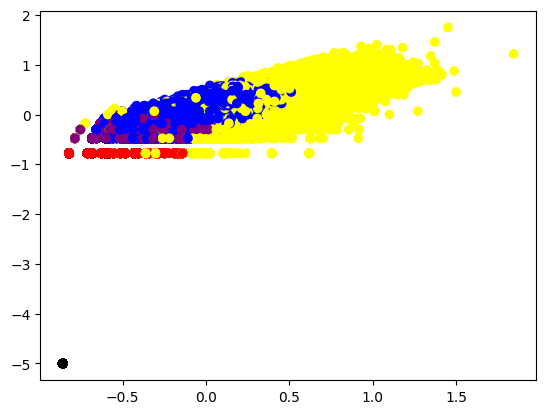

In [ ]:
plt.scatter(sym_CDR_data[:,0], sym_CDR_data[:,1], c=vectorizer(labels))

In [ ]:
from sklearn.metrics import silhouette_score
silhouette_avg = silhouette_score(normalized_CDR_data, labels)
print("Silhouette Score:", silhouette_avg)

KeyboardInterrupt: 

Text(0, 0.5, 'average distance to 8 neighbors')

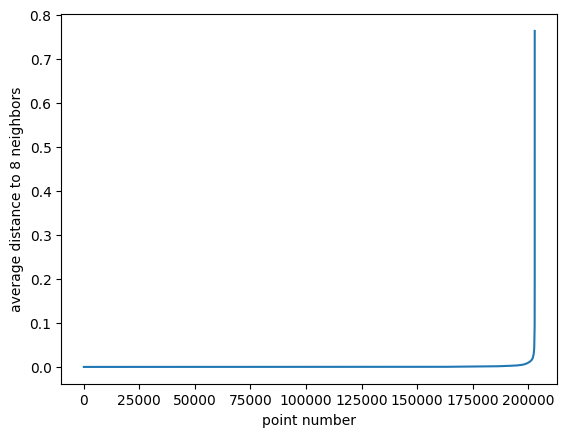

In [ ]:
from sklearn.neighbors import NearestNeighbors

core_points = normalized_CDR_data.shape[1] * 2

nn = NearestNeighbors(n_neighbors=core_points + 1)
nn = nn.fit(normalized_CDR_data)
distances, neighbors = nn.kneighbors(normalized_CDR_data)
average_distances = distances[:, 1:].mean(axis=1)
average_distances.sort()
plt.plot(average_distances)
plt.xlabel('point number')
plt.ylabel(f'average distance to {core_points} neighbors')


# k=8
# neigh = NearestNeighbors(n_neighbors=k)
# nbrs = neigh.fit(CDR_data_clean)
# distances, indices = nbrs.kneighbors(CDR_data_clean)
# sorted_distances = np.sort(distances[:,1], axis=0)

# plt.plot(sorted_distances)
# plt.xlabel('Data Point Index')
# plt.ylabel(f'Distance to {k}-th Nearest Neighbor')
# plt.title('Knee/Elbow Method for Epsilon Selection')
# plt.show()



# Calculate distance to the k-nearest neighbors
# k = 62
# neigh = NearestNeighbors(n_neighbors=k)
# neigh.fit(CDR_data_principal)
# distances, _ = neigh.kneighbors(CDR_data_principal)

# # Sort and plot distances
# sorted_distances = np.sort(distances[:, 1],axis=0)
# plt.plot(sorted_distances)
# plt.xlabel('Data Point Index')
# plt.ylabel(f'Distance to {k}-th Nearest Neighbor')
# plt.title('Knee/Elbow Method for Epsilon Selection')
# plt.show()


In [ ]:
plot_k_distance_graph(CDR_data, k=4)

NameError: ignored

In [ ]:
%pip install kneed

In [ ]:
def plot_eps_elbow(data, min_eps=0.1, max_eps=641, step=0.1):
    eps_values = np.arange(min_eps, max_eps, step)
    num_clusters = []
    for eps in eps_values:
        dbscan = DBSCAN(eps=eps, min_samples=300).fit(data)
        num_clusters.append(len(set(dbscan.labels_)) - (1 if -1 in dbscan.labels_ else 0))

    plt.plot(eps_values, num_clusters, 'o-')
    plt.title('Elbow Method for Optimal eps')
    plt.xlabel('eps value')
    plt.ylabel('Number of clusters')
    plt.show()

plot_eps_elbow(CDR_data_clean)

KeyboardInterrupt: 

In [ ]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN
best_score = -1
best_eps = None
def find_best_eps(data, min_eps=0.001, max_eps=0.2, step=0.05):
    # best_score = -1
    # best_eps = None
    for eps in np.arange(min_eps, max_eps, step):
        dbscan = DBSCAN(eps=eps, min_samples=9).fit(data)
        labels = dbscan.labels_
        if len(set(labels)) == 1 and -1 in labels:
            continue
        score = silhouette_score(data, labels)
        if score > best_score:
            best_score = score
            best_eps = eps
    # return best_eps, best_score

# best_eps, best_score = find_best_eps(compute_data())
print("Best eps:", best_eps)
print("Best silhouette score:", best_score)

Best eps: None
Best silhouette score: -1


In [ ]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN
batch_size = 30000
def compute_data():
    for i in range(0, len(normalized_CDR_data), batch_size):
         find_best_eps(normalized_CDR_data[i:i+batch_size])


def find_best_eps(data, min_eps=0.001, max_eps=0.2, step=0.05):
    best_score = -1
    best_eps = None
    for eps in np.arange(min_eps, max_eps, step):
        dbscan = DBSCAN(eps=eps, min_samples=9).fit(data)
        labels = dbscan.labels_
        if len(set(labels)) == 1 and -1 in labels:
            continue
        score = silhouette_score(data, labels)
        if score > best_score:
            best_score = score
            best_eps = eps
    # return best_eps, best_score

# best_eps, best_score = find_best_eps(compute_data())
    print("Best eps:", best_eps)
    print("Best silhouette score:", best_score)

compute_data()

Best eps: 0.15100000000000002
Best silhouette score: 0.8934309482580538
Best eps: 0.15100000000000002
Best silhouette score: 0.8923055780081693
Best eps: 0.15100000000000002
Best silhouette score: 0.8950037866832231
Best eps: 0.15100000000000002
Best silhouette score: 0.8908750905444802
Best eps: 0.101
Best silhouette score: 0.8911562637786127
Best eps: 0.101
Best silhouette score: 0.8851171385053505


KeyboardInterrupt: 

In [ ]:

#find the optimal eps using the k-distance graph
def find_optimal_eps(data, min_pts, plot=True):
    # Calculate distances to k-nearest neighbors
    neighbors = NearestNeighbors(n_neighbors=min_pts)
    neighbors.fit(data)
    distances, _ = neighbors.kneighbors(data)

    # Sort distances and plot the k-distance graph
    distances = np.sort(distances[:, -1])
    if plot:
        plt.plot(distances)
        plt.title('k-Distance Graph')
        plt.xlabel('Data Points (sorted by distance)')
        plt.ylabel(f'{min_pts}-th Nearest Neighbor Distance')
        plt.show()

    # Find the "knee" point in the graph as the optimal eps
    diff = np.diff(distances, 2)
    knee_point_index = np.argmax(diff) + 1
    optimal_eps = distances[knee_point_index]

    return optimal_eps

# Specify the minimum number of points for k-nearest neighbors
min_pts = 300

# Find the optimal eps
optimal_eps = find_optimal_eps(normalized_CDR_data, min_pts)

print(f'The optimal eps for DBSCAN is: {optimal_eps}')

In [ ]:
from kneed import KneeLocator
kneedle = KneeLocator(range(average_distances.shape[0]),
 average_distances,
 curve="convex",
 direction="increasing")
eps = average_distances[kneedle.knee]

print(eps)

0.016977023434121823
